In [1]:
#下面这行代码，是为了把自己编写的代码文件当作一共模块导入，这里是把Utilities文件夹中的plotting.py文件当作python的模块导入，对应的是下面的from plotting import newfig, savefig。路径要随着不同设备的系统做相应的修改
import sys #导入sys模块。sys模块提供了一些变量和函数，用于与 Python解释器进行交互和访问。例如，sys.path 是一个 Python 在导入模块时会查找的路径列表，sys.argv 是一个包含命令行参数的列表，sys.exit() 函数可以用于退出 Python 程序。导入 sys 模块后，你就可以在你的程序中使用这些变量和函数了。
sys.path.insert(0, '../../Utilities/') #在 Python的sys.path列表中插入一个新的路径。sys.path是一个 Python 在导入模块时会查找的路径列表。新的路径'../../Utilities/'相对于当前脚本的路径。当你尝试导入一个模块时，Python 会在 sys.path 列表中的路径下查找这个模块。通过在列表开始位置插入一个路径，你可以让 Python 优先在这个路径下查找模块。这在你需要导入自定义模块或者不在 Python 标准库中的模块时非常有用。

import torch
#collections是python一个内置模块，提供了一些有用的数据结构
from collections import OrderedDict  #这个类是字典dict的一个子类，用于创建有序的字典。普通字典中元素顺序是无序的，在OrderedDict中元素的顺序是有序的，元素的顺序是按照它们被添加到字典中的顺序决定的。

from pyDOE import lhs #`pyDOE`是一个Python库，用于设计实验。它提供了一些函数来生成各种设计，如因子设计、拉丁超立方设计等。`lhs`是库中的一个函数，全名为"Latin Hypercube Sampling"，拉丁超立方采样。这是一种统计方法，用于生成一个近似均匀分布的多维样本点集。它在参数空间中生成一个非常均匀的样本，这对于高维数值优化问题非常有用，因为它可以更好地覆盖参数空间。
import numpy as np
import matplotlib.pyplot as plt
import scipy.io #导入了scipy库中的io模块。scipy.io模块包含了一些用于文件输入/输出的函数，例如读取和写入.mat文件（MATLAB格式）
from scipy.interpolate import griddata #`scipy.interpolate`是`scipy`库中的一个模块，提供了许多插值工具，用于在给定的离散数据点之间进行插值和拟合。`griddata`是这个模块中的一个函数，用于在无规则的数据点上进行插值。

import random

import skopt #用于优化问题的库，特别是机器学习中的超参数优化
from distutils.version import LooseVersion #distutils是Python的一个标准库，用于构建和安装Python包。LooseVersion是一个类，用于比较版本号


from plotting_torch import newfig, savefig #从自定义的plotting_torch.py文件中导入了newfig和savefig函数。这两个函数用于创建和保存图形。这两个函数的定义在plotting_torch.py文件中

from mpl_toolkits.axes_grid1 import make_axes_locatable #`mpl_toolkits.axes_grid1`是`matplotlib`库的一个模块，提供了一些高级的工具来控制matplotlib图形中的坐标轴和颜色条。`make_axes_locatable`是模块中的一个函数，用于创建一个可分割的坐标轴。可以在这个坐标轴的四个方向（上、下、左、右）添加新的坐标轴或颜色条。
import matplotlib.gridspec as gridspec #是`matplotlib`库的一个模块，用于创建一个网格布局来放置子图。在`matplotlib`中可以创建一个或多个子图（subplot），每个子图都有自己的坐标轴，并可以在其中绘制图形。`gridspec`模块提供了一个灵活的方式来创建和放置子图。
import time #一个内置模块，用于处理时间相关的操作。


from tqdm import tqdm #一个快速，可扩展的python进度条库，可以在python长循环中添加一个进度提示信息，用户只需要封装任意的迭代器tqdm(iterator)。



In [2]:
# num_gpus = torch.cuda.device_count()
# print('Number of available GPUs: ', num_gpus)

# for i in range(num_gpus):
#     torch.cuda.set_device(i)
#     allocated = torch.cuda.memory_allocated()
#     reserved = torch.cuda.memory_reserved()
#     print('GPU {}: {}, Allocated: {}, Reserved: {}'.format(i, torch.cuda.get_device_name(i), allocated, reserved))

In [3]:
torch.cuda.set_device(0) #设置当前使用的GPU设备。这里设置为1号GPU设备（第二块显卡）。

# CUDA support 

#设置pytorch的设备，代表了在哪里执行张量积算，设备可以是cpu或者cuda（gpu），并将这个做运算的设备对象存储在变量device中，后续张量计算回在这个设备上执行
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

In [4]:
# the deep neural network
class DNN(torch.nn.Module):
    #第一个方法
    def __init__(self, layers):
        super(DNN, self).__init__() #调用父类的__init__方法进行初始化
        
        # parameters
        self.depth = len(layers) - 1 #定义名为depth的属性，表示神经网络的深度，等于层数-1
        
        # set up layer order dict
        self.activation = torch.nn.Tanh #设置激活函数为tanh
         
        layer_list = list() #定义一个空列表layer_list
        for i in range(self.depth - 1):  #循环depth次
            #将每一层（全连接层）添加到layer_list中
            layer_list.append(
                ('layer_%d' % i, torch.nn.Linear(layers[i], layers[i+1]))
            )
            #将每一层的激活函数添加到layer_list中
            layer_list.append(('activation_%d' % i, self.activation()))

        #循环结束后，将最后一层的线性变换添加到layer_list中（因为没有激活函数了）
        layer_list.append(
            ('layer_%d' % (self.depth - 1), torch.nn.Linear(layers[-2], layers[-1]))
        )
        #然后使用OrderedDict将layer_list中的元素转换为有序字典
        layerDict = OrderedDict(layer_list)
        
        # deploy layers，将layerDict转换为一个神经网络模型，赋值给self.layers
        self.layers = torch.nn.Sequential(layerDict)
    
    #第二个方法，定义了模型的前向传播过程
    def forward(self, x):  #接收输入x
        out = self.layers(x) #将输入x传入神经网络模型self.layers中，得到输出out
        return out #返回输出out
    
    # 新增方法，获取最后一个隐藏层的输出
    def hidden_output(self, x):
        # 遍历每一层，直到最后一个隐藏层
        for i in range(self.depth - 1):
            # 获取当前层的线性变换
            x = self.layers[i*2](x)
            # 获取当前层的激活函数
            x = self.layers[i*2 + 1](x)
        # 返回最后一个隐藏层的输出
        return x

In [5]:
#set the class of PINN

#定义了一个名为`PhysicsInformedNN'的类，用于实现基于物理的神经网络。
class PhysicsInformedNN:
    # Initialize the class
    def __init__(self, x0, u0, tb, X_f, layers, lb, ub, X_star, u_star): #这个类包含的第一个方法__init__，这是一个特殊的方法，也就是这个类的构造函数，用于初始化新创建的对象，接受了几个参数
        
        
        #`numpy.concatenate`是一个用于数组拼接的函数。它可以将多个数组沿指定的轴拼接在一起，形成一个新的数组：numpy.concatenate((a1,a2, ...), axis=0)其中，`a1,a2, ...`是需要拼接的数组（只能接受数组或序列类型的参数，且参数形状必须相同），可以是多个。`axis`参数用于指定拼接的轴向，`axis=0`表示沿着第一个轴（即行）进行拼接，不指定`axis`参数默认值是0。
        X0 = np.concatenate((x0,0*x0), 1) # [x0, 0],将x0和0*x0两个数组在第二个维度（即列）上进行了合并。0*x0会生成一个与x0形状相同，但所有元素都为0的数组。因此，X0的结果是一个新的二维数组，其中第一列是x0的值，第二列全为0
        X_lb = np.concatenate((0*tb+lb[0],tb), 1) # [lb[0], tb],将0*tb+lb[0]和tb两个数组在第二个维度（即列）上进行了合并。0*tb+lb[0]会生成一个与tb形状相同，但所有元素都为lb[0]的数组。因此，X_lb的结果是一个新的二维数组，其中第一列全为lb[0]的值，第二列是tb的值。
        X_ub = np.concatenate((0*tb+ub[0],tb), 1) # [ub[0], tb],同上生成一个与tb形状相同，但所有元素都为ub[0]的数组。因此，X_ub的结果是一个新的二维数组，其中第一列全为ub[0]的值，第二列是tb的值
        
        #Python使用self关键字来表示类的实例。当在类的方法中定义一个变量时，例如lb和ub，这些变量只在该方法内部可见，也就是说它们的作用域仅限于该方法。当方法执行完毕后，这些变量就会被销毁，无法在其他方法中访问它们。但如果希望在类的其他方法中也能访问这些变量就需要将它们保存为类的实例属性。这就是self.lb和self.ub的作用。
            #通过将lb和ub赋值给self.lb和self.ub，就可以在类的其他方法中通过self.lb和self.ub来访问这些值。总的来说，self.lb和self.ub是类的实例属性，它们的作用域是整个类，而不仅仅是定义它们的方法。
        self.lb = torch.tensor(lb).float().to(device) #将传入的lb和ub参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.lb和self.ub来访问这些值。
        self.ub = torch.tensor(ub).float().to(device)


        self.x0 = torch.tensor(X0[:,0:1], requires_grad=True).float().to(device) #将X0的第一列赋值给self.x0（:表示取所有行,0：1实际上表示取第一列，因为python是左闭右开的）,将X0的第二列赋值给self.t0。这样可以在类的其他方法中通过self.x0和self.t0来访问这些值。
        self.t0 = torch.tensor(X0[:,1:2], requires_grad=True).float().to(device) #将x0的第二列赋值给self.t0

        self.x_lb = torch.tensor(X_lb[:,0:1], requires_grad=True).float().to(device) #将X_lb的第一列赋值给self.x_lb
        self.t_lb = torch.tensor(X_lb[:,1:2], requires_grad=True).float().to(device) #将X_lb的第二列赋值给self.t_lb

        self.x_ub = torch.tensor(X_ub[:,0:1], requires_grad=True).float().to(device) #将X_ub的第一列赋值给self.x_ub
        self.t_ub = torch.tensor(X_ub[:,0:1], requires_grad=True).float().to(device) #将X_ub的第二列赋值给self.t_ub
        
        self.x_f = torch.tensor(X_f[:,0:1], requires_grad=True).float().to(device) #将X_f的第一列赋值给self.x_f
        self.t_f = torch.tensor(X_f[:,1:2], requires_grad=True).float().to(device) #将X_f的第二列赋值给self.t_f
        
        self.u0 = torch.tensor(u0).float().to(device) #将传入的u0和v0参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.u0和self.v0来访问这些值。


        self.x_star = torch.tensor(X_star[:,0:1], requires_grad=True).float().to(device) #将X_star的第一列赋值给self.x_star
        self.t_star = torch.tensor(X_star[:,1:2], requires_grad=True).float().to(device) #将X_star的第二列赋值给self.t_star
        self.u_star = torch.tensor(u_star).float().to(device) #将传入的u_star和v_star参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.u_star和self.v_star来访问这些值。
        
        
        # Initialize NNs 
        self.layers = layers #将传入的layers参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.layers来访问这些值。
        
        
        # deep neural networks
        self.dnn = DNN(layers).to(device) #创建一个DNN类的实例，传入layers参数来实现神经网络的初始化，然后将这个实例移动到指定的设备上



        # optimizers: using the same settings，这里是使用pytorch库进行优化的部分
        #创建优化器optimizer，使用LBFGS算法，具体每个参数意义见下方
        self.optimizer_LBFGS = torch.optim.LBFGS(
            self.dnn.parameters(), #要优化的参数，这里返回的是一个生成器，包含了self.dnn中的所有参数（神经网络权重、偏置以及两个新加的变量）
            lr=1.0,  #学习率设置为1
            max_iter=50000,  #最大迭代次数为50000
            max_eval=50000,  #最大评估次数为50000
            history_size=50, #历史大小为50，即用于计算Hessian矩阵近似的最近几步的信息
            tolerance_grad=1e-5,  #优化的第一个停止条件，当梯度的L2范数小于1e-5时停止优化
            tolerance_change=1.0 * np.finfo(float).eps, #优化的第二个停止条件，当优化的目标函数值的变化小于1.0 * np.finfo(float).eps时停止优化
            line_search_fn="strong_wolfe"       # 制定了用于一维搜索的方法，这里表示用强Wolfe条件
        )
        #创建第二个优化器，括号内为要优化的参数，使用Adam优化方法
        self.optimizer_Adam = torch.optim.Adam(self.dnn.parameters())
                

        self.iter = 0 #记录迭代次数 

        self.loss_value = [] #创建一个空列表，用于存储损失值

        self.test_error = [] #创建一个空列表，用于存储测试误差
        self.test_error_mse = [] #创建一个空列表，用于存储测试误差
        self.test_error_mae = [] #创建一个空列表，用于存储测试误差
    
    #这个函数与下面的net_u函数功能相同，只是不计算梯度，因为在记录每个epoch的error时，使用with torch.no_grad()情况下调用net_u函数会报错，不知道为啥？
    def net_u_error(self, x, t):  
        u = self.dnn(torch.cat([x, t], dim=1))  #（第一个参数将输入的两个参数x和t在第二个维度（列）上进行拼接，形成一个新的张量）调用DNN，根据两个参数权重和偏置，以及新得到的张量，计算神经网络的输出u
        
        return u #返回神经网络的输出u和v，以及u关于x的梯度u_x和v关于x的梯度v_x


    #pytorch中
    #定义了一个名为net_u的函数/方法，用于计算神经网络的输出。这个方法接受两个参数，分别是x和t，其中x是输入数据，t是时间数据。最后返回神经网络的输出。     
    def net_u(self, x, t):  
        u = self.dnn(torch.cat([x, t], dim=1))  #（第一个参数将输入的两个参数x和t在第二个维度（列）上进行拼接，形成一个新的张量）调用DNN，根据两个参数权重和偏置，以及新得到的张量，计算神经网络的输出u

        u_x = torch.autograd.grad(
            u, x, 
            grad_outputs=torch.ones_like(u),
            retain_graph=True,
            create_graph=True
        )[0]

        return u,u_x #返回神经网络的输出u和v，以及u关于x的梯度u_x和v关于x的梯度v_x


    #定义了一个名为net_f的函数/方法，用于计算论文中的f。这个方法接受两个参数，分别是x和t，其中x是输入数据，t是时间数据。最后返回计算得到的f。
    def net_f(self, x, t):
        """ The pytorch autograd version of calculating residual """

        u,u_x=self.net_u(x,t) #调用上面的函数/方法，计算神经网络的输出（两个）以及输出关于输入x的梯度（两个）
        
        #计算u关于t的梯度，也就是u关于t的导数，这里使用了pytorch的自动求导功能
        u_t = torch.autograd.grad(
            u, t,  #输入的张量，要计算u关于t的导数
            grad_outputs=torch.ones_like(u), #生成一个与u形状相同，所有元素均为1的张量，这个参数用于指定向量-雅可比积的像两部分
            retain_graph=True, #表示计算完梯度之后保留计算图若需要多次计算梯度，则需要设置改参数为True
            create_graph=True #创建梯度的计算图，使我们能够计算高阶导数
        )[0] #这个函数的返回值是一个元组，其中包含了每个输入张量的梯度。这里只关心第一个输入张量u的梯度，所以我们使用[0]来获取这个梯度。？？？？又说只有一个梯度

        u_xx = torch.autograd.grad(
            u_x, x, 
            grad_outputs=torch.ones_like(u_x),
            retain_graph=True,
            create_graph=True
        )[0]
        
        f=u_t-0.0001*u_xx+5*u**3-5*u    #计算f,定义见论文

        return f  #返回计算得到的f


    def loss_func(self):
        self.optimizer_LBFGS.zero_grad() #清除之前计算的梯度（在PyTorch中，梯度会累积，所以在每次新的优化迭代之前，我们需要清除之前的梯度）

        u0_pred, _  = self.net_u(self.x0, self.t0) #是调用net_uv函数,将self.x0_tf和self.t0_tf作为参数传入,然后将返回的前两个结果赋值给self.u0_pred和self.v0_pred。后两个_是Python惯用法，表示不关心net_uv函数返回的后两个结果。
        u_lb_pred, u_x_lb_pred = self.net_u(self.x_lb, self.t_lb) #同上，不过这里函数返回的后两个结果会赋值给self.u_x_lb_pred和self.v_x_lb_pred。
        u_ub_pred, u_x_ub_pred = self.net_u(self.x_ub, self.t_ub) #同上
        f_pred = self.net_f(self.x_f, self.t_f) #调用net_f_uv函数,将self.x_f_tf和self.t_f_tf作为参数传入,然后将返回的结果赋值给self.f_u_pred和self.f_v_pred。

        loss = 100*torch.mean((self.u0 - u0_pred) ** 2)  + \
                    torch.mean((u_lb_pred - u_ub_pred) ** 2) + \
                    torch.mean((u_x_lb_pred - u_x_ub_pred) ** 2) + \
                    torch.mean(f_pred ** 2)
        loss.backward() #被调用以计算损失函数关于神经网络参数的梯度。这个梯度将被用于优化器来更新神经网络参数
        
        self.iter += 1 #每调用一次损失函数，迭代次数加1


        #record the loss value
        self.loss_value.append(loss) #将计算得到的loss值添加到self.loss_value列表中

        #record the test error
        self.dnn.eval() #将神经网络切换为评估模式
        with torch.no_grad():
            u_real_pred = self.net_u_error(self.x_star, self.t_star)

        error_test = torch.norm(self.u_star - u_real_pred, 2) / torch.norm(self.u_star, 2)
        
        self.test_error.append(error_test)
        
        # 计算 MAE
        mae = torch.mean(torch.abs(self.u_star - u_real_pred))
        # 计算 MSE
        mse = torch.mean((self.u_star - u_real_pred) ** 2)
        # 记录 MAE 和 MSE
        self.test_error_mae.append(mae)
        self.test_error_mse.append(mse)

        return loss #返回loss



    
    #定义了一个名为train的函数/方法，用于训练神经网络。这个方法接受一个参数nIter，表示训练的迭代次数。
    def train(self, nIter, nIterLBFGS):
        self.dnn.train()#将神经网络设置为训练模式而不是评估模式

        #先使用Adam优化器优化nIter次
        for epoch in tqdm(range(nIter), desc='Adam'):
            u0_pred, _  = self.net_u(self.x0, self.t0) #是调用net_uv函数,将self.x0_tf和self.t0_tf作为参数传入,然后将返回的前两个结果赋值给self.u0_pred和self.v0_pred。后两个_是Python惯用法，表示不关心net_uv函数返回的后两个结果。
            u_lb_pred, u_x_lb_pred = self.net_u(self.x_lb, self.t_lb) #同上，不过这里函数返回的后两个结果会赋值给self.u_x_lb_pred和self.v_x_lb_pred。
            u_ub_pred, u_x_ub_pred = self.net_u(self.x_ub, self.t_ub) #同上
            f_pred = self.net_f(self.x_f, self.t_f) #调用net_f_uv函数,将self.x_f_tf和self.t_f_tf作为参数传入,然后将返回的结果赋值给self.f_u_pred和self.f_v_pred。

            loss = 100*torch.mean((self.u0 - u0_pred) ** 2)  + \
                    torch.mean((u_lb_pred - u_ub_pred) ** 2) + \
                    torch.mean((u_x_lb_pred - u_x_ub_pred) ** 2) + \
                    torch.mean(f_pred ** 2)
            
            # Backward and optimize
            self.optimizer_Adam.zero_grad() #清除该优化器之前计算的梯度（在PyTorch中，梯度会累积，所以在每次新的优化迭代之前，我们需要清除之前的梯度）
            loss.backward() #被调用以计算损失函数关于神经网络参数的梯度。这个梯度将被用于优化器来更新神经网络参数
            self.optimizer_Adam.step()  #使用之前的优化器self.optimizer_Adam，调用step方法(执行一步优化算法)，传入损失函数self.loss_func，进行优化
            

            #record the loss value
            self.loss_value.append(loss) #将计算得到的loss值添加到self.loss_value列表中
            

            #record the test error
            self.dnn.eval() #将神经网络切换为评估模式
            with torch.no_grad():
                u_real_pred = self.net_u_error(self.x_star, self.t_star)

            error_test = torch.norm(self.u_star - u_real_pred, 2) / torch.norm(self.u_star, 2)
            
            self.test_error.append(error_test)

            # 计算 MAE和MSE
            mae = torch.mean(torch.abs(self.u_star - u_real_pred))
            mse = torch.mean((self.u_star - u_real_pred) ** 2)
            # 记录 MAE 和 MSE
            self.test_error_mae.append(mae)
            self.test_error_mse.append(mse)



        #Backward the optimize，使用LBFGS优化器进一步，注意这里虽然迭代了500次，但其实使用LBFGS优化器优化的次数不止500次
        for i in tqdm(range(nIterLBFGS), desc='LBFGS'):
            self.dnn.train() #将神经网络设置为训练模式而不是评估模式
            self.optimizer_LBFGS.step(self.loss_func)  #使用之前的优化器self.optimizer，调用step方法(执行一步优化算法)，传入计算损失函数的方法self.loss_func，进行优化   

                                    
    #定义了一个名为predict的函数/方法，用于预测神经网络的输出。这个方法接受一个参数X_star，表示输入数据。最后返回预测的两个输出和两个输出的梯度。
    def predict(self, X):
        x = torch.tensor(X[:, 0:1], requires_grad=True).float().to(device) #从输入中得到x和t（第一列和第二列），是张量，需要计算梯度，转换为浮点数类型，并将张量移动到指定设备上
        t = torch.tensor(X[:, 1:2], requires_grad=True).float().to(device)

        self.dnn.eval() #将神经网络切换为评估模式
        u, _ = self.net_u(x, t) #调用之前定义的函数得到神经网络的输出u,以及f
        f = self.net_f(x, t) 

        u = u.detach().cpu().numpy() #将张量u和v先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        f = f.detach().cpu().numpy()

        return u, f 
    
    #定义函数获得隐藏层的输出
    def hidden_predict(self, x,t):
        x = torch.tensor(x, requires_grad=True).float().to(device) #从输入中得到x和t（第一列和第二列），是张量，需要计算梯度，转换为浮点数类型，并将张量移动到指定设备上
        t = torch.tensor(t, requires_grad=True).float().to(device)
        self.dnn.eval() #将神经网络切换为评估模式
        hidden_output = self.dnn.hidden_output(torch.cat([x, t], dim=1)) #调用上一个神经网络类中的hidden_output方法，得到最后一个隐藏层的输出
        hidden_output_x = hidden_output[:, 0] #将输出的第一列赋值给hidden_output_x
        hidden_output_t = hidden_output[:, 1] #将输出的第二列赋值给hidden_output_t
        hidden_output_x = hidden_output_x.detach().cpu().numpy() #将张量hidden_output_x和hidden_output_t先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        hidden_output_t = hidden_output_t.detach().cpu().numpy() #将张量hidden_output_x和hidden_output_t先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        return hidden_output_x, hidden_output_t #返回隐藏层的输出


In [6]:
#定义根据模型计算给定输入（点集中的点）的混沌度的函数，这个函数接受三个参数，分别是模型、输入数据和迭代次数
def calculate_chaos(model, X, num_iter):
    """
    计算模型混沌情况的函数。
    参数:
    - model: 用于预测的模型对象，必须有一个名为hidden_predict的方法。模型的hidden_predict为倒数第二层的输出，倒数第二层的维度必须和输入维度相同。
    - X: 输入数据，形状为(N_f_new, 2)，其中第一列为x0，第二列为t0。
    - num_iter: 计算混沌情况的迭代次数。
    返回:
    - distances: 每个采样点（与该采样点加上微扰比较）在最后一次迭代后的欧氏距离数组，形状为(N_f_new,)。
    """
    #对于所有的采样点
    x0 = X[:, 0:1] #取X_f_train_new的第一列，赋值给x0，(N_f_new,1)形状
    t0 = X[:, 1:2] #取X_f_train_new的第二列，赋值给t0
    # 利用x0和t0计算x{t}和t{t}，存储在xs中
    xs = [] #初始化xs
    x,t = model.hidden_predict(x0,t0) #调用predict方法，传入X_f_train_new，得到x和t，这里x和t形状均为(N_f_new,)，因此下一步需要reshape
    x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
    t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
    
    # 迭代预测
    for i in range(num_iter): #循环num_iter次
        x,t = model.hidden_predict(x,t) #每次计算隐藏层输出，得到的x和t形状均为(N_f_new,)，因此下一步需要reshape
        x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
        t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
        xs.append([x,t]) #将x的数据添加到xs中
    #最后得到的xs是一个列表，列表中的每个元素都是一个列表（num_iter个元素），每个列表中有两个元素，分别代表x和t，长度均为N_f_new，对应原始采样点的迭代结果


    # 给所有采样点加上一个很小的扰动
    x1 = x0 + np.random.normal(0, 0.0001) #加上一个很小的扰动，(N_f_new,1)形状
    t1 = t0 + np.random.normal(0, 0.0001)
    # 利用x0{1}和t0{1}计算x{t1}和t{t1}，存储在xs1中
    xs1 = [] #初始化xs1
    x,t = model.hidden_predict(x1,t1) #调用predict方法，传入X_f_train_new，得到x和t，这里x和t形状均为(N_f_new,)，因此下一步需要reshape
    x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）
    t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)（这一步是为了之后能重复输入神经网络）

    # 迭代预测（扰动后）
    for i in range(num_iter): #循环num_iter次
        x,t = model.hidden_predict(x,t) #每次计算隐藏层输出，得到的x和t形状均为(N_f_new,)，因此下一步需要reshape
        x = x.reshape(-1,1) #将x的形状变为(N_f_new,1)
        t = t.reshape(-1,1) #将t的形状变为(N_f_new,1)
        xs1.append([x,t]) #将x的数据添加到xs1中
    #最后得到的xs1是一个列表，列表中的每个元素都是一个列表（num_iter个元素），每个列表中有两个元素，分别代表x和t，长度均为N_f_new，对应加了扰动后的采样点的迭代结果

    # 计算最后一次迭代的隐藏层输出，即最后一次迭代的x和t
    last_iter_xs = np.array(xs[-1]) #转换为数组，便于之后计算距离
    last_iter_xs1 = np.array(xs1[-1])
    #这两个数组的形状均为(2,N_f_new,1)，第一个代表x和t，第二个代表N_f_new个样本点得到的结果，第三个代表1个数

    # 计算这两个点的欧氏距离
    distances = np.linalg.norm(last_iter_xs - last_iter_xs1, axis=0)
    #得到的是一个形状为（N_f_new,1）的数组，每个元素代表了两个点之间的欧氏距离，这里点在xt平面上

    distances = distances.flatten()

    #对distances进行归一化
    # distances = distances / np.linalg.norm(distances)
    # 对distances进行归一化前，检查分母是否接近零
    # norm = np.linalg.norm(distances)
    # if norm < 1e-10:  # 1e-10是一个非常小的数，用于检测norm是否接近于零
    #     distances = np.zeros_like(distances)  # 如果分母接近0，将distances设置为全零数组，因为范数为0时，distances中的值想对于彼此几乎没有差异，意味着所有点都几乎处于同一混沌度水平
    # else:
    #     distances = distances / norm

    # 现在可以安全地根据distances对点进行排序，即使在所有值都相同的情况下

    return distances

In [7]:
#定义设置随机数种子的函数，第一个参数seed表示种子；第二个参数用来设置CUDA的卷积操作是否确定性，默认为False，表示没有确定性
def set_seed(seed):
    # torch.manual_seed(seed) #设置pytorch的CPU随机数生成器的种子
    # torch.cuda.manual_seed_all(seed) #设置putorch的所有GPU随机数生成器的种子
    # np.random.seed(seed) #设置numpy的随机数生成器的种子
    # random.seed(seed) #设置python的内置随机数生成器的种子
    # torch.backends.cudnn.deterministic = deterministic #True会让CUDA的卷积操作变得确定性，即对于相同的输入，每次运行会得到相同的结果，False则相反
    """
    设置PyTorch的随机种子, 用于生成随机数. 通过设置相同的种子, 可以确保每次运行时生成的随机数序列相同
    """
    torch.manual_seed(seed)
 
    """
    设置PyTorch在所有可用的CUDA设备上的随机种子. 如果在使用GPU进行计算, 这个设置可以确保在不同的GPU上生成的随机数序列相同
    """
    torch.cuda.manual_seed_all(seed)
 
    """
    设置PyTorch在当前CUDA设备上的随机种子. 它与上一行代码的作用类似, 但只影响当前设备
    """
    torch.cuda.manual_seed(seed)
 
    """
    设置NumPy的随机种子, 用于生成随机数. 通过设置相同的种子，可以确保在使用NumPy的随机函数时生成的随机数序列相同
    """
    np.random.seed(seed)
    
    """
    设置Python内置的随机函数的种子. Python的random模块提供了许多随机函数, 包括生成随机数、打乱列表等. 通过设置相同的种子, 可以确保使用这些随机函数时生成的随机数序列相同
    """
    random.seed(seed)
    
    """
    设置Python的哈希种子 (哈希函数被广泛用于数据结构 (如字典和集合) 的实现，以及一些内部操作 (如查找和比较)). 通过设置相同的种子, 可以确保在不同的运行中生成的哈希结果相同
    """
    # os.environ["PYTHONHASHSEED"] = str(seed)
    
    """
    该设置确保每次运行代码时, cuDNN的计算结果是确定性的, 即相同的输入会产生相同的输出, 这是通过禁用一些非确定性的算法来实现的, 例如在卷积操作中使用的算法. 这样做可以保证模型的训练和推理在相同的硬件和软件环境下是可复现的, 即每次运行代码时的结果都相同. 但是, 这可能会导致一些性能上的损失, 因为禁用了一些优化的非确定性算法
    """
    torch.backends.cudnn.deterministic = True
    
    """
    该设置禁用了cuDNN的自动优化过程. 当它被设置为False时, PyTorch不会在每次运行时重新寻找最优的算法配置, 而是使用固定的算法配置. 这样做可以确保每次运行代码时的性能是一致的, 但可能会导致一些性能上的损失
    """
    torch.backends.cudnn.benchmark = False



In [8]:
seeds = [0, 1, 12, 21, 123, 321, 1234, 4321, 12345, 54321]
# seeds = [0]

#设置噪声水平为0
noise = 0.0        

# Doman bounds，定义两个一维数组lb和ub，问题域是一个二维空间，其中 x 的范围是 -5 到 5，t 的范围是 0 到 π/2(竖着的)
lb = np.array([-1.0, 0.0])
ub = np.array([1.0, 1.0])
#定义三个整数，分别表示初始条件点数量、边界条件点数量和配位点的数量（这些点用于训练神经网络）
N0 = 500
N_b = 100
N_f = 10000
#定义一个列表layers，其中包含了神经网络的层数和每一层的神经元数量
# layers = [2, 200, 200, 200, 200, 2, 1]
layers = [2,30,30,30,30,30,30,30,30,2,1]

#读取名为burgers_shock的Matlab文件，文件中的数据存储在data变量中。这里的路径也要随着设备的情况修改 
data = scipy.io.loadmat('../data/AC.mat')
#从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
t = data['tt'].flatten()[:,None]
x = data['x'].flatten()[:,None]
Exact = np.real(data['uu']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
#生成一个二位网络，X和T是输出的二维数组
#这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
X, T = np.meshgrid(x,t)

X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_star = Exact.flatten()[:,None]    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组         

###########################

#从0~数组x的行数(256)中随机选择N0个数，replace=False表示不允许重复选择，最后将这N0个数赋值给idx_x
idx_x = np.linspace(0, x.shape[0]-1, N0, dtype='int') #生成一个从0到x.shape[0]-1的等差数列，长度为x.shape[0]，数据类型为整型
# idx_x = np.random.choice(x.shape[0], N0, replace=False)
#从x中选择N0个对应的行(idx_x对应的行)，最后将这N0行赋值给x0
x0 = x[idx_x,:]
#从Exact_u中选择N0个对应的行(idx_x对应的行)的第一列元素，最后将这N0个元素赋值给u0
# u0 = Exact[idx_x,0:1]
u0 = Exact[0:1,idx_x].T

#从0~数组t的行数中随机选择N_b个数，replace=False表示不允许重复选择，最后将这N_b个数赋值给idx_t
idx_t = np.linspace(0, t.shape[0]-1, N_b, dtype='int') #生成一个从0到t.shape[0]-1的等差数列，长度为t.shape[0]，数据类型为整型
# idx_t = np.random.choice(t.shape[0], N_b, replace=False)
#从t中选择N_b个对应的行(idx_t对应的行)，最后将这N_b行赋值给tb
tb = t[idx_t,:]

error = [] #创建一个空列表，用于存储误差
error_mae = [] #创建一个空列表，用于存储MAE值
error_mse = [] #创建一个空列表，用于存储MSE值

i = 0 #初始化i为0

nIter = 50000 #设置迭代次数为10000
nIterLBFGS = 10000 #设置LBFGS迭代次数为500

for seed in seeds:
    set_seed(seed) #设置随机种子

    num_iter = 1000 #迭代次数（用于混沌度）
    #1.先训练一定次数（总次数/100）

    N_f_1 = N_f // 100 #将N_f除以100，得到的整数赋值给N_f_1
    #采样初步训练点
    X_f = lb + (ub-lb)*lhs(2, N_f_1) #lhs函数采用拉丁超采样方法，生成一个近似均匀分布的多维样本点集，返回的是一个形状为（$N_f$，2）的数组，每一行都是一个2维的样本点，所有样本点都在[0,1]范围内，并对该样本集进行缩放，把每个样本从[0,1]区间缩放到[lb,ub]区域内，即得到了指定范围内均匀分布的样本$X_f$。



    #创建PINN模型并输入各种参数        
    model = PhysicsInformedNN(x0, u0, tb, X_f, layers, lb, ub, X_star, u_star)
    #获取当前时间并赋值给start_time          
    start_time = time.time()       
    #训练模型50000次         
    model.train(nIter//100, 0)

    #2.训练结束后，每总次数的1/100次训练，重新采样N_f//10个点，从中选出N_f//100个点加入训练
    for iter in range(nIter//100+1, nIter+1, nIter//100): #每500次迭代

        N_f_new = N_f_1 * 10 #重新总训练点数的1%个训练点的10倍
        # 生成新的X_f_new数据
        X_f_new = lb + (ub-lb)*lhs(2, N_f_new)

        #计算混沌情况
        distances = calculate_chaos(model, X_f_new, num_iter) #计算混沌度

        _, residual = model.predict(X_f_new)

        # 计算残差的绝对值
        abs_residual = np.abs(residual)
        #将二维数组转换为一维数组
        abs_residual = abs_residual.flatten()


        # 对distances进行归一化
        epsilon = 1e-5
        norm_distances = np.linalg.norm(distances)
        if norm_distances > epsilon:
            distances = distances / norm_distances
        else:
            distances = np.zeros_like(distances)

        #对abs_residual进行归一化
        abs_residual = abs_residual / np.linalg.norm(abs_residual)

        #计算信息量
        xinxi = 0.1*distances + 0.9*abs_residual

        # 找出绝对值最大的N_f_1个值的索引
        topk_indices = np.argpartition(xinxi, -N_f_1)[-N_f_1:] #该函数会对数组进行排序，使得指定的k个最大值出现在数组的最后k给位置上，并获取最后1000个元素

        # 使用这些索引来提取对应的数据
        X_f_topk = X_f_new[topk_indices]

        # 将这些数据添加到原来的训练数据中
        X_f = np.vstack((X_f, X_f_topk)) #与之前的训练数据合并

        # 更新模型中的X_f_train数据
        model.x_f = torch.tensor(X_f[:, 0:1], requires_grad=True).float().to(device)
        model.t_f = torch.tensor(X_f[:, 1:2], requires_grad=True).float().to(device)

        # 在更新数据后的模型上进行训练500次
        model.train(nIter//100, 0)


    model.train(0, nIterLBFGS) #训练模型500次

    #获取当前时间并减去start_time，得到训练时间并赋值给elapsed
    elapsed = time.time() - start_time                
    #打印训练所需时间
    print('Training time: %.4f' % (elapsed))





    #用训练好的模型进行预测，返回四个值（均为数组）    
    u_pred, f_pred = model.predict(X_star)

    #计算误差（基于2范数）        
    error_u = np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2)

    #打印误差
    print('Error u: %e' % (error_u))

    #将误差添加到error列表中

    #计算误差（基于2范数）
    error.append(error_u) #计算误差，然后将误差添加到error列表中
    # 计算 MAE 和 MSE
    mae = np.mean(np.abs(u_star - u_pred))
    mse = np.mean((u_star - u_pred) ** 2)
    # 记录 MAE 和 MSE
    error_mae.append(mae)
    error_mse.append(mse)

    i+=1 #i加1
    print(f'当前为第{i}次循环，种子为{seed}')
    print('Error u : %e' % (np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2))) #打印误差  
    print('MAE: %e' % mae) #打印MAE
    print('MSE: %e' % mse) #打印MSE


# #使用griddata函数将X_star、u_pred、v_pred和h_pred插值到网格上，得到U_pred、V_pred和H_pred
# U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')

# #同上，使用griddata函数将X_star、f_u_pred和f_v_pred插值到网格上，得到FU_pred和FV_pred
# F_pred = griddata(X_star, f_pred.flatten(), (X, T), method='cubic')


 

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<00:51,  9.72it/s]

Adam:   3%|▎         | 15/500 [00:00<00:05, 84.05it/s]

Adam:   5%|▌         | 27/500 [00:00<00:04, 98.49it/s]

Adam:   9%|▊         | 43/500 [00:00<00:03, 120.02it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 136.06it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 136.99it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 138.71it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 146.99it/s]

Adam:  24%|██▍       | 121/500 [00:00<00:02, 142.02it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:02, 141.31it/s]

Adam:  30%|███       | 151/500 [00:01<00:02, 143.81it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 144.07it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 132.22it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 127.44it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 130.50it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:02, 123.57it/s]

Adam:  47%|████▋     | 236/500 [00:01<00:02, 124.03it/s]

Adam:  50%|████▉     | 249/500 [00:01<00:02, 123.43it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 116.31it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:01, 116.61it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 122.74it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 119.30it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 120.36it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 122.26it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:01, 119.65it/s]

Adam:  71%|███████   | 353/500 [00:02<00:01, 114.80it/s]

Adam:  73%|███████▎  | 366/500 [00:02<00:01, 118.55it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 117.48it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 122.65it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 125.27it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 123.13it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 121.37it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 122.48it/s]

Adam:  92%|█████████▏| 459/500 [00:03<00:00, 126.83it/s]

Adam:  94%|█████████▍| 472/500 [00:03<00:00, 118.15it/s]

Adam:  97%|█████████▋| 484/500 [00:03<00:00, 116.26it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 113.96it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 123.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 162.87it/s]

Adam:   7%|▋         | 34/500 [00:00<00:03, 154.39it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 141.88it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 141.98it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:02, 147.77it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:02, 149.96it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:02, 148.55it/s]

Adam:  26%|██▌       | 128/500 [00:00<00:02, 146.54it/s]

Adam:  29%|██▉       | 144/500 [00:00<00:02, 148.53it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:02, 135.55it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 132.58it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 130.14it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 123.28it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 122.60it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:02, 125.96it/s]

Adam:  48%|████▊     | 241/500 [00:01<00:02, 126.46it/s]

Adam:  51%|█████     | 254/500 [00:01<00:02, 122.63it/s]

Adam:  53%|█████▎    | 267/500 [00:01<00:01, 123.53it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:01, 113.89it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 116.28it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 112.64it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 110.49it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 115.16it/s]

Adam:  68%|██████▊   | 342/500 [00:02<00:01, 112.27it/s]

Adam:  71%|███████   | 354/500 [00:02<00:01, 113.53it/s]

Adam:  73%|███████▎  | 367/500 [00:02<00:01, 118.18it/s]

Adam:  76%|███████▌  | 381/500 [00:02<00:00, 122.77it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 124.44it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 124.71it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 121.04it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 124.09it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 117.66it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 121.93it/s]

Adam:  95%|█████████▍| 474/500 [00:03<00:00, 123.77it/s]

Adam:  98%|█████████▊| 488/500 [00:03<00:00, 125.67it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 126.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 137.94it/s]

Adam:   6%|▌         | 29/500 [00:00<00:03, 143.32it/s]

Adam:   9%|▉         | 44/500 [00:00<00:03, 137.05it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 136.36it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 138.79it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:02, 144.07it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 150.05it/s]

Adam:  24%|██▍       | 122/500 [00:00<00:02, 149.54it/s]

Adam:  27%|██▋       | 137/500 [00:00<00:02, 149.59it/s]

Adam:  30%|███       | 152/500 [00:01<00:02, 144.93it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 134.88it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 123.44it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 121.03it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 120.23it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 119.60it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 121.39it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:02, 111.83it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 115.35it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:01, 122.51it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 123.32it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 121.75it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 117.92it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 122.78it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 115.44it/s]

Adam:  71%|███████   | 353/500 [00:02<00:01, 116.48it/s]

Adam:  73%|███████▎  | 365/500 [00:02<00:01, 107.87it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 108.21it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 106.86it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 110.19it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 114.61it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 114.67it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 112.34it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 112.35it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 105.94it/s]

Adam:  95%|█████████▍| 474/500 [00:03<00:00, 114.07it/s]

Adam:  97%|█████████▋| 487/500 [00:03<00:00, 117.27it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 112.16it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 121.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 139.80it/s]

Adam:   6%|▌         | 29/500 [00:00<00:03, 143.09it/s]

Adam:   9%|▉         | 46/500 [00:00<00:02, 151.36it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:02, 155.21it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:02, 146.83it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:02, 151.83it/s]

Adam:  22%|██▏       | 112/500 [00:00<00:02, 149.98it/s]

Adam:  26%|██▌       | 128/500 [00:00<00:02, 143.48it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 143.62it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:02, 131.52it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 128.68it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 127.09it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 127.65it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 126.45it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 119.24it/s]

Adam:  47%|████▋     | 237/500 [00:01<00:02, 121.23it/s]

Adam:  50%|█████     | 250/500 [00:01<00:02, 116.42it/s]

Adam:  53%|█████▎    | 263/500 [00:01<00:01, 118.88it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 120.12it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 118.87it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 121.37it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 110.46it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 108.76it/s]

Adam:  68%|██████▊   | 339/500 [00:02<00:01, 107.53it/s]

Adam:  70%|███████   | 352/500 [00:02<00:01, 112.97it/s]

Adam:  73%|███████▎  | 365/500 [00:02<00:01, 116.76it/s]

Adam:  76%|███████▌  | 379/500 [00:02<00:00, 121.99it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 125.83it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 127.18it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 125.87it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 127.74it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 124.16it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 124.53it/s]

Adam:  95%|█████████▍| 473/500 [00:03<00:00, 116.52it/s]

Adam:  97%|█████████▋| 486/500 [00:03<00:00, 118.20it/s]

Adam: 100%|█████████▉| 499/500 [00:03<00:00, 119.72it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 125.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 162.07it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 163.89it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 134.27it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:03, 137.01it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:02, 140.35it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:02, 141.94it/s]

Adam:  22%|██▏       | 112/500 [00:00<00:02, 146.59it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:02, 141.65it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 138.88it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 130.26it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 125.31it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 114.83it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 111.13it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 112.96it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 115.84it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 117.93it/s]

Adam:  49%|████▉     | 245/500 [00:01<00:02, 115.58it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 118.13it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:01, 117.88it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:01, 119.27it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 121.04it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 112.61it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 113.78it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 115.16it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:01, 117.97it/s]

Adam:  72%|███████▏  | 359/500 [00:02<00:01, 114.59it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 108.70it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 110.51it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 107.64it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 108.64it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 115.15it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 114.46it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 117.15it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 116.76it/s]

Adam:  94%|█████████▍| 470/500 [00:03<00:00, 117.12it/s]

Adam:  97%|█████████▋| 483/500 [00:03<00:00, 118.44it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 111.66it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 120.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 132.68it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 136.52it/s]

Adam:   9%|▉         | 44/500 [00:00<00:03, 143.18it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:02, 147.34it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:02, 153.52it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:02, 157.63it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:02, 153.29it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 141.88it/s]

Adam:  28%|██▊       | 141/500 [00:00<00:02, 131.68it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 128.06it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 125.57it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 123.92it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 122.95it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 121.61it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 119.41it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 113.34it/s]

Adam:  49%|████▉     | 245/500 [00:01<00:02, 116.37it/s]

Adam:  52%|█████▏    | 258/500 [00:01<00:02, 117.39it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:01, 116.28it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 113.12it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 109.81it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 112.57it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 112.06it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 108.15it/s]

Adam:  68%|██████▊   | 342/500 [00:02<00:01, 109.38it/s]

Adam:  71%|███████   | 353/500 [00:02<00:01, 103.77it/s]

Adam:  73%|███████▎  | 366/500 [00:02<00:01, 108.67it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 103.52it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 109.69it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 110.82it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 113.88it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 116.11it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 116.35it/s]

Adam:  91%|█████████ | 454/500 [00:03<00:00, 120.11it/s]

Adam:  93%|█████████▎| 467/500 [00:03<00:00, 120.41it/s]

Adam:  96%|█████████▌| 480/500 [00:03<00:00, 112.56it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 107.55it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:03, 160.78it/s]

Adam:   7%|▋         | 34/500 [00:00<00:03, 145.62it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 138.11it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 144.61it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:02, 147.93it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:02, 136.09it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 128.20it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 128.53it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 121.02it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 115.38it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:02, 114.45it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 115.81it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 111.95it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 115.54it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 117.07it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:02, 111.10it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:02, 112.64it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 111.66it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 110.00it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 113.24it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 114.05it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 115.08it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 114.30it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 114.06it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 112.91it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:01, 110.53it/s]

Adam:  71%|███████   | 356/500 [00:02<00:01, 112.56it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 112.93it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 101.45it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 104.98it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 104.38it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 108.00it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 108.96it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 108.07it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 111.92it/s]

Adam:  93%|█████████▎| 463/500 [00:03<00:00, 113.12it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 114.81it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 115.32it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 113.13it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 152.02it/s]

Adam:   6%|▋         | 32/500 [00:00<00:03, 130.87it/s]

Adam:   9%|▉         | 47/500 [00:00<00:03, 136.45it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 128.35it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 137.36it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:02, 138.92it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 134.92it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:02, 127.58it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 121.82it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 117.64it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:02, 118.73it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 115.16it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 108.51it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 102.20it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 103.93it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 98.91it/s] 

Adam:  46%|████▌     | 229/500 [00:01<00:02, 105.25it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 103.51it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 105.48it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 104.28it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 106.24it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 100.89it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 102.21it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 105.92it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 102.16it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 104.65it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 105.72it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 110.43it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 110.44it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 108.16it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 105.03it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 104.29it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 105.73it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 106.27it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 106.08it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 107.93it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 103.69it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 106.03it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 108.57it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 110.14it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.40it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 114.35it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 121.21it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 127.72it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 134.11it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:02, 142.07it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 132.13it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 117.03it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 111.79it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 107.42it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 109.91it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 110.36it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 108.66it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 109.01it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 110.59it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 112.76it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 114.74it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 114.37it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 114.40it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 109.39it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 103.48it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 106.64it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 108.12it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 110.09it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 111.73it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 104.48it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 105.55it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 108.74it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 106.09it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 102.97it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 98.62it/s] 

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 101.41it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 105.61it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 107.64it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 105.37it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 107.42it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 107.27it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 110.14it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 107.73it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 108.59it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.78it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 136.67it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 137.98it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 135.14it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 139.98it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 138.30it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:02, 139.96it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 137.32it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:02, 135.94it/s]

Adam:  26%|██▌       | 130/500 [00:00<00:02, 129.33it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 124.69it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 118.84it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 121.08it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 117.11it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 112.52it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 112.86it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 112.45it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:02, 108.95it/s]

Adam:  48%|████▊     | 241/500 [00:01<00:02, 108.96it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 108.92it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 103.69it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 109.25it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 109.64it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 108.42it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 108.37it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 107.36it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 108.94it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:01, 106.43it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 109.65it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 101.49it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 103.69it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 104.16it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 105.66it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 109.12it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 109.26it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 102.83it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 105.16it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 104.26it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 104.26it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 102.68it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 103.74it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 133.38it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 128.63it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 127.77it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 135.35it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 128.87it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 125.45it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 120.97it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 117.33it/s]

Adam:  24%|██▍       | 121/500 [00:00<00:03, 114.52it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 110.83it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 110.35it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 111.36it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 112.16it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 108.34it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 109.28it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 108.43it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 102.48it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 103.80it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 108.84it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 108.48it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 108.31it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 109.39it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 105.66it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 103.67it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 102.43it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 103.75it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 98.57it/s] 

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 101.69it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 103.07it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 103.47it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 104.76it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 104.52it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 107.31it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 105.85it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 106.78it/s]

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 102.85it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 99.93it/s] 

Adam:  90%|█████████ | 452/500 [00:04<00:00, 102.64it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 101.66it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 102.37it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 105.12it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 108.09it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 125.00it/s]

Adam:   6%|▌         | 29/500 [00:00<00:03, 140.18it/s]

Adam:   9%|▉         | 44/500 [00:00<00:03, 142.69it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 122.99it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 128.07it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 134.30it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 120.73it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 116.27it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 114.54it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 114.94it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 110.54it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 106.89it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 102.07it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 101.93it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:03, 100.67it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 105.00it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 105.88it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 108.23it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 107.74it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 108.34it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 111.24it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 111.52it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 111.99it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 103.61it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 104.70it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 103.77it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 100.29it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 101.71it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 93.25it/s] 

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 97.40it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 95.96it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 99.32it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 102.03it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 103.61it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 103.66it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 106.30it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 106.92it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 107.75it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 108.18it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 110.41it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 111.45it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:02, 161.36it/s]

Adam:   7%|▋         | 34/500 [00:00<00:02, 158.86it/s]

Adam:  10%|█         | 50/500 [00:00<00:02, 156.05it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:02, 148.25it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:02, 153.71it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:02, 151.95it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:02, 134.33it/s]

Adam:  26%|██▌       | 129/500 [00:00<00:02, 127.51it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 115.46it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 113.79it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 108.18it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 109.78it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 105.64it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 104.98it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 106.47it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 103.70it/s]

Adam:  47%|████▋     | 236/500 [00:01<00:02, 105.93it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 107.22it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 106.37it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 104.52it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 104.54it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 106.85it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 105.62it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 107.80it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 104.51it/s]

Adam:  68%|██████▊   | 339/500 [00:02<00:01, 107.26it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 107.85it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 100.45it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 98.17it/s] 

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 101.38it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 98.16it/s] 

Adam:  81%|████████  | 405/500 [00:03<00:00, 101.22it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 100.72it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 100.38it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 101.22it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 98.04it/s] 

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 97.04it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 97.63it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 102.17it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 106.26it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 149.41it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 128.50it/s]

Adam:   9%|▉         | 47/500 [00:00<00:03, 142.99it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 141.60it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 136.04it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 126.68it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 119.75it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 113.15it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 109.25it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 106.54it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 104.39it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 103.45it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 104.58it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 104.80it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 105.54it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 105.26it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 105.81it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 106.01it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 106.44it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 106.56it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 106.56it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 107.68it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 109.01it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 101.91it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 102.58it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 103.26it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 103.39it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 104.83it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 100.96it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 101.45it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 103.00it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 98.55it/s] 

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 104.71it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 110.63it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 108.16it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 107.95it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 107.15it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 107.15it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 104.01it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 106.00it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 108.11it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.67it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 105.79it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 118.48it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 109.22it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 104.50it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 103.77it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 103.98it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:04, 100.71it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 101.25it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 102.72it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 103.64it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 99.37it/s] 

Adam:  30%|██▉       | 148/500 [00:01<00:03, 100.58it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 97.47it/s] 

Adam:  34%|███▍      | 169/500 [00:01<00:03, 98.17it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 104.18it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 104.19it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 104.19it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 102.84it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 100.16it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 104.83it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 105.99it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 105.90it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 105.92it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 105.42it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 105.21it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 108.73it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 108.21it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 105.93it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 105.37it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 106.86it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 103.58it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 104.15it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 104.42it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 104.36it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 101.06it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 104.69it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 103.29it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 104.23it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 104.77it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 104.48it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 107.38it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 107.11it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 106.34it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.01it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 110.19it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 104.76it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 105.18it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 104.73it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 102.30it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 103.61it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 104.05it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 104.39it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 104.56it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 105.85it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 105.23it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 98.85it/s] 

Adam:  31%|███       | 156/500 [00:01<00:03, 101.84it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 100.71it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 104.06it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 103.61it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 103.52it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 104.97it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 101.15it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 102.34it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 103.01it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 100.76it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 98.20it/s] 

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 100.38it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 101.05it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 102.01it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 105.61it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 103.54it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 101.15it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 101.80it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 105.07it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 104.38it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 103.37it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 105.01it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 105.09it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 107.39it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 106.49it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 106.07it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 104.56it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 104.81it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 100.79it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 100.77it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 100.98it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 154.49it/s]

Adam:   6%|▋         | 32/500 [00:00<00:03, 136.21it/s]

Adam:   9%|▉         | 46/500 [00:00<00:03, 124.04it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 114.81it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 110.27it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 108.16it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 105.86it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 101.83it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 101.98it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 99.40it/s] 

Adam:  28%|██▊       | 139/500 [00:01<00:03, 103.42it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 102.64it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 102.58it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 102.67it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 103.80it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 102.97it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 103.39it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 103.28it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 103.11it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 103.05it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 101.95it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 104.66it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 105.41it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 104.79it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 104.32it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 103.62it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 107.93it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 103.23it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 95.88it/s] 

Adam:  70%|███████   | 351/500 [00:03<00:01, 99.90it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 99.10it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 100.51it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 95.94it/s] 

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 98.17it/s]

Adam:  81%|████████  | 405/500 [00:03<00:01, 92.60it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 95.28it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 97.75it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 100.55it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 100.82it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 101.64it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 102.88it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 103.11it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 102.23it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 159.48it/s]

Adam:   6%|▋         | 32/500 [00:00<00:03, 123.68it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 108.29it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 105.61it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 104.33it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 97.24it/s] 

Adam:  18%|█▊        | 90/500 [00:00<00:04, 98.64it/s]

Adam:  20%|██        | 100/500 [00:00<00:04, 96.51it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 98.26it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 97.49it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 100.99it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 100.94it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 100.72it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 99.34it/s] 

Adam:  35%|███▌      | 176/500 [00:01<00:03, 99.60it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 101.19it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:03, 99.91it/s] 

Adam:  42%|████▏     | 209/500 [00:02<00:02, 99.15it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 95.56it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 98.11it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 97.80it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 94.89it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 96.29it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 99.92it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 97.09it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 97.33it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 99.43it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 104.71it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 101.19it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 101.48it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 97.31it/s] 

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 100.11it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 100.02it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 101.31it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 98.08it/s] 

Adam:  80%|████████  | 402/500 [00:04<00:01, 94.90it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 93.11it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 94.92it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 91.49it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 92.98it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 88.54it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 89.39it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 89.33it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 90.44it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 93.95it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 148.25it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 112.86it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 107.42it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 99.46it/s] 

Adam:  13%|█▎        | 64/500 [00:00<00:04, 98.87it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 99.84it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 100.09it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:04, 100.25it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 104.28it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 103.92it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 103.62it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 102.55it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 101.95it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 100.58it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 93.50it/s] 

Adam:  37%|███▋      | 186/500 [00:01<00:03, 95.48it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:03, 96.91it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 96.72it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 96.15it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 96.79it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 93.94it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 94.95it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 94.85it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 95.67it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 101.88it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 100.16it/s]

Adam:  60%|██████    | 301/500 [00:03<00:01, 101.29it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 101.06it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 99.09it/s] 

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 100.51it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 101.52it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 96.97it/s] 

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 96.30it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 97.22it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 100.19it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:01, 98.60it/s] 

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 98.72it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 99.37it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 92.41it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 92.48it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 94.53it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 96.24it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 97.37it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 97.73it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 98.18it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 136.19it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 122.28it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 110.62it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 98.77it/s] 

Adam:  13%|█▎        | 65/500 [00:00<00:04, 102.44it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 101.74it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 100.14it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:04, 98.31it/s] 

Adam:  22%|██▏       | 108/500 [00:01<00:03, 98.50it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 98.59it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 97.00it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 96.66it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 97.37it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 99.30it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 98.77it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 99.12it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 98.53it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:03, 98.45it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 98.46it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 93.85it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 93.32it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 94.08it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 96.25it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 94.57it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 96.69it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 98.00it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 98.06it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 95.00it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 95.84it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 94.27it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 95.21it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 95.92it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 97.60it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 97.61it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 98.08it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 96.80it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 94.36it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 92.75it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 97.29it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 98.43it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 98.55it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 98.25it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 96.71it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 91.49it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 89.96it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 90.60it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 92.55it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 119.58it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 123.42it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 114.34it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 114.53it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 108.49it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 104.66it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 103.87it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 106.88it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 108.23it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 109.07it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 108.23it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 109.22it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 110.34it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 111.96it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 106.40it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 107.02it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 107.20it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 108.69it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 109.96it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 109.66it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 110.97it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 110.99it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 104.91it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 101.19it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 103.09it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 104.67it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 104.20it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 105.42it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 101.18it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 102.19it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 100.96it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 102.16it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 103.78it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 102.94it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 104.73it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 104.02it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 99.42it/s] 

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 102.07it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 102.12it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 103.99it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 100.99it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 102.60it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 104.23it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.87it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 100.66it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 105.79it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 108.03it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 106.81it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 106.94it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 106.93it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 107.12it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 107.03it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 103.75it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 103.03it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 105.03it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 107.53it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 100.66it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 100.92it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 104.20it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 104.88it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 105.43it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 105.64it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 108.13it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 101.54it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 101.60it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 102.30it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 102.82it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 103.91it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 104.48it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 104.96it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 103.74it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 106.11it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 109.20it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 107.22it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 102.16it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 103.09it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 104.18it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 104.44it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 105.06it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 104.09it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 108.67it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 107.59it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 105.40it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 105.83it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 106.44it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 107.53it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 107.45it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 126.79it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 139.96it/s]

Adam:   9%|▊         | 43/500 [00:00<00:03, 125.34it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 116.19it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 112.32it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 108.99it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 106.58it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 105.30it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 104.04it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 101.17it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 101.43it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 96.38it/s] 

Adam:  31%|███       | 156/500 [00:01<00:03, 95.26it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 98.47it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 100.91it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 102.79it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 101.84it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 101.81it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 101.57it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 102.83it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 104.87it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 105.71it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 105.13it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 102.03it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 102.49it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 102.69it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 103.14it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 104.60it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 104.14it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 92.76it/s] 

Adam:  71%|███████   | 355/500 [00:03<00:01, 94.00it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 95.43it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 91.49it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 93.73it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 90.31it/s]

Adam:  81%|████████  | 406/500 [00:03<00:01, 93.79it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 96.88it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 98.19it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 100.75it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 98.38it/s] 

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 98.66it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 98.30it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 98.49it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 95.63it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 158.71it/s]

Adam:   6%|▋         | 32/500 [00:00<00:03, 124.32it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 110.06it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 102.78it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 104.73it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 100.11it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 105.13it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 112.12it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 114.17it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 110.87it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 105.56it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 102.24it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 103.93it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 102.05it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 102.17it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 108.63it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 109.54it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 110.84it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 101.20it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 102.00it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 103.47it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 104.38it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 107.01it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 109.51it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 108.26it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 109.55it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 107.10it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 107.14it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 106.18it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 108.83it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 108.69it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 107.98it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 106.98it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 101.88it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 101.90it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 105.26it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 107.99it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 109.65it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 105.83it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 103.62it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 106.82it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 102.08it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 148.16it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 144.71it/s]

Adam:   9%|▉         | 45/500 [00:00<00:03, 135.24it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 122.79it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 117.89it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 117.50it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 116.63it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 113.02it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 113.44it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 112.71it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 113.60it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 99.06it/s] 

Adam:  34%|███▎      | 168/500 [00:01<00:03, 104.15it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 107.68it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 109.98it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 113.22it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 106.46it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 108.29it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 109.82it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 112.90it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 112.83it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 109.26it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 111.57it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 113.45it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 108.81it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 109.64it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 109.51it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 110.41it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 108.13it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 104.67it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 103.63it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 107.20it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 105.01it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 108.73it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 110.16it/s]

Adam:  89%|████████▊ | 443/500 [00:03<00:00, 111.74it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 112.88it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 112.91it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 113.60it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 113.70it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 144.66it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 139.46it/s]

Adam:   9%|▉         | 44/500 [00:00<00:03, 132.37it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 120.72it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 114.72it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 114.53it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 114.29it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 112.25it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 110.53it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 109.59it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 111.07it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 112.17it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 108.05it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 111.06it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 107.65it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 109.51it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 108.69it/s]

Adam:  45%|████▌     | 225/500 [00:01<00:02, 105.74it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 107.79it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 109.89it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 108.91it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 110.00it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 108.19it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 108.32it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 110.23it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 109.49it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 106.70it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 102.49it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 102.89it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 103.36it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 102.76it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 103.72it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 102.40it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 106.51it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 109.12it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 111.10it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 114.23it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 115.35it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 116.69it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 114.70it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 113.87it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 150.15it/s]

Adam:   6%|▋         | 32/500 [00:00<00:03, 143.42it/s]

Adam:   9%|▉         | 47/500 [00:00<00:03, 133.62it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 125.86it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 122.86it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 120.86it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 118.49it/s]

Adam:  22%|██▏       | 112/500 [00:00<00:03, 114.32it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 110.78it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 109.72it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 108.45it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 107.84it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 109.30it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 108.33it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 106.23it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 107.07it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 101.88it/s]

Adam:  45%|████▌     | 225/500 [00:01<00:02, 103.86it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 106.95it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 109.12it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 105.66it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 108.08it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 109.29it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 112.70it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 113.28it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 113.12it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 114.69it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 114.01it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 112.09it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 105.25it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 107.71it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 103.41it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 101.07it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 102.75it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 101.19it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 104.93it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 106.65it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 107.88it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 103.06it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 106.16it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 104.31it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 107.35it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 95.65it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 101.02it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 106.33it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 107.43it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 105.02it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 108.49it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 112.66it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 117.23it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 120.31it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 114.96it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 117.28it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 102.52it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 106.53it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 109.85it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 106.14it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 102.94it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 104.35it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 108.65it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 113.37it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 114.15it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 111.79it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 109.04it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 111.83it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 113.15it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 114.06it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 106.50it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 109.04it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 113.74it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 117.92it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 119.28it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:00, 119.39it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 118.01it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 114.11it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 114.79it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 113.24it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 110.76it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 116.16it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 117.96it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 114.46it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 115.90it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 152.31it/s]

Adam:   6%|▋         | 32/500 [00:00<00:03, 138.86it/s]

Adam:   9%|▉         | 46/500 [00:00<00:03, 124.22it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 114.67it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 113.90it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 115.24it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 115.38it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 116.97it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 114.32it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 113.22it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 110.32it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 112.11it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 113.13it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 115.07it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 114.69it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 106.13it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 110.57it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 111.39it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 105.97it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 107.74it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 106.73it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 107.60it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 110.68it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 113.15it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 113.90it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 110.77it/s]

Adam:  67%|██████▋   | 335/500 [00:02<00:01, 112.34it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 112.81it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 113.19it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 114.33it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 109.71it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 113.13it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 107.93it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 105.55it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 109.29it/s]

Adam:  89%|████████▊ | 443/500 [00:03<00:00, 112.24it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 112.38it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 109.28it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 110.98it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 109.13it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 149.45it/s]

Adam:   6%|▋         | 32/500 [00:00<00:02, 156.48it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 139.88it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 129.72it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 116.21it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 114.09it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 117.58it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:03, 114.94it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 111.71it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 111.22it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 113.79it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 108.77it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 110.36it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 111.98it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 112.94it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 111.14it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:02, 109.06it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 98.96it/s] 

Adam:  49%|████▉     | 246/500 [00:02<00:02, 102.19it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 100.39it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 104.00it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 105.01it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 111.18it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 108.51it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 110.58it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 112.93it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 114.00it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 111.42it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 108.54it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 108.41it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:00, 112.01it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 108.65it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 108.99it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 112.88it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 111.96it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 111.58it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 112.63it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 104.45it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 106.73it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 109.06it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 116.85it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 129.14it/s]

Adam:   8%|▊         | 40/500 [00:00<00:03, 123.41it/s]

Adam:  11%|█         | 53/500 [00:00<00:03, 116.33it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 110.05it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 104.16it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 105.02it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 107.33it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 110.21it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 112.25it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 113.62it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 114.75it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 110.69it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 109.98it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 109.56it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 108.43it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 105.94it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 108.17it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 107.02it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 106.73it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 102.87it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 102.18it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 101.40it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 105.65it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 107.68it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 112.37it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 112.75it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 106.31it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 102.38it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 105.59it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 107.93it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 110.68it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 108.40it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 109.48it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 104.38it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 107.70it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 109.66it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 108.95it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 113.16it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 116.23it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 110.04it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.90it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 108.43it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 105.27it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 103.46it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 108.02it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 104.53it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 110.92it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 108.93it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 113.51it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 115.37it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 114.07it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 114.38it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 113.69it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 112.97it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 113.04it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 112.40it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 111.46it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 114.01it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 112.83it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 116.12it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 117.57it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 115.16it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 115.62it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 109.50it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 110.07it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 105.54it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 105.22it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 104.59it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 110.08it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 114.14it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 112.92it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 110.50it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 112.64it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 111.85it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 108.98it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 111.02it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 110.57it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 112.52it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 109.64it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 110.99it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 115.35it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.21it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 113.17it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 113.15it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 111.07it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 115.62it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 115.29it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 116.44it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 112.19it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 104.22it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 106.24it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 101.84it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 100.13it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 99.62it/s] 

Adam:  33%|███▎      | 165/500 [00:01<00:03, 100.67it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 97.60it/s] 

Adam:  38%|███▊      | 189/500 [00:01<00:02, 104.69it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 110.23it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 114.40it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 113.72it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 112.05it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 113.00it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 111.13it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 115.10it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 117.30it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 119.16it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 117.19it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 112.24it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 114.44it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 110.83it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 112.18it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 115.18it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:00, 115.57it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 117.80it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 110.16it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 109.10it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 108.31it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 108.62it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 112.73it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 115.86it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 115.56it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 119.27it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 144.60it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 126.83it/s]

Adam:   9%|▊         | 43/500 [00:00<00:03, 119.06it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 118.20it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 119.77it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 115.53it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 116.63it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 117.41it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 110.97it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 110.70it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 103.71it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 105.31it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 102.73it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 104.73it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 105.51it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 100.36it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 102.19it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 105.60it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 105.31it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 105.61it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 104.71it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 107.39it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 112.58it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 113.45it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 107.90it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 108.43it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 105.33it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 107.57it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 106.59it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 109.03it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 111.05it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 112.58it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 113.50it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 109.96it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 111.70it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 110.04it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 113.06it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 109.41it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 113.24it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 111.35it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 112.16it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.81it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 106.30it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 111.73it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 112.49it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 109.71it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 103.31it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 107.15it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 109.50it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 108.35it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 102.65it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 105.84it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 108.55it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 101.96it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 104.79it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 108.29it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 109.69it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 114.11it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 110.62it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 112.71it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 109.06it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 108.47it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 109.17it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 104.72it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 107.23it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 108.89it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 106.04it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 101.04it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 98.44it/s] 

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 97.53it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 100.81it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 94.44it/s] 

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 93.70it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 99.18it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 103.19it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 105.86it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 108.29it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 108.68it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 107.26it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 104.16it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 104.84it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 104.63it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 95.87it/s] 

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 104.51it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.46it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 97.41it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 102.47it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 106.51it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 104.12it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 108.45it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 111.96it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 110.63it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 107.25it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 107.17it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 107.86it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 106.02it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 106.73it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 105.35it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 108.53it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 107.20it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 108.61it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 106.89it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 107.70it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 111.34it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 109.00it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 104.77it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 103.76it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 103.62it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 101.75it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 103.12it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 107.43it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 109.37it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 101.25it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 94.89it/s] 

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 100.02it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 101.45it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 99.50it/s] 

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 101.95it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 111.57it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 112.31it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 104.76it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 104.95it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 109.67it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 110.59it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 111.13it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 121.35it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 124.94it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 112.07it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 112.23it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 111.44it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 107.37it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 108.11it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 110.13it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 109.04it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 102.05it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 103.27it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 97.44it/s] 

Adam:  28%|██▊       | 141/500 [00:01<00:03, 99.06it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 101.20it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 105.45it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 99.30it/s] 

Adam:  37%|███▋      | 187/500 [00:01<00:03, 101.11it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 105.40it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 106.49it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 107.09it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 109.16it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 109.93it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 110.93it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 113.60it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 116.95it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 111.69it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 111.04it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 104.28it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 107.43it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 108.91it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 111.63it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 110.12it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 103.41it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 104.33it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 106.80it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 107.39it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 108.93it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 110.98it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 114.44it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 112.74it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 110.19it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 114.94it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.18it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 102.02it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 99.09it/s] 

Adam:   9%|▉         | 45/500 [00:00<00:04, 103.94it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 102.20it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 102.24it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 104.57it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 107.27it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 110.08it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 114.31it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 114.59it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 117.24it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 112.70it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 110.84it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 110.11it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 112.64it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 112.70it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:02, 109.74it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 111.38it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 110.00it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 107.82it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 112.55it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:01, 113.91it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 112.96it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 116.33it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 115.36it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 111.86it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 112.65it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 108.46it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 107.86it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 109.18it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 113.17it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 112.99it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 107.64it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 104.15it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 101.92it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 104.75it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 107.46it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 107.41it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 109.21it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 109.76it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:05, 94.53it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 98.70it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 104.80it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 104.90it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 108.18it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 107.12it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 108.70it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 109.51it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 112.32it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 112.56it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 103.09it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 107.05it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 106.64it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 105.17it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 99.12it/s] 

Adam:  37%|███▋      | 184/500 [00:01<00:03, 99.15it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:03, 101.08it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 105.28it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 107.56it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 103.72it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 105.12it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 102.59it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 105.27it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 108.23it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 108.98it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 107.83it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 110.54it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 108.31it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 104.98it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 107.08it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 109.31it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 109.41it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 110.54it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 113.07it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 111.53it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 114.02it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 110.69it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 109.46it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 110.11it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 109.90it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 108.24it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 116.03it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.69it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 112.05it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 109.87it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 111.29it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 111.93it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 111.64it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 110.61it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 104.85it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 108.00it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 106.83it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 109.58it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 108.40it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 110.04it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 110.25it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 107.56it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 105.72it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 108.48it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:02, 109.48it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 104.58it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 102.99it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 107.16it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 102.49it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 103.56it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 106.48it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 103.02it/s]

Adam:  60%|██████    | 302/500 [00:02<00:02, 98.80it/s] 

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 102.62it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 104.44it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 106.30it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 106.22it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 103.89it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 104.77it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 105.66it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 106.64it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 109.05it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 111.21it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 114.87it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 114.39it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 114.84it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 112.59it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 125.22it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 130.78it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.08it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 113.69it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 102.38it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 106.44it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 96.90it/s] 

Adam:  14%|█▎        | 68/500 [00:00<00:04, 93.98it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 94.91it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 98.91it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 104.52it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 107.12it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 102.43it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 102.61it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 104.12it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 104.98it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 104.61it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 106.91it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 102.63it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 100.43it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 106.47it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 104.92it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 106.18it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 108.35it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 108.77it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 108.29it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 106.74it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 107.38it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 110.06it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 112.00it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 114.17it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 114.19it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 109.07it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 110.06it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 111.71it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 112.66it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 107.65it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 105.87it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 109.22it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 108.63it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 109.66it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 106.91it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 107.12it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 117.11it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 115.78it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:05, 95.99it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 99.34it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 108.26it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 104.88it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 110.22it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 106.52it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 105.12it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 105.07it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 103.13it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 105.98it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 100.47it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 105.07it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 100.61it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 105.04it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 106.68it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 108.25it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 108.36it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 109.06it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 109.82it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 105.07it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 108.04it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 102.44it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 99.33it/s] 

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 104.94it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 106.76it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 105.79it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 106.47it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 108.51it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 112.55it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 115.65it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 111.85it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 111.95it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 109.47it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 109.79it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 114.78it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 116.47it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 112.71it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 114.05it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 114.64it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 114.72it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 122.83it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.15it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 114.55it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 116.57it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 111.74it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 112.57it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 112.50it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 111.71it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 104.93it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 103.21it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 106.69it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 108.33it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 107.94it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 105.35it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 105.86it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 100.24it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 100.34it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 101.52it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 101.34it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 106.37it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 105.36it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 110.33it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 108.78it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 107.81it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 104.40it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 104.31it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 103.59it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 105.32it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 107.77it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 108.22it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 109.05it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 111.12it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 109.52it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 108.61it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 106.01it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 107.71it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 106.34it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 111.39it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 114.24it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 111.34it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 112.56it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 113.69it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 110.84it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.03it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 110.13it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 110.89it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 114.58it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 117.59it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 114.18it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 114.35it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 115.34it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 114.03it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 111.04it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 103.14it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 104.18it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 107.77it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 108.76it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 108.90it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 104.64it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 105.97it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 108.48it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 102.20it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 108.06it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 103.04it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 106.27it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 105.19it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 109.59it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 109.21it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 106.51it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 109.20it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 103.95it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 101.87it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 105.46it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 106.40it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 109.07it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 108.01it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 110.31it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 111.28it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 108.89it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 106.77it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 110.01it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 105.17it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 105.97it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 110.44it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 116.85it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.23it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 108.78it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 105.28it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 102.13it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 101.02it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 108.03it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 108.81it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 111.66it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 110.01it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 107.78it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 108.11it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 106.90it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 107.12it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 106.78it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 107.30it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 109.97it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 109.66it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 108.26it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 106.89it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 103.23it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 104.65it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 102.09it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 101.82it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 104.70it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 105.22it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 108.17it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 105.69it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 105.09it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 107.50it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 105.65it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 105.57it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 105.25it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 103.42it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 99.49it/s] 

Adam:  80%|████████  | 400/500 [00:03<00:00, 104.23it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 104.95it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 107.72it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 109.08it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 102.72it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 112.25it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 118.89it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 126.64it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.50it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 108.77it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 104.73it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 113.13it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 112.43it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 112.81it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 110.89it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 112.40it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 112.37it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 114.10it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 110.52it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 111.30it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 105.85it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 108.65it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 109.61it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 101.62it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 104.42it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 107.29it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 106.50it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 108.87it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 108.39it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 110.57it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 107.52it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 105.90it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 96.73it/s] 

Adam:  61%|██████    | 306/500 [00:02<00:01, 101.24it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 102.99it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 104.63it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 108.17it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 110.04it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 109.71it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 106.13it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 108.12it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 106.95it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 107.55it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 106.16it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 105.79it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 103.81it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 104.47it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 111.66it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 125.02it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 129.79it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.18it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 100.38it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 107.77it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 110.66it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 109.06it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 105.50it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 102.60it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 105.44it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 107.88it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 108.14it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 109.86it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 110.28it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 104.63it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 105.58it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 106.78it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 105.16it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 105.00it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 104.54it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 102.71it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 105.29it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 106.96it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 108.97it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 107.47it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 102.31it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 105.49it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 107.47it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 105.93it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 104.21it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 108.25it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 105.19it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 106.97it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 105.59it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 106.57it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 104.46it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 103.29it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 107.88it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 108.91it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 109.68it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 110.32it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 109.07it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 118.60it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 125.92it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.57it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 105.45it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 109.83it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 108.65it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 109.01it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 107.33it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 108.54it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 110.12it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 110.22it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 107.67it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 106.04it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 106.67it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 107.14it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 105.66it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 106.16it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 103.37it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 103.34it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 99.60it/s] 

Adam:  43%|████▎     | 213/500 [00:02<00:03, 93.99it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 97.47it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 100.67it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 104.20it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 104.18it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 106.93it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 107.71it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 110.03it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 108.98it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 114.52it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 109.70it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 105.56it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 99.35it/s] 

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 103.22it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 103.17it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 102.25it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 103.42it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 102.83it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 100.99it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 102.07it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 112.15it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 111.62it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 112.72it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 116.35it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 123.88it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.00it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 107.22it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 104.02it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 102.13it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 104.01it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 108.15it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 106.75it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 108.61it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 109.76it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 106.89it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 99.14it/s] 

Adam:  27%|██▋       | 136/500 [00:01<00:03, 96.33it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 97.23it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 96.74it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 97.51it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 95.66it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 97.81it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:03, 97.77it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 100.55it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 104.09it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 105.37it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 104.32it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 108.97it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 106.14it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 107.46it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 103.20it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 105.40it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 106.15it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 105.28it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 105.24it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 107.34it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 109.43it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 106.68it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 104.15it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 105.21it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 103.62it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 105.52it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 110.65it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 122.59it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 126.35it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 134.93it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 134.19it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.18it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 102.94it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 106.62it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 109.05it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 111.81it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 113.58it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 114.07it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 112.66it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 108.40it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 123.36it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 120.26it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:02, 119.63it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 115.92it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 112.09it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 108.91it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 108.80it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 105.49it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 106.24it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 102.92it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 95.06it/s] 

Adam:  50%|█████     | 250/500 [00:02<00:02, 98.16it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 99.22it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 102.48it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 105.49it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 106.19it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 107.25it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 107.86it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 108.65it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 102.75it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 105.52it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 102.73it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 101.72it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 102.30it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 108.04it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 109.64it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 119.46it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 118.28it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 126.32it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 131.30it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 139.15it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 130.89it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.35it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 112.91it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 111.64it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 111.10it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 107.44it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 108.70it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 108.15it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 109.50it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 107.77it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 109.39it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 109.13it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 107.09it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 108.69it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 108.09it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 108.68it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 109.47it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 107.87it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 108.48it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 109.01it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 104.06it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 106.09it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 107.77it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 108.40it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 108.72it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 108.32it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 108.08it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 110.88it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 107.39it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 107.60it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 108.33it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 104.79it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 101.32it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 105.57it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 105.80it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 105.59it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 105.81it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 109.16it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 116.41it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 121.48it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 127.04it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 125.33it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 126.72it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.72it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 98.73it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 102.62it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 110.52it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 105.59it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 109.61it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 105.29it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 107.50it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 107.27it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 107.15it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 102.07it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 102.02it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 104.86it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 104.71it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 108.67it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 110.96it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 111.88it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 111.24it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 111.89it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 109.18it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 112.13it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 109.24it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 108.17it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 105.87it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 107.82it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 105.91it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 106.62it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 107.43it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 101.17it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 103.31it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 103.65it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 105.11it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 104.52it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 105.07it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 106.33it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 103.20it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 109.35it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 116.57it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 120.16it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 122.61it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 123.68it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 130.95it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.73it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 111.24it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 99.58it/s] 

Adam:   9%|▉         | 47/500 [00:00<00:04, 99.34it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 106.32it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 107.21it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 102.86it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 108.21it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 108.65it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 107.38it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 107.88it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 106.04it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 107.00it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 105.50it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 101.69it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 107.37it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 110.04it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 109.76it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 109.39it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 103.31it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 101.05it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 102.08it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 94.52it/s] 

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 97.10it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 99.75it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 96.72it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 100.06it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 95.95it/s] 

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 99.27it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 101.99it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 104.03it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 102.21it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 104.29it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:00, 113.15it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 112.23it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 119.96it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 124.97it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 130.26it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 135.30it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 137.42it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 132.61it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 88.78it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 84.15it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 89.53it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 96.96it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 101.13it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 103.57it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 103.46it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 106.52it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 108.66it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 108.26it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 101.84it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 103.08it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 104.43it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 105.68it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 106.75it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 108.27it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 108.56it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 109.89it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 109.37it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 106.14it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 109.21it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 110.23it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 101.21it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 104.49it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 104.48it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 99.90it/s] 

Adam:  60%|██████    | 301/500 [00:02<00:01, 101.38it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 95.56it/s] 

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 99.23it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 97.80it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 102.69it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 114.82it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:00, 127.27it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 129.12it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 133.71it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 136.75it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 128.65it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 136.74it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 131.56it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 138.58it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 137.69it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.70it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 110.60it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 105.17it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 106.19it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 109.85it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 109.58it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 110.42it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 102.39it/s]

Adam:  21%|██        | 105/500 [00:01<00:03, 100.43it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 103.82it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 104.99it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 102.38it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 100.87it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 102.97it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 101.86it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 105.10it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 105.68it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 102.62it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 103.95it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 106.92it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 103.66it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 100.77it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 106.09it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 109.04it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 110.13it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 111.62it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 111.94it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 112.08it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 112.23it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 114.67it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 119.94it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:00, 127.19it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 132.58it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 136.72it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 142.92it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 140.90it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 142.78it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 142.37it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 127.84it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 121.09it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.14it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.58it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 95.72it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 100.92it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 105.18it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 105.71it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 101.11it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 98.38it/s] 

Adam:  20%|█▉        | 98/500 [00:00<00:03, 104.34it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 103.45it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 104.82it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 103.49it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 101.75it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 97.42it/s] 

Adam:  33%|███▎      | 164/500 [00:01<00:03, 99.37it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 99.39it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 100.16it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 102.59it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 103.35it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 105.52it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 103.96it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 103.26it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 101.44it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 99.34it/s] 

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 98.12it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 102.43it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 106.07it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 106.70it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 108.99it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 117.54it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 106.89it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 117.62it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:00, 127.77it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 132.79it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 138.56it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 139.12it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 140.31it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 142.85it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 142.74it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 144.80it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 138.14it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 113.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 117.42it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 111.69it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 106.93it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 103.66it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 104.93it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 102.87it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 105.89it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 105.22it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 105.92it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 109.29it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 108.60it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 112.43it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 112.09it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 110.56it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 111.19it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 111.35it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 107.42it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 107.52it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 105.46it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 104.30it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 104.52it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 107.04it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 107.82it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 102.60it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 105.39it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 109.51it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 119.44it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 130.67it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 127.55it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 135.41it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:00, 141.22it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 140.86it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 142.82it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 140.53it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 141.60it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 143.20it/s]

Adam:  94%|█████████▍| 469/500 [00:03<00:00, 146.52it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 149.57it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 139.05it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 100.83it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 95.35it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 103.00it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 107.97it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 107.14it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 107.15it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 105.65it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 106.34it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 106.80it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 105.99it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 100.21it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 96.69it/s] 

Adam:  29%|██▉       | 144/500 [00:01<00:03, 94.51it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 99.46it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 99.58it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 98.47it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 95.25it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:03, 98.92it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 101.24it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 95.57it/s] 

Adam:  46%|████▌     | 230/500 [00:02<00:02, 98.99it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 101.31it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 103.25it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 107.59it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 106.04it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 113.94it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 125.95it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 129.36it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 129.23it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 135.89it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 130.35it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:00, 127.04it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 131.46it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 136.60it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 136.84it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 133.88it/s]

Adam:  90%|████████▉ | 449/500 [00:03<00:00, 136.88it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 142.58it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 138.50it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 143.73it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 115.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.23it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 104.57it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 105.96it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 107.87it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 105.98it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 105.06it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 95.49it/s] 

Adam:  18%|█▊        | 89/500 [00:00<00:04, 98.42it/s]

Adam:  20%|██        | 100/500 [00:00<00:04, 99.85it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 101.06it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 101.87it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 102.62it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 103.97it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 102.43it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 103.58it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 104.41it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 105.33it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 106.58it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 104.21it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 105.29it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 105.43it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 105.38it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 105.84it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 105.78it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 106.94it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 118.23it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 129.33it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 135.09it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 136.97it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 137.76it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 129.77it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:00, 134.72it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 135.79it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 135.07it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 141.37it/s]

Adam:  88%|████████▊ | 442/500 [00:03<00:00, 143.10it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 146.44it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 133.81it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 137.76it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 98.77it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 98.77it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 94.29it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 95.97it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 99.16it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 101.00it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 102.85it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 103.45it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 104.23it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 108.16it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 105.24it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 97.82it/s] 

Adam:  28%|██▊       | 142/500 [00:01<00:03, 100.29it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 101.30it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 101.75it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 102.47it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 97.43it/s] 

Adam:  39%|███▉      | 197/500 [00:01<00:03, 99.51it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 101.01it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 102.15it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 98.84it/s] 

Adam:  48%|████▊     | 240/500 [00:02<00:02, 91.80it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 95.91it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 98.76it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 101.39it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 101.75it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 100.11it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 102.39it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 109.33it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 116.53it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 125.20it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 121.54it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:00, 126.50it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:00, 128.51it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 123.05it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 129.53it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 133.08it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 129.83it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 123.21it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 110.54it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 117.52it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 113.53it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 100.63it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 93.31it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:04, 93.60it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 101.05it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 100.59it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 102.31it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 103.73it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 98.48it/s] 

Adam:  20%|█▉        | 99/500 [00:00<00:03, 100.98it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 102.34it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 99.46it/s] 

Adam:  26%|██▌       | 131/500 [00:01<00:03, 97.49it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 101.02it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 103.93it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 99.36it/s] 

Adam:  35%|███▌      | 176/500 [00:01<00:03, 100.18it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 97.21it/s] 

Adam:  39%|███▉      | 197/500 [00:01<00:03, 96.58it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 94.78it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 97.56it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 100.17it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 96.14it/s] 

Adam:  50%|█████     | 250/500 [00:02<00:02, 92.73it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 107.55it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 120.64it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 124.11it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 122.83it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 132.58it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 137.06it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 139.50it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:00, 131.85it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:00, 130.89it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 132.68it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 134.12it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 138.54it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 132.38it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 127.73it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 132.11it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 131.68it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 134.82it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.32it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 100.02it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 102.85it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 103.71it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 99.57it/s] 

Adam:  13%|█▎        | 66/500 [00:00<00:04, 102.12it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 102.51it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 103.66it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 107.55it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 106.57it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 108.02it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 94.28it/s] 

Adam:  29%|██▉       | 144/500 [00:01<00:03, 95.42it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 95.56it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 100.77it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 101.04it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 100.71it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 102.85it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 103.58it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 103.74it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 106.49it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 109.31it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 113.58it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 120.87it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 129.18it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 134.16it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 141.16it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 143.62it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 146.71it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:00, 149.02it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:00, 144.82it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 143.29it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 132.99it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 132.32it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 126.52it/s]

Adam:  91%|█████████ | 454/500 [00:03<00:00, 134.53it/s]

Adam:  94%|█████████▍| 470/500 [00:03<00:00, 139.13it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 138.01it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.77it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 106.80it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 93.31it/s] 

Adam:   9%|▉         | 45/500 [00:00<00:04, 94.14it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 94.81it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 89.22it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 89.23it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 95.14it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 98.50it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 96.29it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 93.05it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 97.79it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 95.00it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 94.47it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 96.38it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 97.28it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 95.00it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 98.02it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 112.49it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 117.48it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 120.81it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:01, 130.18it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:01, 136.82it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 142.16it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 146.52it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 142.77it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 146.69it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 148.13it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 138.56it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:00, 140.99it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:00, 140.78it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 144.67it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 138.41it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 141.92it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 141.35it/s]

Adam:  93%|█████████▎| 466/500 [00:03<00:00, 141.35it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 133.97it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 133.83it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.42it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 122.55it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 92.87it/s] 

Adam:   7%|▋         | 36/500 [00:00<00:05, 91.76it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 93.40it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 97.08it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 95.76it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 93.41it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 83.73it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 87.74it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 89.47it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 93.13it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 96.79it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 99.63it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 99.97it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 98.08it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 100.36it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 102.29it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:02, 111.52it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 118.28it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 126.63it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:01, 132.77it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:01, 136.97it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 136.18it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 142.50it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 143.24it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 144.48it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 129.31it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 128.24it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 135.22it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:00, 136.40it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 137.29it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 127.70it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 125.06it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 128.04it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 130.78it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 133.95it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 135.76it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 136.89it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.75it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.16it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 99.56it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 103.77it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 102.44it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 103.64it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 103.81it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 101.74it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 101.72it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 102.84it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 104.69it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 105.51it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 105.48it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 102.45it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 103.91it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 119.04it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 129.69it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 126.53it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 123.77it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 125.77it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 124.79it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:01, 130.51it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 137.77it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 135.34it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 137.74it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 140.66it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:01, 138.86it/s]

Adam:  71%|███████   | 355/500 [00:02<00:01, 140.98it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:00, 141.31it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:00, 145.46it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 147.74it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 133.04it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 139.19it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 128.36it/s]

Adam:  92%|█████████▏| 462/500 [00:03<00:00, 126.51it/s]

Adam:  95%|█████████▌| 475/500 [00:03<00:00, 115.88it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 113.15it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 107.91it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.19it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 107.94it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 97.78it/s] 

Adam:   9%|▉         | 45/500 [00:00<00:04, 100.83it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 100.05it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 100.71it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 102.02it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 102.64it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 103.54it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 104.40it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 117.53it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 128.87it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 129.01it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 135.08it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 132.61it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 129.29it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 134.09it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:01, 135.53it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:01, 137.24it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:01, 133.63it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 130.84it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 128.81it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 136.28it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 135.79it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 137.81it/s]

Adam:  69%|██████▉   | 346/500 [00:02<00:01, 140.37it/s]

Adam:  72%|███████▏  | 361/500 [00:02<00:01, 132.08it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:00, 131.14it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:00, 130.54it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 138.04it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 130.31it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 123.00it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 115.52it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 112.28it/s]

Adam:  94%|█████████▍| 470/500 [00:03<00:00, 107.72it/s]

Adam:  96%|█████████▌| 481/500 [00:03<00:00, 105.30it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 99.18it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.81it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.25it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 104.07it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 102.83it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 99.84it/s] 

Adam:  13%|█▎        | 64/500 [00:00<00:04, 99.01it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 117.48it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 120.05it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:02, 131.08it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:02, 138.60it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:02, 138.93it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 131.93it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 136.95it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 142.17it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 140.76it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 133.53it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:02, 134.19it/s]

Adam:  48%|████▊     | 242/500 [00:01<00:01, 134.41it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:01, 138.82it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 141.27it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 143.49it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 132.66it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 130.13it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 138.15it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:01, 140.90it/s]

Adam:  72%|███████▏  | 362/500 [00:02<00:00, 139.09it/s]

Adam:  75%|███████▌  | 377/500 [00:02<00:00, 138.16it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 120.97it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 113.19it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 110.47it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 105.61it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 104.15it/s]

Adam:  90%|█████████ | 450/500 [00:03<00:00, 104.66it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 101.29it/s]

Adam:  94%|█████████▍| 472/500 [00:03<00:00, 102.11it/s]

Adam:  97%|█████████▋| 483/500 [00:03<00:00, 102.83it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 101.64it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 121.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.15it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 92.04it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 91.77it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 89.06it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 107.57it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 114.18it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 124.30it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 130.38it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:02, 130.31it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:02, 136.57it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 134.80it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:02, 136.86it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 139.05it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 139.08it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 144.10it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:01, 146.37it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:01, 145.61it/s]

Adam:  50%|████▉     | 249/500 [00:01<00:01, 149.16it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:01, 147.24it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 140.44it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 133.13it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 133.83it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 134.65it/s]

Adam:  67%|██████▋   | 337/500 [00:02<00:01, 135.92it/s]

Adam:  71%|███████   | 353/500 [00:02<00:01, 140.99it/s]

Adam:  74%|███████▎  | 368/500 [00:02<00:00, 137.97it/s]

Adam:  76%|███████▋  | 382/500 [00:02<00:00, 130.56it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 120.56it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 114.53it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 110.94it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 108.78it/s]

Adam:  89%|████████▉ | 444/500 [00:03<00:00, 105.28it/s]

Adam:  91%|█████████ | 455/500 [00:03<00:00, 103.28it/s]

Adam:  93%|█████████▎| 466/500 [00:03<00:00, 103.61it/s]

Adam:  96%|█████████▌| 478/500 [00:03<00:00, 105.41it/s]

Adam:  98%|█████████▊| 489/500 [00:03<00:00, 105.04it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 123.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.46it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 105.70it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 105.84it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 104.59it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 119.57it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 129.02it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 128.79it/s]

Adam:  21%|██        | 103/500 [00:00<00:02, 137.87it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:02, 132.81it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:02, 133.63it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:02, 125.13it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:02, 125.29it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 133.58it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 133.62it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 136.88it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 140.04it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 130.99it/s]

Adam:  49%|████▉     | 247/500 [00:01<00:01, 133.13it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:01, 133.79it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:01, 132.52it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 128.59it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 135.71it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 141.86it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 142.11it/s]

Adam:  70%|███████   | 352/500 [00:02<00:01, 146.39it/s]

Adam:  73%|███████▎  | 367/500 [00:02<00:00, 142.40it/s]

Adam:  76%|███████▋  | 382/500 [00:02<00:00, 122.09it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 115.97it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 112.54it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 108.24it/s]

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 103.08it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 96.19it/s] 

Adam:  90%|█████████ | 451/500 [00:03<00:00, 96.21it/s]

Adam:  92%|█████████▏| 462/500 [00:03<00:00, 98.02it/s]

Adam:  95%|█████████▍| 473/500 [00:03<00:00, 101.13it/s]

Adam:  97%|█████████▋| 484/500 [00:03<00:00, 101.99it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 105.89it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 121.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.03it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 121.16it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 127.17it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 127.30it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:03, 131.44it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 128.41it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 129.98it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 124.22it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 133.02it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:02, 134.88it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 131.88it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 139.26it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 130.89it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 136.64it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 140.73it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:01, 144.16it/s]

Adam:  49%|████▉     | 247/500 [00:01<00:01, 145.81it/s]

Adam:  53%|█████▎    | 263/500 [00:01<00:01, 147.76it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 149.87it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 146.40it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 146.13it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 138.08it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 139.60it/s]

Adam:  71%|███████   | 356/500 [00:02<00:01, 127.40it/s]

Adam:  74%|███████▍  | 369/500 [00:02<00:01, 116.38it/s]

Adam:  76%|███████▌  | 381/500 [00:02<00:01, 111.32it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 109.29it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 107.46it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 103.78it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 103.60it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 103.47it/s]

Adam:  90%|████████▉ | 449/500 [00:03<00:00, 103.53it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 99.81it/s] 

Adam:  94%|█████████▍| 471/500 [00:03<00:00, 99.09it/s]

Adam:  96%|█████████▋| 482/500 [00:03<00:00, 100.41it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 101.16it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 122.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.13it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 101.56it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 97.43it/s] 

Adam:   9%|▉         | 45/500 [00:00<00:04, 104.49it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 119.97it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 121.06it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 127.96it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 123.74it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:03, 126.66it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:02, 133.43it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:02, 132.80it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:02, 131.49it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 133.47it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 137.13it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 131.22it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 124.91it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:02, 130.33it/s]

Adam:  49%|████▉     | 244/500 [00:01<00:01, 132.00it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:01, 131.57it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 133.31it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 137.22it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 139.09it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 131.08it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 122.79it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:01, 115.53it/s]

Adam:  71%|███████   | 355/500 [00:02<00:01, 108.51it/s]

Adam:  73%|███████▎  | 366/500 [00:02<00:01, 103.17it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 95.54it/s] 

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 97.70it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:01, 94.72it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 97.54it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 98.12it/s]

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 98.60it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 96.25it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 98.15it/s]

Adam:  92%|█████████▏| 462/500 [00:03<00:00, 100.43it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 101.13it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 105.57it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 104.57it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 115.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 119.52it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 139.31it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 123.87it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 124.00it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 128.24it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 134.97it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:02, 135.67it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:02, 139.61it/s]

Adam:  26%|██▌       | 128/500 [00:00<00:02, 136.79it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 132.31it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:02, 135.19it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 131.16it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 137.53it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 138.70it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 141.09it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 131.71it/s]

Adam:  49%|████▉     | 247/500 [00:01<00:01, 134.35it/s]

Adam:  52%|█████▏    | 261/500 [00:01<00:01, 130.29it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:01, 121.31it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 120.66it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 125.50it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 122.76it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 115.71it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:01, 114.96it/s]

Adam:  71%|███████   | 353/500 [00:02<00:01, 118.41it/s]

Adam:  73%|███████▎  | 365/500 [00:02<00:01, 113.65it/s]

Adam:  75%|███████▌  | 377/500 [00:02<00:01, 111.21it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 107.60it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 107.12it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 106.10it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 106.19it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 104.78it/s]

Adam:  89%|████████▉ | 444/500 [00:03<00:00, 105.07it/s]

Adam:  91%|█████████ | 455/500 [00:03<00:00, 100.06it/s]

Adam:  93%|█████████▎| 466/500 [00:03<00:00, 100.89it/s]

Adam:  95%|█████████▌| 477/500 [00:03<00:00, 98.93it/s] 

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 100.33it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 97.89it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 118.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 154.14it/s]

Adam:   6%|▋         | 32/500 [00:00<00:03, 130.47it/s]

Adam:   9%|▉         | 46/500 [00:00<00:03, 128.84it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 119.45it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 117.57it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 129.40it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 131.30it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 126.89it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:02, 130.31it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:02, 133.87it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 140.06it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 139.08it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 133.48it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 130.93it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 130.46it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:01, 133.13it/s]

Adam:  50%|████▉     | 248/500 [00:01<00:02, 122.05it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 118.38it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 112.67it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 109.96it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 108.22it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 104.26it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 103.98it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 103.36it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 99.70it/s] 

Adam:  70%|███████   | 352/500 [00:02<00:01, 100.69it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 101.66it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 98.67it/s] 

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 100.57it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 99.37it/s] 

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 100.35it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 99.97it/s] 

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 93.93it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 96.51it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 97.60it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 99.58it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 100.06it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 100.95it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 97.94it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 157.47it/s]

Adam:   6%|▋         | 32/500 [00:00<00:03, 140.92it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 147.62it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:02, 145.80it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:02, 140.97it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:02, 138.75it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 138.21it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 143.69it/s]

Adam:  28%|██▊       | 138/500 [00:00<00:02, 145.38it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 139.38it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 133.37it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 136.42it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 137.00it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 130.72it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:01, 138.22it/s]

Adam:  48%|████▊     | 242/500 [00:01<00:01, 138.73it/s]

Adam:  51%|█████     | 256/500 [00:01<00:01, 126.78it/s]

Adam:  54%|█████▍    | 269/500 [00:01<00:01, 118.88it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 110.15it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 107.84it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 107.08it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 105.72it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 107.21it/s]

Adam:  68%|██████▊   | 339/500 [00:02<00:01, 101.30it/s]

Adam:  70%|███████   | 350/500 [00:02<00:01, 101.07it/s]

Adam:  72%|███████▏  | 361/500 [00:02<00:01, 101.34it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 99.32it/s] 

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 99.67it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 101.62it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 99.91it/s] 

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 96.47it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 97.19it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 98.28it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 99.29it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 96.97it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 93.28it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 94.14it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 94.76it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 91.97it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 152.67it/s]

Adam:   6%|▋         | 32/500 [00:00<00:03, 140.61it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 145.34it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 129.96it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 132.91it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:02, 139.85it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 134.78it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 138.31it/s]

Adam:  27%|██▋       | 137/500 [00:00<00:02, 136.52it/s]

Adam:  30%|███       | 151/500 [00:01<00:02, 126.33it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:02, 126.31it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 131.89it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 128.45it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 127.74it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 120.63it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 116.95it/s]

Adam:  49%|████▉     | 244/500 [00:01<00:02, 110.79it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 107.47it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 103.77it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 102.24it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 103.75it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 104.61it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 104.61it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 106.28it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 103.50it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 102.80it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 99.60it/s] 

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 98.76it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 99.08it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 95.27it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 95.94it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 99.07it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 99.69it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 100.29it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 100.54it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 98.99it/s] 

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 99.09it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 99.55it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 100.43it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 101.88it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 135.78it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 129.70it/s]

Adam:   9%|▊         | 43/500 [00:00<00:03, 135.39it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 132.87it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 135.69it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 118.01it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 127.81it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:02, 130.96it/s]

Adam:  26%|██▋       | 132/500 [00:00<00:02, 138.03it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:02, 125.62it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:02, 129.44it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 122.39it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 129.37it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 134.14it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 124.62it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 115.70it/s]

Adam:  49%|████▉     | 244/500 [00:01<00:02, 106.68it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 103.88it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 103.11it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 101.30it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 101.48it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 100.83it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 100.31it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 94.97it/s] 

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 95.60it/s]

Adam:  68%|██████▊   | 342/500 [00:02<00:01, 96.94it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 98.40it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 100.35it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 97.69it/s] 

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 100.22it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 101.45it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 102.03it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 103.41it/s]

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 101.30it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 101.56it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 102.02it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 105.34it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 101.92it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 96.87it/s] 

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 94.54it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 149.56it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 142.49it/s]

Adam:   9%|▉         | 46/500 [00:00<00:03, 147.74it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 143.76it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:02, 144.13it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:02, 147.91it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 145.54it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 149.07it/s]

Adam:  28%|██▊       | 138/500 [00:00<00:02, 145.78it/s]

Adam:  31%|███       | 154/500 [00:01<00:02, 148.06it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 149.13it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 144.88it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 142.03it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 142.20it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:02, 121.42it/s]

Adam:  49%|████▊     | 243/500 [00:01<00:02, 117.77it/s]

Adam:  51%|█████     | 256/500 [00:01<00:02, 111.96it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 109.33it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 105.66it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 102.28it/s]

Adam:  60%|██████    | 302/500 [00:02<00:02, 95.63it/s] 

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 96.47it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 99.00it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 96.69it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:01, 95.69it/s]

Adam:  71%|███████   | 353/500 [00:02<00:01, 96.77it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 93.72it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 94.75it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 96.45it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 89.89it/s]

Adam:  81%|████████  | 404/500 [00:03<00:01, 92.43it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 94.08it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 95.42it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 95.57it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 100.38it/s]

Adam:  91%|█████████▏| 457/500 [00:03<00:00, 101.14it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 97.49it/s] 

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 98.79it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 98.12it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 93.93it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 129.58it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 139.92it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 137.26it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 122.82it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 129.65it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 131.87it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 128.10it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:02, 131.23it/s]

Adam:  26%|██▌       | 128/500 [00:00<00:02, 130.56it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 131.95it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 134.22it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 130.42it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 126.78it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 119.72it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 109.73it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:02, 106.99it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 105.27it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 105.47it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 103.77it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 101.17it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 101.52it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 99.92it/s] 

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 101.39it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 97.12it/s] 

Adam:  64%|██████▍   | 320/500 [00:02<00:02, 87.09it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 90.94it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 93.92it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 91.95it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 90.41it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 94.45it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 97.43it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 98.68it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 100.10it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 102.12it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 101.51it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 102.69it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 102.86it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 102.27it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 103.09it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 104.86it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 101.68it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 143.67it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 137.40it/s]

Adam:   9%|▉         | 46/500 [00:00<00:03, 145.28it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 134.14it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 139.86it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:02, 143.78it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 135.56it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 141.67it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:02, 137.35it/s]

Adam:  31%|███       | 154/500 [00:01<00:02, 138.92it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 140.91it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 144.75it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 141.15it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 128.13it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 116.87it/s]

Adam:  48%|████▊     | 242/500 [00:01<00:02, 114.14it/s]

Adam:  51%|█████     | 254/500 [00:01<00:02, 112.25it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 108.67it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 106.81it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 101.79it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:02, 100.46it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:02, 91.86it/s] 

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 92.45it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 94.72it/s]

Adam:  68%|██████▊   | 342/500 [00:02<00:01, 97.14it/s]

Adam:  71%|███████   | 353/500 [00:02<00:01, 99.65it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 98.30it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 97.24it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 93.51it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 89.80it/s]

Adam:  81%|████████  | 405/500 [00:03<00:01, 93.15it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 96.04it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 98.06it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 98.75it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 98.50it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 95.43it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 95.62it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 91.49it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 97.64it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 141.29it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 144.73it/s]

Adam:   9%|▉         | 45/500 [00:00<00:03, 145.67it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:02, 149.20it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:02, 148.50it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:02, 145.56it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 146.53it/s]

Adam:  24%|██▍       | 121/500 [00:00<00:02, 136.06it/s]

Adam:  27%|██▋       | 135/500 [00:00<00:02, 135.70it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 136.63it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 135.14it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 138.63it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 139.35it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 130.53it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 120.95it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:02, 114.66it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:02, 107.09it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 104.89it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 96.71it/s] 

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 96.19it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 97.45it/s]

Adam:  60%|██████    | 300/500 [00:02<00:02, 98.96it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 96.60it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 96.00it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 97.50it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:01, 101.91it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 97.57it/s] 

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 98.55it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 100.05it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 100.43it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:01, 101.97it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 98.20it/s] 

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 95.76it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 93.69it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 96.06it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 98.10it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 96.06it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 98.12it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 98.79it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 99.45it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 16/500 [00:00<00:03, 154.08it/s]

Adam:   6%|▋         | 32/500 [00:00<00:03, 139.80it/s]

Adam:   9%|▉         | 47/500 [00:00<00:03, 134.95it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 127.78it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 123.18it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 131.83it/s]

Adam:  21%|██        | 105/500 [00:00<00:02, 136.06it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:02, 135.67it/s]

Adam:  27%|██▋       | 133/500 [00:00<00:02, 135.20it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 141.04it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 145.14it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 137.88it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 136.12it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 119.59it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 116.46it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 114.22it/s]

Adam:  49%|████▉     | 245/500 [00:01<00:02, 111.73it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 109.16it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 107.23it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 111.02it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 110.39it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 104.79it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 102.64it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 102.88it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 100.38it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 100.67it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 101.98it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 98.71it/s] 

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 96.43it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 99.09it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 98.79it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 100.99it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 102.10it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 101.77it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 103.98it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 100.57it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 102.23it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 101.11it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 104.62it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 113.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 145.39it/s]

Adam:   6%|▌         | 31/500 [00:00<00:03, 153.01it/s]

Adam:   9%|▉         | 47/500 [00:00<00:03, 136.83it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 143.15it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 123.71it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 123.20it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 133.06it/s]

Adam:  24%|██▍       | 121/500 [00:00<00:02, 133.92it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:02, 129.59it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 125.87it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 114.56it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 107.78it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 104.51it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 100.89it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 103.32it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 103.94it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:02, 102.46it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 100.98it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 100.31it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 96.48it/s] 

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 101.29it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 95.78it/s] 

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 98.69it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 100.31it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 100.34it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 102.22it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 106.71it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 108.74it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 106.98it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 107.79it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 105.79it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 105.74it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 105.27it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 105.87it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 108.49it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 107.60it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 107.16it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 103.90it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 102.25it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 95.62it/s] 

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 98.90it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 135.55it/s]

Adam:   6%|▌         | 29/500 [00:00<00:03, 140.32it/s]

Adam:   9%|▉         | 44/500 [00:00<00:03, 125.97it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 130.55it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 127.02it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 118.30it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 123.44it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 127.11it/s]

Adam:  26%|██▌       | 128/500 [00:00<00:02, 132.59it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 130.31it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 130.24it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 120.83it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 112.91it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 109.35it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 104.29it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 105.53it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 101.52it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 102.55it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 102.92it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 105.33it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 102.23it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 99.14it/s] 

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 100.88it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 100.41it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 100.13it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 100.51it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 102.10it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 99.93it/s] 

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 101.82it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 105.41it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 104.00it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 100.99it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 97.80it/s] 

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 98.24it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 101.02it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 101.44it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 102.71it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 100.24it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 92.46it/s] 

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 95.06it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 97.58it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:05, 95.30it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 109.75it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 111.40it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 114.09it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 124.16it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 127.49it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 124.97it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 125.06it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 118.26it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 120.30it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 122.56it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 117.62it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 117.04it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 112.15it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 105.98it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 104.88it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 104.35it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 100.62it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 97.64it/s] 

Adam:  49%|████▉     | 246/500 [00:02<00:02, 99.41it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 99.46it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 101.17it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 102.48it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 99.93it/s] 

Adam:  60%|██████    | 300/500 [00:02<00:01, 101.37it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 104.04it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 102.12it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 97.27it/s] 

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 97.06it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 97.99it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 103.83it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 104.18it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 103.61it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 104.94it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 107.92it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 106.56it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 104.10it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 104.40it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 107.03it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 105.55it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 103.09it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 102.36it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.00it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 125.66it/s]

Adam:   8%|▊         | 40/500 [00:00<00:03, 133.19it/s]

Adam:  11%|█         | 54/500 [00:00<00:03, 130.23it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 133.53it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 125.07it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:02, 135.38it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:02, 134.81it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:02, 135.33it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 141.68it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:02, 121.97it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 117.83it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 113.25it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 112.22it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 109.15it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 101.98it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:02, 95.33it/s] 

Adam:  48%|████▊     | 241/500 [00:02<00:02, 93.20it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 98.80it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 103.97it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 109.12it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 108.05it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 107.42it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 108.58it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 106.46it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 107.73it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 107.47it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 106.58it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 108.47it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 112.08it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 111.71it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 111.51it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 113.40it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 102.75it/s]

Adam:  88%|████████▊ | 442/500 [00:03<00:00, 104.06it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 103.25it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 103.77it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 108.66it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 109.32it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 138.06it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 128.85it/s]

Adam:   9%|▊         | 43/500 [00:00<00:03, 134.38it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 136.06it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 141.73it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 139.58it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 135.92it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:02, 138.55it/s]

Adam:  26%|██▌       | 131/500 [00:00<00:02, 135.10it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:02, 126.58it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:02, 126.08it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 119.35it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 111.70it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 110.48it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 111.69it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 110.01it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 109.78it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 108.76it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 109.37it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 108.92it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 107.40it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 109.10it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 111.66it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 102.85it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 101.80it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 106.07it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 105.68it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 101.63it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 105.91it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 106.15it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 108.64it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 106.32it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 107.00it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 106.46it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 101.72it/s]

Adam:  90%|█████████ | 450/500 [00:03<00:00, 95.10it/s] 

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 100.34it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 100.21it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 99.66it/s] 

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 103.99it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.45it/s]

Adam:   5%|▌         | 25/500 [00:00<00:04, 117.13it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 114.62it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 125.88it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 124.53it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 132.10it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 133.22it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 134.93it/s]

Adam:  24%|██▍       | 122/500 [00:00<00:02, 132.05it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:02, 122.75it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 113.95it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 112.81it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 111.88it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 104.10it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 102.09it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 103.74it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 103.87it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 100.73it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 102.06it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 99.87it/s] 

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 101.27it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 103.96it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 108.36it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 108.56it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 105.18it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 105.49it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 104.91it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 109.88it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 111.12it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 110.92it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 112.39it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 112.36it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 110.17it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 109.73it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 111.87it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 111.34it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 108.56it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 104.16it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 102.23it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 99.71it/s] 

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 100.19it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 122.69it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 124.05it/s]

Adam:   8%|▊         | 40/500 [00:00<00:03, 130.63it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 135.27it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 131.38it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 136.82it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 112.11it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 113.54it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 113.13it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 110.64it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 107.62it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 99.03it/s] 

Adam:  34%|███▎      | 168/500 [00:01<00:03, 101.82it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 101.80it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 105.51it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 104.65it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 105.75it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 104.68it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 106.86it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 106.64it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 102.62it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 104.65it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 97.42it/s] 

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 100.67it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 103.07it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 106.32it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 105.96it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 102.87it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 103.39it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 109.18it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 103.79it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 105.12it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 104.53it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 102.52it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 102.27it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 102.63it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 100.07it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 99.67it/s] 

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 103.74it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 97.51it/s] 

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 104.09it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 102.18it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 132.94it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 144.27it/s]

Adam:   9%|▉         | 45/500 [00:00<00:03, 142.89it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 145.11it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:02, 146.29it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 139.36it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 128.74it/s]

Adam:  24%|██▎       | 118/500 [00:00<00:03, 116.33it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 116.62it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 118.16it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 114.67it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 110.51it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 111.25it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 110.61it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 108.81it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 112.48it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:02, 111.24it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 110.96it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 110.54it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 110.28it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 107.33it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 107.56it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 106.77it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 107.89it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 110.44it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 103.40it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 104.56it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 105.95it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 108.33it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 108.21it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 109.08it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 108.81it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 109.77it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 107.75it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 100.90it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 101.40it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 102.33it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 105.45it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 104.34it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 105.21it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 134.74it/s]

Adam:   6%|▌         | 29/500 [00:00<00:03, 141.49it/s]

Adam:   9%|▉         | 45/500 [00:00<00:03, 146.29it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 129.33it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 136.92it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:02, 137.33it/s]

Adam:  21%|██        | 104/500 [00:00<00:02, 137.01it/s]

Adam:  24%|██▎       | 118/500 [00:00<00:03, 125.43it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 116.58it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 108.46it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 109.62it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 110.57it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 113.29it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 112.03it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 111.05it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 110.70it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:02, 110.31it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 110.21it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 110.28it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 114.01it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 109.52it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 105.08it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 107.91it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 109.42it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 109.55it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 109.64it/s]

Adam:  69%|██████▉   | 346/500 [00:02<00:01, 109.87it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 109.29it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 109.51it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 104.33it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 102.43it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 101.06it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 105.43it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 104.92it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 103.67it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 105.93it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 107.57it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 106.47it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 108.53it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 104.21it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 149.77it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 129.34it/s]

Adam:   9%|▉         | 45/500 [00:00<00:03, 136.72it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 138.93it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:02, 145.81it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 130.69it/s]

Adam:  21%|██        | 106/500 [00:00<00:02, 134.11it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:02, 126.97it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 120.31it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 112.02it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 111.44it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 110.19it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 110.51it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 111.59it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 109.19it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 109.61it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 102.17it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 104.43it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 99.07it/s] 

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 99.07it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 101.20it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 101.86it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 102.56it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 98.25it/s] 

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 101.25it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 100.90it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 104.36it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 103.84it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 104.17it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 95.27it/s] 

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 93.63it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 96.99it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 97.26it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 96.27it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 99.96it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 100.86it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 102.50it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 101.70it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 101.36it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 102.33it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 105.54it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 144.17it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 145.31it/s]

Adam:   9%|▉         | 46/500 [00:00<00:03, 147.78it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:02, 150.14it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 138.76it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:02, 140.74it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 126.53it/s]

Adam:  24%|██▍       | 121/500 [00:00<00:03, 119.65it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 112.75it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 108.48it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 100.57it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 100.45it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 104.07it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 101.54it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 105.03it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 104.08it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 106.76it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 95.51it/s] 

Adam:  50%|████▉     | 248/500 [00:02<00:02, 98.75it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 90.74it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 96.81it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 99.13it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 101.79it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 99.49it/s] 

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 98.58it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 102.83it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 103.18it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 105.03it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 105.85it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 104.02it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 103.94it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 108.01it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 103.53it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 106.14it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 103.62it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 104.47it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 106.92it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 105.87it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 105.25it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 107.64it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 109.03it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 136.02it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 145.75it/s]

Adam:   9%|▉         | 45/500 [00:00<00:03, 123.73it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 134.53it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 126.34it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 120.64it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 112.66it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 112.45it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 107.78it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 106.61it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 107.14it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 105.19it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 102.82it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 104.29it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 103.36it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 104.59it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 104.32it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 101.21it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 100.91it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 100.82it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 103.32it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 100.47it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 100.66it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 102.73it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 103.23it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 108.91it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 110.98it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 110.47it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 110.14it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 110.62it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 106.70it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 105.44it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 105.85it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 104.80it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 106.78it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 97.67it/s] 

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 99.61it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 102.02it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 101.13it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 96.55it/s] 

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 97.79it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 97.18it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 144.43it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 128.17it/s]

Adam:   9%|▉         | 45/500 [00:00<00:03, 132.93it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 123.89it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 110.00it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 103.36it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 103.26it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 104.06it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 105.12it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 106.70it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 105.50it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 101.53it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 99.25it/s] 

Adam:  35%|███▍      | 173/500 [00:01<00:03, 99.86it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 99.48it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 101.67it/s]

Adam:  41%|████      | 206/500 [00:01<00:03, 97.73it/s] 

Adam:  43%|████▎     | 217/500 [00:02<00:02, 98.56it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 101.31it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 108.58it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 107.90it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 101.52it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 102.92it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 105.90it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 105.72it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 104.79it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 105.24it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 105.36it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 105.27it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 102.46it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 103.93it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 107.86it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 106.80it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 105.00it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 105.07it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 105.24it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 103.59it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 95.68it/s] 

Adam:  90%|█████████ | 451/500 [00:04<00:00, 96.54it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 97.05it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 100.97it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 99.93it/s] 

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 100.68it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 146.06it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 137.57it/s]

Adam:   9%|▉         | 44/500 [00:00<00:03, 137.82it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 137.84it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 132.75it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 110.86it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 107.74it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 107.99it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 104.23it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 103.07it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 105.60it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 103.30it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 104.02it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 102.23it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 104.21it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 103.99it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 104.39it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 100.94it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 101.81it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 100.38it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 101.24it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 102.46it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 99.21it/s] 

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 93.23it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 96.51it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 101.98it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 103.19it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 104.26it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 95.57it/s] 

Adam:  71%|███████   | 353/500 [00:03<00:01, 95.78it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 94.89it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 96.55it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 97.23it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 99.14it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 102.93it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 104.71it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 103.39it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 106.06it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 104.95it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 104.38it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 104.48it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 106.73it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 107.20it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 133.43it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 140.00it/s]

Adam:   9%|▉         | 45/500 [00:00<00:03, 140.75it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 141.42it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 125.85it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 119.21it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 110.91it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 106.85it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 105.22it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 106.09it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 107.09it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 110.78it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 110.22it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 101.20it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 104.78it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 107.62it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 108.19it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 109.48it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 109.71it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 108.86it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 106.14it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 106.82it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 106.79it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 112.13it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 104.97it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 104.16it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 104.66it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 103.02it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 104.39it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 107.18it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 105.45it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 105.41it/s]

Adam:  80%|████████  | 401/500 [00:03<00:01, 98.05it/s] 

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 96.87it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 99.18it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 103.91it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 102.76it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 104.54it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 100.21it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 102.68it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 107.17it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 129.42it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 127.02it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 135.47it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 133.70it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 133.78it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 137.27it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:02, 136.67it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:02, 135.17it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:02, 128.10it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:02, 130.87it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 131.19it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 131.72it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 132.44it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 123.17it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 127.32it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 124.35it/s]

Adam:  48%|████▊     | 239/500 [00:01<00:01, 131.10it/s]

Adam:  51%|█████     | 254/500 [00:01<00:01, 134.41it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:01, 137.65it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:01, 131.06it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 129.68it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 133.40it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 134.57it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:01, 133.82it/s]

Adam:  71%|███████   | 354/500 [00:02<00:01, 122.33it/s]

Adam:  74%|███████▎  | 368/500 [00:02<00:01, 126.32it/s]

Adam:  76%|███████▋  | 382/500 [00:02<00:00, 128.74it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 128.40it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 133.83it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 135.25it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 133.14it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 133.49it/s]

Adam:  94%|█████████▎| 468/500 [00:03<00:00, 134.54it/s]

Adam:  96%|█████████▋| 482/500 [00:03<00:00, 133.08it/s]

Adam: 100%|█████████▉| 498/500 [00:03<00:00, 138.67it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 132.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 139.97it/s]

Adam:   6%|▌         | 29/500 [00:00<00:03, 131.66it/s]

Adam:   9%|▉         | 44/500 [00:00<00:03, 138.44it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 132.33it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 128.05it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 136.36it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 121.92it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:03, 122.95it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:02, 124.40it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:02, 123.90it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 127.06it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 128.80it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 130.57it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 130.15it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 127.73it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 127.06it/s]

Adam:  48%|████▊     | 239/500 [00:01<00:01, 132.02it/s]

Adam:  51%|█████     | 253/500 [00:01<00:01, 132.77it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:01, 135.46it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 120.57it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 129.30it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 133.97it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 125.28it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 127.03it/s]

Adam:  71%|███████   | 354/500 [00:02<00:01, 115.76it/s]

Adam:  74%|███████▍  | 369/500 [00:02<00:01, 124.50it/s]

Adam:  77%|███████▋  | 383/500 [00:02<00:00, 127.61it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 124.21it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 123.01it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 126.97it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 127.02it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 130.05it/s]

Adam:  93%|█████████▎| 465/500 [00:03<00:00, 130.87it/s]

Adam:  96%|█████████▌| 479/500 [00:03<00:00, 128.58it/s]

Adam:  99%|█████████▊| 493/500 [00:03<00:00, 129.13it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 127.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.93it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 130.03it/s]

Adam:   8%|▊         | 40/500 [00:00<00:03, 133.70it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 139.14it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 120.50it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 125.33it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 130.32it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:02, 131.51it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:02, 130.76it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:02, 125.66it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 131.76it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 124.83it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 125.93it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 126.79it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 130.62it/s]

Adam:  45%|████▌     | 225/500 [00:01<00:02, 130.73it/s]

Adam:  48%|████▊     | 239/500 [00:01<00:02, 123.59it/s]

Adam:  51%|█████     | 254/500 [00:01<00:01, 127.77it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:01, 128.22it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:01, 133.56it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 127.86it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 129.01it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 131.79it/s]

Adam:  68%|██████▊   | 339/500 [00:02<00:01, 130.16it/s]

Adam:  71%|███████   | 353/500 [00:02<00:01, 132.51it/s]

Adam:  73%|███████▎  | 367/500 [00:02<00:01, 127.49it/s]

Adam:  76%|███████▌  | 381/500 [00:02<00:00, 129.30it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 125.28it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 127.50it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 129.59it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 128.40it/s]

Adam:  90%|████████▉ | 449/500 [00:03<00:00, 120.64it/s]

Adam:  92%|█████████▏| 462/500 [00:03<00:00, 119.53it/s]

Adam:  95%|█████████▌| 477/500 [00:03<00:00, 125.52it/s]

Adam:  98%|█████████▊| 490/500 [00:03<00:00, 125.82it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 127.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 134.32it/s]

Adam:   6%|▌         | 28/500 [00:00<00:04, 116.47it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 119.61it/s]

Adam:  11%|█         | 54/500 [00:00<00:03, 120.30it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 123.48it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 120.41it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 129.32it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:02, 134.06it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 135.80it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:02, 131.20it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 130.42it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 130.37it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 130.62it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 127.37it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 118.57it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 118.39it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 119.85it/s]

Adam:  50%|████▉     | 248/500 [00:01<00:01, 126.68it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:01, 129.23it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:01, 126.22it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 131.09it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 127.93it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 133.76it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 135.90it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 139.23it/s]

Adam:  73%|███████▎  | 363/500 [00:02<00:01, 135.36it/s]

Adam:  75%|███████▌  | 377/500 [00:02<00:00, 134.46it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 139.27it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 135.90it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 140.61it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 140.48it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 140.29it/s]

Adam:  94%|█████████▎| 468/500 [00:03<00:00, 132.94it/s]

Adam:  96%|█████████▋| 482/500 [00:03<00:00, 126.64it/s]

Adam:  99%|█████████▉| 495/500 [00:03<00:00, 125.20it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 129.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [02:00<335:02:18, 120.63s/it]

LBFGS:   0%|          | 3/10000 [02:00<87:01:45, 31.34s/it]  

LBFGS:   0%|          | 5/10000 [02:01<42:24:57, 15.28s/it]

LBFGS:   0%|          | 7/10000 [02:01<24:34:03,  8.85s/it]

LBFGS:   0%|          | 9/10000 [02:01<15:23:42,  5.55s/it]

LBFGS:   0%|          | 11/10000 [02:01<10:05:34,  3.64s/it]

LBFGS:   0%|          | 13/10000 [02:01<6:48:32,  2.45s/it] 

LBFGS:   0%|          | 15/10000 [02:01<4:41:41,  1.69s/it]

LBFGS:   0%|          | 17/10000 [02:02<3:18:06,  1.19s/it]

LBFGS:   0%|          | 19/10000 [02:02<2:21:18,  1.18it/s]

LBFGS:   0%|          | 21/10000 [02:02<1:42:32,  1.62it/s]

LBFGS:   0%|          | 23/10000 [02:02<1:16:49,  2.16it/s]

LBFGS:   0%|          | 25/10000 [02:02<58:04,  2.86it/s]  

LBFGS:   0%|          | 27/10000 [02:03<45:27,  3.66it/s]

LBFGS:   0%|          | 29/10000 [02:03<36:22,  4.57it/s]

LBFGS:   0%|          | 31/10000 [02:03<30:36,  5.43it/s]

LBFGS:   0%|          | 33/10000 [02:03<27:15,  6.10it/s]

LBFGS:   0%|          | 35/10000 [02:03<23:44,  7.00it/s]

LBFGS:   0%|          | 37/10000 [02:04<21:23,  7.76it/s]

LBFGS:   0%|          | 39/10000 [02:04<19:33,  8.48it/s]

LBFGS:   0%|          | 41/10000 [02:04<18:31,  8.96it/s]

LBFGS:   0%|          | 43/10000 [02:04<17:29,  9.49it/s]

LBFGS:   0%|          | 45/10000 [02:04<16:56,  9.80it/s]

LBFGS:   0%|          | 47/10000 [02:05<16:18, 10.18it/s]

LBFGS:   0%|          | 49/10000 [02:05<15:58, 10.38it/s]

LBFGS:   1%|          | 51/10000 [02:05<15:34, 10.65it/s]

LBFGS:   1%|          | 53/10000 [02:05<15:22, 10.78it/s]

LBFGS:   1%|          | 55/10000 [02:05<15:30, 10.69it/s]

LBFGS:   1%|          | 57/10000 [02:05<15:48, 10.48it/s]

LBFGS:   1%|          | 59/10000 [02:06<15:47, 10.50it/s]

LBFGS:   1%|          | 61/10000 [02:06<15:55, 10.40it/s]

LBFGS:   1%|          | 63/10000 [02:06<15:40, 10.57it/s]

LBFGS:   1%|          | 65/10000 [02:06<15:38, 10.59it/s]

LBFGS:   1%|          | 67/10000 [02:06<15:52, 10.42it/s]

LBFGS:   1%|          | 69/10000 [02:07<15:39, 10.57it/s]

LBFGS:   1%|          | 71/10000 [02:07<15:37, 10.59it/s]

LBFGS:   1%|          | 73/10000 [02:07<15:26, 10.71it/s]

LBFGS:   1%|          | 75/10000 [02:07<15:43, 10.52it/s]

LBFGS:   1%|          | 77/10000 [02:07<15:36, 10.59it/s]

LBFGS:   1%|          | 79/10000 [02:08<15:25, 10.72it/s]

LBFGS:   1%|          | 81/10000 [02:08<15:19, 10.79it/s]

LBFGS:   1%|          | 83/10000 [02:08<15:13, 10.86it/s]

LBFGS:   1%|          | 85/10000 [02:08<15:07, 10.93it/s]

LBFGS:   1%|          | 87/10000 [02:08<15:09, 10.90it/s]

LBFGS:   1%|          | 89/10000 [02:08<15:04, 10.96it/s]

LBFGS:   1%|          | 91/10000 [02:09<14:54, 11.08it/s]

LBFGS:   1%|          | 93/10000 [02:09<14:42, 11.22it/s]

LBFGS:   1%|          | 95/10000 [02:09<14:57, 11.04it/s]

LBFGS:   1%|          | 97/10000 [02:09<15:43, 10.50it/s]

LBFGS:   1%|          | 99/10000 [02:09<15:35, 10.59it/s]

LBFGS:   1%|          | 101/10000 [02:10<15:41, 10.52it/s]

LBFGS:   1%|          | 103/10000 [02:10<15:45, 10.47it/s]

LBFGS:   1%|          | 105/10000 [02:10<15:45, 10.46it/s]

LBFGS:   1%|          | 107/10000 [02:10<15:52, 10.39it/s]

LBFGS:   1%|          | 109/10000 [02:10<15:39, 10.52it/s]

LBFGS:   1%|          | 111/10000 [02:11<15:15, 10.80it/s]

LBFGS:   1%|          | 113/10000 [02:11<15:14, 10.81it/s]

LBFGS:   1%|          | 115/10000 [02:11<15:08, 10.88it/s]

LBFGS:   1%|          | 117/10000 [02:11<14:59, 10.99it/s]

LBFGS:   1%|          | 119/10000 [02:11<15:06, 10.90it/s]

LBFGS:   1%|          | 121/10000 [02:11<15:01, 10.96it/s]

LBFGS:   1%|          | 123/10000 [02:12<15:06, 10.89it/s]

LBFGS:   1%|▏         | 125/10000 [02:12<15:11, 10.84it/s]

LBFGS:   1%|▏         | 127/10000 [02:12<15:22, 10.70it/s]

LBFGS:   1%|▏         | 129/10000 [02:12<15:18, 10.74it/s]

LBFGS:   1%|▏         | 131/10000 [02:12<16:16, 10.11it/s]

LBFGS:   1%|▏         | 133/10000 [02:13<16:07, 10.20it/s]

LBFGS:   1%|▏         | 135/10000 [02:13<15:54, 10.33it/s]

LBFGS:   1%|▏         | 137/10000 [02:13<15:50, 10.37it/s]

LBFGS:   1%|▏         | 139/10000 [02:13<15:42, 10.46it/s]

LBFGS:   1%|▏         | 141/10000 [02:13<15:59, 10.28it/s]

LBFGS:   1%|▏         | 143/10000 [02:14<15:51, 10.36it/s]

LBFGS:   1%|▏         | 145/10000 [02:14<16:30,  9.95it/s]

LBFGS:   1%|▏         | 147/10000 [02:14<16:12, 10.13it/s]

LBFGS:   1%|▏         | 149/10000 [02:14<15:43, 10.44it/s]

LBFGS:   2%|▏         | 151/10000 [02:14<15:43, 10.44it/s]

LBFGS:   2%|▏         | 153/10000 [02:15<15:31, 10.57it/s]

LBFGS:   2%|▏         | 155/10000 [02:15<15:08, 10.84it/s]

LBFGS:   2%|▏         | 157/10000 [02:15<15:17, 10.73it/s]

LBFGS:   2%|▏         | 159/10000 [02:15<15:07, 10.85it/s]

LBFGS:   2%|▏         | 161/10000 [02:15<14:45, 11.11it/s]

LBFGS:   2%|▏         | 163/10000 [02:15<14:47, 11.08it/s]

LBFGS:   2%|▏         | 165/10000 [02:16<14:45, 11.11it/s]

LBFGS:   2%|▏         | 167/10000 [02:16<14:34, 11.24it/s]

LBFGS:   2%|▏         | 169/10000 [02:16<14:37, 11.20it/s]

LBFGS:   2%|▏         | 171/10000 [02:16<15:06, 10.84it/s]

LBFGS:   2%|▏         | 173/10000 [02:16<15:06, 10.84it/s]

LBFGS:   2%|▏         | 175/10000 [02:17<15:21, 10.66it/s]

LBFGS:   2%|▏         | 177/10000 [02:17<15:39, 10.45it/s]

LBFGS:   2%|▏         | 179/10000 [02:17<15:54, 10.29it/s]

LBFGS:   2%|▏         | 181/10000 [02:17<15:25, 10.60it/s]

LBFGS:   2%|▏         | 183/10000 [02:17<15:16, 10.71it/s]

LBFGS:   2%|▏         | 185/10000 [02:17<15:37, 10.47it/s]

LBFGS:   2%|▏         | 187/10000 [02:18<16:13, 10.08it/s]

LBFGS:   2%|▏         | 189/10000 [02:18<16:10, 10.11it/s]

LBFGS:   2%|▏         | 191/10000 [02:18<15:35, 10.49it/s]

LBFGS:   2%|▏         | 193/10000 [02:18<15:16, 10.70it/s]

LBFGS:   2%|▏         | 195/10000 [02:18<15:32, 10.52it/s]

LBFGS:   2%|▏         | 197/10000 [02:19<15:31, 10.52it/s]

LBFGS:   2%|▏         | 199/10000 [02:19<15:31, 10.52it/s]

LBFGS:   2%|▏         | 201/10000 [02:19<15:12, 10.74it/s]

LBFGS:   2%|▏         | 203/10000 [02:19<15:07, 10.80it/s]

LBFGS:   2%|▏         | 205/10000 [02:19<15:08, 10.78it/s]

LBFGS:   2%|▏         | 207/10000 [02:20<14:48, 11.02it/s]

LBFGS:   2%|▏         | 209/10000 [02:20<14:39, 11.13it/s]

LBFGS:   2%|▏         | 211/10000 [02:20<14:56, 10.92it/s]

LBFGS:   2%|▏         | 213/10000 [02:20<15:04, 10.82it/s]

LBFGS:   2%|▏         | 215/10000 [02:20<14:59, 10.88it/s]

LBFGS:   2%|▏         | 217/10000 [02:20<15:13, 10.71it/s]

LBFGS:   2%|▏         | 219/10000 [02:21<15:15, 10.68it/s]

LBFGS:   2%|▏         | 221/10000 [02:21<15:10, 10.75it/s]

LBFGS:   2%|▏         | 223/10000 [02:21<14:59, 10.87it/s]

LBFGS:   2%|▏         | 225/10000 [02:21<14:54, 10.93it/s]

LBFGS:   2%|▏         | 227/10000 [02:21<15:03, 10.81it/s]

LBFGS:   2%|▏         | 229/10000 [02:22<15:06, 10.78it/s]

LBFGS:   2%|▏         | 231/10000 [02:22<14:54, 10.92it/s]

LBFGS:   2%|▏         | 233/10000 [02:22<14:48, 11.00it/s]

LBFGS:   2%|▏         | 235/10000 [02:22<15:15, 10.67it/s]

LBFGS:   2%|▏         | 237/10000 [02:22<15:27, 10.53it/s]

LBFGS:   2%|▏         | 239/10000 [02:23<15:48, 10.29it/s]

LBFGS:   2%|▏         | 241/10000 [02:23<16:13, 10.03it/s]

LBFGS:   2%|▏         | 243/10000 [02:23<16:16,  9.99it/s]

LBFGS:   2%|▏         | 245/10000 [02:23<15:56, 10.20it/s]

LBFGS:   2%|▏         | 247/10000 [02:23<15:35, 10.43it/s]

LBFGS:   2%|▏         | 249/10000 [02:24<15:54, 10.21it/s]

LBFGS:   3%|▎         | 251/10000 [02:24<15:32, 10.46it/s]

LBFGS:   3%|▎         | 253/10000 [02:24<15:23, 10.55it/s]

LBFGS:   3%|▎         | 255/10000 [02:24<15:22, 10.57it/s]

LBFGS:   3%|▎         | 257/10000 [02:24<15:14, 10.66it/s]

LBFGS:   3%|▎         | 259/10000 [02:24<14:39, 11.08it/s]

LBFGS:   3%|▎         | 261/10000 [02:25<14:44, 11.01it/s]

LBFGS:   3%|▎         | 263/10000 [02:25<14:39, 11.08it/s]

LBFGS:   3%|▎         | 265/10000 [02:25<14:50, 10.93it/s]

LBFGS:   3%|▎         | 267/10000 [02:25<15:17, 10.61it/s]

LBFGS:   3%|▎         | 269/10000 [02:25<15:49, 10.24it/s]

LBFGS:   3%|▎         | 271/10000 [02:26<15:55, 10.18it/s]

LBFGS:   3%|▎         | 273/10000 [02:26<15:37, 10.37it/s]

LBFGS:   3%|▎         | 275/10000 [02:26<16:02, 10.10it/s]

LBFGS:   3%|▎         | 277/10000 [02:26<15:44, 10.30it/s]

LBFGS:   3%|▎         | 279/10000 [02:26<15:06, 10.72it/s]

LBFGS:   3%|▎         | 281/10000 [02:27<15:07, 10.71it/s]

LBFGS:   3%|▎         | 283/10000 [02:27<15:10, 10.67it/s]

LBFGS:   3%|▎         | 285/10000 [02:27<15:07, 10.71it/s]

LBFGS:   3%|▎         | 287/10000 [02:27<15:12, 10.64it/s]

LBFGS:   3%|▎         | 289/10000 [02:27<15:17, 10.59it/s]

LBFGS:   3%|▎         | 291/10000 [02:27<15:04, 10.74it/s]

LBFGS:   3%|▎         | 293/10000 [02:28<14:55, 10.84it/s]

LBFGS:   3%|▎         | 295/10000 [02:28<14:38, 11.04it/s]

LBFGS:   3%|▎         | 297/10000 [02:28<14:38, 11.04it/s]

LBFGS:   3%|▎         | 299/10000 [02:28<14:58, 10.80it/s]

LBFGS:   3%|▎         | 301/10000 [02:28<15:07, 10.69it/s]

LBFGS:   3%|▎         | 303/10000 [02:29<14:52, 10.87it/s]

LBFGS:   3%|▎         | 305/10000 [02:29<14:41, 10.99it/s]

LBFGS:   3%|▎         | 307/10000 [02:29<14:55, 10.82it/s]

LBFGS:   3%|▎         | 309/10000 [02:29<14:40, 11.00it/s]

LBFGS:   3%|▎         | 311/10000 [02:29<14:34, 11.08it/s]

LBFGS:   3%|▎         | 313/10000 [02:29<14:42, 10.97it/s]

LBFGS:   3%|▎         | 315/10000 [02:30<14:54, 10.82it/s]

LBFGS:   3%|▎         | 317/10000 [02:30<15:12, 10.61it/s]

LBFGS:   3%|▎         | 319/10000 [02:30<14:53, 10.83it/s]

LBFGS:   3%|▎         | 321/10000 [02:30<14:53, 10.83it/s]

LBFGS:   3%|▎         | 323/10000 [02:30<15:03, 10.72it/s]

LBFGS:   3%|▎         | 325/10000 [02:31<15:01, 10.73it/s]

LBFGS:   3%|▎         | 327/10000 [02:31<15:12, 10.60it/s]

LBFGS:   3%|▎         | 329/10000 [02:31<15:11, 10.61it/s]

LBFGS:   3%|▎         | 331/10000 [02:31<15:24, 10.46it/s]

LBFGS:   3%|▎         | 333/10000 [02:31<15:15, 10.55it/s]

LBFGS:   3%|▎         | 335/10000 [02:32<14:50, 10.86it/s]

LBFGS:   3%|▎         | 337/10000 [02:32<14:57, 10.77it/s]

LBFGS:   3%|▎         | 339/10000 [02:32<15:09, 10.62it/s]

LBFGS:   3%|▎         | 341/10000 [02:32<15:33, 10.35it/s]

LBFGS:   3%|▎         | 343/10000 [02:32<15:09, 10.62it/s]

LBFGS:   3%|▎         | 345/10000 [02:32<15:16, 10.53it/s]

LBFGS:   3%|▎         | 347/10000 [02:33<15:14, 10.56it/s]

LBFGS:   3%|▎         | 349/10000 [02:33<15:07, 10.63it/s]

LBFGS:   4%|▎         | 351/10000 [02:33<15:07, 10.63it/s]

LBFGS:   4%|▎         | 353/10000 [02:33<15:47, 10.19it/s]

LBFGS:   4%|▎         | 355/10000 [02:33<16:09,  9.95it/s]

LBFGS:   4%|▎         | 357/10000 [02:34<15:52, 10.12it/s]

LBFGS:   4%|▎         | 359/10000 [02:34<15:19, 10.49it/s]

LBFGS:   4%|▎         | 361/10000 [02:34<15:15, 10.53it/s]

LBFGS:   4%|▎         | 363/10000 [02:34<15:21, 10.46it/s]

LBFGS:   4%|▎         | 365/10000 [02:34<15:21, 10.46it/s]

LBFGS:   4%|▎         | 367/10000 [02:35<15:19, 10.48it/s]

LBFGS:   4%|▎         | 369/10000 [02:35<15:13, 10.54it/s]

LBFGS:   4%|▎         | 371/10000 [02:35<14:58, 10.72it/s]

LBFGS:   4%|▎         | 373/10000 [02:35<15:01, 10.68it/s]

LBFGS:   4%|▍         | 375/10000 [02:35<14:56, 10.73it/s]

LBFGS:   4%|▍         | 377/10000 [02:36<14:46, 10.85it/s]

LBFGS:   4%|▍         | 379/10000 [02:36<14:58, 10.71it/s]

LBFGS:   4%|▍         | 381/10000 [02:36<14:43, 10.89it/s]

LBFGS:   4%|▍         | 383/10000 [02:36<14:40, 10.92it/s]

LBFGS:   4%|▍         | 385/10000 [02:36<14:41, 10.91it/s]

LBFGS:   4%|▍         | 387/10000 [02:36<14:27, 11.08it/s]

LBFGS:   4%|▍         | 389/10000 [02:37<14:18, 11.19it/s]

LBFGS:   4%|▍         | 391/10000 [02:37<14:42, 10.89it/s]

LBFGS:   4%|▍         | 393/10000 [02:37<15:07, 10.59it/s]

LBFGS:   4%|▍         | 395/10000 [02:37<14:54, 10.74it/s]

LBFGS:   4%|▍         | 397/10000 [02:37<14:55, 10.73it/s]

LBFGS:   4%|▍         | 399/10000 [02:38<14:52, 10.75it/s]

LBFGS:   4%|▍         | 401/10000 [02:38<15:01, 10.65it/s]

LBFGS:   4%|▍         | 403/10000 [02:38<14:36, 10.94it/s]

LBFGS:   4%|▍         | 405/10000 [02:38<14:35, 10.96it/s]

LBFGS:   4%|▍         | 407/10000 [02:38<14:36, 10.95it/s]

LBFGS:   4%|▍         | 409/10000 [02:38<14:29, 11.02it/s]

LBFGS:   4%|▍         | 411/10000 [02:39<14:49, 10.79it/s]

LBFGS:   4%|▍         | 413/10000 [02:39<15:02, 10.63it/s]

LBFGS:   4%|▍         | 415/10000 [02:39<14:53, 10.72it/s]

LBFGS:   4%|▍         | 417/10000 [02:39<14:57, 10.68it/s]

LBFGS:   4%|▍         | 419/10000 [02:39<14:37, 10.92it/s]

LBFGS:   4%|▍         | 421/10000 [02:40<14:36, 10.93it/s]

LBFGS:   4%|▍         | 423/10000 [02:40<14:34, 10.95it/s]

LBFGS:   4%|▍         | 425/10000 [02:40<14:39, 10.88it/s]

LBFGS:   4%|▍         | 427/10000 [02:40<15:02, 10.61it/s]

LBFGS:   4%|▍         | 429/10000 [02:40<15:05, 10.56it/s]

LBFGS:   4%|▍         | 431/10000 [02:41<15:27, 10.32it/s]

LBFGS:   4%|▍         | 433/10000 [02:41<15:23, 10.36it/s]

LBFGS:   4%|▍         | 435/10000 [02:41<15:04, 10.58it/s]

LBFGS:   4%|▍         | 437/10000 [02:41<15:34, 10.24it/s]

LBFGS:   4%|▍         | 439/10000 [02:41<15:07, 10.54it/s]

LBFGS:   4%|▍         | 441/10000 [02:41<14:54, 10.69it/s]

LBFGS:   4%|▍         | 443/10000 [02:42<15:07, 10.53it/s]

LBFGS:   4%|▍         | 445/10000 [02:42<15:03, 10.58it/s]

LBFGS:   4%|▍         | 447/10000 [02:42<14:52, 10.70it/s]

LBFGS:   4%|▍         | 449/10000 [02:42<14:40, 10.84it/s]

LBFGS:   5%|▍         | 451/10000 [02:42<14:45, 10.79it/s]

LBFGS:   5%|▍         | 453/10000 [02:43<15:02, 10.58it/s]

LBFGS:   5%|▍         | 455/10000 [02:43<14:50, 10.71it/s]

LBFGS:   5%|▍         | 457/10000 [02:43<14:44, 10.79it/s]

LBFGS:   5%|▍         | 459/10000 [02:43<14:32, 10.94it/s]

LBFGS:   5%|▍         | 461/10000 [02:43<14:26, 11.00it/s]

LBFGS:   5%|▍         | 463/10000 [02:44<14:47, 10.75it/s]

LBFGS:   5%|▍         | 465/10000 [02:44<14:40, 10.83it/s]

LBFGS:   5%|▍         | 467/10000 [02:44<14:36, 10.88it/s]

LBFGS:   5%|▍         | 469/10000 [02:44<14:50, 10.70it/s]

LBFGS:   5%|▍         | 471/10000 [02:44<14:35, 10.88it/s]

LBFGS:   5%|▍         | 473/10000 [02:44<14:33, 10.91it/s]

LBFGS:   5%|▍         | 475/10000 [02:45<15:21, 10.34it/s]

LBFGS:   5%|▍         | 477/10000 [02:45<15:18, 10.37it/s]

LBFGS:   5%|▍         | 479/10000 [02:45<15:32, 10.21it/s]

LBFGS:   5%|▍         | 481/10000 [02:45<15:03, 10.53it/s]

LBFGS:   5%|▍         | 483/10000 [02:45<14:47, 10.73it/s]

LBFGS:   5%|▍         | 485/10000 [02:46<14:32, 10.91it/s]

LBFGS:   5%|▍         | 487/10000 [02:46<15:04, 10.52it/s]

LBFGS:   5%|▍         | 489/10000 [02:46<14:58, 10.58it/s]

LBFGS:   5%|▍         | 491/10000 [02:46<14:41, 10.78it/s]

LBFGS:   5%|▍         | 493/10000 [02:46<15:02, 10.54it/s]

LBFGS:   5%|▍         | 495/10000 [02:47<15:14, 10.39it/s]

LBFGS:   5%|▍         | 497/10000 [02:47<15:15, 10.38it/s]

LBFGS:   5%|▍         | 499/10000 [02:47<15:36, 10.14it/s]

LBFGS:   5%|▌         | 501/10000 [02:47<15:15, 10.38it/s]

LBFGS:   5%|▌         | 503/10000 [02:47<15:00, 10.55it/s]

LBFGS:   5%|▌         | 505/10000 [02:48<15:15, 10.37it/s]

LBFGS:   5%|▌         | 507/10000 [02:48<15:06, 10.47it/s]

LBFGS:   5%|▌         | 509/10000 [02:48<14:56, 10.59it/s]

LBFGS:   5%|▌         | 511/10000 [02:48<14:55, 10.59it/s]

LBFGS:   5%|▌         | 513/10000 [02:48<14:55, 10.59it/s]

LBFGS:   5%|▌         | 515/10000 [02:48<14:46, 10.70it/s]

LBFGS:   5%|▌         | 517/10000 [02:49<15:06, 10.46it/s]

LBFGS:   5%|▌         | 519/10000 [02:49<15:31, 10.18it/s]

LBFGS:   5%|▌         | 521/10000 [02:49<15:08, 10.43it/s]

LBFGS:   5%|▌         | 523/10000 [02:49<15:07, 10.44it/s]

LBFGS:   5%|▌         | 525/10000 [02:49<14:59, 10.53it/s]

LBFGS:   5%|▌         | 527/10000 [02:50<14:42, 10.73it/s]

LBFGS:   5%|▌         | 529/10000 [02:50<14:49, 10.65it/s]

LBFGS:   5%|▌         | 531/10000 [02:50<15:38, 10.09it/s]

LBFGS:   5%|▌         | 533/10000 [02:50<15:11, 10.38it/s]

LBFGS:   5%|▌         | 535/10000 [02:50<14:56, 10.56it/s]

LBFGS:   5%|▌         | 537/10000 [02:51<14:46, 10.68it/s]

LBFGS:   5%|▌         | 539/10000 [02:51<14:28, 10.90it/s]

LBFGS:   5%|▌         | 541/10000 [02:51<14:45, 10.68it/s]

LBFGS:   5%|▌         | 543/10000 [02:51<14:54, 10.57it/s]

LBFGS:   5%|▌         | 545/10000 [02:51<14:55, 10.55it/s]

LBFGS:   5%|▌         | 547/10000 [02:51<14:43, 10.69it/s]

LBFGS:   5%|▌         | 549/10000 [02:52<14:24, 10.94it/s]

LBFGS:   6%|▌         | 551/10000 [02:52<14:30, 10.85it/s]

LBFGS:   6%|▌         | 553/10000 [02:52<14:24, 10.93it/s]

LBFGS:   6%|▌         | 555/10000 [02:52<14:23, 10.94it/s]

LBFGS:   6%|▌         | 557/10000 [02:52<14:26, 10.90it/s]

LBFGS:   6%|▌         | 559/10000 [02:53<14:16, 11.02it/s]

LBFGS:   6%|▌         | 561/10000 [02:53<14:36, 10.77it/s]

LBFGS:   6%|▌         | 563/10000 [02:53<14:54, 10.55it/s]

LBFGS:   6%|▌         | 565/10000 [02:53<14:52, 10.57it/s]

LBFGS:   6%|▌         | 567/10000 [02:53<14:32, 10.81it/s]

LBFGS:   6%|▌         | 569/10000 [02:53<14:22, 10.94it/s]

LBFGS:   6%|▌         | 571/10000 [02:54<14:35, 10.77it/s]

LBFGS:   6%|▌         | 573/10000 [02:54<14:25, 10.89it/s]

LBFGS:   6%|▌         | 575/10000 [02:54<14:19, 10.96it/s]

LBFGS:   6%|▌         | 577/10000 [02:54<14:06, 11.13it/s]

LBFGS:   6%|▌         | 579/10000 [02:54<14:29, 10.84it/s]

LBFGS:   6%|▌         | 581/10000 [02:55<14:17, 10.99it/s]

LBFGS:   6%|▌         | 583/10000 [02:55<14:32, 10.79it/s]

LBFGS:   6%|▌         | 585/10000 [02:55<14:25, 10.88it/s]

LBFGS:   6%|▌         | 587/10000 [02:55<14:26, 10.87it/s]

LBFGS:   6%|▌         | 589/10000 [02:55<14:19, 10.95it/s]

LBFGS:   6%|▌         | 591/10000 [02:56<14:06, 11.11it/s]

LBFGS:   6%|▌         | 593/10000 [02:56<14:17, 10.98it/s]

LBFGS:   6%|▌         | 595/10000 [02:56<14:11, 11.05it/s]

LBFGS:   6%|▌         | 597/10000 [02:56<13:54, 11.27it/s]

LBFGS:   6%|▌         | 599/10000 [02:56<13:59, 11.20it/s]

LBFGS:   6%|▌         | 601/10000 [02:56<14:01, 11.17it/s]

LBFGS:   6%|▌         | 603/10000 [02:57<14:33, 10.76it/s]

LBFGS:   6%|▌         | 605/10000 [02:57<14:55, 10.49it/s]

LBFGS:   6%|▌         | 607/10000 [02:57<14:34, 10.74it/s]

LBFGS:   6%|▌         | 609/10000 [02:57<14:07, 11.08it/s]

LBFGS:   6%|▌         | 611/10000 [02:57<14:06, 11.10it/s]

LBFGS:   6%|▌         | 613/10000 [02:58<14:28, 10.81it/s]

LBFGS:   6%|▌         | 615/10000 [02:58<14:48, 10.56it/s]

LBFGS:   6%|▌         | 617/10000 [02:58<14:39, 10.67it/s]

LBFGS:   6%|▌         | 619/10000 [02:58<14:44, 10.61it/s]

LBFGS:   6%|▌         | 621/10000 [02:58<14:57, 10.45it/s]

LBFGS:   6%|▌         | 623/10000 [02:58<14:39, 10.66it/s]

LBFGS:   6%|▋         | 625/10000 [02:59<14:36, 10.70it/s]

LBFGS:   6%|▋         | 627/10000 [02:59<15:25, 10.13it/s]

LBFGS:   6%|▋         | 629/10000 [02:59<15:17, 10.22it/s]

LBFGS:   6%|▋         | 631/10000 [02:59<14:59, 10.42it/s]

LBFGS:   6%|▋         | 633/10000 [02:59<14:53, 10.48it/s]

LBFGS:   6%|▋         | 635/10000 [03:00<14:35, 10.69it/s]

LBFGS:   6%|▋         | 637/10000 [03:00<15:00, 10.40it/s]

LBFGS:   6%|▋         | 639/10000 [03:00<14:54, 10.47it/s]

LBFGS:   6%|▋         | 641/10000 [03:00<14:20, 10.88it/s]

LBFGS:   6%|▋         | 643/10000 [03:00<14:08, 11.03it/s]

LBFGS:   6%|▋         | 645/10000 [03:01<14:36, 10.68it/s]

LBFGS:   6%|▋         | 647/10000 [03:01<14:53, 10.47it/s]

LBFGS:   6%|▋         | 649/10000 [03:01<14:53, 10.47it/s]

LBFGS:   7%|▋         | 651/10000 [03:01<15:24, 10.11it/s]

LBFGS:   7%|▋         | 653/10000 [03:01<15:21, 10.15it/s]

LBFGS:   7%|▋         | 655/10000 [03:02<15:08, 10.29it/s]

LBFGS:   7%|▋         | 657/10000 [03:02<14:56, 10.42it/s]

LBFGS:   7%|▋         | 659/10000 [03:02<14:43, 10.57it/s]

LBFGS:   7%|▋         | 661/10000 [03:02<14:42, 10.59it/s]

LBFGS:   7%|▋         | 663/10000 [03:02<15:15, 10.20it/s]

LBFGS:   7%|▋         | 665/10000 [03:03<15:03, 10.34it/s]

LBFGS:   7%|▋         | 667/10000 [03:03<14:55, 10.42it/s]

LBFGS:   7%|▋         | 669/10000 [03:03<14:57, 10.40it/s]

LBFGS:   7%|▋         | 671/10000 [03:03<14:43, 10.56it/s]

LBFGS:   7%|▋         | 673/10000 [03:03<14:37, 10.63it/s]

LBFGS:   7%|▋         | 675/10000 [03:03<14:36, 10.64it/s]

LBFGS:   7%|▋         | 677/10000 [03:04<15:02, 10.33it/s]

LBFGS:   7%|▋         | 679/10000 [03:04<14:56, 10.40it/s]

LBFGS:   7%|▋         | 681/10000 [03:04<15:08, 10.25it/s]

LBFGS:   7%|▋         | 683/10000 [03:04<14:48, 10.48it/s]

LBFGS:   7%|▋         | 685/10000 [03:04<15:17, 10.15it/s]

LBFGS:   7%|▋         | 687/10000 [03:05<15:14, 10.18it/s]

LBFGS:   7%|▋         | 689/10000 [03:05<14:53, 10.42it/s]

LBFGS:   7%|▋         | 691/10000 [03:05<14:37, 10.61it/s]

LBFGS:   7%|▋         | 693/10000 [03:05<15:25, 10.05it/s]

LBFGS:   7%|▋         | 695/10000 [03:05<15:57,  9.72it/s]

LBFGS:   7%|▋         | 697/10000 [03:06<15:31,  9.99it/s]

LBFGS:   7%|▋         | 699/10000 [03:06<15:39,  9.90it/s]

LBFGS:   7%|▋         | 701/10000 [03:06<15:22, 10.08it/s]

LBFGS:   7%|▋         | 703/10000 [03:06<15:28, 10.02it/s]

LBFGS:   7%|▋         | 705/10000 [03:06<15:41,  9.87it/s]

LBFGS:   7%|▋         | 707/10000 [03:07<15:14, 10.16it/s]

LBFGS:   7%|▋         | 709/10000 [03:07<15:22, 10.07it/s]

LBFGS:   7%|▋         | 711/10000 [03:07<14:44, 10.50it/s]

LBFGS:   7%|▋         | 713/10000 [03:07<14:56, 10.36it/s]

LBFGS:   7%|▋         | 715/10000 [03:07<14:47, 10.46it/s]

LBFGS:   7%|▋         | 717/10000 [03:08<15:12, 10.17it/s]

LBFGS:   7%|▋         | 719/10000 [03:08<15:02, 10.28it/s]

LBFGS:   7%|▋         | 721/10000 [03:08<14:48, 10.44it/s]

LBFGS:   7%|▋         | 723/10000 [03:08<14:45, 10.47it/s]

LBFGS:   7%|▋         | 725/10000 [03:08<14:33, 10.61it/s]

LBFGS:   7%|▋         | 727/10000 [03:09<14:44, 10.48it/s]

LBFGS:   7%|▋         | 729/10000 [03:09<14:30, 10.65it/s]

LBFGS:   7%|▋         | 731/10000 [03:09<14:47, 10.44it/s]

LBFGS:   7%|▋         | 733/10000 [03:09<15:25, 10.01it/s]

LBFGS:   7%|▋         | 735/10000 [03:09<15:30,  9.96it/s]

LBFGS:   7%|▋         | 737/10000 [03:10<15:04, 10.24it/s]

LBFGS:   7%|▋         | 739/10000 [03:10<14:35, 10.58it/s]

LBFGS:   7%|▋         | 741/10000 [03:10<14:28, 10.66it/s]

LBFGS:   7%|▋         | 743/10000 [03:10<14:29, 10.64it/s]

LBFGS:   7%|▋         | 745/10000 [03:10<15:00, 10.27it/s]

LBFGS:   7%|▋         | 747/10000 [03:10<15:17, 10.08it/s]

LBFGS:   7%|▋         | 749/10000 [03:11<15:38,  9.86it/s]

LBFGS:   8%|▊         | 751/10000 [03:11<15:20, 10.05it/s]

LBFGS:   8%|▊         | 753/10000 [03:11<15:54,  9.69it/s]

LBFGS:   8%|▊         | 755/10000 [03:11<15:43,  9.80it/s]

LBFGS:   8%|▊         | 757/10000 [03:12<16:00,  9.63it/s]

LBFGS:   8%|▊         | 759/10000 [03:12<15:59,  9.63it/s]

LBFGS:   8%|▊         | 761/10000 [03:12<15:38,  9.84it/s]

LBFGS:   8%|▊         | 763/10000 [03:12<15:12, 10.12it/s]

LBFGS:   8%|▊         | 765/10000 [03:12<14:49, 10.38it/s]

LBFGS:   8%|▊         | 767/10000 [03:13<15:39,  9.83it/s]

LBFGS:   8%|▊         | 769/10000 [03:13<15:06, 10.19it/s]

LBFGS:   8%|▊         | 771/10000 [03:13<14:46, 10.41it/s]

LBFGS:   8%|▊         | 773/10000 [03:13<14:59, 10.25it/s]

LBFGS:   8%|▊         | 775/10000 [03:13<14:53, 10.33it/s]

LBFGS:   8%|▊         | 777/10000 [03:13<14:22, 10.69it/s]

LBFGS:   8%|▊         | 779/10000 [03:14<15:32,  9.89it/s]

LBFGS:   8%|▊         | 781/10000 [03:14<15:44,  9.76it/s]

LBFGS:   8%|▊         | 783/10000 [03:14<15:34,  9.86it/s]

LBFGS:   8%|▊         | 785/10000 [03:14<15:05, 10.18it/s]

LBFGS:   8%|▊         | 787/10000 [03:14<15:09, 10.12it/s]

LBFGS:   8%|▊         | 789/10000 [03:15<15:02, 10.20it/s]

LBFGS:   8%|▊         | 791/10000 [03:15<14:51, 10.33it/s]

LBFGS:   8%|▊         | 793/10000 [03:15<14:46, 10.38it/s]

LBFGS:   8%|▊         | 795/10000 [03:15<14:27, 10.62it/s]

LBFGS:   8%|▊         | 797/10000 [03:15<14:31, 10.56it/s]

LBFGS:   8%|▊         | 799/10000 [03:16<14:26, 10.62it/s]

LBFGS:   8%|▊         | 801/10000 [03:16<14:56, 10.26it/s]

LBFGS:   8%|▊         | 803/10000 [03:16<14:56, 10.26it/s]

LBFGS:   8%|▊         | 805/10000 [03:16<14:28, 10.59it/s]

LBFGS:   8%|▊         | 807/10000 [03:16<14:44, 10.40it/s]

LBFGS:   8%|▊         | 809/10000 [03:17<14:40, 10.44it/s]

LBFGS:   8%|▊         | 811/10000 [03:17<14:37, 10.48it/s]

LBFGS:   8%|▊         | 813/10000 [03:17<14:25, 10.62it/s]

LBFGS:   8%|▊         | 815/10000 [03:17<14:23, 10.63it/s]

LBFGS:   8%|▊         | 817/10000 [03:17<14:15, 10.74it/s]

LBFGS:   8%|▊         | 819/10000 [03:17<14:13, 10.76it/s]

LBFGS:   8%|▊         | 821/10000 [03:18<14:14, 10.74it/s]

LBFGS:   8%|▊         | 823/10000 [03:18<14:33, 10.50it/s]

LBFGS:   8%|▊         | 825/10000 [03:18<14:35, 10.48it/s]

LBFGS:   8%|▊         | 827/10000 [03:18<14:46, 10.35it/s]

LBFGS:   8%|▊         | 829/10000 [03:18<15:14, 10.03it/s]

LBFGS:   8%|▊         | 831/10000 [03:19<14:51, 10.28it/s]

LBFGS:   8%|▊         | 833/10000 [03:19<14:33, 10.49it/s]

LBFGS:   8%|▊         | 835/10000 [03:19<14:36, 10.46it/s]

LBFGS:   8%|▊         | 837/10000 [03:19<14:15, 10.71it/s]

LBFGS:   8%|▊         | 839/10000 [03:19<14:13, 10.73it/s]

LBFGS:   8%|▊         | 841/10000 [03:20<14:26, 10.57it/s]

LBFGS:   8%|▊         | 843/10000 [03:20<14:39, 10.42it/s]

LBFGS:   8%|▊         | 845/10000 [03:20<14:49, 10.29it/s]

LBFGS:   8%|▊         | 847/10000 [03:20<15:04, 10.12it/s]

LBFGS:   8%|▊         | 849/10000 [03:20<14:46, 10.32it/s]

LBFGS:   9%|▊         | 851/10000 [03:21<15:36,  9.77it/s]

LBFGS:   9%|▊         | 853/10000 [03:21<15:22,  9.92it/s]

LBFGS:   9%|▊         | 854/10000 [03:21<15:25,  9.88it/s]

LBFGS:   9%|▊         | 855/10000 [03:21<16:02,  9.50it/s]

LBFGS:   9%|▊         | 857/10000 [03:21<15:27,  9.85it/s]

LBFGS:   9%|▊         | 858/10000 [03:21<15:32,  9.80it/s]

LBFGS:   9%|▊         | 859/10000 [03:21<15:53,  9.58it/s]

LBFGS:   9%|▊         | 861/10000 [03:22<15:07, 10.07it/s]

LBFGS:   9%|▊         | 863/10000 [03:22<14:57, 10.18it/s]

LBFGS:   9%|▊         | 865/10000 [03:22<14:33, 10.46it/s]

LBFGS:   9%|▊         | 867/10000 [03:22<14:48, 10.28it/s]

LBFGS:   9%|▊         | 869/10000 [03:22<14:29, 10.50it/s]

LBFGS:   9%|▊         | 871/10000 [03:23<14:43, 10.34it/s]

LBFGS:   9%|▊         | 873/10000 [03:23<14:58, 10.16it/s]

LBFGS:   9%|▉         | 875/10000 [03:23<14:32, 10.46it/s]

LBFGS:   9%|▉         | 877/10000 [03:23<14:22, 10.57it/s]

LBFGS:   9%|▉         | 879/10000 [03:23<14:23, 10.56it/s]

LBFGS:   9%|▉         | 881/10000 [03:24<14:17, 10.63it/s]

LBFGS:   9%|▉         | 883/10000 [03:24<14:26, 10.52it/s]

LBFGS:   9%|▉         | 885/10000 [03:24<14:54, 10.18it/s]

LBFGS:   9%|▉         | 887/10000 [03:24<14:32, 10.44it/s]

LBFGS:   9%|▉         | 889/10000 [03:24<14:50, 10.23it/s]

LBFGS:   9%|▉         | 891/10000 [03:24<14:27, 10.50it/s]

LBFGS:   9%|▉         | 893/10000 [03:25<14:49, 10.23it/s]

LBFGS:   9%|▉         | 895/10000 [03:25<14:43, 10.30it/s]

LBFGS:   9%|▉         | 897/10000 [03:25<14:42, 10.32it/s]

LBFGS:   9%|▉         | 899/10000 [03:25<14:34, 10.40it/s]

LBFGS:   9%|▉         | 901/10000 [03:25<14:47, 10.25it/s]

LBFGS:   9%|▉         | 903/10000 [03:26<14:32, 10.43it/s]

LBFGS:   9%|▉         | 905/10000 [03:26<14:04, 10.78it/s]

LBFGS:   9%|▉         | 907/10000 [03:26<13:56, 10.87it/s]

LBFGS:   9%|▉         | 909/10000 [03:26<14:01, 10.80it/s]

LBFGS:   9%|▉         | 911/10000 [03:26<13:50, 10.94it/s]

LBFGS:   9%|▉         | 913/10000 [03:27<13:49, 10.95it/s]

LBFGS:   9%|▉         | 915/10000 [03:27<14:18, 10.59it/s]

LBFGS:   9%|▉         | 917/10000 [03:27<14:02, 10.78it/s]

LBFGS:   9%|▉         | 919/10000 [03:27<14:26, 10.48it/s]

LBFGS:   9%|▉         | 921/10000 [03:27<14:09, 10.68it/s]

LBFGS:   9%|▉         | 923/10000 [03:28<14:46, 10.24it/s]

LBFGS:   9%|▉         | 925/10000 [03:28<14:23, 10.50it/s]

LBFGS:   9%|▉         | 927/10000 [03:28<14:26, 10.47it/s]

LBFGS:   9%|▉         | 929/10000 [03:28<14:00, 10.79it/s]

LBFGS:   9%|▉         | 931/10000 [03:28<14:03, 10.75it/s]

LBFGS:   9%|▉         | 933/10000 [03:28<13:44, 10.99it/s]

LBFGS:   9%|▉         | 935/10000 [03:29<13:49, 10.93it/s]

LBFGS:   9%|▉         | 937/10000 [03:29<13:54, 10.86it/s]

LBFGS:   9%|▉         | 939/10000 [03:29<13:44, 10.99it/s]

LBFGS:   9%|▉         | 941/10000 [03:29<13:55, 10.84it/s]

LBFGS:   9%|▉         | 943/10000 [03:29<13:52, 10.88it/s]

LBFGS:   9%|▉         | 945/10000 [03:30<13:29, 11.18it/s]

LBFGS:   9%|▉         | 947/10000 [03:30<13:50, 10.89it/s]

LBFGS:   9%|▉         | 949/10000 [03:30<13:48, 10.92it/s]

LBFGS:  10%|▉         | 951/10000 [03:30<13:27, 11.20it/s]

LBFGS:  10%|▉         | 953/10000 [03:30<13:28, 11.20it/s]

LBFGS:  10%|▉         | 955/10000 [03:30<13:32, 11.13it/s]

LBFGS:  10%|▉         | 957/10000 [03:31<13:17, 11.34it/s]

LBFGS:  10%|▉         | 959/10000 [03:31<13:35, 11.08it/s]

LBFGS:  10%|▉         | 961/10000 [03:31<13:44, 10.96it/s]

LBFGS:  10%|▉         | 963/10000 [03:31<13:49, 10.90it/s]

LBFGS:  10%|▉         | 965/10000 [03:31<14:11, 10.61it/s]

LBFGS:  10%|▉         | 967/10000 [03:32<14:20, 10.50it/s]

LBFGS:  10%|▉         | 969/10000 [03:32<14:09, 10.63it/s]

LBFGS:  10%|▉         | 971/10000 [03:32<14:19, 10.51it/s]

LBFGS:  10%|▉         | 973/10000 [03:32<13:49, 10.88it/s]

LBFGS:  10%|▉         | 975/10000 [03:32<13:46, 10.92it/s]

LBFGS:  10%|▉         | 977/10000 [03:32<14:28, 10.39it/s]

LBFGS:  10%|▉         | 979/10000 [03:33<14:31, 10.36it/s]

LBFGS:  10%|▉         | 981/10000 [03:33<14:32, 10.34it/s]

LBFGS:  10%|▉         | 983/10000 [03:33<14:04, 10.68it/s]

LBFGS:  10%|▉         | 985/10000 [03:33<14:01, 10.71it/s]

LBFGS:  10%|▉         | 987/10000 [03:33<14:01, 10.72it/s]

LBFGS:  10%|▉         | 989/10000 [03:34<13:49, 10.86it/s]

LBFGS:  10%|▉         | 991/10000 [03:34<13:45, 10.91it/s]

LBFGS:  10%|▉         | 993/10000 [03:34<13:57, 10.75it/s]

LBFGS:  10%|▉         | 995/10000 [03:34<13:51, 10.83it/s]

LBFGS:  10%|▉         | 997/10000 [03:34<13:31, 11.09it/s]

LBFGS:  10%|▉         | 999/10000 [03:35<13:44, 10.91it/s]

LBFGS:  10%|█         | 1001/10000 [03:35<14:25, 10.40it/s]

LBFGS:  10%|█         | 1003/10000 [03:35<14:42, 10.20it/s]

LBFGS:  10%|█         | 1005/10000 [03:35<14:39, 10.23it/s]

LBFGS:  10%|█         | 1007/10000 [03:35<14:18, 10.47it/s]

LBFGS:  10%|█         | 1009/10000 [03:35<14:02, 10.67it/s]

LBFGS:  10%|█         | 1011/10000 [03:36<13:49, 10.83it/s]

LBFGS:  10%|█         | 1013/10000 [03:36<13:47, 10.86it/s]

LBFGS:  10%|█         | 1015/10000 [03:36<13:54, 10.77it/s]

LBFGS:  10%|█         | 1017/10000 [03:36<14:19, 10.45it/s]

LBFGS:  10%|█         | 1019/10000 [03:36<14:01, 10.67it/s]

LBFGS:  10%|█         | 1021/10000 [03:37<14:37, 10.24it/s]

LBFGS:  10%|█         | 1023/10000 [03:37<14:17, 10.47it/s]

LBFGS:  10%|█         | 1025/10000 [03:37<14:16, 10.48it/s]

LBFGS:  10%|█         | 1027/10000 [03:37<14:27, 10.35it/s]

LBFGS:  10%|█         | 1029/10000 [03:37<13:40, 10.94it/s]

LBFGS:  10%|█         | 1031/10000 [03:38<14:05, 10.61it/s]

LBFGS:  10%|█         | 1033/10000 [03:38<14:30, 10.30it/s]

LBFGS:  10%|█         | 1035/10000 [03:38<14:17, 10.45it/s]

LBFGS:  10%|█         | 1037/10000 [03:38<14:09, 10.55it/s]

LBFGS:  10%|█         | 1039/10000 [03:38<14:08, 10.56it/s]

LBFGS:  10%|█         | 1041/10000 [03:39<13:49, 10.81it/s]

LBFGS:  10%|█         | 1043/10000 [03:39<14:38, 10.19it/s]

LBFGS:  10%|█         | 1045/10000 [03:39<14:37, 10.20it/s]

LBFGS:  10%|█         | 1047/10000 [03:39<15:10,  9.84it/s]

LBFGS:  10%|█         | 1049/10000 [03:39<14:41, 10.16it/s]

LBFGS:  11%|█         | 1051/10000 [03:40<14:37, 10.20it/s]

LBFGS:  11%|█         | 1053/10000 [03:40<14:32, 10.25it/s]

LBFGS:  11%|█         | 1055/10000 [03:40<14:34, 10.22it/s]

LBFGS:  11%|█         | 1057/10000 [03:40<14:19, 10.40it/s]

LBFGS:  11%|█         | 1059/10000 [03:40<14:00, 10.64it/s]

LBFGS:  11%|█         | 1061/10000 [03:40<13:48, 10.79it/s]

LBFGS:  11%|█         | 1063/10000 [03:41<13:54, 10.71it/s]

LBFGS:  11%|█         | 1065/10000 [03:41<13:46, 10.81it/s]

LBFGS:  11%|█         | 1067/10000 [03:41<13:52, 10.73it/s]

LBFGS:  11%|█         | 1069/10000 [03:41<14:26, 10.31it/s]

LBFGS:  11%|█         | 1071/10000 [03:41<14:07, 10.54it/s]

LBFGS:  11%|█         | 1073/10000 [03:42<13:44, 10.83it/s]

LBFGS:  11%|█         | 1075/10000 [03:42<13:40, 10.88it/s]

LBFGS:  11%|█         | 1077/10000 [03:42<13:38, 10.91it/s]

LBFGS:  11%|█         | 1079/10000 [03:42<13:34, 10.96it/s]

LBFGS:  11%|█         | 1081/10000 [03:42<13:44, 10.82it/s]

LBFGS:  11%|█         | 1083/10000 [03:43<13:48, 10.76it/s]

LBFGS:  11%|█         | 1085/10000 [03:43<13:56, 10.65it/s]

LBFGS:  11%|█         | 1087/10000 [03:43<13:56, 10.65it/s]

LBFGS:  11%|█         | 1089/10000 [03:43<13:40, 10.86it/s]

LBFGS:  11%|█         | 1091/10000 [03:43<13:35, 10.93it/s]

LBFGS:  11%|█         | 1093/10000 [03:43<13:21, 11.11it/s]

LBFGS:  11%|█         | 1095/10000 [03:44<13:13, 11.23it/s]

LBFGS:  11%|█         | 1097/10000 [03:44<13:33, 10.94it/s]

LBFGS:  11%|█         | 1099/10000 [03:44<13:42, 10.82it/s]

LBFGS:  11%|█         | 1101/10000 [03:44<14:05, 10.53it/s]

LBFGS:  11%|█         | 1103/10000 [03:44<13:51, 10.70it/s]

LBFGS:  11%|█         | 1105/10000 [03:45<13:48, 10.73it/s]

LBFGS:  11%|█         | 1107/10000 [03:45<14:17, 10.37it/s]

LBFGS:  11%|█         | 1109/10000 [03:45<13:51, 10.70it/s]

LBFGS:  11%|█         | 1111/10000 [03:45<13:33, 10.93it/s]

LBFGS:  11%|█         | 1113/10000 [03:45<13:34, 10.91it/s]

LBFGS:  11%|█         | 1115/10000 [03:45<13:50, 10.70it/s]

LBFGS:  11%|█         | 1117/10000 [03:46<14:03, 10.53it/s]

LBFGS:  11%|█         | 1119/10000 [03:46<13:41, 10.81it/s]

LBFGS:  11%|█         | 1121/10000 [03:46<13:45, 10.76it/s]

LBFGS:  11%|█         | 1123/10000 [03:46<13:46, 10.74it/s]

LBFGS:  11%|█▏        | 1125/10000 [03:46<13:39, 10.83it/s]

LBFGS:  11%|█▏        | 1127/10000 [03:47<13:37, 10.86it/s]

LBFGS:  11%|█▏        | 1129/10000 [03:47<13:52, 10.66it/s]

LBFGS:  11%|█▏        | 1131/10000 [03:47<13:29, 10.96it/s]

LBFGS:  11%|█▏        | 1133/10000 [03:47<13:47, 10.71it/s]

LBFGS:  11%|█▏        | 1135/10000 [03:47<14:03, 10.51it/s]

LBFGS:  11%|█▏        | 1137/10000 [03:48<14:10, 10.43it/s]

LBFGS:  11%|█▏        | 1139/10000 [03:48<14:01, 10.54it/s]

LBFGS:  11%|█▏        | 1141/10000 [03:48<14:11, 10.40it/s]

LBFGS:  11%|█▏        | 1143/10000 [03:48<14:14, 10.36it/s]

LBFGS:  11%|█▏        | 1145/10000 [03:48<14:19, 10.30it/s]

LBFGS:  11%|█▏        | 1147/10000 [03:49<14:10, 10.41it/s]

LBFGS:  11%|█▏        | 1149/10000 [03:49<13:53, 10.62it/s]

LBFGS:  12%|█▏        | 1151/10000 [03:49<14:01, 10.51it/s]

LBFGS:  12%|█▏        | 1153/10000 [03:49<13:43, 10.75it/s]

LBFGS:  12%|█▏        | 1155/10000 [03:49<13:31, 10.90it/s]

LBFGS:  12%|█▏        | 1157/10000 [03:49<13:35, 10.84it/s]

LBFGS:  12%|█▏        | 1159/10000 [03:50<13:37, 10.82it/s]

LBFGS:  12%|█▏        | 1161/10000 [03:50<13:48, 10.67it/s]

LBFGS:  12%|█▏        | 1163/10000 [03:50<13:40, 10.78it/s]

LBFGS:  12%|█▏        | 1165/10000 [03:50<13:31, 10.88it/s]

LBFGS:  12%|█▏        | 1167/10000 [03:50<13:18, 11.06it/s]

LBFGS:  12%|█▏        | 1169/10000 [03:51<13:11, 11.15it/s]

LBFGS:  12%|█▏        | 1171/10000 [03:51<13:42, 10.73it/s]

LBFGS:  12%|█▏        | 1173/10000 [03:51<13:31, 10.87it/s]

LBFGS:  12%|█▏        | 1175/10000 [03:51<13:24, 10.97it/s]

LBFGS:  12%|█▏        | 1177/10000 [03:51<13:22, 10.99it/s]

LBFGS:  12%|█▏        | 1179/10000 [03:51<13:18, 11.05it/s]

LBFGS:  12%|█▏        | 1181/10000 [03:52<13:06, 11.21it/s]

LBFGS:  12%|█▏        | 1183/10000 [03:52<13:11, 11.13it/s]

LBFGS:  12%|█▏        | 1185/10000 [03:52<13:33, 10.83it/s]

LBFGS:  12%|█▏        | 1187/10000 [03:52<13:35, 10.81it/s]

LBFGS:  12%|█▏        | 1189/10000 [03:52<13:27, 10.91it/s]

LBFGS:  12%|█▏        | 1191/10000 [03:53<13:27, 10.91it/s]

LBFGS:  12%|█▏        | 1193/10000 [03:53<13:34, 10.82it/s]

LBFGS:  12%|█▏        | 1195/10000 [03:53<13:37, 10.77it/s]

LBFGS:  12%|█▏        | 1197/10000 [03:53<13:27, 10.90it/s]

LBFGS:  12%|█▏        | 1199/10000 [03:53<13:28, 10.88it/s]

LBFGS:  12%|█▏        | 1201/10000 [03:53<13:18, 11.02it/s]

LBFGS:  12%|█▏        | 1203/10000 [03:54<13:18, 11.01it/s]

LBFGS:  12%|█▏        | 1205/10000 [03:54<13:31, 10.84it/s]

LBFGS:  12%|█▏        | 1207/10000 [03:54<13:23, 10.94it/s]

LBFGS:  12%|█▏        | 1209/10000 [03:54<13:16, 11.04it/s]

LBFGS:  12%|█▏        | 1211/10000 [03:54<13:02, 11.23it/s]

LBFGS:  12%|█▏        | 1213/10000 [03:55<13:15, 11.05it/s]

LBFGS:  12%|█▏        | 1215/10000 [03:55<13:41, 10.69it/s]

LBFGS:  12%|█▏        | 1217/10000 [03:55<13:33, 10.79it/s]

LBFGS:  12%|█▏        | 1219/10000 [03:55<13:44, 10.65it/s]

LBFGS:  12%|█▏        | 1221/10000 [03:55<13:27, 10.87it/s]

LBFGS:  12%|█▏        | 1223/10000 [03:55<13:12, 11.07it/s]

LBFGS:  12%|█▏        | 1225/10000 [03:56<13:36, 10.75it/s]

LBFGS:  12%|█▏        | 1227/10000 [03:56<13:42, 10.67it/s]

LBFGS:  12%|█▏        | 1229/10000 [03:56<13:26, 10.88it/s]

LBFGS:  12%|█▏        | 1231/10000 [03:56<13:07, 11.14it/s]

LBFGS:  12%|█▏        | 1233/10000 [03:56<13:24, 10.90it/s]

LBFGS:  12%|█▏        | 1235/10000 [03:57<13:39, 10.70it/s]

LBFGS:  12%|█▏        | 1237/10000 [03:57<13:50, 10.55it/s]

LBFGS:  12%|█▏        | 1239/10000 [03:57<13:31, 10.80it/s]

LBFGS:  12%|█▏        | 1241/10000 [03:57<13:29, 10.82it/s]

LBFGS:  12%|█▏        | 1243/10000 [03:57<13:13, 11.03it/s]

LBFGS:  12%|█▏        | 1245/10000 [03:58<13:39, 10.68it/s]

LBFGS:  12%|█▏        | 1247/10000 [03:58<13:45, 10.60it/s]

LBFGS:  12%|█▏        | 1249/10000 [03:58<13:52, 10.52it/s]

LBFGS:  13%|█▎        | 1251/10000 [03:58<13:34, 10.74it/s]

LBFGS:  13%|█▎        | 1253/10000 [03:58<13:19, 10.95it/s]

LBFGS:  13%|█▎        | 1255/10000 [03:58<13:25, 10.86it/s]

LBFGS:  13%|█▎        | 1257/10000 [03:59<13:53, 10.48it/s]

LBFGS:  13%|█▎        | 1259/10000 [03:59<13:37, 10.69it/s]

LBFGS:  13%|█▎        | 1261/10000 [03:59<13:30, 10.79it/s]

LBFGS:  13%|█▎        | 1263/10000 [03:59<13:41, 10.64it/s]

LBFGS:  13%|█▎        | 1265/10000 [03:59<13:26, 10.84it/s]

LBFGS:  13%|█▎        | 1267/10000 [04:00<13:16, 10.96it/s]

LBFGS:  13%|█▎        | 1269/10000 [04:00<13:47, 10.55it/s]

LBFGS:  13%|█▎        | 1271/10000 [04:00<13:24, 10.85it/s]

LBFGS:  13%|█▎        | 1273/10000 [04:00<13:20, 10.90it/s]

LBFGS:  13%|█▎        | 1275/10000 [04:00<13:52, 10.48it/s]

LBFGS:  13%|█▎        | 1277/10000 [04:00<13:44, 10.58it/s]

LBFGS:  13%|█▎        | 1279/10000 [04:01<13:41, 10.61it/s]

LBFGS:  13%|█▎        | 1281/10000 [04:01<13:56, 10.43it/s]

LBFGS:  13%|█▎        | 1283/10000 [04:01<13:49, 10.51it/s]

LBFGS:  13%|█▎        | 1285/10000 [04:01<14:09, 10.26it/s]

LBFGS:  13%|█▎        | 1287/10000 [04:01<14:25, 10.07it/s]

LBFGS:  13%|█▎        | 1289/10000 [04:02<13:49, 10.51it/s]

LBFGS:  13%|█▎        | 1291/10000 [04:02<13:56, 10.41it/s]

LBFGS:  13%|█▎        | 1293/10000 [04:02<13:37, 10.65it/s]

LBFGS:  13%|█▎        | 1295/10000 [04:02<13:07, 11.06it/s]

LBFGS:  13%|█▎        | 1297/10000 [04:02<13:05, 11.08it/s]

LBFGS:  13%|█▎        | 1299/10000 [04:03<13:18, 10.90it/s]

LBFGS:  13%|█▎        | 1301/10000 [04:03<13:32, 10.71it/s]

LBFGS:  13%|█▎        | 1303/10000 [04:03<13:29, 10.75it/s]

LBFGS:  13%|█▎        | 1305/10000 [04:03<13:28, 10.76it/s]

LBFGS:  13%|█▎        | 1307/10000 [04:03<13:19, 10.88it/s]

LBFGS:  13%|█▎        | 1309/10000 [04:03<13:11, 10.98it/s]

LBFGS:  13%|█▎        | 1311/10000 [04:04<13:07, 11.03it/s]

LBFGS:  13%|█▎        | 1313/10000 [04:04<13:00, 11.13it/s]

LBFGS:  13%|█▎        | 1315/10000 [04:04<13:14, 10.93it/s]

LBFGS:  13%|█▎        | 1317/10000 [04:04<13:10, 10.99it/s]

LBFGS:  13%|█▎        | 1319/10000 [04:04<13:27, 10.75it/s]

LBFGS:  13%|█▎        | 1321/10000 [04:05<13:15, 10.90it/s]

LBFGS:  13%|█▎        | 1323/10000 [04:05<13:04, 11.06it/s]

LBFGS:  13%|█▎        | 1325/10000 [04:05<13:26, 10.75it/s]

LBFGS:  13%|█▎        | 1327/10000 [04:05<13:18, 10.86it/s]

LBFGS:  13%|█▎        | 1329/10000 [04:05<13:47, 10.48it/s]

LBFGS:  13%|█▎        | 1331/10000 [04:06<13:39, 10.57it/s]

LBFGS:  13%|█▎        | 1333/10000 [04:06<13:25, 10.76it/s]

LBFGS:  13%|█▎        | 1335/10000 [04:06<13:13, 10.92it/s]

LBFGS:  13%|█▎        | 1337/10000 [04:06<13:35, 10.62it/s]

LBFGS:  13%|█▎        | 1339/10000 [04:06<13:51, 10.42it/s]

LBFGS:  13%|█▎        | 1341/10000 [04:06<13:33, 10.64it/s]

LBFGS:  13%|█▎        | 1343/10000 [04:07<13:29, 10.70it/s]

LBFGS:  13%|█▎        | 1345/10000 [04:07<13:39, 10.56it/s]

LBFGS:  13%|█▎        | 1347/10000 [04:07<13:57, 10.33it/s]

LBFGS:  13%|█▎        | 1349/10000 [04:07<13:29, 10.68it/s]

LBFGS:  14%|█▎        | 1351/10000 [04:07<13:26, 10.73it/s]

LBFGS:  14%|█▎        | 1353/10000 [04:08<13:29, 10.68it/s]

LBFGS:  14%|█▎        | 1355/10000 [04:08<13:23, 10.77it/s]

LBFGS:  14%|█▎        | 1357/10000 [04:08<13:27, 10.70it/s]

LBFGS:  14%|█▎        | 1359/10000 [04:08<13:29, 10.67it/s]

LBFGS:  14%|█▎        | 1361/10000 [04:08<14:14, 10.11it/s]

LBFGS:  14%|█▎        | 1363/10000 [04:09<13:53, 10.37it/s]

LBFGS:  14%|█▎        | 1365/10000 [04:09<13:22, 10.77it/s]

LBFGS:  14%|█▎        | 1367/10000 [04:09<13:16, 10.84it/s]

LBFGS:  14%|█▎        | 1369/10000 [04:09<13:37, 10.55it/s]

LBFGS:  14%|█▎        | 1371/10000 [04:09<14:21, 10.01it/s]

LBFGS:  14%|█▎        | 1373/10000 [04:10<14:20, 10.03it/s]

LBFGS:  14%|█▍        | 1375/10000 [04:10<13:52, 10.36it/s]

LBFGS:  14%|█▍        | 1377/10000 [04:10<13:35, 10.57it/s]

LBFGS:  14%|█▍        | 1379/10000 [04:10<14:01, 10.24it/s]

LBFGS:  14%|█▍        | 1381/10000 [04:10<13:52, 10.35it/s]

LBFGS:  14%|█▍        | 1383/10000 [04:10<13:40, 10.50it/s]

LBFGS:  14%|█▍        | 1385/10000 [04:11<13:47, 10.41it/s]

LBFGS:  14%|█▍        | 1387/10000 [04:11<14:18, 10.03it/s]

LBFGS:  14%|█▍        | 1389/10000 [04:11<14:14, 10.08it/s]

LBFGS:  14%|█▍        | 1391/10000 [04:11<13:46, 10.42it/s]

LBFGS:  14%|█▍        | 1393/10000 [04:11<13:50, 10.36it/s]

LBFGS:  14%|█▍        | 1395/10000 [04:12<13:36, 10.53it/s]

LBFGS:  14%|█▍        | 1397/10000 [04:12<13:20, 10.74it/s]

LBFGS:  14%|█▍        | 1399/10000 [04:12<13:28, 10.64it/s]

LBFGS:  14%|█▍        | 1401/10000 [04:12<13:45, 10.41it/s]

LBFGS:  14%|█▍        | 1403/10000 [04:12<14:23,  9.95it/s]

LBFGS:  14%|█▍        | 1405/10000 [04:13<14:15, 10.05it/s]

LBFGS:  14%|█▍        | 1407/10000 [04:13<13:31, 10.59it/s]

LBFGS:  14%|█▍        | 1409/10000 [04:13<13:08, 10.90it/s]

LBFGS:  14%|█▍        | 1411/10000 [04:13<13:20, 10.73it/s]

LBFGS:  14%|█▍        | 1413/10000 [04:13<13:15, 10.79it/s]

LBFGS:  14%|█▍        | 1415/10000 [04:14<13:33, 10.55it/s]

LBFGS:  14%|█▍        | 1417/10000 [04:14<13:37, 10.50it/s]

LBFGS:  14%|█▍        | 1419/10000 [04:14<13:28, 10.62it/s]

LBFGS:  14%|█▍        | 1421/10000 [04:14<13:12, 10.82it/s]

LBFGS:  14%|█▍        | 1423/10000 [04:14<13:18, 10.74it/s]

LBFGS:  14%|█▍        | 1425/10000 [04:14<13:59, 10.22it/s]

LBFGS:  14%|█▍        | 1427/10000 [04:15<13:43, 10.41it/s]

LBFGS:  14%|█▍        | 1429/10000 [04:15<13:42, 10.42it/s]

LBFGS:  14%|█▍        | 1431/10000 [04:15<13:38, 10.47it/s]

LBFGS:  14%|█▍        | 1433/10000 [04:15<12:55, 11.04it/s]

LBFGS:  14%|█▍        | 1435/10000 [04:15<12:57, 11.02it/s]

LBFGS:  14%|█▍        | 1437/10000 [04:16<12:52, 11.08it/s]

LBFGS:  14%|█▍        | 1439/10000 [04:16<12:41, 11.24it/s]

LBFGS:  14%|█▍        | 1441/10000 [04:16<12:36, 11.31it/s]

LBFGS:  14%|█▍        | 1443/10000 [04:16<12:32, 11.37it/s]

LBFGS:  14%|█▍        | 1445/10000 [04:16<12:41, 11.24it/s]

LBFGS:  14%|█▍        | 1447/10000 [04:16<12:21, 11.54it/s]

LBFGS:  14%|█▍        | 1449/10000 [04:17<12:26, 11.45it/s]

LBFGS:  15%|█▍        | 1451/10000 [04:17<12:26, 11.45it/s]

LBFGS:  15%|█▍        | 1453/10000 [04:17<12:08, 11.73it/s]

LBFGS:  15%|█▍        | 1455/10000 [04:17<12:13, 11.66it/s]

LBFGS:  15%|█▍        | 1457/10000 [04:17<12:10, 11.69it/s]

LBFGS:  15%|█▍        | 1459/10000 [04:17<11:59, 11.87it/s]

LBFGS:  15%|█▍        | 1461/10000 [04:18<11:56, 11.92it/s]

LBFGS:  15%|█▍        | 1463/10000 [04:18<11:58, 11.89it/s]

LBFGS:  15%|█▍        | 1465/10000 [04:18<12:14, 11.62it/s]

LBFGS:  15%|█▍        | 1467/10000 [04:18<12:34, 11.31it/s]

LBFGS:  15%|█▍        | 1469/10000 [04:18<12:22, 11.48it/s]

LBFGS:  15%|█▍        | 1471/10000 [04:19<12:51, 11.06it/s]

LBFGS:  15%|█▍        | 1473/10000 [04:19<13:10, 10.78it/s]

LBFGS:  15%|█▍        | 1475/10000 [04:19<13:17, 10.68it/s]

LBFGS:  15%|█▍        | 1477/10000 [04:19<12:47, 11.10it/s]

LBFGS:  15%|█▍        | 1479/10000 [04:19<12:32, 11.32it/s]

LBFGS:  15%|█▍        | 1481/10000 [04:19<12:54, 10.99it/s]

LBFGS:  15%|█▍        | 1483/10000 [04:20<12:53, 11.01it/s]

LBFGS:  15%|█▍        | 1485/10000 [04:20<12:35, 11.27it/s]

LBFGS:  15%|█▍        | 1487/10000 [04:20<12:35, 11.26it/s]

LBFGS:  15%|█▍        | 1489/10000 [04:20<12:20, 11.50it/s]

LBFGS:  15%|█▍        | 1491/10000 [04:20<12:10, 11.65it/s]

LBFGS:  15%|█▍        | 1493/10000 [04:20<12:06, 11.70it/s]

LBFGS:  15%|█▍        | 1495/10000 [04:21<12:31, 11.32it/s]

LBFGS:  15%|█▍        | 1497/10000 [04:21<12:25, 11.41it/s]

LBFGS:  15%|█▍        | 1499/10000 [04:21<12:19, 11.50it/s]

LBFGS:  15%|█▌        | 1501/10000 [04:21<12:22, 11.45it/s]

LBFGS:  15%|█▌        | 1503/10000 [04:21<12:13, 11.58it/s]

LBFGS:  15%|█▌        | 1505/10000 [04:22<12:34, 11.25it/s]

LBFGS:  15%|█▌        | 1507/10000 [04:22<13:19, 10.62it/s]

LBFGS:  15%|█▌        | 1509/10000 [04:22<12:52, 10.99it/s]

LBFGS:  15%|█▌        | 1511/10000 [04:22<12:33, 11.26it/s]

LBFGS:  15%|█▌        | 1513/10000 [04:22<12:43, 11.11it/s]

LBFGS:  15%|█▌        | 1515/10000 [04:22<12:41, 11.14it/s]

LBFGS:  15%|█▌        | 1517/10000 [04:23<12:47, 11.06it/s]

LBFGS:  15%|█▌        | 1519/10000 [04:23<12:35, 11.22it/s]

LBFGS:  15%|█▌        | 1521/10000 [04:23<12:30, 11.29it/s]

LBFGS:  15%|█▌        | 1523/10000 [04:23<12:57, 10.90it/s]

LBFGS:  15%|█▌        | 1525/10000 [04:23<12:36, 11.20it/s]

LBFGS:  15%|█▌        | 1527/10000 [04:24<12:34, 11.23it/s]

LBFGS:  15%|█▌        | 1529/10000 [04:24<12:19, 11.45it/s]

LBFGS:  15%|█▌        | 1531/10000 [04:24<12:32, 11.25it/s]

LBFGS:  15%|█▌        | 1533/10000 [04:24<12:28, 11.31it/s]

LBFGS:  15%|█▌        | 1535/10000 [04:24<12:20, 11.43it/s]

LBFGS:  15%|█▌        | 1537/10000 [04:24<12:14, 11.52it/s]

LBFGS:  15%|█▌        | 1539/10000 [04:25<12:19, 11.45it/s]

LBFGS:  15%|█▌        | 1541/10000 [04:25<12:13, 11.54it/s]

LBFGS:  15%|█▌        | 1543/10000 [04:25<12:29, 11.28it/s]

LBFGS:  15%|█▌        | 1545/10000 [04:25<12:38, 11.14it/s]

LBFGS:  15%|█▌        | 1547/10000 [04:25<13:07, 10.73it/s]

LBFGS:  15%|█▌        | 1549/10000 [04:25<12:55, 10.89it/s]

LBFGS:  16%|█▌        | 1551/10000 [04:26<12:53, 10.92it/s]

LBFGS:  16%|█▌        | 1553/10000 [04:26<12:42, 11.08it/s]

LBFGS:  16%|█▌        | 1555/10000 [04:26<12:24, 11.35it/s]

LBFGS:  16%|█▌        | 1557/10000 [04:26<12:17, 11.45it/s]

LBFGS:  16%|█▌        | 1559/10000 [04:26<12:13, 11.51it/s]

LBFGS:  16%|█▌        | 1561/10000 [04:27<12:24, 11.34it/s]

LBFGS:  16%|█▌        | 1563/10000 [04:27<12:25, 11.32it/s]

LBFGS:  16%|█▌        | 1565/10000 [04:27<12:32, 11.20it/s]

LBFGS:  16%|█▌        | 1567/10000 [04:27<12:57, 10.84it/s]

LBFGS:  16%|█▌        | 1569/10000 [04:27<12:56, 10.86it/s]

LBFGS:  16%|█▌        | 1571/10000 [04:27<12:48, 10.97it/s]

LBFGS:  16%|█▌        | 1573/10000 [04:28<12:43, 11.03it/s]

LBFGS:  16%|█▌        | 1575/10000 [04:28<12:43, 11.03it/s]

LBFGS:  16%|█▌        | 1577/10000 [04:28<13:05, 10.72it/s]

LBFGS:  16%|█▌        | 1579/10000 [04:28<13:03, 10.74it/s]

LBFGS:  16%|█▌        | 1581/10000 [04:28<13:03, 10.74it/s]

LBFGS:  16%|█▌        | 1583/10000 [04:29<13:00, 10.78it/s]

LBFGS:  16%|█▌        | 1585/10000 [04:29<12:53, 10.87it/s]

LBFGS:  16%|█▌        | 1587/10000 [04:29<12:48, 10.94it/s]

LBFGS:  16%|█▌        | 1589/10000 [04:29<12:42, 11.03it/s]

LBFGS:  16%|█▌        | 1591/10000 [04:29<12:37, 11.10it/s]

LBFGS:  16%|█▌        | 1593/10000 [04:29<12:42, 11.02it/s]

LBFGS:  16%|█▌        | 1595/10000 [04:30<12:54, 10.85it/s]

LBFGS:  16%|█▌        | 1597/10000 [04:30<12:51, 10.90it/s]

LBFGS:  16%|█▌        | 1599/10000 [04:30<13:09, 10.64it/s]

LBFGS:  16%|█▌        | 1601/10000 [04:30<12:57, 10.81it/s]

LBFGS:  16%|█▌        | 1603/10000 [04:30<13:00, 10.76it/s]

LBFGS:  16%|█▌        | 1605/10000 [04:31<13:09, 10.64it/s]

LBFGS:  16%|█▌        | 1607/10000 [04:31<13:38, 10.26it/s]

LBFGS:  16%|█▌        | 1609/10000 [04:31<14:00,  9.99it/s]

LBFGS:  16%|█▌        | 1611/10000 [04:31<13:17, 10.52it/s]

LBFGS:  16%|█▌        | 1613/10000 [04:31<13:20, 10.48it/s]

LBFGS:  16%|█▌        | 1615/10000 [04:32<13:21, 10.47it/s]

LBFGS:  16%|█▌        | 1617/10000 [04:32<13:14, 10.55it/s]

LBFGS:  16%|█▌        | 1619/10000 [04:32<13:10, 10.60it/s]

LBFGS:  16%|█▌        | 1621/10000 [04:32<13:33, 10.30it/s]

LBFGS:  16%|█▌        | 1623/10000 [04:32<13:36, 10.26it/s]

LBFGS:  16%|█▋        | 1625/10000 [04:33<14:02,  9.94it/s]

LBFGS:  16%|█▋        | 1626/10000 [04:33<14:27,  9.66it/s]

LBFGS:  16%|█▋        | 1628/10000 [04:33<14:00,  9.96it/s]

LBFGS:  16%|█▋        | 1630/10000 [04:33<13:46, 10.12it/s]

LBFGS:  16%|█▋        | 1632/10000 [04:33<13:26, 10.38it/s]

LBFGS:  16%|█▋        | 1634/10000 [04:33<13:37, 10.24it/s]

LBFGS:  16%|█▋        | 1636/10000 [04:34<13:39, 10.20it/s]

LBFGS:  16%|█▋        | 1638/10000 [04:34<13:43, 10.16it/s]

LBFGS:  16%|█▋        | 1640/10000 [04:34<13:40, 10.18it/s]

LBFGS:  16%|█▋        | 1642/10000 [04:34<14:07,  9.87it/s]

LBFGS:  16%|█▋        | 1644/10000 [04:34<13:41, 10.17it/s]

LBFGS:  16%|█▋        | 1646/10000 [04:35<13:46, 10.10it/s]

LBFGS:  16%|█▋        | 1648/10000 [04:35<13:41, 10.17it/s]

LBFGS:  16%|█▋        | 1650/10000 [04:35<13:55, 10.00it/s]

LBFGS:  17%|█▋        | 1652/10000 [04:35<14:23,  9.67it/s]

LBFGS:  17%|█▋        | 1654/10000 [04:35<13:53, 10.02it/s]

LBFGS:  17%|█▋        | 1656/10000 [04:36<13:50, 10.05it/s]

LBFGS:  17%|█▋        | 1658/10000 [04:36<13:54,  9.99it/s]

LBFGS:  17%|█▋        | 1660/10000 [04:36<13:48, 10.07it/s]

LBFGS:  17%|█▋        | 1662/10000 [04:36<13:42, 10.14it/s]

LBFGS:  17%|█▋        | 1664/10000 [04:36<13:21, 10.40it/s]

LBFGS:  17%|█▋        | 1666/10000 [04:37<13:33, 10.25it/s]

LBFGS:  17%|█▋        | 1668/10000 [04:37<13:07, 10.58it/s]

LBFGS:  17%|█▋        | 1670/10000 [04:37<13:19, 10.42it/s]

LBFGS:  17%|█▋        | 1672/10000 [04:37<13:32, 10.25it/s]

LBFGS:  17%|█▋        | 1674/10000 [04:37<13:17, 10.45it/s]

LBFGS:  17%|█▋        | 1676/10000 [04:38<13:13, 10.49it/s]

LBFGS:  17%|█▋        | 1678/10000 [04:38<13:37, 10.18it/s]

LBFGS:  17%|█▋        | 1680/10000 [04:38<13:09, 10.54it/s]

LBFGS:  17%|█▋        | 1682/10000 [04:38<13:37, 10.17it/s]

LBFGS:  17%|█▋        | 1684/10000 [04:38<13:18, 10.42it/s]

LBFGS:  17%|█▋        | 1686/10000 [04:39<13:11, 10.50it/s]

LBFGS:  17%|█▋        | 1688/10000 [04:39<13:16, 10.44it/s]

LBFGS:  17%|█▋        | 1690/10000 [04:39<13:54,  9.95it/s]

LBFGS:  17%|█▋        | 1692/10000 [04:39<13:33, 10.21it/s]

LBFGS:  17%|█▋        | 1694/10000 [04:39<13:16, 10.43it/s]

LBFGS:  17%|█▋        | 1696/10000 [04:39<13:05, 10.57it/s]

LBFGS:  17%|█▋        | 1698/10000 [04:40<13:41, 10.10it/s]

LBFGS:  17%|█▋        | 1700/10000 [04:40<13:14, 10.45it/s]

LBFGS:  17%|█▋        | 1702/10000 [04:40<13:56,  9.92it/s]

LBFGS:  17%|█▋        | 1704/10000 [04:40<13:33, 10.20it/s]

LBFGS:  17%|█▋        | 1706/10000 [04:40<13:33, 10.20it/s]

LBFGS:  17%|█▋        | 1708/10000 [04:41<13:21, 10.34it/s]

LBFGS:  17%|█▋        | 1710/10000 [04:41<13:30, 10.23it/s]

LBFGS:  17%|█▋        | 1712/10000 [04:41<13:49,  9.99it/s]

LBFGS:  17%|█▋        | 1714/10000 [04:41<13:31, 10.21it/s]

LBFGS:  17%|█▋        | 1716/10000 [04:41<13:33, 10.18it/s]

LBFGS:  17%|█▋        | 1718/10000 [04:42<13:23, 10.30it/s]

LBFGS:  17%|█▋        | 1720/10000 [04:42<13:29, 10.23it/s]

LBFGS:  17%|█▋        | 1722/10000 [04:42<13:14, 10.42it/s]

LBFGS:  17%|█▋        | 1724/10000 [04:42<13:50,  9.96it/s]

LBFGS:  17%|█▋        | 1726/10000 [04:42<14:14,  9.68it/s]

LBFGS:  17%|█▋        | 1728/10000 [04:43<13:51,  9.95it/s]

LBFGS:  17%|█▋        | 1730/10000 [04:43<13:43, 10.04it/s]

LBFGS:  17%|█▋        | 1732/10000 [04:43<13:35, 10.14it/s]

LBFGS:  17%|█▋        | 1734/10000 [04:43<13:56,  9.88it/s]

LBFGS:  17%|█▋        | 1735/10000 [04:43<13:56,  9.88it/s]

LBFGS:  17%|█▋        | 1736/10000 [04:43<14:05,  9.77it/s]

LBFGS:  17%|█▋        | 1737/10000 [04:44<14:05,  9.78it/s]

LBFGS:  17%|█▋        | 1738/10000 [04:44<14:02,  9.80it/s]

LBFGS:  17%|█▋        | 1740/10000 [04:44<13:23, 10.28it/s]

LBFGS:  17%|█▋        | 1742/10000 [04:44<13:13, 10.40it/s]

LBFGS:  17%|█▋        | 1744/10000 [04:44<13:20, 10.31it/s]

LBFGS:  17%|█▋        | 1746/10000 [04:44<13:01, 10.56it/s]

LBFGS:  17%|█▋        | 1748/10000 [04:45<13:02, 10.55it/s]

LBFGS:  18%|█▊        | 1750/10000 [04:45<13:16, 10.36it/s]

LBFGS:  18%|█▊        | 1752/10000 [04:45<13:14, 10.38it/s]

LBFGS:  18%|█▊        | 1754/10000 [04:45<13:02, 10.53it/s]

LBFGS:  18%|█▊        | 1756/10000 [04:45<13:35, 10.11it/s]

LBFGS:  18%|█▊        | 1758/10000 [04:46<13:30, 10.16it/s]

LBFGS:  18%|█▊        | 1760/10000 [04:46<13:15, 10.36it/s]

LBFGS:  18%|█▊        | 1762/10000 [04:46<13:27, 10.20it/s]

LBFGS:  18%|█▊        | 1764/10000 [04:46<13:10, 10.42it/s]

LBFGS:  18%|█▊        | 1766/10000 [04:46<13:24, 10.23it/s]

LBFGS:  18%|█▊        | 1768/10000 [04:47<13:26, 10.21it/s]

LBFGS:  18%|█▊        | 1770/10000 [04:47<13:44,  9.98it/s]

LBFGS:  18%|█▊        | 1772/10000 [04:47<13:55,  9.85it/s]

LBFGS:  18%|█▊        | 1773/10000 [04:47<13:59,  9.80it/s]

LBFGS:  18%|█▊        | 1775/10000 [04:47<13:49,  9.91it/s]

LBFGS:  18%|█▊        | 1776/10000 [04:47<14:04,  9.73it/s]

LBFGS:  18%|█▊        | 1777/10000 [04:48<14:07,  9.70it/s]

LBFGS:  18%|█▊        | 1778/10000 [04:48<14:23,  9.52it/s]

LBFGS:  18%|█▊        | 1779/10000 [04:48<14:27,  9.47it/s]

LBFGS:  18%|█▊        | 1781/10000 [04:48<14:30,  9.44it/s]

LBFGS:  18%|█▊        | 1783/10000 [04:48<13:52,  9.88it/s]

LBFGS:  18%|█▊        | 1784/10000 [04:48<14:19,  9.56it/s]

LBFGS:  18%|█▊        | 1786/10000 [04:48<13:42,  9.99it/s]

LBFGS:  18%|█▊        | 1787/10000 [04:49<13:52,  9.87it/s]

LBFGS:  18%|█▊        | 1789/10000 [04:49<13:38, 10.03it/s]

LBFGS:  18%|█▊        | 1791/10000 [04:49<13:35, 10.06it/s]

LBFGS:  18%|█▊        | 1793/10000 [04:49<13:20, 10.25it/s]

LBFGS:  18%|█▊        | 1795/10000 [04:49<13:05, 10.45it/s]

LBFGS:  18%|█▊        | 1797/10000 [04:50<13:05, 10.45it/s]

LBFGS:  18%|█▊        | 1799/10000 [04:50<12:56, 10.56it/s]

LBFGS:  18%|█▊        | 1801/10000 [04:50<12:52, 10.62it/s]

LBFGS:  18%|█▊        | 1803/10000 [04:50<12:56, 10.55it/s]

LBFGS:  18%|█▊        | 1805/10000 [04:50<12:48, 10.66it/s]

LBFGS:  18%|█▊        | 1807/10000 [04:50<13:13, 10.32it/s]

LBFGS:  18%|█▊        | 1809/10000 [04:51<13:01, 10.48it/s]

LBFGS:  18%|█▊        | 1811/10000 [04:51<13:13, 10.32it/s]

LBFGS:  18%|█▊        | 1813/10000 [04:51<13:02, 10.46it/s]

LBFGS:  18%|█▊        | 1815/10000 [04:51<13:25, 10.16it/s]

LBFGS:  18%|█▊        | 1817/10000 [04:51<13:30, 10.09it/s]

LBFGS:  18%|█▊        | 1819/10000 [04:52<13:27, 10.13it/s]

LBFGS:  18%|█▊        | 1821/10000 [04:52<13:42,  9.95it/s]

LBFGS:  18%|█▊        | 1823/10000 [04:52<13:19, 10.23it/s]

LBFGS:  18%|█▊        | 1825/10000 [04:52<13:37, 10.00it/s]

LBFGS:  18%|█▊        | 1827/10000 [04:52<13:27, 10.12it/s]

LBFGS:  18%|█▊        | 1829/10000 [04:53<13:15, 10.27it/s]

LBFGS:  18%|█▊        | 1831/10000 [04:53<12:57, 10.51it/s]

LBFGS:  18%|█▊        | 1833/10000 [04:53<13:06, 10.38it/s]

LBFGS:  18%|█▊        | 1835/10000 [04:53<13:11, 10.31it/s]

LBFGS:  18%|█▊        | 1837/10000 [04:53<13:01, 10.44it/s]

LBFGS:  18%|█▊        | 1839/10000 [04:54<12:49, 10.61it/s]

LBFGS:  18%|█▊        | 1841/10000 [04:54<13:22, 10.16it/s]

LBFGS:  18%|█▊        | 1843/10000 [04:54<13:03, 10.41it/s]

LBFGS:  18%|█▊        | 1845/10000 [04:54<12:59, 10.46it/s]

LBFGS:  18%|█▊        | 1847/10000 [04:54<12:54, 10.53it/s]

LBFGS:  18%|█▊        | 1849/10000 [04:55<12:56, 10.50it/s]

LBFGS:  19%|█▊        | 1851/10000 [04:55<12:57, 10.48it/s]

LBFGS:  19%|█▊        | 1853/10000 [04:55<12:54, 10.52it/s]

LBFGS:  19%|█▊        | 1855/10000 [04:55<13:10, 10.31it/s]

LBFGS:  19%|█▊        | 1857/10000 [04:55<13:10, 10.29it/s]

LBFGS:  19%|█▊        | 1859/10000 [04:55<12:43, 10.66it/s]

LBFGS:  19%|█▊        | 1861/10000 [04:56<13:02, 10.40it/s]

LBFGS:  19%|█▊        | 1863/10000 [04:56<13:04, 10.38it/s]

LBFGS:  19%|█▊        | 1865/10000 [04:56<13:12, 10.27it/s]

LBFGS:  19%|█▊        | 1867/10000 [04:56<13:05, 10.36it/s]

LBFGS:  19%|█▊        | 1869/10000 [04:56<13:17, 10.19it/s]

LBFGS:  19%|█▊        | 1871/10000 [04:57<13:00, 10.41it/s]

LBFGS:  19%|█▊        | 1873/10000 [04:57<12:49, 10.57it/s]

LBFGS:  19%|█▉        | 1875/10000 [04:57<12:46, 10.60it/s]

LBFGS:  19%|█▉        | 1877/10000 [04:57<13:04, 10.36it/s]

LBFGS:  19%|█▉        | 1879/10000 [04:57<12:49, 10.56it/s]

LBFGS:  19%|█▉        | 1881/10000 [04:58<12:51, 10.53it/s]

LBFGS:  19%|█▉        | 1883/10000 [04:58<12:58, 10.43it/s]

LBFGS:  19%|█▉        | 1885/10000 [04:58<12:56, 10.45it/s]

LBFGS:  19%|█▉        | 1887/10000 [04:58<12:40, 10.67it/s]

LBFGS:  19%|█▉        | 1889/10000 [04:58<12:40, 10.67it/s]

LBFGS:  19%|█▉        | 1891/10000 [04:59<12:44, 10.60it/s]

LBFGS:  19%|█▉        | 1893/10000 [04:59<12:31, 10.79it/s]

LBFGS:  19%|█▉        | 1895/10000 [04:59<12:08, 11.12it/s]

LBFGS:  19%|█▉        | 1897/10000 [04:59<12:34, 10.74it/s]

LBFGS:  19%|█▉        | 1899/10000 [04:59<12:30, 10.79it/s]

LBFGS:  19%|█▉        | 1901/10000 [04:59<12:40, 10.64it/s]

LBFGS:  19%|█▉        | 1903/10000 [05:00<12:57, 10.41it/s]

LBFGS:  19%|█▉        | 1905/10000 [05:00<12:56, 10.43it/s]

LBFGS:  19%|█▉        | 1907/10000 [05:00<12:45, 10.58it/s]

LBFGS:  19%|█▉        | 1909/10000 [05:00<12:37, 10.68it/s]

LBFGS:  19%|█▉        | 1911/10000 [05:00<12:36, 10.69it/s]

LBFGS:  19%|█▉        | 1913/10000 [05:01<12:33, 10.74it/s]

LBFGS:  19%|█▉        | 1915/10000 [05:01<12:17, 10.96it/s]

LBFGS:  19%|█▉        | 1917/10000 [05:01<12:30, 10.77it/s]

LBFGS:  19%|█▉        | 1919/10000 [05:01<12:16, 10.97it/s]

LBFGS:  19%|█▉        | 1921/10000 [05:01<12:24, 10.85it/s]

LBFGS:  19%|█▉        | 1923/10000 [05:02<12:16, 10.96it/s]

LBFGS:  19%|█▉        | 1925/10000 [05:02<12:28, 10.78it/s]

LBFGS:  19%|█▉        | 1927/10000 [05:02<12:19, 10.91it/s]

LBFGS:  19%|█▉        | 1929/10000 [05:02<12:14, 10.99it/s]

LBFGS:  19%|█▉        | 1931/10000 [05:02<12:29, 10.77it/s]

LBFGS:  19%|█▉        | 1933/10000 [05:02<12:55, 10.40it/s]

LBFGS:  19%|█▉        | 1935/10000 [05:03<12:43, 10.56it/s]

LBFGS:  19%|█▉        | 1937/10000 [05:03<12:27, 10.78it/s]

LBFGS:  19%|█▉        | 1939/10000 [05:03<12:28, 10.77it/s]

LBFGS:  19%|█▉        | 1941/10000 [05:03<12:25, 10.81it/s]

LBFGS:  19%|█▉        | 1943/10000 [05:03<12:40, 10.59it/s]

LBFGS:  19%|█▉        | 1945/10000 [05:04<13:14, 10.14it/s]

LBFGS:  19%|█▉        | 1947/10000 [05:04<13:16, 10.11it/s]

LBFGS:  19%|█▉        | 1949/10000 [05:04<12:55, 10.38it/s]

LBFGS:  20%|█▉        | 1951/10000 [05:04<12:55, 10.39it/s]

LBFGS:  20%|█▉        | 1953/10000 [05:04<12:46, 10.49it/s]

LBFGS:  20%|█▉        | 1955/10000 [05:05<12:58, 10.33it/s]

LBFGS:  20%|█▉        | 1957/10000 [05:05<12:48, 10.46it/s]

LBFGS:  20%|█▉        | 1959/10000 [05:05<12:27, 10.76it/s]

LBFGS:  20%|█▉        | 1961/10000 [05:05<12:19, 10.88it/s]

LBFGS:  20%|█▉        | 1963/10000 [05:05<12:26, 10.76it/s]

LBFGS:  20%|█▉        | 1965/10000 [05:05<12:24, 10.79it/s]

LBFGS:  20%|█▉        | 1967/10000 [05:06<12:11, 10.98it/s]

LBFGS:  20%|█▉        | 1969/10000 [05:06<12:18, 10.87it/s]

LBFGS:  20%|█▉        | 1971/10000 [05:06<12:11, 10.98it/s]

LBFGS:  20%|█▉        | 1973/10000 [05:06<12:45, 10.48it/s]

LBFGS:  20%|█▉        | 1975/10000 [05:06<12:52, 10.39it/s]

LBFGS:  20%|█▉        | 1977/10000 [05:07<12:38, 10.58it/s]

LBFGS:  20%|█▉        | 1979/10000 [05:07<12:31, 10.68it/s]

LBFGS:  20%|█▉        | 1981/10000 [05:07<12:26, 10.74it/s]

LBFGS:  20%|█▉        | 1983/10000 [05:07<12:33, 10.64it/s]

LBFGS:  20%|█▉        | 1985/10000 [05:07<12:49, 10.42it/s]

LBFGS:  20%|█▉        | 1987/10000 [05:08<12:23, 10.77it/s]

LBFGS:  20%|█▉        | 1989/10000 [05:08<12:26, 10.73it/s]

LBFGS:  20%|█▉        | 1991/10000 [05:08<12:17, 10.85it/s]

LBFGS:  20%|█▉        | 1993/10000 [05:08<12:05, 11.04it/s]

LBFGS:  20%|█▉        | 1995/10000 [05:08<12:30, 10.67it/s]

LBFGS:  20%|█▉        | 1997/10000 [05:08<12:10, 10.96it/s]

LBFGS:  20%|█▉        | 1999/10000 [05:09<12:10, 10.95it/s]

LBFGS:  20%|██        | 2001/10000 [05:09<12:08, 10.98it/s]

LBFGS:  20%|██        | 2003/10000 [05:09<12:29, 10.67it/s]

LBFGS:  20%|██        | 2005/10000 [05:09<12:17, 10.84it/s]

LBFGS:  20%|██        | 2007/10000 [05:09<12:15, 10.86it/s]

LBFGS:  20%|██        | 2009/10000 [05:10<12:16, 10.84it/s]

LBFGS:  20%|██        | 2011/10000 [05:10<12:21, 10.78it/s]

LBFGS:  20%|██        | 2013/10000 [05:10<12:13, 10.88it/s]

LBFGS:  20%|██        | 2015/10000 [05:10<12:36, 10.56it/s]

LBFGS:  20%|██        | 2017/10000 [05:10<12:47, 10.40it/s]

LBFGS:  20%|██        | 2019/10000 [05:11<12:44, 10.44it/s]

LBFGS:  20%|██        | 2021/10000 [05:11<12:44, 10.44it/s]

LBFGS:  20%|██        | 2023/10000 [05:11<13:01, 10.21it/s]

LBFGS:  20%|██        | 2025/10000 [05:11<12:40, 10.48it/s]

LBFGS:  20%|██        | 2027/10000 [05:11<12:33, 10.59it/s]

LBFGS:  20%|██        | 2029/10000 [05:11<12:32, 10.60it/s]

LBFGS:  20%|██        | 2031/10000 [05:12<12:17, 10.80it/s]

LBFGS:  20%|██        | 2033/10000 [05:12<12:08, 10.94it/s]

LBFGS:  20%|██        | 2035/10000 [05:12<12:03, 11.01it/s]

LBFGS:  20%|██        | 2037/10000 [05:12<12:00, 11.05it/s]

LBFGS:  20%|██        | 2039/10000 [05:12<12:07, 10.94it/s]

LBFGS:  20%|██        | 2041/10000 [05:13<12:23, 10.71it/s]

LBFGS:  20%|██        | 2043/10000 [05:13<12:11, 10.87it/s]

LBFGS:  20%|██        | 2045/10000 [05:13<12:13, 10.84it/s]

LBFGS:  20%|██        | 2047/10000 [05:13<12:02, 11.01it/s]

LBFGS:  20%|██        | 2049/10000 [05:13<11:44, 11.28it/s]

LBFGS:  21%|██        | 2051/10000 [05:13<11:43, 11.30it/s]

LBFGS:  21%|██        | 2053/10000 [05:14<11:55, 11.10it/s]

LBFGS:  21%|██        | 2055/10000 [05:14<11:47, 11.23it/s]

LBFGS:  21%|██        | 2057/10000 [05:14<12:01, 11.00it/s]

LBFGS:  21%|██        | 2059/10000 [05:14<12:11, 10.85it/s]

LBFGS:  21%|██        | 2061/10000 [05:14<12:15, 10.79it/s]

LBFGS:  21%|██        | 2063/10000 [05:15<12:12, 10.83it/s]

LBFGS:  21%|██        | 2065/10000 [05:15<12:05, 10.93it/s]

LBFGS:  21%|██        | 2067/10000 [05:15<12:07, 10.91it/s]

LBFGS:  21%|██        | 2069/10000 [05:15<12:01, 10.99it/s]

LBFGS:  21%|██        | 2071/10000 [05:15<12:01, 10.99it/s]

LBFGS:  21%|██        | 2073/10000 [05:15<12:15, 10.77it/s]

LBFGS:  21%|██        | 2075/10000 [05:16<12:21, 10.68it/s]

LBFGS:  21%|██        | 2077/10000 [05:16<12:34, 10.51it/s]

LBFGS:  21%|██        | 2079/10000 [05:16<12:17, 10.74it/s]

LBFGS:  21%|██        | 2081/10000 [05:16<12:04, 10.93it/s]

LBFGS:  21%|██        | 2083/10000 [05:16<12:26, 10.60it/s]

LBFGS:  21%|██        | 2085/10000 [05:17<12:29, 10.56it/s]

LBFGS:  21%|██        | 2087/10000 [05:17<12:43, 10.36it/s]

LBFGS:  21%|██        | 2089/10000 [05:17<12:17, 10.72it/s]

LBFGS:  21%|██        | 2091/10000 [05:17<12:08, 10.86it/s]

LBFGS:  21%|██        | 2093/10000 [05:17<12:08, 10.85it/s]

LBFGS:  21%|██        | 2095/10000 [05:18<12:06, 10.89it/s]

LBFGS:  21%|██        | 2097/10000 [05:18<12:19, 10.69it/s]

LBFGS:  21%|██        | 2099/10000 [05:18<12:05, 10.90it/s]

LBFGS:  21%|██        | 2101/10000 [05:18<12:00, 10.96it/s]

LBFGS:  21%|██        | 2103/10000 [05:18<12:03, 10.92it/s]

LBFGS:  21%|██        | 2105/10000 [05:18<11:56, 11.01it/s]

LBFGS:  21%|██        | 2107/10000 [05:19<12:16, 10.71it/s]

LBFGS:  21%|██        | 2109/10000 [05:19<12:07, 10.84it/s]

LBFGS:  21%|██        | 2111/10000 [05:19<12:36, 10.43it/s]

LBFGS:  21%|██        | 2113/10000 [05:19<12:39, 10.39it/s]

LBFGS:  21%|██        | 2115/10000 [05:19<12:22, 10.62it/s]

LBFGS:  21%|██        | 2117/10000 [05:20<12:14, 10.74it/s]

LBFGS:  21%|██        | 2119/10000 [05:20<12:19, 10.65it/s]

LBFGS:  21%|██        | 2121/10000 [05:20<12:19, 10.65it/s]

LBFGS:  21%|██        | 2123/10000 [05:20<12:17, 10.67it/s]

LBFGS:  21%|██▏       | 2125/10000 [05:20<12:09, 10.79it/s]

LBFGS:  21%|██▏       | 2127/10000 [05:21<12:20, 10.64it/s]

LBFGS:  21%|██▏       | 2129/10000 [05:21<12:23, 10.59it/s]

LBFGS:  21%|██▏       | 2131/10000 [05:21<12:12, 10.74it/s]

LBFGS:  21%|██▏       | 2133/10000 [05:21<12:17, 10.67it/s]

LBFGS:  21%|██▏       | 2135/10000 [05:21<12:10, 10.77it/s]

LBFGS:  21%|██▏       | 2137/10000 [05:21<12:07, 10.81it/s]

LBFGS:  21%|██▏       | 2139/10000 [05:22<11:58, 10.94it/s]

LBFGS:  21%|██▏       | 2141/10000 [05:22<11:53, 11.01it/s]

LBFGS:  21%|██▏       | 2143/10000 [05:22<11:56, 10.97it/s]

LBFGS:  21%|██▏       | 2145/10000 [05:22<12:06, 10.81it/s]

LBFGS:  21%|██▏       | 2147/10000 [05:22<11:54, 11.00it/s]

LBFGS:  21%|██▏       | 2149/10000 [05:23<12:01, 10.89it/s]

LBFGS:  22%|██▏       | 2151/10000 [05:23<12:16, 10.66it/s]

LBFGS:  22%|██▏       | 2153/10000 [05:23<12:19, 10.61it/s]

LBFGS:  22%|██▏       | 2155/10000 [05:23<12:07, 10.78it/s]

LBFGS:  22%|██▏       | 2157/10000 [05:23<12:50, 10.18it/s]

LBFGS:  22%|██▏       | 2159/10000 [05:24<12:59, 10.06it/s]

LBFGS:  22%|██▏       | 2161/10000 [05:24<12:37, 10.34it/s]

LBFGS:  22%|██▏       | 2163/10000 [05:24<12:15, 10.65it/s]

LBFGS:  22%|██▏       | 2165/10000 [05:24<12:04, 10.81it/s]

LBFGS:  22%|██▏       | 2167/10000 [05:24<12:06, 10.78it/s]

LBFGS:  22%|██▏       | 2169/10000 [05:24<11:51, 11.00it/s]

LBFGS:  22%|██▏       | 2171/10000 [05:25<11:53, 10.98it/s]

LBFGS:  22%|██▏       | 2173/10000 [05:25<11:59, 10.88it/s]

LBFGS:  22%|██▏       | 2175/10000 [05:25<11:53, 10.96it/s]

LBFGS:  22%|██▏       | 2177/10000 [05:25<12:00, 10.86it/s]

LBFGS:  22%|██▏       | 2179/10000 [05:25<11:53, 10.96it/s]

LBFGS:  22%|██▏       | 2181/10000 [05:26<12:07, 10.75it/s]

LBFGS:  22%|██▏       | 2183/10000 [05:26<12:21, 10.54it/s]

LBFGS:  22%|██▏       | 2185/10000 [05:26<12:36, 10.32it/s]

LBFGS:  22%|██▏       | 2187/10000 [05:26<12:31, 10.40it/s]

LBFGS:  22%|██▏       | 2189/10000 [05:26<12:20, 10.55it/s]

LBFGS:  22%|██▏       | 2191/10000 [05:26<12:25, 10.47it/s]

LBFGS:  22%|██▏       | 2193/10000 [05:27<11:55, 10.90it/s]

LBFGS:  22%|██▏       | 2195/10000 [05:27<11:58, 10.86it/s]

LBFGS:  22%|██▏       | 2197/10000 [05:27<11:47, 11.03it/s]

LBFGS:  22%|██▏       | 2199/10000 [05:27<11:46, 11.04it/s]

LBFGS:  22%|██▏       | 2201/10000 [05:27<11:43, 11.08it/s]

LBFGS:  22%|██▏       | 2203/10000 [05:28<11:45, 11.05it/s]

LBFGS:  22%|██▏       | 2205/10000 [05:28<11:41, 11.10it/s]

LBFGS:  22%|██▏       | 2207/10000 [05:28<12:08, 10.70it/s]

LBFGS:  22%|██▏       | 2209/10000 [05:28<12:08, 10.70it/s]

LBFGS:  22%|██▏       | 2211/10000 [05:28<12:33, 10.33it/s]

LBFGS:  22%|██▏       | 2213/10000 [05:29<12:29, 10.39it/s]

LBFGS:  22%|██▏       | 2215/10000 [05:29<12:12, 10.63it/s]

LBFGS:  22%|██▏       | 2217/10000 [05:29<11:59, 10.82it/s]

LBFGS:  22%|██▏       | 2219/10000 [05:29<12:04, 10.73it/s]

LBFGS:  22%|██▏       | 2221/10000 [05:29<12:40, 10.23it/s]

LBFGS:  22%|██▏       | 2223/10000 [05:29<12:22, 10.47it/s]

LBFGS:  22%|██▏       | 2225/10000 [05:30<12:04, 10.73it/s]

LBFGS:  22%|██▏       | 2227/10000 [05:30<11:55, 10.87it/s]

LBFGS:  22%|██▏       | 2229/10000 [05:30<12:32, 10.33it/s]

LBFGS:  22%|██▏       | 2231/10000 [05:30<12:30, 10.36it/s]

LBFGS:  22%|██▏       | 2233/10000 [05:30<12:32, 10.33it/s]

LBFGS:  22%|██▏       | 2235/10000 [05:31<12:10, 10.63it/s]

LBFGS:  22%|██▏       | 2237/10000 [05:31<12:03, 10.73it/s]

LBFGS:  22%|██▏       | 2239/10000 [05:31<12:00, 10.76it/s]

LBFGS:  22%|██▏       | 2241/10000 [05:31<11:51, 10.90it/s]

LBFGS:  22%|██▏       | 2243/10000 [05:31<11:53, 10.87it/s]

LBFGS:  22%|██▏       | 2245/10000 [05:32<11:52, 10.89it/s]

LBFGS:  22%|██▏       | 2247/10000 [05:32<12:02, 10.74it/s]

LBFGS:  22%|██▏       | 2249/10000 [05:32<12:26, 10.38it/s]

LBFGS:  23%|██▎       | 2251/10000 [05:32<12:09, 10.63it/s]

LBFGS:  23%|██▎       | 2253/10000 [05:32<11:52, 10.88it/s]

LBFGS:  23%|██▎       | 2255/10000 [05:32<12:02, 10.72it/s]

LBFGS:  23%|██▎       | 2257/10000 [05:33<11:45, 10.98it/s]

LBFGS:  23%|██▎       | 2259/10000 [05:33<12:15, 10.53it/s]

LBFGS:  23%|██▎       | 2261/10000 [05:33<12:30, 10.31it/s]

LBFGS:  23%|██▎       | 2263/10000 [05:33<12:33, 10.26it/s]

LBFGS:  23%|██▎       | 2265/10000 [05:33<12:27, 10.34it/s]

LBFGS:  23%|██▎       | 2267/10000 [05:34<12:21, 10.43it/s]

LBFGS:  23%|██▎       | 2269/10000 [05:34<12:08, 10.61it/s]

LBFGS:  23%|██▎       | 2271/10000 [05:34<11:47, 10.92it/s]

LBFGS:  23%|██▎       | 2273/10000 [05:34<11:54, 10.82it/s]

LBFGS:  23%|██▎       | 2275/10000 [05:34<11:43, 10.98it/s]

LBFGS:  23%|██▎       | 2277/10000 [05:35<11:41, 11.00it/s]

LBFGS:  23%|██▎       | 2279/10000 [05:35<11:27, 11.23it/s]

LBFGS:  23%|██▎       | 2281/10000 [05:35<11:24, 11.28it/s]

LBFGS:  23%|██▎       | 2283/10000 [05:35<11:36, 11.07it/s]

LBFGS:  23%|██▎       | 2285/10000 [05:35<11:29, 11.18it/s]

LBFGS:  23%|██▎       | 2287/10000 [05:35<11:37, 11.07it/s]

LBFGS:  23%|██▎       | 2289/10000 [05:36<11:30, 11.16it/s]

LBFGS:  23%|██▎       | 2291/10000 [05:36<11:39, 11.02it/s]

LBFGS:  23%|██▎       | 2293/10000 [05:36<11:43, 10.95it/s]

LBFGS:  23%|██▎       | 2295/10000 [05:36<11:35, 11.08it/s]

LBFGS:  23%|██▎       | 2297/10000 [05:36<11:33, 11.11it/s]

LBFGS:  23%|██▎       | 2299/10000 [05:36<11:29, 11.17it/s]

LBFGS:  23%|██▎       | 2301/10000 [05:37<11:29, 11.16it/s]

LBFGS:  23%|██▎       | 2303/10000 [05:37<11:17, 11.36it/s]

LBFGS:  23%|██▎       | 2305/10000 [05:37<11:52, 10.80it/s]

LBFGS:  23%|██▎       | 2307/10000 [05:37<12:28, 10.27it/s]

LBFGS:  23%|██▎       | 2309/10000 [05:37<12:21, 10.38it/s]

LBFGS:  23%|██▎       | 2311/10000 [05:38<12:08, 10.56it/s]

LBFGS:  23%|██▎       | 2313/10000 [05:38<12:03, 10.63it/s]

LBFGS:  23%|██▎       | 2315/10000 [05:38<11:43, 10.92it/s]

LBFGS:  23%|██▎       | 2317/10000 [05:38<11:48, 10.85it/s]

LBFGS:  23%|██▎       | 2319/10000 [05:38<11:49, 10.83it/s]

LBFGS:  23%|██▎       | 2321/10000 [05:39<11:35, 11.05it/s]

LBFGS:  23%|██▎       | 2323/10000 [05:39<11:45, 10.89it/s]

LBFGS:  23%|██▎       | 2325/10000 [05:39<11:47, 10.85it/s]

LBFGS:  23%|██▎       | 2327/10000 [05:39<11:39, 10.97it/s]

LBFGS:  23%|██▎       | 2329/10000 [05:39<11:27, 11.16it/s]

LBFGS:  23%|██▎       | 2331/10000 [05:39<11:22, 11.24it/s]

LBFGS:  23%|██▎       | 2333/10000 [05:40<11:25, 11.18it/s]

LBFGS:  23%|██▎       | 2335/10000 [05:40<11:13, 11.39it/s]

LBFGS:  23%|██▎       | 2337/10000 [05:40<11:12, 11.40it/s]

LBFGS:  23%|██▎       | 2339/10000 [05:40<11:21, 11.24it/s]

LBFGS:  23%|██▎       | 2341/10000 [05:40<11:58, 10.66it/s]

LBFGS:  23%|██▎       | 2343/10000 [05:41<12:12, 10.46it/s]

LBFGS:  23%|██▎       | 2345/10000 [05:41<12:22, 10.31it/s]

LBFGS:  23%|██▎       | 2347/10000 [05:41<12:10, 10.48it/s]

LBFGS:  23%|██▎       | 2349/10000 [05:41<11:55, 10.69it/s]

LBFGS:  24%|██▎       | 2351/10000 [05:41<11:55, 10.70it/s]

LBFGS:  24%|██▎       | 2353/10000 [05:42<12:08, 10.50it/s]

LBFGS:  24%|██▎       | 2355/10000 [05:42<12:03, 10.57it/s]

LBFGS:  24%|██▎       | 2357/10000 [05:42<12:13, 10.41it/s]

LBFGS:  24%|██▎       | 2359/10000 [05:42<11:59, 10.62it/s]

LBFGS:  24%|██▎       | 2361/10000 [05:42<12:07, 10.50it/s]

LBFGS:  24%|██▎       | 2363/10000 [05:42<11:57, 10.64it/s]

LBFGS:  24%|██▎       | 2365/10000 [05:43<11:55, 10.68it/s]

LBFGS:  24%|██▎       | 2367/10000 [05:43<11:43, 10.84it/s]

LBFGS:  24%|██▎       | 2369/10000 [05:43<11:35, 10.97it/s]

LBFGS:  24%|██▎       | 2371/10000 [05:43<11:29, 11.06it/s]

LBFGS:  24%|██▎       | 2373/10000 [05:43<11:31, 11.03it/s]

LBFGS:  24%|██▍       | 2375/10000 [05:44<11:30, 11.05it/s]

LBFGS:  24%|██▍       | 2377/10000 [05:44<11:35, 10.95it/s]

LBFGS:  24%|██▍       | 2379/10000 [05:44<11:23, 11.14it/s]

LBFGS:  24%|██▍       | 2381/10000 [05:44<11:11, 11.35it/s]

LBFGS:  24%|██▍       | 2383/10000 [05:44<11:20, 11.20it/s]

LBFGS:  24%|██▍       | 2385/10000 [05:44<11:12, 11.33it/s]

LBFGS:  24%|██▍       | 2387/10000 [05:45<11:25, 11.11it/s]

LBFGS:  24%|██▍       | 2389/10000 [05:45<11:41, 10.85it/s]

LBFGS:  24%|██▍       | 2391/10000 [05:45<11:35, 10.94it/s]

LBFGS:  24%|██▍       | 2393/10000 [05:45<11:55, 10.63it/s]

LBFGS:  24%|██▍       | 2395/10000 [05:45<11:36, 10.92it/s]

LBFGS:  24%|██▍       | 2397/10000 [05:46<11:39, 10.86it/s]

LBFGS:  24%|██▍       | 2399/10000 [05:46<11:48, 10.72it/s]

LBFGS:  24%|██▍       | 2401/10000 [05:46<11:54, 10.64it/s]

LBFGS:  24%|██▍       | 2403/10000 [05:46<11:43, 10.79it/s]

LBFGS:  24%|██▍       | 2405/10000 [05:46<11:35, 10.92it/s]

LBFGS:  24%|██▍       | 2407/10000 [05:46<11:29, 11.01it/s]

LBFGS:  24%|██▍       | 2409/10000 [05:47<11:28, 11.02it/s]

LBFGS:  24%|██▍       | 2411/10000 [05:47<11:49, 10.69it/s]

LBFGS:  24%|██▍       | 2413/10000 [05:47<12:09, 10.40it/s]

LBFGS:  24%|██▍       | 2415/10000 [05:47<11:59, 10.54it/s]

LBFGS:  24%|██▍       | 2417/10000 [05:47<12:01, 10.51it/s]

LBFGS:  24%|██▍       | 2419/10000 [05:48<12:02, 10.49it/s]

LBFGS:  24%|██▍       | 2421/10000 [05:48<11:44, 10.76it/s]

LBFGS:  24%|██▍       | 2423/10000 [05:48<11:45, 10.73it/s]

LBFGS:  24%|██▍       | 2425/10000 [05:48<12:10, 10.36it/s]

LBFGS:  24%|██▍       | 2427/10000 [05:48<11:53, 10.61it/s]

LBFGS:  24%|██▍       | 2429/10000 [05:49<11:47, 10.70it/s]

LBFGS:  24%|██▍       | 2431/10000 [05:49<11:37, 10.85it/s]

LBFGS:  24%|██▍       | 2433/10000 [05:49<11:37, 10.85it/s]

LBFGS:  24%|██▍       | 2435/10000 [05:49<11:23, 11.07it/s]

LBFGS:  24%|██▍       | 2437/10000 [05:49<11:23, 11.07it/s]

LBFGS:  24%|██▍       | 2439/10000 [05:49<11:21, 11.09it/s]

LBFGS:  24%|██▍       | 2441/10000 [05:50<11:22, 11.08it/s]

LBFGS:  24%|██▍       | 2443/10000 [05:50<11:06, 11.34it/s]

LBFGS:  24%|██▍       | 2445/10000 [05:50<11:02, 11.40it/s]

LBFGS:  24%|██▍       | 2447/10000 [05:50<11:21, 11.08it/s]

LBFGS:  24%|██▍       | 2449/10000 [05:50<11:49, 10.65it/s]

LBFGS:  25%|██▍       | 2451/10000 [05:51<11:29, 10.94it/s]

LBFGS:  25%|██▍       | 2453/10000 [05:51<11:27, 10.97it/s]

LBFGS:  25%|██▍       | 2455/10000 [05:51<12:26, 10.10it/s]

LBFGS:  25%|██▍       | 2457/10000 [05:51<12:25, 10.12it/s]

LBFGS:  25%|██▍       | 2459/10000 [05:51<12:06, 10.38it/s]

LBFGS:  25%|██▍       | 2461/10000 [05:52<12:07, 10.36it/s]

LBFGS:  25%|██▍       | 2463/10000 [05:52<12:17, 10.23it/s]

LBFGS:  25%|██▍       | 2465/10000 [05:52<12:29, 10.06it/s]

LBFGS:  25%|██▍       | 2467/10000 [05:52<12:33, 10.00it/s]

LBFGS:  25%|██▍       | 2469/10000 [05:52<12:17, 10.21it/s]

LBFGS:  25%|██▍       | 2471/10000 [05:52<12:01, 10.44it/s]

LBFGS:  25%|██▍       | 2473/10000 [05:53<11:54, 10.53it/s]

LBFGS:  25%|██▍       | 2475/10000 [05:53<12:23, 10.12it/s]

LBFGS:  25%|██▍       | 2477/10000 [05:53<12:50,  9.77it/s]

LBFGS:  25%|██▍       | 2479/10000 [05:53<12:27, 10.07it/s]

LBFGS:  25%|██▍       | 2481/10000 [05:53<12:03, 10.40it/s]

LBFGS:  25%|██▍       | 2483/10000 [05:54<12:16, 10.21it/s]

LBFGS:  25%|██▍       | 2485/10000 [05:54<12:32,  9.99it/s]

LBFGS:  25%|██▍       | 2487/10000 [05:54<12:07, 10.33it/s]

LBFGS:  25%|██▍       | 2489/10000 [05:54<12:05, 10.35it/s]

LBFGS:  25%|██▍       | 2491/10000 [05:54<11:57, 10.47it/s]

LBFGS:  25%|██▍       | 2493/10000 [05:55<11:51, 10.56it/s]

LBFGS:  25%|██▍       | 2495/10000 [05:55<11:47, 10.61it/s]

LBFGS:  25%|██▍       | 2497/10000 [05:55<11:47, 10.60it/s]

LBFGS:  25%|██▍       | 2499/10000 [05:55<11:41, 10.69it/s]

LBFGS:  25%|██▌       | 2501/10000 [05:55<11:33, 10.81it/s]

LBFGS:  25%|██▌       | 2503/10000 [05:56<11:58, 10.43it/s]

LBFGS:  25%|██▌       | 2505/10000 [05:56<12:03, 10.37it/s]

LBFGS:  25%|██▌       | 2507/10000 [05:56<12:13, 10.22it/s]

LBFGS:  25%|██▌       | 2509/10000 [05:56<11:49, 10.56it/s]

LBFGS:  25%|██▌       | 2511/10000 [05:56<11:43, 10.64it/s]

LBFGS:  25%|██▌       | 2513/10000 [05:57<12:05, 10.32it/s]

LBFGS:  25%|██▌       | 2515/10000 [05:57<11:54, 10.47it/s]

LBFGS:  25%|██▌       | 2517/10000 [05:57<11:33, 10.79it/s]

LBFGS:  25%|██▌       | 2519/10000 [05:57<11:27, 10.89it/s]

LBFGS:  25%|██▌       | 2521/10000 [05:57<11:32, 10.80it/s]

LBFGS:  25%|██▌       | 2523/10000 [05:57<11:38, 10.71it/s]

LBFGS:  25%|██▌       | 2525/10000 [05:58<11:56, 10.43it/s]

LBFGS:  25%|██▌       | 2527/10000 [05:58<12:57,  9.61it/s]

LBFGS:  25%|██▌       | 2529/10000 [05:58<12:27,  9.99it/s]

LBFGS:  25%|██▌       | 2531/10000 [05:58<12:10, 10.23it/s]

LBFGS:  25%|██▌       | 2533/10000 [05:58<12:03, 10.32it/s]

LBFGS:  25%|██▌       | 2535/10000 [05:59<11:42, 10.62it/s]

LBFGS:  25%|██▌       | 2537/10000 [05:59<11:24, 10.90it/s]

LBFGS:  25%|██▌       | 2539/10000 [05:59<11:15, 11.04it/s]

LBFGS:  25%|██▌       | 2541/10000 [05:59<11:31, 10.79it/s]

LBFGS:  25%|██▌       | 2543/10000 [05:59<11:44, 10.58it/s]

LBFGS:  25%|██▌       | 2545/10000 [06:00<11:49, 10.51it/s]

LBFGS:  25%|██▌       | 2547/10000 [06:00<11:37, 10.68it/s]

LBFGS:  25%|██▌       | 2549/10000 [06:00<11:21, 10.94it/s]

LBFGS:  26%|██▌       | 2551/10000 [06:00<11:30, 10.80it/s]

LBFGS:  26%|██▌       | 2553/10000 [06:00<11:44, 10.57it/s]

LBFGS:  26%|██▌       | 2555/10000 [06:00<11:34, 10.72it/s]

LBFGS:  26%|██▌       | 2557/10000 [06:01<11:30, 10.78it/s]

LBFGS:  26%|██▌       | 2559/10000 [06:01<11:24, 10.87it/s]

LBFGS:  26%|██▌       | 2561/10000 [06:01<11:15, 11.01it/s]

LBFGS:  26%|██▌       | 2563/10000 [06:01<11:10, 11.09it/s]

LBFGS:  26%|██▌       | 2565/10000 [06:01<11:28, 10.80it/s]

LBFGS:  26%|██▌       | 2567/10000 [06:02<11:19, 10.94it/s]

LBFGS:  26%|██▌       | 2569/10000 [06:02<11:15, 10.99it/s]

LBFGS:  26%|██▌       | 2571/10000 [06:02<11:02, 11.22it/s]

LBFGS:  26%|██▌       | 2573/10000 [06:02<11:07, 11.13it/s]

LBFGS:  26%|██▌       | 2575/10000 [06:02<11:40, 10.60it/s]

LBFGS:  26%|██▌       | 2577/10000 [06:03<11:42, 10.57it/s]

LBFGS:  26%|██▌       | 2579/10000 [06:03<11:35, 10.66it/s]

LBFGS:  26%|██▌       | 2581/10000 [06:03<11:52, 10.41it/s]

LBFGS:  26%|██▌       | 2583/10000 [06:03<12:06, 10.21it/s]

LBFGS:  26%|██▌       | 2585/10000 [06:03<11:47, 10.48it/s]

LBFGS:  26%|██▌       | 2587/10000 [06:03<11:44, 10.52it/s]

LBFGS:  26%|██▌       | 2589/10000 [06:04<12:19, 10.03it/s]

LBFGS:  26%|██▌       | 2591/10000 [06:04<12:15, 10.08it/s]

LBFGS:  26%|██▌       | 2593/10000 [06:04<12:43,  9.70it/s]

LBFGS:  26%|██▌       | 2595/10000 [06:04<12:22,  9.97it/s]

LBFGS:  26%|██▌       | 2597/10000 [06:04<12:11, 10.12it/s]

LBFGS:  26%|██▌       | 2599/10000 [06:05<12:18, 10.02it/s]

LBFGS:  26%|██▌       | 2601/10000 [06:05<11:55, 10.35it/s]

LBFGS:  26%|██▌       | 2603/10000 [06:05<11:36, 10.61it/s]

LBFGS:  26%|██▌       | 2605/10000 [06:05<11:28, 10.74it/s]

LBFGS:  26%|██▌       | 2607/10000 [06:05<11:31, 10.69it/s]

LBFGS:  26%|██▌       | 2609/10000 [06:06<12:09, 10.13it/s]

LBFGS:  26%|██▌       | 2611/10000 [06:06<12:25,  9.91it/s]

LBFGS:  26%|██▌       | 2612/10000 [06:06<12:48,  9.61it/s]

LBFGS:  26%|██▌       | 2614/10000 [06:06<12:30,  9.84it/s]

LBFGS:  26%|██▌       | 2616/10000 [06:06<12:01, 10.24it/s]

LBFGS:  26%|██▌       | 2618/10000 [06:07<11:52, 10.36it/s]

LBFGS:  26%|██▌       | 2620/10000 [06:07<11:54, 10.33it/s]

LBFGS:  26%|██▌       | 2622/10000 [06:07<11:55, 10.32it/s]

LBFGS:  26%|██▌       | 2624/10000 [06:07<11:44, 10.46it/s]

LBFGS:  26%|██▋       | 2626/10000 [06:07<11:45, 10.46it/s]

LBFGS:  26%|██▋       | 2628/10000 [06:08<11:59, 10.24it/s]

LBFGS:  26%|██▋       | 2630/10000 [06:08<12:30,  9.82it/s]

LBFGS:  26%|██▋       | 2632/10000 [06:08<12:17, 10.00it/s]

LBFGS:  26%|██▋       | 2634/10000 [06:08<12:18,  9.97it/s]

LBFGS:  26%|██▋       | 2635/10000 [06:08<12:45,  9.63it/s]

LBFGS:  26%|██▋       | 2637/10000 [06:08<12:21,  9.92it/s]

LBFGS:  26%|██▋       | 2639/10000 [06:09<12:27,  9.85it/s]

LBFGS:  26%|██▋       | 2641/10000 [06:09<12:04, 10.15it/s]

LBFGS:  26%|██▋       | 2643/10000 [06:09<12:03, 10.17it/s]

LBFGS:  26%|██▋       | 2645/10000 [06:09<11:38, 10.52it/s]

LBFGS:  26%|██▋       | 2647/10000 [06:09<11:25, 10.73it/s]

LBFGS:  26%|██▋       | 2649/10000 [06:10<12:09, 10.08it/s]

LBFGS:  27%|██▋       | 2651/10000 [06:10<12:03, 10.15it/s]

LBFGS:  27%|██▋       | 2653/10000 [06:10<12:12, 10.03it/s]

LBFGS:  27%|██▋       | 2655/10000 [06:10<11:44, 10.42it/s]

LBFGS:  27%|██▋       | 2657/10000 [06:10<11:52, 10.31it/s]

LBFGS:  27%|██▋       | 2659/10000 [06:11<11:45, 10.40it/s]

LBFGS:  27%|██▋       | 2661/10000 [06:11<11:35, 10.55it/s]

LBFGS:  27%|██▋       | 2663/10000 [06:11<11:36, 10.54it/s]

LBFGS:  27%|██▋       | 2665/10000 [06:11<12:03, 10.14it/s]

LBFGS:  27%|██▋       | 2667/10000 [06:11<11:58, 10.21it/s]

LBFGS:  27%|██▋       | 2669/10000 [06:12<11:47, 10.37it/s]

LBFGS:  27%|██▋       | 2671/10000 [06:12<11:42, 10.44it/s]

LBFGS:  27%|██▋       | 2673/10000 [06:12<11:48, 10.34it/s]

LBFGS:  27%|██▋       | 2675/10000 [06:12<11:33, 10.56it/s]

LBFGS:  27%|██▋       | 2677/10000 [06:12<11:20, 10.77it/s]

LBFGS:  27%|██▋       | 2679/10000 [06:12<11:27, 10.64it/s]

LBFGS:  27%|██▋       | 2681/10000 [06:13<11:31, 10.59it/s]

LBFGS:  27%|██▋       | 2683/10000 [06:13<11:36, 10.51it/s]

LBFGS:  27%|██▋       | 2685/10000 [06:13<11:36, 10.50it/s]

LBFGS:  27%|██▋       | 2687/10000 [06:13<11:19, 10.77it/s]

LBFGS:  27%|██▋       | 2689/10000 [06:13<11:35, 10.51it/s]

LBFGS:  27%|██▋       | 2691/10000 [06:14<11:25, 10.66it/s]

LBFGS:  27%|██▋       | 2693/10000 [06:14<11:17, 10.79it/s]

LBFGS:  27%|██▋       | 2695/10000 [06:14<11:15, 10.81it/s]

LBFGS:  27%|██▋       | 2697/10000 [06:14<11:12, 10.87it/s]

LBFGS:  27%|██▋       | 2699/10000 [06:14<11:06, 10.96it/s]

LBFGS:  27%|██▋       | 2701/10000 [06:15<11:15, 10.81it/s]

LBFGS:  27%|██▋       | 2703/10000 [06:15<12:00, 10.13it/s]

LBFGS:  27%|██▋       | 2705/10000 [06:15<11:39, 10.43it/s]

LBFGS:  27%|██▋       | 2707/10000 [06:15<11:39, 10.43it/s]

LBFGS:  27%|██▋       | 2709/10000 [06:15<11:20, 10.71it/s]

LBFGS:  27%|██▋       | 2711/10000 [06:15<11:34, 10.49it/s]

LBFGS:  27%|██▋       | 2713/10000 [06:16<11:27, 10.60it/s]

LBFGS:  27%|██▋       | 2715/10000 [06:16<11:10, 10.86it/s]

LBFGS:  27%|██▋       | 2717/10000 [06:16<11:17, 10.74it/s]

LBFGS:  27%|██▋       | 2719/10000 [06:16<11:19, 10.71it/s]

LBFGS:  27%|██▋       | 2721/10000 [06:16<11:12, 10.83it/s]

LBFGS:  27%|██▋       | 2723/10000 [06:17<11:10, 10.85it/s]

LBFGS:  27%|██▋       | 2725/10000 [06:17<11:21, 10.68it/s]

LBFGS:  27%|██▋       | 2727/10000 [06:17<11:22, 10.66it/s]

LBFGS:  27%|██▋       | 2729/10000 [06:17<11:22, 10.65it/s]

LBFGS:  27%|██▋       | 2731/10000 [06:17<11:25, 10.60it/s]

LBFGS:  27%|██▋       | 2733/10000 [06:18<11:21, 10.67it/s]

LBFGS:  27%|██▋       | 2735/10000 [06:18<11:12, 10.80it/s]

LBFGS:  27%|██▋       | 2737/10000 [06:18<11:25, 10.59it/s]

LBFGS:  27%|██▋       | 2739/10000 [06:18<11:25, 10.59it/s]

LBFGS:  27%|██▋       | 2741/10000 [06:18<11:23, 10.62it/s]

LBFGS:  27%|██▋       | 2743/10000 [06:18<11:35, 10.43it/s]

LBFGS:  27%|██▋       | 2745/10000 [06:19<11:24, 10.59it/s]

LBFGS:  27%|██▋       | 2747/10000 [06:19<11:15, 10.74it/s]

LBFGS:  27%|██▋       | 2749/10000 [06:19<11:56, 10.12it/s]

LBFGS:  28%|██▊       | 2751/10000 [06:19<12:09,  9.93it/s]

LBFGS:  28%|██▊       | 2753/10000 [06:19<11:40, 10.35it/s]

LBFGS:  28%|██▊       | 2755/10000 [06:20<12:12,  9.88it/s]

LBFGS:  28%|██▊       | 2757/10000 [06:20<11:51, 10.19it/s]

LBFGS:  28%|██▊       | 2759/10000 [06:20<12:16,  9.83it/s]

LBFGS:  28%|██▊       | 2761/10000 [06:20<11:52, 10.16it/s]

LBFGS:  28%|██▊       | 2763/10000 [06:20<11:44, 10.27it/s]

LBFGS:  28%|██▊       | 2765/10000 [06:21<11:30, 10.48it/s]

LBFGS:  28%|██▊       | 2767/10000 [06:21<11:36, 10.39it/s]

LBFGS:  28%|██▊       | 2769/10000 [06:21<11:10, 10.78it/s]

LBFGS:  28%|██▊       | 2771/10000 [06:21<11:06, 10.85it/s]

LBFGS:  28%|██▊       | 2773/10000 [06:21<10:57, 10.99it/s]

LBFGS:  28%|██▊       | 2775/10000 [06:22<10:59, 10.95it/s]

LBFGS:  28%|██▊       | 2777/10000 [06:22<10:48, 11.14it/s]

LBFGS:  28%|██▊       | 2779/10000 [06:22<11:03, 10.88it/s]

LBFGS:  28%|██▊       | 2781/10000 [06:22<10:58, 10.97it/s]

LBFGS:  28%|██▊       | 2783/10000 [06:22<10:58, 10.96it/s]

LBFGS:  28%|██▊       | 2785/10000 [06:22<10:56, 10.99it/s]

LBFGS:  28%|██▊       | 2787/10000 [06:23<10:58, 10.95it/s]

LBFGS:  28%|██▊       | 2789/10000 [06:23<10:44, 11.19it/s]

LBFGS:  28%|██▊       | 2791/10000 [06:23<10:57, 10.96it/s]

LBFGS:  28%|██▊       | 2793/10000 [06:23<10:58, 10.94it/s]

LBFGS:  28%|██▊       | 2795/10000 [06:23<11:11, 10.73it/s]

LBFGS:  28%|██▊       | 2797/10000 [06:24<11:22, 10.55it/s]

LBFGS:  28%|██▊       | 2799/10000 [06:24<11:28, 10.46it/s]

LBFGS:  28%|██▊       | 2801/10000 [06:24<11:34, 10.37it/s]

LBFGS:  28%|██▊       | 2803/10000 [06:24<11:18, 10.60it/s]

LBFGS:  28%|██▊       | 2805/10000 [06:24<10:57, 10.94it/s]

LBFGS:  28%|██▊       | 2807/10000 [06:24<11:01, 10.88it/s]

LBFGS:  28%|██▊       | 2809/10000 [06:25<10:50, 11.05it/s]

LBFGS:  28%|██▊       | 2811/10000 [06:25<11:11, 10.71it/s]

LBFGS:  28%|██▊       | 2813/10000 [06:25<10:52, 11.02it/s]

LBFGS:  28%|██▊       | 2815/10000 [06:25<10:55, 10.96it/s]

LBFGS:  28%|██▊       | 2817/10000 [06:25<10:44, 11.15it/s]

LBFGS:  28%|██▊       | 2819/10000 [06:26<10:55, 10.96it/s]

LBFGS:  28%|██▊       | 2821/10000 [06:26<10:43, 11.16it/s]

LBFGS:  28%|██▊       | 2823/10000 [06:26<10:40, 11.20it/s]

LBFGS:  28%|██▊       | 2825/10000 [06:26<10:40, 11.20it/s]

LBFGS:  28%|██▊       | 2827/10000 [06:26<10:25, 11.46it/s]

LBFGS:  28%|██▊       | 2829/10000 [06:26<10:45, 11.11it/s]

LBFGS:  28%|██▊       | 2831/10000 [06:27<10:59, 10.87it/s]

LBFGS:  28%|██▊       | 2833/10000 [06:27<11:01, 10.83it/s]

LBFGS:  28%|██▊       | 2835/10000 [06:27<11:09, 10.71it/s]

LBFGS:  28%|██▊       | 2837/10000 [06:27<11:34, 10.32it/s]

LBFGS:  28%|██▊       | 2839/10000 [06:27<11:13, 10.64it/s]

LBFGS:  28%|██▊       | 2841/10000 [06:28<11:25, 10.44it/s]

LBFGS:  28%|██▊       | 2843/10000 [06:28<11:39, 10.23it/s]

LBFGS:  28%|██▊       | 2845/10000 [06:28<11:59,  9.94it/s]

LBFGS:  28%|██▊       | 2847/10000 [06:28<11:33, 10.31it/s]

LBFGS:  28%|██▊       | 2849/10000 [06:28<11:34, 10.30it/s]

LBFGS:  29%|██▊       | 2851/10000 [06:29<11:26, 10.42it/s]

LBFGS:  29%|██▊       | 2853/10000 [06:29<11:18, 10.53it/s]

LBFGS:  29%|██▊       | 2855/10000 [06:29<11:08, 10.68it/s]

LBFGS:  29%|██▊       | 2857/10000 [06:29<11:06, 10.72it/s]

LBFGS:  29%|██▊       | 2859/10000 [06:29<11:06, 10.71it/s]

LBFGS:  29%|██▊       | 2861/10000 [06:30<11:07, 10.70it/s]

LBFGS:  29%|██▊       | 2863/10000 [06:30<10:58, 10.83it/s]

LBFGS:  29%|██▊       | 2865/10000 [06:30<10:48, 11.01it/s]

LBFGS:  29%|██▊       | 2867/10000 [06:30<10:54, 10.90it/s]

LBFGS:  29%|██▊       | 2869/10000 [06:30<11:14, 10.57it/s]

LBFGS:  29%|██▊       | 2871/10000 [06:30<11:00, 10.80it/s]

LBFGS:  29%|██▊       | 2873/10000 [06:31<10:51, 10.94it/s]

LBFGS:  29%|██▉       | 2875/10000 [06:31<10:55, 10.87it/s]

LBFGS:  29%|██▉       | 2877/10000 [06:31<11:12, 10.59it/s]

LBFGS:  29%|██▉       | 2879/10000 [06:31<11:35, 10.25it/s]

LBFGS:  29%|██▉       | 2881/10000 [06:31<11:24, 10.41it/s]

LBFGS:  29%|██▉       | 2883/10000 [06:32<11:28, 10.33it/s]

LBFGS:  29%|██▉       | 2885/10000 [06:32<11:20, 10.46it/s]

LBFGS:  29%|██▉       | 2887/10000 [06:32<11:13, 10.57it/s]

LBFGS:  29%|██▉       | 2889/10000 [06:32<11:08, 10.64it/s]

LBFGS:  29%|██▉       | 2891/10000 [06:32<10:55, 10.85it/s]

LBFGS:  29%|██▉       | 2893/10000 [06:33<10:49, 10.94it/s]

LBFGS:  29%|██▉       | 2895/10000 [06:33<10:47, 10.98it/s]

LBFGS:  29%|██▉       | 2897/10000 [06:33<10:40, 11.10it/s]

LBFGS:  29%|██▉       | 2899/10000 [06:33<10:58, 10.79it/s]

LBFGS:  29%|██▉       | 2901/10000 [06:33<10:45, 11.00it/s]

LBFGS:  29%|██▉       | 2903/10000 [06:33<10:58, 10.78it/s]

LBFGS:  29%|██▉       | 2905/10000 [06:34<10:53, 10.87it/s]

LBFGS:  29%|██▉       | 2907/10000 [06:34<10:54, 10.84it/s]

LBFGS:  29%|██▉       | 2909/10000 [06:34<10:56, 10.80it/s]

LBFGS:  29%|██▉       | 2911/10000 [06:34<11:16, 10.48it/s]

LBFGS:  29%|██▉       | 2913/10000 [06:34<11:25, 10.34it/s]

LBFGS:  29%|██▉       | 2915/10000 [06:35<11:26, 10.32it/s]

LBFGS:  29%|██▉       | 2917/10000 [06:35<11:47, 10.01it/s]

LBFGS:  29%|██▉       | 2919/10000 [06:35<11:27, 10.30it/s]

LBFGS:  29%|██▉       | 2921/10000 [06:35<11:10, 10.56it/s]

LBFGS:  29%|██▉       | 2923/10000 [06:35<10:58, 10.75it/s]

LBFGS:  29%|██▉       | 2925/10000 [06:36<10:49, 10.89it/s]

LBFGS:  29%|██▉       | 2927/10000 [06:36<11:01, 10.70it/s]

LBFGS:  29%|██▉       | 2929/10000 [06:36<11:04, 10.64it/s]

LBFGS:  29%|██▉       | 2931/10000 [06:36<11:17, 10.43it/s]

LBFGS:  29%|██▉       | 2933/10000 [06:36<11:06, 10.60it/s]

LBFGS:  29%|██▉       | 2935/10000 [06:36<11:02, 10.66it/s]

LBFGS:  29%|██▉       | 2937/10000 [06:37<11:00, 10.69it/s]

LBFGS:  29%|██▉       | 2939/10000 [06:37<10:55, 10.77it/s]

LBFGS:  29%|██▉       | 2941/10000 [06:37<10:59, 10.70it/s]

LBFGS:  29%|██▉       | 2943/10000 [06:37<11:01, 10.66it/s]

LBFGS:  29%|██▉       | 2945/10000 [06:37<11:03, 10.63it/s]

LBFGS:  29%|██▉       | 2947/10000 [06:38<10:54, 10.78it/s]

LBFGS:  29%|██▉       | 2949/10000 [06:38<10:57, 10.73it/s]

LBFGS:  30%|██▉       | 2951/10000 [06:38<11:06, 10.58it/s]

LBFGS:  30%|██▉       | 2953/10000 [06:38<10:56, 10.73it/s]

LBFGS:  30%|██▉       | 2955/10000 [06:38<10:54, 10.76it/s]

LBFGS:  30%|██▉       | 2957/10000 [06:39<10:55, 10.74it/s]

LBFGS:  30%|██▉       | 2959/10000 [06:39<10:43, 10.95it/s]

LBFGS:  30%|██▉       | 2961/10000 [06:39<10:50, 10.82it/s]

LBFGS:  30%|██▉       | 2963/10000 [06:39<10:43, 10.94it/s]

LBFGS:  30%|██▉       | 2965/10000 [06:39<10:46, 10.89it/s]

LBFGS:  30%|██▉       | 2967/10000 [06:39<10:55, 10.73it/s]

LBFGS:  30%|██▉       | 2969/10000 [06:40<10:49, 10.83it/s]

LBFGS:  30%|██▉       | 2971/10000 [06:40<11:15, 10.40it/s]

LBFGS:  30%|██▉       | 2973/10000 [06:40<11:05, 10.57it/s]

LBFGS:  30%|██▉       | 2975/10000 [06:40<11:07, 10.53it/s]

LBFGS:  30%|██▉       | 2977/10000 [06:40<11:13, 10.43it/s]

LBFGS:  30%|██▉       | 2979/10000 [06:41<11:02, 10.59it/s]

LBFGS:  30%|██▉       | 2981/10000 [06:41<10:59, 10.64it/s]

LBFGS:  30%|██▉       | 2983/10000 [06:41<11:03, 10.58it/s]

LBFGS:  30%|██▉       | 2985/10000 [06:41<10:48, 10.81it/s]

LBFGS:  30%|██▉       | 2987/10000 [06:41<10:55, 10.69it/s]

LBFGS:  30%|██▉       | 2989/10000 [06:42<10:58, 10.64it/s]

LBFGS:  30%|██▉       | 2991/10000 [06:42<11:02, 10.57it/s]

LBFGS:  30%|██▉       | 2993/10000 [06:42<11:06, 10.51it/s]

LBFGS:  30%|██▉       | 2995/10000 [06:42<11:03, 10.56it/s]

LBFGS:  30%|██▉       | 2997/10000 [06:42<10:57, 10.65it/s]

LBFGS:  30%|██▉       | 2999/10000 [06:42<10:47, 10.81it/s]

LBFGS:  30%|███       | 3001/10000 [06:43<10:44, 10.85it/s]

LBFGS:  30%|███       | 3003/10000 [06:43<10:43, 10.87it/s]

LBFGS:  30%|███       | 3005/10000 [06:43<10:28, 11.13it/s]

LBFGS:  30%|███       | 3007/10000 [06:43<10:23, 11.21it/s]

LBFGS:  30%|███       | 3009/10000 [06:43<10:36, 10.98it/s]

LBFGS:  30%|███       | 3011/10000 [06:44<10:29, 11.11it/s]

LBFGS:  30%|███       | 3013/10000 [06:44<11:10, 10.43it/s]

LBFGS:  30%|███       | 3015/10000 [06:44<10:54, 10.66it/s]

LBFGS:  30%|███       | 3017/10000 [06:44<10:56, 10.63it/s]

LBFGS:  30%|███       | 3019/10000 [06:44<10:44, 10.83it/s]

LBFGS:  30%|███       | 3021/10000 [06:44<10:46, 10.80it/s]

LBFGS:  30%|███       | 3023/10000 [06:45<10:48, 10.77it/s]

LBFGS:  30%|███       | 3025/10000 [06:45<10:42, 10.86it/s]

LBFGS:  30%|███       | 3027/10000 [06:45<10:43, 10.84it/s]

LBFGS:  30%|███       | 3029/10000 [06:45<10:41, 10.87it/s]

LBFGS:  30%|███       | 3031/10000 [06:45<10:47, 10.77it/s]

LBFGS:  30%|███       | 3033/10000 [06:46<10:50, 10.71it/s]

LBFGS:  30%|███       | 3035/10000 [06:46<10:56, 10.61it/s]

LBFGS:  30%|███       | 3037/10000 [06:46<10:55, 10.63it/s]

LBFGS:  30%|███       | 3039/10000 [06:46<10:44, 10.80it/s]

LBFGS:  30%|███       | 3041/10000 [06:46<10:38, 10.90it/s]

LBFGS:  30%|███       | 3043/10000 [06:47<10:34, 10.96it/s]

LBFGS:  30%|███       | 3045/10000 [06:47<10:55, 10.60it/s]

LBFGS:  30%|███       | 3047/10000 [06:47<11:02, 10.49it/s]

LBFGS:  30%|███       | 3049/10000 [06:47<10:59, 10.54it/s]

LBFGS:  31%|███       | 3051/10000 [06:47<11:13, 10.31it/s]

LBFGS:  31%|███       | 3053/10000 [06:47<11:10, 10.37it/s]

LBFGS:  31%|███       | 3055/10000 [06:48<11:14, 10.30it/s]

LBFGS:  31%|███       | 3057/10000 [06:48<11:09, 10.37it/s]

LBFGS:  31%|███       | 3059/10000 [06:48<10:59, 10.52it/s]

LBFGS:  31%|███       | 3061/10000 [06:48<10:50, 10.66it/s]

LBFGS:  31%|███       | 3063/10000 [06:48<10:36, 10.90it/s]

LBFGS:  31%|███       | 3065/10000 [06:49<10:48, 10.69it/s]

LBFGS:  31%|███       | 3067/10000 [06:49<10:47, 10.70it/s]

LBFGS:  31%|███       | 3069/10000 [06:49<10:47, 10.70it/s]

LBFGS:  31%|███       | 3071/10000 [06:49<10:56, 10.55it/s]

LBFGS:  31%|███       | 3073/10000 [06:49<10:44, 10.74it/s]

LBFGS:  31%|███       | 3075/10000 [06:50<10:39, 10.83it/s]

LBFGS:  31%|███       | 3077/10000 [06:50<11:07, 10.37it/s]

LBFGS:  31%|███       | 3079/10000 [06:50<10:58, 10.51it/s]

LBFGS:  31%|███       | 3081/10000 [06:50<10:37, 10.85it/s]

LBFGS:  31%|███       | 3083/10000 [06:50<10:36, 10.87it/s]

LBFGS:  31%|███       | 3085/10000 [06:50<10:54, 10.56it/s]

LBFGS:  31%|███       | 3087/10000 [06:51<10:52, 10.60it/s]

LBFGS:  31%|███       | 3089/10000 [06:51<10:43, 10.75it/s]

LBFGS:  31%|███       | 3091/10000 [06:51<10:46, 10.69it/s]

LBFGS:  31%|███       | 3093/10000 [06:51<10:46, 10.69it/s]

LBFGS:  31%|███       | 3095/10000 [06:51<10:56, 10.52it/s]

LBFGS:  31%|███       | 3097/10000 [06:52<10:40, 10.78it/s]

LBFGS:  31%|███       | 3099/10000 [06:52<10:56, 10.51it/s]

LBFGS:  31%|███       | 3101/10000 [06:52<10:59, 10.46it/s]

LBFGS:  31%|███       | 3103/10000 [06:52<10:45, 10.69it/s]

LBFGS:  31%|███       | 3105/10000 [06:52<10:33, 10.88it/s]

LBFGS:  31%|███       | 3107/10000 [06:53<10:35, 10.85it/s]

LBFGS:  31%|███       | 3109/10000 [06:53<10:26, 11.01it/s]

LBFGS:  31%|███       | 3111/10000 [06:53<10:32, 10.89it/s]

LBFGS:  31%|███       | 3113/10000 [06:53<10:35, 10.84it/s]

LBFGS:  31%|███       | 3115/10000 [06:53<10:32, 10.88it/s]

LBFGS:  31%|███       | 3117/10000 [06:53<10:38, 10.78it/s]

LBFGS:  31%|███       | 3119/10000 [06:54<10:38, 10.78it/s]

LBFGS:  31%|███       | 3121/10000 [06:54<10:25, 10.99it/s]

LBFGS:  31%|███       | 3123/10000 [06:54<10:33, 10.86it/s]

LBFGS:  31%|███▏      | 3125/10000 [06:54<10:26, 10.97it/s]

LBFGS:  31%|███▏      | 3127/10000 [06:54<10:26, 10.97it/s]

LBFGS:  31%|███▏      | 3129/10000 [06:55<10:28, 10.93it/s]

LBFGS:  31%|███▏      | 3131/10000 [06:55<10:38, 10.76it/s]

LBFGS:  31%|███▏      | 3133/10000 [06:55<10:33, 10.85it/s]

LBFGS:  31%|███▏      | 3135/10000 [06:55<10:37, 10.78it/s]

LBFGS:  31%|███▏      | 3137/10000 [06:55<10:34, 10.82it/s]

LBFGS:  31%|███▏      | 3139/10000 [06:55<10:45, 10.62it/s]

LBFGS:  31%|███▏      | 3141/10000 [06:56<11:02, 10.36it/s]

LBFGS:  31%|███▏      | 3143/10000 [06:56<10:55, 10.46it/s]

LBFGS:  31%|███▏      | 3145/10000 [06:56<10:46, 10.60it/s]

LBFGS:  31%|███▏      | 3147/10000 [06:56<10:52, 10.51it/s]

LBFGS:  31%|███▏      | 3149/10000 [06:56<10:25, 10.95it/s]

LBFGS:  32%|███▏      | 3151/10000 [06:57<10:35, 10.79it/s]

LBFGS:  32%|███▏      | 3153/10000 [06:57<10:37, 10.74it/s]

LBFGS:  32%|███▏      | 3155/10000 [06:57<10:41, 10.68it/s]

LBFGS:  32%|███▏      | 3157/10000 [06:57<10:32, 10.82it/s]

LBFGS:  32%|███▏      | 3159/10000 [06:57<10:31, 10.84it/s]

LBFGS:  32%|███▏      | 3161/10000 [06:58<10:35, 10.76it/s]

LBFGS:  32%|███▏      | 3163/10000 [06:58<10:28, 10.88it/s]

LBFGS:  32%|███▏      | 3165/10000 [06:58<10:30, 10.84it/s]

LBFGS:  32%|███▏      | 3167/10000 [06:58<10:27, 10.89it/s]

LBFGS:  32%|███▏      | 3169/10000 [06:58<10:43, 10.61it/s]

LBFGS:  32%|███▏      | 3171/10000 [06:58<10:37, 10.72it/s]

LBFGS:  32%|███▏      | 3173/10000 [06:59<10:47, 10.55it/s]

LBFGS:  32%|███▏      | 3175/10000 [06:59<10:38, 10.69it/s]

LBFGS:  32%|███▏      | 3177/10000 [06:59<10:56, 10.39it/s]

LBFGS:  32%|███▏      | 3179/10000 [06:59<10:50, 10.48it/s]

LBFGS:  32%|███▏      | 3181/10000 [06:59<10:42, 10.61it/s]

LBFGS:  32%|███▏      | 3183/10000 [07:00<10:36, 10.71it/s]

LBFGS:  32%|███▏      | 3185/10000 [07:00<10:34, 10.74it/s]

LBFGS:  32%|███▏      | 3187/10000 [07:00<10:28, 10.83it/s]

LBFGS:  32%|███▏      | 3189/10000 [07:00<10:23, 10.93it/s]

LBFGS:  32%|███▏      | 3191/10000 [07:00<10:58, 10.34it/s]

LBFGS:  32%|███▏      | 3193/10000 [07:01<10:38, 10.67it/s]

LBFGS:  32%|███▏      | 3195/10000 [07:01<10:22, 10.93it/s]

LBFGS:  32%|███▏      | 3197/10000 [07:01<10:38, 10.65it/s]

LBFGS:  32%|███▏      | 3199/10000 [07:01<10:53, 10.41it/s]

LBFGS:  32%|███▏      | 3201/10000 [07:01<11:06, 10.20it/s]

LBFGS:  32%|███▏      | 3203/10000 [07:02<10:54, 10.38it/s]

LBFGS:  32%|███▏      | 3205/10000 [07:02<10:41, 10.59it/s]

LBFGS:  32%|███▏      | 3207/10000 [07:02<10:55, 10.36it/s]

LBFGS:  32%|███▏      | 3209/10000 [07:02<11:00, 10.28it/s]

LBFGS:  32%|███▏      | 3211/10000 [07:02<10:58, 10.31it/s]

LBFGS:  32%|███▏      | 3213/10000 [07:02<10:33, 10.71it/s]

LBFGS:  32%|███▏      | 3215/10000 [07:03<10:28, 10.79it/s]

LBFGS:  32%|███▏      | 3217/10000 [07:03<10:26, 10.83it/s]

LBFGS:  32%|███▏      | 3219/10000 [07:03<10:06, 11.18it/s]

LBFGS:  32%|███▏      | 3221/10000 [07:03<10:13, 11.05it/s]

LBFGS:  32%|███▏      | 3223/10000 [07:03<10:30, 10.74it/s]

LBFGS:  32%|███▏      | 3225/10000 [07:04<10:28, 10.78it/s]

LBFGS:  32%|███▏      | 3227/10000 [07:04<10:35, 10.66it/s]

LBFGS:  32%|███▏      | 3229/10000 [07:04<10:46, 10.47it/s]

LBFGS:  32%|███▏      | 3231/10000 [07:04<10:40, 10.57it/s]

LBFGS:  32%|███▏      | 3233/10000 [07:04<10:55, 10.33it/s]

LBFGS:  32%|███▏      | 3235/10000 [07:05<10:49, 10.42it/s]

LBFGS:  32%|███▏      | 3237/10000 [07:05<10:26, 10.79it/s]

LBFGS:  32%|███▏      | 3239/10000 [07:05<10:20, 10.89it/s]

LBFGS:  32%|███▏      | 3241/10000 [07:05<10:19, 10.91it/s]

LBFGS:  32%|███▏      | 3243/10000 [07:05<10:27, 10.76it/s]

LBFGS:  32%|███▏      | 3245/10000 [07:05<10:17, 10.95it/s]

LBFGS:  32%|███▏      | 3247/10000 [07:06<10:33, 10.67it/s]

LBFGS:  32%|███▏      | 3249/10000 [07:06<10:31, 10.69it/s]

LBFGS:  33%|███▎      | 3251/10000 [07:06<10:38, 10.57it/s]

LBFGS:  33%|███▎      | 3253/10000 [07:06<10:40, 10.53it/s]

LBFGS:  33%|███▎      | 3255/10000 [07:06<11:09, 10.07it/s]

LBFGS:  33%|███▎      | 3257/10000 [07:07<10:47, 10.42it/s]

LBFGS:  33%|███▎      | 3259/10000 [07:07<10:51, 10.35it/s]

LBFGS:  33%|███▎      | 3261/10000 [07:07<10:42, 10.49it/s]

LBFGS:  33%|███▎      | 3263/10000 [07:07<10:36, 10.58it/s]

LBFGS:  33%|███▎      | 3265/10000 [07:07<10:28, 10.72it/s]

LBFGS:  33%|███▎      | 3267/10000 [07:08<10:45, 10.43it/s]

LBFGS:  33%|███▎      | 3269/10000 [07:08<10:39, 10.53it/s]

LBFGS:  33%|███▎      | 3271/10000 [07:08<10:41, 10.50it/s]

LBFGS:  33%|███▎      | 3273/10000 [07:08<10:54, 10.28it/s]

LBFGS:  33%|███▎      | 3275/10000 [07:08<10:49, 10.36it/s]

LBFGS:  33%|███▎      | 3277/10000 [07:08<10:34, 10.60it/s]

LBFGS:  33%|███▎      | 3279/10000 [07:09<10:21, 10.81it/s]

LBFGS:  33%|███▎      | 3281/10000 [07:09<10:17, 10.89it/s]

LBFGS:  33%|███▎      | 3283/10000 [07:09<10:06, 11.07it/s]

LBFGS:  33%|███▎      | 3285/10000 [07:09<10:31, 10.63it/s]

LBFGS:  33%|███▎      | 3287/10000 [07:09<10:23, 10.76it/s]

LBFGS:  33%|███▎      | 3289/10000 [07:10<10:34, 10.58it/s]

LBFGS:  33%|███▎      | 3291/10000 [07:10<10:49, 10.34it/s]

LBFGS:  33%|███▎      | 3293/10000 [07:10<10:39, 10.49it/s]

LBFGS:  33%|███▎      | 3295/10000 [07:10<10:44, 10.41it/s]

LBFGS:  33%|███▎      | 3297/10000 [07:10<10:37, 10.51it/s]

LBFGS:  33%|███▎      | 3299/10000 [07:11<10:30, 10.64it/s]

LBFGS:  33%|███▎      | 3301/10000 [07:11<10:54, 10.23it/s]

LBFGS:  33%|███▎      | 3303/10000 [07:11<10:28, 10.65it/s]

LBFGS:  33%|███▎      | 3305/10000 [07:11<10:16, 10.85it/s]

LBFGS:  33%|███▎      | 3307/10000 [07:11<10:16, 10.85it/s]

LBFGS:  33%|███▎      | 3309/10000 [07:11<10:02, 11.10it/s]

LBFGS:  33%|███▎      | 3311/10000 [07:12<10:35, 10.53it/s]

LBFGS:  33%|███▎      | 3313/10000 [07:12<10:26, 10.68it/s]

LBFGS:  33%|███▎      | 3315/10000 [07:12<10:21, 10.76it/s]

LBFGS:  33%|███▎      | 3317/10000 [07:12<10:20, 10.76it/s]

LBFGS:  33%|███▎      | 3319/10000 [07:12<10:23, 10.71it/s]

LBFGS:  33%|███▎      | 3321/10000 [07:13<10:30, 10.60it/s]

LBFGS:  33%|███▎      | 3323/10000 [07:13<11:00, 10.11it/s]

LBFGS:  33%|███▎      | 3325/10000 [07:13<10:58, 10.14it/s]

LBFGS:  33%|███▎      | 3327/10000 [07:13<10:49, 10.28it/s]

LBFGS:  33%|███▎      | 3329/10000 [07:13<10:53, 10.21it/s]

LBFGS:  33%|███▎      | 3331/10000 [07:14<10:34, 10.51it/s]

LBFGS:  33%|███▎      | 3333/10000 [07:14<11:12,  9.92it/s]

LBFGS:  33%|███▎      | 3335/10000 [07:14<11:09,  9.95it/s]

LBFGS:  33%|███▎      | 3337/10000 [07:14<10:52, 10.21it/s]

LBFGS:  33%|███▎      | 3339/10000 [07:14<10:47, 10.29it/s]

LBFGS:  33%|███▎      | 3341/10000 [07:15<10:41, 10.38it/s]

LBFGS:  33%|███▎      | 3343/10000 [07:15<10:37, 10.44it/s]

LBFGS:  33%|███▎      | 3345/10000 [07:15<10:31, 10.55it/s]

LBFGS:  33%|███▎      | 3347/10000 [07:15<10:29, 10.57it/s]

LBFGS:  33%|███▎      | 3349/10000 [07:15<10:40, 10.39it/s]

LBFGS:  34%|███▎      | 3351/10000 [07:16<10:43, 10.33it/s]

LBFGS:  34%|███▎      | 3353/10000 [07:16<10:32, 10.51it/s]

LBFGS:  34%|███▎      | 3355/10000 [07:16<10:30, 10.54it/s]

LBFGS:  34%|███▎      | 3357/10000 [07:16<10:29, 10.55it/s]

LBFGS:  34%|███▎      | 3359/10000 [07:16<10:33, 10.48it/s]

LBFGS:  34%|███▎      | 3361/10000 [07:17<10:46, 10.27it/s]

LBFGS:  34%|███▎      | 3363/10000 [07:17<10:57, 10.10it/s]

LBFGS:  34%|███▎      | 3365/10000 [07:17<10:59, 10.07it/s]

LBFGS:  34%|███▎      | 3367/10000 [07:17<10:58, 10.07it/s]

LBFGS:  34%|███▎      | 3369/10000 [07:17<10:43, 10.31it/s]

LBFGS:  34%|███▎      | 3371/10000 [07:17<10:57, 10.08it/s]

LBFGS:  34%|███▎      | 3373/10000 [07:18<10:46, 10.25it/s]

LBFGS:  34%|███▍      | 3375/10000 [07:18<10:49, 10.20it/s]

LBFGS:  34%|███▍      | 3377/10000 [07:18<11:07,  9.93it/s]

LBFGS:  34%|███▍      | 3379/10000 [07:18<10:58, 10.06it/s]

LBFGS:  34%|███▍      | 3381/10000 [07:18<10:35, 10.41it/s]

LBFGS:  34%|███▍      | 3383/10000 [07:19<10:57, 10.07it/s]

LBFGS:  34%|███▍      | 3385/10000 [07:19<10:54, 10.10it/s]

LBFGS:  34%|███▍      | 3387/10000 [07:19<10:39, 10.34it/s]

LBFGS:  34%|███▍      | 3389/10000 [07:19<10:44, 10.26it/s]

LBFGS:  34%|███▍      | 3391/10000 [07:19<11:08,  9.89it/s]

LBFGS:  34%|███▍      | 3393/10000 [07:20<10:41, 10.30it/s]

LBFGS:  34%|███▍      | 3395/10000 [07:20<10:52, 10.12it/s]

LBFGS:  34%|███▍      | 3397/10000 [07:20<10:45, 10.24it/s]

LBFGS:  34%|███▍      | 3399/10000 [07:20<10:31, 10.45it/s]

LBFGS:  34%|███▍      | 3401/10000 [07:20<10:29, 10.48it/s]

LBFGS:  34%|███▍      | 3403/10000 [07:21<10:35, 10.38it/s]

LBFGS:  34%|███▍      | 3405/10000 [07:21<10:30, 10.47it/s]

LBFGS:  34%|███▍      | 3407/10000 [07:21<10:36, 10.36it/s]

LBFGS:  34%|███▍      | 3409/10000 [07:21<10:44, 10.22it/s]

LBFGS:  34%|███▍      | 3411/10000 [07:21<10:38, 10.32it/s]

LBFGS:  34%|███▍      | 3413/10000 [07:22<10:31, 10.42it/s]

LBFGS:  34%|███▍      | 3415/10000 [07:22<10:28, 10.48it/s]

LBFGS:  34%|███▍      | 3417/10000 [07:22<10:27, 10.49it/s]

LBFGS:  34%|███▍      | 3419/10000 [07:22<10:15, 10.69it/s]

LBFGS:  34%|███▍      | 3421/10000 [07:22<10:11, 10.76it/s]

LBFGS:  34%|███▍      | 3423/10000 [07:23<10:12, 10.73it/s]

LBFGS:  34%|███▍      | 3425/10000 [07:23<10:31, 10.41it/s]

LBFGS:  34%|███▍      | 3427/10000 [07:23<10:18, 10.63it/s]

LBFGS:  34%|███▍      | 3429/10000 [07:23<10:23, 10.53it/s]

LBFGS:  34%|███▍      | 3431/10000 [07:23<10:27, 10.47it/s]

LBFGS:  34%|███▍      | 3433/10000 [07:23<10:25, 10.51it/s]

LBFGS:  34%|███▍      | 3435/10000 [07:24<10:14, 10.68it/s]

LBFGS:  34%|███▍      | 3437/10000 [07:24<10:29, 10.43it/s]

LBFGS:  34%|███▍      | 3439/10000 [07:24<10:15, 10.66it/s]

LBFGS:  34%|███▍      | 3441/10000 [07:24<10:14, 10.67it/s]

LBFGS:  34%|███▍      | 3443/10000 [07:24<10:10, 10.74it/s]

LBFGS:  34%|███▍      | 3445/10000 [07:25<10:38, 10.27it/s]

LBFGS:  34%|███▍      | 3447/10000 [07:25<10:17, 10.61it/s]

LBFGS:  34%|███▍      | 3449/10000 [07:25<10:09, 10.76it/s]

LBFGS:  35%|███▍      | 3451/10000 [07:25<10:11, 10.71it/s]

LBFGS:  35%|███▍      | 3453/10000 [07:25<10:08, 10.76it/s]

LBFGS:  35%|███▍      | 3455/10000 [07:26<10:06, 10.80it/s]

LBFGS:  35%|███▍      | 3457/10000 [07:26<10:11, 10.71it/s]

LBFGS:  35%|███▍      | 3459/10000 [07:26<10:17, 10.59it/s]

LBFGS:  35%|███▍      | 3461/10000 [07:26<10:11, 10.69it/s]

LBFGS:  35%|███▍      | 3463/10000 [07:26<10:15, 10.62it/s]

LBFGS:  35%|███▍      | 3465/10000 [07:26<10:25, 10.45it/s]

LBFGS:  35%|███▍      | 3467/10000 [07:27<10:22, 10.50it/s]

LBFGS:  35%|███▍      | 3469/10000 [07:27<10:04, 10.80it/s]

LBFGS:  35%|███▍      | 3471/10000 [07:27<10:00, 10.87it/s]

LBFGS:  35%|███▍      | 3473/10000 [07:27<09:54, 10.99it/s]

LBFGS:  35%|███▍      | 3475/10000 [07:27<09:49, 11.08it/s]

LBFGS:  35%|███▍      | 3477/10000 [07:28<09:50, 11.05it/s]

LBFGS:  35%|███▍      | 3479/10000 [07:28<09:53, 10.99it/s]

LBFGS:  35%|███▍      | 3481/10000 [07:28<09:54, 10.97it/s]

LBFGS:  35%|███▍      | 3483/10000 [07:28<09:52, 10.99it/s]

LBFGS:  35%|███▍      | 3485/10000 [07:28<09:39, 11.24it/s]

LBFGS:  35%|███▍      | 3487/10000 [07:28<09:43, 11.16it/s]

LBFGS:  35%|███▍      | 3489/10000 [07:29<09:41, 11.20it/s]

LBFGS:  35%|███▍      | 3491/10000 [07:29<09:44, 11.13it/s]

LBFGS:  35%|███▍      | 3493/10000 [07:29<10:19, 10.51it/s]

LBFGS:  35%|███▍      | 3495/10000 [07:29<10:14, 10.59it/s]

LBFGS:  35%|███▍      | 3497/10000 [07:29<10:04, 10.76it/s]

LBFGS:  35%|███▍      | 3499/10000 [07:30<09:58, 10.86it/s]

LBFGS:  35%|███▌      | 3501/10000 [07:30<10:18, 10.51it/s]

LBFGS:  35%|███▌      | 3503/10000 [07:30<10:21, 10.45it/s]

LBFGS:  35%|███▌      | 3505/10000 [07:30<10:21, 10.45it/s]

LBFGS:  35%|███▌      | 3507/10000 [07:30<10:10, 10.63it/s]

LBFGS:  35%|███▌      | 3509/10000 [07:31<10:15, 10.54it/s]

LBFGS:  35%|███▌      | 3511/10000 [07:31<10:29, 10.31it/s]

LBFGS:  35%|███▌      | 3513/10000 [07:31<10:15, 10.53it/s]

LBFGS:  35%|███▌      | 3515/10000 [07:31<10:10, 10.63it/s]

LBFGS:  35%|███▌      | 3517/10000 [07:31<10:07, 10.67it/s]

LBFGS:  35%|███▌      | 3519/10000 [07:31<09:59, 10.81it/s]

LBFGS:  35%|███▌      | 3521/10000 [07:32<09:58, 10.83it/s]

LBFGS:  35%|███▌      | 3523/10000 [07:32<09:55, 10.87it/s]

LBFGS:  35%|███▌      | 3525/10000 [07:32<09:49, 10.99it/s]

LBFGS:  35%|███▌      | 3527/10000 [07:32<09:48, 11.00it/s]

LBFGS:  35%|███▌      | 3529/10000 [07:32<10:02, 10.73it/s]

LBFGS:  35%|███▌      | 3531/10000 [07:33<09:55, 10.86it/s]

LBFGS:  35%|███▌      | 3533/10000 [07:33<09:57, 10.83it/s]

LBFGS:  35%|███▌      | 3535/10000 [07:33<09:44, 11.06it/s]

LBFGS:  35%|███▌      | 3537/10000 [07:33<10:18, 10.46it/s]

LBFGS:  35%|███▌      | 3539/10000 [07:33<09:53, 10.89it/s]

LBFGS:  35%|███▌      | 3541/10000 [07:34<09:56, 10.83it/s]

LBFGS:  35%|███▌      | 3543/10000 [07:34<10:17, 10.45it/s]

LBFGS:  35%|███▌      | 3545/10000 [07:34<10:51,  9.90it/s]

LBFGS:  35%|███▌      | 3547/10000 [07:34<10:45, 10.00it/s]

LBFGS:  35%|███▌      | 3549/10000 [07:34<10:27, 10.27it/s]

LBFGS:  36%|███▌      | 3551/10000 [07:35<10:19, 10.41it/s]

LBFGS:  36%|███▌      | 3553/10000 [07:35<10:24, 10.33it/s]

LBFGS:  36%|███▌      | 3555/10000 [07:35<10:10, 10.55it/s]

LBFGS:  36%|███▌      | 3557/10000 [07:35<10:16, 10.45it/s]

LBFGS:  36%|███▌      | 3559/10000 [07:35<10:22, 10.35it/s]

LBFGS:  36%|███▌      | 3561/10000 [07:35<10:18, 10.41it/s]

LBFGS:  36%|███▌      | 3563/10000 [07:36<10:25, 10.29it/s]

LBFGS:  36%|███▌      | 3565/10000 [07:36<10:11, 10.52it/s]

LBFGS:  36%|███▌      | 3567/10000 [07:36<10:23, 10.31it/s]

LBFGS:  36%|███▌      | 3569/10000 [07:36<10:55,  9.82it/s]

LBFGS:  36%|███▌      | 3570/10000 [07:36<11:06,  9.65it/s]

LBFGS:  36%|███▌      | 3572/10000 [07:37<11:02,  9.71it/s]

LBFGS:  36%|███▌      | 3574/10000 [07:37<10:42, 10.00it/s]

LBFGS:  36%|███▌      | 3576/10000 [07:37<10:47,  9.92it/s]

LBFGS:  36%|███▌      | 3578/10000 [07:37<10:37, 10.08it/s]

LBFGS:  36%|███▌      | 3580/10000 [07:37<10:18, 10.39it/s]

LBFGS:  36%|███▌      | 3582/10000 [07:38<10:04, 10.62it/s]

LBFGS:  36%|███▌      | 3584/10000 [07:38<09:56, 10.76it/s]

LBFGS:  36%|███▌      | 3586/10000 [07:38<10:00, 10.67it/s]

LBFGS:  36%|███▌      | 3588/10000 [07:38<09:55, 10.77it/s]

LBFGS:  36%|███▌      | 3590/10000 [07:38<09:50, 10.86it/s]

LBFGS:  36%|███▌      | 3592/10000 [07:38<10:08, 10.54it/s]

LBFGS:  36%|███▌      | 3594/10000 [07:39<10:14, 10.42it/s]

LBFGS:  36%|███▌      | 3596/10000 [07:39<10:13, 10.44it/s]

LBFGS:  36%|███▌      | 3598/10000 [07:39<10:13, 10.44it/s]

LBFGS:  36%|███▌      | 3600/10000 [07:39<10:01, 10.64it/s]

LBFGS:  36%|███▌      | 3602/10000 [07:39<10:11, 10.46it/s]

LBFGS:  36%|███▌      | 3604/10000 [07:40<09:58, 10.68it/s]

LBFGS:  36%|███▌      | 3606/10000 [07:40<10:10, 10.47it/s]

LBFGS:  36%|███▌      | 3608/10000 [07:40<10:03, 10.58it/s]

LBFGS:  36%|███▌      | 3610/10000 [07:40<09:45, 10.92it/s]

LBFGS:  36%|███▌      | 3612/10000 [07:40<09:44, 10.92it/s]

LBFGS:  36%|███▌      | 3614/10000 [07:41<09:43, 10.94it/s]

LBFGS:  36%|███▌      | 3616/10000 [07:41<09:31, 11.16it/s]

LBFGS:  36%|███▌      | 3618/10000 [07:41<09:40, 11.00it/s]

LBFGS:  36%|███▌      | 3620/10000 [07:41<09:43, 10.94it/s]

LBFGS:  36%|███▌      | 3622/10000 [07:41<09:45, 10.89it/s]

LBFGS:  36%|███▌      | 3624/10000 [07:41<10:02, 10.59it/s]

LBFGS:  36%|███▋      | 3626/10000 [07:42<10:14, 10.38it/s]

LBFGS:  36%|███▋      | 3628/10000 [07:42<10:20, 10.27it/s]

LBFGS:  36%|███▋      | 3630/10000 [07:42<10:03, 10.55it/s]

LBFGS:  36%|███▋      | 3632/10000 [07:42<09:57, 10.66it/s]

LBFGS:  36%|███▋      | 3634/10000 [07:42<09:53, 10.73it/s]

LBFGS:  36%|███▋      | 3636/10000 [07:43<10:10, 10.43it/s]

LBFGS:  36%|███▋      | 3638/10000 [07:43<10:05, 10.50it/s]

LBFGS:  36%|███▋      | 3640/10000 [07:43<10:02, 10.56it/s]

LBFGS:  36%|███▋      | 3642/10000 [07:43<10:00, 10.59it/s]

LBFGS:  36%|███▋      | 3644/10000 [07:43<09:48, 10.79it/s]

LBFGS:  36%|███▋      | 3646/10000 [07:44<09:39, 10.96it/s]

LBFGS:  36%|███▋      | 3648/10000 [07:44<09:36, 11.02it/s]

LBFGS:  36%|███▋      | 3650/10000 [07:44<09:41, 10.91it/s]

LBFGS:  37%|███▋      | 3652/10000 [07:44<09:35, 11.02it/s]

LBFGS:  37%|███▋      | 3654/10000 [07:44<09:46, 10.82it/s]

LBFGS:  37%|███▋      | 3656/10000 [07:44<09:39, 10.94it/s]

LBFGS:  37%|███▋      | 3658/10000 [07:45<09:46, 10.81it/s]

LBFGS:  37%|███▋      | 3660/10000 [07:45<09:41, 10.90it/s]

LBFGS:  37%|███▋      | 3662/10000 [07:45<09:50, 10.73it/s]

LBFGS:  37%|███▋      | 3664/10000 [07:45<10:10, 10.37it/s]

LBFGS:  37%|███▋      | 3666/10000 [07:45<10:09, 10.40it/s]

LBFGS:  37%|███▋      | 3668/10000 [07:46<09:53, 10.66it/s]

LBFGS:  37%|███▋      | 3670/10000 [07:46<09:44, 10.83it/s]

LBFGS:  37%|███▋      | 3672/10000 [07:46<09:43, 10.85it/s]

LBFGS:  37%|███▋      | 3674/10000 [07:46<09:43, 10.84it/s]

LBFGS:  37%|███▋      | 3676/10000 [07:46<10:11, 10.34it/s]

LBFGS:  37%|███▋      | 3678/10000 [07:47<09:53, 10.65it/s]

LBFGS:  37%|███▋      | 3680/10000 [07:47<10:08, 10.39it/s]

LBFGS:  37%|███▋      | 3682/10000 [07:47<09:50, 10.70it/s]

LBFGS:  37%|███▋      | 3684/10000 [07:47<09:44, 10.81it/s]

LBFGS:  37%|███▋      | 3686/10000 [07:47<09:44, 10.81it/s]

LBFGS:  37%|███▋      | 3688/10000 [07:47<09:46, 10.76it/s]

LBFGS:  37%|███▋      | 3690/10000 [07:48<10:00, 10.52it/s]

LBFGS:  37%|███▋      | 3692/10000 [07:48<09:51, 10.67it/s]

LBFGS:  37%|███▋      | 3694/10000 [07:48<09:55, 10.59it/s]

LBFGS:  37%|███▋      | 3696/10000 [07:48<09:41, 10.85it/s]

LBFGS:  37%|███▋      | 3698/10000 [07:48<09:34, 10.96it/s]

LBFGS:  37%|███▋      | 3700/10000 [07:49<09:36, 10.93it/s]

LBFGS:  37%|███▋      | 3702/10000 [07:49<09:44, 10.77it/s]

LBFGS:  37%|███▋      | 3704/10000 [07:49<10:03, 10.43it/s]

LBFGS:  37%|███▋      | 3706/10000 [07:49<09:54, 10.59it/s]

LBFGS:  37%|███▋      | 3708/10000 [07:49<09:41, 10.82it/s]

LBFGS:  37%|███▋      | 3710/10000 [07:49<09:43, 10.78it/s]

LBFGS:  37%|███▋      | 3712/10000 [07:50<10:05, 10.38it/s]

LBFGS:  37%|███▋      | 3714/10000 [07:50<09:47, 10.71it/s]

LBFGS:  37%|███▋      | 3716/10000 [07:50<09:40, 10.83it/s]

LBFGS:  37%|███▋      | 3718/10000 [07:50<10:03, 10.40it/s]

LBFGS:  37%|███▋      | 3720/10000 [07:50<09:50, 10.64it/s]

LBFGS:  37%|███▋      | 3722/10000 [07:51<09:36, 10.89it/s]

LBFGS:  37%|███▋      | 3724/10000 [07:51<09:58, 10.48it/s]

LBFGS:  37%|███▋      | 3726/10000 [07:51<10:17, 10.16it/s]

LBFGS:  37%|███▋      | 3728/10000 [07:51<09:55, 10.54it/s]

LBFGS:  37%|███▋      | 3730/10000 [07:51<09:59, 10.46it/s]

LBFGS:  37%|███▋      | 3732/10000 [07:52<10:06, 10.33it/s]

LBFGS:  37%|███▋      | 3734/10000 [07:52<10:04, 10.37it/s]

LBFGS:  37%|███▋      | 3736/10000 [07:52<10:09, 10.28it/s]

LBFGS:  37%|███▋      | 3738/10000 [07:52<10:18, 10.13it/s]

LBFGS:  37%|███▋      | 3740/10000 [07:52<10:24, 10.03it/s]

LBFGS:  37%|███▋      | 3742/10000 [07:53<09:56, 10.49it/s]

LBFGS:  37%|███▋      | 3744/10000 [07:53<09:41, 10.75it/s]

LBFGS:  37%|███▋      | 3746/10000 [07:53<10:05, 10.33it/s]

LBFGS:  37%|███▋      | 3748/10000 [07:53<10:16, 10.15it/s]

LBFGS:  38%|███▊      | 3750/10000 [07:53<10:18, 10.11it/s]

LBFGS:  38%|███▊      | 3752/10000 [07:54<10:02, 10.37it/s]

LBFGS:  38%|███▊      | 3754/10000 [07:54<09:42, 10.72it/s]

LBFGS:  38%|███▊      | 3756/10000 [07:54<09:51, 10.56it/s]

LBFGS:  38%|███▊      | 3758/10000 [07:54<10:15, 10.14it/s]

LBFGS:  38%|███▊      | 3760/10000 [07:54<09:59, 10.41it/s]

LBFGS:  38%|███▊      | 3762/10000 [07:54<09:56, 10.46it/s]

LBFGS:  38%|███▊      | 3764/10000 [07:55<09:44, 10.66it/s]

LBFGS:  38%|███▊      | 3766/10000 [07:55<09:36, 10.82it/s]

LBFGS:  38%|███▊      | 3768/10000 [07:55<09:41, 10.73it/s]

LBFGS:  38%|███▊      | 3770/10000 [07:55<09:56, 10.45it/s]

LBFGS:  38%|███▊      | 3772/10000 [07:55<09:46, 10.62it/s]

LBFGS:  38%|███▊      | 3774/10000 [07:56<09:38, 10.77it/s]

LBFGS:  38%|███▊      | 3776/10000 [07:56<09:36, 10.79it/s]

LBFGS:  38%|███▊      | 3778/10000 [07:56<09:29, 10.93it/s]

LBFGS:  38%|███▊      | 3780/10000 [07:56<09:30, 10.91it/s]

LBFGS:  38%|███▊      | 3782/10000 [07:56<09:30, 10.90it/s]

LBFGS:  38%|███▊      | 3784/10000 [07:57<09:32, 10.85it/s]

LBFGS:  38%|███▊      | 3786/10000 [07:57<09:26, 10.96it/s]

LBFGS:  38%|███▊      | 3788/10000 [07:57<09:11, 11.26it/s]

LBFGS:  38%|███▊      | 3790/10000 [07:57<09:14, 11.20it/s]

LBFGS:  38%|███▊      | 3792/10000 [07:57<09:27, 10.95it/s]

LBFGS:  38%|███▊      | 3794/10000 [07:57<09:24, 10.99it/s]

LBFGS:  38%|███▊      | 3796/10000 [07:58<09:17, 11.13it/s]

LBFGS:  38%|███▊      | 3798/10000 [07:58<09:24, 11.00it/s]

LBFGS:  38%|███▊      | 3800/10000 [07:58<09:25, 10.97it/s]

LBFGS:  38%|███▊      | 3802/10000 [07:58<09:22, 11.01it/s]

LBFGS:  38%|███▊      | 3804/10000 [07:58<09:29, 10.88it/s]

LBFGS:  38%|███▊      | 3806/10000 [07:59<09:44, 10.59it/s]

LBFGS:  38%|███▊      | 3808/10000 [07:59<09:35, 10.76it/s]

LBFGS:  38%|███▊      | 3810/10000 [07:59<09:33, 10.80it/s]

LBFGS:  38%|███▊      | 3812/10000 [07:59<09:26, 10.92it/s]

LBFGS:  38%|███▊      | 3814/10000 [07:59<09:25, 10.94it/s]

LBFGS:  38%|███▊      | 3816/10000 [07:59<09:25, 10.93it/s]

LBFGS:  38%|███▊      | 3818/10000 [08:00<09:29, 10.85it/s]

LBFGS:  38%|███▊      | 3820/10000 [08:00<09:26, 10.92it/s]

LBFGS:  38%|███▊      | 3822/10000 [08:00<09:34, 10.75it/s]

LBFGS:  38%|███▊      | 3824/10000 [08:00<09:52, 10.43it/s]

LBFGS:  38%|███▊      | 3826/10000 [08:00<09:32, 10.79it/s]

LBFGS:  38%|███▊      | 3828/10000 [08:01<09:32, 10.78it/s]

LBFGS:  38%|███▊      | 3830/10000 [08:01<09:45, 10.54it/s]

LBFGS:  38%|███▊      | 3832/10000 [08:01<09:53, 10.39it/s]

LBFGS:  38%|███▊      | 3834/10000 [08:01<09:52, 10.41it/s]

LBFGS:  38%|███▊      | 3836/10000 [08:01<09:45, 10.52it/s]

LBFGS:  38%|███▊      | 3838/10000 [08:02<09:50, 10.43it/s]

LBFGS:  38%|███▊      | 3840/10000 [08:02<09:41, 10.58it/s]

LBFGS:  38%|███▊      | 3842/10000 [08:02<09:53, 10.38it/s]

LBFGS:  38%|███▊      | 3844/10000 [08:02<09:46, 10.50it/s]

LBFGS:  38%|███▊      | 3846/10000 [08:02<09:41, 10.59it/s]

LBFGS:  38%|███▊      | 3848/10000 [08:02<09:34, 10.71it/s]

LBFGS:  38%|███▊      | 3850/10000 [08:03<09:51, 10.40it/s]

LBFGS:  39%|███▊      | 3852/10000 [08:03<09:38, 10.62it/s]

LBFGS:  39%|███▊      | 3854/10000 [08:03<09:49, 10.42it/s]

LBFGS:  39%|███▊      | 3856/10000 [08:03<10:02, 10.20it/s]

LBFGS:  39%|███▊      | 3858/10000 [08:03<09:58, 10.26it/s]

LBFGS:  39%|███▊      | 3860/10000 [08:04<09:38, 10.61it/s]

LBFGS:  39%|███▊      | 3862/10000 [08:04<09:35, 10.67it/s]

LBFGS:  39%|███▊      | 3864/10000 [08:04<09:42, 10.54it/s]

LBFGS:  39%|███▊      | 3866/10000 [08:04<09:30, 10.76it/s]

LBFGS:  39%|███▊      | 3868/10000 [08:04<09:21, 10.92it/s]

LBFGS:  39%|███▊      | 3870/10000 [08:05<09:14, 11.06it/s]

LBFGS:  39%|███▊      | 3872/10000 [08:05<09:17, 10.99it/s]

LBFGS:  39%|███▊      | 3874/10000 [08:05<09:35, 10.64it/s]

LBFGS:  39%|███▉      | 3876/10000 [08:05<09:26, 10.80it/s]

LBFGS:  39%|███▉      | 3878/10000 [08:05<09:37, 10.61it/s]

LBFGS:  39%|███▉      | 3880/10000 [08:05<09:31, 10.71it/s]

LBFGS:  39%|███▉      | 3882/10000 [08:06<09:33, 10.66it/s]

LBFGS:  39%|███▉      | 3884/10000 [08:06<09:24, 10.83it/s]

LBFGS:  39%|███▉      | 3886/10000 [08:06<09:23, 10.85it/s]

LBFGS:  39%|███▉      | 3888/10000 [08:06<09:23, 10.84it/s]

LBFGS:  39%|███▉      | 3890/10000 [08:06<09:30, 10.72it/s]

LBFGS:  39%|███▉      | 3892/10000 [08:07<09:15, 10.99it/s]

LBFGS:  39%|███▉      | 3894/10000 [08:07<09:45, 10.44it/s]

LBFGS:  39%|███▉      | 3896/10000 [08:07<09:43, 10.46it/s]

LBFGS:  39%|███▉      | 3898/10000 [08:07<10:11,  9.98it/s]

LBFGS:  39%|███▉      | 3900/10000 [08:07<10:14,  9.93it/s]

LBFGS:  39%|███▉      | 3902/10000 [08:08<10:12,  9.96it/s]

LBFGS:  39%|███▉      | 3904/10000 [08:08<09:49, 10.35it/s]

LBFGS:  39%|███▉      | 3906/10000 [08:08<09:43, 10.44it/s]

LBFGS:  39%|███▉      | 3908/10000 [08:08<09:36, 10.56it/s]

LBFGS:  39%|███▉      | 3910/10000 [08:08<09:25, 10.78it/s]

LBFGS:  39%|███▉      | 3912/10000 [08:09<09:22, 10.81it/s]

LBFGS:  39%|███▉      | 3914/10000 [08:09<09:32, 10.63it/s]

LBFGS:  39%|███▉      | 3916/10000 [08:09<09:25, 10.76it/s]

LBFGS:  39%|███▉      | 3918/10000 [08:09<09:20, 10.85it/s]

LBFGS:  39%|███▉      | 3920/10000 [08:09<09:14, 10.97it/s]

LBFGS:  39%|███▉      | 3922/10000 [08:09<09:09, 11.06it/s]

LBFGS:  39%|███▉      | 3924/10000 [08:10<09:07, 11.09it/s]

LBFGS:  39%|███▉      | 3926/10000 [08:10<09:02, 11.20it/s]

LBFGS:  39%|███▉      | 3928/10000 [08:10<09:24, 10.75it/s]

LBFGS:  39%|███▉      | 3930/10000 [08:10<09:26, 10.72it/s]

LBFGS:  39%|███▉      | 3932/10000 [08:10<09:54, 10.21it/s]

LBFGS:  39%|███▉      | 3934/10000 [08:11<09:43, 10.40it/s]

LBFGS:  39%|███▉      | 3936/10000 [08:11<09:33, 10.57it/s]

LBFGS:  39%|███▉      | 3938/10000 [08:11<09:30, 10.62it/s]

LBFGS:  39%|███▉      | 3940/10000 [08:11<09:20, 10.80it/s]

LBFGS:  39%|███▉      | 3942/10000 [08:11<09:33, 10.56it/s]

LBFGS:  39%|███▉      | 3944/10000 [08:12<09:34, 10.53it/s]

LBFGS:  39%|███▉      | 3946/10000 [08:12<09:41, 10.42it/s]

LBFGS:  39%|███▉      | 3948/10000 [08:12<09:45, 10.33it/s]

LBFGS:  40%|███▉      | 3950/10000 [08:12<09:46, 10.32it/s]

LBFGS:  40%|███▉      | 3952/10000 [08:12<09:46, 10.30it/s]

LBFGS:  40%|███▉      | 3954/10000 [08:12<09:41, 10.40it/s]

LBFGS:  40%|███▉      | 3956/10000 [08:13<09:31, 10.57it/s]

LBFGS:  40%|███▉      | 3958/10000 [08:13<09:29, 10.61it/s]

LBFGS:  40%|███▉      | 3960/10000 [08:13<09:17, 10.83it/s]

LBFGS:  40%|███▉      | 3962/10000 [08:13<09:08, 11.01it/s]

LBFGS:  40%|███▉      | 3964/10000 [08:13<09:23, 10.71it/s]

LBFGS:  40%|███▉      | 3966/10000 [08:14<09:09, 10.98it/s]

LBFGS:  40%|███▉      | 3968/10000 [08:14<09:20, 10.76it/s]

LBFGS:  40%|███▉      | 3970/10000 [08:14<09:18, 10.79it/s]

LBFGS:  40%|███▉      | 3972/10000 [08:14<09:13, 10.89it/s]

LBFGS:  40%|███▉      | 3974/10000 [08:14<09:34, 10.49it/s]

LBFGS:  40%|███▉      | 3976/10000 [08:15<09:20, 10.76it/s]

LBFGS:  40%|███▉      | 3978/10000 [08:15<09:39, 10.40it/s]

LBFGS:  40%|███▉      | 3980/10000 [08:15<09:34, 10.47it/s]

LBFGS:  40%|███▉      | 3982/10000 [08:15<09:37, 10.42it/s]

LBFGS:  40%|███▉      | 3984/10000 [08:15<09:29, 10.57it/s]

LBFGS:  40%|███▉      | 3986/10000 [08:15<09:27, 10.60it/s]

LBFGS:  40%|███▉      | 3988/10000 [08:16<09:23, 10.67it/s]

LBFGS:  40%|███▉      | 3990/10000 [08:16<09:26, 10.61it/s]

LBFGS:  40%|███▉      | 3992/10000 [08:16<09:18, 10.76it/s]

LBFGS:  40%|███▉      | 3994/10000 [08:16<09:24, 10.65it/s]

LBFGS:  40%|███▉      | 3996/10000 [08:16<09:20, 10.72it/s]

LBFGS:  40%|███▉      | 3998/10000 [08:17<09:25, 10.62it/s]

LBFGS:  40%|████      | 4000/10000 [08:17<09:27, 10.57it/s]

LBFGS:  40%|████      | 4002/10000 [08:17<09:27, 10.57it/s]

LBFGS:  40%|████      | 4004/10000 [08:17<09:22, 10.66it/s]

LBFGS:  40%|████      | 4006/10000 [08:17<09:23, 10.64it/s]

LBFGS:  40%|████      | 4008/10000 [08:18<09:09, 10.89it/s]

LBFGS:  40%|████      | 4010/10000 [08:18<09:28, 10.53it/s]

LBFGS:  40%|████      | 4012/10000 [08:18<09:16, 10.75it/s]

LBFGS:  40%|████      | 4014/10000 [08:18<09:05, 10.97it/s]

LBFGS:  40%|████      | 4016/10000 [08:18<09:02, 11.03it/s]

LBFGS:  40%|████      | 4018/10000 [08:18<09:14, 10.79it/s]

LBFGS:  40%|████      | 4020/10000 [08:19<08:59, 11.09it/s]

LBFGS:  40%|████      | 4022/10000 [08:19<09:02, 11.02it/s]

LBFGS:  40%|████      | 4024/10000 [08:19<09:19, 10.69it/s]

LBFGS:  40%|████      | 4026/10000 [08:19<09:11, 10.84it/s]

LBFGS:  40%|████      | 4028/10000 [08:19<09:08, 10.89it/s]

LBFGS:  40%|████      | 4030/10000 [08:20<09:07, 10.89it/s]

LBFGS:  40%|████      | 4032/10000 [08:20<08:54, 11.16it/s]

LBFGS:  40%|████      | 4034/10000 [08:20<08:52, 11.21it/s]

LBFGS:  40%|████      | 4036/10000 [08:20<08:55, 11.14it/s]

LBFGS:  40%|████      | 4038/10000 [08:20<09:00, 11.04it/s]

LBFGS:  40%|████      | 4040/10000 [08:20<09:02, 10.99it/s]

LBFGS:  40%|████      | 4042/10000 [08:21<08:53, 11.17it/s]

LBFGS:  40%|████      | 4044/10000 [08:21<08:54, 11.14it/s]

LBFGS:  40%|████      | 4046/10000 [08:21<09:14, 10.75it/s]

LBFGS:  40%|████      | 4048/10000 [08:21<09:30, 10.43it/s]

LBFGS:  40%|████      | 4050/10000 [08:21<09:23, 10.56it/s]

LBFGS:  41%|████      | 4052/10000 [08:22<09:23, 10.56it/s]

LBFGS:  41%|████      | 4054/10000 [08:22<09:20, 10.62it/s]

LBFGS:  41%|████      | 4056/10000 [08:22<09:19, 10.63it/s]

LBFGS:  41%|████      | 4058/10000 [08:22<09:41, 10.22it/s]

LBFGS:  41%|████      | 4060/10000 [08:22<09:44, 10.16it/s]

LBFGS:  41%|████      | 4062/10000 [08:23<09:36, 10.31it/s]

LBFGS:  41%|████      | 4064/10000 [08:23<09:35, 10.32it/s]

LBFGS:  41%|████      | 4066/10000 [08:23<09:21, 10.56it/s]

LBFGS:  41%|████      | 4068/10000 [08:23<09:15, 10.67it/s]

LBFGS:  41%|████      | 4070/10000 [08:23<09:11, 10.76it/s]

LBFGS:  41%|████      | 4072/10000 [08:23<09:27, 10.44it/s]

LBFGS:  41%|████      | 4074/10000 [08:24<09:20, 10.57it/s]

LBFGS:  41%|████      | 4076/10000 [08:24<09:11, 10.74it/s]

LBFGS:  41%|████      | 4078/10000 [08:24<09:34, 10.31it/s]

LBFGS:  41%|████      | 4080/10000 [08:24<09:46, 10.10it/s]

LBFGS:  41%|████      | 4082/10000 [08:24<09:34, 10.30it/s]

LBFGS:  41%|████      | 4084/10000 [08:25<09:40, 10.18it/s]

LBFGS:  41%|████      | 4086/10000 [08:25<09:23, 10.50it/s]

LBFGS:  41%|████      | 4088/10000 [08:25<09:44, 10.11it/s]

LBFGS:  41%|████      | 4090/10000 [08:25<09:34, 10.29it/s]

LBFGS:  41%|████      | 4092/10000 [08:25<09:28, 10.38it/s]

LBFGS:  41%|████      | 4094/10000 [08:26<09:29, 10.37it/s]

LBFGS:  41%|████      | 4096/10000 [08:26<09:28, 10.39it/s]

LBFGS:  41%|████      | 4098/10000 [08:26<09:35, 10.26it/s]

LBFGS:  41%|████      | 4100/10000 [08:26<09:35, 10.26it/s]

LBFGS:  41%|████      | 4102/10000 [08:26<09:30, 10.33it/s]

LBFGS:  41%|████      | 4104/10000 [08:27<09:37, 10.22it/s]

LBFGS:  41%|████      | 4106/10000 [08:27<09:31, 10.32it/s]

LBFGS:  41%|████      | 4108/10000 [08:27<09:29, 10.35it/s]

LBFGS:  41%|████      | 4110/10000 [08:27<09:33, 10.26it/s]

LBFGS:  41%|████      | 4112/10000 [08:27<09:35, 10.23it/s]

LBFGS:  41%|████      | 4114/10000 [08:28<09:37, 10.19it/s]

LBFGS:  41%|████      | 4116/10000 [08:28<09:46, 10.04it/s]

LBFGS:  41%|████      | 4118/10000 [08:28<09:51,  9.94it/s]

LBFGS:  41%|████      | 4120/10000 [08:28<09:37, 10.18it/s]

LBFGS:  41%|████      | 4122/10000 [08:28<09:12, 10.63it/s]

LBFGS:  41%|████      | 4124/10000 [08:29<09:19, 10.50it/s]

LBFGS:  41%|████▏     | 4126/10000 [08:29<09:22, 10.45it/s]

LBFGS:  41%|████▏     | 4128/10000 [08:29<09:35, 10.20it/s]

LBFGS:  41%|████▏     | 4130/10000 [08:29<10:09,  9.63it/s]

LBFGS:  41%|████▏     | 4132/10000 [08:29<09:51,  9.92it/s]

LBFGS:  41%|████▏     | 4134/10000 [08:30<09:43, 10.05it/s]

LBFGS:  41%|████▏     | 4136/10000 [08:30<09:31, 10.26it/s]

LBFGS:  41%|████▏     | 4138/10000 [08:30<09:31, 10.26it/s]

LBFGS:  41%|████▏     | 4140/10000 [08:30<09:41, 10.08it/s]

LBFGS:  41%|████▏     | 4142/10000 [08:30<09:44, 10.03it/s]

LBFGS:  41%|████▏     | 4144/10000 [08:31<09:47,  9.97it/s]

LBFGS:  41%|████▏     | 4145/10000 [08:31<09:47,  9.96it/s]

LBFGS:  41%|████▏     | 4147/10000 [08:31<10:11,  9.57it/s]

LBFGS:  41%|████▏     | 4149/10000 [08:31<09:43, 10.03it/s]

LBFGS:  42%|████▏     | 4151/10000 [08:31<09:40, 10.08it/s]

LBFGS:  42%|████▏     | 4153/10000 [08:31<09:33, 10.20it/s]

LBFGS:  42%|████▏     | 4155/10000 [08:32<09:43, 10.02it/s]

LBFGS:  42%|████▏     | 4157/10000 [08:32<09:45,  9.97it/s]

LBFGS:  42%|████▏     | 4158/10000 [08:32<09:58,  9.75it/s]

LBFGS:  42%|████▏     | 4160/10000 [08:32<09:36, 10.13it/s]

LBFGS:  42%|████▏     | 4162/10000 [08:32<09:25, 10.33it/s]

LBFGS:  42%|████▏     | 4164/10000 [08:33<09:26, 10.30it/s]

LBFGS:  42%|████▏     | 4166/10000 [08:33<09:33, 10.17it/s]

LBFGS:  42%|████▏     | 4168/10000 [08:33<09:19, 10.42it/s]

LBFGS:  42%|████▏     | 4170/10000 [08:33<09:14, 10.51it/s]

LBFGS:  42%|████▏     | 4172/10000 [08:33<09:02, 10.73it/s]

LBFGS:  42%|████▏     | 4174/10000 [08:33<09:09, 10.59it/s]

LBFGS:  42%|████▏     | 4176/10000 [08:34<09:09, 10.60it/s]

LBFGS:  42%|████▏     | 4178/10000 [08:34<09:44,  9.96it/s]

LBFGS:  42%|████▏     | 4180/10000 [08:34<09:41, 10.00it/s]

LBFGS:  42%|████▏     | 4182/10000 [08:34<09:57,  9.74it/s]

LBFGS:  42%|████▏     | 4184/10000 [08:34<09:40, 10.02it/s]

LBFGS:  42%|████▏     | 4186/10000 [08:35<09:23, 10.31it/s]

LBFGS:  42%|████▏     | 4188/10000 [08:35<09:08, 10.60it/s]

LBFGS:  42%|████▏     | 4190/10000 [08:35<08:57, 10.80it/s]

LBFGS:  42%|████▏     | 4192/10000 [08:35<09:23, 10.30it/s]

LBFGS:  42%|████▏     | 4194/10000 [08:35<09:18, 10.39it/s]

LBFGS:  42%|████▏     | 4196/10000 [08:36<09:40,  9.99it/s]

LBFGS:  42%|████▏     | 4198/10000 [08:36<09:27, 10.23it/s]

LBFGS:  42%|████▏     | 4200/10000 [08:36<09:23, 10.29it/s]

LBFGS:  42%|████▏     | 4202/10000 [08:36<09:36, 10.06it/s]

LBFGS:  42%|████▏     | 4204/10000 [08:36<09:21, 10.33it/s]

LBFGS:  42%|████▏     | 4206/10000 [08:37<09:25, 10.25it/s]

LBFGS:  42%|████▏     | 4208/10000 [08:37<09:16, 10.41it/s]

LBFGS:  42%|████▏     | 4210/10000 [08:37<09:37, 10.02it/s]

LBFGS:  42%|████▏     | 4212/10000 [08:37<09:26, 10.21it/s]

LBFGS:  42%|████▏     | 4214/10000 [08:37<09:22, 10.29it/s]

LBFGS:  42%|████▏     | 4216/10000 [08:38<09:34, 10.08it/s]

LBFGS:  42%|████▏     | 4218/10000 [08:38<09:33, 10.08it/s]

LBFGS:  42%|████▏     | 4220/10000 [08:38<09:26, 10.20it/s]

LBFGS:  42%|████▏     | 4222/10000 [08:38<09:26, 10.20it/s]

LBFGS:  42%|████▏     | 4224/10000 [08:38<09:37, 10.01it/s]

LBFGS:  42%|████▏     | 4226/10000 [08:39<09:16, 10.37it/s]

LBFGS:  42%|████▏     | 4228/10000 [08:39<09:03, 10.63it/s]

LBFGS:  42%|████▏     | 4230/10000 [08:39<08:58, 10.71it/s]

LBFGS:  42%|████▏     | 4232/10000 [08:39<09:32, 10.08it/s]

LBFGS:  42%|████▏     | 4234/10000 [08:39<09:11, 10.46it/s]

LBFGS:  42%|████▏     | 4236/10000 [08:40<09:12, 10.43it/s]

LBFGS:  42%|████▏     | 4238/10000 [08:40<09:29, 10.11it/s]

LBFGS:  42%|████▏     | 4240/10000 [08:40<09:17, 10.32it/s]

LBFGS:  42%|████▏     | 4242/10000 [08:40<09:08, 10.49it/s]

LBFGS:  42%|████▏     | 4244/10000 [08:40<09:07, 10.51it/s]

LBFGS:  42%|████▏     | 4246/10000 [08:40<09:13, 10.40it/s]

LBFGS:  42%|████▏     | 4248/10000 [08:41<09:10, 10.44it/s]

LBFGS:  42%|████▎     | 4250/10000 [08:41<09:19, 10.27it/s]

LBFGS:  43%|████▎     | 4252/10000 [08:41<09:24, 10.18it/s]

LBFGS:  43%|████▎     | 4254/10000 [08:41<09:05, 10.54it/s]

LBFGS:  43%|████▎     | 4256/10000 [08:41<09:15, 10.34it/s]

LBFGS:  43%|████▎     | 4258/10000 [08:42<09:03, 10.57it/s]

LBFGS:  43%|████▎     | 4260/10000 [08:42<09:29, 10.08it/s]

LBFGS:  43%|████▎     | 4262/10000 [08:42<09:38,  9.92it/s]

LBFGS:  43%|████▎     | 4264/10000 [08:42<09:26, 10.13it/s]

LBFGS:  43%|████▎     | 4266/10000 [08:42<09:27, 10.11it/s]

LBFGS:  43%|████▎     | 4268/10000 [08:43<09:26, 10.11it/s]

LBFGS:  43%|████▎     | 4270/10000 [08:43<09:15, 10.32it/s]

LBFGS:  43%|████▎     | 4272/10000 [08:43<09:03, 10.54it/s]

LBFGS:  43%|████▎     | 4274/10000 [08:43<09:08, 10.44it/s]

LBFGS:  43%|████▎     | 4276/10000 [08:43<09:04, 10.51it/s]

LBFGS:  43%|████▎     | 4278/10000 [08:44<08:58, 10.62it/s]

LBFGS:  43%|████▎     | 4280/10000 [08:44<08:59, 10.60it/s]

LBFGS:  43%|████▎     | 4282/10000 [08:44<09:11, 10.37it/s]

LBFGS:  43%|████▎     | 4284/10000 [08:44<09:02, 10.53it/s]

LBFGS:  43%|████▎     | 4286/10000 [08:44<08:58, 10.62it/s]

LBFGS:  43%|████▎     | 4288/10000 [08:45<09:18, 10.22it/s]

LBFGS:  43%|████▎     | 4290/10000 [08:45<09:14, 10.30it/s]

LBFGS:  43%|████▎     | 4292/10000 [08:45<09:26, 10.08it/s]

LBFGS:  43%|████▎     | 4294/10000 [08:45<09:33,  9.95it/s]

LBFGS:  43%|████▎     | 4296/10000 [08:45<09:22, 10.13it/s]

LBFGS:  43%|████▎     | 4298/10000 [08:46<09:10, 10.36it/s]

LBFGS:  43%|████▎     | 4300/10000 [08:46<09:04, 10.47it/s]

LBFGS:  43%|████▎     | 4302/10000 [08:46<08:58, 10.57it/s]

LBFGS:  43%|████▎     | 4304/10000 [08:46<09:04, 10.46it/s]

LBFGS:  43%|████▎     | 4306/10000 [08:46<09:01, 10.51it/s]

LBFGS:  43%|████▎     | 4308/10000 [08:46<09:10, 10.35it/s]

LBFGS:  43%|████▎     | 4310/10000 [08:47<09:02, 10.48it/s]

LBFGS:  43%|████▎     | 4312/10000 [08:47<09:06, 10.41it/s]

LBFGS:  43%|████▎     | 4314/10000 [08:47<09:03, 10.45it/s]

LBFGS:  43%|████▎     | 4316/10000 [08:47<09:05, 10.42it/s]

LBFGS:  43%|████▎     | 4318/10000 [08:47<08:51, 10.69it/s]

LBFGS:  43%|████▎     | 4320/10000 [08:48<09:01, 10.49it/s]

LBFGS:  43%|████▎     | 4322/10000 [08:48<08:55, 10.61it/s]

LBFGS:  43%|████▎     | 4324/10000 [08:48<09:12, 10.27it/s]

LBFGS:  43%|████▎     | 4326/10000 [08:48<09:03, 10.44it/s]

LBFGS:  43%|████▎     | 4328/10000 [08:48<09:21, 10.11it/s]

LBFGS:  43%|████▎     | 4330/10000 [08:49<09:02, 10.44it/s]

LBFGS:  43%|████▎     | 4332/10000 [08:49<09:00, 10.48it/s]

LBFGS:  43%|████▎     | 4334/10000 [08:49<08:57, 10.53it/s]

LBFGS:  43%|████▎     | 4336/10000 [08:49<09:16, 10.17it/s]

LBFGS:  43%|████▎     | 4338/10000 [08:49<09:30,  9.92it/s]

LBFGS:  43%|████▎     | 4339/10000 [08:49<09:30,  9.92it/s]

LBFGS:  43%|████▎     | 4341/10000 [08:50<09:44,  9.68it/s]

LBFGS:  43%|████▎     | 4343/10000 [08:50<09:30,  9.92it/s]

LBFGS:  43%|████▎     | 4345/10000 [08:50<09:19, 10.11it/s]

LBFGS:  43%|████▎     | 4347/10000 [08:50<09:17, 10.14it/s]

LBFGS:  43%|████▎     | 4349/10000 [08:50<09:20, 10.07it/s]

LBFGS:  44%|████▎     | 4351/10000 [08:51<09:31,  9.89it/s]

LBFGS:  44%|████▎     | 4353/10000 [08:51<09:38,  9.77it/s]

LBFGS:  44%|████▎     | 4355/10000 [08:51<09:11, 10.23it/s]

LBFGS:  44%|████▎     | 4357/10000 [08:51<08:57, 10.49it/s]

LBFGS:  44%|████▎     | 4359/10000 [08:51<08:44, 10.75it/s]

LBFGS:  44%|████▎     | 4361/10000 [08:52<08:25, 11.15it/s]

LBFGS:  44%|████▎     | 4363/10000 [08:52<08:47, 10.68it/s]

LBFGS:  44%|████▎     | 4365/10000 [08:52<09:06, 10.30it/s]

LBFGS:  44%|████▎     | 4367/10000 [08:52<09:08, 10.28it/s]

LBFGS:  44%|████▎     | 4369/10000 [08:52<09:02, 10.37it/s]

LBFGS:  44%|████▎     | 4371/10000 [08:53<08:59, 10.43it/s]

LBFGS:  44%|████▎     | 4373/10000 [08:53<09:00, 10.41it/s]

LBFGS:  44%|████▍     | 4375/10000 [08:53<08:56, 10.48it/s]

LBFGS:  44%|████▍     | 4377/10000 [08:53<09:05, 10.31it/s]

LBFGS:  44%|████▍     | 4379/10000 [08:53<08:56, 10.47it/s]

LBFGS:  44%|████▍     | 4381/10000 [08:54<08:47, 10.65it/s]

LBFGS:  44%|████▍     | 4383/10000 [08:54<08:39, 10.81it/s]

LBFGS:  44%|████▍     | 4385/10000 [08:54<08:31, 10.98it/s]

LBFGS:  44%|████▍     | 4387/10000 [08:54<08:36, 10.86it/s]

LBFGS:  44%|████▍     | 4389/10000 [08:54<08:35, 10.89it/s]

LBFGS:  44%|████▍     | 4391/10000 [08:54<08:28, 11.03it/s]

LBFGS:  44%|████▍     | 4393/10000 [08:55<08:30, 10.99it/s]

LBFGS:  44%|████▍     | 4395/10000 [08:55<08:29, 10.99it/s]

LBFGS:  44%|████▍     | 4397/10000 [08:55<08:32, 10.94it/s]

LBFGS:  44%|████▍     | 4399/10000 [08:55<08:30, 10.97it/s]

LBFGS:  44%|████▍     | 4401/10000 [08:55<08:33, 10.90it/s]

LBFGS:  44%|████▍     | 4403/10000 [08:56<08:50, 10.56it/s]

LBFGS:  44%|████▍     | 4405/10000 [08:56<08:54, 10.46it/s]

LBFGS:  44%|████▍     | 4407/10000 [08:56<08:49, 10.55it/s]

LBFGS:  44%|████▍     | 4409/10000 [08:56<08:46, 10.63it/s]

LBFGS:  44%|████▍     | 4411/10000 [08:56<08:47, 10.60it/s]

LBFGS:  44%|████▍     | 4413/10000 [08:57<09:04, 10.27it/s]

LBFGS:  44%|████▍     | 4415/10000 [08:57<08:58, 10.37it/s]

LBFGS:  44%|████▍     | 4417/10000 [08:57<08:55, 10.44it/s]

LBFGS:  44%|████▍     | 4419/10000 [08:57<08:52, 10.49it/s]

LBFGS:  44%|████▍     | 4421/10000 [08:57<08:42, 10.68it/s]

LBFGS:  44%|████▍     | 4423/10000 [08:57<08:32, 10.88it/s]

LBFGS:  44%|████▍     | 4425/10000 [08:58<09:02, 10.27it/s]

LBFGS:  44%|████▍     | 4427/10000 [08:58<08:47, 10.56it/s]

LBFGS:  44%|████▍     | 4429/10000 [08:58<09:11, 10.11it/s]

LBFGS:  44%|████▍     | 4431/10000 [08:58<08:55, 10.39it/s]

LBFGS:  44%|████▍     | 4433/10000 [08:58<08:50, 10.49it/s]

LBFGS:  44%|████▍     | 4435/10000 [08:59<08:29, 10.93it/s]

LBFGS:  44%|████▍     | 4437/10000 [08:59<08:49, 10.50it/s]

LBFGS:  44%|████▍     | 4439/10000 [08:59<08:36, 10.77it/s]

LBFGS:  44%|████▍     | 4441/10000 [08:59<08:35, 10.79it/s]

LBFGS:  44%|████▍     | 4443/10000 [08:59<08:33, 10.81it/s]

LBFGS:  44%|████▍     | 4445/10000 [09:00<08:23, 11.02it/s]

LBFGS:  44%|████▍     | 4447/10000 [09:00<08:39, 10.68it/s]

LBFGS:  44%|████▍     | 4449/10000 [09:00<08:31, 10.85it/s]

LBFGS:  45%|████▍     | 4451/10000 [09:00<08:38, 10.70it/s]

LBFGS:  45%|████▍     | 4453/10000 [09:00<08:33, 10.81it/s]

LBFGS:  45%|████▍     | 4455/10000 [09:00<08:46, 10.54it/s]

LBFGS:  45%|████▍     | 4457/10000 [09:01<08:42, 10.62it/s]

LBFGS:  45%|████▍     | 4459/10000 [09:01<08:41, 10.63it/s]

LBFGS:  45%|████▍     | 4461/10000 [09:01<08:41, 10.63it/s]

LBFGS:  45%|████▍     | 4463/10000 [09:01<08:49, 10.47it/s]

LBFGS:  45%|████▍     | 4465/10000 [09:01<08:51, 10.41it/s]

LBFGS:  45%|████▍     | 4467/10000 [09:02<08:44, 10.55it/s]

LBFGS:  45%|████▍     | 4469/10000 [09:02<09:02, 10.19it/s]

LBFGS:  45%|████▍     | 4471/10000 [09:02<08:53, 10.36it/s]

LBFGS:  45%|████▍     | 4473/10000 [09:02<08:37, 10.69it/s]

LBFGS:  45%|████▍     | 4475/10000 [09:02<08:36, 10.70it/s]

LBFGS:  45%|████▍     | 4477/10000 [09:03<08:36, 10.70it/s]

LBFGS:  45%|████▍     | 4479/10000 [09:03<08:37, 10.67it/s]

LBFGS:  45%|████▍     | 4481/10000 [09:03<08:28, 10.86it/s]

LBFGS:  45%|████▍     | 4483/10000 [09:03<08:34, 10.72it/s]

LBFGS:  45%|████▍     | 4485/10000 [09:03<08:35, 10.70it/s]

LBFGS:  45%|████▍     | 4487/10000 [09:03<08:36, 10.67it/s]

LBFGS:  45%|████▍     | 4489/10000 [09:04<08:35, 10.69it/s]

LBFGS:  45%|████▍     | 4491/10000 [09:04<08:33, 10.72it/s]

LBFGS:  45%|████▍     | 4493/10000 [09:04<08:31, 10.76it/s]

LBFGS:  45%|████▍     | 4495/10000 [09:04<08:27, 10.85it/s]

LBFGS:  45%|████▍     | 4497/10000 [09:04<08:16, 11.09it/s]

LBFGS:  45%|████▍     | 4499/10000 [09:05<08:14, 11.13it/s]

LBFGS:  45%|████▌     | 4501/10000 [09:05<08:25, 10.87it/s]

LBFGS:  45%|████▌     | 4503/10000 [09:05<08:27, 10.83it/s]

LBFGS:  45%|████▌     | 4505/10000 [09:05<08:33, 10.69it/s]

LBFGS:  45%|████▌     | 4507/10000 [09:05<08:25, 10.86it/s]

LBFGS:  45%|████▌     | 4509/10000 [09:05<08:19, 10.99it/s]

LBFGS:  45%|████▌     | 4511/10000 [09:06<08:20, 10.98it/s]

LBFGS:  45%|████▌     | 4513/10000 [09:06<08:41, 10.52it/s]

LBFGS:  45%|████▌     | 4515/10000 [09:06<08:51, 10.32it/s]

LBFGS:  45%|████▌     | 4517/10000 [09:06<08:41, 10.52it/s]

LBFGS:  45%|████▌     | 4519/10000 [09:06<08:41, 10.51it/s]

LBFGS:  45%|████▌     | 4521/10000 [09:07<08:50, 10.32it/s]

LBFGS:  45%|████▌     | 4523/10000 [09:07<08:48, 10.36it/s]

LBFGS:  45%|████▌     | 4525/10000 [09:07<08:41, 10.50it/s]

LBFGS:  45%|████▌     | 4527/10000 [09:07<08:36, 10.59it/s]

LBFGS:  45%|████▌     | 4529/10000 [09:07<08:26, 10.81it/s]

LBFGS:  45%|████▌     | 4531/10000 [09:08<08:29, 10.74it/s]

LBFGS:  45%|████▌     | 4533/10000 [09:08<08:21, 10.91it/s]

LBFGS:  45%|████▌     | 4535/10000 [09:08<08:30, 10.70it/s]

LBFGS:  45%|████▌     | 4537/10000 [09:08<08:26, 10.78it/s]

LBFGS:  45%|████▌     | 4539/10000 [09:08<08:24, 10.82it/s]

LBFGS:  45%|████▌     | 4541/10000 [09:09<08:42, 10.45it/s]

LBFGS:  45%|████▌     | 4543/10000 [09:09<08:40, 10.49it/s]

LBFGS:  45%|████▌     | 4545/10000 [09:09<08:43, 10.42it/s]

LBFGS:  45%|████▌     | 4547/10000 [09:09<08:37, 10.55it/s]

LBFGS:  45%|████▌     | 4549/10000 [09:09<08:45, 10.37it/s]

LBFGS:  46%|████▌     | 4551/10000 [09:09<08:33, 10.61it/s]

LBFGS:  46%|████▌     | 4553/10000 [09:10<08:29, 10.68it/s]

LBFGS:  46%|████▌     | 4555/10000 [09:10<08:23, 10.81it/s]

LBFGS:  46%|████▌     | 4557/10000 [09:10<08:18, 10.92it/s]

LBFGS:  46%|████▌     | 4559/10000 [09:10<08:23, 10.81it/s]

LBFGS:  46%|████▌     | 4561/10000 [09:10<08:42, 10.41it/s]

LBFGS:  46%|████▌     | 4563/10000 [09:11<08:53, 10.18it/s]

LBFGS:  46%|████▌     | 4565/10000 [09:11<08:37, 10.50it/s]

LBFGS:  46%|████▌     | 4567/10000 [09:11<08:27, 10.71it/s]

LBFGS:  46%|████▌     | 4569/10000 [09:11<08:30, 10.65it/s]

LBFGS:  46%|████▌     | 4571/10000 [09:11<08:32, 10.60it/s]

LBFGS:  46%|████▌     | 4573/10000 [09:12<08:25, 10.73it/s]

LBFGS:  46%|████▌     | 4575/10000 [09:12<08:32, 10.59it/s]

LBFGS:  46%|████▌     | 4577/10000 [09:12<08:25, 10.74it/s]

LBFGS:  46%|████▌     | 4579/10000 [09:12<08:22, 10.79it/s]

LBFGS:  46%|████▌     | 4581/10000 [09:12<08:13, 10.99it/s]

LBFGS:  46%|████▌     | 4583/10000 [09:12<08:12, 11.00it/s]

LBFGS:  46%|████▌     | 4585/10000 [09:13<08:18, 10.86it/s]

LBFGS:  46%|████▌     | 4587/10000 [09:13<08:09, 11.06it/s]

LBFGS:  46%|████▌     | 4589/10000 [09:13<08:12, 10.98it/s]

LBFGS:  46%|████▌     | 4591/10000 [09:13<08:13, 10.96it/s]

LBFGS:  46%|████▌     | 4593/10000 [09:13<08:17, 10.86it/s]

LBFGS:  46%|████▌     | 4595/10000 [09:14<08:27, 10.64it/s]

LBFGS:  46%|████▌     | 4597/10000 [09:14<08:35, 10.47it/s]

LBFGS:  46%|████▌     | 4599/10000 [09:14<08:35, 10.48it/s]

LBFGS:  46%|████▌     | 4601/10000 [09:14<08:31, 10.55it/s]

LBFGS:  46%|████▌     | 4603/10000 [09:14<08:24, 10.69it/s]

LBFGS:  46%|████▌     | 4605/10000 [09:15<08:29, 10.59it/s]

LBFGS:  46%|████▌     | 4607/10000 [09:15<08:51, 10.14it/s]

LBFGS:  46%|████▌     | 4609/10000 [09:15<08:43, 10.29it/s]

LBFGS:  46%|████▌     | 4611/10000 [09:15<08:41, 10.34it/s]

LBFGS:  46%|████▌     | 4613/10000 [09:15<08:35, 10.45it/s]

LBFGS:  46%|████▌     | 4615/10000 [09:15<08:33, 10.49it/s]

LBFGS:  46%|████▌     | 4617/10000 [09:16<08:26, 10.63it/s]

LBFGS:  46%|████▌     | 4619/10000 [09:16<08:19, 10.77it/s]

LBFGS:  46%|████▌     | 4621/10000 [09:16<08:30, 10.54it/s]

LBFGS:  46%|████▌     | 4623/10000 [09:16<08:26, 10.62it/s]

LBFGS:  46%|████▋     | 4625/10000 [09:16<08:33, 10.46it/s]

LBFGS:  46%|████▋     | 4627/10000 [09:17<08:19, 10.75it/s]

LBFGS:  46%|████▋     | 4629/10000 [09:17<08:29, 10.55it/s]

LBFGS:  46%|████▋     | 4631/10000 [09:17<08:30, 10.51it/s]

LBFGS:  46%|████▋     | 4633/10000 [09:17<08:18, 10.77it/s]

LBFGS:  46%|████▋     | 4635/10000 [09:17<08:13, 10.87it/s]

LBFGS:  46%|████▋     | 4637/10000 [09:18<08:31, 10.48it/s]

LBFGS:  46%|████▋     | 4639/10000 [09:18<08:14, 10.84it/s]

LBFGS:  46%|████▋     | 4641/10000 [09:18<08:11, 10.90it/s]

LBFGS:  46%|████▋     | 4643/10000 [09:18<08:17, 10.77it/s]

LBFGS:  46%|████▋     | 4645/10000 [09:18<08:30, 10.49it/s]

LBFGS:  46%|████▋     | 4647/10000 [09:18<08:34, 10.41it/s]

LBFGS:  46%|████▋     | 4649/10000 [09:19<08:24, 10.60it/s]

LBFGS:  47%|████▋     | 4651/10000 [09:19<08:46, 10.17it/s]

LBFGS:  47%|████▋     | 4653/10000 [09:19<08:32, 10.43it/s]

LBFGS:  47%|████▋     | 4655/10000 [09:19<08:22, 10.63it/s]

LBFGS:  47%|████▋     | 4657/10000 [09:19<08:20, 10.67it/s]

LBFGS:  47%|████▋     | 4659/10000 [09:20<08:27, 10.52it/s]

LBFGS:  47%|████▋     | 4661/10000 [09:20<08:20, 10.66it/s]

LBFGS:  47%|████▋     | 4663/10000 [09:20<08:10, 10.89it/s]

LBFGS:  47%|████▋     | 4665/10000 [09:20<08:07, 10.94it/s]

LBFGS:  47%|████▋     | 4667/10000 [09:20<08:13, 10.81it/s]

LBFGS:  47%|████▋     | 4669/10000 [09:21<08:10, 10.87it/s]

LBFGS:  47%|████▋     | 4671/10000 [09:21<08:04, 11.00it/s]

LBFGS:  47%|████▋     | 4673/10000 [09:21<08:06, 10.95it/s]

LBFGS:  47%|████▋     | 4675/10000 [09:21<08:08, 10.91it/s]

LBFGS:  47%|████▋     | 4677/10000 [09:21<08:05, 10.97it/s]

LBFGS:  47%|████▋     | 4679/10000 [09:21<08:07, 10.92it/s]

LBFGS:  47%|████▋     | 4681/10000 [09:22<08:06, 10.93it/s]

LBFGS:  47%|████▋     | 4683/10000 [09:22<08:38, 10.25it/s]

LBFGS:  47%|████▋     | 4685/10000 [09:22<08:30, 10.41it/s]

LBFGS:  47%|████▋     | 4687/10000 [09:22<08:40, 10.20it/s]

LBFGS:  47%|████▋     | 4689/10000 [09:22<08:26, 10.49it/s]

LBFGS:  47%|████▋     | 4691/10000 [09:23<08:22, 10.57it/s]

LBFGS:  47%|████▋     | 4693/10000 [09:23<08:18, 10.64it/s]

LBFGS:  47%|████▋     | 4695/10000 [09:23<08:11, 10.78it/s]

LBFGS:  47%|████▋     | 4697/10000 [09:23<08:16, 10.69it/s]

LBFGS:  47%|████▋     | 4699/10000 [09:23<08:18, 10.64it/s]

LBFGS:  47%|████▋     | 4701/10000 [09:24<08:06, 10.88it/s]

LBFGS:  47%|████▋     | 4703/10000 [09:24<08:32, 10.34it/s]

LBFGS:  47%|████▋     | 4705/10000 [09:24<08:22, 10.53it/s]

LBFGS:  47%|████▋     | 4707/10000 [09:24<08:19, 10.60it/s]

LBFGS:  47%|████▋     | 4709/10000 [09:24<08:01, 11.00it/s]

LBFGS:  47%|████▋     | 4711/10000 [09:24<07:51, 11.21it/s]

LBFGS:  47%|████▋     | 4713/10000 [09:25<07:56, 11.09it/s]

LBFGS:  47%|████▋     | 4715/10000 [09:25<07:55, 11.11it/s]

LBFGS:  47%|████▋     | 4717/10000 [09:25<07:56, 11.09it/s]

LBFGS:  47%|████▋     | 4719/10000 [09:25<08:01, 10.96it/s]

LBFGS:  47%|████▋     | 4721/10000 [09:25<08:08, 10.80it/s]

LBFGS:  47%|████▋     | 4723/10000 [09:26<07:44, 11.37it/s]

LBFGS:  47%|████▋     | 4725/10000 [09:26<07:43, 11.38it/s]

LBFGS:  47%|████▋     | 4727/10000 [09:26<07:43, 11.38it/s]

LBFGS:  47%|████▋     | 4729/10000 [09:26<07:40, 11.45it/s]

LBFGS:  47%|████▋     | 4731/10000 [09:26<07:50, 11.21it/s]

LBFGS:  47%|████▋     | 4733/10000 [09:26<07:59, 10.98it/s]

LBFGS:  47%|████▋     | 4735/10000 [09:27<08:11, 10.72it/s]

LBFGS:  47%|████▋     | 4737/10000 [09:27<07:59, 10.99it/s]

LBFGS:  47%|████▋     | 4739/10000 [09:27<08:05, 10.84it/s]

LBFGS:  47%|████▋     | 4741/10000 [09:27<07:54, 11.09it/s]

LBFGS:  47%|████▋     | 4743/10000 [09:27<07:52, 11.14it/s]

LBFGS:  47%|████▋     | 4745/10000 [09:28<07:51, 11.15it/s]

LBFGS:  47%|████▋     | 4747/10000 [09:28<08:13, 10.64it/s]

LBFGS:  47%|████▋     | 4749/10000 [09:28<08:21, 10.47it/s]

LBFGS:  48%|████▊     | 4751/10000 [09:28<08:30, 10.27it/s]

LBFGS:  48%|████▊     | 4753/10000 [09:28<08:40, 10.08it/s]

LBFGS:  48%|████▊     | 4755/10000 [09:29<08:22, 10.43it/s]

LBFGS:  48%|████▊     | 4757/10000 [09:29<08:22, 10.43it/s]

LBFGS:  48%|████▊     | 4759/10000 [09:29<08:06, 10.78it/s]

LBFGS:  48%|████▊     | 4761/10000 [09:29<07:56, 10.99it/s]

LBFGS:  48%|████▊     | 4763/10000 [09:29<07:52, 11.08it/s]

LBFGS:  48%|████▊     | 4765/10000 [09:29<07:59, 10.91it/s]

LBFGS:  48%|████▊     | 4767/10000 [09:30<07:52, 11.07it/s]

LBFGS:  48%|████▊     | 4769/10000 [09:30<07:55, 11.00it/s]

LBFGS:  48%|████▊     | 4771/10000 [09:30<07:57, 10.95it/s]

LBFGS:  48%|████▊     | 4773/10000 [09:30<07:57, 10.95it/s]

LBFGS:  48%|████▊     | 4775/10000 [09:30<08:10, 10.66it/s]

LBFGS:  48%|████▊     | 4777/10000 [09:31<07:57, 10.93it/s]

LBFGS:  48%|████▊     | 4779/10000 [09:31<07:55, 10.98it/s]

LBFGS:  48%|████▊     | 4781/10000 [09:31<08:03, 10.79it/s]

LBFGS:  48%|████▊     | 4783/10000 [09:31<08:19, 10.44it/s]

LBFGS:  48%|████▊     | 4785/10000 [09:31<08:12, 10.59it/s]

LBFGS:  48%|████▊     | 4787/10000 [09:31<08:26, 10.30it/s]

LBFGS:  48%|████▊     | 4789/10000 [09:32<08:13, 10.56it/s]

LBFGS:  48%|████▊     | 4791/10000 [09:32<08:07, 10.69it/s]

LBFGS:  48%|████▊     | 4793/10000 [09:32<08:03, 10.78it/s]

LBFGS:  48%|████▊     | 4795/10000 [09:32<08:06, 10.69it/s]

LBFGS:  48%|████▊     | 4797/10000 [09:32<07:54, 10.97it/s]

LBFGS:  48%|████▊     | 4799/10000 [09:33<07:52, 11.01it/s]

LBFGS:  48%|████▊     | 4801/10000 [09:33<08:06, 10.69it/s]

LBFGS:  48%|████▊     | 4803/10000 [09:33<08:29, 10.20it/s]

LBFGS:  48%|████▊     | 4805/10000 [09:33<08:48,  9.83it/s]

LBFGS:  48%|████▊     | 4807/10000 [09:33<08:27, 10.23it/s]

LBFGS:  48%|████▊     | 4809/10000 [09:34<08:18, 10.41it/s]

LBFGS:  48%|████▊     | 4811/10000 [09:34<08:06, 10.66it/s]

LBFGS:  48%|████▊     | 4813/10000 [09:34<08:11, 10.55it/s]

LBFGS:  48%|████▊     | 4815/10000 [09:34<08:11, 10.54it/s]

LBFGS:  48%|████▊     | 4817/10000 [09:34<08:11, 10.55it/s]

LBFGS:  48%|████▊     | 4819/10000 [09:34<08:01, 10.76it/s]

LBFGS:  48%|████▊     | 4821/10000 [09:35<08:16, 10.43it/s]

LBFGS:  48%|████▊     | 4823/10000 [09:35<07:57, 10.84it/s]

LBFGS:  48%|████▊     | 4825/10000 [09:35<07:59, 10.80it/s]

LBFGS:  48%|████▊     | 4827/10000 [09:35<07:57, 10.84it/s]

LBFGS:  48%|████▊     | 4829/10000 [09:35<07:54, 10.90it/s]

LBFGS:  48%|████▊     | 4831/10000 [09:36<07:54, 10.90it/s]

LBFGS:  48%|████▊     | 4833/10000 [09:36<07:45, 11.11it/s]

LBFGS:  48%|████▊     | 4835/10000 [09:36<07:46, 11.08it/s]

LBFGS:  48%|████▊     | 4837/10000 [09:36<07:54, 10.87it/s]

LBFGS:  48%|████▊     | 4839/10000 [09:36<07:56, 10.83it/s]

LBFGS:  48%|████▊     | 4841/10000 [09:37<08:18, 10.36it/s]

LBFGS:  48%|████▊     | 4843/10000 [09:37<08:07, 10.58it/s]

LBFGS:  48%|████▊     | 4845/10000 [09:37<07:46, 11.05it/s]

LBFGS:  48%|████▊     | 4847/10000 [09:37<07:59, 10.74it/s]

LBFGS:  48%|████▊     | 4849/10000 [09:37<08:05, 10.62it/s]

LBFGS:  49%|████▊     | 4851/10000 [09:37<07:57, 10.77it/s]

LBFGS:  49%|████▊     | 4853/10000 [09:38<08:10, 10.50it/s]

LBFGS:  49%|████▊     | 4855/10000 [09:38<08:07, 10.54it/s]

LBFGS:  49%|████▊     | 4857/10000 [09:38<08:09, 10.50it/s]

LBFGS:  49%|████▊     | 4859/10000 [09:38<08:01, 10.68it/s]

LBFGS:  49%|████▊     | 4861/10000 [09:38<07:57, 10.75it/s]

LBFGS:  49%|████▊     | 4863/10000 [09:39<08:08, 10.52it/s]

LBFGS:  49%|████▊     | 4865/10000 [09:39<08:15, 10.37it/s]

LBFGS:  49%|████▊     | 4867/10000 [09:39<08:15, 10.37it/s]

LBFGS:  49%|████▊     | 4869/10000 [09:39<08:05, 10.56it/s]

LBFGS:  49%|████▊     | 4871/10000 [09:39<08:11, 10.43it/s]

LBFGS:  49%|████▊     | 4873/10000 [09:40<08:06, 10.54it/s]

LBFGS:  49%|████▉     | 4875/10000 [09:40<08:07, 10.51it/s]

LBFGS:  49%|████▉     | 4877/10000 [09:40<08:02, 10.62it/s]

LBFGS:  49%|████▉     | 4879/10000 [09:40<07:54, 10.79it/s]

LBFGS:  49%|████▉     | 4881/10000 [09:40<08:02, 10.62it/s]

LBFGS:  49%|████▉     | 4883/10000 [09:40<07:58, 10.68it/s]

LBFGS:  49%|████▉     | 4885/10000 [09:41<07:59, 10.67it/s]

LBFGS:  49%|████▉     | 4887/10000 [09:41<08:03, 10.58it/s]

LBFGS:  49%|████▉     | 4889/10000 [09:41<07:46, 10.95it/s]

LBFGS:  49%|████▉     | 4891/10000 [09:41<07:54, 10.77it/s]

LBFGS:  49%|████▉     | 4893/10000 [09:41<07:59, 10.65it/s]

LBFGS:  49%|████▉     | 4895/10000 [09:42<07:56, 10.72it/s]

LBFGS:  49%|████▉     | 4897/10000 [09:42<07:52, 10.81it/s]

LBFGS:  49%|████▉     | 4899/10000 [09:42<07:49, 10.86it/s]

LBFGS:  49%|████▉     | 4901/10000 [09:42<08:00, 10.61it/s]

LBFGS:  49%|████▉     | 4903/10000 [09:42<07:55, 10.71it/s]

LBFGS:  49%|████▉     | 4905/10000 [09:43<07:52, 10.78it/s]

LBFGS:  49%|████▉     | 4907/10000 [09:43<08:08, 10.42it/s]

LBFGS:  49%|████▉     | 4909/10000 [09:43<08:06, 10.46it/s]

LBFGS:  49%|████▉     | 4911/10000 [09:43<07:54, 10.71it/s]

LBFGS:  49%|████▉     | 4913/10000 [09:43<07:50, 10.82it/s]

LBFGS:  49%|████▉     | 4915/10000 [09:43<07:57, 10.65it/s]

LBFGS:  49%|████▉     | 4917/10000 [09:44<07:55, 10.69it/s]

LBFGS:  49%|████▉     | 4919/10000 [09:44<08:07, 10.43it/s]

LBFGS:  49%|████▉     | 4921/10000 [09:44<07:37, 11.09it/s]

LBFGS:  49%|████▉     | 4924/10000 [09:44<06:14, 13.57it/s]

LBFGS:  49%|████▉     | 4926/10000 [09:44<06:42, 12.61it/s]

LBFGS:  49%|████▉     | 4928/10000 [09:45<07:06, 11.89it/s]

LBFGS:  49%|████▉     | 4930/10000 [09:45<07:15, 11.65it/s]

LBFGS:  49%|████▉     | 4932/10000 [09:45<07:40, 11.01it/s]

LBFGS:  49%|████▉     | 4934/10000 [09:45<07:41, 10.97it/s]

LBFGS:  49%|████▉     | 4936/10000 [09:45<07:36, 11.09it/s]

LBFGS:  49%|████▉     | 4938/10000 [09:45<07:34, 11.13it/s]

LBFGS:  49%|████▉     | 4940/10000 [09:46<07:36, 11.08it/s]

LBFGS:  49%|████▉     | 4942/10000 [09:46<07:42, 10.95it/s]

LBFGS:  49%|████▉     | 4944/10000 [09:46<07:41, 10.96it/s]

LBFGS:  49%|████▉     | 4946/10000 [09:46<07:39, 11.00it/s]

LBFGS:  49%|████▉     | 4948/10000 [09:46<07:40, 10.96it/s]

LBFGS:  50%|████▉     | 4950/10000 [09:47<07:45, 10.85it/s]

LBFGS:  50%|████▉     | 4952/10000 [09:47<07:39, 10.98it/s]

LBFGS:  50%|████▉     | 4954/10000 [09:47<07:37, 11.02it/s]

LBFGS:  50%|████▉     | 4956/10000 [09:47<07:33, 11.11it/s]

LBFGS:  50%|████▉     | 4958/10000 [09:47<07:37, 11.01it/s]

LBFGS:  50%|████▉     | 4960/10000 [09:47<07:48, 10.76it/s]

LBFGS:  50%|████▉     | 4962/10000 [09:48<07:48, 10.75it/s]

LBFGS:  50%|████▉     | 4964/10000 [09:48<07:44, 10.84it/s]

LBFGS:  50%|████▉     | 4966/10000 [09:48<07:39, 10.96it/s]

LBFGS:  50%|████▉     | 4968/10000 [09:48<07:48, 10.74it/s]

LBFGS:  50%|████▉     | 4970/10000 [09:48<07:47, 10.77it/s]

LBFGS:  50%|████▉     | 4972/10000 [09:49<07:40, 10.92it/s]

LBFGS:  50%|████▉     | 4974/10000 [09:49<07:37, 10.99it/s]

LBFGS:  50%|████▉     | 4976/10000 [09:49<07:29, 11.19it/s]

LBFGS:  50%|████▉     | 4978/10000 [09:49<07:38, 10.96it/s]

LBFGS:  50%|████▉     | 4980/10000 [09:49<07:35, 11.02it/s]

LBFGS:  50%|████▉     | 4982/10000 [09:50<07:44, 10.80it/s]

LBFGS:  50%|████▉     | 4984/10000 [09:50<07:53, 10.60it/s]

LBFGS:  50%|████▉     | 4986/10000 [09:50<07:51, 10.64it/s]

LBFGS:  50%|████▉     | 4988/10000 [09:50<07:48, 10.69it/s]

LBFGS:  50%|████▉     | 4990/10000 [09:50<07:49, 10.67it/s]

LBFGS:  50%|████▉     | 4992/10000 [09:50<07:42, 10.84it/s]

LBFGS:  50%|████▉     | 4994/10000 [09:51<07:33, 11.05it/s]

LBFGS:  50%|████▉     | 4996/10000 [09:51<07:34, 11.01it/s]

LBFGS:  50%|████▉     | 4998/10000 [09:51<07:37, 10.93it/s]

LBFGS:  50%|█████     | 5000/10000 [09:51<07:42, 10.80it/s]

LBFGS:  50%|█████     | 5002/10000 [09:51<07:49, 10.64it/s]

LBFGS:  50%|█████     | 5004/10000 [09:52<07:39, 10.88it/s]

LBFGS:  50%|█████     | 5006/10000 [09:52<07:39, 10.87it/s]

LBFGS:  50%|█████     | 5008/10000 [09:52<07:43, 10.76it/s]

LBFGS:  50%|█████     | 5010/10000 [09:52<07:38, 10.89it/s]

LBFGS:  50%|█████     | 5012/10000 [09:52<07:42, 10.80it/s]

LBFGS:  50%|█████     | 5014/10000 [09:52<07:43, 10.76it/s]

LBFGS:  50%|█████     | 5016/10000 [09:53<07:38, 10.88it/s]

LBFGS:  50%|█████     | 5018/10000 [09:53<07:42, 10.77it/s]

LBFGS:  50%|█████     | 5020/10000 [09:53<07:58, 10.42it/s]

LBFGS:  50%|█████     | 5022/10000 [09:53<08:01, 10.33it/s]

LBFGS:  50%|█████     | 5024/10000 [09:53<08:15, 10.04it/s]

LBFGS:  50%|█████     | 5026/10000 [09:54<08:17, 10.00it/s]

LBFGS:  50%|█████     | 5028/10000 [09:54<07:59, 10.36it/s]

LBFGS:  50%|█████     | 5030/10000 [09:54<08:25,  9.82it/s]

LBFGS:  50%|█████     | 5032/10000 [09:54<08:18,  9.97it/s]

LBFGS:  50%|█████     | 5034/10000 [09:54<07:57, 10.39it/s]

LBFGS:  50%|█████     | 5036/10000 [09:55<08:10, 10.13it/s]

LBFGS:  50%|█████     | 5038/10000 [09:55<08:04, 10.23it/s]

LBFGS:  50%|█████     | 5040/10000 [09:55<08:16,  9.98it/s]

LBFGS:  50%|█████     | 5042/10000 [09:55<08:10, 10.11it/s]

LBFGS:  50%|█████     | 5044/10000 [09:55<08:20,  9.90it/s]

LBFGS:  50%|█████     | 5046/10000 [09:56<08:13, 10.04it/s]

LBFGS:  50%|█████     | 5048/10000 [09:56<08:19,  9.92it/s]

LBFGS:  50%|█████     | 5050/10000 [09:56<08:01, 10.28it/s]

LBFGS:  51%|█████     | 5052/10000 [09:56<07:51, 10.49it/s]

LBFGS:  51%|█████     | 5054/10000 [09:56<07:55, 10.41it/s]

LBFGS:  51%|█████     | 5056/10000 [09:57<07:52, 10.47it/s]

LBFGS:  51%|█████     | 5058/10000 [09:57<07:44, 10.63it/s]

LBFGS:  51%|█████     | 5060/10000 [09:57<08:06, 10.16it/s]

LBFGS:  51%|█████     | 5062/10000 [09:57<08:16,  9.95it/s]

LBFGS:  51%|█████     | 5064/10000 [09:57<08:09, 10.09it/s]

LBFGS:  51%|█████     | 5066/10000 [09:58<10:25,  7.89it/s]

LBFGS:  51%|█████     | 5067/10000 [09:58<10:15,  8.02it/s]

LBFGS:  51%|█████     | 5068/10000 [09:58<10:03,  8.17it/s]

LBFGS:  51%|█████     | 5070/10000 [09:58<09:12,  8.92it/s]

LBFGS:  51%|█████     | 5072/10000 [09:58<08:41,  9.45it/s]

LBFGS:  51%|█████     | 5073/10000 [09:58<08:39,  9.48it/s]

LBFGS:  51%|█████     | 5075/10000 [09:59<08:19,  9.86it/s]

LBFGS:  51%|█████     | 5077/10000 [09:59<08:08, 10.08it/s]

LBFGS:  51%|█████     | 5079/10000 [09:59<08:03, 10.17it/s]

LBFGS:  51%|█████     | 5081/10000 [09:59<07:51, 10.43it/s]

LBFGS:  51%|█████     | 5083/10000 [09:59<07:45, 10.56it/s]

LBFGS:  51%|█████     | 5085/10000 [10:00<07:47, 10.52it/s]

LBFGS:  51%|█████     | 5087/10000 [10:00<07:54, 10.34it/s]

LBFGS:  51%|█████     | 5089/10000 [10:00<08:00, 10.22it/s]

LBFGS:  51%|█████     | 5091/10000 [10:00<07:53, 10.37it/s]

LBFGS:  51%|█████     | 5093/10000 [10:00<07:50, 10.43it/s]

LBFGS:  51%|█████     | 5095/10000 [10:01<08:09, 10.02it/s]

LBFGS:  51%|█████     | 5097/10000 [10:01<07:58, 10.24it/s]

LBFGS:  51%|█████     | 5099/10000 [10:01<07:52, 10.37it/s]

LBFGS:  51%|█████     | 5101/10000 [10:01<07:51, 10.39it/s]

LBFGS:  51%|█████     | 5103/10000 [10:01<07:55, 10.30it/s]

LBFGS:  51%|█████     | 5105/10000 [10:02<07:47, 10.47it/s]

LBFGS:  51%|█████     | 5107/10000 [10:02<07:50, 10.40it/s]

LBFGS:  51%|█████     | 5109/10000 [10:02<07:59, 10.20it/s]

LBFGS:  51%|█████     | 5111/10000 [10:02<07:51, 10.37it/s]

LBFGS:  51%|█████     | 5113/10000 [10:02<08:00, 10.17it/s]

LBFGS:  51%|█████     | 5115/10000 [10:03<07:54, 10.30it/s]

LBFGS:  51%|█████     | 5117/10000 [10:03<07:50, 10.38it/s]

LBFGS:  51%|█████     | 5119/10000 [10:03<07:50, 10.37it/s]

LBFGS:  51%|█████     | 5121/10000 [10:03<07:53, 10.31it/s]

LBFGS:  51%|█████     | 5123/10000 [10:03<07:58, 10.19it/s]

LBFGS:  51%|█████▏    | 5125/10000 [10:04<08:19,  9.77it/s]

LBFGS:  51%|█████▏    | 5126/10000 [10:04<08:40,  9.36it/s]

LBFGS:  51%|█████▏    | 5128/10000 [10:04<08:12,  9.90it/s]

LBFGS:  51%|█████▏    | 5129/10000 [10:04<08:11,  9.90it/s]

LBFGS:  51%|█████▏    | 5131/10000 [10:04<07:51, 10.32it/s]

LBFGS:  51%|█████▏    | 5133/10000 [10:04<07:41, 10.54it/s]

LBFGS:  51%|█████▏    | 5135/10000 [10:05<07:45, 10.45it/s]

LBFGS:  51%|█████▏    | 5137/10000 [10:05<08:00, 10.13it/s]

LBFGS:  51%|█████▏    | 5139/10000 [10:05<07:49, 10.35it/s]

LBFGS:  51%|█████▏    | 5141/10000 [10:05<07:54, 10.23it/s]

LBFGS:  51%|█████▏    | 5143/10000 [10:05<07:34, 10.69it/s]

LBFGS:  51%|█████▏    | 5145/10000 [10:05<07:35, 10.67it/s]

LBFGS:  51%|█████▏    | 5147/10000 [10:06<07:34, 10.68it/s]

LBFGS:  51%|█████▏    | 5149/10000 [10:06<07:44, 10.45it/s]

LBFGS:  52%|█████▏    | 5151/10000 [10:06<07:36, 10.61it/s]

LBFGS:  52%|█████▏    | 5153/10000 [10:06<07:41, 10.50it/s]

LBFGS:  52%|█████▏    | 5155/10000 [10:06<07:42, 10.49it/s]

LBFGS:  52%|█████▏    | 5157/10000 [10:07<07:45, 10.41it/s]

LBFGS:  52%|█████▏    | 5159/10000 [10:07<07:42, 10.46it/s]

LBFGS:  52%|█████▏    | 5161/10000 [10:07<08:08,  9.91it/s]

LBFGS:  52%|█████▏    | 5163/10000 [10:07<07:50, 10.28it/s]

LBFGS:  52%|█████▏    | 5165/10000 [10:07<07:41, 10.48it/s]

LBFGS:  52%|█████▏    | 5167/10000 [10:08<07:35, 10.62it/s]

LBFGS:  52%|█████▏    | 5169/10000 [10:08<07:27, 10.79it/s]

LBFGS:  52%|█████▏    | 5171/10000 [10:08<07:32, 10.66it/s]

LBFGS:  52%|█████▏    | 5173/10000 [10:08<07:38, 10.52it/s]

LBFGS:  52%|█████▏    | 5175/10000 [10:08<07:46, 10.35it/s]

LBFGS:  52%|█████▏    | 5177/10000 [10:09<07:39, 10.50it/s]

LBFGS:  52%|█████▏    | 5179/10000 [10:09<07:31, 10.67it/s]

LBFGS:  52%|█████▏    | 5181/10000 [10:09<07:25, 10.82it/s]

LBFGS:  52%|█████▏    | 5183/10000 [10:09<07:24, 10.84it/s]

LBFGS:  52%|█████▏    | 5185/10000 [10:09<07:35, 10.56it/s]

LBFGS:  52%|█████▏    | 5187/10000 [10:09<07:38, 10.49it/s]

LBFGS:  52%|█████▏    | 5189/10000 [10:10<07:43, 10.37it/s]

LBFGS:  52%|█████▏    | 5191/10000 [10:10<07:37, 10.51it/s]

LBFGS:  52%|█████▏    | 5193/10000 [10:10<07:41, 10.42it/s]

LBFGS:  52%|█████▏    | 5195/10000 [10:10<07:29, 10.69it/s]

LBFGS:  52%|█████▏    | 5197/10000 [10:10<07:32, 10.61it/s]

LBFGS:  52%|█████▏    | 5199/10000 [10:11<07:25, 10.77it/s]

LBFGS:  52%|█████▏    | 5201/10000 [10:11<07:30, 10.65it/s]

LBFGS:  52%|█████▏    | 5203/10000 [10:11<07:28, 10.70it/s]

LBFGS:  52%|█████▏    | 5205/10000 [10:11<07:25, 10.77it/s]

LBFGS:  52%|█████▏    | 5207/10000 [10:11<07:28, 10.68it/s]

LBFGS:  52%|█████▏    | 5209/10000 [10:12<07:22, 10.82it/s]

LBFGS:  52%|█████▏    | 5211/10000 [10:12<07:32, 10.59it/s]

LBFGS:  52%|█████▏    | 5213/10000 [10:12<07:33, 10.54it/s]

LBFGS:  52%|█████▏    | 5215/10000 [10:12<07:36, 10.48it/s]

LBFGS:  52%|█████▏    | 5217/10000 [10:12<07:37, 10.47it/s]

LBFGS:  52%|█████▏    | 5219/10000 [10:12<07:42, 10.33it/s]

LBFGS:  52%|█████▏    | 5221/10000 [10:13<07:52, 10.10it/s]

LBFGS:  52%|█████▏    | 5223/10000 [10:13<07:51, 10.13it/s]

LBFGS:  52%|█████▏    | 5225/10000 [10:13<07:56, 10.02it/s]

LBFGS:  52%|█████▏    | 5227/10000 [10:13<07:44, 10.27it/s]

LBFGS:  52%|█████▏    | 5229/10000 [10:13<07:24, 10.73it/s]

LBFGS:  52%|█████▏    | 5231/10000 [10:14<07:22, 10.77it/s]

LBFGS:  52%|█████▏    | 5233/10000 [10:14<07:20, 10.82it/s]

LBFGS:  52%|█████▏    | 5235/10000 [10:14<07:26, 10.67it/s]

LBFGS:  52%|█████▏    | 5237/10000 [10:14<07:19, 10.84it/s]

LBFGS:  52%|█████▏    | 5239/10000 [10:14<07:42, 10.30it/s]

LBFGS:  52%|█████▏    | 5241/10000 [10:15<07:52, 10.08it/s]

LBFGS:  52%|█████▏    | 5243/10000 [10:15<07:48, 10.14it/s]

LBFGS:  52%|█████▏    | 5245/10000 [10:15<07:36, 10.42it/s]

LBFGS:  52%|█████▏    | 5247/10000 [10:15<07:32, 10.51it/s]

LBFGS:  52%|█████▏    | 5249/10000 [10:15<07:23, 10.72it/s]

LBFGS:  53%|█████▎    | 5251/10000 [10:16<07:31, 10.52it/s]

LBFGS:  53%|█████▎    | 5253/10000 [10:16<07:26, 10.62it/s]

LBFGS:  53%|█████▎    | 5255/10000 [10:16<07:14, 10.93it/s]

LBFGS:  53%|█████▎    | 5257/10000 [10:16<07:24, 10.66it/s]

LBFGS:  53%|█████▎    | 5259/10000 [10:16<07:30, 10.54it/s]

LBFGS:  53%|█████▎    | 5261/10000 [10:16<07:27, 10.60it/s]

LBFGS:  53%|█████▎    | 5263/10000 [10:17<07:30, 10.52it/s]

LBFGS:  53%|█████▎    | 5265/10000 [10:17<07:22, 10.71it/s]

LBFGS:  53%|█████▎    | 5267/10000 [10:17<07:16, 10.84it/s]

LBFGS:  53%|█████▎    | 5269/10000 [10:17<07:21, 10.72it/s]

LBFGS:  53%|█████▎    | 5271/10000 [10:17<07:18, 10.79it/s]

LBFGS:  53%|█████▎    | 5273/10000 [10:18<07:16, 10.82it/s]

LBFGS:  53%|█████▎    | 5275/10000 [10:18<07:24, 10.64it/s]

LBFGS:  53%|█████▎    | 5277/10000 [10:18<07:25, 10.60it/s]

LBFGS:  53%|█████▎    | 5279/10000 [10:18<07:27, 10.55it/s]

LBFGS:  53%|█████▎    | 5281/10000 [10:18<07:27, 10.55it/s]

LBFGS:  53%|█████▎    | 5283/10000 [10:19<07:29, 10.48it/s]

LBFGS:  53%|█████▎    | 5285/10000 [10:19<07:28, 10.52it/s]

LBFGS:  53%|█████▎    | 5287/10000 [10:19<07:19, 10.73it/s]

LBFGS:  53%|█████▎    | 5289/10000 [10:19<07:14, 10.84it/s]

LBFGS:  53%|█████▎    | 5291/10000 [10:19<07:15, 10.80it/s]

LBFGS:  53%|█████▎    | 5293/10000 [10:19<07:20, 10.69it/s]

LBFGS:  53%|█████▎    | 5295/10000 [10:20<07:20, 10.67it/s]

LBFGS:  53%|█████▎    | 5297/10000 [10:20<07:10, 10.92it/s]

LBFGS:  53%|█████▎    | 5299/10000 [10:20<07:07, 11.00it/s]

LBFGS:  53%|█████▎    | 5301/10000 [10:20<07:13, 10.83it/s]

LBFGS:  53%|█████▎    | 5303/10000 [10:20<07:23, 10.58it/s]

LBFGS:  53%|█████▎    | 5305/10000 [10:21<07:22, 10.60it/s]

LBFGS:  53%|█████▎    | 5307/10000 [10:21<07:18, 10.71it/s]

LBFGS:  53%|█████▎    | 5309/10000 [10:21<07:11, 10.88it/s]

LBFGS:  53%|█████▎    | 5311/10000 [10:21<07:10, 10.89it/s]

LBFGS:  53%|█████▎    | 5313/10000 [10:21<07:21, 10.62it/s]

LBFGS:  53%|█████▎    | 5315/10000 [10:22<07:18, 10.69it/s]

LBFGS:  53%|█████▎    | 5317/10000 [10:22<07:17, 10.69it/s]

LBFGS:  53%|█████▎    | 5319/10000 [10:22<07:22, 10.58it/s]

LBFGS:  53%|█████▎    | 5321/10000 [10:22<07:20, 10.63it/s]

LBFGS:  53%|█████▎    | 5323/10000 [10:22<07:12, 10.80it/s]

LBFGS:  53%|█████▎    | 5325/10000 [10:22<07:05, 10.98it/s]

LBFGS:  53%|█████▎    | 5327/10000 [10:23<07:00, 11.12it/s]

LBFGS:  53%|█████▎    | 5329/10000 [10:23<06:53, 11.29it/s]

LBFGS:  53%|█████▎    | 5331/10000 [10:23<06:58, 11.16it/s]

LBFGS:  53%|█████▎    | 5333/10000 [10:23<06:59, 11.11it/s]

LBFGS:  53%|█████▎    | 5335/10000 [10:23<06:54, 11.26it/s]

LBFGS:  53%|█████▎    | 5337/10000 [10:23<06:54, 11.24it/s]

LBFGS:  53%|█████▎    | 5339/10000 [10:24<06:58, 11.14it/s]

LBFGS:  53%|█████▎    | 5341/10000 [10:24<06:53, 11.28it/s]

LBFGS:  53%|█████▎    | 5343/10000 [10:24<06:55, 11.22it/s]

LBFGS:  53%|█████▎    | 5345/10000 [10:24<06:53, 11.26it/s]

LBFGS:  53%|█████▎    | 5347/10000 [10:24<06:52, 11.27it/s]

LBFGS:  53%|█████▎    | 5349/10000 [10:25<06:54, 11.22it/s]

LBFGS:  54%|█████▎    | 5351/10000 [10:25<06:55, 11.19it/s]

LBFGS:  54%|█████▎    | 5353/10000 [10:25<06:56, 11.15it/s]

LBFGS:  54%|█████▎    | 5355/10000 [10:25<06:55, 11.18it/s]

LBFGS:  54%|█████▎    | 5357/10000 [10:25<06:59, 11.07it/s]

LBFGS:  54%|█████▎    | 5359/10000 [10:25<06:59, 11.07it/s]

LBFGS:  54%|█████▎    | 5361/10000 [10:26<07:08, 10.82it/s]

LBFGS:  54%|█████▎    | 5363/10000 [10:26<07:00, 11.02it/s]

LBFGS:  54%|█████▎    | 5365/10000 [10:26<07:23, 10.46it/s]

LBFGS:  54%|█████▎    | 5367/10000 [10:26<07:18, 10.56it/s]

LBFGS:  54%|█████▎    | 5369/10000 [10:26<07:22, 10.48it/s]

LBFGS:  54%|█████▎    | 5371/10000 [10:27<07:27, 10.35it/s]

LBFGS:  54%|█████▎    | 5373/10000 [10:27<07:27, 10.35it/s]

LBFGS:  54%|█████▍    | 5375/10000 [10:27<07:25, 10.37it/s]

LBFGS:  54%|█████▍    | 5377/10000 [10:27<07:44,  9.95it/s]

LBFGS:  54%|█████▍    | 5379/10000 [10:27<07:29, 10.28it/s]

LBFGS:  54%|█████▍    | 5381/10000 [10:28<07:21, 10.47it/s]

LBFGS:  54%|█████▍    | 5383/10000 [10:28<07:15, 10.60it/s]

LBFGS:  54%|█████▍    | 5385/10000 [10:28<07:12, 10.68it/s]

LBFGS:  54%|█████▍    | 5387/10000 [10:28<07:05, 10.85it/s]

LBFGS:  54%|█████▍    | 5389/10000 [10:28<07:00, 10.96it/s]

LBFGS:  54%|█████▍    | 5391/10000 [10:28<06:57, 11.04it/s]

LBFGS:  54%|█████▍    | 5393/10000 [10:29<07:10, 10.71it/s]

LBFGS:  54%|█████▍    | 5395/10000 [10:29<07:21, 10.43it/s]

LBFGS:  54%|█████▍    | 5397/10000 [10:29<07:14, 10.59it/s]

LBFGS:  54%|█████▍    | 5399/10000 [10:29<07:09, 10.72it/s]

LBFGS:  54%|█████▍    | 5401/10000 [10:29<07:05, 10.81it/s]

LBFGS:  54%|█████▍    | 5403/10000 [10:30<06:57, 11.02it/s]

LBFGS:  54%|█████▍    | 5405/10000 [10:30<07:00, 10.93it/s]

LBFGS:  54%|█████▍    | 5407/10000 [10:30<07:24, 10.34it/s]

LBFGS:  54%|█████▍    | 5409/10000 [10:30<07:13, 10.59it/s]

LBFGS:  54%|█████▍    | 5411/10000 [10:30<07:13, 10.58it/s]

LBFGS:  54%|█████▍    | 5413/10000 [10:31<07:10, 10.65it/s]

LBFGS:  54%|█████▍    | 5415/10000 [10:31<07:03, 10.83it/s]

LBFGS:  54%|█████▍    | 5417/10000 [10:31<07:22, 10.35it/s]

LBFGS:  54%|█████▍    | 5419/10000 [10:31<07:50,  9.74it/s]

LBFGS:  54%|█████▍    | 5421/10000 [10:31<07:37, 10.01it/s]

LBFGS:  54%|█████▍    | 5423/10000 [10:32<07:30, 10.17it/s]

LBFGS:  54%|█████▍    | 5425/10000 [10:32<07:19, 10.41it/s]

LBFGS:  54%|█████▍    | 5427/10000 [10:32<07:13, 10.54it/s]

LBFGS:  54%|█████▍    | 5429/10000 [10:32<07:15, 10.50it/s]

LBFGS:  54%|█████▍    | 5431/10000 [10:32<07:27, 10.20it/s]

LBFGS:  54%|█████▍    | 5433/10000 [10:33<07:18, 10.42it/s]

LBFGS:  54%|█████▍    | 5435/10000 [10:33<07:16, 10.45it/s]

LBFGS:  54%|█████▍    | 5437/10000 [10:33<07:11, 10.58it/s]

LBFGS:  54%|█████▍    | 5439/10000 [10:33<07:24, 10.27it/s]

LBFGS:  54%|█████▍    | 5441/10000 [10:33<07:08, 10.64it/s]

LBFGS:  54%|█████▍    | 5443/10000 [10:33<07:26, 10.21it/s]

LBFGS:  54%|█████▍    | 5445/10000 [10:34<07:14, 10.47it/s]

LBFGS:  54%|█████▍    | 5447/10000 [10:34<07:04, 10.72it/s]

LBFGS:  54%|█████▍    | 5449/10000 [10:34<07:02, 10.77it/s]

LBFGS:  55%|█████▍    | 5451/10000 [10:34<07:05, 10.68it/s]

LBFGS:  55%|█████▍    | 5453/10000 [10:34<06:58, 10.87it/s]

LBFGS:  55%|█████▍    | 5455/10000 [10:35<06:54, 10.97it/s]

LBFGS:  55%|█████▍    | 5457/10000 [10:35<06:59, 10.83it/s]

LBFGS:  55%|█████▍    | 5459/10000 [10:35<07:04, 10.71it/s]

LBFGS:  55%|█████▍    | 5461/10000 [10:35<07:05, 10.68it/s]

LBFGS:  55%|█████▍    | 5463/10000 [10:35<07:08, 10.59it/s]

LBFGS:  55%|█████▍    | 5465/10000 [10:36<07:10, 10.53it/s]

LBFGS:  55%|█████▍    | 5467/10000 [10:36<07:00, 10.78it/s]

LBFGS:  55%|█████▍    | 5469/10000 [10:36<06:58, 10.82it/s]

LBFGS:  55%|█████▍    | 5471/10000 [10:36<06:53, 10.96it/s]

LBFGS:  55%|█████▍    | 5473/10000 [10:36<06:54, 10.93it/s]

LBFGS:  55%|█████▍    | 5475/10000 [10:36<06:54, 10.92it/s]

LBFGS:  55%|█████▍    | 5477/10000 [10:37<06:59, 10.79it/s]

LBFGS:  55%|█████▍    | 5479/10000 [10:37<06:54, 10.92it/s]

LBFGS:  55%|█████▍    | 5481/10000 [10:37<06:46, 11.13it/s]

LBFGS:  55%|█████▍    | 5483/10000 [10:37<06:41, 11.26it/s]

LBFGS:  55%|█████▍    | 5485/10000 [10:37<07:04, 10.63it/s]

LBFGS:  55%|█████▍    | 5487/10000 [10:38<06:56, 10.84it/s]

LBFGS:  55%|█████▍    | 5489/10000 [10:38<06:49, 11.01it/s]

LBFGS:  55%|█████▍    | 5491/10000 [10:38<07:09, 10.50it/s]

LBFGS:  55%|█████▍    | 5493/10000 [10:38<07:07, 10.55it/s]

LBFGS:  55%|█████▍    | 5495/10000 [10:38<06:54, 10.86it/s]

LBFGS:  55%|█████▍    | 5497/10000 [10:38<06:59, 10.73it/s]

LBFGS:  55%|█████▍    | 5499/10000 [10:39<06:53, 10.90it/s]

LBFGS:  55%|█████▌    | 5501/10000 [10:39<06:51, 10.93it/s]

LBFGS:  55%|█████▌    | 5503/10000 [10:39<06:48, 11.01it/s]

LBFGS:  55%|█████▌    | 5505/10000 [10:39<06:49, 10.98it/s]

LBFGS:  55%|█████▌    | 5507/10000 [10:39<07:03, 10.62it/s]

LBFGS:  55%|█████▌    | 5509/10000 [10:40<07:16, 10.29it/s]

LBFGS:  55%|█████▌    | 5511/10000 [10:40<07:21, 10.17it/s]

LBFGS:  55%|█████▌    | 5513/10000 [10:40<07:25, 10.06it/s]

LBFGS:  55%|█████▌    | 5515/10000 [10:40<07:11, 10.39it/s]

LBFGS:  55%|█████▌    | 5517/10000 [10:40<07:13, 10.35it/s]

LBFGS:  55%|█████▌    | 5519/10000 [10:41<07:00, 10.65it/s]

LBFGS:  55%|█████▌    | 5521/10000 [10:41<06:57, 10.73it/s]

LBFGS:  55%|█████▌    | 5523/10000 [10:41<07:03, 10.57it/s]

LBFGS:  55%|█████▌    | 5525/10000 [10:41<07:20, 10.17it/s]

LBFGS:  55%|█████▌    | 5527/10000 [10:41<07:21, 10.13it/s]

LBFGS:  55%|█████▌    | 5529/10000 [10:42<07:23, 10.08it/s]

LBFGS:  55%|█████▌    | 5531/10000 [10:42<07:09, 10.40it/s]

LBFGS:  55%|█████▌    | 5533/10000 [10:42<07:01, 10.59it/s]

LBFGS:  55%|█████▌    | 5535/10000 [10:42<07:01, 10.60it/s]

LBFGS:  55%|█████▌    | 5537/10000 [10:42<06:57, 10.70it/s]

LBFGS:  55%|█████▌    | 5539/10000 [10:42<07:00, 10.61it/s]

LBFGS:  55%|█████▌    | 5541/10000 [10:43<06:58, 10.67it/s]

LBFGS:  55%|█████▌    | 5543/10000 [10:43<06:46, 10.98it/s]

LBFGS:  55%|█████▌    | 5545/10000 [10:43<06:45, 10.99it/s]

LBFGS:  55%|█████▌    | 5547/10000 [10:43<06:59, 10.62it/s]

LBFGS:  55%|█████▌    | 5549/10000 [10:43<06:47, 10.92it/s]

LBFGS:  56%|█████▌    | 5551/10000 [10:44<06:56, 10.68it/s]

LBFGS:  56%|█████▌    | 5553/10000 [10:44<06:43, 11.03it/s]

LBFGS:  56%|█████▌    | 5555/10000 [10:44<06:54, 10.73it/s]

LBFGS:  56%|█████▌    | 5557/10000 [10:44<06:50, 10.82it/s]

LBFGS:  56%|█████▌    | 5559/10000 [10:44<06:37, 11.17it/s]

LBFGS:  56%|█████▌    | 5561/10000 [10:44<06:47, 10.88it/s]

LBFGS:  56%|█████▌    | 5563/10000 [10:45<06:48, 10.86it/s]

LBFGS:  56%|█████▌    | 5565/10000 [10:45<06:40, 11.09it/s]

LBFGS:  56%|█████▌    | 5567/10000 [10:45<06:42, 11.01it/s]

LBFGS:  56%|█████▌    | 5569/10000 [10:45<06:38, 11.11it/s]

LBFGS:  56%|█████▌    | 5571/10000 [10:45<06:37, 11.14it/s]

LBFGS:  56%|█████▌    | 5573/10000 [10:46<06:43, 10.97it/s]

LBFGS:  56%|█████▌    | 5575/10000 [10:46<06:48, 10.83it/s]

LBFGS:  56%|█████▌    | 5577/10000 [10:46<07:05, 10.40it/s]

LBFGS:  56%|█████▌    | 5579/10000 [10:46<06:58, 10.57it/s]

LBFGS:  56%|█████▌    | 5581/10000 [10:46<06:58, 10.56it/s]

LBFGS:  56%|█████▌    | 5583/10000 [10:47<06:51, 10.72it/s]

LBFGS:  56%|█████▌    | 5585/10000 [10:47<06:50, 10.76it/s]

LBFGS:  56%|█████▌    | 5587/10000 [10:47<06:46, 10.86it/s]

LBFGS:  56%|█████▌    | 5589/10000 [10:47<06:48, 10.79it/s]

LBFGS:  56%|█████▌    | 5591/10000 [10:47<06:41, 10.98it/s]

LBFGS:  56%|█████▌    | 5593/10000 [10:47<06:48, 10.78it/s]

LBFGS:  56%|█████▌    | 5595/10000 [10:48<06:57, 10.54it/s]

LBFGS:  56%|█████▌    | 5597/10000 [10:48<06:50, 10.73it/s]

LBFGS:  56%|█████▌    | 5599/10000 [10:48<07:01, 10.45it/s]

LBFGS:  56%|█████▌    | 5601/10000 [10:48<06:49, 10.74it/s]

LBFGS:  56%|█████▌    | 5603/10000 [10:48<06:43, 10.89it/s]

LBFGS:  56%|█████▌    | 5605/10000 [10:49<06:38, 11.03it/s]

LBFGS:  56%|█████▌    | 5607/10000 [10:49<06:37, 11.04it/s]

LBFGS:  56%|█████▌    | 5609/10000 [10:49<06:38, 11.01it/s]

LBFGS:  56%|█████▌    | 5611/10000 [10:49<06:35, 11.11it/s]

LBFGS:  56%|█████▌    | 5613/10000 [10:49<06:47, 10.77it/s]

LBFGS:  56%|█████▌    | 5615/10000 [10:49<06:48, 10.73it/s]

LBFGS:  56%|█████▌    | 5617/10000 [10:50<06:56, 10.52it/s]

LBFGS:  56%|█████▌    | 5619/10000 [10:50<06:54, 10.57it/s]

LBFGS:  56%|█████▌    | 5621/10000 [10:50<06:47, 10.74it/s]

LBFGS:  56%|█████▌    | 5623/10000 [10:50<06:48, 10.72it/s]

LBFGS:  56%|█████▋    | 5625/10000 [10:50<06:38, 10.97it/s]

LBFGS:  56%|█████▋    | 5627/10000 [10:51<06:52, 10.59it/s]

LBFGS:  56%|█████▋    | 5629/10000 [10:51<06:47, 10.73it/s]

LBFGS:  56%|█████▋    | 5631/10000 [10:51<06:37, 11.00it/s]

LBFGS:  56%|█████▋    | 5633/10000 [10:51<06:35, 11.04it/s]

LBFGS:  56%|█████▋    | 5635/10000 [10:51<06:32, 11.11it/s]

LBFGS:  56%|█████▋    | 5637/10000 [10:52<06:37, 10.97it/s]

LBFGS:  56%|█████▋    | 5639/10000 [10:52<06:46, 10.74it/s]

LBFGS:  56%|█████▋    | 5641/10000 [10:52<07:11, 10.10it/s]

LBFGS:  56%|█████▋    | 5643/10000 [10:52<07:05, 10.24it/s]

LBFGS:  56%|█████▋    | 5645/10000 [10:52<07:06, 10.20it/s]

LBFGS:  56%|█████▋    | 5647/10000 [10:52<06:53, 10.53it/s]

LBFGS:  56%|█████▋    | 5649/10000 [10:53<06:51, 10.58it/s]

LBFGS:  57%|█████▋    | 5651/10000 [10:53<06:49, 10.62it/s]

LBFGS:  57%|█████▋    | 5653/10000 [10:53<06:54, 10.48it/s]

LBFGS:  57%|█████▋    | 5655/10000 [10:53<07:03, 10.27it/s]

LBFGS:  57%|█████▋    | 5657/10000 [10:53<06:53, 10.51it/s]

LBFGS:  57%|█████▋    | 5659/10000 [10:54<07:02, 10.27it/s]

LBFGS:  57%|█████▋    | 5661/10000 [10:54<06:59, 10.34it/s]

LBFGS:  57%|█████▋    | 5663/10000 [10:54<07:02, 10.26it/s]

LBFGS:  57%|█████▋    | 5665/10000 [10:54<07:05, 10.18it/s]

LBFGS:  57%|█████▋    | 5667/10000 [10:54<06:55, 10.43it/s]

LBFGS:  57%|█████▋    | 5669/10000 [10:55<06:49, 10.58it/s]

LBFGS:  57%|█████▋    | 5671/10000 [10:55<06:53, 10.47it/s]

LBFGS:  57%|█████▋    | 5673/10000 [10:55<06:49, 10.56it/s]

LBFGS:  57%|█████▋    | 5675/10000 [10:55<07:01, 10.27it/s]

LBFGS:  57%|█████▋    | 5677/10000 [10:55<07:04, 10.18it/s]

LBFGS:  57%|█████▋    | 5679/10000 [10:56<07:13,  9.97it/s]

LBFGS:  57%|█████▋    | 5681/10000 [10:56<06:59, 10.30it/s]

LBFGS:  57%|█████▋    | 5683/10000 [10:56<06:59, 10.30it/s]

LBFGS:  57%|█████▋    | 5685/10000 [10:56<06:45, 10.64it/s]

LBFGS:  57%|█████▋    | 5687/10000 [10:56<06:47, 10.60it/s]

LBFGS:  57%|█████▋    | 5689/10000 [10:57<06:41, 10.74it/s]

LBFGS:  57%|█████▋    | 5691/10000 [10:57<06:39, 10.78it/s]

LBFGS:  57%|█████▋    | 5693/10000 [10:57<06:34, 10.93it/s]

LBFGS:  57%|█████▋    | 5695/10000 [10:57<06:53, 10.41it/s]

LBFGS:  57%|█████▋    | 5697/10000 [10:57<06:49, 10.51it/s]

LBFGS:  57%|█████▋    | 5699/10000 [10:57<06:42, 10.70it/s]

LBFGS:  57%|█████▋    | 5701/10000 [10:58<06:47, 10.55it/s]

LBFGS:  57%|█████▋    | 5703/10000 [10:58<06:42, 10.68it/s]

LBFGS:  57%|█████▋    | 5705/10000 [10:58<06:51, 10.44it/s]

LBFGS:  57%|█████▋    | 5707/10000 [10:58<06:43, 10.64it/s]

LBFGS:  57%|█████▋    | 5709/10000 [10:58<06:42, 10.67it/s]

LBFGS:  57%|█████▋    | 5711/10000 [10:59<06:40, 10.71it/s]

LBFGS:  57%|█████▋    | 5713/10000 [10:59<06:46, 10.55it/s]

LBFGS:  57%|█████▋    | 5715/10000 [10:59<06:41, 10.67it/s]

LBFGS:  57%|█████▋    | 5717/10000 [10:59<06:41, 10.66it/s]

LBFGS:  57%|█████▋    | 5719/10000 [10:59<06:51, 10.42it/s]

LBFGS:  57%|█████▋    | 5721/10000 [11:00<06:46, 10.52it/s]

LBFGS:  57%|█████▋    | 5723/10000 [11:00<06:35, 10.82it/s]

LBFGS:  57%|█████▋    | 5725/10000 [11:00<06:33, 10.87it/s]

LBFGS:  57%|█████▋    | 5727/10000 [11:00<06:38, 10.71it/s]

LBFGS:  57%|█████▋    | 5729/10000 [11:00<06:33, 10.85it/s]

LBFGS:  57%|█████▋    | 5731/10000 [11:00<06:26, 11.05it/s]

LBFGS:  57%|█████▋    | 5733/10000 [11:01<06:28, 10.98it/s]

LBFGS:  57%|█████▋    | 5735/10000 [11:01<06:31, 10.89it/s]

LBFGS:  57%|█████▋    | 5737/10000 [11:01<06:42, 10.59it/s]

LBFGS:  57%|█████▋    | 5739/10000 [11:01<06:38, 10.69it/s]

LBFGS:  57%|█████▋    | 5741/10000 [11:01<06:36, 10.73it/s]

LBFGS:  57%|█████▋    | 5743/10000 [11:02<06:31, 10.86it/s]

LBFGS:  57%|█████▋    | 5745/10000 [11:02<06:25, 11.03it/s]

LBFGS:  57%|█████▋    | 5747/10000 [11:02<06:32, 10.83it/s]

LBFGS:  57%|█████▋    | 5749/10000 [11:02<06:29, 10.91it/s]

LBFGS:  58%|█████▊    | 5751/10000 [11:02<06:36, 10.72it/s]

LBFGS:  58%|█████▊    | 5753/10000 [11:02<06:37, 10.68it/s]

LBFGS:  58%|█████▊    | 5755/10000 [11:03<06:29, 10.89it/s]

LBFGS:  58%|█████▊    | 5757/10000 [11:03<06:29, 10.88it/s]

LBFGS:  58%|█████▊    | 5759/10000 [11:03<06:38, 10.64it/s]

LBFGS:  58%|█████▊    | 5761/10000 [11:03<06:50, 10.33it/s]

LBFGS:  58%|█████▊    | 5763/10000 [11:03<06:48, 10.36it/s]

LBFGS:  58%|█████▊    | 5765/10000 [11:04<06:40, 10.58it/s]

LBFGS:  58%|█████▊    | 5767/10000 [11:04<06:31, 10.81it/s]

LBFGS:  58%|█████▊    | 5769/10000 [11:04<06:25, 10.96it/s]

LBFGS:  58%|█████▊    | 5771/10000 [11:04<06:41, 10.54it/s]

LBFGS:  58%|█████▊    | 5773/10000 [11:04<06:34, 10.71it/s]

LBFGS:  58%|█████▊    | 5775/10000 [11:05<06:27, 10.91it/s]

LBFGS:  58%|█████▊    | 5777/10000 [11:05<06:29, 10.85it/s]

LBFGS:  58%|█████▊    | 5779/10000 [11:05<06:38, 10.58it/s]

LBFGS:  58%|█████▊    | 5781/10000 [11:05<06:25, 10.95it/s]

LBFGS:  58%|█████▊    | 5783/10000 [11:05<06:18, 11.13it/s]

LBFGS:  58%|█████▊    | 5785/10000 [11:05<06:24, 10.97it/s]

LBFGS:  58%|█████▊    | 5787/10000 [11:06<06:22, 11.01it/s]

LBFGS:  58%|█████▊    | 5789/10000 [11:06<06:26, 10.90it/s]

LBFGS:  58%|█████▊    | 5791/10000 [11:06<06:21, 11.03it/s]

LBFGS:  58%|█████▊    | 5793/10000 [11:06<06:17, 11.14it/s]

LBFGS:  58%|█████▊    | 5795/10000 [11:06<06:23, 10.96it/s]

LBFGS:  58%|█████▊    | 5797/10000 [11:07<06:20, 11.04it/s]

LBFGS:  58%|█████▊    | 5799/10000 [11:07<06:25, 10.90it/s]

LBFGS:  58%|█████▊    | 5801/10000 [11:07<06:21, 11.01it/s]

LBFGS:  58%|█████▊    | 5803/10000 [11:07<06:15, 11.17it/s]

LBFGS:  58%|█████▊    | 5805/10000 [11:07<06:21, 11.00it/s]

LBFGS:  58%|█████▊    | 5807/10000 [11:07<06:25, 10.87it/s]

LBFGS:  58%|█████▊    | 5809/10000 [11:08<06:38, 10.52it/s]

LBFGS:  58%|█████▊    | 5811/10000 [11:08<06:50, 10.21it/s]

LBFGS:  58%|█████▊    | 5813/10000 [11:08<06:46, 10.29it/s]

LBFGS:  58%|█████▊    | 5815/10000 [11:08<07:01,  9.93it/s]

LBFGS:  58%|█████▊    | 5817/10000 [11:08<06:48, 10.24it/s]

LBFGS:  58%|█████▊    | 5819/10000 [11:09<06:40, 10.44it/s]

LBFGS:  58%|█████▊    | 5821/10000 [11:09<06:37, 10.52it/s]

LBFGS:  58%|█████▊    | 5823/10000 [11:09<06:46, 10.27it/s]

LBFGS:  58%|█████▊    | 5825/10000 [11:09<06:30, 10.68it/s]

LBFGS:  58%|█████▊    | 5827/10000 [11:09<06:34, 10.58it/s]

LBFGS:  58%|█████▊    | 5829/10000 [11:10<06:38, 10.48it/s]

LBFGS:  58%|█████▊    | 5831/10000 [11:10<06:31, 10.65it/s]

LBFGS:  58%|█████▊    | 5833/10000 [11:10<06:35, 10.54it/s]

LBFGS:  58%|█████▊    | 5835/10000 [11:10<06:34, 10.55it/s]

LBFGS:  58%|█████▊    | 5837/10000 [11:10<06:26, 10.76it/s]

LBFGS:  58%|█████▊    | 5839/10000 [11:11<06:29, 10.68it/s]

LBFGS:  58%|█████▊    | 5841/10000 [11:11<06:26, 10.77it/s]

LBFGS:  58%|█████▊    | 5843/10000 [11:11<06:17, 11.01it/s]

LBFGS:  58%|█████▊    | 5845/10000 [11:11<06:22, 10.85it/s]

LBFGS:  58%|█████▊    | 5847/10000 [11:11<06:32, 10.57it/s]

LBFGS:  58%|█████▊    | 5849/10000 [11:11<06:41, 10.34it/s]

LBFGS:  59%|█████▊    | 5851/10000 [11:12<06:44, 10.27it/s]

LBFGS:  59%|█████▊    | 5853/10000 [11:12<06:49, 10.12it/s]

LBFGS:  59%|█████▊    | 5855/10000 [11:12<06:48, 10.15it/s]

LBFGS:  59%|█████▊    | 5857/10000 [11:12<06:36, 10.45it/s]

LBFGS:  59%|█████▊    | 5859/10000 [11:12<06:35, 10.48it/s]

LBFGS:  59%|█████▊    | 5861/10000 [11:13<06:47, 10.15it/s]

LBFGS:  59%|█████▊    | 5863/10000 [11:13<06:46, 10.17it/s]

LBFGS:  59%|█████▊    | 5865/10000 [11:13<06:44, 10.21it/s]

LBFGS:  59%|█████▊    | 5867/10000 [11:13<06:41, 10.29it/s]

LBFGS:  59%|█████▊    | 5869/10000 [11:13<06:56,  9.91it/s]

LBFGS:  59%|█████▊    | 5870/10000 [11:14<07:06,  9.68it/s]

LBFGS:  59%|█████▊    | 5872/10000 [11:14<07:04,  9.73it/s]

LBFGS:  59%|█████▊    | 5874/10000 [11:14<06:46, 10.14it/s]

LBFGS:  59%|█████▉    | 5876/10000 [11:14<06:44, 10.19it/s]

LBFGS:  59%|█████▉    | 5878/10000 [11:14<06:34, 10.44it/s]

LBFGS:  59%|█████▉    | 5880/10000 [11:15<06:27, 10.63it/s]

LBFGS:  59%|█████▉    | 5882/10000 [11:15<06:26, 10.66it/s]

LBFGS:  59%|█████▉    | 5884/10000 [11:15<06:26, 10.64it/s]

LBFGS:  59%|█████▉    | 5886/10000 [11:15<06:31, 10.50it/s]

LBFGS:  59%|█████▉    | 5888/10000 [11:15<06:25, 10.67it/s]

LBFGS:  59%|█████▉    | 5890/10000 [11:15<06:46, 10.11it/s]

LBFGS:  59%|█████▉    | 5892/10000 [11:16<06:36, 10.36it/s]

LBFGS:  59%|█████▉    | 5894/10000 [11:16<06:34, 10.41it/s]

LBFGS:  59%|█████▉    | 5896/10000 [11:16<06:24, 10.68it/s]

LBFGS:  59%|█████▉    | 5898/10000 [11:16<06:21, 10.76it/s]

LBFGS:  59%|█████▉    | 5900/10000 [11:16<06:16, 10.88it/s]

LBFGS:  59%|█████▉    | 5902/10000 [11:17<06:24, 10.65it/s]

LBFGS:  59%|█████▉    | 5904/10000 [11:17<06:40, 10.22it/s]

LBFGS:  59%|█████▉    | 5906/10000 [11:17<06:40, 10.23it/s]

LBFGS:  59%|█████▉    | 5908/10000 [11:17<06:47, 10.04it/s]

LBFGS:  59%|█████▉    | 5910/10000 [11:17<06:37, 10.28it/s]

LBFGS:  59%|█████▉    | 5912/10000 [11:18<06:24, 10.62it/s]

LBFGS:  59%|█████▉    | 5914/10000 [11:18<06:29, 10.49it/s]

LBFGS:  59%|█████▉    | 5916/10000 [11:18<06:24, 10.63it/s]

LBFGS:  59%|█████▉    | 5918/10000 [11:18<06:21, 10.70it/s]

LBFGS:  59%|█████▉    | 5920/10000 [11:18<06:17, 10.81it/s]

LBFGS:  59%|█████▉    | 5922/10000 [11:18<06:16, 10.82it/s]

LBFGS:  59%|█████▉    | 5924/10000 [11:19<06:20, 10.72it/s]

LBFGS:  59%|█████▉    | 5926/10000 [11:19<06:14, 10.88it/s]

LBFGS:  59%|█████▉    | 5928/10000 [11:19<06:08, 11.06it/s]

LBFGS:  59%|█████▉    | 5930/10000 [11:19<06:20, 10.69it/s]

LBFGS:  59%|█████▉    | 5932/10000 [11:19<06:14, 10.85it/s]

LBFGS:  59%|█████▉    | 5934/10000 [11:20<06:16, 10.81it/s]

LBFGS:  59%|█████▉    | 5936/10000 [11:20<06:09, 11.00it/s]

LBFGS:  59%|█████▉    | 5938/10000 [11:20<06:05, 11.10it/s]

LBFGS:  59%|█████▉    | 5940/10000 [11:20<06:16, 10.79it/s]

LBFGS:  59%|█████▉    | 5942/10000 [11:20<06:36, 10.23it/s]

LBFGS:  59%|█████▉    | 5944/10000 [11:21<06:28, 10.43it/s]

LBFGS:  59%|█████▉    | 5946/10000 [11:21<06:24, 10.54it/s]

LBFGS:  59%|█████▉    | 5948/10000 [11:21<06:17, 10.73it/s]

LBFGS:  60%|█████▉    | 5950/10000 [11:21<06:16, 10.74it/s]

LBFGS:  60%|█████▉    | 5952/10000 [11:21<06:42, 10.06it/s]

LBFGS:  60%|█████▉    | 5954/10000 [11:22<06:40, 10.11it/s]

LBFGS:  60%|█████▉    | 5956/10000 [11:22<06:34, 10.26it/s]

LBFGS:  60%|█████▉    | 5958/10000 [11:22<06:23, 10.55it/s]

LBFGS:  60%|█████▉    | 5960/10000 [11:22<06:15, 10.76it/s]

LBFGS:  60%|█████▉    | 5962/10000 [11:22<06:17, 10.68it/s]

LBFGS:  60%|█████▉    | 5964/10000 [11:22<06:30, 10.34it/s]

LBFGS:  60%|█████▉    | 5966/10000 [11:23<06:25, 10.45it/s]

LBFGS:  60%|█████▉    | 5968/10000 [11:23<06:27, 10.40it/s]

LBFGS:  60%|█████▉    | 5970/10000 [11:23<06:24, 10.47it/s]

LBFGS:  60%|█████▉    | 5972/10000 [11:23<06:16, 10.69it/s]

LBFGS:  60%|█████▉    | 5974/10000 [11:23<06:16, 10.68it/s]

LBFGS:  60%|█████▉    | 5976/10000 [11:24<06:12, 10.81it/s]

LBFGS:  60%|█████▉    | 5978/10000 [11:24<06:17, 10.66it/s]

LBFGS:  60%|█████▉    | 5980/10000 [11:24<06:25, 10.44it/s]

LBFGS:  60%|█████▉    | 5982/10000 [11:24<06:23, 10.47it/s]

LBFGS:  60%|█████▉    | 5984/10000 [11:24<06:28, 10.35it/s]

LBFGS:  60%|█████▉    | 5986/10000 [11:25<06:27, 10.37it/s]

LBFGS:  60%|█████▉    | 5988/10000 [11:25<06:17, 10.63it/s]

LBFGS:  60%|█████▉    | 5990/10000 [11:25<06:39, 10.03it/s]

LBFGS:  60%|█████▉    | 5992/10000 [11:25<06:28, 10.33it/s]

LBFGS:  60%|█████▉    | 5994/10000 [11:25<06:28, 10.32it/s]

LBFGS:  60%|█████▉    | 5996/10000 [11:26<06:15, 10.66it/s]

LBFGS:  60%|█████▉    | 5998/10000 [11:26<06:06, 10.93it/s]

LBFGS:  60%|██████    | 6000/10000 [11:26<06:04, 10.98it/s]

LBFGS:  60%|██████    | 6002/10000 [11:26<06:03, 11.00it/s]

LBFGS:  60%|██████    | 6004/10000 [11:26<06:12, 10.74it/s]

LBFGS:  60%|██████    | 6006/10000 [11:26<06:08, 10.85it/s]

LBFGS:  60%|██████    | 6008/10000 [11:27<06:03, 10.97it/s]

LBFGS:  60%|██████    | 6010/10000 [11:27<06:10, 10.78it/s]

LBFGS:  60%|██████    | 6012/10000 [11:27<06:05, 10.91it/s]

LBFGS:  60%|██████    | 6014/10000 [11:27<06:09, 10.79it/s]

LBFGS:  60%|██████    | 6016/10000 [11:27<06:13, 10.66it/s]

LBFGS:  60%|██████    | 6018/10000 [11:28<06:14, 10.63it/s]

LBFGS:  60%|██████    | 6020/10000 [11:28<06:07, 10.83it/s]

LBFGS:  60%|██████    | 6022/10000 [11:28<06:06, 10.86it/s]

LBFGS:  60%|██████    | 6024/10000 [11:28<06:13, 10.65it/s]

LBFGS:  60%|██████    | 6026/10000 [11:28<06:27, 10.26it/s]

LBFGS:  60%|██████    | 6028/10000 [11:28<06:18, 10.50it/s]

LBFGS:  60%|██████    | 6030/10000 [11:29<06:09, 10.73it/s]

LBFGS:  60%|██████    | 6032/10000 [11:29<06:13, 10.63it/s]

LBFGS:  60%|██████    | 6034/10000 [11:29<06:09, 10.73it/s]

LBFGS:  60%|██████    | 6036/10000 [11:29<06:15, 10.57it/s]

LBFGS:  60%|██████    | 6038/10000 [11:29<06:14, 10.59it/s]

LBFGS:  60%|██████    | 6040/10000 [11:30<06:10, 10.69it/s]

LBFGS:  60%|██████    | 6042/10000 [11:30<06:09, 10.72it/s]

LBFGS:  60%|██████    | 6044/10000 [11:30<06:02, 10.90it/s]

LBFGS:  60%|██████    | 6046/10000 [11:30<06:12, 10.61it/s]

LBFGS:  60%|██████    | 6048/10000 [11:30<06:07, 10.74it/s]

LBFGS:  60%|██████    | 6050/10000 [11:31<06:01, 10.94it/s]

LBFGS:  61%|██████    | 6052/10000 [11:31<05:52, 11.21it/s]

LBFGS:  61%|██████    | 6054/10000 [11:31<05:51, 11.24it/s]

LBFGS:  61%|██████    | 6056/10000 [11:31<05:51, 11.22it/s]

LBFGS:  61%|██████    | 6058/10000 [11:31<06:01, 10.90it/s]

LBFGS:  61%|██████    | 6060/10000 [11:31<06:01, 10.89it/s]

LBFGS:  61%|██████    | 6062/10000 [11:32<06:04, 10.79it/s]

LBFGS:  61%|██████    | 6064/10000 [11:32<05:58, 10.99it/s]

LBFGS:  61%|██████    | 6066/10000 [11:32<06:00, 10.92it/s]

LBFGS:  61%|██████    | 6068/10000 [11:32<06:07, 10.69it/s]

LBFGS:  61%|██████    | 6070/10000 [11:32<06:06, 10.72it/s]

LBFGS:  61%|██████    | 6072/10000 [11:33<06:05, 10.76it/s]

LBFGS:  61%|██████    | 6074/10000 [11:33<06:04, 10.78it/s]

LBFGS:  61%|██████    | 6076/10000 [11:33<06:16, 10.42it/s]

LBFGS:  61%|██████    | 6078/10000 [11:33<06:17, 10.40it/s]

LBFGS:  61%|██████    | 6080/10000 [11:33<06:19, 10.34it/s]

LBFGS:  61%|██████    | 6082/10000 [11:34<06:31, 10.01it/s]

LBFGS:  61%|██████    | 6084/10000 [11:34<06:17, 10.36it/s]

LBFGS:  61%|██████    | 6086/10000 [11:34<06:11, 10.54it/s]

LBFGS:  61%|██████    | 6088/10000 [11:34<06:01, 10.82it/s]

LBFGS:  61%|██████    | 6090/10000 [11:34<06:07, 10.65it/s]

LBFGS:  61%|██████    | 6092/10000 [11:34<06:16, 10.39it/s]

LBFGS:  61%|██████    | 6094/10000 [11:35<06:08, 10.60it/s]

LBFGS:  61%|██████    | 6096/10000 [11:35<06:10, 10.53it/s]

LBFGS:  61%|██████    | 6098/10000 [11:35<06:09, 10.55it/s]

LBFGS:  61%|██████    | 6100/10000 [11:35<06:07, 10.62it/s]

LBFGS:  61%|██████    | 6102/10000 [11:35<06:04, 10.70it/s]

LBFGS:  61%|██████    | 6104/10000 [11:36<06:15, 10.38it/s]

LBFGS:  61%|██████    | 6106/10000 [11:36<06:04, 10.68it/s]

LBFGS:  61%|██████    | 6108/10000 [11:36<06:04, 10.68it/s]

LBFGS:  61%|██████    | 6110/10000 [11:36<06:17, 10.32it/s]

LBFGS:  61%|██████    | 6112/10000 [11:36<06:17, 10.30it/s]

LBFGS:  61%|██████    | 6114/10000 [11:37<06:17, 10.30it/s]

LBFGS:  61%|██████    | 6116/10000 [11:37<06:10, 10.48it/s]

LBFGS:  61%|██████    | 6118/10000 [11:37<06:15, 10.34it/s]

LBFGS:  61%|██████    | 6120/10000 [11:37<06:10, 10.46it/s]

LBFGS:  61%|██████    | 6122/10000 [11:37<06:04, 10.63it/s]

LBFGS:  61%|██████    | 6124/10000 [11:38<06:27, 10.00it/s]

LBFGS:  61%|██████▏   | 6126/10000 [11:38<06:16, 10.29it/s]

LBFGS:  61%|██████▏   | 6128/10000 [11:38<06:07, 10.53it/s]

LBFGS:  61%|██████▏   | 6130/10000 [11:38<06:05, 10.60it/s]

LBFGS:  61%|██████▏   | 6132/10000 [11:38<06:02, 10.66it/s]

LBFGS:  61%|██████▏   | 6134/10000 [11:38<06:09, 10.46it/s]

LBFGS:  61%|██████▏   | 6136/10000 [11:39<06:02, 10.66it/s]

LBFGS:  61%|██████▏   | 6138/10000 [11:39<05:55, 10.86it/s]

LBFGS:  61%|██████▏   | 6140/10000 [11:39<05:54, 10.90it/s]

LBFGS:  61%|██████▏   | 6142/10000 [11:39<06:00, 10.69it/s]

LBFGS:  61%|██████▏   | 6144/10000 [11:39<06:02, 10.64it/s]

LBFGS:  61%|██████▏   | 6146/10000 [11:40<05:56, 10.81it/s]

LBFGS:  61%|██████▏   | 6148/10000 [11:40<06:00, 10.67it/s]

LBFGS:  62%|██████▏   | 6150/10000 [11:40<06:06, 10.51it/s]

LBFGS:  62%|██████▏   | 6152/10000 [11:40<06:05, 10.52it/s]

LBFGS:  62%|██████▏   | 6154/10000 [11:40<05:59, 10.71it/s]

LBFGS:  62%|██████▏   | 6156/10000 [11:41<06:18, 10.15it/s]

LBFGS:  62%|██████▏   | 6158/10000 [11:41<06:26,  9.94it/s]

LBFGS:  62%|██████▏   | 6160/10000 [11:41<06:16, 10.20it/s]

LBFGS:  62%|██████▏   | 6162/10000 [11:41<06:13, 10.29it/s]

LBFGS:  62%|██████▏   | 6164/10000 [11:41<06:08, 10.41it/s]

LBFGS:  62%|██████▏   | 6166/10000 [11:42<06:01, 10.60it/s]

LBFGS:  62%|██████▏   | 6168/10000 [11:42<05:58, 10.69it/s]

LBFGS:  62%|██████▏   | 6170/10000 [11:42<05:54, 10.80it/s]

LBFGS:  62%|██████▏   | 6172/10000 [11:42<06:06, 10.44it/s]

LBFGS:  62%|██████▏   | 6174/10000 [11:42<06:04, 10.51it/s]

LBFGS:  62%|██████▏   | 6176/10000 [11:42<05:58, 10.67it/s]

LBFGS:  62%|██████▏   | 6178/10000 [11:43<05:53, 10.81it/s]

LBFGS:  62%|██████▏   | 6180/10000 [11:43<06:10, 10.32it/s]

LBFGS:  62%|██████▏   | 6182/10000 [11:43<06:04, 10.47it/s]

LBFGS:  62%|██████▏   | 6184/10000 [11:43<05:59, 10.62it/s]

LBFGS:  62%|██████▏   | 6186/10000 [11:43<05:55, 10.74it/s]

LBFGS:  62%|██████▏   | 6188/10000 [11:44<05:53, 10.78it/s]

LBFGS:  62%|██████▏   | 6190/10000 [11:44<05:43, 11.09it/s]

LBFGS:  62%|██████▏   | 6192/10000 [11:44<05:42, 11.10it/s]

LBFGS:  62%|██████▏   | 6194/10000 [11:44<05:48, 10.92it/s]

LBFGS:  62%|██████▏   | 6196/10000 [11:44<05:45, 11.00it/s]

LBFGS:  62%|██████▏   | 6198/10000 [11:44<05:39, 11.19it/s]

LBFGS:  62%|██████▏   | 6200/10000 [11:45<05:41, 11.14it/s]

LBFGS:  62%|██████▏   | 6202/10000 [11:45<05:38, 11.22it/s]

LBFGS:  62%|██████▏   | 6204/10000 [11:45<05:48, 10.88it/s]

LBFGS:  62%|██████▏   | 6206/10000 [11:45<05:53, 10.73it/s]

LBFGS:  62%|██████▏   | 6208/10000 [11:45<05:53, 10.74it/s]

LBFGS:  62%|██████▏   | 6210/10000 [11:46<05:54, 10.68it/s]

LBFGS:  62%|██████▏   | 6212/10000 [11:46<06:14, 10.10it/s]

LBFGS:  62%|██████▏   | 6214/10000 [11:46<06:05, 10.35it/s]

LBFGS:  62%|██████▏   | 6216/10000 [11:46<05:59, 10.54it/s]

LBFGS:  62%|██████▏   | 6218/10000 [11:46<05:57, 10.59it/s]

LBFGS:  62%|██████▏   | 6220/10000 [11:47<05:58, 10.53it/s]

LBFGS:  62%|██████▏   | 6222/10000 [11:47<05:57, 10.57it/s]

LBFGS:  62%|██████▏   | 6224/10000 [11:47<05:55, 10.64it/s]

LBFGS:  62%|██████▏   | 6226/10000 [11:47<05:49, 10.78it/s]

LBFGS:  62%|██████▏   | 6228/10000 [11:47<05:47, 10.85it/s]

LBFGS:  62%|██████▏   | 6230/10000 [11:47<05:59, 10.49it/s]

LBFGS:  62%|██████▏   | 6232/10000 [11:48<05:57, 10.54it/s]

LBFGS:  62%|██████▏   | 6234/10000 [11:48<05:57, 10.54it/s]

LBFGS:  62%|██████▏   | 6236/10000 [11:48<05:54, 10.62it/s]

LBFGS:  62%|██████▏   | 6238/10000 [11:48<05:50, 10.72it/s]

LBFGS:  62%|██████▏   | 6240/10000 [11:48<05:48, 10.78it/s]

LBFGS:  62%|██████▏   | 6242/10000 [11:49<05:49, 10.75it/s]

LBFGS:  62%|██████▏   | 6244/10000 [11:49<05:48, 10.77it/s]

LBFGS:  62%|██████▏   | 6246/10000 [11:49<05:54, 10.60it/s]

LBFGS:  62%|██████▏   | 6248/10000 [11:49<05:47, 10.81it/s]

LBFGS:  62%|██████▎   | 6250/10000 [11:49<05:45, 10.84it/s]

LBFGS:  63%|██████▎   | 6252/10000 [11:50<05:51, 10.67it/s]

LBFGS:  63%|██████▎   | 6254/10000 [11:50<05:50, 10.68it/s]

LBFGS:  63%|██████▎   | 6256/10000 [11:50<05:50, 10.67it/s]

LBFGS:  63%|██████▎   | 6258/10000 [11:50<06:02, 10.32it/s]

LBFGS:  63%|██████▎   | 6260/10000 [11:50<06:06, 10.21it/s]

LBFGS:  63%|██████▎   | 6262/10000 [11:51<06:07, 10.18it/s]

LBFGS:  63%|██████▎   | 6264/10000 [11:51<06:09, 10.11it/s]

LBFGS:  63%|██████▎   | 6266/10000 [11:51<05:59, 10.38it/s]

LBFGS:  63%|██████▎   | 6268/10000 [11:51<05:58, 10.41it/s]

LBFGS:  63%|██████▎   | 6270/10000 [11:51<05:51, 10.61it/s]

LBFGS:  63%|██████▎   | 6272/10000 [11:51<05:49, 10.66it/s]

LBFGS:  63%|██████▎   | 6274/10000 [11:52<05:53, 10.55it/s]

LBFGS:  63%|██████▎   | 6276/10000 [11:52<06:07, 10.14it/s]

LBFGS:  63%|██████▎   | 6278/10000 [11:52<06:13,  9.96it/s]

LBFGS:  63%|██████▎   | 6280/10000 [11:52<06:05, 10.17it/s]

LBFGS:  63%|██████▎   | 6282/10000 [11:52<05:54, 10.48it/s]

LBFGS:  63%|██████▎   | 6284/10000 [11:53<05:50, 10.62it/s]

LBFGS:  63%|██████▎   | 6286/10000 [11:53<05:46, 10.72it/s]

LBFGS:  63%|██████▎   | 6288/10000 [11:53<05:49, 10.63it/s]

LBFGS:  63%|██████▎   | 6290/10000 [11:53<05:44, 10.78it/s]

LBFGS:  63%|██████▎   | 6292/10000 [11:53<05:50, 10.59it/s]

LBFGS:  63%|██████▎   | 6294/10000 [11:54<05:56, 10.39it/s]

LBFGS:  63%|██████▎   | 6296/10000 [11:54<05:52, 10.52it/s]

LBFGS:  63%|██████▎   | 6298/10000 [11:54<05:40, 10.88it/s]

LBFGS:  63%|██████▎   | 6300/10000 [11:54<05:40, 10.87it/s]

LBFGS:  63%|██████▎   | 6302/10000 [11:54<05:33, 11.08it/s]

LBFGS:  63%|██████▎   | 6304/10000 [11:54<05:44, 10.73it/s]

LBFGS:  63%|██████▎   | 6306/10000 [11:55<05:42, 10.77it/s]

LBFGS:  63%|██████▎   | 6308/10000 [11:55<05:45, 10.70it/s]

LBFGS:  63%|██████▎   | 6310/10000 [11:55<05:45, 10.68it/s]

LBFGS:  63%|██████▎   | 6312/10000 [11:55<05:43, 10.75it/s]

LBFGS:  63%|██████▎   | 6314/10000 [11:55<05:45, 10.66it/s]

LBFGS:  63%|██████▎   | 6316/10000 [11:56<05:43, 10.73it/s]

LBFGS:  63%|██████▎   | 6318/10000 [11:56<05:42, 10.74it/s]

LBFGS:  63%|██████▎   | 6320/10000 [11:56<05:44, 10.67it/s]

LBFGS:  63%|██████▎   | 6322/10000 [11:56<05:52, 10.42it/s]

LBFGS:  63%|██████▎   | 6324/10000 [11:56<05:45, 10.65it/s]

LBFGS:  63%|██████▎   | 6326/10000 [11:57<05:41, 10.75it/s]

LBFGS:  63%|██████▎   | 6328/10000 [11:57<05:35, 10.95it/s]

LBFGS:  63%|██████▎   | 6330/10000 [11:57<05:33, 10.99it/s]

LBFGS:  63%|██████▎   | 6332/10000 [11:57<05:41, 10.73it/s]

LBFGS:  63%|██████▎   | 6334/10000 [11:57<05:36, 10.90it/s]

LBFGS:  63%|██████▎   | 6336/10000 [11:57<05:39, 10.79it/s]

LBFGS:  63%|██████▎   | 6338/10000 [11:58<05:50, 10.46it/s]

LBFGS:  63%|██████▎   | 6340/10000 [11:58<05:41, 10.73it/s]

LBFGS:  63%|██████▎   | 6342/10000 [11:58<05:47, 10.52it/s]

LBFGS:  63%|██████▎   | 6344/10000 [11:58<05:49, 10.47it/s]

LBFGS:  63%|██████▎   | 6346/10000 [11:58<05:42, 10.68it/s]

LBFGS:  63%|██████▎   | 6348/10000 [11:59<05:39, 10.75it/s]

LBFGS:  64%|██████▎   | 6350/10000 [11:59<05:57, 10.21it/s]

LBFGS:  64%|██████▎   | 6352/10000 [11:59<05:50, 10.41it/s]

LBFGS:  64%|██████▎   | 6354/10000 [11:59<05:45, 10.56it/s]

LBFGS:  64%|██████▎   | 6356/10000 [11:59<05:49, 10.42it/s]

LBFGS:  64%|██████▎   | 6358/10000 [12:00<05:51, 10.37it/s]

LBFGS:  64%|██████▎   | 6360/10000 [12:00<05:50, 10.40it/s]

LBFGS:  64%|██████▎   | 6362/10000 [12:00<05:48, 10.43it/s]

LBFGS:  64%|██████▎   | 6364/10000 [12:00<05:46, 10.48it/s]

LBFGS:  64%|██████▎   | 6366/10000 [12:00<05:51, 10.35it/s]

LBFGS:  64%|██████▎   | 6368/10000 [12:01<05:34, 10.84it/s]

LBFGS:  64%|██████▎   | 6370/10000 [12:01<05:43, 10.58it/s]

LBFGS:  64%|██████▎   | 6372/10000 [12:01<05:40, 10.65it/s]

LBFGS:  64%|██████▎   | 6374/10000 [12:01<05:38, 10.72it/s]

LBFGS:  64%|██████▍   | 6376/10000 [12:01<05:37, 10.75it/s]

LBFGS:  64%|██████▍   | 6378/10000 [12:01<05:38, 10.71it/s]

LBFGS:  64%|██████▍   | 6380/10000 [12:02<05:53, 10.25it/s]

LBFGS:  64%|██████▍   | 6382/10000 [12:02<05:46, 10.43it/s]

LBFGS:  64%|██████▍   | 6384/10000 [12:02<05:48, 10.38it/s]

LBFGS:  64%|██████▍   | 6386/10000 [12:02<06:01,  9.99it/s]

LBFGS:  64%|██████▍   | 6388/10000 [12:02<05:55, 10.15it/s]

LBFGS:  64%|██████▍   | 6390/10000 [12:03<05:51, 10.26it/s]

LBFGS:  64%|██████▍   | 6392/10000 [12:03<05:44, 10.47it/s]

LBFGS:  64%|██████▍   | 6394/10000 [12:03<05:39, 10.63it/s]

LBFGS:  64%|██████▍   | 6396/10000 [12:03<05:40, 10.58it/s]

LBFGS:  64%|██████▍   | 6398/10000 [12:03<05:45, 10.43it/s]

LBFGS:  64%|██████▍   | 6400/10000 [12:04<05:49, 10.30it/s]

LBFGS:  64%|██████▍   | 6402/10000 [12:04<05:37, 10.65it/s]

LBFGS:  64%|██████▍   | 6404/10000 [12:04<05:32, 10.83it/s]

LBFGS:  64%|██████▍   | 6406/10000 [12:04<05:55, 10.11it/s]

LBFGS:  64%|██████▍   | 6408/10000 [12:04<05:51, 10.23it/s]

LBFGS:  64%|██████▍   | 6410/10000 [12:05<05:44, 10.43it/s]

LBFGS:  64%|██████▍   | 6412/10000 [12:05<05:35, 10.69it/s]

LBFGS:  64%|██████▍   | 6414/10000 [12:05<05:33, 10.77it/s]

LBFGS:  64%|██████▍   | 6416/10000 [12:05<05:26, 10.99it/s]

LBFGS:  64%|██████▍   | 6418/10000 [12:05<05:24, 11.04it/s]

LBFGS:  64%|██████▍   | 6420/10000 [12:05<05:25, 11.00it/s]

LBFGS:  64%|██████▍   | 6422/10000 [12:06<05:25, 11.01it/s]

LBFGS:  64%|██████▍   | 6424/10000 [12:06<05:22, 11.09it/s]

LBFGS:  64%|██████▍   | 6426/10000 [12:06<05:30, 10.83it/s]

LBFGS:  64%|██████▍   | 6428/10000 [12:06<05:30, 10.82it/s]

LBFGS:  64%|██████▍   | 6430/10000 [12:06<05:26, 10.94it/s]

LBFGS:  64%|██████▍   | 6432/10000 [12:07<05:21, 11.09it/s]

LBFGS:  64%|██████▍   | 6434/10000 [12:07<05:20, 11.12it/s]

LBFGS:  64%|██████▍   | 6436/10000 [12:07<05:22, 11.06it/s]

LBFGS:  64%|██████▍   | 6438/10000 [12:07<05:35, 10.63it/s]

LBFGS:  64%|██████▍   | 6440/10000 [12:07<05:47, 10.26it/s]

LBFGS:  64%|██████▍   | 6442/10000 [12:07<05:46, 10.26it/s]

LBFGS:  64%|██████▍   | 6444/10000 [12:08<05:38, 10.49it/s]

LBFGS:  64%|██████▍   | 6446/10000 [12:08<05:32, 10.69it/s]

LBFGS:  64%|██████▍   | 6448/10000 [12:08<05:32, 10.69it/s]

LBFGS:  64%|██████▍   | 6450/10000 [12:08<05:28, 10.79it/s]

LBFGS:  65%|██████▍   | 6452/10000 [12:08<05:19, 11.10it/s]

LBFGS:  65%|██████▍   | 6454/10000 [12:09<05:28, 10.80it/s]

LBFGS:  65%|██████▍   | 6456/10000 [12:09<05:26, 10.86it/s]

LBFGS:  65%|██████▍   | 6458/10000 [12:09<05:23, 10.95it/s]

LBFGS:  65%|██████▍   | 6460/10000 [12:09<05:28, 10.79it/s]

LBFGS:  65%|██████▍   | 6462/10000 [12:09<05:22, 10.96it/s]

LBFGS:  65%|██████▍   | 6464/10000 [12:09<05:21, 10.99it/s]

LBFGS:  65%|██████▍   | 6466/10000 [12:10<05:29, 10.72it/s]

LBFGS:  65%|██████▍   | 6468/10000 [12:10<05:28, 10.75it/s]

LBFGS:  65%|██████▍   | 6470/10000 [12:10<05:28, 10.74it/s]

LBFGS:  65%|██████▍   | 6472/10000 [12:10<05:22, 10.94it/s]

LBFGS:  65%|██████▍   | 6474/10000 [12:10<05:27, 10.77it/s]

LBFGS:  65%|██████▍   | 6476/10000 [12:11<05:27, 10.77it/s]

LBFGS:  65%|██████▍   | 6478/10000 [12:11<05:28, 10.74it/s]

LBFGS:  65%|██████▍   | 6480/10000 [12:11<05:33, 10.55it/s]

LBFGS:  65%|██████▍   | 6482/10000 [12:11<05:31, 10.63it/s]

LBFGS:  65%|██████▍   | 6484/10000 [12:11<05:32, 10.57it/s]

LBFGS:  65%|██████▍   | 6486/10000 [12:12<05:31, 10.61it/s]

LBFGS:  65%|██████▍   | 6488/10000 [12:12<05:31, 10.58it/s]

LBFGS:  65%|██████▍   | 6490/10000 [12:12<05:24, 10.83it/s]

LBFGS:  65%|██████▍   | 6492/10000 [12:12<05:22, 10.87it/s]

LBFGS:  65%|██████▍   | 6494/10000 [12:12<05:18, 11.01it/s]

LBFGS:  65%|██████▍   | 6496/10000 [12:12<05:24, 10.81it/s]

LBFGS:  65%|██████▍   | 6498/10000 [12:13<05:24, 10.80it/s]

LBFGS:  65%|██████▌   | 6500/10000 [12:13<05:23, 10.82it/s]

LBFGS:  65%|██████▌   | 6502/10000 [12:13<05:21, 10.90it/s]

LBFGS:  65%|██████▌   | 6504/10000 [12:13<05:17, 10.99it/s]

LBFGS:  65%|██████▌   | 6506/10000 [12:13<05:21, 10.86it/s]

LBFGS:  65%|██████▌   | 6508/10000 [12:14<05:18, 10.96it/s]

LBFGS:  65%|██████▌   | 6510/10000 [12:14<05:24, 10.77it/s]

LBFGS:  65%|██████▌   | 6512/10000 [12:14<05:30, 10.56it/s]

LBFGS:  65%|██████▌   | 6514/10000 [12:14<05:20, 10.86it/s]

LBFGS:  65%|██████▌   | 6516/10000 [12:14<05:15, 11.03it/s]

LBFGS:  65%|██████▌   | 6518/10000 [12:15<05:18, 10.94it/s]

LBFGS:  65%|██████▌   | 6520/10000 [12:15<05:13, 11.12it/s]

LBFGS:  65%|██████▌   | 6522/10000 [12:15<05:14, 11.07it/s]

LBFGS:  65%|██████▌   | 6524/10000 [12:15<05:11, 11.17it/s]

LBFGS:  65%|██████▌   | 6526/10000 [12:15<05:12, 11.11it/s]

LBFGS:  65%|██████▌   | 6528/10000 [12:15<05:17, 10.95it/s]

LBFGS:  65%|██████▌   | 6530/10000 [12:16<05:12, 11.10it/s]

LBFGS:  65%|██████▌   | 6532/10000 [12:16<05:09, 11.20it/s]

LBFGS:  65%|██████▌   | 6534/10000 [12:16<05:14, 11.01it/s]

LBFGS:  65%|██████▌   | 6536/10000 [12:16<05:14, 11.02it/s]

LBFGS:  65%|██████▌   | 6538/10000 [12:16<05:12, 11.08it/s]

LBFGS:  65%|██████▌   | 6540/10000 [12:16<05:18, 10.86it/s]

LBFGS:  65%|██████▌   | 6542/10000 [12:17<05:19, 10.83it/s]

LBFGS:  65%|██████▌   | 6544/10000 [12:17<05:15, 10.96it/s]

LBFGS:  65%|██████▌   | 6546/10000 [12:17<05:11, 11.10it/s]

LBFGS:  65%|██████▌   | 6548/10000 [12:17<05:11, 11.10it/s]

LBFGS:  66%|██████▌   | 6550/10000 [12:17<05:17, 10.88it/s]

LBFGS:  66%|██████▌   | 6552/10000 [12:18<05:17, 10.88it/s]

LBFGS:  66%|██████▌   | 6554/10000 [12:18<05:18, 10.83it/s]

LBFGS:  66%|██████▌   | 6556/10000 [12:18<05:16, 10.88it/s]

LBFGS:  66%|██████▌   | 6558/10000 [12:18<05:21, 10.69it/s]

LBFGS:  66%|██████▌   | 6560/10000 [12:18<05:31, 10.38it/s]

LBFGS:  66%|██████▌   | 6562/10000 [12:19<05:22, 10.66it/s]

LBFGS:  66%|██████▌   | 6564/10000 [12:19<05:28, 10.46it/s]

LBFGS:  66%|██████▌   | 6566/10000 [12:19<05:17, 10.81it/s]

LBFGS:  66%|██████▌   | 6568/10000 [12:19<05:18, 10.77it/s]

LBFGS:  66%|██████▌   | 6570/10000 [12:19<05:22, 10.64it/s]

LBFGS:  66%|██████▌   | 6572/10000 [12:19<05:17, 10.79it/s]

LBFGS:  66%|██████▌   | 6574/10000 [12:20<05:21, 10.66it/s]

LBFGS:  66%|██████▌   | 6576/10000 [12:20<05:22, 10.62it/s]

LBFGS:  66%|██████▌   | 6578/10000 [12:20<05:23, 10.58it/s]

LBFGS:  66%|██████▌   | 6580/10000 [12:20<05:19, 10.69it/s]

LBFGS:  66%|██████▌   | 6582/10000 [12:20<05:19, 10.71it/s]

LBFGS:  66%|██████▌   | 6584/10000 [12:21<05:17, 10.76it/s]

LBFGS:  66%|██████▌   | 6586/10000 [12:21<05:19, 10.69it/s]

LBFGS:  66%|██████▌   | 6588/10000 [12:21<05:13, 10.89it/s]

LBFGS:  66%|██████▌   | 6590/10000 [12:21<05:13, 10.86it/s]

LBFGS:  66%|██████▌   | 6592/10000 [12:21<05:20, 10.64it/s]

LBFGS:  66%|██████▌   | 6594/10000 [12:22<05:30, 10.32it/s]

LBFGS:  66%|██████▌   | 6596/10000 [12:22<05:33, 10.22it/s]

LBFGS:  66%|██████▌   | 6598/10000 [12:22<05:23, 10.50it/s]

LBFGS:  66%|██████▌   | 6600/10000 [12:22<05:25, 10.45it/s]

LBFGS:  66%|██████▌   | 6602/10000 [12:22<05:20, 10.59it/s]

LBFGS:  66%|██████▌   | 6604/10000 [12:22<05:24, 10.47it/s]

LBFGS:  66%|██████▌   | 6606/10000 [12:23<05:16, 10.72it/s]

LBFGS:  66%|██████▌   | 6608/10000 [12:23<05:30, 10.26it/s]

LBFGS:  66%|██████▌   | 6610/10000 [12:23<05:36, 10.07it/s]

LBFGS:  66%|██████▌   | 6612/10000 [12:23<05:26, 10.39it/s]

LBFGS:  66%|██████▌   | 6614/10000 [12:24<05:47,  9.74it/s]

LBFGS:  66%|██████▌   | 6616/10000 [12:24<05:38, 10.01it/s]

LBFGS:  66%|██████▌   | 6618/10000 [12:24<05:31, 10.19it/s]

LBFGS:  66%|██████▌   | 6620/10000 [12:24<05:43,  9.85it/s]

LBFGS:  66%|██████▌   | 6622/10000 [12:24<05:29, 10.24it/s]

LBFGS:  66%|██████▌   | 6624/10000 [12:24<05:26, 10.34it/s]

LBFGS:  66%|██████▋   | 6626/10000 [12:25<05:18, 10.60it/s]

LBFGS:  66%|██████▋   | 6628/10000 [12:25<05:23, 10.41it/s]

LBFGS:  66%|██████▋   | 6630/10000 [12:25<05:28, 10.27it/s]

LBFGS:  66%|██████▋   | 6632/10000 [12:25<05:28, 10.25it/s]

LBFGS:  66%|██████▋   | 6634/10000 [12:25<05:27, 10.27it/s]

LBFGS:  66%|██████▋   | 6636/10000 [12:26<05:26, 10.29it/s]

LBFGS:  66%|██████▋   | 6638/10000 [12:26<05:24, 10.36it/s]

LBFGS:  66%|██████▋   | 6640/10000 [12:26<05:26, 10.28it/s]

LBFGS:  66%|██████▋   | 6642/10000 [12:26<05:29, 10.18it/s]

LBFGS:  66%|██████▋   | 6644/10000 [12:26<05:21, 10.45it/s]

LBFGS:  66%|██████▋   | 6646/10000 [12:27<05:18, 10.52it/s]

LBFGS:  66%|██████▋   | 6648/10000 [12:27<05:25, 10.30it/s]

LBFGS:  66%|██████▋   | 6650/10000 [12:27<05:21, 10.43it/s]

LBFGS:  67%|██████▋   | 6652/10000 [12:27<05:17, 10.55it/s]

LBFGS:  67%|██████▋   | 6654/10000 [12:27<05:22, 10.38it/s]

LBFGS:  67%|██████▋   | 6656/10000 [12:28<05:11, 10.73it/s]

LBFGS:  67%|██████▋   | 6658/10000 [12:28<05:09, 10.78it/s]

LBFGS:  67%|██████▋   | 6660/10000 [12:28<05:17, 10.51it/s]

LBFGS:  67%|██████▋   | 6662/10000 [12:28<05:18, 10.49it/s]

LBFGS:  67%|██████▋   | 6664/10000 [12:28<05:28, 10.14it/s]

LBFGS:  67%|██████▋   | 6666/10000 [12:29<05:22, 10.33it/s]

LBFGS:  67%|██████▋   | 6668/10000 [12:29<05:17, 10.51it/s]

LBFGS:  67%|██████▋   | 6670/10000 [12:29<05:19, 10.43it/s]

LBFGS:  67%|██████▋   | 6672/10000 [12:29<05:30, 10.05it/s]

LBFGS:  67%|██████▋   | 6674/10000 [12:29<05:26, 10.18it/s]

LBFGS:  67%|██████▋   | 6676/10000 [12:30<05:32,  9.99it/s]

LBFGS:  67%|██████▋   | 6678/10000 [12:30<05:30, 10.05it/s]

LBFGS:  67%|██████▋   | 6680/10000 [12:30<05:21, 10.33it/s]

LBFGS:  67%|██████▋   | 6682/10000 [12:30<05:14, 10.56it/s]

LBFGS:  67%|██████▋   | 6684/10000 [12:30<05:27, 10.13it/s]

LBFGS:  67%|██████▋   | 6686/10000 [12:30<05:20, 10.35it/s]

LBFGS:  67%|██████▋   | 6688/10000 [12:31<05:18, 10.40it/s]

LBFGS:  67%|██████▋   | 6690/10000 [12:31<05:24, 10.21it/s]

LBFGS:  67%|██████▋   | 6692/10000 [12:31<05:24, 10.19it/s]

LBFGS:  67%|██████▋   | 6694/10000 [12:31<05:27, 10.11it/s]

LBFGS:  67%|██████▋   | 6696/10000 [12:31<05:27, 10.09it/s]

LBFGS:  67%|██████▋   | 6698/10000 [12:32<05:20, 10.32it/s]

LBFGS:  67%|██████▋   | 6700/10000 [12:32<05:36,  9.81it/s]

LBFGS:  67%|██████▋   | 6702/10000 [12:32<05:29, 10.01it/s]

LBFGS:  67%|██████▋   | 6704/10000 [12:32<05:18, 10.36it/s]

LBFGS:  67%|██████▋   | 6706/10000 [12:32<05:11, 10.56it/s]

LBFGS:  67%|██████▋   | 6708/10000 [12:33<05:06, 10.73it/s]

LBFGS:  67%|██████▋   | 6710/10000 [12:33<05:01, 10.91it/s]

LBFGS:  67%|██████▋   | 6712/10000 [12:33<05:05, 10.78it/s]

LBFGS:  67%|██████▋   | 6714/10000 [12:33<05:09, 10.60it/s]

LBFGS:  67%|██████▋   | 6716/10000 [12:33<05:03, 10.83it/s]

LBFGS:  67%|██████▋   | 6718/10000 [12:34<05:01, 10.88it/s]

LBFGS:  67%|██████▋   | 6720/10000 [12:34<04:56, 11.07it/s]

LBFGS:  67%|██████▋   | 6722/10000 [12:34<05:09, 10.58it/s]

LBFGS:  67%|██████▋   | 6724/10000 [12:34<05:24, 10.10it/s]

LBFGS:  67%|██████▋   | 6726/10000 [12:34<05:12, 10.49it/s]

LBFGS:  67%|██████▋   | 6728/10000 [12:34<05:11, 10.49it/s]

LBFGS:  67%|██████▋   | 6730/10000 [12:35<05:10, 10.54it/s]

LBFGS:  67%|██████▋   | 6732/10000 [12:35<04:59, 10.91it/s]

LBFGS:  67%|██████▋   | 6734/10000 [12:35<04:56, 11.02it/s]

LBFGS:  67%|██████▋   | 6736/10000 [12:35<04:52, 11.16it/s]

LBFGS:  67%|██████▋   | 6738/10000 [12:35<05:03, 10.73it/s]

LBFGS:  67%|██████▋   | 6740/10000 [12:36<05:02, 10.77it/s]

LBFGS:  67%|██████▋   | 6742/10000 [12:36<05:02, 10.76it/s]

LBFGS:  67%|██████▋   | 6744/10000 [12:36<05:05, 10.65it/s]

LBFGS:  67%|██████▋   | 6746/10000 [12:36<05:01, 10.81it/s]

LBFGS:  67%|██████▋   | 6748/10000 [12:36<05:04, 10.66it/s]

LBFGS:  68%|██████▊   | 6750/10000 [12:37<05:09, 10.50it/s]

LBFGS:  68%|██████▊   | 6752/10000 [12:37<05:03, 10.70it/s]

LBFGS:  68%|██████▊   | 6754/10000 [12:37<05:05, 10.61it/s]

LBFGS:  68%|██████▊   | 6756/10000 [12:37<05:17, 10.20it/s]

LBFGS:  68%|██████▊   | 6758/10000 [12:37<05:14, 10.31it/s]

LBFGS:  68%|██████▊   | 6760/10000 [12:37<05:04, 10.65it/s]

LBFGS:  68%|██████▊   | 6762/10000 [12:38<05:03, 10.66it/s]

LBFGS:  68%|██████▊   | 6764/10000 [12:38<05:01, 10.72it/s]

LBFGS:  68%|██████▊   | 6766/10000 [12:38<05:00, 10.75it/s]

LBFGS:  68%|██████▊   | 6768/10000 [12:38<04:57, 10.87it/s]

LBFGS:  68%|██████▊   | 6770/10000 [12:38<04:56, 10.88it/s]

LBFGS:  68%|██████▊   | 6772/10000 [12:39<05:00, 10.76it/s]

LBFGS:  68%|██████▊   | 6774/10000 [12:39<04:56, 10.87it/s]

LBFGS:  68%|██████▊   | 6776/10000 [12:39<04:59, 10.77it/s]

LBFGS:  68%|██████▊   | 6778/10000 [12:39<05:01, 10.67it/s]

LBFGS:  68%|██████▊   | 6780/10000 [12:39<04:55, 10.88it/s]

LBFGS:  68%|██████▊   | 6782/10000 [12:39<04:53, 10.98it/s]

LBFGS:  68%|██████▊   | 6784/10000 [12:40<04:54, 10.92it/s]

LBFGS:  68%|██████▊   | 6786/10000 [12:40<04:59, 10.74it/s]

LBFGS:  68%|██████▊   | 6788/10000 [12:40<04:55, 10.87it/s]

LBFGS:  68%|██████▊   | 6790/10000 [12:40<05:06, 10.49it/s]

LBFGS:  68%|██████▊   | 6792/10000 [12:40<05:02, 10.62it/s]

LBFGS:  68%|██████▊   | 6794/10000 [12:41<04:59, 10.70it/s]

LBFGS:  68%|██████▊   | 6796/10000 [12:41<04:57, 10.77it/s]

LBFGS:  68%|██████▊   | 6798/10000 [12:41<05:04, 10.53it/s]

LBFGS:  68%|██████▊   | 6800/10000 [12:41<04:53, 10.89it/s]

LBFGS:  68%|██████▊   | 6802/10000 [12:41<05:05, 10.47it/s]

LBFGS:  68%|██████▊   | 6804/10000 [12:42<05:06, 10.42it/s]

LBFGS:  68%|██████▊   | 6806/10000 [12:42<04:57, 10.74it/s]

LBFGS:  68%|██████▊   | 6808/10000 [12:42<04:52, 10.90it/s]

LBFGS:  68%|██████▊   | 6810/10000 [12:42<04:57, 10.71it/s]

LBFGS:  68%|██████▊   | 6812/10000 [12:42<04:57, 10.71it/s]

LBFGS:  68%|██████▊   | 6814/10000 [12:42<05:00, 10.62it/s]

LBFGS:  68%|██████▊   | 6816/10000 [12:43<05:04, 10.45it/s]

LBFGS:  68%|██████▊   | 6818/10000 [12:43<05:00, 10.58it/s]

LBFGS:  68%|██████▊   | 6820/10000 [12:43<04:55, 10.76it/s]

LBFGS:  68%|██████▊   | 6822/10000 [12:43<04:52, 10.87it/s]

LBFGS:  68%|██████▊   | 6824/10000 [12:43<04:52, 10.87it/s]

LBFGS:  68%|██████▊   | 6826/10000 [12:44<04:50, 10.94it/s]

LBFGS:  68%|██████▊   | 6828/10000 [12:44<04:49, 10.94it/s]

LBFGS:  68%|██████▊   | 6830/10000 [12:44<04:51, 10.88it/s]

LBFGS:  68%|██████▊   | 6832/10000 [12:44<05:04, 10.42it/s]

LBFGS:  68%|██████▊   | 6834/10000 [12:44<04:59, 10.57it/s]

LBFGS:  68%|██████▊   | 6836/10000 [12:45<05:01, 10.49it/s]

LBFGS:  68%|██████▊   | 6838/10000 [12:45<04:55, 10.69it/s]

LBFGS:  68%|██████▊   | 6840/10000 [12:45<04:52, 10.79it/s]

LBFGS:  68%|██████▊   | 6842/10000 [12:45<04:53, 10.78it/s]

LBFGS:  68%|██████▊   | 6844/10000 [12:45<04:51, 10.84it/s]

LBFGS:  68%|██████▊   | 6846/10000 [12:45<04:50, 10.87it/s]

LBFGS:  68%|██████▊   | 6848/10000 [12:46<04:46, 11.00it/s]

LBFGS:  68%|██████▊   | 6850/10000 [12:46<04:53, 10.73it/s]

LBFGS:  69%|██████▊   | 6852/10000 [12:46<04:56, 10.62it/s]

LBFGS:  69%|██████▊   | 6854/10000 [12:46<04:52, 10.77it/s]

LBFGS:  69%|██████▊   | 6856/10000 [12:46<04:48, 10.91it/s]

LBFGS:  69%|██████▊   | 6858/10000 [12:47<04:49, 10.87it/s]

LBFGS:  69%|██████▊   | 6860/10000 [12:47<04:49, 10.86it/s]

LBFGS:  69%|██████▊   | 6862/10000 [12:47<05:00, 10.44it/s]

LBFGS:  69%|██████▊   | 6864/10000 [12:47<04:54, 10.66it/s]

LBFGS:  69%|██████▊   | 6866/10000 [12:47<04:54, 10.64it/s]

LBFGS:  69%|██████▊   | 6868/10000 [12:48<04:52, 10.71it/s]

LBFGS:  69%|██████▊   | 6870/10000 [12:48<04:54, 10.64it/s]

LBFGS:  69%|██████▊   | 6872/10000 [12:48<04:49, 10.82it/s]

LBFGS:  69%|██████▊   | 6874/10000 [12:48<04:43, 11.01it/s]

LBFGS:  69%|██████▉   | 6876/10000 [12:48<04:39, 11.17it/s]

LBFGS:  69%|██████▉   | 6878/10000 [12:48<04:43, 11.00it/s]

LBFGS:  69%|██████▉   | 6880/10000 [12:49<04:45, 10.91it/s]

LBFGS:  69%|██████▉   | 6882/10000 [12:49<04:47, 10.83it/s]

LBFGS:  69%|██████▉   | 6884/10000 [12:49<04:46, 10.89it/s]

LBFGS:  69%|██████▉   | 6886/10000 [12:49<04:43, 10.97it/s]

LBFGS:  69%|██████▉   | 6888/10000 [12:49<04:43, 11.00it/s]

LBFGS:  69%|██████▉   | 6890/10000 [12:50<04:44, 10.93it/s]

LBFGS:  69%|██████▉   | 6892/10000 [12:50<04:43, 10.95it/s]

LBFGS:  69%|██████▉   | 6894/10000 [12:50<04:58, 10.41it/s]

LBFGS:  69%|██████▉   | 6896/10000 [12:50<04:58, 10.42it/s]

LBFGS:  69%|██████▉   | 6898/10000 [12:50<04:47, 10.77it/s]

LBFGS:  69%|██████▉   | 6900/10000 [12:50<04:48, 10.73it/s]

LBFGS:  69%|██████▉   | 6902/10000 [12:51<04:47, 10.77it/s]

LBFGS:  69%|██████▉   | 6904/10000 [12:51<04:50, 10.67it/s]

LBFGS:  69%|██████▉   | 6906/10000 [12:51<04:49, 10.67it/s]

LBFGS:  69%|██████▉   | 6908/10000 [12:51<04:54, 10.50it/s]

LBFGS:  69%|██████▉   | 6910/10000 [12:51<05:05, 10.11it/s]

LBFGS:  69%|██████▉   | 6912/10000 [12:52<04:56, 10.41it/s]

LBFGS:  69%|██████▉   | 6914/10000 [12:52<04:50, 10.62it/s]

LBFGS:  69%|██████▉   | 6916/10000 [12:52<05:05, 10.09it/s]

LBFGS:  69%|██████▉   | 6918/10000 [12:52<04:58, 10.33it/s]

LBFGS:  69%|██████▉   | 6920/10000 [12:52<04:47, 10.70it/s]

LBFGS:  69%|██████▉   | 6922/10000 [12:53<04:50, 10.61it/s]

LBFGS:  69%|██████▉   | 6924/10000 [12:53<04:53, 10.47it/s]

LBFGS:  69%|██████▉   | 6926/10000 [12:53<04:49, 10.62it/s]

LBFGS:  69%|██████▉   | 6928/10000 [12:53<04:47, 10.70it/s]

LBFGS:  69%|██████▉   | 6930/10000 [12:53<04:52, 10.50it/s]

LBFGS:  69%|██████▉   | 6932/10000 [12:54<04:46, 10.71it/s]

LBFGS:  69%|██████▉   | 6934/10000 [12:54<04:44, 10.78it/s]

LBFGS:  69%|██████▉   | 6936/10000 [12:54<04:43, 10.79it/s]

LBFGS:  69%|██████▉   | 6938/10000 [12:54<04:40, 10.92it/s]

LBFGS:  69%|██████▉   | 6940/10000 [12:54<04:38, 10.98it/s]

LBFGS:  69%|██████▉   | 6942/10000 [12:54<04:37, 11.01it/s]

LBFGS:  69%|██████▉   | 6944/10000 [12:55<04:36, 11.05it/s]

LBFGS:  69%|██████▉   | 6946/10000 [12:55<04:36, 11.05it/s]

LBFGS:  69%|██████▉   | 6948/10000 [12:55<04:33, 11.15it/s]

LBFGS:  70%|██████▉   | 6950/10000 [12:55<04:41, 10.85it/s]

LBFGS:  70%|██████▉   | 6952/10000 [12:55<04:41, 10.84it/s]

LBFGS:  70%|██████▉   | 6954/10000 [12:56<04:39, 10.88it/s]

LBFGS:  70%|██████▉   | 6956/10000 [12:56<04:38, 10.93it/s]

LBFGS:  70%|██████▉   | 6958/10000 [12:56<04:35, 11.02it/s]

LBFGS:  70%|██████▉   | 6960/10000 [12:56<04:50, 10.46it/s]

LBFGS:  70%|██████▉   | 6962/10000 [12:56<04:51, 10.42it/s]

LBFGS:  70%|██████▉   | 6964/10000 [12:56<04:52, 10.38it/s]

LBFGS:  70%|██████▉   | 6966/10000 [12:57<04:45, 10.62it/s]

LBFGS:  70%|██████▉   | 6968/10000 [12:57<04:44, 10.66it/s]

LBFGS:  70%|██████▉   | 6970/10000 [12:57<04:39, 10.83it/s]

LBFGS:  70%|██████▉   | 6972/10000 [12:57<04:43, 10.67it/s]

LBFGS:  70%|██████▉   | 6974/10000 [12:57<04:59, 10.10it/s]

LBFGS:  70%|██████▉   | 6976/10000 [12:58<04:53, 10.30it/s]

LBFGS:  70%|██████▉   | 6978/10000 [12:58<04:46, 10.55it/s]

LBFGS:  70%|██████▉   | 6980/10000 [12:58<05:05,  9.90it/s]

LBFGS:  70%|██████▉   | 6982/10000 [12:58<05:07,  9.82it/s]

LBFGS:  70%|██████▉   | 6984/10000 [12:58<04:57, 10.14it/s]

LBFGS:  70%|██████▉   | 6986/10000 [12:59<04:52, 10.32it/s]

LBFGS:  70%|██████▉   | 6988/10000 [12:59<04:42, 10.65it/s]

LBFGS:  70%|██████▉   | 6990/10000 [12:59<04:43, 10.62it/s]

LBFGS:  70%|██████▉   | 6992/10000 [12:59<04:34, 10.94it/s]

LBFGS:  70%|██████▉   | 6994/10000 [12:59<04:33, 10.98it/s]

LBFGS:  70%|██████▉   | 6996/10000 [13:00<04:41, 10.68it/s]

LBFGS:  70%|██████▉   | 6998/10000 [13:00<04:39, 10.74it/s]

LBFGS:  70%|███████   | 7000/10000 [13:00<04:35, 10.90it/s]

LBFGS:  70%|███████   | 7002/10000 [13:00<04:38, 10.77it/s]

LBFGS:  70%|███████   | 7004/10000 [13:00<04:49, 10.34it/s]

LBFGS:  70%|███████   | 7006/10000 [13:00<04:42, 10.61it/s]

LBFGS:  70%|███████   | 7008/10000 [13:01<04:47, 10.41it/s]

LBFGS:  70%|███████   | 7010/10000 [13:01<04:43, 10.53it/s]

LBFGS:  70%|███████   | 7012/10000 [13:01<04:42, 10.58it/s]

LBFGS:  70%|███████   | 7014/10000 [13:01<04:48, 10.34it/s]

LBFGS:  70%|███████   | 7016/10000 [13:01<04:43, 10.53it/s]

LBFGS:  70%|███████   | 7018/10000 [13:02<04:43, 10.54it/s]

LBFGS:  70%|███████   | 7020/10000 [13:02<04:43, 10.53it/s]

LBFGS:  70%|███████   | 7022/10000 [13:02<04:37, 10.72it/s]

LBFGS:  70%|███████   | 7024/10000 [13:02<04:29, 11.03it/s]

LBFGS:  70%|███████   | 7026/10000 [13:02<04:29, 11.02it/s]

LBFGS:  70%|███████   | 7028/10000 [13:03<04:31, 10.94it/s]

LBFGS:  70%|███████   | 7030/10000 [13:03<04:27, 11.09it/s]

LBFGS:  70%|███████   | 7032/10000 [13:03<04:30, 10.98it/s]

LBFGS:  70%|███████   | 7034/10000 [13:03<04:30, 10.98it/s]

LBFGS:  70%|███████   | 7036/10000 [13:03<04:31, 10.92it/s]

LBFGS:  70%|███████   | 7038/10000 [13:03<04:33, 10.85it/s]

LBFGS:  70%|███████   | 7040/10000 [13:04<04:45, 10.36it/s]

LBFGS:  70%|███████   | 7042/10000 [13:04<04:44, 10.41it/s]

LBFGS:  70%|███████   | 7044/10000 [13:04<04:35, 10.71it/s]

LBFGS:  70%|███████   | 7046/10000 [13:04<04:37, 10.66it/s]

LBFGS:  70%|███████   | 7048/10000 [13:04<04:34, 10.74it/s]

LBFGS:  70%|███████   | 7050/10000 [13:05<04:40, 10.53it/s]

LBFGS:  71%|███████   | 7052/10000 [13:05<04:37, 10.64it/s]

LBFGS:  71%|███████   | 7054/10000 [13:05<04:31, 10.85it/s]

LBFGS:  71%|███████   | 7056/10000 [13:05<04:34, 10.71it/s]

LBFGS:  71%|███████   | 7058/10000 [13:05<04:36, 10.63it/s]

LBFGS:  71%|███████   | 7060/10000 [13:06<04:40, 10.47it/s]

LBFGS:  71%|███████   | 7062/10000 [13:06<04:40, 10.46it/s]

LBFGS:  71%|███████   | 7064/10000 [13:06<04:37, 10.60it/s]

LBFGS:  71%|███████   | 7066/10000 [13:06<04:43, 10.37it/s]

LBFGS:  71%|███████   | 7068/10000 [13:06<04:56,  9.88it/s]

LBFGS:  71%|███████   | 7070/10000 [13:07<04:48, 10.14it/s]

LBFGS:  71%|███████   | 7072/10000 [13:07<04:54,  9.93it/s]

LBFGS:  71%|███████   | 7073/10000 [13:07<04:55,  9.92it/s]

LBFGS:  71%|███████   | 7075/10000 [13:07<04:52,  9.98it/s]

LBFGS:  71%|███████   | 7077/10000 [13:07<04:56,  9.85it/s]

LBFGS:  71%|███████   | 7079/10000 [13:07<05:03,  9.64it/s]

LBFGS:  71%|███████   | 7081/10000 [13:08<04:47, 10.14it/s]

LBFGS:  71%|███████   | 7083/10000 [13:08<04:46, 10.20it/s]

LBFGS:  71%|███████   | 7085/10000 [13:08<04:41, 10.36it/s]

LBFGS:  71%|███████   | 7087/10000 [13:08<04:39, 10.44it/s]

LBFGS:  71%|███████   | 7089/10000 [13:08<04:39, 10.43it/s]

LBFGS:  71%|███████   | 7091/10000 [13:09<04:36, 10.51it/s]

LBFGS:  71%|███████   | 7093/10000 [13:09<04:35, 10.53it/s]

LBFGS:  71%|███████   | 7095/10000 [13:09<04:35, 10.56it/s]

LBFGS:  71%|███████   | 7097/10000 [13:09<04:36, 10.50it/s]

LBFGS:  71%|███████   | 7099/10000 [13:09<04:29, 10.75it/s]

LBFGS:  71%|███████   | 7101/10000 [13:09<04:26, 10.86it/s]

LBFGS:  71%|███████   | 7103/10000 [13:10<04:27, 10.85it/s]

LBFGS:  71%|███████   | 7105/10000 [13:10<04:27, 10.80it/s]

LBFGS:  71%|███████   | 7107/10000 [13:10<04:25, 10.91it/s]

LBFGS:  71%|███████   | 7109/10000 [13:10<04:24, 10.94it/s]

LBFGS:  71%|███████   | 7111/10000 [13:10<04:24, 10.91it/s]

LBFGS:  71%|███████   | 7113/10000 [13:11<04:22, 11.01it/s]

LBFGS:  71%|███████   | 7115/10000 [13:11<04:25, 10.88it/s]

LBFGS:  71%|███████   | 7117/10000 [13:11<04:27, 10.78it/s]

LBFGS:  71%|███████   | 7119/10000 [13:11<04:25, 10.84it/s]

LBFGS:  71%|███████   | 7121/10000 [13:11<04:18, 11.12it/s]

LBFGS:  71%|███████   | 7123/10000 [13:12<04:25, 10.82it/s]

LBFGS:  71%|███████▏  | 7125/10000 [13:12<04:23, 10.90it/s]

LBFGS:  71%|███████▏  | 7127/10000 [13:12<04:23, 10.91it/s]

LBFGS:  71%|███████▏  | 7129/10000 [13:12<04:25, 10.82it/s]

LBFGS:  71%|███████▏  | 7131/10000 [13:12<04:23, 10.88it/s]

LBFGS:  71%|███████▏  | 7133/10000 [13:12<04:27, 10.71it/s]

LBFGS:  71%|███████▏  | 7135/10000 [13:13<04:34, 10.43it/s]

LBFGS:  71%|███████▏  | 7137/10000 [13:13<04:33, 10.47it/s]

LBFGS:  71%|███████▏  | 7139/10000 [13:13<04:32, 10.51it/s]

LBFGS:  71%|███████▏  | 7141/10000 [13:13<04:29, 10.60it/s]

LBFGS:  71%|███████▏  | 7143/10000 [13:13<04:25, 10.77it/s]

LBFGS:  71%|███████▏  | 7145/10000 [13:14<04:22, 10.88it/s]

LBFGS:  71%|███████▏  | 7147/10000 [13:14<04:21, 10.92it/s]

LBFGS:  71%|███████▏  | 7149/10000 [13:14<04:27, 10.67it/s]

LBFGS:  72%|███████▏  | 7151/10000 [13:14<04:25, 10.71it/s]

LBFGS:  72%|███████▏  | 7153/10000 [13:14<04:17, 11.08it/s]

LBFGS:  72%|███████▏  | 7155/10000 [13:14<04:26, 10.68it/s]

LBFGS:  72%|███████▏  | 7157/10000 [13:15<04:22, 10.85it/s]

LBFGS:  72%|███████▏  | 7159/10000 [13:15<04:24, 10.74it/s]

LBFGS:  72%|███████▏  | 7161/10000 [13:15<04:20, 10.89it/s]

LBFGS:  72%|███████▏  | 7163/10000 [13:15<04:22, 10.82it/s]

LBFGS:  72%|███████▏  | 7165/10000 [13:15<04:22, 10.78it/s]

LBFGS:  72%|███████▏  | 7167/10000 [13:16<04:22, 10.78it/s]

LBFGS:  72%|███████▏  | 7169/10000 [13:16<04:22, 10.77it/s]

LBFGS:  72%|███████▏  | 7171/10000 [13:16<04:28, 10.54it/s]

LBFGS:  72%|███████▏  | 7173/10000 [13:16<04:25, 10.66it/s]

LBFGS:  72%|███████▏  | 7175/10000 [13:16<04:24, 10.67it/s]

LBFGS:  72%|███████▏  | 7177/10000 [13:17<04:24, 10.68it/s]

LBFGS:  72%|███████▏  | 7179/10000 [13:17<04:21, 10.78it/s]

LBFGS:  72%|███████▏  | 7181/10000 [13:17<04:19, 10.85it/s]

LBFGS:  72%|███████▏  | 7183/10000 [13:17<04:25, 10.61it/s]

LBFGS:  72%|███████▏  | 7185/10000 [13:17<04:24, 10.66it/s]

LBFGS:  72%|███████▏  | 7187/10000 [13:17<04:18, 10.89it/s]

LBFGS:  72%|███████▏  | 7189/10000 [13:18<04:18, 10.86it/s]

LBFGS:  72%|███████▏  | 7191/10000 [13:18<04:19, 10.84it/s]

LBFGS:  72%|███████▏  | 7193/10000 [13:18<04:16, 10.94it/s]

LBFGS:  72%|███████▏  | 7195/10000 [13:18<04:12, 11.10it/s]

LBFGS:  72%|███████▏  | 7197/10000 [13:18<04:13, 11.04it/s]

LBFGS:  72%|███████▏  | 7199/10000 [13:19<04:21, 10.70it/s]

LBFGS:  72%|███████▏  | 7201/10000 [13:19<04:23, 10.63it/s]

LBFGS:  72%|███████▏  | 7203/10000 [13:19<04:23, 10.60it/s]

LBFGS:  72%|███████▏  | 7205/10000 [13:19<04:23, 10.61it/s]

LBFGS:  72%|███████▏  | 7207/10000 [13:19<04:22, 10.65it/s]

LBFGS:  72%|███████▏  | 7209/10000 [13:20<04:19, 10.76it/s]

LBFGS:  72%|███████▏  | 7211/10000 [13:20<04:28, 10.39it/s]

LBFGS:  72%|███████▏  | 7213/10000 [13:20<04:32, 10.21it/s]

LBFGS:  72%|███████▏  | 7215/10000 [13:20<04:33, 10.19it/s]

LBFGS:  72%|███████▏  | 7217/10000 [13:20<04:30, 10.31it/s]

LBFGS:  72%|███████▏  | 7219/10000 [13:20<04:24, 10.50it/s]

LBFGS:  72%|███████▏  | 7221/10000 [13:21<04:25, 10.48it/s]

LBFGS:  72%|███████▏  | 7223/10000 [13:21<04:17, 10.78it/s]

LBFGS:  72%|███████▏  | 7225/10000 [13:21<04:40,  9.89it/s]

LBFGS:  72%|███████▏  | 7227/10000 [13:21<04:35, 10.05it/s]

LBFGS:  72%|███████▏  | 7229/10000 [13:21<04:28, 10.30it/s]

LBFGS:  72%|███████▏  | 7231/10000 [13:22<04:22, 10.54it/s]

LBFGS:  72%|███████▏  | 7233/10000 [13:22<04:23, 10.50it/s]

LBFGS:  72%|███████▏  | 7235/10000 [13:22<04:21, 10.59it/s]

LBFGS:  72%|███████▏  | 7237/10000 [13:22<04:23, 10.48it/s]

LBFGS:  72%|███████▏  | 7239/10000 [13:22<04:27, 10.33it/s]

LBFGS:  72%|███████▏  | 7241/10000 [13:23<04:23, 10.48it/s]

LBFGS:  72%|███████▏  | 7243/10000 [13:23<04:24, 10.43it/s]

LBFGS:  72%|███████▏  | 7245/10000 [13:23<04:29, 10.21it/s]

LBFGS:  72%|███████▏  | 7247/10000 [13:23<04:21, 10.54it/s]

LBFGS:  72%|███████▏  | 7249/10000 [13:23<04:15, 10.78it/s]

LBFGS:  73%|███████▎  | 7251/10000 [13:24<04:23, 10.42it/s]

LBFGS:  73%|███████▎  | 7253/10000 [13:24<04:22, 10.47it/s]

LBFGS:  73%|███████▎  | 7255/10000 [13:24<04:18, 10.62it/s]

LBFGS:  73%|███████▎  | 7257/10000 [13:24<04:16, 10.70it/s]

LBFGS:  73%|███████▎  | 7259/10000 [13:24<04:11, 10.91it/s]

LBFGS:  73%|███████▎  | 7261/10000 [13:24<04:17, 10.65it/s]

LBFGS:  73%|███████▎  | 7263/10000 [13:25<04:13, 10.79it/s]

LBFGS:  73%|███████▎  | 7265/10000 [13:25<04:09, 10.96it/s]

LBFGS:  73%|███████▎  | 7267/10000 [13:25<04:10, 10.90it/s]

LBFGS:  73%|███████▎  | 7269/10000 [13:25<04:15, 10.68it/s]

LBFGS:  73%|███████▎  | 7271/10000 [13:25<04:09, 10.95it/s]

LBFGS:  73%|███████▎  | 7273/10000 [13:26<04:20, 10.48it/s]

LBFGS:  73%|███████▎  | 7275/10000 [13:26<04:19, 10.50it/s]

LBFGS:  73%|███████▎  | 7277/10000 [13:26<04:18, 10.54it/s]

LBFGS:  73%|███████▎  | 7279/10000 [13:26<04:13, 10.75it/s]

LBFGS:  73%|███████▎  | 7281/10000 [13:26<04:11, 10.80it/s]

LBFGS:  73%|███████▎  | 7283/10000 [13:27<04:10, 10.84it/s]

LBFGS:  73%|███████▎  | 7285/10000 [13:27<04:04, 11.09it/s]

LBFGS:  73%|███████▎  | 7287/10000 [13:27<04:07, 10.98it/s]

LBFGS:  73%|███████▎  | 7289/10000 [13:27<04:13, 10.70it/s]

LBFGS:  73%|███████▎  | 7291/10000 [13:27<04:08, 10.90it/s]

LBFGS:  73%|███████▎  | 7293/10000 [13:27<04:06, 10.99it/s]

LBFGS:  73%|███████▎  | 7295/10000 [13:28<04:06, 10.96it/s]

LBFGS:  73%|███████▎  | 7297/10000 [13:28<04:12, 10.69it/s]

LBFGS:  73%|███████▎  | 7299/10000 [13:28<04:21, 10.33it/s]

LBFGS:  73%|███████▎  | 7301/10000 [13:28<04:18, 10.44it/s]

LBFGS:  73%|███████▎  | 7303/10000 [13:28<04:15, 10.57it/s]

LBFGS:  73%|███████▎  | 7305/10000 [13:29<04:09, 10.82it/s]

LBFGS:  73%|███████▎  | 7307/10000 [13:29<04:15, 10.52it/s]

LBFGS:  73%|███████▎  | 7309/10000 [13:29<04:08, 10.82it/s]

LBFGS:  73%|███████▎  | 7311/10000 [13:29<04:13, 10.62it/s]

LBFGS:  73%|███████▎  | 7313/10000 [13:29<04:14, 10.57it/s]

LBFGS:  73%|███████▎  | 7315/10000 [13:30<04:09, 10.76it/s]

LBFGS:  73%|███████▎  | 7317/10000 [13:30<04:05, 10.92it/s]

LBFGS:  73%|███████▎  | 7319/10000 [13:30<04:13, 10.59it/s]

LBFGS:  73%|███████▎  | 7321/10000 [13:30<04:08, 10.77it/s]

LBFGS:  73%|███████▎  | 7323/10000 [13:30<04:04, 10.93it/s]

LBFGS:  73%|███████▎  | 7325/10000 [13:30<04:08, 10.75it/s]

LBFGS:  73%|███████▎  | 7327/10000 [13:31<04:12, 10.58it/s]

LBFGS:  73%|███████▎  | 7329/10000 [13:31<04:11, 10.64it/s]

LBFGS:  73%|███████▎  | 7331/10000 [13:31<04:09, 10.71it/s]

LBFGS:  73%|███████▎  | 7333/10000 [13:31<04:13, 10.52it/s]

LBFGS:  73%|███████▎  | 7335/10000 [13:31<04:16, 10.39it/s]

LBFGS:  73%|███████▎  | 7337/10000 [13:32<04:16, 10.37it/s]

LBFGS:  73%|███████▎  | 7339/10000 [13:32<04:10, 10.61it/s]

LBFGS:  73%|███████▎  | 7341/10000 [13:32<04:06, 10.80it/s]

LBFGS:  73%|███████▎  | 7343/10000 [13:32<04:08, 10.67it/s]

LBFGS:  73%|███████▎  | 7345/10000 [13:32<04:10, 10.59it/s]

LBFGS:  73%|███████▎  | 7347/10000 [13:33<04:06, 10.78it/s]

LBFGS:  73%|███████▎  | 7349/10000 [13:33<04:04, 10.82it/s]

LBFGS:  74%|███████▎  | 7351/10000 [13:33<04:02, 10.94it/s]

LBFGS:  74%|███████▎  | 7353/10000 [13:33<03:57, 11.15it/s]

LBFGS:  74%|███████▎  | 7355/10000 [13:33<03:56, 11.16it/s]

LBFGS:  74%|███████▎  | 7357/10000 [13:33<04:05, 10.76it/s]

LBFGS:  74%|███████▎  | 7359/10000 [13:34<04:12, 10.45it/s]

LBFGS:  74%|███████▎  | 7361/10000 [13:34<04:06, 10.69it/s]

LBFGS:  74%|███████▎  | 7363/10000 [13:34<04:05, 10.74it/s]

LBFGS:  74%|███████▎  | 7365/10000 [13:34<04:02, 10.89it/s]

LBFGS:  74%|███████▎  | 7367/10000 [13:34<04:02, 10.85it/s]

LBFGS:  74%|███████▎  | 7369/10000 [13:35<04:01, 10.87it/s]

LBFGS:  74%|███████▎  | 7371/10000 [13:35<04:03, 10.81it/s]

LBFGS:  74%|███████▎  | 7373/10000 [13:35<04:01, 10.89it/s]

LBFGS:  74%|███████▍  | 7375/10000 [13:35<04:07, 10.61it/s]

LBFGS:  74%|███████▍  | 7377/10000 [13:35<04:02, 10.80it/s]

LBFGS:  74%|███████▍  | 7379/10000 [13:35<04:09, 10.51it/s]

LBFGS:  74%|███████▍  | 7381/10000 [13:36<04:11, 10.42it/s]

LBFGS:  74%|███████▍  | 7383/10000 [13:36<04:12, 10.36it/s]

LBFGS:  74%|███████▍  | 7385/10000 [13:36<04:06, 10.60it/s]

LBFGS:  74%|███████▍  | 7387/10000 [13:36<04:04, 10.70it/s]

LBFGS:  74%|███████▍  | 7389/10000 [13:36<04:02, 10.76it/s]

LBFGS:  74%|███████▍  | 7391/10000 [13:37<04:03, 10.72it/s]

LBFGS:  74%|███████▍  | 7393/10000 [13:37<04:03, 10.72it/s]

LBFGS:  74%|███████▍  | 7395/10000 [13:37<04:10, 10.41it/s]

LBFGS:  74%|███████▍  | 7397/10000 [13:37<04:15, 10.19it/s]

LBFGS:  74%|███████▍  | 7399/10000 [13:37<04:11, 10.33it/s]

LBFGS:  74%|███████▍  | 7401/10000 [13:38<04:06, 10.52it/s]

LBFGS:  74%|███████▍  | 7403/10000 [13:38<04:11, 10.33it/s]

LBFGS:  74%|███████▍  | 7405/10000 [13:38<04:06, 10.52it/s]

LBFGS:  74%|███████▍  | 7407/10000 [13:38<04:03, 10.66it/s]

LBFGS:  74%|███████▍  | 7409/10000 [13:38<04:03, 10.65it/s]

LBFGS:  74%|███████▍  | 7411/10000 [13:39<04:07, 10.48it/s]

LBFGS:  74%|███████▍  | 7413/10000 [13:39<04:06, 10.50it/s]

LBFGS:  74%|███████▍  | 7415/10000 [13:39<04:04, 10.55it/s]

LBFGS:  74%|███████▍  | 7417/10000 [13:39<04:03, 10.61it/s]

LBFGS:  74%|███████▍  | 7419/10000 [13:39<04:04, 10.55it/s]

LBFGS:  74%|███████▍  | 7421/10000 [13:39<04:03, 10.58it/s]

LBFGS:  74%|███████▍  | 7423/10000 [13:40<04:00, 10.73it/s]

LBFGS:  74%|███████▍  | 7425/10000 [13:40<04:01, 10.64it/s]

LBFGS:  74%|███████▍  | 7427/10000 [13:40<04:04, 10.51it/s]

LBFGS:  74%|███████▍  | 7429/10000 [13:40<04:17,  9.99it/s]

LBFGS:  74%|███████▍  | 7431/10000 [13:40<04:13, 10.14it/s]

LBFGS:  74%|███████▍  | 7433/10000 [13:41<04:10, 10.27it/s]

LBFGS:  74%|███████▍  | 7435/10000 [13:41<04:11, 10.22it/s]

LBFGS:  74%|███████▍  | 7437/10000 [13:41<04:11, 10.18it/s]

LBFGS:  74%|███████▍  | 7439/10000 [13:41<04:17,  9.95it/s]

LBFGS:  74%|███████▍  | 7441/10000 [13:41<04:20,  9.81it/s]

LBFGS:  74%|███████▍  | 7443/10000 [13:42<04:17,  9.92it/s]

LBFGS:  74%|███████▍  | 7444/10000 [13:42<04:18,  9.87it/s]

LBFGS:  74%|███████▍  | 7445/10000 [13:42<04:21,  9.78it/s]

LBFGS:  74%|███████▍  | 7446/10000 [13:42<04:23,  9.70it/s]

LBFGS:  74%|███████▍  | 7448/10000 [13:42<04:04, 10.43it/s]

LBFGS:  74%|███████▍  | 7450/10000 [13:42<04:06, 10.32it/s]

LBFGS:  75%|███████▍  | 7452/10000 [13:43<03:55, 10.80it/s]

LBFGS:  75%|███████▍  | 7454/10000 [13:43<04:00, 10.59it/s]

LBFGS:  75%|███████▍  | 7456/10000 [13:43<03:58, 10.68it/s]

LBFGS:  75%|███████▍  | 7458/10000 [13:43<03:56, 10.74it/s]

LBFGS:  75%|███████▍  | 7460/10000 [13:43<03:56, 10.74it/s]

LBFGS:  75%|███████▍  | 7462/10000 [13:43<03:52, 10.91it/s]

LBFGS:  75%|███████▍  | 7464/10000 [13:44<03:54, 10.81it/s]

LBFGS:  75%|███████▍  | 7466/10000 [13:44<04:00, 10.54it/s]

LBFGS:  75%|███████▍  | 7468/10000 [13:44<04:10, 10.12it/s]

LBFGS:  75%|███████▍  | 7470/10000 [13:44<04:06, 10.28it/s]

LBFGS:  75%|███████▍  | 7472/10000 [13:44<04:02, 10.41it/s]

LBFGS:  75%|███████▍  | 7474/10000 [13:45<04:01, 10.47it/s]

LBFGS:  75%|███████▍  | 7476/10000 [13:45<04:08, 10.15it/s]

LBFGS:  75%|███████▍  | 7478/10000 [13:45<04:01, 10.45it/s]

LBFGS:  75%|███████▍  | 7480/10000 [13:45<04:04, 10.29it/s]

LBFGS:  75%|███████▍  | 7482/10000 [13:45<04:03, 10.33it/s]

LBFGS:  75%|███████▍  | 7484/10000 [13:46<03:55, 10.68it/s]

LBFGS:  75%|███████▍  | 7486/10000 [13:46<03:50, 10.89it/s]

LBFGS:  75%|███████▍  | 7488/10000 [13:46<03:57, 10.59it/s]

LBFGS:  75%|███████▍  | 7490/10000 [13:46<03:54, 10.70it/s]

LBFGS:  75%|███████▍  | 7492/10000 [13:46<03:53, 10.73it/s]

LBFGS:  75%|███████▍  | 7494/10000 [13:46<03:54, 10.67it/s]

LBFGS:  75%|███████▍  | 7496/10000 [13:47<03:51, 10.80it/s]

LBFGS:  75%|███████▍  | 7498/10000 [13:47<03:53, 10.71it/s]

LBFGS:  75%|███████▌  | 7500/10000 [13:47<03:55, 10.62it/s]

LBFGS:  75%|███████▌  | 7502/10000 [13:47<03:58, 10.49it/s]

LBFGS:  75%|███████▌  | 7504/10000 [13:47<03:56, 10.56it/s]

LBFGS:  75%|███████▌  | 7506/10000 [13:48<03:55, 10.58it/s]

LBFGS:  75%|███████▌  | 7508/10000 [13:48<03:51, 10.75it/s]

LBFGS:  75%|███████▌  | 7510/10000 [13:48<03:50, 10.80it/s]

LBFGS:  75%|███████▌  | 7512/10000 [13:48<03:44, 11.08it/s]

LBFGS:  75%|███████▌  | 7514/10000 [13:48<03:44, 11.07it/s]

LBFGS:  75%|███████▌  | 7516/10000 [13:49<03:50, 10.77it/s]

LBFGS:  75%|███████▌  | 7518/10000 [13:49<03:51, 10.74it/s]

LBFGS:  75%|███████▌  | 7520/10000 [13:49<03:51, 10.71it/s]

LBFGS:  75%|███████▌  | 7522/10000 [13:49<04:00, 10.30it/s]

LBFGS:  75%|███████▌  | 7524/10000 [13:49<03:56, 10.45it/s]

LBFGS:  75%|███████▌  | 7526/10000 [13:49<03:51, 10.70it/s]

LBFGS:  75%|███████▌  | 7528/10000 [13:50<03:53, 10.57it/s]

LBFGS:  75%|███████▌  | 7530/10000 [13:50<03:52, 10.61it/s]

LBFGS:  75%|███████▌  | 7532/10000 [13:50<03:56, 10.44it/s]

LBFGS:  75%|███████▌  | 7534/10000 [13:50<03:56, 10.43it/s]

LBFGS:  75%|███████▌  | 7536/10000 [13:50<04:01, 10.20it/s]

LBFGS:  75%|███████▌  | 7538/10000 [13:51<03:53, 10.56it/s]

LBFGS:  75%|███████▌  | 7540/10000 [13:51<03:57, 10.37it/s]

LBFGS:  75%|███████▌  | 7542/10000 [13:51<03:46, 10.84it/s]

LBFGS:  75%|███████▌  | 7544/10000 [13:51<03:49, 10.69it/s]

LBFGS:  75%|███████▌  | 7546/10000 [13:51<03:47, 10.80it/s]

LBFGS:  75%|███████▌  | 7548/10000 [13:52<03:51, 10.61it/s]

LBFGS:  76%|███████▌  | 7550/10000 [13:52<03:49, 10.66it/s]

LBFGS:  76%|███████▌  | 7552/10000 [13:52<04:00, 10.17it/s]

LBFGS:  76%|███████▌  | 7554/10000 [13:52<03:57, 10.30it/s]

LBFGS:  76%|███████▌  | 7556/10000 [13:52<04:07,  9.89it/s]

LBFGS:  76%|███████▌  | 7558/10000 [13:53<03:59, 10.18it/s]

LBFGS:  76%|███████▌  | 7560/10000 [13:53<04:01, 10.09it/s]

LBFGS:  76%|███████▌  | 7562/10000 [13:53<04:03, 10.00it/s]

LBFGS:  76%|███████▌  | 7564/10000 [13:53<04:10,  9.73it/s]

LBFGS:  76%|███████▌  | 7566/10000 [13:53<04:05,  9.92it/s]

LBFGS:  76%|███████▌  | 7568/10000 [13:54<03:57, 10.23it/s]

LBFGS:  76%|███████▌  | 7570/10000 [13:54<03:53, 10.42it/s]

LBFGS:  76%|███████▌  | 7572/10000 [13:54<03:47, 10.68it/s]

LBFGS:  76%|███████▌  | 7574/10000 [13:54<03:46, 10.69it/s]

LBFGS:  76%|███████▌  | 7576/10000 [13:54<03:46, 10.72it/s]

LBFGS:  76%|███████▌  | 7578/10000 [13:54<03:42, 10.88it/s]

LBFGS:  76%|███████▌  | 7580/10000 [13:55<03:39, 11.01it/s]

LBFGS:  76%|███████▌  | 7582/10000 [13:55<03:45, 10.74it/s]

LBFGS:  76%|███████▌  | 7584/10000 [13:55<03:41, 10.89it/s]

LBFGS:  76%|███████▌  | 7586/10000 [13:55<03:41, 10.88it/s]

LBFGS:  76%|███████▌  | 7588/10000 [13:55<03:40, 10.95it/s]

LBFGS:  76%|███████▌  | 7590/10000 [13:56<03:38, 11.04it/s]

LBFGS:  76%|███████▌  | 7592/10000 [13:56<03:35, 11.16it/s]

LBFGS:  76%|███████▌  | 7594/10000 [13:56<03:35, 11.15it/s]

LBFGS:  76%|███████▌  | 7596/10000 [13:56<03:41, 10.86it/s]

LBFGS:  76%|███████▌  | 7598/10000 [13:56<03:37, 11.02it/s]

LBFGS:  76%|███████▌  | 7600/10000 [13:56<03:39, 10.93it/s]

LBFGS:  76%|███████▌  | 7602/10000 [13:57<03:46, 10.57it/s]

LBFGS:  76%|███████▌  | 7604/10000 [13:57<03:48, 10.50it/s]

LBFGS:  76%|███████▌  | 7606/10000 [13:57<03:47, 10.54it/s]

LBFGS:  76%|███████▌  | 7608/10000 [13:57<03:46, 10.56it/s]

LBFGS:  76%|███████▌  | 7610/10000 [13:57<03:47, 10.51it/s]

LBFGS:  76%|███████▌  | 7612/10000 [13:58<03:49, 10.43it/s]

LBFGS:  76%|███████▌  | 7614/10000 [13:58<03:52, 10.27it/s]

LBFGS:  76%|███████▌  | 7616/10000 [13:58<03:49, 10.38it/s]

LBFGS:  76%|███████▌  | 7618/10000 [13:58<03:48, 10.43it/s]

LBFGS:  76%|███████▌  | 7620/10000 [13:58<03:54, 10.13it/s]

LBFGS:  76%|███████▌  | 7622/10000 [13:59<03:50, 10.30it/s]

LBFGS:  76%|███████▌  | 7624/10000 [13:59<03:53, 10.16it/s]

LBFGS:  76%|███████▋  | 7626/10000 [13:59<04:03,  9.76it/s]

LBFGS:  76%|███████▋  | 7628/10000 [13:59<03:58,  9.96it/s]

LBFGS:  76%|███████▋  | 7630/10000 [13:59<03:49, 10.31it/s]

LBFGS:  76%|███████▋  | 7632/10000 [14:00<03:51, 10.23it/s]

LBFGS:  76%|███████▋  | 7634/10000 [14:00<03:48, 10.36it/s]

LBFGS:  76%|███████▋  | 7636/10000 [14:00<03:44, 10.54it/s]

LBFGS:  76%|███████▋  | 7638/10000 [14:00<03:42, 10.63it/s]

LBFGS:  76%|███████▋  | 7640/10000 [14:00<03:43, 10.58it/s]

LBFGS:  76%|███████▋  | 7642/10000 [14:01<03:43, 10.54it/s]

LBFGS:  76%|███████▋  | 7644/10000 [14:01<03:40, 10.68it/s]

LBFGS:  76%|███████▋  | 7646/10000 [14:01<03:37, 10.81it/s]

LBFGS:  76%|███████▋  | 7648/10000 [14:01<03:36, 10.85it/s]

LBFGS:  76%|███████▋  | 7650/10000 [14:01<03:46, 10.40it/s]

LBFGS:  77%|███████▋  | 7652/10000 [14:02<03:47, 10.34it/s]

LBFGS:  77%|███████▋  | 7654/10000 [14:02<03:44, 10.47it/s]

LBFGS:  77%|███████▋  | 7656/10000 [14:02<03:38, 10.70it/s]

LBFGS:  77%|███████▋  | 7658/10000 [14:02<03:38, 10.70it/s]

LBFGS:  77%|███████▋  | 7660/10000 [14:02<03:36, 10.80it/s]

LBFGS:  77%|███████▋  | 7662/10000 [14:02<03:39, 10.66it/s]

LBFGS:  77%|███████▋  | 7664/10000 [14:03<03:40, 10.57it/s]

LBFGS:  77%|███████▋  | 7666/10000 [14:03<03:37, 10.73it/s]

LBFGS:  77%|███████▋  | 7668/10000 [14:03<03:34, 10.87it/s]

LBFGS:  77%|███████▋  | 7670/10000 [14:03<03:31, 11.02it/s]

LBFGS:  77%|███████▋  | 7672/10000 [14:03<03:29, 11.09it/s]

LBFGS:  77%|███████▋  | 7674/10000 [14:04<03:30, 11.04it/s]

LBFGS:  77%|███████▋  | 7676/10000 [14:04<03:30, 11.06it/s]

LBFGS:  77%|███████▋  | 7678/10000 [14:04<03:31, 10.97it/s]

LBFGS:  77%|███████▋  | 7680/10000 [14:04<03:40, 10.53it/s]

LBFGS:  77%|███████▋  | 7682/10000 [14:04<03:36, 10.73it/s]

LBFGS:  77%|███████▋  | 7684/10000 [14:04<03:37, 10.64it/s]

LBFGS:  77%|███████▋  | 7686/10000 [14:05<03:40, 10.47it/s]

LBFGS:  77%|███████▋  | 7688/10000 [14:05<03:50, 10.05it/s]

LBFGS:  77%|███████▋  | 7690/10000 [14:05<03:42, 10.40it/s]

LBFGS:  77%|███████▋  | 7692/10000 [14:05<03:49, 10.07it/s]

LBFGS:  77%|███████▋  | 7694/10000 [14:05<03:40, 10.48it/s]

LBFGS:  77%|███████▋  | 7696/10000 [14:06<03:40, 10.46it/s]

LBFGS:  77%|███████▋  | 7698/10000 [14:06<03:40, 10.45it/s]

LBFGS:  77%|███████▋  | 7700/10000 [14:06<03:36, 10.62it/s]

LBFGS:  77%|███████▋  | 7702/10000 [14:06<03:31, 10.84it/s]

LBFGS:  77%|███████▋  | 7704/10000 [14:06<03:32, 10.82it/s]

LBFGS:  77%|███████▋  | 7706/10000 [14:07<03:29, 10.94it/s]

LBFGS:  77%|███████▋  | 7708/10000 [14:07<03:27, 11.06it/s]

LBFGS:  77%|███████▋  | 7710/10000 [14:07<03:30, 10.90it/s]

LBFGS:  77%|███████▋  | 7712/10000 [14:07<03:32, 10.78it/s]

LBFGS:  77%|███████▋  | 7714/10000 [14:07<03:28, 10.97it/s]

LBFGS:  77%|███████▋  | 7716/10000 [14:07<03:30, 10.84it/s]

LBFGS:  77%|███████▋  | 7718/10000 [14:08<03:37, 10.48it/s]

LBFGS:  77%|███████▋  | 7720/10000 [14:08<03:46, 10.05it/s]

LBFGS:  77%|███████▋  | 7722/10000 [14:08<03:43, 10.20it/s]

LBFGS:  77%|███████▋  | 7724/10000 [14:08<03:38, 10.43it/s]

LBFGS:  77%|███████▋  | 7726/10000 [14:08<03:37, 10.43it/s]

LBFGS:  77%|███████▋  | 7728/10000 [14:09<03:36, 10.47it/s]

LBFGS:  77%|███████▋  | 7730/10000 [14:09<03:29, 10.84it/s]

LBFGS:  77%|███████▋  | 7732/10000 [14:09<03:28, 10.89it/s]

LBFGS:  77%|███████▋  | 7734/10000 [14:09<03:31, 10.70it/s]

LBFGS:  77%|███████▋  | 7736/10000 [14:09<03:26, 10.95it/s]

LBFGS:  77%|███████▋  | 7738/10000 [14:10<03:33, 10.61it/s]

LBFGS:  77%|███████▋  | 7740/10000 [14:10<03:39, 10.32it/s]

LBFGS:  77%|███████▋  | 7742/10000 [14:10<03:31, 10.70it/s]

LBFGS:  77%|███████▋  | 7744/10000 [14:10<03:36, 10.44it/s]

LBFGS:  77%|███████▋  | 7746/10000 [14:10<03:33, 10.54it/s]

LBFGS:  77%|███████▋  | 7748/10000 [14:10<03:29, 10.77it/s]

LBFGS:  78%|███████▊  | 7750/10000 [14:11<03:33, 10.52it/s]

LBFGS:  78%|███████▊  | 7752/10000 [14:11<03:37, 10.34it/s]

LBFGS:  78%|███████▊  | 7754/10000 [14:11<03:39, 10.24it/s]

LBFGS:  78%|███████▊  | 7756/10000 [14:11<03:35, 10.43it/s]

LBFGS:  78%|███████▊  | 7758/10000 [14:11<03:32, 10.57it/s]

LBFGS:  78%|███████▊  | 7760/10000 [14:12<03:29, 10.68it/s]

LBFGS:  78%|███████▊  | 7762/10000 [14:12<03:29, 10.69it/s]

LBFGS:  78%|███████▊  | 7764/10000 [14:12<03:31, 10.56it/s]

LBFGS:  78%|███████▊  | 7766/10000 [14:12<03:28, 10.72it/s]

LBFGS:  78%|███████▊  | 7768/10000 [14:12<03:26, 10.83it/s]

LBFGS:  78%|███████▊  | 7770/10000 [14:13<03:24, 10.89it/s]

LBFGS:  78%|███████▊  | 7772/10000 [14:13<03:28, 10.67it/s]

LBFGS:  78%|███████▊  | 7774/10000 [14:13<03:28, 10.68it/s]

LBFGS:  78%|███████▊  | 7776/10000 [14:13<03:22, 10.97it/s]

LBFGS:  78%|███████▊  | 7778/10000 [14:13<03:23, 10.94it/s]

LBFGS:  78%|███████▊  | 7780/10000 [14:13<03:21, 11.01it/s]

LBFGS:  78%|███████▊  | 7782/10000 [14:14<03:22, 10.96it/s]

LBFGS:  78%|███████▊  | 7784/10000 [14:14<03:27, 10.68it/s]

LBFGS:  78%|███████▊  | 7786/10000 [14:14<03:24, 10.82it/s]

LBFGS:  78%|███████▊  | 7788/10000 [14:14<03:22, 10.91it/s]

LBFGS:  78%|███████▊  | 7790/10000 [14:14<03:25, 10.74it/s]

LBFGS:  78%|███████▊  | 7792/10000 [14:15<03:27, 10.65it/s]

LBFGS:  78%|███████▊  | 7794/10000 [14:15<03:21, 10.94it/s]

LBFGS:  78%|███████▊  | 7796/10000 [14:15<03:19, 11.03it/s]

LBFGS:  78%|███████▊  | 7798/10000 [14:15<03:16, 11.19it/s]

LBFGS:  78%|███████▊  | 7800/10000 [14:15<03:16, 11.18it/s]

LBFGS:  78%|███████▊  | 7802/10000 [14:15<03:15, 11.24it/s]

LBFGS:  78%|███████▊  | 7804/10000 [14:16<03:14, 11.28it/s]

LBFGS:  78%|███████▊  | 7806/10000 [14:16<03:18, 11.03it/s]

LBFGS:  78%|███████▊  | 7808/10000 [14:16<03:19, 11.00it/s]

LBFGS:  78%|███████▊  | 7810/10000 [14:16<03:20, 10.91it/s]

LBFGS:  78%|███████▊  | 7812/10000 [14:16<03:20, 10.89it/s]

LBFGS:  78%|███████▊  | 7814/10000 [14:17<03:20, 10.92it/s]

LBFGS:  78%|███████▊  | 7816/10000 [14:17<03:21, 10.81it/s]

LBFGS:  78%|███████▊  | 7818/10000 [14:17<03:26, 10.59it/s]

LBFGS:  78%|███████▊  | 7820/10000 [14:17<03:24, 10.65it/s]

LBFGS:  78%|███████▊  | 7822/10000 [14:17<03:20, 10.87it/s]

LBFGS:  78%|███████▊  | 7824/10000 [14:18<03:24, 10.65it/s]

LBFGS:  78%|███████▊  | 7826/10000 [14:18<03:26, 10.53it/s]

LBFGS:  78%|███████▊  | 7828/10000 [14:18<03:25, 10.55it/s]

LBFGS:  78%|███████▊  | 7830/10000 [14:18<03:23, 10.65it/s]

LBFGS:  78%|███████▊  | 7832/10000 [14:18<03:23, 10.63it/s]

LBFGS:  78%|███████▊  | 7834/10000 [14:18<03:26, 10.50it/s]

LBFGS:  78%|███████▊  | 7836/10000 [14:19<03:25, 10.53it/s]

LBFGS:  78%|███████▊  | 7838/10000 [14:19<03:18, 10.87it/s]

LBFGS:  78%|███████▊  | 7840/10000 [14:19<03:17, 10.92it/s]

LBFGS:  78%|███████▊  | 7842/10000 [14:19<03:18, 10.85it/s]

LBFGS:  78%|███████▊  | 7844/10000 [14:19<03:17, 10.93it/s]

LBFGS:  78%|███████▊  | 7846/10000 [14:20<03:19, 10.78it/s]

LBFGS:  78%|███████▊  | 7848/10000 [14:20<03:24, 10.54it/s]

LBFGS:  78%|███████▊  | 7850/10000 [14:20<03:24, 10.49it/s]

LBFGS:  79%|███████▊  | 7852/10000 [14:20<03:25, 10.44it/s]

LBFGS:  79%|███████▊  | 7854/10000 [14:20<03:28, 10.28it/s]

LBFGS:  79%|███████▊  | 7856/10000 [14:21<03:26, 10.37it/s]

LBFGS:  79%|███████▊  | 7858/10000 [14:21<03:23, 10.51it/s]

LBFGS:  79%|███████▊  | 7860/10000 [14:21<03:22, 10.59it/s]

LBFGS:  79%|███████▊  | 7862/10000 [14:21<03:18, 10.79it/s]

LBFGS:  79%|███████▊  | 7864/10000 [14:21<03:19, 10.69it/s]

LBFGS:  79%|███████▊  | 7866/10000 [14:21<03:18, 10.74it/s]

LBFGS:  79%|███████▊  | 7868/10000 [14:22<03:17, 10.81it/s]

LBFGS:  79%|███████▊  | 7870/10000 [14:22<03:17, 10.79it/s]

LBFGS:  79%|███████▊  | 7872/10000 [14:22<03:17, 10.79it/s]

LBFGS:  79%|███████▊  | 7874/10000 [14:22<03:23, 10.47it/s]

LBFGS:  79%|███████▉  | 7876/10000 [14:22<03:18, 10.68it/s]

LBFGS:  79%|███████▉  | 7878/10000 [14:23<03:22, 10.47it/s]

LBFGS:  79%|███████▉  | 7880/10000 [14:23<03:23, 10.42it/s]

LBFGS:  79%|███████▉  | 7882/10000 [14:23<03:19, 10.61it/s]

LBFGS:  79%|███████▉  | 7884/10000 [14:23<03:28, 10.15it/s]

LBFGS:  79%|███████▉  | 7886/10000 [14:23<03:25, 10.27it/s]

LBFGS:  79%|███████▉  | 7888/10000 [14:24<03:23, 10.36it/s]

LBFGS:  79%|███████▉  | 7890/10000 [14:24<03:24, 10.30it/s]

LBFGS:  79%|███████▉  | 7892/10000 [14:24<03:24, 10.28it/s]

LBFGS:  79%|███████▉  | 7894/10000 [14:24<03:18, 10.62it/s]

LBFGS:  79%|███████▉  | 7896/10000 [14:24<03:14, 10.84it/s]

LBFGS:  79%|███████▉  | 7898/10000 [14:25<03:11, 10.97it/s]

LBFGS:  79%|███████▉  | 7900/10000 [14:25<03:07, 11.20it/s]

LBFGS:  79%|███████▉  | 7902/10000 [14:25<03:07, 11.19it/s]

LBFGS:  79%|███████▉  | 7904/10000 [14:25<03:07, 11.20it/s]

LBFGS:  79%|███████▉  | 7906/10000 [14:25<03:10, 10.97it/s]

LBFGS:  79%|███████▉  | 7908/10000 [14:25<03:11, 10.91it/s]

LBFGS:  79%|███████▉  | 7910/10000 [14:26<03:09, 11.05it/s]

LBFGS:  79%|███████▉  | 7912/10000 [14:26<03:06, 11.20it/s]

LBFGS:  79%|███████▉  | 7914/10000 [14:26<03:08, 11.08it/s]

LBFGS:  79%|███████▉  | 7916/10000 [14:26<03:08, 11.05it/s]

LBFGS:  79%|███████▉  | 7918/10000 [14:26<03:10, 10.92it/s]

LBFGS:  79%|███████▉  | 7920/10000 [14:27<03:10, 10.90it/s]

LBFGS:  79%|███████▉  | 7922/10000 [14:27<03:09, 10.99it/s]

LBFGS:  79%|███████▉  | 7924/10000 [14:27<03:05, 11.17it/s]

LBFGS:  79%|███████▉  | 7926/10000 [14:27<03:03, 11.30it/s]

LBFGS:  79%|███████▉  | 7928/10000 [14:27<03:10, 10.90it/s]

LBFGS:  79%|███████▉  | 7930/10000 [14:27<03:14, 10.66it/s]

LBFGS:  79%|███████▉  | 7932/10000 [14:28<03:14, 10.65it/s]

LBFGS:  79%|███████▉  | 7934/10000 [14:28<03:14, 10.63it/s]

LBFGS:  79%|███████▉  | 7936/10000 [14:28<03:10, 10.83it/s]

LBFGS:  79%|███████▉  | 7938/10000 [14:28<03:12, 10.72it/s]

LBFGS:  79%|███████▉  | 7940/10000 [14:28<03:12, 10.69it/s]

LBFGS:  79%|███████▉  | 7942/10000 [14:29<03:14, 10.60it/s]

LBFGS:  79%|███████▉  | 7944/10000 [14:29<03:18, 10.37it/s]

LBFGS:  79%|███████▉  | 7946/10000 [14:29<03:22, 10.15it/s]

LBFGS:  79%|███████▉  | 7948/10000 [14:29<03:20, 10.26it/s]

LBFGS:  80%|███████▉  | 7950/10000 [14:29<03:18, 10.35it/s]

LBFGS:  80%|███████▉  | 7952/10000 [14:30<03:12, 10.63it/s]

LBFGS:  80%|███████▉  | 7954/10000 [14:30<03:19, 10.25it/s]

LBFGS:  80%|███████▉  | 7956/10000 [14:30<03:14, 10.53it/s]

LBFGS:  80%|███████▉  | 7958/10000 [14:30<03:10, 10.72it/s]

LBFGS:  80%|███████▉  | 7960/10000 [14:30<03:07, 10.90it/s]

LBFGS:  80%|███████▉  | 7962/10000 [14:30<03:11, 10.63it/s]

LBFGS:  80%|███████▉  | 7964/10000 [14:31<03:08, 10.81it/s]

LBFGS:  80%|███████▉  | 7966/10000 [14:31<03:13, 10.51it/s]

LBFGS:  80%|███████▉  | 7968/10000 [14:31<03:10, 10.66it/s]

LBFGS:  80%|███████▉  | 7970/10000 [14:31<03:06, 10.86it/s]

LBFGS:  80%|███████▉  | 7972/10000 [14:31<03:08, 10.74it/s]

LBFGS:  80%|███████▉  | 7974/10000 [14:32<03:09, 10.68it/s]

LBFGS:  80%|███████▉  | 7976/10000 [14:32<03:10, 10.61it/s]

LBFGS:  80%|███████▉  | 7978/10000 [14:32<03:10, 10.62it/s]

LBFGS:  80%|███████▉  | 7980/10000 [14:32<03:11, 10.55it/s]

LBFGS:  80%|███████▉  | 7982/10000 [14:32<03:18, 10.15it/s]

LBFGS:  80%|███████▉  | 7984/10000 [14:33<03:14, 10.37it/s]

LBFGS:  80%|███████▉  | 7986/10000 [14:33<03:11, 10.50it/s]

LBFGS:  80%|███████▉  | 7988/10000 [14:33<03:18, 10.16it/s]

LBFGS:  80%|███████▉  | 7990/10000 [14:33<03:17, 10.16it/s]

LBFGS:  80%|███████▉  | 7992/10000 [14:33<03:18, 10.09it/s]

LBFGS:  80%|███████▉  | 7994/10000 [14:34<03:14, 10.32it/s]

LBFGS:  80%|███████▉  | 7996/10000 [14:34<03:18, 10.12it/s]

LBFGS:  80%|███████▉  | 7998/10000 [14:34<03:18, 10.10it/s]

LBFGS:  80%|████████  | 8000/10000 [14:34<03:16, 10.16it/s]

LBFGS:  80%|████████  | 8002/10000 [14:34<03:14, 10.28it/s]

LBFGS:  80%|████████  | 8004/10000 [14:34<03:11, 10.43it/s]

LBFGS:  80%|████████  | 8006/10000 [14:35<03:09, 10.54it/s]

LBFGS:  80%|████████  | 8008/10000 [14:35<03:06, 10.67it/s]

LBFGS:  80%|████████  | 8010/10000 [14:35<03:06, 10.68it/s]

LBFGS:  80%|████████  | 8012/10000 [14:35<03:07, 10.63it/s]

LBFGS:  80%|████████  | 8014/10000 [14:35<03:06, 10.66it/s]

LBFGS:  80%|████████  | 8016/10000 [14:36<03:06, 10.67it/s]

LBFGS:  80%|████████  | 8018/10000 [14:36<03:06, 10.60it/s]

LBFGS:  80%|████████  | 8020/10000 [14:36<03:10, 10.39it/s]

LBFGS:  80%|████████  | 8022/10000 [14:36<03:06, 10.62it/s]

LBFGS:  80%|████████  | 8024/10000 [14:36<03:00, 10.94it/s]

LBFGS:  80%|████████  | 8026/10000 [14:37<03:01, 10.89it/s]

LBFGS:  80%|████████  | 8028/10000 [14:37<03:02, 10.79it/s]

LBFGS:  80%|████████  | 8030/10000 [14:37<03:01, 10.83it/s]

LBFGS:  80%|████████  | 8032/10000 [14:37<02:59, 10.95it/s]

LBFGS:  80%|████████  | 8034/10000 [14:37<03:00, 10.89it/s]

LBFGS:  80%|████████  | 8036/10000 [14:37<03:06, 10.52it/s]

LBFGS:  80%|████████  | 8038/10000 [14:38<03:04, 10.62it/s]

LBFGS:  80%|████████  | 8040/10000 [14:38<03:04, 10.61it/s]

LBFGS:  80%|████████  | 8042/10000 [14:38<03:12, 10.16it/s]

LBFGS:  80%|████████  | 8044/10000 [14:38<03:09, 10.32it/s]

LBFGS:  80%|████████  | 8046/10000 [14:38<03:05, 10.55it/s]

LBFGS:  80%|████████  | 8048/10000 [14:39<03:07, 10.43it/s]

LBFGS:  80%|████████  | 8050/10000 [14:39<03:09, 10.28it/s]

LBFGS:  81%|████████  | 8052/10000 [14:39<03:08, 10.32it/s]

LBFGS:  81%|████████  | 8054/10000 [14:39<03:06, 10.41it/s]

LBFGS:  81%|████████  | 8056/10000 [14:39<03:08, 10.32it/s]

LBFGS:  81%|████████  | 8058/10000 [14:40<03:08, 10.31it/s]

LBFGS:  81%|████████  | 8060/10000 [14:40<03:03, 10.55it/s]

LBFGS:  81%|████████  | 8062/10000 [14:40<03:08, 10.30it/s]

LBFGS:  81%|████████  | 8064/10000 [14:40<03:02, 10.61it/s]

LBFGS:  81%|████████  | 8066/10000 [14:40<03:11, 10.11it/s]

LBFGS:  81%|████████  | 8068/10000 [14:41<03:10, 10.17it/s]

LBFGS:  81%|████████  | 8070/10000 [14:41<03:09, 10.16it/s]

LBFGS:  81%|████████  | 8072/10000 [14:41<03:07, 10.31it/s]

LBFGS:  81%|████████  | 8074/10000 [14:41<03:00, 10.67it/s]

LBFGS:  81%|████████  | 8076/10000 [14:41<03:06, 10.33it/s]

LBFGS:  81%|████████  | 8078/10000 [14:42<03:03, 10.46it/s]

LBFGS:  81%|████████  | 8080/10000 [14:42<03:04, 10.43it/s]

LBFGS:  81%|████████  | 8082/10000 [14:42<03:02, 10.50it/s]

LBFGS:  81%|████████  | 8084/10000 [14:42<02:56, 10.85it/s]

LBFGS:  81%|████████  | 8086/10000 [14:42<02:58, 10.71it/s]

LBFGS:  81%|████████  | 8088/10000 [14:42<02:56, 10.81it/s]

LBFGS:  81%|████████  | 8090/10000 [14:43<02:53, 10.98it/s]

LBFGS:  81%|████████  | 8092/10000 [14:43<02:55, 10.90it/s]

LBFGS:  81%|████████  | 8094/10000 [14:43<02:53, 11.01it/s]

LBFGS:  81%|████████  | 8096/10000 [14:43<02:52, 11.02it/s]

LBFGS:  81%|████████  | 8098/10000 [14:43<02:54, 10.91it/s]

LBFGS:  81%|████████  | 8100/10000 [14:44<02:59, 10.57it/s]

LBFGS:  81%|████████  | 8102/10000 [14:44<03:03, 10.34it/s]

LBFGS:  81%|████████  | 8104/10000 [14:44<03:04, 10.29it/s]

LBFGS:  81%|████████  | 8106/10000 [14:44<03:03, 10.33it/s]

LBFGS:  81%|████████  | 8108/10000 [14:44<02:58, 10.60it/s]

LBFGS:  81%|████████  | 8110/10000 [14:45<02:59, 10.53it/s]

LBFGS:  81%|████████  | 8112/10000 [14:45<02:56, 10.72it/s]

LBFGS:  81%|████████  | 8114/10000 [14:45<03:01, 10.39it/s]

LBFGS:  81%|████████  | 8116/10000 [14:45<03:09,  9.94it/s]

LBFGS:  81%|████████  | 8118/10000 [14:45<03:01, 10.38it/s]

LBFGS:  81%|████████  | 8120/10000 [14:45<03:00, 10.42it/s]

LBFGS:  81%|████████  | 8122/10000 [14:46<02:56, 10.61it/s]

LBFGS:  81%|████████  | 8124/10000 [14:46<02:54, 10.75it/s]

LBFGS:  81%|████████▏ | 8126/10000 [14:46<03:00, 10.37it/s]

LBFGS:  81%|████████▏ | 8128/10000 [14:46<02:54, 10.72it/s]

LBFGS:  81%|████████▏ | 8130/10000 [14:46<02:58, 10.46it/s]

LBFGS:  81%|████████▏ | 8132/10000 [14:47<02:58, 10.48it/s]

LBFGS:  81%|████████▏ | 8134/10000 [14:47<03:04, 10.11it/s]

LBFGS:  81%|████████▏ | 8136/10000 [14:47<03:02, 10.24it/s]

LBFGS:  81%|████████▏ | 8138/10000 [14:47<02:58, 10.42it/s]

LBFGS:  81%|████████▏ | 8140/10000 [14:47<02:58, 10.41it/s]

LBFGS:  81%|████████▏ | 8142/10000 [14:48<02:58, 10.40it/s]

LBFGS:  81%|████████▏ | 8144/10000 [14:48<02:57, 10.48it/s]

LBFGS:  81%|████████▏ | 8146/10000 [14:48<03:05,  9.97it/s]

LBFGS:  81%|████████▏ | 8148/10000 [14:48<03:10,  9.72it/s]

LBFGS:  82%|████████▏ | 8150/10000 [14:48<03:06,  9.94it/s]

LBFGS:  82%|████████▏ | 8152/10000 [14:49<03:07,  9.88it/s]

LBFGS:  82%|████████▏ | 8154/10000 [14:49<03:06,  9.92it/s]

LBFGS:  82%|████████▏ | 8155/10000 [14:49<03:07,  9.84it/s]

LBFGS:  82%|████████▏ | 8156/10000 [14:49<03:06,  9.87it/s]

LBFGS:  82%|████████▏ | 8157/10000 [14:49<03:06,  9.87it/s]

LBFGS:  82%|████████▏ | 8158/10000 [14:49<03:13,  9.51it/s]

LBFGS:  82%|████████▏ | 8160/10000 [14:49<03:03, 10.01it/s]

LBFGS:  82%|████████▏ | 8162/10000 [14:50<02:55, 10.49it/s]

LBFGS:  82%|████████▏ | 8164/10000 [14:50<02:55, 10.49it/s]

LBFGS:  82%|████████▏ | 8166/10000 [14:50<02:57, 10.34it/s]

LBFGS:  82%|████████▏ | 8168/10000 [14:50<02:55, 10.43it/s]

LBFGS:  82%|████████▏ | 8170/10000 [14:50<02:58, 10.25it/s]

LBFGS:  82%|████████▏ | 8172/10000 [14:51<03:00, 10.12it/s]

LBFGS:  82%|████████▏ | 8174/10000 [14:51<03:01, 10.08it/s]

LBFGS:  82%|████████▏ | 8176/10000 [14:51<02:57, 10.25it/s]

LBFGS:  82%|████████▏ | 8178/10000 [14:51<02:55, 10.36it/s]

LBFGS:  82%|████████▏ | 8180/10000 [14:51<02:52, 10.56it/s]

LBFGS:  82%|████████▏ | 8182/10000 [14:52<02:57, 10.24it/s]

LBFGS:  82%|████████▏ | 8184/10000 [14:52<02:54, 10.39it/s]

LBFGS:  82%|████████▏ | 8186/10000 [14:52<03:01,  9.97it/s]

LBFGS:  82%|████████▏ | 8188/10000 [14:52<02:56, 10.24it/s]

LBFGS:  82%|████████▏ | 8190/10000 [14:52<02:59, 10.06it/s]

LBFGS:  82%|████████▏ | 8192/10000 [14:53<02:54, 10.34it/s]

LBFGS:  82%|████████▏ | 8194/10000 [14:53<02:50, 10.61it/s]

LBFGS:  82%|████████▏ | 8196/10000 [14:53<02:49, 10.64it/s]

LBFGS:  82%|████████▏ | 8198/10000 [14:53<02:54, 10.33it/s]

LBFGS:  82%|████████▏ | 8200/10000 [14:53<02:53, 10.39it/s]

LBFGS:  82%|████████▏ | 8202/10000 [14:53<02:48, 10.66it/s]

LBFGS:  82%|████████▏ | 8204/10000 [14:54<02:48, 10.64it/s]

LBFGS:  82%|████████▏ | 8206/10000 [14:54<03:02,  9.82it/s]

LBFGS:  82%|████████▏ | 8207/10000 [14:54<03:04,  9.73it/s]

LBFGS:  82%|████████▏ | 8208/10000 [14:54<03:04,  9.72it/s]

LBFGS:  82%|████████▏ | 8210/10000 [14:54<02:51, 10.43it/s]

LBFGS:  82%|████████▏ | 8212/10000 [14:54<02:50, 10.49it/s]

LBFGS:  82%|████████▏ | 8214/10000 [14:55<02:51, 10.40it/s]

LBFGS:  82%|████████▏ | 8216/10000 [14:55<02:56, 10.13it/s]

LBFGS:  82%|████████▏ | 8218/10000 [14:55<03:02,  9.75it/s]

LBFGS:  82%|████████▏ | 8220/10000 [14:55<02:57, 10.05it/s]

LBFGS:  82%|████████▏ | 8222/10000 [14:55<03:01,  9.77it/s]

LBFGS:  82%|████████▏ | 8224/10000 [14:56<02:51, 10.36it/s]

LBFGS:  82%|████████▏ | 8226/10000 [14:56<02:50, 10.40it/s]

LBFGS:  82%|████████▏ | 8228/10000 [14:56<02:51, 10.34it/s]

LBFGS:  82%|████████▏ | 8230/10000 [14:56<02:52, 10.24it/s]

LBFGS:  82%|████████▏ | 8232/10000 [14:56<02:49, 10.44it/s]

LBFGS:  82%|████████▏ | 8234/10000 [14:57<02:59,  9.85it/s]

LBFGS:  82%|████████▏ | 8236/10000 [14:57<03:00,  9.80it/s]

LBFGS:  82%|████████▏ | 8238/10000 [14:57<02:58,  9.90it/s]

LBFGS:  82%|████████▏ | 8239/10000 [14:57<03:02,  9.65it/s]

LBFGS:  82%|████████▏ | 8241/10000 [14:57<03:02,  9.65it/s]

LBFGS:  82%|████████▏ | 8243/10000 [14:58<02:56,  9.96it/s]

LBFGS:  82%|████████▏ | 8245/10000 [14:58<02:52, 10.18it/s]

LBFGS:  82%|████████▏ | 8247/10000 [14:58<02:49, 10.31it/s]

LBFGS:  82%|████████▏ | 8249/10000 [14:58<02:53, 10.07it/s]

LBFGS:  83%|████████▎ | 8251/10000 [14:58<02:58,  9.81it/s]

LBFGS:  83%|████████▎ | 8253/10000 [14:59<02:57,  9.84it/s]

LBFGS:  83%|████████▎ | 8255/10000 [14:59<02:50, 10.23it/s]

LBFGS:  83%|████████▎ | 8257/10000 [14:59<02:46, 10.49it/s]

LBFGS:  83%|████████▎ | 8259/10000 [14:59<02:46, 10.48it/s]

LBFGS:  83%|████████▎ | 8261/10000 [14:59<02:46, 10.44it/s]

LBFGS:  83%|████████▎ | 8263/10000 [15:00<02:45, 10.48it/s]

LBFGS:  83%|████████▎ | 8265/10000 [15:00<02:48, 10.29it/s]

LBFGS:  83%|████████▎ | 8267/10000 [15:00<02:47, 10.34it/s]

LBFGS:  83%|████████▎ | 8269/10000 [15:00<02:45, 10.47it/s]

LBFGS:  83%|████████▎ | 8271/10000 [15:00<02:46, 10.40it/s]

LBFGS:  83%|████████▎ | 8273/10000 [15:00<02:47, 10.33it/s]

LBFGS:  83%|████████▎ | 8275/10000 [15:01<02:55,  9.84it/s]

LBFGS:  83%|████████▎ | 8277/10000 [15:01<02:52,  9.96it/s]

LBFGS:  83%|████████▎ | 8279/10000 [15:01<02:56,  9.77it/s]

LBFGS:  83%|████████▎ | 8281/10000 [15:01<02:50, 10.06it/s]

LBFGS:  83%|████████▎ | 8283/10000 [15:01<02:43, 10.53it/s]

LBFGS:  83%|████████▎ | 8285/10000 [15:02<02:46, 10.27it/s]

LBFGS:  83%|████████▎ | 8287/10000 [15:02<02:47, 10.25it/s]

LBFGS:  83%|████████▎ | 8289/10000 [15:02<02:49, 10.09it/s]

LBFGS:  83%|████████▎ | 8291/10000 [15:02<02:52,  9.94it/s]

LBFGS:  83%|████████▎ | 8293/10000 [15:02<02:45, 10.34it/s]

LBFGS:  83%|████████▎ | 8295/10000 [15:03<02:48, 10.11it/s]

LBFGS:  83%|████████▎ | 8297/10000 [15:03<02:49, 10.04it/s]

LBFGS:  83%|████████▎ | 8299/10000 [15:03<02:49, 10.06it/s]

LBFGS:  83%|████████▎ | 8301/10000 [15:03<02:47, 10.16it/s]

LBFGS:  83%|████████▎ | 8303/10000 [15:03<02:48, 10.06it/s]

LBFGS:  83%|████████▎ | 8305/10000 [15:04<02:46, 10.19it/s]

LBFGS:  83%|████████▎ | 8307/10000 [15:04<02:45, 10.20it/s]

LBFGS:  83%|████████▎ | 8309/10000 [15:04<02:42, 10.40it/s]

LBFGS:  83%|████████▎ | 8311/10000 [15:04<02:43, 10.36it/s]

LBFGS:  83%|████████▎ | 8313/10000 [15:04<02:45, 10.19it/s]

LBFGS:  83%|████████▎ | 8315/10000 [15:05<02:42, 10.39it/s]

LBFGS:  83%|████████▎ | 8317/10000 [15:05<02:42, 10.36it/s]

LBFGS:  83%|████████▎ | 8319/10000 [15:05<02:40, 10.45it/s]

LBFGS:  83%|████████▎ | 8321/10000 [15:05<02:38, 10.57it/s]

LBFGS:  83%|████████▎ | 8323/10000 [15:05<02:36, 10.72it/s]

LBFGS:  83%|████████▎ | 8325/10000 [15:06<02:43, 10.27it/s]

LBFGS:  83%|████████▎ | 8327/10000 [15:06<02:40, 10.40it/s]

LBFGS:  83%|████████▎ | 8329/10000 [15:06<02:49,  9.88it/s]

LBFGS:  83%|████████▎ | 8331/10000 [15:06<02:42, 10.28it/s]

LBFGS:  83%|████████▎ | 8333/10000 [15:06<02:36, 10.62it/s]

LBFGS:  83%|████████▎ | 8335/10000 [15:07<02:35, 10.68it/s]

LBFGS:  83%|████████▎ | 8337/10000 [15:07<02:40, 10.37it/s]

LBFGS:  83%|████████▎ | 8339/10000 [15:07<02:38, 10.48it/s]

LBFGS:  83%|████████▎ | 8341/10000 [15:07<02:43, 10.13it/s]

LBFGS:  83%|████████▎ | 8343/10000 [15:07<02:43, 10.14it/s]

LBFGS:  83%|████████▎ | 8345/10000 [15:08<02:46,  9.93it/s]

LBFGS:  83%|████████▎ | 8346/10000 [15:08<02:47,  9.88it/s]

LBFGS:  83%|████████▎ | 8348/10000 [15:08<02:43, 10.13it/s]

LBFGS:  84%|████████▎ | 8350/10000 [15:08<02:38, 10.38it/s]

LBFGS:  84%|████████▎ | 8352/10000 [15:08<02:41, 10.23it/s]

LBFGS:  84%|████████▎ | 8354/10000 [15:08<02:47,  9.85it/s]

LBFGS:  84%|████████▎ | 8355/10000 [15:09<02:50,  9.62it/s]

LBFGS:  84%|████████▎ | 8357/10000 [15:09<02:46,  9.87it/s]

LBFGS:  84%|████████▎ | 8358/10000 [15:09<02:50,  9.63it/s]

LBFGS:  84%|████████▎ | 8360/10000 [15:09<02:44,  9.96it/s]

LBFGS:  84%|████████▎ | 8362/10000 [15:09<02:41, 10.12it/s]

LBFGS:  84%|████████▎ | 8364/10000 [15:09<02:37, 10.40it/s]

LBFGS:  84%|████████▎ | 8366/10000 [15:10<02:38, 10.28it/s]

LBFGS:  84%|████████▎ | 8368/10000 [15:10<02:40, 10.14it/s]

LBFGS:  84%|████████▎ | 8370/10000 [15:10<02:35, 10.49it/s]

LBFGS:  84%|████████▎ | 8372/10000 [15:10<02:33, 10.61it/s]

LBFGS:  84%|████████▎ | 8374/10000 [15:10<02:37, 10.33it/s]

LBFGS:  84%|████████▍ | 8376/10000 [15:11<02:35, 10.46it/s]

LBFGS:  84%|████████▍ | 8378/10000 [15:11<02:35, 10.45it/s]

LBFGS:  84%|████████▍ | 8380/10000 [15:11<02:31, 10.73it/s]

LBFGS:  84%|████████▍ | 8382/10000 [15:11<02:31, 10.71it/s]

LBFGS:  84%|████████▍ | 8384/10000 [15:11<02:32, 10.63it/s]

LBFGS:  84%|████████▍ | 8386/10000 [15:12<02:31, 10.63it/s]

LBFGS:  84%|████████▍ | 8388/10000 [15:12<02:30, 10.72it/s]

LBFGS:  84%|████████▍ | 8390/10000 [15:12<02:31, 10.64it/s]

LBFGS:  84%|████████▍ | 8392/10000 [15:12<02:35, 10.36it/s]

LBFGS:  84%|████████▍ | 8394/10000 [15:12<02:32, 10.56it/s]

LBFGS:  84%|████████▍ | 8396/10000 [15:12<02:32, 10.52it/s]

LBFGS:  84%|████████▍ | 8398/10000 [15:13<02:29, 10.68it/s]

LBFGS:  84%|████████▍ | 8400/10000 [15:13<02:35, 10.30it/s]

LBFGS:  84%|████████▍ | 8402/10000 [15:13<02:33, 10.42it/s]

LBFGS:  84%|████████▍ | 8404/10000 [15:13<02:33, 10.38it/s]

LBFGS:  84%|████████▍ | 8406/10000 [15:13<02:31, 10.50it/s]

LBFGS:  84%|████████▍ | 8408/10000 [15:14<02:28, 10.69it/s]

LBFGS:  84%|████████▍ | 8410/10000 [15:14<02:26, 10.88it/s]

LBFGS:  84%|████████▍ | 8412/10000 [15:14<02:26, 10.86it/s]

LBFGS:  84%|████████▍ | 8414/10000 [15:14<02:25, 10.87it/s]

LBFGS:  84%|████████▍ | 8416/10000 [15:14<02:28, 10.68it/s]

LBFGS:  84%|████████▍ | 8418/10000 [15:15<02:25, 10.84it/s]

LBFGS:  84%|████████▍ | 8420/10000 [15:15<02:27, 10.72it/s]

LBFGS:  84%|████████▍ | 8422/10000 [15:15<02:25, 10.83it/s]

LBFGS:  84%|████████▍ | 8424/10000 [15:15<02:22, 11.06it/s]

LBFGS:  84%|████████▍ | 8426/10000 [15:15<02:24, 10.89it/s]

LBFGS:  84%|████████▍ | 8428/10000 [15:15<02:26, 10.76it/s]

LBFGS:  84%|████████▍ | 8430/10000 [15:16<02:31, 10.39it/s]

LBFGS:  84%|████████▍ | 8432/10000 [15:16<02:28, 10.57it/s]

LBFGS:  84%|████████▍ | 8434/10000 [15:16<02:27, 10.61it/s]

LBFGS:  84%|████████▍ | 8436/10000 [15:16<02:27, 10.64it/s]

LBFGS:  84%|████████▍ | 8438/10000 [15:16<02:28, 10.51it/s]

LBFGS:  84%|████████▍ | 8440/10000 [15:17<02:28, 10.53it/s]

LBFGS:  84%|████████▍ | 8442/10000 [15:17<02:26, 10.63it/s]

LBFGS:  84%|████████▍ | 8444/10000 [15:17<02:25, 10.73it/s]

LBFGS:  84%|████████▍ | 8446/10000 [15:17<02:26, 10.61it/s]

LBFGS:  84%|████████▍ | 8448/10000 [15:17<02:27, 10.49it/s]

LBFGS:  84%|████████▍ | 8450/10000 [15:18<02:30, 10.33it/s]

LBFGS:  85%|████████▍ | 8452/10000 [15:18<02:29, 10.39it/s]

LBFGS:  85%|████████▍ | 8454/10000 [15:18<02:24, 10.67it/s]

LBFGS:  85%|████████▍ | 8456/10000 [15:18<02:22, 10.82it/s]

LBFGS:  85%|████████▍ | 8458/10000 [15:18<02:22, 10.80it/s]

LBFGS:  85%|████████▍ | 8460/10000 [15:18<02:23, 10.73it/s]

LBFGS:  85%|████████▍ | 8462/10000 [15:19<02:20, 10.97it/s]

LBFGS:  85%|████████▍ | 8464/10000 [15:19<02:26, 10.46it/s]

LBFGS:  85%|████████▍ | 8466/10000 [15:19<02:23, 10.73it/s]

LBFGS:  85%|████████▍ | 8468/10000 [15:19<02:25, 10.52it/s]

LBFGS:  85%|████████▍ | 8470/10000 [15:19<02:24, 10.58it/s]

LBFGS:  85%|████████▍ | 8472/10000 [15:20<02:23, 10.65it/s]

LBFGS:  85%|████████▍ | 8474/10000 [15:20<02:21, 10.77it/s]

LBFGS:  85%|████████▍ | 8476/10000 [15:20<02:20, 10.88it/s]

LBFGS:  85%|████████▍ | 8478/10000 [15:20<02:18, 11.01it/s]

LBFGS:  85%|████████▍ | 8480/10000 [15:20<02:20, 10.83it/s]

LBFGS:  85%|████████▍ | 8482/10000 [15:20<02:18, 10.99it/s]

LBFGS:  85%|████████▍ | 8484/10000 [15:21<02:14, 11.26it/s]

LBFGS:  85%|████████▍ | 8486/10000 [15:21<02:13, 11.36it/s]

LBFGS:  85%|████████▍ | 8488/10000 [15:21<02:14, 11.23it/s]

LBFGS:  85%|████████▍ | 8490/10000 [15:21<02:16, 11.10it/s]

LBFGS:  85%|████████▍ | 8492/10000 [15:21<02:17, 10.98it/s]

LBFGS:  85%|████████▍ | 8494/10000 [15:22<02:16, 11.03it/s]

LBFGS:  85%|████████▍ | 8496/10000 [15:22<02:19, 10.81it/s]

LBFGS:  85%|████████▍ | 8498/10000 [15:22<02:18, 10.82it/s]

LBFGS:  85%|████████▌ | 8500/10000 [15:22<02:20, 10.71it/s]

LBFGS:  85%|████████▌ | 8502/10000 [15:22<02:18, 10.84it/s]

LBFGS:  85%|████████▌ | 8504/10000 [15:23<02:18, 10.78it/s]

LBFGS:  85%|████████▌ | 8506/10000 [15:23<02:20, 10.66it/s]

LBFGS:  85%|████████▌ | 8508/10000 [15:23<02:21, 10.55it/s]

LBFGS:  85%|████████▌ | 8510/10000 [15:23<02:19, 10.72it/s]

LBFGS:  85%|████████▌ | 8512/10000 [15:23<02:19, 10.70it/s]

LBFGS:  85%|████████▌ | 8514/10000 [15:23<02:17, 10.80it/s]

LBFGS:  85%|████████▌ | 8516/10000 [15:24<02:15, 10.99it/s]

LBFGS:  85%|████████▌ | 8518/10000 [15:24<02:13, 11.09it/s]

LBFGS:  85%|████████▌ | 8520/10000 [15:24<02:16, 10.87it/s]

LBFGS:  85%|████████▌ | 8522/10000 [15:24<02:14, 10.97it/s]

LBFGS:  85%|████████▌ | 8524/10000 [15:24<02:14, 10.96it/s]

LBFGS:  85%|████████▌ | 8526/10000 [15:25<02:14, 10.99it/s]

LBFGS:  85%|████████▌ | 8528/10000 [15:25<02:16, 10.79it/s]

LBFGS:  85%|████████▌ | 8530/10000 [15:25<02:18, 10.63it/s]

LBFGS:  85%|████████▌ | 8532/10000 [15:25<02:16, 10.74it/s]

LBFGS:  85%|████████▌ | 8534/10000 [15:25<02:19, 10.52it/s]

LBFGS:  85%|████████▌ | 8536/10000 [15:25<02:16, 10.71it/s]

LBFGS:  85%|████████▌ | 8538/10000 [15:26<02:16, 10.68it/s]

LBFGS:  85%|████████▌ | 8540/10000 [15:26<02:20, 10.41it/s]

LBFGS:  85%|████████▌ | 8542/10000 [15:26<02:20, 10.38it/s]

LBFGS:  85%|████████▌ | 8544/10000 [15:26<02:16, 10.66it/s]

LBFGS:  85%|████████▌ | 8546/10000 [15:26<02:15, 10.71it/s]

LBFGS:  85%|████████▌ | 8548/10000 [15:27<02:18, 10.50it/s]

LBFGS:  86%|████████▌ | 8550/10000 [15:27<02:18, 10.47it/s]

LBFGS:  86%|████████▌ | 8552/10000 [15:27<02:16, 10.59it/s]

LBFGS:  86%|████████▌ | 8554/10000 [15:27<02:14, 10.77it/s]

LBFGS:  86%|████████▌ | 8556/10000 [15:27<02:15, 10.64it/s]

LBFGS:  86%|████████▌ | 8558/10000 [15:28<02:15, 10.64it/s]

LBFGS:  86%|████████▌ | 8560/10000 [15:28<02:16, 10.57it/s]

LBFGS:  86%|████████▌ | 8562/10000 [15:28<02:13, 10.75it/s]

LBFGS:  86%|████████▌ | 8564/10000 [15:28<02:13, 10.79it/s]

LBFGS:  86%|████████▌ | 8566/10000 [15:28<02:20, 10.23it/s]

LBFGS:  86%|████████▌ | 8568/10000 [15:29<02:16, 10.51it/s]

LBFGS:  86%|████████▌ | 8570/10000 [15:29<02:15, 10.56it/s]

LBFGS:  86%|████████▌ | 8572/10000 [15:29<02:15, 10.52it/s]

LBFGS:  86%|████████▌ | 8574/10000 [15:29<02:13, 10.67it/s]

LBFGS:  86%|████████▌ | 8576/10000 [15:29<02:18, 10.28it/s]

LBFGS:  86%|████████▌ | 8578/10000 [15:29<02:13, 10.66it/s]

LBFGS:  86%|████████▌ | 8580/10000 [15:30<02:10, 10.87it/s]

LBFGS:  86%|████████▌ | 8582/10000 [15:30<02:09, 10.91it/s]

LBFGS:  86%|████████▌ | 8584/10000 [15:30<02:10, 10.85it/s]

LBFGS:  86%|████████▌ | 8586/10000 [15:30<02:11, 10.77it/s]

LBFGS:  86%|████████▌ | 8588/10000 [15:30<02:10, 10.81it/s]

LBFGS:  86%|████████▌ | 8590/10000 [15:31<02:13, 10.57it/s]

LBFGS:  86%|████████▌ | 8592/10000 [15:31<02:11, 10.67it/s]

LBFGS:  86%|████████▌ | 8594/10000 [15:31<02:17, 10.23it/s]

LBFGS:  86%|████████▌ | 8596/10000 [15:31<02:16, 10.31it/s]

LBFGS:  86%|████████▌ | 8598/10000 [15:31<02:12, 10.57it/s]

LBFGS:  86%|████████▌ | 8600/10000 [15:32<02:15, 10.35it/s]

LBFGS:  86%|████████▌ | 8602/10000 [15:32<02:16, 10.21it/s]

LBFGS:  86%|████████▌ | 8604/10000 [15:32<02:17, 10.12it/s]

LBFGS:  86%|████████▌ | 8606/10000 [15:32<02:16, 10.25it/s]

LBFGS:  86%|████████▌ | 8608/10000 [15:32<02:11, 10.58it/s]

LBFGS:  86%|████████▌ | 8610/10000 [15:32<02:12, 10.50it/s]

LBFGS:  86%|████████▌ | 8612/10000 [15:33<02:09, 10.68it/s]

LBFGS:  86%|████████▌ | 8614/10000 [15:33<02:06, 10.96it/s]

LBFGS:  86%|████████▌ | 8616/10000 [15:33<02:07, 10.89it/s]

LBFGS:  86%|████████▌ | 8618/10000 [15:33<02:10, 10.62it/s]

LBFGS:  86%|████████▌ | 8620/10000 [15:33<02:07, 10.80it/s]

LBFGS:  86%|████████▌ | 8622/10000 [15:34<02:07, 10.81it/s]

LBFGS:  86%|████████▌ | 8624/10000 [15:34<02:07, 10.75it/s]

LBFGS:  86%|████████▋ | 8626/10000 [15:34<02:07, 10.76it/s]

LBFGS:  86%|████████▋ | 8628/10000 [15:34<02:07, 10.76it/s]

LBFGS:  86%|████████▋ | 8630/10000 [15:34<02:06, 10.86it/s]

LBFGS:  86%|████████▋ | 8632/10000 [15:35<02:06, 10.83it/s]

LBFGS:  86%|████████▋ | 8634/10000 [15:35<02:04, 10.95it/s]

LBFGS:  86%|████████▋ | 8636/10000 [15:35<02:06, 10.78it/s]

LBFGS:  86%|████████▋ | 8638/10000 [15:35<02:04, 10.91it/s]

LBFGS:  86%|████████▋ | 8640/10000 [15:35<02:06, 10.72it/s]

LBFGS:  86%|████████▋ | 8642/10000 [15:35<02:07, 10.65it/s]

LBFGS:  86%|████████▋ | 8644/10000 [15:36<02:10, 10.42it/s]

LBFGS:  86%|████████▋ | 8646/10000 [15:36<02:05, 10.77it/s]

LBFGS:  86%|████████▋ | 8648/10000 [15:36<02:05, 10.79it/s]

LBFGS:  86%|████████▋ | 8650/10000 [15:36<02:04, 10.88it/s]

LBFGS:  87%|████████▋ | 8652/10000 [15:36<02:05, 10.72it/s]

LBFGS:  87%|████████▋ | 8654/10000 [15:37<02:09, 10.43it/s]

LBFGS:  87%|████████▋ | 8656/10000 [15:37<02:09, 10.40it/s]

LBFGS:  87%|████████▋ | 8658/10000 [15:37<02:07, 10.52it/s]

LBFGS:  87%|████████▋ | 8660/10000 [15:37<02:03, 10.88it/s]

LBFGS:  87%|████████▋ | 8662/10000 [15:37<02:06, 10.57it/s]

LBFGS:  87%|████████▋ | 8664/10000 [15:38<02:06, 10.53it/s]

LBFGS:  87%|████████▋ | 8666/10000 [15:38<02:06, 10.51it/s]

LBFGS:  87%|████████▋ | 8668/10000 [15:38<02:08, 10.38it/s]

LBFGS:  87%|████████▋ | 8670/10000 [15:38<02:10, 10.19it/s]

LBFGS:  87%|████████▋ | 8672/10000 [15:38<02:07, 10.44it/s]

LBFGS:  87%|████████▋ | 8674/10000 [15:39<02:10, 10.15it/s]

LBFGS:  87%|████████▋ | 8676/10000 [15:39<02:11, 10.09it/s]

LBFGS:  87%|████████▋ | 8678/10000 [15:39<02:08, 10.31it/s]

LBFGS:  87%|████████▋ | 8680/10000 [15:39<02:02, 10.78it/s]

LBFGS:  87%|████████▋ | 8682/10000 [15:39<02:06, 10.38it/s]

LBFGS:  87%|████████▋ | 8684/10000 [15:39<02:03, 10.66it/s]

LBFGS:  87%|████████▋ | 8686/10000 [15:40<02:01, 10.80it/s]

LBFGS:  87%|████████▋ | 8688/10000 [15:40<02:00, 10.90it/s]

LBFGS:  87%|████████▋ | 8690/10000 [15:40<01:59, 10.95it/s]

LBFGS:  87%|████████▋ | 8692/10000 [15:40<02:00, 10.86it/s]

LBFGS:  87%|████████▋ | 8694/10000 [15:40<01:59, 10.92it/s]

LBFGS:  87%|████████▋ | 8696/10000 [15:41<02:01, 10.71it/s]

LBFGS:  87%|████████▋ | 8698/10000 [15:41<02:01, 10.69it/s]

LBFGS:  87%|████████▋ | 8700/10000 [15:41<01:59, 10.89it/s]

LBFGS:  87%|████████▋ | 8702/10000 [15:41<01:57, 11.05it/s]

LBFGS:  87%|████████▋ | 8704/10000 [15:41<01:56, 11.10it/s]

LBFGS:  87%|████████▋ | 8706/10000 [15:41<01:58, 10.96it/s]

LBFGS:  87%|████████▋ | 8708/10000 [15:42<02:03, 10.50it/s]

LBFGS:  87%|████████▋ | 8710/10000 [15:42<02:03, 10.49it/s]

LBFGS:  87%|████████▋ | 8712/10000 [15:42<02:01, 10.60it/s]

LBFGS:  87%|████████▋ | 8714/10000 [15:42<02:06, 10.18it/s]

LBFGS:  87%|████████▋ | 8716/10000 [15:42<02:06, 10.16it/s]

LBFGS:  87%|████████▋ | 8718/10000 [15:43<02:03, 10.39it/s]

LBFGS:  87%|████████▋ | 8720/10000 [15:43<02:02, 10.47it/s]

LBFGS:  87%|████████▋ | 8722/10000 [15:43<01:58, 10.81it/s]

LBFGS:  87%|████████▋ | 8724/10000 [15:43<01:58, 10.73it/s]

LBFGS:  87%|████████▋ | 8726/10000 [15:43<01:57, 10.80it/s]

LBFGS:  87%|████████▋ | 8728/10000 [15:44<01:55, 11.02it/s]

LBFGS:  87%|████████▋ | 8730/10000 [15:44<01:57, 10.82it/s]

LBFGS:  87%|████████▋ | 8732/10000 [15:44<01:56, 10.89it/s]

LBFGS:  87%|████████▋ | 8734/10000 [15:44<02:02, 10.38it/s]

LBFGS:  87%|████████▋ | 8736/10000 [15:44<02:00, 10.53it/s]

LBFGS:  87%|████████▋ | 8738/10000 [15:44<01:57, 10.78it/s]

LBFGS:  87%|████████▋ | 8740/10000 [15:45<01:56, 10.83it/s]

LBFGS:  87%|████████▋ | 8742/10000 [15:45<02:00, 10.46it/s]

LBFGS:  87%|████████▋ | 8744/10000 [15:45<02:00, 10.45it/s]

LBFGS:  87%|████████▋ | 8746/10000 [15:45<01:57, 10.66it/s]

LBFGS:  87%|████████▋ | 8748/10000 [15:45<01:57, 10.65it/s]

LBFGS:  88%|████████▊ | 8750/10000 [15:46<01:57, 10.61it/s]

LBFGS:  88%|████████▊ | 8752/10000 [15:46<01:56, 10.67it/s]

LBFGS:  88%|████████▊ | 8754/10000 [15:46<01:56, 10.74it/s]

LBFGS:  88%|████████▊ | 8756/10000 [15:46<01:53, 10.95it/s]

LBFGS:  88%|████████▊ | 8758/10000 [15:46<01:55, 10.73it/s]

LBFGS:  88%|████████▊ | 8760/10000 [15:47<01:54, 10.81it/s]

LBFGS:  88%|████████▊ | 8762/10000 [15:47<01:54, 10.80it/s]

LBFGS:  88%|████████▊ | 8764/10000 [15:47<01:57, 10.55it/s]

LBFGS:  88%|████████▊ | 8766/10000 [15:47<01:55, 10.71it/s]

LBFGS:  88%|████████▊ | 8768/10000 [15:47<01:57, 10.44it/s]

LBFGS:  88%|████████▊ | 8770/10000 [15:48<02:01, 10.14it/s]

LBFGS:  88%|████████▊ | 8772/10000 [15:48<01:57, 10.42it/s]

LBFGS:  88%|████████▊ | 8774/10000 [15:48<01:54, 10.73it/s]

LBFGS:  88%|████████▊ | 8776/10000 [15:48<01:56, 10.51it/s]

LBFGS:  88%|████████▊ | 8778/10000 [15:48<01:55, 10.61it/s]

LBFGS:  88%|████████▊ | 8780/10000 [15:48<01:55, 10.59it/s]

LBFGS:  88%|████████▊ | 8782/10000 [15:49<01:53, 10.77it/s]

LBFGS:  88%|████████▊ | 8784/10000 [15:49<01:50, 11.02it/s]

LBFGS:  88%|████████▊ | 8786/10000 [15:49<01:55, 10.53it/s]

LBFGS:  88%|████████▊ | 8788/10000 [15:49<01:56, 10.45it/s]

LBFGS:  88%|████████▊ | 8790/10000 [15:49<01:54, 10.56it/s]

LBFGS:  88%|████████▊ | 8792/10000 [15:50<01:51, 10.84it/s]

LBFGS:  88%|████████▊ | 8794/10000 [15:50<01:50, 10.94it/s]

LBFGS:  88%|████████▊ | 8796/10000 [15:50<01:50, 10.87it/s]

LBFGS:  88%|████████▊ | 8798/10000 [15:50<01:56, 10.31it/s]

LBFGS:  88%|████████▊ | 8800/10000 [15:50<01:55, 10.42it/s]

LBFGS:  88%|████████▊ | 8802/10000 [15:51<01:52, 10.64it/s]

LBFGS:  88%|████████▊ | 8804/10000 [15:51<01:56, 10.27it/s]

LBFGS:  88%|████████▊ | 8806/10000 [15:51<01:53, 10.53it/s]

LBFGS:  88%|████████▊ | 8808/10000 [15:51<01:50, 10.75it/s]

LBFGS:  88%|████████▊ | 8810/10000 [15:51<01:49, 10.82it/s]

LBFGS:  88%|████████▊ | 8812/10000 [15:51<01:49, 10.85it/s]

LBFGS:  88%|████████▊ | 8814/10000 [15:52<01:50, 10.75it/s]

LBFGS:  88%|████████▊ | 8816/10000 [15:52<01:50, 10.70it/s]

LBFGS:  88%|████████▊ | 8818/10000 [15:52<01:49, 10.83it/s]

LBFGS:  88%|████████▊ | 8820/10000 [15:52<01:51, 10.56it/s]

LBFGS:  88%|████████▊ | 8822/10000 [15:52<01:51, 10.59it/s]

LBFGS:  88%|████████▊ | 8824/10000 [15:53<01:48, 10.80it/s]

LBFGS:  88%|████████▊ | 8826/10000 [15:53<01:48, 10.84it/s]

LBFGS:  88%|████████▊ | 8828/10000 [15:53<01:49, 10.73it/s]

LBFGS:  88%|████████▊ | 8830/10000 [15:53<01:52, 10.41it/s]

LBFGS:  88%|████████▊ | 8832/10000 [15:53<01:52, 10.41it/s]

LBFGS:  88%|████████▊ | 8834/10000 [15:54<01:50, 10.59it/s]

LBFGS:  88%|████████▊ | 8836/10000 [15:54<01:52, 10.30it/s]

LBFGS:  88%|████████▊ | 8838/10000 [15:54<01:50, 10.52it/s]

LBFGS:  88%|████████▊ | 8840/10000 [15:54<01:47, 10.80it/s]

LBFGS:  88%|████████▊ | 8842/10000 [15:54<01:46, 10.85it/s]

LBFGS:  88%|████████▊ | 8844/10000 [15:54<01:49, 10.57it/s]

LBFGS:  88%|████████▊ | 8846/10000 [15:55<01:51, 10.32it/s]

LBFGS:  88%|████████▊ | 8848/10000 [15:55<01:48, 10.61it/s]

LBFGS:  88%|████████▊ | 8850/10000 [15:55<01:49, 10.53it/s]

LBFGS:  89%|████████▊ | 8852/10000 [15:55<01:48, 10.59it/s]

LBFGS:  89%|████████▊ | 8854/10000 [15:55<01:46, 10.79it/s]

LBFGS:  89%|████████▊ | 8856/10000 [15:56<01:46, 10.71it/s]

LBFGS:  89%|████████▊ | 8858/10000 [15:56<01:44, 10.95it/s]

LBFGS:  89%|████████▊ | 8860/10000 [15:56<01:45, 10.76it/s]

LBFGS:  89%|████████▊ | 8862/10000 [15:56<01:44, 10.91it/s]

LBFGS:  89%|████████▊ | 8864/10000 [15:56<01:45, 10.81it/s]

LBFGS:  89%|████████▊ | 8866/10000 [15:56<01:43, 10.96it/s]

LBFGS:  89%|████████▊ | 8868/10000 [15:57<01:44, 10.87it/s]

LBFGS:  89%|████████▊ | 8870/10000 [15:57<01:42, 11.00it/s]

LBFGS:  89%|████████▊ | 8872/10000 [15:57<01:41, 11.14it/s]

LBFGS:  89%|████████▊ | 8874/10000 [15:57<01:41, 11.05it/s]

LBFGS:  89%|████████▉ | 8876/10000 [15:57<01:42, 11.00it/s]

LBFGS:  89%|████████▉ | 8878/10000 [15:58<01:41, 11.03it/s]

LBFGS:  89%|████████▉ | 8880/10000 [15:58<01:42, 10.91it/s]

LBFGS:  89%|████████▉ | 8882/10000 [15:58<01:43, 10.78it/s]

LBFGS:  89%|████████▉ | 8884/10000 [15:58<01:42, 10.94it/s]

LBFGS:  89%|████████▉ | 8886/10000 [15:58<01:44, 10.64it/s]

LBFGS:  89%|████████▉ | 8888/10000 [15:59<01:43, 10.73it/s]

LBFGS:  89%|████████▉ | 8890/10000 [15:59<01:45, 10.48it/s]

LBFGS:  89%|████████▉ | 8892/10000 [15:59<01:44, 10.57it/s]

LBFGS:  89%|████████▉ | 8894/10000 [15:59<01:42, 10.81it/s]

LBFGS:  89%|████████▉ | 8896/10000 [15:59<01:41, 10.83it/s]

LBFGS:  89%|████████▉ | 8898/10000 [15:59<01:42, 10.78it/s]

LBFGS:  89%|████████▉ | 8900/10000 [16:00<01:41, 10.80it/s]

LBFGS:  89%|████████▉ | 8902/10000 [16:00<01:41, 10.84it/s]

LBFGS:  89%|████████▉ | 8904/10000 [16:00<01:43, 10.62it/s]

LBFGS:  89%|████████▉ | 8906/10000 [16:00<01:43, 10.61it/s]

LBFGS:  89%|████████▉ | 8908/10000 [16:00<01:42, 10.65it/s]

LBFGS:  89%|████████▉ | 8910/10000 [16:01<01:42, 10.63it/s]

LBFGS:  89%|████████▉ | 8912/10000 [16:01<01:42, 10.59it/s]

LBFGS:  89%|████████▉ | 8914/10000 [16:01<01:43, 10.53it/s]

LBFGS:  89%|████████▉ | 8916/10000 [16:01<01:42, 10.53it/s]

LBFGS:  89%|████████▉ | 8918/10000 [16:01<01:41, 10.66it/s]

LBFGS:  89%|████████▉ | 8920/10000 [16:02<01:39, 10.81it/s]

LBFGS:  89%|████████▉ | 8922/10000 [16:02<01:39, 10.82it/s]

LBFGS:  89%|████████▉ | 8924/10000 [16:02<01:38, 10.98it/s]

LBFGS:  89%|████████▉ | 8926/10000 [16:02<01:37, 10.99it/s]

LBFGS:  89%|████████▉ | 8928/10000 [16:02<01:37, 11.01it/s]

LBFGS:  89%|████████▉ | 8930/10000 [16:02<01:39, 10.80it/s]

LBFGS:  89%|████████▉ | 8932/10000 [16:03<01:37, 10.92it/s]

LBFGS:  89%|████████▉ | 8934/10000 [16:03<01:40, 10.59it/s]

LBFGS:  89%|████████▉ | 8936/10000 [16:03<01:40, 10.59it/s]

LBFGS:  89%|████████▉ | 8938/10000 [16:03<01:39, 10.66it/s]

LBFGS:  89%|████████▉ | 8940/10000 [16:03<01:37, 10.84it/s]

LBFGS:  89%|████████▉ | 8942/10000 [16:04<01:39, 10.65it/s]

LBFGS:  89%|████████▉ | 8944/10000 [16:04<01:36, 10.91it/s]

LBFGS:  89%|████████▉ | 8946/10000 [16:04<01:36, 10.95it/s]

LBFGS:  89%|████████▉ | 8948/10000 [16:04<01:36, 10.94it/s]

LBFGS:  90%|████████▉ | 8950/10000 [16:04<01:40, 10.48it/s]

LBFGS:  90%|████████▉ | 8952/10000 [16:04<01:38, 10.64it/s]

LBFGS:  90%|████████▉ | 8954/10000 [16:05<01:38, 10.60it/s]

LBFGS:  90%|████████▉ | 8956/10000 [16:05<01:41, 10.31it/s]

LBFGS:  90%|████████▉ | 8958/10000 [16:05<01:38, 10.58it/s]

LBFGS:  90%|████████▉ | 8960/10000 [16:05<01:38, 10.51it/s]

LBFGS:  90%|████████▉ | 8962/10000 [16:05<01:38, 10.54it/s]

LBFGS:  90%|████████▉ | 8964/10000 [16:06<01:37, 10.62it/s]

LBFGS:  90%|████████▉ | 8966/10000 [16:06<01:36, 10.69it/s]

LBFGS:  90%|████████▉ | 8968/10000 [16:06<01:40, 10.31it/s]

LBFGS:  90%|████████▉ | 8970/10000 [16:06<01:39, 10.32it/s]

LBFGS:  90%|████████▉ | 8972/10000 [16:06<01:40, 10.27it/s]

LBFGS:  90%|████████▉ | 8974/10000 [16:07<01:39, 10.35it/s]

LBFGS:  90%|████████▉ | 8976/10000 [16:07<01:38, 10.36it/s]

LBFGS:  90%|████████▉ | 8978/10000 [16:07<01:37, 10.43it/s]

LBFGS:  90%|████████▉ | 8980/10000 [16:07<01:36, 10.58it/s]

LBFGS:  90%|████████▉ | 8982/10000 [16:07<01:35, 10.69it/s]

LBFGS:  90%|████████▉ | 8984/10000 [16:08<01:35, 10.62it/s]

LBFGS:  90%|████████▉ | 8986/10000 [16:08<01:37, 10.43it/s]

LBFGS:  90%|████████▉ | 8988/10000 [16:08<01:34, 10.71it/s]

LBFGS:  90%|████████▉ | 8990/10000 [16:08<01:34, 10.71it/s]

LBFGS:  90%|████████▉ | 8992/10000 [16:08<01:33, 10.76it/s]

LBFGS:  90%|████████▉ | 8994/10000 [16:08<01:32, 10.88it/s]

LBFGS:  90%|████████▉ | 8996/10000 [16:09<01:34, 10.64it/s]

LBFGS:  90%|████████▉ | 8998/10000 [16:09<01:30, 11.03it/s]

LBFGS:  90%|█████████ | 9000/10000 [16:09<01:35, 10.46it/s]

LBFGS:  90%|█████████ | 9002/10000 [16:09<01:35, 10.43it/s]

LBFGS:  90%|█████████ | 9004/10000 [16:09<01:32, 10.71it/s]

LBFGS:  90%|█████████ | 9006/10000 [16:10<01:33, 10.58it/s]

LBFGS:  90%|█████████ | 9008/10000 [16:10<01:34, 10.45it/s]

LBFGS:  90%|█████████ | 9010/10000 [16:10<01:35, 10.41it/s]

LBFGS:  90%|█████████ | 9012/10000 [16:10<01:33, 10.53it/s]

LBFGS:  90%|█████████ | 9014/10000 [16:10<01:36, 10.23it/s]

LBFGS:  90%|█████████ | 9016/10000 [16:11<01:33, 10.48it/s]

LBFGS:  90%|█████████ | 9018/10000 [16:11<01:34, 10.44it/s]

LBFGS:  90%|█████████ | 9020/10000 [16:11<01:33, 10.44it/s]

LBFGS:  90%|█████████ | 9022/10000 [16:11<01:36, 10.18it/s]

LBFGS:  90%|█████████ | 9024/10000 [16:11<01:33, 10.39it/s]

LBFGS:  90%|█████████ | 9026/10000 [16:12<01:32, 10.50it/s]

LBFGS:  90%|█████████ | 9028/10000 [16:12<01:32, 10.52it/s]

LBFGS:  90%|█████████ | 9030/10000 [16:12<01:32, 10.52it/s]

LBFGS:  90%|█████████ | 9032/10000 [16:12<01:30, 10.65it/s]

LBFGS:  90%|█████████ | 9034/10000 [16:12<01:30, 10.68it/s]

LBFGS:  90%|█████████ | 9036/10000 [16:12<01:31, 10.58it/s]

LBFGS:  90%|█████████ | 9038/10000 [16:13<01:29, 10.71it/s]

LBFGS:  90%|█████████ | 9040/10000 [16:13<01:29, 10.76it/s]

LBFGS:  90%|█████████ | 9042/10000 [16:13<01:26, 11.02it/s]

LBFGS:  90%|█████████ | 9044/10000 [16:13<01:29, 10.66it/s]

LBFGS:  90%|█████████ | 9046/10000 [16:13<01:32, 10.36it/s]

LBFGS:  90%|█████████ | 9048/10000 [16:14<01:34, 10.10it/s]

LBFGS:  90%|█████████ | 9050/10000 [16:14<01:32, 10.32it/s]

LBFGS:  91%|█████████ | 9052/10000 [16:14<01:35,  9.92it/s]

LBFGS:  91%|█████████ | 9054/10000 [16:14<01:33, 10.14it/s]

LBFGS:  91%|█████████ | 9056/10000 [16:14<01:31, 10.37it/s]

LBFGS:  91%|█████████ | 9058/10000 [16:15<01:32, 10.16it/s]

LBFGS:  91%|█████████ | 9060/10000 [16:15<01:36,  9.75it/s]

LBFGS:  91%|█████████ | 9062/10000 [16:15<01:34,  9.92it/s]

LBFGS:  91%|█████████ | 9064/10000 [16:15<01:33, 10.01it/s]

LBFGS:  91%|█████████ | 9066/10000 [16:15<01:35,  9.75it/s]

LBFGS:  91%|█████████ | 9067/10000 [16:16<01:36,  9.63it/s]

LBFGS:  91%|█████████ | 9069/10000 [16:16<01:32, 10.04it/s]

LBFGS:  91%|█████████ | 9071/10000 [16:16<01:32, 10.06it/s]

LBFGS:  91%|█████████ | 9073/10000 [16:16<01:36,  9.58it/s]

LBFGS:  91%|█████████ | 9075/10000 [16:16<01:33,  9.84it/s]

LBFGS:  91%|█████████ | 9076/10000 [16:16<01:36,  9.58it/s]

LBFGS:  91%|█████████ | 9078/10000 [16:17<01:32,  9.98it/s]

LBFGS:  91%|█████████ | 9079/10000 [16:17<01:32,  9.94it/s]

LBFGS:  91%|█████████ | 9080/10000 [16:17<01:32,  9.95it/s]

LBFGS:  91%|█████████ | 9082/10000 [16:17<01:30, 10.15it/s]

LBFGS:  91%|█████████ | 9084/10000 [16:17<01:32,  9.86it/s]

LBFGS:  91%|█████████ | 9086/10000 [16:17<01:31, 10.01it/s]

LBFGS:  91%|█████████ | 9088/10000 [16:18<01:31,  9.99it/s]

LBFGS:  91%|█████████ | 9090/10000 [16:18<01:28, 10.24it/s]

LBFGS:  91%|█████████ | 9092/10000 [16:18<01:30, 10.07it/s]

LBFGS:  91%|█████████ | 9094/10000 [16:18<01:29, 10.10it/s]

LBFGS:  91%|█████████ | 9096/10000 [16:18<01:32,  9.82it/s]

LBFGS:  91%|█████████ | 9098/10000 [16:19<01:33,  9.66it/s]

LBFGS:  91%|█████████ | 9099/10000 [16:19<01:32,  9.71it/s]

LBFGS:  91%|█████████ | 9101/10000 [16:19<01:30,  9.90it/s]

LBFGS:  91%|█████████ | 9103/10000 [16:19<01:29, 10.03it/s]

LBFGS:  91%|█████████ | 9105/10000 [16:19<01:32,  9.73it/s]

LBFGS:  91%|█████████ | 9107/10000 [16:20<01:30,  9.84it/s]

LBFGS:  91%|█████████ | 9109/10000 [16:20<01:27, 10.13it/s]

LBFGS:  91%|█████████ | 9111/10000 [16:20<01:26, 10.29it/s]

LBFGS:  91%|█████████ | 9113/10000 [16:20<01:27, 10.16it/s]

LBFGS:  91%|█████████ | 9115/10000 [16:20<01:25, 10.40it/s]

LBFGS:  91%|█████████ | 9117/10000 [16:21<01:24, 10.50it/s]

LBFGS:  91%|█████████ | 9119/10000 [16:21<01:21, 10.86it/s]

LBFGS:  91%|█████████ | 9121/10000 [16:21<01:22, 10.60it/s]

LBFGS:  91%|█████████ | 9123/10000 [16:21<01:25, 10.27it/s]

LBFGS:  91%|█████████▏| 9125/10000 [16:21<01:24, 10.31it/s]

LBFGS:  91%|█████████▏| 9127/10000 [16:21<01:25, 10.17it/s]

LBFGS:  91%|█████████▏| 9129/10000 [16:22<01:24, 10.26it/s]

LBFGS:  91%|█████████▏| 9131/10000 [16:22<01:23, 10.36it/s]

LBFGS:  91%|█████████▏| 9133/10000 [16:22<01:25, 10.12it/s]

LBFGS:  91%|█████████▏| 9135/10000 [16:22<01:23, 10.30it/s]

LBFGS:  91%|█████████▏| 9137/10000 [16:22<01:22, 10.42it/s]

LBFGS:  91%|█████████▏| 9139/10000 [16:23<01:22, 10.40it/s]

LBFGS:  91%|█████████▏| 9141/10000 [16:23<01:22, 10.37it/s]

LBFGS:  91%|█████████▏| 9143/10000 [16:23<01:21, 10.47it/s]

LBFGS:  91%|█████████▏| 9145/10000 [16:23<01:21, 10.54it/s]

LBFGS:  91%|█████████▏| 9147/10000 [16:23<01:23, 10.18it/s]

LBFGS:  91%|█████████▏| 9149/10000 [16:24<01:23, 10.24it/s]

LBFGS:  92%|█████████▏| 9151/10000 [16:24<01:20, 10.53it/s]

LBFGS:  92%|█████████▏| 9153/10000 [16:24<01:22, 10.22it/s]

LBFGS:  92%|█████████▏| 9155/10000 [16:24<01:21, 10.32it/s]

LBFGS:  92%|█████████▏| 9157/10000 [16:24<01:20, 10.41it/s]

LBFGS:  92%|█████████▏| 9159/10000 [16:25<01:21, 10.32it/s]

LBFGS:  92%|█████████▏| 9161/10000 [16:25<01:21, 10.30it/s]

LBFGS:  92%|█████████▏| 9163/10000 [16:25<01:23, 10.04it/s]

LBFGS:  92%|█████████▏| 9165/10000 [16:25<01:23, 10.05it/s]

LBFGS:  92%|█████████▏| 9167/10000 [16:25<01:20, 10.38it/s]

LBFGS:  92%|█████████▏| 9169/10000 [16:26<01:19, 10.43it/s]

LBFGS:  92%|█████████▏| 9171/10000 [16:26<01:19, 10.43it/s]

LBFGS:  92%|█████████▏| 9173/10000 [16:26<01:18, 10.59it/s]

LBFGS:  92%|█████████▏| 9175/10000 [16:26<01:19, 10.44it/s]

LBFGS:  92%|█████████▏| 9177/10000 [16:26<01:20, 10.28it/s]

LBFGS:  92%|█████████▏| 9179/10000 [16:27<01:20, 10.15it/s]

LBFGS:  92%|█████████▏| 9181/10000 [16:27<01:23,  9.85it/s]

LBFGS:  92%|█████████▏| 9183/10000 [16:27<01:23,  9.77it/s]

LBFGS:  92%|█████████▏| 9185/10000 [16:27<01:21,  9.99it/s]

LBFGS:  92%|█████████▏| 9187/10000 [16:27<01:22,  9.80it/s]

LBFGS:  92%|█████████▏| 9189/10000 [16:28<01:20, 10.10it/s]

LBFGS:  92%|█████████▏| 9191/10000 [16:28<01:17, 10.39it/s]

LBFGS:  92%|█████████▏| 9193/10000 [16:28<01:17, 10.35it/s]

LBFGS:  92%|█████████▏| 9195/10000 [16:28<01:17, 10.38it/s]

LBFGS:  92%|█████████▏| 9197/10000 [16:28<01:16, 10.46it/s]

LBFGS:  92%|█████████▏| 9199/10000 [16:28<01:16, 10.49it/s]

LBFGS:  92%|█████████▏| 9201/10000 [16:29<01:16, 10.40it/s]

LBFGS:  92%|█████████▏| 9203/10000 [16:29<01:17, 10.23it/s]

LBFGS:  92%|█████████▏| 9205/10000 [16:29<01:19, 10.03it/s]

LBFGS:  92%|█████████▏| 9207/10000 [16:29<01:19, 10.04it/s]

LBFGS:  92%|█████████▏| 9209/10000 [16:29<01:18, 10.08it/s]

LBFGS:  92%|█████████▏| 9211/10000 [16:30<01:17, 10.12it/s]

LBFGS:  92%|█████████▏| 9213/10000 [16:30<01:15, 10.47it/s]

LBFGS:  92%|█████████▏| 9215/10000 [16:30<01:16, 10.21it/s]

LBFGS:  92%|█████████▏| 9217/10000 [16:30<01:19,  9.89it/s]

LBFGS:  92%|█████████▏| 9219/10000 [16:30<01:15, 10.30it/s]

LBFGS:  92%|█████████▏| 9221/10000 [16:31<01:17, 10.05it/s]

LBFGS:  92%|█████████▏| 9223/10000 [16:31<01:21,  9.59it/s]

LBFGS:  92%|█████████▏| 9225/10000 [16:31<01:17,  9.96it/s]

LBFGS:  92%|█████████▏| 9227/10000 [16:31<01:15, 10.27it/s]

LBFGS:  92%|█████████▏| 9229/10000 [16:31<01:14, 10.38it/s]

LBFGS:  92%|█████████▏| 9231/10000 [16:32<01:12, 10.57it/s]

LBFGS:  92%|█████████▏| 9233/10000 [16:32<01:14, 10.35it/s]

LBFGS:  92%|█████████▏| 9235/10000 [16:32<01:12, 10.54it/s]

LBFGS:  92%|█████████▏| 9237/10000 [16:32<01:12, 10.52it/s]

LBFGS:  92%|█████████▏| 9239/10000 [16:32<01:13, 10.39it/s]

LBFGS:  92%|█████████▏| 9241/10000 [16:33<01:14, 10.16it/s]

LBFGS:  92%|█████████▏| 9243/10000 [16:33<01:12, 10.48it/s]

LBFGS:  92%|█████████▏| 9245/10000 [16:33<01:11, 10.51it/s]

LBFGS:  92%|█████████▏| 9247/10000 [16:33<01:10, 10.67it/s]

LBFGS:  92%|█████████▏| 9249/10000 [16:33<01:13, 10.27it/s]

LBFGS:  93%|█████████▎| 9251/10000 [16:34<01:13, 10.15it/s]

LBFGS:  93%|█████████▎| 9253/10000 [16:34<01:12, 10.36it/s]

LBFGS:  93%|█████████▎| 9255/10000 [16:34<01:10, 10.58it/s]

LBFGS:  93%|█████████▎| 9257/10000 [16:34<01:09, 10.72it/s]

LBFGS:  93%|█████████▎| 9259/10000 [16:34<01:10, 10.47it/s]

LBFGS:  93%|█████████▎| 9261/10000 [16:35<01:13, 10.02it/s]

LBFGS:  93%|█████████▎| 9263/10000 [16:35<01:11, 10.25it/s]

LBFGS:  93%|█████████▎| 9265/10000 [16:35<01:10, 10.45it/s]

LBFGS:  93%|█████████▎| 9267/10000 [16:35<01:11, 10.26it/s]

LBFGS:  93%|█████████▎| 9269/10000 [16:35<01:12, 10.09it/s]

LBFGS:  93%|█████████▎| 9271/10000 [16:35<01:10, 10.30it/s]

LBFGS:  93%|█████████▎| 9273/10000 [16:36<01:09, 10.44it/s]

LBFGS:  93%|█████████▎| 9275/10000 [16:36<01:10, 10.32it/s]

LBFGS:  93%|█████████▎| 9277/10000 [16:36<01:09, 10.47it/s]

LBFGS:  93%|█████████▎| 9279/10000 [16:36<01:08, 10.45it/s]

LBFGS:  93%|█████████▎| 9281/10000 [16:36<01:09, 10.42it/s]

LBFGS:  93%|█████████▎| 9283/10000 [16:37<01:09, 10.29it/s]

LBFGS:  93%|█████████▎| 9285/10000 [16:37<01:09, 10.25it/s]

LBFGS:  93%|█████████▎| 9287/10000 [16:37<01:09, 10.23it/s]

LBFGS:  93%|█████████▎| 9289/10000 [16:37<01:08, 10.41it/s]

LBFGS:  93%|█████████▎| 9291/10000 [16:37<01:07, 10.45it/s]

LBFGS:  93%|█████████▎| 9293/10000 [16:38<01:15,  9.42it/s]

LBFGS:  93%|█████████▎| 9295/10000 [16:38<01:13,  9.65it/s]

LBFGS:  93%|█████████▎| 9296/10000 [16:38<01:12,  9.71it/s]

LBFGS:  93%|█████████▎| 9297/10000 [16:38<01:13,  9.59it/s]

LBFGS:  93%|█████████▎| 9299/10000 [16:38<01:11,  9.87it/s]

LBFGS:  93%|█████████▎| 9300/10000 [16:38<01:14,  9.46it/s]

LBFGS:  93%|█████████▎| 9302/10000 [16:39<01:13,  9.47it/s]

LBFGS:  93%|█████████▎| 9303/10000 [16:39<01:16,  9.08it/s]

LBFGS:  93%|█████████▎| 9304/10000 [16:39<01:24,  8.26it/s]

LBFGS:  93%|█████████▎| 9305/10000 [16:39<01:25,  8.11it/s]

LBFGS:  93%|█████████▎| 9306/10000 [16:39<01:23,  8.32it/s]

LBFGS:  93%|█████████▎| 9307/10000 [16:39<01:22,  8.35it/s]

LBFGS:  93%|█████████▎| 9308/10000 [16:39<01:19,  8.69it/s]

LBFGS:  93%|█████████▎| 9310/10000 [16:40<01:12,  9.48it/s]

LBFGS:  93%|█████████▎| 9311/10000 [16:40<01:12,  9.52it/s]

LBFGS:  93%|█████████▎| 9312/10000 [16:40<01:17,  8.92it/s]

LBFGS:  93%|█████████▎| 9314/10000 [16:40<01:10,  9.67it/s]

LBFGS:  93%|█████████▎| 9315/10000 [16:40<01:10,  9.70it/s]

LBFGS:  93%|█████████▎| 9317/10000 [16:40<01:08,  9.97it/s]

LBFGS:  93%|█████████▎| 9319/10000 [16:40<01:07, 10.11it/s]

LBFGS:  93%|█████████▎| 9320/10000 [16:41<01:07, 10.06it/s]

LBFGS:  93%|█████████▎| 9321/10000 [16:41<01:07, 10.00it/s]

LBFGS:  93%|█████████▎| 9323/10000 [16:41<01:04, 10.56it/s]

LBFGS:  93%|█████████▎| 9325/10000 [16:41<01:07,  9.99it/s]

LBFGS:  93%|█████████▎| 9327/10000 [16:41<01:04, 10.37it/s]

LBFGS:  93%|█████████▎| 9329/10000 [16:41<01:05, 10.25it/s]

LBFGS:  93%|█████████▎| 9331/10000 [16:42<01:03, 10.48it/s]

LBFGS:  93%|█████████▎| 9333/10000 [16:42<01:03, 10.52it/s]

LBFGS:  93%|█████████▎| 9335/10000 [16:42<01:02, 10.66it/s]

LBFGS:  93%|█████████▎| 9337/10000 [16:42<01:02, 10.66it/s]

LBFGS:  93%|█████████▎| 9339/10000 [16:42<01:00, 10.86it/s]

LBFGS:  93%|█████████▎| 9341/10000 [16:43<01:01, 10.71it/s]

LBFGS:  93%|█████████▎| 9343/10000 [16:43<01:04, 10.12it/s]

LBFGS:  93%|█████████▎| 9345/10000 [16:43<01:03, 10.26it/s]

LBFGS:  93%|█████████▎| 9347/10000 [16:43<01:02, 10.50it/s]

LBFGS:  93%|█████████▎| 9349/10000 [16:43<01:02, 10.42it/s]

LBFGS:  94%|█████████▎| 9351/10000 [16:44<01:01, 10.48it/s]

LBFGS:  94%|█████████▎| 9353/10000 [16:44<01:01, 10.58it/s]

LBFGS:  94%|█████████▎| 9355/10000 [16:44<00:59, 10.90it/s]

LBFGS:  94%|█████████▎| 9357/10000 [16:44<00:59, 10.76it/s]

LBFGS:  94%|█████████▎| 9359/10000 [16:44<00:58, 10.89it/s]

LBFGS:  94%|█████████▎| 9361/10000 [16:44<00:58, 10.98it/s]

LBFGS:  94%|█████████▎| 9363/10000 [16:45<00:58, 10.96it/s]

LBFGS:  94%|█████████▎| 9365/10000 [16:45<00:57, 11.04it/s]

LBFGS:  94%|█████████▎| 9367/10000 [16:45<00:57, 10.98it/s]

LBFGS:  94%|█████████▎| 9369/10000 [16:45<00:56, 11.08it/s]

LBFGS:  94%|█████████▎| 9371/10000 [16:45<00:57, 10.87it/s]

LBFGS:  94%|█████████▎| 9373/10000 [16:46<00:57, 10.94it/s]

LBFGS:  94%|█████████▍| 9375/10000 [16:46<00:56, 11.02it/s]

LBFGS:  94%|█████████▍| 9377/10000 [16:46<00:56, 11.02it/s]

LBFGS:  94%|█████████▍| 9379/10000 [16:46<00:56, 10.95it/s]

LBFGS:  94%|█████████▍| 9381/10000 [16:46<00:57, 10.72it/s]

LBFGS:  94%|█████████▍| 9383/10000 [16:46<00:58, 10.58it/s]

LBFGS:  94%|█████████▍| 9385/10000 [16:47<00:58, 10.45it/s]

LBFGS:  94%|█████████▍| 9387/10000 [16:47<00:58, 10.56it/s]

LBFGS:  94%|█████████▍| 9389/10000 [16:47<00:58, 10.50it/s]

LBFGS:  94%|█████████▍| 9391/10000 [16:47<00:57, 10.64it/s]

LBFGS:  94%|█████████▍| 9393/10000 [16:47<00:56, 10.79it/s]

LBFGS:  94%|█████████▍| 9395/10000 [16:48<00:57, 10.54it/s]

LBFGS:  94%|█████████▍| 9397/10000 [16:48<00:57, 10.46it/s]

LBFGS:  94%|█████████▍| 9399/10000 [16:48<00:57, 10.50it/s]

LBFGS:  94%|█████████▍| 9401/10000 [16:48<00:56, 10.64it/s]

LBFGS:  94%|█████████▍| 9403/10000 [16:48<00:55, 10.71it/s]

LBFGS:  94%|█████████▍| 9405/10000 [16:49<00:54, 11.01it/s]

LBFGS:  94%|█████████▍| 9407/10000 [16:49<00:54, 10.95it/s]

LBFGS:  94%|█████████▍| 9409/10000 [16:49<00:55, 10.66it/s]

LBFGS:  94%|█████████▍| 9411/10000 [16:49<00:57, 10.24it/s]

LBFGS:  94%|█████████▍| 9413/10000 [16:49<00:57, 10.20it/s]

LBFGS:  94%|█████████▍| 9415/10000 [16:50<00:59,  9.82it/s]

LBFGS:  94%|█████████▍| 9416/10000 [16:50<01:00,  9.72it/s]

LBFGS:  94%|█████████▍| 9418/10000 [16:50<00:56, 10.28it/s]

LBFGS:  94%|█████████▍| 9420/10000 [16:50<00:54, 10.64it/s]

LBFGS:  94%|█████████▍| 9422/10000 [16:50<00:54, 10.67it/s]

LBFGS:  94%|█████████▍| 9424/10000 [16:50<00:54, 10.59it/s]

LBFGS:  94%|█████████▍| 9426/10000 [16:51<00:54, 10.49it/s]

LBFGS:  94%|█████████▍| 9428/10000 [16:51<00:55, 10.36it/s]

LBFGS:  94%|█████████▍| 9430/10000 [16:51<00:55, 10.34it/s]

LBFGS:  94%|█████████▍| 9432/10000 [16:51<00:53, 10.61it/s]

LBFGS:  94%|█████████▍| 9434/10000 [16:51<00:53, 10.66it/s]

LBFGS:  94%|█████████▍| 9436/10000 [16:52<00:57,  9.78it/s]

LBFGS:  94%|█████████▍| 9437/10000 [16:52<00:57,  9.80it/s]

LBFGS:  94%|█████████▍| 9439/10000 [16:52<00:55, 10.19it/s]

LBFGS:  94%|█████████▍| 9441/10000 [16:52<00:54, 10.25it/s]

LBFGS:  94%|█████████▍| 9443/10000 [16:52<00:54, 10.28it/s]

LBFGS:  94%|█████████▍| 9445/10000 [16:52<00:52, 10.57it/s]

LBFGS:  94%|█████████▍| 9447/10000 [16:53<00:51, 10.66it/s]

LBFGS:  94%|█████████▍| 9449/10000 [16:53<00:51, 10.73it/s]

LBFGS:  95%|█████████▍| 9451/10000 [16:53<00:51, 10.68it/s]

LBFGS:  95%|█████████▍| 9453/10000 [16:53<00:53, 10.31it/s]

LBFGS:  95%|█████████▍| 9455/10000 [16:53<00:52, 10.40it/s]

LBFGS:  95%|█████████▍| 9457/10000 [16:54<00:52, 10.41it/s]

LBFGS:  95%|█████████▍| 9459/10000 [16:54<00:51, 10.48it/s]

LBFGS:  95%|█████████▍| 9461/10000 [16:54<00:50, 10.62it/s]

LBFGS:  95%|█████████▍| 9463/10000 [16:54<00:50, 10.67it/s]

LBFGS:  95%|█████████▍| 9465/10000 [16:54<00:49, 10.77it/s]

LBFGS:  95%|█████████▍| 9467/10000 [16:54<00:49, 10.71it/s]

LBFGS:  95%|█████████▍| 9469/10000 [16:55<00:49, 10.67it/s]

LBFGS:  95%|█████████▍| 9471/10000 [16:55<00:48, 10.92it/s]

LBFGS:  95%|█████████▍| 9473/10000 [16:55<00:48, 10.89it/s]

LBFGS:  95%|█████████▍| 9475/10000 [16:55<00:48, 10.76it/s]

LBFGS:  95%|█████████▍| 9477/10000 [16:55<00:48, 10.86it/s]

LBFGS:  95%|█████████▍| 9479/10000 [16:56<00:47, 10.94it/s]

LBFGS:  95%|█████████▍| 9481/10000 [16:56<00:47, 10.86it/s]

LBFGS:  95%|█████████▍| 9483/10000 [16:56<00:46, 11.01it/s]

LBFGS:  95%|█████████▍| 9485/10000 [16:56<00:47, 10.91it/s]

LBFGS:  95%|█████████▍| 9487/10000 [16:56<00:48, 10.62it/s]

LBFGS:  95%|█████████▍| 9489/10000 [16:56<00:47, 10.68it/s]

LBFGS:  95%|█████████▍| 9491/10000 [16:57<00:47, 10.69it/s]

LBFGS:  95%|█████████▍| 9493/10000 [16:57<00:46, 10.99it/s]

LBFGS:  95%|█████████▍| 9495/10000 [16:57<00:46, 10.85it/s]

LBFGS:  95%|█████████▍| 9497/10000 [16:57<00:46, 10.72it/s]

LBFGS:  95%|█████████▍| 9499/10000 [16:57<00:46, 10.77it/s]

LBFGS:  95%|█████████▌| 9501/10000 [16:58<00:45, 10.88it/s]

LBFGS:  95%|█████████▌| 9503/10000 [16:58<00:45, 10.86it/s]

LBFGS:  95%|█████████▌| 9505/10000 [16:58<00:45, 10.84it/s]

LBFGS:  95%|█████████▌| 9507/10000 [16:58<00:44, 11.04it/s]

LBFGS:  95%|█████████▌| 9509/10000 [16:58<00:44, 11.00it/s]

LBFGS:  95%|█████████▌| 9511/10000 [16:59<00:44, 11.01it/s]

LBFGS:  95%|█████████▌| 9513/10000 [16:59<00:46, 10.56it/s]

LBFGS:  95%|█████████▌| 9515/10000 [16:59<00:45, 10.62it/s]

LBFGS:  95%|█████████▌| 9517/10000 [16:59<00:45, 10.69it/s]

LBFGS:  95%|█████████▌| 9519/10000 [16:59<00:44, 10.83it/s]

LBFGS:  95%|█████████▌| 9521/10000 [16:59<00:45, 10.63it/s]

LBFGS:  95%|█████████▌| 9523/10000 [17:00<00:44, 10.75it/s]

LBFGS:  95%|█████████▌| 9525/10000 [17:00<00:43, 10.81it/s]

LBFGS:  95%|█████████▌| 9527/10000 [17:00<00:44, 10.66it/s]

LBFGS:  95%|█████████▌| 9529/10000 [17:00<00:43, 10.72it/s]

LBFGS:  95%|█████████▌| 9531/10000 [17:00<00:43, 10.71it/s]

LBFGS:  95%|█████████▌| 9533/10000 [17:01<00:47,  9.80it/s]

LBFGS:  95%|█████████▌| 9534/10000 [17:01<00:47,  9.82it/s]

LBFGS:  95%|█████████▌| 9536/10000 [17:01<00:46, 10.07it/s]

LBFGS:  95%|█████████▌| 9538/10000 [17:01<00:44, 10.45it/s]

LBFGS:  95%|█████████▌| 9540/10000 [17:01<00:43, 10.56it/s]

LBFGS:  95%|█████████▌| 9542/10000 [17:01<00:42, 10.82it/s]

LBFGS:  95%|█████████▌| 9544/10000 [17:02<00:42, 10.86it/s]

LBFGS:  95%|█████████▌| 9546/10000 [17:02<00:42, 10.62it/s]

LBFGS:  95%|█████████▌| 9548/10000 [17:02<00:41, 10.78it/s]

LBFGS:  96%|█████████▌| 9550/10000 [17:02<00:41, 10.96it/s]

LBFGS:  96%|█████████▌| 9552/10000 [17:02<00:41, 10.84it/s]

LBFGS:  96%|█████████▌| 9554/10000 [17:03<00:40, 10.92it/s]

LBFGS:  96%|█████████▌| 9556/10000 [17:03<00:39, 11.11it/s]

LBFGS:  96%|█████████▌| 9558/10000 [17:03<00:39, 11.27it/s]

LBFGS:  96%|█████████▌| 9560/10000 [17:03<00:39, 11.11it/s]

LBFGS:  96%|█████████▌| 9562/10000 [17:03<00:39, 11.04it/s]

LBFGS:  96%|█████████▌| 9564/10000 [17:03<00:40, 10.66it/s]

LBFGS:  96%|█████████▌| 9566/10000 [17:04<00:40, 10.72it/s]

LBFGS:  96%|█████████▌| 9568/10000 [17:04<00:41, 10.39it/s]

LBFGS:  96%|█████████▌| 9570/10000 [17:04<00:43,  9.84it/s]

LBFGS:  96%|█████████▌| 9572/10000 [17:04<00:41, 10.36it/s]

LBFGS:  96%|█████████▌| 9574/10000 [17:04<00:39, 10.69it/s]

LBFGS:  96%|█████████▌| 9576/10000 [17:05<00:40, 10.37it/s]

LBFGS:  96%|█████████▌| 9578/10000 [17:05<00:40, 10.48it/s]

LBFGS:  96%|█████████▌| 9580/10000 [17:05<00:39, 10.75it/s]

LBFGS:  96%|█████████▌| 9582/10000 [17:05<00:38, 10.92it/s]

LBFGS:  96%|█████████▌| 9584/10000 [17:05<00:38, 10.67it/s]

LBFGS:  96%|█████████▌| 9586/10000 [17:06<00:38, 10.77it/s]

LBFGS:  96%|█████████▌| 9588/10000 [17:06<00:37, 10.99it/s]

LBFGS:  96%|█████████▌| 9590/10000 [17:06<00:37, 10.88it/s]

LBFGS:  96%|█████████▌| 9592/10000 [17:06<00:38, 10.66it/s]

LBFGS:  96%|█████████▌| 9594/10000 [17:06<00:37, 10.81it/s]

LBFGS:  96%|█████████▌| 9596/10000 [17:06<00:37, 10.88it/s]

LBFGS:  96%|█████████▌| 9598/10000 [17:07<00:36, 10.89it/s]

LBFGS:  96%|█████████▌| 9600/10000 [17:07<00:37, 10.65it/s]

LBFGS:  96%|█████████▌| 9602/10000 [17:07<00:37, 10.65it/s]

LBFGS:  96%|█████████▌| 9604/10000 [17:07<00:37, 10.53it/s]

LBFGS:  96%|█████████▌| 9606/10000 [17:07<00:38, 10.28it/s]

LBFGS:  96%|█████████▌| 9608/10000 [17:08<00:37, 10.33it/s]

LBFGS:  96%|█████████▌| 9610/10000 [17:08<00:36, 10.59it/s]

LBFGS:  96%|█████████▌| 9612/10000 [17:08<00:36, 10.54it/s]

LBFGS:  96%|█████████▌| 9614/10000 [17:08<00:35, 10.94it/s]

LBFGS:  96%|█████████▌| 9616/10000 [17:08<00:35, 10.86it/s]

LBFGS:  96%|█████████▌| 9618/10000 [17:09<00:34, 11.05it/s]

LBFGS:  96%|█████████▌| 9620/10000 [17:09<00:34, 11.17it/s]

LBFGS:  96%|█████████▌| 9622/10000 [17:09<00:34, 10.92it/s]

LBFGS:  96%|█████████▌| 9624/10000 [17:09<00:34, 10.98it/s]

LBFGS:  96%|█████████▋| 9626/10000 [17:09<00:34, 10.75it/s]

LBFGS:  96%|█████████▋| 9628/10000 [17:09<00:34, 10.75it/s]

LBFGS:  96%|█████████▋| 9630/10000 [17:10<00:33, 10.92it/s]

LBFGS:  96%|█████████▋| 9632/10000 [17:10<00:32, 11.17it/s]

LBFGS:  96%|█████████▋| 9634/10000 [17:10<00:32, 11.30it/s]

LBFGS:  96%|█████████▋| 9636/10000 [17:10<00:34, 10.67it/s]

LBFGS:  96%|█████████▋| 9638/10000 [17:10<00:33, 10.72it/s]

LBFGS:  96%|█████████▋| 9640/10000 [17:11<00:33, 10.75it/s]

LBFGS:  96%|█████████▋| 9642/10000 [17:11<00:33, 10.64it/s]

LBFGS:  96%|█████████▋| 9644/10000 [17:11<00:32, 10.97it/s]

LBFGS:  96%|█████████▋| 9646/10000 [17:11<00:32, 10.92it/s]

LBFGS:  96%|█████████▋| 9648/10000 [17:11<00:33, 10.65it/s]

LBFGS:  96%|█████████▋| 9650/10000 [17:11<00:32, 10.82it/s]

LBFGS:  97%|█████████▋| 9652/10000 [17:12<00:31, 10.93it/s]

LBFGS:  97%|█████████▋| 9654/10000 [17:12<00:31, 11.14it/s]

LBFGS:  97%|█████████▋| 9656/10000 [17:12<00:31, 10.85it/s]

LBFGS:  97%|█████████▋| 9658/10000 [17:12<00:31, 10.89it/s]

LBFGS:  97%|█████████▋| 9660/10000 [17:12<00:31, 10.74it/s]

LBFGS:  97%|█████████▋| 9662/10000 [17:13<00:30, 10.94it/s]

LBFGS:  97%|█████████▋| 9664/10000 [17:13<00:30, 10.90it/s]

LBFGS:  97%|█████████▋| 9666/10000 [17:13<00:30, 11.00it/s]

LBFGS:  97%|█████████▋| 9668/10000 [17:13<00:33,  9.84it/s]

LBFGS:  97%|█████████▋| 9670/10000 [17:13<00:33,  9.94it/s]

LBFGS:  97%|█████████▋| 9672/10000 [17:14<00:32,  9.98it/s]

LBFGS:  97%|█████████▋| 9674/10000 [17:14<00:32, 10.15it/s]

LBFGS:  97%|█████████▋| 9676/10000 [17:14<00:31, 10.24it/s]

LBFGS:  97%|█████████▋| 9678/10000 [17:14<00:31, 10.37it/s]

LBFGS:  97%|█████████▋| 9680/10000 [17:14<00:30, 10.65it/s]

LBFGS:  97%|█████████▋| 9682/10000 [17:15<00:29, 10.65it/s]

LBFGS:  97%|█████████▋| 9684/10000 [17:15<00:30, 10.22it/s]

LBFGS:  97%|█████████▋| 9686/10000 [17:15<00:29, 10.57it/s]

LBFGS:  97%|█████████▋| 9688/10000 [17:15<00:29, 10.68it/s]

LBFGS:  97%|█████████▋| 9690/10000 [17:15<00:28, 10.80it/s]

LBFGS:  97%|█████████▋| 9692/10000 [17:15<00:28, 10.86it/s]

LBFGS:  97%|█████████▋| 9694/10000 [17:16<00:27, 10.94it/s]

LBFGS:  97%|█████████▋| 9696/10000 [17:16<00:27, 10.94it/s]

LBFGS:  97%|█████████▋| 9698/10000 [17:16<00:27, 10.91it/s]

LBFGS:  97%|█████████▋| 9700/10000 [17:16<00:27, 10.88it/s]

LBFGS:  97%|█████████▋| 9702/10000 [17:16<00:27, 10.83it/s]

LBFGS:  97%|█████████▋| 9704/10000 [17:17<00:26, 10.99it/s]

LBFGS:  97%|█████████▋| 9706/10000 [17:17<00:26, 10.94it/s]

LBFGS:  97%|█████████▋| 9708/10000 [17:17<00:26, 10.99it/s]

LBFGS:  97%|█████████▋| 9710/10000 [17:17<00:26, 10.85it/s]

LBFGS:  97%|█████████▋| 9712/10000 [17:17<00:26, 10.89it/s]

LBFGS:  97%|█████████▋| 9714/10000 [17:17<00:26, 10.90it/s]

LBFGS:  97%|█████████▋| 9716/10000 [17:18<00:25, 10.97it/s]

LBFGS:  97%|█████████▋| 9718/10000 [17:18<00:25, 10.92it/s]

LBFGS:  97%|█████████▋| 9720/10000 [17:18<00:25, 11.15it/s]

LBFGS:  97%|█████████▋| 9722/10000 [17:18<00:24, 11.17it/s]

LBFGS:  97%|█████████▋| 9724/10000 [17:18<00:25, 10.96it/s]

LBFGS:  97%|█████████▋| 9726/10000 [17:19<00:25, 10.63it/s]

LBFGS:  97%|█████████▋| 9728/10000 [17:19<00:25, 10.56it/s]

LBFGS:  97%|█████████▋| 9730/10000 [17:19<00:25, 10.54it/s]

LBFGS:  97%|█████████▋| 9732/10000 [17:19<00:25, 10.61it/s]

LBFGS:  97%|█████████▋| 9734/10000 [17:19<00:24, 10.89it/s]

LBFGS:  97%|█████████▋| 9736/10000 [17:20<00:24, 10.65it/s]

LBFGS:  97%|█████████▋| 9738/10000 [17:20<00:24, 10.81it/s]

LBFGS:  97%|█████████▋| 9740/10000 [17:20<00:24, 10.79it/s]

LBFGS:  97%|█████████▋| 9742/10000 [17:20<00:24, 10.63it/s]

LBFGS:  97%|█████████▋| 9744/10000 [17:20<00:23, 10.84it/s]

LBFGS:  97%|█████████▋| 9746/10000 [17:20<00:23, 10.77it/s]

LBFGS:  97%|█████████▋| 9748/10000 [17:21<00:22, 10.96it/s]

LBFGS:  98%|█████████▊| 9750/10000 [17:21<00:23, 10.67it/s]

LBFGS:  98%|█████████▊| 9752/10000 [17:21<00:23, 10.61it/s]

LBFGS:  98%|█████████▊| 9754/10000 [17:21<00:22, 10.75it/s]

LBFGS:  98%|█████████▊| 9756/10000 [17:21<00:22, 10.71it/s]

LBFGS:  98%|█████████▊| 9758/10000 [17:22<00:22, 10.93it/s]

LBFGS:  98%|█████████▊| 9760/10000 [17:22<00:22, 10.59it/s]

LBFGS:  98%|█████████▊| 9762/10000 [17:22<00:22, 10.62it/s]

LBFGS:  98%|█████████▊| 9764/10000 [17:22<00:21, 10.76it/s]

LBFGS:  98%|█████████▊| 9766/10000 [17:22<00:21, 10.91it/s]

LBFGS:  98%|█████████▊| 9768/10000 [17:22<00:21, 10.96it/s]

LBFGS:  98%|█████████▊| 9770/10000 [17:23<00:21, 10.93it/s]

LBFGS:  98%|█████████▊| 9772/10000 [17:23<00:20, 11.05it/s]

LBFGS:  98%|█████████▊| 9774/10000 [17:23<00:20, 10.91it/s]

LBFGS:  98%|█████████▊| 9776/10000 [17:23<00:21, 10.57it/s]

LBFGS:  98%|█████████▊| 9778/10000 [17:23<00:20, 10.67it/s]

LBFGS:  98%|█████████▊| 9780/10000 [17:24<00:20, 10.84it/s]

LBFGS:  98%|█████████▊| 9782/10000 [17:24<00:20, 10.72it/s]

LBFGS:  98%|█████████▊| 9784/10000 [17:24<00:19, 10.97it/s]

LBFGS:  98%|█████████▊| 9786/10000 [17:24<00:19, 10.95it/s]

LBFGS:  98%|█████████▊| 9788/10000 [17:24<00:18, 11.16it/s]

LBFGS:  98%|█████████▊| 9790/10000 [17:25<00:19, 10.55it/s]

LBFGS:  98%|█████████▊| 9792/10000 [17:25<00:19, 10.53it/s]

LBFGS:  98%|█████████▊| 9794/10000 [17:25<00:19, 10.47it/s]

LBFGS:  98%|█████████▊| 9796/10000 [17:25<00:19, 10.58it/s]

LBFGS:  98%|█████████▊| 9798/10000 [17:25<00:18, 10.79it/s]

LBFGS:  98%|█████████▊| 9800/10000 [17:25<00:18, 10.63it/s]

LBFGS:  98%|█████████▊| 9802/10000 [17:26<00:18, 10.72it/s]

LBFGS:  98%|█████████▊| 9804/10000 [17:26<00:18, 10.78it/s]

LBFGS:  98%|█████████▊| 9806/10000 [17:26<00:18, 10.60it/s]

LBFGS:  98%|█████████▊| 9808/10000 [17:26<00:17, 10.71it/s]

LBFGS:  98%|█████████▊| 9810/10000 [17:26<00:17, 10.75it/s]

LBFGS:  98%|█████████▊| 9812/10000 [17:27<00:17, 10.95it/s]

LBFGS:  98%|█████████▊| 9814/10000 [17:27<00:17, 10.81it/s]

LBFGS:  98%|█████████▊| 9816/10000 [17:27<00:16, 10.86it/s]

LBFGS:  98%|█████████▊| 9818/10000 [17:27<00:16, 10.82it/s]

LBFGS:  98%|█████████▊| 9820/10000 [17:27<00:16, 10.74it/s]

LBFGS:  98%|█████████▊| 9822/10000 [17:28<00:17, 10.26it/s]

LBFGS:  98%|█████████▊| 9824/10000 [17:28<00:17, 10.25it/s]

LBFGS:  98%|█████████▊| 9826/10000 [17:28<00:16, 10.59it/s]

LBFGS:  98%|█████████▊| 9828/10000 [17:28<00:16, 10.19it/s]

LBFGS:  98%|█████████▊| 9830/10000 [17:28<00:16, 10.32it/s]

LBFGS:  98%|█████████▊| 9832/10000 [17:28<00:15, 10.60it/s]

LBFGS:  98%|█████████▊| 9834/10000 [17:29<00:15, 10.44it/s]

LBFGS:  98%|█████████▊| 9836/10000 [17:29<00:15, 10.41it/s]

LBFGS:  98%|█████████▊| 9838/10000 [17:29<00:15, 10.44it/s]

LBFGS:  98%|█████████▊| 9840/10000 [17:29<00:15, 10.66it/s]

LBFGS:  98%|█████████▊| 9842/10000 [17:29<00:15, 10.50it/s]

LBFGS:  98%|█████████▊| 9844/10000 [17:30<00:15, 10.31it/s]

LBFGS:  98%|█████████▊| 9846/10000 [17:30<00:14, 10.49it/s]

LBFGS:  98%|█████████▊| 9848/10000 [17:30<00:14, 10.57it/s]

LBFGS:  98%|█████████▊| 9850/10000 [17:30<00:14, 10.31it/s]

LBFGS:  99%|█████████▊| 9852/10000 [17:30<00:14, 10.39it/s]

LBFGS:  99%|█████████▊| 9854/10000 [17:31<00:14, 10.41it/s]

LBFGS:  99%|█████████▊| 9856/10000 [17:31<00:13, 10.82it/s]

LBFGS:  99%|█████████▊| 9858/10000 [17:31<00:13, 10.80it/s]

LBFGS:  99%|█████████▊| 9860/10000 [17:31<00:13, 10.54it/s]

LBFGS:  99%|█████████▊| 9862/10000 [17:31<00:13, 10.57it/s]

LBFGS:  99%|█████████▊| 9864/10000 [17:32<00:12, 10.50it/s]

LBFGS:  99%|█████████▊| 9866/10000 [17:32<00:13, 10.23it/s]

LBFGS:  99%|█████████▊| 9868/10000 [17:32<00:12, 10.21it/s]

LBFGS:  99%|█████████▊| 9870/10000 [17:32<00:12, 10.62it/s]

LBFGS:  99%|█████████▊| 9872/10000 [17:32<00:11, 10.81it/s]

LBFGS:  99%|█████████▊| 9874/10000 [17:32<00:11, 10.86it/s]

LBFGS:  99%|█████████▉| 9876/10000 [17:33<00:11, 10.90it/s]

LBFGS:  99%|█████████▉| 9878/10000 [17:33<00:11, 10.87it/s]

LBFGS:  99%|█████████▉| 9880/10000 [17:33<00:11, 10.84it/s]

LBFGS:  99%|█████████▉| 9882/10000 [17:33<00:11, 10.47it/s]

LBFGS:  99%|█████████▉| 9884/10000 [17:33<00:10, 10.69it/s]

LBFGS:  99%|█████████▉| 9886/10000 [17:34<00:10, 10.76it/s]

LBFGS:  99%|█████████▉| 9888/10000 [17:34<00:10, 10.81it/s]

LBFGS:  99%|█████████▉| 9890/10000 [17:34<00:10, 10.79it/s]

LBFGS:  99%|█████████▉| 9892/10000 [17:34<00:10, 10.70it/s]

LBFGS:  99%|█████████▉| 9894/10000 [17:34<00:09, 10.77it/s]

LBFGS:  99%|█████████▉| 9896/10000 [17:35<00:09, 10.75it/s]

LBFGS:  99%|█████████▉| 9898/10000 [17:35<00:09, 10.77it/s]

LBFGS:  99%|█████████▉| 9900/10000 [17:35<00:09, 10.76it/s]

LBFGS:  99%|█████████▉| 9902/10000 [17:35<00:09, 10.79it/s]

LBFGS:  99%|█████████▉| 9904/10000 [17:35<00:09, 10.47it/s]

LBFGS:  99%|█████████▉| 9906/10000 [17:35<00:09, 10.40it/s]

LBFGS:  99%|█████████▉| 9908/10000 [17:36<00:08, 10.59it/s]

LBFGS:  99%|█████████▉| 9910/10000 [17:36<00:08, 10.90it/s]

LBFGS:  99%|█████████▉| 9912/10000 [17:36<00:08, 10.90it/s]

LBFGS:  99%|█████████▉| 9914/10000 [17:36<00:07, 10.93it/s]

LBFGS:  99%|█████████▉| 9916/10000 [17:36<00:07, 10.85it/s]

LBFGS:  99%|█████████▉| 9918/10000 [17:37<00:07, 11.03it/s]

LBFGS:  99%|█████████▉| 9920/10000 [17:37<00:07, 10.73it/s]

LBFGS:  99%|█████████▉| 9922/10000 [17:37<00:07, 10.82it/s]

LBFGS:  99%|█████████▉| 9924/10000 [17:37<00:06, 10.88it/s]

LBFGS:  99%|█████████▉| 9926/10000 [17:37<00:06, 10.94it/s]

LBFGS:  99%|█████████▉| 9928/10000 [17:37<00:06, 11.05it/s]

LBFGS:  99%|█████████▉| 9930/10000 [17:38<00:06, 11.02it/s]

LBFGS:  99%|█████████▉| 9932/10000 [17:38<00:06, 10.86it/s]

LBFGS:  99%|█████████▉| 9934/10000 [17:38<00:06, 10.86it/s]

LBFGS:  99%|█████████▉| 9936/10000 [17:38<00:05, 10.84it/s]

LBFGS:  99%|█████████▉| 9938/10000 [17:38<00:05, 10.48it/s]

LBFGS:  99%|█████████▉| 9940/10000 [17:39<00:05, 10.81it/s]

LBFGS:  99%|█████████▉| 9942/10000 [17:39<00:05, 10.62it/s]

LBFGS:  99%|█████████▉| 9944/10000 [17:39<00:05, 10.66it/s]

LBFGS:  99%|█████████▉| 9946/10000 [17:39<00:05, 10.78it/s]

LBFGS:  99%|█████████▉| 9948/10000 [17:39<00:05, 10.32it/s]

LBFGS: 100%|█████████▉| 9950/10000 [17:40<00:04, 10.47it/s]

LBFGS: 100%|█████████▉| 9952/10000 [17:40<00:04, 10.26it/s]

LBFGS: 100%|█████████▉| 9954/10000 [17:40<00:04, 10.15it/s]

LBFGS: 100%|█████████▉| 9956/10000 [17:40<00:04, 10.52it/s]

LBFGS: 100%|█████████▉| 9958/10000 [17:40<00:04,  9.96it/s]

LBFGS: 100%|█████████▉| 9960/10000 [17:41<00:04,  9.62it/s]

LBFGS: 100%|█████████▉| 9961/10000 [17:41<00:04,  9.54it/s]

LBFGS: 100%|█████████▉| 9962/10000 [17:41<00:04,  9.46it/s]

LBFGS: 100%|█████████▉| 9964/10000 [17:41<00:03,  9.95it/s]

LBFGS: 100%|█████████▉| 9966/10000 [17:41<00:03, 10.31it/s]

LBFGS: 100%|█████████▉| 9968/10000 [17:41<00:02, 10.68it/s]

LBFGS: 100%|█████████▉| 9970/10000 [17:42<00:02, 10.82it/s]

LBFGS: 100%|█████████▉| 9972/10000 [17:42<00:02, 10.68it/s]

LBFGS: 100%|█████████▉| 9974/10000 [17:42<00:02, 10.69it/s]

LBFGS: 100%|█████████▉| 9976/10000 [17:42<00:02, 10.82it/s]

LBFGS: 100%|█████████▉| 9978/10000 [17:42<00:02, 10.55it/s]

LBFGS: 100%|█████████▉| 9980/10000 [17:42<00:01, 10.49it/s]

LBFGS: 100%|█████████▉| 9982/10000 [17:43<00:01, 10.37it/s]

LBFGS: 100%|█████████▉| 9984/10000 [17:43<00:01, 10.63it/s]

LBFGS: 100%|█████████▉| 9986/10000 [17:43<00:01, 10.80it/s]

LBFGS: 100%|█████████▉| 9988/10000 [17:43<00:01, 10.70it/s]

LBFGS: 100%|█████████▉| 9990/10000 [17:43<00:00, 10.86it/s]

LBFGS: 100%|█████████▉| 9992/10000 [17:44<00:00, 11.04it/s]

LBFGS: 100%|█████████▉| 9994/10000 [17:44<00:00, 10.66it/s]

LBFGS: 100%|█████████▉| 9996/10000 [17:44<00:00, 10.56it/s]

LBFGS: 100%|█████████▉| 9998/10000 [17:44<00:00, 10.56it/s]

LBFGS: 100%|██████████| 10000/10000 [17:44<00:00, 10.74it/s]

LBFGS: 100%|██████████| 10000/10000 [17:44<00:00,  9.39it/s]

Training time: 1675.0161
Error u: 1.090475e-01
当前为第1次循环，种子为0
Error u : 1.090475e-01
MAE: 1.941429e-02
MSE: 5.981677e-03


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.41it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 121.18it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 113.95it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 115.50it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 123.59it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 116.41it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 113.75it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 116.69it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 100.76it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 106.46it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 111.10it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 109.48it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 111.50it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 116.61it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 112.92it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 112.08it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 111.64it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 98.78it/s] 

Adam:  47%|████▋     | 236/500 [00:02<00:02, 101.28it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 106.89it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 102.35it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 103.49it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 101.82it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 106.76it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 107.77it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 108.70it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 112.39it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 109.87it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 111.38it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 116.65it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 110.65it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 106.50it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 102.80it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 110.93it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 104.33it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 98.92it/s] 

Adam:  90%|█████████ | 452/500 [00:04<00:00, 104.20it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 102.36it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 108.39it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 111.55it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 99.81it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.07it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 101.73it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 102.92it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 105.56it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 100.54it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 104.26it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 91.81it/s] 

Adam:  18%|█▊        | 91/500 [00:00<00:04, 94.87it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 98.64it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 103.19it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 106.19it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 113.49it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 106.21it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 110.87it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 110.71it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 109.95it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 109.41it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 108.67it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 107.75it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 107.34it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 113.04it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 114.28it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 108.55it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 113.00it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 109.36it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 105.49it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 102.34it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 105.28it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 107.50it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 108.89it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 103.43it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 107.94it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 109.87it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 108.00it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 112.10it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 101.83it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 108.26it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 107.96it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 111.23it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 111.29it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 107.62it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.80it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.34it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.93it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 100.51it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 98.93it/s] 

Adam:  10%|█         | 52/500 [00:00<00:04, 95.68it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 90.53it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 92.25it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 97.94it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:04, 101.19it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 102.18it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 102.39it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 105.22it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 113.98it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 108.95it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 115.41it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 110.78it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 110.96it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 109.11it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 103.95it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 98.34it/s] 

Adam:  47%|████▋     | 237/500 [00:02<00:02, 97.42it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 94.63it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 103.68it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 102.54it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 109.43it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 106.76it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 107.94it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 105.12it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 110.76it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 108.19it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 109.06it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 100.35it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 96.92it/s] 

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 95.51it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 104.74it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 106.24it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 111.18it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 106.76it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 105.09it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 110.91it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 113.94it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 116.46it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.70it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 105.79it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 103.10it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 102.71it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 106.25it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 110.35it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 114.72it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 117.64it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 120.22it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 118.18it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 116.00it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 115.39it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 107.82it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 106.14it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 99.04it/s] 

Adam:  38%|███▊      | 192/500 [00:01<00:03, 96.01it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 102.82it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 101.00it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 104.23it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 103.89it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 105.80it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 102.20it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 103.70it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 104.52it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 106.92it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 112.58it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 107.73it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 101.71it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 100.47it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 95.80it/s] 

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 99.34it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 100.52it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 100.95it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:01, 94.61it/s] 

Adam:  82%|████████▏ | 408/500 [00:03<00:01, 90.86it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 98.31it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 97.66it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 94.67it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 100.27it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 104.37it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 102.79it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 102.15it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.82it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.73it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 111.03it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 108.32it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 105.72it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 113.28it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 109.98it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 114.84it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 107.26it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 106.94it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 114.42it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 118.56it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:02, 119.76it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 119.25it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 115.21it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 101.29it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:03, 100.96it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 102.54it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 103.09it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 103.85it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 100.64it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 105.28it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 108.40it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 106.81it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 108.93it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 113.73it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 112.46it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 114.61it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 113.31it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 115.05it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 118.93it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 121.50it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:00, 115.90it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 120.30it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 106.89it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 108.45it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 112.23it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 109.96it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 104.30it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 99.50it/s] 

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 102.99it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 109.14it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.69it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 102.35it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 105.32it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 107.06it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 89.78it/s] 

Adam:  13%|█▎        | 64/500 [00:00<00:05, 84.73it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 93.56it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 100.39it/s]

Adam:  20%|██        | 102/500 [00:01<00:03, 110.34it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 101.86it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 105.78it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 104.08it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 110.79it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 107.79it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 109.43it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 108.46it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 106.83it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 108.49it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 100.19it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 97.32it/s] 

Adam:  48%|████▊     | 241/500 [00:02<00:02, 95.50it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 99.15it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 104.83it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 110.61it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 113.16it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 113.87it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 112.60it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 115.99it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 107.47it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 105.67it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 108.00it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 105.72it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 110.79it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 118.06it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 117.22it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 116.75it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 114.87it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 110.23it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 112.26it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 117.99it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 117.18it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 112.04it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 128.80it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 109.41it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 111.86it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 112.93it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 114.42it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 115.94it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 116.87it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 114.87it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 122.05it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 121.38it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 111.46it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 110.50it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 107.49it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 102.82it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 95.64it/s] 

Adam:  40%|███▉      | 198/500 [00:01<00:02, 104.46it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 111.22it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 116.37it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 113.99it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 114.53it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 114.38it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 106.97it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 111.46it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 111.20it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 115.40it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 112.54it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 107.58it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 102.95it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 103.84it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 103.95it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 107.08it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 109.08it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 108.43it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 113.06it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 100.65it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 101.55it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 102.97it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 102.43it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 106.10it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 113.13it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 101.64it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 115.43it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 102.12it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 95.28it/s] 

Adam:   9%|▉         | 46/500 [00:00<00:04, 98.08it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 101.30it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 106.38it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 104.76it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 113.56it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 111.17it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 98.11it/s] 

Adam:  26%|██▌       | 129/500 [00:01<00:03, 98.19it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 100.88it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 101.39it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 97.08it/s] 

Adam:  34%|███▍      | 172/500 [00:01<00:03, 95.60it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 100.83it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 105.45it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 106.24it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 113.31it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 120.39it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 122.09it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:01, 120.41it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:01, 113.52it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 104.69it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 110.06it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 109.40it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 102.41it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 101.25it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 104.01it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 103.84it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 105.41it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 105.96it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 95.51it/s] 

Adam:  81%|████████  | 405/500 [00:03<00:00, 103.10it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 101.98it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 103.99it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 104.76it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 101.27it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 99.80it/s] 

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 107.26it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 106.75it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 105.35it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.68it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 115.56it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 110.57it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 107.35it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 98.14it/s] 

Adam:  14%|█▍        | 69/500 [00:00<00:04, 97.65it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 104.81it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 110.99it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 115.61it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 113.87it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 113.60it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 115.91it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:02, 116.08it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 115.31it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 103.93it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 106.23it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 107.94it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 107.50it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 107.01it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 113.39it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 116.00it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 116.37it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 119.74it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 113.60it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 113.12it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 116.15it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 114.81it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 111.62it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 117.34it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 121.43it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:00, 122.70it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 118.78it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 115.31it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 108.81it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 113.62it/s]

Adam:  89%|████████▉ | 444/500 [00:03<00:00, 108.48it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 107.42it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 103.36it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 102.15it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 100.86it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 96.63it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.42it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 100.62it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 94.50it/s] 

Adam:   9%|▉         | 44/500 [00:00<00:04, 99.32it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 101.84it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 106.91it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 111.90it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 116.73it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 113.65it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 110.20it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 115.35it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 117.13it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 116.55it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 116.53it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 114.19it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 118.05it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 114.70it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 113.12it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 107.67it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 100.81it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 104.76it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 107.72it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 105.09it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 104.20it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 105.19it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 99.87it/s] 

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 102.09it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 104.03it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 105.07it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 105.64it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 106.84it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 105.63it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 104.69it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 103.64it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 101.25it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 105.22it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 104.83it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 111.02it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 107.43it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 101.43it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 99.84it/s] 

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 102.58it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.40it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 101.11it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 104.72it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 99.10it/s] 

Adam:  12%|█▏        | 58/500 [00:00<00:04, 110.08it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 114.07it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 110.14it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 108.90it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 106.62it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 105.87it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 107.28it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 113.79it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 105.61it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 110.92it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 110.27it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 106.36it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 110.90it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 112.27it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 110.87it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 108.07it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 104.72it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 104.27it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 108.11it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 105.18it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 93.44it/s] 

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 99.07it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 96.75it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 94.06it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 96.70it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 92.67it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 88.64it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 90.19it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 92.82it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 102.59it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 100.46it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 105.25it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 108.95it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 109.70it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 106.82it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 107.12it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 105.79it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 105.22it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.81it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.75it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 106.19it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 102.39it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 106.65it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 105.17it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 95.90it/s] 

Adam:  16%|█▌        | 78/500 [00:00<00:04, 90.69it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 97.06it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 93.66it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 102.75it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 103.49it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 106.40it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 109.45it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:02, 115.31it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 111.15it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 115.07it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 119.08it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 108.43it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 107.38it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 105.36it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 103.77it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 109.03it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 108.91it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 106.88it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 107.59it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 111.59it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 113.77it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 115.49it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 104.85it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 106.51it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 107.49it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 103.34it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 106.74it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 110.82it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 104.06it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 104.66it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 104.47it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 106.94it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 109.40it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 106.49it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 101.61it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 103.04it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 124.36it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 113.10it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 118.91it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 116.51it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 120.22it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 111.72it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 116.52it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 115.48it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:03, 114.91it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 116.46it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 115.47it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 108.51it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 105.26it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 100.44it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 100.03it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:03, 101.22it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 105.80it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 101.32it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 108.42it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 108.50it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 108.90it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 112.98it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 112.77it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 106.38it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 101.81it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 101.98it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 94.63it/s] 

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 96.75it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 98.82it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 96.55it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 94.48it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 93.74it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 99.73it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:01, 100.23it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 96.94it/s] 

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 103.27it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 106.62it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 101.87it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 100.14it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 97.16it/s] 

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 96.00it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 90.99it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 92.47it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.81it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 107.06it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 107.81it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 100.65it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 101.82it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 98.80it/s] 

Adam:  15%|█▌        | 76/500 [00:00<00:04, 98.02it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 98.74it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:04, 96.22it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 90.37it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 82.11it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 88.81it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 82.81it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 94.53it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 96.24it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 100.81it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 92.15it/s] 

Adam:  40%|███▉      | 198/500 [00:02<00:03, 97.87it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 94.32it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 95.70it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 95.83it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 98.41it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 95.09it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 96.29it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 102.50it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 97.20it/s] 

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 92.29it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 94.86it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 100.89it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 97.45it/s] 

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 99.73it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 100.69it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 103.10it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 101.39it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 102.76it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:00, 106.30it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 91.47it/s] 

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 92.97it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 94.51it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 96.53it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 87.65it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 95.64it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 95.44it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 92.58it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 93.57it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.25it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.94it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 94.08it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 98.86it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 98.42it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 98.70it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 104.61it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 104.85it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:04, 97.40it/s] 

Adam:  21%|██        | 105/500 [00:01<00:04, 93.17it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 94.50it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 92.00it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 90.28it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 92.40it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 97.27it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 102.77it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 108.82it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 104.60it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 105.12it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 109.18it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 109.34it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 105.78it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 108.43it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 108.18it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 112.54it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 108.05it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 103.42it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 101.04it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 102.06it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 92.22it/s] 

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 93.95it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 100.31it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 97.01it/s] 

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 96.51it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 104.27it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 106.49it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 110.12it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 109.46it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 105.76it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 103.17it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 98.96it/s] 

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 106.69it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 114.20it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 107.74it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.67it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 108.74it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 109.40it/s]

Adam:   9%|▉         | 47/500 [00:00<00:03, 115.82it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 116.50it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 119.80it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 109.80it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 106.74it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 104.79it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 101.09it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 103.53it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 105.89it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 109.25it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 109.06it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 104.72it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 108.03it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 100.92it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 94.37it/s] 

Adam:  44%|████▍     | 221/500 [00:02<00:02, 98.07it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 102.29it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 102.99it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 112.50it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 118.25it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 107.24it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 111.52it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 114.69it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 109.50it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 107.23it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 98.79it/s] 

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 105.15it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 103.44it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 106.47it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 105.56it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 105.14it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 93.13it/s] 

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 94.76it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 100.68it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 103.58it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 105.34it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 111.44it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 114.71it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 115.84it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 134.34it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 119.38it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 118.85it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 107.23it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 107.47it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 98.88it/s] 

Adam:  17%|█▋        | 87/500 [00:00<00:03, 104.00it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 100.76it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 101.07it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 94.10it/s] 

Adam:  26%|██▌       | 130/500 [00:01<00:03, 95.16it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 97.22it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 90.55it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 95.37it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 102.54it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 110.87it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 106.62it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 100.89it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 107.69it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 104.05it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 104.47it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 106.36it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 105.36it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 103.53it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 102.75it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 105.06it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 105.84it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 102.86it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 95.40it/s] 

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 94.90it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 98.98it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 101.69it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 102.67it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 104.50it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 111.55it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 112.55it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 103.93it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 100.98it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 97.46it/s] 

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 97.93it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 104.54it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 102.87it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 105.15it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.22it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 108.00it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 106.29it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 100.93it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 101.16it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 107.20it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 106.99it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 110.14it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 114.53it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 117.53it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 116.67it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 109.63it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 105.45it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 100.81it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 105.53it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 98.48it/s] 

Adam:  40%|████      | 200/500 [00:01<00:03, 98.46it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 97.96it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 96.51it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 101.67it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 102.70it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 102.32it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 104.93it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 107.48it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 106.65it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 105.65it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 108.95it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 106.59it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 100.23it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 99.13it/s] 

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 102.96it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 106.61it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 103.21it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 104.22it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 112.03it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 113.07it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 113.89it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 115.27it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 114.99it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 112.66it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 113.94it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 116.24it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.57it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 88.48it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 105.98it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 109.81it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 107.40it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 98.62it/s] 

Adam:  15%|█▌        | 76/500 [00:00<00:04, 96.60it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 103.15it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 102.26it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 103.43it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 104.67it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 105.30it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 107.95it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 101.96it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 104.45it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 108.29it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 108.03it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 105.63it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 101.03it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 104.56it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 111.37it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 111.94it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 109.46it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 106.97it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 107.65it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 108.15it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 108.32it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 111.89it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 116.04it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 112.76it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 100.77it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 108.17it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 103.90it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 101.01it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 109.29it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 115.51it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 109.60it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 108.07it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 105.39it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 105.84it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 108.34it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 113.75it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 109.35it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 108.26it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 112.69it/s]

Adam:   9%|▉         | 47/500 [00:00<00:03, 114.59it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 116.46it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 113.07it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 109.22it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 107.39it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 111.79it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 111.82it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 113.60it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 108.75it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 103.64it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 104.76it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 104.81it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 105.87it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 112.34it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 111.28it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 106.64it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 102.40it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 100.84it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 100.69it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 107.18it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 103.32it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 107.90it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 115.11it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 115.47it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 110.56it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 108.35it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 102.25it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 101.74it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 104.07it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 108.22it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 110.15it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 105.77it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 102.02it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 110.54it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 109.40it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 109.95it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 110.69it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 105.43it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 102.34it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.52it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 111.73it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 109.39it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 93.39it/s] 

Adam:  12%|█▏        | 58/500 [00:00<00:04, 98.25it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 92.64it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 90.76it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 100.65it/s]

Adam:  21%|██        | 103/500 [00:01<00:03, 102.77it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 104.73it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 106.97it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 93.62it/s] 

Adam:  30%|██▉       | 148/500 [00:01<00:03, 97.32it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 97.05it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 96.59it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 93.35it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:03, 101.24it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 108.64it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 111.47it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 113.27it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 109.06it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 108.99it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 110.30it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 115.61it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 115.54it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 114.49it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 104.74it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 104.28it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 103.41it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 100.28it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 102.93it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 108.15it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 103.92it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 101.49it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 110.44it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 112.44it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 110.88it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 108.74it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 109.88it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 108.41it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 108.12it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 108.44it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.89it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 118.98it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 112.64it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 117.30it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 115.61it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 106.14it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 106.89it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 108.95it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 106.55it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 106.42it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 108.29it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 112.24it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 111.14it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 107.93it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 106.26it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 111.77it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 111.42it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 99.55it/s] 

Adam:  45%|████▌     | 227/500 [00:02<00:02, 99.20it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 107.72it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 107.21it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 107.85it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 105.26it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 105.58it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 100.51it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 103.75it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 102.33it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 103.94it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 94.25it/s] 

Adam:  71%|███████   | 353/500 [00:03<00:01, 98.19it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 100.97it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 98.11it/s] 

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 100.13it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 105.40it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 106.31it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 107.00it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 110.10it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 105.05it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 103.80it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 109.72it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 107.79it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 99.18it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.86it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 104.55it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 105.73it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 101.33it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 109.38it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 111.25it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 110.04it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 105.93it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 111.12it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 105.59it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 108.69it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 107.06it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 113.76it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 115.20it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 113.95it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 111.63it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 110.40it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 115.01it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 118.92it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 104.91it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 103.49it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 109.07it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 109.73it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 102.60it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 101.94it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 101.60it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 100.39it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 97.97it/s] 

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 99.50it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 98.82it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 99.95it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 102.96it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 106.72it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 108.53it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 105.72it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 111.22it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 108.31it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 111.34it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 110.94it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 113.03it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 106.39it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 106.66it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.80it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 101.77it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 107.30it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 99.65it/s] 

Adam:  11%|█         | 55/500 [00:00<00:04, 102.08it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 99.33it/s] 

Adam:  15%|█▌        | 77/500 [00:00<00:04, 98.50it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 99.98it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 100.91it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 90.69it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 96.71it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 105.64it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 99.05it/s] 

Adam:  31%|███▏      | 157/500 [00:01<00:03, 100.23it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 104.06it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 110.80it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 105.34it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 105.23it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 108.21it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 99.66it/s] 

Adam:  48%|████▊     | 239/500 [00:02<00:02, 96.24it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 89.36it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 97.86it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 102.43it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 103.61it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 108.46it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 105.71it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 103.95it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 110.93it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 88.98it/s] 

Adam:  71%|███████   | 356/500 [00:03<00:01, 94.07it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 99.56it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 92.67it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 98.69it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 106.19it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 97.45it/s] 

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 96.31it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 98.02it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 97.23it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 99.96it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 101.79it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 99.51it/s] 

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 97.89it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.33it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 112.53it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 108.91it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 106.46it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 117.46it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 117.90it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 117.58it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 113.82it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 110.57it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 113.28it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 107.64it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 109.25it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 110.09it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 115.16it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 112.57it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 111.47it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 107.93it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 105.40it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 104.64it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 100.73it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 99.50it/s] 

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 100.76it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 105.85it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 112.07it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 99.37it/s] 

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 106.47it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 108.37it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 104.52it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 110.56it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 112.40it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 112.98it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 109.42it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 106.08it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 105.40it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 108.93it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 109.12it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 106.44it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 108.55it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 113.24it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 110.20it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 115.86it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.72it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 111.85it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 113.11it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 103.08it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 108.33it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 99.09it/s] 

Adam:  16%|█▋        | 82/500 [00:00<00:04, 95.88it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 104.91it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 109.10it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 111.02it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 112.00it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:02, 119.11it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 103.96it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 105.62it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 102.43it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 94.85it/s] 

Adam:  41%|████      | 205/500 [00:01<00:02, 101.84it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 103.67it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 108.60it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 112.57it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 103.55it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 106.36it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 98.25it/s] 

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 98.55it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 91.81it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 96.16it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 97.11it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 92.46it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 98.18it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 106.22it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 109.57it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 114.34it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 114.87it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 114.46it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 106.64it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 104.20it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 102.01it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 103.26it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 102.57it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 100.44it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 93.35it/s] 

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 89.41it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 89.43it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 87.24it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 103.41it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 103.53it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 105.50it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 109.13it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 102.19it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 100.84it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 105.15it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 100.42it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 105.81it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 106.71it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 112.74it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 106.45it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 105.49it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 104.79it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 108.73it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 104.61it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 106.05it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 103.69it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 101.77it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 99.20it/s] 

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 98.67it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 102.24it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 104.53it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 108.52it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 108.66it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 109.64it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 101.23it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 105.83it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 105.58it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 108.38it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 111.84it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 104.05it/s]

Adam:  80%|████████  | 401/500 [00:03<00:01, 91.90it/s] 

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 93.83it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 99.22it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 100.16it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 101.30it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 96.81it/s] 

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 102.99it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 94.66it/s] 

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 97.44it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 97.03it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.28it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 97.52it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 96.21it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 106.26it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 106.28it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 101.48it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 89.32it/s] 

Adam:  18%|█▊        | 88/500 [00:00<00:04, 93.98it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 96.78it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 100.13it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 92.24it/s] 

Adam:  27%|██▋       | 133/500 [00:01<00:03, 95.79it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 94.75it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 101.49it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 96.42it/s] 

Adam:  35%|███▌      | 177/500 [00:01<00:03, 98.45it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 99.32it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:02, 100.79it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 97.59it/s] 

Adam:  44%|████▍     | 221/500 [00:02<00:02, 100.03it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 99.96it/s] 

Adam:  49%|████▊     | 243/500 [00:02<00:02, 102.47it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 103.39it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 101.78it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 106.49it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 107.44it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 103.52it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 102.72it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 101.72it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 105.19it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 102.94it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 101.91it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 102.14it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 103.00it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 101.31it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 105.26it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 105.57it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 109.46it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 106.43it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 109.82it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 102.02it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 100.43it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 101.64it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 103.68it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.13it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 104.49it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 105.57it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 105.22it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 106.36it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 109.26it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 96.63it/s] 

Adam:  18%|█▊        | 89/500 [00:00<00:04, 95.74it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:04, 93.51it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 98.01it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 95.91it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 96.13it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 91.03it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 90.12it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 92.12it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 94.33it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 100.30it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:03, 99.37it/s] 

Adam:  41%|████      | 205/500 [00:02<00:02, 104.82it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 94.26it/s] 

Adam:  45%|████▌     | 226/500 [00:02<00:02, 91.40it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 95.31it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 92.26it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 97.45it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 99.06it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 103.69it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 104.90it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 111.71it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 109.79it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 103.47it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 103.82it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 99.13it/s] 

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 97.77it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 92.08it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 90.90it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 90.72it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 92.10it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 96.06it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 103.09it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 104.24it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 98.07it/s] 

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 100.36it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 99.62it/s] 

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 97.42it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 91.69it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.22it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 108.97it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 111.81it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 105.76it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 105.96it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 104.20it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 107.49it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 102.23it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 103.94it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 104.99it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 103.12it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 104.08it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 102.63it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 102.80it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 100.53it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 97.80it/s] 

Adam:  39%|███▊      | 193/500 [00:01<00:02, 104.56it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 103.89it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 109.55it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 106.41it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 104.66it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 105.27it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 105.48it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 108.28it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 104.72it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 108.40it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 108.79it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 102.11it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 92.36it/s] 

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 93.76it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 90.80it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 94.53it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 97.88it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 88.79it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 91.37it/s]

Adam:  80%|████████  | 402/500 [00:03<00:01, 94.89it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 95.81it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 102.94it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 106.03it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 108.86it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 109.80it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 112.60it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 109.52it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 106.47it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.70it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 108.31it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 89.99it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:05, 90.95it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 92.99it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 97.23it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 96.66it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 95.15it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 102.24it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 101.88it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 105.36it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 104.90it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 92.19it/s] 

Adam:  30%|███       | 151/500 [00:01<00:03, 90.66it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 96.45it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 97.38it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 95.85it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 101.01it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 104.94it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 105.00it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 98.84it/s] 

Adam:  48%|████▊     | 240/500 [00:02<00:02, 91.59it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 92.03it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 98.06it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 98.28it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 99.27it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 99.17it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 103.65it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 96.45it/s] 

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 99.93it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 99.65it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 106.15it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 96.85it/s] 

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 93.59it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 94.79it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 96.06it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 95.89it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 96.87it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 88.27it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 92.05it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 92.70it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 97.23it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 105.27it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 106.51it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 108.82it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.83it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.88it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 98.08it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 101.11it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 102.29it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 106.68it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 105.28it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 96.55it/s] 

Adam:  18%|█▊        | 89/500 [00:00<00:04, 96.44it/s]

Adam:  20%|██        | 100/500 [00:00<00:04, 98.59it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 103.11it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 102.18it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 106.77it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 104.10it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 103.51it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 92.38it/s] 

Adam:  36%|███▌      | 179/500 [00:01<00:03, 96.28it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 103.52it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 104.15it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 103.48it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 102.01it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 107.45it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 101.17it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 103.14it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 91.25it/s] 

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 96.86it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 104.23it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 103.45it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 93.17it/s] 

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 94.45it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 98.61it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 103.95it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 109.79it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 106.56it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 97.06it/s] 

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 95.80it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 95.37it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 94.90it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 94.37it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 99.50it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 99.17it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 98.91it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 99.74it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 104.96it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 97.12it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.09it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 101.52it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 97.45it/s] 

Adam:   9%|▉         | 45/500 [00:00<00:04, 97.15it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 96.46it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 103.74it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 95.26it/s] 

Adam:  18%|█▊        | 92/500 [00:00<00:03, 105.69it/s]

Adam:  21%|██        | 105/500 [00:01<00:03, 112.63it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 108.51it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 111.06it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 109.84it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 90.21it/s] 

Adam:  33%|███▎      | 164/500 [00:01<00:03, 94.30it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 93.23it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 99.79it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 103.94it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 107.71it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 110.74it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 109.35it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 101.80it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 103.43it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 101.93it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 102.04it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 105.81it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 107.93it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 107.80it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 109.75it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 113.79it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 114.06it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 117.85it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 115.43it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 108.69it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 111.21it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 108.72it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 110.92it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 115.61it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 110.84it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 114.00it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 107.18it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 99.90it/s] 

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 100.65it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 106.49it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 100.65it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 114.14it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 112.31it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 113.05it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 112.80it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 111.69it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 110.33it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 117.41it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 111.36it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 110.51it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 109.25it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 107.12it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 94.82it/s] 

Adam:  36%|███▌      | 180/500 [00:01<00:03, 98.06it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 102.58it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 108.01it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 102.64it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 106.81it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 106.03it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 108.47it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 102.39it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 102.36it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 107.83it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 102.16it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 102.84it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 103.39it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 109.59it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 111.20it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 106.78it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 101.83it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 103.55it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 103.84it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 107.77it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 109.90it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 96.67it/s] 

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 103.66it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 100.83it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 103.26it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 90.75it/s] 

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 96.66it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 102.13it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.26it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 98.99it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 106.69it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 109.69it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 112.75it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 104.74it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 113.89it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 112.29it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 107.09it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 112.81it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 106.21it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 105.35it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 103.68it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 96.92it/s] 

Adam:  36%|███▌      | 179/500 [00:01<00:03, 103.73it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 106.18it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 110.45it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 114.55it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 107.80it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 106.80it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 106.23it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 108.47it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 108.43it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 107.71it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 108.38it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 99.84it/s] 

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 106.35it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 100.64it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 99.84it/s] 

Adam:  71%|███████   | 354/500 [00:03<00:01, 98.68it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 98.78it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 99.35it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 100.96it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 104.44it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 99.18it/s] 

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 98.36it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 93.76it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 92.99it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 98.40it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 104.35it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 98.17it/s] 

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 105.34it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 101.96it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 127.17it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 130.20it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 118.56it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 106.65it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 107.65it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 102.20it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 103.82it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 104.32it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 110.04it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 107.49it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 108.54it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 109.65it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 97.03it/s] 

Adam:  34%|███▎      | 168/500 [00:01<00:03, 96.73it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 97.26it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 97.17it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:03, 91.25it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 94.94it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 100.13it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 98.79it/s] 

Adam:  48%|████▊     | 242/500 [00:02<00:02, 98.55it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 106.31it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 111.90it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 117.89it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 117.78it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 116.99it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 110.49it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 100.79it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 97.74it/s] 

Adam:  70%|███████   | 351/500 [00:03<00:01, 98.14it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 100.24it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 100.45it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 98.96it/s] 

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 93.79it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 101.83it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 103.28it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 103.41it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 99.15it/s] 

Adam:  91%|█████████ | 453/500 [00:04<00:00, 106.01it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 110.47it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 102.24it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 106.37it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.94it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 110.26it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 122.39it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 121.58it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 123.07it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 120.72it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 129.04it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 127.56it/s]

Adam:  24%|██▍       | 121/500 [00:00<00:02, 132.26it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:02, 133.01it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 129.65it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 120.75it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 122.75it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 113.01it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 115.47it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 118.18it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 111.31it/s]

Adam:  48%|████▊     | 240/500 [00:01<00:02, 118.64it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 118.87it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:01, 123.69it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:01, 132.87it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 134.00it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 130.88it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 136.09it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:01, 133.24it/s]

Adam:  71%|███████   | 354/500 [00:02<00:01, 128.40it/s]

Adam:  73%|███████▎  | 367/500 [00:02<00:01, 124.46it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:00, 130.41it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 136.87it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 134.30it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 139.53it/s]

Adam:  88%|████████▊ | 442/500 [00:03<00:00, 133.49it/s]

Adam:  91%|█████████ | 456/500 [00:03<00:00, 128.08it/s]

Adam:  94%|█████████▍| 469/500 [00:03<00:00, 118.85it/s]

Adam:  97%|█████████▋| 484/500 [00:03<00:00, 125.25it/s]

Adam:  99%|█████████▉| 497/500 [00:03<00:00, 123.19it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 125.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 125.04it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 120.09it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 119.04it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 108.59it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:03, 121.16it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 121.05it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 121.69it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 123.23it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 117.32it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 118.77it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 114.12it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:02, 116.43it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 115.18it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 124.85it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 127.57it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 108.85it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:02, 106.99it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 113.71it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 117.23it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 117.98it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:01, 114.09it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 115.00it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 115.23it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 112.13it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 107.79it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 105.29it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 107.73it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 114.58it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 122.62it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:00, 122.59it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 124.43it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 118.07it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 111.78it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 118.84it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 123.04it/s]

Adam:  93%|█████████▎| 466/500 [00:03<00:00, 118.17it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 117.27it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 115.73it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 118.95it/s]

Adam:   5%|▌         | 25/500 [00:00<00:04, 100.30it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 93.01it/s] 

Adam:  10%|█         | 51/500 [00:00<00:04, 111.28it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 120.07it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 114.43it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 121.09it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 121.06it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 123.05it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:02, 131.70it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:02, 126.72it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:02, 123.89it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 133.14it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 125.67it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 130.25it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 130.35it/s]

Adam:  47%|████▋     | 236/500 [00:01<00:01, 135.95it/s]

Adam:  50%|█████     | 250/500 [00:02<00:01, 130.74it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:01, 129.44it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 125.46it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 123.85it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 116.64it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 126.38it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 124.41it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:01, 131.27it/s]

Adam:  73%|███████▎  | 363/500 [00:02<00:00, 137.80it/s]

Adam:  76%|███████▌  | 378/500 [00:02<00:00, 139.63it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 135.06it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 136.23it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 135.24it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 136.36it/s]

Adam:  90%|████████▉ | 449/500 [00:03<00:00, 136.95it/s]

Adam:  93%|█████████▎| 463/500 [00:03<00:00, 131.20it/s]

Adam:  95%|█████████▌| 477/500 [00:03<00:00, 127.61it/s]

Adam:  98%|█████████▊| 490/500 [00:03<00:00, 128.05it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 126.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 135.60it/s]

Adam:   6%|▌         | 29/500 [00:00<00:03, 142.84it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 97.89it/s] 

Adam:  12%|█▏        | 58/500 [00:00<00:04, 110.09it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 121.09it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 119.58it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 121.66it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:03, 123.80it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:02, 130.26it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 120.05it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 122.73it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 129.07it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 131.92it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 120.98it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:02, 113.95it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 108.40it/s]

Adam:  47%|████▋     | 236/500 [00:01<00:02, 108.76it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 108.27it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 108.39it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 112.33it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 115.09it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 108.84it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 108.98it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 108.18it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 105.93it/s]

Adam:  68%|██████▊   | 342/500 [00:02<00:01, 107.20it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 104.45it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 104.55it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 103.66it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 104.45it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 101.39it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 98.58it/s] 

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 104.32it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 109.02it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 112.54it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 111.62it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 108.98it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 109.64it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 96.83it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.01it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 120.88it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 118.65it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 121.74it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 118.00it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 107.16it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 108.11it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 107.64it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 109.71it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 111.29it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 104.53it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 104.88it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:02, 115.78it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 111.54it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 102.04it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 93.83it/s] 

Adam:  41%|████▏     | 207/500 [00:01<00:03, 96.52it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 94.11it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 97.50it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 100.13it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 98.54it/s] 

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 104.01it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 102.96it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 97.30it/s] 

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 100.41it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 100.51it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 102.92it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 96.31it/s] 

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 103.51it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 106.48it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 101.91it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 105.47it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 101.92it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 104.56it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 100.93it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 101.98it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 97.29it/s] 

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 95.02it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 90.56it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 91.53it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 91.27it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 98.24it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 100.73it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 126.39it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 115.30it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 105.77it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 111.48it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 104.69it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 105.93it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 101.61it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 104.73it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 104.58it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 103.84it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 105.35it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 105.67it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 102.49it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 89.09it/s] 

Adam:  35%|███▍      | 174/500 [00:01<00:03, 85.25it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 87.92it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 90.02it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 94.27it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 89.24it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 95.31it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 100.52it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 102.21it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 91.77it/s] 

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 97.33it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 100.43it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 102.94it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 110.58it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 111.98it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 109.96it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 112.59it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 109.62it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 112.86it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 113.82it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 111.29it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 110.17it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 103.98it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 106.06it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 99.48it/s] 

Adam:  90%|█████████ | 452/500 [00:04<00:00, 103.03it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 104.42it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 104.09it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 100.60it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 99.53it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.46it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 117.64it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 104.28it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 108.24it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 107.88it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 108.19it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 107.20it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 104.57it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 108.02it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 104.98it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 105.51it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 105.30it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 104.04it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 104.28it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 102.08it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 105.97it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 100.69it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 103.41it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 94.72it/s] 

Adam:  45%|████▌     | 227/500 [00:02<00:02, 100.87it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 103.15it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 109.58it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 110.66it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 97.31it/s] 

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 98.23it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 94.16it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:02, 95.42it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 97.09it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 95.13it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 101.45it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 101.89it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 103.53it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 109.58it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:00, 114.52it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 114.10it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 103.88it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 99.70it/s] 

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 104.50it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 106.44it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 105.43it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 103.15it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 97.33it/s] 

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 100.63it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 135.05it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 126.52it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 110.88it/s]

Adam:  11%|█         | 54/500 [00:00<00:03, 115.08it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 116.48it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 114.13it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 103.24it/s]

Adam:  20%|██        | 102/500 [00:00<00:04, 99.19it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 104.48it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 103.91it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 106.61it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 105.35it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 102.92it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 103.89it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 98.72it/s] 

Adam:  39%|███▉      | 194/500 [00:01<00:02, 102.38it/s]

Adam:  41%|████      | 205/500 [00:01<00:03, 97.65it/s] 

Adam:  43%|████▎     | 216/500 [00:02<00:02, 99.85it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 104.44it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 96.36it/s] 

Adam:  50%|█████     | 251/500 [00:02<00:02, 100.54it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 100.12it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 102.71it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 104.51it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 101.33it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 103.17it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 103.34it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 106.28it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 110.21it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 104.42it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 102.18it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 102.22it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 100.55it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:01, 94.95it/s] 

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 93.69it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 88.03it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 88.11it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 91.18it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 99.53it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 107.70it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 101.89it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 104.53it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 105.27it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 125.08it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 113.76it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 116.11it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 104.92it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 111.24it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 107.89it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 101.25it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 107.00it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 101.67it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 101.29it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 104.83it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 107.63it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 105.42it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 102.68it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 105.09it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 104.18it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 99.78it/s] 

Adam:  43%|████▎     | 216/500 [00:02<00:02, 106.70it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 104.54it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 104.49it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 108.26it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 110.83it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 106.01it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 105.40it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 108.70it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 108.69it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 109.91it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 101.72it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 100.60it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 105.21it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 98.50it/s] 

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 96.84it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 100.90it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:01, 97.76it/s] 

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 102.77it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 102.23it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 101.99it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 97.35it/s] 

Adam:  91%|█████████ | 455/500 [00:04<00:00, 98.34it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 102.10it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 100.31it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 101.76it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 123.90it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 126.86it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 117.98it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 107.29it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 95.94it/s] 

Adam:  15%|█▍        | 73/500 [00:00<00:04, 96.84it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 96.90it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 102.75it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 104.27it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 101.89it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 104.66it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 95.51it/s] 

Adam:  30%|███       | 150/500 [00:01<00:03, 95.02it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 89.21it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 96.77it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 98.06it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 103.55it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 101.57it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 97.71it/s] 

Adam:  45%|████▌     | 227/500 [00:02<00:02, 95.96it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 97.83it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 100.24it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 106.70it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 104.63it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 101.63it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 98.92it/s] 

Adam:  61%|██████    | 305/500 [00:03<00:02, 91.69it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 93.03it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 92.61it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 96.42it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 92.56it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 94.29it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 92.07it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 96.81it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 92.16it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 90.55it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 88.82it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 88.97it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 92.94it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 94.00it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 97.30it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 97.88it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 94.70it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 96.13it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 101.53it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.72it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.00it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 94.72it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 108.33it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 111.91it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 96.64it/s] 

Adam:  14%|█▎        | 68/500 [00:00<00:04, 94.75it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 98.05it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 99.18it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 93.76it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 91.16it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 83.76it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 83.32it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 86.04it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 85.00it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 88.95it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 91.81it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 96.28it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 98.78it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 96.74it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 99.73it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 102.30it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 104.85it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 101.23it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 98.20it/s] 

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 102.17it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 103.69it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:01, 104.90it/s]

Adam:  61%|██████    | 304/500 [00:03<00:01, 107.34it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 108.34it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 109.29it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 101.28it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 95.34it/s] 

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 95.27it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 97.73it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 100.48it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 102.86it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 105.17it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 106.94it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 106.50it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 103.01it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 102.85it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 107.18it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 94.48it/s] 

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 94.77it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 91.46it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.13it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 107.23it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 121.06it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 113.25it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 109.26it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 106.68it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 107.61it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 106.27it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 93.85it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 96.24it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 95.91it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 89.18it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 97.83it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 96.32it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 94.65it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 95.81it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 95.54it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 91.48it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 90.57it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 89.95it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 96.81it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 104.57it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 102.78it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 105.57it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:01, 111.17it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 100.88it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 101.33it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 94.99it/s] 

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 97.21it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 99.97it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 99.85it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 100.34it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 102.28it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 90.92it/s] 

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 99.08it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 101.37it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 101.60it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 100.12it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 99.31it/s] 

Adam:  91%|█████████ | 454/500 [00:04<00:00, 102.82it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 108.47it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 108.84it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 106.50it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 89.60it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 116.45it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 95.47it/s] 

Adam:   9%|▉         | 46/500 [00:00<00:04, 92.37it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 97.31it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 100.91it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 97.26it/s] 

Adam:  19%|█▊        | 93/500 [00:00<00:03, 104.17it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 90.24it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 96.28it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 93.06it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 95.17it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 100.37it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 103.03it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 98.55it/s] 

Adam:  36%|███▌      | 181/500 [00:01<00:03, 90.96it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 93.02it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 97.47it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 96.49it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 96.19it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 93.83it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 92.70it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 97.99it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 99.38it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 97.76it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 98.91it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 96.79it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 100.75it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 98.29it/s] 

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 100.88it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 96.46it/s] 

Adam:  70%|███████   | 352/500 [00:03<00:01, 99.66it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 102.42it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 106.08it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 106.29it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:00, 106.53it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 107.50it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 103.02it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 102.37it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 101.57it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 106.92it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 107.65it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 107.02it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 104.61it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 104.59it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.69it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 119.03it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 123.35it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 93.48it/s] 

Adam:  10%|▉         | 49/500 [00:00<00:04, 96.04it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 83.27it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 86.94it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 94.18it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:04, 96.65it/s]

Adam:  21%|██        | 104/500 [00:01<00:03, 100.35it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 93.92it/s] 

Adam:  25%|██▌       | 125/500 [00:01<00:03, 94.19it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 96.34it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 98.12it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 101.78it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 95.15it/s] 

Adam:  36%|███▌      | 181/500 [00:01<00:03, 97.45it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 98.03it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 99.33it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 97.67it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 97.43it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 97.95it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 97.47it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 100.86it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 98.35it/s] 

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 101.26it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 103.60it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 96.17it/s] 

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 98.93it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 105.85it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 104.17it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 105.05it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 107.03it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 102.10it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 101.18it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 100.00it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 97.31it/s] 

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 102.34it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 104.68it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 100.84it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 100.23it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 98.83it/s] 

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 94.44it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 97.67it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 96.50it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.29it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.85it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 98.65it/s] 

Adam:   7%|▋         | 35/500 [00:00<00:04, 100.74it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 98.18it/s] 

Adam:  11%|█         | 56/500 [00:00<00:04, 89.91it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 85.25it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 84.51it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 90.43it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 96.76it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 94.52it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 99.99it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 100.27it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 96.20it/s] 

Adam:  30%|███       | 152/500 [00:01<00:03, 91.08it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 88.08it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 86.25it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 85.07it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 76.65it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 84.01it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 90.89it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 97.20it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 101.71it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 100.52it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 103.09it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 102.50it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 99.91it/s] 

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 100.83it/s]

Adam:  60%|██████    | 301/500 [00:03<00:01, 101.34it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 96.31it/s] 

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 99.36it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 100.01it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 99.58it/s] 

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 102.91it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 102.91it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 101.37it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 101.41it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 105.24it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 103.70it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 99.88it/s] 

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 99.25it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 100.88it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 103.94it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 97.26it/s] 

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 102.35it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 105.97it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.17it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.27it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 106.38it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 106.58it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 106.22it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 102.28it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 91.19it/s] 

Adam:  16%|█▌        | 80/500 [00:00<00:04, 93.41it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 96.56it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 98.33it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 102.14it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 106.55it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 103.19it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 99.64it/s] 

Adam:  32%|███▏      | 159/500 [00:01<00:03, 98.31it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 95.33it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 89.01it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 96.33it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 101.80it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 97.00it/s] 

Adam:  45%|████▌     | 225/500 [00:02<00:02, 97.49it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 97.19it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 89.72it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 92.40it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 91.89it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 94.09it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 96.26it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 100.58it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 98.80it/s] 

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 93.75it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 96.22it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 96.71it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 98.43it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 102.15it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 95.79it/s] 

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 96.66it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 98.23it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 96.56it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 99.00it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 94.81it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 101.24it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 101.88it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 101.86it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 103.89it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 102.86it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 105.64it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.88it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.88it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 103.01it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 108.56it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 99.60it/s] 

Adam:  11%|█         | 56/500 [00:00<00:04, 103.30it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 103.03it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 97.04it/s] 

Adam:  18%|█▊        | 88/500 [00:00<00:04, 94.94it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:04, 98.66it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 103.59it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 104.65it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 111.07it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 108.95it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 94.47it/s] 

Adam:  34%|███▎      | 168/500 [00:01<00:03, 92.60it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 91.30it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 92.93it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 92.15it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 93.99it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 92.71it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 93.99it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 96.86it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 98.20it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 101.51it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 105.23it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 106.20it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 97.15it/s] 

Adam:  61%|██████    | 305/500 [00:03<00:02, 94.82it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 93.02it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 96.09it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 97.77it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 101.08it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 102.92it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 102.89it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 101.79it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 105.09it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 104.77it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 105.04it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 100.77it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 102.68it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 96.81it/s] 

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 101.93it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 100.69it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 102.31it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 108.94it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.84it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 99.81it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 105.00it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 107.27it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 103.83it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 104.08it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 103.52it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 103.46it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 104.84it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 102.20it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 100.71it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 102.15it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 100.85it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 99.65it/s] 

Adam:  33%|███▎      | 165/500 [00:01<00:03, 101.53it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 98.33it/s] 

Adam:  37%|███▋      | 186/500 [00:01<00:03, 97.00it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 102.87it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 103.23it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 102.62it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 108.26it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 106.53it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 105.39it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 98.61it/s] 

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 106.12it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 106.07it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 106.93it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 106.53it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 106.01it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 101.50it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 103.26it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 98.76it/s] 

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 101.02it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 101.53it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 101.14it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 100.60it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 104.55it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 105.73it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 104.23it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 104.39it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 106.65it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 97.30it/s] 

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 97.58it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 96.76it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 81.83it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.42it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 98.18it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 95.13it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 91.76it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 87.24it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 92.98it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 94.86it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 97.09it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 98.72it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 92.54it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 96.10it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 98.98it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 101.98it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 103.16it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 101.73it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 103.34it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 102.34it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 97.75it/s] 

Adam:  42%|████▏     | 212/500 [00:02<00:03, 92.38it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 92.17it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 90.72it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 93.67it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 91.58it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 92.33it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 96.25it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 99.56it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 93.58it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 97.08it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 100.30it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 96.49it/s] 

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 99.55it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 102.14it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 105.03it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 105.76it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 101.35it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 100.00it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 98.73it/s] 

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 94.68it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 96.80it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 95.68it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 91.34it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 93.02it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 97.07it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 104.18it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 97.87it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.69it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 87.20it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.27it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 102.92it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 106.27it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 106.32it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 100.70it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 100.00it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:04, 99.45it/s] 

Adam:  22%|██▏       | 109/500 [00:01<00:03, 98.85it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 100.65it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 94.05it/s] 

Adam:  28%|██▊       | 141/500 [00:01<00:03, 95.29it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 94.33it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 97.24it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 100.83it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 99.17it/s] 

Adam:  39%|███▉      | 196/500 [00:01<00:03, 100.04it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 98.53it/s] 

Adam:  43%|████▎     | 217/500 [00:02<00:03, 90.70it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 91.10it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 92.61it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 94.99it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 92.09it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 81.85it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 83.54it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 85.80it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 87.97it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 92.95it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 98.83it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 92.93it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 86.62it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 89.26it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 90.25it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 92.36it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 94.16it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 92.53it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 94.14it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 95.76it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 96.61it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 87.42it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 87.01it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 94.81it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 102.94it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 112.45it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 115.46it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.34it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.89it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.69it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 99.02it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 99.04it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 105.82it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 105.13it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 103.18it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 104.14it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 103.72it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 99.29it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 99.31it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 98.43it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 96.85it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 98.60it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 94.33it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 85.68it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 90.96it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 89.29it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 91.86it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 95.17it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 92.84it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 95.42it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 98.13it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 92.88it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 94.01it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 98.14it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 98.23it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 97.61it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 94.19it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 95.19it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 96.92it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 94.79it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 89.64it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 93.27it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 96.24it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 97.21it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 98.22it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 100.03it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 97.94it/s] 

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 108.28it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 108.35it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 109.87it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 111.30it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 111.57it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 117.54it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.84it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.85it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 102.64it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 101.98it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 105.41it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 101.13it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 100.14it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 96.68it/s] 

Adam:  18%|█▊        | 88/500 [00:00<00:04, 90.48it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 90.86it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 90.16it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 92.39it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 93.74it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 91.93it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 93.83it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 95.25it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 95.76it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 92.37it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 94.70it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 93.11it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 95.47it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 98.70it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 98.88it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 104.38it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 103.69it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 103.08it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 102.90it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 104.08it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 90.09it/s] 

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 92.16it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 91.42it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 94.05it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 97.46it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 95.64it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 97.72it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 95.60it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 91.56it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 91.15it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 97.32it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 97.46it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 107.45it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 115.37it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 119.48it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 118.43it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 118.53it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 117.89it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.99it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.33it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 104.44it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 104.20it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 102.71it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 92.91it/s] 

Adam:  13%|█▎        | 65/500 [00:00<00:05, 86.46it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 88.14it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 91.21it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 89.03it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 90.73it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 93.12it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 86.78it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 89.53it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 90.25it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 93.28it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 93.87it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 87.99it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 86.79it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 91.74it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 88.55it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 89.78it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 93.10it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 90.46it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 92.32it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 94.08it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 93.53it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 95.18it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 92.58it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 88.16it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 91.80it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 95.15it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 86.63it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 91.71it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 88.56it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 92.69it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 94.59it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 94.02it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 89.47it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 86.53it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 91.93it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 99.02it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 104.05it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 100.15it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 106.64it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 107.02it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 108.63it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 111.69it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.44it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 89.70it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 84.22it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 69.38it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 80.76it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 84.49it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 83.36it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 81.92it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 83.61it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 79.62it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 81.77it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 88.82it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 90.15it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 89.90it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 91.39it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 90.11it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 90.67it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 93.01it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 92.77it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 91.98it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 83.52it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 85.95it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 86.32it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 85.07it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 89.62it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 90.19it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 92.54it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 94.32it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 94.29it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 97.40it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 97.49it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 92.69it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 95.20it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 91.67it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 92.28it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 95.22it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 92.99it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 89.69it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 89.20it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 83.24it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 87.29it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 92.92it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 102.37it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 108.60it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 103.69it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 98.58it/s] 

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 105.85it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 106.18it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 95.42it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.41it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.15it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 97.14it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 95.02it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 87.45it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 91.29it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 95.82it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 95.61it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 95.63it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 88.90it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 83.33it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 87.98it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 89.49it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 76.24it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 76.75it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 80.85it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 85.49it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 80.72it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 86.64it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 88.46it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 90.70it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 90.93it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 92.12it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 91.07it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 88.14it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 86.47it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 82.21it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 83.81it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 86.28it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 89.32it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 90.20it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 89.63it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 92.23it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 94.48it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 97.40it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 97.57it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 103.43it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 109.48it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:00, 106.05it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 106.04it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 109.79it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 111.82it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 114.71it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 115.87it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 118.72it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 116.49it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 113.00it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.64it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.65it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.31it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 90.89it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 90.20it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 94.75it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 95.33it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 98.05it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 97.43it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 97.38it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 92.59it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 90.18it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 90.78it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 92.08it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 93.55it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 87.38it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 87.36it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 88.05it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 87.65it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 95.85it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 95.16it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 95.79it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 96.09it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 103.53it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 101.99it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 101.61it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 100.51it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 95.21it/s] 

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 95.52it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 92.70it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 93.97it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 91.10it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 92.40it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 88.43it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 97.07it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 109.77it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 117.84it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:00, 115.35it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 114.76it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 109.02it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 109.28it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 117.71it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 116.56it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 118.68it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 118.74it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 120.41it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.90it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 89.17it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 82.97it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 90.73it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 94.50it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 100.01it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 98.94it/s] 

Adam:  17%|█▋        | 85/500 [00:00<00:04, 100.44it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 96.30it/s] 

Adam:  21%|██        | 106/500 [00:01<00:04, 93.30it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 96.90it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 96.49it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 92.07it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 91.44it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 93.25it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 92.55it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 96.98it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 94.81it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 89.35it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 93.47it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 94.39it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 95.77it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 100.18it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 100.93it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 96.94it/s] 

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 100.02it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 99.84it/s] 

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 97.33it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 100.70it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 102.34it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 106.07it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 112.08it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 107.44it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 111.04it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 109.22it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 117.08it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 116.57it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 112.44it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 119.45it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 116.35it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 121.23it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 125.10it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 116.75it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.85it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.85it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 90.86it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 93.98it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 90.36it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 91.31it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 83.21it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:05, 83.89it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:04, 84.00it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 90.78it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 92.03it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 95.37it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 99.00it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 105.15it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 94.04it/s] 

Adam:  33%|███▎      | 167/500 [00:01<00:03, 98.84it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 100.19it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:02, 104.63it/s]

Adam:  40%|████      | 202/500 [00:02<00:02, 101.37it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 100.89it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 93.71it/s] 

Adam:  47%|████▋     | 234/500 [00:02<00:02, 93.03it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 91.53it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 95.43it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 100.98it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 107.96it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:01, 105.82it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 104.57it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 108.51it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 107.04it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 106.31it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 105.91it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 107.32it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 109.92it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 111.57it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 109.81it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 108.56it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 106.74it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 112.76it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 120.11it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 120.15it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 113.37it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 120.04it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 115.47it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.35it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 89.37it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 99.33it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 100.57it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 102.64it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 102.72it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 104.11it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 101.22it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 104.95it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 102.69it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 99.34it/s] 

Adam:  26%|██▌       | 129/500 [00:01<00:03, 98.83it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 95.18it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 88.72it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 88.97it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 95.34it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 96.58it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 97.17it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 92.86it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 96.91it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 93.78it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 93.40it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 96.42it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 99.25it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 96.60it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 102.14it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 104.11it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:01, 101.84it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 103.91it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 99.63it/s] 

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 95.82it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 100.80it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 92.70it/s] 

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 88.75it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 94.91it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 97.86it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:00, 102.20it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 97.71it/s] 

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 105.30it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 114.54it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 114.65it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 113.17it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 108.96it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 117.77it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.56it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.71it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.05it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 90.97it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 97.61it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 97.81it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 99.58it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 101.80it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 102.97it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:04, 92.46it/s] 

Adam:  21%|██        | 103/500 [00:01<00:04, 89.61it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 94.03it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 95.31it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 99.23it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 94.42it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 98.56it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 101.03it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 103.81it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 102.47it/s]

Adam:  40%|████      | 202/500 [00:02<00:02, 102.45it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 104.00it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 102.50it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 102.39it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 98.62it/s] 

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 104.78it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 102.28it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 97.91it/s] 

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 99.17it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 92.68it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 94.86it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 98.49it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 99.59it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 100.33it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 103.81it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 107.28it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 110.11it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 116.66it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 116.02it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 114.54it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 109.32it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 116.16it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 115.50it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 114.50it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 118.58it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 113.02it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.88it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 104.63it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 103.35it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 109.22it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 105.13it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 98.01it/s] 

Adam:  15%|█▌        | 76/500 [00:00<00:04, 89.62it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 92.41it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:04, 96.06it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 102.79it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 101.13it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 101.47it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 104.64it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 98.24it/s] 

Adam:  33%|███▎      | 164/500 [00:01<00:03, 98.37it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 99.51it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 93.92it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 93.53it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 97.08it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 100.98it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 97.92it/s] 

Adam:  48%|████▊     | 240/500 [00:02<00:02, 98.03it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 97.97it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 96.52it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 101.77it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 98.05it/s] 

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 100.34it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 103.34it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 97.98it/s] 

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 94.94it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 94.40it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 97.90it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 100.42it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 99.25it/s] 

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 98.00it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 103.25it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 109.88it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 93.42it/s] 

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 103.85it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 109.68it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 113.40it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 118.64it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 112.62it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 117.88it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.35it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.12it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 72.92it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 81.07it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 94.05it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 101.72it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 105.22it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 101.47it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 105.56it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 97.89it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 98.08it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 98.01it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 102.62it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 95.85it/s] 

Adam:  32%|███▏      | 158/500 [00:01<00:03, 96.59it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 91.93it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 92.36it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 93.71it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 95.29it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 99.28it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 98.40it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 97.08it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 99.07it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 95.73it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 92.55it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 91.13it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 91.52it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 90.57it/s]

Adam:  61%|██████    | 304/500 [00:03<00:01, 100.43it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 98.21it/s] 

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 94.83it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 94.35it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 99.78it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 101.88it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 100.91it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 101.98it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:00, 107.94it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 116.17it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 111.53it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 110.23it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 113.30it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 114.11it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 110.60it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 111.40it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 103.55it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.71it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.58it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.48it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 89.41it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 85.67it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 84.35it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 89.79it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 91.59it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 94.05it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 96.37it/s]

Adam:  21%|██        | 103/500 [00:01<00:03, 100.86it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 96.61it/s] 

Adam:  25%|██▌       | 126/500 [00:01<00:03, 100.83it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 102.47it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 91.77it/s] 

Adam:  32%|███▏      | 159/500 [00:01<00:03, 94.33it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 95.52it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 94.47it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 96.48it/s]

Adam:  40%|████      | 202/500 [00:02<00:02, 99.55it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 98.72it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 97.95it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 100.25it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 102.61it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 100.93it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 100.96it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 102.65it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 102.15it/s]

Adam:  60%|██████    | 300/500 [00:03<00:01, 102.28it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 107.75it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 107.06it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 104.89it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 104.66it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 103.43it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 99.44it/s] 

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 103.14it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 105.08it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 102.96it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 106.58it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 108.01it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 110.47it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 114.74it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 117.46it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 114.97it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 111.54it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.58it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 99.71it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 103.79it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 97.67it/s] 

Adam:  11%|█         | 53/500 [00:00<00:04, 96.25it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 98.79it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 100.94it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 98.59it/s] 

Adam:  19%|█▉        | 96/500 [00:00<00:04, 94.30it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 95.89it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 102.29it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 103.19it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 104.69it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 98.97it/s] 

Adam:  32%|███▏      | 162/500 [00:01<00:03, 101.84it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 103.62it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 102.58it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 94.11it/s] 

Adam:  41%|████      | 206/500 [00:02<00:03, 94.82it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 88.90it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 96.08it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 96.06it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 96.68it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 89.24it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 87.00it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 85.96it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 92.32it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 96.52it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 101.03it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 95.59it/s] 

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 98.27it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 97.48it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 97.81it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 101.75it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 103.82it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 102.45it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 91.30it/s] 

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 93.95it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 102.53it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 108.30it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 117.12it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 118.63it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 121.50it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 118.28it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 113.64it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.24it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 90.71it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 99.03it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 105.69it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 103.40it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 103.91it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 106.35it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 104.65it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 105.46it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 102.72it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 106.63it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 104.50it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 101.19it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 97.31it/s] 

Adam:  33%|███▎      | 165/500 [00:01<00:03, 93.63it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 96.21it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 96.64it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 90.60it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 98.07it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 98.40it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 93.02it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 98.45it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 97.41it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 100.36it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 100.46it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 101.71it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 104.85it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 101.19it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 103.04it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 105.91it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 107.06it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 106.35it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 107.32it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 102.47it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 89.05it/s] 

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 89.09it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 90.99it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 95.85it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 86.88it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 98.96it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 103.34it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 110.35it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 109.75it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 112.12it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.34it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.84it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 94.19it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 98.13it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 102.74it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 103.35it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 98.25it/s] 

Adam:  17%|█▋        | 87/500 [00:00<00:04, 102.39it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 101.26it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 103.05it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 104.40it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 97.30it/s] 

Adam:  28%|██▊       | 142/500 [00:01<00:03, 99.38it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 103.23it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 96.92it/s] 

Adam:  35%|███▌      | 176/500 [00:01<00:03, 98.52it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 94.66it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 92.57it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 95.47it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 95.90it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 95.73it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 101.27it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 96.48it/s] 

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 94.69it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 99.94it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 103.10it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 103.92it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 103.35it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 105.97it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 102.35it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 104.80it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 102.67it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 100.11it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 98.39it/s] 

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 101.27it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 95.86it/s] 

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 98.60it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 101.34it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 104.56it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 105.20it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 97.07it/s] 

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 100.33it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 104.84it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 110.05it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.28it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 88.47it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 96.61it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 100.52it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 100.51it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 97.29it/s] 

Adam:  15%|█▍        | 73/500 [00:00<00:04, 94.58it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 96.94it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 96.85it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 96.44it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 99.34it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 99.47it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 96.09it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 99.48it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 106.30it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 105.77it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 107.79it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 103.97it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 95.11it/s] 

Adam:  43%|████▎     | 215/500 [00:02<00:02, 95.18it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 94.23it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 90.25it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 93.88it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 90.96it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 95.33it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 96.65it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 96.58it/s]

Adam:  60%|██████    | 301/500 [00:03<00:01, 101.11it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 101.72it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 96.50it/s] 

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 94.02it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 92.77it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 97.04it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 98.05it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 101.88it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 101.21it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:00, 102.24it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 95.01it/s] 

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 92.67it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 94.88it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 97.22it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 100.22it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 103.66it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 103.67it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 103.55it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 102.89it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.11it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.25it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 88.95it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 79.28it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 87.16it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 93.79it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 94.69it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 93.45it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 87.70it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 88.27it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 90.49it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 92.37it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 99.29it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 102.17it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 95.93it/s] 

Adam:  31%|███       | 154/500 [00:01<00:03, 89.04it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 91.72it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 92.71it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 86.63it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 85.44it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 88.53it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 90.71it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 89.51it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 89.00it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 89.69it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 88.53it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 90.13it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 90.39it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 89.52it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 88.10it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 85.62it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 82.32it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 84.32it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 84.59it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 88.58it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 93.04it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 95.92it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 95.72it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 84.52it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 88.38it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 85.85it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 87.79it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 92.19it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 92.01it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 87.65it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 98.00it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 97.23it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 98.94it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 103.27it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 105.96it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.67it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.84it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 89.71it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 94.62it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 100.05it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 99.27it/s] 

Adam:  13%|█▎        | 63/500 [00:00<00:04, 92.93it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 93.30it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 96.84it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 97.04it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 98.37it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 91.14it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 90.23it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 94.36it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 98.55it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 99.69it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 99.78it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 96.85it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 94.81it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 96.87it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 96.45it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 95.39it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 98.24it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 97.54it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 96.49it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 98.38it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 103.79it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 97.99it/s] 

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 94.28it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 97.36it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 95.26it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 95.33it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 98.99it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 101.22it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 101.78it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 98.49it/s] 

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 100.02it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 102.38it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 104.55it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 103.49it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 102.49it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 109.43it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 111.20it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 104.32it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 110.26it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 108.05it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 107.09it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.54it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.14it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 95.06it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 92.89it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 97.58it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 97.05it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 90.72it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 90.23it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 90.24it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 89.33it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 94.10it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 98.50it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 97.46it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 97.55it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 97.95it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 92.22it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 92.72it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 96.80it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 98.99it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:02, 101.99it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 103.93it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 101.55it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 97.89it/s] 

Adam:  48%|████▊     | 239/500 [00:02<00:02, 91.57it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 91.25it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 91.46it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 94.62it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 93.31it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 91.87it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 93.41it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 92.04it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 85.53it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:02, 83.22it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 86.08it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 82.82it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 85.76it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 85.75it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 87.75it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 92.82it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 100.30it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 106.96it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 113.18it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 116.38it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 113.58it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 112.10it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 113.87it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 120.57it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.85it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:05, 95.72it/s]

Adam:   4%|▍         | 21/500 [00:00<00:05, 83.22it/s]

Adam:   6%|▋         | 32/500 [00:00<00:05, 91.09it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 85.30it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 86.72it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 93.28it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 93.26it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 94.84it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 97.58it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 97.15it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 98.80it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 99.55it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 90.23it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 97.46it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 95.42it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 93.98it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 96.53it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 101.14it/s]

Adam:  40%|████      | 201/500 [00:02<00:02, 100.16it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 94.37it/s] 

Adam:  44%|████▍     | 222/500 [00:02<00:02, 94.25it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 99.90it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 96.49it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 100.06it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 103.16it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 102.34it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 103.11it/s]

Adam:  60%|██████    | 301/500 [00:03<00:01, 103.08it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 104.17it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 102.87it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 102.52it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 96.43it/s] 

Adam:  71%|███████   | 356/500 [00:03<00:01, 98.93it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 100.24it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 94.84it/s] 

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 96.12it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 102.51it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 108.80it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 108.00it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 102.63it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 112.35it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 113.70it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 105.85it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 107.73it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 111.58it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.83it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.39it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.28it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 90.43it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 93.23it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 93.86it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 92.09it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 94.15it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 92.90it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 92.51it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 88.23it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 87.02it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 91.38it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 95.69it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 91.22it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 96.26it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 93.70it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 89.85it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 94.11it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 96.41it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 95.38it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 95.52it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 95.46it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 98.96it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 100.29it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 93.46it/s] 

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 93.34it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 94.88it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 92.97it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 92.39it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 93.49it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 91.95it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 92.99it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 96.31it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 94.24it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 94.76it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 98.64it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 105.84it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:00, 109.08it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 111.35it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 114.07it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 107.84it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 111.61it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 113.27it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 120.44it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 125.07it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 126.16it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.47it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.98it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 94.75it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 97.73it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 100.19it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 103.43it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 104.55it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 102.15it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 84.65it/s] 

Adam:  19%|█▉        | 94/500 [00:01<00:04, 85.75it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 91.16it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 89.93it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 96.93it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 97.29it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 94.17it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 97.17it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 96.66it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 95.70it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 99.99it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 98.61it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 97.03it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 93.08it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 94.29it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 88.79it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 88.25it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 85.03it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 79.89it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 79.46it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 84.17it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 88.98it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 92.73it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 94.06it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 94.58it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 97.42it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 102.61it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 98.16it/s] 

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 102.37it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 105.74it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 102.60it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 100.50it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 105.21it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 110.81it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 110.90it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 107.46it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 102.75it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 105.26it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 103.90it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.93it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.21it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 99.02it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 99.05it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 95.78it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 96.50it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 87.48it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 91.00it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 98.21it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:04, 90.77it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 94.43it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 92.66it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 92.89it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 94.26it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 82.91it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 85.75it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 89.37it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 91.83it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 92.65it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 89.21it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 86.17it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 85.35it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 88.77it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 91.63it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 94.74it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 88.84it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 93.40it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 96.19it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 96.17it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 98.80it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 100.70it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 102.38it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 93.76it/s] 

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 99.66it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 99.72it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 106.79it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 115.76it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:00, 114.09it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 114.27it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 105.71it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 111.55it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 120.08it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 121.32it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 114.95it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 113.92it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 111.17it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.12it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.64it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 104.57it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 107.91it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 105.78it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 107.98it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 104.08it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 96.62it/s] 

Adam:  18%|█▊        | 88/500 [00:00<00:04, 93.48it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:04, 96.51it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 93.52it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 93.24it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 97.77it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 97.70it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 98.70it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 98.62it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 100.29it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 96.96it/s] 

Adam:  39%|███▉      | 194/500 [00:01<00:03, 92.97it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 95.12it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 93.17it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 96.86it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 92.70it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 94.48it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 98.68it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 97.85it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 94.45it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 98.58it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 98.53it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 98.84it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 94.10it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 89.98it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 93.64it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 101.35it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 100.89it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 104.74it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 105.99it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:00, 104.33it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 108.50it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 111.45it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 111.51it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 112.38it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 113.73it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 119.38it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 125.07it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 127.02it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.66it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 107.24it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 106.55it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 94.68it/s] 

Adam:  11%|█         | 54/500 [00:00<00:04, 96.11it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 98.48it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 91.62it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 97.71it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 102.24it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 100.82it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 100.36it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 97.77it/s] 

Adam:  28%|██▊       | 142/500 [00:01<00:03, 98.23it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 96.60it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 96.71it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 98.81it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 99.46it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 98.26it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 100.44it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 102.44it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 99.09it/s] 

Adam:  47%|████▋     | 237/500 [00:02<00:02, 94.75it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 95.27it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 94.56it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 96.59it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 91.44it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 91.30it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 88.50it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 92.65it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 93.36it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 97.63it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 95.62it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 96.65it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 97.74it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 90.50it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 93.62it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 97.40it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 87.45it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 88.01it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 88.01it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 101.03it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 111.52it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 117.69it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 117.01it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 116.31it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.43it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 90.72it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 103.05it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 104.68it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 100.70it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 101.83it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 100.50it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 97.40it/s] 

Adam:  17%|█▋        | 87/500 [00:00<00:04, 92.86it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:04, 93.67it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 87.77it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 91.07it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 93.50it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 95.76it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 98.67it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 100.75it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 93.85it/s] 

Adam:  37%|███▋      | 184/500 [00:01<00:03, 95.10it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 93.17it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 96.59it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 94.97it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 96.11it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 98.65it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 99.67it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 96.73it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 94.13it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 92.30it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 95.66it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 95.58it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 100.42it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 91.80it/s] 

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 95.16it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 85.53it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 88.76it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 95.68it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 95.06it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 99.08it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 101.69it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 97.53it/s] 

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 97.64it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 98.27it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 103.73it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 106.51it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 107.28it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 110.04it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 100.99it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 102.96it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.36it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.27it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 101.99it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 103.01it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 99.88it/s] 

Adam:  11%|█▏        | 57/500 [00:00<00:04, 97.25it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 99.86it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 107.14it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 101.47it/s]

Adam:  21%|██        | 105/500 [00:01<00:03, 107.82it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 108.77it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 108.91it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 108.62it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 102.08it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 100.31it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 101.78it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 101.75it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:03, 100.69it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 101.38it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 99.24it/s] 

Adam:  45%|████▌     | 227/500 [00:02<00:02, 97.29it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 98.37it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 95.27it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 95.74it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 96.27it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 94.88it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 92.74it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 88.26it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 86.26it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 91.33it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 90.44it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 98.58it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 101.36it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 102.43it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 102.57it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 98.84it/s] 

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 94.89it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 95.30it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 93.22it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 93.82it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 96.30it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 107.22it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 113.88it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 118.41it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 117.31it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 71.26it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.64it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 88.18it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 94.08it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 93.74it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 92.32it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 95.24it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 94.71it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 95.96it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 93.37it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 100.66it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 104.51it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 103.57it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 98.97it/s] 

Adam:  31%|███       | 156/500 [00:01<00:03, 98.72it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 96.90it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 99.19it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 87.96it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 84.62it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 86.74it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 92.80it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 91.81it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 89.36it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 89.88it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 90.89it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 91.32it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 90.11it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 90.08it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 91.20it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 87.65it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 91.90it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 96.52it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 90.02it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 91.48it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 89.93it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 93.30it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 97.62it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 95.63it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 98.87it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 104.50it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 104.04it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 110.20it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 116.62it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 117.67it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 106.92it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 111.16it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.69it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.03it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 101.91it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 107.00it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 103.01it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 104.43it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 107.88it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 105.08it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 102.90it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 101.41it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 97.39it/s] 

Adam:  25%|██▍       | 124/500 [00:01<00:03, 101.69it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 102.60it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 101.68it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 103.50it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 98.84it/s] 

Adam:  36%|███▌      | 178/500 [00:01<00:03, 99.12it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 101.51it/s]

Adam:  40%|████      | 200/500 [00:01<00:03, 98.74it/s] 

Adam:  42%|████▏     | 210/500 [00:02<00:02, 97.24it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 97.42it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 97.26it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 98.92it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 98.95it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 97.14it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 96.21it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 99.63it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 101.05it/s]

Adam:  61%|██████    | 305/500 [00:03<00:01, 106.06it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 97.84it/s] 

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 95.54it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 99.29it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 100.79it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 95.17it/s] 

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 99.50it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 98.89it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 98.08it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 101.21it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 97.42it/s] 

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 102.62it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 111.83it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 113.38it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 117.03it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 112.48it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 111.27it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 99.20it/s]

Adam:   4%|▍         | 21/500 [00:00<00:05, 88.12it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 86.24it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 92.70it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 97.88it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 91.25it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 93.56it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 94.39it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 96.62it/s]

Adam:  21%|██        | 105/500 [00:01<00:03, 98.88it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 100.22it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 97.69it/s] 

Adam:  28%|██▊       | 138/500 [00:01<00:03, 96.88it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 89.48it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 95.47it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 88.77it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 92.28it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 94.21it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 92.82it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 93.35it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 87.36it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 91.25it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 94.87it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 98.93it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 94.63it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 98.30it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 96.05it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 88.83it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 88.96it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 87.96it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 82.99it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 83.72it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 84.70it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 86.14it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 91.04it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 94.69it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 93.40it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 94.51it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 91.92it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 93.36it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 94.95it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 103.42it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 104.21it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 107.75it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 107.91it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 112.81it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 116.23it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.76it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.97it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 98.50it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 91.65it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 91.68it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 93.17it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 95.24it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 97.73it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 87.78it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:04, 94.39it/s]

Adam:  21%|██        | 105/500 [00:01<00:03, 99.19it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 96.02it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 98.05it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 99.72it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 99.61it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 97.71it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 96.69it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 91.96it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 93.70it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 94.47it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 93.04it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 95.96it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 96.20it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 91.56it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 93.63it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 89.52it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 90.95it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 91.98it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 90.11it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 83.99it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 82.65it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 91.23it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 92.84it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 92.71it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 92.62it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 92.69it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 94.24it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 94.94it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 97.35it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 96.87it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 96.69it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 93.11it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 96.59it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 99.33it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 96.19it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 101.05it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 97.99it/s] 

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 98.68it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 117.12it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 117.40it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 116.21it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 112.04it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 107.53it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 112.58it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 107.69it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 107.56it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 106.85it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 107.13it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 107.40it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 104.92it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 100.63it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 101.29it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 104.66it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 101.41it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 98.16it/s] 

Adam:  41%|████      | 206/500 [00:01<00:03, 95.41it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 93.29it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 92.11it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 94.05it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 96.85it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 89.02it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 90.30it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 93.30it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 92.89it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 88.65it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 93.23it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 91.89it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 92.98it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 93.77it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 99.06it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 96.51it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 99.20it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 99.16it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 97.44it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 98.91it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 101.58it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 97.53it/s] 

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 101.32it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 98.87it/s] 

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 100.35it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 108.37it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 102.92it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 106.85it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.56it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 105.20it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 99.75it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 99.44it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 102.66it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 99.09it/s] 

Adam:  15%|█▌        | 76/500 [00:00<00:04, 101.81it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 103.86it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 103.07it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 97.39it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 100.13it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 98.26it/s] 

Adam:  28%|██▊       | 142/500 [00:01<00:03, 99.18it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 100.36it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 102.40it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 97.25it/s] 

Adam:  37%|███▋      | 185/500 [00:01<00:03, 97.11it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:03, 97.65it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 97.87it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 98.81it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 93.43it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 97.50it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 99.50it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 98.42it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 101.46it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 102.23it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 101.27it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 103.50it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 105.43it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 100.09it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 104.80it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 104.76it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 97.04it/s] 

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 96.86it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 97.35it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 94.00it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 102.98it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 104.56it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 105.23it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 104.07it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 101.99it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 102.65it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 107.95it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 107.60it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 103.37it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.65it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 103.69it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 104.20it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 102.45it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 106.11it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 104.24it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 107.40it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 108.35it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 107.73it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 105.94it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 105.42it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 103.92it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 95.84it/s] 

Adam:  31%|███       | 155/500 [00:01<00:03, 94.63it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 97.43it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 99.98it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 95.24it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:03, 98.91it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 96.23it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 98.84it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 98.38it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 95.00it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 93.98it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 94.68it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 94.20it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 99.51it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 101.59it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 95.64it/s] 

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 92.61it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 91.31it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 97.00it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 99.32it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 96.04it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 97.41it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 99.40it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 96.01it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 93.96it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 98.17it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 90.40it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 93.90it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 96.94it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 100.59it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 110.77it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 110.44it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 115.62it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.38it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 101.91it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 96.12it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 100.53it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 102.52it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 101.14it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 102.37it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 92.25it/s] 

Adam:  19%|█▉        | 97/500 [00:00<00:04, 93.24it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 97.13it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 95.00it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 97.34it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 100.59it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 101.15it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 99.90it/s] 

Adam:  35%|███▍      | 173/500 [00:01<00:03, 100.71it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 101.15it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:03, 100.49it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 103.96it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 105.50it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 100.63it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 98.98it/s] 

Adam:  50%|█████     | 251/500 [00:02<00:02, 96.25it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 95.83it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 101.10it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 101.19it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 96.46it/s] 

Adam:  61%|██████    | 305/500 [00:03<00:02, 95.61it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 95.34it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 97.42it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 95.19it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 98.26it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 101.05it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 105.50it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 97.08it/s] 

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 97.44it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 94.83it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 99.04it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 101.07it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 102.72it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 99.67it/s] 

Adam:  91%|█████████ | 456/500 [00:04<00:00, 102.15it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 106.19it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 103.38it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 110.04it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 121.60it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 112.12it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 105.83it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 107.90it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 93.51it/s] 

Adam:  14%|█▍        | 72/500 [00:00<00:04, 96.70it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 91.20it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 87.86it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 88.23it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 88.31it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 91.20it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 91.27it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 97.39it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 97.35it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 96.56it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 95.84it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 94.01it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 94.83it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 90.25it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 94.74it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 97.14it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 99.88it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 97.25it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 97.34it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 91.48it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 93.58it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 97.16it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 90.62it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 94.21it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 92.78it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 93.93it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 96.79it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 95.13it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 91.40it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 93.06it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 97.20it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 96.82it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 99.11it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 99.70it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 92.01it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 90.69it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 95.87it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 94.22it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 100.15it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 107.23it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 109.26it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.74it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.34it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 107.25it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 107.92it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 99.83it/s] 

Adam:  11%|█         | 56/500 [00:00<00:04, 104.94it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 101.34it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 99.72it/s] 

Adam:  18%|█▊        | 89/500 [00:00<00:04, 100.99it/s]

Adam:  20%|██        | 100/500 [00:00<00:04, 97.39it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 98.46it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 101.23it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 101.54it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 108.50it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 107.28it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 107.02it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 110.34it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 107.42it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 104.30it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 107.24it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 107.73it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 105.02it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 96.85it/s] 

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 95.26it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 89.47it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 85.66it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 88.85it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 87.58it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 96.25it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 100.76it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 95.35it/s] 

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 98.85it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 99.34it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 101.26it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 102.81it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 103.55it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:01, 98.12it/s] 

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 98.95it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 99.94it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 101.00it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 100.40it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 99.14it/s] 

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 98.46it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 102.94it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 99.49it/s] 

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 106.03it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.75it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 99.47it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:04, 96.78it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 96.86it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 95.03it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 96.17it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 93.05it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 95.98it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:04, 99.92it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 101.54it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 106.47it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 104.22it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 98.83it/s] 

Adam:  30%|███       | 152/500 [00:01<00:03, 103.02it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 100.80it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 97.36it/s] 

Adam:  37%|███▋      | 184/500 [00:01<00:03, 98.06it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 89.59it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 91.73it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 91.81it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 96.55it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 97.31it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 100.40it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 102.65it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 102.29it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 100.32it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 101.94it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 98.27it/s] 

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 98.25it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 101.83it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 104.51it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 105.19it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 96.70it/s] 

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 100.93it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 102.29it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 103.51it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 108.67it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 100.13it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 98.75it/s] 

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 100.09it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 101.66it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 111.12it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 104.71it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 110.01it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.73it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 104.44it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 105.77it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 107.98it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 106.94it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 100.55it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 99.05it/s] 

Adam:  18%|█▊        | 88/500 [00:00<00:04, 98.93it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:04, 92.10it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 94.32it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 89.83it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 94.99it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 98.80it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 104.75it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 101.55it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 101.46it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 101.89it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 100.64it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 97.00it/s] 

Adam:  44%|████▎     | 218/500 [00:02<00:02, 100.10it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 91.60it/s] 

Adam:  48%|████▊     | 239/500 [00:02<00:02, 91.72it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 98.07it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 99.53it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 95.63it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 99.93it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 93.15it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 97.10it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 99.97it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 99.43it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 95.56it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 95.59it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 99.35it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 105.88it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 103.06it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 96.72it/s] 

Adam:  81%|████████  | 406/500 [00:04<00:00, 94.77it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 92.90it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 93.95it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 93.53it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 97.69it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 105.73it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 112.58it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 113.97it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 114.66it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.98it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.82it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 100.13it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 103.31it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 103.98it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 98.97it/s] 

Adam:  15%|█▌        | 75/500 [00:00<00:04, 100.17it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 102.84it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 102.92it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 105.15it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 101.30it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 100.41it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 100.51it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 98.59it/s] 

Adam:  33%|███▎      | 164/500 [00:01<00:03, 99.63it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 97.29it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 99.06it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:03, 96.58it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 98.52it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 98.38it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 95.26it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 100.88it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 98.18it/s] 

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 100.73it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 101.37it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 99.95it/s] 

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 103.40it/s]

Adam:  61%|██████    | 305/500 [00:03<00:01, 101.22it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 102.84it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 104.45it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 103.54it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 102.31it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 100.96it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 100.99it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 102.55it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 94.73it/s] 

Adam:  81%|████████  | 404/500 [00:04<00:00, 98.78it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 99.61it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 99.97it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 103.13it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 98.89it/s] 

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 104.06it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 113.87it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 105.32it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.25it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.14it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 75.73it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 85.47it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 91.81it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 96.86it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 99.77it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 99.70it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 103.81it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 94.94it/s] 

Adam:  21%|██        | 105/500 [00:01<00:04, 91.35it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 98.65it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 95.81it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 94.11it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 89.57it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 88.90it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 93.30it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 96.47it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 100.25it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 97.21it/s] 

Adam:  43%|████▎     | 213/500 [00:02<00:03, 93.38it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 88.21it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 86.88it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 90.19it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 91.71it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 93.40it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 98.12it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 98.43it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 100.18it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 96.71it/s] 

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 100.31it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 104.01it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 98.31it/s] 

Adam:  70%|███████   | 350/500 [00:03<00:01, 88.83it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 94.50it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 90.06it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 86.73it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 91.47it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 93.02it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 90.53it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 89.49it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 86.36it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 97.17it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 105.66it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 106.53it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 111.53it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 117.14it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.17it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.55it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 70.23it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 84.73it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 92.50it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 90.21it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 90.06it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 91.40it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 83.93it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 92.85it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 97.86it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 95.73it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 92.34it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 87.33it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 92.21it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 95.86it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 97.62it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 89.22it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 95.25it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 92.38it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 90.66it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 90.23it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 83.35it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 89.27it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 83.56it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 85.71it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 91.53it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 97.54it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:01, 103.63it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 105.24it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 102.96it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 103.89it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 90.17it/s] 

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 92.00it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 94.88it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 97.91it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 99.90it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 96.85it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 98.47it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 97.55it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 108.04it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 108.47it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 101.46it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 102.11it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 109.37it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 113.24it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 113.90it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.16it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.40it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 105.02it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 104.86it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 101.40it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 101.12it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 87.23it/s] 

Adam:  16%|█▌        | 78/500 [00:00<00:04, 88.80it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 94.60it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 93.23it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 98.07it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 94.96it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 100.77it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 102.61it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 92.78it/s] 

Adam:  33%|███▎      | 166/500 [00:01<00:03, 95.30it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 103.13it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 101.48it/s]

Adam:  40%|████      | 201/500 [00:02<00:02, 99.71it/s] 

Adam:  42%|████▏     | 212/500 [00:02<00:02, 96.89it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 93.04it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 95.72it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 89.83it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 93.88it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 93.60it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 90.46it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 91.30it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 95.83it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 93.05it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 93.88it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 91.29it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 86.67it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 87.28it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 91.91it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 90.96it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 91.53it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 94.45it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 100.38it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 103.08it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 107.81it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 114.18it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 119.72it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 114.44it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 103.24it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 104.73it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 110.81it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.54it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [00:49<137:40:46, 49.57s/it]

LBFGS:   0%|          | 2/10000 [00:49<56:52:36, 20.48s/it] 

LBFGS:   0%|          | 3/10000 [00:49<31:02:01, 11.18s/it]

LBFGS:   0%|          | 4/10000 [00:49<18:54:20,  6.81s/it]

LBFGS:   0%|          | 5/10000 [00:50<12:11:15,  4.39s/it]

LBFGS:   0%|          | 6/10000 [00:50<8:08:17,  2.93s/it] 

LBFGS:   0%|          | 8/10000 [00:50<4:16:30,  1.54s/it]

LBFGS:   0%|          | 9/10000 [00:50<3:15:09,  1.17s/it]

LBFGS:   0%|          | 10/10000 [00:50<2:27:40,  1.13it/s]

LBFGS:   0%|          | 11/10000 [00:50<1:53:06,  1.47it/s]

LBFGS:   0%|          | 12/10000 [00:50<1:26:01,  1.94it/s]

LBFGS:   0%|          | 13/10000 [00:50<1:07:21,  2.47it/s]

LBFGS:   0%|          | 14/10000 [00:51<55:45,  2.98it/s]  

LBFGS:   0%|          | 15/10000 [00:51<46:10,  3.60it/s]

LBFGS:   0%|          | 16/10000 [00:51<38:35,  4.31it/s]

LBFGS:   0%|          | 17/10000 [00:51<32:34,  5.11it/s]

LBFGS:   0%|          | 18/10000 [00:51<29:04,  5.72it/s]

LBFGS:   0%|          | 19/10000 [00:51<26:58,  6.17it/s]

LBFGS:   0%|          | 20/10000 [00:51<25:49,  6.44it/s]

LBFGS:   0%|          | 21/10000 [00:52<24:35,  6.76it/s]

LBFGS:   0%|          | 22/10000 [00:52<25:03,  6.64it/s]

LBFGS:   0%|          | 23/10000 [00:52<23:54,  6.96it/s]

LBFGS:   0%|          | 24/10000 [00:52<22:56,  7.25it/s]

LBFGS:   0%|          | 25/10000 [00:52<23:04,  7.21it/s]

LBFGS:   0%|          | 26/10000 [00:52<22:09,  7.50it/s]

LBFGS:   0%|          | 27/10000 [00:52<22:06,  7.52it/s]

LBFGS:   0%|          | 28/10000 [00:52<22:13,  7.48it/s]

LBFGS:   0%|          | 29/10000 [00:53<22:46,  7.30it/s]

LBFGS:   0%|          | 30/10000 [00:53<22:43,  7.31it/s]

LBFGS:   0%|          | 31/10000 [00:53<23:37,  7.03it/s]

LBFGS:   0%|          | 32/10000 [00:53<22:37,  7.34it/s]

LBFGS:   0%|          | 33/10000 [00:53<22:40,  7.33it/s]

LBFGS:   0%|          | 34/10000 [00:53<22:32,  7.37it/s]

LBFGS:   0%|          | 35/10000 [00:53<21:13,  7.82it/s]

LBFGS:   0%|          | 36/10000 [00:54<22:18,  7.44it/s]

LBFGS:   0%|          | 37/10000 [00:54<21:34,  7.70it/s]

LBFGS:   0%|          | 38/10000 [00:54<22:07,  7.50it/s]

LBFGS:   0%|          | 39/10000 [00:54<22:37,  7.34it/s]

LBFGS:   0%|          | 40/10000 [00:54<23:09,  7.17it/s]

LBFGS:   0%|          | 41/10000 [00:54<23:14,  7.14it/s]

LBFGS:   0%|          | 42/10000 [00:54<23:30,  7.06it/s]

LBFGS:   0%|          | 43/10000 [00:55<22:51,  7.26it/s]

LBFGS:   0%|          | 44/10000 [00:55<22:13,  7.46it/s]

LBFGS:   0%|          | 45/10000 [00:55<23:46,  6.98it/s]

LBFGS:   0%|          | 46/10000 [00:55<22:12,  7.47it/s]

LBFGS:   0%|          | 47/10000 [00:55<21:51,  7.59it/s]

LBFGS:   0%|          | 48/10000 [00:55<20:19,  8.16it/s]

LBFGS:   0%|          | 50/10000 [00:55<18:32,  8.94it/s]

LBFGS:   1%|          | 52/10000 [00:56<17:27,  9.49it/s]

LBFGS:   1%|          | 54/10000 [00:56<16:50,  9.84it/s]

LBFGS:   1%|          | 56/10000 [00:56<16:34, 10.00it/s]

LBFGS:   1%|          | 58/10000 [00:56<16:22, 10.12it/s]

LBFGS:   1%|          | 60/10000 [00:56<16:09, 10.25it/s]

LBFGS:   1%|          | 62/10000 [00:56<16:00, 10.35it/s]

LBFGS:   1%|          | 64/10000 [00:57<15:54, 10.41it/s]

LBFGS:   1%|          | 66/10000 [00:57<17:07,  9.66it/s]

LBFGS:   1%|          | 67/10000 [00:57<17:44,  9.33it/s]

LBFGS:   1%|          | 68/10000 [00:57<18:23,  9.00it/s]

LBFGS:   1%|          | 69/10000 [00:57<20:22,  8.12it/s]

LBFGS:   1%|          | 70/10000 [00:57<20:57,  7.90it/s]

LBFGS:   1%|          | 71/10000 [00:58<21:38,  7.64it/s]

LBFGS:   1%|          | 72/10000 [00:58<21:32,  7.68it/s]

LBFGS:   1%|          | 73/10000 [00:58<20:49,  7.94it/s]

LBFGS:   1%|          | 74/10000 [00:58<21:13,  7.80it/s]

LBFGS:   1%|          | 75/10000 [00:58<21:36,  7.65it/s]

LBFGS:   1%|          | 76/10000 [00:58<21:47,  7.59it/s]

LBFGS:   1%|          | 77/10000 [00:58<21:56,  7.54it/s]

LBFGS:   1%|          | 78/10000 [00:59<21:56,  7.54it/s]

LBFGS:   1%|          | 79/10000 [00:59<22:12,  7.44it/s]

LBFGS:   1%|          | 80/10000 [00:59<21:30,  7.69it/s]

LBFGS:   1%|          | 81/10000 [00:59<22:14,  7.43it/s]

LBFGS:   1%|          | 82/10000 [00:59<22:58,  7.20it/s]

LBFGS:   1%|          | 83/10000 [00:59<23:08,  7.14it/s]

LBFGS:   1%|          | 84/10000 [00:59<22:32,  7.33it/s]

LBFGS:   1%|          | 85/10000 [00:59<22:30,  7.34it/s]

LBFGS:   1%|          | 86/10000 [01:00<23:26,  7.05it/s]

LBFGS:   1%|          | 87/10000 [01:00<23:18,  7.09it/s]

LBFGS:   1%|          | 88/10000 [01:00<22:14,  7.43it/s]

LBFGS:   1%|          | 89/10000 [01:00<22:56,  7.20it/s]

LBFGS:   1%|          | 90/10000 [01:00<23:03,  7.16it/s]

LBFGS:   1%|          | 91/10000 [01:00<22:52,  7.22it/s]

LBFGS:   1%|          | 92/10000 [01:00<22:15,  7.42it/s]

LBFGS:   1%|          | 93/10000 [01:01<21:30,  7.67it/s]

LBFGS:   1%|          | 94/10000 [01:01<21:00,  7.86it/s]

LBFGS:   1%|          | 95/10000 [01:01<21:20,  7.73it/s]

LBFGS:   1%|          | 96/10000 [01:01<21:46,  7.58it/s]

LBFGS:   1%|          | 97/10000 [01:01<21:27,  7.69it/s]

LBFGS:   1%|          | 98/10000 [01:01<21:33,  7.66it/s]

LBFGS:   1%|          | 99/10000 [01:01<21:42,  7.60it/s]

LBFGS:   1%|          | 100/10000 [01:01<21:31,  7.67it/s]

LBFGS:   1%|          | 101/10000 [01:02<21:18,  7.74it/s]

LBFGS:   1%|          | 103/10000 [01:02<18:50,  8.76it/s]

LBFGS:   1%|          | 104/10000 [01:02<18:46,  8.79it/s]

LBFGS:   1%|          | 105/10000 [01:02<18:18,  9.01it/s]

LBFGS:   1%|          | 107/10000 [01:02<17:32,  9.40it/s]

LBFGS:   1%|          | 108/10000 [01:02<17:22,  9.49it/s]

LBFGS:   1%|          | 109/10000 [01:02<17:43,  9.30it/s]

LBFGS:   1%|          | 110/10000 [01:03<18:06,  9.10it/s]

LBFGS:   1%|          | 112/10000 [01:03<16:53,  9.75it/s]

LBFGS:   1%|          | 113/10000 [01:03<17:45,  9.28it/s]

LBFGS:   1%|          | 114/10000 [01:03<17:27,  9.44it/s]

LBFGS:   1%|          | 115/10000 [01:03<17:36,  9.36it/s]

LBFGS:   1%|          | 116/10000 [01:03<19:43,  8.35it/s]

LBFGS:   1%|          | 117/10000 [01:03<20:27,  8.05it/s]

LBFGS:   1%|          | 118/10000 [01:04<21:15,  7.75it/s]

LBFGS:   1%|          | 119/10000 [01:04<21:20,  7.72it/s]

LBFGS:   1%|          | 120/10000 [01:04<21:00,  7.84it/s]

LBFGS:   1%|          | 121/10000 [01:04<21:56,  7.50it/s]

LBFGS:   1%|          | 122/10000 [01:04<22:25,  7.34it/s]

LBFGS:   1%|          | 123/10000 [01:04<22:09,  7.43it/s]

LBFGS:   1%|          | 124/10000 [01:04<21:05,  7.81it/s]

LBFGS:   1%|▏         | 125/10000 [01:04<20:51,  7.89it/s]

LBFGS:   1%|▏         | 126/10000 [01:05<21:07,  7.79it/s]

LBFGS:   1%|▏         | 127/10000 [01:05<20:34,  8.00it/s]

LBFGS:   1%|▏         | 128/10000 [01:05<21:03,  7.82it/s]

LBFGS:   1%|▏         | 129/10000 [01:05<21:42,  7.58it/s]

LBFGS:   1%|▏         | 130/10000 [01:05<21:53,  7.52it/s]

LBFGS:   1%|▏         | 131/10000 [01:05<21:51,  7.52it/s]

LBFGS:   1%|▏         | 132/10000 [01:05<21:22,  7.69it/s]

LBFGS:   1%|▏         | 133/10000 [01:05<21:28,  7.66it/s]

LBFGS:   1%|▏         | 134/10000 [01:06<23:38,  6.95it/s]

LBFGS:   1%|▏         | 135/10000 [01:06<23:21,  7.04it/s]

LBFGS:   1%|▏         | 136/10000 [01:06<22:19,  7.37it/s]

LBFGS:   1%|▏         | 137/10000 [01:06<22:13,  7.39it/s]

LBFGS:   1%|▏         | 138/10000 [01:06<22:22,  7.35it/s]

LBFGS:   1%|▏         | 139/10000 [01:06<21:30,  7.64it/s]

LBFGS:   1%|▏         | 140/10000 [01:06<20:52,  7.88it/s]

LBFGS:   1%|▏         | 141/10000 [01:07<22:34,  7.28it/s]

LBFGS:   1%|▏         | 142/10000 [01:07<23:28,  7.00it/s]

LBFGS:   1%|▏         | 143/10000 [01:07<23:19,  7.04it/s]

LBFGS:   1%|▏         | 144/10000 [01:07<23:55,  6.87it/s]

LBFGS:   1%|▏         | 145/10000 [01:07<22:42,  7.23it/s]

LBFGS:   1%|▏         | 146/10000 [01:07<23:29,  6.99it/s]

LBFGS:   1%|▏         | 147/10000 [01:07<22:20,  7.35it/s]

LBFGS:   1%|▏         | 148/10000 [01:08<22:00,  7.46it/s]

LBFGS:   1%|▏         | 149/10000 [01:08<21:09,  7.76it/s]

LBFGS:   2%|▏         | 150/10000 [01:08<21:44,  7.55it/s]

LBFGS:   2%|▏         | 152/10000 [01:08<18:49,  8.72it/s]

LBFGS:   2%|▏         | 153/10000 [01:08<18:44,  8.76it/s]

LBFGS:   2%|▏         | 155/10000 [01:08<18:01,  9.11it/s]

LBFGS:   2%|▏         | 156/10000 [01:08<18:40,  8.79it/s]

LBFGS:   2%|▏         | 158/10000 [01:09<17:31,  9.36it/s]

LBFGS:   2%|▏         | 160/10000 [01:09<16:43,  9.80it/s]

LBFGS:   2%|▏         | 162/10000 [01:09<16:30,  9.93it/s]

LBFGS:   2%|▏         | 163/10000 [01:09<16:41,  9.82it/s]

LBFGS:   2%|▏         | 164/10000 [01:09<16:56,  9.68it/s]

LBFGS:   2%|▏         | 165/10000 [01:09<16:58,  9.66it/s]

LBFGS:   2%|▏         | 166/10000 [01:09<17:28,  9.38it/s]

LBFGS:   2%|▏         | 167/10000 [01:10<19:00,  8.62it/s]

LBFGS:   2%|▏         | 168/10000 [01:10<20:16,  8.08it/s]

LBFGS:   2%|▏         | 169/10000 [01:10<21:09,  7.74it/s]

LBFGS:   2%|▏         | 170/10000 [01:10<21:45,  7.53it/s]

LBFGS:   2%|▏         | 171/10000 [01:10<21:33,  7.60it/s]

LBFGS:   2%|▏         | 172/10000 [01:10<21:54,  7.48it/s]

LBFGS:   2%|▏         | 173/10000 [01:10<22:29,  7.28it/s]

LBFGS:   2%|▏         | 174/10000 [01:11<22:42,  7.21it/s]

LBFGS:   2%|▏         | 175/10000 [01:11<23:33,  6.95it/s]

LBFGS:   2%|▏         | 176/10000 [01:11<24:28,  6.69it/s]

LBFGS:   2%|▏         | 177/10000 [01:11<24:13,  6.76it/s]

LBFGS:   2%|▏         | 178/10000 [01:11<23:55,  6.84it/s]

LBFGS:   2%|▏         | 179/10000 [01:11<23:55,  6.84it/s]

LBFGS:   2%|▏         | 180/10000 [01:11<24:34,  6.66it/s]

LBFGS:   2%|▏         | 181/10000 [01:12<23:00,  7.11it/s]

LBFGS:   2%|▏         | 182/10000 [01:12<23:10,  7.06it/s]

LBFGS:   2%|▏         | 183/10000 [01:12<23:46,  6.88it/s]

LBFGS:   2%|▏         | 184/10000 [01:12<23:57,  6.83it/s]

LBFGS:   2%|▏         | 185/10000 [01:12<23:25,  6.98it/s]

LBFGS:   2%|▏         | 186/10000 [01:12<22:35,  7.24it/s]

LBFGS:   2%|▏         | 187/10000 [01:12<21:43,  7.53it/s]

LBFGS:   2%|▏         | 188/10000 [01:13<21:25,  7.63it/s]

LBFGS:   2%|▏         | 189/10000 [01:13<21:35,  7.57it/s]

LBFGS:   2%|▏         | 190/10000 [01:13<21:02,  7.77it/s]

LBFGS:   2%|▏         | 191/10000 [01:13<20:28,  7.98it/s]

LBFGS:   2%|▏         | 192/10000 [01:13<21:46,  7.50it/s]

LBFGS:   2%|▏         | 193/10000 [01:13<20:50,  7.84it/s]

LBFGS:   2%|▏         | 194/10000 [01:13<19:59,  8.18it/s]

LBFGS:   2%|▏         | 195/10000 [01:13<21:04,  7.75it/s]

LBFGS:   2%|▏         | 196/10000 [01:14<21:07,  7.73it/s]

LBFGS:   2%|▏         | 197/10000 [01:14<21:48,  7.49it/s]

LBFGS:   2%|▏         | 198/10000 [01:14<21:51,  7.47it/s]

LBFGS:   2%|▏         | 199/10000 [01:14<22:18,  7.32it/s]

LBFGS:   2%|▏         | 200/10000 [01:14<21:36,  7.56it/s]

LBFGS:   2%|▏         | 202/10000 [01:14<18:40,  8.74it/s]

LBFGS:   2%|▏         | 203/10000 [01:14<18:44,  8.71it/s]

LBFGS:   2%|▏         | 204/10000 [01:15<19:26,  8.40it/s]

LBFGS:   2%|▏         | 205/10000 [01:15<18:49,  8.67it/s]

LBFGS:   2%|▏         | 206/10000 [01:15<18:31,  8.81it/s]

LBFGS:   2%|▏         | 208/10000 [01:15<16:59,  9.60it/s]

LBFGS:   2%|▏         | 209/10000 [01:15<17:25,  9.37it/s]

LBFGS:   2%|▏         | 211/10000 [01:15<16:34,  9.84it/s]

LBFGS:   2%|▏         | 212/10000 [01:15<16:58,  9.61it/s]

LBFGS:   2%|▏         | 214/10000 [01:16<17:17,  9.43it/s]

LBFGS:   2%|▏         | 215/10000 [01:16<20:14,  8.06it/s]

LBFGS:   2%|▏         | 216/10000 [01:16<20:47,  7.84it/s]

LBFGS:   2%|▏         | 217/10000 [01:16<21:05,  7.73it/s]

LBFGS:   2%|▏         | 218/10000 [01:16<20:51,  7.82it/s]

LBFGS:   2%|▏         | 219/10000 [01:16<21:28,  7.59it/s]

LBFGS:   2%|▏         | 220/10000 [01:16<21:32,  7.57it/s]

LBFGS:   2%|▏         | 221/10000 [01:17<21:47,  7.48it/s]

LBFGS:   2%|▏         | 222/10000 [01:17<21:38,  7.53it/s]

LBFGS:   2%|▏         | 223/10000 [01:17<21:17,  7.66it/s]

LBFGS:   2%|▏         | 224/10000 [01:17<22:18,  7.30it/s]

LBFGS:   2%|▏         | 225/10000 [01:17<21:30,  7.57it/s]

LBFGS:   2%|▏         | 226/10000 [01:17<23:10,  7.03it/s]

LBFGS:   2%|▏         | 227/10000 [01:17<23:17,  6.99it/s]

LBFGS:   2%|▏         | 228/10000 [01:18<22:29,  7.24it/s]

LBFGS:   2%|▏         | 229/10000 [01:18<22:33,  7.22it/s]

LBFGS:   2%|▏         | 230/10000 [01:18<23:04,  7.06it/s]

LBFGS:   2%|▏         | 231/10000 [01:18<23:45,  6.85it/s]

LBFGS:   2%|▏         | 232/10000 [01:18<27:10,  5.99it/s]

LBFGS:   2%|▏         | 233/10000 [01:18<25:47,  6.31it/s]

LBFGS:   2%|▏         | 234/10000 [01:18<24:31,  6.63it/s]

LBFGS:   2%|▏         | 235/10000 [01:19<23:48,  6.84it/s]

LBFGS:   2%|▏         | 236/10000 [01:19<23:38,  6.88it/s]

LBFGS:   2%|▏         | 237/10000 [01:19<23:28,  6.93it/s]

LBFGS:   2%|▏         | 238/10000 [01:19<23:08,  7.03it/s]

LBFGS:   2%|▏         | 239/10000 [01:19<22:55,  7.10it/s]

LBFGS:   2%|▏         | 240/10000 [01:19<22:37,  7.19it/s]

LBFGS:   2%|▏         | 241/10000 [01:19<23:09,  7.02it/s]

LBFGS:   2%|▏         | 242/10000 [01:20<24:26,  6.65it/s]

LBFGS:   2%|▏         | 243/10000 [01:20<23:33,  6.90it/s]

LBFGS:   2%|▏         | 244/10000 [01:20<22:27,  7.24it/s]

LBFGS:   2%|▏         | 245/10000 [01:20<22:42,  7.16it/s]

LBFGS:   2%|▏         | 246/10000 [01:20<23:49,  6.82it/s]

LBFGS:   2%|▏         | 248/10000 [01:20<19:54,  8.16it/s]

LBFGS:   2%|▎         | 250/10000 [01:21<17:55,  9.07it/s]

LBFGS:   3%|▎         | 251/10000 [01:21<18:28,  8.79it/s]

LBFGS:   3%|▎         | 253/10000 [01:21<17:22,  9.35it/s]

LBFGS:   3%|▎         | 255/10000 [01:21<17:12,  9.44it/s]

LBFGS:   3%|▎         | 256/10000 [01:21<17:07,  9.48it/s]

LBFGS:   3%|▎         | 257/10000 [01:21<17:31,  9.27it/s]

LBFGS:   3%|▎         | 258/10000 [01:21<17:20,  9.36it/s]

LBFGS:   3%|▎         | 260/10000 [01:22<16:59,  9.55it/s]

LBFGS:   3%|▎         | 261/10000 [01:22<17:02,  9.52it/s]

LBFGS:   3%|▎         | 262/10000 [01:22<18:25,  8.81it/s]

LBFGS:   3%|▎         | 263/10000 [01:22<20:04,  8.09it/s]

LBFGS:   3%|▎         | 264/10000 [01:22<20:16,  8.00it/s]

LBFGS:   3%|▎         | 265/10000 [01:22<20:09,  8.05it/s]

LBFGS:   3%|▎         | 266/10000 [01:22<19:29,  8.32it/s]

LBFGS:   3%|▎         | 267/10000 [01:23<20:54,  7.76it/s]

LBFGS:   3%|▎         | 268/10000 [01:23<22:11,  7.31it/s]

LBFGS:   3%|▎         | 269/10000 [01:23<22:05,  7.34it/s]

LBFGS:   3%|▎         | 270/10000 [01:23<22:50,  7.10it/s]

LBFGS:   3%|▎         | 271/10000 [01:23<22:52,  7.09it/s]

LBFGS:   3%|▎         | 272/10000 [01:23<22:41,  7.15it/s]

LBFGS:   3%|▎         | 273/10000 [01:23<23:06,  7.02it/s]

LBFGS:   3%|▎         | 274/10000 [01:24<22:47,  7.11it/s]

LBFGS:   3%|▎         | 275/10000 [01:24<22:40,  7.15it/s]

LBFGS:   3%|▎         | 276/10000 [01:24<22:04,  7.34it/s]

LBFGS:   3%|▎         | 277/10000 [01:24<21:31,  7.53it/s]

LBFGS:   3%|▎         | 278/10000 [01:24<21:29,  7.54it/s]

LBFGS:   3%|▎         | 279/10000 [01:24<21:06,  7.68it/s]

LBFGS:   3%|▎         | 280/10000 [01:24<21:41,  7.47it/s]

LBFGS:   3%|▎         | 281/10000 [01:24<21:22,  7.58it/s]

LBFGS:   3%|▎         | 282/10000 [01:25<21:29,  7.53it/s]

LBFGS:   3%|▎         | 283/10000 [01:25<20:56,  7.73it/s]

LBFGS:   3%|▎         | 284/10000 [01:25<22:01,  7.35it/s]

LBFGS:   3%|▎         | 285/10000 [01:25<20:57,  7.73it/s]

LBFGS:   3%|▎         | 286/10000 [01:25<22:06,  7.33it/s]

LBFGS:   3%|▎         | 287/10000 [01:25<21:59,  7.36it/s]

LBFGS:   3%|▎         | 288/10000 [01:25<21:18,  7.60it/s]

LBFGS:   3%|▎         | 289/10000 [01:26<20:48,  7.78it/s]

LBFGS:   3%|▎         | 290/10000 [01:26<22:17,  7.26it/s]

LBFGS:   3%|▎         | 291/10000 [01:26<21:44,  7.44it/s]

LBFGS:   3%|▎         | 292/10000 [01:26<22:23,  7.22it/s]

LBFGS:   3%|▎         | 293/10000 [01:26<22:15,  7.27it/s]

LBFGS:   3%|▎         | 294/10000 [01:26<21:37,  7.48it/s]

LBFGS:   3%|▎         | 295/10000 [01:26<22:12,  7.28it/s]

LBFGS:   3%|▎         | 297/10000 [01:27<18:52,  8.57it/s]

LBFGS:   3%|▎         | 298/10000 [01:27<18:21,  8.81it/s]

LBFGS:   3%|▎         | 299/10000 [01:27<18:11,  8.89it/s]

LBFGS:   3%|▎         | 301/10000 [01:27<16:55,  9.55it/s]

LBFGS:   3%|▎         | 303/10000 [01:27<17:09,  9.42it/s]

LBFGS:   3%|▎         | 305/10000 [01:27<16:28,  9.80it/s]

LBFGS:   3%|▎         | 306/10000 [01:27<16:38,  9.71it/s]

LBFGS:   3%|▎         | 308/10000 [01:28<16:41,  9.68it/s]

LBFGS:   3%|▎         | 309/10000 [01:28<16:36,  9.73it/s]

LBFGS:   3%|▎         | 310/10000 [01:28<16:35,  9.74it/s]

LBFGS:   3%|▎         | 311/10000 [01:28<17:46,  9.08it/s]

LBFGS:   3%|▎         | 312/10000 [01:28<18:52,  8.56it/s]

LBFGS:   3%|▎         | 313/10000 [01:28<20:30,  7.87it/s]

LBFGS:   3%|▎         | 314/10000 [01:28<21:05,  7.65it/s]

LBFGS:   3%|▎         | 315/10000 [01:29<21:51,  7.38it/s]

LBFGS:   3%|▎         | 316/10000 [01:29<21:47,  7.40it/s]

LBFGS:   3%|▎         | 317/10000 [01:29<20:37,  7.83it/s]

LBFGS:   3%|▎         | 318/10000 [01:29<20:15,  7.97it/s]

LBFGS:   3%|▎         | 319/10000 [01:29<19:48,  8.15it/s]

LBFGS:   3%|▎         | 320/10000 [01:29<20:43,  7.78it/s]

LBFGS:   3%|▎         | 321/10000 [01:29<20:50,  7.74it/s]

LBFGS:   3%|▎         | 322/10000 [01:29<21:45,  7.41it/s]

LBFGS:   3%|▎         | 323/10000 [01:30<21:21,  7.55it/s]

LBFGS:   3%|▎         | 324/10000 [01:30<21:36,  7.46it/s]

LBFGS:   3%|▎         | 325/10000 [01:30<22:55,  7.04it/s]

LBFGS:   3%|▎         | 326/10000 [01:30<22:34,  7.14it/s]

LBFGS:   3%|▎         | 327/10000 [01:30<21:30,  7.49it/s]

LBFGS:   3%|▎         | 328/10000 [01:30<21:27,  7.52it/s]

LBFGS:   3%|▎         | 329/10000 [01:30<21:54,  7.36it/s]

LBFGS:   3%|▎         | 330/10000 [01:31<21:28,  7.50it/s]

LBFGS:   3%|▎         | 331/10000 [01:31<21:57,  7.34it/s]

LBFGS:   3%|▎         | 332/10000 [01:31<21:49,  7.38it/s]

LBFGS:   3%|▎         | 333/10000 [01:31<21:09,  7.62it/s]

LBFGS:   3%|▎         | 334/10000 [01:31<20:50,  7.73it/s]

LBFGS:   3%|▎         | 335/10000 [01:31<22:32,  7.15it/s]

LBFGS:   3%|▎         | 336/10000 [01:31<21:30,  7.49it/s]

LBFGS:   3%|▎         | 337/10000 [01:31<21:57,  7.33it/s]

LBFGS:   3%|▎         | 338/10000 [01:32<20:44,  7.76it/s]

LBFGS:   3%|▎         | 339/10000 [01:32<20:56,  7.69it/s]

LBFGS:   3%|▎         | 340/10000 [01:32<21:01,  7.66it/s]

LBFGS:   3%|▎         | 341/10000 [01:32<21:56,  7.34it/s]

LBFGS:   3%|▎         | 342/10000 [01:32<21:56,  7.34it/s]

LBFGS:   3%|▎         | 343/10000 [01:32<22:30,  7.15it/s]

LBFGS:   3%|▎         | 344/10000 [01:32<22:39,  7.10it/s]

LBFGS:   3%|▎         | 345/10000 [01:33<22:56,  7.02it/s]

LBFGS:   3%|▎         | 346/10000 [01:33<21:07,  7.62it/s]

LBFGS:   3%|▎         | 347/10000 [01:33<20:16,  7.94it/s]

LBFGS:   3%|▎         | 348/10000 [01:33<20:21,  7.90it/s]

LBFGS:   3%|▎         | 349/10000 [01:33<20:15,  7.94it/s]

LBFGS:   4%|▎         | 351/10000 [01:33<19:02,  8.45it/s]

LBFGS:   4%|▎         | 352/10000 [01:33<19:20,  8.31it/s]

LBFGS:   4%|▎         | 353/10000 [01:34<18:52,  8.52it/s]

LBFGS:   4%|▎         | 355/10000 [01:34<18:33,  8.66it/s]

LBFGS:   4%|▎         | 357/10000 [01:34<17:43,  9.07it/s]

LBFGS:   4%|▎         | 358/10000 [01:34<17:23,  9.24it/s]

LBFGS:   4%|▎         | 359/10000 [01:34<17:42,  9.07it/s]

LBFGS:   4%|▎         | 360/10000 [01:34<18:13,  8.81it/s]

LBFGS:   4%|▎         | 361/10000 [01:34<18:33,  8.66it/s]

LBFGS:   4%|▎         | 362/10000 [01:35<18:37,  8.62it/s]

LBFGS:   4%|▎         | 363/10000 [01:35<18:53,  8.50it/s]

LBFGS:   4%|▎         | 364/10000 [01:35<19:28,  8.25it/s]

LBFGS:   4%|▎         | 365/10000 [01:35<20:29,  7.84it/s]

LBFGS:   4%|▎         | 366/10000 [01:35<20:49,  7.71it/s]

LBFGS:   4%|▎         | 367/10000 [01:35<21:54,  7.33it/s]

LBFGS:   4%|▎         | 368/10000 [01:35<21:28,  7.48it/s]

LBFGS:   4%|▎         | 369/10000 [01:35<22:16,  7.20it/s]

LBFGS:   4%|▎         | 370/10000 [01:36<22:13,  7.22it/s]

LBFGS:   4%|▎         | 371/10000 [01:36<21:32,  7.45it/s]

LBFGS:   4%|▎         | 372/10000 [01:36<21:27,  7.48it/s]

LBFGS:   4%|▎         | 373/10000 [01:36<21:04,  7.61it/s]

LBFGS:   4%|▎         | 374/10000 [01:36<22:58,  6.98it/s]

LBFGS:   4%|▍         | 375/10000 [01:36<23:59,  6.69it/s]

LBFGS:   4%|▍         | 376/10000 [01:36<22:55,  7.00it/s]

LBFGS:   4%|▍         | 377/10000 [01:37<22:54,  7.00it/s]

LBFGS:   4%|▍         | 378/10000 [01:37<22:38,  7.08it/s]

LBFGS:   4%|▍         | 379/10000 [01:37<22:31,  7.12it/s]

LBFGS:   4%|▍         | 380/10000 [01:37<22:05,  7.26it/s]

LBFGS:   4%|▍         | 381/10000 [01:37<22:08,  7.24it/s]

LBFGS:   4%|▍         | 382/10000 [01:37<21:20,  7.51it/s]

LBFGS:   4%|▍         | 383/10000 [01:37<21:23,  7.49it/s]

LBFGS:   4%|▍         | 384/10000 [01:38<21:04,  7.61it/s]

LBFGS:   4%|▍         | 385/10000 [01:38<21:07,  7.59it/s]

LBFGS:   4%|▍         | 386/10000 [01:38<20:28,  7.83it/s]

LBFGS:   4%|▍         | 387/10000 [01:38<21:07,  7.59it/s]

LBFGS:   4%|▍         | 388/10000 [01:38<21:42,  7.38it/s]

LBFGS:   4%|▍         | 389/10000 [01:38<21:18,  7.52it/s]

LBFGS:   4%|▍         | 390/10000 [01:38<21:35,  7.42it/s]

LBFGS:   4%|▍         | 391/10000 [01:38<20:32,  7.80it/s]

LBFGS:   4%|▍         | 392/10000 [01:39<21:12,  7.55it/s]

LBFGS:   4%|▍         | 393/10000 [01:39<20:44,  7.72it/s]

LBFGS:   4%|▍         | 394/10000 [01:39<20:27,  7.83it/s]

LBFGS:   4%|▍         | 395/10000 [01:39<20:59,  7.62it/s]

LBFGS:   4%|▍         | 396/10000 [01:39<19:47,  8.09it/s]

LBFGS:   4%|▍         | 397/10000 [01:39<18:48,  8.51it/s]

LBFGS:   4%|▍         | 398/10000 [01:39<18:10,  8.80it/s]

LBFGS:   4%|▍         | 400/10000 [01:39<16:53,  9.47it/s]

LBFGS:   4%|▍         | 402/10000 [01:40<16:06,  9.93it/s]

LBFGS:   4%|▍         | 404/10000 [01:40<16:42,  9.57it/s]

LBFGS:   4%|▍         | 405/10000 [01:40<17:17,  9.25it/s]

LBFGS:   4%|▍         | 407/10000 [01:40<16:37,  9.62it/s]

LBFGS:   4%|▍         | 409/10000 [01:40<15:54, 10.05it/s]

LBFGS:   4%|▍         | 410/10000 [01:41<16:45,  9.54it/s]

LBFGS:   4%|▍         | 411/10000 [01:41<17:03,  9.37it/s]

LBFGS:   4%|▍         | 412/10000 [01:41<17:17,  9.24it/s]

LBFGS:   4%|▍         | 413/10000 [01:41<17:15,  9.26it/s]

LBFGS:   4%|▍         | 414/10000 [01:41<18:43,  8.53it/s]

LBFGS:   4%|▍         | 415/10000 [01:41<19:29,  8.19it/s]

LBFGS:   4%|▍         | 416/10000 [01:41<19:56,  8.01it/s]

LBFGS:   4%|▍         | 417/10000 [01:41<19:43,  8.10it/s]

LBFGS:   4%|▍         | 418/10000 [01:42<19:34,  8.16it/s]

LBFGS:   4%|▍         | 419/10000 [01:42<19:05,  8.37it/s]

LBFGS:   4%|▍         | 420/10000 [01:42<19:02,  8.38it/s]

LBFGS:   4%|▍         | 421/10000 [01:42<19:11,  8.32it/s]

LBFGS:   4%|▍         | 422/10000 [01:42<20:58,  7.61it/s]

LBFGS:   4%|▍         | 423/10000 [01:42<20:38,  7.73it/s]

LBFGS:   4%|▍         | 424/10000 [01:42<21:17,  7.50it/s]

LBFGS:   4%|▍         | 425/10000 [01:42<21:15,  7.51it/s]

LBFGS:   4%|▍         | 426/10000 [01:43<20:23,  7.83it/s]

LBFGS:   4%|▍         | 427/10000 [01:43<20:45,  7.68it/s]

LBFGS:   4%|▍         | 428/10000 [01:43<20:17,  7.86it/s]

LBFGS:   4%|▍         | 429/10000 [01:43<20:19,  7.85it/s]

LBFGS:   4%|▍         | 430/10000 [01:43<21:01,  7.59it/s]

LBFGS:   4%|▍         | 431/10000 [01:43<20:46,  7.67it/s]

LBFGS:   4%|▍         | 432/10000 [01:43<21:02,  7.58it/s]

LBFGS:   4%|▍         | 433/10000 [01:43<20:59,  7.60it/s]

LBFGS:   4%|▍         | 434/10000 [01:44<22:18,  7.15it/s]

LBFGS:   4%|▍         | 435/10000 [01:44<22:06,  7.21it/s]

LBFGS:   4%|▍         | 436/10000 [01:44<21:15,  7.50it/s]

LBFGS:   4%|▍         | 437/10000 [01:44<20:46,  7.67it/s]

LBFGS:   4%|▍         | 438/10000 [01:44<21:26,  7.43it/s]

LBFGS:   4%|▍         | 439/10000 [01:44<21:21,  7.46it/s]

LBFGS:   4%|▍         | 440/10000 [01:44<21:04,  7.56it/s]

LBFGS:   4%|▍         | 441/10000 [01:45<20:40,  7.71it/s]

LBFGS:   4%|▍         | 442/10000 [01:45<20:38,  7.72it/s]

LBFGS:   4%|▍         | 443/10000 [01:45<20:20,  7.83it/s]

LBFGS:   4%|▍         | 444/10000 [01:45<21:14,  7.50it/s]

LBFGS:   4%|▍         | 445/10000 [01:45<21:15,  7.49it/s]

LBFGS:   4%|▍         | 446/10000 [01:45<22:29,  7.08it/s]

LBFGS:   4%|▍         | 447/10000 [01:45<22:41,  7.02it/s]

LBFGS:   4%|▍         | 448/10000 [01:45<22:02,  7.22it/s]

LBFGS:   4%|▍         | 450/10000 [01:46<18:56,  8.40it/s]

LBFGS:   5%|▍         | 452/10000 [01:46<17:45,  8.96it/s]

LBFGS:   5%|▍         | 454/10000 [01:46<16:32,  9.62it/s]

LBFGS:   5%|▍         | 456/10000 [01:46<16:09,  9.84it/s]

LBFGS:   5%|▍         | 458/10000 [01:46<15:47, 10.07it/s]

LBFGS:   5%|▍         | 459/10000 [01:47<16:03,  9.91it/s]

LBFGS:   5%|▍         | 461/10000 [01:47<15:42, 10.12it/s]

LBFGS:   5%|▍         | 463/10000 [01:47<15:19, 10.37it/s]

LBFGS:   5%|▍         | 465/10000 [01:47<15:42, 10.12it/s]

LBFGS:   5%|▍         | 467/10000 [01:47<17:23,  9.14it/s]

LBFGS:   5%|▍         | 468/10000 [01:48<18:24,  8.63it/s]

LBFGS:   5%|▍         | 469/10000 [01:48<19:05,  8.32it/s]

LBFGS:   5%|▍         | 470/10000 [01:48<19:58,  7.95it/s]

LBFGS:   5%|▍         | 471/10000 [01:48<20:31,  7.73it/s]

LBFGS:   5%|▍         | 472/10000 [01:48<20:59,  7.56it/s]

LBFGS:   5%|▍         | 473/10000 [01:48<20:52,  7.61it/s]

LBFGS:   5%|▍         | 474/10000 [01:48<20:47,  7.63it/s]

LBFGS:   5%|▍         | 475/10000 [01:48<19:36,  8.10it/s]

LBFGS:   5%|▍         | 476/10000 [01:49<21:24,  7.41it/s]

LBFGS:   5%|▍         | 477/10000 [01:49<22:06,  7.18it/s]

LBFGS:   5%|▍         | 478/10000 [01:49<21:19,  7.44it/s]

LBFGS:   5%|▍         | 479/10000 [01:49<21:25,  7.41it/s]

LBFGS:   5%|▍         | 480/10000 [01:49<20:48,  7.63it/s]

LBFGS:   5%|▍         | 481/10000 [01:49<21:30,  7.38it/s]

LBFGS:   5%|▍         | 482/10000 [01:49<21:43,  7.30it/s]

LBFGS:   5%|▍         | 483/10000 [01:50<23:21,  6.79it/s]

LBFGS:   5%|▍         | 484/10000 [01:50<22:53,  6.93it/s]

LBFGS:   5%|▍         | 485/10000 [01:50<23:22,  6.78it/s]

LBFGS:   5%|▍         | 486/10000 [01:50<24:13,  6.54it/s]

LBFGS:   5%|▍         | 487/10000 [01:50<24:13,  6.54it/s]

LBFGS:   5%|▍         | 488/10000 [01:50<23:52,  6.64it/s]

LBFGS:   5%|▍         | 489/10000 [01:51<24:29,  6.47it/s]

LBFGS:   5%|▍         | 490/10000 [01:51<24:21,  6.51it/s]

LBFGS:   5%|▍         | 491/10000 [01:51<24:35,  6.44it/s]

LBFGS:   5%|▍         | 492/10000 [01:51<23:09,  6.84it/s]

LBFGS:   5%|▍         | 493/10000 [01:51<23:19,  6.79it/s]

LBFGS:   5%|▍         | 494/10000 [01:51<23:00,  6.89it/s]

LBFGS:   5%|▍         | 495/10000 [01:51<21:58,  7.21it/s]

LBFGS:   5%|▍         | 496/10000 [01:52<22:24,  7.07it/s]

LBFGS:   5%|▍         | 497/10000 [01:52<22:43,  6.97it/s]

LBFGS:   5%|▍         | 499/10000 [01:52<19:50,  7.98it/s]

LBFGS:   5%|▌         | 500/10000 [01:52<19:31,  8.11it/s]

LBFGS:   5%|▌         | 502/10000 [01:52<18:00,  8.79it/s]

LBFGS:   5%|▌         | 503/10000 [01:52<17:44,  8.92it/s]

LBFGS:   5%|▌         | 504/10000 [01:52<17:27,  9.06it/s]

LBFGS:   5%|▌         | 506/10000 [01:53<16:17,  9.72it/s]

LBFGS:   5%|▌         | 508/10000 [01:53<16:01,  9.87it/s]

LBFGS:   5%|▌         | 509/10000 [01:53<15:59,  9.89it/s]

LBFGS:   5%|▌         | 511/10000 [01:53<16:14,  9.74it/s]

LBFGS:   5%|▌         | 512/10000 [01:53<17:10,  9.21it/s]

LBFGS:   5%|▌         | 513/10000 [01:53<17:29,  9.04it/s]

LBFGS:   5%|▌         | 514/10000 [01:54<18:47,  8.41it/s]

LBFGS:   5%|▌         | 515/10000 [01:54<19:04,  8.28it/s]

LBFGS:   5%|▌         | 516/10000 [01:54<19:23,  8.15it/s]

LBFGS:   5%|▌         | 517/10000 [01:54<21:06,  7.49it/s]

LBFGS:   5%|▌         | 518/10000 [01:54<21:39,  7.30it/s]

LBFGS:   5%|▌         | 519/10000 [01:54<22:22,  7.06it/s]

LBFGS:   5%|▌         | 520/10000 [01:54<22:24,  7.05it/s]

LBFGS:   5%|▌         | 521/10000 [01:55<23:13,  6.80it/s]

LBFGS:   5%|▌         | 522/10000 [01:55<22:59,  6.87it/s]

LBFGS:   5%|▌         | 523/10000 [01:55<22:58,  6.87it/s]

LBFGS:   5%|▌         | 524/10000 [01:55<22:57,  6.88it/s]

LBFGS:   5%|▌         | 525/10000 [01:55<22:52,  6.90it/s]

LBFGS:   5%|▌         | 526/10000 [01:55<22:29,  7.02it/s]

LBFGS:   5%|▌         | 527/10000 [01:55<23:56,  6.59it/s]

LBFGS:   5%|▌         | 528/10000 [01:56<22:52,  6.90it/s]

LBFGS:   5%|▌         | 529/10000 [01:56<22:42,  6.95it/s]

LBFGS:   5%|▌         | 530/10000 [01:56<21:50,  7.23it/s]

LBFGS:   5%|▌         | 531/10000 [01:56<21:04,  7.49it/s]

LBFGS:   5%|▌         | 532/10000 [01:56<21:58,  7.18it/s]

LBFGS:   5%|▌         | 533/10000 [01:56<21:34,  7.31it/s]

LBFGS:   5%|▌         | 534/10000 [01:56<20:46,  7.59it/s]

LBFGS:   5%|▌         | 535/10000 [01:56<20:48,  7.58it/s]

LBFGS:   5%|▌         | 536/10000 [01:57<20:34,  7.67it/s]

LBFGS:   5%|▌         | 537/10000 [01:57<20:16,  7.78it/s]

LBFGS:   5%|▌         | 538/10000 [01:57<20:15,  7.78it/s]

LBFGS:   5%|▌         | 539/10000 [01:57<21:04,  7.48it/s]

LBFGS:   5%|▌         | 540/10000 [01:57<21:39,  7.28it/s]

LBFGS:   5%|▌         | 541/10000 [01:57<22:17,  7.07it/s]

LBFGS:   5%|▌         | 542/10000 [01:57<22:34,  6.98it/s]

LBFGS:   5%|▌         | 543/10000 [01:58<22:19,  7.06it/s]

LBFGS:   5%|▌         | 544/10000 [01:58<20:42,  7.61it/s]

LBFGS:   5%|▌         | 545/10000 [01:58<21:07,  7.46it/s]

LBFGS:   5%|▌         | 546/10000 [01:58<21:36,  7.29it/s]

LBFGS:   5%|▌         | 547/10000 [01:58<21:47,  7.23it/s]

LBFGS:   5%|▌         | 548/10000 [01:58<22:04,  7.13it/s]

LBFGS:   5%|▌         | 549/10000 [01:58<20:31,  7.67it/s]

LBFGS:   6%|▌         | 550/10000 [01:58<19:58,  7.88it/s]

LBFGS:   6%|▌         | 551/10000 [01:59<19:24,  8.11it/s]

LBFGS:   6%|▌         | 552/10000 [01:59<18:43,  8.41it/s]

LBFGS:   6%|▌         | 553/10000 [01:59<18:51,  8.35it/s]

LBFGS:   6%|▌         | 555/10000 [01:59<17:17,  9.11it/s]

LBFGS:   6%|▌         | 557/10000 [01:59<16:32,  9.52it/s]

LBFGS:   6%|▌         | 558/10000 [01:59<16:32,  9.52it/s]

LBFGS:   6%|▌         | 559/10000 [01:59<16:59,  9.26it/s]

LBFGS:   6%|▌         | 560/10000 [02:00<18:43,  8.40it/s]

LBFGS:   6%|▌         | 561/10000 [02:00<18:57,  8.30it/s]

LBFGS:   6%|▌         | 562/10000 [02:00<19:23,  8.11it/s]

LBFGS:   6%|▌         | 563/10000 [02:00<20:46,  7.57it/s]

LBFGS:   6%|▌         | 564/10000 [02:00<21:41,  7.25it/s]

LBFGS:   6%|▌         | 565/10000 [02:00<21:09,  7.43it/s]

LBFGS:   6%|▌         | 566/10000 [02:00<21:29,  7.31it/s]

LBFGS:   6%|▌         | 567/10000 [02:01<21:15,  7.39it/s]

LBFGS:   6%|▌         | 568/10000 [02:01<20:34,  7.64it/s]

LBFGS:   6%|▌         | 569/10000 [02:01<20:34,  7.64it/s]

LBFGS:   6%|▌         | 570/10000 [02:01<19:48,  7.93it/s]

LBFGS:   6%|▌         | 571/10000 [02:01<21:44,  7.23it/s]

LBFGS:   6%|▌         | 572/10000 [02:01<21:02,  7.47it/s]

LBFGS:   6%|▌         | 573/10000 [02:01<22:14,  7.07it/s]

LBFGS:   6%|▌         | 574/10000 [02:01<21:23,  7.34it/s]

LBFGS:   6%|▌         | 575/10000 [02:02<20:55,  7.51it/s]

LBFGS:   6%|▌         | 576/10000 [02:02<22:44,  6.91it/s]

LBFGS:   6%|▌         | 577/10000 [02:02<23:20,  6.73it/s]

LBFGS:   6%|▌         | 578/10000 [02:02<22:59,  6.83it/s]

LBFGS:   6%|▌         | 579/10000 [02:02<22:54,  6.85it/s]

LBFGS:   6%|▌         | 580/10000 [02:02<23:27,  6.69it/s]

LBFGS:   6%|▌         | 581/10000 [02:03<24:19,  6.46it/s]

LBFGS:   6%|▌         | 582/10000 [02:03<23:38,  6.64it/s]

LBFGS:   6%|▌         | 583/10000 [02:03<24:04,  6.52it/s]

LBFGS:   6%|▌         | 584/10000 [02:03<23:59,  6.54it/s]

LBFGS:   6%|▌         | 585/10000 [02:03<23:23,  6.71it/s]

LBFGS:   6%|▌         | 586/10000 [02:03<23:21,  6.72it/s]

LBFGS:   6%|▌         | 587/10000 [02:03<23:35,  6.65it/s]

LBFGS:   6%|▌         | 588/10000 [02:04<23:37,  6.64it/s]

LBFGS:   6%|▌         | 589/10000 [02:04<23:12,  6.76it/s]

LBFGS:   6%|▌         | 590/10000 [02:04<24:16,  6.46it/s]

LBFGS:   6%|▌         | 591/10000 [02:04<24:10,  6.49it/s]

LBFGS:   6%|▌         | 592/10000 [02:04<23:38,  6.63it/s]

LBFGS:   6%|▌         | 593/10000 [02:04<23:56,  6.55it/s]

LBFGS:   6%|▌         | 594/10000 [02:05<23:01,  6.81it/s]

LBFGS:   6%|▌         | 595/10000 [02:05<23:42,  6.61it/s]

LBFGS:   6%|▌         | 596/10000 [02:05<21:25,  7.31it/s]

LBFGS:   6%|▌         | 597/10000 [02:05<19:59,  7.84it/s]

LBFGS:   6%|▌         | 598/10000 [02:05<19:34,  8.00it/s]

LBFGS:   6%|▌         | 599/10000 [02:05<20:13,  7.75it/s]

LBFGS:   6%|▌         | 600/10000 [02:05<19:21,  8.09it/s]

LBFGS:   6%|▌         | 602/10000 [02:05<17:18,  9.05it/s]

LBFGS:   6%|▌         | 604/10000 [02:06<17:03,  9.18it/s]

LBFGS:   6%|▌         | 605/10000 [02:06<17:19,  9.04it/s]

LBFGS:   6%|▌         | 606/10000 [02:06<17:40,  8.86it/s]

LBFGS:   6%|▌         | 608/10000 [02:06<16:46,  9.33it/s]

LBFGS:   6%|▌         | 610/10000 [02:06<17:15,  9.07it/s]

LBFGS:   6%|▌         | 611/10000 [02:06<17:43,  8.83it/s]

LBFGS:   6%|▌         | 612/10000 [02:07<18:36,  8.41it/s]

LBFGS:   6%|▌         | 613/10000 [02:07<19:47,  7.90it/s]

LBFGS:   6%|▌         | 614/10000 [02:07<19:57,  7.84it/s]

LBFGS:   6%|▌         | 615/10000 [02:07<20:07,  7.77it/s]

LBFGS:   6%|▌         | 616/10000 [02:07<19:35,  7.98it/s]

LBFGS:   6%|▌         | 617/10000 [02:07<20:59,  7.45it/s]

LBFGS:   6%|▌         | 618/10000 [02:07<21:50,  7.16it/s]

LBFGS:   6%|▌         | 619/10000 [02:08<21:55,  7.13it/s]

LBFGS:   6%|▌         | 620/10000 [02:08<22:18,  7.01it/s]

LBFGS:   6%|▌         | 621/10000 [02:08<23:25,  6.67it/s]

LBFGS:   6%|▌         | 622/10000 [02:08<23:03,  6.78it/s]

LBFGS:   6%|▌         | 623/10000 [02:08<23:09,  6.75it/s]

LBFGS:   6%|▌         | 624/10000 [02:08<22:29,  6.95it/s]

LBFGS:   6%|▋         | 625/10000 [02:08<22:18,  7.01it/s]

LBFGS:   6%|▋         | 626/10000 [02:09<22:54,  6.82it/s]

LBFGS:   6%|▋         | 627/10000 [02:09<22:13,  7.03it/s]

LBFGS:   6%|▋         | 628/10000 [02:09<22:19,  7.00it/s]

LBFGS:   6%|▋         | 629/10000 [02:09<21:46,  7.17it/s]

LBFGS:   6%|▋         | 630/10000 [02:09<21:30,  7.26it/s]

LBFGS:   6%|▋         | 631/10000 [02:09<21:10,  7.37it/s]

LBFGS:   6%|▋         | 632/10000 [02:09<20:29,  7.62it/s]

LBFGS:   6%|▋         | 633/10000 [02:10<21:50,  7.15it/s]

LBFGS:   6%|▋         | 634/10000 [02:10<21:51,  7.14it/s]

LBFGS:   6%|▋         | 635/10000 [02:10<21:09,  7.38it/s]

LBFGS:   6%|▋         | 636/10000 [02:10<21:11,  7.36it/s]

LBFGS:   6%|▋         | 637/10000 [02:10<20:57,  7.44it/s]

LBFGS:   6%|▋         | 638/10000 [02:10<21:05,  7.40it/s]

LBFGS:   6%|▋         | 639/10000 [02:10<21:53,  7.13it/s]

LBFGS:   6%|▋         | 640/10000 [02:11<21:32,  7.24it/s]

LBFGS:   6%|▋         | 641/10000 [02:11<21:52,  7.13it/s]

LBFGS:   6%|▋         | 642/10000 [02:11<21:15,  7.34it/s]

LBFGS:   6%|▋         | 643/10000 [02:11<20:35,  7.57it/s]

LBFGS:   6%|▋         | 645/10000 [02:11<17:39,  8.83it/s]

LBFGS:   6%|▋         | 647/10000 [02:11<16:32,  9.43it/s]

LBFGS:   6%|▋         | 648/10000 [02:11<16:34,  9.41it/s]

LBFGS:   6%|▋         | 650/10000 [02:12<15:44,  9.90it/s]

LBFGS:   7%|▋         | 651/10000 [02:12<16:06,  9.67it/s]

LBFGS:   7%|▋         | 653/10000 [02:12<15:27, 10.08it/s]

LBFGS:   7%|▋         | 654/10000 [02:12<15:59,  9.74it/s]

LBFGS:   7%|▋         | 655/10000 [02:12<16:11,  9.62it/s]

LBFGS:   7%|▋         | 657/10000 [02:12<15:42,  9.91it/s]

LBFGS:   7%|▋         | 658/10000 [02:12<16:07,  9.65it/s]

LBFGS:   7%|▋         | 659/10000 [02:13<16:33,  9.41it/s]

LBFGS:   7%|▋         | 660/10000 [02:13<17:14,  9.03it/s]

LBFGS:   7%|▋         | 661/10000 [02:13<17:26,  8.93it/s]

LBFGS:   7%|▋         | 662/10000 [02:13<18:59,  8.19it/s]

LBFGS:   7%|▋         | 663/10000 [02:13<19:27,  8.00it/s]

LBFGS:   7%|▋         | 664/10000 [02:13<19:43,  7.89it/s]

LBFGS:   7%|▋         | 665/10000 [02:13<20:45,  7.49it/s]

LBFGS:   7%|▋         | 666/10000 [02:13<20:17,  7.67it/s]

LBFGS:   7%|▋         | 667/10000 [02:14<20:29,  7.59it/s]

LBFGS:   7%|▋         | 668/10000 [02:14<20:55,  7.43it/s]

LBFGS:   7%|▋         | 669/10000 [02:14<21:56,  7.09it/s]

LBFGS:   7%|▋         | 670/10000 [02:14<22:42,  6.85it/s]

LBFGS:   7%|▋         | 671/10000 [02:14<22:16,  6.98it/s]

LBFGS:   7%|▋         | 672/10000 [02:14<21:11,  7.34it/s]

LBFGS:   7%|▋         | 673/10000 [02:14<20:20,  7.64it/s]

LBFGS:   7%|▋         | 674/10000 [02:15<19:36,  7.93it/s]

LBFGS:   7%|▋         | 675/10000 [02:15<21:11,  7.34it/s]

LBFGS:   7%|▋         | 676/10000 [02:15<20:09,  7.71it/s]

LBFGS:   7%|▋         | 677/10000 [02:15<20:10,  7.70it/s]

LBFGS:   7%|▋         | 678/10000 [02:15<21:50,  7.11it/s]

LBFGS:   7%|▋         | 679/10000 [02:15<22:02,  7.05it/s]

LBFGS:   7%|▋         | 680/10000 [02:15<22:05,  7.03it/s]

LBFGS:   7%|▋         | 681/10000 [02:16<22:08,  7.01it/s]

LBFGS:   7%|▋         | 682/10000 [02:16<21:31,  7.21it/s]

LBFGS:   7%|▋         | 683/10000 [02:16<22:24,  6.93it/s]

LBFGS:   7%|▋         | 684/10000 [02:16<22:02,  7.05it/s]

LBFGS:   7%|▋         | 685/10000 [02:16<22:28,  6.91it/s]

LBFGS:   7%|▋         | 686/10000 [02:16<21:50,  7.11it/s]

LBFGS:   7%|▋         | 687/10000 [02:16<20:13,  7.68it/s]

LBFGS:   7%|▋         | 688/10000 [02:16<20:55,  7.41it/s]

LBFGS:   7%|▋         | 689/10000 [02:17<19:59,  7.76it/s]

LBFGS:   7%|▋         | 690/10000 [02:17<20:09,  7.69it/s]

LBFGS:   7%|▋         | 691/10000 [02:17<20:08,  7.70it/s]

LBFGS:   7%|▋         | 692/10000 [02:17<20:19,  7.63it/s]

LBFGS:   7%|▋         | 693/10000 [02:17<20:56,  7.40it/s]

LBFGS:   7%|▋         | 694/10000 [02:17<21:16,  7.29it/s]

LBFGS:   7%|▋         | 695/10000 [02:17<20:22,  7.61it/s]

LBFGS:   7%|▋         | 696/10000 [02:17<18:58,  8.17it/s]

LBFGS:   7%|▋         | 698/10000 [02:18<17:07,  9.05it/s]

LBFGS:   7%|▋         | 699/10000 [02:18<16:54,  9.17it/s]

LBFGS:   7%|▋         | 701/10000 [02:18<17:20,  8.94it/s]

LBFGS:   7%|▋         | 702/10000 [02:18<17:20,  8.93it/s]

LBFGS:   7%|▋         | 704/10000 [02:18<17:26,  8.88it/s]

LBFGS:   7%|▋         | 705/10000 [02:18<17:08,  9.04it/s]

LBFGS:   7%|▋         | 707/10000 [02:19<16:28,  9.40it/s]

LBFGS:   7%|▋         | 709/10000 [02:19<15:48,  9.80it/s]

LBFGS:   7%|▋         | 710/10000 [02:19<16:18,  9.49it/s]

LBFGS:   7%|▋         | 711/10000 [02:19<18:04,  8.57it/s]

LBFGS:   7%|▋         | 712/10000 [02:19<18:44,  8.26it/s]

LBFGS:   7%|▋         | 713/10000 [02:19<19:21,  8.00it/s]

LBFGS:   7%|▋         | 714/10000 [02:20<19:41,  7.86it/s]

LBFGS:   7%|▋         | 715/10000 [02:20<19:11,  8.06it/s]

LBFGS:   7%|▋         | 716/10000 [02:20<19:26,  7.96it/s]

LBFGS:   7%|▋         | 717/10000 [02:20<19:54,  7.77it/s]

LBFGS:   7%|▋         | 718/10000 [02:20<20:24,  7.58it/s]

LBFGS:   7%|▋         | 719/10000 [02:20<20:23,  7.59it/s]

LBFGS:   7%|▋         | 720/10000 [02:20<19:44,  7.84it/s]

LBFGS:   7%|▋         | 721/10000 [02:20<20:14,  7.64it/s]

LBFGS:   7%|▋         | 722/10000 [02:21<19:40,  7.86it/s]

LBFGS:   7%|▋         | 723/10000 [02:21<19:52,  7.78it/s]

LBFGS:   7%|▋         | 724/10000 [02:21<20:10,  7.66it/s]

LBFGS:   7%|▋         | 725/10000 [02:21<20:39,  7.48it/s]

LBFGS:   7%|▋         | 726/10000 [02:21<21:22,  7.23it/s]

LBFGS:   7%|▋         | 727/10000 [02:21<22:30,  6.86it/s]

LBFGS:   7%|▋         | 728/10000 [02:21<22:25,  6.89it/s]

LBFGS:   7%|▋         | 729/10000 [02:22<22:02,  7.01it/s]

LBFGS:   7%|▋         | 730/10000 [02:22<22:19,  6.92it/s]

LBFGS:   7%|▋         | 731/10000 [02:22<21:55,  7.05it/s]

LBFGS:   7%|▋         | 732/10000 [02:22<21:14,  7.27it/s]

LBFGS:   7%|▋         | 733/10000 [02:22<21:17,  7.26it/s]

LBFGS:   7%|▋         | 734/10000 [02:22<21:10,  7.29it/s]

LBFGS:   7%|▋         | 735/10000 [02:22<20:19,  7.60it/s]

LBFGS:   7%|▋         | 736/10000 [02:22<19:51,  7.77it/s]

LBFGS:   7%|▋         | 737/10000 [02:23<18:55,  8.16it/s]

LBFGS:   7%|▋         | 738/10000 [02:23<19:24,  7.96it/s]

LBFGS:   7%|▋         | 739/10000 [02:23<20:03,  7.69it/s]

LBFGS:   7%|▋         | 740/10000 [02:23<19:58,  7.73it/s]

LBFGS:   7%|▋         | 741/10000 [02:23<20:02,  7.70it/s]

LBFGS:   7%|▋         | 742/10000 [02:23<20:20,  7.59it/s]

LBFGS:   7%|▋         | 743/10000 [02:23<21:08,  7.30it/s]

LBFGS:   7%|▋         | 744/10000 [02:24<21:02,  7.33it/s]

LBFGS:   7%|▋         | 745/10000 [02:24<21:10,  7.28it/s]

LBFGS:   7%|▋         | 747/10000 [02:24<18:15,  8.45it/s]

LBFGS:   7%|▋         | 749/10000 [02:24<16:53,  9.13it/s]

LBFGS:   8%|▊         | 751/10000 [02:24<16:30,  9.33it/s]

LBFGS:   8%|▊         | 753/10000 [02:24<16:06,  9.57it/s]

LBFGS:   8%|▊         | 755/10000 [02:25<16:09,  9.53it/s]

LBFGS:   8%|▊         | 756/10000 [02:25<16:03,  9.59it/s]

LBFGS:   8%|▊         | 757/10000 [02:25<15:56,  9.67it/s]

LBFGS:   8%|▊         | 758/10000 [02:25<16:25,  9.38it/s]

LBFGS:   8%|▊         | 760/10000 [02:25<16:05,  9.57it/s]

LBFGS:   8%|▊         | 761/10000 [02:25<16:50,  9.14it/s]

LBFGS:   8%|▊         | 762/10000 [02:25<16:44,  9.20it/s]

LBFGS:   8%|▊         | 763/10000 [02:26<17:58,  8.56it/s]

LBFGS:   8%|▊         | 764/10000 [02:26<19:03,  8.08it/s]

LBFGS:   8%|▊         | 765/10000 [02:26<21:17,  7.23it/s]

LBFGS:   8%|▊         | 766/10000 [02:26<21:17,  7.23it/s]

LBFGS:   8%|▊         | 767/10000 [02:26<20:07,  7.65it/s]

LBFGS:   8%|▊         | 768/10000 [02:26<20:01,  7.69it/s]

LBFGS:   8%|▊         | 769/10000 [02:26<20:33,  7.48it/s]

LBFGS:   8%|▊         | 770/10000 [02:27<21:08,  7.27it/s]

LBFGS:   8%|▊         | 772/10000 [02:27<19:42,  7.81it/s]

LBFGS:   8%|▊         | 773/10000 [02:27<20:46,  7.40it/s]

LBFGS:   8%|▊         | 774/10000 [02:27<20:15,  7.59it/s]

LBFGS:   8%|▊         | 775/10000 [02:27<21:08,  7.27it/s]

LBFGS:   8%|▊         | 776/10000 [02:27<20:56,  7.34it/s]

LBFGS:   8%|▊         | 777/10000 [02:27<21:11,  7.25it/s]

LBFGS:   8%|▊         | 778/10000 [02:28<20:56,  7.34it/s]

LBFGS:   8%|▊         | 779/10000 [02:28<19:23,  7.93it/s]

LBFGS:   8%|▊         | 780/10000 [02:28<19:49,  7.75it/s]

LBFGS:   8%|▊         | 781/10000 [02:28<19:48,  7.76it/s]

LBFGS:   8%|▊         | 782/10000 [02:28<20:15,  7.58it/s]

LBFGS:   8%|▊         | 783/10000 [02:28<20:51,  7.37it/s]

LBFGS:   8%|▊         | 784/10000 [02:28<19:49,  7.75it/s]

LBFGS:   8%|▊         | 785/10000 [02:29<20:07,  7.63it/s]

LBFGS:   8%|▊         | 786/10000 [02:29<21:41,  7.08it/s]

LBFGS:   8%|▊         | 787/10000 [02:29<21:38,  7.10it/s]

LBFGS:   8%|▊         | 788/10000 [02:29<20:33,  7.47it/s]

LBFGS:   8%|▊         | 789/10000 [02:29<20:02,  7.66it/s]

LBFGS:   8%|▊         | 790/10000 [02:29<21:13,  7.23it/s]

LBFGS:   8%|▊         | 791/10000 [02:29<21:26,  7.16it/s]

LBFGS:   8%|▊         | 792/10000 [02:29<20:35,  7.45it/s]

LBFGS:   8%|▊         | 793/10000 [02:30<20:11,  7.60it/s]

LBFGS:   8%|▊         | 794/10000 [02:30<20:13,  7.59it/s]

LBFGS:   8%|▊         | 795/10000 [02:30<19:15,  7.96it/s]

LBFGS:   8%|▊         | 797/10000 [02:30<17:08,  8.95it/s]

LBFGS:   8%|▊         | 798/10000 [02:30<18:19,  8.37it/s]

LBFGS:   8%|▊         | 799/10000 [02:30<18:30,  8.29it/s]

LBFGS:   8%|▊         | 800/10000 [02:30<18:06,  8.47it/s]

LBFGS:   8%|▊         | 801/10000 [02:31<17:55,  8.55it/s]

LBFGS:   8%|▊         | 802/10000 [02:31<17:27,  8.78it/s]

LBFGS:   8%|▊         | 803/10000 [02:31<17:31,  8.74it/s]

LBFGS:   8%|▊         | 805/10000 [02:31<16:12,  9.46it/s]

LBFGS:   8%|▊         | 806/10000 [02:31<16:06,  9.51it/s]

LBFGS:   8%|▊         | 808/10000 [02:31<15:23,  9.95it/s]

LBFGS:   8%|▊         | 810/10000 [02:31<16:05,  9.52it/s]

LBFGS:   8%|▊         | 811/10000 [02:32<16:22,  9.35it/s]

LBFGS:   8%|▊         | 812/10000 [02:32<17:50,  8.58it/s]

LBFGS:   8%|▊         | 813/10000 [02:32<18:23,  8.32it/s]

LBFGS:   8%|▊         | 814/10000 [02:32<19:00,  8.05it/s]

LBFGS:   8%|▊         | 815/10000 [02:32<19:29,  7.85it/s]

LBFGS:   8%|▊         | 816/10000 [02:32<20:11,  7.58it/s]

LBFGS:   8%|▊         | 817/10000 [02:32<19:25,  7.88it/s]

LBFGS:   8%|▊         | 818/10000 [02:33<19:50,  7.71it/s]

LBFGS:   8%|▊         | 819/10000 [02:33<21:06,  7.25it/s]

LBFGS:   8%|▊         | 820/10000 [02:33<21:19,  7.17it/s]

LBFGS:   8%|▊         | 821/10000 [02:33<21:04,  7.26it/s]

LBFGS:   8%|▊         | 822/10000 [02:33<20:38,  7.41it/s]

LBFGS:   8%|▊         | 823/10000 [02:33<19:25,  7.87it/s]

LBFGS:   8%|▊         | 824/10000 [02:33<19:49,  7.71it/s]

LBFGS:   8%|▊         | 825/10000 [02:33<20:50,  7.33it/s]

LBFGS:   8%|▊         | 826/10000 [02:34<19:39,  7.78it/s]

LBFGS:   8%|▊         | 827/10000 [02:34<18:52,  8.10it/s]

LBFGS:   8%|▊         | 828/10000 [02:34<20:03,  7.62it/s]

LBFGS:   8%|▊         | 829/10000 [02:34<19:36,  7.80it/s]

LBFGS:   8%|▊         | 830/10000 [02:34<19:36,  7.79it/s]

LBFGS:   8%|▊         | 831/10000 [02:34<19:27,  7.85it/s]

LBFGS:   8%|▊         | 832/10000 [02:34<20:38,  7.40it/s]

LBFGS:   8%|▊         | 833/10000 [02:35<20:57,  7.29it/s]

LBFGS:   8%|▊         | 834/10000 [02:35<19:34,  7.81it/s]

LBFGS:   8%|▊         | 835/10000 [02:35<19:14,  7.94it/s]

LBFGS:   8%|▊         | 836/10000 [02:35<19:47,  7.72it/s]

LBFGS:   8%|▊         | 837/10000 [02:35<19:24,  7.87it/s]

LBFGS:   8%|▊         | 838/10000 [02:35<20:23,  7.49it/s]

LBFGS:   8%|▊         | 839/10000 [02:35<19:25,  7.86it/s]

LBFGS:   8%|▊         | 840/10000 [02:35<19:19,  7.90it/s]

LBFGS:   8%|▊         | 841/10000 [02:36<19:34,  7.80it/s]

LBFGS:   8%|▊         | 842/10000 [02:36<18:18,  8.34it/s]

LBFGS:   8%|▊         | 843/10000 [02:36<19:33,  7.80it/s]

LBFGS:   8%|▊         | 844/10000 [02:36<18:57,  8.05it/s]

LBFGS:   8%|▊         | 845/10000 [02:36<18:40,  8.17it/s]

LBFGS:   8%|▊         | 846/10000 [02:36<18:07,  8.41it/s]

LBFGS:   8%|▊         | 848/10000 [02:36<16:29,  9.25it/s]

LBFGS:   8%|▊         | 850/10000 [02:37<15:59,  9.54it/s]

LBFGS:   9%|▊         | 851/10000 [02:37<16:18,  9.35it/s]

LBFGS:   9%|▊         | 853/10000 [02:37<16:14,  9.39it/s]

LBFGS:   9%|▊         | 855/10000 [02:37<15:35,  9.78it/s]

LBFGS:   9%|▊         | 857/10000 [02:37<15:21,  9.93it/s]

LBFGS:   9%|▊         | 859/10000 [02:37<14:52, 10.24it/s]

LBFGS:   9%|▊         | 861/10000 [02:38<15:20,  9.92it/s]

LBFGS:   9%|▊         | 863/10000 [02:38<15:39,  9.72it/s]

LBFGS:   9%|▊         | 864/10000 [02:38<16:48,  9.06it/s]

LBFGS:   9%|▊         | 865/10000 [02:38<18:30,  8.23it/s]

LBFGS:   9%|▊         | 866/10000 [02:38<18:51,  8.07it/s]

LBFGS:   9%|▊         | 867/10000 [02:38<19:05,  7.97it/s]

LBFGS:   9%|▊         | 868/10000 [02:39<18:57,  8.03it/s]

LBFGS:   9%|▊         | 869/10000 [02:39<19:13,  7.91it/s]

LBFGS:   9%|▊         | 870/10000 [02:39<19:13,  7.92it/s]

LBFGS:   9%|▊         | 871/10000 [02:39<19:05,  7.97it/s]

LBFGS:   9%|▊         | 872/10000 [02:39<19:58,  7.62it/s]

LBFGS:   9%|▊         | 873/10000 [02:39<19:27,  7.82it/s]

LBFGS:   9%|▊         | 874/10000 [02:39<20:01,  7.60it/s]

LBFGS:   9%|▉         | 875/10000 [02:39<20:23,  7.46it/s]

LBFGS:   9%|▉         | 876/10000 [02:40<21:20,  7.13it/s]

LBFGS:   9%|▉         | 877/10000 [02:40<21:01,  7.23it/s]

LBFGS:   9%|▉         | 878/10000 [02:40<20:52,  7.28it/s]

LBFGS:   9%|▉         | 879/10000 [02:40<20:26,  7.44it/s]

LBFGS:   9%|▉         | 880/10000 [02:40<20:11,  7.53it/s]

LBFGS:   9%|▉         | 881/10000 [02:40<19:28,  7.80it/s]

LBFGS:   9%|▉         | 882/10000 [02:40<19:00,  8.00it/s]

LBFGS:   9%|▉         | 883/10000 [02:41<19:11,  7.91it/s]

LBFGS:   9%|▉         | 884/10000 [02:41<19:01,  7.99it/s]

LBFGS:   9%|▉         | 885/10000 [02:41<18:53,  8.04it/s]

LBFGS:   9%|▉         | 886/10000 [02:41<19:14,  7.90it/s]

LBFGS:   9%|▉         | 887/10000 [02:41<19:26,  7.81it/s]

LBFGS:   9%|▉         | 888/10000 [02:41<19:08,  7.94it/s]

LBFGS:   9%|▉         | 889/10000 [02:41<18:56,  8.02it/s]

LBFGS:   9%|▉         | 890/10000 [02:41<19:31,  7.77it/s]

LBFGS:   9%|▉         | 891/10000 [02:42<21:29,  7.06it/s]

LBFGS:   9%|▉         | 892/10000 [02:42<20:53,  7.27it/s]

LBFGS:   9%|▉         | 893/10000 [02:42<20:06,  7.55it/s]

LBFGS:   9%|▉         | 894/10000 [02:42<19:09,  7.92it/s]

LBFGS:   9%|▉         | 895/10000 [02:42<19:06,  7.94it/s]

LBFGS:   9%|▉         | 896/10000 [02:42<20:31,  7.39it/s]

LBFGS:   9%|▉         | 897/10000 [02:42<19:11,  7.90it/s]

LBFGS:   9%|▉         | 898/10000 [02:42<18:27,  8.22it/s]

LBFGS:   9%|▉         | 899/10000 [02:43<17:34,  8.63it/s]

LBFGS:   9%|▉         | 901/10000 [02:43<16:18,  9.30it/s]

LBFGS:   9%|▉         | 902/10000 [02:43<16:08,  9.39it/s]

LBFGS:   9%|▉         | 904/10000 [02:43<15:14,  9.94it/s]

LBFGS:   9%|▉         | 905/10000 [02:43<16:13,  9.34it/s]

LBFGS:   9%|▉         | 907/10000 [02:43<15:39,  9.68it/s]

LBFGS:   9%|▉         | 908/10000 [02:43<15:52,  9.55it/s]

LBFGS:   9%|▉         | 909/10000 [02:44<16:49,  9.01it/s]

LBFGS:   9%|▉         | 910/10000 [02:44<16:31,  9.17it/s]

LBFGS:   9%|▉         | 912/10000 [02:44<15:50,  9.56it/s]

LBFGS:   9%|▉         | 913/10000 [02:44<15:57,  9.50it/s]

LBFGS:   9%|▉         | 914/10000 [02:44<16:10,  9.36it/s]

LBFGS:   9%|▉         | 915/10000 [02:44<16:45,  9.04it/s]

LBFGS:   9%|▉         | 916/10000 [02:44<17:11,  8.81it/s]

LBFGS:   9%|▉         | 917/10000 [02:45<19:05,  7.93it/s]

LBFGS:   9%|▉         | 918/10000 [02:45<18:20,  8.25it/s]

LBFGS:   9%|▉         | 919/10000 [02:45<18:11,  8.32it/s]

LBFGS:   9%|▉         | 920/10000 [02:45<17:36,  8.60it/s]

LBFGS:   9%|▉         | 921/10000 [02:45<18:15,  8.28it/s]

LBFGS:   9%|▉         | 922/10000 [02:45<18:57,  7.98it/s]

LBFGS:   9%|▉         | 923/10000 [02:45<19:13,  7.87it/s]

LBFGS:   9%|▉         | 924/10000 [02:45<18:48,  8.04it/s]

LBFGS:   9%|▉         | 925/10000 [02:45<18:29,  8.18it/s]

LBFGS:   9%|▉         | 926/10000 [02:46<18:20,  8.25it/s]

LBFGS:   9%|▉         | 927/10000 [02:46<18:43,  8.07it/s]

LBFGS:   9%|▉         | 928/10000 [02:46<19:35,  7.72it/s]

LBFGS:   9%|▉         | 929/10000 [02:46<19:34,  7.72it/s]

LBFGS:   9%|▉         | 930/10000 [02:46<19:32,  7.74it/s]

LBFGS:   9%|▉         | 931/10000 [02:46<19:54,  7.59it/s]

LBFGS:   9%|▉         | 932/10000 [02:46<18:58,  7.96it/s]

LBFGS:   9%|▉         | 933/10000 [02:47<20:12,  7.48it/s]

LBFGS:   9%|▉         | 934/10000 [02:47<20:14,  7.47it/s]

LBFGS:   9%|▉         | 935/10000 [02:47<21:13,  7.12it/s]

LBFGS:   9%|▉         | 936/10000 [02:47<20:30,  7.37it/s]

LBFGS:   9%|▉         | 937/10000 [02:47<19:55,  7.58it/s]

LBFGS:   9%|▉         | 938/10000 [02:47<19:23,  7.79it/s]

LBFGS:   9%|▉         | 939/10000 [02:47<19:16,  7.84it/s]

LBFGS:   9%|▉         | 940/10000 [02:47<18:40,  8.08it/s]

LBFGS:   9%|▉         | 941/10000 [02:48<18:48,  8.03it/s]

LBFGS:   9%|▉         | 942/10000 [02:48<20:16,  7.45it/s]

LBFGS:   9%|▉         | 943/10000 [02:48<19:28,  7.75it/s]

LBFGS:   9%|▉         | 944/10000 [02:48<19:13,  7.85it/s]

LBFGS:   9%|▉         | 945/10000 [02:48<19:04,  7.91it/s]

LBFGS:   9%|▉         | 946/10000 [02:48<19:07,  7.89it/s]

LBFGS:   9%|▉         | 947/10000 [02:48<19:47,  7.62it/s]

LBFGS:   9%|▉         | 948/10000 [02:48<19:48,  7.62it/s]

LBFGS:   9%|▉         | 949/10000 [02:49<19:28,  7.74it/s]

LBFGS:  10%|▉         | 950/10000 [02:49<19:05,  7.90it/s]

LBFGS:  10%|▉         | 951/10000 [02:49<19:19,  7.80it/s]

LBFGS:  10%|▉         | 952/10000 [02:49<18:41,  8.07it/s]

LBFGS:  10%|▉         | 954/10000 [02:49<16:40,  9.04it/s]

LBFGS:  10%|▉         | 955/10000 [02:49<16:40,  9.04it/s]

LBFGS:  10%|▉         | 956/10000 [02:49<18:04,  8.34it/s]

LBFGS:  10%|▉         | 957/10000 [02:50<18:03,  8.35it/s]

LBFGS:  10%|▉         | 959/10000 [02:50<16:58,  8.87it/s]

LBFGS:  10%|▉         | 960/10000 [02:50<16:52,  8.93it/s]

LBFGS:  10%|▉         | 961/10000 [02:50<17:08,  8.79it/s]

LBFGS:  10%|▉         | 962/10000 [02:50<16:35,  9.08it/s]

LBFGS:  10%|▉         | 963/10000 [02:50<16:28,  9.14it/s]

LBFGS:  10%|▉         | 965/10000 [02:50<15:43,  9.58it/s]

LBFGS:  10%|▉         | 966/10000 [02:51<17:55,  8.40it/s]

LBFGS:  10%|▉         | 967/10000 [02:51<20:17,  7.42it/s]

LBFGS:  10%|▉         | 968/10000 [02:51<20:30,  7.34it/s]

LBFGS:  10%|▉         | 969/10000 [02:51<19:53,  7.57it/s]

LBFGS:  10%|▉         | 970/10000 [02:51<19:48,  7.60it/s]

LBFGS:  10%|▉         | 971/10000 [02:51<20:49,  7.22it/s]

LBFGS:  10%|▉         | 972/10000 [02:51<20:10,  7.46it/s]

LBFGS:  10%|▉         | 973/10000 [02:52<20:13,  7.44it/s]

LBFGS:  10%|▉         | 974/10000 [02:52<19:59,  7.53it/s]

LBFGS:  10%|▉         | 975/10000 [02:52<20:33,  7.32it/s]

LBFGS:  10%|▉         | 976/10000 [02:52<20:41,  7.27it/s]

LBFGS:  10%|▉         | 977/10000 [02:52<20:18,  7.41it/s]

LBFGS:  10%|▉         | 978/10000 [02:52<19:53,  7.56it/s]

LBFGS:  10%|▉         | 979/10000 [02:52<20:22,  7.38it/s]

LBFGS:  10%|▉         | 980/10000 [02:52<20:01,  7.51it/s]

LBFGS:  10%|▉         | 981/10000 [02:53<19:46,  7.60it/s]

LBFGS:  10%|▉         | 982/10000 [02:53<19:21,  7.76it/s]

LBFGS:  10%|▉         | 983/10000 [02:53<19:06,  7.87it/s]

LBFGS:  10%|▉         | 984/10000 [02:53<18:58,  7.92it/s]

LBFGS:  10%|▉         | 985/10000 [02:53<18:20,  8.19it/s]

LBFGS:  10%|▉         | 986/10000 [02:53<19:41,  7.63it/s]

LBFGS:  10%|▉         | 987/10000 [02:53<20:19,  7.39it/s]

LBFGS:  10%|▉         | 988/10000 [02:54<20:46,  7.23it/s]

LBFGS:  10%|▉         | 989/10000 [02:54<20:14,  7.42it/s]

LBFGS:  10%|▉         | 990/10000 [02:54<19:59,  7.51it/s]

LBFGS:  10%|▉         | 991/10000 [02:54<20:14,  7.42it/s]

LBFGS:  10%|▉         | 992/10000 [02:54<20:31,  7.31it/s]

LBFGS:  10%|▉         | 993/10000 [02:54<20:36,  7.29it/s]

LBFGS:  10%|▉         | 994/10000 [02:54<20:40,  7.26it/s]

LBFGS:  10%|▉         | 995/10000 [02:54<20:27,  7.34it/s]

LBFGS:  10%|▉         | 996/10000 [02:55<19:48,  7.58it/s]

LBFGS:  10%|▉         | 997/10000 [02:55<19:15,  7.79it/s]

LBFGS:  10%|▉         | 998/10000 [02:55<18:43,  8.01it/s]

LBFGS:  10%|█         | 1000/10000 [02:55<17:11,  8.73it/s]

LBFGS:  10%|█         | 1002/10000 [02:55<15:56,  9.41it/s]

LBFGS:  10%|█         | 1003/10000 [02:55<16:13,  9.24it/s]

LBFGS:  10%|█         | 1004/10000 [02:55<16:30,  9.08it/s]

LBFGS:  10%|█         | 1005/10000 [02:56<16:20,  9.18it/s]

LBFGS:  10%|█         | 1006/10000 [02:56<16:55,  8.85it/s]

LBFGS:  10%|█         | 1008/10000 [02:56<15:34,  9.62it/s]

LBFGS:  10%|█         | 1009/10000 [02:56<15:34,  9.63it/s]

LBFGS:  10%|█         | 1010/10000 [02:56<15:27,  9.70it/s]

LBFGS:  10%|█         | 1012/10000 [02:56<15:10,  9.87it/s]

LBFGS:  10%|█         | 1014/10000 [02:56<14:37, 10.24it/s]

LBFGS:  10%|█         | 1016/10000 [02:57<15:49,  9.47it/s]

LBFGS:  10%|█         | 1017/10000 [02:57<16:39,  8.99it/s]

LBFGS:  10%|█         | 1018/10000 [02:57<17:42,  8.45it/s]

LBFGS:  10%|█         | 1019/10000 [02:57<17:55,  8.35it/s]

LBFGS:  10%|█         | 1020/10000 [02:57<18:16,  8.19it/s]

LBFGS:  10%|█         | 1021/10000 [02:57<18:07,  8.26it/s]

LBFGS:  10%|█         | 1022/10000 [02:57<18:19,  8.17it/s]

LBFGS:  10%|█         | 1023/10000 [02:58<18:58,  7.89it/s]

LBFGS:  10%|█         | 1024/10000 [02:58<18:37,  8.03it/s]

LBFGS:  10%|█         | 1025/10000 [02:58<19:15,  7.77it/s]

LBFGS:  10%|█         | 1026/10000 [02:58<21:13,  7.05it/s]

LBFGS:  10%|█         | 1027/10000 [02:58<22:06,  6.77it/s]

LBFGS:  10%|█         | 1028/10000 [02:58<20:49,  7.18it/s]

LBFGS:  10%|█         | 1029/10000 [02:58<19:41,  7.59it/s]

LBFGS:  10%|█         | 1030/10000 [02:59<19:48,  7.55it/s]

LBFGS:  10%|█         | 1031/10000 [02:59<19:48,  7.54it/s]

LBFGS:  10%|█         | 1032/10000 [02:59<19:59,  7.47it/s]

LBFGS:  10%|█         | 1033/10000 [02:59<18:29,  8.08it/s]

LBFGS:  10%|█         | 1034/10000 [02:59<18:16,  8.17it/s]

LBFGS:  10%|█         | 1035/10000 [02:59<18:20,  8.14it/s]

LBFGS:  10%|█         | 1036/10000 [02:59<18:39,  8.00it/s]

LBFGS:  10%|█         | 1037/10000 [02:59<19:44,  7.57it/s]

LBFGS:  10%|█         | 1038/10000 [03:00<19:04,  7.83it/s]

LBFGS:  10%|█         | 1039/10000 [03:00<20:08,  7.41it/s]

LBFGS:  10%|█         | 1040/10000 [03:00<19:37,  7.61it/s]

LBFGS:  10%|█         | 1041/10000 [03:00<19:04,  7.83it/s]

LBFGS:  10%|█         | 1042/10000 [03:00<18:03,  8.27it/s]

LBFGS:  10%|█         | 1043/10000 [03:00<17:46,  8.40it/s]

LBFGS:  10%|█         | 1044/10000 [03:00<17:52,  8.35it/s]

LBFGS:  10%|█         | 1045/10000 [03:00<18:02,  8.27it/s]

LBFGS:  10%|█         | 1046/10000 [03:01<18:23,  8.11it/s]

LBFGS:  10%|█         | 1047/10000 [03:01<18:40,  7.99it/s]

LBFGS:  10%|█         | 1048/10000 [03:01<18:39,  7.99it/s]

LBFGS:  10%|█         | 1049/10000 [03:01<18:51,  7.91it/s]

LBFGS:  10%|█         | 1050/10000 [03:01<19:24,  7.69it/s]

LBFGS:  11%|█         | 1051/10000 [03:01<19:09,  7.78it/s]

LBFGS:  11%|█         | 1052/10000 [03:01<18:04,  8.25it/s]

LBFGS:  11%|█         | 1054/10000 [03:02<17:44,  8.41it/s]

LBFGS:  11%|█         | 1055/10000 [03:02<17:05,  8.72it/s]

LBFGS:  11%|█         | 1056/10000 [03:02<16:40,  8.94it/s]

LBFGS:  11%|█         | 1057/10000 [03:02<16:26,  9.07it/s]

LBFGS:  11%|█         | 1058/10000 [03:02<16:09,  9.22it/s]

LBFGS:  11%|█         | 1059/10000 [03:02<16:38,  8.95it/s]

LBFGS:  11%|█         | 1061/10000 [03:02<15:23,  9.68it/s]

LBFGS:  11%|█         | 1062/10000 [03:02<15:17,  9.74it/s]

LBFGS:  11%|█         | 1063/10000 [03:02<15:25,  9.65it/s]

LBFGS:  11%|█         | 1065/10000 [03:03<14:52, 10.01it/s]

LBFGS:  11%|█         | 1066/10000 [03:03<15:04,  9.88it/s]

LBFGS:  11%|█         | 1067/10000 [03:03<16:06,  9.24it/s]

LBFGS:  11%|█         | 1068/10000 [03:03<17:08,  8.68it/s]

LBFGS:  11%|█         | 1069/10000 [03:03<18:30,  8.04it/s]

LBFGS:  11%|█         | 1070/10000 [03:03<18:20,  8.12it/s]

LBFGS:  11%|█         | 1071/10000 [03:03<18:03,  8.24it/s]

LBFGS:  11%|█         | 1072/10000 [03:04<18:14,  8.16it/s]

LBFGS:  11%|█         | 1073/10000 [03:04<19:08,  7.77it/s]

LBFGS:  11%|█         | 1074/10000 [03:04<18:55,  7.86it/s]

LBFGS:  11%|█         | 1075/10000 [03:04<19:01,  7.82it/s]

LBFGS:  11%|█         | 1076/10000 [03:04<18:27,  8.05it/s]

LBFGS:  11%|█         | 1077/10000 [03:04<19:31,  7.62it/s]

LBFGS:  11%|█         | 1078/10000 [03:04<19:15,  7.72it/s]

LBFGS:  11%|█         | 1079/10000 [03:04<18:43,  7.94it/s]

LBFGS:  11%|█         | 1080/10000 [03:05<18:10,  8.18it/s]

LBFGS:  11%|█         | 1081/10000 [03:05<18:34,  8.00it/s]

LBFGS:  11%|█         | 1082/10000 [03:05<19:01,  7.82it/s]

LBFGS:  11%|█         | 1083/10000 [03:05<18:27,  8.05it/s]

LBFGS:  11%|█         | 1084/10000 [03:05<18:05,  8.21it/s]

LBFGS:  11%|█         | 1085/10000 [03:05<18:19,  8.11it/s]

LBFGS:  11%|█         | 1086/10000 [03:05<18:21,  8.09it/s]

LBFGS:  11%|█         | 1087/10000 [03:05<18:20,  8.10it/s]

LBFGS:  11%|█         | 1088/10000 [03:06<18:08,  8.19it/s]

LBFGS:  11%|█         | 1089/10000 [03:06<17:49,  8.33it/s]

LBFGS:  11%|█         | 1090/10000 [03:06<17:59,  8.25it/s]

LBFGS:  11%|█         | 1091/10000 [03:06<19:15,  7.71it/s]

LBFGS:  11%|█         | 1092/10000 [03:06<19:03,  7.79it/s]

LBFGS:  11%|█         | 1093/10000 [03:06<19:16,  7.70it/s]

LBFGS:  11%|█         | 1094/10000 [03:06<18:03,  8.22it/s]

LBFGS:  11%|█         | 1095/10000 [03:06<18:57,  7.83it/s]

LBFGS:  11%|█         | 1096/10000 [03:07<20:06,  7.38it/s]

LBFGS:  11%|█         | 1097/10000 [03:07<20:33,  7.22it/s]

LBFGS:  11%|█         | 1098/10000 [03:07<20:09,  7.36it/s]

LBFGS:  11%|█         | 1099/10000 [03:07<19:40,  7.54it/s]

LBFGS:  11%|█         | 1100/10000 [03:07<19:09,  7.74it/s]

LBFGS:  11%|█         | 1101/10000 [03:07<20:25,  7.26it/s]

LBFGS:  11%|█         | 1102/10000 [03:07<21:05,  7.03it/s]

LBFGS:  11%|█         | 1103/10000 [03:08<19:32,  7.59it/s]

LBFGS:  11%|█         | 1104/10000 [03:08<18:21,  8.07it/s]

LBFGS:  11%|█         | 1106/10000 [03:08<16:25,  9.03it/s]

LBFGS:  11%|█         | 1107/10000 [03:08<16:31,  8.97it/s]

LBFGS:  11%|█         | 1109/10000 [03:08<15:31,  9.54it/s]

LBFGS:  11%|█         | 1110/10000 [03:08<15:43,  9.42it/s]

LBFGS:  11%|█         | 1111/10000 [03:08<16:12,  9.14it/s]

LBFGS:  11%|█         | 1113/10000 [03:09<15:50,  9.35it/s]

LBFGS:  11%|█         | 1114/10000 [03:09<15:47,  9.37it/s]

LBFGS:  11%|█         | 1116/10000 [03:09<15:12,  9.74it/s]

LBFGS:  11%|█         | 1117/10000 [03:09<15:32,  9.52it/s]

LBFGS:  11%|█         | 1119/10000 [03:09<16:08,  9.17it/s]

LBFGS:  11%|█         | 1120/10000 [03:09<16:51,  8.78it/s]

LBFGS:  11%|█         | 1121/10000 [03:09<18:04,  8.19it/s]

LBFGS:  11%|█         | 1122/10000 [03:10<17:51,  8.29it/s]

LBFGS:  11%|█         | 1123/10000 [03:10<18:33,  7.97it/s]

LBFGS:  11%|█         | 1124/10000 [03:10<19:55,  7.42it/s]

LBFGS:  11%|█▏        | 1125/10000 [03:10<20:46,  7.12it/s]

LBFGS:  11%|█▏        | 1126/10000 [03:10<21:12,  6.97it/s]

LBFGS:  11%|█▏        | 1127/10000 [03:10<19:43,  7.50it/s]

LBFGS:  11%|█▏        | 1128/10000 [03:10<19:20,  7.65it/s]

LBFGS:  11%|█▏        | 1129/10000 [03:11<19:57,  7.41it/s]

LBFGS:  11%|█▏        | 1130/10000 [03:11<19:57,  7.41it/s]

LBFGS:  11%|█▏        | 1131/10000 [03:11<20:02,  7.38it/s]

LBFGS:  11%|█▏        | 1132/10000 [03:11<19:17,  7.66it/s]

LBFGS:  11%|█▏        | 1133/10000 [03:11<20:02,  7.37it/s]

LBFGS:  11%|█▏        | 1134/10000 [03:11<20:21,  7.26it/s]

LBFGS:  11%|█▏        | 1135/10000 [03:11<19:53,  7.43it/s]

LBFGS:  11%|█▏        | 1136/10000 [03:12<19:10,  7.70it/s]

LBFGS:  11%|█▏        | 1137/10000 [03:12<19:04,  7.74it/s]

LBFGS:  11%|█▏        | 1138/10000 [03:12<18:27,  8.00it/s]

LBFGS:  11%|█▏        | 1139/10000 [03:12<18:43,  7.89it/s]

LBFGS:  11%|█▏        | 1140/10000 [03:12<18:32,  7.97it/s]

LBFGS:  11%|█▏        | 1141/10000 [03:12<19:00,  7.77it/s]

LBFGS:  11%|█▏        | 1142/10000 [03:12<18:43,  7.88it/s]

LBFGS:  11%|█▏        | 1143/10000 [03:12<18:58,  7.78it/s]

LBFGS:  11%|█▏        | 1144/10000 [03:13<19:03,  7.75it/s]

LBFGS:  11%|█▏        | 1145/10000 [03:13<19:22,  7.61it/s]

LBFGS:  11%|█▏        | 1146/10000 [03:13<19:09,  7.71it/s]

LBFGS:  11%|█▏        | 1147/10000 [03:13<19:22,  7.62it/s]

LBFGS:  11%|█▏        | 1148/10000 [03:13<18:36,  7.92it/s]

LBFGS:  11%|█▏        | 1149/10000 [03:13<18:04,  8.16it/s]

LBFGS:  12%|█▏        | 1150/10000 [03:13<18:13,  8.09it/s]

LBFGS:  12%|█▏        | 1151/10000 [03:13<18:36,  7.92it/s]

LBFGS:  12%|█▏        | 1152/10000 [03:14<19:01,  7.75it/s]

LBFGS:  12%|█▏        | 1153/10000 [03:14<19:14,  7.66it/s]

LBFGS:  12%|█▏        | 1154/10000 [03:14<19:58,  7.38it/s]

LBFGS:  12%|█▏        | 1155/10000 [03:14<18:26,  7.99it/s]

LBFGS:  12%|█▏        | 1157/10000 [03:14<17:46,  8.29it/s]

LBFGS:  12%|█▏        | 1158/10000 [03:14<17:40,  8.34it/s]

LBFGS:  12%|█▏        | 1159/10000 [03:14<17:57,  8.20it/s]

LBFGS:  12%|█▏        | 1160/10000 [03:15<17:18,  8.51it/s]

LBFGS:  12%|█▏        | 1161/10000 [03:15<17:18,  8.51it/s]

LBFGS:  12%|█▏        | 1162/10000 [03:15<16:59,  8.67it/s]

LBFGS:  12%|█▏        | 1164/10000 [03:15<15:47,  9.32it/s]

LBFGS:  12%|█▏        | 1165/10000 [03:15<17:11,  8.56it/s]

LBFGS:  12%|█▏        | 1166/10000 [03:15<17:48,  8.27it/s]

LBFGS:  12%|█▏        | 1167/10000 [03:15<19:19,  7.62it/s]

LBFGS:  12%|█▏        | 1168/10000 [03:16<20:53,  7.05it/s]

LBFGS:  12%|█▏        | 1169/10000 [03:16<21:50,  6.74it/s]

LBFGS:  12%|█▏        | 1170/10000 [03:16<20:58,  7.01it/s]

LBFGS:  12%|█▏        | 1171/10000 [03:16<19:32,  7.53it/s]

LBFGS:  12%|█▏        | 1172/10000 [03:16<19:03,  7.72it/s]

LBFGS:  12%|█▏        | 1173/10000 [03:16<18:13,  8.07it/s]

LBFGS:  12%|█▏        | 1174/10000 [03:16<17:17,  8.51it/s]

LBFGS:  12%|█▏        | 1175/10000 [03:16<19:06,  7.70it/s]

LBFGS:  12%|█▏        | 1176/10000 [03:17<18:55,  7.77it/s]

LBFGS:  12%|█▏        | 1177/10000 [03:17<18:36,  7.90it/s]

LBFGS:  12%|█▏        | 1178/10000 [03:17<18:04,  8.13it/s]

LBFGS:  12%|█▏        | 1179/10000 [03:17<17:46,  8.27it/s]

LBFGS:  12%|█▏        | 1180/10000 [03:17<17:51,  8.23it/s]

LBFGS:  12%|█▏        | 1181/10000 [03:17<18:23,  7.99it/s]

LBFGS:  12%|█▏        | 1182/10000 [03:17<18:20,  8.01it/s]

LBFGS:  12%|█▏        | 1183/10000 [03:17<17:58,  8.18it/s]

LBFGS:  12%|█▏        | 1184/10000 [03:18<17:04,  8.60it/s]

LBFGS:  12%|█▏        | 1185/10000 [03:18<17:41,  8.30it/s]

LBFGS:  12%|█▏        | 1186/10000 [03:18<18:33,  7.91it/s]

LBFGS:  12%|█▏        | 1187/10000 [03:18<20:02,  7.33it/s]

LBFGS:  12%|█▏        | 1188/10000 [03:18<19:40,  7.46it/s]

LBFGS:  12%|█▏        | 1189/10000 [03:18<18:56,  7.75it/s]

LBFGS:  12%|█▏        | 1190/10000 [03:18<19:09,  7.67it/s]

LBFGS:  12%|█▏        | 1191/10000 [03:18<19:31,  7.52it/s]

LBFGS:  12%|█▏        | 1192/10000 [03:19<18:43,  7.84it/s]

LBFGS:  12%|█▏        | 1193/10000 [03:19<19:15,  7.62it/s]

LBFGS:  12%|█▏        | 1194/10000 [03:19<20:42,  7.08it/s]

LBFGS:  12%|█▏        | 1195/10000 [03:19<21:14,  6.91it/s]

LBFGS:  12%|█▏        | 1196/10000 [03:19<21:24,  6.85it/s]

LBFGS:  12%|█▏        | 1198/10000 [03:19<16:06,  9.11it/s]

LBFGS:  12%|█▏        | 1199/10000 [03:19<17:17,  8.48it/s]

LBFGS:  12%|█▏        | 1200/10000 [03:20<18:36,  7.89it/s]

LBFGS:  12%|█▏        | 1201/10000 [03:20<18:37,  7.88it/s]

LBFGS:  12%|█▏        | 1202/10000 [03:20<19:12,  7.63it/s]

LBFGS:  12%|█▏        | 1203/10000 [03:20<20:04,  7.31it/s]

LBFGS:  12%|█▏        | 1204/10000 [03:20<19:01,  7.71it/s]

LBFGS:  12%|█▏        | 1205/10000 [03:20<18:41,  7.85it/s]

LBFGS:  12%|█▏        | 1206/10000 [03:20<18:07,  8.08it/s]

LBFGS:  12%|█▏        | 1208/10000 [03:21<16:23,  8.94it/s]

LBFGS:  12%|█▏        | 1209/10000 [03:21<16:23,  8.94it/s]

LBFGS:  12%|█▏        | 1210/10000 [03:21<16:50,  8.70it/s]

LBFGS:  12%|█▏        | 1211/10000 [03:21<17:21,  8.44it/s]

LBFGS:  12%|█▏        | 1213/10000 [03:21<15:56,  9.18it/s]

LBFGS:  12%|█▏        | 1215/10000 [03:21<15:30,  9.44it/s]

LBFGS:  12%|█▏        | 1216/10000 [03:21<15:30,  9.44it/s]

LBFGS:  12%|█▏        | 1217/10000 [03:22<15:21,  9.53it/s]

LBFGS:  12%|█▏        | 1218/10000 [03:22<15:51,  9.23it/s]

LBFGS:  12%|█▏        | 1219/10000 [03:22<16:28,  8.88it/s]

LBFGS:  12%|█▏        | 1220/10000 [03:22<16:17,  8.98it/s]

LBFGS:  12%|█▏        | 1221/10000 [03:22<17:15,  8.48it/s]

LBFGS:  12%|█▏        | 1222/10000 [03:22<18:15,  8.01it/s]

LBFGS:  12%|█▏        | 1223/10000 [03:22<18:20,  7.98it/s]

LBFGS:  12%|█▏        | 1224/10000 [03:22<18:00,  8.12it/s]

LBFGS:  12%|█▏        | 1225/10000 [03:23<18:20,  7.97it/s]

LBFGS:  12%|█▏        | 1226/10000 [03:23<19:06,  7.65it/s]

LBFGS:  12%|█▏        | 1227/10000 [03:23<19:33,  7.48it/s]

LBFGS:  12%|█▏        | 1228/10000 [03:23<19:20,  7.56it/s]

LBFGS:  12%|█▏        | 1229/10000 [03:23<18:41,  7.82it/s]

LBFGS:  12%|█▏        | 1230/10000 [03:23<18:27,  7.92it/s]

LBFGS:  12%|█▏        | 1231/10000 [03:23<18:49,  7.77it/s]

LBFGS:  12%|█▏        | 1232/10000 [03:23<18:30,  7.89it/s]

LBFGS:  12%|█▏        | 1233/10000 [03:24<17:52,  8.17it/s]

LBFGS:  12%|█▏        | 1234/10000 [03:24<18:08,  8.06it/s]

LBFGS:  12%|█▏        | 1235/10000 [03:24<19:32,  7.48it/s]

LBFGS:  12%|█▏        | 1236/10000 [03:24<19:56,  7.33it/s]

LBFGS:  12%|█▏        | 1237/10000 [03:24<19:33,  7.47it/s]

LBFGS:  12%|█▏        | 1238/10000 [03:24<19:58,  7.31it/s]

LBFGS:  12%|█▏        | 1239/10000 [03:24<20:01,  7.29it/s]

LBFGS:  12%|█▏        | 1240/10000 [03:25<20:08,  7.25it/s]

LBFGS:  12%|█▏        | 1241/10000 [03:25<20:26,  7.14it/s]

LBFGS:  12%|█▏        | 1242/10000 [03:25<20:07,  7.25it/s]

LBFGS:  12%|█▏        | 1243/10000 [03:25<20:29,  7.12it/s]

LBFGS:  12%|█▏        | 1244/10000 [03:25<19:35,  7.45it/s]

LBFGS:  12%|█▏        | 1245/10000 [03:25<19:01,  7.67it/s]

LBFGS:  12%|█▏        | 1246/10000 [03:25<19:24,  7.52it/s]

LBFGS:  12%|█▏        | 1247/10000 [03:25<19:32,  7.46it/s]

LBFGS:  12%|█▏        | 1248/10000 [03:26<18:51,  7.73it/s]

LBFGS:  12%|█▏        | 1249/10000 [03:26<19:19,  7.54it/s]

LBFGS:  12%|█▎        | 1250/10000 [03:26<19:08,  7.62it/s]

LBFGS:  13%|█▎        | 1251/10000 [03:26<18:52,  7.72it/s]

LBFGS:  13%|█▎        | 1252/10000 [03:26<18:40,  7.80it/s]

LBFGS:  13%|█▎        | 1253/10000 [03:26<18:24,  7.92it/s]

LBFGS:  13%|█▎        | 1254/10000 [03:26<17:56,  8.13it/s]

LBFGS:  13%|█▎        | 1255/10000 [03:26<18:09,  8.03it/s]

LBFGS:  13%|█▎        | 1256/10000 [03:27<19:02,  7.66it/s]

LBFGS:  13%|█▎        | 1257/10000 [03:27<18:31,  7.86it/s]

LBFGS:  13%|█▎        | 1258/10000 [03:27<20:35,  7.07it/s]

LBFGS:  13%|█▎        | 1259/10000 [03:27<19:21,  7.53it/s]

LBFGS:  13%|█▎        | 1260/10000 [03:27<18:23,  7.92it/s]

LBFGS:  13%|█▎        | 1261/10000 [03:27<17:28,  8.34it/s]

LBFGS:  13%|█▎        | 1262/10000 [03:27<16:44,  8.70it/s]

LBFGS:  13%|█▎        | 1263/10000 [03:27<16:19,  8.92it/s]

LBFGS:  13%|█▎        | 1264/10000 [03:28<16:20,  8.91it/s]

LBFGS:  13%|█▎        | 1265/10000 [03:28<16:17,  8.93it/s]

LBFGS:  13%|█▎        | 1266/10000 [03:28<16:01,  9.08it/s]

LBFGS:  13%|█▎        | 1267/10000 [03:28<17:12,  8.45it/s]

LBFGS:  13%|█▎        | 1268/10000 [03:28<16:49,  8.65it/s]

LBFGS:  13%|█▎        | 1270/10000 [03:28<16:31,  8.80it/s]

LBFGS:  13%|█▎        | 1272/10000 [03:28<15:42,  9.26it/s]

LBFGS:  13%|█▎        | 1273/10000 [03:29<15:53,  9.15it/s]

LBFGS:  13%|█▎        | 1274/10000 [03:29<17:07,  8.49it/s]

LBFGS:  13%|█▎        | 1275/10000 [03:29<16:54,  8.60it/s]

LBFGS:  13%|█▎        | 1276/10000 [03:29<17:32,  8.29it/s]

LBFGS:  13%|█▎        | 1277/10000 [03:29<18:24,  7.90it/s]

LBFGS:  13%|█▎        | 1278/10000 [03:29<17:49,  8.15it/s]

LBFGS:  13%|█▎        | 1279/10000 [03:29<18:21,  7.92it/s]

LBFGS:  13%|█▎        | 1280/10000 [03:29<17:46,  8.18it/s]

LBFGS:  13%|█▎        | 1281/10000 [03:30<19:12,  7.57it/s]

LBFGS:  13%|█▎        | 1282/10000 [03:30<19:29,  7.45it/s]

LBFGS:  13%|█▎        | 1283/10000 [03:30<19:25,  7.48it/s]

LBFGS:  13%|█▎        | 1284/10000 [03:30<19:46,  7.35it/s]

LBFGS:  13%|█▎        | 1285/10000 [03:30<19:39,  7.39it/s]

LBFGS:  13%|█▎        | 1286/10000 [03:30<20:48,  6.98it/s]

LBFGS:  13%|█▎        | 1287/10000 [03:30<20:41,  7.02it/s]

LBFGS:  13%|█▎        | 1288/10000 [03:31<20:50,  6.97it/s]

LBFGS:  13%|█▎        | 1289/10000 [03:31<19:53,  7.30it/s]

LBFGS:  13%|█▎        | 1290/10000 [03:31<19:54,  7.29it/s]

LBFGS:  13%|█▎        | 1291/10000 [03:31<20:29,  7.08it/s]

LBFGS:  13%|█▎        | 1292/10000 [03:31<20:39,  7.03it/s]

LBFGS:  13%|█▎        | 1293/10000 [03:31<19:37,  7.39it/s]

LBFGS:  13%|█▎        | 1294/10000 [03:31<19:47,  7.33it/s]

LBFGS:  13%|█▎        | 1295/10000 [03:32<18:50,  7.70it/s]

LBFGS:  13%|█▎        | 1296/10000 [03:32<18:59,  7.64it/s]

LBFGS:  13%|█▎        | 1297/10000 [03:32<19:12,  7.55it/s]

LBFGS:  13%|█▎        | 1298/10000 [03:32<20:33,  7.05it/s]

LBFGS:  13%|█▎        | 1299/10000 [03:32<21:20,  6.79it/s]

LBFGS:  13%|█▎        | 1300/10000 [03:32<21:08,  6.86it/s]

LBFGS:  13%|█▎        | 1301/10000 [03:32<20:50,  6.96it/s]

LBFGS:  13%|█▎        | 1302/10000 [03:33<20:13,  7.17it/s]

LBFGS:  13%|█▎        | 1303/10000 [03:33<19:57,  7.26it/s]

LBFGS:  13%|█▎        | 1304/10000 [03:33<20:32,  7.06it/s]

LBFGS:  13%|█▎        | 1305/10000 [03:33<21:24,  6.77it/s]

LBFGS:  13%|█▎        | 1306/10000 [03:33<20:56,  6.92it/s]

LBFGS:  13%|█▎        | 1307/10000 [03:33<22:01,  6.58it/s]

LBFGS:  13%|█▎        | 1308/10000 [03:33<20:35,  7.03it/s]

LBFGS:  13%|█▎        | 1309/10000 [03:34<19:33,  7.41it/s]

LBFGS:  13%|█▎        | 1310/10000 [03:34<18:44,  7.73it/s]

LBFGS:  13%|█▎        | 1311/10000 [03:34<17:36,  8.22it/s]

LBFGS:  13%|█▎        | 1312/10000 [03:34<16:49,  8.60it/s]

LBFGS:  13%|█▎        | 1314/10000 [03:34<16:22,  8.84it/s]

LBFGS:  13%|█▎        | 1315/10000 [03:34<16:01,  9.03it/s]

LBFGS:  13%|█▎        | 1316/10000 [03:34<15:44,  9.19it/s]

LBFGS:  13%|█▎        | 1317/10000 [03:34<16:20,  8.86it/s]

LBFGS:  13%|█▎        | 1318/10000 [03:35<15:59,  9.05it/s]

LBFGS:  13%|█▎        | 1319/10000 [03:35<16:13,  8.92it/s]

LBFGS:  13%|█▎        | 1320/10000 [03:35<16:24,  8.81it/s]

LBFGS:  13%|█▎        | 1321/10000 [03:35<17:01,  8.49it/s]

LBFGS:  13%|█▎        | 1322/10000 [03:35<18:19,  7.89it/s]

LBFGS:  13%|█▎        | 1323/10000 [03:35<18:42,  7.73it/s]

LBFGS:  13%|█▎        | 1324/10000 [03:35<18:31,  7.80it/s]

LBFGS:  13%|█▎        | 1325/10000 [03:35<18:35,  7.77it/s]

LBFGS:  13%|█▎        | 1326/10000 [03:36<18:48,  7.69it/s]

LBFGS:  13%|█▎        | 1327/10000 [03:36<18:16,  7.91it/s]

LBFGS:  13%|█▎        | 1328/10000 [03:36<18:32,  7.79it/s]

LBFGS:  13%|█▎        | 1329/10000 [03:36<18:41,  7.73it/s]

LBFGS:  13%|█▎        | 1330/10000 [03:36<18:14,  7.92it/s]

LBFGS:  13%|█▎        | 1331/10000 [03:36<19:22,  7.46it/s]

LBFGS:  13%|█▎        | 1332/10000 [03:36<19:47,  7.30it/s]

LBFGS:  13%|█▎        | 1333/10000 [03:36<19:11,  7.53it/s]

LBFGS:  13%|█▎        | 1334/10000 [03:37<18:38,  7.74it/s]

LBFGS:  13%|█▎        | 1335/10000 [03:37<19:05,  7.57it/s]

LBFGS:  13%|█▎        | 1336/10000 [03:37<19:00,  7.60it/s]

LBFGS:  13%|█▎        | 1337/10000 [03:37<17:59,  8.03it/s]

LBFGS:  13%|█▎        | 1338/10000 [03:37<19:03,  7.57it/s]

LBFGS:  13%|█▎        | 1339/10000 [03:37<18:41,  7.73it/s]

LBFGS:  13%|█▎        | 1340/10000 [03:37<19:13,  7.51it/s]

LBFGS:  13%|█▎        | 1341/10000 [03:38<18:45,  7.69it/s]

LBFGS:  13%|█▎        | 1342/10000 [03:38<19:36,  7.36it/s]

LBFGS:  13%|█▎        | 1343/10000 [03:38<19:14,  7.50it/s]

LBFGS:  13%|█▎        | 1344/10000 [03:38<19:02,  7.58it/s]

LBFGS:  13%|█▎        | 1345/10000 [03:38<18:52,  7.64it/s]

LBFGS:  13%|█▎        | 1346/10000 [03:38<18:23,  7.84it/s]

LBFGS:  13%|█▎        | 1347/10000 [03:38<18:13,  7.91it/s]

LBFGS:  13%|█▎        | 1348/10000 [03:38<18:58,  7.60it/s]

LBFGS:  13%|█▎        | 1349/10000 [03:39<19:13,  7.50it/s]

LBFGS:  14%|█▎        | 1350/10000 [03:39<19:16,  7.48it/s]

LBFGS:  14%|█▎        | 1351/10000 [03:39<18:32,  7.78it/s]

LBFGS:  14%|█▎        | 1352/10000 [03:39<17:43,  8.13it/s]

LBFGS:  14%|█▎        | 1353/10000 [03:39<18:33,  7.77it/s]

LBFGS:  14%|█▎        | 1354/10000 [03:39<18:18,  7.87it/s]

LBFGS:  14%|█▎        | 1355/10000 [03:39<18:08,  7.94it/s]

LBFGS:  14%|█▎        | 1356/10000 [03:39<17:55,  8.04it/s]

LBFGS:  14%|█▎        | 1357/10000 [03:40<19:23,  7.43it/s]

LBFGS:  14%|█▎        | 1358/10000 [03:40<19:46,  7.28it/s]

LBFGS:  14%|█▎        | 1359/10000 [03:40<19:31,  7.38it/s]

LBFGS:  14%|█▎        | 1360/10000 [03:40<18:30,  7.78it/s]

LBFGS:  14%|█▎        | 1361/10000 [03:40<17:43,  8.13it/s]

LBFGS:  14%|█▎        | 1362/10000 [03:40<16:56,  8.49it/s]

LBFGS:  14%|█▎        | 1364/10000 [03:40<15:40,  9.18it/s]

LBFGS:  14%|█▎        | 1366/10000 [03:41<14:55,  9.65it/s]

LBFGS:  14%|█▎        | 1367/10000 [03:41<15:08,  9.50it/s]

LBFGS:  14%|█▎        | 1368/10000 [03:41<15:27,  9.31it/s]

LBFGS:  14%|█▎        | 1369/10000 [03:41<15:11,  9.47it/s]

LBFGS:  14%|█▎        | 1371/10000 [03:41<15:23,  9.34it/s]

LBFGS:  14%|█▎        | 1373/10000 [03:41<15:02,  9.56it/s]

LBFGS:  14%|█▎        | 1374/10000 [03:41<15:19,  9.38it/s]

LBFGS:  14%|█▍        | 1375/10000 [03:42<15:32,  9.25it/s]

LBFGS:  14%|█▍        | 1376/10000 [03:42<16:15,  8.84it/s]

LBFGS:  14%|█▍        | 1377/10000 [03:42<16:44,  8.58it/s]

LBFGS:  14%|█▍        | 1378/10000 [03:42<17:47,  8.08it/s]

LBFGS:  14%|█▍        | 1379/10000 [03:42<18:11,  7.90it/s]

LBFGS:  14%|█▍        | 1380/10000 [03:42<17:27,  8.23it/s]

LBFGS:  14%|█▍        | 1381/10000 [03:42<17:36,  8.16it/s]

LBFGS:  14%|█▍        | 1382/10000 [03:42<18:23,  7.81it/s]

LBFGS:  14%|█▍        | 1383/10000 [03:43<20:11,  7.11it/s]

LBFGS:  14%|█▍        | 1384/10000 [03:43<19:45,  7.27it/s]

LBFGS:  14%|█▍        | 1385/10000 [03:43<20:15,  7.09it/s]

LBFGS:  14%|█▍        | 1386/10000 [03:43<19:17,  7.44it/s]

LBFGS:  14%|█▍        | 1387/10000 [03:43<18:52,  7.61it/s]

LBFGS:  14%|█▍        | 1388/10000 [03:43<18:41,  7.68it/s]

LBFGS:  14%|█▍        | 1389/10000 [03:43<18:03,  7.95it/s]

LBFGS:  14%|█▍        | 1390/10000 [03:44<18:41,  7.68it/s]

LBFGS:  14%|█▍        | 1391/10000 [03:44<18:28,  7.77it/s]

LBFGS:  14%|█▍        | 1392/10000 [03:44<19:06,  7.51it/s]

LBFGS:  14%|█▍        | 1393/10000 [03:44<18:46,  7.64it/s]

LBFGS:  14%|█▍        | 1394/10000 [03:44<19:08,  7.49it/s]

LBFGS:  14%|█▍        | 1395/10000 [03:44<19:55,  7.20it/s]

LBFGS:  14%|█▍        | 1396/10000 [03:44<20:43,  6.92it/s]

LBFGS:  14%|█▍        | 1397/10000 [03:45<20:54,  6.86it/s]

LBFGS:  14%|█▍        | 1398/10000 [03:45<20:54,  6.86it/s]

LBFGS:  14%|█▍        | 1399/10000 [03:45<20:11,  7.10it/s]

LBFGS:  14%|█▍        | 1400/10000 [03:45<19:26,  7.37it/s]

LBFGS:  14%|█▍        | 1401/10000 [03:45<18:05,  7.92it/s]

LBFGS:  14%|█▍        | 1402/10000 [03:45<18:58,  7.55it/s]

LBFGS:  14%|█▍        | 1403/10000 [03:45<19:38,  7.29it/s]

LBFGS:  14%|█▍        | 1404/10000 [03:45<19:59,  7.17it/s]

LBFGS:  14%|█▍        | 1405/10000 [03:46<19:32,  7.33it/s]

LBFGS:  14%|█▍        | 1406/10000 [03:46<20:05,  7.13it/s]

LBFGS:  14%|█▍        | 1407/10000 [03:46<19:35,  7.31it/s]

LBFGS:  14%|█▍        | 1408/10000 [03:46<18:33,  7.71it/s]

LBFGS:  14%|█▍        | 1409/10000 [03:46<18:52,  7.59it/s]

LBFGS:  14%|█▍        | 1410/10000 [03:46<18:00,  7.95it/s]

LBFGS:  14%|█▍        | 1411/10000 [03:46<17:57,  7.97it/s]

LBFGS:  14%|█▍        | 1412/10000 [03:47<18:01,  7.94it/s]

LBFGS:  14%|█▍        | 1413/10000 [03:47<18:06,  7.90it/s]

LBFGS:  14%|█▍        | 1414/10000 [03:47<16:59,  8.42it/s]

LBFGS:  14%|█▍        | 1416/10000 [03:47<16:37,  8.61it/s]

LBFGS:  14%|█▍        | 1418/10000 [03:47<15:40,  9.13it/s]

LBFGS:  14%|█▍        | 1420/10000 [03:47<15:09,  9.44it/s]

LBFGS:  14%|█▍        | 1422/10000 [03:48<14:26,  9.90it/s]

LBFGS:  14%|█▍        | 1424/10000 [03:48<14:31,  9.84it/s]

LBFGS:  14%|█▍        | 1425/10000 [03:48<14:54,  9.58it/s]

LBFGS:  14%|█▍        | 1426/10000 [03:48<15:07,  9.44it/s]

LBFGS:  14%|█▍        | 1427/10000 [03:48<15:27,  9.24it/s]

LBFGS:  14%|█▍        | 1428/10000 [03:48<16:54,  8.45it/s]

LBFGS:  14%|█▍        | 1429/10000 [03:48<17:01,  8.39it/s]

LBFGS:  14%|█▍        | 1430/10000 [03:48<17:14,  8.28it/s]

LBFGS:  14%|█▍        | 1431/10000 [03:49<17:46,  8.04it/s]

LBFGS:  14%|█▍        | 1432/10000 [03:49<18:10,  7.86it/s]

LBFGS:  14%|█▍        | 1433/10000 [03:49<19:12,  7.43it/s]

LBFGS:  14%|█▍        | 1434/10000 [03:49<19:53,  7.18it/s]

LBFGS:  14%|█▍        | 1435/10000 [03:49<19:15,  7.41it/s]

LBFGS:  14%|█▍        | 1436/10000 [03:49<20:04,  7.11it/s]

LBFGS:  14%|█▍        | 1437/10000 [03:49<21:12,  6.73it/s]

LBFGS:  14%|█▍        | 1438/10000 [03:50<21:11,  6.74it/s]

LBFGS:  14%|█▍        | 1439/10000 [03:50<20:33,  6.94it/s]

LBFGS:  14%|█▍        | 1440/10000 [03:50<20:34,  6.93it/s]

LBFGS:  14%|█▍        | 1441/10000 [03:50<19:31,  7.30it/s]

LBFGS:  14%|█▍        | 1442/10000 [03:50<20:25,  6.98it/s]

LBFGS:  14%|█▍        | 1443/10000 [03:50<21:04,  6.77it/s]

LBFGS:  14%|█▍        | 1444/10000 [03:51<20:59,  6.79it/s]

LBFGS:  14%|█▍        | 1445/10000 [03:51<20:27,  6.97it/s]

LBFGS:  14%|█▍        | 1446/10000 [03:51<20:04,  7.10it/s]

LBFGS:  14%|█▍        | 1447/10000 [03:51<19:48,  7.20it/s]

LBFGS:  14%|█▍        | 1448/10000 [03:51<19:20,  7.37it/s]

LBFGS:  14%|█▍        | 1449/10000 [03:51<18:29,  7.71it/s]

LBFGS:  14%|█▍        | 1450/10000 [03:51<18:11,  7.83it/s]

LBFGS:  15%|█▍        | 1451/10000 [03:51<18:23,  7.74it/s]

LBFGS:  15%|█▍        | 1452/10000 [03:52<17:44,  8.03it/s]

LBFGS:  15%|█▍        | 1453/10000 [03:52<18:15,  7.80it/s]

LBFGS:  15%|█▍        | 1454/10000 [03:52<18:37,  7.64it/s]

LBFGS:  15%|█▍        | 1455/10000 [03:52<18:16,  7.79it/s]

LBFGS:  15%|█▍        | 1456/10000 [03:52<18:24,  7.73it/s]

LBFGS:  15%|█▍        | 1457/10000 [03:52<18:12,  7.82it/s]

LBFGS:  15%|█▍        | 1458/10000 [03:52<18:16,  7.79it/s]

LBFGS:  15%|█▍        | 1459/10000 [03:52<17:55,  7.94it/s]

LBFGS:  15%|█▍        | 1460/10000 [03:53<17:59,  7.91it/s]

LBFGS:  15%|█▍        | 1461/10000 [03:53<17:57,  7.93it/s]

LBFGS:  15%|█▍        | 1462/10000 [03:53<19:07,  7.44it/s]

LBFGS:  15%|█▍        | 1464/10000 [03:53<16:54,  8.41it/s]

LBFGS:  15%|█▍        | 1465/10000 [03:53<16:25,  8.66it/s]

LBFGS:  15%|█▍        | 1466/10000 [03:53<16:01,  8.88it/s]

LBFGS:  15%|█▍        | 1468/10000 [03:53<15:15,  9.32it/s]

LBFGS:  15%|█▍        | 1469/10000 [03:54<15:07,  9.40it/s]

LBFGS:  15%|█▍        | 1471/10000 [03:54<14:40,  9.69it/s]

LBFGS:  15%|█▍        | 1472/10000 [03:54<14:39,  9.69it/s]

LBFGS:  15%|█▍        | 1473/10000 [03:54<14:53,  9.55it/s]

LBFGS:  15%|█▍        | 1475/10000 [03:54<14:23,  9.87it/s]

LBFGS:  15%|█▍        | 1477/10000 [03:54<14:01, 10.13it/s]

LBFGS:  15%|█▍        | 1479/10000 [03:55<15:01,  9.45it/s]

LBFGS:  15%|█▍        | 1480/10000 [03:55<16:20,  8.69it/s]

LBFGS:  15%|█▍        | 1481/10000 [03:55<17:04,  8.32it/s]

LBFGS:  15%|█▍        | 1482/10000 [03:55<18:36,  7.63it/s]

LBFGS:  15%|█▍        | 1483/10000 [03:55<18:16,  7.77it/s]

LBFGS:  15%|█▍        | 1484/10000 [03:55<19:01,  7.46it/s]

LBFGS:  15%|█▍        | 1485/10000 [03:55<18:41,  7.59it/s]

LBFGS:  15%|█▍        | 1486/10000 [03:56<18:34,  7.64it/s]

LBFGS:  15%|█▍        | 1487/10000 [03:56<19:07,  7.42it/s]

LBFGS:  15%|█▍        | 1488/10000 [03:56<19:55,  7.12it/s]

LBFGS:  15%|█▍        | 1489/10000 [03:56<19:25,  7.30it/s]

LBFGS:  15%|█▍        | 1490/10000 [03:56<18:47,  7.55it/s]

LBFGS:  15%|█▍        | 1491/10000 [03:56<19:01,  7.45it/s]

LBFGS:  15%|█▍        | 1492/10000 [03:56<19:38,  7.22it/s]

LBFGS:  15%|█▍        | 1493/10000 [03:57<18:53,  7.51it/s]

LBFGS:  15%|█▍        | 1494/10000 [03:57<19:36,  7.23it/s]

LBFGS:  15%|█▍        | 1495/10000 [03:57<19:09,  7.40it/s]

LBFGS:  15%|█▍        | 1496/10000 [03:57<19:08,  7.41it/s]

LBFGS:  15%|█▍        | 1497/10000 [03:57<18:30,  7.65it/s]

LBFGS:  15%|█▍        | 1498/10000 [03:57<17:50,  7.94it/s]

LBFGS:  15%|█▍        | 1499/10000 [03:57<18:08,  7.81it/s]

LBFGS:  15%|█▌        | 1500/10000 [03:57<19:56,  7.10it/s]

LBFGS:  15%|█▌        | 1501/10000 [03:58<20:45,  6.82it/s]

LBFGS:  15%|█▌        | 1502/10000 [03:58<20:22,  6.95it/s]

LBFGS:  15%|█▌        | 1503/10000 [03:58<20:37,  6.86it/s]

LBFGS:  15%|█▌        | 1504/10000 [03:58<19:09,  7.39it/s]

LBFGS:  15%|█▌        | 1505/10000 [03:58<18:42,  7.57it/s]

LBFGS:  15%|█▌        | 1506/10000 [03:58<18:57,  7.47it/s]

LBFGS:  15%|█▌        | 1507/10000 [03:58<19:18,  7.33it/s]

LBFGS:  15%|█▌        | 1508/10000 [03:59<19:51,  7.13it/s]

LBFGS:  15%|█▌        | 1509/10000 [03:59<26:21,  5.37it/s]

LBFGS:  15%|█▌        | 1510/10000 [03:59<24:18,  5.82it/s]

LBFGS:  15%|█▌        | 1511/10000 [03:59<22:38,  6.25it/s]

LBFGS:  15%|█▌        | 1513/10000 [03:59<18:33,  7.62it/s]

LBFGS:  15%|█▌        | 1514/10000 [03:59<18:25,  7.67it/s]

LBFGS:  15%|█▌        | 1515/10000 [04:00<17:43,  7.98it/s]

LBFGS:  15%|█▌        | 1517/10000 [04:00<15:52,  8.90it/s]

LBFGS:  15%|█▌        | 1519/10000 [04:00<14:45,  9.58it/s]

LBFGS:  15%|█▌        | 1520/10000 [04:00<15:06,  9.35it/s]

LBFGS:  15%|█▌        | 1521/10000 [04:00<16:25,  8.60it/s]

LBFGS:  15%|█▌        | 1523/10000 [04:00<15:06,  9.36it/s]

LBFGS:  15%|█▌        | 1525/10000 [04:01<14:46,  9.56it/s]

LBFGS:  15%|█▌        | 1526/10000 [04:01<15:43,  8.98it/s]

LBFGS:  15%|█▌        | 1527/10000 [04:01<16:38,  8.49it/s]

LBFGS:  15%|█▌        | 1528/10000 [04:01<16:38,  8.49it/s]

LBFGS:  15%|█▌        | 1529/10000 [04:01<16:35,  8.51it/s]

LBFGS:  15%|█▌        | 1530/10000 [04:01<17:48,  7.93it/s]

LBFGS:  15%|█▌        | 1531/10000 [04:01<18:28,  7.64it/s]

LBFGS:  15%|█▌        | 1532/10000 [04:02<18:53,  7.47it/s]

LBFGS:  15%|█▌        | 1533/10000 [04:02<19:50,  7.11it/s]

LBFGS:  15%|█▌        | 1534/10000 [04:02<18:57,  7.44it/s]

LBFGS:  15%|█▌        | 1535/10000 [04:02<19:45,  7.14it/s]

LBFGS:  15%|█▌        | 1536/10000 [04:02<20:50,  6.77it/s]

LBFGS:  15%|█▌        | 1537/10000 [04:02<21:14,  6.64it/s]

LBFGS:  15%|█▌        | 1538/10000 [04:02<20:55,  6.74it/s]

LBFGS:  15%|█▌        | 1539/10000 [04:03<21:21,  6.60it/s]

LBFGS:  15%|█▌        | 1540/10000 [04:03<20:27,  6.89it/s]

LBFGS:  15%|█▌        | 1541/10000 [04:03<20:15,  6.96it/s]

LBFGS:  15%|█▌        | 1542/10000 [04:03<19:14,  7.33it/s]

LBFGS:  15%|█▌        | 1543/10000 [04:03<19:02,  7.40it/s]

LBFGS:  15%|█▌        | 1544/10000 [04:03<18:47,  7.50it/s]

LBFGS:  15%|█▌        | 1545/10000 [04:03<18:25,  7.65it/s]

LBFGS:  15%|█▌        | 1546/10000 [04:04<19:15,  7.32it/s]

LBFGS:  15%|█▌        | 1547/10000 [04:04<18:59,  7.42it/s]

LBFGS:  15%|█▌        | 1548/10000 [04:04<19:00,  7.41it/s]

LBFGS:  15%|█▌        | 1549/10000 [04:04<20:25,  6.89it/s]

LBFGS:  16%|█▌        | 1550/10000 [04:04<20:31,  6.86it/s]

LBFGS:  16%|█▌        | 1551/10000 [04:04<21:11,  6.64it/s]

LBFGS:  16%|█▌        | 1552/10000 [04:04<19:49,  7.10it/s]

LBFGS:  16%|█▌        | 1553/10000 [04:05<18:36,  7.57it/s]

LBFGS:  16%|█▌        | 1554/10000 [04:05<18:18,  7.69it/s]

LBFGS:  16%|█▌        | 1555/10000 [04:05<18:25,  7.64it/s]

LBFGS:  16%|█▌        | 1556/10000 [04:05<18:39,  7.54it/s]

LBFGS:  16%|█▌        | 1557/10000 [04:05<19:39,  7.16it/s]

LBFGS:  16%|█▌        | 1558/10000 [04:05<18:46,  7.49it/s]

LBFGS:  16%|█▌        | 1559/10000 [04:05<18:19,  7.67it/s]

LBFGS:  16%|█▌        | 1560/10000 [04:05<18:04,  7.79it/s]

LBFGS:  16%|█▌        | 1561/10000 [04:06<18:09,  7.74it/s]

LBFGS:  16%|█▌        | 1562/10000 [04:06<17:27,  8.05it/s]

LBFGS:  16%|█▌        | 1563/10000 [04:06<17:07,  8.21it/s]

LBFGS:  16%|█▌        | 1564/10000 [04:06<16:57,  8.29it/s]

LBFGS:  16%|█▌        | 1565/10000 [04:06<16:46,  8.38it/s]

LBFGS:  16%|█▌        | 1567/10000 [04:06<15:21,  9.15it/s]

LBFGS:  16%|█▌        | 1568/10000 [04:06<15:43,  8.94it/s]

LBFGS:  16%|█▌        | 1570/10000 [04:07<14:44,  9.53it/s]

LBFGS:  16%|█▌        | 1571/10000 [04:07<14:43,  9.54it/s]

LBFGS:  16%|█▌        | 1573/10000 [04:07<14:16,  9.84it/s]

LBFGS:  16%|█▌        | 1574/10000 [04:07<15:03,  9.33it/s]

LBFGS:  16%|█▌        | 1575/10000 [04:07<15:05,  9.30it/s]

LBFGS:  16%|█▌        | 1576/10000 [04:07<15:07,  9.28it/s]

LBFGS:  16%|█▌        | 1577/10000 [04:07<15:47,  8.89it/s]

LBFGS:  16%|█▌        | 1578/10000 [04:07<15:27,  9.08it/s]

LBFGS:  16%|█▌        | 1579/10000 [04:07<15:18,  9.17it/s]

LBFGS:  16%|█▌        | 1580/10000 [04:08<15:30,  9.05it/s]

LBFGS:  16%|█▌        | 1581/10000 [04:08<15:27,  9.08it/s]

LBFGS:  16%|█▌        | 1583/10000 [04:08<15:03,  9.31it/s]

LBFGS:  16%|█▌        | 1584/10000 [04:08<14:51,  9.44it/s]

LBFGS:  16%|█▌        | 1585/10000 [04:08<14:53,  9.42it/s]

LBFGS:  16%|█▌        | 1586/10000 [04:08<15:07,  9.27it/s]

LBFGS:  16%|█▌        | 1587/10000 [04:08<15:01,  9.33it/s]

LBFGS:  16%|█▌        | 1588/10000 [04:08<15:46,  8.89it/s]

LBFGS:  16%|█▌        | 1589/10000 [04:09<16:15,  8.63it/s]

LBFGS:  16%|█▌        | 1591/10000 [04:09<15:54,  8.81it/s]

LBFGS:  16%|█▌        | 1592/10000 [04:09<15:30,  9.04it/s]

LBFGS:  16%|█▌        | 1593/10000 [04:09<15:13,  9.20it/s]

LBFGS:  16%|█▌        | 1594/10000 [04:09<16:00,  8.75it/s]

LBFGS:  16%|█▌        | 1595/10000 [04:09<15:28,  9.06it/s]

LBFGS:  16%|█▌        | 1596/10000 [04:09<15:08,  9.25it/s]

LBFGS:  16%|█▌        | 1597/10000 [04:09<15:28,  9.05it/s]

LBFGS:  16%|█▌        | 1598/10000 [04:10<15:27,  9.06it/s]

LBFGS:  16%|█▌        | 1599/10000 [04:10<15:11,  9.22it/s]

LBFGS:  16%|█▌        | 1600/10000 [04:10<16:07,  8.68it/s]

LBFGS:  16%|█▌        | 1602/10000 [04:10<15:46,  8.87it/s]

LBFGS:  16%|█▌        | 1603/10000 [04:10<15:37,  8.96it/s]

LBFGS:  16%|█▌        | 1604/10000 [04:10<15:15,  9.17it/s]

LBFGS:  16%|█▌        | 1605/10000 [04:10<15:23,  9.09it/s]

LBFGS:  16%|█▌        | 1607/10000 [04:11<15:26,  9.06it/s]

LBFGS:  16%|█▌        | 1608/10000 [04:11<15:25,  9.07it/s]

LBFGS:  16%|█▌        | 1609/10000 [04:11<15:10,  9.21it/s]

LBFGS:  16%|█▌        | 1610/10000 [04:11<14:55,  9.37it/s]

LBFGS:  16%|█▌        | 1611/10000 [04:11<15:11,  9.20it/s]

LBFGS:  16%|█▌        | 1613/10000 [04:11<15:08,  9.23it/s]

LBFGS:  16%|█▌        | 1614/10000 [04:11<14:59,  9.32it/s]

LBFGS:  16%|█▌        | 1615/10000 [04:11<14:52,  9.40it/s]

LBFGS:  16%|█▌        | 1616/10000 [04:12<16:12,  8.62it/s]

LBFGS:  16%|█▌        | 1617/10000 [04:12<16:14,  8.60it/s]

LBFGS:  16%|█▌        | 1618/10000 [04:12<15:42,  8.89it/s]

LBFGS:  16%|█▌        | 1619/10000 [04:12<15:52,  8.79it/s]

LBFGS:  16%|█▌        | 1620/10000 [04:12<16:18,  8.56it/s]

LBFGS:  16%|█▌        | 1621/10000 [04:12<15:43,  8.88it/s]

LBFGS:  16%|█▌        | 1622/10000 [04:12<15:21,  9.09it/s]

LBFGS:  16%|█▌        | 1623/10000 [04:12<15:10,  9.20it/s]

LBFGS:  16%|█▌        | 1624/10000 [04:12<14:51,  9.39it/s]

LBFGS:  16%|█▋        | 1625/10000 [04:13<14:55,  9.35it/s]

LBFGS:  16%|█▋        | 1626/10000 [04:13<15:26,  9.04it/s]

LBFGS:  16%|█▋        | 1627/10000 [04:13<15:50,  8.81it/s]

LBFGS:  16%|█▋        | 1628/10000 [04:13<16:12,  8.61it/s]

LBFGS:  16%|█▋        | 1629/10000 [04:13<16:27,  8.48it/s]

LBFGS:  16%|█▋        | 1630/10000 [04:13<15:53,  8.78it/s]

LBFGS:  16%|█▋        | 1631/10000 [04:13<16:01,  8.71it/s]

LBFGS:  16%|█▋        | 1632/10000 [04:13<16:00,  8.71it/s]

LBFGS:  16%|█▋        | 1633/10000 [04:14<16:53,  8.25it/s]

LBFGS:  16%|█▋        | 1634/10000 [04:14<19:31,  7.14it/s]

LBFGS:  16%|█▋        | 1635/10000 [04:14<18:40,  7.47it/s]

LBFGS:  16%|█▋        | 1636/10000 [04:14<17:36,  7.92it/s]

LBFGS:  16%|█▋        | 1637/10000 [04:14<17:45,  7.85it/s]

LBFGS:  16%|█▋        | 1639/10000 [04:14<16:08,  8.64it/s]

LBFGS:  16%|█▋        | 1640/10000 [04:14<17:50,  7.81it/s]

LBFGS:  16%|█▋        | 1641/10000 [04:15<17:00,  8.19it/s]

LBFGS:  16%|█▋        | 1642/10000 [04:15<17:05,  8.15it/s]

LBFGS:  16%|█▋        | 1643/10000 [04:15<18:25,  7.56it/s]

LBFGS:  16%|█▋        | 1644/10000 [04:15<19:37,  7.10it/s]

LBFGS:  16%|█▋        | 1645/10000 [04:15<21:19,  6.53it/s]

LBFGS:  16%|█▋        | 1646/10000 [04:15<22:16,  6.25it/s]

LBFGS:  16%|█▋        | 1647/10000 [04:16<22:17,  6.24it/s]

LBFGS:  16%|█▋        | 1648/10000 [04:16<22:11,  6.27it/s]

LBFGS:  16%|█▋        | 1649/10000 [04:16<23:35,  5.90it/s]

LBFGS:  16%|█▋        | 1650/10000 [04:16<23:38,  5.88it/s]

LBFGS:  17%|█▋        | 1651/10000 [04:16<23:15,  5.98it/s]

LBFGS:  17%|█▋        | 1652/10000 [04:16<22:42,  6.13it/s]

LBFGS:  17%|█▋        | 1653/10000 [04:17<23:31,  5.92it/s]

LBFGS:  17%|█▋        | 1654/10000 [04:17<23:42,  5.87it/s]

LBFGS:  17%|█▋        | 1655/10000 [04:17<25:06,  5.54it/s]

LBFGS:  17%|█▋        | 1656/10000 [04:17<23:47,  5.84it/s]

LBFGS:  17%|█▋        | 1657/10000 [04:17<23:18,  5.96it/s]

LBFGS:  17%|█▋        | 1658/10000 [04:17<22:59,  6.05it/s]

LBFGS:  17%|█▋        | 1659/10000 [04:18<22:52,  6.08it/s]

LBFGS:  17%|█▋        | 1660/10000 [04:18<21:28,  6.47it/s]

LBFGS:  17%|█▋        | 1661/10000 [04:18<19:16,  7.21it/s]

LBFGS:  17%|█▋        | 1662/10000 [04:18<18:17,  7.60it/s]

LBFGS:  17%|█▋        | 1663/10000 [04:18<18:05,  7.68it/s]

LBFGS:  17%|█▋        | 1664/10000 [04:18<17:08,  8.10it/s]

LBFGS:  17%|█▋        | 1665/10000 [04:18<17:48,  7.80it/s]

LBFGS:  17%|█▋        | 1666/10000 [04:18<16:47,  8.27it/s]

LBFGS:  17%|█▋        | 1667/10000 [04:18<16:31,  8.40it/s]

LBFGS:  17%|█▋        | 1668/10000 [04:19<16:04,  8.63it/s]

LBFGS:  17%|█▋        | 1669/10000 [04:19<15:48,  8.78it/s]

LBFGS:  17%|█▋        | 1670/10000 [04:19<15:53,  8.73it/s]

LBFGS:  17%|█▋        | 1671/10000 [04:19<15:54,  8.73it/s]

LBFGS:  17%|█▋        | 1672/10000 [04:19<15:59,  8.68it/s]

LBFGS:  17%|█▋        | 1673/10000 [04:19<15:56,  8.71it/s]

LBFGS:  17%|█▋        | 1674/10000 [04:19<16:23,  8.47it/s]

LBFGS:  17%|█▋        | 1676/10000 [04:19<15:05,  9.19it/s]

LBFGS:  17%|█▋        | 1677/10000 [04:20<15:02,  9.23it/s]

LBFGS:  17%|█▋        | 1678/10000 [04:20<14:54,  9.31it/s]

LBFGS:  17%|█▋        | 1679/10000 [04:20<15:01,  9.23it/s]

LBFGS:  17%|█▋        | 1680/10000 [04:20<14:42,  9.43it/s]

LBFGS:  17%|█▋        | 1681/10000 [04:20<15:24,  9.00it/s]

LBFGS:  17%|█▋        | 1683/10000 [04:20<14:53,  9.31it/s]

LBFGS:  17%|█▋        | 1684/10000 [04:20<14:49,  9.35it/s]

LBFGS:  17%|█▋        | 1685/10000 [04:20<14:42,  9.42it/s]

LBFGS:  17%|█▋        | 1686/10000 [04:21<14:53,  9.30it/s]

LBFGS:  17%|█▋        | 1687/10000 [04:21<15:03,  9.20it/s]

LBFGS:  17%|█▋        | 1688/10000 [04:21<15:10,  9.13it/s]

LBFGS:  17%|█▋        | 1689/10000 [04:21<14:58,  9.25it/s]

LBFGS:  17%|█▋        | 1690/10000 [04:21<15:08,  9.14it/s]

LBFGS:  17%|█▋        | 1691/10000 [04:21<15:03,  9.20it/s]

LBFGS:  17%|█▋        | 1692/10000 [04:21<14:51,  9.32it/s]

LBFGS:  17%|█▋        | 1693/10000 [04:21<14:46,  9.37it/s]

LBFGS:  17%|█▋        | 1694/10000 [04:21<15:17,  9.05it/s]

LBFGS:  17%|█▋        | 1695/10000 [04:22<15:41,  8.83it/s]

LBFGS:  17%|█▋        | 1696/10000 [04:22<16:38,  8.31it/s]

LBFGS:  17%|█▋        | 1697/10000 [04:22<15:58,  8.66it/s]

LBFGS:  17%|█▋        | 1698/10000 [04:22<15:20,  9.02it/s]

LBFGS:  17%|█▋        | 1699/10000 [04:22<15:34,  8.88it/s]

LBFGS:  17%|█▋        | 1700/10000 [04:22<15:10,  9.11it/s]

LBFGS:  17%|█▋        | 1701/10000 [04:22<15:06,  9.16it/s]

LBFGS:  17%|█▋        | 1702/10000 [04:22<15:44,  8.78it/s]

LBFGS:  17%|█▋        | 1703/10000 [04:22<15:19,  9.03it/s]

LBFGS:  17%|█▋        | 1704/10000 [04:23<15:32,  8.90it/s]

LBFGS:  17%|█▋        | 1705/10000 [04:23<15:07,  9.14it/s]

LBFGS:  17%|█▋        | 1706/10000 [04:23<15:23,  8.98it/s]

LBFGS:  17%|█▋        | 1707/10000 [04:23<15:40,  8.82it/s]

LBFGS:  17%|█▋        | 1708/10000 [04:23<15:09,  9.12it/s]

LBFGS:  17%|█▋        | 1709/10000 [04:23<14:48,  9.34it/s]

LBFGS:  17%|█▋        | 1710/10000 [04:23<14:31,  9.51it/s]

LBFGS:  17%|█▋        | 1712/10000 [04:23<14:41,  9.40it/s]

LBFGS:  17%|█▋        | 1713/10000 [04:24<14:57,  9.23it/s]

LBFGS:  17%|█▋        | 1714/10000 [04:24<14:53,  9.28it/s]

LBFGS:  17%|█▋        | 1715/10000 [04:24<15:01,  9.19it/s]

LBFGS:  17%|█▋        | 1716/10000 [04:24<14:51,  9.29it/s]

LBFGS:  17%|█▋        | 1717/10000 [04:24<15:00,  9.19it/s]

LBFGS:  17%|█▋        | 1718/10000 [04:24<14:46,  9.34it/s]

LBFGS:  17%|█▋        | 1719/10000 [04:24<15:28,  8.92it/s]

LBFGS:  17%|█▋        | 1720/10000 [04:24<15:13,  9.06it/s]

LBFGS:  17%|█▋        | 1721/10000 [04:24<15:27,  8.92it/s]

LBFGS:  17%|█▋        | 1722/10000 [04:25<16:50,  8.19it/s]

LBFGS:  17%|█▋        | 1723/10000 [04:25<17:07,  8.05it/s]

LBFGS:  17%|█▋        | 1724/10000 [04:25<17:04,  8.07it/s]

LBFGS:  17%|█▋        | 1725/10000 [04:25<16:37,  8.29it/s]

LBFGS:  17%|█▋        | 1726/10000 [04:25<18:15,  7.55it/s]

LBFGS:  17%|█▋        | 1727/10000 [04:25<18:31,  7.45it/s]

LBFGS:  17%|█▋        | 1728/10000 [04:25<18:18,  7.53it/s]

LBFGS:  17%|█▋        | 1729/10000 [04:25<17:11,  8.02it/s]

LBFGS:  17%|█▋        | 1730/10000 [04:26<16:19,  8.44it/s]

LBFGS:  17%|█▋        | 1731/10000 [04:26<16:03,  8.59it/s]

LBFGS:  17%|█▋        | 1732/10000 [04:26<15:30,  8.89it/s]

LBFGS:  17%|█▋        | 1733/10000 [04:26<15:34,  8.84it/s]

LBFGS:  17%|█▋        | 1734/10000 [04:26<15:54,  8.66it/s]

LBFGS:  17%|█▋        | 1735/10000 [04:26<17:09,  8.03it/s]

LBFGS:  17%|█▋        | 1736/10000 [04:26<16:35,  8.30it/s]

LBFGS:  17%|█▋        | 1738/10000 [04:26<15:31,  8.87it/s]

LBFGS:  17%|█▋        | 1739/10000 [04:27<15:11,  9.06it/s]

LBFGS:  17%|█▋        | 1740/10000 [04:27<14:55,  9.22it/s]

LBFGS:  17%|█▋        | 1741/10000 [04:27<14:39,  9.39it/s]

LBFGS:  17%|█▋        | 1742/10000 [04:27<15:23,  8.94it/s]

LBFGS:  17%|█▋        | 1743/10000 [04:27<15:47,  8.71it/s]

LBFGS:  17%|█▋        | 1744/10000 [04:27<15:41,  8.77it/s]

LBFGS:  17%|█▋        | 1745/10000 [04:27<15:55,  8.64it/s]

LBFGS:  17%|█▋        | 1746/10000 [04:27<16:08,  8.52it/s]

LBFGS:  17%|█▋        | 1748/10000 [04:28<15:07,  9.09it/s]

LBFGS:  17%|█▋        | 1749/10000 [04:28<16:10,  8.50it/s]

LBFGS:  18%|█▊        | 1750/10000 [04:28<16:21,  8.40it/s]

LBFGS:  18%|█▊        | 1751/10000 [04:28<17:00,  8.08it/s]

LBFGS:  18%|█▊        | 1752/10000 [04:28<16:49,  8.17it/s]

LBFGS:  18%|█▊        | 1754/10000 [04:28<15:29,  8.87it/s]

LBFGS:  18%|█▊        | 1755/10000 [04:28<15:52,  8.65it/s]

LBFGS:  18%|█▊        | 1756/10000 [04:29<16:00,  8.58it/s]

LBFGS:  18%|█▊        | 1757/10000 [04:29<16:02,  8.57it/s]

LBFGS:  18%|█▊        | 1758/10000 [04:29<16:49,  8.16it/s]

LBFGS:  18%|█▊        | 1759/10000 [04:29<16:49,  8.16it/s]

LBFGS:  18%|█▊        | 1760/10000 [04:29<16:18,  8.42it/s]

LBFGS:  18%|█▊        | 1761/10000 [04:29<15:52,  8.65it/s]

LBFGS:  18%|█▊        | 1762/10000 [04:29<15:44,  8.72it/s]

LBFGS:  18%|█▊        | 1763/10000 [04:29<15:10,  9.05it/s]

LBFGS:  18%|█▊        | 1764/10000 [04:29<14:47,  9.28it/s]

LBFGS:  18%|█▊        | 1765/10000 [04:30<15:05,  9.09it/s]

LBFGS:  18%|█▊        | 1766/10000 [04:30<14:58,  9.17it/s]

LBFGS:  18%|█▊        | 1767/10000 [04:30<15:18,  8.97it/s]

LBFGS:  18%|█▊        | 1768/10000 [04:30<15:13,  9.01it/s]

LBFGS:  18%|█▊        | 1769/10000 [04:30<14:49,  9.25it/s]

LBFGS:  18%|█▊        | 1770/10000 [04:30<14:42,  9.33it/s]

LBFGS:  18%|█▊        | 1771/10000 [04:30<15:22,  8.92it/s]

LBFGS:  18%|█▊        | 1772/10000 [04:30<15:01,  9.13it/s]

LBFGS:  18%|█▊        | 1773/10000 [04:30<16:09,  8.49it/s]

LBFGS:  18%|█▊        | 1774/10000 [04:31<15:36,  8.78it/s]

LBFGS:  18%|█▊        | 1776/10000 [04:31<15:23,  8.91it/s]

LBFGS:  18%|█▊        | 1777/10000 [04:31<15:10,  9.03it/s]

LBFGS:  18%|█▊        | 1778/10000 [04:31<14:49,  9.24it/s]

LBFGS:  18%|█▊        | 1779/10000 [04:31<14:45,  9.28it/s]

LBFGS:  18%|█▊        | 1780/10000 [04:31<15:53,  8.62it/s]

LBFGS:  18%|█▊        | 1781/10000 [04:31<16:22,  8.36it/s]

LBFGS:  18%|█▊        | 1782/10000 [04:31<15:42,  8.72it/s]

LBFGS:  18%|█▊        | 1784/10000 [04:32<15:16,  8.97it/s]

LBFGS:  18%|█▊        | 1785/10000 [04:32<16:08,  8.48it/s]

LBFGS:  18%|█▊        | 1786/10000 [04:32<15:51,  8.64it/s]

LBFGS:  18%|█▊        | 1787/10000 [04:32<15:47,  8.67it/s]

LBFGS:  18%|█▊        | 1788/10000 [04:32<16:05,  8.51it/s]

LBFGS:  18%|█▊        | 1789/10000 [04:32<15:36,  8.77it/s]

LBFGS:  18%|█▊        | 1790/10000 [04:32<15:47,  8.67it/s]

LBFGS:  18%|█▊        | 1791/10000 [04:33<15:27,  8.85it/s]

LBFGS:  18%|█▊        | 1792/10000 [04:33<15:20,  8.92it/s]

LBFGS:  18%|█▊        | 1793/10000 [04:33<15:50,  8.63it/s]

LBFGS:  18%|█▊        | 1794/10000 [04:33<15:12,  8.99it/s]

LBFGS:  18%|█▊        | 1795/10000 [04:33<15:03,  9.09it/s]

LBFGS:  18%|█▊        | 1797/10000 [04:33<14:57,  9.14it/s]

LBFGS:  18%|█▊        | 1798/10000 [04:33<15:18,  8.93it/s]

LBFGS:  18%|█▊        | 1799/10000 [04:33<14:57,  9.13it/s]

LBFGS:  18%|█▊        | 1800/10000 [04:33<14:40,  9.32it/s]

LBFGS:  18%|█▊        | 1801/10000 [04:34<15:48,  8.65it/s]

LBFGS:  18%|█▊        | 1802/10000 [04:34<16:27,  8.30it/s]

LBFGS:  18%|█▊        | 1803/10000 [04:34<16:28,  8.29it/s]

LBFGS:  18%|█▊        | 1804/10000 [04:34<16:27,  8.30it/s]

LBFGS:  18%|█▊        | 1805/10000 [04:34<16:19,  8.37it/s]

LBFGS:  18%|█▊        | 1806/10000 [04:34<15:47,  8.65it/s]

LBFGS:  18%|█▊        | 1807/10000 [04:34<15:22,  8.88it/s]

LBFGS:  18%|█▊        | 1808/10000 [04:34<15:09,  9.00it/s]

LBFGS:  18%|█▊        | 1809/10000 [04:35<15:02,  9.08it/s]

LBFGS:  18%|█▊        | 1810/10000 [04:35<14:58,  9.12it/s]

LBFGS:  18%|█▊        | 1811/10000 [04:35<15:59,  8.54it/s]

LBFGS:  18%|█▊        | 1812/10000 [04:35<16:20,  8.35it/s]

LBFGS:  18%|█▊        | 1813/10000 [04:35<15:48,  8.63it/s]

LBFGS:  18%|█▊        | 1814/10000 [04:35<15:37,  8.73it/s]

LBFGS:  18%|█▊        | 1815/10000 [04:35<16:03,  8.50it/s]

LBFGS:  18%|█▊        | 1816/10000 [04:35<15:41,  8.70it/s]

LBFGS:  18%|█▊        | 1817/10000 [04:35<15:21,  8.88it/s]

LBFGS:  18%|█▊        | 1818/10000 [04:36<14:50,  9.19it/s]

LBFGS:  18%|█▊        | 1819/10000 [04:36<15:19,  8.89it/s]

LBFGS:  18%|█▊        | 1820/10000 [04:36<15:23,  8.86it/s]

LBFGS:  18%|█▊        | 1821/10000 [04:36<15:54,  8.57it/s]

LBFGS:  18%|█▊        | 1822/10000 [04:36<15:19,  8.90it/s]

LBFGS:  18%|█▊        | 1823/10000 [04:36<15:46,  8.64it/s]

LBFGS:  18%|█▊        | 1824/10000 [04:36<15:17,  8.91it/s]

LBFGS:  18%|█▊        | 1826/10000 [04:36<14:34,  9.35it/s]

LBFGS:  18%|█▊        | 1827/10000 [04:37<14:54,  9.14it/s]

LBFGS:  18%|█▊        | 1829/10000 [04:37<15:05,  9.02it/s]

LBFGS:  18%|█▊        | 1830/10000 [04:37<14:51,  9.17it/s]

LBFGS:  18%|█▊        | 1831/10000 [04:37<14:37,  9.31it/s]

LBFGS:  18%|█▊        | 1832/10000 [04:37<14:41,  9.27it/s]

LBFGS:  18%|█▊        | 1833/10000 [04:37<14:39,  9.28it/s]

LBFGS:  18%|█▊        | 1834/10000 [04:37<14:58,  9.09it/s]

LBFGS:  18%|█▊        | 1835/10000 [04:37<14:38,  9.29it/s]

LBFGS:  18%|█▊        | 1836/10000 [04:38<14:28,  9.40it/s]

LBFGS:  18%|█▊        | 1837/10000 [04:38<14:48,  9.18it/s]

LBFGS:  18%|█▊        | 1838/10000 [04:38<14:31,  9.36it/s]

LBFGS:  18%|█▊        | 1839/10000 [04:38<14:45,  9.22it/s]

LBFGS:  18%|█▊        | 1840/10000 [04:38<14:42,  9.24it/s]

LBFGS:  18%|█▊        | 1841/10000 [04:38<14:58,  9.08it/s]

LBFGS:  18%|█▊        | 1842/10000 [04:38<15:11,  8.95it/s]

LBFGS:  18%|█▊        | 1843/10000 [04:38<15:00,  9.05it/s]

LBFGS:  18%|█▊        | 1844/10000 [04:38<14:48,  9.18it/s]

LBFGS:  18%|█▊        | 1846/10000 [04:39<14:25,  9.42it/s]

LBFGS:  18%|█▊        | 1847/10000 [04:39<15:07,  8.98it/s]

LBFGS:  18%|█▊        | 1848/10000 [04:39<16:04,  8.45it/s]

LBFGS:  18%|█▊        | 1849/10000 [04:39<17:02,  7.97it/s]

LBFGS:  18%|█▊        | 1850/10000 [04:39<16:31,  8.22it/s]

LBFGS:  19%|█▊        | 1851/10000 [04:39<17:22,  7.82it/s]

LBFGS:  19%|█▊        | 1852/10000 [04:39<16:49,  8.07it/s]

LBFGS:  19%|█▊        | 1853/10000 [04:40<16:13,  8.37it/s]

LBFGS:  19%|█▊        | 1854/10000 [04:40<15:27,  8.79it/s]

LBFGS:  19%|█▊        | 1855/10000 [04:40<15:32,  8.74it/s]

LBFGS:  19%|█▊        | 1856/10000 [04:40<14:58,  9.07it/s]

LBFGS:  19%|█▊        | 1857/10000 [04:40<15:00,  9.05it/s]

LBFGS:  19%|█▊        | 1858/10000 [04:40<14:48,  9.17it/s]

LBFGS:  19%|█▊        | 1859/10000 [04:40<14:46,  9.18it/s]

LBFGS:  19%|█▊        | 1860/10000 [04:40<14:50,  9.14it/s]

LBFGS:  19%|█▊        | 1861/10000 [04:40<15:01,  9.03it/s]

LBFGS:  19%|█▊        | 1862/10000 [04:41<16:06,  8.42it/s]

LBFGS:  19%|█▊        | 1863/10000 [04:41<15:44,  8.61it/s]

LBFGS:  19%|█▊        | 1864/10000 [04:41<15:21,  8.83it/s]

LBFGS:  19%|█▊        | 1865/10000 [04:41<15:27,  8.77it/s]

LBFGS:  19%|█▊        | 1866/10000 [04:41<14:57,  9.06it/s]

LBFGS:  19%|█▊        | 1867/10000 [04:41<14:48,  9.16it/s]

LBFGS:  19%|█▊        | 1868/10000 [04:41<14:51,  9.12it/s]

LBFGS:  19%|█▊        | 1869/10000 [04:41<15:51,  8.55it/s]

LBFGS:  19%|█▊        | 1870/10000 [04:41<15:27,  8.76it/s]

LBFGS:  19%|█▊        | 1871/10000 [04:42<15:44,  8.61it/s]

LBFGS:  19%|█▊        | 1872/10000 [04:42<15:24,  8.79it/s]

LBFGS:  19%|█▊        | 1873/10000 [04:42<14:56,  9.06it/s]

LBFGS:  19%|█▊        | 1874/10000 [04:42<15:25,  8.78it/s]

LBFGS:  19%|█▉        | 1875/10000 [04:42<16:13,  8.35it/s]

LBFGS:  19%|█▉        | 1876/10000 [04:42<15:39,  8.65it/s]

LBFGS:  19%|█▉        | 1878/10000 [04:42<14:55,  9.07it/s]

LBFGS:  19%|█▉        | 1879/10000 [04:42<15:09,  8.93it/s]

LBFGS:  19%|█▉        | 1880/10000 [04:43<15:19,  8.83it/s]

LBFGS:  19%|█▉        | 1881/10000 [04:43<15:44,  8.60it/s]

LBFGS:  19%|█▉        | 1882/10000 [04:43<16:16,  8.31it/s]

LBFGS:  19%|█▉        | 1883/10000 [04:43<15:50,  8.54it/s]

LBFGS:  19%|█▉        | 1884/10000 [04:43<15:32,  8.70it/s]

LBFGS:  19%|█▉        | 1886/10000 [04:43<14:41,  9.21it/s]

LBFGS:  19%|█▉        | 1887/10000 [04:43<15:03,  8.98it/s]

LBFGS:  19%|█▉        | 1888/10000 [04:43<15:00,  9.01it/s]

LBFGS:  19%|█▉        | 1889/10000 [04:44<14:58,  9.02it/s]

LBFGS:  19%|█▉        | 1890/10000 [04:44<16:13,  8.33it/s]

LBFGS:  19%|█▉        | 1891/10000 [04:44<15:42,  8.61it/s]

LBFGS:  19%|█▉        | 1892/10000 [04:44<16:03,  8.41it/s]

LBFGS:  19%|█▉        | 1893/10000 [04:44<15:50,  8.53it/s]

LBFGS:  19%|█▉        | 1894/10000 [04:44<15:42,  8.60it/s]

LBFGS:  19%|█▉        | 1895/10000 [04:44<15:21,  8.80it/s]

LBFGS:  19%|█▉        | 1896/10000 [04:44<15:16,  8.84it/s]

LBFGS:  19%|█▉        | 1897/10000 [04:45<16:11,  8.34it/s]

LBFGS:  19%|█▉        | 1898/10000 [04:45<16:46,  8.05it/s]

LBFGS:  19%|█▉        | 1899/10000 [04:45<16:09,  8.35it/s]

LBFGS:  19%|█▉        | 1900/10000 [04:45<16:38,  8.12it/s]

LBFGS:  19%|█▉        | 1901/10000 [04:45<15:54,  8.49it/s]

LBFGS:  19%|█▉        | 1902/10000 [04:45<15:43,  8.59it/s]

LBFGS:  19%|█▉        | 1903/10000 [04:45<15:42,  8.59it/s]

LBFGS:  19%|█▉        | 1904/10000 [04:45<15:03,  8.96it/s]

LBFGS:  19%|█▉        | 1905/10000 [04:45<15:30,  8.70it/s]

LBFGS:  19%|█▉        | 1906/10000 [04:46<16:29,  8.18it/s]

LBFGS:  19%|█▉        | 1907/10000 [04:46<16:07,  8.36it/s]

LBFGS:  19%|█▉        | 1908/10000 [04:46<15:59,  8.43it/s]

LBFGS:  19%|█▉        | 1909/10000 [04:46<15:34,  8.65it/s]

LBFGS:  19%|█▉        | 1910/10000 [04:46<15:28,  8.71it/s]

LBFGS:  19%|█▉        | 1911/10000 [04:46<15:22,  8.77it/s]

LBFGS:  19%|█▉        | 1912/10000 [04:46<15:05,  8.93it/s]

LBFGS:  19%|█▉        | 1913/10000 [04:46<14:50,  9.08it/s]

LBFGS:  19%|█▉        | 1914/10000 [04:47<15:35,  8.65it/s]

LBFGS:  19%|█▉        | 1915/10000 [04:47<15:47,  8.53it/s]

LBFGS:  19%|█▉        | 1916/10000 [04:47<15:40,  8.60it/s]

LBFGS:  19%|█▉        | 1917/10000 [04:47<15:45,  8.55it/s]

LBFGS:  19%|█▉        | 1918/10000 [04:47<16:05,  8.37it/s]

LBFGS:  19%|█▉        | 1919/10000 [04:47<16:31,  8.15it/s]

LBFGS:  19%|█▉        | 1920/10000 [04:47<16:40,  8.07it/s]

LBFGS:  19%|█▉        | 1921/10000 [04:47<16:01,  8.40it/s]

LBFGS:  19%|█▉        | 1922/10000 [04:47<16:01,  8.40it/s]

LBFGS:  19%|█▉        | 1923/10000 [04:48<16:32,  8.14it/s]

LBFGS:  19%|█▉        | 1924/10000 [04:48<16:17,  8.26it/s]

LBFGS:  19%|█▉        | 1925/10000 [04:48<15:39,  8.59it/s]

LBFGS:  19%|█▉        | 1926/10000 [04:48<15:10,  8.86it/s]

LBFGS:  19%|█▉        | 1927/10000 [04:48<14:50,  9.06it/s]

LBFGS:  19%|█▉        | 1928/10000 [04:48<15:43,  8.55it/s]

LBFGS:  19%|█▉        | 1929/10000 [04:48<15:18,  8.79it/s]

LBFGS:  19%|█▉        | 1930/10000 [04:48<16:30,  8.14it/s]

LBFGS:  19%|█▉        | 1931/10000 [04:49<16:41,  8.06it/s]

LBFGS:  19%|█▉        | 1932/10000 [04:49<16:04,  8.36it/s]

LBFGS:  19%|█▉        | 1933/10000 [04:49<15:38,  8.60it/s]

LBFGS:  19%|█▉        | 1934/10000 [04:49<15:03,  8.93it/s]

LBFGS:  19%|█▉        | 1935/10000 [04:49<15:12,  8.84it/s]

LBFGS:  19%|█▉        | 1936/10000 [04:49<15:06,  8.90it/s]

LBFGS:  19%|█▉        | 1937/10000 [04:49<15:38,  8.59it/s]

LBFGS:  19%|█▉        | 1938/10000 [04:49<15:39,  8.58it/s]

LBFGS:  19%|█▉        | 1939/10000 [04:49<15:33,  8.63it/s]

LBFGS:  19%|█▉        | 1940/10000 [04:50<15:43,  8.54it/s]

LBFGS:  19%|█▉        | 1941/10000 [04:50<15:53,  8.45it/s]

LBFGS:  19%|█▉        | 1942/10000 [04:50<15:25,  8.71it/s]

LBFGS:  19%|█▉        | 1943/10000 [04:50<15:16,  8.79it/s]

LBFGS:  19%|█▉        | 1944/10000 [04:50<14:56,  8.98it/s]

LBFGS:  19%|█▉        | 1945/10000 [04:50<15:01,  8.93it/s]

LBFGS:  19%|█▉        | 1946/10000 [04:50<15:56,  8.42it/s]

LBFGS:  19%|█▉        | 1947/10000 [04:50<15:22,  8.73it/s]

LBFGS:  19%|█▉        | 1948/10000 [04:50<15:11,  8.83it/s]

LBFGS:  19%|█▉        | 1949/10000 [04:51<15:13,  8.81it/s]

LBFGS:  20%|█▉        | 1950/10000 [04:51<15:27,  8.68it/s]

LBFGS:  20%|█▉        | 1951/10000 [04:51<16:11,  8.29it/s]

LBFGS:  20%|█▉        | 1952/10000 [04:51<16:30,  8.13it/s]

LBFGS:  20%|█▉        | 1953/10000 [04:51<15:59,  8.39it/s]

LBFGS:  20%|█▉        | 1954/10000 [04:51<15:19,  8.75it/s]

LBFGS:  20%|█▉        | 1955/10000 [04:51<14:58,  8.95it/s]

LBFGS:  20%|█▉        | 1956/10000 [04:51<14:44,  9.09it/s]

LBFGS:  20%|█▉        | 1957/10000 [04:52<14:27,  9.27it/s]

LBFGS:  20%|█▉        | 1958/10000 [04:52<14:33,  9.20it/s]

LBFGS:  20%|█▉        | 1959/10000 [04:52<14:54,  8.98it/s]

LBFGS:  20%|█▉        | 1960/10000 [04:52<15:21,  8.72it/s]

LBFGS:  20%|█▉        | 1961/10000 [04:52<15:09,  8.84it/s]

LBFGS:  20%|█▉        | 1962/10000 [04:52<14:39,  9.14it/s]

LBFGS:  20%|█▉        | 1963/10000 [04:52<15:19,  8.74it/s]

LBFGS:  20%|█▉        | 1964/10000 [04:52<15:13,  8.80it/s]

LBFGS:  20%|█▉        | 1965/10000 [04:52<15:15,  8.78it/s]

LBFGS:  20%|█▉        | 1966/10000 [04:53<15:55,  8.40it/s]

LBFGS:  20%|█▉        | 1967/10000 [04:53<16:11,  8.27it/s]

LBFGS:  20%|█▉        | 1968/10000 [04:53<16:42,  8.01it/s]

LBFGS:  20%|█▉        | 1969/10000 [04:53<15:58,  8.38it/s]

LBFGS:  20%|█▉        | 1970/10000 [04:53<15:33,  8.60it/s]

LBFGS:  20%|█▉        | 1971/10000 [04:53<15:35,  8.58it/s]

LBFGS:  20%|█▉        | 1972/10000 [04:53<15:05,  8.87it/s]

LBFGS:  20%|█▉        | 1973/10000 [04:53<14:38,  9.14it/s]

LBFGS:  20%|█▉        | 1974/10000 [04:53<15:39,  8.54it/s]

LBFGS:  20%|█▉        | 1975/10000 [04:54<15:39,  8.54it/s]

LBFGS:  20%|█▉        | 1976/10000 [04:54<16:45,  7.98it/s]

LBFGS:  20%|█▉        | 1977/10000 [04:54<15:59,  8.36it/s]

LBFGS:  20%|█▉        | 1978/10000 [04:54<16:02,  8.34it/s]

LBFGS:  20%|█▉        | 1979/10000 [04:54<16:01,  8.34it/s]

LBFGS:  20%|█▉        | 1980/10000 [04:54<15:54,  8.40it/s]

LBFGS:  20%|█▉        | 1981/10000 [04:54<16:16,  8.21it/s]

LBFGS:  20%|█▉        | 1982/10000 [04:54<16:01,  8.34it/s]

LBFGS:  20%|█▉        | 1983/10000 [04:55<15:49,  8.44it/s]

LBFGS:  20%|█▉        | 1984/10000 [04:55<15:48,  8.45it/s]

LBFGS:  20%|█▉        | 1985/10000 [04:55<15:38,  8.54it/s]

LBFGS:  20%|█▉        | 1986/10000 [04:55<15:28,  8.63it/s]

LBFGS:  20%|█▉        | 1987/10000 [04:55<15:23,  8.68it/s]

LBFGS:  20%|█▉        | 1988/10000 [04:55<15:34,  8.57it/s]

LBFGS:  20%|█▉        | 1990/10000 [04:55<14:58,  8.91it/s]

LBFGS:  20%|█▉        | 1991/10000 [04:55<15:26,  8.65it/s]

LBFGS:  20%|█▉        | 1992/10000 [04:56<15:16,  8.74it/s]

LBFGS:  20%|█▉        | 1993/10000 [04:56<14:56,  8.93it/s]

LBFGS:  20%|█▉        | 1994/10000 [04:56<14:37,  9.13it/s]

LBFGS:  20%|█▉        | 1995/10000 [04:56<14:18,  9.33it/s]

LBFGS:  20%|█▉        | 1996/10000 [04:56<14:31,  9.19it/s]

LBFGS:  20%|█▉        | 1997/10000 [04:56<14:45,  9.04it/s]

LBFGS:  20%|█▉        | 1998/10000 [04:56<14:42,  9.07it/s]

LBFGS:  20%|█▉        | 1999/10000 [04:56<14:39,  9.10it/s]

LBFGS:  20%|██        | 2000/10000 [04:56<14:53,  8.96it/s]

LBFGS:  20%|██        | 2001/10000 [04:57<14:43,  9.06it/s]

LBFGS:  20%|██        | 2002/10000 [04:57<14:35,  9.13it/s]

LBFGS:  20%|██        | 2003/10000 [04:57<15:01,  8.87it/s]

LBFGS:  20%|██        | 2004/10000 [04:57<15:52,  8.40it/s]

LBFGS:  20%|██        | 2005/10000 [04:57<16:11,  8.23it/s]

LBFGS:  20%|██        | 2006/10000 [04:57<15:49,  8.42it/s]

LBFGS:  20%|██        | 2007/10000 [04:57<15:33,  8.56it/s]

LBFGS:  20%|██        | 2008/10000 [04:57<15:17,  8.71it/s]

LBFGS:  20%|██        | 2009/10000 [04:58<15:16,  8.72it/s]

LBFGS:  20%|██        | 2010/10000 [04:58<14:58,  8.89it/s]

LBFGS:  20%|██        | 2011/10000 [04:58<15:37,  8.52it/s]

LBFGS:  20%|██        | 2012/10000 [04:58<15:17,  8.71it/s]

LBFGS:  20%|██        | 2013/10000 [04:58<14:46,  9.01it/s]

LBFGS:  20%|██        | 2014/10000 [04:58<15:03,  8.84it/s]

LBFGS:  20%|██        | 2015/10000 [04:58<14:40,  9.07it/s]

LBFGS:  20%|██        | 2016/10000 [04:58<14:28,  9.20it/s]

LBFGS:  20%|██        | 2017/10000 [04:58<14:17,  9.31it/s]

LBFGS:  20%|██        | 2018/10000 [04:59<14:33,  9.14it/s]

LBFGS:  20%|██        | 2019/10000 [04:59<15:27,  8.61it/s]

LBFGS:  20%|██        | 2020/10000 [04:59<15:08,  8.78it/s]

LBFGS:  20%|██        | 2021/10000 [04:59<15:52,  8.38it/s]

LBFGS:  20%|██        | 2022/10000 [04:59<15:26,  8.61it/s]

LBFGS:  20%|██        | 2023/10000 [04:59<15:15,  8.72it/s]

LBFGS:  20%|██        | 2024/10000 [04:59<15:24,  8.63it/s]

LBFGS:  20%|██        | 2025/10000 [04:59<15:02,  8.83it/s]

LBFGS:  20%|██        | 2026/10000 [04:59<14:54,  8.92it/s]

LBFGS:  20%|██        | 2027/10000 [05:00<15:41,  8.47it/s]

LBFGS:  20%|██        | 2028/10000 [05:00<15:12,  8.74it/s]

LBFGS:  20%|██        | 2029/10000 [05:00<14:55,  8.90it/s]

LBFGS:  20%|██        | 2030/10000 [05:00<15:08,  8.78it/s]

LBFGS:  20%|██        | 2031/10000 [05:00<15:28,  8.59it/s]

LBFGS:  20%|██        | 2032/10000 [05:00<16:14,  8.17it/s]

LBFGS:  20%|██        | 2033/10000 [05:00<15:55,  8.34it/s]

LBFGS:  20%|██        | 2034/10000 [05:00<16:03,  8.27it/s]

LBFGS:  20%|██        | 2035/10000 [05:01<16:33,  8.01it/s]

LBFGS:  20%|██        | 2036/10000 [05:01<15:34,  8.52it/s]

LBFGS:  20%|██        | 2037/10000 [05:01<15:02,  8.82it/s]

LBFGS:  20%|██        | 2038/10000 [05:01<14:49,  8.96it/s]

LBFGS:  20%|██        | 2040/10000 [05:01<14:33,  9.12it/s]

LBFGS:  20%|██        | 2041/10000 [05:01<14:28,  9.17it/s]

LBFGS:  20%|██        | 2042/10000 [05:01<14:27,  9.18it/s]

LBFGS:  20%|██        | 2043/10000 [05:01<14:38,  9.06it/s]

LBFGS:  20%|██        | 2044/10000 [05:01<14:42,  9.01it/s]

LBFGS:  20%|██        | 2045/10000 [05:02<16:05,  8.24it/s]

LBFGS:  20%|██        | 2046/10000 [05:02<15:33,  8.52it/s]

LBFGS:  20%|██        | 2047/10000 [05:02<15:05,  8.79it/s]

LBFGS:  20%|██        | 2048/10000 [05:02<15:44,  8.42it/s]

LBFGS:  20%|██        | 2049/10000 [05:02<15:23,  8.61it/s]

LBFGS:  20%|██        | 2050/10000 [05:02<15:07,  8.76it/s]

LBFGS:  21%|██        | 2051/10000 [05:02<15:20,  8.64it/s]

LBFGS:  21%|██        | 2052/10000 [05:02<14:54,  8.89it/s]

LBFGS:  21%|██        | 2054/10000 [05:03<14:37,  9.05it/s]

LBFGS:  21%|██        | 2055/10000 [05:03<14:33,  9.09it/s]

LBFGS:  21%|██        | 2056/10000 [05:03<14:44,  8.98it/s]

LBFGS:  21%|██        | 2057/10000 [05:03<16:08,  8.20it/s]

LBFGS:  21%|██        | 2058/10000 [05:03<15:26,  8.57it/s]

LBFGS:  21%|██        | 2059/10000 [05:03<15:04,  8.78it/s]

LBFGS:  21%|██        | 2060/10000 [05:03<14:43,  8.99it/s]

LBFGS:  21%|██        | 2061/10000 [05:03<14:43,  8.99it/s]

LBFGS:  21%|██        | 2062/10000 [05:04<14:38,  9.04it/s]

LBFGS:  21%|██        | 2063/10000 [05:04<15:33,  8.50it/s]

LBFGS:  21%|██        | 2064/10000 [05:04<16:22,  8.07it/s]

LBFGS:  21%|██        | 2065/10000 [05:04<16:20,  8.09it/s]

LBFGS:  21%|██        | 2067/10000 [05:04<15:18,  8.63it/s]

LBFGS:  21%|██        | 2068/10000 [05:04<15:30,  8.53it/s]

LBFGS:  21%|██        | 2069/10000 [05:04<15:17,  8.64it/s]

LBFGS:  21%|██        | 2070/10000 [05:05<15:13,  8.68it/s]

LBFGS:  21%|██        | 2071/10000 [05:05<15:13,  8.68it/s]

LBFGS:  21%|██        | 2072/10000 [05:05<15:21,  8.60it/s]

LBFGS:  21%|██        | 2073/10000 [05:05<15:57,  8.28it/s]

LBFGS:  21%|██        | 2074/10000 [05:05<16:16,  8.12it/s]

LBFGS:  21%|██        | 2075/10000 [05:05<15:37,  8.46it/s]

LBFGS:  21%|██        | 2076/10000 [05:05<15:51,  8.33it/s]

LBFGS:  21%|██        | 2077/10000 [05:05<15:23,  8.58it/s]

LBFGS:  21%|██        | 2078/10000 [05:05<16:21,  8.07it/s]

LBFGS:  21%|██        | 2080/10000 [05:06<15:01,  8.79it/s]

LBFGS:  21%|██        | 2081/10000 [05:06<15:13,  8.67it/s]

LBFGS:  21%|██        | 2082/10000 [05:06<14:44,  8.95it/s]

LBFGS:  21%|██        | 2083/10000 [05:06<14:45,  8.94it/s]

LBFGS:  21%|██        | 2084/10000 [05:06<15:29,  8.51it/s]

LBFGS:  21%|██        | 2085/10000 [05:06<15:22,  8.58it/s]

LBFGS:  21%|██        | 2086/10000 [05:06<14:57,  8.82it/s]

LBFGS:  21%|██        | 2087/10000 [05:06<15:04,  8.75it/s]

LBFGS:  21%|██        | 2088/10000 [05:07<14:33,  9.06it/s]

LBFGS:  21%|██        | 2089/10000 [05:07<15:01,  8.77it/s]

LBFGS:  21%|██        | 2090/10000 [05:07<15:20,  8.59it/s]

LBFGS:  21%|██        | 2091/10000 [05:07<15:13,  8.65it/s]

LBFGS:  21%|██        | 2092/10000 [05:07<15:38,  8.43it/s]

LBFGS:  21%|██        | 2093/10000 [05:07<15:18,  8.60it/s]

LBFGS:  21%|██        | 2094/10000 [05:07<15:00,  8.78it/s]

LBFGS:  21%|██        | 2095/10000 [05:07<15:14,  8.64it/s]

LBFGS:  21%|██        | 2096/10000 [05:08<15:29,  8.50it/s]

LBFGS:  21%|██        | 2097/10000 [05:08<15:26,  8.53it/s]

LBFGS:  21%|██        | 2098/10000 [05:08<15:09,  8.69it/s]

LBFGS:  21%|██        | 2099/10000 [05:08<14:43,  8.95it/s]

LBFGS:  21%|██        | 2100/10000 [05:08<14:35,  9.03it/s]

LBFGS:  21%|██        | 2101/10000 [05:08<14:17,  9.21it/s]

LBFGS:  21%|██        | 2102/10000 [05:08<14:23,  9.14it/s]

LBFGS:  21%|██        | 2103/10000 [05:08<14:15,  9.23it/s]

LBFGS:  21%|██        | 2104/10000 [05:08<14:39,  8.98it/s]

LBFGS:  21%|██        | 2105/10000 [05:09<14:57,  8.80it/s]

LBFGS:  21%|██        | 2106/10000 [05:09<15:08,  8.68it/s]

LBFGS:  21%|██        | 2107/10000 [05:09<15:39,  8.40it/s]

LBFGS:  21%|██        | 2108/10000 [05:09<15:27,  8.51it/s]

LBFGS:  21%|██        | 2109/10000 [05:09<15:04,  8.72it/s]

LBFGS:  21%|██        | 2110/10000 [05:09<14:36,  9.00it/s]

LBFGS:  21%|██        | 2111/10000 [05:09<14:42,  8.94it/s]

LBFGS:  21%|██        | 2112/10000 [05:09<15:12,  8.65it/s]

LBFGS:  21%|██        | 2113/10000 [05:09<15:21,  8.56it/s]

LBFGS:  21%|██        | 2114/10000 [05:10<15:50,  8.30it/s]

LBFGS:  21%|██        | 2115/10000 [05:10<15:38,  8.40it/s]

LBFGS:  21%|██        | 2116/10000 [05:10<15:17,  8.59it/s]

LBFGS:  21%|██        | 2117/10000 [05:10<14:51,  8.84it/s]

LBFGS:  21%|██        | 2118/10000 [05:10<15:32,  8.45it/s]

LBFGS:  21%|██        | 2119/10000 [05:10<15:22,  8.54it/s]

LBFGS:  21%|██        | 2120/10000 [05:10<15:00,  8.75it/s]

LBFGS:  21%|██        | 2121/10000 [05:10<15:00,  8.75it/s]

LBFGS:  21%|██        | 2122/10000 [05:10<14:29,  9.07it/s]

LBFGS:  21%|██        | 2123/10000 [05:11<15:16,  8.59it/s]

LBFGS:  21%|██        | 2124/10000 [05:11<14:49,  8.86it/s]

LBFGS:  21%|██▏       | 2125/10000 [05:11<14:40,  8.95it/s]

LBFGS:  21%|██▏       | 2126/10000 [05:11<15:03,  8.72it/s]

LBFGS:  21%|██▏       | 2127/10000 [05:11<14:40,  8.95it/s]

LBFGS:  21%|██▏       | 2129/10000 [05:11<14:22,  9.13it/s]

LBFGS:  21%|██▏       | 2130/10000 [05:11<14:31,  9.03it/s]

LBFGS:  21%|██▏       | 2131/10000 [05:11<14:11,  9.25it/s]

LBFGS:  21%|██▏       | 2132/10000 [05:12<14:45,  8.88it/s]

LBFGS:  21%|██▏       | 2133/10000 [05:12<15:03,  8.70it/s]

LBFGS:  21%|██▏       | 2134/10000 [05:12<14:54,  8.79it/s]

LBFGS:  21%|██▏       | 2135/10000 [05:12<14:50,  8.83it/s]

LBFGS:  21%|██▏       | 2136/10000 [05:12<15:15,  8.59it/s]

LBFGS:  21%|██▏       | 2137/10000 [05:12<15:22,  8.52it/s]

LBFGS:  21%|██▏       | 2138/10000 [05:12<16:09,  8.11it/s]

LBFGS:  21%|██▏       | 2139/10000 [05:12<16:20,  8.02it/s]

LBFGS:  21%|██▏       | 2140/10000 [05:13<15:47,  8.29it/s]

LBFGS:  21%|██▏       | 2141/10000 [05:13<15:59,  8.19it/s]

LBFGS:  21%|██▏       | 2142/10000 [05:13<15:42,  8.34it/s]

LBFGS:  21%|██▏       | 2143/10000 [05:13<15:19,  8.55it/s]

LBFGS:  21%|██▏       | 2144/10000 [05:13<16:13,  8.07it/s]

LBFGS:  21%|██▏       | 2145/10000 [05:13<15:57,  8.20it/s]

LBFGS:  21%|██▏       | 2146/10000 [05:13<15:28,  8.46it/s]

LBFGS:  21%|██▏       | 2147/10000 [05:13<16:00,  8.17it/s]

LBFGS:  21%|██▏       | 2148/10000 [05:14<15:48,  8.28it/s]

LBFGS:  21%|██▏       | 2149/10000 [05:14<15:10,  8.62it/s]

LBFGS:  22%|██▏       | 2150/10000 [05:14<16:11,  8.08it/s]

LBFGS:  22%|██▏       | 2151/10000 [05:14<16:11,  8.08it/s]

LBFGS:  22%|██▏       | 2152/10000 [05:14<16:14,  8.05it/s]

LBFGS:  22%|██▏       | 2153/10000 [05:14<15:18,  8.54it/s]

LBFGS:  22%|██▏       | 2154/10000 [05:14<15:37,  8.37it/s]

LBFGS:  22%|██▏       | 2155/10000 [05:14<16:22,  7.98it/s]

LBFGS:  22%|██▏       | 2156/10000 [05:15<17:01,  7.68it/s]

LBFGS:  22%|██▏       | 2157/10000 [05:15<16:55,  7.72it/s]

LBFGS:  22%|██▏       | 2158/10000 [05:15<15:59,  8.17it/s]

LBFGS:  22%|██▏       | 2159/10000 [05:15<15:47,  8.27it/s]

LBFGS:  22%|██▏       | 2160/10000 [05:15<15:14,  8.57it/s]

LBFGS:  22%|██▏       | 2161/10000 [05:15<15:14,  8.57it/s]

LBFGS:  22%|██▏       | 2162/10000 [05:15<15:17,  8.55it/s]

LBFGS:  22%|██▏       | 2163/10000 [05:15<15:07,  8.63it/s]

LBFGS:  22%|██▏       | 2164/10000 [05:15<15:00,  8.70it/s]

LBFGS:  22%|██▏       | 2165/10000 [05:16<15:39,  8.34it/s]

LBFGS:  22%|██▏       | 2166/10000 [05:16<15:23,  8.48it/s]

LBFGS:  22%|██▏       | 2167/10000 [05:16<15:57,  8.18it/s]

LBFGS:  22%|██▏       | 2168/10000 [05:16<15:20,  8.51it/s]

LBFGS:  22%|██▏       | 2169/10000 [05:16<15:12,  8.59it/s]

LBFGS:  22%|██▏       | 2170/10000 [05:16<14:47,  8.82it/s]

LBFGS:  22%|██▏       | 2171/10000 [05:16<14:42,  8.87it/s]

LBFGS:  22%|██▏       | 2172/10000 [05:16<14:57,  8.72it/s]

LBFGS:  22%|██▏       | 2173/10000 [05:17<15:16,  8.54it/s]

LBFGS:  22%|██▏       | 2174/10000 [05:17<15:02,  8.68it/s]

LBFGS:  22%|██▏       | 2175/10000 [05:17<15:08,  8.61it/s]

LBFGS:  22%|██▏       | 2176/10000 [05:17<14:52,  8.77it/s]

LBFGS:  22%|██▏       | 2177/10000 [05:17<15:10,  8.59it/s]

LBFGS:  22%|██▏       | 2178/10000 [05:17<15:46,  8.26it/s]

LBFGS:  22%|██▏       | 2179/10000 [05:17<15:32,  8.39it/s]

LBFGS:  22%|██▏       | 2180/10000 [05:17<15:33,  8.38it/s]

LBFGS:  22%|██▏       | 2181/10000 [05:17<15:49,  8.23it/s]

LBFGS:  22%|██▏       | 2182/10000 [05:18<16:35,  7.85it/s]

LBFGS:  22%|██▏       | 2183/10000 [05:18<15:47,  8.25it/s]

LBFGS:  22%|██▏       | 2184/10000 [05:18<16:30,  7.89it/s]

LBFGS:  22%|██▏       | 2185/10000 [05:18<15:59,  8.15it/s]

LBFGS:  22%|██▏       | 2186/10000 [05:18<15:25,  8.44it/s]

LBFGS:  22%|██▏       | 2187/10000 [05:18<15:22,  8.47it/s]

LBFGS:  22%|██▏       | 2188/10000 [05:18<15:13,  8.55it/s]

LBFGS:  22%|██▏       | 2189/10000 [05:18<15:00,  8.68it/s]

LBFGS:  22%|██▏       | 2190/10000 [05:19<14:59,  8.69it/s]

LBFGS:  22%|██▏       | 2191/10000 [05:19<15:01,  8.67it/s]

LBFGS:  22%|██▏       | 2192/10000 [05:19<15:14,  8.54it/s]

LBFGS:  22%|██▏       | 2193/10000 [05:19<15:18,  8.50it/s]

LBFGS:  22%|██▏       | 2194/10000 [05:19<15:40,  8.30it/s]

LBFGS:  22%|██▏       | 2195/10000 [05:19<15:29,  8.40it/s]

LBFGS:  22%|██▏       | 2196/10000 [05:19<15:52,  8.19it/s]

LBFGS:  22%|██▏       | 2197/10000 [05:19<15:39,  8.30it/s]

LBFGS:  22%|██▏       | 2198/10000 [05:20<15:22,  8.46it/s]

LBFGS:  22%|██▏       | 2199/10000 [05:20<15:32,  8.37it/s]

LBFGS:  22%|██▏       | 2200/10000 [05:20<16:00,  8.12it/s]

LBFGS:  22%|██▏       | 2201/10000 [05:20<17:02,  7.62it/s]

LBFGS:  22%|██▏       | 2202/10000 [05:20<16:12,  8.02it/s]

LBFGS:  22%|██▏       | 2203/10000 [05:20<15:53,  8.18it/s]

LBFGS:  22%|██▏       | 2204/10000 [05:20<15:55,  8.16it/s]

LBFGS:  22%|██▏       | 2205/10000 [05:20<16:56,  7.67it/s]

LBFGS:  22%|██▏       | 2206/10000 [05:21<16:26,  7.90it/s]

LBFGS:  22%|██▏       | 2207/10000 [05:21<15:51,  8.19it/s]

LBFGS:  22%|██▏       | 2208/10000 [05:21<15:41,  8.28it/s]

LBFGS:  22%|██▏       | 2209/10000 [05:21<15:24,  8.43it/s]

LBFGS:  22%|██▏       | 2210/10000 [05:21<15:19,  8.47it/s]

LBFGS:  22%|██▏       | 2211/10000 [05:21<15:36,  8.32it/s]

LBFGS:  22%|██▏       | 2212/10000 [05:21<17:35,  7.38it/s]

LBFGS:  22%|██▏       | 2213/10000 [05:21<16:52,  7.69it/s]

LBFGS:  22%|██▏       | 2214/10000 [05:22<16:16,  7.97it/s]

LBFGS:  22%|██▏       | 2215/10000 [05:22<16:38,  7.80it/s]

LBFGS:  22%|██▏       | 2216/10000 [05:22<16:14,  7.98it/s]

LBFGS:  22%|██▏       | 2217/10000 [05:22<15:45,  8.23it/s]

LBFGS:  22%|██▏       | 2218/10000 [05:22<16:05,  8.06it/s]

LBFGS:  22%|██▏       | 2219/10000 [05:22<15:28,  8.38it/s]

LBFGS:  22%|██▏       | 2220/10000 [05:22<15:25,  8.41it/s]

LBFGS:  22%|██▏       | 2221/10000 [05:22<15:56,  8.13it/s]

LBFGS:  22%|██▏       | 2222/10000 [05:22<16:02,  8.08it/s]

LBFGS:  22%|██▏       | 2223/10000 [05:23<15:49,  8.19it/s]

LBFGS:  22%|██▏       | 2224/10000 [05:23<16:18,  7.95it/s]

LBFGS:  22%|██▏       | 2225/10000 [05:23<16:01,  8.09it/s]

LBFGS:  22%|██▏       | 2226/10000 [05:23<16:12,  7.99it/s]

LBFGS:  22%|██▏       | 2227/10000 [05:23<15:47,  8.21it/s]

LBFGS:  22%|██▏       | 2228/10000 [05:23<15:48,  8.20it/s]

LBFGS:  22%|██▏       | 2229/10000 [05:23<16:04,  8.05it/s]

LBFGS:  22%|██▏       | 2230/10000 [05:23<15:39,  8.27it/s]

LBFGS:  22%|██▏       | 2231/10000 [05:24<15:14,  8.50it/s]

LBFGS:  22%|██▏       | 2232/10000 [05:24<15:56,  8.12it/s]

LBFGS:  22%|██▏       | 2233/10000 [05:24<16:07,  8.03it/s]

LBFGS:  22%|██▏       | 2234/10000 [05:24<15:43,  8.23it/s]

LBFGS:  22%|██▏       | 2235/10000 [05:24<16:15,  7.96it/s]

LBFGS:  22%|██▏       | 2236/10000 [05:24<15:39,  8.26it/s]

LBFGS:  22%|██▏       | 2237/10000 [05:24<16:16,  7.95it/s]

LBFGS:  22%|██▏       | 2238/10000 [05:24<15:39,  8.26it/s]

LBFGS:  22%|██▏       | 2239/10000 [05:25<15:50,  8.16it/s]

LBFGS:  22%|██▏       | 2240/10000 [05:25<16:05,  8.03it/s]

LBFGS:  22%|██▏       | 2241/10000 [05:25<15:34,  8.30it/s]

LBFGS:  22%|██▏       | 2242/10000 [05:25<15:10,  8.52it/s]

LBFGS:  22%|██▏       | 2243/10000 [05:25<14:58,  8.63it/s]

LBFGS:  22%|██▏       | 2244/10000 [05:25<16:17,  7.93it/s]

LBFGS:  22%|██▏       | 2245/10000 [05:25<16:14,  7.96it/s]

LBFGS:  22%|██▏       | 2246/10000 [05:25<16:26,  7.86it/s]

LBFGS:  22%|██▏       | 2247/10000 [05:26<16:06,  8.02it/s]

LBFGS:  22%|██▏       | 2248/10000 [05:26<16:02,  8.06it/s]

LBFGS:  22%|██▏       | 2249/10000 [05:26<16:43,  7.73it/s]

LBFGS:  22%|██▎       | 2250/10000 [05:26<15:46,  8.19it/s]

LBFGS:  23%|██▎       | 2251/10000 [05:26<15:33,  8.30it/s]

LBFGS:  23%|██▎       | 2252/10000 [05:26<15:50,  8.15it/s]

LBFGS:  23%|██▎       | 2253/10000 [05:26<15:53,  8.13it/s]

LBFGS:  23%|██▎       | 2254/10000 [05:26<15:52,  8.13it/s]

LBFGS:  23%|██▎       | 2255/10000 [05:27<15:05,  8.56it/s]

LBFGS:  23%|██▎       | 2256/10000 [05:27<15:28,  8.34it/s]

LBFGS:  23%|██▎       | 2257/10000 [05:27<16:02,  8.04it/s]

LBFGS:  23%|██▎       | 2258/10000 [05:27<16:07,  8.00it/s]

LBFGS:  23%|██▎       | 2259/10000 [05:27<17:10,  7.51it/s]

LBFGS:  23%|██▎       | 2260/10000 [05:27<17:26,  7.40it/s]

LBFGS:  23%|██▎       | 2261/10000 [05:27<17:06,  7.54it/s]

LBFGS:  23%|██▎       | 2262/10000 [05:27<16:05,  8.01it/s]

LBFGS:  23%|██▎       | 2263/10000 [05:28<15:44,  8.20it/s]

LBFGS:  23%|██▎       | 2264/10000 [05:28<15:27,  8.34it/s]

LBFGS:  23%|██▎       | 2265/10000 [05:28<15:19,  8.41it/s]

LBFGS:  23%|██▎       | 2266/10000 [05:28<15:42,  8.20it/s]

LBFGS:  23%|██▎       | 2267/10000 [05:28<15:58,  8.07it/s]

LBFGS:  23%|██▎       | 2268/10000 [05:28<15:27,  8.34it/s]

LBFGS:  23%|██▎       | 2269/10000 [05:28<15:28,  8.33it/s]

LBFGS:  23%|██▎       | 2271/10000 [05:28<14:39,  8.79it/s]

LBFGS:  23%|██▎       | 2272/10000 [05:29<15:14,  8.45it/s]

LBFGS:  23%|██▎       | 2273/10000 [05:29<15:16,  8.43it/s]

LBFGS:  23%|██▎       | 2274/10000 [05:29<15:16,  8.43it/s]

LBFGS:  23%|██▎       | 2275/10000 [05:29<15:01,  8.57it/s]

LBFGS:  23%|██▎       | 2276/10000 [05:29<15:28,  8.32it/s]

LBFGS:  23%|██▎       | 2277/10000 [05:29<15:22,  8.38it/s]

LBFGS:  23%|██▎       | 2278/10000 [05:29<15:44,  8.18it/s]

LBFGS:  23%|██▎       | 2279/10000 [05:29<15:57,  8.06it/s]

LBFGS:  23%|██▎       | 2280/10000 [05:30<15:40,  8.21it/s]

LBFGS:  23%|██▎       | 2281/10000 [05:30<15:42,  8.19it/s]

LBFGS:  23%|██▎       | 2282/10000 [05:30<15:21,  8.37it/s]

LBFGS:  23%|██▎       | 2283/10000 [05:30<15:24,  8.35it/s]

LBFGS:  23%|██▎       | 2284/10000 [05:30<15:55,  8.07it/s]

LBFGS:  23%|██▎       | 2285/10000 [05:30<16:13,  7.92it/s]

LBFGS:  23%|██▎       | 2286/10000 [05:30<15:25,  8.33it/s]

LBFGS:  23%|██▎       | 2287/10000 [05:30<15:56,  8.07it/s]

LBFGS:  23%|██▎       | 2288/10000 [05:31<16:17,  7.89it/s]

LBFGS:  23%|██▎       | 2289/10000 [05:31<16:21,  7.86it/s]

LBFGS:  23%|██▎       | 2290/10000 [05:31<15:58,  8.04it/s]

LBFGS:  23%|██▎       | 2291/10000 [05:31<15:35,  8.24it/s]

LBFGS:  23%|██▎       | 2292/10000 [05:31<15:34,  8.25it/s]

LBFGS:  23%|██▎       | 2293/10000 [05:31<15:07,  8.49it/s]

LBFGS:  23%|██▎       | 2294/10000 [05:31<15:01,  8.54it/s]

LBFGS:  23%|██▎       | 2295/10000 [05:31<14:24,  8.91it/s]

LBFGS:  23%|██▎       | 2296/10000 [05:32<14:33,  8.82it/s]

LBFGS:  23%|██▎       | 2297/10000 [05:32<14:06,  9.10it/s]

LBFGS:  23%|██▎       | 2298/10000 [05:32<13:44,  9.35it/s]

LBFGS:  23%|██▎       | 2299/10000 [05:32<14:36,  8.78it/s]

LBFGS:  23%|██▎       | 2301/10000 [05:32<14:31,  8.84it/s]

LBFGS:  23%|██▎       | 2302/10000 [05:32<14:49,  8.66it/s]

LBFGS:  23%|██▎       | 2303/10000 [05:32<14:18,  8.96it/s]

LBFGS:  23%|██▎       | 2304/10000 [05:32<14:49,  8.65it/s]

LBFGS:  23%|██▎       | 2305/10000 [05:33<15:36,  8.22it/s]

LBFGS:  23%|██▎       | 2306/10000 [05:33<15:11,  8.44it/s]

LBFGS:  23%|██▎       | 2307/10000 [05:33<16:02,  7.99it/s]

LBFGS:  23%|██▎       | 2308/10000 [05:33<15:23,  8.33it/s]

LBFGS:  23%|██▎       | 2309/10000 [05:33<15:12,  8.43it/s]

LBFGS:  23%|██▎       | 2310/10000 [05:33<15:44,  8.14it/s]

LBFGS:  23%|██▎       | 2311/10000 [05:33<15:12,  8.43it/s]

LBFGS:  23%|██▎       | 2312/10000 [05:33<14:42,  8.71it/s]

LBFGS:  23%|██▎       | 2313/10000 [05:34<16:49,  7.61it/s]

LBFGS:  23%|██▎       | 2314/10000 [05:34<17:09,  7.46it/s]

LBFGS:  23%|██▎       | 2315/10000 [05:34<16:34,  7.73it/s]

LBFGS:  23%|██▎       | 2316/10000 [05:34<15:47,  8.11it/s]

LBFGS:  23%|██▎       | 2317/10000 [05:34<15:41,  8.16it/s]

LBFGS:  23%|██▎       | 2318/10000 [05:34<16:13,  7.89it/s]

LBFGS:  23%|██▎       | 2319/10000 [05:34<15:26,  8.29it/s]

LBFGS:  23%|██▎       | 2320/10000 [05:34<15:32,  8.23it/s]

LBFGS:  23%|██▎       | 2321/10000 [05:35<15:31,  8.25it/s]

LBFGS:  23%|██▎       | 2322/10000 [05:35<15:50,  8.08it/s]

LBFGS:  23%|██▎       | 2323/10000 [05:35<16:05,  7.95it/s]

LBFGS:  23%|██▎       | 2324/10000 [05:35<16:21,  7.82it/s]

LBFGS:  23%|██▎       | 2325/10000 [05:35<15:55,  8.03it/s]

LBFGS:  23%|██▎       | 2326/10000 [05:35<15:23,  8.31it/s]

LBFGS:  23%|██▎       | 2327/10000 [05:35<16:15,  7.87it/s]

LBFGS:  23%|██▎       | 2328/10000 [05:35<16:09,  7.91it/s]

LBFGS:  23%|██▎       | 2329/10000 [05:36<16:49,  7.60it/s]

LBFGS:  23%|██▎       | 2330/10000 [05:36<17:36,  7.26it/s]

LBFGS:  23%|██▎       | 2331/10000 [05:36<17:19,  7.38it/s]

LBFGS:  23%|██▎       | 2332/10000 [05:36<17:52,  7.15it/s]

LBFGS:  23%|██▎       | 2333/10000 [05:36<17:16,  7.40it/s]

LBFGS:  23%|██▎       | 2334/10000 [05:36<16:52,  7.57it/s]

LBFGS:  23%|██▎       | 2335/10000 [05:36<16:02,  7.96it/s]

LBFGS:  23%|██▎       | 2336/10000 [05:36<15:48,  8.08it/s]

LBFGS:  23%|██▎       | 2337/10000 [05:37<15:19,  8.33it/s]

LBFGS:  23%|██▎       | 2338/10000 [05:37<14:59,  8.52it/s]

LBFGS:  23%|██▎       | 2339/10000 [05:37<14:45,  8.65it/s]

LBFGS:  23%|██▎       | 2340/10000 [05:37<15:18,  8.34it/s]

LBFGS:  23%|██▎       | 2341/10000 [05:37<14:37,  8.73it/s]

LBFGS:  23%|██▎       | 2342/10000 [05:37<15:15,  8.36it/s]

LBFGS:  23%|██▎       | 2343/10000 [05:37<15:05,  8.46it/s]

LBFGS:  23%|██▎       | 2344/10000 [05:37<15:14,  8.37it/s]

LBFGS:  23%|██▎       | 2345/10000 [05:38<16:02,  7.95it/s]

LBFGS:  23%|██▎       | 2346/10000 [05:38<16:16,  7.83it/s]

LBFGS:  23%|██▎       | 2347/10000 [05:38<16:00,  7.97it/s]

LBFGS:  23%|██▎       | 2348/10000 [05:38<15:31,  8.22it/s]

LBFGS:  23%|██▎       | 2349/10000 [05:38<16:37,  7.67it/s]

LBFGS:  24%|██▎       | 2350/10000 [05:38<16:07,  7.91it/s]

LBFGS:  24%|██▎       | 2351/10000 [05:38<15:52,  8.03it/s]

LBFGS:  24%|██▎       | 2352/10000 [05:38<15:16,  8.35it/s]

LBFGS:  24%|██▎       | 2353/10000 [05:39<14:52,  8.57it/s]

LBFGS:  24%|██▎       | 2354/10000 [05:39<15:40,  8.13it/s]

LBFGS:  24%|██▎       | 2355/10000 [05:39<15:21,  8.29it/s]

LBFGS:  24%|██▎       | 2356/10000 [05:39<16:29,  7.73it/s]

LBFGS:  24%|██▎       | 2357/10000 [05:39<15:27,  8.24it/s]

LBFGS:  24%|██▎       | 2359/10000 [05:39<15:00,  8.49it/s]

LBFGS:  24%|██▎       | 2360/10000 [05:39<15:12,  8.37it/s]

LBFGS:  24%|██▎       | 2361/10000 [05:39<14:57,  8.51it/s]

LBFGS:  24%|██▎       | 2362/10000 [05:40<14:59,  8.49it/s]

LBFGS:  24%|██▎       | 2363/10000 [05:40<14:48,  8.59it/s]

LBFGS:  24%|██▎       | 2364/10000 [05:40<14:30,  8.77it/s]

LBFGS:  24%|██▎       | 2365/10000 [05:40<14:48,  8.59it/s]

LBFGS:  24%|██▎       | 2366/10000 [05:40<15:11,  8.38it/s]

LBFGS:  24%|██▎       | 2367/10000 [05:40<15:11,  8.37it/s]

LBFGS:  24%|██▎       | 2368/10000 [05:40<15:26,  8.24it/s]

LBFGS:  24%|██▎       | 2369/10000 [05:40<15:51,  8.02it/s]

LBFGS:  24%|██▎       | 2370/10000 [05:41<15:37,  8.14it/s]

LBFGS:  24%|██▎       | 2371/10000 [05:41<15:16,  8.32it/s]

LBFGS:  24%|██▎       | 2372/10000 [05:41<16:12,  7.85it/s]

LBFGS:  24%|██▎       | 2373/10000 [05:41<15:51,  8.01it/s]

LBFGS:  24%|██▎       | 2374/10000 [05:41<15:12,  8.36it/s]

LBFGS:  24%|██▍       | 2375/10000 [05:41<14:30,  8.76it/s]

LBFGS:  24%|██▍       | 2376/10000 [05:41<15:03,  8.44it/s]

LBFGS:  24%|██▍       | 2377/10000 [05:41<14:50,  8.56it/s]

LBFGS:  24%|██▍       | 2378/10000 [05:42<15:02,  8.44it/s]

LBFGS:  24%|██▍       | 2379/10000 [05:42<14:49,  8.57it/s]

LBFGS:  24%|██▍       | 2380/10000 [05:42<15:55,  7.98it/s]

LBFGS:  24%|██▍       | 2381/10000 [05:42<15:39,  8.11it/s]

LBFGS:  24%|██▍       | 2382/10000 [05:42<16:24,  7.74it/s]

LBFGS:  24%|██▍       | 2383/10000 [05:42<16:37,  7.63it/s]

LBFGS:  24%|██▍       | 2384/10000 [05:42<15:34,  8.15it/s]

LBFGS:  24%|██▍       | 2385/10000 [05:42<15:25,  8.23it/s]

LBFGS:  24%|██▍       | 2386/10000 [05:42<14:56,  8.50it/s]

LBFGS:  24%|██▍       | 2387/10000 [05:43<15:03,  8.43it/s]

LBFGS:  24%|██▍       | 2388/10000 [05:43<15:07,  8.38it/s]

LBFGS:  24%|██▍       | 2389/10000 [05:43<14:52,  8.53it/s]

LBFGS:  24%|██▍       | 2390/10000 [05:43<14:50,  8.54it/s]

LBFGS:  24%|██▍       | 2391/10000 [05:43<14:20,  8.85it/s]

LBFGS:  24%|██▍       | 2392/10000 [05:43<14:01,  9.04it/s]

LBFGS:  24%|██▍       | 2393/10000 [05:43<14:22,  8.82it/s]

LBFGS:  24%|██▍       | 2394/10000 [05:43<14:16,  8.88it/s]

LBFGS:  24%|██▍       | 2395/10000 [05:44<14:42,  8.62it/s]

LBFGS:  24%|██▍       | 2396/10000 [05:44<14:30,  8.73it/s]

LBFGS:  24%|██▍       | 2397/10000 [05:44<14:41,  8.63it/s]

LBFGS:  24%|██▍       | 2398/10000 [05:44<14:24,  8.79it/s]

LBFGS:  24%|██▍       | 2399/10000 [05:44<14:30,  8.74it/s]

LBFGS:  24%|██▍       | 2400/10000 [05:44<15:15,  8.30it/s]

LBFGS:  24%|██▍       | 2401/10000 [05:44<14:31,  8.72it/s]

LBFGS:  24%|██▍       | 2402/10000 [05:44<15:22,  8.24it/s]

LBFGS:  24%|██▍       | 2403/10000 [05:44<15:01,  8.42it/s]

LBFGS:  24%|██▍       | 2404/10000 [05:45<14:46,  8.57it/s]

LBFGS:  24%|██▍       | 2405/10000 [05:45<15:02,  8.42it/s]

LBFGS:  24%|██▍       | 2406/10000 [05:45<14:42,  8.60it/s]

LBFGS:  24%|██▍       | 2407/10000 [05:45<14:52,  8.51it/s]

LBFGS:  24%|██▍       | 2408/10000 [05:45<14:35,  8.67it/s]

LBFGS:  24%|██▍       | 2409/10000 [05:45<14:19,  8.83it/s]

LBFGS:  24%|██▍       | 2410/10000 [05:45<14:27,  8.75it/s]

LBFGS:  24%|██▍       | 2411/10000 [05:45<14:30,  8.72it/s]

LBFGS:  24%|██▍       | 2412/10000 [05:46<15:03,  8.40it/s]

LBFGS:  24%|██▍       | 2413/10000 [05:46<14:32,  8.70it/s]

LBFGS:  24%|██▍       | 2414/10000 [05:46<14:20,  8.81it/s]

LBFGS:  24%|██▍       | 2415/10000 [05:46<14:25,  8.76it/s]

LBFGS:  24%|██▍       | 2416/10000 [05:46<14:03,  8.99it/s]

LBFGS:  24%|██▍       | 2417/10000 [05:46<14:15,  8.86it/s]

LBFGS:  24%|██▍       | 2418/10000 [05:46<13:51,  9.11it/s]

LBFGS:  24%|██▍       | 2419/10000 [05:46<13:39,  9.25it/s]

LBFGS:  24%|██▍       | 2420/10000 [05:46<13:55,  9.07it/s]

LBFGS:  24%|██▍       | 2421/10000 [05:46<13:48,  9.15it/s]

LBFGS:  24%|██▍       | 2422/10000 [05:47<13:49,  9.14it/s]

LBFGS:  24%|██▍       | 2423/10000 [05:47<13:40,  9.23it/s]

LBFGS:  24%|██▍       | 2424/10000 [05:47<13:34,  9.30it/s]

LBFGS:  24%|██▍       | 2425/10000 [05:47<14:02,  8.99it/s]

LBFGS:  24%|██▍       | 2426/10000 [05:47<13:57,  9.04it/s]

LBFGS:  24%|██▍       | 2427/10000 [05:47<15:15,  8.27it/s]

LBFGS:  24%|██▍       | 2428/10000 [05:47<14:47,  8.53it/s]

LBFGS:  24%|██▍       | 2429/10000 [05:47<14:38,  8.61it/s]

LBFGS:  24%|██▍       | 2430/10000 [05:48<15:44,  8.01it/s]

LBFGS:  24%|██▍       | 2431/10000 [05:48<15:10,  8.31it/s]

LBFGS:  24%|██▍       | 2432/10000 [05:48<15:20,  8.22it/s]

LBFGS:  24%|██▍       | 2434/10000 [05:48<14:03,  8.97it/s]

LBFGS:  24%|██▍       | 2435/10000 [05:48<14:43,  8.57it/s]

LBFGS:  24%|██▍       | 2436/10000 [05:48<14:40,  8.59it/s]

LBFGS:  24%|██▍       | 2437/10000 [05:48<14:20,  8.79it/s]

LBFGS:  24%|██▍       | 2438/10000 [05:48<14:35,  8.63it/s]

LBFGS:  24%|██▍       | 2439/10000 [05:49<14:23,  8.76it/s]

LBFGS:  24%|██▍       | 2440/10000 [05:49<14:26,  8.73it/s]

LBFGS:  24%|██▍       | 2441/10000 [05:49<14:16,  8.83it/s]

LBFGS:  24%|██▍       | 2442/10000 [05:49<14:29,  8.70it/s]

LBFGS:  24%|██▍       | 2443/10000 [05:49<14:50,  8.49it/s]

LBFGS:  24%|██▍       | 2444/10000 [05:49<14:39,  8.59it/s]

LBFGS:  24%|██▍       | 2445/10000 [05:49<14:37,  8.61it/s]

LBFGS:  24%|██▍       | 2446/10000 [05:49<15:12,  8.28it/s]

LBFGS:  24%|██▍       | 2447/10000 [05:50<14:40,  8.58it/s]

LBFGS:  24%|██▍       | 2448/10000 [05:50<14:42,  8.56it/s]

LBFGS:  24%|██▍       | 2449/10000 [05:50<14:49,  8.49it/s]

LBFGS:  25%|██▍       | 2451/10000 [05:50<14:08,  8.90it/s]

LBFGS:  25%|██▍       | 2452/10000 [05:50<13:54,  9.05it/s]

LBFGS:  25%|██▍       | 2453/10000 [05:50<13:52,  9.07it/s]

LBFGS:  25%|██▍       | 2454/10000 [05:50<14:38,  8.59it/s]

LBFGS:  25%|██▍       | 2455/10000 [05:50<15:12,  8.27it/s]

LBFGS:  25%|██▍       | 2456/10000 [05:51<15:30,  8.11it/s]

LBFGS:  25%|██▍       | 2457/10000 [05:51<15:01,  8.37it/s]

LBFGS:  25%|██▍       | 2458/10000 [05:51<15:00,  8.38it/s]

LBFGS:  25%|██▍       | 2459/10000 [05:51<15:49,  7.94it/s]

LBFGS:  25%|██▍       | 2460/10000 [05:51<15:10,  8.28it/s]

LBFGS:  25%|██▍       | 2462/10000 [05:51<14:40,  8.56it/s]

LBFGS:  25%|██▍       | 2463/10000 [05:51<14:38,  8.58it/s]

LBFGS:  25%|██▍       | 2464/10000 [05:52<14:35,  8.61it/s]

LBFGS:  25%|██▍       | 2465/10000 [05:52<14:25,  8.71it/s]

LBFGS:  25%|██▍       | 2466/10000 [05:52<14:13,  8.83it/s]

LBFGS:  25%|██▍       | 2467/10000 [05:52<13:55,  9.02it/s]

LBFGS:  25%|██▍       | 2468/10000 [05:52<13:49,  9.08it/s]

LBFGS:  25%|██▍       | 2469/10000 [05:52<13:48,  9.09it/s]

LBFGS:  25%|██▍       | 2470/10000 [05:52<13:36,  9.22it/s]

LBFGS:  25%|██▍       | 2471/10000 [05:52<13:21,  9.39it/s]

LBFGS:  25%|██▍       | 2472/10000 [05:52<13:22,  9.38it/s]

LBFGS:  25%|██▍       | 2473/10000 [05:53<14:27,  8.68it/s]

LBFGS:  25%|██▍       | 2474/10000 [05:53<15:45,  7.96it/s]

LBFGS:  25%|██▍       | 2475/10000 [05:53<15:15,  8.22it/s]

LBFGS:  25%|██▍       | 2476/10000 [05:53<14:30,  8.64it/s]

LBFGS:  25%|██▍       | 2477/10000 [05:53<14:16,  8.79it/s]

LBFGS:  25%|██▍       | 2478/10000 [05:53<14:03,  8.91it/s]

LBFGS:  25%|██▍       | 2479/10000 [05:53<13:54,  9.01it/s]

LBFGS:  25%|██▍       | 2480/10000 [05:53<14:21,  8.73it/s]

LBFGS:  25%|██▍       | 2481/10000 [05:53<14:28,  8.66it/s]

LBFGS:  25%|██▍       | 2482/10000 [05:54<14:23,  8.71it/s]

LBFGS:  25%|██▍       | 2483/10000 [05:54<14:25,  8.69it/s]

LBFGS:  25%|██▍       | 2484/10000 [05:54<14:14,  8.80it/s]

LBFGS:  25%|██▍       | 2485/10000 [05:54<14:41,  8.52it/s]

LBFGS:  25%|██▍       | 2486/10000 [05:54<14:03,  8.91it/s]

LBFGS:  25%|██▍       | 2487/10000 [05:54<14:17,  8.76it/s]

LBFGS:  25%|██▍       | 2488/10000 [05:54<14:58,  8.36it/s]

LBFGS:  25%|██▍       | 2489/10000 [05:54<15:05,  8.29it/s]

LBFGS:  25%|██▍       | 2490/10000 [05:54<15:12,  8.23it/s]

LBFGS:  25%|██▍       | 2491/10000 [05:55<14:53,  8.41it/s]

LBFGS:  25%|██▍       | 2492/10000 [05:55<14:50,  8.43it/s]

LBFGS:  25%|██▍       | 2493/10000 [05:55<14:31,  8.62it/s]

LBFGS:  25%|██▍       | 2494/10000 [05:55<14:50,  8.43it/s]

LBFGS:  25%|██▍       | 2495/10000 [05:55<14:28,  8.64it/s]

LBFGS:  25%|██▍       | 2496/10000 [05:55<14:00,  8.93it/s]

LBFGS:  25%|██▍       | 2497/10000 [05:55<14:13,  8.79it/s]

LBFGS:  25%|██▍       | 2498/10000 [05:55<13:48,  9.06it/s]

LBFGS:  25%|██▍       | 2499/10000 [05:56<13:49,  9.04it/s]

LBFGS:  25%|██▌       | 2500/10000 [05:56<13:55,  8.98it/s]

LBFGS:  25%|██▌       | 2501/10000 [05:56<14:06,  8.86it/s]

LBFGS:  25%|██▌       | 2502/10000 [05:56<13:54,  8.98it/s]

LBFGS:  25%|██▌       | 2503/10000 [05:56<14:02,  8.90it/s]

LBFGS:  25%|██▌       | 2504/10000 [05:56<14:32,  8.59it/s]

LBFGS:  25%|██▌       | 2505/10000 [05:56<14:07,  8.85it/s]

LBFGS:  25%|██▌       | 2506/10000 [05:56<14:16,  8.75it/s]

LBFGS:  25%|██▌       | 2507/10000 [05:56<13:54,  8.98it/s]

LBFGS:  25%|██▌       | 2509/10000 [05:57<13:46,  9.06it/s]

LBFGS:  25%|██▌       | 2510/10000 [05:57<13:36,  9.17it/s]

LBFGS:  25%|██▌       | 2511/10000 [05:57<14:03,  8.88it/s]

LBFGS:  25%|██▌       | 2512/10000 [05:57<13:46,  9.06it/s]

LBFGS:  25%|██▌       | 2513/10000 [05:57<13:35,  9.18it/s]

LBFGS:  25%|██▌       | 2514/10000 [05:57<13:43,  9.09it/s]

LBFGS:  25%|██▌       | 2515/10000 [05:57<14:03,  8.88it/s]

LBFGS:  25%|██▌       | 2516/10000 [05:57<14:10,  8.80it/s]

LBFGS:  25%|██▌       | 2517/10000 [05:58<14:40,  8.50it/s]

LBFGS:  25%|██▌       | 2518/10000 [05:58<14:45,  8.44it/s]

LBFGS:  25%|██▌       | 2519/10000 [05:58<14:39,  8.51it/s]

LBFGS:  25%|██▌       | 2520/10000 [05:58<14:31,  8.58it/s]

LBFGS:  25%|██▌       | 2521/10000 [05:58<14:10,  8.79it/s]

LBFGS:  25%|██▌       | 2522/10000 [05:58<13:57,  8.93it/s]

LBFGS:  25%|██▌       | 2523/10000 [05:58<15:13,  8.19it/s]

LBFGS:  25%|██▌       | 2524/10000 [05:58<14:47,  8.42it/s]

LBFGS:  25%|██▌       | 2525/10000 [05:58<14:19,  8.69it/s]

LBFGS:  25%|██▌       | 2526/10000 [05:59<14:51,  8.38it/s]

LBFGS:  25%|██▌       | 2527/10000 [05:59<15:57,  7.81it/s]

LBFGS:  25%|██▌       | 2528/10000 [05:59<15:35,  7.99it/s]

LBFGS:  25%|██▌       | 2529/10000 [05:59<16:02,  7.76it/s]

LBFGS:  25%|██▌       | 2530/10000 [05:59<16:06,  7.73it/s]

LBFGS:  25%|██▌       | 2531/10000 [05:59<15:09,  8.22it/s]

LBFGS:  25%|██▌       | 2532/10000 [05:59<14:40,  8.48it/s]

LBFGS:  25%|██▌       | 2533/10000 [05:59<14:22,  8.66it/s]

LBFGS:  25%|██▌       | 2534/10000 [06:00<14:43,  8.45it/s]

LBFGS:  25%|██▌       | 2535/10000 [06:00<14:45,  8.43it/s]

LBFGS:  25%|██▌       | 2536/10000 [06:00<14:47,  8.41it/s]

LBFGS:  25%|██▌       | 2537/10000 [06:00<14:52,  8.37it/s]

LBFGS:  25%|██▌       | 2538/10000 [06:00<15:11,  8.19it/s]

LBFGS:  25%|██▌       | 2539/10000 [06:00<14:46,  8.41it/s]

LBFGS:  25%|██▌       | 2540/10000 [06:00<15:29,  8.02it/s]

LBFGS:  25%|██▌       | 2542/10000 [06:01<14:20,  8.67it/s]

LBFGS:  25%|██▌       | 2543/10000 [06:01<14:39,  8.48it/s]

LBFGS:  25%|██▌       | 2544/10000 [06:01<14:36,  8.51it/s]

LBFGS:  25%|██▌       | 2545/10000 [06:01<14:36,  8.50it/s]

LBFGS:  25%|██▌       | 2546/10000 [06:01<14:16,  8.71it/s]

LBFGS:  25%|██▌       | 2547/10000 [06:01<14:03,  8.83it/s]

LBFGS:  25%|██▌       | 2548/10000 [06:01<14:07,  8.79it/s]

LBFGS:  25%|██▌       | 2549/10000 [06:01<15:04,  8.23it/s]

LBFGS:  26%|██▌       | 2550/10000 [06:01<15:03,  8.24it/s]

LBFGS:  26%|██▌       | 2551/10000 [06:02<14:32,  8.54it/s]

LBFGS:  26%|██▌       | 2552/10000 [06:02<14:21,  8.65it/s]

LBFGS:  26%|██▌       | 2553/10000 [06:02<13:54,  8.93it/s]

LBFGS:  26%|██▌       | 2554/10000 [06:02<13:53,  8.94it/s]

LBFGS:  26%|██▌       | 2555/10000 [06:02<14:45,  8.41it/s]

LBFGS:  26%|██▌       | 2556/10000 [06:02<14:27,  8.58it/s]

LBFGS:  26%|██▌       | 2557/10000 [06:02<14:47,  8.39it/s]

LBFGS:  26%|██▌       | 2558/10000 [06:02<14:16,  8.69it/s]

LBFGS:  26%|██▌       | 2559/10000 [06:03<14:16,  8.69it/s]

LBFGS:  26%|██▌       | 2560/10000 [06:03<14:19,  8.65it/s]

LBFGS:  26%|██▌       | 2561/10000 [06:03<14:59,  8.27it/s]

LBFGS:  26%|██▌       | 2562/10000 [06:03<15:07,  8.19it/s]

LBFGS:  26%|██▌       | 2563/10000 [06:03<14:51,  8.34it/s]

LBFGS:  26%|██▌       | 2564/10000 [06:03<14:36,  8.48it/s]

LBFGS:  26%|██▌       | 2565/10000 [06:03<14:32,  8.53it/s]

LBFGS:  26%|██▌       | 2566/10000 [06:03<14:50,  8.35it/s]

LBFGS:  26%|██▌       | 2567/10000 [06:03<14:23,  8.60it/s]

LBFGS:  26%|██▌       | 2568/10000 [06:04<15:25,  8.03it/s]

LBFGS:  26%|██▌       | 2569/10000 [06:04<16:44,  7.40it/s]

LBFGS:  26%|██▌       | 2570/10000 [06:04<17:10,  7.21it/s]

LBFGS:  26%|██▌       | 2571/10000 [06:04<16:15,  7.62it/s]

LBFGS:  26%|██▌       | 2572/10000 [06:04<15:17,  8.10it/s]

LBFGS:  26%|██▌       | 2573/10000 [06:04<14:53,  8.31it/s]

LBFGS:  26%|██▌       | 2574/10000 [06:04<15:01,  8.24it/s]

LBFGS:  26%|██▌       | 2575/10000 [06:05<15:44,  7.86it/s]

LBFGS:  26%|██▌       | 2576/10000 [06:05<15:31,  7.97it/s]

LBFGS:  26%|██▌       | 2577/10000 [06:05<15:37,  7.92it/s]

LBFGS:  26%|██▌       | 2578/10000 [06:05<16:02,  7.71it/s]

LBFGS:  26%|██▌       | 2579/10000 [06:05<15:33,  7.95it/s]

LBFGS:  26%|██▌       | 2580/10000 [06:05<15:41,  7.88it/s]

LBFGS:  26%|██▌       | 2581/10000 [06:05<14:49,  8.34it/s]

LBFGS:  26%|██▌       | 2582/10000 [06:05<14:08,  8.74it/s]

LBFGS:  26%|██▌       | 2583/10000 [06:05<13:52,  8.91it/s]

LBFGS:  26%|██▌       | 2584/10000 [06:06<13:33,  9.11it/s]

LBFGS:  26%|██▌       | 2585/10000 [06:06<13:28,  9.17it/s]

LBFGS:  26%|██▌       | 2586/10000 [06:06<14:28,  8.54it/s]

LBFGS:  26%|██▌       | 2587/10000 [06:06<14:04,  8.77it/s]

LBFGS:  26%|██▌       | 2588/10000 [06:06<15:17,  8.07it/s]

LBFGS:  26%|██▌       | 2589/10000 [06:06<14:40,  8.41it/s]

LBFGS:  26%|██▌       | 2590/10000 [06:06<14:11,  8.71it/s]

LBFGS:  26%|██▌       | 2591/10000 [06:06<13:50,  8.92it/s]

LBFGS:  26%|██▌       | 2592/10000 [06:06<13:32,  9.12it/s]

LBFGS:  26%|██▌       | 2593/10000 [06:07<13:26,  9.18it/s]

LBFGS:  26%|██▌       | 2594/10000 [06:07<14:36,  8.45it/s]

LBFGS:  26%|██▌       | 2595/10000 [06:07<14:57,  8.25it/s]

LBFGS:  26%|██▌       | 2596/10000 [06:07<14:23,  8.58it/s]

LBFGS:  26%|██▌       | 2597/10000 [06:07<13:50,  8.92it/s]

LBFGS:  26%|██▌       | 2598/10000 [06:07<13:34,  9.09it/s]

LBFGS:  26%|██▌       | 2599/10000 [06:07<13:47,  8.94it/s]

LBFGS:  26%|██▌       | 2600/10000 [06:07<14:17,  8.63it/s]

LBFGS:  26%|██▌       | 2601/10000 [06:08<14:52,  8.29it/s]

LBFGS:  26%|██▌       | 2602/10000 [06:08<14:42,  8.38it/s]

LBFGS:  26%|██▌       | 2603/10000 [06:08<14:11,  8.69it/s]

LBFGS:  26%|██▌       | 2604/10000 [06:08<14:32,  8.48it/s]

LBFGS:  26%|██▌       | 2605/10000 [06:08<14:25,  8.55it/s]

LBFGS:  26%|██▌       | 2606/10000 [06:08<14:16,  8.64it/s]

LBFGS:  26%|██▌       | 2607/10000 [06:08<13:46,  8.94it/s]

LBFGS:  26%|██▌       | 2608/10000 [06:08<13:32,  9.09it/s]

LBFGS:  26%|██▌       | 2609/10000 [06:08<13:34,  9.08it/s]

LBFGS:  26%|██▌       | 2610/10000 [06:09<13:21,  9.21it/s]

LBFGS:  26%|██▌       | 2611/10000 [06:09<13:49,  8.91it/s]

LBFGS:  26%|██▌       | 2612/10000 [06:09<13:55,  8.84it/s]

LBFGS:  26%|██▌       | 2613/10000 [06:09<14:13,  8.66it/s]

LBFGS:  26%|██▌       | 2614/10000 [06:09<13:47,  8.93it/s]

LBFGS:  26%|██▌       | 2616/10000 [06:09<13:07,  9.38it/s]

LBFGS:  26%|██▌       | 2617/10000 [06:09<13:24,  9.18it/s]

LBFGS:  26%|██▌       | 2618/10000 [06:09<13:43,  8.97it/s]

LBFGS:  26%|██▌       | 2619/10000 [06:10<13:41,  8.99it/s]

LBFGS:  26%|██▌       | 2620/10000 [06:10<13:46,  8.93it/s]

LBFGS:  26%|██▌       | 2621/10000 [06:10<13:21,  9.20it/s]

LBFGS:  26%|██▌       | 2622/10000 [06:10<13:30,  9.10it/s]

LBFGS:  26%|██▌       | 2623/10000 [06:10<14:10,  8.67it/s]

LBFGS:  26%|██▌       | 2624/10000 [06:10<15:26,  7.96it/s]

LBFGS:  26%|██▋       | 2625/10000 [06:10<15:21,  8.00it/s]

LBFGS:  26%|██▋       | 2626/10000 [06:10<14:27,  8.50it/s]

LBFGS:  26%|██▋       | 2628/10000 [06:11<14:19,  8.57it/s]

LBFGS:  26%|██▋       | 2629/10000 [06:11<14:33,  8.44it/s]

LBFGS:  26%|██▋       | 2630/10000 [06:11<14:02,  8.75it/s]

LBFGS:  26%|██▋       | 2631/10000 [06:11<14:16,  8.61it/s]

LBFGS:  26%|██▋       | 2632/10000 [06:11<14:05,  8.72it/s]

LBFGS:  26%|██▋       | 2633/10000 [06:11<13:52,  8.85it/s]

LBFGS:  26%|██▋       | 2634/10000 [06:11<13:45,  8.92it/s]

LBFGS:  26%|██▋       | 2636/10000 [06:11<13:07,  9.35it/s]

LBFGS:  26%|██▋       | 2637/10000 [06:12<14:02,  8.74it/s]

LBFGS:  26%|██▋       | 2638/10000 [06:12<14:05,  8.71it/s]

LBFGS:  26%|██▋       | 2639/10000 [06:12<14:39,  8.37it/s]

LBFGS:  26%|██▋       | 2640/10000 [06:12<14:01,  8.75it/s]

LBFGS:  26%|██▋       | 2641/10000 [06:12<13:40,  8.97it/s]

LBFGS:  26%|██▋       | 2642/10000 [06:12<13:56,  8.79it/s]

LBFGS:  26%|██▋       | 2643/10000 [06:12<13:54,  8.82it/s]

LBFGS:  26%|██▋       | 2644/10000 [06:12<14:59,  8.18it/s]

LBFGS:  26%|██▋       | 2645/10000 [06:13<14:38,  8.37it/s]

LBFGS:  26%|██▋       | 2646/10000 [06:13<14:11,  8.64it/s]

LBFGS:  26%|██▋       | 2647/10000 [06:13<14:10,  8.64it/s]

LBFGS:  26%|██▋       | 2648/10000 [06:13<14:06,  8.69it/s]

LBFGS:  26%|██▋       | 2649/10000 [06:13<14:13,  8.61it/s]

LBFGS:  26%|██▋       | 2650/10000 [06:13<14:09,  8.65it/s]

LBFGS:  27%|██▋       | 2651/10000 [06:13<13:55,  8.80it/s]

LBFGS:  27%|██▋       | 2652/10000 [06:13<15:11,  8.06it/s]

LBFGS:  27%|██▋       | 2653/10000 [06:14<15:04,  8.12it/s]

LBFGS:  27%|██▋       | 2654/10000 [06:14<14:37,  8.37it/s]

LBFGS:  27%|██▋       | 2655/10000 [06:14<14:19,  8.54it/s]

LBFGS:  27%|██▋       | 2656/10000 [06:14<15:06,  8.10it/s]

LBFGS:  27%|██▋       | 2657/10000 [06:14<14:46,  8.28it/s]

LBFGS:  27%|██▋       | 2658/10000 [06:14<15:47,  7.75it/s]

LBFGS:  27%|██▋       | 2659/10000 [06:14<15:49,  7.73it/s]

LBFGS:  27%|██▋       | 2660/10000 [06:14<15:23,  7.94it/s]

LBFGS:  27%|██▋       | 2661/10000 [06:14<14:47,  8.27it/s]

LBFGS:  27%|██▋       | 2662/10000 [06:15<14:01,  8.72it/s]

LBFGS:  27%|██▋       | 2663/10000 [06:15<13:46,  8.88it/s]

LBFGS:  27%|██▋       | 2664/10000 [06:15<13:25,  9.11it/s]

LBFGS:  27%|██▋       | 2665/10000 [06:15<14:38,  8.35it/s]

LBFGS:  27%|██▋       | 2666/10000 [06:15<14:46,  8.28it/s]

LBFGS:  27%|██▋       | 2667/10000 [06:15<14:37,  8.35it/s]

LBFGS:  27%|██▋       | 2668/10000 [06:15<14:40,  8.32it/s]

LBFGS:  27%|██▋       | 2669/10000 [06:15<14:04,  8.68it/s]

LBFGS:  27%|██▋       | 2670/10000 [06:16<13:54,  8.78it/s]

LBFGS:  27%|██▋       | 2671/10000 [06:16<13:46,  8.87it/s]

LBFGS:  27%|██▋       | 2672/10000 [06:16<13:36,  8.97it/s]

LBFGS:  27%|██▋       | 2673/10000 [06:16<13:43,  8.90it/s]

LBFGS:  27%|██▋       | 2675/10000 [06:16<13:01,  9.37it/s]

LBFGS:  27%|██▋       | 2677/10000 [06:16<13:02,  9.36it/s]

LBFGS:  27%|██▋       | 2678/10000 [06:16<13:02,  9.36it/s]

LBFGS:  27%|██▋       | 2679/10000 [06:16<13:23,  9.11it/s]

LBFGS:  27%|██▋       | 2680/10000 [06:17<13:44,  8.88it/s]

LBFGS:  27%|██▋       | 2681/10000 [06:17<14:21,  8.50it/s]

LBFGS:  27%|██▋       | 2682/10000 [06:17<14:14,  8.57it/s]

LBFGS:  27%|██▋       | 2683/10000 [06:17<13:57,  8.74it/s]

LBFGS:  27%|██▋       | 2684/10000 [06:17<13:37,  8.95it/s]

LBFGS:  27%|██▋       | 2685/10000 [06:17<13:28,  9.05it/s]

LBFGS:  27%|██▋       | 2686/10000 [06:17<13:56,  8.74it/s]

LBFGS:  27%|██▋       | 2687/10000 [06:17<13:47,  8.84it/s]

LBFGS:  27%|██▋       | 2688/10000 [06:18<13:50,  8.80it/s]

LBFGS:  27%|██▋       | 2689/10000 [06:18<13:25,  9.08it/s]

LBFGS:  27%|██▋       | 2690/10000 [06:18<13:34,  8.98it/s]

LBFGS:  27%|██▋       | 2691/10000 [06:18<13:21,  9.12it/s]

LBFGS:  27%|██▋       | 2692/10000 [06:18<13:56,  8.74it/s]

LBFGS:  27%|██▋       | 2694/10000 [06:18<13:16,  9.17it/s]

LBFGS:  27%|██▋       | 2695/10000 [06:18<13:36,  8.95it/s]

LBFGS:  27%|██▋       | 2696/10000 [06:18<13:28,  9.03it/s]

LBFGS:  27%|██▋       | 2697/10000 [06:19<13:22,  9.10it/s]

LBFGS:  27%|██▋       | 2698/10000 [06:19<13:47,  8.83it/s]

LBFGS:  27%|██▋       | 2699/10000 [06:19<14:14,  8.55it/s]

LBFGS:  27%|██▋       | 2700/10000 [06:19<14:28,  8.41it/s]

LBFGS:  27%|██▋       | 2701/10000 [06:19<13:51,  8.77it/s]

LBFGS:  27%|██▋       | 2702/10000 [06:19<14:16,  8.52it/s]

LBFGS:  27%|██▋       | 2703/10000 [06:19<14:01,  8.67it/s]

LBFGS:  27%|██▋       | 2705/10000 [06:19<13:16,  9.16it/s]

LBFGS:  27%|██▋       | 2706/10000 [06:20<13:38,  8.91it/s]

LBFGS:  27%|██▋       | 2707/10000 [06:20<13:30,  9.00it/s]

LBFGS:  27%|██▋       | 2708/10000 [06:20<13:45,  8.83it/s]

LBFGS:  27%|██▋       | 2709/10000 [06:20<13:48,  8.80it/s]

LBFGS:  27%|██▋       | 2710/10000 [06:20<14:19,  8.48it/s]

LBFGS:  27%|██▋       | 2711/10000 [06:20<14:42,  8.26it/s]

LBFGS:  27%|██▋       | 2712/10000 [06:20<14:43,  8.25it/s]

LBFGS:  27%|██▋       | 2713/10000 [06:20<14:18,  8.49it/s]

LBFGS:  27%|██▋       | 2714/10000 [06:20<14:05,  8.62it/s]

LBFGS:  27%|██▋       | 2715/10000 [06:21<13:35,  8.94it/s]

LBFGS:  27%|██▋       | 2716/10000 [06:21<14:05,  8.62it/s]

LBFGS:  27%|██▋       | 2717/10000 [06:21<14:50,  8.17it/s]

LBFGS:  27%|██▋       | 2718/10000 [06:21<14:16,  8.50it/s]

LBFGS:  27%|██▋       | 2719/10000 [06:21<15:14,  7.96it/s]

LBFGS:  27%|██▋       | 2720/10000 [06:21<15:46,  7.69it/s]

LBFGS:  27%|██▋       | 2721/10000 [06:21<15:25,  7.86it/s]

LBFGS:  27%|██▋       | 2722/10000 [06:21<15:11,  7.99it/s]

LBFGS:  27%|██▋       | 2723/10000 [06:22<14:59,  8.09it/s]

LBFGS:  27%|██▋       | 2724/10000 [06:22<15:24,  7.87it/s]

LBFGS:  27%|██▋       | 2725/10000 [06:22<15:03,  8.05it/s]

LBFGS:  27%|██▋       | 2726/10000 [06:22<15:10,  7.99it/s]

LBFGS:  27%|██▋       | 2727/10000 [06:22<14:34,  8.31it/s]

LBFGS:  27%|██▋       | 2728/10000 [06:22<14:09,  8.57it/s]

LBFGS:  27%|██▋       | 2729/10000 [06:22<14:34,  8.32it/s]

LBFGS:  27%|██▋       | 2730/10000 [06:22<15:04,  8.04it/s]

LBFGS:  27%|██▋       | 2731/10000 [06:23<14:14,  8.51it/s]

LBFGS:  27%|██▋       | 2732/10000 [06:23<13:46,  8.79it/s]

LBFGS:  27%|██▋       | 2733/10000 [06:23<14:25,  8.40it/s]

LBFGS:  27%|██▋       | 2734/10000 [06:23<14:41,  8.24it/s]

LBFGS:  27%|██▋       | 2735/10000 [06:23<14:46,  8.19it/s]

LBFGS:  27%|██▋       | 2736/10000 [06:23<14:41,  8.24it/s]

LBFGS:  27%|██▋       | 2737/10000 [06:23<14:40,  8.25it/s]

LBFGS:  27%|██▋       | 2738/10000 [06:23<14:14,  8.50it/s]

LBFGS:  27%|██▋       | 2739/10000 [06:24<14:20,  8.44it/s]

LBFGS:  27%|██▋       | 2740/10000 [06:24<14:10,  8.54it/s]

LBFGS:  27%|██▋       | 2741/10000 [06:24<14:05,  8.59it/s]

LBFGS:  27%|██▋       | 2742/10000 [06:24<13:42,  8.82it/s]

LBFGS:  27%|██▋       | 2743/10000 [06:24<13:30,  8.95it/s]

LBFGS:  27%|██▋       | 2744/10000 [06:24<13:17,  9.10it/s]

LBFGS:  27%|██▋       | 2745/10000 [06:24<13:48,  8.76it/s]

LBFGS:  27%|██▋       | 2746/10000 [06:24<14:02,  8.61it/s]

LBFGS:  27%|██▋       | 2747/10000 [06:24<13:38,  8.86it/s]

LBFGS:  27%|██▋       | 2748/10000 [06:25<14:23,  8.40it/s]

LBFGS:  27%|██▋       | 2749/10000 [06:25<14:04,  8.58it/s]

LBFGS:  28%|██▊       | 2750/10000 [06:25<13:34,  8.90it/s]

LBFGS:  28%|██▊       | 2751/10000 [06:25<13:41,  8.82it/s]

LBFGS:  28%|██▊       | 2752/10000 [06:25<13:47,  8.76it/s]

LBFGS:  28%|██▊       | 2753/10000 [06:25<13:44,  8.79it/s]

LBFGS:  28%|██▊       | 2754/10000 [06:25<13:39,  8.84it/s]

LBFGS:  28%|██▊       | 2755/10000 [06:25<13:32,  8.92it/s]

LBFGS:  28%|██▊       | 2756/10000 [06:25<14:15,  8.46it/s]

LBFGS:  28%|██▊       | 2757/10000 [06:26<14:34,  8.28it/s]

LBFGS:  28%|██▊       | 2758/10000 [06:26<15:09,  7.97it/s]

LBFGS:  28%|██▊       | 2759/10000 [06:26<14:23,  8.39it/s]

LBFGS:  28%|██▊       | 2760/10000 [06:26<13:59,  8.63it/s]

LBFGS:  28%|██▊       | 2761/10000 [06:26<14:26,  8.35it/s]

LBFGS:  28%|██▊       | 2763/10000 [06:26<13:38,  8.84it/s]

LBFGS:  28%|██▊       | 2764/10000 [06:26<14:44,  8.18it/s]

LBFGS:  28%|██▊       | 2765/10000 [06:27<14:41,  8.21it/s]

LBFGS:  28%|██▊       | 2766/10000 [06:27<14:45,  8.17it/s]

LBFGS:  28%|██▊       | 2767/10000 [06:27<14:16,  8.44it/s]

LBFGS:  28%|██▊       | 2768/10000 [06:27<14:13,  8.48it/s]

LBFGS:  28%|██▊       | 2769/10000 [06:27<14:02,  8.59it/s]

LBFGS:  28%|██▊       | 2770/10000 [06:27<14:12,  8.48it/s]

LBFGS:  28%|██▊       | 2771/10000 [06:27<13:35,  8.86it/s]

LBFGS:  28%|██▊       | 2772/10000 [06:27<13:37,  8.84it/s]

LBFGS:  28%|██▊       | 2773/10000 [06:27<14:06,  8.54it/s]

LBFGS:  28%|██▊       | 2774/10000 [06:28<14:54,  8.07it/s]

LBFGS:  28%|██▊       | 2775/10000 [06:28<14:11,  8.48it/s]

LBFGS:  28%|██▊       | 2776/10000 [06:28<13:39,  8.82it/s]

LBFGS:  28%|██▊       | 2777/10000 [06:28<13:28,  8.93it/s]

LBFGS:  28%|██▊       | 2778/10000 [06:28<13:35,  8.85it/s]

LBFGS:  28%|██▊       | 2779/10000 [06:28<13:46,  8.74it/s]

LBFGS:  28%|██▊       | 2780/10000 [06:28<13:55,  8.65it/s]

LBFGS:  28%|██▊       | 2781/10000 [06:28<13:27,  8.94it/s]

LBFGS:  28%|██▊       | 2782/10000 [06:29<13:36,  8.84it/s]

LBFGS:  28%|██▊       | 2783/10000 [06:29<13:43,  8.76it/s]

LBFGS:  28%|██▊       | 2784/10000 [06:29<13:28,  8.92it/s]

LBFGS:  28%|██▊       | 2785/10000 [06:29<13:29,  8.91it/s]

LBFGS:  28%|██▊       | 2786/10000 [06:29<13:27,  8.94it/s]

LBFGS:  28%|██▊       | 2787/10000 [06:29<13:32,  8.88it/s]

LBFGS:  28%|██▊       | 2788/10000 [06:29<14:20,  8.38it/s]

LBFGS:  28%|██▊       | 2789/10000 [06:29<14:21,  8.37it/s]

LBFGS:  28%|██▊       | 2790/10000 [06:29<14:35,  8.23it/s]

LBFGS:  28%|██▊       | 2791/10000 [06:30<14:42,  8.17it/s]

LBFGS:  28%|██▊       | 2792/10000 [06:30<16:03,  7.48it/s]

LBFGS:  28%|██▊       | 2793/10000 [06:30<16:16,  7.38it/s]

LBFGS:  28%|██▊       | 2795/10000 [06:30<14:34,  8.24it/s]

LBFGS:  28%|██▊       | 2796/10000 [06:30<14:38,  8.20it/s]

LBFGS:  28%|██▊       | 2797/10000 [06:30<14:18,  8.39it/s]

LBFGS:  28%|██▊       | 2798/10000 [06:30<14:23,  8.34it/s]

LBFGS:  28%|██▊       | 2799/10000 [06:31<14:21,  8.36it/s]

LBFGS:  28%|██▊       | 2800/10000 [06:31<14:11,  8.45it/s]

LBFGS:  28%|██▊       | 2801/10000 [06:31<14:07,  8.50it/s]

LBFGS:  28%|██▊       | 2802/10000 [06:31<13:49,  8.68it/s]

LBFGS:  28%|██▊       | 2803/10000 [06:31<14:03,  8.53it/s]

LBFGS:  28%|██▊       | 2804/10000 [06:31<13:57,  8.59it/s]

LBFGS:  28%|██▊       | 2805/10000 [06:31<14:32,  8.25it/s]

LBFGS:  28%|██▊       | 2806/10000 [06:31<14:10,  8.46it/s]

LBFGS:  28%|██▊       | 2807/10000 [06:31<13:40,  8.76it/s]

LBFGS:  28%|██▊       | 2809/10000 [06:32<13:51,  8.65it/s]

LBFGS:  28%|██▊       | 2810/10000 [06:32<13:29,  8.88it/s]

LBFGS:  28%|██▊       | 2811/10000 [06:32<13:46,  8.70it/s]

LBFGS:  28%|██▊       | 2813/10000 [06:32<13:00,  9.21it/s]

LBFGS:  28%|██▊       | 2814/10000 [06:32<13:41,  8.74it/s]

LBFGS:  28%|██▊       | 2815/10000 [06:32<13:32,  8.84it/s]

LBFGS:  28%|██▊       | 2816/10000 [06:32<13:20,  8.97it/s]

LBFGS:  28%|██▊       | 2817/10000 [06:33<13:19,  8.99it/s]

LBFGS:  28%|██▊       | 2818/10000 [06:33<13:05,  9.14it/s]

LBFGS:  28%|██▊       | 2819/10000 [06:33<13:29,  8.87it/s]

LBFGS:  28%|██▊       | 2820/10000 [06:33<13:15,  9.03it/s]

LBFGS:  28%|██▊       | 2821/10000 [06:33<13:30,  8.86it/s]

LBFGS:  28%|██▊       | 2822/10000 [06:33<13:58,  8.56it/s]

LBFGS:  28%|██▊       | 2823/10000 [06:33<13:31,  8.85it/s]

LBFGS:  28%|██▊       | 2824/10000 [06:33<13:26,  8.90it/s]

LBFGS:  28%|██▊       | 2825/10000 [06:34<13:35,  8.80it/s]

LBFGS:  28%|██▊       | 2826/10000 [06:34<13:37,  8.77it/s]

LBFGS:  28%|██▊       | 2827/10000 [06:34<13:45,  8.69it/s]

LBFGS:  28%|██▊       | 2828/10000 [06:34<13:41,  8.73it/s]

LBFGS:  28%|██▊       | 2829/10000 [06:34<13:48,  8.65it/s]

LBFGS:  28%|██▊       | 2830/10000 [06:34<13:37,  8.77it/s]

LBFGS:  28%|██▊       | 2831/10000 [06:34<13:44,  8.69it/s]

LBFGS:  28%|██▊       | 2832/10000 [06:34<14:37,  8.17it/s]

LBFGS:  28%|██▊       | 2833/10000 [06:34<15:03,  7.94it/s]

LBFGS:  28%|██▊       | 2834/10000 [06:35<14:21,  8.32it/s]

LBFGS:  28%|██▊       | 2835/10000 [06:35<13:39,  8.74it/s]

LBFGS:  28%|██▊       | 2836/10000 [06:35<13:20,  8.95it/s]

LBFGS:  28%|██▊       | 2837/10000 [06:35<13:37,  8.76it/s]

LBFGS:  28%|██▊       | 2838/10000 [06:35<13:35,  8.78it/s]

LBFGS:  28%|██▊       | 2839/10000 [06:35<13:46,  8.67it/s]

LBFGS:  28%|██▊       | 2840/10000 [06:35<13:22,  8.92it/s]

LBFGS:  28%|██▊       | 2841/10000 [06:35<13:13,  9.03it/s]

LBFGS:  28%|██▊       | 2842/10000 [06:35<12:58,  9.19it/s]

LBFGS:  28%|██▊       | 2843/10000 [06:36<13:07,  9.09it/s]

LBFGS:  28%|██▊       | 2845/10000 [06:36<12:34,  9.48it/s]

LBFGS:  28%|██▊       | 2846/10000 [06:36<13:55,  8.57it/s]

LBFGS:  28%|██▊       | 2847/10000 [06:36<13:56,  8.55it/s]

LBFGS:  28%|██▊       | 2848/10000 [06:36<13:33,  8.79it/s]

LBFGS:  28%|██▊       | 2849/10000 [06:36<13:41,  8.71it/s]

LBFGS:  28%|██▊       | 2850/10000 [06:36<13:29,  8.84it/s]

LBFGS:  29%|██▊       | 2851/10000 [06:36<13:13,  9.02it/s]

LBFGS:  29%|██▊       | 2852/10000 [06:37<13:25,  8.88it/s]

LBFGS:  29%|██▊       | 2853/10000 [06:37<13:07,  9.08it/s]

LBFGS:  29%|██▊       | 2854/10000 [06:37<12:50,  9.27it/s]

LBFGS:  29%|██▊       | 2855/10000 [06:37<13:04,  9.11it/s]

LBFGS:  29%|██▊       | 2856/10000 [06:37<13:19,  8.94it/s]

LBFGS:  29%|██▊       | 2857/10000 [06:37<13:13,  9.00it/s]

LBFGS:  29%|██▊       | 2858/10000 [06:37<13:42,  8.68it/s]

LBFGS:  29%|██▊       | 2859/10000 [06:37<13:29,  8.82it/s]

LBFGS:  29%|██▊       | 2860/10000 [06:37<13:25,  8.87it/s]

LBFGS:  29%|██▊       | 2861/10000 [06:38<13:19,  8.93it/s]

LBFGS:  29%|██▊       | 2862/10000 [06:38<13:08,  9.05it/s]

LBFGS:  29%|██▊       | 2863/10000 [06:38<13:28,  8.83it/s]

LBFGS:  29%|██▊       | 2864/10000 [06:38<13:19,  8.92it/s]

LBFGS:  29%|██▊       | 2865/10000 [06:38<13:16,  8.95it/s]

LBFGS:  29%|██▊       | 2866/10000 [06:38<13:06,  9.06it/s]

LBFGS:  29%|██▊       | 2867/10000 [06:38<13:19,  8.92it/s]

LBFGS:  29%|██▊       | 2868/10000 [06:38<13:06,  9.07it/s]

LBFGS:  29%|██▊       | 2869/10000 [06:38<13:31,  8.79it/s]

LBFGS:  29%|██▊       | 2870/10000 [06:39<13:13,  8.99it/s]

LBFGS:  29%|██▊       | 2871/10000 [06:39<13:14,  8.98it/s]

LBFGS:  29%|██▊       | 2872/10000 [06:39<13:09,  9.02it/s]

LBFGS:  29%|██▊       | 2873/10000 [06:39<12:57,  9.17it/s]

LBFGS:  29%|██▊       | 2874/10000 [06:39<13:06,  9.07it/s]

LBFGS:  29%|██▉       | 2875/10000 [06:39<13:38,  8.70it/s]

LBFGS:  29%|██▉       | 2876/10000 [06:39<13:15,  8.95it/s]

LBFGS:  29%|██▉       | 2877/10000 [06:39<13:33,  8.76it/s]

LBFGS:  29%|██▉       | 2878/10000 [06:40<13:35,  8.73it/s]

LBFGS:  29%|██▉       | 2879/10000 [06:40<14:10,  8.37it/s]

LBFGS:  29%|██▉       | 2880/10000 [06:40<13:50,  8.57it/s]

LBFGS:  29%|██▉       | 2881/10000 [06:40<14:11,  8.36it/s]

LBFGS:  29%|██▉       | 2882/10000 [06:40<15:12,  7.80it/s]

LBFGS:  29%|██▉       | 2883/10000 [06:40<14:40,  8.08it/s]

LBFGS:  29%|██▉       | 2884/10000 [06:40<14:08,  8.39it/s]

LBFGS:  29%|██▉       | 2885/10000 [06:40<14:44,  8.05it/s]

LBFGS:  29%|██▉       | 2886/10000 [06:41<14:32,  8.16it/s]

LBFGS:  29%|██▉       | 2887/10000 [06:41<14:27,  8.20it/s]

LBFGS:  29%|██▉       | 2888/10000 [06:41<14:01,  8.45it/s]

LBFGS:  29%|██▉       | 2889/10000 [06:41<13:30,  8.78it/s]

LBFGS:  29%|██▉       | 2890/10000 [06:41<13:36,  8.71it/s]

LBFGS:  29%|██▉       | 2891/10000 [06:41<13:36,  8.70it/s]

LBFGS:  29%|██▉       | 2892/10000 [06:41<13:25,  8.82it/s]

LBFGS:  29%|██▉       | 2893/10000 [06:41<13:35,  8.71it/s]

LBFGS:  29%|██▉       | 2894/10000 [06:41<13:24,  8.83it/s]

LBFGS:  29%|██▉       | 2895/10000 [06:42<13:42,  8.64it/s]

LBFGS:  29%|██▉       | 2896/10000 [06:42<13:49,  8.56it/s]

LBFGS:  29%|██▉       | 2897/10000 [06:42<13:24,  8.83it/s]

LBFGS:  29%|██▉       | 2898/10000 [06:42<14:41,  8.06it/s]

LBFGS:  29%|██▉       | 2899/10000 [06:42<14:14,  8.31it/s]

LBFGS:  29%|██▉       | 2900/10000 [06:42<14:17,  8.28it/s]

LBFGS:  29%|██▉       | 2901/10000 [06:42<14:52,  7.96it/s]

LBFGS:  29%|██▉       | 2902/10000 [06:42<14:02,  8.42it/s]

LBFGS:  29%|██▉       | 2903/10000 [06:42<14:12,  8.33it/s]

LBFGS:  29%|██▉       | 2904/10000 [06:43<14:00,  8.44it/s]

LBFGS:  29%|██▉       | 2905/10000 [06:43<14:14,  8.31it/s]

LBFGS:  29%|██▉       | 2906/10000 [06:43<13:55,  8.49it/s]

LBFGS:  29%|██▉       | 2907/10000 [06:43<13:32,  8.72it/s]

LBFGS:  29%|██▉       | 2908/10000 [06:43<13:44,  8.60it/s]

LBFGS:  29%|██▉       | 2909/10000 [06:43<13:53,  8.51it/s]

LBFGS:  29%|██▉       | 2910/10000 [06:43<13:37,  8.67it/s]

LBFGS:  29%|██▉       | 2911/10000 [06:43<14:34,  8.11it/s]

LBFGS:  29%|██▉       | 2912/10000 [06:44<13:56,  8.47it/s]

LBFGS:  29%|██▉       | 2913/10000 [06:44<14:06,  8.37it/s]

LBFGS:  29%|██▉       | 2914/10000 [06:44<15:02,  7.85it/s]

LBFGS:  29%|██▉       | 2915/10000 [06:44<15:14,  7.75it/s]

LBFGS:  29%|██▉       | 2916/10000 [06:44<14:51,  7.94it/s]

LBFGS:  29%|██▉       | 2917/10000 [06:44<14:05,  8.38it/s]

LBFGS:  29%|██▉       | 2918/10000 [06:44<14:44,  8.01it/s]

LBFGS:  29%|██▉       | 2919/10000 [06:44<14:33,  8.11it/s]

LBFGS:  29%|██▉       | 2920/10000 [06:45<13:45,  8.57it/s]

LBFGS:  29%|██▉       | 2921/10000 [06:45<13:30,  8.73it/s]

LBFGS:  29%|██▉       | 2922/10000 [06:45<13:43,  8.59it/s]

LBFGS:  29%|██▉       | 2923/10000 [06:45<13:58,  8.44it/s]

LBFGS:  29%|██▉       | 2924/10000 [06:45<14:18,  8.24it/s]

LBFGS:  29%|██▉       | 2925/10000 [06:45<13:58,  8.44it/s]

LBFGS:  29%|██▉       | 2926/10000 [06:45<14:01,  8.41it/s]

LBFGS:  29%|██▉       | 2927/10000 [06:45<13:33,  8.70it/s]

LBFGS:  29%|██▉       | 2928/10000 [06:45<13:30,  8.73it/s]

LBFGS:  29%|██▉       | 2929/10000 [06:46<14:06,  8.36it/s]

LBFGS:  29%|██▉       | 2930/10000 [06:46<13:42,  8.60it/s]

LBFGS:  29%|██▉       | 2931/10000 [06:46<13:38,  8.64it/s]

LBFGS:  29%|██▉       | 2932/10000 [06:46<13:40,  8.61it/s]

LBFGS:  29%|██▉       | 2933/10000 [06:46<13:37,  8.65it/s]

LBFGS:  29%|██▉       | 2934/10000 [06:46<13:35,  8.67it/s]

LBFGS:  29%|██▉       | 2935/10000 [06:46<13:23,  8.80it/s]

LBFGS:  29%|██▉       | 2936/10000 [06:46<13:55,  8.46it/s]

LBFGS:  29%|██▉       | 2937/10000 [06:47<15:04,  7.81it/s]

LBFGS:  29%|██▉       | 2938/10000 [06:47<15:03,  7.82it/s]

LBFGS:  29%|██▉       | 2939/10000 [06:47<14:59,  7.85it/s]

LBFGS:  29%|██▉       | 2940/10000 [06:47<14:25,  8.15it/s]

LBFGS:  29%|██▉       | 2942/10000 [06:47<13:02,  9.02it/s]

LBFGS:  29%|██▉       | 2943/10000 [06:47<13:00,  9.04it/s]

LBFGS:  29%|██▉       | 2944/10000 [06:47<13:06,  8.97it/s]

LBFGS:  29%|██▉       | 2945/10000 [06:47<13:05,  8.98it/s]

LBFGS:  29%|██▉       | 2946/10000 [06:48<12:53,  9.12it/s]

LBFGS:  29%|██▉       | 2947/10000 [06:48<12:56,  9.09it/s]

LBFGS:  29%|██▉       | 2948/10000 [06:48<14:20,  8.19it/s]

LBFGS:  29%|██▉       | 2949/10000 [06:48<14:22,  8.18it/s]

LBFGS:  30%|██▉       | 2950/10000 [06:48<13:36,  8.64it/s]

LBFGS:  30%|██▉       | 2951/10000 [06:48<13:51,  8.48it/s]

LBFGS:  30%|██▉       | 2952/10000 [06:48<13:40,  8.59it/s]

LBFGS:  30%|██▉       | 2953/10000 [06:48<13:24,  8.76it/s]

LBFGS:  30%|██▉       | 2954/10000 [06:49<13:19,  8.81it/s]

LBFGS:  30%|██▉       | 2955/10000 [06:49<13:02,  9.01it/s]

LBFGS:  30%|██▉       | 2956/10000 [06:49<12:46,  9.19it/s]

LBFGS:  30%|██▉       | 2957/10000 [06:49<12:36,  9.31it/s]

LBFGS:  30%|██▉       | 2958/10000 [06:49<13:21,  8.79it/s]

LBFGS:  30%|██▉       | 2959/10000 [06:49<13:06,  8.95it/s]

LBFGS:  30%|██▉       | 2960/10000 [06:49<13:18,  8.82it/s]

LBFGS:  30%|██▉       | 2961/10000 [06:49<13:38,  8.60it/s]

LBFGS:  30%|██▉       | 2962/10000 [06:49<13:57,  8.40it/s]

LBFGS:  30%|██▉       | 2963/10000 [06:50<14:21,  8.17it/s]

LBFGS:  30%|██▉       | 2964/10000 [06:50<13:48,  8.50it/s]

LBFGS:  30%|██▉       | 2965/10000 [06:50<13:44,  8.54it/s]

LBFGS:  30%|██▉       | 2966/10000 [06:50<13:40,  8.57it/s]

LBFGS:  30%|██▉       | 2967/10000 [06:50<13:17,  8.81it/s]

LBFGS:  30%|██▉       | 2968/10000 [06:50<13:19,  8.80it/s]

LBFGS:  30%|██▉       | 2969/10000 [06:50<13:41,  8.56it/s]

LBFGS:  30%|██▉       | 2970/10000 [06:50<13:26,  8.71it/s]

LBFGS:  30%|██▉       | 2971/10000 [06:50<13:26,  8.71it/s]

LBFGS:  30%|██▉       | 2972/10000 [06:51<13:09,  8.90it/s]

LBFGS:  30%|██▉       | 2973/10000 [06:51<13:20,  8.78it/s]

LBFGS:  30%|██▉       | 2974/10000 [06:51<13:29,  8.68it/s]

LBFGS:  30%|██▉       | 2975/10000 [06:51<13:15,  8.84it/s]

LBFGS:  30%|██▉       | 2976/10000 [06:51<13:28,  8.68it/s]

LBFGS:  30%|██▉       | 2977/10000 [06:51<13:22,  8.75it/s]

LBFGS:  30%|██▉       | 2978/10000 [06:51<13:27,  8.70it/s]

LBFGS:  30%|██▉       | 2979/10000 [06:51<13:03,  8.96it/s]

LBFGS:  30%|██▉       | 2980/10000 [06:51<13:05,  8.93it/s]

LBFGS:  30%|██▉       | 2981/10000 [06:52<13:15,  8.82it/s]

LBFGS:  30%|██▉       | 2982/10000 [06:52<13:46,  8.49it/s]

LBFGS:  30%|██▉       | 2983/10000 [06:52<13:57,  8.38it/s]

LBFGS:  30%|██▉       | 2984/10000 [06:52<13:51,  8.44it/s]

LBFGS:  30%|██▉       | 2985/10000 [06:52<13:25,  8.71it/s]

LBFGS:  30%|██▉       | 2986/10000 [06:52<13:25,  8.71it/s]

LBFGS:  30%|██▉       | 2987/10000 [06:52<13:18,  8.78it/s]

LBFGS:  30%|██▉       | 2988/10000 [06:52<12:55,  9.04it/s]

LBFGS:  30%|██▉       | 2989/10000 [06:53<13:25,  8.70it/s]

LBFGS:  30%|██▉       | 2990/10000 [06:53<13:32,  8.62it/s]

LBFGS:  30%|██▉       | 2991/10000 [06:53<14:35,  8.00it/s]

LBFGS:  30%|██▉       | 2992/10000 [06:53<14:10,  8.24it/s]

LBFGS:  30%|██▉       | 2993/10000 [06:53<13:49,  8.44it/s]

LBFGS:  30%|██▉       | 2994/10000 [06:53<13:14,  8.82it/s]

LBFGS:  30%|██▉       | 2995/10000 [06:53<12:54,  9.05it/s]

LBFGS:  30%|██▉       | 2996/10000 [06:53<12:53,  9.05it/s]

LBFGS:  30%|██▉       | 2997/10000 [06:53<15:07,  7.72it/s]

LBFGS:  30%|██▉       | 2998/10000 [06:54<15:32,  7.50it/s]

LBFGS:  30%|██▉       | 2999/10000 [06:54<14:43,  7.92it/s]

LBFGS:  30%|███       | 3000/10000 [06:54<14:08,  8.25it/s]

LBFGS:  30%|███       | 3001/10000 [06:54<14:16,  8.17it/s]

LBFGS:  30%|███       | 3002/10000 [06:54<14:10,  8.23it/s]

LBFGS:  30%|███       | 3003/10000 [06:54<14:42,  7.93it/s]

LBFGS:  30%|███       | 3004/10000 [06:54<14:40,  7.95it/s]

LBFGS:  30%|███       | 3005/10000 [06:54<14:56,  7.80it/s]

LBFGS:  30%|███       | 3006/10000 [06:55<14:52,  7.84it/s]

LBFGS:  30%|███       | 3007/10000 [06:55<14:42,  7.92it/s]

LBFGS:  30%|███       | 3008/10000 [06:55<14:11,  8.21it/s]

LBFGS:  30%|███       | 3009/10000 [06:55<13:46,  8.46it/s]

LBFGS:  30%|███       | 3010/10000 [06:55<13:45,  8.47it/s]

LBFGS:  30%|███       | 3011/10000 [06:55<13:17,  8.76it/s]

LBFGS:  30%|███       | 3012/10000 [06:55<12:54,  9.02it/s]

LBFGS:  30%|███       | 3013/10000 [06:55<12:49,  9.08it/s]

LBFGS:  30%|███       | 3014/10000 [06:56<13:30,  8.62it/s]

LBFGS:  30%|███       | 3015/10000 [06:56<13:22,  8.71it/s]

LBFGS:  30%|███       | 3016/10000 [06:56<13:27,  8.65it/s]

LBFGS:  30%|███       | 3017/10000 [06:56<13:14,  8.79it/s]

LBFGS:  30%|███       | 3018/10000 [06:56<13:04,  8.90it/s]

LBFGS:  30%|███       | 3019/10000 [06:56<13:26,  8.66it/s]

LBFGS:  30%|███       | 3020/10000 [06:56<13:44,  8.47it/s]

LBFGS:  30%|███       | 3021/10000 [06:56<13:10,  8.83it/s]

LBFGS:  30%|███       | 3022/10000 [06:56<12:56,  8.99it/s]

LBFGS:  30%|███       | 3023/10000 [06:57<13:26,  8.65it/s]

LBFGS:  30%|███       | 3024/10000 [06:57<13:07,  8.86it/s]

LBFGS:  30%|███       | 3025/10000 [06:57<13:23,  8.68it/s]

LBFGS:  30%|███       | 3026/10000 [06:57<14:03,  8.27it/s]

LBFGS:  30%|███       | 3027/10000 [06:57<14:02,  8.27it/s]

LBFGS:  30%|███       | 3028/10000 [06:57<13:24,  8.67it/s]

LBFGS:  30%|███       | 3029/10000 [06:57<13:04,  8.89it/s]

LBFGS:  30%|███       | 3030/10000 [06:57<13:01,  8.92it/s]

LBFGS:  30%|███       | 3031/10000 [06:57<12:58,  8.95it/s]

LBFGS:  30%|███       | 3032/10000 [06:58<13:20,  8.70it/s]

LBFGS:  30%|███       | 3033/10000 [06:58<13:22,  8.68it/s]

LBFGS:  30%|███       | 3034/10000 [06:58<13:26,  8.64it/s]

LBFGS:  30%|███       | 3036/10000 [06:58<13:09,  8.82it/s]

LBFGS:  30%|███       | 3037/10000 [06:58<13:28,  8.62it/s]

LBFGS:  30%|███       | 3038/10000 [06:58<14:04,  8.24it/s]

LBFGS:  30%|███       | 3039/10000 [06:58<13:53,  8.36it/s]

LBFGS:  30%|███       | 3040/10000 [06:59<13:16,  8.74it/s]

LBFGS:  30%|███       | 3041/10000 [06:59<13:10,  8.80it/s]

LBFGS:  30%|███       | 3042/10000 [06:59<13:30,  8.59it/s]

LBFGS:  30%|███       | 3043/10000 [06:59<13:30,  8.58it/s]

LBFGS:  30%|███       | 3044/10000 [06:59<13:30,  8.59it/s]

LBFGS:  30%|███       | 3045/10000 [06:59<13:04,  8.86it/s]

LBFGS:  30%|███       | 3046/10000 [06:59<12:40,  9.14it/s]

LBFGS:  30%|███       | 3047/10000 [06:59<13:42,  8.46it/s]

LBFGS:  30%|███       | 3048/10000 [06:59<13:25,  8.63it/s]

LBFGS:  30%|███       | 3049/10000 [07:00<13:42,  8.46it/s]

LBFGS:  30%|███       | 3050/10000 [07:00<13:11,  8.78it/s]

LBFGS:  31%|███       | 3051/10000 [07:00<14:08,  8.19it/s]

LBFGS:  31%|███       | 3052/10000 [07:00<13:49,  8.38it/s]

LBFGS:  31%|███       | 3053/10000 [07:00<13:31,  8.56it/s]

LBFGS:  31%|███       | 3054/10000 [07:00<13:50,  8.37it/s]

LBFGS:  31%|███       | 3055/10000 [07:00<13:21,  8.67it/s]

LBFGS:  31%|███       | 3056/10000 [07:00<13:01,  8.88it/s]

LBFGS:  31%|███       | 3057/10000 [07:00<13:15,  8.73it/s]

LBFGS:  31%|███       | 3058/10000 [07:01<13:13,  8.75it/s]

LBFGS:  31%|███       | 3059/10000 [07:01<13:35,  8.52it/s]

LBFGS:  31%|███       | 3060/10000 [07:01<13:32,  8.54it/s]

LBFGS:  31%|███       | 3061/10000 [07:01<13:20,  8.67it/s]

LBFGS:  31%|███       | 3062/10000 [07:01<14:02,  8.24it/s]

LBFGS:  31%|███       | 3063/10000 [07:01<13:34,  8.52it/s]

LBFGS:  31%|███       | 3064/10000 [07:01<13:06,  8.81it/s]

LBFGS:  31%|███       | 3065/10000 [07:01<13:15,  8.71it/s]

LBFGS:  31%|███       | 3066/10000 [07:02<12:59,  8.89it/s]

LBFGS:  31%|███       | 3068/10000 [07:02<13:10,  8.77it/s]

LBFGS:  31%|███       | 3069/10000 [07:02<13:40,  8.45it/s]

LBFGS:  31%|███       | 3070/10000 [07:02<13:30,  8.55it/s]

LBFGS:  31%|███       | 3071/10000 [07:02<14:06,  8.19it/s]

LBFGS:  31%|███       | 3072/10000 [07:02<13:49,  8.35it/s]

LBFGS:  31%|███       | 3073/10000 [07:02<13:29,  8.56it/s]

LBFGS:  31%|███       | 3074/10000 [07:02<13:20,  8.65it/s]

LBFGS:  31%|███       | 3075/10000 [07:03<13:14,  8.72it/s]

LBFGS:  31%|███       | 3076/10000 [07:03<13:19,  8.66it/s]

LBFGS:  31%|███       | 3077/10000 [07:03<13:38,  8.46it/s]

LBFGS:  31%|███       | 3078/10000 [07:03<13:33,  8.51it/s]

LBFGS:  31%|███       | 3079/10000 [07:03<14:29,  7.96it/s]

LBFGS:  31%|███       | 3080/10000 [07:03<14:01,  8.22it/s]

LBFGS:  31%|███       | 3081/10000 [07:03<13:34,  8.50it/s]

LBFGS:  31%|███       | 3082/10000 [07:03<13:47,  8.36it/s]

LBFGS:  31%|███       | 3083/10000 [07:04<13:40,  8.43it/s]

LBFGS:  31%|███       | 3084/10000 [07:04<13:43,  8.40it/s]

LBFGS:  31%|███       | 3085/10000 [07:04<13:14,  8.70it/s]

LBFGS:  31%|███       | 3086/10000 [07:04<13:22,  8.61it/s]

LBFGS:  31%|███       | 3087/10000 [07:04<13:36,  8.46it/s]

LBFGS:  31%|███       | 3088/10000 [07:04<13:18,  8.66it/s]

LBFGS:  31%|███       | 3089/10000 [07:04<13:01,  8.85it/s]

LBFGS:  31%|███       | 3090/10000 [07:04<13:42,  8.41it/s]

LBFGS:  31%|███       | 3091/10000 [07:05<14:00,  8.22it/s]

LBFGS:  31%|███       | 3092/10000 [07:05<13:43,  8.39it/s]

LBFGS:  31%|███       | 3093/10000 [07:05<14:50,  7.76it/s]

LBFGS:  31%|███       | 3094/10000 [07:05<14:35,  7.88it/s]

LBFGS:  31%|███       | 3095/10000 [07:05<14:31,  7.92it/s]

LBFGS:  31%|███       | 3096/10000 [07:05<13:44,  8.37it/s]

LBFGS:  31%|███       | 3097/10000 [07:05<13:06,  8.77it/s]

LBFGS:  31%|███       | 3098/10000 [07:05<13:20,  8.62it/s]

LBFGS:  31%|███       | 3099/10000 [07:05<13:45,  8.36it/s]

LBFGS:  31%|███       | 3100/10000 [07:06<14:53,  7.72it/s]

LBFGS:  31%|███       | 3101/10000 [07:06<14:46,  7.78it/s]

LBFGS:  31%|███       | 3102/10000 [07:06<14:44,  7.80it/s]

LBFGS:  31%|███       | 3103/10000 [07:06<14:11,  8.10it/s]

LBFGS:  31%|███       | 3104/10000 [07:06<14:02,  8.18it/s]

LBFGS:  31%|███       | 3105/10000 [07:06<14:10,  8.10it/s]

LBFGS:  31%|███       | 3106/10000 [07:06<13:53,  8.27it/s]

LBFGS:  31%|███       | 3107/10000 [07:06<13:27,  8.54it/s]

LBFGS:  31%|███       | 3108/10000 [07:07<13:04,  8.78it/s]

LBFGS:  31%|███       | 3109/10000 [07:07<12:50,  8.94it/s]

LBFGS:  31%|███       | 3110/10000 [07:07<13:00,  8.83it/s]

LBFGS:  31%|███       | 3111/10000 [07:07<13:51,  8.29it/s]

LBFGS:  31%|███       | 3112/10000 [07:07<13:51,  8.29it/s]

LBFGS:  31%|███       | 3113/10000 [07:07<14:15,  8.05it/s]

LBFGS:  31%|███       | 3114/10000 [07:07<13:41,  8.38it/s]

LBFGS:  31%|███       | 3115/10000 [07:07<13:36,  8.43it/s]

LBFGS:  31%|███       | 3116/10000 [07:08<14:24,  7.96it/s]

LBFGS:  31%|███       | 3117/10000 [07:08<13:37,  8.42it/s]

LBFGS:  31%|███       | 3118/10000 [07:08<13:36,  8.43it/s]

LBFGS:  31%|███       | 3119/10000 [07:08<13:09,  8.71it/s]

LBFGS:  31%|███       | 3120/10000 [07:08<12:41,  9.03it/s]

LBFGS:  31%|███       | 3121/10000 [07:08<12:50,  8.93it/s]

LBFGS:  31%|███       | 3122/10000 [07:08<12:46,  8.98it/s]

LBFGS:  31%|███       | 3123/10000 [07:08<12:55,  8.87it/s]

LBFGS:  31%|███       | 3124/10000 [07:08<13:00,  8.81it/s]

LBFGS:  31%|███▏      | 3125/10000 [07:09<12:42,  9.01it/s]

LBFGS:  31%|███▏      | 3126/10000 [07:09<13:43,  8.34it/s]

LBFGS:  31%|███▏      | 3127/10000 [07:09<13:24,  8.54it/s]

LBFGS:  31%|███▏      | 3128/10000 [07:09<13:34,  8.44it/s]

LBFGS:  31%|███▏      | 3129/10000 [07:09<13:54,  8.23it/s]

LBFGS:  31%|███▏      | 3130/10000 [07:09<13:38,  8.40it/s]

LBFGS:  31%|███▏      | 3131/10000 [07:09<13:11,  8.68it/s]

LBFGS:  31%|███▏      | 3132/10000 [07:09<12:59,  8.81it/s]

LBFGS:  31%|███▏      | 3133/10000 [07:09<13:17,  8.61it/s]

LBFGS:  31%|███▏      | 3134/10000 [07:10<13:31,  8.46it/s]

LBFGS:  31%|███▏      | 3135/10000 [07:10<13:24,  8.53it/s]

LBFGS:  31%|███▏      | 3136/10000 [07:10<13:19,  8.59it/s]

LBFGS:  31%|███▏      | 3137/10000 [07:10<12:56,  8.84it/s]

LBFGS:  31%|███▏      | 3138/10000 [07:10<12:43,  8.99it/s]

LBFGS:  31%|███▏      | 3139/10000 [07:10<12:57,  8.83it/s]

LBFGS:  31%|███▏      | 3140/10000 [07:10<12:57,  8.82it/s]

LBFGS:  31%|███▏      | 3141/10000 [07:10<13:31,  8.45it/s]

LBFGS:  31%|███▏      | 3142/10000 [07:11<13:19,  8.57it/s]

LBFGS:  31%|███▏      | 3143/10000 [07:11<13:29,  8.47it/s]

LBFGS:  31%|███▏      | 3144/10000 [07:11<13:18,  8.58it/s]

LBFGS:  31%|███▏      | 3145/10000 [07:11<13:58,  8.17it/s]

LBFGS:  31%|███▏      | 3146/10000 [07:11<13:34,  8.41it/s]

LBFGS:  31%|███▏      | 3147/10000 [07:11<13:26,  8.50it/s]

LBFGS:  31%|███▏      | 3148/10000 [07:11<13:14,  8.62it/s]

LBFGS:  31%|███▏      | 3149/10000 [07:11<13:15,  8.61it/s]

LBFGS:  32%|███▏      | 3150/10000 [07:11<13:00,  8.78it/s]

LBFGS:  32%|███▏      | 3151/10000 [07:12<13:18,  8.58it/s]

LBFGS:  32%|███▏      | 3152/10000 [07:12<13:46,  8.28it/s]

LBFGS:  32%|███▏      | 3153/10000 [07:12<13:22,  8.53it/s]

LBFGS:  32%|███▏      | 3154/10000 [07:12<13:42,  8.32it/s]

LBFGS:  32%|███▏      | 3155/10000 [07:12<13:23,  8.52it/s]

LBFGS:  32%|███▏      | 3156/10000 [07:12<13:52,  8.22it/s]

LBFGS:  32%|███▏      | 3157/10000 [07:12<13:33,  8.42it/s]

LBFGS:  32%|███▏      | 3158/10000 [07:12<13:41,  8.33it/s]

LBFGS:  32%|███▏      | 3159/10000 [07:13<13:57,  8.17it/s]

LBFGS:  32%|███▏      | 3160/10000 [07:13<14:06,  8.08it/s]

LBFGS:  32%|███▏      | 3161/10000 [07:13<13:46,  8.27it/s]

LBFGS:  32%|███▏      | 3162/10000 [07:13<14:03,  8.11it/s]

LBFGS:  32%|███▏      | 3163/10000 [07:13<13:52,  8.21it/s]

LBFGS:  32%|███▏      | 3164/10000 [07:13<13:20,  8.53it/s]

LBFGS:  32%|███▏      | 3165/10000 [07:13<13:39,  8.34it/s]

LBFGS:  32%|███▏      | 3166/10000 [07:13<13:43,  8.30it/s]

LBFGS:  32%|███▏      | 3167/10000 [07:14<13:58,  8.15it/s]

LBFGS:  32%|███▏      | 3168/10000 [07:14<13:42,  8.30it/s]

LBFGS:  32%|███▏      | 3169/10000 [07:14<13:22,  8.52it/s]

LBFGS:  32%|███▏      | 3170/10000 [07:14<13:07,  8.67it/s]

LBFGS:  32%|███▏      | 3171/10000 [07:14<12:55,  8.81it/s]

LBFGS:  32%|███▏      | 3172/10000 [07:14<12:54,  8.82it/s]

LBFGS:  32%|███▏      | 3173/10000 [07:14<13:08,  8.66it/s]

LBFGS:  32%|███▏      | 3174/10000 [07:14<13:17,  8.56it/s]

LBFGS:  32%|███▏      | 3175/10000 [07:14<13:15,  8.58it/s]

LBFGS:  32%|███▏      | 3176/10000 [07:15<13:06,  8.68it/s]

LBFGS:  32%|███▏      | 3177/10000 [07:15<12:41,  8.96it/s]

LBFGS:  32%|███▏      | 3178/10000 [07:15<12:43,  8.93it/s]

LBFGS:  32%|███▏      | 3179/10000 [07:15<12:53,  8.82it/s]

LBFGS:  32%|███▏      | 3180/10000 [07:15<13:42,  8.30it/s]

LBFGS:  32%|███▏      | 3181/10000 [07:15<13:39,  8.32it/s]

LBFGS:  32%|███▏      | 3182/10000 [07:15<13:34,  8.37it/s]

LBFGS:  32%|███▏      | 3183/10000 [07:15<13:09,  8.63it/s]

LBFGS:  32%|███▏      | 3184/10000 [07:15<12:50,  8.85it/s]

LBFGS:  32%|███▏      | 3185/10000 [07:16<12:26,  9.13it/s]

LBFGS:  32%|███▏      | 3186/10000 [07:16<12:07,  9.36it/s]

LBFGS:  32%|███▏      | 3187/10000 [07:16<11:56,  9.51it/s]

LBFGS:  32%|███▏      | 3188/10000 [07:16<12:11,  9.32it/s]

LBFGS:  32%|███▏      | 3189/10000 [07:16<12:10,  9.32it/s]

LBFGS:  32%|███▏      | 3190/10000 [07:16<12:36,  9.00it/s]

LBFGS:  32%|███▏      | 3191/10000 [07:16<12:36,  9.01it/s]

LBFGS:  32%|███▏      | 3192/10000 [07:16<12:38,  8.98it/s]

LBFGS:  32%|███▏      | 3193/10000 [07:16<12:16,  9.24it/s]

LBFGS:  32%|███▏      | 3194/10000 [07:17<12:23,  9.16it/s]

LBFGS:  32%|███▏      | 3195/10000 [07:17<12:29,  9.07it/s]

LBFGS:  32%|███▏      | 3196/10000 [07:17<13:02,  8.69it/s]

LBFGS:  32%|███▏      | 3197/10000 [07:17<13:22,  8.48it/s]

LBFGS:  32%|███▏      | 3198/10000 [07:17<13:19,  8.51it/s]

LBFGS:  32%|███▏      | 3199/10000 [07:17<13:22,  8.47it/s]

LBFGS:  32%|███▏      | 3200/10000 [07:17<13:12,  8.58it/s]

LBFGS:  32%|███▏      | 3201/10000 [07:17<13:36,  8.33it/s]

LBFGS:  32%|███▏      | 3202/10000 [07:18<13:32,  8.37it/s]

LBFGS:  32%|███▏      | 3203/10000 [07:18<13:12,  8.57it/s]

LBFGS:  32%|███▏      | 3204/10000 [07:18<12:52,  8.80it/s]

LBFGS:  32%|███▏      | 3205/10000 [07:18<12:50,  8.82it/s]

LBFGS:  32%|███▏      | 3206/10000 [07:18<13:06,  8.63it/s]

LBFGS:  32%|███▏      | 3207/10000 [07:18<12:42,  8.91it/s]

LBFGS:  32%|███▏      | 3208/10000 [07:18<12:43,  8.90it/s]

LBFGS:  32%|███▏      | 3209/10000 [07:18<12:51,  8.81it/s]

LBFGS:  32%|███▏      | 3210/10000 [07:18<12:50,  8.81it/s]

LBFGS:  32%|███▏      | 3211/10000 [07:19<13:37,  8.30it/s]

LBFGS:  32%|███▏      | 3212/10000 [07:19<13:28,  8.40it/s]

LBFGS:  32%|███▏      | 3213/10000 [07:19<13:04,  8.65it/s]

LBFGS:  32%|███▏      | 3214/10000 [07:19<13:52,  8.15it/s]

LBFGS:  32%|███▏      | 3215/10000 [07:19<13:42,  8.25it/s]

LBFGS:  32%|███▏      | 3216/10000 [07:19<13:36,  8.31it/s]

LBFGS:  32%|███▏      | 3217/10000 [07:19<13:00,  8.69it/s]

LBFGS:  32%|███▏      | 3218/10000 [07:19<13:12,  8.56it/s]

LBFGS:  32%|███▏      | 3219/10000 [07:19<13:16,  8.51it/s]

LBFGS:  32%|███▏      | 3220/10000 [07:20<12:47,  8.84it/s]

LBFGS:  32%|███▏      | 3221/10000 [07:20<12:51,  8.79it/s]

LBFGS:  32%|███▏      | 3222/10000 [07:20<13:26,  8.40it/s]

LBFGS:  32%|███▏      | 3223/10000 [07:20<13:34,  8.32it/s]

LBFGS:  32%|███▏      | 3224/10000 [07:20<12:57,  8.71it/s]

LBFGS:  32%|███▏      | 3225/10000 [07:20<12:40,  8.91it/s]

LBFGS:  32%|███▏      | 3226/10000 [07:20<12:52,  8.77it/s]

LBFGS:  32%|███▏      | 3227/10000 [07:20<13:49,  8.17it/s]

LBFGS:  32%|███▏      | 3228/10000 [07:21<13:17,  8.49it/s]

LBFGS:  32%|███▏      | 3229/10000 [07:21<13:14,  8.53it/s]

LBFGS:  32%|███▏      | 3230/10000 [07:21<12:56,  8.72it/s]

LBFGS:  32%|███▏      | 3231/10000 [07:21<12:47,  8.82it/s]

LBFGS:  32%|███▏      | 3232/10000 [07:21<12:52,  8.76it/s]

LBFGS:  32%|███▏      | 3233/10000 [07:21<12:26,  9.07it/s]

LBFGS:  32%|███▏      | 3235/10000 [07:21<12:23,  9.10it/s]

LBFGS:  32%|███▏      | 3236/10000 [07:21<12:17,  9.17it/s]

LBFGS:  32%|███▏      | 3237/10000 [07:22<12:09,  9.28it/s]

LBFGS:  32%|███▏      | 3238/10000 [07:22<13:21,  8.43it/s]

LBFGS:  32%|███▏      | 3239/10000 [07:22<13:01,  8.65it/s]

LBFGS:  32%|███▏      | 3240/10000 [07:22<12:51,  8.76it/s]

LBFGS:  32%|███▏      | 3241/10000 [07:22<13:41,  8.23it/s]

LBFGS:  32%|███▏      | 3242/10000 [07:22<13:09,  8.56it/s]

LBFGS:  32%|███▏      | 3243/10000 [07:22<13:14,  8.51it/s]

LBFGS:  32%|███▏      | 3244/10000 [07:22<13:47,  8.16it/s]

LBFGS:  32%|███▏      | 3245/10000 [07:22<13:02,  8.63it/s]

LBFGS:  32%|███▏      | 3246/10000 [07:23<12:51,  8.76it/s]

LBFGS:  32%|███▏      | 3247/10000 [07:23<12:33,  8.96it/s]

LBFGS:  32%|███▏      | 3248/10000 [07:23<12:20,  9.12it/s]

LBFGS:  32%|███▏      | 3249/10000 [07:23<12:20,  9.11it/s]

LBFGS:  32%|███▎      | 3250/10000 [07:23<12:07,  9.28it/s]

LBFGS:  33%|███▎      | 3251/10000 [07:23<11:57,  9.41it/s]

LBFGS:  33%|███▎      | 3252/10000 [07:23<12:36,  8.92it/s]

LBFGS:  33%|███▎      | 3253/10000 [07:23<12:24,  9.06it/s]

LBFGS:  33%|███▎      | 3254/10000 [07:23<12:25,  9.04it/s]

LBFGS:  33%|███▎      | 3255/10000 [07:24<12:30,  8.99it/s]

LBFGS:  33%|███▎      | 3256/10000 [07:24<12:33,  8.95it/s]

LBFGS:  33%|███▎      | 3257/10000 [07:24<12:59,  8.65it/s]

LBFGS:  33%|███▎      | 3258/10000 [07:24<13:06,  8.58it/s]

LBFGS:  33%|███▎      | 3259/10000 [07:24<12:43,  8.83it/s]

LBFGS:  33%|███▎      | 3260/10000 [07:24<12:18,  9.13it/s]

LBFGS:  33%|███▎      | 3261/10000 [07:24<12:46,  8.79it/s]

LBFGS:  33%|███▎      | 3262/10000 [07:24<12:35,  8.92it/s]

LBFGS:  33%|███▎      | 3263/10000 [07:24<12:14,  9.17it/s]

LBFGS:  33%|███▎      | 3264/10000 [07:25<12:29,  8.99it/s]

LBFGS:  33%|███▎      | 3265/10000 [07:25<12:12,  9.19it/s]

LBFGS:  33%|███▎      | 3266/10000 [07:25<12:16,  9.15it/s]

LBFGS:  33%|███▎      | 3267/10000 [07:25<12:28,  8.99it/s]

LBFGS:  33%|███▎      | 3268/10000 [07:25<12:16,  9.14it/s]

LBFGS:  33%|███▎      | 3269/10000 [07:25<12:54,  8.69it/s]

LBFGS:  33%|███▎      | 3270/10000 [07:25<12:42,  8.83it/s]

LBFGS:  33%|███▎      | 3271/10000 [07:25<12:30,  8.96it/s]

LBFGS:  33%|███▎      | 3272/10000 [07:25<13:03,  8.59it/s]

LBFGS:  33%|███▎      | 3273/10000 [07:26<12:36,  8.89it/s]

LBFGS:  33%|███▎      | 3274/10000 [07:26<12:15,  9.15it/s]

LBFGS:  33%|███▎      | 3275/10000 [07:26<12:48,  8.75it/s]

LBFGS:  33%|███▎      | 3276/10000 [07:26<12:29,  8.97it/s]

LBFGS:  33%|███▎      | 3277/10000 [07:26<12:34,  8.91it/s]

LBFGS:  33%|███▎      | 3278/10000 [07:26<12:31,  8.94it/s]

LBFGS:  33%|███▎      | 3279/10000 [07:26<12:21,  9.06it/s]

LBFGS:  33%|███▎      | 3280/10000 [07:26<12:03,  9.28it/s]

LBFGS:  33%|███▎      | 3281/10000 [07:26<12:12,  9.17it/s]

LBFGS:  33%|███▎      | 3282/10000 [07:27<12:05,  9.26it/s]

LBFGS:  33%|███▎      | 3283/10000 [07:27<12:30,  8.94it/s]

LBFGS:  33%|███▎      | 3284/10000 [07:27<12:19,  9.09it/s]

LBFGS:  33%|███▎      | 3285/10000 [07:27<12:14,  9.14it/s]

LBFGS:  33%|███▎      | 3286/10000 [07:27<13:29,  8.29it/s]

LBFGS:  33%|███▎      | 3287/10000 [07:27<13:37,  8.21it/s]

LBFGS:  33%|███▎      | 3288/10000 [07:27<13:27,  8.31it/s]

LBFGS:  33%|███▎      | 3289/10000 [07:27<13:43,  8.14it/s]

LBFGS:  33%|███▎      | 3290/10000 [07:28<13:36,  8.22it/s]

LBFGS:  33%|███▎      | 3291/10000 [07:28<12:58,  8.62it/s]

LBFGS:  33%|███▎      | 3292/10000 [07:28<12:47,  8.73it/s]

LBFGS:  33%|███▎      | 3293/10000 [07:28<12:54,  8.66it/s]

LBFGS:  33%|███▎      | 3294/10000 [07:28<12:55,  8.64it/s]

LBFGS:  33%|███▎      | 3295/10000 [07:28<13:17,  8.40it/s]

LBFGS:  33%|███▎      | 3296/10000 [07:28<12:49,  8.71it/s]

LBFGS:  33%|███▎      | 3297/10000 [07:28<12:29,  8.95it/s]

LBFGS:  33%|███▎      | 3299/10000 [07:29<12:05,  9.24it/s]

LBFGS:  33%|███▎      | 3300/10000 [07:29<12:11,  9.16it/s]

LBFGS:  33%|███▎      | 3302/10000 [07:29<11:57,  9.33it/s]

LBFGS:  33%|███▎      | 3303/10000 [07:29<12:12,  9.15it/s]

LBFGS:  33%|███▎      | 3304/10000 [07:29<12:36,  8.85it/s]

LBFGS:  33%|███▎      | 3305/10000 [07:29<12:55,  8.63it/s]

LBFGS:  33%|███▎      | 3306/10000 [07:29<13:11,  8.46it/s]

LBFGS:  33%|███▎      | 3307/10000 [07:29<13:41,  8.14it/s]

LBFGS:  33%|███▎      | 3308/10000 [07:30<14:09,  7.88it/s]

LBFGS:  33%|███▎      | 3309/10000 [07:30<13:44,  8.11it/s]

LBFGS:  33%|███▎      | 3310/10000 [07:30<13:20,  8.35it/s]

LBFGS:  33%|███▎      | 3311/10000 [07:30<12:56,  8.62it/s]

LBFGS:  33%|███▎      | 3312/10000 [07:30<13:04,  8.53it/s]

LBFGS:  33%|███▎      | 3313/10000 [07:30<13:02,  8.55it/s]

LBFGS:  33%|███▎      | 3314/10000 [07:30<12:40,  8.79it/s]

LBFGS:  33%|███▎      | 3315/10000 [07:30<12:48,  8.70it/s]

LBFGS:  33%|███▎      | 3316/10000 [07:31<13:17,  8.38it/s]

LBFGS:  33%|███▎      | 3318/10000 [07:31<12:20,  9.02it/s]

LBFGS:  33%|███▎      | 3319/10000 [07:31<12:23,  8.98it/s]

LBFGS:  33%|███▎      | 3320/10000 [07:31<12:16,  9.07it/s]

LBFGS:  33%|███▎      | 3321/10000 [07:31<12:10,  9.15it/s]

LBFGS:  33%|███▎      | 3322/10000 [07:31<12:50,  8.66it/s]

LBFGS:  33%|███▎      | 3323/10000 [07:31<12:43,  8.75it/s]

LBFGS:  33%|███▎      | 3324/10000 [07:31<12:30,  8.89it/s]

LBFGS:  33%|███▎      | 3325/10000 [07:32<13:07,  8.48it/s]

LBFGS:  33%|███▎      | 3326/10000 [07:32<12:48,  8.68it/s]

LBFGS:  33%|███▎      | 3327/10000 [07:32<12:41,  8.76it/s]

LBFGS:  33%|███▎      | 3328/10000 [07:32<12:48,  8.68it/s]

LBFGS:  33%|███▎      | 3329/10000 [07:32<12:28,  8.91it/s]

LBFGS:  33%|███▎      | 3330/10000 [07:32<12:35,  8.83it/s]

LBFGS:  33%|███▎      | 3331/10000 [07:32<12:36,  8.81it/s]

LBFGS:  33%|███▎      | 3332/10000 [07:32<12:14,  9.08it/s]

LBFGS:  33%|███▎      | 3333/10000 [07:32<12:35,  8.83it/s]

LBFGS:  33%|███▎      | 3334/10000 [07:33<13:03,  8.51it/s]

LBFGS:  33%|███▎      | 3335/10000 [07:33<12:36,  8.81it/s]

LBFGS:  33%|███▎      | 3336/10000 [07:33<13:06,  8.48it/s]

LBFGS:  33%|███▎      | 3337/10000 [07:33<13:09,  8.44it/s]

LBFGS:  33%|███▎      | 3338/10000 [07:33<13:17,  8.35it/s]

LBFGS:  33%|███▎      | 3339/10000 [07:33<13:01,  8.52it/s]

LBFGS:  33%|███▎      | 3340/10000 [07:33<12:36,  8.81it/s]

LBFGS:  33%|███▎      | 3341/10000 [07:33<13:12,  8.40it/s]

LBFGS:  33%|███▎      | 3342/10000 [07:34<13:16,  8.36it/s]

LBFGS:  33%|███▎      | 3343/10000 [07:34<12:43,  8.72it/s]

LBFGS:  33%|███▎      | 3344/10000 [07:34<12:31,  8.85it/s]

LBFGS:  33%|███▎      | 3345/10000 [07:34<12:18,  9.01it/s]

LBFGS:  33%|███▎      | 3346/10000 [07:34<12:18,  9.01it/s]

LBFGS:  33%|███▎      | 3347/10000 [07:34<12:38,  8.78it/s]

LBFGS:  33%|███▎      | 3348/10000 [07:34<12:52,  8.61it/s]

LBFGS:  33%|███▎      | 3349/10000 [07:34<12:33,  8.83it/s]

LBFGS:  34%|███▎      | 3350/10000 [07:34<12:21,  8.97it/s]

LBFGS:  34%|███▎      | 3351/10000 [07:35<12:47,  8.66it/s]

LBFGS:  34%|███▎      | 3352/10000 [07:35<13:09,  8.42it/s]

LBFGS:  34%|███▎      | 3353/10000 [07:35<12:52,  8.60it/s]

LBFGS:  34%|███▎      | 3354/10000 [07:35<13:32,  8.18it/s]

LBFGS:  34%|███▎      | 3355/10000 [07:35<13:42,  8.08it/s]

LBFGS:  34%|███▎      | 3356/10000 [07:35<13:26,  8.23it/s]

LBFGS:  34%|███▎      | 3357/10000 [07:35<13:48,  8.02it/s]

LBFGS:  34%|███▎      | 3358/10000 [07:35<13:06,  8.44it/s]

LBFGS:  34%|███▎      | 3359/10000 [07:35<12:48,  8.64it/s]

LBFGS:  34%|███▎      | 3360/10000 [07:36<12:55,  8.56it/s]

LBFGS:  34%|███▎      | 3362/10000 [07:36<12:26,  8.90it/s]

LBFGS:  34%|███▎      | 3363/10000 [07:36<12:21,  8.95it/s]

LBFGS:  34%|███▎      | 3364/10000 [07:36<12:45,  8.67it/s]

LBFGS:  34%|███▎      | 3365/10000 [07:36<12:42,  8.70it/s]

LBFGS:  34%|███▎      | 3367/10000 [07:36<12:01,  9.19it/s]

LBFGS:  34%|███▎      | 3368/10000 [07:36<12:10,  9.08it/s]

LBFGS:  34%|███▎      | 3369/10000 [07:37<11:57,  9.24it/s]

LBFGS:  34%|███▎      | 3370/10000 [07:37<11:49,  9.35it/s]

LBFGS:  34%|███▎      | 3371/10000 [07:37<11:38,  9.48it/s]

LBFGS:  34%|███▎      | 3372/10000 [07:37<11:50,  9.32it/s]

LBFGS:  34%|███▎      | 3373/10000 [07:37<11:42,  9.44it/s]

LBFGS:  34%|███▎      | 3374/10000 [07:37<12:31,  8.82it/s]

LBFGS:  34%|███▍      | 3375/10000 [07:37<12:43,  8.67it/s]

LBFGS:  34%|███▍      | 3376/10000 [07:37<12:32,  8.81it/s]

LBFGS:  34%|███▍      | 3377/10000 [07:38<12:54,  8.55it/s]

LBFGS:  34%|███▍      | 3378/10000 [07:38<12:33,  8.79it/s]

LBFGS:  34%|███▍      | 3379/10000 [07:38<13:05,  8.43it/s]

LBFGS:  34%|███▍      | 3380/10000 [07:38<13:02,  8.45it/s]

LBFGS:  34%|███▍      | 3381/10000 [07:38<12:39,  8.72it/s]

LBFGS:  34%|███▍      | 3382/10000 [07:38<12:27,  8.85it/s]

LBFGS:  34%|███▍      | 3383/10000 [07:38<12:45,  8.64it/s]

LBFGS:  34%|███▍      | 3384/10000 [07:38<13:02,  8.46it/s]

LBFGS:  34%|███▍      | 3386/10000 [07:39<12:13,  9.02it/s]

LBFGS:  34%|███▍      | 3387/10000 [07:39<12:11,  9.04it/s]

LBFGS:  34%|███▍      | 3388/10000 [07:39<12:07,  9.09it/s]

LBFGS:  34%|███▍      | 3389/10000 [07:39<12:35,  8.74it/s]

LBFGS:  34%|███▍      | 3390/10000 [07:39<12:23,  8.89it/s]

LBFGS:  34%|███▍      | 3391/10000 [07:39<12:12,  9.02it/s]

LBFGS:  34%|███▍      | 3393/10000 [07:39<12:20,  8.92it/s]

LBFGS:  34%|███▍      | 3394/10000 [07:39<12:11,  9.03it/s]

LBFGS:  34%|███▍      | 3395/10000 [07:40<12:02,  9.15it/s]

LBFGS:  34%|███▍      | 3396/10000 [07:40<11:48,  9.32it/s]

LBFGS:  34%|███▍      | 3397/10000 [07:40<12:05,  9.10it/s]

LBFGS:  34%|███▍      | 3398/10000 [07:40<12:37,  8.71it/s]

LBFGS:  34%|███▍      | 3399/10000 [07:40<12:09,  9.05it/s]

LBFGS:  34%|███▍      | 3400/10000 [07:40<12:16,  8.96it/s]

LBFGS:  34%|███▍      | 3401/10000 [07:40<12:29,  8.80it/s]

LBFGS:  34%|███▍      | 3402/10000 [07:40<13:18,  8.26it/s]

LBFGS:  34%|███▍      | 3403/10000 [07:40<13:09,  8.36it/s]

LBFGS:  34%|███▍      | 3404/10000 [07:41<14:01,  7.84it/s]

LBFGS:  34%|███▍      | 3405/10000 [07:41<13:16,  8.28it/s]

LBFGS:  34%|███▍      | 3406/10000 [07:41<13:12,  8.32it/s]

LBFGS:  34%|███▍      | 3407/10000 [07:41<12:40,  8.67it/s]

LBFGS:  34%|███▍      | 3408/10000 [07:41<12:16,  8.95it/s]

LBFGS:  34%|███▍      | 3409/10000 [07:41<12:24,  8.85it/s]

LBFGS:  34%|███▍      | 3410/10000 [07:41<12:48,  8.58it/s]

LBFGS:  34%|███▍      | 3411/10000 [07:41<12:25,  8.83it/s]

LBFGS:  34%|███▍      | 3412/10000 [07:41<12:19,  8.91it/s]

LBFGS:  34%|███▍      | 3413/10000 [07:42<12:47,  8.58it/s]

LBFGS:  34%|███▍      | 3414/10000 [07:42<12:44,  8.62it/s]

LBFGS:  34%|███▍      | 3415/10000 [07:42<12:38,  8.68it/s]

LBFGS:  34%|███▍      | 3416/10000 [07:42<12:48,  8.57it/s]

LBFGS:  34%|███▍      | 3417/10000 [07:42<12:49,  8.55it/s]

LBFGS:  34%|███▍      | 3418/10000 [07:42<12:35,  8.71it/s]

LBFGS:  34%|███▍      | 3419/10000 [07:42<13:05,  8.38it/s]

LBFGS:  34%|███▍      | 3420/10000 [07:42<12:37,  8.69it/s]

LBFGS:  34%|███▍      | 3421/10000 [07:43<12:18,  8.91it/s]

LBFGS:  34%|███▍      | 3422/10000 [07:43<13:32,  8.10it/s]

LBFGS:  34%|███▍      | 3423/10000 [07:43<13:02,  8.40it/s]

LBFGS:  34%|███▍      | 3424/10000 [07:43<12:54,  8.49it/s]

LBFGS:  34%|███▍      | 3425/10000 [07:43<13:14,  8.27it/s]

LBFGS:  34%|███▍      | 3426/10000 [07:43<13:49,  7.93it/s]

LBFGS:  34%|███▍      | 3427/10000 [07:43<13:42,  7.99it/s]

LBFGS:  34%|███▍      | 3428/10000 [07:43<13:58,  7.83it/s]

LBFGS:  34%|███▍      | 3429/10000 [07:44<13:19,  8.21it/s]

LBFGS:  34%|███▍      | 3430/10000 [07:44<12:59,  8.43it/s]

LBFGS:  34%|███▍      | 3431/10000 [07:44<12:45,  8.59it/s]

LBFGS:  34%|███▍      | 3432/10000 [07:44<12:26,  8.80it/s]

LBFGS:  34%|███▍      | 3433/10000 [07:44<12:53,  8.49it/s]

LBFGS:  34%|███▍      | 3434/10000 [07:44<12:23,  8.84it/s]

LBFGS:  34%|███▍      | 3435/10000 [07:44<12:37,  8.66it/s]

LBFGS:  34%|███▍      | 3436/10000 [07:44<12:20,  8.87it/s]

LBFGS:  34%|███▍      | 3437/10000 [07:44<13:02,  8.39it/s]

LBFGS:  34%|███▍      | 3438/10000 [07:45<13:02,  8.38it/s]

LBFGS:  34%|███▍      | 3439/10000 [07:45<13:22,  8.17it/s]

LBFGS:  34%|███▍      | 3440/10000 [07:45<13:07,  8.33it/s]

LBFGS:  34%|███▍      | 3441/10000 [07:45<13:32,  8.07it/s]

LBFGS:  34%|███▍      | 3442/10000 [07:45<13:50,  7.89it/s]

LBFGS:  34%|███▍      | 3443/10000 [07:45<13:38,  8.01it/s]

LBFGS:  34%|███▍      | 3444/10000 [07:45<13:11,  8.28it/s]

LBFGS:  34%|███▍      | 3445/10000 [07:45<12:31,  8.72it/s]

LBFGS:  34%|███▍      | 3446/10000 [07:46<12:37,  8.65it/s]

LBFGS:  34%|███▍      | 3447/10000 [07:46<12:53,  8.47it/s]

LBFGS:  34%|███▍      | 3448/10000 [07:46<12:49,  8.52it/s]

LBFGS:  34%|███▍      | 3449/10000 [07:46<12:37,  8.65it/s]

LBFGS:  34%|███▍      | 3450/10000 [07:46<12:18,  8.86it/s]

LBFGS:  35%|███▍      | 3451/10000 [07:46<13:17,  8.21it/s]

LBFGS:  35%|███▍      | 3452/10000 [07:46<13:28,  8.10it/s]

LBFGS:  35%|███▍      | 3453/10000 [07:46<13:29,  8.09it/s]

LBFGS:  35%|███▍      | 3454/10000 [07:47<13:47,  7.91it/s]

LBFGS:  35%|███▍      | 3455/10000 [07:47<13:06,  8.32it/s]

LBFGS:  35%|███▍      | 3457/10000 [07:47<12:11,  8.95it/s]

LBFGS:  35%|███▍      | 3458/10000 [07:47<11:56,  9.13it/s]

LBFGS:  35%|███▍      | 3459/10000 [07:47<11:48,  9.23it/s]

LBFGS:  35%|███▍      | 3460/10000 [07:47<12:01,  9.06it/s]

LBFGS:  35%|███▍      | 3461/10000 [07:47<11:51,  9.19it/s]

LBFGS:  35%|███▍      | 3462/10000 [07:47<11:50,  9.20it/s]

LBFGS:  35%|███▍      | 3463/10000 [07:47<11:45,  9.26it/s]

LBFGS:  35%|███▍      | 3464/10000 [07:48<11:43,  9.29it/s]

LBFGS:  35%|███▍      | 3465/10000 [07:48<11:50,  9.20it/s]

LBFGS:  35%|███▍      | 3466/10000 [07:48<12:13,  8.91it/s]

LBFGS:  35%|███▍      | 3467/10000 [07:48<12:49,  8.49it/s]

LBFGS:  35%|███▍      | 3468/10000 [07:48<12:29,  8.72it/s]

LBFGS:  35%|███▍      | 3469/10000 [07:48<12:37,  8.62it/s]

LBFGS:  35%|███▍      | 3470/10000 [07:48<12:51,  8.47it/s]

LBFGS:  35%|███▍      | 3471/10000 [07:48<12:36,  8.63it/s]

LBFGS:  35%|███▍      | 3472/10000 [07:49<12:33,  8.67it/s]

LBFGS:  35%|███▍      | 3473/10000 [07:49<13:12,  8.24it/s]

LBFGS:  35%|███▍      | 3474/10000 [07:49<12:52,  8.45it/s]

LBFGS:  35%|███▍      | 3475/10000 [07:49<12:58,  8.38it/s]

LBFGS:  35%|███▍      | 3476/10000 [07:49<12:26,  8.74it/s]

LBFGS:  35%|███▍      | 3477/10000 [07:49<12:31,  8.69it/s]

LBFGS:  35%|███▍      | 3478/10000 [07:49<12:41,  8.56it/s]

LBFGS:  35%|███▍      | 3479/10000 [07:49<13:01,  8.34it/s]

LBFGS:  35%|███▍      | 3480/10000 [07:49<12:38,  8.60it/s]

LBFGS:  35%|███▍      | 3481/10000 [07:50<12:09,  8.94it/s]

LBFGS:  35%|███▍      | 3482/10000 [07:50<12:28,  8.71it/s]

LBFGS:  35%|███▍      | 3483/10000 [07:50<12:38,  8.59it/s]

LBFGS:  35%|███▍      | 3484/10000 [07:50<12:15,  8.86it/s]

LBFGS:  35%|███▍      | 3485/10000 [07:50<12:36,  8.61it/s]

LBFGS:  35%|███▍      | 3486/10000 [07:50<12:41,  8.55it/s]

LBFGS:  35%|███▍      | 3487/10000 [07:50<13:34,  7.99it/s]

LBFGS:  35%|███▍      | 3488/10000 [07:50<13:52,  7.82it/s]

LBFGS:  35%|███▍      | 3489/10000 [07:51<13:03,  8.31it/s]

LBFGS:  35%|███▍      | 3490/10000 [07:51<13:23,  8.11it/s]

LBFGS:  35%|███▍      | 3491/10000 [07:51<12:55,  8.39it/s]

LBFGS:  35%|███▍      | 3492/10000 [07:51<13:11,  8.22it/s]

LBFGS:  35%|███▍      | 3493/10000 [07:51<12:45,  8.50it/s]

LBFGS:  35%|███▍      | 3494/10000 [07:51<12:38,  8.58it/s]

LBFGS:  35%|███▍      | 3495/10000 [07:51<13:11,  8.21it/s]

LBFGS:  35%|███▍      | 3496/10000 [07:51<13:17,  8.15it/s]

LBFGS:  35%|███▍      | 3497/10000 [07:51<12:45,  8.49it/s]

LBFGS:  35%|███▍      | 3498/10000 [07:52<12:39,  8.56it/s]

LBFGS:  35%|███▍      | 3499/10000 [07:52<12:35,  8.61it/s]

LBFGS:  35%|███▌      | 3500/10000 [07:52<12:40,  8.55it/s]

LBFGS:  35%|███▌      | 3501/10000 [07:52<12:40,  8.54it/s]

LBFGS:  35%|███▌      | 3502/10000 [07:52<12:18,  8.80it/s]

LBFGS:  35%|███▌      | 3503/10000 [07:52<12:29,  8.67it/s]

LBFGS:  35%|███▌      | 3504/10000 [07:52<12:08,  8.92it/s]

LBFGS:  35%|███▌      | 3505/10000 [07:52<11:53,  9.10it/s]

LBFGS:  35%|███▌      | 3506/10000 [07:52<11:57,  9.04it/s]

LBFGS:  35%|███▌      | 3507/10000 [07:53<12:09,  8.90it/s]

LBFGS:  35%|███▌      | 3508/10000 [07:53<12:40,  8.54it/s]

LBFGS:  35%|███▌      | 3509/10000 [07:53<12:37,  8.57it/s]

LBFGS:  35%|███▌      | 3510/10000 [07:53<12:54,  8.38it/s]

LBFGS:  35%|███▌      | 3511/10000 [07:53<12:54,  8.38it/s]

LBFGS:  35%|███▌      | 3512/10000 [07:53<12:34,  8.60it/s]

LBFGS:  35%|███▌      | 3514/10000 [07:53<12:02,  8.97it/s]

LBFGS:  35%|███▌      | 3515/10000 [07:54<12:42,  8.50it/s]

LBFGS:  35%|███▌      | 3516/10000 [07:54<12:31,  8.63it/s]

LBFGS:  35%|███▌      | 3517/10000 [07:54<12:13,  8.83it/s]

LBFGS:  35%|███▌      | 3518/10000 [07:54<11:53,  9.09it/s]

LBFGS:  35%|███▌      | 3519/10000 [07:54<12:03,  8.96it/s]

LBFGS:  35%|███▌      | 3520/10000 [07:54<12:22,  8.72it/s]

LBFGS:  35%|███▌      | 3521/10000 [07:54<12:46,  8.45it/s]

LBFGS:  35%|███▌      | 3522/10000 [07:54<12:14,  8.82it/s]

LBFGS:  35%|███▌      | 3523/10000 [07:54<12:33,  8.59it/s]

LBFGS:  35%|███▌      | 3524/10000 [07:55<12:14,  8.82it/s]

LBFGS:  35%|███▌      | 3525/10000 [07:55<12:34,  8.59it/s]

LBFGS:  35%|███▌      | 3526/10000 [07:55<12:10,  8.86it/s]

LBFGS:  35%|███▌      | 3527/10000 [07:55<12:07,  8.90it/s]

LBFGS:  35%|███▌      | 3528/10000 [07:55<12:03,  8.95it/s]

LBFGS:  35%|███▌      | 3529/10000 [07:55<13:01,  8.28it/s]

LBFGS:  35%|███▌      | 3530/10000 [07:55<12:28,  8.64it/s]

LBFGS:  35%|███▌      | 3531/10000 [07:55<12:11,  8.84it/s]

LBFGS:  35%|███▌      | 3532/10000 [07:55<11:58,  9.01it/s]

LBFGS:  35%|███▌      | 3533/10000 [07:56<11:58,  9.00it/s]

LBFGS:  35%|███▌      | 3534/10000 [07:56<12:13,  8.82it/s]

LBFGS:  35%|███▌      | 3535/10000 [07:56<12:54,  8.34it/s]

LBFGS:  35%|███▌      | 3536/10000 [07:56<12:42,  8.48it/s]

LBFGS:  35%|███▌      | 3537/10000 [07:56<12:47,  8.43it/s]

LBFGS:  35%|███▌      | 3538/10000 [07:56<12:46,  8.43it/s]

LBFGS:  35%|███▌      | 3539/10000 [07:56<13:14,  8.13it/s]

LBFGS:  35%|███▌      | 3540/10000 [07:56<13:06,  8.22it/s]

LBFGS:  35%|███▌      | 3541/10000 [07:57<13:01,  8.26it/s]

LBFGS:  35%|███▌      | 3542/10000 [07:57<12:29,  8.62it/s]

LBFGS:  35%|███▌      | 3543/10000 [07:57<12:22,  8.69it/s]

LBFGS:  35%|███▌      | 3544/10000 [07:57<12:23,  8.69it/s]

LBFGS:  35%|███▌      | 3545/10000 [07:57<12:21,  8.71it/s]

LBFGS:  35%|███▌      | 3546/10000 [07:57<12:04,  8.91it/s]

LBFGS:  35%|███▌      | 3547/10000 [07:57<11:45,  9.15it/s]

LBFGS:  35%|███▌      | 3548/10000 [07:57<11:38,  9.24it/s]

LBFGS:  35%|███▌      | 3549/10000 [07:57<11:58,  8.98it/s]

LBFGS:  36%|███▌      | 3550/10000 [07:58<12:20,  8.71it/s]

LBFGS:  36%|███▌      | 3551/10000 [07:58<11:55,  9.01it/s]

LBFGS:  36%|███▌      | 3552/10000 [07:58<11:41,  9.19it/s]

LBFGS:  36%|███▌      | 3553/10000 [07:58<11:35,  9.27it/s]

LBFGS:  36%|███▌      | 3554/10000 [07:58<11:52,  9.05it/s]

LBFGS:  36%|███▌      | 3555/10000 [07:58<12:22,  8.68it/s]

LBFGS:  36%|███▌      | 3556/10000 [07:58<12:33,  8.55it/s]

LBFGS:  36%|███▌      | 3557/10000 [07:58<12:31,  8.58it/s]

LBFGS:  36%|███▌      | 3558/10000 [07:58<12:44,  8.42it/s]

LBFGS:  36%|███▌      | 3559/10000 [07:59<12:23,  8.66it/s]

LBFGS:  36%|███▌      | 3560/10000 [07:59<12:49,  8.36it/s]

LBFGS:  36%|███▌      | 3561/10000 [07:59<13:36,  7.88it/s]

LBFGS:  36%|███▌      | 3562/10000 [07:59<12:53,  8.33it/s]

LBFGS:  36%|███▌      | 3563/10000 [07:59<12:47,  8.39it/s]

LBFGS:  36%|███▌      | 3564/10000 [07:59<12:29,  8.59it/s]

LBFGS:  36%|███▌      | 3565/10000 [07:59<12:06,  8.85it/s]

LBFGS:  36%|███▌      | 3566/10000 [07:59<12:02,  8.90it/s]

LBFGS:  36%|███▌      | 3567/10000 [08:00<12:02,  8.91it/s]

LBFGS:  36%|███▌      | 3568/10000 [08:00<11:48,  9.08it/s]

LBFGS:  36%|███▌      | 3569/10000 [08:00<12:18,  8.71it/s]

LBFGS:  36%|███▌      | 3570/10000 [08:00<13:14,  8.09it/s]

LBFGS:  36%|███▌      | 3571/10000 [08:00<13:16,  8.07it/s]

LBFGS:  36%|███▌      | 3572/10000 [08:00<13:30,  7.93it/s]

LBFGS:  36%|███▌      | 3573/10000 [08:00<12:53,  8.31it/s]

LBFGS:  36%|███▌      | 3574/10000 [08:00<13:08,  8.15it/s]

LBFGS:  36%|███▌      | 3575/10000 [08:01<12:54,  8.30it/s]

LBFGS:  36%|███▌      | 3576/10000 [08:01<12:33,  8.53it/s]

LBFGS:  36%|███▌      | 3577/10000 [08:01<12:23,  8.64it/s]

LBFGS:  36%|███▌      | 3578/10000 [08:01<12:29,  8.57it/s]

LBFGS:  36%|███▌      | 3579/10000 [08:01<12:25,  8.61it/s]

LBFGS:  36%|███▌      | 3580/10000 [08:01<12:31,  8.54it/s]

LBFGS:  36%|███▌      | 3581/10000 [08:01<12:06,  8.84it/s]

LBFGS:  36%|███▌      | 3582/10000 [08:01<11:44,  9.11it/s]

LBFGS:  36%|███▌      | 3583/10000 [08:01<11:53,  8.99it/s]

LBFGS:  36%|███▌      | 3584/10000 [08:02<12:09,  8.80it/s]

LBFGS:  36%|███▌      | 3585/10000 [08:02<12:03,  8.87it/s]

LBFGS:  36%|███▌      | 3586/10000 [08:02<12:28,  8.57it/s]

LBFGS:  36%|███▌      | 3587/10000 [08:02<12:12,  8.76it/s]

LBFGS:  36%|███▌      | 3588/10000 [08:02<11:57,  8.94it/s]

LBFGS:  36%|███▌      | 3589/10000 [08:02<12:34,  8.50it/s]

LBFGS:  36%|███▌      | 3590/10000 [08:02<12:16,  8.70it/s]

LBFGS:  36%|███▌      | 3591/10000 [08:02<13:22,  7.98it/s]

LBFGS:  36%|███▌      | 3592/10000 [08:02<13:20,  8.00it/s]

LBFGS:  36%|███▌      | 3593/10000 [08:03<12:56,  8.25it/s]

LBFGS:  36%|███▌      | 3594/10000 [08:03<12:37,  8.45it/s]

LBFGS:  36%|███▌      | 3595/10000 [08:03<12:13,  8.73it/s]

LBFGS:  36%|███▌      | 3596/10000 [08:03<12:48,  8.33it/s]

LBFGS:  36%|███▌      | 3597/10000 [08:03<12:23,  8.62it/s]

LBFGS:  36%|███▌      | 3598/10000 [08:03<12:11,  8.76it/s]

LBFGS:  36%|███▌      | 3599/10000 [08:03<12:09,  8.77it/s]

LBFGS:  36%|███▌      | 3600/10000 [08:03<12:14,  8.72it/s]

LBFGS:  36%|███▌      | 3601/10000 [08:04<12:14,  8.71it/s]

LBFGS:  36%|███▌      | 3602/10000 [08:04<13:01,  8.19it/s]

LBFGS:  36%|███▌      | 3603/10000 [08:04<12:34,  8.48it/s]

LBFGS:  36%|███▌      | 3604/10000 [08:04<12:29,  8.53it/s]

LBFGS:  36%|███▌      | 3605/10000 [08:04<12:10,  8.76it/s]

LBFGS:  36%|███▌      | 3606/10000 [08:04<12:17,  8.67it/s]

LBFGS:  36%|███▌      | 3607/10000 [08:04<12:25,  8.58it/s]

LBFGS:  36%|███▌      | 3608/10000 [08:04<11:58,  8.89it/s]

LBFGS:  36%|███▌      | 3609/10000 [08:04<11:44,  9.08it/s]

LBFGS:  36%|███▌      | 3610/10000 [08:05<11:53,  8.96it/s]

LBFGS:  36%|███▌      | 3611/10000 [08:05<11:51,  8.98it/s]

LBFGS:  36%|███▌      | 3612/10000 [08:05<11:48,  9.01it/s]

LBFGS:  36%|███▌      | 3613/10000 [08:05<12:46,  8.33it/s]

LBFGS:  36%|███▌      | 3614/10000 [08:05<13:00,  8.18it/s]

LBFGS:  36%|███▌      | 3615/10000 [08:05<13:05,  8.13it/s]

LBFGS:  36%|███▌      | 3616/10000 [08:05<12:38,  8.42it/s]

LBFGS:  36%|███▌      | 3617/10000 [08:05<12:11,  8.73it/s]

LBFGS:  36%|███▌      | 3618/10000 [08:05<12:31,  8.49it/s]

LBFGS:  36%|███▌      | 3619/10000 [08:06<12:33,  8.47it/s]

LBFGS:  36%|███▌      | 3620/10000 [08:06<12:32,  8.48it/s]

LBFGS:  36%|███▌      | 3621/10000 [08:06<12:45,  8.33it/s]

LBFGS:  36%|███▌      | 3622/10000 [08:06<12:20,  8.61it/s]

LBFGS:  36%|███▌      | 3623/10000 [08:06<12:24,  8.57it/s]

LBFGS:  36%|███▌      | 3624/10000 [08:06<12:40,  8.38it/s]

LBFGS:  36%|███▋      | 3625/10000 [08:06<12:51,  8.26it/s]

LBFGS:  36%|███▋      | 3626/10000 [08:06<12:47,  8.30it/s]

LBFGS:  36%|███▋      | 3627/10000 [08:07<13:57,  7.61it/s]

LBFGS:  36%|███▋      | 3628/10000 [08:07<13:07,  8.09it/s]

LBFGS:  36%|███▋      | 3629/10000 [08:07<12:37,  8.41it/s]

LBFGS:  36%|███▋      | 3630/10000 [08:07<12:36,  8.42it/s]

LBFGS:  36%|███▋      | 3631/10000 [08:07<12:24,  8.55it/s]

LBFGS:  36%|███▋      | 3632/10000 [08:07<13:08,  8.07it/s]

LBFGS:  36%|███▋      | 3633/10000 [08:07<12:30,  8.48it/s]

LBFGS:  36%|███▋      | 3634/10000 [08:07<12:41,  8.36it/s]

LBFGS:  36%|███▋      | 3635/10000 [08:08<13:13,  8.02it/s]

LBFGS:  36%|███▋      | 3636/10000 [08:08<12:53,  8.23it/s]

LBFGS:  36%|███▋      | 3637/10000 [08:08<12:26,  8.53it/s]

LBFGS:  36%|███▋      | 3638/10000 [08:08<12:52,  8.23it/s]

LBFGS:  36%|███▋      | 3639/10000 [08:08<12:48,  8.28it/s]

LBFGS:  36%|███▋      | 3640/10000 [08:08<12:17,  8.62it/s]

LBFGS:  36%|███▋      | 3641/10000 [08:08<12:45,  8.31it/s]

LBFGS:  36%|███▋      | 3642/10000 [08:08<13:37,  7.78it/s]

LBFGS:  36%|███▋      | 3643/10000 [08:09<13:35,  7.79it/s]

LBFGS:  36%|███▋      | 3644/10000 [08:09<12:47,  8.28it/s]

LBFGS:  36%|███▋      | 3645/10000 [08:09<13:17,  7.97it/s]

LBFGS:  36%|███▋      | 3646/10000 [08:09<12:45,  8.30it/s]

LBFGS:  36%|███▋      | 3647/10000 [08:09<12:25,  8.52it/s]

LBFGS:  36%|███▋      | 3648/10000 [08:09<12:12,  8.67it/s]

LBFGS:  36%|███▋      | 3649/10000 [08:09<12:07,  8.72it/s]

LBFGS:  36%|███▋      | 3650/10000 [08:09<12:55,  8.19it/s]

LBFGS:  37%|███▋      | 3651/10000 [08:09<12:41,  8.34it/s]

LBFGS:  37%|███▋      | 3652/10000 [08:10<12:24,  8.53it/s]

LBFGS:  37%|███▋      | 3653/10000 [08:10<12:09,  8.70it/s]

LBFGS:  37%|███▋      | 3654/10000 [08:10<12:07,  8.73it/s]

LBFGS:  37%|███▋      | 3655/10000 [08:10<12:34,  8.41it/s]

LBFGS:  37%|███▋      | 3656/10000 [08:10<12:06,  8.74it/s]

LBFGS:  37%|███▋      | 3657/10000 [08:10<12:19,  8.57it/s]

LBFGS:  37%|███▋      | 3658/10000 [08:10<12:22,  8.54it/s]

LBFGS:  37%|███▋      | 3659/10000 [08:10<12:37,  8.37it/s]

LBFGS:  37%|███▋      | 3660/10000 [08:11<12:36,  8.38it/s]

LBFGS:  37%|███▋      | 3661/10000 [08:11<12:21,  8.55it/s]

LBFGS:  37%|███▋      | 3662/10000 [08:11<12:11,  8.67it/s]

LBFGS:  37%|███▋      | 3663/10000 [08:11<12:34,  8.40it/s]

LBFGS:  37%|███▋      | 3664/10000 [08:11<13:35,  7.77it/s]

LBFGS:  37%|███▋      | 3665/10000 [08:11<13:25,  7.87it/s]

LBFGS:  37%|███▋      | 3666/10000 [08:11<12:52,  8.20it/s]

LBFGS:  37%|███▋      | 3667/10000 [08:11<12:23,  8.52it/s]

LBFGS:  37%|███▋      | 3668/10000 [08:11<12:35,  8.38it/s]

LBFGS:  37%|███▋      | 3669/10000 [08:12<13:09,  8.02it/s]

LBFGS:  37%|███▋      | 3670/10000 [08:12<12:34,  8.39it/s]

LBFGS:  37%|███▋      | 3671/10000 [08:12<12:06,  8.72it/s]

LBFGS:  37%|███▋      | 3672/10000 [08:12<11:42,  9.00it/s]

LBFGS:  37%|███▋      | 3673/10000 [08:12<11:31,  9.15it/s]

LBFGS:  37%|███▋      | 3674/10000 [08:12<11:22,  9.27it/s]

LBFGS:  37%|███▋      | 3675/10000 [08:12<11:51,  8.89it/s]

LBFGS:  37%|███▋      | 3676/10000 [08:12<12:13,  8.62it/s]

LBFGS:  37%|███▋      | 3677/10000 [08:13<12:48,  8.23it/s]

LBFGS:  37%|███▋      | 3678/10000 [08:13<13:01,  8.09it/s]

LBFGS:  37%|███▋      | 3679/10000 [08:13<12:31,  8.41it/s]

LBFGS:  37%|███▋      | 3680/10000 [08:13<12:12,  8.62it/s]

LBFGS:  37%|███▋      | 3681/10000 [08:13<11:58,  8.80it/s]

LBFGS:  37%|███▋      | 3682/10000 [08:13<11:45,  8.95it/s]

LBFGS:  37%|███▋      | 3683/10000 [08:13<11:46,  8.94it/s]

LBFGS:  37%|███▋      | 3684/10000 [08:13<12:14,  8.60it/s]

LBFGS:  37%|███▋      | 3685/10000 [08:13<13:00,  8.09it/s]

LBFGS:  37%|███▋      | 3686/10000 [08:14<12:29,  8.43it/s]

LBFGS:  37%|███▋      | 3687/10000 [08:14<12:16,  8.57it/s]

LBFGS:  37%|███▋      | 3688/10000 [08:14<12:19,  8.54it/s]

LBFGS:  37%|███▋      | 3689/10000 [08:14<12:22,  8.50it/s]

LBFGS:  37%|███▋      | 3690/10000 [08:14<12:00,  8.76it/s]

LBFGS:  37%|███▋      | 3691/10000 [08:14<11:57,  8.79it/s]

LBFGS:  37%|███▋      | 3692/10000 [08:14<11:34,  9.08it/s]

LBFGS:  37%|███▋      | 3693/10000 [08:14<11:20,  9.27it/s]

LBFGS:  37%|███▋      | 3694/10000 [08:14<11:58,  8.78it/s]

LBFGS:  37%|███▋      | 3695/10000 [08:15<11:48,  8.90it/s]

LBFGS:  37%|███▋      | 3696/10000 [08:15<11:58,  8.78it/s]

LBFGS:  37%|███▋      | 3697/10000 [08:15<11:43,  8.96it/s]

LBFGS:  37%|███▋      | 3698/10000 [08:15<12:05,  8.69it/s]

LBFGS:  37%|███▋      | 3699/10000 [08:15<12:20,  8.51it/s]

LBFGS:  37%|███▋      | 3700/10000 [08:15<12:05,  8.69it/s]

LBFGS:  37%|███▋      | 3701/10000 [08:15<11:52,  8.84it/s]

LBFGS:  37%|███▋      | 3702/10000 [08:15<11:53,  8.82it/s]

LBFGS:  37%|███▋      | 3703/10000 [08:16<11:39,  9.01it/s]

LBFGS:  37%|███▋      | 3704/10000 [08:16<11:43,  8.95it/s]

LBFGS:  37%|███▋      | 3705/10000 [08:16<11:55,  8.80it/s]

LBFGS:  37%|███▋      | 3706/10000 [08:16<11:36,  9.04it/s]

LBFGS:  37%|███▋      | 3707/10000 [08:16<11:31,  9.10it/s]

LBFGS:  37%|███▋      | 3708/10000 [08:16<11:32,  9.09it/s]

LBFGS:  37%|███▋      | 3709/10000 [08:16<11:16,  9.30it/s]

LBFGS:  37%|███▋      | 3710/10000 [08:16<11:14,  9.33it/s]

LBFGS:  37%|███▋      | 3711/10000 [08:16<11:50,  8.86it/s]

LBFGS:  37%|███▋      | 3713/10000 [08:17<11:35,  9.04it/s]

LBFGS:  37%|███▋      | 3714/10000 [08:17<12:24,  8.44it/s]

LBFGS:  37%|███▋      | 3715/10000 [08:17<11:54,  8.79it/s]

LBFGS:  37%|███▋      | 3716/10000 [08:17<12:12,  8.58it/s]

LBFGS:  37%|███▋      | 3717/10000 [08:17<12:10,  8.60it/s]

LBFGS:  37%|███▋      | 3718/10000 [08:17<11:56,  8.77it/s]

LBFGS:  37%|███▋      | 3719/10000 [08:17<12:05,  8.66it/s]

LBFGS:  37%|███▋      | 3720/10000 [08:17<12:23,  8.44it/s]

LBFGS:  37%|███▋      | 3721/10000 [08:18<12:22,  8.45it/s]

LBFGS:  37%|███▋      | 3722/10000 [08:18<12:02,  8.69it/s]

LBFGS:  37%|███▋      | 3724/10000 [08:18<11:55,  8.77it/s]

LBFGS:  37%|███▋      | 3725/10000 [08:18<12:23,  8.44it/s]

LBFGS:  37%|███▋      | 3726/10000 [08:18<12:07,  8.63it/s]

LBFGS:  37%|███▋      | 3727/10000 [08:18<12:29,  8.37it/s]

LBFGS:  37%|███▋      | 3728/10000 [08:18<12:39,  8.26it/s]

LBFGS:  37%|███▋      | 3729/10000 [08:18<12:09,  8.59it/s]

LBFGS:  37%|███▋      | 3730/10000 [08:19<11:57,  8.74it/s]

LBFGS:  37%|███▋      | 3731/10000 [08:19<11:45,  8.89it/s]

LBFGS:  37%|███▋      | 3732/10000 [08:19<11:25,  9.15it/s]

LBFGS:  37%|███▋      | 3733/10000 [08:19<11:26,  9.13it/s]

LBFGS:  37%|███▋      | 3734/10000 [08:19<11:32,  9.04it/s]

LBFGS:  37%|███▋      | 3735/10000 [08:19<11:45,  8.88it/s]

LBFGS:  37%|███▋      | 3736/10000 [08:19<11:40,  8.95it/s]

LBFGS:  37%|███▋      | 3737/10000 [08:19<11:26,  9.13it/s]

LBFGS:  37%|███▋      | 3738/10000 [08:19<11:16,  9.25it/s]

LBFGS:  37%|███▋      | 3739/10000 [08:20<11:50,  8.81it/s]

LBFGS:  37%|███▋      | 3740/10000 [08:20<11:37,  8.98it/s]

LBFGS:  37%|███▋      | 3741/10000 [08:20<12:01,  8.68it/s]

LBFGS:  37%|███▋      | 3742/10000 [08:20<12:05,  8.63it/s]

LBFGS:  37%|███▋      | 3743/10000 [08:20<11:46,  8.86it/s]

LBFGS:  37%|███▋      | 3744/10000 [08:20<12:33,  8.30it/s]

LBFGS:  37%|███▋      | 3745/10000 [08:20<13:22,  7.79it/s]

LBFGS:  37%|███▋      | 3746/10000 [08:20<13:06,  7.95it/s]

LBFGS:  37%|███▋      | 3747/10000 [08:21<12:35,  8.28it/s]

LBFGS:  37%|███▋      | 3748/10000 [08:21<12:13,  8.53it/s]

LBFGS:  37%|███▋      | 3749/10000 [08:21<11:57,  8.72it/s]

LBFGS:  38%|███▊      | 3751/10000 [08:21<11:19,  9.20it/s]

LBFGS:  38%|███▊      | 3752/10000 [08:21<11:07,  9.35it/s]

LBFGS:  38%|███▊      | 3753/10000 [08:21<11:42,  8.89it/s]

LBFGS:  38%|███▊      | 3754/10000 [08:21<12:30,  8.32it/s]

LBFGS:  38%|███▊      | 3755/10000 [08:21<12:21,  8.43it/s]

LBFGS:  38%|███▊      | 3756/10000 [08:22<11:56,  8.71it/s]

LBFGS:  38%|███▊      | 3757/10000 [08:22<11:38,  8.93it/s]

LBFGS:  38%|███▊      | 3758/10000 [08:22<11:46,  8.83it/s]

LBFGS:  38%|███▊      | 3759/10000 [08:22<11:42,  8.89it/s]

LBFGS:  38%|███▊      | 3760/10000 [08:22<11:59,  8.67it/s]

LBFGS:  38%|███▊      | 3761/10000 [08:22<12:25,  8.37it/s]

LBFGS:  38%|███▊      | 3762/10000 [08:22<12:03,  8.62it/s]

LBFGS:  38%|███▊      | 3763/10000 [08:22<11:58,  8.68it/s]

LBFGS:  38%|███▊      | 3765/10000 [08:23<11:37,  8.94it/s]

LBFGS:  38%|███▊      | 3766/10000 [08:23<11:46,  8.82it/s]

LBFGS:  38%|███▊      | 3767/10000 [08:23<11:40,  8.90it/s]

LBFGS:  38%|███▊      | 3768/10000 [08:23<11:48,  8.80it/s]

LBFGS:  38%|███▊      | 3769/10000 [08:23<11:49,  8.78it/s]

LBFGS:  38%|███▊      | 3771/10000 [08:23<11:53,  8.73it/s]

LBFGS:  38%|███▊      | 3772/10000 [08:23<11:45,  8.83it/s]

LBFGS:  38%|███▊      | 3773/10000 [08:24<11:32,  8.99it/s]

LBFGS:  38%|███▊      | 3774/10000 [08:24<11:51,  8.75it/s]

LBFGS:  38%|███▊      | 3775/10000 [08:24<12:20,  8.41it/s]

LBFGS:  38%|███▊      | 3776/10000 [08:24<12:07,  8.55it/s]

LBFGS:  38%|███▊      | 3777/10000 [08:24<12:36,  8.23it/s]

LBFGS:  38%|███▊      | 3778/10000 [08:24<12:09,  8.53it/s]

LBFGS:  38%|███▊      | 3779/10000 [08:24<12:05,  8.57it/s]

LBFGS:  38%|███▊      | 3780/10000 [08:24<12:55,  8.02it/s]

LBFGS:  38%|███▊      | 3782/10000 [08:25<12:06,  8.56it/s]

LBFGS:  38%|███▊      | 3783/10000 [08:25<12:00,  8.62it/s]

LBFGS:  38%|███▊      | 3784/10000 [08:25<11:49,  8.76it/s]

LBFGS:  38%|███▊      | 3785/10000 [08:25<11:45,  8.81it/s]

LBFGS:  38%|███▊      | 3786/10000 [08:25<12:17,  8.42it/s]

LBFGS:  38%|███▊      | 3787/10000 [08:25<12:16,  8.44it/s]

LBFGS:  38%|███▊      | 3788/10000 [08:25<12:39,  8.18it/s]

LBFGS:  38%|███▊      | 3789/10000 [08:25<12:46,  8.11it/s]

LBFGS:  38%|███▊      | 3790/10000 [08:26<12:43,  8.13it/s]

LBFGS:  38%|███▊      | 3791/10000 [08:26<12:15,  8.44it/s]

LBFGS:  38%|███▊      | 3793/10000 [08:26<11:22,  9.10it/s]

LBFGS:  38%|███▊      | 3794/10000 [08:26<11:11,  9.24it/s]

LBFGS:  38%|███▊      | 3795/10000 [08:26<11:39,  8.88it/s]

LBFGS:  38%|███▊      | 3796/10000 [08:26<11:39,  8.88it/s]

LBFGS:  38%|███▊      | 3797/10000 [08:26<11:43,  8.81it/s]

LBFGS:  38%|███▊      | 3798/10000 [08:26<11:48,  8.76it/s]

LBFGS:  38%|███▊      | 3799/10000 [08:27<12:23,  8.34it/s]

LBFGS:  38%|███▊      | 3800/10000 [08:27<12:09,  8.49it/s]

LBFGS:  38%|███▊      | 3801/10000 [08:27<12:11,  8.47it/s]

LBFGS:  38%|███▊      | 3802/10000 [08:27<12:23,  8.34it/s]

LBFGS:  38%|███▊      | 3803/10000 [08:27<12:51,  8.04it/s]

LBFGS:  38%|███▊      | 3804/10000 [08:27<12:24,  8.32it/s]

LBFGS:  38%|███▊      | 3805/10000 [08:27<12:14,  8.44it/s]

LBFGS:  38%|███▊      | 3806/10000 [08:27<11:51,  8.71it/s]

LBFGS:  38%|███▊      | 3807/10000 [08:28<12:02,  8.57it/s]

LBFGS:  38%|███▊      | 3808/10000 [08:28<11:39,  8.85it/s]

LBFGS:  38%|███▊      | 3809/10000 [08:28<11:16,  9.15it/s]

LBFGS:  38%|███▊      | 3810/10000 [08:28<11:14,  9.18it/s]

LBFGS:  38%|███▊      | 3811/10000 [08:28<11:56,  8.64it/s]

LBFGS:  38%|███▊      | 3812/10000 [08:28<11:31,  8.95it/s]

LBFGS:  38%|███▊      | 3813/10000 [08:28<11:59,  8.60it/s]

LBFGS:  38%|███▊      | 3814/10000 [08:28<12:23,  8.32it/s]

LBFGS:  38%|███▊      | 3815/10000 [08:28<12:04,  8.54it/s]

LBFGS:  38%|███▊      | 3816/10000 [08:29<11:58,  8.61it/s]

LBFGS:  38%|███▊      | 3817/10000 [08:29<11:35,  8.88it/s]

LBFGS:  38%|███▊      | 3818/10000 [08:29<12:05,  8.52it/s]

LBFGS:  38%|███▊      | 3819/10000 [08:29<11:59,  8.59it/s]

LBFGS:  38%|███▊      | 3820/10000 [08:29<11:39,  8.84it/s]

LBFGS:  38%|███▊      | 3821/10000 [08:29<11:34,  8.90it/s]

LBFGS:  38%|███▊      | 3822/10000 [08:29<11:17,  9.12it/s]

LBFGS:  38%|███▊      | 3823/10000 [08:29<11:25,  9.01it/s]

LBFGS:  38%|███▊      | 3824/10000 [08:29<11:19,  9.09it/s]

LBFGS:  38%|███▊      | 3825/10000 [08:30<11:12,  9.18it/s]

LBFGS:  38%|███▊      | 3826/10000 [08:30<11:11,  9.19it/s]

LBFGS:  38%|███▊      | 3827/10000 [08:30<11:41,  8.80it/s]

LBFGS:  38%|███▊      | 3828/10000 [08:30<11:21,  9.06it/s]

LBFGS:  38%|███▊      | 3829/10000 [08:30<11:14,  9.15it/s]

LBFGS:  38%|███▊      | 3830/10000 [08:30<11:19,  9.08it/s]

LBFGS:  38%|███▊      | 3831/10000 [08:30<12:11,  8.44it/s]

LBFGS:  38%|███▊      | 3832/10000 [08:30<12:22,  8.31it/s]

LBFGS:  38%|███▊      | 3833/10000 [08:30<11:53,  8.64it/s]

LBFGS:  38%|███▊      | 3834/10000 [08:31<12:06,  8.49it/s]

LBFGS:  38%|███▊      | 3835/10000 [08:31<12:15,  8.39it/s]

LBFGS:  38%|███▊      | 3836/10000 [08:31<12:29,  8.22it/s]

LBFGS:  38%|███▊      | 3837/10000 [08:31<13:16,  7.74it/s]

LBFGS:  38%|███▊      | 3838/10000 [08:31<12:56,  7.94it/s]

LBFGS:  38%|███▊      | 3839/10000 [08:31<12:20,  8.32it/s]

LBFGS:  38%|███▊      | 3840/10000 [08:31<12:19,  8.33it/s]

LBFGS:  38%|███▊      | 3841/10000 [08:31<12:20,  8.32it/s]

LBFGS:  38%|███▊      | 3842/10000 [08:32<12:18,  8.34it/s]

LBFGS:  38%|███▊      | 3843/10000 [08:32<12:12,  8.40it/s]

LBFGS:  38%|███▊      | 3844/10000 [08:32<11:52,  8.64it/s]

LBFGS:  38%|███▊      | 3845/10000 [08:32<11:55,  8.61it/s]

LBFGS:  38%|███▊      | 3846/10000 [08:32<11:44,  8.74it/s]

LBFGS:  38%|███▊      | 3847/10000 [08:32<11:23,  9.01it/s]

LBFGS:  38%|███▊      | 3848/10000 [08:32<12:45,  8.04it/s]

LBFGS:  38%|███▊      | 3849/10000 [08:32<12:02,  8.51it/s]

LBFGS:  38%|███▊      | 3850/10000 [08:32<11:43,  8.74it/s]

LBFGS:  39%|███▊      | 3851/10000 [08:33<11:49,  8.67it/s]

LBFGS:  39%|███▊      | 3852/10000 [08:33<11:48,  8.67it/s]

LBFGS:  39%|███▊      | 3853/10000 [08:33<11:40,  8.77it/s]

LBFGS:  39%|███▊      | 3854/10000 [08:33<13:03,  7.84it/s]

LBFGS:  39%|███▊      | 3855/10000 [08:33<12:54,  7.94it/s]

LBFGS:  39%|███▊      | 3856/10000 [08:33<13:18,  7.69it/s]

LBFGS:  39%|███▊      | 3857/10000 [08:33<12:56,  7.91it/s]

LBFGS:  39%|███▊      | 3858/10000 [08:33<12:16,  8.34it/s]

LBFGS:  39%|███▊      | 3859/10000 [08:34<13:01,  7.86it/s]

LBFGS:  39%|███▊      | 3860/10000 [08:34<12:48,  7.99it/s]

LBFGS:  39%|███▊      | 3861/10000 [08:34<12:27,  8.22it/s]

LBFGS:  39%|███▊      | 3862/10000 [08:34<12:46,  8.01it/s]

LBFGS:  39%|███▊      | 3863/10000 [08:34<13:03,  7.83it/s]

LBFGS:  39%|███▊      | 3864/10000 [08:34<12:56,  7.90it/s]

LBFGS:  39%|███▊      | 3865/10000 [08:34<12:49,  7.98it/s]

LBFGS:  39%|███▊      | 3866/10000 [08:34<12:26,  8.22it/s]

LBFGS:  39%|███▊      | 3867/10000 [08:35<12:26,  8.22it/s]

LBFGS:  39%|███▊      | 3868/10000 [08:35<12:02,  8.49it/s]

LBFGS:  39%|███▊      | 3869/10000 [08:35<11:41,  8.74it/s]

LBFGS:  39%|███▊      | 3870/10000 [08:35<11:51,  8.62it/s]

LBFGS:  39%|███▊      | 3871/10000 [08:35<11:52,  8.60it/s]

LBFGS:  39%|███▊      | 3872/10000 [08:35<12:03,  8.47it/s]

LBFGS:  39%|███▊      | 3873/10000 [08:35<11:40,  8.75it/s]

LBFGS:  39%|███▊      | 3874/10000 [08:35<11:38,  8.77it/s]

LBFGS:  39%|███▉      | 3875/10000 [08:35<11:33,  8.84it/s]

LBFGS:  39%|███▉      | 3876/10000 [08:36<11:41,  8.73it/s]

LBFGS:  39%|███▉      | 3877/10000 [08:36<11:21,  8.98it/s]

LBFGS:  39%|███▉      | 3878/10000 [08:36<11:44,  8.69it/s]

LBFGS:  39%|███▉      | 3879/10000 [08:36<11:29,  8.87it/s]

LBFGS:  39%|███▉      | 3880/10000 [08:36<11:40,  8.74it/s]

LBFGS:  39%|███▉      | 3881/10000 [08:36<11:25,  8.92it/s]

LBFGS:  39%|███▉      | 3882/10000 [08:36<11:26,  8.91it/s]

LBFGS:  39%|███▉      | 3883/10000 [08:36<11:31,  8.84it/s]

LBFGS:  39%|███▉      | 3884/10000 [08:37<12:24,  8.22it/s]

LBFGS:  39%|███▉      | 3885/10000 [08:37<12:25,  8.20it/s]

LBFGS:  39%|███▉      | 3886/10000 [08:37<12:12,  8.34it/s]

LBFGS:  39%|███▉      | 3887/10000 [08:37<11:57,  8.52it/s]

LBFGS:  39%|███▉      | 3888/10000 [08:37<12:14,  8.33it/s]

LBFGS:  39%|███▉      | 3889/10000 [08:37<11:54,  8.55it/s]

LBFGS:  39%|███▉      | 3890/10000 [08:37<12:04,  8.43it/s]

LBFGS:  39%|███▉      | 3891/10000 [08:37<12:27,  8.17it/s]

LBFGS:  39%|███▉      | 3892/10000 [08:37<12:10,  8.37it/s]

LBFGS:  39%|███▉      | 3893/10000 [08:38<11:53,  8.55it/s]

LBFGS:  39%|███▉      | 3894/10000 [08:38<11:33,  8.81it/s]

LBFGS:  39%|███▉      | 3895/10000 [08:38<11:41,  8.70it/s]

LBFGS:  39%|███▉      | 3896/10000 [08:38<11:49,  8.60it/s]

LBFGS:  39%|███▉      | 3897/10000 [08:38<12:20,  8.24it/s]

LBFGS:  39%|███▉      | 3898/10000 [08:38<12:40,  8.03it/s]

LBFGS:  39%|███▉      | 3899/10000 [08:38<13:16,  7.66it/s]

LBFGS:  39%|███▉      | 3900/10000 [08:38<13:30,  7.53it/s]

LBFGS:  39%|███▉      | 3901/10000 [08:39<13:07,  7.74it/s]

LBFGS:  39%|███▉      | 3902/10000 [08:39<12:52,  7.90it/s]

LBFGS:  39%|███▉      | 3903/10000 [08:39<12:45,  7.96it/s]

LBFGS:  39%|███▉      | 3904/10000 [08:39<12:19,  8.24it/s]

LBFGS:  39%|███▉      | 3905/10000 [08:39<11:58,  8.48it/s]

LBFGS:  39%|███▉      | 3906/10000 [08:39<12:08,  8.36it/s]

LBFGS:  39%|███▉      | 3907/10000 [08:39<11:46,  8.62it/s]

LBFGS:  39%|███▉      | 3908/10000 [08:39<12:03,  8.42it/s]

LBFGS:  39%|███▉      | 3909/10000 [08:40<12:50,  7.91it/s]

LBFGS:  39%|███▉      | 3910/10000 [08:40<12:27,  8.15it/s]

LBFGS:  39%|███▉      | 3911/10000 [08:40<12:47,  7.93it/s]

LBFGS:  39%|███▉      | 3912/10000 [08:40<12:42,  7.99it/s]

LBFGS:  39%|███▉      | 3914/10000 [08:40<11:42,  8.67it/s]

LBFGS:  39%|███▉      | 3915/10000 [08:40<11:36,  8.74it/s]

LBFGS:  39%|███▉      | 3916/10000 [08:40<11:25,  8.87it/s]

LBFGS:  39%|███▉      | 3917/10000 [08:40<11:24,  8.89it/s]

LBFGS:  39%|███▉      | 3918/10000 [08:41<11:45,  8.62it/s]

LBFGS:  39%|███▉      | 3919/10000 [08:41<11:59,  8.45it/s]

LBFGS:  39%|███▉      | 3920/10000 [08:41<12:30,  8.10it/s]

LBFGS:  39%|███▉      | 3921/10000 [08:41<12:14,  8.27it/s]

LBFGS:  39%|███▉      | 3922/10000 [08:41<11:37,  8.71it/s]

LBFGS:  39%|███▉      | 3923/10000 [08:41<11:55,  8.49it/s]

LBFGS:  39%|███▉      | 3924/10000 [08:41<12:17,  8.24it/s]

LBFGS:  39%|███▉      | 3925/10000 [08:41<11:50,  8.55it/s]

LBFGS:  39%|███▉      | 3926/10000 [08:42<11:54,  8.50it/s]

LBFGS:  39%|███▉      | 3927/10000 [08:42<12:22,  8.18it/s]

LBFGS:  39%|███▉      | 3928/10000 [08:42<13:08,  7.70it/s]

LBFGS:  39%|███▉      | 3929/10000 [08:42<12:26,  8.14it/s]

LBFGS:  39%|███▉      | 3930/10000 [08:42<11:58,  8.45it/s]

LBFGS:  39%|███▉      | 3931/10000 [08:42<12:27,  8.12it/s]

LBFGS:  39%|███▉      | 3932/10000 [08:42<12:31,  8.07it/s]

LBFGS:  39%|███▉      | 3933/10000 [08:42<13:08,  7.69it/s]

LBFGS:  39%|███▉      | 3934/10000 [08:43<13:26,  7.52it/s]

LBFGS:  39%|███▉      | 3936/10000 [08:43<12:19,  8.20it/s]

LBFGS:  39%|███▉      | 3937/10000 [08:43<12:22,  8.17it/s]

LBFGS:  39%|███▉      | 3938/10000 [08:43<11:55,  8.48it/s]

LBFGS:  39%|███▉      | 3939/10000 [08:43<12:45,  7.92it/s]

LBFGS:  39%|███▉      | 3940/10000 [08:43<12:28,  8.10it/s]

LBFGS:  39%|███▉      | 3941/10000 [08:43<11:59,  8.43it/s]

LBFGS:  39%|███▉      | 3942/10000 [08:44<11:48,  8.55it/s]

LBFGS:  39%|███▉      | 3943/10000 [08:44<11:55,  8.46it/s]

LBFGS:  39%|███▉      | 3944/10000 [08:44<12:00,  8.41it/s]

LBFGS:  39%|███▉      | 3945/10000 [08:44<11:36,  8.69it/s]

LBFGS:  39%|███▉      | 3946/10000 [08:44<12:15,  8.23it/s]

LBFGS:  39%|███▉      | 3947/10000 [08:44<12:24,  8.13it/s]

LBFGS:  39%|███▉      | 3948/10000 [08:44<13:05,  7.71it/s]

LBFGS:  39%|███▉      | 3949/10000 [08:44<13:32,  7.45it/s]

LBFGS:  40%|███▉      | 3950/10000 [08:45<12:52,  7.83it/s]

LBFGS:  40%|███▉      | 3951/10000 [08:45<12:39,  7.97it/s]

LBFGS:  40%|███▉      | 3952/10000 [08:45<12:45,  7.90it/s]

LBFGS:  40%|███▉      | 3953/10000 [08:45<12:43,  7.92it/s]

LBFGS:  40%|███▉      | 3954/10000 [08:45<12:28,  8.08it/s]

LBFGS:  40%|███▉      | 3955/10000 [08:45<12:11,  8.27it/s]

LBFGS:  40%|███▉      | 3957/10000 [08:45<11:39,  8.64it/s]

LBFGS:  40%|███▉      | 3958/10000 [08:45<11:28,  8.78it/s]

LBFGS:  40%|███▉      | 3959/10000 [08:46<11:19,  8.89it/s]

LBFGS:  40%|███▉      | 3960/10000 [08:46<11:10,  9.01it/s]

LBFGS:  40%|███▉      | 3961/10000 [08:46<11:08,  9.03it/s]

LBFGS:  40%|███▉      | 3962/10000 [08:46<11:23,  8.83it/s]

LBFGS:  40%|███▉      | 3963/10000 [08:46<11:38,  8.65it/s]

LBFGS:  40%|███▉      | 3964/10000 [08:46<11:28,  8.77it/s]

LBFGS:  40%|███▉      | 3965/10000 [08:46<11:37,  8.65it/s]

LBFGS:  40%|███▉      | 3966/10000 [08:46<12:11,  8.25it/s]

LBFGS:  40%|███▉      | 3968/10000 [08:47<11:15,  8.93it/s]

LBFGS:  40%|███▉      | 3969/10000 [08:47<11:09,  9.00it/s]

LBFGS:  40%|███▉      | 3970/10000 [08:47<11:00,  9.13it/s]

LBFGS:  40%|███▉      | 3971/10000 [08:47<11:48,  8.51it/s]

LBFGS:  40%|███▉      | 3972/10000 [08:47<11:49,  8.50it/s]

LBFGS:  40%|███▉      | 3973/10000 [08:47<11:40,  8.60it/s]

LBFGS:  40%|███▉      | 3974/10000 [08:47<12:18,  8.16it/s]

LBFGS:  40%|███▉      | 3975/10000 [08:47<11:44,  8.55it/s]

LBFGS:  40%|███▉      | 3976/10000 [08:48<11:32,  8.70it/s]

LBFGS:  40%|███▉      | 3977/10000 [08:48<12:06,  8.29it/s]

LBFGS:  40%|███▉      | 3978/10000 [08:48<11:43,  8.56it/s]

LBFGS:  40%|███▉      | 3979/10000 [08:48<11:27,  8.76it/s]

LBFGS:  40%|███▉      | 3980/10000 [08:48<11:45,  8.53it/s]

LBFGS:  40%|███▉      | 3981/10000 [08:48<11:50,  8.47it/s]

LBFGS:  40%|███▉      | 3982/10000 [08:48<11:56,  8.40it/s]

LBFGS:  40%|███▉      | 3983/10000 [08:48<12:37,  7.94it/s]

LBFGS:  40%|███▉      | 3984/10000 [08:49<12:46,  7.85it/s]

LBFGS:  40%|███▉      | 3985/10000 [08:49<12:47,  7.84it/s]

LBFGS:  40%|███▉      | 3986/10000 [08:49<12:06,  8.27it/s]

LBFGS:  40%|███▉      | 3987/10000 [08:49<11:48,  8.49it/s]

LBFGS:  40%|███▉      | 3988/10000 [08:49<11:34,  8.66it/s]

LBFGS:  40%|███▉      | 3989/10000 [08:49<11:37,  8.61it/s]

LBFGS:  40%|███▉      | 3990/10000 [08:49<11:57,  8.38it/s]

LBFGS:  40%|███▉      | 3991/10000 [08:49<12:02,  8.32it/s]

LBFGS:  40%|███▉      | 3992/10000 [08:49<12:24,  8.07it/s]

LBFGS:  40%|███▉      | 3993/10000 [08:50<12:51,  7.78it/s]

LBFGS:  40%|███▉      | 3994/10000 [08:50<12:10,  8.22it/s]

LBFGS:  40%|███▉      | 3995/10000 [08:50<11:57,  8.36it/s]

LBFGS:  40%|███▉      | 3996/10000 [08:50<11:59,  8.35it/s]

LBFGS:  40%|███▉      | 3997/10000 [08:50<11:41,  8.56it/s]

LBFGS:  40%|███▉      | 3998/10000 [08:50<11:21,  8.81it/s]

LBFGS:  40%|███▉      | 3999/10000 [08:50<11:47,  8.49it/s]

LBFGS:  40%|████      | 4000/10000 [08:50<11:40,  8.57it/s]

LBFGS:  40%|████      | 4001/10000 [08:51<11:30,  8.69it/s]

LBFGS:  40%|████      | 4002/10000 [08:51<12:15,  8.15it/s]

LBFGS:  40%|████      | 4004/10000 [08:51<11:20,  8.81it/s]

LBFGS:  40%|████      | 4006/10000 [08:51<11:03,  9.03it/s]

LBFGS:  40%|████      | 4007/10000 [08:51<11:23,  8.77it/s]

LBFGS:  40%|████      | 4008/10000 [08:51<11:08,  8.97it/s]

LBFGS:  40%|████      | 4009/10000 [08:51<10:55,  9.14it/s]

LBFGS:  40%|████      | 4010/10000 [08:52<11:20,  8.80it/s]

LBFGS:  40%|████      | 4011/10000 [08:52<11:07,  8.97it/s]

LBFGS:  40%|████      | 4012/10000 [08:52<10:56,  9.12it/s]

LBFGS:  40%|████      | 4013/10000 [08:52<10:53,  9.17it/s]

LBFGS:  40%|████      | 4014/10000 [08:52<10:51,  9.19it/s]

LBFGS:  40%|████      | 4015/10000 [08:52<11:05,  8.99it/s]

LBFGS:  40%|████      | 4016/10000 [08:52<11:15,  8.86it/s]

LBFGS:  40%|████      | 4017/10000 [08:52<10:53,  9.15it/s]

LBFGS:  40%|████      | 4018/10000 [08:52<10:37,  9.38it/s]

LBFGS:  40%|████      | 4019/10000 [08:53<10:33,  9.44it/s]

LBFGS:  40%|████      | 4020/10000 [08:53<10:54,  9.14it/s]

LBFGS:  40%|████      | 4021/10000 [08:53<10:57,  9.09it/s]

LBFGS:  40%|████      | 4022/10000 [08:53<10:47,  9.23it/s]

LBFGS:  40%|████      | 4023/10000 [08:53<11:39,  8.54it/s]

LBFGS:  40%|████      | 4024/10000 [08:53<11:52,  8.39it/s]

LBFGS:  40%|████      | 4025/10000 [08:53<11:29,  8.67it/s]

LBFGS:  40%|████      | 4026/10000 [08:53<11:09,  8.93it/s]

LBFGS:  40%|████      | 4027/10000 [08:53<11:21,  8.76it/s]

LBFGS:  40%|████      | 4028/10000 [08:54<11:21,  8.77it/s]

LBFGS:  40%|████      | 4029/10000 [08:54<11:23,  8.74it/s]

LBFGS:  40%|████      | 4030/10000 [08:54<12:17,  8.09it/s]

LBFGS:  40%|████      | 4031/10000 [08:54<11:49,  8.42it/s]

LBFGS:  40%|████      | 4032/10000 [08:54<11:27,  8.68it/s]

LBFGS:  40%|████      | 4033/10000 [08:54<11:14,  8.84it/s]

LBFGS:  40%|████      | 4034/10000 [08:54<10:59,  9.04it/s]

LBFGS:  40%|████      | 4035/10000 [08:54<11:09,  8.91it/s]

LBFGS:  40%|████      | 4036/10000 [08:54<10:47,  9.21it/s]

LBFGS:  40%|████      | 4037/10000 [08:55<11:24,  8.71it/s]

LBFGS:  40%|████      | 4038/10000 [08:55<11:11,  8.88it/s]

LBFGS:  40%|████      | 4039/10000 [08:55<10:50,  9.16it/s]

LBFGS:  40%|████      | 4040/10000 [08:55<10:40,  9.31it/s]

LBFGS:  40%|████      | 4041/10000 [08:55<10:33,  9.40it/s]

LBFGS:  40%|████      | 4042/10000 [08:55<11:02,  9.00it/s]

LBFGS:  40%|████      | 4043/10000 [08:55<10:57,  9.06it/s]

LBFGS:  40%|████      | 4044/10000 [08:55<11:07,  8.92it/s]

LBFGS:  40%|████      | 4045/10000 [08:55<11:02,  8.99it/s]

LBFGS:  40%|████      | 4046/10000 [08:56<11:24,  8.70it/s]

LBFGS:  40%|████      | 4047/10000 [08:56<11:16,  8.81it/s]

LBFGS:  40%|████      | 4048/10000 [08:56<11:32,  8.59it/s]

LBFGS:  40%|████      | 4049/10000 [08:56<11:08,  8.90it/s]

LBFGS:  40%|████      | 4050/10000 [08:56<10:48,  9.18it/s]

LBFGS:  41%|████      | 4051/10000 [08:56<10:42,  9.26it/s]

LBFGS:  41%|████      | 4052/10000 [08:56<11:13,  8.83it/s]

LBFGS:  41%|████      | 4053/10000 [08:56<11:23,  8.69it/s]

LBFGS:  41%|████      | 4054/10000 [08:57<11:34,  8.56it/s]

LBFGS:  41%|████      | 4055/10000 [08:57<11:30,  8.61it/s]

LBFGS:  41%|████      | 4056/10000 [08:57<11:12,  8.84it/s]

LBFGS:  41%|████      | 4057/10000 [08:57<11:05,  8.93it/s]

LBFGS:  41%|████      | 4058/10000 [08:57<11:03,  8.95it/s]

LBFGS:  41%|████      | 4059/10000 [08:57<10:50,  9.14it/s]

LBFGS:  41%|████      | 4061/10000 [08:57<10:36,  9.33it/s]

LBFGS:  41%|████      | 4062/10000 [08:57<10:58,  9.02it/s]

LBFGS:  41%|████      | 4063/10000 [08:57<10:44,  9.22it/s]

LBFGS:  41%|████      | 4064/10000 [08:58<11:20,  8.72it/s]

LBFGS:  41%|████      | 4065/10000 [08:58<11:08,  8.88it/s]

LBFGS:  41%|████      | 4066/10000 [08:58<11:03,  8.95it/s]

LBFGS:  41%|████      | 4067/10000 [08:58<10:58,  9.01it/s]

LBFGS:  41%|████      | 4068/10000 [08:58<10:40,  9.26it/s]

LBFGS:  41%|████      | 4069/10000 [08:58<10:37,  9.30it/s]

LBFGS:  41%|████      | 4070/10000 [08:58<11:25,  8.65it/s]

LBFGS:  41%|████      | 4071/10000 [08:58<11:16,  8.77it/s]

LBFGS:  41%|████      | 4072/10000 [08:59<11:46,  8.39it/s]

LBFGS:  41%|████      | 4073/10000 [08:59<12:17,  8.04it/s]

LBFGS:  41%|████      | 4074/10000 [08:59<12:15,  8.05it/s]

LBFGS:  41%|████      | 4075/10000 [08:59<12:01,  8.21it/s]

LBFGS:  41%|████      | 4076/10000 [08:59<11:45,  8.40it/s]

LBFGS:  41%|████      | 4077/10000 [08:59<11:32,  8.55it/s]

LBFGS:  41%|████      | 4078/10000 [08:59<11:57,  8.25it/s]

LBFGS:  41%|████      | 4079/10000 [08:59<11:36,  8.50it/s]

LBFGS:  41%|████      | 4081/10000 [09:00<11:05,  8.89it/s]

LBFGS:  41%|████      | 4082/10000 [09:00<10:54,  9.04it/s]

LBFGS:  41%|████      | 4083/10000 [09:00<11:14,  8.77it/s]

LBFGS:  41%|████      | 4084/10000 [09:00<11:45,  8.39it/s]

LBFGS:  41%|████      | 4085/10000 [09:00<11:21,  8.67it/s]

LBFGS:  41%|████      | 4086/10000 [09:00<11:05,  8.88it/s]

LBFGS:  41%|████      | 4087/10000 [09:00<11:10,  8.82it/s]

LBFGS:  41%|████      | 4088/10000 [09:00<10:59,  8.97it/s]

LBFGS:  41%|████      | 4089/10000 [09:00<10:42,  9.20it/s]

LBFGS:  41%|████      | 4090/10000 [09:01<11:42,  8.41it/s]

LBFGS:  41%|████      | 4091/10000 [09:01<11:48,  8.34it/s]

LBFGS:  41%|████      | 4092/10000 [09:01<11:52,  8.29it/s]

LBFGS:  41%|████      | 4093/10000 [09:01<11:32,  8.53it/s]

LBFGS:  41%|████      | 4094/10000 [09:01<12:14,  8.05it/s]

LBFGS:  41%|████      | 4095/10000 [09:01<11:50,  8.31it/s]

LBFGS:  41%|████      | 4096/10000 [09:01<11:52,  8.29it/s]

LBFGS:  41%|████      | 4097/10000 [09:01<11:32,  8.52it/s]

LBFGS:  41%|████      | 4098/10000 [09:02<11:20,  8.67it/s]

LBFGS:  41%|████      | 4099/10000 [09:02<11:47,  8.34it/s]

LBFGS:  41%|████      | 4100/10000 [09:02<11:45,  8.36it/s]

LBFGS:  41%|████      | 4102/10000 [09:02<11:00,  8.93it/s]

LBFGS:  41%|████      | 4103/10000 [09:02<11:14,  8.75it/s]

LBFGS:  41%|████      | 4104/10000 [09:02<11:01,  8.92it/s]

LBFGS:  41%|████      | 4105/10000 [09:02<10:48,  9.09it/s]

LBFGS:  41%|████      | 4106/10000 [09:02<10:38,  9.23it/s]

LBFGS:  41%|████      | 4107/10000 [09:03<10:31,  9.34it/s]

LBFGS:  41%|████      | 4108/10000 [09:03<10:35,  9.27it/s]

LBFGS:  41%|████      | 4109/10000 [09:03<10:49,  9.07it/s]

LBFGS:  41%|████      | 4110/10000 [09:03<10:51,  9.04it/s]

LBFGS:  41%|████      | 4111/10000 [09:03<10:46,  9.11it/s]

LBFGS:  41%|████      | 4112/10000 [09:03<10:41,  9.18it/s]

LBFGS:  41%|████      | 4113/10000 [09:03<10:58,  8.94it/s]

LBFGS:  41%|████      | 4114/10000 [09:03<11:29,  8.54it/s]

LBFGS:  41%|████      | 4115/10000 [09:03<11:16,  8.70it/s]

LBFGS:  41%|████      | 4116/10000 [09:04<10:51,  9.03it/s]

LBFGS:  41%|████      | 4117/10000 [09:04<10:53,  9.00it/s]

LBFGS:  41%|████      | 4119/10000 [09:04<10:32,  9.30it/s]

LBFGS:  41%|████      | 4120/10000 [09:04<10:34,  9.26it/s]

LBFGS:  41%|████      | 4121/10000 [09:04<10:46,  9.09it/s]

LBFGS:  41%|████      | 4122/10000 [09:04<10:42,  9.14it/s]

LBFGS:  41%|████      | 4123/10000 [09:04<10:50,  9.04it/s]

LBFGS:  41%|████      | 4124/10000 [09:04<10:41,  9.16it/s]

LBFGS:  41%|████▏     | 4125/10000 [09:05<10:36,  9.23it/s]

LBFGS:  41%|████▏     | 4126/10000 [09:05<10:33,  9.27it/s]

LBFGS:  41%|████▏     | 4127/10000 [09:05<10:42,  9.14it/s]

LBFGS:  41%|████▏     | 4128/10000 [09:05<10:36,  9.22it/s]

LBFGS:  41%|████▏     | 4129/10000 [09:05<11:05,  8.82it/s]

LBFGS:  41%|████▏     | 4130/10000 [09:05<10:54,  8.97it/s]

LBFGS:  41%|████▏     | 4131/10000 [09:05<10:44,  9.11it/s]

LBFGS:  41%|████▏     | 4132/10000 [09:05<10:45,  9.09it/s]

LBFGS:  41%|████▏     | 4133/10000 [09:05<10:41,  9.14it/s]

LBFGS:  41%|████▏     | 4134/10000 [09:06<10:47,  9.06it/s]

LBFGS:  41%|████▏     | 4135/10000 [09:06<10:59,  8.90it/s]

LBFGS:  41%|████▏     | 4136/10000 [09:06<10:47,  9.06it/s]

LBFGS:  41%|████▏     | 4137/10000 [09:06<10:46,  9.07it/s]

LBFGS:  41%|████▏     | 4138/10000 [09:06<11:50,  8.25it/s]

LBFGS:  41%|████▏     | 4140/10000 [09:06<10:58,  8.89it/s]

LBFGS:  41%|████▏     | 4141/10000 [09:06<11:00,  8.87it/s]

LBFGS:  41%|████▏     | 4142/10000 [09:06<10:48,  9.03it/s]

LBFGS:  41%|████▏     | 4143/10000 [09:07<11:20,  8.60it/s]

LBFGS:  41%|████▏     | 4144/10000 [09:07<11:16,  8.65it/s]

LBFGS:  41%|████▏     | 4145/10000 [09:07<11:07,  8.77it/s]

LBFGS:  41%|████▏     | 4146/10000 [09:07<11:02,  8.83it/s]

LBFGS:  41%|████▏     | 4147/10000 [09:07<11:30,  8.48it/s]

LBFGS:  41%|████▏     | 4148/10000 [09:07<11:00,  8.86it/s]

LBFGS:  41%|████▏     | 4149/10000 [09:07<11:06,  8.78it/s]

LBFGS:  42%|████▏     | 4150/10000 [09:07<10:48,  9.02it/s]

LBFGS:  42%|████▏     | 4152/10000 [09:08<10:44,  9.08it/s]

LBFGS:  42%|████▏     | 4153/10000 [09:08<10:41,  9.11it/s]

LBFGS:  42%|████▏     | 4154/10000 [09:08<10:36,  9.19it/s]

LBFGS:  42%|████▏     | 4155/10000 [09:08<11:18,  8.61it/s]

LBFGS:  42%|████▏     | 4156/10000 [09:08<11:27,  8.50it/s]

LBFGS:  42%|████▏     | 4157/10000 [09:08<11:28,  8.49it/s]

LBFGS:  42%|████▏     | 4158/10000 [09:08<11:12,  8.69it/s]

LBFGS:  42%|████▏     | 4159/10000 [09:08<11:06,  8.76it/s]

LBFGS:  42%|████▏     | 4160/10000 [09:09<11:21,  8.57it/s]

LBFGS:  42%|████▏     | 4161/10000 [09:09<11:13,  8.67it/s]

LBFGS:  42%|████▏     | 4162/10000 [09:09<11:24,  8.53it/s]

LBFGS:  42%|████▏     | 4163/10000 [09:09<11:57,  8.13it/s]

LBFGS:  42%|████▏     | 4164/10000 [09:09<11:23,  8.54it/s]

LBFGS:  42%|████▏     | 4165/10000 [09:09<11:38,  8.35it/s]

LBFGS:  42%|████▏     | 4166/10000 [09:09<11:26,  8.50it/s]

LBFGS:  42%|████▏     | 4167/10000 [09:09<11:30,  8.45it/s]

LBFGS:  42%|████▏     | 4168/10000 [09:09<11:20,  8.58it/s]

LBFGS:  42%|████▏     | 4170/10000 [09:10<11:02,  8.80it/s]

LBFGS:  42%|████▏     | 4171/10000 [09:10<11:08,  8.72it/s]

LBFGS:  42%|████▏     | 4172/10000 [09:10<11:15,  8.62it/s]

LBFGS:  42%|████▏     | 4173/10000 [09:10<11:11,  8.68it/s]

LBFGS:  42%|████▏     | 4174/10000 [09:10<11:30,  8.43it/s]

LBFGS:  42%|████▏     | 4175/10000 [09:10<11:08,  8.71it/s]

LBFGS:  42%|████▏     | 4176/10000 [09:10<10:44,  9.04it/s]

LBFGS:  42%|████▏     | 4177/10000 [09:10<11:03,  8.78it/s]

LBFGS:  42%|████▏     | 4178/10000 [09:11<11:04,  8.76it/s]

LBFGS:  42%|████▏     | 4179/10000 [09:11<11:24,  8.50it/s]

LBFGS:  42%|████▏     | 4180/10000 [09:11<11:17,  8.59it/s]

LBFGS:  42%|████▏     | 4181/10000 [09:11<10:57,  8.85it/s]

LBFGS:  42%|████▏     | 4182/10000 [09:11<11:04,  8.75it/s]

LBFGS:  42%|████▏     | 4183/10000 [09:11<11:47,  8.22it/s]

LBFGS:  42%|████▏     | 4184/10000 [09:11<11:34,  8.38it/s]

LBFGS:  42%|████▏     | 4185/10000 [09:11<11:40,  8.30it/s]

LBFGS:  42%|████▏     | 4186/10000 [09:12<11:16,  8.59it/s]

LBFGS:  42%|████▏     | 4187/10000 [09:12<10:59,  8.81it/s]

LBFGS:  42%|████▏     | 4188/10000 [09:12<10:53,  8.90it/s]

LBFGS:  42%|████▏     | 4189/10000 [09:12<11:43,  8.27it/s]

LBFGS:  42%|████▏     | 4190/10000 [09:12<11:39,  8.31it/s]

LBFGS:  42%|████▏     | 4191/10000 [09:12<11:27,  8.45it/s]

LBFGS:  42%|████▏     | 4192/10000 [09:12<11:10,  8.67it/s]

LBFGS:  42%|████▏     | 4193/10000 [09:12<10:54,  8.87it/s]

LBFGS:  42%|████▏     | 4194/10000 [09:12<11:22,  8.50it/s]

LBFGS:  42%|████▏     | 4195/10000 [09:13<11:43,  8.25it/s]

LBFGS:  42%|████▏     | 4196/10000 [09:13<12:39,  7.64it/s]

LBFGS:  42%|████▏     | 4197/10000 [09:13<12:04,  8.01it/s]

LBFGS:  42%|████▏     | 4198/10000 [09:13<11:59,  8.07it/s]

LBFGS:  42%|████▏     | 4199/10000 [09:13<11:27,  8.44it/s]

LBFGS:  42%|████▏     | 4200/10000 [09:13<11:28,  8.43it/s]

LBFGS:  42%|████▏     | 4201/10000 [09:13<11:17,  8.56it/s]

LBFGS:  42%|████▏     | 4202/10000 [09:13<11:15,  8.58it/s]

LBFGS:  42%|████▏     | 4203/10000 [09:14<11:43,  8.24it/s]

LBFGS:  42%|████▏     | 4204/10000 [09:14<12:01,  8.04it/s]

LBFGS:  42%|████▏     | 4205/10000 [09:14<11:25,  8.45it/s]

LBFGS:  42%|████▏     | 4206/10000 [09:14<11:12,  8.62it/s]

LBFGS:  42%|████▏     | 4207/10000 [09:14<11:45,  8.21it/s]

LBFGS:  42%|████▏     | 4208/10000 [09:14<12:25,  7.77it/s]

LBFGS:  42%|████▏     | 4209/10000 [09:14<11:47,  8.19it/s]

LBFGS:  42%|████▏     | 4210/10000 [09:14<11:32,  8.37it/s]

LBFGS:  42%|████▏     | 4211/10000 [09:15<11:13,  8.59it/s]

LBFGS:  42%|████▏     | 4212/10000 [09:15<11:44,  8.21it/s]

LBFGS:  42%|████▏     | 4213/10000 [09:15<11:58,  8.05it/s]

LBFGS:  42%|████▏     | 4214/10000 [09:15<11:47,  8.18it/s]

LBFGS:  42%|████▏     | 4215/10000 [09:15<11:44,  8.21it/s]

LBFGS:  42%|████▏     | 4216/10000 [09:15<11:51,  8.12it/s]

LBFGS:  42%|████▏     | 4217/10000 [09:15<11:45,  8.19it/s]

LBFGS:  42%|████▏     | 4218/10000 [09:15<11:21,  8.48it/s]

LBFGS:  42%|████▏     | 4219/10000 [09:15<10:57,  8.79it/s]

LBFGS:  42%|████▏     | 4220/10000 [09:16<10:51,  8.87it/s]

LBFGS:  42%|████▏     | 4221/10000 [09:16<10:43,  8.97it/s]

LBFGS:  42%|████▏     | 4222/10000 [09:16<10:40,  9.03it/s]

LBFGS:  42%|████▏     | 4223/10000 [09:16<10:50,  8.88it/s]

LBFGS:  42%|████▏     | 4224/10000 [09:16<10:57,  8.78it/s]

LBFGS:  42%|████▏     | 4225/10000 [09:16<11:01,  8.73it/s]

LBFGS:  42%|████▏     | 4226/10000 [09:16<10:53,  8.84it/s]

LBFGS:  42%|████▏     | 4227/10000 [09:16<11:09,  8.62it/s]

LBFGS:  42%|████▏     | 4228/10000 [09:17<11:04,  8.69it/s]

LBFGS:  42%|████▏     | 4229/10000 [09:17<11:09,  8.63it/s]

LBFGS:  42%|████▏     | 4230/10000 [09:17<10:51,  8.85it/s]

LBFGS:  42%|████▏     | 4231/10000 [09:17<11:11,  8.59it/s]

LBFGS:  42%|████▏     | 4232/10000 [09:17<11:11,  8.59it/s]

LBFGS:  42%|████▏     | 4233/10000 [09:17<10:54,  8.81it/s]

LBFGS:  42%|████▏     | 4234/10000 [09:17<11:26,  8.40it/s]

LBFGS:  42%|████▏     | 4235/10000 [09:17<11:06,  8.65it/s]

LBFGS:  42%|████▏     | 4236/10000 [09:17<11:08,  8.63it/s]

LBFGS:  42%|████▏     | 4237/10000 [09:18<11:57,  8.03it/s]

LBFGS:  42%|████▏     | 4238/10000 [09:18<11:27,  8.38it/s]

LBFGS:  42%|████▏     | 4239/10000 [09:18<12:18,  7.80it/s]

LBFGS:  42%|████▏     | 4240/10000 [09:18<12:18,  7.80it/s]

LBFGS:  42%|████▏     | 4241/10000 [09:18<11:47,  8.14it/s]

LBFGS:  42%|████▏     | 4242/10000 [09:18<11:40,  8.22it/s]

LBFGS:  42%|████▏     | 4243/10000 [09:18<11:19,  8.47it/s]

LBFGS:  42%|████▏     | 4244/10000 [09:18<11:43,  8.18it/s]

LBFGS:  42%|████▏     | 4245/10000 [09:19<11:59,  8.00it/s]

LBFGS:  42%|████▏     | 4246/10000 [09:19<11:34,  8.29it/s]

LBFGS:  42%|████▏     | 4247/10000 [09:19<11:19,  8.47it/s]

LBFGS:  42%|████▏     | 4248/10000 [09:19<11:17,  8.49it/s]

LBFGS:  42%|████▏     | 4249/10000 [09:19<11:48,  8.12it/s]

LBFGS:  42%|████▎     | 4250/10000 [09:19<11:46,  8.14it/s]

LBFGS:  43%|████▎     | 4251/10000 [09:19<11:22,  8.42it/s]

LBFGS:  43%|████▎     | 4252/10000 [09:19<11:00,  8.70it/s]

LBFGS:  43%|████▎     | 4253/10000 [09:19<10:49,  8.85it/s]

LBFGS:  43%|████▎     | 4254/10000 [09:20<10:35,  9.04it/s]

LBFGS:  43%|████▎     | 4255/10000 [09:20<10:34,  9.05it/s]

LBFGS:  43%|████▎     | 4256/10000 [09:20<10:24,  9.20it/s]

LBFGS:  43%|████▎     | 4257/10000 [09:20<11:24,  8.39it/s]

LBFGS:  43%|████▎     | 4258/10000 [09:20<11:22,  8.41it/s]

LBFGS:  43%|████▎     | 4259/10000 [09:20<11:47,  8.12it/s]

LBFGS:  43%|████▎     | 4260/10000 [09:20<11:09,  8.58it/s]

LBFGS:  43%|████▎     | 4261/10000 [09:20<10:47,  8.86it/s]

LBFGS:  43%|████▎     | 4262/10000 [09:21<11:25,  8.37it/s]

LBFGS:  43%|████▎     | 4263/10000 [09:21<11:22,  8.40it/s]

LBFGS:  43%|████▎     | 4264/10000 [09:21<11:42,  8.17it/s]

LBFGS:  43%|████▎     | 4265/10000 [09:21<11:38,  8.21it/s]

LBFGS:  43%|████▎     | 4266/10000 [09:21<11:16,  8.48it/s]

LBFGS:  43%|████▎     | 4267/10000 [09:21<11:26,  8.35it/s]

LBFGS:  43%|████▎     | 4268/10000 [09:21<11:16,  8.47it/s]

LBFGS:  43%|████▎     | 4269/10000 [09:21<11:02,  8.65it/s]

LBFGS:  43%|████▎     | 4270/10000 [09:21<11:07,  8.59it/s]

LBFGS:  43%|████▎     | 4271/10000 [09:22<10:52,  8.79it/s]

LBFGS:  43%|████▎     | 4272/10000 [09:22<10:47,  8.85it/s]

LBFGS:  43%|████▎     | 4273/10000 [09:22<10:33,  9.04it/s]

LBFGS:  43%|████▎     | 4274/10000 [09:22<10:29,  9.09it/s]

LBFGS:  43%|████▎     | 4275/10000 [09:22<10:34,  9.03it/s]

LBFGS:  43%|████▎     | 4276/10000 [09:22<10:18,  9.25it/s]

LBFGS:  43%|████▎     | 4277/10000 [09:22<10:34,  9.02it/s]

LBFGS:  43%|████▎     | 4278/10000 [09:22<10:42,  8.91it/s]

LBFGS:  43%|████▎     | 4279/10000 [09:22<10:43,  8.89it/s]

LBFGS:  43%|████▎     | 4280/10000 [09:23<10:42,  8.90it/s]

LBFGS:  43%|████▎     | 4281/10000 [09:23<10:45,  8.86it/s]

LBFGS:  43%|████▎     | 4282/10000 [09:23<11:05,  8.59it/s]

LBFGS:  43%|████▎     | 4283/10000 [09:23<11:32,  8.26it/s]

LBFGS:  43%|████▎     | 4284/10000 [09:23<11:20,  8.40it/s]

LBFGS:  43%|████▎     | 4285/10000 [09:23<10:58,  8.68it/s]

LBFGS:  43%|████▎     | 4286/10000 [09:23<10:50,  8.79it/s]

LBFGS:  43%|████▎     | 4287/10000 [09:23<10:45,  8.85it/s]

LBFGS:  43%|████▎     | 4288/10000 [09:24<10:48,  8.81it/s]

LBFGS:  43%|████▎     | 4289/10000 [09:24<11:13,  8.48it/s]

LBFGS:  43%|████▎     | 4290/10000 [09:24<11:02,  8.61it/s]

LBFGS:  43%|████▎     | 4291/10000 [09:24<11:05,  8.58it/s]

LBFGS:  43%|████▎     | 4292/10000 [09:24<10:45,  8.84it/s]

LBFGS:  43%|████▎     | 4293/10000 [09:24<10:36,  8.96it/s]

LBFGS:  43%|████▎     | 4294/10000 [09:24<10:40,  8.91it/s]

LBFGS:  43%|████▎     | 4295/10000 [09:24<10:34,  8.99it/s]

LBFGS:  43%|████▎     | 4296/10000 [09:24<10:33,  9.01it/s]

LBFGS:  43%|████▎     | 4297/10000 [09:25<11:07,  8.54it/s]

LBFGS:  43%|████▎     | 4298/10000 [09:25<11:07,  8.55it/s]

LBFGS:  43%|████▎     | 4299/10000 [09:25<10:57,  8.67it/s]

LBFGS:  43%|████▎     | 4300/10000 [09:25<11:00,  8.63it/s]

LBFGS:  43%|████▎     | 4301/10000 [09:25<11:08,  8.52it/s]

LBFGS:  43%|████▎     | 4302/10000 [09:25<10:50,  8.75it/s]

LBFGS:  43%|████▎     | 4303/10000 [09:25<11:12,  8.47it/s]

LBFGS:  43%|████▎     | 4304/10000 [09:25<10:59,  8.63it/s]

LBFGS:  43%|████▎     | 4305/10000 [09:25<11:02,  8.60it/s]

LBFGS:  43%|████▎     | 4306/10000 [09:26<10:49,  8.76it/s]

LBFGS:  43%|████▎     | 4307/10000 [09:26<11:44,  8.08it/s]

LBFGS:  43%|████▎     | 4308/10000 [09:26<11:42,  8.11it/s]

LBFGS:  43%|████▎     | 4309/10000 [09:26<11:33,  8.21it/s]

LBFGS:  43%|████▎     | 4310/10000 [09:26<11:13,  8.45it/s]

LBFGS:  43%|████▎     | 4311/10000 [09:26<11:09,  8.50it/s]

LBFGS:  43%|████▎     | 4312/10000 [09:26<11:13,  8.44it/s]

LBFGS:  43%|████▎     | 4313/10000 [09:26<11:01,  8.60it/s]

LBFGS:  43%|████▎     | 4314/10000 [09:27<10:46,  8.79it/s]

LBFGS:  43%|████▎     | 4315/10000 [09:27<11:31,  8.22it/s]

LBFGS:  43%|████▎     | 4316/10000 [09:27<11:37,  8.15it/s]

LBFGS:  43%|████▎     | 4317/10000 [09:27<11:49,  8.01it/s]

LBFGS:  43%|████▎     | 4318/10000 [09:27<11:24,  8.30it/s]

LBFGS:  43%|████▎     | 4319/10000 [09:27<11:22,  8.32it/s]

LBFGS:  43%|████▎     | 4320/10000 [09:27<11:05,  8.54it/s]

LBFGS:  43%|████▎     | 4321/10000 [09:27<10:59,  8.61it/s]

LBFGS:  43%|████▎     | 4322/10000 [09:28<10:47,  8.77it/s]

LBFGS:  43%|████▎     | 4323/10000 [09:28<10:47,  8.77it/s]

LBFGS:  43%|████▎     | 4324/10000 [09:28<11:06,  8.52it/s]

LBFGS:  43%|████▎     | 4325/10000 [09:28<10:52,  8.70it/s]

LBFGS:  43%|████▎     | 4326/10000 [09:28<10:42,  8.84it/s]

LBFGS:  43%|████▎     | 4327/10000 [09:28<10:39,  8.87it/s]

LBFGS:  43%|████▎     | 4328/10000 [09:28<11:19,  8.34it/s]

LBFGS:  43%|████▎     | 4329/10000 [09:28<11:01,  8.57it/s]

LBFGS:  43%|████▎     | 4330/10000 [09:28<10:46,  8.77it/s]

LBFGS:  43%|████▎     | 4331/10000 [09:29<10:38,  8.88it/s]

LBFGS:  43%|████▎     | 4332/10000 [09:29<10:36,  8.90it/s]

LBFGS:  43%|████▎     | 4333/10000 [09:29<10:39,  8.86it/s]

LBFGS:  43%|████▎     | 4334/10000 [09:29<10:36,  8.90it/s]

LBFGS:  43%|████▎     | 4335/10000 [09:29<10:46,  8.77it/s]

LBFGS:  43%|████▎     | 4336/10000 [09:29<10:58,  8.60it/s]

LBFGS:  43%|████▎     | 4337/10000 [09:29<10:35,  8.92it/s]

LBFGS:  43%|████▎     | 4338/10000 [09:29<10:44,  8.78it/s]

LBFGS:  43%|████▎     | 4339/10000 [09:29<10:37,  8.88it/s]

LBFGS:  43%|████▎     | 4340/10000 [09:30<11:15,  8.38it/s]

LBFGS:  43%|████▎     | 4341/10000 [09:30<10:50,  8.70it/s]

LBFGS:  43%|████▎     | 4342/10000 [09:30<10:46,  8.75it/s]

LBFGS:  43%|████▎     | 4344/10000 [09:30<10:42,  8.80it/s]

LBFGS:  43%|████▎     | 4345/10000 [09:30<10:47,  8.74it/s]

LBFGS:  43%|████▎     | 4346/10000 [09:30<11:50,  7.96it/s]

LBFGS:  43%|████▎     | 4347/10000 [09:30<12:01,  7.84it/s]

LBFGS:  43%|████▎     | 4348/10000 [09:31<11:31,  8.17it/s]

LBFGS:  44%|████▎     | 4350/10000 [09:31<11:01,  8.54it/s]

LBFGS:  44%|████▎     | 4351/10000 [09:31<11:18,  8.33it/s]

LBFGS:  44%|████▎     | 4352/10000 [09:31<11:22,  8.28it/s]

LBFGS:  44%|████▎     | 4353/10000 [09:31<11:13,  8.38it/s]

LBFGS:  44%|████▎     | 4354/10000 [09:31<11:22,  8.28it/s]

LBFGS:  44%|████▎     | 4355/10000 [09:31<11:01,  8.54it/s]

LBFGS:  44%|████▎     | 4356/10000 [09:32<11:38,  8.08it/s]

LBFGS:  44%|████▎     | 4357/10000 [09:32<11:21,  8.28it/s]

LBFGS:  44%|████▎     | 4358/10000 [09:32<11:10,  8.42it/s]

LBFGS:  44%|████▎     | 4359/10000 [09:32<11:08,  8.44it/s]

LBFGS:  44%|████▎     | 4360/10000 [09:32<11:30,  8.17it/s]

LBFGS:  44%|████▎     | 4361/10000 [09:32<11:21,  8.27it/s]

LBFGS:  44%|████▎     | 4362/10000 [09:32<10:47,  8.71it/s]

LBFGS:  44%|████▎     | 4363/10000 [09:32<10:35,  8.87it/s]

LBFGS:  44%|████▎     | 4364/10000 [09:32<10:40,  8.80it/s]

LBFGS:  44%|████▎     | 4365/10000 [09:33<11:18,  8.30it/s]

LBFGS:  44%|████▎     | 4366/10000 [09:33<11:13,  8.37it/s]

LBFGS:  44%|████▎     | 4367/10000 [09:33<10:47,  8.70it/s]

LBFGS:  44%|████▎     | 4368/10000 [09:33<10:38,  8.83it/s]

LBFGS:  44%|████▎     | 4369/10000 [09:33<10:17,  9.12it/s]

LBFGS:  44%|████▎     | 4370/10000 [09:33<10:31,  8.92it/s]

LBFGS:  44%|████▎     | 4371/10000 [09:33<10:23,  9.03it/s]

LBFGS:  44%|████▎     | 4372/10000 [09:33<10:21,  9.05it/s]

LBFGS:  44%|████▎     | 4373/10000 [09:33<10:26,  8.99it/s]

LBFGS:  44%|████▎     | 4374/10000 [09:34<10:32,  8.89it/s]

LBFGS:  44%|████▍     | 4375/10000 [09:34<10:29,  8.94it/s]

LBFGS:  44%|████▍     | 4377/10000 [09:34<10:07,  9.25it/s]

LBFGS:  44%|████▍     | 4378/10000 [09:34<10:19,  9.08it/s]

LBFGS:  44%|████▍     | 4379/10000 [09:34<10:13,  9.16it/s]

LBFGS:  44%|████▍     | 4380/10000 [09:34<10:01,  9.35it/s]

LBFGS:  44%|████▍     | 4381/10000 [09:34<10:06,  9.26it/s]

LBFGS:  44%|████▍     | 4382/10000 [09:34<10:06,  9.26it/s]

LBFGS:  44%|████▍     | 4383/10000 [09:35<10:01,  9.33it/s]

LBFGS:  44%|████▍     | 4384/10000 [09:35<10:19,  9.07it/s]

LBFGS:  44%|████▍     | 4385/10000 [09:35<10:21,  9.03it/s]

LBFGS:  44%|████▍     | 4386/10000 [09:35<10:27,  8.95it/s]

LBFGS:  44%|████▍     | 4387/10000 [09:35<10:24,  9.00it/s]

LBFGS:  44%|████▍     | 4388/10000 [09:35<10:54,  8.57it/s]

LBFGS:  44%|████▍     | 4389/10000 [09:35<10:33,  8.85it/s]

LBFGS:  44%|████▍     | 4390/10000 [09:35<10:33,  8.85it/s]

LBFGS:  44%|████▍     | 4391/10000 [09:35<10:13,  9.14it/s]

LBFGS:  44%|████▍     | 4392/10000 [09:36<10:17,  9.08it/s]

LBFGS:  44%|████▍     | 4393/10000 [09:36<10:31,  8.87it/s]

LBFGS:  44%|████▍     | 4394/10000 [09:36<10:28,  8.93it/s]

LBFGS:  44%|████▍     | 4395/10000 [09:36<10:47,  8.66it/s]

LBFGS:  44%|████▍     | 4396/10000 [09:36<10:36,  8.81it/s]

LBFGS:  44%|████▍     | 4397/10000 [09:36<10:33,  8.85it/s]

LBFGS:  44%|████▍     | 4398/10000 [09:36<10:25,  8.96it/s]

LBFGS:  44%|████▍     | 4399/10000 [09:36<11:01,  8.46it/s]

LBFGS:  44%|████▍     | 4400/10000 [09:36<11:13,  8.32it/s]

LBFGS:  44%|████▍     | 4401/10000 [09:37<10:47,  8.65it/s]

LBFGS:  44%|████▍     | 4402/10000 [09:37<10:34,  8.83it/s]

LBFGS:  44%|████▍     | 4403/10000 [09:37<10:19,  9.03it/s]

LBFGS:  44%|████▍     | 4404/10000 [09:37<10:34,  8.82it/s]

LBFGS:  44%|████▍     | 4405/10000 [09:37<10:37,  8.78it/s]

LBFGS:  44%|████▍     | 4406/10000 [09:37<10:38,  8.75it/s]

LBFGS:  44%|████▍     | 4407/10000 [09:37<10:19,  9.03it/s]

LBFGS:  44%|████▍     | 4408/10000 [09:37<10:17,  9.06it/s]

LBFGS:  44%|████▍     | 4409/10000 [09:37<10:11,  9.15it/s]

LBFGS:  44%|████▍     | 4410/10000 [09:38<10:36,  8.79it/s]

LBFGS:  44%|████▍     | 4411/10000 [09:38<10:29,  8.87it/s]

LBFGS:  44%|████▍     | 4412/10000 [09:38<10:15,  9.08it/s]

LBFGS:  44%|████▍     | 4413/10000 [09:38<11:14,  8.28it/s]

LBFGS:  44%|████▍     | 4414/10000 [09:38<10:47,  8.62it/s]

LBFGS:  44%|████▍     | 4415/10000 [09:38<10:44,  8.66it/s]

LBFGS:  44%|████▍     | 4416/10000 [09:38<10:56,  8.51it/s]

LBFGS:  44%|████▍     | 4417/10000 [09:38<10:40,  8.71it/s]

LBFGS:  44%|████▍     | 4418/10000 [09:38<10:18,  9.02it/s]

LBFGS:  44%|████▍     | 4419/10000 [09:39<10:22,  8.97it/s]

LBFGS:  44%|████▍     | 4420/10000 [09:39<10:05,  9.22it/s]

LBFGS:  44%|████▍     | 4421/10000 [09:39<09:57,  9.34it/s]

LBFGS:  44%|████▍     | 4422/10000 [09:39<10:00,  9.29it/s]

LBFGS:  44%|████▍     | 4423/10000 [09:39<10:24,  8.93it/s]

LBFGS:  44%|████▍     | 4424/10000 [09:39<10:11,  9.12it/s]

LBFGS:  44%|████▍     | 4425/10000 [09:39<10:04,  9.22it/s]

LBFGS:  44%|████▍     | 4426/10000 [09:39<10:30,  8.84it/s]

LBFGS:  44%|████▍     | 4427/10000 [09:39<10:37,  8.74it/s]

LBFGS:  44%|████▍     | 4428/10000 [09:40<10:58,  8.46it/s]

LBFGS:  44%|████▍     | 4429/10000 [09:40<10:34,  8.78it/s]

LBFGS:  44%|████▍     | 4430/10000 [09:40<10:25,  8.91it/s]

LBFGS:  44%|████▍     | 4431/10000 [09:40<10:35,  8.76it/s]

LBFGS:  44%|████▍     | 4432/10000 [09:40<11:11,  8.29it/s]

LBFGS:  44%|████▍     | 4433/10000 [09:40<11:06,  8.35it/s]

LBFGS:  44%|████▍     | 4434/10000 [09:40<10:50,  8.55it/s]

LBFGS:  44%|████▍     | 4435/10000 [09:40<10:38,  8.72it/s]

LBFGS:  44%|████▍     | 4436/10000 [09:41<11:06,  8.35it/s]

LBFGS:  44%|████▍     | 4437/10000 [09:41<10:42,  8.65it/s]

LBFGS:  44%|████▍     | 4438/10000 [09:41<10:33,  8.78it/s]

LBFGS:  44%|████▍     | 4439/10000 [09:41<10:21,  8.94it/s]

LBFGS:  44%|████▍     | 4440/10000 [09:41<10:31,  8.80it/s]

LBFGS:  44%|████▍     | 4441/10000 [09:41<10:52,  8.52it/s]

LBFGS:  44%|████▍     | 4442/10000 [09:41<10:45,  8.62it/s]

LBFGS:  44%|████▍     | 4444/10000 [09:41<10:05,  9.17it/s]

LBFGS:  44%|████▍     | 4445/10000 [09:42<10:15,  9.02it/s]

LBFGS:  44%|████▍     | 4446/10000 [09:42<10:14,  9.04it/s]

LBFGS:  44%|████▍     | 4447/10000 [09:42<10:20,  8.95it/s]

LBFGS:  44%|████▍     | 4448/10000 [09:42<10:21,  8.94it/s]

LBFGS:  44%|████▍     | 4449/10000 [09:42<10:13,  9.05it/s]

LBFGS:  44%|████▍     | 4450/10000 [09:42<10:21,  8.93it/s]

LBFGS:  45%|████▍     | 4451/10000 [09:42<10:09,  9.10it/s]

LBFGS:  45%|████▍     | 4452/10000 [09:42<10:07,  9.13it/s]

LBFGS:  45%|████▍     | 4453/10000 [09:42<10:53,  8.49it/s]

LBFGS:  45%|████▍     | 4454/10000 [09:43<10:34,  8.75it/s]

LBFGS:  45%|████▍     | 4455/10000 [09:43<10:32,  8.76it/s]

LBFGS:  45%|████▍     | 4456/10000 [09:43<10:42,  8.63it/s]

LBFGS:  45%|████▍     | 4457/10000 [09:43<12:08,  7.61it/s]

LBFGS:  45%|████▍     | 4458/10000 [09:43<12:28,  7.40it/s]

LBFGS:  45%|████▍     | 4459/10000 [09:43<11:36,  7.95it/s]

LBFGS:  45%|████▍     | 4460/10000 [09:43<11:52,  7.77it/s]

LBFGS:  45%|████▍     | 4461/10000 [09:43<11:17,  8.17it/s]

LBFGS:  45%|████▍     | 4462/10000 [09:44<10:51,  8.50it/s]

LBFGS:  45%|████▍     | 4463/10000 [09:44<10:34,  8.73it/s]

LBFGS:  45%|████▍     | 4464/10000 [09:44<10:31,  8.77it/s]

LBFGS:  45%|████▍     | 4465/10000 [09:44<10:52,  8.49it/s]

LBFGS:  45%|████▍     | 4466/10000 [09:44<10:24,  8.87it/s]

LBFGS:  45%|████▍     | 4467/10000 [09:44<10:11,  9.05it/s]

LBFGS:  45%|████▍     | 4468/10000 [09:44<10:49,  8.51it/s]

LBFGS:  45%|████▍     | 4469/10000 [09:44<10:28,  8.80it/s]

LBFGS:  45%|████▍     | 4470/10000 [09:44<10:21,  8.90it/s]

LBFGS:  45%|████▍     | 4471/10000 [09:45<10:41,  8.62it/s]

LBFGS:  45%|████▍     | 4472/10000 [09:45<10:55,  8.43it/s]

LBFGS:  45%|████▍     | 4473/10000 [09:45<10:47,  8.54it/s]

LBFGS:  45%|████▍     | 4474/10000 [09:45<10:24,  8.85it/s]

LBFGS:  45%|████▍     | 4475/10000 [09:45<10:18,  8.93it/s]

LBFGS:  45%|████▍     | 4476/10000 [09:45<10:12,  9.01it/s]

LBFGS:  45%|████▍     | 4477/10000 [09:45<10:26,  8.82it/s]

LBFGS:  45%|████▍     | 4478/10000 [09:45<10:29,  8.78it/s]

LBFGS:  45%|████▍     | 4480/10000 [09:46<09:59,  9.21it/s]

LBFGS:  45%|████▍     | 4481/10000 [09:46<10:18,  8.92it/s]

LBFGS:  45%|████▍     | 4482/10000 [09:46<10:28,  8.79it/s]

LBFGS:  45%|████▍     | 4483/10000 [09:46<10:16,  8.95it/s]

LBFGS:  45%|████▍     | 4484/10000 [09:46<10:28,  8.78it/s]

LBFGS:  45%|████▍     | 4485/10000 [09:46<10:22,  8.86it/s]

LBFGS:  45%|████▍     | 4486/10000 [09:46<10:09,  9.04it/s]

LBFGS:  45%|████▍     | 4487/10000 [09:46<10:10,  9.04it/s]

LBFGS:  45%|████▍     | 4488/10000 [09:46<10:03,  9.13it/s]

LBFGS:  45%|████▍     | 4489/10000 [09:47<10:31,  8.73it/s]

LBFGS:  45%|████▍     | 4490/10000 [09:47<10:54,  8.43it/s]

LBFGS:  45%|████▍     | 4491/10000 [09:47<11:17,  8.13it/s]

LBFGS:  45%|████▍     | 4492/10000 [09:47<10:47,  8.51it/s]

LBFGS:  45%|████▍     | 4493/10000 [09:47<10:26,  8.79it/s]

LBFGS:  45%|████▍     | 4494/10000 [09:47<10:14,  8.96it/s]

LBFGS:  45%|████▍     | 4495/10000 [09:47<10:26,  8.79it/s]

LBFGS:  45%|████▍     | 4496/10000 [09:47<10:30,  8.74it/s]

LBFGS:  45%|████▍     | 4497/10000 [09:48<11:16,  8.13it/s]

LBFGS:  45%|████▍     | 4498/10000 [09:48<11:05,  8.26it/s]

LBFGS:  45%|████▍     | 4499/10000 [09:48<10:53,  8.42it/s]

LBFGS:  45%|████▌     | 4500/10000 [09:48<11:35,  7.91it/s]

LBFGS:  45%|████▌     | 4501/10000 [09:48<11:18,  8.11it/s]

LBFGS:  45%|████▌     | 4502/10000 [09:48<10:58,  8.35it/s]

LBFGS:  45%|████▌     | 4503/10000 [09:48<10:58,  8.35it/s]

LBFGS:  45%|████▌     | 4504/10000 [09:48<10:37,  8.62it/s]

LBFGS:  45%|████▌     | 4505/10000 [09:49<10:27,  8.75it/s]

LBFGS:  45%|████▌     | 4506/10000 [09:49<10:20,  8.86it/s]

LBFGS:  45%|████▌     | 4507/10000 [09:49<10:19,  8.87it/s]

LBFGS:  45%|████▌     | 4508/10000 [09:49<10:43,  8.53it/s]

LBFGS:  45%|████▌     | 4509/10000 [09:49<10:33,  8.67it/s]

LBFGS:  45%|████▌     | 4510/10000 [09:49<11:12,  8.16it/s]

LBFGS:  45%|████▌     | 4511/10000 [09:49<11:09,  8.20it/s]

LBFGS:  45%|████▌     | 4512/10000 [09:49<11:05,  8.24it/s]

LBFGS:  45%|████▌     | 4513/10000 [09:49<11:13,  8.15it/s]

LBFGS:  45%|████▌     | 4514/10000 [09:50<10:42,  8.54it/s]

LBFGS:  45%|████▌     | 4515/10000 [09:50<11:07,  8.22it/s]

LBFGS:  45%|████▌     | 4516/10000 [09:50<10:42,  8.53it/s]

LBFGS:  45%|████▌     | 4517/10000 [09:50<10:32,  8.67it/s]

LBFGS:  45%|████▌     | 4518/10000 [09:50<11:17,  8.10it/s]

LBFGS:  45%|████▌     | 4519/10000 [09:50<10:54,  8.37it/s]

LBFGS:  45%|████▌     | 4520/10000 [09:50<10:44,  8.50it/s]

LBFGS:  45%|████▌     | 4521/10000 [09:50<11:01,  8.29it/s]

LBFGS:  45%|████▌     | 4522/10000 [09:51<10:41,  8.54it/s]

LBFGS:  45%|████▌     | 4523/10000 [09:51<10:29,  8.71it/s]

LBFGS:  45%|████▌     | 4524/10000 [09:51<10:51,  8.41it/s]

LBFGS:  45%|████▌     | 4525/10000 [09:51<11:36,  7.86it/s]

LBFGS:  45%|████▌     | 4526/10000 [09:51<11:27,  7.97it/s]

LBFGS:  45%|████▌     | 4527/10000 [09:51<10:52,  8.38it/s]

LBFGS:  45%|████▌     | 4528/10000 [09:51<10:26,  8.73it/s]

LBFGS:  45%|████▌     | 4529/10000 [09:51<10:25,  8.74it/s]

LBFGS:  45%|████▌     | 4530/10000 [09:51<10:10,  8.96it/s]

LBFGS:  45%|████▌     | 4531/10000 [09:52<11:15,  8.10it/s]

LBFGS:  45%|████▌     | 4532/10000 [09:52<10:54,  8.36it/s]

LBFGS:  45%|████▌     | 4533/10000 [09:52<10:51,  8.39it/s]

LBFGS:  45%|████▌     | 4534/10000 [09:52<10:51,  8.38it/s]

LBFGS:  45%|████▌     | 4535/10000 [09:52<10:38,  8.56it/s]

LBFGS:  45%|████▌     | 4536/10000 [09:52<10:36,  8.58it/s]

LBFGS:  45%|████▌     | 4537/10000 [09:52<10:30,  8.67it/s]

LBFGS:  45%|████▌     | 4538/10000 [09:52<10:20,  8.81it/s]

LBFGS:  45%|████▌     | 4539/10000 [09:53<10:24,  8.75it/s]

LBFGS:  45%|████▌     | 4540/10000 [09:53<10:43,  8.49it/s]

LBFGS:  45%|████▌     | 4541/10000 [09:53<10:43,  8.49it/s]

LBFGS:  45%|████▌     | 4542/10000 [09:53<10:35,  8.59it/s]

LBFGS:  45%|████▌     | 4543/10000 [09:53<11:07,  8.18it/s]

LBFGS:  45%|████▌     | 4544/10000 [09:53<10:45,  8.46it/s]

LBFGS:  45%|████▌     | 4545/10000 [09:53<11:07,  8.18it/s]

LBFGS:  45%|████▌     | 4546/10000 [09:53<10:47,  8.43it/s]

LBFGS:  45%|████▌     | 4547/10000 [09:54<10:47,  8.42it/s]

LBFGS:  45%|████▌     | 4548/10000 [09:54<10:54,  8.33it/s]

LBFGS:  45%|████▌     | 4549/10000 [09:54<11:26,  7.94it/s]

LBFGS:  46%|████▌     | 4550/10000 [09:54<11:00,  8.26it/s]

LBFGS:  46%|████▌     | 4551/10000 [09:54<10:32,  8.61it/s]

LBFGS:  46%|████▌     | 4552/10000 [09:54<10:11,  8.91it/s]

LBFGS:  46%|████▌     | 4553/10000 [09:54<10:05,  9.00it/s]

LBFGS:  46%|████▌     | 4554/10000 [09:54<09:57,  9.11it/s]

LBFGS:  46%|████▌     | 4555/10000 [09:54<09:53,  9.17it/s]

LBFGS:  46%|████▌     | 4556/10000 [09:55<10:00,  9.07it/s]

LBFGS:  46%|████▌     | 4557/10000 [09:55<10:10,  8.91it/s]

LBFGS:  46%|████▌     | 4558/10000 [09:55<10:31,  8.61it/s]

LBFGS:  46%|████▌     | 4559/10000 [09:55<11:01,  8.23it/s]

LBFGS:  46%|████▌     | 4560/10000 [09:55<11:21,  7.98it/s]

LBFGS:  46%|████▌     | 4561/10000 [09:55<10:55,  8.30it/s]

LBFGS:  46%|████▌     | 4562/10000 [09:55<10:27,  8.66it/s]

LBFGS:  46%|████▌     | 4563/10000 [09:55<10:13,  8.86it/s]

LBFGS:  46%|████▌     | 4564/10000 [09:55<10:18,  8.79it/s]

LBFGS:  46%|████▌     | 4566/10000 [09:56<09:57,  9.10it/s]

LBFGS:  46%|████▌     | 4567/10000 [09:56<09:47,  9.25it/s]

LBFGS:  46%|████▌     | 4568/10000 [09:56<09:43,  9.30it/s]

LBFGS:  46%|████▌     | 4569/10000 [09:56<09:56,  9.11it/s]

LBFGS:  46%|████▌     | 4570/10000 [09:56<09:53,  9.16it/s]

LBFGS:  46%|████▌     | 4571/10000 [09:56<10:18,  8.77it/s]

LBFGS:  46%|████▌     | 4572/10000 [09:56<10:29,  8.63it/s]

LBFGS:  46%|████▌     | 4573/10000 [09:56<10:25,  8.67it/s]

LBFGS:  46%|████▌     | 4574/10000 [09:57<10:25,  8.67it/s]

LBFGS:  46%|████▌     | 4575/10000 [09:57<10:22,  8.72it/s]

LBFGS:  46%|████▌     | 4576/10000 [09:57<10:14,  8.82it/s]

LBFGS:  46%|████▌     | 4577/10000 [09:57<10:44,  8.41it/s]

LBFGS:  46%|████▌     | 4578/10000 [09:57<10:44,  8.42it/s]

LBFGS:  46%|████▌     | 4579/10000 [09:57<10:53,  8.29it/s]

LBFGS:  46%|████▌     | 4580/10000 [09:57<10:53,  8.30it/s]

LBFGS:  46%|████▌     | 4581/10000 [09:57<10:31,  8.58it/s]

LBFGS:  46%|████▌     | 4582/10000 [09:58<10:20,  8.74it/s]

LBFGS:  46%|████▌     | 4583/10000 [09:58<11:39,  7.74it/s]

LBFGS:  46%|████▌     | 4584/10000 [09:58<11:08,  8.10it/s]

LBFGS:  46%|████▌     | 4585/10000 [09:58<10:53,  8.28it/s]

LBFGS:  46%|████▌     | 4586/10000 [09:58<10:35,  8.52it/s]

LBFGS:  46%|████▌     | 4587/10000 [09:58<10:16,  8.77it/s]

LBFGS:  46%|████▌     | 4588/10000 [09:58<10:18,  8.75it/s]

LBFGS:  46%|████▌     | 4589/10000 [09:58<10:21,  8.70it/s]

LBFGS:  46%|████▌     | 4590/10000 [09:58<10:58,  8.21it/s]

LBFGS:  46%|████▌     | 4591/10000 [09:59<10:43,  8.41it/s]

LBFGS:  46%|████▌     | 4593/10000 [09:59<10:09,  8.87it/s]

LBFGS:  46%|████▌     | 4594/10000 [09:59<10:26,  8.63it/s]

LBFGS:  46%|████▌     | 4595/10000 [09:59<10:26,  8.62it/s]

LBFGS:  46%|████▌     | 4596/10000 [09:59<10:47,  8.34it/s]

LBFGS:  46%|████▌     | 4597/10000 [09:59<11:08,  8.09it/s]

LBFGS:  46%|████▌     | 4598/10000 [09:59<11:05,  8.12it/s]

LBFGS:  46%|████▌     | 4599/10000 [10:00<11:00,  8.18it/s]

LBFGS:  46%|████▌     | 4600/10000 [10:00<10:42,  8.40it/s]

LBFGS:  46%|████▌     | 4601/10000 [10:00<10:57,  8.21it/s]

LBFGS:  46%|████▌     | 4602/10000 [10:00<10:32,  8.53it/s]

LBFGS:  46%|████▌     | 4603/10000 [10:00<10:13,  8.80it/s]

LBFGS:  46%|████▌     | 4604/10000 [10:00<10:36,  8.48it/s]

LBFGS:  46%|████▌     | 4605/10000 [10:00<10:22,  8.67it/s]

LBFGS:  46%|████▌     | 4606/10000 [10:00<10:40,  8.42it/s]

LBFGS:  46%|████▌     | 4607/10000 [10:01<10:52,  8.26it/s]

LBFGS:  46%|████▌     | 4608/10000 [10:01<10:33,  8.51it/s]

LBFGS:  46%|████▌     | 4609/10000 [10:01<10:35,  8.49it/s]

LBFGS:  46%|████▌     | 4610/10000 [10:01<10:12,  8.80it/s]

LBFGS:  46%|████▌     | 4611/10000 [10:01<11:11,  8.03it/s]

LBFGS:  46%|████▌     | 4612/10000 [10:01<10:56,  8.21it/s]

LBFGS:  46%|████▌     | 4613/10000 [10:01<10:25,  8.62it/s]

LBFGS:  46%|████▌     | 4614/10000 [10:01<10:37,  8.45it/s]

LBFGS:  46%|████▌     | 4615/10000 [10:01<10:14,  8.76it/s]

LBFGS:  46%|████▌     | 4616/10000 [10:02<10:09,  8.84it/s]

LBFGS:  46%|████▌     | 4617/10000 [10:02<11:05,  8.09it/s]

LBFGS:  46%|████▌     | 4618/10000 [10:02<10:57,  8.19it/s]

LBFGS:  46%|████▌     | 4619/10000 [10:02<10:30,  8.53it/s]

LBFGS:  46%|████▌     | 4620/10000 [10:02<10:12,  8.78it/s]

LBFGS:  46%|████▌     | 4621/10000 [10:02<10:11,  8.79it/s]

LBFGS:  46%|████▌     | 4622/10000 [10:02<10:31,  8.52it/s]

LBFGS:  46%|████▌     | 4623/10000 [10:02<10:11,  8.79it/s]

LBFGS:  46%|████▌     | 4624/10000 [10:02<10:06,  8.87it/s]

LBFGS:  46%|████▋     | 4625/10000 [10:03<10:19,  8.68it/s]

LBFGS:  46%|████▋     | 4626/10000 [10:03<10:49,  8.27it/s]

LBFGS:  46%|████▋     | 4627/10000 [10:03<10:40,  8.39it/s]

LBFGS:  46%|████▋     | 4628/10000 [10:03<10:22,  8.63it/s]

LBFGS:  46%|████▋     | 4629/10000 [10:03<10:18,  8.68it/s]

LBFGS:  46%|████▋     | 4630/10000 [10:03<10:20,  8.66it/s]

LBFGS:  46%|████▋     | 4631/10000 [10:03<10:11,  8.79it/s]

LBFGS:  46%|████▋     | 4632/10000 [10:03<10:58,  8.16it/s]

LBFGS:  46%|████▋     | 4633/10000 [10:04<10:54,  8.20it/s]

LBFGS:  46%|████▋     | 4634/10000 [10:04<10:26,  8.57it/s]

LBFGS:  46%|████▋     | 4635/10000 [10:04<10:47,  8.29it/s]

LBFGS:  46%|████▋     | 4636/10000 [10:04<10:20,  8.65it/s]

LBFGS:  46%|████▋     | 4637/10000 [10:04<10:51,  8.23it/s]

LBFGS:  46%|████▋     | 4638/10000 [10:04<10:19,  8.65it/s]

LBFGS:  46%|████▋     | 4639/10000 [10:04<10:20,  8.63it/s]

LBFGS:  46%|████▋     | 4640/10000 [10:04<10:51,  8.22it/s]

LBFGS:  46%|████▋     | 4641/10000 [10:05<10:57,  8.15it/s]

LBFGS:  46%|████▋     | 4642/10000 [10:05<10:47,  8.27it/s]

LBFGS:  46%|████▋     | 4643/10000 [10:05<10:39,  8.38it/s]

LBFGS:  46%|████▋     | 4644/10000 [10:05<10:31,  8.48it/s]

LBFGS:  46%|████▋     | 4645/10000 [10:05<10:22,  8.61it/s]

LBFGS:  46%|████▋     | 4646/10000 [10:05<10:42,  8.34it/s]

LBFGS:  46%|████▋     | 4647/10000 [10:05<10:26,  8.55it/s]

LBFGS:  46%|████▋     | 4648/10000 [10:05<10:42,  8.33it/s]

LBFGS:  46%|████▋     | 4649/10000 [10:05<11:07,  8.01it/s]

LBFGS:  46%|████▋     | 4650/10000 [10:06<11:42,  7.62it/s]

LBFGS:  47%|████▋     | 4651/10000 [10:06<11:19,  7.87it/s]

LBFGS:  47%|████▋     | 4652/10000 [10:06<11:16,  7.91it/s]

LBFGS:  47%|████▋     | 4653/10000 [10:06<10:36,  8.41it/s]

LBFGS:  47%|████▋     | 4654/10000 [10:06<11:08,  8.00it/s]

LBFGS:  47%|████▋     | 4655/10000 [10:06<10:47,  8.26it/s]

LBFGS:  47%|████▋     | 4656/10000 [10:06<10:34,  8.42it/s]

LBFGS:  47%|████▋     | 4657/10000 [10:06<10:25,  8.54it/s]

LBFGS:  47%|████▋     | 4658/10000 [10:07<10:24,  8.56it/s]

LBFGS:  47%|████▋     | 4659/10000 [10:07<10:46,  8.26it/s]

LBFGS:  47%|████▋     | 4660/10000 [10:07<12:05,  7.37it/s]

LBFGS:  47%|████▋     | 4661/10000 [10:07<11:36,  7.67it/s]

LBFGS:  47%|████▋     | 4662/10000 [10:07<11:22,  7.83it/s]

LBFGS:  47%|████▋     | 4663/10000 [10:07<10:50,  8.20it/s]

LBFGS:  47%|████▋     | 4664/10000 [10:07<10:47,  8.24it/s]

LBFGS:  47%|████▋     | 4665/10000 [10:07<10:25,  8.53it/s]

LBFGS:  47%|████▋     | 4666/10000 [10:08<10:38,  8.36it/s]

LBFGS:  47%|████▋     | 4667/10000 [10:08<10:38,  8.35it/s]

LBFGS:  47%|████▋     | 4668/10000 [10:08<10:40,  8.33it/s]

LBFGS:  47%|████▋     | 4669/10000 [10:08<10:28,  8.48it/s]

LBFGS:  47%|████▋     | 4670/10000 [10:08<10:35,  8.39it/s]

LBFGS:  47%|████▋     | 4671/10000 [10:08<10:40,  8.31it/s]

LBFGS:  47%|████▋     | 4672/10000 [10:08<10:32,  8.43it/s]

LBFGS:  47%|████▋     | 4673/10000 [10:08<11:31,  7.70it/s]

LBFGS:  47%|████▋     | 4674/10000 [10:09<11:21,  7.82it/s]

LBFGS:  47%|████▋     | 4675/10000 [10:09<11:05,  8.01it/s]

LBFGS:  47%|████▋     | 4676/10000 [10:09<11:34,  7.66it/s]

LBFGS:  47%|████▋     | 4677/10000 [10:09<10:56,  8.10it/s]

LBFGS:  47%|████▋     | 4678/10000 [10:09<10:32,  8.42it/s]

LBFGS:  47%|████▋     | 4679/10000 [10:09<10:53,  8.14it/s]

LBFGS:  47%|████▋     | 4680/10000 [10:09<11:21,  7.81it/s]

LBFGS:  47%|████▋     | 4681/10000 [10:09<10:45,  8.24it/s]

LBFGS:  47%|████▋     | 4682/10000 [10:10<11:07,  7.97it/s]

LBFGS:  47%|████▋     | 4683/10000 [10:10<10:49,  8.19it/s]

LBFGS:  47%|████▋     | 4684/10000 [10:10<10:43,  8.26it/s]

LBFGS:  47%|████▋     | 4685/10000 [10:10<10:22,  8.54it/s]

LBFGS:  47%|████▋     | 4686/10000 [10:10<10:34,  8.37it/s]

LBFGS:  47%|████▋     | 4687/10000 [10:10<10:21,  8.55it/s]

LBFGS:  47%|████▋     | 4688/10000 [10:10<10:07,  8.75it/s]

LBFGS:  47%|████▋     | 4689/10000 [10:10<10:39,  8.31it/s]

LBFGS:  47%|████▋     | 4690/10000 [10:11<11:33,  7.65it/s]

LBFGS:  47%|████▋     | 4691/10000 [10:11<11:07,  7.96it/s]

LBFGS:  47%|████▋     | 4692/10000 [10:11<10:38,  8.31it/s]

LBFGS:  47%|████▋     | 4693/10000 [10:11<11:11,  7.90it/s]

LBFGS:  47%|████▋     | 4694/10000 [10:11<10:50,  8.15it/s]

LBFGS:  47%|████▋     | 4695/10000 [10:11<11:16,  7.84it/s]

LBFGS:  47%|████▋     | 4696/10000 [10:11<10:52,  8.13it/s]

LBFGS:  47%|████▋     | 4697/10000 [10:11<10:33,  8.37it/s]

LBFGS:  47%|████▋     | 4698/10000 [10:11<10:10,  8.68it/s]

LBFGS:  47%|████▋     | 4699/10000 [10:12<10:25,  8.48it/s]

LBFGS:  47%|████▋     | 4700/10000 [10:12<10:25,  8.47it/s]

LBFGS:  47%|████▋     | 4701/10000 [10:12<10:36,  8.33it/s]

LBFGS:  47%|████▋     | 4702/10000 [10:12<10:29,  8.42it/s]

LBFGS:  47%|████▋     | 4703/10000 [10:12<11:09,  7.91it/s]

LBFGS:  47%|████▋     | 4704/10000 [10:12<11:02,  8.00it/s]

LBFGS:  47%|████▋     | 4705/10000 [10:12<12:01,  7.34it/s]

LBFGS:  47%|████▋     | 4706/10000 [10:12<11:52,  7.43it/s]

LBFGS:  47%|████▋     | 4707/10000 [10:13<11:38,  7.57it/s]

LBFGS:  47%|████▋     | 4708/10000 [10:13<11:08,  7.92it/s]

LBFGS:  47%|████▋     | 4709/10000 [10:13<10:54,  8.08it/s]

LBFGS:  47%|████▋     | 4710/10000 [10:13<10:37,  8.30it/s]

LBFGS:  47%|████▋     | 4711/10000 [10:13<10:51,  8.12it/s]

LBFGS:  47%|████▋     | 4712/10000 [10:13<10:41,  8.24it/s]

LBFGS:  47%|████▋     | 4713/10000 [10:13<10:25,  8.46it/s]

LBFGS:  47%|████▋     | 4714/10000 [10:13<10:27,  8.43it/s]

LBFGS:  47%|████▋     | 4715/10000 [10:14<11:04,  7.95it/s]

LBFGS:  47%|████▋     | 4716/10000 [10:14<10:30,  8.39it/s]

LBFGS:  47%|████▋     | 4717/10000 [10:14<10:40,  8.25it/s]

LBFGS:  47%|████▋     | 4718/10000 [10:14<10:18,  8.54it/s]

LBFGS:  47%|████▋     | 4719/10000 [10:14<10:01,  8.77it/s]

LBFGS:  47%|████▋     | 4720/10000 [10:14<11:13,  7.84it/s]

LBFGS:  47%|████▋     | 4721/10000 [10:14<12:13,  7.20it/s]

LBFGS:  47%|████▋     | 4722/10000 [10:14<11:42,  7.51it/s]

LBFGS:  47%|████▋     | 4723/10000 [10:15<10:59,  8.01it/s]

LBFGS:  47%|████▋     | 4724/10000 [10:15<10:54,  8.06it/s]

LBFGS:  47%|████▋     | 4725/10000 [10:15<10:40,  8.24it/s]

LBFGS:  47%|████▋     | 4726/10000 [10:15<10:47,  8.15it/s]

LBFGS:  47%|████▋     | 4727/10000 [10:15<10:43,  8.20it/s]

LBFGS:  47%|████▋     | 4728/10000 [10:15<10:27,  8.40it/s]

LBFGS:  47%|████▋     | 4729/10000 [10:15<10:15,  8.57it/s]

LBFGS:  47%|████▋     | 4730/10000 [10:15<10:00,  8.77it/s]

LBFGS:  47%|████▋     | 4731/10000 [10:16<10:28,  8.38it/s]

LBFGS:  47%|████▋     | 4732/10000 [10:16<10:12,  8.61it/s]

LBFGS:  47%|████▋     | 4734/10000 [10:16<09:38,  9.10it/s]

LBFGS:  47%|████▋     | 4735/10000 [10:16<09:36,  9.13it/s]

LBFGS:  47%|████▋     | 4736/10000 [10:16<09:56,  8.82it/s]

LBFGS:  47%|████▋     | 4737/10000 [10:16<10:32,  8.33it/s]

LBFGS:  47%|████▋     | 4738/10000 [10:16<10:09,  8.64it/s]

LBFGS:  47%|████▋     | 4739/10000 [10:16<10:08,  8.64it/s]

LBFGS:  47%|████▋     | 4740/10000 [10:17<10:03,  8.71it/s]

LBFGS:  47%|████▋     | 4741/10000 [10:17<10:33,  8.30it/s]

LBFGS:  47%|████▋     | 4742/10000 [10:17<10:13,  8.56it/s]

LBFGS:  47%|████▋     | 4743/10000 [10:17<10:17,  8.52it/s]

LBFGS:  47%|████▋     | 4744/10000 [10:17<09:52,  8.87it/s]

LBFGS:  47%|████▋     | 4745/10000 [10:17<09:43,  9.00it/s]

LBFGS:  47%|████▋     | 4746/10000 [10:17<10:08,  8.64it/s]

LBFGS:  47%|████▋     | 4747/10000 [10:17<10:00,  8.75it/s]

LBFGS:  47%|████▋     | 4748/10000 [10:17<10:06,  8.65it/s]

LBFGS:  47%|████▋     | 4749/10000 [10:18<10:29,  8.35it/s]

LBFGS:  48%|████▊     | 4750/10000 [10:18<10:27,  8.36it/s]

LBFGS:  48%|████▊     | 4751/10000 [10:18<10:33,  8.29it/s]

LBFGS:  48%|████▊     | 4752/10000 [10:18<10:40,  8.19it/s]

LBFGS:  48%|████▊     | 4753/10000 [10:18<10:32,  8.30it/s]

LBFGS:  48%|████▊     | 4754/10000 [10:18<10:01,  8.72it/s]

LBFGS:  48%|████▊     | 4755/10000 [10:18<09:48,  8.92it/s]

LBFGS:  48%|████▊     | 4756/10000 [10:18<10:09,  8.60it/s]

LBFGS:  48%|████▊     | 4757/10000 [10:19<10:13,  8.54it/s]

LBFGS:  48%|████▊     | 4758/10000 [10:19<10:03,  8.68it/s]

LBFGS:  48%|████▊     | 4759/10000 [10:19<09:54,  8.82it/s]

LBFGS:  48%|████▊     | 4760/10000 [10:19<09:35,  9.10it/s]

LBFGS:  48%|████▊     | 4761/10000 [10:19<09:52,  8.84it/s]

LBFGS:  48%|████▊     | 4762/10000 [10:19<09:36,  9.08it/s]

LBFGS:  48%|████▊     | 4763/10000 [10:19<09:32,  9.14it/s]

LBFGS:  48%|████▊     | 4764/10000 [10:19<09:25,  9.26it/s]

LBFGS:  48%|████▊     | 4765/10000 [10:19<09:25,  9.25it/s]

LBFGS:  48%|████▊     | 4766/10000 [10:20<10:11,  8.56it/s]

LBFGS:  48%|████▊     | 4767/10000 [10:20<10:18,  8.46it/s]

LBFGS:  48%|████▊     | 4768/10000 [10:20<11:02,  7.90it/s]

LBFGS:  48%|████▊     | 4769/10000 [10:20<11:12,  7.77it/s]

LBFGS:  48%|████▊     | 4770/10000 [10:20<11:39,  7.48it/s]

LBFGS:  48%|████▊     | 4771/10000 [10:20<11:13,  7.76it/s]

LBFGS:  48%|████▊     | 4772/10000 [10:20<11:00,  7.91it/s]

LBFGS:  48%|████▊     | 4773/10000 [10:20<10:27,  8.33it/s]

LBFGS:  48%|████▊     | 4774/10000 [10:21<11:04,  7.86it/s]

LBFGS:  48%|████▊     | 4775/10000 [10:21<11:20,  7.68it/s]

LBFGS:  48%|████▊     | 4776/10000 [10:21<11:32,  7.54it/s]

LBFGS:  48%|████▊     | 4777/10000 [10:21<10:51,  8.01it/s]

LBFGS:  48%|████▊     | 4778/10000 [10:21<10:20,  8.42it/s]

LBFGS:  48%|████▊     | 4779/10000 [10:21<10:17,  8.46it/s]

LBFGS:  48%|████▊     | 4780/10000 [10:21<09:59,  8.70it/s]

LBFGS:  48%|████▊     | 4781/10000 [10:21<09:42,  8.96it/s]

LBFGS:  48%|████▊     | 4782/10000 [10:22<09:51,  8.82it/s]

LBFGS:  48%|████▊     | 4784/10000 [10:22<09:20,  9.31it/s]

LBFGS:  48%|████▊     | 4785/10000 [10:22<10:03,  8.63it/s]

LBFGS:  48%|████▊     | 4786/10000 [10:22<10:12,  8.51it/s]

LBFGS:  48%|████▊     | 4787/10000 [10:22<10:11,  8.53it/s]

LBFGS:  48%|████▊     | 4788/10000 [10:22<10:02,  8.65it/s]

LBFGS:  48%|████▊     | 4789/10000 [10:22<09:50,  8.83it/s]

LBFGS:  48%|████▊     | 4790/10000 [10:22<09:58,  8.70it/s]

LBFGS:  48%|████▊     | 4791/10000 [10:23<09:50,  8.82it/s]

LBFGS:  48%|████▊     | 4792/10000 [10:23<09:35,  9.05it/s]

LBFGS:  48%|████▊     | 4793/10000 [10:23<09:29,  9.14it/s]

LBFGS:  48%|████▊     | 4794/10000 [10:23<09:29,  9.14it/s]

LBFGS:  48%|████▊     | 4795/10000 [10:23<09:52,  8.78it/s]

LBFGS:  48%|████▊     | 4796/10000 [10:23<10:15,  8.45it/s]

LBFGS:  48%|████▊     | 4797/10000 [10:23<10:13,  8.49it/s]

LBFGS:  48%|████▊     | 4798/10000 [10:23<10:08,  8.55it/s]

LBFGS:  48%|████▊     | 4799/10000 [10:23<10:00,  8.65it/s]

LBFGS:  48%|████▊     | 4800/10000 [10:24<09:57,  8.71it/s]

LBFGS:  48%|████▊     | 4801/10000 [10:24<09:56,  8.72it/s]

LBFGS:  48%|████▊     | 4802/10000 [10:24<09:47,  8.85it/s]

LBFGS:  48%|████▊     | 4803/10000 [10:24<09:35,  9.03it/s]

LBFGS:  48%|████▊     | 4804/10000 [10:24<09:57,  8.70it/s]

LBFGS:  48%|████▊     | 4805/10000 [10:24<10:09,  8.53it/s]

LBFGS:  48%|████▊     | 4806/10000 [10:24<10:31,  8.23it/s]

LBFGS:  48%|████▊     | 4807/10000 [10:24<09:58,  8.68it/s]

LBFGS:  48%|████▊     | 4808/10000 [10:25<10:17,  8.41it/s]

LBFGS:  48%|████▊     | 4809/10000 [10:25<10:22,  8.33it/s]

LBFGS:  48%|████▊     | 4810/10000 [10:25<10:08,  8.53it/s]

LBFGS:  48%|████▊     | 4812/10000 [10:25<10:04,  8.58it/s]

LBFGS:  48%|████▊     | 4813/10000 [10:25<09:59,  8.65it/s]

LBFGS:  48%|████▊     | 4814/10000 [10:25<10:08,  8.52it/s]

LBFGS:  48%|████▊     | 4815/10000 [10:25<09:56,  8.69it/s]

LBFGS:  48%|████▊     | 4816/10000 [10:25<10:01,  8.61it/s]

LBFGS:  48%|████▊     | 4817/10000 [10:26<09:59,  8.64it/s]

LBFGS:  48%|████▊     | 4818/10000 [10:26<10:28,  8.25it/s]

LBFGS:  48%|████▊     | 4819/10000 [10:26<10:26,  8.28it/s]

LBFGS:  48%|████▊     | 4820/10000 [10:26<10:44,  8.04it/s]

LBFGS:  48%|████▊     | 4821/10000 [10:26<10:32,  8.19it/s]

LBFGS:  48%|████▊     | 4822/10000 [10:26<10:10,  8.48it/s]

LBFGS:  48%|████▊     | 4824/10000 [10:26<09:29,  9.08it/s]

LBFGS:  48%|████▊     | 4825/10000 [10:26<09:49,  8.78it/s]

LBFGS:  48%|████▊     | 4826/10000 [10:27<09:51,  8.75it/s]

LBFGS:  48%|████▊     | 4827/10000 [10:27<09:46,  8.82it/s]

LBFGS:  48%|████▊     | 4828/10000 [10:27<09:46,  8.82it/s]

LBFGS:  48%|████▊     | 4829/10000 [10:27<10:13,  8.43it/s]

LBFGS:  48%|████▊     | 4830/10000 [10:27<10:20,  8.33it/s]

LBFGS:  48%|████▊     | 4831/10000 [10:27<10:17,  8.37it/s]

LBFGS:  48%|████▊     | 4832/10000 [10:27<10:28,  8.22it/s]

LBFGS:  48%|████▊     | 4833/10000 [10:27<10:36,  8.12it/s]

LBFGS:  48%|████▊     | 4834/10000 [10:28<10:34,  8.14it/s]

LBFGS:  48%|████▊     | 4835/10000 [10:28<10:18,  8.36it/s]

LBFGS:  48%|████▊     | 4836/10000 [10:28<10:34,  8.14it/s]

LBFGS:  48%|████▊     | 4837/10000 [10:28<10:19,  8.33it/s]

LBFGS:  48%|████▊     | 4838/10000 [10:28<10:14,  8.40it/s]

LBFGS:  48%|████▊     | 4839/10000 [10:28<10:06,  8.51it/s]

LBFGS:  48%|████▊     | 4840/10000 [10:28<09:52,  8.71it/s]

LBFGS:  48%|████▊     | 4841/10000 [10:28<09:48,  8.76it/s]

LBFGS:  48%|████▊     | 4842/10000 [10:28<09:26,  9.10it/s]

LBFGS:  48%|████▊     | 4843/10000 [10:29<09:33,  9.00it/s]

LBFGS:  48%|████▊     | 4844/10000 [10:29<09:34,  8.97it/s]

LBFGS:  48%|████▊     | 4845/10000 [10:29<09:40,  8.87it/s]

LBFGS:  48%|████▊     | 4846/10000 [10:29<09:36,  8.94it/s]

LBFGS:  48%|████▊     | 4847/10000 [10:29<09:58,  8.60it/s]

LBFGS:  48%|████▊     | 4848/10000 [10:29<09:51,  8.71it/s]

LBFGS:  48%|████▊     | 4849/10000 [10:29<09:47,  8.77it/s]

LBFGS:  48%|████▊     | 4850/10000 [10:29<09:36,  8.94it/s]

LBFGS:  49%|████▊     | 4851/10000 [10:30<10:04,  8.51it/s]

LBFGS:  49%|████▊     | 4852/10000 [10:30<10:24,  8.24it/s]

LBFGS:  49%|████▊     | 4853/10000 [10:30<10:08,  8.45it/s]

LBFGS:  49%|████▊     | 4854/10000 [10:30<09:55,  8.65it/s]

LBFGS:  49%|████▊     | 4855/10000 [10:30<10:34,  8.11it/s]

LBFGS:  49%|████▊     | 4857/10000 [10:30<09:41,  8.84it/s]

LBFGS:  49%|████▊     | 4858/10000 [10:30<09:48,  8.74it/s]

LBFGS:  49%|████▊     | 4859/10000 [10:30<09:44,  8.79it/s]

LBFGS:  49%|████▊     | 4860/10000 [10:31<09:52,  8.68it/s]

LBFGS:  49%|████▊     | 4861/10000 [10:31<09:48,  8.74it/s]

LBFGS:  49%|████▊     | 4863/10000 [10:31<09:20,  9.17it/s]

LBFGS:  49%|████▊     | 4864/10000 [10:31<09:43,  8.80it/s]

LBFGS:  49%|████▊     | 4865/10000 [10:31<10:07,  8.46it/s]

LBFGS:  49%|████▊     | 4866/10000 [10:31<10:31,  8.13it/s]

LBFGS:  49%|████▊     | 4867/10000 [10:31<10:33,  8.11it/s]

LBFGS:  49%|████▊     | 4868/10000 [10:32<10:58,  7.79it/s]

LBFGS:  49%|████▊     | 4869/10000 [10:32<10:54,  7.84it/s]

LBFGS:  49%|████▊     | 4870/10000 [10:32<10:23,  8.22it/s]

LBFGS:  49%|████▊     | 4871/10000 [10:32<10:13,  8.36it/s]

LBFGS:  49%|████▊     | 4873/10000 [10:32<09:12,  9.28it/s]

LBFGS:  49%|████▊     | 4874/10000 [10:32<09:15,  9.22it/s]

LBFGS:  49%|████▉     | 4875/10000 [10:32<09:43,  8.79it/s]

LBFGS:  49%|████▉     | 4876/10000 [10:32<10:00,  8.53it/s]

LBFGS:  49%|████▉     | 4877/10000 [10:33<10:21,  8.24it/s]

LBFGS:  49%|████▉     | 4878/10000 [10:33<10:15,  8.33it/s]

LBFGS:  49%|████▉     | 4879/10000 [10:33<10:30,  8.13it/s]

LBFGS:  49%|████▉     | 4880/10000 [10:33<10:02,  8.50it/s]

LBFGS:  49%|████▉     | 4881/10000 [10:33<09:41,  8.81it/s]

LBFGS:  49%|████▉     | 4882/10000 [10:33<09:44,  8.75it/s]

LBFGS:  49%|████▉     | 4883/10000 [10:33<09:32,  8.94it/s]

LBFGS:  49%|████▉     | 4884/10000 [10:33<09:16,  9.19it/s]

LBFGS:  49%|████▉     | 4885/10000 [10:33<09:41,  8.80it/s]

LBFGS:  49%|████▉     | 4886/10000 [10:34<09:50,  8.65it/s]

LBFGS:  49%|████▉     | 4887/10000 [10:34<10:10,  8.38it/s]

LBFGS:  49%|████▉     | 4888/10000 [10:34<10:35,  8.05it/s]

LBFGS:  49%|████▉     | 4889/10000 [10:34<10:25,  8.17it/s]

LBFGS:  49%|████▉     | 4890/10000 [10:34<10:03,  8.47it/s]

LBFGS:  49%|████▉     | 4891/10000 [10:34<09:47,  8.70it/s]

LBFGS:  49%|████▉     | 4892/10000 [10:34<09:51,  8.63it/s]

LBFGS:  49%|████▉     | 4893/10000 [10:34<09:43,  8.75it/s]

LBFGS:  49%|████▉     | 4894/10000 [10:35<09:22,  9.08it/s]

LBFGS:  49%|████▉     | 4895/10000 [10:35<09:28,  8.99it/s]

LBFGS:  49%|████▉     | 4896/10000 [10:35<09:25,  9.02it/s]

LBFGS:  49%|████▉     | 4897/10000 [10:35<09:21,  9.08it/s]

LBFGS:  49%|████▉     | 4898/10000 [10:35<09:22,  9.07it/s]

LBFGS:  49%|████▉     | 4899/10000 [10:35<09:09,  9.28it/s]

LBFGS:  49%|████▉     | 4900/10000 [10:35<09:10,  9.27it/s]

LBFGS:  49%|████▉     | 4901/10000 [10:35<09:35,  8.86it/s]

LBFGS:  49%|████▉     | 4902/10000 [10:35<10:15,  8.28it/s]

LBFGS:  49%|████▉     | 4903/10000 [10:36<10:04,  8.43it/s]

LBFGS:  49%|████▉     | 4904/10000 [10:36<10:16,  8.27it/s]

LBFGS:  49%|████▉     | 4905/10000 [10:36<10:07,  8.38it/s]

LBFGS:  49%|████▉     | 4906/10000 [10:36<09:44,  8.71it/s]

LBFGS:  49%|████▉     | 4907/10000 [10:36<09:23,  9.04it/s]

LBFGS:  49%|████▉     | 4908/10000 [10:36<09:33,  8.88it/s]

LBFGS:  49%|████▉     | 4909/10000 [10:36<09:26,  8.99it/s]

LBFGS:  49%|████▉     | 4910/10000 [10:36<10:18,  8.23it/s]

LBFGS:  49%|████▉     | 4911/10000 [10:37<10:31,  8.05it/s]

LBFGS:  49%|████▉     | 4912/10000 [10:37<10:20,  8.20it/s]

LBFGS:  49%|████▉     | 4913/10000 [10:37<10:11,  8.32it/s]

LBFGS:  49%|████▉     | 4914/10000 [10:37<10:11,  8.32it/s]

LBFGS:  49%|████▉     | 4915/10000 [10:37<10:00,  8.46it/s]

LBFGS:  49%|████▉     | 4916/10000 [10:37<09:39,  8.77it/s]

LBFGS:  49%|████▉     | 4917/10000 [10:37<09:47,  8.65it/s]

LBFGS:  49%|████▉     | 4918/10000 [10:37<09:56,  8.52it/s]

LBFGS:  49%|████▉     | 4919/10000 [10:37<09:39,  8.76it/s]

LBFGS:  49%|████▉     | 4920/10000 [10:38<09:42,  8.73it/s]

LBFGS:  49%|████▉     | 4921/10000 [10:38<09:43,  8.71it/s]

LBFGS:  49%|████▉     | 4922/10000 [10:38<09:26,  8.96it/s]

LBFGS:  49%|████▉     | 4923/10000 [10:38<10:02,  8.43it/s]

LBFGS:  49%|████▉     | 4924/10000 [10:38<09:37,  8.79it/s]

LBFGS:  49%|████▉     | 4925/10000 [10:38<09:41,  8.73it/s]

LBFGS:  49%|████▉     | 4926/10000 [10:38<09:53,  8.55it/s]

LBFGS:  49%|████▉     | 4927/10000 [10:38<09:58,  8.48it/s]

LBFGS:  49%|████▉     | 4928/10000 [10:38<09:55,  8.51it/s]

LBFGS:  49%|████▉     | 4929/10000 [10:39<09:35,  8.81it/s]

LBFGS:  49%|████▉     | 4930/10000 [10:39<09:24,  8.98it/s]

LBFGS:  49%|████▉     | 4931/10000 [10:39<09:55,  8.52it/s]

LBFGS:  49%|████▉     | 4932/10000 [10:39<10:27,  8.07it/s]

LBFGS:  49%|████▉     | 4933/10000 [10:39<10:13,  8.26it/s]

LBFGS:  49%|████▉     | 4934/10000 [10:39<09:57,  8.48it/s]

LBFGS:  49%|████▉     | 4935/10000 [10:39<10:49,  7.80it/s]

LBFGS:  49%|████▉     | 4936/10000 [10:39<10:17,  8.21it/s]

LBFGS:  49%|████▉     | 4937/10000 [10:40<10:14,  8.23it/s]

LBFGS:  49%|████▉     | 4938/10000 [10:40<10:06,  8.35it/s]

LBFGS:  49%|████▉     | 4939/10000 [10:40<10:08,  8.32it/s]

LBFGS:  49%|████▉     | 4940/10000 [10:40<09:41,  8.70it/s]

LBFGS:  49%|████▉     | 4941/10000 [10:40<09:25,  8.94it/s]

LBFGS:  49%|████▉     | 4942/10000 [10:40<09:40,  8.72it/s]

LBFGS:  49%|████▉     | 4943/10000 [10:40<09:37,  8.76it/s]

LBFGS:  49%|████▉     | 4944/10000 [10:40<09:48,  8.59it/s]

LBFGS:  49%|████▉     | 4945/10000 [10:40<09:51,  8.55it/s]

LBFGS:  49%|████▉     | 4946/10000 [10:41<10:07,  8.32it/s]

LBFGS:  49%|████▉     | 4947/10000 [10:41<09:51,  8.54it/s]

LBFGS:  49%|████▉     | 4948/10000 [10:41<09:31,  8.83it/s]

LBFGS:  49%|████▉     | 4949/10000 [10:41<09:27,  8.90it/s]

LBFGS:  50%|████▉     | 4950/10000 [10:41<09:11,  9.16it/s]

LBFGS:  50%|████▉     | 4951/10000 [10:41<09:42,  8.66it/s]

LBFGS:  50%|████▉     | 4952/10000 [10:41<09:23,  8.96it/s]

LBFGS:  50%|████▉     | 4953/10000 [10:41<09:34,  8.79it/s]

LBFGS:  50%|████▉     | 4954/10000 [10:41<09:42,  8.66it/s]

LBFGS:  50%|████▉     | 4955/10000 [10:42<09:25,  8.92it/s]

LBFGS:  50%|████▉     | 4957/10000 [10:42<09:02,  9.29it/s]

LBFGS:  50%|████▉     | 4958/10000 [10:42<09:08,  9.19it/s]

LBFGS:  50%|████▉     | 4959/10000 [10:42<10:03,  8.36it/s]

LBFGS:  50%|████▉     | 4960/10000 [10:42<09:51,  8.52it/s]

LBFGS:  50%|████▉     | 4961/10000 [10:42<09:56,  8.45it/s]

LBFGS:  50%|████▉     | 4962/10000 [10:42<09:33,  8.78it/s]

LBFGS:  50%|████▉     | 4963/10000 [10:43<09:55,  8.46it/s]

LBFGS:  50%|████▉     | 4964/10000 [10:43<09:59,  8.40it/s]

LBFGS:  50%|████▉     | 4965/10000 [10:43<09:52,  8.50it/s]

LBFGS:  50%|████▉     | 4966/10000 [10:43<09:52,  8.50it/s]

LBFGS:  50%|████▉     | 4967/10000 [10:43<09:58,  8.41it/s]

LBFGS:  50%|████▉     | 4968/10000 [10:43<09:40,  8.67it/s]

LBFGS:  50%|████▉     | 4969/10000 [10:43<10:17,  8.14it/s]

LBFGS:  50%|████▉     | 4970/10000 [10:43<10:08,  8.26it/s]

LBFGS:  50%|████▉     | 4972/10000 [10:44<09:44,  8.60it/s]

LBFGS:  50%|████▉     | 4973/10000 [10:44<09:43,  8.61it/s]

LBFGS:  50%|████▉     | 4974/10000 [10:44<09:44,  8.60it/s]

LBFGS:  50%|████▉     | 4975/10000 [10:44<09:52,  8.48it/s]

LBFGS:  50%|████▉     | 4977/10000 [10:44<09:30,  8.81it/s]

LBFGS:  50%|████▉     | 4978/10000 [10:44<09:37,  8.69it/s]

LBFGS:  50%|████▉     | 4979/10000 [10:44<09:33,  8.75it/s]

LBFGS:  50%|████▉     | 4980/10000 [10:45<10:11,  8.21it/s]

LBFGS:  50%|████▉     | 4981/10000 [10:45<10:39,  7.84it/s]

LBFGS:  50%|████▉     | 4982/10000 [10:45<10:05,  8.29it/s]

LBFGS:  50%|████▉     | 4983/10000 [10:45<09:49,  8.52it/s]

LBFGS:  50%|████▉     | 4984/10000 [10:45<09:36,  8.70it/s]

LBFGS:  50%|████▉     | 4985/10000 [10:45<09:24,  8.89it/s]

LBFGS:  50%|████▉     | 4986/10000 [10:45<09:27,  8.84it/s]

LBFGS:  50%|████▉     | 4987/10000 [10:45<09:31,  8.77it/s]

LBFGS:  50%|████▉     | 4988/10000 [10:45<10:04,  8.29it/s]

LBFGS:  50%|████▉     | 4989/10000 [10:46<10:23,  8.04it/s]

LBFGS:  50%|████▉     | 4990/10000 [10:46<10:26,  7.99it/s]

LBFGS:  50%|████▉     | 4991/10000 [10:46<10:03,  8.30it/s]

LBFGS:  50%|████▉     | 4992/10000 [10:46<09:44,  8.57it/s]

LBFGS:  50%|████▉     | 4993/10000 [10:46<09:48,  8.51it/s]

LBFGS:  50%|████▉     | 4994/10000 [10:46<09:52,  8.45it/s]

LBFGS:  50%|████▉     | 4995/10000 [10:46<09:34,  8.71it/s]

LBFGS:  50%|████▉     | 4996/10000 [10:46<09:45,  8.55it/s]

LBFGS:  50%|████▉     | 4997/10000 [10:47<09:55,  8.40it/s]

LBFGS:  50%|████▉     | 4998/10000 [10:47<09:38,  8.64it/s]

LBFGS:  50%|████▉     | 4999/10000 [10:47<09:17,  8.97it/s]

LBFGS:  50%|█████     | 5000/10000 [10:47<09:09,  9.10it/s]

LBFGS:  50%|█████     | 5001/10000 [10:47<09:05,  9.17it/s]

LBFGS:  50%|█████     | 5002/10000 [10:47<09:11,  9.07it/s]

LBFGS:  50%|█████     | 5003/10000 [10:47<09:11,  9.06it/s]

LBFGS:  50%|█████     | 5004/10000 [10:47<09:06,  9.14it/s]

LBFGS:  50%|█████     | 5006/10000 [10:48<08:58,  9.27it/s]

LBFGS:  50%|█████     | 5007/10000 [10:48<09:14,  9.00it/s]

LBFGS:  50%|█████     | 5008/10000 [10:48<09:06,  9.14it/s]

LBFGS:  50%|█████     | 5009/10000 [10:48<09:22,  8.87it/s]

LBFGS:  50%|█████     | 5010/10000 [10:48<09:56,  8.36it/s]

LBFGS:  50%|█████     | 5011/10000 [10:48<09:32,  8.71it/s]

LBFGS:  50%|█████     | 5012/10000 [10:48<09:15,  8.98it/s]

LBFGS:  50%|█████     | 5013/10000 [10:48<09:42,  8.57it/s]

LBFGS:  50%|█████     | 5014/10000 [10:48<09:44,  8.53it/s]

LBFGS:  50%|█████     | 5015/10000 [10:49<09:43,  8.54it/s]

LBFGS:  50%|█████     | 5016/10000 [10:49<09:53,  8.40it/s]

LBFGS:  50%|█████     | 5017/10000 [10:49<09:33,  8.69it/s]

LBFGS:  50%|█████     | 5018/10000 [10:49<09:37,  8.62it/s]

LBFGS:  50%|█████     | 5019/10000 [10:49<09:14,  8.99it/s]

LBFGS:  50%|█████     | 5020/10000 [10:49<09:29,  8.75it/s]

LBFGS:  50%|█████     | 5021/10000 [10:49<09:20,  8.89it/s]

LBFGS:  50%|█████     | 5022/10000 [10:49<09:46,  8.49it/s]

LBFGS:  50%|█████     | 5023/10000 [10:49<09:24,  8.81it/s]

LBFGS:  50%|█████     | 5024/10000 [10:50<09:16,  8.93it/s]

LBFGS:  50%|█████     | 5025/10000 [10:50<09:13,  8.99it/s]

LBFGS:  50%|█████     | 5027/10000 [10:50<09:04,  9.13it/s]

LBFGS:  50%|█████     | 5028/10000 [10:50<08:53,  9.32it/s]

LBFGS:  50%|█████     | 5029/10000 [10:50<08:48,  9.41it/s]

LBFGS:  50%|█████     | 5030/10000 [10:50<09:05,  9.11it/s]

LBFGS:  50%|█████     | 5031/10000 [10:50<09:19,  8.88it/s]

LBFGS:  50%|█████     | 5032/10000 [10:50<09:14,  8.96it/s]

LBFGS:  50%|█████     | 5033/10000 [10:51<09:28,  8.73it/s]

LBFGS:  50%|█████     | 5034/10000 [10:51<09:27,  8.75it/s]

LBFGS:  50%|█████     | 5035/10000 [10:51<09:22,  8.82it/s]

LBFGS:  50%|█████     | 5036/10000 [10:51<09:15,  8.93it/s]

LBFGS:  50%|█████     | 5037/10000 [10:51<09:09,  9.04it/s]

LBFGS:  50%|█████     | 5038/10000 [10:51<09:23,  8.81it/s]

LBFGS:  50%|█████     | 5039/10000 [10:51<09:16,  8.91it/s]

LBFGS:  50%|█████     | 5040/10000 [10:51<09:19,  8.86it/s]

LBFGS:  50%|█████     | 5041/10000 [10:52<10:05,  8.19it/s]

LBFGS:  50%|█████     | 5042/10000 [10:52<10:11,  8.11it/s]

LBFGS:  50%|█████     | 5043/10000 [10:52<10:26,  7.92it/s]

LBFGS:  50%|█████     | 5044/10000 [10:52<09:54,  8.33it/s]

LBFGS:  50%|█████     | 5045/10000 [10:52<09:33,  8.64it/s]

LBFGS:  50%|█████     | 5046/10000 [10:52<09:16,  8.90it/s]

LBFGS:  50%|█████     | 5047/10000 [10:52<09:03,  9.12it/s]

LBFGS:  50%|█████     | 5048/10000 [10:52<09:38,  8.57it/s]

LBFGS:  50%|█████     | 5049/10000 [10:52<09:50,  8.39it/s]

LBFGS:  50%|█████     | 5050/10000 [10:53<09:34,  8.62it/s]

LBFGS:  51%|█████     | 5051/10000 [10:53<09:23,  8.78it/s]

LBFGS:  51%|█████     | 5052/10000 [10:53<09:06,  9.05it/s]

LBFGS:  51%|█████     | 5053/10000 [10:53<09:22,  8.80it/s]

LBFGS:  51%|█████     | 5054/10000 [10:53<09:19,  8.84it/s]

LBFGS:  51%|█████     | 5055/10000 [10:53<09:44,  8.46it/s]

LBFGS:  51%|█████     | 5056/10000 [10:53<09:36,  8.58it/s]

LBFGS:  51%|█████     | 5057/10000 [10:53<09:39,  8.53it/s]

LBFGS:  51%|█████     | 5058/10000 [10:53<09:51,  8.35it/s]

LBFGS:  51%|█████     | 5059/10000 [10:54<09:51,  8.36it/s]

LBFGS:  51%|█████     | 5060/10000 [10:54<10:24,  7.91it/s]

LBFGS:  51%|█████     | 5061/10000 [10:54<09:59,  8.24it/s]

LBFGS:  51%|█████     | 5062/10000 [10:54<10:42,  7.68it/s]

LBFGS:  51%|█████     | 5063/10000 [10:54<10:57,  7.50it/s]

LBFGS:  51%|█████     | 5064/10000 [10:54<10:33,  7.80it/s]

LBFGS:  51%|█████     | 5065/10000 [10:54<10:09,  8.10it/s]

LBFGS:  51%|█████     | 5066/10000 [10:55<10:08,  8.11it/s]

LBFGS:  51%|█████     | 5067/10000 [10:55<10:01,  8.21it/s]

LBFGS:  51%|█████     | 5068/10000 [10:55<09:44,  8.44it/s]

LBFGS:  51%|█████     | 5069/10000 [10:55<10:12,  8.05it/s]

LBFGS:  51%|█████     | 5070/10000 [10:55<10:35,  7.76it/s]

LBFGS:  51%|█████     | 5071/10000 [10:55<10:24,  7.89it/s]

LBFGS:  51%|█████     | 5072/10000 [10:55<10:49,  7.59it/s]

LBFGS:  51%|█████     | 5073/10000 [10:55<10:09,  8.08it/s]

LBFGS:  51%|█████     | 5074/10000 [10:55<09:38,  8.51it/s]

LBFGS:  51%|█████     | 5075/10000 [10:56<09:29,  8.65it/s]

LBFGS:  51%|█████     | 5076/10000 [10:56<09:20,  8.78it/s]

LBFGS:  51%|█████     | 5077/10000 [10:56<09:14,  8.87it/s]

LBFGS:  51%|█████     | 5078/10000 [10:56<09:41,  8.47it/s]

LBFGS:  51%|█████     | 5079/10000 [10:56<09:32,  8.60it/s]

LBFGS:  51%|█████     | 5080/10000 [10:56<09:33,  8.58it/s]

LBFGS:  51%|█████     | 5081/10000 [10:56<09:39,  8.49it/s]

LBFGS:  51%|█████     | 5082/10000 [10:56<09:23,  8.73it/s]

LBFGS:  51%|█████     | 5083/10000 [10:57<09:32,  8.59it/s]

LBFGS:  51%|█████     | 5084/10000 [10:57<09:19,  8.79it/s]

LBFGS:  51%|█████     | 5085/10000 [10:57<08:59,  9.11it/s]

LBFGS:  51%|█████     | 5086/10000 [10:57<10:06,  8.11it/s]

LBFGS:  51%|█████     | 5087/10000 [10:57<09:56,  8.24it/s]

LBFGS:  51%|█████     | 5088/10000 [10:57<09:33,  8.56it/s]

LBFGS:  51%|█████     | 5089/10000 [10:57<09:29,  8.63it/s]

LBFGS:  51%|█████     | 5090/10000 [10:57<09:45,  8.38it/s]

LBFGS:  51%|█████     | 5091/10000 [10:57<09:49,  8.32it/s]

LBFGS:  51%|█████     | 5092/10000 [10:58<09:53,  8.27it/s]

LBFGS:  51%|█████     | 5093/10000 [10:58<10:14,  7.99it/s]

LBFGS:  51%|█████     | 5094/10000 [10:58<10:05,  8.11it/s]

LBFGS:  51%|█████     | 5095/10000 [10:58<09:46,  8.36it/s]

LBFGS:  51%|█████     | 5096/10000 [10:58<09:29,  8.61it/s]

LBFGS:  51%|█████     | 5097/10000 [10:58<09:13,  8.86it/s]

LBFGS:  51%|█████     | 5098/10000 [10:58<09:27,  8.64it/s]

LBFGS:  51%|█████     | 5099/10000 [10:58<09:33,  8.55it/s]

LBFGS:  51%|█████     | 5100/10000 [10:59<09:10,  8.90it/s]

LBFGS:  51%|█████     | 5101/10000 [10:59<09:21,  8.73it/s]

LBFGS:  51%|█████     | 5102/10000 [10:59<09:28,  8.62it/s]

LBFGS:  51%|█████     | 5103/10000 [10:59<09:14,  8.82it/s]

LBFGS:  51%|█████     | 5104/10000 [10:59<09:43,  8.40it/s]

LBFGS:  51%|█████     | 5105/10000 [10:59<09:20,  8.73it/s]

LBFGS:  51%|█████     | 5106/10000 [10:59<09:51,  8.27it/s]

LBFGS:  51%|█████     | 5107/10000 [10:59<09:40,  8.43it/s]

LBFGS:  51%|█████     | 5108/10000 [10:59<09:16,  8.79it/s]

LBFGS:  51%|█████     | 5109/10000 [11:00<09:42,  8.39it/s]

LBFGS:  51%|█████     | 5110/10000 [11:00<09:26,  8.64it/s]

LBFGS:  51%|█████     | 5111/10000 [11:00<09:31,  8.55it/s]

LBFGS:  51%|█████     | 5112/10000 [11:00<10:05,  8.07it/s]

LBFGS:  51%|█████     | 5113/10000 [11:00<09:53,  8.23it/s]

LBFGS:  51%|█████     | 5114/10000 [11:00<09:47,  8.31it/s]

LBFGS:  51%|█████     | 5115/10000 [11:00<09:21,  8.69it/s]

LBFGS:  51%|█████     | 5117/10000 [11:00<08:56,  9.09it/s]

LBFGS:  51%|█████     | 5118/10000 [11:01<09:00,  9.03it/s]

LBFGS:  51%|█████     | 5119/10000 [11:01<09:10,  8.87it/s]

LBFGS:  51%|█████     | 5120/10000 [11:01<09:31,  8.54it/s]

LBFGS:  51%|█████     | 5121/10000 [11:01<09:34,  8.49it/s]

LBFGS:  51%|█████     | 5122/10000 [11:01<09:50,  8.26it/s]

LBFGS:  51%|█████     | 5124/10000 [11:01<09:17,  8.75it/s]

LBFGS:  51%|█████▏    | 5125/10000 [11:01<09:21,  8.69it/s]

LBFGS:  51%|█████▏    | 5126/10000 [11:02<09:26,  8.61it/s]

LBFGS:  51%|█████▏    | 5127/10000 [11:02<09:15,  8.78it/s]

LBFGS:  51%|█████▏    | 5128/10000 [11:02<09:03,  8.97it/s]

LBFGS:  51%|█████▏    | 5129/10000 [11:02<08:53,  9.13it/s]

LBFGS:  51%|█████▏    | 5130/10000 [11:02<09:00,  9.02it/s]

LBFGS:  51%|█████▏    | 5131/10000 [11:02<08:50,  9.18it/s]

LBFGS:  51%|█████▏    | 5133/10000 [11:02<08:57,  9.06it/s]

LBFGS:  51%|█████▏    | 5134/10000 [11:02<09:16,  8.74it/s]

LBFGS:  51%|█████▏    | 5135/10000 [11:03<09:08,  8.87it/s]

LBFGS:  51%|█████▏    | 5136/10000 [11:03<08:59,  9.01it/s]

LBFGS:  51%|█████▏    | 5137/10000 [11:03<08:50,  9.17it/s]

LBFGS:  51%|█████▏    | 5138/10000 [11:03<08:45,  9.25it/s]

LBFGS:  51%|█████▏    | 5139/10000 [11:03<09:00,  8.99it/s]

LBFGS:  51%|█████▏    | 5140/10000 [11:03<09:32,  8.49it/s]

LBFGS:  51%|█████▏    | 5141/10000 [11:03<09:49,  8.25it/s]

LBFGS:  51%|█████▏    | 5142/10000 [11:03<09:26,  8.58it/s]

LBFGS:  51%|█████▏    | 5143/10000 [11:03<09:25,  8.60it/s]

LBFGS:  51%|█████▏    | 5144/10000 [11:04<09:18,  8.69it/s]

LBFGS:  51%|█████▏    | 5145/10000 [11:04<09:00,  8.99it/s]

LBFGS:  51%|█████▏    | 5146/10000 [11:04<09:00,  8.98it/s]

LBFGS:  51%|█████▏    | 5147/10000 [11:04<08:54,  9.08it/s]

LBFGS:  51%|█████▏    | 5148/10000 [11:04<09:15,  8.73it/s]

LBFGS:  51%|█████▏    | 5149/10000 [11:04<09:09,  8.82it/s]

LBFGS:  52%|█████▏    | 5150/10000 [11:04<09:32,  8.47it/s]

LBFGS:  52%|█████▏    | 5151/10000 [11:04<09:30,  8.49it/s]

LBFGS:  52%|█████▏    | 5152/10000 [11:04<09:27,  8.54it/s]

LBFGS:  52%|█████▏    | 5153/10000 [11:05<09:23,  8.61it/s]

LBFGS:  52%|█████▏    | 5154/10000 [11:05<09:39,  8.37it/s]

LBFGS:  52%|█████▏    | 5155/10000 [11:05<09:22,  8.61it/s]

LBFGS:  52%|█████▏    | 5156/10000 [11:05<09:00,  8.97it/s]

LBFGS:  52%|█████▏    | 5158/10000 [11:05<08:46,  9.19it/s]

LBFGS:  52%|█████▏    | 5159/10000 [11:05<09:30,  8.48it/s]

LBFGS:  52%|█████▏    | 5160/10000 [11:05<09:17,  8.69it/s]

LBFGS:  52%|█████▏    | 5161/10000 [11:06<09:13,  8.74it/s]

LBFGS:  52%|█████▏    | 5162/10000 [11:06<09:09,  8.81it/s]

LBFGS:  52%|█████▏    | 5163/10000 [11:06<09:01,  8.93it/s]

LBFGS:  52%|█████▏    | 5164/10000 [11:06<09:08,  8.82it/s]

LBFGS:  52%|█████▏    | 5165/10000 [11:06<09:05,  8.86it/s]

LBFGS:  52%|█████▏    | 5166/10000 [11:06<09:14,  8.71it/s]

LBFGS:  52%|█████▏    | 5167/10000 [11:06<10:06,  7.97it/s]

LBFGS:  52%|█████▏    | 5168/10000 [11:06<09:33,  8.42it/s]

LBFGS:  52%|█████▏    | 5169/10000 [11:06<09:20,  8.61it/s]

LBFGS:  52%|█████▏    | 5170/10000 [11:07<09:21,  8.60it/s]

LBFGS:  52%|█████▏    | 5171/10000 [11:07<09:13,  8.73it/s]

LBFGS:  52%|█████▏    | 5172/10000 [11:07<09:18,  8.64it/s]

LBFGS:  52%|█████▏    | 5173/10000 [11:07<09:52,  8.14it/s]

LBFGS:  52%|█████▏    | 5174/10000 [11:07<09:24,  8.55it/s]

LBFGS:  52%|█████▏    | 5175/10000 [11:07<09:36,  8.38it/s]

LBFGS:  52%|█████▏    | 5176/10000 [11:07<09:09,  8.78it/s]

LBFGS:  52%|█████▏    | 5177/10000 [11:07<09:51,  8.16it/s]

LBFGS:  52%|█████▏    | 5178/10000 [11:08<09:47,  8.21it/s]

LBFGS:  52%|█████▏    | 5179/10000 [11:08<10:33,  7.62it/s]

LBFGS:  52%|█████▏    | 5180/10000 [11:08<10:02,  8.00it/s]

LBFGS:  52%|█████▏    | 5181/10000 [11:08<09:36,  8.36it/s]

LBFGS:  52%|█████▏    | 5182/10000 [11:08<09:08,  8.78it/s]

LBFGS:  52%|█████▏    | 5183/10000 [11:08<08:52,  9.05it/s]

LBFGS:  52%|█████▏    | 5184/10000 [11:08<08:44,  9.19it/s]

LBFGS:  52%|█████▏    | 5185/10000 [11:08<08:42,  9.22it/s]

LBFGS:  52%|█████▏    | 5186/10000 [11:08<08:45,  9.16it/s]

LBFGS:  52%|█████▏    | 5187/10000 [11:09<08:32,  9.39it/s]

LBFGS:  52%|█████▏    | 5188/10000 [11:09<08:55,  8.98it/s]

LBFGS:  52%|█████▏    | 5189/10000 [11:09<08:53,  9.01it/s]

LBFGS:  52%|█████▏    | 5190/10000 [11:09<08:44,  9.16it/s]

LBFGS:  52%|█████▏    | 5191/10000 [11:09<08:38,  9.27it/s]

LBFGS:  52%|█████▏    | 5192/10000 [11:09<08:28,  9.45it/s]

LBFGS:  52%|█████▏    | 5193/10000 [11:09<09:10,  8.73it/s]

LBFGS:  52%|█████▏    | 5194/10000 [11:09<08:56,  8.97it/s]

LBFGS:  52%|█████▏    | 5195/10000 [11:09<09:20,  8.57it/s]

LBFGS:  52%|█████▏    | 5196/10000 [11:10<09:43,  8.24it/s]

LBFGS:  52%|█████▏    | 5197/10000 [11:10<09:17,  8.62it/s]

LBFGS:  52%|█████▏    | 5198/10000 [11:10<09:19,  8.58it/s]

LBFGS:  52%|█████▏    | 5199/10000 [11:10<09:15,  8.64it/s]

LBFGS:  52%|█████▏    | 5200/10000 [11:10<09:15,  8.64it/s]

LBFGS:  52%|█████▏    | 5201/10000 [11:10<09:09,  8.73it/s]

LBFGS:  52%|█████▏    | 5202/10000 [11:10<09:07,  8.77it/s]

LBFGS:  52%|█████▏    | 5203/10000 [11:10<09:03,  8.83it/s]

LBFGS:  52%|█████▏    | 5204/10000 [11:10<09:17,  8.60it/s]

LBFGS:  52%|█████▏    | 5205/10000 [11:11<09:15,  8.64it/s]

LBFGS:  52%|█████▏    | 5206/10000 [11:11<09:26,  8.46it/s]

LBFGS:  52%|█████▏    | 5207/10000 [11:11<09:07,  8.76it/s]

LBFGS:  52%|█████▏    | 5208/10000 [11:11<08:54,  8.97it/s]

LBFGS:  52%|█████▏    | 5209/10000 [11:11<08:39,  9.22it/s]

LBFGS:  52%|█████▏    | 5211/10000 [11:11<08:27,  9.44it/s]

LBFGS:  52%|█████▏    | 5212/10000 [11:11<08:37,  9.25it/s]

LBFGS:  52%|█████▏    | 5213/10000 [11:11<08:35,  9.29it/s]

LBFGS:  52%|█████▏    | 5214/10000 [11:12<08:45,  9.11it/s]

LBFGS:  52%|█████▏    | 5215/10000 [11:12<08:45,  9.10it/s]

LBFGS:  52%|█████▏    | 5216/10000 [11:12<08:40,  9.19it/s]

LBFGS:  52%|█████▏    | 5217/10000 [11:12<08:41,  9.17it/s]

LBFGS:  52%|█████▏    | 5218/10000 [11:12<08:40,  9.18it/s]

LBFGS:  52%|█████▏    | 5219/10000 [11:12<08:36,  9.25it/s]

LBFGS:  52%|█████▏    | 5220/10000 [11:12<09:14,  8.62it/s]

LBFGS:  52%|█████▏    | 5221/10000 [11:12<08:56,  8.90it/s]

LBFGS:  52%|█████▏    | 5222/10000 [11:12<08:49,  9.03it/s]

LBFGS:  52%|█████▏    | 5223/10000 [11:13<08:43,  9.12it/s]

LBFGS:  52%|█████▏    | 5224/10000 [11:13<08:40,  9.17it/s]

LBFGS:  52%|█████▏    | 5225/10000 [11:13<08:34,  9.29it/s]

LBFGS:  52%|█████▏    | 5227/10000 [11:13<08:56,  8.90it/s]

LBFGS:  52%|█████▏    | 5228/10000 [11:13<08:49,  9.01it/s]

LBFGS:  52%|█████▏    | 5229/10000 [11:13<08:46,  9.06it/s]

LBFGS:  52%|█████▏    | 5230/10000 [11:13<08:44,  9.09it/s]

LBFGS:  52%|█████▏    | 5231/10000 [11:13<08:59,  8.84it/s]

LBFGS:  52%|█████▏    | 5232/10000 [11:14<09:00,  8.83it/s]

LBFGS:  52%|█████▏    | 5233/10000 [11:14<09:17,  8.55it/s]

LBFGS:  52%|█████▏    | 5234/10000 [11:14<09:10,  8.66it/s]

LBFGS:  52%|█████▏    | 5235/10000 [11:14<09:14,  8.59it/s]

LBFGS:  52%|█████▏    | 5236/10000 [11:14<09:36,  8.27it/s]

LBFGS:  52%|█████▏    | 5237/10000 [11:14<09:43,  8.16it/s]

LBFGS:  52%|█████▏    | 5238/10000 [11:14<09:30,  8.34it/s]

LBFGS:  52%|█████▏    | 5239/10000 [11:14<09:17,  8.53it/s]

LBFGS:  52%|█████▏    | 5240/10000 [11:15<09:15,  8.56it/s]

LBFGS:  52%|█████▏    | 5241/10000 [11:15<09:07,  8.69it/s]

LBFGS:  52%|█████▏    | 5242/10000 [11:15<09:25,  8.41it/s]

LBFGS:  52%|█████▏    | 5243/10000 [11:15<09:21,  8.47it/s]

LBFGS:  52%|█████▏    | 5244/10000 [11:15<09:25,  8.40it/s]

LBFGS:  52%|█████▏    | 5245/10000 [11:15<09:36,  8.25it/s]

LBFGS:  52%|█████▏    | 5246/10000 [11:15<09:10,  8.64it/s]

LBFGS:  52%|█████▏    | 5247/10000 [11:15<09:42,  8.16it/s]

LBFGS:  52%|█████▏    | 5248/10000 [11:15<09:13,  8.59it/s]

LBFGS:  52%|█████▏    | 5249/10000 [11:16<09:03,  8.74it/s]

LBFGS:  52%|█████▎    | 5250/10000 [11:16<08:48,  8.99it/s]

LBFGS:  53%|█████▎    | 5251/10000 [11:16<08:50,  8.95it/s]

LBFGS:  53%|█████▎    | 5252/10000 [11:16<08:58,  8.82it/s]

LBFGS:  53%|█████▎    | 5253/10000 [11:16<08:42,  9.09it/s]

LBFGS:  53%|█████▎    | 5254/10000 [11:16<08:42,  9.09it/s]

LBFGS:  53%|█████▎    | 5255/10000 [11:16<08:40,  9.12it/s]

LBFGS:  53%|█████▎    | 5256/10000 [11:16<08:40,  9.12it/s]

LBFGS:  53%|█████▎    | 5257/10000 [11:16<09:11,  8.60it/s]

LBFGS:  53%|█████▎    | 5258/10000 [11:17<08:57,  8.82it/s]

LBFGS:  53%|█████▎    | 5259/10000 [11:17<08:51,  8.92it/s]

LBFGS:  53%|█████▎    | 5260/10000 [11:17<08:55,  8.86it/s]

LBFGS:  53%|█████▎    | 5261/10000 [11:17<08:51,  8.91it/s]

LBFGS:  53%|█████▎    | 5262/10000 [11:17<09:32,  8.28it/s]

LBFGS:  53%|█████▎    | 5263/10000 [11:17<09:12,  8.58it/s]

LBFGS:  53%|█████▎    | 5264/10000 [11:17<08:54,  8.87it/s]

LBFGS:  53%|█████▎    | 5265/10000 [11:17<09:24,  8.39it/s]

LBFGS:  53%|█████▎    | 5266/10000 [11:18<09:21,  8.43it/s]

LBFGS:  53%|█████▎    | 5267/10000 [11:18<09:21,  8.43it/s]

LBFGS:  53%|█████▎    | 5268/10000 [11:18<08:56,  8.83it/s]

LBFGS:  53%|█████▎    | 5269/10000 [11:18<08:41,  9.07it/s]

LBFGS:  53%|█████▎    | 5270/10000 [11:18<08:55,  8.83it/s]

LBFGS:  53%|█████▎    | 5271/10000 [11:18<08:59,  8.76it/s]

LBFGS:  53%|█████▎    | 5272/10000 [11:18<09:41,  8.13it/s]

LBFGS:  53%|█████▎    | 5273/10000 [11:18<09:15,  8.52it/s]

LBFGS:  53%|█████▎    | 5274/10000 [11:18<08:56,  8.81it/s]

LBFGS:  53%|█████▎    | 5275/10000 [11:19<09:04,  8.68it/s]

LBFGS:  53%|█████▎    | 5276/10000 [11:19<09:04,  8.68it/s]

LBFGS:  53%|█████▎    | 5277/10000 [11:19<09:25,  8.35it/s]

LBFGS:  53%|█████▎    | 5278/10000 [11:19<09:19,  8.43it/s]

LBFGS:  53%|█████▎    | 5279/10000 [11:19<08:55,  8.82it/s]

LBFGS:  53%|█████▎    | 5280/10000 [11:19<08:49,  8.92it/s]

LBFGS:  53%|█████▎    | 5281/10000 [11:19<08:51,  8.87it/s]

LBFGS:  53%|█████▎    | 5282/10000 [11:19<08:58,  8.77it/s]

LBFGS:  53%|█████▎    | 5283/10000 [11:19<09:11,  8.56it/s]

LBFGS:  53%|█████▎    | 5284/10000 [11:20<08:51,  8.87it/s]

LBFGS:  53%|█████▎    | 5286/10000 [11:20<08:46,  8.95it/s]

LBFGS:  53%|█████▎    | 5287/10000 [11:20<08:50,  8.89it/s]

LBFGS:  53%|█████▎    | 5288/10000 [11:20<08:44,  8.99it/s]

LBFGS:  53%|█████▎    | 5289/10000 [11:20<08:48,  8.92it/s]

LBFGS:  53%|█████▎    | 5290/10000 [11:20<08:54,  8.81it/s]

LBFGS:  53%|█████▎    | 5291/10000 [11:20<08:59,  8.73it/s]

LBFGS:  53%|█████▎    | 5292/10000 [11:20<08:46,  8.94it/s]

LBFGS:  53%|█████▎    | 5293/10000 [11:21<08:39,  9.05it/s]

LBFGS:  53%|█████▎    | 5294/10000 [11:21<08:54,  8.80it/s]

LBFGS:  53%|█████▎    | 5295/10000 [11:21<08:59,  8.72it/s]

LBFGS:  53%|█████▎    | 5296/10000 [11:21<08:51,  8.85it/s]

LBFGS:  53%|█████▎    | 5297/10000 [11:21<08:40,  9.04it/s]

LBFGS:  53%|█████▎    | 5298/10000 [11:21<08:39,  9.06it/s]

LBFGS:  53%|█████▎    | 5299/10000 [11:21<09:14,  8.48it/s]

LBFGS:  53%|█████▎    | 5300/10000 [11:21<08:55,  8.78it/s]

LBFGS:  53%|█████▎    | 5301/10000 [11:22<08:47,  8.90it/s]

LBFGS:  53%|█████▎    | 5302/10000 [11:22<08:56,  8.76it/s]

LBFGS:  53%|█████▎    | 5303/10000 [11:22<09:13,  8.48it/s]

LBFGS:  53%|█████▎    | 5304/10000 [11:22<09:31,  8.21it/s]

LBFGS:  53%|█████▎    | 5305/10000 [11:22<09:11,  8.52it/s]

LBFGS:  53%|█████▎    | 5306/10000 [11:22<08:52,  8.81it/s]

LBFGS:  53%|█████▎    | 5307/10000 [11:22<08:47,  8.89it/s]

LBFGS:  53%|█████▎    | 5308/10000 [11:22<09:02,  8.64it/s]

LBFGS:  53%|█████▎    | 5309/10000 [11:22<09:23,  8.33it/s]

LBFGS:  53%|█████▎    | 5310/10000 [11:23<10:07,  7.73it/s]

LBFGS:  53%|█████▎    | 5311/10000 [11:23<09:35,  8.14it/s]

LBFGS:  53%|█████▎    | 5312/10000 [11:23<09:36,  8.13it/s]

LBFGS:  53%|█████▎    | 5313/10000 [11:23<09:09,  8.52it/s]

LBFGS:  53%|█████▎    | 5314/10000 [11:23<08:53,  8.78it/s]

LBFGS:  53%|█████▎    | 5315/10000 [11:23<08:55,  8.75it/s]

LBFGS:  53%|█████▎    | 5316/10000 [11:23<08:44,  8.93it/s]

LBFGS:  53%|█████▎    | 5317/10000 [11:23<08:40,  9.00it/s]

LBFGS:  53%|█████▎    | 5318/10000 [11:24<09:00,  8.67it/s]

LBFGS:  53%|█████▎    | 5319/10000 [11:24<09:08,  8.54it/s]

LBFGS:  53%|█████▎    | 5320/10000 [11:24<08:56,  8.72it/s]

LBFGS:  53%|█████▎    | 5321/10000 [11:24<08:58,  8.70it/s]

LBFGS:  53%|█████▎    | 5322/10000 [11:24<09:02,  8.63it/s]

LBFGS:  53%|█████▎    | 5323/10000 [11:24<09:22,  8.32it/s]

LBFGS:  53%|█████▎    | 5325/10000 [11:24<08:51,  8.80it/s]

LBFGS:  53%|█████▎    | 5326/10000 [11:24<08:49,  8.83it/s]

LBFGS:  53%|█████▎    | 5327/10000 [11:25<08:42,  8.95it/s]

LBFGS:  53%|█████▎    | 5328/10000 [11:25<09:21,  8.31it/s]

LBFGS:  53%|█████▎    | 5329/10000 [11:25<09:08,  8.52it/s]

LBFGS:  53%|█████▎    | 5330/10000 [11:25<08:50,  8.80it/s]

LBFGS:  53%|█████▎    | 5331/10000 [11:25<09:03,  8.59it/s]

LBFGS:  53%|█████▎    | 5332/10000 [11:25<09:19,  8.34it/s]

LBFGS:  53%|█████▎    | 5333/10000 [11:25<09:00,  8.63it/s]

LBFGS:  53%|█████▎    | 5334/10000 [11:25<08:45,  8.88it/s]

LBFGS:  53%|█████▎    | 5335/10000 [11:25<09:01,  8.61it/s]

LBFGS:  53%|█████▎    | 5336/10000 [11:26<09:16,  8.38it/s]

LBFGS:  53%|█████▎    | 5337/10000 [11:26<08:59,  8.64it/s]

LBFGS:  53%|█████▎    | 5338/10000 [11:26<09:00,  8.63it/s]

LBFGS:  53%|█████▎    | 5339/10000 [11:26<09:15,  8.39it/s]

LBFGS:  53%|█████▎    | 5340/10000 [11:26<09:07,  8.52it/s]

LBFGS:  53%|█████▎    | 5341/10000 [11:26<09:21,  8.30it/s]

LBFGS:  53%|█████▎    | 5342/10000 [11:26<09:00,  8.62it/s]

LBFGS:  53%|█████▎    | 5343/10000 [11:26<08:49,  8.80it/s]

LBFGS:  53%|█████▎    | 5344/10000 [11:27<08:58,  8.65it/s]

LBFGS:  53%|█████▎    | 5345/10000 [11:27<08:44,  8.88it/s]

LBFGS:  53%|█████▎    | 5346/10000 [11:27<08:42,  8.91it/s]

LBFGS:  53%|█████▎    | 5347/10000 [11:27<08:58,  8.64it/s]

LBFGS:  53%|█████▎    | 5348/10000 [11:27<09:16,  8.36it/s]

LBFGS:  53%|█████▎    | 5349/10000 [11:27<09:07,  8.50it/s]

LBFGS:  54%|█████▎    | 5350/10000 [11:27<09:05,  8.52it/s]

LBFGS:  54%|█████▎    | 5351/10000 [11:27<08:48,  8.80it/s]

LBFGS:  54%|█████▎    | 5352/10000 [11:27<08:43,  8.88it/s]

LBFGS:  54%|█████▎    | 5353/10000 [11:28<09:02,  8.57it/s]

LBFGS:  54%|█████▎    | 5354/10000 [11:28<09:03,  8.55it/s]

LBFGS:  54%|█████▎    | 5355/10000 [11:28<09:24,  8.23it/s]

LBFGS:  54%|█████▎    | 5356/10000 [11:28<09:06,  8.50it/s]

LBFGS:  54%|█████▎    | 5357/10000 [11:28<08:58,  8.63it/s]

LBFGS:  54%|█████▎    | 5358/10000 [11:28<09:21,  8.26it/s]

LBFGS:  54%|█████▎    | 5359/10000 [11:28<09:26,  8.19it/s]

LBFGS:  54%|█████▎    | 5360/10000 [11:28<09:13,  8.38it/s]

LBFGS:  54%|█████▎    | 5361/10000 [11:29<08:59,  8.60it/s]

LBFGS:  54%|█████▎    | 5362/10000 [11:29<09:03,  8.54it/s]

LBFGS:  54%|█████▎    | 5363/10000 [11:29<08:45,  8.83it/s]

LBFGS:  54%|█████▎    | 5364/10000 [11:29<08:46,  8.80it/s]

LBFGS:  54%|█████▎    | 5365/10000 [11:29<08:36,  8.97it/s]

LBFGS:  54%|█████▎    | 5366/10000 [11:29<09:14,  8.35it/s]

LBFGS:  54%|█████▎    | 5367/10000 [11:29<08:56,  8.63it/s]

LBFGS:  54%|█████▎    | 5368/10000 [11:29<09:15,  8.34it/s]

LBFGS:  54%|█████▎    | 5369/10000 [11:29<08:58,  8.60it/s]

LBFGS:  54%|█████▎    | 5370/10000 [11:30<09:23,  8.21it/s]

LBFGS:  54%|█████▎    | 5371/10000 [11:30<09:13,  8.36it/s]

LBFGS:  54%|█████▎    | 5372/10000 [11:30<09:04,  8.50it/s]

LBFGS:  54%|█████▎    | 5373/10000 [11:30<09:01,  8.54it/s]

LBFGS:  54%|█████▎    | 5374/10000 [11:30<09:09,  8.42it/s]

LBFGS:  54%|█████▍    | 5375/10000 [11:30<09:03,  8.51it/s]

LBFGS:  54%|█████▍    | 5376/10000 [11:30<09:01,  8.53it/s]

LBFGS:  54%|█████▍    | 5377/10000 [11:30<08:52,  8.69it/s]

LBFGS:  54%|█████▍    | 5378/10000 [11:30<08:47,  8.76it/s]

LBFGS:  54%|█████▍    | 5379/10000 [11:31<08:56,  8.61it/s]

LBFGS:  54%|█████▍    | 5380/10000 [11:31<09:08,  8.43it/s]

LBFGS:  54%|█████▍    | 5381/10000 [11:31<09:12,  8.36it/s]

LBFGS:  54%|█████▍    | 5382/10000 [11:31<09:08,  8.41it/s]

LBFGS:  54%|█████▍    | 5383/10000 [11:31<08:58,  8.57it/s]

LBFGS:  54%|█████▍    | 5384/10000 [11:31<09:08,  8.42it/s]

LBFGS:  54%|█████▍    | 5385/10000 [11:31<08:59,  8.56it/s]

LBFGS:  54%|█████▍    | 5386/10000 [11:31<09:11,  8.37it/s]

LBFGS:  54%|█████▍    | 5387/10000 [11:32<08:53,  8.64it/s]

LBFGS:  54%|█████▍    | 5388/10000 [11:32<09:06,  8.44it/s]

LBFGS:  54%|█████▍    | 5389/10000 [11:32<09:13,  8.33it/s]

LBFGS:  54%|█████▍    | 5390/10000 [11:32<09:21,  8.21it/s]

LBFGS:  54%|█████▍    | 5391/10000 [11:32<09:08,  8.41it/s]

LBFGS:  54%|█████▍    | 5392/10000 [11:32<09:00,  8.52it/s]

LBFGS:  54%|█████▍    | 5393/10000 [11:32<09:15,  8.29it/s]

LBFGS:  54%|█████▍    | 5394/10000 [11:32<09:02,  8.50it/s]

LBFGS:  54%|█████▍    | 5395/10000 [11:33<08:43,  8.79it/s]

LBFGS:  54%|█████▍    | 5396/10000 [11:33<09:04,  8.45it/s]

LBFGS:  54%|█████▍    | 5397/10000 [11:33<09:27,  8.11it/s]

LBFGS:  54%|█████▍    | 5398/10000 [11:33<09:25,  8.14it/s]

LBFGS:  54%|█████▍    | 5399/10000 [11:33<09:09,  8.37it/s]

LBFGS:  54%|█████▍    | 5400/10000 [11:33<08:56,  8.58it/s]

LBFGS:  54%|█████▍    | 5401/10000 [11:33<08:55,  8.59it/s]

LBFGS:  54%|█████▍    | 5402/10000 [11:33<09:05,  8.43it/s]

LBFGS:  54%|█████▍    | 5403/10000 [11:33<08:55,  8.58it/s]

LBFGS:  54%|█████▍    | 5404/10000 [11:34<08:55,  8.58it/s]

LBFGS:  54%|█████▍    | 5405/10000 [11:34<09:05,  8.42it/s]

LBFGS:  54%|█████▍    | 5406/10000 [11:34<09:05,  8.42it/s]

LBFGS:  54%|█████▍    | 5407/10000 [11:34<08:55,  8.58it/s]

LBFGS:  54%|█████▍    | 5408/10000 [11:34<08:55,  8.57it/s]

LBFGS:  54%|█████▍    | 5409/10000 [11:34<09:03,  8.45it/s]

LBFGS:  54%|█████▍    | 5410/10000 [11:34<09:40,  7.91it/s]

LBFGS:  54%|█████▍    | 5411/10000 [11:34<09:24,  8.13it/s]

LBFGS:  54%|█████▍    | 5412/10000 [11:35<09:49,  7.78it/s]

LBFGS:  54%|█████▍    | 5413/10000 [11:35<09:20,  8.19it/s]

LBFGS:  54%|█████▍    | 5414/10000 [11:35<09:29,  8.06it/s]

LBFGS:  54%|█████▍    | 5415/10000 [11:35<09:10,  8.33it/s]

LBFGS:  54%|█████▍    | 5416/10000 [11:35<09:19,  8.19it/s]

LBFGS:  54%|█████▍    | 5417/10000 [11:35<09:15,  8.25it/s]

LBFGS:  54%|█████▍    | 5418/10000 [11:35<09:03,  8.44it/s]

LBFGS:  54%|█████▍    | 5419/10000 [11:35<08:54,  8.57it/s]

LBFGS:  54%|█████▍    | 5420/10000 [11:36<08:44,  8.73it/s]

LBFGS:  54%|█████▍    | 5421/10000 [11:36<08:28,  9.00it/s]

LBFGS:  54%|█████▍    | 5422/10000 [11:36<08:37,  8.84it/s]

LBFGS:  54%|█████▍    | 5423/10000 [11:36<09:01,  8.45it/s]

LBFGS:  54%|█████▍    | 5424/10000 [11:36<08:55,  8.55it/s]

LBFGS:  54%|█████▍    | 5425/10000 [11:36<08:44,  8.73it/s]

LBFGS:  54%|█████▍    | 5426/10000 [11:36<09:13,  8.27it/s]

LBFGS:  54%|█████▍    | 5427/10000 [11:36<08:55,  8.54it/s]

LBFGS:  54%|█████▍    | 5428/10000 [11:36<09:19,  8.17it/s]

LBFGS:  54%|█████▍    | 5429/10000 [11:37<09:07,  8.34it/s]

LBFGS:  54%|█████▍    | 5430/10000 [11:37<09:13,  8.25it/s]

LBFGS:  54%|█████▍    | 5431/10000 [11:37<09:00,  8.45it/s]

LBFGS:  54%|█████▍    | 5432/10000 [11:37<08:55,  8.54it/s]

LBFGS:  54%|█████▍    | 5433/10000 [11:37<08:52,  8.57it/s]

LBFGS:  54%|█████▍    | 5434/10000 [11:37<08:32,  8.90it/s]

LBFGS:  54%|█████▍    | 5435/10000 [11:37<08:38,  8.81it/s]

LBFGS:  54%|█████▍    | 5436/10000 [11:37<09:06,  8.36it/s]

LBFGS:  54%|█████▍    | 5437/10000 [11:38<09:29,  8.01it/s]

LBFGS:  54%|█████▍    | 5438/10000 [11:38<09:17,  8.19it/s]

LBFGS:  54%|█████▍    | 5439/10000 [11:38<09:17,  8.17it/s]

LBFGS:  54%|█████▍    | 5440/10000 [11:38<09:18,  8.16it/s]

LBFGS:  54%|█████▍    | 5441/10000 [11:38<09:14,  8.22it/s]

LBFGS:  54%|█████▍    | 5442/10000 [11:38<09:10,  8.28it/s]

LBFGS:  54%|█████▍    | 5443/10000 [11:38<09:52,  7.69it/s]

LBFGS:  54%|█████▍    | 5444/10000 [11:38<09:38,  7.88it/s]

LBFGS:  54%|█████▍    | 5445/10000 [11:39<09:19,  8.15it/s]

LBFGS:  54%|█████▍    | 5446/10000 [11:39<09:43,  7.80it/s]

LBFGS:  54%|█████▍    | 5447/10000 [11:39<09:11,  8.26it/s]

LBFGS:  54%|█████▍    | 5448/10000 [11:39<09:37,  7.88it/s]

LBFGS:  54%|█████▍    | 5449/10000 [11:39<09:29,  7.99it/s]

LBFGS:  55%|█████▍    | 5450/10000 [11:39<09:03,  8.37it/s]

LBFGS:  55%|█████▍    | 5451/10000 [11:39<09:15,  8.19it/s]

LBFGS:  55%|█████▍    | 5452/10000 [11:39<09:00,  8.41it/s]

LBFGS:  55%|█████▍    | 5453/10000 [11:39<08:47,  8.61it/s]

LBFGS:  55%|█████▍    | 5454/10000 [11:40<08:45,  8.66it/s]

LBFGS:  55%|█████▍    | 5455/10000 [11:40<08:41,  8.71it/s]

LBFGS:  55%|█████▍    | 5456/10000 [11:40<09:00,  8.41it/s]

LBFGS:  55%|█████▍    | 5457/10000 [11:40<08:55,  8.49it/s]

LBFGS:  55%|█████▍    | 5458/10000 [11:40<08:41,  8.70it/s]

LBFGS:  55%|█████▍    | 5459/10000 [11:40<08:32,  8.87it/s]

LBFGS:  55%|█████▍    | 5460/10000 [11:40<08:34,  8.82it/s]

LBFGS:  55%|█████▍    | 5461/10000 [11:40<08:47,  8.61it/s]

LBFGS:  55%|█████▍    | 5462/10000 [11:41<08:44,  8.65it/s]

LBFGS:  55%|█████▍    | 5463/10000 [11:41<08:32,  8.85it/s]

LBFGS:  55%|█████▍    | 5464/10000 [11:41<08:30,  8.88it/s]

LBFGS:  55%|█████▍    | 5465/10000 [11:41<08:48,  8.58it/s]

LBFGS:  55%|█████▍    | 5466/10000 [11:41<09:12,  8.20it/s]

LBFGS:  55%|█████▍    | 5467/10000 [11:41<09:08,  8.26it/s]

LBFGS:  55%|█████▍    | 5468/10000 [11:41<08:50,  8.54it/s]

LBFGS:  55%|█████▍    | 5469/10000 [11:41<09:06,  8.29it/s]

LBFGS:  55%|█████▍    | 5470/10000 [11:41<09:27,  7.98it/s]

LBFGS:  55%|█████▍    | 5471/10000 [11:42<09:13,  8.19it/s]

LBFGS:  55%|█████▍    | 5472/10000 [11:42<08:58,  8.41it/s]

LBFGS:  55%|█████▍    | 5473/10000 [11:42<08:56,  8.43it/s]

LBFGS:  55%|█████▍    | 5474/10000 [11:42<08:54,  8.46it/s]

LBFGS:  55%|█████▍    | 5475/10000 [11:42<08:45,  8.61it/s]

LBFGS:  55%|█████▍    | 5476/10000 [11:42<08:50,  8.53it/s]

LBFGS:  55%|█████▍    | 5477/10000 [11:42<09:20,  8.07it/s]

LBFGS:  55%|█████▍    | 5478/10000 [11:42<09:05,  8.29it/s]

LBFGS:  55%|█████▍    | 5479/10000 [11:43<08:48,  8.55it/s]

LBFGS:  55%|█████▍    | 5480/10000 [11:43<09:42,  7.76it/s]

LBFGS:  55%|█████▍    | 5481/10000 [11:43<09:18,  8.10it/s]

LBFGS:  55%|█████▍    | 5482/10000 [11:43<09:19,  8.08it/s]

LBFGS:  55%|█████▍    | 5483/10000 [11:43<09:38,  7.80it/s]

LBFGS:  55%|█████▍    | 5484/10000 [11:43<09:47,  7.68it/s]

LBFGS:  55%|█████▍    | 5485/10000 [11:43<09:30,  7.91it/s]

LBFGS:  55%|█████▍    | 5486/10000 [11:43<09:03,  8.31it/s]

LBFGS:  55%|█████▍    | 5487/10000 [11:44<09:39,  7.78it/s]

LBFGS:  55%|█████▍    | 5488/10000 [11:44<09:13,  8.16it/s]

LBFGS:  55%|█████▍    | 5489/10000 [11:44<09:06,  8.25it/s]

LBFGS:  55%|█████▍    | 5490/10000 [11:44<09:16,  8.11it/s]

LBFGS:  55%|█████▍    | 5491/10000 [11:44<09:09,  8.20it/s]

LBFGS:  55%|█████▍    | 5492/10000 [11:44<09:03,  8.29it/s]

LBFGS:  55%|█████▍    | 5493/10000 [11:44<08:45,  8.57it/s]

LBFGS:  55%|█████▍    | 5494/10000 [11:44<08:30,  8.83it/s]

LBFGS:  55%|█████▍    | 5495/10000 [11:44<08:36,  8.73it/s]

LBFGS:  55%|█████▍    | 5496/10000 [11:45<08:40,  8.66it/s]

LBFGS:  55%|█████▍    | 5497/10000 [11:45<08:41,  8.63it/s]

LBFGS:  55%|█████▍    | 5498/10000 [11:45<09:02,  8.30it/s]

LBFGS:  55%|█████▌    | 5500/10000 [11:45<08:21,  8.98it/s]

LBFGS:  55%|█████▌    | 5501/10000 [11:45<08:21,  8.97it/s]

LBFGS:  55%|█████▌    | 5502/10000 [11:45<08:42,  8.61it/s]

LBFGS:  55%|█████▌    | 5503/10000 [11:45<08:24,  8.92it/s]

LBFGS:  55%|█████▌    | 5504/10000 [11:46<08:30,  8.80it/s]

LBFGS:  55%|█████▌    | 5505/10000 [11:46<08:16,  9.05it/s]

LBFGS:  55%|█████▌    | 5506/10000 [11:46<08:29,  8.81it/s]

LBFGS:  55%|█████▌    | 5507/10000 [11:46<08:27,  8.85it/s]

LBFGS:  55%|█████▌    | 5508/10000 [11:46<08:15,  9.07it/s]

LBFGS:  55%|█████▌    | 5509/10000 [11:46<08:21,  8.95it/s]

LBFGS:  55%|█████▌    | 5510/10000 [11:46<08:14,  9.09it/s]

LBFGS:  55%|█████▌    | 5511/10000 [11:46<08:15,  9.06it/s]

LBFGS:  55%|█████▌    | 5513/10000 [11:47<08:01,  9.33it/s]

LBFGS:  55%|█████▌    | 5514/10000 [11:47<08:32,  8.76it/s]

LBFGS:  55%|█████▌    | 5515/10000 [11:47<08:59,  8.32it/s]

LBFGS:  55%|█████▌    | 5516/10000 [11:47<08:48,  8.48it/s]

LBFGS:  55%|█████▌    | 5517/10000 [11:47<08:43,  8.56it/s]

LBFGS:  55%|█████▌    | 5518/10000 [11:47<08:30,  8.78it/s]

LBFGS:  55%|█████▌    | 5520/10000 [11:47<08:35,  8.68it/s]

LBFGS:  55%|█████▌    | 5521/10000 [11:47<08:47,  8.49it/s]

LBFGS:  55%|█████▌    | 5522/10000 [11:48<08:50,  8.44it/s]

LBFGS:  55%|█████▌    | 5523/10000 [11:48<08:35,  8.69it/s]

LBFGS:  55%|█████▌    | 5524/10000 [11:48<08:53,  8.40it/s]

LBFGS:  55%|█████▌    | 5525/10000 [11:48<08:34,  8.70it/s]

LBFGS:  55%|█████▌    | 5526/10000 [11:48<08:43,  8.54it/s]

LBFGS:  55%|█████▌    | 5527/10000 [11:48<08:32,  8.73it/s]

LBFGS:  55%|█████▌    | 5528/10000 [11:48<08:27,  8.81it/s]

LBFGS:  55%|█████▌    | 5529/10000 [11:48<08:40,  8.59it/s]

LBFGS:  55%|█████▌    | 5530/10000 [11:48<08:26,  8.82it/s]

LBFGS:  55%|█████▌    | 5531/10000 [11:49<08:28,  8.78it/s]

LBFGS:  55%|█████▌    | 5532/10000 [11:49<08:16,  8.99it/s]

LBFGS:  55%|█████▌    | 5533/10000 [11:49<08:09,  9.12it/s]

LBFGS:  55%|█████▌    | 5534/10000 [11:49<08:13,  9.06it/s]

LBFGS:  55%|█████▌    | 5535/10000 [11:49<08:05,  9.20it/s]

LBFGS:  55%|█████▌    | 5536/10000 [11:49<07:59,  9.31it/s]

LBFGS:  55%|█████▌    | 5537/10000 [11:49<08:59,  8.28it/s]

LBFGS:  55%|█████▌    | 5538/10000 [11:49<08:39,  8.59it/s]

LBFGS:  55%|█████▌    | 5539/10000 [11:50<08:35,  8.65it/s]

LBFGS:  55%|█████▌    | 5540/10000 [11:50<08:24,  8.84it/s]

LBFGS:  55%|█████▌    | 5541/10000 [11:50<09:05,  8.18it/s]

LBFGS:  55%|█████▌    | 5542/10000 [11:50<08:56,  8.31it/s]

LBFGS:  55%|█████▌    | 5543/10000 [11:50<08:50,  8.40it/s]

LBFGS:  55%|█████▌    | 5544/10000 [11:50<08:57,  8.29it/s]

LBFGS:  55%|█████▌    | 5545/10000 [11:50<08:36,  8.62it/s]

LBFGS:  55%|█████▌    | 5546/10000 [11:50<08:22,  8.86it/s]

LBFGS:  55%|█████▌    | 5547/10000 [11:50<08:28,  8.75it/s]

LBFGS:  55%|█████▌    | 5548/10000 [11:51<08:48,  8.43it/s]

LBFGS:  55%|█████▌    | 5549/10000 [11:51<09:03,  8.18it/s]

LBFGS:  56%|█████▌    | 5550/10000 [11:51<09:11,  8.08it/s]

LBFGS:  56%|█████▌    | 5551/10000 [11:51<08:48,  8.42it/s]

LBFGS:  56%|█████▌    | 5552/10000 [11:51<08:47,  8.43it/s]

LBFGS:  56%|█████▌    | 5553/10000 [11:51<08:36,  8.61it/s]

LBFGS:  56%|█████▌    | 5554/10000 [11:51<08:53,  8.33it/s]

LBFGS:  56%|█████▌    | 5555/10000 [11:51<08:44,  8.47it/s]

LBFGS:  56%|█████▌    | 5556/10000 [11:52<08:29,  8.72it/s]

LBFGS:  56%|█████▌    | 5557/10000 [11:52<08:36,  8.60it/s]

LBFGS:  56%|█████▌    | 5558/10000 [11:52<08:44,  8.47it/s]

LBFGS:  56%|█████▌    | 5559/10000 [11:52<08:23,  8.81it/s]

LBFGS:  56%|█████▌    | 5560/10000 [11:52<08:20,  8.88it/s]

LBFGS:  56%|█████▌    | 5561/10000 [11:52<08:10,  9.04it/s]

LBFGS:  56%|█████▌    | 5562/10000 [11:52<08:03,  9.17it/s]

LBFGS:  56%|█████▌    | 5563/10000 [11:52<08:35,  8.61it/s]

LBFGS:  56%|█████▌    | 5564/10000 [11:52<08:29,  8.70it/s]

LBFGS:  56%|█████▌    | 5565/10000 [11:53<09:20,  7.91it/s]

LBFGS:  56%|█████▌    | 5566/10000 [11:53<09:43,  7.60it/s]

LBFGS:  56%|█████▌    | 5567/10000 [11:53<09:14,  7.99it/s]

LBFGS:  56%|█████▌    | 5568/10000 [11:53<08:56,  8.26it/s]

LBFGS:  56%|█████▌    | 5569/10000 [11:53<09:07,  8.09it/s]

LBFGS:  56%|█████▌    | 5570/10000 [11:53<08:45,  8.43it/s]

LBFGS:  56%|█████▌    | 5571/10000 [11:53<08:31,  8.66it/s]

LBFGS:  56%|█████▌    | 5572/10000 [11:53<08:21,  8.83it/s]

LBFGS:  56%|█████▌    | 5573/10000 [11:54<08:14,  8.95it/s]

LBFGS:  56%|█████▌    | 5575/10000 [11:54<06:34, 11.23it/s]

LBFGS:  56%|█████▌    | 5577/10000 [11:54<07:08, 10.32it/s]

LBFGS:  56%|█████▌    | 5579/10000 [11:54<07:10, 10.27it/s]

LBFGS:  56%|█████▌    | 5581/10000 [11:54<07:43,  9.53it/s]

LBFGS:  56%|█████▌    | 5582/10000 [11:54<07:47,  9.44it/s]

LBFGS:  56%|█████▌    | 5583/10000 [11:55<07:47,  9.44it/s]

LBFGS:  56%|█████▌    | 5584/10000 [11:55<07:44,  9.50it/s]

LBFGS:  56%|█████▌    | 5586/10000 [11:55<07:40,  9.58it/s]

LBFGS:  56%|█████▌    | 5588/10000 [11:55<07:39,  9.60it/s]

LBFGS:  56%|█████▌    | 5589/10000 [11:55<07:47,  9.44it/s]

LBFGS:  56%|█████▌    | 5590/10000 [11:55<07:48,  9.41it/s]

LBFGS:  56%|█████▌    | 5591/10000 [11:55<07:56,  9.26it/s]

LBFGS:  56%|█████▌    | 5592/10000 [11:55<07:57,  9.23it/s]

LBFGS:  56%|█████▌    | 5593/10000 [11:56<08:12,  8.96it/s]

LBFGS:  56%|█████▌    | 5594/10000 [11:56<08:15,  8.90it/s]

LBFGS:  56%|█████▌    | 5595/10000 [11:56<08:05,  9.07it/s]

LBFGS:  56%|█████▌    | 5596/10000 [11:56<08:02,  9.14it/s]

LBFGS:  56%|█████▌    | 5597/10000 [11:56<08:08,  9.01it/s]

LBFGS:  56%|█████▌    | 5598/10000 [11:56<08:08,  9.01it/s]

LBFGS:  56%|█████▌    | 5599/10000 [11:56<08:03,  9.09it/s]

LBFGS:  56%|█████▌    | 5600/10000 [11:56<08:00,  9.15it/s]

LBFGS:  56%|█████▌    | 5601/10000 [11:56<08:26,  8.69it/s]

LBFGS:  56%|█████▌    | 5602/10000 [11:57<08:13,  8.91it/s]

LBFGS:  56%|█████▌    | 5604/10000 [11:57<07:48,  9.38it/s]

LBFGS:  56%|█████▌    | 5605/10000 [11:57<07:49,  9.36it/s]

LBFGS:  56%|█████▌    | 5606/10000 [11:57<07:53,  9.28it/s]

LBFGS:  56%|█████▌    | 5607/10000 [11:57<08:03,  9.08it/s]

LBFGS:  56%|█████▌    | 5608/10000 [11:57<08:05,  9.04it/s]

LBFGS:  56%|█████▌    | 5610/10000 [11:57<07:59,  9.15it/s]

LBFGS:  56%|█████▌    | 5611/10000 [11:58<08:02,  9.09it/s]

LBFGS:  56%|█████▌    | 5612/10000 [11:58<08:07,  9.00it/s]

LBFGS:  56%|█████▌    | 5613/10000 [11:58<07:59,  9.15it/s]

LBFGS:  56%|█████▌    | 5614/10000 [11:58<08:05,  9.03it/s]

LBFGS:  56%|█████▌    | 5615/10000 [11:58<08:29,  8.61it/s]

LBFGS:  56%|█████▌    | 5617/10000 [11:58<07:58,  9.17it/s]

LBFGS:  56%|█████▌    | 5618/10000 [11:58<07:55,  9.21it/s]

LBFGS:  56%|█████▌    | 5619/10000 [11:58<07:59,  9.14it/s]

LBFGS:  56%|█████▌    | 5620/10000 [11:59<08:03,  9.07it/s]

LBFGS:  56%|█████▌    | 5621/10000 [11:59<08:14,  8.86it/s]

LBFGS:  56%|█████▌    | 5622/10000 [11:59<08:12,  8.89it/s]

LBFGS:  56%|█████▌    | 5623/10000 [11:59<08:02,  9.07it/s]

LBFGS:  56%|█████▌    | 5624/10000 [11:59<08:20,  8.74it/s]

LBFGS:  56%|█████▋    | 5625/10000 [11:59<08:21,  8.72it/s]

LBFGS:  56%|█████▋    | 5626/10000 [11:59<08:24,  8.67it/s]

LBFGS:  56%|█████▋    | 5627/10000 [11:59<08:29,  8.59it/s]

LBFGS:  56%|█████▋    | 5628/10000 [11:59<08:15,  8.83it/s]

LBFGS:  56%|█████▋    | 5629/10000 [12:00<08:08,  8.94it/s]

LBFGS:  56%|█████▋    | 5630/10000 [12:00<08:00,  9.09it/s]

LBFGS:  56%|█████▋    | 5631/10000 [12:00<08:38,  8.43it/s]

LBFGS:  56%|█████▋    | 5632/10000 [12:00<08:16,  8.80it/s]

LBFGS:  56%|█████▋    | 5633/10000 [12:00<08:07,  8.96it/s]

LBFGS:  56%|█████▋    | 5634/10000 [12:00<08:00,  9.09it/s]

LBFGS:  56%|█████▋    | 5635/10000 [12:00<07:57,  9.13it/s]

LBFGS:  56%|█████▋    | 5636/10000 [12:00<08:37,  8.43it/s]

LBFGS:  56%|█████▋    | 5637/10000 [12:01<08:35,  8.47it/s]

LBFGS:  56%|█████▋    | 5638/10000 [12:01<08:48,  8.25it/s]

LBFGS:  56%|█████▋    | 5639/10000 [12:01<09:11,  7.91it/s]

LBFGS:  56%|█████▋    | 5640/10000 [12:01<08:43,  8.33it/s]

LBFGS:  56%|█████▋    | 5641/10000 [12:01<08:31,  8.52it/s]

LBFGS:  56%|█████▋    | 5642/10000 [12:01<08:35,  8.46it/s]

LBFGS:  56%|█████▋    | 5643/10000 [12:01<08:21,  8.68it/s]

LBFGS:  56%|█████▋    | 5644/10000 [12:01<08:26,  8.60it/s]

LBFGS:  56%|█████▋    | 5645/10000 [12:01<08:06,  8.95it/s]

LBFGS:  56%|█████▋    | 5646/10000 [12:02<08:04,  8.99it/s]

LBFGS:  56%|█████▋    | 5647/10000 [12:02<08:18,  8.74it/s]

LBFGS:  56%|█████▋    | 5648/10000 [12:02<08:30,  8.52it/s]

LBFGS:  56%|█████▋    | 5649/10000 [12:02<08:53,  8.15it/s]

LBFGS:  56%|█████▋    | 5650/10000 [12:02<08:24,  8.63it/s]

LBFGS:  57%|█████▋    | 5651/10000 [12:02<08:14,  8.79it/s]

LBFGS:  57%|█████▋    | 5652/10000 [12:02<08:05,  8.96it/s]

LBFGS:  57%|█████▋    | 5653/10000 [12:02<07:56,  9.12it/s]

LBFGS:  57%|█████▋    | 5654/10000 [12:02<08:21,  8.66it/s]

LBFGS:  57%|█████▋    | 5655/10000 [12:03<08:44,  8.28it/s]

LBFGS:  57%|█████▋    | 5656/10000 [12:03<08:29,  8.53it/s]

LBFGS:  57%|█████▋    | 5657/10000 [12:03<08:21,  8.65it/s]

LBFGS:  57%|█████▋    | 5658/10000 [12:03<08:11,  8.84it/s]

LBFGS:  57%|█████▋    | 5660/10000 [12:03<07:52,  9.19it/s]

LBFGS:  57%|█████▋    | 5661/10000 [12:03<07:49,  9.25it/s]

LBFGS:  57%|█████▋    | 5662/10000 [12:03<07:51,  9.21it/s]

LBFGS:  57%|█████▋    | 5663/10000 [12:03<07:43,  9.36it/s]

LBFGS:  57%|█████▋    | 5664/10000 [12:04<07:52,  9.18it/s]

LBFGS:  57%|█████▋    | 5665/10000 [12:04<07:46,  9.29it/s]

LBFGS:  57%|█████▋    | 5666/10000 [12:04<07:57,  9.07it/s]

LBFGS:  57%|█████▋    | 5667/10000 [12:04<08:00,  9.01it/s]

LBFGS:  57%|█████▋    | 5668/10000 [12:04<08:07,  8.88it/s]

LBFGS:  57%|█████▋    | 5669/10000 [12:04<08:09,  8.85it/s]

LBFGS:  57%|█████▋    | 5670/10000 [12:04<08:15,  8.74it/s]

LBFGS:  57%|█████▋    | 5671/10000 [12:04<08:22,  8.62it/s]

LBFGS:  57%|█████▋    | 5672/10000 [12:04<08:18,  8.69it/s]

LBFGS:  57%|█████▋    | 5673/10000 [12:05<08:00,  9.01it/s]

LBFGS:  57%|█████▋    | 5674/10000 [12:05<08:22,  8.61it/s]

LBFGS:  57%|█████▋    | 5675/10000 [12:05<08:04,  8.94it/s]

LBFGS:  57%|█████▋    | 5676/10000 [12:05<08:16,  8.71it/s]

LBFGS:  57%|█████▋    | 5677/10000 [12:05<08:00,  9.00it/s]

LBFGS:  57%|█████▋    | 5678/10000 [12:05<08:18,  8.68it/s]

LBFGS:  57%|█████▋    | 5679/10000 [12:05<08:01,  8.97it/s]

LBFGS:  57%|█████▋    | 5681/10000 [12:05<07:50,  9.19it/s]

LBFGS:  57%|█████▋    | 5682/10000 [12:06<08:19,  8.65it/s]

LBFGS:  57%|█████▋    | 5683/10000 [12:06<08:03,  8.92it/s]

LBFGS:  57%|█████▋    | 5684/10000 [12:06<07:58,  9.03it/s]

LBFGS:  57%|█████▋    | 5685/10000 [12:06<08:01,  8.96it/s]

LBFGS:  57%|█████▋    | 5686/10000 [12:06<07:57,  9.03it/s]

LBFGS:  57%|█████▋    | 5687/10000 [12:06<08:19,  8.63it/s]

LBFGS:  57%|█████▋    | 5688/10000 [12:06<08:16,  8.69it/s]

LBFGS:  57%|█████▋    | 5689/10000 [12:06<08:03,  8.92it/s]

LBFGS:  57%|█████▋    | 5690/10000 [12:07<07:59,  9.00it/s]

LBFGS:  57%|█████▋    | 5691/10000 [12:07<07:54,  9.08it/s]

LBFGS:  57%|█████▋    | 5692/10000 [12:07<08:03,  8.91it/s]

LBFGS:  57%|█████▋    | 5693/10000 [12:07<08:08,  8.82it/s]

LBFGS:  57%|█████▋    | 5694/10000 [12:07<08:00,  8.97it/s]

LBFGS:  57%|█████▋    | 5696/10000 [12:07<07:42,  9.30it/s]

LBFGS:  57%|█████▋    | 5697/10000 [12:07<07:41,  9.33it/s]

LBFGS:  57%|█████▋    | 5698/10000 [12:07<07:45,  9.24it/s]

LBFGS:  57%|█████▋    | 5699/10000 [12:08<08:02,  8.92it/s]

LBFGS:  57%|█████▋    | 5700/10000 [12:08<07:52,  9.10it/s]

LBFGS:  57%|█████▋    | 5701/10000 [12:08<07:59,  8.97it/s]

LBFGS:  57%|█████▋    | 5703/10000 [12:08<07:40,  9.33it/s]

LBFGS:  57%|█████▋    | 5704/10000 [12:08<08:00,  8.93it/s]

LBFGS:  57%|█████▋    | 5705/10000 [12:08<08:15,  8.67it/s]

LBFGS:  57%|█████▋    | 5706/10000 [12:08<08:25,  8.49it/s]

LBFGS:  57%|█████▋    | 5707/10000 [12:08<08:15,  8.67it/s]

LBFGS:  57%|█████▋    | 5708/10000 [12:09<07:59,  8.94it/s]

LBFGS:  57%|█████▋    | 5710/10000 [12:09<07:41,  9.29it/s]

LBFGS:  57%|█████▋    | 5711/10000 [12:09<07:37,  9.38it/s]

LBFGS:  57%|█████▋    | 5712/10000 [12:09<07:41,  9.28it/s]

LBFGS:  57%|█████▋    | 5713/10000 [12:09<07:50,  9.11it/s]

LBFGS:  57%|█████▋    | 5714/10000 [12:09<07:51,  9.08it/s]

LBFGS:  57%|█████▋    | 5715/10000 [12:09<07:40,  9.30it/s]

LBFGS:  57%|█████▋    | 5716/10000 [12:09<08:09,  8.76it/s]

LBFGS:  57%|█████▋    | 5717/10000 [12:10<08:12,  8.70it/s]

LBFGS:  57%|█████▋    | 5718/10000 [12:10<08:26,  8.46it/s]

LBFGS:  57%|█████▋    | 5719/10000 [12:10<08:09,  8.74it/s]

LBFGS:  57%|█████▋    | 5720/10000 [12:10<07:58,  8.95it/s]

LBFGS:  57%|█████▋    | 5721/10000 [12:10<08:23,  8.50it/s]

LBFGS:  57%|█████▋    | 5722/10000 [12:10<08:15,  8.63it/s]

LBFGS:  57%|█████▋    | 5723/10000 [12:10<08:09,  8.74it/s]

LBFGS:  57%|█████▋    | 5724/10000 [12:10<08:23,  8.48it/s]

LBFGS:  57%|█████▋    | 5725/10000 [12:10<08:49,  8.07it/s]

LBFGS:  57%|█████▋    | 5726/10000 [12:11<08:41,  8.20it/s]

LBFGS:  57%|█████▋    | 5727/10000 [12:11<08:48,  8.09it/s]

LBFGS:  57%|█████▋    | 5728/10000 [12:11<08:41,  8.19it/s]

LBFGS:  57%|█████▋    | 5729/10000 [12:11<08:39,  8.22it/s]

LBFGS:  57%|█████▋    | 5730/10000 [12:11<08:40,  8.21it/s]

LBFGS:  57%|█████▋    | 5731/10000 [12:11<08:43,  8.15it/s]

LBFGS:  57%|█████▋    | 5732/10000 [12:11<08:29,  8.38it/s]

LBFGS:  57%|█████▋    | 5733/10000 [12:11<08:23,  8.47it/s]

LBFGS:  57%|█████▋    | 5734/10000 [12:12<08:13,  8.65it/s]

LBFGS:  57%|█████▋    | 5735/10000 [12:12<08:08,  8.74it/s]

LBFGS:  57%|█████▋    | 5736/10000 [12:12<08:15,  8.60it/s]

LBFGS:  57%|█████▋    | 5737/10000 [12:12<08:26,  8.41it/s]

LBFGS:  57%|█████▋    | 5738/10000 [12:12<08:10,  8.69it/s]

LBFGS:  57%|█████▋    | 5739/10000 [12:12<08:12,  8.65it/s]

LBFGS:  57%|█████▋    | 5740/10000 [12:12<08:09,  8.71it/s]

LBFGS:  57%|█████▋    | 5741/10000 [12:12<07:53,  9.00it/s]

LBFGS:  57%|█████▋    | 5742/10000 [12:12<07:48,  9.08it/s]

LBFGS:  57%|█████▋    | 5743/10000 [12:13<07:53,  8.99it/s]

LBFGS:  57%|█████▋    | 5744/10000 [12:13<07:44,  9.15it/s]

LBFGS:  57%|█████▋    | 5745/10000 [12:13<07:49,  9.07it/s]

LBFGS:  57%|█████▋    | 5746/10000 [12:13<07:52,  9.00it/s]

LBFGS:  57%|█████▋    | 5747/10000 [12:13<07:44,  9.15it/s]

LBFGS:  57%|█████▋    | 5748/10000 [12:13<08:38,  8.20it/s]

LBFGS:  57%|█████▋    | 5749/10000 [12:13<08:35,  8.24it/s]

LBFGS:  57%|█████▊    | 5750/10000 [12:13<08:43,  8.13it/s]

LBFGS:  58%|█████▊    | 5751/10000 [12:14<08:57,  7.91it/s]

LBFGS:  58%|█████▊    | 5752/10000 [12:14<08:35,  8.24it/s]

LBFGS:  58%|█████▊    | 5753/10000 [12:14<09:09,  7.73it/s]

LBFGS:  58%|█████▊    | 5754/10000 [12:14<09:10,  7.71it/s]

LBFGS:  58%|█████▊    | 5755/10000 [12:14<09:04,  7.80it/s]

LBFGS:  58%|█████▊    | 5756/10000 [12:14<09:17,  7.62it/s]

LBFGS:  58%|█████▊    | 5757/10000 [12:14<08:57,  7.89it/s]

LBFGS:  58%|█████▊    | 5758/10000 [12:14<09:00,  7.85it/s]

LBFGS:  58%|█████▊    | 5759/10000 [12:15<08:32,  8.28it/s]

LBFGS:  58%|█████▊    | 5760/10000 [12:15<08:37,  8.20it/s]

LBFGS:  58%|█████▊    | 5761/10000 [12:15<08:22,  8.44it/s]

LBFGS:  58%|█████▊    | 5762/10000 [12:15<08:48,  8.01it/s]

LBFGS:  58%|█████▊    | 5763/10000 [12:15<09:18,  7.58it/s]

LBFGS:  58%|█████▊    | 5764/10000 [12:15<09:38,  7.33it/s]

LBFGS:  58%|█████▊    | 5765/10000 [12:15<09:51,  7.16it/s]

LBFGS:  58%|█████▊    | 5766/10000 [12:15<09:33,  7.39it/s]

LBFGS:  58%|█████▊    | 5767/10000 [12:16<09:03,  7.79it/s]

LBFGS:  58%|█████▊    | 5768/10000 [12:16<09:07,  7.73it/s]

LBFGS:  58%|█████▊    | 5769/10000 [12:16<08:32,  8.26it/s]

LBFGS:  58%|█████▊    | 5770/10000 [12:16<08:22,  8.42it/s]

LBFGS:  58%|█████▊    | 5771/10000 [12:16<08:05,  8.72it/s]

LBFGS:  58%|█████▊    | 5772/10000 [12:16<07:54,  8.91it/s]

LBFGS:  58%|█████▊    | 5773/10000 [12:16<08:30,  8.29it/s]

LBFGS:  58%|█████▊    | 5774/10000 [12:16<08:19,  8.47it/s]

LBFGS:  58%|█████▊    | 5775/10000 [12:17<08:19,  8.46it/s]

LBFGS:  58%|█████▊    | 5776/10000 [12:17<08:11,  8.59it/s]

LBFGS:  58%|█████▊    | 5777/10000 [12:17<08:18,  8.47it/s]

LBFGS:  58%|█████▊    | 5778/10000 [12:17<08:46,  8.02it/s]

LBFGS:  58%|█████▊    | 5779/10000 [12:17<08:38,  8.13it/s]

LBFGS:  58%|█████▊    | 5780/10000 [12:17<08:11,  8.58it/s]

LBFGS:  58%|█████▊    | 5781/10000 [12:17<08:31,  8.25it/s]

LBFGS:  58%|█████▊    | 5782/10000 [12:17<08:24,  8.36it/s]

LBFGS:  58%|█████▊    | 5783/10000 [12:17<08:13,  8.54it/s]

LBFGS:  58%|█████▊    | 5784/10000 [12:18<08:04,  8.70it/s]

LBFGS:  58%|█████▊    | 5785/10000 [12:18<08:09,  8.62it/s]

LBFGS:  58%|█████▊    | 5786/10000 [12:18<08:39,  8.11it/s]

LBFGS:  58%|█████▊    | 5787/10000 [12:18<08:27,  8.31it/s]

LBFGS:  58%|█████▊    | 5788/10000 [12:18<08:55,  7.86it/s]

LBFGS:  58%|█████▊    | 5789/10000 [12:18<08:44,  8.03it/s]

LBFGS:  58%|█████▊    | 5790/10000 [12:18<08:54,  7.88it/s]

LBFGS:  58%|█████▊    | 5791/10000 [12:18<08:21,  8.39it/s]

LBFGS:  58%|█████▊    | 5792/10000 [12:19<08:00,  8.75it/s]

LBFGS:  58%|█████▊    | 5793/10000 [12:19<07:54,  8.86it/s]

LBFGS:  58%|█████▊    | 5794/10000 [12:19<07:56,  8.82it/s]

LBFGS:  58%|█████▊    | 5795/10000 [12:19<07:47,  8.99it/s]

LBFGS:  58%|█████▊    | 5796/10000 [12:19<08:13,  8.52it/s]

LBFGS:  58%|█████▊    | 5797/10000 [12:19<07:52,  8.90it/s]

LBFGS:  58%|█████▊    | 5798/10000 [12:19<07:44,  9.05it/s]

LBFGS:  58%|█████▊    | 5799/10000 [12:19<07:40,  9.12it/s]

LBFGS:  58%|█████▊    | 5800/10000 [12:19<07:45,  9.02it/s]

LBFGS:  58%|█████▊    | 5801/10000 [12:20<07:47,  8.99it/s]

LBFGS:  58%|█████▊    | 5802/10000 [12:20<08:50,  7.92it/s]

LBFGS:  58%|█████▊    | 5803/10000 [12:20<08:44,  8.00it/s]

LBFGS:  58%|█████▊    | 5804/10000 [12:20<08:20,  8.38it/s]

LBFGS:  58%|█████▊    | 5805/10000 [12:20<08:25,  8.29it/s]

LBFGS:  58%|█████▊    | 5806/10000 [12:20<08:18,  8.41it/s]

LBFGS:  58%|█████▊    | 5807/10000 [12:20<08:46,  7.96it/s]

LBFGS:  58%|█████▊    | 5808/10000 [12:20<08:32,  8.19it/s]

LBFGS:  58%|█████▊    | 5809/10000 [12:21<08:13,  8.49it/s]

LBFGS:  58%|█████▊    | 5810/10000 [12:21<08:16,  8.43it/s]

LBFGS:  58%|█████▊    | 5811/10000 [12:21<08:28,  8.24it/s]

LBFGS:  58%|█████▊    | 5812/10000 [12:21<08:12,  8.50it/s]

LBFGS:  58%|█████▊    | 5813/10000 [12:21<08:00,  8.72it/s]

LBFGS:  58%|█████▊    | 5814/10000 [12:21<08:02,  8.68it/s]

LBFGS:  58%|█████▊    | 5815/10000 [12:21<08:00,  8.71it/s]

LBFGS:  58%|█████▊    | 5816/10000 [12:21<08:05,  8.62it/s]

LBFGS:  58%|█████▊    | 5817/10000 [12:21<07:47,  8.95it/s]

LBFGS:  58%|█████▊    | 5818/10000 [12:22<08:10,  8.53it/s]

LBFGS:  58%|█████▊    | 5819/10000 [12:22<08:05,  8.62it/s]

LBFGS:  58%|█████▊    | 5820/10000 [12:22<08:06,  8.58it/s]

LBFGS:  58%|█████▊    | 5821/10000 [12:22<08:04,  8.62it/s]

LBFGS:  58%|█████▊    | 5822/10000 [12:22<08:10,  8.52it/s]

LBFGS:  58%|█████▊    | 5823/10000 [12:22<08:22,  8.31it/s]

LBFGS:  58%|█████▊    | 5824/10000 [12:22<08:13,  8.47it/s]

LBFGS:  58%|█████▊    | 5825/10000 [12:22<08:03,  8.63it/s]

LBFGS:  58%|█████▊    | 5826/10000 [12:23<08:09,  8.52it/s]

LBFGS:  58%|█████▊    | 5827/10000 [12:23<08:08,  8.54it/s]

LBFGS:  58%|█████▊    | 5828/10000 [12:23<08:04,  8.60it/s]

LBFGS:  58%|█████▊    | 5829/10000 [12:23<08:20,  8.34it/s]

LBFGS:  58%|█████▊    | 5830/10000 [12:23<08:02,  8.64it/s]

LBFGS:  58%|█████▊    | 5831/10000 [12:23<07:49,  8.88it/s]

LBFGS:  58%|█████▊    | 5832/10000 [12:23<07:41,  9.03it/s]

LBFGS:  58%|█████▊    | 5833/10000 [12:23<07:48,  8.89it/s]

LBFGS:  58%|█████▊    | 5834/10000 [12:23<07:39,  9.06it/s]

LBFGS:  58%|█████▊    | 5835/10000 [12:24<07:33,  9.18it/s]

LBFGS:  58%|█████▊    | 5836/10000 [12:24<07:46,  8.92it/s]

LBFGS:  58%|█████▊    | 5837/10000 [12:24<07:41,  9.03it/s]

LBFGS:  58%|█████▊    | 5838/10000 [12:24<07:55,  8.75it/s]

LBFGS:  58%|█████▊    | 5839/10000 [12:24<08:25,  8.23it/s]

LBFGS:  58%|█████▊    | 5840/10000 [12:24<08:04,  8.58it/s]

LBFGS:  58%|█████▊    | 5841/10000 [12:24<07:53,  8.79it/s]

LBFGS:  58%|█████▊    | 5842/10000 [12:24<07:52,  8.80it/s]

LBFGS:  58%|█████▊    | 5844/10000 [12:25<08:04,  8.57it/s]

LBFGS:  58%|█████▊    | 5845/10000 [12:25<08:05,  8.56it/s]

LBFGS:  58%|█████▊    | 5846/10000 [12:25<08:19,  8.32it/s]

LBFGS:  58%|█████▊    | 5847/10000 [12:25<08:15,  8.37it/s]

LBFGS:  58%|█████▊    | 5848/10000 [12:25<07:59,  8.65it/s]

LBFGS:  58%|█████▊    | 5849/10000 [12:25<07:44,  8.95it/s]

LBFGS:  58%|█████▊    | 5850/10000 [12:25<07:39,  9.04it/s]

LBFGS:  59%|█████▊    | 5851/10000 [12:25<07:45,  8.92it/s]

LBFGS:  59%|█████▊    | 5852/10000 [12:25<07:34,  9.13it/s]

LBFGS:  59%|█████▊    | 5853/10000 [12:26<07:24,  9.34it/s]

LBFGS:  59%|█████▊    | 5854/10000 [12:26<07:22,  9.37it/s]

LBFGS:  59%|█████▊    | 5855/10000 [12:26<07:40,  9.00it/s]

LBFGS:  59%|█████▊    | 5857/10000 [12:26<07:34,  9.12it/s]

LBFGS:  59%|█████▊    | 5858/10000 [12:26<07:49,  8.82it/s]

LBFGS:  59%|█████▊    | 5859/10000 [12:26<08:10,  8.44it/s]

LBFGS:  59%|█████▊    | 5860/10000 [12:26<08:06,  8.51it/s]

LBFGS:  59%|█████▊    | 5861/10000 [12:27<08:11,  8.42it/s]

LBFGS:  59%|█████▊    | 5862/10000 [12:27<07:58,  8.64it/s]

LBFGS:  59%|█████▊    | 5863/10000 [12:27<08:06,  8.51it/s]

LBFGS:  59%|█████▊    | 5865/10000 [12:27<08:12,  8.39it/s]

LBFGS:  59%|█████▊    | 5866/10000 [12:27<08:17,  8.31it/s]

LBFGS:  59%|█████▊    | 5867/10000 [12:27<08:02,  8.56it/s]

LBFGS:  59%|█████▊    | 5868/10000 [12:27<08:06,  8.50it/s]

LBFGS:  59%|█████▊    | 5869/10000 [12:27<07:58,  8.64it/s]

LBFGS:  59%|█████▊    | 5870/10000 [12:28<07:49,  8.79it/s]

LBFGS:  59%|█████▊    | 5871/10000 [12:28<07:43,  8.90it/s]

LBFGS:  59%|█████▊    | 5872/10000 [12:28<07:34,  9.08it/s]

LBFGS:  59%|█████▊    | 5873/10000 [12:28<07:52,  8.73it/s]

LBFGS:  59%|█████▊    | 5874/10000 [12:28<07:39,  8.98it/s]

LBFGS:  59%|█████▉    | 5875/10000 [12:28<08:22,  8.21it/s]

LBFGS:  59%|█████▉    | 5876/10000 [12:28<08:27,  8.12it/s]

LBFGS:  59%|█████▉    | 5877/10000 [12:28<08:33,  8.03it/s]

LBFGS:  59%|█████▉    | 5878/10000 [12:29<08:26,  8.14it/s]

LBFGS:  59%|█████▉    | 5879/10000 [12:29<08:12,  8.36it/s]

LBFGS:  59%|█████▉    | 5880/10000 [12:29<08:29,  8.08it/s]

LBFGS:  59%|█████▉    | 5881/10000 [12:29<08:05,  8.49it/s]

LBFGS:  59%|█████▉    | 5882/10000 [12:29<08:12,  8.37it/s]

LBFGS:  59%|█████▉    | 5883/10000 [12:29<07:56,  8.63it/s]

LBFGS:  59%|█████▉    | 5884/10000 [12:29<08:07,  8.45it/s]

LBFGS:  59%|█████▉    | 5885/10000 [12:29<08:14,  8.32it/s]

LBFGS:  59%|█████▉    | 5886/10000 [12:29<07:58,  8.60it/s]

LBFGS:  59%|█████▉    | 5888/10000 [12:30<07:30,  9.12it/s]

LBFGS:  59%|█████▉    | 5890/10000 [12:30<07:20,  9.32it/s]

LBFGS:  59%|█████▉    | 5891/10000 [12:30<07:20,  9.33it/s]

LBFGS:  59%|█████▉    | 5892/10000 [12:30<07:30,  9.13it/s]

LBFGS:  59%|█████▉    | 5893/10000 [12:30<07:37,  8.98it/s]

LBFGS:  59%|█████▉    | 5894/10000 [12:30<07:53,  8.67it/s]

LBFGS:  59%|█████▉    | 5895/10000 [12:30<07:44,  8.83it/s]

LBFGS:  59%|█████▉    | 5896/10000 [12:31<07:52,  8.68it/s]

LBFGS:  59%|█████▉    | 5897/10000 [12:31<07:44,  8.84it/s]

LBFGS:  59%|█████▉    | 5898/10000 [12:31<07:40,  8.91it/s]

LBFGS:  59%|█████▉    | 5899/10000 [12:31<07:44,  8.83it/s]

LBFGS:  59%|█████▉    | 5900/10000 [12:31<07:32,  9.06it/s]

LBFGS:  59%|█████▉    | 5901/10000 [12:31<07:37,  8.95it/s]

LBFGS:  59%|█████▉    | 5902/10000 [12:31<07:39,  8.92it/s]

LBFGS:  59%|█████▉    | 5903/10000 [12:31<07:37,  8.96it/s]

LBFGS:  59%|█████▉    | 5905/10000 [12:32<07:26,  9.17it/s]

LBFGS:  59%|█████▉    | 5906/10000 [12:32<07:22,  9.26it/s]

LBFGS:  59%|█████▉    | 5907/10000 [12:32<07:25,  9.19it/s]

LBFGS:  59%|█████▉    | 5908/10000 [12:32<08:11,  8.33it/s]

LBFGS:  59%|█████▉    | 5909/10000 [12:32<08:11,  8.32it/s]

LBFGS:  59%|█████▉    | 5910/10000 [12:32<08:01,  8.49it/s]

LBFGS:  59%|█████▉    | 5911/10000 [12:32<07:48,  8.72it/s]

LBFGS:  59%|█████▉    | 5912/10000 [12:32<07:43,  8.83it/s]

LBFGS:  59%|█████▉    | 5913/10000 [12:32<07:40,  8.88it/s]

LBFGS:  59%|█████▉    | 5914/10000 [12:33<08:08,  8.37it/s]

LBFGS:  59%|█████▉    | 5915/10000 [12:33<08:05,  8.42it/s]

LBFGS:  59%|█████▉    | 5916/10000 [12:33<08:13,  8.28it/s]

LBFGS:  59%|█████▉    | 5917/10000 [12:33<07:54,  8.60it/s]

LBFGS:  59%|█████▉    | 5918/10000 [12:33<07:39,  8.88it/s]

LBFGS:  59%|█████▉    | 5919/10000 [12:33<07:29,  9.09it/s]

LBFGS:  59%|█████▉    | 5920/10000 [12:33<07:27,  9.11it/s]

LBFGS:  59%|█████▉    | 5921/10000 [12:33<07:19,  9.27it/s]

LBFGS:  59%|█████▉    | 5922/10000 [12:33<07:19,  9.28it/s]

LBFGS:  59%|█████▉    | 5923/10000 [12:34<07:26,  9.13it/s]

LBFGS:  59%|█████▉    | 5924/10000 [12:34<07:32,  9.02it/s]

LBFGS:  59%|█████▉    | 5925/10000 [12:34<07:39,  8.87it/s]

LBFGS:  59%|█████▉    | 5926/10000 [12:34<07:56,  8.55it/s]

LBFGS:  59%|█████▉    | 5927/10000 [12:34<07:42,  8.81it/s]

LBFGS:  59%|█████▉    | 5928/10000 [12:34<07:45,  8.75it/s]

LBFGS:  59%|█████▉    | 5929/10000 [12:34<07:53,  8.60it/s]

LBFGS:  59%|█████▉    | 5930/10000 [12:34<07:44,  8.76it/s]

LBFGS:  59%|█████▉    | 5931/10000 [12:35<07:44,  8.76it/s]

LBFGS:  59%|█████▉    | 5932/10000 [12:35<07:32,  8.99it/s]

LBFGS:  59%|█████▉    | 5933/10000 [12:35<08:07,  8.34it/s]

LBFGS:  59%|█████▉    | 5934/10000 [12:35<08:03,  8.41it/s]

LBFGS:  59%|█████▉    | 5935/10000 [12:35<08:00,  8.45it/s]

LBFGS:  59%|█████▉    | 5936/10000 [12:35<07:40,  8.83it/s]

LBFGS:  59%|█████▉    | 5937/10000 [12:35<07:53,  8.58it/s]

LBFGS:  59%|█████▉    | 5938/10000 [12:35<08:13,  8.24it/s]

LBFGS:  59%|█████▉    | 5939/10000 [12:35<07:58,  8.48it/s]

LBFGS:  59%|█████▉    | 5940/10000 [12:36<07:58,  8.49it/s]

LBFGS:  59%|█████▉    | 5941/10000 [12:36<07:44,  8.74it/s]

LBFGS:  59%|█████▉    | 5942/10000 [12:36<07:36,  8.89it/s]

LBFGS:  59%|█████▉    | 5943/10000 [12:36<08:00,  8.45it/s]

LBFGS:  59%|█████▉    | 5944/10000 [12:36<07:44,  8.74it/s]

LBFGS:  59%|█████▉    | 5945/10000 [12:36<07:30,  9.00it/s]

LBFGS:  59%|█████▉    | 5946/10000 [12:36<07:26,  9.08it/s]

LBFGS:  59%|█████▉    | 5947/10000 [12:36<07:26,  9.07it/s]

LBFGS:  59%|█████▉    | 5948/10000 [12:36<07:16,  9.29it/s]

LBFGS:  59%|█████▉    | 5949/10000 [12:37<07:20,  9.19it/s]

LBFGS:  60%|█████▉    | 5950/10000 [12:37<07:18,  9.24it/s]

LBFGS:  60%|█████▉    | 5951/10000 [12:37<07:54,  8.54it/s]

LBFGS:  60%|█████▉    | 5952/10000 [12:37<08:19,  8.11it/s]

LBFGS:  60%|█████▉    | 5953/10000 [12:37<08:07,  8.30it/s]

LBFGS:  60%|█████▉    | 5954/10000 [12:37<08:18,  8.12it/s]

LBFGS:  60%|█████▉    | 5955/10000 [12:37<07:57,  8.46it/s]

LBFGS:  60%|█████▉    | 5956/10000 [12:37<07:39,  8.81it/s]

LBFGS:  60%|█████▉    | 5957/10000 [12:38<07:24,  9.09it/s]

LBFGS:  60%|█████▉    | 5959/10000 [12:38<07:32,  8.93it/s]

LBFGS:  60%|█████▉    | 5960/10000 [12:38<07:34,  8.89it/s]

LBFGS:  60%|█████▉    | 5961/10000 [12:38<07:49,  8.60it/s]

LBFGS:  60%|█████▉    | 5962/10000 [12:38<08:15,  8.15it/s]

LBFGS:  60%|█████▉    | 5963/10000 [12:38<08:45,  7.68it/s]

LBFGS:  60%|█████▉    | 5964/10000 [12:38<08:33,  7.86it/s]

LBFGS:  60%|█████▉    | 5965/10000 [12:38<08:01,  8.37it/s]

LBFGS:  60%|█████▉    | 5966/10000 [12:39<08:19,  8.08it/s]

LBFGS:  60%|█████▉    | 5967/10000 [12:39<08:03,  8.34it/s]

LBFGS:  60%|█████▉    | 5968/10000 [12:39<07:57,  8.45it/s]

LBFGS:  60%|█████▉    | 5969/10000 [12:39<08:00,  8.39it/s]

LBFGS:  60%|█████▉    | 5970/10000 [12:39<07:50,  8.56it/s]

LBFGS:  60%|█████▉    | 5971/10000 [12:39<07:36,  8.83it/s]

LBFGS:  60%|█████▉    | 5972/10000 [12:39<07:36,  8.83it/s]

LBFGS:  60%|█████▉    | 5973/10000 [12:39<07:36,  8.82it/s]

LBFGS:  60%|█████▉    | 5974/10000 [12:40<07:22,  9.10it/s]

LBFGS:  60%|█████▉    | 5975/10000 [12:40<07:12,  9.31it/s]

LBFGS:  60%|█████▉    | 5976/10000 [12:40<07:12,  9.30it/s]

LBFGS:  60%|█████▉    | 5977/10000 [12:40<07:30,  8.92it/s]

LBFGS:  60%|█████▉    | 5978/10000 [12:40<07:44,  8.66it/s]

LBFGS:  60%|█████▉    | 5979/10000 [12:40<07:58,  8.41it/s]

LBFGS:  60%|█████▉    | 5980/10000 [12:40<07:38,  8.76it/s]

LBFGS:  60%|█████▉    | 5981/10000 [12:40<07:23,  9.07it/s]

LBFGS:  60%|█████▉    | 5982/10000 [12:40<07:39,  8.75it/s]

LBFGS:  60%|█████▉    | 5983/10000 [12:41<08:14,  8.12it/s]

LBFGS:  60%|█████▉    | 5984/10000 [12:41<08:11,  8.17it/s]

LBFGS:  60%|█████▉    | 5985/10000 [12:41<07:47,  8.58it/s]

LBFGS:  60%|█████▉    | 5986/10000 [12:41<07:55,  8.45it/s]

LBFGS:  60%|█████▉    | 5987/10000 [12:41<07:50,  8.53it/s]

LBFGS:  60%|█████▉    | 5988/10000 [12:41<07:53,  8.48it/s]

LBFGS:  60%|█████▉    | 5989/10000 [12:41<08:18,  8.05it/s]

LBFGS:  60%|█████▉    | 5990/10000 [12:41<08:23,  7.97it/s]

LBFGS:  60%|█████▉    | 5991/10000 [12:42<08:02,  8.31it/s]

LBFGS:  60%|█████▉    | 5992/10000 [12:42<07:52,  8.48it/s]

LBFGS:  60%|█████▉    | 5993/10000 [12:42<07:58,  8.37it/s]

LBFGS:  60%|█████▉    | 5994/10000 [12:42<08:37,  7.74it/s]

LBFGS:  60%|█████▉    | 5995/10000 [12:42<08:24,  7.94it/s]

LBFGS:  60%|█████▉    | 5996/10000 [12:42<08:07,  8.22it/s]

LBFGS:  60%|█████▉    | 5997/10000 [12:42<07:59,  8.34it/s]

LBFGS:  60%|█████▉    | 5998/10000 [12:42<08:20,  8.00it/s]

LBFGS:  60%|█████▉    | 5999/10000 [12:43<08:04,  8.27it/s]

LBFGS:  60%|██████    | 6000/10000 [12:43<08:05,  8.23it/s]

LBFGS:  60%|██████    | 6001/10000 [12:43<07:57,  8.38it/s]

LBFGS:  60%|██████    | 6002/10000 [12:43<07:53,  8.44it/s]

LBFGS:  60%|██████    | 6003/10000 [12:43<08:14,  8.08it/s]

LBFGS:  60%|██████    | 6004/10000 [12:43<08:21,  7.97it/s]

LBFGS:  60%|██████    | 6005/10000 [12:43<08:08,  8.18it/s]

LBFGS:  60%|██████    | 6006/10000 [12:43<07:49,  8.50it/s]

LBFGS:  60%|██████    | 6007/10000 [12:43<07:44,  8.60it/s]

LBFGS:  60%|██████    | 6008/10000 [12:44<08:10,  8.13it/s]

LBFGS:  60%|██████    | 6009/10000 [12:44<08:08,  8.18it/s]

LBFGS:  60%|██████    | 6010/10000 [12:44<08:00,  8.30it/s]

LBFGS:  60%|██████    | 6011/10000 [12:44<07:49,  8.49it/s]

LBFGS:  60%|██████    | 6012/10000 [12:44<07:51,  8.45it/s]

LBFGS:  60%|██████    | 6013/10000 [12:44<07:55,  8.38it/s]

LBFGS:  60%|██████    | 6014/10000 [12:44<08:01,  8.28it/s]

LBFGS:  60%|██████    | 6015/10000 [12:44<07:56,  8.37it/s]

LBFGS:  60%|██████    | 6016/10000 [12:45<07:50,  8.46it/s]

LBFGS:  60%|██████    | 6017/10000 [12:45<07:39,  8.68it/s]

LBFGS:  60%|██████    | 6018/10000 [12:45<07:43,  8.59it/s]

LBFGS:  60%|██████    | 6019/10000 [12:45<07:56,  8.35it/s]

LBFGS:  60%|██████    | 6020/10000 [12:45<07:40,  8.65it/s]

LBFGS:  60%|██████    | 6021/10000 [12:45<07:31,  8.81it/s]

LBFGS:  60%|██████    | 6022/10000 [12:45<07:21,  9.00it/s]

LBFGS:  60%|██████    | 6023/10000 [12:45<07:21,  9.01it/s]

LBFGS:  60%|██████    | 6024/10000 [12:45<07:20,  9.03it/s]

LBFGS:  60%|██████    | 6025/10000 [12:46<07:13,  9.16it/s]

LBFGS:  60%|██████    | 6026/10000 [12:46<07:27,  8.88it/s]

LBFGS:  60%|██████    | 6027/10000 [12:46<07:18,  9.07it/s]

LBFGS:  60%|██████    | 6028/10000 [12:46<07:10,  9.22it/s]

LBFGS:  60%|██████    | 6029/10000 [12:46<07:21,  8.99it/s]

LBFGS:  60%|██████    | 6030/10000 [12:46<07:08,  9.27it/s]

LBFGS:  60%|██████    | 6031/10000 [12:46<07:22,  8.96it/s]

LBFGS:  60%|██████    | 6033/10000 [12:46<07:04,  9.35it/s]

LBFGS:  60%|██████    | 6034/10000 [12:47<07:11,  9.19it/s]

LBFGS:  60%|██████    | 6035/10000 [12:47<07:43,  8.55it/s]

LBFGS:  60%|██████    | 6036/10000 [12:47<07:52,  8.38it/s]

LBFGS:  60%|██████    | 6037/10000 [12:47<07:38,  8.64it/s]

LBFGS:  60%|██████    | 6038/10000 [12:47<07:28,  8.83it/s]

LBFGS:  60%|██████    | 6039/10000 [12:47<07:16,  9.07it/s]

LBFGS:  60%|██████    | 6040/10000 [12:47<07:38,  8.63it/s]

LBFGS:  60%|██████    | 6041/10000 [12:47<07:44,  8.52it/s]

LBFGS:  60%|██████    | 6042/10000 [12:47<07:31,  8.77it/s]

LBFGS:  60%|██████    | 6043/10000 [12:48<07:27,  8.85it/s]

LBFGS:  60%|██████    | 6044/10000 [12:48<07:26,  8.87it/s]

LBFGS:  60%|██████    | 6045/10000 [12:48<07:54,  8.34it/s]

LBFGS:  60%|██████    | 6046/10000 [12:48<08:06,  8.12it/s]

LBFGS:  60%|██████    | 6047/10000 [12:48<07:44,  8.51it/s]

LBFGS:  60%|██████    | 6048/10000 [12:48<08:01,  8.20it/s]

LBFGS:  60%|██████    | 6049/10000 [12:48<08:11,  8.04it/s]

LBFGS:  60%|██████    | 6050/10000 [12:48<07:54,  8.33it/s]

LBFGS:  61%|██████    | 6051/10000 [12:49<07:36,  8.66it/s]

LBFGS:  61%|██████    | 6052/10000 [12:49<07:39,  8.58it/s]

LBFGS:  61%|██████    | 6053/10000 [12:49<07:24,  8.88it/s]

LBFGS:  61%|██████    | 6054/10000 [12:49<07:19,  8.97it/s]

LBFGS:  61%|██████    | 6055/10000 [12:49<07:27,  8.82it/s]

LBFGS:  61%|██████    | 6056/10000 [12:49<07:26,  8.84it/s]

LBFGS:  61%|██████    | 6057/10000 [12:49<07:49,  8.40it/s]

LBFGS:  61%|██████    | 6058/10000 [12:49<07:53,  8.32it/s]

LBFGS:  61%|██████    | 6059/10000 [12:49<07:42,  8.52it/s]

LBFGS:  61%|██████    | 6061/10000 [12:50<07:17,  9.01it/s]

LBFGS:  61%|██████    | 6062/10000 [12:50<07:12,  9.11it/s]

LBFGS:  61%|██████    | 6063/10000 [12:50<07:07,  9.21it/s]

LBFGS:  61%|██████    | 6064/10000 [12:50<07:25,  8.83it/s]

LBFGS:  61%|██████    | 6065/10000 [12:50<07:27,  8.79it/s]

LBFGS:  61%|██████    | 6066/10000 [12:50<07:30,  8.72it/s]

LBFGS:  61%|██████    | 6067/10000 [12:50<07:26,  8.82it/s]

LBFGS:  61%|██████    | 6068/10000 [12:50<07:19,  8.96it/s]

LBFGS:  61%|██████    | 6069/10000 [12:51<07:32,  8.68it/s]

LBFGS:  61%|██████    | 6070/10000 [12:51<07:27,  8.79it/s]

LBFGS:  61%|██████    | 6071/10000 [12:51<07:20,  8.91it/s]

LBFGS:  61%|██████    | 6072/10000 [12:51<07:24,  8.84it/s]

LBFGS:  61%|██████    | 6073/10000 [12:51<07:24,  8.83it/s]

LBFGS:  61%|██████    | 6074/10000 [12:51<07:32,  8.67it/s]

LBFGS:  61%|██████    | 6075/10000 [12:51<07:16,  8.98it/s]

LBFGS:  61%|██████    | 6076/10000 [12:51<07:28,  8.75it/s]

LBFGS:  61%|██████    | 6077/10000 [12:52<07:30,  8.70it/s]

LBFGS:  61%|██████    | 6078/10000 [12:52<07:33,  8.65it/s]

LBFGS:  61%|██████    | 6079/10000 [12:52<07:36,  8.59it/s]

LBFGS:  61%|██████    | 6080/10000 [12:52<07:31,  8.69it/s]

LBFGS:  61%|██████    | 6081/10000 [12:52<08:00,  8.15it/s]

LBFGS:  61%|██████    | 6082/10000 [12:52<07:54,  8.26it/s]

LBFGS:  61%|██████    | 6083/10000 [12:52<07:58,  8.18it/s]

LBFGS:  61%|██████    | 6084/10000 [12:52<08:05,  8.06it/s]

LBFGS:  61%|██████    | 6085/10000 [12:52<07:40,  8.51it/s]

LBFGS:  61%|██████    | 6086/10000 [12:53<07:35,  8.60it/s]

LBFGS:  61%|██████    | 6087/10000 [12:53<07:55,  8.23it/s]

LBFGS:  61%|██████    | 6088/10000 [12:53<07:39,  8.52it/s]

LBFGS:  61%|██████    | 6089/10000 [12:53<07:48,  8.34it/s]

LBFGS:  61%|██████    | 6090/10000 [12:53<07:32,  8.64it/s]

LBFGS:  61%|██████    | 6091/10000 [12:53<07:21,  8.85it/s]

LBFGS:  61%|██████    | 6092/10000 [12:53<07:19,  8.89it/s]

LBFGS:  61%|██████    | 6093/10000 [12:53<07:54,  8.23it/s]

LBFGS:  61%|██████    | 6094/10000 [12:54<07:54,  8.24it/s]

LBFGS:  61%|██████    | 6095/10000 [12:54<07:52,  8.27it/s]

LBFGS:  61%|██████    | 6096/10000 [12:54<07:32,  8.63it/s]

LBFGS:  61%|██████    | 6097/10000 [12:54<07:26,  8.74it/s]

LBFGS:  61%|██████    | 6098/10000 [12:54<07:15,  8.95it/s]

LBFGS:  61%|██████    | 6099/10000 [12:54<07:15,  8.96it/s]

LBFGS:  61%|██████    | 6100/10000 [12:54<07:17,  8.92it/s]

LBFGS:  61%|██████    | 6101/10000 [12:54<07:36,  8.53it/s]

LBFGS:  61%|██████    | 6102/10000 [12:54<07:49,  8.30it/s]

LBFGS:  61%|██████    | 6103/10000 [12:55<07:57,  8.16it/s]

LBFGS:  61%|██████    | 6104/10000 [12:55<07:44,  8.39it/s]

LBFGS:  61%|██████    | 6105/10000 [12:55<07:35,  8.55it/s]

LBFGS:  61%|██████    | 6106/10000 [12:55<07:52,  8.24it/s]

LBFGS:  61%|██████    | 6107/10000 [12:55<07:58,  8.14it/s]

LBFGS:  61%|██████    | 6108/10000 [12:55<08:00,  8.10it/s]

LBFGS:  61%|██████    | 6109/10000 [12:55<07:39,  8.46it/s]

LBFGS:  61%|██████    | 6110/10000 [12:55<07:22,  8.78it/s]

LBFGS:  61%|██████    | 6111/10000 [12:56<07:29,  8.65it/s]

LBFGS:  61%|██████    | 6112/10000 [12:56<07:23,  8.78it/s]

LBFGS:  61%|██████    | 6113/10000 [12:56<07:17,  8.89it/s]

LBFGS:  61%|██████    | 6114/10000 [12:56<07:41,  8.43it/s]

LBFGS:  61%|██████    | 6115/10000 [12:56<07:46,  8.32it/s]

LBFGS:  61%|██████    | 6116/10000 [12:56<08:06,  7.99it/s]

LBFGS:  61%|██████    | 6117/10000 [12:56<07:54,  8.18it/s]

LBFGS:  61%|██████    | 6118/10000 [12:56<07:32,  8.58it/s]

LBFGS:  61%|██████    | 6119/10000 [12:56<07:43,  8.38it/s]

LBFGS:  61%|██████    | 6120/10000 [12:57<08:04,  8.01it/s]

LBFGS:  61%|██████    | 6121/10000 [12:57<07:42,  8.39it/s]

LBFGS:  61%|██████    | 6122/10000 [12:57<07:24,  8.72it/s]

LBFGS:  61%|██████    | 6123/10000 [12:57<07:15,  8.91it/s]

LBFGS:  61%|██████    | 6124/10000 [12:57<07:16,  8.87it/s]

LBFGS:  61%|██████▏   | 6125/10000 [12:57<07:11,  8.98it/s]

LBFGS:  61%|██████▏   | 6126/10000 [12:57<07:06,  9.09it/s]

LBFGS:  61%|██████▏   | 6127/10000 [12:57<06:55,  9.33it/s]

LBFGS:  61%|██████▏   | 6128/10000 [12:57<06:51,  9.40it/s]

LBFGS:  61%|██████▏   | 6129/10000 [12:58<07:03,  9.15it/s]

LBFGS:  61%|██████▏   | 6130/10000 [12:58<07:01,  9.19it/s]

LBFGS:  61%|██████▏   | 6131/10000 [12:58<07:07,  9.06it/s]

LBFGS:  61%|██████▏   | 6132/10000 [12:58<07:43,  8.35it/s]

LBFGS:  61%|██████▏   | 6133/10000 [12:58<07:29,  8.60it/s]

LBFGS:  61%|██████▏   | 6134/10000 [12:58<07:26,  8.66it/s]

LBFGS:  61%|██████▏   | 6135/10000 [12:58<07:23,  8.72it/s]

LBFGS:  61%|██████▏   | 6136/10000 [12:58<07:13,  8.92it/s]

LBFGS:  61%|██████▏   | 6137/10000 [12:59<07:23,  8.71it/s]

LBFGS:  61%|██████▏   | 6138/10000 [12:59<07:10,  8.97it/s]

LBFGS:  61%|██████▏   | 6139/10000 [12:59<07:07,  9.03it/s]

LBFGS:  61%|██████▏   | 6140/10000 [12:59<07:10,  8.96it/s]

LBFGS:  61%|██████▏   | 6141/10000 [12:59<07:11,  8.95it/s]

LBFGS:  61%|██████▏   | 6142/10000 [12:59<07:10,  8.95it/s]

LBFGS:  61%|██████▏   | 6143/10000 [12:59<07:09,  8.97it/s]

LBFGS:  61%|██████▏   | 6144/10000 [12:59<07:14,  8.88it/s]

LBFGS:  61%|██████▏   | 6145/10000 [12:59<07:10,  8.95it/s]

LBFGS:  61%|██████▏   | 6146/10000 [13:00<07:23,  8.70it/s]

LBFGS:  61%|██████▏   | 6147/10000 [13:00<07:13,  8.88it/s]

LBFGS:  61%|██████▏   | 6148/10000 [13:00<07:05,  9.06it/s]

LBFGS:  61%|██████▏   | 6149/10000 [13:00<07:22,  8.70it/s]

LBFGS:  62%|██████▏   | 6150/10000 [13:00<07:23,  8.68it/s]

LBFGS:  62%|██████▏   | 6151/10000 [13:00<07:17,  8.81it/s]

LBFGS:  62%|██████▏   | 6152/10000 [13:00<07:15,  8.84it/s]

LBFGS:  62%|██████▏   | 6153/10000 [13:00<07:21,  8.71it/s]

LBFGS:  62%|██████▏   | 6154/10000 [13:00<07:44,  8.28it/s]

LBFGS:  62%|██████▏   | 6155/10000 [13:01<07:47,  8.22it/s]

LBFGS:  62%|██████▏   | 6156/10000 [13:01<07:36,  8.42it/s]

LBFGS:  62%|██████▏   | 6157/10000 [13:01<07:41,  8.32it/s]

LBFGS:  62%|██████▏   | 6158/10000 [13:01<07:58,  8.02it/s]

LBFGS:  62%|██████▏   | 6159/10000 [13:01<08:17,  7.72it/s]

LBFGS:  62%|██████▏   | 6160/10000 [13:01<08:06,  7.89it/s]

LBFGS:  62%|██████▏   | 6161/10000 [13:01<07:54,  8.09it/s]

LBFGS:  62%|██████▏   | 6162/10000 [13:01<07:57,  8.03it/s]

LBFGS:  62%|██████▏   | 6163/10000 [13:02<07:46,  8.23it/s]

LBFGS:  62%|██████▏   | 6164/10000 [13:02<07:44,  8.26it/s]

LBFGS:  62%|██████▏   | 6165/10000 [13:02<07:26,  8.59it/s]

LBFGS:  62%|██████▏   | 6166/10000 [13:02<07:38,  8.36it/s]

LBFGS:  62%|██████▏   | 6167/10000 [13:02<07:40,  8.32it/s]

LBFGS:  62%|██████▏   | 6168/10000 [13:02<08:19,  7.67it/s]

LBFGS:  62%|██████▏   | 6169/10000 [13:02<08:17,  7.69it/s]

LBFGS:  62%|██████▏   | 6170/10000 [13:02<08:16,  7.71it/s]

LBFGS:  62%|██████▏   | 6171/10000 [13:03<07:53,  8.08it/s]

LBFGS:  62%|██████▏   | 6172/10000 [13:03<07:43,  8.26it/s]

LBFGS:  62%|██████▏   | 6173/10000 [13:03<07:31,  8.48it/s]

LBFGS:  62%|██████▏   | 6174/10000 [13:03<07:38,  8.35it/s]

LBFGS:  62%|██████▏   | 6175/10000 [13:03<07:28,  8.53it/s]

LBFGS:  62%|██████▏   | 6176/10000 [13:03<07:25,  8.58it/s]

LBFGS:  62%|██████▏   | 6177/10000 [13:03<07:48,  8.16it/s]

LBFGS:  62%|██████▏   | 6178/10000 [13:03<07:23,  8.62it/s]

LBFGS:  62%|██████▏   | 6179/10000 [13:03<07:17,  8.72it/s]

LBFGS:  62%|██████▏   | 6180/10000 [13:04<07:17,  8.72it/s]

LBFGS:  62%|██████▏   | 6181/10000 [13:04<07:11,  8.86it/s]

LBFGS:  62%|██████▏   | 6182/10000 [13:04<07:26,  8.55it/s]

LBFGS:  62%|██████▏   | 6183/10000 [13:04<07:19,  8.68it/s]

LBFGS:  62%|██████▏   | 6184/10000 [13:04<07:41,  8.27it/s]

LBFGS:  62%|██████▏   | 6185/10000 [13:04<07:31,  8.44it/s]

LBFGS:  62%|██████▏   | 6186/10000 [13:04<07:29,  8.49it/s]

LBFGS:  62%|██████▏   | 6187/10000 [13:04<07:26,  8.55it/s]

LBFGS:  62%|██████▏   | 6188/10000 [13:05<07:42,  8.24it/s]

LBFGS:  62%|██████▏   | 6189/10000 [13:05<07:37,  8.32it/s]

LBFGS:  62%|██████▏   | 6190/10000 [13:05<07:39,  8.29it/s]

LBFGS:  62%|██████▏   | 6191/10000 [13:05<07:27,  8.51it/s]

LBFGS:  62%|██████▏   | 6192/10000 [13:05<07:19,  8.66it/s]

LBFGS:  62%|██████▏   | 6193/10000 [13:05<07:19,  8.66it/s]

LBFGS:  62%|██████▏   | 6194/10000 [13:05<07:28,  8.49it/s]

LBFGS:  62%|██████▏   | 6195/10000 [13:05<07:16,  8.73it/s]

LBFGS:  62%|██████▏   | 6196/10000 [13:05<07:16,  8.71it/s]

LBFGS:  62%|██████▏   | 6197/10000 [13:06<07:30,  8.44it/s]

LBFGS:  62%|██████▏   | 6198/10000 [13:06<07:19,  8.65it/s]

LBFGS:  62%|██████▏   | 6199/10000 [13:06<07:15,  8.72it/s]

LBFGS:  62%|██████▏   | 6200/10000 [13:06<07:08,  8.88it/s]

LBFGS:  62%|██████▏   | 6201/10000 [13:06<07:21,  8.61it/s]

LBFGS:  62%|██████▏   | 6202/10000 [13:06<07:11,  8.80it/s]

LBFGS:  62%|██████▏   | 6203/10000 [13:06<07:37,  8.30it/s]

LBFGS:  62%|██████▏   | 6204/10000 [13:06<07:27,  8.47it/s]

LBFGS:  62%|██████▏   | 6205/10000 [13:07<07:31,  8.40it/s]

LBFGS:  62%|██████▏   | 6206/10000 [13:07<07:15,  8.71it/s]

LBFGS:  62%|██████▏   | 6207/10000 [13:07<07:14,  8.72it/s]

LBFGS:  62%|██████▏   | 6208/10000 [13:07<07:12,  8.77it/s]

LBFGS:  62%|██████▏   | 6209/10000 [13:07<07:30,  8.41it/s]

LBFGS:  62%|██████▏   | 6210/10000 [13:07<07:49,  8.08it/s]

LBFGS:  62%|██████▏   | 6211/10000 [13:07<08:06,  7.79it/s]

LBFGS:  62%|██████▏   | 6212/10000 [13:07<08:28,  7.45it/s]

LBFGS:  62%|██████▏   | 6213/10000 [13:08<08:19,  7.59it/s]

LBFGS:  62%|██████▏   | 6214/10000 [13:08<07:54,  7.98it/s]

LBFGS:  62%|██████▏   | 6215/10000 [13:08<07:30,  8.40it/s]

LBFGS:  62%|██████▏   | 6216/10000 [13:08<07:41,  8.21it/s]

LBFGS:  62%|██████▏   | 6217/10000 [13:08<07:50,  8.04it/s]

LBFGS:  62%|██████▏   | 6218/10000 [13:08<08:18,  7.58it/s]

LBFGS:  62%|██████▏   | 6219/10000 [13:08<08:33,  7.36it/s]

LBFGS:  62%|██████▏   | 6220/10000 [13:08<08:17,  7.59it/s]

LBFGS:  62%|██████▏   | 6221/10000 [13:09<07:53,  7.98it/s]

LBFGS:  62%|██████▏   | 6222/10000 [13:09<07:46,  8.10it/s]

LBFGS:  62%|██████▏   | 6223/10000 [13:09<07:33,  8.33it/s]

LBFGS:  62%|██████▏   | 6224/10000 [13:09<07:23,  8.51it/s]

LBFGS:  62%|██████▏   | 6225/10000 [13:09<07:22,  8.54it/s]

LBFGS:  62%|██████▏   | 6226/10000 [13:09<07:08,  8.81it/s]

LBFGS:  62%|██████▏   | 6227/10000 [13:09<07:14,  8.68it/s]

LBFGS:  62%|██████▏   | 6228/10000 [13:09<07:19,  8.59it/s]

LBFGS:  62%|██████▏   | 6229/10000 [13:09<07:33,  8.31it/s]

LBFGS:  62%|██████▏   | 6230/10000 [13:10<07:17,  8.62it/s]

LBFGS:  62%|██████▏   | 6231/10000 [13:10<07:21,  8.54it/s]

LBFGS:  62%|██████▏   | 6232/10000 [13:10<07:35,  8.27it/s]

LBFGS:  62%|██████▏   | 6233/10000 [13:10<07:25,  8.46it/s]

LBFGS:  62%|██████▏   | 6234/10000 [13:10<07:13,  8.69it/s]

LBFGS:  62%|██████▏   | 6235/10000 [13:10<07:09,  8.76it/s]

LBFGS:  62%|██████▏   | 6236/10000 [13:10<07:12,  8.70it/s]

LBFGS:  62%|██████▏   | 6237/10000 [13:10<07:22,  8.50it/s]

LBFGS:  62%|██████▏   | 6238/10000 [13:11<07:19,  8.56it/s]

LBFGS:  62%|██████▏   | 6239/10000 [13:11<07:11,  8.71it/s]

LBFGS:  62%|██████▏   | 6240/10000 [13:11<07:18,  8.57it/s]

LBFGS:  62%|██████▏   | 6241/10000 [13:11<07:27,  8.40it/s]

LBFGS:  62%|██████▏   | 6242/10000 [13:11<07:31,  8.32it/s]

LBFGS:  62%|██████▏   | 6243/10000 [13:11<07:20,  8.53it/s]

LBFGS:  62%|██████▏   | 6244/10000 [13:11<07:42,  8.11it/s]

LBFGS:  62%|██████▏   | 6245/10000 [13:11<07:47,  8.03it/s]

LBFGS:  62%|██████▏   | 6246/10000 [13:11<07:56,  7.88it/s]

LBFGS:  62%|██████▏   | 6247/10000 [13:12<07:57,  7.87it/s]

LBFGS:  62%|██████▏   | 6248/10000 [13:12<07:57,  7.86it/s]

LBFGS:  62%|██████▏   | 6249/10000 [13:12<08:02,  7.77it/s]

LBFGS:  62%|██████▎   | 6250/10000 [13:12<07:51,  7.95it/s]

LBFGS:  63%|██████▎   | 6251/10000 [13:12<07:48,  7.99it/s]

LBFGS:  63%|██████▎   | 6252/10000 [13:12<07:22,  8.47it/s]

LBFGS:  63%|██████▎   | 6254/10000 [13:12<07:00,  8.92it/s]

LBFGS:  63%|██████▎   | 6255/10000 [13:13<07:16,  8.58it/s]

LBFGS:  63%|██████▎   | 6257/10000 [13:13<06:49,  9.13it/s]

LBFGS:  63%|██████▎   | 6258/10000 [13:13<06:50,  9.11it/s]

LBFGS:  63%|██████▎   | 6259/10000 [13:13<06:52,  9.07it/s]

LBFGS:  63%|██████▎   | 6260/10000 [13:13<06:51,  9.10it/s]

LBFGS:  63%|██████▎   | 6261/10000 [13:13<06:59,  8.91it/s]

LBFGS:  63%|██████▎   | 6262/10000 [13:13<07:21,  8.46it/s]

LBFGS:  63%|██████▎   | 6263/10000 [13:13<07:26,  8.37it/s]

LBFGS:  63%|██████▎   | 6264/10000 [13:14<07:39,  8.13it/s]

LBFGS:  63%|██████▎   | 6265/10000 [13:14<07:32,  8.26it/s]

LBFGS:  63%|██████▎   | 6266/10000 [13:14<07:27,  8.34it/s]

LBFGS:  63%|██████▎   | 6267/10000 [13:14<07:20,  8.48it/s]

LBFGS:  63%|██████▎   | 6268/10000 [13:14<07:31,  8.27it/s]

LBFGS:  63%|██████▎   | 6269/10000 [13:14<07:32,  8.24it/s]

LBFGS:  63%|██████▎   | 6270/10000 [13:14<07:55,  7.84it/s]

LBFGS:  63%|██████▎   | 6271/10000 [13:14<07:37,  8.16it/s]

LBFGS:  63%|██████▎   | 6272/10000 [13:15<07:22,  8.42it/s]

LBFGS:  63%|██████▎   | 6273/10000 [13:15<07:19,  8.47it/s]

LBFGS:  63%|██████▎   | 6275/10000 [13:15<06:55,  8.97it/s]

LBFGS:  63%|██████▎   | 6276/10000 [13:15<06:58,  8.90it/s]

LBFGS:  63%|██████▎   | 6277/10000 [13:15<06:53,  9.00it/s]

LBFGS:  63%|██████▎   | 6278/10000 [13:15<06:50,  9.08it/s]

LBFGS:  63%|██████▎   | 6279/10000 [13:15<06:49,  9.08it/s]

LBFGS:  63%|██████▎   | 6280/10000 [13:15<06:47,  9.13it/s]

LBFGS:  63%|██████▎   | 6281/10000 [13:16<06:52,  9.03it/s]

LBFGS:  63%|██████▎   | 6282/10000 [13:16<07:03,  8.78it/s]

LBFGS:  63%|██████▎   | 6283/10000 [13:16<07:05,  8.74it/s]

LBFGS:  63%|██████▎   | 6284/10000 [13:16<07:30,  8.24it/s]

LBFGS:  63%|██████▎   | 6285/10000 [13:16<07:43,  8.01it/s]

LBFGS:  63%|██████▎   | 6286/10000 [13:16<07:19,  8.46it/s]

LBFGS:  63%|██████▎   | 6287/10000 [13:16<07:42,  8.03it/s]

LBFGS:  63%|██████▎   | 6289/10000 [13:16<06:59,  8.86it/s]

LBFGS:  63%|██████▎   | 6290/10000 [13:17<07:02,  8.79it/s]

LBFGS:  63%|██████▎   | 6291/10000 [13:17<06:53,  8.97it/s]

LBFGS:  63%|██████▎   | 6292/10000 [13:17<07:18,  8.46it/s]

LBFGS:  63%|██████▎   | 6293/10000 [13:17<07:17,  8.47it/s]

LBFGS:  63%|██████▎   | 6294/10000 [13:17<07:13,  8.55it/s]

LBFGS:  63%|██████▎   | 6295/10000 [13:17<06:58,  8.84it/s]

LBFGS:  63%|██████▎   | 6296/10000 [13:17<06:48,  9.07it/s]

LBFGS:  63%|██████▎   | 6297/10000 [13:17<06:40,  9.24it/s]

LBFGS:  63%|██████▎   | 6298/10000 [13:18<06:49,  9.03it/s]

LBFGS:  63%|██████▎   | 6299/10000 [13:18<06:49,  9.04it/s]

LBFGS:  63%|██████▎   | 6300/10000 [13:18<06:58,  8.83it/s]

LBFGS:  63%|██████▎   | 6301/10000 [13:18<07:00,  8.79it/s]

LBFGS:  63%|██████▎   | 6302/10000 [13:18<07:08,  8.62it/s]

LBFGS:  63%|██████▎   | 6303/10000 [13:18<07:17,  8.45it/s]

LBFGS:  63%|██████▎   | 6304/10000 [13:18<07:50,  7.86it/s]

LBFGS:  63%|██████▎   | 6305/10000 [13:18<07:41,  8.01it/s]

LBFGS:  63%|██████▎   | 6306/10000 [13:18<07:22,  8.35it/s]

LBFGS:  63%|██████▎   | 6307/10000 [13:19<07:15,  8.48it/s]

LBFGS:  63%|██████▎   | 6308/10000 [13:19<07:18,  8.41it/s]

LBFGS:  63%|██████▎   | 6309/10000 [13:19<07:26,  8.27it/s]

LBFGS:  63%|██████▎   | 6310/10000 [13:19<07:16,  8.45it/s]

LBFGS:  63%|██████▎   | 6311/10000 [13:19<07:17,  8.44it/s]

LBFGS:  63%|██████▎   | 6312/10000 [13:19<07:14,  8.49it/s]

LBFGS:  63%|██████▎   | 6313/10000 [13:19<06:59,  8.79it/s]

LBFGS:  63%|██████▎   | 6314/10000 [13:19<07:02,  8.73it/s]

LBFGS:  63%|██████▎   | 6315/10000 [13:20<06:54,  8.89it/s]

LBFGS:  63%|██████▎   | 6316/10000 [13:20<07:29,  8.20it/s]

LBFGS:  63%|██████▎   | 6317/10000 [13:20<07:18,  8.40it/s]

LBFGS:  63%|██████▎   | 6318/10000 [13:20<07:12,  8.51it/s]

LBFGS:  63%|██████▎   | 6319/10000 [13:20<07:02,  8.70it/s]

LBFGS:  63%|██████▎   | 6320/10000 [13:20<07:06,  8.63it/s]

LBFGS:  63%|██████▎   | 6321/10000 [13:20<06:52,  8.91it/s]

LBFGS:  63%|██████▎   | 6322/10000 [13:20<06:47,  9.02it/s]

LBFGS:  63%|██████▎   | 6323/10000 [13:20<06:42,  9.13it/s]

LBFGS:  63%|██████▎   | 6324/10000 [13:21<06:47,  9.02it/s]

LBFGS:  63%|██████▎   | 6325/10000 [13:21<07:00,  8.74it/s]

LBFGS:  63%|██████▎   | 6326/10000 [13:21<06:54,  8.86it/s]

LBFGS:  63%|██████▎   | 6327/10000 [13:21<06:45,  9.06it/s]

LBFGS:  63%|██████▎   | 6328/10000 [13:21<07:10,  8.53it/s]

LBFGS:  63%|██████▎   | 6329/10000 [13:21<06:55,  8.83it/s]

LBFGS:  63%|██████▎   | 6330/10000 [13:21<06:54,  8.85it/s]

LBFGS:  63%|██████▎   | 6331/10000 [13:21<07:11,  8.51it/s]

LBFGS:  63%|██████▎   | 6332/10000 [13:21<07:04,  8.64it/s]

LBFGS:  63%|██████▎   | 6333/10000 [13:22<07:07,  8.57it/s]

LBFGS:  63%|██████▎   | 6334/10000 [13:22<07:02,  8.68it/s]

LBFGS:  63%|██████▎   | 6335/10000 [13:22<06:56,  8.80it/s]

LBFGS:  63%|██████▎   | 6336/10000 [13:22<06:57,  8.78it/s]

LBFGS:  63%|██████▎   | 6337/10000 [13:22<06:49,  8.93it/s]

LBFGS:  63%|██████▎   | 6338/10000 [13:22<06:40,  9.15it/s]

LBFGS:  63%|██████▎   | 6339/10000 [13:22<06:58,  8.75it/s]

LBFGS:  63%|██████▎   | 6340/10000 [13:22<06:49,  8.94it/s]

LBFGS:  63%|██████▎   | 6341/10000 [13:22<06:47,  8.98it/s]

LBFGS:  63%|██████▎   | 6342/10000 [13:23<06:52,  8.88it/s]

LBFGS:  63%|██████▎   | 6343/10000 [13:23<06:53,  8.84it/s]

LBFGS:  63%|██████▎   | 6344/10000 [13:23<06:48,  8.94it/s]

LBFGS:  63%|██████▎   | 6345/10000 [13:23<06:38,  9.18it/s]

LBFGS:  63%|██████▎   | 6346/10000 [13:23<06:34,  9.27it/s]

LBFGS:  63%|██████▎   | 6347/10000 [13:23<06:32,  9.30it/s]

LBFGS:  63%|██████▎   | 6348/10000 [13:23<06:54,  8.82it/s]

LBFGS:  63%|██████▎   | 6349/10000 [13:23<06:40,  9.12it/s]

LBFGS:  64%|██████▎   | 6350/10000 [13:23<07:00,  8.69it/s]

LBFGS:  64%|██████▎   | 6351/10000 [13:24<06:55,  8.77it/s]

LBFGS:  64%|██████▎   | 6352/10000 [13:24<07:15,  8.38it/s]

LBFGS:  64%|██████▎   | 6353/10000 [13:24<07:32,  8.06it/s]

LBFGS:  64%|██████▎   | 6354/10000 [13:24<07:24,  8.21it/s]

LBFGS:  64%|██████▎   | 6355/10000 [13:24<07:07,  8.53it/s]

LBFGS:  64%|██████▎   | 6356/10000 [13:24<07:43,  7.86it/s]

LBFGS:  64%|██████▎   | 6357/10000 [13:24<07:35,  8.00it/s]

LBFGS:  64%|██████▎   | 6358/10000 [13:25<07:53,  7.70it/s]

LBFGS:  64%|██████▎   | 6359/10000 [13:25<07:38,  7.94it/s]

LBFGS:  64%|██████▎   | 6360/10000 [13:25<07:14,  8.38it/s]

LBFGS:  64%|██████▎   | 6361/10000 [13:25<06:53,  8.81it/s]

LBFGS:  64%|██████▎   | 6362/10000 [13:25<07:01,  8.63it/s]

LBFGS:  64%|██████▎   | 6363/10000 [13:25<06:51,  8.84it/s]

LBFGS:  64%|██████▎   | 6364/10000 [13:25<07:21,  8.24it/s]

LBFGS:  64%|██████▎   | 6365/10000 [13:25<07:08,  8.49it/s]

LBFGS:  64%|██████▎   | 6366/10000 [13:25<06:57,  8.71it/s]

LBFGS:  64%|██████▎   | 6367/10000 [13:26<06:53,  8.78it/s]

LBFGS:  64%|██████▎   | 6368/10000 [13:26<06:51,  8.83it/s]

LBFGS:  64%|██████▎   | 6369/10000 [13:26<07:02,  8.60it/s]

LBFGS:  64%|██████▎   | 6370/10000 [13:26<06:58,  8.67it/s]

LBFGS:  64%|██████▎   | 6372/10000 [13:26<07:21,  8.22it/s]

LBFGS:  64%|██████▎   | 6373/10000 [13:26<07:17,  8.29it/s]

LBFGS:  64%|██████▎   | 6374/10000 [13:26<07:20,  8.24it/s]

LBFGS:  64%|██████▍   | 6375/10000 [13:26<07:05,  8.51it/s]

LBFGS:  64%|██████▍   | 6376/10000 [13:27<07:22,  8.20it/s]

LBFGS:  64%|██████▍   | 6377/10000 [13:27<07:34,  7.97it/s]

LBFGS:  64%|██████▍   | 6378/10000 [13:27<07:15,  8.32it/s]

LBFGS:  64%|██████▍   | 6379/10000 [13:27<07:00,  8.60it/s]

LBFGS:  64%|██████▍   | 6380/10000 [13:27<07:01,  8.59it/s]

LBFGS:  64%|██████▍   | 6381/10000 [13:27<07:01,  8.59it/s]

LBFGS:  64%|██████▍   | 6382/10000 [13:27<06:56,  8.69it/s]

LBFGS:  64%|██████▍   | 6383/10000 [13:27<07:24,  8.13it/s]

LBFGS:  64%|██████▍   | 6384/10000 [13:28<07:03,  8.55it/s]

LBFGS:  64%|██████▍   | 6385/10000 [13:28<07:00,  8.60it/s]

LBFGS:  64%|██████▍   | 6386/10000 [13:28<06:51,  8.78it/s]

LBFGS:  64%|██████▍   | 6387/10000 [13:28<06:50,  8.80it/s]

LBFGS:  64%|██████▍   | 6388/10000 [13:28<06:47,  8.86it/s]

LBFGS:  64%|██████▍   | 6389/10000 [13:28<06:41,  9.00it/s]

LBFGS:  64%|██████▍   | 6390/10000 [13:28<06:44,  8.91it/s]

LBFGS:  64%|██████▍   | 6391/10000 [13:28<06:44,  8.93it/s]

LBFGS:  64%|██████▍   | 6392/10000 [13:28<06:46,  8.87it/s]

LBFGS:  64%|██████▍   | 6393/10000 [13:29<06:41,  8.97it/s]

LBFGS:  64%|██████▍   | 6395/10000 [13:29<06:29,  9.25it/s]

LBFGS:  64%|██████▍   | 6396/10000 [13:29<06:22,  9.41it/s]

LBFGS:  64%|██████▍   | 6397/10000 [13:29<06:21,  9.43it/s]

LBFGS:  64%|██████▍   | 6398/10000 [13:29<06:20,  9.46it/s]

LBFGS:  64%|██████▍   | 6399/10000 [13:29<06:33,  9.14it/s]

LBFGS:  64%|██████▍   | 6400/10000 [13:29<06:30,  9.23it/s]

LBFGS:  64%|██████▍   | 6401/10000 [13:29<06:21,  9.42it/s]

LBFGS:  64%|██████▍   | 6402/10000 [13:29<06:21,  9.43it/s]

LBFGS:  64%|██████▍   | 6403/10000 [13:30<06:32,  9.16it/s]

LBFGS:  64%|██████▍   | 6405/10000 [13:30<06:24,  9.36it/s]

LBFGS:  64%|██████▍   | 6406/10000 [13:30<06:33,  9.14it/s]

LBFGS:  64%|██████▍   | 6407/10000 [13:30<06:27,  9.28it/s]

LBFGS:  64%|██████▍   | 6408/10000 [13:30<06:31,  9.19it/s]

LBFGS:  64%|██████▍   | 6409/10000 [13:30<06:42,  8.92it/s]

LBFGS:  64%|██████▍   | 6410/10000 [13:30<06:53,  8.69it/s]

LBFGS:  64%|██████▍   | 6411/10000 [13:31<06:53,  8.68it/s]

LBFGS:  64%|██████▍   | 6412/10000 [13:31<06:46,  8.82it/s]

LBFGS:  64%|██████▍   | 6413/10000 [13:31<06:38,  9.01it/s]

LBFGS:  64%|██████▍   | 6414/10000 [13:31<06:35,  9.08it/s]

LBFGS:  64%|██████▍   | 6415/10000 [13:31<06:28,  9.22it/s]

LBFGS:  64%|██████▍   | 6417/10000 [13:31<06:25,  9.29it/s]

LBFGS:  64%|██████▍   | 6418/10000 [13:31<06:39,  8.97it/s]

LBFGS:  64%|██████▍   | 6419/10000 [13:31<06:41,  8.93it/s]

LBFGS:  64%|██████▍   | 6420/10000 [13:32<07:06,  8.39it/s]

LBFGS:  64%|██████▍   | 6421/10000 [13:32<06:54,  8.63it/s]

LBFGS:  64%|██████▍   | 6422/10000 [13:32<07:12,  8.28it/s]

LBFGS:  64%|██████▍   | 6423/10000 [13:32<06:56,  8.59it/s]

LBFGS:  64%|██████▍   | 6424/10000 [13:32<06:41,  8.90it/s]

LBFGS:  64%|██████▍   | 6425/10000 [13:32<06:34,  9.05it/s]

LBFGS:  64%|██████▍   | 6426/10000 [13:32<06:38,  8.97it/s]

LBFGS:  64%|██████▍   | 6427/10000 [13:32<06:48,  8.75it/s]

LBFGS:  64%|██████▍   | 6428/10000 [13:32<06:45,  8.80it/s]

LBFGS:  64%|██████▍   | 6429/10000 [13:33<06:52,  8.65it/s]

LBFGS:  64%|██████▍   | 6430/10000 [13:33<07:07,  8.35it/s]

LBFGS:  64%|██████▍   | 6431/10000 [13:33<07:02,  8.46it/s]

LBFGS:  64%|██████▍   | 6432/10000 [13:33<07:03,  8.43it/s]

LBFGS:  64%|██████▍   | 6433/10000 [13:33<06:49,  8.70it/s]

LBFGS:  64%|██████▍   | 6434/10000 [13:33<06:42,  8.86it/s]

LBFGS:  64%|██████▍   | 6435/10000 [13:33<06:59,  8.49it/s]

LBFGS:  64%|██████▍   | 6436/10000 [13:33<07:05,  8.38it/s]

LBFGS:  64%|██████▍   | 6437/10000 [13:34<07:33,  7.86it/s]

LBFGS:  64%|██████▍   | 6438/10000 [13:34<07:25,  8.00it/s]

LBFGS:  64%|██████▍   | 6439/10000 [13:34<07:05,  8.38it/s]

LBFGS:  64%|██████▍   | 6440/10000 [13:34<06:53,  8.62it/s]

LBFGS:  64%|██████▍   | 6441/10000 [13:34<06:45,  8.78it/s]

LBFGS:  64%|██████▍   | 6442/10000 [13:34<06:36,  8.98it/s]

LBFGS:  64%|██████▍   | 6443/10000 [13:34<06:34,  9.02it/s]

LBFGS:  64%|██████▍   | 6444/10000 [13:34<06:35,  9.00it/s]

LBFGS:  64%|██████▍   | 6445/10000 [13:34<06:27,  9.19it/s]

LBFGS:  64%|██████▍   | 6446/10000 [13:35<06:22,  9.30it/s]

LBFGS:  64%|██████▍   | 6447/10000 [13:35<06:56,  8.52it/s]

LBFGS:  64%|██████▍   | 6448/10000 [13:35<07:01,  8.42it/s]

LBFGS:  64%|██████▍   | 6449/10000 [13:35<07:23,  8.00it/s]

LBFGS:  64%|██████▍   | 6450/10000 [13:35<07:00,  8.44it/s]

LBFGS:  65%|██████▍   | 6451/10000 [13:35<06:58,  8.48it/s]

LBFGS:  65%|██████▍   | 6452/10000 [13:35<06:52,  8.60it/s]

LBFGS:  65%|██████▍   | 6453/10000 [13:35<06:49,  8.66it/s]

LBFGS:  65%|██████▍   | 6454/10000 [13:35<07:08,  8.28it/s]

LBFGS:  65%|██████▍   | 6455/10000 [13:36<07:00,  8.44it/s]

LBFGS:  65%|██████▍   | 6456/10000 [13:36<06:52,  8.59it/s]

LBFGS:  65%|██████▍   | 6457/10000 [13:36<06:47,  8.69it/s]

LBFGS:  65%|██████▍   | 6458/10000 [13:36<06:41,  8.82it/s]

LBFGS:  65%|██████▍   | 6459/10000 [13:36<06:42,  8.80it/s]

LBFGS:  65%|██████▍   | 6460/10000 [13:36<06:59,  8.45it/s]

LBFGS:  65%|██████▍   | 6462/10000 [13:36<06:31,  9.04it/s]

LBFGS:  65%|██████▍   | 6463/10000 [13:37<06:46,  8.70it/s]

LBFGS:  65%|██████▍   | 6464/10000 [13:37<06:50,  8.61it/s]

LBFGS:  65%|██████▍   | 6465/10000 [13:37<06:40,  8.82it/s]

LBFGS:  65%|██████▍   | 6466/10000 [13:37<07:14,  8.13it/s]

LBFGS:  65%|██████▍   | 6467/10000 [13:37<07:20,  8.02it/s]

LBFGS:  65%|██████▍   | 6468/10000 [13:37<07:06,  8.27it/s]

LBFGS:  65%|██████▍   | 6469/10000 [13:37<06:58,  8.45it/s]

LBFGS:  65%|██████▍   | 6470/10000 [13:37<06:47,  8.66it/s]

LBFGS:  65%|██████▍   | 6471/10000 [13:37<07:26,  7.91it/s]

LBFGS:  65%|██████▍   | 6472/10000 [13:38<07:29,  7.85it/s]

LBFGS:  65%|██████▍   | 6473/10000 [13:38<07:07,  8.25it/s]

LBFGS:  65%|██████▍   | 6474/10000 [13:38<06:53,  8.52it/s]

LBFGS:  65%|██████▍   | 6475/10000 [13:38<06:42,  8.77it/s]

LBFGS:  65%|██████▍   | 6476/10000 [13:38<09:49,  5.98it/s]

LBFGS:  65%|██████▍   | 6477/10000 [13:38<09:00,  6.52it/s]

LBFGS:  65%|██████▍   | 6478/10000 [13:38<08:34,  6.84it/s]

LBFGS:  65%|██████▍   | 6479/10000 [13:39<07:49,  7.49it/s]

LBFGS:  65%|██████▍   | 6480/10000 [13:39<07:43,  7.59it/s]

LBFGS:  65%|██████▍   | 6481/10000 [13:39<07:35,  7.73it/s]

LBFGS:  65%|██████▍   | 6482/10000 [13:39<07:21,  7.96it/s]

LBFGS:  65%|██████▍   | 6483/10000 [13:39<07:14,  8.09it/s]

LBFGS:  65%|██████▍   | 6484/10000 [13:39<07:19,  8.00it/s]

LBFGS:  65%|██████▍   | 6485/10000 [13:39<07:34,  7.73it/s]

LBFGS:  65%|██████▍   | 6486/10000 [13:40<08:03,  7.27it/s]

LBFGS:  65%|██████▍   | 6487/10000 [13:40<07:38,  7.66it/s]

LBFGS:  65%|██████▍   | 6488/10000 [13:40<07:35,  7.71it/s]

LBFGS:  65%|██████▍   | 6489/10000 [13:40<07:19,  7.99it/s]

LBFGS:  65%|██████▍   | 6490/10000 [13:40<07:25,  7.88it/s]

LBFGS:  65%|██████▍   | 6491/10000 [13:40<07:19,  7.99it/s]

LBFGS:  65%|██████▍   | 6492/10000 [13:40<07:01,  8.31it/s]

LBFGS:  65%|██████▍   | 6493/10000 [13:40<07:10,  8.14it/s]

LBFGS:  65%|██████▍   | 6494/10000 [13:40<06:51,  8.52it/s]

LBFGS:  65%|██████▍   | 6495/10000 [13:41<07:05,  8.24it/s]

LBFGS:  65%|██████▍   | 6496/10000 [13:41<06:57,  8.39it/s]

LBFGS:  65%|██████▍   | 6497/10000 [13:41<07:03,  8.28it/s]

LBFGS:  65%|██████▍   | 6498/10000 [13:41<06:58,  8.36it/s]

LBFGS:  65%|██████▍   | 6499/10000 [13:41<06:45,  8.64it/s]

LBFGS:  65%|██████▌   | 6500/10000 [13:41<06:43,  8.68it/s]

LBFGS:  65%|██████▌   | 6501/10000 [13:41<07:16,  8.01it/s]

LBFGS:  65%|██████▌   | 6502/10000 [13:41<07:04,  8.25it/s]

LBFGS:  65%|██████▌   | 6503/10000 [13:42<07:12,  8.08it/s]

LBFGS:  65%|██████▌   | 6504/10000 [13:42<07:01,  8.29it/s]

LBFGS:  65%|██████▌   | 6505/10000 [13:42<06:41,  8.70it/s]

LBFGS:  65%|██████▌   | 6506/10000 [13:42<06:47,  8.57it/s]

LBFGS:  65%|██████▌   | 6507/10000 [13:42<06:35,  8.83it/s]

LBFGS:  65%|██████▌   | 6508/10000 [13:42<06:21,  9.15it/s]

LBFGS:  65%|██████▌   | 6509/10000 [13:42<06:41,  8.70it/s]

LBFGS:  65%|██████▌   | 6510/10000 [13:42<07:15,  8.01it/s]

LBFGS:  65%|██████▌   | 6511/10000 [13:42<06:56,  8.38it/s]

LBFGS:  65%|██████▌   | 6512/10000 [13:43<06:46,  8.58it/s]

LBFGS:  65%|██████▌   | 6513/10000 [13:43<07:00,  8.30it/s]

LBFGS:  65%|██████▌   | 6514/10000 [13:43<07:10,  8.10it/s]

LBFGS:  65%|██████▌   | 6515/10000 [13:43<07:12,  8.06it/s]

LBFGS:  65%|██████▌   | 6516/10000 [13:43<07:17,  7.96it/s]

LBFGS:  65%|██████▌   | 6518/10000 [13:43<06:44,  8.61it/s]

LBFGS:  65%|██████▌   | 6519/10000 [13:43<06:36,  8.78it/s]

LBFGS:  65%|██████▌   | 6520/10000 [13:44<06:31,  8.88it/s]

LBFGS:  65%|██████▌   | 6521/10000 [13:44<06:26,  9.01it/s]

LBFGS:  65%|██████▌   | 6522/10000 [13:44<06:29,  8.94it/s]

LBFGS:  65%|██████▌   | 6523/10000 [13:44<07:14,  8.00it/s]

LBFGS:  65%|██████▌   | 6524/10000 [13:44<07:19,  7.91it/s]

LBFGS:  65%|██████▌   | 6525/10000 [13:44<07:40,  7.55it/s]

LBFGS:  65%|██████▌   | 6526/10000 [13:44<07:15,  7.98it/s]

LBFGS:  65%|██████▌   | 6527/10000 [13:44<07:18,  7.92it/s]

LBFGS:  65%|██████▌   | 6528/10000 [13:45<07:23,  7.82it/s]

LBFGS:  65%|██████▌   | 6529/10000 [13:45<07:08,  8.10it/s]

LBFGS:  65%|██████▌   | 6530/10000 [13:45<07:07,  8.12it/s]

LBFGS:  65%|██████▌   | 6531/10000 [13:45<07:04,  8.18it/s]

LBFGS:  65%|██████▌   | 6532/10000 [13:45<06:47,  8.51it/s]

LBFGS:  65%|██████▌   | 6533/10000 [13:45<06:30,  8.88it/s]

LBFGS:  65%|██████▌   | 6534/10000 [13:45<06:52,  8.40it/s]

LBFGS:  65%|██████▌   | 6535/10000 [13:45<06:50,  8.44it/s]

LBFGS:  65%|██████▌   | 6536/10000 [13:45<06:45,  8.54it/s]

LBFGS:  65%|██████▌   | 6537/10000 [13:46<06:43,  8.58it/s]

LBFGS:  65%|██████▌   | 6538/10000 [13:46<06:32,  8.83it/s]

LBFGS:  65%|██████▌   | 6539/10000 [13:46<07:02,  8.19it/s]

LBFGS:  65%|██████▌   | 6541/10000 [13:46<06:35,  8.75it/s]

LBFGS:  65%|██████▌   | 6542/10000 [13:46<06:43,  8.57it/s]

LBFGS:  65%|██████▌   | 6543/10000 [13:46<06:46,  8.50it/s]

LBFGS:  65%|██████▌   | 6544/10000 [13:46<06:36,  8.71it/s]

LBFGS:  65%|██████▌   | 6545/10000 [13:47<06:31,  8.82it/s]

LBFGS:  65%|██████▌   | 6546/10000 [13:47<06:42,  8.59it/s]

LBFGS:  65%|██████▌   | 6547/10000 [13:47<06:31,  8.82it/s]

LBFGS:  65%|██████▌   | 6548/10000 [13:47<06:22,  9.04it/s]

LBFGS:  65%|██████▌   | 6549/10000 [13:47<06:23,  8.99it/s]

LBFGS:  66%|██████▌   | 6550/10000 [13:47<06:29,  8.85it/s]

LBFGS:  66%|██████▌   | 6551/10000 [13:47<06:35,  8.71it/s]

LBFGS:  66%|██████▌   | 6552/10000 [13:47<06:59,  8.22it/s]

LBFGS:  66%|██████▌   | 6553/10000 [13:47<06:40,  8.61it/s]

LBFGS:  66%|██████▌   | 6554/10000 [13:48<06:45,  8.51it/s]

LBFGS:  66%|██████▌   | 6555/10000 [13:48<06:40,  8.61it/s]

LBFGS:  66%|██████▌   | 6556/10000 [13:48<06:49,  8.41it/s]

LBFGS:  66%|██████▌   | 6557/10000 [13:48<07:09,  8.02it/s]

LBFGS:  66%|██████▌   | 6558/10000 [13:48<06:55,  8.28it/s]

LBFGS:  66%|██████▌   | 6559/10000 [13:48<06:39,  8.62it/s]

LBFGS:  66%|██████▌   | 6560/10000 [13:48<06:43,  8.52it/s]

LBFGS:  66%|██████▌   | 6561/10000 [13:48<07:00,  8.17it/s]

LBFGS:  66%|██████▌   | 6562/10000 [13:49<06:54,  8.30it/s]

LBFGS:  66%|██████▌   | 6563/10000 [13:49<06:42,  8.53it/s]

LBFGS:  66%|██████▌   | 6564/10000 [13:49<06:40,  8.58it/s]

LBFGS:  66%|██████▌   | 6565/10000 [13:49<06:42,  8.54it/s]

LBFGS:  66%|██████▌   | 6566/10000 [13:49<06:45,  8.47it/s]

LBFGS:  66%|██████▌   | 6567/10000 [13:49<06:39,  8.59it/s]

LBFGS:  66%|██████▌   | 6568/10000 [13:49<06:33,  8.72it/s]

LBFGS:  66%|██████▌   | 6569/10000 [13:49<06:36,  8.66it/s]

LBFGS:  66%|██████▌   | 6570/10000 [13:49<06:45,  8.47it/s]

LBFGS:  66%|██████▌   | 6571/10000 [13:50<07:02,  8.12it/s]

LBFGS:  66%|██████▌   | 6572/10000 [13:50<06:51,  8.34it/s]

LBFGS:  66%|██████▌   | 6573/10000 [13:50<07:02,  8.10it/s]

LBFGS:  66%|██████▌   | 6574/10000 [13:50<06:41,  8.54it/s]

LBFGS:  66%|██████▌   | 6575/10000 [13:50<06:29,  8.80it/s]

LBFGS:  66%|██████▌   | 6576/10000 [13:50<07:21,  7.76it/s]

LBFGS:  66%|██████▌   | 6577/10000 [13:50<07:26,  7.67it/s]

LBFGS:  66%|██████▌   | 6578/10000 [13:50<07:16,  7.84it/s]

LBFGS:  66%|██████▌   | 6579/10000 [13:51<07:11,  7.92it/s]

LBFGS:  66%|██████▌   | 6580/10000 [13:51<06:54,  8.26it/s]

LBFGS:  66%|██████▌   | 6581/10000 [13:51<06:45,  8.43it/s]

LBFGS:  66%|██████▌   | 6583/10000 [13:51<06:26,  8.85it/s]

LBFGS:  66%|██████▌   | 6584/10000 [13:51<06:25,  8.87it/s]

LBFGS:  66%|██████▌   | 6585/10000 [13:51<06:35,  8.64it/s]

LBFGS:  66%|██████▌   | 6586/10000 [13:51<06:28,  8.79it/s]

LBFGS:  66%|██████▌   | 6587/10000 [13:51<06:25,  8.85it/s]

LBFGS:  66%|██████▌   | 6588/10000 [13:52<06:20,  8.97it/s]

LBFGS:  66%|██████▌   | 6589/10000 [13:52<06:21,  8.95it/s]

LBFGS:  66%|██████▌   | 6590/10000 [13:52<06:30,  8.74it/s]

LBFGS:  66%|██████▌   | 6591/10000 [13:52<06:38,  8.56it/s]

LBFGS:  66%|██████▌   | 6592/10000 [13:52<06:33,  8.66it/s]

LBFGS:  66%|██████▌   | 6593/10000 [13:52<06:32,  8.67it/s]

LBFGS:  66%|██████▌   | 6594/10000 [13:52<06:25,  8.83it/s]

LBFGS:  66%|██████▌   | 6595/10000 [13:52<06:36,  8.59it/s]

LBFGS:  66%|██████▌   | 6596/10000 [13:53<06:42,  8.45it/s]

LBFGS:  66%|██████▌   | 6597/10000 [13:53<06:27,  8.79it/s]

LBFGS:  66%|██████▌   | 6598/10000 [13:53<06:26,  8.80it/s]

LBFGS:  66%|██████▌   | 6599/10000 [13:53<06:14,  9.08it/s]

LBFGS:  66%|██████▌   | 6600/10000 [13:53<06:06,  9.27it/s]

LBFGS:  66%|██████▌   | 6601/10000 [13:53<06:23,  8.87it/s]

LBFGS:  66%|██████▌   | 6602/10000 [13:53<06:41,  8.46it/s]

LBFGS:  66%|██████▌   | 6603/10000 [13:53<06:52,  8.23it/s]

LBFGS:  66%|██████▌   | 6604/10000 [13:53<07:04,  8.01it/s]

LBFGS:  66%|██████▌   | 6605/10000 [13:54<06:39,  8.49it/s]

LBFGS:  66%|██████▌   | 6606/10000 [13:54<07:02,  8.02it/s]

LBFGS:  66%|██████▌   | 6607/10000 [13:54<07:21,  7.68it/s]

LBFGS:  66%|██████▌   | 6608/10000 [13:54<07:05,  7.97it/s]

LBFGS:  66%|██████▌   | 6609/10000 [13:54<06:58,  8.10it/s]

LBFGS:  66%|██████▌   | 6610/10000 [13:54<07:04,  7.98it/s]

LBFGS:  66%|██████▌   | 6611/10000 [13:54<06:57,  8.12it/s]

LBFGS:  66%|██████▌   | 6612/10000 [13:54<07:09,  7.89it/s]

LBFGS:  66%|██████▌   | 6613/10000 [13:55<06:53,  8.20it/s]

LBFGS:  66%|██████▌   | 6614/10000 [13:55<06:42,  8.42it/s]

LBFGS:  66%|██████▌   | 6615/10000 [13:55<06:35,  8.56it/s]

LBFGS:  66%|██████▌   | 6616/10000 [13:55<06:24,  8.81it/s]

LBFGS:  66%|██████▌   | 6617/10000 [13:55<06:31,  8.65it/s]

LBFGS:  66%|██████▌   | 6618/10000 [13:55<06:44,  8.35it/s]

LBFGS:  66%|██████▌   | 6619/10000 [13:55<06:32,  8.61it/s]

LBFGS:  66%|██████▌   | 6620/10000 [13:55<06:34,  8.57it/s]

LBFGS:  66%|██████▌   | 6621/10000 [13:55<06:33,  8.59it/s]

LBFGS:  66%|██████▌   | 6622/10000 [13:56<06:34,  8.55it/s]

LBFGS:  66%|██████▌   | 6623/10000 [13:56<06:21,  8.85it/s]

LBFGS:  66%|██████▌   | 6624/10000 [13:56<06:25,  8.76it/s]

LBFGS:  66%|██████▋   | 6625/10000 [13:56<06:32,  8.59it/s]

LBFGS:  66%|██████▋   | 6626/10000 [13:56<06:30,  8.64it/s]

LBFGS:  66%|██████▋   | 6627/10000 [13:56<06:21,  8.84it/s]

LBFGS:  66%|██████▋   | 6628/10000 [13:56<06:53,  8.16it/s]

LBFGS:  66%|██████▋   | 6629/10000 [13:56<07:06,  7.91it/s]

LBFGS:  66%|██████▋   | 6630/10000 [13:57<06:53,  8.14it/s]

LBFGS:  66%|██████▋   | 6631/10000 [13:57<06:52,  8.18it/s]

LBFGS:  66%|██████▋   | 6632/10000 [13:57<06:49,  8.23it/s]

LBFGS:  66%|██████▋   | 6633/10000 [13:57<06:35,  8.52it/s]

LBFGS:  66%|██████▋   | 6634/10000 [13:57<06:32,  8.58it/s]

LBFGS:  66%|██████▋   | 6635/10000 [13:57<07:14,  7.74it/s]

LBFGS:  66%|██████▋   | 6636/10000 [13:57<06:54,  8.11it/s]

LBFGS:  66%|██████▋   | 6637/10000 [13:57<06:37,  8.46it/s]

LBFGS:  66%|██████▋   | 6638/10000 [13:58<06:37,  8.45it/s]

LBFGS:  66%|██████▋   | 6639/10000 [13:58<06:30,  8.61it/s]

LBFGS:  66%|██████▋   | 6640/10000 [13:58<06:32,  8.55it/s]

LBFGS:  66%|██████▋   | 6641/10000 [13:58<06:44,  8.31it/s]

LBFGS:  66%|██████▋   | 6642/10000 [13:58<06:57,  8.04it/s]

LBFGS:  66%|██████▋   | 6643/10000 [13:58<06:40,  8.38it/s]

LBFGS:  66%|██████▋   | 6644/10000 [13:58<06:39,  8.41it/s]

LBFGS:  66%|██████▋   | 6645/10000 [13:58<06:51,  8.15it/s]

LBFGS:  66%|██████▋   | 6646/10000 [13:58<07:01,  7.96it/s]

LBFGS:  66%|██████▋   | 6647/10000 [13:59<07:06,  7.85it/s]

LBFGS:  66%|██████▋   | 6648/10000 [13:59<07:16,  7.68it/s]

LBFGS:  66%|██████▋   | 6649/10000 [13:59<06:54,  8.09it/s]

LBFGS:  66%|██████▋   | 6650/10000 [13:59<06:42,  8.33it/s]

LBFGS:  67%|██████▋   | 6651/10000 [13:59<07:07,  7.83it/s]

LBFGS:  67%|██████▋   | 6652/10000 [13:59<06:47,  8.22it/s]

LBFGS:  67%|██████▋   | 6653/10000 [13:59<06:38,  8.39it/s]

LBFGS:  67%|██████▋   | 6654/10000 [13:59<06:22,  8.75it/s]

LBFGS:  67%|██████▋   | 6655/10000 [14:00<06:17,  8.85it/s]

LBFGS:  67%|██████▋   | 6656/10000 [14:00<06:09,  9.04it/s]

LBFGS:  67%|██████▋   | 6657/10000 [14:00<06:09,  9.04it/s]

LBFGS:  67%|██████▋   | 6658/10000 [14:00<06:13,  8.94it/s]

LBFGS:  67%|██████▋   | 6659/10000 [14:00<06:06,  9.12it/s]

LBFGS:  67%|██████▋   | 6660/10000 [14:00<06:04,  9.15it/s]

LBFGS:  67%|██████▋   | 6661/10000 [14:00<06:03,  9.19it/s]

LBFGS:  67%|██████▋   | 6662/10000 [14:00<06:00,  9.27it/s]

LBFGS:  67%|██████▋   | 6663/10000 [14:00<06:12,  8.97it/s]

LBFGS:  67%|██████▋   | 6664/10000 [14:01<06:13,  8.93it/s]

LBFGS:  67%|██████▋   | 6665/10000 [14:01<06:23,  8.71it/s]

LBFGS:  67%|██████▋   | 6666/10000 [14:01<06:14,  8.90it/s]

LBFGS:  67%|██████▋   | 6667/10000 [14:01<06:04,  9.15it/s]

LBFGS:  67%|██████▋   | 6668/10000 [14:01<06:02,  9.20it/s]

LBFGS:  67%|██████▋   | 6669/10000 [14:01<06:04,  9.15it/s]

LBFGS:  67%|██████▋   | 6670/10000 [14:01<06:10,  9.00it/s]

LBFGS:  67%|██████▋   | 6671/10000 [14:01<06:42,  8.27it/s]

LBFGS:  67%|██████▋   | 6672/10000 [14:01<06:35,  8.42it/s]

LBFGS:  67%|██████▋   | 6673/10000 [14:02<06:50,  8.10it/s]

LBFGS:  67%|██████▋   | 6674/10000 [14:02<06:36,  8.40it/s]

LBFGS:  67%|██████▋   | 6675/10000 [14:02<06:28,  8.55it/s]

LBFGS:  67%|██████▋   | 6676/10000 [14:02<06:45,  8.20it/s]

LBFGS:  67%|██████▋   | 6677/10000 [14:02<06:40,  8.30it/s]

LBFGS:  67%|██████▋   | 6678/10000 [14:02<06:24,  8.63it/s]

LBFGS:  67%|██████▋   | 6679/10000 [14:02<06:09,  9.00it/s]

LBFGS:  67%|██████▋   | 6680/10000 [14:02<06:16,  8.81it/s]

LBFGS:  67%|██████▋   | 6681/10000 [14:03<06:05,  9.07it/s]

LBFGS:  67%|██████▋   | 6682/10000 [14:03<06:14,  8.86it/s]

LBFGS:  67%|██████▋   | 6683/10000 [14:03<06:49,  8.10it/s]

LBFGS:  67%|██████▋   | 6684/10000 [14:03<06:37,  8.34it/s]

LBFGS:  67%|██████▋   | 6685/10000 [14:03<06:29,  8.52it/s]

LBFGS:  67%|██████▋   | 6686/10000 [14:03<06:14,  8.84it/s]

LBFGS:  67%|██████▋   | 6687/10000 [14:03<06:28,  8.53it/s]

LBFGS:  67%|██████▋   | 6688/10000 [14:03<06:19,  8.73it/s]

LBFGS:  67%|██████▋   | 6689/10000 [14:03<06:14,  8.84it/s]

LBFGS:  67%|██████▋   | 6690/10000 [14:04<06:14,  8.84it/s]

LBFGS:  67%|██████▋   | 6691/10000 [14:04<06:07,  8.99it/s]

LBFGS:  67%|██████▋   | 6692/10000 [14:04<06:11,  8.91it/s]

LBFGS:  67%|██████▋   | 6693/10000 [14:04<06:21,  8.67it/s]

LBFGS:  67%|██████▋   | 6694/10000 [14:04<06:14,  8.83it/s]

LBFGS:  67%|██████▋   | 6695/10000 [14:04<06:08,  8.97it/s]

LBFGS:  67%|██████▋   | 6696/10000 [14:04<06:14,  8.83it/s]

LBFGS:  67%|██████▋   | 6697/10000 [14:04<06:16,  8.78it/s]

LBFGS:  67%|██████▋   | 6698/10000 [14:04<06:08,  8.96it/s]

LBFGS:  67%|██████▋   | 6699/10000 [14:05<06:22,  8.64it/s]

LBFGS:  67%|██████▋   | 6700/10000 [14:05<06:14,  8.82it/s]

LBFGS:  67%|██████▋   | 6701/10000 [14:05<06:21,  8.65it/s]

LBFGS:  67%|██████▋   | 6702/10000 [14:05<06:26,  8.54it/s]

LBFGS:  67%|██████▋   | 6703/10000 [14:05<06:12,  8.85it/s]

LBFGS:  67%|██████▋   | 6704/10000 [14:05<06:18,  8.70it/s]

LBFGS:  67%|██████▋   | 6705/10000 [14:05<06:18,  8.71it/s]

LBFGS:  67%|██████▋   | 6706/10000 [14:05<06:07,  8.97it/s]

LBFGS:  67%|██████▋   | 6707/10000 [14:06<06:24,  8.57it/s]

LBFGS:  67%|██████▋   | 6708/10000 [14:06<06:21,  8.63it/s]

LBFGS:  67%|██████▋   | 6709/10000 [14:06<06:13,  8.81it/s]

LBFGS:  67%|██████▋   | 6710/10000 [14:06<06:07,  8.95it/s]

LBFGS:  67%|██████▋   | 6711/10000 [14:06<06:03,  9.05it/s]

LBFGS:  67%|██████▋   | 6713/10000 [14:06<05:48,  9.42it/s]

LBFGS:  67%|██████▋   | 6714/10000 [14:06<05:47,  9.45it/s]

LBFGS:  67%|██████▋   | 6715/10000 [14:06<05:49,  9.39it/s]

LBFGS:  67%|██████▋   | 6716/10000 [14:06<06:08,  8.91it/s]

LBFGS:  67%|██████▋   | 6717/10000 [14:07<06:06,  8.96it/s]

LBFGS:  67%|██████▋   | 6719/10000 [14:07<06:20,  8.61it/s]

LBFGS:  67%|██████▋   | 6720/10000 [14:07<06:28,  8.44it/s]

LBFGS:  67%|██████▋   | 6721/10000 [14:07<06:20,  8.62it/s]

LBFGS:  67%|██████▋   | 6722/10000 [14:07<06:14,  8.76it/s]

LBFGS:  67%|██████▋   | 6723/10000 [14:07<06:38,  8.23it/s]

LBFGS:  67%|██████▋   | 6724/10000 [14:07<06:32,  8.34it/s]

LBFGS:  67%|██████▋   | 6725/10000 [14:08<06:23,  8.54it/s]

LBFGS:  67%|██████▋   | 6726/10000 [14:08<06:07,  8.90it/s]

LBFGS:  67%|██████▋   | 6727/10000 [14:08<06:32,  8.34it/s]

LBFGS:  67%|██████▋   | 6728/10000 [14:08<06:23,  8.54it/s]

LBFGS:  67%|██████▋   | 6729/10000 [14:08<06:24,  8.50it/s]

LBFGS:  67%|██████▋   | 6730/10000 [14:08<06:16,  8.69it/s]

LBFGS:  67%|██████▋   | 6731/10000 [14:08<06:07,  8.90it/s]

LBFGS:  67%|██████▋   | 6732/10000 [14:08<06:18,  8.62it/s]

LBFGS:  67%|██████▋   | 6733/10000 [14:08<06:35,  8.25it/s]

LBFGS:  67%|██████▋   | 6734/10000 [14:09<06:44,  8.08it/s]

LBFGS:  67%|██████▋   | 6735/10000 [14:09<06:57,  7.82it/s]

LBFGS:  67%|██████▋   | 6736/10000 [14:09<06:35,  8.25it/s]

LBFGS:  67%|██████▋   | 6737/10000 [14:09<06:31,  8.33it/s]

LBFGS:  67%|██████▋   | 6738/10000 [14:09<06:32,  8.31it/s]

LBFGS:  67%|██████▋   | 6739/10000 [14:09<06:16,  8.66it/s]

LBFGS:  67%|██████▋   | 6740/10000 [14:09<06:02,  8.99it/s]

LBFGS:  67%|██████▋   | 6741/10000 [14:09<06:11,  8.77it/s]

LBFGS:  67%|██████▋   | 6742/10000 [14:10<06:29,  8.36it/s]

LBFGS:  67%|██████▋   | 6743/10000 [14:10<06:51,  7.92it/s]

LBFGS:  67%|██████▋   | 6744/10000 [14:10<06:39,  8.16it/s]

LBFGS:  67%|██████▋   | 6745/10000 [14:10<06:27,  8.40it/s]

LBFGS:  67%|██████▋   | 6746/10000 [14:10<07:03,  7.68it/s]

LBFGS:  67%|██████▋   | 6747/10000 [14:10<06:41,  8.11it/s]

LBFGS:  67%|██████▋   | 6748/10000 [14:10<06:26,  8.42it/s]

LBFGS:  67%|██████▋   | 6749/10000 [14:10<06:27,  8.38it/s]

LBFGS:  68%|██████▊   | 6750/10000 [14:11<06:30,  8.33it/s]

LBFGS:  68%|██████▊   | 6751/10000 [14:11<06:34,  8.24it/s]

LBFGS:  68%|██████▊   | 6752/10000 [14:11<06:16,  8.62it/s]

LBFGS:  68%|██████▊   | 6753/10000 [14:11<06:25,  8.42it/s]

LBFGS:  68%|██████▊   | 6754/10000 [14:11<06:12,  8.71it/s]

LBFGS:  68%|██████▊   | 6755/10000 [14:11<06:06,  8.86it/s]

LBFGS:  68%|██████▊   | 6756/10000 [14:11<06:22,  8.49it/s]

LBFGS:  68%|██████▊   | 6757/10000 [14:11<06:10,  8.75it/s]

LBFGS:  68%|██████▊   | 6758/10000 [14:11<06:03,  8.93it/s]

LBFGS:  68%|██████▊   | 6759/10000 [14:12<06:03,  8.92it/s]

LBFGS:  68%|██████▊   | 6760/10000 [14:12<06:03,  8.91it/s]

LBFGS:  68%|██████▊   | 6761/10000 [14:12<06:03,  8.91it/s]

LBFGS:  68%|██████▊   | 6762/10000 [14:12<06:19,  8.52it/s]

LBFGS:  68%|██████▊   | 6763/10000 [14:12<06:32,  8.24it/s]

LBFGS:  68%|██████▊   | 6764/10000 [14:12<06:37,  8.15it/s]

LBFGS:  68%|██████▊   | 6765/10000 [14:12<06:16,  8.59it/s]

LBFGS:  68%|██████▊   | 6766/10000 [14:12<06:09,  8.76it/s]

LBFGS:  68%|██████▊   | 6767/10000 [14:13<06:23,  8.43it/s]

LBFGS:  68%|██████▊   | 6768/10000 [14:13<06:22,  8.46it/s]

LBFGS:  68%|██████▊   | 6769/10000 [14:13<06:21,  8.48it/s]

LBFGS:  68%|██████▊   | 6770/10000 [14:13<06:31,  8.24it/s]

LBFGS:  68%|██████▊   | 6771/10000 [14:13<06:25,  8.37it/s]

LBFGS:  68%|██████▊   | 6772/10000 [14:13<06:18,  8.54it/s]

LBFGS:  68%|██████▊   | 6773/10000 [14:13<06:17,  8.55it/s]

LBFGS:  68%|██████▊   | 6774/10000 [14:13<06:23,  8.41it/s]

LBFGS:  68%|██████▊   | 6775/10000 [14:13<06:09,  8.74it/s]

LBFGS:  68%|██████▊   | 6776/10000 [14:14<06:20,  8.48it/s]

LBFGS:  68%|██████▊   | 6777/10000 [14:14<06:11,  8.68it/s]

LBFGS:  68%|██████▊   | 6778/10000 [14:14<06:06,  8.79it/s]

LBFGS:  68%|██████▊   | 6779/10000 [14:14<06:09,  8.72it/s]

LBFGS:  68%|██████▊   | 6780/10000 [14:14<06:03,  8.86it/s]

LBFGS:  68%|██████▊   | 6781/10000 [14:14<06:20,  8.45it/s]

LBFGS:  68%|██████▊   | 6782/10000 [14:14<06:16,  8.55it/s]

LBFGS:  68%|██████▊   | 6783/10000 [14:14<06:08,  8.73it/s]

LBFGS:  68%|██████▊   | 6784/10000 [14:14<06:02,  8.86it/s]

LBFGS:  68%|██████▊   | 6785/10000 [14:15<06:04,  8.82it/s]

LBFGS:  68%|██████▊   | 6786/10000 [14:15<05:54,  9.06it/s]

LBFGS:  68%|██████▊   | 6787/10000 [14:15<06:00,  8.91it/s]

LBFGS:  68%|██████▊   | 6788/10000 [14:15<06:04,  8.80it/s]

LBFGS:  68%|██████▊   | 6789/10000 [14:15<06:05,  8.79it/s]

LBFGS:  68%|██████▊   | 6790/10000 [14:15<06:09,  8.68it/s]

LBFGS:  68%|██████▊   | 6791/10000 [14:15<06:04,  8.80it/s]

LBFGS:  68%|██████▊   | 6792/10000 [14:15<06:00,  8.90it/s]

LBFGS:  68%|██████▊   | 6793/10000 [14:16<06:18,  8.48it/s]

LBFGS:  68%|██████▊   | 6794/10000 [14:16<06:09,  8.68it/s]

LBFGS:  68%|██████▊   | 6795/10000 [14:16<05:56,  8.98it/s]

LBFGS:  68%|██████▊   | 6796/10000 [14:16<05:48,  9.19it/s]

LBFGS:  68%|██████▊   | 6797/10000 [14:16<05:46,  9.25it/s]

LBFGS:  68%|██████▊   | 6798/10000 [14:16<06:05,  8.77it/s]

LBFGS:  68%|██████▊   | 6799/10000 [14:16<05:59,  8.89it/s]

LBFGS:  68%|██████▊   | 6800/10000 [14:16<06:09,  8.67it/s]

LBFGS:  68%|██████▊   | 6801/10000 [14:16<06:40,  7.98it/s]

LBFGS:  68%|██████▊   | 6802/10000 [14:17<06:18,  8.45it/s]

LBFGS:  68%|██████▊   | 6803/10000 [14:17<06:18,  8.44it/s]

LBFGS:  68%|██████▊   | 6804/10000 [14:17<06:07,  8.69it/s]

LBFGS:  68%|██████▊   | 6805/10000 [14:17<06:02,  8.82it/s]

LBFGS:  68%|██████▊   | 6806/10000 [14:17<06:15,  8.51it/s]

LBFGS:  68%|██████▊   | 6807/10000 [14:17<06:03,  8.77it/s]

LBFGS:  68%|██████▊   | 6808/10000 [14:17<06:00,  8.85it/s]

LBFGS:  68%|██████▊   | 6809/10000 [14:17<06:14,  8.53it/s]

LBFGS:  68%|██████▊   | 6810/10000 [14:17<06:07,  8.69it/s]

LBFGS:  68%|██████▊   | 6811/10000 [14:18<06:21,  8.37it/s]

LBFGS:  68%|██████▊   | 6812/10000 [14:18<06:11,  8.58it/s]

LBFGS:  68%|██████▊   | 6813/10000 [14:18<05:59,  8.86it/s]

LBFGS:  68%|██████▊   | 6814/10000 [14:18<05:56,  8.93it/s]

LBFGS:  68%|██████▊   | 6815/10000 [14:18<05:58,  8.88it/s]

LBFGS:  68%|██████▊   | 6816/10000 [14:18<05:50,  9.08it/s]

LBFGS:  68%|██████▊   | 6817/10000 [14:18<06:24,  8.28it/s]

LBFGS:  68%|██████▊   | 6818/10000 [14:18<06:42,  7.91it/s]

LBFGS:  68%|██████▊   | 6819/10000 [14:19<06:44,  7.86it/s]

LBFGS:  68%|██████▊   | 6820/10000 [14:19<06:35,  8.05it/s]

LBFGS:  68%|██████▊   | 6821/10000 [14:19<06:37,  8.00it/s]

LBFGS:  68%|██████▊   | 6822/10000 [14:19<06:16,  8.45it/s]

LBFGS:  68%|██████▊   | 6823/10000 [14:19<06:05,  8.70it/s]

LBFGS:  68%|██████▊   | 6824/10000 [14:19<06:21,  8.32it/s]

LBFGS:  68%|██████▊   | 6825/10000 [14:19<06:26,  8.21it/s]

LBFGS:  68%|██████▊   | 6826/10000 [14:19<06:20,  8.35it/s]

LBFGS:  68%|██████▊   | 6827/10000 [14:19<06:19,  8.37it/s]

LBFGS:  68%|██████▊   | 6828/10000 [14:20<06:23,  8.26it/s]

LBFGS:  68%|██████▊   | 6829/10000 [14:20<06:11,  8.55it/s]

LBFGS:  68%|██████▊   | 6830/10000 [14:20<06:15,  8.45it/s]

LBFGS:  68%|██████▊   | 6831/10000 [14:20<06:03,  8.72it/s]

LBFGS:  68%|██████▊   | 6832/10000 [14:20<06:07,  8.61it/s]

LBFGS:  68%|██████▊   | 6833/10000 [14:20<06:02,  8.73it/s]

LBFGS:  68%|██████▊   | 6835/10000 [14:20<05:48,  9.07it/s]

LBFGS:  68%|██████▊   | 6836/10000 [14:21<05:48,  9.07it/s]

LBFGS:  68%|██████▊   | 6837/10000 [14:21<06:01,  8.75it/s]

LBFGS:  68%|██████▊   | 6838/10000 [14:21<06:10,  8.54it/s]

LBFGS:  68%|██████▊   | 6839/10000 [14:21<05:59,  8.79it/s]

LBFGS:  68%|██████▊   | 6841/10000 [14:21<06:05,  8.65it/s]

LBFGS:  68%|██████▊   | 6842/10000 [14:21<05:59,  8.78it/s]

LBFGS:  68%|██████▊   | 6843/10000 [14:21<05:50,  9.02it/s]

LBFGS:  68%|██████▊   | 6844/10000 [14:21<05:50,  9.01it/s]

LBFGS:  68%|██████▊   | 6845/10000 [14:22<05:50,  8.99it/s]

LBFGS:  68%|██████▊   | 6846/10000 [14:22<05:45,  9.13it/s]

LBFGS:  68%|██████▊   | 6847/10000 [14:22<05:49,  9.03it/s]

LBFGS:  68%|██████▊   | 6848/10000 [14:22<05:55,  8.86it/s]

LBFGS:  68%|██████▊   | 6849/10000 [14:22<05:53,  8.93it/s]

LBFGS:  68%|██████▊   | 6850/10000 [14:22<05:48,  9.03it/s]

LBFGS:  69%|██████▊   | 6851/10000 [14:22<05:58,  8.78it/s]

LBFGS:  69%|██████▊   | 6852/10000 [14:22<06:13,  8.42it/s]

LBFGS:  69%|██████▊   | 6853/10000 [14:22<06:10,  8.49it/s]

LBFGS:  69%|██████▊   | 6854/10000 [14:23<05:56,  8.82it/s]

LBFGS:  69%|██████▊   | 6855/10000 [14:23<06:29,  8.08it/s]

LBFGS:  69%|██████▊   | 6856/10000 [14:23<06:12,  8.44it/s]

LBFGS:  69%|██████▊   | 6857/10000 [14:23<05:59,  8.75it/s]

LBFGS:  69%|██████▊   | 6858/10000 [14:23<05:56,  8.80it/s]

LBFGS:  69%|██████▊   | 6859/10000 [14:23<05:50,  8.95it/s]

LBFGS:  69%|██████▊   | 6860/10000 [14:23<05:58,  8.76it/s]

LBFGS:  69%|██████▊   | 6861/10000 [14:23<06:00,  8.70it/s]

LBFGS:  69%|██████▊   | 6862/10000 [14:23<06:09,  8.49it/s]

LBFGS:  69%|██████▊   | 6863/10000 [14:24<06:04,  8.60it/s]

LBFGS:  69%|██████▊   | 6864/10000 [14:24<05:53,  8.86it/s]

LBFGS:  69%|██████▊   | 6865/10000 [14:24<05:57,  8.78it/s]

LBFGS:  69%|██████▊   | 6866/10000 [14:24<06:07,  8.52it/s]

LBFGS:  69%|██████▊   | 6867/10000 [14:24<05:59,  8.71it/s]

LBFGS:  69%|██████▊   | 6868/10000 [14:24<05:58,  8.74it/s]

LBFGS:  69%|██████▊   | 6869/10000 [14:24<05:59,  8.70it/s]

LBFGS:  69%|██████▊   | 6870/10000 [14:24<05:53,  8.86it/s]

LBFGS:  69%|██████▊   | 6871/10000 [14:25<05:51,  8.91it/s]

LBFGS:  69%|██████▊   | 6872/10000 [14:25<06:03,  8.60it/s]

LBFGS:  69%|██████▊   | 6873/10000 [14:25<05:50,  8.93it/s]

LBFGS:  69%|██████▊   | 6874/10000 [14:25<06:00,  8.67it/s]

LBFGS:  69%|██████▉   | 6875/10000 [14:25<05:50,  8.92it/s]

LBFGS:  69%|██████▉   | 6876/10000 [14:25<05:59,  8.70it/s]

LBFGS:  69%|██████▉   | 6877/10000 [14:25<06:20,  8.21it/s]

LBFGS:  69%|██████▉   | 6879/10000 [14:25<05:44,  9.07it/s]

LBFGS:  69%|██████▉   | 6880/10000 [14:26<05:54,  8.80it/s]

LBFGS:  69%|██████▉   | 6881/10000 [14:26<05:51,  8.88it/s]

LBFGS:  69%|██████▉   | 6882/10000 [14:26<06:00,  8.66it/s]

LBFGS:  69%|██████▉   | 6883/10000 [14:26<05:57,  8.71it/s]

LBFGS:  69%|██████▉   | 6884/10000 [14:26<05:56,  8.74it/s]

LBFGS:  69%|██████▉   | 6885/10000 [14:26<06:15,  8.30it/s]

LBFGS:  69%|██████▉   | 6886/10000 [14:26<06:01,  8.61it/s]

LBFGS:  69%|██████▉   | 6887/10000 [14:26<05:47,  8.95it/s]

LBFGS:  69%|██████▉   | 6888/10000 [14:26<05:47,  8.96it/s]

LBFGS:  69%|██████▉   | 6889/10000 [14:27<05:38,  9.19it/s]

LBFGS:  69%|██████▉   | 6890/10000 [14:27<05:37,  9.22it/s]

LBFGS:  69%|██████▉   | 6891/10000 [14:27<05:46,  8.97it/s]

LBFGS:  69%|██████▉   | 6892/10000 [14:27<05:44,  9.03it/s]

LBFGS:  69%|██████▉   | 6893/10000 [14:27<06:01,  8.59it/s]

LBFGS:  69%|██████▉   | 6894/10000 [14:27<05:59,  8.64it/s]

LBFGS:  69%|██████▉   | 6895/10000 [14:27<05:55,  8.73it/s]

LBFGS:  69%|██████▉   | 6896/10000 [14:27<06:01,  8.58it/s]

LBFGS:  69%|██████▉   | 6897/10000 [14:27<06:14,  8.28it/s]

LBFGS:  69%|██████▉   | 6898/10000 [14:28<06:11,  8.36it/s]

LBFGS:  69%|██████▉   | 6899/10000 [14:28<06:00,  8.61it/s]

LBFGS:  69%|██████▉   | 6900/10000 [14:28<05:50,  8.83it/s]

LBFGS:  69%|██████▉   | 6901/10000 [14:28<05:42,  9.05it/s]

LBFGS:  69%|██████▉   | 6902/10000 [14:28<05:38,  9.15it/s]

LBFGS:  69%|██████▉   | 6903/10000 [14:28<05:35,  9.24it/s]

LBFGS:  69%|██████▉   | 6904/10000 [14:28<05:33,  9.28it/s]

LBFGS:  69%|██████▉   | 6905/10000 [14:28<05:56,  8.68it/s]

LBFGS:  69%|██████▉   | 6906/10000 [14:28<05:46,  8.94it/s]

LBFGS:  69%|██████▉   | 6907/10000 [14:29<05:46,  8.93it/s]

LBFGS:  69%|██████▉   | 6908/10000 [14:29<05:52,  8.77it/s]

LBFGS:  69%|██████▉   | 6909/10000 [14:29<05:47,  8.89it/s]

LBFGS:  69%|██████▉   | 6910/10000 [14:29<05:49,  8.84it/s]

LBFGS:  69%|██████▉   | 6911/10000 [14:29<05:50,  8.82it/s]

LBFGS:  69%|██████▉   | 6912/10000 [14:29<05:52,  8.77it/s]

LBFGS:  69%|██████▉   | 6913/10000 [14:29<05:51,  8.78it/s]

LBFGS:  69%|██████▉   | 6914/10000 [14:29<05:41,  9.05it/s]

LBFGS:  69%|██████▉   | 6915/10000 [14:30<05:41,  9.02it/s]

LBFGS:  69%|██████▉   | 6916/10000 [14:30<05:51,  8.76it/s]

LBFGS:  69%|██████▉   | 6917/10000 [14:30<05:39,  9.07it/s]

LBFGS:  69%|██████▉   | 6918/10000 [14:30<05:32,  9.27it/s]

LBFGS:  69%|██████▉   | 6919/10000 [14:30<05:55,  8.66it/s]

LBFGS:  69%|██████▉   | 6920/10000 [14:30<05:55,  8.66it/s]

LBFGS:  69%|██████▉   | 6921/10000 [14:30<05:45,  8.92it/s]

LBFGS:  69%|██████▉   | 6922/10000 [14:30<05:55,  8.66it/s]

LBFGS:  69%|██████▉   | 6923/10000 [14:30<05:45,  8.91it/s]

LBFGS:  69%|██████▉   | 6924/10000 [14:31<05:40,  9.04it/s]

LBFGS:  69%|██████▉   | 6925/10000 [14:31<05:40,  9.02it/s]

LBFGS:  69%|██████▉   | 6926/10000 [14:31<05:38,  9.09it/s]

LBFGS:  69%|██████▉   | 6927/10000 [14:31<05:42,  8.96it/s]

LBFGS:  69%|██████▉   | 6928/10000 [14:31<06:18,  8.11it/s]

LBFGS:  69%|██████▉   | 6929/10000 [14:31<06:08,  8.33it/s]

LBFGS:  69%|██████▉   | 6930/10000 [14:31<06:14,  8.21it/s]

LBFGS:  69%|██████▉   | 6931/10000 [14:31<06:14,  8.19it/s]

LBFGS:  69%|██████▉   | 6932/10000 [14:32<06:30,  7.85it/s]

LBFGS:  69%|██████▉   | 6933/10000 [14:32<06:14,  8.18it/s]

LBFGS:  69%|██████▉   | 6934/10000 [14:32<06:11,  8.24it/s]

LBFGS:  69%|██████▉   | 6935/10000 [14:32<06:26,  7.94it/s]

LBFGS:  69%|██████▉   | 6936/10000 [14:32<06:20,  8.05it/s]

LBFGS:  69%|██████▉   | 6937/10000 [14:32<06:13,  8.21it/s]

LBFGS:  69%|██████▉   | 6938/10000 [14:32<06:19,  8.06it/s]

LBFGS:  69%|██████▉   | 6939/10000 [14:32<06:18,  8.09it/s]

LBFGS:  69%|██████▉   | 6940/10000 [14:32<06:16,  8.13it/s]

LBFGS:  69%|██████▉   | 6941/10000 [14:33<06:20,  8.05it/s]

LBFGS:  69%|██████▉   | 6942/10000 [14:33<06:17,  8.09it/s]

LBFGS:  69%|██████▉   | 6943/10000 [14:33<06:30,  7.83it/s]

LBFGS:  69%|██████▉   | 6944/10000 [14:33<06:44,  7.56it/s]

LBFGS:  69%|██████▉   | 6945/10000 [14:33<06:42,  7.60it/s]

LBFGS:  69%|██████▉   | 6946/10000 [14:33<06:19,  8.04it/s]

LBFGS:  69%|██████▉   | 6947/10000 [14:33<06:18,  8.06it/s]

LBFGS:  69%|██████▉   | 6948/10000 [14:33<06:04,  8.37it/s]

LBFGS:  69%|██████▉   | 6949/10000 [14:34<06:35,  7.71it/s]

LBFGS:  70%|██████▉   | 6950/10000 [14:34<07:00,  7.25it/s]

LBFGS:  70%|██████▉   | 6951/10000 [14:34<06:42,  7.57it/s]

LBFGS:  70%|██████▉   | 6952/10000 [14:34<06:29,  7.83it/s]

LBFGS:  70%|██████▉   | 6953/10000 [14:34<06:14,  8.13it/s]

LBFGS:  70%|██████▉   | 6954/10000 [14:34<06:14,  8.13it/s]

LBFGS:  70%|██████▉   | 6955/10000 [14:34<06:17,  8.06it/s]

LBFGS:  70%|██████▉   | 6956/10000 [14:35<06:30,  7.80it/s]

LBFGS:  70%|██████▉   | 6957/10000 [14:35<06:27,  7.85it/s]

LBFGS:  70%|██████▉   | 6958/10000 [14:35<06:29,  7.82it/s]

LBFGS:  70%|██████▉   | 6959/10000 [14:35<06:23,  7.94it/s]

LBFGS:  70%|██████▉   | 6960/10000 [14:35<06:13,  8.13it/s]

LBFGS:  70%|██████▉   | 6961/10000 [14:35<06:16,  8.07it/s]

LBFGS:  70%|██████▉   | 6962/10000 [14:35<06:03,  8.36it/s]

LBFGS:  70%|██████▉   | 6963/10000 [14:35<05:54,  8.58it/s]

LBFGS:  70%|██████▉   | 6964/10000 [14:35<05:43,  8.85it/s]

LBFGS:  70%|██████▉   | 6965/10000 [14:36<05:59,  8.44it/s]

LBFGS:  70%|██████▉   | 6966/10000 [14:36<05:50,  8.65it/s]

LBFGS:  70%|██████▉   | 6967/10000 [14:36<05:57,  8.48it/s]

LBFGS:  70%|██████▉   | 6968/10000 [14:36<06:17,  8.04it/s]

LBFGS:  70%|██████▉   | 6969/10000 [14:36<06:21,  7.94it/s]

LBFGS:  70%|██████▉   | 6970/10000 [14:36<06:22,  7.92it/s]

LBFGS:  70%|██████▉   | 6971/10000 [14:36<06:19,  7.98it/s]

LBFGS:  70%|██████▉   | 6972/10000 [14:36<06:21,  7.94it/s]

LBFGS:  70%|██████▉   | 6973/10000 [14:37<06:00,  8.39it/s]

LBFGS:  70%|██████▉   | 6974/10000 [14:37<06:20,  7.95it/s]

LBFGS:  70%|██████▉   | 6975/10000 [14:37<06:11,  8.14it/s]

LBFGS:  70%|██████▉   | 6976/10000 [14:37<05:57,  8.45it/s]

LBFGS:  70%|██████▉   | 6977/10000 [14:37<05:58,  8.44it/s]

LBFGS:  70%|██████▉   | 6978/10000 [14:37<05:47,  8.70it/s]

LBFGS:  70%|██████▉   | 6979/10000 [14:37<05:51,  8.61it/s]

LBFGS:  70%|██████▉   | 6980/10000 [14:37<05:45,  8.74it/s]

LBFGS:  70%|██████▉   | 6981/10000 [14:38<05:45,  8.75it/s]

LBFGS:  70%|██████▉   | 6982/10000 [14:38<05:45,  8.73it/s]

LBFGS:  70%|██████▉   | 6983/10000 [14:38<05:33,  9.04it/s]

LBFGS:  70%|██████▉   | 6985/10000 [14:38<05:31,  9.08it/s]

LBFGS:  70%|██████▉   | 6986/10000 [14:38<05:50,  8.60it/s]

LBFGS:  70%|██████▉   | 6987/10000 [14:38<06:19,  7.94it/s]

LBFGS:  70%|██████▉   | 6988/10000 [14:38<06:20,  7.91it/s]

LBFGS:  70%|██████▉   | 6989/10000 [14:38<06:05,  8.24it/s]

LBFGS:  70%|██████▉   | 6990/10000 [14:39<06:09,  8.14it/s]

LBFGS:  70%|██████▉   | 6991/10000 [14:39<05:57,  8.41it/s]

LBFGS:  70%|██████▉   | 6992/10000 [14:39<06:01,  8.31it/s]

LBFGS:  70%|██████▉   | 6993/10000 [14:39<06:01,  8.33it/s]

LBFGS:  70%|██████▉   | 6994/10000 [14:39<05:58,  8.39it/s]

LBFGS:  70%|██████▉   | 6995/10000 [14:39<05:42,  8.78it/s]

LBFGS:  70%|██████▉   | 6996/10000 [14:39<05:44,  8.72it/s]

LBFGS:  70%|██████▉   | 6997/10000 [14:39<05:46,  8.66it/s]

LBFGS:  70%|██████▉   | 6998/10000 [14:40<05:42,  8.76it/s]

LBFGS:  70%|██████▉   | 6999/10000 [14:40<05:50,  8.57it/s]

LBFGS:  70%|███████   | 7000/10000 [14:40<05:46,  8.66it/s]

LBFGS:  70%|███████   | 7001/10000 [14:40<05:55,  8.44it/s]

LBFGS:  70%|███████   | 7002/10000 [14:40<06:04,  8.23it/s]

LBFGS:  70%|███████   | 7003/10000 [14:40<05:56,  8.41it/s]

LBFGS:  70%|███████   | 7004/10000 [14:40<06:04,  8.22it/s]

LBFGS:  70%|███████   | 7005/10000 [14:40<05:59,  8.32it/s]

LBFGS:  70%|███████   | 7006/10000 [14:40<06:09,  8.09it/s]

LBFGS:  70%|███████   | 7007/10000 [14:41<05:57,  8.38it/s]

LBFGS:  70%|███████   | 7008/10000 [14:41<06:16,  7.95it/s]

LBFGS:  70%|███████   | 7009/10000 [14:41<05:59,  8.32it/s]

LBFGS:  70%|███████   | 7010/10000 [14:41<06:03,  8.23it/s]

LBFGS:  70%|███████   | 7011/10000 [14:41<06:08,  8.11it/s]

LBFGS:  70%|███████   | 7012/10000 [14:41<06:33,  7.59it/s]

LBFGS:  70%|███████   | 7013/10000 [14:41<06:24,  7.77it/s]

LBFGS:  70%|███████   | 7014/10000 [14:41<06:11,  8.03it/s]

LBFGS:  70%|███████   | 7015/10000 [14:42<06:36,  7.53it/s]

LBFGS:  70%|███████   | 7016/10000 [14:42<06:32,  7.59it/s]

LBFGS:  70%|███████   | 7017/10000 [14:42<06:16,  7.92it/s]

LBFGS:  70%|███████   | 7018/10000 [14:42<06:08,  8.09it/s]

LBFGS:  70%|███████   | 7019/10000 [14:42<06:11,  8.02it/s]

LBFGS:  70%|███████   | 7020/10000 [14:42<06:19,  7.85it/s]

LBFGS:  70%|███████   | 7021/10000 [14:42<06:37,  7.49it/s]

LBFGS:  70%|███████   | 7022/10000 [14:43<06:17,  7.89it/s]

LBFGS:  70%|███████   | 7023/10000 [14:43<06:12,  7.99it/s]

LBFGS:  70%|███████   | 7024/10000 [14:43<06:28,  7.66it/s]

LBFGS:  70%|███████   | 7025/10000 [14:43<06:17,  7.87it/s]

LBFGS:  70%|███████   | 7026/10000 [14:43<06:07,  8.10it/s]

LBFGS:  70%|███████   | 7027/10000 [14:43<06:07,  8.08it/s]

LBFGS:  70%|███████   | 7028/10000 [14:43<06:25,  7.72it/s]

LBFGS:  70%|███████   | 7029/10000 [14:43<06:22,  7.77it/s]

LBFGS:  70%|███████   | 7030/10000 [14:44<06:26,  7.68it/s]

LBFGS:  70%|███████   | 7031/10000 [14:44<06:35,  7.52it/s]

LBFGS:  70%|███████   | 7032/10000 [14:44<06:21,  7.78it/s]

LBFGS:  70%|███████   | 7033/10000 [14:44<06:27,  7.66it/s]

LBFGS:  70%|███████   | 7034/10000 [14:44<06:33,  7.54it/s]

LBFGS:  70%|███████   | 7035/10000 [14:44<06:30,  7.60it/s]

LBFGS:  70%|███████   | 7036/10000 [14:44<06:32,  7.55it/s]

LBFGS:  70%|███████   | 7037/10000 [14:44<06:13,  7.93it/s]

LBFGS:  70%|███████   | 7038/10000 [14:45<05:58,  8.26it/s]

LBFGS:  70%|███████   | 7039/10000 [14:45<06:07,  8.07it/s]

LBFGS:  70%|███████   | 7040/10000 [14:45<05:57,  8.28it/s]

LBFGS:  70%|███████   | 7041/10000 [14:45<05:50,  8.44it/s]

LBFGS:  70%|███████   | 7042/10000 [14:45<05:52,  8.40it/s]

LBFGS:  70%|███████   | 7043/10000 [14:45<06:19,  7.80it/s]

LBFGS:  70%|███████   | 7044/10000 [14:45<06:10,  7.97it/s]

LBFGS:  70%|███████   | 7045/10000 [14:45<06:23,  7.70it/s]

LBFGS:  70%|███████   | 7046/10000 [14:46<06:24,  7.67it/s]

LBFGS:  70%|███████   | 7047/10000 [14:46<06:25,  7.66it/s]

LBFGS:  70%|███████   | 7048/10000 [14:46<06:07,  8.03it/s]

LBFGS:  70%|███████   | 7049/10000 [14:46<05:55,  8.30it/s]

LBFGS:  70%|███████   | 7050/10000 [14:46<05:52,  8.36it/s]

LBFGS:  71%|███████   | 7051/10000 [14:46<05:48,  8.46it/s]

LBFGS:  71%|███████   | 7052/10000 [14:46<05:35,  8.78it/s]

LBFGS:  71%|███████   | 7053/10000 [14:46<05:52,  8.35it/s]

LBFGS:  71%|███████   | 7054/10000 [14:47<06:06,  8.03it/s]

LBFGS:  71%|███████   | 7055/10000 [14:47<06:11,  7.92it/s]

LBFGS:  71%|███████   | 7056/10000 [14:47<06:11,  7.92it/s]

LBFGS:  71%|███████   | 7057/10000 [14:47<06:01,  8.15it/s]

LBFGS:  71%|███████   | 7058/10000 [14:47<06:00,  8.17it/s]

LBFGS:  71%|███████   | 7059/10000 [14:47<05:42,  8.59it/s]

LBFGS:  71%|███████   | 7060/10000 [14:47<05:49,  8.40it/s]

LBFGS:  71%|███████   | 7061/10000 [14:47<05:43,  8.56it/s]

LBFGS:  71%|███████   | 7062/10000 [14:48<06:07,  7.99it/s]

LBFGS:  71%|███████   | 7063/10000 [14:48<06:34,  7.45it/s]

LBFGS:  71%|███████   | 7064/10000 [14:48<06:22,  7.67it/s]

LBFGS:  71%|███████   | 7065/10000 [14:48<06:24,  7.63it/s]

LBFGS:  71%|███████   | 7066/10000 [14:48<06:24,  7.64it/s]

LBFGS:  71%|███████   | 7067/10000 [14:48<06:21,  7.69it/s]

LBFGS:  71%|███████   | 7068/10000 [14:48<06:25,  7.61it/s]

LBFGS:  71%|███████   | 7069/10000 [14:48<06:12,  7.86it/s]

LBFGS:  71%|███████   | 7070/10000 [14:49<05:50,  8.37it/s]

LBFGS:  71%|███████   | 7071/10000 [14:49<05:56,  8.23it/s]

LBFGS:  71%|███████   | 7072/10000 [14:49<05:44,  8.49it/s]

LBFGS:  71%|███████   | 7073/10000 [14:49<05:42,  8.56it/s]

LBFGS:  71%|███████   | 7074/10000 [14:49<06:02,  8.08it/s]

LBFGS:  71%|███████   | 7075/10000 [14:49<05:57,  8.17it/s]

LBFGS:  71%|███████   | 7076/10000 [14:49<05:40,  8.58it/s]

LBFGS:  71%|███████   | 7077/10000 [14:49<05:33,  8.76it/s]

LBFGS:  71%|███████   | 7078/10000 [14:50<06:03,  8.04it/s]

LBFGS:  71%|███████   | 7079/10000 [14:50<05:44,  8.49it/s]

LBFGS:  71%|███████   | 7080/10000 [14:50<05:58,  8.15it/s]

LBFGS:  71%|███████   | 7081/10000 [14:50<06:00,  8.10it/s]

LBFGS:  71%|███████   | 7082/10000 [14:50<06:11,  7.85it/s]

LBFGS:  71%|███████   | 7083/10000 [14:50<06:02,  8.05it/s]

LBFGS:  71%|███████   | 7084/10000 [14:50<05:47,  8.39it/s]

LBFGS:  71%|███████   | 7085/10000 [14:50<05:58,  8.13it/s]

LBFGS:  71%|███████   | 7086/10000 [14:50<06:00,  8.08it/s]

LBFGS:  71%|███████   | 7087/10000 [14:51<05:53,  8.23it/s]

LBFGS:  71%|███████   | 7088/10000 [14:51<05:42,  8.49it/s]

LBFGS:  71%|███████   | 7089/10000 [14:51<05:30,  8.81it/s]

LBFGS:  71%|███████   | 7090/10000 [14:51<05:23,  8.98it/s]

LBFGS:  71%|███████   | 7091/10000 [14:51<05:30,  8.80it/s]

LBFGS:  71%|███████   | 7092/10000 [14:51<05:27,  8.88it/s]

LBFGS:  71%|███████   | 7093/10000 [14:51<05:41,  8.52it/s]

LBFGS:  71%|███████   | 7094/10000 [14:51<05:48,  8.33it/s]

LBFGS:  71%|███████   | 7095/10000 [14:52<05:36,  8.64it/s]

LBFGS:  71%|███████   | 7096/10000 [14:52<05:31,  8.76it/s]

LBFGS:  71%|███████   | 7097/10000 [14:52<05:26,  8.90it/s]

LBFGS:  71%|███████   | 7098/10000 [14:52<05:42,  8.48it/s]

LBFGS:  71%|███████   | 7099/10000 [14:52<05:46,  8.38it/s]

LBFGS:  71%|███████   | 7100/10000 [14:52<06:13,  7.77it/s]

LBFGS:  71%|███████   | 7101/10000 [14:52<05:52,  8.23it/s]

LBFGS:  71%|███████   | 7102/10000 [14:52<05:45,  8.38it/s]

LBFGS:  71%|███████   | 7103/10000 [14:52<05:48,  8.32it/s]

LBFGS:  71%|███████   | 7104/10000 [14:53<05:40,  8.49it/s]

LBFGS:  71%|███████   | 7105/10000 [14:53<05:49,  8.29it/s]

LBFGS:  71%|███████   | 7106/10000 [14:53<06:05,  7.92it/s]

LBFGS:  71%|███████   | 7107/10000 [14:53<06:29,  7.42it/s]

LBFGS:  71%|███████   | 7108/10000 [14:53<06:27,  7.47it/s]

LBFGS:  71%|███████   | 7109/10000 [14:53<06:05,  7.91it/s]

LBFGS:  71%|███████   | 7110/10000 [14:53<05:51,  8.23it/s]

LBFGS:  71%|███████   | 7111/10000 [14:53<05:38,  8.52it/s]

LBFGS:  71%|███████   | 7112/10000 [14:54<05:41,  8.47it/s]

LBFGS:  71%|███████   | 7113/10000 [14:54<05:49,  8.26it/s]

LBFGS:  71%|███████   | 7114/10000 [14:54<05:41,  8.46it/s]

LBFGS:  71%|███████   | 7115/10000 [14:54<05:37,  8.55it/s]

LBFGS:  71%|███████   | 7116/10000 [14:54<05:27,  8.80it/s]

LBFGS:  71%|███████   | 7117/10000 [14:54<05:32,  8.68it/s]

LBFGS:  71%|███████   | 7118/10000 [14:54<05:20,  8.99it/s]

LBFGS:  71%|███████   | 7119/10000 [14:54<05:26,  8.82it/s]

LBFGS:  71%|███████   | 7120/10000 [14:54<05:23,  8.90it/s]

LBFGS:  71%|███████   | 7121/10000 [14:55<05:18,  9.04it/s]

LBFGS:  71%|███████   | 7122/10000 [14:55<05:24,  8.88it/s]

LBFGS:  71%|███████   | 7123/10000 [14:55<05:53,  8.15it/s]

LBFGS:  71%|███████   | 7124/10000 [14:55<05:42,  8.38it/s]

LBFGS:  71%|███████▏  | 7125/10000 [14:55<05:53,  8.14it/s]

LBFGS:  71%|███████▏  | 7126/10000 [14:55<05:49,  8.21it/s]

LBFGS:  71%|███████▏  | 7127/10000 [14:55<05:44,  8.33it/s]

LBFGS:  71%|███████▏  | 7128/10000 [14:55<05:54,  8.10it/s]

LBFGS:  71%|███████▏  | 7129/10000 [14:56<05:46,  8.29it/s]

LBFGS:  71%|███████▏  | 7130/10000 [14:56<05:34,  8.57it/s]

LBFGS:  71%|███████▏  | 7131/10000 [14:56<05:29,  8.72it/s]

LBFGS:  71%|███████▏  | 7132/10000 [14:56<05:38,  8.47it/s]

LBFGS:  71%|███████▏  | 7133/10000 [14:56<05:33,  8.59it/s]

LBFGS:  71%|███████▏  | 7134/10000 [14:56<05:51,  8.15it/s]

LBFGS:  71%|███████▏  | 7135/10000 [14:56<05:45,  8.28it/s]

LBFGS:  71%|███████▏  | 7136/10000 [14:56<05:32,  8.61it/s]

LBFGS:  71%|███████▏  | 7137/10000 [14:57<05:30,  8.67it/s]

LBFGS:  71%|███████▏  | 7138/10000 [14:57<05:34,  8.56it/s]

LBFGS:  71%|███████▏  | 7139/10000 [14:57<05:28,  8.70it/s]

LBFGS:  71%|███████▏  | 7140/10000 [14:57<05:42,  8.34it/s]

LBFGS:  71%|███████▏  | 7141/10000 [14:57<05:40,  8.40it/s]

LBFGS:  71%|███████▏  | 7142/10000 [14:57<05:44,  8.29it/s]

LBFGS:  71%|███████▏  | 7143/10000 [14:57<05:38,  8.44it/s]

LBFGS:  71%|███████▏  | 7144/10000 [14:57<05:45,  8.27it/s]

LBFGS:  71%|███████▏  | 7145/10000 [14:58<06:05,  7.81it/s]

LBFGS:  71%|███████▏  | 7146/10000 [14:58<06:05,  7.82it/s]

LBFGS:  71%|███████▏  | 7147/10000 [14:58<05:52,  8.10it/s]

LBFGS:  71%|███████▏  | 7148/10000 [14:58<05:37,  8.46it/s]

LBFGS:  71%|███████▏  | 7149/10000 [14:58<05:30,  8.64it/s]

LBFGS:  72%|███████▏  | 7150/10000 [14:58<05:31,  8.59it/s]

LBFGS:  72%|███████▏  | 7151/10000 [14:58<05:27,  8.69it/s]

LBFGS:  72%|███████▏  | 7152/10000 [14:58<05:33,  8.54it/s]

LBFGS:  72%|███████▏  | 7153/10000 [14:58<05:22,  8.83it/s]

LBFGS:  72%|███████▏  | 7154/10000 [14:59<05:22,  8.81it/s]

LBFGS:  72%|███████▏  | 7155/10000 [14:59<05:28,  8.65it/s]

LBFGS:  72%|███████▏  | 7156/10000 [14:59<05:47,  8.19it/s]

LBFGS:  72%|███████▏  | 7157/10000 [14:59<05:41,  8.31it/s]

LBFGS:  72%|███████▏  | 7158/10000 [14:59<05:27,  8.68it/s]

LBFGS:  72%|███████▏  | 7159/10000 [14:59<05:15,  8.99it/s]

LBFGS:  72%|███████▏  | 7160/10000 [14:59<05:17,  8.95it/s]

LBFGS:  72%|███████▏  | 7161/10000 [14:59<05:23,  8.77it/s]

LBFGS:  72%|███████▏  | 7162/10000 [14:59<05:22,  8.79it/s]

LBFGS:  72%|███████▏  | 7163/10000 [15:00<05:28,  8.64it/s]

LBFGS:  72%|███████▏  | 7164/10000 [15:00<05:28,  8.63it/s]

LBFGS:  72%|███████▏  | 7165/10000 [15:00<05:28,  8.63it/s]

LBFGS:  72%|███████▏  | 7166/10000 [15:00<05:38,  8.36it/s]

LBFGS:  72%|███████▏  | 7167/10000 [15:00<05:34,  8.46it/s]

LBFGS:  72%|███████▏  | 7168/10000 [15:00<05:29,  8.59it/s]

LBFGS:  72%|███████▏  | 7169/10000 [15:00<05:19,  8.85it/s]

LBFGS:  72%|███████▏  | 7170/10000 [15:00<05:14,  9.00it/s]

LBFGS:  72%|███████▏  | 7171/10000 [15:00<05:13,  9.02it/s]

LBFGS:  72%|███████▏  | 7172/10000 [15:01<05:32,  8.51it/s]

LBFGS:  72%|███████▏  | 7173/10000 [15:01<05:53,  7.99it/s]

LBFGS:  72%|███████▏  | 7174/10000 [15:01<05:47,  8.13it/s]

LBFGS:  72%|███████▏  | 7175/10000 [15:01<05:45,  8.19it/s]

LBFGS:  72%|███████▏  | 7176/10000 [15:01<05:40,  8.29it/s]

LBFGS:  72%|███████▏  | 7177/10000 [15:01<06:05,  7.71it/s]

LBFGS:  72%|███████▏  | 7178/10000 [15:01<06:16,  7.50it/s]

LBFGS:  72%|███████▏  | 7179/10000 [15:02<06:21,  7.39it/s]

LBFGS:  72%|███████▏  | 7180/10000 [15:02<05:59,  7.84it/s]

LBFGS:  72%|███████▏  | 7181/10000 [15:02<06:04,  7.74it/s]

LBFGS:  72%|███████▏  | 7182/10000 [15:02<05:51,  8.02it/s]

LBFGS:  72%|███████▏  | 7183/10000 [15:02<05:45,  8.15it/s]

LBFGS:  72%|███████▏  | 7184/10000 [15:02<05:30,  8.53it/s]

LBFGS:  72%|███████▏  | 7185/10000 [15:02<05:23,  8.69it/s]

LBFGS:  72%|███████▏  | 7186/10000 [15:02<05:18,  8.84it/s]

LBFGS:  72%|███████▏  | 7187/10000 [15:02<05:16,  8.88it/s]

LBFGS:  72%|███████▏  | 7188/10000 [15:03<05:23,  8.68it/s]

LBFGS:  72%|███████▏  | 7189/10000 [15:03<05:27,  8.57it/s]

LBFGS:  72%|███████▏  | 7190/10000 [15:03<05:26,  8.59it/s]

LBFGS:  72%|███████▏  | 7191/10000 [15:03<05:53,  7.94it/s]

LBFGS:  72%|███████▏  | 7192/10000 [15:03<05:37,  8.32it/s]

LBFGS:  72%|███████▏  | 7193/10000 [15:03<05:33,  8.42it/s]

LBFGS:  72%|███████▏  | 7194/10000 [15:03<05:38,  8.29it/s]

LBFGS:  72%|███████▏  | 7195/10000 [15:03<05:23,  8.67it/s]

LBFGS:  72%|███████▏  | 7196/10000 [15:04<05:22,  8.71it/s]

LBFGS:  72%|███████▏  | 7197/10000 [15:04<05:19,  8.77it/s]

LBFGS:  72%|███████▏  | 7199/10000 [15:04<05:03,  9.23it/s]

LBFGS:  72%|███████▏  | 7200/10000 [15:04<05:11,  8.98it/s]

LBFGS:  72%|███████▏  | 7201/10000 [15:04<05:23,  8.64it/s]

LBFGS:  72%|███████▏  | 7202/10000 [15:04<05:24,  8.62it/s]

LBFGS:  72%|███████▏  | 7203/10000 [15:04<05:26,  8.57it/s]

LBFGS:  72%|███████▏  | 7204/10000 [15:04<05:34,  8.37it/s]

LBFGS:  72%|███████▏  | 7205/10000 [15:05<05:48,  8.03it/s]

LBFGS:  72%|███████▏  | 7206/10000 [15:05<05:34,  8.34it/s]

LBFGS:  72%|███████▏  | 7207/10000 [15:05<05:43,  8.14it/s]

LBFGS:  72%|███████▏  | 7208/10000 [15:05<05:33,  8.38it/s]

LBFGS:  72%|███████▏  | 7209/10000 [15:05<05:29,  8.48it/s]

LBFGS:  72%|███████▏  | 7210/10000 [15:05<05:16,  8.81it/s]

LBFGS:  72%|███████▏  | 7211/10000 [15:05<05:18,  8.75it/s]

LBFGS:  72%|███████▏  | 7212/10000 [15:05<05:21,  8.68it/s]

LBFGS:  72%|███████▏  | 7213/10000 [15:05<05:14,  8.87it/s]

LBFGS:  72%|███████▏  | 7214/10000 [15:06<05:29,  8.46it/s]

LBFGS:  72%|███████▏  | 7215/10000 [15:06<05:28,  8.47it/s]

LBFGS:  72%|███████▏  | 7216/10000 [15:06<05:23,  8.60it/s]

LBFGS:  72%|███████▏  | 7217/10000 [15:06<05:59,  7.74it/s]

LBFGS:  72%|███████▏  | 7218/10000 [15:06<06:10,  7.50it/s]

LBFGS:  72%|███████▏  | 7220/10000 [15:06<05:29,  8.44it/s]

LBFGS:  72%|███████▏  | 7221/10000 [15:06<05:20,  8.66it/s]

LBFGS:  72%|███████▏  | 7223/10000 [15:07<05:05,  9.09it/s]

LBFGS:  72%|███████▏  | 7224/10000 [15:07<05:14,  8.82it/s]

LBFGS:  72%|███████▏  | 7225/10000 [15:07<05:09,  8.96it/s]

LBFGS:  72%|███████▏  | 7226/10000 [15:07<05:16,  8.77it/s]

LBFGS:  72%|███████▏  | 7227/10000 [15:07<05:32,  8.35it/s]

LBFGS:  72%|███████▏  | 7228/10000 [15:07<05:28,  8.45it/s]

LBFGS:  72%|███████▏  | 7229/10000 [15:07<05:28,  8.43it/s]

LBFGS:  72%|███████▏  | 7230/10000 [15:08<05:27,  8.47it/s]

LBFGS:  72%|███████▏  | 7231/10000 [15:08<05:39,  8.16it/s]

LBFGS:  72%|███████▏  | 7232/10000 [15:08<05:31,  8.35it/s]

LBFGS:  72%|███████▏  | 7233/10000 [15:08<05:20,  8.62it/s]

LBFGS:  72%|███████▏  | 7234/10000 [15:08<05:16,  8.73it/s]

LBFGS:  72%|███████▏  | 7235/10000 [15:08<05:24,  8.53it/s]

LBFGS:  72%|███████▏  | 7236/10000 [15:08<05:30,  8.36it/s]

LBFGS:  72%|███████▏  | 7237/10000 [15:08<05:25,  8.48it/s]

LBFGS:  72%|███████▏  | 7238/10000 [15:08<05:17,  8.69it/s]

LBFGS:  72%|███████▏  | 7239/10000 [15:09<05:15,  8.74it/s]

LBFGS:  72%|███████▏  | 7240/10000 [15:09<05:12,  8.82it/s]

LBFGS:  72%|███████▏  | 7241/10000 [15:09<05:06,  8.99it/s]

LBFGS:  72%|███████▏  | 7242/10000 [15:09<05:09,  8.93it/s]

LBFGS:  72%|███████▏  | 7243/10000 [15:09<05:03,  9.10it/s]

LBFGS:  72%|███████▏  | 7244/10000 [15:09<05:03,  9.07it/s]

LBFGS:  72%|███████▏  | 7245/10000 [15:09<05:10,  8.88it/s]

LBFGS:  72%|███████▏  | 7246/10000 [15:09<05:00,  9.15it/s]

LBFGS:  72%|███████▏  | 7247/10000 [15:09<04:55,  9.31it/s]

LBFGS:  72%|███████▏  | 7248/10000 [15:10<04:58,  9.22it/s]

LBFGS:  72%|███████▏  | 7249/10000 [15:10<05:02,  9.11it/s]

LBFGS:  72%|███████▎  | 7250/10000 [15:10<04:57,  9.25it/s]

LBFGS:  73%|███████▎  | 7251/10000 [15:10<05:15,  8.71it/s]

LBFGS:  73%|███████▎  | 7252/10000 [15:10<05:14,  8.73it/s]

LBFGS:  73%|███████▎  | 7253/10000 [15:10<05:33,  8.23it/s]

LBFGS:  73%|███████▎  | 7254/10000 [15:10<05:18,  8.63it/s]

LBFGS:  73%|███████▎  | 7255/10000 [15:10<05:53,  7.76it/s]

LBFGS:  73%|███████▎  | 7256/10000 [15:11<05:56,  7.70it/s]

LBFGS:  73%|███████▎  | 7257/10000 [15:11<05:39,  8.07it/s]

LBFGS:  73%|███████▎  | 7258/10000 [15:11<05:33,  8.23it/s]

LBFGS:  73%|███████▎  | 7259/10000 [15:11<05:30,  8.30it/s]

LBFGS:  73%|███████▎  | 7260/10000 [15:11<05:21,  8.52it/s]

LBFGS:  73%|███████▎  | 7261/10000 [15:11<05:19,  8.57it/s]

LBFGS:  73%|███████▎  | 7262/10000 [15:11<05:13,  8.72it/s]

LBFGS:  73%|███████▎  | 7263/10000 [15:11<05:07,  8.90it/s]

LBFGS:  73%|███████▎  | 7264/10000 [15:11<05:24,  8.43it/s]

LBFGS:  73%|███████▎  | 7265/10000 [15:12<05:12,  8.75it/s]

LBFGS:  73%|███████▎  | 7266/10000 [15:12<05:31,  8.25it/s]

LBFGS:  73%|███████▎  | 7267/10000 [15:12<05:29,  8.30it/s]

LBFGS:  73%|███████▎  | 7268/10000 [15:12<05:22,  8.48it/s]

LBFGS:  73%|███████▎  | 7269/10000 [15:12<05:21,  8.50it/s]

LBFGS:  73%|███████▎  | 7271/10000 [15:12<05:00,  9.10it/s]

LBFGS:  73%|███████▎  | 7272/10000 [15:12<05:01,  9.05it/s]

LBFGS:  73%|███████▎  | 7273/10000 [15:12<05:03,  8.99it/s]

LBFGS:  73%|███████▎  | 7274/10000 [15:13<05:01,  9.03it/s]

LBFGS:  73%|███████▎  | 7275/10000 [15:13<05:20,  8.51it/s]

LBFGS:  73%|███████▎  | 7276/10000 [15:13<05:17,  8.57it/s]

LBFGS:  73%|███████▎  | 7277/10000 [15:13<05:29,  8.27it/s]

LBFGS:  73%|███████▎  | 7278/10000 [15:13<05:17,  8.56it/s]

LBFGS:  73%|███████▎  | 7280/10000 [15:13<05:02,  8.98it/s]

LBFGS:  73%|███████▎  | 7281/10000 [15:13<05:11,  8.74it/s]

LBFGS:  73%|███████▎  | 7282/10000 [15:14<05:10,  8.75it/s]

LBFGS:  73%|███████▎  | 7283/10000 [15:14<05:09,  8.78it/s]

LBFGS:  73%|███████▎  | 7284/10000 [15:14<05:05,  8.88it/s]

LBFGS:  73%|███████▎  | 7285/10000 [15:14<05:06,  8.85it/s]

LBFGS:  73%|███████▎  | 7286/10000 [15:14<05:07,  8.84it/s]

LBFGS:  73%|███████▎  | 7287/10000 [15:14<05:05,  8.88it/s]

LBFGS:  73%|███████▎  | 7288/10000 [15:14<05:07,  8.82it/s]

LBFGS:  73%|███████▎  | 7289/10000 [15:14<05:02,  8.95it/s]

LBFGS:  73%|███████▎  | 7290/10000 [15:14<05:06,  8.84it/s]

LBFGS:  73%|███████▎  | 7291/10000 [15:15<05:28,  8.25it/s]

LBFGS:  73%|███████▎  | 7292/10000 [15:15<05:16,  8.54it/s]

LBFGS:  73%|███████▎  | 7293/10000 [15:15<05:17,  8.54it/s]

LBFGS:  73%|███████▎  | 7294/10000 [15:15<05:23,  8.38it/s]

LBFGS:  73%|███████▎  | 7295/10000 [15:15<05:13,  8.63it/s]

LBFGS:  73%|███████▎  | 7296/10000 [15:15<05:12,  8.64it/s]

LBFGS:  73%|███████▎  | 7297/10000 [15:15<05:30,  8.18it/s]

LBFGS:  73%|███████▎  | 7298/10000 [15:15<05:28,  8.22it/s]

LBFGS:  73%|███████▎  | 7299/10000 [15:16<05:31,  8.15it/s]

LBFGS:  73%|███████▎  | 7300/10000 [15:16<05:28,  8.21it/s]

LBFGS:  73%|███████▎  | 7301/10000 [15:16<05:39,  7.96it/s]

LBFGS:  73%|███████▎  | 7302/10000 [15:16<05:26,  8.26it/s]

LBFGS:  73%|███████▎  | 7303/10000 [15:16<05:28,  8.20it/s]

LBFGS:  73%|███████▎  | 7304/10000 [15:16<05:11,  8.65it/s]

LBFGS:  73%|███████▎  | 7305/10000 [15:16<05:02,  8.91it/s]

LBFGS:  73%|███████▎  | 7306/10000 [15:16<04:59,  8.99it/s]

LBFGS:  73%|███████▎  | 7307/10000 [15:16<05:00,  8.95it/s]

LBFGS:  73%|███████▎  | 7308/10000 [15:17<05:15,  8.52it/s]

LBFGS:  73%|███████▎  | 7309/10000 [15:17<05:34,  8.05it/s]

LBFGS:  73%|███████▎  | 7310/10000 [15:17<05:18,  8.44it/s]

LBFGS:  73%|███████▎  | 7311/10000 [15:17<05:15,  8.52it/s]

LBFGS:  73%|███████▎  | 7312/10000 [15:17<05:12,  8.61it/s]

LBFGS:  73%|███████▎  | 7313/10000 [15:17<05:12,  8.59it/s]

LBFGS:  73%|███████▎  | 7314/10000 [15:17<05:23,  8.32it/s]

LBFGS:  73%|███████▎  | 7315/10000 [15:17<05:10,  8.64it/s]

LBFGS:  73%|███████▎  | 7316/10000 [15:17<05:05,  8.80it/s]

LBFGS:  73%|███████▎  | 7317/10000 [15:18<05:31,  8.09it/s]

LBFGS:  73%|███████▎  | 7318/10000 [15:18<05:34,  8.01it/s]

LBFGS:  73%|███████▎  | 7319/10000 [15:18<05:32,  8.05it/s]

LBFGS:  73%|███████▎  | 7320/10000 [15:18<05:22,  8.31it/s]

LBFGS:  73%|███████▎  | 7321/10000 [15:18<05:09,  8.65it/s]

LBFGS:  73%|███████▎  | 7322/10000 [15:18<05:03,  8.84it/s]

LBFGS:  73%|███████▎  | 7323/10000 [15:18<04:55,  9.07it/s]

LBFGS:  73%|███████▎  | 7324/10000 [15:18<04:59,  8.92it/s]

LBFGS:  73%|███████▎  | 7325/10000 [15:19<05:23,  8.27it/s]

LBFGS:  73%|███████▎  | 7326/10000 [15:19<05:17,  8.43it/s]

LBFGS:  73%|███████▎  | 7327/10000 [15:19<05:19,  8.37it/s]

LBFGS:  73%|███████▎  | 7328/10000 [15:19<05:26,  8.19it/s]

LBFGS:  73%|███████▎  | 7329/10000 [15:19<05:27,  8.15it/s]

LBFGS:  73%|███████▎  | 7330/10000 [15:19<05:33,  8.00it/s]

LBFGS:  73%|███████▎  | 7331/10000 [15:19<05:41,  7.83it/s]

LBFGS:  73%|███████▎  | 7332/10000 [15:19<05:30,  8.07it/s]

LBFGS:  73%|███████▎  | 7333/10000 [15:20<05:29,  8.08it/s]

LBFGS:  73%|███████▎  | 7334/10000 [15:20<05:23,  8.25it/s]

LBFGS:  73%|███████▎  | 7335/10000 [15:20<05:10,  8.58it/s]

LBFGS:  73%|███████▎  | 7337/10000 [15:20<04:49,  9.20it/s]

LBFGS:  73%|███████▎  | 7338/10000 [15:20<04:56,  8.99it/s]

LBFGS:  73%|███████▎  | 7339/10000 [15:20<04:58,  8.91it/s]

LBFGS:  73%|███████▎  | 7340/10000 [15:20<04:54,  9.03it/s]

LBFGS:  73%|███████▎  | 7341/10000 [15:20<05:04,  8.72it/s]

LBFGS:  73%|███████▎  | 7342/10000 [15:21<04:58,  8.89it/s]

LBFGS:  73%|███████▎  | 7343/10000 [15:21<04:53,  9.04it/s]

LBFGS:  73%|███████▎  | 7344/10000 [15:21<05:02,  8.78it/s]

LBFGS:  73%|███████▎  | 7345/10000 [15:21<04:55,  8.97it/s]

LBFGS:  73%|███████▎  | 7346/10000 [15:21<04:59,  8.86it/s]

LBFGS:  73%|███████▎  | 7347/10000 [15:21<05:05,  8.68it/s]

LBFGS:  73%|███████▎  | 7348/10000 [15:21<05:18,  8.33it/s]

LBFGS:  73%|███████▎  | 7349/10000 [15:21<05:11,  8.50it/s]

LBFGS:  74%|███████▎  | 7350/10000 [15:21<05:02,  8.76it/s]

LBFGS:  74%|███████▎  | 7351/10000 [15:22<04:54,  8.99it/s]

LBFGS:  74%|███████▎  | 7352/10000 [15:22<04:50,  9.11it/s]

LBFGS:  74%|███████▎  | 7353/10000 [15:22<05:06,  8.64it/s]

LBFGS:  74%|███████▎  | 7354/10000 [15:22<04:59,  8.83it/s]

LBFGS:  74%|███████▎  | 7355/10000 [15:22<04:55,  8.96it/s]

LBFGS:  74%|███████▎  | 7356/10000 [15:22<04:51,  9.07it/s]

LBFGS:  74%|███████▎  | 7357/10000 [15:22<05:02,  8.74it/s]

LBFGS:  74%|███████▎  | 7358/10000 [15:22<04:59,  8.82it/s]

LBFGS:  74%|███████▎  | 7359/10000 [15:22<04:54,  8.97it/s]

LBFGS:  74%|███████▎  | 7360/10000 [15:23<04:49,  9.12it/s]

LBFGS:  74%|███████▎  | 7361/10000 [15:23<04:52,  9.03it/s]

LBFGS:  74%|███████▎  | 7362/10000 [15:23<05:07,  8.59it/s]

LBFGS:  74%|███████▎  | 7363/10000 [15:23<05:02,  8.72it/s]

LBFGS:  74%|███████▎  | 7364/10000 [15:23<04:59,  8.80it/s]

LBFGS:  74%|███████▎  | 7365/10000 [15:23<04:58,  8.83it/s]

LBFGS:  74%|███████▎  | 7366/10000 [15:23<04:57,  8.84it/s]

LBFGS:  74%|███████▎  | 7367/10000 [15:23<05:09,  8.51it/s]

LBFGS:  74%|███████▎  | 7368/10000 [15:24<05:19,  8.23it/s]

LBFGS:  74%|███████▎  | 7369/10000 [15:24<05:02,  8.69it/s]

LBFGS:  74%|███████▎  | 7370/10000 [15:24<04:55,  8.91it/s]

LBFGS:  74%|███████▎  | 7371/10000 [15:24<05:08,  8.52it/s]

LBFGS:  74%|███████▎  | 7373/10000 [15:24<04:56,  8.86it/s]

LBFGS:  74%|███████▎  | 7374/10000 [15:24<05:08,  8.51it/s]

LBFGS:  74%|███████▍  | 7375/10000 [15:24<05:01,  8.71it/s]

LBFGS:  74%|███████▍  | 7376/10000 [15:24<05:09,  8.46it/s]

LBFGS:  74%|███████▍  | 7377/10000 [15:25<05:03,  8.65it/s]

LBFGS:  74%|███████▍  | 7378/10000 [15:25<04:59,  8.75it/s]

LBFGS:  74%|███████▍  | 7379/10000 [15:25<04:59,  8.76it/s]

LBFGS:  74%|███████▍  | 7380/10000 [15:25<05:18,  8.22it/s]

LBFGS:  74%|███████▍  | 7381/10000 [15:25<05:15,  8.29it/s]

LBFGS:  74%|███████▍  | 7382/10000 [15:25<05:10,  8.43it/s]

LBFGS:  74%|███████▍  | 7383/10000 [15:25<05:00,  8.71it/s]

LBFGS:  74%|███████▍  | 7384/10000 [15:25<05:00,  8.70it/s]

LBFGS:  74%|███████▍  | 7385/10000 [15:25<04:56,  8.83it/s]

LBFGS:  74%|███████▍  | 7386/10000 [15:26<04:53,  8.90it/s]

LBFGS:  74%|███████▍  | 7387/10000 [15:26<04:57,  8.80it/s]

LBFGS:  74%|███████▍  | 7388/10000 [15:26<04:52,  8.92it/s]

LBFGS:  74%|███████▍  | 7389/10000 [15:26<04:52,  8.92it/s]

LBFGS:  74%|███████▍  | 7390/10000 [15:26<04:52,  8.93it/s]

LBFGS:  74%|███████▍  | 7391/10000 [15:26<04:51,  8.95it/s]

LBFGS:  74%|███████▍  | 7392/10000 [15:26<04:50,  8.99it/s]

LBFGS:  74%|███████▍  | 7393/10000 [15:26<04:43,  9.19it/s]

LBFGS:  74%|███████▍  | 7394/10000 [15:26<04:43,  9.19it/s]

LBFGS:  74%|███████▍  | 7395/10000 [15:27<04:43,  9.20it/s]

LBFGS:  74%|███████▍  | 7396/10000 [15:27<04:46,  9.08it/s]

LBFGS:  74%|███████▍  | 7397/10000 [15:27<04:42,  9.22it/s]

LBFGS:  74%|███████▍  | 7398/10000 [15:27<05:12,  8.34it/s]

LBFGS:  74%|███████▍  | 7399/10000 [15:27<05:03,  8.58it/s]

LBFGS:  74%|███████▍  | 7400/10000 [15:27<05:08,  8.43it/s]

LBFGS:  74%|███████▍  | 7401/10000 [15:27<04:56,  8.75it/s]

LBFGS:  74%|███████▍  | 7402/10000 [15:27<05:02,  8.58it/s]

LBFGS:  74%|███████▍  | 7403/10000 [15:28<05:00,  8.65it/s]

LBFGS:  74%|███████▍  | 7404/10000 [15:28<04:55,  8.79it/s]

LBFGS:  74%|███████▍  | 7405/10000 [15:28<04:52,  8.88it/s]

LBFGS:  74%|███████▍  | 7406/10000 [15:28<04:50,  8.94it/s]

LBFGS:  74%|███████▍  | 7407/10000 [15:28<04:45,  9.08it/s]

LBFGS:  74%|███████▍  | 7408/10000 [15:28<04:42,  9.17it/s]

LBFGS:  74%|███████▍  | 7409/10000 [15:28<04:50,  8.92it/s]

LBFGS:  74%|███████▍  | 7410/10000 [15:28<04:44,  9.09it/s]

LBFGS:  74%|███████▍  | 7411/10000 [15:28<04:41,  9.19it/s]

LBFGS:  74%|███████▍  | 7412/10000 [15:29<04:52,  8.85it/s]

LBFGS:  74%|███████▍  | 7413/10000 [15:29<05:11,  8.30it/s]

LBFGS:  74%|███████▍  | 7414/10000 [15:29<05:00,  8.60it/s]

LBFGS:  74%|███████▍  | 7415/10000 [15:29<05:03,  8.52it/s]

LBFGS:  74%|███████▍  | 7416/10000 [15:29<05:15,  8.20it/s]

LBFGS:  74%|███████▍  | 7417/10000 [15:29<05:18,  8.11it/s]

LBFGS:  74%|███████▍  | 7418/10000 [15:29<05:04,  8.47it/s]

LBFGS:  74%|███████▍  | 7419/10000 [15:29<05:06,  8.42it/s]

LBFGS:  74%|███████▍  | 7420/10000 [15:29<05:14,  8.21it/s]

LBFGS:  74%|███████▍  | 7421/10000 [15:30<05:24,  7.94it/s]

LBFGS:  74%|███████▍  | 7422/10000 [15:30<05:08,  8.35it/s]

LBFGS:  74%|███████▍  | 7423/10000 [15:30<05:06,  8.41it/s]

LBFGS:  74%|███████▍  | 7424/10000 [15:30<05:07,  8.38it/s]

LBFGS:  74%|███████▍  | 7425/10000 [15:30<05:06,  8.40it/s]

LBFGS:  74%|███████▍  | 7426/10000 [15:30<05:01,  8.54it/s]

LBFGS:  74%|███████▍  | 7427/10000 [15:30<04:56,  8.69it/s]

LBFGS:  74%|███████▍  | 7429/10000 [15:31<04:44,  9.03it/s]

LBFGS:  74%|███████▍  | 7430/10000 [15:31<05:00,  8.55it/s]

LBFGS:  74%|███████▍  | 7431/10000 [15:31<05:00,  8.56it/s]

LBFGS:  74%|███████▍  | 7432/10000 [15:31<04:58,  8.60it/s]

LBFGS:  74%|███████▍  | 7433/10000 [15:31<05:05,  8.40it/s]

LBFGS:  74%|███████▍  | 7434/10000 [15:31<05:10,  8.27it/s]

LBFGS:  74%|███████▍  | 7435/10000 [15:31<05:04,  8.41it/s]

LBFGS:  74%|███████▍  | 7436/10000 [15:31<04:52,  8.77it/s]

LBFGS:  74%|███████▍  | 7437/10000 [15:31<05:03,  8.44it/s]

LBFGS:  74%|███████▍  | 7438/10000 [15:32<05:19,  8.03it/s]

LBFGS:  74%|███████▍  | 7439/10000 [15:32<05:04,  8.41it/s]

LBFGS:  74%|███████▍  | 7440/10000 [15:32<04:51,  8.78it/s]

LBFGS:  74%|███████▍  | 7441/10000 [15:32<04:48,  8.86it/s]

LBFGS:  74%|███████▍  | 7442/10000 [15:32<05:01,  8.50it/s]

LBFGS:  74%|███████▍  | 7443/10000 [15:32<05:15,  8.11it/s]

LBFGS:  74%|███████▍  | 7444/10000 [15:32<05:17,  8.04it/s]

LBFGS:  74%|███████▍  | 7445/10000 [15:32<05:22,  7.93it/s]

LBFGS:  74%|███████▍  | 7446/10000 [15:33<05:05,  8.35it/s]

LBFGS:  74%|███████▍  | 7447/10000 [15:33<04:55,  8.63it/s]

LBFGS:  74%|███████▍  | 7449/10000 [15:33<04:50,  8.77it/s]

LBFGS:  74%|███████▍  | 7450/10000 [15:33<04:57,  8.57it/s]

LBFGS:  75%|███████▍  | 7451/10000 [15:33<05:03,  8.39it/s]

LBFGS:  75%|███████▍  | 7452/10000 [15:33<05:06,  8.31it/s]

LBFGS:  75%|███████▍  | 7453/10000 [15:33<05:14,  8.09it/s]

LBFGS:  75%|███████▍  | 7454/10000 [15:34<05:05,  8.34it/s]

LBFGS:  75%|███████▍  | 7455/10000 [15:34<04:53,  8.68it/s]

LBFGS:  75%|███████▍  | 7456/10000 [15:34<05:05,  8.34it/s]

LBFGS:  75%|███████▍  | 7457/10000 [15:34<05:01,  8.42it/s]

LBFGS:  75%|███████▍  | 7458/10000 [15:34<04:55,  8.59it/s]

LBFGS:  75%|███████▍  | 7459/10000 [15:34<04:48,  8.82it/s]

LBFGS:  75%|███████▍  | 7460/10000 [15:34<04:46,  8.86it/s]

LBFGS:  75%|███████▍  | 7461/10000 [15:34<05:08,  8.24it/s]

LBFGS:  75%|███████▍  | 7462/10000 [15:34<05:03,  8.35it/s]

LBFGS:  75%|███████▍  | 7463/10000 [15:35<04:57,  8.52it/s]

LBFGS:  75%|███████▍  | 7464/10000 [15:35<04:52,  8.67it/s]

LBFGS:  75%|███████▍  | 7465/10000 [15:35<04:55,  8.58it/s]

LBFGS:  75%|███████▍  | 7466/10000 [15:35<04:49,  8.76it/s]

LBFGS:  75%|███████▍  | 7467/10000 [15:35<04:55,  8.58it/s]

LBFGS:  75%|███████▍  | 7469/10000 [15:35<04:54,  8.60it/s]

LBFGS:  75%|███████▍  | 7471/10000 [15:35<04:37,  9.10it/s]

LBFGS:  75%|███████▍  | 7472/10000 [15:36<04:36,  9.16it/s]

LBFGS:  75%|███████▍  | 7473/10000 [15:36<04:39,  9.03it/s]

LBFGS:  75%|███████▍  | 7474/10000 [15:36<04:55,  8.54it/s]

LBFGS:  75%|███████▍  | 7475/10000 [15:36<04:53,  8.59it/s]

LBFGS:  75%|███████▍  | 7476/10000 [15:36<04:47,  8.79it/s]

LBFGS:  75%|███████▍  | 7477/10000 [15:36<04:45,  8.84it/s]

LBFGS:  75%|███████▍  | 7478/10000 [15:36<04:46,  8.81it/s]

LBFGS:  75%|███████▍  | 7479/10000 [15:36<04:46,  8.80it/s]

LBFGS:  75%|███████▍  | 7480/10000 [15:36<04:39,  9.00it/s]

LBFGS:  75%|███████▍  | 7481/10000 [15:37<04:49,  8.70it/s]

LBFGS:  75%|███████▍  | 7482/10000 [15:37<04:56,  8.48it/s]

LBFGS:  75%|███████▍  | 7483/10000 [15:37<04:54,  8.53it/s]

LBFGS:  75%|███████▍  | 7484/10000 [15:37<04:55,  8.51it/s]

LBFGS:  75%|███████▍  | 7485/10000 [15:37<05:11,  8.08it/s]

LBFGS:  75%|███████▍  | 7486/10000 [15:37<05:05,  8.24it/s]

LBFGS:  75%|███████▍  | 7488/10000 [15:37<04:43,  8.87it/s]

LBFGS:  75%|███████▍  | 7489/10000 [15:38<04:44,  8.83it/s]

LBFGS:  75%|███████▍  | 7490/10000 [15:38<04:37,  9.05it/s]

LBFGS:  75%|███████▍  | 7491/10000 [15:38<04:50,  8.64it/s]

LBFGS:  75%|███████▍  | 7493/10000 [15:38<04:40,  8.93it/s]

LBFGS:  75%|███████▍  | 7494/10000 [15:38<04:58,  8.41it/s]

LBFGS:  75%|███████▍  | 7495/10000 [15:38<04:48,  8.70it/s]

LBFGS:  75%|███████▍  | 7496/10000 [15:38<04:54,  8.49it/s]

LBFGS:  75%|███████▍  | 7497/10000 [15:38<04:44,  8.81it/s]

LBFGS:  75%|███████▍  | 7498/10000 [15:39<04:41,  8.90it/s]

LBFGS:  75%|███████▍  | 7499/10000 [15:39<04:39,  8.96it/s]

LBFGS:  75%|███████▌  | 7500/10000 [15:39<04:33,  9.13it/s]

LBFGS:  75%|███████▌  | 7501/10000 [15:39<04:29,  9.29it/s]

LBFGS:  75%|███████▌  | 7502/10000 [15:39<04:33,  9.12it/s]

LBFGS:  75%|███████▌  | 7503/10000 [15:39<04:34,  9.09it/s]

LBFGS:  75%|███████▌  | 7504/10000 [15:39<04:33,  9.13it/s]

LBFGS:  75%|███████▌  | 7505/10000 [15:39<04:37,  8.99it/s]

LBFGS:  75%|███████▌  | 7506/10000 [15:39<04:35,  9.04it/s]

LBFGS:  75%|███████▌  | 7507/10000 [15:40<04:40,  8.88it/s]

LBFGS:  75%|███████▌  | 7508/10000 [15:40<04:50,  8.57it/s]

LBFGS:  75%|███████▌  | 7509/10000 [15:40<04:41,  8.85it/s]

LBFGS:  75%|███████▌  | 7510/10000 [15:40<04:50,  8.57it/s]

LBFGS:  75%|███████▌  | 7511/10000 [15:40<04:47,  8.67it/s]

LBFGS:  75%|███████▌  | 7512/10000 [15:40<04:41,  8.85it/s]

LBFGS:  75%|███████▌  | 7513/10000 [15:40<04:35,  9.01it/s]

LBFGS:  75%|███████▌  | 7514/10000 [15:40<04:32,  9.12it/s]

LBFGS:  75%|███████▌  | 7515/10000 [15:40<04:27,  9.29it/s]

LBFGS:  75%|███████▌  | 7516/10000 [15:41<04:35,  9.02it/s]

LBFGS:  75%|███████▌  | 7517/10000 [15:41<04:30,  9.17it/s]

LBFGS:  75%|███████▌  | 7518/10000 [15:41<04:35,  9.02it/s]

LBFGS:  75%|███████▌  | 7519/10000 [15:41<04:32,  9.11it/s]

LBFGS:  75%|███████▌  | 7520/10000 [15:41<04:28,  9.25it/s]

LBFGS:  75%|███████▌  | 7521/10000 [15:41<04:35,  8.99it/s]

LBFGS:  75%|███████▌  | 7522/10000 [15:41<04:34,  9.04it/s]

LBFGS:  75%|███████▌  | 7523/10000 [15:41<04:29,  9.20it/s]

LBFGS:  75%|███████▌  | 7524/10000 [15:41<04:50,  8.51it/s]

LBFGS:  75%|███████▌  | 7525/10000 [15:42<04:42,  8.77it/s]

LBFGS:  75%|███████▌  | 7526/10000 [15:42<04:36,  8.93it/s]

LBFGS:  75%|███████▌  | 7527/10000 [15:42<04:39,  8.86it/s]

LBFGS:  75%|███████▌  | 7528/10000 [15:42<04:36,  8.95it/s]

LBFGS:  75%|███████▌  | 7529/10000 [15:42<04:35,  8.97it/s]

LBFGS:  75%|███████▌  | 7530/10000 [15:42<04:28,  9.21it/s]

LBFGS:  75%|███████▌  | 7531/10000 [15:42<04:30,  9.12it/s]

LBFGS:  75%|███████▌  | 7532/10000 [15:42<04:39,  8.84it/s]

LBFGS:  75%|███████▌  | 7533/10000 [15:42<04:34,  8.99it/s]

LBFGS:  75%|███████▌  | 7534/10000 [15:43<04:43,  8.69it/s]

LBFGS:  75%|███████▌  | 7535/10000 [15:43<05:00,  8.21it/s]

LBFGS:  75%|███████▌  | 7536/10000 [15:43<04:54,  8.37it/s]

LBFGS:  75%|███████▌  | 7537/10000 [15:43<04:45,  8.62it/s]

LBFGS:  75%|███████▌  | 7538/10000 [15:43<04:42,  8.70it/s]

LBFGS:  75%|███████▌  | 7540/10000 [15:43<04:30,  9.09it/s]

LBFGS:  75%|███████▌  | 7541/10000 [15:43<04:36,  8.91it/s]

LBFGS:  75%|███████▌  | 7542/10000 [15:44<04:37,  8.86it/s]

LBFGS:  75%|███████▌  | 7543/10000 [15:44<04:47,  8.56it/s]

LBFGS:  75%|███████▌  | 7544/10000 [15:44<04:52,  8.41it/s]

LBFGS:  75%|███████▌  | 7545/10000 [15:44<04:44,  8.62it/s]

LBFGS:  75%|███████▌  | 7546/10000 [15:44<04:43,  8.66it/s]

LBFGS:  75%|███████▌  | 7547/10000 [15:44<04:54,  8.33it/s]

LBFGS:  75%|███████▌  | 7548/10000 [15:44<04:45,  8.58it/s]

LBFGS:  75%|███████▌  | 7549/10000 [15:44<04:42,  8.67it/s]

LBFGS:  76%|███████▌  | 7550/10000 [15:44<04:35,  8.90it/s]

LBFGS:  76%|███████▌  | 7551/10000 [15:45<04:51,  8.39it/s]

LBFGS:  76%|███████▌  | 7552/10000 [15:45<04:45,  8.59it/s]

LBFGS:  76%|███████▌  | 7553/10000 [15:45<04:55,  8.27it/s]

LBFGS:  76%|███████▌  | 7554/10000 [15:45<04:47,  8.52it/s]

LBFGS:  76%|███████▌  | 7556/10000 [15:45<04:34,  8.90it/s]

LBFGS:  76%|███████▌  | 7557/10000 [15:45<04:37,  8.82it/s]

LBFGS:  76%|███████▌  | 7558/10000 [15:45<04:32,  8.96it/s]

LBFGS:  76%|███████▌  | 7559/10000 [15:45<04:30,  9.01it/s]

LBFGS:  76%|███████▌  | 7560/10000 [15:46<04:52,  8.35it/s]

LBFGS:  76%|███████▌  | 7561/10000 [15:46<04:42,  8.65it/s]

LBFGS:  76%|███████▌  | 7562/10000 [15:46<04:43,  8.59it/s]

LBFGS:  76%|███████▌  | 7563/10000 [15:46<04:35,  8.84it/s]

LBFGS:  76%|███████▌  | 7564/10000 [15:46<04:28,  9.08it/s]

LBFGS:  76%|███████▌  | 7565/10000 [15:46<04:26,  9.12it/s]

LBFGS:  76%|███████▌  | 7566/10000 [15:46<04:20,  9.34it/s]

LBFGS:  76%|███████▌  | 7567/10000 [15:46<04:26,  9.15it/s]

LBFGS:  76%|███████▌  | 7568/10000 [15:46<04:40,  8.67it/s]

LBFGS:  76%|███████▌  | 7569/10000 [15:47<04:34,  8.85it/s]

LBFGS:  76%|███████▌  | 7570/10000 [15:47<05:03,  8.01it/s]

LBFGS:  76%|███████▌  | 7571/10000 [15:47<04:50,  8.37it/s]

LBFGS:  76%|███████▌  | 7572/10000 [15:47<04:37,  8.75it/s]

LBFGS:  76%|███████▌  | 7573/10000 [15:47<04:55,  8.22it/s]

LBFGS:  76%|███████▌  | 7574/10000 [15:47<04:59,  8.10it/s]

LBFGS:  76%|███████▌  | 7575/10000 [15:47<04:56,  8.17it/s]

LBFGS:  76%|███████▌  | 7576/10000 [15:47<04:49,  8.36it/s]

LBFGS:  76%|███████▌  | 7577/10000 [15:48<04:41,  8.61it/s]

LBFGS:  76%|███████▌  | 7578/10000 [15:48<04:30,  8.95it/s]

LBFGS:  76%|███████▌  | 7579/10000 [15:48<04:23,  9.18it/s]

LBFGS:  76%|███████▌  | 7580/10000 [15:48<04:21,  9.27it/s]

LBFGS:  76%|███████▌  | 7581/10000 [15:48<04:24,  9.14it/s]

LBFGS:  76%|███████▌  | 7582/10000 [15:48<04:32,  8.86it/s]

LBFGS:  76%|███████▌  | 7583/10000 [15:48<04:31,  8.91it/s]

LBFGS:  76%|███████▌  | 7584/10000 [15:48<04:33,  8.84it/s]

LBFGS:  76%|███████▌  | 7585/10000 [15:48<04:34,  8.81it/s]

LBFGS:  76%|███████▌  | 7586/10000 [15:49<04:43,  8.51it/s]

LBFGS:  76%|███████▌  | 7587/10000 [15:49<04:32,  8.84it/s]

LBFGS:  76%|███████▌  | 7588/10000 [15:49<04:41,  8.58it/s]

LBFGS:  76%|███████▌  | 7589/10000 [15:49<04:54,  8.18it/s]

LBFGS:  76%|███████▌  | 7590/10000 [15:49<04:51,  8.26it/s]

LBFGS:  76%|███████▌  | 7591/10000 [15:49<04:49,  8.31it/s]

LBFGS:  76%|███████▌  | 7592/10000 [15:49<04:41,  8.56it/s]

LBFGS:  76%|███████▌  | 7593/10000 [15:49<04:42,  8.52it/s]

LBFGS:  76%|███████▌  | 7594/10000 [15:50<04:51,  8.24it/s]

LBFGS:  76%|███████▌  | 7595/10000 [15:50<04:47,  8.37it/s]

LBFGS:  76%|███████▌  | 7596/10000 [15:50<04:39,  8.60it/s]

LBFGS:  76%|███████▌  | 7597/10000 [15:50<04:57,  8.09it/s]

LBFGS:  76%|███████▌  | 7598/10000 [15:50<04:48,  8.31it/s]

LBFGS:  76%|███████▌  | 7599/10000 [15:50<04:44,  8.43it/s]

LBFGS:  76%|███████▌  | 7600/10000 [15:50<04:42,  8.51it/s]

LBFGS:  76%|███████▌  | 7601/10000 [15:50<04:42,  8.48it/s]

LBFGS:  76%|███████▌  | 7602/10000 [15:50<04:45,  8.39it/s]

LBFGS:  76%|███████▌  | 7603/10000 [15:51<04:35,  8.71it/s]

LBFGS:  76%|███████▌  | 7604/10000 [15:51<04:30,  8.85it/s]

LBFGS:  76%|███████▌  | 7605/10000 [15:51<04:32,  8.78it/s]

LBFGS:  76%|███████▌  | 7606/10000 [15:51<04:30,  8.85it/s]

LBFGS:  76%|███████▌  | 7607/10000 [15:51<04:45,  8.38it/s]

LBFGS:  76%|███████▌  | 7608/10000 [15:51<04:53,  8.14it/s]

LBFGS:  76%|███████▌  | 7609/10000 [15:51<04:52,  8.18it/s]

LBFGS:  76%|███████▌  | 7610/10000 [15:51<05:05,  7.81it/s]

LBFGS:  76%|███████▌  | 7611/10000 [15:52<04:51,  8.19it/s]

LBFGS:  76%|███████▌  | 7612/10000 [15:52<04:42,  8.44it/s]

LBFGS:  76%|███████▌  | 7613/10000 [15:52<04:38,  8.58it/s]

LBFGS:  76%|███████▌  | 7614/10000 [15:52<04:38,  8.57it/s]

LBFGS:  76%|███████▌  | 7615/10000 [15:52<04:54,  8.09it/s]

LBFGS:  76%|███████▌  | 7616/10000 [15:52<04:41,  8.47it/s]

LBFGS:  76%|███████▌  | 7617/10000 [15:52<04:38,  8.57it/s]

LBFGS:  76%|███████▌  | 7618/10000 [15:52<04:33,  8.70it/s]

LBFGS:  76%|███████▌  | 7619/10000 [15:53<04:45,  8.35it/s]

LBFGS:  76%|███████▌  | 7620/10000 [15:53<04:50,  8.20it/s]

LBFGS:  76%|███████▌  | 7621/10000 [15:53<04:42,  8.42it/s]

LBFGS:  76%|███████▌  | 7622/10000 [15:53<04:30,  8.78it/s]

LBFGS:  76%|███████▌  | 7623/10000 [15:53<04:25,  8.95it/s]

LBFGS:  76%|███████▌  | 7624/10000 [15:53<04:29,  8.80it/s]

LBFGS:  76%|███████▋  | 7625/10000 [15:53<04:32,  8.70it/s]

LBFGS:  76%|███████▋  | 7626/10000 [15:53<04:30,  8.79it/s]

LBFGS:  76%|███████▋  | 7627/10000 [15:53<04:27,  8.87it/s]

LBFGS:  76%|███████▋  | 7628/10000 [15:54<04:18,  9.18it/s]

LBFGS:  76%|███████▋  | 7629/10000 [15:54<04:16,  9.23it/s]

LBFGS:  76%|███████▋  | 7630/10000 [15:54<04:38,  8.50it/s]

LBFGS:  76%|███████▋  | 7631/10000 [15:54<04:36,  8.57it/s]

LBFGS:  76%|███████▋  | 7632/10000 [15:54<04:33,  8.66it/s]

LBFGS:  76%|███████▋  | 7633/10000 [15:54<04:42,  8.38it/s]

LBFGS:  76%|███████▋  | 7634/10000 [15:54<04:52,  8.08it/s]

LBFGS:  76%|███████▋  | 7635/10000 [15:54<04:37,  8.53it/s]

LBFGS:  76%|███████▋  | 7636/10000 [15:54<04:31,  8.72it/s]

LBFGS:  76%|███████▋  | 7637/10000 [15:55<04:27,  8.83it/s]

LBFGS:  76%|███████▋  | 7638/10000 [15:55<04:24,  8.93it/s]

LBFGS:  76%|███████▋  | 7639/10000 [15:55<04:28,  8.79it/s]

LBFGS:  76%|███████▋  | 7640/10000 [15:55<04:29,  8.77it/s]

LBFGS:  76%|███████▋  | 7641/10000 [15:55<04:37,  8.49it/s]

LBFGS:  76%|███████▋  | 7642/10000 [15:55<04:57,  7.94it/s]

LBFGS:  76%|███████▋  | 7643/10000 [15:55<04:54,  8.00it/s]

LBFGS:  76%|███████▋  | 7644/10000 [15:55<04:45,  8.25it/s]

LBFGS:  76%|███████▋  | 7645/10000 [15:56<04:37,  8.48it/s]

LBFGS:  76%|███████▋  | 7647/10000 [15:56<04:20,  9.03it/s]

LBFGS:  76%|███████▋  | 7648/10000 [15:56<04:31,  8.66it/s]

LBFGS:  76%|███████▋  | 7649/10000 [15:56<04:39,  8.40it/s]

LBFGS:  76%|███████▋  | 7650/10000 [15:56<04:34,  8.56it/s]

LBFGS:  77%|███████▋  | 7651/10000 [15:56<04:45,  8.21it/s]

LBFGS:  77%|███████▋  | 7652/10000 [15:56<04:43,  8.28it/s]

LBFGS:  77%|███████▋  | 7653/10000 [15:56<04:56,  7.91it/s]

LBFGS:  77%|███████▋  | 7654/10000 [15:57<04:47,  8.15it/s]

LBFGS:  77%|███████▋  | 7655/10000 [15:57<04:38,  8.41it/s]

LBFGS:  77%|███████▋  | 7656/10000 [15:57<04:33,  8.58it/s]

LBFGS:  77%|███████▋  | 7657/10000 [15:57<04:35,  8.50it/s]

LBFGS:  77%|███████▋  | 7658/10000 [15:57<04:27,  8.76it/s]

LBFGS:  77%|███████▋  | 7659/10000 [15:57<04:21,  8.94it/s]

LBFGS:  77%|███████▋  | 7660/10000 [15:57<04:16,  9.12it/s]

LBFGS:  77%|███████▋  | 7661/10000 [15:57<04:20,  8.96it/s]

LBFGS:  77%|███████▋  | 7662/10000 [15:57<04:21,  8.94it/s]

LBFGS:  77%|███████▋  | 7663/10000 [15:58<04:22,  8.90it/s]

LBFGS:  77%|███████▋  | 7664/10000 [15:58<04:23,  8.85it/s]

LBFGS:  77%|███████▋  | 7665/10000 [15:58<04:22,  8.90it/s]

LBFGS:  77%|███████▋  | 7666/10000 [15:58<04:27,  8.71it/s]

LBFGS:  77%|███████▋  | 7667/10000 [15:58<04:25,  8.78it/s]

LBFGS:  77%|███████▋  | 7668/10000 [15:58<04:23,  8.86it/s]

LBFGS:  77%|███████▋  | 7669/10000 [15:58<04:24,  8.80it/s]

LBFGS:  77%|███████▋  | 7670/10000 [15:58<04:30,  8.61it/s]

LBFGS:  77%|███████▋  | 7671/10000 [15:59<04:23,  8.85it/s]

LBFGS:  77%|███████▋  | 7672/10000 [15:59<04:36,  8.42it/s]

LBFGS:  77%|███████▋  | 7673/10000 [15:59<04:34,  8.48it/s]

LBFGS:  77%|███████▋  | 7674/10000 [15:59<04:27,  8.71it/s]

LBFGS:  77%|███████▋  | 7675/10000 [15:59<04:45,  8.14it/s]

LBFGS:  77%|███████▋  | 7676/10000 [15:59<04:43,  8.20it/s]

LBFGS:  77%|███████▋  | 7677/10000 [15:59<04:46,  8.10it/s]

LBFGS:  77%|███████▋  | 7678/10000 [15:59<04:39,  8.32it/s]

LBFGS:  77%|███████▋  | 7679/10000 [15:59<04:30,  8.57it/s]

LBFGS:  77%|███████▋  | 7680/10000 [16:00<04:48,  8.05it/s]

LBFGS:  77%|███████▋  | 7681/10000 [16:00<04:35,  8.41it/s]

LBFGS:  77%|███████▋  | 7682/10000 [16:00<04:34,  8.46it/s]

LBFGS:  77%|███████▋  | 7683/10000 [16:00<04:40,  8.27it/s]

LBFGS:  77%|███████▋  | 7684/10000 [16:00<04:47,  8.06it/s]

LBFGS:  77%|███████▋  | 7685/10000 [16:00<04:49,  7.99it/s]

LBFGS:  77%|███████▋  | 7686/10000 [16:00<04:44,  8.13it/s]

LBFGS:  77%|███████▋  | 7687/10000 [16:00<04:35,  8.40it/s]

LBFGS:  77%|███████▋  | 7688/10000 [16:01<04:30,  8.55it/s]

LBFGS:  77%|███████▋  | 7689/10000 [16:01<04:29,  8.56it/s]

LBFGS:  77%|███████▋  | 7690/10000 [16:01<04:35,  8.40it/s]

LBFGS:  77%|███████▋  | 7691/10000 [16:01<04:29,  8.56it/s]

LBFGS:  77%|███████▋  | 7693/10000 [16:01<04:07,  9.33it/s]

LBFGS:  77%|███████▋  | 7694/10000 [16:01<04:05,  9.39it/s]

LBFGS:  77%|███████▋  | 7695/10000 [16:01<04:04,  9.41it/s]

LBFGS:  77%|███████▋  | 7696/10000 [16:01<04:13,  9.09it/s]

LBFGS:  77%|███████▋  | 7697/10000 [16:02<04:12,  9.12it/s]

LBFGS:  77%|███████▋  | 7698/10000 [16:02<04:09,  9.22it/s]

LBFGS:  77%|███████▋  | 7699/10000 [16:02<04:13,  9.09it/s]

LBFGS:  77%|███████▋  | 7700/10000 [16:02<04:18,  8.89it/s]

LBFGS:  77%|███████▋  | 7702/10000 [16:02<04:10,  9.18it/s]

LBFGS:  77%|███████▋  | 7703/10000 [16:02<04:19,  8.85it/s]

LBFGS:  77%|███████▋  | 7704/10000 [16:02<04:19,  8.86it/s]

LBFGS:  77%|███████▋  | 7705/10000 [16:02<04:17,  8.92it/s]

LBFGS:  77%|███████▋  | 7706/10000 [16:03<04:20,  8.80it/s]

LBFGS:  77%|███████▋  | 7707/10000 [16:03<04:20,  8.79it/s]

LBFGS:  77%|███████▋  | 7708/10000 [16:03<04:23,  8.70it/s]

LBFGS:  77%|███████▋  | 7709/10000 [16:03<04:16,  8.94it/s]

LBFGS:  77%|███████▋  | 7710/10000 [16:03<04:10,  9.13it/s]

LBFGS:  77%|███████▋  | 7711/10000 [16:03<04:24,  8.64it/s]

LBFGS:  77%|███████▋  | 7712/10000 [16:03<04:29,  8.50it/s]

LBFGS:  77%|███████▋  | 7713/10000 [16:03<04:33,  8.37it/s]

LBFGS:  77%|███████▋  | 7714/10000 [16:03<04:26,  8.58it/s]

LBFGS:  77%|███████▋  | 7715/10000 [16:04<04:16,  8.90it/s]

LBFGS:  77%|███████▋  | 7716/10000 [16:04<04:17,  8.88it/s]

LBFGS:  77%|███████▋  | 7717/10000 [16:04<04:12,  9.06it/s]

LBFGS:  77%|███████▋  | 7718/10000 [16:04<04:11,  9.09it/s]

LBFGS:  77%|███████▋  | 7719/10000 [16:04<04:08,  9.19it/s]

LBFGS:  77%|███████▋  | 7721/10000 [16:04<04:05,  9.28it/s]

LBFGS:  77%|███████▋  | 7722/10000 [16:04<04:04,  9.33it/s]

LBFGS:  77%|███████▋  | 7723/10000 [16:04<04:04,  9.31it/s]

LBFGS:  77%|███████▋  | 7724/10000 [16:05<04:19,  8.76it/s]

LBFGS:  77%|███████▋  | 7725/10000 [16:05<04:15,  8.89it/s]

LBFGS:  77%|███████▋  | 7726/10000 [16:05<04:11,  9.03it/s]

LBFGS:  77%|███████▋  | 7727/10000 [16:05<04:23,  8.63it/s]

LBFGS:  77%|███████▋  | 7728/10000 [16:05<04:18,  8.80it/s]

LBFGS:  77%|███████▋  | 7729/10000 [16:05<04:16,  8.86it/s]

LBFGS:  77%|███████▋  | 7730/10000 [16:05<04:09,  9.08it/s]

LBFGS:  77%|███████▋  | 7731/10000 [16:05<04:04,  9.29it/s]

LBFGS:  77%|███████▋  | 7732/10000 [16:05<04:06,  9.18it/s]

LBFGS:  77%|███████▋  | 7733/10000 [16:06<04:06,  9.20it/s]

LBFGS:  77%|███████▋  | 7734/10000 [16:06<04:06,  9.21it/s]

LBFGS:  77%|███████▋  | 7735/10000 [16:06<04:11,  9.02it/s]

LBFGS:  77%|███████▋  | 7736/10000 [16:06<04:16,  8.84it/s]

LBFGS:  77%|███████▋  | 7737/10000 [16:06<04:17,  8.80it/s]

LBFGS:  77%|███████▋  | 7738/10000 [16:06<04:20,  8.68it/s]

LBFGS:  77%|███████▋  | 7739/10000 [16:06<04:15,  8.86it/s]

LBFGS:  77%|███████▋  | 7740/10000 [16:06<04:09,  9.05it/s]

LBFGS:  77%|███████▋  | 7741/10000 [16:06<04:13,  8.90it/s]

LBFGS:  77%|███████▋  | 7742/10000 [16:07<04:09,  9.04it/s]

LBFGS:  77%|███████▋  | 7743/10000 [16:07<04:06,  9.16it/s]

LBFGS:  77%|███████▋  | 7744/10000 [16:07<04:26,  8.48it/s]

LBFGS:  77%|███████▋  | 7745/10000 [16:07<04:34,  8.22it/s]

LBFGS:  77%|███████▋  | 7746/10000 [16:07<04:23,  8.54it/s]

LBFGS:  77%|███████▋  | 7747/10000 [16:07<04:22,  8.57it/s]

LBFGS:  77%|███████▋  | 7748/10000 [16:07<04:18,  8.72it/s]

LBFGS:  77%|███████▋  | 7749/10000 [16:07<04:19,  8.67it/s]

LBFGS:  78%|███████▊  | 7750/10000 [16:08<04:20,  8.62it/s]

LBFGS:  78%|███████▊  | 7751/10000 [16:08<04:36,  8.13it/s]

LBFGS:  78%|███████▊  | 7752/10000 [16:08<04:34,  8.20it/s]

LBFGS:  78%|███████▊  | 7753/10000 [16:08<04:23,  8.51it/s]

LBFGS:  78%|███████▊  | 7754/10000 [16:08<04:38,  8.06it/s]

LBFGS:  78%|███████▊  | 7755/10000 [16:08<04:33,  8.20it/s]

LBFGS:  78%|███████▊  | 7756/10000 [16:08<04:22,  8.55it/s]

LBFGS:  78%|███████▊  | 7757/10000 [16:08<04:16,  8.75it/s]

LBFGS:  78%|███████▊  | 7758/10000 [16:08<04:13,  8.84it/s]

LBFGS:  78%|███████▊  | 7759/10000 [16:09<04:17,  8.69it/s]

LBFGS:  78%|███████▊  | 7760/10000 [16:09<04:20,  8.59it/s]

LBFGS:  78%|███████▊  | 7761/10000 [16:09<04:15,  8.78it/s]

LBFGS:  78%|███████▊  | 7762/10000 [16:09<04:15,  8.75it/s]

LBFGS:  78%|███████▊  | 7763/10000 [16:09<04:08,  8.99it/s]

LBFGS:  78%|███████▊  | 7764/10000 [16:09<04:02,  9.21it/s]

LBFGS:  78%|███████▊  | 7765/10000 [16:09<04:13,  8.83it/s]

LBFGS:  78%|███████▊  | 7766/10000 [16:09<04:06,  9.06it/s]

LBFGS:  78%|███████▊  | 7767/10000 [16:09<04:02,  9.22it/s]

LBFGS:  78%|███████▊  | 7768/10000 [16:10<04:27,  8.34it/s]

LBFGS:  78%|███████▊  | 7769/10000 [16:10<04:23,  8.47it/s]

LBFGS:  78%|███████▊  | 7770/10000 [16:10<04:19,  8.60it/s]

LBFGS:  78%|███████▊  | 7771/10000 [16:10<04:20,  8.57it/s]

LBFGS:  78%|███████▊  | 7772/10000 [16:10<04:24,  8.43it/s]

LBFGS:  78%|███████▊  | 7773/10000 [16:10<04:22,  8.48it/s]

LBFGS:  78%|███████▊  | 7774/10000 [16:10<04:21,  8.52it/s]

LBFGS:  78%|███████▊  | 7775/10000 [16:10<04:14,  8.73it/s]

LBFGS:  78%|███████▊  | 7776/10000 [16:11<04:29,  8.26it/s]

LBFGS:  78%|███████▊  | 7777/10000 [16:11<04:28,  8.29it/s]

LBFGS:  78%|███████▊  | 7778/10000 [16:11<04:28,  8.26it/s]

LBFGS:  78%|███████▊  | 7779/10000 [16:11<04:19,  8.55it/s]

LBFGS:  78%|███████▊  | 7780/10000 [16:11<04:14,  8.71it/s]

LBFGS:  78%|███████▊  | 7781/10000 [16:11<04:16,  8.67it/s]

LBFGS:  78%|███████▊  | 7782/10000 [16:11<04:15,  8.67it/s]

LBFGS:  78%|███████▊  | 7783/10000 [16:11<04:08,  8.94it/s]

LBFGS:  78%|███████▊  | 7784/10000 [16:11<04:13,  8.74it/s]

LBFGS:  78%|███████▊  | 7785/10000 [16:12<04:11,  8.80it/s]

LBFGS:  78%|███████▊  | 7786/10000 [16:12<04:11,  8.79it/s]

LBFGS:  78%|███████▊  | 7787/10000 [16:12<04:18,  8.56it/s]

LBFGS:  78%|███████▊  | 7788/10000 [16:12<04:20,  8.51it/s]

LBFGS:  78%|███████▊  | 7789/10000 [16:12<04:13,  8.73it/s]

LBFGS:  78%|███████▊  | 7790/10000 [16:12<04:05,  9.01it/s]

LBFGS:  78%|███████▊  | 7791/10000 [16:12<04:07,  8.92it/s]

LBFGS:  78%|███████▊  | 7792/10000 [16:12<04:06,  8.97it/s]

LBFGS:  78%|███████▊  | 7793/10000 [16:13<04:09,  8.86it/s]

LBFGS:  78%|███████▊  | 7794/10000 [16:13<04:21,  8.45it/s]

LBFGS:  78%|███████▊  | 7795/10000 [16:13<04:15,  8.62it/s]

LBFGS:  78%|███████▊  | 7796/10000 [16:13<04:14,  8.65it/s]

LBFGS:  78%|███████▊  | 7797/10000 [16:13<04:20,  8.45it/s]

LBFGS:  78%|███████▊  | 7798/10000 [16:13<04:45,  7.70it/s]

LBFGS:  78%|███████▊  | 7799/10000 [16:13<04:33,  8.04it/s]

LBFGS:  78%|███████▊  | 7800/10000 [16:13<04:21,  8.41it/s]

LBFGS:  78%|███████▊  | 7801/10000 [16:13<04:19,  8.47it/s]

LBFGS:  78%|███████▊  | 7802/10000 [16:14<04:15,  8.59it/s]

LBFGS:  78%|███████▊  | 7803/10000 [16:14<04:12,  8.71it/s]

LBFGS:  78%|███████▊  | 7804/10000 [16:14<04:09,  8.79it/s]

LBFGS:  78%|███████▊  | 7805/10000 [16:14<04:04,  8.97it/s]

LBFGS:  78%|███████▊  | 7806/10000 [16:14<04:03,  9.03it/s]

LBFGS:  78%|███████▊  | 7807/10000 [16:14<04:22,  8.34it/s]

LBFGS:  78%|███████▊  | 7808/10000 [16:14<04:17,  8.51it/s]

LBFGS:  78%|███████▊  | 7809/10000 [16:14<04:07,  8.85it/s]

LBFGS:  78%|███████▊  | 7810/10000 [16:14<04:05,  8.94it/s]

LBFGS:  78%|███████▊  | 7811/10000 [16:15<04:05,  8.91it/s]

LBFGS:  78%|███████▊  | 7812/10000 [16:15<04:07,  8.84it/s]

LBFGS:  78%|███████▊  | 7813/10000 [16:15<04:08,  8.81it/s]

LBFGS:  78%|███████▊  | 7814/10000 [16:15<04:06,  8.87it/s]

LBFGS:  78%|███████▊  | 7815/10000 [16:15<04:16,  8.51it/s]

LBFGS:  78%|███████▊  | 7816/10000 [16:15<04:17,  8.50it/s]

LBFGS:  78%|███████▊  | 7817/10000 [16:15<04:32,  8.02it/s]

LBFGS:  78%|███████▊  | 7818/10000 [16:15<04:33,  7.98it/s]

LBFGS:  78%|███████▊  | 7819/10000 [16:16<04:18,  8.45it/s]

LBFGS:  78%|███████▊  | 7820/10000 [16:16<04:12,  8.63it/s]

LBFGS:  78%|███████▊  | 7821/10000 [16:16<04:07,  8.80it/s]

LBFGS:  78%|███████▊  | 7822/10000 [16:16<04:04,  8.92it/s]

LBFGS:  78%|███████▊  | 7823/10000 [16:16<04:01,  9.01it/s]

LBFGS:  78%|███████▊  | 7824/10000 [16:16<03:57,  9.16it/s]

LBFGS:  78%|███████▊  | 7825/10000 [16:16<03:58,  9.11it/s]

LBFGS:  78%|███████▊  | 7826/10000 [16:16<04:01,  9.01it/s]

LBFGS:  78%|███████▊  | 7827/10000 [16:16<04:03,  8.94it/s]

LBFGS:  78%|███████▊  | 7828/10000 [16:17<03:57,  9.14it/s]

LBFGS:  78%|███████▊  | 7829/10000 [16:17<04:10,  8.67it/s]

LBFGS:  78%|███████▊  | 7830/10000 [16:17<04:13,  8.55it/s]

LBFGS:  78%|███████▊  | 7831/10000 [16:17<04:25,  8.18it/s]

LBFGS:  78%|███████▊  | 7832/10000 [16:17<04:14,  8.52it/s]

LBFGS:  78%|███████▊  | 7833/10000 [16:17<04:09,  8.68it/s]

LBFGS:  78%|███████▊  | 7834/10000 [16:17<04:22,  8.26it/s]

LBFGS:  78%|███████▊  | 7835/10000 [16:17<04:41,  7.70it/s]

LBFGS:  78%|███████▊  | 7836/10000 [16:18<04:33,  7.90it/s]

LBFGS:  78%|███████▊  | 7838/10000 [16:18<04:10,  8.64it/s]

LBFGS:  78%|███████▊  | 7839/10000 [16:18<04:15,  8.47it/s]

LBFGS:  78%|███████▊  | 7840/10000 [16:18<04:09,  8.67it/s]

LBFGS:  78%|███████▊  | 7841/10000 [16:18<04:13,  8.50it/s]

LBFGS:  78%|███████▊  | 7842/10000 [16:18<04:25,  8.12it/s]

LBFGS:  78%|███████▊  | 7843/10000 [16:18<04:22,  8.23it/s]

LBFGS:  78%|███████▊  | 7844/10000 [16:19<04:29,  8.00it/s]

LBFGS:  78%|███████▊  | 7845/10000 [16:19<04:15,  8.42it/s]

LBFGS:  78%|███████▊  | 7846/10000 [16:19<04:08,  8.68it/s]

LBFGS:  78%|███████▊  | 7847/10000 [16:19<04:09,  8.63it/s]

LBFGS:  78%|███████▊  | 7848/10000 [16:19<04:03,  8.84it/s]

LBFGS:  78%|███████▊  | 7850/10000 [16:19<03:48,  9.39it/s]

LBFGS:  79%|███████▊  | 7851/10000 [16:19<03:49,  9.37it/s]

LBFGS:  79%|███████▊  | 7852/10000 [16:19<03:50,  9.30it/s]

LBFGS:  79%|███████▊  | 7853/10000 [16:19<04:00,  8.94it/s]

LBFGS:  79%|███████▊  | 7854/10000 [16:20<04:02,  8.86it/s]

LBFGS:  79%|███████▊  | 7855/10000 [16:20<03:58,  9.00it/s]

LBFGS:  79%|███████▊  | 7856/10000 [16:20<04:03,  8.82it/s]

LBFGS:  79%|███████▊  | 7857/10000 [16:20<04:12,  8.49it/s]

LBFGS:  79%|███████▊  | 7858/10000 [16:20<04:16,  8.34it/s]

LBFGS:  79%|███████▊  | 7860/10000 [16:20<03:59,  8.94it/s]

LBFGS:  79%|███████▊  | 7861/10000 [16:20<04:05,  8.71it/s]

LBFGS:  79%|███████▊  | 7862/10000 [16:21<04:12,  8.46it/s]

LBFGS:  79%|███████▊  | 7863/10000 [16:21<04:11,  8.49it/s]

LBFGS:  79%|███████▊  | 7864/10000 [16:21<04:09,  8.57it/s]

LBFGS:  79%|███████▊  | 7865/10000 [16:21<04:02,  8.81it/s]

LBFGS:  79%|███████▊  | 7866/10000 [16:21<04:08,  8.60it/s]

LBFGS:  79%|███████▊  | 7867/10000 [16:21<04:22,  8.13it/s]

LBFGS:  79%|███████▊  | 7868/10000 [16:21<04:09,  8.56it/s]

LBFGS:  79%|███████▊  | 7869/10000 [16:21<04:00,  8.84it/s]

LBFGS:  79%|███████▊  | 7870/10000 [16:21<03:55,  9.03it/s]

LBFGS:  79%|███████▊  | 7871/10000 [16:22<04:08,  8.57it/s]

LBFGS:  79%|███████▊  | 7872/10000 [16:22<04:20,  8.18it/s]

LBFGS:  79%|███████▊  | 7873/10000 [16:22<04:30,  7.87it/s]

LBFGS:  79%|███████▊  | 7874/10000 [16:22<04:20,  8.17it/s]

LBFGS:  79%|███████▉  | 7875/10000 [16:22<04:36,  7.67it/s]

LBFGS:  79%|███████▉  | 7876/10000 [16:22<04:28,  7.90it/s]

LBFGS:  79%|███████▉  | 7877/10000 [16:22<04:17,  8.24it/s]

LBFGS:  79%|███████▉  | 7878/10000 [16:22<04:14,  8.35it/s]

LBFGS:  79%|███████▉  | 7879/10000 [16:23<04:14,  8.33it/s]

LBFGS:  79%|███████▉  | 7880/10000 [16:23<04:13,  8.36it/s]

LBFGS:  79%|███████▉  | 7881/10000 [16:23<04:04,  8.67it/s]

LBFGS:  79%|███████▉  | 7882/10000 [16:23<04:14,  8.32it/s]

LBFGS:  79%|███████▉  | 7883/10000 [16:23<04:13,  8.35it/s]

LBFGS:  79%|███████▉  | 7884/10000 [16:23<04:17,  8.22it/s]

LBFGS:  79%|███████▉  | 7885/10000 [16:23<04:08,  8.53it/s]

LBFGS:  79%|███████▉  | 7886/10000 [16:23<04:19,  8.14it/s]

LBFGS:  79%|███████▉  | 7887/10000 [16:24<04:12,  8.37it/s]

LBFGS:  79%|███████▉  | 7888/10000 [16:24<04:15,  8.25it/s]

LBFGS:  79%|███████▉  | 7889/10000 [16:24<04:10,  8.43it/s]

LBFGS:  79%|███████▉  | 7890/10000 [16:24<04:10,  8.41it/s]

LBFGS:  79%|███████▉  | 7891/10000 [16:24<04:21,  8.07it/s]

LBFGS:  79%|███████▉  | 7892/10000 [16:24<04:14,  8.27it/s]

LBFGS:  79%|███████▉  | 7893/10000 [16:24<04:28,  7.83it/s]

LBFGS:  79%|███████▉  | 7894/10000 [16:24<04:24,  7.95it/s]

LBFGS:  79%|███████▉  | 7895/10000 [16:25<04:26,  7.88it/s]

LBFGS:  79%|███████▉  | 7896/10000 [16:25<04:14,  8.25it/s]

LBFGS:  79%|███████▉  | 7897/10000 [16:25<04:04,  8.61it/s]

LBFGS:  79%|███████▉  | 7898/10000 [16:25<04:27,  7.87it/s]

LBFGS:  79%|███████▉  | 7899/10000 [16:25<04:35,  7.62it/s]

LBFGS:  79%|███████▉  | 7900/10000 [16:25<04:26,  7.88it/s]

LBFGS:  79%|███████▉  | 7901/10000 [16:25<04:20,  8.04it/s]

LBFGS:  79%|███████▉  | 7902/10000 [16:25<04:27,  7.85it/s]

LBFGS:  79%|███████▉  | 7903/10000 [16:26<04:24,  7.92it/s]

LBFGS:  79%|███████▉  | 7904/10000 [16:26<04:23,  7.94it/s]

LBFGS:  79%|███████▉  | 7905/10000 [16:26<04:16,  8.18it/s]

LBFGS:  79%|███████▉  | 7906/10000 [16:26<04:14,  8.22it/s]

LBFGS:  79%|███████▉  | 7907/10000 [16:26<04:23,  7.94it/s]

LBFGS:  79%|███████▉  | 7908/10000 [16:26<04:19,  8.07it/s]

LBFGS:  79%|███████▉  | 7909/10000 [16:26<04:15,  8.19it/s]

LBFGS:  79%|███████▉  | 7910/10000 [16:26<04:05,  8.51it/s]

LBFGS:  79%|███████▉  | 7911/10000 [16:26<04:03,  8.59it/s]

LBFGS:  79%|███████▉  | 7912/10000 [16:27<04:05,  8.49it/s]

LBFGS:  79%|███████▉  | 7913/10000 [16:27<04:13,  8.22it/s]

LBFGS:  79%|███████▉  | 7914/10000 [16:27<04:20,  8.01it/s]

LBFGS:  79%|███████▉  | 7915/10000 [16:27<04:23,  7.90it/s]

LBFGS:  79%|███████▉  | 7916/10000 [16:27<04:09,  8.37it/s]

LBFGS:  79%|███████▉  | 7917/10000 [16:27<04:10,  8.32it/s]

LBFGS:  79%|███████▉  | 7918/10000 [16:27<04:16,  8.12it/s]

LBFGS:  79%|███████▉  | 7919/10000 [16:27<04:22,  7.93it/s]

LBFGS:  79%|███████▉  | 7920/10000 [16:28<04:25,  7.84it/s]

LBFGS:  79%|███████▉  | 7921/10000 [16:28<04:19,  8.02it/s]

LBFGS:  79%|███████▉  | 7922/10000 [16:28<04:10,  8.30it/s]

LBFGS:  79%|███████▉  | 7923/10000 [16:28<04:11,  8.25it/s]

LBFGS:  79%|███████▉  | 7924/10000 [16:28<04:11,  8.25it/s]

LBFGS:  79%|███████▉  | 7925/10000 [16:28<04:06,  8.42it/s]

LBFGS:  79%|███████▉  | 7926/10000 [16:28<04:02,  8.56it/s]

LBFGS:  79%|███████▉  | 7927/10000 [16:28<04:03,  8.51it/s]

LBFGS:  79%|███████▉  | 7928/10000 [16:29<04:18,  8.02it/s]

LBFGS:  79%|███████▉  | 7929/10000 [16:29<04:08,  8.34it/s]

LBFGS:  79%|███████▉  | 7930/10000 [16:29<04:06,  8.39it/s]

LBFGS:  79%|███████▉  | 7931/10000 [16:29<04:06,  8.41it/s]

LBFGS:  79%|███████▉  | 7932/10000 [16:29<03:58,  8.66it/s]

LBFGS:  79%|███████▉  | 7933/10000 [16:29<03:58,  8.67it/s]

LBFGS:  79%|███████▉  | 7934/10000 [16:29<04:10,  8.24it/s]

LBFGS:  79%|███████▉  | 7935/10000 [16:29<04:05,  8.42it/s]

LBFGS:  79%|███████▉  | 7936/10000 [16:29<03:57,  8.68it/s]

LBFGS:  79%|███████▉  | 7937/10000 [16:30<04:29,  7.67it/s]

LBFGS:  79%|███████▉  | 7938/10000 [16:30<04:23,  7.83it/s]

LBFGS:  79%|███████▉  | 7939/10000 [16:30<04:12,  8.17it/s]

LBFGS:  79%|███████▉  | 7940/10000 [16:30<04:14,  8.08it/s]

LBFGS:  79%|███████▉  | 7941/10000 [16:30<04:02,  8.48it/s]

LBFGS:  79%|███████▉  | 7942/10000 [16:30<04:05,  8.39it/s]

LBFGS:  79%|███████▉  | 7943/10000 [16:30<04:12,  8.15it/s]

LBFGS:  79%|███████▉  | 7944/10000 [16:30<04:08,  8.28it/s]

LBFGS:  79%|███████▉  | 7945/10000 [16:31<04:11,  8.17it/s]

LBFGS:  79%|███████▉  | 7946/10000 [16:31<04:22,  7.84it/s]

LBFGS:  79%|███████▉  | 7947/10000 [16:31<04:45,  7.19it/s]

LBFGS:  79%|███████▉  | 7948/10000 [16:31<04:27,  7.67it/s]

LBFGS:  79%|███████▉  | 7949/10000 [16:31<04:16,  8.01it/s]

LBFGS:  80%|███████▉  | 7950/10000 [16:31<04:08,  8.25it/s]

LBFGS:  80%|███████▉  | 7951/10000 [16:31<04:06,  8.31it/s]

LBFGS:  80%|███████▉  | 7952/10000 [16:31<04:01,  8.48it/s]

LBFGS:  80%|███████▉  | 7953/10000 [16:32<04:09,  8.22it/s]

LBFGS:  80%|███████▉  | 7954/10000 [16:32<04:05,  8.34it/s]

LBFGS:  80%|███████▉  | 7955/10000 [16:32<03:58,  8.57it/s]

LBFGS:  80%|███████▉  | 7956/10000 [16:32<04:06,  8.30it/s]

LBFGS:  80%|███████▉  | 7957/10000 [16:32<04:03,  8.39it/s]

LBFGS:  80%|███████▉  | 7958/10000 [16:32<04:09,  8.18it/s]

LBFGS:  80%|███████▉  | 7959/10000 [16:32<04:14,  8.02it/s]

LBFGS:  80%|███████▉  | 7960/10000 [16:32<04:10,  8.13it/s]

LBFGS:  80%|███████▉  | 7961/10000 [16:33<04:12,  8.08it/s]

LBFGS:  80%|███████▉  | 7962/10000 [16:33<04:12,  8.06it/s]

LBFGS:  80%|███████▉  | 7963/10000 [16:33<04:25,  7.67it/s]

LBFGS:  80%|███████▉  | 7964/10000 [16:33<04:17,  7.92it/s]

LBFGS:  80%|███████▉  | 7965/10000 [16:33<04:14,  7.98it/s]

LBFGS:  80%|███████▉  | 7966/10000 [16:33<04:11,  8.10it/s]

LBFGS:  80%|███████▉  | 7967/10000 [16:33<04:08,  8.18it/s]

LBFGS:  80%|███████▉  | 7968/10000 [16:33<04:19,  7.84it/s]

LBFGS:  80%|███████▉  | 7969/10000 [16:34<04:07,  8.20it/s]

LBFGS:  80%|███████▉  | 7970/10000 [16:34<04:08,  8.17it/s]

LBFGS:  80%|███████▉  | 7971/10000 [16:34<03:58,  8.49it/s]

LBFGS:  80%|███████▉  | 7972/10000 [16:34<03:54,  8.65it/s]

LBFGS:  80%|███████▉  | 7973/10000 [16:34<03:59,  8.46it/s]

LBFGS:  80%|███████▉  | 7974/10000 [16:34<03:50,  8.80it/s]

LBFGS:  80%|███████▉  | 7975/10000 [16:34<04:04,  8.29it/s]

LBFGS:  80%|███████▉  | 7976/10000 [16:34<03:54,  8.64it/s]

LBFGS:  80%|███████▉  | 7977/10000 [16:35<04:02,  8.34it/s]

LBFGS:  80%|███████▉  | 7978/10000 [16:35<04:07,  8.17it/s]

LBFGS:  80%|███████▉  | 7979/10000 [16:35<03:59,  8.44it/s]

LBFGS:  80%|███████▉  | 7980/10000 [16:35<04:04,  8.26it/s]

LBFGS:  80%|███████▉  | 7981/10000 [16:35<04:08,  8.14it/s]

LBFGS:  80%|███████▉  | 7982/10000 [16:35<04:05,  8.23it/s]

LBFGS:  80%|███████▉  | 7983/10000 [16:35<03:54,  8.59it/s]

LBFGS:  80%|███████▉  | 7984/10000 [16:35<03:55,  8.56it/s]

LBFGS:  80%|███████▉  | 7985/10000 [16:35<03:55,  8.56it/s]

LBFGS:  80%|███████▉  | 7986/10000 [16:36<03:49,  8.76it/s]

LBFGS:  80%|███████▉  | 7987/10000 [16:36<03:42,  9.03it/s]

LBFGS:  80%|███████▉  | 7988/10000 [16:36<03:38,  9.19it/s]

LBFGS:  80%|███████▉  | 7989/10000 [16:36<03:54,  8.57it/s]

LBFGS:  80%|███████▉  | 7990/10000 [16:36<03:54,  8.59it/s]

LBFGS:  80%|███████▉  | 7991/10000 [16:36<03:52,  8.65it/s]

LBFGS:  80%|███████▉  | 7992/10000 [16:36<03:50,  8.73it/s]

LBFGS:  80%|███████▉  | 7993/10000 [16:36<03:45,  8.89it/s]

LBFGS:  80%|███████▉  | 7994/10000 [16:36<03:41,  9.07it/s]

LBFGS:  80%|███████▉  | 7995/10000 [16:37<03:38,  9.17it/s]

LBFGS:  80%|███████▉  | 7996/10000 [16:37<03:33,  9.39it/s]

LBFGS:  80%|███████▉  | 7997/10000 [16:37<03:39,  9.13it/s]

LBFGS:  80%|███████▉  | 7998/10000 [16:37<03:51,  8.67it/s]

LBFGS:  80%|███████▉  | 7999/10000 [16:37<03:56,  8.46it/s]

LBFGS:  80%|████████  | 8000/10000 [16:37<03:51,  8.64it/s]

LBFGS:  80%|████████  | 8001/10000 [16:37<03:54,  8.51it/s]

LBFGS:  80%|████████  | 8002/10000 [16:37<03:53,  8.54it/s]

LBFGS:  80%|████████  | 8003/10000 [16:38<03:58,  8.39it/s]

LBFGS:  80%|████████  | 8004/10000 [16:38<03:53,  8.56it/s]

LBFGS:  80%|████████  | 8005/10000 [16:38<03:54,  8.49it/s]

LBFGS:  80%|████████  | 8006/10000 [16:38<03:48,  8.73it/s]

LBFGS:  80%|████████  | 8007/10000 [16:38<03:47,  8.78it/s]

LBFGS:  80%|████████  | 8008/10000 [16:38<03:41,  9.00it/s]

LBFGS:  80%|████████  | 8009/10000 [16:38<03:47,  8.74it/s]

LBFGS:  80%|████████  | 8010/10000 [16:38<03:44,  8.86it/s]

LBFGS:  80%|████████  | 8011/10000 [16:38<03:42,  8.93it/s]

LBFGS:  80%|████████  | 8012/10000 [16:39<03:50,  8.62it/s]

LBFGS:  80%|████████  | 8014/10000 [16:39<03:36,  9.17it/s]

LBFGS:  80%|████████  | 8015/10000 [16:39<03:39,  9.05it/s]

LBFGS:  80%|████████  | 8016/10000 [16:39<03:37,  9.12it/s]

LBFGS:  80%|████████  | 8017/10000 [16:39<03:39,  9.02it/s]

LBFGS:  80%|████████  | 8018/10000 [16:39<03:51,  8.58it/s]

LBFGS:  80%|████████  | 8019/10000 [16:39<03:45,  8.78it/s]

LBFGS:  80%|████████  | 8020/10000 [16:39<03:59,  8.27it/s]

LBFGS:  80%|████████  | 8021/10000 [16:40<03:51,  8.53it/s]

LBFGS:  80%|████████  | 8022/10000 [16:40<03:43,  8.86it/s]

LBFGS:  80%|████████  | 8023/10000 [16:40<03:40,  8.96it/s]

LBFGS:  80%|████████  | 8024/10000 [16:40<03:42,  8.90it/s]

LBFGS:  80%|████████  | 8025/10000 [16:40<03:44,  8.79it/s]

LBFGS:  80%|████████  | 8026/10000 [16:40<03:46,  8.71it/s]

LBFGS:  80%|████████  | 8027/10000 [16:40<03:41,  8.90it/s]

LBFGS:  80%|████████  | 8028/10000 [16:40<03:53,  8.44it/s]

LBFGS:  80%|████████  | 8029/10000 [16:40<03:46,  8.70it/s]

LBFGS:  80%|████████  | 8030/10000 [16:41<03:40,  8.95it/s]

LBFGS:  80%|████████  | 8031/10000 [16:41<03:49,  8.57it/s]

LBFGS:  80%|████████  | 8032/10000 [16:41<03:43,  8.82it/s]

LBFGS:  80%|████████  | 8033/10000 [16:41<03:47,  8.66it/s]

LBFGS:  80%|████████  | 8034/10000 [16:41<03:41,  8.87it/s]

LBFGS:  80%|████████  | 8035/10000 [16:41<03:39,  8.97it/s]

LBFGS:  80%|████████  | 8036/10000 [16:41<03:39,  8.96it/s]

LBFGS:  80%|████████  | 8037/10000 [16:41<03:42,  8.82it/s]

LBFGS:  80%|████████  | 8038/10000 [16:41<03:38,  8.97it/s]

LBFGS:  80%|████████  | 8039/10000 [16:42<03:38,  8.97it/s]

LBFGS:  80%|████████  | 8040/10000 [16:42<03:47,  8.62it/s]

LBFGS:  80%|████████  | 8041/10000 [16:42<03:49,  8.53it/s]

LBFGS:  80%|████████  | 8042/10000 [16:42<03:43,  8.75it/s]

LBFGS:  80%|████████  | 8043/10000 [16:42<03:39,  8.93it/s]

LBFGS:  80%|████████  | 8044/10000 [16:42<03:36,  9.05it/s]

LBFGS:  80%|████████  | 8045/10000 [16:42<03:38,  8.94it/s]

LBFGS:  80%|████████  | 8046/10000 [16:42<03:54,  8.35it/s]

LBFGS:  80%|████████  | 8047/10000 [16:43<03:53,  8.35it/s]

LBFGS:  80%|████████  | 8048/10000 [16:43<04:07,  7.89it/s]

LBFGS:  80%|████████  | 8049/10000 [16:43<03:58,  8.19it/s]

LBFGS:  80%|████████  | 8050/10000 [16:43<03:55,  8.27it/s]

LBFGS:  81%|████████  | 8051/10000 [16:43<03:52,  8.37it/s]

LBFGS:  81%|████████  | 8052/10000 [16:43<03:58,  8.18it/s]

LBFGS:  81%|████████  | 8053/10000 [16:43<03:51,  8.39it/s]

LBFGS:  81%|████████  | 8054/10000 [16:43<03:48,  8.50it/s]

LBFGS:  81%|████████  | 8055/10000 [16:44<04:05,  7.93it/s]

LBFGS:  81%|████████  | 8056/10000 [16:44<04:00,  8.09it/s]

LBFGS:  81%|████████  | 8057/10000 [16:44<03:55,  8.24it/s]

LBFGS:  81%|████████  | 8058/10000 [16:44<04:02,  8.02it/s]

LBFGS:  81%|████████  | 8059/10000 [16:44<03:59,  8.10it/s]

LBFGS:  81%|████████  | 8060/10000 [16:44<04:00,  8.06it/s]

LBFGS:  81%|████████  | 8061/10000 [16:44<03:49,  8.45it/s]

LBFGS:  81%|████████  | 8062/10000 [16:44<03:44,  8.65it/s]

LBFGS:  81%|████████  | 8063/10000 [16:44<03:45,  8.60it/s]

LBFGS:  81%|████████  | 8064/10000 [16:45<03:39,  8.81it/s]

LBFGS:  81%|████████  | 8065/10000 [16:45<03:47,  8.52it/s]

LBFGS:  81%|████████  | 8066/10000 [16:45<03:51,  8.34it/s]

LBFGS:  81%|████████  | 8067/10000 [16:45<03:50,  8.40it/s]

LBFGS:  81%|████████  | 8068/10000 [16:45<03:51,  8.35it/s]

LBFGS:  81%|████████  | 8069/10000 [16:45<03:50,  8.39it/s]

LBFGS:  81%|████████  | 8070/10000 [16:45<03:43,  8.65it/s]

LBFGS:  81%|████████  | 8071/10000 [16:45<03:54,  8.21it/s]

LBFGS:  81%|████████  | 8072/10000 [16:46<03:46,  8.50it/s]

LBFGS:  81%|████████  | 8073/10000 [16:46<03:37,  8.87it/s]

LBFGS:  81%|████████  | 8074/10000 [16:46<03:51,  8.32it/s]

LBFGS:  81%|████████  | 8075/10000 [16:46<03:42,  8.65it/s]

LBFGS:  81%|████████  | 8076/10000 [16:46<03:51,  8.30it/s]

LBFGS:  81%|████████  | 8077/10000 [16:46<03:53,  8.25it/s]

LBFGS:  81%|████████  | 8078/10000 [16:46<03:45,  8.52it/s]

LBFGS:  81%|████████  | 8079/10000 [16:46<03:51,  8.31it/s]

LBFGS:  81%|████████  | 8080/10000 [16:46<03:45,  8.53it/s]

LBFGS:  81%|████████  | 8081/10000 [16:47<03:36,  8.86it/s]

LBFGS:  81%|████████  | 8082/10000 [16:47<03:36,  8.88it/s]

LBFGS:  81%|████████  | 8083/10000 [16:47<03:35,  8.91it/s]

LBFGS:  81%|████████  | 8084/10000 [16:47<03:30,  9.12it/s]

LBFGS:  81%|████████  | 8085/10000 [16:47<03:44,  8.55it/s]

LBFGS:  81%|████████  | 8086/10000 [16:47<03:46,  8.46it/s]

LBFGS:  81%|████████  | 8087/10000 [16:47<03:39,  8.73it/s]

LBFGS:  81%|████████  | 8088/10000 [16:47<03:50,  8.29it/s]

LBFGS:  81%|████████  | 8089/10000 [16:48<03:50,  8.29it/s]

LBFGS:  81%|████████  | 8090/10000 [16:48<03:57,  8.03it/s]

LBFGS:  81%|████████  | 8091/10000 [16:48<03:47,  8.38it/s]

LBFGS:  81%|████████  | 8092/10000 [16:48<03:45,  8.46it/s]

LBFGS:  81%|████████  | 8093/10000 [16:48<04:10,  7.60it/s]

LBFGS:  81%|████████  | 8094/10000 [16:48<03:59,  7.95it/s]

LBFGS:  81%|████████  | 8095/10000 [16:48<03:58,  7.97it/s]

LBFGS:  81%|████████  | 8096/10000 [16:48<03:53,  8.16it/s]

LBFGS:  81%|████████  | 8097/10000 [16:49<03:47,  8.35it/s]

LBFGS:  81%|████████  | 8098/10000 [16:49<03:44,  8.46it/s]

LBFGS:  81%|████████  | 8099/10000 [16:49<03:44,  8.46it/s]

LBFGS:  81%|████████  | 8100/10000 [16:49<03:42,  8.52it/s]

LBFGS:  81%|████████  | 8101/10000 [16:49<03:50,  8.25it/s]

LBFGS:  81%|████████  | 8103/10000 [16:49<03:32,  8.94it/s]

LBFGS:  81%|████████  | 8104/10000 [16:49<03:30,  9.03it/s]

LBFGS:  81%|████████  | 8105/10000 [16:49<03:34,  8.84it/s]

LBFGS:  81%|████████  | 8106/10000 [16:50<03:34,  8.82it/s]

LBFGS:  81%|████████  | 8107/10000 [16:50<03:38,  8.68it/s]

LBFGS:  81%|████████  | 8108/10000 [16:50<03:36,  8.73it/s]

LBFGS:  81%|████████  | 8109/10000 [16:50<03:31,  8.95it/s]

LBFGS:  81%|████████  | 8110/10000 [16:50<03:24,  9.23it/s]

LBFGS:  81%|████████  | 8111/10000 [16:50<03:25,  9.17it/s]

LBFGS:  81%|████████  | 8112/10000 [16:50<03:24,  9.23it/s]

LBFGS:  81%|████████  | 8113/10000 [16:50<03:25,  9.17it/s]

LBFGS:  81%|████████  | 8114/10000 [16:50<03:23,  9.26it/s]

LBFGS:  81%|████████  | 8115/10000 [16:51<03:27,  9.10it/s]

LBFGS:  81%|████████  | 8116/10000 [16:51<03:39,  8.59it/s]

LBFGS:  81%|████████  | 8117/10000 [16:51<03:39,  8.56it/s]

LBFGS:  81%|████████  | 8118/10000 [16:51<03:36,  8.70it/s]

LBFGS:  81%|████████  | 8119/10000 [16:51<03:33,  8.83it/s]

LBFGS:  81%|████████  | 8120/10000 [16:51<03:46,  8.30it/s]

LBFGS:  81%|████████  | 8121/10000 [16:51<03:51,  8.11it/s]

LBFGS:  81%|████████  | 8122/10000 [16:51<03:44,  8.35it/s]

LBFGS:  81%|████████  | 8123/10000 [16:51<03:38,  8.60it/s]

LBFGS:  81%|████████  | 8124/10000 [16:52<03:36,  8.69it/s]

LBFGS:  81%|████████▏ | 8125/10000 [16:52<03:32,  8.81it/s]

LBFGS:  81%|████████▏ | 8126/10000 [16:52<03:30,  8.90it/s]

LBFGS:  81%|████████▏ | 8127/10000 [16:52<03:32,  8.83it/s]

LBFGS:  81%|████████▏ | 8128/10000 [16:52<03:28,  8.96it/s]

LBFGS:  81%|████████▏ | 8129/10000 [16:52<03:29,  8.93it/s]

LBFGS:  81%|████████▏ | 8130/10000 [16:52<03:25,  9.09it/s]

LBFGS:  81%|████████▏ | 8131/10000 [16:52<03:23,  9.17it/s]

LBFGS:  81%|████████▏ | 8132/10000 [16:52<03:30,  8.89it/s]

LBFGS:  81%|████████▏ | 8133/10000 [16:53<03:31,  8.81it/s]

LBFGS:  81%|████████▏ | 8134/10000 [16:53<03:26,  9.05it/s]

LBFGS:  81%|████████▏ | 8135/10000 [16:53<03:40,  8.44it/s]

LBFGS:  81%|████████▏ | 8136/10000 [16:53<03:45,  8.25it/s]

LBFGS:  81%|████████▏ | 8137/10000 [16:53<03:49,  8.11it/s]

LBFGS:  81%|████████▏ | 8138/10000 [16:53<03:39,  8.48it/s]

LBFGS:  81%|████████▏ | 8139/10000 [16:53<03:29,  8.87it/s]

LBFGS:  81%|████████▏ | 8140/10000 [16:53<03:47,  8.18it/s]

LBFGS:  81%|████████▏ | 8141/10000 [16:54<03:40,  8.42it/s]

LBFGS:  81%|████████▏ | 8142/10000 [16:54<03:37,  8.55it/s]

LBFGS:  81%|████████▏ | 8143/10000 [16:54<03:38,  8.49it/s]

LBFGS:  81%|████████▏ | 8144/10000 [16:54<03:32,  8.74it/s]

LBFGS:  81%|████████▏ | 8145/10000 [16:54<03:35,  8.60it/s]

LBFGS:  81%|████████▏ | 8146/10000 [16:54<03:28,  8.87it/s]

LBFGS:  81%|████████▏ | 8147/10000 [16:54<03:23,  9.10it/s]

LBFGS:  81%|████████▏ | 8148/10000 [16:54<03:38,  8.46it/s]

LBFGS:  81%|████████▏ | 8149/10000 [16:54<03:36,  8.55it/s]

LBFGS:  82%|████████▏ | 8150/10000 [16:55<03:37,  8.49it/s]

LBFGS:  82%|████████▏ | 8151/10000 [16:55<03:42,  8.32it/s]

LBFGS:  82%|████████▏ | 8152/10000 [16:55<03:36,  8.54it/s]

LBFGS:  82%|████████▏ | 8153/10000 [16:55<03:33,  8.67it/s]

LBFGS:  82%|████████▏ | 8154/10000 [16:55<03:27,  8.90it/s]

LBFGS:  82%|████████▏ | 8155/10000 [16:55<03:22,  9.11it/s]

LBFGS:  82%|████████▏ | 8156/10000 [16:55<03:24,  9.01it/s]

LBFGS:  82%|████████▏ | 8157/10000 [16:55<03:20,  9.21it/s]

LBFGS:  82%|████████▏ | 8158/10000 [16:56<03:40,  8.35it/s]

LBFGS:  82%|████████▏ | 8159/10000 [16:56<03:36,  8.51it/s]

LBFGS:  82%|████████▏ | 8160/10000 [16:56<03:37,  8.45it/s]

LBFGS:  82%|████████▏ | 8161/10000 [16:56<03:36,  8.50it/s]

LBFGS:  82%|████████▏ | 8162/10000 [16:56<03:31,  8.70it/s]

LBFGS:  82%|████████▏ | 8164/10000 [16:56<03:22,  9.07it/s]

LBFGS:  82%|████████▏ | 8165/10000 [16:56<03:26,  8.88it/s]

LBFGS:  82%|████████▏ | 8166/10000 [16:56<03:32,  8.62it/s]

LBFGS:  82%|████████▏ | 8167/10000 [16:57<03:31,  8.69it/s]

LBFGS:  82%|████████▏ | 8168/10000 [16:57<03:27,  8.83it/s]

LBFGS:  82%|████████▏ | 8169/10000 [16:57<03:22,  9.06it/s]

LBFGS:  82%|████████▏ | 8170/10000 [16:57<03:30,  8.70it/s]

LBFGS:  82%|████████▏ | 8171/10000 [16:57<03:31,  8.64it/s]

LBFGS:  82%|████████▏ | 8172/10000 [16:57<03:29,  8.71it/s]

LBFGS:  82%|████████▏ | 8173/10000 [16:57<03:26,  8.83it/s]

LBFGS:  82%|████████▏ | 8174/10000 [16:57<03:24,  8.91it/s]

LBFGS:  82%|████████▏ | 8175/10000 [16:57<03:21,  9.07it/s]

LBFGS:  82%|████████▏ | 8176/10000 [16:58<03:21,  9.07it/s]

LBFGS:  82%|████████▏ | 8177/10000 [16:58<03:31,  8.62it/s]

LBFGS:  82%|████████▏ | 8178/10000 [16:58<03:26,  8.81it/s]

LBFGS:  82%|████████▏ | 8179/10000 [16:58<03:24,  8.92it/s]

LBFGS:  82%|████████▏ | 8180/10000 [16:58<03:24,  8.91it/s]

LBFGS:  82%|████████▏ | 8182/10000 [16:58<03:31,  8.60it/s]

LBFGS:  82%|████████▏ | 8184/10000 [16:58<03:20,  9.07it/s]

LBFGS:  82%|████████▏ | 8185/10000 [16:59<03:21,  9.02it/s]

LBFGS:  82%|████████▏ | 8186/10000 [16:59<03:19,  9.08it/s]

LBFGS:  82%|████████▏ | 8187/10000 [16:59<03:27,  8.72it/s]

LBFGS:  82%|████████▏ | 8188/10000 [16:59<03:23,  8.92it/s]

LBFGS:  82%|████████▏ | 8189/10000 [16:59<03:19,  9.07it/s]

LBFGS:  82%|████████▏ | 8190/10000 [16:59<03:22,  8.94it/s]

LBFGS:  82%|████████▏ | 8191/10000 [16:59<03:28,  8.69it/s]

LBFGS:  82%|████████▏ | 8192/10000 [16:59<03:27,  8.72it/s]

LBFGS:  82%|████████▏ | 8193/10000 [16:59<03:35,  8.39it/s]

LBFGS:  82%|████████▏ | 8194/10000 [17:00<03:34,  8.43it/s]

LBFGS:  82%|████████▏ | 8195/10000 [17:00<03:30,  8.59it/s]

LBFGS:  82%|████████▏ | 8196/10000 [17:00<03:25,  8.76it/s]

LBFGS:  82%|████████▏ | 8197/10000 [17:00<03:19,  9.05it/s]

LBFGS:  82%|████████▏ | 8198/10000 [17:00<03:24,  8.83it/s]

LBFGS:  82%|████████▏ | 8199/10000 [17:00<03:19,  9.01it/s]

LBFGS:  82%|████████▏ | 8200/10000 [17:00<03:21,  8.92it/s]

LBFGS:  82%|████████▏ | 8201/10000 [17:00<03:27,  8.66it/s]

LBFGS:  82%|████████▏ | 8202/10000 [17:01<03:40,  8.15it/s]

LBFGS:  82%|████████▏ | 8203/10000 [17:01<03:36,  8.31it/s]

LBFGS:  82%|████████▏ | 8204/10000 [17:01<03:35,  8.34it/s]

LBFGS:  82%|████████▏ | 8205/10000 [17:01<03:40,  8.14it/s]

LBFGS:  82%|████████▏ | 8206/10000 [17:01<03:32,  8.45it/s]

LBFGS:  82%|████████▏ | 8207/10000 [17:01<03:31,  8.50it/s]

LBFGS:  82%|████████▏ | 8208/10000 [17:01<03:41,  8.09it/s]

LBFGS:  82%|████████▏ | 8209/10000 [17:01<03:48,  7.82it/s]

LBFGS:  82%|████████▏ | 8210/10000 [17:02<03:43,  8.01it/s]

LBFGS:  82%|████████▏ | 8211/10000 [17:02<03:36,  8.26it/s]

LBFGS:  82%|████████▏ | 8212/10000 [17:02<03:34,  8.35it/s]

LBFGS:  82%|████████▏ | 8213/10000 [17:02<03:30,  8.50it/s]

LBFGS:  82%|████████▏ | 8214/10000 [17:02<03:24,  8.72it/s]

LBFGS:  82%|████████▏ | 8215/10000 [17:02<03:20,  8.89it/s]

LBFGS:  82%|████████▏ | 8216/10000 [17:02<03:17,  9.05it/s]

LBFGS:  82%|████████▏ | 8217/10000 [17:02<03:14,  9.16it/s]

LBFGS:  82%|████████▏ | 8218/10000 [17:02<03:12,  9.25it/s]

LBFGS:  82%|████████▏ | 8220/10000 [17:03<03:11,  9.29it/s]

LBFGS:  82%|████████▏ | 8221/10000 [17:03<03:11,  9.31it/s]

LBFGS:  82%|████████▏ | 8223/10000 [17:03<03:12,  9.21it/s]

LBFGS:  82%|████████▏ | 8224/10000 [17:03<03:16,  9.06it/s]

LBFGS:  82%|████████▏ | 8225/10000 [17:03<03:14,  9.12it/s]

LBFGS:  82%|████████▏ | 8226/10000 [17:03<03:13,  9.17it/s]

LBFGS:  82%|████████▏ | 8227/10000 [17:03<03:09,  9.36it/s]

LBFGS:  82%|████████▏ | 8228/10000 [17:03<03:14,  9.12it/s]

LBFGS:  82%|████████▏ | 8229/10000 [17:04<03:24,  8.67it/s]

LBFGS:  82%|████████▏ | 8230/10000 [17:04<03:26,  8.57it/s]

LBFGS:  82%|████████▏ | 8231/10000 [17:04<03:33,  8.30it/s]

LBFGS:  82%|████████▏ | 8232/10000 [17:04<03:29,  8.43it/s]

LBFGS:  82%|████████▏ | 8233/10000 [17:04<03:21,  8.75it/s]

LBFGS:  82%|████████▏ | 8234/10000 [17:04<03:22,  8.73it/s]

LBFGS:  82%|████████▏ | 8235/10000 [17:04<03:21,  8.77it/s]

LBFGS:  82%|████████▏ | 8236/10000 [17:04<03:24,  8.63it/s]

LBFGS:  82%|████████▏ | 8237/10000 [17:05<03:18,  8.88it/s]

LBFGS:  82%|████████▏ | 8238/10000 [17:05<03:25,  8.59it/s]

LBFGS:  82%|████████▏ | 8239/10000 [17:05<03:28,  8.45it/s]

LBFGS:  82%|████████▏ | 8240/10000 [17:05<03:26,  8.54it/s]

LBFGS:  82%|████████▏ | 8241/10000 [17:05<03:26,  8.53it/s]

LBFGS:  82%|████████▏ | 8242/10000 [17:05<03:19,  8.83it/s]

LBFGS:  82%|████████▏ | 8243/10000 [17:05<03:15,  8.97it/s]

LBFGS:  82%|████████▏ | 8244/10000 [17:05<03:20,  8.78it/s]

LBFGS:  82%|████████▏ | 8245/10000 [17:05<03:30,  8.32it/s]

LBFGS:  82%|████████▏ | 8246/10000 [17:06<03:27,  8.45it/s]

LBFGS:  82%|████████▏ | 8247/10000 [17:06<03:23,  8.63it/s]

LBFGS:  82%|████████▏ | 8248/10000 [17:06<03:22,  8.66it/s]

LBFGS:  82%|████████▏ | 8249/10000 [17:06<03:17,  8.85it/s]

LBFGS:  82%|████████▎ | 8250/10000 [17:06<03:28,  8.39it/s]

LBFGS:  83%|████████▎ | 8251/10000 [17:06<03:29,  8.35it/s]

LBFGS:  83%|████████▎ | 8252/10000 [17:06<03:26,  8.45it/s]

LBFGS:  83%|████████▎ | 8253/10000 [17:06<03:29,  8.32it/s]

LBFGS:  83%|████████▎ | 8254/10000 [17:07<03:20,  8.70it/s]

LBFGS:  83%|████████▎ | 8255/10000 [17:07<03:16,  8.90it/s]

LBFGS:  83%|████████▎ | 8256/10000 [17:07<03:32,  8.21it/s]

LBFGS:  83%|████████▎ | 8257/10000 [17:07<03:36,  8.05it/s]

LBFGS:  83%|████████▎ | 8258/10000 [17:07<03:25,  8.48it/s]

LBFGS:  83%|████████▎ | 8259/10000 [17:07<03:23,  8.56it/s]

LBFGS:  83%|████████▎ | 8260/10000 [17:07<03:29,  8.31it/s]

LBFGS:  83%|████████▎ | 8261/10000 [17:07<03:39,  7.92it/s]

LBFGS:  83%|████████▎ | 8262/10000 [17:07<03:32,  8.16it/s]

LBFGS:  83%|████████▎ | 8264/10000 [17:08<03:12,  9.03it/s]

LBFGS:  83%|████████▎ | 8265/10000 [17:08<03:10,  9.13it/s]

LBFGS:  83%|████████▎ | 8266/10000 [17:08<03:09,  9.13it/s]

LBFGS:  83%|████████▎ | 8267/10000 [17:08<03:08,  9.18it/s]

LBFGS:  83%|████████▎ | 8268/10000 [17:08<03:20,  8.65it/s]

LBFGS:  83%|████████▎ | 8269/10000 [17:08<03:14,  8.90it/s]

LBFGS:  83%|████████▎ | 8270/10000 [17:08<03:21,  8.57it/s]

LBFGS:  83%|████████▎ | 8272/10000 [17:09<03:09,  9.13it/s]

LBFGS:  83%|████████▎ | 8273/10000 [17:09<03:07,  9.20it/s]

LBFGS:  83%|████████▎ | 8274/10000 [17:09<03:04,  9.37it/s]

LBFGS:  83%|████████▎ | 8275/10000 [17:09<03:01,  9.49it/s]

LBFGS:  83%|████████▎ | 8276/10000 [17:09<02:59,  9.60it/s]

LBFGS:  83%|████████▎ | 8277/10000 [17:09<03:03,  9.39it/s]

LBFGS:  83%|████████▎ | 8278/10000 [17:09<03:22,  8.51it/s]

LBFGS:  83%|████████▎ | 8279/10000 [17:09<03:30,  8.18it/s]

LBFGS:  83%|████████▎ | 8280/10000 [17:09<03:23,  8.43it/s]

LBFGS:  83%|████████▎ | 8281/10000 [17:10<03:26,  8.32it/s]

LBFGS:  83%|████████▎ | 8282/10000 [17:10<03:22,  8.50it/s]

LBFGS:  83%|████████▎ | 8283/10000 [17:10<03:22,  8.49it/s]

LBFGS:  83%|████████▎ | 8284/10000 [17:10<03:35,  7.96it/s]

LBFGS:  83%|████████▎ | 8285/10000 [17:10<03:25,  8.35it/s]

LBFGS:  83%|████████▎ | 8286/10000 [17:10<03:19,  8.60it/s]

LBFGS:  83%|████████▎ | 8287/10000 [17:10<03:21,  8.50it/s]

LBFGS:  83%|████████▎ | 8288/10000 [17:10<03:22,  8.48it/s]

LBFGS:  83%|████████▎ | 8289/10000 [17:11<03:21,  8.49it/s]

LBFGS:  83%|████████▎ | 8290/10000 [17:11<03:22,  8.46it/s]

LBFGS:  83%|████████▎ | 8291/10000 [17:11<03:16,  8.72it/s]

LBFGS:  83%|████████▎ | 8292/10000 [17:11<03:16,  8.67it/s]

LBFGS:  83%|████████▎ | 8293/10000 [17:11<03:21,  8.45it/s]

LBFGS:  83%|████████▎ | 8294/10000 [17:11<03:15,  8.73it/s]

LBFGS:  83%|████████▎ | 8296/10000 [17:11<03:05,  9.20it/s]

LBFGS:  83%|████████▎ | 8297/10000 [17:11<03:03,  9.26it/s]

LBFGS:  83%|████████▎ | 8298/10000 [17:12<03:02,  9.35it/s]

LBFGS:  83%|████████▎ | 8299/10000 [17:12<03:13,  8.80it/s]

LBFGS:  83%|████████▎ | 8301/10000 [17:12<03:02,  9.30it/s]

LBFGS:  83%|████████▎ | 8302/10000 [17:12<03:10,  8.90it/s]

LBFGS:  83%|████████▎ | 8303/10000 [17:12<03:16,  8.64it/s]

LBFGS:  83%|████████▎ | 8304/10000 [17:12<03:27,  8.17it/s]

LBFGS:  83%|████████▎ | 8305/10000 [17:12<03:33,  7.94it/s]

LBFGS:  83%|████████▎ | 8306/10000 [17:13<03:35,  7.87it/s]

LBFGS:  83%|████████▎ | 8307/10000 [17:13<03:32,  7.98it/s]

LBFGS:  83%|████████▎ | 8308/10000 [17:13<03:29,  8.09it/s]

LBFGS:  83%|████████▎ | 8309/10000 [17:13<03:34,  7.88it/s]

LBFGS:  83%|████████▎ | 8310/10000 [17:13<03:23,  8.29it/s]

LBFGS:  83%|████████▎ | 8311/10000 [17:13<03:21,  8.39it/s]

LBFGS:  83%|████████▎ | 8312/10000 [17:13<03:31,  7.99it/s]

LBFGS:  83%|████████▎ | 8313/10000 [17:13<03:37,  7.75it/s]

LBFGS:  83%|████████▎ | 8314/10000 [17:14<03:28,  8.09it/s]

LBFGS:  83%|████████▎ | 8315/10000 [17:14<03:22,  8.31it/s]

LBFGS:  83%|████████▎ | 8316/10000 [17:14<03:30,  8.01it/s]

LBFGS:  83%|████████▎ | 8317/10000 [17:14<03:38,  7.70it/s]

LBFGS:  83%|████████▎ | 8318/10000 [17:14<03:38,  7.69it/s]

LBFGS:  83%|████████▎ | 8319/10000 [17:14<03:30,  7.99it/s]

LBFGS:  83%|████████▎ | 8320/10000 [17:14<03:23,  8.28it/s]

LBFGS:  83%|████████▎ | 8321/10000 [17:14<03:22,  8.31it/s]

LBFGS:  83%|████████▎ | 8322/10000 [17:15<03:32,  7.89it/s]

LBFGS:  83%|████████▎ | 8323/10000 [17:15<03:20,  8.38it/s]

LBFGS:  83%|████████▎ | 8324/10000 [17:15<03:23,  8.23it/s]

LBFGS:  83%|████████▎ | 8325/10000 [17:15<03:24,  8.20it/s]

LBFGS:  83%|████████▎ | 8326/10000 [17:15<03:17,  8.47it/s]

LBFGS:  83%|████████▎ | 8327/10000 [17:15<03:11,  8.75it/s]

LBFGS:  83%|████████▎ | 8328/10000 [17:15<03:13,  8.62it/s]

LBFGS:  83%|████████▎ | 8329/10000 [17:15<03:11,  8.71it/s]

LBFGS:  83%|████████▎ | 8330/10000 [17:15<03:17,  8.45it/s]

LBFGS:  83%|████████▎ | 8331/10000 [17:16<03:10,  8.74it/s]

LBFGS:  83%|████████▎ | 8332/10000 [17:16<03:05,  8.99it/s]

LBFGS:  83%|████████▎ | 8333/10000 [17:16<03:08,  8.82it/s]

LBFGS:  83%|████████▎ | 8334/10000 [17:16<03:04,  9.01it/s]

LBFGS:  83%|████████▎ | 8335/10000 [17:16<03:08,  8.84it/s]

LBFGS:  83%|████████▎ | 8336/10000 [17:16<03:22,  8.21it/s]

LBFGS:  83%|████████▎ | 8337/10000 [17:16<03:15,  8.50it/s]

LBFGS:  83%|████████▎ | 8338/10000 [17:16<03:06,  8.89it/s]

LBFGS:  83%|████████▎ | 8339/10000 [17:16<03:04,  9.00it/s]

LBFGS:  83%|████████▎ | 8340/10000 [17:17<03:02,  9.12it/s]

LBFGS:  83%|████████▎ | 8341/10000 [17:17<02:59,  9.22it/s]

LBFGS:  83%|████████▎ | 8342/10000 [17:17<03:00,  9.17it/s]

LBFGS:  83%|████████▎ | 8343/10000 [17:17<03:07,  8.84it/s]

LBFGS:  83%|████████▎ | 8344/10000 [17:17<03:10,  8.70it/s]

LBFGS:  83%|████████▎ | 8345/10000 [17:17<03:17,  8.37it/s]

LBFGS:  83%|████████▎ | 8346/10000 [17:17<03:14,  8.50it/s]

LBFGS:  83%|████████▎ | 8347/10000 [17:17<03:10,  8.68it/s]

LBFGS:  83%|████████▎ | 8348/10000 [17:17<03:06,  8.84it/s]

LBFGS:  83%|████████▎ | 8349/10000 [17:18<03:09,  8.70it/s]

LBFGS:  84%|████████▎ | 8350/10000 [17:18<03:15,  8.43it/s]

LBFGS:  84%|████████▎ | 8351/10000 [17:18<03:13,  8.52it/s]

LBFGS:  84%|████████▎ | 8352/10000 [17:18<03:08,  8.74it/s]

LBFGS:  84%|████████▎ | 8353/10000 [17:18<03:07,  8.79it/s]

LBFGS:  84%|████████▎ | 8354/10000 [17:18<03:02,  9.00it/s]

LBFGS:  84%|████████▎ | 8355/10000 [17:18<03:00,  9.12it/s]

LBFGS:  84%|████████▎ | 8356/10000 [17:18<03:13,  8.49it/s]

LBFGS:  84%|████████▎ | 8357/10000 [17:19<03:08,  8.73it/s]

LBFGS:  84%|████████▎ | 8358/10000 [17:19<03:03,  8.97it/s]

LBFGS:  84%|████████▎ | 8359/10000 [17:19<03:07,  8.76it/s]

LBFGS:  84%|████████▎ | 8360/10000 [17:19<03:06,  8.81it/s]

LBFGS:  84%|████████▎ | 8361/10000 [17:19<03:01,  9.02it/s]

LBFGS:  84%|████████▎ | 8362/10000 [17:19<02:59,  9.12it/s]

LBFGS:  84%|████████▎ | 8363/10000 [17:19<02:56,  9.29it/s]

LBFGS:  84%|████████▎ | 8364/10000 [17:19<02:55,  9.31it/s]

LBFGS:  84%|████████▎ | 8365/10000 [17:19<02:59,  9.09it/s]

LBFGS:  84%|████████▎ | 8366/10000 [17:19<03:00,  9.06it/s]

LBFGS:  84%|████████▎ | 8367/10000 [17:20<02:58,  9.16it/s]

LBFGS:  84%|████████▎ | 8368/10000 [17:20<02:58,  9.15it/s]

LBFGS:  84%|████████▎ | 8369/10000 [17:20<02:57,  9.21it/s]

LBFGS:  84%|████████▎ | 8370/10000 [17:20<02:58,  9.11it/s]

LBFGS:  84%|████████▎ | 8371/10000 [17:20<03:01,  8.99it/s]

LBFGS:  84%|████████▎ | 8372/10000 [17:20<02:58,  9.13it/s]

LBFGS:  84%|████████▎ | 8373/10000 [17:20<02:55,  9.28it/s]

LBFGS:  84%|████████▎ | 8374/10000 [17:20<03:09,  8.59it/s]

LBFGS:  84%|████████▍ | 8375/10000 [17:20<03:04,  8.82it/s]

LBFGS:  84%|████████▍ | 8376/10000 [17:21<03:08,  8.64it/s]

LBFGS:  84%|████████▍ | 8377/10000 [17:21<03:15,  8.32it/s]

LBFGS:  84%|████████▍ | 8378/10000 [17:21<03:23,  7.97it/s]

LBFGS:  84%|████████▍ | 8379/10000 [17:21<03:22,  8.00it/s]

LBFGS:  84%|████████▍ | 8380/10000 [17:21<03:20,  8.09it/s]

LBFGS:  84%|████████▍ | 8381/10000 [17:21<03:14,  8.34it/s]

LBFGS:  84%|████████▍ | 8382/10000 [17:21<03:20,  8.08it/s]

LBFGS:  84%|████████▍ | 8383/10000 [17:21<03:15,  8.28it/s]

LBFGS:  84%|████████▍ | 8384/10000 [17:22<03:12,  8.41it/s]

LBFGS:  84%|████████▍ | 8385/10000 [17:22<03:06,  8.65it/s]

LBFGS:  84%|████████▍ | 8386/10000 [17:22<03:10,  8.47it/s]

LBFGS:  84%|████████▍ | 8387/10000 [17:22<03:13,  8.34it/s]

LBFGS:  84%|████████▍ | 8388/10000 [17:22<03:18,  8.12it/s]

LBFGS:  84%|████████▍ | 8389/10000 [17:22<03:09,  8.50it/s]

LBFGS:  84%|████████▍ | 8390/10000 [17:22<03:03,  8.78it/s]

LBFGS:  84%|████████▍ | 8391/10000 [17:22<02:58,  9.02it/s]

LBFGS:  84%|████████▍ | 8392/10000 [17:23<03:08,  8.55it/s]

LBFGS:  84%|████████▍ | 8393/10000 [17:23<03:04,  8.71it/s]

LBFGS:  84%|████████▍ | 8394/10000 [17:23<03:07,  8.55it/s]

LBFGS:  84%|████████▍ | 8395/10000 [17:23<03:06,  8.59it/s]

LBFGS:  84%|████████▍ | 8396/10000 [17:23<03:01,  8.83it/s]

LBFGS:  84%|████████▍ | 8397/10000 [17:23<03:07,  8.54it/s]

LBFGS:  84%|████████▍ | 8398/10000 [17:23<03:10,  8.40it/s]

LBFGS:  84%|████████▍ | 8399/10000 [17:23<03:03,  8.74it/s]

LBFGS:  84%|████████▍ | 8400/10000 [17:23<03:04,  8.67it/s]

LBFGS:  84%|████████▍ | 8401/10000 [17:24<03:08,  8.48it/s]

LBFGS:  84%|████████▍ | 8402/10000 [17:24<03:10,  8.41it/s]

LBFGS:  84%|████████▍ | 8403/10000 [17:24<03:11,  8.34it/s]

LBFGS:  84%|████████▍ | 8404/10000 [17:24<03:11,  8.35it/s]

LBFGS:  84%|████████▍ | 8405/10000 [17:24<03:07,  8.52it/s]

LBFGS:  84%|████████▍ | 8406/10000 [17:24<03:03,  8.66it/s]

LBFGS:  84%|████████▍ | 8407/10000 [17:24<03:11,  8.34it/s]

LBFGS:  84%|████████▍ | 8408/10000 [17:24<03:06,  8.51it/s]

LBFGS:  84%|████████▍ | 8409/10000 [17:25<03:06,  8.54it/s]

LBFGS:  84%|████████▍ | 8410/10000 [17:25<03:05,  8.59it/s]

LBFGS:  84%|████████▍ | 8411/10000 [17:25<03:01,  8.78it/s]

LBFGS:  84%|████████▍ | 8412/10000 [17:25<02:59,  8.85it/s]

LBFGS:  84%|████████▍ | 8413/10000 [17:25<03:01,  8.74it/s]

LBFGS:  84%|████████▍ | 8414/10000 [17:25<02:56,  8.98it/s]

LBFGS:  84%|████████▍ | 8415/10000 [17:25<03:06,  8.52it/s]

LBFGS:  84%|████████▍ | 8416/10000 [17:25<03:04,  8.58it/s]

LBFGS:  84%|████████▍ | 8417/10000 [17:25<02:57,  8.92it/s]

LBFGS:  84%|████████▍ | 8418/10000 [17:26<03:09,  8.35it/s]

LBFGS:  84%|████████▍ | 8419/10000 [17:26<03:07,  8.44it/s]

LBFGS:  84%|████████▍ | 8420/10000 [17:26<03:09,  8.35it/s]

LBFGS:  84%|████████▍ | 8421/10000 [17:26<03:16,  8.05it/s]

LBFGS:  84%|████████▍ | 8422/10000 [17:26<03:04,  8.55it/s]

LBFGS:  84%|████████▍ | 8423/10000 [17:26<03:03,  8.61it/s]

LBFGS:  84%|████████▍ | 8424/10000 [17:26<03:01,  8.71it/s]

LBFGS:  84%|████████▍ | 8425/10000 [17:26<02:56,  8.90it/s]

LBFGS:  84%|████████▍ | 8426/10000 [17:27<03:25,  7.65it/s]

LBFGS:  84%|████████▍ | 8427/10000 [17:27<03:15,  8.04it/s]

LBFGS:  84%|████████▍ | 8428/10000 [17:27<03:10,  8.25it/s]

LBFGS:  84%|████████▍ | 8429/10000 [17:27<03:02,  8.63it/s]

LBFGS:  84%|████████▍ | 8430/10000 [17:27<02:54,  9.00it/s]

LBFGS:  84%|████████▍ | 8431/10000 [17:27<02:51,  9.13it/s]

LBFGS:  84%|████████▍ | 8432/10000 [17:27<02:51,  9.16it/s]

LBFGS:  84%|████████▍ | 8433/10000 [17:27<02:51,  9.13it/s]

LBFGS:  84%|████████▍ | 8434/10000 [17:27<02:56,  8.85it/s]

LBFGS:  84%|████████▍ | 8435/10000 [17:28<02:54,  8.96it/s]

LBFGS:  84%|████████▍ | 8436/10000 [17:28<02:52,  9.04it/s]

LBFGS:  84%|████████▍ | 8437/10000 [17:28<02:49,  9.21it/s]

LBFGS:  84%|████████▍ | 8438/10000 [17:28<02:52,  9.07it/s]

LBFGS:  84%|████████▍ | 8439/10000 [17:28<02:52,  9.04it/s]

LBFGS:  84%|████████▍ | 8440/10000 [17:28<03:04,  8.45it/s]

LBFGS:  84%|████████▍ | 8441/10000 [17:28<03:08,  8.26it/s]

LBFGS:  84%|████████▍ | 8442/10000 [17:28<03:04,  8.44it/s]

LBFGS:  84%|████████▍ | 8443/10000 [17:28<03:04,  8.44it/s]

LBFGS:  84%|████████▍ | 8444/10000 [17:29<03:00,  8.61it/s]

LBFGS:  84%|████████▍ | 8445/10000 [17:29<03:08,  8.26it/s]

LBFGS:  84%|████████▍ | 8446/10000 [17:29<03:00,  8.62it/s]

LBFGS:  84%|████████▍ | 8447/10000 [17:29<02:55,  8.83it/s]

LBFGS:  84%|████████▍ | 8448/10000 [17:29<02:55,  8.85it/s]

LBFGS:  84%|████████▍ | 8449/10000 [17:29<02:57,  8.76it/s]

LBFGS:  84%|████████▍ | 8450/10000 [17:29<03:21,  7.70it/s]

LBFGS:  85%|████████▍ | 8451/10000 [17:29<03:10,  8.13it/s]

LBFGS:  85%|████████▍ | 8452/10000 [17:30<03:00,  8.55it/s]

LBFGS:  85%|████████▍ | 8453/10000 [17:30<03:05,  8.32it/s]

LBFGS:  85%|████████▍ | 8454/10000 [17:30<03:00,  8.58it/s]

LBFGS:  85%|████████▍ | 8455/10000 [17:30<02:54,  8.87it/s]

LBFGS:  85%|████████▍ | 8456/10000 [17:30<02:52,  8.93it/s]

LBFGS:  85%|████████▍ | 8457/10000 [17:30<02:50,  9.04it/s]

LBFGS:  85%|████████▍ | 8458/10000 [17:30<02:48,  9.14it/s]

LBFGS:  85%|████████▍ | 8459/10000 [17:30<02:47,  9.18it/s]

LBFGS:  85%|████████▍ | 8460/10000 [17:30<02:43,  9.41it/s]

LBFGS:  85%|████████▍ | 8461/10000 [17:31<02:47,  9.20it/s]

LBFGS:  85%|████████▍ | 8462/10000 [17:31<02:53,  8.85it/s]

LBFGS:  85%|████████▍ | 8463/10000 [17:31<03:00,  8.51it/s]

LBFGS:  85%|████████▍ | 8464/10000 [17:31<03:06,  8.24it/s]

LBFGS:  85%|████████▍ | 8465/10000 [17:31<03:01,  8.45it/s]

LBFGS:  85%|████████▍ | 8466/10000 [17:31<02:55,  8.73it/s]

LBFGS:  85%|████████▍ | 8467/10000 [17:31<02:55,  8.74it/s]

LBFGS:  85%|████████▍ | 8468/10000 [17:31<02:53,  8.81it/s]

LBFGS:  85%|████████▍ | 8469/10000 [17:31<02:49,  9.05it/s]

LBFGS:  85%|████████▍ | 8470/10000 [17:32<02:54,  8.76it/s]

LBFGS:  85%|████████▍ | 8471/10000 [17:32<03:01,  8.44it/s]

LBFGS:  85%|████████▍ | 8472/10000 [17:32<02:56,  8.66it/s]

LBFGS:  85%|████████▍ | 8473/10000 [17:32<02:50,  8.96it/s]

LBFGS:  85%|████████▍ | 8474/10000 [17:32<02:47,  9.10it/s]

LBFGS:  85%|████████▍ | 8475/10000 [17:32<02:58,  8.56it/s]

LBFGS:  85%|████████▍ | 8476/10000 [17:32<02:53,  8.78it/s]

LBFGS:  85%|████████▍ | 8477/10000 [17:32<02:55,  8.67it/s]

LBFGS:  85%|████████▍ | 8478/10000 [17:32<03:03,  8.31it/s]

LBFGS:  85%|████████▍ | 8479/10000 [17:33<02:58,  8.54it/s]

LBFGS:  85%|████████▍ | 8480/10000 [17:33<02:50,  8.93it/s]

LBFGS:  85%|████████▍ | 8481/10000 [17:33<02:53,  8.74it/s]

LBFGS:  85%|████████▍ | 8482/10000 [17:33<03:00,  8.40it/s]

LBFGS:  85%|████████▍ | 8483/10000 [17:33<02:53,  8.75it/s]

LBFGS:  85%|████████▍ | 8484/10000 [17:33<02:51,  8.85it/s]

LBFGS:  85%|████████▍ | 8485/10000 [17:33<02:56,  8.59it/s]

LBFGS:  85%|████████▍ | 8486/10000 [17:33<02:51,  8.81it/s]

LBFGS:  85%|████████▍ | 8487/10000 [17:33<02:46,  9.08it/s]

LBFGS:  85%|████████▍ | 8488/10000 [17:34<02:43,  9.25it/s]

LBFGS:  85%|████████▍ | 8489/10000 [17:34<02:55,  8.63it/s]

LBFGS:  85%|████████▍ | 8490/10000 [17:34<02:56,  8.55it/s]

LBFGS:  85%|████████▍ | 8491/10000 [17:34<02:55,  8.62it/s]

LBFGS:  85%|████████▍ | 8492/10000 [17:34<02:56,  8.55it/s]

LBFGS:  85%|████████▍ | 8493/10000 [17:34<02:57,  8.49it/s]

LBFGS:  85%|████████▍ | 8494/10000 [17:34<02:52,  8.71it/s]

LBFGS:  85%|████████▍ | 8495/10000 [17:34<02:54,  8.64it/s]

LBFGS:  85%|████████▍ | 8496/10000 [17:35<02:55,  8.59it/s]

LBFGS:  85%|████████▍ | 8497/10000 [17:35<02:55,  8.56it/s]

LBFGS:  85%|████████▍ | 8498/10000 [17:35<02:55,  8.57it/s]

LBFGS:  85%|████████▍ | 8499/10000 [17:35<02:52,  8.71it/s]

LBFGS:  85%|████████▌ | 8500/10000 [17:35<02:46,  8.99it/s]

LBFGS:  85%|████████▌ | 8501/10000 [17:35<02:45,  9.06it/s]

LBFGS:  85%|████████▌ | 8502/10000 [17:35<02:45,  9.07it/s]

LBFGS:  85%|████████▌ | 8503/10000 [17:35<02:41,  9.27it/s]

LBFGS:  85%|████████▌ | 8504/10000 [17:35<02:50,  8.76it/s]

LBFGS:  85%|████████▌ | 8505/10000 [17:36<02:47,  8.95it/s]

LBFGS:  85%|████████▌ | 8506/10000 [17:36<02:45,  9.05it/s]

LBFGS:  85%|████████▌ | 8507/10000 [17:36<02:47,  8.90it/s]

LBFGS:  85%|████████▌ | 8508/10000 [17:36<02:47,  8.89it/s]

LBFGS:  85%|████████▌ | 8509/10000 [17:36<02:53,  8.62it/s]

LBFGS:  85%|████████▌ | 8510/10000 [17:36<02:49,  8.81it/s]

LBFGS:  85%|████████▌ | 8511/10000 [17:36<02:44,  9.04it/s]

LBFGS:  85%|████████▌ | 8512/10000 [17:36<02:46,  8.94it/s]

LBFGS:  85%|████████▌ | 8513/10000 [17:36<02:44,  9.06it/s]

LBFGS:  85%|████████▌ | 8514/10000 [17:37<02:43,  9.08it/s]

LBFGS:  85%|████████▌ | 8515/10000 [17:37<02:46,  8.92it/s]

LBFGS:  85%|████████▌ | 8516/10000 [17:37<02:50,  8.70it/s]

LBFGS:  85%|████████▌ | 8517/10000 [17:37<02:57,  8.34it/s]

LBFGS:  85%|████████▌ | 8518/10000 [17:37<02:52,  8.57it/s]

LBFGS:  85%|████████▌ | 8519/10000 [17:37<02:49,  8.74it/s]

LBFGS:  85%|████████▌ | 8520/10000 [17:37<03:04,  8.02it/s]

LBFGS:  85%|████████▌ | 8521/10000 [17:37<03:08,  7.84it/s]

LBFGS:  85%|████████▌ | 8522/10000 [17:38<03:03,  8.06it/s]

LBFGS:  85%|████████▌ | 8523/10000 [17:38<02:52,  8.55it/s]

LBFGS:  85%|████████▌ | 8524/10000 [17:38<02:55,  8.39it/s]

LBFGS:  85%|████████▌ | 8525/10000 [17:38<02:53,  8.51it/s]

LBFGS:  85%|████████▌ | 8526/10000 [17:38<02:53,  8.51it/s]

LBFGS:  85%|████████▌ | 8527/10000 [17:38<02:47,  8.77it/s]

LBFGS:  85%|████████▌ | 8528/10000 [17:38<02:46,  8.87it/s]

LBFGS:  85%|████████▌ | 8529/10000 [17:38<02:53,  8.49it/s]

LBFGS:  85%|████████▌ | 8530/10000 [17:38<02:46,  8.80it/s]

LBFGS:  85%|████████▌ | 8531/10000 [17:39<02:46,  8.84it/s]

LBFGS:  85%|████████▌ | 8532/10000 [17:39<02:42,  9.02it/s]

LBFGS:  85%|████████▌ | 8533/10000 [17:39<02:41,  9.06it/s]

LBFGS:  85%|████████▌ | 8534/10000 [17:39<02:41,  9.06it/s]

LBFGS:  85%|████████▌ | 8535/10000 [17:39<02:38,  9.23it/s]

LBFGS:  85%|████████▌ | 8536/10000 [17:39<02:41,  9.06it/s]

LBFGS:  85%|████████▌ | 8537/10000 [17:39<02:46,  8.78it/s]

LBFGS:  85%|████████▌ | 8538/10000 [17:39<02:43,  8.96it/s]

LBFGS:  85%|████████▌ | 8539/10000 [17:39<02:42,  9.02it/s]

LBFGS:  85%|████████▌ | 8540/10000 [17:40<02:50,  8.56it/s]

LBFGS:  85%|████████▌ | 8541/10000 [17:40<02:48,  8.64it/s]

LBFGS:  85%|████████▌ | 8542/10000 [17:40<03:07,  7.79it/s]

LBFGS:  85%|████████▌ | 8543/10000 [17:40<02:59,  8.12it/s]

LBFGS:  85%|████████▌ | 8544/10000 [17:40<02:57,  8.21it/s]

LBFGS:  85%|████████▌ | 8545/10000 [17:40<02:56,  8.24it/s]

LBFGS:  85%|████████▌ | 8546/10000 [17:40<02:50,  8.51it/s]

LBFGS:  85%|████████▌ | 8548/10000 [17:41<02:40,  9.04it/s]

LBFGS:  85%|████████▌ | 8549/10000 [17:41<02:39,  9.07it/s]

LBFGS:  86%|████████▌ | 8550/10000 [17:41<02:36,  9.27it/s]

LBFGS:  86%|████████▌ | 8551/10000 [17:41<02:35,  9.30it/s]

LBFGS:  86%|████████▌ | 8552/10000 [17:41<02:37,  9.17it/s]

LBFGS:  86%|████████▌ | 8553/10000 [17:41<02:35,  9.31it/s]

LBFGS:  86%|████████▌ | 8554/10000 [17:41<02:36,  9.27it/s]

LBFGS:  86%|████████▌ | 8555/10000 [17:41<02:36,  9.25it/s]

LBFGS:  86%|████████▌ | 8556/10000 [17:41<02:41,  8.96it/s]

LBFGS:  86%|████████▌ | 8557/10000 [17:42<02:55,  8.24it/s]

LBFGS:  86%|████████▌ | 8558/10000 [17:42<02:46,  8.65it/s]

LBFGS:  86%|████████▌ | 8559/10000 [17:42<02:45,  8.70it/s]

LBFGS:  86%|████████▌ | 8560/10000 [17:42<02:54,  8.25it/s]

LBFGS:  86%|████████▌ | 8561/10000 [17:42<02:53,  8.31it/s]

LBFGS:  86%|████████▌ | 8562/10000 [17:42<02:49,  8.49it/s]

LBFGS:  86%|████████▌ | 8563/10000 [17:42<02:49,  8.49it/s]

LBFGS:  86%|████████▌ | 8564/10000 [17:42<02:49,  8.49it/s]

LBFGS:  86%|████████▌ | 8565/10000 [17:42<02:54,  8.25it/s]

LBFGS:  86%|████████▌ | 8566/10000 [17:43<02:55,  8.19it/s]

LBFGS:  86%|████████▌ | 8567/10000 [17:43<02:47,  8.55it/s]

LBFGS:  86%|████████▌ | 8568/10000 [17:43<02:46,  8.59it/s]

LBFGS:  86%|████████▌ | 8569/10000 [17:43<02:41,  8.86it/s]

LBFGS:  86%|████████▌ | 8570/10000 [17:43<02:35,  9.17it/s]

LBFGS:  86%|████████▌ | 8571/10000 [17:43<02:36,  9.13it/s]

LBFGS:  86%|████████▌ | 8572/10000 [17:43<02:34,  9.22it/s]

LBFGS:  86%|████████▌ | 8573/10000 [17:43<02:42,  8.76it/s]

LBFGS:  86%|████████▌ | 8574/10000 [17:43<02:45,  8.62it/s]

LBFGS:  86%|████████▌ | 8575/10000 [17:44<02:40,  8.86it/s]

LBFGS:  86%|████████▌ | 8576/10000 [17:44<02:46,  8.55it/s]

LBFGS:  86%|████████▌ | 8577/10000 [17:44<02:47,  8.48it/s]

LBFGS:  86%|████████▌ | 8578/10000 [17:44<02:52,  8.22it/s]

LBFGS:  86%|████████▌ | 8579/10000 [17:44<02:48,  8.44it/s]

LBFGS:  86%|████████▌ | 8580/10000 [17:44<02:41,  8.78it/s]

LBFGS:  86%|████████▌ | 8581/10000 [17:44<02:42,  8.75it/s]

LBFGS:  86%|████████▌ | 8582/10000 [17:44<02:46,  8.53it/s]

LBFGS:  86%|████████▌ | 8583/10000 [17:45<02:43,  8.68it/s]

LBFGS:  86%|████████▌ | 8584/10000 [17:45<02:47,  8.46it/s]

LBFGS:  86%|████████▌ | 8585/10000 [17:45<02:48,  8.40it/s]

LBFGS:  86%|████████▌ | 8586/10000 [17:45<02:45,  8.53it/s]

LBFGS:  86%|████████▌ | 8587/10000 [17:45<02:42,  8.67it/s]

LBFGS:  86%|████████▌ | 8588/10000 [17:45<02:37,  8.96it/s]

LBFGS:  86%|████████▌ | 8589/10000 [17:45<02:41,  8.76it/s]

LBFGS:  86%|████████▌ | 8590/10000 [17:45<02:40,  8.80it/s]

LBFGS:  86%|████████▌ | 8591/10000 [17:45<02:42,  8.67it/s]

LBFGS:  86%|████████▌ | 8592/10000 [17:46<02:51,  8.21it/s]

LBFGS:  86%|████████▌ | 8593/10000 [17:46<03:05,  7.58it/s]

LBFGS:  86%|████████▌ | 8594/10000 [17:46<03:08,  7.46it/s]

LBFGS:  86%|████████▌ | 8595/10000 [17:46<03:05,  7.57it/s]

LBFGS:  86%|████████▌ | 8596/10000 [17:46<02:55,  8.01it/s]

LBFGS:  86%|████████▌ | 8597/10000 [17:46<02:50,  8.25it/s]

LBFGS:  86%|████████▌ | 8598/10000 [17:46<02:42,  8.61it/s]

LBFGS:  86%|████████▌ | 8599/10000 [17:46<02:43,  8.57it/s]

LBFGS:  86%|████████▌ | 8600/10000 [17:47<02:38,  8.82it/s]

LBFGS:  86%|████████▌ | 8601/10000 [17:47<02:41,  8.65it/s]

LBFGS:  86%|████████▌ | 8602/10000 [17:47<02:43,  8.54it/s]

LBFGS:  86%|████████▌ | 8603/10000 [17:47<02:43,  8.54it/s]

LBFGS:  86%|████████▌ | 8604/10000 [17:47<02:47,  8.32it/s]

LBFGS:  86%|████████▌ | 8605/10000 [17:47<02:44,  8.48it/s]

LBFGS:  86%|████████▌ | 8606/10000 [17:47<02:41,  8.61it/s]

LBFGS:  86%|████████▌ | 8607/10000 [17:47<02:39,  8.75it/s]

LBFGS:  86%|████████▌ | 8608/10000 [17:47<02:37,  8.81it/s]

LBFGS:  86%|████████▌ | 8609/10000 [17:48<02:38,  8.77it/s]

LBFGS:  86%|████████▌ | 8610/10000 [17:48<02:41,  8.63it/s]

LBFGS:  86%|████████▌ | 8611/10000 [17:48<02:44,  8.45it/s]

LBFGS:  86%|████████▌ | 8612/10000 [17:48<02:46,  8.32it/s]

LBFGS:  86%|████████▌ | 8613/10000 [17:48<02:49,  8.18it/s]

LBFGS:  86%|████████▌ | 8614/10000 [17:48<02:51,  8.10it/s]

LBFGS:  86%|████████▌ | 8615/10000 [17:48<02:54,  7.94it/s]

LBFGS:  86%|████████▌ | 8616/10000 [17:48<02:51,  8.05it/s]

LBFGS:  86%|████████▌ | 8617/10000 [17:49<02:44,  8.40it/s]

LBFGS:  86%|████████▌ | 8618/10000 [17:49<02:38,  8.69it/s]

LBFGS:  86%|████████▌ | 8619/10000 [17:49<02:35,  8.86it/s]

LBFGS:  86%|████████▌ | 8620/10000 [17:49<02:36,  8.85it/s]

LBFGS:  86%|████████▌ | 8621/10000 [17:49<02:35,  8.84it/s]

LBFGS:  86%|████████▌ | 8622/10000 [17:49<02:43,  8.45it/s]

LBFGS:  86%|████████▌ | 8623/10000 [17:49<02:41,  8.53it/s]

LBFGS:  86%|████████▌ | 8624/10000 [17:49<02:35,  8.82it/s]

LBFGS:  86%|████████▋ | 8625/10000 [17:50<02:44,  8.34it/s]

LBFGS:  86%|████████▋ | 8626/10000 [17:50<02:39,  8.61it/s]

LBFGS:  86%|████████▋ | 8627/10000 [17:50<02:42,  8.48it/s]

LBFGS:  86%|████████▋ | 8628/10000 [17:50<02:39,  8.61it/s]

LBFGS:  86%|████████▋ | 8629/10000 [17:50<02:36,  8.76it/s]

LBFGS:  86%|████████▋ | 8630/10000 [17:50<02:32,  8.99it/s]

LBFGS:  86%|████████▋ | 8632/10000 [17:50<02:28,  9.24it/s]

LBFGS:  86%|████████▋ | 8633/10000 [17:50<02:26,  9.35it/s]

LBFGS:  86%|████████▋ | 8634/10000 [17:50<02:26,  9.35it/s]

LBFGS:  86%|████████▋ | 8635/10000 [17:51<02:24,  9.45it/s]

LBFGS:  86%|████████▋ | 8636/10000 [17:51<02:23,  9.52it/s]

LBFGS:  86%|████████▋ | 8637/10000 [17:51<02:22,  9.58it/s]

LBFGS:  86%|████████▋ | 8638/10000 [17:51<02:23,  9.47it/s]

LBFGS:  86%|████████▋ | 8639/10000 [17:51<02:23,  9.50it/s]

LBFGS:  86%|████████▋ | 8640/10000 [17:51<02:27,  9.23it/s]

LBFGS:  86%|████████▋ | 8641/10000 [17:51<02:30,  9.05it/s]

LBFGS:  86%|████████▋ | 8642/10000 [17:51<02:34,  8.81it/s]

LBFGS:  86%|████████▋ | 8643/10000 [17:51<02:37,  8.64it/s]

LBFGS:  86%|████████▋ | 8644/10000 [17:52<02:31,  8.96it/s]

LBFGS:  86%|████████▋ | 8645/10000 [17:52<02:40,  8.46it/s]

LBFGS:  86%|████████▋ | 8646/10000 [17:52<02:47,  8.09it/s]

LBFGS:  86%|████████▋ | 8647/10000 [17:52<02:45,  8.20it/s]

LBFGS:  86%|████████▋ | 8648/10000 [17:52<02:46,  8.10it/s]

LBFGS:  86%|████████▋ | 8649/10000 [17:52<02:40,  8.43it/s]

LBFGS:  86%|████████▋ | 8650/10000 [17:52<02:38,  8.54it/s]

LBFGS:  87%|████████▋ | 8651/10000 [17:52<02:44,  8.18it/s]

LBFGS:  87%|████████▋ | 8652/10000 [17:53<02:53,  7.76it/s]

LBFGS:  87%|████████▋ | 8653/10000 [17:53<02:46,  8.11it/s]

LBFGS:  87%|████████▋ | 8654/10000 [17:53<02:40,  8.39it/s]

LBFGS:  87%|████████▋ | 8655/10000 [17:53<02:34,  8.72it/s]

LBFGS:  87%|████████▋ | 8656/10000 [17:53<02:32,  8.81it/s]

LBFGS:  87%|████████▋ | 8657/10000 [17:53<02:33,  8.77it/s]

LBFGS:  87%|████████▋ | 8658/10000 [17:53<02:35,  8.64it/s]

LBFGS:  87%|████████▋ | 8659/10000 [17:53<02:42,  8.27it/s]

LBFGS:  87%|████████▋ | 8660/10000 [17:54<02:40,  8.36it/s]

LBFGS:  87%|████████▋ | 8661/10000 [17:54<02:39,  8.38it/s]

LBFGS:  87%|████████▋ | 8662/10000 [17:54<02:41,  8.30it/s]

LBFGS:  87%|████████▋ | 8663/10000 [17:54<02:37,  8.50it/s]

LBFGS:  87%|████████▋ | 8664/10000 [17:54<02:37,  8.49it/s]

LBFGS:  87%|████████▋ | 8665/10000 [17:54<02:38,  8.44it/s]

LBFGS:  87%|████████▋ | 8666/10000 [17:54<02:36,  8.52it/s]

LBFGS:  87%|████████▋ | 8667/10000 [17:54<02:38,  8.41it/s]

LBFGS:  87%|████████▋ | 8668/10000 [17:54<02:33,  8.68it/s]

LBFGS:  87%|████████▋ | 8669/10000 [17:55<02:33,  8.67it/s]

LBFGS:  87%|████████▋ | 8670/10000 [17:55<02:32,  8.75it/s]

LBFGS:  87%|████████▋ | 8671/10000 [17:55<02:31,  8.76it/s]

LBFGS:  87%|████████▋ | 8672/10000 [17:55<02:42,  8.19it/s]

LBFGS:  87%|████████▋ | 8673/10000 [17:55<02:42,  8.17it/s]

LBFGS:  87%|████████▋ | 8674/10000 [17:55<02:38,  8.35it/s]

LBFGS:  87%|████████▋ | 8675/10000 [17:55<02:42,  8.14it/s]

LBFGS:  87%|████████▋ | 8676/10000 [17:55<02:43,  8.09it/s]

LBFGS:  87%|████████▋ | 8677/10000 [17:56<02:40,  8.22it/s]

LBFGS:  87%|████████▋ | 8678/10000 [17:56<02:40,  8.26it/s]

LBFGS:  87%|████████▋ | 8679/10000 [17:56<02:41,  8.18it/s]

LBFGS:  87%|████████▋ | 8680/10000 [17:56<02:38,  8.31it/s]

LBFGS:  87%|████████▋ | 8681/10000 [17:56<02:37,  8.35it/s]

LBFGS:  87%|████████▋ | 8682/10000 [17:56<02:30,  8.77it/s]

LBFGS:  87%|████████▋ | 8683/10000 [17:56<02:35,  8.47it/s]

LBFGS:  87%|████████▋ | 8684/10000 [17:56<02:38,  8.28it/s]

LBFGS:  87%|████████▋ | 8685/10000 [17:57<02:42,  8.08it/s]

LBFGS:  87%|████████▋ | 8686/10000 [17:57<02:37,  8.36it/s]

LBFGS:  87%|████████▋ | 8687/10000 [17:57<02:34,  8.49it/s]

LBFGS:  87%|████████▋ | 8688/10000 [17:57<02:34,  8.48it/s]

LBFGS:  87%|████████▋ | 8689/10000 [17:57<02:36,  8.37it/s]

LBFGS:  87%|████████▋ | 8690/10000 [17:57<02:41,  8.10it/s]

LBFGS:  87%|████████▋ | 8691/10000 [17:57<02:38,  8.24it/s]

LBFGS:  87%|████████▋ | 8692/10000 [17:57<02:36,  8.38it/s]

LBFGS:  87%|████████▋ | 8693/10000 [17:57<02:30,  8.66it/s]

LBFGS:  87%|████████▋ | 8694/10000 [17:58<02:33,  8.53it/s]

LBFGS:  87%|████████▋ | 8695/10000 [17:58<02:33,  8.51it/s]

LBFGS:  87%|████████▋ | 8696/10000 [17:58<02:31,  8.59it/s]

LBFGS:  87%|████████▋ | 8697/10000 [17:58<02:35,  8.40it/s]

LBFGS:  87%|████████▋ | 8698/10000 [17:58<02:33,  8.48it/s]

LBFGS:  87%|████████▋ | 8699/10000 [17:58<02:34,  8.43it/s]

LBFGS:  87%|████████▋ | 8700/10000 [17:58<02:33,  8.45it/s]

LBFGS:  87%|████████▋ | 8701/10000 [17:58<02:36,  8.30it/s]

LBFGS:  87%|████████▋ | 8702/10000 [17:59<02:36,  8.29it/s]

LBFGS:  87%|████████▋ | 8703/10000 [17:59<02:36,  8.30it/s]

LBFGS:  87%|████████▋ | 8704/10000 [17:59<02:34,  8.40it/s]

LBFGS:  87%|████████▋ | 8705/10000 [17:59<02:37,  8.24it/s]

LBFGS:  87%|████████▋ | 8706/10000 [17:59<02:34,  8.39it/s]

LBFGS:  87%|████████▋ | 8707/10000 [17:59<02:31,  8.56it/s]

LBFGS:  87%|████████▋ | 8708/10000 [17:59<02:32,  8.47it/s]

LBFGS:  87%|████████▋ | 8709/10000 [17:59<02:28,  8.68it/s]

LBFGS:  87%|████████▋ | 8710/10000 [17:59<02:23,  9.00it/s]

LBFGS:  87%|████████▋ | 8711/10000 [18:00<02:31,  8.52it/s]

LBFGS:  87%|████████▋ | 8712/10000 [18:00<02:40,  8.00it/s]

LBFGS:  87%|████████▋ | 8713/10000 [18:00<02:34,  8.35it/s]

LBFGS:  87%|████████▋ | 8714/10000 [18:00<02:35,  8.28it/s]

LBFGS:  87%|████████▋ | 8715/10000 [18:00<02:33,  8.39it/s]

LBFGS:  87%|████████▋ | 8716/10000 [18:00<02:30,  8.56it/s]

LBFGS:  87%|████████▋ | 8717/10000 [18:00<02:29,  8.60it/s]

LBFGS:  87%|████████▋ | 8718/10000 [18:00<02:30,  8.54it/s]

LBFGS:  87%|████████▋ | 8719/10000 [18:01<02:25,  8.79it/s]

LBFGS:  87%|████████▋ | 8720/10000 [18:01<02:29,  8.55it/s]

LBFGS:  87%|████████▋ | 8721/10000 [18:01<02:41,  7.94it/s]

LBFGS:  87%|████████▋ | 8722/10000 [18:01<02:41,  7.90it/s]

LBFGS:  87%|████████▋ | 8723/10000 [18:01<02:37,  8.10it/s]

LBFGS:  87%|████████▋ | 8724/10000 [18:01<02:33,  8.29it/s]

LBFGS:  87%|████████▋ | 8725/10000 [18:01<02:31,  8.42it/s]

LBFGS:  87%|████████▋ | 8727/10000 [18:01<02:25,  8.73it/s]

LBFGS:  87%|████████▋ | 8728/10000 [18:02<02:40,  7.94it/s]

LBFGS:  87%|████████▋ | 8729/10000 [18:02<02:46,  7.61it/s]

LBFGS:  87%|████████▋ | 8730/10000 [18:02<02:48,  7.53it/s]

LBFGS:  87%|████████▋ | 8731/10000 [18:02<02:41,  7.86it/s]

LBFGS:  87%|████████▋ | 8732/10000 [18:02<02:34,  8.23it/s]

LBFGS:  87%|████████▋ | 8733/10000 [18:02<02:28,  8.52it/s]

LBFGS:  87%|████████▋ | 8734/10000 [18:02<02:31,  8.36it/s]

LBFGS:  87%|████████▋ | 8735/10000 [18:03<02:32,  8.30it/s]

LBFGS:  87%|████████▋ | 8736/10000 [18:03<02:37,  8.04it/s]

LBFGS:  87%|████████▋ | 8737/10000 [18:03<02:36,  8.08it/s]

LBFGS:  87%|████████▋ | 8738/10000 [18:03<02:42,  7.78it/s]

LBFGS:  87%|████████▋ | 8739/10000 [18:03<02:41,  7.82it/s]

LBFGS:  87%|████████▋ | 8740/10000 [18:03<02:36,  8.04it/s]

LBFGS:  87%|████████▋ | 8741/10000 [18:03<02:34,  8.14it/s]

LBFGS:  87%|████████▋ | 8742/10000 [18:03<02:31,  8.28it/s]

LBFGS:  87%|████████▋ | 8743/10000 [18:03<02:27,  8.54it/s]

LBFGS:  87%|████████▋ | 8744/10000 [18:04<02:27,  8.53it/s]

LBFGS:  87%|████████▋ | 8745/10000 [18:04<02:38,  7.92it/s]

LBFGS:  87%|████████▋ | 8746/10000 [18:04<02:38,  7.92it/s]

LBFGS:  87%|████████▋ | 8747/10000 [18:04<02:34,  8.12it/s]

LBFGS:  87%|████████▋ | 8748/10000 [18:04<02:48,  7.42it/s]

LBFGS:  87%|████████▋ | 8749/10000 [18:04<02:39,  7.83it/s]

LBFGS:  88%|████████▊ | 8750/10000 [18:04<02:41,  7.74it/s]

LBFGS:  88%|████████▊ | 8751/10000 [18:05<02:41,  7.75it/s]

LBFGS:  88%|████████▊ | 8752/10000 [18:05<02:35,  8.00it/s]

LBFGS:  88%|████████▊ | 8753/10000 [18:05<02:34,  8.05it/s]

LBFGS:  88%|████████▊ | 8754/10000 [18:05<02:33,  8.11it/s]

LBFGS:  88%|████████▊ | 8755/10000 [18:05<02:29,  8.32it/s]

LBFGS:  88%|████████▊ | 8756/10000 [18:05<02:23,  8.68it/s]

LBFGS:  88%|████████▊ | 8757/10000 [18:05<02:29,  8.31it/s]

LBFGS:  88%|████████▊ | 8758/10000 [18:05<02:29,  8.28it/s]

LBFGS:  88%|████████▊ | 8759/10000 [18:05<02:29,  8.32it/s]

LBFGS:  88%|████████▊ | 8760/10000 [18:06<02:26,  8.45it/s]

LBFGS:  88%|████████▊ | 8761/10000 [18:06<02:23,  8.61it/s]

LBFGS:  88%|████████▊ | 8762/10000 [18:06<02:22,  8.70it/s]

LBFGS:  88%|████████▊ | 8763/10000 [18:06<02:23,  8.64it/s]

LBFGS:  88%|████████▊ | 8764/10000 [18:06<02:23,  8.60it/s]

LBFGS:  88%|████████▊ | 8765/10000 [18:06<02:18,  8.92it/s]

LBFGS:  88%|████████▊ | 8766/10000 [18:06<02:14,  9.17it/s]

LBFGS:  88%|████████▊ | 8767/10000 [18:06<02:17,  8.99it/s]

LBFGS:  88%|████████▊ | 8768/10000 [18:06<02:15,  9.08it/s]

LBFGS:  88%|████████▊ | 8769/10000 [18:07<02:14,  9.18it/s]

LBFGS:  88%|████████▊ | 8770/10000 [18:07<02:12,  9.29it/s]

LBFGS:  88%|████████▊ | 8771/10000 [18:07<02:14,  9.15it/s]

LBFGS:  88%|████████▊ | 8772/10000 [18:07<02:21,  8.65it/s]

LBFGS:  88%|████████▊ | 8773/10000 [18:07<02:22,  8.61it/s]

LBFGS:  88%|████████▊ | 8774/10000 [18:07<02:17,  8.94it/s]

LBFGS:  88%|████████▊ | 8775/10000 [18:07<02:19,  8.77it/s]

LBFGS:  88%|████████▊ | 8776/10000 [18:07<02:16,  8.94it/s]

LBFGS:  88%|████████▊ | 8777/10000 [18:08<02:30,  8.11it/s]

LBFGS:  88%|████████▊ | 8778/10000 [18:08<02:27,  8.31it/s]

LBFGS:  88%|████████▊ | 8779/10000 [18:08<02:24,  8.45it/s]

LBFGS:  88%|████████▊ | 8780/10000 [18:08<02:22,  8.57it/s]

LBFGS:  88%|████████▊ | 8781/10000 [18:08<02:22,  8.55it/s]

LBFGS:  88%|████████▊ | 8782/10000 [18:08<02:29,  8.15it/s]

LBFGS:  88%|████████▊ | 8783/10000 [18:08<02:23,  8.45it/s]

LBFGS:  88%|████████▊ | 8784/10000 [18:08<02:20,  8.63it/s]

LBFGS:  88%|████████▊ | 8785/10000 [18:08<02:18,  8.78it/s]

LBFGS:  88%|████████▊ | 8786/10000 [18:09<02:24,  8.42it/s]

LBFGS:  88%|████████▊ | 8787/10000 [18:09<02:22,  8.51it/s]

LBFGS:  88%|████████▊ | 8788/10000 [18:09<02:18,  8.77it/s]

LBFGS:  88%|████████▊ | 8789/10000 [18:09<02:29,  8.11it/s]

LBFGS:  88%|████████▊ | 8790/10000 [18:09<02:22,  8.50it/s]

LBFGS:  88%|████████▊ | 8791/10000 [18:09<02:19,  8.69it/s]

LBFGS:  88%|████████▊ | 8792/10000 [18:09<02:16,  8.84it/s]

LBFGS:  88%|████████▊ | 8793/10000 [18:09<02:13,  9.04it/s]

LBFGS:  88%|████████▊ | 8794/10000 [18:09<02:18,  8.68it/s]

LBFGS:  88%|████████▊ | 8795/10000 [18:10<02:17,  8.78it/s]

LBFGS:  88%|████████▊ | 8796/10000 [18:10<02:23,  8.41it/s]

LBFGS:  88%|████████▊ | 8797/10000 [18:10<02:30,  7.98it/s]

LBFGS:  88%|████████▊ | 8798/10000 [18:10<02:27,  8.14it/s]

LBFGS:  88%|████████▊ | 8799/10000 [18:10<02:28,  8.08it/s]

LBFGS:  88%|████████▊ | 8800/10000 [18:10<02:26,  8.21it/s]

LBFGS:  88%|████████▊ | 8801/10000 [18:10<02:33,  7.83it/s]

LBFGS:  88%|████████▊ | 8802/10000 [18:10<02:25,  8.22it/s]

LBFGS:  88%|████████▊ | 8803/10000 [18:11<02:19,  8.58it/s]

LBFGS:  88%|████████▊ | 8804/10000 [18:11<02:16,  8.78it/s]

LBFGS:  88%|████████▊ | 8805/10000 [18:11<02:16,  8.78it/s]

LBFGS:  88%|████████▊ | 8806/10000 [18:11<02:15,  8.82it/s]

LBFGS:  88%|████████▊ | 8807/10000 [18:11<02:13,  8.95it/s]

LBFGS:  88%|████████▊ | 8808/10000 [18:11<02:10,  9.13it/s]

LBFGS:  88%|████████▊ | 8809/10000 [18:11<02:08,  9.28it/s]

LBFGS:  88%|████████▊ | 8810/10000 [18:11<02:11,  9.05it/s]

LBFGS:  88%|████████▊ | 8811/10000 [18:11<02:14,  8.85it/s]

LBFGS:  88%|████████▊ | 8812/10000 [18:12<02:09,  9.16it/s]

LBFGS:  88%|████████▊ | 8813/10000 [18:12<02:13,  8.92it/s]

LBFGS:  88%|████████▊ | 8814/10000 [18:12<02:12,  8.93it/s]

LBFGS:  88%|████████▊ | 8815/10000 [18:12<02:26,  8.11it/s]

LBFGS:  88%|████████▊ | 8816/10000 [18:12<02:18,  8.52it/s]

LBFGS:  88%|████████▊ | 8817/10000 [18:12<02:15,  8.70it/s]

LBFGS:  88%|████████▊ | 8818/10000 [18:12<02:16,  8.66it/s]

LBFGS:  88%|████████▊ | 8819/10000 [18:12<02:15,  8.73it/s]

LBFGS:  88%|████████▊ | 8820/10000 [18:13<02:12,  8.92it/s]

LBFGS:  88%|████████▊ | 8821/10000 [18:13<02:28,  7.95it/s]

LBFGS:  88%|████████▊ | 8822/10000 [18:13<02:35,  7.60it/s]

LBFGS:  88%|████████▊ | 8823/10000 [18:13<02:27,  7.97it/s]

LBFGS:  88%|████████▊ | 8824/10000 [18:13<02:20,  8.39it/s]

LBFGS:  88%|████████▊ | 8825/10000 [18:13<02:16,  8.62it/s]

LBFGS:  88%|████████▊ | 8826/10000 [18:13<02:14,  8.74it/s]

LBFGS:  88%|████████▊ | 8827/10000 [18:13<02:23,  8.16it/s]

LBFGS:  88%|████████▊ | 8828/10000 [18:14<02:31,  7.73it/s]

LBFGS:  88%|████████▊ | 8829/10000 [18:14<02:31,  7.75it/s]

LBFGS:  88%|████████▊ | 8830/10000 [18:14<02:27,  7.91it/s]

LBFGS:  88%|████████▊ | 8831/10000 [18:14<02:22,  8.18it/s]

LBFGS:  88%|████████▊ | 8832/10000 [18:14<02:25,  8.05it/s]

LBFGS:  88%|████████▊ | 8833/10000 [18:14<02:20,  8.33it/s]

LBFGS:  88%|████████▊ | 8834/10000 [18:14<02:17,  8.47it/s]

LBFGS:  88%|████████▊ | 8835/10000 [18:14<02:20,  8.27it/s]

LBFGS:  88%|████████▊ | 8836/10000 [18:14<02:17,  8.45it/s]

LBFGS:  88%|████████▊ | 8837/10000 [18:15<02:13,  8.72it/s]

LBFGS:  88%|████████▊ | 8838/10000 [18:15<02:10,  8.90it/s]

LBFGS:  88%|████████▊ | 8839/10000 [18:15<02:12,  8.75it/s]

LBFGS:  88%|████████▊ | 8840/10000 [18:15<02:10,  8.91it/s]

LBFGS:  88%|████████▊ | 8841/10000 [18:15<02:08,  8.99it/s]

LBFGS:  88%|████████▊ | 8842/10000 [18:15<02:08,  9.03it/s]

LBFGS:  88%|████████▊ | 8843/10000 [18:15<02:10,  8.85it/s]

LBFGS:  88%|████████▊ | 8844/10000 [18:15<02:09,  8.93it/s]

LBFGS:  88%|████████▊ | 8845/10000 [18:15<02:08,  9.00it/s]

LBFGS:  88%|████████▊ | 8846/10000 [18:16<02:06,  9.13it/s]

LBFGS:  88%|████████▊ | 8847/10000 [18:16<02:14,  8.56it/s]

LBFGS:  88%|████████▊ | 8848/10000 [18:16<02:13,  8.63it/s]

LBFGS:  88%|████████▊ | 8849/10000 [18:16<02:10,  8.85it/s]

LBFGS:  88%|████████▊ | 8850/10000 [18:16<02:18,  8.31it/s]

LBFGS:  89%|████████▊ | 8851/10000 [18:16<02:16,  8.41it/s]

LBFGS:  89%|████████▊ | 8852/10000 [18:16<02:18,  8.29it/s]

LBFGS:  89%|████████▊ | 8853/10000 [18:16<02:21,  8.09it/s]

LBFGS:  89%|████████▊ | 8854/10000 [18:17<02:18,  8.25it/s]

LBFGS:  89%|████████▊ | 8855/10000 [18:17<02:14,  8.50it/s]

LBFGS:  89%|████████▊ | 8856/10000 [18:17<02:15,  8.46it/s]

LBFGS:  89%|████████▊ | 8857/10000 [18:17<02:12,  8.65it/s]

LBFGS:  89%|████████▊ | 8858/10000 [18:17<02:17,  8.30it/s]

LBFGS:  89%|████████▊ | 8859/10000 [18:17<02:14,  8.49it/s]

LBFGS:  89%|████████▊ | 8860/10000 [18:17<02:18,  8.22it/s]

LBFGS:  89%|████████▊ | 8861/10000 [18:17<02:20,  8.08it/s]

LBFGS:  89%|████████▊ | 8862/10000 [18:18<02:16,  8.33it/s]

LBFGS:  89%|████████▊ | 8863/10000 [18:18<02:14,  8.47it/s]

LBFGS:  89%|████████▊ | 8864/10000 [18:18<02:24,  7.86it/s]

LBFGS:  89%|████████▊ | 8865/10000 [18:18<02:22,  7.99it/s]

LBFGS:  89%|████████▊ | 8866/10000 [18:18<02:15,  8.35it/s]

LBFGS:  89%|████████▊ | 8867/10000 [18:18<02:14,  8.39it/s]

LBFGS:  89%|████████▊ | 8868/10000 [18:18<02:26,  7.71it/s]

LBFGS:  89%|████████▊ | 8869/10000 [18:18<02:22,  7.96it/s]

LBFGS:  89%|████████▊ | 8870/10000 [18:18<02:15,  8.34it/s]

LBFGS:  89%|████████▊ | 8871/10000 [18:19<02:17,  8.22it/s]

LBFGS:  89%|████████▊ | 8872/10000 [18:19<02:13,  8.43it/s]

LBFGS:  89%|████████▊ | 8873/10000 [18:19<02:10,  8.66it/s]

LBFGS:  89%|████████▊ | 8874/10000 [18:19<02:06,  8.92it/s]

LBFGS:  89%|████████▉ | 8875/10000 [18:19<02:02,  9.16it/s]

LBFGS:  89%|████████▉ | 8876/10000 [18:19<02:00,  9.32it/s]

LBFGS:  89%|████████▉ | 8877/10000 [18:19<02:06,  8.89it/s]

LBFGS:  89%|████████▉ | 8878/10000 [18:19<02:10,  8.61it/s]

LBFGS:  89%|████████▉ | 8879/10000 [18:20<02:12,  8.47it/s]

LBFGS:  89%|████████▉ | 8880/10000 [18:20<02:08,  8.70it/s]

LBFGS:  89%|████████▉ | 8881/10000 [18:20<02:10,  8.58it/s]

LBFGS:  89%|████████▉ | 8882/10000 [18:20<02:10,  8.57it/s]

LBFGS:  89%|████████▉ | 8883/10000 [18:20<02:08,  8.70it/s]

LBFGS:  89%|████████▉ | 8884/10000 [18:20<02:08,  8.66it/s]

LBFGS:  89%|████████▉ | 8885/10000 [18:20<02:11,  8.45it/s]

LBFGS:  89%|████████▉ | 8886/10000 [18:20<02:08,  8.68it/s]

LBFGS:  89%|████████▉ | 8887/10000 [18:20<02:06,  8.79it/s]

LBFGS:  89%|████████▉ | 8888/10000 [18:21<02:04,  8.93it/s]

LBFGS:  89%|████████▉ | 8889/10000 [18:21<02:10,  8.51it/s]

LBFGS:  89%|████████▉ | 8890/10000 [18:21<02:16,  8.12it/s]

LBFGS:  89%|████████▉ | 8891/10000 [18:21<02:16,  8.15it/s]

LBFGS:  89%|████████▉ | 8892/10000 [18:21<02:18,  8.02it/s]

LBFGS:  89%|████████▉ | 8893/10000 [18:21<02:22,  7.79it/s]

LBFGS:  89%|████████▉ | 8894/10000 [18:21<02:22,  7.75it/s]

LBFGS:  89%|████████▉ | 8896/10000 [18:22<02:14,  8.22it/s]

LBFGS:  89%|████████▉ | 8897/10000 [18:22<02:10,  8.43it/s]

LBFGS:  89%|████████▉ | 8899/10000 [18:22<02:01,  9.07it/s]

LBFGS:  89%|████████▉ | 8900/10000 [18:22<02:06,  8.67it/s]

LBFGS:  89%|████████▉ | 8901/10000 [18:22<02:06,  8.68it/s]

LBFGS:  89%|████████▉ | 8902/10000 [18:22<02:03,  8.86it/s]

LBFGS:  89%|████████▉ | 8903/10000 [18:22<02:08,  8.55it/s]

LBFGS:  89%|████████▉ | 8904/10000 [18:22<02:10,  8.42it/s]

LBFGS:  89%|████████▉ | 8905/10000 [18:23<02:07,  8.59it/s]

LBFGS:  89%|████████▉ | 8906/10000 [18:23<02:05,  8.73it/s]

LBFGS:  89%|████████▉ | 8907/10000 [18:23<02:00,  9.06it/s]

LBFGS:  89%|████████▉ | 8908/10000 [18:23<02:04,  8.76it/s]

LBFGS:  89%|████████▉ | 8909/10000 [18:23<02:02,  8.90it/s]

LBFGS:  89%|████████▉ | 8910/10000 [18:23<02:05,  8.68it/s]

LBFGS:  89%|████████▉ | 8911/10000 [18:23<02:07,  8.55it/s]

LBFGS:  89%|████████▉ | 8913/10000 [18:23<02:00,  9.04it/s]

LBFGS:  89%|████████▉ | 8914/10000 [18:24<02:02,  8.85it/s]

LBFGS:  89%|████████▉ | 8915/10000 [18:24<02:01,  8.95it/s]

LBFGS:  89%|████████▉ | 8916/10000 [18:24<02:04,  8.73it/s]

LBFGS:  89%|████████▉ | 8917/10000 [18:24<02:02,  8.82it/s]

LBFGS:  89%|████████▉ | 8918/10000 [18:24<02:03,  8.73it/s]

LBFGS:  89%|████████▉ | 8919/10000 [18:24<02:04,  8.66it/s]

LBFGS:  89%|████████▉ | 8920/10000 [18:24<02:03,  8.72it/s]

LBFGS:  89%|████████▉ | 8921/10000 [18:24<02:04,  8.64it/s]

LBFGS:  89%|████████▉ | 8922/10000 [18:25<02:06,  8.54it/s]

LBFGS:  89%|████████▉ | 8923/10000 [18:25<02:14,  8.00it/s]

LBFGS:  89%|████████▉ | 8924/10000 [18:25<02:07,  8.47it/s]

LBFGS:  89%|████████▉ | 8925/10000 [18:25<02:02,  8.74it/s]

LBFGS:  89%|████████▉ | 8926/10000 [18:25<02:10,  8.24it/s]

LBFGS:  89%|████████▉ | 8927/10000 [18:25<02:15,  7.91it/s]

LBFGS:  89%|████████▉ | 8928/10000 [18:25<02:11,  8.18it/s]

LBFGS:  89%|████████▉ | 8929/10000 [18:25<02:07,  8.38it/s]

LBFGS:  89%|████████▉ | 8930/10000 [18:25<02:06,  8.47it/s]

LBFGS:  89%|████████▉ | 8931/10000 [18:26<02:04,  8.58it/s]

LBFGS:  89%|████████▉ | 8933/10000 [18:26<01:57,  9.09it/s]

LBFGS:  89%|████████▉ | 8934/10000 [18:26<02:00,  8.87it/s]

LBFGS:  89%|████████▉ | 8935/10000 [18:26<02:00,  8.87it/s]

LBFGS:  89%|████████▉ | 8936/10000 [18:26<02:00,  8.85it/s]

LBFGS:  89%|████████▉ | 8937/10000 [18:26<02:03,  8.63it/s]

LBFGS:  89%|████████▉ | 8938/10000 [18:26<01:58,  8.95it/s]

LBFGS:  89%|████████▉ | 8939/10000 [18:26<02:02,  8.68it/s]

LBFGS:  89%|████████▉ | 8940/10000 [18:27<01:59,  8.91it/s]

LBFGS:  89%|████████▉ | 8941/10000 [18:27<01:58,  8.91it/s]

LBFGS:  89%|████████▉ | 8942/10000 [18:27<02:00,  8.76it/s]

LBFGS:  89%|████████▉ | 8943/10000 [18:27<02:02,  8.60it/s]

LBFGS:  89%|████████▉ | 8944/10000 [18:27<01:58,  8.89it/s]

LBFGS:  89%|████████▉ | 8945/10000 [18:27<01:58,  8.91it/s]

LBFGS:  89%|████████▉ | 8946/10000 [18:27<01:54,  9.19it/s]

LBFGS:  89%|████████▉ | 8947/10000 [18:27<01:56,  9.06it/s]

LBFGS:  89%|████████▉ | 8948/10000 [18:28<01:59,  8.78it/s]

LBFGS:  89%|████████▉ | 8949/10000 [18:28<02:00,  8.75it/s]

LBFGS:  90%|████████▉ | 8950/10000 [18:28<02:08,  8.19it/s]

LBFGS:  90%|████████▉ | 8952/10000 [18:28<02:03,  8.50it/s]

LBFGS:  90%|████████▉ | 8953/10000 [18:28<02:00,  8.68it/s]

LBFGS:  90%|████████▉ | 8954/10000 [18:28<01:59,  8.75it/s]

LBFGS:  90%|████████▉ | 8955/10000 [18:28<01:59,  8.73it/s]

LBFGS:  90%|████████▉ | 8956/10000 [18:28<01:57,  8.85it/s]

LBFGS:  90%|████████▉ | 8957/10000 [18:29<01:58,  8.83it/s]

LBFGS:  90%|████████▉ | 8958/10000 [18:29<01:59,  8.72it/s]

LBFGS:  90%|████████▉ | 8959/10000 [18:29<02:05,  8.32it/s]

LBFGS:  90%|████████▉ | 8960/10000 [18:29<02:09,  8.05it/s]

LBFGS:  90%|████████▉ | 8961/10000 [18:29<02:10,  7.93it/s]

LBFGS:  90%|████████▉ | 8962/10000 [18:29<02:07,  8.15it/s]

LBFGS:  90%|████████▉ | 8963/10000 [18:29<02:14,  7.70it/s]

LBFGS:  90%|████████▉ | 8964/10000 [18:29<02:17,  7.55it/s]

LBFGS:  90%|████████▉ | 8965/10000 [18:30<02:15,  7.65it/s]

LBFGS:  90%|████████▉ | 8966/10000 [18:30<02:07,  8.12it/s]

LBFGS:  90%|████████▉ | 8967/10000 [18:30<02:01,  8.51it/s]

LBFGS:  90%|████████▉ | 8968/10000 [18:30<02:07,  8.10it/s]

LBFGS:  90%|████████▉ | 8969/10000 [18:30<02:02,  8.44it/s]

LBFGS:  90%|████████▉ | 8970/10000 [18:30<01:56,  8.82it/s]

LBFGS:  90%|████████▉ | 8971/10000 [18:30<01:59,  8.62it/s]

LBFGS:  90%|████████▉ | 8972/10000 [18:30<01:59,  8.62it/s]

LBFGS:  90%|████████▉ | 8973/10000 [18:30<01:57,  8.77it/s]

LBFGS:  90%|████████▉ | 8974/10000 [18:31<01:55,  8.86it/s]

LBFGS:  90%|████████▉ | 8975/10000 [18:31<01:57,  8.71it/s]

LBFGS:  90%|████████▉ | 8976/10000 [18:31<01:55,  8.85it/s]

LBFGS:  90%|████████▉ | 8977/10000 [18:31<01:53,  8.99it/s]

LBFGS:  90%|████████▉ | 8978/10000 [18:31<01:52,  9.10it/s]

LBFGS:  90%|████████▉ | 8979/10000 [18:31<01:51,  9.20it/s]

LBFGS:  90%|████████▉ | 8980/10000 [18:31<01:50,  9.26it/s]

LBFGS:  90%|████████▉ | 8981/10000 [18:31<01:48,  9.39it/s]

LBFGS:  90%|████████▉ | 8982/10000 [18:31<01:48,  9.35it/s]

LBFGS:  90%|████████▉ | 8983/10000 [18:32<01:53,  8.98it/s]

LBFGS:  90%|████████▉ | 8984/10000 [18:32<01:53,  8.94it/s]

LBFGS:  90%|████████▉ | 8985/10000 [18:32<01:55,  8.80it/s]

LBFGS:  90%|████████▉ | 8986/10000 [18:32<01:54,  8.87it/s]

LBFGS:  90%|████████▉ | 8987/10000 [18:32<02:02,  8.25it/s]

LBFGS:  90%|████████▉ | 8988/10000 [18:32<02:01,  8.35it/s]

LBFGS:  90%|████████▉ | 8989/10000 [18:32<02:00,  8.38it/s]

LBFGS:  90%|████████▉ | 8990/10000 [18:32<02:02,  8.24it/s]

LBFGS:  90%|████████▉ | 8991/10000 [18:33<02:02,  8.23it/s]

LBFGS:  90%|████████▉ | 8992/10000 [18:33<01:59,  8.42it/s]

LBFGS:  90%|████████▉ | 8993/10000 [18:33<02:03,  8.17it/s]

LBFGS:  90%|████████▉ | 8994/10000 [18:33<02:04,  8.09it/s]

LBFGS:  90%|████████▉ | 8995/10000 [18:33<02:08,  7.84it/s]

LBFGS:  90%|████████▉ | 8997/10000 [18:33<01:57,  8.52it/s]

LBFGS:  90%|████████▉ | 8998/10000 [18:33<02:00,  8.29it/s]

LBFGS:  90%|████████▉ | 8999/10000 [18:34<02:02,  8.15it/s]

LBFGS:  90%|█████████ | 9000/10000 [18:34<02:01,  8.20it/s]

LBFGS:  90%|█████████ | 9001/10000 [18:34<02:02,  8.17it/s]

LBFGS:  90%|█████████ | 9002/10000 [18:34<02:07,  7.83it/s]

LBFGS:  90%|█████████ | 9003/10000 [18:34<02:06,  7.89it/s]

LBFGS:  90%|█████████ | 9004/10000 [18:34<02:03,  8.05it/s]

LBFGS:  90%|█████████ | 9005/10000 [18:34<01:59,  8.33it/s]

LBFGS:  90%|█████████ | 9006/10000 [18:34<01:57,  8.49it/s]

LBFGS:  90%|█████████ | 9007/10000 [18:35<02:01,  8.20it/s]

LBFGS:  90%|█████████ | 9008/10000 [18:35<02:02,  8.10it/s]

LBFGS:  90%|█████████ | 9009/10000 [18:35<01:57,  8.45it/s]

LBFGS:  90%|█████████ | 9010/10000 [18:35<01:52,  8.78it/s]

LBFGS:  90%|█████████ | 9011/10000 [18:35<01:54,  8.63it/s]

LBFGS:  90%|█████████ | 9012/10000 [18:35<01:51,  8.84it/s]

LBFGS:  90%|█████████ | 9013/10000 [18:35<01:49,  9.05it/s]

LBFGS:  90%|█████████ | 9014/10000 [18:35<01:51,  8.80it/s]

LBFGS:  90%|█████████ | 9015/10000 [18:35<01:58,  8.34it/s]

LBFGS:  90%|█████████ | 9016/10000 [18:36<02:01,  8.07it/s]

LBFGS:  90%|█████████ | 9017/10000 [18:36<01:57,  8.38it/s]

LBFGS:  90%|█████████ | 9018/10000 [18:36<01:57,  8.37it/s]

LBFGS:  90%|█████████ | 9019/10000 [18:36<01:52,  8.74it/s]

LBFGS:  90%|█████████ | 9020/10000 [18:36<01:52,  8.74it/s]

LBFGS:  90%|█████████ | 9021/10000 [18:36<01:50,  8.84it/s]

LBFGS:  90%|█████████ | 9022/10000 [18:36<01:47,  9.10it/s]

LBFGS:  90%|█████████ | 9023/10000 [18:36<01:45,  9.23it/s]

LBFGS:  90%|█████████ | 9024/10000 [18:36<01:52,  8.71it/s]

LBFGS:  90%|█████████ | 9025/10000 [18:37<01:50,  8.81it/s]

LBFGS:  90%|█████████ | 9026/10000 [18:37<01:48,  8.94it/s]

LBFGS:  90%|█████████ | 9027/10000 [18:37<01:47,  9.08it/s]

LBFGS:  90%|█████████ | 9028/10000 [18:37<01:50,  8.81it/s]

LBFGS:  90%|█████████ | 9029/10000 [18:37<01:48,  8.93it/s]

LBFGS:  90%|█████████ | 9030/10000 [18:37<01:48,  8.96it/s]

LBFGS:  90%|█████████ | 9031/10000 [18:37<01:47,  9.00it/s]

LBFGS:  90%|█████████ | 9032/10000 [18:37<01:55,  8.37it/s]

LBFGS:  90%|█████████ | 9033/10000 [18:37<01:55,  8.37it/s]

LBFGS:  90%|█████████ | 9034/10000 [18:38<01:56,  8.30it/s]

LBFGS:  90%|█████████ | 9035/10000 [18:38<01:57,  8.22it/s]

LBFGS:  90%|█████████ | 9036/10000 [18:38<01:55,  8.34it/s]

LBFGS:  90%|█████████ | 9037/10000 [18:38<01:50,  8.75it/s]

LBFGS:  90%|█████████ | 9038/10000 [18:38<01:47,  8.96it/s]

LBFGS:  90%|█████████ | 9039/10000 [18:38<01:45,  9.08it/s]

LBFGS:  90%|█████████ | 9040/10000 [18:38<01:47,  8.95it/s]

LBFGS:  90%|█████████ | 9041/10000 [18:38<01:47,  8.90it/s]

LBFGS:  90%|█████████ | 9042/10000 [18:39<01:48,  8.84it/s]

LBFGS:  90%|█████████ | 9044/10000 [18:39<01:45,  9.05it/s]

LBFGS:  90%|█████████ | 9045/10000 [18:39<01:48,  8.83it/s]

LBFGS:  90%|█████████ | 9046/10000 [18:39<01:52,  8.47it/s]

LBFGS:  90%|█████████ | 9047/10000 [18:39<01:52,  8.47it/s]

LBFGS:  90%|█████████ | 9048/10000 [18:39<01:50,  8.58it/s]

LBFGS:  90%|█████████ | 9049/10000 [18:39<01:57,  8.09it/s]

LBFGS:  90%|█████████ | 9050/10000 [18:39<01:52,  8.43it/s]

LBFGS:  91%|█████████ | 9051/10000 [18:40<01:49,  8.67it/s]

LBFGS:  91%|█████████ | 9052/10000 [18:40<01:50,  8.57it/s]

LBFGS:  91%|█████████ | 9053/10000 [18:40<01:48,  8.73it/s]

LBFGS:  91%|█████████ | 9054/10000 [18:40<01:48,  8.73it/s]

LBFGS:  91%|█████████ | 9055/10000 [18:40<01:45,  8.97it/s]

LBFGS:  91%|█████████ | 9056/10000 [18:40<01:43,  9.10it/s]

LBFGS:  91%|█████████ | 9057/10000 [18:40<01:44,  9.00it/s]

LBFGS:  91%|█████████ | 9058/10000 [18:40<01:46,  8.85it/s]

LBFGS:  91%|█████████ | 9059/10000 [18:40<01:44,  8.98it/s]

LBFGS:  91%|█████████ | 9060/10000 [18:41<01:45,  8.88it/s]

LBFGS:  91%|█████████ | 9061/10000 [18:41<01:44,  8.97it/s]

LBFGS:  91%|█████████ | 9062/10000 [18:41<01:45,  8.86it/s]

LBFGS:  91%|█████████ | 9063/10000 [18:41<01:44,  8.96it/s]

LBFGS:  91%|█████████ | 9064/10000 [18:41<01:43,  9.02it/s]

LBFGS:  91%|█████████ | 9065/10000 [18:41<01:49,  8.54it/s]

LBFGS:  91%|█████████ | 9066/10000 [18:41<01:52,  8.31it/s]

LBFGS:  91%|█████████ | 9067/10000 [18:41<01:49,  8.50it/s]

LBFGS:  91%|█████████ | 9068/10000 [18:41<01:46,  8.73it/s]

LBFGS:  91%|█████████ | 9069/10000 [18:42<01:43,  8.99it/s]

LBFGS:  91%|█████████ | 9070/10000 [18:42<01:48,  8.57it/s]

LBFGS:  91%|█████████ | 9071/10000 [18:42<01:47,  8.63it/s]

LBFGS:  91%|█████████ | 9072/10000 [18:42<01:48,  8.58it/s]

LBFGS:  91%|█████████ | 9073/10000 [18:42<01:46,  8.72it/s]

LBFGS:  91%|█████████ | 9074/10000 [18:42<01:51,  8.30it/s]

LBFGS:  91%|█████████ | 9075/10000 [18:42<01:53,  8.12it/s]

LBFGS:  91%|█████████ | 9076/10000 [18:42<01:48,  8.50it/s]

LBFGS:  91%|█████████ | 9077/10000 [18:43<01:44,  8.82it/s]

LBFGS:  91%|█████████ | 9078/10000 [18:43<01:47,  8.54it/s]

LBFGS:  91%|█████████ | 9079/10000 [18:43<01:48,  8.49it/s]

LBFGS:  91%|█████████ | 9080/10000 [18:43<01:51,  8.28it/s]

LBFGS:  91%|█████████ | 9081/10000 [18:43<01:46,  8.61it/s]

LBFGS:  91%|█████████ | 9082/10000 [18:43<01:45,  8.72it/s]

LBFGS:  91%|█████████ | 9083/10000 [18:43<01:43,  8.84it/s]

LBFGS:  91%|█████████ | 9084/10000 [18:43<01:39,  9.16it/s]

LBFGS:  91%|█████████ | 9085/10000 [18:43<01:43,  8.82it/s]

LBFGS:  91%|█████████ | 9086/10000 [18:44<01:43,  8.84it/s]

LBFGS:  91%|█████████ | 9087/10000 [18:44<01:41,  9.01it/s]

LBFGS:  91%|█████████ | 9088/10000 [18:44<01:42,  8.88it/s]

LBFGS:  91%|█████████ | 9089/10000 [18:44<01:40,  9.06it/s]

LBFGS:  91%|█████████ | 9090/10000 [18:44<01:44,  8.72it/s]

LBFGS:  91%|█████████ | 9091/10000 [18:44<01:41,  9.00it/s]

LBFGS:  91%|█████████ | 9092/10000 [18:44<01:43,  8.77it/s]

LBFGS:  91%|█████████ | 9093/10000 [18:44<01:42,  8.84it/s]

LBFGS:  91%|█████████ | 9094/10000 [18:44<01:45,  8.60it/s]

LBFGS:  91%|█████████ | 9095/10000 [18:45<01:51,  8.14it/s]

LBFGS:  91%|█████████ | 9096/10000 [18:45<01:48,  8.35it/s]

LBFGS:  91%|█████████ | 9097/10000 [18:45<01:44,  8.65it/s]

LBFGS:  91%|█████████ | 9098/10000 [18:45<01:44,  8.62it/s]

LBFGS:  91%|█████████ | 9099/10000 [18:45<01:52,  8.02it/s]

LBFGS:  91%|█████████ | 9100/10000 [18:45<01:52,  8.03it/s]

LBFGS:  91%|█████████ | 9101/10000 [18:45<01:48,  8.26it/s]

LBFGS:  91%|█████████ | 9102/10000 [18:45<01:46,  8.39it/s]

LBFGS:  91%|█████████ | 9103/10000 [18:46<01:43,  8.69it/s]

LBFGS:  91%|█████████ | 9104/10000 [18:46<01:40,  8.91it/s]

LBFGS:  91%|█████████ | 9105/10000 [18:46<01:40,  8.91it/s]

LBFGS:  91%|█████████ | 9106/10000 [18:46<01:38,  9.05it/s]

LBFGS:  91%|█████████ | 9107/10000 [18:46<01:37,  9.17it/s]

LBFGS:  91%|█████████ | 9108/10000 [18:46<01:39,  8.94it/s]

LBFGS:  91%|█████████ | 9109/10000 [18:46<01:38,  9.05it/s]

LBFGS:  91%|█████████ | 9110/10000 [18:46<01:37,  9.11it/s]

LBFGS:  91%|█████████ | 9111/10000 [18:46<01:39,  8.92it/s]

LBFGS:  91%|█████████ | 9112/10000 [18:47<01:39,  8.91it/s]

LBFGS:  91%|█████████ | 9113/10000 [18:47<01:44,  8.49it/s]

LBFGS:  91%|█████████ | 9114/10000 [18:47<01:44,  8.46it/s]

LBFGS:  91%|█████████ | 9115/10000 [18:47<01:47,  8.21it/s]

LBFGS:  91%|█████████ | 9116/10000 [18:47<01:52,  7.82it/s]

LBFGS:  91%|█████████ | 9117/10000 [18:47<01:47,  8.21it/s]

LBFGS:  91%|█████████ | 9118/10000 [18:47<01:42,  8.58it/s]

LBFGS:  91%|█████████ | 9119/10000 [18:47<01:44,  8.46it/s]

LBFGS:  91%|█████████ | 9120/10000 [18:48<01:42,  8.56it/s]

LBFGS:  91%|█████████ | 9121/10000 [18:48<01:40,  8.71it/s]

LBFGS:  91%|█████████ | 9122/10000 [18:48<01:41,  8.68it/s]

LBFGS:  91%|█████████ | 9123/10000 [18:48<01:39,  8.83it/s]

LBFGS:  91%|█████████ | 9124/10000 [18:48<01:42,  8.56it/s]

LBFGS:  91%|█████████▏| 9125/10000 [18:48<01:42,  8.53it/s]

LBFGS:  91%|█████████▏| 9126/10000 [18:48<01:45,  8.30it/s]

LBFGS:  91%|█████████▏| 9127/10000 [18:48<01:41,  8.62it/s]

LBFGS:  91%|█████████▏| 9128/10000 [18:48<01:41,  8.60it/s]

LBFGS:  91%|█████████▏| 9129/10000 [18:49<01:44,  8.36it/s]

LBFGS:  91%|█████████▏| 9130/10000 [18:49<01:40,  8.67it/s]

LBFGS:  91%|█████████▏| 9131/10000 [18:49<01:38,  8.86it/s]

LBFGS:  91%|█████████▏| 9132/10000 [18:49<01:36,  8.95it/s]

LBFGS:  91%|█████████▏| 9133/10000 [18:49<01:35,  9.06it/s]

LBFGS:  91%|█████████▏| 9134/10000 [18:49<01:33,  9.28it/s]

LBFGS:  91%|█████████▏| 9135/10000 [18:49<01:38,  8.76it/s]

LBFGS:  91%|█████████▏| 9136/10000 [18:49<01:35,  9.09it/s]

LBFGS:  91%|█████████▏| 9137/10000 [18:49<01:32,  9.34it/s]

LBFGS:  91%|█████████▏| 9138/10000 [18:50<01:32,  9.34it/s]

LBFGS:  91%|█████████▏| 9139/10000 [18:50<01:34,  9.11it/s]

LBFGS:  91%|█████████▏| 9140/10000 [18:50<01:33,  9.18it/s]

LBFGS:  91%|█████████▏| 9141/10000 [18:50<01:37,  8.79it/s]

LBFGS:  91%|█████████▏| 9142/10000 [18:50<01:36,  8.88it/s]

LBFGS:  91%|█████████▏| 9143/10000 [18:50<01:40,  8.54it/s]

LBFGS:  91%|█████████▏| 9144/10000 [18:50<01:40,  8.56it/s]

LBFGS:  91%|█████████▏| 9145/10000 [18:50<01:41,  8.43it/s]

LBFGS:  91%|█████████▏| 9146/10000 [18:51<01:55,  7.39it/s]

LBFGS:  91%|█████████▏| 9147/10000 [18:51<01:50,  7.71it/s]

LBFGS:  91%|█████████▏| 9149/10000 [18:51<01:37,  8.71it/s]

LBFGS:  92%|█████████▏| 9150/10000 [18:51<01:35,  8.95it/s]

LBFGS:  92%|█████████▏| 9151/10000 [18:51<01:33,  9.10it/s]

LBFGS:  92%|█████████▏| 9152/10000 [18:51<01:33,  9.07it/s]

LBFGS:  92%|█████████▏| 9153/10000 [18:51<01:39,  8.48it/s]

LBFGS:  92%|█████████▏| 9154/10000 [18:51<01:43,  8.21it/s]

LBFGS:  92%|█████████▏| 9155/10000 [18:52<01:39,  8.50it/s]

LBFGS:  92%|█████████▏| 9156/10000 [18:52<01:39,  8.47it/s]

LBFGS:  92%|█████████▏| 9157/10000 [18:52<01:36,  8.74it/s]

LBFGS:  92%|█████████▏| 9158/10000 [18:52<01:36,  8.69it/s]

LBFGS:  92%|█████████▏| 9159/10000 [18:52<01:39,  8.43it/s]

LBFGS:  92%|█████████▏| 9160/10000 [18:52<01:36,  8.66it/s]

LBFGS:  92%|█████████▏| 9161/10000 [18:52<01:35,  8.80it/s]

LBFGS:  92%|█████████▏| 9162/10000 [18:52<01:45,  7.94it/s]

LBFGS:  92%|█████████▏| 9163/10000 [18:53<01:41,  8.29it/s]

LBFGS:  92%|█████████▏| 9164/10000 [18:53<01:36,  8.66it/s]

LBFGS:  92%|█████████▏| 9165/10000 [18:53<01:40,  8.33it/s]

LBFGS:  92%|█████████▏| 9166/10000 [18:53<01:35,  8.73it/s]

LBFGS:  92%|█████████▏| 9167/10000 [18:53<01:39,  8.41it/s]

LBFGS:  92%|█████████▏| 9168/10000 [18:53<01:38,  8.43it/s]

LBFGS:  92%|█████████▏| 9169/10000 [18:53<01:34,  8.83it/s]

LBFGS:  92%|█████████▏| 9170/10000 [18:53<01:34,  8.82it/s]

LBFGS:  92%|█████████▏| 9171/10000 [18:53<01:40,  8.26it/s]

LBFGS:  92%|█████████▏| 9172/10000 [18:54<01:40,  8.26it/s]

LBFGS:  92%|█████████▏| 9173/10000 [18:54<01:45,  7.87it/s]

LBFGS:  92%|█████████▏| 9174/10000 [18:54<01:45,  7.86it/s]

LBFGS:  92%|█████████▏| 9175/10000 [18:54<01:40,  8.19it/s]

LBFGS:  92%|█████████▏| 9176/10000 [18:54<01:35,  8.59it/s]

LBFGS:  92%|█████████▏| 9177/10000 [18:54<01:32,  8.93it/s]

LBFGS:  92%|█████████▏| 9178/10000 [18:54<01:32,  8.88it/s]

LBFGS:  92%|█████████▏| 9179/10000 [18:54<01:31,  8.98it/s]

LBFGS:  92%|█████████▏| 9180/10000 [18:54<01:29,  9.13it/s]

LBFGS:  92%|█████████▏| 9181/10000 [18:55<01:30,  9.01it/s]

LBFGS:  92%|█████████▏| 9182/10000 [18:55<01:29,  9.14it/s]

LBFGS:  92%|█████████▏| 9184/10000 [18:55<01:30,  9.02it/s]

LBFGS:  92%|█████████▏| 9185/10000 [18:55<01:29,  9.11it/s]

LBFGS:  92%|█████████▏| 9186/10000 [18:55<01:35,  8.56it/s]

LBFGS:  92%|█████████▏| 9187/10000 [18:55<01:34,  8.62it/s]

LBFGS:  92%|█████████▏| 9188/10000 [18:55<01:34,  8.60it/s]

LBFGS:  92%|█████████▏| 9189/10000 [18:56<01:35,  8.48it/s]

LBFGS:  92%|█████████▏| 9190/10000 [18:56<01:36,  8.42it/s]

LBFGS:  92%|█████████▏| 9191/10000 [18:56<01:32,  8.76it/s]

LBFGS:  92%|█████████▏| 9192/10000 [18:56<01:31,  8.82it/s]

LBFGS:  92%|█████████▏| 9193/10000 [18:56<01:29,  8.99it/s]

LBFGS:  92%|█████████▏| 9194/10000 [18:56<01:31,  8.84it/s]

LBFGS:  92%|█████████▏| 9195/10000 [18:56<01:32,  8.73it/s]

LBFGS:  92%|█████████▏| 9196/10000 [18:56<01:32,  8.70it/s]

LBFGS:  92%|█████████▏| 9197/10000 [18:56<01:31,  8.78it/s]

LBFGS:  92%|█████████▏| 9198/10000 [18:57<01:33,  8.61it/s]

LBFGS:  92%|█████████▏| 9199/10000 [18:57<01:33,  8.53it/s]

LBFGS:  92%|█████████▏| 9200/10000 [18:57<01:35,  8.38it/s]

LBFGS:  92%|█████████▏| 9201/10000 [18:57<01:33,  8.55it/s]

LBFGS:  92%|█████████▏| 9202/10000 [18:57<01:31,  8.68it/s]

LBFGS:  92%|█████████▏| 9203/10000 [18:57<01:31,  8.71it/s]

LBFGS:  92%|█████████▏| 9204/10000 [18:57<01:28,  8.98it/s]

LBFGS:  92%|█████████▏| 9205/10000 [18:57<01:33,  8.53it/s]

LBFGS:  92%|█████████▏| 9206/10000 [18:57<01:32,  8.58it/s]

LBFGS:  92%|█████████▏| 9207/10000 [18:58<01:37,  8.10it/s]

LBFGS:  92%|█████████▏| 9208/10000 [18:58<01:36,  8.23it/s]

LBFGS:  92%|█████████▏| 9209/10000 [18:58<01:33,  8.45it/s]

LBFGS:  92%|█████████▏| 9210/10000 [18:58<01:34,  8.37it/s]

LBFGS:  92%|█████████▏| 9211/10000 [18:58<01:30,  8.76it/s]

LBFGS:  92%|█████████▏| 9212/10000 [18:58<01:29,  8.83it/s]

LBFGS:  92%|█████████▏| 9213/10000 [18:58<01:26,  9.06it/s]

LBFGS:  92%|█████████▏| 9214/10000 [18:58<01:27,  8.98it/s]

LBFGS:  92%|█████████▏| 9215/10000 [18:58<01:25,  9.16it/s]

LBFGS:  92%|█████████▏| 9216/10000 [18:59<01:28,  8.88it/s]

LBFGS:  92%|█████████▏| 9217/10000 [18:59<01:25,  9.16it/s]

LBFGS:  92%|█████████▏| 9218/10000 [18:59<01:24,  9.29it/s]

LBFGS:  92%|█████████▏| 9219/10000 [18:59<01:24,  9.21it/s]

LBFGS:  92%|█████████▏| 9220/10000 [18:59<01:27,  8.93it/s]

LBFGS:  92%|█████████▏| 9221/10000 [18:59<01:33,  8.31it/s]

LBFGS:  92%|█████████▏| 9222/10000 [18:59<01:32,  8.43it/s]

LBFGS:  92%|█████████▏| 9223/10000 [18:59<01:28,  8.73it/s]

LBFGS:  92%|█████████▏| 9224/10000 [19:00<01:28,  8.72it/s]

LBFGS:  92%|█████████▏| 9225/10000 [19:00<01:26,  8.93it/s]

LBFGS:  92%|█████████▏| 9226/10000 [19:00<01:26,  8.98it/s]

LBFGS:  92%|█████████▏| 9227/10000 [19:00<01:25,  9.00it/s]

LBFGS:  92%|█████████▏| 9228/10000 [19:00<01:23,  9.20it/s]

LBFGS:  92%|█████████▏| 9229/10000 [19:00<01:25,  9.02it/s]

LBFGS:  92%|█████████▏| 9230/10000 [19:00<01:24,  9.16it/s]

LBFGS:  92%|█████████▏| 9231/10000 [19:00<01:22,  9.28it/s]

LBFGS:  92%|█████████▏| 9232/10000 [19:00<01:26,  8.90it/s]

LBFGS:  92%|█████████▏| 9233/10000 [19:01<01:28,  8.63it/s]

LBFGS:  92%|█████████▏| 9234/10000 [19:01<01:29,  8.55it/s]

LBFGS:  92%|█████████▏| 9235/10000 [19:01<01:28,  8.67it/s]

LBFGS:  92%|█████████▏| 9236/10000 [19:01<01:29,  8.57it/s]

LBFGS:  92%|█████████▏| 9237/10000 [19:01<01:26,  8.78it/s]

LBFGS:  92%|█████████▏| 9238/10000 [19:01<01:26,  8.83it/s]

LBFGS:  92%|█████████▏| 9239/10000 [19:01<01:27,  8.69it/s]

LBFGS:  92%|█████████▏| 9240/10000 [19:01<01:27,  8.69it/s]

LBFGS:  92%|█████████▏| 9241/10000 [19:01<01:35,  7.96it/s]

LBFGS:  92%|█████████▏| 9242/10000 [19:02<01:35,  7.91it/s]

LBFGS:  92%|█████████▏| 9243/10000 [19:02<01:31,  8.29it/s]

LBFGS:  92%|█████████▏| 9244/10000 [19:02<01:30,  8.32it/s]

LBFGS:  92%|█████████▏| 9245/10000 [19:02<01:27,  8.63it/s]

LBFGS:  92%|█████████▏| 9246/10000 [19:02<01:26,  8.75it/s]

LBFGS:  92%|█████████▏| 9247/10000 [19:02<01:26,  8.70it/s]

LBFGS:  92%|█████████▏| 9248/10000 [19:02<01:27,  8.56it/s]

LBFGS:  92%|█████████▏| 9249/10000 [19:02<01:25,  8.75it/s]

LBFGS:  92%|█████████▎| 9250/10000 [19:03<01:23,  8.99it/s]

LBFGS:  93%|█████████▎| 9251/10000 [19:03<01:25,  8.77it/s]

LBFGS:  93%|█████████▎| 9252/10000 [19:03<01:27,  8.52it/s]

LBFGS:  93%|█████████▎| 9253/10000 [19:03<01:25,  8.75it/s]

LBFGS:  93%|█████████▎| 9254/10000 [19:03<01:27,  8.50it/s]

LBFGS:  93%|█████████▎| 9255/10000 [19:03<01:27,  8.50it/s]

LBFGS:  93%|█████████▎| 9256/10000 [19:03<01:30,  8.22it/s]

LBFGS:  93%|█████████▎| 9257/10000 [19:03<01:29,  8.30it/s]

LBFGS:  93%|█████████▎| 9258/10000 [19:03<01:27,  8.51it/s]

LBFGS:  93%|█████████▎| 9259/10000 [19:04<01:25,  8.68it/s]

LBFGS:  93%|█████████▎| 9260/10000 [19:04<01:23,  8.85it/s]

LBFGS:  93%|█████████▎| 9261/10000 [19:04<01:22,  9.00it/s]

LBFGS:  93%|█████████▎| 9262/10000 [19:04<01:23,  8.87it/s]

LBFGS:  93%|█████████▎| 9263/10000 [19:04<01:23,  8.79it/s]

LBFGS:  93%|█████████▎| 9264/10000 [19:04<01:26,  8.47it/s]

LBFGS:  93%|█████████▎| 9265/10000 [19:04<01:28,  8.34it/s]

LBFGS:  93%|█████████▎| 9266/10000 [19:04<01:24,  8.67it/s]

LBFGS:  93%|█████████▎| 9267/10000 [19:04<01:24,  8.70it/s]

LBFGS:  93%|█████████▎| 9268/10000 [19:05<01:23,  8.73it/s]

LBFGS:  93%|█████████▎| 9269/10000 [19:05<01:22,  8.86it/s]

LBFGS:  93%|█████████▎| 9270/10000 [19:05<01:20,  9.10it/s]

LBFGS:  93%|█████████▎| 9271/10000 [19:05<01:18,  9.29it/s]

LBFGS:  93%|█████████▎| 9272/10000 [19:05<01:21,  8.94it/s]

LBFGS:  93%|█████████▎| 9273/10000 [19:05<01:22,  8.83it/s]

LBFGS:  93%|█████████▎| 9275/10000 [19:05<01:18,  9.23it/s]

LBFGS:  93%|█████████▎| 9276/10000 [19:05<01:18,  9.20it/s]

LBFGS:  93%|█████████▎| 9277/10000 [19:06<01:17,  9.35it/s]

LBFGS:  93%|█████████▎| 9278/10000 [19:06<01:17,  9.35it/s]

LBFGS:  93%|█████████▎| 9279/10000 [19:06<01:18,  9.15it/s]

LBFGS:  93%|█████████▎| 9280/10000 [19:06<01:18,  9.22it/s]

LBFGS:  93%|█████████▎| 9282/10000 [19:06<01:22,  8.68it/s]

LBFGS:  93%|█████████▎| 9283/10000 [19:06<01:25,  8.41it/s]

LBFGS:  93%|█████████▎| 9284/10000 [19:06<01:27,  8.14it/s]

LBFGS:  93%|█████████▎| 9285/10000 [19:07<01:28,  8.06it/s]

LBFGS:  93%|█████████▎| 9286/10000 [19:07<01:24,  8.40it/s]

LBFGS:  93%|█████████▎| 9287/10000 [19:07<01:22,  8.66it/s]

LBFGS:  93%|█████████▎| 9288/10000 [19:07<01:19,  8.91it/s]

LBFGS:  93%|█████████▎| 9289/10000 [19:07<01:22,  8.58it/s]

LBFGS:  93%|█████████▎| 9290/10000 [19:07<01:20,  8.87it/s]

LBFGS:  93%|█████████▎| 9291/10000 [19:07<01:19,  8.89it/s]

LBFGS:  93%|█████████▎| 9292/10000 [19:07<01:20,  8.79it/s]

LBFGS:  93%|█████████▎| 9293/10000 [19:07<01:25,  8.27it/s]

LBFGS:  93%|█████████▎| 9294/10000 [19:08<01:22,  8.51it/s]

LBFGS:  93%|█████████▎| 9295/10000 [19:08<01:25,  8.29it/s]

LBFGS:  93%|█████████▎| 9296/10000 [19:08<01:28,  7.98it/s]

LBFGS:  93%|█████████▎| 9297/10000 [19:08<01:24,  8.37it/s]

LBFGS:  93%|█████████▎| 9298/10000 [19:08<01:20,  8.73it/s]

LBFGS:  93%|█████████▎| 9299/10000 [19:08<01:19,  8.85it/s]

LBFGS:  93%|█████████▎| 9300/10000 [19:08<01:20,  8.65it/s]

LBFGS:  93%|█████████▎| 9301/10000 [19:08<01:23,  8.40it/s]

LBFGS:  93%|█████████▎| 9302/10000 [19:09<01:20,  8.66it/s]

LBFGS:  93%|█████████▎| 9303/10000 [19:09<01:23,  8.35it/s]

LBFGS:  93%|█████████▎| 9304/10000 [19:09<01:22,  8.48it/s]

LBFGS:  93%|█████████▎| 9305/10000 [19:09<01:18,  8.88it/s]

LBFGS:  93%|█████████▎| 9306/10000 [19:09<01:19,  8.76it/s]

LBFGS:  93%|█████████▎| 9307/10000 [19:09<01:18,  8.81it/s]

LBFGS:  93%|█████████▎| 9308/10000 [19:09<01:18,  8.85it/s]

LBFGS:  93%|█████████▎| 9309/10000 [19:09<01:18,  8.77it/s]

LBFGS:  93%|█████████▎| 9310/10000 [19:09<01:17,  8.86it/s]

LBFGS:  93%|█████████▎| 9311/10000 [19:10<01:16,  9.03it/s]

LBFGS:  93%|█████████▎| 9312/10000 [19:10<01:15,  9.16it/s]

LBFGS:  93%|█████████▎| 9313/10000 [19:10<01:14,  9.25it/s]

LBFGS:  93%|█████████▎| 9314/10000 [19:10<01:16,  9.01it/s]

LBFGS:  93%|█████████▎| 9315/10000 [19:10<01:15,  9.06it/s]

LBFGS:  93%|█████████▎| 9316/10000 [19:10<01:13,  9.29it/s]

LBFGS:  93%|█████████▎| 9317/10000 [19:10<01:17,  8.77it/s]

LBFGS:  93%|█████████▎| 9318/10000 [19:10<01:15,  9.05it/s]

LBFGS:  93%|█████████▎| 9319/10000 [19:10<01:17,  8.74it/s]

LBFGS:  93%|█████████▎| 9320/10000 [19:11<01:19,  8.59it/s]

LBFGS:  93%|█████████▎| 9321/10000 [19:11<01:17,  8.79it/s]

LBFGS:  93%|█████████▎| 9322/10000 [19:11<01:15,  8.99it/s]

LBFGS:  93%|█████████▎| 9323/10000 [19:11<01:14,  9.10it/s]

LBFGS:  93%|█████████▎| 9324/10000 [19:11<01:13,  9.23it/s]

LBFGS:  93%|█████████▎| 9325/10000 [19:11<01:12,  9.36it/s]

LBFGS:  93%|█████████▎| 9326/10000 [19:11<01:12,  9.35it/s]

LBFGS:  93%|█████████▎| 9327/10000 [19:11<01:10,  9.49it/s]

LBFGS:  93%|█████████▎| 9329/10000 [19:12<01:14,  8.96it/s]

LBFGS:  93%|█████████▎| 9330/10000 [19:12<01:13,  9.12it/s]

LBFGS:  93%|█████████▎| 9331/10000 [19:12<01:16,  8.72it/s]

LBFGS:  93%|█████████▎| 9332/10000 [19:12<01:17,  8.67it/s]

LBFGS:  93%|█████████▎| 9333/10000 [19:12<01:17,  8.63it/s]

LBFGS:  93%|█████████▎| 9334/10000 [19:12<01:15,  8.81it/s]

LBFGS:  93%|█████████▎| 9336/10000 [19:12<01:12,  9.22it/s]

LBFGS:  93%|█████████▎| 9337/10000 [19:12<01:11,  9.30it/s]

LBFGS:  93%|█████████▎| 9338/10000 [19:13<01:14,  8.88it/s]

LBFGS:  93%|█████████▎| 9339/10000 [19:13<01:13,  8.98it/s]

LBFGS:  93%|█████████▎| 9340/10000 [19:13<01:17,  8.49it/s]

LBFGS:  93%|█████████▎| 9341/10000 [19:13<01:18,  8.35it/s]

LBFGS:  93%|█████████▎| 9342/10000 [19:13<01:15,  8.69it/s]

LBFGS:  93%|█████████▎| 9343/10000 [19:13<01:18,  8.33it/s]

LBFGS:  93%|█████████▎| 9344/10000 [19:13<01:15,  8.66it/s]

LBFGS:  93%|█████████▎| 9345/10000 [19:13<01:15,  8.63it/s]

LBFGS:  93%|█████████▎| 9346/10000 [19:13<01:12,  8.98it/s]

LBFGS:  93%|█████████▎| 9347/10000 [19:14<01:16,  8.49it/s]

LBFGS:  93%|█████████▎| 9348/10000 [19:14<01:14,  8.76it/s]

LBFGS:  93%|█████████▎| 9349/10000 [19:14<01:13,  8.90it/s]

LBFGS:  94%|█████████▎| 9350/10000 [19:14<01:11,  9.07it/s]

LBFGS:  94%|█████████▎| 9351/10000 [19:14<01:10,  9.27it/s]

LBFGS:  94%|█████████▎| 9352/10000 [19:14<01:10,  9.13it/s]

LBFGS:  94%|█████████▎| 9353/10000 [19:14<01:15,  8.62it/s]

LBFGS:  94%|█████████▎| 9354/10000 [19:14<01:14,  8.72it/s]

LBFGS:  94%|█████████▎| 9355/10000 [19:14<01:15,  8.50it/s]

LBFGS:  94%|█████████▎| 9356/10000 [19:15<01:15,  8.54it/s]

LBFGS:  94%|█████████▎| 9357/10000 [19:15<01:14,  8.65it/s]

LBFGS:  94%|█████████▎| 9358/10000 [19:15<01:15,  8.49it/s]

LBFGS:  94%|█████████▎| 9359/10000 [19:15<01:14,  8.57it/s]

LBFGS:  94%|█████████▎| 9360/10000 [19:15<01:12,  8.78it/s]

LBFGS:  94%|█████████▎| 9361/10000 [19:15<01:11,  8.97it/s]

LBFGS:  94%|█████████▎| 9362/10000 [19:15<01:16,  8.37it/s]

LBFGS:  94%|█████████▎| 9363/10000 [19:15<01:14,  8.55it/s]

LBFGS:  94%|█████████▎| 9364/10000 [19:16<01:13,  8.63it/s]

LBFGS:  94%|█████████▎| 9365/10000 [19:16<01:12,  8.79it/s]

LBFGS:  94%|█████████▎| 9366/10000 [19:16<01:10,  9.04it/s]

LBFGS:  94%|█████████▎| 9367/10000 [19:16<01:09,  9.07it/s]

LBFGS:  94%|█████████▎| 9368/10000 [19:16<01:08,  9.19it/s]

LBFGS:  94%|█████████▎| 9369/10000 [19:16<01:11,  8.83it/s]

LBFGS:  94%|█████████▎| 9370/10000 [19:16<01:09,  9.04it/s]

LBFGS:  94%|█████████▎| 9371/10000 [19:16<01:13,  8.59it/s]

LBFGS:  94%|█████████▎| 9372/10000 [19:16<01:15,  8.27it/s]

LBFGS:  94%|█████████▎| 9373/10000 [19:17<01:15,  8.33it/s]

LBFGS:  94%|█████████▎| 9374/10000 [19:17<01:12,  8.63it/s]

LBFGS:  94%|█████████▍| 9375/10000 [19:17<01:15,  8.23it/s]

LBFGS:  94%|█████████▍| 9376/10000 [19:17<01:16,  8.11it/s]

LBFGS:  94%|█████████▍| 9377/10000 [19:17<01:18,  7.97it/s]

LBFGS:  94%|█████████▍| 9378/10000 [19:17<01:15,  8.20it/s]

LBFGS:  94%|█████████▍| 9379/10000 [19:17<01:14,  8.34it/s]

LBFGS:  94%|█████████▍| 9380/10000 [19:17<01:14,  8.33it/s]

LBFGS:  94%|█████████▍| 9381/10000 [19:18<01:10,  8.76it/s]

LBFGS:  94%|█████████▍| 9382/10000 [19:18<01:11,  8.65it/s]

LBFGS:  94%|█████████▍| 9383/10000 [19:18<01:11,  8.64it/s]

LBFGS:  94%|█████████▍| 9384/10000 [19:18<01:12,  8.46it/s]

LBFGS:  94%|█████████▍| 9385/10000 [19:18<01:18,  7.88it/s]

LBFGS:  94%|█████████▍| 9386/10000 [19:18<01:16,  7.99it/s]

LBFGS:  94%|█████████▍| 9387/10000 [19:18<01:16,  8.05it/s]

LBFGS:  94%|█████████▍| 9388/10000 [19:18<01:12,  8.40it/s]

LBFGS:  94%|█████████▍| 9389/10000 [19:18<01:10,  8.66it/s]

LBFGS:  94%|█████████▍| 9390/10000 [19:19<01:15,  8.13it/s]

LBFGS:  94%|█████████▍| 9391/10000 [19:19<01:14,  8.19it/s]

LBFGS:  94%|█████████▍| 9392/10000 [19:19<01:13,  8.28it/s]

LBFGS:  94%|█████████▍| 9393/10000 [19:19<01:12,  8.34it/s]

LBFGS:  94%|█████████▍| 9394/10000 [19:19<01:10,  8.58it/s]

LBFGS:  94%|█████████▍| 9395/10000 [19:19<01:11,  8.48it/s]

LBFGS:  94%|█████████▍| 9396/10000 [19:19<01:10,  8.63it/s]

LBFGS:  94%|█████████▍| 9397/10000 [19:19<01:08,  8.84it/s]

LBFGS:  94%|█████████▍| 9398/10000 [19:20<01:11,  8.40it/s]

LBFGS:  94%|█████████▍| 9399/10000 [19:20<01:12,  8.35it/s]

LBFGS:  94%|█████████▍| 9400/10000 [19:20<01:10,  8.55it/s]

LBFGS:  94%|█████████▍| 9401/10000 [19:20<01:10,  8.52it/s]

LBFGS:  94%|█████████▍| 9402/10000 [19:20<01:08,  8.77it/s]

LBFGS:  94%|█████████▍| 9403/10000 [19:20<01:08,  8.67it/s]

LBFGS:  94%|█████████▍| 9404/10000 [19:20<01:07,  8.81it/s]

LBFGS:  94%|█████████▍| 9405/10000 [19:20<01:06,  8.89it/s]

LBFGS:  94%|█████████▍| 9406/10000 [19:20<01:08,  8.67it/s]

LBFGS:  94%|█████████▍| 9407/10000 [19:21<01:15,  7.85it/s]

LBFGS:  94%|█████████▍| 9408/10000 [19:21<01:12,  8.14it/s]

LBFGS:  94%|█████████▍| 9409/10000 [19:21<01:10,  8.44it/s]

LBFGS:  94%|█████████▍| 9410/10000 [19:21<01:08,  8.63it/s]

LBFGS:  94%|█████████▍| 9411/10000 [19:21<01:06,  8.89it/s]

LBFGS:  94%|█████████▍| 9412/10000 [19:21<01:07,  8.77it/s]

LBFGS:  94%|█████████▍| 9413/10000 [19:21<01:07,  8.69it/s]

LBFGS:  94%|█████████▍| 9414/10000 [19:21<01:10,  8.27it/s]

LBFGS:  94%|█████████▍| 9415/10000 [19:22<01:07,  8.61it/s]

LBFGS:  94%|█████████▍| 9416/10000 [19:22<01:07,  8.59it/s]

LBFGS:  94%|█████████▍| 9417/10000 [19:22<01:08,  8.48it/s]

LBFGS:  94%|█████████▍| 9418/10000 [19:22<01:07,  8.57it/s]

LBFGS:  94%|█████████▍| 9419/10000 [19:22<01:06,  8.79it/s]

LBFGS:  94%|█████████▍| 9420/10000 [19:22<01:04,  8.97it/s]

LBFGS:  94%|█████████▍| 9421/10000 [19:22<01:03,  9.14it/s]

LBFGS:  94%|█████████▍| 9422/10000 [19:22<01:04,  9.03it/s]

LBFGS:  94%|█████████▍| 9423/10000 [19:22<01:04,  8.94it/s]

LBFGS:  94%|█████████▍| 9424/10000 [19:23<01:05,  8.84it/s]

LBFGS:  94%|█████████▍| 9425/10000 [19:23<01:03,  9.01it/s]

LBFGS:  94%|█████████▍| 9426/10000 [19:23<01:03,  9.03it/s]

LBFGS:  94%|█████████▍| 9427/10000 [19:23<01:06,  8.61it/s]

LBFGS:  94%|█████████▍| 9428/10000 [19:23<01:07,  8.42it/s]

LBFGS:  94%|█████████▍| 9429/10000 [19:23<01:07,  8.49it/s]

LBFGS:  94%|█████████▍| 9430/10000 [19:23<01:05,  8.69it/s]

LBFGS:  94%|█████████▍| 9431/10000 [19:23<01:09,  8.17it/s]

LBFGS:  94%|█████████▍| 9432/10000 [19:23<01:10,  8.07it/s]

LBFGS:  94%|█████████▍| 9433/10000 [19:24<01:11,  7.98it/s]

LBFGS:  94%|█████████▍| 9434/10000 [19:24<01:09,  8.20it/s]

LBFGS:  94%|█████████▍| 9435/10000 [19:24<01:11,  7.95it/s]

LBFGS:  94%|█████████▍| 9436/10000 [19:24<01:14,  7.57it/s]

LBFGS:  94%|█████████▍| 9437/10000 [19:24<01:11,  7.84it/s]

LBFGS:  94%|█████████▍| 9438/10000 [19:24<01:08,  8.16it/s]

LBFGS:  94%|█████████▍| 9439/10000 [19:24<01:06,  8.46it/s]

LBFGS:  94%|█████████▍| 9440/10000 [19:24<01:08,  8.16it/s]

LBFGS:  94%|█████████▍| 9441/10000 [19:25<01:09,  8.01it/s]

LBFGS:  94%|█████████▍| 9442/10000 [19:25<01:07,  8.27it/s]

LBFGS:  94%|█████████▍| 9443/10000 [19:25<01:07,  8.22it/s]

LBFGS:  94%|█████████▍| 9444/10000 [19:25<01:07,  8.24it/s]

LBFGS:  94%|█████████▍| 9445/10000 [19:25<01:09,  8.04it/s]

LBFGS:  94%|█████████▍| 9446/10000 [19:25<01:08,  8.13it/s]

LBFGS:  94%|█████████▍| 9447/10000 [19:25<01:08,  8.11it/s]

LBFGS:  94%|█████████▍| 9448/10000 [19:25<01:06,  8.31it/s]

LBFGS:  94%|█████████▍| 9449/10000 [19:26<01:05,  8.44it/s]

LBFGS:  94%|█████████▍| 9450/10000 [19:26<01:06,  8.24it/s]

LBFGS:  95%|█████████▍| 9451/10000 [19:26<01:05,  8.39it/s]

LBFGS:  95%|█████████▍| 9452/10000 [19:26<01:09,  7.91it/s]

LBFGS:  95%|█████████▍| 9453/10000 [19:26<01:13,  7.45it/s]

LBFGS:  95%|█████████▍| 9454/10000 [19:26<01:09,  7.91it/s]

LBFGS:  95%|█████████▍| 9455/10000 [19:26<01:07,  8.07it/s]

LBFGS:  95%|█████████▍| 9456/10000 [19:26<01:03,  8.52it/s]

LBFGS:  95%|█████████▍| 9457/10000 [19:27<01:01,  8.79it/s]

LBFGS:  95%|█████████▍| 9459/10000 [19:27<00:58,  9.32it/s]

LBFGS:  95%|█████████▍| 9460/10000 [19:27<00:59,  9.03it/s]

LBFGS:  95%|█████████▍| 9461/10000 [19:27<01:03,  8.42it/s]

LBFGS:  95%|█████████▍| 9462/10000 [19:27<01:04,  8.30it/s]

LBFGS:  95%|█████████▍| 9463/10000 [19:27<01:05,  8.24it/s]

LBFGS:  95%|█████████▍| 9464/10000 [19:27<01:01,  8.66it/s]

LBFGS:  95%|█████████▍| 9465/10000 [19:27<01:02,  8.53it/s]

LBFGS:  95%|█████████▍| 9466/10000 [19:28<01:01,  8.69it/s]

LBFGS:  95%|█████████▍| 9467/10000 [19:28<01:00,  8.81it/s]

LBFGS:  95%|█████████▍| 9468/10000 [19:28<01:04,  8.20it/s]

LBFGS:  95%|█████████▍| 9469/10000 [19:28<01:04,  8.22it/s]

LBFGS:  95%|█████████▍| 9470/10000 [19:28<01:09,  7.59it/s]

LBFGS:  95%|█████████▍| 9471/10000 [19:28<01:07,  7.80it/s]

LBFGS:  95%|█████████▍| 9472/10000 [19:28<01:07,  7.84it/s]

LBFGS:  95%|█████████▍| 9473/10000 [19:29<01:09,  7.55it/s]

LBFGS:  95%|█████████▍| 9474/10000 [19:29<01:09,  7.54it/s]

LBFGS:  95%|█████████▍| 9475/10000 [19:29<01:05,  8.04it/s]

LBFGS:  95%|█████████▍| 9476/10000 [19:29<01:03,  8.30it/s]

LBFGS:  95%|█████████▍| 9477/10000 [19:29<01:04,  8.17it/s]

LBFGS:  95%|█████████▍| 9478/10000 [19:29<01:03,  8.24it/s]

LBFGS:  95%|█████████▍| 9479/10000 [19:29<01:02,  8.40it/s]

LBFGS:  95%|█████████▍| 9480/10000 [19:29<00:59,  8.69it/s]

LBFGS:  95%|█████████▍| 9481/10000 [19:29<01:02,  8.33it/s]

LBFGS:  95%|█████████▍| 9482/10000 [19:30<01:05,  7.88it/s]

LBFGS:  95%|█████████▍| 9483/10000 [19:30<01:02,  8.33it/s]

LBFGS:  95%|█████████▍| 9484/10000 [19:30<01:03,  8.17it/s]

LBFGS:  95%|█████████▍| 9485/10000 [19:30<01:03,  8.17it/s]

LBFGS:  95%|█████████▍| 9486/10000 [19:30<01:00,  8.51it/s]

LBFGS:  95%|█████████▍| 9487/10000 [19:30<01:00,  8.51it/s]

LBFGS:  95%|█████████▍| 9488/10000 [19:30<00:59,  8.65it/s]

LBFGS:  95%|█████████▍| 9489/10000 [19:30<00:58,  8.71it/s]

LBFGS:  95%|█████████▍| 9490/10000 [19:31<00:57,  8.89it/s]

LBFGS:  95%|█████████▍| 9491/10000 [19:31<00:58,  8.76it/s]

LBFGS:  95%|█████████▍| 9492/10000 [19:31<00:59,  8.57it/s]

LBFGS:  95%|█████████▍| 9493/10000 [19:31<01:01,  8.29it/s]

LBFGS:  95%|█████████▍| 9494/10000 [19:31<01:02,  8.12it/s]

LBFGS:  95%|█████████▍| 9495/10000 [19:31<01:02,  8.14it/s]

LBFGS:  95%|█████████▍| 9496/10000 [19:31<01:02,  8.13it/s]

LBFGS:  95%|█████████▍| 9497/10000 [19:31<00:58,  8.56it/s]

LBFGS:  95%|█████████▍| 9498/10000 [19:31<01:00,  8.35it/s]

LBFGS:  95%|█████████▍| 9499/10000 [19:32<01:01,  8.21it/s]

LBFGS:  95%|█████████▌| 9500/10000 [19:32<01:01,  8.12it/s]

LBFGS:  95%|█████████▌| 9501/10000 [19:32<00:58,  8.48it/s]

LBFGS:  95%|█████████▌| 9502/10000 [19:32<00:58,  8.57it/s]

LBFGS:  95%|█████████▌| 9504/10000 [19:32<00:56,  8.74it/s]

LBFGS:  95%|█████████▌| 9505/10000 [19:32<00:55,  8.97it/s]

LBFGS:  95%|█████████▌| 9506/10000 [19:32<00:55,  8.85it/s]

LBFGS:  95%|█████████▌| 9507/10000 [19:33<00:58,  8.38it/s]

LBFGS:  95%|█████████▌| 9508/10000 [19:33<00:58,  8.48it/s]

LBFGS:  95%|█████████▌| 9509/10000 [19:33<01:01,  8.05it/s]

LBFGS:  95%|█████████▌| 9510/10000 [19:33<01:01,  8.03it/s]

LBFGS:  95%|█████████▌| 9511/10000 [19:33<01:00,  8.10it/s]

LBFGS:  95%|█████████▌| 9512/10000 [19:33<01:02,  7.79it/s]

LBFGS:  95%|█████████▌| 9513/10000 [19:33<01:01,  7.92it/s]

LBFGS:  95%|█████████▌| 9514/10000 [19:33<01:02,  7.75it/s]

LBFGS:  95%|█████████▌| 9515/10000 [19:34<01:00,  8.07it/s]

LBFGS:  95%|█████████▌| 9516/10000 [19:34<01:00,  8.07it/s]

LBFGS:  95%|█████████▌| 9517/10000 [19:34<00:57,  8.38it/s]

LBFGS:  95%|█████████▌| 9518/10000 [19:34<00:56,  8.49it/s]

LBFGS:  95%|█████████▌| 9519/10000 [19:34<00:55,  8.66it/s]

LBFGS:  95%|█████████▌| 9520/10000 [19:34<00:53,  8.89it/s]

LBFGS:  95%|█████████▌| 9521/10000 [19:34<00:55,  8.67it/s]

LBFGS:  95%|█████████▌| 9522/10000 [19:34<00:53,  8.97it/s]

LBFGS:  95%|█████████▌| 9523/10000 [19:34<00:52,  9.08it/s]

LBFGS:  95%|█████████▌| 9524/10000 [19:35<00:52,  9.09it/s]

LBFGS:  95%|█████████▌| 9526/10000 [19:35<00:50,  9.45it/s]

LBFGS:  95%|█████████▌| 9527/10000 [19:35<00:51,  9.20it/s]

LBFGS:  95%|█████████▌| 9528/10000 [19:35<00:50,  9.32it/s]

LBFGS:  95%|█████████▌| 9529/10000 [19:35<00:51,  9.14it/s]

LBFGS:  95%|█████████▌| 9530/10000 [19:35<00:53,  8.79it/s]

LBFGS:  95%|█████████▌| 9532/10000 [19:35<00:50,  9.28it/s]

LBFGS:  95%|█████████▌| 9533/10000 [19:36<00:52,  8.91it/s]

LBFGS:  95%|█████████▌| 9534/10000 [19:36<00:52,  8.81it/s]

LBFGS:  95%|█████████▌| 9535/10000 [19:36<00:55,  8.39it/s]

LBFGS:  95%|█████████▌| 9536/10000 [19:36<00:54,  8.46it/s]

LBFGS:  95%|█████████▌| 9537/10000 [19:36<00:53,  8.73it/s]

LBFGS:  95%|█████████▌| 9538/10000 [19:36<00:51,  8.90it/s]

LBFGS:  95%|█████████▌| 9539/10000 [19:36<00:53,  8.70it/s]

LBFGS:  95%|█████████▌| 9540/10000 [19:36<00:55,  8.34it/s]

LBFGS:  95%|█████████▌| 9541/10000 [19:36<00:53,  8.52it/s]

LBFGS:  95%|█████████▌| 9542/10000 [19:37<00:53,  8.56it/s]

LBFGS:  95%|█████████▌| 9543/10000 [19:37<00:52,  8.74it/s]

LBFGS:  95%|█████████▌| 9544/10000 [19:37<00:54,  8.40it/s]

LBFGS:  95%|█████████▌| 9545/10000 [19:37<00:54,  8.35it/s]

LBFGS:  95%|█████████▌| 9546/10000 [19:37<00:52,  8.58it/s]

LBFGS:  95%|█████████▌| 9547/10000 [19:37<00:53,  8.52it/s]

LBFGS:  95%|█████████▌| 9548/10000 [19:37<00:53,  8.38it/s]

LBFGS:  95%|█████████▌| 9549/10000 [19:37<00:59,  7.63it/s]

LBFGS:  96%|█████████▌| 9550/10000 [19:38<00:58,  7.72it/s]

LBFGS:  96%|█████████▌| 9551/10000 [19:38<00:56,  7.98it/s]

LBFGS:  96%|█████████▌| 9552/10000 [19:38<00:54,  8.25it/s]

LBFGS:  96%|█████████▌| 9553/10000 [19:38<00:54,  8.24it/s]

LBFGS:  96%|█████████▌| 9554/10000 [19:38<00:52,  8.56it/s]

LBFGS:  96%|█████████▌| 9555/10000 [19:38<00:50,  8.80it/s]

LBFGS:  96%|█████████▌| 9556/10000 [19:38<00:51,  8.69it/s]

LBFGS:  96%|█████████▌| 9557/10000 [19:38<00:51,  8.61it/s]

LBFGS:  96%|█████████▌| 9558/10000 [19:39<00:52,  8.41it/s]

LBFGS:  96%|█████████▌| 9559/10000 [19:39<00:51,  8.60it/s]

LBFGS:  96%|█████████▌| 9560/10000 [19:39<00:50,  8.66it/s]

LBFGS:  96%|█████████▌| 9561/10000 [19:39<00:49,  8.84it/s]

LBFGS:  96%|█████████▌| 9562/10000 [19:39<00:52,  8.29it/s]

LBFGS:  96%|█████████▌| 9563/10000 [19:39<00:51,  8.52it/s]

LBFGS:  96%|█████████▌| 9564/10000 [19:39<00:52,  8.33it/s]

LBFGS:  96%|█████████▌| 9565/10000 [19:39<00:53,  8.12it/s]

LBFGS:  96%|█████████▌| 9566/10000 [19:39<00:53,  8.15it/s]

LBFGS:  96%|█████████▌| 9568/10000 [19:40<00:51,  8.41it/s]

LBFGS:  96%|█████████▌| 9569/10000 [19:40<00:51,  8.45it/s]

LBFGS:  96%|█████████▌| 9570/10000 [19:40<00:50,  8.53it/s]

LBFGS:  96%|█████████▌| 9571/10000 [19:40<00:51,  8.37it/s]

LBFGS:  96%|█████████▌| 9572/10000 [19:40<00:49,  8.60it/s]

LBFGS:  96%|█████████▌| 9573/10000 [19:40<00:47,  8.90it/s]

LBFGS:  96%|█████████▌| 9575/10000 [19:40<00:47,  9.00it/s]

LBFGS:  96%|█████████▌| 9576/10000 [19:41<00:48,  8.76it/s]

LBFGS:  96%|█████████▌| 9577/10000 [19:41<00:47,  8.93it/s]

LBFGS:  96%|█████████▌| 9578/10000 [19:41<00:47,  8.88it/s]

LBFGS:  96%|█████████▌| 9579/10000 [19:41<00:48,  8.68it/s]

LBFGS:  96%|█████████▌| 9580/10000 [19:41<00:50,  8.36it/s]

LBFGS:  96%|█████████▌| 9581/10000 [19:41<00:48,  8.65it/s]

LBFGS:  96%|█████████▌| 9582/10000 [19:41<00:48,  8.62it/s]

LBFGS:  96%|█████████▌| 9583/10000 [19:41<00:48,  8.67it/s]

LBFGS:  96%|█████████▌| 9584/10000 [19:42<00:49,  8.39it/s]

LBFGS:  96%|█████████▌| 9585/10000 [19:42<00:47,  8.75it/s]

LBFGS:  96%|█████████▌| 9586/10000 [19:42<00:46,  8.84it/s]

LBFGS:  96%|█████████▌| 9587/10000 [19:42<00:48,  8.51it/s]

LBFGS:  96%|█████████▌| 9588/10000 [19:42<00:47,  8.70it/s]

LBFGS:  96%|█████████▌| 9589/10000 [19:42<00:50,  8.12it/s]

LBFGS:  96%|█████████▌| 9590/10000 [19:42<00:51,  7.91it/s]

LBFGS:  96%|█████████▌| 9591/10000 [19:42<00:49,  8.26it/s]

LBFGS:  96%|█████████▌| 9592/10000 [19:43<00:49,  8.26it/s]

LBFGS:  96%|█████████▌| 9593/10000 [19:43<00:50,  8.00it/s]

LBFGS:  96%|█████████▌| 9594/10000 [19:43<00:50,  8.02it/s]

LBFGS:  96%|█████████▌| 9595/10000 [19:43<00:51,  7.87it/s]

LBFGS:  96%|█████████▌| 9596/10000 [19:43<00:50,  7.97it/s]

LBFGS:  96%|█████████▌| 9597/10000 [19:43<00:50,  8.00it/s]

LBFGS:  96%|█████████▌| 9598/10000 [19:43<00:48,  8.27it/s]

LBFGS:  96%|█████████▌| 9599/10000 [19:43<00:48,  8.32it/s]

LBFGS:  96%|█████████▌| 9600/10000 [19:43<00:48,  8.32it/s]

LBFGS:  96%|█████████▌| 9601/10000 [19:44<00:46,  8.51it/s]

LBFGS:  96%|█████████▌| 9602/10000 [19:44<00:48,  8.21it/s]

LBFGS:  96%|█████████▌| 9603/10000 [19:44<00:46,  8.49it/s]

LBFGS:  96%|█████████▌| 9604/10000 [19:44<00:46,  8.45it/s]

LBFGS:  96%|█████████▌| 9605/10000 [19:44<00:46,  8.52it/s]

LBFGS:  96%|█████████▌| 9606/10000 [19:44<00:46,  8.52it/s]

LBFGS:  96%|█████████▌| 9607/10000 [19:44<00:50,  7.78it/s]

LBFGS:  96%|█████████▌| 9608/10000 [19:44<00:48,  8.07it/s]

LBFGS:  96%|█████████▌| 9609/10000 [19:45<00:45,  8.54it/s]

LBFGS:  96%|█████████▌| 9610/10000 [19:45<00:49,  7.84it/s]

LBFGS:  96%|█████████▌| 9611/10000 [19:45<00:48,  8.05it/s]

LBFGS:  96%|█████████▌| 9612/10000 [19:45<00:45,  8.45it/s]

LBFGS:  96%|█████████▌| 9613/10000 [19:45<00:44,  8.63it/s]

LBFGS:  96%|█████████▌| 9614/10000 [19:45<00:44,  8.62it/s]

LBFGS:  96%|█████████▌| 9615/10000 [19:45<00:43,  8.86it/s]

LBFGS:  96%|█████████▌| 9616/10000 [19:45<00:45,  8.52it/s]

LBFGS:  96%|█████████▌| 9617/10000 [19:46<00:43,  8.82it/s]

LBFGS:  96%|█████████▌| 9618/10000 [19:46<00:44,  8.56it/s]

LBFGS:  96%|█████████▌| 9619/10000 [19:46<00:44,  8.60it/s]

LBFGS:  96%|█████████▌| 9620/10000 [19:46<00:44,  8.60it/s]

LBFGS:  96%|█████████▌| 9621/10000 [19:46<00:43,  8.78it/s]

LBFGS:  96%|█████████▌| 9622/10000 [19:46<00:43,  8.66it/s]

LBFGS:  96%|█████████▌| 9623/10000 [19:46<00:45,  8.22it/s]

LBFGS:  96%|█████████▌| 9624/10000 [19:46<00:46,  8.11it/s]

LBFGS:  96%|█████████▋| 9625/10000 [19:46<00:45,  8.19it/s]

LBFGS:  96%|█████████▋| 9626/10000 [19:47<00:46,  8.11it/s]

LBFGS:  96%|█████████▋| 9628/10000 [19:47<00:42,  8.76it/s]

LBFGS:  96%|█████████▋| 9629/10000 [19:47<00:41,  9.02it/s]

LBFGS:  96%|█████████▋| 9630/10000 [19:47<00:40,  9.15it/s]

LBFGS:  96%|█████████▋| 9631/10000 [19:47<00:40,  9.04it/s]

LBFGS:  96%|█████████▋| 9632/10000 [19:47<00:41,  8.80it/s]

LBFGS:  96%|█████████▋| 9633/10000 [19:47<00:42,  8.67it/s]

LBFGS:  96%|█████████▋| 9634/10000 [19:47<00:41,  8.81it/s]

LBFGS:  96%|█████████▋| 9635/10000 [19:48<00:40,  9.12it/s]

LBFGS:  96%|█████████▋| 9636/10000 [19:48<00:39,  9.17it/s]

LBFGS:  96%|█████████▋| 9637/10000 [19:48<00:39,  9.29it/s]

LBFGS:  96%|█████████▋| 9638/10000 [19:48<00:38,  9.47it/s]

LBFGS:  96%|█████████▋| 9639/10000 [19:48<00:41,  8.66it/s]

LBFGS:  96%|█████████▋| 9640/10000 [19:48<00:40,  8.97it/s]

LBFGS:  96%|█████████▋| 9641/10000 [19:48<00:39,  9.06it/s]

LBFGS:  96%|█████████▋| 9642/10000 [19:48<00:39,  9.04it/s]

LBFGS:  96%|█████████▋| 9643/10000 [19:48<00:41,  8.53it/s]

LBFGS:  96%|█████████▋| 9644/10000 [19:49<00:44,  7.97it/s]

LBFGS:  96%|█████████▋| 9645/10000 [19:49<00:42,  8.34it/s]

LBFGS:  96%|█████████▋| 9646/10000 [19:49<00:40,  8.68it/s]

LBFGS:  96%|█████████▋| 9647/10000 [19:49<00:42,  8.32it/s]

LBFGS:  96%|█████████▋| 9648/10000 [19:49<00:40,  8.60it/s]

LBFGS:  96%|█████████▋| 9649/10000 [19:49<00:40,  8.77it/s]

LBFGS:  96%|█████████▋| 9650/10000 [19:49<00:38,  8.99it/s]

LBFGS:  97%|█████████▋| 9651/10000 [19:49<00:40,  8.55it/s]

LBFGS:  97%|█████████▋| 9652/10000 [19:50<00:42,  8.19it/s]

LBFGS:  97%|█████████▋| 9653/10000 [19:50<00:43,  8.02it/s]

LBFGS:  97%|█████████▋| 9654/10000 [19:50<00:41,  8.37it/s]

LBFGS:  97%|█████████▋| 9655/10000 [19:50<00:41,  8.29it/s]

LBFGS:  97%|█████████▋| 9656/10000 [19:50<00:41,  8.28it/s]

LBFGS:  97%|█████████▋| 9657/10000 [19:50<00:43,  7.82it/s]

LBFGS:  97%|█████████▋| 9658/10000 [19:50<00:44,  7.66it/s]

LBFGS:  97%|█████████▋| 9659/10000 [19:50<00:42,  8.10it/s]

LBFGS:  97%|█████████▋| 9660/10000 [19:51<00:41,  8.15it/s]

LBFGS:  97%|█████████▋| 9661/10000 [19:51<00:40,  8.37it/s]

LBFGS:  97%|█████████▋| 9662/10000 [19:51<00:39,  8.52it/s]

LBFGS:  97%|█████████▋| 9663/10000 [19:51<00:41,  8.18it/s]

LBFGS:  97%|█████████▋| 9664/10000 [19:51<00:41,  8.19it/s]

LBFGS:  97%|█████████▋| 9665/10000 [19:51<00:42,  7.90it/s]

LBFGS:  97%|█████████▋| 9666/10000 [19:51<00:40,  8.29it/s]

LBFGS:  97%|█████████▋| 9667/10000 [19:51<00:39,  8.54it/s]

LBFGS:  97%|█████████▋| 9668/10000 [19:51<00:38,  8.69it/s]

LBFGS:  97%|█████████▋| 9669/10000 [19:52<00:38,  8.52it/s]

LBFGS:  97%|█████████▋| 9670/10000 [19:52<00:38,  8.61it/s]

LBFGS:  97%|█████████▋| 9671/10000 [19:52<00:38,  8.66it/s]

LBFGS:  97%|█████████▋| 9673/10000 [19:52<00:35,  9.12it/s]

LBFGS:  97%|█████████▋| 9674/10000 [19:52<00:36,  8.98it/s]

LBFGS:  97%|█████████▋| 9675/10000 [19:52<00:36,  8.90it/s]

LBFGS:  97%|█████████▋| 9676/10000 [19:52<00:38,  8.44it/s]

LBFGS:  97%|█████████▋| 9677/10000 [19:53<00:37,  8.71it/s]

LBFGS:  97%|█████████▋| 9678/10000 [19:53<00:35,  9.02it/s]

LBFGS:  97%|█████████▋| 9679/10000 [19:53<00:35,  9.02it/s]

LBFGS:  97%|█████████▋| 9680/10000 [19:53<00:35,  9.05it/s]

LBFGS:  97%|█████████▋| 9681/10000 [19:53<00:35,  8.99it/s]

LBFGS:  97%|█████████▋| 9682/10000 [19:53<00:36,  8.68it/s]

LBFGS:  97%|█████████▋| 9683/10000 [19:53<00:35,  8.92it/s]

LBFGS:  97%|█████████▋| 9684/10000 [19:53<00:34,  9.03it/s]

LBFGS:  97%|█████████▋| 9685/10000 [19:53<00:35,  8.95it/s]

LBFGS:  97%|█████████▋| 9686/10000 [19:54<00:35,  8.86it/s]

LBFGS:  97%|█████████▋| 9687/10000 [19:54<00:35,  8.89it/s]

LBFGS:  97%|█████████▋| 9688/10000 [19:54<00:34,  9.15it/s]

LBFGS:  97%|█████████▋| 9689/10000 [19:54<00:35,  8.81it/s]

LBFGS:  97%|█████████▋| 9690/10000 [19:54<00:36,  8.42it/s]

LBFGS:  97%|█████████▋| 9691/10000 [19:54<00:35,  8.64it/s]

LBFGS:  97%|█████████▋| 9692/10000 [19:54<00:34,  8.97it/s]

LBFGS:  97%|█████████▋| 9693/10000 [19:54<00:36,  8.44it/s]

LBFGS:  97%|█████████▋| 9694/10000 [19:54<00:36,  8.46it/s]

LBFGS:  97%|█████████▋| 9695/10000 [19:55<00:38,  7.85it/s]

LBFGS:  97%|█████████▋| 9696/10000 [19:55<00:38,  7.87it/s]

LBFGS:  97%|█████████▋| 9697/10000 [19:55<00:36,  8.34it/s]

LBFGS:  97%|█████████▋| 9698/10000 [19:55<00:37,  8.14it/s]

LBFGS:  97%|█████████▋| 9699/10000 [19:55<00:41,  7.25it/s]

LBFGS:  97%|█████████▋| 9700/10000 [19:55<00:38,  7.81it/s]

LBFGS:  97%|█████████▋| 9701/10000 [19:55<00:36,  8.12it/s]

LBFGS:  97%|█████████▋| 9702/10000 [19:55<00:35,  8.46it/s]

LBFGS:  97%|█████████▋| 9703/10000 [19:56<00:36,  8.21it/s]

LBFGS:  97%|█████████▋| 9704/10000 [19:56<00:37,  7.85it/s]

LBFGS:  97%|█████████▋| 9705/10000 [19:56<00:36,  8.05it/s]

LBFGS:  97%|█████████▋| 9706/10000 [19:56<00:35,  8.32it/s]

LBFGS:  97%|█████████▋| 9707/10000 [19:56<00:34,  8.48it/s]

LBFGS:  97%|█████████▋| 9708/10000 [19:56<00:36,  7.90it/s]

LBFGS:  97%|█████████▋| 9709/10000 [19:56<00:36,  8.08it/s]

LBFGS:  97%|█████████▋| 9710/10000 [19:56<00:34,  8.37it/s]

LBFGS:  97%|█████████▋| 9711/10000 [19:57<00:32,  8.77it/s]

LBFGS:  97%|█████████▋| 9712/10000 [19:57<00:33,  8.62it/s]

LBFGS:  97%|█████████▋| 9714/10000 [19:57<00:31,  9.07it/s]

LBFGS:  97%|█████████▋| 9715/10000 [19:57<00:33,  8.54it/s]

LBFGS:  97%|█████████▋| 9716/10000 [19:57<00:34,  8.35it/s]

LBFGS:  97%|█████████▋| 9717/10000 [19:57<00:35,  8.06it/s]

LBFGS:  97%|█████████▋| 9718/10000 [19:57<00:33,  8.41it/s]

LBFGS:  97%|█████████▋| 9719/10000 [19:57<00:32,  8.58it/s]

LBFGS:  97%|█████████▋| 9720/10000 [19:58<00:35,  7.96it/s]

LBFGS:  97%|█████████▋| 9721/10000 [19:58<00:33,  8.41it/s]

LBFGS:  97%|█████████▋| 9722/10000 [19:58<00:34,  8.12it/s]

LBFGS:  97%|█████████▋| 9723/10000 [19:58<00:35,  7.73it/s]

LBFGS:  97%|█████████▋| 9724/10000 [19:58<00:33,  8.20it/s]

LBFGS:  97%|█████████▋| 9725/10000 [19:58<00:34,  7.95it/s]

LBFGS:  97%|█████████▋| 9726/10000 [19:58<00:34,  7.98it/s]

LBFGS:  97%|█████████▋| 9727/10000 [19:58<00:33,  8.15it/s]

LBFGS:  97%|█████████▋| 9728/10000 [19:59<00:31,  8.51it/s]

LBFGS:  97%|█████████▋| 9729/10000 [19:59<00:31,  8.66it/s]

LBFGS:  97%|█████████▋| 9730/10000 [19:59<00:30,  8.75it/s]

LBFGS:  97%|█████████▋| 9731/10000 [19:59<00:30,  8.79it/s]

LBFGS:  97%|█████████▋| 9732/10000 [19:59<00:31,  8.47it/s]

LBFGS:  97%|█████████▋| 9733/10000 [19:59<00:31,  8.51it/s]

LBFGS:  97%|█████████▋| 9734/10000 [19:59<00:30,  8.62it/s]

LBFGS:  97%|█████████▋| 9735/10000 [19:59<00:30,  8.72it/s]

LBFGS:  97%|█████████▋| 9736/10000 [20:00<00:29,  8.89it/s]

LBFGS:  97%|█████████▋| 9737/10000 [20:00<00:30,  8.70it/s]

LBFGS:  97%|█████████▋| 9738/10000 [20:00<00:32,  8.12it/s]

LBFGS:  97%|█████████▋| 9739/10000 [20:00<00:32,  8.13it/s]

LBFGS:  97%|█████████▋| 9740/10000 [20:00<00:30,  8.61it/s]

LBFGS:  97%|█████████▋| 9742/10000 [20:00<00:29,  8.86it/s]

LBFGS:  97%|█████████▋| 9743/10000 [20:00<00:29,  8.84it/s]

LBFGS:  97%|█████████▋| 9744/10000 [20:00<00:29,  8.62it/s]

LBFGS:  97%|█████████▋| 9745/10000 [20:01<00:29,  8.52it/s]

LBFGS:  97%|█████████▋| 9746/10000 [20:01<00:30,  8.25it/s]

LBFGS:  97%|█████████▋| 9747/10000 [20:01<00:30,  8.18it/s]

LBFGS:  97%|█████████▋| 9748/10000 [20:01<00:30,  8.37it/s]

LBFGS:  97%|█████████▋| 9749/10000 [20:01<00:30,  8.18it/s]

LBFGS:  98%|█████████▊| 9750/10000 [20:01<00:30,  8.21it/s]

LBFGS:  98%|█████████▊| 9751/10000 [20:01<00:29,  8.30it/s]

LBFGS:  98%|█████████▊| 9752/10000 [20:01<00:31,  7.75it/s]

LBFGS:  98%|█████████▊| 9753/10000 [20:02<00:30,  7.98it/s]

LBFGS:  98%|█████████▊| 9754/10000 [20:02<00:29,  8.23it/s]

LBFGS:  98%|█████████▊| 9755/10000 [20:02<00:30,  8.06it/s]

LBFGS:  98%|█████████▊| 9756/10000 [20:02<00:29,  8.15it/s]

LBFGS:  98%|█████████▊| 9757/10000 [20:02<00:29,  8.31it/s]

LBFGS:  98%|█████████▊| 9758/10000 [20:02<00:27,  8.68it/s]

LBFGS:  98%|█████████▊| 9759/10000 [20:02<00:27,  8.69it/s]

LBFGS:  98%|█████████▊| 9760/10000 [20:02<00:27,  8.64it/s]

LBFGS:  98%|█████████▊| 9761/10000 [20:03<00:27,  8.61it/s]

LBFGS:  98%|█████████▊| 9762/10000 [20:03<00:26,  8.84it/s]

LBFGS:  98%|█████████▊| 9763/10000 [20:03<00:27,  8.63it/s]

LBFGS:  98%|█████████▊| 9764/10000 [20:03<00:26,  8.77it/s]

LBFGS:  98%|█████████▊| 9765/10000 [20:03<00:28,  8.34it/s]

LBFGS:  98%|█████████▊| 9766/10000 [20:03<00:26,  8.72it/s]

LBFGS:  98%|█████████▊| 9767/10000 [20:03<00:27,  8.63it/s]

LBFGS:  98%|█████████▊| 9768/10000 [20:03<00:26,  8.69it/s]

LBFGS:  98%|█████████▊| 9769/10000 [20:03<00:27,  8.53it/s]

LBFGS:  98%|█████████▊| 9770/10000 [20:04<00:26,  8.55it/s]

LBFGS:  98%|█████████▊| 9771/10000 [20:04<00:26,  8.75it/s]

LBFGS:  98%|█████████▊| 9772/10000 [20:04<00:25,  8.94it/s]

LBFGS:  98%|█████████▊| 9773/10000 [20:04<00:25,  8.97it/s]

LBFGS:  98%|█████████▊| 9774/10000 [20:04<00:24,  9.17it/s]

LBFGS:  98%|█████████▊| 9775/10000 [20:04<00:24,  9.08it/s]

LBFGS:  98%|█████████▊| 9777/10000 [20:04<00:24,  9.10it/s]

LBFGS:  98%|█████████▊| 9778/10000 [20:04<00:24,  9.15it/s]

LBFGS:  98%|█████████▊| 9779/10000 [20:05<00:25,  8.79it/s]

LBFGS:  98%|█████████▊| 9780/10000 [20:05<00:25,  8.63it/s]

LBFGS:  98%|█████████▊| 9781/10000 [20:05<00:25,  8.68it/s]

LBFGS:  98%|█████████▊| 9782/10000 [20:05<00:24,  8.77it/s]

LBFGS:  98%|█████████▊| 9783/10000 [20:05<00:24,  8.73it/s]

LBFGS:  98%|█████████▊| 9784/10000 [20:05<00:25,  8.58it/s]

LBFGS:  98%|█████████▊| 9785/10000 [20:05<00:24,  8.64it/s]

LBFGS:  98%|█████████▊| 9786/10000 [20:05<00:25,  8.44it/s]

LBFGS:  98%|█████████▊| 9787/10000 [20:05<00:25,  8.49it/s]

LBFGS:  98%|█████████▊| 9788/10000 [20:06<00:25,  8.34it/s]

LBFGS:  98%|█████████▊| 9789/10000 [20:06<00:24,  8.49it/s]

LBFGS:  98%|█████████▊| 9790/10000 [20:06<00:24,  8.62it/s]

LBFGS:  98%|█████████▊| 9791/10000 [20:06<00:24,  8.43it/s]

LBFGS:  98%|█████████▊| 9792/10000 [20:06<00:26,  7.91it/s]

LBFGS:  98%|█████████▊| 9793/10000 [20:06<00:26,  7.96it/s]

LBFGS:  98%|█████████▊| 9794/10000 [20:06<00:27,  7.46it/s]

LBFGS:  98%|█████████▊| 9795/10000 [20:06<00:25,  7.92it/s]

LBFGS:  98%|█████████▊| 9796/10000 [20:07<00:25,  8.02it/s]

LBFGS:  98%|█████████▊| 9797/10000 [20:07<00:24,  8.38it/s]

LBFGS:  98%|█████████▊| 9798/10000 [20:07<00:23,  8.45it/s]

LBFGS:  98%|█████████▊| 9799/10000 [20:07<00:22,  8.77it/s]

LBFGS:  98%|█████████▊| 9800/10000 [20:07<00:22,  8.98it/s]

LBFGS:  98%|█████████▊| 9802/10000 [20:07<00:22,  8.70it/s]

LBFGS:  98%|█████████▊| 9803/10000 [20:07<00:24,  7.95it/s]

LBFGS:  98%|█████████▊| 9804/10000 [20:08<00:25,  7.71it/s]

LBFGS:  98%|█████████▊| 9805/10000 [20:08<00:24,  8.11it/s]

LBFGS:  98%|█████████▊| 9806/10000 [20:08<00:23,  8.41it/s]

LBFGS:  98%|█████████▊| 9807/10000 [20:08<00:22,  8.51it/s]

LBFGS:  98%|█████████▊| 9808/10000 [20:08<00:23,  8.33it/s]

LBFGS:  98%|█████████▊| 9809/10000 [20:08<00:22,  8.57it/s]

LBFGS:  98%|█████████▊| 9810/10000 [20:08<00:21,  8.74it/s]

LBFGS:  98%|█████████▊| 9811/10000 [20:08<00:21,  8.74it/s]

LBFGS:  98%|█████████▊| 9812/10000 [20:08<00:22,  8.22it/s]

LBFGS:  98%|█████████▊| 9813/10000 [20:09<00:22,  8.45it/s]

LBFGS:  98%|█████████▊| 9814/10000 [20:09<00:21,  8.76it/s]

LBFGS:  98%|█████████▊| 9815/10000 [20:09<00:21,  8.53it/s]

LBFGS:  98%|█████████▊| 9816/10000 [20:09<00:21,  8.37it/s]

LBFGS:  98%|█████████▊| 9817/10000 [20:09<00:21,  8.61it/s]

LBFGS:  98%|█████████▊| 9818/10000 [20:09<00:20,  8.77it/s]

LBFGS:  98%|█████████▊| 9819/10000 [20:09<00:20,  8.90it/s]

LBFGS:  98%|█████████▊| 9820/10000 [20:09<00:19,  9.07it/s]

LBFGS:  98%|█████████▊| 9821/10000 [20:10<00:19,  9.07it/s]

LBFGS:  98%|█████████▊| 9822/10000 [20:10<00:20,  8.68it/s]

LBFGS:  98%|█████████▊| 9823/10000 [20:10<00:20,  8.76it/s]

LBFGS:  98%|█████████▊| 9824/10000 [20:10<00:19,  9.08it/s]

LBFGS:  98%|█████████▊| 9825/10000 [20:10<00:19,  8.79it/s]

LBFGS:  98%|█████████▊| 9826/10000 [20:10<00:19,  9.09it/s]

LBFGS:  98%|█████████▊| 9827/10000 [20:10<00:18,  9.15it/s]

LBFGS:  98%|█████████▊| 9828/10000 [20:10<00:19,  8.99it/s]

LBFGS:  98%|█████████▊| 9829/10000 [20:10<00:19,  8.79it/s]

LBFGS:  98%|█████████▊| 9830/10000 [20:11<00:18,  9.11it/s]

LBFGS:  98%|█████████▊| 9831/10000 [20:11<00:18,  9.23it/s]

LBFGS:  98%|█████████▊| 9832/10000 [20:11<00:18,  9.14it/s]

LBFGS:  98%|█████████▊| 9833/10000 [20:11<00:18,  9.04it/s]

LBFGS:  98%|█████████▊| 9834/10000 [20:11<00:19,  8.40it/s]

LBFGS:  98%|█████████▊| 9835/10000 [20:11<00:19,  8.64it/s]

LBFGS:  98%|█████████▊| 9836/10000 [20:11<00:19,  8.46it/s]

LBFGS:  98%|█████████▊| 9837/10000 [20:11<00:18,  8.78it/s]

LBFGS:  98%|█████████▊| 9838/10000 [20:11<00:18,  8.98it/s]

LBFGS:  98%|█████████▊| 9839/10000 [20:12<00:17,  9.04it/s]

LBFGS:  98%|█████████▊| 9840/10000 [20:12<00:18,  8.71it/s]

LBFGS:  98%|█████████▊| 9841/10000 [20:12<00:18,  8.78it/s]

LBFGS:  98%|█████████▊| 9842/10000 [20:12<00:18,  8.56it/s]

LBFGS:  98%|█████████▊| 9843/10000 [20:12<00:17,  8.82it/s]

LBFGS:  98%|█████████▊| 9844/10000 [20:12<00:18,  8.46it/s]

LBFGS:  98%|█████████▊| 9845/10000 [20:12<00:18,  8.35it/s]

LBFGS:  98%|█████████▊| 9846/10000 [20:12<00:17,  8.73it/s]

LBFGS:  98%|█████████▊| 9847/10000 [20:12<00:17,  8.60it/s]

LBFGS:  98%|█████████▊| 9848/10000 [20:13<00:17,  8.78it/s]

LBFGS:  98%|█████████▊| 9849/10000 [20:13<00:16,  8.99it/s]

LBFGS:  98%|█████████▊| 9850/10000 [20:13<00:17,  8.45it/s]

LBFGS:  99%|█████████▊| 9851/10000 [20:13<00:18,  8.21it/s]

LBFGS:  99%|█████████▊| 9852/10000 [20:13<00:18,  8.08it/s]

LBFGS:  99%|█████████▊| 9853/10000 [20:13<00:18,  7.87it/s]

LBFGS:  99%|█████████▊| 9854/10000 [20:13<00:17,  8.14it/s]

LBFGS:  99%|█████████▊| 9855/10000 [20:13<00:17,  8.23it/s]

LBFGS:  99%|█████████▊| 9856/10000 [20:14<00:17,  8.46it/s]

LBFGS:  99%|█████████▊| 9857/10000 [20:14<00:17,  8.29it/s]

LBFGS:  99%|█████████▊| 9858/10000 [20:14<00:16,  8.45it/s]

LBFGS:  99%|█████████▊| 9859/10000 [20:14<00:16,  8.58it/s]

LBFGS:  99%|█████████▊| 9860/10000 [20:14<00:16,  8.59it/s]

LBFGS:  99%|█████████▊| 9861/10000 [20:14<00:16,  8.43it/s]

LBFGS:  99%|█████████▊| 9862/10000 [20:14<00:15,  8.74it/s]

LBFGS:  99%|█████████▊| 9864/10000 [20:14<00:14,  9.16it/s]

LBFGS:  99%|█████████▊| 9865/10000 [20:15<00:14,  9.03it/s]

LBFGS:  99%|█████████▊| 9866/10000 [20:15<00:14,  9.07it/s]

LBFGS:  99%|█████████▊| 9867/10000 [20:15<00:14,  9.17it/s]

LBFGS:  99%|█████████▊| 9868/10000 [20:15<00:14,  8.88it/s]

LBFGS:  99%|█████████▊| 9869/10000 [20:15<00:15,  8.35it/s]

LBFGS:  99%|█████████▊| 9870/10000 [20:15<00:15,  8.36it/s]

LBFGS:  99%|█████████▊| 9871/10000 [20:15<00:14,  8.66it/s]

LBFGS:  99%|█████████▊| 9872/10000 [20:15<00:14,  8.97it/s]

LBFGS:  99%|█████████▊| 9873/10000 [20:15<00:14,  8.84it/s]

LBFGS:  99%|█████████▊| 9874/10000 [20:16<00:14,  8.74it/s]

LBFGS:  99%|█████████▉| 9875/10000 [20:16<00:13,  8.98it/s]

LBFGS:  99%|█████████▉| 9876/10000 [20:16<00:14,  8.38it/s]

LBFGS:  99%|█████████▉| 9877/10000 [20:16<00:14,  8.69it/s]

LBFGS:  99%|█████████▉| 9878/10000 [20:16<00:14,  8.21it/s]

LBFGS:  99%|█████████▉| 9879/10000 [20:16<00:14,  8.35it/s]

LBFGS:  99%|█████████▉| 9880/10000 [20:16<00:13,  8.62it/s]

LBFGS:  99%|█████████▉| 9881/10000 [20:16<00:14,  8.19it/s]

LBFGS:  99%|█████████▉| 9882/10000 [20:17<00:13,  8.61it/s]

LBFGS:  99%|█████████▉| 9883/10000 [20:17<00:14,  8.16it/s]

LBFGS:  99%|█████████▉| 9884/10000 [20:17<00:13,  8.29it/s]

LBFGS:  99%|█████████▉| 9885/10000 [20:17<00:13,  8.66it/s]

LBFGS:  99%|█████████▉| 9886/10000 [20:17<00:12,  8.80it/s]

LBFGS:  99%|█████████▉| 9887/10000 [20:17<00:12,  9.04it/s]

LBFGS:  99%|█████████▉| 9888/10000 [20:17<00:12,  9.14it/s]

LBFGS:  99%|█████████▉| 9889/10000 [20:17<00:12,  8.91it/s]

LBFGS:  99%|█████████▉| 9890/10000 [20:17<00:12,  9.05it/s]

LBFGS:  99%|█████████▉| 9891/10000 [20:18<00:12,  8.94it/s]

LBFGS:  99%|█████████▉| 9892/10000 [20:18<00:11,  9.09it/s]

LBFGS:  99%|█████████▉| 9893/10000 [20:18<00:11,  9.25it/s]

LBFGS:  99%|█████████▉| 9894/10000 [20:18<00:12,  8.71it/s]

LBFGS:  99%|█████████▉| 9895/10000 [20:18<00:12,  8.42it/s]

LBFGS:  99%|█████████▉| 9896/10000 [20:18<00:12,  8.42it/s]

LBFGS:  99%|█████████▉| 9897/10000 [20:18<00:11,  8.61it/s]

LBFGS:  99%|█████████▉| 9898/10000 [20:18<00:12,  8.14it/s]

LBFGS:  99%|█████████▉| 9899/10000 [20:19<00:12,  8.18it/s]

LBFGS:  99%|█████████▉| 9900/10000 [20:19<00:11,  8.53it/s]

LBFGS:  99%|█████████▉| 9902/10000 [20:19<00:11,  8.53it/s]

LBFGS:  99%|█████████▉| 9903/10000 [20:19<00:10,  8.85it/s]

LBFGS:  99%|█████████▉| 9904/10000 [20:19<00:10,  9.12it/s]

LBFGS:  99%|█████████▉| 9905/10000 [20:19<00:10,  9.17it/s]

LBFGS:  99%|█████████▉| 9906/10000 [20:19<00:10,  8.96it/s]

LBFGS:  99%|█████████▉| 9907/10000 [20:19<00:11,  8.44it/s]

LBFGS:  99%|█████████▉| 9908/10000 [20:20<00:10,  8.72it/s]

LBFGS:  99%|█████████▉| 9909/10000 [20:20<00:10,  8.70it/s]

LBFGS:  99%|█████████▉| 9910/10000 [20:20<00:10,  8.43it/s]

LBFGS:  99%|█████████▉| 9911/10000 [20:20<00:11,  7.62it/s]

LBFGS:  99%|█████████▉| 9912/10000 [20:20<00:11,  7.92it/s]

LBFGS:  99%|█████████▉| 9913/10000 [20:20<00:10,  8.22it/s]

LBFGS:  99%|█████████▉| 9914/10000 [20:20<00:10,  8.56it/s]

LBFGS:  99%|█████████▉| 9915/10000 [20:20<00:10,  8.28it/s]

LBFGS:  99%|█████████▉| 9916/10000 [20:21<00:10,  8.06it/s]

LBFGS:  99%|█████████▉| 9917/10000 [20:21<00:10,  8.02it/s]

LBFGS:  99%|█████████▉| 9918/10000 [20:21<00:10,  8.01it/s]

LBFGS:  99%|█████████▉| 9919/10000 [20:21<00:09,  8.32it/s]

LBFGS:  99%|█████████▉| 9920/10000 [20:21<00:09,  8.51it/s]

LBFGS:  99%|█████████▉| 9921/10000 [20:21<00:08,  8.84it/s]

LBFGS:  99%|█████████▉| 9922/10000 [20:21<00:08,  8.90it/s]

LBFGS:  99%|█████████▉| 9923/10000 [20:21<00:08,  8.64it/s]

LBFGS:  99%|█████████▉| 9924/10000 [20:21<00:08,  8.91it/s]

LBFGS:  99%|█████████▉| 9925/10000 [20:22<00:08,  9.05it/s]

LBFGS:  99%|█████████▉| 9926/10000 [20:22<00:08,  9.05it/s]

LBFGS:  99%|█████████▉| 9927/10000 [20:22<00:07,  9.21it/s]

LBFGS:  99%|█████████▉| 9928/10000 [20:22<00:08,  8.75it/s]

LBFGS:  99%|█████████▉| 9929/10000 [20:22<00:07,  9.01it/s]

LBFGS:  99%|█████████▉| 9930/10000 [20:22<00:07,  9.03it/s]

LBFGS:  99%|█████████▉| 9931/10000 [20:22<00:07,  8.90it/s]

LBFGS:  99%|█████████▉| 9932/10000 [20:22<00:07,  9.05it/s]

LBFGS:  99%|█████████▉| 9933/10000 [20:22<00:07,  8.72it/s]

LBFGS:  99%|█████████▉| 9934/10000 [20:23<00:07,  8.47it/s]

LBFGS:  99%|█████████▉| 9935/10000 [20:23<00:07,  8.79it/s]

LBFGS:  99%|█████████▉| 9936/10000 [20:23<00:07,  8.91it/s]

LBFGS:  99%|█████████▉| 9937/10000 [20:23<00:06,  9.10it/s]

LBFGS:  99%|█████████▉| 9938/10000 [20:23<00:06,  9.31it/s]

LBFGS:  99%|█████████▉| 9939/10000 [20:23<00:06,  9.05it/s]

LBFGS:  99%|█████████▉| 9940/10000 [20:23<00:06,  9.08it/s]

LBFGS:  99%|█████████▉| 9941/10000 [20:23<00:06,  8.80it/s]

LBFGS:  99%|█████████▉| 9942/10000 [20:23<00:06,  9.05it/s]

LBFGS:  99%|█████████▉| 9943/10000 [20:24<00:06,  8.86it/s]

LBFGS:  99%|█████████▉| 9944/10000 [20:24<00:06,  9.00it/s]

LBFGS:  99%|█████████▉| 9945/10000 [20:24<00:06,  9.14it/s]

LBFGS:  99%|█████████▉| 9947/10000 [20:24<00:05,  8.97it/s]

LBFGS:  99%|█████████▉| 9948/10000 [20:24<00:05,  8.77it/s]

LBFGS:  99%|█████████▉| 9949/10000 [20:24<00:05,  8.70it/s]

LBFGS: 100%|█████████▉| 9950/10000 [20:24<00:05,  8.74it/s]

LBFGS: 100%|█████████▉| 9951/10000 [20:24<00:05,  8.96it/s]

LBFGS: 100%|█████████▉| 9952/10000 [20:25<00:05,  9.06it/s]

LBFGS: 100%|█████████▉| 9953/10000 [20:25<00:05,  8.89it/s]

LBFGS: 100%|█████████▉| 9954/10000 [20:25<00:05,  9.08it/s]

LBFGS: 100%|█████████▉| 9955/10000 [20:25<00:05,  8.58it/s]

LBFGS: 100%|█████████▉| 9956/10000 [20:25<00:05,  8.32it/s]

LBFGS: 100%|█████████▉| 9957/10000 [20:25<00:05,  8.36it/s]

LBFGS: 100%|█████████▉| 9958/10000 [20:25<00:04,  8.67it/s]

LBFGS: 100%|█████████▉| 9959/10000 [20:25<00:04,  8.65it/s]

LBFGS: 100%|█████████▉| 9960/10000 [20:25<00:04,  8.79it/s]

LBFGS: 100%|█████████▉| 9961/10000 [20:26<00:04,  8.64it/s]

LBFGS: 100%|█████████▉| 9962/10000 [20:26<00:04,  8.86it/s]

LBFGS: 100%|█████████▉| 9963/10000 [20:26<00:04,  8.47it/s]

LBFGS: 100%|█████████▉| 9964/10000 [20:26<00:04,  8.21it/s]

LBFGS: 100%|█████████▉| 9965/10000 [20:26<00:04,  8.44it/s]

LBFGS: 100%|█████████▉| 9966/10000 [20:26<00:04,  8.32it/s]

LBFGS: 100%|█████████▉| 9967/10000 [20:26<00:04,  8.22it/s]

LBFGS: 100%|█████████▉| 9968/10000 [20:26<00:03,  8.28it/s]

LBFGS: 100%|█████████▉| 9969/10000 [20:27<00:03,  8.68it/s]

LBFGS: 100%|█████████▉| 9970/10000 [20:27<00:03,  8.89it/s]

LBFGS: 100%|█████████▉| 9971/10000 [20:27<00:03,  8.80it/s]

LBFGS: 100%|█████████▉| 9972/10000 [20:27<00:03,  8.63it/s]

LBFGS: 100%|█████████▉| 9973/10000 [20:27<00:03,  8.30it/s]

LBFGS: 100%|█████████▉| 9974/10000 [20:27<00:03,  8.48it/s]

LBFGS: 100%|█████████▉| 9975/10000 [20:27<00:02,  8.71it/s]

LBFGS: 100%|█████████▉| 9976/10000 [20:27<00:02,  8.73it/s]

LBFGS: 100%|█████████▉| 9977/10000 [20:27<00:02,  8.69it/s]

LBFGS: 100%|█████████▉| 9978/10000 [20:28<00:02,  8.59it/s]

LBFGS: 100%|█████████▉| 9979/10000 [20:28<00:02,  8.88it/s]

LBFGS: 100%|█████████▉| 9980/10000 [20:28<00:02,  9.04it/s]

LBFGS: 100%|█████████▉| 9981/10000 [20:28<00:02,  8.71it/s]

LBFGS: 100%|█████████▉| 9982/10000 [20:28<00:02,  8.74it/s]

LBFGS: 100%|█████████▉| 9983/10000 [20:28<00:01,  9.02it/s]

LBFGS: 100%|█████████▉| 9984/10000 [20:28<00:01,  8.52it/s]

LBFGS: 100%|█████████▉| 9985/10000 [20:28<00:01,  8.85it/s]

LBFGS: 100%|█████████▉| 9986/10000 [20:29<00:01,  8.41it/s]

LBFGS: 100%|█████████▉| 9987/10000 [20:29<00:01,  8.50it/s]

LBFGS: 100%|█████████▉| 9988/10000 [20:29<00:01,  8.70it/s]

LBFGS: 100%|█████████▉| 9989/10000 [20:29<00:01,  7.97it/s]

LBFGS: 100%|█████████▉| 9990/10000 [20:29<00:01,  8.38it/s]

LBFGS: 100%|█████████▉| 9991/10000 [20:29<00:01,  8.31it/s]

LBFGS: 100%|█████████▉| 9992/10000 [20:29<00:00,  8.16it/s]

LBFGS: 100%|█████████▉| 9993/10000 [20:29<00:00,  8.53it/s]

LBFGS: 100%|█████████▉| 9994/10000 [20:29<00:00,  8.54it/s]

LBFGS: 100%|█████████▉| 9995/10000 [20:30<00:00,  8.79it/s]

LBFGS: 100%|█████████▉| 9996/10000 [20:30<00:00,  8.66it/s]

LBFGS: 100%|█████████▉| 9997/10000 [20:30<00:00,  8.89it/s]

LBFGS: 100%|█████████▉| 9998/10000 [20:30<00:00,  9.03it/s]

LBFGS: 100%|█████████▉| 9999/10000 [20:30<00:00,  8.77it/s]

LBFGS: 100%|██████████| 10000/10000 [20:30<00:00,  8.45it/s]

LBFGS: 100%|██████████| 10000/10000 [20:30<00:00,  8.13it/s]

Training time: 1871.5830
Error u: 3.525443e-02
当前为第2次循环，种子为1
Error u : 3.525443e-02
MAE: 5.972220e-03
MSE: 6.251999e-04


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.59it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 107.36it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 97.74it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 96.79it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 103.36it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 112.93it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 100.77it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 105.10it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 111.36it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 107.02it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 108.81it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 96.69it/s] 

Adam:  31%|███       | 153/500 [00:01<00:03, 99.54it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 100.48it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 99.42it/s] 

Adam:  37%|███▋      | 186/500 [00:01<00:03, 102.23it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 104.40it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 93.97it/s] 

Adam:  44%|████▍     | 219/500 [00:02<00:02, 97.81it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 95.42it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 93.61it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 97.86it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 102.47it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 101.94it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 102.64it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 104.78it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 107.84it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 109.36it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 108.76it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 117.59it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 117.21it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 110.04it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 110.66it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 108.74it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 107.26it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 103.83it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 105.53it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 105.14it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 103.88it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 110.83it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 113.27it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 106.49it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 106.50it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.70it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.76it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 101.97it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 107.04it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 105.11it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 111.84it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 108.35it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 108.66it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 110.81it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 112.61it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 104.97it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 106.12it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 104.03it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 100.53it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 105.13it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 106.95it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 101.57it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 100.77it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 104.85it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 104.96it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 100.78it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 104.77it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 110.78it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 110.50it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 107.63it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 105.95it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 108.31it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 107.09it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 105.66it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 104.23it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 96.82it/s] 

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 99.34it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 97.47it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 86.42it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:01, 91.28it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 99.90it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 102.65it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 97.74it/s] 

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 92.36it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 102.90it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 104.79it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 103.03it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 105.08it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.04it/s]

Adam:   4%|▍         | 19/500 [00:00<00:04, 97.60it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 99.64it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 100.70it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 97.29it/s] 

Adam:  12%|█▏        | 62/500 [00:00<00:04, 94.91it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 86.84it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 87.69it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 98.00it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 103.75it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 106.33it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 103.36it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 106.29it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 106.23it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 104.10it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 106.43it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 100.95it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 102.45it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 104.43it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 100.21it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 97.20it/s] 

Adam:  48%|████▊     | 241/500 [00:02<00:02, 100.06it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 99.54it/s] 

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 99.37it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 96.83it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 102.44it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 99.72it/s] 

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 106.87it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 108.59it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 111.36it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 100.49it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 108.00it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 105.44it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 107.23it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 109.53it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 114.22it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 113.46it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 115.12it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 114.36it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 110.67it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 105.10it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 99.75it/s] 

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 95.78it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 98.74it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 53.92it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 84.36it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 89.54it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 99.47it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 99.19it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 100.38it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 108.23it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 105.90it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:04, 99.46it/s] 

Adam:  21%|██        | 106/500 [00:01<00:03, 102.39it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 103.26it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 106.32it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 109.21it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 108.31it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 109.45it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 107.85it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 100.29it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:03, 94.59it/s] 

Adam:  42%|████▏     | 209/500 [00:02<00:02, 98.64it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 98.70it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 95.40it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 97.37it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 99.15it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 105.78it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 108.89it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 110.02it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 103.14it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 101.06it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 103.82it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 108.21it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 103.02it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 107.25it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 104.81it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 106.98it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 107.66it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 107.19it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 110.74it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 108.55it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 113.89it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 110.00it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 104.98it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 97.00it/s] 

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 96.69it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 99.05it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 117.20it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 111.74it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 121.34it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 112.27it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 112.61it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 117.33it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 100.66it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:04, 98.78it/s] 

Adam:  22%|██▏       | 112/500 [00:01<00:03, 105.45it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 103.00it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 104.42it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 105.63it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 105.82it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 99.30it/s] 

Adam:  36%|███▌      | 178/500 [00:01<00:03, 95.53it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 97.31it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 102.77it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 102.23it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 102.47it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 94.20it/s] 

Adam:  49%|████▉     | 245/500 [00:02<00:02, 98.15it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 98.62it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 104.08it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 102.88it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 105.41it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 100.10it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 102.99it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 101.77it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 101.74it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 97.99it/s] 

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 100.46it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 97.25it/s] 

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 84.21it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 88.90it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:01, 91.69it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 94.97it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 96.03it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 97.22it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 95.80it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 100.61it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 94.81it/s] 

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 98.50it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 97.17it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 100.02it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.13it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 100.88it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 99.58it/s] 

Adam:   8%|▊         | 42/500 [00:00<00:04, 102.42it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 106.23it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:03, 109.42it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 106.52it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 109.12it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 108.98it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 104.22it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 100.64it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 98.55it/s] 

Adam:  29%|██▊       | 143/500 [00:01<00:03, 95.69it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 95.95it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 96.44it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 89.52it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 93.22it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:03, 98.96it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 96.72it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 102.70it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 107.41it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 91.85it/s] 

Adam:  51%|█████     | 254/500 [00:02<00:02, 97.38it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 104.61it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 105.33it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 104.90it/s]

Adam:  60%|██████    | 300/500 [00:02<00:02, 99.49it/s] 

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 106.18it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 103.65it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 105.91it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 107.87it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 106.95it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 96.96it/s] 

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 97.26it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 95.64it/s]

Adam:  80%|████████  | 400/500 [00:03<00:01, 93.93it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 93.94it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 91.14it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 91.20it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 101.50it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 104.38it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 100.30it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 106.97it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 102.95it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.33it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 107.79it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 104.45it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 111.28it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 117.06it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 117.41it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 113.98it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 111.77it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 102.42it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 99.86it/s] 

Adam:  26%|██▌       | 131/500 [00:01<00:03, 99.13it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 103.48it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 96.58it/s] 

Adam:  33%|███▎      | 164/500 [00:01<00:03, 95.29it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 101.60it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 106.50it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 110.06it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 107.06it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 109.20it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 116.49it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 117.16it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 110.40it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 116.31it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 112.64it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 111.93it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 104.78it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 109.44it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 109.47it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 109.40it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 111.32it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 110.78it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:00, 113.28it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 106.86it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 110.43it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 113.87it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 112.42it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 111.72it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 94.90it/s] 

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 104.30it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 109.17it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 108.88it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 106.83it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 112.97it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 110.73it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 107.71it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 109.29it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 101.44it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 104.35it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 106.24it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 106.74it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 106.28it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 100.90it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 109.02it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 114.26it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 115.08it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 115.59it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 99.19it/s] 

Adam:  43%|████▎     | 217/500 [00:02<00:02, 106.58it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 112.23it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 112.91it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 108.60it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 100.43it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 105.49it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 105.51it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 107.99it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 107.58it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 102.44it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 103.21it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 99.58it/s] 

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 109.98it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 98.52it/s] 

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 106.28it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 104.38it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 98.51it/s] 

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 103.10it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 99.30it/s] 

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 105.49it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 99.93it/s] 

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 103.95it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 107.24it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 109.86it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.53it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 111.39it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 113.02it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 117.24it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 119.63it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 118.66it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 113.37it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 109.00it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 108.93it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 107.20it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 105.88it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 105.07it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 96.27it/s] 

Adam:  33%|███▎      | 163/500 [00:01<00:03, 91.89it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 98.89it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 103.75it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 106.69it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:02, 110.02it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 109.99it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 114.28it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 114.93it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 115.69it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 111.57it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 115.17it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 108.92it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 111.20it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 106.06it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 107.68it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 106.46it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 112.99it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 115.09it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 114.94it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 115.97it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 113.04it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 113.53it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 112.63it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 107.12it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 110.25it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 103.93it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 97.43it/s] 

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 102.86it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.23it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 104.71it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 109.50it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 110.24it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 106.74it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 110.65it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 108.90it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 110.87it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 106.14it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 102.43it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 103.31it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 103.01it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 108.20it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 103.16it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 103.02it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 103.59it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 108.39it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 108.34it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 107.15it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 109.64it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 105.46it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 106.72it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 112.91it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 117.17it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 116.83it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 116.27it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 116.70it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 121.79it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 116.74it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 115.31it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 114.79it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 111.72it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 110.14it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 108.64it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 107.08it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 111.77it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 112.58it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 108.44it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 108.55it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 112.51it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 102.88it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.21it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 101.56it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 106.71it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 104.72it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 105.49it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 110.16it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 113.61it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 110.66it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 105.01it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 103.32it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 106.56it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 102.99it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 99.23it/s] 

Adam:  33%|███▎      | 166/500 [00:01<00:03, 108.82it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 106.94it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 105.71it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 110.99it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 111.48it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 114.94it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 112.29it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 109.71it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 110.60it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 104.79it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 98.79it/s] 

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 100.20it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 101.27it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 100.98it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 93.92it/s] 

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 94.51it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 99.38it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 108.15it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 112.34it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 115.85it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 108.18it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 96.22it/s] 

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 97.77it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 101.63it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 105.75it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 105.61it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 108.80it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 103.76it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 106.95it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 122.88it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 116.74it/s]

Adam:   8%|▊         | 40/500 [00:00<00:03, 124.31it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 102.89it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 105.99it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 105.41it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 110.64it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 116.27it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 107.81it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 107.39it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 110.53it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 104.27it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 104.54it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 100.40it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 101.69it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 108.83it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 115.16it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 115.34it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 114.17it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 110.06it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 110.29it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 107.26it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 104.87it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 100.61it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 104.63it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 107.93it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 102.73it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 105.94it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 108.60it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 106.73it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 113.90it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:00, 117.38it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 120.09it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 115.36it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 109.69it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 111.22it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 111.04it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 110.28it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 115.14it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 117.92it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.30it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 105.19it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 104.16it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 104.15it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 111.62it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 107.81it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 99.18it/s] 

Adam:  19%|█▊        | 93/500 [00:00<00:03, 103.60it/s]

Adam:  21%|██        | 104/500 [00:01<00:03, 101.34it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 101.50it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 110.68it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 111.55it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 111.67it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 100.73it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 99.59it/s] 

Adam:  37%|███▋      | 187/500 [00:01<00:03, 101.58it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 106.68it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 100.63it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 105.04it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 110.18it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 111.83it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 115.85it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:01, 116.02it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 114.33it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 115.45it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 111.20it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 112.26it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 118.34it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 115.12it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 110.17it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 111.65it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 113.06it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 111.57it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 102.39it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 105.60it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 98.69it/s] 

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 103.82it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 107.51it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 110.02it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 106.89it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 104.54it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.55it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 118.64it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 102.37it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 90.02it/s] 

Adam:  11%|█▏        | 57/500 [00:00<00:05, 88.03it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 95.76it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 103.54it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:04, 101.26it/s]

Adam:  21%|██        | 104/500 [00:01<00:03, 103.68it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 103.97it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 94.99it/s] 

Adam:  27%|██▋       | 136/500 [00:01<00:03, 92.93it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 104.83it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 100.55it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 110.82it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 118.26it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 114.11it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 113.91it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 112.40it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 102.80it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 102.31it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 109.56it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 108.23it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 107.16it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 113.21it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 113.93it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 110.52it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 104.99it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 105.21it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 107.33it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 107.86it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 106.36it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 110.83it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 112.24it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 110.15it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 116.82it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 105.71it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 98.47it/s] 

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 96.54it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 100.00it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 99.36it/s] 

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 99.68it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.93it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 123.93it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 122.62it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 107.38it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 99.54it/s] 

Adam:  15%|█▍        | 74/500 [00:00<00:04, 102.52it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 109.52it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 116.33it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 106.75it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 114.61it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 115.16it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 108.25it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 110.76it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 109.71it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 113.39it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 110.26it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 109.82it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 111.22it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 115.32it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 115.42it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 112.26it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 117.15it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 118.41it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 122.97it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 124.74it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 120.17it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 104.50it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 109.31it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 108.70it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 113.35it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 113.46it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 114.33it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 111.22it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 111.05it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 108.00it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 98.72it/s] 

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 92.79it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 96.65it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 95.48it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 97.43it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 109.97it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 108.56it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 111.44it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 100.99it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 101.69it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 104.67it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 109.85it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 105.72it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 108.36it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 99.01it/s] 

Adam:  26%|██▌       | 129/500 [00:01<00:03, 101.62it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 101.78it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 106.53it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 110.81it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 111.31it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 118.33it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 121.26it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 115.05it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 112.08it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 109.20it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 105.52it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 101.93it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 104.91it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 99.53it/s] 

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 104.90it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 110.67it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 110.93it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 110.23it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 108.50it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 107.03it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 103.14it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 104.23it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 107.06it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 107.02it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 111.39it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 104.56it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 107.51it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 106.96it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 105.12it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 103.88it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 107.06it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 108.57it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.56it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 105.80it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 116.22it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 110.35it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 102.76it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 104.54it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 106.12it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 107.26it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 104.58it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 108.95it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 106.31it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 113.81it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 116.31it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 120.04it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 118.03it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 108.07it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 112.55it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 106.57it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 108.72it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 108.62it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 113.40it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 114.67it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:01, 113.33it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 103.50it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 99.68it/s] 

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 106.83it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 109.40it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 104.94it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 109.95it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 103.54it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 98.20it/s] 

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 101.59it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 105.58it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 104.99it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 111.13it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 117.34it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 102.20it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 110.12it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 106.62it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 112.74it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.20it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 120.05it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 112.00it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 107.94it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 108.68it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 109.74it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 108.61it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 111.09it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 115.89it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 100.27it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 104.98it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 111.23it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 111.33it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 109.37it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 102.37it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 108.24it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 109.46it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 110.86it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 110.21it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 114.90it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 113.94it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 104.09it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:01, 110.25it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 113.55it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 106.39it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 108.54it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 102.02it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 93.69it/s] 

Adam:  71%|███████   | 355/500 [00:03<00:01, 101.02it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 97.30it/s] 

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 106.65it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 103.51it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 101.41it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 102.17it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 100.00it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 101.94it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 109.33it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 109.93it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 114.38it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 116.59it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 111.96it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.21it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 104.13it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 97.04it/s] 

Adam:   9%|▉         | 44/500 [00:00<00:04, 103.68it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 106.94it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 111.14it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 108.71it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 108.24it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 101.69it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 105.34it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 104.82it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 111.49it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 115.36it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 107.75it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 100.81it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 96.79it/s] 

Adam:  39%|███▉      | 197/500 [00:01<00:02, 101.47it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 111.32it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 116.42it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 119.67it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 116.11it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:01, 119.10it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 108.41it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 103.90it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 105.17it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 106.59it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 108.13it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 106.62it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 103.46it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 98.93it/s] 

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 100.17it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 99.74it/s] 

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 101.49it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 103.66it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 110.77it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 111.60it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 106.07it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 101.50it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 97.13it/s] 

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 97.48it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 92.57it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 89.31it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.90it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 98.40it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 107.60it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 108.33it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 110.23it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 113.15it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 112.13it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 108.68it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 101.91it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 106.38it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 102.22it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 101.99it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 108.24it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 109.69it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 105.82it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 105.81it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 106.86it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 99.88it/s] 

Adam:  43%|████▎     | 217/500 [00:02<00:02, 100.37it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 96.74it/s] 

Adam:  48%|████▊     | 239/500 [00:02<00:02, 99.30it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 97.30it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 98.93it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 97.86it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 98.33it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 100.80it/s]

Adam:  61%|██████    | 303/500 [00:02<00:02, 94.23it/s] 

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 93.70it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 96.46it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 99.60it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 105.20it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 97.83it/s] 

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 95.13it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 97.21it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 96.55it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 101.70it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 92.62it/s] 

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 96.70it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 91.49it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 98.54it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 102.66it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 101.54it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 105.20it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 106.12it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.69it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 107.97it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 102.89it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 95.05it/s] 

Adam:  11%|█         | 55/500 [00:00<00:04, 96.81it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 98.44it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 94.96it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 93.64it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 100.03it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 98.62it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 96.54it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 93.27it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 96.78it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 96.31it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 94.07it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 94.72it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 99.81it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 104.91it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 111.68it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 112.82it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 102.35it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 106.33it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 107.83it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 101.38it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 101.27it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 97.75it/s] 

Adam:  61%|██████    | 304/500 [00:03<00:01, 105.51it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 110.48it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 111.24it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 112.56it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 106.06it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 99.51it/s] 

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 99.75it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 106.41it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 104.23it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 105.87it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 102.94it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 100.83it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 100.68it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 100.74it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 104.09it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 98.82it/s] 

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 102.31it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.54it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 103.05it/s]

Adam:   6%|▋         | 32/500 [00:00<00:05, 85.59it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 93.05it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 99.10it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 102.40it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 104.51it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 105.79it/s]

Adam:  20%|██        | 101/500 [00:01<00:03, 100.28it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 98.31it/s] 

Adam:  24%|██▍       | 122/500 [00:01<00:03, 97.89it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 91.48it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 93.56it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 94.26it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 102.36it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 106.31it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 106.05it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 99.43it/s] 

Adam:  42%|████▏     | 211/500 [00:02<00:02, 104.03it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 100.64it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 93.70it/s] 

Adam:  49%|████▉     | 245/500 [00:02<00:02, 98.88it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 99.26it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 98.29it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 102.10it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 95.56it/s] 

Adam:  60%|██████    | 300/500 [00:03<00:02, 96.72it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 90.60it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 92.93it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 98.55it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 106.31it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 108.63it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 103.60it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 105.73it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 102.14it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 100.53it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 98.97it/s] 

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 105.68it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 107.37it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 108.74it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 111.30it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 116.42it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 118.32it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.44it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 111.67it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 96.74it/s] 

Adam:   9%|▉         | 47/500 [00:00<00:04, 99.82it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 101.35it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 100.61it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 105.17it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 108.39it/s]

Adam:  21%|██        | 105/500 [00:01<00:03, 104.50it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 109.28it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 113.34it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 108.88it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 106.91it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 108.98it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 108.28it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 106.93it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 105.42it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 94.52it/s] 

Adam:  44%|████▍     | 220/500 [00:02<00:03, 93.04it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 98.14it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 100.22it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 98.86it/s] 

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 97.12it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 99.29it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 100.97it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 100.46it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 99.56it/s] 

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 102.18it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 103.91it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 109.19it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 108.47it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 105.79it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 108.63it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 108.39it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 106.06it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 105.91it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 101.16it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 102.48it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 106.27it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 104.21it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 104.64it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 107.75it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 103.84it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.07it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 98.05it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 98.32it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 101.67it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 109.06it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 108.19it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 112.58it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 102.67it/s]

Adam:  21%|██        | 105/500 [00:01<00:03, 102.35it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 103.44it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 108.08it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 107.98it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 107.54it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:02, 114.92it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 117.01it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 115.72it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 100.51it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 100.86it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 102.43it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 108.77it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 105.20it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 107.73it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 109.20it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 110.10it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 110.97it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 107.17it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 108.85it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 105.68it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 93.51it/s] 

Adam:  70%|███████   | 352/500 [00:03<00:01, 91.78it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 93.82it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 98.75it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 97.90it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 103.13it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 102.97it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 111.73it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 109.10it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 108.93it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 103.31it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 103.74it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 104.45it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 106.57it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.49it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.85it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 104.94it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 110.68it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 110.59it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 108.03it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 110.19it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 108.49it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 110.24it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 115.58it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 105.05it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 108.59it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 112.76it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 105.36it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 106.91it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 98.19it/s] 

Adam:  38%|███▊      | 192/500 [00:01<00:03, 98.53it/s]

Adam:  40%|████      | 202/500 [00:01<00:03, 98.60it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 95.60it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 95.76it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 101.84it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 100.79it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 106.17it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 108.76it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 109.64it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 105.22it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 106.56it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 101.81it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 104.12it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 99.09it/s] 

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 97.77it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 96.86it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 98.18it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 90.98it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 88.31it/s]

Adam:  80%|████████  | 400/500 [00:03<00:01, 94.61it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 93.67it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 99.85it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 93.29it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 97.69it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 105.04it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 101.71it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 100.91it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 109.44it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.76it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 108.82it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 106.26it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 103.59it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 104.70it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 104.72it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 108.24it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 106.70it/s]

Adam:  20%|██        | 100/500 [00:00<00:04, 99.05it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 95.96it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 96.35it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 105.17it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 111.28it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 104.48it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 110.39it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 109.50it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 112.09it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 107.56it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 108.49it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 104.08it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 107.33it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 109.44it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 108.75it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:01, 111.18it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 116.44it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 111.22it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 107.88it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 115.33it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 113.08it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 108.51it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 110.63it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 107.26it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 104.15it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 111.32it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 103.54it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 105.50it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 107.09it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 106.71it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 107.35it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 110.56it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 105.19it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 94.43it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.56it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.81it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 106.08it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 111.32it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 102.57it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 109.04it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 110.74it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 106.05it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 109.86it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 111.42it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 110.99it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 114.92it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 104.39it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 97.77it/s] 

Adam:  35%|███▌      | 175/500 [00:01<00:03, 97.79it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 103.18it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 101.35it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 108.30it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 108.68it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 106.01it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 105.80it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 97.44it/s] 

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 102.52it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 105.23it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 95.68it/s] 

Adam:  60%|██████    | 301/500 [00:02<00:02, 99.22it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 108.96it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 107.27it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 111.93it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 115.53it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 119.55it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 112.64it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 107.26it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 105.06it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 108.40it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 110.54it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 112.79it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 112.62it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 102.78it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 105.23it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 105.03it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 98.33it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.72it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.91it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 105.35it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 105.80it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 111.43it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 112.88it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 106.26it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 109.85it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 110.68it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 111.27it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 111.64it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 106.03it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 108.56it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 111.62it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 108.66it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 104.72it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 108.20it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 104.63it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 96.71it/s] 

Adam:  47%|████▋     | 233/500 [00:02<00:02, 102.72it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 103.23it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 111.68it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 112.24it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 113.37it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 98.50it/s] 

Adam:  61%|██████    | 305/500 [00:02<00:01, 99.81it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 101.81it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 108.49it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 102.64it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 99.54it/s] 

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 97.33it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 100.54it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 101.02it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 105.73it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 106.41it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 107.01it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 107.45it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 101.99it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 94.61it/s] 

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 100.33it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 100.81it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 107.15it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.11it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 125.10it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 115.62it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 104.56it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 103.90it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 111.86it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 111.01it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 107.04it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 108.63it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 109.78it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 114.62it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 117.72it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 112.07it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 113.73it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 111.94it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 108.50it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 108.02it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 112.74it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 114.03it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 110.59it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 111.08it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 106.52it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 103.05it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 103.52it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 103.32it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 103.97it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 108.08it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 105.86it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 104.22it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 107.59it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 103.92it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 107.45it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 103.51it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 104.48it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 102.65it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 104.00it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 99.56it/s] 

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 103.94it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 109.36it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 108.31it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 114.35it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 110.83it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 104.56it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 80.36it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 89.38it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 105.85it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 95.25it/s] 

Adam:  11%|█         | 56/500 [00:00<00:04, 106.47it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 115.78it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 110.86it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 107.80it/s]

Adam:  21%|██        | 105/500 [00:01<00:03, 99.44it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 101.00it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 103.12it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 104.20it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 109.52it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 117.21it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 119.57it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 119.53it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 117.80it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 114.89it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 112.85it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 105.85it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 97.44it/s] 

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 102.71it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 106.26it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 101.88it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 104.40it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 110.18it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 101.15it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 109.73it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 109.54it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 111.34it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 111.52it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 109.04it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 111.22it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 111.55it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 109.43it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 101.48it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 99.29it/s] 

Adam:  91%|█████████ | 453/500 [00:04<00:00, 96.51it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 98.34it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 97.00it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 99.53it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 101.79it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 70.75it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 80.49it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 86.79it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 87.25it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 110.52it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 115.14it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 115.66it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 126.17it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 131.49it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 124.40it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:02, 131.36it/s]

Adam:  30%|███       | 151/500 [00:01<00:02, 132.75it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 134.38it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 135.55it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 132.31it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 131.03it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:01, 138.64it/s]

Adam:  47%|████▋     | 237/500 [00:01<00:01, 137.67it/s]

Adam:  50%|█████     | 251/500 [00:02<00:01, 130.96it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:01, 130.82it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 131.30it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 129.68it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 123.85it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 127.73it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 121.75it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:01, 120.89it/s]

Adam:  72%|███████▏  | 360/500 [00:02<00:01, 117.86it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:00, 128.37it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:00, 112.59it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 122.03it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 124.07it/s]

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 118.51it/s]

Adam:  89%|████████▊ | 443/500 [00:03<00:00, 118.93it/s]

Adam:  91%|█████████ | 456/500 [00:03<00:00, 117.61it/s]

Adam:  94%|█████████▎| 468/500 [00:03<00:00, 109.92it/s]

Adam:  96%|█████████▋| 482/500 [00:03<00:00, 114.01it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 113.75it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 121.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 118.92it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 117.33it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 115.48it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 121.83it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 128.63it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 124.14it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 130.80it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:02, 138.02it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 138.88it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 114.43it/s]

Adam:  31%|███       | 154/500 [00:01<00:02, 126.19it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 126.67it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 121.28it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 119.24it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 120.02it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 120.05it/s]

Adam:  47%|████▋     | 236/500 [00:01<00:02, 126.15it/s]

Adam:  50%|█████     | 250/500 [00:01<00:01, 129.36it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:01, 131.99it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 134.39it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 124.34it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 120.76it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 123.22it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 119.07it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 118.60it/s]

Adam:  71%|███████▏  | 357/500 [00:02<00:01, 118.74it/s]

Adam:  74%|███████▍  | 371/500 [00:02<00:01, 123.56it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:00, 119.08it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 118.35it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 117.85it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 119.85it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 126.30it/s]

Adam:  90%|████████▉ | 449/500 [00:03<00:00, 125.62it/s]

Adam:  93%|█████████▎| 463/500 [00:03<00:00, 129.34it/s]

Adam:  96%|█████████▌| 479/500 [00:03<00:00, 137.52it/s]

Adam:  99%|█████████▊| 493/500 [00:03<00:00, 123.85it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 124.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 126.04it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 123.28it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 123.67it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 123.78it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 116.24it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 117.24it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 122.92it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 114.58it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 111.15it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 117.23it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 112.72it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 117.81it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 124.47it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 114.38it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 116.70it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 120.17it/s]

Adam:  45%|████▌     | 225/500 [00:01<00:02, 124.99it/s]

Adam:  48%|████▊     | 238/500 [00:01<00:02, 126.00it/s]

Adam:  50%|█████     | 252/500 [00:02<00:01, 129.94it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:01, 133.57it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 128.00it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 124.31it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 126.37it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 128.55it/s]

Adam:  67%|██████▋   | 335/500 [00:02<00:01, 121.07it/s]

Adam:  70%|███████   | 351/500 [00:02<00:01, 130.13it/s]

Adam:  73%|███████▎  | 366/500 [00:02<00:01, 133.51it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:00, 138.97it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 130.26it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 126.97it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 132.64it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 135.82it/s]

Adam:  91%|█████████ | 454/500 [00:03<00:00, 123.67it/s]

Adam:  94%|█████████▍| 469/500 [00:03<00:00, 128.24it/s]

Adam:  97%|█████████▋| 483/500 [00:03<00:00, 124.69it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 119.69it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 124.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.93it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 106.56it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 105.24it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 104.05it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 117.49it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 114.91it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 115.10it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 120.22it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 110.23it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 107.68it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 116.45it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 112.07it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 108.37it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 104.39it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 100.64it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 104.60it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 104.60it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 105.78it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 101.24it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 101.02it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 98.64it/s] 

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 99.85it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 106.36it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 97.28it/s] 

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 96.43it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 101.99it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 101.95it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 104.40it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 105.91it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 106.66it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 106.50it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 96.04it/s] 

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 94.86it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 94.94it/s]

Adam:  81%|████████  | 406/500 [00:03<00:01, 88.00it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 91.56it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 89.98it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 97.87it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 99.95it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 101.15it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 100.07it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 102.73it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 100.25it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 124.81it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 129.67it/s]

Adam:   8%|▊         | 40/500 [00:00<00:03, 126.37it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 91.29it/s] 

Adam:  13%|█▎        | 65/500 [00:00<00:04, 97.51it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 104.95it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 111.79it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 95.36it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 101.20it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 104.82it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 101.58it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 102.84it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 104.18it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 101.79it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 99.42it/s] 

Adam:  39%|███▊      | 193/500 [00:01<00:03, 101.01it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 103.04it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 100.53it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 100.80it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 102.50it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 107.34it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 107.88it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 105.95it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 96.51it/s] 

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 98.20it/s]

Adam:  61%|██████    | 303/500 [00:02<00:02, 90.00it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 96.07it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 97.93it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 95.52it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 99.03it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 102.61it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 103.71it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 96.22it/s] 

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 96.72it/s]

Adam:  80%|████████  | 401/500 [00:03<00:01, 91.93it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 89.56it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 94.12it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 95.43it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 94.58it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 95.86it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 99.24it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 98.67it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 101.66it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 103.15it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:05, 96.28it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 100.41it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 110.25it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 120.53it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 120.28it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 112.44it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 113.70it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 114.26it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 119.84it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:02, 124.40it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:02, 120.91it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 113.76it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 98.85it/s] 

Adam:  35%|███▌      | 176/500 [00:01<00:03, 100.62it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 102.95it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 104.33it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 102.66it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 101.45it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 98.06it/s] 

Adam:  48%|████▊     | 241/500 [00:02<00:02, 96.84it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 88.49it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 91.51it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 101.62it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 107.23it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 106.67it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 107.11it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 110.43it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 105.71it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 103.45it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 100.37it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 98.47it/s] 

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 104.97it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 106.08it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 109.33it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 114.44it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 113.85it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 113.47it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 115.21it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 107.15it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 109.74it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 96.58it/s] 

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 99.16it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.37it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 101.26it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 114.91it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 116.40it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 116.06it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 114.16it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 114.73it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 118.15it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 122.76it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:02, 126.16it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 116.40it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 115.74it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 110.18it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 109.88it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 110.04it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 108.40it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:02, 111.12it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 113.38it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 111.83it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 115.70it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 116.32it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:01, 116.85it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 107.17it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 101.99it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 104.55it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 98.93it/s] 

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 99.79it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 105.75it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 110.37it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 110.07it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 101.60it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 107.48it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 104.85it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 105.82it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 106.70it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 108.99it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 104.37it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 103.91it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 99.46it/s] 

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 102.95it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 106.50it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 77.33it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.87it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 99.37it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 103.09it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 107.70it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 113.19it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 114.79it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 109.89it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 110.81it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 117.74it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 120.62it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 107.15it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 104.65it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 103.84it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 102.43it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 101.70it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 101.40it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:02, 103.38it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 102.42it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 100.52it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 98.46it/s] 

Adam:  51%|█████     | 255/500 [00:02<00:02, 96.80it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 94.04it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 94.28it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 98.02it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 97.04it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 98.55it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 89.37it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 89.68it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 86.38it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 91.17it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 94.00it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 98.09it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 104.14it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 93.05it/s] 

Adam:  81%|████████  | 403/500 [00:04<00:01, 89.75it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 94.35it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 100.12it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 103.95it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 106.14it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 101.24it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 99.46it/s] 

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 100.61it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 96.52it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.17it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 114.61it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 122.54it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 118.43it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 123.41it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 128.55it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 127.51it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 118.36it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:03, 121.45it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 109.19it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 111.88it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 113.22it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 111.98it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 113.50it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 111.81it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 111.53it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 111.31it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:02, 108.64it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 107.01it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 104.90it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 97.80it/s] 

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 98.12it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 94.70it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 91.34it/s]

Adam:  60%|██████    | 302/500 [00:02<00:02, 94.67it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 97.47it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 90.23it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 96.61it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 98.59it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 90.84it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 99.95it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 94.74it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 101.79it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 103.21it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 108.55it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 100.26it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 93.74it/s] 

Adam:  90%|█████████ | 451/500 [00:04<00:00, 88.77it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 90.49it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 94.64it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 97.31it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 98.96it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.30it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 121.65it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 129.20it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 125.86it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 123.77it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 120.68it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 116.66it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 121.75it/s]

Adam:  24%|██▎       | 118/500 [00:00<00:03, 117.66it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 113.96it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 114.94it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 114.93it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 115.13it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 111.87it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 111.36it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 105.42it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 106.10it/s]

Adam:  45%|████▌     | 225/500 [00:01<00:02, 105.18it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 96.40it/s] 

Adam:  50%|████▉     | 248/500 [00:02<00:02, 100.48it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 99.09it/s] 

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 103.23it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 99.52it/s] 

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 102.29it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 102.13it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 106.04it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 100.19it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 92.37it/s] 

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 95.77it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 99.37it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 104.07it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 102.62it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 100.44it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 99.41it/s] 

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 101.50it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 103.12it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 95.75it/s] 

Adam:  90%|█████████ | 450/500 [00:04<00:00, 100.49it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 98.99it/s] 

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 98.81it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 100.51it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 103.01it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 129.14it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 123.95it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 123.74it/s]

Adam:  11%|█         | 53/500 [00:00<00:03, 127.47it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:03, 122.60it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 116.59it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 109.73it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 102.45it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 100.22it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 100.58it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 102.36it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 104.30it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 100.98it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 106.86it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 98.29it/s] 

Adam:  38%|███▊      | 192/500 [00:01<00:03, 96.34it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 99.10it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 98.10it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 93.59it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 93.43it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 94.81it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 94.64it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 101.41it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 97.09it/s] 

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 100.16it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 102.79it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 101.90it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 105.47it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 108.08it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 103.91it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 106.67it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 107.45it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 106.78it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 105.02it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 108.06it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 99.67it/s] 

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 97.84it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 87.69it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 94.19it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 98.83it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 97.59it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 98.79it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 95.03it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 95.38it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.98it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 103.31it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 114.70it/s]

Adam:   9%|▉         | 46/500 [00:00<00:03, 113.56it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 120.87it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 119.86it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 115.84it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 113.67it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 112.19it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 105.08it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 108.21it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 107.56it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 108.23it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 108.34it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 100.83it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 104.51it/s]

Adam:  40%|████      | 202/500 [00:01<00:03, 98.65it/s] 

Adam:  43%|████▎     | 213/500 [00:01<00:02, 101.05it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 102.26it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 102.78it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 101.58it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 104.61it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 102.93it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 98.43it/s] 

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 96.94it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 100.48it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 94.25it/s] 

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 97.89it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 101.75it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 102.84it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 107.06it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 104.77it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 104.22it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 106.96it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 105.98it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 107.92it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 108.50it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 108.81it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 110.24it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 111.37it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 104.72it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 103.66it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 103.50it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.29it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 114.31it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 115.00it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 112.36it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 120.83it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 117.06it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 115.94it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 115.50it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 114.93it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 114.14it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 98.11it/s] 

Adam:  29%|██▉       | 146/500 [00:01<00:03, 102.51it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 105.85it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 105.36it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 102.13it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 98.61it/s] 

Adam:  40%|████      | 202/500 [00:01<00:02, 100.69it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 98.76it/s] 

Adam:  45%|████▍     | 224/500 [00:02<00:02, 99.29it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 94.37it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 97.01it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 101.52it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 95.74it/s] 

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 97.11it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 106.81it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 105.31it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 105.92it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 104.85it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 106.12it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 105.71it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 109.71it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 108.41it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 105.21it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 102.28it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 104.19it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 105.56it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 103.65it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 108.25it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 105.72it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 106.83it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 106.95it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 107.15it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 105.83it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 121.70it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 118.67it/s]

Adam:   8%|▊         | 40/500 [00:00<00:03, 127.46it/s]

Adam:  11%|█         | 53/500 [00:00<00:03, 117.50it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 116.65it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 118.72it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 117.63it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 116.41it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:03, 108.77it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 103.24it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 106.75it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 108.77it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 105.89it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 109.40it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 110.93it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 112.24it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 112.08it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 109.32it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 110.77it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 103.69it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 103.53it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 104.45it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 103.56it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 99.34it/s] 

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 97.89it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:02, 87.39it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:02, 86.81it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 92.72it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 91.76it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 92.96it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 96.66it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 95.60it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 93.91it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 93.27it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 99.03it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 100.91it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 102.07it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 103.53it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 106.41it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 106.38it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 103.68it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 105.50it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 101.57it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.58it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 101.14it/s]

Adam:   6%|▌         | 31/500 [00:00<00:05, 93.00it/s] 

Adam:   8%|▊         | 41/500 [00:00<00:05, 89.66it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 94.51it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 102.32it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 93.19it/s] 

Adam:  17%|█▋        | 85/500 [00:00<00:04, 93.16it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 97.39it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 96.89it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 101.79it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 99.27it/s] 

Adam:  28%|██▊       | 141/500 [00:01<00:03, 98.54it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 103.75it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 106.83it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 104.91it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 106.21it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 106.74it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 105.38it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 105.25it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 105.36it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 101.53it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 105.90it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 103.55it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 103.87it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 102.71it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:02, 94.73it/s] 

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 98.17it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 102.30it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 103.13it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 99.49it/s] 

Adam:  71%|███████   | 355/500 [00:03<00:01, 98.16it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 99.49it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 98.57it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 104.39it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 105.19it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 103.17it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 104.13it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 95.29it/s] 

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 99.50it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 97.26it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 100.62it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 99.05it/s] 

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 94.47it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 93.64it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 70.18it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.59it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 100.15it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 89.49it/s] 

Adam:  11%|█         | 54/500 [00:00<00:04, 97.37it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 97.82it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 104.15it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 106.30it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 102.52it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 107.75it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 108.02it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 108.31it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 110.04it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 110.61it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 102.94it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 103.01it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 106.58it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 104.37it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 102.01it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 97.78it/s] 

Adam:  47%|████▋     | 236/500 [00:02<00:02, 95.42it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 100.17it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 99.54it/s] 

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 101.03it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 102.40it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 101.73it/s]

Adam:  61%|██████    | 303/500 [00:02<00:02, 97.66it/s] 

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 99.91it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 102.48it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 101.96it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 98.23it/s] 

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 100.97it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 97.32it/s] 

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 100.54it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 105.54it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 101.22it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 99.37it/s] 

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 84.94it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 91.00it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 87.86it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 86.64it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 86.51it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 93.54it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 94.68it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 97.29it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.63it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 90.37it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 87.13it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 97.13it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 102.38it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 102.71it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 97.20it/s] 

Adam:  18%|█▊        | 88/500 [00:00<00:04, 93.36it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 91.35it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 93.43it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 97.00it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 96.03it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 99.08it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 100.11it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 94.88it/s] 

Adam:  35%|███▍      | 173/500 [00:01<00:03, 98.37it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 102.17it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 104.05it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 104.83it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 100.40it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 105.49it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 107.03it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 104.92it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 106.11it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 96.99it/s] 

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 96.74it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 100.63it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 96.98it/s] 

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 95.48it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 98.54it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 99.27it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 93.36it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 90.95it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 93.19it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 94.98it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 97.83it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 98.29it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 100.87it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 98.21it/s] 

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 96.87it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 101.90it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 95.87it/s] 

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 90.88it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 92.77it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 95.61it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 133.34it/s]

Adam:   6%|▌         | 28/500 [00:00<00:04, 107.25it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 109.46it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 100.60it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 101.31it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 102.32it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 102.66it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 102.75it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 102.14it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 97.36it/s] 

Adam:  26%|██▌       | 128/500 [00:01<00:03, 98.03it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 96.65it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 87.49it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 89.64it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 88.30it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 85.38it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 87.27it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 90.29it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 92.38it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 93.32it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 89.74it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 95.32it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 95.28it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 95.19it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 98.06it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 96.53it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 91.15it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 93.72it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 94.09it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 92.32it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 94.30it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 96.54it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 95.89it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 90.04it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 93.42it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 82.52it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 82.94it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 82.62it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 89.48it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 82.24it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 85.43it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 88.87it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 89.99it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 92.37it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 96.67it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 99.28it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 99.98it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 103.13it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 102.05it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 102.66it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 89.52it/s] 

Adam:  11%|█▏        | 57/500 [00:00<00:04, 96.94it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 99.51it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 98.58it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 97.79it/s]

Adam:  20%|██        | 100/500 [00:01<00:03, 100.29it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 96.01it/s] 

Adam:  25%|██▍       | 123/500 [00:01<00:03, 100.79it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 101.79it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 102.73it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 96.39it/s] 

Adam:  33%|███▎      | 166/500 [00:01<00:03, 93.57it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 97.26it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 99.19it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 100.11it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 96.19it/s] 

Adam:  44%|████▍     | 222/500 [00:02<00:02, 99.90it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 101.93it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 101.86it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 101.36it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 98.67it/s] 

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 95.05it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 97.20it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 97.70it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 101.05it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 101.20it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 98.55it/s] 

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 96.16it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 95.29it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 90.05it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 86.54it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 85.75it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 89.04it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 90.99it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 93.09it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 88.85it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 91.32it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 92.45it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 89.08it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 86.71it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 82.78it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 84.11it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 91.71it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.09it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.15it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 93.27it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 99.12it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 101.80it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 104.17it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 102.53it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 102.07it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 98.20it/s] 

Adam:  19%|█▉        | 96/500 [00:00<00:04, 99.15it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 98.17it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 98.08it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 92.13it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 89.13it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 89.32it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 94.16it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 95.50it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 97.13it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 97.65it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 98.14it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 97.35it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 96.93it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 99.08it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 100.01it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 101.04it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 103.74it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 101.01it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 100.99it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 95.40it/s] 

Adam:  61%|██████    | 305/500 [00:03<00:02, 92.45it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 94.17it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 96.99it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 100.30it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 103.06it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 101.58it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 100.78it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 101.22it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 98.16it/s] 

Adam:  80%|████████  | 402/500 [00:04<00:01, 96.24it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 95.17it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 99.73it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 98.99it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 95.74it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 91.44it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 97.77it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 96.41it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 98.65it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 100.76it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.96it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.86it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 108.43it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 103.75it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 92.94it/s] 

Adam:  11%|█         | 55/500 [00:00<00:05, 85.97it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 93.79it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 93.05it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 91.19it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 91.82it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 93.72it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 92.15it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 92.76it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 95.96it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 97.94it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 96.54it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 97.01it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 96.65it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 97.05it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 94.67it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 97.63it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 100.78it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 99.30it/s] 

Adam:  48%|████▊     | 242/500 [00:02<00:02, 92.85it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 93.62it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 97.52it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 98.50it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 101.10it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:01, 103.07it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 96.58it/s] 

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 88.39it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 92.76it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 87.65it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 82.71it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 86.94it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 85.82it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 93.38it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 100.60it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 100.87it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 102.41it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 98.14it/s] 

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 94.24it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 97.12it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 95.86it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 95.96it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 96.41it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 96.46it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 99.72it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.48it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 78.89it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 85.48it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 95.32it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 98.65it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 101.99it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 95.82it/s] 

Adam:  16%|█▋        | 82/500 [00:00<00:04, 94.69it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 91.07it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 87.52it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 89.59it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 86.63it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 91.95it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 95.22it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 92.11it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 94.00it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 97.82it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 101.26it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 99.73it/s] 

Adam:  42%|████▏     | 209/500 [00:02<00:02, 102.60it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 98.78it/s] 

Adam:  46%|████▌     | 231/500 [00:02<00:02, 99.96it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 97.04it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 99.72it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 101.40it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 103.19it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 102.42it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:01, 104.11it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 105.65it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 105.27it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 100.00it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 100.80it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 101.85it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 102.72it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 93.05it/s] 

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 91.11it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 94.11it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 98.72it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 96.96it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 96.84it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 96.12it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 92.30it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 95.40it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 95.45it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 101.11it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 101.29it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.25it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.53it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 101.46it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 94.35it/s] 

Adam:   9%|▉         | 44/500 [00:00<00:04, 97.63it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 96.00it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 98.96it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 100.39it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 101.48it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 96.22it/s] 

Adam:  22%|██▏       | 108/500 [00:01<00:04, 95.02it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 90.04it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 93.31it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 98.38it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 103.86it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 98.87it/s] 

Adam:  35%|███▌      | 175/500 [00:01<00:03, 99.52it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 92.64it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 86.63it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 90.59it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 86.40it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 84.46it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 90.84it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 94.94it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 90.44it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 96.96it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 96.11it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 99.12it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 101.13it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 95.16it/s] 

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 91.09it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 89.90it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 91.07it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 96.16it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 92.91it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 92.64it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 95.70it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 96.09it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 98.15it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 102.96it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 101.45it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 99.59it/s] 

Adam:  90%|█████████ | 450/500 [00:04<00:00, 98.59it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 95.28it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 96.32it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 93.14it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 96.95it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 108.14it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 105.43it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 99.89it/s] 

Adam:   9%|▉         | 45/500 [00:00<00:04, 96.54it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 96.29it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 98.40it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 103.29it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 97.37it/s] 

Adam:  20%|██        | 100/500 [00:01<00:04, 94.81it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 98.23it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 100.49it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 101.34it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 100.11it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 101.65it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 107.54it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 105.45it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 103.28it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 106.05it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 99.80it/s] 

Adam:  45%|████▍     | 224/500 [00:02<00:02, 96.92it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 95.33it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 99.10it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 93.06it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 98.28it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 96.67it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 96.13it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 96.46it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 92.17it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 91.59it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 88.97it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 93.00it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 96.06it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 94.89it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 90.19it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 82.07it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 80.85it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 87.07it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 87.61it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 83.38it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 82.93it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 86.77it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 93.09it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 90.81it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 91.80it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 97.40it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 95.46it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 96.33it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 139.79it/s]

Adam:   6%|▌         | 29/500 [00:00<00:04, 106.95it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 100.91it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 97.43it/s] 

Adam:  12%|█▏        | 62/500 [00:00<00:04, 97.30it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 91.46it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 87.88it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 88.91it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 92.44it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 96.20it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 93.50it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 97.62it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 99.71it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 100.78it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 101.29it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 97.67it/s] 

Adam:  38%|███▊      | 189/500 [00:01<00:03, 92.75it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 89.49it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 90.59it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 93.05it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 95.35it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 92.57it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 94.62it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 97.47it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 93.57it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 93.41it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 97.69it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 99.39it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 100.76it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 101.23it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 96.04it/s] 

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 96.82it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 93.06it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 92.22it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 93.13it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 96.08it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 94.70it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 90.90it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 89.66it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 93.58it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 95.17it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 90.78it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 93.68it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 93.96it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 91.91it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 89.00it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.93it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.31it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 106.64it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 95.90it/s] 

Adam:   9%|▉         | 45/500 [00:00<00:05, 90.09it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 88.32it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 92.21it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 90.60it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 92.42it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 90.45it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 91.34it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 96.07it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 90.85it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 95.55it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 95.63it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 92.93it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 94.45it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 94.83it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 94.25it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 92.86it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 94.86it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 96.35it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 92.53it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 94.80it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 95.43it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 96.74it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 96.27it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 93.24it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 95.04it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 95.26it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 95.81it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 90.44it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 93.56it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 95.54it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 95.84it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 101.00it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 96.74it/s] 

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 97.49it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 98.01it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 96.35it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 99.10it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 97.28it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 90.81it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 93.65it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 97.13it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 97.39it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 90.96it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 89.84it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.83it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.12it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 108.98it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 105.99it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 107.64it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 110.70it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 111.57it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 107.93it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 108.02it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 99.74it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 100.09it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 94.31it/s] 

Adam:  27%|██▋       | 137/500 [00:01<00:03, 95.39it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 97.73it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 97.04it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 100.28it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 106.98it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 105.04it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 103.35it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 103.07it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 99.55it/s] 

Adam:  47%|████▋     | 236/500 [00:02<00:02, 95.09it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 97.37it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 97.00it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 98.15it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 103.12it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 97.01it/s] 

Adam:  60%|██████    | 302/500 [00:02<00:01, 99.76it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 101.02it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 104.95it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 109.01it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 104.19it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 97.82it/s] 

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 100.34it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 105.54it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 97.74it/s] 

Adam:  81%|████████  | 404/500 [00:03<00:00, 99.63it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 103.19it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 102.70it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 102.49it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 104.57it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 99.63it/s] 

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 87.63it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 87.18it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 94.06it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.00it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 116.15it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 125.60it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 113.55it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 114.29it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 109.91it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 109.47it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 110.26it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 112.86it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 108.38it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 105.83it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 97.51it/s] 

Adam:  31%|███▏      | 157/500 [00:01<00:03, 101.99it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 102.65it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 102.15it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 100.79it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 100.56it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 90.11it/s] 

Adam:  44%|████▍     | 222/500 [00:02<00:03, 90.40it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 85.85it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 92.47it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 92.83it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 95.72it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 89.67it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 90.95it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 94.25it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 92.35it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 94.19it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 93.04it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 94.09it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 101.32it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 94.72it/s] 

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 98.39it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 95.30it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 97.13it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 99.31it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 100.94it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 104.52it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 106.00it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 107.94it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 101.04it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 102.03it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 102.74it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 104.07it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 122.09it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 130.09it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 113.38it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 100.83it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 102.65it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 98.64it/s] 

Adam:  17%|█▋        | 85/500 [00:00<00:04, 87.73it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:04, 89.72it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 82.62it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 86.64it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 88.50it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 90.84it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 91.69it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 91.18it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 96.79it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 97.00it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 101.52it/s]

Adam:  40%|████      | 201/500 [00:02<00:02, 99.99it/s] 

Adam:  42%|████▏     | 212/500 [00:02<00:02, 99.89it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 93.42it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 89.97it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 95.10it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 94.20it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 96.79it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 97.34it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 96.36it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 100.10it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 92.09it/s] 

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 100.15it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 99.81it/s] 

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 98.14it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 99.30it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 101.14it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 105.89it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 105.14it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:00, 102.90it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 97.96it/s] 

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 93.03it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 96.12it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 100.67it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 88.55it/s] 

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 90.62it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 92.60it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 97.62it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 97.81it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.69it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 95.53it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 91.62it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 95.54it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 96.73it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 96.70it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 104.41it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 99.84it/s] 

Adam:  20%|█▉        | 98/500 [00:01<00:04, 97.66it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 99.82it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 101.01it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 99.78it/s] 

Adam:  28%|██▊       | 142/500 [00:01<00:03, 96.95it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 99.25it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 98.09it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 98.53it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 92.15it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:03, 99.35it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 92.48it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 96.19it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 99.10it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 95.54it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 95.79it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 97.63it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 95.99it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 96.86it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 99.49it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 100.33it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 96.35it/s] 

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 95.97it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 95.61it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 97.94it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 100.52it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 100.71it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 96.52it/s] 

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 97.18it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 97.81it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 98.23it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 97.02it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 101.74it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 104.07it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 100.56it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 100.61it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 96.18it/s] 

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 96.98it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 94.01it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.41it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 93.48it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 102.30it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 92.41it/s] 

Adam:  11%|█         | 53/500 [00:00<00:04, 97.44it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 101.08it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 94.73it/s] 

Adam:  17%|█▋        | 87/500 [00:00<00:04, 99.47it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 97.45it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 101.58it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 109.22it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 109.43it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 107.01it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 94.09it/s] 

Adam:  34%|███▍      | 169/500 [00:01<00:03, 97.35it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 98.89it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 96.57it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 101.51it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 102.45it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 104.12it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 107.16it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 108.37it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 101.55it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 98.09it/s] 

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 96.00it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 96.60it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 102.75it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 108.75it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 106.28it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 108.39it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 104.76it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 99.65it/s] 

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 105.52it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 106.00it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 105.53it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 103.12it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 103.44it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 98.39it/s] 

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 101.40it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 101.68it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 102.60it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 102.48it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 101.21it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 102.65it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.86it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 98.31it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 93.43it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 95.12it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 96.86it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 99.04it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 91.24it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 92.84it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 95.73it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 100.36it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 97.45it/s] 

Adam:  26%|██▌       | 128/500 [00:01<00:03, 99.35it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 102.47it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 105.52it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 101.38it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 102.65it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 104.92it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 99.76it/s] 

Adam:  42%|████▏     | 209/500 [00:02<00:03, 93.61it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 98.28it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 94.04it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 94.74it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 94.43it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 97.62it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 100.18it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 102.26it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 102.49it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 103.86it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 101.78it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 97.20it/s] 

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 96.32it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 97.18it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 92.64it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 90.11it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 95.46it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 98.74it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 93.23it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 90.43it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 93.87it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 92.15it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 93.79it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 91.28it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 91.82it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 96.25it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 99.15it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 100.21it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.44it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.26it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 87.50it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 92.04it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 96.39it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 86.43it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 85.83it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 88.02it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 91.15it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 90.97it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 93.41it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 96.65it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 86.96it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 90.17it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 94.24it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 94.65it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 84.28it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 89.10it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 87.50it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 86.35it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 86.39it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 89.93it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 89.23it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 92.48it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 92.02it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 95.37it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 90.26it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 91.57it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 95.69it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 98.99it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 104.50it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 100.99it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 96.55it/s] 

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 99.66it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 100.35it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 96.56it/s] 

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 97.67it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 93.48it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 94.41it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 84.61it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 82.32it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 83.45it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 84.26it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 80.36it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 80.60it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 82.63it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 90.16it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 97.91it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 103.77it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.78it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 108.90it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 97.34it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:05, 91.17it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 92.00it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 90.72it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 88.68it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 91.46it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 93.81it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 96.78it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 97.20it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 93.93it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 95.87it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 99.15it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 97.36it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 99.67it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 104.91it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 102.80it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 99.15it/s] 

Adam:  40%|████      | 201/500 [00:02<00:03, 91.75it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 92.96it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 97.87it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 100.76it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 103.12it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 104.72it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 105.35it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 106.48it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 105.10it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 90.88it/s] 

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 92.36it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 96.49it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 98.71it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 100.35it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 101.02it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 97.50it/s] 

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 99.71it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 101.27it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 100.35it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 102.57it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 97.79it/s] 

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 101.99it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 105.52it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 105.20it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 109.20it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 108.59it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 107.16it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.80it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.00it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 109.24it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 107.79it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 112.33it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 109.48it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 103.36it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 103.82it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 104.98it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 107.08it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 106.21it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 108.66it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 104.01it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 100.11it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 100.68it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 100.40it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 94.39it/s] 

Adam:  39%|███▊      | 193/500 [00:01<00:03, 85.91it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 84.80it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 89.98it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 96.52it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 97.57it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 98.56it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 100.00it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 101.83it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 98.80it/s] 

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 99.26it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 88.87it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 92.43it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 96.33it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 94.43it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 95.71it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 99.54it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 100.85it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 98.91it/s] 

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 100.59it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 101.04it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 103.40it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 104.87it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 101.34it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 100.81it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 103.38it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 104.95it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 96.83it/s] 

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 93.82it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 95.35it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.98it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 91.32it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 101.91it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 97.47it/s] 

Adam:  11%|█         | 55/500 [00:00<00:04, 97.20it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 100.76it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 94.58it/s] 

Adam:  18%|█▊        | 88/500 [00:00<00:04, 97.14it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 99.69it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 98.80it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 101.63it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 104.34it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 103.86it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 104.53it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 98.46it/s] 

Adam:  35%|███▌      | 176/500 [00:01<00:03, 98.07it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 96.96it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 101.84it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 99.35it/s] 

Adam:  44%|████▍     | 220/500 [00:02<00:02, 102.18it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 104.69it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 99.22it/s] 

Adam:  51%|█████     | 253/500 [00:02<00:02, 95.27it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 98.83it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 98.77it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 100.76it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 102.80it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 96.24it/s] 

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 99.72it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 94.08it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 92.87it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 94.19it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 94.11it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 91.24it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 104.05it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 103.88it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 105.62it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 109.18it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 107.06it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 103.76it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 109.43it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 108.41it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 110.89it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 111.91it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 110.10it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.57it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 93.42it/s]

Adam:   6%|▌         | 29/500 [00:00<00:04, 95.22it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 98.55it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 96.61it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 98.20it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 100.75it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 101.96it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 103.91it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 106.69it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 109.11it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 109.07it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 107.53it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 104.95it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 103.04it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 102.53it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 102.70it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 97.15it/s] 

Adam:  41%|████      | 206/500 [00:02<00:03, 97.84it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 99.75it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 100.41it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 99.85it/s] 

Adam:  50%|█████     | 250/500 [00:02<00:02, 101.74it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 102.18it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 103.80it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 98.68it/s] 

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 97.09it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 94.11it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 99.31it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 101.64it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 98.75it/s] 

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 97.50it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 100.20it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 101.23it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 99.97it/s] 

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 102.62it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 104.63it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 104.83it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 107.54it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 113.90it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 114.11it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 116.12it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 113.31it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 110.05it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.50it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 94.54it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:04, 94.87it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 92.79it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 94.62it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 95.64it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 99.75it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 100.15it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 93.18it/s] 

Adam:  21%|██        | 106/500 [00:01<00:04, 91.75it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 91.99it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 93.02it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 96.09it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 101.45it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 103.85it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 104.81it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 100.35it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:03, 94.54it/s] 

Adam:  41%|████      | 203/500 [00:02<00:03, 91.77it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 96.05it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 101.24it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 102.20it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 104.47it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 105.17it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 103.01it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 106.82it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 108.43it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 97.53it/s] 

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 98.19it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 104.92it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 107.16it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 106.81it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 105.55it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 104.15it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 96.28it/s] 

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 97.86it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 91.98it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 93.00it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 91.03it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 91.55it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 97.79it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 101.12it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 104.34it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 109.37it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 105.50it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.84it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.09it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 89.65it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 90.59it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 92.14it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 104.95it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 103.73it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 101.30it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 103.11it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 107.59it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 104.45it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 100.46it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 101.13it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 101.80it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 103.12it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 104.85it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 99.14it/s] 

Adam:  37%|███▋      | 186/500 [00:01<00:03, 101.11it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:03, 100.49it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 98.15it/s] 

Adam:  44%|████▎     | 218/500 [00:02<00:02, 95.85it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 96.51it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 101.37it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 103.28it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 105.14it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 104.42it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 99.66it/s] 

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 100.15it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 100.13it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 102.83it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 98.31it/s] 

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 100.82it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 99.93it/s] 

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 91.00it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 90.90it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 99.37it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 97.40it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 97.98it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 98.52it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 90.01it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 97.07it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 102.77it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 111.28it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 115.43it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 115.93it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.12it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 102.56it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 92.08it/s] 

Adam:   9%|▉         | 45/500 [00:00<00:04, 100.98it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 101.91it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 97.84it/s] 

Adam:  15%|█▌        | 77/500 [00:00<00:04, 97.40it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 88.54it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 91.16it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 95.38it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 97.97it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 94.71it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 98.81it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 99.01it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 100.80it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 97.28it/s] 

Adam:  37%|███▋      | 184/500 [00:01<00:03, 100.01it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:03, 100.59it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 100.46it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 98.91it/s] 

Adam:  45%|████▌     | 227/500 [00:02<00:03, 90.88it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 95.76it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 95.82it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 89.29it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 89.28it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 91.45it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 94.54it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 98.23it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 96.36it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 99.05it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 100.64it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 98.66it/s] 

Adam:  71%|███████   | 355/500 [00:03<00:01, 103.83it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 99.11it/s] 

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 103.56it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 98.80it/s] 

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 95.20it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 101.68it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 102.83it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 108.60it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 114.24it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 108.62it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 102.47it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 109.40it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 116.11it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 105.09it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 99.57it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 100.82it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 103.21it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 102.07it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 101.29it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 101.82it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 101.03it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 101.71it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 103.59it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 105.03it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 104.79it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 101.25it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 97.56it/s] 

Adam:  33%|███▎      | 165/500 [00:01<00:03, 95.99it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 98.43it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 98.85it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 101.37it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 102.06it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 101.18it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 96.80it/s] 

Adam:  48%|████▊     | 240/500 [00:02<00:02, 97.15it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 98.88it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 96.31it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 97.89it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 99.62it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 100.30it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 96.85it/s] 

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 98.00it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 98.17it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 93.96it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 93.68it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 96.80it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 97.32it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 94.97it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 98.65it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 102.64it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 97.68it/s] 

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 98.61it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 95.62it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 87.92it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 102.47it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 97.06it/s] 

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 104.54it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 111.41it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.71it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 88.12it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.30it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 92.19it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 81.59it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 88.60it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 87.63it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 89.46it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 96.15it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 90.83it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 94.22it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 94.39it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 96.66it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 97.90it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 98.77it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 98.89it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 101.34it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 99.44it/s] 

Adam:  40%|████      | 200/500 [00:02<00:02, 101.05it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 96.92it/s] 

Adam:  44%|████▍     | 221/500 [00:02<00:02, 97.22it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 98.66it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 99.75it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 91.46it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 96.10it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 98.20it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 98.80it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 100.50it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 97.11it/s] 

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 92.98it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 98.53it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 101.55it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 102.05it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 103.01it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 105.93it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 104.28it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:00, 107.41it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 107.86it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 101.99it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 98.26it/s] 

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 92.44it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 95.71it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 101.08it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 108.10it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 103.79it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.39it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.82it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 99.89it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 95.04it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 97.31it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 96.63it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 100.16it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 97.86it/s] 

Adam:  17%|█▋        | 84/500 [00:00<00:04, 91.97it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 91.98it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 95.59it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 97.40it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 96.07it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 98.15it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 104.92it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 104.76it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 104.15it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 104.31it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 93.45it/s] 

Adam:  41%|████      | 204/500 [00:02<00:03, 94.09it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 97.53it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 97.44it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 100.01it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 103.35it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 103.02it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 99.52it/s] 

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 101.65it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 105.04it/s]

Adam:  61%|██████    | 304/500 [00:03<00:01, 104.57it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 92.82it/s] 

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 99.11it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 101.47it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 99.30it/s] 

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 101.24it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 94.30it/s] 

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 98.29it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 100.95it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 98.71it/s] 

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 91.90it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 89.99it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 92.03it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 94.15it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 102.73it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 106.24it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 104.13it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 114.14it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.41it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 107.11it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 109.89it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 112.75it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 118.27it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 106.36it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 99.77it/s] 

Adam:  19%|█▊        | 93/500 [00:00<00:04, 99.99it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 102.76it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 103.50it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 102.48it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 102.02it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 101.61it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 99.61it/s] 

Adam:  34%|███▍      | 170/500 [00:01<00:03, 101.23it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 100.50it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 94.45it/s] 

Adam:  41%|████      | 203/500 [00:01<00:03, 96.30it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 99.37it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 99.25it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 97.06it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 97.04it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 96.99it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 99.74it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 102.25it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 102.56it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 101.42it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 105.44it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 100.64it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 96.60it/s] 

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 97.46it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 98.72it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 102.71it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 98.89it/s] 

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 90.86it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 84.28it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 90.57it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 92.81it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 94.48it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 96.24it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 96.17it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 94.04it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 100.53it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 102.18it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 108.11it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.85it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.61it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 87.91it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 91.93it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 92.40it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 91.83it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 88.05it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 93.10it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 96.54it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 93.77it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 95.13it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 91.30it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 94.52it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 94.28it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 91.16it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 94.06it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 97.65it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 91.48it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 98.24it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 100.13it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 99.43it/s] 

Adam:  46%|████▌     | 230/500 [00:02<00:02, 101.82it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 106.17it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 105.52it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 100.63it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 99.08it/s] 

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 99.67it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 93.76it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 95.99it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 95.32it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 95.06it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 97.23it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 89.30it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 90.90it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 97.30it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 101.07it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 101.79it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 96.23it/s] 

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 99.20it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 103.16it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 102.80it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 96.24it/s] 

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 95.76it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 98.06it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 107.21it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 105.88it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.40it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.56it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 94.76it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 103.89it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 102.56it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 102.67it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 108.88it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 98.71it/s] 

Adam:  18%|█▊        | 89/500 [00:00<00:04, 99.69it/s]

Adam:  20%|██        | 100/500 [00:00<00:04, 99.63it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 92.17it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 89.62it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 94.65it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 93.70it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 96.16it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 96.11it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 90.22it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 93.61it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 90.29it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 90.20it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 89.64it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 88.99it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 88.43it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 94.15it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 94.72it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 93.63it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 93.83it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 93.21it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 93.24it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 90.70it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 84.99it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 88.28it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 92.11it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 90.37it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 90.56it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 80.77it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 85.41it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 86.38it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 86.93it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 89.00it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 93.57it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 97.77it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 92.55it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 93.29it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 99.68it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 105.69it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 105.71it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 106.06it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.56it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 105.84it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 101.52it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 105.07it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 94.32it/s] 

Adam:  11%|█         | 56/500 [00:00<00:04, 98.65it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 97.74it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 86.71it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 89.81it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 82.01it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 83.82it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 87.18it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 91.04it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 92.68it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 96.75it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 102.71it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 101.56it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 103.15it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 102.32it/s]

Adam:  41%|████      | 204/500 [00:02<00:02, 99.44it/s] 

Adam:  43%|████▎     | 214/500 [00:02<00:02, 98.43it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 98.14it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 91.46it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 91.96it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 88.72it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 92.71it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 94.45it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 90.82it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 91.96it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 89.38it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 88.45it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 87.17it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 90.04it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 92.08it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 93.86it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 94.55it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 93.73it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 92.25it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 89.89it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 88.39it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 90.85it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 87.64it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 89.48it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 88.48it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 81.88it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 83.80it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 89.82it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 98.66it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 106.37it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.59it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.82it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 97.30it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 91.81it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 89.22it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 87.07it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 93.06it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 95.67it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 93.84it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 97.48it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 96.04it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 96.39it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 93.01it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 93.69it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 100.81it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 100.78it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 101.19it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 96.60it/s] 

Adam:  38%|███▊      | 189/500 [00:01<00:03, 96.68it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 96.16it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 96.53it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 100.06it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 101.47it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 103.60it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 101.87it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 99.33it/s] 

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 96.38it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 102.36it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:01, 104.69it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 99.09it/s] 

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 101.05it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 100.78it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 104.23it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 106.58it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 96.71it/s] 

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 96.81it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 100.90it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 95.18it/s] 

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 97.60it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 92.48it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 96.87it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 95.71it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 98.91it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 107.18it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 102.94it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 106.46it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 104.12it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.84it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.34it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 102.91it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 104.11it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 103.11it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 93.78it/s] 

Adam:  13%|█▎        | 66/500 [00:00<00:04, 98.28it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 96.77it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 98.31it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:04, 96.86it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 95.14it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 94.17it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 97.95it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 96.28it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 98.78it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 96.98it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 95.35it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 93.25it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 99.06it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 96.91it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 95.66it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 95.02it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 97.73it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 101.77it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 104.88it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 103.36it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 99.21it/s] 

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 95.04it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 96.01it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 91.46it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 93.60it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 97.38it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 97.64it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 97.34it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 100.32it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 101.75it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 100.29it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 101.03it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 101.53it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 97.54it/s] 

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 98.20it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 104.04it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 106.04it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 111.33it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 117.57it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 104.69it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.32it/s]

Adam:   3%|▎         | 16/500 [00:00<00:05, 81.24it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 91.87it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 100.64it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 102.86it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 92.41it/s] 

Adam:  14%|█▍        | 71/500 [00:00<00:04, 89.90it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 95.78it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:04, 100.35it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 101.71it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 91.04it/s] 

Adam:  25%|██▌       | 127/500 [00:01<00:04, 82.62it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 86.93it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 89.76it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 80.17it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:04, 80.51it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 86.13it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 85.75it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 94.32it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 97.92it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 94.47it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 91.90it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 95.42it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 97.83it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 93.69it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 94.53it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 95.92it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 97.41it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 100.27it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 98.60it/s] 

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 102.48it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 101.04it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 101.61it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 101.65it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 103.82it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 100.82it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 102.09it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 102.15it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 99.82it/s] 

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 98.95it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 99.19it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 101.02it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 105.04it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 103.45it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 113.34it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 118.39it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.37it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 68.99it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 81.20it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 88.63it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 96.47it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 91.42it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 93.49it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 97.42it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 100.35it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 101.22it/s]

Adam:  21%|██        | 103/500 [00:01<00:03, 101.10it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 99.33it/s] 

Adam:  25%|██▍       | 124/500 [00:01<00:03, 98.64it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 96.34it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 87.79it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 92.36it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 94.28it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 90.04it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 96.21it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:02, 101.71it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 99.83it/s] 

Adam:  44%|████▍     | 221/500 [00:02<00:02, 98.75it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 99.82it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 92.30it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 88.17it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 91.66it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 90.93it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 86.50it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 91.81it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 95.81it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 95.21it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 95.32it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 87.15it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 89.86it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 94.41it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 95.34it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 98.50it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 94.34it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 91.92it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 93.15it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 95.34it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 93.58it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 94.47it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 100.54it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 96.91it/s] 

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 109.67it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 104.86it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.68it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.69it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.38it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 97.90it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 97.85it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 102.79it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 100.34it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 100.28it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 99.81it/s] 

Adam:  20%|█▉        | 98/500 [00:00<00:03, 105.43it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 107.58it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 110.53it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 107.35it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 99.94it/s] 

Adam:  31%|███       | 156/500 [00:01<00:03, 94.11it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 94.79it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 97.92it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 95.18it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:03, 100.06it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 97.06it/s] 

Adam:  44%|████▍     | 221/500 [00:02<00:02, 98.14it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 99.54it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 99.32it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 99.98it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 102.06it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 94.61it/s] 

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 93.46it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 96.36it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 92.92it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 95.87it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 98.53it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 93.99it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 94.43it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 100.40it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 94.45it/s] 

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 97.77it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 100.47it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 98.22it/s] 

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 92.50it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 91.61it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 90.21it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 97.08it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 104.37it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 108.32it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 115.36it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 120.52it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.12it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 98.22it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 98.51it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 101.79it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 104.42it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 102.99it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 101.26it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 103.40it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:04, 98.46it/s] 

Adam:  21%|██▏       | 107/500 [00:01<00:04, 94.22it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 96.46it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 94.87it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 95.27it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 92.62it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 96.45it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 98.74it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 98.06it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 95.55it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 99.34it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 95.73it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 94.30it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 95.13it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 93.15it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 95.46it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 97.69it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 97.18it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 97.58it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 96.45it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 97.77it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 103.10it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 95.03it/s] 

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 94.52it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 88.38it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 95.17it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 93.18it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 86.49it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 85.33it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 88.25it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 93.82it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 98.42it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 103.41it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 100.90it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 104.09it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 107.83it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 101.15it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 102.17it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.47it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.65it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.69it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 96.88it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 92.35it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 96.53it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 101.72it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 101.28it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 98.39it/s] 

Adam:  19%|█▉        | 95/500 [00:00<00:04, 95.03it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 93.97it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 94.60it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 98.41it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 100.58it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 100.62it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 102.71it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 103.90it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 102.22it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 98.49it/s] 

Adam:  40%|████      | 202/500 [00:02<00:03, 97.16it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 96.78it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 98.94it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 101.34it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 90.98it/s] 

Adam:  51%|█████     | 255/500 [00:02<00:02, 90.16it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 92.06it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 94.11it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 96.13it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 98.62it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 95.22it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 98.84it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 99.54it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 95.67it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 98.84it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 91.56it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 92.66it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 92.44it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 92.61it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 93.41it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 95.15it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 94.40it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 93.69it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 93.10it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 96.62it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 107.57it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 113.45it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 111.49it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.29it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.53it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.21it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 104.15it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 105.32it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 106.45it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 106.69it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 104.84it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 103.89it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 107.47it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 103.09it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 103.72it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 106.21it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 100.39it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 101.58it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 103.64it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 103.70it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 105.39it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 108.63it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 106.24it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 104.66it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 102.67it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 103.48it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 103.56it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 106.38it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 106.59it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 109.21it/s]

Adam:  60%|██████    | 301/500 [00:02<00:02, 99.44it/s] 

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 93.50it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 96.41it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 91.89it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 92.10it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 98.49it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 98.99it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 102.77it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 104.47it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 101.46it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 101.61it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 102.02it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 96.17it/s] 

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 99.48it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 101.90it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 103.66it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 113.56it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 116.16it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.43it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 90.83it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 98.87it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 98.76it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 99.62it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 98.30it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 89.08it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 89.91it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 92.28it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 83.73it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 86.65it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 80.09it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 86.34it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 91.10it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 92.14it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 95.28it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 90.88it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 95.51it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 92.96it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 95.68it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 99.31it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 98.21it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 99.61it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 98.70it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 101.87it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 103.21it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 98.94it/s] 

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 93.08it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 93.91it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 99.16it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 97.85it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 95.83it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 101.20it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 99.95it/s] 

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 90.86it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 97.21it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 98.79it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 100.89it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 101.33it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 102.07it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 101.91it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 100.10it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 102.57it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 106.47it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 112.06it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 112.40it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.32it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.70it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 105.75it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 107.43it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 100.09it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 102.82it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 103.26it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 101.98it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 103.30it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 101.74it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 100.13it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 95.73it/s] 

Adam:  26%|██▌       | 131/500 [00:01<00:03, 94.57it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 95.20it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 92.82it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 91.80it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 92.43it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 95.68it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:03, 98.22it/s]

Adam:  41%|████      | 204/500 [00:02<00:02, 100.89it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 103.37it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 92.32it/s] 

Adam:  47%|████▋     | 237/500 [00:02<00:02, 96.07it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 96.08it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 96.66it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 100.95it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 102.12it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 101.82it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 104.05it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 101.78it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 101.61it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 103.84it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 102.79it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 104.83it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 107.04it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 102.48it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 104.59it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 105.79it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 102.15it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 103.37it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 104.59it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 105.70it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 109.30it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 114.67it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 112.81it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 113.33it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 89.37it/s]

Adam:   4%|▍         | 19/500 [00:00<00:06, 78.61it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 89.49it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 95.26it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 93.55it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 93.40it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 98.80it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 90.60it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 96.44it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 99.60it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 97.84it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 90.59it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 92.43it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 91.10it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 94.56it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 90.46it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 92.65it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 95.49it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 93.44it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 99.09it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 100.19it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 95.62it/s] 

Adam:  49%|████▉     | 244/500 [00:02<00:02, 97.99it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 99.73it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 102.69it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 104.03it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 99.30it/s] 

Adam:  60%|██████    | 300/500 [00:03<00:01, 100.28it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 102.26it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 99.62it/s] 

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 102.46it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 95.39it/s] 

Adam:  71%|███████   | 354/500 [00:03<00:01, 96.55it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 98.15it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 97.97it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 101.35it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 102.05it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 109.17it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 110.97it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 101.69it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 100.20it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 95.48it/s] 

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 93.53it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 97.08it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 93.11it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 80.73it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 89.82it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 94.41it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 101.32it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 94.65it/s] 

Adam:  13%|█▎        | 63/500 [00:00<00:04, 93.43it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 99.55it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 89.18it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 90.79it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 97.42it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 96.92it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 93.57it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 92.99it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 86.79it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 89.61it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 94.38it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 84.27it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 89.70it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 94.55it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 98.52it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 98.91it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 101.08it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 95.40it/s] 

Adam:  51%|█████     | 256/500 [00:02<00:02, 98.84it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 101.26it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 101.14it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 100.35it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 98.00it/s] 

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 98.46it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 97.61it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 101.00it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 102.83it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 104.38it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 108.82it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 112.06it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:00, 113.77it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 116.83it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 120.03it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 121.46it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 113.66it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 118.80it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 113.88it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 112.66it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 111.73it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.62it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 76.50it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 81.09it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 91.17it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 90.92it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 80.94it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 87.93it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 92.48it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 94.99it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 94.63it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 96.01it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 89.78it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 91.59it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 89.12it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 89.58it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 87.01it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 93.07it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 94.79it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 94.81it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 95.14it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 93.67it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 99.32it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 102.32it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 97.94it/s] 

Adam:  51%|█████     | 255/500 [00:02<00:02, 99.25it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 97.15it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 99.60it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 101.11it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:01, 101.53it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 93.27it/s] 

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 95.71it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 96.46it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 92.25it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 97.53it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 101.22it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 97.90it/s] 

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 92.56it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 95.97it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 99.70it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 98.75it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 104.79it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 111.07it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 111.70it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 105.99it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 109.63it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 109.32it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.64it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.23it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 88.90it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 95.79it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 99.28it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 99.42it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 98.06it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 91.59it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 96.31it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:04, 91.20it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 91.52it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 89.58it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 93.85it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 96.76it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 86.10it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 92.00it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 91.49it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 92.08it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 87.44it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 92.42it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 85.79it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 88.02it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 89.61it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 94.45it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 96.45it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 98.24it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 94.64it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 97.50it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 93.27it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 95.92it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 99.13it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 97.17it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 92.49it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 97.26it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 100.46it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 101.28it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 101.66it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 105.50it/s]

Adam:  80%|████████  | 401/500 [00:04<00:00, 99.13it/s] 

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 103.87it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 105.00it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 107.58it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 105.03it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 101.50it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 105.26it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 106.51it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 104.59it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.11it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.02it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 101.12it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 96.31it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 92.34it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 92.52it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 80.77it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 90.51it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 91.07it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 89.75it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 91.25it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 92.74it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 95.48it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 93.85it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 93.87it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 85.90it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:04, 81.12it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 81.78it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 87.21it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 93.89it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 92.76it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 92.33it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 93.92it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 99.79it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 95.72it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 101.82it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 93.24it/s] 

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 95.80it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 92.15it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 92.05it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 90.78it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 98.61it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 105.76it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 96.48it/s] 

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 96.52it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 99.55it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 103.95it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:00, 108.94it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 103.35it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 102.23it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 104.87it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 107.76it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 110.92it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 115.24it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 117.94it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 120.08it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.29it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.67it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 94.53it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 92.91it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 94.84it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 92.60it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 92.04it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 94.24it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 93.91it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 91.06it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 92.80it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 94.74it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 98.42it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 98.61it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 103.60it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 102.73it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 93.16it/s] 

Adam:  35%|███▌      | 177/500 [00:01<00:03, 89.00it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 90.94it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 94.26it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 91.15it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 91.46it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 92.41it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 94.26it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 97.80it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 97.59it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 100.01it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 90.80it/s] 

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 97.67it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 95.40it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 96.06it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 95.15it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 100.45it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 108.72it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 114.78it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 117.95it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:00, 118.99it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 113.95it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 103.20it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 108.81it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 104.90it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 105.07it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 108.06it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 109.44it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 113.15it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 109.48it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 79.92it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 77.44it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 86.63it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 91.91it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 92.54it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 102.34it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 98.19it/s] 

Adam:  16%|█▋        | 82/500 [00:00<00:04, 93.10it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:04, 95.46it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 91.25it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 90.42it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 85.08it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 83.14it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 87.22it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 88.53it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 93.08it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 86.33it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 89.45it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 85.12it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 87.14it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 86.63it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 91.43it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 90.19it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 92.24it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 95.98it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 100.33it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 96.93it/s] 

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 93.18it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 96.85it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 96.52it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 94.33it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 100.68it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 100.38it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 107.22it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 110.49it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 108.37it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 104.16it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 105.38it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 104.85it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 102.65it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 104.00it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 111.18it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 113.62it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 116.42it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 123.62it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 119.39it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.25it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.22it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 98.75it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:04, 95.23it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 98.85it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 97.26it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 96.11it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 100.06it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 102.17it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:04, 100.40it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 95.39it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 99.11it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 100.20it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 100.21it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 96.07it/s] 

Adam:  33%|███▎      | 163/500 [00:01<00:03, 97.94it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 97.50it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 92.24it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:03, 96.74it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 100.17it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 96.05it/s] 

Adam:  45%|████▌     | 227/500 [00:02<00:02, 96.90it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 92.13it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 92.76it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 97.22it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 96.89it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 91.28it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 91.51it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 93.34it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 92.37it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 92.33it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 102.47it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 112.79it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 113.49it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 110.11it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 109.59it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 115.65it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 111.75it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 113.18it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 109.13it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 108.17it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 115.80it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 122.00it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 111.72it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 109.23it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.14it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 110.33it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 92.36it/s] 

Adam:   9%|▉         | 46/500 [00:00<00:04, 94.95it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 95.54it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 95.26it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 98.01it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 97.86it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 98.14it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 96.61it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 98.40it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 94.56it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 98.43it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 100.39it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 90.72it/s] 

Adam:  35%|███▍      | 173/500 [00:01<00:03, 95.24it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 95.34it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:03, 96.39it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 100.20it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 93.48it/s] 

Adam:  45%|████▌     | 227/500 [00:02<00:02, 97.00it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 104.93it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 105.63it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 105.74it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 112.28it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 117.66it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 119.41it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 115.40it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 112.80it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 114.01it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 121.97it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 121.59it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:00, 122.19it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 119.73it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 114.32it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 108.56it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 103.02it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 109.43it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 112.07it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 116.67it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 111.66it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 108.65it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.49it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 106.92it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 105.47it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 102.96it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 103.45it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 102.81it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 99.66it/s] 

Adam:  18%|█▊        | 88/500 [00:00<00:04, 100.04it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 88.85it/s] 

Adam:  22%|██▏       | 110/500 [00:01<00:04, 93.51it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 95.56it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 92.39it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 94.28it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 94.19it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 97.08it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 95.56it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 86.12it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 89.33it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 89.91it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 95.03it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 93.93it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 95.63it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 105.80it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 110.58it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 111.21it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 113.55it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 118.06it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 115.79it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 112.59it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 107.92it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 113.52it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 99.29it/s] 

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 102.27it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 109.06it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 110.31it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 115.07it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 109.48it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 112.20it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 117.01it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 112.50it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 113.08it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 109.86it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 112.31it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.54it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 101.53it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 99.10it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 101.77it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 95.40it/s] 

Adam:  13%|█▎        | 64/500 [00:00<00:04, 89.07it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 89.19it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 91.29it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 92.51it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 95.82it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 98.03it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 99.94it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 99.60it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 100.44it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 104.26it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 103.53it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 103.70it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 101.03it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 105.16it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 107.75it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 112.34it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 104.57it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 110.43it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 112.62it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 103.21it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 112.83it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 120.05it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 112.49it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 100.81it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 97.71it/s] 

Adam:  71%|███████   | 355/500 [00:03<00:01, 99.91it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 105.79it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 107.62it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 112.63it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 113.23it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 112.63it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 108.55it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 104.18it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 103.10it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 103.26it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 101.32it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 102.12it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 100.51it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.32it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 72.43it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 84.28it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 85.46it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 95.76it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 99.39it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 96.30it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 99.40it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 98.84it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 96.64it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 99.39it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 98.89it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 98.12it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 93.92it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 99.69it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 101.27it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 102.60it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 112.15it/s]

Adam:  40%|████      | 200/500 [00:02<00:02, 106.55it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 108.98it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 110.97it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 113.84it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 114.70it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:01, 120.82it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 113.10it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 111.86it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 102.55it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 113.15it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 117.15it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 112.97it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 115.51it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 122.77it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:00, 122.51it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 121.34it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 118.36it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 109.06it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 103.78it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 104.61it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 108.54it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 107.43it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 97.63it/s] 

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 99.12it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 96.30it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.15it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 84.72it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 84.43it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 83.94it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 89.04it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 91.20it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 93.93it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 97.33it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 98.10it/s]

Adam:  20%|██        | 101/500 [00:01<00:03, 103.44it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 105.08it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 107.37it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 103.62it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 100.55it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 101.93it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 100.17it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 106.50it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 97.00it/s] 

Adam:  41%|████      | 203/500 [00:02<00:03, 98.29it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 104.08it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 108.92it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 109.02it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 113.65it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 111.72it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 111.95it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 111.95it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 116.89it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 107.39it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 102.31it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 110.15it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 113.69it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 114.57it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 108.32it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 108.43it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 102.49it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 99.56it/s] 

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 100.12it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 98.85it/s] 

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 99.02it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 99.76it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 100.97it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 100.83it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 103.24it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 103.71it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [03:20<555:34:20, 200.03s/it]

LBFGS:   0%|          | 2/10000 [03:20<228:55:09, 82.43s/it] 

LBFGS:   0%|          | 3/10000 [03:20<124:30:30, 44.84s/it]

LBFGS:   0%|          | 5/10000 [03:20<54:09:08, 19.50s/it] 

LBFGS:   0%|          | 7/10000 [03:20<30:03:08, 10.83s/it]

LBFGS:   0%|          | 9/10000 [03:20<18:26:22,  6.64s/it]

LBFGS:   0%|          | 11/10000 [03:20<11:55:40,  4.30s/it]

LBFGS:   0%|          | 13/10000 [03:21<7:58:50,  2.88s/it] 

LBFGS:   0%|          | 15/10000 [03:21<5:28:09,  1.97s/it]

LBFGS:   0%|          | 17/10000 [03:21<3:49:19,  1.38s/it]

LBFGS:   0%|          | 19/10000 [03:21<2:42:44,  1.02it/s]

LBFGS:   0%|          | 21/10000 [03:21<1:58:03,  1.41it/s]

LBFGS:   0%|          | 23/10000 [03:22<1:26:30,  1.92it/s]

LBFGS:   0%|          | 25/10000 [03:22<1:04:51,  2.56it/s]

LBFGS:   0%|          | 27/10000 [03:22<50:22,  3.30it/s]  

LBFGS:   0%|          | 29/10000 [03:22<40:49,  4.07it/s]

LBFGS:   0%|          | 31/10000 [03:22<32:50,  5.06it/s]

LBFGS:   0%|          | 33/10000 [03:23<27:42,  6.00it/s]

LBFGS:   0%|          | 35/10000 [03:23<24:39,  6.74it/s]

LBFGS:   0%|          | 37/10000 [03:23<21:59,  7.55it/s]

LBFGS:   0%|          | 39/10000 [03:23<19:41,  8.43it/s]

LBFGS:   0%|          | 41/10000 [03:23<18:41,  8.88it/s]

LBFGS:   0%|          | 43/10000 [03:24<19:00,  8.73it/s]

LBFGS:   0%|          | 44/10000 [03:24<18:41,  8.87it/s]

LBFGS:   0%|          | 46/10000 [03:24<17:47,  9.33it/s]

LBFGS:   0%|          | 48/10000 [03:24<16:45,  9.90it/s]

LBFGS:   0%|          | 50/10000 [03:24<16:17, 10.18it/s]

LBFGS:   1%|          | 52/10000 [03:24<16:07, 10.29it/s]

LBFGS:   1%|          | 54/10000 [03:25<15:55, 10.41it/s]

LBFGS:   1%|          | 56/10000 [03:25<16:04, 10.31it/s]

LBFGS:   1%|          | 58/10000 [03:25<16:27, 10.07it/s]

LBFGS:   1%|          | 60/10000 [03:25<16:13, 10.21it/s]

LBFGS:   1%|          | 62/10000 [03:25<15:57, 10.38it/s]

LBFGS:   1%|          | 64/10000 [03:26<15:56, 10.39it/s]

LBFGS:   1%|          | 66/10000 [03:26<15:55, 10.39it/s]

LBFGS:   1%|          | 68/10000 [03:26<15:42, 10.54it/s]

LBFGS:   1%|          | 70/10000 [03:26<15:43, 10.52it/s]

LBFGS:   1%|          | 72/10000 [03:26<16:31, 10.01it/s]

LBFGS:   1%|          | 74/10000 [03:27<16:24, 10.09it/s]

LBFGS:   1%|          | 76/10000 [03:27<15:54, 10.40it/s]

LBFGS:   1%|          | 78/10000 [03:27<15:32, 10.64it/s]

LBFGS:   1%|          | 80/10000 [03:27<16:04, 10.28it/s]

LBFGS:   1%|          | 82/10000 [03:27<15:49, 10.45it/s]

LBFGS:   1%|          | 84/10000 [03:28<16:12, 10.20it/s]

LBFGS:   1%|          | 86/10000 [03:28<15:52, 10.40it/s]

LBFGS:   1%|          | 88/10000 [03:28<15:33, 10.62it/s]

LBFGS:   1%|          | 90/10000 [03:28<15:38, 10.56it/s]

LBFGS:   1%|          | 92/10000 [03:28<15:42, 10.52it/s]

LBFGS:   1%|          | 94/10000 [03:29<15:24, 10.72it/s]

LBFGS:   1%|          | 96/10000 [03:29<15:28, 10.67it/s]

LBFGS:   1%|          | 98/10000 [03:29<15:11, 10.86it/s]

LBFGS:   1%|          | 100/10000 [03:29<15:06, 10.92it/s]

LBFGS:   1%|          | 102/10000 [03:29<15:30, 10.64it/s]

LBFGS:   1%|          | 104/10000 [03:29<15:23, 10.72it/s]

LBFGS:   1%|          | 106/10000 [03:30<16:44,  9.85it/s]

LBFGS:   1%|          | 108/10000 [03:30<16:04, 10.26it/s]

LBFGS:   1%|          | 110/10000 [03:30<16:15, 10.14it/s]

LBFGS:   1%|          | 112/10000 [03:30<16:28, 10.00it/s]

LBFGS:   1%|          | 114/10000 [03:30<16:42,  9.86it/s]

LBFGS:   1%|          | 116/10000 [03:31<17:05,  9.64it/s]

LBFGS:   1%|          | 118/10000 [03:31<16:48,  9.80it/s]

LBFGS:   1%|          | 119/10000 [03:31<16:50,  9.78it/s]

LBFGS:   1%|          | 121/10000 [03:31<16:27, 10.00it/s]

LBFGS:   1%|          | 122/10000 [03:31<16:40,  9.87it/s]

LBFGS:   1%|          | 123/10000 [03:31<16:45,  9.82it/s]

LBFGS:   1%|▏         | 125/10000 [03:32<15:58, 10.30it/s]

LBFGS:   1%|▏         | 127/10000 [03:32<16:01, 10.27it/s]

LBFGS:   1%|▏         | 129/10000 [03:32<15:59, 10.29it/s]

LBFGS:   1%|▏         | 131/10000 [03:32<15:31, 10.59it/s]

LBFGS:   1%|▏         | 133/10000 [03:32<15:54, 10.34it/s]

LBFGS:   1%|▏         | 135/10000 [03:33<16:23, 10.03it/s]

LBFGS:   1%|▏         | 137/10000 [03:33<16:28,  9.97it/s]

LBFGS:   1%|▏         | 138/10000 [03:33<17:09,  9.58it/s]

LBFGS:   1%|▏         | 140/10000 [03:33<16:36,  9.89it/s]

LBFGS:   1%|▏         | 141/10000 [03:33<16:58,  9.68it/s]

LBFGS:   1%|▏         | 142/10000 [03:33<17:02,  9.65it/s]

LBFGS:   1%|▏         | 144/10000 [03:33<15:45, 10.43it/s]

LBFGS:   1%|▏         | 146/10000 [03:34<15:47, 10.40it/s]

LBFGS:   1%|▏         | 148/10000 [03:34<15:50, 10.37it/s]

LBFGS:   2%|▏         | 150/10000 [03:34<15:36, 10.52it/s]

LBFGS:   2%|▏         | 152/10000 [03:34<16:19, 10.05it/s]

LBFGS:   2%|▏         | 154/10000 [03:34<16:54,  9.71it/s]

LBFGS:   2%|▏         | 155/10000 [03:35<16:49,  9.75it/s]

LBFGS:   2%|▏         | 157/10000 [03:35<16:14, 10.10it/s]

LBFGS:   2%|▏         | 159/10000 [03:35<17:15,  9.50it/s]

LBFGS:   2%|▏         | 160/10000 [03:35<17:06,  9.58it/s]

LBFGS:   2%|▏         | 162/10000 [03:35<16:26,  9.97it/s]

LBFGS:   2%|▏         | 164/10000 [03:35<16:34,  9.89it/s]

LBFGS:   2%|▏         | 166/10000 [03:36<16:02, 10.22it/s]

LBFGS:   2%|▏         | 168/10000 [03:36<15:45, 10.40it/s]

LBFGS:   2%|▏         | 170/10000 [03:36<15:13, 10.76it/s]

LBFGS:   2%|▏         | 172/10000 [03:36<15:01, 10.90it/s]

LBFGS:   2%|▏         | 174/10000 [03:36<15:01, 10.90it/s]

LBFGS:   2%|▏         | 176/10000 [03:37<15:11, 10.78it/s]

LBFGS:   2%|▏         | 178/10000 [03:37<15:16, 10.71it/s]

LBFGS:   2%|▏         | 180/10000 [03:37<15:06, 10.83it/s]

LBFGS:   2%|▏         | 182/10000 [03:37<15:18, 10.69it/s]

LBFGS:   2%|▏         | 184/10000 [03:37<15:02, 10.88it/s]

LBFGS:   2%|▏         | 186/10000 [03:37<15:00, 10.89it/s]

LBFGS:   2%|▏         | 188/10000 [03:38<15:11, 10.76it/s]

LBFGS:   2%|▏         | 190/10000 [03:38<15:48, 10.34it/s]

LBFGS:   2%|▏         | 192/10000 [03:38<15:33, 10.51it/s]

LBFGS:   2%|▏         | 194/10000 [03:38<15:53, 10.28it/s]

LBFGS:   2%|▏         | 196/10000 [03:39<17:02,  9.59it/s]

LBFGS:   2%|▏         | 198/10000 [03:39<17:08,  9.53it/s]

LBFGS:   2%|▏         | 199/10000 [03:39<17:12,  9.49it/s]

LBFGS:   2%|▏         | 201/10000 [03:39<17:08,  9.53it/s]

LBFGS:   2%|▏         | 203/10000 [03:39<16:45,  9.75it/s]

LBFGS:   2%|▏         | 205/10000 [03:39<17:02,  9.58it/s]

LBFGS:   2%|▏         | 206/10000 [03:40<17:05,  9.55it/s]

LBFGS:   2%|▏         | 207/10000 [03:40<17:06,  9.54it/s]

LBFGS:   2%|▏         | 209/10000 [03:40<16:47,  9.72it/s]

LBFGS:   2%|▏         | 210/10000 [03:40<17:32,  9.30it/s]

LBFGS:   2%|▏         | 212/10000 [03:40<16:41,  9.77it/s]

LBFGS:   2%|▏         | 214/10000 [03:40<17:04,  9.55it/s]

LBFGS:   2%|▏         | 215/10000 [03:41<17:26,  9.35it/s]

LBFGS:   2%|▏         | 216/10000 [03:41<17:18,  9.42it/s]

LBFGS:   2%|▏         | 217/10000 [03:41<17:20,  9.40it/s]

LBFGS:   2%|▏         | 219/10000 [03:41<16:27,  9.90it/s]

LBFGS:   2%|▏         | 221/10000 [03:41<15:58, 10.20it/s]

LBFGS:   2%|▏         | 223/10000 [03:41<15:22, 10.60it/s]

LBFGS:   2%|▏         | 225/10000 [03:41<16:01, 10.16it/s]

LBFGS:   2%|▏         | 227/10000 [03:42<16:20,  9.97it/s]

LBFGS:   2%|▏         | 228/10000 [03:42<16:22,  9.94it/s]

LBFGS:   2%|▏         | 229/10000 [03:42<16:55,  9.62it/s]

LBFGS:   2%|▏         | 230/10000 [03:42<16:58,  9.60it/s]

LBFGS:   2%|▏         | 232/10000 [03:42<17:05,  9.53it/s]

LBFGS:   2%|▏         | 234/10000 [03:42<16:49,  9.67it/s]

LBFGS:   2%|▏         | 235/10000 [03:43<17:02,  9.55it/s]

LBFGS:   2%|▏         | 237/10000 [03:43<16:57,  9.59it/s]

LBFGS:   2%|▏         | 238/10000 [03:43<17:13,  9.44it/s]

LBFGS:   2%|▏         | 239/10000 [03:43<17:28,  9.31it/s]

LBFGS:   2%|▏         | 240/10000 [03:43<18:28,  8.81it/s]

LBFGS:   2%|▏         | 241/10000 [03:43<18:29,  8.80it/s]

LBFGS:   2%|▏         | 243/10000 [03:43<17:41,  9.19it/s]

LBFGS:   2%|▏         | 244/10000 [03:44<18:29,  8.79it/s]

LBFGS:   2%|▏         | 246/10000 [03:44<17:40,  9.20it/s]

LBFGS:   2%|▏         | 247/10000 [03:44<17:24,  9.34it/s]

LBFGS:   2%|▏         | 248/10000 [03:44<18:00,  9.03it/s]

LBFGS:   2%|▏         | 249/10000 [03:44<17:56,  9.06it/s]

LBFGS:   3%|▎         | 251/10000 [03:44<16:42,  9.72it/s]

LBFGS:   3%|▎         | 253/10000 [03:44<16:23,  9.91it/s]

LBFGS:   3%|▎         | 254/10000 [03:45<16:35,  9.79it/s]

LBFGS:   3%|▎         | 255/10000 [03:45<16:45,  9.69it/s]

LBFGS:   3%|▎         | 257/10000 [03:45<15:50, 10.25it/s]

LBFGS:   3%|▎         | 259/10000 [03:45<16:52,  9.62it/s]

LBFGS:   3%|▎         | 260/10000 [03:45<16:47,  9.67it/s]

LBFGS:   3%|▎         | 262/10000 [03:45<16:17,  9.97it/s]

LBFGS:   3%|▎         | 264/10000 [03:46<16:05, 10.08it/s]

LBFGS:   3%|▎         | 266/10000 [03:46<16:02, 10.12it/s]

LBFGS:   3%|▎         | 268/10000 [03:46<15:27, 10.49it/s]

LBFGS:   3%|▎         | 270/10000 [03:46<15:17, 10.61it/s]

LBFGS:   3%|▎         | 272/10000 [03:46<15:06, 10.73it/s]

LBFGS:   3%|▎         | 274/10000 [03:47<15:45, 10.28it/s]

LBFGS:   3%|▎         | 276/10000 [03:47<16:04, 10.08it/s]

LBFGS:   3%|▎         | 278/10000 [03:47<16:14,  9.97it/s]

LBFGS:   3%|▎         | 280/10000 [03:47<16:27,  9.84it/s]

LBFGS:   3%|▎         | 282/10000 [03:47<16:16,  9.95it/s]

LBFGS:   3%|▎         | 284/10000 [03:48<15:56, 10.16it/s]

LBFGS:   3%|▎         | 286/10000 [03:48<15:37, 10.36it/s]

LBFGS:   3%|▎         | 288/10000 [03:48<15:31, 10.43it/s]

LBFGS:   3%|▎         | 290/10000 [03:48<15:15, 10.61it/s]

LBFGS:   3%|▎         | 292/10000 [03:48<14:48, 10.92it/s]

LBFGS:   3%|▎         | 294/10000 [03:48<14:49, 10.92it/s]

LBFGS:   3%|▎         | 296/10000 [03:49<15:14, 10.61it/s]

LBFGS:   3%|▎         | 298/10000 [03:49<15:29, 10.44it/s]

LBFGS:   3%|▎         | 300/10000 [03:49<15:18, 10.56it/s]

LBFGS:   3%|▎         | 302/10000 [03:49<15:45, 10.26it/s]

LBFGS:   3%|▎         | 304/10000 [03:49<16:04, 10.05it/s]

LBFGS:   3%|▎         | 306/10000 [03:50<16:24,  9.85it/s]

LBFGS:   3%|▎         | 308/10000 [03:50<16:07, 10.02it/s]

LBFGS:   3%|▎         | 310/10000 [03:50<15:35, 10.36it/s]

LBFGS:   3%|▎         | 312/10000 [03:50<15:18, 10.55it/s]

LBFGS:   3%|▎         | 314/10000 [03:50<15:05, 10.69it/s]

LBFGS:   3%|▎         | 316/10000 [03:51<15:35, 10.35it/s]

LBFGS:   3%|▎         | 318/10000 [03:51<15:22, 10.50it/s]

LBFGS:   3%|▎         | 320/10000 [03:51<15:22, 10.49it/s]

LBFGS:   3%|▎         | 322/10000 [03:51<15:11, 10.62it/s]

LBFGS:   3%|▎         | 324/10000 [03:51<15:33, 10.36it/s]

LBFGS:   3%|▎         | 326/10000 [03:52<15:33, 10.36it/s]

LBFGS:   3%|▎         | 328/10000 [03:52<15:41, 10.27it/s]

LBFGS:   3%|▎         | 330/10000 [03:52<15:19, 10.51it/s]

LBFGS:   3%|▎         | 332/10000 [03:52<15:17, 10.54it/s]

LBFGS:   3%|▎         | 334/10000 [03:52<15:14, 10.57it/s]

LBFGS:   3%|▎         | 336/10000 [03:52<15:13, 10.58it/s]

LBFGS:   3%|▎         | 338/10000 [03:53<16:10,  9.96it/s]

LBFGS:   3%|▎         | 340/10000 [03:53<15:35, 10.33it/s]

LBFGS:   3%|▎         | 342/10000 [03:53<15:27, 10.41it/s]

LBFGS:   3%|▎         | 344/10000 [03:53<15:29, 10.39it/s]

LBFGS:   3%|▎         | 346/10000 [03:53<15:34, 10.33it/s]

LBFGS:   3%|▎         | 348/10000 [03:54<15:58, 10.07it/s]

LBFGS:   4%|▎         | 350/10000 [03:54<16:06,  9.99it/s]

LBFGS:   4%|▎         | 352/10000 [03:54<16:05,  9.99it/s]

LBFGS:   4%|▎         | 354/10000 [03:54<15:27, 10.40it/s]

LBFGS:   4%|▎         | 356/10000 [03:54<15:39, 10.26it/s]

LBFGS:   4%|▎         | 358/10000 [03:55<15:59, 10.05it/s]

LBFGS:   4%|▎         | 360/10000 [03:55<15:50, 10.15it/s]

LBFGS:   4%|▎         | 362/10000 [03:55<16:31,  9.72it/s]

LBFGS:   4%|▎         | 363/10000 [03:55<16:27,  9.76it/s]

LBFGS:   4%|▎         | 365/10000 [03:55<16:52,  9.52it/s]

LBFGS:   4%|▎         | 366/10000 [03:56<16:48,  9.55it/s]

LBFGS:   4%|▎         | 368/10000 [03:56<16:21,  9.81it/s]

LBFGS:   4%|▎         | 370/10000 [03:56<15:55, 10.07it/s]

LBFGS:   4%|▎         | 372/10000 [03:56<15:58, 10.04it/s]

LBFGS:   4%|▎         | 374/10000 [03:56<16:05,  9.97it/s]

LBFGS:   4%|▍         | 376/10000 [03:56<15:48, 10.14it/s]

LBFGS:   4%|▍         | 378/10000 [03:57<15:24, 10.41it/s]

LBFGS:   4%|▍         | 380/10000 [03:57<15:21, 10.44it/s]

LBFGS:   4%|▍         | 382/10000 [03:57<15:00, 10.68it/s]

LBFGS:   4%|▍         | 384/10000 [03:57<14:39, 10.94it/s]

LBFGS:   4%|▍         | 386/10000 [03:57<15:07, 10.60it/s]

LBFGS:   4%|▍         | 388/10000 [03:58<15:25, 10.38it/s]

LBFGS:   4%|▍         | 390/10000 [03:58<15:28, 10.35it/s]

LBFGS:   4%|▍         | 392/10000 [03:58<15:09, 10.56it/s]

LBFGS:   4%|▍         | 394/10000 [03:58<14:49, 10.80it/s]

LBFGS:   4%|▍         | 396/10000 [03:58<14:50, 10.78it/s]

LBFGS:   4%|▍         | 398/10000 [03:59<15:04, 10.61it/s]

LBFGS:   4%|▍         | 400/10000 [03:59<14:44, 10.85it/s]

LBFGS:   4%|▍         | 402/10000 [03:59<14:59, 10.67it/s]

LBFGS:   4%|▍         | 404/10000 [03:59<14:51, 10.76it/s]

LBFGS:   4%|▍         | 406/10000 [03:59<16:05,  9.93it/s]

LBFGS:   4%|▍         | 408/10000 [04:00<15:41, 10.19it/s]

LBFGS:   4%|▍         | 410/10000 [04:00<15:12, 10.52it/s]

LBFGS:   4%|▍         | 412/10000 [04:00<14:58, 10.67it/s]

LBFGS:   4%|▍         | 414/10000 [04:00<15:07, 10.56it/s]

LBFGS:   4%|▍         | 416/10000 [04:00<15:03, 10.61it/s]

LBFGS:   4%|▍         | 418/10000 [04:00<15:03, 10.61it/s]

LBFGS:   4%|▍         | 420/10000 [04:01<14:41, 10.87it/s]

LBFGS:   4%|▍         | 422/10000 [04:01<14:30, 11.01it/s]

LBFGS:   4%|▍         | 424/10000 [04:01<15:14, 10.47it/s]

LBFGS:   4%|▍         | 426/10000 [04:01<14:56, 10.68it/s]

LBFGS:   4%|▍         | 428/10000 [04:01<15:31, 10.28it/s]

LBFGS:   4%|▍         | 430/10000 [04:02<15:17, 10.42it/s]

LBFGS:   4%|▍         | 432/10000 [04:02<15:21, 10.38it/s]

LBFGS:   4%|▍         | 434/10000 [04:02<15:11, 10.49it/s]

LBFGS:   4%|▍         | 436/10000 [04:02<15:34, 10.24it/s]

LBFGS:   4%|▍         | 438/10000 [04:02<15:07, 10.54it/s]

LBFGS:   4%|▍         | 440/10000 [04:03<15:38, 10.19it/s]

LBFGS:   4%|▍         | 442/10000 [04:03<15:59,  9.96it/s]

LBFGS:   4%|▍         | 444/10000 [04:03<15:40, 10.16it/s]

LBFGS:   4%|▍         | 446/10000 [04:03<15:56,  9.99it/s]

LBFGS:   4%|▍         | 448/10000 [04:03<16:21,  9.74it/s]

LBFGS:   4%|▍         | 450/10000 [04:04<15:38, 10.18it/s]

LBFGS:   5%|▍         | 452/10000 [04:04<15:08, 10.51it/s]

LBFGS:   5%|▍         | 454/10000 [04:04<15:31, 10.25it/s]

LBFGS:   5%|▍         | 456/10000 [04:04<15:33, 10.22it/s]

LBFGS:   5%|▍         | 458/10000 [04:04<15:20, 10.37it/s]

LBFGS:   5%|▍         | 460/10000 [04:05<15:11, 10.46it/s]

LBFGS:   5%|▍         | 462/10000 [04:05<15:02, 10.57it/s]

LBFGS:   5%|▍         | 464/10000 [04:05<14:42, 10.81it/s]

LBFGS:   5%|▍         | 466/10000 [04:05<14:38, 10.86it/s]

LBFGS:   5%|▍         | 468/10000 [04:05<14:35, 10.89it/s]

LBFGS:   5%|▍         | 470/10000 [04:05<14:45, 10.76it/s]

LBFGS:   5%|▍         | 472/10000 [04:06<15:01, 10.56it/s]

LBFGS:   5%|▍         | 474/10000 [04:06<14:50, 10.70it/s]

LBFGS:   5%|▍         | 476/10000 [04:06<14:59, 10.59it/s]

LBFGS:   5%|▍         | 478/10000 [04:06<14:42, 10.78it/s]

LBFGS:   5%|▍         | 480/10000 [04:06<14:32, 10.91it/s]

LBFGS:   5%|▍         | 482/10000 [04:07<14:46, 10.74it/s]

LBFGS:   5%|▍         | 484/10000 [04:07<14:32, 10.91it/s]

LBFGS:   5%|▍         | 486/10000 [04:07<14:47, 10.72it/s]

LBFGS:   5%|▍         | 488/10000 [04:07<15:08, 10.46it/s]

LBFGS:   5%|▍         | 490/10000 [04:07<15:28, 10.24it/s]

LBFGS:   5%|▍         | 492/10000 [04:08<15:55,  9.95it/s]

LBFGS:   5%|▍         | 494/10000 [04:08<15:49, 10.02it/s]

LBFGS:   5%|▍         | 496/10000 [04:08<15:34, 10.17it/s]

LBFGS:   5%|▍         | 498/10000 [04:08<15:00, 10.56it/s]

LBFGS:   5%|▌         | 500/10000 [04:08<15:09, 10.44it/s]

LBFGS:   5%|▌         | 502/10000 [04:09<16:10,  9.79it/s]

LBFGS:   5%|▌         | 504/10000 [04:09<15:39, 10.11it/s]

LBFGS:   5%|▌         | 506/10000 [04:09<15:40, 10.10it/s]

LBFGS:   5%|▌         | 508/10000 [04:09<15:07, 10.46it/s]

LBFGS:   5%|▌         | 510/10000 [04:09<15:21, 10.30it/s]

LBFGS:   5%|▌         | 512/10000 [04:10<15:37, 10.12it/s]

LBFGS:   5%|▌         | 514/10000 [04:10<15:29, 10.21it/s]

LBFGS:   5%|▌         | 516/10000 [04:10<15:00, 10.53it/s]

LBFGS:   5%|▌         | 518/10000 [04:10<14:41, 10.75it/s]

LBFGS:   5%|▌         | 520/10000 [04:10<14:35, 10.82it/s]

LBFGS:   5%|▌         | 522/10000 [04:10<14:32, 10.86it/s]

LBFGS:   5%|▌         | 524/10000 [04:11<15:00, 10.52it/s]

LBFGS:   5%|▌         | 526/10000 [04:11<14:47, 10.67it/s]

LBFGS:   5%|▌         | 528/10000 [04:11<15:45, 10.02it/s]

LBFGS:   5%|▌         | 530/10000 [04:11<15:17, 10.32it/s]

LBFGS:   5%|▌         | 532/10000 [04:11<14:55, 10.58it/s]

LBFGS:   5%|▌         | 534/10000 [04:12<14:34, 10.83it/s]

LBFGS:   5%|▌         | 536/10000 [04:12<14:27, 10.92it/s]

LBFGS:   5%|▌         | 538/10000 [04:12<14:20, 10.99it/s]

LBFGS:   5%|▌         | 540/10000 [04:12<14:20, 10.99it/s]

LBFGS:   5%|▌         | 542/10000 [04:12<14:18, 11.02it/s]

LBFGS:   5%|▌         | 544/10000 [04:12<14:02, 11.22it/s]

LBFGS:   5%|▌         | 546/10000 [04:13<14:01, 11.23it/s]

LBFGS:   5%|▌         | 548/10000 [04:13<14:09, 11.13it/s]

LBFGS:   6%|▌         | 550/10000 [04:13<14:26, 10.90it/s]

LBFGS:   6%|▌         | 552/10000 [04:13<14:23, 10.94it/s]

LBFGS:   6%|▌         | 554/10000 [04:13<14:24, 10.93it/s]

LBFGS:   6%|▌         | 556/10000 [04:14<14:26, 10.90it/s]

LBFGS:   6%|▌         | 558/10000 [04:14<14:28, 10.87it/s]

LBFGS:   6%|▌         | 560/10000 [04:14<15:10, 10.37it/s]

LBFGS:   6%|▌         | 562/10000 [04:14<15:18, 10.27it/s]

LBFGS:   6%|▌         | 564/10000 [04:14<14:45, 10.66it/s]

LBFGS:   6%|▌         | 566/10000 [04:14<14:24, 10.92it/s]

LBFGS:   6%|▌         | 568/10000 [04:15<14:14, 11.04it/s]

LBFGS:   6%|▌         | 570/10000 [04:15<14:14, 11.03it/s]

LBFGS:   6%|▌         | 572/10000 [04:15<14:10, 11.08it/s]

LBFGS:   6%|▌         | 574/10000 [04:15<14:09, 11.09it/s]

LBFGS:   6%|▌         | 576/10000 [04:15<14:20, 10.95it/s]

LBFGS:   6%|▌         | 578/10000 [04:16<14:17, 10.99it/s]

LBFGS:   6%|▌         | 580/10000 [04:16<14:07, 11.11it/s]

LBFGS:   6%|▌         | 582/10000 [04:16<14:27, 10.86it/s]

LBFGS:   6%|▌         | 584/10000 [04:16<14:57, 10.49it/s]

LBFGS:   6%|▌         | 586/10000 [04:16<15:04, 10.41it/s]

LBFGS:   6%|▌         | 588/10000 [04:17<14:54, 10.53it/s]

LBFGS:   6%|▌         | 590/10000 [04:17<14:46, 10.62it/s]

LBFGS:   6%|▌         | 592/10000 [04:17<14:37, 10.72it/s]

LBFGS:   6%|▌         | 594/10000 [04:17<14:05, 11.13it/s]

LBFGS:   6%|▌         | 596/10000 [04:17<14:12, 11.03it/s]

LBFGS:   6%|▌         | 598/10000 [04:17<14:30, 10.81it/s]

LBFGS:   6%|▌         | 600/10000 [04:18<14:09, 11.07it/s]

LBFGS:   6%|▌         | 602/10000 [04:18<13:57, 11.22it/s]

LBFGS:   6%|▌         | 604/10000 [04:18<14:14, 11.00it/s]

LBFGS:   6%|▌         | 606/10000 [04:18<14:07, 11.09it/s]

LBFGS:   6%|▌         | 608/10000 [04:18<13:58, 11.20it/s]

LBFGS:   6%|▌         | 610/10000 [04:19<14:01, 11.17it/s]

LBFGS:   6%|▌         | 612/10000 [04:19<14:02, 11.14it/s]

LBFGS:   6%|▌         | 614/10000 [04:19<14:26, 10.83it/s]

LBFGS:   6%|▌         | 616/10000 [04:19<14:28, 10.80it/s]

LBFGS:   6%|▌         | 618/10000 [04:19<14:26, 10.83it/s]

LBFGS:   6%|▌         | 620/10000 [04:19<14:50, 10.53it/s]

LBFGS:   6%|▌         | 622/10000 [04:20<14:28, 10.80it/s]

LBFGS:   6%|▌         | 624/10000 [04:20<14:24, 10.85it/s]

LBFGS:   6%|▋         | 626/10000 [04:20<14:04, 11.09it/s]

LBFGS:   6%|▋         | 628/10000 [04:20<14:00, 11.15it/s]

LBFGS:   6%|▋         | 630/10000 [04:20<14:06, 11.07it/s]

LBFGS:   6%|▋         | 632/10000 [04:21<13:59, 11.16it/s]

LBFGS:   6%|▋         | 634/10000 [04:21<13:57, 11.19it/s]

LBFGS:   6%|▋         | 636/10000 [04:21<13:46, 11.34it/s]

LBFGS:   6%|▋         | 638/10000 [04:21<13:54, 11.22it/s]

LBFGS:   6%|▋         | 640/10000 [04:21<13:38, 11.44it/s]

LBFGS:   6%|▋         | 642/10000 [04:21<13:31, 11.53it/s]

LBFGS:   6%|▋         | 644/10000 [04:22<13:25, 11.62it/s]

LBFGS:   6%|▋         | 646/10000 [04:22<13:27, 11.58it/s]

LBFGS:   6%|▋         | 648/10000 [04:22<13:27, 11.59it/s]

LBFGS:   6%|▋         | 650/10000 [04:22<14:01, 11.11it/s]

LBFGS:   7%|▋         | 652/10000 [04:22<14:11, 10.98it/s]

LBFGS:   7%|▋         | 654/10000 [04:22<14:02, 11.10it/s]

LBFGS:   7%|▋         | 656/10000 [04:23<14:04, 11.07it/s]

LBFGS:   7%|▋         | 658/10000 [04:23<14:04, 11.07it/s]

LBFGS:   7%|▋         | 660/10000 [04:23<14:12, 10.96it/s]

LBFGS:   7%|▋         | 662/10000 [04:23<13:55, 11.17it/s]

LBFGS:   7%|▋         | 664/10000 [04:23<14:13, 10.94it/s]

LBFGS:   7%|▋         | 666/10000 [04:24<14:30, 10.73it/s]

LBFGS:   7%|▋         | 668/10000 [04:24<14:23, 10.81it/s]

LBFGS:   7%|▋         | 670/10000 [04:24<14:22, 10.82it/s]

LBFGS:   7%|▋         | 672/10000 [04:24<14:19, 10.85it/s]

LBFGS:   7%|▋         | 674/10000 [04:24<14:07, 11.00it/s]

LBFGS:   7%|▋         | 676/10000 [04:24<13:50, 11.23it/s]

LBFGS:   7%|▋         | 678/10000 [04:25<14:25, 10.78it/s]

LBFGS:   7%|▋         | 680/10000 [04:25<14:27, 10.74it/s]

LBFGS:   7%|▋         | 682/10000 [04:25<14:07, 10.99it/s]

LBFGS:   7%|▋         | 684/10000 [04:25<14:08, 10.98it/s]

LBFGS:   7%|▋         | 686/10000 [04:25<14:02, 11.05it/s]

LBFGS:   7%|▋         | 688/10000 [04:26<14:28, 10.72it/s]

LBFGS:   7%|▋         | 690/10000 [04:26<14:44, 10.52it/s]

LBFGS:   7%|▋         | 692/10000 [04:26<14:25, 10.75it/s]

LBFGS:   7%|▋         | 694/10000 [04:26<14:38, 10.59it/s]

LBFGS:   7%|▋         | 696/10000 [04:26<14:42, 10.54it/s]

LBFGS:   7%|▋         | 698/10000 [04:27<14:18, 10.83it/s]

LBFGS:   7%|▋         | 700/10000 [04:27<14:02, 11.04it/s]

LBFGS:   7%|▋         | 702/10000 [04:27<13:48, 11.22it/s]

LBFGS:   7%|▋         | 704/10000 [04:27<13:41, 11.31it/s]

LBFGS:   7%|▋         | 706/10000 [04:27<13:40, 11.33it/s]

LBFGS:   7%|▋         | 708/10000 [04:27<13:46, 11.24it/s]

LBFGS:   7%|▋         | 710/10000 [04:28<13:53, 11.15it/s]

LBFGS:   7%|▋         | 712/10000 [04:28<14:04, 11.00it/s]

LBFGS:   7%|▋         | 714/10000 [04:28<14:28, 10.70it/s]

LBFGS:   7%|▋         | 716/10000 [04:28<14:15, 10.85it/s]

LBFGS:   7%|▋         | 718/10000 [04:28<14:03, 11.00it/s]

LBFGS:   7%|▋         | 720/10000 [04:29<14:17, 10.83it/s]

LBFGS:   7%|▋         | 722/10000 [04:29<14:17, 10.82it/s]

LBFGS:   7%|▋         | 724/10000 [04:29<14:43, 10.50it/s]

LBFGS:   7%|▋         | 726/10000 [04:29<14:24, 10.73it/s]

LBFGS:   7%|▋         | 728/10000 [04:29<14:14, 10.85it/s]

LBFGS:   7%|▋         | 730/10000 [04:29<14:10, 10.90it/s]

LBFGS:   7%|▋         | 732/10000 [04:30<13:59, 11.04it/s]

LBFGS:   7%|▋         | 734/10000 [04:30<14:15, 10.84it/s]

LBFGS:   7%|▋         | 736/10000 [04:30<14:03, 10.98it/s]

LBFGS:   7%|▋         | 738/10000 [04:30<13:58, 11.05it/s]

LBFGS:   7%|▋         | 740/10000 [04:30<13:42, 11.26it/s]

LBFGS:   7%|▋         | 742/10000 [04:31<13:59, 11.03it/s]

LBFGS:   7%|▋         | 744/10000 [04:31<13:57, 11.06it/s]

LBFGS:   7%|▋         | 746/10000 [04:31<14:04, 10.96it/s]

LBFGS:   7%|▋         | 748/10000 [04:31<14:00, 11.00it/s]

LBFGS:   8%|▊         | 750/10000 [04:31<13:56, 11.06it/s]

LBFGS:   8%|▊         | 752/10000 [04:31<13:38, 11.30it/s]

LBFGS:   8%|▊         | 754/10000 [04:32<13:31, 11.39it/s]

LBFGS:   8%|▊         | 756/10000 [04:32<13:27, 11.44it/s]

LBFGS:   8%|▊         | 758/10000 [04:32<13:54, 11.08it/s]

LBFGS:   8%|▊         | 760/10000 [04:32<13:43, 11.22it/s]

LBFGS:   8%|▊         | 762/10000 [04:32<13:54, 11.07it/s]

LBFGS:   8%|▊         | 764/10000 [04:32<13:50, 11.13it/s]

LBFGS:   8%|▊         | 766/10000 [04:33<14:03, 10.95it/s]

LBFGS:   8%|▊         | 768/10000 [04:33<14:00, 10.98it/s]

LBFGS:   8%|▊         | 770/10000 [04:33<14:03, 10.94it/s]

LBFGS:   8%|▊         | 772/10000 [04:33<13:40, 11.24it/s]

LBFGS:   8%|▊         | 774/10000 [04:33<13:44, 11.19it/s]

LBFGS:   8%|▊         | 776/10000 [04:34<13:43, 11.20it/s]

LBFGS:   8%|▊         | 778/10000 [04:34<13:40, 11.24it/s]

LBFGS:   8%|▊         | 780/10000 [04:34<14:22, 10.69it/s]

LBFGS:   8%|▊         | 782/10000 [04:34<14:05, 10.90it/s]

LBFGS:   8%|▊         | 784/10000 [04:34<14:24, 10.67it/s]

LBFGS:   8%|▊         | 786/10000 [04:35<14:11, 10.83it/s]

LBFGS:   8%|▊         | 788/10000 [04:35<14:31, 10.58it/s]

LBFGS:   8%|▊         | 790/10000 [04:35<14:25, 10.64it/s]

LBFGS:   8%|▊         | 792/10000 [04:35<14:10, 10.83it/s]

LBFGS:   8%|▊         | 794/10000 [04:35<13:53, 11.05it/s]

LBFGS:   8%|▊         | 796/10000 [04:35<13:49, 11.10it/s]

LBFGS:   8%|▊         | 798/10000 [04:36<13:38, 11.24it/s]

LBFGS:   8%|▊         | 800/10000 [04:36<13:34, 11.30it/s]

LBFGS:   8%|▊         | 802/10000 [04:36<14:16, 10.75it/s]

LBFGS:   8%|▊         | 804/10000 [04:36<14:03, 10.90it/s]

LBFGS:   8%|▊         | 806/10000 [04:36<14:03, 10.90it/s]

LBFGS:   8%|▊         | 808/10000 [04:37<13:55, 11.00it/s]

LBFGS:   8%|▊         | 810/10000 [04:37<14:05, 10.87it/s]

LBFGS:   8%|▊         | 812/10000 [04:37<14:07, 10.84it/s]

LBFGS:   8%|▊         | 814/10000 [04:37<14:12, 10.78it/s]

LBFGS:   8%|▊         | 816/10000 [04:37<13:59, 10.94it/s]

LBFGS:   8%|▊         | 818/10000 [04:37<14:36, 10.48it/s]

LBFGS:   8%|▊         | 820/10000 [04:38<14:26, 10.59it/s]

LBFGS:   8%|▊         | 822/10000 [04:38<14:06, 10.84it/s]

LBFGS:   8%|▊         | 824/10000 [04:38<14:07, 10.83it/s]

LBFGS:   8%|▊         | 826/10000 [04:38<14:33, 10.50it/s]

LBFGS:   8%|▊         | 828/10000 [04:38<14:32, 10.51it/s]

LBFGS:   8%|▊         | 830/10000 [04:39<14:31, 10.52it/s]

LBFGS:   8%|▊         | 832/10000 [04:39<14:44, 10.36it/s]

LBFGS:   8%|▊         | 834/10000 [04:39<14:08, 10.81it/s]

LBFGS:   8%|▊         | 836/10000 [04:39<13:55, 10.96it/s]

LBFGS:   8%|▊         | 838/10000 [04:39<13:49, 11.05it/s]

LBFGS:   8%|▊         | 840/10000 [04:39<13:31, 11.29it/s]

LBFGS:   8%|▊         | 842/10000 [04:40<13:44, 11.11it/s]

LBFGS:   8%|▊         | 844/10000 [04:40<14:17, 10.68it/s]

LBFGS:   8%|▊         | 846/10000 [04:40<14:12, 10.74it/s]

LBFGS:   8%|▊         | 848/10000 [04:40<14:31, 10.50it/s]

LBFGS:   8%|▊         | 850/10000 [04:40<14:22, 10.60it/s]

LBFGS:   9%|▊         | 852/10000 [04:41<13:53, 10.97it/s]

LBFGS:   9%|▊         | 854/10000 [04:41<13:50, 11.01it/s]

LBFGS:   9%|▊         | 856/10000 [04:41<14:32, 10.48it/s]

LBFGS:   9%|▊         | 858/10000 [04:41<14:09, 10.76it/s]

LBFGS:   9%|▊         | 860/10000 [04:41<14:13, 10.71it/s]

LBFGS:   9%|▊         | 862/10000 [04:42<14:15, 10.69it/s]

LBFGS:   9%|▊         | 864/10000 [04:42<14:05, 10.80it/s]

LBFGS:   9%|▊         | 866/10000 [04:42<14:18, 10.64it/s]

LBFGS:   9%|▊         | 868/10000 [04:42<14:08, 10.77it/s]

LBFGS:   9%|▊         | 870/10000 [04:42<13:41, 11.11it/s]

LBFGS:   9%|▊         | 872/10000 [04:42<13:45, 11.06it/s]

LBFGS:   9%|▊         | 874/10000 [04:43<13:49, 11.00it/s]

LBFGS:   9%|▉         | 876/10000 [04:43<13:59, 10.87it/s]

LBFGS:   9%|▉         | 878/10000 [04:43<13:51, 10.96it/s]

LBFGS:   9%|▉         | 880/10000 [04:43<14:11, 10.72it/s]

LBFGS:   9%|▉         | 882/10000 [04:43<14:11, 10.71it/s]

LBFGS:   9%|▉         | 884/10000 [04:44<14:00, 10.85it/s]

LBFGS:   9%|▉         | 886/10000 [04:44<13:50, 10.97it/s]

LBFGS:   9%|▉         | 888/10000 [04:44<14:08, 10.74it/s]

LBFGS:   9%|▉         | 890/10000 [04:44<13:47, 11.00it/s]

LBFGS:   9%|▉         | 892/10000 [04:44<13:43, 11.06it/s]

LBFGS:   9%|▉         | 894/10000 [04:44<14:15, 10.64it/s]

LBFGS:   9%|▉         | 896/10000 [04:45<14:20, 10.57it/s]

LBFGS:   9%|▉         | 898/10000 [04:45<14:34, 10.41it/s]

LBFGS:   9%|▉         | 900/10000 [04:45<14:15, 10.64it/s]

LBFGS:   9%|▉         | 902/10000 [04:45<14:20, 10.58it/s]

LBFGS:   9%|▉         | 904/10000 [04:45<14:38, 10.35it/s]

LBFGS:   9%|▉         | 906/10000 [04:46<14:13, 10.66it/s]

LBFGS:   9%|▉         | 908/10000 [04:46<14:02, 10.79it/s]

LBFGS:   9%|▉         | 910/10000 [04:46<14:00, 10.82it/s]

LBFGS:   9%|▉         | 912/10000 [04:46<13:43, 11.03it/s]

LBFGS:   9%|▉         | 914/10000 [04:46<13:46, 11.00it/s]

LBFGS:   9%|▉         | 916/10000 [04:47<14:00, 10.81it/s]

LBFGS:   9%|▉         | 918/10000 [04:47<14:09, 10.69it/s]

LBFGS:   9%|▉         | 920/10000 [04:47<13:52, 10.90it/s]

LBFGS:   9%|▉         | 922/10000 [04:47<13:50, 10.93it/s]

LBFGS:   9%|▉         | 924/10000 [04:47<13:44, 11.01it/s]

LBFGS:   9%|▉         | 926/10000 [04:47<14:02, 10.77it/s]

LBFGS:   9%|▉         | 928/10000 [04:48<13:55, 10.86it/s]

LBFGS:   9%|▉         | 930/10000 [04:48<14:05, 10.73it/s]

LBFGS:   9%|▉         | 932/10000 [04:48<14:25, 10.48it/s]

LBFGS:   9%|▉         | 934/10000 [04:48<14:15, 10.59it/s]

LBFGS:   9%|▉         | 936/10000 [04:48<14:03, 10.75it/s]

LBFGS:   9%|▉         | 938/10000 [04:49<14:40, 10.29it/s]

LBFGS:   9%|▉         | 940/10000 [04:49<14:15, 10.59it/s]

LBFGS:   9%|▉         | 942/10000 [04:49<14:07, 10.69it/s]

LBFGS:   9%|▉         | 944/10000 [04:49<14:13, 10.61it/s]

LBFGS:   9%|▉         | 946/10000 [04:49<13:54, 10.84it/s]

LBFGS:   9%|▉         | 948/10000 [04:50<13:47, 10.93it/s]

LBFGS:  10%|▉         | 950/10000 [04:50<13:51, 10.88it/s]

LBFGS:  10%|▉         | 952/10000 [04:50<14:09, 10.65it/s]

LBFGS:  10%|▉         | 954/10000 [04:50<14:15, 10.57it/s]

LBFGS:  10%|▉         | 956/10000 [04:50<14:32, 10.36it/s]

LBFGS:  10%|▉         | 958/10000 [04:50<14:17, 10.54it/s]

LBFGS:  10%|▉         | 960/10000 [04:51<14:12, 10.60it/s]

LBFGS:  10%|▉         | 962/10000 [04:51<13:53, 10.85it/s]

LBFGS:  10%|▉         | 964/10000 [04:51<13:56, 10.80it/s]

LBFGS:  10%|▉         | 966/10000 [04:51<13:54, 10.83it/s]

LBFGS:  10%|▉         | 968/10000 [04:51<14:33, 10.34it/s]

LBFGS:  10%|▉         | 970/10000 [04:52<14:39, 10.26it/s]

LBFGS:  10%|▉         | 972/10000 [04:52<14:25, 10.44it/s]

LBFGS:  10%|▉         | 974/10000 [04:52<14:13, 10.58it/s]

LBFGS:  10%|▉         | 976/10000 [04:52<14:27, 10.40it/s]

LBFGS:  10%|▉         | 978/10000 [04:52<14:15, 10.55it/s]

LBFGS:  10%|▉         | 980/10000 [04:53<14:06, 10.65it/s]

LBFGS:  10%|▉         | 982/10000 [04:53<13:55, 10.80it/s]

LBFGS:  10%|▉         | 984/10000 [04:53<13:31, 11.11it/s]

LBFGS:  10%|▉         | 986/10000 [04:53<13:26, 11.18it/s]

LBFGS:  10%|▉         | 988/10000 [04:53<13:26, 11.18it/s]

LBFGS:  10%|▉         | 990/10000 [04:53<13:25, 11.19it/s]

LBFGS:  10%|▉         | 992/10000 [04:54<13:32, 11.09it/s]

LBFGS:  10%|▉         | 994/10000 [04:54<13:40, 10.97it/s]

LBFGS:  10%|▉         | 996/10000 [04:54<13:42, 10.95it/s]

LBFGS:  10%|▉         | 998/10000 [04:54<13:38, 11.00it/s]

LBFGS:  10%|█         | 1000/10000 [04:54<13:59, 10.72it/s]

LBFGS:  10%|█         | 1002/10000 [04:55<14:32, 10.31it/s]

LBFGS:  10%|█         | 1004/10000 [04:55<14:19, 10.46it/s]

LBFGS:  10%|█         | 1006/10000 [04:55<14:04, 10.65it/s]

LBFGS:  10%|█         | 1008/10000 [04:55<14:14, 10.53it/s]

LBFGS:  10%|█         | 1010/10000 [04:55<13:52, 10.80it/s]

LBFGS:  10%|█         | 1012/10000 [04:56<14:07, 10.60it/s]

LBFGS:  10%|█         | 1014/10000 [04:56<14:58, 10.00it/s]

LBFGS:  10%|█         | 1016/10000 [04:56<14:43, 10.17it/s]

LBFGS:  10%|█         | 1018/10000 [04:56<14:39, 10.21it/s]

LBFGS:  10%|█         | 1020/10000 [04:56<14:23, 10.40it/s]

LBFGS:  10%|█         | 1022/10000 [04:56<14:00, 10.69it/s]

LBFGS:  10%|█         | 1024/10000 [04:57<13:49, 10.83it/s]

LBFGS:  10%|█         | 1026/10000 [04:57<13:33, 11.03it/s]

LBFGS:  10%|█         | 1028/10000 [04:57<13:28, 11.10it/s]

LBFGS:  10%|█         | 1030/10000 [04:57<13:46, 10.85it/s]

LBFGS:  10%|█         | 1032/10000 [04:57<13:54, 10.74it/s]

LBFGS:  10%|█         | 1034/10000 [04:58<14:04, 10.62it/s]

LBFGS:  10%|█         | 1036/10000 [04:58<14:33, 10.27it/s]

LBFGS:  10%|█         | 1038/10000 [04:58<14:20, 10.42it/s]

LBFGS:  10%|█         | 1040/10000 [04:58<14:55, 10.01it/s]

LBFGS:  10%|█         | 1042/10000 [04:58<15:04,  9.91it/s]

LBFGS:  10%|█         | 1044/10000 [04:59<14:37, 10.21it/s]

LBFGS:  10%|█         | 1046/10000 [04:59<14:12, 10.50it/s]

LBFGS:  10%|█         | 1048/10000 [04:59<13:58, 10.68it/s]

LBFGS:  10%|█         | 1050/10000 [04:59<14:12, 10.50it/s]

LBFGS:  11%|█         | 1052/10000 [04:59<13:51, 10.76it/s]

LBFGS:  11%|█         | 1054/10000 [05:00<14:24, 10.34it/s]

LBFGS:  11%|█         | 1056/10000 [05:00<14:17, 10.43it/s]

LBFGS:  11%|█         | 1058/10000 [05:00<14:11, 10.50it/s]

LBFGS:  11%|█         | 1060/10000 [05:00<14:05, 10.57it/s]

LBFGS:  11%|█         | 1062/10000 [05:00<14:04, 10.59it/s]

LBFGS:  11%|█         | 1064/10000 [05:00<13:40, 10.89it/s]

LBFGS:  11%|█         | 1066/10000 [05:01<13:52, 10.73it/s]

LBFGS:  11%|█         | 1068/10000 [05:01<13:41, 10.88it/s]

LBFGS:  11%|█         | 1070/10000 [05:01<13:40, 10.89it/s]

LBFGS:  11%|█         | 1072/10000 [05:01<13:49, 10.77it/s]

LBFGS:  11%|█         | 1074/10000 [05:01<13:57, 10.65it/s]

LBFGS:  11%|█         | 1076/10000 [05:02<14:07, 10.53it/s]

LBFGS:  11%|█         | 1078/10000 [05:02<13:47, 10.78it/s]

LBFGS:  11%|█         | 1080/10000 [05:02<13:56, 10.67it/s]

LBFGS:  11%|█         | 1082/10000 [05:02<13:54, 10.69it/s]

LBFGS:  11%|█         | 1084/10000 [05:02<13:49, 10.75it/s]

LBFGS:  11%|█         | 1086/10000 [05:03<14:36, 10.17it/s]

LBFGS:  11%|█         | 1088/10000 [05:03<14:59,  9.91it/s]

LBFGS:  11%|█         | 1089/10000 [05:03<15:03,  9.86it/s]

LBFGS:  11%|█         | 1091/10000 [05:03<14:36, 10.17it/s]

LBFGS:  11%|█         | 1093/10000 [05:03<14:31, 10.22it/s]

LBFGS:  11%|█         | 1095/10000 [05:03<14:48, 10.02it/s]

LBFGS:  11%|█         | 1097/10000 [05:04<14:45, 10.05it/s]

LBFGS:  11%|█         | 1099/10000 [05:04<14:41, 10.10it/s]

LBFGS:  11%|█         | 1101/10000 [05:04<14:25, 10.29it/s]

LBFGS:  11%|█         | 1103/10000 [05:04<14:13, 10.42it/s]

LBFGS:  11%|█         | 1105/10000 [05:04<13:57, 10.62it/s]

LBFGS:  11%|█         | 1107/10000 [05:05<14:04, 10.53it/s]

LBFGS:  11%|█         | 1109/10000 [05:05<13:40, 10.83it/s]

LBFGS:  11%|█         | 1111/10000 [05:05<13:38, 10.85it/s]

LBFGS:  11%|█         | 1113/10000 [05:05<13:49, 10.71it/s]

LBFGS:  11%|█         | 1115/10000 [05:05<13:57, 10.61it/s]

LBFGS:  11%|█         | 1117/10000 [05:06<14:03, 10.53it/s]

LBFGS:  11%|█         | 1119/10000 [05:06<13:55, 10.63it/s]

LBFGS:  11%|█         | 1121/10000 [05:06<14:33, 10.16it/s]

LBFGS:  11%|█         | 1123/10000 [05:06<14:42, 10.06it/s]

LBFGS:  11%|█▏        | 1125/10000 [05:06<14:13, 10.40it/s]

LBFGS:  11%|█▏        | 1127/10000 [05:07<14:55,  9.91it/s]

LBFGS:  11%|█▏        | 1128/10000 [05:07<15:00,  9.85it/s]

LBFGS:  11%|█▏        | 1130/10000 [05:07<14:25, 10.24it/s]

LBFGS:  11%|█▏        | 1132/10000 [05:07<14:06, 10.48it/s]

LBFGS:  11%|█▏        | 1134/10000 [05:07<13:44, 10.75it/s]

LBFGS:  11%|█▏        | 1136/10000 [05:07<13:43, 10.76it/s]

LBFGS:  11%|█▏        | 1138/10000 [05:08<14:11, 10.41it/s]

LBFGS:  11%|█▏        | 1140/10000 [05:08<14:17, 10.33it/s]

LBFGS:  11%|█▏        | 1142/10000 [05:08<14:01, 10.53it/s]

LBFGS:  11%|█▏        | 1144/10000 [05:08<13:43, 10.76it/s]

LBFGS:  11%|█▏        | 1146/10000 [05:08<13:38, 10.81it/s]

LBFGS:  11%|█▏        | 1148/10000 [05:08<13:28, 10.95it/s]

LBFGS:  12%|█▏        | 1150/10000 [05:09<13:11, 11.18it/s]

LBFGS:  12%|█▏        | 1152/10000 [05:09<13:31, 10.90it/s]

LBFGS:  12%|█▏        | 1154/10000 [05:09<14:01, 10.51it/s]

LBFGS:  12%|█▏        | 1156/10000 [05:09<13:31, 10.89it/s]

LBFGS:  12%|█▏        | 1158/10000 [05:09<13:22, 11.01it/s]

LBFGS:  12%|█▏        | 1160/10000 [05:10<13:28, 10.94it/s]

LBFGS:  12%|█▏        | 1162/10000 [05:10<13:46, 10.70it/s]

LBFGS:  12%|█▏        | 1164/10000 [05:10<13:35, 10.83it/s]

LBFGS:  12%|█▏        | 1166/10000 [05:10<13:56, 10.56it/s]

LBFGS:  12%|█▏        | 1168/10000 [05:10<13:51, 10.63it/s]

LBFGS:  12%|█▏        | 1170/10000 [05:11<13:42, 10.74it/s]

LBFGS:  12%|█▏        | 1172/10000 [05:11<13:37, 10.80it/s]

LBFGS:  12%|█▏        | 1174/10000 [05:11<13:40, 10.75it/s]

LBFGS:  12%|█▏        | 1176/10000 [05:11<13:55, 10.56it/s]

LBFGS:  12%|█▏        | 1178/10000 [05:11<13:35, 10.82it/s]

LBFGS:  12%|█▏        | 1180/10000 [05:11<13:32, 10.85it/s]

LBFGS:  12%|█▏        | 1182/10000 [05:12<13:33, 10.85it/s]

LBFGS:  12%|█▏        | 1184/10000 [05:12<14:15, 10.31it/s]

LBFGS:  12%|█▏        | 1186/10000 [05:12<14:07, 10.40it/s]

LBFGS:  12%|█▏        | 1188/10000 [05:12<14:03, 10.45it/s]

LBFGS:  12%|█▏        | 1190/10000 [05:12<14:15, 10.30it/s]

LBFGS:  12%|█▏        | 1192/10000 [05:13<14:23, 10.20it/s]

LBFGS:  12%|█▏        | 1194/10000 [05:13<14:24, 10.19it/s]

LBFGS:  12%|█▏        | 1196/10000 [05:13<14:30, 10.11it/s]

LBFGS:  12%|█▏        | 1198/10000 [05:13<14:08, 10.37it/s]

LBFGS:  12%|█▏        | 1200/10000 [05:13<13:44, 10.67it/s]

LBFGS:  12%|█▏        | 1202/10000 [05:14<13:26, 10.91it/s]

LBFGS:  12%|█▏        | 1204/10000 [05:14<13:26, 10.91it/s]

LBFGS:  12%|█▏        | 1206/10000 [05:14<13:36, 10.77it/s]

LBFGS:  12%|█▏        | 1208/10000 [05:14<13:23, 10.94it/s]

LBFGS:  12%|█▏        | 1210/10000 [05:14<13:16, 11.03it/s]

LBFGS:  12%|█▏        | 1212/10000 [05:14<13:33, 10.81it/s]

LBFGS:  12%|█▏        | 1214/10000 [05:15<13:26, 10.89it/s]

LBFGS:  12%|█▏        | 1216/10000 [05:15<13:21, 10.96it/s]

LBFGS:  12%|█▏        | 1218/10000 [05:15<13:53, 10.54it/s]

LBFGS:  12%|█▏        | 1220/10000 [05:15<13:59, 10.46it/s]

LBFGS:  12%|█▏        | 1222/10000 [05:15<14:06, 10.37it/s]

LBFGS:  12%|█▏        | 1224/10000 [05:16<13:43, 10.65it/s]

LBFGS:  12%|█▏        | 1226/10000 [05:16<13:32, 10.80it/s]

LBFGS:  12%|█▏        | 1228/10000 [05:16<13:46, 10.62it/s]

LBFGS:  12%|█▏        | 1230/10000 [05:16<13:47, 10.60it/s]

LBFGS:  12%|█▏        | 1232/10000 [05:16<13:42, 10.66it/s]

LBFGS:  12%|█▏        | 1234/10000 [05:17<13:38, 10.71it/s]

LBFGS:  12%|█▏        | 1236/10000 [05:17<13:34, 10.75it/s]

LBFGS:  12%|█▏        | 1238/10000 [05:17<13:39, 10.69it/s]

LBFGS:  12%|█▏        | 1240/10000 [05:17<13:38, 10.71it/s]

LBFGS:  12%|█▏        | 1242/10000 [05:17<13:53, 10.51it/s]

LBFGS:  12%|█▏        | 1244/10000 [05:17<13:32, 10.77it/s]

LBFGS:  12%|█▏        | 1246/10000 [05:18<13:18, 10.97it/s]

LBFGS:  12%|█▏        | 1248/10000 [05:18<13:44, 10.62it/s]

LBFGS:  12%|█▎        | 1250/10000 [05:18<13:27, 10.83it/s]

LBFGS:  13%|█▎        | 1252/10000 [05:18<13:16, 10.99it/s]

LBFGS:  13%|█▎        | 1254/10000 [05:18<13:41, 10.64it/s]

LBFGS:  13%|█▎        | 1256/10000 [05:19<13:23, 10.88it/s]

LBFGS:  13%|█▎        | 1258/10000 [05:19<13:11, 11.05it/s]

LBFGS:  13%|█▎        | 1260/10000 [05:19<13:02, 11.16it/s]

LBFGS:  13%|█▎        | 1262/10000 [05:19<13:22, 10.89it/s]

LBFGS:  13%|█▎        | 1264/10000 [05:19<13:27, 10.81it/s]

LBFGS:  13%|█▎        | 1266/10000 [05:19<13:21, 10.90it/s]

LBFGS:  13%|█▎        | 1268/10000 [05:20<13:49, 10.53it/s]

LBFGS:  13%|█▎        | 1270/10000 [05:20<13:40, 10.64it/s]

LBFGS:  13%|█▎        | 1272/10000 [05:20<14:19, 10.15it/s]

LBFGS:  13%|█▎        | 1274/10000 [05:20<14:01, 10.37it/s]

LBFGS:  13%|█▎        | 1276/10000 [05:20<13:44, 10.58it/s]

LBFGS:  13%|█▎        | 1278/10000 [05:21<13:25, 10.83it/s]

LBFGS:  13%|█▎        | 1280/10000 [05:21<13:22, 10.87it/s]

LBFGS:  13%|█▎        | 1282/10000 [05:21<13:28, 10.78it/s]

LBFGS:  13%|█▎        | 1284/10000 [05:21<13:45, 10.56it/s]

LBFGS:  13%|█▎        | 1286/10000 [05:21<13:28, 10.78it/s]

LBFGS:  13%|█▎        | 1288/10000 [05:22<13:20, 10.88it/s]

LBFGS:  13%|█▎        | 1290/10000 [05:22<13:08, 11.04it/s]

LBFGS:  13%|█▎        | 1292/10000 [05:22<13:06, 11.06it/s]

LBFGS:  13%|█▎        | 1294/10000 [05:22<13:34, 10.69it/s]

LBFGS:  13%|█▎        | 1296/10000 [05:22<13:33, 10.70it/s]

LBFGS:  13%|█▎        | 1298/10000 [05:23<13:43, 10.57it/s]

LBFGS:  13%|█▎        | 1300/10000 [05:23<13:41, 10.59it/s]

LBFGS:  13%|█▎        | 1302/10000 [05:23<13:17, 10.91it/s]

LBFGS:  13%|█▎        | 1304/10000 [05:23<13:13, 10.96it/s]

LBFGS:  13%|█▎        | 1306/10000 [05:23<13:13, 10.95it/s]

LBFGS:  13%|█▎        | 1308/10000 [05:23<13:10, 11.00it/s]

LBFGS:  13%|█▎        | 1310/10000 [05:24<13:28, 10.75it/s]

LBFGS:  13%|█▎        | 1312/10000 [05:24<13:08, 11.02it/s]

LBFGS:  13%|█▎        | 1314/10000 [05:24<13:07, 11.03it/s]

LBFGS:  13%|█▎        | 1316/10000 [05:24<13:00, 11.13it/s]

LBFGS:  13%|█▎        | 1318/10000 [05:24<13:20, 10.85it/s]

LBFGS:  13%|█▎        | 1320/10000 [05:25<13:17, 10.89it/s]

LBFGS:  13%|█▎        | 1322/10000 [05:25<13:27, 10.75it/s]

LBFGS:  13%|█▎        | 1324/10000 [05:25<13:50, 10.44it/s]

LBFGS:  13%|█▎        | 1326/10000 [05:25<14:03, 10.28it/s]

LBFGS:  13%|█▎        | 1328/10000 [05:25<13:47, 10.48it/s]

LBFGS:  13%|█▎        | 1330/10000 [05:25<13:41, 10.55it/s]

LBFGS:  13%|█▎        | 1332/10000 [05:26<13:38, 10.58it/s]

LBFGS:  13%|█▎        | 1334/10000 [05:26<13:49, 10.45it/s]

LBFGS:  13%|█▎        | 1336/10000 [05:26<13:58, 10.33it/s]

LBFGS:  13%|█▎        | 1338/10000 [05:26<13:49, 10.45it/s]

LBFGS:  13%|█▎        | 1340/10000 [05:26<13:33, 10.65it/s]

LBFGS:  13%|█▎        | 1342/10000 [05:27<13:13, 10.91it/s]

LBFGS:  13%|█▎        | 1344/10000 [05:27<12:56, 11.15it/s]

LBFGS:  13%|█▎        | 1346/10000 [05:27<13:10, 10.94it/s]

LBFGS:  13%|█▎        | 1348/10000 [05:27<13:12, 10.92it/s]

LBFGS:  14%|█▎        | 1350/10000 [05:27<13:24, 10.75it/s]

LBFGS:  14%|█▎        | 1352/10000 [05:28<13:34, 10.62it/s]

LBFGS:  14%|█▎        | 1354/10000 [05:28<13:24, 10.75it/s]

LBFGS:  14%|█▎        | 1356/10000 [05:28<13:20, 10.80it/s]

LBFGS:  14%|█▎        | 1358/10000 [05:28<13:15, 10.87it/s]

LBFGS:  14%|█▎        | 1360/10000 [05:28<13:12, 10.90it/s]

LBFGS:  14%|█▎        | 1362/10000 [05:28<13:22, 10.77it/s]

LBFGS:  14%|█▎        | 1364/10000 [05:29<13:08, 10.95it/s]

LBFGS:  14%|█▎        | 1366/10000 [05:29<13:11, 10.91it/s]

LBFGS:  14%|█▎        | 1368/10000 [05:29<13:03, 11.01it/s]

LBFGS:  14%|█▎        | 1370/10000 [05:29<13:11, 10.91it/s]

LBFGS:  14%|█▎        | 1372/10000 [05:29<13:23, 10.74it/s]

LBFGS:  14%|█▎        | 1374/10000 [05:30<13:34, 10.59it/s]

LBFGS:  14%|█▍        | 1376/10000 [05:30<13:41, 10.50it/s]

LBFGS:  14%|█▍        | 1378/10000 [05:30<13:29, 10.65it/s]

LBFGS:  14%|█▍        | 1380/10000 [05:30<13:22, 10.74it/s]

LBFGS:  14%|█▍        | 1382/10000 [05:30<13:26, 10.68it/s]

LBFGS:  14%|█▍        | 1384/10000 [05:30<13:27, 10.66it/s]

LBFGS:  14%|█▍        | 1386/10000 [05:31<13:16, 10.81it/s]

LBFGS:  14%|█▍        | 1388/10000 [05:31<13:15, 10.83it/s]

LBFGS:  14%|█▍        | 1390/10000 [05:31<13:00, 11.04it/s]

LBFGS:  14%|█▍        | 1392/10000 [05:31<13:22, 10.72it/s]

LBFGS:  14%|█▍        | 1394/10000 [05:31<13:06, 10.94it/s]

LBFGS:  14%|█▍        | 1396/10000 [05:32<12:58, 11.05it/s]

LBFGS:  14%|█▍        | 1398/10000 [05:32<12:51, 11.15it/s]

LBFGS:  14%|█▍        | 1400/10000 [05:32<12:48, 11.19it/s]

LBFGS:  14%|█▍        | 1402/10000 [05:32<12:49, 11.17it/s]

LBFGS:  14%|█▍        | 1404/10000 [05:32<12:45, 11.23it/s]

LBFGS:  14%|█▍        | 1406/10000 [05:32<12:33, 11.40it/s]

LBFGS:  14%|█▍        | 1408/10000 [05:33<13:03, 10.97it/s]

LBFGS:  14%|█▍        | 1410/10000 [05:33<12:59, 11.02it/s]

LBFGS:  14%|█▍        | 1412/10000 [05:33<13:01, 10.99it/s]

LBFGS:  14%|█▍        | 1414/10000 [05:33<12:55, 11.07it/s]

LBFGS:  14%|█▍        | 1416/10000 [05:33<13:05, 10.93it/s]

LBFGS:  14%|█▍        | 1418/10000 [05:34<12:44, 11.22it/s]

LBFGS:  14%|█▍        | 1420/10000 [05:34<12:53, 11.09it/s]

LBFGS:  14%|█▍        | 1422/10000 [05:34<12:58, 11.02it/s]

LBFGS:  14%|█▍        | 1424/10000 [05:34<13:52, 10.30it/s]

LBFGS:  14%|█▍        | 1426/10000 [05:34<13:46, 10.38it/s]

LBFGS:  14%|█▍        | 1428/10000 [05:35<13:33, 10.54it/s]

LBFGS:  14%|█▍        | 1430/10000 [05:35<14:08, 10.11it/s]

LBFGS:  14%|█▍        | 1432/10000 [05:35<14:42,  9.71it/s]

LBFGS:  14%|█▍        | 1434/10000 [05:35<14:04, 10.14it/s]

LBFGS:  14%|█▍        | 1436/10000 [05:35<13:37, 10.47it/s]

LBFGS:  14%|█▍        | 1438/10000 [05:35<13:29, 10.58it/s]

LBFGS:  14%|█▍        | 1440/10000 [05:36<13:23, 10.65it/s]

LBFGS:  14%|█▍        | 1442/10000 [05:36<13:48, 10.33it/s]

LBFGS:  14%|█▍        | 1444/10000 [05:36<13:37, 10.46it/s]

LBFGS:  14%|█▍        | 1446/10000 [05:36<13:29, 10.57it/s]

LBFGS:  14%|█▍        | 1448/10000 [05:36<13:06, 10.87it/s]

LBFGS:  14%|█▍        | 1450/10000 [05:37<13:30, 10.55it/s]

LBFGS:  15%|█▍        | 1452/10000 [05:37<13:47, 10.33it/s]

LBFGS:  15%|█▍        | 1454/10000 [05:37<13:37, 10.46it/s]

LBFGS:  15%|█▍        | 1456/10000 [05:37<13:41, 10.40it/s]

LBFGS:  15%|█▍        | 1458/10000 [05:37<13:34, 10.49it/s]

LBFGS:  15%|█▍        | 1460/10000 [05:38<13:32, 10.52it/s]

LBFGS:  15%|█▍        | 1462/10000 [05:38<13:43, 10.37it/s]

LBFGS:  15%|█▍        | 1464/10000 [05:38<13:30, 10.53it/s]

LBFGS:  15%|█▍        | 1466/10000 [05:38<13:08, 10.83it/s]

LBFGS:  15%|█▍        | 1468/10000 [05:38<13:11, 10.78it/s]

LBFGS:  15%|█▍        | 1470/10000 [05:39<13:12, 10.76it/s]

LBFGS:  15%|█▍        | 1472/10000 [05:39<13:10, 10.78it/s]

LBFGS:  15%|█▍        | 1474/10000 [05:39<13:04, 10.87it/s]

LBFGS:  15%|█▍        | 1476/10000 [05:39<13:15, 10.72it/s]

LBFGS:  15%|█▍        | 1478/10000 [05:39<13:06, 10.83it/s]

LBFGS:  15%|█▍        | 1480/10000 [05:39<13:20, 10.64it/s]

LBFGS:  15%|█▍        | 1482/10000 [05:40<13:03, 10.87it/s]

LBFGS:  15%|█▍        | 1484/10000 [05:40<12:52, 11.03it/s]

LBFGS:  15%|█▍        | 1486/10000 [05:40<13:06, 10.82it/s]

LBFGS:  15%|█▍        | 1488/10000 [05:40<13:00, 10.90it/s]

LBFGS:  15%|█▍        | 1490/10000 [05:40<12:45, 11.12it/s]

LBFGS:  15%|█▍        | 1492/10000 [05:41<12:37, 11.23it/s]

LBFGS:  15%|█▍        | 1494/10000 [05:41<12:33, 11.30it/s]

LBFGS:  15%|█▍        | 1496/10000 [05:41<12:35, 11.26it/s]

LBFGS:  15%|█▍        | 1498/10000 [05:41<12:54, 10.98it/s]

LBFGS:  15%|█▌        | 1500/10000 [05:41<12:57, 10.94it/s]

LBFGS:  15%|█▌        | 1502/10000 [05:41<12:51, 11.02it/s]

LBFGS:  15%|█▌        | 1504/10000 [05:42<12:48, 11.06it/s]

LBFGS:  15%|█▌        | 1506/10000 [05:42<12:42, 11.13it/s]

LBFGS:  15%|█▌        | 1508/10000 [05:42<12:47, 11.07it/s]

LBFGS:  15%|█▌        | 1510/10000 [05:42<12:50, 11.02it/s]

LBFGS:  15%|█▌        | 1512/10000 [05:42<12:40, 11.16it/s]

LBFGS:  15%|█▌        | 1514/10000 [05:43<12:44, 11.10it/s]

LBFGS:  15%|█▌        | 1516/10000 [05:43<13:00, 10.87it/s]

LBFGS:  15%|█▌        | 1518/10000 [05:43<12:48, 11.04it/s]

LBFGS:  15%|█▌        | 1520/10000 [05:43<12:48, 11.04it/s]

LBFGS:  15%|█▌        | 1522/10000 [05:43<13:06, 10.78it/s]

LBFGS:  15%|█▌        | 1524/10000 [05:43<12:57, 10.90it/s]

LBFGS:  15%|█▌        | 1526/10000 [05:44<13:09, 10.74it/s]

LBFGS:  15%|█▌        | 1528/10000 [05:44<12:58, 10.89it/s]

LBFGS:  15%|█▌        | 1530/10000 [05:44<12:58, 10.88it/s]

LBFGS:  15%|█▌        | 1532/10000 [05:44<12:55, 10.92it/s]

LBFGS:  15%|█▌        | 1534/10000 [05:44<13:01, 10.83it/s]

LBFGS:  15%|█▌        | 1536/10000 [05:45<12:49, 11.00it/s]

LBFGS:  15%|█▌        | 1538/10000 [05:45<13:04, 10.79it/s]

LBFGS:  15%|█▌        | 1540/10000 [05:45<12:56, 10.89it/s]

LBFGS:  15%|█▌        | 1542/10000 [05:45<12:49, 11.00it/s]

LBFGS:  15%|█▌        | 1544/10000 [05:45<12:53, 10.94it/s]

LBFGS:  15%|█▌        | 1546/10000 [05:45<12:56, 10.88it/s]

LBFGS:  15%|█▌        | 1548/10000 [05:46<12:45, 11.04it/s]

LBFGS:  16%|█▌        | 1550/10000 [05:46<12:38, 11.14it/s]

LBFGS:  16%|█▌        | 1552/10000 [05:46<12:50, 10.97it/s]

LBFGS:  16%|█▌        | 1554/10000 [05:46<12:50, 10.96it/s]

LBFGS:  16%|█▌        | 1556/10000 [05:46<12:35, 11.18it/s]

LBFGS:  16%|█▌        | 1558/10000 [05:47<12:31, 11.24it/s]

LBFGS:  16%|█▌        | 1560/10000 [05:47<12:35, 11.17it/s]

LBFGS:  16%|█▌        | 1562/10000 [05:47<12:36, 11.16it/s]

LBFGS:  16%|█▌        | 1564/10000 [05:47<12:45, 11.02it/s]

LBFGS:  16%|█▌        | 1566/10000 [05:47<12:41, 11.08it/s]

LBFGS:  16%|█▌        | 1568/10000 [05:47<12:28, 11.27it/s]

LBFGS:  16%|█▌        | 1570/10000 [05:48<12:26, 11.30it/s]

LBFGS:  16%|█▌        | 1572/10000 [05:48<12:37, 11.12it/s]

LBFGS:  16%|█▌        | 1574/10000 [05:48<12:37, 11.12it/s]

LBFGS:  16%|█▌        | 1576/10000 [05:48<12:34, 11.17it/s]

LBFGS:  16%|█▌        | 1578/10000 [05:48<12:51, 10.92it/s]

LBFGS:  16%|█▌        | 1580/10000 [05:49<12:40, 11.07it/s]

LBFGS:  16%|█▌        | 1582/10000 [05:49<12:53, 10.89it/s]

LBFGS:  16%|█▌        | 1584/10000 [05:49<12:51, 10.91it/s]

LBFGS:  16%|█▌        | 1586/10000 [05:49<12:41, 11.05it/s]

LBFGS:  16%|█▌        | 1588/10000 [05:49<12:32, 11.19it/s]

LBFGS:  16%|█▌        | 1590/10000 [05:49<12:22, 11.32it/s]

LBFGS:  16%|█▌        | 1592/10000 [05:50<12:39, 11.07it/s]

LBFGS:  16%|█▌        | 1594/10000 [05:50<12:45, 10.99it/s]

LBFGS:  16%|█▌        | 1596/10000 [05:50<13:16, 10.55it/s]

LBFGS:  16%|█▌        | 1598/10000 [05:50<12:56, 10.82it/s]

LBFGS:  16%|█▌        | 1600/10000 [05:50<12:34, 11.13it/s]

LBFGS:  16%|█▌        | 1602/10000 [05:50<12:19, 11.36it/s]

LBFGS:  16%|█▌        | 1604/10000 [05:51<12:13, 11.45it/s]

LBFGS:  16%|█▌        | 1606/10000 [05:51<12:20, 11.34it/s]

LBFGS:  16%|█▌        | 1608/10000 [05:51<12:11, 11.47it/s]

LBFGS:  16%|█▌        | 1610/10000 [05:51<12:17, 11.37it/s]

LBFGS:  16%|█▌        | 1612/10000 [05:51<12:38, 11.06it/s]

LBFGS:  16%|█▌        | 1614/10000 [05:52<12:59, 10.76it/s]

LBFGS:  16%|█▌        | 1616/10000 [05:52<13:06, 10.66it/s]

LBFGS:  16%|█▌        | 1618/10000 [05:52<12:59, 10.75it/s]

LBFGS:  16%|█▌        | 1620/10000 [05:52<12:38, 11.04it/s]

LBFGS:  16%|█▌        | 1622/10000 [05:52<12:41, 11.00it/s]

LBFGS:  16%|█▌        | 1624/10000 [05:53<12:58, 10.76it/s]

LBFGS:  16%|█▋        | 1626/10000 [05:53<12:58, 10.76it/s]

LBFGS:  16%|█▋        | 1628/10000 [05:53<12:46, 10.93it/s]

LBFGS:  16%|█▋        | 1630/10000 [05:53<12:52, 10.84it/s]

LBFGS:  16%|█▋        | 1632/10000 [05:53<12:49, 10.88it/s]

LBFGS:  16%|█▋        | 1634/10000 [05:53<12:40, 11.00it/s]

LBFGS:  16%|█▋        | 1636/10000 [05:54<12:29, 11.16it/s]

LBFGS:  16%|█▋        | 1638/10000 [05:54<12:26, 11.20it/s]

LBFGS:  16%|█▋        | 1640/10000 [05:54<12:39, 11.00it/s]

LBFGS:  16%|█▋        | 1642/10000 [05:54<12:24, 11.23it/s]

LBFGS:  16%|█▋        | 1644/10000 [05:54<12:23, 11.24it/s]

LBFGS:  16%|█▋        | 1646/10000 [05:54<12:29, 11.15it/s]

LBFGS:  16%|█▋        | 1648/10000 [05:55<12:32, 11.09it/s]

LBFGS:  16%|█▋        | 1650/10000 [05:55<12:34, 11.06it/s]

LBFGS:  17%|█▋        | 1652/10000 [05:55<12:30, 11.12it/s]

LBFGS:  17%|█▋        | 1654/10000 [05:55<12:22, 11.25it/s]

LBFGS:  17%|█▋        | 1656/10000 [05:55<12:18, 11.29it/s]

LBFGS:  17%|█▋        | 1658/10000 [05:56<12:33, 11.07it/s]

LBFGS:  17%|█▋        | 1660/10000 [05:56<12:36, 11.02it/s]

LBFGS:  17%|█▋        | 1662/10000 [05:56<13:03, 10.64it/s]

LBFGS:  17%|█▋        | 1664/10000 [05:56<13:10, 10.54it/s]

LBFGS:  17%|█▋        | 1666/10000 [05:56<13:34, 10.23it/s]

LBFGS:  17%|█▋        | 1668/10000 [05:57<13:30, 10.28it/s]

LBFGS:  17%|█▋        | 1670/10000 [05:57<13:16, 10.46it/s]

LBFGS:  17%|█▋        | 1672/10000 [05:57<13:02, 10.64it/s]

LBFGS:  17%|█▋        | 1674/10000 [05:57<12:51, 10.79it/s]

LBFGS:  17%|█▋        | 1676/10000 [05:57<13:01, 10.65it/s]

LBFGS:  17%|█▋        | 1678/10000 [05:57<12:46, 10.86it/s]

LBFGS:  17%|█▋        | 1680/10000 [05:58<12:39, 10.95it/s]

LBFGS:  17%|█▋        | 1682/10000 [05:58<12:45, 10.87it/s]

LBFGS:  17%|█▋        | 1684/10000 [05:58<12:39, 10.95it/s]

LBFGS:  17%|█▋        | 1686/10000 [05:58<12:55, 10.72it/s]

LBFGS:  17%|█▋        | 1688/10000 [05:58<13:02, 10.62it/s]

LBFGS:  17%|█▋        | 1690/10000 [05:59<12:53, 10.74it/s]

LBFGS:  17%|█▋        | 1692/10000 [05:59<12:39, 10.94it/s]

LBFGS:  17%|█▋        | 1694/10000 [05:59<12:40, 10.92it/s]

LBFGS:  17%|█▋        | 1696/10000 [05:59<12:33, 11.03it/s]

LBFGS:  17%|█▋        | 1698/10000 [05:59<12:26, 11.13it/s]

LBFGS:  17%|█▋        | 1700/10000 [05:59<12:13, 11.31it/s]

LBFGS:  17%|█▋        | 1702/10000 [06:00<12:26, 11.11it/s]

LBFGS:  17%|█▋        | 1704/10000 [06:00<12:23, 11.16it/s]

LBFGS:  17%|█▋        | 1706/10000 [06:00<12:16, 11.26it/s]

LBFGS:  17%|█▋        | 1708/10000 [06:00<12:16, 11.25it/s]

LBFGS:  17%|█▋        | 1710/10000 [06:00<12:17, 11.24it/s]

LBFGS:  17%|█▋        | 1712/10000 [06:01<12:13, 11.30it/s]

LBFGS:  17%|█▋        | 1714/10000 [06:01<12:08, 11.38it/s]

LBFGS:  17%|█▋        | 1716/10000 [06:01<11:58, 11.54it/s]

LBFGS:  17%|█▋        | 1718/10000 [06:01<12:00, 11.49it/s]

LBFGS:  17%|█▋        | 1720/10000 [06:01<12:07, 11.38it/s]

LBFGS:  17%|█▋        | 1722/10000 [06:01<12:18, 11.21it/s]

LBFGS:  17%|█▋        | 1724/10000 [06:02<12:25, 11.11it/s]

LBFGS:  17%|█▋        | 1726/10000 [06:02<12:31, 11.01it/s]

LBFGS:  17%|█▋        | 1728/10000 [06:02<12:32, 10.99it/s]

LBFGS:  17%|█▋        | 1730/10000 [06:02<12:39, 10.89it/s]

LBFGS:  17%|█▋        | 1732/10000 [06:02<13:58,  9.86it/s]

LBFGS:  17%|█▋        | 1734/10000 [06:03<13:57,  9.87it/s]

LBFGS:  17%|█▋        | 1735/10000 [06:03<14:29,  9.50it/s]

LBFGS:  17%|█▋        | 1737/10000 [06:03<13:49,  9.96it/s]

LBFGS:  17%|█▋        | 1739/10000 [06:03<13:13, 10.41it/s]

LBFGS:  17%|█▋        | 1741/10000 [06:03<13:19, 10.33it/s]

LBFGS:  17%|█▋        | 1743/10000 [06:03<13:31, 10.17it/s]

LBFGS:  17%|█▋        | 1745/10000 [06:04<13:30, 10.18it/s]

LBFGS:  17%|█▋        | 1747/10000 [06:04<13:20, 10.31it/s]

LBFGS:  17%|█▋        | 1749/10000 [06:04<13:42, 10.03it/s]

LBFGS:  18%|█▊        | 1751/10000 [06:04<13:24, 10.26it/s]

LBFGS:  18%|█▊        | 1753/10000 [06:04<13:24, 10.25it/s]

LBFGS:  18%|█▊        | 1755/10000 [06:05<13:20, 10.30it/s]

LBFGS:  18%|█▊        | 1757/10000 [06:05<13:50,  9.93it/s]

LBFGS:  18%|█▊        | 1759/10000 [06:05<13:41, 10.04it/s]

LBFGS:  18%|█▊        | 1761/10000 [06:05<13:45,  9.98it/s]

LBFGS:  18%|█▊        | 1763/10000 [06:05<13:34, 10.11it/s]

LBFGS:  18%|█▊        | 1765/10000 [06:06<13:19, 10.30it/s]

LBFGS:  18%|█▊        | 1767/10000 [06:06<13:30, 10.15it/s]

LBFGS:  18%|█▊        | 1769/10000 [06:06<13:06, 10.47it/s]

LBFGS:  18%|█▊        | 1771/10000 [06:06<13:23, 10.24it/s]

LBFGS:  18%|█▊        | 1773/10000 [06:06<13:03, 10.49it/s]

LBFGS:  18%|█▊        | 1775/10000 [06:07<13:15, 10.34it/s]

LBFGS:  18%|█▊        | 1777/10000 [06:07<13:14, 10.35it/s]

LBFGS:  18%|█▊        | 1779/10000 [06:07<13:18, 10.29it/s]

LBFGS:  18%|█▊        | 1781/10000 [06:07<13:03, 10.49it/s]

LBFGS:  18%|█▊        | 1783/10000 [06:07<13:01, 10.51it/s]

LBFGS:  18%|█▊        | 1785/10000 [06:08<13:09, 10.40it/s]

LBFGS:  18%|█▊        | 1787/10000 [06:08<12:42, 10.77it/s]

LBFGS:  18%|█▊        | 1789/10000 [06:08<12:30, 10.94it/s]

LBFGS:  18%|█▊        | 1791/10000 [06:08<12:29, 10.96it/s]

LBFGS:  18%|█▊        | 1793/10000 [06:08<12:20, 11.08it/s]

LBFGS:  18%|█▊        | 1795/10000 [06:08<12:44, 10.73it/s]

LBFGS:  18%|█▊        | 1797/10000 [06:09<13:28, 10.15it/s]

LBFGS:  18%|█▊        | 1799/10000 [06:09<13:14, 10.32it/s]

LBFGS:  18%|█▊        | 1801/10000 [06:09<13:14, 10.32it/s]

LBFGS:  18%|█▊        | 1803/10000 [06:09<13:16, 10.29it/s]

LBFGS:  18%|█▊        | 1805/10000 [06:09<13:05, 10.43it/s]

LBFGS:  18%|█▊        | 1807/10000 [06:10<12:44, 10.72it/s]

LBFGS:  18%|█▊        | 1809/10000 [06:10<13:00, 10.49it/s]

LBFGS:  18%|█▊        | 1811/10000 [06:10<12:54, 10.57it/s]

LBFGS:  18%|█▊        | 1813/10000 [06:10<12:48, 10.66it/s]

LBFGS:  18%|█▊        | 1815/10000 [06:10<12:34, 10.85it/s]

LBFGS:  18%|█▊        | 1817/10000 [06:11<12:35, 10.83it/s]

LBFGS:  18%|█▊        | 1819/10000 [06:11<12:22, 11.02it/s]

LBFGS:  18%|█▊        | 1821/10000 [06:11<12:27, 10.95it/s]

LBFGS:  18%|█▊        | 1823/10000 [06:11<12:08, 11.22it/s]

LBFGS:  18%|█▊        | 1825/10000 [06:11<12:12, 11.15it/s]

LBFGS:  18%|█▊        | 1827/10000 [06:11<12:25, 10.96it/s]

LBFGS:  18%|█▊        | 1829/10000 [06:12<12:15, 11.10it/s]

LBFGS:  18%|█▊        | 1831/10000 [06:12<12:28, 10.92it/s]

LBFGS:  18%|█▊        | 1833/10000 [06:12<12:23, 10.98it/s]

LBFGS:  18%|█▊        | 1835/10000 [06:12<12:23, 10.99it/s]

LBFGS:  18%|█▊        | 1837/10000 [06:12<12:37, 10.77it/s]

LBFGS:  18%|█▊        | 1839/10000 [06:13<12:30, 10.88it/s]

LBFGS:  18%|█▊        | 1841/10000 [06:13<12:42, 10.69it/s]

LBFGS:  18%|█▊        | 1843/10000 [06:13<12:47, 10.62it/s]

LBFGS:  18%|█▊        | 1845/10000 [06:13<12:39, 10.74it/s]

LBFGS:  18%|█▊        | 1847/10000 [06:13<12:52, 10.55it/s]

LBFGS:  18%|█▊        | 1849/10000 [06:14<12:45, 10.65it/s]

LBFGS:  19%|█▊        | 1851/10000 [06:14<12:26, 10.91it/s]

LBFGS:  19%|█▊        | 1853/10000 [06:14<12:03, 11.26it/s]

LBFGS:  19%|█▊        | 1855/10000 [06:14<12:17, 11.04it/s]

LBFGS:  19%|█▊        | 1857/10000 [06:14<12:18, 11.02it/s]

LBFGS:  19%|█▊        | 1859/10000 [06:14<12:17, 11.04it/s]

LBFGS:  19%|█▊        | 1861/10000 [06:15<12:39, 10.72it/s]

LBFGS:  19%|█▊        | 1863/10000 [06:15<12:41, 10.69it/s]

LBFGS:  19%|█▊        | 1865/10000 [06:15<12:23, 10.94it/s]

LBFGS:  19%|█▊        | 1867/10000 [06:15<12:24, 10.93it/s]

LBFGS:  19%|█▊        | 1869/10000 [06:15<12:19, 11.00it/s]

LBFGS:  19%|█▊        | 1871/10000 [06:16<12:42, 10.66it/s]

LBFGS:  19%|█▊        | 1873/10000 [06:16<12:38, 10.72it/s]

LBFGS:  19%|█▉        | 1875/10000 [06:16<12:25, 10.90it/s]

LBFGS:  19%|█▉        | 1877/10000 [06:16<12:05, 11.20it/s]

LBFGS:  19%|█▉        | 1879/10000 [06:16<12:07, 11.17it/s]

LBFGS:  19%|█▉        | 1881/10000 [06:16<12:01, 11.26it/s]

LBFGS:  19%|█▉        | 1883/10000 [06:17<12:04, 11.20it/s]

LBFGS:  19%|█▉        | 1885/10000 [06:17<11:57, 11.31it/s]

LBFGS:  19%|█▉        | 1887/10000 [06:17<12:03, 11.21it/s]

LBFGS:  19%|█▉        | 1889/10000 [06:17<12:07, 11.15it/s]

LBFGS:  19%|█▉        | 1891/10000 [06:17<12:07, 11.15it/s]

LBFGS:  19%|█▉        | 1893/10000 [06:17<12:13, 11.05it/s]

LBFGS:  19%|█▉        | 1895/10000 [06:18<12:07, 11.13it/s]

LBFGS:  19%|█▉        | 1897/10000 [06:18<12:37, 10.70it/s]

LBFGS:  19%|█▉        | 1899/10000 [06:18<12:52, 10.49it/s]

LBFGS:  19%|█▉        | 1901/10000 [06:18<12:40, 10.65it/s]

LBFGS:  19%|█▉        | 1903/10000 [06:18<12:24, 10.88it/s]

LBFGS:  19%|█▉        | 1905/10000 [06:19<12:14, 11.01it/s]

LBFGS:  19%|█▉        | 1907/10000 [06:19<12:03, 11.18it/s]

LBFGS:  19%|█▉        | 1909/10000 [06:19<12:03, 11.18it/s]

LBFGS:  19%|█▉        | 1911/10000 [06:19<12:03, 11.17it/s]

LBFGS:  19%|█▉        | 1913/10000 [06:19<12:05, 11.15it/s]

LBFGS:  19%|█▉        | 1915/10000 [06:19<12:08, 11.09it/s]

LBFGS:  19%|█▉        | 1917/10000 [06:20<12:06, 11.12it/s]

LBFGS:  19%|█▉        | 1919/10000 [06:20<12:08, 11.10it/s]

LBFGS:  19%|█▉        | 1921/10000 [06:20<12:07, 11.11it/s]

LBFGS:  19%|█▉        | 1923/10000 [06:20<12:10, 11.05it/s]

LBFGS:  19%|█▉        | 1925/10000 [06:20<12:04, 11.14it/s]

LBFGS:  19%|█▉        | 1927/10000 [06:21<12:11, 11.04it/s]

LBFGS:  19%|█▉        | 1929/10000 [06:21<12:04, 11.14it/s]

LBFGS:  19%|█▉        | 1931/10000 [06:21<11:53, 11.30it/s]

LBFGS:  19%|█▉        | 1933/10000 [06:21<11:50, 11.36it/s]

LBFGS:  19%|█▉        | 1935/10000 [06:21<11:52, 11.32it/s]

LBFGS:  19%|█▉        | 1937/10000 [06:21<11:57, 11.23it/s]

LBFGS:  19%|█▉        | 1939/10000 [06:22<12:07, 11.08it/s]

LBFGS:  19%|█▉        | 1941/10000 [06:22<12:03, 11.14it/s]

LBFGS:  19%|█▉        | 1943/10000 [06:22<12:06, 11.08it/s]

LBFGS:  19%|█▉        | 1945/10000 [06:22<11:48, 11.37it/s]

LBFGS:  19%|█▉        | 1947/10000 [06:22<11:37, 11.55it/s]

LBFGS:  19%|█▉        | 1949/10000 [06:23<11:56, 11.24it/s]

LBFGS:  20%|█▉        | 1951/10000 [06:23<12:04, 11.10it/s]

LBFGS:  20%|█▉        | 1953/10000 [06:23<12:14, 10.95it/s]

LBFGS:  20%|█▉        | 1955/10000 [06:23<12:05, 11.09it/s]

LBFGS:  20%|█▉        | 1957/10000 [06:23<11:55, 11.24it/s]

LBFGS:  20%|█▉        | 1959/10000 [06:23<11:51, 11.30it/s]

LBFGS:  20%|█▉        | 1961/10000 [06:24<12:00, 11.16it/s]

LBFGS:  20%|█▉        | 1963/10000 [06:24<11:58, 11.19it/s]

LBFGS:  20%|█▉        | 1965/10000 [06:24<11:56, 11.21it/s]

LBFGS:  20%|█▉        | 1967/10000 [06:24<12:06, 11.06it/s]

LBFGS:  20%|█▉        | 1969/10000 [06:24<11:54, 11.24it/s]

LBFGS:  20%|█▉        | 1971/10000 [06:24<12:00, 11.14it/s]

LBFGS:  20%|█▉        | 1973/10000 [06:25<12:01, 11.13it/s]

LBFGS:  20%|█▉        | 1975/10000 [06:25<12:05, 11.06it/s]

LBFGS:  20%|█▉        | 1977/10000 [06:25<11:54, 11.23it/s]

LBFGS:  20%|█▉        | 1979/10000 [06:25<11:49, 11.31it/s]

LBFGS:  20%|█▉        | 1981/10000 [06:25<12:09, 10.99it/s]

LBFGS:  20%|█▉        | 1983/10000 [06:26<12:08, 11.01it/s]

LBFGS:  20%|█▉        | 1985/10000 [06:26<11:55, 11.19it/s]

LBFGS:  20%|█▉        | 1987/10000 [06:26<12:04, 11.06it/s]

LBFGS:  20%|█▉        | 1989/10000 [06:26<12:16, 10.88it/s]

LBFGS:  20%|█▉        | 1991/10000 [06:26<12:10, 10.97it/s]

LBFGS:  20%|█▉        | 1993/10000 [06:26<12:00, 11.12it/s]

LBFGS:  20%|█▉        | 1995/10000 [06:27<12:11, 10.94it/s]

LBFGS:  20%|█▉        | 1997/10000 [06:27<12:17, 10.85it/s]

LBFGS:  20%|█▉        | 1999/10000 [06:27<12:35, 10.59it/s]

LBFGS:  20%|██        | 2001/10000 [06:27<12:45, 10.45it/s]

LBFGS:  20%|██        | 2003/10000 [06:27<12:45, 10.45it/s]

LBFGS:  20%|██        | 2005/10000 [06:28<12:58, 10.27it/s]

LBFGS:  20%|██        | 2007/10000 [06:28<12:31, 10.63it/s]

LBFGS:  20%|██        | 2009/10000 [06:28<12:22, 10.76it/s]

LBFGS:  20%|██        | 2011/10000 [06:28<12:27, 10.69it/s]

LBFGS:  20%|██        | 2013/10000 [06:28<12:06, 11.00it/s]

LBFGS:  20%|██        | 2015/10000 [06:29<12:10, 10.92it/s]

LBFGS:  20%|██        | 2017/10000 [06:29<12:32, 10.61it/s]

LBFGS:  20%|██        | 2019/10000 [06:29<12:30, 10.64it/s]

LBFGS:  20%|██        | 2021/10000 [06:29<12:21, 10.76it/s]

LBFGS:  20%|██        | 2023/10000 [06:29<12:26, 10.68it/s]

LBFGS:  20%|██        | 2025/10000 [06:29<12:20, 10.76it/s]

LBFGS:  20%|██        | 2027/10000 [06:30<12:05, 10.99it/s]

LBFGS:  20%|██        | 2029/10000 [06:30<12:15, 10.84it/s]

LBFGS:  20%|██        | 2031/10000 [06:30<11:58, 11.09it/s]

LBFGS:  20%|██        | 2033/10000 [06:30<12:12, 10.87it/s]

LBFGS:  20%|██        | 2035/10000 [06:30<12:25, 10.69it/s]

LBFGS:  20%|██        | 2037/10000 [06:31<12:09, 10.91it/s]

LBFGS:  20%|██        | 2039/10000 [06:31<12:11, 10.89it/s]

LBFGS:  20%|██        | 2041/10000 [06:31<12:18, 10.77it/s]

LBFGS:  20%|██        | 2043/10000 [06:31<12:10, 10.90it/s]

LBFGS:  20%|██        | 2045/10000 [06:31<12:33, 10.56it/s]

LBFGS:  20%|██        | 2047/10000 [06:32<12:36, 10.52it/s]

LBFGS:  20%|██        | 2049/10000 [06:32<12:27, 10.64it/s]

LBFGS:  21%|██        | 2051/10000 [06:32<12:29, 10.61it/s]

LBFGS:  21%|██        | 2053/10000 [06:32<12:38, 10.48it/s]

LBFGS:  21%|██        | 2055/10000 [06:32<12:36, 10.51it/s]

LBFGS:  21%|██        | 2057/10000 [06:32<12:33, 10.54it/s]

LBFGS:  21%|██        | 2059/10000 [06:33<12:50, 10.30it/s]

LBFGS:  21%|██        | 2061/10000 [06:33<12:33, 10.53it/s]

LBFGS:  21%|██        | 2063/10000 [06:33<12:30, 10.58it/s]

LBFGS:  21%|██        | 2065/10000 [06:33<12:19, 10.73it/s]

LBFGS:  21%|██        | 2067/10000 [06:33<12:30, 10.57it/s]

LBFGS:  21%|██        | 2069/10000 [06:34<12:38, 10.46it/s]

LBFGS:  21%|██        | 2071/10000 [06:34<12:27, 10.60it/s]

LBFGS:  21%|██        | 2073/10000 [06:34<12:22, 10.68it/s]

LBFGS:  21%|██        | 2075/10000 [06:34<12:13, 10.80it/s]

LBFGS:  21%|██        | 2077/10000 [06:34<12:10, 10.85it/s]

LBFGS:  21%|██        | 2079/10000 [06:35<12:28, 10.58it/s]

LBFGS:  21%|██        | 2081/10000 [06:35<12:29, 10.57it/s]

LBFGS:  21%|██        | 2083/10000 [06:35<12:35, 10.47it/s]

LBFGS:  21%|██        | 2085/10000 [06:35<12:26, 10.60it/s]

LBFGS:  21%|██        | 2087/10000 [06:35<12:30, 10.55it/s]

LBFGS:  21%|██        | 2089/10000 [06:35<12:21, 10.66it/s]

LBFGS:  21%|██        | 2091/10000 [06:36<12:27, 10.59it/s]

LBFGS:  21%|██        | 2093/10000 [06:36<12:23, 10.63it/s]

LBFGS:  21%|██        | 2095/10000 [06:36<12:39, 10.40it/s]

LBFGS:  21%|██        | 2097/10000 [06:36<12:43, 10.36it/s]

LBFGS:  21%|██        | 2099/10000 [06:36<12:35, 10.46it/s]

LBFGS:  21%|██        | 2101/10000 [06:37<12:33, 10.48it/s]

LBFGS:  21%|██        | 2103/10000 [06:37<12:25, 10.60it/s]

LBFGS:  21%|██        | 2105/10000 [06:37<12:07, 10.86it/s]

LBFGS:  21%|██        | 2107/10000 [06:37<12:02, 10.92it/s]

LBFGS:  21%|██        | 2109/10000 [06:37<12:23, 10.61it/s]

LBFGS:  21%|██        | 2111/10000 [06:38<12:19, 10.67it/s]

LBFGS:  21%|██        | 2113/10000 [06:38<12:16, 10.71it/s]

LBFGS:  21%|██        | 2115/10000 [06:38<12:08, 10.82it/s]

LBFGS:  21%|██        | 2117/10000 [06:38<12:11, 10.77it/s]

LBFGS:  21%|██        | 2119/10000 [06:38<11:57, 10.98it/s]

LBFGS:  21%|██        | 2121/10000 [06:38<12:03, 10.89it/s]

LBFGS:  21%|██        | 2123/10000 [06:39<11:54, 11.02it/s]

LBFGS:  21%|██▏       | 2125/10000 [06:39<12:08, 10.81it/s]

LBFGS:  21%|██▏       | 2127/10000 [06:39<12:24, 10.58it/s]

LBFGS:  21%|██▏       | 2129/10000 [06:39<12:42, 10.32it/s]

LBFGS:  21%|██▏       | 2131/10000 [06:39<12:33, 10.44it/s]

LBFGS:  21%|██▏       | 2133/10000 [06:40<12:33, 10.45it/s]

LBFGS:  21%|██▏       | 2135/10000 [06:40<12:28, 10.50it/s]

LBFGS:  21%|██▏       | 2137/10000 [06:40<12:19, 10.63it/s]

LBFGS:  21%|██▏       | 2139/10000 [06:40<12:34, 10.42it/s]

LBFGS:  21%|██▏       | 2141/10000 [06:40<12:29, 10.49it/s]

LBFGS:  21%|██▏       | 2143/10000 [06:41<12:33, 10.43it/s]

LBFGS:  21%|██▏       | 2145/10000 [06:41<12:28, 10.50it/s]

LBFGS:  21%|██▏       | 2147/10000 [06:41<12:25, 10.54it/s]

LBFGS:  21%|██▏       | 2149/10000 [06:41<12:41, 10.31it/s]

LBFGS:  22%|██▏       | 2151/10000 [06:41<12:28, 10.49it/s]

LBFGS:  22%|██▏       | 2153/10000 [06:42<12:24, 10.54it/s]

LBFGS:  22%|██▏       | 2155/10000 [06:42<12:25, 10.53it/s]

LBFGS:  22%|██▏       | 2157/10000 [06:42<12:16, 10.64it/s]

LBFGS:  22%|██▏       | 2159/10000 [06:42<12:12, 10.71it/s]

LBFGS:  22%|██▏       | 2161/10000 [06:42<12:10, 10.73it/s]

LBFGS:  22%|██▏       | 2163/10000 [06:42<12:09, 10.74it/s]

LBFGS:  22%|██▏       | 2165/10000 [06:43<12:18, 10.60it/s]

LBFGS:  22%|██▏       | 2167/10000 [06:43<12:30, 10.43it/s]

LBFGS:  22%|██▏       | 2169/10000 [06:43<12:34, 10.39it/s]

LBFGS:  22%|██▏       | 2171/10000 [06:43<12:35, 10.36it/s]

LBFGS:  22%|██▏       | 2173/10000 [06:43<12:26, 10.48it/s]

LBFGS:  22%|██▏       | 2175/10000 [06:44<12:19, 10.58it/s]

LBFGS:  22%|██▏       | 2177/10000 [06:44<12:11, 10.69it/s]

LBFGS:  22%|██▏       | 2179/10000 [06:44<12:08, 10.73it/s]

LBFGS:  22%|██▏       | 2181/10000 [06:44<12:28, 10.45it/s]

LBFGS:  22%|██▏       | 2183/10000 [06:44<12:27, 10.46it/s]

LBFGS:  22%|██▏       | 2185/10000 [06:45<12:38, 10.31it/s]

LBFGS:  22%|██▏       | 2187/10000 [06:45<12:32, 10.39it/s]

LBFGS:  22%|██▏       | 2189/10000 [06:45<13:03,  9.97it/s]

LBFGS:  22%|██▏       | 2191/10000 [06:45<12:41, 10.25it/s]

LBFGS:  22%|██▏       | 2193/10000 [06:45<12:26, 10.46it/s]

LBFGS:  22%|██▏       | 2195/10000 [06:46<12:43, 10.22it/s]

LBFGS:  22%|██▏       | 2197/10000 [06:46<12:35, 10.33it/s]

LBFGS:  22%|██▏       | 2199/10000 [06:46<12:28, 10.42it/s]

LBFGS:  22%|██▏       | 2201/10000 [06:46<12:09, 10.69it/s]

LBFGS:  22%|██▏       | 2203/10000 [06:46<12:23, 10.49it/s]

LBFGS:  22%|██▏       | 2205/10000 [06:46<12:15, 10.59it/s]

LBFGS:  22%|██▏       | 2207/10000 [06:47<12:15, 10.60it/s]

LBFGS:  22%|██▏       | 2209/10000 [06:47<12:12, 10.64it/s]

LBFGS:  22%|██▏       | 2211/10000 [06:47<12:20, 10.51it/s]

LBFGS:  22%|██▏       | 2213/10000 [06:47<12:21, 10.51it/s]

LBFGS:  22%|██▏       | 2215/10000 [06:47<12:32, 10.35it/s]

LBFGS:  22%|██▏       | 2217/10000 [06:48<12:10, 10.65it/s]

LBFGS:  22%|██▏       | 2219/10000 [06:48<12:01, 10.79it/s]

LBFGS:  22%|██▏       | 2221/10000 [06:48<11:49, 10.96it/s]

LBFGS:  22%|██▏       | 2223/10000 [06:48<11:49, 10.97it/s]

LBFGS:  22%|██▏       | 2225/10000 [06:48<11:49, 10.95it/s]

LBFGS:  22%|██▏       | 2227/10000 [06:49<12:22, 10.46it/s]

LBFGS:  22%|██▏       | 2229/10000 [06:49<12:32, 10.33it/s]

LBFGS:  22%|██▏       | 2231/10000 [06:49<12:23, 10.45it/s]

LBFGS:  22%|██▏       | 2233/10000 [06:49<12:09, 10.64it/s]

LBFGS:  22%|██▏       | 2235/10000 [06:49<12:15, 10.55it/s]

LBFGS:  22%|██▏       | 2237/10000 [06:50<12:25, 10.41it/s]

LBFGS:  22%|██▏       | 2239/10000 [06:50<12:29, 10.35it/s]

LBFGS:  22%|██▏       | 2241/10000 [06:50<12:28, 10.37it/s]

LBFGS:  22%|██▏       | 2243/10000 [06:50<12:24, 10.42it/s]

LBFGS:  22%|██▏       | 2245/10000 [06:50<12:17, 10.52it/s]

LBFGS:  22%|██▏       | 2247/10000 [06:50<12:09, 10.63it/s]

LBFGS:  22%|██▏       | 2249/10000 [06:51<12:25, 10.39it/s]

LBFGS:  23%|██▎       | 2251/10000 [06:51<12:16, 10.53it/s]

LBFGS:  23%|██▎       | 2253/10000 [06:51<12:16, 10.52it/s]

LBFGS:  23%|██▎       | 2255/10000 [06:51<12:20, 10.45it/s]

LBFGS:  23%|██▎       | 2257/10000 [06:51<12:23, 10.42it/s]

LBFGS:  23%|██▎       | 2259/10000 [06:52<12:38, 10.21it/s]

LBFGS:  23%|██▎       | 2261/10000 [06:52<12:32, 10.28it/s]

LBFGS:  23%|██▎       | 2263/10000 [06:52<12:28, 10.34it/s]

LBFGS:  23%|██▎       | 2265/10000 [06:52<12:12, 10.56it/s]

LBFGS:  23%|██▎       | 2267/10000 [06:52<12:04, 10.67it/s]

LBFGS:  23%|██▎       | 2269/10000 [06:53<12:03, 10.69it/s]

LBFGS:  23%|██▎       | 2271/10000 [06:53<11:55, 10.81it/s]

LBFGS:  23%|██▎       | 2273/10000 [06:53<12:06, 10.63it/s]

LBFGS:  23%|██▎       | 2275/10000 [06:53<12:09, 10.59it/s]

LBFGS:  23%|██▎       | 2277/10000 [06:53<12:18, 10.46it/s]

LBFGS:  23%|██▎       | 2279/10000 [06:54<12:20, 10.42it/s]

LBFGS:  23%|██▎       | 2281/10000 [06:54<12:21, 10.41it/s]

LBFGS:  23%|██▎       | 2283/10000 [06:54<12:29, 10.29it/s]

LBFGS:  23%|██▎       | 2285/10000 [06:54<12:39, 10.15it/s]

LBFGS:  23%|██▎       | 2287/10000 [06:54<12:30, 10.28it/s]

LBFGS:  23%|██▎       | 2289/10000 [06:54<12:16, 10.47it/s]

LBFGS:  23%|██▎       | 2291/10000 [06:55<12:15, 10.48it/s]

LBFGS:  23%|██▎       | 2293/10000 [06:55<12:09, 10.56it/s]

LBFGS:  23%|██▎       | 2295/10000 [06:55<12:38, 10.16it/s]

LBFGS:  23%|██▎       | 2297/10000 [06:55<12:31, 10.25it/s]

LBFGS:  23%|██▎       | 2299/10000 [06:55<12:18, 10.43it/s]

LBFGS:  23%|██▎       | 2301/10000 [06:56<12:03, 10.64it/s]

LBFGS:  23%|██▎       | 2303/10000 [06:56<12:01, 10.67it/s]

LBFGS:  23%|██▎       | 2305/10000 [06:56<12:13, 10.49it/s]

LBFGS:  23%|██▎       | 2307/10000 [06:56<12:18, 10.42it/s]

LBFGS:  23%|██▎       | 2309/10000 [06:56<12:20, 10.38it/s]

LBFGS:  23%|██▎       | 2311/10000 [06:57<12:14, 10.47it/s]

LBFGS:  23%|██▎       | 2313/10000 [06:57<12:01, 10.65it/s]

LBFGS:  23%|██▎       | 2315/10000 [06:57<12:12, 10.48it/s]

LBFGS:  23%|██▎       | 2317/10000 [06:57<12:12, 10.50it/s]

LBFGS:  23%|██▎       | 2319/10000 [06:57<11:58, 10.69it/s]

LBFGS:  23%|██▎       | 2321/10000 [06:58<11:51, 10.79it/s]

LBFGS:  23%|██▎       | 2323/10000 [06:58<12:03, 10.61it/s]

LBFGS:  23%|██▎       | 2325/10000 [06:58<11:48, 10.83it/s]

LBFGS:  23%|██▎       | 2327/10000 [06:58<11:53, 10.76it/s]

LBFGS:  23%|██▎       | 2329/10000 [06:58<11:56, 10.71it/s]

LBFGS:  23%|██▎       | 2331/10000 [06:58<12:14, 10.44it/s]

LBFGS:  23%|██▎       | 2333/10000 [06:59<12:06, 10.56it/s]

LBFGS:  23%|██▎       | 2335/10000 [06:59<12:41, 10.06it/s]

LBFGS:  23%|██▎       | 2337/10000 [06:59<12:37, 10.12it/s]

LBFGS:  23%|██▎       | 2339/10000 [06:59<12:51,  9.92it/s]

LBFGS:  23%|██▎       | 2341/10000 [06:59<12:33, 10.16it/s]

LBFGS:  23%|██▎       | 2343/10000 [07:00<12:34, 10.15it/s]

LBFGS:  23%|██▎       | 2345/10000 [07:00<12:27, 10.24it/s]

LBFGS:  23%|██▎       | 2347/10000 [07:00<12:18, 10.36it/s]

LBFGS:  23%|██▎       | 2349/10000 [07:00<12:13, 10.43it/s]

LBFGS:  24%|██▎       | 2351/10000 [07:00<12:16, 10.38it/s]

LBFGS:  24%|██▎       | 2353/10000 [07:01<12:38, 10.08it/s]

LBFGS:  24%|██▎       | 2355/10000 [07:01<12:38, 10.07it/s]

LBFGS:  24%|██▎       | 2357/10000 [07:01<13:09,  9.68it/s]

LBFGS:  24%|██▎       | 2359/10000 [07:01<12:58,  9.81it/s]

LBFGS:  24%|██▎       | 2361/10000 [07:01<12:52,  9.89it/s]

LBFGS:  24%|██▎       | 2363/10000 [07:02<12:36, 10.10it/s]

LBFGS:  24%|██▎       | 2365/10000 [07:02<12:24, 10.25it/s]

LBFGS:  24%|██▎       | 2367/10000 [07:02<12:34, 10.12it/s]

LBFGS:  24%|██▎       | 2369/10000 [07:02<12:32, 10.13it/s]

LBFGS:  24%|██▎       | 2371/10000 [07:02<12:26, 10.22it/s]

LBFGS:  24%|██▎       | 2373/10000 [07:03<12:27, 10.21it/s]

LBFGS:  24%|██▍       | 2375/10000 [07:03<12:42, 10.00it/s]

LBFGS:  24%|██▍       | 2377/10000 [07:03<12:30, 10.16it/s]

LBFGS:  24%|██▍       | 2379/10000 [07:03<12:28, 10.18it/s]

LBFGS:  24%|██▍       | 2381/10000 [07:03<12:16, 10.34it/s]

LBFGS:  24%|██▍       | 2383/10000 [07:04<12:15, 10.36it/s]

LBFGS:  24%|██▍       | 2385/10000 [07:04<12:33, 10.11it/s]

LBFGS:  24%|██▍       | 2387/10000 [07:04<12:25, 10.22it/s]

LBFGS:  24%|██▍       | 2389/10000 [07:04<12:35, 10.08it/s]

LBFGS:  24%|██▍       | 2391/10000 [07:04<12:38, 10.03it/s]

LBFGS:  24%|██▍       | 2393/10000 [07:05<12:36, 10.06it/s]

LBFGS:  24%|██▍       | 2395/10000 [07:05<12:29, 10.15it/s]

LBFGS:  24%|██▍       | 2397/10000 [07:05<12:24, 10.21it/s]

LBFGS:  24%|██▍       | 2399/10000 [07:05<12:10, 10.41it/s]

LBFGS:  24%|██▍       | 2401/10000 [07:05<11:55, 10.62it/s]

LBFGS:  24%|██▍       | 2403/10000 [07:06<11:57, 10.59it/s]

LBFGS:  24%|██▍       | 2405/10000 [07:06<11:47, 10.74it/s]

LBFGS:  24%|██▍       | 2407/10000 [07:06<11:51, 10.66it/s]

LBFGS:  24%|██▍       | 2409/10000 [07:06<12:00, 10.54it/s]

LBFGS:  24%|██▍       | 2411/10000 [07:06<11:39, 10.85it/s]

LBFGS:  24%|██▍       | 2413/10000 [07:06<11:38, 10.87it/s]

LBFGS:  24%|██▍       | 2415/10000 [07:07<11:30, 10.99it/s]

LBFGS:  24%|██▍       | 2417/10000 [07:07<11:33, 10.93it/s]

LBFGS:  24%|██▍       | 2419/10000 [07:07<11:57, 10.57it/s]

LBFGS:  24%|██▍       | 2421/10000 [07:07<12:09, 10.40it/s]

LBFGS:  24%|██▍       | 2423/10000 [07:07<12:15, 10.30it/s]

LBFGS:  24%|██▍       | 2425/10000 [07:08<12:37, 10.00it/s]

LBFGS:  24%|██▍       | 2427/10000 [07:08<12:33, 10.05it/s]

LBFGS:  24%|██▍       | 2429/10000 [07:08<12:25, 10.15it/s]

LBFGS:  24%|██▍       | 2431/10000 [07:08<12:25, 10.16it/s]

LBFGS:  24%|██▍       | 2433/10000 [07:08<12:19, 10.24it/s]

LBFGS:  24%|██▍       | 2435/10000 [07:09<12:05, 10.43it/s]

LBFGS:  24%|██▍       | 2437/10000 [07:09<12:21, 10.20it/s]

LBFGS:  24%|██▍       | 2439/10000 [07:09<12:18, 10.24it/s]

LBFGS:  24%|██▍       | 2441/10000 [07:09<12:08, 10.38it/s]

LBFGS:  24%|██▍       | 2443/10000 [07:09<11:52, 10.60it/s]

LBFGS:  24%|██▍       | 2445/10000 [07:10<11:40, 10.78it/s]

LBFGS:  24%|██▍       | 2447/10000 [07:10<11:57, 10.53it/s]

LBFGS:  24%|██▍       | 2449/10000 [07:10<11:47, 10.67it/s]

LBFGS:  25%|██▍       | 2451/10000 [07:10<11:46, 10.69it/s]

LBFGS:  25%|██▍       | 2453/10000 [07:10<12:07, 10.38it/s]

LBFGS:  25%|██▍       | 2455/10000 [07:11<12:13, 10.29it/s]

LBFGS:  25%|██▍       | 2457/10000 [07:11<11:57, 10.51it/s]

LBFGS:  25%|██▍       | 2459/10000 [07:11<12:13, 10.28it/s]

LBFGS:  25%|██▍       | 2461/10000 [07:11<12:11, 10.30it/s]

LBFGS:  25%|██▍       | 2463/10000 [07:11<12:14, 10.26it/s]

LBFGS:  25%|██▍       | 2465/10000 [07:12<12:35,  9.97it/s]

LBFGS:  25%|██▍       | 2467/10000 [07:12<12:25, 10.11it/s]

LBFGS:  25%|██▍       | 2469/10000 [07:12<12:16, 10.23it/s]

LBFGS:  25%|██▍       | 2471/10000 [07:12<12:28, 10.06it/s]

LBFGS:  25%|██▍       | 2473/10000 [07:12<12:08, 10.33it/s]

LBFGS:  25%|██▍       | 2475/10000 [07:12<12:02, 10.41it/s]

LBFGS:  25%|██▍       | 2477/10000 [07:13<12:14, 10.24it/s]

LBFGS:  25%|██▍       | 2479/10000 [07:13<12:31, 10.00it/s]

LBFGS:  25%|██▍       | 2481/10000 [07:13<12:05, 10.36it/s]

LBFGS:  25%|██▍       | 2483/10000 [07:13<11:55, 10.51it/s]

LBFGS:  25%|██▍       | 2485/10000 [07:13<11:53, 10.53it/s]

LBFGS:  25%|██▍       | 2487/10000 [07:14<11:51, 10.55it/s]

LBFGS:  25%|██▍       | 2489/10000 [07:14<12:07, 10.32it/s]

LBFGS:  25%|██▍       | 2491/10000 [07:14<11:51, 10.56it/s]

LBFGS:  25%|██▍       | 2493/10000 [07:14<11:51, 10.55it/s]

LBFGS:  25%|██▍       | 2495/10000 [07:14<11:43, 10.67it/s]

LBFGS:  25%|██▍       | 2497/10000 [07:15<11:34, 10.81it/s]

LBFGS:  25%|██▍       | 2499/10000 [07:15<11:36, 10.77it/s]

LBFGS:  25%|██▌       | 2501/10000 [07:15<11:36, 10.76it/s]

LBFGS:  25%|██▌       | 2503/10000 [07:15<12:01, 10.39it/s]

LBFGS:  25%|██▌       | 2505/10000 [07:15<11:49, 10.56it/s]

LBFGS:  25%|██▌       | 2507/10000 [07:16<11:54, 10.49it/s]

LBFGS:  25%|██▌       | 2509/10000 [07:16<11:53, 10.50it/s]

LBFGS:  25%|██▌       | 2511/10000 [07:16<11:53, 10.49it/s]

LBFGS:  25%|██▌       | 2513/10000 [07:16<11:40, 10.68it/s]

LBFGS:  25%|██▌       | 2515/10000 [07:16<11:36, 10.74it/s]

LBFGS:  25%|██▌       | 2517/10000 [07:16<11:34, 10.77it/s]

LBFGS:  25%|██▌       | 2519/10000 [07:17<11:35, 10.75it/s]

LBFGS:  25%|██▌       | 2521/10000 [07:17<11:36, 10.73it/s]

LBFGS:  25%|██▌       | 2523/10000 [07:17<11:39, 10.69it/s]

LBFGS:  25%|██▌       | 2525/10000 [07:17<11:40, 10.67it/s]

LBFGS:  25%|██▌       | 2527/10000 [07:17<11:48, 10.55it/s]

LBFGS:  25%|██▌       | 2529/10000 [07:18<11:43, 10.62it/s]

LBFGS:  25%|██▌       | 2531/10000 [07:18<11:44, 10.61it/s]

LBFGS:  25%|██▌       | 2533/10000 [07:18<11:34, 10.74it/s]

LBFGS:  25%|██▌       | 2535/10000 [07:18<11:35, 10.74it/s]

LBFGS:  25%|██▌       | 2537/10000 [07:18<11:32, 10.78it/s]

LBFGS:  25%|██▌       | 2539/10000 [07:18<11:26, 10.88it/s]

LBFGS:  25%|██▌       | 2541/10000 [07:19<11:37, 10.69it/s]

LBFGS:  25%|██▌       | 2543/10000 [07:19<11:45, 10.57it/s]

LBFGS:  25%|██▌       | 2545/10000 [07:19<11:33, 10.75it/s]

LBFGS:  25%|██▌       | 2547/10000 [07:19<11:32, 10.77it/s]

LBFGS:  25%|██▌       | 2549/10000 [07:19<11:44, 10.58it/s]

LBFGS:  26%|██▌       | 2551/10000 [07:20<12:01, 10.33it/s]

LBFGS:  26%|██▌       | 2553/10000 [07:20<11:42, 10.60it/s]

LBFGS:  26%|██▌       | 2555/10000 [07:20<11:37, 10.67it/s]

LBFGS:  26%|██▌       | 2557/10000 [07:20<12:00, 10.34it/s]

LBFGS:  26%|██▌       | 2559/10000 [07:20<11:50, 10.48it/s]

LBFGS:  26%|██▌       | 2561/10000 [07:21<11:51, 10.45it/s]

LBFGS:  26%|██▌       | 2563/10000 [07:21<12:08, 10.21it/s]

LBFGS:  26%|██▌       | 2565/10000 [07:21<11:59, 10.34it/s]

LBFGS:  26%|██▌       | 2567/10000 [07:21<11:43, 10.56it/s]

LBFGS:  26%|██▌       | 2569/10000 [07:21<11:37, 10.65it/s]

LBFGS:  26%|██▌       | 2571/10000 [07:22<11:33, 10.72it/s]

LBFGS:  26%|██▌       | 2573/10000 [07:22<11:25, 10.83it/s]

LBFGS:  26%|██▌       | 2575/10000 [07:22<11:24, 10.85it/s]

LBFGS:  26%|██▌       | 2577/10000 [07:22<11:20, 10.90it/s]

LBFGS:  26%|██▌       | 2579/10000 [07:22<11:19, 10.93it/s]

LBFGS:  26%|██▌       | 2581/10000 [07:22<11:21, 10.88it/s]

LBFGS:  26%|██▌       | 2583/10000 [07:23<11:38, 10.62it/s]

LBFGS:  26%|██▌       | 2585/10000 [07:23<11:42, 10.55it/s]

LBFGS:  26%|██▌       | 2587/10000 [07:23<11:39, 10.60it/s]

LBFGS:  26%|██▌       | 2589/10000 [07:23<11:35, 10.66it/s]

LBFGS:  26%|██▌       | 2591/10000 [07:23<11:32, 10.70it/s]

LBFGS:  26%|██▌       | 2593/10000 [07:24<11:22, 10.85it/s]

LBFGS:  26%|██▌       | 2595/10000 [07:24<11:21, 10.86it/s]

LBFGS:  26%|██▌       | 2597/10000 [07:24<11:45, 10.49it/s]

LBFGS:  26%|██▌       | 2599/10000 [07:24<11:27, 10.76it/s]

LBFGS:  26%|██▌       | 2601/10000 [07:24<11:26, 10.78it/s]

LBFGS:  26%|██▌       | 2603/10000 [07:25<11:37, 10.61it/s]

LBFGS:  26%|██▌       | 2605/10000 [07:25<11:26, 10.77it/s]

LBFGS:  26%|██▌       | 2607/10000 [07:25<11:25, 10.79it/s]

LBFGS:  26%|██▌       | 2609/10000 [07:25<11:22, 10.83it/s]

LBFGS:  26%|██▌       | 2611/10000 [07:25<11:41, 10.53it/s]

LBFGS:  26%|██▌       | 2613/10000 [07:25<11:51, 10.38it/s]

LBFGS:  26%|██▌       | 2615/10000 [07:26<11:44, 10.48it/s]

LBFGS:  26%|██▌       | 2617/10000 [07:26<11:41, 10.53it/s]

LBFGS:  26%|██▌       | 2619/10000 [07:26<11:40, 10.53it/s]

LBFGS:  26%|██▌       | 2621/10000 [07:26<11:26, 10.74it/s]

LBFGS:  26%|██▌       | 2623/10000 [07:26<11:17, 10.89it/s]

LBFGS:  26%|██▋       | 2625/10000 [07:27<11:24, 10.77it/s]

LBFGS:  26%|██▋       | 2627/10000 [07:27<11:25, 10.75it/s]

LBFGS:  26%|██▋       | 2629/10000 [07:27<11:41, 10.51it/s]

LBFGS:  26%|██▋       | 2631/10000 [07:27<11:44, 10.47it/s]

LBFGS:  26%|██▋       | 2633/10000 [07:27<11:38, 10.55it/s]

LBFGS:  26%|██▋       | 2635/10000 [07:28<11:56, 10.28it/s]

LBFGS:  26%|██▋       | 2637/10000 [07:28<12:06, 10.13it/s]

LBFGS:  26%|██▋       | 2639/10000 [07:28<11:49, 10.37it/s]

LBFGS:  26%|██▋       | 2641/10000 [07:28<11:45, 10.43it/s]

LBFGS:  26%|██▋       | 2643/10000 [07:28<11:45, 10.43it/s]

LBFGS:  26%|██▋       | 2645/10000 [07:29<11:53, 10.30it/s]

LBFGS:  26%|██▋       | 2647/10000 [07:29<12:18,  9.96it/s]

LBFGS:  26%|██▋       | 2649/10000 [07:29<12:00, 10.20it/s]

LBFGS:  27%|██▋       | 2651/10000 [07:29<11:44, 10.43it/s]

LBFGS:  27%|██▋       | 2653/10000 [07:29<11:37, 10.53it/s]

LBFGS:  27%|██▋       | 2655/10000 [07:29<11:22, 10.77it/s]

LBFGS:  27%|██▋       | 2657/10000 [07:30<11:17, 10.84it/s]

LBFGS:  27%|██▋       | 2659/10000 [07:30<11:23, 10.74it/s]

LBFGS:  27%|██▋       | 2661/10000 [07:30<11:35, 10.55it/s]

LBFGS:  27%|██▋       | 2663/10000 [07:30<11:27, 10.67it/s]

LBFGS:  27%|██▋       | 2665/10000 [07:30<11:49, 10.34it/s]

LBFGS:  27%|██▋       | 2667/10000 [07:31<11:53, 10.28it/s]

LBFGS:  27%|██▋       | 2669/10000 [07:31<12:04, 10.11it/s]

LBFGS:  27%|██▋       | 2671/10000 [07:31<12:07, 10.08it/s]

LBFGS:  27%|██▋       | 2673/10000 [07:31<11:55, 10.25it/s]

LBFGS:  27%|██▋       | 2675/10000 [07:31<11:48, 10.34it/s]

LBFGS:  27%|██▋       | 2677/10000 [07:32<11:39, 10.46it/s]

LBFGS:  27%|██▋       | 2679/10000 [07:32<11:19, 10.78it/s]

LBFGS:  27%|██▋       | 2681/10000 [07:32<11:17, 10.80it/s]

LBFGS:  27%|██▋       | 2683/10000 [07:32<11:14, 10.84it/s]

LBFGS:  27%|██▋       | 2685/10000 [07:32<11:13, 10.86it/s]

LBFGS:  27%|██▋       | 2687/10000 [07:32<11:11, 10.88it/s]

LBFGS:  27%|██▋       | 2689/10000 [07:33<11:12, 10.87it/s]

LBFGS:  27%|██▋       | 2691/10000 [07:33<11:11, 10.88it/s]

LBFGS:  27%|██▋       | 2693/10000 [07:33<11:10, 10.89it/s]

LBFGS:  27%|██▋       | 2695/10000 [07:33<11:18, 10.76it/s]

LBFGS:  27%|██▋       | 2697/10000 [07:33<11:19, 10.75it/s]

LBFGS:  27%|██▋       | 2699/10000 [07:34<11:14, 10.83it/s]

LBFGS:  27%|██▋       | 2701/10000 [07:34<11:00, 11.05it/s]

LBFGS:  27%|██▋       | 2703/10000 [07:34<11:18, 10.75it/s]

LBFGS:  27%|██▋       | 2705/10000 [07:34<11:20, 10.73it/s]

LBFGS:  27%|██▋       | 2707/10000 [07:34<11:37, 10.46it/s]

LBFGS:  27%|██▋       | 2709/10000 [07:35<11:32, 10.53it/s]

LBFGS:  27%|██▋       | 2711/10000 [07:35<11:26, 10.62it/s]

LBFGS:  27%|██▋       | 2713/10000 [07:35<11:19, 10.72it/s]

LBFGS:  27%|██▋       | 2715/10000 [07:35<11:17, 10.76it/s]

LBFGS:  27%|██▋       | 2717/10000 [07:35<11:24, 10.64it/s]

LBFGS:  27%|██▋       | 2719/10000 [07:35<11:30, 10.54it/s]

LBFGS:  27%|██▋       | 2721/10000 [07:36<11:50, 10.25it/s]

LBFGS:  27%|██▋       | 2723/10000 [07:36<11:39, 10.41it/s]

LBFGS:  27%|██▋       | 2725/10000 [07:36<11:27, 10.58it/s]

LBFGS:  27%|██▋       | 2727/10000 [07:36<11:21, 10.67it/s]

LBFGS:  27%|██▋       | 2729/10000 [07:36<11:22, 10.65it/s]

LBFGS:  27%|██▋       | 2731/10000 [07:37<11:21, 10.67it/s]

LBFGS:  27%|██▋       | 2733/10000 [07:37<11:32, 10.49it/s]

LBFGS:  27%|██▋       | 2735/10000 [07:37<11:41, 10.36it/s]

LBFGS:  27%|██▋       | 2737/10000 [07:37<11:45, 10.30it/s]

LBFGS:  27%|██▋       | 2739/10000 [07:37<11:52, 10.19it/s]

LBFGS:  27%|██▋       | 2741/10000 [07:38<11:50, 10.22it/s]

LBFGS:  27%|██▋       | 2743/10000 [07:38<11:23, 10.62it/s]

LBFGS:  27%|██▋       | 2745/10000 [07:38<11:44, 10.29it/s]

LBFGS:  27%|██▋       | 2747/10000 [07:38<11:46, 10.27it/s]

LBFGS:  27%|██▋       | 2749/10000 [07:38<11:36, 10.42it/s]

LBFGS:  28%|██▊       | 2751/10000 [07:39<11:25, 10.58it/s]

LBFGS:  28%|██▊       | 2753/10000 [07:39<11:31, 10.48it/s]

LBFGS:  28%|██▊       | 2755/10000 [07:39<11:32, 10.47it/s]

LBFGS:  28%|██▊       | 2757/10000 [07:39<11:27, 10.53it/s]

LBFGS:  28%|██▊       | 2759/10000 [07:39<11:27, 10.53it/s]

LBFGS:  28%|██▊       | 2761/10000 [07:40<11:29, 10.51it/s]

LBFGS:  28%|██▊       | 2763/10000 [07:40<11:26, 10.54it/s]

LBFGS:  28%|██▊       | 2765/10000 [07:40<11:22, 10.60it/s]

LBFGS:  28%|██▊       | 2767/10000 [07:40<11:16, 10.69it/s]

LBFGS:  28%|██▊       | 2769/10000 [07:40<11:19, 10.64it/s]

LBFGS:  28%|██▊       | 2771/10000 [07:40<11:34, 10.41it/s]

LBFGS:  28%|██▊       | 2773/10000 [07:41<11:35, 10.39it/s]

LBFGS:  28%|██▊       | 2775/10000 [07:41<11:26, 10.53it/s]

LBFGS:  28%|██▊       | 2777/10000 [07:41<11:28, 10.49it/s]

LBFGS:  28%|██▊       | 2779/10000 [07:41<11:39, 10.33it/s]

LBFGS:  28%|██▊       | 2781/10000 [07:41<11:27, 10.50it/s]

LBFGS:  28%|██▊       | 2783/10000 [07:42<11:34, 10.39it/s]

LBFGS:  28%|██▊       | 2785/10000 [07:42<11:39, 10.31it/s]

LBFGS:  28%|██▊       | 2787/10000 [07:42<11:28, 10.47it/s]

LBFGS:  28%|██▊       | 2789/10000 [07:42<11:37, 10.34it/s]

LBFGS:  28%|██▊       | 2791/10000 [07:42<11:27, 10.49it/s]

LBFGS:  28%|██▊       | 2793/10000 [07:43<11:22, 10.57it/s]

LBFGS:  28%|██▊       | 2795/10000 [07:43<11:27, 10.49it/s]

LBFGS:  28%|██▊       | 2797/10000 [07:43<11:29, 10.45it/s]

LBFGS:  28%|██▊       | 2799/10000 [07:43<11:45, 10.20it/s]

LBFGS:  28%|██▊       | 2801/10000 [07:43<11:36, 10.33it/s]

LBFGS:  28%|██▊       | 2803/10000 [07:44<11:33, 10.37it/s]

LBFGS:  28%|██▊       | 2805/10000 [07:44<11:18, 10.60it/s]

LBFGS:  28%|██▊       | 2807/10000 [07:44<11:23, 10.52it/s]

LBFGS:  28%|██▊       | 2809/10000 [07:44<11:15, 10.64it/s]

LBFGS:  28%|██▊       | 2811/10000 [07:44<11:31, 10.39it/s]

LBFGS:  28%|██▊       | 2813/10000 [07:44<11:23, 10.51it/s]

LBFGS:  28%|██▊       | 2815/10000 [07:45<11:31, 10.39it/s]

LBFGS:  28%|██▊       | 2817/10000 [07:45<11:44, 10.20it/s]

LBFGS:  28%|██▊       | 2819/10000 [07:45<11:34, 10.34it/s]

LBFGS:  28%|██▊       | 2821/10000 [07:45<11:43, 10.20it/s]

LBFGS:  28%|██▊       | 2823/10000 [07:45<11:46, 10.16it/s]

LBFGS:  28%|██▊       | 2825/10000 [07:46<11:58,  9.99it/s]

LBFGS:  28%|██▊       | 2827/10000 [07:46<11:40, 10.23it/s]

LBFGS:  28%|██▊       | 2829/10000 [07:46<11:31, 10.36it/s]

LBFGS:  28%|██▊       | 2831/10000 [07:46<11:16, 10.59it/s]

LBFGS:  28%|██▊       | 2833/10000 [07:46<11:07, 10.73it/s]

LBFGS:  28%|██▊       | 2835/10000 [07:47<11:09, 10.70it/s]

LBFGS:  28%|██▊       | 2837/10000 [07:47<11:25, 10.44it/s]

LBFGS:  28%|██▊       | 2839/10000 [07:47<11:23, 10.47it/s]

LBFGS:  28%|██▊       | 2841/10000 [07:47<11:24, 10.45it/s]

LBFGS:  28%|██▊       | 2843/10000 [07:47<11:12, 10.64it/s]

LBFGS:  28%|██▊       | 2845/10000 [07:48<11:23, 10.46it/s]

LBFGS:  28%|██▊       | 2847/10000 [07:48<11:35, 10.28it/s]

LBFGS:  28%|██▊       | 2849/10000 [07:48<11:56,  9.99it/s]

LBFGS:  29%|██▊       | 2851/10000 [07:48<11:40, 10.21it/s]

LBFGS:  29%|██▊       | 2853/10000 [07:48<11:33, 10.31it/s]

LBFGS:  29%|██▊       | 2855/10000 [07:49<11:25, 10.42it/s]

LBFGS:  29%|██▊       | 2857/10000 [07:49<11:49, 10.07it/s]

LBFGS:  29%|██▊       | 2859/10000 [07:49<11:57,  9.96it/s]

LBFGS:  29%|██▊       | 2860/10000 [07:49<11:58,  9.94it/s]

LBFGS:  29%|██▊       | 2861/10000 [07:49<12:10,  9.78it/s]

LBFGS:  29%|██▊       | 2863/10000 [07:49<11:45, 10.11it/s]

LBFGS:  29%|██▊       | 2865/10000 [07:50<11:35, 10.27it/s]

LBFGS:  29%|██▊       | 2867/10000 [07:50<11:33, 10.29it/s]

LBFGS:  29%|██▊       | 2869/10000 [07:50<11:38, 10.21it/s]

LBFGS:  29%|██▊       | 2871/10000 [07:50<11:29, 10.34it/s]

LBFGS:  29%|██▊       | 2873/10000 [07:50<11:26, 10.38it/s]

LBFGS:  29%|██▉       | 2875/10000 [07:51<11:28, 10.35it/s]

LBFGS:  29%|██▉       | 2877/10000 [07:51<11:33, 10.28it/s]

LBFGS:  29%|██▉       | 2879/10000 [07:51<11:24, 10.41it/s]

LBFGS:  29%|██▉       | 2881/10000 [07:51<11:12, 10.59it/s]

LBFGS:  29%|██▉       | 2883/10000 [07:51<11:01, 10.75it/s]

LBFGS:  29%|██▉       | 2885/10000 [07:51<11:16, 10.51it/s]

LBFGS:  29%|██▉       | 2887/10000 [07:52<11:10, 10.61it/s]

LBFGS:  29%|██▉       | 2889/10000 [07:52<11:15, 10.52it/s]

LBFGS:  29%|██▉       | 2891/10000 [07:52<11:20, 10.44it/s]

LBFGS:  29%|██▉       | 2893/10000 [07:52<11:10, 10.59it/s]

LBFGS:  29%|██▉       | 2895/10000 [07:52<11:09, 10.61it/s]

LBFGS:  29%|██▉       | 2897/10000 [07:53<11:02, 10.72it/s]

LBFGS:  29%|██▉       | 2899/10000 [07:53<11:17, 10.48it/s]

LBFGS:  29%|██▉       | 2901/10000 [07:53<11:25, 10.36it/s]

LBFGS:  29%|██▉       | 2903/10000 [07:53<11:46, 10.05it/s]

LBFGS:  29%|██▉       | 2905/10000 [07:53<12:19,  9.59it/s]

LBFGS:  29%|██▉       | 2906/10000 [07:54<12:28,  9.48it/s]

LBFGS:  29%|██▉       | 2908/10000 [07:54<11:55,  9.91it/s]

LBFGS:  29%|██▉       | 2909/10000 [07:54<12:00,  9.84it/s]

LBFGS:  29%|██▉       | 2911/10000 [07:54<11:42, 10.09it/s]

LBFGS:  29%|██▉       | 2913/10000 [07:54<12:11,  9.68it/s]

LBFGS:  29%|██▉       | 2915/10000 [07:54<11:55,  9.90it/s]

LBFGS:  29%|██▉       | 2916/10000 [07:55<12:13,  9.66it/s]

LBFGS:  29%|██▉       | 2917/10000 [07:55<12:15,  9.62it/s]

LBFGS:  29%|██▉       | 2918/10000 [07:55<12:17,  9.60it/s]

LBFGS:  29%|██▉       | 2919/10000 [07:55<12:26,  9.49it/s]

LBFGS:  29%|██▉       | 2921/10000 [07:55<11:51,  9.95it/s]

LBFGS:  29%|██▉       | 2923/10000 [07:55<11:42, 10.08it/s]

LBFGS:  29%|██▉       | 2924/10000 [07:55<11:53,  9.92it/s]

LBFGS:  29%|██▉       | 2926/10000 [07:56<11:37, 10.15it/s]

LBFGS:  29%|██▉       | 2928/10000 [07:56<11:37, 10.14it/s]

LBFGS:  29%|██▉       | 2930/10000 [07:56<12:40,  9.30it/s]

LBFGS:  29%|██▉       | 2931/10000 [07:56<12:36,  9.35it/s]

LBFGS:  29%|██▉       | 2933/10000 [07:56<12:24,  9.49it/s]

LBFGS:  29%|██▉       | 2934/10000 [07:56<12:58,  9.08it/s]

LBFGS:  29%|██▉       | 2935/10000 [07:57<13:32,  8.69it/s]

LBFGS:  29%|██▉       | 2936/10000 [07:57<13:47,  8.54it/s]

LBFGS:  29%|██▉       | 2937/10000 [07:57<13:51,  8.50it/s]

LBFGS:  29%|██▉       | 2938/10000 [07:57<13:46,  8.55it/s]

LBFGS:  29%|██▉       | 2940/10000 [07:57<12:07,  9.71it/s]

LBFGS:  29%|██▉       | 2941/10000 [07:57<12:27,  9.45it/s]

LBFGS:  29%|██▉       | 2942/10000 [07:57<12:19,  9.55it/s]

LBFGS:  29%|██▉       | 2944/10000 [07:58<12:09,  9.67it/s]

LBFGS:  29%|██▉       | 2946/10000 [07:58<12:24,  9.47it/s]

LBFGS:  29%|██▉       | 2948/10000 [07:58<11:59,  9.80it/s]

LBFGS:  30%|██▉       | 2950/10000 [07:58<12:07,  9.69it/s]

LBFGS:  30%|██▉       | 2952/10000 [07:58<11:52,  9.90it/s]

LBFGS:  30%|██▉       | 2953/10000 [07:58<12:04,  9.73it/s]

LBFGS:  30%|██▉       | 2955/10000 [07:59<11:40, 10.06it/s]

LBFGS:  30%|██▉       | 2956/10000 [07:59<12:19,  9.53it/s]

LBFGS:  30%|██▉       | 2958/10000 [07:59<11:58,  9.81it/s]

LBFGS:  30%|██▉       | 2959/10000 [07:59<11:57,  9.81it/s]

LBFGS:  30%|██▉       | 2961/10000 [07:59<11:46,  9.97it/s]

LBFGS:  30%|██▉       | 2963/10000 [07:59<11:41, 10.03it/s]

LBFGS:  30%|██▉       | 2965/10000 [08:00<11:40, 10.04it/s]

LBFGS:  30%|██▉       | 2967/10000 [08:00<11:47,  9.95it/s]

LBFGS:  30%|██▉       | 2968/10000 [08:00<11:48,  9.92it/s]

LBFGS:  30%|██▉       | 2970/10000 [08:00<11:23, 10.28it/s]

LBFGS:  30%|██▉       | 2972/10000 [08:00<11:11, 10.47it/s]

LBFGS:  30%|██▉       | 2974/10000 [08:00<11:20, 10.32it/s]

LBFGS:  30%|██▉       | 2976/10000 [08:01<11:17, 10.36it/s]

LBFGS:  30%|██▉       | 2978/10000 [08:01<11:18, 10.35it/s]

LBFGS:  30%|██▉       | 2980/10000 [08:01<11:21, 10.31it/s]

LBFGS:  30%|██▉       | 2982/10000 [08:01<11:23, 10.27it/s]

LBFGS:  30%|██▉       | 2984/10000 [08:01<11:26, 10.23it/s]

LBFGS:  30%|██▉       | 2986/10000 [08:02<11:18, 10.33it/s]

LBFGS:  30%|██▉       | 2988/10000 [08:02<11:12, 10.43it/s]

LBFGS:  30%|██▉       | 2990/10000 [08:02<11:04, 10.54it/s]

LBFGS:  30%|██▉       | 2992/10000 [08:02<11:07, 10.50it/s]

LBFGS:  30%|██▉       | 2994/10000 [08:02<11:33, 10.10it/s]

LBFGS:  30%|██▉       | 2996/10000 [08:03<11:28, 10.18it/s]

LBFGS:  30%|██▉       | 2998/10000 [08:03<11:30, 10.13it/s]

LBFGS:  30%|███       | 3000/10000 [08:03<11:27, 10.17it/s]

LBFGS:  30%|███       | 3002/10000 [08:03<11:18, 10.32it/s]

LBFGS:  30%|███       | 3004/10000 [08:03<11:32, 10.10it/s]

LBFGS:  30%|███       | 3006/10000 [08:04<11:47,  9.88it/s]

LBFGS:  30%|███       | 3008/10000 [08:04<11:35, 10.06it/s]

LBFGS:  30%|███       | 3010/10000 [08:04<11:10, 10.42it/s]

LBFGS:  30%|███       | 3012/10000 [08:04<11:15, 10.34it/s]

LBFGS:  30%|███       | 3014/10000 [08:04<11:07, 10.46it/s]

LBFGS:  30%|███       | 3016/10000 [08:05<11:14, 10.36it/s]

LBFGS:  30%|███       | 3018/10000 [08:05<11:05, 10.49it/s]

LBFGS:  30%|███       | 3020/10000 [08:05<11:05, 10.49it/s]

LBFGS:  30%|███       | 3022/10000 [08:05<11:01, 10.55it/s]

LBFGS:  30%|███       | 3024/10000 [08:05<11:21, 10.24it/s]

LBFGS:  30%|███       | 3026/10000 [08:06<12:11,  9.54it/s]

LBFGS:  30%|███       | 3028/10000 [08:06<12:07,  9.59it/s]

LBFGS:  30%|███       | 3030/10000 [08:06<11:59,  9.68it/s]

LBFGS:  30%|███       | 3031/10000 [08:06<11:56,  9.73it/s]

LBFGS:  30%|███       | 3033/10000 [08:06<11:22, 10.20it/s]

LBFGS:  30%|███       | 3035/10000 [08:06<11:42,  9.92it/s]

LBFGS:  30%|███       | 3037/10000 [08:07<11:31, 10.07it/s]

LBFGS:  30%|███       | 3039/10000 [08:07<11:39,  9.96it/s]

LBFGS:  30%|███       | 3040/10000 [08:07<12:26,  9.33it/s]

LBFGS:  30%|███       | 3041/10000 [08:07<13:36,  8.52it/s]

LBFGS:  30%|███       | 3042/10000 [08:07<14:53,  7.79it/s]

LBFGS:  30%|███       | 3043/10000 [08:08<16:01,  7.23it/s]

LBFGS:  30%|███       | 3044/10000 [08:08<16:35,  6.99it/s]

LBFGS:  30%|███       | 3045/10000 [08:08<17:22,  6.67it/s]

LBFGS:  30%|███       | 3046/10000 [08:08<18:25,  6.29it/s]

LBFGS:  30%|███       | 3047/10000 [08:08<18:52,  6.14it/s]

LBFGS:  30%|███       | 3048/10000 [08:08<18:58,  6.10it/s]

LBFGS:  30%|███       | 3049/10000 [08:09<18:55,  6.12it/s]

LBFGS:  30%|███       | 3050/10000 [08:09<19:15,  6.01it/s]

LBFGS:  31%|███       | 3051/10000 [08:09<19:35,  5.91it/s]

LBFGS:  31%|███       | 3052/10000 [08:09<19:11,  6.03it/s]

LBFGS:  31%|███       | 3053/10000 [08:09<19:32,  5.92it/s]

LBFGS:  31%|███       | 3054/10000 [08:09<20:01,  5.78it/s]

LBFGS:  31%|███       | 3055/10000 [08:10<19:52,  5.82it/s]

LBFGS:  31%|███       | 3056/10000 [08:10<19:52,  5.82it/s]

LBFGS:  31%|███       | 3057/10000 [08:10<19:38,  5.89it/s]

LBFGS:  31%|███       | 3058/10000 [08:10<19:27,  5.95it/s]

LBFGS:  31%|███       | 3059/10000 [08:10<19:02,  6.07it/s]

LBFGS:  31%|███       | 3060/10000 [08:10<19:22,  5.97it/s]

LBFGS:  31%|███       | 3061/10000 [08:11<19:27,  5.94it/s]

LBFGS:  31%|███       | 3062/10000 [08:11<19:37,  5.89it/s]

LBFGS:  31%|███       | 3063/10000 [08:11<20:02,  5.77it/s]

LBFGS:  31%|███       | 3064/10000 [08:11<19:41,  5.87it/s]

LBFGS:  31%|███       | 3065/10000 [08:11<19:35,  5.90it/s]

LBFGS:  31%|███       | 3066/10000 [08:11<19:51,  5.82it/s]

LBFGS:  31%|███       | 3067/10000 [08:12<18:24,  6.27it/s]

LBFGS:  31%|███       | 3068/10000 [08:12<16:59,  6.80it/s]

LBFGS:  31%|███       | 3069/10000 [08:12<16:00,  7.22it/s]

LBFGS:  31%|███       | 3070/10000 [08:12<15:25,  7.49it/s]

LBFGS:  31%|███       | 3071/10000 [08:12<15:00,  7.69it/s]

LBFGS:  31%|███       | 3072/10000 [08:12<14:37,  7.90it/s]

LBFGS:  31%|███       | 3073/10000 [08:12<14:17,  8.08it/s]

LBFGS:  31%|███       | 3074/10000 [08:12<14:10,  8.14it/s]

LBFGS:  31%|███       | 3075/10000 [08:13<14:20,  8.04it/s]

LBFGS:  31%|███       | 3076/10000 [08:13<13:53,  8.31it/s]

LBFGS:  31%|███       | 3077/10000 [08:13<13:51,  8.33it/s]

LBFGS:  31%|███       | 3078/10000 [08:13<14:09,  8.15it/s]

LBFGS:  31%|███       | 3079/10000 [08:13<14:06,  8.17it/s]

LBFGS:  31%|███       | 3080/10000 [08:13<14:02,  8.22it/s]

LBFGS:  31%|███       | 3081/10000 [08:13<13:54,  8.29it/s]

LBFGS:  31%|███       | 3082/10000 [08:13<14:30,  7.94it/s]

LBFGS:  31%|███       | 3083/10000 [08:14<14:47,  7.80it/s]

LBFGS:  31%|███       | 3084/10000 [08:14<14:37,  7.88it/s]

LBFGS:  31%|███       | 3085/10000 [08:14<14:30,  7.94it/s]

LBFGS:  31%|███       | 3086/10000 [08:14<14:32,  7.92it/s]

LBFGS:  31%|███       | 3087/10000 [08:14<14:53,  7.73it/s]

LBFGS:  31%|███       | 3088/10000 [08:14<16:35,  6.94it/s]

LBFGS:  31%|███       | 3089/10000 [08:14<16:53,  6.82it/s]

LBFGS:  31%|███       | 3090/10000 [08:15<17:14,  6.68it/s]

LBFGS:  31%|███       | 3091/10000 [08:15<18:26,  6.24it/s]

LBFGS:  31%|███       | 3092/10000 [08:15<18:51,  6.10it/s]

LBFGS:  31%|███       | 3093/10000 [08:15<19:23,  5.94it/s]

LBFGS:  31%|███       | 3094/10000 [08:15<18:14,  6.31it/s]

LBFGS:  31%|███       | 3095/10000 [08:15<16:24,  7.01it/s]

LBFGS:  31%|███       | 3096/10000 [08:15<15:15,  7.54it/s]

LBFGS:  31%|███       | 3098/10000 [08:16<13:27,  8.55it/s]

LBFGS:  31%|███       | 3100/10000 [08:16<12:25,  9.25it/s]

LBFGS:  31%|███       | 3102/10000 [08:16<11:51,  9.69it/s]

LBFGS:  31%|███       | 3104/10000 [08:16<11:20, 10.14it/s]

LBFGS:  31%|███       | 3106/10000 [08:16<10:58, 10.48it/s]

LBFGS:  31%|███       | 3108/10000 [08:17<11:09, 10.29it/s]

LBFGS:  31%|███       | 3110/10000 [08:17<11:02, 10.40it/s]

LBFGS:  31%|███       | 3112/10000 [08:17<11:14, 10.21it/s]

LBFGS:  31%|███       | 3114/10000 [08:17<10:55, 10.51it/s]

LBFGS:  31%|███       | 3116/10000 [08:17<10:52, 10.55it/s]

LBFGS:  31%|███       | 3118/10000 [08:17<10:59, 10.43it/s]

LBFGS:  31%|███       | 3120/10000 [08:18<10:47, 10.63it/s]

LBFGS:  31%|███       | 3122/10000 [08:18<10:58, 10.44it/s]

LBFGS:  31%|███       | 3124/10000 [08:18<10:51, 10.56it/s]

LBFGS:  31%|███▏      | 3126/10000 [08:18<11:05, 10.33it/s]

LBFGS:  31%|███▏      | 3128/10000 [08:18<11:04, 10.35it/s]

LBFGS:  31%|███▏      | 3130/10000 [08:19<10:54, 10.49it/s]

LBFGS:  31%|███▏      | 3132/10000 [08:19<10:46, 10.62it/s]

LBFGS:  31%|███▏      | 3134/10000 [08:19<10:43, 10.67it/s]

LBFGS:  31%|███▏      | 3136/10000 [08:19<11:03, 10.34it/s]

LBFGS:  31%|███▏      | 3138/10000 [08:19<11:13, 10.18it/s]

LBFGS:  31%|███▏      | 3140/10000 [08:20<11:12, 10.19it/s]

LBFGS:  31%|███▏      | 3142/10000 [08:20<11:01, 10.36it/s]

LBFGS:  31%|███▏      | 3144/10000 [08:20<10:44, 10.64it/s]

LBFGS:  31%|███▏      | 3146/10000 [08:20<10:39, 10.72it/s]

LBFGS:  31%|███▏      | 3148/10000 [08:20<10:33, 10.82it/s]

LBFGS:  32%|███▏      | 3150/10000 [08:21<10:30, 10.87it/s]

LBFGS:  32%|███▏      | 3152/10000 [08:21<10:31, 10.84it/s]

LBFGS:  32%|███▏      | 3154/10000 [08:21<10:30, 10.86it/s]

LBFGS:  32%|███▏      | 3156/10000 [08:21<10:38, 10.71it/s]

LBFGS:  32%|███▏      | 3158/10000 [08:21<10:46, 10.58it/s]

LBFGS:  32%|███▏      | 3160/10000 [08:21<10:37, 10.73it/s]

LBFGS:  32%|███▏      | 3162/10000 [08:22<10:33, 10.79it/s]

LBFGS:  32%|███▏      | 3164/10000 [08:22<10:48, 10.53it/s]

LBFGS:  32%|███▏      | 3166/10000 [08:22<10:45, 10.59it/s]

LBFGS:  32%|███▏      | 3168/10000 [08:22<10:41, 10.65it/s]

LBFGS:  32%|███▏      | 3170/10000 [08:22<10:37, 10.71it/s]

LBFGS:  32%|███▏      | 3172/10000 [08:23<10:33, 10.78it/s]

LBFGS:  32%|███▏      | 3174/10000 [08:23<10:29, 10.84it/s]

LBFGS:  32%|███▏      | 3176/10000 [08:23<10:20, 11.00it/s]

LBFGS:  32%|███▏      | 3178/10000 [08:23<11:20, 10.03it/s]

LBFGS:  32%|███▏      | 3180/10000 [08:23<12:00,  9.47it/s]

LBFGS:  32%|███▏      | 3182/10000 [08:24<11:37,  9.77it/s]

LBFGS:  32%|███▏      | 3184/10000 [08:24<11:28,  9.90it/s]

LBFGS:  32%|███▏      | 3186/10000 [08:24<11:32,  9.83it/s]

LBFGS:  32%|███▏      | 3188/10000 [08:24<11:16, 10.08it/s]

LBFGS:  32%|███▏      | 3190/10000 [08:24<11:09, 10.18it/s]

LBFGS:  32%|███▏      | 3192/10000 [08:25<11:14, 10.09it/s]

LBFGS:  32%|███▏      | 3194/10000 [08:25<11:50,  9.57it/s]

LBFGS:  32%|███▏      | 3196/10000 [08:25<11:22,  9.97it/s]

LBFGS:  32%|███▏      | 3198/10000 [08:25<11:38,  9.74it/s]

LBFGS:  32%|███▏      | 3200/10000 [08:25<11:30,  9.85it/s]

LBFGS:  32%|███▏      | 3201/10000 [08:26<11:42,  9.68it/s]

LBFGS:  32%|███▏      | 3202/10000 [08:26<11:43,  9.66it/s]

LBFGS:  32%|███▏      | 3203/10000 [08:26<11:40,  9.70it/s]

LBFGS:  32%|███▏      | 3205/10000 [08:26<11:25,  9.91it/s]

LBFGS:  32%|███▏      | 3206/10000 [08:26<11:33,  9.80it/s]

LBFGS:  32%|███▏      | 3208/10000 [08:26<11:12, 10.10it/s]

LBFGS:  32%|███▏      | 3210/10000 [08:26<11:08, 10.16it/s]

LBFGS:  32%|███▏      | 3212/10000 [08:27<10:58, 10.30it/s]

LBFGS:  32%|███▏      | 3214/10000 [08:27<11:04, 10.22it/s]

LBFGS:  32%|███▏      | 3216/10000 [08:27<11:06, 10.18it/s]

LBFGS:  32%|███▏      | 3218/10000 [08:27<10:45, 10.50it/s]

LBFGS:  32%|███▏      | 3220/10000 [08:27<10:44, 10.51it/s]

LBFGS:  32%|███▏      | 3222/10000 [08:28<10:37, 10.63it/s]

LBFGS:  32%|███▏      | 3224/10000 [08:28<11:18,  9.98it/s]

LBFGS:  32%|███▏      | 3226/10000 [08:28<11:04, 10.20it/s]

LBFGS:  32%|███▏      | 3228/10000 [08:28<10:51, 10.39it/s]

LBFGS:  32%|███▏      | 3230/10000 [08:28<10:45, 10.49it/s]

LBFGS:  32%|███▏      | 3232/10000 [08:29<10:31, 10.72it/s]

LBFGS:  32%|███▏      | 3234/10000 [08:29<10:30, 10.74it/s]

LBFGS:  32%|███▏      | 3236/10000 [08:29<10:30, 10.73it/s]

LBFGS:  32%|███▏      | 3238/10000 [08:29<10:28, 10.75it/s]

LBFGS:  32%|███▏      | 3240/10000 [08:29<10:37, 10.60it/s]

LBFGS:  32%|███▏      | 3242/10000 [08:29<10:51, 10.38it/s]

LBFGS:  32%|███▏      | 3244/10000 [08:30<10:42, 10.52it/s]

LBFGS:  32%|███▏      | 3246/10000 [08:30<10:38, 10.58it/s]

LBFGS:  32%|███▏      | 3248/10000 [08:30<10:37, 10.59it/s]

LBFGS:  32%|███▎      | 3250/10000 [08:30<10:41, 10.53it/s]

LBFGS:  33%|███▎      | 3252/10000 [08:30<10:48, 10.40it/s]

LBFGS:  33%|███▎      | 3254/10000 [08:31<10:40, 10.53it/s]

LBFGS:  33%|███▎      | 3256/10000 [08:31<10:44, 10.46it/s]

LBFGS:  33%|███▎      | 3258/10000 [08:31<10:43, 10.47it/s]

LBFGS:  33%|███▎      | 3260/10000 [08:31<10:38, 10.55it/s]

LBFGS:  33%|███▎      | 3262/10000 [08:31<10:40, 10.51it/s]

LBFGS:  33%|███▎      | 3264/10000 [08:32<10:51, 10.34it/s]

LBFGS:  33%|███▎      | 3266/10000 [08:32<10:43, 10.46it/s]

LBFGS:  33%|███▎      | 3268/10000 [08:32<10:34, 10.61it/s]

LBFGS:  33%|███▎      | 3270/10000 [08:32<10:35, 10.60it/s]

LBFGS:  33%|███▎      | 3272/10000 [08:32<10:32, 10.64it/s]

LBFGS:  33%|███▎      | 3274/10000 [08:33<10:43, 10.44it/s]

LBFGS:  33%|███▎      | 3276/10000 [08:33<10:36, 10.57it/s]

LBFGS:  33%|███▎      | 3278/10000 [08:33<10:36, 10.57it/s]

LBFGS:  33%|███▎      | 3280/10000 [08:33<10:30, 10.66it/s]

LBFGS:  33%|███▎      | 3282/10000 [08:33<10:33, 10.61it/s]

LBFGS:  33%|███▎      | 3284/10000 [08:33<10:35, 10.56it/s]

LBFGS:  33%|███▎      | 3286/10000 [08:34<10:36, 10.55it/s]

LBFGS:  33%|███▎      | 3288/10000 [08:34<10:34, 10.57it/s]

LBFGS:  33%|███▎      | 3290/10000 [08:34<11:14,  9.95it/s]

LBFGS:  33%|███▎      | 3292/10000 [08:34<10:58, 10.19it/s]

LBFGS:  33%|███▎      | 3294/10000 [08:34<10:44, 10.40it/s]

LBFGS:  33%|███▎      | 3296/10000 [08:35<10:31, 10.62it/s]

LBFGS:  33%|███▎      | 3298/10000 [08:35<10:29, 10.65it/s]

LBFGS:  33%|███▎      | 3300/10000 [08:35<10:16, 10.87it/s]

LBFGS:  33%|███▎      | 3302/10000 [08:35<10:49, 10.32it/s]

LBFGS:  33%|███▎      | 3304/10000 [08:35<10:36, 10.52it/s]

LBFGS:  33%|███▎      | 3306/10000 [08:36<10:25, 10.70it/s]

LBFGS:  33%|███▎      | 3308/10000 [08:36<10:33, 10.56it/s]

LBFGS:  33%|███▎      | 3310/10000 [08:36<11:03, 10.08it/s]

LBFGS:  33%|███▎      | 3312/10000 [08:36<10:58, 10.16it/s]

LBFGS:  33%|███▎      | 3314/10000 [08:36<10:47, 10.32it/s]

LBFGS:  33%|███▎      | 3316/10000 [08:37<10:34, 10.53it/s]

LBFGS:  33%|███▎      | 3318/10000 [08:37<10:25, 10.68it/s]

LBFGS:  33%|███▎      | 3320/10000 [08:37<10:22, 10.73it/s]

LBFGS:  33%|███▎      | 3322/10000 [08:37<10:35, 10.51it/s]

LBFGS:  33%|███▎      | 3324/10000 [08:37<10:31, 10.58it/s]

LBFGS:  33%|███▎      | 3326/10000 [08:37<10:27, 10.63it/s]

LBFGS:  33%|███▎      | 3328/10000 [08:38<10:20, 10.75it/s]

LBFGS:  33%|███▎      | 3330/10000 [08:38<10:31, 10.56it/s]

LBFGS:  33%|███▎      | 3332/10000 [08:38<10:29, 10.59it/s]

LBFGS:  33%|███▎      | 3334/10000 [08:38<10:28, 10.60it/s]

LBFGS:  33%|███▎      | 3336/10000 [08:38<10:28, 10.60it/s]

LBFGS:  33%|███▎      | 3338/10000 [08:39<10:40, 10.41it/s]

LBFGS:  33%|███▎      | 3340/10000 [08:39<10:33, 10.52it/s]

LBFGS:  33%|███▎      | 3342/10000 [08:39<10:44, 10.33it/s]

LBFGS:  33%|███▎      | 3344/10000 [08:39<10:43, 10.34it/s]

LBFGS:  33%|███▎      | 3346/10000 [08:39<10:48, 10.26it/s]

LBFGS:  33%|███▎      | 3348/10000 [08:40<10:35, 10.47it/s]

LBFGS:  34%|███▎      | 3350/10000 [08:40<10:24, 10.65it/s]

LBFGS:  34%|███▎      | 3352/10000 [08:40<10:30, 10.55it/s]

LBFGS:  34%|███▎      | 3354/10000 [08:40<10:27, 10.59it/s]

LBFGS:  34%|███▎      | 3356/10000 [08:40<10:25, 10.63it/s]

LBFGS:  34%|███▎      | 3358/10000 [08:40<10:19, 10.72it/s]

LBFGS:  34%|███▎      | 3360/10000 [08:41<10:29, 10.55it/s]

LBFGS:  34%|███▎      | 3362/10000 [08:41<10:36, 10.43it/s]

LBFGS:  34%|███▎      | 3364/10000 [08:41<10:45, 10.29it/s]

LBFGS:  34%|███▎      | 3366/10000 [08:41<10:38, 10.39it/s]

LBFGS:  34%|███▎      | 3368/10000 [08:41<10:47, 10.25it/s]

LBFGS:  34%|███▎      | 3370/10000 [08:42<10:55, 10.11it/s]

LBFGS:  34%|███▎      | 3372/10000 [08:42<10:40, 10.35it/s]

LBFGS:  34%|███▎      | 3374/10000 [08:42<10:30, 10.52it/s]

LBFGS:  34%|███▍      | 3376/10000 [08:42<10:21, 10.65it/s]

LBFGS:  34%|███▍      | 3378/10000 [08:42<10:25, 10.59it/s]

LBFGS:  34%|███▍      | 3380/10000 [08:43<10:24, 10.60it/s]

LBFGS:  34%|███▍      | 3382/10000 [08:43<10:19, 10.68it/s]

LBFGS:  34%|███▍      | 3384/10000 [08:43<10:09, 10.86it/s]

LBFGS:  34%|███▍      | 3386/10000 [08:43<10:35, 10.40it/s]

LBFGS:  34%|███▍      | 3388/10000 [08:43<10:33, 10.43it/s]

LBFGS:  34%|███▍      | 3390/10000 [08:44<10:34, 10.41it/s]

LBFGS:  34%|███▍      | 3392/10000 [08:44<10:34, 10.42it/s]

LBFGS:  34%|███▍      | 3394/10000 [08:44<10:34, 10.42it/s]

LBFGS:  34%|███▍      | 3396/10000 [08:44<10:30, 10.47it/s]

LBFGS:  34%|███▍      | 3398/10000 [08:44<10:30, 10.47it/s]

LBFGS:  34%|███▍      | 3400/10000 [08:45<10:43, 10.26it/s]

LBFGS:  34%|███▍      | 3402/10000 [08:45<10:32, 10.42it/s]

LBFGS:  34%|███▍      | 3404/10000 [08:45<10:33, 10.42it/s]

LBFGS:  34%|███▍      | 3406/10000 [08:45<10:57, 10.03it/s]

LBFGS:  34%|███▍      | 3408/10000 [08:45<11:11,  9.82it/s]

LBFGS:  34%|███▍      | 3410/10000 [08:46<10:50, 10.13it/s]

LBFGS:  34%|███▍      | 3412/10000 [08:46<10:42, 10.26it/s]

LBFGS:  34%|███▍      | 3414/10000 [08:46<11:00,  9.97it/s]

LBFGS:  34%|███▍      | 3416/10000 [08:46<10:48, 10.15it/s]

LBFGS:  34%|███▍      | 3418/10000 [08:46<10:39, 10.29it/s]

LBFGS:  34%|███▍      | 3420/10000 [08:46<10:24, 10.53it/s]

LBFGS:  34%|███▍      | 3422/10000 [08:47<10:45, 10.19it/s]

LBFGS:  34%|███▍      | 3424/10000 [08:47<10:51, 10.10it/s]

LBFGS:  34%|███▍      | 3426/10000 [08:47<10:47, 10.16it/s]

LBFGS:  34%|███▍      | 3428/10000 [08:47<10:59,  9.96it/s]

LBFGS:  34%|███▍      | 3430/10000 [08:47<10:41, 10.25it/s]

LBFGS:  34%|███▍      | 3432/10000 [08:48<10:43, 10.21it/s]

LBFGS:  34%|███▍      | 3434/10000 [08:48<10:36, 10.32it/s]

LBFGS:  34%|███▍      | 3436/10000 [08:48<10:34, 10.35it/s]

LBFGS:  34%|███▍      | 3438/10000 [08:48<10:36, 10.31it/s]

LBFGS:  34%|███▍      | 3440/10000 [08:48<10:20, 10.57it/s]

LBFGS:  34%|███▍      | 3442/10000 [08:49<10:27, 10.46it/s]

LBFGS:  34%|███▍      | 3444/10000 [08:49<10:27, 10.44it/s]

LBFGS:  34%|███▍      | 3446/10000 [08:49<10:19, 10.58it/s]

LBFGS:  34%|███▍      | 3448/10000 [08:49<10:31, 10.38it/s]

LBFGS:  34%|███▍      | 3450/10000 [08:49<10:24, 10.50it/s]

LBFGS:  35%|███▍      | 3452/10000 [08:50<10:19, 10.58it/s]

LBFGS:  35%|███▍      | 3454/10000 [08:50<10:24, 10.48it/s]

LBFGS:  35%|███▍      | 3456/10000 [08:50<10:28, 10.41it/s]

LBFGS:  35%|███▍      | 3458/10000 [08:50<10:35, 10.30it/s]

LBFGS:  35%|███▍      | 3460/10000 [08:50<10:33, 10.32it/s]

LBFGS:  35%|███▍      | 3462/10000 [08:51<10:21, 10.52it/s]

LBFGS:  35%|███▍      | 3464/10000 [08:51<10:32, 10.33it/s]

LBFGS:  35%|███▍      | 3466/10000 [08:51<10:39, 10.21it/s]

LBFGS:  35%|███▍      | 3468/10000 [08:51<10:50, 10.03it/s]

LBFGS:  35%|███▍      | 3470/10000 [08:51<10:53, 10.00it/s]

LBFGS:  35%|███▍      | 3472/10000 [08:52<11:03,  9.84it/s]

LBFGS:  35%|███▍      | 3474/10000 [08:52<10:43, 10.15it/s]

LBFGS:  35%|███▍      | 3476/10000 [08:52<10:37, 10.23it/s]

LBFGS:  35%|███▍      | 3478/10000 [08:52<10:31, 10.33it/s]

LBFGS:  35%|███▍      | 3480/10000 [08:52<10:30, 10.34it/s]

LBFGS:  35%|███▍      | 3482/10000 [08:53<10:32, 10.30it/s]

LBFGS:  35%|███▍      | 3484/10000 [08:53<10:34, 10.27it/s]

LBFGS:  35%|███▍      | 3486/10000 [08:53<10:24, 10.44it/s]

LBFGS:  35%|███▍      | 3488/10000 [08:53<10:22, 10.46it/s]

LBFGS:  35%|███▍      | 3490/10000 [08:53<10:10, 10.67it/s]

LBFGS:  35%|███▍      | 3492/10000 [08:53<10:22, 10.45it/s]

LBFGS:  35%|███▍      | 3494/10000 [08:54<10:26, 10.39it/s]

LBFGS:  35%|███▍      | 3496/10000 [08:54<10:19, 10.51it/s]

LBFGS:  35%|███▍      | 3498/10000 [08:54<10:35, 10.24it/s]

LBFGS:  35%|███▌      | 3500/10000 [08:54<10:58,  9.87it/s]

LBFGS:  35%|███▌      | 3502/10000 [08:54<10:40, 10.14it/s]

LBFGS:  35%|███▌      | 3504/10000 [08:55<10:28, 10.34it/s]

LBFGS:  35%|███▌      | 3506/10000 [08:55<10:18, 10.50it/s]

LBFGS:  35%|███▌      | 3508/10000 [08:55<10:13, 10.58it/s]

LBFGS:  35%|███▌      | 3510/10000 [08:55<09:57, 10.86it/s]

LBFGS:  35%|███▌      | 3512/10000 [08:55<10:00, 10.80it/s]

LBFGS:  35%|███▌      | 3514/10000 [08:56<09:58, 10.83it/s]

LBFGS:  35%|███▌      | 3516/10000 [08:56<09:54, 10.91it/s]

LBFGS:  35%|███▌      | 3518/10000 [08:56<09:52, 10.94it/s]

LBFGS:  35%|███▌      | 3520/10000 [08:56<10:01, 10.78it/s]

LBFGS:  35%|███▌      | 3522/10000 [08:56<10:01, 10.78it/s]

LBFGS:  35%|███▌      | 3524/10000 [08:56<09:59, 10.80it/s]

LBFGS:  35%|███▌      | 3526/10000 [08:57<09:59, 10.79it/s]

LBFGS:  35%|███▌      | 3528/10000 [08:57<10:11, 10.58it/s]

LBFGS:  35%|███▌      | 3530/10000 [08:57<10:12, 10.57it/s]

LBFGS:  35%|███▌      | 3532/10000 [08:57<10:16, 10.49it/s]

LBFGS:  35%|███▌      | 3534/10000 [08:57<10:18, 10.46it/s]

LBFGS:  35%|███▌      | 3536/10000 [08:58<10:37, 10.14it/s]

LBFGS:  35%|███▌      | 3538/10000 [08:58<10:20, 10.42it/s]

LBFGS:  35%|███▌      | 3540/10000 [08:58<10:12, 10.55it/s]

LBFGS:  35%|███▌      | 3542/10000 [08:58<10:04, 10.68it/s]

LBFGS:  35%|███▌      | 3544/10000 [08:58<09:57, 10.80it/s]

LBFGS:  35%|███▌      | 3546/10000 [08:59<09:55, 10.85it/s]

LBFGS:  35%|███▌      | 3548/10000 [08:59<10:07, 10.62it/s]

LBFGS:  36%|███▌      | 3550/10000 [08:59<10:18, 10.43it/s]

LBFGS:  36%|███▌      | 3552/10000 [08:59<10:10, 10.57it/s]

LBFGS:  36%|███▌      | 3554/10000 [08:59<10:09, 10.58it/s]

LBFGS:  36%|███▌      | 3556/10000 [09:00<10:04, 10.66it/s]

LBFGS:  36%|███▌      | 3558/10000 [09:00<10:07, 10.60it/s]

LBFGS:  36%|███▌      | 3560/10000 [09:00<10:11, 10.54it/s]

LBFGS:  36%|███▌      | 3562/10000 [09:00<10:07, 10.60it/s]

LBFGS:  36%|███▌      | 3564/10000 [09:00<10:09, 10.56it/s]

LBFGS:  36%|███▌      | 3566/10000 [09:00<09:59, 10.74it/s]

LBFGS:  36%|███▌      | 3568/10000 [09:01<09:54, 10.82it/s]

LBFGS:  36%|███▌      | 3570/10000 [09:01<10:02, 10.68it/s]

LBFGS:  36%|███▌      | 3572/10000 [09:01<09:48, 10.92it/s]

LBFGS:  36%|███▌      | 3574/10000 [09:01<09:50, 10.88it/s]

LBFGS:  36%|███▌      | 3576/10000 [09:01<09:51, 10.87it/s]

LBFGS:  36%|███▌      | 3578/10000 [09:02<09:56, 10.77it/s]

LBFGS:  36%|███▌      | 3580/10000 [09:02<09:58, 10.73it/s]

LBFGS:  36%|███▌      | 3582/10000 [09:02<10:01, 10.68it/s]

LBFGS:  36%|███▌      | 3584/10000 [09:02<09:59, 10.70it/s]

LBFGS:  36%|███▌      | 3586/10000 [09:02<10:22, 10.31it/s]

LBFGS:  36%|███▌      | 3588/10000 [09:03<10:10, 10.50it/s]

LBFGS:  36%|███▌      | 3590/10000 [09:03<10:07, 10.55it/s]

LBFGS:  36%|███▌      | 3592/10000 [09:03<10:09, 10.51it/s]

LBFGS:  36%|███▌      | 3594/10000 [09:03<09:55, 10.75it/s]

LBFGS:  36%|███▌      | 3596/10000 [09:03<10:09, 10.51it/s]

LBFGS:  36%|███▌      | 3598/10000 [09:03<10:01, 10.64it/s]

LBFGS:  36%|███▌      | 3600/10000 [09:04<09:57, 10.71it/s]

LBFGS:  36%|███▌      | 3602/10000 [09:04<10:06, 10.55it/s]

LBFGS:  36%|███▌      | 3604/10000 [09:04<10:12, 10.44it/s]

LBFGS:  36%|███▌      | 3606/10000 [09:04<10:20, 10.31it/s]

LBFGS:  36%|███▌      | 3608/10000 [09:04<10:31, 10.12it/s]

LBFGS:  36%|███▌      | 3610/10000 [09:05<10:15, 10.39it/s]

LBFGS:  36%|███▌      | 3612/10000 [09:05<10:06, 10.53it/s]

LBFGS:  36%|███▌      | 3614/10000 [09:05<10:14, 10.39it/s]

LBFGS:  36%|███▌      | 3616/10000 [09:05<10:23, 10.25it/s]

LBFGS:  36%|███▌      | 3618/10000 [09:05<10:17, 10.34it/s]

LBFGS:  36%|███▌      | 3620/10000 [09:06<10:16, 10.35it/s]

LBFGS:  36%|███▌      | 3622/10000 [09:06<10:21, 10.27it/s]

LBFGS:  36%|███▌      | 3624/10000 [09:06<10:24, 10.21it/s]

LBFGS:  36%|███▋      | 3626/10000 [09:06<10:25, 10.19it/s]

LBFGS:  36%|███▋      | 3628/10000 [09:06<10:15, 10.35it/s]

LBFGS:  36%|███▋      | 3630/10000 [09:07<10:12, 10.39it/s]

LBFGS:  36%|███▋      | 3632/10000 [09:07<10:11, 10.41it/s]

LBFGS:  36%|███▋      | 3634/10000 [09:07<12:41,  8.35it/s]

LBFGS:  36%|███▋      | 3636/10000 [09:07<11:50,  8.96it/s]

LBFGS:  36%|███▋      | 3638/10000 [09:07<11:08,  9.52it/s]

LBFGS:  36%|███▋      | 3640/10000 [09:08<10:43,  9.89it/s]

LBFGS:  36%|███▋      | 3642/10000 [09:08<10:47,  9.82it/s]

LBFGS:  36%|███▋      | 3644/10000 [09:08<10:29, 10.10it/s]

LBFGS:  36%|███▋      | 3646/10000 [09:08<10:15, 10.33it/s]

LBFGS:  36%|███▋      | 3648/10000 [09:08<10:05, 10.50it/s]

LBFGS:  36%|███▋      | 3650/10000 [09:09<10:00, 10.57it/s]

LBFGS:  37%|███▋      | 3652/10000 [09:09<10:14, 10.33it/s]

LBFGS:  37%|███▋      | 3654/10000 [09:09<10:09, 10.41it/s]

LBFGS:  37%|███▋      | 3656/10000 [09:09<10:26, 10.13it/s]

LBFGS:  37%|███▋      | 3658/10000 [09:09<10:25, 10.14it/s]

LBFGS:  37%|███▋      | 3660/10000 [09:10<10:17, 10.27it/s]

LBFGS:  37%|███▋      | 3662/10000 [09:10<10:58,  9.63it/s]

LBFGS:  37%|███▋      | 3663/10000 [09:10<10:56,  9.66it/s]

LBFGS:  37%|███▋      | 3665/10000 [09:10<10:46,  9.80it/s]

LBFGS:  37%|███▋      | 3667/10000 [09:10<10:34,  9.98it/s]

LBFGS:  37%|███▋      | 3669/10000 [09:10<10:20, 10.20it/s]

LBFGS:  37%|███▋      | 3671/10000 [09:11<10:08, 10.40it/s]

LBFGS:  37%|███▋      | 3673/10000 [09:11<10:00, 10.54it/s]

LBFGS:  37%|███▋      | 3675/10000 [09:11<10:29, 10.05it/s]

LBFGS:  37%|███▋      | 3677/10000 [09:11<10:13, 10.30it/s]

LBFGS:  37%|███▋      | 3679/10000 [09:11<10:13, 10.31it/s]

LBFGS:  37%|███▋      | 3681/10000 [09:12<10:07, 10.40it/s]

LBFGS:  37%|███▋      | 3683/10000 [09:12<09:51, 10.68it/s]

LBFGS:  37%|███▋      | 3685/10000 [09:12<09:45, 10.79it/s]

LBFGS:  37%|███▋      | 3687/10000 [09:12<09:47, 10.75it/s]

LBFGS:  37%|███▋      | 3689/10000 [09:12<09:50, 10.68it/s]

LBFGS:  37%|███▋      | 3691/10000 [09:13<09:47, 10.75it/s]

LBFGS:  37%|███▋      | 3693/10000 [09:13<09:56, 10.57it/s]

LBFGS:  37%|███▋      | 3695/10000 [09:13<09:50, 10.68it/s]

LBFGS:  37%|███▋      | 3697/10000 [09:13<09:35, 10.94it/s]

LBFGS:  37%|███▋      | 3699/10000 [09:13<09:51, 10.66it/s]

LBFGS:  37%|███▋      | 3701/10000 [09:14<09:55, 10.57it/s]

LBFGS:  37%|███▋      | 3703/10000 [09:14<09:47, 10.72it/s]

LBFGS:  37%|███▋      | 3705/10000 [09:14<09:54, 10.59it/s]

LBFGS:  37%|███▋      | 3707/10000 [09:14<09:54, 10.58it/s]

LBFGS:  37%|███▋      | 3709/10000 [09:14<09:56, 10.55it/s]

LBFGS:  37%|███▋      | 3711/10000 [09:14<09:52, 10.62it/s]

LBFGS:  37%|███▋      | 3713/10000 [09:15<09:52, 10.62it/s]

LBFGS:  37%|███▋      | 3715/10000 [09:15<10:05, 10.39it/s]

LBFGS:  37%|███▋      | 3717/10000 [09:15<10:13, 10.24it/s]

LBFGS:  37%|███▋      | 3719/10000 [09:15<10:10, 10.29it/s]

LBFGS:  37%|███▋      | 3721/10000 [09:15<10:01, 10.44it/s]

LBFGS:  37%|███▋      | 3723/10000 [09:16<10:08, 10.31it/s]

LBFGS:  37%|███▋      | 3725/10000 [09:16<09:58, 10.49it/s]

LBFGS:  37%|███▋      | 3727/10000 [09:16<10:05, 10.36it/s]

LBFGS:  37%|███▋      | 3729/10000 [09:16<10:15, 10.19it/s]

LBFGS:  37%|███▋      | 3731/10000 [09:16<10:05, 10.35it/s]

LBFGS:  37%|███▋      | 3733/10000 [09:17<09:59, 10.46it/s]

LBFGS:  37%|███▋      | 3735/10000 [09:17<09:49, 10.64it/s]

LBFGS:  37%|███▋      | 3737/10000 [09:17<10:01, 10.41it/s]

LBFGS:  37%|███▋      | 3739/10000 [09:17<10:01, 10.41it/s]

LBFGS:  37%|███▋      | 3741/10000 [09:17<10:22, 10.05it/s]

LBFGS:  37%|███▋      | 3743/10000 [09:18<10:04, 10.35it/s]

LBFGS:  37%|███▋      | 3745/10000 [09:18<09:56, 10.49it/s]

LBFGS:  37%|███▋      | 3747/10000 [09:18<10:14, 10.18it/s]

LBFGS:  37%|███▋      | 3749/10000 [09:18<10:05, 10.32it/s]

LBFGS:  38%|███▊      | 3751/10000 [09:18<09:53, 10.53it/s]

LBFGS:  38%|███▊      | 3753/10000 [09:18<09:47, 10.63it/s]

LBFGS:  38%|███▊      | 3755/10000 [09:19<10:04, 10.33it/s]

LBFGS:  38%|███▊      | 3757/10000 [09:19<09:59, 10.42it/s]

LBFGS:  38%|███▊      | 3759/10000 [09:19<10:03, 10.35it/s]

LBFGS:  38%|███▊      | 3761/10000 [09:19<10:18, 10.09it/s]

LBFGS:  38%|███▊      | 3763/10000 [09:19<10:05, 10.30it/s]

LBFGS:  38%|███▊      | 3765/10000 [09:20<10:04, 10.32it/s]

LBFGS:  38%|███▊      | 3767/10000 [09:20<09:50, 10.55it/s]

LBFGS:  38%|███▊      | 3769/10000 [09:20<09:59, 10.40it/s]

LBFGS:  38%|███▊      | 3771/10000 [09:20<09:41, 10.70it/s]

LBFGS:  38%|███▊      | 3773/10000 [09:20<09:55, 10.46it/s]

LBFGS:  38%|███▊      | 3775/10000 [09:21<10:11, 10.19it/s]

LBFGS:  38%|███▊      | 3777/10000 [09:21<10:00, 10.36it/s]

LBFGS:  38%|███▊      | 3779/10000 [09:21<09:45, 10.62it/s]

LBFGS:  38%|███▊      | 3781/10000 [09:21<09:30, 10.89it/s]

LBFGS:  38%|███▊      | 3783/10000 [09:21<09:38, 10.74it/s]

LBFGS:  38%|███▊      | 3785/10000 [09:22<09:33, 10.85it/s]

LBFGS:  38%|███▊      | 3787/10000 [09:22<09:52, 10.48it/s]

LBFGS:  38%|███▊      | 3789/10000 [09:22<10:04, 10.27it/s]

LBFGS:  38%|███▊      | 3791/10000 [09:22<09:56, 10.40it/s]

LBFGS:  38%|███▊      | 3793/10000 [09:22<09:52, 10.48it/s]

LBFGS:  38%|███▊      | 3795/10000 [09:23<09:45, 10.60it/s]

LBFGS:  38%|███▊      | 3797/10000 [09:23<09:33, 10.81it/s]

LBFGS:  38%|███▊      | 3799/10000 [09:23<09:29, 10.89it/s]

LBFGS:  38%|███▊      | 3801/10000 [09:23<09:51, 10.48it/s]

LBFGS:  38%|███▊      | 3803/10000 [09:23<09:41, 10.65it/s]

LBFGS:  38%|███▊      | 3805/10000 [09:23<09:43, 10.61it/s]

LBFGS:  38%|███▊      | 3807/10000 [09:24<09:40, 10.67it/s]

LBFGS:  38%|███▊      | 3809/10000 [09:24<09:42, 10.63it/s]

LBFGS:  38%|███▊      | 3811/10000 [09:24<09:38, 10.70it/s]

LBFGS:  38%|███▊      | 3813/10000 [09:24<09:34, 10.78it/s]

LBFGS:  38%|███▊      | 3815/10000 [09:24<09:35, 10.75it/s]

LBFGS:  38%|███▊      | 3817/10000 [09:25<09:38, 10.69it/s]

LBFGS:  38%|███▊      | 3819/10000 [09:25<09:40, 10.65it/s]

LBFGS:  38%|███▊      | 3821/10000 [09:25<09:53, 10.41it/s]

LBFGS:  38%|███▊      | 3823/10000 [09:25<09:43, 10.59it/s]

LBFGS:  38%|███▊      | 3825/10000 [09:25<09:33, 10.76it/s]

LBFGS:  38%|███▊      | 3827/10000 [09:25<09:35, 10.72it/s]

LBFGS:  38%|███▊      | 3829/10000 [09:26<09:39, 10.64it/s]

LBFGS:  38%|███▊      | 3831/10000 [09:26<09:59, 10.28it/s]

LBFGS:  38%|███▊      | 3833/10000 [09:26<09:48, 10.49it/s]

LBFGS:  38%|███▊      | 3835/10000 [09:26<09:41, 10.61it/s]

LBFGS:  38%|███▊      | 3837/10000 [09:26<09:33, 10.74it/s]

LBFGS:  38%|███▊      | 3839/10000 [09:27<09:25, 10.90it/s]

LBFGS:  38%|███▊      | 3841/10000 [09:27<09:38, 10.65it/s]

LBFGS:  38%|███▊      | 3843/10000 [09:27<09:38, 10.65it/s]

LBFGS:  38%|███▊      | 3845/10000 [09:27<09:30, 10.78it/s]

LBFGS:  38%|███▊      | 3847/10000 [09:27<09:35, 10.70it/s]

LBFGS:  38%|███▊      | 3849/10000 [09:28<09:34, 10.71it/s]

LBFGS:  39%|███▊      | 3851/10000 [09:28<09:44, 10.53it/s]

LBFGS:  39%|███▊      | 3853/10000 [09:28<10:00, 10.24it/s]

LBFGS:  39%|███▊      | 3855/10000 [09:28<10:20,  9.90it/s]

LBFGS:  39%|███▊      | 3857/10000 [09:28<10:07, 10.10it/s]

LBFGS:  39%|███▊      | 3859/10000 [09:29<09:52, 10.36it/s]

LBFGS:  39%|███▊      | 3861/10000 [09:29<09:45, 10.49it/s]

LBFGS:  39%|███▊      | 3863/10000 [09:29<09:56, 10.29it/s]

LBFGS:  39%|███▊      | 3865/10000 [09:29<10:00, 10.22it/s]

LBFGS:  39%|███▊      | 3867/10000 [09:29<09:59, 10.23it/s]

LBFGS:  39%|███▊      | 3869/10000 [09:30<09:58, 10.25it/s]

LBFGS:  39%|███▊      | 3871/10000 [09:30<09:46, 10.45it/s]

LBFGS:  39%|███▊      | 3873/10000 [09:30<09:42, 10.53it/s]

LBFGS:  39%|███▉      | 3875/10000 [09:30<09:41, 10.53it/s]

LBFGS:  39%|███▉      | 3877/10000 [09:30<09:45, 10.46it/s]

LBFGS:  39%|███▉      | 3879/10000 [09:30<09:37, 10.61it/s]

LBFGS:  39%|███▉      | 3881/10000 [09:31<09:46, 10.44it/s]

LBFGS:  39%|███▉      | 3883/10000 [09:31<09:45, 10.45it/s]

LBFGS:  39%|███▉      | 3885/10000 [09:31<09:45, 10.44it/s]

LBFGS:  39%|███▉      | 3887/10000 [09:31<10:02, 10.14it/s]

LBFGS:  39%|███▉      | 3889/10000 [09:31<09:49, 10.36it/s]

LBFGS:  39%|███▉      | 3891/10000 [09:32<09:26, 10.79it/s]

LBFGS:  39%|███▉      | 3893/10000 [09:32<09:26, 10.79it/s]

LBFGS:  39%|███▉      | 3895/10000 [09:32<09:34, 10.62it/s]

LBFGS:  39%|███▉      | 3897/10000 [09:32<09:23, 10.84it/s]

LBFGS:  39%|███▉      | 3899/10000 [09:32<09:22, 10.84it/s]

LBFGS:  39%|███▉      | 3901/10000 [09:33<09:57, 10.21it/s]

LBFGS:  39%|███▉      | 3903/10000 [09:33<09:51, 10.31it/s]

LBFGS:  39%|███▉      | 3905/10000 [09:33<09:40, 10.50it/s]

LBFGS:  39%|███▉      | 3907/10000 [09:33<09:37, 10.56it/s]

LBFGS:  39%|███▉      | 3909/10000 [09:33<09:41, 10.47it/s]

LBFGS:  39%|███▉      | 3911/10000 [09:34<09:37, 10.54it/s]

LBFGS:  39%|███▉      | 3913/10000 [09:34<09:40, 10.48it/s]

LBFGS:  39%|███▉      | 3915/10000 [09:34<09:41, 10.47it/s]

LBFGS:  39%|███▉      | 3917/10000 [09:34<09:35, 10.58it/s]

LBFGS:  39%|███▉      | 3919/10000 [09:34<09:39, 10.50it/s]

LBFGS:  39%|███▉      | 3921/10000 [09:34<09:36, 10.54it/s]

LBFGS:  39%|███▉      | 3923/10000 [09:35<09:39, 10.49it/s]

LBFGS:  39%|███▉      | 3925/10000 [09:35<09:53, 10.23it/s]

LBFGS:  39%|███▉      | 3927/10000 [09:35<09:49, 10.29it/s]

LBFGS:  39%|███▉      | 3929/10000 [09:35<09:38, 10.49it/s]

LBFGS:  39%|███▉      | 3931/10000 [09:35<09:30, 10.64it/s]

LBFGS:  39%|███▉      | 3933/10000 [09:36<09:42, 10.41it/s]

LBFGS:  39%|███▉      | 3935/10000 [09:36<09:34, 10.56it/s]

LBFGS:  39%|███▉      | 3937/10000 [09:36<09:37, 10.50it/s]

LBFGS:  39%|███▉      | 3939/10000 [09:36<09:45, 10.35it/s]

LBFGS:  39%|███▉      | 3941/10000 [09:36<09:34, 10.54it/s]

LBFGS:  39%|███▉      | 3943/10000 [09:37<09:33, 10.57it/s]

LBFGS:  39%|███▉      | 3945/10000 [09:37<09:34, 10.55it/s]

LBFGS:  39%|███▉      | 3947/10000 [09:37<09:37, 10.48it/s]

LBFGS:  39%|███▉      | 3949/10000 [09:37<09:34, 10.54it/s]

LBFGS:  40%|███▉      | 3951/10000 [09:37<09:43, 10.36it/s]

LBFGS:  40%|███▉      | 3953/10000 [09:38<09:42, 10.38it/s]

LBFGS:  40%|███▉      | 3955/10000 [09:38<09:35, 10.50it/s]

LBFGS:  40%|███▉      | 3957/10000 [09:38<09:39, 10.43it/s]

LBFGS:  40%|███▉      | 3959/10000 [09:38<09:32, 10.55it/s]

LBFGS:  40%|███▉      | 3961/10000 [09:38<09:29, 10.59it/s]

LBFGS:  40%|███▉      | 3963/10000 [09:38<09:22, 10.74it/s]

LBFGS:  40%|███▉      | 3965/10000 [09:39<09:39, 10.41it/s]

LBFGS:  40%|███▉      | 3967/10000 [09:39<09:51, 10.20it/s]

LBFGS:  40%|███▉      | 3969/10000 [09:39<09:56, 10.12it/s]

LBFGS:  40%|███▉      | 3971/10000 [09:39<09:51, 10.19it/s]

LBFGS:  40%|███▉      | 3973/10000 [09:39<10:07,  9.93it/s]

LBFGS:  40%|███▉      | 3975/10000 [09:40<09:48, 10.24it/s]

LBFGS:  40%|███▉      | 3977/10000 [09:40<09:45, 10.28it/s]

LBFGS:  40%|███▉      | 3979/10000 [09:40<09:47, 10.25it/s]

LBFGS:  40%|███▉      | 3981/10000 [09:40<09:50, 10.19it/s]

LBFGS:  40%|███▉      | 3983/10000 [09:40<09:50, 10.19it/s]

LBFGS:  40%|███▉      | 3985/10000 [09:41<09:40, 10.35it/s]

LBFGS:  40%|███▉      | 3987/10000 [09:41<09:56, 10.08it/s]

LBFGS:  40%|███▉      | 3989/10000 [09:41<10:06,  9.91it/s]

LBFGS:  40%|███▉      | 3991/10000 [09:41<09:57, 10.06it/s]

LBFGS:  40%|███▉      | 3993/10000 [09:41<09:49, 10.19it/s]

LBFGS:  40%|███▉      | 3995/10000 [09:42<09:42, 10.31it/s]

LBFGS:  40%|███▉      | 3997/10000 [09:42<09:55, 10.08it/s]

LBFGS:  40%|███▉      | 3999/10000 [09:42<09:44, 10.27it/s]

LBFGS:  40%|████      | 4001/10000 [09:42<09:42, 10.31it/s]

LBFGS:  40%|████      | 4003/10000 [09:42<09:46, 10.22it/s]

LBFGS:  40%|████      | 4005/10000 [09:43<09:46, 10.22it/s]

LBFGS:  40%|████      | 4007/10000 [09:43<09:42, 10.29it/s]

LBFGS:  40%|████      | 4009/10000 [09:43<09:46, 10.22it/s]

LBFGS:  40%|████      | 4011/10000 [09:43<10:19,  9.67it/s]

LBFGS:  40%|████      | 4013/10000 [09:43<10:14,  9.75it/s]

LBFGS:  40%|████      | 4015/10000 [09:44<09:54, 10.06it/s]

LBFGS:  40%|████      | 4017/10000 [09:44<09:38, 10.35it/s]

LBFGS:  40%|████      | 4019/10000 [09:44<09:42, 10.27it/s]

LBFGS:  40%|████      | 4021/10000 [09:44<09:43, 10.25it/s]

LBFGS:  40%|████      | 4023/10000 [09:44<09:54, 10.06it/s]

LBFGS:  40%|████      | 4025/10000 [09:45<09:54, 10.05it/s]

LBFGS:  40%|████      | 4027/10000 [09:45<10:04,  9.88it/s]

LBFGS:  40%|████      | 4029/10000 [09:45<10:00,  9.95it/s]

LBFGS:  40%|████      | 4031/10000 [09:45<09:50, 10.11it/s]

LBFGS:  40%|████      | 4033/10000 [09:45<09:52, 10.06it/s]

LBFGS:  40%|████      | 4035/10000 [09:46<09:41, 10.25it/s]

LBFGS:  40%|████      | 4037/10000 [09:46<10:00,  9.92it/s]

LBFGS:  40%|████      | 4039/10000 [09:46<09:50, 10.10it/s]

LBFGS:  40%|████      | 4041/10000 [09:46<09:36, 10.33it/s]

LBFGS:  40%|████      | 4043/10000 [09:46<09:34, 10.36it/s]

LBFGS:  40%|████      | 4045/10000 [09:47<09:25, 10.52it/s]

LBFGS:  40%|████      | 4047/10000 [09:47<09:36, 10.33it/s]

LBFGS:  40%|████      | 4049/10000 [09:47<09:15, 10.72it/s]

LBFGS:  41%|████      | 4051/10000 [09:47<09:07, 10.86it/s]

LBFGS:  41%|████      | 4053/10000 [09:47<09:09, 10.82it/s]

LBFGS:  41%|████      | 4055/10000 [09:47<09:17, 10.67it/s]

LBFGS:  41%|████      | 4057/10000 [09:48<09:20, 10.60it/s]

LBFGS:  41%|████      | 4059/10000 [09:48<09:36, 10.30it/s]

LBFGS:  41%|████      | 4061/10000 [09:48<09:39, 10.25it/s]

LBFGS:  41%|████      | 4063/10000 [09:48<09:35, 10.32it/s]

LBFGS:  41%|████      | 4065/10000 [09:48<09:26, 10.48it/s]

LBFGS:  41%|████      | 4067/10000 [09:49<09:14, 10.70it/s]

LBFGS:  41%|████      | 4069/10000 [09:49<09:11, 10.76it/s]

LBFGS:  41%|████      | 4071/10000 [09:49<09:22, 10.55it/s]

LBFGS:  41%|████      | 4073/10000 [09:49<09:16, 10.66it/s]

LBFGS:  41%|████      | 4075/10000 [09:49<09:19, 10.58it/s]

LBFGS:  41%|████      | 4077/10000 [09:50<09:16, 10.65it/s]

LBFGS:  41%|████      | 4079/10000 [09:50<09:11, 10.74it/s]

LBFGS:  41%|████      | 4081/10000 [09:50<09:12, 10.71it/s]

LBFGS:  41%|████      | 4083/10000 [09:50<09:19, 10.58it/s]

LBFGS:  41%|████      | 4085/10000 [09:50<09:10, 10.75it/s]

LBFGS:  41%|████      | 4087/10000 [09:51<09:18, 10.59it/s]

LBFGS:  41%|████      | 4089/10000 [09:51<09:22, 10.51it/s]

LBFGS:  41%|████      | 4091/10000 [09:51<09:11, 10.71it/s]

LBFGS:  41%|████      | 4093/10000 [09:51<09:04, 10.85it/s]

LBFGS:  41%|████      | 4095/10000 [09:51<09:18, 10.58it/s]

LBFGS:  41%|████      | 4097/10000 [09:51<09:21, 10.51it/s]

LBFGS:  41%|████      | 4099/10000 [09:52<09:16, 10.60it/s]

LBFGS:  41%|████      | 4101/10000 [09:52<09:13, 10.67it/s]

LBFGS:  41%|████      | 4103/10000 [09:52<09:16, 10.60it/s]

LBFGS:  41%|████      | 4105/10000 [09:52<09:34, 10.26it/s]

LBFGS:  41%|████      | 4107/10000 [09:52<09:26, 10.41it/s]

LBFGS:  41%|████      | 4109/10000 [09:53<09:43, 10.10it/s]

LBFGS:  41%|████      | 4111/10000 [09:53<09:50,  9.97it/s]

LBFGS:  41%|████      | 4113/10000 [09:53<09:36, 10.21it/s]

LBFGS:  41%|████      | 4115/10000 [09:53<09:26, 10.39it/s]

LBFGS:  41%|████      | 4117/10000 [09:53<09:27, 10.36it/s]

LBFGS:  41%|████      | 4119/10000 [09:54<09:28, 10.35it/s]

LBFGS:  41%|████      | 4121/10000 [09:54<09:26, 10.38it/s]

LBFGS:  41%|████      | 4123/10000 [09:54<09:13, 10.61it/s]

LBFGS:  41%|████▏     | 4125/10000 [09:54<09:09, 10.69it/s]

LBFGS:  41%|████▏     | 4127/10000 [09:54<09:04, 10.78it/s]

LBFGS:  41%|████▏     | 4129/10000 [09:54<09:00, 10.86it/s]

LBFGS:  41%|████▏     | 4131/10000 [09:55<09:13, 10.60it/s]

LBFGS:  41%|████▏     | 4133/10000 [09:55<09:16, 10.54it/s]

LBFGS:  41%|████▏     | 4135/10000 [09:55<09:15, 10.56it/s]

LBFGS:  41%|████▏     | 4137/10000 [09:55<09:13, 10.59it/s]

LBFGS:  41%|████▏     | 4139/10000 [09:55<09:19, 10.48it/s]

LBFGS:  41%|████▏     | 4141/10000 [09:56<09:11, 10.62it/s]

LBFGS:  41%|████▏     | 4143/10000 [09:56<09:10, 10.63it/s]

LBFGS:  41%|████▏     | 4145/10000 [09:56<09:06, 10.71it/s]

LBFGS:  41%|████▏     | 4147/10000 [09:56<09:17, 10.49it/s]

LBFGS:  41%|████▏     | 4149/10000 [09:56<09:20, 10.44it/s]

LBFGS:  42%|████▏     | 4151/10000 [09:57<09:23, 10.38it/s]

LBFGS:  42%|████▏     | 4153/10000 [09:57<09:10, 10.63it/s]

LBFGS:  42%|████▏     | 4155/10000 [09:57<09:30, 10.25it/s]

LBFGS:  42%|████▏     | 4157/10000 [09:57<09:34, 10.17it/s]

LBFGS:  42%|████▏     | 4159/10000 [09:57<09:40, 10.07it/s]

LBFGS:  42%|████▏     | 4161/10000 [09:58<09:33, 10.18it/s]

LBFGS:  42%|████▏     | 4163/10000 [09:58<09:22, 10.37it/s]

LBFGS:  42%|████▏     | 4165/10000 [09:58<09:23, 10.35it/s]

LBFGS:  42%|████▏     | 4167/10000 [09:58<09:22, 10.37it/s]

LBFGS:  42%|████▏     | 4169/10000 [09:58<09:12, 10.55it/s]

LBFGS:  42%|████▏     | 4171/10000 [09:59<09:24, 10.33it/s]

LBFGS:  42%|████▏     | 4173/10000 [09:59<09:30, 10.22it/s]

LBFGS:  42%|████▏     | 4175/10000 [09:59<09:30, 10.21it/s]

LBFGS:  42%|████▏     | 4177/10000 [09:59<09:24, 10.31it/s]

LBFGS:  42%|████▏     | 4179/10000 [09:59<09:17, 10.44it/s]

LBFGS:  42%|████▏     | 4181/10000 [09:59<09:08, 10.61it/s]

LBFGS:  42%|████▏     | 4183/10000 [10:00<09:02, 10.72it/s]

LBFGS:  42%|████▏     | 4185/10000 [10:00<09:00, 10.75it/s]

LBFGS:  42%|████▏     | 4187/10000 [10:00<08:59, 10.77it/s]

LBFGS:  42%|████▏     | 4189/10000 [10:00<09:29, 10.20it/s]

LBFGS:  42%|████▏     | 4191/10000 [10:00<09:18, 10.40it/s]

LBFGS:  42%|████▏     | 4193/10000 [10:01<09:20, 10.37it/s]

LBFGS:  42%|████▏     | 4195/10000 [10:01<09:13, 10.49it/s]

LBFGS:  42%|████▏     | 4197/10000 [10:01<09:11, 10.52it/s]

LBFGS:  42%|████▏     | 4199/10000 [10:01<09:07, 10.59it/s]

LBFGS:  42%|████▏     | 4201/10000 [10:01<09:13, 10.48it/s]

LBFGS:  42%|████▏     | 4203/10000 [10:02<09:19, 10.37it/s]

LBFGS:  42%|████▏     | 4205/10000 [10:02<09:17, 10.40it/s]

LBFGS:  42%|████▏     | 4207/10000 [10:02<09:07, 10.59it/s]

LBFGS:  42%|████▏     | 4209/10000 [10:02<09:02, 10.67it/s]

LBFGS:  42%|████▏     | 4211/10000 [10:02<09:14, 10.45it/s]

LBFGS:  42%|████▏     | 4213/10000 [10:03<09:19, 10.34it/s]

LBFGS:  42%|████▏     | 4215/10000 [10:03<09:10, 10.51it/s]

LBFGS:  42%|████▏     | 4217/10000 [10:03<09:02, 10.67it/s]

LBFGS:  42%|████▏     | 4219/10000 [10:03<09:05, 10.59it/s]

LBFGS:  42%|████▏     | 4221/10000 [10:03<09:06, 10.58it/s]

LBFGS:  42%|████▏     | 4223/10000 [10:03<09:05, 10.58it/s]

LBFGS:  42%|████▏     | 4225/10000 [10:04<09:01, 10.66it/s]

LBFGS:  42%|████▏     | 4227/10000 [10:04<08:58, 10.73it/s]

LBFGS:  42%|████▏     | 4229/10000 [10:04<08:57, 10.73it/s]

LBFGS:  42%|████▏     | 4231/10000 [10:04<09:10, 10.48it/s]

LBFGS:  42%|████▏     | 4233/10000 [10:04<09:06, 10.54it/s]

LBFGS:  42%|████▏     | 4235/10000 [10:05<09:17, 10.35it/s]

LBFGS:  42%|████▏     | 4237/10000 [10:05<09:10, 10.47it/s]

LBFGS:  42%|████▏     | 4239/10000 [10:05<09:02, 10.62it/s]

LBFGS:  42%|████▏     | 4241/10000 [10:05<09:00, 10.66it/s]

LBFGS:  42%|████▏     | 4243/10000 [10:05<09:29, 10.12it/s]

LBFGS:  42%|████▏     | 4245/10000 [10:06<09:21, 10.24it/s]

LBFGS:  42%|████▏     | 4247/10000 [10:06<09:14, 10.38it/s]

LBFGS:  42%|████▏     | 4249/10000 [10:06<09:15, 10.36it/s]

LBFGS:  43%|████▎     | 4251/10000 [10:06<09:27, 10.13it/s]

LBFGS:  43%|████▎     | 4253/10000 [10:06<09:15, 10.34it/s]

LBFGS:  43%|████▎     | 4255/10000 [10:07<09:10, 10.44it/s]

LBFGS:  43%|████▎     | 4257/10000 [10:07<09:11, 10.40it/s]

LBFGS:  43%|████▎     | 4259/10000 [10:07<09:09, 10.45it/s]

LBFGS:  43%|████▎     | 4261/10000 [10:07<08:59, 10.63it/s]

LBFGS:  43%|████▎     | 4263/10000 [10:07<09:04, 10.54it/s]

LBFGS:  43%|████▎     | 4265/10000 [10:08<09:00, 10.62it/s]

LBFGS:  43%|████▎     | 4267/10000 [10:08<08:59, 10.63it/s]

LBFGS:  43%|████▎     | 4269/10000 [10:08<09:04, 10.52it/s]

LBFGS:  43%|████▎     | 4271/10000 [10:08<09:12, 10.36it/s]

LBFGS:  43%|████▎     | 4273/10000 [10:08<09:16, 10.29it/s]

LBFGS:  43%|████▎     | 4275/10000 [10:08<09:00, 10.59it/s]

LBFGS:  43%|████▎     | 4277/10000 [10:09<09:00, 10.59it/s]

LBFGS:  43%|████▎     | 4279/10000 [10:09<09:06, 10.46it/s]

LBFGS:  43%|████▎     | 4281/10000 [10:09<09:12, 10.35it/s]

LBFGS:  43%|████▎     | 4283/10000 [10:09<09:00, 10.57it/s]

LBFGS:  43%|████▎     | 4285/10000 [10:09<09:07, 10.44it/s]

LBFGS:  43%|████▎     | 4287/10000 [10:10<08:58, 10.60it/s]

LBFGS:  43%|████▎     | 4289/10000 [10:10<08:47, 10.83it/s]

LBFGS:  43%|████▎     | 4291/10000 [10:10<08:48, 10.79it/s]

LBFGS:  43%|████▎     | 4293/10000 [10:10<08:45, 10.85it/s]

LBFGS:  43%|████▎     | 4295/10000 [10:10<08:52, 10.72it/s]

LBFGS:  43%|████▎     | 4297/10000 [10:11<08:53, 10.68it/s]

LBFGS:  43%|████▎     | 4299/10000 [10:11<08:37, 11.02it/s]

LBFGS:  43%|████▎     | 4301/10000 [10:11<08:36, 11.03it/s]

LBFGS:  43%|████▎     | 4303/10000 [10:11<08:33, 11.10it/s]

LBFGS:  43%|████▎     | 4305/10000 [10:11<08:36, 11.03it/s]

LBFGS:  43%|████▎     | 4307/10000 [10:11<08:40, 10.94it/s]

LBFGS:  43%|████▎     | 4309/10000 [10:12<09:01, 10.51it/s]

LBFGS:  43%|████▎     | 4311/10000 [10:12<09:22, 10.11it/s]

LBFGS:  43%|████▎     | 4313/10000 [10:12<09:12, 10.29it/s]

LBFGS:  43%|████▎     | 4315/10000 [10:12<09:00, 10.52it/s]

LBFGS:  43%|████▎     | 4317/10000 [10:12<08:45, 10.82it/s]

LBFGS:  43%|████▎     | 4319/10000 [10:13<08:53, 10.64it/s]

LBFGS:  43%|████▎     | 4321/10000 [10:13<08:52, 10.67it/s]

LBFGS:  43%|████▎     | 4323/10000 [10:13<08:49, 10.73it/s]

LBFGS:  43%|████▎     | 4325/10000 [10:13<08:49, 10.72it/s]

LBFGS:  43%|████▎     | 4327/10000 [10:13<08:46, 10.78it/s]

LBFGS:  43%|████▎     | 4329/10000 [10:14<08:45, 10.79it/s]

LBFGS:  43%|████▎     | 4331/10000 [10:14<08:59, 10.51it/s]

LBFGS:  43%|████▎     | 4333/10000 [10:14<09:07, 10.36it/s]

LBFGS:  43%|████▎     | 4335/10000 [10:14<08:54, 10.61it/s]

LBFGS:  43%|████▎     | 4337/10000 [10:14<08:50, 10.68it/s]

LBFGS:  43%|████▎     | 4339/10000 [10:14<08:48, 10.70it/s]

LBFGS:  43%|████▎     | 4341/10000 [10:15<08:59, 10.49it/s]

LBFGS:  43%|████▎     | 4343/10000 [10:15<08:56, 10.55it/s]

LBFGS:  43%|████▎     | 4345/10000 [10:15<08:55, 10.57it/s]

LBFGS:  43%|████▎     | 4347/10000 [10:15<08:54, 10.57it/s]

LBFGS:  43%|████▎     | 4349/10000 [10:15<08:53, 10.59it/s]

LBFGS:  44%|████▎     | 4351/10000 [10:16<09:06, 10.35it/s]

LBFGS:  44%|████▎     | 4353/10000 [10:16<09:04, 10.37it/s]

LBFGS:  44%|████▎     | 4355/10000 [10:16<08:52, 10.61it/s]

LBFGS:  44%|████▎     | 4357/10000 [10:16<08:48, 10.68it/s]

LBFGS:  44%|████▎     | 4359/10000 [10:16<08:53, 10.57it/s]

LBFGS:  44%|████▎     | 4361/10000 [10:17<08:54, 10.55it/s]

LBFGS:  44%|████▎     | 4363/10000 [10:17<08:50, 10.63it/s]

LBFGS:  44%|████▎     | 4365/10000 [10:17<08:45, 10.73it/s]

LBFGS:  44%|████▎     | 4367/10000 [10:17<08:41, 10.79it/s]

LBFGS:  44%|████▎     | 4369/10000 [10:17<08:38, 10.86it/s]

LBFGS:  44%|████▎     | 4371/10000 [10:17<08:38, 10.86it/s]

LBFGS:  44%|████▎     | 4373/10000 [10:18<08:55, 10.51it/s]

LBFGS:  44%|████▍     | 4375/10000 [10:18<08:54, 10.53it/s]

LBFGS:  44%|████▍     | 4377/10000 [10:18<08:41, 10.78it/s]

LBFGS:  44%|████▍     | 4379/10000 [10:18<08:44, 10.72it/s]

LBFGS:  44%|████▍     | 4381/10000 [10:18<08:44, 10.71it/s]

LBFGS:  44%|████▍     | 4383/10000 [10:19<08:50, 10.59it/s]

LBFGS:  44%|████▍     | 4385/10000 [10:19<08:51, 10.56it/s]

LBFGS:  44%|████▍     | 4387/10000 [10:19<08:45, 10.68it/s]

LBFGS:  44%|████▍     | 4389/10000 [10:19<08:49, 10.60it/s]

LBFGS:  44%|████▍     | 4391/10000 [10:19<09:04, 10.30it/s]

LBFGS:  44%|████▍     | 4393/10000 [10:20<09:06, 10.27it/s]

LBFGS:  44%|████▍     | 4395/10000 [10:20<09:01, 10.35it/s]

LBFGS:  44%|████▍     | 4397/10000 [10:20<09:04, 10.30it/s]

LBFGS:  44%|████▍     | 4399/10000 [10:20<09:09, 10.19it/s]

LBFGS:  44%|████▍     | 4401/10000 [10:20<08:58, 10.39it/s]

LBFGS:  44%|████▍     | 4403/10000 [10:21<08:48, 10.59it/s]

LBFGS:  44%|████▍     | 4405/10000 [10:21<08:47, 10.60it/s]

LBFGS:  44%|████▍     | 4407/10000 [10:21<08:38, 10.79it/s]

LBFGS:  44%|████▍     | 4409/10000 [10:21<08:36, 10.82it/s]

LBFGS:  44%|████▍     | 4411/10000 [10:21<08:34, 10.87it/s]

LBFGS:  44%|████▍     | 4413/10000 [10:21<08:27, 11.02it/s]

LBFGS:  44%|████▍     | 4415/10000 [10:22<08:36, 10.81it/s]

LBFGS:  44%|████▍     | 4417/10000 [10:22<08:36, 10.80it/s]

LBFGS:  44%|████▍     | 4419/10000 [10:22<08:34, 10.84it/s]

LBFGS:  44%|████▍     | 4421/10000 [10:22<08:34, 10.83it/s]

LBFGS:  44%|████▍     | 4423/10000 [10:22<08:32, 10.88it/s]

LBFGS:  44%|████▍     | 4425/10000 [10:23<08:50, 10.50it/s]

LBFGS:  44%|████▍     | 4427/10000 [10:23<08:43, 10.64it/s]

LBFGS:  44%|████▍     | 4429/10000 [10:23<08:37, 10.76it/s]

LBFGS:  44%|████▍     | 4431/10000 [10:23<08:50, 10.49it/s]

LBFGS:  44%|████▍     | 4433/10000 [10:23<09:10, 10.12it/s]

LBFGS:  44%|████▍     | 4435/10000 [10:24<08:56, 10.36it/s]

LBFGS:  44%|████▍     | 4437/10000 [10:24<08:47, 10.55it/s]

LBFGS:  44%|████▍     | 4439/10000 [10:24<08:51, 10.46it/s]

LBFGS:  44%|████▍     | 4441/10000 [10:24<08:54, 10.41it/s]

LBFGS:  44%|████▍     | 4443/10000 [10:24<08:55, 10.38it/s]

LBFGS:  44%|████▍     | 4445/10000 [10:24<08:55, 10.37it/s]

LBFGS:  44%|████▍     | 4447/10000 [10:25<08:48, 10.50it/s]

LBFGS:  44%|████▍     | 4449/10000 [10:25<08:35, 10.76it/s]

LBFGS:  45%|████▍     | 4451/10000 [10:25<08:43, 10.61it/s]

LBFGS:  45%|████▍     | 4453/10000 [10:25<08:42, 10.61it/s]

LBFGS:  45%|████▍     | 4455/10000 [10:25<08:34, 10.79it/s]

LBFGS:  45%|████▍     | 4457/10000 [10:26<08:32, 10.81it/s]

LBFGS:  45%|████▍     | 4459/10000 [10:26<08:39, 10.66it/s]

LBFGS:  45%|████▍     | 4461/10000 [10:26<08:38, 10.69it/s]

LBFGS:  45%|████▍     | 4463/10000 [10:26<08:38, 10.67it/s]

LBFGS:  45%|████▍     | 4465/10000 [10:26<08:38, 10.68it/s]

LBFGS:  45%|████▍     | 4467/10000 [10:27<08:36, 10.71it/s]

LBFGS:  45%|████▍     | 4469/10000 [10:27<08:45, 10.53it/s]

LBFGS:  45%|████▍     | 4471/10000 [10:27<08:42, 10.59it/s]

LBFGS:  45%|████▍     | 4473/10000 [10:27<08:35, 10.72it/s]

LBFGS:  45%|████▍     | 4475/10000 [10:27<08:40, 10.62it/s]

LBFGS:  45%|████▍     | 4477/10000 [10:27<08:39, 10.62it/s]

LBFGS:  45%|████▍     | 4479/10000 [10:28<08:33, 10.74it/s]

LBFGS:  45%|████▍     | 4481/10000 [10:28<08:31, 10.80it/s]

LBFGS:  45%|████▍     | 4483/10000 [10:28<08:31, 10.79it/s]

LBFGS:  45%|████▍     | 4485/10000 [10:28<08:38, 10.64it/s]

LBFGS:  45%|████▍     | 4487/10000 [10:28<08:33, 10.73it/s]

LBFGS:  45%|████▍     | 4489/10000 [10:29<08:37, 10.65it/s]

LBFGS:  45%|████▍     | 4491/10000 [10:29<08:43, 10.52it/s]

LBFGS:  45%|████▍     | 4493/10000 [10:29<08:39, 10.60it/s]

LBFGS:  45%|████▍     | 4495/10000 [10:29<08:54, 10.31it/s]

LBFGS:  45%|████▍     | 4497/10000 [10:29<08:53, 10.32it/s]

LBFGS:  45%|████▍     | 4499/10000 [10:30<08:54, 10.30it/s]

LBFGS:  45%|████▌     | 4501/10000 [10:30<08:52, 10.33it/s]

LBFGS:  45%|████▌     | 4503/10000 [10:30<08:56, 10.25it/s]

LBFGS:  45%|████▌     | 4505/10000 [10:30<08:44, 10.47it/s]

LBFGS:  45%|████▌     | 4507/10000 [10:30<08:33, 10.70it/s]

LBFGS:  45%|████▌     | 4509/10000 [10:31<08:41, 10.53it/s]

LBFGS:  45%|████▌     | 4511/10000 [10:31<08:53, 10.29it/s]

LBFGS:  45%|████▌     | 4513/10000 [10:31<08:55, 10.24it/s]

LBFGS:  45%|████▌     | 4515/10000 [10:31<08:57, 10.20it/s]

LBFGS:  45%|████▌     | 4517/10000 [10:31<08:50, 10.33it/s]

LBFGS:  45%|████▌     | 4519/10000 [10:32<09:01, 10.13it/s]

LBFGS:  45%|████▌     | 4521/10000 [10:32<09:02, 10.10it/s]

LBFGS:  45%|████▌     | 4523/10000 [10:32<08:50, 10.33it/s]

LBFGS:  45%|████▌     | 4525/10000 [10:32<09:00, 10.14it/s]

LBFGS:  45%|████▌     | 4527/10000 [10:32<08:56, 10.20it/s]

LBFGS:  45%|████▌     | 4529/10000 [10:32<08:54, 10.23it/s]

LBFGS:  45%|████▌     | 4531/10000 [10:33<09:24,  9.69it/s]

LBFGS:  45%|████▌     | 4533/10000 [10:33<09:18,  9.79it/s]

LBFGS:  45%|████▌     | 4535/10000 [10:33<09:05, 10.01it/s]

LBFGS:  45%|████▌     | 4537/10000 [10:33<09:08,  9.97it/s]

LBFGS:  45%|████▌     | 4539/10000 [10:34<09:16,  9.80it/s]

LBFGS:  45%|████▌     | 4540/10000 [10:34<09:16,  9.81it/s]

LBFGS:  45%|████▌     | 4541/10000 [10:34<09:17,  9.78it/s]

LBFGS:  45%|████▌     | 4543/10000 [10:34<08:53, 10.23it/s]

LBFGS:  45%|████▌     | 4545/10000 [10:34<08:55, 10.18it/s]

LBFGS:  45%|████▌     | 4547/10000 [10:34<08:41, 10.46it/s]

LBFGS:  45%|████▌     | 4549/10000 [10:34<08:45, 10.37it/s]

LBFGS:  46%|████▌     | 4551/10000 [10:35<08:41, 10.45it/s]

LBFGS:  46%|████▌     | 4553/10000 [10:35<08:47, 10.34it/s]

LBFGS:  46%|████▌     | 4555/10000 [10:35<08:41, 10.44it/s]

LBFGS:  46%|████▌     | 4557/10000 [10:35<08:33, 10.61it/s]

LBFGS:  46%|████▌     | 4559/10000 [10:35<08:53, 10.20it/s]

LBFGS:  46%|████▌     | 4561/10000 [10:36<09:09,  9.90it/s]

LBFGS:  46%|████▌     | 4562/10000 [10:36<09:10,  9.87it/s]

LBFGS:  46%|████▌     | 4564/10000 [10:36<09:00, 10.06it/s]

LBFGS:  46%|████▌     | 4566/10000 [10:36<08:54, 10.16it/s]

LBFGS:  46%|████▌     | 4568/10000 [10:36<09:00, 10.05it/s]

LBFGS:  46%|████▌     | 4570/10000 [10:37<09:04,  9.97it/s]

LBFGS:  46%|████▌     | 4572/10000 [10:37<08:56, 10.12it/s]

LBFGS:  46%|████▌     | 4574/10000 [10:37<09:09,  9.88it/s]

LBFGS:  46%|████▌     | 4576/10000 [10:37<08:51, 10.21it/s]

LBFGS:  46%|████▌     | 4578/10000 [10:37<08:55, 10.12it/s]

LBFGS:  46%|████▌     | 4580/10000 [10:38<08:46, 10.29it/s]

LBFGS:  46%|████▌     | 4582/10000 [10:38<08:56, 10.10it/s]

LBFGS:  46%|████▌     | 4584/10000 [10:38<09:09,  9.86it/s]

LBFGS:  46%|████▌     | 4586/10000 [10:38<09:06,  9.91it/s]

LBFGS:  46%|████▌     | 4587/10000 [10:38<09:06,  9.90it/s]

LBFGS:  46%|████▌     | 4588/10000 [10:38<09:11,  9.82it/s]

LBFGS:  46%|████▌     | 4590/10000 [10:39<09:05,  9.92it/s]

LBFGS:  46%|████▌     | 4592/10000 [10:39<09:12,  9.79it/s]

LBFGS:  46%|████▌     | 4594/10000 [10:39<09:19,  9.66it/s]

LBFGS:  46%|████▌     | 4596/10000 [10:39<09:08,  9.86it/s]

LBFGS:  46%|████▌     | 4598/10000 [10:39<08:55, 10.10it/s]

LBFGS:  46%|████▌     | 4600/10000 [10:40<08:42, 10.33it/s]

LBFGS:  46%|████▌     | 4602/10000 [10:40<08:32, 10.52it/s]

LBFGS:  46%|████▌     | 4604/10000 [10:40<08:36, 10.44it/s]

LBFGS:  46%|████▌     | 4606/10000 [10:40<08:29, 10.59it/s]

LBFGS:  46%|████▌     | 4608/10000 [10:40<08:31, 10.54it/s]

LBFGS:  46%|████▌     | 4610/10000 [10:40<08:39, 10.37it/s]

LBFGS:  46%|████▌     | 4612/10000 [10:41<08:33, 10.50it/s]

LBFGS:  46%|████▌     | 4614/10000 [10:41<08:39, 10.36it/s]

LBFGS:  46%|████▌     | 4616/10000 [10:41<09:04,  9.88it/s]

LBFGS:  46%|████▌     | 4618/10000 [10:41<08:50, 10.15it/s]

LBFGS:  46%|████▌     | 4620/10000 [10:41<08:50, 10.14it/s]

LBFGS:  46%|████▌     | 4622/10000 [10:42<08:48, 10.18it/s]

LBFGS:  46%|████▌     | 4624/10000 [10:42<08:35, 10.42it/s]

LBFGS:  46%|████▋     | 4626/10000 [10:42<08:40, 10.32it/s]

LBFGS:  46%|████▋     | 4628/10000 [10:42<08:49, 10.14it/s]

LBFGS:  46%|████▋     | 4630/10000 [10:42<08:40, 10.31it/s]

LBFGS:  46%|████▋     | 4632/10000 [10:43<08:28, 10.56it/s]

LBFGS:  46%|████▋     | 4634/10000 [10:43<08:18, 10.76it/s]

LBFGS:  46%|████▋     | 4636/10000 [10:43<08:24, 10.63it/s]

LBFGS:  46%|████▋     | 4638/10000 [10:43<08:27, 10.57it/s]

LBFGS:  46%|████▋     | 4640/10000 [10:43<08:30, 10.51it/s]

LBFGS:  46%|████▋     | 4642/10000 [10:44<08:38, 10.33it/s]

LBFGS:  46%|████▋     | 4644/10000 [10:44<08:48, 10.13it/s]

LBFGS:  46%|████▋     | 4646/10000 [10:44<08:43, 10.23it/s]

LBFGS:  46%|████▋     | 4648/10000 [10:44<08:38, 10.33it/s]

LBFGS:  46%|████▋     | 4650/10000 [10:44<08:33, 10.42it/s]

LBFGS:  47%|████▋     | 4652/10000 [10:45<08:24, 10.59it/s]

LBFGS:  47%|████▋     | 4654/10000 [10:45<08:36, 10.35it/s]

LBFGS:  47%|████▋     | 4656/10000 [10:45<08:35, 10.37it/s]

LBFGS:  47%|████▋     | 4658/10000 [10:45<08:51, 10.05it/s]

LBFGS:  47%|████▋     | 4660/10000 [10:45<08:41, 10.23it/s]

LBFGS:  47%|████▋     | 4662/10000 [10:46<08:27, 10.51it/s]

LBFGS:  47%|████▋     | 4664/10000 [10:46<08:37, 10.31it/s]

LBFGS:  47%|████▋     | 4666/10000 [10:46<08:47, 10.11it/s]

LBFGS:  47%|████▋     | 4668/10000 [10:46<09:10,  9.69it/s]

LBFGS:  47%|████▋     | 4670/10000 [10:46<08:52, 10.02it/s]

LBFGS:  47%|████▋     | 4672/10000 [10:47<08:36, 10.31it/s]

LBFGS:  47%|████▋     | 4674/10000 [10:47<08:26, 10.51it/s]

LBFGS:  47%|████▋     | 4676/10000 [10:47<08:19, 10.67it/s]

LBFGS:  47%|████▋     | 4678/10000 [10:47<08:28, 10.48it/s]

LBFGS:  47%|████▋     | 4680/10000 [10:47<08:33, 10.36it/s]

LBFGS:  47%|████▋     | 4682/10000 [10:47<08:24, 10.53it/s]

LBFGS:  47%|████▋     | 4684/10000 [10:48<08:20, 10.61it/s]

LBFGS:  47%|████▋     | 4686/10000 [10:48<08:13, 10.77it/s]

LBFGS:  47%|████▋     | 4688/10000 [10:48<08:08, 10.88it/s]

LBFGS:  47%|████▋     | 4690/10000 [10:48<08:00, 11.05it/s]

LBFGS:  47%|████▋     | 4692/10000 [10:48<07:56, 11.14it/s]

LBFGS:  47%|████▋     | 4694/10000 [10:49<08:04, 10.95it/s]

LBFGS:  47%|████▋     | 4696/10000 [10:49<08:01, 11.02it/s]

LBFGS:  47%|████▋     | 4698/10000 [10:49<08:16, 10.68it/s]

LBFGS:  47%|████▋     | 4700/10000 [10:49<08:22, 10.54it/s]

LBFGS:  47%|████▋     | 4702/10000 [10:49<08:26, 10.47it/s]

LBFGS:  47%|████▋     | 4704/10000 [10:49<08:20, 10.59it/s]

LBFGS:  47%|████▋     | 4706/10000 [10:50<08:17, 10.64it/s]

LBFGS:  47%|████▋     | 4708/10000 [10:50<08:19, 10.59it/s]

LBFGS:  47%|████▋     | 4710/10000 [10:50<08:25, 10.46it/s]

LBFGS:  47%|████▋     | 4712/10000 [10:50<08:35, 10.25it/s]

LBFGS:  47%|████▋     | 4714/10000 [10:50<08:27, 10.41it/s]

LBFGS:  47%|████▋     | 4716/10000 [10:51<08:27, 10.42it/s]

LBFGS:  47%|████▋     | 4718/10000 [10:51<08:28, 10.39it/s]

LBFGS:  47%|████▋     | 4720/10000 [10:51<08:23, 10.48it/s]

LBFGS:  47%|████▋     | 4722/10000 [10:51<08:16, 10.64it/s]

LBFGS:  47%|████▋     | 4724/10000 [10:51<08:07, 10.82it/s]

LBFGS:  47%|████▋     | 4726/10000 [10:52<08:04, 10.88it/s]

LBFGS:  47%|████▋     | 4728/10000 [10:52<08:12, 10.71it/s]

LBFGS:  47%|████▋     | 4730/10000 [10:52<08:14, 10.67it/s]

LBFGS:  47%|████▋     | 4732/10000 [10:52<08:10, 10.73it/s]

LBFGS:  47%|████▋     | 4734/10000 [10:52<08:22, 10.47it/s]

LBFGS:  47%|████▋     | 4736/10000 [10:53<08:28, 10.35it/s]

LBFGS:  47%|████▋     | 4738/10000 [10:53<08:18, 10.56it/s]

LBFGS:  47%|████▋     | 4740/10000 [10:53<08:18, 10.54it/s]

LBFGS:  47%|████▋     | 4742/10000 [10:53<08:22, 10.47it/s]

LBFGS:  47%|████▋     | 4744/10000 [10:53<08:16, 10.59it/s]

LBFGS:  47%|████▋     | 4746/10000 [10:53<08:10, 10.72it/s]

LBFGS:  47%|████▋     | 4748/10000 [10:54<08:11, 10.68it/s]

LBFGS:  48%|████▊     | 4750/10000 [10:54<08:02, 10.89it/s]

LBFGS:  48%|████▊     | 4752/10000 [10:54<08:09, 10.73it/s]

LBFGS:  48%|████▊     | 4754/10000 [10:54<08:15, 10.59it/s]

LBFGS:  48%|████▊     | 4756/10000 [10:54<08:05, 10.80it/s]

LBFGS:  48%|████▊     | 4758/10000 [10:55<08:14, 10.59it/s]

LBFGS:  48%|████▊     | 4760/10000 [10:55<08:09, 10.70it/s]

LBFGS:  48%|████▊     | 4762/10000 [10:55<08:05, 10.80it/s]

LBFGS:  48%|████▊     | 4764/10000 [10:55<08:05, 10.78it/s]

LBFGS:  48%|████▊     | 4766/10000 [10:55<08:08, 10.71it/s]

LBFGS:  48%|████▊     | 4768/10000 [10:56<08:04, 10.79it/s]

LBFGS:  48%|████▊     | 4770/10000 [10:56<08:06, 10.75it/s]

LBFGS:  48%|████▊     | 4772/10000 [10:56<08:09, 10.67it/s]

LBFGS:  48%|████▊     | 4774/10000 [10:56<08:06, 10.74it/s]

LBFGS:  48%|████▊     | 4776/10000 [10:56<08:14, 10.57it/s]

LBFGS:  48%|████▊     | 4778/10000 [10:56<08:05, 10.75it/s]

LBFGS:  48%|████▊     | 4780/10000 [10:57<08:02, 10.81it/s]

LBFGS:  48%|████▊     | 4782/10000 [10:57<08:08, 10.68it/s]

LBFGS:  48%|████▊     | 4784/10000 [10:57<08:08, 10.68it/s]

LBFGS:  48%|████▊     | 4786/10000 [10:57<08:13, 10.57it/s]

LBFGS:  48%|████▊     | 4788/10000 [10:57<08:09, 10.64it/s]

LBFGS:  48%|████▊     | 4790/10000 [10:58<08:00, 10.84it/s]

LBFGS:  48%|████▊     | 4792/10000 [10:58<08:05, 10.72it/s]

LBFGS:  48%|████▊     | 4794/10000 [10:58<08:13, 10.55it/s]

LBFGS:  48%|████▊     | 4796/10000 [10:58<08:21, 10.37it/s]

LBFGS:  48%|████▊     | 4798/10000 [10:58<08:27, 10.26it/s]

LBFGS:  48%|████▊     | 4800/10000 [10:59<08:19, 10.40it/s]

LBFGS:  48%|████▊     | 4802/10000 [10:59<08:48,  9.84it/s]

LBFGS:  48%|████▊     | 4803/10000 [10:59<08:48,  9.83it/s]

LBFGS:  48%|████▊     | 4804/10000 [10:59<08:48,  9.84it/s]

LBFGS:  48%|████▊     | 4806/10000 [10:59<08:41,  9.96it/s]

LBFGS:  48%|████▊     | 4808/10000 [10:59<08:33, 10.10it/s]

LBFGS:  48%|████▊     | 4810/10000 [11:00<08:27, 10.22it/s]

LBFGS:  48%|████▊     | 4812/10000 [11:00<08:22, 10.32it/s]

LBFGS:  48%|████▊     | 4814/10000 [11:00<08:20, 10.36it/s]

LBFGS:  48%|████▊     | 4816/10000 [11:00<08:22, 10.31it/s]

LBFGS:  48%|████▊     | 4818/10000 [11:00<08:16, 10.44it/s]

LBFGS:  48%|████▊     | 4820/10000 [11:00<08:03, 10.71it/s]

LBFGS:  48%|████▊     | 4822/10000 [11:01<08:02, 10.74it/s]

LBFGS:  48%|████▊     | 4824/10000 [11:01<08:06, 10.64it/s]

LBFGS:  48%|████▊     | 4826/10000 [11:01<08:05, 10.65it/s]

LBFGS:  48%|████▊     | 4828/10000 [11:01<07:57, 10.83it/s]

LBFGS:  48%|████▊     | 4830/10000 [11:01<08:08, 10.58it/s]

LBFGS:  48%|████▊     | 4832/10000 [11:02<08:04, 10.66it/s]

LBFGS:  48%|████▊     | 4834/10000 [11:02<08:11, 10.50it/s]

LBFGS:  48%|████▊     | 4836/10000 [11:02<08:06, 10.60it/s]

LBFGS:  48%|████▊     | 4838/10000 [11:02<08:04, 10.66it/s]

LBFGS:  48%|████▊     | 4840/10000 [11:02<07:57, 10.82it/s]

LBFGS:  48%|████▊     | 4842/10000 [11:03<07:59, 10.76it/s]

LBFGS:  48%|████▊     | 4844/10000 [11:03<08:08, 10.56it/s]

LBFGS:  48%|████▊     | 4846/10000 [11:03<08:05, 10.62it/s]

LBFGS:  48%|████▊     | 4848/10000 [11:03<07:54, 10.85it/s]

LBFGS:  48%|████▊     | 4850/10000 [11:03<07:54, 10.85it/s]

LBFGS:  49%|████▊     | 4852/10000 [11:03<07:57, 10.79it/s]

LBFGS:  49%|████▊     | 4854/10000 [11:04<08:10, 10.50it/s]

LBFGS:  49%|████▊     | 4856/10000 [11:04<08:14, 10.41it/s]

LBFGS:  49%|████▊     | 4858/10000 [11:04<08:09, 10.50it/s]

LBFGS:  49%|████▊     | 4860/10000 [11:04<08:02, 10.65it/s]

LBFGS:  49%|████▊     | 4862/10000 [11:04<08:06, 10.57it/s]

LBFGS:  49%|████▊     | 4864/10000 [11:05<08:15, 10.36it/s]

LBFGS:  49%|████▊     | 4866/10000 [11:05<08:40,  9.87it/s]

LBFGS:  49%|████▊     | 4867/10000 [11:05<08:45,  9.77it/s]

LBFGS:  49%|████▊     | 4869/10000 [11:05<08:16, 10.32it/s]

LBFGS:  49%|████▊     | 4871/10000 [11:05<08:05, 10.56it/s]

LBFGS:  49%|████▊     | 4873/10000 [11:06<07:57, 10.73it/s]

LBFGS:  49%|████▉     | 4875/10000 [11:06<07:50, 10.90it/s]

LBFGS:  49%|████▉     | 4877/10000 [11:06<07:51, 10.87it/s]

LBFGS:  49%|████▉     | 4879/10000 [11:06<07:51, 10.87it/s]

LBFGS:  49%|████▉     | 4881/10000 [11:06<07:57, 10.72it/s]

LBFGS:  49%|████▉     | 4883/10000 [11:06<08:39,  9.86it/s]

LBFGS:  49%|████▉     | 4885/10000 [11:07<08:36,  9.91it/s]

LBFGS:  49%|████▉     | 4887/10000 [11:07<08:26, 10.10it/s]

LBFGS:  49%|████▉     | 4889/10000 [11:07<08:25, 10.12it/s]

LBFGS:  49%|████▉     | 4891/10000 [11:07<08:21, 10.18it/s]

LBFGS:  49%|████▉     | 4893/10000 [11:07<08:09, 10.42it/s]

LBFGS:  49%|████▉     | 4895/10000 [11:08<08:11, 10.39it/s]

LBFGS:  49%|████▉     | 4897/10000 [11:08<08:03, 10.56it/s]

LBFGS:  49%|████▉     | 4899/10000 [11:08<07:54, 10.75it/s]

LBFGS:  49%|████▉     | 4901/10000 [11:08<07:50, 10.83it/s]

LBFGS:  49%|████▉     | 4903/10000 [11:08<08:03, 10.55it/s]

LBFGS:  49%|████▉     | 4905/10000 [11:09<07:57, 10.68it/s]

LBFGS:  49%|████▉     | 4907/10000 [11:09<08:04, 10.51it/s]

LBFGS:  49%|████▉     | 4909/10000 [11:09<08:02, 10.55it/s]

LBFGS:  49%|████▉     | 4911/10000 [11:09<08:23, 10.11it/s]

LBFGS:  49%|████▉     | 4913/10000 [11:09<08:10, 10.37it/s]

LBFGS:  49%|████▉     | 4915/10000 [11:10<08:01, 10.55it/s]

LBFGS:  49%|████▉     | 4917/10000 [11:10<08:05, 10.48it/s]

LBFGS:  49%|████▉     | 4919/10000 [11:10<08:06, 10.44it/s]

LBFGS:  49%|████▉     | 4921/10000 [11:10<08:17, 10.20it/s]

LBFGS:  49%|████▉     | 4923/10000 [11:10<08:12, 10.32it/s]

LBFGS:  49%|████▉     | 4925/10000 [11:11<08:31,  9.93it/s]

LBFGS:  49%|████▉     | 4927/10000 [11:11<08:19, 10.16it/s]

LBFGS:  49%|████▉     | 4929/10000 [11:11<08:11, 10.31it/s]

LBFGS:  49%|████▉     | 4931/10000 [11:11<08:10, 10.33it/s]

LBFGS:  49%|████▉     | 4933/10000 [11:11<08:14, 10.24it/s]

LBFGS:  49%|████▉     | 4935/10000 [11:12<08:21, 10.10it/s]

LBFGS:  49%|████▉     | 4937/10000 [11:12<08:08, 10.37it/s]

LBFGS:  49%|████▉     | 4939/10000 [11:12<08:07, 10.39it/s]

LBFGS:  49%|████▉     | 4941/10000 [11:12<08:05, 10.43it/s]

LBFGS:  49%|████▉     | 4943/10000 [11:12<07:55, 10.64it/s]

LBFGS:  49%|████▉     | 4945/10000 [11:12<07:54, 10.65it/s]

LBFGS:  49%|████▉     | 4947/10000 [11:13<08:04, 10.43it/s]

LBFGS:  49%|████▉     | 4949/10000 [11:13<08:02, 10.47it/s]

LBFGS:  50%|████▉     | 4951/10000 [11:13<08:09, 10.32it/s]

LBFGS:  50%|████▉     | 4953/10000 [11:13<08:01, 10.49it/s]

LBFGS:  50%|████▉     | 4955/10000 [11:13<07:59, 10.51it/s]

LBFGS:  50%|████▉     | 4957/10000 [11:14<07:55, 10.60it/s]

LBFGS:  50%|████▉     | 4959/10000 [11:14<07:47, 10.79it/s]

LBFGS:  50%|████▉     | 4961/10000 [11:14<07:47, 10.78it/s]

LBFGS:  50%|████▉     | 4963/10000 [11:14<07:51, 10.69it/s]

LBFGS:  50%|████▉     | 4965/10000 [11:14<07:53, 10.63it/s]

LBFGS:  50%|████▉     | 4967/10000 [11:15<07:55, 10.58it/s]

LBFGS:  50%|████▉     | 4969/10000 [11:15<07:49, 10.72it/s]

LBFGS:  50%|████▉     | 4971/10000 [11:15<07:54, 10.60it/s]

LBFGS:  50%|████▉     | 4973/10000 [11:15<07:48, 10.73it/s]

LBFGS:  50%|████▉     | 4975/10000 [11:15<07:50, 10.68it/s]

LBFGS:  50%|████▉     | 4977/10000 [11:15<07:54, 10.59it/s]

LBFGS:  50%|████▉     | 4979/10000 [11:16<07:48, 10.73it/s]

LBFGS:  50%|████▉     | 4981/10000 [11:16<07:54, 10.58it/s]

LBFGS:  50%|████▉     | 4983/10000 [11:16<08:07, 10.29it/s]

LBFGS:  50%|████▉     | 4985/10000 [11:16<08:03, 10.37it/s]

LBFGS:  50%|████▉     | 4987/10000 [11:16<07:59, 10.46it/s]

LBFGS:  50%|████▉     | 4989/10000 [11:17<07:51, 10.62it/s]

LBFGS:  50%|████▉     | 4991/10000 [11:17<07:49, 10.68it/s]

LBFGS:  50%|████▉     | 4993/10000 [11:17<07:38, 10.91it/s]

LBFGS:  50%|████▉     | 4995/10000 [11:17<07:39, 10.88it/s]

LBFGS:  50%|████▉     | 4997/10000 [11:17<07:43, 10.79it/s]

LBFGS:  50%|████▉     | 4999/10000 [11:18<07:44, 10.76it/s]

LBFGS:  50%|█████     | 5001/10000 [11:18<07:41, 10.84it/s]

LBFGS:  50%|█████     | 5003/10000 [11:18<07:39, 10.88it/s]

LBFGS:  50%|█████     | 5005/10000 [11:18<07:39, 10.87it/s]

LBFGS:  50%|█████     | 5007/10000 [11:18<07:54, 10.52it/s]

LBFGS:  50%|█████     | 5009/10000 [11:18<07:50, 10.62it/s]

LBFGS:  50%|█████     | 5011/10000 [11:19<07:57, 10.46it/s]

LBFGS:  50%|█████     | 5013/10000 [11:19<07:50, 10.61it/s]

LBFGS:  50%|█████     | 5015/10000 [11:19<08:15, 10.05it/s]

LBFGS:  50%|█████     | 5017/10000 [11:19<08:01, 10.34it/s]

LBFGS:  50%|█████     | 5019/10000 [11:19<07:54, 10.49it/s]

LBFGS:  50%|█████     | 5021/10000 [11:20<07:56, 10.45it/s]

LBFGS:  50%|█████     | 5023/10000 [11:20<07:47, 10.64it/s]

LBFGS:  50%|█████     | 5025/10000 [11:20<07:53, 10.51it/s]

LBFGS:  50%|█████     | 5027/10000 [11:20<07:45, 10.68it/s]

LBFGS:  50%|█████     | 5029/10000 [11:20<07:49, 10.60it/s]

LBFGS:  50%|█████     | 5031/10000 [11:21<07:49, 10.58it/s]

LBFGS:  50%|█████     | 5033/10000 [11:21<06:57, 11.91it/s]

LBFGS:  50%|█████     | 5035/10000 [11:21<06:16, 13.20it/s]

LBFGS:  50%|█████     | 5037/10000 [11:21<06:42, 12.33it/s]

LBFGS:  50%|█████     | 5039/10000 [11:21<07:06, 11.64it/s]

LBFGS:  50%|█████     | 5041/10000 [11:21<07:23, 11.19it/s]

LBFGS:  50%|█████     | 5043/10000 [11:22<07:27, 11.08it/s]

LBFGS:  50%|█████     | 5045/10000 [11:22<07:25, 11.13it/s]

LBFGS:  50%|█████     | 5047/10000 [11:22<07:23, 11.16it/s]

LBFGS:  50%|█████     | 5049/10000 [11:22<07:35, 10.87it/s]

LBFGS:  51%|█████     | 5051/10000 [11:22<07:42, 10.69it/s]

LBFGS:  51%|█████     | 5053/10000 [11:22<07:55, 10.40it/s]

LBFGS:  51%|█████     | 5055/10000 [11:23<07:51, 10.49it/s]

LBFGS:  51%|█████     | 5057/10000 [11:23<07:45, 10.61it/s]

LBFGS:  51%|█████     | 5059/10000 [11:23<07:49, 10.53it/s]

LBFGS:  51%|█████     | 5061/10000 [11:23<07:53, 10.44it/s]

LBFGS:  51%|█████     | 5063/10000 [11:23<07:55, 10.38it/s]

LBFGS:  51%|█████     | 5065/10000 [11:24<07:45, 10.61it/s]

LBFGS:  51%|█████     | 5067/10000 [11:24<07:51, 10.45it/s]

LBFGS:  51%|█████     | 5069/10000 [11:24<07:56, 10.36it/s]

LBFGS:  51%|█████     | 5071/10000 [11:24<07:55, 10.36it/s]

LBFGS:  51%|█████     | 5073/10000 [11:24<07:45, 10.57it/s]

LBFGS:  51%|█████     | 5075/10000 [11:25<07:37, 10.77it/s]

LBFGS:  51%|█████     | 5077/10000 [11:25<07:43, 10.63it/s]

LBFGS:  51%|█████     | 5079/10000 [11:25<07:36, 10.79it/s]

LBFGS:  51%|█████     | 5081/10000 [11:25<07:29, 10.94it/s]

LBFGS:  51%|█████     | 5083/10000 [11:25<07:33, 10.85it/s]

LBFGS:  51%|█████     | 5085/10000 [11:26<07:47, 10.51it/s]

LBFGS:  51%|█████     | 5087/10000 [11:26<07:43, 10.59it/s]

LBFGS:  51%|█████     | 5089/10000 [11:26<07:39, 10.68it/s]

LBFGS:  51%|█████     | 5091/10000 [11:26<07:35, 10.77it/s]

LBFGS:  51%|█████     | 5093/10000 [11:26<07:39, 10.69it/s]

LBFGS:  51%|█████     | 5095/10000 [11:26<07:37, 10.72it/s]

LBFGS:  51%|█████     | 5097/10000 [11:27<07:41, 10.63it/s]

LBFGS:  51%|█████     | 5099/10000 [11:27<07:53, 10.35it/s]

LBFGS:  51%|█████     | 5101/10000 [11:27<07:54, 10.32it/s]

LBFGS:  51%|█████     | 5103/10000 [11:27<07:50, 10.41it/s]

LBFGS:  51%|█████     | 5105/10000 [11:27<07:48, 10.45it/s]

LBFGS:  51%|█████     | 5107/10000 [11:28<07:44, 10.54it/s]

LBFGS:  51%|█████     | 5109/10000 [11:28<07:42, 10.59it/s]

LBFGS:  51%|█████     | 5111/10000 [11:28<07:40, 10.61it/s]

LBFGS:  51%|█████     | 5113/10000 [11:28<07:40, 10.61it/s]

LBFGS:  51%|█████     | 5115/10000 [11:28<07:35, 10.72it/s]

LBFGS:  51%|█████     | 5117/10000 [11:29<07:31, 10.82it/s]

LBFGS:  51%|█████     | 5119/10000 [11:29<07:38, 10.64it/s]

LBFGS:  51%|█████     | 5121/10000 [11:29<07:45, 10.49it/s]

LBFGS:  51%|█████     | 5123/10000 [11:29<07:48, 10.41it/s]

LBFGS:  51%|█████▏    | 5125/10000 [11:29<07:56, 10.24it/s]

LBFGS:  51%|█████▏    | 5127/10000 [11:30<08:04, 10.06it/s]

LBFGS:  51%|█████▏    | 5129/10000 [11:30<08:11,  9.92it/s]

LBFGS:  51%|█████▏    | 5130/10000 [11:30<08:11,  9.91it/s]

LBFGS:  51%|█████▏    | 5131/10000 [11:30<08:17,  9.78it/s]

LBFGS:  51%|█████▏    | 5132/10000 [11:30<08:17,  9.78it/s]

LBFGS:  51%|█████▏    | 5133/10000 [11:30<08:33,  9.47it/s]

LBFGS:  51%|█████▏    | 5135/10000 [11:30<08:24,  9.64it/s]

LBFGS:  51%|█████▏    | 5136/10000 [11:30<08:23,  9.65it/s]

LBFGS:  51%|█████▏    | 5138/10000 [11:31<08:05, 10.01it/s]

LBFGS:  51%|█████▏    | 5140/10000 [11:31<07:53, 10.26it/s]

LBFGS:  51%|█████▏    | 5142/10000 [11:31<07:43, 10.47it/s]

LBFGS:  51%|█████▏    | 5144/10000 [11:31<07:57, 10.16it/s]

LBFGS:  51%|█████▏    | 5146/10000 [11:31<07:54, 10.22it/s]

LBFGS:  51%|█████▏    | 5148/10000 [11:32<07:52, 10.26it/s]

LBFGS:  52%|█████▏    | 5150/10000 [11:32<07:58, 10.13it/s]

LBFGS:  52%|█████▏    | 5152/10000 [11:32<07:58, 10.13it/s]

LBFGS:  52%|█████▏    | 5154/10000 [11:32<07:50, 10.29it/s]

LBFGS:  52%|█████▏    | 5156/10000 [11:32<08:09,  9.90it/s]

LBFGS:  52%|█████▏    | 5158/10000 [11:33<07:56, 10.15it/s]

LBFGS:  52%|█████▏    | 5160/10000 [11:33<07:51, 10.27it/s]

LBFGS:  52%|█████▏    | 5162/10000 [11:33<07:57, 10.14it/s]

LBFGS:  52%|█████▏    | 5164/10000 [11:33<08:04,  9.99it/s]

LBFGS:  52%|█████▏    | 5166/10000 [11:33<08:10,  9.86it/s]

LBFGS:  52%|█████▏    | 5168/10000 [11:34<08:06,  9.94it/s]

LBFGS:  52%|█████▏    | 5170/10000 [11:34<07:58, 10.09it/s]

LBFGS:  52%|█████▏    | 5172/10000 [11:34<07:58, 10.10it/s]

LBFGS:  52%|█████▏    | 5174/10000 [11:34<07:50, 10.25it/s]

LBFGS:  52%|█████▏    | 5176/10000 [11:34<07:44, 10.40it/s]

LBFGS:  52%|█████▏    | 5178/10000 [11:35<07:35, 10.59it/s]

LBFGS:  52%|█████▏    | 5180/10000 [11:35<07:30, 10.71it/s]

LBFGS:  52%|█████▏    | 5182/10000 [11:35<07:35, 10.58it/s]

LBFGS:  52%|█████▏    | 5184/10000 [11:35<07:33, 10.62it/s]

LBFGS:  52%|█████▏    | 5186/10000 [11:35<07:30, 10.68it/s]

LBFGS:  52%|█████▏    | 5188/10000 [11:35<07:27, 10.76it/s]

LBFGS:  52%|█████▏    | 5190/10000 [11:36<07:32, 10.63it/s]

LBFGS:  52%|█████▏    | 5192/10000 [11:36<07:18, 10.96it/s]

LBFGS:  52%|█████▏    | 5194/10000 [11:36<07:29, 10.68it/s]

LBFGS:  52%|█████▏    | 5196/10000 [11:36<07:45, 10.33it/s]

LBFGS:  52%|█████▏    | 5198/10000 [11:36<07:40, 10.43it/s]

LBFGS:  52%|█████▏    | 5200/10000 [11:37<07:33, 10.59it/s]

LBFGS:  52%|█████▏    | 5202/10000 [11:37<07:29, 10.66it/s]

LBFGS:  52%|█████▏    | 5204/10000 [11:37<07:25, 10.76it/s]

LBFGS:  52%|█████▏    | 5206/10000 [11:37<07:24, 10.80it/s]

LBFGS:  52%|█████▏    | 5208/10000 [11:37<07:40, 10.40it/s]

LBFGS:  52%|█████▏    | 5210/10000 [11:38<07:34, 10.53it/s]

LBFGS:  52%|█████▏    | 5212/10000 [11:38<07:44, 10.31it/s]

LBFGS:  52%|█████▏    | 5214/10000 [11:38<07:37, 10.45it/s]

LBFGS:  52%|█████▏    | 5216/10000 [11:38<07:36, 10.49it/s]

LBFGS:  52%|█████▏    | 5218/10000 [11:38<07:38, 10.44it/s]

LBFGS:  52%|█████▏    | 5220/10000 [11:39<07:41, 10.35it/s]

LBFGS:  52%|█████▏    | 5222/10000 [11:39<07:49, 10.18it/s]

LBFGS:  52%|█████▏    | 5224/10000 [11:39<07:52, 10.11it/s]

LBFGS:  52%|█████▏    | 5226/10000 [11:39<07:42, 10.32it/s]

LBFGS:  52%|█████▏    | 5228/10000 [11:39<07:56, 10.01it/s]

LBFGS:  52%|█████▏    | 5230/10000 [11:40<07:51, 10.12it/s]

LBFGS:  52%|█████▏    | 5232/10000 [11:40<07:42, 10.30it/s]

LBFGS:  52%|█████▏    | 5234/10000 [11:40<07:41, 10.32it/s]

LBFGS:  52%|█████▏    | 5236/10000 [11:40<07:36, 10.43it/s]

LBFGS:  52%|█████▏    | 5238/10000 [11:40<07:31, 10.55it/s]

LBFGS:  52%|█████▏    | 5240/10000 [11:40<07:29, 10.58it/s]

LBFGS:  52%|█████▏    | 5242/10000 [11:41<07:27, 10.63it/s]

LBFGS:  52%|█████▏    | 5244/10000 [11:41<07:30, 10.55it/s]

LBFGS:  52%|█████▏    | 5246/10000 [11:41<07:45, 10.22it/s]

LBFGS:  52%|█████▏    | 5248/10000 [11:41<07:30, 10.55it/s]

LBFGS:  52%|█████▎    | 5250/10000 [11:41<07:39, 10.33it/s]

LBFGS:  53%|█████▎    | 5252/10000 [11:42<07:46, 10.17it/s]

LBFGS:  53%|█████▎    | 5254/10000 [11:42<07:42, 10.25it/s]

LBFGS:  53%|█████▎    | 5256/10000 [11:42<07:31, 10.50it/s]

LBFGS:  53%|█████▎    | 5258/10000 [11:42<07:31, 10.50it/s]

LBFGS:  53%|█████▎    | 5260/10000 [11:42<07:25, 10.65it/s]

LBFGS:  53%|█████▎    | 5262/10000 [11:43<07:26, 10.62it/s]

LBFGS:  53%|█████▎    | 5264/10000 [11:43<07:19, 10.78it/s]

LBFGS:  53%|█████▎    | 5266/10000 [11:43<07:23, 10.68it/s]

LBFGS:  53%|█████▎    | 5268/10000 [11:43<07:28, 10.55it/s]

LBFGS:  53%|█████▎    | 5270/10000 [11:43<07:29, 10.52it/s]

LBFGS:  53%|█████▎    | 5272/10000 [11:44<07:24, 10.63it/s]

LBFGS:  53%|█████▎    | 5274/10000 [11:44<07:30, 10.50it/s]

LBFGS:  53%|█████▎    | 5276/10000 [11:44<07:32, 10.44it/s]

LBFGS:  53%|█████▎    | 5278/10000 [11:44<07:28, 10.53it/s]

LBFGS:  53%|█████▎    | 5280/10000 [11:44<07:25, 10.60it/s]

LBFGS:  53%|█████▎    | 5282/10000 [11:44<07:31, 10.45it/s]

LBFGS:  53%|█████▎    | 5284/10000 [11:45<07:23, 10.63it/s]

LBFGS:  53%|█████▎    | 5286/10000 [11:45<07:21, 10.68it/s]

LBFGS:  53%|█████▎    | 5288/10000 [11:45<07:18, 10.75it/s]

LBFGS:  53%|█████▎    | 5290/10000 [11:45<07:45, 10.12it/s]

LBFGS:  53%|█████▎    | 5292/10000 [11:45<07:38, 10.27it/s]

LBFGS:  53%|█████▎    | 5294/10000 [11:46<07:36, 10.32it/s]

LBFGS:  53%|█████▎    | 5296/10000 [11:46<07:28, 10.48it/s]

LBFGS:  53%|█████▎    | 5298/10000 [11:46<07:22, 10.62it/s]

LBFGS:  53%|█████▎    | 5300/10000 [11:46<07:25, 10.54it/s]

LBFGS:  53%|█████▎    | 5302/10000 [11:46<07:39, 10.22it/s]

LBFGS:  53%|█████▎    | 5304/10000 [11:47<07:28, 10.47it/s]

LBFGS:  53%|█████▎    | 5306/10000 [11:47<07:33, 10.34it/s]

LBFGS:  53%|█████▎    | 5308/10000 [11:47<07:34, 10.31it/s]

LBFGS:  53%|█████▎    | 5310/10000 [11:47<07:29, 10.42it/s]

LBFGS:  53%|█████▎    | 5312/10000 [11:47<07:31, 10.37it/s]

LBFGS:  53%|█████▎    | 5314/10000 [11:48<07:36, 10.27it/s]

LBFGS:  53%|█████▎    | 5316/10000 [11:48<07:25, 10.51it/s]

LBFGS:  53%|█████▎    | 5318/10000 [11:48<07:20, 10.64it/s]

LBFGS:  53%|█████▎    | 5320/10000 [11:48<07:16, 10.72it/s]

LBFGS:  53%|█████▎    | 5322/10000 [11:48<07:15, 10.73it/s]

LBFGS:  53%|█████▎    | 5324/10000 [11:48<07:19, 10.65it/s]

LBFGS:  53%|█████▎    | 5326/10000 [11:49<07:12, 10.80it/s]

LBFGS:  53%|█████▎    | 5328/10000 [11:49<07:38, 10.19it/s]

LBFGS:  53%|█████▎    | 5330/10000 [11:49<07:39, 10.16it/s]

LBFGS:  53%|█████▎    | 5332/10000 [11:49<07:33, 10.28it/s]

LBFGS:  53%|█████▎    | 5334/10000 [11:49<07:35, 10.24it/s]

LBFGS:  53%|█████▎    | 5336/10000 [11:50<07:39, 10.14it/s]

LBFGS:  53%|█████▎    | 5338/10000 [11:50<07:36, 10.21it/s]

LBFGS:  53%|█████▎    | 5340/10000 [11:50<07:23, 10.50it/s]

LBFGS:  53%|█████▎    | 5342/10000 [11:50<07:33, 10.26it/s]

LBFGS:  53%|█████▎    | 5344/10000 [11:50<07:28, 10.38it/s]

LBFGS:  53%|█████▎    | 5346/10000 [11:51<07:27, 10.39it/s]

LBFGS:  53%|█████▎    | 5348/10000 [11:51<07:20, 10.56it/s]

LBFGS:  54%|█████▎    | 5350/10000 [11:51<07:15, 10.67it/s]

LBFGS:  54%|█████▎    | 5352/10000 [11:51<07:18, 10.61it/s]

LBFGS:  54%|█████▎    | 5354/10000 [11:51<07:22, 10.50it/s]

LBFGS:  54%|█████▎    | 5356/10000 [11:52<07:22, 10.49it/s]

LBFGS:  54%|█████▎    | 5358/10000 [11:52<07:16, 10.63it/s]

LBFGS:  54%|█████▎    | 5360/10000 [11:52<07:25, 10.40it/s]

LBFGS:  54%|█████▎    | 5362/10000 [11:52<07:23, 10.45it/s]

LBFGS:  54%|█████▎    | 5364/10000 [11:52<07:47,  9.92it/s]

LBFGS:  54%|█████▎    | 5366/10000 [11:53<07:37, 10.14it/s]

LBFGS:  54%|█████▎    | 5368/10000 [11:53<07:28, 10.32it/s]

LBFGS:  54%|█████▎    | 5370/10000 [11:53<07:21, 10.50it/s]

LBFGS:  54%|█████▎    | 5372/10000 [11:53<07:16, 10.61it/s]

LBFGS:  54%|█████▎    | 5374/10000 [11:53<07:36, 10.13it/s]

LBFGS:  54%|█████▍    | 5376/10000 [11:54<07:46,  9.90it/s]

LBFGS:  54%|█████▍    | 5378/10000 [11:54<07:46,  9.90it/s]

LBFGS:  54%|█████▍    | 5380/10000 [11:54<07:34, 10.17it/s]

LBFGS:  54%|█████▍    | 5382/10000 [11:54<07:36, 10.11it/s]

LBFGS:  54%|█████▍    | 5384/10000 [11:54<07:26, 10.34it/s]

LBFGS:  54%|█████▍    | 5386/10000 [11:55<07:32, 10.20it/s]

LBFGS:  54%|█████▍    | 5388/10000 [11:55<07:27, 10.31it/s]

LBFGS:  54%|█████▍    | 5390/10000 [11:55<07:18, 10.52it/s]

LBFGS:  54%|█████▍    | 5392/10000 [11:55<07:23, 10.39it/s]

LBFGS:  54%|█████▍    | 5394/10000 [11:55<07:34, 10.13it/s]

LBFGS:  54%|█████▍    | 5396/10000 [11:55<07:36, 10.08it/s]

LBFGS:  54%|█████▍    | 5398/10000 [11:56<07:30, 10.21it/s]

LBFGS:  54%|█████▍    | 5400/10000 [11:56<07:28, 10.27it/s]

LBFGS:  54%|█████▍    | 5402/10000 [11:56<07:19, 10.45it/s]

LBFGS:  54%|█████▍    | 5404/10000 [11:56<07:28, 10.24it/s]

LBFGS:  54%|█████▍    | 5406/10000 [11:56<07:23, 10.35it/s]

LBFGS:  54%|█████▍    | 5408/10000 [11:57<07:11, 10.63it/s]

LBFGS:  54%|█████▍    | 5410/10000 [11:57<07:23, 10.34it/s]

LBFGS:  54%|█████▍    | 5412/10000 [11:57<07:20, 10.41it/s]

LBFGS:  54%|█████▍    | 5414/10000 [11:57<07:27, 10.26it/s]

LBFGS:  54%|█████▍    | 5416/10000 [11:57<07:21, 10.39it/s]

LBFGS:  54%|█████▍    | 5418/10000 [11:58<07:18, 10.45it/s]

LBFGS:  54%|█████▍    | 5420/10000 [11:58<07:13, 10.56it/s]

LBFGS:  54%|█████▍    | 5422/10000 [11:58<07:20, 10.40it/s]

LBFGS:  54%|█████▍    | 5424/10000 [11:58<07:27, 10.24it/s]

LBFGS:  54%|█████▍    | 5426/10000 [11:58<07:25, 10.27it/s]

LBFGS:  54%|█████▍    | 5428/10000 [11:59<07:16, 10.47it/s]

LBFGS:  54%|█████▍    | 5430/10000 [11:59<07:24, 10.28it/s]

LBFGS:  54%|█████▍    | 5432/10000 [11:59<07:26, 10.23it/s]

LBFGS:  54%|█████▍    | 5434/10000 [11:59<07:20, 10.37it/s]

LBFGS:  54%|█████▍    | 5436/10000 [11:59<07:19, 10.39it/s]

LBFGS:  54%|█████▍    | 5438/10000 [12:00<07:11, 10.58it/s]

LBFGS:  54%|█████▍    | 5440/10000 [12:00<07:09, 10.63it/s]

LBFGS:  54%|█████▍    | 5442/10000 [12:00<07:18, 10.40it/s]

LBFGS:  54%|█████▍    | 5444/10000 [12:00<07:13, 10.52it/s]

LBFGS:  54%|█████▍    | 5446/10000 [12:00<07:13, 10.50it/s]

LBFGS:  54%|█████▍    | 5448/10000 [12:00<07:15, 10.46it/s]

LBFGS:  55%|█████▍    | 5450/10000 [12:01<07:16, 10.42it/s]

LBFGS:  55%|█████▍    | 5452/10000 [12:01<07:23, 10.25it/s]

LBFGS:  55%|█████▍    | 5454/10000 [12:01<07:32, 10.04it/s]

LBFGS:  55%|█████▍    | 5456/10000 [12:01<07:29, 10.12it/s]

LBFGS:  55%|█████▍    | 5458/10000 [12:01<07:20, 10.31it/s]

LBFGS:  55%|█████▍    | 5460/10000 [12:02<07:20, 10.31it/s]

LBFGS:  55%|█████▍    | 5462/10000 [12:02<07:13, 10.48it/s]

LBFGS:  55%|█████▍    | 5464/10000 [12:02<07:12, 10.48it/s]

LBFGS:  55%|█████▍    | 5466/10000 [12:02<07:13, 10.45it/s]

LBFGS:  55%|█████▍    | 5468/10000 [12:02<07:08, 10.57it/s]

LBFGS:  55%|█████▍    | 5470/10000 [12:03<07:11, 10.50it/s]

LBFGS:  55%|█████▍    | 5472/10000 [12:03<07:08, 10.57it/s]

LBFGS:  55%|█████▍    | 5474/10000 [12:03<07:08, 10.57it/s]

LBFGS:  55%|█████▍    | 5476/10000 [12:03<07:04, 10.66it/s]

LBFGS:  55%|█████▍    | 5478/10000 [12:03<07:00, 10.75it/s]

LBFGS:  55%|█████▍    | 5480/10000 [12:04<07:17, 10.33it/s]

LBFGS:  55%|█████▍    | 5482/10000 [12:04<07:11, 10.47it/s]

LBFGS:  55%|█████▍    | 5484/10000 [12:04<07:09, 10.52it/s]

LBFGS:  55%|█████▍    | 5486/10000 [12:04<07:06, 10.58it/s]

LBFGS:  55%|█████▍    | 5488/10000 [12:04<07:10, 10.48it/s]

LBFGS:  55%|█████▍    | 5490/10000 [12:04<07:05, 10.61it/s]

LBFGS:  55%|█████▍    | 5492/10000 [12:05<07:02, 10.68it/s]

LBFGS:  55%|█████▍    | 5494/10000 [12:05<06:59, 10.74it/s]

LBFGS:  55%|█████▍    | 5496/10000 [12:05<07:16, 10.32it/s]

LBFGS:  55%|█████▍    | 5498/10000 [12:05<07:08, 10.51it/s]

LBFGS:  55%|█████▌    | 5500/10000 [12:05<07:05, 10.59it/s]

LBFGS:  55%|█████▌    | 5502/10000 [12:06<07:00, 10.70it/s]

LBFGS:  55%|█████▌    | 5504/10000 [12:06<06:57, 10.78it/s]

LBFGS:  55%|█████▌    | 5506/10000 [12:06<07:03, 10.61it/s]

LBFGS:  55%|█████▌    | 5508/10000 [12:06<06:58, 10.75it/s]

LBFGS:  55%|█████▌    | 5510/10000 [12:06<07:02, 10.63it/s]

LBFGS:  55%|█████▌    | 5512/10000 [12:07<07:08, 10.48it/s]

LBFGS:  55%|█████▌    | 5514/10000 [12:07<07:05, 10.53it/s]

LBFGS:  55%|█████▌    | 5516/10000 [12:07<07:01, 10.63it/s]

LBFGS:  55%|█████▌    | 5518/10000 [12:07<06:58, 10.70it/s]

LBFGS:  55%|█████▌    | 5520/10000 [12:07<06:55, 10.78it/s]

LBFGS:  55%|█████▌    | 5522/10000 [12:07<07:00, 10.65it/s]

LBFGS:  55%|█████▌    | 5524/10000 [12:08<07:05, 10.52it/s]

LBFGS:  55%|█████▌    | 5526/10000 [12:08<07:03, 10.58it/s]

LBFGS:  55%|█████▌    | 5528/10000 [12:08<06:57, 10.70it/s]

LBFGS:  55%|█████▌    | 5530/10000 [12:08<06:52, 10.83it/s]

LBFGS:  55%|█████▌    | 5532/10000 [12:08<06:59, 10.64it/s]

LBFGS:  55%|█████▌    | 5534/10000 [12:09<07:03, 10.56it/s]

LBFGS:  55%|█████▌    | 5536/10000 [12:09<07:06, 10.47it/s]

LBFGS:  55%|█████▌    | 5538/10000 [12:09<07:01, 10.58it/s]

LBFGS:  55%|█████▌    | 5540/10000 [12:09<06:59, 10.62it/s]

LBFGS:  55%|█████▌    | 5542/10000 [12:09<07:05, 10.47it/s]

LBFGS:  55%|█████▌    | 5544/10000 [12:10<06:52, 10.79it/s]

LBFGS:  55%|█████▌    | 5546/10000 [12:10<06:59, 10.61it/s]

LBFGS:  55%|█████▌    | 5548/10000 [12:10<07:01, 10.56it/s]

LBFGS:  56%|█████▌    | 5550/10000 [12:10<06:56, 10.69it/s]

LBFGS:  56%|█████▌    | 5552/10000 [12:10<06:46, 10.93it/s]

LBFGS:  56%|█████▌    | 5554/10000 [12:10<06:47, 10.91it/s]

LBFGS:  56%|█████▌    | 5556/10000 [12:11<06:53, 10.74it/s]

LBFGS:  56%|█████▌    | 5558/10000 [12:11<06:59, 10.60it/s]

LBFGS:  56%|█████▌    | 5560/10000 [12:11<07:03, 10.48it/s]

LBFGS:  56%|█████▌    | 5562/10000 [12:11<07:10, 10.30it/s]

LBFGS:  56%|█████▌    | 5564/10000 [12:11<07:04, 10.44it/s]

LBFGS:  56%|█████▌    | 5566/10000 [12:12<07:11, 10.28it/s]

LBFGS:  56%|█████▌    | 5568/10000 [12:12<07:10, 10.29it/s]

LBFGS:  56%|█████▌    | 5570/10000 [12:12<07:06, 10.37it/s]

LBFGS:  56%|█████▌    | 5572/10000 [12:12<07:03, 10.44it/s]

LBFGS:  56%|█████▌    | 5574/10000 [12:12<07:04, 10.43it/s]

LBFGS:  56%|█████▌    | 5576/10000 [12:13<07:01, 10.50it/s]

LBFGS:  56%|█████▌    | 5578/10000 [12:13<07:00, 10.51it/s]

LBFGS:  56%|█████▌    | 5580/10000 [12:13<07:08, 10.31it/s]

LBFGS:  56%|█████▌    | 5582/10000 [12:13<07:13, 10.20it/s]

LBFGS:  56%|█████▌    | 5584/10000 [12:13<07:05, 10.39it/s]

LBFGS:  56%|█████▌    | 5586/10000 [12:14<06:59, 10.53it/s]

LBFGS:  56%|█████▌    | 5588/10000 [12:14<06:59, 10.52it/s]

LBFGS:  56%|█████▌    | 5590/10000 [12:14<07:05, 10.37it/s]

LBFGS:  56%|█████▌    | 5592/10000 [12:14<07:14, 10.15it/s]

LBFGS:  56%|█████▌    | 5594/10000 [12:14<07:08, 10.28it/s]

LBFGS:  56%|█████▌    | 5596/10000 [12:15<07:10, 10.22it/s]

LBFGS:  56%|█████▌    | 5598/10000 [12:15<07:02, 10.41it/s]

LBFGS:  56%|█████▌    | 5600/10000 [12:15<07:03, 10.38it/s]

LBFGS:  56%|█████▌    | 5602/10000 [12:15<06:55, 10.58it/s]

LBFGS:  56%|█████▌    | 5604/10000 [12:15<06:57, 10.54it/s]

LBFGS:  56%|█████▌    | 5606/10000 [12:15<06:52, 10.65it/s]

LBFGS:  56%|█████▌    | 5608/10000 [12:16<06:49, 10.73it/s]

LBFGS:  56%|█████▌    | 5610/10000 [12:16<06:53, 10.61it/s]

LBFGS:  56%|█████▌    | 5612/10000 [12:16<06:52, 10.64it/s]

LBFGS:  56%|█████▌    | 5614/10000 [12:16<06:51, 10.65it/s]

LBFGS:  56%|█████▌    | 5616/10000 [12:16<06:50, 10.69it/s]

LBFGS:  56%|█████▌    | 5618/10000 [12:17<06:50, 10.67it/s]

LBFGS:  56%|█████▌    | 5620/10000 [12:17<06:51, 10.64it/s]

LBFGS:  56%|█████▌    | 5622/10000 [12:17<06:52, 10.60it/s]

LBFGS:  56%|█████▌    | 5624/10000 [12:17<06:53, 10.59it/s]

LBFGS:  56%|█████▋    | 5626/10000 [12:17<06:53, 10.58it/s]

LBFGS:  56%|█████▋    | 5628/10000 [12:18<06:44, 10.81it/s]

LBFGS:  56%|█████▋    | 5630/10000 [12:18<06:47, 10.71it/s]

LBFGS:  56%|█████▋    | 5632/10000 [12:18<06:52, 10.60it/s]

LBFGS:  56%|█████▋    | 5634/10000 [12:18<06:56, 10.49it/s]

LBFGS:  56%|█████▋    | 5636/10000 [12:18<06:47, 10.71it/s]

LBFGS:  56%|█████▋    | 5638/10000 [12:19<06:59, 10.39it/s]

LBFGS:  56%|█████▋    | 5640/10000 [12:19<07:07, 10.21it/s]

LBFGS:  56%|█████▋    | 5642/10000 [12:19<06:59, 10.38it/s]

LBFGS:  56%|█████▋    | 5644/10000 [12:19<06:52, 10.57it/s]

LBFGS:  56%|█████▋    | 5646/10000 [12:19<06:55, 10.49it/s]

LBFGS:  56%|█████▋    | 5648/10000 [12:19<06:48, 10.65it/s]

LBFGS:  56%|█████▋    | 5650/10000 [12:20<06:49, 10.63it/s]

LBFGS:  57%|█████▋    | 5652/10000 [12:20<06:56, 10.45it/s]

LBFGS:  57%|█████▋    | 5654/10000 [12:20<06:51, 10.57it/s]

LBFGS:  57%|█████▋    | 5656/10000 [12:20<06:47, 10.67it/s]

LBFGS:  57%|█████▋    | 5658/10000 [12:20<06:48, 10.62it/s]

LBFGS:  57%|█████▋    | 5660/10000 [12:21<06:50, 10.59it/s]

LBFGS:  57%|█████▋    | 5662/10000 [12:21<06:46, 10.67it/s]

LBFGS:  57%|█████▋    | 5664/10000 [12:21<06:53, 10.48it/s]

LBFGS:  57%|█████▋    | 5666/10000 [12:21<06:49, 10.58it/s]

LBFGS:  57%|█████▋    | 5668/10000 [12:21<06:45, 10.68it/s]

LBFGS:  57%|█████▋    | 5670/10000 [12:22<06:50, 10.54it/s]

LBFGS:  57%|█████▋    | 5672/10000 [12:22<06:56, 10.40it/s]

LBFGS:  57%|█████▋    | 5674/10000 [12:22<06:59, 10.32it/s]

LBFGS:  57%|█████▋    | 5676/10000 [12:22<07:06, 10.13it/s]

LBFGS:  57%|█████▋    | 5678/10000 [12:22<07:19,  9.84it/s]

LBFGS:  57%|█████▋    | 5680/10000 [12:23<07:09, 10.06it/s]

LBFGS:  57%|█████▋    | 5682/10000 [12:23<07:24,  9.71it/s]

LBFGS:  57%|█████▋    | 5683/10000 [12:23<07:30,  9.58it/s]

LBFGS:  57%|█████▋    | 5684/10000 [12:23<07:31,  9.56it/s]

LBFGS:  57%|█████▋    | 5686/10000 [12:23<07:15,  9.90it/s]

LBFGS:  57%|█████▋    | 5687/10000 [12:23<07:21,  9.78it/s]

LBFGS:  57%|█████▋    | 5688/10000 [12:23<07:22,  9.74it/s]

LBFGS:  57%|█████▋    | 5690/10000 [12:24<07:16,  9.87it/s]

LBFGS:  57%|█████▋    | 5692/10000 [12:24<07:17,  9.84it/s]

LBFGS:  57%|█████▋    | 5693/10000 [12:24<07:17,  9.85it/s]

LBFGS:  57%|█████▋    | 5694/10000 [12:24<07:18,  9.82it/s]

LBFGS:  57%|█████▋    | 5696/10000 [12:24<07:15,  9.88it/s]

LBFGS:  57%|█████▋    | 5698/10000 [12:24<07:05, 10.11it/s]

LBFGS:  57%|█████▋    | 5700/10000 [12:25<06:54, 10.36it/s]

LBFGS:  57%|█████▋    | 5702/10000 [12:25<07:11,  9.97it/s]

LBFGS:  57%|█████▋    | 5704/10000 [12:25<06:59, 10.25it/s]

LBFGS:  57%|█████▋    | 5706/10000 [12:25<07:06, 10.07it/s]

LBFGS:  57%|█████▋    | 5708/10000 [12:25<07:04, 10.10it/s]

LBFGS:  57%|█████▋    | 5710/10000 [12:26<06:59, 10.23it/s]

LBFGS:  57%|█████▋    | 5712/10000 [12:26<07:22,  9.70it/s]

LBFGS:  57%|█████▋    | 5713/10000 [12:26<07:26,  9.61it/s]

LBFGS:  57%|█████▋    | 5714/10000 [12:26<07:37,  9.37it/s]

LBFGS:  57%|█████▋    | 5715/10000 [12:26<07:30,  9.51it/s]

LBFGS:  57%|█████▋    | 5717/10000 [12:26<07:10,  9.95it/s]

LBFGS:  57%|█████▋    | 5718/10000 [12:26<07:18,  9.78it/s]

LBFGS:  57%|█████▋    | 5720/10000 [12:27<07:03, 10.10it/s]

LBFGS:  57%|█████▋    | 5721/10000 [12:27<07:08,  9.97it/s]

LBFGS:  57%|█████▋    | 5722/10000 [12:27<07:37,  9.35it/s]

LBFGS:  57%|█████▋    | 5723/10000 [12:27<07:33,  9.44it/s]

LBFGS:  57%|█████▋    | 5725/10000 [12:27<07:14,  9.85it/s]

LBFGS:  57%|█████▋    | 5727/10000 [12:27<06:51, 10.38it/s]

LBFGS:  57%|█████▋    | 5729/10000 [12:27<06:56, 10.25it/s]

LBFGS:  57%|█████▋    | 5731/10000 [12:28<06:53, 10.32it/s]

LBFGS:  57%|█████▋    | 5733/10000 [12:28<06:56, 10.25it/s]

LBFGS:  57%|█████▋    | 5735/10000 [12:28<07:04, 10.04it/s]

LBFGS:  57%|█████▋    | 5737/10000 [12:28<07:13,  9.83it/s]

LBFGS:  57%|█████▋    | 5738/10000 [12:28<07:16,  9.77it/s]

LBFGS:  57%|█████▋    | 5740/10000 [12:29<07:01, 10.12it/s]

LBFGS:  57%|█████▋    | 5742/10000 [12:29<06:54, 10.27it/s]

LBFGS:  57%|█████▋    | 5744/10000 [12:29<07:03, 10.06it/s]

LBFGS:  57%|█████▋    | 5746/10000 [12:29<06:51, 10.33it/s]

LBFGS:  57%|█████▋    | 5748/10000 [12:29<06:51, 10.34it/s]

LBFGS:  57%|█████▊    | 5750/10000 [12:30<06:50, 10.36it/s]

LBFGS:  58%|█████▊    | 5752/10000 [12:30<06:52, 10.30it/s]

LBFGS:  58%|█████▊    | 5754/10000 [12:30<06:43, 10.53it/s]

LBFGS:  58%|█████▊    | 5756/10000 [12:30<06:36, 10.70it/s]

LBFGS:  58%|█████▊    | 5758/10000 [12:30<06:29, 10.90it/s]

LBFGS:  58%|█████▊    | 5760/10000 [12:30<06:24, 11.02it/s]

LBFGS:  58%|█████▊    | 5762/10000 [12:31<06:33, 10.77it/s]

LBFGS:  58%|█████▊    | 5764/10000 [12:31<06:37, 10.66it/s]

LBFGS:  58%|█████▊    | 5766/10000 [12:31<06:40, 10.58it/s]

LBFGS:  58%|█████▊    | 5768/10000 [12:31<06:43, 10.48it/s]

LBFGS:  58%|█████▊    | 5770/10000 [12:31<06:38, 10.61it/s]

LBFGS:  58%|█████▊    | 5772/10000 [12:32<06:40, 10.55it/s]

LBFGS:  58%|█████▊    | 5774/10000 [12:32<06:32, 10.75it/s]

LBFGS:  58%|█████▊    | 5776/10000 [12:32<06:31, 10.79it/s]

LBFGS:  58%|█████▊    | 5778/10000 [12:32<06:26, 10.92it/s]

LBFGS:  58%|█████▊    | 5780/10000 [12:32<06:26, 10.93it/s]

LBFGS:  58%|█████▊    | 5782/10000 [12:33<06:26, 10.92it/s]

LBFGS:  58%|█████▊    | 5784/10000 [12:33<06:31, 10.77it/s]

LBFGS:  58%|█████▊    | 5786/10000 [12:33<06:39, 10.55it/s]

LBFGS:  58%|█████▊    | 5788/10000 [12:33<06:36, 10.62it/s]

LBFGS:  58%|█████▊    | 5790/10000 [12:33<06:44, 10.41it/s]

LBFGS:  58%|█████▊    | 5792/10000 [12:33<06:42, 10.44it/s]

LBFGS:  58%|█████▊    | 5794/10000 [12:34<06:35, 10.65it/s]

LBFGS:  58%|█████▊    | 5796/10000 [12:34<06:38, 10.54it/s]

LBFGS:  58%|█████▊    | 5798/10000 [12:34<06:27, 10.85it/s]

LBFGS:  58%|█████▊    | 5800/10000 [12:34<06:30, 10.75it/s]

LBFGS:  58%|█████▊    | 5802/10000 [12:34<06:36, 10.60it/s]

LBFGS:  58%|█████▊    | 5804/10000 [12:35<06:43, 10.41it/s]

LBFGS:  58%|█████▊    | 5806/10000 [12:35<06:36, 10.59it/s]

LBFGS:  58%|█████▊    | 5808/10000 [12:35<06:33, 10.64it/s]

LBFGS:  58%|█████▊    | 5810/10000 [12:35<06:33, 10.65it/s]

LBFGS:  58%|█████▊    | 5812/10000 [12:35<06:40, 10.44it/s]

LBFGS:  58%|█████▊    | 5814/10000 [12:36<06:36, 10.56it/s]

LBFGS:  58%|█████▊    | 5816/10000 [12:36<06:30, 10.71it/s]

LBFGS:  58%|█████▊    | 5818/10000 [12:36<06:39, 10.47it/s]

LBFGS:  58%|█████▊    | 5820/10000 [12:36<07:02,  9.89it/s]

LBFGS:  58%|█████▊    | 5822/10000 [12:36<06:59,  9.97it/s]

LBFGS:  58%|█████▊    | 5824/10000 [12:37<06:51, 10.15it/s]

LBFGS:  58%|█████▊    | 5826/10000 [12:37<06:51, 10.14it/s]

LBFGS:  58%|█████▊    | 5828/10000 [12:37<06:47, 10.24it/s]

LBFGS:  58%|█████▊    | 5830/10000 [12:37<06:40, 10.41it/s]

LBFGS:  58%|█████▊    | 5832/10000 [12:37<06:41, 10.39it/s]

LBFGS:  58%|█████▊    | 5834/10000 [12:38<06:36, 10.52it/s]

LBFGS:  58%|█████▊    | 5836/10000 [12:38<06:27, 10.74it/s]

LBFGS:  58%|█████▊    | 5838/10000 [12:38<06:29, 10.69it/s]

LBFGS:  58%|█████▊    | 5840/10000 [12:38<06:29, 10.67it/s]

LBFGS:  58%|█████▊    | 5842/10000 [12:38<06:37, 10.46it/s]

LBFGS:  58%|█████▊    | 5844/10000 [12:38<06:29, 10.68it/s]

LBFGS:  58%|█████▊    | 5846/10000 [12:39<06:26, 10.76it/s]

LBFGS:  58%|█████▊    | 5848/10000 [12:39<06:30, 10.62it/s]

LBFGS:  58%|█████▊    | 5850/10000 [12:39<06:38, 10.40it/s]

LBFGS:  59%|█████▊    | 5852/10000 [12:39<06:38, 10.42it/s]

LBFGS:  59%|█████▊    | 5854/10000 [12:39<06:35, 10.48it/s]

LBFGS:  59%|█████▊    | 5856/10000 [12:40<06:27, 10.69it/s]

LBFGS:  59%|█████▊    | 5858/10000 [12:40<06:29, 10.64it/s]

LBFGS:  59%|█████▊    | 5860/10000 [12:40<06:30, 10.60it/s]

LBFGS:  59%|█████▊    | 5862/10000 [12:40<06:27, 10.67it/s]

LBFGS:  59%|█████▊    | 5864/10000 [12:40<06:32, 10.52it/s]

LBFGS:  59%|█████▊    | 5866/10000 [12:41<06:29, 10.61it/s]

LBFGS:  59%|█████▊    | 5868/10000 [12:41<06:35, 10.45it/s]

LBFGS:  59%|█████▊    | 5870/10000 [12:41<06:29, 10.59it/s]

LBFGS:  59%|█████▊    | 5872/10000 [12:41<06:34, 10.45it/s]

LBFGS:  59%|█████▊    | 5874/10000 [12:41<06:27, 10.66it/s]

LBFGS:  59%|█████▉    | 5876/10000 [12:41<06:34, 10.45it/s]

LBFGS:  59%|█████▉    | 5878/10000 [12:42<06:43, 10.21it/s]

LBFGS:  59%|█████▉    | 5880/10000 [12:42<06:44, 10.18it/s]

LBFGS:  59%|█████▉    | 5882/10000 [12:42<06:48, 10.07it/s]

LBFGS:  59%|█████▉    | 5884/10000 [12:42<06:48, 10.08it/s]

LBFGS:  59%|█████▉    | 5886/10000 [12:42<06:43, 10.20it/s]

LBFGS:  59%|█████▉    | 5888/10000 [12:43<06:48, 10.05it/s]

LBFGS:  59%|█████▉    | 5890/10000 [12:43<06:43, 10.20it/s]

LBFGS:  59%|█████▉    | 5892/10000 [12:43<06:53,  9.94it/s]

LBFGS:  59%|█████▉    | 5894/10000 [12:43<06:49, 10.04it/s]

LBFGS:  59%|█████▉    | 5896/10000 [12:43<06:54,  9.90it/s]

LBFGS:  59%|█████▉    | 5898/10000 [12:44<06:41, 10.22it/s]

LBFGS:  59%|█████▉    | 5900/10000 [12:44<06:36, 10.35it/s]

LBFGS:  59%|█████▉    | 5902/10000 [12:44<06:27, 10.57it/s]

LBFGS:  59%|█████▉    | 5904/10000 [12:44<06:38, 10.27it/s]

LBFGS:  59%|█████▉    | 5906/10000 [12:44<06:33, 10.41it/s]

LBFGS:  59%|█████▉    | 5908/10000 [12:45<06:30, 10.47it/s]

LBFGS:  59%|█████▉    | 5910/10000 [12:45<06:26, 10.57it/s]

LBFGS:  59%|█████▉    | 5912/10000 [12:45<06:26, 10.57it/s]

LBFGS:  59%|█████▉    | 5914/10000 [12:45<06:36, 10.32it/s]

LBFGS:  59%|█████▉    | 5916/10000 [12:45<06:34, 10.35it/s]

LBFGS:  59%|█████▉    | 5918/10000 [12:46<06:28, 10.50it/s]

LBFGS:  59%|█████▉    | 5920/10000 [12:46<06:27, 10.54it/s]

LBFGS:  59%|█████▉    | 5922/10000 [12:46<06:28, 10.51it/s]

LBFGS:  59%|█████▉    | 5924/10000 [12:46<06:22, 10.66it/s]

LBFGS:  59%|█████▉    | 5926/10000 [12:46<06:24, 10.60it/s]

LBFGS:  59%|█████▉    | 5928/10000 [12:47<06:27, 10.51it/s]

LBFGS:  59%|█████▉    | 5930/10000 [12:47<06:22, 10.65it/s]

LBFGS:  59%|█████▉    | 5932/10000 [12:47<06:25, 10.54it/s]

LBFGS:  59%|█████▉    | 5934/10000 [12:47<06:28, 10.47it/s]

LBFGS:  59%|█████▉    | 5936/10000 [12:47<06:38, 10.20it/s]

LBFGS:  59%|█████▉    | 5938/10000 [12:47<06:27, 10.47it/s]

LBFGS:  59%|█████▉    | 5940/10000 [12:48<06:21, 10.63it/s]

LBFGS:  59%|█████▉    | 5942/10000 [12:48<06:16, 10.78it/s]

LBFGS:  59%|█████▉    | 5944/10000 [12:48<06:24, 10.54it/s]

LBFGS:  59%|█████▉    | 5946/10000 [12:48<06:21, 10.62it/s]

LBFGS:  59%|█████▉    | 5948/10000 [12:48<06:24, 10.53it/s]

LBFGS:  60%|█████▉    | 5950/10000 [12:49<06:20, 10.65it/s]

LBFGS:  60%|█████▉    | 5952/10000 [12:49<06:15, 10.77it/s]

LBFGS:  60%|█████▉    | 5954/10000 [12:49<06:18, 10.68it/s]

LBFGS:  60%|█████▉    | 5956/10000 [12:49<06:27, 10.43it/s]

LBFGS:  60%|█████▉    | 5958/10000 [12:49<06:30, 10.36it/s]

LBFGS:  60%|█████▉    | 5960/10000 [12:50<06:28, 10.39it/s]

LBFGS:  60%|█████▉    | 5962/10000 [12:50<06:19, 10.64it/s]

LBFGS:  60%|█████▉    | 5964/10000 [12:50<06:27, 10.43it/s]

LBFGS:  60%|█████▉    | 5966/10000 [12:50<06:26, 10.44it/s]

LBFGS:  60%|█████▉    | 5968/10000 [12:50<06:18, 10.64it/s]

LBFGS:  60%|█████▉    | 5970/10000 [12:50<06:18, 10.63it/s]

LBFGS:  60%|█████▉    | 5972/10000 [12:51<06:31, 10.29it/s]

LBFGS:  60%|█████▉    | 5974/10000 [12:51<06:24, 10.48it/s]

LBFGS:  60%|█████▉    | 5976/10000 [12:51<06:27, 10.37it/s]

LBFGS:  60%|█████▉    | 5978/10000 [12:51<06:26, 10.40it/s]

LBFGS:  60%|█████▉    | 5980/10000 [12:51<06:28, 10.35it/s]

LBFGS:  60%|█████▉    | 5982/10000 [12:52<06:33, 10.22it/s]

LBFGS:  60%|█████▉    | 5984/10000 [12:52<06:29, 10.31it/s]

LBFGS:  60%|█████▉    | 5986/10000 [12:52<06:30, 10.29it/s]

LBFGS:  60%|█████▉    | 5988/10000 [12:52<06:34, 10.16it/s]

LBFGS:  60%|█████▉    | 5990/10000 [12:52<06:29, 10.29it/s]

LBFGS:  60%|█████▉    | 5992/10000 [12:53<06:57,  9.61it/s]

LBFGS:  60%|█████▉    | 5994/10000 [12:53<06:42,  9.94it/s]

LBFGS:  60%|█████▉    | 5996/10000 [12:53<06:41,  9.97it/s]

LBFGS:  60%|█████▉    | 5998/10000 [12:53<06:32, 10.20it/s]

LBFGS:  60%|██████    | 6000/10000 [12:53<06:28, 10.29it/s]

LBFGS:  60%|██████    | 6002/10000 [12:54<06:20, 10.52it/s]

LBFGS:  60%|██████    | 6004/10000 [12:54<06:20, 10.50it/s]

LBFGS:  60%|██████    | 6006/10000 [12:54<06:14, 10.67it/s]

LBFGS:  60%|██████    | 6008/10000 [12:54<06:16, 10.60it/s]

LBFGS:  60%|██████    | 6010/10000 [12:54<06:12, 10.70it/s]

LBFGS:  60%|██████    | 6012/10000 [12:55<06:11, 10.73it/s]

LBFGS:  60%|██████    | 6014/10000 [12:55<06:17, 10.56it/s]

LBFGS:  60%|██████    | 6016/10000 [12:55<06:19, 10.51it/s]

LBFGS:  60%|██████    | 6018/10000 [12:55<06:14, 10.64it/s]

LBFGS:  60%|██████    | 6020/10000 [12:55<06:16, 10.56it/s]

LBFGS:  60%|██████    | 6022/10000 [12:56<06:18, 10.51it/s]

LBFGS:  60%|██████    | 6024/10000 [12:56<06:20, 10.45it/s]

LBFGS:  60%|██████    | 6026/10000 [12:56<06:24, 10.34it/s]

LBFGS:  60%|██████    | 6028/10000 [12:56<06:23, 10.36it/s]

LBFGS:  60%|██████    | 6030/10000 [12:56<06:23, 10.35it/s]

LBFGS:  60%|██████    | 6032/10000 [12:56<06:29, 10.19it/s]

LBFGS:  60%|██████    | 6034/10000 [12:57<06:19, 10.46it/s]

LBFGS:  60%|██████    | 6036/10000 [12:57<06:20, 10.41it/s]

LBFGS:  60%|██████    | 6038/10000 [12:57<06:15, 10.55it/s]

LBFGS:  60%|██████    | 6040/10000 [12:57<06:17, 10.49it/s]

LBFGS:  60%|██████    | 6042/10000 [12:57<06:14, 10.57it/s]

LBFGS:  60%|██████    | 6044/10000 [12:58<06:12, 10.61it/s]

LBFGS:  60%|██████    | 6046/10000 [12:58<06:06, 10.79it/s]

LBFGS:  60%|██████    | 6048/10000 [12:58<06:05, 10.81it/s]

LBFGS:  60%|██████    | 6050/10000 [12:58<06:02, 10.89it/s]

LBFGS:  61%|██████    | 6052/10000 [12:58<06:14, 10.55it/s]

LBFGS:  61%|██████    | 6054/10000 [12:59<06:07, 10.75it/s]

LBFGS:  61%|██████    | 6056/10000 [12:59<06:09, 10.68it/s]

LBFGS:  61%|██████    | 6058/10000 [12:59<06:05, 10.78it/s]

LBFGS:  61%|██████    | 6060/10000 [12:59<05:59, 10.97it/s]

LBFGS:  61%|██████    | 6062/10000 [12:59<06:09, 10.66it/s]

LBFGS:  61%|██████    | 6064/10000 [12:59<06:09, 10.65it/s]

LBFGS:  61%|██████    | 6066/10000 [13:00<06:12, 10.55it/s]

LBFGS:  61%|██████    | 6068/10000 [13:00<06:09, 10.65it/s]

LBFGS:  61%|██████    | 6070/10000 [13:00<06:09, 10.64it/s]

LBFGS:  61%|██████    | 6072/10000 [13:00<06:09, 10.62it/s]

LBFGS:  61%|██████    | 6074/10000 [13:00<06:11, 10.56it/s]

LBFGS:  61%|██████    | 6076/10000 [13:01<06:09, 10.63it/s]

LBFGS:  61%|██████    | 6078/10000 [13:01<06:03, 10.78it/s]

LBFGS:  61%|██████    | 6080/10000 [13:01<05:58, 10.94it/s]

LBFGS:  61%|██████    | 6082/10000 [13:01<05:58, 10.93it/s]

LBFGS:  61%|██████    | 6084/10000 [13:01<05:58, 10.91it/s]

LBFGS:  61%|██████    | 6086/10000 [13:02<06:03, 10.77it/s]

LBFGS:  61%|██████    | 6088/10000 [13:02<05:58, 10.90it/s]

LBFGS:  61%|██████    | 6090/10000 [13:02<06:09, 10.58it/s]

LBFGS:  61%|██████    | 6092/10000 [13:02<06:15, 10.41it/s]

LBFGS:  61%|██████    | 6094/10000 [13:02<06:26, 10.10it/s]

LBFGS:  61%|██████    | 6096/10000 [13:02<06:12, 10.48it/s]

LBFGS:  61%|██████    | 6098/10000 [13:03<06:27, 10.08it/s]

LBFGS:  61%|██████    | 6100/10000 [13:03<06:22, 10.19it/s]

LBFGS:  61%|██████    | 6102/10000 [13:03<06:23, 10.16it/s]

LBFGS:  61%|██████    | 6104/10000 [13:03<06:14, 10.40it/s]

LBFGS:  61%|██████    | 6106/10000 [13:03<06:11, 10.48it/s]

LBFGS:  61%|██████    | 6108/10000 [13:04<06:07, 10.60it/s]

LBFGS:  61%|██████    | 6110/10000 [13:04<06:13, 10.42it/s]

LBFGS:  61%|██████    | 6112/10000 [13:04<06:16, 10.32it/s]

LBFGS:  61%|██████    | 6114/10000 [13:04<06:14, 10.38it/s]

LBFGS:  61%|██████    | 6116/10000 [13:04<06:16, 10.32it/s]

LBFGS:  61%|██████    | 6118/10000 [13:05<06:09, 10.51it/s]

LBFGS:  61%|██████    | 6120/10000 [13:05<06:08, 10.53it/s]

LBFGS:  61%|██████    | 6122/10000 [13:05<06:01, 10.73it/s]

LBFGS:  61%|██████    | 6124/10000 [13:05<06:01, 10.74it/s]

LBFGS:  61%|██████▏   | 6126/10000 [13:05<06:01, 10.73it/s]

LBFGS:  61%|██████▏   | 6128/10000 [13:06<06:06, 10.58it/s]

LBFGS:  61%|██████▏   | 6130/10000 [13:06<06:10, 10.45it/s]

LBFGS:  61%|██████▏   | 6132/10000 [13:06<06:13, 10.36it/s]

LBFGS:  61%|██████▏   | 6134/10000 [13:06<06:07, 10.52it/s]

LBFGS:  61%|██████▏   | 6136/10000 [13:06<06:12, 10.36it/s]

LBFGS:  61%|██████▏   | 6138/10000 [13:07<06:21, 10.13it/s]

LBFGS:  61%|██████▏   | 6140/10000 [13:07<06:09, 10.44it/s]

LBFGS:  61%|██████▏   | 6142/10000 [13:07<06:01, 10.67it/s]

LBFGS:  61%|██████▏   | 6144/10000 [13:07<06:04, 10.58it/s]

LBFGS:  61%|██████▏   | 6146/10000 [13:07<06:14, 10.29it/s]

LBFGS:  61%|██████▏   | 6148/10000 [13:07<06:20, 10.12it/s]

LBFGS:  62%|██████▏   | 6150/10000 [13:08<06:16, 10.23it/s]

LBFGS:  62%|██████▏   | 6152/10000 [13:08<06:14, 10.26it/s]

LBFGS:  62%|██████▏   | 6154/10000 [13:08<06:14, 10.26it/s]

LBFGS:  62%|██████▏   | 6156/10000 [13:08<06:08, 10.44it/s]

LBFGS:  62%|██████▏   | 6158/10000 [13:08<06:04, 10.54it/s]

LBFGS:  62%|██████▏   | 6160/10000 [13:09<06:12, 10.31it/s]

LBFGS:  62%|██████▏   | 6162/10000 [13:09<06:13, 10.29it/s]

LBFGS:  62%|██████▏   | 6164/10000 [13:09<06:10, 10.35it/s]

LBFGS:  62%|██████▏   | 6166/10000 [13:09<06:09, 10.37it/s]

LBFGS:  62%|██████▏   | 6168/10000 [13:09<06:05, 10.48it/s]

LBFGS:  62%|██████▏   | 6170/10000 [13:10<06:10, 10.34it/s]

LBFGS:  62%|██████▏   | 6172/10000 [13:10<06:08, 10.39it/s]

LBFGS:  62%|██████▏   | 6174/10000 [13:10<06:09, 10.36it/s]

LBFGS:  62%|██████▏   | 6176/10000 [13:10<06:19, 10.08it/s]

LBFGS:  62%|██████▏   | 6178/10000 [13:10<06:10, 10.33it/s]

LBFGS:  62%|██████▏   | 6180/10000 [13:11<06:06, 10.43it/s]

LBFGS:  62%|██████▏   | 6182/10000 [13:11<06:02, 10.53it/s]

LBFGS:  62%|██████▏   | 6184/10000 [13:11<06:00, 10.58it/s]

LBFGS:  62%|██████▏   | 6186/10000 [13:11<06:06, 10.42it/s]

LBFGS:  62%|██████▏   | 6188/10000 [13:11<06:01, 10.54it/s]

LBFGS:  62%|██████▏   | 6190/10000 [13:12<05:58, 10.63it/s]

LBFGS:  62%|██████▏   | 6192/10000 [13:12<06:05, 10.43it/s]

LBFGS:  62%|██████▏   | 6194/10000 [13:12<06:00, 10.57it/s]

LBFGS:  62%|██████▏   | 6196/10000 [13:12<06:04, 10.44it/s]

LBFGS:  62%|██████▏   | 6198/10000 [13:12<06:12, 10.20it/s]

LBFGS:  62%|██████▏   | 6200/10000 [13:12<06:05, 10.38it/s]

LBFGS:  62%|██████▏   | 6202/10000 [13:13<06:01, 10.52it/s]

LBFGS:  62%|██████▏   | 6204/10000 [13:13<06:03, 10.44it/s]

LBFGS:  62%|██████▏   | 6206/10000 [13:13<06:13, 10.16it/s]

LBFGS:  62%|██████▏   | 6208/10000 [13:13<06:14, 10.12it/s]

LBFGS:  62%|██████▏   | 6210/10000 [13:13<06:07, 10.31it/s]

LBFGS:  62%|██████▏   | 6212/10000 [13:14<06:02, 10.46it/s]

LBFGS:  62%|██████▏   | 6214/10000 [13:14<05:55, 10.65it/s]

LBFGS:  62%|██████▏   | 6216/10000 [13:14<05:53, 10.71it/s]

LBFGS:  62%|██████▏   | 6218/10000 [13:14<05:50, 10.78it/s]

LBFGS:  62%|██████▏   | 6220/10000 [13:14<05:53, 10.70it/s]

LBFGS:  62%|██████▏   | 6222/10000 [13:15<05:50, 10.78it/s]

LBFGS:  62%|██████▏   | 6224/10000 [13:15<05:49, 10.82it/s]

LBFGS:  62%|██████▏   | 6226/10000 [13:15<05:46, 10.90it/s]

LBFGS:  62%|██████▏   | 6228/10000 [13:15<05:48, 10.81it/s]

LBFGS:  62%|██████▏   | 6230/10000 [13:15<05:54, 10.65it/s]

LBFGS:  62%|██████▏   | 6232/10000 [13:16<06:01, 10.43it/s]

LBFGS:  62%|██████▏   | 6234/10000 [13:16<06:02, 10.39it/s]

LBFGS:  62%|██████▏   | 6236/10000 [13:16<06:02, 10.38it/s]

LBFGS:  62%|██████▏   | 6238/10000 [13:16<06:03, 10.35it/s]

LBFGS:  62%|██████▏   | 6240/10000 [13:16<06:08, 10.21it/s]

LBFGS:  62%|██████▏   | 6242/10000 [13:16<06:07, 10.21it/s]

LBFGS:  62%|██████▏   | 6244/10000 [13:17<06:05, 10.27it/s]

LBFGS:  62%|██████▏   | 6246/10000 [13:17<06:18,  9.92it/s]

LBFGS:  62%|██████▏   | 6247/10000 [13:17<06:21,  9.85it/s]

LBFGS:  62%|██████▏   | 6249/10000 [13:17<06:12, 10.07it/s]

LBFGS:  63%|██████▎   | 6251/10000 [13:17<06:13, 10.04it/s]

LBFGS:  63%|██████▎   | 6253/10000 [13:18<06:08, 10.16it/s]

LBFGS:  63%|██████▎   | 6255/10000 [13:18<06:08, 10.16it/s]

LBFGS:  63%|██████▎   | 6257/10000 [13:18<06:01, 10.37it/s]

LBFGS:  63%|██████▎   | 6259/10000 [13:18<06:00, 10.39it/s]

LBFGS:  63%|██████▎   | 6261/10000 [13:18<06:19,  9.85it/s]

LBFGS:  63%|██████▎   | 6262/10000 [13:19<06:24,  9.73it/s]

LBFGS:  63%|██████▎   | 6263/10000 [13:19<06:24,  9.72it/s]

LBFGS:  63%|██████▎   | 6264/10000 [13:19<06:25,  9.69it/s]

LBFGS:  63%|██████▎   | 6265/10000 [13:19<06:37,  9.40it/s]

LBFGS:  63%|██████▎   | 6266/10000 [13:19<06:38,  9.36it/s]

LBFGS:  63%|██████▎   | 6268/10000 [13:19<06:17,  9.88it/s]

LBFGS:  63%|██████▎   | 6269/10000 [13:19<06:20,  9.81it/s]

LBFGS:  63%|██████▎   | 6271/10000 [13:19<06:02, 10.28it/s]

LBFGS:  63%|██████▎   | 6273/10000 [13:20<06:02, 10.27it/s]

LBFGS:  63%|██████▎   | 6275/10000 [13:20<06:17,  9.87it/s]

LBFGS:  63%|██████▎   | 6276/10000 [13:20<06:22,  9.74it/s]

LBFGS:  63%|██████▎   | 6277/10000 [13:20<06:33,  9.45it/s]

LBFGS:  63%|██████▎   | 6278/10000 [13:20<06:38,  9.34it/s]

LBFGS:  63%|██████▎   | 6280/10000 [13:20<06:23,  9.69it/s]

LBFGS:  63%|██████▎   | 6281/10000 [13:20<06:24,  9.68it/s]

LBFGS:  63%|██████▎   | 6282/10000 [13:21<06:21,  9.74it/s]

LBFGS:  63%|██████▎   | 6284/10000 [13:21<06:21,  9.73it/s]

LBFGS:  63%|██████▎   | 6286/10000 [13:21<06:13,  9.95it/s]

LBFGS:  63%|██████▎   | 6287/10000 [13:21<06:19,  9.79it/s]

LBFGS:  63%|██████▎   | 6288/10000 [13:21<06:21,  9.74it/s]

LBFGS:  63%|██████▎   | 6290/10000 [13:21<06:09, 10.03it/s]

LBFGS:  63%|██████▎   | 6292/10000 [13:22<05:55, 10.42it/s]

LBFGS:  63%|██████▎   | 6294/10000 [13:22<05:59, 10.30it/s]

LBFGS:  63%|██████▎   | 6296/10000 [13:22<05:59, 10.30it/s]

LBFGS:  63%|██████▎   | 6298/10000 [13:22<06:25,  9.61it/s]

LBFGS:  63%|██████▎   | 6300/10000 [13:22<06:30,  9.47it/s]

LBFGS:  63%|██████▎   | 6302/10000 [13:23<06:13,  9.90it/s]

LBFGS:  63%|██████▎   | 6304/10000 [13:23<06:06, 10.08it/s]

LBFGS:  63%|██████▎   | 6306/10000 [13:23<06:02, 10.18it/s]

LBFGS:  63%|██████▎   | 6308/10000 [13:23<05:59, 10.27it/s]

LBFGS:  63%|██████▎   | 6310/10000 [13:23<06:00, 10.24it/s]

LBFGS:  63%|██████▎   | 6312/10000 [13:24<05:58, 10.29it/s]

LBFGS:  63%|██████▎   | 6314/10000 [13:24<05:53, 10.43it/s]

LBFGS:  63%|██████▎   | 6316/10000 [13:24<05:55, 10.38it/s]

LBFGS:  63%|██████▎   | 6318/10000 [13:24<05:58, 10.28it/s]

LBFGS:  63%|██████▎   | 6320/10000 [13:24<06:09,  9.95it/s]

LBFGS:  63%|██████▎   | 6322/10000 [13:25<06:01, 10.18it/s]

LBFGS:  63%|██████▎   | 6324/10000 [13:25<06:01, 10.18it/s]

LBFGS:  63%|██████▎   | 6326/10000 [13:25<05:57, 10.27it/s]

LBFGS:  63%|██████▎   | 6328/10000 [13:25<05:55, 10.32it/s]

LBFGS:  63%|██████▎   | 6330/10000 [13:25<05:53, 10.38it/s]

LBFGS:  63%|██████▎   | 6332/10000 [13:25<05:50, 10.47it/s]

LBFGS:  63%|██████▎   | 6334/10000 [13:26<05:48, 10.52it/s]

LBFGS:  63%|██████▎   | 6336/10000 [13:26<05:45, 10.62it/s]

LBFGS:  63%|██████▎   | 6338/10000 [13:26<05:50, 10.44it/s]

LBFGS:  63%|██████▎   | 6340/10000 [13:26<05:44, 10.62it/s]

LBFGS:  63%|██████▎   | 6342/10000 [13:26<05:54, 10.31it/s]

LBFGS:  63%|██████▎   | 6344/10000 [13:27<06:01, 10.11it/s]

LBFGS:  63%|██████▎   | 6346/10000 [13:27<05:56, 10.25it/s]

LBFGS:  63%|██████▎   | 6348/10000 [13:27<06:00, 10.12it/s]

LBFGS:  64%|██████▎   | 6350/10000 [13:27<05:58, 10.18it/s]

LBFGS:  64%|██████▎   | 6352/10000 [13:27<05:52, 10.35it/s]

LBFGS:  64%|██████▎   | 6354/10000 [13:28<05:56, 10.22it/s]

LBFGS:  64%|██████▎   | 6356/10000 [13:28<05:53, 10.31it/s]

LBFGS:  64%|██████▎   | 6358/10000 [13:28<05:55, 10.24it/s]

LBFGS:  64%|██████▎   | 6360/10000 [13:28<05:53, 10.31it/s]

LBFGS:  64%|██████▎   | 6362/10000 [13:28<05:42, 10.61it/s]

LBFGS:  64%|██████▎   | 6364/10000 [13:29<05:49, 10.40it/s]

LBFGS:  64%|██████▎   | 6366/10000 [13:29<05:48, 10.43it/s]

LBFGS:  64%|██████▎   | 6368/10000 [13:29<05:41, 10.63it/s]

LBFGS:  64%|██████▎   | 6370/10000 [13:29<05:52, 10.30it/s]

LBFGS:  64%|██████▎   | 6372/10000 [13:29<05:48, 10.42it/s]

LBFGS:  64%|██████▎   | 6374/10000 [13:30<05:49, 10.37it/s]

LBFGS:  64%|██████▍   | 6376/10000 [13:30<05:51, 10.30it/s]

LBFGS:  64%|██████▍   | 6378/10000 [13:30<05:49, 10.36it/s]

LBFGS:  64%|██████▍   | 6380/10000 [13:30<05:43, 10.54it/s]

LBFGS:  64%|██████▍   | 6382/10000 [13:30<05:40, 10.61it/s]

LBFGS:  64%|██████▍   | 6384/10000 [13:30<05:37, 10.72it/s]

LBFGS:  64%|██████▍   | 6386/10000 [13:31<05:32, 10.86it/s]

LBFGS:  64%|██████▍   | 6388/10000 [13:31<05:38, 10.66it/s]

LBFGS:  64%|██████▍   | 6390/10000 [13:31<05:40, 10.60it/s]

LBFGS:  64%|██████▍   | 6392/10000 [13:31<05:36, 10.71it/s]

LBFGS:  64%|██████▍   | 6394/10000 [13:31<05:33, 10.81it/s]

LBFGS:  64%|██████▍   | 6396/10000 [13:32<05:44, 10.45it/s]

LBFGS:  64%|██████▍   | 6398/10000 [13:32<05:43, 10.50it/s]

LBFGS:  64%|██████▍   | 6400/10000 [13:32<05:46, 10.38it/s]

LBFGS:  64%|██████▍   | 6402/10000 [13:32<05:47, 10.37it/s]

LBFGS:  64%|██████▍   | 6404/10000 [13:32<05:41, 10.53it/s]

LBFGS:  64%|██████▍   | 6406/10000 [13:33<05:41, 10.51it/s]

LBFGS:  64%|██████▍   | 6408/10000 [13:33<05:38, 10.62it/s]

LBFGS:  64%|██████▍   | 6410/10000 [13:33<05:49, 10.28it/s]

LBFGS:  64%|██████▍   | 6412/10000 [13:33<05:47, 10.32it/s]

LBFGS:  64%|██████▍   | 6414/10000 [13:33<05:48, 10.28it/s]

LBFGS:  64%|██████▍   | 6416/10000 [13:34<05:44, 10.40it/s]

LBFGS:  64%|██████▍   | 6418/10000 [13:34<05:46, 10.33it/s]

LBFGS:  64%|██████▍   | 6420/10000 [13:34<05:49, 10.26it/s]

LBFGS:  64%|██████▍   | 6422/10000 [13:34<05:43, 10.40it/s]

LBFGS:  64%|██████▍   | 6424/10000 [13:34<05:44, 10.37it/s]

LBFGS:  64%|██████▍   | 6426/10000 [13:34<05:46, 10.31it/s]

LBFGS:  64%|██████▍   | 6428/10000 [13:35<05:44, 10.38it/s]

LBFGS:  64%|██████▍   | 6430/10000 [13:35<05:39, 10.53it/s]

LBFGS:  64%|██████▍   | 6432/10000 [13:35<05:35, 10.62it/s]

LBFGS:  64%|██████▍   | 6434/10000 [13:35<05:30, 10.78it/s]

LBFGS:  64%|██████▍   | 6436/10000 [13:35<05:28, 10.86it/s]

LBFGS:  64%|██████▍   | 6438/10000 [13:36<05:27, 10.86it/s]

LBFGS:  64%|██████▍   | 6440/10000 [13:36<05:35, 10.62it/s]

LBFGS:  64%|██████▍   | 6442/10000 [13:36<05:37, 10.54it/s]

LBFGS:  64%|██████▍   | 6444/10000 [13:36<05:30, 10.76it/s]

LBFGS:  64%|██████▍   | 6446/10000 [13:36<05:37, 10.54it/s]

LBFGS:  64%|██████▍   | 6448/10000 [13:37<05:26, 10.88it/s]

LBFGS:  64%|██████▍   | 6450/10000 [13:37<05:25, 10.91it/s]

LBFGS:  65%|██████▍   | 6452/10000 [13:37<05:28, 10.80it/s]

LBFGS:  65%|██████▍   | 6454/10000 [13:37<05:28, 10.79it/s]

LBFGS:  65%|██████▍   | 6456/10000 [13:37<05:31, 10.68it/s]

LBFGS:  65%|██████▍   | 6458/10000 [13:37<05:29, 10.74it/s]

LBFGS:  65%|██████▍   | 6460/10000 [13:38<05:32, 10.63it/s]

LBFGS:  65%|██████▍   | 6462/10000 [13:38<05:36, 10.51it/s]

LBFGS:  65%|██████▍   | 6464/10000 [13:38<05:34, 10.58it/s]

LBFGS:  65%|██████▍   | 6466/10000 [13:38<05:31, 10.67it/s]

LBFGS:  65%|██████▍   | 6468/10000 [13:38<05:32, 10.63it/s]

LBFGS:  65%|██████▍   | 6470/10000 [13:39<05:30, 10.69it/s]

LBFGS:  65%|██████▍   | 6472/10000 [13:39<05:25, 10.83it/s]

LBFGS:  65%|██████▍   | 6474/10000 [13:39<05:31, 10.64it/s]

LBFGS:  65%|██████▍   | 6476/10000 [13:39<05:27, 10.77it/s]

LBFGS:  65%|██████▍   | 6478/10000 [13:39<05:28, 10.74it/s]

LBFGS:  65%|██████▍   | 6480/10000 [13:40<05:27, 10.75it/s]

LBFGS:  65%|██████▍   | 6482/10000 [13:40<05:25, 10.80it/s]

LBFGS:  65%|██████▍   | 6484/10000 [13:40<05:28, 10.71it/s]

LBFGS:  65%|██████▍   | 6486/10000 [13:40<05:27, 10.73it/s]

LBFGS:  65%|██████▍   | 6488/10000 [13:40<05:33, 10.52it/s]

LBFGS:  65%|██████▍   | 6490/10000 [13:40<05:35, 10.45it/s]

LBFGS:  65%|██████▍   | 6492/10000 [13:41<05:39, 10.35it/s]

LBFGS:  65%|██████▍   | 6494/10000 [13:41<05:33, 10.52it/s]

LBFGS:  65%|██████▍   | 6496/10000 [13:41<05:35, 10.46it/s]

LBFGS:  65%|██████▍   | 6498/10000 [13:41<05:32, 10.53it/s]

LBFGS:  65%|██████▌   | 6500/10000 [13:41<05:29, 10.64it/s]

LBFGS:  65%|██████▌   | 6502/10000 [13:42<05:25, 10.74it/s]

LBFGS:  65%|██████▌   | 6504/10000 [13:42<05:35, 10.43it/s]

LBFGS:  65%|██████▌   | 6506/10000 [13:42<05:28, 10.65it/s]

LBFGS:  65%|██████▌   | 6508/10000 [13:42<05:36, 10.38it/s]

LBFGS:  65%|██████▌   | 6510/10000 [13:42<05:36, 10.38it/s]

LBFGS:  65%|██████▌   | 6512/10000 [13:43<05:32, 10.50it/s]

LBFGS:  65%|██████▌   | 6514/10000 [13:43<05:32, 10.48it/s]

LBFGS:  65%|██████▌   | 6516/10000 [13:43<05:33, 10.43it/s]

LBFGS:  65%|██████▌   | 6518/10000 [13:43<05:43, 10.13it/s]

LBFGS:  65%|██████▌   | 6520/10000 [13:43<05:42, 10.15it/s]

LBFGS:  65%|██████▌   | 6522/10000 [13:44<05:29, 10.56it/s]

LBFGS:  65%|██████▌   | 6524/10000 [13:44<05:27, 10.61it/s]

LBFGS:  65%|██████▌   | 6526/10000 [13:44<05:29, 10.54it/s]

LBFGS:  65%|██████▌   | 6528/10000 [13:44<05:28, 10.58it/s]

LBFGS:  65%|██████▌   | 6530/10000 [13:44<05:33, 10.40it/s]

LBFGS:  65%|██████▌   | 6532/10000 [13:44<05:36, 10.31it/s]

LBFGS:  65%|██████▌   | 6534/10000 [13:45<05:40, 10.17it/s]

LBFGS:  65%|██████▌   | 6536/10000 [13:45<05:34, 10.37it/s]

LBFGS:  65%|██████▌   | 6538/10000 [13:45<05:25, 10.62it/s]

LBFGS:  65%|██████▌   | 6540/10000 [13:45<05:26, 10.61it/s]

LBFGS:  65%|██████▌   | 6542/10000 [13:45<05:35, 10.32it/s]

LBFGS:  65%|██████▌   | 6544/10000 [13:46<05:25, 10.61it/s]

LBFGS:  65%|██████▌   | 6546/10000 [13:46<05:31, 10.42it/s]

LBFGS:  65%|██████▌   | 6548/10000 [13:46<05:26, 10.58it/s]

LBFGS:  66%|██████▌   | 6550/10000 [13:46<05:26, 10.58it/s]

LBFGS:  66%|██████▌   | 6552/10000 [13:46<05:27, 10.53it/s]

LBFGS:  66%|██████▌   | 6554/10000 [13:47<05:30, 10.43it/s]

LBFGS:  66%|██████▌   | 6556/10000 [13:47<05:30, 10.41it/s]

LBFGS:  66%|██████▌   | 6558/10000 [13:47<05:41, 10.08it/s]

LBFGS:  66%|██████▌   | 6560/10000 [13:47<05:46,  9.93it/s]

LBFGS:  66%|██████▌   | 6561/10000 [13:47<05:47,  9.88it/s]

LBFGS:  66%|██████▌   | 6563/10000 [13:47<05:36, 10.21it/s]

LBFGS:  66%|██████▌   | 6565/10000 [13:48<05:28, 10.45it/s]

LBFGS:  66%|██████▌   | 6567/10000 [13:48<05:19, 10.75it/s]

LBFGS:  66%|██████▌   | 6569/10000 [13:48<05:15, 10.88it/s]

LBFGS:  66%|██████▌   | 6571/10000 [13:48<05:14, 10.90it/s]

LBFGS:  66%|██████▌   | 6573/10000 [13:48<05:18, 10.76it/s]

LBFGS:  66%|██████▌   | 6575/10000 [13:49<05:18, 10.76it/s]

LBFGS:  66%|██████▌   | 6577/10000 [13:49<05:17, 10.77it/s]

LBFGS:  66%|██████▌   | 6579/10000 [13:49<05:18, 10.73it/s]

LBFGS:  66%|██████▌   | 6581/10000 [13:49<05:27, 10.44it/s]

LBFGS:  66%|██████▌   | 6583/10000 [13:49<05:32, 10.27it/s]

LBFGS:  66%|██████▌   | 6585/10000 [13:50<05:26, 10.46it/s]

LBFGS:  66%|██████▌   | 6587/10000 [13:50<05:26, 10.44it/s]

LBFGS:  66%|██████▌   | 6589/10000 [13:50<05:30, 10.31it/s]

LBFGS:  66%|██████▌   | 6591/10000 [13:50<05:34, 10.20it/s]

LBFGS:  66%|██████▌   | 6593/10000 [13:50<05:32, 10.24it/s]

LBFGS:  66%|██████▌   | 6595/10000 [13:51<05:27, 10.41it/s]

LBFGS:  66%|██████▌   | 6597/10000 [13:51<05:24, 10.48it/s]

LBFGS:  66%|██████▌   | 6599/10000 [13:51<05:21, 10.57it/s]

LBFGS:  66%|██████▌   | 6601/10000 [13:51<05:17, 10.72it/s]

LBFGS:  66%|██████▌   | 6603/10000 [13:51<05:24, 10.47it/s]

LBFGS:  66%|██████▌   | 6605/10000 [13:51<05:24, 10.46it/s]

LBFGS:  66%|██████▌   | 6607/10000 [13:52<05:20, 10.59it/s]

LBFGS:  66%|██████▌   | 6609/10000 [13:52<05:17, 10.67it/s]

LBFGS:  66%|██████▌   | 6611/10000 [13:52<05:16, 10.69it/s]

LBFGS:  66%|██████▌   | 6613/10000 [13:52<05:19, 10.59it/s]

LBFGS:  66%|██████▌   | 6615/10000 [13:52<05:21, 10.52it/s]

LBFGS:  66%|██████▌   | 6617/10000 [13:53<05:32, 10.17it/s]

LBFGS:  66%|██████▌   | 6619/10000 [13:53<05:38,  9.99it/s]

LBFGS:  66%|██████▌   | 6621/10000 [13:53<05:36, 10.03it/s]

LBFGS:  66%|██████▌   | 6623/10000 [13:53<05:36, 10.03it/s]

LBFGS:  66%|██████▋   | 6625/10000 [13:53<05:34, 10.10it/s]

LBFGS:  66%|██████▋   | 6627/10000 [13:54<05:26, 10.34it/s]

LBFGS:  66%|██████▋   | 6629/10000 [13:54<05:24, 10.38it/s]

LBFGS:  66%|██████▋   | 6631/10000 [13:54<05:23, 10.40it/s]

LBFGS:  66%|██████▋   | 6633/10000 [13:54<05:21, 10.47it/s]

LBFGS:  66%|██████▋   | 6635/10000 [13:54<05:21, 10.47it/s]

LBFGS:  66%|██████▋   | 6637/10000 [13:55<05:24, 10.36it/s]

LBFGS:  66%|██████▋   | 6639/10000 [13:55<05:21, 10.47it/s]

LBFGS:  66%|██████▋   | 6641/10000 [13:55<05:20, 10.46it/s]

LBFGS:  66%|██████▋   | 6643/10000 [13:55<05:21, 10.46it/s]

LBFGS:  66%|██████▋   | 6645/10000 [13:55<05:18, 10.55it/s]

LBFGS:  66%|██████▋   | 6647/10000 [13:55<05:14, 10.66it/s]

LBFGS:  66%|██████▋   | 6649/10000 [13:56<05:12, 10.74it/s]

LBFGS:  67%|██████▋   | 6651/10000 [13:56<05:07, 10.90it/s]

LBFGS:  67%|██████▋   | 6653/10000 [13:56<05:05, 10.95it/s]

LBFGS:  67%|██████▋   | 6655/10000 [13:56<05:07, 10.87it/s]

LBFGS:  67%|██████▋   | 6657/10000 [13:56<05:09, 10.79it/s]

LBFGS:  67%|██████▋   | 6659/10000 [13:57<05:10, 10.75it/s]

LBFGS:  67%|██████▋   | 6661/10000 [13:57<05:11, 10.73it/s]

LBFGS:  67%|██████▋   | 6663/10000 [13:57<05:08, 10.81it/s]

LBFGS:  67%|██████▋   | 6665/10000 [13:57<05:12, 10.69it/s]

LBFGS:  67%|██████▋   | 6667/10000 [13:57<05:08, 10.79it/s]

LBFGS:  67%|██████▋   | 6669/10000 [13:58<05:10, 10.71it/s]

LBFGS:  67%|██████▋   | 6671/10000 [13:58<05:10, 10.73it/s]

LBFGS:  67%|██████▋   | 6673/10000 [13:58<05:14, 10.56it/s]

LBFGS:  67%|██████▋   | 6675/10000 [13:58<05:17, 10.49it/s]

LBFGS:  67%|██████▋   | 6677/10000 [13:58<05:17, 10.46it/s]

LBFGS:  67%|██████▋   | 6679/10000 [13:58<05:12, 10.61it/s]

LBFGS:  67%|██████▋   | 6681/10000 [13:59<05:06, 10.81it/s]

LBFGS:  67%|██████▋   | 6683/10000 [13:59<05:05, 10.85it/s]

LBFGS:  67%|██████▋   | 6685/10000 [13:59<05:09, 10.71it/s]

LBFGS:  67%|██████▋   | 6687/10000 [13:59<05:01, 10.99it/s]

LBFGS:  67%|██████▋   | 6689/10000 [13:59<05:00, 11.02it/s]

LBFGS:  67%|██████▋   | 6691/10000 [14:00<05:10, 10.67it/s]

LBFGS:  67%|██████▋   | 6693/10000 [14:00<05:21, 10.28it/s]

LBFGS:  67%|██████▋   | 6695/10000 [14:00<05:14, 10.52it/s]

LBFGS:  67%|██████▋   | 6697/10000 [14:00<05:12, 10.56it/s]

LBFGS:  67%|██████▋   | 6699/10000 [14:00<05:09, 10.66it/s]

LBFGS:  67%|██████▋   | 6701/10000 [14:01<05:10, 10.63it/s]

LBFGS:  67%|██████▋   | 6703/10000 [14:01<05:13, 10.53it/s]

LBFGS:  67%|██████▋   | 6705/10000 [14:01<05:11, 10.57it/s]

LBFGS:  67%|██████▋   | 6707/10000 [14:01<05:08, 10.67it/s]

LBFGS:  67%|██████▋   | 6709/10000 [14:01<05:07, 10.70it/s]

LBFGS:  67%|██████▋   | 6711/10000 [14:01<05:08, 10.67it/s]

LBFGS:  67%|██████▋   | 6713/10000 [14:02<05:11, 10.54it/s]

LBFGS:  67%|██████▋   | 6715/10000 [14:02<05:11, 10.56it/s]

LBFGS:  67%|██████▋   | 6717/10000 [14:02<05:12, 10.51it/s]

LBFGS:  67%|██████▋   | 6719/10000 [14:02<05:12, 10.49it/s]

LBFGS:  67%|██████▋   | 6721/10000 [14:02<05:13, 10.47it/s]

LBFGS:  67%|██████▋   | 6723/10000 [14:03<05:14, 10.42it/s]

LBFGS:  67%|██████▋   | 6725/10000 [14:03<05:08, 10.62it/s]

LBFGS:  67%|██████▋   | 6727/10000 [14:03<05:05, 10.72it/s]

LBFGS:  67%|██████▋   | 6729/10000 [14:03<05:04, 10.75it/s]

LBFGS:  67%|██████▋   | 6731/10000 [14:03<05:00, 10.86it/s]

LBFGS:  67%|██████▋   | 6733/10000 [14:04<05:05, 10.70it/s]

LBFGS:  67%|██████▋   | 6735/10000 [14:04<05:02, 10.79it/s]

LBFGS:  67%|██████▋   | 6737/10000 [14:04<05:02, 10.79it/s]

LBFGS:  67%|██████▋   | 6739/10000 [14:04<05:04, 10.70it/s]

LBFGS:  67%|██████▋   | 6741/10000 [14:04<05:12, 10.42it/s]

LBFGS:  67%|██████▋   | 6743/10000 [14:05<05:12, 10.42it/s]

LBFGS:  67%|██████▋   | 6745/10000 [14:05<05:10, 10.49it/s]

LBFGS:  67%|██████▋   | 6747/10000 [14:05<05:07, 10.57it/s]

LBFGS:  67%|██████▋   | 6749/10000 [14:05<05:05, 10.63it/s]

LBFGS:  68%|██████▊   | 6751/10000 [14:05<05:10, 10.47it/s]

LBFGS:  68%|██████▊   | 6753/10000 [14:05<05:08, 10.54it/s]

LBFGS:  68%|██████▊   | 6755/10000 [14:06<05:05, 10.64it/s]

LBFGS:  68%|██████▊   | 6757/10000 [14:06<05:04, 10.66it/s]

LBFGS:  68%|██████▊   | 6759/10000 [14:06<05:02, 10.73it/s]

LBFGS:  68%|██████▊   | 6761/10000 [14:06<05:07, 10.53it/s]

LBFGS:  68%|██████▊   | 6763/10000 [14:06<05:04, 10.64it/s]

LBFGS:  68%|██████▊   | 6765/10000 [14:07<05:07, 10.52it/s]

LBFGS:  68%|██████▊   | 6767/10000 [14:07<05:03, 10.65it/s]

LBFGS:  68%|██████▊   | 6769/10000 [14:07<05:04, 10.62it/s]

LBFGS:  68%|██████▊   | 6771/10000 [14:07<05:01, 10.71it/s]

LBFGS:  68%|██████▊   | 6773/10000 [14:07<04:58, 10.80it/s]

LBFGS:  68%|██████▊   | 6775/10000 [14:08<05:15, 10.21it/s]

LBFGS:  68%|██████▊   | 6777/10000 [14:08<05:10, 10.37it/s]

LBFGS:  68%|██████▊   | 6779/10000 [14:08<05:04, 10.58it/s]

LBFGS:  68%|██████▊   | 6781/10000 [14:08<05:10, 10.37it/s]

LBFGS:  68%|██████▊   | 6783/10000 [14:08<05:08, 10.44it/s]

LBFGS:  68%|██████▊   | 6785/10000 [14:08<05:10, 10.37it/s]

LBFGS:  68%|██████▊   | 6787/10000 [14:09<05:08, 10.40it/s]

LBFGS:  68%|██████▊   | 6789/10000 [14:09<05:14, 10.20it/s]

LBFGS:  68%|██████▊   | 6791/10000 [14:09<05:13, 10.24it/s]

LBFGS:  68%|██████▊   | 6793/10000 [14:09<05:13, 10.21it/s]

LBFGS:  68%|██████▊   | 6795/10000 [14:09<05:08, 10.38it/s]

LBFGS:  68%|██████▊   | 6797/10000 [14:10<05:06, 10.45it/s]

LBFGS:  68%|██████▊   | 6799/10000 [14:10<05:02, 10.57it/s]

LBFGS:  68%|██████▊   | 6801/10000 [14:10<05:01, 10.62it/s]

LBFGS:  68%|██████▊   | 6803/10000 [14:10<05:03, 10.54it/s]

LBFGS:  68%|██████▊   | 6805/10000 [14:10<04:56, 10.77it/s]

LBFGS:  68%|██████▊   | 6807/10000 [14:11<04:58, 10.69it/s]

LBFGS:  68%|██████▊   | 6809/10000 [14:11<05:01, 10.57it/s]

LBFGS:  68%|██████▊   | 6811/10000 [14:11<05:00, 10.61it/s]

LBFGS:  68%|██████▊   | 6813/10000 [14:11<04:54, 10.81it/s]

LBFGS:  68%|██████▊   | 6815/10000 [14:11<04:55, 10.80it/s]

LBFGS:  68%|██████▊   | 6817/10000 [14:12<04:57, 10.69it/s]

LBFGS:  68%|██████▊   | 6819/10000 [14:12<05:00, 10.59it/s]

LBFGS:  68%|██████▊   | 6821/10000 [14:12<05:11, 10.21it/s]

LBFGS:  68%|██████▊   | 6823/10000 [14:12<05:13, 10.14it/s]

LBFGS:  68%|██████▊   | 6825/10000 [14:12<05:09, 10.26it/s]

LBFGS:  68%|██████▊   | 6827/10000 [14:12<05:04, 10.41it/s]

LBFGS:  68%|██████▊   | 6829/10000 [14:13<05:04, 10.40it/s]

LBFGS:  68%|██████▊   | 6831/10000 [14:13<05:02, 10.47it/s]

LBFGS:  68%|██████▊   | 6833/10000 [14:13<05:10, 10.20it/s]

LBFGS:  68%|██████▊   | 6835/10000 [14:13<05:04, 10.38it/s]

LBFGS:  68%|██████▊   | 6837/10000 [14:13<05:07, 10.30it/s]

LBFGS:  68%|██████▊   | 6839/10000 [14:14<05:03, 10.42it/s]

LBFGS:  68%|██████▊   | 6841/10000 [14:14<05:09, 10.20it/s]

LBFGS:  68%|██████▊   | 6843/10000 [14:14<05:08, 10.24it/s]

LBFGS:  68%|██████▊   | 6845/10000 [14:14<05:02, 10.43it/s]

LBFGS:  68%|██████▊   | 6847/10000 [14:14<05:07, 10.25it/s]

LBFGS:  68%|██████▊   | 6849/10000 [14:15<05:05, 10.31it/s]

LBFGS:  69%|██████▊   | 6851/10000 [14:15<05:22,  9.78it/s]

LBFGS:  69%|██████▊   | 6852/10000 [14:15<05:35,  9.39it/s]

LBFGS:  69%|██████▊   | 6854/10000 [14:15<05:30,  9.51it/s]

LBFGS:  69%|██████▊   | 6855/10000 [14:15<05:30,  9.50it/s]

LBFGS:  69%|██████▊   | 6857/10000 [14:15<05:26,  9.62it/s]

LBFGS:  69%|██████▊   | 6858/10000 [14:16<05:28,  9.56it/s]

LBFGS:  69%|██████▊   | 6860/10000 [14:16<05:23,  9.69it/s]

LBFGS:  69%|██████▊   | 6862/10000 [14:16<05:09, 10.15it/s]

LBFGS:  69%|██████▊   | 6864/10000 [14:16<05:10, 10.11it/s]

LBFGS:  69%|██████▊   | 6866/10000 [14:16<05:08, 10.15it/s]

LBFGS:  69%|██████▊   | 6868/10000 [14:17<05:02, 10.36it/s]

LBFGS:  69%|██████▊   | 6870/10000 [14:17<05:12, 10.02it/s]

LBFGS:  69%|██████▊   | 6872/10000 [14:17<05:24,  9.63it/s]

LBFGS:  69%|██████▊   | 6874/10000 [14:17<05:18,  9.83it/s]

LBFGS:  69%|██████▉   | 6875/10000 [14:17<05:17,  9.86it/s]

LBFGS:  69%|██████▉   | 6876/10000 [14:17<05:23,  9.66it/s]

LBFGS:  69%|██████▉   | 6877/10000 [14:18<05:27,  9.54it/s]

LBFGS:  69%|██████▉   | 6878/10000 [14:18<05:25,  9.59it/s]

LBFGS:  69%|██████▉   | 6880/10000 [14:18<05:23,  9.63it/s]

LBFGS:  69%|██████▉   | 6881/10000 [14:18<05:22,  9.67it/s]

LBFGS:  69%|██████▉   | 6882/10000 [14:18<05:21,  9.71it/s]

LBFGS:  69%|██████▉   | 6883/10000 [14:18<05:28,  9.48it/s]

LBFGS:  69%|██████▉   | 6884/10000 [14:18<05:36,  9.27it/s]

LBFGS:  69%|██████▉   | 6886/10000 [14:18<05:19,  9.74it/s]

LBFGS:  69%|██████▉   | 6888/10000 [14:19<05:05, 10.19it/s]

LBFGS:  69%|██████▉   | 6890/10000 [14:19<05:13,  9.90it/s]

LBFGS:  69%|██████▉   | 6891/10000 [14:19<05:14,  9.90it/s]

LBFGS:  69%|██████▉   | 6893/10000 [14:19<05:05, 10.18it/s]

LBFGS:  69%|██████▉   | 6895/10000 [14:19<05:06, 10.12it/s]

LBFGS:  69%|██████▉   | 6897/10000 [14:20<05:03, 10.21it/s]

LBFGS:  69%|██████▉   | 6899/10000 [14:20<04:51, 10.63it/s]

LBFGS:  69%|██████▉   | 6901/10000 [14:20<04:51, 10.63it/s]

LBFGS:  69%|██████▉   | 6903/10000 [14:20<04:56, 10.44it/s]

LBFGS:  69%|██████▉   | 6905/10000 [14:20<04:53, 10.55it/s]

LBFGS:  69%|██████▉   | 6907/10000 [14:20<04:52, 10.57it/s]

LBFGS:  69%|██████▉   | 6909/10000 [14:21<04:47, 10.74it/s]

LBFGS:  69%|██████▉   | 6911/10000 [14:21<04:51, 10.59it/s]

LBFGS:  69%|██████▉   | 6913/10000 [14:21<04:53, 10.53it/s]

LBFGS:  69%|██████▉   | 6915/10000 [14:21<05:03, 10.16it/s]

LBFGS:  69%|██████▉   | 6917/10000 [14:21<04:55, 10.43it/s]

LBFGS:  69%|██████▉   | 6919/10000 [14:22<04:56, 10.40it/s]

LBFGS:  69%|██████▉   | 6921/10000 [14:22<04:53, 10.51it/s]

LBFGS:  69%|██████▉   | 6923/10000 [14:22<04:49, 10.61it/s]

LBFGS:  69%|██████▉   | 6925/10000 [14:22<04:51, 10.55it/s]

LBFGS:  69%|██████▉   | 6927/10000 [14:22<04:58, 10.28it/s]

LBFGS:  69%|██████▉   | 6929/10000 [14:23<04:52, 10.51it/s]

LBFGS:  69%|██████▉   | 6931/10000 [14:23<04:51, 10.53it/s]

LBFGS:  69%|██████▉   | 6933/10000 [14:23<04:51, 10.53it/s]

LBFGS:  69%|██████▉   | 6935/10000 [14:23<04:49, 10.60it/s]

LBFGS:  69%|██████▉   | 6937/10000 [14:23<04:46, 10.68it/s]

LBFGS:  69%|██████▉   | 6939/10000 [14:23<04:44, 10.77it/s]

LBFGS:  69%|██████▉   | 6941/10000 [14:24<04:46, 10.68it/s]

LBFGS:  69%|██████▉   | 6943/10000 [14:24<04:53, 10.42it/s]

LBFGS:  69%|██████▉   | 6945/10000 [14:24<04:56, 10.30it/s]

LBFGS:  69%|██████▉   | 6947/10000 [14:24<04:55, 10.34it/s]

LBFGS:  69%|██████▉   | 6949/10000 [14:24<04:49, 10.53it/s]

LBFGS:  70%|██████▉   | 6951/10000 [14:25<04:54, 10.34it/s]

LBFGS:  70%|██████▉   | 6953/10000 [14:25<04:51, 10.45it/s]

LBFGS:  70%|██████▉   | 6955/10000 [14:25<04:48, 10.55it/s]

LBFGS:  70%|██████▉   | 6957/10000 [14:25<04:50, 10.48it/s]

LBFGS:  70%|██████▉   | 6959/10000 [14:25<04:53, 10.37it/s]

LBFGS:  70%|██████▉   | 6961/10000 [14:26<04:48, 10.54it/s]

LBFGS:  70%|██████▉   | 6963/10000 [14:26<04:42, 10.75it/s]

LBFGS:  70%|██████▉   | 6965/10000 [14:26<04:50, 10.44it/s]

LBFGS:  70%|██████▉   | 6967/10000 [14:26<04:47, 10.54it/s]

LBFGS:  70%|██████▉   | 6969/10000 [14:26<04:48, 10.49it/s]

LBFGS:  70%|██████▉   | 6971/10000 [14:27<04:59, 10.13it/s]

LBFGS:  70%|██████▉   | 6973/10000 [14:27<04:55, 10.23it/s]

LBFGS:  70%|██████▉   | 6975/10000 [14:27<04:47, 10.54it/s]

LBFGS:  70%|██████▉   | 6977/10000 [14:27<04:43, 10.68it/s]

LBFGS:  70%|██████▉   | 6979/10000 [14:27<04:44, 10.61it/s]

LBFGS:  70%|██████▉   | 6981/10000 [14:27<04:42, 10.68it/s]

LBFGS:  70%|██████▉   | 6983/10000 [14:28<04:41, 10.70it/s]

LBFGS:  70%|██████▉   | 6985/10000 [14:28<04:49, 10.42it/s]

LBFGS:  70%|██████▉   | 6987/10000 [14:28<04:49, 10.41it/s]

LBFGS:  70%|██████▉   | 6989/10000 [14:28<04:53, 10.25it/s]

LBFGS:  70%|██████▉   | 6991/10000 [14:28<04:51, 10.32it/s]

LBFGS:  70%|██████▉   | 6993/10000 [14:29<04:55, 10.16it/s]

LBFGS:  70%|██████▉   | 6995/10000 [14:29<04:57, 10.11it/s]

LBFGS:  70%|██████▉   | 6997/10000 [14:29<04:47, 10.43it/s]

LBFGS:  70%|██████▉   | 6999/10000 [14:29<04:49, 10.35it/s]

LBFGS:  70%|███████   | 7001/10000 [14:29<04:50, 10.33it/s]

LBFGS:  70%|███████   | 7003/10000 [14:30<04:45, 10.51it/s]

LBFGS:  70%|███████   | 7005/10000 [14:30<04:42, 10.61it/s]

LBFGS:  70%|███████   | 7007/10000 [14:30<04:40, 10.69it/s]

LBFGS:  70%|███████   | 7009/10000 [14:30<04:35, 10.86it/s]

LBFGS:  70%|███████   | 7011/10000 [14:30<04:38, 10.74it/s]

LBFGS:  70%|███████   | 7013/10000 [14:31<04:33, 10.91it/s]

LBFGS:  70%|███████   | 7015/10000 [14:31<04:41, 10.61it/s]

LBFGS:  70%|███████   | 7017/10000 [14:31<04:37, 10.76it/s]

LBFGS:  70%|███████   | 7019/10000 [14:31<04:39, 10.67it/s]

LBFGS:  70%|███████   | 7021/10000 [14:31<04:35, 10.79it/s]

LBFGS:  70%|███████   | 7023/10000 [14:32<04:45, 10.44it/s]

LBFGS:  70%|███████   | 7025/10000 [14:32<04:45, 10.41it/s]

LBFGS:  70%|███████   | 7027/10000 [14:32<04:46, 10.39it/s]

LBFGS:  70%|███████   | 7029/10000 [14:32<04:45, 10.41it/s]

LBFGS:  70%|███████   | 7031/10000 [14:32<04:41, 10.56it/s]

LBFGS:  70%|███████   | 7033/10000 [14:32<04:40, 10.57it/s]

LBFGS:  70%|███████   | 7035/10000 [14:33<04:39, 10.63it/s]

LBFGS:  70%|███████   | 7037/10000 [14:33<04:40, 10.57it/s]

LBFGS:  70%|███████   | 7039/10000 [14:33<04:35, 10.76it/s]

LBFGS:  70%|███████   | 7041/10000 [14:33<04:29, 10.97it/s]

LBFGS:  70%|███████   | 7043/10000 [14:33<04:40, 10.54it/s]

LBFGS:  70%|███████   | 7045/10000 [14:34<04:56,  9.95it/s]

LBFGS:  70%|███████   | 7047/10000 [14:34<04:51, 10.12it/s]

LBFGS:  70%|███████   | 7049/10000 [14:34<04:58,  9.89it/s]

LBFGS:  71%|███████   | 7051/10000 [14:34<04:52, 10.08it/s]

LBFGS:  71%|███████   | 7053/10000 [14:34<04:46, 10.27it/s]

LBFGS:  71%|███████   | 7055/10000 [14:35<04:50, 10.15it/s]

LBFGS:  71%|███████   | 7057/10000 [14:35<04:56,  9.92it/s]

LBFGS:  71%|███████   | 7058/10000 [14:35<04:57,  9.88it/s]

LBFGS:  71%|███████   | 7059/10000 [14:35<04:57,  9.88it/s]

LBFGS:  71%|███████   | 7061/10000 [14:35<05:00,  9.78it/s]

LBFGS:  71%|███████   | 7062/10000 [14:35<05:08,  9.52it/s]

LBFGS:  71%|███████   | 7064/10000 [14:36<04:53, 10.00it/s]

LBFGS:  71%|███████   | 7066/10000 [14:36<04:48, 10.19it/s]

LBFGS:  71%|███████   | 7068/10000 [14:36<04:47, 10.21it/s]

LBFGS:  71%|███████   | 7070/10000 [14:36<04:39, 10.49it/s]

LBFGS:  71%|███████   | 7072/10000 [14:36<04:31, 10.80it/s]

LBFGS:  71%|███████   | 7074/10000 [14:36<04:30, 10.82it/s]

LBFGS:  71%|███████   | 7076/10000 [14:37<04:41, 10.38it/s]

LBFGS:  71%|███████   | 7078/10000 [14:37<04:46, 10.20it/s]

LBFGS:  71%|███████   | 7080/10000 [14:37<04:44, 10.26it/s]

LBFGS:  71%|███████   | 7082/10000 [14:37<04:38, 10.49it/s]

LBFGS:  71%|███████   | 7084/10000 [14:37<04:40, 10.41it/s]

LBFGS:  71%|███████   | 7086/10000 [14:38<04:41, 10.34it/s]

LBFGS:  71%|███████   | 7088/10000 [14:38<04:37, 10.50it/s]

LBFGS:  71%|███████   | 7090/10000 [14:38<04:41, 10.35it/s]

LBFGS:  71%|███████   | 7092/10000 [14:38<04:38, 10.44it/s]

LBFGS:  71%|███████   | 7094/10000 [14:38<04:41, 10.32it/s]

LBFGS:  71%|███████   | 7096/10000 [14:39<04:34, 10.59it/s]

LBFGS:  71%|███████   | 7098/10000 [14:39<04:39, 10.39it/s]

LBFGS:  71%|███████   | 7100/10000 [14:39<04:42, 10.28it/s]

LBFGS:  71%|███████   | 7102/10000 [14:39<04:39, 10.35it/s]

LBFGS:  71%|███████   | 7104/10000 [14:39<04:43, 10.20it/s]

LBFGS:  71%|███████   | 7106/10000 [14:40<04:50,  9.97it/s]

LBFGS:  71%|███████   | 7108/10000 [14:40<04:46, 10.08it/s]

LBFGS:  71%|███████   | 7110/10000 [14:40<04:40, 10.29it/s]

LBFGS:  71%|███████   | 7112/10000 [14:40<04:36, 10.43it/s]

LBFGS:  71%|███████   | 7114/10000 [14:40<04:43, 10.20it/s]

LBFGS:  71%|███████   | 7116/10000 [14:41<04:42, 10.20it/s]

LBFGS:  71%|███████   | 7118/10000 [14:41<04:48,  9.99it/s]

LBFGS:  71%|███████   | 7120/10000 [14:41<04:39, 10.30it/s]

LBFGS:  71%|███████   | 7122/10000 [14:41<04:40, 10.26it/s]

LBFGS:  71%|███████   | 7124/10000 [14:41<04:44, 10.12it/s]

LBFGS:  71%|███████▏  | 7126/10000 [14:42<04:38, 10.31it/s]

LBFGS:  71%|███████▏  | 7128/10000 [14:42<04:31, 10.59it/s]

LBFGS:  71%|███████▏  | 7130/10000 [14:42<04:38, 10.32it/s]

LBFGS:  71%|███████▏  | 7132/10000 [14:42<04:30, 10.59it/s]

LBFGS:  71%|███████▏  | 7134/10000 [14:42<04:32, 10.51it/s]

LBFGS:  71%|███████▏  | 7136/10000 [14:42<04:37, 10.32it/s]

LBFGS:  71%|███████▏  | 7138/10000 [14:43<04:31, 10.55it/s]

LBFGS:  71%|███████▏  | 7140/10000 [14:43<04:33, 10.46it/s]

LBFGS:  71%|███████▏  | 7142/10000 [14:43<04:40, 10.17it/s]

LBFGS:  71%|███████▏  | 7144/10000 [14:43<04:43, 10.08it/s]

LBFGS:  71%|███████▏  | 7146/10000 [14:43<04:40, 10.16it/s]

LBFGS:  71%|███████▏  | 7148/10000 [14:44<04:37, 10.27it/s]

LBFGS:  72%|███████▏  | 7150/10000 [14:44<04:35, 10.35it/s]

LBFGS:  72%|███████▏  | 7152/10000 [14:44<04:32, 10.46it/s]

LBFGS:  72%|███████▏  | 7154/10000 [14:44<04:28, 10.62it/s]

LBFGS:  72%|███████▏  | 7156/10000 [14:44<04:28, 10.59it/s]

LBFGS:  72%|███████▏  | 7158/10000 [14:45<04:35, 10.30it/s]

LBFGS:  72%|███████▏  | 7160/10000 [14:45<04:37, 10.23it/s]

LBFGS:  72%|███████▏  | 7162/10000 [14:45<04:31, 10.45it/s]

LBFGS:  72%|███████▏  | 7164/10000 [14:45<04:26, 10.66it/s]

LBFGS:  72%|███████▏  | 7166/10000 [14:45<04:31, 10.44it/s]

LBFGS:  72%|███████▏  | 7168/10000 [14:46<04:27, 10.59it/s]

LBFGS:  72%|███████▏  | 7170/10000 [14:46<04:26, 10.63it/s]

LBFGS:  72%|███████▏  | 7172/10000 [14:46<04:26, 10.60it/s]

LBFGS:  72%|███████▏  | 7174/10000 [14:46<04:29, 10.47it/s]

LBFGS:  72%|███████▏  | 7176/10000 [14:46<04:23, 10.72it/s]

LBFGS:  72%|███████▏  | 7178/10000 [14:47<04:38, 10.14it/s]

LBFGS:  72%|███████▏  | 7180/10000 [14:47<04:37, 10.16it/s]

LBFGS:  72%|███████▏  | 7182/10000 [14:47<04:36, 10.20it/s]

LBFGS:  72%|███████▏  | 7184/10000 [14:47<04:36, 10.19it/s]

LBFGS:  72%|███████▏  | 7186/10000 [14:47<04:28, 10.47it/s]

LBFGS:  72%|███████▏  | 7188/10000 [14:47<04:24, 10.65it/s]

LBFGS:  72%|███████▏  | 7190/10000 [14:48<04:27, 10.52it/s]

LBFGS:  72%|███████▏  | 7192/10000 [14:48<04:32, 10.29it/s]

LBFGS:  72%|███████▏  | 7194/10000 [14:48<04:29, 10.41it/s]

LBFGS:  72%|███████▏  | 7196/10000 [14:48<04:23, 10.64it/s]

LBFGS:  72%|███████▏  | 7198/10000 [14:48<04:19, 10.80it/s]

LBFGS:  72%|███████▏  | 7200/10000 [14:49<04:14, 11.00it/s]

LBFGS:  72%|███████▏  | 7202/10000 [14:49<04:12, 11.08it/s]

LBFGS:  72%|███████▏  | 7204/10000 [14:49<04:10, 11.15it/s]

LBFGS:  72%|███████▏  | 7206/10000 [14:49<04:13, 11.03it/s]

LBFGS:  72%|███████▏  | 7208/10000 [14:49<04:13, 11.03it/s]

LBFGS:  72%|███████▏  | 7210/10000 [14:49<04:15, 10.90it/s]

LBFGS:  72%|███████▏  | 7212/10000 [14:50<04:20, 10.72it/s]

LBFGS:  72%|███████▏  | 7214/10000 [14:50<04:16, 10.85it/s]

LBFGS:  72%|███████▏  | 7216/10000 [14:50<04:24, 10.54it/s]

LBFGS:  72%|███████▏  | 7218/10000 [14:50<04:25, 10.49it/s]

LBFGS:  72%|███████▏  | 7220/10000 [14:50<04:21, 10.63it/s]

LBFGS:  72%|███████▏  | 7222/10000 [14:51<04:26, 10.43it/s]

LBFGS:  72%|███████▏  | 7224/10000 [14:51<04:22, 10.58it/s]

LBFGS:  72%|███████▏  | 7226/10000 [14:51<04:22, 10.59it/s]

LBFGS:  72%|███████▏  | 7228/10000 [14:51<04:29, 10.29it/s]

LBFGS:  72%|███████▏  | 7230/10000 [14:51<04:34, 10.09it/s]

LBFGS:  72%|███████▏  | 7232/10000 [14:52<04:28, 10.29it/s]

LBFGS:  72%|███████▏  | 7234/10000 [14:52<04:24, 10.46it/s]

LBFGS:  72%|███████▏  | 7236/10000 [14:52<04:21, 10.56it/s]

LBFGS:  72%|███████▏  | 7238/10000 [14:52<04:22, 10.54it/s]

LBFGS:  72%|███████▏  | 7240/10000 [14:52<04:18, 10.68it/s]

LBFGS:  72%|███████▏  | 7242/10000 [14:53<04:21, 10.54it/s]

LBFGS:  72%|███████▏  | 7244/10000 [14:53<04:28, 10.26it/s]

LBFGS:  72%|███████▏  | 7246/10000 [14:53<04:25, 10.36it/s]

LBFGS:  72%|███████▏  | 7248/10000 [14:53<04:22, 10.50it/s]

LBFGS:  72%|███████▎  | 7250/10000 [14:53<04:18, 10.64it/s]

LBFGS:  73%|███████▎  | 7252/10000 [14:53<04:14, 10.79it/s]

LBFGS:  73%|███████▎  | 7254/10000 [14:54<04:26, 10.31it/s]

LBFGS:  73%|███████▎  | 7256/10000 [14:54<04:23, 10.43it/s]

LBFGS:  73%|███████▎  | 7258/10000 [14:54<04:19, 10.55it/s]

LBFGS:  73%|███████▎  | 7260/10000 [14:54<04:15, 10.74it/s]

LBFGS:  73%|███████▎  | 7262/10000 [14:54<04:12, 10.83it/s]

LBFGS:  73%|███████▎  | 7264/10000 [14:55<04:14, 10.75it/s]

LBFGS:  73%|███████▎  | 7266/10000 [14:55<04:19, 10.55it/s]

LBFGS:  73%|███████▎  | 7268/10000 [14:55<04:17, 10.60it/s]

LBFGS:  73%|███████▎  | 7270/10000 [14:55<04:17, 10.61it/s]

LBFGS:  73%|███████▎  | 7272/10000 [14:55<04:16, 10.63it/s]

LBFGS:  73%|███████▎  | 7274/10000 [14:56<04:15, 10.65it/s]

LBFGS:  73%|███████▎  | 7276/10000 [14:56<04:13, 10.76it/s]

LBFGS:  73%|███████▎  | 7278/10000 [14:56<04:12, 10.78it/s]

LBFGS:  73%|███████▎  | 7280/10000 [14:56<04:17, 10.55it/s]

LBFGS:  73%|███████▎  | 7282/10000 [14:56<04:15, 10.63it/s]

LBFGS:  73%|███████▎  | 7284/10000 [14:56<04:14, 10.66it/s]

LBFGS:  73%|███████▎  | 7286/10000 [14:57<04:13, 10.72it/s]

LBFGS:  73%|███████▎  | 7288/10000 [14:57<04:17, 10.52it/s]

LBFGS:  73%|███████▎  | 7290/10000 [14:57<04:23, 10.27it/s]

LBFGS:  73%|███████▎  | 7292/10000 [14:57<04:26, 10.17it/s]

LBFGS:  73%|███████▎  | 7294/10000 [14:57<04:12, 10.73it/s]

LBFGS:  73%|███████▎  | 7296/10000 [14:58<04:14, 10.63it/s]

LBFGS:  73%|███████▎  | 7298/10000 [14:58<04:11, 10.75it/s]

LBFGS:  73%|███████▎  | 7300/10000 [14:58<04:17, 10.50it/s]

LBFGS:  73%|███████▎  | 7302/10000 [14:58<04:17, 10.50it/s]

LBFGS:  73%|███████▎  | 7304/10000 [14:58<04:28, 10.03it/s]

LBFGS:  73%|███████▎  | 7306/10000 [14:59<04:28, 10.04it/s]

LBFGS:  73%|███████▎  | 7308/10000 [14:59<04:36,  9.73it/s]

LBFGS:  73%|███████▎  | 7309/10000 [14:59<04:36,  9.73it/s]

LBFGS:  73%|███████▎  | 7311/10000 [14:59<04:29,  9.99it/s]

LBFGS:  73%|███████▎  | 7313/10000 [14:59<04:27, 10.03it/s]

LBFGS:  73%|███████▎  | 7315/10000 [15:00<04:21, 10.28it/s]

LBFGS:  73%|███████▎  | 7317/10000 [15:00<04:15, 10.52it/s]

LBFGS:  73%|███████▎  | 7319/10000 [15:00<04:12, 10.62it/s]

LBFGS:  73%|███████▎  | 7321/10000 [15:00<04:16, 10.43it/s]

LBFGS:  73%|███████▎  | 7323/10000 [15:00<04:19, 10.31it/s]

LBFGS:  73%|███████▎  | 7325/10000 [15:00<04:23, 10.14it/s]

LBFGS:  73%|███████▎  | 7327/10000 [15:01<04:18, 10.32it/s]

LBFGS:  73%|███████▎  | 7329/10000 [15:01<04:14, 10.51it/s]

LBFGS:  73%|███████▎  | 7331/10000 [15:01<04:13, 10.54it/s]

LBFGS:  73%|███████▎  | 7333/10000 [15:01<04:16, 10.38it/s]

LBFGS:  73%|███████▎  | 7335/10000 [15:01<04:09, 10.70it/s]

LBFGS:  73%|███████▎  | 7337/10000 [15:02<04:12, 10.54it/s]

LBFGS:  73%|███████▎  | 7339/10000 [15:02<04:18, 10.30it/s]

LBFGS:  73%|███████▎  | 7341/10000 [15:02<04:19, 10.26it/s]

LBFGS:  73%|███████▎  | 7343/10000 [15:02<04:20, 10.21it/s]

LBFGS:  73%|███████▎  | 7345/10000 [15:02<04:14, 10.44it/s]

LBFGS:  73%|███████▎  | 7347/10000 [15:03<04:24, 10.03it/s]

LBFGS:  73%|███████▎  | 7349/10000 [15:03<04:26,  9.94it/s]

LBFGS:  74%|███████▎  | 7351/10000 [15:03<04:19, 10.20it/s]

LBFGS:  74%|███████▎  | 7353/10000 [15:03<04:17, 10.28it/s]

LBFGS:  74%|███████▎  | 7355/10000 [15:03<04:13, 10.42it/s]

LBFGS:  74%|███████▎  | 7357/10000 [15:04<04:07, 10.67it/s]

LBFGS:  74%|███████▎  | 7359/10000 [15:04<04:12, 10.47it/s]

LBFGS:  74%|███████▎  | 7361/10000 [15:04<04:04, 10.79it/s]

LBFGS:  74%|███████▎  | 7363/10000 [15:04<04:14, 10.34it/s]

LBFGS:  74%|███████▎  | 7365/10000 [15:04<04:34,  9.59it/s]

LBFGS:  74%|███████▎  | 7367/10000 [15:05<04:26,  9.87it/s]

LBFGS:  74%|███████▎  | 7369/10000 [15:05<04:25,  9.91it/s]

LBFGS:  74%|███████▎  | 7371/10000 [15:05<04:19, 10.12it/s]

LBFGS:  74%|███████▎  | 7373/10000 [15:05<04:21, 10.06it/s]

LBFGS:  74%|███████▍  | 7375/10000 [15:05<04:23,  9.95it/s]

LBFGS:  74%|███████▍  | 7377/10000 [15:06<04:25,  9.89it/s]

LBFGS:  74%|███████▍  | 7379/10000 [15:06<04:21, 10.01it/s]

LBFGS:  74%|███████▍  | 7381/10000 [15:06<04:19, 10.08it/s]

LBFGS:  74%|███████▍  | 7383/10000 [15:06<04:18, 10.12it/s]

LBFGS:  74%|███████▍  | 7385/10000 [15:06<04:11, 10.38it/s]

LBFGS:  74%|███████▍  | 7387/10000 [15:07<04:09, 10.48it/s]

LBFGS:  74%|███████▍  | 7389/10000 [15:07<04:10, 10.44it/s]

LBFGS:  74%|███████▍  | 7391/10000 [15:07<04:12, 10.31it/s]

LBFGS:  74%|███████▍  | 7393/10000 [15:07<04:12, 10.33it/s]

LBFGS:  74%|███████▍  | 7395/10000 [15:07<04:13, 10.27it/s]

LBFGS:  74%|███████▍  | 7397/10000 [15:07<04:05, 10.61it/s]

LBFGS:  74%|███████▍  | 7399/10000 [15:08<04:08, 10.45it/s]

LBFGS:  74%|███████▍  | 7401/10000 [15:08<04:24,  9.81it/s]

LBFGS:  74%|███████▍  | 7403/10000 [15:08<04:21,  9.95it/s]

LBFGS:  74%|███████▍  | 7405/10000 [15:08<04:17, 10.06it/s]

LBFGS:  74%|███████▍  | 7407/10000 [15:08<04:07, 10.46it/s]

LBFGS:  74%|███████▍  | 7409/10000 [15:09<04:09, 10.38it/s]

LBFGS:  74%|███████▍  | 7411/10000 [15:09<04:10, 10.33it/s]

LBFGS:  74%|███████▍  | 7413/10000 [15:09<04:22,  9.86it/s]

LBFGS:  74%|███████▍  | 7415/10000 [15:09<04:16, 10.09it/s]

LBFGS:  74%|███████▍  | 7417/10000 [15:09<04:13, 10.18it/s]

LBFGS:  74%|███████▍  | 7419/10000 [15:10<04:11, 10.26it/s]

LBFGS:  74%|███████▍  | 7421/10000 [15:10<04:06, 10.45it/s]

LBFGS:  74%|███████▍  | 7423/10000 [15:10<04:03, 10.58it/s]

LBFGS:  74%|███████▍  | 7425/10000 [15:10<04:05, 10.51it/s]

LBFGS:  74%|███████▍  | 7427/10000 [15:10<04:09, 10.30it/s]

LBFGS:  74%|███████▍  | 7429/10000 [15:11<04:10, 10.28it/s]

LBFGS:  74%|███████▍  | 7431/10000 [15:11<04:03, 10.55it/s]

LBFGS:  74%|███████▍  | 7433/10000 [15:11<04:05, 10.46it/s]

LBFGS:  74%|███████▍  | 7435/10000 [15:11<04:09, 10.30it/s]

LBFGS:  74%|███████▍  | 7437/10000 [15:11<04:04, 10.48it/s]

LBFGS:  74%|███████▍  | 7439/10000 [15:12<04:04, 10.48it/s]

LBFGS:  74%|███████▍  | 7441/10000 [15:12<04:02, 10.56it/s]

LBFGS:  74%|███████▍  | 7443/10000 [15:12<04:01, 10.61it/s]

LBFGS:  74%|███████▍  | 7445/10000 [15:12<04:10, 10.22it/s]

LBFGS:  74%|███████▍  | 7447/10000 [15:12<04:05, 10.41it/s]

LBFGS:  74%|███████▍  | 7449/10000 [15:13<04:01, 10.55it/s]

LBFGS:  75%|███████▍  | 7451/10000 [15:13<03:57, 10.75it/s]

LBFGS:  75%|███████▍  | 7453/10000 [15:13<03:58, 10.67it/s]

LBFGS:  75%|███████▍  | 7455/10000 [15:13<03:55, 10.82it/s]

LBFGS:  75%|███████▍  | 7457/10000 [15:13<03:54, 10.86it/s]

LBFGS:  75%|███████▍  | 7459/10000 [15:13<03:56, 10.76it/s]

LBFGS:  75%|███████▍  | 7461/10000 [15:14<03:57, 10.71it/s]

LBFGS:  75%|███████▍  | 7463/10000 [15:14<03:56, 10.71it/s]

LBFGS:  75%|███████▍  | 7465/10000 [15:14<03:54, 10.81it/s]

LBFGS:  75%|███████▍  | 7467/10000 [15:14<03:59, 10.57it/s]

LBFGS:  75%|███████▍  | 7469/10000 [15:14<03:55, 10.75it/s]

LBFGS:  75%|███████▍  | 7471/10000 [15:15<03:55, 10.74it/s]

LBFGS:  75%|███████▍  | 7473/10000 [15:15<03:58, 10.58it/s]

LBFGS:  75%|███████▍  | 7475/10000 [15:15<04:03, 10.37it/s]

LBFGS:  75%|███████▍  | 7477/10000 [15:15<04:04, 10.30it/s]

LBFGS:  75%|███████▍  | 7479/10000 [15:15<04:01, 10.42it/s]

LBFGS:  75%|███████▍  | 7481/10000 [15:16<03:58, 10.56it/s]

LBFGS:  75%|███████▍  | 7483/10000 [15:16<03:58, 10.55it/s]

LBFGS:  75%|███████▍  | 7485/10000 [15:16<04:01, 10.43it/s]

LBFGS:  75%|███████▍  | 7487/10000 [15:16<03:59, 10.51it/s]

LBFGS:  75%|███████▍  | 7489/10000 [15:16<03:58, 10.51it/s]

LBFGS:  75%|███████▍  | 7491/10000 [15:16<03:55, 10.63it/s]

LBFGS:  75%|███████▍  | 7493/10000 [15:17<03:53, 10.73it/s]

LBFGS:  75%|███████▍  | 7495/10000 [15:17<03:53, 10.73it/s]

LBFGS:  75%|███████▍  | 7497/10000 [15:17<03:52, 10.77it/s]

LBFGS:  75%|███████▍  | 7499/10000 [15:17<03:54, 10.67it/s]

LBFGS:  75%|███████▌  | 7501/10000 [15:17<03:52, 10.74it/s]

LBFGS:  75%|███████▌  | 7503/10000 [15:18<03:51, 10.77it/s]

LBFGS:  75%|███████▌  | 7505/10000 [15:18<03:51, 10.80it/s]

LBFGS:  75%|███████▌  | 7507/10000 [15:18<03:50, 10.81it/s]

LBFGS:  75%|███████▌  | 7509/10000 [15:18<03:50, 10.81it/s]

LBFGS:  75%|███████▌  | 7511/10000 [15:18<03:50, 10.81it/s]

LBFGS:  75%|███████▌  | 7513/10000 [15:19<03:50, 10.80it/s]

LBFGS:  75%|███████▌  | 7515/10000 [15:19<03:49, 10.84it/s]

LBFGS:  75%|███████▌  | 7517/10000 [15:19<03:49, 10.82it/s]

LBFGS:  75%|███████▌  | 7519/10000 [15:19<03:51, 10.71it/s]

LBFGS:  75%|███████▌  | 7521/10000 [15:19<03:52, 10.67it/s]

LBFGS:  75%|███████▌  | 7523/10000 [15:19<03:54, 10.57it/s]

LBFGS:  75%|███████▌  | 7525/10000 [15:20<03:56, 10.45it/s]

LBFGS:  75%|███████▌  | 7527/10000 [15:20<04:04, 10.11it/s]

LBFGS:  75%|███████▌  | 7529/10000 [15:20<04:01, 10.24it/s]

LBFGS:  75%|███████▌  | 7531/10000 [15:20<04:07,  9.96it/s]

LBFGS:  75%|███████▌  | 7533/10000 [15:20<03:58, 10.33it/s]

LBFGS:  75%|███████▌  | 7535/10000 [15:21<03:58, 10.35it/s]

LBFGS:  75%|███████▌  | 7537/10000 [15:21<03:56, 10.40it/s]

LBFGS:  75%|███████▌  | 7539/10000 [15:21<03:58, 10.30it/s]

LBFGS:  75%|███████▌  | 7541/10000 [15:21<03:55, 10.46it/s]

LBFGS:  75%|███████▌  | 7543/10000 [15:21<03:58, 10.32it/s]

LBFGS:  75%|███████▌  | 7545/10000 [15:22<04:02, 10.12it/s]

LBFGS:  75%|███████▌  | 7547/10000 [15:22<03:57, 10.33it/s]

LBFGS:  75%|███████▌  | 7549/10000 [15:22<03:53, 10.50it/s]

LBFGS:  76%|███████▌  | 7551/10000 [15:22<03:54, 10.43it/s]

LBFGS:  76%|███████▌  | 7553/10000 [15:22<03:52, 10.52it/s]

LBFGS:  76%|███████▌  | 7555/10000 [15:23<03:54, 10.41it/s]

LBFGS:  76%|███████▌  | 7557/10000 [15:23<03:51, 10.55it/s]

LBFGS:  76%|███████▌  | 7559/10000 [15:23<03:49, 10.65it/s]

LBFGS:  76%|███████▌  | 7561/10000 [15:23<03:47, 10.74it/s]

LBFGS:  76%|███████▌  | 7563/10000 [15:23<03:50, 10.59it/s]

LBFGS:  76%|███████▌  | 7565/10000 [15:24<03:51, 10.51it/s]

LBFGS:  76%|███████▌  | 7567/10000 [15:24<03:51, 10.52it/s]

LBFGS:  76%|███████▌  | 7569/10000 [15:24<03:49, 10.60it/s]

LBFGS:  76%|███████▌  | 7571/10000 [15:24<03:51, 10.51it/s]

LBFGS:  76%|███████▌  | 7573/10000 [15:24<03:48, 10.61it/s]

LBFGS:  76%|███████▌  | 7575/10000 [15:24<03:53, 10.38it/s]

LBFGS:  76%|███████▌  | 7577/10000 [15:25<03:49, 10.54it/s]

LBFGS:  76%|███████▌  | 7579/10000 [15:25<03:47, 10.63it/s]

LBFGS:  76%|███████▌  | 7581/10000 [15:25<03:45, 10.71it/s]

LBFGS:  76%|███████▌  | 7583/10000 [15:25<03:49, 10.52it/s]

LBFGS:  76%|███████▌  | 7585/10000 [15:25<04:01,  9.99it/s]

LBFGS:  76%|███████▌  | 7587/10000 [15:26<03:52, 10.38it/s]

LBFGS:  76%|███████▌  | 7589/10000 [15:26<03:48, 10.55it/s]

LBFGS:  76%|███████▌  | 7591/10000 [15:26<03:47, 10.59it/s]

LBFGS:  76%|███████▌  | 7593/10000 [15:26<03:49, 10.51it/s]

LBFGS:  76%|███████▌  | 7595/10000 [15:26<03:46, 10.64it/s]

LBFGS:  76%|███████▌  | 7597/10000 [15:27<03:50, 10.40it/s]

LBFGS:  76%|███████▌  | 7599/10000 [15:27<03:52, 10.34it/s]

LBFGS:  76%|███████▌  | 7601/10000 [15:27<03:49, 10.46it/s]

LBFGS:  76%|███████▌  | 7603/10000 [15:27<03:47, 10.54it/s]

LBFGS:  76%|███████▌  | 7605/10000 [15:27<03:42, 10.78it/s]

LBFGS:  76%|███████▌  | 7607/10000 [15:28<03:49, 10.45it/s]

LBFGS:  76%|███████▌  | 7609/10000 [15:28<03:45, 10.60it/s]

LBFGS:  76%|███████▌  | 7611/10000 [15:28<03:41, 10.80it/s]

LBFGS:  76%|███████▌  | 7613/10000 [15:28<03:37, 10.96it/s]

LBFGS:  76%|███████▌  | 7615/10000 [15:28<03:38, 10.91it/s]

LBFGS:  76%|███████▌  | 7617/10000 [15:28<03:37, 10.94it/s]

LBFGS:  76%|███████▌  | 7619/10000 [15:29<03:38, 10.90it/s]

LBFGS:  76%|███████▌  | 7621/10000 [15:29<03:39, 10.85it/s]

LBFGS:  76%|███████▌  | 7623/10000 [15:29<03:42, 10.68it/s]

LBFGS:  76%|███████▋  | 7625/10000 [15:29<03:35, 11.00it/s]

LBFGS:  76%|███████▋  | 7627/10000 [15:29<03:39, 10.80it/s]

LBFGS:  76%|███████▋  | 7629/10000 [15:30<03:40, 10.76it/s]

LBFGS:  76%|███████▋  | 7631/10000 [15:30<03:42, 10.66it/s]

LBFGS:  76%|███████▋  | 7633/10000 [15:30<03:41, 10.71it/s]

LBFGS:  76%|███████▋  | 7635/10000 [15:30<03:46, 10.46it/s]

LBFGS:  76%|███████▋  | 7637/10000 [15:30<03:46, 10.45it/s]

LBFGS:  76%|███████▋  | 7639/10000 [15:30<03:43, 10.57it/s]

LBFGS:  76%|███████▋  | 7641/10000 [15:31<03:44, 10.51it/s]

LBFGS:  76%|███████▋  | 7643/10000 [15:31<03:44, 10.49it/s]

LBFGS:  76%|███████▋  | 7645/10000 [15:31<03:39, 10.71it/s]

LBFGS:  76%|███████▋  | 7647/10000 [15:31<03:43, 10.54it/s]

LBFGS:  76%|███████▋  | 7649/10000 [15:31<03:41, 10.64it/s]

LBFGS:  77%|███████▋  | 7651/10000 [15:32<03:42, 10.57it/s]

LBFGS:  77%|███████▋  | 7653/10000 [15:32<03:41, 10.59it/s]

LBFGS:  77%|███████▋  | 7655/10000 [15:32<03:47, 10.32it/s]

LBFGS:  77%|███████▋  | 7657/10000 [15:32<03:44, 10.43it/s]

LBFGS:  77%|███████▋  | 7659/10000 [15:32<03:42, 10.53it/s]

LBFGS:  77%|███████▋  | 7661/10000 [15:33<03:50, 10.13it/s]

LBFGS:  77%|███████▋  | 7663/10000 [15:33<03:51, 10.10it/s]

LBFGS:  77%|███████▋  | 7665/10000 [15:33<03:53, 10.00it/s]

LBFGS:  77%|███████▋  | 7667/10000 [15:33<03:47, 10.25it/s]

LBFGS:  77%|███████▋  | 7669/10000 [15:33<03:50, 10.12it/s]

LBFGS:  77%|███████▋  | 7671/10000 [15:34<03:46, 10.29it/s]

LBFGS:  77%|███████▋  | 7673/10000 [15:34<03:43, 10.42it/s]

LBFGS:  77%|███████▋  | 7675/10000 [15:34<03:41, 10.49it/s]

LBFGS:  77%|███████▋  | 7677/10000 [15:34<03:38, 10.64it/s]

LBFGS:  77%|███████▋  | 7679/10000 [15:34<03:34, 10.81it/s]

LBFGS:  77%|███████▋  | 7681/10000 [15:34<03:37, 10.64it/s]

LBFGS:  77%|███████▋  | 7683/10000 [15:35<03:33, 10.86it/s]

LBFGS:  77%|███████▋  | 7685/10000 [15:35<03:33, 10.84it/s]

LBFGS:  77%|███████▋  | 7687/10000 [15:35<03:34, 10.78it/s]

LBFGS:  77%|███████▋  | 7689/10000 [15:35<03:30, 10.98it/s]

LBFGS:  77%|███████▋  | 7691/10000 [15:35<03:34, 10.77it/s]

LBFGS:  77%|███████▋  | 7693/10000 [15:36<03:31, 10.91it/s]

LBFGS:  77%|███████▋  | 7695/10000 [15:36<03:30, 10.96it/s]

LBFGS:  77%|███████▋  | 7697/10000 [15:36<03:27, 11.08it/s]

LBFGS:  77%|███████▋  | 7699/10000 [15:36<03:28, 11.02it/s]

LBFGS:  77%|███████▋  | 7701/10000 [15:36<03:31, 10.85it/s]

LBFGS:  77%|███████▋  | 7703/10000 [15:37<03:36, 10.61it/s]

LBFGS:  77%|███████▋  | 7705/10000 [15:37<03:34, 10.71it/s]

LBFGS:  77%|███████▋  | 7707/10000 [15:37<03:32, 10.79it/s]

LBFGS:  77%|███████▋  | 7709/10000 [15:37<03:29, 10.92it/s]

LBFGS:  77%|███████▋  | 7711/10000 [15:37<03:27, 11.04it/s]

LBFGS:  77%|███████▋  | 7713/10000 [15:37<03:29, 10.93it/s]

LBFGS:  77%|███████▋  | 7715/10000 [15:38<03:28, 10.96it/s]

LBFGS:  77%|███████▋  | 7717/10000 [15:38<03:32, 10.73it/s]

LBFGS:  77%|███████▋  | 7719/10000 [15:38<03:26, 11.03it/s]

LBFGS:  77%|███████▋  | 7721/10000 [15:38<03:23, 11.22it/s]

LBFGS:  77%|███████▋  | 7723/10000 [15:38<03:26, 11.04it/s]

LBFGS:  77%|███████▋  | 7725/10000 [15:39<03:27, 10.94it/s]

LBFGS:  77%|███████▋  | 7727/10000 [15:39<03:27, 10.93it/s]

LBFGS:  77%|███████▋  | 7729/10000 [15:39<03:35, 10.55it/s]

LBFGS:  77%|███████▋  | 7731/10000 [15:39<03:33, 10.64it/s]

LBFGS:  77%|███████▋  | 7733/10000 [15:39<03:31, 10.74it/s]

LBFGS:  77%|███████▋  | 7735/10000 [15:39<03:29, 10.80it/s]

LBFGS:  77%|███████▋  | 7737/10000 [15:40<03:32, 10.64it/s]

LBFGS:  77%|███████▋  | 7739/10000 [15:40<03:31, 10.72it/s]

LBFGS:  77%|███████▋  | 7741/10000 [15:40<03:30, 10.75it/s]

LBFGS:  77%|███████▋  | 7743/10000 [15:40<03:31, 10.68it/s]

LBFGS:  77%|███████▋  | 7745/10000 [15:40<03:30, 10.72it/s]

LBFGS:  77%|███████▋  | 7747/10000 [15:41<03:35, 10.45it/s]

LBFGS:  77%|███████▋  | 7749/10000 [15:41<03:40, 10.20it/s]

LBFGS:  78%|███████▊  | 7751/10000 [15:41<03:34, 10.48it/s]

LBFGS:  78%|███████▊  | 7753/10000 [15:41<03:32, 10.56it/s]

LBFGS:  78%|███████▊  | 7755/10000 [15:41<03:30, 10.66it/s]

LBFGS:  78%|███████▊  | 7757/10000 [15:42<03:36, 10.36it/s]

LBFGS:  78%|███████▊  | 7759/10000 [15:42<03:34, 10.46it/s]

LBFGS:  78%|███████▊  | 7761/10000 [15:42<03:34, 10.44it/s]

LBFGS:  78%|███████▊  | 7763/10000 [15:42<03:31, 10.59it/s]

LBFGS:  78%|███████▊  | 7765/10000 [15:42<03:26, 10.84it/s]

LBFGS:  78%|███████▊  | 7767/10000 [15:43<03:35, 10.37it/s]

LBFGS:  78%|███████▊  | 7769/10000 [15:43<03:39, 10.17it/s]

LBFGS:  78%|███████▊  | 7771/10000 [15:43<03:39, 10.14it/s]

LBFGS:  78%|███████▊  | 7773/10000 [15:43<03:39, 10.12it/s]

LBFGS:  78%|███████▊  | 7775/10000 [15:43<03:37, 10.25it/s]

LBFGS:  78%|███████▊  | 7777/10000 [15:43<03:34, 10.37it/s]

LBFGS:  78%|███████▊  | 7779/10000 [15:44<03:31, 10.52it/s]

LBFGS:  78%|███████▊  | 7781/10000 [15:44<03:30, 10.56it/s]

LBFGS:  78%|███████▊  | 7783/10000 [15:44<03:27, 10.66it/s]

LBFGS:  78%|███████▊  | 7785/10000 [15:44<03:30, 10.52it/s]

LBFGS:  78%|███████▊  | 7787/10000 [15:44<03:29, 10.57it/s]

LBFGS:  78%|███████▊  | 7789/10000 [15:45<03:29, 10.56it/s]

LBFGS:  78%|███████▊  | 7791/10000 [15:45<03:30, 10.48it/s]

LBFGS:  78%|███████▊  | 7793/10000 [15:45<03:30, 10.51it/s]

LBFGS:  78%|███████▊  | 7795/10000 [15:45<03:28, 10.57it/s]

LBFGS:  78%|███████▊  | 7797/10000 [15:45<03:27, 10.63it/s]

LBFGS:  78%|███████▊  | 7799/10000 [15:46<03:22, 10.88it/s]

LBFGS:  78%|███████▊  | 7801/10000 [15:46<03:27, 10.59it/s]

LBFGS:  78%|███████▊  | 7803/10000 [15:46<03:25, 10.68it/s]

LBFGS:  78%|███████▊  | 7805/10000 [15:46<03:28, 10.52it/s]

LBFGS:  78%|███████▊  | 7807/10000 [15:46<03:33, 10.28it/s]

LBFGS:  78%|███████▊  | 7809/10000 [15:47<03:30, 10.41it/s]

LBFGS:  78%|███████▊  | 7811/10000 [15:47<03:28, 10.52it/s]

LBFGS:  78%|███████▊  | 7813/10000 [15:47<03:27, 10.56it/s]

LBFGS:  78%|███████▊  | 7815/10000 [15:47<03:26, 10.60it/s]

LBFGS:  78%|███████▊  | 7817/10000 [15:47<03:23, 10.70it/s]

LBFGS:  78%|███████▊  | 7819/10000 [15:47<03:23, 10.74it/s]

LBFGS:  78%|███████▊  | 7821/10000 [15:48<03:27, 10.53it/s]

LBFGS:  78%|███████▊  | 7823/10000 [15:48<03:27, 10.51it/s]

LBFGS:  78%|███████▊  | 7825/10000 [15:48<03:29, 10.37it/s]

LBFGS:  78%|███████▊  | 7827/10000 [15:48<03:27, 10.48it/s]

LBFGS:  78%|███████▊  | 7829/10000 [15:48<03:23, 10.67it/s]

LBFGS:  78%|███████▊  | 7831/10000 [15:49<03:28, 10.43it/s]

LBFGS:  78%|███████▊  | 7833/10000 [15:49<03:25, 10.54it/s]

LBFGS:  78%|███████▊  | 7835/10000 [15:49<03:24, 10.57it/s]

LBFGS:  78%|███████▊  | 7837/10000 [15:49<03:21, 10.73it/s]

LBFGS:  78%|███████▊  | 7839/10000 [15:49<03:19, 10.84it/s]

LBFGS:  78%|███████▊  | 7841/10000 [15:50<03:23, 10.62it/s]

LBFGS:  78%|███████▊  | 7843/10000 [15:50<03:24, 10.55it/s]

LBFGS:  78%|███████▊  | 7845/10000 [15:50<03:21, 10.69it/s]

LBFGS:  78%|███████▊  | 7847/10000 [15:50<03:22, 10.64it/s]

LBFGS:  78%|███████▊  | 7849/10000 [15:50<03:19, 10.81it/s]

LBFGS:  79%|███████▊  | 7851/10000 [15:50<03:27, 10.34it/s]

LBFGS:  79%|███████▊  | 7853/10000 [15:51<03:28, 10.30it/s]

LBFGS:  79%|███████▊  | 7855/10000 [15:51<03:26, 10.37it/s]

LBFGS:  79%|███████▊  | 7857/10000 [15:51<03:24, 10.49it/s]

LBFGS:  79%|███████▊  | 7859/10000 [15:51<03:21, 10.63it/s]

LBFGS:  79%|███████▊  | 7861/10000 [15:51<03:23, 10.50it/s]

LBFGS:  79%|███████▊  | 7863/10000 [15:52<03:29, 10.21it/s]

LBFGS:  79%|███████▊  | 7865/10000 [15:52<03:24, 10.42it/s]

LBFGS:  79%|███████▊  | 7867/10000 [15:52<03:23, 10.47it/s]

LBFGS:  79%|███████▊  | 7869/10000 [15:52<03:27, 10.27it/s]

LBFGS:  79%|███████▊  | 7871/10000 [15:52<03:23, 10.44it/s]

LBFGS:  79%|███████▊  | 7873/10000 [15:53<03:23, 10.47it/s]

LBFGS:  79%|███████▉  | 7875/10000 [15:53<03:24, 10.41it/s]

LBFGS:  79%|███████▉  | 7877/10000 [15:53<03:23, 10.45it/s]

LBFGS:  79%|███████▉  | 7879/10000 [15:53<03:23, 10.42it/s]

LBFGS:  79%|███████▉  | 7881/10000 [15:53<03:25, 10.31it/s]

LBFGS:  79%|███████▉  | 7883/10000 [15:54<03:24, 10.36it/s]

LBFGS:  79%|███████▉  | 7885/10000 [15:54<03:25, 10.30it/s]

LBFGS:  79%|███████▉  | 7887/10000 [15:54<03:28, 10.16it/s]

LBFGS:  79%|███████▉  | 7889/10000 [15:54<03:28, 10.11it/s]

LBFGS:  79%|███████▉  | 7891/10000 [15:54<03:22, 10.41it/s]

LBFGS:  79%|███████▉  | 7893/10000 [15:55<03:22, 10.41it/s]

LBFGS:  79%|███████▉  | 7895/10000 [15:55<03:24, 10.32it/s]

LBFGS:  79%|███████▉  | 7897/10000 [15:55<03:22, 10.39it/s]

LBFGS:  79%|███████▉  | 7899/10000 [15:55<03:21, 10.45it/s]

LBFGS:  79%|███████▉  | 7901/10000 [15:55<03:21, 10.43it/s]

LBFGS:  79%|███████▉  | 7903/10000 [15:55<03:22, 10.37it/s]

LBFGS:  79%|███████▉  | 7905/10000 [15:56<03:18, 10.53it/s]

LBFGS:  79%|███████▉  | 7907/10000 [15:56<03:16, 10.67it/s]

LBFGS:  79%|███████▉  | 7909/10000 [15:56<03:26, 10.15it/s]

LBFGS:  79%|███████▉  | 7911/10000 [15:56<03:22, 10.30it/s]

LBFGS:  79%|███████▉  | 7913/10000 [15:56<03:18, 10.50it/s]

LBFGS:  79%|███████▉  | 7915/10000 [15:57<03:18, 10.50it/s]

LBFGS:  79%|███████▉  | 7917/10000 [15:57<03:17, 10.55it/s]

LBFGS:  79%|███████▉  | 7919/10000 [15:57<03:11, 10.84it/s]

LBFGS:  79%|███████▉  | 7921/10000 [15:57<03:17, 10.54it/s]

LBFGS:  79%|███████▉  | 7923/10000 [15:57<03:17, 10.51it/s]

LBFGS:  79%|███████▉  | 7925/10000 [15:58<03:20, 10.33it/s]

LBFGS:  79%|███████▉  | 7927/10000 [15:58<03:24, 10.16it/s]

LBFGS:  79%|███████▉  | 7929/10000 [15:58<03:24, 10.15it/s]

LBFGS:  79%|███████▉  | 7931/10000 [15:58<03:27,  9.99it/s]

LBFGS:  79%|███████▉  | 7933/10000 [15:58<03:24, 10.09it/s]

LBFGS:  79%|███████▉  | 7935/10000 [15:59<03:29,  9.85it/s]

LBFGS:  79%|███████▉  | 7936/10000 [15:59<03:33,  9.67it/s]

LBFGS:  79%|███████▉  | 7937/10000 [15:59<03:36,  9.53it/s]

LBFGS:  79%|███████▉  | 7939/10000 [15:59<03:26,  9.96it/s]

LBFGS:  79%|███████▉  | 7940/10000 [15:59<03:27,  9.93it/s]

LBFGS:  79%|███████▉  | 7942/10000 [15:59<03:18, 10.39it/s]

LBFGS:  79%|███████▉  | 7944/10000 [16:00<03:21, 10.18it/s]

LBFGS:  79%|███████▉  | 7946/10000 [16:00<03:30,  9.76it/s]

LBFGS:  79%|███████▉  | 7948/10000 [16:00<03:23, 10.10it/s]

LBFGS:  80%|███████▉  | 7950/10000 [16:00<03:18, 10.31it/s]

LBFGS:  80%|███████▉  | 7952/10000 [16:00<03:14, 10.52it/s]

LBFGS:  80%|███████▉  | 7954/10000 [16:00<03:19, 10.26it/s]

LBFGS:  80%|███████▉  | 7956/10000 [16:01<03:22, 10.09it/s]

LBFGS:  80%|███████▉  | 7958/10000 [16:01<03:33,  9.55it/s]

LBFGS:  80%|███████▉  | 7960/10000 [16:01<03:26,  9.86it/s]

LBFGS:  80%|███████▉  | 7962/10000 [16:01<03:21, 10.13it/s]

LBFGS:  80%|███████▉  | 7964/10000 [16:01<03:23,  9.98it/s]

LBFGS:  80%|███████▉  | 7966/10000 [16:02<03:22, 10.03it/s]

LBFGS:  80%|███████▉  | 7968/10000 [16:02<03:20, 10.13it/s]

LBFGS:  80%|███████▉  | 7970/10000 [16:02<03:15, 10.38it/s]

LBFGS:  80%|███████▉  | 7972/10000 [16:02<03:17, 10.29it/s]

LBFGS:  80%|███████▉  | 7974/10000 [16:02<03:13, 10.45it/s]

LBFGS:  80%|███████▉  | 7976/10000 [16:03<03:20, 10.09it/s]

LBFGS:  80%|███████▉  | 7978/10000 [16:03<03:22,  9.97it/s]

LBFGS:  80%|███████▉  | 7980/10000 [16:03<03:23,  9.92it/s]

LBFGS:  80%|███████▉  | 7981/10000 [16:03<03:24,  9.88it/s]

LBFGS:  80%|███████▉  | 7982/10000 [16:03<03:27,  9.72it/s]

LBFGS:  80%|███████▉  | 7983/10000 [16:03<03:26,  9.77it/s]

LBFGS:  80%|███████▉  | 7985/10000 [16:04<03:18, 10.13it/s]

LBFGS:  80%|███████▉  | 7987/10000 [16:04<03:16, 10.23it/s]

LBFGS:  80%|███████▉  | 7989/10000 [16:04<03:13, 10.38it/s]

LBFGS:  80%|███████▉  | 7991/10000 [16:04<03:18, 10.14it/s]

LBFGS:  80%|███████▉  | 7993/10000 [16:04<03:16, 10.19it/s]

LBFGS:  80%|███████▉  | 7995/10000 [16:05<03:10, 10.50it/s]

LBFGS:  80%|███████▉  | 7997/10000 [16:05<03:13, 10.35it/s]

LBFGS:  80%|███████▉  | 7999/10000 [16:05<03:14, 10.28it/s]

LBFGS:  80%|████████  | 8001/10000 [16:05<03:17, 10.11it/s]

LBFGS:  80%|████████  | 8003/10000 [16:05<03:17, 10.11it/s]

LBFGS:  80%|████████  | 8005/10000 [16:06<03:12, 10.35it/s]

LBFGS:  80%|████████  | 8007/10000 [16:06<03:10, 10.46it/s]

LBFGS:  80%|████████  | 8009/10000 [16:06<03:12, 10.36it/s]

LBFGS:  80%|████████  | 8011/10000 [16:06<03:09, 10.51it/s]

LBFGS:  80%|████████  | 8013/10000 [16:06<03:05, 10.71it/s]

LBFGS:  80%|████████  | 8015/10000 [16:06<03:10, 10.41it/s]

LBFGS:  80%|████████  | 8017/10000 [16:07<03:10, 10.40it/s]

LBFGS:  80%|████████  | 8019/10000 [16:07<03:06, 10.60it/s]

LBFGS:  80%|████████  | 8021/10000 [16:07<03:06, 10.60it/s]

LBFGS:  80%|████████  | 8023/10000 [16:07<03:05, 10.63it/s]

LBFGS:  80%|████████  | 8025/10000 [16:07<03:14, 10.16it/s]

LBFGS:  80%|████████  | 8027/10000 [16:08<03:11, 10.30it/s]

LBFGS:  80%|████████  | 8029/10000 [16:08<03:16, 10.05it/s]

LBFGS:  80%|████████  | 8031/10000 [16:08<03:15, 10.09it/s]

LBFGS:  80%|████████  | 8033/10000 [16:08<03:17,  9.95it/s]

LBFGS:  80%|████████  | 8035/10000 [16:08<03:14, 10.12it/s]

LBFGS:  80%|████████  | 8037/10000 [16:09<03:12, 10.22it/s]

LBFGS:  80%|████████  | 8039/10000 [16:09<03:08, 10.41it/s]

LBFGS:  80%|████████  | 8041/10000 [16:09<03:10, 10.28it/s]

LBFGS:  80%|████████  | 8043/10000 [16:09<03:07, 10.46it/s]

LBFGS:  80%|████████  | 8045/10000 [16:09<03:04, 10.57it/s]

LBFGS:  80%|████████  | 8047/10000 [16:10<03:03, 10.65it/s]

LBFGS:  80%|████████  | 8049/10000 [16:10<03:05, 10.52it/s]

LBFGS:  81%|████████  | 8051/10000 [16:10<03:03, 10.63it/s]

LBFGS:  81%|████████  | 8053/10000 [16:10<03:06, 10.42it/s]

LBFGS:  81%|████████  | 8055/10000 [16:10<03:04, 10.54it/s]

LBFGS:  81%|████████  | 8057/10000 [16:11<03:04, 10.52it/s]

LBFGS:  81%|████████  | 8059/10000 [16:11<03:04, 10.54it/s]

LBFGS:  81%|████████  | 8061/10000 [16:11<03:02, 10.64it/s]

LBFGS:  81%|████████  | 8063/10000 [16:11<03:00, 10.75it/s]

LBFGS:  81%|████████  | 8065/10000 [16:11<03:06, 10.40it/s]

LBFGS:  81%|████████  | 8067/10000 [16:11<03:02, 10.60it/s]

LBFGS:  81%|████████  | 8069/10000 [16:12<03:03, 10.52it/s]

LBFGS:  81%|████████  | 8071/10000 [16:12<03:03, 10.53it/s]

LBFGS:  81%|████████  | 8073/10000 [16:12<03:00, 10.65it/s]

LBFGS:  81%|████████  | 8075/10000 [16:12<03:03, 10.51it/s]

LBFGS:  81%|████████  | 8077/10000 [16:12<03:00, 10.63it/s]

LBFGS:  81%|████████  | 8079/10000 [16:13<03:03, 10.48it/s]

LBFGS:  81%|████████  | 8081/10000 [16:13<03:00, 10.60it/s]

LBFGS:  81%|████████  | 8083/10000 [16:13<02:59, 10.69it/s]

LBFGS:  81%|████████  | 8085/10000 [16:13<02:58, 10.75it/s]

LBFGS:  81%|████████  | 8087/10000 [16:13<03:02, 10.46it/s]

LBFGS:  81%|████████  | 8089/10000 [16:14<03:00, 10.61it/s]

LBFGS:  81%|████████  | 8091/10000 [16:14<03:04, 10.34it/s]

LBFGS:  81%|████████  | 8093/10000 [16:14<03:01, 10.49it/s]

LBFGS:  81%|████████  | 8095/10000 [16:14<03:03, 10.38it/s]

LBFGS:  81%|████████  | 8097/10000 [16:14<03:09, 10.05it/s]

LBFGS:  81%|████████  | 8099/10000 [16:15<03:04, 10.30it/s]

LBFGS:  81%|████████  | 8101/10000 [16:15<02:58, 10.63it/s]

LBFGS:  81%|████████  | 8103/10000 [16:15<02:56, 10.73it/s]

LBFGS:  81%|████████  | 8105/10000 [16:15<02:55, 10.81it/s]

LBFGS:  81%|████████  | 8107/10000 [16:15<02:57, 10.65it/s]

LBFGS:  81%|████████  | 8109/10000 [16:15<02:57, 10.66it/s]

LBFGS:  81%|████████  | 8111/10000 [16:16<02:57, 10.67it/s]

LBFGS:  81%|████████  | 8113/10000 [16:16<02:55, 10.76it/s]

LBFGS:  81%|████████  | 8115/10000 [16:16<02:59, 10.52it/s]

LBFGS:  81%|████████  | 8117/10000 [16:16<02:57, 10.60it/s]

LBFGS:  81%|████████  | 8119/10000 [16:16<02:55, 10.69it/s]

LBFGS:  81%|████████  | 8121/10000 [16:17<02:56, 10.62it/s]

LBFGS:  81%|████████  | 8123/10000 [16:17<03:00, 10.38it/s]

LBFGS:  81%|████████▏ | 8125/10000 [16:17<03:02, 10.30it/s]

LBFGS:  81%|████████▏ | 8127/10000 [16:17<02:58, 10.48it/s]

LBFGS:  81%|████████▏ | 8129/10000 [16:17<02:55, 10.65it/s]

LBFGS:  81%|████████▏ | 8131/10000 [16:18<02:53, 10.77it/s]

LBFGS:  81%|████████▏ | 8133/10000 [16:18<02:50, 10.95it/s]

LBFGS:  81%|████████▏ | 8135/10000 [16:18<02:53, 10.75it/s]

LBFGS:  81%|████████▏ | 8137/10000 [16:18<03:03, 10.18it/s]

LBFGS:  81%|████████▏ | 8139/10000 [16:18<02:59, 10.39it/s]

LBFGS:  81%|████████▏ | 8141/10000 [16:18<03:00, 10.28it/s]

LBFGS:  81%|████████▏ | 8143/10000 [16:19<02:58, 10.42it/s]

LBFGS:  81%|████████▏ | 8145/10000 [16:19<02:58, 10.37it/s]

LBFGS:  81%|████████▏ | 8147/10000 [16:19<02:56, 10.47it/s]

LBFGS:  81%|████████▏ | 8149/10000 [16:19<02:54, 10.59it/s]

LBFGS:  82%|████████▏ | 8151/10000 [16:19<02:52, 10.72it/s]

LBFGS:  82%|████████▏ | 8153/10000 [16:20<02:50, 10.83it/s]

LBFGS:  82%|████████▏ | 8155/10000 [16:20<02:48, 10.92it/s]

LBFGS:  82%|████████▏ | 8157/10000 [16:20<02:48, 10.96it/s]

LBFGS:  82%|████████▏ | 8159/10000 [16:20<02:56, 10.40it/s]

LBFGS:  82%|████████▏ | 8161/10000 [16:20<02:54, 10.51it/s]

LBFGS:  82%|████████▏ | 8163/10000 [16:21<02:51, 10.72it/s]

LBFGS:  82%|████████▏ | 8165/10000 [16:21<02:58, 10.26it/s]

LBFGS:  82%|████████▏ | 8167/10000 [16:21<03:03, 10.00it/s]

LBFGS:  82%|████████▏ | 8169/10000 [16:21<02:59, 10.20it/s]

LBFGS:  82%|████████▏ | 8171/10000 [16:21<02:59, 10.20it/s]

LBFGS:  82%|████████▏ | 8173/10000 [16:22<02:53, 10.56it/s]

LBFGS:  82%|████████▏ | 8175/10000 [16:22<02:49, 10.74it/s]

LBFGS:  82%|████████▏ | 8177/10000 [16:22<02:50, 10.72it/s]

LBFGS:  82%|████████▏ | 8179/10000 [16:22<02:55, 10.40it/s]

LBFGS:  82%|████████▏ | 8181/10000 [16:22<02:51, 10.59it/s]

LBFGS:  82%|████████▏ | 8183/10000 [16:22<02:49, 10.75it/s]

LBFGS:  82%|████████▏ | 8185/10000 [16:23<02:49, 10.73it/s]

LBFGS:  82%|████████▏ | 8187/10000 [16:23<02:48, 10.75it/s]

LBFGS:  82%|████████▏ | 8189/10000 [16:23<02:46, 10.88it/s]

LBFGS:  82%|████████▏ | 8191/10000 [16:23<02:48, 10.72it/s]

LBFGS:  82%|████████▏ | 8193/10000 [16:23<02:49, 10.68it/s]

LBFGS:  82%|████████▏ | 8195/10000 [16:24<02:48, 10.72it/s]

LBFGS:  82%|████████▏ | 8197/10000 [16:24<02:52, 10.45it/s]

LBFGS:  82%|████████▏ | 8199/10000 [16:24<02:50, 10.58it/s]

LBFGS:  82%|████████▏ | 8201/10000 [16:24<02:52, 10.45it/s]

LBFGS:  82%|████████▏ | 8203/10000 [16:24<02:53, 10.35it/s]

LBFGS:  82%|████████▏ | 8205/10000 [16:25<02:50, 10.54it/s]

LBFGS:  82%|████████▏ | 8207/10000 [16:25<02:49, 10.56it/s]

LBFGS:  82%|████████▏ | 8209/10000 [16:25<02:51, 10.47it/s]

LBFGS:  82%|████████▏ | 8211/10000 [16:25<02:49, 10.54it/s]

LBFGS:  82%|████████▏ | 8213/10000 [16:25<02:47, 10.65it/s]

LBFGS:  82%|████████▏ | 8215/10000 [16:25<02:47, 10.67it/s]

LBFGS:  82%|████████▏ | 8217/10000 [16:26<02:43, 10.88it/s]

LBFGS:  82%|████████▏ | 8219/10000 [16:26<02:45, 10.77it/s]

LBFGS:  82%|████████▏ | 8221/10000 [16:26<02:50, 10.42it/s]

LBFGS:  82%|████████▏ | 8223/10000 [16:26<02:50, 10.45it/s]

LBFGS:  82%|████████▏ | 8225/10000 [16:26<02:48, 10.53it/s]

LBFGS:  82%|████████▏ | 8227/10000 [16:27<02:59,  9.89it/s]

LBFGS:  82%|████████▏ | 8229/10000 [16:27<02:56, 10.02it/s]

LBFGS:  82%|████████▏ | 8231/10000 [16:27<02:53, 10.20it/s]

LBFGS:  82%|████████▏ | 8233/10000 [16:27<02:50, 10.34it/s]

LBFGS:  82%|████████▏ | 8235/10000 [16:27<02:46, 10.58it/s]

LBFGS:  82%|████████▏ | 8237/10000 [16:28<02:48, 10.49it/s]

LBFGS:  82%|████████▏ | 8239/10000 [16:28<02:52, 10.20it/s]

LBFGS:  82%|████████▏ | 8241/10000 [16:28<02:52, 10.20it/s]

LBFGS:  82%|████████▏ | 8243/10000 [16:28<02:55, 10.02it/s]

LBFGS:  82%|████████▏ | 8245/10000 [16:28<02:54, 10.08it/s]

LBFGS:  82%|████████▏ | 8247/10000 [16:29<02:50, 10.30it/s]

LBFGS:  82%|████████▏ | 8249/10000 [16:29<02:49, 10.30it/s]

LBFGS:  83%|████████▎ | 8251/10000 [16:29<02:46, 10.53it/s]

LBFGS:  83%|████████▎ | 8253/10000 [16:29<02:44, 10.61it/s]

LBFGS:  83%|████████▎ | 8255/10000 [16:29<02:44, 10.60it/s]

LBFGS:  83%|████████▎ | 8257/10000 [16:30<02:43, 10.69it/s]

LBFGS:  83%|████████▎ | 8259/10000 [16:30<02:46, 10.45it/s]

LBFGS:  83%|████████▎ | 8261/10000 [16:30<02:48, 10.35it/s]

LBFGS:  83%|████████▎ | 8263/10000 [16:30<02:51, 10.14it/s]

LBFGS:  83%|████████▎ | 8265/10000 [16:30<02:51, 10.15it/s]

LBFGS:  83%|████████▎ | 8267/10000 [16:31<02:49, 10.21it/s]

LBFGS:  83%|████████▎ | 8269/10000 [16:31<02:51, 10.09it/s]

LBFGS:  83%|████████▎ | 8271/10000 [16:31<02:50, 10.16it/s]

LBFGS:  83%|████████▎ | 8273/10000 [16:31<02:51, 10.09it/s]

LBFGS:  83%|████████▎ | 8275/10000 [16:31<02:46, 10.33it/s]

LBFGS:  83%|████████▎ | 8277/10000 [16:31<02:47, 10.32it/s]

LBFGS:  83%|████████▎ | 8279/10000 [16:32<02:49, 10.18it/s]

LBFGS:  83%|████████▎ | 8281/10000 [16:32<02:48, 10.18it/s]

LBFGS:  83%|████████▎ | 8283/10000 [16:32<02:43, 10.53it/s]

LBFGS:  83%|████████▎ | 8285/10000 [16:32<02:42, 10.55it/s]

LBFGS:  83%|████████▎ | 8287/10000 [16:32<02:39, 10.72it/s]

LBFGS:  83%|████████▎ | 8289/10000 [16:33<02:43, 10.44it/s]

LBFGS:  83%|████████▎ | 8291/10000 [16:33<02:54,  9.79it/s]

LBFGS:  83%|████████▎ | 8292/10000 [16:33<02:58,  9.58it/s]

LBFGS:  83%|████████▎ | 8293/10000 [16:33<03:00,  9.46it/s]

LBFGS:  83%|████████▎ | 8295/10000 [16:33<02:52,  9.86it/s]

LBFGS:  83%|████████▎ | 8297/10000 [16:33<02:49, 10.06it/s]

LBFGS:  83%|████████▎ | 8299/10000 [16:34<02:48, 10.07it/s]

LBFGS:  83%|████████▎ | 8301/10000 [16:34<02:47, 10.12it/s]

LBFGS:  83%|████████▎ | 8303/10000 [16:34<02:49, 10.01it/s]

LBFGS:  83%|████████▎ | 8305/10000 [16:34<02:43, 10.38it/s]

LBFGS:  83%|████████▎ | 8307/10000 [16:34<02:44, 10.29it/s]

LBFGS:  83%|████████▎ | 8309/10000 [16:35<02:39, 10.62it/s]

LBFGS:  83%|████████▎ | 8311/10000 [16:35<02:40, 10.52it/s]

LBFGS:  83%|████████▎ | 8313/10000 [16:35<02:39, 10.59it/s]

LBFGS:  83%|████████▎ | 8315/10000 [16:35<02:38, 10.62it/s]

LBFGS:  83%|████████▎ | 8317/10000 [16:35<02:37, 10.68it/s]

LBFGS:  83%|████████▎ | 8319/10000 [16:36<02:38, 10.59it/s]

LBFGS:  83%|████████▎ | 8321/10000 [16:36<02:39, 10.55it/s]

LBFGS:  83%|████████▎ | 8323/10000 [16:36<02:37, 10.65it/s]

LBFGS:  83%|████████▎ | 8325/10000 [16:36<02:37, 10.66it/s]

LBFGS:  83%|████████▎ | 8327/10000 [16:36<02:37, 10.61it/s]

LBFGS:  83%|████████▎ | 8329/10000 [16:36<02:36, 10.69it/s]

LBFGS:  83%|████████▎ | 8331/10000 [16:37<02:40, 10.40it/s]

LBFGS:  83%|████████▎ | 8333/10000 [16:37<02:42, 10.27it/s]

LBFGS:  83%|████████▎ | 8335/10000 [16:37<02:43, 10.21it/s]

LBFGS:  83%|████████▎ | 8337/10000 [16:37<02:38, 10.47it/s]

LBFGS:  83%|████████▎ | 8339/10000 [16:37<02:38, 10.45it/s]

LBFGS:  83%|████████▎ | 8341/10000 [16:38<02:37, 10.52it/s]

LBFGS:  83%|████████▎ | 8343/10000 [16:38<02:37, 10.53it/s]

LBFGS:  83%|████████▎ | 8345/10000 [16:38<02:36, 10.56it/s]

LBFGS:  83%|████████▎ | 8347/10000 [16:38<02:37, 10.50it/s]

LBFGS:  83%|████████▎ | 8349/10000 [16:38<02:37, 10.48it/s]

LBFGS:  84%|████████▎ | 8351/10000 [16:39<02:35, 10.60it/s]

LBFGS:  84%|████████▎ | 8353/10000 [16:39<02:37, 10.48it/s]

LBFGS:  84%|████████▎ | 8355/10000 [16:39<02:35, 10.59it/s]

LBFGS:  84%|████████▎ | 8357/10000 [16:39<02:34, 10.65it/s]

LBFGS:  84%|████████▎ | 8359/10000 [16:39<02:34, 10.59it/s]

LBFGS:  84%|████████▎ | 8361/10000 [16:40<02:33, 10.69it/s]

LBFGS:  84%|████████▎ | 8363/10000 [16:40<02:30, 10.87it/s]

LBFGS:  84%|████████▎ | 8365/10000 [16:40<02:31, 10.79it/s]

LBFGS:  84%|████████▎ | 8367/10000 [16:40<02:33, 10.67it/s]

LBFGS:  84%|████████▎ | 8369/10000 [16:40<02:35, 10.48it/s]

LBFGS:  84%|████████▎ | 8371/10000 [16:40<02:34, 10.53it/s]

LBFGS:  84%|████████▎ | 8373/10000 [16:41<02:33, 10.57it/s]

LBFGS:  84%|████████▍ | 8375/10000 [16:41<02:32, 10.64it/s]

LBFGS:  84%|████████▍ | 8377/10000 [16:41<02:31, 10.74it/s]

LBFGS:  84%|████████▍ | 8379/10000 [16:41<02:33, 10.56it/s]

LBFGS:  84%|████████▍ | 8381/10000 [16:41<02:31, 10.66it/s]

LBFGS:  84%|████████▍ | 8383/10000 [16:42<02:28, 10.88it/s]

LBFGS:  84%|████████▍ | 8385/10000 [16:42<02:26, 11.01it/s]

LBFGS:  84%|████████▍ | 8387/10000 [16:42<02:27, 10.94it/s]

LBFGS:  84%|████████▍ | 8389/10000 [16:42<02:27, 10.92it/s]

LBFGS:  84%|████████▍ | 8391/10000 [16:42<02:28, 10.82it/s]

LBFGS:  84%|████████▍ | 8393/10000 [16:43<02:26, 10.99it/s]

LBFGS:  84%|████████▍ | 8395/10000 [16:43<02:27, 10.92it/s]

LBFGS:  84%|████████▍ | 8397/10000 [16:43<02:27, 10.85it/s]

LBFGS:  84%|████████▍ | 8399/10000 [16:43<02:29, 10.67it/s]

LBFGS:  84%|████████▍ | 8401/10000 [16:43<02:30, 10.64it/s]

LBFGS:  84%|████████▍ | 8403/10000 [16:43<02:30, 10.62it/s]

LBFGS:  84%|████████▍ | 8405/10000 [16:44<02:31, 10.54it/s]

LBFGS:  84%|████████▍ | 8407/10000 [16:44<02:31, 10.52it/s]

LBFGS:  84%|████████▍ | 8409/10000 [16:44<02:30, 10.54it/s]

LBFGS:  84%|████████▍ | 8411/10000 [16:44<02:27, 10.75it/s]

LBFGS:  84%|████████▍ | 8413/10000 [16:44<02:27, 10.76it/s]

LBFGS:  84%|████████▍ | 8415/10000 [16:45<02:26, 10.81it/s]

LBFGS:  84%|████████▍ | 8417/10000 [16:45<02:29, 10.60it/s]

LBFGS:  84%|████████▍ | 8419/10000 [16:45<02:33, 10.31it/s]

LBFGS:  84%|████████▍ | 8421/10000 [16:45<02:31, 10.39it/s]

LBFGS:  84%|████████▍ | 8423/10000 [16:45<02:36, 10.06it/s]

LBFGS:  84%|████████▍ | 8425/10000 [16:46<02:34, 10.18it/s]

LBFGS:  84%|████████▍ | 8427/10000 [16:46<02:36, 10.08it/s]

LBFGS:  84%|████████▍ | 8429/10000 [16:46<02:36, 10.02it/s]

LBFGS:  84%|████████▍ | 8431/10000 [16:46<02:34, 10.15it/s]

LBFGS:  84%|████████▍ | 8433/10000 [16:46<02:31, 10.34it/s]

LBFGS:  84%|████████▍ | 8435/10000 [16:47<02:30, 10.41it/s]

LBFGS:  84%|████████▍ | 8437/10000 [16:47<02:30, 10.42it/s]

LBFGS:  84%|████████▍ | 8439/10000 [16:47<02:27, 10.58it/s]

LBFGS:  84%|████████▍ | 8441/10000 [16:47<02:32, 10.22it/s]

LBFGS:  84%|████████▍ | 8443/10000 [16:47<02:32, 10.21it/s]

LBFGS:  84%|████████▍ | 8445/10000 [16:48<02:28, 10.45it/s]

LBFGS:  84%|████████▍ | 8447/10000 [16:48<02:27, 10.55it/s]

LBFGS:  84%|████████▍ | 8449/10000 [16:48<02:27, 10.51it/s]

LBFGS:  85%|████████▍ | 8451/10000 [16:48<02:27, 10.51it/s]

LBFGS:  85%|████████▍ | 8453/10000 [16:48<02:26, 10.59it/s]

LBFGS:  85%|████████▍ | 8455/10000 [16:48<02:25, 10.62it/s]

LBFGS:  85%|████████▍ | 8457/10000 [16:49<02:24, 10.67it/s]

LBFGS:  85%|████████▍ | 8459/10000 [16:49<02:24, 10.65it/s]

LBFGS:  85%|████████▍ | 8461/10000 [16:49<02:23, 10.70it/s]

LBFGS:  85%|████████▍ | 8463/10000 [16:49<02:22, 10.75it/s]

LBFGS:  85%|████████▍ | 8465/10000 [16:49<02:22, 10.77it/s]

LBFGS:  85%|████████▍ | 8467/10000 [16:50<02:23, 10.68it/s]

LBFGS:  85%|████████▍ | 8469/10000 [16:50<02:22, 10.77it/s]

LBFGS:  85%|████████▍ | 8471/10000 [16:50<02:22, 10.72it/s]

LBFGS:  85%|████████▍ | 8473/10000 [16:50<02:23, 10.63it/s]

LBFGS:  85%|████████▍ | 8475/10000 [16:50<02:22, 10.72it/s]

LBFGS:  85%|████████▍ | 8477/10000 [16:50<02:22, 10.70it/s]

LBFGS:  85%|████████▍ | 8479/10000 [16:51<02:29, 10.19it/s]

LBFGS:  85%|████████▍ | 8481/10000 [16:51<02:28, 10.24it/s]

LBFGS:  85%|████████▍ | 8483/10000 [16:51<02:27, 10.26it/s]

LBFGS:  85%|████████▍ | 8485/10000 [16:51<02:27, 10.26it/s]

LBFGS:  85%|████████▍ | 8487/10000 [16:52<02:32,  9.91it/s]

LBFGS:  85%|████████▍ | 8489/10000 [16:52<02:31,  9.99it/s]

LBFGS:  85%|████████▍ | 8491/10000 [16:52<02:27, 10.25it/s]

LBFGS:  85%|████████▍ | 8493/10000 [16:52<02:25, 10.38it/s]

LBFGS:  85%|████████▍ | 8495/10000 [16:52<02:26, 10.25it/s]

LBFGS:  85%|████████▍ | 8497/10000 [16:52<02:25, 10.35it/s]

LBFGS:  85%|████████▍ | 8499/10000 [16:53<02:26, 10.25it/s]

LBFGS:  85%|████████▌ | 8501/10000 [16:53<02:25, 10.34it/s]

LBFGS:  85%|████████▌ | 8503/10000 [16:53<02:21, 10.56it/s]

LBFGS:  85%|████████▌ | 8505/10000 [16:53<02:20, 10.60it/s]

LBFGS:  85%|████████▌ | 8507/10000 [16:53<02:27, 10.11it/s]

LBFGS:  85%|████████▌ | 8509/10000 [16:54<02:29,  9.99it/s]

LBFGS:  85%|████████▌ | 8511/10000 [16:54<02:27, 10.13it/s]

LBFGS:  85%|████████▌ | 8513/10000 [16:54<02:26, 10.16it/s]

LBFGS:  85%|████████▌ | 8515/10000 [16:54<02:26, 10.14it/s]

LBFGS:  85%|████████▌ | 8517/10000 [16:54<02:30,  9.84it/s]

LBFGS:  85%|████████▌ | 8519/10000 [16:55<02:29,  9.91it/s]

LBFGS:  85%|████████▌ | 8520/10000 [16:55<02:29,  9.90it/s]

LBFGS:  85%|████████▌ | 8522/10000 [16:55<02:33,  9.62it/s]

LBFGS:  85%|████████▌ | 8524/10000 [16:55<02:28,  9.92it/s]

LBFGS:  85%|████████▌ | 8525/10000 [16:55<02:31,  9.73it/s]

LBFGS:  85%|████████▌ | 8527/10000 [16:55<02:29,  9.87it/s]

LBFGS:  85%|████████▌ | 8529/10000 [16:56<02:24, 10.15it/s]

LBFGS:  85%|████████▌ | 8531/10000 [16:56<02:26, 10.01it/s]

LBFGS:  85%|████████▌ | 8533/10000 [16:56<02:22, 10.29it/s]

LBFGS:  85%|████████▌ | 8535/10000 [16:56<02:26,  9.97it/s]

LBFGS:  85%|████████▌ | 8537/10000 [16:56<02:29,  9.81it/s]

LBFGS:  85%|████████▌ | 8538/10000 [16:57<02:30,  9.75it/s]

LBFGS:  85%|████████▌ | 8540/10000 [16:57<02:24, 10.11it/s]

LBFGS:  85%|████████▌ | 8542/10000 [16:57<02:22, 10.22it/s]

LBFGS:  85%|████████▌ | 8544/10000 [16:57<02:22, 10.21it/s]

LBFGS:  85%|████████▌ | 8546/10000 [16:57<02:21, 10.27it/s]

LBFGS:  85%|████████▌ | 8548/10000 [16:58<02:18, 10.50it/s]

LBFGS:  86%|████████▌ | 8550/10000 [16:58<02:16, 10.65it/s]

LBFGS:  86%|████████▌ | 8552/10000 [16:58<02:17, 10.53it/s]

LBFGS:  86%|████████▌ | 8554/10000 [16:58<02:16, 10.58it/s]

LBFGS:  86%|████████▌ | 8556/10000 [16:58<02:20, 10.25it/s]

LBFGS:  86%|████████▌ | 8558/10000 [16:59<02:23, 10.01it/s]

LBFGS:  86%|████████▌ | 8560/10000 [16:59<02:21, 10.17it/s]

LBFGS:  86%|████████▌ | 8562/10000 [16:59<02:17, 10.45it/s]

LBFGS:  86%|████████▌ | 8564/10000 [16:59<02:19, 10.31it/s]

LBFGS:  86%|████████▌ | 8566/10000 [16:59<02:14, 10.63it/s]

LBFGS:  86%|████████▌ | 8568/10000 [16:59<02:13, 10.72it/s]

LBFGS:  86%|████████▌ | 8570/10000 [17:00<02:17, 10.42it/s]

LBFGS:  86%|████████▌ | 8572/10000 [17:00<02:14, 10.61it/s]

LBFGS:  86%|████████▌ | 8574/10000 [17:00<02:14, 10.63it/s]

LBFGS:  86%|████████▌ | 8576/10000 [17:00<02:15, 10.50it/s]

LBFGS:  86%|████████▌ | 8578/10000 [17:00<02:15, 10.46it/s]

LBFGS:  86%|████████▌ | 8580/10000 [17:01<02:15, 10.45it/s]

LBFGS:  86%|████████▌ | 8582/10000 [17:01<02:17, 10.31it/s]

LBFGS:  86%|████████▌ | 8584/10000 [17:01<02:17, 10.29it/s]

LBFGS:  86%|████████▌ | 8586/10000 [17:01<02:15, 10.42it/s]

LBFGS:  86%|████████▌ | 8588/10000 [17:01<02:23,  9.84it/s]

LBFGS:  86%|████████▌ | 8590/10000 [17:02<02:22,  9.90it/s]

LBFGS:  86%|████████▌ | 8591/10000 [17:02<02:23,  9.84it/s]

LBFGS:  86%|████████▌ | 8592/10000 [17:02<02:26,  9.63it/s]

LBFGS:  86%|████████▌ | 8594/10000 [17:02<02:21,  9.95it/s]

LBFGS:  86%|████████▌ | 8596/10000 [17:02<02:18, 10.14it/s]

LBFGS:  86%|████████▌ | 8598/10000 [17:02<02:15, 10.32it/s]

LBFGS:  86%|████████▌ | 8600/10000 [17:03<02:15, 10.29it/s]

LBFGS:  86%|████████▌ | 8602/10000 [17:03<02:15, 10.31it/s]

LBFGS:  86%|████████▌ | 8604/10000 [17:03<02:14, 10.37it/s]

LBFGS:  86%|████████▌ | 8606/10000 [17:03<02:17, 10.16it/s]

LBFGS:  86%|████████▌ | 8608/10000 [17:03<02:16, 10.21it/s]

LBFGS:  86%|████████▌ | 8610/10000 [17:04<02:15, 10.24it/s]

LBFGS:  86%|████████▌ | 8612/10000 [17:04<02:14, 10.34it/s]

LBFGS:  86%|████████▌ | 8614/10000 [17:04<02:19,  9.95it/s]

LBFGS:  86%|████████▌ | 8616/10000 [17:04<02:16, 10.15it/s]

LBFGS:  86%|████████▌ | 8618/10000 [17:04<02:14, 10.28it/s]

LBFGS:  86%|████████▌ | 8620/10000 [17:05<02:15, 10.17it/s]

LBFGS:  86%|████████▌ | 8622/10000 [17:05<02:13, 10.34it/s]

LBFGS:  86%|████████▌ | 8624/10000 [17:05<02:14, 10.22it/s]

LBFGS:  86%|████████▋ | 8626/10000 [17:05<02:13, 10.26it/s]

LBFGS:  86%|████████▋ | 8628/10000 [17:05<02:11, 10.43it/s]

LBFGS:  86%|████████▋ | 8630/10000 [17:05<02:12, 10.34it/s]

LBFGS:  86%|████████▋ | 8632/10000 [17:06<02:12, 10.36it/s]

LBFGS:  86%|████████▋ | 8634/10000 [17:06<02:12, 10.32it/s]

LBFGS:  86%|████████▋ | 8636/10000 [17:06<02:11, 10.35it/s]

LBFGS:  86%|████████▋ | 8638/10000 [17:06<02:13, 10.17it/s]

LBFGS:  86%|████████▋ | 8640/10000 [17:06<02:11, 10.33it/s]

LBFGS:  86%|████████▋ | 8642/10000 [17:07<02:10, 10.44it/s]

LBFGS:  86%|████████▋ | 8644/10000 [17:07<02:11, 10.35it/s]

LBFGS:  86%|████████▋ | 8646/10000 [17:07<02:09, 10.47it/s]

LBFGS:  86%|████████▋ | 8648/10000 [17:07<02:08, 10.50it/s]

LBFGS:  86%|████████▋ | 8650/10000 [17:07<02:08, 10.54it/s]

LBFGS:  87%|████████▋ | 8652/10000 [17:08<02:06, 10.62it/s]

LBFGS:  87%|████████▋ | 8654/10000 [17:08<02:06, 10.66it/s]

LBFGS:  87%|████████▋ | 8656/10000 [17:08<02:05, 10.72it/s]

LBFGS:  87%|████████▋ | 8658/10000 [17:08<02:06, 10.58it/s]

LBFGS:  87%|████████▋ | 8660/10000 [17:08<02:08, 10.47it/s]

LBFGS:  87%|████████▋ | 8662/10000 [17:09<02:06, 10.55it/s]

LBFGS:  87%|████████▋ | 8664/10000 [17:09<02:04, 10.72it/s]

LBFGS:  87%|████████▋ | 8666/10000 [17:09<02:06, 10.51it/s]

LBFGS:  87%|████████▋ | 8668/10000 [17:09<02:05, 10.60it/s]

LBFGS:  87%|████████▋ | 8670/10000 [17:09<02:04, 10.68it/s]

LBFGS:  87%|████████▋ | 8672/10000 [17:09<02:05, 10.59it/s]

LBFGS:  87%|████████▋ | 8674/10000 [17:10<02:06, 10.50it/s]

LBFGS:  87%|████████▋ | 8676/10000 [17:10<02:08, 10.33it/s]

LBFGS:  87%|████████▋ | 8678/10000 [17:10<02:08, 10.32it/s]

LBFGS:  87%|████████▋ | 8680/10000 [17:10<02:05, 10.52it/s]

LBFGS:  87%|████████▋ | 8682/10000 [17:10<02:04, 10.59it/s]

LBFGS:  87%|████████▋ | 8684/10000 [17:11<02:04, 10.54it/s]

LBFGS:  87%|████████▋ | 8686/10000 [17:11<02:04, 10.51it/s]

LBFGS:  87%|████████▋ | 8688/10000 [17:11<02:05, 10.42it/s]

LBFGS:  87%|████████▋ | 8690/10000 [17:11<02:04, 10.49it/s]

LBFGS:  87%|████████▋ | 8692/10000 [17:11<02:03, 10.57it/s]

LBFGS:  87%|████████▋ | 8694/10000 [17:12<02:01, 10.73it/s]

LBFGS:  87%|████████▋ | 8696/10000 [17:12<02:00, 10.84it/s]

LBFGS:  87%|████████▋ | 8698/10000 [17:12<01:59, 10.91it/s]

LBFGS:  87%|████████▋ | 8700/10000 [17:12<01:59, 10.86it/s]

LBFGS:  87%|████████▋ | 8702/10000 [17:12<02:04, 10.44it/s]

LBFGS:  87%|████████▋ | 8704/10000 [17:13<02:03, 10.48it/s]

LBFGS:  87%|████████▋ | 8706/10000 [17:13<02:03, 10.52it/s]

LBFGS:  87%|████████▋ | 8708/10000 [17:13<02:01, 10.61it/s]

LBFGS:  87%|████████▋ | 8710/10000 [17:13<02:02, 10.54it/s]

LBFGS:  87%|████████▋ | 8712/10000 [17:13<02:02, 10.48it/s]

LBFGS:  87%|████████▋ | 8714/10000 [17:13<02:02, 10.50it/s]

LBFGS:  87%|████████▋ | 8716/10000 [17:14<02:00, 10.65it/s]

LBFGS:  87%|████████▋ | 8718/10000 [17:14<01:59, 10.70it/s]

LBFGS:  87%|████████▋ | 8720/10000 [17:14<01:59, 10.74it/s]

LBFGS:  87%|████████▋ | 8722/10000 [17:14<02:01, 10.51it/s]

LBFGS:  87%|████████▋ | 8724/10000 [17:14<02:00, 10.55it/s]

LBFGS:  87%|████████▋ | 8726/10000 [17:15<02:01, 10.50it/s]

LBFGS:  87%|████████▋ | 8728/10000 [17:15<02:00, 10.58it/s]

LBFGS:  87%|████████▋ | 8730/10000 [17:15<01:58, 10.75it/s]

LBFGS:  87%|████████▋ | 8732/10000 [17:15<01:59, 10.61it/s]

LBFGS:  87%|████████▋ | 8734/10000 [17:15<02:01, 10.42it/s]

LBFGS:  87%|████████▋ | 8736/10000 [17:16<01:59, 10.56it/s]

LBFGS:  87%|████████▋ | 8738/10000 [17:16<01:58, 10.63it/s]

LBFGS:  87%|████████▋ | 8740/10000 [17:16<01:59, 10.53it/s]

LBFGS:  87%|████████▋ | 8742/10000 [17:16<02:03, 10.20it/s]

LBFGS:  87%|████████▋ | 8744/10000 [17:16<02:01, 10.38it/s]

LBFGS:  87%|████████▋ | 8746/10000 [17:17<01:59, 10.48it/s]

LBFGS:  87%|████████▋ | 8748/10000 [17:17<01:58, 10.58it/s]

LBFGS:  88%|████████▊ | 8750/10000 [17:17<01:57, 10.64it/s]

LBFGS:  88%|████████▊ | 8752/10000 [17:17<01:58, 10.57it/s]

LBFGS:  88%|████████▊ | 8754/10000 [17:17<01:54, 10.86it/s]

LBFGS:  88%|████████▊ | 8756/10000 [17:17<01:53, 10.92it/s]

LBFGS:  88%|████████▊ | 8758/10000 [17:18<01:57, 10.59it/s]

LBFGS:  88%|████████▊ | 8760/10000 [17:18<01:56, 10.64it/s]

LBFGS:  88%|████████▊ | 8762/10000 [17:18<01:55, 10.68it/s]

LBFGS:  88%|████████▊ | 8764/10000 [17:18<01:58, 10.45it/s]

LBFGS:  88%|████████▊ | 8766/10000 [17:18<01:57, 10.48it/s]

LBFGS:  88%|████████▊ | 8768/10000 [17:19<01:58, 10.38it/s]

LBFGS:  88%|████████▊ | 8770/10000 [17:19<01:59, 10.27it/s]

LBFGS:  88%|████████▊ | 8772/10000 [17:19<01:58, 10.37it/s]

LBFGS:  88%|████████▊ | 8774/10000 [17:19<02:00, 10.14it/s]

LBFGS:  88%|████████▊ | 8776/10000 [17:19<01:57, 10.43it/s]

LBFGS:  88%|████████▊ | 8778/10000 [17:20<01:59, 10.26it/s]

LBFGS:  88%|████████▊ | 8780/10000 [17:20<02:00, 10.16it/s]

LBFGS:  88%|████████▊ | 8782/10000 [17:20<01:58, 10.32it/s]

LBFGS:  88%|████████▊ | 8784/10000 [17:20<01:55, 10.53it/s]

LBFGS:  88%|████████▊ | 8786/10000 [17:20<01:59, 10.20it/s]

LBFGS:  88%|████████▊ | 8788/10000 [17:21<01:55, 10.46it/s]

LBFGS:  88%|████████▊ | 8790/10000 [17:21<01:54, 10.60it/s]

LBFGS:  88%|████████▊ | 8792/10000 [17:21<01:53, 10.60it/s]

LBFGS:  88%|████████▊ | 8794/10000 [17:21<01:52, 10.71it/s]

LBFGS:  88%|████████▊ | 8796/10000 [17:21<01:54, 10.52it/s]

LBFGS:  88%|████████▊ | 8798/10000 [17:21<01:51, 10.78it/s]

LBFGS:  88%|████████▊ | 8800/10000 [17:22<01:54, 10.44it/s]

LBFGS:  88%|████████▊ | 8802/10000 [17:22<01:52, 10.62it/s]

LBFGS:  88%|████████▊ | 8804/10000 [17:22<01:52, 10.63it/s]

LBFGS:  88%|████████▊ | 8806/10000 [17:22<01:53, 10.49it/s]

LBFGS:  88%|████████▊ | 8808/10000 [17:22<01:56, 10.27it/s]

LBFGS:  88%|████████▊ | 8810/10000 [17:23<01:55, 10.29it/s]

LBFGS:  88%|████████▊ | 8812/10000 [17:23<01:51, 10.62it/s]

LBFGS:  88%|████████▊ | 8814/10000 [17:23<01:49, 10.81it/s]

LBFGS:  88%|████████▊ | 8816/10000 [17:23<01:50, 10.74it/s]

LBFGS:  88%|████████▊ | 8818/10000 [17:23<01:48, 10.90it/s]

LBFGS:  88%|████████▊ | 8820/10000 [17:24<01:47, 10.94it/s]

LBFGS:  88%|████████▊ | 8822/10000 [17:24<01:50, 10.63it/s]

LBFGS:  88%|████████▊ | 8824/10000 [17:24<01:52, 10.48it/s]

LBFGS:  88%|████████▊ | 8826/10000 [17:24<01:53, 10.33it/s]

LBFGS:  88%|████████▊ | 8828/10000 [17:24<01:51, 10.53it/s]

LBFGS:  88%|████████▊ | 8830/10000 [17:24<01:50, 10.61it/s]

LBFGS:  88%|████████▊ | 8832/10000 [17:25<01:51, 10.47it/s]

LBFGS:  88%|████████▊ | 8834/10000 [17:25<01:50, 10.56it/s]

LBFGS:  88%|████████▊ | 8836/10000 [17:25<01:49, 10.68it/s]

LBFGS:  88%|████████▊ | 8838/10000 [17:25<01:49, 10.60it/s]

LBFGS:  88%|████████▊ | 8840/10000 [17:25<01:48, 10.73it/s]

LBFGS:  88%|████████▊ | 8842/10000 [17:26<01:46, 10.83it/s]

LBFGS:  88%|████████▊ | 8844/10000 [17:26<01:46, 10.84it/s]

LBFGS:  88%|████████▊ | 8846/10000 [17:26<01:46, 10.79it/s]

LBFGS:  88%|████████▊ | 8848/10000 [17:26<01:47, 10.75it/s]

LBFGS:  88%|████████▊ | 8850/10000 [17:26<01:47, 10.74it/s]

LBFGS:  89%|████████▊ | 8852/10000 [17:27<01:47, 10.71it/s]

LBFGS:  89%|████████▊ | 8854/10000 [17:27<01:46, 10.74it/s]

LBFGS:  89%|████████▊ | 8856/10000 [17:27<01:50, 10.37it/s]

LBFGS:  89%|████████▊ | 8858/10000 [17:27<01:49, 10.43it/s]

LBFGS:  89%|████████▊ | 8860/10000 [17:27<01:47, 10.58it/s]

LBFGS:  89%|████████▊ | 8862/10000 [17:27<01:47, 10.57it/s]

LBFGS:  89%|████████▊ | 8864/10000 [17:28<01:44, 10.83it/s]

LBFGS:  89%|████████▊ | 8866/10000 [17:28<01:45, 10.75it/s]

LBFGS:  89%|████████▊ | 8868/10000 [17:28<01:46, 10.63it/s]

LBFGS:  89%|████████▊ | 8870/10000 [17:28<01:49, 10.33it/s]

LBFGS:  89%|████████▊ | 8872/10000 [17:28<01:50, 10.24it/s]

LBFGS:  89%|████████▊ | 8874/10000 [17:29<01:50, 10.20it/s]

LBFGS:  89%|████████▉ | 8876/10000 [17:29<01:52, 10.01it/s]

LBFGS:  89%|████████▉ | 8878/10000 [17:29<01:50, 10.16it/s]

LBFGS:  89%|████████▉ | 8880/10000 [17:29<01:48, 10.28it/s]

LBFGS:  89%|████████▉ | 8882/10000 [17:29<01:47, 10.38it/s]

LBFGS:  89%|████████▉ | 8884/10000 [17:30<01:47, 10.37it/s]

LBFGS:  89%|████████▉ | 8886/10000 [17:30<01:47, 10.35it/s]

LBFGS:  89%|████████▉ | 8888/10000 [17:30<01:46, 10.43it/s]

LBFGS:  89%|████████▉ | 8890/10000 [17:30<01:48, 10.28it/s]

LBFGS:  89%|████████▉ | 8892/10000 [17:30<01:46, 10.44it/s]

LBFGS:  89%|████████▉ | 8894/10000 [17:31<01:44, 10.57it/s]

LBFGS:  89%|████████▉ | 8896/10000 [17:31<01:43, 10.66it/s]

LBFGS:  89%|████████▉ | 8898/10000 [17:31<01:42, 10.76it/s]

LBFGS:  89%|████████▉ | 8900/10000 [17:31<01:41, 10.85it/s]

LBFGS:  89%|████████▉ | 8902/10000 [17:31<01:39, 11.00it/s]

LBFGS:  89%|████████▉ | 8904/10000 [17:31<01:39, 11.03it/s]

LBFGS:  89%|████████▉ | 8906/10000 [17:32<01:41, 10.78it/s]

LBFGS:  89%|████████▉ | 8908/10000 [17:32<01:43, 10.51it/s]

LBFGS:  89%|████████▉ | 8910/10000 [17:32<01:46, 10.26it/s]

LBFGS:  89%|████████▉ | 8912/10000 [17:32<01:45, 10.26it/s]

LBFGS:  89%|████████▉ | 8914/10000 [17:32<01:45, 10.31it/s]

LBFGS:  89%|████████▉ | 8916/10000 [17:33<01:43, 10.45it/s]

LBFGS:  89%|████████▉ | 8918/10000 [17:33<01:46, 10.14it/s]

LBFGS:  89%|████████▉ | 8920/10000 [17:33<01:45, 10.28it/s]

LBFGS:  89%|████████▉ | 8922/10000 [17:33<01:43, 10.45it/s]

LBFGS:  89%|████████▉ | 8924/10000 [17:33<01:42, 10.47it/s]

LBFGS:  89%|████████▉ | 8926/10000 [17:34<01:41, 10.61it/s]

LBFGS:  89%|████████▉ | 8928/10000 [17:34<01:39, 10.72it/s]

LBFGS:  89%|████████▉ | 8930/10000 [17:34<01:38, 10.83it/s]

LBFGS:  89%|████████▉ | 8932/10000 [17:34<01:37, 10.96it/s]

LBFGS:  89%|████████▉ | 8934/10000 [17:34<01:38, 10.83it/s]

LBFGS:  89%|████████▉ | 8936/10000 [17:35<01:37, 10.87it/s]

LBFGS:  89%|████████▉ | 8938/10000 [17:35<01:39, 10.65it/s]

LBFGS:  89%|████████▉ | 8940/10000 [17:35<01:45, 10.07it/s]

LBFGS:  89%|████████▉ | 8942/10000 [17:35<01:43, 10.22it/s]

LBFGS:  89%|████████▉ | 8944/10000 [17:35<01:43, 10.16it/s]

LBFGS:  89%|████████▉ | 8946/10000 [17:36<01:44, 10.08it/s]

LBFGS:  89%|████████▉ | 8948/10000 [17:36<01:42, 10.23it/s]

LBFGS:  90%|████████▉ | 8950/10000 [17:36<01:45,  9.96it/s]

LBFGS:  90%|████████▉ | 8952/10000 [17:36<01:42, 10.19it/s]

LBFGS:  90%|████████▉ | 8954/10000 [17:36<01:40, 10.42it/s]

LBFGS:  90%|████████▉ | 8956/10000 [17:36<01:40, 10.44it/s]

LBFGS:  90%|████████▉ | 8958/10000 [17:37<01:38, 10.58it/s]

LBFGS:  90%|████████▉ | 8960/10000 [17:37<01:39, 10.47it/s]

LBFGS:  90%|████████▉ | 8962/10000 [17:37<01:42, 10.14it/s]

LBFGS:  90%|████████▉ | 8964/10000 [17:37<01:41, 10.24it/s]

LBFGS:  90%|████████▉ | 8966/10000 [17:37<01:38, 10.55it/s]

LBFGS:  90%|████████▉ | 8968/10000 [17:38<01:36, 10.66it/s]

LBFGS:  90%|████████▉ | 8970/10000 [17:38<01:40, 10.28it/s]

LBFGS:  90%|████████▉ | 8972/10000 [17:38<01:41, 10.13it/s]

LBFGS:  90%|████████▉ | 8974/10000 [17:38<01:41, 10.08it/s]

LBFGS:  90%|████████▉ | 8976/10000 [17:38<01:38, 10.40it/s]

LBFGS:  90%|████████▉ | 8978/10000 [17:39<01:37, 10.48it/s]

LBFGS:  90%|████████▉ | 8980/10000 [17:39<01:37, 10.50it/s]

LBFGS:  90%|████████▉ | 8982/10000 [17:39<01:36, 10.50it/s]

LBFGS:  90%|████████▉ | 8984/10000 [17:39<01:34, 10.73it/s]

LBFGS:  90%|████████▉ | 8986/10000 [17:39<01:34, 10.76it/s]

LBFGS:  90%|████████▉ | 8988/10000 [17:40<01:35, 10.57it/s]

LBFGS:  90%|████████▉ | 8990/10000 [17:40<01:35, 10.54it/s]

LBFGS:  90%|████████▉ | 8992/10000 [17:40<01:35, 10.50it/s]

LBFGS:  90%|████████▉ | 8994/10000 [17:40<01:34, 10.61it/s]

LBFGS:  90%|████████▉ | 8996/10000 [17:40<01:37, 10.25it/s]

LBFGS:  90%|████████▉ | 8998/10000 [17:40<01:34, 10.57it/s]

LBFGS:  90%|█████████ | 9000/10000 [17:41<01:34, 10.63it/s]

LBFGS:  90%|█████████ | 9002/10000 [17:41<01:33, 10.70it/s]

LBFGS:  90%|█████████ | 9004/10000 [17:41<01:36, 10.36it/s]

LBFGS:  90%|█████████ | 9006/10000 [17:41<01:35, 10.44it/s]

LBFGS:  90%|█████████ | 9008/10000 [17:41<01:36, 10.26it/s]

LBFGS:  90%|█████████ | 9010/10000 [17:42<01:36, 10.24it/s]

LBFGS:  90%|█████████ | 9012/10000 [17:42<01:34, 10.43it/s]

LBFGS:  90%|█████████ | 9014/10000 [17:42<01:36, 10.27it/s]

LBFGS:  90%|█████████ | 9016/10000 [17:42<01:35, 10.32it/s]

LBFGS:  90%|█████████ | 9018/10000 [17:42<01:34, 10.37it/s]

LBFGS:  90%|█████████ | 9020/10000 [17:43<01:35, 10.27it/s]

LBFGS:  90%|█████████ | 9022/10000 [17:43<01:34, 10.35it/s]

LBFGS:  90%|█████████ | 9024/10000 [17:43<01:37,  9.99it/s]

LBFGS:  90%|█████████ | 9026/10000 [17:43<01:34, 10.25it/s]

LBFGS:  90%|█████████ | 9028/10000 [17:43<01:35, 10.21it/s]

LBFGS:  90%|█████████ | 9030/10000 [17:44<01:33, 10.35it/s]

LBFGS:  90%|█████████ | 9032/10000 [17:44<01:35, 10.17it/s]

LBFGS:  90%|█████████ | 9034/10000 [17:44<01:34, 10.20it/s]

LBFGS:  90%|█████████ | 9036/10000 [17:44<01:33, 10.27it/s]

LBFGS:  90%|█████████ | 9038/10000 [17:44<01:32, 10.35it/s]

LBFGS:  90%|█████████ | 9040/10000 [17:45<01:31, 10.51it/s]

LBFGS:  90%|█████████ | 9042/10000 [17:45<01:34, 10.10it/s]

LBFGS:  90%|█████████ | 9044/10000 [17:45<01:35, 10.06it/s]

LBFGS:  90%|█████████ | 9046/10000 [17:45<01:36,  9.94it/s]

LBFGS:  90%|█████████ | 9048/10000 [17:45<01:35,  9.93it/s]

LBFGS:  90%|█████████ | 9050/10000 [17:46<01:34, 10.08it/s]

LBFGS:  91%|█████████ | 9052/10000 [17:46<01:35,  9.90it/s]

LBFGS:  91%|█████████ | 9053/10000 [17:46<01:36,  9.79it/s]

LBFGS:  91%|█████████ | 9055/10000 [17:46<01:34,  9.95it/s]

LBFGS:  91%|█████████ | 9057/10000 [17:46<01:30, 10.41it/s]

LBFGS:  91%|█████████ | 9059/10000 [17:46<01:33, 10.08it/s]

LBFGS:  91%|█████████ | 9061/10000 [17:47<01:34,  9.93it/s]

LBFGS:  91%|█████████ | 9063/10000 [17:47<01:32, 10.09it/s]

LBFGS:  91%|█████████ | 9065/10000 [17:47<01:33, 10.00it/s]

LBFGS:  91%|█████████ | 9067/10000 [17:47<01:31, 10.16it/s]

LBFGS:  91%|█████████ | 9069/10000 [17:47<01:31, 10.19it/s]

LBFGS:  91%|█████████ | 9071/10000 [17:48<01:29, 10.35it/s]

LBFGS:  91%|█████████ | 9073/10000 [17:48<01:31, 10.17it/s]

LBFGS:  91%|█████████ | 9075/10000 [17:48<01:33,  9.87it/s]

LBFGS:  91%|█████████ | 9077/10000 [17:48<01:31, 10.13it/s]

LBFGS:  91%|█████████ | 9079/10000 [17:48<01:30, 10.12it/s]

LBFGS:  91%|█████████ | 9081/10000 [17:49<01:30, 10.16it/s]

LBFGS:  91%|█████████ | 9083/10000 [17:49<01:31, 10.05it/s]

LBFGS:  91%|█████████ | 9085/10000 [17:49<01:30, 10.11it/s]

LBFGS:  91%|█████████ | 9087/10000 [17:49<01:34,  9.62it/s]

LBFGS:  91%|█████████ | 9089/10000 [17:49<01:31,  9.97it/s]

LBFGS:  91%|█████████ | 9091/10000 [17:50<01:29, 10.14it/s]

LBFGS:  91%|█████████ | 9093/10000 [17:50<01:29, 10.17it/s]

LBFGS:  91%|█████████ | 9095/10000 [17:50<01:30,  9.95it/s]

LBFGS:  91%|█████████ | 9097/10000 [17:50<01:26, 10.39it/s]

LBFGS:  91%|█████████ | 9099/10000 [17:50<01:26, 10.40it/s]

LBFGS:  91%|█████████ | 9101/10000 [17:51<01:31,  9.85it/s]

LBFGS:  91%|█████████ | 9103/10000 [17:51<01:29, 10.04it/s]

LBFGS:  91%|█████████ | 9105/10000 [17:51<01:30,  9.86it/s]

LBFGS:  91%|█████████ | 9106/10000 [17:51<01:31,  9.79it/s]

LBFGS:  91%|█████████ | 9108/10000 [17:51<01:29,  9.94it/s]

LBFGS:  91%|█████████ | 9110/10000 [17:52<01:27, 10.18it/s]

LBFGS:  91%|█████████ | 9112/10000 [17:52<01:25, 10.35it/s]

LBFGS:  91%|█████████ | 9114/10000 [17:52<01:25, 10.31it/s]

LBFGS:  91%|█████████ | 9116/10000 [17:52<01:24, 10.48it/s]

LBFGS:  91%|█████████ | 9118/10000 [17:52<01:23, 10.57it/s]

LBFGS:  91%|█████████ | 9120/10000 [17:52<01:23, 10.56it/s]

LBFGS:  91%|█████████ | 9122/10000 [17:53<01:22, 10.62it/s]

LBFGS:  91%|█████████ | 9124/10000 [17:53<01:23, 10.45it/s]

LBFGS:  91%|█████████▏| 9126/10000 [17:53<01:25, 10.25it/s]

LBFGS:  91%|█████████▏| 9128/10000 [17:53<01:23, 10.50it/s]

LBFGS:  91%|█████████▏| 9130/10000 [17:53<01:22, 10.50it/s]

LBFGS:  91%|█████████▏| 9132/10000 [17:54<01:23, 10.43it/s]

LBFGS:  91%|█████████▏| 9134/10000 [17:54<01:21, 10.61it/s]

LBFGS:  91%|█████████▏| 9136/10000 [17:54<01:23, 10.40it/s]

LBFGS:  91%|█████████▏| 9138/10000 [17:54<01:25, 10.08it/s]

LBFGS:  91%|█████████▏| 9140/10000 [17:54<01:26,  9.92it/s]

LBFGS:  91%|█████████▏| 9142/10000 [17:55<01:24, 10.16it/s]

LBFGS:  91%|█████████▏| 9144/10000 [17:55<01:24, 10.12it/s]

LBFGS:  91%|█████████▏| 9146/10000 [17:55<01:23, 10.28it/s]

LBFGS:  91%|█████████▏| 9148/10000 [17:55<01:22, 10.35it/s]

LBFGS:  92%|█████████▏| 9150/10000 [17:55<01:20, 10.51it/s]

LBFGS:  92%|█████████▏| 9152/10000 [17:56<01:20, 10.57it/s]

LBFGS:  92%|█████████▏| 9154/10000 [17:56<01:17, 10.86it/s]

LBFGS:  92%|█████████▏| 9156/10000 [17:56<01:17, 10.90it/s]

LBFGS:  92%|█████████▏| 9158/10000 [17:56<01:18, 10.73it/s]

LBFGS:  92%|█████████▏| 9160/10000 [17:56<01:17, 10.81it/s]

LBFGS:  92%|█████████▏| 9162/10000 [17:56<01:18, 10.68it/s]

LBFGS:  92%|█████████▏| 9164/10000 [17:57<01:17, 10.73it/s]

LBFGS:  92%|█████████▏| 9166/10000 [17:57<01:20, 10.31it/s]

LBFGS:  92%|█████████▏| 9168/10000 [17:57<01:21, 10.17it/s]

LBFGS:  92%|█████████▏| 9170/10000 [17:57<01:20, 10.29it/s]

LBFGS:  92%|█████████▏| 9172/10000 [17:57<01:18, 10.52it/s]

LBFGS:  92%|█████████▏| 9174/10000 [17:58<01:17, 10.64it/s]

LBFGS:  92%|█████████▏| 9176/10000 [17:58<01:17, 10.65it/s]

LBFGS:  92%|█████████▏| 9178/10000 [17:58<01:17, 10.62it/s]

LBFGS:  92%|█████████▏| 9180/10000 [17:58<01:20, 10.21it/s]

LBFGS:  92%|█████████▏| 9182/10000 [17:58<01:19, 10.29it/s]

LBFGS:  92%|█████████▏| 9184/10000 [17:59<01:18, 10.41it/s]

LBFGS:  92%|█████████▏| 9186/10000 [17:59<01:20, 10.12it/s]

LBFGS:  92%|█████████▏| 9188/10000 [17:59<01:19, 10.23it/s]

LBFGS:  92%|█████████▏| 9190/10000 [17:59<01:21,  9.88it/s]

LBFGS:  92%|█████████▏| 9192/10000 [17:59<01:19, 10.18it/s]

LBFGS:  92%|█████████▏| 9194/10000 [18:00<01:17, 10.45it/s]

LBFGS:  92%|█████████▏| 9196/10000 [18:00<01:16, 10.57it/s]

LBFGS:  92%|█████████▏| 9198/10000 [18:00<01:16, 10.52it/s]

LBFGS:  92%|█████████▏| 9200/10000 [18:00<01:16, 10.41it/s]

LBFGS:  92%|█████████▏| 9202/10000 [18:00<01:18, 10.15it/s]

LBFGS:  92%|█████████▏| 9204/10000 [18:01<01:17, 10.31it/s]

LBFGS:  92%|█████████▏| 9206/10000 [18:01<01:15, 10.51it/s]

LBFGS:  92%|█████████▏| 9208/10000 [18:01<01:14, 10.62it/s]

LBFGS:  92%|█████████▏| 9210/10000 [18:01<01:15, 10.39it/s]

LBFGS:  92%|█████████▏| 9212/10000 [18:01<01:15, 10.47it/s]

LBFGS:  92%|█████████▏| 9214/10000 [18:02<01:15, 10.34it/s]

LBFGS:  92%|█████████▏| 9216/10000 [18:02<01:15, 10.37it/s]

LBFGS:  92%|█████████▏| 9218/10000 [18:02<01:14, 10.56it/s]

LBFGS:  92%|█████████▏| 9220/10000 [18:02<01:13, 10.60it/s]

LBFGS:  92%|█████████▏| 9222/10000 [18:02<01:14, 10.45it/s]

LBFGS:  92%|█████████▏| 9224/10000 [18:02<01:17, 10.02it/s]

LBFGS:  92%|█████████▏| 9226/10000 [18:03<01:15, 10.31it/s]

LBFGS:  92%|█████████▏| 9228/10000 [18:03<01:13, 10.52it/s]

LBFGS:  92%|█████████▏| 9230/10000 [18:03<01:12, 10.59it/s]

LBFGS:  92%|█████████▏| 9232/10000 [18:03<01:13, 10.45it/s]

LBFGS:  92%|█████████▏| 9234/10000 [18:03<01:13, 10.46it/s]

LBFGS:  92%|█████████▏| 9236/10000 [18:04<01:12, 10.55it/s]

LBFGS:  92%|█████████▏| 9238/10000 [18:04<01:12, 10.58it/s]

LBFGS:  92%|█████████▏| 9240/10000 [18:04<01:12, 10.53it/s]

LBFGS:  92%|█████████▏| 9242/10000 [18:04<01:10, 10.72it/s]

LBFGS:  92%|█████████▏| 9244/10000 [18:04<01:14, 10.21it/s]

LBFGS:  92%|█████████▏| 9246/10000 [18:05<01:13, 10.30it/s]

LBFGS:  92%|█████████▏| 9248/10000 [18:05<01:12, 10.42it/s]

LBFGS:  92%|█████████▎| 9250/10000 [18:05<01:11, 10.54it/s]

LBFGS:  93%|█████████▎| 9252/10000 [18:05<01:10, 10.56it/s]

LBFGS:  93%|█████████▎| 9254/10000 [18:05<01:10, 10.65it/s]

LBFGS:  93%|█████████▎| 9256/10000 [18:06<01:09, 10.63it/s]

LBFGS:  93%|█████████▎| 9258/10000 [18:06<01:10, 10.47it/s]

LBFGS:  93%|█████████▎| 9260/10000 [18:06<01:10, 10.53it/s]

LBFGS:  93%|█████████▎| 9262/10000 [18:06<01:11, 10.33it/s]

LBFGS:  93%|█████████▎| 9264/10000 [18:06<01:11, 10.24it/s]

LBFGS:  93%|█████████▎| 9266/10000 [18:06<01:10, 10.46it/s]

LBFGS:  93%|█████████▎| 9268/10000 [18:07<01:08, 10.63it/s]

LBFGS:  93%|█████████▎| 9270/10000 [18:07<01:08, 10.70it/s]

LBFGS:  93%|█████████▎| 9272/10000 [18:07<01:07, 10.72it/s]

LBFGS:  93%|█████████▎| 9274/10000 [18:07<01:09, 10.52it/s]

LBFGS:  93%|█████████▎| 9276/10000 [18:07<01:07, 10.80it/s]

LBFGS:  93%|█████████▎| 9278/10000 [18:08<01:07, 10.75it/s]

LBFGS:  93%|█████████▎| 9280/10000 [18:08<01:06, 10.84it/s]

LBFGS:  93%|█████████▎| 9282/10000 [18:08<01:05, 10.93it/s]

LBFGS:  93%|█████████▎| 9284/10000 [18:08<01:06, 10.81it/s]

LBFGS:  93%|█████████▎| 9286/10000 [18:08<01:07, 10.60it/s]

LBFGS:  93%|█████████▎| 9288/10000 [18:09<01:06, 10.70it/s]

LBFGS:  93%|█████████▎| 9290/10000 [18:09<01:05, 10.78it/s]

LBFGS:  93%|█████████▎| 9292/10000 [18:09<01:05, 10.77it/s]

LBFGS:  93%|█████████▎| 9294/10000 [18:09<01:05, 10.79it/s]

LBFGS:  93%|█████████▎| 9296/10000 [18:09<01:05, 10.81it/s]

LBFGS:  93%|█████████▎| 9298/10000 [18:09<01:05, 10.67it/s]

LBFGS:  93%|█████████▎| 9300/10000 [18:10<01:06, 10.45it/s]

LBFGS:  93%|█████████▎| 9302/10000 [18:10<01:07, 10.41it/s]

LBFGS:  93%|█████████▎| 9304/10000 [18:10<01:05, 10.63it/s]

LBFGS:  93%|█████████▎| 9306/10000 [18:10<01:05, 10.60it/s]

LBFGS:  93%|█████████▎| 9308/10000 [18:10<01:05, 10.61it/s]

LBFGS:  93%|█████████▎| 9310/10000 [18:11<01:04, 10.63it/s]

LBFGS:  93%|█████████▎| 9312/10000 [18:11<01:05, 10.49it/s]

LBFGS:  93%|█████████▎| 9314/10000 [18:11<01:05, 10.48it/s]

LBFGS:  93%|█████████▎| 9316/10000 [18:11<01:04, 10.55it/s]

LBFGS:  93%|█████████▎| 9318/10000 [18:11<01:03, 10.72it/s]

LBFGS:  93%|█████████▎| 9320/10000 [18:12<01:04, 10.56it/s]

LBFGS:  93%|█████████▎| 9322/10000 [18:12<01:04, 10.57it/s]

LBFGS:  93%|█████████▎| 9324/10000 [18:12<01:04, 10.49it/s]

LBFGS:  93%|█████████▎| 9326/10000 [18:12<01:05, 10.34it/s]

LBFGS:  93%|█████████▎| 9328/10000 [18:12<01:04, 10.45it/s]

LBFGS:  93%|█████████▎| 9330/10000 [18:12<01:03, 10.54it/s]

LBFGS:  93%|█████████▎| 9332/10000 [18:13<01:02, 10.64it/s]

LBFGS:  93%|█████████▎| 9334/10000 [18:13<01:02, 10.72it/s]

LBFGS:  93%|█████████▎| 9336/10000 [18:13<01:03, 10.43it/s]

LBFGS:  93%|█████████▎| 9338/10000 [18:13<01:02, 10.51it/s]

LBFGS:  93%|█████████▎| 9340/10000 [18:13<01:01, 10.70it/s]

LBFGS:  93%|█████████▎| 9342/10000 [18:14<01:02, 10.59it/s]

LBFGS:  93%|█████████▎| 9344/10000 [18:14<01:03, 10.35it/s]

LBFGS:  93%|█████████▎| 9346/10000 [18:14<01:04, 10.17it/s]

LBFGS:  93%|█████████▎| 9348/10000 [18:14<01:03, 10.26it/s]

LBFGS:  94%|█████████▎| 9350/10000 [18:14<01:02, 10.41it/s]

LBFGS:  94%|█████████▎| 9352/10000 [18:15<01:02, 10.41it/s]

LBFGS:  94%|█████████▎| 9354/10000 [18:15<01:01, 10.50it/s]

LBFGS:  94%|█████████▎| 9356/10000 [18:15<01:01, 10.45it/s]

LBFGS:  94%|█████████▎| 9358/10000 [18:15<01:01, 10.52it/s]

LBFGS:  94%|█████████▎| 9360/10000 [18:15<01:00, 10.57it/s]

LBFGS:  94%|█████████▎| 9362/10000 [18:16<01:00, 10.63it/s]

LBFGS:  94%|█████████▎| 9364/10000 [18:16<01:01, 10.34it/s]

LBFGS:  94%|█████████▎| 9366/10000 [18:16<01:00, 10.47it/s]

LBFGS:  94%|█████████▎| 9368/10000 [18:16<00:59, 10.64it/s]

LBFGS:  94%|█████████▎| 9370/10000 [18:16<00:58, 10.70it/s]

LBFGS:  94%|█████████▎| 9372/10000 [18:16<00:59, 10.49it/s]

LBFGS:  94%|█████████▎| 9374/10000 [18:17<01:01, 10.25it/s]

LBFGS:  94%|█████████▍| 9376/10000 [18:17<00:59, 10.43it/s]

LBFGS:  94%|█████████▍| 9378/10000 [18:17<00:58, 10.55it/s]

LBFGS:  94%|█████████▍| 9380/10000 [18:17<00:59, 10.40it/s]

LBFGS:  94%|█████████▍| 9382/10000 [18:17<00:59, 10.34it/s]

LBFGS:  94%|█████████▍| 9384/10000 [18:18<00:57, 10.62it/s]

LBFGS:  94%|█████████▍| 9386/10000 [18:18<00:58, 10.52it/s]

LBFGS:  94%|█████████▍| 9388/10000 [18:18<00:57, 10.63it/s]

LBFGS:  94%|█████████▍| 9390/10000 [18:18<00:57, 10.68it/s]

LBFGS:  94%|█████████▍| 9392/10000 [18:18<00:56, 10.69it/s]

LBFGS:  94%|█████████▍| 9394/10000 [18:19<00:56, 10.72it/s]

LBFGS:  94%|█████████▍| 9396/10000 [18:19<00:57, 10.46it/s]

LBFGS:  94%|█████████▍| 9398/10000 [18:19<00:57, 10.49it/s]

LBFGS:  94%|█████████▍| 9400/10000 [18:19<00:56, 10.58it/s]

LBFGS:  94%|█████████▍| 9402/10000 [18:19<00:56, 10.62it/s]

LBFGS:  94%|█████████▍| 9404/10000 [18:20<00:56, 10.48it/s]

LBFGS:  94%|█████████▍| 9406/10000 [18:20<00:56, 10.47it/s]

LBFGS:  94%|█████████▍| 9408/10000 [18:20<00:56, 10.46it/s]

LBFGS:  94%|█████████▍| 9410/10000 [18:20<00:57, 10.20it/s]

LBFGS:  94%|█████████▍| 9412/10000 [18:20<00:59,  9.90it/s]

LBFGS:  94%|█████████▍| 9414/10000 [18:21<00:57, 10.18it/s]

LBFGS:  94%|█████████▍| 9416/10000 [18:21<00:57, 10.23it/s]

LBFGS:  94%|█████████▍| 9418/10000 [18:21<00:55, 10.54it/s]

LBFGS:  94%|█████████▍| 9420/10000 [18:21<00:54, 10.58it/s]

LBFGS:  94%|█████████▍| 9422/10000 [18:21<00:54, 10.59it/s]

LBFGS:  94%|█████████▍| 9424/10000 [18:21<00:54, 10.60it/s]

LBFGS:  94%|█████████▍| 9426/10000 [18:22<00:55, 10.32it/s]

LBFGS:  94%|█████████▍| 9428/10000 [18:22<00:55, 10.32it/s]

LBFGS:  94%|█████████▍| 9430/10000 [18:22<00:54, 10.53it/s]

LBFGS:  94%|█████████▍| 9432/10000 [18:22<00:53, 10.62it/s]

LBFGS:  94%|█████████▍| 9434/10000 [18:22<00:54, 10.34it/s]

LBFGS:  94%|█████████▍| 9436/10000 [18:23<00:54, 10.28it/s]

LBFGS:  94%|█████████▍| 9438/10000 [18:23<00:53, 10.59it/s]

LBFGS:  94%|█████████▍| 9440/10000 [18:23<00:52, 10.75it/s]

LBFGS:  94%|█████████▍| 9442/10000 [18:23<00:52, 10.60it/s]

LBFGS:  94%|█████████▍| 9444/10000 [18:23<00:54, 10.26it/s]

LBFGS:  94%|█████████▍| 9446/10000 [18:24<00:53, 10.39it/s]

LBFGS:  94%|█████████▍| 9448/10000 [18:24<00:52, 10.54it/s]

LBFGS:  94%|█████████▍| 9450/10000 [18:24<00:52, 10.45it/s]

LBFGS:  95%|█████████▍| 9452/10000 [18:24<00:52, 10.38it/s]

LBFGS:  95%|█████████▍| 9454/10000 [18:24<00:52, 10.34it/s]

LBFGS:  95%|█████████▍| 9456/10000 [18:25<00:54, 10.04it/s]

LBFGS:  95%|█████████▍| 9458/10000 [18:25<00:53, 10.19it/s]

LBFGS:  95%|█████████▍| 9460/10000 [18:25<00:52, 10.38it/s]

LBFGS:  95%|█████████▍| 9462/10000 [18:25<00:51, 10.53it/s]

LBFGS:  95%|█████████▍| 9464/10000 [18:25<00:52, 10.30it/s]

LBFGS:  95%|█████████▍| 9466/10000 [18:26<00:52, 10.24it/s]

LBFGS:  95%|█████████▍| 9468/10000 [18:26<00:50, 10.47it/s]

LBFGS:  95%|█████████▍| 9470/10000 [18:26<00:50, 10.57it/s]

LBFGS:  95%|█████████▍| 9472/10000 [18:26<00:50, 10.56it/s]

LBFGS:  95%|█████████▍| 9474/10000 [18:26<00:50, 10.49it/s]

LBFGS:  95%|█████████▍| 9476/10000 [18:26<00:49, 10.59it/s]

LBFGS:  95%|█████████▍| 9478/10000 [18:27<00:50, 10.34it/s]

LBFGS:  95%|█████████▍| 9480/10000 [18:27<00:49, 10.51it/s]

LBFGS:  95%|█████████▍| 9482/10000 [18:27<00:49, 10.55it/s]

LBFGS:  95%|█████████▍| 9484/10000 [18:27<00:48, 10.65it/s]

LBFGS:  95%|█████████▍| 9486/10000 [18:27<00:48, 10.51it/s]

LBFGS:  95%|█████████▍| 9488/10000 [18:28<00:48, 10.59it/s]

LBFGS:  95%|█████████▍| 9490/10000 [18:28<00:47, 10.79it/s]

LBFGS:  95%|█████████▍| 9492/10000 [18:28<00:47, 10.72it/s]

LBFGS:  95%|█████████▍| 9494/10000 [18:28<00:47, 10.70it/s]

LBFGS:  95%|█████████▍| 9496/10000 [18:28<00:47, 10.57it/s]

LBFGS:  95%|█████████▍| 9498/10000 [18:29<00:48, 10.28it/s]

LBFGS:  95%|█████████▌| 9500/10000 [18:29<00:47, 10.45it/s]

LBFGS:  95%|█████████▌| 9502/10000 [18:29<00:47, 10.57it/s]

LBFGS:  95%|█████████▌| 9504/10000 [18:29<00:46, 10.71it/s]

LBFGS:  95%|█████████▌| 9506/10000 [18:29<00:46, 10.69it/s]

LBFGS:  95%|█████████▌| 9508/10000 [18:29<00:45, 10.84it/s]

LBFGS:  95%|█████████▌| 9510/10000 [18:30<00:45, 10.75it/s]

LBFGS:  95%|█████████▌| 9512/10000 [18:30<00:45, 10.64it/s]

LBFGS:  95%|█████████▌| 9514/10000 [18:30<00:45, 10.72it/s]

LBFGS:  95%|█████████▌| 9516/10000 [18:30<00:46, 10.31it/s]

LBFGS:  95%|█████████▌| 9518/10000 [18:30<00:47, 10.08it/s]

LBFGS:  95%|█████████▌| 9520/10000 [18:31<00:46, 10.36it/s]

LBFGS:  95%|█████████▌| 9522/10000 [18:31<00:46, 10.30it/s]

LBFGS:  95%|█████████▌| 9524/10000 [18:31<00:46, 10.26it/s]

LBFGS:  95%|█████████▌| 9526/10000 [18:31<00:46, 10.20it/s]

LBFGS:  95%|█████████▌| 9528/10000 [18:31<00:48,  9.78it/s]

LBFGS:  95%|█████████▌| 9530/10000 [18:32<00:46, 10.10it/s]

LBFGS:  95%|█████████▌| 9532/10000 [18:32<00:46, 10.03it/s]

LBFGS:  95%|█████████▌| 9534/10000 [18:32<00:45, 10.28it/s]

LBFGS:  95%|█████████▌| 9536/10000 [18:32<00:44, 10.40it/s]

LBFGS:  95%|█████████▌| 9538/10000 [18:32<00:45, 10.16it/s]

LBFGS:  95%|█████████▌| 9540/10000 [18:33<00:44, 10.36it/s]

LBFGS:  95%|█████████▌| 9542/10000 [18:33<00:43, 10.44it/s]

LBFGS:  95%|█████████▌| 9544/10000 [18:33<00:43, 10.47it/s]

LBFGS:  95%|█████████▌| 9546/10000 [18:33<00:42, 10.62it/s]

LBFGS:  95%|█████████▌| 9548/10000 [18:33<00:43, 10.39it/s]

LBFGS:  96%|█████████▌| 9550/10000 [18:34<00:42, 10.56it/s]

LBFGS:  96%|█████████▌| 9552/10000 [18:34<00:42, 10.66it/s]

LBFGS:  96%|█████████▌| 9554/10000 [18:34<00:41, 10.72it/s]

LBFGS:  96%|█████████▌| 9556/10000 [18:34<00:40, 10.95it/s]

LBFGS:  96%|█████████▌| 9558/10000 [18:34<00:40, 10.89it/s]

LBFGS:  96%|█████████▌| 9560/10000 [18:34<00:40, 10.92it/s]

LBFGS:  96%|█████████▌| 9562/10000 [18:35<00:40, 10.95it/s]

LBFGS:  96%|█████████▌| 9564/10000 [18:35<00:40, 10.69it/s]

LBFGS:  96%|█████████▌| 9566/10000 [18:35<00:40, 10.67it/s]

LBFGS:  96%|█████████▌| 9568/10000 [18:35<00:42, 10.26it/s]

LBFGS:  96%|█████████▌| 9570/10000 [18:35<00:41, 10.28it/s]

LBFGS:  96%|█████████▌| 9572/10000 [18:36<00:41, 10.35it/s]

LBFGS:  96%|█████████▌| 9574/10000 [18:36<00:41, 10.26it/s]

LBFGS:  96%|█████████▌| 9576/10000 [18:36<00:41, 10.17it/s]

LBFGS:  96%|█████████▌| 9578/10000 [18:36<00:40, 10.52it/s]

LBFGS:  96%|█████████▌| 9580/10000 [18:36<00:40, 10.46it/s]

LBFGS:  96%|█████████▌| 9582/10000 [18:37<00:40, 10.45it/s]

LBFGS:  96%|█████████▌| 9584/10000 [18:37<00:39, 10.43it/s]

LBFGS:  96%|█████████▌| 9586/10000 [18:37<00:38, 10.64it/s]

LBFGS:  96%|█████████▌| 9588/10000 [18:37<00:39, 10.45it/s]

LBFGS:  96%|█████████▌| 9590/10000 [18:37<00:39, 10.45it/s]

LBFGS:  96%|█████████▌| 9592/10000 [18:38<00:38, 10.51it/s]

LBFGS:  96%|█████████▌| 9594/10000 [18:38<00:39, 10.39it/s]

LBFGS:  96%|█████████▌| 9596/10000 [18:38<00:37, 10.72it/s]

LBFGS:  96%|█████████▌| 9598/10000 [18:38<00:37, 10.71it/s]

LBFGS:  96%|█████████▌| 9600/10000 [18:38<00:38, 10.26it/s]

LBFGS:  96%|█████████▌| 9602/10000 [18:38<00:38, 10.26it/s]

LBFGS:  96%|█████████▌| 9604/10000 [18:39<00:38, 10.29it/s]

LBFGS:  96%|█████████▌| 9606/10000 [18:39<00:37, 10.43it/s]

LBFGS:  96%|█████████▌| 9608/10000 [18:39<00:37, 10.35it/s]

LBFGS:  96%|█████████▌| 9610/10000 [18:39<00:36, 10.59it/s]

LBFGS:  96%|█████████▌| 9612/10000 [18:39<00:36, 10.63it/s]

LBFGS:  96%|█████████▌| 9614/10000 [18:40<00:36, 10.58it/s]

LBFGS:  96%|█████████▌| 9616/10000 [18:40<00:36, 10.61it/s]

LBFGS:  96%|█████████▌| 9618/10000 [18:40<00:37, 10.20it/s]

LBFGS:  96%|█████████▌| 9620/10000 [18:40<00:38,  9.92it/s]

LBFGS:  96%|█████████▌| 9622/10000 [18:40<00:37, 10.11it/s]

LBFGS:  96%|█████████▌| 9624/10000 [18:41<00:36, 10.18it/s]

LBFGS:  96%|█████████▋| 9626/10000 [18:41<00:37, 10.09it/s]

LBFGS:  96%|█████████▋| 9628/10000 [18:41<00:36, 10.13it/s]

LBFGS:  96%|█████████▋| 9630/10000 [18:41<00:36, 10.02it/s]

LBFGS:  96%|█████████▋| 9632/10000 [18:41<00:37,  9.85it/s]

LBFGS:  96%|█████████▋| 9633/10000 [18:42<00:37,  9.86it/s]

LBFGS:  96%|█████████▋| 9635/10000 [18:42<00:36, 10.09it/s]

LBFGS:  96%|█████████▋| 9637/10000 [18:42<00:35, 10.16it/s]

LBFGS:  96%|█████████▋| 9639/10000 [18:42<00:35, 10.08it/s]

LBFGS:  96%|█████████▋| 9641/10000 [18:42<00:36,  9.84it/s]

LBFGS:  96%|█████████▋| 9643/10000 [18:43<00:35, 10.10it/s]

LBFGS:  96%|█████████▋| 9645/10000 [18:43<00:35, 10.07it/s]

LBFGS:  96%|█████████▋| 9647/10000 [18:43<00:35,  9.85it/s]

LBFGS:  96%|█████████▋| 9649/10000 [18:43<00:34, 10.03it/s]

LBFGS:  97%|█████████▋| 9651/10000 [18:43<00:34, 10.17it/s]

LBFGS:  97%|█████████▋| 9653/10000 [18:43<00:33, 10.44it/s]

LBFGS:  97%|█████████▋| 9655/10000 [18:44<00:33, 10.34it/s]

LBFGS:  97%|█████████▋| 9657/10000 [18:44<00:33, 10.39it/s]

LBFGS:  97%|█████████▋| 9659/10000 [18:44<00:32, 10.56it/s]

LBFGS:  97%|█████████▋| 9661/10000 [18:44<00:32, 10.49it/s]

LBFGS:  97%|█████████▋| 9663/10000 [18:44<00:32, 10.32it/s]

LBFGS:  97%|█████████▋| 9665/10000 [18:45<00:32, 10.44it/s]

LBFGS:  97%|█████████▋| 9667/10000 [18:45<00:33,  9.85it/s]

LBFGS:  97%|█████████▋| 9668/10000 [18:45<00:34,  9.75it/s]

LBFGS:  97%|█████████▋| 9670/10000 [18:45<00:32, 10.00it/s]

LBFGS:  97%|█████████▋| 9671/10000 [18:45<00:33,  9.82it/s]

LBFGS:  97%|█████████▋| 9672/10000 [18:45<00:33,  9.81it/s]

LBFGS:  97%|█████████▋| 9673/10000 [18:45<00:33,  9.64it/s]

LBFGS:  97%|█████████▋| 9675/10000 [18:46<00:32,  9.92it/s]

LBFGS:  97%|█████████▋| 9677/10000 [18:46<00:31, 10.36it/s]

LBFGS:  97%|█████████▋| 9679/10000 [18:46<00:32,  9.94it/s]

LBFGS:  97%|█████████▋| 9680/10000 [18:46<00:32,  9.88it/s]

LBFGS:  97%|█████████▋| 9681/10000 [18:46<00:33,  9.65it/s]

LBFGS:  97%|█████████▋| 9683/10000 [18:46<00:31, 10.00it/s]

LBFGS:  97%|█████████▋| 9684/10000 [18:47<00:31,  9.99it/s]

LBFGS:  97%|█████████▋| 9685/10000 [18:47<00:32,  9.69it/s]

LBFGS:  97%|█████████▋| 9687/10000 [18:47<00:31,  9.93it/s]

LBFGS:  97%|█████████▋| 9689/10000 [18:47<00:30, 10.32it/s]

LBFGS:  97%|█████████▋| 9691/10000 [18:47<00:29, 10.33it/s]

LBFGS:  97%|█████████▋| 9693/10000 [18:47<00:29, 10.44it/s]

LBFGS:  97%|█████████▋| 9695/10000 [18:48<00:29, 10.32it/s]

LBFGS:  97%|█████████▋| 9697/10000 [18:48<00:30,  9.97it/s]

LBFGS:  97%|█████████▋| 9698/10000 [18:48<00:30,  9.85it/s]

LBFGS:  97%|█████████▋| 9700/10000 [18:48<00:29, 10.09it/s]

LBFGS:  97%|█████████▋| 9702/10000 [18:48<00:29, 10.27it/s]

LBFGS:  97%|█████████▋| 9704/10000 [18:49<00:29, 10.20it/s]

LBFGS:  97%|█████████▋| 9706/10000 [18:49<00:28, 10.37it/s]

LBFGS:  97%|█████████▋| 9708/10000 [18:49<00:28, 10.21it/s]

LBFGS:  97%|█████████▋| 9710/10000 [18:49<00:27, 10.37it/s]

LBFGS:  97%|█████████▋| 9712/10000 [18:49<00:28, 10.21it/s]

LBFGS:  97%|█████████▋| 9714/10000 [18:50<00:28, 10.16it/s]

LBFGS:  97%|█████████▋| 9716/10000 [18:50<00:27, 10.27it/s]

LBFGS:  97%|█████████▋| 9718/10000 [18:50<00:27, 10.40it/s]

LBFGS:  97%|█████████▋| 9720/10000 [18:50<00:26, 10.47it/s]

LBFGS:  97%|█████████▋| 9722/10000 [18:50<00:26, 10.47it/s]

LBFGS:  97%|█████████▋| 9724/10000 [18:50<00:26, 10.45it/s]

LBFGS:  97%|█████████▋| 9726/10000 [18:51<00:26, 10.41it/s]

LBFGS:  97%|█████████▋| 9728/10000 [18:51<00:26, 10.22it/s]

LBFGS:  97%|█████████▋| 9730/10000 [18:51<00:25, 10.42it/s]

LBFGS:  97%|█████████▋| 9732/10000 [18:51<00:25, 10.41it/s]

LBFGS:  97%|█████████▋| 9734/10000 [18:51<00:25, 10.28it/s]

LBFGS:  97%|█████████▋| 9736/10000 [18:52<00:25, 10.46it/s]

LBFGS:  97%|█████████▋| 9738/10000 [18:52<00:24, 10.56it/s]

LBFGS:  97%|█████████▋| 9740/10000 [18:52<00:24, 10.64it/s]

LBFGS:  97%|█████████▋| 9742/10000 [18:52<00:24, 10.58it/s]

LBFGS:  97%|█████████▋| 9744/10000 [18:52<00:24, 10.60it/s]

LBFGS:  97%|█████████▋| 9746/10000 [18:53<00:24, 10.19it/s]

LBFGS:  97%|█████████▋| 9748/10000 [18:53<00:25, 10.07it/s]

LBFGS:  98%|█████████▊| 9750/10000 [18:53<00:24, 10.24it/s]

LBFGS:  98%|█████████▊| 9752/10000 [18:53<00:23, 10.53it/s]

LBFGS:  98%|█████████▊| 9754/10000 [18:53<00:23, 10.37it/s]

LBFGS:  98%|█████████▊| 9756/10000 [18:54<00:23, 10.48it/s]

LBFGS:  98%|█████████▊| 9758/10000 [18:54<00:23, 10.34it/s]

LBFGS:  98%|█████████▊| 9760/10000 [18:54<00:23, 10.18it/s]

LBFGS:  98%|█████████▊| 9762/10000 [18:54<00:23, 10.10it/s]

LBFGS:  98%|█████████▊| 9764/10000 [18:54<00:24,  9.81it/s]

LBFGS:  98%|█████████▊| 9766/10000 [18:55<00:23, 10.14it/s]

LBFGS:  98%|█████████▊| 9768/10000 [18:55<00:22, 10.39it/s]

LBFGS:  98%|█████████▊| 9770/10000 [18:55<00:22, 10.44it/s]

LBFGS:  98%|█████████▊| 9772/10000 [18:55<00:21, 10.50it/s]

LBFGS:  98%|█████████▊| 9774/10000 [18:55<00:21, 10.59it/s]

LBFGS:  98%|█████████▊| 9776/10000 [18:55<00:21, 10.40it/s]

LBFGS:  98%|█████████▊| 9778/10000 [18:56<00:21, 10.31it/s]

LBFGS:  98%|█████████▊| 9780/10000 [18:56<00:21, 10.29it/s]

LBFGS:  98%|█████████▊| 9782/10000 [18:56<00:21, 10.13it/s]

LBFGS:  98%|█████████▊| 9784/10000 [18:56<00:21, 10.09it/s]

LBFGS:  98%|█████████▊| 9786/10000 [18:57<00:21,  9.82it/s]

LBFGS:  98%|█████████▊| 9787/10000 [18:57<00:21,  9.83it/s]

LBFGS:  98%|█████████▊| 9789/10000 [18:57<00:20, 10.07it/s]

LBFGS:  98%|█████████▊| 9791/10000 [18:57<00:20, 10.36it/s]

LBFGS:  98%|█████████▊| 9793/10000 [18:57<00:19, 10.59it/s]

LBFGS:  98%|█████████▊| 9795/10000 [18:57<00:19, 10.45it/s]

LBFGS:  98%|█████████▊| 9797/10000 [18:58<00:19, 10.63it/s]

LBFGS:  98%|█████████▊| 9799/10000 [18:58<00:19, 10.14it/s]

LBFGS:  98%|█████████▊| 9801/10000 [18:58<00:19, 10.44it/s]

LBFGS:  98%|█████████▊| 9803/10000 [18:58<00:18, 10.56it/s]

LBFGS:  98%|█████████▊| 9805/10000 [18:58<00:18, 10.73it/s]

LBFGS:  98%|█████████▊| 9807/10000 [18:58<00:17, 10.73it/s]

LBFGS:  98%|█████████▊| 9809/10000 [18:59<00:17, 10.78it/s]

LBFGS:  98%|█████████▊| 9811/10000 [18:59<00:17, 10.82it/s]

LBFGS:  98%|█████████▊| 9813/10000 [18:59<00:17, 10.85it/s]

LBFGS:  98%|█████████▊| 9815/10000 [18:59<00:16, 10.90it/s]

LBFGS:  98%|█████████▊| 9817/10000 [18:59<00:16, 10.80it/s]

LBFGS:  98%|█████████▊| 9819/10000 [19:00<00:16, 10.69it/s]

LBFGS:  98%|█████████▊| 9821/10000 [19:00<00:17, 10.27it/s]

LBFGS:  98%|█████████▊| 9823/10000 [19:00<00:17, 10.31it/s]

LBFGS:  98%|█████████▊| 9825/10000 [19:00<00:16, 10.49it/s]

LBFGS:  98%|█████████▊| 9827/10000 [19:00<00:16, 10.33it/s]

LBFGS:  98%|█████████▊| 9829/10000 [19:01<00:16, 10.31it/s]

LBFGS:  98%|█████████▊| 9831/10000 [19:01<00:16, 10.41it/s]

LBFGS:  98%|█████████▊| 9833/10000 [19:01<00:16, 10.03it/s]

LBFGS:  98%|█████████▊| 9835/10000 [19:01<00:16,  9.96it/s]

LBFGS:  98%|█████████▊| 9837/10000 [19:01<00:16, 10.13it/s]

LBFGS:  98%|█████████▊| 9839/10000 [19:02<00:15, 10.39it/s]

LBFGS:  98%|█████████▊| 9841/10000 [19:02<00:15, 10.49it/s]

LBFGS:  98%|█████████▊| 9843/10000 [19:02<00:15, 10.47it/s]

LBFGS:  98%|█████████▊| 9845/10000 [19:02<00:14, 10.64it/s]

LBFGS:  98%|█████████▊| 9847/10000 [19:02<00:14, 10.73it/s]

LBFGS:  98%|█████████▊| 9849/10000 [19:02<00:14, 10.60it/s]

LBFGS:  99%|█████████▊| 9851/10000 [19:03<00:14, 10.39it/s]

LBFGS:  99%|█████████▊| 9853/10000 [19:03<00:14, 10.49it/s]

LBFGS:  99%|█████████▊| 9855/10000 [19:03<00:14, 10.14it/s]

LBFGS:  99%|█████████▊| 9857/10000 [19:03<00:13, 10.27it/s]

LBFGS:  99%|█████████▊| 9859/10000 [19:03<00:13, 10.35it/s]

LBFGS:  99%|█████████▊| 9861/10000 [19:04<00:13, 10.42it/s]

LBFGS:  99%|█████████▊| 9863/10000 [19:04<00:12, 10.59it/s]

LBFGS:  99%|█████████▊| 9865/10000 [19:04<00:12, 10.59it/s]

LBFGS:  99%|█████████▊| 9867/10000 [19:04<00:12, 10.70it/s]

LBFGS:  99%|█████████▊| 9869/10000 [19:04<00:12, 10.72it/s]

LBFGS:  99%|█████████▊| 9871/10000 [19:05<00:12, 10.55it/s]

LBFGS:  99%|█████████▊| 9873/10000 [19:05<00:12, 10.47it/s]

LBFGS:  99%|█████████▉| 9875/10000 [19:05<00:12, 10.33it/s]

LBFGS:  99%|█████████▉| 9877/10000 [19:05<00:11, 10.40it/s]

LBFGS:  99%|█████████▉| 9879/10000 [19:05<00:11, 10.22it/s]

LBFGS:  99%|█████████▉| 9881/10000 [19:06<00:11, 10.29it/s]

LBFGS:  99%|█████████▉| 9883/10000 [19:06<00:11, 10.38it/s]

LBFGS:  99%|█████████▉| 9885/10000 [19:06<00:11, 10.41it/s]

LBFGS:  99%|█████████▉| 9887/10000 [19:06<00:10, 10.36it/s]

LBFGS:  99%|█████████▉| 9889/10000 [19:06<00:10, 10.52it/s]

LBFGS:  99%|█████████▉| 9891/10000 [19:07<00:10, 10.50it/s]

LBFGS:  99%|█████████▉| 9893/10000 [19:07<00:10, 10.61it/s]

LBFGS:  99%|█████████▉| 9895/10000 [19:07<00:09, 10.60it/s]

LBFGS:  99%|█████████▉| 9897/10000 [19:07<00:09, 10.71it/s]

LBFGS:  99%|█████████▉| 9899/10000 [19:07<00:09, 10.44it/s]

LBFGS:  99%|█████████▉| 9901/10000 [19:07<00:09, 10.56it/s]

LBFGS:  99%|█████████▉| 9903/10000 [19:08<00:09, 10.57it/s]

LBFGS:  99%|█████████▉| 9905/10000 [19:08<00:08, 10.68it/s]

LBFGS:  99%|█████████▉| 9907/10000 [19:08<00:08, 10.48it/s]

LBFGS:  99%|█████████▉| 9909/10000 [19:08<00:08, 10.41it/s]

LBFGS:  99%|█████████▉| 9911/10000 [19:08<00:08, 10.65it/s]

LBFGS:  99%|█████████▉| 9913/10000 [19:09<00:08, 10.79it/s]

LBFGS:  99%|█████████▉| 9915/10000 [19:09<00:07, 10.86it/s]

LBFGS:  99%|█████████▉| 9917/10000 [19:09<00:07, 10.66it/s]

LBFGS:  99%|█████████▉| 9919/10000 [19:09<00:07, 10.78it/s]

LBFGS:  99%|█████████▉| 9921/10000 [19:09<00:07, 10.55it/s]

LBFGS:  99%|█████████▉| 9923/10000 [19:10<00:07, 10.58it/s]

LBFGS:  99%|█████████▉| 9925/10000 [19:10<00:07, 10.44it/s]

LBFGS:  99%|█████████▉| 9927/10000 [19:10<00:06, 10.51it/s]

LBFGS:  99%|█████████▉| 9929/10000 [19:10<00:06, 10.44it/s]

LBFGS:  99%|█████████▉| 9931/10000 [19:10<00:06, 10.53it/s]

LBFGS:  99%|█████████▉| 9933/10000 [19:11<00:06, 10.37it/s]

LBFGS:  99%|█████████▉| 9935/10000 [19:11<00:06, 10.42it/s]

LBFGS:  99%|█████████▉| 9937/10000 [19:11<00:06, 10.41it/s]

LBFGS:  99%|█████████▉| 9939/10000 [19:11<00:05, 10.22it/s]

LBFGS:  99%|█████████▉| 9941/10000 [19:11<00:05, 10.19it/s]

LBFGS:  99%|█████████▉| 9943/10000 [19:11<00:05, 10.57it/s]

LBFGS:  99%|█████████▉| 9945/10000 [19:12<00:05, 10.63it/s]

LBFGS:  99%|█████████▉| 9947/10000 [19:12<00:05, 10.33it/s]

LBFGS:  99%|█████████▉| 9949/10000 [19:12<00:05, 10.08it/s]

LBFGS: 100%|█████████▉| 9951/10000 [19:12<00:04, 10.13it/s]

LBFGS: 100%|█████████▉| 9953/10000 [19:12<00:04, 10.40it/s]

LBFGS: 100%|█████████▉| 9955/10000 [19:13<00:04, 10.37it/s]

LBFGS: 100%|█████████▉| 9957/10000 [19:13<00:04, 10.53it/s]

LBFGS: 100%|█████████▉| 9959/10000 [19:13<00:03, 10.59it/s]

LBFGS: 100%|█████████▉| 9961/10000 [19:13<00:03, 10.63it/s]

LBFGS: 100%|█████████▉| 9963/10000 [19:13<00:03, 10.72it/s]

LBFGS: 100%|█████████▉| 9965/10000 [19:14<00:03, 10.72it/s]

LBFGS: 100%|█████████▉| 9967/10000 [19:14<00:03, 10.62it/s]

LBFGS: 100%|█████████▉| 9969/10000 [19:14<00:02, 10.36it/s]

LBFGS: 100%|█████████▉| 9971/10000 [19:14<00:02, 10.64it/s]

LBFGS: 100%|█████████▉| 9973/10000 [19:14<00:02, 10.59it/s]

LBFGS: 100%|█████████▉| 9975/10000 [19:14<00:02, 10.75it/s]

LBFGS: 100%|█████████▉| 9977/10000 [19:15<00:02, 10.69it/s]

LBFGS: 100%|█████████▉| 9979/10000 [19:15<00:01, 10.59it/s]

LBFGS: 100%|█████████▉| 9981/10000 [19:15<00:01, 10.47it/s]

LBFGS: 100%|█████████▉| 9983/10000 [19:15<00:01, 10.29it/s]

LBFGS: 100%|█████████▉| 9985/10000 [19:15<00:01, 10.45it/s]

LBFGS: 100%|█████████▉| 9987/10000 [19:16<00:01, 10.70it/s]

LBFGS: 100%|█████████▉| 9989/10000 [19:16<00:01, 10.66it/s]

LBFGS: 100%|█████████▉| 9991/10000 [19:16<00:00, 10.54it/s]

LBFGS: 100%|█████████▉| 9993/10000 [19:16<00:00, 10.60it/s]

LBFGS: 100%|█████████▉| 9995/10000 [19:16<00:00, 10.43it/s]

LBFGS: 100%|█████████▉| 9997/10000 [19:17<00:00, 10.06it/s]

LBFGS: 100%|█████████▉| 9999/10000 [19:17<00:00, 10.08it/s]

LBFGS: 100%|██████████| 10000/10000 [19:17<00:00,  8.64it/s]

Training time: 1797.3915
Error u: 3.228384e-02
当前为第3次循环，种子为12
Error u : 3.228384e-02
MAE: 4.864618e-03
MSE: 5.242783e-04


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:03<27:18,  3.28s/it]

Adam:   2%|▏         | 12/500 [00:03<01:40,  4.86it/s]

Adam:   5%|▌         | 25/500 [00:03<00:40, 11.87it/s]

Adam:   7%|▋         | 35/500 [00:03<00:25, 18.39it/s]

Adam:  10%|▉         | 49/500 [00:03<00:15, 29.96it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:10, 42.97it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:07, 58.10it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:05, 68.65it/s]

Adam:  21%|██        | 104/500 [00:04<00:04, 80.27it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:04, 92.13it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:03, 100.06it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:03, 106.59it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:03, 112.29it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:02, 113.28it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:02, 116.87it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:02, 121.23it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:02, 125.26it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:02, 128.65it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:02, 128.54it/s]

Adam:  51%|█████     | 253/500 [00:05<00:01, 130.98it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:01, 130.96it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:01, 128.93it/s]

Adam:  59%|█████▉    | 294/500 [00:05<00:01, 128.71it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:01, 121.53it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:01, 122.81it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:01, 123.22it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:01, 121.35it/s]

Adam:  72%|███████▏  | 360/500 [00:06<00:01, 112.81it/s]

Adam:  74%|███████▍  | 372/500 [00:06<00:01, 113.53it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:00, 117.60it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:00, 120.04it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:00, 121.62it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:00, 123.42it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 123.89it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 127.95it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 126.54it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 130.26it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 128.11it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.72it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 124.71it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 121.69it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 121.06it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 115.20it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 106.82it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 105.38it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 109.84it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 111.79it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 109.61it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 114.97it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 115.33it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 114.29it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 118.03it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 118.47it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 122.36it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 123.84it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 123.97it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 122.71it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 117.37it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 116.09it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:01, 118.40it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 118.58it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 117.17it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 119.89it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 108.60it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 109.91it/s]

Adam:  68%|██████▊   | 339/500 [00:02<00:01, 112.38it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 119.22it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 112.38it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 104.45it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 110.26it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 107.48it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 110.26it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 111.65it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 109.57it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 112.18it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 116.43it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 116.65it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 111.55it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.85it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 117.73it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 114.33it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 109.97it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 111.05it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 107.84it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 109.69it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 111.21it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 114.54it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 110.13it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 115.83it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 121.27it/s]

Adam:  30%|███       | 150/500 [00:01<00:02, 124.93it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 114.86it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 114.63it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 119.38it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 120.63it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 120.37it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:02, 117.26it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 116.97it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 117.57it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 115.79it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 117.03it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 116.39it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 115.11it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 114.64it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 114.34it/s]

Adam:  67%|██████▋   | 337/500 [00:02<00:01, 111.73it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 116.45it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 109.70it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 113.32it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:00, 117.91it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 119.78it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 123.47it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 121.29it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 117.55it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 117.16it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 115.31it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 118.86it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 122.62it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 115.32it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 108.71it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 118.68it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 116.79it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 120.16it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 119.75it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 120.36it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 125.22it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 120.11it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 112.82it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 113.56it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 119.35it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 120.52it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 120.94it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 122.00it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 113.89it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 116.66it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 113.00it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 113.80it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 116.44it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 121.07it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 121.82it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 121.21it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 119.00it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 120.54it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 120.47it/s]

Adam:  70%|███████   | 350/500 [00:02<00:01, 120.73it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 121.09it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 111.92it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 109.72it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 109.27it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 111.01it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 114.77it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 117.64it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 116.26it/s]

Adam:  93%|█████████▎| 464/500 [00:03<00:00, 118.16it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 114.11it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 116.54it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 118.63it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 122.18it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 125.55it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 130.42it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:03, 123.21it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 122.10it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 123.86it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 123.09it/s]

Adam:  24%|██▎       | 118/500 [00:00<00:03, 114.59it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 114.21it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 117.22it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 116.79it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 117.00it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 115.38it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 108.28it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 103.53it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 107.16it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 110.39it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 115.02it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 112.23it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 112.64it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 110.31it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 115.27it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 107.50it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 109.40it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 113.16it/s]

Adam:  68%|██████▊   | 339/500 [00:02<00:01, 116.86it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 114.98it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 116.18it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 118.56it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:00, 121.93it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 125.48it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 126.04it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 127.88it/s]

Adam:  89%|████████▉ | 444/500 [00:03<00:00, 120.73it/s]

Adam:  91%|█████████▏| 457/500 [00:03<00:00, 119.89it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 122.70it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 122.77it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 124.11it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 133.82it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 134.07it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 129.05it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 121.73it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 124.43it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 114.75it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 120.75it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 127.31it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:03, 123.72it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 118.87it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 121.98it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 122.15it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 117.86it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 122.25it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 125.79it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 126.09it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 126.36it/s]

Adam:  48%|████▊     | 242/500 [00:01<00:02, 124.11it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:01, 129.29it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:01, 126.09it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 127.65it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 126.61it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 124.38it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 127.16it/s]

Adam:  67%|██████▋   | 337/500 [00:02<00:01, 118.30it/s]

Adam:  70%|███████   | 351/500 [00:02<00:01, 122.02it/s]

Adam:  73%|███████▎  | 365/500 [00:02<00:01, 123.97it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:00, 126.48it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 129.42it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 128.06it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 125.93it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 120.80it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 124.54it/s]

Adam:  92%|█████████▏| 459/500 [00:03<00:00, 121.59it/s]

Adam:  95%|█████████▍| 473/500 [00:03<00:00, 126.00it/s]

Adam:  98%|█████████▊| 488/500 [00:03<00:00, 130.34it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 125.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 130.63it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 128.42it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 124.36it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 131.01it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 122.77it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 123.62it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 120.46it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 123.94it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 127.61it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:02, 126.58it/s]

Adam:  30%|███       | 151/500 [00:01<00:02, 130.43it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 129.16it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 129.34it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 123.91it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 117.84it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 115.29it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 110.76it/s]

Adam:  48%|████▊     | 241/500 [00:01<00:02, 110.53it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 109.39it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 114.03it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:01, 121.10it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 120.24it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 121.56it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 119.57it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 119.10it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:01, 118.98it/s]

Adam:  71%|███████▏  | 357/500 [00:02<00:01, 120.13it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 124.63it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:00, 125.12it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 122.86it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 123.38it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 126.49it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 122.08it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 125.02it/s]

Adam:  93%|█████████▎| 464/500 [00:03<00:00, 126.11it/s]

Adam:  95%|█████████▌| 477/500 [00:03<00:00, 125.15it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 123.96it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 122.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 121.15it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 116.99it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 113.94it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 111.85it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 122.07it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 128.97it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 128.82it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 126.08it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:03, 122.31it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:02, 127.39it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:02, 120.06it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 120.93it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 119.45it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 123.82it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 118.80it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 120.06it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 120.62it/s]

Adam:  48%|████▊     | 239/500 [00:01<00:02, 120.45it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 122.44it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:01, 124.07it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 126.43it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 123.41it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 117.50it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 122.53it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 122.18it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 124.29it/s]

Adam:  72%|███████▏  | 358/500 [00:02<00:01, 124.73it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 119.93it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:00, 119.16it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 121.66it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 122.62it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 126.51it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 128.57it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 124.57it/s]

Adam:  93%|█████████▎| 465/500 [00:03<00:00, 127.33it/s]

Adam:  96%|█████████▌| 478/500 [00:03<00:00, 120.25it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 123.36it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 122.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 134.22it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 130.44it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 125.39it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 118.69it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 116.29it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 117.26it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 125.35it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 127.37it/s]

Adam:  24%|██▍       | 122/500 [00:00<00:02, 129.59it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:02, 124.04it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:02, 124.72it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:02, 121.39it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 122.31it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 127.38it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 126.78it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 127.45it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 129.00it/s]

Adam:  48%|████▊     | 242/500 [00:01<00:02, 127.57it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 119.76it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:01, 123.23it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 129.33it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 129.58it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 125.93it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 117.43it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 120.10it/s]

Adam:  70%|███████   | 351/500 [00:02<00:01, 121.51it/s]

Adam:  73%|███████▎  | 365/500 [00:02<00:01, 125.19it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:00, 128.90it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 130.20it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 121.92it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 119.23it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 121.09it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 117.76it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 120.36it/s]

Adam:  95%|█████████▍| 474/500 [00:03<00:00, 122.50it/s]

Adam:  97%|█████████▋| 487/500 [00:03<00:00, 121.25it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 123.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 128.28it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 115.57it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 120.18it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 120.67it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 120.22it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 121.05it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 124.33it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 129.53it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:03, 118.09it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:02, 124.21it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:02, 121.55it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 123.44it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 121.88it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 122.03it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 125.55it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 127.07it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:02, 129.21it/s]

Adam:  48%|████▊     | 241/500 [00:01<00:02, 125.99it/s]

Adam:  51%|█████     | 254/500 [00:02<00:01, 126.33it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:01, 125.72it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:01, 115.32it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 115.50it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 113.59it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 110.49it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 114.73it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:01, 118.30it/s]

Adam:  71%|███████   | 355/500 [00:02<00:01, 118.05it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 121.71it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 117.62it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 116.70it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 122.54it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 122.89it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 126.40it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 124.00it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 124.98it/s]

Adam:  95%|█████████▍| 474/500 [00:03<00:00, 125.70it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 120.58it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 121.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 129.82it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 125.90it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 131.70it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 134.37it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 132.55it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 124.24it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 123.41it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 124.02it/s]

Adam:  24%|██▍       | 122/500 [00:00<00:03, 118.45it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 113.79it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 109.73it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 116.66it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 123.99it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 117.57it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 117.84it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 120.31it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 125.06it/s]

Adam:  48%|████▊     | 240/500 [00:01<00:02, 125.18it/s]

Adam:  51%|█████     | 253/500 [00:02<00:01, 126.39it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:01, 126.63it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:01, 128.19it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 124.95it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 118.60it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 123.20it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 126.24it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:01, 115.37it/s]

Adam:  72%|███████▏  | 359/500 [00:02<00:01, 112.43it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 113.41it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:00, 118.49it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 121.13it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 123.37it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 125.19it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 122.34it/s]

Adam:  90%|█████████ | 452/500 [00:03<00:00, 120.89it/s]

Adam:  93%|█████████▎| 465/500 [00:03<00:00, 120.23it/s]

Adam:  96%|█████████▌| 478/500 [00:03<00:00, 117.05it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 121.99it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 121.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 136.35it/s]

Adam:   6%|▌         | 28/500 [00:00<00:04, 117.70it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 124.02it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 124.78it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 127.43it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 127.38it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 121.55it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 118.83it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:03, 113.39it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 115.55it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:02, 118.48it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:02, 121.31it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 122.72it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 119.59it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 121.04it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:02, 123.80it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 128.81it/s]

Adam:  48%|████▊     | 240/500 [00:01<00:02, 126.13it/s]

Adam:  51%|█████     | 253/500 [00:02<00:01, 125.98it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:01, 126.51it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 125.12it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 121.91it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 123.76it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 117.34it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 121.41it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 122.54it/s]

Adam:  72%|███████▏  | 358/500 [00:02<00:01, 123.58it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 126.75it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:00, 127.90it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 127.76it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 128.91it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 126.49it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 127.04it/s]

Adam:  90%|█████████ | 452/500 [00:03<00:00, 126.32it/s]

Adam:  93%|█████████▎| 465/500 [00:03<00:00, 125.12it/s]

Adam:  96%|█████████▌| 478/500 [00:03<00:00, 125.44it/s]

Adam:  98%|█████████▊| 491/500 [00:03<00:00, 121.59it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 123.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 126.35it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 129.20it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 129.60it/s]

Adam:  11%|█         | 54/500 [00:00<00:03, 122.60it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 122.08it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 118.59it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 116.40it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 116.44it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 117.42it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 115.27it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 115.52it/s]

Adam:  30%|███       | 152/500 [00:01<00:02, 116.30it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 119.79it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 120.70it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 124.30it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 122.98it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 117.41it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:02, 113.63it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 119.06it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:01, 122.34it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 121.84it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 120.16it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 121.51it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 119.95it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 124.38it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 122.41it/s]

Adam:  70%|███████   | 352/500 [00:02<00:01, 125.61it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 126.90it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:00, 128.49it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 124.02it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 121.58it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 121.99it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 114.18it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 118.16it/s]

Adam:  91%|█████████▏| 457/500 [00:03<00:00, 118.06it/s]

Adam:  94%|█████████▍| 470/500 [00:03<00:00, 118.67it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 121.15it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 123.68it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 120.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.30it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 113.61it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 114.86it/s]

Adam:   9%|▉         | 47/500 [00:00<00:03, 113.53it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 117.41it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 112.10it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 116.27it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 108.09it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 109.90it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 112.33it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 113.62it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 114.93it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 108.06it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 109.50it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 110.31it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 112.65it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 114.84it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 114.23it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 112.62it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 116.17it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 119.00it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 114.30it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:01, 115.28it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 111.78it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 104.17it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 110.99it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 112.72it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 113.75it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 113.43it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 111.68it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 113.82it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:00, 117.42it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 110.96it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 115.88it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 114.96it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 118.07it/s]

Adam:  90%|█████████ | 452/500 [00:03<00:00, 116.96it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 118.37it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 121.45it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 120.27it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 100.62it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 109.01it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 108.63it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 97.11it/s] 

Adam:  12%|█▏        | 58/500 [00:00<00:04, 104.79it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 114.71it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 111.21it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 111.76it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 109.29it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 113.59it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 114.99it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:02, 119.27it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:02, 122.56it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 124.79it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 119.75it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 120.92it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 117.45it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 111.37it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 111.45it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 117.28it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 117.14it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 120.51it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 122.63it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 123.05it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 122.80it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 127.50it/s]

Adam:  69%|██████▉   | 346/500 [00:02<00:01, 130.73it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 132.42it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:00, 130.99it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:00, 131.30it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 127.02it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 126.16it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 126.54it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 122.48it/s]

Adam:  91%|█████████ | 454/500 [00:03<00:00, 119.28it/s]

Adam:  93%|█████████▎| 466/500 [00:03<00:00, 114.97it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 118.52it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 122.90it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 127.38it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 118.35it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 112.14it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 117.23it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 123.42it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 122.50it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 119.49it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 120.68it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 116.29it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 121.84it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:02, 123.29it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:02, 126.90it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 126.53it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 117.63it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 114.18it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 117.69it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 116.65it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:02, 121.52it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 116.56it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:01, 121.23it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:01, 123.01it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 126.13it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 127.80it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 122.70it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 123.48it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:01, 125.95it/s]

Adam:  71%|███████   | 356/500 [00:02<00:01, 120.17it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 116.92it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:00, 121.76it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 123.86it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 124.84it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 120.78it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 117.62it/s]

Adam:  90%|█████████ | 450/500 [00:03<00:00, 121.78it/s]

Adam:  93%|█████████▎| 463/500 [00:03<00:00, 123.27it/s]

Adam:  95%|█████████▌| 477/500 [00:03<00:00, 125.88it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 124.99it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 121.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.50it/s]

Adam:   5%|▍         | 24/500 [00:00<00:03, 121.70it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 122.64it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 115.49it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 120.15it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 123.20it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 125.93it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 123.85it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 118.55it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 123.25it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 115.87it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 117.83it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 116.07it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 116.67it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 122.02it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 121.83it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:02, 125.27it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:02, 122.20it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 125.00it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:01, 125.30it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:01, 125.79it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 116.53it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 116.70it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 118.00it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 117.34it/s]

Adam:  67%|██████▋   | 337/500 [00:02<00:01, 117.25it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 117.21it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 110.78it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 115.73it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 113.22it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 116.49it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 113.53it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 110.62it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 108.66it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 109.76it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 115.83it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 121.38it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 122.47it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 118.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.12it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 119.03it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 127.74it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 122.28it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 119.10it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 113.66it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 117.08it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 123.03it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 114.37it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 116.83it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:02, 122.20it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:02, 122.63it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 123.71it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 126.29it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 122.01it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 122.12it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 120.89it/s]

Adam:  47%|████▋     | 237/500 [00:01<00:02, 122.79it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 121.16it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:01, 123.16it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 124.65it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 117.37it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 122.04it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 123.50it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 124.41it/s]

Adam:  68%|██████▊   | 342/500 [00:02<00:01, 115.78it/s]

Adam:  71%|███████   | 354/500 [00:02<00:01, 114.36it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 119.71it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:00, 119.30it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 120.79it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 123.08it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 125.26it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 115.56it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 114.84it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 112.45it/s]

Adam:  94%|█████████▍| 470/500 [00:03<00:00, 110.45it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 115.21it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 115.98it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.81it/s]

Adam:   5%|▍         | 24/500 [00:00<00:03, 119.93it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 117.22it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 113.20it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 117.15it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 112.76it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 117.07it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 120.72it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 120.75it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 121.46it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 118.20it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 122.32it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 118.10it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 118.38it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 122.14it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 123.17it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 122.77it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 116.56it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 116.46it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:01, 122.38it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 123.71it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 124.33it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 127.62it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 126.77it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 125.80it/s]

Adam:  67%|██████▋   | 337/500 [00:02<00:01, 124.35it/s]

Adam:  70%|███████   | 350/500 [00:02<00:01, 124.06it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 116.88it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 110.54it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:00, 114.72it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 117.35it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 110.71it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 113.92it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 115.73it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 118.30it/s]

Adam:  93%|█████████▎| 466/500 [00:03<00:00, 118.73it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 119.64it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 115.86it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 118.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 127.39it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 128.40it/s]

Adam:   8%|▊         | 40/500 [00:00<00:03, 127.65it/s]

Adam:  11%|█         | 54/500 [00:00<00:03, 131.45it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 130.97it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 129.35it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:02, 134.54it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:02, 143.30it/s]

Adam:  26%|██▌       | 129/500 [00:00<00:02, 131.98it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 119.56it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:02, 122.79it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 123.89it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 119.23it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 123.25it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 119.23it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:02, 121.45it/s]

Adam:  47%|████▋     | 237/500 [00:01<00:02, 124.70it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 118.15it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 116.69it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:01, 117.56it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 119.40it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 121.10it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 118.84it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 118.44it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:01, 121.36it/s]

Adam:  71%|███████   | 353/500 [00:02<00:01, 121.82it/s]

Adam:  73%|███████▎  | 366/500 [00:02<00:01, 121.52it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:00, 123.32it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 118.29it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 118.37it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 122.73it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 119.24it/s]

Adam:  89%|████████▊ | 443/500 [00:03<00:00, 115.27it/s]

Adam:  91%|█████████ | 455/500 [00:03<00:00, 116.14it/s]

Adam:  94%|█████████▍| 469/500 [00:03<00:00, 120.41it/s]

Adam:  97%|█████████▋| 483/500 [00:03<00:00, 124.95it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 117.71it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 122.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.56it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 117.79it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 118.33it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 122.86it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 115.87it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 122.94it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 124.00it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 123.41it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:03, 117.88it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 114.24it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 117.77it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 119.47it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 123.73it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 123.83it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 123.21it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 120.07it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 110.31it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 114.03it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 113.59it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 115.15it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 121.14it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 114.53it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 116.25it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 118.97it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 120.29it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 121.35it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 120.01it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 117.47it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 114.32it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:00, 118.55it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 119.96it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 116.84it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 106.08it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 110.77it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 115.41it/s]

Adam:  93%|█████████▎| 463/500 [00:03<00:00, 115.62it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 117.61it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 115.94it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 117.22it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 122.89it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 123.44it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 125.50it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 125.07it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 117.78it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 115.64it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 106.95it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 109.16it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 105.04it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 106.84it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 112.35it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 111.24it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 111.60it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 117.41it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 122.23it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 123.29it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 124.40it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 125.88it/s]

Adam:  51%|█████     | 256/500 [00:02<00:01, 126.70it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:01, 119.41it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:01, 122.74it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 124.22it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 124.58it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 123.59it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 126.27it/s]

Adam:  70%|███████   | 350/500 [00:02<00:01, 128.97it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 127.14it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:00, 125.55it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:00, 119.69it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 118.87it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 119.17it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 120.22it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 124.58it/s]

Adam:  91%|█████████ | 454/500 [00:03<00:00, 120.10it/s]

Adam:  93%|█████████▎| 467/500 [00:03<00:00, 122.33it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 119.72it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 116.54it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.15it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 108.75it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 114.51it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 115.99it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 111.83it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 111.17it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 108.96it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 114.02it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 115.91it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 116.06it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 119.54it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 121.00it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 116.36it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 100.73it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 97.66it/s] 

Adam:  39%|███▉      | 196/500 [00:01<00:03, 100.49it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 106.62it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 110.91it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 109.51it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 112.84it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 112.86it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 111.38it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 113.46it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 113.30it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 111.79it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 112.94it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 113.45it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 117.01it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 122.10it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 120.68it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:00, 116.61it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 113.81it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 112.13it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 115.74it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 116.91it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 119.25it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 111.27it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 112.16it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 115.63it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 111.43it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 117.30it/s]

Adam:   5%|▌         | 25/500 [00:00<00:04, 118.16it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 100.87it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 106.49it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 112.55it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 116.22it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 119.73it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 121.66it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:03, 125.97it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:02, 126.05it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 118.56it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 116.50it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 115.64it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 114.73it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 103.29it/s]

Adam:  40%|████      | 200/500 [00:01<00:03, 99.79it/s] 

Adam:  43%|████▎     | 213/500 [00:01<00:02, 106.91it/s]

Adam:  45%|████▌     | 225/500 [00:01<00:02, 109.23it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 113.05it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 117.17it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:01, 120.29it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 120.57it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 113.57it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 111.34it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 115.07it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 117.77it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:01, 114.66it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 114.49it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 119.77it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 117.13it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 117.81it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 117.27it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 118.41it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 120.23it/s]

Adam:  88%|████████▊ | 442/500 [00:03<00:00, 121.03it/s]

Adam:  91%|█████████ | 455/500 [00:03<00:00, 121.43it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 111.89it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 112.36it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 113.35it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 115.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 118.50it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 116.91it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 115.89it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 114.96it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 111.55it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 105.24it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 111.59it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 109.69it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 114.51it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 109.10it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 104.66it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 106.81it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 109.68it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 114.60it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 113.57it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 114.85it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 115.88it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 121.63it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 122.50it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 111.15it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 113.37it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 112.44it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 111.95it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 106.57it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 111.73it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 112.39it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 109.67it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 110.95it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 115.88it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 106.00it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 104.87it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 108.18it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 111.18it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 115.60it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 119.57it/s]

Adam:  89%|████████▉ | 444/500 [00:03<00:00, 118.76it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 118.97it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 117.75it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 118.31it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 111.86it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.03it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 116.25it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 116.82it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 120.42it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 112.97it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 109.15it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 104.84it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 111.10it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 111.62it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 115.44it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 116.14it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 115.90it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 119.54it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 124.68it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 121.02it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 123.46it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 121.28it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:02, 125.31it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 125.50it/s]

Adam:  51%|█████     | 255/500 [00:02<00:01, 125.84it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:01, 120.79it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 121.55it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 122.51it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 123.18it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 124.77it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 125.97it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:01, 121.45it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 119.23it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 121.65it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:00, 120.19it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 125.73it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 122.15it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 120.40it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 121.80it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 122.46it/s]

Adam:  93%|█████████▎| 466/500 [00:03<00:00, 123.37it/s]

Adam:  96%|█████████▌| 480/500 [00:03<00:00, 126.50it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 129.16it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 120.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.08it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 115.95it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 123.39it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 123.63it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 123.28it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 123.44it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 126.84it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 121.87it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 121.17it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:02, 124.76it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 118.80it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 121.90it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 117.58it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 118.01it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 117.32it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 122.48it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 122.86it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 119.57it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 124.17it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:01, 126.75it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:01, 124.50it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 121.58it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 116.22it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 119.97it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 123.91it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:01, 117.87it/s]

Adam:  70%|███████   | 352/500 [00:02<00:01, 115.99it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 119.72it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 119.60it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 122.65it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 122.96it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 124.54it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 125.05it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 129.72it/s]

Adam:  92%|█████████▏| 459/500 [00:03<00:00, 119.77it/s]

Adam:  94%|█████████▍| 472/500 [00:03<00:00, 121.16it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 115.21it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 111.54it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 120.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 131.61it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 134.55it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 132.33it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 132.98it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 124.10it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 127.30it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 128.66it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 120.61it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 116.57it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:02, 120.99it/s]

Adam:  30%|███       | 151/500 [00:01<00:02, 119.59it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:02, 119.25it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 122.81it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 122.61it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 124.26it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 123.79it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:02, 125.64it/s]

Adam:  49%|████▉     | 244/500 [00:01<00:02, 125.29it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:01, 126.26it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 127.32it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 129.88it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 130.58it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 128.43it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 129.35it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 130.52it/s]

Adam:  71%|███████   | 355/500 [00:02<00:01, 124.26it/s]

Adam:  74%|███████▍  | 369/500 [00:02<00:01, 126.29it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:00, 123.33it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 114.08it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 118.90it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 120.42it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 122.32it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 124.22it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 121.23it/s]

Adam:  95%|█████████▌| 475/500 [00:03<00:00, 123.87it/s]

Adam:  98%|█████████▊| 488/500 [00:03<00:00, 123.23it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 124.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.59it/s]

Adam:   5%|▌         | 25/500 [00:00<00:04, 118.70it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 101.99it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 102.35it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 106.02it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 109.05it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 110.80it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 118.20it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 121.57it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 124.00it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:02, 125.95it/s]

Adam:  30%|███       | 151/500 [00:01<00:02, 121.46it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 123.30it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 117.65it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 120.59it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 120.40it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 119.15it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:02, 122.78it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 121.03it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:01, 125.98it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 121.64it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 119.93it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 114.47it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 115.43it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 122.00it/s]

Adam:  67%|██████▋   | 337/500 [00:02<00:01, 125.57it/s]

Adam:  70%|███████   | 350/500 [00:02<00:01, 124.83it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 119.43it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:00, 124.08it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 127.77it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 126.87it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 130.34it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 125.28it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 124.73it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 123.09it/s]

Adam:  94%|█████████▍| 471/500 [00:03<00:00, 120.05it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 121.10it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 122.46it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 120.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 126.36it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 132.36it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 127.04it/s]

Adam:  11%|█         | 54/500 [00:00<00:03, 126.10it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 122.36it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 123.04it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 125.17it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 128.98it/s]

Adam:  24%|██▍       | 121/500 [00:00<00:03, 119.42it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 121.14it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:02, 124.25it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:02, 124.40it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 116.99it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 119.84it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 125.93it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 127.31it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 124.39it/s]

Adam:  48%|████▊     | 242/500 [00:01<00:02, 123.24it/s]

Adam:  51%|█████     | 255/500 [00:02<00:01, 124.59it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:01, 127.73it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 128.29it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 124.89it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 122.72it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 128.02it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 121.53it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 121.76it/s]

Adam:  73%|███████▎  | 363/500 [00:02<00:01, 124.83it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 121.05it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:00, 121.52it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 117.50it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 123.26it/s]

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 125.98it/s]

Adam:  89%|████████▉ | 444/500 [00:03<00:00, 129.01it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 129.33it/s]

Adam:  94%|█████████▍| 471/500 [00:03<00:00, 127.04it/s]

Adam:  97%|█████████▋| 484/500 [00:03<00:00, 119.50it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 123.03it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 124.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 129.09it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 123.77it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 119.44it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 121.23it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 115.03it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 116.42it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 120.45it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 121.28it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 118.00it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 119.28it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 119.95it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 119.91it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 122.79it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 123.57it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 125.51it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 128.77it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:02, 128.36it/s]

Adam:  47%|████▋     | 236/500 [00:01<00:02, 126.66it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:01, 126.34it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:01, 122.54it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:01, 124.27it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 118.66it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 123.15it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 124.17it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 123.36it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 121.28it/s]

Adam:  71%|███████   | 354/500 [00:02<00:01, 122.42it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 120.05it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:00, 121.66it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 123.50it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 124.84it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 119.55it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 115.10it/s]

Adam:  89%|████████▉ | 444/500 [00:03<00:00, 112.53it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 118.25it/s]

Adam:  94%|█████████▍| 471/500 [00:03<00:00, 119.93it/s]

Adam:  97%|█████████▋| 484/500 [00:03<00:00, 119.44it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 129.98it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 122.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 142.60it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 142.05it/s]

Adam:   9%|▉         | 47/500 [00:00<00:03, 147.64it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 134.64it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 129.69it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 126.03it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 123.99it/s]

Adam:  24%|██▎       | 118/500 [00:00<00:02, 128.98it/s]

Adam:  27%|██▋       | 134/500 [00:00<00:02, 137.42it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 140.41it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 146.76it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 147.54it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:01, 151.24it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:01, 149.97it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:01, 148.62it/s]

Adam:  49%|████▉     | 245/500 [00:01<00:01, 143.60it/s]

Adam:  52%|█████▏    | 261/500 [00:01<00:01, 146.40it/s]

Adam:  55%|█████▌    | 276/500 [00:01<00:01, 135.69it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 134.26it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 136.64it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 141.47it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 135.81it/s]

Adam:  70%|███████   | 352/500 [00:02<00:01, 142.40it/s]

Adam:  73%|███████▎  | 367/500 [00:02<00:00, 138.08it/s]

Adam:  77%|███████▋  | 384/500 [00:02<00:00, 142.37it/s]

Adam:  80%|███████▉  | 399/500 [00:02<00:00, 123.43it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 120.15it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 125.56it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 128.87it/s]

Adam:  91%|█████████ | 455/500 [00:03<00:00, 126.05it/s]

Adam:  94%|█████████▍| 470/500 [00:03<00:00, 130.93it/s]

Adam:  97%|█████████▋| 485/500 [00:03<00:00, 134.66it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 136.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 17/500 [00:00<00:03, 159.44it/s]

Adam:   7%|▋         | 33/500 [00:00<00:02, 158.08it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 148.54it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:02, 150.62it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:02, 140.10it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:02, 148.06it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:02, 149.00it/s]

Adam:  26%|██▌       | 131/500 [00:00<00:02, 152.10it/s]

Adam:  29%|██▉       | 147/500 [00:00<00:02, 146.46it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 139.37it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 146.19it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 145.19it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:01, 147.80it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:01, 152.17it/s]

Adam:  49%|████▊     | 243/500 [00:01<00:01, 150.53it/s]

Adam:  52%|█████▏    | 259/500 [00:01<00:01, 150.47it/s]

Adam:  55%|█████▌    | 275/500 [00:01<00:01, 153.19it/s]

Adam:  58%|█████▊    | 292/500 [00:01<00:01, 156.18it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 149.57it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 151.12it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:01, 151.16it/s]

Adam:  71%|███████   | 356/500 [00:02<00:00, 152.95it/s]

Adam:  74%|███████▍  | 372/500 [00:02<00:00, 152.48it/s]

Adam:  78%|███████▊  | 388/500 [00:02<00:00, 152.25it/s]

Adam:  81%|████████  | 405/500 [00:02<00:00, 154.82it/s]

Adam:  84%|████████▍ | 421/500 [00:02<00:00, 146.48it/s]

Adam:  87%|████████▋ | 437/500 [00:02<00:00, 147.93it/s]

Adam:  90%|█████████ | 452/500 [00:03<00:00, 147.10it/s]

Adam:  94%|█████████▎| 468/500 [00:03<00:00, 150.20it/s]

Adam:  97%|█████████▋| 485/500 [00:03<00:00, 154.39it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 150.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 139.17it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 150.81it/s]

Adam:   9%|▉         | 46/500 [00:00<00:02, 153.55it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:02, 154.45it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:02, 151.50it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:02, 150.11it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:02, 152.49it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 146.78it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 152.43it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:02, 154.97it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 157.57it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 152.71it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:01, 149.05it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:01, 145.11it/s]

Adam:  48%|████▊     | 240/500 [00:01<00:01, 147.67it/s]

Adam:  51%|█████▏    | 257/500 [00:01<00:01, 152.85it/s]

Adam:  55%|█████▍    | 273/500 [00:01<00:01, 144.16it/s]

Adam:  58%|█████▊    | 288/500 [00:01<00:01, 143.32it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 147.66it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 147.57it/s]

Adam:  67%|██████▋   | 335/500 [00:02<00:01, 139.21it/s]

Adam:  70%|███████   | 350/500 [00:02<00:01, 132.22it/s]

Adam:  73%|███████▎  | 366/500 [00:02<00:00, 138.13it/s]

Adam:  77%|███████▋  | 383/500 [00:02<00:00, 144.99it/s]

Adam:  80%|███████▉  | 399/500 [00:02<00:00, 147.58it/s]

Adam:  83%|████████▎ | 415/500 [00:02<00:00, 147.33it/s]

Adam:  86%|████████▌ | 430/500 [00:02<00:00, 146.54it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 151.76it/s]

Adam:  93%|█████████▎| 463/500 [00:03<00:00, 148.57it/s]

Adam:  96%|█████████▌| 479/500 [00:03<00:00, 150.20it/s]

Adam:  99%|█████████▉| 495/500 [00:03<00:00, 136.88it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 145.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 115.35it/s]

Adam:   6%|▌         | 29/500 [00:00<00:03, 141.87it/s]

Adam:   9%|▉         | 44/500 [00:00<00:03, 144.50it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:02, 151.13it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:02, 155.61it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:02, 156.65it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:02, 147.54it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 150.53it/s]

Adam:  28%|██▊       | 142/500 [00:00<00:02, 153.26it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:02, 146.63it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 146.85it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 148.40it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 141.91it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 130.91it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 125.69it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:02, 120.74it/s]

Adam:  52%|█████▏    | 260/500 [00:01<00:01, 123.26it/s]

Adam:  55%|█████▍    | 273/500 [00:01<00:01, 123.70it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 119.52it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 119.94it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 115.61it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 118.11it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 119.69it/s]

Adam:  70%|███████   | 351/500 [00:02<00:01, 111.96it/s]

Adam:  73%|███████▎  | 363/500 [00:02<00:01, 113.81it/s]

Adam:  75%|███████▌  | 375/500 [00:02<00:01, 112.36it/s]

Adam:  78%|███████▊  | 388/500 [00:02<00:00, 114.96it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 104.44it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 104.56it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 103.61it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 107.36it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 104.72it/s]

Adam:  91%|█████████▏| 457/500 [00:03<00:00, 105.97it/s]

Adam:  94%|█████████▍| 470/500 [00:03<00:00, 110.58it/s]

Adam:  96%|█████████▋| 482/500 [00:03<00:00, 112.34it/s]

Adam:  99%|█████████▉| 494/500 [00:03<00:00, 111.97it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 123.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.42it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 112.88it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 118.52it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 124.28it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 127.46it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 122.16it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 115.74it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 119.55it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 112.27it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 117.61it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:02, 120.36it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:02, 126.81it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 125.14it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 126.28it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 128.84it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:02, 126.07it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 128.75it/s]

Adam:  48%|████▊     | 239/500 [00:01<00:02, 126.49it/s]

Adam:  50%|█████     | 252/500 [00:02<00:01, 125.06it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 116.53it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 111.81it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 112.28it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 109.47it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 110.43it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 109.21it/s]

Adam:  67%|██████▋   | 337/500 [00:02<00:01, 110.02it/s]

Adam:  70%|██████▉   | 349/500 [00:02<00:01, 106.68it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 106.51it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 100.46it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 105.90it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 102.73it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 106.76it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 99.86it/s] 

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 97.02it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 99.98it/s]

Adam:  91%|█████████ | 454/500 [00:03<00:00, 107.21it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 106.41it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 106.43it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 109.15it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 107.45it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 113.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 133.15it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 132.72it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 133.33it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 123.24it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 122.17it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 123.38it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 129.22it/s]

Adam:  22%|██▏       | 112/500 [00:00<00:02, 132.60it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 130.15it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:02, 123.23it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 116.06it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 117.37it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 116.44it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 116.38it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 121.56it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 120.91it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:02, 114.52it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 112.02it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 111.68it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 113.65it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 108.62it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 109.20it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 111.53it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 114.91it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 114.58it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:01, 107.89it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 104.80it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 103.22it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 104.04it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 108.19it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 113.94it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 111.71it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 108.76it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 109.31it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 109.05it/s]

Adam:  91%|█████████▏| 457/500 [00:03<00:00, 110.50it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 109.89it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 106.20it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 106.78it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.43it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 102.41it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 109.80it/s]

Adam:   9%|▉         | 47/500 [00:00<00:03, 118.83it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 123.18it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 123.30it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 125.14it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 126.31it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:02, 128.81it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:02, 131.43it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 132.28it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 132.86it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 126.58it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 122.73it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 122.49it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 124.55it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:02, 123.83it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:02, 117.29it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 117.05it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 114.98it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 113.78it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 107.62it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 112.43it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 111.90it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 106.73it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 109.26it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:01, 101.06it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 104.85it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 107.34it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 109.36it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 104.95it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 108.53it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 111.76it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 109.51it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 110.33it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 110.45it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 112.74it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 109.04it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 107.51it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 105.94it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 138.47it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 136.95it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 136.82it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 120.46it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 120.76it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 128.55it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 128.38it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:02, 131.89it/s]

Adam:  26%|██▌       | 128/500 [00:00<00:02, 135.98it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 138.76it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:02, 136.62it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 135.52it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 131.64it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 134.35it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 135.84it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:02, 133.57it/s]

Adam:  49%|████▉     | 244/500 [00:01<00:01, 131.48it/s]

Adam:  52%|█████▏    | 258/500 [00:01<00:01, 126.85it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 122.35it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 116.21it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 115.64it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 113.89it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 109.20it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 111.75it/s]

Adam:  69%|██████▉   | 344/500 [00:02<00:01, 113.86it/s]

Adam:  71%|███████   | 356/500 [00:02<00:01, 107.01it/s]

Adam:  74%|███████▎  | 368/500 [00:02<00:01, 110.47it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 112.47it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 114.32it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 117.77it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 112.79it/s]

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 112.92it/s]

Adam:  89%|████████▊ | 443/500 [00:03<00:00, 115.50it/s]

Adam:  91%|█████████ | 455/500 [00:03<00:00, 114.84it/s]

Adam:  93%|█████████▎| 467/500 [00:03<00:00, 113.23it/s]

Adam:  96%|█████████▌| 479/500 [00:03<00:00, 114.88it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 117.66it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 121.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.69it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 110.67it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 125.94it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 117.05it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:03, 126.29it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 125.97it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 129.76it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:02, 134.92it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 138.35it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:02, 140.77it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 139.36it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 140.47it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 139.24it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 139.02it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 133.93it/s]

Adam:  45%|████▌     | 225/500 [00:01<00:02, 135.37it/s]

Adam:  48%|████▊     | 240/500 [00:01<00:01, 137.41it/s]

Adam:  51%|█████     | 254/500 [00:01<00:01, 131.19it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:01, 124.97it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 123.26it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 123.04it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 121.71it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 120.45it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 114.37it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 115.07it/s]

Adam:  71%|███████▏  | 357/500 [00:02<00:01, 109.86it/s]

Adam:  74%|███████▍  | 369/500 [00:02<00:01, 110.53it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 108.37it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 109.67it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 111.93it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 111.20it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 110.77it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 111.09it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 113.26it/s]

Adam:  93%|█████████▎| 465/500 [00:03<00:00, 112.20it/s]

Adam:  95%|█████████▌| 477/500 [00:03<00:00, 111.99it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 114.19it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 121.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 138.75it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 133.80it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 136.23it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 131.64it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 135.74it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 134.29it/s]

Adam:  20%|██        | 100/500 [00:00<00:02, 138.01it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:02, 140.45it/s]

Adam:  26%|██▌       | 130/500 [00:00<00:02, 133.06it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:02, 137.13it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:02, 130.13it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 132.84it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 134.27it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 130.55it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 135.24it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:01, 136.98it/s]

Adam:  49%|████▉     | 247/500 [00:01<00:01, 138.55it/s]

Adam:  52%|█████▏    | 261/500 [00:01<00:01, 132.78it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:01, 125.74it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 122.10it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 123.96it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 122.04it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 117.22it/s]

Adam:  68%|██████▊   | 339/500 [00:02<00:01, 117.02it/s]

Adam:  70%|███████   | 351/500 [00:02<00:01, 116.12it/s]

Adam:  73%|███████▎  | 363/500 [00:02<00:01, 112.45it/s]

Adam:  75%|███████▌  | 376/500 [00:02<00:01, 115.04it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:00, 115.29it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 113.16it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 114.38it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 114.63it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 113.05it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 112.22it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 105.94it/s]

Adam:  94%|█████████▍| 471/500 [00:03<00:00, 106.44it/s]

Adam:  97%|█████████▋| 483/500 [00:03<00:00, 108.96it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 106.62it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 122.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 132.00it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 132.46it/s]

Adam:   9%|▊         | 43/500 [00:00<00:03, 138.07it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 131.65it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 120.93it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 123.69it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 127.74it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:02, 134.33it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:02, 134.30it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 136.99it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 136.70it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 138.13it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 139.60it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 135.04it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 138.03it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 119.56it/s]

Adam:  48%|████▊     | 242/500 [00:01<00:02, 117.32it/s]

Adam:  51%|█████     | 255/500 [00:01<00:02, 117.24it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 113.81it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 113.57it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 114.20it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 115.58it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 114.28it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 115.87it/s]

Adam:  68%|██████▊   | 339/500 [00:02<00:01, 114.92it/s]

Adam:  70%|███████   | 351/500 [00:02<00:01, 113.74it/s]

Adam:  73%|███████▎  | 363/500 [00:02<00:01, 108.79it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 103.99it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 102.94it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 106.79it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 105.87it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 109.15it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 111.06it/s]

Adam:  89%|████████▉ | 444/500 [00:03<00:00, 111.82it/s]

Adam:  91%|█████████ | 456/500 [00:03<00:00, 111.01it/s]

Adam:  94%|█████████▎| 468/500 [00:03<00:00, 106.98it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 108.46it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 109.66it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 118.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 132.09it/s]

Adam:   6%|▌         | 29/500 [00:00<00:03, 138.48it/s]

Adam:   9%|▊         | 43/500 [00:00<00:03, 136.85it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 140.37it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 136.96it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:02, 137.96it/s]

Adam:  21%|██        | 103/500 [00:00<00:02, 139.23it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:02, 139.00it/s]

Adam:  26%|██▌       | 131/500 [00:00<00:02, 137.88it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:02, 140.68it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:02, 142.77it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 131.85it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 131.76it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 132.11it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 131.63it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 130.42it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:01, 127.03it/s]

Adam:  52%|█████▏    | 259/500 [00:01<00:01, 123.51it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 118.41it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 115.45it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 118.63it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 115.86it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 115.67it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 115.63it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 115.41it/s]

Adam:  71%|███████▏  | 357/500 [00:02<00:01, 115.40it/s]

Adam:  74%|███████▍  | 369/500 [00:02<00:01, 115.07it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 115.40it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 111.76it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 108.37it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 106.35it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 107.94it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 111.00it/s]

Adam:  90%|█████████ | 452/500 [00:03<00:00, 112.23it/s]

Adam:  93%|█████████▎| 464/500 [00:03<00:00, 113.08it/s]

Adam:  95%|█████████▌| 476/500 [00:03<00:00, 112.19it/s]

Adam:  98%|█████████▊| 488/500 [00:03<00:00, 109.47it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 108.49it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 121.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 128.91it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 130.21it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 126.75it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 130.63it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 136.54it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 137.11it/s]

Adam:  20%|██        | 100/500 [00:00<00:02, 138.57it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:02, 135.36it/s]

Adam:  26%|██▌       | 129/500 [00:00<00:02, 138.48it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 135.95it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:02, 137.83it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 136.85it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 138.93it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 141.28it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 141.43it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:01, 143.04it/s]

Adam:  49%|████▉     | 247/500 [00:01<00:01, 136.12it/s]

Adam:  52%|█████▏    | 261/500 [00:01<00:01, 125.05it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:01, 117.92it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 116.80it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 112.68it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 113.11it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 112.25it/s]

Adam:  67%|██████▋   | 335/500 [00:02<00:01, 115.38it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:01, 112.17it/s]

Adam:  72%|███████▏  | 359/500 [00:02<00:01, 109.55it/s]

Adam:  74%|███████▍  | 371/500 [00:02<00:01, 110.49it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 112.81it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 112.93it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 115.11it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 114.84it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 106.37it/s]

Adam:  89%|████████▊ | 443/500 [00:03<00:00, 101.01it/s]

Adam:  91%|█████████ | 455/500 [00:03<00:00, 105.35it/s]

Adam:  93%|█████████▎| 467/500 [00:03<00:00, 107.59it/s]

Adam:  96%|█████████▌| 478/500 [00:03<00:00, 107.83it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 108.72it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 121.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 129.75it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 138.82it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 135.16it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 137.76it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 135.52it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 136.70it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 131.45it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:02, 132.43it/s]

Adam:  26%|██▌       | 128/500 [00:00<00:02, 134.45it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 136.82it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 110.62it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 115.80it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 112.09it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 112.62it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 107.47it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 103.55it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:02, 103.02it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 104.06it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 101.41it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 108.68it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 108.51it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 106.33it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 104.18it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 107.10it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 109.45it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 104.30it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 103.65it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 105.86it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 105.66it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 105.02it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 105.41it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 107.81it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 109.22it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 110.63it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 109.70it/s]

Adam:  90%|████████▉ | 449/500 [00:03<00:00, 111.89it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 105.20it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 105.37it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 105.37it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 108.61it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 123.78it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 120.63it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 131.03it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 136.55it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 132.47it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 134.48it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:02, 137.63it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:02, 137.83it/s]

Adam:  26%|██▌       | 128/500 [00:00<00:02, 140.39it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:02, 137.40it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:02, 140.23it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 132.84it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 124.61it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 120.93it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 114.41it/s]

Adam:  45%|████▌     | 225/500 [00:01<00:02, 113.74it/s]

Adam:  47%|████▋     | 237/500 [00:01<00:02, 113.99it/s]

Adam:  50%|████▉     | 249/500 [00:01<00:02, 112.82it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 112.60it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 104.06it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 99.14it/s] 

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 102.82it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 102.55it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 105.38it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 105.09it/s]

Adam:  68%|██████▊   | 342/500 [00:02<00:01, 107.73it/s]

Adam:  71%|███████   | 353/500 [00:02<00:01, 106.09it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 108.46it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 111.15it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 107.64it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 108.90it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 109.97it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 110.15it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 109.97it/s]

Adam:  90%|████████▉ | 449/500 [00:03<00:00, 105.73it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 105.93it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 107.01it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 108.40it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 110.26it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 115.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 125.00it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 129.55it/s]

Adam:   8%|▊         | 40/500 [00:00<00:03, 121.94it/s]

Adam:  11%|█         | 53/500 [00:00<00:03, 122.09it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 126.83it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 128.00it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 131.16it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 127.17it/s]

Adam:  24%|██▍       | 122/500 [00:00<00:02, 126.08it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:02, 129.07it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 125.57it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:02, 130.69it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 122.00it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 117.54it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 113.11it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 107.25it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 103.21it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 100.98it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 103.65it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 105.28it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 106.44it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 108.30it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 104.98it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 104.32it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 102.43it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 98.32it/s] 

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 100.86it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 96.91it/s] 

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 100.24it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 102.50it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 105.91it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 107.29it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 104.73it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 107.86it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 104.78it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 100.82it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 104.43it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 103.35it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 102.99it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 102.48it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 101.66it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 143.73it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 134.54it/s]

Adam:   9%|▉         | 45/500 [00:00<00:03, 139.41it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 139.46it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 139.01it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 136.63it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 129.03it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:03, 127.68it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:03, 123.42it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 130.09it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 122.31it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 117.28it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 113.85it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 112.03it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 109.22it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 109.28it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 107.40it/s]

Adam:  48%|████▊     | 238/500 [00:01<00:02, 105.20it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 106.65it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 109.06it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 106.71it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 104.69it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 105.83it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 105.99it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 102.95it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 106.58it/s]

Adam:  68%|██████▊   | 342/500 [00:02<00:01, 110.67it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 108.80it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 109.05it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 109.28it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 106.03it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 107.47it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 107.13it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 108.33it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 108.01it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 108.84it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 105.30it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 107.33it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 113.22it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 112.41it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 113.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 121.64it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 117.86it/s]

Adam:   8%|▊         | 40/500 [00:00<00:03, 124.51it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 131.11it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 135.06it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 132.98it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 130.35it/s]

Adam:  22%|██▏       | 112/500 [00:00<00:03, 127.47it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:03, 123.40it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 118.95it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 115.21it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 113.64it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 113.15it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 110.00it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 110.03it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 109.90it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:02, 110.66it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 102.66it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 98.56it/s] 

Adam:  51%|█████     | 256/500 [00:02<00:02, 99.67it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 102.35it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 104.35it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 106.09it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 106.66it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 104.68it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 106.47it/s]

Adam:  67%|██████▋   | 335/500 [00:02<00:01, 105.84it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 104.92it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 106.06it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 106.20it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 108.44it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 103.34it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 104.91it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 104.10it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 100.98it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 101.31it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 99.32it/s] 

Adam:  91%|█████████ | 456/500 [00:04<00:00, 98.83it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 98.10it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 93.90it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 92.53it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 95.95it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.17it/s]

Adam:   5%|▍         | 24/500 [00:00<00:03, 120.39it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 112.67it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 117.20it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 120.07it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 111.10it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 107.06it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 107.69it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 106.62it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 105.18it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 102.57it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 104.41it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 105.67it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 105.25it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 108.31it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 106.86it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 107.57it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:02, 103.12it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 105.34it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 106.07it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 107.76it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 105.57it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 106.25it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 103.57it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 103.17it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 102.28it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 103.19it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 104.79it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 105.86it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 106.36it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 103.48it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 99.97it/s] 

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 99.71it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 101.32it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 99.89it/s] 

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 100.80it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 106.14it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 106.47it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 107.92it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 106.18it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 107.23it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 106.93it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 103.81it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 139.10it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 135.16it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 132.17it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 114.01it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 111.90it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 108.22it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 109.18it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 108.43it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 106.91it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 107.00it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 105.69it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 105.61it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 106.43it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 106.06it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 106.54it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 105.60it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 105.47it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 105.08it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 105.67it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 104.23it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 105.10it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 106.94it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 106.71it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 106.74it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 102.81it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 105.09it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 105.20it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 103.02it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 104.94it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 105.52it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 106.30it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 108.51it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 105.74it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 102.18it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 102.00it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 104.17it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 107.83it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 108.39it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 104.50it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 103.52it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 106.56it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 106.71it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 106.61it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 137.29it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 137.44it/s]

Adam:   9%|▊         | 43/500 [00:00<00:03, 141.62it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 135.84it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 120.81it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 114.35it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 111.11it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 109.50it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 108.43it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 105.78it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 105.46it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 106.87it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 105.80it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 106.76it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 106.22it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 105.04it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 103.97it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 100.45it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 102.01it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 100.69it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 102.22it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 100.82it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 102.50it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 100.60it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 104.02it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 100.65it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 104.09it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 103.74it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 104.21it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 104.80it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 105.90it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 106.00it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 102.01it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:01, 99.51it/s] 

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 101.27it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 100.05it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 102.52it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 103.51it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 106.38it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 105.38it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 105.34it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 103.25it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 103.72it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 126.49it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 130.79it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 138.28it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 133.51it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 121.57it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 109.83it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 108.29it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 107.42it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 103.44it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 101.41it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 102.50it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 103.46it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 100.42it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 102.38it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 102.38it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 101.86it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 101.05it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 102.15it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 103.49it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 103.91it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 105.02it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 105.03it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 104.80it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 104.16it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 105.94it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 103.19it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 102.70it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 99.88it/s] 

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 100.80it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 100.08it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 101.80it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 102.37it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 103.05it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 103.44it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 105.26it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 105.17it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 103.32it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 103.54it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 105.10it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 105.82it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 102.19it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 96.51it/s] 

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 99.59it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 121.43it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 132.87it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 119.26it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 110.57it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 108.44it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 104.17it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 106.18it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 107.19it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 104.46it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 102.31it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 102.72it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 99.15it/s] 

Adam:  31%|███       | 156/500 [00:01<00:03, 101.71it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 102.26it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 103.70it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 101.51it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 102.36it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 101.96it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 103.64it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 102.38it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 102.72it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 102.89it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 96.73it/s] 

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 98.92it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 94.00it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 97.31it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 96.14it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 94.82it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 97.41it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 100.33it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 99.17it/s] 

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 98.89it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 100.54it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 101.42it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 99.92it/s] 

Adam:  81%|████████  | 405/500 [00:03<00:00, 101.08it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 102.77it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 101.50it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 101.91it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 99.07it/s] 

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 100.08it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 97.05it/s] 

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 98.72it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 100.61it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 125.39it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 125.03it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 113.53it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 106.54it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 104.88it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 103.16it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 102.20it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 103.79it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 99.90it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 98.84it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 98.98it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 101.25it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 101.93it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 102.26it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 102.19it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 100.95it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 102.81it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 101.28it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 101.44it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 100.28it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 100.31it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 100.61it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 97.15it/s] 

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 96.33it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 95.70it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 97.30it/s]

Adam:  60%|██████    | 300/500 [00:02<00:02, 97.44it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 99.21it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 95.72it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 95.74it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 94.85it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 93.70it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 94.42it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 94.70it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 97.09it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 97.79it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 97.23it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 95.71it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 92.74it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 93.46it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 96.04it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 100.19it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 100.54it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 92.86it/s] 

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 95.77it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 96.18it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 139.09it/s]

Adam:   6%|▌         | 28/500 [00:00<00:04, 101.86it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 101.27it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 93.78it/s] 

Adam:  12%|█▏        | 60/500 [00:00<00:04, 93.39it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 90.10it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 89.13it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 92.80it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 93.61it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 93.81it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 94.04it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 89.00it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 92.02it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 86.52it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 90.50it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 91.81it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 94.59it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 98.16it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 96.70it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 100.44it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 97.34it/s] 

Adam:  47%|████▋     | 237/500 [00:02<00:02, 92.15it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 95.92it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 99.58it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 101.68it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 99.49it/s] 

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 96.40it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 95.60it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 96.09it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 90.27it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 93.02it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 92.47it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 93.06it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 95.71it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 100.39it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 101.82it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 99.59it/s] 

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 100.18it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 99.15it/s] 

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 105.71it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 102.65it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 102.41it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 101.14it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 100.92it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 101.02it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.95it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.70it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 102.16it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 101.39it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 101.81it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 100.56it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 100.34it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 100.55it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 100.62it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 100.46it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 104.33it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 102.84it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 102.23it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 102.46it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 98.83it/s] 

Adam:  34%|███▎      | 168/500 [00:01<00:03, 99.26it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 101.13it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 93.61it/s] 

Adam:  40%|████      | 200/500 [00:02<00:03, 90.98it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 91.03it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 95.16it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 94.94it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 97.14it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 98.24it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 95.72it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 96.41it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 97.58it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 99.42it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 100.91it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 100.44it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 101.14it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 100.31it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 99.39it/s] 

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 99.93it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 101.37it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 103.60it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 100.98it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 101.03it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 102.13it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 96.71it/s] 

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 92.38it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 94.19it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 98.14it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 96.69it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 97.52it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 97.40it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 96.67it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.74it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 102.75it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 107.90it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 101.08it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 102.85it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 104.74it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 107.31it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 108.68it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 109.97it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 110.29it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 104.96it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 103.65it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 104.02it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 108.02it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 109.78it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 110.22it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 110.97it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 110.90it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 112.37it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 110.98it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 112.89it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 112.42it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 109.87it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 105.12it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 103.60it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 99.96it/s] 

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 99.25it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 99.30it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 104.23it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 107.72it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 108.81it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 105.57it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 107.58it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 108.99it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 110.73it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 105.66it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 106.98it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 110.39it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 111.25it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 111.05it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 112.67it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 110.05it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.18it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 109.00it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 110.47it/s]

Adam:   9%|▉         | 47/500 [00:00<00:03, 113.39it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 113.48it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 114.08it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 108.43it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 105.64it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 107.89it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 102.04it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 104.98it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 107.54it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 108.15it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 106.87it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 103.89it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 104.14it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 106.32it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 109.56it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 107.05it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 104.32it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 101.28it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 102.61it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 105.37it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 106.62it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 108.03it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 108.54it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 107.30it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 105.50it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 105.43it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 106.10it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 107.79it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 109.14it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 110.49it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 110.44it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 112.67it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 109.95it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 106.06it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 108.91it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 109.60it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 110.15it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 108.58it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 105.58it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 105.98it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.27it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 105.08it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 103.18it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 105.24it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 107.45it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 109.79it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 108.21it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 103.46it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 103.54it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 100.79it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 104.26it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 106.04it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 104.90it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 94.89it/s] 

Adam:  34%|███▍      | 169/500 [00:01<00:03, 92.64it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 97.89it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 95.87it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 100.12it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 103.07it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 104.28it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 106.17it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 107.32it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 108.67it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 106.14it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 102.59it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 104.30it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 105.00it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 103.55it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 103.13it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 103.56it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 105.18it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 107.80it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 105.84it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 110.15it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 110.23it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 109.22it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 109.83it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 109.08it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 109.96it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 107.65it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 104.82it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 110.57it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 112.06it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.19it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 104.74it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 104.37it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 102.30it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 105.79it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 106.55it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 107.04it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 108.51it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 107.35it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 107.83it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 109.21it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 111.10it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 111.51it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 110.94it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 104.01it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 98.15it/s] 

Adam:  39%|███▉      | 195/500 [00:01<00:02, 102.87it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 101.40it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 103.38it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 102.80it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 99.82it/s] 

Adam:  50%|█████     | 251/500 [00:02<00:02, 104.88it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 102.88it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 100.95it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 94.25it/s] 

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 95.06it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 99.10it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 99.65it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 91.61it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 90.90it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 90.02it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 94.54it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 95.41it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 96.23it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 95.86it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:01, 99.53it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 101.05it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 102.45it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 103.24it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 99.32it/s] 

Adam:  91%|█████████ | 453/500 [00:04<00:00, 96.95it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 100.06it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 98.35it/s] 

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 106.71it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.24it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.90it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 107.94it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 102.99it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 108.91it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 106.43it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 103.72it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 105.62it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 108.30it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 102.05it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 102.22it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 97.71it/s] 

Adam:  27%|██▋       | 134/500 [00:01<00:03, 101.03it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 103.47it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 106.57it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 107.46it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 105.87it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 106.99it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 103.73it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 106.62it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 105.35it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 110.34it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 105.09it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 103.08it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 104.73it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 101.76it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 96.76it/s] 

Adam:  61%|██████    | 304/500 [00:02<00:01, 98.22it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 99.37it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 104.95it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 100.64it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 100.71it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 101.83it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 96.82it/s] 

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 99.09it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 100.33it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 101.46it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 103.41it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 100.02it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 101.32it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 101.49it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 95.85it/s] 

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 99.67it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 110.22it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 111.44it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.62it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 108.58it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 106.87it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 107.09it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 102.46it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 104.27it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 105.78it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 99.56it/s] 

Adam:  20%|█▉        | 99/500 [00:00<00:03, 101.05it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 99.12it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 101.50it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 99.68it/s] 

Adam:  29%|██▊       | 143/500 [00:01<00:03, 100.88it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 103.11it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 104.96it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 97.27it/s] 

Adam:  37%|███▋      | 187/500 [00:01<00:03, 99.66it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:03, 97.03it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 100.14it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 101.85it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 103.10it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 92.60it/s] 

Adam:  50%|█████     | 252/500 [00:02<00:02, 90.95it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 94.80it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 94.23it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 96.18it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 96.54it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 101.18it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 102.99it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 104.45it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 100.49it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 97.62it/s] 

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 95.78it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 98.87it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 101.59it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 99.19it/s] 

Adam:  81%|████████  | 405/500 [00:04<00:00, 95.36it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 98.58it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 96.30it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 100.12it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 98.69it/s] 

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 110.44it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 111.91it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 118.32it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.51it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 97.28it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 102.36it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 103.14it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 98.84it/s] 

Adam:  13%|█▎        | 66/500 [00:00<00:04, 100.44it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 103.52it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 100.59it/s]

Adam:  20%|██        | 100/500 [00:00<00:04, 98.22it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 95.09it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 85.23it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 71.27it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 65.18it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:05, 70.10it/s]

Adam:  31%|███       | 154/500 [00:01<00:06, 54.79it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:06, 49.44it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:07, 46.37it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:07, 45.12it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:07, 45.09it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:07, 44.48it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:07, 44.71it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:06, 44.75it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:07, 42.92it/s]

Adam:  40%|████      | 202/500 [00:03<00:06, 43.83it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:06, 44.25it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:06, 44.59it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:06, 44.73it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:06, 41.97it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:06, 43.06it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:06, 44.27it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:06, 40.03it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:06, 41.51it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:05, 42.65it/s]

Adam:  50%|█████     | 252/500 [00:04<00:05, 43.30it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:05, 43.78it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:05, 44.11it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:05, 44.28it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:05, 44.43it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:04, 44.84it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:04, 44.66it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:04, 43.84it/s]

Adam:  58%|█████▊    | 292/500 [00:05<00:05, 38.91it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:05, 40.28it/s]

Adam:  60%|██████    | 302/500 [00:05<00:05, 35.79it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:05, 37.86it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:04, 39.54it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:04, 41.06it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:04, 42.08it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:04, 42.60it/s]

Adam:  66%|██████▋   | 332/500 [00:06<00:03, 43.24it/s]

Adam:  67%|██████▋   | 337/500 [00:06<00:03, 42.78it/s]

Adam:  68%|██████▊   | 342/500 [00:06<00:03, 42.94it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:03, 43.23it/s]

Adam:  70%|███████   | 352/500 [00:06<00:03, 43.20it/s]

Adam:  71%|███████▏  | 357/500 [00:06<00:03, 43.71it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:03, 43.15it/s]

Adam:  73%|███████▎  | 367/500 [00:06<00:03, 43.55it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:02, 43.90it/s]

Adam:  75%|███████▌  | 377/500 [00:07<00:02, 44.67it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:02, 49.60it/s]

Adam:  78%|███████▊  | 389/500 [00:07<00:02, 47.79it/s]

Adam:  79%|███████▉  | 394/500 [00:07<00:02, 44.55it/s]

Adam:  80%|███████▉  | 399/500 [00:07<00:02, 43.84it/s]

Adam:  81%|████████  | 404/500 [00:07<00:02, 44.03it/s]

Adam:  82%|████████▏ | 409/500 [00:07<00:02, 44.12it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 44.12it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 44.40it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 45.01it/s]

Adam:  86%|████████▌ | 429/500 [00:08<00:01, 44.93it/s]

Adam:  87%|████████▋ | 434/500 [00:08<00:01, 45.25it/s]

Adam:  88%|████████▊ | 439/500 [00:08<00:01, 45.54it/s]

Adam:  89%|████████▉ | 446/500 [00:08<00:01, 50.76it/s]

Adam:  90%|█████████ | 452/500 [00:08<00:00, 48.53it/s]

Adam:  91%|█████████▏| 457/500 [00:08<00:00, 47.12it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 46.14it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 45.50it/s]

Adam:  94%|█████████▍| 472/500 [00:09<00:00, 45.16it/s]

Adam:  95%|█████████▌| 477/500 [00:09<00:00, 44.92it/s]

Adam:  97%|█████████▋| 485/500 [00:09<00:00, 53.13it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 54.01it/s]

Adam:  99%|█████████▉| 497/500 [00:09<00:00, 51.26it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.31it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 59.75it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 53.49it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 50.49it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 51.61it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 59.92it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 60.58it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 64.14it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:06, 65.80it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:06, 66.21it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 78.47it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 80.10it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 78.05it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 82.18it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 89.65it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 93.64it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 97.54it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 100.49it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:03, 102.70it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 96.49it/s] 

Adam:  37%|███▋      | 184/500 [00:02<00:03, 99.64it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:02, 102.04it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 103.42it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 105.14it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 105.21it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 104.14it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 102.10it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 90.63it/s] 

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 86.71it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 88.19it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 87.87it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 87.98it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 90.34it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 92.99it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 87.64it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 86.56it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 89.64it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 92.70it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 93.28it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 95.47it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 89.68it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 89.06it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 95.29it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 100.76it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 111.03it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 107.03it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 110.85it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 110.05it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 114.05it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.49it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.11it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 111.28it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 107.08it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 101.95it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 99.01it/s] 

Adam:  14%|█▎        | 68/500 [00:00<00:04, 98.57it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 98.67it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 102.16it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 101.42it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 101.02it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 94.65it/s] 

Adam:  27%|██▋       | 133/500 [00:01<00:03, 95.26it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 95.50it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 97.23it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 99.23it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 101.27it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 101.30it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:03, 96.61it/s] 

Adam:  42%|████▏     | 208/500 [00:02<00:03, 96.27it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 98.13it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 100.70it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 106.41it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 107.28it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 105.64it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 99.23it/s] 

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 90.40it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 93.13it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 95.98it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 97.67it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 100.83it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 98.02it/s] 

Adam:  70%|███████   | 352/500 [00:03<00:01, 92.42it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 93.36it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 93.32it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 94.43it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 92.37it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 95.27it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 94.66it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 97.28it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 99.31it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 103.05it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 104.43it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 101.90it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 106.38it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 108.69it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.51it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.89it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.74it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 99.38it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 101.65it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 100.79it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 101.67it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 101.73it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 102.45it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 100.90it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 102.56it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 105.38it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 101.33it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 102.88it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 101.11it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 102.04it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 107.64it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 107.99it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 102.16it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 104.24it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 103.49it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 106.42it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 104.63it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 105.32it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 104.15it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 105.56it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 103.37it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:02, 95.26it/s] 

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 96.00it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 97.11it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 100.16it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 95.62it/s] 

Adam:  70%|███████   | 352/500 [00:03<00:01, 99.32it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 96.75it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 96.40it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 101.50it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 102.17it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 102.43it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 91.58it/s] 

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 96.25it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 92.57it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 96.41it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 99.84it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 100.17it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 105.22it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 110.47it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.56it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 105.88it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 106.51it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 103.08it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 102.62it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 105.83it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 102.94it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 103.97it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 104.73it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 104.52it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 102.20it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 102.73it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 105.34it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 103.74it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 106.02it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 105.95it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 106.84it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 107.30it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 100.36it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 101.71it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 106.38it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 105.79it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 99.63it/s] 

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 101.84it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 104.99it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 106.45it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 102.93it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 103.61it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 106.36it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 106.12it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 104.47it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 105.39it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 104.81it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 105.73it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 103.29it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 100.91it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 102.77it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 107.15it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 103.37it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 106.76it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 108.18it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 104.51it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 105.41it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 111.51it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 107.50it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 104.81it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 103.95it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 103.19it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 100.78it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 99.22it/s] 

Adam:  16%|█▌        | 78/500 [00:00<00:04, 100.48it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 102.35it/s]

Adam:  20%|██        | 100/500 [00:00<00:04, 97.68it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 98.84it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 104.32it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 104.10it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 99.53it/s] 

Adam:  31%|███       | 156/500 [00:01<00:03, 99.49it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 104.53it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 102.58it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 101.18it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 103.92it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 104.04it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 103.71it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 101.41it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 103.42it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 106.14it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 103.70it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 105.20it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 105.11it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 106.48it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 105.28it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 106.35it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 102.10it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 103.65it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 94.49it/s] 

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 99.08it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 96.17it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 100.18it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 98.85it/s] 

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 99.60it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 96.42it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 99.39it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 101.77it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 98.54it/s] 

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 96.99it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 99.14it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 104.01it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.65it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 96.52it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 95.25it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 91.97it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 96.64it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 96.63it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 99.16it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 101.80it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 105.45it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 105.52it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 97.34it/s] 

Adam:  26%|██▌       | 131/500 [00:01<00:03, 98.86it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 93.35it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 97.76it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 98.74it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 100.35it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 103.05it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 99.38it/s] 

Adam:  42%|████▏     | 208/500 [00:02<00:02, 102.26it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 100.48it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 102.20it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 104.09it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 101.36it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 101.83it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 94.89it/s] 

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 94.33it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 99.08it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 101.06it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 100.90it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 100.68it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 101.67it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 102.93it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 99.62it/s] 

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 100.86it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 99.99it/s] 

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 105.42it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 103.82it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 102.95it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 102.51it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 105.25it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 108.36it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 106.58it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 116.93it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 120.01it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.60it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 92.74it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 101.28it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 104.87it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 103.37it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 103.34it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 102.05it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 100.34it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 102.86it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 104.20it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 103.02it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 103.31it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 97.57it/s] 

Adam:  31%|███       | 155/500 [00:01<00:03, 97.96it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 97.67it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 95.36it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 98.86it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 101.83it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 97.83it/s] 

Adam:  44%|████▍     | 219/500 [00:02<00:02, 97.41it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 99.32it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 100.69it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 95.05it/s] 

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 98.47it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 99.57it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 102.99it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 104.36it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 102.84it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 102.32it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 94.72it/s] 

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 94.23it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 95.11it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 94.41it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 99.61it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 99.97it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 102.73it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 103.74it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 105.14it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 104.38it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 104.17it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 108.23it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 111.35it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 115.22it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 114.31it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.48it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 108.96it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 105.16it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 103.90it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 97.97it/s] 

Adam:  13%|█▎        | 66/500 [00:00<00:04, 95.10it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 97.59it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 99.73it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 101.36it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 101.57it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 99.34it/s] 

Adam:  26%|██▋       | 132/500 [00:01<00:03, 101.37it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 100.16it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 102.02it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 101.59it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 103.56it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 102.73it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:03, 96.93it/s] 

Adam:  42%|████▏     | 209/500 [00:02<00:02, 100.35it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 100.61it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 97.65it/s] 

Adam:  48%|████▊     | 242/500 [00:02<00:02, 100.98it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 99.48it/s] 

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 102.73it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 96.14it/s] 

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 100.95it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:02, 99.28it/s] 

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 98.85it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 99.64it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 98.77it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 99.49it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 100.16it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 102.86it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 100.30it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 96.33it/s] 

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 96.44it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 103.41it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 104.96it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 102.09it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 106.20it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 103.71it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 104.69it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 108.76it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 112.69it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.48it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 104.13it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 109.44it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 109.12it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 105.48it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 105.78it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 107.04it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 105.65it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 105.18it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 101.15it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 102.53it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 101.72it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 103.77it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 102.14it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 102.30it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 104.43it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 103.62it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 104.37it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 108.29it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 107.55it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 108.51it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 106.92it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 106.26it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 108.27it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 106.10it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 105.93it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 101.77it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 98.09it/s] 

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 99.38it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 101.62it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 104.48it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 104.73it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 107.10it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 106.56it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 106.10it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 105.75it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 107.95it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 103.79it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 97.28it/s] 

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 97.98it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 94.80it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 94.79it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 97.85it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 99.36it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.76it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 107.89it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 103.08it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 96.18it/s] 

Adam:  11%|█▏        | 57/500 [00:00<00:04, 96.85it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 100.46it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 102.73it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 92.69it/s] 

Adam:  20%|██        | 100/500 [00:01<00:04, 93.85it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 92.08it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 89.13it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 93.59it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 96.13it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 96.79it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 100.53it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 102.20it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 103.67it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 103.87it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 96.97it/s] 

Adam:  44%|████▎     | 218/500 [00:02<00:02, 100.12it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 101.85it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 99.31it/s] 

Adam:  50%|█████     | 251/500 [00:02<00:02, 99.60it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 101.23it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 102.17it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 102.78it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 102.87it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 105.37it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 103.32it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 104.41it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 107.29it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 107.08it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 106.59it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 101.21it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 102.58it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 100.81it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 99.27it/s] 

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 95.67it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 95.32it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 94.78it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 96.20it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 96.15it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 101.31it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 110.87it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 106.74it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.91it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 98.95it/s]

Adam:   6%|▌         | 31/500 [00:00<00:05, 86.28it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 89.31it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 88.63it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 85.45it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 85.00it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 90.57it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 94.75it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 96.17it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 88.71it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 90.64it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 94.10it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 96.87it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 92.54it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 93.48it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 94.80it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 93.00it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 95.95it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 98.89it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 101.24it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 102.57it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 100.40it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 91.55it/s] 

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 94.61it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 95.83it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 94.13it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 89.61it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 91.63it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 91.42it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 93.05it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 94.04it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 96.44it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 98.26it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 100.10it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 97.01it/s] 

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 97.22it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 97.07it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 95.77it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 96.87it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 100.12it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 97.70it/s] 

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 92.70it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 93.09it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 96.33it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 99.17it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 97.46it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.83it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.25it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 101.59it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 102.12it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 104.23it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 101.51it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 97.23it/s] 

Adam:  15%|█▌        | 75/500 [00:00<00:04, 94.13it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 95.13it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:04, 94.42it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 91.00it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 94.52it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 97.55it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 96.30it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 94.53it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 96.62it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 95.45it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 94.39it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 95.39it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 96.17it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 96.89it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 97.07it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 95.48it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 93.08it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 93.82it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 94.23it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 97.30it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 90.56it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 92.97it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 92.70it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 86.21it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 86.49it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 84.20it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 83.56it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 87.84it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 87.74it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 90.60it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 92.51it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 94.37it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 96.83it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 96.67it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 100.99it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 98.87it/s] 

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 101.48it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 89.16it/s] 

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 93.99it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 102.11it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 102.03it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 105.05it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.34it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.07it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.97it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 86.83it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 90.19it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 85.71it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 88.46it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 88.56it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 92.14it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 91.93it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 92.02it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 95.83it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 96.31it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 100.05it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 99.75it/s] 

Adam:  31%|███       | 154/500 [00:01<00:03, 98.85it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 96.33it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 100.65it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 102.43it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 90.37it/s] 

Adam:  42%|████▏     | 209/500 [00:02<00:03, 94.29it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 95.33it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 93.84it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 92.42it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 96.12it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 94.82it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 93.45it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 96.73it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 94.13it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 97.26it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 90.37it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 92.65it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 94.37it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 95.42it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 96.77it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 96.20it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 94.77it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 88.75it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 92.71it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 96.49it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 92.18it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 97.33it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 96.28it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 90.03it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 92.42it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 95.81it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 98.74it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 103.91it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.01it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 77.10it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 86.22it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 89.19it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 92.68it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 94.03it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 95.79it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 98.26it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 98.13it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 100.85it/s]

Adam:  20%|██        | 102/500 [00:01<00:03, 100.84it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 103.47it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 105.53it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 105.19it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 103.78it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 104.83it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 102.77it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 99.64it/s] 

Adam:  38%|███▊      | 190/500 [00:01<00:03, 95.71it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 99.38it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 96.30it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 98.91it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 99.96it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 101.62it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 102.40it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 101.97it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 98.91it/s] 

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 98.98it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 100.02it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 101.86it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 103.46it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 102.12it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 99.25it/s] 

Adam:  70%|███████   | 352/500 [00:03<00:01, 97.91it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 97.65it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 98.53it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 99.34it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 100.77it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 102.28it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 104.25it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 102.55it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 105.41it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 101.01it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 100.95it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 105.35it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 107.76it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 109.57it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.15it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.29it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 97.08it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 99.56it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 100.26it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 101.62it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 100.52it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 98.78it/s] 

Adam:  19%|█▉        | 95/500 [00:00<00:04, 98.81it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 101.93it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 104.96it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 104.38it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 104.14it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 104.35it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 105.95it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 101.59it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 101.63it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 103.43it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 106.76it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 110.52it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 108.77it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 108.16it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 106.15it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 102.47it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 103.57it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 104.97it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 105.58it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 106.25it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 106.33it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 103.63it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 103.57it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 99.23it/s] 

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 99.36it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 101.07it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 101.98it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 95.13it/s] 

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 97.20it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 97.93it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 98.92it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 98.59it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 98.77it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 98.52it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 98.46it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 99.58it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 100.51it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.17it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 107.44it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 108.37it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 109.88it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 108.60it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 109.46it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 103.17it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 102.61it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 101.40it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 102.18it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 103.12it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 102.81it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 103.27it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 103.03it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 103.39it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 104.64it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 97.83it/s] 

Adam:  40%|████      | 200/500 [00:01<00:03, 98.35it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 92.04it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 93.83it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 96.01it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 93.05it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 95.60it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 95.45it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 96.05it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 96.96it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 99.08it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 96.89it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 99.44it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 101.09it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 102.34it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 100.22it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 102.50it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 102.92it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 102.47it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 104.18it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 106.24it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 101.13it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 96.67it/s] 

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 94.01it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 95.87it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 97.19it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 99.32it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 95.63it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 97.69it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.42it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.10it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 107.53it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 101.97it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 96.94it/s] 

Adam:  11%|█▏        | 57/500 [00:00<00:04, 97.58it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 100.08it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 99.04it/s] 

Adam:  18%|█▊        | 90/500 [00:00<00:04, 100.78it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 99.60it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 99.69it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 100.39it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 101.61it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 98.71it/s] 

Adam:  31%|███       | 155/500 [00:01<00:03, 98.96it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 99.83it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 101.56it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 94.25it/s] 

Adam:  40%|███▉      | 199/500 [00:02<00:03, 97.39it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 99.98it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 100.87it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 101.72it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 102.86it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 103.48it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 103.37it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 104.66it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 104.66it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 99.63it/s] 

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 100.74it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 104.59it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 106.42it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 105.60it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 104.93it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 105.09it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 99.73it/s] 

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 101.84it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 101.20it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 98.61it/s] 

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 98.87it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 99.46it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 97.69it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 99.04it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 96.98it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 99.27it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 101.90it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 102.18it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 120.28it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 103.07it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 93.88it/s] 

Adam:   9%|▉         | 47/500 [00:00<00:04, 95.19it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 99.74it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 101.10it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 102.53it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 103.83it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 98.88it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 92.55it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 95.79it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 96.72it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 96.61it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 98.97it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 100.49it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 98.45it/s] 

Adam:  37%|███▋      | 186/500 [00:01<00:03, 96.83it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 97.18it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 101.81it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 98.60it/s] 

Adam:  46%|████▌     | 229/500 [00:02<00:02, 97.95it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 100.13it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 95.97it/s] 

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 98.77it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 94.22it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 97.23it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 99.16it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 97.43it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 100.53it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 99.88it/s] 

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 98.70it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 95.76it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 95.63it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 98.63it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 91.27it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 91.84it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 93.01it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 94.79it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 93.05it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 93.69it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 96.24it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 96.35it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 97.72it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 100.18it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 93.57it/s] 

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 96.06it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.96it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 100.72it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 101.78it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 96.11it/s] 

Adam:  11%|█         | 55/500 [00:00<00:04, 98.66it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 101.16it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 102.67it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 98.57it/s] 

Adam:  20%|█▉        | 98/500 [00:00<00:04, 95.23it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 95.41it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 96.93it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 98.62it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 93.05it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 91.40it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 95.67it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 94.44it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 94.97it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 94.27it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 97.10it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 97.88it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 95.40it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 98.03it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 91.98it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 90.15it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 94.39it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 100.73it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 103.19it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 97.28it/s] 

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 96.78it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 99.16it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 100.07it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 101.12it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 101.33it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 101.12it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 100.85it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 100.52it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 101.32it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 97.62it/s] 

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 100.76it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 102.61it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 101.82it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 100.55it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 100.47it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 101.28it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 108.93it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 110.21it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.23it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.09it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.34it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 88.41it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 92.07it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 91.03it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 92.97it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 96.53it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 94.84it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 93.06it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 94.75it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 97.64it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 99.62it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 100.76it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 96.87it/s] 

Adam:  31%|███       | 156/500 [00:01<00:03, 97.16it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 97.56it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 98.60it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 100.40it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 98.34it/s] 

Adam:  42%|████▏     | 209/500 [00:02<00:02, 97.80it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 94.47it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 96.43it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 99.00it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 100.91it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 103.09it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 102.29it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 102.78it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:01, 103.33it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 104.29it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 107.22it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 107.11it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 104.47it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 105.10it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 104.46it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 103.27it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 104.10it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 102.32it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 103.32it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 104.06it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 101.23it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 98.87it/s] 

Adam:  90%|█████████ | 450/500 [00:04<00:00, 95.57it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 95.48it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 96.35it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 97.88it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 105.39it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.92it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.43it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 103.84it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 100.68it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 101.90it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 96.11it/s] 

Adam:  13%|█▎        | 65/500 [00:00<00:04, 95.00it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 99.63it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 99.68it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:04, 96.66it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 94.51it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 97.26it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 99.72it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 102.44it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 92.21it/s] 

Adam:  32%|███▏      | 161/500 [00:01<00:03, 94.13it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 97.40it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 99.89it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 100.32it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 101.49it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 100.73it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 94.44it/s] 

Adam:  47%|████▋     | 237/500 [00:02<00:02, 94.91it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 98.90it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 99.84it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 95.26it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 97.53it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 100.36it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 94.72it/s] 

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 95.00it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 97.05it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 98.00it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 97.14it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 98.81it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 99.62it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 102.01it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 98.22it/s] 

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 98.48it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 99.58it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 96.60it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 97.01it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 99.10it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 94.46it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 94.55it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 97.04it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 98.13it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 103.71it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.41it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.05it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 93.61it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 92.92it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 98.05it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 91.97it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 93.72it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 96.53it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 101.52it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 104.02it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 104.35it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 105.51it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 104.18it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 96.96it/s] 

Adam:  30%|███       | 151/500 [00:01<00:03, 97.64it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 101.02it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 103.41it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 102.96it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 105.39it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 102.25it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 105.09it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 100.78it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 99.95it/s] 

Adam:  50%|█████     | 252/500 [00:02<00:02, 100.83it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 102.36it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 103.98it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 94.39it/s] 

Adam:  59%|█████▉    | 297/500 [00:02<00:02, 98.05it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 101.58it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 102.77it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 101.97it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 102.93it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 101.60it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 99.27it/s] 

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 98.40it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 100.36it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 102.92it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 100.88it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 96.43it/s] 

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 86.91it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 93.81it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 92.61it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 93.79it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 102.09it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 111.67it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 112.93it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.25it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 102.22it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 102.85it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 105.36it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 105.60it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 103.03it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 101.19it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 103.47it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 107.32it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 102.74it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 105.73it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 106.36it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 110.09it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 107.62it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 106.74it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 105.19it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 102.05it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 101.54it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 97.21it/s] 

Adam:  45%|████▍     | 223/500 [00:02<00:02, 98.21it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 99.52it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 101.30it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 104.66it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 105.76it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 104.21it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 103.48it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 101.02it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 101.86it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 105.71it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 105.77it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 103.61it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 95.76it/s] 

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 97.91it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 92.00it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 90.68it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:01, 91.89it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 94.19it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 96.79it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 96.81it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 101.76it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 102.52it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 103.09it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 101.71it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 109.43it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 64.40it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 83.77it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 93.08it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 96.21it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 103.68it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 97.70it/s] 

Adam:  15%|█▍        | 73/500 [00:00<00:04, 98.96it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 99.51it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:04, 99.85it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 100.16it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 101.06it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 97.99it/s] 

Adam:  28%|██▊       | 138/500 [00:01<00:03, 96.91it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 92.40it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 88.71it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 90.43it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 93.61it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 97.45it/s]

Adam:  40%|████      | 202/500 [00:02<00:02, 99.91it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 100.63it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 102.64it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 98.84it/s] 

Adam:  49%|████▉     | 245/500 [00:02<00:02, 98.35it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 98.60it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 98.36it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 102.83it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 104.80it/s]

Adam:  60%|██████    | 300/500 [00:03<00:01, 107.91it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 106.30it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 105.98it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 105.21it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 106.68it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 109.23it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 104.95it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 102.21it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 103.61it/s]

Adam:  80%|████████  | 401/500 [00:04<00:00, 105.15it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 103.51it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 98.78it/s] 

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 101.28it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 104.75it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 104.19it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 105.64it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 111.62it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 120.95it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.89it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.65it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 96.16it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 97.35it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 99.05it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 101.85it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 97.45it/s] 

Adam:  17%|█▋        | 85/500 [00:00<00:04, 100.11it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 101.57it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 103.20it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 108.00it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 106.70it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 106.87it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 105.65it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 107.20it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 106.73it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 107.85it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 108.42it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 107.77it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 106.83it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 102.01it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 104.01it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 103.94it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 108.26it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 106.94it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 107.16it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 107.31it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 105.74it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 106.94it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 107.41it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 107.20it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 103.45it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 97.01it/s] 

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 97.35it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 101.86it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 103.86it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 100.11it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 101.52it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 100.99it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 104.02it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 105.90it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 103.52it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 111.68it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 116.84it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.62it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 97.88it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 99.14it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 101.93it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 102.15it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 102.74it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 99.74it/s] 

Adam:  18%|█▊        | 88/500 [00:00<00:04, 101.20it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 102.74it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 102.68it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 102.71it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 100.27it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 101.63it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 99.69it/s] 

Adam:  33%|███▎      | 164/500 [00:01<00:03, 99.13it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 95.44it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 95.22it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 95.48it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 96.25it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 90.31it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 94.00it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 95.32it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 85.62it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 86.39it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 88.88it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 89.92it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 91.97it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 91.58it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 93.81it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 92.89it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 97.10it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 100.69it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 102.60it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 104.24it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 98.35it/s] 

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 101.35it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 96.31it/s] 

Adam:  81%|████████  | 403/500 [00:04<00:00, 99.15it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 101.51it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 102.96it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 102.52it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 104.45it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 105.37it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 111.03it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 118.86it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 120.94it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.69it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 102.82it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 105.90it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 102.19it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 100.56it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 93.60it/s] 

Adam:  15%|█▌        | 77/500 [00:00<00:04, 97.90it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 101.30it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 101.20it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 103.18it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 104.08it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 107.45it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 107.92it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 104.85it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 106.51it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 107.43it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 107.93it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 111.04it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 76.83it/s] 

Adam:  45%|████▍     | 223/500 [00:02<00:03, 76.94it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 84.13it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 87.75it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 91.69it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 96.05it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 100.27it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 99.77it/s] 

Adam:  60%|██████    | 301/500 [00:03<00:01, 102.30it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 103.77it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 101.55it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 103.52it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 101.63it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 101.37it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 103.65it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 105.18it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 104.61it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 105.32it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 107.26it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 107.57it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 107.61it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 118.04it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 119.36it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 123.45it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 126.62it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.40it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 111.72it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 107.81it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 107.13it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 108.41it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 108.07it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 108.05it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 109.58it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 103.17it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 104.72it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 105.35it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 104.83it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 104.45it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 104.70it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 104.26it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 99.64it/s] 

Adam:  38%|███▊      | 192/500 [00:01<00:03, 95.54it/s]

Adam:  40%|████      | 202/500 [00:01<00:03, 94.92it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 97.57it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 102.18it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 101.25it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 97.18it/s] 

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 100.05it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 96.59it/s] 

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 97.39it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 93.43it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:02, 95.24it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 97.42it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 94.82it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 96.19it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 95.47it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 93.87it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 88.06it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 89.23it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 93.99it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 97.18it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 100.08it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 101.29it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 104.35it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 109.99it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 107.46it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 112.96it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 111.38it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 111.75it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.42it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.89it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 103.06it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 105.24it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 99.98it/s] 

Adam:  11%|█         | 55/500 [00:00<00:04, 102.19it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 102.42it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 99.07it/s] 

Adam:  18%|█▊        | 90/500 [00:00<00:03, 106.57it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 100.48it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 100.58it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 101.04it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 101.88it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 103.29it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 102.02it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 99.28it/s] 

Adam:  36%|███▌      | 178/500 [00:01<00:03, 101.26it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 98.38it/s] 

Adam:  40%|████      | 201/500 [00:01<00:02, 103.76it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 105.64it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 105.71it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 109.04it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 108.23it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 105.04it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 102.47it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 103.67it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 102.93it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 101.86it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 99.37it/s] 

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 101.50it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 100.62it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 99.41it/s] 

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 104.94it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 106.88it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 107.08it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 100.75it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 100.96it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 111.03it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 113.40it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 119.24it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 114.38it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 113.83it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 121.12it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 118.21it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.60it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 104.09it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 103.36it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 101.78it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 105.00it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 105.39it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 104.48it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 104.38it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 106.20it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 105.85it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 106.17it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 108.69it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 107.46it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 108.88it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 106.54it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 104.20it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 102.66it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 104.10it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 104.54it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 104.80it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 103.47it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 104.32it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 101.67it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 101.34it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 97.77it/s] 

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 98.69it/s]

Adam:  60%|██████    | 300/500 [00:02<00:02, 98.19it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 100.88it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 101.10it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 102.90it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 101.57it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 100.59it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 103.42it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 103.92it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 102.28it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 105.83it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 112.75it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 118.46it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 121.09it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 125.21it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 125.89it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 130.75it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 131.27it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.25it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 96.16it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 98.49it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 100.88it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 102.21it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 102.94it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 104.34it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 100.31it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 102.29it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 106.67it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 106.72it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 107.18it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 95.67it/s] 

Adam:  31%|███       | 155/500 [00:01<00:03, 97.34it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 102.25it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 103.94it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 100.75it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 102.26it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 95.60it/s] 

Adam:  44%|████▍     | 222/500 [00:02<00:02, 99.06it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 96.46it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 94.36it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 94.12it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 96.78it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 95.30it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 98.76it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 94.89it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 97.13it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 96.69it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 94.10it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 97.77it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 96.49it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 105.39it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 102.20it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 103.40it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 112.76it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 110.58it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 114.62it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 108.53it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 107.95it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 109.75it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 112.57it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 116.35it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 113.26it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.75it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.98it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 75.36it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 86.42it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 92.82it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 90.34it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 95.69it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 99.69it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 102.16it/s]

Adam:  20%|██        | 100/500 [00:01<00:03, 101.39it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 99.02it/s] 

Adam:  24%|██▍       | 121/500 [00:01<00:04, 93.92it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 95.25it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 98.54it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 99.88it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 102.27it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 99.59it/s] 

Adam:  37%|███▋      | 187/500 [00:01<00:03, 96.25it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 95.43it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 99.04it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 100.98it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 102.89it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 101.06it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 99.79it/s] 

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 99.08it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 101.06it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 102.00it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:01, 102.33it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 103.27it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 102.63it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 101.91it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 98.00it/s] 

Adam:  70%|███████   | 352/500 [00:03<00:01, 101.47it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 104.67it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 110.27it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 104.77it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 111.38it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 112.09it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 110.91it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 102.37it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 108.15it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 110.73it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 112.77it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 116.33it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 115.46it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.58it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 104.48it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 104.10it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 106.20it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 107.08it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 112.22it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 104.34it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 105.15it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 105.67it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 103.65it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 104.70it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 105.23it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 105.81it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 105.16it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 106.09it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 107.23it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 109.04it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 110.13it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 107.78it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 110.85it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 110.16it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 106.12it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 102.54it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 94.48it/s] 

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 102.80it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 111.20it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 118.31it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 121.94it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 117.38it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 113.54it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 110.62it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 94.58it/s] 

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 86.15it/s]

Adam:  80%|████████  | 400/500 [00:03<00:01, 96.27it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 94.42it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 100.52it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 98.92it/s] 

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 103.15it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 106.42it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 108.08it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 108.34it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 106.59it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.04it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 92.11it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 97.44it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 100.28it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 100.30it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 98.67it/s] 

Adam:  15%|█▌        | 76/500 [00:00<00:04, 94.11it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 92.14it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 95.25it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 100.16it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 101.90it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 103.33it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 99.53it/s] 

Adam:  31%|███       | 153/500 [00:01<00:03, 101.18it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 101.67it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 106.03it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 104.70it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 103.04it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 104.62it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 109.75it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 110.66it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 115.94it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 114.38it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:01, 119.42it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 125.30it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 120.60it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 123.66it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 114.82it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 117.50it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 125.13it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 121.90it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:00, 123.47it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 126.32it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 116.79it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 122.11it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 121.55it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 120.95it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 115.30it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 111.08it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 109.44it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 109.19it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.74it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 109.16it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 105.02it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 105.00it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 106.05it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 104.07it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 109.96it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 104.36it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 105.89it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 103.52it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 102.42it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 101.32it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 104.55it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 102.00it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 107.33it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 106.29it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 107.13it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 108.85it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 119.32it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 119.94it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 125.18it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:01, 120.92it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:01, 122.69it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 123.03it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 126.58it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 130.91it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 131.63it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 135.52it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 133.03it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:00, 134.42it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:00, 120.02it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 124.10it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 118.38it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 120.35it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 121.26it/s]

Adam:  91%|█████████ | 454/500 [00:03<00:00, 121.52it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 114.93it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 111.22it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 107.27it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.84it/s]

Adam:   5%|▍         | 24/500 [00:00<00:05, 93.79it/s] 

Adam:   7%|▋         | 35/500 [00:00<00:04, 99.25it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 102.04it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 104.57it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 107.35it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 111.17it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 110.47it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 107.03it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 102.90it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 102.79it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 101.09it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 102.78it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 101.12it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 102.51it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 94.53it/s] 

Adam:  38%|███▊      | 192/500 [00:01<00:03, 84.23it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 77.51it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 77.03it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 79.96it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 81.33it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 77.06it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:03, 77.63it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 84.08it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 89.40it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 81.70it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:03, 70.45it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:03, 67.11it/s]

Adam:  61%|██████    | 303/500 [00:03<00:03, 63.30it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 64.46it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:03, 59.59it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 58.75it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:03, 56.16it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:03, 54.48it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:03, 52.60it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 54.26it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:02, 64.63it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 71.42it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 80.45it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 81.35it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 69.25it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 71.54it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 72.93it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 70.27it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 71.48it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 71.91it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 66.51it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 71.92it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 69.41it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 65.64it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 68.96it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 76.83it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 81.95it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [01:37<270:25:35, 97.36s/it]

LBFGS:   0%|          | 2/10000 [01:37<111:37:14, 40.19s/it]

LBFGS:   0%|          | 3/10000 [01:37<60:49:31, 21.90s/it] 

LBFGS:   0%|          | 4/10000 [01:37<36:59:20, 13.32s/it]

LBFGS:   0%|          | 5/10000 [01:37<23:47:35,  8.57s/it]

LBFGS:   0%|          | 6/10000 [01:38<15:50:12,  5.70s/it]

LBFGS:   0%|          | 7/10000 [01:38<10:49:52,  3.90s/it]

LBFGS:   0%|          | 8/10000 [01:38<7:29:29,  2.70s/it] 

LBFGS:   0%|          | 9/10000 [01:38<5:14:37,  1.89s/it]

LBFGS:   0%|          | 10/10000 [01:38<3:44:26,  1.35s/it]

LBFGS:   0%|          | 11/10000 [01:38<2:43:04,  1.02it/s]

LBFGS:   0%|          | 12/10000 [01:38<2:00:19,  1.38it/s]

LBFGS:   0%|          | 13/10000 [01:39<1:30:46,  1.83it/s]

LBFGS:   0%|          | 14/10000 [01:39<1:09:01,  2.41it/s]

LBFGS:   0%|          | 15/10000 [01:39<56:37,  2.94it/s]  

LBFGS:   0%|          | 16/10000 [01:39<46:47,  3.56it/s]

LBFGS:   0%|          | 17/10000 [01:39<42:58,  3.87it/s]

LBFGS:   0%|          | 18/10000 [01:39<37:50,  4.40it/s]

LBFGS:   0%|          | 19/10000 [01:40<33:37,  4.95it/s]

LBFGS:   0%|          | 20/10000 [01:40<30:08,  5.52it/s]

LBFGS:   0%|          | 21/10000 [01:40<27:46,  5.99it/s]

LBFGS:   0%|          | 22/10000 [01:40<25:26,  6.53it/s]

LBFGS:   0%|          | 23/10000 [01:40<26:26,  6.29it/s]

LBFGS:   0%|          | 24/10000 [01:40<27:33,  6.03it/s]

LBFGS:   0%|          | 25/10000 [01:40<28:26,  5.85it/s]

LBFGS:   0%|          | 26/10000 [01:41<26:00,  6.39it/s]

LBFGS:   0%|          | 27/10000 [01:41<25:35,  6.49it/s]

LBFGS:   0%|          | 28/10000 [01:41<26:27,  6.28it/s]

LBFGS:   0%|          | 29/10000 [01:41<28:00,  5.94it/s]

LBFGS:   0%|          | 30/10000 [01:41<26:36,  6.25it/s]

LBFGS:   0%|          | 31/10000 [01:41<24:53,  6.67it/s]

LBFGS:   0%|          | 32/10000 [01:41<24:10,  6.87it/s]

LBFGS:   0%|          | 33/10000 [01:42<26:01,  6.38it/s]

LBFGS:   0%|          | 34/10000 [01:42<24:14,  6.85it/s]

LBFGS:   0%|          | 35/10000 [01:42<24:08,  6.88it/s]

LBFGS:   0%|          | 36/10000 [01:42<23:53,  6.95it/s]

LBFGS:   0%|          | 37/10000 [01:42<22:35,  7.35it/s]

LBFGS:   0%|          | 38/10000 [01:42<24:15,  6.85it/s]

LBFGS:   0%|          | 39/10000 [01:42<23:26,  7.08it/s]

LBFGS:   0%|          | 40/10000 [01:43<23:18,  7.12it/s]

LBFGS:   0%|          | 41/10000 [01:43<23:38,  7.02it/s]

LBFGS:   0%|          | 42/10000 [01:43<22:36,  7.34it/s]

LBFGS:   0%|          | 43/10000 [01:43<21:33,  7.70it/s]

LBFGS:   0%|          | 44/10000 [01:43<20:34,  8.06it/s]

LBFGS:   0%|          | 45/10000 [01:43<20:02,  8.28it/s]

LBFGS:   0%|          | 46/10000 [01:43<20:48,  7.97it/s]

LBFGS:   0%|          | 47/10000 [01:43<20:17,  8.17it/s]

LBFGS:   0%|          | 48/10000 [01:44<20:43,  8.00it/s]

LBFGS:   0%|          | 49/10000 [01:44<21:33,  7.69it/s]

LBFGS:   0%|          | 50/10000 [01:44<22:21,  7.42it/s]

LBFGS:   1%|          | 51/10000 [01:44<21:52,  7.58it/s]

LBFGS:   1%|          | 52/10000 [01:44<20:39,  8.03it/s]

LBFGS:   1%|          | 53/10000 [01:44<20:44,  7.99it/s]

LBFGS:   1%|          | 54/10000 [01:44<20:27,  8.11it/s]

LBFGS:   1%|          | 56/10000 [01:45<20:11,  8.21it/s]

LBFGS:   1%|          | 57/10000 [01:45<21:33,  7.69it/s]

LBFGS:   1%|          | 58/10000 [01:45<21:35,  7.67it/s]

LBFGS:   1%|          | 59/10000 [01:45<22:24,  7.39it/s]

LBFGS:   1%|          | 60/10000 [01:45<22:13,  7.45it/s]

LBFGS:   1%|          | 61/10000 [01:45<23:14,  7.13it/s]

LBFGS:   1%|          | 62/10000 [01:46<24:17,  6.82it/s]

LBFGS:   1%|          | 63/10000 [01:46<24:52,  6.66it/s]

LBFGS:   1%|          | 64/10000 [01:46<24:04,  6.88it/s]

LBFGS:   1%|          | 65/10000 [01:46<25:30,  6.49it/s]

LBFGS:   1%|          | 66/10000 [01:46<25:40,  6.45it/s]

LBFGS:   1%|          | 67/10000 [01:46<23:55,  6.92it/s]

LBFGS:   1%|          | 68/10000 [01:46<24:11,  6.84it/s]

LBFGS:   1%|          | 69/10000 [01:47<24:18,  6.81it/s]

LBFGS:   1%|          | 70/10000 [01:47<26:07,  6.33it/s]

LBFGS:   1%|          | 71/10000 [01:47<24:34,  6.74it/s]

LBFGS:   1%|          | 72/10000 [01:47<24:52,  6.65it/s]

LBFGS:   1%|          | 73/10000 [01:47<23:51,  6.94it/s]

LBFGS:   1%|          | 74/10000 [01:47<25:10,  6.57it/s]

LBFGS:   1%|          | 75/10000 [01:47<24:05,  6.86it/s]

LBFGS:   1%|          | 76/10000 [01:48<24:16,  6.82it/s]

LBFGS:   1%|          | 77/10000 [01:48<25:24,  6.51it/s]

LBFGS:   1%|          | 78/10000 [01:48<25:13,  6.56it/s]

LBFGS:   1%|          | 79/10000 [01:48<25:30,  6.48it/s]

LBFGS:   1%|          | 80/10000 [01:48<25:58,  6.36it/s]

LBFGS:   1%|          | 81/10000 [01:48<26:11,  6.31it/s]

LBFGS:   1%|          | 82/10000 [01:49<25:11,  6.56it/s]

LBFGS:   1%|          | 83/10000 [01:49<25:01,  6.60it/s]

LBFGS:   1%|          | 84/10000 [01:49<24:36,  6.72it/s]

LBFGS:   1%|          | 85/10000 [01:49<25:13,  6.55it/s]

LBFGS:   1%|          | 86/10000 [01:49<26:28,  6.24it/s]

LBFGS:   1%|          | 87/10000 [01:49<26:40,  6.19it/s]

LBFGS:   1%|          | 88/10000 [01:50<26:54,  6.14it/s]

LBFGS:   1%|          | 89/10000 [01:50<25:35,  6.46it/s]

LBFGS:   1%|          | 90/10000 [01:50<26:06,  6.33it/s]

LBFGS:   1%|          | 91/10000 [01:50<26:33,  6.22it/s]

LBFGS:   1%|          | 92/10000 [01:50<26:17,  6.28it/s]

LBFGS:   1%|          | 93/10000 [01:50<25:26,  6.49it/s]

LBFGS:   1%|          | 94/10000 [01:50<26:18,  6.28it/s]

LBFGS:   1%|          | 95/10000 [01:51<24:03,  6.86it/s]

LBFGS:   1%|          | 96/10000 [01:51<24:57,  6.62it/s]

LBFGS:   1%|          | 97/10000 [01:51<23:35,  7.00it/s]

LBFGS:   1%|          | 98/10000 [01:51<24:09,  6.83it/s]

LBFGS:   1%|          | 99/10000 [01:51<23:42,  6.96it/s]

LBFGS:   1%|          | 100/10000 [01:51<23:36,  6.99it/s]

LBFGS:   1%|          | 101/10000 [01:51<23:17,  7.08it/s]

LBFGS:   1%|          | 102/10000 [01:52<23:33,  7.00it/s]

LBFGS:   1%|          | 103/10000 [01:52<23:07,  7.13it/s]

LBFGS:   1%|          | 104/10000 [01:52<21:44,  7.59it/s]

LBFGS:   1%|          | 105/10000 [01:52<21:36,  7.63it/s]

LBFGS:   1%|          | 106/10000 [01:52<21:17,  7.74it/s]

LBFGS:   1%|          | 107/10000 [01:52<21:21,  7.72it/s]

LBFGS:   1%|          | 108/10000 [01:52<23:08,  7.13it/s]

LBFGS:   1%|          | 109/10000 [01:52<21:52,  7.53it/s]

LBFGS:   1%|          | 110/10000 [01:53<21:37,  7.63it/s]

LBFGS:   1%|          | 111/10000 [01:53<23:58,  6.87it/s]

LBFGS:   1%|          | 112/10000 [01:53<24:01,  6.86it/s]

LBFGS:   1%|          | 113/10000 [01:53<24:04,  6.85it/s]

LBFGS:   1%|          | 114/10000 [01:53<24:03,  6.85it/s]

LBFGS:   1%|          | 115/10000 [01:53<23:49,  6.92it/s]

LBFGS:   1%|          | 116/10000 [01:54<24:19,  6.77it/s]

LBFGS:   1%|          | 117/10000 [01:54<24:53,  6.62it/s]

LBFGS:   1%|          | 118/10000 [01:54<23:41,  6.95it/s]

LBFGS:   1%|          | 119/10000 [01:54<22:57,  7.17it/s]

LBFGS:   1%|          | 120/10000 [01:54<22:40,  7.26it/s]

LBFGS:   1%|          | 121/10000 [01:54<22:57,  7.17it/s]

LBFGS:   1%|          | 122/10000 [01:54<23:16,  7.07it/s]

LBFGS:   1%|          | 123/10000 [01:54<22:18,  7.38it/s]

LBFGS:   1%|          | 124/10000 [01:55<22:30,  7.31it/s]

LBFGS:   1%|▏         | 125/10000 [01:55<22:27,  7.33it/s]

LBFGS:   1%|▏         | 126/10000 [01:55<22:25,  7.34it/s]

LBFGS:   1%|▏         | 127/10000 [01:55<23:25,  7.02it/s]

LBFGS:   1%|▏         | 128/10000 [01:55<23:17,  7.07it/s]

LBFGS:   1%|▏         | 129/10000 [01:55<21:43,  7.57it/s]

LBFGS:   1%|▏         | 130/10000 [01:55<24:02,  6.84it/s]

LBFGS:   1%|▏         | 131/10000 [01:56<25:30,  6.45it/s]

LBFGS:   1%|▏         | 132/10000 [01:56<24:36,  6.68it/s]

LBFGS:   1%|▏         | 133/10000 [01:56<24:52,  6.61it/s]

LBFGS:   1%|▏         | 134/10000 [01:56<23:53,  6.88it/s]

LBFGS:   1%|▏         | 135/10000 [01:56<22:50,  7.20it/s]

LBFGS:   1%|▏         | 136/10000 [01:56<22:53,  7.18it/s]

LBFGS:   1%|▏         | 137/10000 [01:56<22:18,  7.37it/s]

LBFGS:   1%|▏         | 138/10000 [01:57<23:39,  6.95it/s]

LBFGS:   1%|▏         | 139/10000 [01:57<22:46,  7.22it/s]

LBFGS:   1%|▏         | 140/10000 [01:57<22:55,  7.17it/s]

LBFGS:   1%|▏         | 141/10000 [01:57<21:35,  7.61it/s]

LBFGS:   1%|▏         | 142/10000 [01:57<23:35,  6.96it/s]

LBFGS:   1%|▏         | 143/10000 [01:57<24:07,  6.81it/s]

LBFGS:   1%|▏         | 144/10000 [01:57<23:56,  6.86it/s]

LBFGS:   1%|▏         | 145/10000 [01:58<23:30,  6.99it/s]

LBFGS:   1%|▏         | 146/10000 [01:58<22:56,  7.16it/s]

LBFGS:   1%|▏         | 147/10000 [01:58<24:44,  6.64it/s]

LBFGS:   1%|▏         | 148/10000 [01:58<24:46,  6.63it/s]

LBFGS:   1%|▏         | 149/10000 [01:58<25:24,  6.46it/s]

LBFGS:   2%|▏         | 150/10000 [01:58<25:39,  6.40it/s]

LBFGS:   2%|▏         | 151/10000 [01:59<25:45,  6.37it/s]

LBFGS:   2%|▏         | 152/10000 [01:59<25:32,  6.43it/s]

LBFGS:   2%|▏         | 153/10000 [01:59<24:51,  6.60it/s]

LBFGS:   2%|▏         | 154/10000 [01:59<24:57,  6.57it/s]

LBFGS:   2%|▏         | 155/10000 [01:59<24:50,  6.60it/s]

LBFGS:   2%|▏         | 156/10000 [01:59<25:06,  6.53it/s]

LBFGS:   2%|▏         | 157/10000 [01:59<25:39,  6.39it/s]

LBFGS:   2%|▏         | 158/10000 [02:00<25:40,  6.39it/s]

LBFGS:   2%|▏         | 159/10000 [02:00<26:26,  6.20it/s]

LBFGS:   2%|▏         | 160/10000 [02:00<25:14,  6.50it/s]

LBFGS:   2%|▏         | 161/10000 [02:00<26:02,  6.30it/s]

LBFGS:   2%|▏         | 162/10000 [02:00<26:15,  6.25it/s]

LBFGS:   2%|▏         | 163/10000 [02:00<25:43,  6.37it/s]

LBFGS:   2%|▏         | 164/10000 [02:01<26:58,  6.08it/s]

LBFGS:   2%|▏         | 165/10000 [02:01<27:03,  6.06it/s]

LBFGS:   2%|▏         | 166/10000 [02:01<28:52,  5.68it/s]

LBFGS:   2%|▏         | 167/10000 [02:01<28:23,  5.77it/s]

LBFGS:   2%|▏         | 168/10000 [02:01<26:37,  6.15it/s]

LBFGS:   2%|▏         | 169/10000 [02:01<27:31,  5.95it/s]

LBFGS:   2%|▏         | 170/10000 [02:02<27:56,  5.86it/s]

LBFGS:   2%|▏         | 171/10000 [02:02<26:01,  6.29it/s]

LBFGS:   2%|▏         | 172/10000 [02:02<25:06,  6.52it/s]

LBFGS:   2%|▏         | 173/10000 [02:02<25:20,  6.46it/s]

LBFGS:   2%|▏         | 174/10000 [02:02<23:10,  7.07it/s]

LBFGS:   2%|▏         | 175/10000 [02:02<24:43,  6.62it/s]

LBFGS:   2%|▏         | 176/10000 [02:02<24:26,  6.70it/s]

LBFGS:   2%|▏         | 177/10000 [02:03<23:34,  6.95it/s]

LBFGS:   2%|▏         | 178/10000 [02:03<23:37,  6.93it/s]

LBFGS:   2%|▏         | 179/10000 [02:03<24:20,  6.72it/s]

LBFGS:   2%|▏         | 180/10000 [02:03<23:10,  7.06it/s]

LBFGS:   2%|▏         | 181/10000 [02:03<23:27,  6.98it/s]

LBFGS:   2%|▏         | 182/10000 [02:03<23:33,  6.94it/s]

LBFGS:   2%|▏         | 183/10000 [02:03<22:03,  7.42it/s]

LBFGS:   2%|▏         | 184/10000 [02:04<23:50,  6.86it/s]

LBFGS:   2%|▏         | 185/10000 [02:04<22:26,  7.29it/s]

LBFGS:   2%|▏         | 186/10000 [02:04<22:53,  7.15it/s]

LBFGS:   2%|▏         | 187/10000 [02:04<24:21,  6.71it/s]

LBFGS:   2%|▏         | 188/10000 [02:04<26:03,  6.27it/s]

LBFGS:   2%|▏         | 189/10000 [02:04<27:38,  5.92it/s]

LBFGS:   2%|▏         | 190/10000 [02:05<28:10,  5.80it/s]

LBFGS:   2%|▏         | 191/10000 [02:05<26:21,  6.20it/s]

LBFGS:   2%|▏         | 192/10000 [02:05<26:53,  6.08it/s]

LBFGS:   2%|▏         | 193/10000 [02:05<25:21,  6.45it/s]

LBFGS:   2%|▏         | 194/10000 [02:05<26:25,  6.19it/s]

LBFGS:   2%|▏         | 195/10000 [02:05<27:10,  6.01it/s]

LBFGS:   2%|▏         | 196/10000 [02:06<27:05,  6.03it/s]

LBFGS:   2%|▏         | 197/10000 [02:06<26:34,  6.15it/s]

LBFGS:   2%|▏         | 198/10000 [02:06<25:37,  6.37it/s]

LBFGS:   2%|▏         | 199/10000 [02:06<25:50,  6.32it/s]

LBFGS:   2%|▏         | 200/10000 [02:06<23:23,  6.98it/s]

LBFGS:   2%|▏         | 201/10000 [02:06<25:02,  6.52it/s]

LBFGS:   2%|▏         | 202/10000 [02:06<24:34,  6.64it/s]

LBFGS:   2%|▏         | 203/10000 [02:07<23:22,  6.98it/s]

LBFGS:   2%|▏         | 204/10000 [02:07<24:07,  6.77it/s]

LBFGS:   2%|▏         | 205/10000 [02:07<23:32,  6.93it/s]

LBFGS:   2%|▏         | 206/10000 [02:07<23:45,  6.87it/s]

LBFGS:   2%|▏         | 207/10000 [02:07<21:55,  7.44it/s]

LBFGS:   2%|▏         | 208/10000 [02:07<21:58,  7.43it/s]

LBFGS:   2%|▏         | 209/10000 [02:07<21:24,  7.62it/s]

LBFGS:   2%|▏         | 210/10000 [02:08<22:27,  7.27it/s]

LBFGS:   2%|▏         | 211/10000 [02:08<23:15,  7.01it/s]

LBFGS:   2%|▏         | 212/10000 [02:08<22:28,  7.26it/s]

LBFGS:   2%|▏         | 213/10000 [02:08<21:00,  7.77it/s]

LBFGS:   2%|▏         | 214/10000 [02:08<21:51,  7.46it/s]

LBFGS:   2%|▏         | 215/10000 [02:08<22:21,  7.30it/s]

LBFGS:   2%|▏         | 216/10000 [02:08<21:13,  7.68it/s]

LBFGS:   2%|▏         | 217/10000 [02:08<21:23,  7.62it/s]

LBFGS:   2%|▏         | 218/10000 [02:09<23:49,  6.84it/s]

LBFGS:   2%|▏         | 219/10000 [02:09<25:03,  6.51it/s]

LBFGS:   2%|▏         | 220/10000 [02:09<25:36,  6.37it/s]

LBFGS:   2%|▏         | 221/10000 [02:09<23:30,  6.93it/s]

LBFGS:   2%|▏         | 222/10000 [02:09<21:44,  7.50it/s]

LBFGS:   2%|▏         | 223/10000 [02:09<20:25,  7.98it/s]

LBFGS:   2%|▏         | 224/10000 [02:09<19:29,  8.36it/s]

LBFGS:   2%|▏         | 225/10000 [02:10<20:23,  7.99it/s]

LBFGS:   2%|▏         | 226/10000 [02:10<20:30,  7.94it/s]

LBFGS:   2%|▏         | 227/10000 [02:10<21:53,  7.44it/s]

LBFGS:   2%|▏         | 228/10000 [02:10<23:03,  7.06it/s]

LBFGS:   2%|▏         | 229/10000 [02:10<22:23,  7.27it/s]

LBFGS:   2%|▏         | 230/10000 [02:10<22:02,  7.38it/s]

LBFGS:   2%|▏         | 231/10000 [02:10<21:30,  7.57it/s]

LBFGS:   2%|▏         | 232/10000 [02:11<21:02,  7.74it/s]

LBFGS:   2%|▏         | 233/10000 [02:11<22:03,  7.38it/s]

LBFGS:   2%|▏         | 234/10000 [02:11<20:43,  7.85it/s]

LBFGS:   2%|▏         | 235/10000 [02:11<20:29,  7.94it/s]

LBFGS:   2%|▏         | 236/10000 [02:11<22:18,  7.30it/s]

LBFGS:   2%|▏         | 237/10000 [02:11<23:01,  7.07it/s]

LBFGS:   2%|▏         | 238/10000 [02:11<23:26,  6.94it/s]

LBFGS:   2%|▏         | 239/10000 [02:12<23:23,  6.95it/s]

LBFGS:   2%|▏         | 240/10000 [02:12<23:43,  6.86it/s]

LBFGS:   2%|▏         | 241/10000 [02:12<22:42,  7.16it/s]

LBFGS:   2%|▏         | 242/10000 [02:12<22:51,  7.11it/s]

LBFGS:   2%|▏         | 243/10000 [02:12<22:30,  7.22it/s]

LBFGS:   2%|▏         | 244/10000 [02:12<22:39,  7.18it/s]

LBFGS:   2%|▏         | 245/10000 [02:12<22:52,  7.11it/s]

LBFGS:   2%|▏         | 246/10000 [02:13<23:32,  6.91it/s]

LBFGS:   2%|▏         | 247/10000 [02:13<22:22,  7.26it/s]

LBFGS:   2%|▏         | 248/10000 [02:13<24:06,  6.74it/s]

LBFGS:   2%|▏         | 249/10000 [02:13<24:14,  6.71it/s]

LBFGS:   2%|▎         | 250/10000 [02:13<25:32,  6.36it/s]

LBFGS:   3%|▎         | 251/10000 [02:13<25:46,  6.31it/s]

LBFGS:   3%|▎         | 252/10000 [02:13<23:53,  6.80it/s]

LBFGS:   3%|▎         | 253/10000 [02:14<23:03,  7.05it/s]

LBFGS:   3%|▎         | 254/10000 [02:14<22:26,  7.24it/s]

LBFGS:   3%|▎         | 255/10000 [02:14<23:11,  7.01it/s]

LBFGS:   3%|▎         | 256/10000 [02:14<23:27,  6.92it/s]

LBFGS:   3%|▎         | 257/10000 [02:14<24:32,  6.62it/s]

LBFGS:   3%|▎         | 258/10000 [02:14<25:24,  6.39it/s]

LBFGS:   3%|▎         | 259/10000 [02:14<23:22,  6.95it/s]

LBFGS:   3%|▎         | 260/10000 [02:15<22:28,  7.22it/s]

LBFGS:   3%|▎         | 261/10000 [02:15<21:53,  7.41it/s]

LBFGS:   3%|▎         | 262/10000 [02:15<21:14,  7.64it/s]

LBFGS:   3%|▎         | 263/10000 [02:15<22:24,  7.24it/s]

LBFGS:   3%|▎         | 264/10000 [02:15<21:42,  7.48it/s]

LBFGS:   3%|▎         | 265/10000 [02:15<22:40,  7.15it/s]

LBFGS:   3%|▎         | 266/10000 [02:15<21:46,  7.45it/s]

LBFGS:   3%|▎         | 267/10000 [02:16<23:09,  7.00it/s]

LBFGS:   3%|▎         | 268/10000 [02:16<22:19,  7.26it/s]

LBFGS:   3%|▎         | 269/10000 [02:16<24:20,  6.66it/s]

LBFGS:   3%|▎         | 270/10000 [02:16<25:07,  6.45it/s]

LBFGS:   3%|▎         | 271/10000 [02:16<23:44,  6.83it/s]

LBFGS:   3%|▎         | 272/10000 [02:16<22:56,  7.07it/s]

LBFGS:   3%|▎         | 273/10000 [02:16<21:56,  7.39it/s]

LBFGS:   3%|▎         | 274/10000 [02:16<21:34,  7.51it/s]

LBFGS:   3%|▎         | 275/10000 [02:17<21:31,  7.53it/s]

LBFGS:   3%|▎         | 276/10000 [02:17<23:01,  7.04it/s]

LBFGS:   3%|▎         | 277/10000 [02:17<23:14,  6.97it/s]

LBFGS:   3%|▎         | 278/10000 [02:17<23:43,  6.83it/s]

LBFGS:   3%|▎         | 279/10000 [02:17<25:23,  6.38it/s]

LBFGS:   3%|▎         | 280/10000 [02:17<23:17,  6.96it/s]

LBFGS:   3%|▎         | 281/10000 [02:18<24:56,  6.50it/s]

LBFGS:   3%|▎         | 282/10000 [02:18<25:13,  6.42it/s]

LBFGS:   3%|▎         | 283/10000 [02:18<23:46,  6.81it/s]

LBFGS:   3%|▎         | 284/10000 [02:18<25:19,  6.40it/s]

LBFGS:   3%|▎         | 285/10000 [02:18<25:40,  6.31it/s]

LBFGS:   3%|▎         | 286/10000 [02:18<24:33,  6.59it/s]

LBFGS:   3%|▎         | 287/10000 [02:18<23:24,  6.92it/s]

LBFGS:   3%|▎         | 288/10000 [02:19<22:56,  7.06it/s]

LBFGS:   3%|▎         | 289/10000 [02:19<24:00,  6.74it/s]

LBFGS:   3%|▎         | 290/10000 [02:19<23:31,  6.88it/s]

LBFGS:   3%|▎         | 291/10000 [02:19<22:02,  7.34it/s]

LBFGS:   3%|▎         | 292/10000 [02:19<23:21,  6.93it/s]

LBFGS:   3%|▎         | 293/10000 [02:19<23:19,  6.94it/s]

LBFGS:   3%|▎         | 294/10000 [02:19<22:35,  7.16it/s]

LBFGS:   3%|▎         | 295/10000 [02:20<23:00,  7.03it/s]

LBFGS:   3%|▎         | 296/10000 [02:20<22:27,  7.20it/s]

LBFGS:   3%|▎         | 297/10000 [02:20<22:38,  7.14it/s]

LBFGS:   3%|▎         | 298/10000 [02:20<22:02,  7.34it/s]

LBFGS:   3%|▎         | 299/10000 [02:20<21:10,  7.64it/s]

LBFGS:   3%|▎         | 300/10000 [02:20<20:48,  7.77it/s]

LBFGS:   3%|▎         | 301/10000 [02:20<22:44,  7.11it/s]

LBFGS:   3%|▎         | 302/10000 [02:21<24:43,  6.54it/s]

LBFGS:   3%|▎         | 303/10000 [02:21<24:35,  6.57it/s]

LBFGS:   3%|▎         | 304/10000 [02:21<24:56,  6.48it/s]

LBFGS:   3%|▎         | 305/10000 [02:21<23:36,  6.84it/s]

LBFGS:   3%|▎         | 306/10000 [02:21<24:13,  6.67it/s]

LBFGS:   3%|▎         | 307/10000 [02:21<24:52,  6.50it/s]

LBFGS:   3%|▎         | 308/10000 [02:21<23:51,  6.77it/s]

LBFGS:   3%|▎         | 309/10000 [02:22<23:19,  6.92it/s]

LBFGS:   3%|▎         | 310/10000 [02:22<21:43,  7.43it/s]

LBFGS:   3%|▎         | 311/10000 [02:22<21:55,  7.37it/s]

LBFGS:   3%|▎         | 312/10000 [02:22<22:56,  7.04it/s]

LBFGS:   3%|▎         | 313/10000 [02:22<22:50,  7.07it/s]

LBFGS:   3%|▎         | 314/10000 [02:22<25:45,  6.27it/s]

LBFGS:   3%|▎         | 315/10000 [02:23<25:53,  6.24it/s]

LBFGS:   3%|▎         | 316/10000 [02:23<25:03,  6.44it/s]

LBFGS:   3%|▎         | 317/10000 [02:23<23:09,  6.97it/s]

LBFGS:   3%|▎         | 318/10000 [02:23<22:52,  7.05it/s]

LBFGS:   3%|▎         | 319/10000 [02:23<24:04,  6.70it/s]

LBFGS:   3%|▎         | 320/10000 [02:23<22:51,  7.06it/s]

LBFGS:   3%|▎         | 321/10000 [02:23<22:23,  7.21it/s]

LBFGS:   3%|▎         | 322/10000 [02:23<22:18,  7.23it/s]

LBFGS:   3%|▎         | 323/10000 [02:24<22:52,  7.05it/s]

LBFGS:   3%|▎         | 324/10000 [02:24<22:45,  7.09it/s]

LBFGS:   3%|▎         | 325/10000 [02:24<21:58,  7.34it/s]

LBFGS:   3%|▎         | 326/10000 [02:24<21:24,  7.53it/s]

LBFGS:   3%|▎         | 327/10000 [02:24<20:39,  7.81it/s]

LBFGS:   3%|▎         | 328/10000 [02:24<20:57,  7.69it/s]

LBFGS:   3%|▎         | 329/10000 [02:24<23:49,  6.76it/s]

LBFGS:   3%|▎         | 330/10000 [02:25<22:27,  7.18it/s]

LBFGS:   3%|▎         | 331/10000 [02:25<23:56,  6.73it/s]

LBFGS:   3%|▎         | 332/10000 [02:25<23:21,  6.90it/s]

LBFGS:   3%|▎         | 333/10000 [02:25<23:24,  6.89it/s]

LBFGS:   3%|▎         | 334/10000 [02:25<23:04,  6.98it/s]

LBFGS:   3%|▎         | 336/10000 [02:25<20:13,  7.96it/s]

LBFGS:   3%|▎         | 337/10000 [02:25<19:16,  8.36it/s]

LBFGS:   3%|▎         | 338/10000 [02:26<19:44,  8.16it/s]

LBFGS:   3%|▎         | 339/10000 [02:26<19:35,  8.22it/s]

LBFGS:   3%|▎         | 340/10000 [02:26<22:19,  7.21it/s]

LBFGS:   3%|▎         | 341/10000 [02:26<23:38,  6.81it/s]

LBFGS:   3%|▎         | 342/10000 [02:26<22:45,  7.07it/s]

LBFGS:   3%|▎         | 343/10000 [02:26<23:35,  6.82it/s]

LBFGS:   3%|▎         | 344/10000 [02:27<23:33,  6.83it/s]

LBFGS:   3%|▎         | 345/10000 [02:27<24:02,  6.69it/s]

LBFGS:   3%|▎         | 346/10000 [02:27<24:38,  6.53it/s]

LBFGS:   3%|▎         | 347/10000 [02:27<23:10,  6.94it/s]

LBFGS:   3%|▎         | 348/10000 [02:27<21:57,  7.33it/s]

LBFGS:   3%|▎         | 349/10000 [02:27<22:03,  7.29it/s]

LBFGS:   4%|▎         | 350/10000 [02:27<23:54,  6.73it/s]

LBFGS:   4%|▎         | 351/10000 [02:28<24:06,  6.67it/s]

LBFGS:   4%|▎         | 352/10000 [02:28<22:45,  7.07it/s]

LBFGS:   4%|▎         | 353/10000 [02:28<21:05,  7.62it/s]

LBFGS:   4%|▎         | 354/10000 [02:28<21:38,  7.43it/s]

LBFGS:   4%|▎         | 355/10000 [02:28<22:15,  7.22it/s]

LBFGS:   4%|▎         | 356/10000 [02:28<21:08,  7.60it/s]

LBFGS:   4%|▎         | 357/10000 [02:28<20:48,  7.72it/s]

LBFGS:   4%|▎         | 358/10000 [02:28<20:26,  7.86it/s]

LBFGS:   4%|▎         | 359/10000 [02:29<22:11,  7.24it/s]

LBFGS:   4%|▎         | 360/10000 [02:29<21:28,  7.48it/s]

LBFGS:   4%|▎         | 361/10000 [02:29<21:07,  7.60it/s]

LBFGS:   4%|▎         | 362/10000 [02:29<20:23,  7.88it/s]

LBFGS:   4%|▎         | 363/10000 [02:29<21:14,  7.56it/s]

LBFGS:   4%|▎         | 364/10000 [02:29<21:07,  7.60it/s]

LBFGS:   4%|▎         | 365/10000 [02:29<20:09,  7.96it/s]

LBFGS:   4%|▎         | 366/10000 [02:29<19:50,  8.09it/s]

LBFGS:   4%|▎         | 367/10000 [02:30<21:27,  7.48it/s]

LBFGS:   4%|▎         | 368/10000 [02:30<23:36,  6.80it/s]

LBFGS:   4%|▎         | 369/10000 [02:30<23:57,  6.70it/s]

LBFGS:   4%|▎         | 370/10000 [02:30<24:42,  6.50it/s]

LBFGS:   4%|▎         | 371/10000 [02:30<24:44,  6.49it/s]

LBFGS:   4%|▎         | 372/10000 [02:30<23:30,  6.83it/s]

LBFGS:   4%|▎         | 373/10000 [02:31<23:24,  6.85it/s]

LBFGS:   4%|▎         | 374/10000 [02:31<24:04,  6.66it/s]

LBFGS:   4%|▍         | 375/10000 [02:31<23:01,  6.97it/s]

LBFGS:   4%|▍         | 376/10000 [02:31<21:59,  7.29it/s]

LBFGS:   4%|▍         | 377/10000 [02:31<20:15,  7.92it/s]

LBFGS:   4%|▍         | 378/10000 [02:31<21:14,  7.55it/s]

LBFGS:   4%|▍         | 379/10000 [02:31<22:54,  7.00it/s]

LBFGS:   4%|▍         | 380/10000 [02:31<22:15,  7.20it/s]

LBFGS:   4%|▍         | 381/10000 [02:32<23:32,  6.81it/s]

LBFGS:   4%|▍         | 382/10000 [02:32<23:11,  6.91it/s]

LBFGS:   4%|▍         | 383/10000 [02:32<22:12,  7.22it/s]

LBFGS:   4%|▍         | 384/10000 [02:32<21:33,  7.44it/s]

LBFGS:   4%|▍         | 385/10000 [02:32<21:34,  7.43it/s]

LBFGS:   4%|▍         | 386/10000 [02:32<22:17,  7.19it/s]

LBFGS:   4%|▍         | 387/10000 [02:32<20:56,  7.65it/s]

LBFGS:   4%|▍         | 388/10000 [02:33<21:23,  7.49it/s]

LBFGS:   4%|▍         | 389/10000 [02:33<22:57,  6.97it/s]

LBFGS:   4%|▍         | 390/10000 [02:33<25:01,  6.40it/s]

LBFGS:   4%|▍         | 391/10000 [02:33<25:39,  6.24it/s]

LBFGS:   4%|▍         | 392/10000 [02:33<26:38,  6.01it/s]

LBFGS:   4%|▍         | 393/10000 [02:33<25:18,  6.33it/s]

LBFGS:   4%|▍         | 394/10000 [02:34<25:10,  6.36it/s]

LBFGS:   4%|▍         | 395/10000 [02:34<23:52,  6.71it/s]

LBFGS:   4%|▍         | 396/10000 [02:34<23:39,  6.76it/s]

LBFGS:   4%|▍         | 397/10000 [02:34<24:34,  6.51it/s]

LBFGS:   4%|▍         | 398/10000 [02:34<24:25,  6.55it/s]

LBFGS:   4%|▍         | 399/10000 [02:34<23:24,  6.84it/s]

LBFGS:   4%|▍         | 400/10000 [02:34<22:40,  7.06it/s]

LBFGS:   4%|▍         | 401/10000 [02:35<22:28,  7.12it/s]

LBFGS:   4%|▍         | 402/10000 [02:35<22:13,  7.20it/s]

LBFGS:   4%|▍         | 403/10000 [02:35<24:06,  6.63it/s]

LBFGS:   4%|▍         | 404/10000 [02:35<24:54,  6.42it/s]

LBFGS:   4%|▍         | 405/10000 [02:35<25:12,  6.35it/s]

LBFGS:   4%|▍         | 406/10000 [02:35<23:44,  6.74it/s]

LBFGS:   4%|▍         | 407/10000 [02:36<25:12,  6.34it/s]

LBFGS:   4%|▍         | 408/10000 [02:36<25:09,  6.35it/s]

LBFGS:   4%|▍         | 409/10000 [02:36<24:02,  6.65it/s]

LBFGS:   4%|▍         | 410/10000 [02:36<22:59,  6.95it/s]

LBFGS:   4%|▍         | 411/10000 [02:36<23:46,  6.72it/s]

LBFGS:   4%|▍         | 412/10000 [02:36<24:07,  6.62it/s]

LBFGS:   4%|▍         | 413/10000 [02:36<23:25,  6.82it/s]

LBFGS:   4%|▍         | 414/10000 [02:37<24:08,  6.62it/s]

LBFGS:   4%|▍         | 415/10000 [02:37<22:58,  6.95it/s]

LBFGS:   4%|▍         | 416/10000 [02:37<23:20,  6.85it/s]

LBFGS:   4%|▍         | 417/10000 [02:37<22:48,  7.00it/s]

LBFGS:   4%|▍         | 418/10000 [02:37<22:55,  6.97it/s]

LBFGS:   4%|▍         | 419/10000 [02:37<21:43,  7.35it/s]

LBFGS:   4%|▍         | 420/10000 [02:37<21:34,  7.40it/s]

LBFGS:   4%|▍         | 421/10000 [02:38<22:41,  7.04it/s]

LBFGS:   4%|▍         | 422/10000 [02:38<23:32,  6.78it/s]

LBFGS:   4%|▍         | 423/10000 [02:38<22:32,  7.08it/s]

LBFGS:   4%|▍         | 424/10000 [02:38<22:49,  6.99it/s]

LBFGS:   4%|▍         | 425/10000 [02:38<22:55,  6.96it/s]

LBFGS:   4%|▍         | 426/10000 [02:38<23:21,  6.83it/s]

LBFGS:   4%|▍         | 427/10000 [02:38<22:25,  7.12it/s]

LBFGS:   4%|▍         | 428/10000 [02:39<23:18,  6.85it/s]

LBFGS:   4%|▍         | 429/10000 [02:39<23:45,  6.72it/s]

LBFGS:   4%|▍         | 430/10000 [02:39<22:27,  7.10it/s]

LBFGS:   4%|▍         | 431/10000 [02:39<23:49,  6.69it/s]

LBFGS:   4%|▍         | 432/10000 [02:39<24:35,  6.48it/s]

LBFGS:   4%|▍         | 433/10000 [02:39<23:38,  6.75it/s]

LBFGS:   4%|▍         | 434/10000 [02:39<22:01,  7.24it/s]

LBFGS:   4%|▍         | 435/10000 [02:40<20:59,  7.59it/s]

LBFGS:   4%|▍         | 436/10000 [02:40<21:26,  7.44it/s]

LBFGS:   4%|▍         | 437/10000 [02:40<21:38,  7.36it/s]

LBFGS:   4%|▍         | 438/10000 [02:40<23:31,  6.77it/s]

LBFGS:   4%|▍         | 439/10000 [02:40<24:16,  6.56it/s]

LBFGS:   4%|▍         | 440/10000 [02:40<23:40,  6.73it/s]

LBFGS:   4%|▍         | 441/10000 [02:40<22:05,  7.21it/s]

LBFGS:   4%|▍         | 442/10000 [02:41<21:41,  7.34it/s]

LBFGS:   4%|▍         | 443/10000 [02:41<23:54,  6.66it/s]

LBFGS:   4%|▍         | 444/10000 [02:41<21:59,  7.24it/s]

LBFGS:   4%|▍         | 445/10000 [02:41<22:53,  6.96it/s]

LBFGS:   4%|▍         | 446/10000 [02:41<23:56,  6.65it/s]

LBFGS:   4%|▍         | 447/10000 [02:41<24:52,  6.40it/s]

LBFGS:   4%|▍         | 448/10000 [02:41<23:53,  6.66it/s]

LBFGS:   4%|▍         | 449/10000 [02:42<23:51,  6.67it/s]

LBFGS:   5%|▍         | 451/10000 [02:42<21:44,  7.32it/s]

LBFGS:   5%|▍         | 452/10000 [02:42<23:39,  6.73it/s]

LBFGS:   5%|▍         | 453/10000 [02:42<22:44,  6.99it/s]

LBFGS:   5%|▍         | 454/10000 [02:42<21:37,  7.36it/s]

LBFGS:   5%|▍         | 455/10000 [02:42<20:31,  7.75it/s]

LBFGS:   5%|▍         | 456/10000 [02:42<20:33,  7.74it/s]

LBFGS:   5%|▍         | 457/10000 [02:43<21:55,  7.26it/s]

LBFGS:   5%|▍         | 458/10000 [02:43<22:14,  7.15it/s]

LBFGS:   5%|▍         | 459/10000 [02:43<20:56,  7.59it/s]

LBFGS:   5%|▍         | 460/10000 [02:43<21:29,  7.40it/s]

LBFGS:   5%|▍         | 461/10000 [02:43<23:51,  6.66it/s]

LBFGS:   5%|▍         | 462/10000 [02:43<22:16,  7.14it/s]

LBFGS:   5%|▍         | 463/10000 [02:43<22:11,  7.16it/s]

LBFGS:   5%|▍         | 464/10000 [02:44<24:29,  6.49it/s]

LBFGS:   5%|▍         | 465/10000 [02:44<24:42,  6.43it/s]

LBFGS:   5%|▍         | 466/10000 [02:44<24:21,  6.52it/s]

LBFGS:   5%|▍         | 467/10000 [02:44<24:44,  6.42it/s]

LBFGS:   5%|▍         | 468/10000 [02:44<24:02,  6.61it/s]

LBFGS:   5%|▍         | 469/10000 [02:44<22:13,  7.15it/s]

LBFGS:   5%|▍         | 470/10000 [02:45<21:26,  7.41it/s]

LBFGS:   5%|▍         | 471/10000 [02:45<21:09,  7.51it/s]

LBFGS:   5%|▍         | 472/10000 [02:45<20:18,  7.82it/s]

LBFGS:   5%|▍         | 473/10000 [02:45<19:56,  7.96it/s]

LBFGS:   5%|▍         | 474/10000 [02:45<21:22,  7.43it/s]

LBFGS:   5%|▍         | 475/10000 [02:45<24:31,  6.47it/s]

LBFGS:   5%|▍         | 476/10000 [02:45<24:58,  6.35it/s]

LBFGS:   5%|▍         | 477/10000 [02:46<24:32,  6.47it/s]

LBFGS:   5%|▍         | 478/10000 [02:46<23:36,  6.72it/s]

LBFGS:   5%|▍         | 479/10000 [02:46<22:25,  7.07it/s]

LBFGS:   5%|▍         | 480/10000 [02:46<21:45,  7.29it/s]

LBFGS:   5%|▍         | 481/10000 [02:46<21:44,  7.30it/s]

LBFGS:   5%|▍         | 482/10000 [02:46<21:37,  7.33it/s]

LBFGS:   5%|▍         | 483/10000 [02:46<21:18,  7.44it/s]

LBFGS:   5%|▍         | 484/10000 [02:46<21:23,  7.42it/s]

LBFGS:   5%|▍         | 485/10000 [02:47<21:32,  7.36it/s]

LBFGS:   5%|▍         | 486/10000 [02:47<22:53,  6.93it/s]

LBFGS:   5%|▍         | 487/10000 [02:47<23:33,  6.73it/s]

LBFGS:   5%|▍         | 488/10000 [02:47<24:57,  6.35it/s]

LBFGS:   5%|▍         | 489/10000 [02:47<23:05,  6.86it/s]

LBFGS:   5%|▍         | 490/10000 [02:47<22:38,  7.00it/s]

LBFGS:   5%|▍         | 491/10000 [02:48<22:29,  7.05it/s]

LBFGS:   5%|▍         | 493/10000 [02:48<20:26,  7.75it/s]

LBFGS:   5%|▍         | 494/10000 [02:48<20:56,  7.56it/s]

LBFGS:   5%|▍         | 495/10000 [02:48<21:01,  7.54it/s]

LBFGS:   5%|▍         | 496/10000 [02:48<22:16,  7.11it/s]

LBFGS:   5%|▍         | 497/10000 [02:48<20:48,  7.61it/s]

LBFGS:   5%|▍         | 498/10000 [02:48<20:22,  7.77it/s]

LBFGS:   5%|▍         | 499/10000 [02:49<21:18,  7.43it/s]

LBFGS:   5%|▌         | 500/10000 [02:49<22:10,  7.14it/s]

LBFGS:   5%|▌         | 501/10000 [02:49<23:05,  6.86it/s]

LBFGS:   5%|▌         | 502/10000 [02:49<22:12,  7.13it/s]

LBFGS:   5%|▌         | 503/10000 [02:49<22:24,  7.06it/s]

LBFGS:   5%|▌         | 504/10000 [02:49<21:57,  7.21it/s]

LBFGS:   5%|▌         | 505/10000 [02:49<23:29,  6.74it/s]

LBFGS:   5%|▌         | 506/10000 [02:50<24:19,  6.51it/s]

LBFGS:   5%|▌         | 507/10000 [02:50<25:32,  6.19it/s]

LBFGS:   5%|▌         | 508/10000 [02:50<25:19,  6.25it/s]

LBFGS:   5%|▌         | 509/10000 [02:50<24:40,  6.41it/s]

LBFGS:   5%|▌         | 510/10000 [02:50<25:09,  6.29it/s]

LBFGS:   5%|▌         | 511/10000 [02:50<24:55,  6.34it/s]

LBFGS:   5%|▌         | 512/10000 [02:51<24:11,  6.54it/s]

LBFGS:   5%|▌         | 513/10000 [02:51<23:51,  6.63it/s]

LBFGS:   5%|▌         | 514/10000 [02:51<22:27,  7.04it/s]

LBFGS:   5%|▌         | 515/10000 [02:51<21:42,  7.28it/s]

LBFGS:   5%|▌         | 516/10000 [02:51<24:02,  6.57it/s]

LBFGS:   5%|▌         | 517/10000 [02:51<24:44,  6.39it/s]

LBFGS:   5%|▌         | 518/10000 [02:51<25:37,  6.17it/s]

LBFGS:   5%|▌         | 519/10000 [02:52<24:52,  6.35it/s]

LBFGS:   5%|▌         | 520/10000 [02:52<23:48,  6.64it/s]

LBFGS:   5%|▌         | 521/10000 [02:52<23:40,  6.67it/s]

LBFGS:   5%|▌         | 522/10000 [02:52<22:47,  6.93it/s]

LBFGS:   5%|▌         | 523/10000 [02:52<23:43,  6.66it/s]

LBFGS:   5%|▌         | 524/10000 [02:52<24:10,  6.53it/s]

LBFGS:   5%|▌         | 525/10000 [02:52<22:35,  6.99it/s]

LBFGS:   5%|▌         | 526/10000 [02:53<24:34,  6.43it/s]

LBFGS:   5%|▌         | 527/10000 [02:53<24:53,  6.34it/s]

LBFGS:   5%|▌         | 528/10000 [02:53<24:52,  6.34it/s]

LBFGS:   5%|▌         | 529/10000 [02:53<24:30,  6.44it/s]

LBFGS:   5%|▌         | 530/10000 [02:53<23:12,  6.80it/s]

LBFGS:   5%|▌         | 531/10000 [02:53<24:07,  6.54it/s]

LBFGS:   5%|▌         | 532/10000 [02:54<25:10,  6.27it/s]

LBFGS:   5%|▌         | 533/10000 [02:54<25:44,  6.13it/s]

LBFGS:   5%|▌         | 534/10000 [02:54<26:16,  6.01it/s]

LBFGS:   5%|▌         | 535/10000 [02:54<26:48,  5.88it/s]

LBFGS:   5%|▌         | 536/10000 [02:54<26:37,  5.92it/s]

LBFGS:   5%|▌         | 537/10000 [02:54<26:45,  5.89it/s]

LBFGS:   5%|▌         | 538/10000 [02:55<25:47,  6.12it/s]

LBFGS:   5%|▌         | 539/10000 [02:55<25:24,  6.20it/s]

LBFGS:   5%|▌         | 540/10000 [02:55<24:15,  6.50it/s]

LBFGS:   5%|▌         | 541/10000 [02:55<23:18,  6.76it/s]

LBFGS:   5%|▌         | 542/10000 [02:55<23:41,  6.65it/s]

LBFGS:   5%|▌         | 543/10000 [02:55<24:49,  6.35it/s]

LBFGS:   5%|▌         | 544/10000 [02:56<24:42,  6.38it/s]

LBFGS:   5%|▌         | 545/10000 [02:56<23:45,  6.63it/s]

LBFGS:   5%|▌         | 546/10000 [02:56<24:51,  6.34it/s]

LBFGS:   5%|▌         | 547/10000 [02:56<24:21,  6.47it/s]

LBFGS:   5%|▌         | 548/10000 [02:56<25:11,  6.25it/s]

LBFGS:   5%|▌         | 549/10000 [02:56<23:09,  6.80it/s]

LBFGS:   6%|▌         | 550/10000 [02:56<21:11,  7.43it/s]

LBFGS:   6%|▌         | 551/10000 [02:57<20:32,  7.67it/s]

LBFGS:   6%|▌         | 552/10000 [02:57<21:02,  7.48it/s]

LBFGS:   6%|▌         | 553/10000 [02:57<22:40,  6.95it/s]

LBFGS:   6%|▌         | 554/10000 [02:57<24:29,  6.43it/s]

LBFGS:   6%|▌         | 555/10000 [02:57<25:24,  6.20it/s]

LBFGS:   6%|▌         | 556/10000 [02:57<22:57,  6.86it/s]

LBFGS:   6%|▌         | 557/10000 [02:57<21:36,  7.28it/s]

LBFGS:   6%|▌         | 558/10000 [02:58<20:55,  7.52it/s]

LBFGS:   6%|▌         | 559/10000 [02:58<20:22,  7.72it/s]

LBFGS:   6%|▌         | 560/10000 [02:58<20:37,  7.63it/s]

LBFGS:   6%|▌         | 561/10000 [02:58<20:35,  7.64it/s]

LBFGS:   6%|▌         | 562/10000 [02:58<21:05,  7.46it/s]

LBFGS:   6%|▌         | 563/10000 [02:58<21:54,  7.18it/s]

LBFGS:   6%|▌         | 564/10000 [02:58<23:34,  6.67it/s]

LBFGS:   6%|▌         | 565/10000 [02:59<23:39,  6.64it/s]

LBFGS:   6%|▌         | 566/10000 [02:59<21:54,  7.17it/s]

LBFGS:   6%|▌         | 567/10000 [02:59<21:12,  7.41it/s]

LBFGS:   6%|▌         | 568/10000 [02:59<21:06,  7.45it/s]

LBFGS:   6%|▌         | 569/10000 [02:59<21:14,  7.40it/s]

LBFGS:   6%|▌         | 570/10000 [02:59<22:55,  6.86it/s]

LBFGS:   6%|▌         | 571/10000 [02:59<24:13,  6.49it/s]

LBFGS:   6%|▌         | 572/10000 [03:00<23:57,  6.56it/s]

LBFGS:   6%|▌         | 573/10000 [03:00<24:30,  6.41it/s]

LBFGS:   6%|▌         | 574/10000 [03:00<24:10,  6.50it/s]

LBFGS:   6%|▌         | 575/10000 [03:00<23:53,  6.57it/s]

LBFGS:   6%|▌         | 576/10000 [03:00<24:36,  6.38it/s]

LBFGS:   6%|▌         | 577/10000 [03:00<24:15,  6.47it/s]

LBFGS:   6%|▌         | 578/10000 [03:00<23:23,  6.72it/s]

LBFGS:   6%|▌         | 579/10000 [03:01<22:43,  6.91it/s]

LBFGS:   6%|▌         | 580/10000 [03:01<23:34,  6.66it/s]

LBFGS:   6%|▌         | 581/10000 [03:01<24:01,  6.54it/s]

LBFGS:   6%|▌         | 582/10000 [03:01<24:52,  6.31it/s]

LBFGS:   6%|▌         | 583/10000 [03:01<26:20,  5.96it/s]

LBFGS:   6%|▌         | 584/10000 [03:01<24:41,  6.36it/s]

LBFGS:   6%|▌         | 585/10000 [03:02<24:06,  6.51it/s]

LBFGS:   6%|▌         | 586/10000 [03:02<22:59,  6.83it/s]

LBFGS:   6%|▌         | 587/10000 [03:02<23:59,  6.54it/s]

LBFGS:   6%|▌         | 588/10000 [03:02<22:50,  6.87it/s]

LBFGS:   6%|▌         | 589/10000 [03:02<22:54,  6.85it/s]

LBFGS:   6%|▌         | 590/10000 [03:02<24:08,  6.50it/s]

LBFGS:   6%|▌         | 591/10000 [03:02<25:24,  6.17it/s]

LBFGS:   6%|▌         | 592/10000 [03:03<24:13,  6.47it/s]

LBFGS:   6%|▌         | 593/10000 [03:03<24:25,  6.42it/s]

LBFGS:   6%|▌         | 594/10000 [03:03<25:13,  6.21it/s]

LBFGS:   6%|▌         | 595/10000 [03:03<24:10,  6.48it/s]

LBFGS:   6%|▌         | 596/10000 [03:03<23:54,  6.55it/s]

LBFGS:   6%|▌         | 597/10000 [03:03<24:14,  6.47it/s]

LBFGS:   6%|▌         | 598/10000 [03:04<23:07,  6.77it/s]

LBFGS:   6%|▌         | 599/10000 [03:04<24:32,  6.38it/s]

LBFGS:   6%|▌         | 600/10000 [03:04<25:31,  6.14it/s]

LBFGS:   6%|▌         | 601/10000 [03:04<24:46,  6.32it/s]

LBFGS:   6%|▌         | 602/10000 [03:04<23:36,  6.63it/s]

LBFGS:   6%|▌         | 603/10000 [03:04<22:07,  7.08it/s]

LBFGS:   6%|▌         | 604/10000 [03:04<22:52,  6.84it/s]

LBFGS:   6%|▌         | 605/10000 [03:05<24:00,  6.52it/s]

LBFGS:   6%|▌         | 606/10000 [03:05<23:56,  6.54it/s]

LBFGS:   6%|▌         | 607/10000 [03:05<22:04,  7.09it/s]

LBFGS:   6%|▌         | 608/10000 [03:05<21:44,  7.20it/s]

LBFGS:   6%|▌         | 609/10000 [03:05<21:58,  7.12it/s]

LBFGS:   6%|▌         | 610/10000 [03:05<21:14,  7.37it/s]

LBFGS:   6%|▌         | 611/10000 [03:05<20:42,  7.56it/s]

LBFGS:   6%|▌         | 612/10000 [03:06<21:44,  7.20it/s]

LBFGS:   6%|▌         | 613/10000 [03:06<20:12,  7.74it/s]

LBFGS:   6%|▌         | 614/10000 [03:06<19:44,  7.92it/s]

LBFGS:   6%|▌         | 615/10000 [03:06<19:39,  7.96it/s]

LBFGS:   6%|▌         | 616/10000 [03:06<22:07,  7.07it/s]

LBFGS:   6%|▌         | 617/10000 [03:06<23:29,  6.66it/s]

LBFGS:   6%|▌         | 618/10000 [03:06<22:56,  6.82it/s]

LBFGS:   6%|▌         | 619/10000 [03:07<23:14,  6.73it/s]

LBFGS:   6%|▌         | 620/10000 [03:07<21:26,  7.29it/s]

LBFGS:   6%|▌         | 621/10000 [03:07<20:09,  7.76it/s]

LBFGS:   6%|▌         | 622/10000 [03:07<19:50,  7.88it/s]

LBFGS:   6%|▌         | 623/10000 [03:07<19:22,  8.07it/s]

LBFGS:   6%|▌         | 624/10000 [03:07<20:22,  7.67it/s]

LBFGS:   6%|▋         | 625/10000 [03:07<21:03,  7.42it/s]

LBFGS:   6%|▋         | 626/10000 [03:07<21:29,  7.27it/s]

LBFGS:   6%|▋         | 627/10000 [03:08<21:31,  7.26it/s]

LBFGS:   6%|▋         | 628/10000 [03:08<22:49,  6.84it/s]

LBFGS:   6%|▋         | 629/10000 [03:08<24:01,  6.50it/s]

LBFGS:   6%|▋         | 630/10000 [03:08<22:44,  6.87it/s]

LBFGS:   6%|▋         | 631/10000 [03:08<21:48,  7.16it/s]

LBFGS:   6%|▋         | 632/10000 [03:08<23:02,  6.78it/s]

LBFGS:   6%|▋         | 633/10000 [03:09<25:23,  6.15it/s]

LBFGS:   6%|▋         | 634/10000 [03:09<25:15,  6.18it/s]

LBFGS:   6%|▋         | 635/10000 [03:09<26:02,  5.99it/s]

LBFGS:   6%|▋         | 636/10000 [03:09<25:43,  6.07it/s]

LBFGS:   6%|▋         | 637/10000 [03:09<24:33,  6.35it/s]

LBFGS:   6%|▋         | 638/10000 [03:09<23:28,  6.65it/s]

LBFGS:   6%|▋         | 639/10000 [03:09<23:58,  6.51it/s]

LBFGS:   6%|▋         | 640/10000 [03:10<22:13,  7.02it/s]

LBFGS:   6%|▋         | 641/10000 [03:10<21:00,  7.43it/s]

LBFGS:   6%|▋         | 642/10000 [03:10<21:48,  7.15it/s]

LBFGS:   6%|▋         | 643/10000 [03:10<23:09,  6.74it/s]

LBFGS:   6%|▋         | 644/10000 [03:10<22:06,  7.05it/s]

LBFGS:   6%|▋         | 645/10000 [03:10<22:30,  6.93it/s]

LBFGS:   6%|▋         | 646/10000 [03:10<21:55,  7.11it/s]

LBFGS:   6%|▋         | 647/10000 [03:11<22:27,  6.94it/s]

LBFGS:   6%|▋         | 648/10000 [03:11<23:42,  6.57it/s]

LBFGS:   6%|▋         | 649/10000 [03:11<21:55,  7.11it/s]

LBFGS:   6%|▋         | 650/10000 [03:11<21:43,  7.17it/s]

LBFGS:   7%|▋         | 651/10000 [03:11<23:47,  6.55it/s]

LBFGS:   7%|▋         | 652/10000 [03:11<22:30,  6.92it/s]

LBFGS:   7%|▋         | 653/10000 [03:11<21:01,  7.41it/s]

LBFGS:   7%|▋         | 654/10000 [03:12<19:50,  7.85it/s]

LBFGS:   7%|▋         | 655/10000 [03:12<21:24,  7.28it/s]

LBFGS:   7%|▋         | 656/10000 [03:12<21:20,  7.30it/s]

LBFGS:   7%|▋         | 657/10000 [03:12<21:17,  7.31it/s]

LBFGS:   7%|▋         | 658/10000 [03:12<21:24,  7.27it/s]

LBFGS:   7%|▋         | 659/10000 [03:12<21:30,  7.24it/s]

LBFGS:   7%|▋         | 660/10000 [03:12<20:24,  7.63it/s]

LBFGS:   7%|▋         | 661/10000 [03:12<19:14,  8.09it/s]

LBFGS:   7%|▋         | 662/10000 [03:13<19:45,  7.88it/s]

LBFGS:   7%|▋         | 663/10000 [03:13<20:08,  7.72it/s]

LBFGS:   7%|▋         | 664/10000 [03:13<21:53,  7.11it/s]

LBFGS:   7%|▋         | 665/10000 [03:13<20:20,  7.65it/s]

LBFGS:   7%|▋         | 666/10000 [03:13<19:58,  7.79it/s]

LBFGS:   7%|▋         | 667/10000 [03:13<22:28,  6.92it/s]

LBFGS:   7%|▋         | 668/10000 [03:13<22:09,  7.02it/s]

LBFGS:   7%|▋         | 669/10000 [03:14<22:04,  7.05it/s]

LBFGS:   7%|▋         | 670/10000 [03:14<23:44,  6.55it/s]

LBFGS:   7%|▋         | 671/10000 [03:14<23:01,  6.75it/s]

LBFGS:   7%|▋         | 672/10000 [03:14<21:15,  7.31it/s]

LBFGS:   7%|▋         | 673/10000 [03:14<20:46,  7.48it/s]

LBFGS:   7%|▋         | 674/10000 [03:14<21:20,  7.28it/s]

LBFGS:   7%|▋         | 675/10000 [03:14<23:11,  6.70it/s]

LBFGS:   7%|▋         | 676/10000 [03:15<21:24,  7.26it/s]

LBFGS:   7%|▋         | 677/10000 [03:15<21:10,  7.34it/s]

LBFGS:   7%|▋         | 678/10000 [03:15<23:09,  6.71it/s]

LBFGS:   7%|▋         | 679/10000 [03:15<22:32,  6.89it/s]

LBFGS:   7%|▋         | 680/10000 [03:15<21:49,  7.12it/s]

LBFGS:   7%|▋         | 681/10000 [03:15<20:46,  7.48it/s]

LBFGS:   7%|▋         | 682/10000 [03:15<21:26,  7.25it/s]

LBFGS:   7%|▋         | 683/10000 [03:16<21:38,  7.18it/s]

LBFGS:   7%|▋         | 684/10000 [03:16<21:30,  7.22it/s]

LBFGS:   7%|▋         | 685/10000 [03:16<20:28,  7.58it/s]

LBFGS:   7%|▋         | 686/10000 [03:16<21:34,  7.19it/s]

LBFGS:   7%|▋         | 687/10000 [03:16<22:33,  6.88it/s]

LBFGS:   7%|▋         | 688/10000 [03:16<23:57,  6.48it/s]

LBFGS:   7%|▋         | 689/10000 [03:16<23:55,  6.49it/s]

LBFGS:   7%|▋         | 690/10000 [03:17<23:44,  6.54it/s]

LBFGS:   7%|▋         | 691/10000 [03:17<25:21,  6.12it/s]

LBFGS:   7%|▋         | 692/10000 [03:17<23:59,  6.47it/s]

LBFGS:   7%|▋         | 693/10000 [03:17<21:40,  7.15it/s]

LBFGS:   7%|▋         | 694/10000 [03:17<20:28,  7.57it/s]

LBFGS:   7%|▋         | 695/10000 [03:17<22:42,  6.83it/s]

LBFGS:   7%|▋         | 696/10000 [03:17<21:06,  7.34it/s]

LBFGS:   7%|▋         | 697/10000 [03:18<20:17,  7.64it/s]

LBFGS:   7%|▋         | 698/10000 [03:18<19:57,  7.77it/s]

LBFGS:   7%|▋         | 699/10000 [03:18<18:49,  8.23it/s]

LBFGS:   7%|▋         | 700/10000 [03:18<19:19,  8.02it/s]

LBFGS:   7%|▋         | 701/10000 [03:18<18:41,  8.29it/s]

LBFGS:   7%|▋         | 702/10000 [03:18<18:40,  8.30it/s]

LBFGS:   7%|▋         | 703/10000 [03:18<18:29,  8.38it/s]

LBFGS:   7%|▋         | 704/10000 [03:18<21:19,  7.26it/s]

LBFGS:   7%|▋         | 705/10000 [03:19<22:26,  6.90it/s]

LBFGS:   7%|▋         | 706/10000 [03:19<22:59,  6.74it/s]

LBFGS:   7%|▋         | 707/10000 [03:19<21:31,  7.20it/s]

LBFGS:   7%|▋         | 708/10000 [03:19<22:18,  6.94it/s]

LBFGS:   7%|▋         | 709/10000 [03:19<21:56,  7.06it/s]

LBFGS:   7%|▋         | 710/10000 [03:19<21:14,  7.29it/s]

LBFGS:   7%|▋         | 711/10000 [03:19<19:46,  7.83it/s]

LBFGS:   7%|▋         | 712/10000 [03:20<20:08,  7.69it/s]

LBFGS:   7%|▋         | 713/10000 [03:20<21:08,  7.32it/s]

LBFGS:   7%|▋         | 714/10000 [03:20<23:04,  6.71it/s]

LBFGS:   7%|▋         | 715/10000 [03:20<23:33,  6.57it/s]

LBFGS:   7%|▋         | 716/10000 [03:20<23:34,  6.56it/s]

LBFGS:   7%|▋         | 717/10000 [03:20<24:16,  6.37it/s]

LBFGS:   7%|▋         | 718/10000 [03:21<26:13,  5.90it/s]

LBFGS:   7%|▋         | 719/10000 [03:21<25:13,  6.13it/s]

LBFGS:   7%|▋         | 720/10000 [03:21<24:49,  6.23it/s]

LBFGS:   7%|▋         | 721/10000 [03:21<24:06,  6.41it/s]

LBFGS:   7%|▋         | 722/10000 [03:21<25:00,  6.18it/s]

LBFGS:   7%|▋         | 723/10000 [03:21<25:46,  6.00it/s]

LBFGS:   7%|▋         | 724/10000 [03:22<26:56,  5.74it/s]

LBFGS:   7%|▋         | 725/10000 [03:22<25:08,  6.15it/s]

LBFGS:   7%|▋         | 726/10000 [03:22<22:56,  6.74it/s]

LBFGS:   7%|▋         | 727/10000 [03:22<21:15,  7.27it/s]

LBFGS:   7%|▋         | 728/10000 [03:22<22:23,  6.90it/s]

LBFGS:   7%|▋         | 729/10000 [03:22<22:28,  6.87it/s]

LBFGS:   7%|▋         | 730/10000 [03:22<23:05,  6.69it/s]

LBFGS:   7%|▋         | 731/10000 [03:22<21:04,  7.33it/s]

LBFGS:   7%|▋         | 732/10000 [03:23<21:36,  7.15it/s]

LBFGS:   7%|▋         | 733/10000 [03:23<21:52,  7.06it/s]

LBFGS:   7%|▋         | 734/10000 [03:23<21:37,  7.14it/s]

LBFGS:   7%|▋         | 735/10000 [03:23<21:32,  7.17it/s]

LBFGS:   7%|▋         | 736/10000 [03:23<21:44,  7.10it/s]

LBFGS:   7%|▋         | 737/10000 [03:23<21:50,  7.07it/s]

LBFGS:   7%|▋         | 738/10000 [03:24<23:10,  6.66it/s]

LBFGS:   7%|▋         | 739/10000 [03:24<22:11,  6.95it/s]

LBFGS:   7%|▋         | 740/10000 [03:24<20:21,  7.58it/s]

LBFGS:   7%|▋         | 741/10000 [03:24<20:51,  7.40it/s]

LBFGS:   7%|▋         | 742/10000 [03:24<20:32,  7.51it/s]

LBFGS:   7%|▋         | 743/10000 [03:24<19:20,  7.98it/s]

LBFGS:   7%|▋         | 744/10000 [03:24<19:46,  7.80it/s]

LBFGS:   7%|▋         | 745/10000 [03:24<21:08,  7.30it/s]

LBFGS:   7%|▋         | 746/10000 [03:25<21:12,  7.27it/s]

LBFGS:   7%|▋         | 748/10000 [03:25<19:51,  7.77it/s]

LBFGS:   7%|▋         | 749/10000 [03:25<21:13,  7.26it/s]

LBFGS:   8%|▊         | 750/10000 [03:25<21:48,  7.07it/s]

LBFGS:   8%|▊         | 751/10000 [03:25<22:11,  6.94it/s]

LBFGS:   8%|▊         | 752/10000 [03:25<21:49,  7.06it/s]

LBFGS:   8%|▊         | 753/10000 [03:26<23:48,  6.47it/s]

LBFGS:   8%|▊         | 754/10000 [03:26<22:58,  6.71it/s]

LBFGS:   8%|▊         | 755/10000 [03:26<24:33,  6.27it/s]

LBFGS:   8%|▊         | 756/10000 [03:26<25:03,  6.15it/s]

LBFGS:   8%|▊         | 757/10000 [03:26<24:33,  6.27it/s]

LBFGS:   8%|▊         | 758/10000 [03:26<23:00,  6.69it/s]

LBFGS:   8%|▊         | 759/10000 [03:26<22:28,  6.85it/s]

LBFGS:   8%|▊         | 760/10000 [03:27<24:18,  6.33it/s]

LBFGS:   8%|▊         | 761/10000 [03:27<25:12,  6.11it/s]

LBFGS:   8%|▊         | 762/10000 [03:27<23:46,  6.48it/s]

LBFGS:   8%|▊         | 763/10000 [03:27<21:48,  7.06it/s]

LBFGS:   8%|▊         | 764/10000 [03:27<21:52,  7.04it/s]

LBFGS:   8%|▊         | 765/10000 [03:27<22:52,  6.73it/s]

LBFGS:   8%|▊         | 766/10000 [03:28<22:40,  6.79it/s]

LBFGS:   8%|▊         | 767/10000 [03:28<22:26,  6.86it/s]

LBFGS:   8%|▊         | 768/10000 [03:28<20:37,  7.46it/s]

LBFGS:   8%|▊         | 769/10000 [03:28<20:52,  7.37it/s]

LBFGS:   8%|▊         | 770/10000 [03:28<21:55,  7.01it/s]

LBFGS:   8%|▊         | 771/10000 [03:28<23:05,  6.66it/s]

LBFGS:   8%|▊         | 772/10000 [03:28<23:39,  6.50it/s]

LBFGS:   8%|▊         | 773/10000 [03:29<23:11,  6.63it/s]

LBFGS:   8%|▊         | 774/10000 [03:29<24:04,  6.39it/s]

LBFGS:   8%|▊         | 775/10000 [03:29<23:28,  6.55it/s]

LBFGS:   8%|▊         | 776/10000 [03:29<22:35,  6.81it/s]

LBFGS:   8%|▊         | 777/10000 [03:29<22:38,  6.79it/s]

LBFGS:   8%|▊         | 778/10000 [03:29<21:37,  7.11it/s]

LBFGS:   8%|▊         | 779/10000 [03:29<20:44,  7.41it/s]

LBFGS:   8%|▊         | 780/10000 [03:30<19:36,  7.84it/s]

LBFGS:   8%|▊         | 781/10000 [03:30<21:24,  7.18it/s]

LBFGS:   8%|▊         | 782/10000 [03:30<22:00,  6.98it/s]

LBFGS:   8%|▊         | 783/10000 [03:30<22:42,  6.77it/s]

LBFGS:   8%|▊         | 784/10000 [03:30<22:13,  6.91it/s]

LBFGS:   8%|▊         | 785/10000 [03:30<21:30,  7.14it/s]

LBFGS:   8%|▊         | 786/10000 [03:30<21:35,  7.11it/s]

LBFGS:   8%|▊         | 787/10000 [03:31<21:34,  7.11it/s]

LBFGS:   8%|▊         | 788/10000 [03:31<23:19,  6.58it/s]

LBFGS:   8%|▊         | 789/10000 [03:31<23:24,  6.56it/s]

LBFGS:   8%|▊         | 790/10000 [03:31<24:06,  6.37it/s]

LBFGS:   8%|▊         | 791/10000 [03:31<22:01,  6.97it/s]

LBFGS:   8%|▊         | 792/10000 [03:31<24:14,  6.33it/s]

LBFGS:   8%|▊         | 793/10000 [03:32<24:46,  6.19it/s]

LBFGS:   8%|▊         | 794/10000 [03:32<25:01,  6.13it/s]

LBFGS:   8%|▊         | 795/10000 [03:32<23:45,  6.46it/s]

LBFGS:   8%|▊         | 796/10000 [03:32<24:24,  6.28it/s]

LBFGS:   8%|▊         | 797/10000 [03:32<23:44,  6.46it/s]

LBFGS:   8%|▊         | 798/10000 [03:32<23:28,  6.53it/s]

LBFGS:   8%|▊         | 799/10000 [03:32<23:48,  6.44it/s]

LBFGS:   8%|▊         | 800/10000 [03:33<25:07,  6.10it/s]

LBFGS:   8%|▊         | 801/10000 [03:33<23:47,  6.45it/s]

LBFGS:   8%|▊         | 802/10000 [03:33<22:49,  6.72it/s]

LBFGS:   8%|▊         | 803/10000 [03:33<22:47,  6.72it/s]

LBFGS:   8%|▊         | 804/10000 [03:33<23:46,  6.45it/s]

LBFGS:   8%|▊         | 805/10000 [03:33<24:47,  6.18it/s]

LBFGS:   8%|▊         | 806/10000 [03:34<25:40,  5.97it/s]

LBFGS:   8%|▊         | 807/10000 [03:34<26:33,  5.77it/s]

LBFGS:   8%|▊         | 808/10000 [03:34<26:46,  5.72it/s]

LBFGS:   8%|▊         | 809/10000 [03:34<25:58,  5.90it/s]

LBFGS:   8%|▊         | 810/10000 [03:34<23:53,  6.41it/s]

LBFGS:   8%|▊         | 811/10000 [03:34<24:54,  6.15it/s]

LBFGS:   8%|▊         | 812/10000 [03:35<26:34,  5.76it/s]

LBFGS:   8%|▊         | 813/10000 [03:35<26:20,  5.81it/s]

LBFGS:   8%|▊         | 814/10000 [03:35<25:13,  6.07it/s]

LBFGS:   8%|▊         | 815/10000 [03:35<24:09,  6.34it/s]

LBFGS:   8%|▊         | 816/10000 [03:35<24:59,  6.12it/s]

LBFGS:   8%|▊         | 817/10000 [03:35<23:18,  6.57it/s]

LBFGS:   8%|▊         | 818/10000 [03:36<23:08,  6.61it/s]

LBFGS:   8%|▊         | 819/10000 [03:36<22:25,  6.82it/s]

LBFGS:   8%|▊         | 820/10000 [03:36<21:28,  7.12it/s]

LBFGS:   8%|▊         | 821/10000 [03:36<23:50,  6.42it/s]

LBFGS:   8%|▊         | 822/10000 [03:36<22:54,  6.68it/s]

LBFGS:   8%|▊         | 823/10000 [03:36<21:57,  6.97it/s]

LBFGS:   8%|▊         | 824/10000 [03:36<21:56,  6.97it/s]

LBFGS:   8%|▊         | 825/10000 [03:37<22:53,  6.68it/s]

LBFGS:   8%|▊         | 826/10000 [03:37<23:31,  6.50it/s]

LBFGS:   8%|▊         | 827/10000 [03:37<21:09,  7.23it/s]

LBFGS:   8%|▊         | 828/10000 [03:37<22:01,  6.94it/s]

LBFGS:   8%|▊         | 829/10000 [03:37<21:59,  6.95it/s]

LBFGS:   8%|▊         | 830/10000 [03:37<21:44,  7.03it/s]

LBFGS:   8%|▊         | 831/10000 [03:37<22:32,  6.78it/s]

LBFGS:   8%|▊         | 832/10000 [03:38<22:51,  6.68it/s]

LBFGS:   8%|▊         | 833/10000 [03:38<22:17,  6.85it/s]

LBFGS:   8%|▊         | 834/10000 [03:38<22:00,  6.94it/s]

LBFGS:   8%|▊         | 835/10000 [03:38<22:07,  6.90it/s]

LBFGS:   8%|▊         | 836/10000 [03:38<23:34,  6.48it/s]

LBFGS:   8%|▊         | 837/10000 [03:38<23:55,  6.38it/s]

LBFGS:   8%|▊         | 838/10000 [03:38<24:48,  6.15it/s]

LBFGS:   8%|▊         | 839/10000 [03:39<22:28,  6.79it/s]

LBFGS:   8%|▊         | 840/10000 [03:39<21:12,  7.20it/s]

LBFGS:   8%|▊         | 841/10000 [03:39<21:07,  7.23it/s]

LBFGS:   8%|▊         | 842/10000 [03:39<19:35,  7.79it/s]

LBFGS:   8%|▊         | 843/10000 [03:39<20:55,  7.29it/s]

LBFGS:   8%|▊         | 844/10000 [03:39<23:35,  6.47it/s]

LBFGS:   8%|▊         | 845/10000 [03:39<24:48,  6.15it/s]

LBFGS:   8%|▊         | 846/10000 [03:40<23:43,  6.43it/s]

LBFGS:   8%|▊         | 847/10000 [03:40<22:37,  6.74it/s]

LBFGS:   8%|▊         | 848/10000 [03:40<22:35,  6.75it/s]

LBFGS:   8%|▊         | 849/10000 [03:40<24:49,  6.14it/s]

LBFGS:   8%|▊         | 850/10000 [03:40<24:43,  6.17it/s]

LBFGS:   9%|▊         | 851/10000 [03:40<24:16,  6.28it/s]

LBFGS:   9%|▊         | 852/10000 [03:41<23:40,  6.44it/s]

LBFGS:   9%|▊         | 853/10000 [03:41<23:12,  6.57it/s]

LBFGS:   9%|▊         | 854/10000 [03:41<22:21,  6.82it/s]

LBFGS:   9%|▊         | 855/10000 [03:41<21:56,  6.94it/s]

LBFGS:   9%|▊         | 856/10000 [03:41<22:45,  6.70it/s]

LBFGS:   9%|▊         | 857/10000 [03:41<23:58,  6.35it/s]

LBFGS:   9%|▊         | 858/10000 [03:42<25:09,  6.06it/s]

LBFGS:   9%|▊         | 859/10000 [03:42<24:12,  6.29it/s]

LBFGS:   9%|▊         | 860/10000 [03:42<23:31,  6.47it/s]

LBFGS:   9%|▊         | 861/10000 [03:42<23:15,  6.55it/s]

LBFGS:   9%|▊         | 862/10000 [03:42<23:06,  6.59it/s]

LBFGS:   9%|▊         | 863/10000 [03:42<25:08,  6.06it/s]

LBFGS:   9%|▊         | 864/10000 [03:42<24:07,  6.31it/s]

LBFGS:   9%|▊         | 865/10000 [03:43<22:31,  6.76it/s]

LBFGS:   9%|▊         | 866/10000 [03:43<23:15,  6.55it/s]

LBFGS:   9%|▊         | 867/10000 [03:43<23:15,  6.54it/s]

LBFGS:   9%|▊         | 868/10000 [03:43<21:58,  6.93it/s]

LBFGS:   9%|▊         | 869/10000 [03:43<21:40,  7.02it/s]

LBFGS:   9%|▊         | 870/10000 [03:43<22:50,  6.66it/s]

LBFGS:   9%|▊         | 871/10000 [03:43<23:05,  6.59it/s]

LBFGS:   9%|▊         | 872/10000 [03:44<22:26,  6.78it/s]

LBFGS:   9%|▊         | 873/10000 [03:44<22:50,  6.66it/s]

LBFGS:   9%|▊         | 874/10000 [03:44<23:31,  6.47it/s]

LBFGS:   9%|▉         | 875/10000 [03:44<24:24,  6.23it/s]

LBFGS:   9%|▉         | 876/10000 [03:44<24:49,  6.13it/s]

LBFGS:   9%|▉         | 877/10000 [03:44<24:41,  6.16it/s]

LBFGS:   9%|▉         | 878/10000 [03:45<24:05,  6.31it/s]

LBFGS:   9%|▉         | 879/10000 [03:45<22:42,  6.70it/s]

LBFGS:   9%|▉         | 880/10000 [03:45<21:51,  6.96it/s]

LBFGS:   9%|▉         | 881/10000 [03:45<21:33,  7.05it/s]

LBFGS:   9%|▉         | 882/10000 [03:45<21:20,  7.12it/s]

LBFGS:   9%|▉         | 883/10000 [03:45<21:13,  7.16it/s]

LBFGS:   9%|▉         | 884/10000 [03:45<19:49,  7.66it/s]

LBFGS:   9%|▉         | 885/10000 [03:46<21:46,  6.98it/s]

LBFGS:   9%|▉         | 886/10000 [03:46<23:42,  6.41it/s]

LBFGS:   9%|▉         | 887/10000 [03:46<23:09,  6.56it/s]

LBFGS:   9%|▉         | 888/10000 [03:46<22:46,  6.67it/s]

LBFGS:   9%|▉         | 889/10000 [03:46<23:22,  6.50it/s]

LBFGS:   9%|▉         | 890/10000 [03:46<23:27,  6.47it/s]

LBFGS:   9%|▉         | 891/10000 [03:46<23:32,  6.45it/s]

LBFGS:   9%|▉         | 892/10000 [03:47<22:52,  6.64it/s]

LBFGS:   9%|▉         | 893/10000 [03:47<23:57,  6.34it/s]

LBFGS:   9%|▉         | 894/10000 [03:47<25:03,  6.06it/s]

LBFGS:   9%|▉         | 895/10000 [03:47<23:38,  6.42it/s]

LBFGS:   9%|▉         | 896/10000 [03:47<23:58,  6.33it/s]

LBFGS:   9%|▉         | 897/10000 [03:47<23:39,  6.41it/s]

LBFGS:   9%|▉         | 898/10000 [03:48<25:12,  6.02it/s]

LBFGS:   9%|▉         | 899/10000 [03:48<22:44,  6.67it/s]

LBFGS:   9%|▉         | 900/10000 [03:48<21:20,  7.10it/s]

LBFGS:   9%|▉         | 901/10000 [03:48<20:17,  7.47it/s]

LBFGS:   9%|▉         | 902/10000 [03:48<21:43,  6.98it/s]

LBFGS:   9%|▉         | 903/10000 [03:48<21:56,  6.91it/s]

LBFGS:   9%|▉         | 904/10000 [03:48<20:47,  7.29it/s]

LBFGS:   9%|▉         | 905/10000 [03:49<21:08,  7.17it/s]

LBFGS:   9%|▉         | 906/10000 [03:49<21:16,  7.12it/s]

LBFGS:   9%|▉         | 907/10000 [03:49<20:15,  7.48it/s]

LBFGS:   9%|▉         | 908/10000 [03:49<20:26,  7.41it/s]

LBFGS:   9%|▉         | 909/10000 [03:49<20:57,  7.23it/s]

LBFGS:   9%|▉         | 910/10000 [03:49<20:58,  7.22it/s]

LBFGS:   9%|▉         | 911/10000 [03:49<21:49,  6.94it/s]

LBFGS:   9%|▉         | 912/10000 [03:49<20:35,  7.36it/s]

LBFGS:   9%|▉         | 913/10000 [03:50<21:22,  7.08it/s]

LBFGS:   9%|▉         | 914/10000 [03:50<20:44,  7.30it/s]

LBFGS:   9%|▉         | 915/10000 [03:50<22:51,  6.62it/s]

LBFGS:   9%|▉         | 916/10000 [03:50<22:01,  6.87it/s]

LBFGS:   9%|▉         | 917/10000 [03:50<23:55,  6.33it/s]

LBFGS:   9%|▉         | 918/10000 [03:50<23:56,  6.32it/s]

LBFGS:   9%|▉         | 919/10000 [03:51<22:42,  6.67it/s]

LBFGS:   9%|▉         | 920/10000 [03:51<21:06,  7.17it/s]

LBFGS:   9%|▉         | 921/10000 [03:51<20:29,  7.38it/s]

LBFGS:   9%|▉         | 922/10000 [03:51<19:35,  7.72it/s]

LBFGS:   9%|▉         | 923/10000 [03:51<19:07,  7.91it/s]

LBFGS:   9%|▉         | 925/10000 [03:51<20:06,  7.52it/s]

LBFGS:   9%|▉         | 926/10000 [03:52<22:01,  6.87it/s]

LBFGS:   9%|▉         | 927/10000 [03:52<22:20,  6.77it/s]

LBFGS:   9%|▉         | 928/10000 [03:52<23:04,  6.55it/s]

LBFGS:   9%|▉         | 929/10000 [03:52<24:09,  6.26it/s]

LBFGS:   9%|▉         | 930/10000 [03:52<23:20,  6.48it/s]

LBFGS:   9%|▉         | 931/10000 [03:52<22:14,  6.79it/s]

LBFGS:   9%|▉         | 932/10000 [03:52<21:49,  6.93it/s]

LBFGS:   9%|▉         | 933/10000 [03:53<21:14,  7.11it/s]

LBFGS:   9%|▉         | 934/10000 [03:53<22:09,  6.82it/s]

LBFGS:   9%|▉         | 935/10000 [03:53<22:04,  6.84it/s]

LBFGS:   9%|▉         | 937/10000 [03:53<21:08,  7.14it/s]

LBFGS:   9%|▉         | 938/10000 [03:53<22:17,  6.78it/s]

LBFGS:   9%|▉         | 939/10000 [03:53<23:05,  6.54it/s]

LBFGS:   9%|▉         | 940/10000 [03:54<21:56,  6.88it/s]

LBFGS:   9%|▉         | 941/10000 [03:54<22:59,  6.57it/s]

LBFGS:   9%|▉         | 942/10000 [03:54<22:24,  6.74it/s]

LBFGS:   9%|▉         | 943/10000 [03:54<23:13,  6.50it/s]

LBFGS:   9%|▉         | 944/10000 [03:54<23:42,  6.36it/s]

LBFGS:   9%|▉         | 945/10000 [03:54<24:05,  6.26it/s]

LBFGS:   9%|▉         | 946/10000 [03:55<25:01,  6.03it/s]

LBFGS:   9%|▉         | 947/10000 [03:55<25:51,  5.83it/s]

LBFGS:   9%|▉         | 948/10000 [03:55<23:51,  6.32it/s]

LBFGS:   9%|▉         | 949/10000 [03:55<23:13,  6.50it/s]

LBFGS:  10%|▉         | 950/10000 [03:55<22:23,  6.74it/s]

LBFGS:  10%|▉         | 951/10000 [03:55<21:07,  7.14it/s]

LBFGS:  10%|▉         | 952/10000 [03:55<20:24,  7.39it/s]

LBFGS:  10%|▉         | 953/10000 [03:56<21:59,  6.86it/s]

LBFGS:  10%|▉         | 954/10000 [03:56<20:03,  7.51it/s]

LBFGS:  10%|▉         | 955/10000 [03:56<20:09,  7.48it/s]

LBFGS:  10%|▉         | 957/10000 [03:56<20:08,  7.48it/s]

LBFGS:  10%|▉         | 958/10000 [03:56<19:58,  7.54it/s]

LBFGS:  10%|▉         | 959/10000 [03:56<20:25,  7.38it/s]

LBFGS:  10%|▉         | 960/10000 [03:57<21:16,  7.08it/s]

LBFGS:  10%|▉         | 961/10000 [03:57<21:36,  6.97it/s]

LBFGS:  10%|▉         | 962/10000 [03:57<21:18,  7.07it/s]

LBFGS:  10%|▉         | 963/10000 [03:57<21:57,  6.86it/s]

LBFGS:  10%|▉         | 964/10000 [03:57<20:15,  7.43it/s]

LBFGS:  10%|▉         | 965/10000 [03:57<20:31,  7.33it/s]

LBFGS:  10%|▉         | 966/10000 [03:57<18:58,  7.94it/s]

LBFGS:  10%|▉         | 967/10000 [03:57<19:16,  7.81it/s]

LBFGS:  10%|▉         | 968/10000 [03:58<20:55,  7.19it/s]

LBFGS:  10%|▉         | 969/10000 [03:58<21:13,  7.09it/s]

LBFGS:  10%|▉         | 970/10000 [03:58<22:07,  6.80it/s]

LBFGS:  10%|▉         | 971/10000 [03:58<23:59,  6.27it/s]

LBFGS:  10%|▉         | 972/10000 [03:58<23:54,  6.29it/s]

LBFGS:  10%|▉         | 973/10000 [03:58<22:53,  6.57it/s]

LBFGS:  10%|▉         | 974/10000 [03:59<23:55,  6.29it/s]

LBFGS:  10%|▉         | 975/10000 [03:59<22:20,  6.73it/s]

LBFGS:  10%|▉         | 976/10000 [03:59<22:27,  6.69it/s]

LBFGS:  10%|▉         | 977/10000 [03:59<22:13,  6.76it/s]

LBFGS:  10%|▉         | 978/10000 [03:59<22:18,  6.74it/s]

LBFGS:  10%|▉         | 979/10000 [03:59<20:33,  7.31it/s]

LBFGS:  10%|▉         | 980/10000 [03:59<19:51,  7.57it/s]

LBFGS:  10%|▉         | 981/10000 [04:00<20:14,  7.43it/s]

LBFGS:  10%|▉         | 982/10000 [04:00<19:21,  7.77it/s]

LBFGS:  10%|▉         | 983/10000 [04:00<19:15,  7.80it/s]

LBFGS:  10%|▉         | 984/10000 [04:00<18:55,  7.94it/s]

LBFGS:  10%|▉         | 985/10000 [04:00<19:18,  7.78it/s]

LBFGS:  10%|▉         | 986/10000 [04:00<20:12,  7.44it/s]

LBFGS:  10%|▉         | 987/10000 [04:00<22:14,  6.75it/s]

LBFGS:  10%|▉         | 988/10000 [04:00<23:16,  6.45it/s]

LBFGS:  10%|▉         | 989/10000 [04:01<21:36,  6.95it/s]

LBFGS:  10%|▉         | 990/10000 [04:01<21:26,  7.00it/s]

LBFGS:  10%|▉         | 991/10000 [04:01<20:23,  7.36it/s]

LBFGS:  10%|▉         | 992/10000 [04:01<18:49,  7.97it/s]

LBFGS:  10%|▉         | 993/10000 [04:01<19:47,  7.58it/s]

LBFGS:  10%|▉         | 994/10000 [04:01<19:32,  7.68it/s]

LBFGS:  10%|▉         | 995/10000 [04:01<19:02,  7.88it/s]

LBFGS:  10%|▉         | 996/10000 [04:02<20:04,  7.48it/s]

LBFGS:  10%|▉         | 997/10000 [04:02<20:49,  7.21it/s]

LBFGS:  10%|▉         | 998/10000 [04:02<20:25,  7.35it/s]

LBFGS:  10%|▉         | 999/10000 [04:02<19:39,  7.63it/s]

LBFGS:  10%|█         | 1000/10000 [04:02<19:21,  7.75it/s]

LBFGS:  10%|█         | 1001/10000 [04:02<20:03,  7.48it/s]

LBFGS:  10%|█         | 1002/10000 [04:02<21:11,  7.08it/s]

LBFGS:  10%|█         | 1003/10000 [04:02<21:30,  6.97it/s]

LBFGS:  10%|█         | 1004/10000 [04:03<21:39,  6.92it/s]

LBFGS:  10%|█         | 1005/10000 [04:03<21:48,  6.87it/s]

LBFGS:  10%|█         | 1006/10000 [04:03<20:29,  7.31it/s]

LBFGS:  10%|█         | 1007/10000 [04:03<20:36,  7.27it/s]

LBFGS:  10%|█         | 1008/10000 [04:03<20:27,  7.33it/s]

LBFGS:  10%|█         | 1009/10000 [04:03<20:56,  7.16it/s]

LBFGS:  10%|█         | 1010/10000 [04:04<22:28,  6.67it/s]

LBFGS:  10%|█         | 1011/10000 [04:04<20:59,  7.14it/s]

LBFGS:  10%|█         | 1012/10000 [04:04<21:12,  7.06it/s]

LBFGS:  10%|█         | 1013/10000 [04:04<22:57,  6.52it/s]

LBFGS:  10%|█         | 1014/10000 [04:04<21:39,  6.92it/s]

LBFGS:  10%|█         | 1015/10000 [04:04<20:50,  7.19it/s]

LBFGS:  10%|█         | 1016/10000 [04:04<21:19,  7.02it/s]

LBFGS:  10%|█         | 1017/10000 [04:04<20:45,  7.21it/s]

LBFGS:  10%|█         | 1018/10000 [04:05<19:06,  7.83it/s]

LBFGS:  10%|█         | 1019/10000 [04:05<19:59,  7.49it/s]

LBFGS:  10%|█         | 1020/10000 [04:05<19:14,  7.78it/s]

LBFGS:  10%|█         | 1021/10000 [04:05<18:41,  8.01it/s]

LBFGS:  10%|█         | 1022/10000 [04:05<20:34,  7.27it/s]

LBFGS:  10%|█         | 1023/10000 [04:05<20:45,  7.21it/s]

LBFGS:  10%|█         | 1024/10000 [04:05<20:42,  7.22it/s]

LBFGS:  10%|█         | 1025/10000 [04:06<21:03,  7.10it/s]

LBFGS:  10%|█         | 1026/10000 [04:06<21:29,  6.96it/s]

LBFGS:  10%|█         | 1027/10000 [04:06<23:07,  6.47it/s]

LBFGS:  10%|█         | 1028/10000 [04:06<23:41,  6.31it/s]

LBFGS:  10%|█         | 1029/10000 [04:06<21:46,  6.86it/s]

LBFGS:  10%|█         | 1030/10000 [04:06<20:38,  7.24it/s]

LBFGS:  10%|█         | 1031/10000 [04:06<19:29,  7.67it/s]

LBFGS:  10%|█         | 1032/10000 [04:07<19:23,  7.71it/s]

LBFGS:  10%|█         | 1033/10000 [04:07<21:21,  7.00it/s]

LBFGS:  10%|█         | 1034/10000 [04:07<20:11,  7.40it/s]

LBFGS:  10%|█         | 1035/10000 [04:07<20:30,  7.28it/s]

LBFGS:  10%|█         | 1036/10000 [04:07<20:36,  7.25it/s]

LBFGS:  10%|█         | 1037/10000 [04:07<19:40,  7.59it/s]

LBFGS:  10%|█         | 1038/10000 [04:07<19:08,  7.80it/s]

LBFGS:  10%|█         | 1039/10000 [04:07<18:09,  8.22it/s]

LBFGS:  10%|█         | 1040/10000 [04:08<17:33,  8.51it/s]

LBFGS:  10%|█         | 1041/10000 [04:08<19:53,  7.51it/s]

LBFGS:  10%|█         | 1042/10000 [04:08<21:45,  6.86it/s]

LBFGS:  10%|█         | 1043/10000 [04:08<22:14,  6.71it/s]

LBFGS:  10%|█         | 1044/10000 [04:08<22:19,  6.69it/s]

LBFGS:  10%|█         | 1045/10000 [04:08<22:46,  6.55it/s]

LBFGS:  10%|█         | 1046/10000 [04:09<22:30,  6.63it/s]

LBFGS:  10%|█         | 1047/10000 [04:09<21:09,  7.05it/s]

LBFGS:  10%|█         | 1048/10000 [04:09<20:11,  7.39it/s]

LBFGS:  10%|█         | 1049/10000 [04:09<19:57,  7.47it/s]

LBFGS:  10%|█         | 1050/10000 [04:09<21:05,  7.07it/s]

LBFGS:  11%|█         | 1051/10000 [04:09<20:17,  7.35it/s]

LBFGS:  11%|█         | 1052/10000 [04:09<19:04,  7.82it/s]

LBFGS:  11%|█         | 1053/10000 [04:09<18:12,  8.19it/s]

LBFGS:  11%|█         | 1054/10000 [04:10<19:15,  7.74it/s]

LBFGS:  11%|█         | 1055/10000 [04:10<19:48,  7.53it/s]

LBFGS:  11%|█         | 1056/10000 [04:10<19:39,  7.58it/s]

LBFGS:  11%|█         | 1057/10000 [04:10<19:55,  7.48it/s]

LBFGS:  11%|█         | 1058/10000 [04:10<19:52,  7.50it/s]

LBFGS:  11%|█         | 1059/10000 [04:10<20:16,  7.35it/s]

LBFGS:  11%|█         | 1060/10000 [04:10<20:36,  7.23it/s]

LBFGS:  11%|█         | 1061/10000 [04:10<19:59,  7.45it/s]

LBFGS:  11%|█         | 1062/10000 [04:11<19:13,  7.75it/s]

LBFGS:  11%|█         | 1063/10000 [04:11<18:51,  7.90it/s]

LBFGS:  11%|█         | 1064/10000 [04:11<19:29,  7.64it/s]

LBFGS:  11%|█         | 1065/10000 [04:11<20:33,  7.24it/s]

LBFGS:  11%|█         | 1066/10000 [04:11<20:28,  7.27it/s]

LBFGS:  11%|█         | 1067/10000 [04:11<20:37,  7.22it/s]

LBFGS:  11%|█         | 1068/10000 [04:11<22:36,  6.59it/s]

LBFGS:  11%|█         | 1069/10000 [04:12<23:46,  6.26it/s]

LBFGS:  11%|█         | 1070/10000 [04:12<23:19,  6.38it/s]

LBFGS:  11%|█         | 1071/10000 [04:12<23:55,  6.22it/s]

LBFGS:  11%|█         | 1072/10000 [04:12<24:02,  6.19it/s]

LBFGS:  11%|█         | 1073/10000 [04:12<21:32,  6.91it/s]

LBFGS:  11%|█         | 1074/10000 [04:12<19:37,  7.58it/s]

LBFGS:  11%|█         | 1075/10000 [04:12<19:24,  7.67it/s]

LBFGS:  11%|█         | 1076/10000 [04:13<21:00,  7.08it/s]

LBFGS:  11%|█         | 1077/10000 [04:13<22:38,  6.57it/s]

LBFGS:  11%|█         | 1078/10000 [04:13<20:39,  7.20it/s]

LBFGS:  11%|█         | 1079/10000 [04:13<19:17,  7.71it/s]

LBFGS:  11%|█         | 1080/10000 [04:13<18:38,  7.97it/s]

LBFGS:  11%|█         | 1081/10000 [04:13<19:03,  7.80it/s]

LBFGS:  11%|█         | 1082/10000 [04:13<20:04,  7.41it/s]

LBFGS:  11%|█         | 1083/10000 [04:14<22:03,  6.74it/s]

LBFGS:  11%|█         | 1084/10000 [04:14<22:37,  6.57it/s]

LBFGS:  11%|█         | 1085/10000 [04:14<21:06,  7.04it/s]

LBFGS:  11%|█         | 1086/10000 [04:14<21:22,  6.95it/s]

LBFGS:  11%|█         | 1087/10000 [04:14<20:09,  7.37it/s]

LBFGS:  11%|█         | 1088/10000 [04:14<19:15,  7.71it/s]

LBFGS:  11%|█         | 1089/10000 [04:14<21:33,  6.89it/s]

LBFGS:  11%|█         | 1090/10000 [04:15<20:21,  7.30it/s]

LBFGS:  11%|█         | 1091/10000 [04:15<19:34,  7.59it/s]

LBFGS:  11%|█         | 1092/10000 [04:15<18:54,  7.85it/s]

LBFGS:  11%|█         | 1093/10000 [04:15<20:08,  7.37it/s]

LBFGS:  11%|█         | 1094/10000 [04:15<20:05,  7.39it/s]

LBFGS:  11%|█         | 1095/10000 [04:15<20:20,  7.30it/s]

LBFGS:  11%|█         | 1096/10000 [04:15<20:47,  7.14it/s]

LBFGS:  11%|█         | 1097/10000 [04:16<22:33,  6.58it/s]

LBFGS:  11%|█         | 1098/10000 [04:16<22:28,  6.60it/s]

LBFGS:  11%|█         | 1099/10000 [04:16<21:43,  6.83it/s]

LBFGS:  11%|█         | 1100/10000 [04:16<20:28,  7.24it/s]

LBFGS:  11%|█         | 1101/10000 [04:16<18:52,  7.86it/s]

LBFGS:  11%|█         | 1102/10000 [04:16<18:06,  8.19it/s]

LBFGS:  11%|█         | 1103/10000 [04:16<19:48,  7.49it/s]

LBFGS:  11%|█         | 1104/10000 [04:17<21:34,  6.87it/s]

LBFGS:  11%|█         | 1105/10000 [04:17<22:10,  6.69it/s]

LBFGS:  11%|█         | 1106/10000 [04:17<21:36,  6.86it/s]

LBFGS:  11%|█         | 1107/10000 [04:17<20:21,  7.28it/s]

LBFGS:  11%|█         | 1108/10000 [04:17<21:24,  6.92it/s]

LBFGS:  11%|█         | 1109/10000 [04:17<22:12,  6.67it/s]

LBFGS:  11%|█         | 1110/10000 [04:17<20:41,  7.16it/s]

LBFGS:  11%|█         | 1111/10000 [04:17<20:02,  7.39it/s]

LBFGS:  11%|█         | 1112/10000 [04:18<20:53,  7.09it/s]

LBFGS:  11%|█         | 1113/10000 [04:18<21:41,  6.83it/s]

LBFGS:  11%|█         | 1114/10000 [04:18<23:09,  6.39it/s]

LBFGS:  11%|█         | 1115/10000 [04:18<21:36,  6.86it/s]

LBFGS:  11%|█         | 1116/10000 [04:18<20:52,  7.09it/s]

LBFGS:  11%|█         | 1117/10000 [04:18<20:20,  7.28it/s]

LBFGS:  11%|█         | 1118/10000 [04:18<20:12,  7.32it/s]

LBFGS:  11%|█         | 1119/10000 [04:19<19:50,  7.46it/s]

LBFGS:  11%|█         | 1120/10000 [04:19<20:52,  7.09it/s]

LBFGS:  11%|█         | 1121/10000 [04:19<22:02,  6.71it/s]

LBFGS:  11%|█         | 1122/10000 [04:19<21:28,  6.89it/s]

LBFGS:  11%|█         | 1123/10000 [04:19<22:20,  6.62it/s]

LBFGS:  11%|█         | 1124/10000 [04:19<20:22,  7.26it/s]

LBFGS:  11%|█▏        | 1125/10000 [04:19<20:07,  7.35it/s]

LBFGS:  11%|█▏        | 1126/10000 [04:20<20:35,  7.19it/s]

LBFGS:  11%|█▏        | 1127/10000 [04:20<19:46,  7.48it/s]

LBFGS:  11%|█▏        | 1128/10000 [04:20<21:49,  6.77it/s]

LBFGS:  11%|█▏        | 1129/10000 [04:20<21:31,  6.87it/s]

LBFGS:  11%|█▏        | 1130/10000 [04:20<22:27,  6.58it/s]

LBFGS:  11%|█▏        | 1131/10000 [04:20<20:43,  7.13it/s]

LBFGS:  11%|█▏        | 1132/10000 [04:21<21:52,  6.75it/s]

LBFGS:  11%|█▏        | 1133/10000 [04:21<23:21,  6.33it/s]

LBFGS:  11%|█▏        | 1134/10000 [04:21<23:05,  6.40it/s]

LBFGS:  11%|█▏        | 1135/10000 [04:21<22:12,  6.65it/s]

LBFGS:  11%|█▏        | 1136/10000 [04:21<23:37,  6.25it/s]

LBFGS:  11%|█▏        | 1138/10000 [04:21<20:35,  7.18it/s]

LBFGS:  11%|█▏        | 1139/10000 [04:22<20:39,  7.15it/s]

LBFGS:  11%|█▏        | 1140/10000 [04:22<20:19,  7.27it/s]

LBFGS:  11%|█▏        | 1141/10000 [04:22<19:38,  7.52it/s]

LBFGS:  11%|█▏        | 1142/10000 [04:22<20:14,  7.29it/s]

LBFGS:  11%|█▏        | 1143/10000 [04:22<19:46,  7.46it/s]

LBFGS:  11%|█▏        | 1144/10000 [04:22<18:38,  7.92it/s]

LBFGS:  11%|█▏        | 1145/10000 [04:22<17:50,  8.27it/s]

LBFGS:  11%|█▏        | 1146/10000 [04:22<19:54,  7.41it/s]

LBFGS:  11%|█▏        | 1147/10000 [04:23<20:14,  7.29it/s]

LBFGS:  11%|█▏        | 1148/10000 [04:23<21:04,  7.00it/s]

LBFGS:  11%|█▏        | 1149/10000 [04:23<22:04,  6.68it/s]

LBFGS:  12%|█▏        | 1150/10000 [04:23<21:26,  6.88it/s]

LBFGS:  12%|█▏        | 1151/10000 [04:23<21:58,  6.71it/s]

LBFGS:  12%|█▏        | 1152/10000 [04:23<21:05,  6.99it/s]

LBFGS:  12%|█▏        | 1153/10000 [04:23<20:16,  7.27it/s]

LBFGS:  12%|█▏        | 1154/10000 [04:24<20:22,  7.24it/s]

LBFGS:  12%|█▏        | 1155/10000 [04:24<20:40,  7.13it/s]

LBFGS:  12%|█▏        | 1156/10000 [04:24<20:33,  7.17it/s]

LBFGS:  12%|█▏        | 1157/10000 [04:24<21:16,  6.93it/s]

LBFGS:  12%|█▏        | 1158/10000 [04:24<22:18,  6.61it/s]

LBFGS:  12%|█▏        | 1159/10000 [04:24<21:05,  6.99it/s]

LBFGS:  12%|█▏        | 1160/10000 [04:24<20:56,  7.04it/s]

LBFGS:  12%|█▏        | 1161/10000 [04:25<22:16,  6.61it/s]

LBFGS:  12%|█▏        | 1162/10000 [04:25<23:19,  6.32it/s]

LBFGS:  12%|█▏        | 1163/10000 [04:25<23:14,  6.34it/s]

LBFGS:  12%|█▏        | 1164/10000 [04:25<22:38,  6.50it/s]

LBFGS:  12%|█▏        | 1165/10000 [04:25<21:13,  6.94it/s]

LBFGS:  12%|█▏        | 1166/10000 [04:25<21:43,  6.78it/s]

LBFGS:  12%|█▏        | 1167/10000 [04:26<20:54,  7.04it/s]

LBFGS:  12%|█▏        | 1168/10000 [04:26<19:32,  7.53it/s]

LBFGS:  12%|█▏        | 1169/10000 [04:26<20:56,  7.03it/s]

LBFGS:  12%|█▏        | 1170/10000 [04:26<20:17,  7.25it/s]

LBFGS:  12%|█▏        | 1172/10000 [04:26<18:42,  7.87it/s]

LBFGS:  12%|█▏        | 1173/10000 [04:26<18:55,  7.78it/s]

LBFGS:  12%|█▏        | 1174/10000 [04:26<19:24,  7.58it/s]

LBFGS:  12%|█▏        | 1175/10000 [04:27<19:31,  7.54it/s]

LBFGS:  12%|█▏        | 1176/10000 [04:27<19:51,  7.41it/s]

LBFGS:  12%|█▏        | 1177/10000 [04:27<19:13,  7.65it/s]

LBFGS:  12%|█▏        | 1178/10000 [04:27<19:17,  7.62it/s]

LBFGS:  12%|█▏        | 1179/10000 [04:27<20:33,  7.15it/s]

LBFGS:  12%|█▏        | 1180/10000 [04:27<22:35,  6.51it/s]

LBFGS:  12%|█▏        | 1181/10000 [04:28<24:25,  6.02it/s]

LBFGS:  12%|█▏        | 1182/10000 [04:28<22:22,  6.57it/s]

LBFGS:  12%|█▏        | 1183/10000 [04:28<20:22,  7.21it/s]

LBFGS:  12%|█▏        | 1184/10000 [04:28<20:33,  7.15it/s]

LBFGS:  12%|█▏        | 1185/10000 [04:28<20:20,  7.22it/s]

LBFGS:  12%|█▏        | 1186/10000 [04:28<20:55,  7.02it/s]

LBFGS:  12%|█▏        | 1187/10000 [04:28<20:34,  7.14it/s]

LBFGS:  12%|█▏        | 1188/10000 [04:28<19:17,  7.61it/s]

LBFGS:  12%|█▏        | 1189/10000 [04:29<20:44,  7.08it/s]

LBFGS:  12%|█▏        | 1190/10000 [04:29<20:58,  7.00it/s]

LBFGS:  12%|█▏        | 1191/10000 [04:29<21:21,  6.87it/s]

LBFGS:  12%|█▏        | 1192/10000 [04:29<21:15,  6.90it/s]

LBFGS:  12%|█▏        | 1193/10000 [04:29<20:47,  7.06it/s]

LBFGS:  12%|█▏        | 1194/10000 [04:29<19:24,  7.56it/s]

LBFGS:  12%|█▏        | 1195/10000 [04:29<18:01,  8.14it/s]

LBFGS:  12%|█▏        | 1196/10000 [04:30<18:54,  7.76it/s]

LBFGS:  12%|█▏        | 1197/10000 [04:30<19:53,  7.38it/s]

LBFGS:  12%|█▏        | 1198/10000 [04:30<18:38,  7.87it/s]

LBFGS:  12%|█▏        | 1199/10000 [04:30<18:44,  7.83it/s]

LBFGS:  12%|█▏        | 1200/10000 [04:30<18:51,  7.78it/s]

LBFGS:  12%|█▏        | 1201/10000 [04:30<18:55,  7.75it/s]

LBFGS:  12%|█▏        | 1202/10000 [04:30<17:48,  8.24it/s]

LBFGS:  12%|█▏        | 1203/10000 [04:30<20:04,  7.30it/s]

LBFGS:  12%|█▏        | 1204/10000 [04:31<19:52,  7.37it/s]

LBFGS:  12%|█▏        | 1205/10000 [04:31<20:05,  7.30it/s]

LBFGS:  12%|█▏        | 1206/10000 [04:31<20:16,  7.23it/s]

LBFGS:  12%|█▏        | 1207/10000 [04:31<19:38,  7.46it/s]

LBFGS:  12%|█▏        | 1208/10000 [04:31<20:28,  7.15it/s]

LBFGS:  12%|█▏        | 1209/10000 [04:31<21:03,  6.96it/s]

LBFGS:  12%|█▏        | 1210/10000 [04:31<21:34,  6.79it/s]

LBFGS:  12%|█▏        | 1211/10000 [04:32<22:46,  6.43it/s]

LBFGS:  12%|█▏        | 1212/10000 [04:32<22:52,  6.40it/s]

LBFGS:  12%|█▏        | 1213/10000 [04:32<23:34,  6.21it/s]

LBFGS:  12%|█▏        | 1214/10000 [04:32<24:53,  5.88it/s]

LBFGS:  12%|█▏        | 1215/10000 [04:32<24:28,  5.98it/s]

LBFGS:  12%|█▏        | 1216/10000 [04:32<23:17,  6.28it/s]

LBFGS:  12%|█▏        | 1217/10000 [04:33<22:09,  6.61it/s]

LBFGS:  12%|█▏        | 1218/10000 [04:33<20:48,  7.03it/s]

LBFGS:  12%|█▏        | 1219/10000 [04:33<20:47,  7.04it/s]

LBFGS:  12%|█▏        | 1220/10000 [04:33<19:21,  7.56it/s]

LBFGS:  12%|█▏        | 1221/10000 [04:33<19:18,  7.58it/s]

LBFGS:  12%|█▏        | 1222/10000 [04:33<19:50,  7.37it/s]

LBFGS:  12%|█▏        | 1223/10000 [04:33<19:55,  7.34it/s]

LBFGS:  12%|█▏        | 1224/10000 [04:33<20:40,  7.07it/s]

LBFGS:  12%|█▏        | 1225/10000 [04:34<21:53,  6.68it/s]

LBFGS:  12%|█▏        | 1226/10000 [04:34<20:34,  7.11it/s]

LBFGS:  12%|█▏        | 1227/10000 [04:34<21:27,  6.81it/s]

LBFGS:  12%|█▏        | 1228/10000 [04:34<22:48,  6.41it/s]

LBFGS:  12%|█▏        | 1229/10000 [04:34<22:08,  6.60it/s]

LBFGS:  12%|█▏        | 1230/10000 [04:34<21:47,  6.71it/s]

LBFGS:  12%|█▏        | 1231/10000 [04:35<20:49,  7.02it/s]

LBFGS:  12%|█▏        | 1232/10000 [04:35<22:28,  6.50it/s]

LBFGS:  12%|█▏        | 1233/10000 [04:35<22:10,  6.59it/s]

LBFGS:  12%|█▏        | 1234/10000 [04:35<22:07,  6.60it/s]

LBFGS:  12%|█▏        | 1235/10000 [04:35<21:55,  6.66it/s]

LBFGS:  12%|█▏        | 1236/10000 [04:35<21:39,  6.74it/s]

LBFGS:  12%|█▏        | 1237/10000 [04:35<22:48,  6.40it/s]

LBFGS:  12%|█▏        | 1238/10000 [04:36<23:25,  6.24it/s]

LBFGS:  12%|█▏        | 1239/10000 [04:36<22:33,  6.47it/s]

LBFGS:  12%|█▏        | 1240/10000 [04:36<21:16,  6.86it/s]

LBFGS:  12%|█▏        | 1241/10000 [04:36<21:21,  6.84it/s]

LBFGS:  12%|█▏        | 1242/10000 [04:36<21:19,  6.84it/s]

LBFGS:  12%|█▏        | 1243/10000 [04:36<20:09,  7.24it/s]

LBFGS:  12%|█▏        | 1244/10000 [04:36<20:15,  7.21it/s]

LBFGS:  12%|█▏        | 1245/10000 [04:37<20:57,  6.96it/s]

LBFGS:  12%|█▏        | 1246/10000 [04:37<20:31,  7.11it/s]

LBFGS:  12%|█▏        | 1247/10000 [04:37<21:00,  6.95it/s]

LBFGS:  12%|█▏        | 1248/10000 [04:37<21:19,  6.84it/s]

LBFGS:  12%|█▏        | 1249/10000 [04:37<21:25,  6.81it/s]

LBFGS:  12%|█▎        | 1250/10000 [04:37<22:59,  6.34it/s]

LBFGS:  13%|█▎        | 1251/10000 [04:38<22:18,  6.54it/s]

LBFGS:  13%|█▎        | 1252/10000 [04:38<21:47,  6.69it/s]

LBFGS:  13%|█▎        | 1253/10000 [04:38<22:20,  6.53it/s]

LBFGS:  13%|█▎        | 1254/10000 [04:38<21:30,  6.78it/s]

LBFGS:  13%|█▎        | 1255/10000 [04:38<20:33,  7.09it/s]

LBFGS:  13%|█▎        | 1256/10000 [04:38<19:37,  7.42it/s]

LBFGS:  13%|█▎        | 1257/10000 [04:38<18:35,  7.84it/s]

LBFGS:  13%|█▎        | 1258/10000 [04:38<18:21,  7.94it/s]

LBFGS:  13%|█▎        | 1259/10000 [04:39<18:27,  7.89it/s]

LBFGS:  13%|█▎        | 1260/10000 [04:39<20:52,  6.98it/s]

LBFGS:  13%|█▎        | 1261/10000 [04:39<20:30,  7.10it/s]

LBFGS:  13%|█▎        | 1262/10000 [04:39<20:55,  6.96it/s]

LBFGS:  13%|█▎        | 1263/10000 [04:39<20:10,  7.22it/s]

LBFGS:  13%|█▎        | 1264/10000 [04:39<21:45,  6.69it/s]

LBFGS:  13%|█▎        | 1265/10000 [04:39<21:40,  6.71it/s]

LBFGS:  13%|█▎        | 1266/10000 [04:40<21:06,  6.90it/s]

LBFGS:  13%|█▎        | 1267/10000 [04:40<21:37,  6.73it/s]

LBFGS:  13%|█▎        | 1268/10000 [04:40<21:06,  6.89it/s]

LBFGS:  13%|█▎        | 1269/10000 [04:40<21:25,  6.79it/s]

LBFGS:  13%|█▎        | 1270/10000 [04:40<21:59,  6.62it/s]

LBFGS:  13%|█▎        | 1271/10000 [04:40<22:22,  6.50it/s]

LBFGS:  13%|█▎        | 1272/10000 [04:41<21:04,  6.90it/s]

LBFGS:  13%|█▎        | 1273/10000 [04:41<21:54,  6.64it/s]

LBFGS:  13%|█▎        | 1274/10000 [04:41<23:09,  6.28it/s]

LBFGS:  13%|█▎        | 1275/10000 [04:41<23:24,  6.21it/s]

LBFGS:  13%|█▎        | 1276/10000 [04:41<21:48,  6.67it/s]

LBFGS:  13%|█▎        | 1277/10000 [04:41<20:39,  7.04it/s]

LBFGS:  13%|█▎        | 1278/10000 [04:41<20:33,  7.07it/s]

LBFGS:  13%|█▎        | 1279/10000 [04:42<19:35,  7.42it/s]

LBFGS:  13%|█▎        | 1280/10000 [04:42<19:30,  7.45it/s]

LBFGS:  13%|█▎        | 1281/10000 [04:42<19:29,  7.46it/s]

LBFGS:  13%|█▎        | 1282/10000 [04:42<18:30,  7.85it/s]

LBFGS:  13%|█▎        | 1283/10000 [04:42<18:26,  7.88it/s]

LBFGS:  13%|█▎        | 1284/10000 [04:42<18:32,  7.83it/s]

LBFGS:  13%|█▎        | 1285/10000 [04:42<19:36,  7.41it/s]

LBFGS:  13%|█▎        | 1286/10000 [04:42<19:39,  7.39it/s]

LBFGS:  13%|█▎        | 1287/10000 [04:43<18:43,  7.76it/s]

LBFGS:  13%|█▎        | 1288/10000 [04:43<18:19,  7.93it/s]

LBFGS:  13%|█▎        | 1289/10000 [04:43<18:26,  7.88it/s]

LBFGS:  13%|█▎        | 1290/10000 [04:43<20:35,  7.05it/s]

LBFGS:  13%|█▎        | 1291/10000 [04:43<20:29,  7.08it/s]

LBFGS:  13%|█▎        | 1292/10000 [04:43<22:14,  6.52it/s]

LBFGS:  13%|█▎        | 1293/10000 [04:43<23:03,  6.29it/s]

LBFGS:  13%|█▎        | 1294/10000 [04:44<21:40,  6.69it/s]

LBFGS:  13%|█▎        | 1295/10000 [04:44<20:14,  7.17it/s]

LBFGS:  13%|█▎        | 1296/10000 [04:44<19:55,  7.28it/s]

LBFGS:  13%|█▎        | 1297/10000 [04:44<21:28,  6.76it/s]

LBFGS:  13%|█▎        | 1298/10000 [04:44<19:42,  7.36it/s]

LBFGS:  13%|█▎        | 1299/10000 [04:44<20:42,  7.00it/s]

LBFGS:  13%|█▎        | 1300/10000 [04:44<18:53,  7.67it/s]

LBFGS:  13%|█▎        | 1301/10000 [04:45<18:28,  7.85it/s]

LBFGS:  13%|█▎        | 1302/10000 [04:45<18:07,  8.00it/s]

LBFGS:  13%|█▎        | 1303/10000 [04:45<19:05,  7.59it/s]

LBFGS:  13%|█▎        | 1304/10000 [04:45<19:27,  7.45it/s]

LBFGS:  13%|█▎        | 1305/10000 [04:45<19:15,  7.53it/s]

LBFGS:  13%|█▎        | 1306/10000 [04:45<19:07,  7.58it/s]

LBFGS:  13%|█▎        | 1307/10000 [04:45<17:55,  8.08it/s]

LBFGS:  13%|█▎        | 1308/10000 [04:45<17:48,  8.14it/s]

LBFGS:  13%|█▎        | 1309/10000 [04:46<19:29,  7.43it/s]

LBFGS:  13%|█▎        | 1310/10000 [04:46<19:26,  7.45it/s]

LBFGS:  13%|█▎        | 1311/10000 [04:46<21:09,  6.84it/s]

LBFGS:  13%|█▎        | 1312/10000 [04:46<19:17,  7.51it/s]

LBFGS:  13%|█▎        | 1313/10000 [04:46<19:31,  7.41it/s]

LBFGS:  13%|█▎        | 1314/10000 [04:46<20:31,  7.05it/s]

LBFGS:  13%|█▎        | 1315/10000 [04:46<21:07,  6.85it/s]

LBFGS:  13%|█▎        | 1316/10000 [04:47<21:36,  6.70it/s]

LBFGS:  13%|█▎        | 1317/10000 [04:47<21:08,  6.84it/s]

LBFGS:  13%|█▎        | 1318/10000 [04:47<19:34,  7.39it/s]

LBFGS:  13%|█▎        | 1319/10000 [04:47<18:52,  7.67it/s]

LBFGS:  13%|█▎        | 1320/10000 [04:47<19:41,  7.35it/s]

LBFGS:  13%|█▎        | 1321/10000 [04:47<19:36,  7.38it/s]

LBFGS:  13%|█▎        | 1322/10000 [04:47<20:35,  7.03it/s]

LBFGS:  13%|█▎        | 1323/10000 [04:48<20:39,  7.00it/s]

LBFGS:  13%|█▎        | 1324/10000 [04:48<19:26,  7.44it/s]

LBFGS:  13%|█▎        | 1325/10000 [04:48<19:27,  7.43it/s]

LBFGS:  13%|█▎        | 1326/10000 [04:48<20:46,  6.96it/s]

LBFGS:  13%|█▎        | 1327/10000 [04:48<21:19,  6.78it/s]

LBFGS:  13%|█▎        | 1328/10000 [04:48<20:02,  7.21it/s]

LBFGS:  13%|█▎        | 1329/10000 [04:48<20:19,  7.11it/s]

LBFGS:  13%|█▎        | 1330/10000 [04:49<21:27,  6.74it/s]

LBFGS:  13%|█▎        | 1331/10000 [04:49<20:57,  6.89it/s]

LBFGS:  13%|█▎        | 1332/10000 [04:49<19:57,  7.24it/s]

LBFGS:  13%|█▎        | 1333/10000 [04:49<21:04,  6.86it/s]

LBFGS:  13%|█▎        | 1334/10000 [04:49<20:24,  7.08it/s]

LBFGS:  13%|█▎        | 1335/10000 [04:49<19:17,  7.49it/s]

LBFGS:  13%|█▎        | 1336/10000 [04:49<18:33,  7.78it/s]

LBFGS:  13%|█▎        | 1337/10000 [04:49<17:50,  8.09it/s]

LBFGS:  13%|█▎        | 1338/10000 [04:50<18:47,  7.69it/s]

LBFGS:  13%|█▎        | 1339/10000 [04:50<19:08,  7.54it/s]

LBFGS:  13%|█▎        | 1340/10000 [04:50<17:54,  8.06it/s]

LBFGS:  13%|█▎        | 1341/10000 [04:50<19:13,  7.51it/s]

LBFGS:  13%|█▎        | 1342/10000 [04:50<19:26,  7.42it/s]

LBFGS:  13%|█▎        | 1343/10000 [04:50<19:25,  7.43it/s]

LBFGS:  13%|█▎        | 1344/10000 [04:50<18:13,  7.92it/s]

LBFGS:  13%|█▎        | 1345/10000 [04:51<19:24,  7.43it/s]

LBFGS:  13%|█▎        | 1346/10000 [04:51<20:24,  7.07it/s]

LBFGS:  13%|█▎        | 1347/10000 [04:51<21:11,  6.80it/s]

LBFGS:  13%|█▎        | 1348/10000 [04:51<19:58,  7.22it/s]

LBFGS:  13%|█▎        | 1349/10000 [04:51<20:05,  7.17it/s]

LBFGS:  14%|█▎        | 1350/10000 [04:51<20:51,  6.91it/s]

LBFGS:  14%|█▎        | 1351/10000 [04:51<20:26,  7.05it/s]

LBFGS:  14%|█▎        | 1352/10000 [04:52<20:09,  7.15it/s]

LBFGS:  14%|█▎        | 1353/10000 [04:52<18:59,  7.59it/s]

LBFGS:  14%|█▎        | 1354/10000 [04:52<19:19,  7.46it/s]

LBFGS:  14%|█▎        | 1355/10000 [04:52<19:05,  7.55it/s]

LBFGS:  14%|█▎        | 1356/10000 [04:52<19:08,  7.53it/s]

LBFGS:  14%|█▎        | 1357/10000 [04:52<18:58,  7.59it/s]

LBFGS:  14%|█▎        | 1358/10000 [04:52<19:36,  7.34it/s]

LBFGS:  14%|█▎        | 1359/10000 [04:52<19:15,  7.48it/s]

LBFGS:  14%|█▎        | 1360/10000 [04:53<19:09,  7.52it/s]

LBFGS:  14%|█▎        | 1361/10000 [04:53<21:01,  6.85it/s]

LBFGS:  14%|█▎        | 1362/10000 [04:53<21:58,  6.55it/s]

LBFGS:  14%|█▎        | 1363/10000 [04:53<22:32,  6.39it/s]

LBFGS:  14%|█▎        | 1364/10000 [04:53<21:30,  6.69it/s]

LBFGS:  14%|█▎        | 1365/10000 [04:53<21:48,  6.60it/s]

LBFGS:  14%|█▎        | 1366/10000 [04:54<20:58,  6.86it/s]

LBFGS:  14%|█▎        | 1367/10000 [04:54<21:50,  6.59it/s]

LBFGS:  14%|█▎        | 1368/10000 [04:54<21:16,  6.76it/s]

LBFGS:  14%|█▎        | 1369/10000 [04:54<20:51,  6.89it/s]

LBFGS:  14%|█▎        | 1370/10000 [04:54<20:45,  6.93it/s]

LBFGS:  14%|█▎        | 1371/10000 [04:54<21:17,  6.75it/s]

LBFGS:  14%|█▎        | 1372/10000 [04:54<20:38,  6.97it/s]

LBFGS:  14%|█▎        | 1373/10000 [04:55<22:13,  6.47it/s]

LBFGS:  14%|█▎        | 1374/10000 [04:55<20:23,  7.05it/s]

LBFGS:  14%|█▍        | 1375/10000 [04:55<20:07,  7.14it/s]

LBFGS:  14%|█▍        | 1376/10000 [04:55<20:37,  6.97it/s]

LBFGS:  14%|█▍        | 1377/10000 [04:55<21:24,  6.71it/s]

LBFGS:  14%|█▍        | 1378/10000 [04:55<22:29,  6.39it/s]

LBFGS:  14%|█▍        | 1379/10000 [04:55<21:28,  6.69it/s]

LBFGS:  14%|█▍        | 1380/10000 [04:56<21:29,  6.68it/s]

LBFGS:  14%|█▍        | 1381/10000 [04:56<21:20,  6.73it/s]

LBFGS:  14%|█▍        | 1382/10000 [04:56<19:17,  7.44it/s]

LBFGS:  14%|█▍        | 1383/10000 [04:56<18:08,  7.92it/s]

LBFGS:  14%|█▍        | 1384/10000 [04:56<18:32,  7.75it/s]

LBFGS:  14%|█▍        | 1385/10000 [04:56<20:06,  7.14it/s]

LBFGS:  14%|█▍        | 1386/10000 [04:56<19:41,  7.29it/s]

LBFGS:  14%|█▍        | 1387/10000 [04:57<20:41,  6.93it/s]

LBFGS:  14%|█▍        | 1388/10000 [04:57<22:10,  6.47it/s]

LBFGS:  14%|█▍        | 1389/10000 [04:57<22:48,  6.29it/s]

LBFGS:  14%|█▍        | 1390/10000 [04:57<24:01,  5.97it/s]

LBFGS:  14%|█▍        | 1391/10000 [04:57<23:09,  6.20it/s]

LBFGS:  14%|█▍        | 1392/10000 [04:57<22:13,  6.45it/s]

LBFGS:  14%|█▍        | 1393/10000 [04:58<22:23,  6.40it/s]

LBFGS:  14%|█▍        | 1394/10000 [04:58<20:56,  6.85it/s]

LBFGS:  14%|█▍        | 1395/10000 [04:58<20:09,  7.11it/s]

LBFGS:  14%|█▍        | 1396/10000 [04:58<20:40,  6.94it/s]

LBFGS:  14%|█▍        | 1397/10000 [04:58<21:22,  6.71it/s]

LBFGS:  14%|█▍        | 1398/10000 [04:58<21:03,  6.81it/s]

LBFGS:  14%|█▍        | 1399/10000 [04:58<20:47,  6.90it/s]

LBFGS:  14%|█▍        | 1400/10000 [04:59<21:51,  6.56it/s]

LBFGS:  14%|█▍        | 1401/10000 [04:59<19:48,  7.24it/s]

LBFGS:  14%|█▍        | 1402/10000 [04:59<20:44,  6.91it/s]

LBFGS:  14%|█▍        | 1403/10000 [04:59<20:16,  7.06it/s]

LBFGS:  14%|█▍        | 1404/10000 [04:59<19:16,  7.43it/s]

LBFGS:  14%|█▍        | 1405/10000 [04:59<18:31,  7.73it/s]

LBFGS:  14%|█▍        | 1406/10000 [04:59<19:23,  7.39it/s]

LBFGS:  14%|█▍        | 1407/10000 [05:00<21:21,  6.71it/s]

LBFGS:  14%|█▍        | 1408/10000 [05:00<22:21,  6.40it/s]

LBFGS:  14%|█▍        | 1409/10000 [05:00<20:56,  6.84it/s]

LBFGS:  14%|█▍        | 1410/10000 [05:00<21:06,  6.78it/s]

LBFGS:  14%|█▍        | 1411/10000 [05:00<19:29,  7.34it/s]

LBFGS:  14%|█▍        | 1412/10000 [05:00<19:44,  7.25it/s]

LBFGS:  14%|█▍        | 1413/10000 [05:00<21:12,  6.75it/s]

LBFGS:  14%|█▍        | 1414/10000 [05:00<19:36,  7.30it/s]

LBFGS:  14%|█▍        | 1415/10000 [05:01<18:17,  7.82it/s]

LBFGS:  14%|█▍        | 1416/10000 [05:01<18:16,  7.83it/s]

LBFGS:  14%|█▍        | 1417/10000 [05:01<18:05,  7.91it/s]

LBFGS:  14%|█▍        | 1418/10000 [05:01<19:23,  7.37it/s]

LBFGS:  14%|█▍        | 1419/10000 [05:01<18:29,  7.73it/s]

LBFGS:  14%|█▍        | 1420/10000 [05:01<19:04,  7.50it/s]

LBFGS:  14%|█▍        | 1421/10000 [05:01<18:50,  7.59it/s]

LBFGS:  14%|█▍        | 1422/10000 [05:02<18:37,  7.68it/s]

LBFGS:  14%|█▍        | 1423/10000 [05:02<18:14,  7.84it/s]

LBFGS:  14%|█▍        | 1424/10000 [05:02<20:16,  7.05it/s]

LBFGS:  14%|█▍        | 1425/10000 [05:02<21:14,  6.73it/s]

LBFGS:  14%|█▍        | 1426/10000 [05:02<20:13,  7.07it/s]

LBFGS:  14%|█▍        | 1427/10000 [05:02<21:00,  6.80it/s]

LBFGS:  14%|█▍        | 1428/10000 [05:02<20:15,  7.05it/s]

LBFGS:  14%|█▍        | 1429/10000 [05:03<21:36,  6.61it/s]

LBFGS:  14%|█▍        | 1430/10000 [05:03<21:15,  6.72it/s]

LBFGS:  14%|█▍        | 1431/10000 [05:03<22:47,  6.27it/s]

LBFGS:  14%|█▍        | 1432/10000 [05:03<21:54,  6.52it/s]

LBFGS:  14%|█▍        | 1433/10000 [05:03<20:49,  6.85it/s]

LBFGS:  14%|█▍        | 1434/10000 [05:03<19:39,  7.26it/s]

LBFGS:  14%|█▍        | 1435/10000 [05:03<19:09,  7.45it/s]

LBFGS:  14%|█▍        | 1436/10000 [05:04<21:10,  6.74it/s]

LBFGS:  14%|█▍        | 1437/10000 [05:04<22:55,  6.23it/s]

LBFGS:  14%|█▍        | 1438/10000 [05:04<21:56,  6.51it/s]

LBFGS:  14%|█▍        | 1439/10000 [05:04<23:15,  6.14it/s]

LBFGS:  14%|█▍        | 1440/10000 [05:04<22:43,  6.28it/s]

LBFGS:  14%|█▍        | 1441/10000 [05:04<21:05,  6.76it/s]

LBFGS:  14%|█▍        | 1442/10000 [05:04<20:13,  7.05it/s]

LBFGS:  14%|█▍        | 1443/10000 [05:05<19:10,  7.44it/s]

LBFGS:  14%|█▍        | 1444/10000 [05:05<20:03,  7.11it/s]

LBFGS:  14%|█▍        | 1445/10000 [05:05<20:07,  7.08it/s]

LBFGS:  14%|█▍        | 1446/10000 [05:05<21:09,  6.74it/s]

LBFGS:  14%|█▍        | 1447/10000 [05:05<20:58,  6.80it/s]

LBFGS:  14%|█▍        | 1448/10000 [05:05<21:33,  6.61it/s]

LBFGS:  14%|█▍        | 1449/10000 [05:06<21:13,  6.71it/s]

LBFGS:  14%|█▍        | 1450/10000 [05:06<22:09,  6.43it/s]

LBFGS:  15%|█▍        | 1451/10000 [05:06<22:10,  6.42it/s]

LBFGS:  15%|█▍        | 1452/10000 [05:06<21:09,  6.73it/s]

LBFGS:  15%|█▍        | 1453/10000 [05:06<19:57,  7.14it/s]

LBFGS:  15%|█▍        | 1454/10000 [05:06<20:31,  6.94it/s]

LBFGS:  15%|█▍        | 1455/10000 [05:06<21:09,  6.73it/s]

LBFGS:  15%|█▍        | 1456/10000 [05:07<20:52,  6.82it/s]

LBFGS:  15%|█▍        | 1457/10000 [05:07<21:09,  6.73it/s]

LBFGS:  15%|█▍        | 1458/10000 [05:07<21:01,  6.77it/s]

LBFGS:  15%|█▍        | 1459/10000 [05:07<20:09,  7.06it/s]

LBFGS:  15%|█▍        | 1460/10000 [05:07<21:43,  6.55it/s]

LBFGS:  15%|█▍        | 1461/10000 [05:07<21:24,  6.65it/s]

LBFGS:  15%|█▍        | 1462/10000 [05:07<20:42,  6.87it/s]

LBFGS:  15%|█▍        | 1463/10000 [05:08<20:35,  6.91it/s]

LBFGS:  15%|█▍        | 1464/10000 [05:08<21:08,  6.73it/s]

LBFGS:  15%|█▍        | 1465/10000 [05:08<20:55,  6.80it/s]

LBFGS:  15%|█▍        | 1466/10000 [05:08<22:03,  6.45it/s]

LBFGS:  15%|█▍        | 1467/10000 [05:08<21:26,  6.63it/s]

LBFGS:  15%|█▍        | 1468/10000 [05:08<20:12,  7.04it/s]

LBFGS:  15%|█▍        | 1469/10000 [05:08<19:46,  7.19it/s]

LBFGS:  15%|█▍        | 1470/10000 [05:09<20:39,  6.88it/s]

LBFGS:  15%|█▍        | 1471/10000 [05:09<19:45,  7.19it/s]

LBFGS:  15%|█▍        | 1472/10000 [05:09<18:09,  7.83it/s]

LBFGS:  15%|█▍        | 1473/10000 [05:09<17:22,  8.18it/s]

LBFGS:  15%|█▍        | 1474/10000 [05:09<17:12,  8.26it/s]

LBFGS:  15%|█▍        | 1475/10000 [05:09<16:35,  8.56it/s]

LBFGS:  15%|█▍        | 1476/10000 [05:09<16:10,  8.79it/s]

LBFGS:  15%|█▍        | 1477/10000 [05:09<17:41,  8.03it/s]

LBFGS:  15%|█▍        | 1478/10000 [05:10<18:53,  7.52it/s]

LBFGS:  15%|█▍        | 1479/10000 [05:10<19:05,  7.44it/s]

LBFGS:  15%|█▍        | 1480/10000 [05:10<20:15,  7.01it/s]

LBFGS:  15%|█▍        | 1481/10000 [05:10<19:19,  7.35it/s]

LBFGS:  15%|█▍        | 1482/10000 [05:10<19:00,  7.47it/s]

LBFGS:  15%|█▍        | 1483/10000 [05:10<18:56,  7.50it/s]

LBFGS:  15%|█▍        | 1484/10000 [05:10<20:41,  6.86it/s]

LBFGS:  15%|█▍        | 1485/10000 [05:11<19:48,  7.16it/s]

LBFGS:  15%|█▍        | 1486/10000 [05:11<19:31,  7.27it/s]

LBFGS:  15%|█▍        | 1487/10000 [05:11<18:18,  7.75it/s]

LBFGS:  15%|█▍        | 1488/10000 [05:11<20:01,  7.08it/s]

LBFGS:  15%|█▍        | 1489/10000 [05:11<21:16,  6.67it/s]

LBFGS:  15%|█▍        | 1490/10000 [05:11<21:01,  6.74it/s]

LBFGS:  15%|█▍        | 1491/10000 [05:11<20:44,  6.84it/s]

LBFGS:  15%|█▍        | 1492/10000 [05:12<20:23,  6.96it/s]

LBFGS:  15%|█▍        | 1493/10000 [05:12<19:22,  7.31it/s]

LBFGS:  15%|█▍        | 1494/10000 [05:12<20:18,  6.98it/s]

LBFGS:  15%|█▍        | 1495/10000 [05:12<20:49,  6.81it/s]

LBFGS:  15%|█▍        | 1496/10000 [05:12<20:25,  6.94it/s]

LBFGS:  15%|█▍        | 1497/10000 [05:12<19:26,  7.29it/s]

LBFGS:  15%|█▍        | 1498/10000 [05:12<20:08,  7.04it/s]

LBFGS:  15%|█▍        | 1499/10000 [05:13<20:37,  6.87it/s]

LBFGS:  15%|█▌        | 1500/10000 [05:13<20:11,  7.02it/s]

LBFGS:  15%|█▌        | 1501/10000 [05:13<19:41,  7.19it/s]

LBFGS:  15%|█▌        | 1502/10000 [05:13<18:44,  7.56it/s]

LBFGS:  15%|█▌        | 1503/10000 [05:13<19:29,  7.27it/s]

LBFGS:  15%|█▌        | 1504/10000 [05:13<19:39,  7.20it/s]

LBFGS:  15%|█▌        | 1505/10000 [05:13<19:12,  7.37it/s]

LBFGS:  15%|█▌        | 1506/10000 [05:13<17:45,  7.97it/s]

LBFGS:  15%|█▌        | 1507/10000 [05:14<19:42,  7.18it/s]

LBFGS:  15%|█▌        | 1508/10000 [05:14<19:21,  7.31it/s]

LBFGS:  15%|█▌        | 1509/10000 [05:14<18:48,  7.52it/s]

LBFGS:  15%|█▌        | 1510/10000 [05:14<19:33,  7.23it/s]

LBFGS:  15%|█▌        | 1511/10000 [05:14<19:21,  7.31it/s]

LBFGS:  15%|█▌        | 1512/10000 [05:14<18:51,  7.50it/s]

LBFGS:  15%|█▌        | 1513/10000 [05:14<18:33,  7.62it/s]

LBFGS:  15%|█▌        | 1514/10000 [05:15<17:43,  7.98it/s]

LBFGS:  15%|█▌        | 1515/10000 [05:15<19:31,  7.24it/s]

LBFGS:  15%|█▌        | 1516/10000 [05:15<20:58,  6.74it/s]

LBFGS:  15%|█▌        | 1517/10000 [05:15<20:58,  6.74it/s]

LBFGS:  15%|█▌        | 1518/10000 [05:15<19:30,  7.25it/s]

LBFGS:  15%|█▌        | 1519/10000 [05:15<18:22,  7.69it/s]

LBFGS:  15%|█▌        | 1520/10000 [05:15<17:06,  8.26it/s]

LBFGS:  15%|█▌        | 1521/10000 [05:15<17:59,  7.86it/s]

LBFGS:  15%|█▌        | 1522/10000 [05:16<17:40,  7.99it/s]

LBFGS:  15%|█▌        | 1523/10000 [05:16<17:02,  8.29it/s]

LBFGS:  15%|█▌        | 1524/10000 [05:16<17:04,  8.27it/s]

LBFGS:  15%|█▌        | 1525/10000 [05:16<19:14,  7.34it/s]

LBFGS:  15%|█▌        | 1526/10000 [05:16<20:43,  6.81it/s]

LBFGS:  15%|█▌        | 1527/10000 [05:16<18:58,  7.44it/s]

LBFGS:  15%|█▌        | 1528/10000 [05:16<20:22,  6.93it/s]

LBFGS:  15%|█▌        | 1529/10000 [05:17<21:32,  6.55it/s]

LBFGS:  15%|█▌        | 1530/10000 [05:17<21:59,  6.42it/s]

LBFGS:  15%|█▌        | 1531/10000 [05:17<23:03,  6.12it/s]

LBFGS:  15%|█▌        | 1532/10000 [05:17<23:42,  5.95it/s]

LBFGS:  15%|█▌        | 1533/10000 [05:17<22:37,  6.24it/s]

LBFGS:  15%|█▌        | 1534/10000 [05:17<22:41,  6.22it/s]

LBFGS:  15%|█▌        | 1535/10000 [05:18<22:48,  6.19it/s]

LBFGS:  15%|█▌        | 1536/10000 [05:18<21:44,  6.49it/s]

LBFGS:  15%|█▌        | 1537/10000 [05:18<20:36,  6.84it/s]

LBFGS:  15%|█▌        | 1538/10000 [05:18<20:25,  6.90it/s]

LBFGS:  15%|█▌        | 1539/10000 [05:18<20:27,  6.89it/s]

LBFGS:  15%|█▌        | 1540/10000 [05:18<18:35,  7.58it/s]

LBFGS:  15%|█▌        | 1541/10000 [05:18<18:50,  7.48it/s]

LBFGS:  15%|█▌        | 1542/10000 [05:19<19:43,  7.15it/s]

LBFGS:  15%|█▌        | 1543/10000 [05:19<20:48,  6.77it/s]

LBFGS:  15%|█▌        | 1544/10000 [05:19<20:42,  6.81it/s]

LBFGS:  15%|█▌        | 1545/10000 [05:19<20:37,  6.83it/s]

LBFGS:  15%|█▌        | 1546/10000 [05:19<19:28,  7.24it/s]

LBFGS:  15%|█▌        | 1547/10000 [05:19<17:59,  7.83it/s]

LBFGS:  15%|█▌        | 1548/10000 [05:19<17:23,  8.10it/s]

LBFGS:  15%|█▌        | 1549/10000 [05:20<19:44,  7.13it/s]

LBFGS:  16%|█▌        | 1550/10000 [05:20<19:29,  7.22it/s]

LBFGS:  16%|█▌        | 1551/10000 [05:20<18:45,  7.51it/s]

LBFGS:  16%|█▌        | 1552/10000 [05:20<19:14,  7.32it/s]

LBFGS:  16%|█▌        | 1553/10000 [05:20<18:30,  7.60it/s]

LBFGS:  16%|█▌        | 1554/10000 [05:20<17:17,  8.14it/s]

LBFGS:  16%|█▌        | 1555/10000 [05:20<17:24,  8.08it/s]

LBFGS:  16%|█▌        | 1556/10000 [05:20<17:16,  8.15it/s]

LBFGS:  16%|█▌        | 1557/10000 [05:21<17:42,  7.95it/s]

LBFGS:  16%|█▌        | 1558/10000 [05:21<18:01,  7.81it/s]

LBFGS:  16%|█▌        | 1559/10000 [05:21<19:20,  7.27it/s]

LBFGS:  16%|█▌        | 1560/10000 [05:21<18:37,  7.55it/s]

LBFGS:  16%|█▌        | 1561/10000 [05:21<19:29,  7.21it/s]

LBFGS:  16%|█▌        | 1562/10000 [05:21<18:31,  7.59it/s]

LBFGS:  16%|█▌        | 1563/10000 [05:21<18:47,  7.48it/s]

LBFGS:  16%|█▌        | 1564/10000 [05:22<20:16,  6.93it/s]

LBFGS:  16%|█▌        | 1565/10000 [05:22<20:01,  7.02it/s]

LBFGS:  16%|█▌        | 1566/10000 [05:22<19:56,  7.05it/s]

LBFGS:  16%|█▌        | 1567/10000 [05:22<20:42,  6.79it/s]

LBFGS:  16%|█▌        | 1568/10000 [05:22<20:43,  6.78it/s]

LBFGS:  16%|█▌        | 1569/10000 [05:22<19:34,  7.18it/s]

LBFGS:  16%|█▌        | 1570/10000 [05:22<19:49,  7.09it/s]

LBFGS:  16%|█▌        | 1571/10000 [05:23<21:11,  6.63it/s]

LBFGS:  16%|█▌        | 1572/10000 [05:23<22:10,  6.34it/s]

LBFGS:  16%|█▌        | 1573/10000 [05:23<22:16,  6.30it/s]

LBFGS:  16%|█▌        | 1574/10000 [05:23<20:58,  6.69it/s]

LBFGS:  16%|█▌        | 1575/10000 [05:23<21:48,  6.44it/s]

LBFGS:  16%|█▌        | 1576/10000 [05:23<20:54,  6.72it/s]

LBFGS:  16%|█▌        | 1577/10000 [05:23<21:45,  6.45it/s]

LBFGS:  16%|█▌        | 1578/10000 [05:24<22:49,  6.15it/s]

LBFGS:  16%|█▌        | 1579/10000 [05:24<22:46,  6.16it/s]

LBFGS:  16%|█▌        | 1580/10000 [05:24<21:34,  6.51it/s]

LBFGS:  16%|█▌        | 1581/10000 [05:24<21:22,  6.57it/s]

LBFGS:  16%|█▌        | 1582/10000 [05:24<19:54,  7.05it/s]

LBFGS:  16%|█▌        | 1583/10000 [05:24<19:45,  7.10it/s]

LBFGS:  16%|█▌        | 1584/10000 [05:25<20:52,  6.72it/s]

LBFGS:  16%|█▌        | 1585/10000 [05:25<19:54,  7.05it/s]

LBFGS:  16%|█▌        | 1586/10000 [05:25<20:29,  6.84it/s]

LBFGS:  16%|█▌        | 1587/10000 [05:25<20:10,  6.95it/s]

LBFGS:  16%|█▌        | 1588/10000 [05:25<19:56,  7.03it/s]

LBFGS:  16%|█▌        | 1589/10000 [05:25<19:08,  7.32it/s]

LBFGS:  16%|█▌        | 1590/10000 [05:25<18:06,  7.74it/s]

LBFGS:  16%|█▌        | 1591/10000 [05:25<18:13,  7.69it/s]

LBFGS:  16%|█▌        | 1592/10000 [05:26<20:12,  6.94it/s]

LBFGS:  16%|█▌        | 1593/10000 [05:26<20:48,  6.73it/s]

LBFGS:  16%|█▌        | 1594/10000 [05:26<20:05,  6.97it/s]

LBFGS:  16%|█▌        | 1595/10000 [05:26<19:45,  7.09it/s]

LBFGS:  16%|█▌        | 1596/10000 [05:26<18:48,  7.45it/s]

LBFGS:  16%|█▌        | 1597/10000 [05:26<18:39,  7.50it/s]

LBFGS:  16%|█▌        | 1598/10000 [05:26<19:41,  7.11it/s]

LBFGS:  16%|█▌        | 1599/10000 [05:27<19:49,  7.06it/s]

LBFGS:  16%|█▌        | 1600/10000 [05:27<20:04,  6.97it/s]

LBFGS:  16%|█▌        | 1601/10000 [05:27<19:09,  7.30it/s]

LBFGS:  16%|█▌        | 1602/10000 [05:27<18:52,  7.41it/s]

LBFGS:  16%|█▌        | 1603/10000 [05:27<19:31,  7.17it/s]

LBFGS:  16%|█▌        | 1604/10000 [05:27<20:18,  6.89it/s]

LBFGS:  16%|█▌        | 1605/10000 [05:27<20:50,  6.71it/s]

LBFGS:  16%|█▌        | 1606/10000 [05:28<21:42,  6.45it/s]

LBFGS:  16%|█▌        | 1607/10000 [05:28<20:25,  6.85it/s]

LBFGS:  16%|█▌        | 1608/10000 [05:28<21:16,  6.57it/s]

LBFGS:  16%|█▌        | 1609/10000 [05:28<21:16,  6.57it/s]

LBFGS:  16%|█▌        | 1610/10000 [05:28<19:30,  7.17it/s]

LBFGS:  16%|█▌        | 1611/10000 [05:28<20:22,  6.86it/s]

LBFGS:  16%|█▌        | 1612/10000 [05:29<21:35,  6.48it/s]

LBFGS:  16%|█▌        | 1613/10000 [05:29<20:48,  6.72it/s]

LBFGS:  16%|█▌        | 1614/10000 [05:29<19:57,  7.00it/s]

LBFGS:  16%|█▌        | 1615/10000 [05:29<19:51,  7.04it/s]

LBFGS:  16%|█▌        | 1616/10000 [05:29<20:10,  6.93it/s]

LBFGS:  16%|█▌        | 1617/10000 [05:29<19:37,  7.12it/s]

LBFGS:  16%|█▌        | 1618/10000 [05:29<20:10,  6.92it/s]

LBFGS:  16%|█▌        | 1619/10000 [05:30<19:49,  7.05it/s]

LBFGS:  16%|█▌        | 1620/10000 [05:30<20:39,  6.76it/s]

LBFGS:  16%|█▌        | 1621/10000 [05:30<21:15,  6.57it/s]

LBFGS:  16%|█▌        | 1622/10000 [05:30<20:47,  6.72it/s]

LBFGS:  16%|█▌        | 1623/10000 [05:30<21:07,  6.61it/s]

LBFGS:  16%|█▌        | 1624/10000 [05:30<20:19,  6.87it/s]

LBFGS:  16%|█▋        | 1625/10000 [05:30<19:37,  7.11it/s]

LBFGS:  16%|█▋        | 1626/10000 [05:31<18:28,  7.56it/s]

LBFGS:  16%|█▋        | 1627/10000 [05:31<18:55,  7.37it/s]

LBFGS:  16%|█▋        | 1628/10000 [05:31<18:31,  7.53it/s]

LBFGS:  16%|█▋        | 1629/10000 [05:31<18:08,  7.69it/s]

LBFGS:  16%|█▋        | 1630/10000 [05:31<17:46,  7.85it/s]

LBFGS:  16%|█▋        | 1631/10000 [05:31<17:47,  7.84it/s]

LBFGS:  16%|█▋        | 1632/10000 [05:31<18:16,  7.63it/s]

LBFGS:  16%|█▋        | 1633/10000 [05:31<17:10,  8.12it/s]

LBFGS:  16%|█▋        | 1634/10000 [05:32<19:00,  7.34it/s]

LBFGS:  16%|█▋        | 1635/10000 [05:32<20:43,  6.73it/s]

LBFGS:  16%|█▋        | 1636/10000 [05:32<20:54,  6.67it/s]

LBFGS:  16%|█▋        | 1637/10000 [05:32<19:36,  7.11it/s]

LBFGS:  16%|█▋        | 1638/10000 [05:32<18:38,  7.48it/s]

LBFGS:  16%|█▋        | 1639/10000 [05:32<19:21,  7.20it/s]

LBFGS:  16%|█▋        | 1640/10000 [05:32<18:50,  7.40it/s]

LBFGS:  16%|█▋        | 1641/10000 [05:33<19:04,  7.30it/s]

LBFGS:  16%|█▋        | 1642/10000 [05:33<19:16,  7.22it/s]

LBFGS:  16%|█▋        | 1643/10000 [05:33<19:24,  7.17it/s]

LBFGS:  16%|█▋        | 1644/10000 [05:33<19:00,  7.33it/s]

LBFGS:  16%|█▋        | 1645/10000 [05:33<19:31,  7.13it/s]

LBFGS:  16%|█▋        | 1646/10000 [05:33<20:51,  6.68it/s]

LBFGS:  16%|█▋        | 1647/10000 [05:33<19:20,  7.20it/s]

LBFGS:  16%|█▋        | 1648/10000 [05:34<20:07,  6.91it/s]

LBFGS:  16%|█▋        | 1649/10000 [05:34<20:36,  6.75it/s]

LBFGS:  16%|█▋        | 1650/10000 [05:34<21:19,  6.52it/s]

LBFGS:  17%|█▋        | 1651/10000 [05:34<21:51,  6.37it/s]

LBFGS:  17%|█▋        | 1652/10000 [05:34<20:38,  6.74it/s]

LBFGS:  17%|█▋        | 1653/10000 [05:34<20:27,  6.80it/s]

LBFGS:  17%|█▋        | 1654/10000 [05:34<20:35,  6.76it/s]

LBFGS:  17%|█▋        | 1655/10000 [05:35<20:16,  6.86it/s]

LBFGS:  17%|█▋        | 1656/10000 [05:35<20:52,  6.66it/s]

LBFGS:  17%|█▋        | 1657/10000 [05:35<20:13,  6.87it/s]

LBFGS:  17%|█▋        | 1658/10000 [05:35<19:01,  7.31it/s]

LBFGS:  17%|█▋        | 1659/10000 [05:35<17:59,  7.73it/s]

LBFGS:  17%|█▋        | 1660/10000 [05:35<17:33,  7.92it/s]

LBFGS:  17%|█▋        | 1661/10000 [05:35<18:26,  7.54it/s]

LBFGS:  17%|█▋        | 1662/10000 [05:36<19:18,  7.20it/s]

LBFGS:  17%|█▋        | 1663/10000 [05:36<19:49,  7.01it/s]

LBFGS:  17%|█▋        | 1664/10000 [05:36<21:41,  6.40it/s]

LBFGS:  17%|█▋        | 1665/10000 [05:36<20:58,  6.62it/s]

LBFGS:  17%|█▋        | 1666/10000 [05:36<20:09,  6.89it/s]

LBFGS:  17%|█▋        | 1667/10000 [05:36<20:50,  6.67it/s]

LBFGS:  17%|█▋        | 1668/10000 [05:37<22:01,  6.31it/s]

LBFGS:  17%|█▋        | 1669/10000 [05:37<21:49,  6.36it/s]

LBFGS:  17%|█▋        | 1670/10000 [05:37<21:37,  6.42it/s]

LBFGS:  17%|█▋        | 1671/10000 [05:37<22:00,  6.31it/s]

LBFGS:  17%|█▋        | 1672/10000 [05:37<21:58,  6.32it/s]

LBFGS:  17%|█▋        | 1673/10000 [05:37<21:38,  6.41it/s]

LBFGS:  17%|█▋        | 1674/10000 [05:37<21:16,  6.52it/s]

LBFGS:  17%|█▋        | 1675/10000 [05:38<21:06,  6.57it/s]

LBFGS:  17%|█▋        | 1676/10000 [05:38<19:58,  6.94it/s]

LBFGS:  17%|█▋        | 1677/10000 [05:38<20:11,  6.87it/s]

LBFGS:  17%|█▋        | 1678/10000 [05:38<19:35,  7.08it/s]

LBFGS:  17%|█▋        | 1679/10000 [05:38<19:53,  6.97it/s]

LBFGS:  17%|█▋        | 1680/10000 [05:38<21:13,  6.53it/s]

LBFGS:  17%|█▋        | 1681/10000 [05:38<21:05,  6.58it/s]

LBFGS:  17%|█▋        | 1682/10000 [05:39<20:22,  6.81it/s]

LBFGS:  17%|█▋        | 1683/10000 [05:39<20:09,  6.88it/s]

LBFGS:  17%|█▋        | 1684/10000 [05:39<19:52,  6.98it/s]

LBFGS:  17%|█▋        | 1685/10000 [05:39<20:00,  6.93it/s]

LBFGS:  17%|█▋        | 1686/10000 [05:39<19:19,  7.17it/s]

LBFGS:  17%|█▋        | 1687/10000 [05:39<20:09,  6.88it/s]

LBFGS:  17%|█▋        | 1688/10000 [05:40<22:16,  6.22it/s]

LBFGS:  17%|█▋        | 1689/10000 [05:40<23:16,  5.95it/s]

LBFGS:  17%|█▋        | 1690/10000 [05:40<23:48,  5.82it/s]

LBFGS:  17%|█▋        | 1691/10000 [05:40<23:37,  5.86it/s]

LBFGS:  17%|█▋        | 1692/10000 [05:40<23:24,  5.92it/s]

LBFGS:  17%|█▋        | 1693/10000 [05:40<20:57,  6.60it/s]

LBFGS:  17%|█▋        | 1694/10000 [05:40<20:17,  6.82it/s]

LBFGS:  17%|█▋        | 1695/10000 [05:41<21:10,  6.54it/s]

LBFGS:  17%|█▋        | 1696/10000 [05:41<22:25,  6.17it/s]

LBFGS:  17%|█▋        | 1697/10000 [05:41<22:06,  6.26it/s]

LBFGS:  17%|█▋        | 1698/10000 [05:41<23:20,  5.93it/s]

LBFGS:  17%|█▋        | 1699/10000 [05:41<24:08,  5.73it/s]

LBFGS:  17%|█▋        | 1700/10000 [05:42<25:10,  5.49it/s]

LBFGS:  17%|█▋        | 1701/10000 [05:42<23:50,  5.80it/s]

LBFGS:  17%|█▋        | 1702/10000 [05:42<21:28,  6.44it/s]

LBFGS:  17%|█▋        | 1703/10000 [05:42<23:13,  5.96it/s]

LBFGS:  17%|█▋        | 1704/10000 [05:42<22:18,  6.20it/s]

LBFGS:  17%|█▋        | 1705/10000 [05:42<22:16,  6.20it/s]

LBFGS:  17%|█▋        | 1706/10000 [05:42<22:18,  6.20it/s]

LBFGS:  17%|█▋        | 1707/10000 [05:43<22:01,  6.27it/s]

LBFGS:  17%|█▋        | 1708/10000 [05:43<20:40,  6.69it/s]

LBFGS:  17%|█▋        | 1709/10000 [05:43<21:14,  6.51it/s]

LBFGS:  17%|█▋        | 1710/10000 [05:43<21:21,  6.47it/s]

LBFGS:  17%|█▋        | 1711/10000 [05:43<20:26,  6.76it/s]

LBFGS:  17%|█▋        | 1712/10000 [05:43<21:48,  6.34it/s]

LBFGS:  17%|█▋        | 1713/10000 [05:44<22:01,  6.27it/s]

LBFGS:  17%|█▋        | 1714/10000 [05:44<23:12,  5.95it/s]

LBFGS:  17%|█▋        | 1715/10000 [05:44<23:48,  5.80it/s]

LBFGS:  17%|█▋        | 1716/10000 [05:44<24:37,  5.61it/s]

LBFGS:  17%|█▋        | 1717/10000 [05:44<22:45,  6.06it/s]

LBFGS:  17%|█▋        | 1718/10000 [05:44<21:16,  6.49it/s]

LBFGS:  17%|█▋        | 1719/10000 [05:44<20:10,  6.84it/s]

LBFGS:  17%|█▋        | 1720/10000 [05:45<19:32,  7.06it/s]

LBFGS:  17%|█▋        | 1721/10000 [05:45<21:29,  6.42it/s]

LBFGS:  17%|█▋        | 1722/10000 [05:45<21:09,  6.52it/s]

LBFGS:  17%|█▋        | 1723/10000 [05:45<22:23,  6.16it/s]

LBFGS:  17%|█▋        | 1724/10000 [05:45<22:12,  6.21it/s]

LBFGS:  17%|█▋        | 1725/10000 [05:45<19:59,  6.90it/s]

LBFGS:  17%|█▋        | 1726/10000 [05:46<20:21,  6.77it/s]

LBFGS:  17%|█▋        | 1727/10000 [05:46<19:26,  7.09it/s]

LBFGS:  17%|█▋        | 1728/10000 [05:46<20:05,  6.86it/s]

LBFGS:  17%|█▋        | 1729/10000 [05:46<20:23,  6.76it/s]

LBFGS:  17%|█▋        | 1730/10000 [05:46<19:06,  7.21it/s]

LBFGS:  17%|█▋        | 1731/10000 [05:46<21:15,  6.48it/s]

LBFGS:  17%|█▋        | 1732/10000 [05:46<20:11,  6.83it/s]

LBFGS:  17%|█▋        | 1733/10000 [05:47<21:37,  6.37it/s]

LBFGS:  17%|█▋        | 1734/10000 [05:47<20:40,  6.66it/s]

LBFGS:  17%|█▋        | 1735/10000 [05:47<20:08,  6.84it/s]

LBFGS:  17%|█▋        | 1736/10000 [05:47<21:01,  6.55it/s]

LBFGS:  17%|█▋        | 1737/10000 [05:47<21:34,  6.38it/s]

LBFGS:  17%|█▋        | 1738/10000 [05:47<21:20,  6.45it/s]

LBFGS:  17%|█▋        | 1739/10000 [05:48<21:06,  6.52it/s]

LBFGS:  17%|█▋        | 1740/10000 [05:48<21:02,  6.54it/s]

LBFGS:  17%|█▋        | 1741/10000 [05:48<21:05,  6.53it/s]

LBFGS:  17%|█▋        | 1742/10000 [05:48<20:38,  6.67it/s]

LBFGS:  17%|█▋        | 1743/10000 [05:48<19:34,  7.03it/s]

LBFGS:  17%|█▋        | 1744/10000 [05:48<18:36,  7.39it/s]

LBFGS:  17%|█▋        | 1745/10000 [05:48<19:32,  7.04it/s]

LBFGS:  17%|█▋        | 1746/10000 [05:49<20:52,  6.59it/s]

LBFGS:  17%|█▋        | 1747/10000 [05:49<20:24,  6.74it/s]

LBFGS:  17%|█▋        | 1748/10000 [05:49<20:39,  6.66it/s]

LBFGS:  17%|█▋        | 1749/10000 [05:49<21:58,  6.26it/s]

LBFGS:  18%|█▊        | 1750/10000 [05:49<21:44,  6.32it/s]

LBFGS:  18%|█▊        | 1751/10000 [05:49<21:23,  6.43it/s]

LBFGS:  18%|█▊        | 1752/10000 [05:49<19:57,  6.89it/s]

LBFGS:  18%|█▊        | 1753/10000 [05:50<20:45,  6.62it/s]

LBFGS:  18%|█▊        | 1754/10000 [05:50<21:51,  6.29it/s]

LBFGS:  18%|█▊        | 1755/10000 [05:50<20:30,  6.70it/s]

LBFGS:  18%|█▊        | 1756/10000 [05:50<19:23,  7.09it/s]

LBFGS:  18%|█▊        | 1757/10000 [05:50<18:42,  7.34it/s]

LBFGS:  18%|█▊        | 1758/10000 [05:50<20:41,  6.64it/s]

LBFGS:  18%|█▊        | 1759/10000 [05:50<20:24,  6.73it/s]

LBFGS:  18%|█▊        | 1760/10000 [05:51<19:46,  6.95it/s]

LBFGS:  18%|█▊        | 1761/10000 [05:51<19:09,  7.17it/s]

LBFGS:  18%|█▊        | 1762/10000 [05:51<19:34,  7.02it/s]

LBFGS:  18%|█▊        | 1763/10000 [05:51<21:09,  6.49it/s]

LBFGS:  18%|█▊        | 1764/10000 [05:51<20:47,  6.60it/s]

LBFGS:  18%|█▊        | 1765/10000 [05:51<20:17,  6.76it/s]

LBFGS:  18%|█▊        | 1766/10000 [05:52<20:50,  6.58it/s]

LBFGS:  18%|█▊        | 1767/10000 [05:52<20:59,  6.54it/s]

LBFGS:  18%|█▊        | 1768/10000 [05:52<20:02,  6.85it/s]

LBFGS:  18%|█▊        | 1769/10000 [05:52<19:17,  7.11it/s]

LBFGS:  18%|█▊        | 1770/10000 [05:52<17:46,  7.72it/s]

LBFGS:  18%|█▊        | 1771/10000 [05:52<18:20,  7.48it/s]

LBFGS:  18%|█▊        | 1772/10000 [05:52<19:42,  6.96it/s]

LBFGS:  18%|█▊        | 1773/10000 [05:52<18:57,  7.23it/s]

LBFGS:  18%|█▊        | 1774/10000 [05:53<19:55,  6.88it/s]

LBFGS:  18%|█▊        | 1775/10000 [05:53<20:10,  6.79it/s]

LBFGS:  18%|█▊        | 1776/10000 [05:53<20:46,  6.60it/s]

LBFGS:  18%|█▊        | 1777/10000 [05:53<20:38,  6.64it/s]

LBFGS:  18%|█▊        | 1778/10000 [05:53<19:08,  7.16it/s]

LBFGS:  18%|█▊        | 1779/10000 [05:53<18:27,  7.43it/s]

LBFGS:  18%|█▊        | 1780/10000 [05:53<17:27,  7.84it/s]

LBFGS:  18%|█▊        | 1781/10000 [05:54<18:02,  7.60it/s]

LBFGS:  18%|█▊        | 1782/10000 [05:54<18:58,  7.22it/s]

LBFGS:  18%|█▊        | 1783/10000 [05:54<18:12,  7.52it/s]

LBFGS:  18%|█▊        | 1784/10000 [05:54<19:11,  7.14it/s]

LBFGS:  18%|█▊        | 1785/10000 [05:54<19:11,  7.13it/s]

LBFGS:  18%|█▊        | 1786/10000 [05:54<19:31,  7.01it/s]

LBFGS:  18%|█▊        | 1787/10000 [05:54<18:41,  7.32it/s]

LBFGS:  18%|█▊        | 1788/10000 [05:55<18:08,  7.54it/s]

LBFGS:  18%|█▊        | 1789/10000 [05:55<19:09,  7.14it/s]

LBFGS:  18%|█▊        | 1790/10000 [05:55<18:59,  7.20it/s]

LBFGS:  18%|█▊        | 1791/10000 [05:55<18:16,  7.49it/s]

LBFGS:  18%|█▊        | 1792/10000 [05:55<18:26,  7.42it/s]

LBFGS:  18%|█▊        | 1793/10000 [05:55<17:03,  8.02it/s]

LBFGS:  18%|█▊        | 1794/10000 [05:55<16:28,  8.30it/s]

LBFGS:  18%|█▊        | 1795/10000 [05:56<18:49,  7.26it/s]

LBFGS:  18%|█▊        | 1796/10000 [05:56<17:38,  7.75it/s]

LBFGS:  18%|█▊        | 1797/10000 [05:56<17:54,  7.64it/s]

LBFGS:  18%|█▊        | 1798/10000 [05:56<19:33,  6.99it/s]

LBFGS:  18%|█▊        | 1799/10000 [05:56<19:30,  7.00it/s]

LBFGS:  18%|█▊        | 1800/10000 [05:56<18:27,  7.41it/s]

LBFGS:  18%|█▊        | 1801/10000 [05:56<18:15,  7.48it/s]

LBFGS:  18%|█▊        | 1802/10000 [05:56<17:42,  7.71it/s]

LBFGS:  18%|█▊        | 1803/10000 [05:57<16:48,  8.13it/s]

LBFGS:  18%|█▊        | 1804/10000 [05:57<16:27,  8.30it/s]

LBFGS:  18%|█▊        | 1805/10000 [05:57<17:13,  7.93it/s]

LBFGS:  18%|█▊        | 1806/10000 [05:57<16:43,  8.17it/s]

LBFGS:  18%|█▊        | 1807/10000 [05:57<16:20,  8.35it/s]

LBFGS:  18%|█▊        | 1808/10000 [05:57<17:21,  7.86it/s]

LBFGS:  18%|█▊        | 1809/10000 [05:57<19:17,  7.08it/s]

LBFGS:  18%|█▊        | 1810/10000 [05:58<20:16,  6.73it/s]

LBFGS:  18%|█▊        | 1811/10000 [05:58<21:24,  6.38it/s]

LBFGS:  18%|█▊        | 1812/10000 [05:58<20:48,  6.56it/s]

LBFGS:  18%|█▊        | 1813/10000 [05:58<20:13,  6.75it/s]

LBFGS:  18%|█▊        | 1814/10000 [05:58<18:55,  7.21it/s]

LBFGS:  18%|█▊        | 1815/10000 [05:58<20:12,  6.75it/s]

LBFGS:  18%|█▊        | 1816/10000 [05:58<20:40,  6.60it/s]

LBFGS:  18%|█▊        | 1817/10000 [05:59<19:29,  7.00it/s]

LBFGS:  18%|█▊        | 1818/10000 [05:59<19:30,  6.99it/s]

LBFGS:  18%|█▊        | 1819/10000 [05:59<20:02,  6.80it/s]

LBFGS:  18%|█▊        | 1820/10000 [05:59<20:26,  6.67it/s]

LBFGS:  18%|█▊        | 1821/10000 [05:59<21:04,  6.47it/s]

LBFGS:  18%|█▊        | 1822/10000 [05:59<21:26,  6.36it/s]

LBFGS:  18%|█▊        | 1823/10000 [05:59<20:11,  6.75it/s]

LBFGS:  18%|█▊        | 1824/10000 [06:00<19:18,  7.06it/s]

LBFGS:  18%|█▊        | 1825/10000 [06:00<18:47,  7.25it/s]

LBFGS:  18%|█▊        | 1826/10000 [06:00<18:53,  7.21it/s]

LBFGS:  18%|█▊        | 1827/10000 [06:00<19:08,  7.11it/s]

LBFGS:  18%|█▊        | 1828/10000 [06:00<20:37,  6.61it/s]

LBFGS:  18%|█▊        | 1829/10000 [06:00<19:34,  6.95it/s]

LBFGS:  18%|█▊        | 1830/10000 [06:00<19:23,  7.02it/s]

LBFGS:  18%|█▊        | 1831/10000 [06:01<19:16,  7.06it/s]

LBFGS:  18%|█▊        | 1832/10000 [06:01<19:27,  6.99it/s]

LBFGS:  18%|█▊        | 1833/10000 [06:01<18:57,  7.18it/s]

LBFGS:  18%|█▊        | 1834/10000 [06:01<18:14,  7.46it/s]

LBFGS:  18%|█▊        | 1835/10000 [06:01<17:45,  7.66it/s]

LBFGS:  18%|█▊        | 1836/10000 [06:01<18:02,  7.54it/s]

LBFGS:  18%|█▊        | 1837/10000 [06:01<17:01,  7.99it/s]

LBFGS:  18%|█▊        | 1838/10000 [06:01<16:51,  8.07it/s]

LBFGS:  18%|█▊        | 1839/10000 [06:02<16:54,  8.04it/s]

LBFGS:  18%|█▊        | 1840/10000 [06:02<17:53,  7.60it/s]

LBFGS:  18%|█▊        | 1841/10000 [06:02<18:59,  7.16it/s]

LBFGS:  18%|█▊        | 1842/10000 [06:02<17:52,  7.60it/s]

LBFGS:  18%|█▊        | 1843/10000 [06:02<18:01,  7.54it/s]

LBFGS:  18%|█▊        | 1844/10000 [06:02<17:23,  7.81it/s]

LBFGS:  18%|█▊        | 1845/10000 [06:02<19:01,  7.14it/s]

LBFGS:  18%|█▊        | 1846/10000 [06:03<18:38,  7.29it/s]

LBFGS:  18%|█▊        | 1847/10000 [06:03<18:23,  7.39it/s]

LBFGS:  18%|█▊        | 1848/10000 [06:03<17:50,  7.62it/s]

LBFGS:  18%|█▊        | 1849/10000 [06:03<16:57,  8.01it/s]

LBFGS:  18%|█▊        | 1850/10000 [06:03<16:26,  8.26it/s]

LBFGS:  19%|█▊        | 1851/10000 [06:03<18:05,  7.51it/s]

LBFGS:  19%|█▊        | 1852/10000 [06:03<17:15,  7.87it/s]

LBFGS:  19%|█▊        | 1853/10000 [06:03<16:55,  8.02it/s]

LBFGS:  19%|█▊        | 1854/10000 [06:04<18:11,  7.46it/s]

LBFGS:  19%|█▊        | 1855/10000 [06:04<18:10,  7.47it/s]

LBFGS:  19%|█▊        | 1856/10000 [06:04<19:40,  6.90it/s]

LBFGS:  19%|█▊        | 1857/10000 [06:04<18:54,  7.18it/s]

LBFGS:  19%|█▊        | 1858/10000 [06:04<18:26,  7.36it/s]

LBFGS:  19%|█▊        | 1859/10000 [06:04<18:44,  7.24it/s]

LBFGS:  19%|█▊        | 1860/10000 [06:04<18:11,  7.46it/s]

LBFGS:  19%|█▊        | 1861/10000 [06:05<17:18,  7.84it/s]

LBFGS:  19%|█▊        | 1862/10000 [06:05<17:38,  7.69it/s]

LBFGS:  19%|█▊        | 1863/10000 [06:05<19:24,  6.99it/s]

LBFGS:  19%|█▊        | 1864/10000 [06:05<18:46,  7.23it/s]

LBFGS:  19%|█▊        | 1865/10000 [06:05<18:02,  7.51it/s]

LBFGS:  19%|█▊        | 1866/10000 [06:05<18:40,  7.26it/s]

LBFGS:  19%|█▊        | 1867/10000 [06:05<19:26,  6.98it/s]

LBFGS:  19%|█▊        | 1868/10000 [06:06<18:39,  7.27it/s]

LBFGS:  19%|█▊        | 1869/10000 [06:06<19:13,  7.05it/s]

LBFGS:  19%|█▊        | 1870/10000 [06:06<20:42,  6.54it/s]

LBFGS:  19%|█▊        | 1872/10000 [06:06<20:05,  6.74it/s]

LBFGS:  19%|█▊        | 1873/10000 [06:06<19:41,  6.88it/s]

LBFGS:  19%|█▊        | 1874/10000 [06:06<19:21,  7.00it/s]

LBFGS:  19%|█▉        | 1875/10000 [06:07<18:16,  7.41it/s]

LBFGS:  19%|█▉        | 1876/10000 [06:07<19:58,  6.78it/s]

LBFGS:  19%|█▉        | 1877/10000 [06:07<19:54,  6.80it/s]

LBFGS:  19%|█▉        | 1878/10000 [06:07<21:19,  6.35it/s]

LBFGS:  19%|█▉        | 1879/10000 [06:07<21:32,  6.28it/s]

LBFGS:  19%|█▉        | 1880/10000 [06:07<19:55,  6.79it/s]

LBFGS:  19%|█▉        | 1881/10000 [06:07<19:08,  7.07it/s]

LBFGS:  19%|█▉        | 1882/10000 [06:08<18:01,  7.51it/s]

LBFGS:  19%|█▉        | 1883/10000 [06:08<16:53,  8.01it/s]

LBFGS:  19%|█▉        | 1884/10000 [06:08<16:58,  7.97it/s]

LBFGS:  19%|█▉        | 1885/10000 [06:08<17:22,  7.78it/s]

LBFGS:  19%|█▉        | 1886/10000 [06:08<17:45,  7.61it/s]

LBFGS:  19%|█▉        | 1887/10000 [06:08<17:54,  7.55it/s]

LBFGS:  19%|█▉        | 1888/10000 [06:08<18:50,  7.18it/s]

LBFGS:  19%|█▉        | 1889/10000 [06:08<19:25,  6.96it/s]

LBFGS:  19%|█▉        | 1890/10000 [06:09<20:49,  6.49it/s]

LBFGS:  19%|█▉        | 1891/10000 [06:09<20:47,  6.50it/s]

LBFGS:  19%|█▉        | 1892/10000 [06:09<19:24,  6.96it/s]

LBFGS:  19%|█▉        | 1893/10000 [06:09<18:38,  7.25it/s]

LBFGS:  19%|█▉        | 1894/10000 [06:09<17:50,  7.58it/s]

LBFGS:  19%|█▉        | 1895/10000 [06:09<18:23,  7.34it/s]

LBFGS:  19%|█▉        | 1896/10000 [06:09<19:28,  6.94it/s]

LBFGS:  19%|█▉        | 1897/10000 [06:10<18:40,  7.23it/s]

LBFGS:  19%|█▉        | 1898/10000 [06:10<17:44,  7.61it/s]

LBFGS:  19%|█▉        | 1899/10000 [06:10<17:40,  7.64it/s]

LBFGS:  19%|█▉        | 1900/10000 [06:10<17:50,  7.56it/s]

LBFGS:  19%|█▉        | 1901/10000 [06:10<17:16,  7.81it/s]

LBFGS:  19%|█▉        | 1902/10000 [06:10<17:02,  7.92it/s]

LBFGS:  19%|█▉        | 1903/10000 [06:10<16:25,  8.21it/s]

LBFGS:  19%|█▉        | 1904/10000 [06:10<16:08,  8.36it/s]

LBFGS:  19%|█▉        | 1905/10000 [06:11<17:59,  7.50it/s]

LBFGS:  19%|█▉        | 1906/10000 [06:11<18:52,  7.15it/s]

LBFGS:  19%|█▉        | 1907/10000 [06:11<18:16,  7.38it/s]

LBFGS:  19%|█▉        | 1908/10000 [06:11<20:12,  6.68it/s]

LBFGS:  19%|█▉        | 1909/10000 [06:11<19:39,  6.86it/s]

LBFGS:  19%|█▉        | 1910/10000 [06:11<20:02,  6.73it/s]

LBFGS:  19%|█▉        | 1911/10000 [06:11<18:06,  7.45it/s]

LBFGS:  19%|█▉        | 1912/10000 [06:12<19:37,  6.87it/s]

LBFGS:  19%|█▉        | 1913/10000 [06:12<19:00,  7.09it/s]

LBFGS:  19%|█▉        | 1914/10000 [06:12<19:40,  6.85it/s]

LBFGS:  19%|█▉        | 1915/10000 [06:12<19:32,  6.90it/s]

LBFGS:  19%|█▉        | 1916/10000 [06:12<18:04,  7.45it/s]

LBFGS:  19%|█▉        | 1917/10000 [06:12<18:14,  7.39it/s]

LBFGS:  19%|█▉        | 1918/10000 [06:12<19:21,  6.96it/s]

LBFGS:  19%|█▉        | 1919/10000 [06:13<18:33,  7.26it/s]

LBFGS:  19%|█▉        | 1920/10000 [06:13<19:28,  6.91it/s]

LBFGS:  19%|█▉        | 1921/10000 [06:13<18:20,  7.34it/s]

LBFGS:  19%|█▉        | 1922/10000 [06:13<18:28,  7.29it/s]

LBFGS:  19%|█▉        | 1923/10000 [06:13<18:45,  7.18it/s]

LBFGS:  19%|█▉        | 1924/10000 [06:13<17:52,  7.53it/s]

LBFGS:  19%|█▉        | 1925/10000 [06:13<19:24,  6.94it/s]

LBFGS:  19%|█▉        | 1926/10000 [06:14<20:10,  6.67it/s]

LBFGS:  19%|█▉        | 1927/10000 [06:14<19:50,  6.78it/s]

LBFGS:  19%|█▉        | 1928/10000 [06:14<20:45,  6.48it/s]

LBFGS:  19%|█▉        | 1929/10000 [06:14<19:37,  6.85it/s]

LBFGS:  19%|█▉        | 1930/10000 [06:14<20:57,  6.42it/s]

LBFGS:  19%|█▉        | 1931/10000 [06:14<20:09,  6.67it/s]

LBFGS:  19%|█▉        | 1932/10000 [06:14<18:35,  7.23it/s]

LBFGS:  19%|█▉        | 1933/10000 [06:15<20:25,  6.58it/s]

LBFGS:  19%|█▉        | 1934/10000 [06:15<20:19,  6.61it/s]

LBFGS:  19%|█▉        | 1935/10000 [06:15<21:13,  6.33it/s]

LBFGS:  19%|█▉        | 1936/10000 [06:15<22:09,  6.07it/s]

LBFGS:  19%|█▉        | 1937/10000 [06:15<20:09,  6.67it/s]

LBFGS:  19%|█▉        | 1938/10000 [06:15<21:05,  6.37it/s]

LBFGS:  19%|█▉        | 1939/10000 [06:16<20:28,  6.56it/s]

LBFGS:  19%|█▉        | 1940/10000 [06:16<19:21,  6.94it/s]

LBFGS:  19%|█▉        | 1941/10000 [06:16<19:06,  7.03it/s]

LBFGS:  19%|█▉        | 1942/10000 [06:16<18:07,  7.41it/s]

LBFGS:  19%|█▉        | 1943/10000 [06:16<18:41,  7.19it/s]

LBFGS:  19%|█▉        | 1944/10000 [06:16<18:32,  7.24it/s]

LBFGS:  19%|█▉        | 1945/10000 [06:16<17:16,  7.77it/s]

LBFGS:  19%|█▉        | 1946/10000 [06:17<17:10,  7.82it/s]

LBFGS:  19%|█▉        | 1947/10000 [06:17<16:20,  8.21it/s]

LBFGS:  19%|█▉        | 1948/10000 [06:17<17:19,  7.74it/s]

LBFGS:  19%|█▉        | 1949/10000 [06:17<17:32,  7.65it/s]

LBFGS:  20%|█▉        | 1950/10000 [06:17<18:50,  7.12it/s]

LBFGS:  20%|█▉        | 1951/10000 [06:17<19:04,  7.03it/s]

LBFGS:  20%|█▉        | 1952/10000 [06:17<19:20,  6.93it/s]

LBFGS:  20%|█▉        | 1953/10000 [06:17<19:13,  6.98it/s]

LBFGS:  20%|█▉        | 1954/10000 [06:18<19:37,  6.83it/s]

LBFGS:  20%|█▉        | 1955/10000 [06:18<18:27,  7.26it/s]

LBFGS:  20%|█▉        | 1956/10000 [06:18<17:30,  7.65it/s]

LBFGS:  20%|█▉        | 1957/10000 [06:18<17:24,  7.70it/s]

LBFGS:  20%|█▉        | 1958/10000 [06:18<18:12,  7.36it/s]

LBFGS:  20%|█▉        | 1959/10000 [06:18<18:38,  7.19it/s]

LBFGS:  20%|█▉        | 1960/10000 [06:18<19:15,  6.96it/s]

LBFGS:  20%|█▉        | 1961/10000 [06:19<20:16,  6.61it/s]

LBFGS:  20%|█▉        | 1962/10000 [06:19<21:00,  6.38it/s]

LBFGS:  20%|█▉        | 1963/10000 [06:19<21:58,  6.09it/s]

LBFGS:  20%|█▉        | 1964/10000 [06:19<22:16,  6.01it/s]

LBFGS:  20%|█▉        | 1965/10000 [06:19<20:45,  6.45it/s]

LBFGS:  20%|█▉        | 1966/10000 [06:19<19:05,  7.01it/s]

LBFGS:  20%|█▉        | 1967/10000 [06:20<20:54,  6.40it/s]

LBFGS:  20%|█▉        | 1968/10000 [06:20<20:51,  6.42it/s]

LBFGS:  20%|█▉        | 1969/10000 [06:20<20:25,  6.56it/s]

LBFGS:  20%|█▉        | 1970/10000 [06:20<19:03,  7.03it/s]

LBFGS:  20%|█▉        | 1971/10000 [06:20<19:40,  6.80it/s]

LBFGS:  20%|█▉        | 1972/10000 [06:20<17:48,  7.51it/s]

LBFGS:  20%|█▉        | 1973/10000 [06:20<16:59,  7.87it/s]

LBFGS:  20%|█▉        | 1974/10000 [06:21<17:27,  7.66it/s]

LBFGS:  20%|█▉        | 1975/10000 [06:21<16:53,  7.92it/s]

LBFGS:  20%|█▉        | 1976/10000 [06:21<17:21,  7.70it/s]

LBFGS:  20%|█▉        | 1977/10000 [06:21<16:37,  8.04it/s]

LBFGS:  20%|█▉        | 1978/10000 [06:21<18:10,  7.36it/s]

LBFGS:  20%|█▉        | 1979/10000 [06:21<19:30,  6.85it/s]

LBFGS:  20%|█▉        | 1980/10000 [06:21<20:23,  6.56it/s]

LBFGS:  20%|█▉        | 1981/10000 [06:21<18:38,  7.17it/s]

LBFGS:  20%|█▉        | 1983/10000 [06:22<17:31,  7.62it/s]

LBFGS:  20%|█▉        | 1984/10000 [06:22<18:03,  7.40it/s]

LBFGS:  20%|█▉        | 1985/10000 [06:22<18:48,  7.10it/s]

LBFGS:  20%|█▉        | 1986/10000 [06:22<18:37,  7.17it/s]

LBFGS:  20%|█▉        | 1987/10000 [06:22<19:19,  6.91it/s]

LBFGS:  20%|█▉        | 1988/10000 [06:22<18:32,  7.20it/s]

LBFGS:  20%|█▉        | 1989/10000 [06:23<18:24,  7.25it/s]

LBFGS:  20%|█▉        | 1990/10000 [06:23<17:46,  7.51it/s]

LBFGS:  20%|█▉        | 1991/10000 [06:23<17:18,  7.71it/s]

LBFGS:  20%|█▉        | 1992/10000 [06:23<17:08,  7.79it/s]

LBFGS:  20%|█▉        | 1993/10000 [06:23<16:44,  7.97it/s]

LBFGS:  20%|█▉        | 1994/10000 [06:23<18:31,  7.20it/s]

LBFGS:  20%|█▉        | 1995/10000 [06:23<17:34,  7.59it/s]

LBFGS:  20%|█▉        | 1996/10000 [06:23<17:42,  7.54it/s]

LBFGS:  20%|█▉        | 1997/10000 [06:24<16:33,  8.05it/s]

LBFGS:  20%|█▉        | 1998/10000 [06:24<18:06,  7.36it/s]

LBFGS:  20%|█▉        | 1999/10000 [06:24<17:42,  7.53it/s]

LBFGS:  20%|██        | 2000/10000 [06:24<18:48,  7.09it/s]

LBFGS:  20%|██        | 2001/10000 [06:24<19:35,  6.80it/s]

LBFGS:  20%|██        | 2002/10000 [06:24<18:21,  7.26it/s]

LBFGS:  20%|██        | 2003/10000 [06:24<18:49,  7.08it/s]

LBFGS:  20%|██        | 2004/10000 [06:25<18:29,  7.21it/s]

LBFGS:  20%|██        | 2005/10000 [06:25<19:12,  6.94it/s]

LBFGS:  20%|██        | 2006/10000 [06:25<18:33,  7.18it/s]

LBFGS:  20%|██        | 2007/10000 [06:25<18:03,  7.38it/s]

LBFGS:  20%|██        | 2008/10000 [06:25<19:40,  6.77it/s]

LBFGS:  20%|██        | 2009/10000 [06:25<20:00,  6.66it/s]

LBFGS:  20%|██        | 2010/10000 [06:25<19:24,  6.86it/s]

LBFGS:  20%|██        | 2011/10000 [06:26<19:18,  6.89it/s]

LBFGS:  20%|██        | 2012/10000 [06:26<19:34,  6.80it/s]

LBFGS:  20%|██        | 2013/10000 [06:26<19:18,  6.89it/s]

LBFGS:  20%|██        | 2014/10000 [06:26<19:49,  6.72it/s]

LBFGS:  20%|██        | 2015/10000 [06:26<18:56,  7.03it/s]

LBFGS:  20%|██        | 2016/10000 [06:26<18:14,  7.29it/s]

LBFGS:  20%|██        | 2017/10000 [06:27<19:55,  6.68it/s]

LBFGS:  20%|██        | 2018/10000 [06:27<20:45,  6.41it/s]

LBFGS:  20%|██        | 2019/10000 [06:27<20:15,  6.57it/s]

LBFGS:  20%|██        | 2020/10000 [06:27<18:58,  7.01it/s]

LBFGS:  20%|██        | 2021/10000 [06:27<18:36,  7.15it/s]

LBFGS:  20%|██        | 2022/10000 [06:27<17:38,  7.53it/s]

LBFGS:  20%|██        | 2023/10000 [06:27<18:16,  7.27it/s]

LBFGS:  20%|██        | 2024/10000 [06:28<19:16,  6.90it/s]

LBFGS:  20%|██        | 2025/10000 [06:28<20:41,  6.43it/s]

LBFGS:  20%|██        | 2026/10000 [06:28<22:11,  5.99it/s]

LBFGS:  20%|██        | 2027/10000 [06:28<22:05,  6.01it/s]

LBFGS:  20%|██        | 2028/10000 [06:28<19:58,  6.65it/s]

LBFGS:  20%|██        | 2029/10000 [06:28<18:55,  7.02it/s]

LBFGS:  20%|██        | 2030/10000 [06:28<19:21,  6.86it/s]

LBFGS:  20%|██        | 2031/10000 [06:29<18:48,  7.06it/s]

LBFGS:  20%|██        | 2032/10000 [06:29<19:30,  6.81it/s]

LBFGS:  20%|██        | 2033/10000 [06:29<19:21,  6.86it/s]

LBFGS:  20%|██        | 2034/10000 [06:29<19:56,  6.66it/s]

LBFGS:  20%|██        | 2035/10000 [06:29<20:02,  6.62it/s]

LBFGS:  20%|██        | 2036/10000 [06:29<21:14,  6.25it/s]

LBFGS:  20%|██        | 2037/10000 [06:30<20:17,  6.54it/s]

LBFGS:  20%|██        | 2038/10000 [06:30<19:44,  6.72it/s]

LBFGS:  20%|██        | 2039/10000 [06:30<20:04,  6.61it/s]

LBFGS:  20%|██        | 2040/10000 [06:30<19:58,  6.64it/s]

LBFGS:  20%|██        | 2041/10000 [06:30<19:06,  6.94it/s]

LBFGS:  20%|██        | 2042/10000 [06:30<20:10,  6.58it/s]

LBFGS:  20%|██        | 2043/10000 [06:30<19:32,  6.79it/s]

LBFGS:  20%|██        | 2044/10000 [06:31<19:37,  6.76it/s]

LBFGS:  20%|██        | 2045/10000 [06:31<19:44,  6.72it/s]

LBFGS:  20%|██        | 2046/10000 [06:31<20:58,  6.32it/s]

LBFGS:  20%|██        | 2047/10000 [06:31<21:02,  6.30it/s]

LBFGS:  20%|██        | 2048/10000 [06:31<22:00,  6.02it/s]

LBFGS:  20%|██        | 2049/10000 [06:31<21:44,  6.10it/s]

LBFGS:  20%|██        | 2050/10000 [06:32<22:08,  5.98it/s]

LBFGS:  21%|██        | 2051/10000 [06:32<21:25,  6.18it/s]

LBFGS:  21%|██        | 2052/10000 [06:32<20:57,  6.32it/s]

LBFGS:  21%|██        | 2053/10000 [06:32<20:45,  6.38it/s]

LBFGS:  21%|██        | 2054/10000 [06:32<19:31,  6.78it/s]

LBFGS:  21%|██        | 2055/10000 [06:32<19:15,  6.88it/s]

LBFGS:  21%|██        | 2056/10000 [06:32<18:39,  7.09it/s]

LBFGS:  21%|██        | 2057/10000 [06:33<18:31,  7.15it/s]

LBFGS:  21%|██        | 2058/10000 [06:33<18:26,  7.18it/s]

LBFGS:  21%|██        | 2059/10000 [06:33<18:48,  7.04it/s]

LBFGS:  21%|██        | 2060/10000 [06:33<17:57,  7.37it/s]

LBFGS:  21%|██        | 2061/10000 [06:33<18:17,  7.23it/s]

LBFGS:  21%|██        | 2062/10000 [06:33<17:45,  7.45it/s]

LBFGS:  21%|██        | 2063/10000 [06:33<17:30,  7.55it/s]

LBFGS:  21%|██        | 2064/10000 [06:33<17:06,  7.73it/s]

LBFGS:  21%|██        | 2065/10000 [06:34<16:57,  7.79it/s]

LBFGS:  21%|██        | 2066/10000 [06:34<18:18,  7.22it/s]

LBFGS:  21%|██        | 2067/10000 [06:34<20:04,  6.59it/s]

LBFGS:  21%|██        | 2068/10000 [06:34<19:56,  6.63it/s]

LBFGS:  21%|██        | 2069/10000 [06:34<17:58,  7.35it/s]

LBFGS:  21%|██        | 2070/10000 [06:34<18:35,  7.11it/s]

LBFGS:  21%|██        | 2071/10000 [06:34<17:37,  7.50it/s]

LBFGS:  21%|██        | 2072/10000 [06:35<17:09,  7.70it/s]

LBFGS:  21%|██        | 2073/10000 [06:35<18:06,  7.30it/s]

LBFGS:  21%|██        | 2074/10000 [06:35<17:02,  7.75it/s]

LBFGS:  21%|██        | 2076/10000 [06:35<15:37,  8.46it/s]

LBFGS:  21%|██        | 2077/10000 [06:35<15:52,  8.31it/s]

LBFGS:  21%|██        | 2078/10000 [06:35<17:17,  7.64it/s]

LBFGS:  21%|██        | 2079/10000 [06:35<17:07,  7.71it/s]

LBFGS:  21%|██        | 2080/10000 [06:36<16:57,  7.78it/s]

LBFGS:  21%|██        | 2081/10000 [06:36<16:32,  7.98it/s]

LBFGS:  21%|██        | 2082/10000 [06:36<17:49,  7.40it/s]

LBFGS:  21%|██        | 2083/10000 [06:36<17:56,  7.36it/s]

LBFGS:  21%|██        | 2084/10000 [06:36<17:39,  7.47it/s]

LBFGS:  21%|██        | 2085/10000 [06:36<17:36,  7.50it/s]

LBFGS:  21%|██        | 2086/10000 [06:36<17:43,  7.44it/s]

LBFGS:  21%|██        | 2087/10000 [06:37<18:41,  7.06it/s]

LBFGS:  21%|██        | 2088/10000 [06:37<18:36,  7.09it/s]

LBFGS:  21%|██        | 2089/10000 [06:37<19:12,  6.87it/s]

LBFGS:  21%|██        | 2090/10000 [06:37<18:49,  7.00it/s]

LBFGS:  21%|██        | 2091/10000 [06:37<18:11,  7.24it/s]

LBFGS:  21%|██        | 2092/10000 [06:37<17:40,  7.46it/s]

LBFGS:  21%|██        | 2093/10000 [06:37<17:12,  7.66it/s]

LBFGS:  21%|██        | 2094/10000 [06:38<18:21,  7.18it/s]

LBFGS:  21%|██        | 2095/10000 [06:38<18:26,  7.15it/s]

LBFGS:  21%|██        | 2096/10000 [06:38<18:31,  7.11it/s]

LBFGS:  21%|██        | 2097/10000 [06:38<17:50,  7.39it/s]

LBFGS:  21%|██        | 2098/10000 [06:38<17:41,  7.44it/s]

LBFGS:  21%|██        | 2099/10000 [06:38<17:29,  7.53it/s]

LBFGS:  21%|██        | 2100/10000 [06:38<17:11,  7.66it/s]

LBFGS:  21%|██        | 2101/10000 [06:38<17:06,  7.69it/s]

LBFGS:  21%|██        | 2102/10000 [06:39<18:34,  7.09it/s]

LBFGS:  21%|██        | 2103/10000 [06:39<18:07,  7.26it/s]

LBFGS:  21%|██        | 2104/10000 [06:39<17:33,  7.49it/s]

LBFGS:  21%|██        | 2105/10000 [06:39<18:21,  7.16it/s]

LBFGS:  21%|██        | 2106/10000 [06:39<18:25,  7.14it/s]

LBFGS:  21%|██        | 2107/10000 [06:39<17:40,  7.44it/s]

LBFGS:  21%|██        | 2108/10000 [06:39<18:06,  7.27it/s]

LBFGS:  21%|██        | 2109/10000 [06:40<18:14,  7.21it/s]

LBFGS:  21%|██        | 2110/10000 [06:40<16:58,  7.74it/s]

LBFGS:  21%|██        | 2111/10000 [06:40<17:51,  7.36it/s]

LBFGS:  21%|██        | 2112/10000 [06:40<18:20,  7.17it/s]

LBFGS:  21%|██        | 2113/10000 [06:40<18:10,  7.23it/s]

LBFGS:  21%|██        | 2114/10000 [06:40<18:18,  7.18it/s]

LBFGS:  21%|██        | 2115/10000 [06:40<17:16,  7.61it/s]

LBFGS:  21%|██        | 2116/10000 [06:40<17:02,  7.71it/s]

LBFGS:  21%|██        | 2117/10000 [06:41<16:17,  8.07it/s]

LBFGS:  21%|██        | 2118/10000 [06:41<16:23,  8.02it/s]

LBFGS:  21%|██        | 2119/10000 [06:41<15:58,  8.22it/s]

LBFGS:  21%|██        | 2120/10000 [06:41<15:57,  8.23it/s]

LBFGS:  21%|██        | 2121/10000 [06:41<16:42,  7.86it/s]

LBFGS:  21%|██        | 2122/10000 [06:41<17:02,  7.70it/s]

LBFGS:  21%|██        | 2123/10000 [06:41<16:50,  7.80it/s]

LBFGS:  21%|██        | 2124/10000 [06:41<17:09,  7.65it/s]

LBFGS:  21%|██▏       | 2125/10000 [06:42<16:03,  8.18it/s]

LBFGS:  21%|██▏       | 2126/10000 [06:42<16:56,  7.75it/s]

LBFGS:  21%|██▏       | 2127/10000 [06:42<16:22,  8.02it/s]

LBFGS:  21%|██▏       | 2128/10000 [06:42<16:01,  8.19it/s]

LBFGS:  21%|██▏       | 2129/10000 [06:42<16:04,  8.16it/s]

LBFGS:  21%|██▏       | 2130/10000 [06:42<17:14,  7.61it/s]

LBFGS:  21%|██▏       | 2131/10000 [06:42<18:14,  7.19it/s]

LBFGS:  21%|██▏       | 2132/10000 [06:43<18:15,  7.18it/s]

LBFGS:  21%|██▏       | 2133/10000 [06:43<17:13,  7.61it/s]

LBFGS:  21%|██▏       | 2134/10000 [06:43<16:39,  7.87it/s]

LBFGS:  21%|██▏       | 2135/10000 [06:43<18:05,  7.24it/s]

LBFGS:  21%|██▏       | 2136/10000 [06:43<17:29,  7.49it/s]

LBFGS:  21%|██▏       | 2137/10000 [06:43<17:41,  7.41it/s]

LBFGS:  21%|██▏       | 2138/10000 [06:43<16:21,  8.01it/s]

LBFGS:  21%|██▏       | 2139/10000 [06:43<15:58,  8.20it/s]

LBFGS:  21%|██▏       | 2140/10000 [06:44<16:28,  7.96it/s]

LBFGS:  21%|██▏       | 2141/10000 [06:44<17:03,  7.68it/s]

LBFGS:  21%|██▏       | 2142/10000 [06:44<16:48,  7.79it/s]

LBFGS:  21%|██▏       | 2143/10000 [06:44<16:38,  7.87it/s]

LBFGS:  21%|██▏       | 2144/10000 [06:44<16:03,  8.15it/s]

LBFGS:  21%|██▏       | 2145/10000 [06:44<16:05,  8.13it/s]

LBFGS:  21%|██▏       | 2146/10000 [06:44<18:02,  7.25it/s]

LBFGS:  21%|██▏       | 2147/10000 [06:44<18:03,  7.24it/s]

LBFGS:  21%|██▏       | 2148/10000 [06:45<17:22,  7.53it/s]

LBFGS:  21%|██▏       | 2149/10000 [06:45<16:18,  8.02it/s]

LBFGS:  22%|██▏       | 2150/10000 [06:45<16:26,  7.96it/s]

LBFGS:  22%|██▏       | 2151/10000 [06:45<16:00,  8.18it/s]

LBFGS:  22%|██▏       | 2152/10000 [06:45<16:57,  7.71it/s]

LBFGS:  22%|██▏       | 2153/10000 [06:45<16:40,  7.84it/s]

LBFGS:  22%|██▏       | 2154/10000 [06:45<17:04,  7.66it/s]

LBFGS:  22%|██▏       | 2155/10000 [06:45<17:01,  7.68it/s]

LBFGS:  22%|██▏       | 2156/10000 [06:46<16:34,  7.89it/s]

LBFGS:  22%|██▏       | 2157/10000 [06:46<16:43,  7.82it/s]

LBFGS:  22%|██▏       | 2158/10000 [06:46<16:59,  7.69it/s]

LBFGS:  22%|██▏       | 2159/10000 [06:46<16:12,  8.06it/s]

LBFGS:  22%|██▏       | 2160/10000 [06:46<18:12,  7.17it/s]

LBFGS:  22%|██▏       | 2161/10000 [06:46<17:38,  7.41it/s]

LBFGS:  22%|██▏       | 2162/10000 [06:46<18:23,  7.10it/s]

LBFGS:  22%|██▏       | 2163/10000 [06:47<17:41,  7.38it/s]

LBFGS:  22%|██▏       | 2164/10000 [06:47<17:09,  7.61it/s]

LBFGS:  22%|██▏       | 2165/10000 [06:47<17:59,  7.25it/s]

LBFGS:  22%|██▏       | 2166/10000 [06:47<17:57,  7.27it/s]

LBFGS:  22%|██▏       | 2167/10000 [06:47<19:14,  6.78it/s]

LBFGS:  22%|██▏       | 2168/10000 [06:47<19:45,  6.60it/s]

LBFGS:  22%|██▏       | 2169/10000 [06:47<19:43,  6.62it/s]

LBFGS:  22%|██▏       | 2170/10000 [06:48<18:50,  6.92it/s]

LBFGS:  22%|██▏       | 2171/10000 [06:48<18:41,  6.98it/s]

LBFGS:  22%|██▏       | 2172/10000 [06:48<19:35,  6.66it/s]

LBFGS:  22%|██▏       | 2173/10000 [06:48<18:45,  6.96it/s]

LBFGS:  22%|██▏       | 2174/10000 [06:48<18:22,  7.10it/s]

LBFGS:  22%|██▏       | 2175/10000 [06:48<17:22,  7.51it/s]

LBFGS:  22%|██▏       | 2176/10000 [06:48<16:49,  7.75it/s]

LBFGS:  22%|██▏       | 2177/10000 [06:49<16:38,  7.84it/s]

LBFGS:  22%|██▏       | 2178/10000 [06:49<16:37,  7.84it/s]

LBFGS:  22%|██▏       | 2179/10000 [06:49<17:48,  7.32it/s]

LBFGS:  22%|██▏       | 2180/10000 [06:49<17:59,  7.25it/s]

LBFGS:  22%|██▏       | 2181/10000 [06:49<18:41,  6.97it/s]

LBFGS:  22%|██▏       | 2182/10000 [06:49<18:01,  7.23it/s]

LBFGS:  22%|██▏       | 2183/10000 [06:49<18:38,  6.99it/s]

LBFGS:  22%|██▏       | 2184/10000 [06:50<19:18,  6.75it/s]

LBFGS:  22%|██▏       | 2185/10000 [06:50<19:24,  6.71it/s]

LBFGS:  22%|██▏       | 2186/10000 [06:50<17:54,  7.27it/s]

LBFGS:  22%|██▏       | 2187/10000 [06:50<16:55,  7.69it/s]

LBFGS:  22%|██▏       | 2188/10000 [06:50<16:34,  7.85it/s]

LBFGS:  22%|██▏       | 2189/10000 [06:50<16:43,  7.78it/s]

LBFGS:  22%|██▏       | 2190/10000 [06:50<17:19,  7.52it/s]

LBFGS:  22%|██▏       | 2191/10000 [06:50<16:58,  7.67it/s]

LBFGS:  22%|██▏       | 2192/10000 [06:51<16:30,  7.89it/s]

LBFGS:  22%|██▏       | 2193/10000 [06:51<17:03,  7.63it/s]

LBFGS:  22%|██▏       | 2194/10000 [06:51<16:37,  7.83it/s]

LBFGS:  22%|██▏       | 2195/10000 [06:51<16:20,  7.96it/s]

LBFGS:  22%|██▏       | 2196/10000 [06:51<15:50,  8.21it/s]

LBFGS:  22%|██▏       | 2197/10000 [06:51<16:13,  8.01it/s]

LBFGS:  22%|██▏       | 2198/10000 [06:51<17:14,  7.54it/s]

LBFGS:  22%|██▏       | 2199/10000 [06:51<16:59,  7.65it/s]

LBFGS:  22%|██▏       | 2200/10000 [06:52<16:44,  7.77it/s]

LBFGS:  22%|██▏       | 2201/10000 [06:52<16:55,  7.68it/s]

LBFGS:  22%|██▏       | 2202/10000 [06:52<16:57,  7.66it/s]

LBFGS:  22%|██▏       | 2203/10000 [06:52<15:53,  8.18it/s]

LBFGS:  22%|██▏       | 2204/10000 [06:52<17:23,  7.47it/s]

LBFGS:  22%|██▏       | 2205/10000 [06:52<16:49,  7.72it/s]

LBFGS:  22%|██▏       | 2206/10000 [06:52<16:43,  7.77it/s]

LBFGS:  22%|██▏       | 2207/10000 [06:52<15:53,  8.17it/s]

LBFGS:  22%|██▏       | 2208/10000 [06:53<15:39,  8.30it/s]

LBFGS:  22%|██▏       | 2209/10000 [06:53<15:20,  8.46it/s]

LBFGS:  22%|██▏       | 2210/10000 [06:53<16:04,  8.08it/s]

LBFGS:  22%|██▏       | 2211/10000 [06:53<15:52,  8.18it/s]

LBFGS:  22%|██▏       | 2212/10000 [06:53<16:02,  8.09it/s]

LBFGS:  22%|██▏       | 2213/10000 [06:53<16:49,  7.71it/s]

LBFGS:  22%|██▏       | 2214/10000 [06:53<18:01,  7.20it/s]

LBFGS:  22%|██▏       | 2215/10000 [06:54<18:07,  7.16it/s]

LBFGS:  22%|██▏       | 2216/10000 [06:54<18:22,  7.06it/s]

LBFGS:  22%|██▏       | 2217/10000 [06:54<18:01,  7.20it/s]

LBFGS:  22%|██▏       | 2218/10000 [06:54<17:21,  7.47it/s]

LBFGS:  22%|██▏       | 2219/10000 [06:54<17:29,  7.41it/s]

LBFGS:  22%|██▏       | 2220/10000 [06:54<17:16,  7.51it/s]

LBFGS:  22%|██▏       | 2221/10000 [06:54<17:08,  7.56it/s]

LBFGS:  22%|██▏       | 2222/10000 [06:54<17:12,  7.53it/s]

LBFGS:  22%|██▏       | 2223/10000 [06:55<16:22,  7.92it/s]

LBFGS:  22%|██▏       | 2224/10000 [06:55<16:38,  7.79it/s]

LBFGS:  22%|██▏       | 2225/10000 [06:55<17:33,  7.38it/s]

LBFGS:  22%|██▏       | 2226/10000 [06:55<16:58,  7.63it/s]

LBFGS:  22%|██▏       | 2227/10000 [06:55<17:00,  7.61it/s]

LBFGS:  22%|██▏       | 2228/10000 [06:55<16:44,  7.74it/s]

LBFGS:  22%|██▏       | 2229/10000 [06:55<15:45,  8.22it/s]

LBFGS:  22%|██▏       | 2230/10000 [06:55<14:59,  8.64it/s]

LBFGS:  22%|██▏       | 2231/10000 [06:56<15:27,  8.38it/s]

LBFGS:  22%|██▏       | 2232/10000 [06:56<15:56,  8.12it/s]

LBFGS:  22%|██▏       | 2233/10000 [06:56<16:33,  7.82it/s]

LBFGS:  22%|██▏       | 2234/10000 [06:56<16:39,  7.77it/s]

LBFGS:  22%|██▏       | 2235/10000 [06:56<16:22,  7.91it/s]

LBFGS:  22%|██▏       | 2236/10000 [06:56<17:37,  7.34it/s]

LBFGS:  22%|██▏       | 2237/10000 [06:56<17:33,  7.37it/s]

LBFGS:  22%|██▏       | 2238/10000 [06:57<17:25,  7.43it/s]

LBFGS:  22%|██▏       | 2239/10000 [06:57<17:15,  7.49it/s]

LBFGS:  22%|██▏       | 2240/10000 [06:57<18:11,  7.11it/s]

LBFGS:  22%|██▏       | 2241/10000 [06:57<18:19,  7.06it/s]

LBFGS:  22%|██▏       | 2242/10000 [06:57<17:04,  7.57it/s]

LBFGS:  22%|██▏       | 2243/10000 [06:57<16:27,  7.86it/s]

LBFGS:  22%|██▏       | 2244/10000 [06:57<15:56,  8.11it/s]

LBFGS:  22%|██▏       | 2245/10000 [06:57<16:31,  7.82it/s]

LBFGS:  22%|██▏       | 2246/10000 [06:58<16:03,  8.05it/s]

LBFGS:  22%|██▏       | 2247/10000 [06:58<16:04,  8.04it/s]

LBFGS:  22%|██▏       | 2248/10000 [06:58<16:25,  7.86it/s]

LBFGS:  22%|██▏       | 2249/10000 [06:58<15:44,  8.21it/s]

LBFGS:  22%|██▎       | 2250/10000 [06:58<15:49,  8.16it/s]

LBFGS:  23%|██▎       | 2251/10000 [06:58<15:50,  8.15it/s]

LBFGS:  23%|██▎       | 2252/10000 [06:58<16:37,  7.77it/s]

LBFGS:  23%|██▎       | 2253/10000 [06:58<17:14,  7.49it/s]

LBFGS:  23%|██▎       | 2254/10000 [06:59<18:14,  7.08it/s]

LBFGS:  23%|██▎       | 2255/10000 [06:59<17:39,  7.31it/s]

LBFGS:  23%|██▎       | 2256/10000 [06:59<17:30,  7.37it/s]

LBFGS:  23%|██▎       | 2257/10000 [06:59<16:29,  7.83it/s]

LBFGS:  23%|██▎       | 2258/10000 [06:59<17:29,  7.38it/s]

LBFGS:  23%|██▎       | 2259/10000 [06:59<17:38,  7.32it/s]

LBFGS:  23%|██▎       | 2260/10000 [06:59<16:46,  7.69it/s]

LBFGS:  23%|██▎       | 2261/10000 [06:59<16:47,  7.68it/s]

LBFGS:  23%|██▎       | 2262/10000 [07:00<17:03,  7.56it/s]

LBFGS:  23%|██▎       | 2263/10000 [07:00<17:01,  7.57it/s]

LBFGS:  23%|██▎       | 2264/10000 [07:00<17:14,  7.48it/s]

LBFGS:  23%|██▎       | 2265/10000 [07:00<17:24,  7.41it/s]

LBFGS:  23%|██▎       | 2266/10000 [07:00<16:53,  7.63it/s]

LBFGS:  23%|██▎       | 2267/10000 [07:00<17:40,  7.29it/s]

LBFGS:  23%|██▎       | 2268/10000 [07:01<20:09,  6.39it/s]

LBFGS:  23%|██▎       | 2269/10000 [07:01<20:10,  6.38it/s]

LBFGS:  23%|██▎       | 2270/10000 [07:01<20:48,  6.19it/s]

LBFGS:  23%|██▎       | 2271/10000 [07:01<18:40,  6.90it/s]

LBFGS:  23%|██▎       | 2272/10000 [07:01<18:37,  6.91it/s]

LBFGS:  23%|██▎       | 2273/10000 [07:01<17:55,  7.18it/s]

LBFGS:  23%|██▎       | 2274/10000 [07:01<16:24,  7.84it/s]

LBFGS:  23%|██▎       | 2276/10000 [07:02<15:09,  8.49it/s]

LBFGS:  23%|██▎       | 2277/10000 [07:02<14:59,  8.58it/s]

LBFGS:  23%|██▎       | 2278/10000 [07:02<15:58,  8.06it/s]

LBFGS:  23%|██▎       | 2279/10000 [07:02<16:36,  7.75it/s]

LBFGS:  23%|██▎       | 2280/10000 [07:02<15:51,  8.12it/s]

LBFGS:  23%|██▎       | 2281/10000 [07:02<16:38,  7.73it/s]

LBFGS:  23%|██▎       | 2282/10000 [07:02<17:23,  7.40it/s]

LBFGS:  23%|██▎       | 2283/10000 [07:02<16:35,  7.75it/s]

LBFGS:  23%|██▎       | 2284/10000 [07:03<16:04,  8.00it/s]

LBFGS:  23%|██▎       | 2285/10000 [07:03<17:12,  7.47it/s]

LBFGS:  23%|██▎       | 2286/10000 [07:03<17:57,  7.16it/s]

LBFGS:  23%|██▎       | 2287/10000 [07:03<17:28,  7.35it/s]

LBFGS:  23%|██▎       | 2288/10000 [07:03<18:12,  7.06it/s]

LBFGS:  23%|██▎       | 2289/10000 [07:03<18:50,  6.82it/s]

LBFGS:  23%|██▎       | 2290/10000 [07:04<20:14,  6.35it/s]

LBFGS:  23%|██▎       | 2291/10000 [07:04<19:05,  6.73it/s]

LBFGS:  23%|██▎       | 2292/10000 [07:04<17:54,  7.17it/s]

LBFGS:  23%|██▎       | 2293/10000 [07:04<17:37,  7.28it/s]

LBFGS:  23%|██▎       | 2294/10000 [07:04<17:38,  7.28it/s]

LBFGS:  23%|██▎       | 2295/10000 [07:04<18:03,  7.11it/s]

LBFGS:  23%|██▎       | 2296/10000 [07:04<17:15,  7.44it/s]

LBFGS:  23%|██▎       | 2297/10000 [07:04<18:09,  7.07it/s]

LBFGS:  23%|██▎       | 2298/10000 [07:05<16:53,  7.60it/s]

LBFGS:  23%|██▎       | 2299/10000 [07:05<15:57,  8.04it/s]

LBFGS:  23%|██▎       | 2300/10000 [07:05<16:44,  7.67it/s]

LBFGS:  23%|██▎       | 2301/10000 [07:05<16:19,  7.86it/s]

LBFGS:  23%|██▎       | 2302/10000 [07:05<16:53,  7.60it/s]

LBFGS:  23%|██▎       | 2303/10000 [07:05<16:04,  7.98it/s]

LBFGS:  23%|██▎       | 2304/10000 [07:05<15:45,  8.14it/s]

LBFGS:  23%|██▎       | 2305/10000 [07:05<17:29,  7.33it/s]

LBFGS:  23%|██▎       | 2306/10000 [07:06<17:03,  7.52it/s]

LBFGS:  23%|██▎       | 2307/10000 [07:06<16:27,  7.79it/s]

LBFGS:  23%|██▎       | 2308/10000 [07:06<17:33,  7.30it/s]

LBFGS:  23%|██▎       | 2309/10000 [07:06<17:49,  7.19it/s]

LBFGS:  23%|██▎       | 2310/10000 [07:06<18:05,  7.09it/s]

LBFGS:  23%|██▎       | 2311/10000 [07:06<18:44,  6.84it/s]

LBFGS:  23%|██▎       | 2312/10000 [07:06<17:59,  7.12it/s]

LBFGS:  23%|██▎       | 2313/10000 [07:07<18:27,  6.94it/s]

LBFGS:  23%|██▎       | 2314/10000 [07:07<18:52,  6.79it/s]

LBFGS:  23%|██▎       | 2315/10000 [07:07<19:00,  6.74it/s]

LBFGS:  23%|██▎       | 2316/10000 [07:07<19:49,  6.46it/s]

LBFGS:  23%|██▎       | 2317/10000 [07:07<20:02,  6.39it/s]

LBFGS:  23%|██▎       | 2318/10000 [07:07<20:05,  6.37it/s]

LBFGS:  23%|██▎       | 2319/10000 [07:08<20:26,  6.26it/s]

LBFGS:  23%|██▎       | 2320/10000 [07:08<19:36,  6.53it/s]

LBFGS:  23%|██▎       | 2321/10000 [07:08<20:21,  6.29it/s]

LBFGS:  23%|██▎       | 2322/10000 [07:08<19:10,  6.67it/s]

LBFGS:  23%|██▎       | 2323/10000 [07:08<18:29,  6.92it/s]

LBFGS:  23%|██▎       | 2324/10000 [07:08<18:11,  7.03it/s]

LBFGS:  23%|██▎       | 2325/10000 [07:08<17:30,  7.31it/s]

LBFGS:  23%|██▎       | 2326/10000 [07:09<17:44,  7.21it/s]

LBFGS:  23%|██▎       | 2327/10000 [07:09<18:16,  6.99it/s]

LBFGS:  23%|██▎       | 2328/10000 [07:09<18:43,  6.83it/s]

LBFGS:  23%|██▎       | 2329/10000 [07:09<18:58,  6.74it/s]

LBFGS:  23%|██▎       | 2330/10000 [07:09<18:25,  6.94it/s]

LBFGS:  23%|██▎       | 2331/10000 [07:09<17:20,  7.37it/s]

LBFGS:  23%|██▎       | 2332/10000 [07:09<17:01,  7.51it/s]

LBFGS:  23%|██▎       | 2333/10000 [07:10<17:54,  7.14it/s]

LBFGS:  23%|██▎       | 2334/10000 [07:10<18:56,  6.75it/s]

LBFGS:  23%|██▎       | 2335/10000 [07:10<19:47,  6.45it/s]

LBFGS:  23%|██▎       | 2336/10000 [07:10<18:29,  6.91it/s]

LBFGS:  23%|██▎       | 2337/10000 [07:10<19:07,  6.68it/s]

LBFGS:  23%|██▎       | 2338/10000 [07:10<20:04,  6.36it/s]

LBFGS:  23%|██▎       | 2339/10000 [07:10<20:30,  6.23it/s]

LBFGS:  23%|██▎       | 2340/10000 [07:11<20:12,  6.32it/s]

LBFGS:  23%|██▎       | 2341/10000 [07:11<21:05,  6.05it/s]

LBFGS:  23%|██▎       | 2342/10000 [07:11<19:58,  6.39it/s]

LBFGS:  23%|██▎       | 2343/10000 [07:11<20:56,  6.10it/s]

LBFGS:  23%|██▎       | 2344/10000 [07:11<20:51,  6.12it/s]

LBFGS:  23%|██▎       | 2345/10000 [07:11<20:41,  6.17it/s]

LBFGS:  23%|██▎       | 2346/10000 [07:12<19:57,  6.39it/s]

LBFGS:  23%|██▎       | 2347/10000 [07:12<18:44,  6.80it/s]

LBFGS:  23%|██▎       | 2348/10000 [07:12<18:12,  7.01it/s]

LBFGS:  23%|██▎       | 2349/10000 [07:12<17:47,  7.17it/s]

LBFGS:  24%|██▎       | 2350/10000 [07:12<17:16,  7.38it/s]

LBFGS:  24%|██▎       | 2351/10000 [07:12<16:53,  7.55it/s]

LBFGS:  24%|██▎       | 2352/10000 [07:12<16:44,  7.62it/s]

LBFGS:  24%|██▎       | 2353/10000 [07:12<16:18,  7.82it/s]

LBFGS:  24%|██▎       | 2354/10000 [07:13<17:26,  7.31it/s]

LBFGS:  24%|██▎       | 2355/10000 [07:13<17:44,  7.18it/s]

LBFGS:  24%|██▎       | 2356/10000 [07:13<17:57,  7.09it/s]

LBFGS:  24%|██▎       | 2357/10000 [07:13<18:17,  6.96it/s]

LBFGS:  24%|██▎       | 2358/10000 [07:13<17:32,  7.26it/s]

LBFGS:  24%|██▎       | 2359/10000 [07:13<17:32,  7.26it/s]

LBFGS:  24%|██▎       | 2360/10000 [07:13<18:02,  7.05it/s]

LBFGS:  24%|██▎       | 2361/10000 [07:14<17:06,  7.44it/s]

LBFGS:  24%|██▎       | 2362/10000 [07:14<16:25,  7.75it/s]

LBFGS:  24%|██▎       | 2363/10000 [07:14<17:04,  7.45it/s]

LBFGS:  24%|██▎       | 2364/10000 [07:14<16:27,  7.73it/s]

LBFGS:  24%|██▎       | 2365/10000 [07:14<16:14,  7.84it/s]

LBFGS:  24%|██▎       | 2366/10000 [07:14<16:01,  7.94it/s]

LBFGS:  24%|██▎       | 2367/10000 [07:14<15:30,  8.20it/s]

LBFGS:  24%|██▎       | 2368/10000 [07:14<16:19,  7.79it/s]

LBFGS:  24%|██▎       | 2369/10000 [07:15<16:33,  7.68it/s]

LBFGS:  24%|██▎       | 2370/10000 [07:15<15:38,  8.13it/s]

LBFGS:  24%|██▎       | 2371/10000 [07:15<16:42,  7.61it/s]

LBFGS:  24%|██▎       | 2372/10000 [07:15<17:01,  7.47it/s]

LBFGS:  24%|██▎       | 2373/10000 [07:15<16:14,  7.83it/s]

LBFGS:  24%|██▎       | 2374/10000 [07:15<17:24,  7.30it/s]

LBFGS:  24%|██▍       | 2375/10000 [07:15<18:29,  6.87it/s]

LBFGS:  24%|██▍       | 2376/10000 [07:16<18:01,  7.05it/s]

LBFGS:  24%|██▍       | 2377/10000 [07:16<17:41,  7.18it/s]

LBFGS:  24%|██▍       | 2378/10000 [07:16<17:33,  7.23it/s]

LBFGS:  24%|██▍       | 2379/10000 [07:16<17:59,  7.06it/s]

LBFGS:  24%|██▍       | 2380/10000 [07:16<18:12,  6.98it/s]

LBFGS:  24%|██▍       | 2381/10000 [07:16<17:26,  7.28it/s]

LBFGS:  24%|██▍       | 2382/10000 [07:16<18:13,  6.97it/s]

LBFGS:  24%|██▍       | 2384/10000 [07:17<15:58,  7.95it/s]

LBFGS:  24%|██▍       | 2385/10000 [07:17<16:07,  7.87it/s]

LBFGS:  24%|██▍       | 2386/10000 [07:17<16:30,  7.68it/s]

LBFGS:  24%|██▍       | 2387/10000 [07:17<16:10,  7.84it/s]

LBFGS:  24%|██▍       | 2388/10000 [07:17<16:18,  7.78it/s]

LBFGS:  24%|██▍       | 2389/10000 [07:17<16:37,  7.63it/s]

LBFGS:  24%|██▍       | 2390/10000 [07:17<17:25,  7.28it/s]

LBFGS:  24%|██▍       | 2391/10000 [07:18<16:59,  7.46it/s]

LBFGS:  24%|██▍       | 2392/10000 [07:18<16:57,  7.48it/s]

LBFGS:  24%|██▍       | 2393/10000 [07:18<17:06,  7.41it/s]

LBFGS:  24%|██▍       | 2394/10000 [07:18<17:05,  7.42it/s]

LBFGS:  24%|██▍       | 2395/10000 [07:18<17:53,  7.08it/s]

LBFGS:  24%|██▍       | 2396/10000 [07:18<16:55,  7.49it/s]

LBFGS:  24%|██▍       | 2397/10000 [07:18<17:15,  7.34it/s]

LBFGS:  24%|██▍       | 2398/10000 [07:19<18:14,  6.94it/s]

LBFGS:  24%|██▍       | 2399/10000 [07:19<18:18,  6.92it/s]

LBFGS:  24%|██▍       | 2400/10000 [07:19<18:01,  7.03it/s]

LBFGS:  24%|██▍       | 2401/10000 [07:19<17:25,  7.27it/s]

LBFGS:  24%|██▍       | 2402/10000 [07:19<16:53,  7.49it/s]

LBFGS:  24%|██▍       | 2403/10000 [07:19<16:56,  7.48it/s]

LBFGS:  24%|██▍       | 2404/10000 [07:19<16:32,  7.65it/s]

LBFGS:  24%|██▍       | 2405/10000 [07:20<18:22,  6.89it/s]

LBFGS:  24%|██▍       | 2406/10000 [07:20<18:20,  6.90it/s]

LBFGS:  24%|██▍       | 2407/10000 [07:20<17:32,  7.21it/s]

LBFGS:  24%|██▍       | 2408/10000 [07:20<16:55,  7.48it/s]

LBFGS:  24%|██▍       | 2409/10000 [07:20<17:43,  7.14it/s]

LBFGS:  24%|██▍       | 2410/10000 [07:20<17:04,  7.41it/s]

LBFGS:  24%|██▍       | 2411/10000 [07:20<16:30,  7.66it/s]

LBFGS:  24%|██▍       | 2412/10000 [07:20<17:04,  7.41it/s]

LBFGS:  24%|██▍       | 2413/10000 [07:21<17:31,  7.21it/s]

LBFGS:  24%|██▍       | 2414/10000 [07:21<17:25,  7.26it/s]

LBFGS:  24%|██▍       | 2415/10000 [07:21<16:07,  7.84it/s]

LBFGS:  24%|██▍       | 2416/10000 [07:21<16:29,  7.67it/s]

LBFGS:  24%|██▍       | 2418/10000 [07:21<14:53,  8.49it/s]

LBFGS:  24%|██▍       | 2419/10000 [07:21<14:37,  8.64it/s]

LBFGS:  24%|██▍       | 2420/10000 [07:21<14:21,  8.80it/s]

LBFGS:  24%|██▍       | 2421/10000 [07:22<14:51,  8.50it/s]

LBFGS:  24%|██▍       | 2422/10000 [07:22<16:59,  7.44it/s]

LBFGS:  24%|██▍       | 2423/10000 [07:22<16:41,  7.57it/s]

LBFGS:  24%|██▍       | 2424/10000 [07:22<16:22,  7.71it/s]

LBFGS:  24%|██▍       | 2425/10000 [07:22<17:15,  7.32it/s]

LBFGS:  24%|██▍       | 2426/10000 [07:22<16:50,  7.50it/s]

LBFGS:  24%|██▍       | 2427/10000 [07:22<16:22,  7.70it/s]

LBFGS:  24%|██▍       | 2428/10000 [07:23<16:42,  7.55it/s]

LBFGS:  24%|██▍       | 2429/10000 [07:23<16:19,  7.73it/s]

LBFGS:  24%|██▍       | 2430/10000 [07:23<18:00,  7.01it/s]

LBFGS:  24%|██▍       | 2431/10000 [07:23<17:24,  7.24it/s]

LBFGS:  24%|██▍       | 2432/10000 [07:23<17:07,  7.36it/s]

LBFGS:  24%|██▍       | 2433/10000 [07:23<17:28,  7.22it/s]

LBFGS:  24%|██▍       | 2434/10000 [07:23<17:24,  7.25it/s]

LBFGS:  24%|██▍       | 2435/10000 [07:23<17:04,  7.38it/s]

LBFGS:  24%|██▍       | 2436/10000 [07:24<17:39,  7.14it/s]

LBFGS:  24%|██▍       | 2437/10000 [07:24<17:20,  7.27it/s]

LBFGS:  24%|██▍       | 2438/10000 [07:24<18:35,  6.78it/s]

LBFGS:  24%|██▍       | 2439/10000 [07:24<18:04,  6.97it/s]

LBFGS:  24%|██▍       | 2440/10000 [07:24<18:18,  6.88it/s]

LBFGS:  24%|██▍       | 2441/10000 [07:24<18:07,  6.95it/s]

LBFGS:  24%|██▍       | 2442/10000 [07:25<18:46,  6.71it/s]

LBFGS:  24%|██▍       | 2443/10000 [07:25<18:13,  6.91it/s]

LBFGS:  24%|██▍       | 2444/10000 [07:25<16:53,  7.46it/s]

LBFGS:  24%|██▍       | 2445/10000 [07:25<16:25,  7.67it/s]

LBFGS:  24%|██▍       | 2446/10000 [07:25<17:11,  7.32it/s]

LBFGS:  24%|██▍       | 2447/10000 [07:25<17:52,  7.04it/s]

LBFGS:  24%|██▍       | 2448/10000 [07:25<18:09,  6.93it/s]

LBFGS:  24%|██▍       | 2449/10000 [07:25<17:57,  7.01it/s]

LBFGS:  24%|██▍       | 2450/10000 [07:26<17:38,  7.13it/s]

LBFGS:  25%|██▍       | 2451/10000 [07:26<16:16,  7.73it/s]

LBFGS:  25%|██▍       | 2452/10000 [07:26<15:49,  7.95it/s]

LBFGS:  25%|██▍       | 2453/10000 [07:26<15:36,  8.06it/s]

LBFGS:  25%|██▍       | 2454/10000 [07:26<15:09,  8.30it/s]

LBFGS:  25%|██▍       | 2455/10000 [07:26<15:43,  8.00it/s]

LBFGS:  25%|██▍       | 2456/10000 [07:26<15:18,  8.22it/s]

LBFGS:  25%|██▍       | 2457/10000 [07:26<15:39,  8.03it/s]

LBFGS:  25%|██▍       | 2458/10000 [07:27<16:20,  7.69it/s]

LBFGS:  25%|██▍       | 2459/10000 [07:27<18:09,  6.92it/s]

LBFGS:  25%|██▍       | 2460/10000 [07:27<17:38,  7.12it/s]

LBFGS:  25%|██▍       | 2461/10000 [07:27<16:54,  7.43it/s]

LBFGS:  25%|██▍       | 2462/10000 [07:27<17:31,  7.17it/s]

LBFGS:  25%|██▍       | 2463/10000 [07:27<17:07,  7.34it/s]

LBFGS:  25%|██▍       | 2464/10000 [07:27<16:57,  7.41it/s]

LBFGS:  25%|██▍       | 2465/10000 [07:28<17:22,  7.23it/s]

LBFGS:  25%|██▍       | 2466/10000 [07:28<16:40,  7.53it/s]

LBFGS:  25%|██▍       | 2467/10000 [07:28<16:40,  7.53it/s]

LBFGS:  25%|██▍       | 2468/10000 [07:28<17:28,  7.19it/s]

LBFGS:  25%|██▍       | 2469/10000 [07:28<16:44,  7.50it/s]

LBFGS:  25%|██▍       | 2470/10000 [07:28<16:35,  7.56it/s]

LBFGS:  25%|██▍       | 2471/10000 [07:28<16:09,  7.77it/s]

LBFGS:  25%|██▍       | 2472/10000 [07:28<15:26,  8.12it/s]

LBFGS:  25%|██▍       | 2473/10000 [07:29<16:00,  7.83it/s]

LBFGS:  25%|██▍       | 2474/10000 [07:29<15:47,  7.94it/s]

LBFGS:  25%|██▍       | 2475/10000 [07:29<15:19,  8.19it/s]

LBFGS:  25%|██▍       | 2476/10000 [07:29<15:25,  8.13it/s]

LBFGS:  25%|██▍       | 2477/10000 [07:29<16:35,  7.56it/s]

LBFGS:  25%|██▍       | 2478/10000 [07:29<17:17,  7.25it/s]

LBFGS:  25%|██▍       | 2479/10000 [07:29<18:41,  6.71it/s]

LBFGS:  25%|██▍       | 2480/10000 [07:30<18:42,  6.70it/s]

LBFGS:  25%|██▍       | 2481/10000 [07:30<17:58,  6.97it/s]

LBFGS:  25%|██▍       | 2482/10000 [07:30<18:20,  6.83it/s]

LBFGS:  25%|██▍       | 2483/10000 [07:30<17:07,  7.31it/s]

LBFGS:  25%|██▍       | 2484/10000 [07:30<16:25,  7.63it/s]

LBFGS:  25%|██▍       | 2485/10000 [07:30<16:45,  7.47it/s]

LBFGS:  25%|██▍       | 2486/10000 [07:30<16:16,  7.70it/s]

LBFGS:  25%|██▍       | 2487/10000 [07:31<16:08,  7.76it/s]

LBFGS:  25%|██▍       | 2488/10000 [07:31<17:16,  7.24it/s]

LBFGS:  25%|██▍       | 2489/10000 [07:31<17:59,  6.96it/s]

LBFGS:  25%|██▍       | 2490/10000 [07:31<17:33,  7.13it/s]

LBFGS:  25%|██▍       | 2491/10000 [07:31<17:36,  7.11it/s]

LBFGS:  25%|██▍       | 2492/10000 [07:31<17:36,  7.11it/s]

LBFGS:  25%|██▍       | 2493/10000 [07:31<16:53,  7.41it/s]

LBFGS:  25%|██▍       | 2494/10000 [07:31<16:30,  7.58it/s]

LBFGS:  25%|██▍       | 2495/10000 [07:32<16:47,  7.45it/s]

LBFGS:  25%|██▍       | 2496/10000 [07:32<16:36,  7.53it/s]

LBFGS:  25%|██▍       | 2497/10000 [07:32<15:48,  7.91it/s]

LBFGS:  25%|██▍       | 2498/10000 [07:32<17:04,  7.32it/s]

LBFGS:  25%|██▍       | 2499/10000 [07:32<17:21,  7.20it/s]

LBFGS:  25%|██▌       | 2500/10000 [07:32<16:37,  7.52it/s]

LBFGS:  25%|██▌       | 2501/10000 [07:32<15:30,  8.06it/s]

LBFGS:  25%|██▌       | 2502/10000 [07:33<15:37,  8.00it/s]

LBFGS:  25%|██▌       | 2503/10000 [07:33<15:19,  8.15it/s]

LBFGS:  25%|██▌       | 2504/10000 [07:33<16:10,  7.73it/s]

LBFGS:  25%|██▌       | 2505/10000 [07:33<17:47,  7.02it/s]

LBFGS:  25%|██▌       | 2506/10000 [07:33<16:47,  7.44it/s]

LBFGS:  25%|██▌       | 2507/10000 [07:33<16:16,  7.67it/s]

LBFGS:  25%|██▌       | 2508/10000 [07:33<17:02,  7.32it/s]

LBFGS:  25%|██▌       | 2509/10000 [07:33<17:08,  7.28it/s]

LBFGS:  25%|██▌       | 2510/10000 [07:34<18:02,  6.92it/s]

LBFGS:  25%|██▌       | 2511/10000 [07:34<17:07,  7.29it/s]

LBFGS:  25%|██▌       | 2512/10000 [07:34<15:59,  7.81it/s]

LBFGS:  25%|██▌       | 2513/10000 [07:34<16:02,  7.78it/s]

LBFGS:  25%|██▌       | 2514/10000 [07:34<16:04,  7.76it/s]

LBFGS:  25%|██▌       | 2515/10000 [07:34<15:51,  7.87it/s]

LBFGS:  25%|██▌       | 2516/10000 [07:34<16:58,  7.35it/s]

LBFGS:  25%|██▌       | 2517/10000 [07:35<17:02,  7.32it/s]

LBFGS:  25%|██▌       | 2518/10000 [07:35<15:56,  7.82it/s]

LBFGS:  25%|██▌       | 2519/10000 [07:35<15:18,  8.14it/s]

LBFGS:  25%|██▌       | 2520/10000 [07:35<15:13,  8.19it/s]

LBFGS:  25%|██▌       | 2522/10000 [07:35<14:04,  8.85it/s]

LBFGS:  25%|██▌       | 2523/10000 [07:35<14:27,  8.62it/s]

LBFGS:  25%|██▌       | 2524/10000 [07:35<15:17,  8.15it/s]

LBFGS:  25%|██▌       | 2525/10000 [07:35<15:47,  7.89it/s]

LBFGS:  25%|██▌       | 2526/10000 [07:36<16:34,  7.51it/s]

LBFGS:  25%|██▌       | 2527/10000 [07:36<18:02,  6.90it/s]

LBFGS:  25%|██▌       | 2528/10000 [07:36<17:32,  7.10it/s]

LBFGS:  25%|██▌       | 2529/10000 [07:36<16:32,  7.53it/s]

LBFGS:  25%|██▌       | 2530/10000 [07:36<15:54,  7.83it/s]

LBFGS:  25%|██▌       | 2531/10000 [07:36<15:46,  7.89it/s]

LBFGS:  25%|██▌       | 2532/10000 [07:36<16:40,  7.47it/s]

LBFGS:  25%|██▌       | 2533/10000 [07:37<16:53,  7.36it/s]

LBFGS:  25%|██▌       | 2534/10000 [07:37<18:31,  6.72it/s]

LBFGS:  25%|██▌       | 2535/10000 [07:37<18:53,  6.59it/s]

LBFGS:  25%|██▌       | 2536/10000 [07:37<19:13,  6.47it/s]

LBFGS:  25%|██▌       | 2537/10000 [07:37<18:30,  6.72it/s]

LBFGS:  25%|██▌       | 2538/10000 [07:37<18:17,  6.80it/s]

LBFGS:  25%|██▌       | 2539/10000 [07:38<18:11,  6.83it/s]

LBFGS:  25%|██▌       | 2540/10000 [07:38<18:08,  6.85it/s]

LBFGS:  25%|██▌       | 2541/10000 [07:38<17:28,  7.11it/s]

LBFGS:  25%|██▌       | 2542/10000 [07:38<17:22,  7.15it/s]

LBFGS:  25%|██▌       | 2543/10000 [07:38<18:15,  6.81it/s]

LBFGS:  25%|██▌       | 2544/10000 [07:38<16:56,  7.33it/s]

LBFGS:  25%|██▌       | 2545/10000 [07:38<16:45,  7.41it/s]

LBFGS:  25%|██▌       | 2546/10000 [07:38<16:01,  7.75it/s]

LBFGS:  25%|██▌       | 2547/10000 [07:39<15:35,  7.97it/s]

LBFGS:  25%|██▌       | 2548/10000 [07:39<14:55,  8.32it/s]

LBFGS:  25%|██▌       | 2549/10000 [07:39<14:29,  8.57it/s]

LBFGS:  26%|██▌       | 2550/10000 [07:39<14:43,  8.44it/s]

LBFGS:  26%|██▌       | 2551/10000 [07:39<14:21,  8.65it/s]

LBFGS:  26%|██▌       | 2552/10000 [07:39<14:33,  8.53it/s]

LBFGS:  26%|██▌       | 2553/10000 [07:39<15:45,  7.88it/s]

LBFGS:  26%|██▌       | 2554/10000 [07:39<15:25,  8.04it/s]

LBFGS:  26%|██▌       | 2555/10000 [07:40<15:49,  7.84it/s]

LBFGS:  26%|██▌       | 2556/10000 [07:40<15:26,  8.03it/s]

LBFGS:  26%|██▌       | 2557/10000 [07:40<14:58,  8.28it/s]

LBFGS:  26%|██▌       | 2558/10000 [07:40<14:45,  8.41it/s]

LBFGS:  26%|██▌       | 2559/10000 [07:40<15:00,  8.26it/s]

LBFGS:  26%|██▌       | 2560/10000 [07:40<15:06,  8.21it/s]

LBFGS:  26%|██▌       | 2561/10000 [07:40<15:17,  8.11it/s]

LBFGS:  26%|██▌       | 2562/10000 [07:40<15:46,  7.86it/s]

LBFGS:  26%|██▌       | 2563/10000 [07:41<16:35,  7.47it/s]

LBFGS:  26%|██▌       | 2564/10000 [07:41<16:00,  7.75it/s]

LBFGS:  26%|██▌       | 2565/10000 [07:41<15:42,  7.89it/s]

LBFGS:  26%|██▌       | 2566/10000 [07:41<15:01,  8.24it/s]

LBFGS:  26%|██▌       | 2567/10000 [07:41<14:41,  8.43it/s]

LBFGS:  26%|██▌       | 2568/10000 [07:41<14:19,  8.65it/s]

LBFGS:  26%|██▌       | 2569/10000 [07:41<15:42,  7.88it/s]

LBFGS:  26%|██▌       | 2570/10000 [07:41<17:49,  6.95it/s]

LBFGS:  26%|██▌       | 2571/10000 [07:42<18:17,  6.77it/s]

LBFGS:  26%|██▌       | 2572/10000 [07:42<18:06,  6.84it/s]

LBFGS:  26%|██▌       | 2573/10000 [07:42<17:31,  7.06it/s]

LBFGS:  26%|██▌       | 2574/10000 [07:42<17:06,  7.24it/s]

LBFGS:  26%|██▌       | 2575/10000 [07:42<17:42,  6.99it/s]

LBFGS:  26%|██▌       | 2576/10000 [07:42<17:41,  7.00it/s]

LBFGS:  26%|██▌       | 2577/10000 [07:42<17:29,  7.08it/s]

LBFGS:  26%|██▌       | 2578/10000 [07:43<18:19,  6.75it/s]

LBFGS:  26%|██▌       | 2579/10000 [07:43<17:41,  6.99it/s]

LBFGS:  26%|██▌       | 2580/10000 [07:43<17:20,  7.13it/s]

LBFGS:  26%|██▌       | 2581/10000 [07:43<17:07,  7.22it/s]

LBFGS:  26%|██▌       | 2582/10000 [07:43<16:06,  7.68it/s]

LBFGS:  26%|██▌       | 2583/10000 [07:43<15:50,  7.80it/s]

LBFGS:  26%|██▌       | 2584/10000 [07:43<15:57,  7.75it/s]

LBFGS:  26%|██▌       | 2585/10000 [07:43<15:21,  8.05it/s]

LBFGS:  26%|██▌       | 2586/10000 [07:44<15:52,  7.78it/s]

LBFGS:  26%|██▌       | 2587/10000 [07:44<16:10,  7.64it/s]

LBFGS:  26%|██▌       | 2588/10000 [07:44<17:37,  7.01it/s]

LBFGS:  26%|██▌       | 2589/10000 [07:44<16:28,  7.50it/s]

LBFGS:  26%|██▌       | 2590/10000 [07:44<16:12,  7.62it/s]

LBFGS:  26%|██▌       | 2591/10000 [07:44<15:49,  7.80it/s]

LBFGS:  26%|██▌       | 2592/10000 [07:44<15:34,  7.93it/s]

LBFGS:  26%|██▌       | 2593/10000 [07:45<15:28,  7.97it/s]

LBFGS:  26%|██▌       | 2594/10000 [07:45<15:32,  7.94it/s]

LBFGS:  26%|██▌       | 2595/10000 [07:45<16:24,  7.52it/s]

LBFGS:  26%|██▌       | 2596/10000 [07:45<16:22,  7.54it/s]

LBFGS:  26%|██▌       | 2597/10000 [07:45<17:11,  7.18it/s]

LBFGS:  26%|██▌       | 2598/10000 [07:45<17:45,  6.94it/s]

LBFGS:  26%|██▌       | 2599/10000 [07:45<18:01,  6.84it/s]

LBFGS:  26%|██▌       | 2600/10000 [07:46<17:13,  7.16it/s]

LBFGS:  26%|██▌       | 2601/10000 [07:46<18:57,  6.51it/s]

LBFGS:  26%|██▌       | 2602/10000 [07:46<18:23,  6.71it/s]

LBFGS:  26%|██▌       | 2603/10000 [07:46<17:35,  7.01it/s]

LBFGS:  26%|██▌       | 2604/10000 [07:46<16:11,  7.61it/s]

LBFGS:  26%|██▌       | 2605/10000 [07:46<17:08,  7.19it/s]

LBFGS:  26%|██▌       | 2606/10000 [07:46<16:57,  7.26it/s]

LBFGS:  26%|██▌       | 2607/10000 [07:47<17:14,  7.15it/s]

LBFGS:  26%|██▌       | 2608/10000 [07:47<16:31,  7.46it/s]

LBFGS:  26%|██▌       | 2609/10000 [07:47<16:36,  7.42it/s]

LBFGS:  26%|██▌       | 2610/10000 [07:47<17:48,  6.92it/s]

LBFGS:  26%|██▌       | 2611/10000 [07:47<17:27,  7.05it/s]

LBFGS:  26%|██▌       | 2612/10000 [07:47<16:42,  7.37it/s]

LBFGS:  26%|██▌       | 2613/10000 [07:47<17:23,  7.08it/s]

LBFGS:  26%|██▌       | 2614/10000 [07:48<17:37,  6.99it/s]

LBFGS:  26%|██▌       | 2615/10000 [07:48<16:54,  7.28it/s]

LBFGS:  26%|██▌       | 2616/10000 [07:48<17:31,  7.02it/s]

LBFGS:  26%|██▌       | 2617/10000 [07:48<17:20,  7.10it/s]

LBFGS:  26%|██▌       | 2618/10000 [07:48<16:52,  7.29it/s]

LBFGS:  26%|██▌       | 2619/10000 [07:48<16:57,  7.25it/s]

LBFGS:  26%|██▌       | 2620/10000 [07:48<16:48,  7.32it/s]

LBFGS:  26%|██▌       | 2621/10000 [07:48<16:41,  7.37it/s]

LBFGS:  26%|██▌       | 2622/10000 [07:49<16:00,  7.68it/s]

LBFGS:  26%|██▌       | 2623/10000 [07:49<16:55,  7.27it/s]

LBFGS:  26%|██▌       | 2624/10000 [07:49<16:50,  7.30it/s]

LBFGS:  26%|██▋       | 2625/10000 [07:49<16:48,  7.32it/s]

LBFGS:  26%|██▋       | 2626/10000 [07:49<17:09,  7.17it/s]

LBFGS:  26%|██▋       | 2627/10000 [07:49<16:42,  7.35it/s]

LBFGS:  26%|██▋       | 2628/10000 [07:49<16:42,  7.36it/s]

LBFGS:  26%|██▋       | 2629/10000 [07:50<17:01,  7.22it/s]

LBFGS:  26%|██▋       | 2630/10000 [07:50<16:57,  7.24it/s]

LBFGS:  26%|██▋       | 2631/10000 [07:50<17:48,  6.90it/s]

LBFGS:  26%|██▋       | 2632/10000 [07:50<18:33,  6.62it/s]

LBFGS:  26%|██▋       | 2633/10000 [07:50<18:25,  6.67it/s]

LBFGS:  26%|██▋       | 2634/10000 [07:50<18:42,  6.56it/s]

LBFGS:  26%|██▋       | 2635/10000 [07:50<18:01,  6.81it/s]

LBFGS:  26%|██▋       | 2636/10000 [07:51<17:35,  6.98it/s]

LBFGS:  26%|██▋       | 2637/10000 [07:51<17:48,  6.89it/s]

LBFGS:  26%|██▋       | 2638/10000 [07:51<16:41,  7.35it/s]

LBFGS:  26%|██▋       | 2639/10000 [07:51<15:30,  7.91it/s]

LBFGS:  26%|██▋       | 2640/10000 [07:51<15:00,  8.17it/s]

LBFGS:  26%|██▋       | 2641/10000 [07:51<15:09,  8.10it/s]

LBFGS:  26%|██▋       | 2642/10000 [07:51<15:04,  8.13it/s]

LBFGS:  26%|██▋       | 2644/10000 [07:52<14:19,  8.56it/s]

LBFGS:  26%|██▋       | 2645/10000 [07:52<14:23,  8.52it/s]

LBFGS:  26%|██▋       | 2646/10000 [07:52<14:38,  8.37it/s]

LBFGS:  26%|██▋       | 2647/10000 [07:52<14:34,  8.40it/s]

LBFGS:  26%|██▋       | 2648/10000 [07:52<14:27,  8.48it/s]

LBFGS:  26%|██▋       | 2649/10000 [07:52<15:32,  7.89it/s]

LBFGS:  26%|██▋       | 2650/10000 [07:52<17:31,  6.99it/s]

LBFGS:  27%|██▋       | 2651/10000 [07:53<18:10,  6.74it/s]

LBFGS:  27%|██▋       | 2652/10000 [07:53<18:18,  6.69it/s]

LBFGS:  27%|██▋       | 2653/10000 [07:53<18:22,  6.66it/s]

LBFGS:  27%|██▋       | 2654/10000 [07:53<16:48,  7.28it/s]

LBFGS:  27%|██▋       | 2655/10000 [07:53<16:38,  7.36it/s]

LBFGS:  27%|██▋       | 2656/10000 [07:53<15:39,  7.82it/s]

LBFGS:  27%|██▋       | 2657/10000 [07:53<15:16,  8.01it/s]

LBFGS:  27%|██▋       | 2658/10000 [07:53<16:07,  7.59it/s]

LBFGS:  27%|██▋       | 2659/10000 [07:54<17:36,  6.95it/s]

LBFGS:  27%|██▋       | 2660/10000 [07:54<16:46,  7.29it/s]

LBFGS:  27%|██▋       | 2661/10000 [07:54<16:56,  7.22it/s]

LBFGS:  27%|██▋       | 2662/10000 [07:54<17:05,  7.16it/s]

LBFGS:  27%|██▋       | 2663/10000 [07:54<16:19,  7.49it/s]

LBFGS:  27%|██▋       | 2664/10000 [07:54<15:55,  7.67it/s]

LBFGS:  27%|██▋       | 2665/10000 [07:54<15:40,  7.80it/s]

LBFGS:  27%|██▋       | 2666/10000 [07:55<16:16,  7.51it/s]

LBFGS:  27%|██▋       | 2667/10000 [07:55<15:49,  7.72it/s]

LBFGS:  27%|██▋       | 2668/10000 [07:55<17:42,  6.90it/s]

LBFGS:  27%|██▋       | 2669/10000 [07:55<16:35,  7.36it/s]

LBFGS:  27%|██▋       | 2670/10000 [07:55<16:21,  7.47it/s]

LBFGS:  27%|██▋       | 2671/10000 [07:55<17:07,  7.13it/s]

LBFGS:  27%|██▋       | 2672/10000 [07:55<16:09,  7.56it/s]

LBFGS:  27%|██▋       | 2673/10000 [07:55<15:34,  7.84it/s]

LBFGS:  27%|██▋       | 2674/10000 [07:56<15:43,  7.76it/s]

LBFGS:  27%|██▋       | 2675/10000 [07:56<15:06,  8.08it/s]

LBFGS:  27%|██▋       | 2676/10000 [07:56<15:54,  7.68it/s]

LBFGS:  27%|██▋       | 2677/10000 [07:56<15:21,  7.95it/s]

LBFGS:  27%|██▋       | 2678/10000 [07:56<14:39,  8.32it/s]

LBFGS:  27%|██▋       | 2679/10000 [07:56<15:00,  8.13it/s]

LBFGS:  27%|██▋       | 2680/10000 [07:56<15:18,  7.97it/s]

LBFGS:  27%|██▋       | 2681/10000 [07:56<15:45,  7.74it/s]

LBFGS:  27%|██▋       | 2682/10000 [07:57<15:48,  7.71it/s]

LBFGS:  27%|██▋       | 2683/10000 [07:57<15:10,  8.04it/s]

LBFGS:  27%|██▋       | 2684/10000 [07:57<15:08,  8.05it/s]

LBFGS:  27%|██▋       | 2685/10000 [07:57<14:39,  8.32it/s]

LBFGS:  27%|██▋       | 2686/10000 [07:57<14:24,  8.46it/s]

LBFGS:  27%|██▋       | 2687/10000 [07:57<13:55,  8.76it/s]

LBFGS:  27%|██▋       | 2688/10000 [07:57<14:57,  8.15it/s]

LBFGS:  27%|██▋       | 2689/10000 [07:57<15:50,  7.69it/s]

LBFGS:  27%|██▋       | 2690/10000 [07:58<15:13,  8.00it/s]

LBFGS:  27%|██▋       | 2691/10000 [07:58<15:16,  7.98it/s]

LBFGS:  27%|██▋       | 2692/10000 [07:58<15:33,  7.83it/s]

LBFGS:  27%|██▋       | 2693/10000 [07:58<16:32,  7.36it/s]

LBFGS:  27%|██▋       | 2694/10000 [07:58<18:42,  6.51it/s]

LBFGS:  27%|██▋       | 2695/10000 [07:58<17:52,  6.81it/s]

LBFGS:  27%|██▋       | 2696/10000 [07:58<17:41,  6.88it/s]

LBFGS:  27%|██▋       | 2697/10000 [07:59<16:52,  7.21it/s]

LBFGS:  27%|██▋       | 2698/10000 [07:59<16:42,  7.28it/s]

LBFGS:  27%|██▋       | 2699/10000 [07:59<16:22,  7.43it/s]

LBFGS:  27%|██▋       | 2700/10000 [07:59<17:30,  6.95it/s]

LBFGS:  27%|██▋       | 2701/10000 [07:59<17:17,  7.04it/s]

LBFGS:  27%|██▋       | 2702/10000 [07:59<16:02,  7.58it/s]

LBFGS:  27%|██▋       | 2703/10000 [07:59<15:51,  7.67it/s]

LBFGS:  27%|██▋       | 2704/10000 [07:59<15:46,  7.71it/s]

LBFGS:  27%|██▋       | 2705/10000 [08:00<15:01,  8.09it/s]

LBFGS:  27%|██▋       | 2706/10000 [08:00<15:51,  7.66it/s]

LBFGS:  27%|██▋       | 2707/10000 [08:00<15:51,  7.66it/s]

LBFGS:  27%|██▋       | 2708/10000 [08:00<16:00,  7.59it/s]

LBFGS:  27%|██▋       | 2709/10000 [08:00<16:15,  7.47it/s]

LBFGS:  27%|██▋       | 2710/10000 [08:00<16:11,  7.50it/s]

LBFGS:  27%|██▋       | 2711/10000 [08:00<16:49,  7.22it/s]

LBFGS:  27%|██▋       | 2712/10000 [08:01<16:54,  7.19it/s]

LBFGS:  27%|██▋       | 2713/10000 [08:01<16:40,  7.28it/s]

LBFGS:  27%|██▋       | 2714/10000 [08:01<15:59,  7.59it/s]

LBFGS:  27%|██▋       | 2715/10000 [08:01<15:45,  7.70it/s]

LBFGS:  27%|██▋       | 2716/10000 [08:01<14:53,  8.16it/s]

LBFGS:  27%|██▋       | 2717/10000 [08:01<16:01,  7.57it/s]

LBFGS:  27%|██▋       | 2718/10000 [08:01<16:54,  7.18it/s]

LBFGS:  27%|██▋       | 2719/10000 [08:02<17:31,  6.93it/s]

LBFGS:  27%|██▋       | 2720/10000 [08:02<16:46,  7.23it/s]

LBFGS:  27%|██▋       | 2721/10000 [08:02<16:04,  7.54it/s]

LBFGS:  27%|██▋       | 2722/10000 [08:02<15:25,  7.86it/s]

LBFGS:  27%|██▋       | 2723/10000 [08:02<16:38,  7.29it/s]

LBFGS:  27%|██▋       | 2724/10000 [08:02<15:49,  7.66it/s]

LBFGS:  27%|██▋       | 2725/10000 [08:02<15:08,  8.00it/s]

LBFGS:  27%|██▋       | 2726/10000 [08:02<15:00,  8.08it/s]

LBFGS:  27%|██▋       | 2727/10000 [08:03<16:17,  7.44it/s]

LBFGS:  27%|██▋       | 2728/10000 [08:03<17:48,  6.81it/s]

LBFGS:  27%|██▋       | 2729/10000 [08:03<17:06,  7.08it/s]

LBFGS:  27%|██▋       | 2730/10000 [08:03<17:11,  7.05it/s]

LBFGS:  27%|██▋       | 2731/10000 [08:03<16:38,  7.28it/s]

LBFGS:  27%|██▋       | 2732/10000 [08:03<16:02,  7.55it/s]

LBFGS:  27%|██▋       | 2733/10000 [08:03<15:54,  7.61it/s]

LBFGS:  27%|██▋       | 2734/10000 [08:04<17:33,  6.90it/s]

LBFGS:  27%|██▋       | 2735/10000 [08:04<16:34,  7.30it/s]

LBFGS:  27%|██▋       | 2736/10000 [08:04<15:52,  7.62it/s]

LBFGS:  27%|██▋       | 2737/10000 [08:04<16:13,  7.46it/s]

LBFGS:  27%|██▋       | 2738/10000 [08:04<15:55,  7.60it/s]

LBFGS:  27%|██▋       | 2739/10000 [08:04<15:32,  7.79it/s]

LBFGS:  27%|██▋       | 2740/10000 [08:04<16:18,  7.42it/s]

LBFGS:  27%|██▋       | 2741/10000 [08:04<15:54,  7.61it/s]

LBFGS:  27%|██▋       | 2742/10000 [08:05<15:30,  7.80it/s]

LBFGS:  27%|██▋       | 2743/10000 [08:05<15:37,  7.74it/s]

LBFGS:  27%|██▋       | 2744/10000 [08:05<15:01,  8.05it/s]

LBFGS:  27%|██▋       | 2745/10000 [08:05<14:49,  8.16it/s]

LBFGS:  27%|██▋       | 2746/10000 [08:05<14:59,  8.06it/s]

LBFGS:  27%|██▋       | 2747/10000 [08:05<15:07,  7.99it/s]

LBFGS:  27%|██▋       | 2748/10000 [08:05<15:48,  7.65it/s]

LBFGS:  27%|██▋       | 2749/10000 [08:06<17:27,  6.92it/s]

LBFGS:  28%|██▊       | 2750/10000 [08:06<18:40,  6.47it/s]

LBFGS:  28%|██▊       | 2751/10000 [08:06<18:54,  6.39it/s]

LBFGS:  28%|██▊       | 2752/10000 [08:06<19:40,  6.14it/s]

LBFGS:  28%|██▊       | 2753/10000 [08:06<19:23,  6.23it/s]

LBFGS:  28%|██▊       | 2754/10000 [08:06<19:34,  6.17it/s]

LBFGS:  28%|██▊       | 2755/10000 [08:06<18:33,  6.50it/s]

LBFGS:  28%|██▊       | 2756/10000 [08:07<18:34,  6.50it/s]

LBFGS:  28%|██▊       | 2757/10000 [08:07<19:04,  6.33it/s]

LBFGS:  28%|██▊       | 2758/10000 [08:07<20:10,  5.98it/s]

LBFGS:  28%|██▊       | 2759/10000 [08:07<20:49,  5.79it/s]

LBFGS:  28%|██▊       | 2760/10000 [08:07<21:33,  5.60it/s]

LBFGS:  28%|██▊       | 2761/10000 [08:08<20:35,  5.86it/s]

LBFGS:  28%|██▊       | 2762/10000 [08:08<20:08,  5.99it/s]

LBFGS:  28%|██▊       | 2763/10000 [08:08<18:51,  6.39it/s]

LBFGS:  28%|██▊       | 2764/10000 [08:08<17:44,  6.80it/s]

LBFGS:  28%|██▊       | 2765/10000 [08:08<18:44,  6.43it/s]

LBFGS:  28%|██▊       | 2766/10000 [08:08<19:11,  6.28it/s]

LBFGS:  28%|██▊       | 2767/10000 [08:08<19:02,  6.33it/s]

LBFGS:  28%|██▊       | 2768/10000 [08:09<19:42,  6.12it/s]

LBFGS:  28%|██▊       | 2769/10000 [08:09<20:29,  5.88it/s]

LBFGS:  28%|██▊       | 2770/10000 [08:09<20:19,  5.93it/s]

LBFGS:  28%|██▊       | 2771/10000 [08:09<19:09,  6.29it/s]

LBFGS:  28%|██▊       | 2772/10000 [08:09<18:36,  6.48it/s]

LBFGS:  28%|██▊       | 2773/10000 [08:09<17:29,  6.89it/s]

LBFGS:  28%|██▊       | 2774/10000 [08:10<17:38,  6.83it/s]

LBFGS:  28%|██▊       | 2775/10000 [08:10<19:17,  6.24it/s]

LBFGS:  28%|██▊       | 2776/10000 [08:10<17:51,  6.74it/s]

LBFGS:  28%|██▊       | 2777/10000 [08:10<17:26,  6.90it/s]

LBFGS:  28%|██▊       | 2778/10000 [08:10<18:11,  6.62it/s]

LBFGS:  28%|██▊       | 2779/10000 [08:10<18:10,  6.62it/s]

LBFGS:  28%|██▊       | 2780/10000 [08:10<17:36,  6.83it/s]

LBFGS:  28%|██▊       | 2781/10000 [08:11<17:27,  6.89it/s]

LBFGS:  28%|██▊       | 2782/10000 [08:11<17:39,  6.81it/s]

LBFGS:  28%|██▊       | 2783/10000 [08:11<17:05,  7.04it/s]

LBFGS:  28%|██▊       | 2784/10000 [08:11<17:02,  7.05it/s]

LBFGS:  28%|██▊       | 2785/10000 [08:11<17:58,  6.69it/s]

LBFGS:  28%|██▊       | 2786/10000 [08:11<18:18,  6.57it/s]

LBFGS:  28%|██▊       | 2787/10000 [08:11<16:42,  7.19it/s]

LBFGS:  28%|██▊       | 2788/10000 [08:12<16:02,  7.49it/s]

LBFGS:  28%|██▊       | 2789/10000 [08:12<15:59,  7.52it/s]

LBFGS:  28%|██▊       | 2790/10000 [08:12<15:08,  7.94it/s]

LBFGS:  28%|██▊       | 2791/10000 [08:12<15:20,  7.83it/s]

LBFGS:  28%|██▊       | 2792/10000 [08:12<16:31,  7.27it/s]

LBFGS:  28%|██▊       | 2793/10000 [08:12<15:48,  7.59it/s]

LBFGS:  28%|██▊       | 2794/10000 [08:12<15:34,  7.71it/s]

LBFGS:  28%|██▊       | 2795/10000 [08:12<16:13,  7.40it/s]

LBFGS:  28%|██▊       | 2796/10000 [08:13<16:07,  7.44it/s]

LBFGS:  28%|██▊       | 2797/10000 [08:13<16:57,  7.08it/s]

LBFGS:  28%|██▊       | 2798/10000 [08:13<17:11,  6.98it/s]

LBFGS:  28%|██▊       | 2799/10000 [08:13<18:41,  6.42it/s]

LBFGS:  28%|██▊       | 2800/10000 [08:13<17:16,  6.95it/s]

LBFGS:  28%|██▊       | 2801/10000 [08:13<17:12,  6.97it/s]

LBFGS:  28%|██▊       | 2802/10000 [08:14<17:53,  6.71it/s]

LBFGS:  28%|██▊       | 2803/10000 [08:14<16:54,  7.09it/s]

LBFGS:  28%|██▊       | 2804/10000 [08:14<16:38,  7.21it/s]

LBFGS:  28%|██▊       | 2805/10000 [08:14<16:52,  7.10it/s]

LBFGS:  28%|██▊       | 2806/10000 [08:14<17:47,  6.74it/s]

LBFGS:  28%|██▊       | 2807/10000 [08:14<18:45,  6.39it/s]

LBFGS:  28%|██▊       | 2808/10000 [08:14<19:04,  6.28it/s]

LBFGS:  28%|██▊       | 2809/10000 [08:15<18:54,  6.34it/s]

LBFGS:  28%|██▊       | 2810/10000 [08:15<17:54,  6.69it/s]

LBFGS:  28%|██▊       | 2811/10000 [08:15<16:23,  7.31it/s]

LBFGS:  28%|██▊       | 2812/10000 [08:15<16:24,  7.30it/s]

LBFGS:  28%|██▊       | 2813/10000 [08:15<16:50,  7.11it/s]

LBFGS:  28%|██▊       | 2814/10000 [08:15<17:31,  6.83it/s]

LBFGS:  28%|██▊       | 2815/10000 [08:15<18:03,  6.63it/s]

LBFGS:  28%|██▊       | 2816/10000 [08:16<16:42,  7.17it/s]

LBFGS:  28%|██▊       | 2817/10000 [08:16<15:47,  7.58it/s]

LBFGS:  28%|██▊       | 2818/10000 [08:16<17:00,  7.03it/s]

LBFGS:  28%|██▊       | 2819/10000 [08:16<15:44,  7.60it/s]

LBFGS:  28%|██▊       | 2820/10000 [08:16<16:04,  7.44it/s]

LBFGS:  28%|██▊       | 2821/10000 [08:16<16:55,  7.07it/s]

LBFGS:  28%|██▊       | 2822/10000 [08:16<17:41,  6.76it/s]

LBFGS:  28%|██▊       | 2823/10000 [08:17<18:25,  6.49it/s]

LBFGS:  28%|██▊       | 2824/10000 [08:17<17:28,  6.84it/s]

LBFGS:  28%|██▊       | 2825/10000 [08:17<17:24,  6.87it/s]

LBFGS:  28%|██▊       | 2826/10000 [08:17<18:32,  6.45it/s]

LBFGS:  28%|██▊       | 2827/10000 [08:17<18:55,  6.32it/s]

LBFGS:  28%|██▊       | 2828/10000 [08:17<20:05,  5.95it/s]

LBFGS:  28%|██▊       | 2829/10000 [08:17<18:26,  6.48it/s]

LBFGS:  28%|██▊       | 2830/10000 [08:18<18:04,  6.61it/s]

LBFGS:  28%|██▊       | 2831/10000 [08:18<17:17,  6.91it/s]

LBFGS:  28%|██▊       | 2832/10000 [08:18<16:40,  7.16it/s]

LBFGS:  28%|██▊       | 2833/10000 [08:18<15:43,  7.60it/s]

LBFGS:  28%|██▊       | 2834/10000 [08:18<15:24,  7.75it/s]

LBFGS:  28%|██▊       | 2835/10000 [08:18<15:34,  7.67it/s]

LBFGS:  28%|██▊       | 2836/10000 [08:18<15:00,  7.96it/s]

LBFGS:  28%|██▊       | 2837/10000 [08:18<15:42,  7.60it/s]

LBFGS:  28%|██▊       | 2838/10000 [08:19<14:51,  8.03it/s]

LBFGS:  28%|██▊       | 2839/10000 [08:19<14:41,  8.12it/s]

LBFGS:  28%|██▊       | 2840/10000 [08:19<16:04,  7.43it/s]

LBFGS:  28%|██▊       | 2841/10000 [08:19<16:44,  7.13it/s]

LBFGS:  28%|██▊       | 2842/10000 [08:19<16:38,  7.17it/s]

LBFGS:  28%|██▊       | 2843/10000 [08:19<17:35,  6.78it/s]

LBFGS:  28%|██▊       | 2844/10000 [08:19<16:48,  7.10it/s]

LBFGS:  28%|██▊       | 2845/10000 [08:20<17:09,  6.95it/s]

LBFGS:  28%|██▊       | 2846/10000 [08:20<16:39,  7.16it/s]

LBFGS:  28%|██▊       | 2847/10000 [08:20<16:42,  7.13it/s]

LBFGS:  28%|██▊       | 2848/10000 [08:20<16:55,  7.04it/s]

LBFGS:  28%|██▊       | 2849/10000 [08:20<16:16,  7.32it/s]

LBFGS:  28%|██▊       | 2850/10000 [08:20<16:38,  7.16it/s]

LBFGS:  29%|██▊       | 2851/10000 [08:20<15:38,  7.61it/s]

LBFGS:  29%|██▊       | 2852/10000 [08:21<16:28,  7.23it/s]

LBFGS:  29%|██▊       | 2853/10000 [08:21<15:43,  7.57it/s]

LBFGS:  29%|██▊       | 2854/10000 [08:21<15:25,  7.72it/s]

LBFGS:  29%|██▊       | 2855/10000 [08:21<15:30,  7.68it/s]

LBFGS:  29%|██▊       | 2856/10000 [08:21<15:51,  7.51it/s]

LBFGS:  29%|██▊       | 2857/10000 [08:21<16:11,  7.36it/s]

LBFGS:  29%|██▊       | 2858/10000 [08:21<16:20,  7.28it/s]

LBFGS:  29%|██▊       | 2859/10000 [08:22<17:46,  6.70it/s]

LBFGS:  29%|██▊       | 2860/10000 [08:22<18:12,  6.53it/s]

LBFGS:  29%|██▊       | 2861/10000 [08:22<17:45,  6.70it/s]

LBFGS:  29%|██▊       | 2862/10000 [08:22<17:08,  6.94it/s]

LBFGS:  29%|██▊       | 2863/10000 [08:22<16:41,  7.13it/s]

LBFGS:  29%|██▊       | 2864/10000 [08:22<16:36,  7.16it/s]

LBFGS:  29%|██▊       | 2865/10000 [08:22<16:03,  7.41it/s]

LBFGS:  29%|██▊       | 2866/10000 [08:23<17:30,  6.79it/s]

LBFGS:  29%|██▊       | 2867/10000 [08:23<17:23,  6.84it/s]

LBFGS:  29%|██▊       | 2868/10000 [08:23<17:31,  6.78it/s]

LBFGS:  29%|██▊       | 2869/10000 [08:23<16:03,  7.40it/s]

LBFGS:  29%|██▊       | 2870/10000 [08:23<15:52,  7.48it/s]

LBFGS:  29%|██▊       | 2871/10000 [08:23<15:46,  7.53it/s]

LBFGS:  29%|██▊       | 2872/10000 [08:23<14:46,  8.04it/s]

LBFGS:  29%|██▊       | 2873/10000 [08:23<15:01,  7.91it/s]

LBFGS:  29%|██▊       | 2874/10000 [08:24<16:08,  7.36it/s]

LBFGS:  29%|██▉       | 2875/10000 [08:24<15:02,  7.90it/s]

LBFGS:  29%|██▉       | 2876/10000 [08:24<14:27,  8.21it/s]

LBFGS:  29%|██▉       | 2877/10000 [08:24<15:24,  7.71it/s]

LBFGS:  29%|██▉       | 2878/10000 [08:24<14:51,  7.99it/s]

LBFGS:  29%|██▉       | 2879/10000 [08:24<15:10,  7.82it/s]

LBFGS:  29%|██▉       | 2880/10000 [08:24<15:25,  7.69it/s]

LBFGS:  29%|██▉       | 2881/10000 [08:24<15:02,  7.89it/s]

LBFGS:  29%|██▉       | 2882/10000 [08:25<16:22,  7.24it/s]

LBFGS:  29%|██▉       | 2883/10000 [08:25<15:50,  7.49it/s]

LBFGS:  29%|██▉       | 2884/10000 [08:25<15:12,  7.80it/s]

LBFGS:  29%|██▉       | 2885/10000 [08:25<16:32,  7.17it/s]

LBFGS:  29%|██▉       | 2886/10000 [08:25<17:15,  6.87it/s]

LBFGS:  29%|██▉       | 2887/10000 [08:25<17:17,  6.86it/s]

LBFGS:  29%|██▉       | 2888/10000 [08:25<16:46,  7.06it/s]

LBFGS:  29%|██▉       | 2889/10000 [08:26<18:09,  6.53it/s]

LBFGS:  29%|██▉       | 2890/10000 [08:26<18:03,  6.56it/s]

LBFGS:  29%|██▉       | 2891/10000 [08:26<17:45,  6.67it/s]

LBFGS:  29%|██▉       | 2892/10000 [08:26<17:32,  6.75it/s]

LBFGS:  29%|██▉       | 2893/10000 [08:26<17:29,  6.77it/s]

LBFGS:  29%|██▉       | 2894/10000 [08:26<18:28,  6.41it/s]

LBFGS:  29%|██▉       | 2895/10000 [08:27<18:42,  6.33it/s]

LBFGS:  29%|██▉       | 2896/10000 [08:27<19:10,  6.17it/s]

LBFGS:  29%|██▉       | 2897/10000 [08:27<17:46,  6.66it/s]

LBFGS:  29%|██▉       | 2898/10000 [08:27<18:05,  6.54it/s]

LBFGS:  29%|██▉       | 2899/10000 [08:27<17:12,  6.88it/s]

LBFGS:  29%|██▉       | 2900/10000 [08:27<17:12,  6.88it/s]

LBFGS:  29%|██▉       | 2901/10000 [08:27<16:40,  7.10it/s]

LBFGS:  29%|██▉       | 2902/10000 [08:28<17:02,  6.94it/s]

LBFGS:  29%|██▉       | 2903/10000 [08:28<15:56,  7.42it/s]

LBFGS:  29%|██▉       | 2904/10000 [08:28<16:47,  7.04it/s]

LBFGS:  29%|██▉       | 2905/10000 [08:28<16:43,  7.07it/s]

LBFGS:  29%|██▉       | 2906/10000 [08:28<15:16,  7.74it/s]

LBFGS:  29%|██▉       | 2907/10000 [08:28<14:32,  8.13it/s]

LBFGS:  29%|██▉       | 2908/10000 [08:28<15:01,  7.87it/s]

LBFGS:  29%|██▉       | 2909/10000 [08:29<16:30,  7.16it/s]

LBFGS:  29%|██▉       | 2910/10000 [08:29<16:03,  7.36it/s]

LBFGS:  29%|██▉       | 2911/10000 [08:29<15:26,  7.65it/s]

LBFGS:  29%|██▉       | 2912/10000 [08:29<15:51,  7.45it/s]

LBFGS:  29%|██▉       | 2913/10000 [08:29<17:29,  6.75it/s]

LBFGS:  29%|██▉       | 2914/10000 [08:29<16:33,  7.14it/s]

LBFGS:  29%|██▉       | 2915/10000 [08:29<17:15,  6.84it/s]

LBFGS:  29%|██▉       | 2916/10000 [08:30<17:41,  6.67it/s]

LBFGS:  29%|██▉       | 2917/10000 [08:30<16:58,  6.96it/s]

LBFGS:  29%|██▉       | 2918/10000 [08:30<17:16,  6.83it/s]

LBFGS:  29%|██▉       | 2919/10000 [08:30<17:13,  6.85it/s]

LBFGS:  29%|██▉       | 2920/10000 [08:30<17:10,  6.87it/s]

LBFGS:  29%|██▉       | 2921/10000 [08:30<17:10,  6.87it/s]

LBFGS:  29%|██▉       | 2922/10000 [08:30<15:48,  7.46it/s]

LBFGS:  29%|██▉       | 2923/10000 [08:31<16:50,  7.00it/s]

LBFGS:  29%|██▉       | 2924/10000 [08:31<15:56,  7.40it/s]

LBFGS:  29%|██▉       | 2925/10000 [08:31<15:51,  7.44it/s]

LBFGS:  29%|██▉       | 2926/10000 [08:31<15:45,  7.48it/s]

LBFGS:  29%|██▉       | 2927/10000 [08:31<15:44,  7.49it/s]

LBFGS:  29%|██▉       | 2928/10000 [08:31<16:40,  7.07it/s]

LBFGS:  29%|██▉       | 2929/10000 [08:31<17:10,  6.86it/s]

LBFGS:  29%|██▉       | 2930/10000 [08:31<16:56,  6.96it/s]

LBFGS:  29%|██▉       | 2931/10000 [08:32<16:06,  7.32it/s]

LBFGS:  29%|██▉       | 2932/10000 [08:32<16:31,  7.13it/s]

LBFGS:  29%|██▉       | 2933/10000 [08:32<16:47,  7.01it/s]

LBFGS:  29%|██▉       | 2934/10000 [08:32<16:12,  7.26it/s]

LBFGS:  29%|██▉       | 2935/10000 [08:32<16:51,  6.98it/s]

LBFGS:  29%|██▉       | 2936/10000 [08:32<15:35,  7.55it/s]

LBFGS:  29%|██▉       | 2937/10000 [08:32<15:49,  7.44it/s]

LBFGS:  29%|██▉       | 2938/10000 [08:33<15:32,  7.57it/s]

LBFGS:  29%|██▉       | 2939/10000 [08:33<15:13,  7.73it/s]

LBFGS:  29%|██▉       | 2940/10000 [08:33<15:09,  7.77it/s]

LBFGS:  29%|██▉       | 2941/10000 [08:33<14:17,  8.23it/s]

LBFGS:  29%|██▉       | 2942/10000 [08:33<13:57,  8.43it/s]

LBFGS:  29%|██▉       | 2943/10000 [08:33<14:30,  8.10it/s]

LBFGS:  29%|██▉       | 2944/10000 [08:33<14:22,  8.18it/s]

LBFGS:  29%|██▉       | 2945/10000 [08:33<14:18,  8.21it/s]

LBFGS:  29%|██▉       | 2946/10000 [08:34<15:35,  7.54it/s]

LBFGS:  29%|██▉       | 2947/10000 [08:34<15:40,  7.50it/s]

LBFGS:  29%|██▉       | 2948/10000 [08:34<16:14,  7.24it/s]

LBFGS:  29%|██▉       | 2949/10000 [08:34<16:19,  7.20it/s]

LBFGS:  30%|██▉       | 2950/10000 [08:34<16:42,  7.04it/s]

LBFGS:  30%|██▉       | 2951/10000 [08:34<16:28,  7.13it/s]

LBFGS:  30%|██▉       | 2952/10000 [08:34<15:15,  7.70it/s]

LBFGS:  30%|██▉       | 2953/10000 [08:35<15:23,  7.63it/s]

LBFGS:  30%|██▉       | 2954/10000 [08:35<16:33,  7.10it/s]

LBFGS:  30%|██▉       | 2955/10000 [08:35<15:47,  7.43it/s]

LBFGS:  30%|██▉       | 2956/10000 [08:35<17:03,  6.88it/s]

LBFGS:  30%|██▉       | 2957/10000 [08:35<16:17,  7.20it/s]

LBFGS:  30%|██▉       | 2958/10000 [08:35<16:12,  7.24it/s]

LBFGS:  30%|██▉       | 2959/10000 [08:35<16:09,  7.26it/s]

LBFGS:  30%|██▉       | 2960/10000 [08:35<15:26,  7.60it/s]

LBFGS:  30%|██▉       | 2961/10000 [08:36<15:13,  7.71it/s]

LBFGS:  30%|██▉       | 2962/10000 [08:36<14:24,  8.14it/s]

LBFGS:  30%|██▉       | 2963/10000 [08:36<15:16,  7.68it/s]

LBFGS:  30%|██▉       | 2964/10000 [08:36<16:15,  7.22it/s]

LBFGS:  30%|██▉       | 2965/10000 [08:36<15:19,  7.65it/s]

LBFGS:  30%|██▉       | 2966/10000 [08:36<15:01,  7.80it/s]

LBFGS:  30%|██▉       | 2967/10000 [08:36<14:04,  8.33it/s]

LBFGS:  30%|██▉       | 2968/10000 [08:36<14:00,  8.37it/s]

LBFGS:  30%|██▉       | 2969/10000 [08:37<14:06,  8.30it/s]

LBFGS:  30%|██▉       | 2970/10000 [08:37<13:29,  8.69it/s]

LBFGS:  30%|██▉       | 2971/10000 [08:37<13:37,  8.60it/s]

LBFGS:  30%|██▉       | 2972/10000 [08:37<14:14,  8.23it/s]

LBFGS:  30%|██▉       | 2973/10000 [08:37<14:19,  8.18it/s]

LBFGS:  30%|██▉       | 2974/10000 [08:37<14:13,  8.23it/s]

LBFGS:  30%|██▉       | 2975/10000 [08:37<15:01,  7.80it/s]

LBFGS:  30%|██▉       | 2976/10000 [08:37<15:51,  7.38it/s]

LBFGS:  30%|██▉       | 2977/10000 [08:38<15:52,  7.37it/s]

LBFGS:  30%|██▉       | 2978/10000 [08:38<15:33,  7.52it/s]

LBFGS:  30%|██▉       | 2979/10000 [08:38<15:06,  7.74it/s]

LBFGS:  30%|██▉       | 2980/10000 [08:38<14:32,  8.05it/s]

LBFGS:  30%|██▉       | 2981/10000 [08:38<15:36,  7.49it/s]

LBFGS:  30%|██▉       | 2982/10000 [08:38<15:57,  7.33it/s]

LBFGS:  30%|██▉       | 2983/10000 [08:38<15:53,  7.36it/s]

LBFGS:  30%|██▉       | 2984/10000 [08:39<15:04,  7.75it/s]

LBFGS:  30%|██▉       | 2985/10000 [08:39<14:39,  7.98it/s]

LBFGS:  30%|██▉       | 2986/10000 [08:39<14:58,  7.80it/s]

LBFGS:  30%|██▉       | 2987/10000 [08:39<16:22,  7.14it/s]

LBFGS:  30%|██▉       | 2988/10000 [08:39<18:22,  6.36it/s]

LBFGS:  30%|██▉       | 2989/10000 [08:39<18:36,  6.28it/s]

LBFGS:  30%|██▉       | 2990/10000 [08:39<16:48,  6.95it/s]

LBFGS:  30%|██▉       | 2991/10000 [08:40<15:30,  7.53it/s]

LBFGS:  30%|██▉       | 2992/10000 [08:40<15:30,  7.53it/s]

LBFGS:  30%|██▉       | 2993/10000 [08:40<15:12,  7.68it/s]

LBFGS:  30%|██▉       | 2994/10000 [08:40<14:42,  7.94it/s]

LBFGS:  30%|██▉       | 2995/10000 [08:40<14:41,  7.95it/s]

LBFGS:  30%|██▉       | 2996/10000 [08:40<14:12,  8.22it/s]

LBFGS:  30%|██▉       | 2997/10000 [08:40<15:27,  7.55it/s]

LBFGS:  30%|██▉       | 2998/10000 [08:40<14:53,  7.84it/s]

LBFGS:  30%|██▉       | 2999/10000 [08:41<15:29,  7.53it/s]

LBFGS:  30%|███       | 3000/10000 [08:41<14:48,  7.88it/s]

LBFGS:  30%|███       | 3001/10000 [08:41<15:13,  7.66it/s]

LBFGS:  30%|███       | 3002/10000 [08:41<14:34,  8.01it/s]

LBFGS:  30%|███       | 3003/10000 [08:41<13:43,  8.49it/s]

LBFGS:  30%|███       | 3004/10000 [08:41<15:33,  7.50it/s]

LBFGS:  30%|███       | 3005/10000 [08:41<15:02,  7.75it/s]

LBFGS:  30%|███       | 3006/10000 [08:41<16:17,  7.16it/s]

LBFGS:  30%|███       | 3007/10000 [08:42<16:38,  7.00it/s]

LBFGS:  30%|███       | 3008/10000 [08:42<16:59,  6.86it/s]

LBFGS:  30%|███       | 3009/10000 [08:42<17:35,  6.62it/s]

LBFGS:  30%|███       | 3010/10000 [08:42<17:02,  6.84it/s]

LBFGS:  30%|███       | 3011/10000 [08:42<16:15,  7.16it/s]

LBFGS:  30%|███       | 3013/10000 [08:42<14:51,  7.84it/s]

LBFGS:  30%|███       | 3014/10000 [08:43<14:45,  7.89it/s]

LBFGS:  30%|███       | 3015/10000 [08:43<14:14,  8.17it/s]

LBFGS:  30%|███       | 3016/10000 [08:43<14:14,  8.17it/s]

LBFGS:  30%|███       | 3017/10000 [08:43<14:26,  8.06it/s]

LBFGS:  30%|███       | 3018/10000 [08:43<15:07,  7.70it/s]

LBFGS:  30%|███       | 3019/10000 [08:43<15:18,  7.60it/s]

LBFGS:  30%|███       | 3020/10000 [08:43<17:02,  6.82it/s]

LBFGS:  30%|███       | 3021/10000 [08:43<15:32,  7.49it/s]

LBFGS:  30%|███       | 3022/10000 [08:44<15:36,  7.45it/s]

LBFGS:  30%|███       | 3023/10000 [08:44<15:05,  7.70it/s]

LBFGS:  30%|███       | 3024/10000 [08:44<15:18,  7.59it/s]

LBFGS:  30%|███       | 3025/10000 [08:44<15:42,  7.40it/s]

LBFGS:  30%|███       | 3026/10000 [08:44<16:20,  7.11it/s]

LBFGS:  30%|███       | 3027/10000 [08:44<15:41,  7.41it/s]

LBFGS:  30%|███       | 3028/10000 [08:44<17:00,  6.83it/s]

LBFGS:  30%|███       | 3029/10000 [08:45<17:23,  6.68it/s]

LBFGS:  30%|███       | 3030/10000 [08:45<17:10,  6.76it/s]

LBFGS:  30%|███       | 3031/10000 [08:45<16:33,  7.01it/s]

LBFGS:  30%|███       | 3032/10000 [08:45<16:47,  6.91it/s]

LBFGS:  30%|███       | 3033/10000 [08:45<16:14,  7.15it/s]

LBFGS:  30%|███       | 3034/10000 [08:45<16:07,  7.20it/s]

LBFGS:  30%|███       | 3035/10000 [08:45<16:33,  7.01it/s]

LBFGS:  30%|███       | 3036/10000 [08:46<17:29,  6.64it/s]

LBFGS:  30%|███       | 3037/10000 [08:46<17:06,  6.78it/s]

LBFGS:  30%|███       | 3038/10000 [08:46<17:48,  6.52it/s]

LBFGS:  30%|███       | 3039/10000 [08:46<17:18,  6.70it/s]

LBFGS:  30%|███       | 3040/10000 [08:46<15:55,  7.28it/s]

LBFGS:  30%|███       | 3041/10000 [08:46<15:36,  7.43it/s]

LBFGS:  30%|███       | 3042/10000 [08:46<15:28,  7.49it/s]

LBFGS:  30%|███       | 3043/10000 [08:47<15:12,  7.62it/s]

LBFGS:  30%|███       | 3044/10000 [08:47<15:12,  7.62it/s]

LBFGS:  30%|███       | 3045/10000 [08:47<15:52,  7.30it/s]

LBFGS:  30%|███       | 3046/10000 [08:47<15:42,  7.38it/s]

LBFGS:  30%|███       | 3047/10000 [08:47<16:17,  7.11it/s]

LBFGS:  30%|███       | 3048/10000 [08:47<15:59,  7.24it/s]

LBFGS:  30%|███       | 3049/10000 [08:47<16:11,  7.15it/s]

LBFGS:  30%|███       | 3050/10000 [08:48<16:54,  6.85it/s]

LBFGS:  31%|███       | 3051/10000 [08:48<17:18,  6.69it/s]

LBFGS:  31%|███       | 3052/10000 [08:48<16:18,  7.10it/s]

LBFGS:  31%|███       | 3053/10000 [08:48<16:37,  6.96it/s]

LBFGS:  31%|███       | 3054/10000 [08:48<16:35,  6.98it/s]

LBFGS:  31%|███       | 3055/10000 [08:48<16:13,  7.13it/s]

LBFGS:  31%|███       | 3056/10000 [08:48<16:22,  7.07it/s]

LBFGS:  31%|███       | 3057/10000 [08:49<16:31,  7.00it/s]

LBFGS:  31%|███       | 3058/10000 [08:49<15:48,  7.32it/s]

LBFGS:  31%|███       | 3059/10000 [08:49<14:57,  7.73it/s]

LBFGS:  31%|███       | 3060/10000 [08:49<15:35,  7.42it/s]

LBFGS:  31%|███       | 3061/10000 [08:49<15:47,  7.32it/s]

LBFGS:  31%|███       | 3062/10000 [08:49<15:12,  7.61it/s]

LBFGS:  31%|███       | 3063/10000 [08:49<15:42,  7.36it/s]

LBFGS:  31%|███       | 3064/10000 [08:49<15:28,  7.47it/s]

LBFGS:  31%|███       | 3065/10000 [08:50<15:34,  7.42it/s]

LBFGS:  31%|███       | 3066/10000 [08:50<15:21,  7.52it/s]

LBFGS:  31%|███       | 3067/10000 [08:50<15:09,  7.62it/s]

LBFGS:  31%|███       | 3068/10000 [08:50<15:33,  7.42it/s]

LBFGS:  31%|███       | 3069/10000 [08:50<16:12,  7.13it/s]

LBFGS:  31%|███       | 3070/10000 [08:50<17:01,  6.78it/s]

LBFGS:  31%|███       | 3071/10000 [08:50<16:54,  6.83it/s]

LBFGS:  31%|███       | 3072/10000 [08:51<15:33,  7.42it/s]

LBFGS:  31%|███       | 3073/10000 [08:51<15:38,  7.38it/s]

LBFGS:  31%|███       | 3074/10000 [08:51<16:17,  7.08it/s]

LBFGS:  31%|███       | 3075/10000 [08:51<15:55,  7.25it/s]

LBFGS:  31%|███       | 3076/10000 [08:51<15:01,  7.68it/s]

LBFGS:  31%|███       | 3077/10000 [08:51<14:00,  8.23it/s]

LBFGS:  31%|███       | 3078/10000 [08:51<14:00,  8.24it/s]

LBFGS:  31%|███       | 3079/10000 [08:51<14:40,  7.86it/s]

LBFGS:  31%|███       | 3080/10000 [08:52<14:20,  8.04it/s]

LBFGS:  31%|███       | 3081/10000 [08:52<14:53,  7.75it/s]

LBFGS:  31%|███       | 3082/10000 [08:52<14:27,  7.97it/s]

LBFGS:  31%|███       | 3083/10000 [08:52<14:15,  8.08it/s]

LBFGS:  31%|███       | 3084/10000 [08:52<14:52,  7.75it/s]

LBFGS:  31%|███       | 3085/10000 [08:52<14:30,  7.94it/s]

LBFGS:  31%|███       | 3086/10000 [08:52<13:49,  8.34it/s]

LBFGS:  31%|███       | 3087/10000 [08:52<13:41,  8.41it/s]

LBFGS:  31%|███       | 3088/10000 [08:53<14:15,  8.08it/s]

LBFGS:  31%|███       | 3089/10000 [08:53<14:24,  8.00it/s]

LBFGS:  31%|███       | 3090/10000 [08:53<15:19,  7.52it/s]

LBFGS:  31%|███       | 3091/10000 [08:53<15:04,  7.64it/s]

LBFGS:  31%|███       | 3092/10000 [08:53<14:37,  7.87it/s]

LBFGS:  31%|███       | 3093/10000 [08:53<15:10,  7.59it/s]

LBFGS:  31%|███       | 3094/10000 [08:53<15:15,  7.54it/s]

LBFGS:  31%|███       | 3095/10000 [08:54<15:10,  7.58it/s]

LBFGS:  31%|███       | 3096/10000 [08:54<14:27,  7.95it/s]

LBFGS:  31%|███       | 3097/10000 [08:54<15:02,  7.65it/s]

LBFGS:  31%|███       | 3098/10000 [08:54<14:50,  7.75it/s]

LBFGS:  31%|███       | 3099/10000 [08:54<14:49,  7.76it/s]

LBFGS:  31%|███       | 3100/10000 [08:54<14:30,  7.92it/s]

LBFGS:  31%|███       | 3101/10000 [08:54<14:43,  7.81it/s]

LBFGS:  31%|███       | 3102/10000 [08:54<14:45,  7.79it/s]

LBFGS:  31%|███       | 3103/10000 [08:55<14:54,  7.71it/s]

LBFGS:  31%|███       | 3104/10000 [08:55<14:15,  8.06it/s]

LBFGS:  31%|███       | 3105/10000 [08:55<13:54,  8.26it/s]

LBFGS:  31%|███       | 3106/10000 [08:55<15:07,  7.60it/s]

LBFGS:  31%|███       | 3107/10000 [08:55<14:46,  7.77it/s]

LBFGS:  31%|███       | 3108/10000 [08:55<15:03,  7.63it/s]

LBFGS:  31%|███       | 3109/10000 [08:55<15:57,  7.20it/s]

LBFGS:  31%|███       | 3110/10000 [08:55<15:49,  7.25it/s]

LBFGS:  31%|███       | 3111/10000 [08:56<17:11,  6.68it/s]

LBFGS:  31%|███       | 3112/10000 [08:56<17:07,  6.70it/s]

LBFGS:  31%|███       | 3113/10000 [08:56<16:51,  6.81it/s]

LBFGS:  31%|███       | 3114/10000 [08:56<16:49,  6.82it/s]

LBFGS:  31%|███       | 3115/10000 [08:56<16:16,  7.05it/s]

LBFGS:  31%|███       | 3116/10000 [08:56<15:22,  7.46it/s]

LBFGS:  31%|███       | 3117/10000 [08:56<14:35,  7.86it/s]

LBFGS:  31%|███       | 3118/10000 [08:57<14:48,  7.75it/s]

LBFGS:  31%|███       | 3119/10000 [08:57<14:36,  7.85it/s]

LBFGS:  31%|███       | 3120/10000 [08:57<14:47,  7.75it/s]

LBFGS:  31%|███       | 3121/10000 [08:57<14:58,  7.66it/s]

LBFGS:  31%|███       | 3122/10000 [08:57<16:01,  7.15it/s]

LBFGS:  31%|███       | 3123/10000 [08:57<15:57,  7.19it/s]

LBFGS:  31%|███       | 3124/10000 [08:57<16:38,  6.88it/s]

LBFGS:  31%|███▏      | 3125/10000 [08:58<16:53,  6.78it/s]

LBFGS:  31%|███▏      | 3126/10000 [08:58<17:05,  6.70it/s]

LBFGS:  31%|███▏      | 3127/10000 [08:58<15:49,  7.24it/s]

LBFGS:  31%|███▏      | 3128/10000 [08:58<16:08,  7.09it/s]

LBFGS:  31%|███▏      | 3129/10000 [08:58<15:20,  7.46it/s]

LBFGS:  31%|███▏      | 3130/10000 [08:58<15:31,  7.37it/s]

LBFGS:  31%|███▏      | 3131/10000 [08:58<15:37,  7.32it/s]

LBFGS:  31%|███▏      | 3132/10000 [08:59<14:53,  7.69it/s]

LBFGS:  31%|███▏      | 3133/10000 [08:59<14:49,  7.72it/s]

LBFGS:  31%|███▏      | 3134/10000 [08:59<15:12,  7.52it/s]

LBFGS:  31%|███▏      | 3135/10000 [08:59<14:09,  8.08it/s]

LBFGS:  31%|███▏      | 3136/10000 [08:59<14:18,  8.00it/s]

LBFGS:  31%|███▏      | 3137/10000 [08:59<15:11,  7.53it/s]

LBFGS:  31%|███▏      | 3138/10000 [08:59<14:21,  7.96it/s]

LBFGS:  31%|███▏      | 3139/10000 [08:59<13:41,  8.35it/s]

LBFGS:  31%|███▏      | 3140/10000 [08:59<13:24,  8.53it/s]

LBFGS:  31%|███▏      | 3141/10000 [09:00<13:52,  8.24it/s]

LBFGS:  31%|███▏      | 3142/10000 [09:00<15:26,  7.40it/s]

LBFGS:  31%|███▏      | 3143/10000 [09:00<15:45,  7.25it/s]

LBFGS:  31%|███▏      | 3144/10000 [09:00<16:07,  7.09it/s]

LBFGS:  31%|███▏      | 3145/10000 [09:00<16:43,  6.83it/s]

LBFGS:  31%|███▏      | 3146/10000 [09:00<16:59,  6.72it/s]

LBFGS:  31%|███▏      | 3147/10000 [09:01<16:49,  6.79it/s]

LBFGS:  31%|███▏      | 3148/10000 [09:01<15:35,  7.32it/s]

LBFGS:  31%|███▏      | 3149/10000 [09:01<15:00,  7.61it/s]

LBFGS:  32%|███▏      | 3150/10000 [09:01<14:20,  7.96it/s]

LBFGS:  32%|███▏      | 3151/10000 [09:01<15:26,  7.39it/s]

LBFGS:  32%|███▏      | 3152/10000 [09:01<14:57,  7.63it/s]

LBFGS:  32%|███▏      | 3153/10000 [09:01<15:19,  7.44it/s]

LBFGS:  32%|███▏      | 3154/10000 [09:01<14:50,  7.69it/s]

LBFGS:  32%|███▏      | 3155/10000 [09:02<15:59,  7.13it/s]

LBFGS:  32%|███▏      | 3156/10000 [09:02<15:26,  7.39it/s]

LBFGS:  32%|███▏      | 3157/10000 [09:02<15:06,  7.55it/s]

LBFGS:  32%|███▏      | 3158/10000 [09:02<14:41,  7.76it/s]

LBFGS:  32%|███▏      | 3159/10000 [09:02<16:13,  7.03it/s]

LBFGS:  32%|███▏      | 3160/10000 [09:02<16:50,  6.77it/s]

LBFGS:  32%|███▏      | 3161/10000 [09:02<17:40,  6.45it/s]

LBFGS:  32%|███▏      | 3162/10000 [09:03<16:16,  7.00it/s]

LBFGS:  32%|███▏      | 3163/10000 [09:03<16:50,  6.76it/s]

LBFGS:  32%|███▏      | 3164/10000 [09:03<16:57,  6.72it/s]

LBFGS:  32%|███▏      | 3165/10000 [09:03<17:19,  6.58it/s]

LBFGS:  32%|███▏      | 3166/10000 [09:03<16:47,  6.78it/s]

LBFGS:  32%|███▏      | 3167/10000 [09:03<16:15,  7.01it/s]

LBFGS:  32%|███▏      | 3168/10000 [09:03<16:16,  6.99it/s]

LBFGS:  32%|███▏      | 3169/10000 [09:04<15:13,  7.48it/s]

LBFGS:  32%|███▏      | 3170/10000 [09:04<16:13,  7.02it/s]

LBFGS:  32%|███▏      | 3171/10000 [09:04<15:42,  7.25it/s]

LBFGS:  32%|███▏      | 3172/10000 [09:04<17:15,  6.59it/s]

LBFGS:  32%|███▏      | 3173/10000 [09:04<16:39,  6.83it/s]

LBFGS:  32%|███▏      | 3174/10000 [09:04<16:03,  7.08it/s]

LBFGS:  32%|███▏      | 3175/10000 [09:04<15:07,  7.52it/s]

LBFGS:  32%|███▏      | 3176/10000 [09:05<15:13,  7.47it/s]

LBFGS:  32%|███▏      | 3177/10000 [09:05<16:48,  6.76it/s]

LBFGS:  32%|███▏      | 3178/10000 [09:05<16:08,  7.04it/s]

LBFGS:  32%|███▏      | 3179/10000 [09:05<16:38,  6.83it/s]

LBFGS:  32%|███▏      | 3180/10000 [09:05<16:31,  6.88it/s]

LBFGS:  32%|███▏      | 3181/10000 [09:05<16:43,  6.79it/s]

LBFGS:  32%|███▏      | 3182/10000 [09:05<17:42,  6.42it/s]

LBFGS:  32%|███▏      | 3183/10000 [09:06<17:09,  6.62it/s]

LBFGS:  32%|███▏      | 3184/10000 [09:06<15:53,  7.15it/s]

LBFGS:  32%|███▏      | 3185/10000 [09:06<15:33,  7.30it/s]

LBFGS:  32%|███▏      | 3186/10000 [09:06<16:18,  6.96it/s]

LBFGS:  32%|███▏      | 3187/10000 [09:06<15:40,  7.25it/s]

LBFGS:  32%|███▏      | 3188/10000 [09:06<16:04,  7.06it/s]

LBFGS:  32%|███▏      | 3189/10000 [09:06<16:44,  6.78it/s]

LBFGS:  32%|███▏      | 3190/10000 [09:07<16:33,  6.86it/s]

LBFGS:  32%|███▏      | 3191/10000 [09:07<17:18,  6.56it/s]

LBFGS:  32%|███▏      | 3192/10000 [09:07<16:08,  7.03it/s]

LBFGS:  32%|███▏      | 3193/10000 [09:07<16:58,  6.68it/s]

LBFGS:  32%|███▏      | 3194/10000 [09:07<17:23,  6.52it/s]

LBFGS:  32%|███▏      | 3195/10000 [09:07<17:18,  6.55it/s]

LBFGS:  32%|███▏      | 3196/10000 [09:08<16:24,  6.91it/s]

LBFGS:  32%|███▏      | 3197/10000 [09:08<15:03,  7.53it/s]

LBFGS:  32%|███▏      | 3198/10000 [09:08<15:17,  7.42it/s]

LBFGS:  32%|███▏      | 3199/10000 [09:08<16:35,  6.83it/s]

LBFGS:  32%|███▏      | 3200/10000 [09:08<17:22,  6.52it/s]

LBFGS:  32%|███▏      | 3201/10000 [09:08<17:02,  6.65it/s]

LBFGS:  32%|███▏      | 3202/10000 [09:08<16:41,  6.78it/s]

LBFGS:  32%|███▏      | 3203/10000 [09:09<16:27,  6.89it/s]

LBFGS:  32%|███▏      | 3204/10000 [09:09<16:05,  7.04it/s]

LBFGS:  32%|███▏      | 3205/10000 [09:09<15:57,  7.09it/s]

LBFGS:  32%|███▏      | 3206/10000 [09:09<16:41,  6.78it/s]

LBFGS:  32%|███▏      | 3207/10000 [09:09<17:00,  6.65it/s]

LBFGS:  32%|███▏      | 3208/10000 [09:09<17:19,  6.53it/s]

LBFGS:  32%|███▏      | 3209/10000 [09:09<17:45,  6.37it/s]

LBFGS:  32%|███▏      | 3210/10000 [09:10<18:01,  6.28it/s]

LBFGS:  32%|███▏      | 3211/10000 [09:10<17:51,  6.34it/s]

LBFGS:  32%|███▏      | 3212/10000 [09:10<17:55,  6.31it/s]

LBFGS:  32%|███▏      | 3213/10000 [09:10<18:18,  6.18it/s]

LBFGS:  32%|███▏      | 3214/10000 [09:10<17:06,  6.61it/s]

LBFGS:  32%|███▏      | 3215/10000 [09:10<17:58,  6.29it/s]

LBFGS:  32%|███▏      | 3216/10000 [09:11<17:00,  6.65it/s]

LBFGS:  32%|███▏      | 3217/10000 [09:11<17:23,  6.50it/s]

LBFGS:  32%|███▏      | 3218/10000 [09:11<16:54,  6.69it/s]

LBFGS:  32%|███▏      | 3219/10000 [09:11<16:49,  6.71it/s]

LBFGS:  32%|███▏      | 3220/10000 [09:11<17:22,  6.50it/s]

LBFGS:  32%|███▏      | 3221/10000 [09:11<17:17,  6.53it/s]

LBFGS:  32%|███▏      | 3222/10000 [09:11<17:46,  6.36it/s]

LBFGS:  32%|███▏      | 3223/10000 [09:12<16:57,  6.66it/s]

LBFGS:  32%|███▏      | 3224/10000 [09:12<15:43,  7.18it/s]

LBFGS:  32%|███▏      | 3225/10000 [09:12<15:36,  7.24it/s]

LBFGS:  32%|███▏      | 3226/10000 [09:12<14:54,  7.58it/s]

LBFGS:  32%|███▏      | 3227/10000 [09:12<15:46,  7.16it/s]

LBFGS:  32%|███▏      | 3228/10000 [09:12<16:13,  6.96it/s]

LBFGS:  32%|███▏      | 3229/10000 [09:12<15:25,  7.31it/s]

LBFGS:  32%|███▏      | 3230/10000 [09:13<15:46,  7.15it/s]

LBFGS:  32%|███▏      | 3231/10000 [09:13<15:30,  7.27it/s]

LBFGS:  32%|███▏      | 3232/10000 [09:13<14:55,  7.56it/s]

LBFGS:  32%|███▏      | 3233/10000 [09:13<15:30,  7.27it/s]

LBFGS:  32%|███▏      | 3234/10000 [09:13<15:11,  7.42it/s]

LBFGS:  32%|███▏      | 3235/10000 [09:13<15:39,  7.20it/s]

LBFGS:  32%|███▏      | 3236/10000 [09:13<15:23,  7.32it/s]

LBFGS:  32%|███▏      | 3237/10000 [09:13<16:05,  7.00it/s]

LBFGS:  32%|███▏      | 3238/10000 [09:14<16:03,  7.01it/s]

LBFGS:  32%|███▏      | 3239/10000 [09:14<16:15,  6.93it/s]

LBFGS:  32%|███▏      | 3240/10000 [09:14<15:43,  7.16it/s]

LBFGS:  32%|███▏      | 3241/10000 [09:14<14:55,  7.55it/s]

LBFGS:  32%|███▏      | 3242/10000 [09:14<15:43,  7.16it/s]

LBFGS:  32%|███▏      | 3243/10000 [09:14<16:09,  6.97it/s]

LBFGS:  32%|███▏      | 3244/10000 [09:14<16:15,  6.93it/s]

LBFGS:  32%|███▏      | 3245/10000 [09:15<16:45,  6.72it/s]

LBFGS:  32%|███▏      | 3246/10000 [09:15<16:41,  6.75it/s]

LBFGS:  32%|███▏      | 3247/10000 [09:15<17:07,  6.57it/s]

LBFGS:  32%|███▏      | 3248/10000 [09:15<16:07,  6.98it/s]

LBFGS:  32%|███▏      | 3249/10000 [09:15<16:38,  6.76it/s]

LBFGS:  32%|███▎      | 3250/10000 [09:15<16:46,  6.71it/s]

LBFGS:  33%|███▎      | 3251/10000 [09:16<16:10,  6.96it/s]

LBFGS:  33%|███▎      | 3252/10000 [09:16<16:36,  6.77it/s]

LBFGS:  33%|███▎      | 3253/10000 [09:16<17:43,  6.35it/s]

LBFGS:  33%|███▎      | 3254/10000 [09:16<17:14,  6.52it/s]

LBFGS:  33%|███▎      | 3255/10000 [09:16<16:04,  6.99it/s]

LBFGS:  33%|███▎      | 3256/10000 [09:16<16:02,  7.01it/s]

LBFGS:  33%|███▎      | 3257/10000 [09:16<16:08,  6.96it/s]

LBFGS:  33%|███▎      | 3258/10000 [09:17<15:51,  7.09it/s]

LBFGS:  33%|███▎      | 3259/10000 [09:17<16:03,  7.00it/s]

LBFGS:  33%|███▎      | 3260/10000 [09:17<16:33,  6.78it/s]

LBFGS:  33%|███▎      | 3261/10000 [09:17<15:38,  7.18it/s]

LBFGS:  33%|███▎      | 3262/10000 [09:17<16:18,  6.88it/s]

LBFGS:  33%|███▎      | 3263/10000 [09:17<16:13,  6.92it/s]

LBFGS:  33%|███▎      | 3264/10000 [09:17<16:14,  6.91it/s]

LBFGS:  33%|███▎      | 3265/10000 [09:18<16:26,  6.83it/s]

LBFGS:  33%|███▎      | 3266/10000 [09:18<16:05,  6.98it/s]

LBFGS:  33%|███▎      | 3267/10000 [09:18<16:44,  6.70it/s]

LBFGS:  33%|███▎      | 3268/10000 [09:18<16:28,  6.81it/s]

LBFGS:  33%|███▎      | 3269/10000 [09:18<16:28,  6.81it/s]

LBFGS:  33%|███▎      | 3270/10000 [09:18<15:49,  7.09it/s]

LBFGS:  33%|███▎      | 3271/10000 [09:18<16:03,  6.98it/s]

LBFGS:  33%|███▎      | 3272/10000 [09:19<15:54,  7.05it/s]

LBFGS:  33%|███▎      | 3273/10000 [09:19<16:09,  6.94it/s]

LBFGS:  33%|███▎      | 3274/10000 [09:19<16:14,  6.90it/s]

LBFGS:  33%|███▎      | 3275/10000 [09:19<15:46,  7.10it/s]

LBFGS:  33%|███▎      | 3276/10000 [09:19<16:02,  6.99it/s]

LBFGS:  33%|███▎      | 3277/10000 [09:19<15:51,  7.06it/s]

LBFGS:  33%|███▎      | 3278/10000 [09:19<16:13,  6.90it/s]

LBFGS:  33%|███▎      | 3279/10000 [09:20<16:14,  6.90it/s]

LBFGS:  33%|███▎      | 3280/10000 [09:20<17:00,  6.58it/s]

LBFGS:  33%|███▎      | 3281/10000 [09:20<16:21,  6.85it/s]

LBFGS:  33%|███▎      | 3282/10000 [09:20<17:34,  6.37it/s]

LBFGS:  33%|███▎      | 3283/10000 [09:20<17:29,  6.40it/s]

LBFGS:  33%|███▎      | 3284/10000 [09:20<17:05,  6.55it/s]

LBFGS:  33%|███▎      | 3285/10000 [09:21<17:15,  6.49it/s]

LBFGS:  33%|███▎      | 3286/10000 [09:21<16:03,  6.97it/s]

LBFGS:  33%|███▎      | 3287/10000 [09:21<16:02,  6.98it/s]

LBFGS:  33%|███▎      | 3288/10000 [09:21<14:55,  7.50it/s]

LBFGS:  33%|███▎      | 3289/10000 [09:21<14:12,  7.87it/s]

LBFGS:  33%|███▎      | 3290/10000 [09:21<14:58,  7.47it/s]

LBFGS:  33%|███▎      | 3291/10000 [09:21<14:50,  7.53it/s]

LBFGS:  33%|███▎      | 3292/10000 [09:21<14:49,  7.54it/s]

LBFGS:  33%|███▎      | 3293/10000 [09:22<14:51,  7.52it/s]

LBFGS:  33%|███▎      | 3294/10000 [09:22<14:42,  7.60it/s]

LBFGS:  33%|███▎      | 3295/10000 [09:22<14:52,  7.51it/s]

LBFGS:  33%|███▎      | 3296/10000 [09:22<14:48,  7.54it/s]

LBFGS:  33%|███▎      | 3297/10000 [09:22<14:46,  7.56it/s]

LBFGS:  33%|███▎      | 3298/10000 [09:22<14:38,  7.63it/s]

LBFGS:  33%|███▎      | 3299/10000 [09:22<14:50,  7.53it/s]

LBFGS:  33%|███▎      | 3300/10000 [09:22<15:04,  7.41it/s]

LBFGS:  33%|███▎      | 3301/10000 [09:23<14:12,  7.86it/s]

LBFGS:  33%|███▎      | 3302/10000 [09:23<14:17,  7.81it/s]

LBFGS:  33%|███▎      | 3303/10000 [09:23<15:17,  7.30it/s]

LBFGS:  33%|███▎      | 3304/10000 [09:23<16:17,  6.85it/s]

LBFGS:  33%|███▎      | 3305/10000 [09:23<16:23,  6.81it/s]

LBFGS:  33%|███▎      | 3306/10000 [09:23<15:22,  7.26it/s]

LBFGS:  33%|███▎      | 3307/10000 [09:23<16:12,  6.88it/s]

LBFGS:  33%|███▎      | 3308/10000 [09:24<15:35,  7.15it/s]

LBFGS:  33%|███▎      | 3309/10000 [09:24<14:43,  7.57it/s]

LBFGS:  33%|███▎      | 3310/10000 [09:24<15:12,  7.33it/s]

LBFGS:  33%|███▎      | 3311/10000 [09:24<15:48,  7.05it/s]

LBFGS:  33%|███▎      | 3312/10000 [09:24<15:49,  7.05it/s]

LBFGS:  33%|███▎      | 3313/10000 [09:24<15:59,  6.97it/s]

LBFGS:  33%|███▎      | 3314/10000 [09:24<14:49,  7.52it/s]

LBFGS:  33%|███▎      | 3315/10000 [09:25<14:51,  7.50it/s]

LBFGS:  33%|███▎      | 3316/10000 [09:25<15:13,  7.31it/s]

LBFGS:  33%|███▎      | 3317/10000 [09:25<15:09,  7.35it/s]

LBFGS:  33%|███▎      | 3318/10000 [09:25<14:29,  7.68it/s]

LBFGS:  33%|███▎      | 3319/10000 [09:25<13:55,  8.00it/s]

LBFGS:  33%|███▎      | 3320/10000 [09:25<13:56,  7.99it/s]

LBFGS:  33%|███▎      | 3321/10000 [09:25<15:07,  7.36it/s]

LBFGS:  33%|███▎      | 3322/10000 [09:25<14:27,  7.70it/s]

LBFGS:  33%|███▎      | 3323/10000 [09:26<14:25,  7.72it/s]

LBFGS:  33%|███▎      | 3324/10000 [09:26<14:38,  7.60it/s]

LBFGS:  33%|███▎      | 3325/10000 [09:26<15:32,  7.16it/s]

LBFGS:  33%|███▎      | 3326/10000 [09:26<15:53,  7.00it/s]

LBFGS:  33%|███▎      | 3327/10000 [09:26<16:34,  6.71it/s]

LBFGS:  33%|███▎      | 3328/10000 [09:26<16:04,  6.92it/s]

LBFGS:  33%|███▎      | 3329/10000 [09:26<14:58,  7.42it/s]

LBFGS:  33%|███▎      | 3331/10000 [09:27<13:31,  8.22it/s]

LBFGS:  33%|███▎      | 3332/10000 [09:27<13:40,  8.12it/s]

LBFGS:  33%|███▎      | 3333/10000 [09:27<14:32,  7.64it/s]

LBFGS:  33%|███▎      | 3334/10000 [09:27<15:41,  7.08it/s]

LBFGS:  33%|███▎      | 3335/10000 [09:27<14:54,  7.45it/s]

LBFGS:  33%|███▎      | 3336/10000 [09:27<14:29,  7.66it/s]

LBFGS:  33%|███▎      | 3337/10000 [09:28<16:16,  6.82it/s]

LBFGS:  33%|███▎      | 3338/10000 [09:28<16:04,  6.91it/s]

LBFGS:  33%|███▎      | 3339/10000 [09:28<16:28,  6.74it/s]

LBFGS:  33%|███▎      | 3340/10000 [09:28<16:26,  6.75it/s]

LBFGS:  33%|███▎      | 3341/10000 [09:28<16:00,  6.93it/s]

LBFGS:  33%|███▎      | 3342/10000 [09:28<16:11,  6.86it/s]

LBFGS:  33%|███▎      | 3343/10000 [09:28<15:27,  7.18it/s]

LBFGS:  33%|███▎      | 3344/10000 [09:29<15:45,  7.04it/s]

LBFGS:  33%|███▎      | 3345/10000 [09:29<15:58,  6.94it/s]

LBFGS:  33%|███▎      | 3346/10000 [09:29<14:55,  7.43it/s]

LBFGS:  33%|███▎      | 3347/10000 [09:29<15:02,  7.37it/s]

LBFGS:  33%|███▎      | 3348/10000 [09:29<15:47,  7.02it/s]

LBFGS:  33%|███▎      | 3349/10000 [09:29<15:28,  7.16it/s]

LBFGS:  34%|███▎      | 3350/10000 [09:29<15:49,  7.01it/s]

LBFGS:  34%|███▎      | 3351/10000 [09:29<15:18,  7.24it/s]

LBFGS:  34%|███▎      | 3352/10000 [09:30<16:01,  6.91it/s]

LBFGS:  34%|███▎      | 3353/10000 [09:30<16:54,  6.55it/s]

LBFGS:  34%|███▎      | 3354/10000 [09:30<15:42,  7.05it/s]

LBFGS:  34%|███▎      | 3355/10000 [09:30<15:51,  6.98it/s]

LBFGS:  34%|███▎      | 3356/10000 [09:30<15:50,  6.99it/s]

LBFGS:  34%|███▎      | 3357/10000 [09:30<16:13,  6.82it/s]

LBFGS:  34%|███▎      | 3358/10000 [09:31<15:10,  7.30it/s]

LBFGS:  34%|███▎      | 3359/10000 [09:31<14:39,  7.55it/s]

LBFGS:  34%|███▎      | 3360/10000 [09:31<14:46,  7.49it/s]

LBFGS:  34%|███▎      | 3361/10000 [09:31<14:38,  7.56it/s]

LBFGS:  34%|███▎      | 3362/10000 [09:31<15:03,  7.35it/s]

LBFGS:  34%|███▎      | 3363/10000 [09:31<14:25,  7.67it/s]

LBFGS:  34%|███▎      | 3364/10000 [09:31<14:03,  7.87it/s]

LBFGS:  34%|███▎      | 3365/10000 [09:31<14:24,  7.68it/s]

LBFGS:  34%|███▎      | 3366/10000 [09:32<14:15,  7.75it/s]

LBFGS:  34%|███▎      | 3367/10000 [09:32<14:06,  7.84it/s]

LBFGS:  34%|███▎      | 3368/10000 [09:32<13:28,  8.21it/s]

LBFGS:  34%|███▎      | 3369/10000 [09:32<13:18,  8.30it/s]

LBFGS:  34%|███▎      | 3370/10000 [09:32<14:42,  7.52it/s]

LBFGS:  34%|███▎      | 3371/10000 [09:32<15:09,  7.29it/s]

LBFGS:  34%|███▎      | 3372/10000 [09:32<14:40,  7.53it/s]

LBFGS:  34%|███▎      | 3373/10000 [09:32<14:37,  7.55it/s]

LBFGS:  34%|███▎      | 3374/10000 [09:33<14:33,  7.58it/s]

LBFGS:  34%|███▍      | 3375/10000 [09:33<14:22,  7.68it/s]

LBFGS:  34%|███▍      | 3376/10000 [09:33<14:37,  7.55it/s]

LBFGS:  34%|███▍      | 3377/10000 [09:33<15:14,  7.24it/s]

LBFGS:  34%|███▍      | 3378/10000 [09:33<14:58,  7.37it/s]

LBFGS:  34%|███▍      | 3379/10000 [09:33<15:51,  6.96it/s]

LBFGS:  34%|███▍      | 3380/10000 [09:33<15:03,  7.33it/s]

LBFGS:  34%|███▍      | 3381/10000 [09:34<14:41,  7.51it/s]

LBFGS:  34%|███▍      | 3382/10000 [09:34<15:37,  7.06it/s]

LBFGS:  34%|███▍      | 3383/10000 [09:34<15:55,  6.93it/s]

LBFGS:  34%|███▍      | 3384/10000 [09:34<17:14,  6.40it/s]

LBFGS:  34%|███▍      | 3385/10000 [09:34<17:30,  6.30it/s]

LBFGS:  34%|███▍      | 3386/10000 [09:34<16:28,  6.69it/s]

LBFGS:  34%|███▍      | 3387/10000 [09:34<15:22,  7.17it/s]

LBFGS:  34%|███▍      | 3388/10000 [09:35<15:36,  7.06it/s]

LBFGS:  34%|███▍      | 3389/10000 [09:35<15:40,  7.03it/s]

LBFGS:  34%|███▍      | 3390/10000 [09:35<15:01,  7.34it/s]

LBFGS:  34%|███▍      | 3391/10000 [09:35<15:24,  7.15it/s]

LBFGS:  34%|███▍      | 3392/10000 [09:35<14:46,  7.45it/s]

LBFGS:  34%|███▍      | 3393/10000 [09:35<14:12,  7.75it/s]

LBFGS:  34%|███▍      | 3394/10000 [09:35<14:34,  7.55it/s]

LBFGS:  34%|███▍      | 3395/10000 [09:36<14:54,  7.38it/s]

LBFGS:  34%|███▍      | 3396/10000 [09:36<15:48,  6.96it/s]

LBFGS:  34%|███▍      | 3397/10000 [09:36<15:28,  7.11it/s]

LBFGS:  34%|███▍      | 3398/10000 [09:36<14:49,  7.42it/s]

LBFGS:  34%|███▍      | 3399/10000 [09:36<13:52,  7.93it/s]

LBFGS:  34%|███▍      | 3400/10000 [09:36<13:46,  7.98it/s]

LBFGS:  34%|███▍      | 3401/10000 [09:36<13:31,  8.13it/s]

LBFGS:  34%|███▍      | 3402/10000 [09:36<13:32,  8.12it/s]

LBFGS:  34%|███▍      | 3403/10000 [09:37<14:37,  7.52it/s]

LBFGS:  34%|███▍      | 3404/10000 [09:37<14:36,  7.52it/s]

LBFGS:  34%|███▍      | 3405/10000 [09:37<14:21,  7.65it/s]

LBFGS:  34%|███▍      | 3406/10000 [09:37<13:46,  7.98it/s]

LBFGS:  34%|███▍      | 3407/10000 [09:37<13:57,  7.87it/s]

LBFGS:  34%|███▍      | 3408/10000 [09:37<13:49,  7.94it/s]

LBFGS:  34%|███▍      | 3409/10000 [09:37<13:50,  7.94it/s]

LBFGS:  34%|███▍      | 3410/10000 [09:38<19:40,  5.58it/s]

LBFGS:  34%|███▍      | 3411/10000 [09:38<17:40,  6.21it/s]

LBFGS:  34%|███▍      | 3412/10000 [09:38<16:50,  6.52it/s]

LBFGS:  34%|███▍      | 3413/10000 [09:38<16:55,  6.49it/s]

LBFGS:  34%|███▍      | 3414/10000 [09:38<16:41,  6.57it/s]

LBFGS:  34%|███▍      | 3415/10000 [09:38<15:57,  6.88it/s]

LBFGS:  34%|███▍      | 3416/10000 [09:38<15:36,  7.03it/s]

LBFGS:  34%|███▍      | 3417/10000 [09:39<15:46,  6.95it/s]

LBFGS:  34%|███▍      | 3418/10000 [09:39<14:53,  7.37it/s]

LBFGS:  34%|███▍      | 3419/10000 [09:39<14:59,  7.32it/s]

LBFGS:  34%|███▍      | 3420/10000 [09:39<15:43,  6.97it/s]

LBFGS:  34%|███▍      | 3421/10000 [09:39<14:46,  7.42it/s]

LBFGS:  34%|███▍      | 3422/10000 [09:39<14:11,  7.72it/s]

LBFGS:  34%|███▍      | 3423/10000 [09:39<13:38,  8.04it/s]

LBFGS:  34%|███▍      | 3424/10000 [09:39<14:01,  7.82it/s]

LBFGS:  34%|███▍      | 3425/10000 [09:40<13:55,  7.87it/s]

LBFGS:  34%|███▍      | 3426/10000 [09:40<14:14,  7.69it/s]

LBFGS:  34%|███▍      | 3427/10000 [09:40<14:13,  7.70it/s]

LBFGS:  34%|███▍      | 3428/10000 [09:40<14:08,  7.74it/s]

LBFGS:  34%|███▍      | 3429/10000 [09:40<13:58,  7.84it/s]

LBFGS:  34%|███▍      | 3430/10000 [09:40<14:13,  7.70it/s]

LBFGS:  34%|███▍      | 3431/10000 [09:40<13:46,  7.94it/s]

LBFGS:  34%|███▍      | 3432/10000 [09:40<13:45,  7.96it/s]

LBFGS:  34%|███▍      | 3433/10000 [09:41<13:47,  7.93it/s]

LBFGS:  34%|███▍      | 3434/10000 [09:41<13:44,  7.96it/s]

LBFGS:  34%|███▍      | 3435/10000 [09:41<13:50,  7.91it/s]

LBFGS:  34%|███▍      | 3436/10000 [09:41<14:43,  7.43it/s]

LBFGS:  34%|███▍      | 3437/10000 [09:41<14:47,  7.39it/s]

LBFGS:  34%|███▍      | 3438/10000 [09:41<14:03,  7.78it/s]

LBFGS:  34%|███▍      | 3439/10000 [09:41<14:29,  7.54it/s]

LBFGS:  34%|███▍      | 3440/10000 [09:42<15:06,  7.24it/s]

LBFGS:  34%|███▍      | 3441/10000 [09:42<15:20,  7.13it/s]

LBFGS:  34%|███▍      | 3442/10000 [09:42<16:06,  6.79it/s]

LBFGS:  34%|███▍      | 3443/10000 [09:42<15:42,  6.96it/s]

LBFGS:  34%|███▍      | 3444/10000 [09:42<14:40,  7.45it/s]

LBFGS:  34%|███▍      | 3445/10000 [09:42<14:59,  7.29it/s]

LBFGS:  34%|███▍      | 3446/10000 [09:42<15:20,  7.12it/s]

LBFGS:  34%|███▍      | 3447/10000 [09:43<15:07,  7.22it/s]

LBFGS:  34%|███▍      | 3448/10000 [09:43<15:24,  7.08it/s]

LBFGS:  34%|███▍      | 3449/10000 [09:43<15:53,  6.87it/s]

LBFGS:  34%|███▍      | 3450/10000 [09:43<14:54,  7.32it/s]

LBFGS:  35%|███▍      | 3451/10000 [09:43<16:09,  6.75it/s]

LBFGS:  35%|███▍      | 3452/10000 [09:43<15:45,  6.93it/s]

LBFGS:  35%|███▍      | 3453/10000 [09:43<16:39,  6.55it/s]

LBFGS:  35%|███▍      | 3454/10000 [09:44<17:04,  6.39it/s]

LBFGS:  35%|███▍      | 3455/10000 [09:44<17:47,  6.13it/s]

LBFGS:  35%|███▍      | 3456/10000 [09:44<16:37,  6.56it/s]

LBFGS:  35%|███▍      | 3457/10000 [09:44<15:49,  6.89it/s]

LBFGS:  35%|███▍      | 3458/10000 [09:44<15:02,  7.25it/s]

LBFGS:  35%|███▍      | 3459/10000 [09:44<14:27,  7.54it/s]

LBFGS:  35%|███▍      | 3460/10000 [09:44<13:36,  8.01it/s]

LBFGS:  35%|███▍      | 3461/10000 [09:45<13:37,  8.00it/s]

LBFGS:  35%|███▍      | 3462/10000 [09:45<15:03,  7.23it/s]

LBFGS:  35%|███▍      | 3463/10000 [09:45<14:46,  7.38it/s]

LBFGS:  35%|███▍      | 3464/10000 [09:45<14:04,  7.74it/s]

LBFGS:  35%|███▍      | 3465/10000 [09:45<14:49,  7.35it/s]

LBFGS:  35%|███▍      | 3466/10000 [09:45<16:07,  6.75it/s]

LBFGS:  35%|███▍      | 3467/10000 [09:45<15:38,  6.96it/s]

LBFGS:  35%|███▍      | 3468/10000 [09:46<15:48,  6.89it/s]

LBFGS:  35%|███▍      | 3469/10000 [09:46<14:37,  7.44it/s]

LBFGS:  35%|███▍      | 3470/10000 [09:46<14:41,  7.41it/s]

LBFGS:  35%|███▍      | 3471/10000 [09:46<14:15,  7.63it/s]

LBFGS:  35%|███▍      | 3472/10000 [09:46<14:50,  7.33it/s]

LBFGS:  35%|███▍      | 3473/10000 [09:46<15:47,  6.89it/s]

LBFGS:  35%|███▍      | 3474/10000 [09:46<15:52,  6.85it/s]

LBFGS:  35%|███▍      | 3475/10000 [09:47<16:16,  6.68it/s]

LBFGS:  35%|███▍      | 3476/10000 [09:47<15:30,  7.01it/s]

LBFGS:  35%|███▍      | 3477/10000 [09:47<16:36,  6.54it/s]

LBFGS:  35%|███▍      | 3478/10000 [09:47<17:11,  6.32it/s]

LBFGS:  35%|███▍      | 3479/10000 [09:47<16:56,  6.41it/s]

LBFGS:  35%|███▍      | 3480/10000 [09:47<16:54,  6.42it/s]

LBFGS:  35%|███▍      | 3481/10000 [09:47<15:38,  6.94it/s]

LBFGS:  35%|███▍      | 3482/10000 [09:48<16:01,  6.78it/s]

LBFGS:  35%|███▍      | 3483/10000 [09:48<15:03,  7.21it/s]

LBFGS:  35%|███▍      | 3484/10000 [09:48<16:10,  6.71it/s]

LBFGS:  35%|███▍      | 3485/10000 [09:48<16:21,  6.64it/s]

LBFGS:  35%|███▍      | 3486/10000 [09:48<17:10,  6.32it/s]

LBFGS:  35%|███▍      | 3487/10000 [09:48<16:35,  6.55it/s]

LBFGS:  35%|███▍      | 3488/10000 [09:49<16:21,  6.63it/s]

LBFGS:  35%|███▍      | 3489/10000 [09:49<16:55,  6.41it/s]

LBFGS:  35%|███▍      | 3490/10000 [09:49<15:25,  7.04it/s]

LBFGS:  35%|███▍      | 3491/10000 [09:49<16:13,  6.69it/s]

LBFGS:  35%|███▍      | 3492/10000 [09:49<16:05,  6.74it/s]

LBFGS:  35%|███▍      | 3493/10000 [09:49<16:51,  6.43it/s]

LBFGS:  35%|███▍      | 3494/10000 [09:49<15:47,  6.86it/s]

LBFGS:  35%|███▍      | 3495/10000 [09:50<15:53,  6.82it/s]

LBFGS:  35%|███▍      | 3496/10000 [09:50<16:14,  6.67it/s]

LBFGS:  35%|███▍      | 3497/10000 [09:50<16:02,  6.76it/s]

LBFGS:  35%|███▍      | 3498/10000 [09:50<16:03,  6.75it/s]

LBFGS:  35%|███▍      | 3499/10000 [09:50<15:00,  7.22it/s]

LBFGS:  35%|███▌      | 3500/10000 [09:50<15:12,  7.13it/s]

LBFGS:  35%|███▌      | 3501/10000 [09:50<16:24,  6.60it/s]

LBFGS:  35%|███▌      | 3502/10000 [09:51<16:15,  6.66it/s]

LBFGS:  35%|███▌      | 3503/10000 [09:51<15:41,  6.90it/s]

LBFGS:  35%|███▌      | 3504/10000 [09:51<15:30,  6.98it/s]

LBFGS:  35%|███▌      | 3505/10000 [09:51<17:02,  6.35it/s]

LBFGS:  35%|███▌      | 3506/10000 [09:51<16:11,  6.69it/s]

LBFGS:  35%|███▌      | 3507/10000 [09:51<15:24,  7.02it/s]

LBFGS:  35%|███▌      | 3508/10000 [09:51<15:20,  7.05it/s]

LBFGS:  35%|███▌      | 3509/10000 [09:52<14:41,  7.37it/s]

LBFGS:  35%|███▌      | 3510/10000 [09:52<13:54,  7.78it/s]

LBFGS:  35%|███▌      | 3511/10000 [09:52<14:57,  7.23it/s]

LBFGS:  35%|███▌      | 3512/10000 [09:52<15:45,  6.86it/s]

LBFGS:  35%|███▌      | 3513/10000 [09:52<16:41,  6.48it/s]

LBFGS:  35%|███▌      | 3514/10000 [09:52<16:21,  6.61it/s]

LBFGS:  35%|███▌      | 3515/10000 [09:52<15:33,  6.95it/s]

LBFGS:  35%|███▌      | 3516/10000 [09:53<15:50,  6.82it/s]

LBFGS:  35%|███▌      | 3517/10000 [09:53<16:28,  6.56it/s]

LBFGS:  35%|███▌      | 3518/10000 [09:53<15:31,  6.96it/s]

LBFGS:  35%|███▌      | 3519/10000 [09:53<15:08,  7.13it/s]

LBFGS:  35%|███▌      | 3520/10000 [09:53<14:21,  7.52it/s]

LBFGS:  35%|███▌      | 3521/10000 [09:53<15:00,  7.20it/s]

LBFGS:  35%|███▌      | 3522/10000 [09:53<15:53,  6.80it/s]

LBFGS:  35%|███▌      | 3523/10000 [09:54<14:31,  7.43it/s]

LBFGS:  35%|███▌      | 3524/10000 [09:54<13:30,  7.99it/s]

LBFGS:  35%|███▌      | 3525/10000 [09:54<13:46,  7.83it/s]

LBFGS:  35%|███▌      | 3526/10000 [09:54<13:41,  7.88it/s]

LBFGS:  35%|███▌      | 3527/10000 [09:54<13:47,  7.82it/s]

LBFGS:  35%|███▌      | 3528/10000 [09:54<13:45,  7.84it/s]

LBFGS:  35%|███▌      | 3529/10000 [09:54<14:17,  7.54it/s]

LBFGS:  35%|███▌      | 3530/10000 [09:54<14:26,  7.47it/s]

LBFGS:  35%|███▌      | 3531/10000 [09:55<15:01,  7.18it/s]

LBFGS:  35%|███▌      | 3532/10000 [09:55<15:41,  6.87it/s]

LBFGS:  35%|███▌      | 3533/10000 [09:55<15:42,  6.86it/s]

LBFGS:  35%|███▌      | 3534/10000 [09:55<15:34,  6.92it/s]

LBFGS:  35%|███▌      | 3535/10000 [09:55<15:08,  7.12it/s]

LBFGS:  35%|███▌      | 3536/10000 [09:55<15:49,  6.81it/s]

LBFGS:  35%|███▌      | 3537/10000 [09:55<15:46,  6.83it/s]

LBFGS:  35%|███▌      | 3538/10000 [09:56<17:14,  6.24it/s]

LBFGS:  35%|███▌      | 3539/10000 [09:56<17:19,  6.22it/s]

LBFGS:  35%|███▌      | 3540/10000 [09:56<17:19,  6.21it/s]

LBFGS:  35%|███▌      | 3541/10000 [09:56<16:31,  6.51it/s]

LBFGS:  35%|███▌      | 3542/10000 [09:56<15:49,  6.80it/s]

LBFGS:  35%|███▌      | 3543/10000 [09:56<15:49,  6.80it/s]

LBFGS:  35%|███▌      | 3544/10000 [09:57<15:49,  6.80it/s]

LBFGS:  35%|███▌      | 3545/10000 [09:57<15:43,  6.84it/s]

LBFGS:  35%|███▌      | 3546/10000 [09:57<15:21,  7.00it/s]

LBFGS:  35%|███▌      | 3547/10000 [09:57<15:18,  7.02it/s]

LBFGS:  35%|███▌      | 3548/10000 [09:57<15:37,  6.88it/s]

LBFGS:  35%|███▌      | 3549/10000 [09:57<16:44,  6.42it/s]

LBFGS:  36%|███▌      | 3550/10000 [09:57<16:36,  6.47it/s]

LBFGS:  36%|███▌      | 3551/10000 [09:58<16:45,  6.41it/s]

LBFGS:  36%|███▌      | 3552/10000 [09:58<15:51,  6.78it/s]

LBFGS:  36%|███▌      | 3553/10000 [09:58<16:06,  6.67it/s]

LBFGS:  36%|███▌      | 3554/10000 [09:58<15:42,  6.84it/s]

LBFGS:  36%|███▌      | 3555/10000 [09:58<15:44,  6.83it/s]

LBFGS:  36%|███▌      | 3556/10000 [09:58<15:46,  6.81it/s]

LBFGS:  36%|███▌      | 3557/10000 [09:59<16:44,  6.42it/s]

LBFGS:  36%|███▌      | 3558/10000 [09:59<17:36,  6.10it/s]

LBFGS:  36%|███▌      | 3559/10000 [09:59<16:42,  6.43it/s]

LBFGS:  36%|███▌      | 3560/10000 [09:59<16:55,  6.34it/s]

LBFGS:  36%|███▌      | 3561/10000 [09:59<17:12,  6.24it/s]

LBFGS:  36%|███▌      | 3562/10000 [09:59<17:00,  6.31it/s]

LBFGS:  36%|███▌      | 3563/10000 [09:59<16:11,  6.62it/s]

LBFGS:  36%|███▌      | 3564/10000 [10:00<15:54,  6.74it/s]

LBFGS:  36%|███▌      | 3565/10000 [10:00<15:30,  6.91it/s]

LBFGS:  36%|███▌      | 3566/10000 [10:00<16:40,  6.43it/s]

LBFGS:  36%|███▌      | 3567/10000 [10:00<17:31,  6.12it/s]

LBFGS:  36%|███▌      | 3568/10000 [10:00<16:55,  6.33it/s]

LBFGS:  36%|███▌      | 3569/10000 [10:00<15:44,  6.81it/s]

LBFGS:  36%|███▌      | 3570/10000 [10:01<16:23,  6.54it/s]

LBFGS:  36%|███▌      | 3571/10000 [10:01<15:19,  6.99it/s]

LBFGS:  36%|███▌      | 3572/10000 [10:01<14:17,  7.50it/s]

LBFGS:  36%|███▌      | 3573/10000 [10:01<15:27,  6.93it/s]

LBFGS:  36%|███▌      | 3574/10000 [10:01<15:17,  7.01it/s]

LBFGS:  36%|███▌      | 3575/10000 [10:01<15:47,  6.78it/s]

LBFGS:  36%|███▌      | 3576/10000 [10:01<16:21,  6.55it/s]

LBFGS:  36%|███▌      | 3577/10000 [10:02<16:54,  6.33it/s]

LBFGS:  36%|███▌      | 3578/10000 [10:02<16:07,  6.64it/s]

LBFGS:  36%|███▌      | 3579/10000 [10:02<15:14,  7.02it/s]

LBFGS:  36%|███▌      | 3580/10000 [10:02<14:50,  7.21it/s]

LBFGS:  36%|███▌      | 3581/10000 [10:02<15:16,  7.00it/s]

LBFGS:  36%|███▌      | 3582/10000 [10:02<16:11,  6.61it/s]

LBFGS:  36%|███▌      | 3583/10000 [10:02<15:00,  7.12it/s]

LBFGS:  36%|███▌      | 3584/10000 [10:03<14:38,  7.31it/s]

LBFGS:  36%|███▌      | 3585/10000 [10:03<14:45,  7.25it/s]

LBFGS:  36%|███▌      | 3586/10000 [10:03<15:57,  6.70it/s]

LBFGS:  36%|███▌      | 3587/10000 [10:03<16:13,  6.59it/s]

LBFGS:  36%|███▌      | 3588/10000 [10:03<15:49,  6.75it/s]

LBFGS:  36%|███▌      | 3590/10000 [10:03<13:57,  7.65it/s]

LBFGS:  36%|███▌      | 3591/10000 [10:03<14:16,  7.48it/s]

LBFGS:  36%|███▌      | 3592/10000 [10:04<15:20,  6.96it/s]

LBFGS:  36%|███▌      | 3593/10000 [10:04<15:53,  6.72it/s]

LBFGS:  36%|███▌      | 3594/10000 [10:04<17:06,  6.24it/s]

LBFGS:  36%|███▌      | 3595/10000 [10:04<17:25,  6.12it/s]

LBFGS:  36%|███▌      | 3596/10000 [10:04<16:47,  6.36it/s]

LBFGS:  36%|███▌      | 3597/10000 [10:04<16:04,  6.64it/s]

LBFGS:  36%|███▌      | 3598/10000 [10:05<16:17,  6.55it/s]

LBFGS:  36%|███▌      | 3599/10000 [10:05<16:19,  6.54it/s]

LBFGS:  36%|███▌      | 3600/10000 [10:05<15:19,  6.96it/s]

LBFGS:  36%|███▌      | 3601/10000 [10:05<14:32,  7.33it/s]

LBFGS:  36%|███▌      | 3602/10000 [10:05<14:01,  7.60it/s]

LBFGS:  36%|███▌      | 3603/10000 [10:05<15:47,  6.75it/s]

LBFGS:  36%|███▌      | 3604/10000 [10:05<15:29,  6.88it/s]

LBFGS:  36%|███▌      | 3605/10000 [10:06<17:00,  6.26it/s]

LBFGS:  36%|███▌      | 3606/10000 [10:06<16:25,  6.49it/s]

LBFGS:  36%|███▌      | 3607/10000 [10:06<15:27,  6.89it/s]

LBFGS:  36%|███▌      | 3608/10000 [10:06<14:55,  7.14it/s]

LBFGS:  36%|███▌      | 3609/10000 [10:06<15:23,  6.92it/s]

LBFGS:  36%|███▌      | 3610/10000 [10:06<15:29,  6.87it/s]

LBFGS:  36%|███▌      | 3611/10000 [10:07<15:55,  6.68it/s]

LBFGS:  36%|███▌      | 3612/10000 [10:07<15:11,  7.01it/s]

LBFGS:  36%|███▌      | 3613/10000 [10:07<15:30,  6.87it/s]

LBFGS:  36%|███▌      | 3614/10000 [10:07<14:53,  7.14it/s]

LBFGS:  36%|███▌      | 3615/10000 [10:07<15:12,  7.00it/s]

LBFGS:  36%|███▌      | 3616/10000 [10:07<15:45,  6.75it/s]

LBFGS:  36%|███▌      | 3617/10000 [10:07<14:51,  7.16it/s]

LBFGS:  36%|███▌      | 3618/10000 [10:07<13:53,  7.65it/s]

LBFGS:  36%|███▌      | 3619/10000 [10:08<15:22,  6.92it/s]

LBFGS:  36%|███▌      | 3620/10000 [10:08<16:00,  6.64it/s]

LBFGS:  36%|███▌      | 3621/10000 [10:08<15:42,  6.77it/s]

LBFGS:  36%|███▌      | 3622/10000 [10:08<15:10,  7.00it/s]

LBFGS:  36%|███▌      | 3623/10000 [10:08<14:15,  7.46it/s]

LBFGS:  36%|███▌      | 3624/10000 [10:08<13:49,  7.68it/s]

LBFGS:  36%|███▋      | 3625/10000 [10:08<13:34,  7.83it/s]

LBFGS:  36%|███▋      | 3626/10000 [10:09<14:52,  7.14it/s]

LBFGS:  36%|███▋      | 3627/10000 [10:09<15:04,  7.05it/s]

LBFGS:  36%|███▋      | 3628/10000 [10:09<15:08,  7.02it/s]

LBFGS:  36%|███▋      | 3629/10000 [10:09<14:56,  7.11it/s]

LBFGS:  36%|███▋      | 3630/10000 [10:09<14:14,  7.45it/s]

LBFGS:  36%|███▋      | 3631/10000 [10:09<13:24,  7.91it/s]

LBFGS:  36%|███▋      | 3632/10000 [10:09<13:19,  7.96it/s]

LBFGS:  36%|███▋      | 3633/10000 [10:10<13:54,  7.63it/s]

LBFGS:  36%|███▋      | 3634/10000 [10:10<13:33,  7.82it/s]

LBFGS:  36%|███▋      | 3635/10000 [10:10<13:29,  7.87it/s]

LBFGS:  36%|███▋      | 3636/10000 [10:10<13:02,  8.14it/s]

LBFGS:  36%|███▋      | 3637/10000 [10:10<13:50,  7.66it/s]

LBFGS:  36%|███▋      | 3638/10000 [10:10<12:57,  8.18it/s]

LBFGS:  36%|███▋      | 3639/10000 [10:10<13:45,  7.71it/s]

LBFGS:  36%|███▋      | 3640/10000 [10:10<13:42,  7.73it/s]

LBFGS:  36%|███▋      | 3641/10000 [10:11<14:33,  7.28it/s]

LBFGS:  36%|███▋      | 3642/10000 [10:11<15:41,  6.75it/s]

LBFGS:  36%|███▋      | 3643/10000 [10:11<15:40,  6.76it/s]

LBFGS:  36%|███▋      | 3644/10000 [10:11<15:17,  6.93it/s]

LBFGS:  36%|███▋      | 3645/10000 [10:11<14:01,  7.55it/s]

LBFGS:  36%|███▋      | 3646/10000 [10:11<13:09,  8.05it/s]

LBFGS:  36%|███▋      | 3647/10000 [10:11<13:57,  7.58it/s]

LBFGS:  36%|███▋      | 3648/10000 [10:12<15:10,  6.97it/s]

LBFGS:  36%|███▋      | 3649/10000 [10:12<15:04,  7.02it/s]

LBFGS:  36%|███▋      | 3650/10000 [10:12<15:26,  6.85it/s]

LBFGS:  37%|███▋      | 3651/10000 [10:12<14:47,  7.15it/s]

LBFGS:  37%|███▋      | 3652/10000 [10:12<14:03,  7.53it/s]

LBFGS:  37%|███▋      | 3653/10000 [10:12<14:20,  7.38it/s]

LBFGS:  37%|███▋      | 3654/10000 [10:12<14:20,  7.38it/s]

LBFGS:  37%|███▋      | 3655/10000 [10:12<13:16,  7.97it/s]

LBFGS:  37%|███▋      | 3656/10000 [10:13<12:37,  8.37it/s]

LBFGS:  37%|███▋      | 3657/10000 [10:13<12:42,  8.32it/s]

LBFGS:  37%|███▋      | 3658/10000 [10:13<12:25,  8.50it/s]

LBFGS:  37%|███▋      | 3659/10000 [10:13<13:06,  8.06it/s]

LBFGS:  37%|███▋      | 3660/10000 [10:13<13:42,  7.71it/s]

LBFGS:  37%|███▋      | 3661/10000 [10:13<12:55,  8.17it/s]

LBFGS:  37%|███▋      | 3663/10000 [10:13<11:48,  8.94it/s]

LBFGS:  37%|███▋      | 3664/10000 [10:14<12:14,  8.63it/s]

LBFGS:  37%|███▋      | 3665/10000 [10:14<12:13,  8.64it/s]

LBFGS:  37%|███▋      | 3666/10000 [10:14<12:35,  8.38it/s]

LBFGS:  37%|███▋      | 3667/10000 [10:14<12:20,  8.55it/s]

LBFGS:  37%|███▋      | 3668/10000 [10:14<13:01,  8.10it/s]

LBFGS:  37%|███▋      | 3669/10000 [10:14<14:43,  7.17it/s]

LBFGS:  37%|███▋      | 3670/10000 [10:14<13:58,  7.54it/s]

LBFGS:  37%|███▋      | 3671/10000 [10:14<13:49,  7.63it/s]

LBFGS:  37%|███▋      | 3672/10000 [10:15<14:09,  7.45it/s]

LBFGS:  37%|███▋      | 3673/10000 [10:15<13:57,  7.55it/s]

LBFGS:  37%|███▋      | 3674/10000 [10:15<14:06,  7.47it/s]

LBFGS:  37%|███▋      | 3675/10000 [10:15<13:47,  7.64it/s]

LBFGS:  37%|███▋      | 3676/10000 [10:15<13:26,  7.84it/s]

LBFGS:  37%|███▋      | 3677/10000 [10:15<13:02,  8.08it/s]

LBFGS:  37%|███▋      | 3678/10000 [10:15<13:16,  7.94it/s]

LBFGS:  37%|███▋      | 3679/10000 [10:15<12:50,  8.20it/s]

LBFGS:  37%|███▋      | 3680/10000 [10:16<13:55,  7.57it/s]

LBFGS:  37%|███▋      | 3681/10000 [10:16<14:28,  7.27it/s]

LBFGS:  37%|███▋      | 3682/10000 [10:16<14:58,  7.03it/s]

LBFGS:  37%|███▋      | 3683/10000 [10:16<14:59,  7.02it/s]

LBFGS:  37%|███▋      | 3684/10000 [10:16<15:10,  6.93it/s]

LBFGS:  37%|███▋      | 3685/10000 [10:16<14:34,  7.22it/s]

LBFGS:  37%|███▋      | 3686/10000 [10:16<13:56,  7.55it/s]

LBFGS:  37%|███▋      | 3687/10000 [10:17<14:41,  7.16it/s]

LBFGS:  37%|███▋      | 3688/10000 [10:17<14:49,  7.10it/s]

LBFGS:  37%|███▋      | 3689/10000 [10:17<14:46,  7.12it/s]

LBFGS:  37%|███▋      | 3690/10000 [10:17<15:12,  6.91it/s]

LBFGS:  37%|███▋      | 3691/10000 [10:17<14:47,  7.11it/s]

LBFGS:  37%|███▋      | 3692/10000 [10:17<14:31,  7.24it/s]

LBFGS:  37%|███▋      | 3693/10000 [10:17<13:44,  7.65it/s]

LBFGS:  37%|███▋      | 3694/10000 [10:18<13:50,  7.60it/s]

LBFGS:  37%|███▋      | 3695/10000 [10:18<13:42,  7.66it/s]

LBFGS:  37%|███▋      | 3696/10000 [10:18<13:29,  7.78it/s]

LBFGS:  37%|███▋      | 3697/10000 [10:18<13:28,  7.79it/s]

LBFGS:  37%|███▋      | 3698/10000 [10:18<12:36,  8.33it/s]

LBFGS:  37%|███▋      | 3699/10000 [10:18<12:28,  8.42it/s]

LBFGS:  37%|███▋      | 3700/10000 [10:18<12:24,  8.46it/s]

LBFGS:  37%|███▋      | 3701/10000 [10:18<12:27,  8.43it/s]

LBFGS:  37%|███▋      | 3702/10000 [10:18<12:33,  8.36it/s]

LBFGS:  37%|███▋      | 3703/10000 [10:19<12:51,  8.17it/s]

LBFGS:  37%|███▋      | 3704/10000 [10:19<12:34,  8.35it/s]

LBFGS:  37%|███▋      | 3705/10000 [10:19<12:34,  8.34it/s]

LBFGS:  37%|███▋      | 3706/10000 [10:19<12:24,  8.45it/s]

LBFGS:  37%|███▋      | 3707/10000 [10:19<12:53,  8.13it/s]

LBFGS:  37%|███▋      | 3708/10000 [10:19<14:09,  7.41it/s]

LBFGS:  37%|███▋      | 3709/10000 [10:19<14:34,  7.19it/s]

LBFGS:  37%|███▋      | 3710/10000 [10:20<15:43,  6.67it/s]

LBFGS:  37%|███▋      | 3711/10000 [10:20<16:13,  6.46it/s]

LBFGS:  37%|███▋      | 3712/10000 [10:20<15:33,  6.73it/s]

LBFGS:  37%|███▋      | 3713/10000 [10:20<14:34,  7.19it/s]

LBFGS:  37%|███▋      | 3714/10000 [10:20<13:24,  7.81it/s]

LBFGS:  37%|███▋      | 3715/10000 [10:20<13:15,  7.90it/s]

LBFGS:  37%|███▋      | 3716/10000 [10:20<14:20,  7.30it/s]

LBFGS:  37%|███▋      | 3717/10000 [10:21<14:15,  7.35it/s]

LBFGS:  37%|███▋      | 3718/10000 [10:21<14:28,  7.23it/s]

LBFGS:  37%|███▋      | 3719/10000 [10:21<14:02,  7.46it/s]

LBFGS:  37%|███▋      | 3720/10000 [10:21<13:38,  7.67it/s]

LBFGS:  37%|███▋      | 3721/10000 [10:21<13:16,  7.88it/s]

LBFGS:  37%|███▋      | 3722/10000 [10:21<12:57,  8.07it/s]

LBFGS:  37%|███▋      | 3723/10000 [10:21<13:38,  7.67it/s]

LBFGS:  37%|███▋      | 3724/10000 [10:21<13:58,  7.49it/s]

LBFGS:  37%|███▋      | 3725/10000 [10:22<14:17,  7.32it/s]

LBFGS:  37%|███▋      | 3726/10000 [10:22<14:48,  7.06it/s]

LBFGS:  37%|███▋      | 3727/10000 [10:22<14:17,  7.32it/s]

LBFGS:  37%|███▋      | 3728/10000 [10:22<13:56,  7.49it/s]

LBFGS:  37%|███▋      | 3729/10000 [10:22<13:35,  7.69it/s]

LBFGS:  37%|███▋      | 3730/10000 [10:22<13:27,  7.77it/s]

LBFGS:  37%|███▋      | 3731/10000 [10:22<14:58,  6.98it/s]

LBFGS:  37%|███▋      | 3732/10000 [10:23<14:32,  7.18it/s]

LBFGS:  37%|███▋      | 3733/10000 [10:23<14:28,  7.22it/s]

LBFGS:  37%|███▋      | 3734/10000 [10:23<14:52,  7.02it/s]

LBFGS:  37%|███▋      | 3735/10000 [10:23<14:50,  7.03it/s]

LBFGS:  37%|███▋      | 3736/10000 [10:23<15:14,  6.85it/s]

LBFGS:  37%|███▋      | 3737/10000 [10:23<14:43,  7.09it/s]

LBFGS:  37%|███▋      | 3738/10000 [10:23<14:39,  7.12it/s]

LBFGS:  37%|███▋      | 3739/10000 [10:24<14:18,  7.29it/s]

LBFGS:  37%|███▋      | 3740/10000 [10:24<14:50,  7.03it/s]

LBFGS:  37%|███▋      | 3741/10000 [10:24<15:31,  6.72it/s]

LBFGS:  37%|███▋      | 3742/10000 [10:24<14:53,  7.00it/s]

LBFGS:  37%|███▋      | 3743/10000 [10:24<13:49,  7.55it/s]

LBFGS:  37%|███▋      | 3744/10000 [10:24<12:59,  8.03it/s]

LBFGS:  37%|███▋      | 3745/10000 [10:24<12:42,  8.21it/s]

LBFGS:  37%|███▋      | 3746/10000 [10:24<12:54,  8.07it/s]

LBFGS:  37%|███▋      | 3747/10000 [10:25<13:52,  7.51it/s]

LBFGS:  37%|███▋      | 3748/10000 [10:25<15:08,  6.88it/s]

LBFGS:  37%|███▋      | 3749/10000 [10:25<14:43,  7.08it/s]

LBFGS:  38%|███▊      | 3750/10000 [10:25<14:38,  7.11it/s]

LBFGS:  38%|███▊      | 3751/10000 [10:25<14:12,  7.33it/s]

LBFGS:  38%|███▊      | 3752/10000 [10:25<13:54,  7.49it/s]

LBFGS:  38%|███▊      | 3753/10000 [10:25<13:59,  7.45it/s]

LBFGS:  38%|███▊      | 3754/10000 [10:26<13:05,  7.95it/s]

LBFGS:  38%|███▊      | 3755/10000 [10:26<12:33,  8.28it/s]

LBFGS:  38%|███▊      | 3756/10000 [10:26<12:51,  8.10it/s]

LBFGS:  38%|███▊      | 3757/10000 [10:26<12:33,  8.29it/s]

LBFGS:  38%|███▊      | 3758/10000 [10:26<12:37,  8.24it/s]

LBFGS:  38%|███▊      | 3759/10000 [10:26<13:15,  7.84it/s]

LBFGS:  38%|███▊      | 3760/10000 [10:26<13:42,  7.58it/s]

LBFGS:  38%|███▊      | 3761/10000 [10:26<14:51,  7.00it/s]

LBFGS:  38%|███▊      | 3762/10000 [10:27<15:27,  6.73it/s]

LBFGS:  38%|███▊      | 3763/10000 [10:27<16:07,  6.45it/s]

LBFGS:  38%|███▊      | 3764/10000 [10:27<15:23,  6.75it/s]

LBFGS:  38%|███▊      | 3765/10000 [10:27<14:04,  7.38it/s]

LBFGS:  38%|███▊      | 3766/10000 [10:27<13:23,  7.76it/s]

LBFGS:  38%|███▊      | 3767/10000 [10:27<13:28,  7.71it/s]

LBFGS:  38%|███▊      | 3768/10000 [10:27<14:27,  7.19it/s]

LBFGS:  38%|███▊      | 3769/10000 [10:28<13:40,  7.59it/s]

LBFGS:  38%|███▊      | 3770/10000 [10:28<13:44,  7.55it/s]

LBFGS:  38%|███▊      | 3771/10000 [10:28<13:15,  7.83it/s]

LBFGS:  38%|███▊      | 3772/10000 [10:28<13:01,  7.97it/s]

LBFGS:  38%|███▊      | 3773/10000 [10:28<14:28,  7.17it/s]

LBFGS:  38%|███▊      | 3774/10000 [10:28<14:57,  6.94it/s]

LBFGS:  38%|███▊      | 3775/10000 [10:28<16:16,  6.38it/s]

LBFGS:  38%|███▊      | 3776/10000 [10:29<16:26,  6.31it/s]

LBFGS:  38%|███▊      | 3777/10000 [10:29<15:26,  6.71it/s]

LBFGS:  38%|███▊      | 3778/10000 [10:29<14:29,  7.15it/s]

LBFGS:  38%|███▊      | 3779/10000 [10:29<14:02,  7.39it/s]

LBFGS:  38%|███▊      | 3780/10000 [10:29<14:04,  7.36it/s]

LBFGS:  38%|███▊      | 3781/10000 [10:29<13:39,  7.59it/s]

LBFGS:  38%|███▊      | 3782/10000 [10:29<13:25,  7.72it/s]

LBFGS:  38%|███▊      | 3783/10000 [10:29<13:17,  7.79it/s]

LBFGS:  38%|███▊      | 3784/10000 [10:30<13:35,  7.62it/s]

LBFGS:  38%|███▊      | 3785/10000 [10:30<13:04,  7.93it/s]

LBFGS:  38%|███▊      | 3786/10000 [10:30<13:28,  7.69it/s]

LBFGS:  38%|███▊      | 3787/10000 [10:30<14:04,  7.36it/s]

LBFGS:  38%|███▊      | 3788/10000 [10:30<14:27,  7.16it/s]

LBFGS:  38%|███▊      | 3789/10000 [10:30<15:27,  6.69it/s]

LBFGS:  38%|███▊      | 3790/10000 [10:31<15:45,  6.56it/s]

LBFGS:  38%|███▊      | 3791/10000 [10:31<14:33,  7.11it/s]

LBFGS:  38%|███▊      | 3792/10000 [10:31<13:36,  7.60it/s]

LBFGS:  38%|███▊      | 3793/10000 [10:31<13:39,  7.57it/s]

LBFGS:  38%|███▊      | 3794/10000 [10:31<13:44,  7.53it/s]

LBFGS:  38%|███▊      | 3795/10000 [10:31<13:34,  7.62it/s]

LBFGS:  38%|███▊      | 3796/10000 [10:31<13:18,  7.77it/s]

LBFGS:  38%|███▊      | 3797/10000 [10:31<13:26,  7.69it/s]

LBFGS:  38%|███▊      | 3798/10000 [10:32<14:23,  7.18it/s]

LBFGS:  38%|███▊      | 3799/10000 [10:32<13:53,  7.44it/s]

LBFGS:  38%|███▊      | 3800/10000 [10:32<13:26,  7.68it/s]

LBFGS:  38%|███▊      | 3801/10000 [10:32<13:06,  7.88it/s]

LBFGS:  38%|███▊      | 3802/10000 [10:32<12:34,  8.22it/s]

LBFGS:  38%|███▊      | 3803/10000 [10:32<12:20,  8.37it/s]

LBFGS:  38%|███▊      | 3804/10000 [10:32<12:23,  8.34it/s]

LBFGS:  38%|███▊      | 3805/10000 [10:32<13:54,  7.42it/s]

LBFGS:  38%|███▊      | 3806/10000 [10:33<13:50,  7.46it/s]

LBFGS:  38%|███▊      | 3807/10000 [10:33<14:45,  6.99it/s]

LBFGS:  38%|███▊      | 3808/10000 [10:33<14:54,  6.92it/s]

LBFGS:  38%|███▊      | 3809/10000 [10:33<15:15,  6.76it/s]

LBFGS:  38%|███▊      | 3810/10000 [10:33<14:53,  6.93it/s]

LBFGS:  38%|███▊      | 3811/10000 [10:33<15:15,  6.76it/s]

LBFGS:  38%|███▊      | 3812/10000 [10:33<14:26,  7.14it/s]

LBFGS:  38%|███▊      | 3813/10000 [10:34<14:37,  7.05it/s]

LBFGS:  38%|███▊      | 3814/10000 [10:34<14:36,  7.05it/s]

LBFGS:  38%|███▊      | 3815/10000 [10:34<14:48,  6.96it/s]

LBFGS:  38%|███▊      | 3816/10000 [10:34<15:16,  6.75it/s]

LBFGS:  38%|███▊      | 3817/10000 [10:34<15:07,  6.81it/s]

LBFGS:  38%|███▊      | 3818/10000 [10:34<15:38,  6.59it/s]

LBFGS:  38%|███▊      | 3819/10000 [10:34<16:13,  6.35it/s]

LBFGS:  38%|███▊      | 3820/10000 [10:35<15:08,  6.80it/s]

LBFGS:  38%|███▊      | 3821/10000 [10:35<14:31,  7.09it/s]

LBFGS:  38%|███▊      | 3822/10000 [10:35<14:44,  6.98it/s]

LBFGS:  38%|███▊      | 3823/10000 [10:35<14:11,  7.26it/s]

LBFGS:  38%|███▊      | 3824/10000 [10:35<14:03,  7.32it/s]

LBFGS:  38%|███▊      | 3825/10000 [10:35<14:01,  7.33it/s]

LBFGS:  38%|███▊      | 3826/10000 [10:35<14:45,  6.97it/s]

LBFGS:  38%|███▊      | 3827/10000 [10:36<15:35,  6.60it/s]

LBFGS:  38%|███▊      | 3828/10000 [10:36<14:57,  6.88it/s]

LBFGS:  38%|███▊      | 3829/10000 [10:36<14:37,  7.03it/s]

LBFGS:  38%|███▊      | 3830/10000 [10:36<14:38,  7.02it/s]

LBFGS:  38%|███▊      | 3831/10000 [10:36<14:45,  6.97it/s]

LBFGS:  38%|███▊      | 3832/10000 [10:36<13:56,  7.37it/s]

LBFGS:  38%|███▊      | 3833/10000 [10:36<14:14,  7.22it/s]

LBFGS:  38%|███▊      | 3834/10000 [10:37<14:25,  7.12it/s]

LBFGS:  38%|███▊      | 3835/10000 [10:37<14:18,  7.18it/s]

LBFGS:  38%|███▊      | 3836/10000 [10:37<15:19,  6.71it/s]

LBFGS:  38%|███▊      | 3837/10000 [10:37<14:44,  6.97it/s]

LBFGS:  38%|███▊      | 3838/10000 [10:37<14:33,  7.05it/s]

LBFGS:  38%|███▊      | 3839/10000 [10:37<14:08,  7.27it/s]

LBFGS:  38%|███▊      | 3840/10000 [10:37<14:09,  7.25it/s]

LBFGS:  38%|███▊      | 3841/10000 [10:38<13:54,  7.38it/s]

LBFGS:  38%|███▊      | 3842/10000 [10:38<14:28,  7.09it/s]

LBFGS:  38%|███▊      | 3843/10000 [10:38<14:08,  7.25it/s]

LBFGS:  38%|███▊      | 3844/10000 [10:38<14:59,  6.85it/s]

LBFGS:  38%|███▊      | 3845/10000 [10:38<15:26,  6.64it/s]

LBFGS:  38%|███▊      | 3846/10000 [10:38<15:38,  6.55it/s]

LBFGS:  38%|███▊      | 3847/10000 [10:38<16:17,  6.30it/s]

LBFGS:  38%|███▊      | 3848/10000 [10:39<15:43,  6.52it/s]

LBFGS:  38%|███▊      | 3849/10000 [10:39<15:31,  6.60it/s]

LBFGS:  38%|███▊      | 3850/10000 [10:39<15:36,  6.57it/s]

LBFGS:  39%|███▊      | 3851/10000 [10:39<14:52,  6.89it/s]

LBFGS:  39%|███▊      | 3852/10000 [10:39<15:00,  6.82it/s]

LBFGS:  39%|███▊      | 3853/10000 [10:39<14:34,  7.03it/s]

LBFGS:  39%|███▊      | 3854/10000 [10:39<14:05,  7.27it/s]

LBFGS:  39%|███▊      | 3855/10000 [10:40<15:01,  6.82it/s]

LBFGS:  39%|███▊      | 3856/10000 [10:40<14:45,  6.94it/s]

LBFGS:  39%|███▊      | 3857/10000 [10:40<14:05,  7.26it/s]

LBFGS:  39%|███▊      | 3858/10000 [10:40<14:31,  7.05it/s]

LBFGS:  39%|███▊      | 3859/10000 [10:40<14:51,  6.89it/s]

LBFGS:  39%|███▊      | 3860/10000 [10:40<15:24,  6.64it/s]

LBFGS:  39%|███▊      | 3861/10000 [10:41<14:44,  6.94it/s]

LBFGS:  39%|███▊      | 3862/10000 [10:41<15:14,  6.71it/s]

LBFGS:  39%|███▊      | 3864/10000 [10:41<14:08,  7.23it/s]

LBFGS:  39%|███▊      | 3865/10000 [10:41<13:40,  7.48it/s]

LBFGS:  39%|███▊      | 3866/10000 [10:41<13:55,  7.34it/s]

LBFGS:  39%|███▊      | 3867/10000 [10:41<13:53,  7.36it/s]

LBFGS:  39%|███▊      | 3868/10000 [10:41<13:56,  7.33it/s]

LBFGS:  39%|███▊      | 3869/10000 [10:42<13:44,  7.43it/s]

LBFGS:  39%|███▊      | 3870/10000 [10:42<13:44,  7.44it/s]

LBFGS:  39%|███▊      | 3871/10000 [10:42<14:19,  7.13it/s]

LBFGS:  39%|███▊      | 3872/10000 [10:42<13:34,  7.52it/s]

LBFGS:  39%|███▊      | 3873/10000 [10:42<12:50,  7.95it/s]

LBFGS:  39%|███▊      | 3874/10000 [10:42<12:21,  8.26it/s]

LBFGS:  39%|███▉      | 3875/10000 [10:42<12:45,  8.00it/s]

LBFGS:  39%|███▉      | 3876/10000 [10:42<12:36,  8.09it/s]

LBFGS:  39%|███▉      | 3877/10000 [10:43<12:32,  8.14it/s]

LBFGS:  39%|███▉      | 3878/10000 [10:43<14:07,  7.22it/s]

LBFGS:  39%|███▉      | 3879/10000 [10:43<14:06,  7.23it/s]

LBFGS:  39%|███▉      | 3880/10000 [10:43<14:30,  7.03it/s]

LBFGS:  39%|███▉      | 3881/10000 [10:43<13:48,  7.38it/s]

LBFGS:  39%|███▉      | 3882/10000 [10:43<13:23,  7.62it/s]

LBFGS:  39%|███▉      | 3883/10000 [10:43<13:04,  7.79it/s]

LBFGS:  39%|███▉      | 3884/10000 [10:44<12:44,  8.00it/s]

LBFGS:  39%|███▉      | 3885/10000 [10:44<12:26,  8.19it/s]

LBFGS:  39%|███▉      | 3886/10000 [10:44<12:45,  7.98it/s]

LBFGS:  39%|███▉      | 3887/10000 [10:44<13:31,  7.53it/s]

LBFGS:  39%|███▉      | 3888/10000 [10:44<13:18,  7.65it/s]

LBFGS:  39%|███▉      | 3889/10000 [10:44<12:57,  7.86it/s]

LBFGS:  39%|███▉      | 3890/10000 [10:44<13:53,  7.33it/s]

LBFGS:  39%|███▉      | 3891/10000 [10:44<13:27,  7.56it/s]

LBFGS:  39%|███▉      | 3892/10000 [10:45<13:55,  7.31it/s]

LBFGS:  39%|███▉      | 3893/10000 [10:45<13:45,  7.40it/s]

LBFGS:  39%|███▉      | 3894/10000 [10:45<13:29,  7.55it/s]

LBFGS:  39%|███▉      | 3895/10000 [10:45<13:53,  7.32it/s]

LBFGS:  39%|███▉      | 3896/10000 [10:45<13:44,  7.40it/s]

LBFGS:  39%|███▉      | 3897/10000 [10:45<13:30,  7.53it/s]

LBFGS:  39%|███▉      | 3898/10000 [10:45<13:36,  7.47it/s]

LBFGS:  39%|███▉      | 3899/10000 [10:46<13:25,  7.57it/s]

LBFGS:  39%|███▉      | 3900/10000 [10:46<13:05,  7.76it/s]

LBFGS:  39%|███▉      | 3901/10000 [10:46<14:10,  7.17it/s]

LBFGS:  39%|███▉      | 3902/10000 [10:46<13:12,  7.70it/s]

LBFGS:  39%|███▉      | 3903/10000 [10:46<14:08,  7.19it/s]

LBFGS:  39%|███▉      | 3904/10000 [10:46<14:45,  6.89it/s]

LBFGS:  39%|███▉      | 3905/10000 [10:46<14:12,  7.15it/s]

LBFGS:  39%|███▉      | 3906/10000 [10:46<14:00,  7.25it/s]

LBFGS:  39%|███▉      | 3907/10000 [10:47<14:20,  7.08it/s]

LBFGS:  39%|███▉      | 3908/10000 [10:47<13:58,  7.26it/s]

LBFGS:  39%|███▉      | 3909/10000 [10:47<13:37,  7.45it/s]

LBFGS:  39%|███▉      | 3910/10000 [10:47<13:29,  7.52it/s]

LBFGS:  39%|███▉      | 3911/10000 [10:47<13:19,  7.62it/s]

LBFGS:  39%|███▉      | 3912/10000 [10:47<13:10,  7.70it/s]

LBFGS:  39%|███▉      | 3913/10000 [10:47<13:31,  7.50it/s]

LBFGS:  39%|███▉      | 3914/10000 [10:48<13:03,  7.77it/s]

LBFGS:  39%|███▉      | 3915/10000 [10:48<13:32,  7.49it/s]

LBFGS:  39%|███▉      | 3916/10000 [10:48<14:37,  6.93it/s]

LBFGS:  39%|███▉      | 3917/10000 [10:48<14:27,  7.01it/s]

LBFGS:  39%|███▉      | 3918/10000 [10:48<13:50,  7.32it/s]

LBFGS:  39%|███▉      | 3919/10000 [10:48<14:04,  7.20it/s]

LBFGS:  39%|███▉      | 3920/10000 [10:48<14:08,  7.16it/s]

LBFGS:  39%|███▉      | 3921/10000 [10:49<14:19,  7.07it/s]

LBFGS:  39%|███▉      | 3922/10000 [10:49<14:01,  7.22it/s]

LBFGS:  39%|███▉      | 3923/10000 [10:49<13:39,  7.41it/s]

LBFGS:  39%|███▉      | 3924/10000 [10:49<13:11,  7.67it/s]

LBFGS:  39%|███▉      | 3925/10000 [10:49<14:03,  7.20it/s]

LBFGS:  39%|███▉      | 3926/10000 [10:49<15:25,  6.56it/s]

LBFGS:  39%|███▉      | 3927/10000 [10:49<15:07,  6.69it/s]

LBFGS:  39%|███▉      | 3928/10000 [10:50<14:49,  6.83it/s]

LBFGS:  39%|███▉      | 3929/10000 [10:50<14:36,  6.93it/s]

LBFGS:  39%|███▉      | 3930/10000 [10:50<13:48,  7.33it/s]

LBFGS:  39%|███▉      | 3931/10000 [10:50<13:50,  7.31it/s]

LBFGS:  39%|███▉      | 3932/10000 [10:50<13:34,  7.45it/s]

LBFGS:  39%|███▉      | 3933/10000 [10:50<14:17,  7.08it/s]

LBFGS:  39%|███▉      | 3934/10000 [10:50<13:30,  7.49it/s]

LBFGS:  39%|███▉      | 3935/10000 [10:50<13:17,  7.61it/s]

LBFGS:  39%|███▉      | 3936/10000 [10:51<12:30,  8.08it/s]

LBFGS:  39%|███▉      | 3937/10000 [10:51<13:08,  7.69it/s]

LBFGS:  39%|███▉      | 3938/10000 [10:51<14:19,  7.06it/s]

LBFGS:  39%|███▉      | 3939/10000 [10:51<13:41,  7.38it/s]

LBFGS:  39%|███▉      | 3940/10000 [10:51<13:32,  7.46it/s]

LBFGS:  39%|███▉      | 3941/10000 [10:51<13:15,  7.62it/s]

LBFGS:  39%|███▉      | 3942/10000 [10:51<12:52,  7.84it/s]

LBFGS:  39%|███▉      | 3943/10000 [10:52<13:11,  7.66it/s]

LBFGS:  39%|███▉      | 3944/10000 [10:52<13:26,  7.51it/s]

LBFGS:  39%|███▉      | 3945/10000 [10:52<14:06,  7.16it/s]

LBFGS:  39%|███▉      | 3946/10000 [10:52<13:52,  7.27it/s]

LBFGS:  39%|███▉      | 3947/10000 [10:52<13:37,  7.40it/s]

LBFGS:  39%|███▉      | 3948/10000 [10:52<13:26,  7.50it/s]

LBFGS:  39%|███▉      | 3949/10000 [10:52<13:59,  7.21it/s]

LBFGS:  40%|███▉      | 3950/10000 [10:53<14:16,  7.06it/s]

LBFGS:  40%|███▉      | 3951/10000 [10:53<14:27,  6.97it/s]

LBFGS:  40%|███▉      | 3952/10000 [10:53<13:53,  7.26it/s]

LBFGS:  40%|███▉      | 3953/10000 [10:53<15:13,  6.62it/s]

LBFGS:  40%|███▉      | 3954/10000 [10:53<14:30,  6.94it/s]

LBFGS:  40%|███▉      | 3955/10000 [10:53<14:43,  6.84it/s]

LBFGS:  40%|███▉      | 3956/10000 [10:53<13:53,  7.25it/s]

LBFGS:  40%|███▉      | 3957/10000 [10:54<14:37,  6.89it/s]

LBFGS:  40%|███▉      | 3958/10000 [10:54<14:53,  6.76it/s]

LBFGS:  40%|███▉      | 3959/10000 [10:54<13:53,  7.25it/s]

LBFGS:  40%|███▉      | 3960/10000 [10:54<13:38,  7.38it/s]

LBFGS:  40%|███▉      | 3961/10000 [10:54<13:16,  7.59it/s]

LBFGS:  40%|███▉      | 3962/10000 [10:54<13:13,  7.61it/s]

LBFGS:  40%|███▉      | 3963/10000 [10:54<13:42,  7.34it/s]

LBFGS:  40%|███▉      | 3964/10000 [10:54<13:09,  7.64it/s]

LBFGS:  40%|███▉      | 3965/10000 [10:55<13:40,  7.35it/s]

LBFGS:  40%|███▉      | 3966/10000 [10:55<14:41,  6.84it/s]

LBFGS:  40%|███▉      | 3967/10000 [10:55<15:17,  6.58it/s]

LBFGS:  40%|███▉      | 3968/10000 [10:55<14:19,  7.02it/s]

LBFGS:  40%|███▉      | 3969/10000 [10:55<13:30,  7.44it/s]

LBFGS:  40%|███▉      | 3970/10000 [10:55<13:36,  7.38it/s]

LBFGS:  40%|███▉      | 3971/10000 [10:55<14:10,  7.09it/s]

LBFGS:  40%|███▉      | 3972/10000 [10:56<13:32,  7.42it/s]

LBFGS:  40%|███▉      | 3973/10000 [10:56<13:04,  7.68it/s]

LBFGS:  40%|███▉      | 3974/10000 [10:56<13:28,  7.45it/s]

LBFGS:  40%|███▉      | 3975/10000 [10:56<13:41,  7.34it/s]

LBFGS:  40%|███▉      | 3976/10000 [10:56<14:14,  7.05it/s]

LBFGS:  40%|███▉      | 3977/10000 [10:56<14:23,  6.98it/s]

LBFGS:  40%|███▉      | 3978/10000 [10:56<14:06,  7.11it/s]

LBFGS:  40%|███▉      | 3979/10000 [10:57<13:10,  7.62it/s]

LBFGS:  40%|███▉      | 3980/10000 [10:57<12:42,  7.90it/s]

LBFGS:  40%|███▉      | 3981/10000 [10:57<12:44,  7.87it/s]

LBFGS:  40%|███▉      | 3982/10000 [10:57<13:02,  7.69it/s]

LBFGS:  40%|███▉      | 3983/10000 [10:57<13:46,  7.28it/s]

LBFGS:  40%|███▉      | 3984/10000 [10:57<14:54,  6.72it/s]

LBFGS:  40%|███▉      | 3985/10000 [10:57<14:38,  6.85it/s]

LBFGS:  40%|███▉      | 3986/10000 [10:58<14:48,  6.77it/s]

LBFGS:  40%|███▉      | 3987/10000 [10:58<13:53,  7.22it/s]

LBFGS:  40%|███▉      | 3988/10000 [10:58<12:58,  7.72it/s]

LBFGS:  40%|███▉      | 3989/10000 [10:58<12:15,  8.18it/s]

LBFGS:  40%|███▉      | 3990/10000 [10:58<13:15,  7.55it/s]

LBFGS:  40%|███▉      | 3991/10000 [10:58<13:41,  7.31it/s]

LBFGS:  40%|███▉      | 3992/10000 [10:58<13:31,  7.40it/s]

LBFGS:  40%|███▉      | 3993/10000 [10:58<13:48,  7.25it/s]

LBFGS:  40%|███▉      | 3994/10000 [10:59<12:54,  7.75it/s]

LBFGS:  40%|███▉      | 3995/10000 [10:59<12:45,  7.84it/s]

LBFGS:  40%|███▉      | 3996/10000 [10:59<12:38,  7.92it/s]

LBFGS:  40%|███▉      | 3997/10000 [10:59<12:44,  7.85it/s]

LBFGS:  40%|███▉      | 3998/10000 [10:59<13:49,  7.24it/s]

LBFGS:  40%|███▉      | 3999/10000 [10:59<13:22,  7.48it/s]

LBFGS:  40%|████      | 4000/10000 [10:59<14:33,  6.87it/s]

LBFGS:  40%|████      | 4001/10000 [11:00<14:30,  6.89it/s]

LBFGS:  40%|████      | 4002/10000 [11:00<14:30,  6.89it/s]

LBFGS:  40%|████      | 4003/10000 [11:00<13:17,  7.52it/s]

LBFGS:  40%|████      | 4004/10000 [11:00<12:40,  7.89it/s]

LBFGS:  40%|████      | 4005/10000 [11:00<12:30,  7.98it/s]

LBFGS:  40%|████      | 4006/10000 [11:00<12:10,  8.20it/s]

LBFGS:  40%|████      | 4007/10000 [11:00<13:40,  7.31it/s]

LBFGS:  40%|████      | 4008/10000 [11:00<13:29,  7.40it/s]

LBFGS:  40%|████      | 4009/10000 [11:01<12:53,  7.74it/s]

LBFGS:  40%|████      | 4010/10000 [11:01<13:05,  7.63it/s]

LBFGS:  40%|████      | 4011/10000 [11:01<13:39,  7.30it/s]

LBFGS:  40%|████      | 4012/10000 [11:01<12:58,  7.69it/s]

LBFGS:  40%|████      | 4013/10000 [11:01<12:54,  7.73it/s]

LBFGS:  40%|████      | 4014/10000 [11:01<12:58,  7.68it/s]

LBFGS:  40%|████      | 4015/10000 [11:01<13:09,  7.58it/s]

LBFGS:  40%|████      | 4016/10000 [11:01<13:17,  7.50it/s]

LBFGS:  40%|████      | 4017/10000 [11:02<13:50,  7.20it/s]

LBFGS:  40%|████      | 4018/10000 [11:02<13:45,  7.24it/s]

LBFGS:  40%|████      | 4019/10000 [11:02<14:05,  7.08it/s]

LBFGS:  40%|████      | 4020/10000 [11:02<13:19,  7.48it/s]

LBFGS:  40%|████      | 4021/10000 [11:02<12:53,  7.73it/s]

LBFGS:  40%|████      | 4022/10000 [11:02<13:02,  7.64it/s]

LBFGS:  40%|████      | 4023/10000 [11:02<13:10,  7.56it/s]

LBFGS:  40%|████      | 4024/10000 [11:03<12:39,  7.87it/s]

LBFGS:  40%|████      | 4025/10000 [11:03<12:49,  7.77it/s]

LBFGS:  40%|████      | 4026/10000 [11:03<12:41,  7.85it/s]

LBFGS:  40%|████      | 4027/10000 [11:03<13:24,  7.43it/s]

LBFGS:  40%|████      | 4028/10000 [11:03<14:10,  7.02it/s]

LBFGS:  40%|████      | 4029/10000 [11:03<13:31,  7.35it/s]

LBFGS:  40%|████      | 4030/10000 [11:03<13:11,  7.54it/s]

LBFGS:  40%|████      | 4031/10000 [11:03<13:12,  7.53it/s]

LBFGS:  40%|████      | 4032/10000 [11:04<13:20,  7.45it/s]

LBFGS:  40%|████      | 4033/10000 [11:04<13:16,  7.49it/s]

LBFGS:  40%|████      | 4034/10000 [11:04<12:54,  7.70it/s]

LBFGS:  40%|████      | 4035/10000 [11:04<14:12,  7.00it/s]

LBFGS:  40%|████      | 4036/10000 [11:04<14:21,  6.92it/s]

LBFGS:  40%|████      | 4037/10000 [11:04<14:08,  7.03it/s]

LBFGS:  40%|████      | 4038/10000 [11:04<14:03,  7.07it/s]

LBFGS:  40%|████      | 4039/10000 [11:05<13:06,  7.58it/s]

LBFGS:  40%|████      | 4040/10000 [11:05<13:56,  7.12it/s]

LBFGS:  40%|████      | 4041/10000 [11:05<13:31,  7.34it/s]

LBFGS:  40%|████      | 4042/10000 [11:05<13:08,  7.55it/s]

LBFGS:  40%|████      | 4043/10000 [11:05<13:44,  7.22it/s]

LBFGS:  40%|████      | 4044/10000 [11:05<13:24,  7.40it/s]

LBFGS:  40%|████      | 4045/10000 [11:05<13:30,  7.35it/s]

LBFGS:  40%|████      | 4046/10000 [11:06<13:58,  7.10it/s]

LBFGS:  40%|████      | 4047/10000 [11:06<14:05,  7.04it/s]

LBFGS:  40%|████      | 4048/10000 [11:06<14:27,  6.86it/s]

LBFGS:  40%|████      | 4049/10000 [11:06<13:21,  7.42it/s]

LBFGS:  40%|████      | 4050/10000 [11:06<12:33,  7.89it/s]

LBFGS:  41%|████      | 4051/10000 [11:06<13:52,  7.14it/s]

LBFGS:  41%|████      | 4052/10000 [11:06<13:42,  7.23it/s]

LBFGS:  41%|████      | 4053/10000 [11:06<12:38,  7.84it/s]

LBFGS:  41%|████      | 4054/10000 [11:07<12:44,  7.78it/s]

LBFGS:  41%|████      | 4055/10000 [11:07<12:25,  7.97it/s]

LBFGS:  41%|████      | 4056/10000 [11:07<12:07,  8.17it/s]

LBFGS:  41%|████      | 4057/10000 [11:07<12:02,  8.22it/s]

LBFGS:  41%|████      | 4058/10000 [11:07<11:53,  8.33it/s]

LBFGS:  41%|████      | 4059/10000 [11:07<11:51,  8.34it/s]

LBFGS:  41%|████      | 4060/10000 [11:07<11:30,  8.60it/s]

LBFGS:  41%|████      | 4061/10000 [11:07<12:26,  7.96it/s]

LBFGS:  41%|████      | 4062/10000 [11:08<12:29,  7.92it/s]

LBFGS:  41%|████      | 4063/10000 [11:08<12:27,  7.94it/s]

LBFGS:  41%|████      | 4064/10000 [11:08<12:07,  8.15it/s]

LBFGS:  41%|████      | 4065/10000 [11:08<11:40,  8.47it/s]

LBFGS:  41%|████      | 4066/10000 [11:08<11:53,  8.32it/s]

LBFGS:  41%|████      | 4067/10000 [11:08<11:32,  8.57it/s]

LBFGS:  41%|████      | 4068/10000 [11:08<12:15,  8.06it/s]

LBFGS:  41%|████      | 4069/10000 [11:08<13:32,  7.30it/s]

LBFGS:  41%|████      | 4070/10000 [11:09<13:33,  7.29it/s]

LBFGS:  41%|████      | 4071/10000 [11:09<13:32,  7.29it/s]

LBFGS:  41%|████      | 4072/10000 [11:09<13:32,  7.29it/s]

LBFGS:  41%|████      | 4073/10000 [11:09<13:14,  7.46it/s]

LBFGS:  41%|████      | 4074/10000 [11:09<12:53,  7.67it/s]

LBFGS:  41%|████      | 4075/10000 [11:09<13:58,  7.07it/s]

LBFGS:  41%|████      | 4076/10000 [11:09<13:28,  7.32it/s]

LBFGS:  41%|████      | 4077/10000 [11:10<13:22,  7.38it/s]

LBFGS:  41%|████      | 4078/10000 [11:10<14:21,  6.87it/s]

LBFGS:  41%|████      | 4079/10000 [11:10<14:03,  7.02it/s]

LBFGS:  41%|████      | 4080/10000 [11:10<13:59,  7.05it/s]

LBFGS:  41%|████      | 4081/10000 [11:10<12:50,  7.68it/s]

LBFGS:  41%|████      | 4082/10000 [11:10<12:17,  8.02it/s]

LBFGS:  41%|████      | 4083/10000 [11:10<12:12,  8.07it/s]

LBFGS:  41%|████      | 4084/10000 [11:10<11:54,  8.28it/s]

LBFGS:  41%|████      | 4085/10000 [11:11<11:44,  8.39it/s]

LBFGS:  41%|████      | 4086/10000 [11:11<11:37,  8.48it/s]

LBFGS:  41%|████      | 4087/10000 [11:11<11:13,  8.77it/s]

LBFGS:  41%|████      | 4088/10000 [11:11<11:31,  8.55it/s]

LBFGS:  41%|████      | 4089/10000 [11:11<12:48,  7.69it/s]

LBFGS:  41%|████      | 4090/10000 [11:11<12:36,  7.81it/s]

LBFGS:  41%|████      | 4091/10000 [11:11<12:05,  8.14it/s]

LBFGS:  41%|████      | 4092/10000 [11:11<12:20,  7.98it/s]

LBFGS:  41%|████      | 4093/10000 [11:12<12:26,  7.91it/s]

LBFGS:  41%|████      | 4094/10000 [11:12<12:41,  7.75it/s]

LBFGS:  41%|████      | 4095/10000 [11:12<12:07,  8.12it/s]

LBFGS:  41%|████      | 4096/10000 [11:12<12:05,  8.14it/s]

LBFGS:  41%|████      | 4097/10000 [11:12<11:44,  8.38it/s]

LBFGS:  41%|████      | 4098/10000 [11:12<11:40,  8.43it/s]

LBFGS:  41%|████      | 4099/10000 [11:12<11:31,  8.54it/s]

LBFGS:  41%|████      | 4100/10000 [11:12<12:30,  7.86it/s]

LBFGS:  41%|████      | 4101/10000 [11:13<12:35,  7.80it/s]

LBFGS:  41%|████      | 4102/10000 [11:13<13:17,  7.39it/s]

LBFGS:  41%|████      | 4103/10000 [11:13<13:29,  7.29it/s]

LBFGS:  41%|████      | 4104/10000 [11:13<13:51,  7.09it/s]

LBFGS:  41%|████      | 4105/10000 [11:13<13:25,  7.32it/s]

LBFGS:  41%|████      | 4106/10000 [11:13<13:50,  7.09it/s]

LBFGS:  41%|████      | 4107/10000 [11:13<13:53,  7.07it/s]

LBFGS:  41%|████      | 4108/10000 [11:14<13:44,  7.14it/s]

LBFGS:  41%|████      | 4109/10000 [11:14<14:15,  6.88it/s]

LBFGS:  41%|████      | 4110/10000 [11:14<13:23,  7.33it/s]

LBFGS:  41%|████      | 4111/10000 [11:14<13:12,  7.43it/s]

LBFGS:  41%|████      | 4112/10000 [11:14<13:48,  7.11it/s]

LBFGS:  41%|████      | 4113/10000 [11:14<14:29,  6.77it/s]

LBFGS:  41%|████      | 4114/10000 [11:14<15:23,  6.38it/s]

LBFGS:  41%|████      | 4115/10000 [11:15<15:47,  6.21it/s]

LBFGS:  41%|████      | 4116/10000 [11:15<15:31,  6.32it/s]

LBFGS:  41%|████      | 4117/10000 [11:15<15:57,  6.15it/s]

LBFGS:  41%|████      | 4118/10000 [11:15<15:18,  6.40it/s]

LBFGS:  41%|████      | 4119/10000 [11:15<15:03,  6.51it/s]

LBFGS:  41%|████      | 4120/10000 [11:15<15:28,  6.33it/s]

LBFGS:  41%|████      | 4121/10000 [11:16<16:34,  5.91it/s]

LBFGS:  41%|████      | 4122/10000 [11:16<17:02,  5.75it/s]

LBFGS:  41%|████      | 4123/10000 [11:16<16:05,  6.09it/s]

LBFGS:  41%|████      | 4124/10000 [11:16<15:50,  6.18it/s]

LBFGS:  41%|████▏     | 4125/10000 [11:16<16:40,  5.87it/s]

LBFGS:  41%|████▏     | 4126/10000 [11:16<15:33,  6.29it/s]

LBFGS:  41%|████▏     | 4127/10000 [11:17<15:52,  6.17it/s]

LBFGS:  41%|████▏     | 4128/10000 [11:17<14:33,  6.72it/s]

LBFGS:  41%|████▏     | 4129/10000 [11:17<15:12,  6.43it/s]

LBFGS:  41%|████▏     | 4130/10000 [11:17<15:19,  6.38it/s]

LBFGS:  41%|████▏     | 4131/10000 [11:17<15:00,  6.52it/s]

LBFGS:  41%|████▏     | 4132/10000 [11:17<14:04,  6.95it/s]

LBFGS:  41%|████▏     | 4133/10000 [11:17<14:35,  6.70it/s]

LBFGS:  41%|████▏     | 4134/10000 [11:18<15:21,  6.37it/s]

LBFGS:  41%|████▏     | 4135/10000 [11:18<14:57,  6.54it/s]

LBFGS:  41%|████▏     | 4136/10000 [11:18<14:48,  6.60it/s]

LBFGS:  41%|████▏     | 4137/10000 [11:18<14:58,  6.52it/s]

LBFGS:  41%|████▏     | 4138/10000 [11:18<14:06,  6.92it/s]

LBFGS:  41%|████▏     | 4139/10000 [11:18<13:57,  7.00it/s]

LBFGS:  41%|████▏     | 4140/10000 [11:18<13:57,  7.00it/s]

LBFGS:  41%|████▏     | 4141/10000 [11:19<14:10,  6.89it/s]

LBFGS:  41%|████▏     | 4142/10000 [11:19<13:19,  7.33it/s]

LBFGS:  41%|████▏     | 4143/10000 [11:19<13:22,  7.30it/s]

LBFGS:  41%|████▏     | 4144/10000 [11:19<12:20,  7.90it/s]

LBFGS:  41%|████▏     | 4145/10000 [11:19<12:25,  7.86it/s]

LBFGS:  41%|████▏     | 4146/10000 [11:19<12:15,  7.96it/s]

LBFGS:  41%|████▏     | 4147/10000 [11:19<12:08,  8.04it/s]

LBFGS:  41%|████▏     | 4148/10000 [11:19<12:01,  8.11it/s]

LBFGS:  41%|████▏     | 4149/10000 [11:20<11:51,  8.22it/s]

LBFGS:  42%|████▏     | 4150/10000 [11:20<11:41,  8.34it/s]

LBFGS:  42%|████▏     | 4151/10000 [11:20<12:05,  8.07it/s]

LBFGS:  42%|████▏     | 4152/10000 [11:20<12:07,  8.04it/s]

LBFGS:  42%|████▏     | 4153/10000 [11:20<11:54,  8.18it/s]

LBFGS:  42%|████▏     | 4154/10000 [11:20<11:34,  8.41it/s]

LBFGS:  42%|████▏     | 4155/10000 [11:20<11:23,  8.55it/s]

LBFGS:  42%|████▏     | 4156/10000 [11:20<10:59,  8.86it/s]

LBFGS:  42%|████▏     | 4157/10000 [11:21<10:50,  8.98it/s]

LBFGS:  42%|████▏     | 4158/10000 [11:21<11:46,  8.26it/s]

LBFGS:  42%|████▏     | 4159/10000 [11:21<14:37,  6.66it/s]

LBFGS:  42%|████▏     | 4160/10000 [11:21<15:57,  6.10it/s]

LBFGS:  42%|████▏     | 4161/10000 [11:21<16:38,  5.85it/s]

LBFGS:  42%|████▏     | 4162/10000 [11:21<17:15,  5.64it/s]

LBFGS:  42%|████▏     | 4163/10000 [11:22<17:42,  5.49it/s]

LBFGS:  42%|████▏     | 4164/10000 [11:22<18:13,  5.34it/s]

LBFGS:  42%|████▏     | 4165/10000 [11:22<18:12,  5.34it/s]

LBFGS:  42%|████▏     | 4166/10000 [11:22<18:05,  5.37it/s]

LBFGS:  42%|████▏     | 4167/10000 [11:22<18:20,  5.30it/s]

LBFGS:  42%|████▏     | 4168/10000 [11:23<19:08,  5.08it/s]

LBFGS:  42%|████▏     | 4169/10000 [11:23<18:40,  5.20it/s]

LBFGS:  42%|████▏     | 4170/10000 [11:23<18:46,  5.17it/s]

LBFGS:  42%|████▏     | 4171/10000 [11:23<18:52,  5.15it/s]

LBFGS:  42%|████▏     | 4172/10000 [11:23<18:47,  5.17it/s]

LBFGS:  42%|████▏     | 4173/10000 [11:24<18:43,  5.19it/s]

LBFGS:  42%|████▏     | 4174/10000 [11:24<18:29,  5.25it/s]

LBFGS:  42%|████▏     | 4175/10000 [11:24<18:13,  5.33it/s]

LBFGS:  42%|████▏     | 4176/10000 [11:24<18:08,  5.35it/s]

LBFGS:  42%|████▏     | 4177/10000 [11:24<18:02,  5.38it/s]

LBFGS:  42%|████▏     | 4178/10000 [11:25<17:32,  5.53it/s]

LBFGS:  42%|████▏     | 4179/10000 [11:25<17:36,  5.51it/s]

LBFGS:  42%|████▏     | 4180/10000 [11:25<17:39,  5.49it/s]

LBFGS:  42%|████▏     | 4181/10000 [11:25<17:23,  5.57it/s]

LBFGS:  42%|████▏     | 4182/10000 [11:25<17:39,  5.49it/s]

LBFGS:  42%|████▏     | 4183/10000 [11:25<17:27,  5.55it/s]

LBFGS:  42%|████▏     | 4184/10000 [11:26<17:20,  5.59it/s]

LBFGS:  42%|████▏     | 4185/10000 [11:26<18:13,  5.32it/s]

LBFGS:  42%|████▏     | 4186/10000 [11:26<18:04,  5.36it/s]

LBFGS:  42%|████▏     | 4187/10000 [11:26<17:20,  5.59it/s]

LBFGS:  42%|████▏     | 4188/10000 [11:26<17:41,  5.48it/s]

LBFGS:  42%|████▏     | 4189/10000 [11:27<17:33,  5.51it/s]

LBFGS:  42%|████▏     | 4190/10000 [11:27<17:41,  5.48it/s]

LBFGS:  42%|████▏     | 4191/10000 [11:27<17:33,  5.51it/s]

LBFGS:  42%|████▏     | 4192/10000 [11:27<17:16,  5.60it/s]

LBFGS:  42%|████▏     | 4193/10000 [11:27<17:08,  5.65it/s]

LBFGS:  42%|████▏     | 4194/10000 [11:27<16:33,  5.85it/s]

LBFGS:  42%|████▏     | 4195/10000 [11:28<16:52,  5.73it/s]

LBFGS:  42%|████▏     | 4196/10000 [11:28<16:39,  5.80it/s]

LBFGS:  42%|████▏     | 4197/10000 [11:28<17:08,  5.64it/s]

LBFGS:  42%|████▏     | 4198/10000 [11:28<16:52,  5.73it/s]

LBFGS:  42%|████▏     | 4199/10000 [11:28<16:49,  5.74it/s]

LBFGS:  42%|████▏     | 4200/10000 [11:28<17:10,  5.63it/s]

LBFGS:  42%|████▏     | 4201/10000 [11:29<17:09,  5.63it/s]

LBFGS:  42%|████▏     | 4202/10000 [11:29<17:08,  5.64it/s]

LBFGS:  42%|████▏     | 4203/10000 [11:29<17:38,  5.48it/s]

LBFGS:  42%|████▏     | 4204/10000 [11:29<17:24,  5.55it/s]

LBFGS:  42%|████▏     | 4205/10000 [11:29<17:43,  5.45it/s]

LBFGS:  42%|████▏     | 4206/10000 [11:30<17:29,  5.52it/s]

LBFGS:  42%|████▏     | 4207/10000 [11:30<18:14,  5.29it/s]

LBFGS:  42%|████▏     | 4208/10000 [11:30<18:13,  5.30it/s]

LBFGS:  42%|████▏     | 4209/10000 [11:30<18:41,  5.16it/s]

LBFGS:  42%|████▏     | 4210/10000 [11:30<18:46,  5.14it/s]

LBFGS:  42%|████▏     | 4211/10000 [11:31<18:56,  5.09it/s]

LBFGS:  42%|████▏     | 4212/10000 [11:31<18:47,  5.13it/s]

LBFGS:  42%|████▏     | 4213/10000 [11:31<18:43,  5.15it/s]

LBFGS:  42%|████▏     | 4214/10000 [11:31<18:57,  5.08it/s]

LBFGS:  42%|████▏     | 4215/10000 [11:31<19:42,  4.89it/s]

LBFGS:  42%|████▏     | 4216/10000 [11:32<19:33,  4.93it/s]

LBFGS:  42%|████▏     | 4217/10000 [11:32<19:08,  5.03it/s]

LBFGS:  42%|████▏     | 4218/10000 [11:32<18:53,  5.10it/s]

LBFGS:  42%|████▏     | 4219/10000 [11:32<18:23,  5.24it/s]

LBFGS:  42%|████▏     | 4220/10000 [11:32<18:06,  5.32it/s]

LBFGS:  42%|████▏     | 4221/10000 [11:32<17:59,  5.35it/s]

LBFGS:  42%|████▏     | 4222/10000 [11:33<18:07,  5.32it/s]

LBFGS:  42%|████▏     | 4223/10000 [11:33<17:59,  5.35it/s]

LBFGS:  42%|████▏     | 4224/10000 [11:33<17:44,  5.42it/s]

LBFGS:  42%|████▏     | 4225/10000 [11:33<17:51,  5.39it/s]

LBFGS:  42%|████▏     | 4226/10000 [11:33<17:58,  5.35it/s]

LBFGS:  42%|████▏     | 4227/10000 [11:34<18:04,  5.32it/s]

LBFGS:  42%|████▏     | 4228/10000 [11:34<18:33,  5.18it/s]

LBFGS:  42%|████▏     | 4229/10000 [11:34<18:14,  5.27it/s]

LBFGS:  42%|████▏     | 4230/10000 [11:34<17:20,  5.54it/s]

LBFGS:  42%|████▏     | 4231/10000 [11:34<17:09,  5.60it/s]

LBFGS:  42%|████▏     | 4232/10000 [11:34<17:27,  5.51it/s]

LBFGS:  42%|████▏     | 4233/10000 [11:35<17:06,  5.62it/s]

LBFGS:  42%|████▏     | 4234/10000 [11:35<16:35,  5.79it/s]

LBFGS:  42%|████▏     | 4235/10000 [11:35<16:45,  5.73it/s]

LBFGS:  42%|████▏     | 4236/10000 [11:35<16:50,  5.70it/s]

LBFGS:  42%|████▏     | 4237/10000 [11:35<17:08,  5.61it/s]

LBFGS:  42%|████▏     | 4238/10000 [11:36<17:16,  5.56it/s]

LBFGS:  42%|████▏     | 4239/10000 [11:36<17:05,  5.62it/s]

LBFGS:  42%|████▏     | 4240/10000 [11:36<17:09,  5.60it/s]

LBFGS:  42%|████▏     | 4241/10000 [11:36<17:11,  5.58it/s]

LBFGS:  42%|████▏     | 4242/10000 [11:36<17:31,  5.47it/s]

LBFGS:  42%|████▏     | 4243/10000 [11:36<17:48,  5.39it/s]

LBFGS:  42%|████▏     | 4244/10000 [11:37<17:27,  5.50it/s]

LBFGS:  42%|████▏     | 4245/10000 [11:37<17:03,  5.62it/s]

LBFGS:  42%|████▏     | 4246/10000 [11:37<16:45,  5.73it/s]

LBFGS:  42%|████▏     | 4247/10000 [11:37<16:50,  5.69it/s]

LBFGS:  42%|████▏     | 4248/10000 [11:37<16:53,  5.68it/s]

LBFGS:  42%|████▏     | 4249/10000 [11:38<17:21,  5.52it/s]

LBFGS:  42%|████▎     | 4250/10000 [11:38<17:36,  5.44it/s]

LBFGS:  43%|████▎     | 4251/10000 [11:38<17:22,  5.51it/s]

LBFGS:  43%|████▎     | 4252/10000 [11:38<17:51,  5.37it/s]

LBFGS:  43%|████▎     | 4253/10000 [11:38<17:15,  5.55it/s]

LBFGS:  43%|████▎     | 4254/10000 [11:38<17:15,  5.55it/s]

LBFGS:  43%|████▎     | 4255/10000 [11:39<16:59,  5.64it/s]

LBFGS:  43%|████▎     | 4256/10000 [11:39<16:59,  5.64it/s]

LBFGS:  43%|████▎     | 4257/10000 [11:39<16:35,  5.77it/s]

LBFGS:  43%|████▎     | 4258/10000 [11:39<16:49,  5.69it/s]

LBFGS:  43%|████▎     | 4259/10000 [11:39<16:48,  5.69it/s]

LBFGS:  43%|████▎     | 4260/10000 [11:39<17:03,  5.61it/s]

LBFGS:  43%|████▎     | 4261/10000 [11:40<17:00,  5.62it/s]

LBFGS:  43%|████▎     | 4262/10000 [11:40<16:54,  5.65it/s]

LBFGS:  43%|████▎     | 4263/10000 [11:40<16:46,  5.70it/s]

LBFGS:  43%|████▎     | 4264/10000 [11:40<17:07,  5.58it/s]

LBFGS:  43%|████▎     | 4265/10000 [11:40<17:23,  5.50it/s]

LBFGS:  43%|████▎     | 4266/10000 [11:41<17:18,  5.52it/s]

LBFGS:  43%|████▎     | 4267/10000 [11:41<17:50,  5.36it/s]

LBFGS:  43%|████▎     | 4268/10000 [11:41<18:16,  5.23it/s]

LBFGS:  43%|████▎     | 4269/10000 [11:41<17:50,  5.36it/s]

LBFGS:  43%|████▎     | 4270/10000 [11:41<18:18,  5.22it/s]

LBFGS:  43%|████▎     | 4271/10000 [11:42<18:11,  5.25it/s]

LBFGS:  43%|████▎     | 4272/10000 [11:42<18:14,  5.24it/s]

LBFGS:  43%|████▎     | 4273/10000 [11:42<18:15,  5.23it/s]

LBFGS:  43%|████▎     | 4274/10000 [11:42<17:51,  5.35it/s]

LBFGS:  43%|████▎     | 4275/10000 [11:42<17:33,  5.43it/s]

LBFGS:  43%|████▎     | 4276/10000 [11:42<17:25,  5.47it/s]

LBFGS:  43%|████▎     | 4277/10000 [11:43<17:16,  5.52it/s]

LBFGS:  43%|████▎     | 4278/10000 [11:43<17:04,  5.59it/s]

LBFGS:  43%|████▎     | 4279/10000 [11:43<17:27,  5.46it/s]

LBFGS:  43%|████▎     | 4280/10000 [11:43<17:32,  5.44it/s]

LBFGS:  43%|████▎     | 4281/10000 [11:43<17:30,  5.45it/s]

LBFGS:  43%|████▎     | 4282/10000 [11:44<16:56,  5.63it/s]

LBFGS:  43%|████▎     | 4283/10000 [11:44<17:07,  5.56it/s]

LBFGS:  43%|████▎     | 4284/10000 [11:44<17:15,  5.52it/s]

LBFGS:  43%|████▎     | 4285/10000 [11:44<17:06,  5.57it/s]

LBFGS:  43%|████▎     | 4286/10000 [11:44<16:31,  5.76it/s]

LBFGS:  43%|████▎     | 4287/10000 [11:44<16:56,  5.62it/s]

LBFGS:  43%|████▎     | 4288/10000 [11:45<17:34,  5.42it/s]

LBFGS:  43%|████▎     | 4289/10000 [11:45<18:03,  5.27it/s]

LBFGS:  43%|████▎     | 4290/10000 [11:45<18:30,  5.14it/s]

LBFGS:  43%|████▎     | 4291/10000 [11:45<17:54,  5.31it/s]

LBFGS:  43%|████▎     | 4292/10000 [11:45<16:55,  5.62it/s]

LBFGS:  43%|████▎     | 4293/10000 [11:46<17:37,  5.40it/s]

LBFGS:  43%|████▎     | 4294/10000 [11:46<17:28,  5.44it/s]

LBFGS:  43%|████▎     | 4295/10000 [11:46<17:30,  5.43it/s]

LBFGS:  43%|████▎     | 4296/10000 [11:46<17:48,  5.34it/s]

LBFGS:  43%|████▎     | 4297/10000 [11:46<17:51,  5.32it/s]

LBFGS:  43%|████▎     | 4298/10000 [11:46<17:19,  5.49it/s]

LBFGS:  43%|████▎     | 4299/10000 [11:47<17:41,  5.37it/s]

LBFGS:  43%|████▎     | 4300/10000 [11:47<17:31,  5.42it/s]

LBFGS:  43%|████▎     | 4301/10000 [11:47<17:47,  5.34it/s]

LBFGS:  43%|████▎     | 4302/10000 [11:47<17:55,  5.30it/s]

LBFGS:  43%|████▎     | 4303/10000 [11:47<17:42,  5.36it/s]

LBFGS:  43%|████▎     | 4304/10000 [11:48<17:49,  5.33it/s]

LBFGS:  43%|████▎     | 4305/10000 [11:48<17:39,  5.38it/s]

LBFGS:  43%|████▎     | 4306/10000 [11:48<17:21,  5.46it/s]

LBFGS:  43%|████▎     | 4307/10000 [11:48<16:59,  5.59it/s]

LBFGS:  43%|████▎     | 4308/10000 [11:48<16:56,  5.60it/s]

LBFGS:  43%|████▎     | 4309/10000 [11:48<16:49,  5.64it/s]

LBFGS:  43%|████▎     | 4310/10000 [11:49<17:03,  5.56it/s]

LBFGS:  43%|████▎     | 4311/10000 [11:49<16:10,  5.86it/s]

LBFGS:  43%|████▎     | 4312/10000 [11:49<17:18,  5.48it/s]

LBFGS:  43%|████▎     | 4313/10000 [11:49<17:05,  5.55it/s]

LBFGS:  43%|████▎     | 4314/10000 [11:49<17:23,  5.45it/s]

LBFGS:  43%|████▎     | 4315/10000 [11:50<17:24,  5.44it/s]

LBFGS:  43%|████▎     | 4316/10000 [11:50<17:57,  5.28it/s]

LBFGS:  43%|████▎     | 4317/10000 [11:50<18:18,  5.17it/s]

LBFGS:  43%|████▎     | 4318/10000 [11:50<18:01,  5.25it/s]

LBFGS:  43%|████▎     | 4319/10000 [11:50<17:52,  5.30it/s]

LBFGS:  43%|████▎     | 4320/10000 [11:51<17:47,  5.32it/s]

LBFGS:  43%|████▎     | 4321/10000 [11:51<18:06,  5.22it/s]

LBFGS:  43%|████▎     | 4322/10000 [11:51<18:00,  5.25it/s]

LBFGS:  43%|████▎     | 4323/10000 [11:51<17:00,  5.56it/s]

LBFGS:  43%|████▎     | 4324/10000 [11:51<17:32,  5.39it/s]

LBFGS:  43%|████▎     | 4325/10000 [11:51<16:13,  5.83it/s]

LBFGS:  43%|████▎     | 4326/10000 [11:52<17:10,  5.51it/s]

LBFGS:  43%|████▎     | 4327/10000 [11:52<17:56,  5.27it/s]

LBFGS:  43%|████▎     | 4328/10000 [11:52<17:34,  5.38it/s]

LBFGS:  43%|████▎     | 4329/10000 [11:52<17:21,  5.44it/s]

LBFGS:  43%|████▎     | 4330/10000 [11:52<17:48,  5.31it/s]

LBFGS:  43%|████▎     | 4331/10000 [11:53<17:28,  5.40it/s]

LBFGS:  43%|████▎     | 4332/10000 [11:53<17:39,  5.35it/s]

LBFGS:  43%|████▎     | 4333/10000 [11:53<17:15,  5.47it/s]

LBFGS:  43%|████▎     | 4334/10000 [11:53<17:18,  5.46it/s]

LBFGS:  43%|████▎     | 4335/10000 [11:53<17:27,  5.41it/s]

LBFGS:  43%|████▎     | 4336/10000 [11:53<16:57,  5.56it/s]

LBFGS:  43%|████▎     | 4337/10000 [11:54<17:03,  5.53it/s]

LBFGS:  43%|████▎     | 4338/10000 [11:54<17:31,  5.38it/s]

LBFGS:  43%|████▎     | 4339/10000 [11:54<17:05,  5.52it/s]

LBFGS:  43%|████▎     | 4340/10000 [11:54<16:48,  5.61it/s]

LBFGS:  43%|████▎     | 4341/10000 [11:54<16:57,  5.56it/s]

LBFGS:  43%|████▎     | 4342/10000 [11:55<17:20,  5.44it/s]

LBFGS:  43%|████▎     | 4343/10000 [11:55<17:16,  5.46it/s]

LBFGS:  43%|████▎     | 4344/10000 [11:55<17:40,  5.33it/s]

LBFGS:  43%|████▎     | 4345/10000 [11:55<17:28,  5.39it/s]

LBFGS:  43%|████▎     | 4346/10000 [11:55<17:20,  5.43it/s]

LBFGS:  43%|████▎     | 4347/10000 [11:55<16:37,  5.66it/s]

LBFGS:  43%|████▎     | 4348/10000 [11:56<16:47,  5.61it/s]

LBFGS:  43%|████▎     | 4349/10000 [11:56<16:34,  5.68it/s]

LBFGS:  44%|████▎     | 4350/10000 [11:56<16:42,  5.64it/s]

LBFGS:  44%|████▎     | 4351/10000 [11:56<16:26,  5.73it/s]

LBFGS:  44%|████▎     | 4352/10000 [11:56<16:45,  5.62it/s]

LBFGS:  44%|████▎     | 4353/10000 [11:57<17:12,  5.47it/s]

LBFGS:  44%|████▎     | 4354/10000 [11:57<17:37,  5.34it/s]

LBFGS:  44%|████▎     | 4355/10000 [11:57<17:13,  5.46it/s]

LBFGS:  44%|████▎     | 4356/10000 [11:57<17:24,  5.40it/s]

LBFGS:  44%|████▎     | 4357/10000 [11:57<17:42,  5.31it/s]

LBFGS:  44%|████▎     | 4358/10000 [11:57<17:15,  5.45it/s]

LBFGS:  44%|████▎     | 4359/10000 [11:58<16:54,  5.56it/s]

LBFGS:  44%|████▎     | 4360/10000 [11:58<16:42,  5.63it/s]

LBFGS:  44%|████▎     | 4361/10000 [11:58<16:26,  5.72it/s]

LBFGS:  44%|████▎     | 4362/10000 [11:58<16:41,  5.63it/s]

LBFGS:  44%|████▎     | 4363/10000 [11:58<16:55,  5.55it/s]

LBFGS:  44%|████▎     | 4364/10000 [11:59<17:10,  5.47it/s]

LBFGS:  44%|████▎     | 4365/10000 [11:59<16:33,  5.67it/s]

LBFGS:  44%|████▎     | 4366/10000 [11:59<16:59,  5.53it/s]

LBFGS:  44%|████▎     | 4367/10000 [11:59<17:59,  5.22it/s]

LBFGS:  44%|████▎     | 4368/10000 [11:59<17:49,  5.26it/s]

LBFGS:  44%|████▎     | 4369/10000 [11:59<17:29,  5.36it/s]

LBFGS:  44%|████▎     | 4370/10000 [12:00<17:32,  5.35it/s]

LBFGS:  44%|████▎     | 4371/10000 [12:00<17:37,  5.32it/s]

LBFGS:  44%|████▎     | 4372/10000 [12:00<17:40,  5.31it/s]

LBFGS:  44%|████▎     | 4373/10000 [12:00<17:36,  5.33it/s]

LBFGS:  44%|████▎     | 4374/10000 [12:00<17:20,  5.41it/s]

LBFGS:  44%|████▍     | 4375/10000 [12:01<17:26,  5.37it/s]

LBFGS:  44%|████▍     | 4376/10000 [12:01<17:43,  5.29it/s]

LBFGS:  44%|████▍     | 4377/10000 [12:01<17:49,  5.26it/s]

LBFGS:  44%|████▍     | 4378/10000 [12:01<17:32,  5.34it/s]

LBFGS:  44%|████▍     | 4379/10000 [12:01<18:15,  5.13it/s]

LBFGS:  44%|████▍     | 4380/10000 [12:02<18:10,  5.15it/s]

LBFGS:  44%|████▍     | 4381/10000 [12:02<17:33,  5.33it/s]

LBFGS:  44%|████▍     | 4382/10000 [12:02<17:59,  5.20it/s]

LBFGS:  44%|████▍     | 4383/10000 [12:02<17:57,  5.21it/s]

LBFGS:  44%|████▍     | 4384/10000 [12:02<18:32,  5.05it/s]

LBFGS:  44%|████▍     | 4385/10000 [12:03<18:09,  5.16it/s]

LBFGS:  44%|████▍     | 4386/10000 [12:03<17:41,  5.29it/s]

LBFGS:  44%|████▍     | 4387/10000 [12:03<17:28,  5.35it/s]

LBFGS:  44%|████▍     | 4388/10000 [12:03<17:29,  5.35it/s]

LBFGS:  44%|████▍     | 4389/10000 [12:03<17:31,  5.34it/s]

LBFGS:  44%|████▍     | 4390/10000 [12:03<17:57,  5.20it/s]

LBFGS:  44%|████▍     | 4391/10000 [12:04<17:34,  5.32it/s]

LBFGS:  44%|████▍     | 4392/10000 [12:04<17:15,  5.42it/s]

LBFGS:  44%|████▍     | 4393/10000 [12:04<17:54,  5.22it/s]

LBFGS:  44%|████▍     | 4394/10000 [12:04<18:01,  5.18it/s]

LBFGS:  44%|████▍     | 4395/10000 [12:04<17:33,  5.32it/s]

LBFGS:  44%|████▍     | 4396/10000 [12:05<17:09,  5.44it/s]

LBFGS:  44%|████▍     | 4397/10000 [12:05<16:14,  5.75it/s]

LBFGS:  44%|████▍     | 4398/10000 [12:05<16:40,  5.60it/s]

LBFGS:  44%|████▍     | 4399/10000 [12:05<16:41,  5.59it/s]

LBFGS:  44%|████▍     | 4400/10000 [12:05<17:07,  5.45it/s]

LBFGS:  44%|████▍     | 4401/10000 [12:05<16:57,  5.51it/s]

LBFGS:  44%|████▍     | 4402/10000 [12:06<17:03,  5.47it/s]

LBFGS:  44%|████▍     | 4403/10000 [12:06<16:53,  5.52it/s]

LBFGS:  44%|████▍     | 4404/10000 [12:06<17:05,  5.46it/s]

LBFGS:  44%|████▍     | 4405/10000 [12:06<17:16,  5.40it/s]

LBFGS:  44%|████▍     | 4406/10000 [12:06<17:38,  5.28it/s]

LBFGS:  44%|████▍     | 4407/10000 [12:07<17:13,  5.41it/s]

LBFGS:  44%|████▍     | 4408/10000 [12:07<17:05,  5.45it/s]

LBFGS:  44%|████▍     | 4409/10000 [12:07<16:50,  5.53it/s]

LBFGS:  44%|████▍     | 4410/10000 [12:07<16:47,  5.55it/s]

LBFGS:  44%|████▍     | 4411/10000 [12:07<16:42,  5.58it/s]

LBFGS:  44%|████▍     | 4412/10000 [12:08<17:16,  5.39it/s]

LBFGS:  44%|████▍     | 4413/10000 [12:08<17:40,  5.27it/s]

LBFGS:  44%|████▍     | 4414/10000 [12:08<17:40,  5.27it/s]

LBFGS:  44%|████▍     | 4415/10000 [12:08<17:33,  5.30it/s]

LBFGS:  44%|████▍     | 4416/10000 [12:08<17:21,  5.36it/s]

LBFGS:  44%|████▍     | 4417/10000 [12:08<17:23,  5.35it/s]

LBFGS:  44%|████▍     | 4418/10000 [12:09<17:30,  5.31it/s]

LBFGS:  44%|████▍     | 4419/10000 [12:09<16:57,  5.49it/s]

LBFGS:  44%|████▍     | 4420/10000 [12:09<17:38,  5.27it/s]

LBFGS:  44%|████▍     | 4421/10000 [12:09<18:01,  5.16it/s]

LBFGS:  44%|████▍     | 4422/10000 [12:09<17:42,  5.25it/s]

LBFGS:  44%|████▍     | 4423/10000 [12:10<18:01,  5.16it/s]

LBFGS:  44%|████▍     | 4424/10000 [12:10<18:22,  5.06it/s]

LBFGS:  44%|████▍     | 4425/10000 [12:10<17:52,  5.20it/s]

LBFGS:  44%|████▍     | 4426/10000 [12:10<18:02,  5.15it/s]

LBFGS:  44%|████▍     | 4427/10000 [12:10<17:20,  5.35it/s]

LBFGS:  44%|████▍     | 4428/10000 [12:11<17:17,  5.37it/s]

LBFGS:  44%|████▍     | 4429/10000 [12:11<17:43,  5.24it/s]

LBFGS:  44%|████▍     | 4430/10000 [12:11<17:41,  5.25it/s]

LBFGS:  44%|████▍     | 4431/10000 [12:11<17:32,  5.29it/s]

LBFGS:  44%|████▍     | 4432/10000 [12:11<17:51,  5.19it/s]

LBFGS:  44%|████▍     | 4433/10000 [12:12<17:38,  5.26it/s]

LBFGS:  44%|████▍     | 4434/10000 [12:12<17:27,  5.31it/s]

LBFGS:  44%|████▍     | 4435/10000 [12:12<17:16,  5.37it/s]

LBFGS:  44%|████▍     | 4436/10000 [12:12<16:50,  5.50it/s]

LBFGS:  44%|████▍     | 4437/10000 [12:12<17:03,  5.44it/s]

LBFGS:  44%|████▍     | 4438/10000 [12:12<16:41,  5.55it/s]

LBFGS:  44%|████▍     | 4439/10000 [12:13<17:03,  5.43it/s]

LBFGS:  44%|████▍     | 4440/10000 [12:13<17:35,  5.27it/s]

LBFGS:  44%|████▍     | 4441/10000 [12:13<17:27,  5.31it/s]

LBFGS:  44%|████▍     | 4442/10000 [12:13<18:22,  5.04it/s]

LBFGS:  44%|████▍     | 4443/10000 [12:13<18:31,  5.00it/s]

LBFGS:  44%|████▍     | 4444/10000 [12:14<18:39,  4.96it/s]

LBFGS:  44%|████▍     | 4445/10000 [12:14<18:43,  4.94it/s]

LBFGS:  44%|████▍     | 4446/10000 [12:14<18:50,  4.91it/s]

LBFGS:  44%|████▍     | 4447/10000 [12:14<19:14,  4.81it/s]

LBFGS:  44%|████▍     | 4448/10000 [12:14<19:08,  4.83it/s]

LBFGS:  44%|████▍     | 4449/10000 [12:15<18:38,  4.96it/s]

LBFGS:  44%|████▍     | 4450/10000 [12:15<18:30,  5.00it/s]

LBFGS:  45%|████▍     | 4451/10000 [12:15<18:16,  5.06it/s]

LBFGS:  45%|████▍     | 4452/10000 [12:15<18:18,  5.05it/s]

LBFGS:  45%|████▍     | 4453/10000 [12:15<18:36,  4.97it/s]

LBFGS:  45%|████▍     | 4454/10000 [12:16<18:38,  4.96it/s]

LBFGS:  45%|████▍     | 4455/10000 [12:16<18:37,  4.96it/s]

LBFGS:  45%|████▍     | 4456/10000 [12:16<18:22,  5.03it/s]

LBFGS:  45%|████▍     | 4457/10000 [12:16<18:14,  5.07it/s]

LBFGS:  45%|████▍     | 4458/10000 [12:16<18:11,  5.08it/s]

LBFGS:  45%|████▍     | 4459/10000 [12:17<18:31,  4.99it/s]

LBFGS:  45%|████▍     | 4460/10000 [12:17<18:05,  5.10it/s]

LBFGS:  45%|████▍     | 4461/10000 [12:17<17:52,  5.16it/s]

LBFGS:  45%|████▍     | 4462/10000 [12:17<18:00,  5.13it/s]

LBFGS:  45%|████▍     | 4463/10000 [12:17<18:10,  5.08it/s]

LBFGS:  45%|████▍     | 4464/10000 [12:18<18:46,  4.91it/s]

LBFGS:  45%|████▍     | 4465/10000 [12:18<18:12,  5.07it/s]

LBFGS:  45%|████▍     | 4466/10000 [12:18<18:07,  5.09it/s]

LBFGS:  45%|████▍     | 4467/10000 [12:18<17:31,  5.26it/s]

LBFGS:  45%|████▍     | 4468/10000 [12:18<17:35,  5.24it/s]

LBFGS:  45%|████▍     | 4469/10000 [12:19<17:54,  5.15it/s]

LBFGS:  45%|████▍     | 4470/10000 [12:19<17:53,  5.15it/s]

LBFGS:  45%|████▍     | 4471/10000 [12:19<17:26,  5.28it/s]

LBFGS:  45%|████▍     | 4472/10000 [12:19<16:52,  5.46it/s]

LBFGS:  45%|████▍     | 4473/10000 [12:19<17:09,  5.37it/s]

LBFGS:  45%|████▍     | 4474/10000 [12:20<17:37,  5.23it/s]

LBFGS:  45%|████▍     | 4475/10000 [12:20<17:27,  5.27it/s]

LBFGS:  45%|████▍     | 4476/10000 [12:20<17:19,  5.31it/s]

LBFGS:  45%|████▍     | 4477/10000 [12:20<17:46,  5.18it/s]

LBFGS:  45%|████▍     | 4478/10000 [12:20<17:40,  5.21it/s]

LBFGS:  45%|████▍     | 4479/10000 [12:20<17:40,  5.20it/s]

LBFGS:  45%|████▍     | 4480/10000 [12:21<17:25,  5.28it/s]

LBFGS:  45%|████▍     | 4481/10000 [12:21<16:57,  5.42it/s]

LBFGS:  45%|████▍     | 4482/10000 [12:21<16:48,  5.47it/s]

LBFGS:  45%|████▍     | 4483/10000 [12:21<16:59,  5.41it/s]

LBFGS:  45%|████▍     | 4484/10000 [12:21<17:07,  5.37it/s]

LBFGS:  45%|████▍     | 4485/10000 [12:22<17:11,  5.34it/s]

LBFGS:  45%|████▍     | 4486/10000 [12:22<17:21,  5.30it/s]

LBFGS:  45%|████▍     | 4487/10000 [12:22<17:26,  5.27it/s]

LBFGS:  45%|████▍     | 4488/10000 [12:22<17:41,  5.19it/s]

LBFGS:  45%|████▍     | 4489/10000 [12:22<17:39,  5.20it/s]

LBFGS:  45%|████▍     | 4490/10000 [12:23<17:39,  5.20it/s]

LBFGS:  45%|████▍     | 4491/10000 [12:23<17:46,  5.17it/s]

LBFGS:  45%|████▍     | 4492/10000 [12:23<17:29,  5.25it/s]

LBFGS:  45%|████▍     | 4493/10000 [12:23<17:23,  5.28it/s]

LBFGS:  45%|████▍     | 4494/10000 [12:23<17:14,  5.32it/s]

LBFGS:  45%|████▍     | 4495/10000 [12:23<17:06,  5.36it/s]

LBFGS:  45%|████▍     | 4496/10000 [12:24<17:06,  5.36it/s]

LBFGS:  45%|████▍     | 4497/10000 [12:24<17:04,  5.37it/s]

LBFGS:  45%|████▍     | 4498/10000 [12:24<16:53,  5.43it/s]

LBFGS:  45%|████▍     | 4499/10000 [12:24<16:38,  5.51it/s]

LBFGS:  45%|████▌     | 4500/10000 [12:24<17:00,  5.39it/s]

LBFGS:  45%|████▌     | 4501/10000 [12:25<16:57,  5.41it/s]

LBFGS:  45%|████▌     | 4502/10000 [12:25<16:55,  5.42it/s]

LBFGS:  45%|████▌     | 4503/10000 [12:25<17:07,  5.35it/s]

LBFGS:  45%|████▌     | 4504/10000 [12:25<17:19,  5.29it/s]

LBFGS:  45%|████▌     | 4505/10000 [12:25<17:01,  5.38it/s]

LBFGS:  45%|████▌     | 4506/10000 [12:26<16:47,  5.45it/s]

LBFGS:  45%|████▌     | 4507/10000 [12:26<16:39,  5.50it/s]

LBFGS:  45%|████▌     | 4508/10000 [12:26<15:55,  5.75it/s]

LBFGS:  45%|████▌     | 4509/10000 [12:26<16:32,  5.53it/s]

LBFGS:  45%|████▌     | 4510/10000 [12:26<16:44,  5.47it/s]

LBFGS:  45%|████▌     | 4511/10000 [12:26<15:59,  5.72it/s]

LBFGS:  45%|████▌     | 4512/10000 [12:27<16:13,  5.64it/s]

LBFGS:  45%|████▌     | 4513/10000 [12:27<16:11,  5.65it/s]

LBFGS:  45%|████▌     | 4514/10000 [12:27<16:15,  5.63it/s]

LBFGS:  45%|████▌     | 4515/10000 [12:27<16:26,  5.56it/s]

LBFGS:  45%|████▌     | 4516/10000 [12:27<16:48,  5.44it/s]

LBFGS:  45%|████▌     | 4517/10000 [12:27<17:01,  5.37it/s]

LBFGS:  45%|████▌     | 4518/10000 [12:28<17:02,  5.36it/s]

LBFGS:  45%|████▌     | 4519/10000 [12:28<17:15,  5.29it/s]

LBFGS:  45%|████▌     | 4520/10000 [12:28<16:50,  5.43it/s]

LBFGS:  45%|████▌     | 4521/10000 [12:28<17:01,  5.36it/s]

LBFGS:  45%|████▌     | 4522/10000 [12:28<16:40,  5.48it/s]

LBFGS:  45%|████▌     | 4523/10000 [12:29<17:15,  5.29it/s]

LBFGS:  45%|████▌     | 4524/10000 [12:29<17:09,  5.32it/s]

LBFGS:  45%|████▌     | 4525/10000 [12:29<16:49,  5.42it/s]

LBFGS:  45%|████▌     | 4526/10000 [12:29<16:44,  5.45it/s]

LBFGS:  45%|████▌     | 4527/10000 [12:29<17:20,  5.26it/s]

LBFGS:  45%|████▌     | 4528/10000 [12:30<17:25,  5.23it/s]

LBFGS:  45%|████▌     | 4529/10000 [12:30<17:25,  5.23it/s]

LBFGS:  45%|████▌     | 4530/10000 [12:30<17:23,  5.24it/s]

LBFGS:  45%|████▌     | 4531/10000 [12:30<17:24,  5.24it/s]

LBFGS:  45%|████▌     | 4532/10000 [12:30<17:12,  5.30it/s]

LBFGS:  45%|████▌     | 4533/10000 [12:30<17:08,  5.32it/s]

LBFGS:  45%|████▌     | 4534/10000 [12:31<17:00,  5.36it/s]

LBFGS:  45%|████▌     | 4535/10000 [12:31<16:50,  5.41it/s]

LBFGS:  45%|████▌     | 4536/10000 [12:31<16:52,  5.40it/s]

LBFGS:  45%|████▌     | 4537/10000 [12:31<17:16,  5.27it/s]

LBFGS:  45%|████▌     | 4538/10000 [12:31<17:10,  5.30it/s]

LBFGS:  45%|████▌     | 4539/10000 [12:32<17:30,  5.20it/s]

LBFGS:  45%|████▌     | 4540/10000 [12:32<17:30,  5.20it/s]

LBFGS:  45%|████▌     | 4541/10000 [12:32<17:35,  5.17it/s]

LBFGS:  45%|████▌     | 4542/10000 [12:32<17:17,  5.26it/s]

LBFGS:  45%|████▌     | 4543/10000 [12:32<17:18,  5.26it/s]

LBFGS:  45%|████▌     | 4544/10000 [12:33<16:56,  5.37it/s]

LBFGS:  45%|████▌     | 4545/10000 [12:33<16:59,  5.35it/s]

LBFGS:  45%|████▌     | 4546/10000 [12:33<17:14,  5.27it/s]

LBFGS:  45%|████▌     | 4547/10000 [12:33<16:55,  5.37it/s]

LBFGS:  45%|████▌     | 4548/10000 [12:33<16:41,  5.45it/s]

LBFGS:  45%|████▌     | 4549/10000 [12:33<16:36,  5.47it/s]

LBFGS:  46%|████▌     | 4550/10000 [12:34<16:27,  5.52it/s]

LBFGS:  46%|████▌     | 4551/10000 [12:34<16:46,  5.41it/s]

LBFGS:  46%|████▌     | 4552/10000 [12:34<17:01,  5.33it/s]

LBFGS:  46%|████▌     | 4553/10000 [12:34<17:04,  5.32it/s]

LBFGS:  46%|████▌     | 4554/10000 [12:34<17:37,  5.15it/s]

LBFGS:  46%|████▌     | 4555/10000 [12:35<17:18,  5.24it/s]

LBFGS:  46%|████▌     | 4556/10000 [12:35<17:18,  5.24it/s]

LBFGS:  46%|████▌     | 4557/10000 [12:35<17:21,  5.22it/s]

LBFGS:  46%|████▌     | 4558/10000 [12:35<17:38,  5.14it/s]

LBFGS:  46%|████▌     | 4559/10000 [12:35<17:36,  5.15it/s]

LBFGS:  46%|████▌     | 4560/10000 [12:36<17:04,  5.31it/s]

LBFGS:  46%|████▌     | 4561/10000 [12:36<17:38,  5.14it/s]

LBFGS:  46%|████▌     | 4562/10000 [12:36<17:28,  5.19it/s]

LBFGS:  46%|████▌     | 4563/10000 [12:36<17:42,  5.12it/s]

LBFGS:  46%|████▌     | 4564/10000 [12:36<17:30,  5.18it/s]

LBFGS:  46%|████▌     | 4565/10000 [12:37<17:28,  5.19it/s]

LBFGS:  46%|████▌     | 4566/10000 [12:37<17:23,  5.21it/s]

LBFGS:  46%|████▌     | 4567/10000 [12:37<17:11,  5.27it/s]

LBFGS:  46%|████▌     | 4568/10000 [12:37<16:53,  5.36it/s]

LBFGS:  46%|████▌     | 4569/10000 [12:37<16:58,  5.33it/s]

LBFGS:  46%|████▌     | 4570/10000 [12:38<17:15,  5.24it/s]

LBFGS:  46%|████▌     | 4571/10000 [12:38<17:47,  5.09it/s]

LBFGS:  46%|████▌     | 4572/10000 [12:38<17:50,  5.07it/s]

LBFGS:  46%|████▌     | 4573/10000 [12:38<17:29,  5.17it/s]

LBFGS:  46%|████▌     | 4574/10000 [12:38<17:38,  5.13it/s]

LBFGS:  46%|████▌     | 4575/10000 [12:39<17:41,  5.11it/s]

LBFGS:  46%|████▌     | 4576/10000 [12:39<17:25,  5.19it/s]

LBFGS:  46%|████▌     | 4577/10000 [12:39<16:51,  5.36it/s]

LBFGS:  46%|████▌     | 4578/10000 [12:39<17:10,  5.26it/s]

LBFGS:  46%|████▌     | 4579/10000 [12:39<15:49,  5.71it/s]

LBFGS:  46%|████▌     | 4580/10000 [12:39<16:19,  5.53it/s]

LBFGS:  46%|████▌     | 4581/10000 [12:40<16:24,  5.51it/s]

LBFGS:  46%|████▌     | 4582/10000 [12:40<16:13,  5.56it/s]

LBFGS:  46%|████▌     | 4583/10000 [12:40<16:24,  5.50it/s]

LBFGS:  46%|████▌     | 4584/10000 [12:40<16:29,  5.47it/s]

LBFGS:  46%|████▌     | 4585/10000 [12:40<16:16,  5.55it/s]

LBFGS:  46%|████▌     | 4586/10000 [12:40<16:41,  5.41it/s]

LBFGS:  46%|████▌     | 4587/10000 [12:41<17:12,  5.24it/s]

LBFGS:  46%|████▌     | 4588/10000 [12:41<17:02,  5.29it/s]

LBFGS:  46%|████▌     | 4589/10000 [12:41<17:10,  5.25it/s]

LBFGS:  46%|████▌     | 4590/10000 [12:41<17:06,  5.27it/s]

LBFGS:  46%|████▌     | 4591/10000 [12:41<16:54,  5.33it/s]

LBFGS:  46%|████▌     | 4592/10000 [12:42<16:55,  5.33it/s]

LBFGS:  46%|████▌     | 4593/10000 [12:42<15:36,  5.78it/s]

LBFGS:  46%|████▌     | 4594/10000 [12:42<16:09,  5.57it/s]

LBFGS:  46%|████▌     | 4595/10000 [12:42<16:24,  5.49it/s]

LBFGS:  46%|████▌     | 4596/10000 [12:42<16:55,  5.32it/s]

LBFGS:  46%|████▌     | 4597/10000 [12:43<17:06,  5.26it/s]

LBFGS:  46%|████▌     | 4598/10000 [12:43<17:12,  5.23it/s]

LBFGS:  46%|████▌     | 4599/10000 [12:43<17:23,  5.18it/s]

LBFGS:  46%|████▌     | 4600/10000 [12:43<17:50,  5.05it/s]

LBFGS:  46%|████▌     | 4601/10000 [12:43<17:52,  5.03it/s]

LBFGS:  46%|████▌     | 4602/10000 [12:44<17:25,  5.16it/s]

LBFGS:  46%|████▌     | 4603/10000 [12:44<17:10,  5.24it/s]

LBFGS:  46%|████▌     | 4604/10000 [12:44<17:24,  5.17it/s]

LBFGS:  46%|████▌     | 4605/10000 [12:44<17:17,  5.20it/s]

LBFGS:  46%|████▌     | 4606/10000 [12:44<17:17,  5.20it/s]

LBFGS:  46%|████▌     | 4607/10000 [12:44<17:21,  5.18it/s]

LBFGS:  46%|████▌     | 4608/10000 [12:45<17:20,  5.18it/s]

LBFGS:  46%|████▌     | 4609/10000 [12:45<17:32,  5.12it/s]

LBFGS:  46%|████▌     | 4610/10000 [12:45<17:32,  5.12it/s]

LBFGS:  46%|████▌     | 4611/10000 [12:45<17:16,  5.20it/s]

LBFGS:  46%|████▌     | 4612/10000 [12:45<16:59,  5.29it/s]

LBFGS:  46%|████▌     | 4613/10000 [12:46<16:33,  5.42it/s]

LBFGS:  46%|████▌     | 4614/10000 [12:46<16:10,  5.55it/s]

LBFGS:  46%|████▌     | 4615/10000 [12:46<16:06,  5.57it/s]

LBFGS:  46%|████▌     | 4616/10000 [12:46<16:28,  5.44it/s]

LBFGS:  46%|████▌     | 4617/10000 [12:46<16:46,  5.35it/s]

LBFGS:  46%|████▌     | 4618/10000 [12:47<17:01,  5.27it/s]

LBFGS:  46%|████▌     | 4619/10000 [12:47<16:50,  5.32it/s]

LBFGS:  46%|████▌     | 4620/10000 [12:47<16:37,  5.39it/s]

LBFGS:  46%|████▌     | 4621/10000 [12:47<16:50,  5.32it/s]

LBFGS:  46%|████▌     | 4622/10000 [12:47<17:02,  5.26it/s]

LBFGS:  46%|████▌     | 4623/10000 [12:47<16:56,  5.29it/s]

LBFGS:  46%|████▌     | 4624/10000 [12:48<16:49,  5.32it/s]

LBFGS:  46%|████▋     | 4625/10000 [12:48<16:38,  5.38it/s]

LBFGS:  46%|████▋     | 4626/10000 [12:48<16:03,  5.58it/s]

LBFGS:  46%|████▋     | 4627/10000 [12:48<15:45,  5.68it/s]

LBFGS:  46%|████▋     | 4628/10000 [12:48<16:13,  5.52it/s]

LBFGS:  46%|████▋     | 4629/10000 [12:49<16:47,  5.33it/s]

LBFGS:  46%|████▋     | 4630/10000 [12:49<17:11,  5.21it/s]

LBFGS:  46%|████▋     | 4631/10000 [12:49<17:13,  5.20it/s]

LBFGS:  46%|████▋     | 4632/10000 [12:49<17:29,  5.11it/s]

LBFGS:  46%|████▋     | 4633/10000 [12:49<17:36,  5.08it/s]

LBFGS:  46%|████▋     | 4634/10000 [12:50<16:43,  5.35it/s]

LBFGS:  46%|████▋     | 4635/10000 [12:50<16:31,  5.41it/s]

LBFGS:  46%|████▋     | 4636/10000 [12:50<15:54,  5.62it/s]

LBFGS:  46%|████▋     | 4637/10000 [12:50<16:06,  5.55it/s]

LBFGS:  46%|████▋     | 4638/10000 [12:50<16:19,  5.47it/s]

LBFGS:  46%|████▋     | 4639/10000 [12:50<15:30,  5.76it/s]

LBFGS:  46%|████▋     | 4640/10000 [12:51<15:47,  5.66it/s]

LBFGS:  46%|████▋     | 4641/10000 [12:51<16:46,  5.33it/s]

LBFGS:  46%|████▋     | 4642/10000 [12:51<16:48,  5.32it/s]

LBFGS:  46%|████▋     | 4643/10000 [12:51<17:17,  5.16it/s]

LBFGS:  46%|████▋     | 4644/10000 [12:51<17:04,  5.23it/s]

LBFGS:  46%|████▋     | 4645/10000 [12:52<16:55,  5.27it/s]

LBFGS:  46%|████▋     | 4646/10000 [12:52<16:42,  5.34it/s]

LBFGS:  46%|████▋     | 4647/10000 [12:52<16:23,  5.44it/s]

LBFGS:  46%|████▋     | 4648/10000 [12:52<16:50,  5.29it/s]

LBFGS:  46%|████▋     | 4649/10000 [12:52<16:34,  5.38it/s]

LBFGS:  46%|████▋     | 4650/10000 [12:53<16:19,  5.46it/s]

LBFGS:  47%|████▋     | 4651/10000 [12:53<16:31,  5.40it/s]

LBFGS:  47%|████▋     | 4652/10000 [12:53<16:16,  5.48it/s]

LBFGS:  47%|████▋     | 4653/10000 [12:53<16:08,  5.52it/s]

LBFGS:  47%|████▋     | 4654/10000 [12:53<16:42,  5.33it/s]

LBFGS:  47%|████▋     | 4655/10000 [12:53<17:12,  5.18it/s]

LBFGS:  47%|████▋     | 4656/10000 [12:54<17:28,  5.10it/s]

LBFGS:  47%|████▋     | 4657/10000 [12:54<17:49,  5.00it/s]

LBFGS:  47%|████▋     | 4658/10000 [12:54<17:22,  5.12it/s]

LBFGS:  47%|████▋     | 4659/10000 [12:54<17:36,  5.06it/s]

LBFGS:  47%|████▋     | 4660/10000 [12:54<17:22,  5.12it/s]

LBFGS:  47%|████▋     | 4661/10000 [12:55<17:24,  5.11it/s]

LBFGS:  47%|████▋     | 4662/10000 [12:55<15:59,  5.56it/s]

LBFGS:  47%|████▋     | 4663/10000 [12:55<16:05,  5.53it/s]

LBFGS:  47%|████▋     | 4664/10000 [12:55<16:17,  5.46it/s]

LBFGS:  47%|████▋     | 4665/10000 [12:55<16:27,  5.40it/s]

LBFGS:  47%|████▋     | 4666/10000 [12:56<16:17,  5.46it/s]

LBFGS:  47%|████▋     | 4667/10000 [12:56<16:42,  5.32it/s]

LBFGS:  47%|████▋     | 4668/10000 [12:56<16:21,  5.43it/s]

LBFGS:  47%|████▋     | 4669/10000 [12:56<16:26,  5.41it/s]

LBFGS:  47%|████▋     | 4670/10000 [12:56<16:42,  5.32it/s]

LBFGS:  47%|████▋     | 4671/10000 [12:56<16:44,  5.31it/s]

LBFGS:  47%|████▋     | 4672/10000 [12:57<16:29,  5.38it/s]

LBFGS:  47%|████▋     | 4673/10000 [12:57<16:12,  5.48it/s]

LBFGS:  47%|████▋     | 4674/10000 [12:57<16:22,  5.42it/s]

LBFGS:  47%|████▋     | 4675/10000 [12:57<16:13,  5.47it/s]

LBFGS:  47%|████▋     | 4676/10000 [12:57<16:09,  5.49it/s]

LBFGS:  47%|████▋     | 4677/10000 [12:58<16:19,  5.43it/s]

LBFGS:  47%|████▋     | 4678/10000 [12:58<16:08,  5.50it/s]

LBFGS:  47%|████▋     | 4679/10000 [12:58<16:33,  5.36it/s]

LBFGS:  47%|████▋     | 4680/10000 [12:58<16:08,  5.49it/s]

LBFGS:  47%|████▋     | 4681/10000 [12:58<16:05,  5.51it/s]

LBFGS:  47%|████▋     | 4682/10000 [12:58<15:56,  5.56it/s]

LBFGS:  47%|████▋     | 4683/10000 [12:59<16:16,  5.44it/s]

LBFGS:  47%|████▋     | 4684/10000 [12:59<16:23,  5.41it/s]

LBFGS:  47%|████▋     | 4685/10000 [12:59<16:23,  5.40it/s]

LBFGS:  47%|████▋     | 4686/10000 [12:59<16:13,  5.46it/s]

LBFGS:  47%|████▋     | 4687/10000 [12:59<15:57,  5.55it/s]

LBFGS:  47%|████▋     | 4688/10000 [13:00<16:29,  5.37it/s]

LBFGS:  47%|████▋     | 4689/10000 [13:00<16:26,  5.38it/s]

LBFGS:  47%|████▋     | 4690/10000 [13:00<16:14,  5.45it/s]

LBFGS:  47%|████▋     | 4691/10000 [13:00<15:59,  5.53it/s]

LBFGS:  47%|████▋     | 4692/10000 [13:00<16:34,  5.34it/s]

LBFGS:  47%|████▋     | 4693/10000 [13:01<16:28,  5.37it/s]

LBFGS:  47%|████▋     | 4694/10000 [13:01<16:04,  5.50it/s]

LBFGS:  47%|████▋     | 4695/10000 [13:01<15:41,  5.64it/s]

LBFGS:  47%|████▋     | 4696/10000 [13:01<16:00,  5.52it/s]

LBFGS:  47%|████▋     | 4697/10000 [13:01<16:11,  5.46it/s]

LBFGS:  47%|████▋     | 4698/10000 [13:01<16:03,  5.50it/s]

LBFGS:  47%|████▋     | 4699/10000 [13:02<15:52,  5.57it/s]

LBFGS:  47%|████▋     | 4700/10000 [13:02<15:49,  5.58it/s]

LBFGS:  47%|████▋     | 4701/10000 [13:02<15:58,  5.53it/s]

LBFGS:  47%|████▋     | 4702/10000 [13:02<15:54,  5.55it/s]

LBFGS:  47%|████▋     | 4703/10000 [13:02<15:33,  5.68it/s]

LBFGS:  47%|████▋     | 4704/10000 [13:02<15:35,  5.66it/s]

LBFGS:  47%|████▋     | 4705/10000 [13:03<15:14,  5.79it/s]

LBFGS:  47%|████▋     | 4706/10000 [13:03<15:21,  5.75it/s]

LBFGS:  47%|████▋     | 4707/10000 [13:03<15:11,  5.81it/s]

LBFGS:  47%|████▋     | 4708/10000 [13:03<15:11,  5.81it/s]

LBFGS:  47%|████▋     | 4709/10000 [13:03<15:19,  5.76it/s]

LBFGS:  47%|████▋     | 4710/10000 [13:04<15:37,  5.65it/s]

LBFGS:  47%|████▋     | 4711/10000 [13:04<15:45,  5.60it/s]

LBFGS:  47%|████▋     | 4712/10000 [13:04<15:28,  5.70it/s]

LBFGS:  47%|████▋     | 4713/10000 [13:04<15:50,  5.56it/s]

LBFGS:  47%|████▋     | 4714/10000 [13:04<16:01,  5.50it/s]

LBFGS:  47%|████▋     | 4715/10000 [13:04<16:00,  5.50it/s]

LBFGS:  47%|████▋     | 4716/10000 [13:05<14:58,  5.88it/s]

LBFGS:  47%|████▋     | 4717/10000 [13:05<15:01,  5.86it/s]

LBFGS:  47%|████▋     | 4718/10000 [13:05<15:34,  5.65it/s]

LBFGS:  47%|████▋     | 4719/10000 [13:05<15:49,  5.56it/s]

LBFGS:  47%|████▋     | 4720/10000 [13:05<16:58,  5.19it/s]

LBFGS:  47%|████▋     | 4721/10000 [13:06<16:59,  5.18it/s]

LBFGS:  47%|████▋     | 4722/10000 [13:06<16:10,  5.44it/s]

LBFGS:  47%|████▋     | 4723/10000 [13:06<15:55,  5.52it/s]

LBFGS:  47%|████▋     | 4724/10000 [13:06<16:14,  5.41it/s]

LBFGS:  47%|████▋     | 4725/10000 [13:06<16:18,  5.39it/s]

LBFGS:  47%|████▋     | 4726/10000 [13:06<16:44,  5.25it/s]

LBFGS:  47%|████▋     | 4727/10000 [13:07<16:29,  5.33it/s]

LBFGS:  47%|████▋     | 4728/10000 [13:07<16:05,  5.46it/s]

LBFGS:  47%|████▋     | 4729/10000 [13:07<15:49,  5.55it/s]

LBFGS:  47%|████▋     | 4730/10000 [13:07<16:34,  5.30it/s]

LBFGS:  47%|████▋     | 4731/10000 [13:07<16:51,  5.21it/s]

LBFGS:  47%|████▋     | 4732/10000 [13:08<17:26,  5.03it/s]

LBFGS:  47%|████▋     | 4733/10000 [13:08<16:53,  5.20it/s]

LBFGS:  47%|████▋     | 4734/10000 [13:08<16:48,  5.22it/s]

LBFGS:  47%|████▋     | 4735/10000 [13:08<16:30,  5.32it/s]

LBFGS:  47%|████▋     | 4736/10000 [13:08<16:25,  5.34it/s]

LBFGS:  47%|████▋     | 4737/10000 [13:09<16:08,  5.44it/s]

LBFGS:  47%|████▋     | 4738/10000 [13:09<14:54,  5.88it/s]

LBFGS:  47%|████▋     | 4739/10000 [13:09<14:40,  5.98it/s]

LBFGS:  47%|████▋     | 4740/10000 [13:09<15:30,  5.65it/s]

LBFGS:  47%|████▋     | 4741/10000 [13:09<15:15,  5.74it/s]

LBFGS:  47%|████▋     | 4742/10000 [13:09<15:48,  5.54it/s]

LBFGS:  47%|████▋     | 4743/10000 [13:10<16:15,  5.39it/s]

LBFGS:  47%|████▋     | 4744/10000 [13:10<16:16,  5.38it/s]

LBFGS:  47%|████▋     | 4745/10000 [13:10<16:06,  5.44it/s]

LBFGS:  47%|████▋     | 4746/10000 [13:10<16:00,  5.47it/s]

LBFGS:  47%|████▋     | 4747/10000 [13:10<15:51,  5.52it/s]

LBFGS:  47%|████▋     | 4748/10000 [13:10<16:30,  5.30it/s]

LBFGS:  47%|████▋     | 4749/10000 [13:11<16:13,  5.40it/s]

LBFGS:  48%|████▊     | 4750/10000 [13:11<15:59,  5.47it/s]

LBFGS:  48%|████▊     | 4751/10000 [13:11<15:39,  5.59it/s]

LBFGS:  48%|████▊     | 4752/10000 [13:11<15:44,  5.56it/s]

LBFGS:  48%|████▊     | 4753/10000 [13:11<15:39,  5.59it/s]

LBFGS:  48%|████▊     | 4754/10000 [13:12<15:26,  5.66it/s]

LBFGS:  48%|████▊     | 4755/10000 [13:12<14:56,  5.85it/s]

LBFGS:  48%|████▊     | 4756/10000 [13:12<14:52,  5.88it/s]

LBFGS:  48%|████▊     | 4757/10000 [13:12<15:09,  5.76it/s]

LBFGS:  48%|████▊     | 4758/10000 [13:12<15:06,  5.79it/s]

LBFGS:  48%|████▊     | 4759/10000 [13:12<15:06,  5.78it/s]

LBFGS:  48%|████▊     | 4760/10000 [13:13<14:50,  5.88it/s]

LBFGS:  48%|████▊     | 4761/10000 [13:13<14:09,  6.17it/s]

LBFGS:  48%|████▊     | 4762/10000 [13:13<14:35,  5.99it/s]

LBFGS:  48%|████▊     | 4763/10000 [13:13<13:22,  6.53it/s]

LBFGS:  48%|████▊     | 4764/10000 [13:13<12:11,  7.16it/s]

LBFGS:  48%|████▊     | 4765/10000 [13:13<11:59,  7.28it/s]

LBFGS:  48%|████▊     | 4766/10000 [13:13<11:05,  7.86it/s]

LBFGS:  48%|████▊     | 4767/10000 [13:13<10:44,  8.12it/s]

LBFGS:  48%|████▊     | 4768/10000 [13:14<10:24,  8.38it/s]

LBFGS:  48%|████▊     | 4769/10000 [13:14<10:58,  7.95it/s]

LBFGS:  48%|████▊     | 4770/10000 [13:14<10:35,  8.23it/s]

LBFGS:  48%|████▊     | 4771/10000 [13:14<10:08,  8.59it/s]

LBFGS:  48%|████▊     | 4772/10000 [13:14<09:47,  8.89it/s]

LBFGS:  48%|████▊     | 4773/10000 [13:14<09:42,  8.97it/s]

LBFGS:  48%|████▊     | 4774/10000 [13:14<09:29,  9.17it/s]

LBFGS:  48%|████▊     | 4775/10000 [13:14<09:45,  8.92it/s]

LBFGS:  48%|████▊     | 4776/10000 [13:14<09:34,  9.09it/s]

LBFGS:  48%|████▊     | 4777/10000 [13:15<10:00,  8.70it/s]

LBFGS:  48%|████▊     | 4778/10000 [13:15<09:58,  8.72it/s]

LBFGS:  48%|████▊     | 4779/10000 [13:15<09:50,  8.84it/s]

LBFGS:  48%|████▊     | 4780/10000 [13:15<10:28,  8.30it/s]

LBFGS:  48%|████▊     | 4781/10000 [13:15<10:16,  8.46it/s]

LBFGS:  48%|████▊     | 4782/10000 [13:15<10:22,  8.38it/s]

LBFGS:  48%|████▊     | 4783/10000 [13:15<10:06,  8.60it/s]

LBFGS:  48%|████▊     | 4784/10000 [13:15<10:29,  8.29it/s]

LBFGS:  48%|████▊     | 4785/10000 [13:16<10:09,  8.56it/s]

LBFGS:  48%|████▊     | 4786/10000 [13:16<10:25,  8.33it/s]

LBFGS:  48%|████▊     | 4787/10000 [13:16<10:57,  7.93it/s]

LBFGS:  48%|████▊     | 4788/10000 [13:16<11:22,  7.63it/s]

LBFGS:  48%|████▊     | 4789/10000 [13:16<11:16,  7.70it/s]

LBFGS:  48%|████▊     | 4790/10000 [13:16<11:24,  7.61it/s]

LBFGS:  48%|████▊     | 4791/10000 [13:16<11:03,  7.85it/s]

LBFGS:  48%|████▊     | 4792/10000 [13:16<11:10,  7.77it/s]

LBFGS:  48%|████▊     | 4793/10000 [13:17<11:32,  7.52it/s]

LBFGS:  48%|████▊     | 4794/10000 [13:17<12:07,  7.15it/s]

LBFGS:  48%|████▊     | 4795/10000 [13:17<13:07,  6.61it/s]

LBFGS:  48%|████▊     | 4796/10000 [13:17<13:47,  6.29it/s]

LBFGS:  48%|████▊     | 4797/10000 [13:17<13:26,  6.45it/s]

LBFGS:  48%|████▊     | 4798/10000 [13:17<13:28,  6.43it/s]

LBFGS:  48%|████▊     | 4799/10000 [13:18<14:29,  5.98it/s]

LBFGS:  48%|████▊     | 4800/10000 [13:18<15:34,  5.56it/s]

LBFGS:  48%|████▊     | 4801/10000 [13:18<15:10,  5.71it/s]

LBFGS:  48%|████▊     | 4802/10000 [13:18<14:48,  5.85it/s]

LBFGS:  48%|████▊     | 4803/10000 [13:18<14:39,  5.91it/s]

LBFGS:  48%|████▊     | 4804/10000 [13:18<14:56,  5.79it/s]

LBFGS:  48%|████▊     | 4805/10000 [13:19<15:51,  5.46it/s]

LBFGS:  48%|████▊     | 4806/10000 [13:19<16:32,  5.24it/s]

LBFGS:  48%|████▊     | 4807/10000 [13:19<16:52,  5.13it/s]

LBFGS:  48%|████▊     | 4808/10000 [13:19<16:59,  5.09it/s]

LBFGS:  48%|████▊     | 4809/10000 [13:20<17:13,  5.02it/s]

LBFGS:  48%|████▊     | 4810/10000 [13:20<17:51,  4.84it/s]

LBFGS:  48%|████▊     | 4811/10000 [13:20<17:57,  4.82it/s]

LBFGS:  48%|████▊     | 4812/10000 [13:20<17:42,  4.88it/s]

LBFGS:  48%|████▊     | 4813/10000 [13:20<17:09,  5.04it/s]

LBFGS:  48%|████▊     | 4814/10000 [13:21<17:04,  5.06it/s]

LBFGS:  48%|████▊     | 4815/10000 [13:21<16:16,  5.31it/s]

LBFGS:  48%|████▊     | 4816/10000 [13:21<16:20,  5.29it/s]

LBFGS:  48%|████▊     | 4817/10000 [13:21<16:29,  5.24it/s]

LBFGS:  48%|████▊     | 4818/10000 [13:21<17:14,  5.01it/s]

LBFGS:  48%|████▊     | 4819/10000 [13:22<17:16,  5.00it/s]

LBFGS:  48%|████▊     | 4820/10000 [13:22<16:35,  5.20it/s]

LBFGS:  48%|████▊     | 4821/10000 [13:22<16:18,  5.29it/s]

LBFGS:  48%|████▊     | 4822/10000 [13:22<15:53,  5.43it/s]

LBFGS:  48%|████▊     | 4823/10000 [13:22<15:39,  5.51it/s]

LBFGS:  48%|████▊     | 4824/10000 [13:22<15:24,  5.60it/s]

LBFGS:  48%|████▊     | 4825/10000 [13:23<16:33,  5.21it/s]

LBFGS:  48%|████▊     | 4826/10000 [13:23<16:54,  5.10it/s]

LBFGS:  48%|████▊     | 4827/10000 [13:23<17:16,  4.99it/s]

LBFGS:  48%|████▊     | 4828/10000 [13:23<17:21,  4.97it/s]

LBFGS:  48%|████▊     | 4829/10000 [13:23<17:18,  4.98it/s]

LBFGS:  48%|████▊     | 4830/10000 [13:24<16:52,  5.11it/s]

LBFGS:  48%|████▊     | 4831/10000 [13:24<17:11,  5.01it/s]

LBFGS:  48%|████▊     | 4832/10000 [13:24<16:42,  5.15it/s]

LBFGS:  48%|████▊     | 4833/10000 [13:24<16:46,  5.13it/s]

LBFGS:  48%|████▊     | 4834/10000 [13:24<16:54,  5.09it/s]

LBFGS:  48%|████▊     | 4835/10000 [13:25<16:32,  5.20it/s]

LBFGS:  48%|████▊     | 4836/10000 [13:25<15:39,  5.50it/s]

LBFGS:  48%|████▊     | 4837/10000 [13:25<15:13,  5.65it/s]

LBFGS:  48%|████▊     | 4838/10000 [13:25<15:17,  5.63it/s]

LBFGS:  48%|████▊     | 4839/10000 [13:25<16:20,  5.26it/s]

LBFGS:  48%|████▊     | 4840/10000 [13:26<17:09,  5.01it/s]

LBFGS:  48%|████▊     | 4841/10000 [13:26<17:14,  4.99it/s]

LBFGS:  48%|████▊     | 4842/10000 [13:26<17:44,  4.85it/s]

LBFGS:  48%|████▊     | 4843/10000 [13:26<17:10,  5.00it/s]

LBFGS:  48%|████▊     | 4844/10000 [13:26<16:43,  5.14it/s]

LBFGS:  48%|████▊     | 4845/10000 [13:26<16:43,  5.14it/s]

LBFGS:  48%|████▊     | 4846/10000 [13:27<16:47,  5.12it/s]

LBFGS:  48%|████▊     | 4847/10000 [13:27<16:47,  5.11it/s]

LBFGS:  48%|████▊     | 4848/10000 [13:27<15:10,  5.66it/s]

LBFGS:  48%|████▊     | 4849/10000 [13:27<15:55,  5.39it/s]

LBFGS:  48%|████▊     | 4850/10000 [13:27<15:27,  5.55it/s]

LBFGS:  49%|████▊     | 4851/10000 [13:28<15:01,  5.71it/s]

LBFGS:  49%|████▊     | 4852/10000 [13:28<15:16,  5.61it/s]

LBFGS:  49%|████▊     | 4853/10000 [13:28<14:51,  5.77it/s]

LBFGS:  49%|████▊     | 4854/10000 [13:28<13:31,  6.34it/s]

LBFGS:  49%|████▊     | 4855/10000 [13:28<12:46,  6.71it/s]

LBFGS:  49%|████▊     | 4856/10000 [13:28<12:45,  6.72it/s]

LBFGS:  49%|████▊     | 4857/10000 [13:28<13:15,  6.47it/s]

LBFGS:  49%|████▊     | 4858/10000 [13:29<12:40,  6.77it/s]

LBFGS:  49%|████▊     | 4859/10000 [13:29<12:24,  6.90it/s]

LBFGS:  49%|████▊     | 4860/10000 [13:29<12:39,  6.77it/s]

LBFGS:  49%|████▊     | 4861/10000 [13:29<12:31,  6.84it/s]

LBFGS:  49%|████▊     | 4862/10000 [13:29<11:35,  7.38it/s]

LBFGS:  49%|████▊     | 4863/10000 [13:29<11:41,  7.32it/s]

LBFGS:  49%|████▊     | 4864/10000 [13:29<12:33,  6.82it/s]

LBFGS:  49%|████▊     | 4865/10000 [13:30<12:44,  6.72it/s]

LBFGS:  49%|████▊     | 4866/10000 [13:30<12:39,  6.76it/s]

LBFGS:  49%|████▊     | 4867/10000 [13:30<12:20,  6.93it/s]

LBFGS:  49%|████▊     | 4868/10000 [13:30<12:16,  6.97it/s]

LBFGS:  49%|████▊     | 4869/10000 [13:30<12:18,  6.95it/s]

LBFGS:  49%|████▊     | 4870/10000 [13:30<11:44,  7.29it/s]

LBFGS:  49%|████▊     | 4871/10000 [13:30<11:10,  7.65it/s]

LBFGS:  49%|████▊     | 4872/10000 [13:31<10:48,  7.90it/s]

LBFGS:  49%|████▊     | 4873/10000 [13:31<10:37,  8.04it/s]

LBFGS:  49%|████▊     | 4874/10000 [13:31<10:53,  7.85it/s]

LBFGS:  49%|████▉     | 4875/10000 [13:31<11:09,  7.65it/s]

LBFGS:  49%|████▉     | 4876/10000 [13:31<11:12,  7.62it/s]

LBFGS:  49%|████▉     | 4877/10000 [13:31<11:30,  7.42it/s]

LBFGS:  49%|████▉     | 4878/10000 [13:31<11:14,  7.60it/s]

LBFGS:  49%|████▉     | 4879/10000 [13:31<10:57,  7.79it/s]

LBFGS:  49%|████▉     | 4880/10000 [13:32<10:30,  8.12it/s]

LBFGS:  49%|████▉     | 4881/10000 [13:32<10:35,  8.06it/s]

LBFGS:  49%|████▉     | 4882/10000 [13:32<11:09,  7.64it/s]

LBFGS:  49%|████▉     | 4883/10000 [13:32<11:40,  7.30it/s]

LBFGS:  49%|████▉     | 4884/10000 [13:32<11:17,  7.55it/s]

LBFGS:  49%|████▉     | 4885/10000 [13:32<11:18,  7.53it/s]

LBFGS:  49%|████▉     | 4886/10000 [13:32<11:55,  7.15it/s]

LBFGS:  49%|████▉     | 4887/10000 [13:33<11:09,  7.63it/s]

LBFGS:  49%|████▉     | 4888/10000 [13:33<10:35,  8.05it/s]

LBFGS:  49%|████▉     | 4889/10000 [13:33<10:17,  8.28it/s]

LBFGS:  49%|████▉     | 4890/10000 [13:33<10:17,  8.27it/s]

LBFGS:  49%|████▉     | 4891/10000 [13:33<09:51,  8.63it/s]

LBFGS:  49%|████▉     | 4892/10000 [13:33<09:47,  8.70it/s]

LBFGS:  49%|████▉     | 4893/10000 [13:33<09:55,  8.57it/s]

LBFGS:  49%|████▉     | 4894/10000 [13:33<10:40,  7.97it/s]

LBFGS:  49%|████▉     | 4895/10000 [13:33<10:13,  8.32it/s]

LBFGS:  49%|████▉     | 4896/10000 [13:34<11:26,  7.43it/s]

LBFGS:  49%|████▉     | 4897/10000 [13:34<11:39,  7.30it/s]

LBFGS:  49%|████▉     | 4898/10000 [13:34<10:57,  7.77it/s]

LBFGS:  49%|████▉     | 4899/10000 [13:34<11:01,  7.71it/s]

LBFGS:  49%|████▉     | 4900/10000 [13:34<10:32,  8.07it/s]

LBFGS:  49%|████▉     | 4901/10000 [13:34<10:18,  8.24it/s]

LBFGS:  49%|████▉     | 4902/10000 [13:34<10:04,  8.44it/s]

LBFGS:  49%|████▉     | 4903/10000 [13:34<10:09,  8.37it/s]

LBFGS:  49%|████▉     | 4904/10000 [13:35<10:08,  8.37it/s]

LBFGS:  49%|████▉     | 4905/10000 [13:35<10:02,  8.46it/s]

LBFGS:  49%|████▉     | 4906/10000 [13:35<09:55,  8.56it/s]

LBFGS:  49%|████▉     | 4907/10000 [13:35<09:40,  8.78it/s]

LBFGS:  49%|████▉     | 4908/10000 [13:35<09:32,  8.89it/s]

LBFGS:  49%|████▉     | 4909/10000 [13:35<09:26,  8.99it/s]

LBFGS:  49%|████▉     | 4910/10000 [13:35<09:18,  9.11it/s]

LBFGS:  49%|████▉     | 4911/10000 [13:35<09:19,  9.09it/s]

LBFGS:  49%|████▉     | 4912/10000 [13:35<09:12,  9.22it/s]

LBFGS:  49%|████▉     | 4913/10000 [13:36<09:15,  9.16it/s]

LBFGS:  49%|████▉     | 4914/10000 [13:36<09:28,  8.95it/s]

LBFGS:  49%|████▉     | 4915/10000 [13:36<09:15,  9.15it/s]

LBFGS:  49%|████▉     | 4916/10000 [13:36<09:26,  8.97it/s]

LBFGS:  49%|████▉     | 4917/10000 [13:36<09:24,  9.00it/s]

LBFGS:  49%|████▉     | 4918/10000 [13:36<09:17,  9.11it/s]

LBFGS:  49%|████▉     | 4919/10000 [13:36<09:10,  9.23it/s]

LBFGS:  49%|████▉     | 4920/10000 [13:36<09:11,  9.21it/s]

LBFGS:  49%|████▉     | 4921/10000 [13:36<09:05,  9.31it/s]

LBFGS:  49%|████▉     | 4922/10000 [13:37<09:07,  9.28it/s]

LBFGS:  49%|████▉     | 4923/10000 [13:37<09:08,  9.25it/s]

LBFGS:  49%|████▉     | 4924/10000 [13:37<09:17,  9.11it/s]

LBFGS:  49%|████▉     | 4925/10000 [13:37<09:31,  8.88it/s]

LBFGS:  49%|████▉     | 4926/10000 [13:37<09:54,  8.54it/s]

LBFGS:  49%|████▉     | 4927/10000 [13:37<09:57,  8.49it/s]

LBFGS:  49%|████▉     | 4928/10000 [13:37<09:37,  8.78it/s]

LBFGS:  49%|████▉     | 4929/10000 [13:37<09:46,  8.64it/s]

LBFGS:  49%|████▉     | 4930/10000 [13:37<09:31,  8.87it/s]

LBFGS:  49%|████▉     | 4931/10000 [13:38<09:26,  8.95it/s]

LBFGS:  49%|████▉     | 4932/10000 [13:38<09:23,  9.00it/s]

LBFGS:  49%|████▉     | 4933/10000 [13:38<09:13,  9.16it/s]

LBFGS:  49%|████▉     | 4935/10000 [13:38<09:06,  9.27it/s]

LBFGS:  49%|████▉     | 4936/10000 [13:38<09:05,  9.28it/s]

LBFGS:  49%|████▉     | 4937/10000 [13:38<09:09,  9.22it/s]

LBFGS:  49%|████▉     | 4938/10000 [13:38<09:01,  9.35it/s]

LBFGS:  49%|████▉     | 4939/10000 [13:38<09:44,  8.66it/s]

LBFGS:  49%|████▉     | 4940/10000 [13:39<09:51,  8.56it/s]

LBFGS:  49%|████▉     | 4941/10000 [13:39<09:55,  8.50it/s]

LBFGS:  49%|████▉     | 4942/10000 [13:39<09:42,  8.68it/s]

LBFGS:  49%|████▉     | 4943/10000 [13:39<10:10,  8.28it/s]

LBFGS:  49%|████▉     | 4944/10000 [13:39<10:16,  8.20it/s]

LBFGS:  49%|████▉     | 4945/10000 [13:39<09:56,  8.47it/s]

LBFGS:  49%|████▉     | 4946/10000 [13:39<10:00,  8.42it/s]

LBFGS:  49%|████▉     | 4947/10000 [13:39<10:00,  8.42it/s]

LBFGS:  49%|████▉     | 4948/10000 [13:40<09:49,  8.57it/s]

LBFGS:  49%|████▉     | 4949/10000 [13:40<09:35,  8.78it/s]

LBFGS:  50%|████▉     | 4950/10000 [13:40<09:39,  8.72it/s]

LBFGS:  50%|████▉     | 4951/10000 [13:40<09:28,  8.89it/s]

LBFGS:  50%|████▉     | 4952/10000 [13:40<09:15,  9.09it/s]

LBFGS:  50%|████▉     | 4953/10000 [13:40<09:14,  9.10it/s]

LBFGS:  50%|████▉     | 4954/10000 [13:40<09:22,  8.97it/s]

LBFGS:  50%|████▉     | 4955/10000 [13:40<09:10,  9.16it/s]

LBFGS:  50%|████▉     | 4956/10000 [13:40<09:13,  9.11it/s]

LBFGS:  50%|████▉     | 4957/10000 [13:41<09:09,  9.17it/s]

LBFGS:  50%|████▉     | 4958/10000 [13:41<09:12,  9.13it/s]

LBFGS:  50%|████▉     | 4959/10000 [13:41<09:22,  8.95it/s]

LBFGS:  50%|████▉     | 4960/10000 [13:41<09:41,  8.67it/s]

LBFGS:  50%|████▉     | 4961/10000 [13:41<09:33,  8.79it/s]

LBFGS:  50%|████▉     | 4962/10000 [13:41<09:23,  8.94it/s]

LBFGS:  50%|████▉     | 4963/10000 [13:41<09:14,  9.08it/s]

LBFGS:  50%|████▉     | 4964/10000 [13:41<09:23,  8.94it/s]

LBFGS:  50%|████▉     | 4965/10000 [13:41<09:20,  8.98it/s]

LBFGS:  50%|████▉     | 4966/10000 [13:42<09:11,  9.12it/s]

LBFGS:  50%|████▉     | 4967/10000 [13:42<09:07,  9.20it/s]

LBFGS:  50%|████▉     | 4968/10000 [13:42<09:09,  9.15it/s]

LBFGS:  50%|████▉     | 4969/10000 [13:42<09:59,  8.40it/s]

LBFGS:  50%|████▉     | 4970/10000 [13:42<09:58,  8.40it/s]

LBFGS:  50%|████▉     | 4971/10000 [13:42<09:40,  8.66it/s]

LBFGS:  50%|████▉     | 4972/10000 [13:42<09:47,  8.55it/s]

LBFGS:  50%|████▉     | 4973/10000 [13:42<09:34,  8.75it/s]

LBFGS:  50%|████▉     | 4974/10000 [13:42<09:19,  8.98it/s]

LBFGS:  50%|████▉     | 4976/10000 [13:43<07:39, 10.93it/s]

LBFGS:  50%|████▉     | 4978/10000 [13:43<07:23, 11.32it/s]

LBFGS:  50%|████▉     | 4980/10000 [13:43<07:58, 10.50it/s]

LBFGS:  50%|████▉     | 4982/10000 [13:43<08:15, 10.13it/s]

LBFGS:  50%|████▉     | 4984/10000 [13:43<08:45,  9.54it/s]

LBFGS:  50%|████▉     | 4985/10000 [13:43<08:41,  9.62it/s]

LBFGS:  50%|████▉     | 4986/10000 [13:44<08:45,  9.55it/s]

LBFGS:  50%|████▉     | 4987/10000 [13:44<09:02,  9.25it/s]

LBFGS:  50%|████▉     | 4988/10000 [13:44<09:01,  9.26it/s]

LBFGS:  50%|████▉     | 4989/10000 [13:44<09:24,  8.88it/s]

LBFGS:  50%|████▉     | 4990/10000 [13:44<09:15,  9.01it/s]

LBFGS:  50%|████▉     | 4991/10000 [13:44<09:14,  9.04it/s]

LBFGS:  50%|████▉     | 4992/10000 [13:44<09:03,  9.21it/s]

LBFGS:  50%|████▉     | 4993/10000 [13:44<09:01,  9.24it/s]

LBFGS:  50%|████▉     | 4994/10000 [13:44<08:58,  9.30it/s]

LBFGS:  50%|████▉     | 4995/10000 [13:45<09:19,  8.95it/s]

LBFGS:  50%|████▉     | 4996/10000 [13:45<09:25,  8.85it/s]

LBFGS:  50%|████▉     | 4997/10000 [13:45<09:13,  9.04it/s]

LBFGS:  50%|████▉     | 4998/10000 [13:45<09:23,  8.88it/s]

LBFGS:  50%|████▉     | 4999/10000 [13:45<09:18,  8.95it/s]

LBFGS:  50%|█████     | 5000/10000 [13:45<09:16,  8.98it/s]

LBFGS:  50%|█████     | 5001/10000 [13:45<09:00,  9.24it/s]

LBFGS:  50%|█████     | 5002/10000 [13:45<09:00,  9.25it/s]

LBFGS:  50%|█████     | 5003/10000 [13:45<09:09,  9.10it/s]

LBFGS:  50%|█████     | 5004/10000 [13:46<09:01,  9.22it/s]

LBFGS:  50%|█████     | 5005/10000 [13:46<09:14,  9.01it/s]

LBFGS:  50%|█████     | 5006/10000 [13:46<09:49,  8.47it/s]

LBFGS:  50%|█████     | 5007/10000 [13:46<09:31,  8.74it/s]

LBFGS:  50%|█████     | 5008/10000 [13:46<09:16,  8.97it/s]

LBFGS:  50%|█████     | 5009/10000 [13:46<09:22,  8.88it/s]

LBFGS:  50%|█████     | 5010/10000 [13:46<09:45,  8.52it/s]

LBFGS:  50%|█████     | 5011/10000 [13:46<10:17,  8.08it/s]

LBFGS:  50%|█████     | 5012/10000 [13:47<09:46,  8.51it/s]

LBFGS:  50%|█████     | 5013/10000 [13:47<09:40,  8.59it/s]

LBFGS:  50%|█████     | 5014/10000 [13:47<09:26,  8.81it/s]

LBFGS:  50%|█████     | 5016/10000 [13:47<09:09,  9.07it/s]

LBFGS:  50%|█████     | 5017/10000 [13:47<09:10,  9.05it/s]

LBFGS:  50%|█████     | 5018/10000 [13:47<09:29,  8.75it/s]

LBFGS:  50%|█████     | 5019/10000 [13:47<09:25,  8.81it/s]

LBFGS:  50%|█████     | 5020/10000 [13:47<09:10,  9.04it/s]

LBFGS:  50%|█████     | 5021/10000 [13:48<09:03,  9.16it/s]

LBFGS:  50%|█████     | 5022/10000 [13:48<09:46,  8.49it/s]

LBFGS:  50%|█████     | 5023/10000 [13:48<09:32,  8.70it/s]

LBFGS:  50%|█████     | 5024/10000 [13:48<09:31,  8.71it/s]

LBFGS:  50%|█████     | 5025/10000 [13:48<09:13,  8.98it/s]

LBFGS:  50%|█████     | 5026/10000 [13:48<08:56,  9.26it/s]

LBFGS:  50%|█████     | 5027/10000 [13:48<08:56,  9.28it/s]

LBFGS:  50%|█████     | 5028/10000 [13:48<09:28,  8.74it/s]

LBFGS:  50%|█████     | 5029/10000 [13:48<09:26,  8.78it/s]

LBFGS:  50%|█████     | 5031/10000 [13:49<08:55,  9.28it/s]

LBFGS:  50%|█████     | 5032/10000 [13:49<08:50,  9.37it/s]

LBFGS:  50%|█████     | 5033/10000 [13:49<08:45,  9.46it/s]

LBFGS:  50%|█████     | 5034/10000 [13:49<08:45,  9.46it/s]

LBFGS:  50%|█████     | 5035/10000 [13:49<08:46,  9.43it/s]

LBFGS:  50%|█████     | 5036/10000 [13:49<08:42,  9.50it/s]

LBFGS:  50%|█████     | 5037/10000 [13:49<08:39,  9.54it/s]

LBFGS:  50%|█████     | 5038/10000 [13:49<08:35,  9.62it/s]

LBFGS:  50%|█████     | 5039/10000 [13:49<08:38,  9.57it/s]

LBFGS:  50%|█████     | 5040/10000 [13:50<08:42,  9.49it/s]

LBFGS:  50%|█████     | 5042/10000 [13:50<08:39,  9.54it/s]

LBFGS:  50%|█████     | 5043/10000 [13:50<08:41,  9.51it/s]

LBFGS:  50%|█████     | 5044/10000 [13:50<08:39,  9.53it/s]

LBFGS:  50%|█████     | 5045/10000 [13:50<08:45,  9.43it/s]

LBFGS:  50%|█████     | 5046/10000 [13:50<08:48,  9.38it/s]

LBFGS:  50%|█████     | 5047/10000 [13:50<08:44,  9.44it/s]

LBFGS:  50%|█████     | 5048/10000 [13:50<08:41,  9.49it/s]

LBFGS:  50%|█████     | 5049/10000 [13:51<08:48,  9.38it/s]

LBFGS:  50%|█████     | 5050/10000 [13:51<09:08,  9.02it/s]

LBFGS:  51%|█████     | 5051/10000 [13:51<09:11,  8.97it/s]

LBFGS:  51%|█████     | 5052/10000 [13:51<09:05,  9.06it/s]

LBFGS:  51%|█████     | 5053/10000 [13:51<09:03,  9.11it/s]

LBFGS:  51%|█████     | 5054/10000 [13:51<09:01,  9.14it/s]

LBFGS:  51%|█████     | 5055/10000 [13:51<08:59,  9.16it/s]

LBFGS:  51%|█████     | 5056/10000 [13:51<09:00,  9.14it/s]

LBFGS:  51%|█████     | 5057/10000 [13:51<09:05,  9.07it/s]

LBFGS:  51%|█████     | 5058/10000 [13:52<08:54,  9.25it/s]

LBFGS:  51%|█████     | 5059/10000 [13:52<08:54,  9.24it/s]

LBFGS:  51%|█████     | 5060/10000 [13:52<09:05,  9.05it/s]

LBFGS:  51%|█████     | 5061/10000 [13:52<09:46,  8.42it/s]

LBFGS:  51%|█████     | 5062/10000 [13:52<09:44,  8.45it/s]

LBFGS:  51%|█████     | 5063/10000 [13:52<09:22,  8.78it/s]

LBFGS:  51%|█████     | 5064/10000 [13:52<09:18,  8.83it/s]

LBFGS:  51%|█████     | 5065/10000 [13:52<09:00,  9.13it/s]

LBFGS:  51%|█████     | 5066/10000 [13:52<09:04,  9.06it/s]

LBFGS:  51%|█████     | 5067/10000 [13:53<08:56,  9.20it/s]

LBFGS:  51%|█████     | 5068/10000 [13:53<09:07,  9.01it/s]

LBFGS:  51%|█████     | 5069/10000 [13:53<09:07,  9.00it/s]

LBFGS:  51%|█████     | 5070/10000 [13:53<09:14,  8.89it/s]

LBFGS:  51%|█████     | 5071/10000 [13:53<09:05,  9.04it/s]

LBFGS:  51%|█████     | 5072/10000 [13:53<08:59,  9.14it/s]

LBFGS:  51%|█████     | 5073/10000 [13:53<08:53,  9.23it/s]

LBFGS:  51%|█████     | 5074/10000 [13:53<09:10,  8.94it/s]

LBFGS:  51%|█████     | 5075/10000 [13:53<09:30,  8.63it/s]

LBFGS:  51%|█████     | 5076/10000 [13:54<09:14,  8.88it/s]

LBFGS:  51%|█████     | 5077/10000 [13:54<09:08,  8.98it/s]

LBFGS:  51%|█████     | 5078/10000 [13:54<09:04,  9.04it/s]

LBFGS:  51%|█████     | 5079/10000 [13:54<08:55,  9.20it/s]

LBFGS:  51%|█████     | 5080/10000 [13:54<09:08,  8.98it/s]

LBFGS:  51%|█████     | 5081/10000 [13:54<09:03,  9.05it/s]

LBFGS:  51%|█████     | 5082/10000 [13:54<08:55,  9.18it/s]

LBFGS:  51%|█████     | 5083/10000 [13:54<08:45,  9.37it/s]

LBFGS:  51%|█████     | 5084/10000 [13:54<08:48,  9.31it/s]

LBFGS:  51%|█████     | 5085/10000 [13:55<08:39,  9.47it/s]

LBFGS:  51%|█████     | 5086/10000 [13:55<08:39,  9.46it/s]

LBFGS:  51%|█████     | 5087/10000 [13:55<08:48,  9.29it/s]

LBFGS:  51%|█████     | 5088/10000 [13:55<08:50,  9.27it/s]

LBFGS:  51%|█████     | 5089/10000 [13:55<08:51,  9.24it/s]

LBFGS:  51%|█████     | 5090/10000 [13:55<09:03,  9.04it/s]

LBFGS:  51%|█████     | 5091/10000 [13:55<09:00,  9.08it/s]

LBFGS:  51%|█████     | 5092/10000 [13:55<09:09,  8.94it/s]

LBFGS:  51%|█████     | 5093/10000 [13:55<09:09,  8.93it/s]

LBFGS:  51%|█████     | 5094/10000 [13:56<09:03,  9.03it/s]

LBFGS:  51%|█████     | 5095/10000 [13:56<08:55,  9.16it/s]

LBFGS:  51%|█████     | 5096/10000 [13:56<08:51,  9.22it/s]

LBFGS:  51%|█████     | 5097/10000 [13:56<09:05,  8.99it/s]

LBFGS:  51%|█████     | 5098/10000 [13:56<08:55,  9.16it/s]

LBFGS:  51%|█████     | 5099/10000 [13:56<08:56,  9.14it/s]

LBFGS:  51%|█████     | 5100/10000 [13:56<09:19,  8.75it/s]

LBFGS:  51%|█████     | 5101/10000 [13:56<11:16,  7.25it/s]

LBFGS:  51%|█████     | 5102/10000 [13:57<12:54,  6.32it/s]

LBFGS:  51%|█████     | 5103/10000 [13:57<14:04,  5.80it/s]

LBFGS:  51%|█████     | 5104/10000 [13:57<14:51,  5.49it/s]

LBFGS:  51%|█████     | 5105/10000 [13:57<15:30,  5.26it/s]

LBFGS:  51%|█████     | 5106/10000 [13:57<15:16,  5.34it/s]

LBFGS:  51%|█████     | 5107/10000 [13:58<15:50,  5.15it/s]

LBFGS:  51%|█████     | 5108/10000 [13:58<15:54,  5.13it/s]

LBFGS:  51%|█████     | 5109/10000 [13:58<16:22,  4.98it/s]

LBFGS:  51%|█████     | 5110/10000 [13:58<16:29,  4.94it/s]

LBFGS:  51%|█████     | 5111/10000 [13:58<16:54,  4.82it/s]

LBFGS:  51%|█████     | 5112/10000 [13:59<16:35,  4.91it/s]

LBFGS:  51%|█████     | 5113/10000 [13:59<15:43,  5.18it/s]

LBFGS:  51%|█████     | 5114/10000 [13:59<15:47,  5.16it/s]

LBFGS:  51%|█████     | 5115/10000 [13:59<16:05,  5.06it/s]

LBFGS:  51%|█████     | 5116/10000 [13:59<15:43,  5.18it/s]

LBFGS:  51%|█████     | 5117/10000 [14:00<15:35,  5.22it/s]

LBFGS:  51%|█████     | 5118/10000 [14:00<14:01,  5.80it/s]

LBFGS:  51%|█████     | 5119/10000 [14:00<13:34,  5.99it/s]

LBFGS:  51%|█████     | 5120/10000 [14:00<12:51,  6.32it/s]

LBFGS:  51%|█████     | 5121/10000 [14:00<12:14,  6.64it/s]

LBFGS:  51%|█████     | 5122/10000 [14:00<12:15,  6.64it/s]

LBFGS:  51%|█████     | 5123/10000 [14:00<11:34,  7.02it/s]

LBFGS:  51%|█████     | 5124/10000 [14:01<12:12,  6.65it/s]

LBFGS:  51%|█████▏    | 5125/10000 [14:01<11:30,  7.06it/s]

LBFGS:  51%|█████▏    | 5126/10000 [14:01<11:02,  7.36it/s]

LBFGS:  51%|█████▏    | 5127/10000 [14:01<11:01,  7.37it/s]

LBFGS:  51%|█████▏    | 5128/10000 [14:01<11:39,  6.96it/s]

LBFGS:  51%|█████▏    | 5129/10000 [14:01<12:41,  6.40it/s]

LBFGS:  51%|█████▏    | 5130/10000 [14:01<13:28,  6.02it/s]

LBFGS:  51%|█████▏    | 5131/10000 [14:02<14:14,  5.70it/s]

LBFGS:  51%|█████▏    | 5132/10000 [14:02<14:57,  5.42it/s]

LBFGS:  51%|█████▏    | 5133/10000 [14:02<15:31,  5.22it/s]

LBFGS:  51%|█████▏    | 5134/10000 [14:02<14:56,  5.43it/s]

LBFGS:  51%|█████▏    | 5135/10000 [14:02<15:07,  5.36it/s]

LBFGS:  51%|█████▏    | 5136/10000 [14:03<14:57,  5.42it/s]

LBFGS:  51%|█████▏    | 5137/10000 [14:03<15:15,  5.31it/s]

LBFGS:  51%|█████▏    | 5138/10000 [14:03<15:21,  5.28it/s]

LBFGS:  51%|█████▏    | 5139/10000 [14:03<14:55,  5.43it/s]

LBFGS:  51%|█████▏    | 5140/10000 [14:03<14:23,  5.63it/s]

LBFGS:  51%|█████▏    | 5141/10000 [14:04<14:26,  5.61it/s]

LBFGS:  51%|█████▏    | 5142/10000 [14:04<14:43,  5.50it/s]

LBFGS:  51%|█████▏    | 5143/10000 [14:04<15:09,  5.34it/s]

LBFGS:  51%|█████▏    | 5144/10000 [14:04<15:19,  5.28it/s]

LBFGS:  51%|█████▏    | 5145/10000 [14:04<15:14,  5.31it/s]

LBFGS:  51%|█████▏    | 5146/10000 [14:04<15:04,  5.37it/s]

LBFGS:  51%|█████▏    | 5147/10000 [14:05<14:57,  5.40it/s]

LBFGS:  51%|█████▏    | 5148/10000 [14:05<15:15,  5.30it/s]

LBFGS:  51%|█████▏    | 5149/10000 [14:05<15:29,  5.22it/s]

LBFGS:  52%|█████▏    | 5150/10000 [14:05<15:40,  5.16it/s]

LBFGS:  52%|█████▏    | 5151/10000 [14:05<15:41,  5.15it/s]

LBFGS:  52%|█████▏    | 5152/10000 [14:06<15:41,  5.15it/s]

LBFGS:  52%|█████▏    | 5153/10000 [14:06<15:18,  5.27it/s]

LBFGS:  52%|█████▏    | 5154/10000 [14:06<14:06,  5.72it/s]

LBFGS:  52%|█████▏    | 5155/10000 [14:06<13:18,  6.07it/s]

LBFGS:  52%|█████▏    | 5156/10000 [14:06<12:56,  6.24it/s]

LBFGS:  52%|█████▏    | 5157/10000 [14:06<12:44,  6.34it/s]

LBFGS:  52%|█████▏    | 5158/10000 [14:07<12:27,  6.48it/s]

LBFGS:  52%|█████▏    | 5159/10000 [14:07<12:22,  6.52it/s]

LBFGS:  52%|█████▏    | 5160/10000 [14:07<13:12,  6.11it/s]

LBFGS:  52%|█████▏    | 5161/10000 [14:07<14:06,  5.72it/s]

LBFGS:  52%|█████▏    | 5162/10000 [14:07<13:01,  6.19it/s]

LBFGS:  52%|█████▏    | 5163/10000 [14:07<13:29,  5.98it/s]

LBFGS:  52%|█████▏    | 5164/10000 [14:08<12:37,  6.39it/s]

LBFGS:  52%|█████▏    | 5165/10000 [14:08<12:38,  6.37it/s]

LBFGS:  52%|█████▏    | 5166/10000 [14:08<11:55,  6.75it/s]

LBFGS:  52%|█████▏    | 5167/10000 [14:08<11:24,  7.06it/s]

LBFGS:  52%|█████▏    | 5168/10000 [14:08<11:43,  6.87it/s]

LBFGS:  52%|█████▏    | 5169/10000 [14:08<11:51,  6.79it/s]

LBFGS:  52%|█████▏    | 5170/10000 [14:08<12:28,  6.45it/s]

LBFGS:  52%|█████▏    | 5171/10000 [14:09<11:42,  6.88it/s]

LBFGS:  52%|█████▏    | 5172/10000 [14:09<11:10,  7.20it/s]

LBFGS:  52%|█████▏    | 5173/10000 [14:09<10:26,  7.70it/s]

LBFGS:  52%|█████▏    | 5174/10000 [14:09<09:53,  8.13it/s]

LBFGS:  52%|█████▏    | 5175/10000 [14:09<09:51,  8.16it/s]

LBFGS:  52%|█████▏    | 5176/10000 [14:09<10:01,  8.02it/s]

LBFGS:  52%|█████▏    | 5177/10000 [14:09<09:59,  8.04it/s]

LBFGS:  52%|█████▏    | 5178/10000 [14:09<09:32,  8.42it/s]

LBFGS:  52%|█████▏    | 5179/10000 [14:09<09:20,  8.59it/s]

LBFGS:  52%|█████▏    | 5180/10000 [14:10<09:36,  8.37it/s]

LBFGS:  52%|█████▏    | 5181/10000 [14:10<09:09,  8.77it/s]

LBFGS:  52%|█████▏    | 5182/10000 [14:10<08:56,  8.99it/s]

LBFGS:  52%|█████▏    | 5183/10000 [14:10<08:51,  9.07it/s]

LBFGS:  52%|█████▏    | 5184/10000 [14:10<08:55,  8.99it/s]

LBFGS:  52%|█████▏    | 5185/10000 [14:10<09:01,  8.89it/s]

LBFGS:  52%|█████▏    | 5186/10000 [14:10<08:56,  8.97it/s]

LBFGS:  52%|█████▏    | 5187/10000 [14:10<08:56,  8.97it/s]

LBFGS:  52%|█████▏    | 5188/10000 [14:10<08:46,  9.14it/s]

LBFGS:  52%|█████▏    | 5189/10000 [14:11<09:06,  8.80it/s]

LBFGS:  52%|█████▏    | 5190/10000 [14:11<09:21,  8.57it/s]

LBFGS:  52%|█████▏    | 5191/10000 [14:11<09:10,  8.74it/s]

LBFGS:  52%|█████▏    | 5192/10000 [14:11<09:01,  8.87it/s]

LBFGS:  52%|█████▏    | 5193/10000 [14:11<09:19,  8.59it/s]

LBFGS:  52%|█████▏    | 5194/10000 [14:11<09:03,  8.85it/s]

LBFGS:  52%|█████▏    | 5195/10000 [14:11<09:21,  8.55it/s]

LBFGS:  52%|█████▏    | 5196/10000 [14:11<09:31,  8.41it/s]

LBFGS:  52%|█████▏    | 5197/10000 [14:12<09:06,  8.78it/s]

LBFGS:  52%|█████▏    | 5198/10000 [14:12<09:35,  8.35it/s]

LBFGS:  52%|█████▏    | 5199/10000 [14:12<09:42,  8.25it/s]

LBFGS:  52%|█████▏    | 5200/10000 [14:12<09:34,  8.36it/s]

LBFGS:  52%|█████▏    | 5201/10000 [14:12<09:24,  8.50it/s]

LBFGS:  52%|█████▏    | 5202/10000 [14:12<09:48,  8.15it/s]

LBFGS:  52%|█████▏    | 5203/10000 [14:12<10:06,  7.91it/s]

LBFGS:  52%|█████▏    | 5204/10000 [14:12<09:34,  8.35it/s]

LBFGS:  52%|█████▏    | 5205/10000 [14:13<09:23,  8.51it/s]

LBFGS:  52%|█████▏    | 5206/10000 [14:13<09:52,  8.09it/s]

LBFGS:  52%|█████▏    | 5207/10000 [14:13<09:55,  8.05it/s]

LBFGS:  52%|█████▏    | 5208/10000 [14:13<09:39,  8.28it/s]

LBFGS:  52%|█████▏    | 5209/10000 [14:13<09:58,  8.01it/s]

LBFGS:  52%|█████▏    | 5210/10000 [14:13<09:52,  8.09it/s]

LBFGS:  52%|█████▏    | 5211/10000 [14:13<09:43,  8.21it/s]

LBFGS:  52%|█████▏    | 5212/10000 [14:13<09:39,  8.26it/s]

LBFGS:  52%|█████▏    | 5213/10000 [14:13<09:36,  8.31it/s]

LBFGS:  52%|█████▏    | 5214/10000 [14:14<09:19,  8.55it/s]

LBFGS:  52%|█████▏    | 5215/10000 [14:14<09:15,  8.61it/s]

LBFGS:  52%|█████▏    | 5216/10000 [14:14<09:24,  8.47it/s]

LBFGS:  52%|█████▏    | 5217/10000 [14:14<09:10,  8.68it/s]

LBFGS:  52%|█████▏    | 5218/10000 [14:14<09:17,  8.57it/s]

LBFGS:  52%|█████▏    | 5219/10000 [14:14<09:23,  8.49it/s]

LBFGS:  52%|█████▏    | 5220/10000 [14:14<09:15,  8.61it/s]

LBFGS:  52%|█████▏    | 5221/10000 [14:14<09:02,  8.81it/s]

LBFGS:  52%|█████▏    | 5222/10000 [14:15<08:58,  8.87it/s]

LBFGS:  52%|█████▏    | 5223/10000 [14:15<10:00,  7.96it/s]

LBFGS:  52%|█████▏    | 5224/10000 [14:15<09:46,  8.15it/s]

LBFGS:  52%|█████▏    | 5225/10000 [14:15<09:26,  8.43it/s]

LBFGS:  52%|█████▏    | 5226/10000 [14:15<09:15,  8.60it/s]

LBFGS:  52%|█████▏    | 5227/10000 [14:15<09:20,  8.51it/s]

LBFGS:  52%|█████▏    | 5228/10000 [14:15<09:09,  8.68it/s]

LBFGS:  52%|█████▏    | 5229/10000 [14:15<09:19,  8.53it/s]

LBFGS:  52%|█████▏    | 5230/10000 [14:15<09:02,  8.79it/s]

LBFGS:  52%|█████▏    | 5231/10000 [14:16<08:44,  9.10it/s]

LBFGS:  52%|█████▏    | 5232/10000 [14:16<08:49,  9.00it/s]

LBFGS:  52%|█████▏    | 5233/10000 [14:16<08:51,  8.97it/s]

LBFGS:  52%|█████▏    | 5234/10000 [14:16<09:23,  8.46it/s]

LBFGS:  52%|█████▏    | 5235/10000 [14:16<09:08,  8.69it/s]

LBFGS:  52%|█████▏    | 5236/10000 [14:16<09:13,  8.61it/s]

LBFGS:  52%|█████▏    | 5237/10000 [14:16<09:13,  8.61it/s]

LBFGS:  52%|█████▏    | 5238/10000 [14:16<09:04,  8.75it/s]

LBFGS:  52%|█████▏    | 5239/10000 [14:17<09:12,  8.61it/s]

LBFGS:  52%|█████▏    | 5240/10000 [14:17<09:26,  8.40it/s]

LBFGS:  52%|█████▏    | 5241/10000 [14:17<09:49,  8.07it/s]

LBFGS:  52%|█████▏    | 5242/10000 [14:17<10:11,  7.78it/s]

LBFGS:  52%|█████▏    | 5243/10000 [14:17<10:12,  7.77it/s]

LBFGS:  52%|█████▏    | 5244/10000 [14:17<10:29,  7.56it/s]

LBFGS:  52%|█████▏    | 5245/10000 [14:17<10:20,  7.66it/s]

LBFGS:  52%|█████▏    | 5246/10000 [14:17<09:45,  8.12it/s]

LBFGS:  52%|█████▏    | 5247/10000 [14:18<10:36,  7.47it/s]

LBFGS:  52%|█████▏    | 5248/10000 [14:18<10:11,  7.77it/s]

LBFGS:  52%|█████▏    | 5249/10000 [14:18<09:58,  7.94it/s]

LBFGS:  52%|█████▎    | 5250/10000 [14:18<09:41,  8.17it/s]

LBFGS:  53%|█████▎    | 5251/10000 [14:18<09:30,  8.33it/s]

LBFGS:  53%|█████▎    | 5252/10000 [14:18<09:19,  8.49it/s]

LBFGS:  53%|█████▎    | 5253/10000 [14:18<09:40,  8.17it/s]

LBFGS:  53%|█████▎    | 5254/10000 [14:18<09:16,  8.52it/s]

LBFGS:  53%|█████▎    | 5255/10000 [14:19<09:27,  8.36it/s]

LBFGS:  53%|█████▎    | 5256/10000 [14:19<09:56,  7.95it/s]

LBFGS:  53%|█████▎    | 5257/10000 [14:19<09:35,  8.24it/s]

LBFGS:  53%|█████▎    | 5258/10000 [14:19<09:18,  8.49it/s]

LBFGS:  53%|█████▎    | 5259/10000 [14:19<09:51,  8.01it/s]

LBFGS:  53%|█████▎    | 5260/10000 [14:19<09:47,  8.07it/s]

LBFGS:  53%|█████▎    | 5261/10000 [14:19<10:03,  7.85it/s]

LBFGS:  53%|█████▎    | 5262/10000 [14:19<10:04,  7.84it/s]

LBFGS:  53%|█████▎    | 5263/10000 [14:20<10:12,  7.73it/s]

LBFGS:  53%|█████▎    | 5264/10000 [14:20<09:56,  7.94it/s]

LBFGS:  53%|█████▎    | 5265/10000 [14:20<09:49,  8.03it/s]

LBFGS:  53%|█████▎    | 5266/10000 [14:20<09:47,  8.06it/s]

LBFGS:  53%|█████▎    | 5267/10000 [14:20<09:57,  7.92it/s]

LBFGS:  53%|█████▎    | 5268/10000 [14:20<09:55,  7.95it/s]

LBFGS:  53%|█████▎    | 5269/10000 [14:20<09:36,  8.21it/s]

LBFGS:  53%|█████▎    | 5270/10000 [14:20<09:36,  8.20it/s]

LBFGS:  53%|█████▎    | 5271/10000 [14:21<10:04,  7.83it/s]

LBFGS:  53%|█████▎    | 5272/10000 [14:21<09:35,  8.22it/s]

LBFGS:  53%|█████▎    | 5273/10000 [14:21<09:30,  8.29it/s]

LBFGS:  53%|█████▎    | 5274/10000 [14:21<09:11,  8.57it/s]

LBFGS:  53%|█████▎    | 5275/10000 [14:21<08:50,  8.90it/s]

LBFGS:  53%|█████▎    | 5276/10000 [14:21<08:59,  8.76it/s]

LBFGS:  53%|█████▎    | 5277/10000 [14:21<09:04,  8.68it/s]

LBFGS:  53%|█████▎    | 5278/10000 [14:21<09:59,  7.87it/s]

LBFGS:  53%|█████▎    | 5279/10000 [14:21<09:35,  8.21it/s]

LBFGS:  53%|█████▎    | 5280/10000 [14:22<09:29,  8.29it/s]

LBFGS:  53%|█████▎    | 5281/10000 [14:22<09:13,  8.53it/s]

LBFGS:  53%|█████▎    | 5282/10000 [14:22<09:26,  8.33it/s]

LBFGS:  53%|█████▎    | 5283/10000 [14:22<09:19,  8.43it/s]

LBFGS:  53%|█████▎    | 5284/10000 [14:22<09:10,  8.57it/s]

LBFGS:  53%|█████▎    | 5285/10000 [14:22<09:12,  8.53it/s]

LBFGS:  53%|█████▎    | 5286/10000 [14:22<09:29,  8.28it/s]

LBFGS:  53%|█████▎    | 5287/10000 [14:22<09:19,  8.42it/s]

LBFGS:  53%|█████▎    | 5288/10000 [14:23<09:18,  8.44it/s]

LBFGS:  53%|█████▎    | 5289/10000 [14:23<09:33,  8.22it/s]

LBFGS:  53%|█████▎    | 5290/10000 [14:23<09:46,  8.04it/s]

LBFGS:  53%|█████▎    | 5291/10000 [14:23<09:28,  8.28it/s]

LBFGS:  53%|█████▎    | 5292/10000 [14:23<09:27,  8.29it/s]

LBFGS:  53%|█████▎    | 5293/10000 [14:23<09:18,  8.42it/s]

LBFGS:  53%|█████▎    | 5294/10000 [14:23<09:15,  8.48it/s]

LBFGS:  53%|█████▎    | 5295/10000 [14:23<09:09,  8.56it/s]

LBFGS:  53%|█████▎    | 5296/10000 [14:23<09:10,  8.55it/s]

LBFGS:  53%|█████▎    | 5297/10000 [14:24<09:03,  8.66it/s]

LBFGS:  53%|█████▎    | 5298/10000 [14:24<09:25,  8.31it/s]

LBFGS:  53%|█████▎    | 5299/10000 [14:24<09:45,  8.02it/s]

LBFGS:  53%|█████▎    | 5300/10000 [14:24<09:37,  8.13it/s]

LBFGS:  53%|█████▎    | 5301/10000 [14:24<09:35,  8.16it/s]

LBFGS:  53%|█████▎    | 5302/10000 [14:24<09:54,  7.90it/s]

LBFGS:  53%|█████▎    | 5303/10000 [14:24<09:26,  8.29it/s]

LBFGS:  53%|█████▎    | 5304/10000 [14:24<09:34,  8.17it/s]

LBFGS:  53%|█████▎    | 5305/10000 [14:25<09:05,  8.60it/s]

LBFGS:  53%|█████▎    | 5306/10000 [14:25<08:52,  8.81it/s]

LBFGS:  53%|█████▎    | 5307/10000 [14:25<09:16,  8.44it/s]

LBFGS:  53%|█████▎    | 5308/10000 [14:25<09:43,  8.04it/s]

LBFGS:  53%|█████▎    | 5309/10000 [14:25<09:32,  8.19it/s]

LBFGS:  53%|█████▎    | 5310/10000 [14:25<09:12,  8.49it/s]

LBFGS:  53%|█████▎    | 5311/10000 [14:25<09:18,  8.39it/s]

LBFGS:  53%|█████▎    | 5312/10000 [14:25<09:08,  8.54it/s]

LBFGS:  53%|█████▎    | 5313/10000 [14:26<09:09,  8.53it/s]

LBFGS:  53%|█████▎    | 5314/10000 [14:26<09:04,  8.61it/s]

LBFGS:  53%|█████▎    | 5315/10000 [14:26<08:59,  8.69it/s]

LBFGS:  53%|█████▎    | 5316/10000 [14:26<08:59,  8.68it/s]

LBFGS:  53%|█████▎    | 5317/10000 [14:26<09:02,  8.64it/s]

LBFGS:  53%|█████▎    | 5318/10000 [14:26<09:14,  8.44it/s]

LBFGS:  53%|█████▎    | 5319/10000 [14:26<09:03,  8.61it/s]

LBFGS:  53%|█████▎    | 5320/10000 [14:26<08:56,  8.73it/s]

LBFGS:  53%|█████▎    | 5321/10000 [14:26<08:51,  8.81it/s]

LBFGS:  53%|█████▎    | 5322/10000 [14:27<08:46,  8.89it/s]

LBFGS:  53%|█████▎    | 5323/10000 [14:27<08:45,  8.91it/s]

LBFGS:  53%|█████▎    | 5324/10000 [14:27<08:56,  8.71it/s]

LBFGS:  53%|█████▎    | 5325/10000 [14:27<08:44,  8.91it/s]

LBFGS:  53%|█████▎    | 5326/10000 [14:27<08:27,  9.21it/s]

LBFGS:  53%|█████▎    | 5327/10000 [14:27<08:26,  9.23it/s]

LBFGS:  53%|█████▎    | 5328/10000 [14:27<08:20,  9.33it/s]

LBFGS:  53%|█████▎    | 5329/10000 [14:27<08:21,  9.32it/s]

LBFGS:  53%|█████▎    | 5330/10000 [14:27<08:19,  9.34it/s]

LBFGS:  53%|█████▎    | 5331/10000 [14:28<08:37,  9.03it/s]

LBFGS:  53%|█████▎    | 5332/10000 [14:28<08:49,  8.82it/s]

LBFGS:  53%|█████▎    | 5333/10000 [14:28<08:43,  8.91it/s]

LBFGS:  53%|█████▎    | 5334/10000 [14:28<08:35,  9.05it/s]

LBFGS:  53%|█████▎    | 5335/10000 [14:28<08:43,  8.91it/s]

LBFGS:  53%|█████▎    | 5336/10000 [14:28<08:35,  9.05it/s]

LBFGS:  53%|█████▎    | 5337/10000 [14:28<08:30,  9.13it/s]

LBFGS:  53%|█████▎    | 5338/10000 [14:28<09:01,  8.61it/s]

LBFGS:  53%|█████▎    | 5339/10000 [14:28<08:51,  8.76it/s]

LBFGS:  53%|█████▎    | 5340/10000 [14:29<09:01,  8.60it/s]

LBFGS:  53%|█████▎    | 5341/10000 [14:29<09:07,  8.51it/s]

LBFGS:  53%|█████▎    | 5342/10000 [14:29<08:50,  8.77it/s]

LBFGS:  53%|█████▎    | 5343/10000 [14:29<08:37,  9.00it/s]

LBFGS:  53%|█████▎    | 5344/10000 [14:29<08:28,  9.15it/s]

LBFGS:  53%|█████▎    | 5345/10000 [14:29<08:17,  9.36it/s]

LBFGS:  53%|█████▎    | 5346/10000 [14:29<08:25,  9.21it/s]

LBFGS:  53%|█████▎    | 5347/10000 [14:29<08:40,  8.94it/s]

LBFGS:  53%|█████▎    | 5348/10000 [14:29<08:48,  8.80it/s]

LBFGS:  53%|█████▎    | 5349/10000 [14:30<08:58,  8.64it/s]

LBFGS:  54%|█████▎    | 5350/10000 [14:30<08:40,  8.93it/s]

LBFGS:  54%|█████▎    | 5351/10000 [14:30<08:27,  9.16it/s]

LBFGS:  54%|█████▎    | 5352/10000 [14:30<08:22,  9.25it/s]

LBFGS:  54%|█████▎    | 5353/10000 [14:30<08:28,  9.14it/s]

LBFGS:  54%|█████▎    | 5354/10000 [14:30<08:21,  9.26it/s]

LBFGS:  54%|█████▎    | 5355/10000 [14:30<08:21,  9.27it/s]

LBFGS:  54%|█████▎    | 5356/10000 [14:30<08:26,  9.17it/s]

LBFGS:  54%|█████▎    | 5357/10000 [14:30<08:24,  9.21it/s]

LBFGS:  54%|█████▎    | 5358/10000 [14:31<08:51,  8.73it/s]

LBFGS:  54%|█████▎    | 5359/10000 [14:31<08:36,  8.98it/s]

LBFGS:  54%|█████▎    | 5360/10000 [14:31<08:31,  9.06it/s]

LBFGS:  54%|█████▎    | 5361/10000 [14:31<08:21,  9.26it/s]

LBFGS:  54%|█████▎    | 5362/10000 [14:31<08:26,  9.15it/s]

LBFGS:  54%|█████▎    | 5363/10000 [14:31<08:29,  9.10it/s]

LBFGS:  54%|█████▎    | 5364/10000 [14:31<08:26,  9.15it/s]

LBFGS:  54%|█████▎    | 5365/10000 [14:31<08:38,  8.94it/s]

LBFGS:  54%|█████▎    | 5366/10000 [14:31<08:52,  8.70it/s]

LBFGS:  54%|█████▎    | 5367/10000 [14:32<08:59,  8.59it/s]

LBFGS:  54%|█████▎    | 5368/10000 [14:32<08:39,  8.92it/s]

LBFGS:  54%|█████▎    | 5370/10000 [14:32<08:22,  9.22it/s]

LBFGS:  54%|█████▎    | 5371/10000 [14:32<08:36,  8.96it/s]

LBFGS:  54%|█████▎    | 5372/10000 [14:32<08:47,  8.77it/s]

LBFGS:  54%|█████▎    | 5373/10000 [14:32<09:05,  8.49it/s]

LBFGS:  54%|█████▎    | 5374/10000 [14:32<09:11,  8.39it/s]

LBFGS:  54%|█████▍    | 5375/10000 [14:32<09:05,  8.47it/s]

LBFGS:  54%|█████▍    | 5376/10000 [14:33<09:35,  8.03it/s]

LBFGS:  54%|█████▍    | 5377/10000 [14:33<09:23,  8.20it/s]

LBFGS:  54%|█████▍    | 5378/10000 [14:33<09:05,  8.47it/s]

LBFGS:  54%|█████▍    | 5379/10000 [14:33<08:48,  8.74it/s]

LBFGS:  54%|█████▍    | 5380/10000 [14:33<08:42,  8.84it/s]

LBFGS:  54%|█████▍    | 5381/10000 [14:33<08:58,  8.58it/s]

LBFGS:  54%|█████▍    | 5382/10000 [14:33<08:48,  8.74it/s]

LBFGS:  54%|█████▍    | 5383/10000 [14:33<08:54,  8.63it/s]

LBFGS:  54%|█████▍    | 5384/10000 [14:34<09:02,  8.51it/s]

LBFGS:  54%|█████▍    | 5385/10000 [14:34<09:03,  8.49it/s]

LBFGS:  54%|█████▍    | 5386/10000 [14:34<08:57,  8.59it/s]

LBFGS:  54%|█████▍    | 5387/10000 [14:34<08:47,  8.74it/s]

LBFGS:  54%|█████▍    | 5388/10000 [14:34<08:35,  8.95it/s]

LBFGS:  54%|█████▍    | 5389/10000 [14:34<08:35,  8.95it/s]

LBFGS:  54%|█████▍    | 5390/10000 [14:34<08:32,  9.00it/s]

LBFGS:  54%|█████▍    | 5391/10000 [14:34<08:17,  9.27it/s]

LBFGS:  54%|█████▍    | 5392/10000 [14:34<08:08,  9.43it/s]

LBFGS:  54%|█████▍    | 5393/10000 [14:35<08:15,  9.29it/s]

LBFGS:  54%|█████▍    | 5394/10000 [14:35<08:16,  9.28it/s]

LBFGS:  54%|█████▍    | 5395/10000 [14:35<08:07,  9.45it/s]

LBFGS:  54%|█████▍    | 5397/10000 [14:35<08:01,  9.56it/s]

LBFGS:  54%|█████▍    | 5398/10000 [14:35<08:11,  9.36it/s]

LBFGS:  54%|█████▍    | 5399/10000 [14:35<08:13,  9.32it/s]

LBFGS:  54%|█████▍    | 5400/10000 [14:35<08:22,  9.16it/s]

LBFGS:  54%|█████▍    | 5401/10000 [14:35<08:46,  8.74it/s]

LBFGS:  54%|█████▍    | 5402/10000 [14:35<08:38,  8.87it/s]

LBFGS:  54%|█████▍    | 5403/10000 [14:36<08:35,  8.91it/s]

LBFGS:  54%|█████▍    | 5404/10000 [14:36<08:31,  8.99it/s]

LBFGS:  54%|█████▍    | 5405/10000 [14:36<08:23,  9.13it/s]

LBFGS:  54%|█████▍    | 5406/10000 [14:36<08:16,  9.26it/s]

LBFGS:  54%|█████▍    | 5407/10000 [14:36<08:15,  9.26it/s]

LBFGS:  54%|█████▍    | 5408/10000 [14:36<08:11,  9.35it/s]

LBFGS:  54%|█████▍    | 5409/10000 [14:36<08:07,  9.41it/s]

LBFGS:  54%|█████▍    | 5410/10000 [14:36<08:17,  9.23it/s]

LBFGS:  54%|█████▍    | 5411/10000 [14:36<08:51,  8.63it/s]

LBFGS:  54%|█████▍    | 5412/10000 [14:37<09:00,  8.48it/s]

LBFGS:  54%|█████▍    | 5413/10000 [14:37<08:44,  8.75it/s]

LBFGS:  54%|█████▍    | 5414/10000 [14:37<08:30,  8.98it/s]

LBFGS:  54%|█████▍    | 5415/10000 [14:37<08:36,  8.87it/s]

LBFGS:  54%|█████▍    | 5416/10000 [14:37<08:31,  8.96it/s]

LBFGS:  54%|█████▍    | 5417/10000 [14:37<08:42,  8.77it/s]

LBFGS:  54%|█████▍    | 5418/10000 [14:37<08:38,  8.84it/s]

LBFGS:  54%|█████▍    | 5419/10000 [14:37<08:40,  8.81it/s]

LBFGS:  54%|█████▍    | 5420/10000 [14:37<08:30,  8.98it/s]

LBFGS:  54%|█████▍    | 5421/10000 [14:38<08:16,  9.23it/s]

LBFGS:  54%|█████▍    | 5422/10000 [14:38<08:11,  9.32it/s]

LBFGS:  54%|█████▍    | 5423/10000 [14:38<08:06,  9.41it/s]

LBFGS:  54%|█████▍    | 5424/10000 [14:38<08:09,  9.34it/s]

LBFGS:  54%|█████▍    | 5425/10000 [14:38<08:20,  9.13it/s]

LBFGS:  54%|█████▍    | 5426/10000 [14:38<08:15,  9.23it/s]

LBFGS:  54%|█████▍    | 5427/10000 [14:38<08:23,  9.08it/s]

LBFGS:  54%|█████▍    | 5428/10000 [14:38<08:27,  9.00it/s]

LBFGS:  54%|█████▍    | 5429/10000 [14:38<08:25,  9.05it/s]

LBFGS:  54%|█████▍    | 5430/10000 [14:39<08:21,  9.11it/s]

LBFGS:  54%|█████▍    | 5431/10000 [14:39<08:19,  9.15it/s]

LBFGS:  54%|█████▍    | 5433/10000 [14:39<08:00,  9.51it/s]

LBFGS:  54%|█████▍    | 5434/10000 [14:39<08:15,  9.22it/s]

LBFGS:  54%|█████▍    | 5435/10000 [14:39<08:13,  9.26it/s]

LBFGS:  54%|█████▍    | 5436/10000 [14:39<08:23,  9.07it/s]

LBFGS:  54%|█████▍    | 5437/10000 [14:39<08:30,  8.94it/s]

LBFGS:  54%|█████▍    | 5438/10000 [14:39<08:29,  8.95it/s]

LBFGS:  54%|█████▍    | 5439/10000 [14:40<08:24,  9.04it/s]

LBFGS:  54%|█████▍    | 5440/10000 [14:40<08:22,  9.07it/s]

LBFGS:  54%|█████▍    | 5441/10000 [14:40<08:31,  8.91it/s]

LBFGS:  54%|█████▍    | 5442/10000 [14:40<08:39,  8.77it/s]

LBFGS:  54%|█████▍    | 5443/10000 [14:40<08:31,  8.91it/s]

LBFGS:  54%|█████▍    | 5444/10000 [14:40<08:48,  8.63it/s]

LBFGS:  54%|█████▍    | 5445/10000 [14:40<08:29,  8.94it/s]

LBFGS:  54%|█████▍    | 5446/10000 [14:40<08:41,  8.73it/s]

LBFGS:  54%|█████▍    | 5447/10000 [14:40<08:43,  8.70it/s]

LBFGS:  54%|█████▍    | 5448/10000 [14:41<08:33,  8.87it/s]

LBFGS:  54%|█████▍    | 5449/10000 [14:41<08:27,  8.96it/s]

LBFGS:  55%|█████▍    | 5450/10000 [14:41<08:29,  8.92it/s]

LBFGS:  55%|█████▍    | 5451/10000 [14:41<08:26,  8.99it/s]

LBFGS:  55%|█████▍    | 5452/10000 [14:41<08:22,  9.05it/s]

LBFGS:  55%|█████▍    | 5453/10000 [14:41<08:15,  9.17it/s]

LBFGS:  55%|█████▍    | 5454/10000 [14:41<08:14,  9.20it/s]

LBFGS:  55%|█████▍    | 5455/10000 [14:41<08:18,  9.12it/s]

LBFGS:  55%|█████▍    | 5456/10000 [14:41<08:33,  8.85it/s]

LBFGS:  55%|█████▍    | 5457/10000 [14:42<08:36,  8.79it/s]

LBFGS:  55%|█████▍    | 5458/10000 [14:42<08:28,  8.94it/s]

LBFGS:  55%|█████▍    | 5459/10000 [14:42<08:24,  9.00it/s]

LBFGS:  55%|█████▍    | 5460/10000 [14:42<08:19,  9.09it/s]

LBFGS:  55%|█████▍    | 5461/10000 [14:42<08:09,  9.27it/s]

LBFGS:  55%|█████▍    | 5462/10000 [14:42<07:59,  9.46it/s]

LBFGS:  55%|█████▍    | 5463/10000 [14:42<08:21,  9.05it/s]

LBFGS:  55%|█████▍    | 5464/10000 [14:42<08:18,  9.10it/s]

LBFGS:  55%|█████▍    | 5465/10000 [14:42<08:24,  8.99it/s]

LBFGS:  55%|█████▍    | 5466/10000 [14:43<08:26,  8.95it/s]

LBFGS:  55%|█████▍    | 5467/10000 [14:43<08:30,  8.88it/s]

LBFGS:  55%|█████▍    | 5468/10000 [14:43<08:28,  8.91it/s]

LBFGS:  55%|█████▍    | 5469/10000 [14:43<08:29,  8.89it/s]

LBFGS:  55%|█████▍    | 5470/10000 [14:43<08:21,  9.04it/s]

LBFGS:  55%|█████▍    | 5471/10000 [14:43<08:14,  9.17it/s]

LBFGS:  55%|█████▍    | 5472/10000 [14:43<08:12,  9.19it/s]

LBFGS:  55%|█████▍    | 5473/10000 [14:43<08:19,  9.07it/s]

LBFGS:  55%|█████▍    | 5475/10000 [14:44<08:04,  9.34it/s]

LBFGS:  55%|█████▍    | 5476/10000 [14:44<08:12,  9.18it/s]

LBFGS:  55%|█████▍    | 5477/10000 [14:44<08:04,  9.34it/s]

LBFGS:  55%|█████▍    | 5478/10000 [14:44<08:15,  9.12it/s]

LBFGS:  55%|█████▍    | 5479/10000 [14:44<08:12,  9.17it/s]

LBFGS:  55%|█████▍    | 5480/10000 [14:44<08:04,  9.32it/s]

LBFGS:  55%|█████▍    | 5481/10000 [14:44<08:03,  9.35it/s]

LBFGS:  55%|█████▍    | 5482/10000 [14:44<08:28,  8.89it/s]

LBFGS:  55%|█████▍    | 5483/10000 [14:44<08:44,  8.60it/s]

LBFGS:  55%|█████▍    | 5484/10000 [14:45<08:46,  8.57it/s]

LBFGS:  55%|█████▍    | 5485/10000 [14:45<08:27,  8.89it/s]

LBFGS:  55%|█████▍    | 5486/10000 [14:45<08:24,  8.95it/s]

LBFGS:  55%|█████▍    | 5487/10000 [14:45<08:45,  8.59it/s]

LBFGS:  55%|█████▍    | 5488/10000 [14:45<08:47,  8.55it/s]

LBFGS:  55%|█████▍    | 5489/10000 [14:45<08:47,  8.55it/s]

LBFGS:  55%|█████▍    | 5490/10000 [14:45<08:31,  8.81it/s]

LBFGS:  55%|█████▍    | 5491/10000 [14:45<08:29,  8.85it/s]

LBFGS:  55%|█████▍    | 5492/10000 [14:45<08:39,  8.67it/s]

LBFGS:  55%|█████▍    | 5493/10000 [14:46<08:48,  8.53it/s]

LBFGS:  55%|█████▍    | 5494/10000 [14:46<08:34,  8.75it/s]

LBFGS:  55%|█████▍    | 5495/10000 [14:46<08:27,  8.88it/s]

LBFGS:  55%|█████▍    | 5496/10000 [14:46<08:23,  8.95it/s]

LBFGS:  55%|█████▍    | 5497/10000 [14:46<08:22,  8.96it/s]

LBFGS:  55%|█████▍    | 5498/10000 [14:46<08:24,  8.92it/s]

LBFGS:  55%|█████▍    | 5499/10000 [14:46<08:21,  8.97it/s]

LBFGS:  55%|█████▌    | 5500/10000 [14:46<08:19,  9.01it/s]

LBFGS:  55%|█████▌    | 5501/10000 [14:46<08:15,  9.08it/s]

LBFGS:  55%|█████▌    | 5503/10000 [14:47<07:53,  9.51it/s]

LBFGS:  55%|█████▌    | 5504/10000 [14:47<07:52,  9.52it/s]

LBFGS:  55%|█████▌    | 5505/10000 [14:47<08:07,  9.22it/s]

LBFGS:  55%|█████▌    | 5506/10000 [14:47<08:17,  9.04it/s]

LBFGS:  55%|█████▌    | 5507/10000 [14:47<08:09,  9.19it/s]

LBFGS:  55%|█████▌    | 5508/10000 [14:47<08:03,  9.29it/s]

LBFGS:  55%|█████▌    | 5509/10000 [14:47<08:04,  9.27it/s]

LBFGS:  55%|█████▌    | 5510/10000 [14:47<08:04,  9.27it/s]

LBFGS:  55%|█████▌    | 5511/10000 [14:48<07:58,  9.38it/s]

LBFGS:  55%|█████▌    | 5512/10000 [14:48<07:56,  9.43it/s]

LBFGS:  55%|█████▌    | 5513/10000 [14:48<08:11,  9.13it/s]

LBFGS:  55%|█████▌    | 5514/10000 [14:48<08:07,  9.19it/s]

LBFGS:  55%|█████▌    | 5515/10000 [14:48<08:08,  9.17it/s]

LBFGS:  55%|█████▌    | 5516/10000 [14:48<08:10,  9.14it/s]

LBFGS:  55%|█████▌    | 5517/10000 [14:48<08:13,  9.09it/s]

LBFGS:  55%|█████▌    | 5518/10000 [14:48<08:11,  9.13it/s]

LBFGS:  55%|█████▌    | 5519/10000 [14:48<08:06,  9.22it/s]

LBFGS:  55%|█████▌    | 5520/10000 [14:49<08:12,  9.10it/s]

LBFGS:  55%|█████▌    | 5521/10000 [14:49<08:07,  9.20it/s]

LBFGS:  55%|█████▌    | 5522/10000 [14:49<08:18,  8.98it/s]

LBFGS:  55%|█████▌    | 5523/10000 [14:49<08:24,  8.88it/s]

LBFGS:  55%|█████▌    | 5524/10000 [14:49<08:32,  8.74it/s]

LBFGS:  55%|█████▌    | 5525/10000 [14:49<08:24,  8.88it/s]

LBFGS:  55%|█████▌    | 5526/10000 [14:49<08:30,  8.76it/s]

LBFGS:  55%|█████▌    | 5527/10000 [14:49<08:23,  8.89it/s]

LBFGS:  55%|█████▌    | 5528/10000 [14:49<08:18,  8.97it/s]

LBFGS:  55%|█████▌    | 5529/10000 [14:50<08:10,  9.11it/s]

LBFGS:  55%|█████▌    | 5530/10000 [14:50<08:07,  9.17it/s]

LBFGS:  55%|█████▌    | 5531/10000 [14:50<08:09,  9.13it/s]

LBFGS:  55%|█████▌    | 5532/10000 [14:50<08:22,  8.89it/s]

LBFGS:  55%|█████▌    | 5533/10000 [14:50<08:12,  9.07it/s]

LBFGS:  55%|█████▌    | 5534/10000 [14:50<08:02,  9.26it/s]

LBFGS:  55%|█████▌    | 5535/10000 [14:50<08:40,  8.58it/s]

LBFGS:  55%|█████▌    | 5536/10000 [14:50<08:27,  8.80it/s]

LBFGS:  55%|█████▌    | 5537/10000 [14:50<08:32,  8.71it/s]

LBFGS:  55%|█████▌    | 5538/10000 [14:51<08:19,  8.94it/s]

LBFGS:  55%|█████▌    | 5539/10000 [14:51<08:05,  9.19it/s]

LBFGS:  55%|█████▌    | 5540/10000 [14:51<08:10,  9.09it/s]

LBFGS:  55%|█████▌    | 5541/10000 [14:51<08:20,  8.92it/s]

LBFGS:  55%|█████▌    | 5542/10000 [14:51<08:13,  9.03it/s]

LBFGS:  55%|█████▌    | 5543/10000 [14:51<08:05,  9.19it/s]

LBFGS:  55%|█████▌    | 5544/10000 [14:51<08:09,  9.10it/s]

LBFGS:  55%|█████▌    | 5545/10000 [14:51<08:22,  8.87it/s]

LBFGS:  55%|█████▌    | 5546/10000 [14:51<08:19,  8.92it/s]

LBFGS:  55%|█████▌    | 5547/10000 [14:52<08:26,  8.80it/s]

LBFGS:  55%|█████▌    | 5548/10000 [14:52<08:35,  8.64it/s]

LBFGS:  55%|█████▌    | 5549/10000 [14:52<08:33,  8.67it/s]

LBFGS:  56%|█████▌    | 5550/10000 [14:52<08:38,  8.59it/s]

LBFGS:  56%|█████▌    | 5551/10000 [14:52<08:19,  8.91it/s]

LBFGS:  56%|█████▌    | 5552/10000 [14:52<08:08,  9.10it/s]

LBFGS:  56%|█████▌    | 5553/10000 [14:52<08:08,  9.10it/s]

LBFGS:  56%|█████▌    | 5554/10000 [14:52<08:18,  8.92it/s]

LBFGS:  56%|█████▌    | 5555/10000 [14:52<08:08,  9.10it/s]

LBFGS:  56%|█████▌    | 5556/10000 [14:53<08:20,  8.89it/s]

LBFGS:  56%|█████▌    | 5557/10000 [14:53<08:18,  8.91it/s]

LBFGS:  56%|█████▌    | 5558/10000 [14:53<08:48,  8.40it/s]

LBFGS:  56%|█████▌    | 5559/10000 [14:53<08:31,  8.68it/s]

LBFGS:  56%|█████▌    | 5560/10000 [14:53<08:29,  8.72it/s]

LBFGS:  56%|█████▌    | 5561/10000 [14:53<08:20,  8.87it/s]

LBFGS:  56%|█████▌    | 5562/10000 [14:53<08:29,  8.71it/s]

LBFGS:  56%|█████▌    | 5563/10000 [14:53<08:30,  8.69it/s]

LBFGS:  56%|█████▌    | 5564/10000 [14:54<08:38,  8.55it/s]

LBFGS:  56%|█████▌    | 5565/10000 [14:54<08:35,  8.60it/s]

LBFGS:  56%|█████▌    | 5566/10000 [14:54<08:21,  8.84it/s]

LBFGS:  56%|█████▌    | 5567/10000 [14:54<08:24,  8.79it/s]

LBFGS:  56%|█████▌    | 5568/10000 [14:54<08:12,  9.00it/s]

LBFGS:  56%|█████▌    | 5569/10000 [14:54<08:19,  8.87it/s]

LBFGS:  56%|█████▌    | 5570/10000 [14:54<08:13,  8.97it/s]

LBFGS:  56%|█████▌    | 5571/10000 [14:54<08:05,  9.13it/s]

LBFGS:  56%|█████▌    | 5572/10000 [14:54<08:05,  9.12it/s]

LBFGS:  56%|█████▌    | 5573/10000 [14:55<08:17,  8.89it/s]

LBFGS:  56%|█████▌    | 5574/10000 [14:55<08:41,  8.49it/s]

LBFGS:  56%|█████▌    | 5575/10000 [14:55<08:34,  8.61it/s]

LBFGS:  56%|█████▌    | 5576/10000 [14:55<08:20,  8.84it/s]

LBFGS:  56%|█████▌    | 5577/10000 [14:55<08:24,  8.77it/s]

LBFGS:  56%|█████▌    | 5578/10000 [14:55<08:35,  8.58it/s]

LBFGS:  56%|█████▌    | 5579/10000 [14:55<08:20,  8.84it/s]

LBFGS:  56%|█████▌    | 5580/10000 [14:55<08:13,  8.96it/s]

LBFGS:  56%|█████▌    | 5581/10000 [14:55<08:24,  8.76it/s]

LBFGS:  56%|█████▌    | 5582/10000 [14:56<08:17,  8.89it/s]

LBFGS:  56%|█████▌    | 5583/10000 [14:56<08:12,  8.97it/s]

LBFGS:  56%|█████▌    | 5584/10000 [14:56<08:05,  9.09it/s]

LBFGS:  56%|█████▌    | 5585/10000 [14:56<08:04,  9.11it/s]

LBFGS:  56%|█████▌    | 5586/10000 [14:56<08:16,  8.90it/s]

LBFGS:  56%|█████▌    | 5587/10000 [14:56<08:39,  8.49it/s]

LBFGS:  56%|█████▌    | 5588/10000 [14:56<08:55,  8.24it/s]

LBFGS:  56%|█████▌    | 5589/10000 [14:56<08:37,  8.53it/s]

LBFGS:  56%|█████▌    | 5590/10000 [14:56<08:41,  8.45it/s]

LBFGS:  56%|█████▌    | 5591/10000 [14:57<08:24,  8.73it/s]

LBFGS:  56%|█████▌    | 5592/10000 [14:57<08:32,  8.61it/s]

LBFGS:  56%|█████▌    | 5593/10000 [14:57<08:18,  8.84it/s]

LBFGS:  56%|█████▌    | 5594/10000 [14:57<08:11,  8.97it/s]

LBFGS:  56%|█████▌    | 5595/10000 [14:57<08:12,  8.95it/s]

LBFGS:  56%|█████▌    | 5596/10000 [14:57<08:26,  8.70it/s]

LBFGS:  56%|█████▌    | 5597/10000 [14:57<08:13,  8.92it/s]

LBFGS:  56%|█████▌    | 5598/10000 [14:57<08:02,  9.12it/s]

LBFGS:  56%|█████▌    | 5600/10000 [14:58<07:49,  9.37it/s]

LBFGS:  56%|█████▌    | 5601/10000 [14:58<07:49,  9.37it/s]

LBFGS:  56%|█████▌    | 5602/10000 [14:58<08:04,  9.08it/s]

LBFGS:  56%|█████▌    | 5603/10000 [14:58<08:19,  8.80it/s]

LBFGS:  56%|█████▌    | 5604/10000 [14:58<08:17,  8.83it/s]

LBFGS:  56%|█████▌    | 5605/10000 [14:58<08:11,  8.94it/s]

LBFGS:  56%|█████▌    | 5606/10000 [14:58<08:07,  9.01it/s]

LBFGS:  56%|█████▌    | 5607/10000 [14:58<07:54,  9.25it/s]

LBFGS:  56%|█████▌    | 5608/10000 [14:58<07:56,  9.21it/s]

LBFGS:  56%|█████▌    | 5609/10000 [14:59<07:52,  9.30it/s]

LBFGS:  56%|█████▌    | 5610/10000 [14:59<07:45,  9.42it/s]

LBFGS:  56%|█████▌    | 5611/10000 [14:59<07:51,  9.31it/s]

LBFGS:  56%|█████▌    | 5612/10000 [14:59<07:56,  9.22it/s]

LBFGS:  56%|█████▌    | 5613/10000 [14:59<08:06,  9.02it/s]

LBFGS:  56%|█████▌    | 5614/10000 [14:59<08:07,  9.01it/s]

LBFGS:  56%|█████▌    | 5615/10000 [14:59<08:29,  8.61it/s]

LBFGS:  56%|█████▌    | 5616/10000 [14:59<08:15,  8.84it/s]

LBFGS:  56%|█████▌    | 5617/10000 [14:59<08:06,  9.01it/s]

LBFGS:  56%|█████▌    | 5618/10000 [15:00<08:03,  9.06it/s]

LBFGS:  56%|█████▌    | 5619/10000 [15:00<08:18,  8.78it/s]

LBFGS:  56%|█████▌    | 5620/10000 [15:00<08:11,  8.90it/s]

LBFGS:  56%|█████▌    | 5621/10000 [15:00<08:29,  8.60it/s]

LBFGS:  56%|█████▌    | 5622/10000 [15:00<08:23,  8.69it/s]

LBFGS:  56%|█████▌    | 5623/10000 [15:00<08:24,  8.67it/s]

LBFGS:  56%|█████▌    | 5624/10000 [15:00<08:09,  8.94it/s]

LBFGS:  56%|█████▋    | 5625/10000 [15:00<08:05,  9.01it/s]

LBFGS:  56%|█████▋    | 5626/10000 [15:00<07:57,  9.17it/s]

LBFGS:  56%|█████▋    | 5627/10000 [15:01<07:57,  9.16it/s]

LBFGS:  56%|█████▋    | 5628/10000 [15:01<08:08,  8.95it/s]

LBFGS:  56%|█████▋    | 5629/10000 [15:01<08:04,  9.03it/s]

LBFGS:  56%|█████▋    | 5630/10000 [15:01<08:48,  8.26it/s]

LBFGS:  56%|█████▋    | 5631/10000 [15:01<08:56,  8.14it/s]

LBFGS:  56%|█████▋    | 5632/10000 [15:01<08:39,  8.41it/s]

LBFGS:  56%|█████▋    | 5633/10000 [15:01<09:00,  8.08it/s]

LBFGS:  56%|█████▋    | 5634/10000 [15:01<09:06,  7.99it/s]

LBFGS:  56%|█████▋    | 5635/10000 [15:02<09:22,  7.77it/s]

LBFGS:  56%|█████▋    | 5636/10000 [15:02<09:02,  8.04it/s]

LBFGS:  56%|█████▋    | 5637/10000 [15:02<08:57,  8.12it/s]

LBFGS:  56%|█████▋    | 5638/10000 [15:02<08:46,  8.28it/s]

LBFGS:  56%|█████▋    | 5639/10000 [15:02<08:40,  8.38it/s]

LBFGS:  56%|█████▋    | 5640/10000 [15:02<08:27,  8.59it/s]

LBFGS:  56%|█████▋    | 5641/10000 [15:02<08:34,  8.47it/s]

LBFGS:  56%|█████▋    | 5642/10000 [15:02<08:55,  8.13it/s]

LBFGS:  56%|█████▋    | 5643/10000 [15:03<09:20,  7.77it/s]

LBFGS:  56%|█████▋    | 5644/10000 [15:03<09:02,  8.03it/s]

LBFGS:  56%|█████▋    | 5645/10000 [15:03<09:03,  8.02it/s]

LBFGS:  56%|█████▋    | 5646/10000 [15:03<08:46,  8.26it/s]

LBFGS:  56%|█████▋    | 5647/10000 [15:03<08:28,  8.56it/s]

LBFGS:  56%|█████▋    | 5648/10000 [15:03<08:48,  8.24it/s]

LBFGS:  56%|█████▋    | 5649/10000 [15:03<08:38,  8.40it/s]

LBFGS:  56%|█████▋    | 5650/10000 [15:03<08:15,  8.78it/s]

LBFGS:  57%|█████▋    | 5651/10000 [15:03<08:23,  8.63it/s]

LBFGS:  57%|█████▋    | 5652/10000 [15:04<08:13,  8.81it/s]

LBFGS:  57%|█████▋    | 5653/10000 [15:04<08:08,  8.91it/s]

LBFGS:  57%|█████▋    | 5654/10000 [15:04<08:17,  8.74it/s]

LBFGS:  57%|█████▋    | 5655/10000 [15:04<08:14,  8.79it/s]

LBFGS:  57%|█████▋    | 5656/10000 [15:04<07:59,  9.05it/s]

LBFGS:  57%|█████▋    | 5657/10000 [15:04<08:00,  9.04it/s]

LBFGS:  57%|█████▋    | 5658/10000 [15:04<08:43,  8.29it/s]

LBFGS:  57%|█████▋    | 5659/10000 [15:04<09:06,  7.94it/s]

LBFGS:  57%|█████▋    | 5660/10000 [15:05<08:54,  8.11it/s]

LBFGS:  57%|█████▋    | 5661/10000 [15:05<09:24,  7.69it/s]

LBFGS:  57%|█████▋    | 5662/10000 [15:05<09:01,  8.02it/s]

LBFGS:  57%|█████▋    | 5663/10000 [15:05<08:43,  8.28it/s]

LBFGS:  57%|█████▋    | 5664/10000 [15:05<09:39,  7.48it/s]

LBFGS:  57%|█████▋    | 5665/10000 [15:05<09:31,  7.58it/s]

LBFGS:  57%|█████▋    | 5666/10000 [15:05<09:35,  7.53it/s]

LBFGS:  57%|█████▋    | 5667/10000 [15:05<09:08,  7.89it/s]

LBFGS:  57%|█████▋    | 5668/10000 [15:06<08:54,  8.11it/s]

LBFGS:  57%|█████▋    | 5669/10000 [15:06<08:48,  8.19it/s]

LBFGS:  57%|█████▋    | 5670/10000 [15:06<08:33,  8.44it/s]

LBFGS:  57%|█████▋    | 5671/10000 [15:06<08:49,  8.18it/s]

LBFGS:  57%|█████▋    | 5672/10000 [15:06<08:39,  8.34it/s]

LBFGS:  57%|█████▋    | 5673/10000 [15:06<08:37,  8.36it/s]

LBFGS:  57%|█████▋    | 5674/10000 [15:06<08:45,  8.23it/s]

LBFGS:  57%|█████▋    | 5675/10000 [15:06<08:43,  8.26it/s]

LBFGS:  57%|█████▋    | 5676/10000 [15:07<09:00,  8.00it/s]

LBFGS:  57%|█████▋    | 5677/10000 [15:07<08:46,  8.21it/s]

LBFGS:  57%|█████▋    | 5678/10000 [15:07<08:29,  8.48it/s]

LBFGS:  57%|█████▋    | 5679/10000 [15:07<08:47,  8.19it/s]

LBFGS:  57%|█████▋    | 5680/10000 [15:07<08:41,  8.29it/s]

LBFGS:  57%|█████▋    | 5681/10000 [15:07<08:52,  8.11it/s]

LBFGS:  57%|█████▋    | 5682/10000 [15:07<08:56,  8.05it/s]

LBFGS:  57%|█████▋    | 5683/10000 [15:07<09:09,  7.85it/s]

LBFGS:  57%|█████▋    | 5684/10000 [15:08<08:58,  8.02it/s]

LBFGS:  57%|█████▋    | 5685/10000 [15:08<08:33,  8.41it/s]

LBFGS:  57%|█████▋    | 5686/10000 [15:08<08:37,  8.34it/s]

LBFGS:  57%|█████▋    | 5687/10000 [15:08<08:37,  8.34it/s]

LBFGS:  57%|█████▋    | 5688/10000 [15:08<08:31,  8.43it/s]

LBFGS:  57%|█████▋    | 5689/10000 [15:08<09:11,  7.82it/s]

LBFGS:  57%|█████▋    | 5690/10000 [15:08<08:51,  8.11it/s]

LBFGS:  57%|█████▋    | 5691/10000 [15:08<08:37,  8.33it/s]

LBFGS:  57%|█████▋    | 5692/10000 [15:08<08:39,  8.29it/s]

LBFGS:  57%|█████▋    | 5693/10000 [15:09<08:18,  8.64it/s]

LBFGS:  57%|█████▋    | 5694/10000 [15:09<08:04,  8.90it/s]

LBFGS:  57%|█████▋    | 5695/10000 [15:09<08:03,  8.90it/s]

LBFGS:  57%|█████▋    | 5696/10000 [15:09<08:04,  8.88it/s]

LBFGS:  57%|█████▋    | 5697/10000 [15:09<08:02,  8.92it/s]

LBFGS:  57%|█████▋    | 5698/10000 [15:09<08:01,  8.94it/s]

LBFGS:  57%|█████▋    | 5699/10000 [15:09<08:00,  8.96it/s]

LBFGS:  57%|█████▋    | 5700/10000 [15:09<08:05,  8.85it/s]

LBFGS:  57%|█████▋    | 5701/10000 [15:09<08:26,  8.49it/s]

LBFGS:  57%|█████▋    | 5702/10000 [15:10<08:30,  8.42it/s]

LBFGS:  57%|█████▋    | 5703/10000 [15:10<08:19,  8.60it/s]

LBFGS:  57%|█████▋    | 5704/10000 [15:10<08:23,  8.53it/s]

LBFGS:  57%|█████▋    | 5705/10000 [15:10<08:38,  8.29it/s]

LBFGS:  57%|█████▋    | 5706/10000 [15:10<08:30,  8.42it/s]

LBFGS:  57%|█████▋    | 5707/10000 [15:10<08:26,  8.47it/s]

LBFGS:  57%|█████▋    | 5708/10000 [15:10<08:32,  8.37it/s]

LBFGS:  57%|█████▋    | 5709/10000 [15:10<08:11,  8.72it/s]

LBFGS:  57%|█████▋    | 5710/10000 [15:11<08:39,  8.26it/s]

LBFGS:  57%|█████▋    | 5711/10000 [15:11<08:36,  8.31it/s]

LBFGS:  57%|█████▋    | 5712/10000 [15:11<08:37,  8.29it/s]

LBFGS:  57%|█████▋    | 5713/10000 [15:11<08:57,  7.97it/s]

LBFGS:  57%|█████▋    | 5715/10000 [15:11<08:27,  8.44it/s]

LBFGS:  57%|█████▋    | 5716/10000 [15:11<08:23,  8.51it/s]

LBFGS:  57%|█████▋    | 5717/10000 [15:11<08:34,  8.33it/s]

LBFGS:  57%|█████▋    | 5718/10000 [15:12<08:31,  8.37it/s]

LBFGS:  57%|█████▋    | 5719/10000 [15:12<08:17,  8.60it/s]

LBFGS:  57%|█████▋    | 5720/10000 [15:12<08:16,  8.61it/s]

LBFGS:  57%|█████▋    | 5721/10000 [15:12<08:41,  8.21it/s]

LBFGS:  57%|█████▋    | 5722/10000 [15:12<08:37,  8.26it/s]

LBFGS:  57%|█████▋    | 5723/10000 [15:12<08:24,  8.49it/s]

LBFGS:  57%|█████▋    | 5724/10000 [15:12<08:27,  8.43it/s]

LBFGS:  57%|█████▋    | 5725/10000 [15:12<08:16,  8.61it/s]

LBFGS:  57%|█████▋    | 5726/10000 [15:12<08:51,  8.04it/s]

LBFGS:  57%|█████▋    | 5727/10000 [15:13<08:44,  8.14it/s]

LBFGS:  57%|█████▋    | 5728/10000 [15:13<08:43,  8.17it/s]

LBFGS:  57%|█████▋    | 5729/10000 [15:13<08:47,  8.10it/s]

LBFGS:  57%|█████▋    | 5730/10000 [15:13<08:35,  8.29it/s]

LBFGS:  57%|█████▋    | 5731/10000 [15:13<08:40,  8.21it/s]

LBFGS:  57%|█████▋    | 5732/10000 [15:13<08:51,  8.03it/s]

LBFGS:  57%|█████▋    | 5733/10000 [15:13<08:56,  7.95it/s]

LBFGS:  57%|█████▋    | 5734/10000 [15:13<09:17,  7.65it/s]

LBFGS:  57%|█████▋    | 5735/10000 [15:14<09:06,  7.81it/s]

LBFGS:  57%|█████▋    | 5736/10000 [15:14<08:49,  8.06it/s]

LBFGS:  57%|█████▋    | 5737/10000 [15:14<08:48,  8.07it/s]

LBFGS:  57%|█████▋    | 5738/10000 [15:14<08:29,  8.37it/s]

LBFGS:  57%|█████▋    | 5739/10000 [15:14<08:24,  8.45it/s]

LBFGS:  57%|█████▋    | 5740/10000 [15:14<08:23,  8.46it/s]

LBFGS:  57%|█████▋    | 5741/10000 [15:14<08:30,  8.34it/s]

LBFGS:  57%|█████▋    | 5742/10000 [15:14<08:34,  8.27it/s]

LBFGS:  57%|█████▋    | 5743/10000 [15:15<08:20,  8.51it/s]

LBFGS:  57%|█████▋    | 5744/10000 [15:15<08:09,  8.70it/s]

LBFGS:  57%|█████▋    | 5745/10000 [15:15<08:10,  8.68it/s]

LBFGS:  57%|█████▋    | 5746/10000 [15:15<07:54,  8.97it/s]

LBFGS:  57%|█████▋    | 5747/10000 [15:15<07:50,  9.04it/s]

LBFGS:  57%|█████▋    | 5748/10000 [15:15<08:02,  8.82it/s]

LBFGS:  57%|█████▋    | 5749/10000 [15:15<08:17,  8.54it/s]

LBFGS:  57%|█████▊    | 5750/10000 [15:15<08:53,  7.97it/s]

LBFGS:  58%|█████▊    | 5751/10000 [15:16<09:05,  7.78it/s]

LBFGS:  58%|█████▊    | 5752/10000 [15:16<08:55,  7.93it/s]

LBFGS:  58%|█████▊    | 5753/10000 [15:16<08:51,  7.99it/s]

LBFGS:  58%|█████▊    | 5754/10000 [15:16<08:32,  8.28it/s]

LBFGS:  58%|█████▊    | 5755/10000 [15:16<08:22,  8.45it/s]

LBFGS:  58%|█████▊    | 5756/10000 [15:16<08:04,  8.76it/s]

LBFGS:  58%|█████▊    | 5757/10000 [15:16<07:52,  8.98it/s]

LBFGS:  58%|█████▊    | 5758/10000 [15:16<07:49,  9.03it/s]

LBFGS:  58%|█████▊    | 5759/10000 [15:16<07:54,  8.94it/s]

LBFGS:  58%|█████▊    | 5760/10000 [15:17<07:56,  8.91it/s]

LBFGS:  58%|█████▊    | 5761/10000 [15:17<07:53,  8.96it/s]

LBFGS:  58%|█████▊    | 5762/10000 [15:17<07:43,  9.14it/s]

LBFGS:  58%|█████▊    | 5763/10000 [15:17<07:35,  9.31it/s]

LBFGS:  58%|█████▊    | 5764/10000 [15:17<07:46,  9.08it/s]

LBFGS:  58%|█████▊    | 5766/10000 [15:17<07:31,  9.37it/s]

LBFGS:  58%|█████▊    | 5767/10000 [15:17<07:33,  9.34it/s]

LBFGS:  58%|█████▊    | 5768/10000 [15:17<07:50,  9.00it/s]

LBFGS:  58%|█████▊    | 5769/10000 [15:18<08:14,  8.55it/s]

LBFGS:  58%|█████▊    | 5770/10000 [15:18<08:05,  8.71it/s]

LBFGS:  58%|█████▊    | 5771/10000 [15:18<07:52,  8.96it/s]

LBFGS:  58%|█████▊    | 5772/10000 [15:18<07:49,  9.01it/s]

LBFGS:  58%|█████▊    | 5773/10000 [15:18<07:39,  9.20it/s]

LBFGS:  58%|█████▊    | 5774/10000 [15:18<07:47,  9.04it/s]

LBFGS:  58%|█████▊    | 5775/10000 [15:18<07:52,  8.94it/s]

LBFGS:  58%|█████▊    | 5776/10000 [15:18<07:49,  9.00it/s]

LBFGS:  58%|█████▊    | 5777/10000 [15:18<07:44,  9.08it/s]

LBFGS:  58%|█████▊    | 5778/10000 [15:19<07:50,  8.96it/s]

LBFGS:  58%|█████▊    | 5779/10000 [15:19<07:56,  8.85it/s]

LBFGS:  58%|█████▊    | 5780/10000 [15:19<07:58,  8.82it/s]

LBFGS:  58%|█████▊    | 5781/10000 [15:19<08:05,  8.69it/s]

LBFGS:  58%|█████▊    | 5782/10000 [15:19<08:06,  8.68it/s]

LBFGS:  58%|█████▊    | 5783/10000 [15:19<08:15,  8.52it/s]

LBFGS:  58%|█████▊    | 5784/10000 [15:19<08:07,  8.65it/s]

LBFGS:  58%|█████▊    | 5785/10000 [15:19<07:58,  8.80it/s]

LBFGS:  58%|█████▊    | 5786/10000 [15:19<07:52,  8.91it/s]

LBFGS:  58%|█████▊    | 5787/10000 [15:20<08:01,  8.75it/s]

LBFGS:  58%|█████▊    | 5788/10000 [15:20<07:56,  8.84it/s]

LBFGS:  58%|█████▊    | 5789/10000 [15:20<07:43,  9.08it/s]

LBFGS:  58%|█████▊    | 5790/10000 [15:20<07:38,  9.19it/s]

LBFGS:  58%|█████▊    | 5791/10000 [15:20<07:40,  9.13it/s]

LBFGS:  58%|█████▊    | 5792/10000 [15:20<07:50,  8.94it/s]

LBFGS:  58%|█████▊    | 5793/10000 [15:20<07:51,  8.93it/s]

LBFGS:  58%|█████▊    | 5794/10000 [15:20<07:48,  8.98it/s]

LBFGS:  58%|█████▊    | 5795/10000 [15:20<07:50,  8.95it/s]

LBFGS:  58%|█████▊    | 5796/10000 [15:21<07:37,  9.19it/s]

LBFGS:  58%|█████▊    | 5797/10000 [15:21<07:55,  8.85it/s]

LBFGS:  58%|█████▊    | 5798/10000 [15:21<08:08,  8.60it/s]

LBFGS:  58%|█████▊    | 5799/10000 [15:21<08:04,  8.67it/s]

LBFGS:  58%|█████▊    | 5800/10000 [15:21<08:10,  8.56it/s]

LBFGS:  58%|█████▊    | 5801/10000 [15:21<08:06,  8.63it/s]

LBFGS:  58%|█████▊    | 5802/10000 [15:21<08:00,  8.73it/s]

LBFGS:  58%|█████▊    | 5804/10000 [15:21<07:36,  9.19it/s]

LBFGS:  58%|█████▊    | 5805/10000 [15:22<07:37,  9.16it/s]

LBFGS:  58%|█████▊    | 5806/10000 [15:22<07:45,  9.01it/s]

LBFGS:  58%|█████▊    | 5807/10000 [15:22<07:40,  9.10it/s]

LBFGS:  58%|█████▊    | 5808/10000 [15:22<07:35,  9.20it/s]

LBFGS:  58%|█████▊    | 5809/10000 [15:22<07:34,  9.23it/s]

LBFGS:  58%|█████▊    | 5810/10000 [15:22<07:56,  8.79it/s]

LBFGS:  58%|█████▊    | 5811/10000 [15:22<07:45,  9.00it/s]

LBFGS:  58%|█████▊    | 5812/10000 [15:22<08:03,  8.67it/s]

LBFGS:  58%|█████▊    | 5813/10000 [15:22<07:53,  8.85it/s]

LBFGS:  58%|█████▊    | 5814/10000 [15:23<07:40,  9.09it/s]

LBFGS:  58%|█████▊    | 5815/10000 [15:23<07:34,  9.20it/s]

LBFGS:  58%|█████▊    | 5816/10000 [15:23<07:34,  9.20it/s]

LBFGS:  58%|█████▊    | 5817/10000 [15:23<07:42,  9.04it/s]

LBFGS:  58%|█████▊    | 5818/10000 [15:23<07:39,  9.10it/s]

LBFGS:  58%|█████▊    | 5819/10000 [15:23<07:57,  8.75it/s]

LBFGS:  58%|█████▊    | 5820/10000 [15:23<07:52,  8.84it/s]

LBFGS:  58%|█████▊    | 5821/10000 [15:23<07:45,  8.98it/s]

LBFGS:  58%|█████▊    | 5822/10000 [15:23<07:33,  9.21it/s]

LBFGS:  58%|█████▊    | 5823/10000 [15:24<07:32,  9.23it/s]

LBFGS:  58%|█████▊    | 5824/10000 [15:24<07:40,  9.07it/s]

LBFGS:  58%|█████▊    | 5825/10000 [15:24<07:47,  8.94it/s]

LBFGS:  58%|█████▊    | 5826/10000 [15:24<07:40,  9.07it/s]

LBFGS:  58%|█████▊    | 5827/10000 [15:24<07:35,  9.15it/s]

LBFGS:  58%|█████▊    | 5828/10000 [15:24<07:46,  8.94it/s]

LBFGS:  58%|█████▊    | 5829/10000 [15:24<07:42,  9.01it/s]

LBFGS:  58%|█████▊    | 5830/10000 [15:24<07:58,  8.71it/s]

LBFGS:  58%|█████▊    | 5831/10000 [15:24<08:06,  8.57it/s]

LBFGS:  58%|█████▊    | 5832/10000 [15:25<07:48,  8.90it/s]

LBFGS:  58%|█████▊    | 5833/10000 [15:25<07:47,  8.92it/s]

LBFGS:  58%|█████▊    | 5834/10000 [15:25<07:43,  8.99it/s]

LBFGS:  58%|█████▊    | 5835/10000 [15:25<07:39,  9.07it/s]

LBFGS:  58%|█████▊    | 5836/10000 [15:25<07:33,  9.18it/s]

LBFGS:  58%|█████▊    | 5837/10000 [15:25<07:59,  8.68it/s]

LBFGS:  58%|█████▊    | 5838/10000 [15:25<08:24,  8.25it/s]

LBFGS:  58%|█████▊    | 5839/10000 [15:25<08:22,  8.29it/s]

LBFGS:  58%|█████▊    | 5840/10000 [15:25<08:07,  8.53it/s]

LBFGS:  58%|█████▊    | 5841/10000 [15:26<07:53,  8.77it/s]

LBFGS:  58%|█████▊    | 5842/10000 [15:26<07:45,  8.93it/s]

LBFGS:  58%|█████▊    | 5843/10000 [15:26<07:34,  9.14it/s]

LBFGS:  58%|█████▊    | 5844/10000 [15:26<07:57,  8.70it/s]

LBFGS:  58%|█████▊    | 5845/10000 [15:26<07:56,  8.72it/s]

LBFGS:  58%|█████▊    | 5846/10000 [15:26<07:49,  8.85it/s]

LBFGS:  58%|█████▊    | 5847/10000 [15:26<07:41,  9.01it/s]

LBFGS:  58%|█████▊    | 5848/10000 [15:26<07:34,  9.13it/s]

LBFGS:  58%|█████▊    | 5849/10000 [15:26<07:39,  9.04it/s]

LBFGS:  58%|█████▊    | 5850/10000 [15:27<07:39,  9.03it/s]

LBFGS:  59%|█████▊    | 5851/10000 [15:27<07:48,  8.86it/s]

LBFGS:  59%|█████▊    | 5852/10000 [15:27<07:42,  8.96it/s]

LBFGS:  59%|█████▊    | 5853/10000 [15:27<07:36,  9.09it/s]

LBFGS:  59%|█████▊    | 5854/10000 [15:27<07:32,  9.16it/s]

LBFGS:  59%|█████▊    | 5855/10000 [15:27<07:30,  9.20it/s]

LBFGS:  59%|█████▊    | 5856/10000 [15:27<07:30,  9.20it/s]

LBFGS:  59%|█████▊    | 5857/10000 [15:27<07:29,  9.22it/s]

LBFGS:  59%|█████▊    | 5858/10000 [15:27<07:58,  8.65it/s]

LBFGS:  59%|█████▊    | 5859/10000 [15:28<07:52,  8.76it/s]

LBFGS:  59%|█████▊    | 5860/10000 [15:28<07:46,  8.87it/s]

LBFGS:  59%|█████▊    | 5861/10000 [15:28<07:38,  9.02it/s]

LBFGS:  59%|█████▊    | 5862/10000 [15:28<07:45,  8.89it/s]

LBFGS:  59%|█████▊    | 5863/10000 [15:28<08:01,  8.59it/s]

LBFGS:  59%|█████▊    | 5864/10000 [15:28<07:49,  8.82it/s]

LBFGS:  59%|█████▊    | 5865/10000 [15:28<07:51,  8.77it/s]

LBFGS:  59%|█████▊    | 5866/10000 [15:28<07:38,  9.02it/s]

LBFGS:  59%|█████▊    | 5867/10000 [15:28<07:27,  9.23it/s]

LBFGS:  59%|█████▊    | 5868/10000 [15:29<07:25,  9.27it/s]

LBFGS:  59%|█████▊    | 5869/10000 [15:29<07:23,  9.32it/s]

LBFGS:  59%|█████▊    | 5870/10000 [15:29<07:27,  9.23it/s]

LBFGS:  59%|█████▊    | 5871/10000 [15:29<07:29,  9.19it/s]

LBFGS:  59%|█████▊    | 5872/10000 [15:29<07:41,  8.95it/s]

LBFGS:  59%|█████▊    | 5873/10000 [15:29<07:49,  8.78it/s]

LBFGS:  59%|█████▊    | 5874/10000 [15:29<07:41,  8.95it/s]

LBFGS:  59%|█████▉    | 5875/10000 [15:29<07:34,  9.07it/s]

LBFGS:  59%|█████▉    | 5876/10000 [15:29<07:26,  9.24it/s]

LBFGS:  59%|█████▉    | 5877/10000 [15:30<07:33,  9.10it/s]

LBFGS:  59%|█████▉    | 5878/10000 [15:30<07:28,  9.19it/s]

LBFGS:  59%|█████▉    | 5879/10000 [15:30<07:43,  8.88it/s]

LBFGS:  59%|█████▉    | 5880/10000 [15:30<07:39,  8.97it/s]

LBFGS:  59%|█████▉    | 5881/10000 [15:30<07:48,  8.79it/s]

LBFGS:  59%|█████▉    | 5882/10000 [15:30<07:59,  8.58it/s]

LBFGS:  59%|█████▉    | 5883/10000 [15:30<07:47,  8.81it/s]

LBFGS:  59%|█████▉    | 5884/10000 [15:30<07:39,  8.96it/s]

LBFGS:  59%|█████▉    | 5885/10000 [15:31<07:48,  8.78it/s]

LBFGS:  59%|█████▉    | 5886/10000 [15:31<07:48,  8.77it/s]

LBFGS:  59%|█████▉    | 5887/10000 [15:31<07:44,  8.85it/s]

LBFGS:  59%|█████▉    | 5888/10000 [15:31<07:47,  8.79it/s]

LBFGS:  59%|█████▉    | 5889/10000 [15:31<07:41,  8.91it/s]

LBFGS:  59%|█████▉    | 5890/10000 [15:31<07:36,  9.01it/s]

LBFGS:  59%|█████▉    | 5891/10000 [15:31<07:56,  8.63it/s]

LBFGS:  59%|█████▉    | 5892/10000 [15:31<07:51,  8.71it/s]

LBFGS:  59%|█████▉    | 5893/10000 [15:31<07:44,  8.84it/s]

LBFGS:  59%|█████▉    | 5894/10000 [15:32<07:39,  8.94it/s]

LBFGS:  59%|█████▉    | 5895/10000 [15:32<07:31,  9.09it/s]

LBFGS:  59%|█████▉    | 5896/10000 [15:32<07:25,  9.22it/s]

LBFGS:  59%|█████▉    | 5897/10000 [15:32<07:27,  9.18it/s]

LBFGS:  59%|█████▉    | 5898/10000 [15:32<07:17,  9.37it/s]

LBFGS:  59%|█████▉    | 5899/10000 [15:32<07:19,  9.33it/s]

LBFGS:  59%|█████▉    | 5900/10000 [15:32<07:23,  9.25it/s]

LBFGS:  59%|█████▉    | 5901/10000 [15:32<07:30,  9.10it/s]

LBFGS:  59%|█████▉    | 5902/10000 [15:32<07:45,  8.80it/s]

LBFGS:  59%|█████▉    | 5903/10000 [15:33<07:34,  9.01it/s]

LBFGS:  59%|█████▉    | 5904/10000 [15:33<07:34,  9.02it/s]

LBFGS:  59%|█████▉    | 5905/10000 [15:33<07:32,  9.05it/s]

LBFGS:  59%|█████▉    | 5906/10000 [15:33<08:19,  8.20it/s]

LBFGS:  59%|█████▉    | 5907/10000 [15:33<08:08,  8.39it/s]

LBFGS:  59%|█████▉    | 5908/10000 [15:33<08:00,  8.52it/s]

LBFGS:  59%|█████▉    | 5909/10000 [15:33<07:51,  8.67it/s]

LBFGS:  59%|█████▉    | 5910/10000 [15:33<07:53,  8.63it/s]

LBFGS:  59%|█████▉    | 5911/10000 [15:33<08:00,  8.51it/s]

LBFGS:  59%|█████▉    | 5912/10000 [15:34<07:43,  8.82it/s]

LBFGS:  59%|█████▉    | 5913/10000 [15:34<07:51,  8.67it/s]

LBFGS:  59%|█████▉    | 5914/10000 [15:34<07:36,  8.95it/s]

LBFGS:  59%|█████▉    | 5915/10000 [15:34<07:29,  9.09it/s]

LBFGS:  59%|█████▉    | 5916/10000 [15:34<07:36,  8.94it/s]

LBFGS:  59%|█████▉    | 5917/10000 [15:34<07:32,  9.02it/s]

LBFGS:  59%|█████▉    | 5918/10000 [15:34<07:35,  8.96it/s]

LBFGS:  59%|█████▉    | 5919/10000 [15:34<07:38,  8.90it/s]

LBFGS:  59%|█████▉    | 5920/10000 [15:34<07:28,  9.09it/s]

LBFGS:  59%|█████▉    | 5921/10000 [15:35<07:57,  8.55it/s]

LBFGS:  59%|█████▉    | 5922/10000 [15:35<08:02,  8.44it/s]

LBFGS:  59%|█████▉    | 5923/10000 [15:35<07:41,  8.82it/s]

LBFGS:  59%|█████▉    | 5924/10000 [15:35<08:01,  8.46it/s]

LBFGS:  59%|█████▉    | 5925/10000 [15:35<07:50,  8.66it/s]

LBFGS:  59%|█████▉    | 5926/10000 [15:35<07:42,  8.80it/s]

LBFGS:  59%|█████▉    | 5927/10000 [15:35<07:46,  8.73it/s]

LBFGS:  59%|█████▉    | 5928/10000 [15:35<07:52,  8.61it/s]

LBFGS:  59%|█████▉    | 5929/10000 [15:36<08:08,  8.33it/s]

LBFGS:  59%|█████▉    | 5930/10000 [15:36<08:12,  8.27it/s]

LBFGS:  59%|█████▉    | 5931/10000 [15:36<08:10,  8.29it/s]

LBFGS:  59%|█████▉    | 5932/10000 [15:36<07:49,  8.67it/s]

LBFGS:  59%|█████▉    | 5933/10000 [15:36<07:43,  8.77it/s]

LBFGS:  59%|█████▉    | 5934/10000 [15:36<07:33,  8.96it/s]

LBFGS:  59%|█████▉    | 5935/10000 [15:36<07:27,  9.09it/s]

LBFGS:  59%|█████▉    | 5936/10000 [15:36<07:21,  9.21it/s]

LBFGS:  59%|█████▉    | 5937/10000 [15:36<07:18,  9.27it/s]

LBFGS:  59%|█████▉    | 5938/10000 [15:36<07:10,  9.44it/s]

LBFGS:  59%|█████▉    | 5939/10000 [15:37<07:15,  9.32it/s]

LBFGS:  59%|█████▉    | 5940/10000 [15:37<07:23,  9.16it/s]

LBFGS:  59%|█████▉    | 5941/10000 [15:37<07:35,  8.91it/s]

LBFGS:  59%|█████▉    | 5942/10000 [15:37<07:44,  8.74it/s]

LBFGS:  59%|█████▉    | 5943/10000 [15:37<07:38,  8.84it/s]

LBFGS:  59%|█████▉    | 5944/10000 [15:37<07:24,  9.13it/s]

LBFGS:  59%|█████▉    | 5945/10000 [15:37<07:23,  9.13it/s]

LBFGS:  59%|█████▉    | 5946/10000 [15:37<07:17,  9.27it/s]

LBFGS:  59%|█████▉    | 5947/10000 [15:37<07:27,  9.06it/s]

LBFGS:  59%|█████▉    | 5948/10000 [15:38<07:24,  9.11it/s]

LBFGS:  59%|█████▉    | 5949/10000 [15:38<07:29,  9.01it/s]

LBFGS:  60%|█████▉    | 5950/10000 [15:38<07:23,  9.13it/s]

LBFGS:  60%|█████▉    | 5951/10000 [15:38<07:45,  8.71it/s]

LBFGS:  60%|█████▉    | 5952/10000 [15:38<07:48,  8.64it/s]

LBFGS:  60%|█████▉    | 5953/10000 [15:38<07:39,  8.81it/s]

LBFGS:  60%|█████▉    | 5954/10000 [15:38<07:27,  9.03it/s]

LBFGS:  60%|█████▉    | 5955/10000 [15:38<07:39,  8.80it/s]

LBFGS:  60%|█████▉    | 5956/10000 [15:39<07:27,  9.03it/s]

LBFGS:  60%|█████▉    | 5957/10000 [15:39<07:22,  9.13it/s]

LBFGS:  60%|█████▉    | 5958/10000 [15:39<07:19,  9.19it/s]

LBFGS:  60%|█████▉    | 5959/10000 [15:39<07:27,  9.03it/s]

LBFGS:  60%|█████▉    | 5960/10000 [15:39<07:30,  8.97it/s]

LBFGS:  60%|█████▉    | 5961/10000 [15:39<07:33,  8.90it/s]

LBFGS:  60%|█████▉    | 5962/10000 [15:39<07:38,  8.80it/s]

LBFGS:  60%|█████▉    | 5963/10000 [15:39<08:02,  8.37it/s]

LBFGS:  60%|█████▉    | 5964/10000 [15:39<07:49,  8.59it/s]

LBFGS:  60%|█████▉    | 5965/10000 [15:40<07:39,  8.79it/s]

LBFGS:  60%|█████▉    | 5966/10000 [15:40<07:30,  8.95it/s]

LBFGS:  60%|█████▉    | 5967/10000 [15:40<07:24,  9.07it/s]

LBFGS:  60%|█████▉    | 5968/10000 [15:40<07:20,  9.16it/s]

LBFGS:  60%|█████▉    | 5969/10000 [15:40<07:24,  9.08it/s]

LBFGS:  60%|█████▉    | 5970/10000 [15:40<07:19,  9.16it/s]

LBFGS:  60%|█████▉    | 5971/10000 [15:40<07:31,  8.93it/s]

LBFGS:  60%|█████▉    | 5972/10000 [15:40<07:36,  8.83it/s]

LBFGS:  60%|█████▉    | 5974/10000 [15:41<07:31,  8.92it/s]

LBFGS:  60%|█████▉    | 5975/10000 [15:41<07:37,  8.80it/s]

LBFGS:  60%|█████▉    | 5976/10000 [15:41<07:29,  8.95it/s]

LBFGS:  60%|█████▉    | 5977/10000 [15:41<07:30,  8.92it/s]

LBFGS:  60%|█████▉    | 5978/10000 [15:41<07:25,  9.03it/s]

LBFGS:  60%|█████▉    | 5979/10000 [15:41<07:17,  9.18it/s]

LBFGS:  60%|█████▉    | 5980/10000 [15:41<07:16,  9.20it/s]

LBFGS:  60%|█████▉    | 5981/10000 [15:41<07:15,  9.23it/s]

LBFGS:  60%|█████▉    | 5982/10000 [15:41<07:20,  9.13it/s]

LBFGS:  60%|█████▉    | 5983/10000 [15:42<07:25,  9.02it/s]

LBFGS:  60%|█████▉    | 5984/10000 [15:42<07:21,  9.09it/s]

LBFGS:  60%|█████▉    | 5985/10000 [15:42<07:21,  9.09it/s]

LBFGS:  60%|█████▉    | 5986/10000 [15:42<07:17,  9.17it/s]

LBFGS:  60%|█████▉    | 5987/10000 [15:42<07:25,  9.01it/s]

LBFGS:  60%|█████▉    | 5988/10000 [15:42<07:54,  8.46it/s]

LBFGS:  60%|█████▉    | 5989/10000 [15:42<07:59,  8.36it/s]

LBFGS:  60%|█████▉    | 5990/10000 [15:42<07:56,  8.42it/s]

LBFGS:  60%|█████▉    | 5991/10000 [15:42<07:45,  8.60it/s]

LBFGS:  60%|█████▉    | 5992/10000 [15:43<07:38,  8.74it/s]

LBFGS:  60%|█████▉    | 5993/10000 [15:43<07:31,  8.87it/s]

LBFGS:  60%|█████▉    | 5994/10000 [15:43<07:26,  8.98it/s]

LBFGS:  60%|█████▉    | 5995/10000 [15:43<07:21,  9.07it/s]

LBFGS:  60%|█████▉    | 5996/10000 [15:43<07:25,  8.98it/s]

LBFGS:  60%|█████▉    | 5997/10000 [15:43<07:39,  8.72it/s]

LBFGS:  60%|█████▉    | 5998/10000 [15:43<07:41,  8.67it/s]

LBFGS:  60%|█████▉    | 5999/10000 [15:43<07:54,  8.43it/s]

LBFGS:  60%|██████    | 6000/10000 [15:43<07:47,  8.55it/s]

LBFGS:  60%|██████    | 6001/10000 [15:44<07:40,  8.69it/s]

LBFGS:  60%|██████    | 6002/10000 [15:44<07:32,  8.83it/s]

LBFGS:  60%|██████    | 6003/10000 [15:44<07:28,  8.91it/s]

LBFGS:  60%|██████    | 6004/10000 [15:44<07:26,  8.94it/s]

LBFGS:  60%|██████    | 6005/10000 [15:44<07:36,  8.74it/s]

LBFGS:  60%|██████    | 6006/10000 [15:44<07:30,  8.86it/s]

LBFGS:  60%|██████    | 6007/10000 [15:44<07:25,  8.95it/s]

LBFGS:  60%|██████    | 6008/10000 [15:44<07:42,  8.63it/s]

LBFGS:  60%|██████    | 6009/10000 [15:44<07:35,  8.76it/s]

LBFGS:  60%|██████    | 6010/10000 [15:45<07:26,  8.93it/s]

LBFGS:  60%|██████    | 6011/10000 [15:45<07:55,  8.39it/s]

LBFGS:  60%|██████    | 6012/10000 [15:45<07:37,  8.71it/s]

LBFGS:  60%|██████    | 6013/10000 [15:45<07:28,  8.89it/s]

LBFGS:  60%|██████    | 6014/10000 [15:45<07:23,  8.98it/s]

LBFGS:  60%|██████    | 6015/10000 [15:45<07:23,  8.98it/s]

LBFGS:  60%|██████    | 6016/10000 [15:45<07:23,  8.98it/s]

LBFGS:  60%|██████    | 6017/10000 [15:45<07:35,  8.75it/s]

LBFGS:  60%|██████    | 6018/10000 [15:45<07:24,  8.96it/s]

LBFGS:  60%|██████    | 6019/10000 [15:46<07:18,  9.08it/s]

LBFGS:  60%|██████    | 6020/10000 [15:46<07:31,  8.82it/s]

LBFGS:  60%|██████    | 6021/10000 [15:46<07:23,  8.97it/s]

LBFGS:  60%|██████    | 6022/10000 [15:46<07:45,  8.55it/s]

LBFGS:  60%|██████    | 6023/10000 [15:46<07:31,  8.82it/s]

LBFGS:  60%|██████    | 6024/10000 [15:46<07:21,  9.00it/s]

LBFGS:  60%|██████    | 6025/10000 [15:46<07:13,  9.18it/s]

LBFGS:  60%|██████    | 6026/10000 [15:46<07:22,  8.99it/s]

LBFGS:  60%|██████    | 6027/10000 [15:46<07:18,  9.05it/s]

LBFGS:  60%|██████    | 6028/10000 [15:47<07:14,  9.14it/s]

LBFGS:  60%|██████    | 6029/10000 [15:47<07:17,  9.08it/s]

LBFGS:  60%|██████    | 6030/10000 [15:47<07:19,  9.04it/s]

LBFGS:  60%|██████    | 6031/10000 [15:47<07:11,  9.19it/s]

LBFGS:  60%|██████    | 6032/10000 [15:47<07:05,  9.32it/s]

LBFGS:  60%|██████    | 6033/10000 [15:47<07:11,  9.19it/s]

LBFGS:  60%|██████    | 6035/10000 [15:47<06:57,  9.49it/s]

LBFGS:  60%|██████    | 6036/10000 [15:47<07:01,  9.40it/s]

LBFGS:  60%|██████    | 6038/10000 [15:48<06:59,  9.45it/s]

LBFGS:  60%|██████    | 6039/10000 [15:48<07:00,  9.42it/s]

LBFGS:  60%|██████    | 6040/10000 [15:48<07:01,  9.40it/s]

LBFGS:  60%|██████    | 6041/10000 [15:48<07:03,  9.34it/s]

LBFGS:  60%|██████    | 6042/10000 [15:48<07:04,  9.32it/s]

LBFGS:  60%|██████    | 6043/10000 [15:48<07:20,  8.98it/s]

LBFGS:  60%|██████    | 6044/10000 [15:48<07:35,  8.69it/s]

LBFGS:  60%|██████    | 6045/10000 [15:48<07:31,  8.76it/s]

LBFGS:  60%|██████    | 6046/10000 [15:49<07:28,  8.81it/s]

LBFGS:  60%|██████    | 6047/10000 [15:49<07:25,  8.88it/s]

LBFGS:  60%|██████    | 6048/10000 [15:49<07:39,  8.59it/s]

LBFGS:  60%|██████    | 6049/10000 [15:49<07:45,  8.50it/s]

LBFGS:  60%|██████    | 6050/10000 [15:49<07:34,  8.68it/s]

LBFGS:  61%|██████    | 6051/10000 [15:49<07:31,  8.75it/s]

LBFGS:  61%|██████    | 6052/10000 [15:49<07:56,  8.28it/s]

LBFGS:  61%|██████    | 6053/10000 [15:49<07:38,  8.62it/s]

LBFGS:  61%|██████    | 6054/10000 [15:50<07:35,  8.67it/s]

LBFGS:  61%|██████    | 6055/10000 [15:50<07:23,  8.89it/s]

LBFGS:  61%|██████    | 6056/10000 [15:50<07:39,  8.58it/s]

LBFGS:  61%|██████    | 6057/10000 [15:50<07:35,  8.66it/s]

LBFGS:  61%|██████    | 6058/10000 [15:50<07:44,  8.48it/s]

LBFGS:  61%|██████    | 6059/10000 [15:50<07:50,  8.38it/s]

LBFGS:  61%|██████    | 6060/10000 [15:50<07:49,  8.40it/s]

LBFGS:  61%|██████    | 6061/10000 [15:50<07:59,  8.21it/s]

LBFGS:  61%|██████    | 6062/10000 [15:50<07:49,  8.38it/s]

LBFGS:  61%|██████    | 6063/10000 [15:51<07:57,  8.24it/s]

LBFGS:  61%|██████    | 6064/10000 [15:51<07:47,  8.41it/s]

LBFGS:  61%|██████    | 6065/10000 [15:51<07:36,  8.61it/s]

LBFGS:  61%|██████    | 6066/10000 [15:51<07:49,  8.37it/s]

LBFGS:  61%|██████    | 6067/10000 [15:51<07:57,  8.23it/s]

LBFGS:  61%|██████    | 6068/10000 [15:51<08:15,  7.93it/s]

LBFGS:  61%|██████    | 6069/10000 [15:51<07:55,  8.26it/s]

LBFGS:  61%|██████    | 6070/10000 [15:51<07:39,  8.56it/s]

LBFGS:  61%|██████    | 6071/10000 [15:52<08:06,  8.08it/s]

LBFGS:  61%|██████    | 6072/10000 [15:52<08:23,  7.81it/s]

LBFGS:  61%|██████    | 6073/10000 [15:52<07:54,  8.27it/s]

LBFGS:  61%|██████    | 6074/10000 [15:52<07:46,  8.42it/s]

LBFGS:  61%|██████    | 6075/10000 [15:52<07:37,  8.58it/s]

LBFGS:  61%|██████    | 6076/10000 [15:52<07:30,  8.71it/s]

LBFGS:  61%|██████    | 6077/10000 [15:52<07:41,  8.50it/s]

LBFGS:  61%|██████    | 6078/10000 [15:52<07:42,  8.48it/s]

LBFGS:  61%|██████    | 6079/10000 [15:52<07:37,  8.58it/s]

LBFGS:  61%|██████    | 6080/10000 [15:53<07:51,  8.32it/s]

LBFGS:  61%|██████    | 6081/10000 [15:53<07:31,  8.67it/s]

LBFGS:  61%|██████    | 6082/10000 [15:53<07:37,  8.57it/s]

LBFGS:  61%|██████    | 6083/10000 [15:53<07:57,  8.20it/s]

LBFGS:  61%|██████    | 6084/10000 [15:53<08:08,  8.02it/s]

LBFGS:  61%|██████    | 6085/10000 [15:53<08:07,  8.04it/s]

LBFGS:  61%|██████    | 6086/10000 [15:53<07:50,  8.33it/s]

LBFGS:  61%|██████    | 6087/10000 [15:53<07:49,  8.34it/s]

LBFGS:  61%|██████    | 6088/10000 [15:54<08:08,  8.01it/s]

LBFGS:  61%|██████    | 6089/10000 [15:54<07:45,  8.40it/s]

LBFGS:  61%|██████    | 6090/10000 [15:54<07:51,  8.29it/s]

LBFGS:  61%|██████    | 6091/10000 [15:54<07:57,  8.18it/s]

LBFGS:  61%|██████    | 6092/10000 [15:54<07:44,  8.41it/s]

LBFGS:  61%|██████    | 6093/10000 [15:54<07:49,  8.32it/s]

LBFGS:  61%|██████    | 6094/10000 [15:54<07:36,  8.56it/s]

LBFGS:  61%|██████    | 6095/10000 [15:54<07:28,  8.70it/s]

LBFGS:  61%|██████    | 6096/10000 [15:55<07:46,  8.36it/s]

LBFGS:  61%|██████    | 6097/10000 [15:55<07:49,  8.31it/s]

LBFGS:  61%|██████    | 6098/10000 [15:55<07:41,  8.45it/s]

LBFGS:  61%|██████    | 6099/10000 [15:55<07:31,  8.63it/s]

LBFGS:  61%|██████    | 6100/10000 [15:55<07:24,  8.78it/s]

LBFGS:  61%|██████    | 6101/10000 [15:55<07:19,  8.88it/s]

LBFGS:  61%|██████    | 6102/10000 [15:55<07:05,  9.15it/s]

LBFGS:  61%|██████    | 6103/10000 [15:55<07:08,  9.10it/s]

LBFGS:  61%|██████    | 6104/10000 [15:55<07:10,  9.06it/s]

LBFGS:  61%|██████    | 6105/10000 [15:56<07:02,  9.21it/s]

LBFGS:  61%|██████    | 6106/10000 [15:56<06:55,  9.37it/s]

LBFGS:  61%|██████    | 6107/10000 [15:56<07:00,  9.25it/s]

LBFGS:  61%|██████    | 6108/10000 [15:56<06:59,  9.28it/s]

LBFGS:  61%|██████    | 6109/10000 [15:56<07:06,  9.13it/s]

LBFGS:  61%|██████    | 6110/10000 [15:56<07:13,  8.97it/s]

LBFGS:  61%|██████    | 6112/10000 [15:56<07:01,  9.23it/s]

LBFGS:  61%|██████    | 6114/10000 [15:56<06:49,  9.50it/s]

LBFGS:  61%|██████    | 6115/10000 [15:57<07:08,  9.07it/s]

LBFGS:  61%|██████    | 6116/10000 [15:57<07:06,  9.11it/s]

LBFGS:  61%|██████    | 6117/10000 [15:57<07:02,  9.19it/s]

LBFGS:  61%|██████    | 6118/10000 [15:57<07:43,  8.37it/s]

LBFGS:  61%|██████    | 6119/10000 [15:57<07:44,  8.36it/s]

LBFGS:  61%|██████    | 6120/10000 [15:57<07:28,  8.66it/s]

LBFGS:  61%|██████    | 6121/10000 [15:57<07:35,  8.51it/s]

LBFGS:  61%|██████    | 6122/10000 [15:57<07:46,  8.31it/s]

LBFGS:  61%|██████    | 6123/10000 [15:58<07:47,  8.29it/s]

LBFGS:  61%|██████    | 6124/10000 [15:58<07:53,  8.18it/s]

LBFGS:  61%|██████▏   | 6125/10000 [15:58<07:42,  8.38it/s]

LBFGS:  61%|██████▏   | 6126/10000 [15:58<07:32,  8.55it/s]

LBFGS:  61%|██████▏   | 6127/10000 [15:58<07:21,  8.77it/s]

LBFGS:  61%|██████▏   | 6128/10000 [15:58<07:12,  8.95it/s]

LBFGS:  61%|██████▏   | 6130/10000 [15:58<06:56,  9.30it/s]

LBFGS:  61%|██████▏   | 6131/10000 [15:58<07:05,  9.09it/s]

LBFGS:  61%|██████▏   | 6132/10000 [15:59<07:17,  8.84it/s]

LBFGS:  61%|██████▏   | 6133/10000 [15:59<07:22,  8.75it/s]

LBFGS:  61%|██████▏   | 6134/10000 [15:59<07:16,  8.87it/s]

LBFGS:  61%|██████▏   | 6135/10000 [15:59<07:09,  9.01it/s]

LBFGS:  61%|██████▏   | 6136/10000 [15:59<07:05,  9.09it/s]

LBFGS:  61%|██████▏   | 6137/10000 [15:59<07:03,  9.12it/s]

LBFGS:  61%|██████▏   | 6138/10000 [15:59<07:06,  9.06it/s]

LBFGS:  61%|██████▏   | 6139/10000 [15:59<07:17,  8.82it/s]

LBFGS:  61%|██████▏   | 6140/10000 [15:59<07:09,  8.98it/s]

LBFGS:  61%|██████▏   | 6141/10000 [16:00<07:16,  8.83it/s]

LBFGS:  61%|██████▏   | 6142/10000 [16:00<07:08,  9.00it/s]

LBFGS:  61%|██████▏   | 6143/10000 [16:00<07:06,  9.05it/s]

LBFGS:  61%|██████▏   | 6144/10000 [16:00<07:09,  8.98it/s]

LBFGS:  61%|██████▏   | 6145/10000 [16:00<07:09,  8.97it/s]

LBFGS:  61%|██████▏   | 6146/10000 [16:00<07:19,  8.76it/s]

LBFGS:  61%|██████▏   | 6147/10000 [16:00<07:20,  8.75it/s]

LBFGS:  61%|██████▏   | 6148/10000 [16:00<07:13,  8.89it/s]

LBFGS:  61%|██████▏   | 6149/10000 [16:00<07:16,  8.82it/s]

LBFGS:  62%|██████▏   | 6150/10000 [16:01<07:27,  8.60it/s]

LBFGS:  62%|██████▏   | 6151/10000 [16:01<07:24,  8.65it/s]

LBFGS:  62%|██████▏   | 6152/10000 [16:01<07:17,  8.79it/s]

LBFGS:  62%|██████▏   | 6153/10000 [16:01<07:17,  8.79it/s]

LBFGS:  62%|██████▏   | 6154/10000 [16:01<07:12,  8.90it/s]

LBFGS:  62%|██████▏   | 6155/10000 [16:01<07:28,  8.57it/s]

LBFGS:  62%|██████▏   | 6156/10000 [16:01<07:16,  8.80it/s]

LBFGS:  62%|██████▏   | 6157/10000 [16:01<07:20,  8.73it/s]

LBFGS:  62%|██████▏   | 6158/10000 [16:02<07:22,  8.68it/s]

LBFGS:  62%|██████▏   | 6159/10000 [16:02<07:13,  8.86it/s]

LBFGS:  62%|██████▏   | 6160/10000 [16:02<07:36,  8.42it/s]

LBFGS:  62%|██████▏   | 6161/10000 [16:02<07:32,  8.49it/s]

LBFGS:  62%|██████▏   | 6162/10000 [16:02<07:18,  8.76it/s]

LBFGS:  62%|██████▏   | 6163/10000 [16:02<07:13,  8.86it/s]

LBFGS:  62%|██████▏   | 6164/10000 [16:02<07:11,  8.90it/s]

LBFGS:  62%|██████▏   | 6165/10000 [16:02<07:08,  8.95it/s]

LBFGS:  62%|██████▏   | 6166/10000 [16:02<07:12,  8.86it/s]

LBFGS:  62%|██████▏   | 6167/10000 [16:03<07:09,  8.93it/s]

LBFGS:  62%|██████▏   | 6168/10000 [16:03<07:04,  9.03it/s]

LBFGS:  62%|██████▏   | 6169/10000 [16:03<07:04,  9.02it/s]

LBFGS:  62%|██████▏   | 6170/10000 [16:03<07:11,  8.88it/s]

LBFGS:  62%|██████▏   | 6171/10000 [16:03<07:26,  8.58it/s]

LBFGS:  62%|██████▏   | 6172/10000 [16:03<07:30,  8.51it/s]

LBFGS:  62%|██████▏   | 6173/10000 [16:03<07:23,  8.63it/s]

LBFGS:  62%|██████▏   | 6174/10000 [16:03<07:23,  8.63it/s]

LBFGS:  62%|██████▏   | 6175/10000 [16:03<07:18,  8.72it/s]

LBFGS:  62%|██████▏   | 6176/10000 [16:04<07:39,  8.32it/s]

LBFGS:  62%|██████▏   | 6177/10000 [16:04<07:26,  8.57it/s]

LBFGS:  62%|██████▏   | 6178/10000 [16:04<07:18,  8.72it/s]

LBFGS:  62%|██████▏   | 6179/10000 [16:04<07:09,  8.90it/s]

LBFGS:  62%|██████▏   | 6180/10000 [16:04<07:04,  9.01it/s]

LBFGS:  62%|██████▏   | 6181/10000 [16:04<07:08,  8.92it/s]

LBFGS:  62%|██████▏   | 6182/10000 [16:04<06:58,  9.13it/s]

LBFGS:  62%|██████▏   | 6183/10000 [16:04<07:01,  9.05it/s]

LBFGS:  62%|██████▏   | 6184/10000 [16:04<07:02,  9.04it/s]

LBFGS:  62%|██████▏   | 6185/10000 [16:05<07:15,  8.75it/s]

LBFGS:  62%|██████▏   | 6186/10000 [16:05<07:10,  8.87it/s]

LBFGS:  62%|██████▏   | 6187/10000 [16:05<07:28,  8.50it/s]

LBFGS:  62%|██████▏   | 6188/10000 [16:05<07:17,  8.71it/s]

LBFGS:  62%|██████▏   | 6189/10000 [16:05<07:13,  8.79it/s]

LBFGS:  62%|██████▏   | 6190/10000 [16:05<07:36,  8.34it/s]

LBFGS:  62%|██████▏   | 6191/10000 [16:05<07:18,  8.69it/s]

LBFGS:  62%|██████▏   | 6192/10000 [16:05<07:19,  8.67it/s]

LBFGS:  62%|██████▏   | 6193/10000 [16:06<07:21,  8.62it/s]

LBFGS:  62%|██████▏   | 6194/10000 [16:06<07:10,  8.85it/s]

LBFGS:  62%|██████▏   | 6195/10000 [16:06<07:08,  8.89it/s]

LBFGS:  62%|██████▏   | 6196/10000 [16:06<06:59,  9.07it/s]

LBFGS:  62%|██████▏   | 6197/10000 [16:06<06:55,  9.15it/s]

LBFGS:  62%|██████▏   | 6198/10000 [16:06<06:55,  9.16it/s]

LBFGS:  62%|██████▏   | 6199/10000 [16:06<07:02,  8.99it/s]

LBFGS:  62%|██████▏   | 6200/10000 [16:06<07:25,  8.52it/s]

LBFGS:  62%|██████▏   | 6201/10000 [16:06<07:22,  8.59it/s]

LBFGS:  62%|██████▏   | 6202/10000 [16:07<07:16,  8.69it/s]

LBFGS:  62%|██████▏   | 6203/10000 [16:07<07:19,  8.64it/s]

LBFGS:  62%|██████▏   | 6204/10000 [16:07<07:08,  8.87it/s]

LBFGS:  62%|██████▏   | 6205/10000 [16:07<07:02,  8.97it/s]

LBFGS:  62%|██████▏   | 6206/10000 [16:07<07:01,  9.00it/s]

LBFGS:  62%|██████▏   | 6207/10000 [16:07<07:08,  8.86it/s]

LBFGS:  62%|██████▏   | 6208/10000 [16:07<07:02,  8.98it/s]

LBFGS:  62%|██████▏   | 6209/10000 [16:07<07:03,  8.96it/s]

LBFGS:  62%|██████▏   | 6210/10000 [16:07<07:06,  8.88it/s]

LBFGS:  62%|██████▏   | 6211/10000 [16:08<06:57,  9.07it/s]

LBFGS:  62%|██████▏   | 6212/10000 [16:08<07:12,  8.76it/s]

LBFGS:  62%|██████▏   | 6213/10000 [16:08<07:16,  8.69it/s]

LBFGS:  62%|██████▏   | 6214/10000 [16:08<07:24,  8.51it/s]

LBFGS:  62%|██████▏   | 6215/10000 [16:08<07:09,  8.81it/s]

LBFGS:  62%|██████▏   | 6216/10000 [16:08<06:59,  9.01it/s]

LBFGS:  62%|██████▏   | 6217/10000 [16:08<06:53,  9.16it/s]

LBFGS:  62%|██████▏   | 6218/10000 [16:08<06:53,  9.14it/s]

LBFGS:  62%|██████▏   | 6219/10000 [16:08<06:55,  9.10it/s]

LBFGS:  62%|██████▏   | 6220/10000 [16:09<06:55,  9.09it/s]

LBFGS:  62%|██████▏   | 6221/10000 [16:09<06:47,  9.28it/s]

LBFGS:  62%|██████▏   | 6222/10000 [16:09<06:46,  9.30it/s]

LBFGS:  62%|██████▏   | 6223/10000 [16:09<06:59,  9.00it/s]

LBFGS:  62%|██████▏   | 6224/10000 [16:09<07:03,  8.92it/s]

LBFGS:  62%|██████▏   | 6225/10000 [16:09<06:57,  9.04it/s]

LBFGS:  62%|██████▏   | 6226/10000 [16:09<06:55,  9.08it/s]

LBFGS:  62%|██████▏   | 6228/10000 [16:09<06:48,  9.24it/s]

LBFGS:  62%|██████▏   | 6229/10000 [16:10<06:50,  9.19it/s]

LBFGS:  62%|██████▏   | 6230/10000 [16:10<06:52,  9.14it/s]

LBFGS:  62%|██████▏   | 6232/10000 [16:10<06:41,  9.37it/s]

LBFGS:  62%|██████▏   | 6233/10000 [16:10<06:40,  9.39it/s]

LBFGS:  62%|██████▏   | 6234/10000 [16:10<06:54,  9.09it/s]

LBFGS:  62%|██████▏   | 6235/10000 [16:10<07:03,  8.88it/s]

LBFGS:  62%|██████▏   | 6236/10000 [16:10<07:02,  8.91it/s]

LBFGS:  62%|██████▏   | 6237/10000 [16:10<07:02,  8.90it/s]

LBFGS:  62%|██████▏   | 6238/10000 [16:11<07:06,  8.82it/s]

LBFGS:  62%|██████▏   | 6239/10000 [16:11<07:02,  8.91it/s]

LBFGS:  62%|██████▏   | 6240/10000 [16:11<07:26,  8.43it/s]

LBFGS:  62%|██████▏   | 6242/10000 [16:11<07:00,  8.95it/s]

LBFGS:  62%|██████▏   | 6243/10000 [16:11<06:59,  8.97it/s]

LBFGS:  62%|██████▏   | 6244/10000 [16:11<06:59,  8.96it/s]

LBFGS:  62%|██████▏   | 6245/10000 [16:11<07:05,  8.83it/s]

LBFGS:  62%|██████▏   | 6246/10000 [16:11<06:59,  8.95it/s]

LBFGS:  62%|██████▏   | 6247/10000 [16:12<06:46,  9.22it/s]

LBFGS:  62%|██████▏   | 6248/10000 [16:12<06:50,  9.13it/s]

LBFGS:  62%|██████▏   | 6249/10000 [16:12<06:58,  8.97it/s]

LBFGS:  62%|██████▎   | 6250/10000 [16:12<07:06,  8.79it/s]

LBFGS:  63%|██████▎   | 6251/10000 [16:12<06:58,  8.97it/s]

LBFGS:  63%|██████▎   | 6252/10000 [16:12<07:08,  8.75it/s]

LBFGS:  63%|██████▎   | 6253/10000 [16:12<07:07,  8.77it/s]

LBFGS:  63%|██████▎   | 6254/10000 [16:12<07:02,  8.86it/s]

LBFGS:  63%|██████▎   | 6255/10000 [16:12<07:02,  8.87it/s]

LBFGS:  63%|██████▎   | 6256/10000 [16:13<06:54,  9.04it/s]

LBFGS:  63%|██████▎   | 6257/10000 [16:13<06:54,  9.03it/s]

LBFGS:  63%|██████▎   | 6258/10000 [16:13<06:48,  9.17it/s]

LBFGS:  63%|██████▎   | 6259/10000 [16:13<07:01,  8.88it/s]

LBFGS:  63%|██████▎   | 6260/10000 [16:13<06:56,  8.97it/s]

LBFGS:  63%|██████▎   | 6261/10000 [16:13<07:00,  8.89it/s]

LBFGS:  63%|██████▎   | 6262/10000 [16:13<06:51,  9.08it/s]

LBFGS:  63%|██████▎   | 6263/10000 [16:13<06:54,  9.02it/s]

LBFGS:  63%|██████▎   | 6264/10000 [16:13<06:58,  8.92it/s]

LBFGS:  63%|██████▎   | 6265/10000 [16:14<06:53,  9.03it/s]

LBFGS:  63%|██████▎   | 6267/10000 [16:14<06:48,  9.13it/s]

LBFGS:  63%|██████▎   | 6268/10000 [16:14<06:55,  8.99it/s]

LBFGS:  63%|██████▎   | 6269/10000 [16:14<06:50,  9.09it/s]

LBFGS:  63%|██████▎   | 6270/10000 [16:14<06:45,  9.20it/s]

LBFGS:  63%|██████▎   | 6271/10000 [16:14<06:43,  9.24it/s]

LBFGS:  63%|██████▎   | 6272/10000 [16:14<06:41,  9.29it/s]

LBFGS:  63%|██████▎   | 6273/10000 [16:14<06:41,  9.29it/s]

LBFGS:  63%|██████▎   | 6274/10000 [16:15<06:41,  9.27it/s]

LBFGS:  63%|██████▎   | 6275/10000 [16:15<06:50,  9.07it/s]

LBFGS:  63%|██████▎   | 6276/10000 [16:15<06:47,  9.13it/s]

LBFGS:  63%|██████▎   | 6277/10000 [16:15<06:44,  9.19it/s]

LBFGS:  63%|██████▎   | 6278/10000 [16:15<06:44,  9.20it/s]

LBFGS:  63%|██████▎   | 6279/10000 [16:15<06:54,  8.98it/s]

LBFGS:  63%|██████▎   | 6280/10000 [16:15<06:50,  9.07it/s]

LBFGS:  63%|██████▎   | 6281/10000 [16:15<06:51,  9.03it/s]

LBFGS:  63%|██████▎   | 6282/10000 [16:15<06:53,  8.99it/s]

LBFGS:  63%|██████▎   | 6283/10000 [16:16<06:46,  9.14it/s]

LBFGS:  63%|██████▎   | 6284/10000 [16:16<07:11,  8.61it/s]

LBFGS:  63%|██████▎   | 6285/10000 [16:16<06:59,  8.85it/s]

LBFGS:  63%|██████▎   | 6286/10000 [16:16<06:54,  8.97it/s]

LBFGS:  63%|██████▎   | 6287/10000 [16:16<07:10,  8.63it/s]

LBFGS:  63%|██████▎   | 6288/10000 [16:16<07:25,  8.34it/s]

LBFGS:  63%|██████▎   | 6289/10000 [16:16<07:12,  8.59it/s]

LBFGS:  63%|██████▎   | 6290/10000 [16:16<07:02,  8.78it/s]

LBFGS:  63%|██████▎   | 6292/10000 [16:17<06:42,  9.20it/s]

LBFGS:  63%|██████▎   | 6293/10000 [16:17<06:51,  9.00it/s]

LBFGS:  63%|██████▎   | 6294/10000 [16:17<06:48,  9.08it/s]

LBFGS:  63%|██████▎   | 6295/10000 [16:17<06:44,  9.16it/s]

LBFGS:  63%|██████▎   | 6296/10000 [16:17<06:40,  9.25it/s]

LBFGS:  63%|██████▎   | 6297/10000 [16:17<06:32,  9.43it/s]

LBFGS:  63%|██████▎   | 6298/10000 [16:17<06:34,  9.39it/s]

LBFGS:  63%|██████▎   | 6299/10000 [16:17<06:35,  9.36it/s]

LBFGS:  63%|██████▎   | 6300/10000 [16:17<06:53,  8.96it/s]

LBFGS:  63%|██████▎   | 6301/10000 [16:18<06:58,  8.83it/s]

LBFGS:  63%|██████▎   | 6302/10000 [16:18<06:49,  9.02it/s]

LBFGS:  63%|██████▎   | 6303/10000 [16:18<06:46,  9.09it/s]

LBFGS:  63%|██████▎   | 6304/10000 [16:18<06:52,  8.95it/s]

LBFGS:  63%|██████▎   | 6305/10000 [16:18<06:46,  9.08it/s]

LBFGS:  63%|██████▎   | 6306/10000 [16:18<06:44,  9.14it/s]

LBFGS:  63%|██████▎   | 6307/10000 [16:18<06:40,  9.22it/s]

LBFGS:  63%|██████▎   | 6308/10000 [16:18<06:46,  9.08it/s]

LBFGS:  63%|██████▎   | 6309/10000 [16:18<06:38,  9.27it/s]

LBFGS:  63%|██████▎   | 6310/10000 [16:19<06:42,  9.17it/s]

LBFGS:  63%|██████▎   | 6311/10000 [16:19<06:34,  9.35it/s]

LBFGS:  63%|██████▎   | 6312/10000 [16:19<06:48,  9.04it/s]

LBFGS:  63%|██████▎   | 6313/10000 [16:19<06:44,  9.12it/s]

LBFGS:  63%|██████▎   | 6314/10000 [16:19<06:50,  8.98it/s]

LBFGS:  63%|██████▎   | 6316/10000 [16:19<06:44,  9.11it/s]

LBFGS:  63%|██████▎   | 6317/10000 [16:19<06:52,  8.93it/s]

LBFGS:  63%|██████▎   | 6318/10000 [16:19<07:06,  8.64it/s]

LBFGS:  63%|██████▎   | 6319/10000 [16:20<07:07,  8.62it/s]

LBFGS:  63%|██████▎   | 6320/10000 [16:20<07:00,  8.75it/s]

LBFGS:  63%|██████▎   | 6321/10000 [16:20<07:07,  8.61it/s]

LBFGS:  63%|██████▎   | 6322/10000 [16:20<07:01,  8.72it/s]

LBFGS:  63%|██████▎   | 6323/10000 [16:20<06:51,  8.93it/s]

LBFGS:  63%|██████▎   | 6324/10000 [16:20<06:44,  9.08it/s]

LBFGS:  63%|██████▎   | 6325/10000 [16:20<06:40,  9.17it/s]

LBFGS:  63%|██████▎   | 6326/10000 [16:20<06:53,  8.88it/s]

LBFGS:  63%|██████▎   | 6327/10000 [16:20<06:48,  8.99it/s]

LBFGS:  63%|██████▎   | 6328/10000 [16:21<06:52,  8.90it/s]

LBFGS:  63%|██████▎   | 6329/10000 [16:21<06:49,  8.96it/s]

LBFGS:  63%|██████▎   | 6330/10000 [16:21<06:58,  8.78it/s]

LBFGS:  63%|██████▎   | 6331/10000 [16:21<06:53,  8.87it/s]

LBFGS:  63%|██████▎   | 6332/10000 [16:21<07:07,  8.58it/s]

LBFGS:  63%|██████▎   | 6333/10000 [16:21<07:04,  8.63it/s]

LBFGS:  63%|██████▎   | 6334/10000 [16:21<07:12,  8.48it/s]

LBFGS:  63%|██████▎   | 6335/10000 [16:21<07:18,  8.35it/s]

LBFGS:  63%|██████▎   | 6336/10000 [16:21<07:05,  8.61it/s]

LBFGS:  63%|██████▎   | 6337/10000 [16:22<07:14,  8.44it/s]

LBFGS:  63%|██████▎   | 6338/10000 [16:22<07:10,  8.51it/s]

LBFGS:  63%|██████▎   | 6339/10000 [16:22<07:10,  8.51it/s]

LBFGS:  63%|██████▎   | 6340/10000 [16:22<07:09,  8.52it/s]

LBFGS:  63%|██████▎   | 6341/10000 [16:22<07:16,  8.38it/s]

LBFGS:  63%|██████▎   | 6342/10000 [16:22<07:04,  8.61it/s]

LBFGS:  63%|██████▎   | 6343/10000 [16:22<06:57,  8.75it/s]

LBFGS:  63%|██████▎   | 6344/10000 [16:22<06:54,  8.82it/s]

LBFGS:  63%|██████▎   | 6345/10000 [16:23<06:48,  8.94it/s]

LBFGS:  63%|██████▎   | 6346/10000 [16:23<06:41,  9.10it/s]

LBFGS:  63%|██████▎   | 6347/10000 [16:23<06:39,  9.14it/s]

LBFGS:  63%|██████▎   | 6348/10000 [16:23<06:32,  9.31it/s]

LBFGS:  63%|██████▎   | 6349/10000 [16:23<06:30,  9.34it/s]

LBFGS:  64%|██████▎   | 6350/10000 [16:23<06:23,  9.53it/s]

LBFGS:  64%|██████▎   | 6351/10000 [16:23<06:44,  9.02it/s]

LBFGS:  64%|██████▎   | 6352/10000 [16:23<06:48,  8.94it/s]

LBFGS:  64%|██████▎   | 6353/10000 [16:23<06:48,  8.93it/s]

LBFGS:  64%|██████▎   | 6354/10000 [16:23<06:35,  9.22it/s]

LBFGS:  64%|██████▎   | 6355/10000 [16:24<06:33,  9.26it/s]

LBFGS:  64%|██████▎   | 6356/10000 [16:24<06:34,  9.23it/s]

LBFGS:  64%|██████▎   | 6357/10000 [16:24<06:32,  9.27it/s]

LBFGS:  64%|██████▎   | 6358/10000 [16:24<06:31,  9.31it/s]

LBFGS:  64%|██████▎   | 6359/10000 [16:24<06:33,  9.25it/s]

LBFGS:  64%|██████▎   | 6360/10000 [16:24<06:37,  9.15it/s]

LBFGS:  64%|██████▎   | 6361/10000 [16:24<06:42,  9.03it/s]

LBFGS:  64%|██████▎   | 6362/10000 [16:24<06:50,  8.87it/s]

LBFGS:  64%|██████▎   | 6363/10000 [16:24<06:59,  8.67it/s]

LBFGS:  64%|██████▎   | 6364/10000 [16:25<06:57,  8.70it/s]

LBFGS:  64%|██████▎   | 6365/10000 [16:25<07:02,  8.61it/s]

LBFGS:  64%|██████▎   | 6366/10000 [16:25<06:56,  8.73it/s]

LBFGS:  64%|██████▎   | 6367/10000 [16:25<06:51,  8.83it/s]

LBFGS:  64%|██████▎   | 6368/10000 [16:25<06:43,  9.01it/s]

LBFGS:  64%|██████▎   | 6369/10000 [16:25<06:35,  9.17it/s]

LBFGS:  64%|██████▎   | 6370/10000 [16:25<06:34,  9.21it/s]

LBFGS:  64%|██████▎   | 6371/10000 [16:25<06:47,  8.91it/s]

LBFGS:  64%|██████▎   | 6372/10000 [16:25<06:43,  9.00it/s]

LBFGS:  64%|██████▎   | 6373/10000 [16:26<06:37,  9.12it/s]

LBFGS:  64%|██████▎   | 6374/10000 [16:26<06:29,  9.30it/s]

LBFGS:  64%|██████▍   | 6375/10000 [16:26<06:31,  9.26it/s]

LBFGS:  64%|██████▍   | 6376/10000 [16:26<06:31,  9.26it/s]

LBFGS:  64%|██████▍   | 6377/10000 [16:26<06:43,  8.99it/s]

LBFGS:  64%|██████▍   | 6378/10000 [16:26<06:37,  9.10it/s]

LBFGS:  64%|██████▍   | 6379/10000 [16:26<06:37,  9.10it/s]

LBFGS:  64%|██████▍   | 6381/10000 [16:26<06:33,  9.19it/s]

LBFGS:  64%|██████▍   | 6382/10000 [16:27<06:32,  9.21it/s]

LBFGS:  64%|██████▍   | 6383/10000 [16:27<06:26,  9.37it/s]

LBFGS:  64%|██████▍   | 6384/10000 [16:27<06:25,  9.39it/s]

LBFGS:  64%|██████▍   | 6385/10000 [16:27<06:23,  9.41it/s]

LBFGS:  64%|██████▍   | 6386/10000 [16:27<06:28,  9.29it/s]

LBFGS:  64%|██████▍   | 6387/10000 [16:27<06:46,  8.89it/s]

LBFGS:  64%|██████▍   | 6388/10000 [16:27<06:40,  9.01it/s]

LBFGS:  64%|██████▍   | 6389/10000 [16:27<06:41,  9.00it/s]

LBFGS:  64%|██████▍   | 6390/10000 [16:27<06:45,  8.91it/s]

LBFGS:  64%|██████▍   | 6391/10000 [16:28<07:18,  8.23it/s]

LBFGS:  64%|██████▍   | 6392/10000 [16:28<07:13,  8.32it/s]

LBFGS:  64%|██████▍   | 6393/10000 [16:28<07:31,  7.99it/s]

LBFGS:  64%|██████▍   | 6394/10000 [16:28<07:17,  8.23it/s]

LBFGS:  64%|██████▍   | 6395/10000 [16:28<07:12,  8.33it/s]

LBFGS:  64%|██████▍   | 6396/10000 [16:28<07:58,  7.54it/s]

LBFGS:  64%|██████▍   | 6397/10000 [16:28<07:46,  7.72it/s]

LBFGS:  64%|██████▍   | 6398/10000 [16:28<07:41,  7.81it/s]

LBFGS:  64%|██████▍   | 6399/10000 [16:29<07:31,  7.98it/s]

LBFGS:  64%|██████▍   | 6400/10000 [16:29<07:18,  8.21it/s]

LBFGS:  64%|██████▍   | 6401/10000 [16:29<07:25,  8.07it/s]

LBFGS:  64%|██████▍   | 6402/10000 [16:29<07:29,  8.01it/s]

LBFGS:  64%|██████▍   | 6403/10000 [16:29<07:37,  7.85it/s]

LBFGS:  64%|██████▍   | 6404/10000 [16:29<07:44,  7.73it/s]

LBFGS:  64%|██████▍   | 6405/10000 [16:29<08:05,  7.41it/s]

LBFGS:  64%|██████▍   | 6406/10000 [16:30<07:45,  7.72it/s]

LBFGS:  64%|██████▍   | 6407/10000 [16:30<07:26,  8.04it/s]

LBFGS:  64%|██████▍   | 6408/10000 [16:30<07:10,  8.33it/s]

LBFGS:  64%|██████▍   | 6409/10000 [16:30<06:58,  8.59it/s]

LBFGS:  64%|██████▍   | 6410/10000 [16:30<06:56,  8.62it/s]

LBFGS:  64%|██████▍   | 6411/10000 [16:30<07:13,  8.28it/s]

LBFGS:  64%|██████▍   | 6412/10000 [16:30<07:01,  8.52it/s]

LBFGS:  64%|██████▍   | 6413/10000 [16:30<06:59,  8.54it/s]

LBFGS:  64%|██████▍   | 6414/10000 [16:30<06:54,  8.65it/s]

LBFGS:  64%|██████▍   | 6415/10000 [16:31<06:49,  8.75it/s]

LBFGS:  64%|██████▍   | 6416/10000 [16:31<06:49,  8.75it/s]

LBFGS:  64%|██████▍   | 6417/10000 [16:31<06:42,  8.90it/s]

LBFGS:  64%|██████▍   | 6418/10000 [16:31<06:40,  8.93it/s]

LBFGS:  64%|██████▍   | 6419/10000 [16:31<06:55,  8.62it/s]

LBFGS:  64%|██████▍   | 6420/10000 [16:31<06:51,  8.70it/s]

LBFGS:  64%|██████▍   | 6421/10000 [16:31<06:46,  8.80it/s]

LBFGS:  64%|██████▍   | 6422/10000 [16:31<06:53,  8.65it/s]

LBFGS:  64%|██████▍   | 6423/10000 [16:31<06:43,  8.87it/s]

LBFGS:  64%|██████▍   | 6424/10000 [16:32<06:37,  8.99it/s]

LBFGS:  64%|██████▍   | 6425/10000 [16:32<06:35,  9.04it/s]

LBFGS:  64%|██████▍   | 6426/10000 [16:32<06:47,  8.77it/s]

LBFGS:  64%|██████▍   | 6427/10000 [16:32<06:53,  8.65it/s]

LBFGS:  64%|██████▍   | 6428/10000 [16:32<06:55,  8.59it/s]

LBFGS:  64%|██████▍   | 6429/10000 [16:32<07:16,  8.17it/s]

LBFGS:  64%|██████▍   | 6430/10000 [16:32<07:21,  8.09it/s]

LBFGS:  64%|██████▍   | 6431/10000 [16:32<07:40,  7.76it/s]

LBFGS:  64%|██████▍   | 6432/10000 [16:33<07:25,  8.02it/s]

LBFGS:  64%|██████▍   | 6433/10000 [16:33<08:03,  7.39it/s]

LBFGS:  64%|██████▍   | 6434/10000 [16:33<08:07,  7.31it/s]

LBFGS:  64%|██████▍   | 6435/10000 [16:33<08:11,  7.26it/s]

LBFGS:  64%|██████▍   | 6436/10000 [16:33<08:02,  7.39it/s]

LBFGS:  64%|██████▍   | 6437/10000 [16:33<07:39,  7.76it/s]

LBFGS:  64%|██████▍   | 6438/10000 [16:33<07:10,  8.28it/s]

LBFGS:  64%|██████▍   | 6439/10000 [16:33<06:56,  8.56it/s]

LBFGS:  64%|██████▍   | 6440/10000 [16:34<06:45,  8.79it/s]

LBFGS:  64%|██████▍   | 6441/10000 [16:34<06:47,  8.73it/s]

LBFGS:  64%|██████▍   | 6442/10000 [16:34<06:51,  8.65it/s]

LBFGS:  64%|██████▍   | 6443/10000 [16:34<06:39,  8.90it/s]

LBFGS:  64%|██████▍   | 6444/10000 [16:34<06:41,  8.86it/s]

LBFGS:  64%|██████▍   | 6445/10000 [16:34<06:27,  9.16it/s]

LBFGS:  64%|██████▍   | 6446/10000 [16:34<06:28,  9.14it/s]

LBFGS:  64%|██████▍   | 6447/10000 [16:34<06:26,  9.19it/s]

LBFGS:  64%|██████▍   | 6448/10000 [16:34<06:32,  9.05it/s]

LBFGS:  64%|██████▍   | 6449/10000 [16:35<06:28,  9.14it/s]

LBFGS:  64%|██████▍   | 6450/10000 [16:35<06:28,  9.14it/s]

LBFGS:  65%|██████▍   | 6451/10000 [16:35<06:25,  9.20it/s]

LBFGS:  65%|██████▍   | 6452/10000 [16:35<06:25,  9.20it/s]

LBFGS:  65%|██████▍   | 6453/10000 [16:35<06:21,  9.29it/s]

LBFGS:  65%|██████▍   | 6454/10000 [16:35<06:28,  9.13it/s]

LBFGS:  65%|██████▍   | 6455/10000 [16:35<06:24,  9.21it/s]

LBFGS:  65%|██████▍   | 6456/10000 [16:35<06:18,  9.35it/s]

LBFGS:  65%|██████▍   | 6457/10000 [16:35<06:17,  9.37it/s]

LBFGS:  65%|██████▍   | 6458/10000 [16:36<06:35,  8.96it/s]

LBFGS:  65%|██████▍   | 6459/10000 [16:36<06:32,  9.02it/s]

LBFGS:  65%|██████▍   | 6460/10000 [16:36<06:46,  8.71it/s]

LBFGS:  65%|██████▍   | 6461/10000 [16:36<06:34,  8.98it/s]

LBFGS:  65%|██████▍   | 6462/10000 [16:36<06:41,  8.81it/s]

LBFGS:  65%|██████▍   | 6463/10000 [16:36<06:35,  8.95it/s]

LBFGS:  65%|██████▍   | 6464/10000 [16:36<06:30,  9.05it/s]

LBFGS:  65%|██████▍   | 6465/10000 [16:36<06:19,  9.31it/s]

LBFGS:  65%|██████▍   | 6466/10000 [16:36<06:16,  9.40it/s]

LBFGS:  65%|██████▍   | 6467/10000 [16:36<06:18,  9.34it/s]

LBFGS:  65%|██████▍   | 6468/10000 [16:37<06:14,  9.44it/s]

LBFGS:  65%|██████▍   | 6469/10000 [16:37<06:23,  9.21it/s]

LBFGS:  65%|██████▍   | 6470/10000 [16:37<06:19,  9.29it/s]

LBFGS:  65%|██████▍   | 6471/10000 [16:37<06:18,  9.32it/s]

LBFGS:  65%|██████▍   | 6472/10000 [16:37<06:31,  9.02it/s]

LBFGS:  65%|██████▍   | 6473/10000 [16:37<06:37,  8.88it/s]

LBFGS:  65%|██████▍   | 6474/10000 [16:37<06:31,  9.00it/s]

LBFGS:  65%|██████▍   | 6475/10000 [16:37<06:26,  9.12it/s]

LBFGS:  65%|██████▍   | 6476/10000 [16:37<06:20,  9.27it/s]

LBFGS:  65%|██████▍   | 6477/10000 [16:38<06:26,  9.12it/s]

LBFGS:  65%|██████▍   | 6478/10000 [16:38<06:24,  9.16it/s]

LBFGS:  65%|██████▍   | 6479/10000 [16:38<06:18,  9.29it/s]

LBFGS:  65%|██████▍   | 6480/10000 [16:38<06:45,  8.69it/s]

LBFGS:  65%|██████▍   | 6481/10000 [16:38<06:45,  8.67it/s]

LBFGS:  65%|██████▍   | 6482/10000 [16:38<06:31,  8.98it/s]

LBFGS:  65%|██████▍   | 6483/10000 [16:38<06:44,  8.70it/s]

LBFGS:  65%|██████▍   | 6484/10000 [16:38<07:00,  8.36it/s]

LBFGS:  65%|██████▍   | 6485/10000 [16:39<06:52,  8.52it/s]

LBFGS:  65%|██████▍   | 6486/10000 [16:39<06:43,  8.71it/s]

LBFGS:  65%|██████▍   | 6487/10000 [16:39<06:38,  8.81it/s]

LBFGS:  65%|██████▍   | 6488/10000 [16:39<06:50,  8.55it/s]

LBFGS:  65%|██████▍   | 6489/10000 [16:39<06:49,  8.56it/s]

LBFGS:  65%|██████▍   | 6490/10000 [16:39<07:12,  8.11it/s]

LBFGS:  65%|██████▍   | 6491/10000 [16:39<06:55,  8.44it/s]

LBFGS:  65%|██████▍   | 6492/10000 [16:39<06:56,  8.42it/s]

LBFGS:  65%|██████▍   | 6493/10000 [16:39<07:00,  8.33it/s]

LBFGS:  65%|██████▍   | 6494/10000 [16:40<07:05,  8.24it/s]

LBFGS:  65%|██████▍   | 6495/10000 [16:40<06:57,  8.40it/s]

LBFGS:  65%|██████▍   | 6496/10000 [16:40<07:04,  8.25it/s]

LBFGS:  65%|██████▍   | 6497/10000 [16:40<07:00,  8.33it/s]

LBFGS:  65%|██████▍   | 6498/10000 [16:40<07:10,  8.13it/s]

LBFGS:  65%|██████▍   | 6499/10000 [16:40<07:08,  8.17it/s]

LBFGS:  65%|██████▌   | 6500/10000 [16:40<06:58,  8.36it/s]

LBFGS:  65%|██████▌   | 6501/10000 [16:40<06:55,  8.42it/s]

LBFGS:  65%|██████▌   | 6502/10000 [16:41<06:44,  8.64it/s]

LBFGS:  65%|██████▌   | 6503/10000 [16:41<06:38,  8.77it/s]

LBFGS:  65%|██████▌   | 6504/10000 [16:41<06:41,  8.70it/s]

LBFGS:  65%|██████▌   | 6505/10000 [16:41<07:05,  8.22it/s]

LBFGS:  65%|██████▌   | 6506/10000 [16:41<06:57,  8.37it/s]

LBFGS:  65%|██████▌   | 6507/10000 [16:41<06:54,  8.42it/s]

LBFGS:  65%|██████▌   | 6508/10000 [16:41<06:43,  8.65it/s]

LBFGS:  65%|██████▌   | 6509/10000 [16:41<06:32,  8.90it/s]

LBFGS:  65%|██████▌   | 6510/10000 [16:41<06:27,  9.02it/s]

LBFGS:  65%|██████▌   | 6511/10000 [16:42<06:24,  9.08it/s]

LBFGS:  65%|██████▌   | 6512/10000 [16:42<06:20,  9.16it/s]

LBFGS:  65%|██████▌   | 6513/10000 [16:42<06:26,  9.02it/s]

LBFGS:  65%|██████▌   | 6514/10000 [16:42<06:23,  9.09it/s]

LBFGS:  65%|██████▌   | 6515/10000 [16:42<06:17,  9.22it/s]

LBFGS:  65%|██████▌   | 6516/10000 [16:42<06:18,  9.21it/s]

LBFGS:  65%|██████▌   | 6517/10000 [16:42<06:13,  9.32it/s]

LBFGS:  65%|██████▌   | 6518/10000 [16:42<06:15,  9.28it/s]

LBFGS:  65%|██████▌   | 6519/10000 [16:42<06:15,  9.27it/s]

LBFGS:  65%|██████▌   | 6520/10000 [16:43<06:14,  9.28it/s]

LBFGS:  65%|██████▌   | 6521/10000 [16:43<06:21,  9.12it/s]

LBFGS:  65%|██████▌   | 6522/10000 [16:43<06:16,  9.23it/s]

LBFGS:  65%|██████▌   | 6523/10000 [16:43<06:27,  8.96it/s]

LBFGS:  65%|██████▌   | 6524/10000 [16:43<06:25,  9.01it/s]

LBFGS:  65%|██████▌   | 6525/10000 [16:43<06:29,  8.91it/s]

LBFGS:  65%|██████▌   | 6526/10000 [16:43<06:41,  8.65it/s]

LBFGS:  65%|██████▌   | 6527/10000 [16:43<06:27,  8.95it/s]

LBFGS:  65%|██████▌   | 6528/10000 [16:43<06:51,  8.44it/s]

LBFGS:  65%|██████▌   | 6529/10000 [16:44<06:35,  8.78it/s]

LBFGS:  65%|██████▌   | 6530/10000 [16:44<06:29,  8.91it/s]

LBFGS:  65%|██████▌   | 6531/10000 [16:44<06:24,  9.03it/s]

LBFGS:  65%|██████▌   | 6532/10000 [16:44<06:31,  8.85it/s]

LBFGS:  65%|██████▌   | 6533/10000 [16:44<06:39,  8.68it/s]

LBFGS:  65%|██████▌   | 6534/10000 [16:44<06:24,  9.02it/s]

LBFGS:  65%|██████▌   | 6535/10000 [16:44<06:20,  9.11it/s]

LBFGS:  65%|██████▌   | 6537/10000 [16:44<06:07,  9.42it/s]

LBFGS:  65%|██████▌   | 6538/10000 [16:45<06:06,  9.45it/s]

LBFGS:  65%|██████▌   | 6539/10000 [16:45<06:16,  9.20it/s]

LBFGS:  65%|██████▌   | 6540/10000 [16:45<06:12,  9.29it/s]

LBFGS:  65%|██████▌   | 6541/10000 [16:45<06:12,  9.30it/s]

LBFGS:  65%|██████▌   | 6542/10000 [16:45<06:15,  9.21it/s]

LBFGS:  65%|██████▌   | 6543/10000 [16:45<06:15,  9.20it/s]

LBFGS:  65%|██████▌   | 6544/10000 [16:45<06:18,  9.13it/s]

LBFGS:  65%|██████▌   | 6545/10000 [16:45<06:17,  9.16it/s]

LBFGS:  65%|██████▌   | 6546/10000 [16:45<06:15,  9.19it/s]

LBFGS:  65%|██████▌   | 6547/10000 [16:46<06:26,  8.95it/s]

LBFGS:  65%|██████▌   | 6548/10000 [16:46<06:24,  8.97it/s]

LBFGS:  65%|██████▌   | 6549/10000 [16:46<06:21,  9.04it/s]

LBFGS:  66%|██████▌   | 6550/10000 [16:46<06:25,  8.96it/s]

LBFGS:  66%|██████▌   | 6552/10000 [16:46<06:19,  9.08it/s]

LBFGS:  66%|██████▌   | 6553/10000 [16:46<06:16,  9.15it/s]

LBFGS:  66%|██████▌   | 6554/10000 [16:46<06:31,  8.80it/s]

LBFGS:  66%|██████▌   | 6555/10000 [16:46<06:23,  8.97it/s]

LBFGS:  66%|██████▌   | 6556/10000 [16:47<06:21,  9.02it/s]

LBFGS:  66%|██████▌   | 6557/10000 [16:47<06:13,  9.23it/s]

LBFGS:  66%|██████▌   | 6558/10000 [16:47<06:16,  9.15it/s]

LBFGS:  66%|██████▌   | 6559/10000 [16:47<06:18,  9.08it/s]

LBFGS:  66%|██████▌   | 6560/10000 [16:47<06:25,  8.92it/s]

LBFGS:  66%|██████▌   | 6561/10000 [16:47<06:52,  8.33it/s]

LBFGS:  66%|██████▌   | 6562/10000 [16:47<06:43,  8.53it/s]

LBFGS:  66%|██████▌   | 6563/10000 [16:47<06:45,  8.48it/s]

LBFGS:  66%|██████▌   | 6564/10000 [16:47<06:33,  8.74it/s]

LBFGS:  66%|██████▌   | 6565/10000 [16:48<06:29,  8.82it/s]

LBFGS:  66%|██████▌   | 6566/10000 [16:48<06:38,  8.63it/s]

LBFGS:  66%|██████▌   | 6567/10000 [16:48<06:39,  8.59it/s]

LBFGS:  66%|██████▌   | 6568/10000 [16:48<06:34,  8.70it/s]

LBFGS:  66%|██████▌   | 6569/10000 [16:48<06:36,  8.65it/s]

LBFGS:  66%|██████▌   | 6570/10000 [16:48<06:27,  8.85it/s]

LBFGS:  66%|██████▌   | 6571/10000 [16:48<06:22,  8.96it/s]

LBFGS:  66%|██████▌   | 6572/10000 [16:48<06:23,  8.95it/s]

LBFGS:  66%|██████▌   | 6573/10000 [16:48<06:18,  9.05it/s]

LBFGS:  66%|██████▌   | 6574/10000 [16:49<06:40,  8.54it/s]

LBFGS:  66%|██████▌   | 6575/10000 [16:49<06:32,  8.73it/s]

LBFGS:  66%|██████▌   | 6576/10000 [16:49<06:26,  8.86it/s]

LBFGS:  66%|██████▌   | 6577/10000 [16:49<06:40,  8.55it/s]

LBFGS:  66%|██████▌   | 6578/10000 [16:49<06:38,  8.58it/s]

LBFGS:  66%|██████▌   | 6579/10000 [16:49<06:31,  8.74it/s]

LBFGS:  66%|██████▌   | 6580/10000 [16:49<06:22,  8.93it/s]

LBFGS:  66%|██████▌   | 6581/10000 [16:49<06:20,  8.99it/s]

LBFGS:  66%|██████▌   | 6582/10000 [16:49<06:27,  8.81it/s]

LBFGS:  66%|██████▌   | 6583/10000 [16:50<06:31,  8.72it/s]

LBFGS:  66%|██████▌   | 6584/10000 [16:50<06:27,  8.82it/s]

LBFGS:  66%|██████▌   | 6585/10000 [16:50<06:29,  8.77it/s]

LBFGS:  66%|██████▌   | 6586/10000 [16:50<06:30,  8.73it/s]

LBFGS:  66%|██████▌   | 6587/10000 [16:50<06:25,  8.86it/s]

LBFGS:  66%|██████▌   | 6588/10000 [16:50<06:17,  9.05it/s]

LBFGS:  66%|██████▌   | 6589/10000 [16:50<06:23,  8.90it/s]

LBFGS:  66%|██████▌   | 6590/10000 [16:50<06:14,  9.11it/s]

LBFGS:  66%|██████▌   | 6591/10000 [16:50<06:14,  9.10it/s]

LBFGS:  66%|██████▌   | 6592/10000 [16:51<06:07,  9.28it/s]

LBFGS:  66%|██████▌   | 6593/10000 [16:51<06:02,  9.40it/s]

LBFGS:  66%|██████▌   | 6594/10000 [16:51<06:05,  9.32it/s]

LBFGS:  66%|██████▌   | 6595/10000 [16:51<06:11,  9.17it/s]

LBFGS:  66%|██████▌   | 6596/10000 [16:51<06:10,  9.19it/s]

LBFGS:  66%|██████▌   | 6597/10000 [16:51<06:06,  9.29it/s]

LBFGS:  66%|██████▌   | 6598/10000 [16:51<06:10,  9.17it/s]

LBFGS:  66%|██████▌   | 6599/10000 [16:51<06:19,  8.96it/s]

LBFGS:  66%|██████▌   | 6600/10000 [16:51<06:19,  8.96it/s]

LBFGS:  66%|██████▌   | 6601/10000 [16:52<06:14,  9.08it/s]

LBFGS:  66%|██████▌   | 6602/10000 [16:52<06:38,  8.53it/s]

LBFGS:  66%|██████▌   | 6603/10000 [16:52<06:27,  8.78it/s]

LBFGS:  66%|██████▌   | 6604/10000 [16:52<06:29,  8.72it/s]

LBFGS:  66%|██████▌   | 6605/10000 [16:52<06:21,  8.89it/s]

LBFGS:  66%|██████▌   | 6607/10000 [16:52<06:10,  9.16it/s]

LBFGS:  66%|██████▌   | 6608/10000 [16:52<06:04,  9.30it/s]

LBFGS:  66%|██████▌   | 6609/10000 [16:52<06:11,  9.13it/s]

LBFGS:  66%|██████▌   | 6610/10000 [16:53<06:46,  8.34it/s]

LBFGS:  66%|██████▌   | 6611/10000 [16:53<06:48,  8.30it/s]

LBFGS:  66%|██████▌   | 6612/10000 [16:53<06:35,  8.57it/s]

LBFGS:  66%|██████▌   | 6613/10000 [16:53<06:49,  8.28it/s]

LBFGS:  66%|██████▌   | 6614/10000 [16:53<06:43,  8.39it/s]

LBFGS:  66%|██████▌   | 6615/10000 [16:53<06:32,  8.62it/s]

LBFGS:  66%|██████▌   | 6616/10000 [16:53<06:28,  8.71it/s]

LBFGS:  66%|██████▌   | 6617/10000 [16:53<06:37,  8.51it/s]

LBFGS:  66%|██████▌   | 6618/10000 [16:54<06:34,  8.57it/s]

LBFGS:  66%|██████▌   | 6619/10000 [16:54<06:22,  8.83it/s]

LBFGS:  66%|██████▌   | 6620/10000 [16:54<06:12,  9.06it/s]

LBFGS:  66%|██████▌   | 6621/10000 [16:54<06:22,  8.83it/s]

LBFGS:  66%|██████▌   | 6622/10000 [16:54<06:17,  8.95it/s]

LBFGS:  66%|██████▌   | 6623/10000 [16:54<06:14,  9.02it/s]

LBFGS:  66%|██████▌   | 6624/10000 [16:54<06:11,  9.10it/s]

LBFGS:  66%|██████▋   | 6625/10000 [16:54<06:12,  9.07it/s]

LBFGS:  66%|██████▋   | 6626/10000 [16:54<06:35,  8.54it/s]

LBFGS:  66%|██████▋   | 6627/10000 [16:55<06:56,  8.09it/s]

LBFGS:  66%|██████▋   | 6628/10000 [16:55<06:33,  8.57it/s]

LBFGS:  66%|██████▋   | 6629/10000 [16:55<06:19,  8.88it/s]

LBFGS:  66%|██████▋   | 6630/10000 [16:55<06:19,  8.88it/s]

LBFGS:  66%|██████▋   | 6631/10000 [16:55<06:26,  8.72it/s]

LBFGS:  66%|██████▋   | 6632/10000 [16:55<06:27,  8.69it/s]

LBFGS:  66%|██████▋   | 6633/10000 [16:55<06:33,  8.56it/s]

LBFGS:  66%|██████▋   | 6634/10000 [16:55<06:37,  8.48it/s]

LBFGS:  66%|██████▋   | 6635/10000 [16:55<06:22,  8.79it/s]

LBFGS:  66%|██████▋   | 6636/10000 [16:56<06:12,  9.03it/s]

LBFGS:  66%|██████▋   | 6637/10000 [16:56<06:14,  8.98it/s]

LBFGS:  66%|██████▋   | 6638/10000 [16:56<06:20,  8.83it/s]

LBFGS:  66%|██████▋   | 6639/10000 [16:56<07:08,  7.84it/s]

LBFGS:  66%|██████▋   | 6640/10000 [16:56<07:29,  7.47it/s]

LBFGS:  66%|██████▋   | 6641/10000 [16:56<07:52,  7.10it/s]

LBFGS:  66%|██████▋   | 6642/10000 [16:56<07:54,  7.07it/s]

LBFGS:  66%|██████▋   | 6643/10000 [16:57<07:55,  7.06it/s]

LBFGS:  66%|██████▋   | 6644/10000 [16:57<07:35,  7.36it/s]

LBFGS:  66%|██████▋   | 6645/10000 [16:57<07:58,  7.01it/s]

LBFGS:  66%|██████▋   | 6646/10000 [16:57<07:32,  7.41it/s]

LBFGS:  66%|██████▋   | 6647/10000 [16:57<07:44,  7.22it/s]

LBFGS:  66%|██████▋   | 6648/10000 [16:57<08:15,  6.76it/s]

LBFGS:  66%|██████▋   | 6649/10000 [16:57<08:22,  6.67it/s]

LBFGS:  66%|██████▋   | 6650/10000 [16:58<08:26,  6.61it/s]

LBFGS:  67%|██████▋   | 6651/10000 [16:58<08:25,  6.63it/s]

LBFGS:  67%|██████▋   | 6652/10000 [16:58<08:14,  6.77it/s]

LBFGS:  67%|██████▋   | 6653/10000 [16:58<07:55,  7.04it/s]

LBFGS:  67%|██████▋   | 6654/10000 [16:58<07:41,  7.25it/s]

LBFGS:  67%|██████▋   | 6655/10000 [16:58<07:30,  7.43it/s]

LBFGS:  67%|██████▋   | 6656/10000 [16:58<07:41,  7.24it/s]

LBFGS:  67%|██████▋   | 6657/10000 [16:59<07:16,  7.66it/s]

LBFGS:  67%|██████▋   | 6658/10000 [16:59<07:14,  7.69it/s]

LBFGS:  67%|██████▋   | 6659/10000 [16:59<07:03,  7.88it/s]

LBFGS:  67%|██████▋   | 6660/10000 [16:59<07:08,  7.79it/s]

LBFGS:  67%|██████▋   | 6661/10000 [16:59<07:08,  7.79it/s]

LBFGS:  67%|██████▋   | 6662/10000 [16:59<07:42,  7.22it/s]

LBFGS:  67%|██████▋   | 6663/10000 [16:59<07:48,  7.12it/s]

LBFGS:  67%|██████▋   | 6664/10000 [17:00<08:00,  6.95it/s]

LBFGS:  67%|██████▋   | 6666/10000 [17:00<07:00,  7.93it/s]

LBFGS:  67%|██████▋   | 6667/10000 [17:00<07:37,  7.28it/s]

LBFGS:  67%|██████▋   | 6668/10000 [17:00<07:35,  7.31it/s]

LBFGS:  67%|██████▋   | 6669/10000 [17:00<07:33,  7.34it/s]

LBFGS:  67%|██████▋   | 6670/10000 [17:00<07:44,  7.16it/s]

LBFGS:  67%|██████▋   | 6671/10000 [17:00<07:25,  7.48it/s]

LBFGS:  67%|██████▋   | 6672/10000 [17:01<07:55,  7.00it/s]

LBFGS:  67%|██████▋   | 6673/10000 [17:01<07:57,  6.97it/s]

LBFGS:  67%|██████▋   | 6674/10000 [17:01<07:45,  7.15it/s]

LBFGS:  67%|██████▋   | 6675/10000 [17:01<07:30,  7.37it/s]

LBFGS:  67%|██████▋   | 6676/10000 [17:01<07:44,  7.16it/s]

LBFGS:  67%|██████▋   | 6677/10000 [17:01<07:56,  6.97it/s]

LBFGS:  67%|██████▋   | 6678/10000 [17:01<07:59,  6.92it/s]

LBFGS:  67%|██████▋   | 6679/10000 [17:02<07:37,  7.26it/s]

LBFGS:  67%|██████▋   | 6680/10000 [17:02<07:08,  7.74it/s]

LBFGS:  67%|██████▋   | 6681/10000 [17:02<07:00,  7.90it/s]

LBFGS:  67%|██████▋   | 6682/10000 [17:02<07:01,  7.87it/s]

LBFGS:  67%|██████▋   | 6683/10000 [17:02<06:57,  7.94it/s]

LBFGS:  67%|██████▋   | 6684/10000 [17:02<06:58,  7.92it/s]

LBFGS:  67%|██████▋   | 6685/10000 [17:02<07:35,  7.27it/s]

LBFGS:  67%|██████▋   | 6686/10000 [17:02<07:23,  7.48it/s]

LBFGS:  67%|██████▋   | 6687/10000 [17:03<07:48,  7.07it/s]

LBFGS:  67%|██████▋   | 6688/10000 [17:03<07:37,  7.24it/s]

LBFGS:  67%|██████▋   | 6689/10000 [17:03<07:38,  7.22it/s]

LBFGS:  67%|██████▋   | 6690/10000 [17:03<07:57,  6.93it/s]

LBFGS:  67%|██████▋   | 6691/10000 [17:03<07:27,  7.39it/s]

LBFGS:  67%|██████▋   | 6692/10000 [17:03<07:31,  7.32it/s]

LBFGS:  67%|██████▋   | 6693/10000 [17:03<07:12,  7.65it/s]

LBFGS:  67%|██████▋   | 6694/10000 [17:04<07:57,  6.92it/s]

LBFGS:  67%|██████▋   | 6695/10000 [17:04<07:55,  6.95it/s]

LBFGS:  67%|██████▋   | 6696/10000 [17:04<08:13,  6.70it/s]

LBFGS:  67%|██████▋   | 6697/10000 [17:04<08:07,  6.77it/s]

LBFGS:  67%|██████▋   | 6698/10000 [17:04<08:13,  6.68it/s]

LBFGS:  67%|██████▋   | 6699/10000 [17:04<08:14,  6.68it/s]

LBFGS:  67%|██████▋   | 6700/10000 [17:04<07:56,  6.93it/s]

LBFGS:  67%|██████▋   | 6701/10000 [17:05<08:19,  6.60it/s]

LBFGS:  67%|██████▋   | 6702/10000 [17:05<08:22,  6.57it/s]

LBFGS:  67%|██████▋   | 6703/10000 [17:05<08:30,  6.46it/s]

LBFGS:  67%|██████▋   | 6704/10000 [17:05<07:55,  6.93it/s]

LBFGS:  67%|██████▋   | 6705/10000 [17:05<07:38,  7.19it/s]

LBFGS:  67%|██████▋   | 6706/10000 [17:05<07:25,  7.40it/s]

LBFGS:  67%|██████▋   | 6707/10000 [17:05<07:12,  7.61it/s]

LBFGS:  67%|██████▋   | 6708/10000 [17:06<07:49,  7.01it/s]

LBFGS:  67%|██████▋   | 6709/10000 [17:06<08:01,  6.84it/s]

LBFGS:  67%|██████▋   | 6710/10000 [17:06<07:47,  7.03it/s]

LBFGS:  67%|██████▋   | 6711/10000 [17:06<08:06,  6.76it/s]

LBFGS:  67%|██████▋   | 6712/10000 [17:06<08:47,  6.24it/s]

LBFGS:  67%|██████▋   | 6713/10000 [17:06<08:43,  6.27it/s]

LBFGS:  67%|██████▋   | 6714/10000 [17:07<08:01,  6.82it/s]

LBFGS:  67%|██████▋   | 6715/10000 [17:07<07:50,  6.99it/s]

LBFGS:  67%|██████▋   | 6716/10000 [17:07<08:11,  6.68it/s]

LBFGS:  67%|██████▋   | 6717/10000 [17:07<07:54,  6.91it/s]

LBFGS:  67%|██████▋   | 6718/10000 [17:07<07:59,  6.85it/s]

LBFGS:  67%|██████▋   | 6719/10000 [17:07<08:04,  6.78it/s]

LBFGS:  67%|██████▋   | 6720/10000 [17:07<08:20,  6.55it/s]

LBFGS:  67%|██████▋   | 6721/10000 [17:08<08:17,  6.59it/s]

LBFGS:  67%|██████▋   | 6722/10000 [17:08<08:20,  6.55it/s]

LBFGS:  67%|██████▋   | 6723/10000 [17:08<07:59,  6.83it/s]

LBFGS:  67%|██████▋   | 6724/10000 [17:08<07:58,  6.84it/s]

LBFGS:  67%|██████▋   | 6725/10000 [17:08<07:39,  7.13it/s]

LBFGS:  67%|██████▋   | 6726/10000 [17:08<07:36,  7.18it/s]

LBFGS:  67%|██████▋   | 6727/10000 [17:08<07:24,  7.36it/s]

LBFGS:  67%|██████▋   | 6728/10000 [17:09<07:23,  7.38it/s]

LBFGS:  67%|██████▋   | 6729/10000 [17:09<08:08,  6.69it/s]

LBFGS:  67%|██████▋   | 6730/10000 [17:09<07:34,  7.19it/s]

LBFGS:  67%|██████▋   | 6731/10000 [17:09<08:03,  6.75it/s]

LBFGS:  67%|██████▋   | 6732/10000 [17:09<08:06,  6.72it/s]

LBFGS:  67%|██████▋   | 6733/10000 [17:09<07:30,  7.26it/s]

LBFGS:  67%|██████▋   | 6734/10000 [17:09<07:25,  7.33it/s]

LBFGS:  67%|██████▋   | 6735/10000 [17:10<07:56,  6.85it/s]

LBFGS:  67%|██████▋   | 6736/10000 [17:10<07:59,  6.81it/s]

LBFGS:  67%|██████▋   | 6737/10000 [17:10<08:20,  6.51it/s]

LBFGS:  67%|██████▋   | 6738/10000 [17:10<07:50,  6.93it/s]

LBFGS:  67%|██████▋   | 6739/10000 [17:10<07:39,  7.10it/s]

LBFGS:  67%|██████▋   | 6740/10000 [17:10<07:40,  7.08it/s]

LBFGS:  67%|██████▋   | 6741/10000 [17:10<08:09,  6.65it/s]

LBFGS:  67%|██████▋   | 6742/10000 [17:11<08:21,  6.50it/s]

LBFGS:  67%|██████▋   | 6743/10000 [17:11<08:45,  6.19it/s]

LBFGS:  67%|██████▋   | 6744/10000 [17:11<07:48,  6.95it/s]

LBFGS:  67%|██████▋   | 6745/10000 [17:11<07:21,  7.37it/s]

LBFGS:  67%|██████▋   | 6746/10000 [17:11<07:38,  7.10it/s]

LBFGS:  67%|██████▋   | 6747/10000 [17:11<07:35,  7.14it/s]

LBFGS:  67%|██████▋   | 6748/10000 [17:11<07:21,  7.36it/s]

LBFGS:  67%|██████▋   | 6749/10000 [17:12<07:29,  7.23it/s]

LBFGS:  68%|██████▊   | 6750/10000 [17:12<07:29,  7.23it/s]

LBFGS:  68%|██████▊   | 6751/10000 [17:12<07:23,  7.32it/s]

LBFGS:  68%|██████▊   | 6752/10000 [17:12<07:37,  7.09it/s]

LBFGS:  68%|██████▊   | 6753/10000 [17:12<07:18,  7.41it/s]

LBFGS:  68%|██████▊   | 6754/10000 [17:12<07:47,  6.94it/s]

LBFGS:  68%|██████▊   | 6755/10000 [17:12<07:36,  7.10it/s]

LBFGS:  68%|██████▊   | 6756/10000 [17:13<07:15,  7.44it/s]

LBFGS:  68%|██████▊   | 6757/10000 [17:13<07:10,  7.54it/s]

LBFGS:  68%|██████▊   | 6758/10000 [17:13<07:18,  7.39it/s]

LBFGS:  68%|██████▊   | 6759/10000 [17:13<07:43,  7.00it/s]

LBFGS:  68%|██████▊   | 6760/10000 [17:13<07:30,  7.19it/s]

LBFGS:  68%|██████▊   | 6761/10000 [17:13<07:40,  7.03it/s]

LBFGS:  68%|██████▊   | 6762/10000 [17:13<07:26,  7.25it/s]

LBFGS:  68%|██████▊   | 6763/10000 [17:14<07:36,  7.09it/s]

LBFGS:  68%|██████▊   | 6764/10000 [17:14<07:41,  7.01it/s]

LBFGS:  68%|██████▊   | 6765/10000 [17:14<08:12,  6.56it/s]

LBFGS:  68%|██████▊   | 6766/10000 [17:14<08:13,  6.55it/s]

LBFGS:  68%|██████▊   | 6767/10000 [17:14<08:02,  6.70it/s]

LBFGS:  68%|██████▊   | 6768/10000 [17:14<07:42,  6.99it/s]

LBFGS:  68%|██████▊   | 6769/10000 [17:14<08:04,  6.67it/s]

LBFGS:  68%|██████▊   | 6770/10000 [17:15<07:59,  6.73it/s]

LBFGS:  68%|██████▊   | 6771/10000 [17:15<07:43,  6.96it/s]

LBFGS:  68%|██████▊   | 6772/10000 [17:15<07:31,  7.15it/s]

LBFGS:  68%|██████▊   | 6773/10000 [17:15<07:27,  7.21it/s]

LBFGS:  68%|██████▊   | 6774/10000 [17:15<08:07,  6.62it/s]

LBFGS:  68%|██████▊   | 6775/10000 [17:15<08:23,  6.40it/s]

LBFGS:  68%|██████▊   | 6776/10000 [17:15<08:13,  6.54it/s]

LBFGS:  68%|██████▊   | 6777/10000 [17:16<07:47,  6.90it/s]

LBFGS:  68%|██████▊   | 6778/10000 [17:16<07:38,  7.03it/s]

LBFGS:  68%|██████▊   | 6779/10000 [17:16<07:47,  6.89it/s]

LBFGS:  68%|██████▊   | 6780/10000 [17:16<07:25,  7.23it/s]

LBFGS:  68%|██████▊   | 6781/10000 [17:16<07:59,  6.71it/s]

LBFGS:  68%|██████▊   | 6782/10000 [17:16<07:31,  7.12it/s]

LBFGS:  68%|██████▊   | 6783/10000 [17:16<07:33,  7.09it/s]

LBFGS:  68%|██████▊   | 6784/10000 [17:17<07:34,  7.07it/s]

LBFGS:  68%|██████▊   | 6785/10000 [17:17<08:04,  6.64it/s]

LBFGS:  68%|██████▊   | 6786/10000 [17:17<08:18,  6.44it/s]

LBFGS:  68%|██████▊   | 6787/10000 [17:17<08:11,  6.54it/s]

LBFGS:  68%|██████▊   | 6788/10000 [17:17<08:10,  6.54it/s]

LBFGS:  68%|██████▊   | 6789/10000 [17:17<07:43,  6.93it/s]

LBFGS:  68%|██████▊   | 6790/10000 [17:17<07:35,  7.05it/s]

LBFGS:  68%|██████▊   | 6791/10000 [17:18<07:49,  6.83it/s]

LBFGS:  68%|██████▊   | 6792/10000 [17:18<07:35,  7.04it/s]

LBFGS:  68%|██████▊   | 6793/10000 [17:18<08:05,  6.61it/s]

LBFGS:  68%|██████▊   | 6794/10000 [17:18<07:59,  6.69it/s]

LBFGS:  68%|██████▊   | 6795/10000 [17:18<07:32,  7.08it/s]

LBFGS:  68%|██████▊   | 6796/10000 [17:18<07:35,  7.03it/s]

LBFGS:  68%|██████▊   | 6797/10000 [17:18<07:09,  7.46it/s]

LBFGS:  68%|██████▊   | 6798/10000 [17:19<07:29,  7.12it/s]

LBFGS:  68%|██████▊   | 6799/10000 [17:19<07:23,  7.21it/s]

LBFGS:  68%|██████▊   | 6800/10000 [17:19<07:37,  6.99it/s]

LBFGS:  68%|██████▊   | 6801/10000 [17:19<07:36,  7.00it/s]

LBFGS:  68%|██████▊   | 6802/10000 [17:19<07:39,  6.96it/s]

LBFGS:  68%|██████▊   | 6803/10000 [17:19<07:53,  6.75it/s]

LBFGS:  68%|██████▊   | 6804/10000 [17:20<07:58,  6.68it/s]

LBFGS:  68%|██████▊   | 6805/10000 [17:20<08:18,  6.41it/s]

LBFGS:  68%|██████▊   | 6806/10000 [17:20<08:04,  6.59it/s]

LBFGS:  68%|██████▊   | 6807/10000 [17:20<08:13,  6.47it/s]

LBFGS:  68%|██████▊   | 6808/10000 [17:20<08:06,  6.55it/s]

LBFGS:  68%|██████▊   | 6809/10000 [17:20<08:09,  6.52it/s]

LBFGS:  68%|██████▊   | 6810/10000 [17:20<07:59,  6.65it/s]

LBFGS:  68%|██████▊   | 6811/10000 [17:21<08:33,  6.20it/s]

LBFGS:  68%|██████▊   | 6812/10000 [17:21<09:04,  5.86it/s]

LBFGS:  68%|██████▊   | 6813/10000 [17:21<08:39,  6.14it/s]

LBFGS:  68%|██████▊   | 6814/10000 [17:21<08:15,  6.43it/s]

LBFGS:  68%|██████▊   | 6815/10000 [17:21<07:39,  6.94it/s]

LBFGS:  68%|██████▊   | 6816/10000 [17:21<07:48,  6.80it/s]

LBFGS:  68%|██████▊   | 6817/10000 [17:22<08:03,  6.59it/s]

LBFGS:  68%|██████▊   | 6818/10000 [17:22<07:39,  6.93it/s]

LBFGS:  68%|██████▊   | 6819/10000 [17:22<07:37,  6.95it/s]

LBFGS:  68%|██████▊   | 6820/10000 [17:22<08:00,  6.62it/s]

LBFGS:  68%|██████▊   | 6821/10000 [17:22<07:51,  6.74it/s]

LBFGS:  68%|██████▊   | 6822/10000 [17:22<08:14,  6.42it/s]

LBFGS:  68%|██████▊   | 6823/10000 [17:22<08:24,  6.30it/s]

LBFGS:  68%|██████▊   | 6824/10000 [17:23<08:06,  6.52it/s]

LBFGS:  68%|██████▊   | 6825/10000 [17:23<07:42,  6.87it/s]

LBFGS:  68%|██████▊   | 6826/10000 [17:23<07:15,  7.29it/s]

LBFGS:  68%|██████▊   | 6827/10000 [17:23<07:05,  7.45it/s]

LBFGS:  68%|██████▊   | 6828/10000 [17:23<06:58,  7.58it/s]

LBFGS:  68%|██████▊   | 6829/10000 [17:23<06:52,  7.68it/s]

LBFGS:  68%|██████▊   | 6830/10000 [17:23<06:46,  7.80it/s]

LBFGS:  68%|██████▊   | 6831/10000 [17:23<06:44,  7.83it/s]

LBFGS:  68%|██████▊   | 6832/10000 [17:24<06:45,  7.81it/s]

LBFGS:  68%|██████▊   | 6833/10000 [17:24<06:49,  7.74it/s]

LBFGS:  68%|██████▊   | 6834/10000 [17:24<07:01,  7.51it/s]

LBFGS:  68%|██████▊   | 6835/10000 [17:24<07:33,  6.98it/s]

LBFGS:  68%|██████▊   | 6836/10000 [17:24<07:38,  6.90it/s]

LBFGS:  68%|██████▊   | 6837/10000 [17:24<07:47,  6.77it/s]

LBFGS:  68%|██████▊   | 6838/10000 [17:24<07:42,  6.84it/s]

LBFGS:  68%|██████▊   | 6839/10000 [17:25<07:37,  6.91it/s]

LBFGS:  68%|██████▊   | 6840/10000 [17:25<07:41,  6.84it/s]

LBFGS:  68%|██████▊   | 6841/10000 [17:25<07:16,  7.24it/s]

LBFGS:  68%|██████▊   | 6842/10000 [17:25<07:02,  7.47it/s]

LBFGS:  68%|██████▊   | 6843/10000 [17:25<07:10,  7.34it/s]

LBFGS:  68%|██████▊   | 6844/10000 [17:25<07:18,  7.19it/s]

LBFGS:  68%|██████▊   | 6845/10000 [17:25<07:20,  7.16it/s]

LBFGS:  68%|██████▊   | 6846/10000 [17:26<07:17,  7.21it/s]

LBFGS:  68%|██████▊   | 6847/10000 [17:26<06:58,  7.54it/s]

LBFGS:  68%|██████▊   | 6848/10000 [17:26<07:23,  7.11it/s]

LBFGS:  68%|██████▊   | 6849/10000 [17:26<07:02,  7.45it/s]

LBFGS:  68%|██████▊   | 6850/10000 [17:26<07:23,  7.10it/s]

LBFGS:  69%|██████▊   | 6851/10000 [17:26<07:40,  6.84it/s]

LBFGS:  69%|██████▊   | 6852/10000 [17:26<07:35,  6.92it/s]

LBFGS:  69%|██████▊   | 6853/10000 [17:27<08:03,  6.51it/s]

LBFGS:  69%|██████▊   | 6854/10000 [17:27<08:10,  6.42it/s]

LBFGS:  69%|██████▊   | 6855/10000 [17:27<07:27,  7.02it/s]

LBFGS:  69%|██████▊   | 6856/10000 [17:27<07:06,  7.38it/s]

LBFGS:  69%|██████▊   | 6857/10000 [17:27<06:53,  7.60it/s]

LBFGS:  69%|██████▊   | 6858/10000 [17:27<07:19,  7.15it/s]

LBFGS:  69%|██████▊   | 6859/10000 [17:27<06:44,  7.76it/s]

LBFGS:  69%|██████▊   | 6860/10000 [17:28<06:31,  8.03it/s]

LBFGS:  69%|██████▊   | 6861/10000 [17:28<06:34,  7.95it/s]

LBFGS:  69%|██████▊   | 6862/10000 [17:28<06:38,  7.88it/s]

LBFGS:  69%|██████▊   | 6863/10000 [17:28<07:14,  7.21it/s]

LBFGS:  69%|██████▊   | 6864/10000 [17:28<07:43,  6.77it/s]

LBFGS:  69%|██████▊   | 6865/10000 [17:28<07:05,  7.36it/s]

LBFGS:  69%|██████▊   | 6866/10000 [17:28<06:40,  7.83it/s]

LBFGS:  69%|██████▊   | 6867/10000 [17:28<06:36,  7.90it/s]

LBFGS:  69%|██████▊   | 6868/10000 [17:29<06:29,  8.04it/s]

LBFGS:  69%|██████▊   | 6869/10000 [17:29<06:29,  8.04it/s]

LBFGS:  69%|██████▊   | 6870/10000 [17:29<06:28,  8.06it/s]

LBFGS:  69%|██████▊   | 6871/10000 [17:29<06:33,  7.94it/s]

LBFGS:  69%|██████▊   | 6872/10000 [17:29<06:33,  7.96it/s]

LBFGS:  69%|██████▊   | 6873/10000 [17:29<06:37,  7.86it/s]

LBFGS:  69%|██████▊   | 6874/10000 [17:29<07:21,  7.09it/s]

LBFGS:  69%|██████▉   | 6875/10000 [17:30<07:55,  6.58it/s]

LBFGS:  69%|██████▉   | 6876/10000 [17:30<07:56,  6.56it/s]

LBFGS:  69%|██████▉   | 6877/10000 [17:30<07:47,  6.68it/s]

LBFGS:  69%|██████▉   | 6878/10000 [17:30<07:56,  6.55it/s]

LBFGS:  69%|██████▉   | 6879/10000 [17:30<07:14,  7.19it/s]

LBFGS:  69%|██████▉   | 6880/10000 [17:30<06:38,  7.84it/s]

LBFGS:  69%|██████▉   | 6881/10000 [17:30<07:07,  7.30it/s]

LBFGS:  69%|██████▉   | 6882/10000 [17:31<07:25,  7.00it/s]

LBFGS:  69%|██████▉   | 6883/10000 [17:31<07:12,  7.21it/s]

LBFGS:  69%|██████▉   | 6884/10000 [17:31<07:15,  7.16it/s]

LBFGS:  69%|██████▉   | 6885/10000 [17:31<07:08,  7.27it/s]

LBFGS:  69%|██████▉   | 6886/10000 [17:31<07:15,  7.14it/s]

LBFGS:  69%|██████▉   | 6887/10000 [17:31<07:17,  7.12it/s]

LBFGS:  69%|██████▉   | 6888/10000 [17:31<07:22,  7.03it/s]

LBFGS:  69%|██████▉   | 6889/10000 [17:32<07:23,  7.01it/s]

LBFGS:  69%|██████▉   | 6890/10000 [17:32<07:18,  7.09it/s]

LBFGS:  69%|██████▉   | 6891/10000 [17:32<07:15,  7.14it/s]

LBFGS:  69%|██████▉   | 6892/10000 [17:32<07:04,  7.33it/s]

LBFGS:  69%|██████▉   | 6893/10000 [17:32<07:00,  7.39it/s]

LBFGS:  69%|██████▉   | 6894/10000 [17:32<07:06,  7.28it/s]

LBFGS:  69%|██████▉   | 6895/10000 [17:32<06:51,  7.54it/s]

LBFGS:  69%|██████▉   | 6896/10000 [17:32<06:56,  7.46it/s]

LBFGS:  69%|██████▉   | 6897/10000 [17:33<07:15,  7.12it/s]

LBFGS:  69%|██████▉   | 6898/10000 [17:33<07:32,  6.86it/s]

LBFGS:  69%|██████▉   | 6899/10000 [17:33<07:35,  6.81it/s]

LBFGS:  69%|██████▉   | 6900/10000 [17:33<07:22,  7.00it/s]

LBFGS:  69%|██████▉   | 6901/10000 [17:33<07:16,  7.09it/s]

LBFGS:  69%|██████▉   | 6902/10000 [17:33<06:57,  7.42it/s]

LBFGS:  69%|██████▉   | 6903/10000 [17:33<07:00,  7.37it/s]

LBFGS:  69%|██████▉   | 6904/10000 [17:34<06:32,  7.89it/s]

LBFGS:  69%|██████▉   | 6905/10000 [17:34<06:36,  7.81it/s]

LBFGS:  69%|██████▉   | 6906/10000 [17:34<06:39,  7.74it/s]

LBFGS:  69%|██████▉   | 6907/10000 [17:34<06:36,  7.80it/s]

LBFGS:  69%|██████▉   | 6908/10000 [17:34<06:19,  8.15it/s]

LBFGS:  69%|██████▉   | 6909/10000 [17:34<06:10,  8.34it/s]

LBFGS:  69%|██████▉   | 6910/10000 [17:34<05:57,  8.63it/s]

LBFGS:  69%|██████▉   | 6911/10000 [17:34<06:31,  7.89it/s]

LBFGS:  69%|██████▉   | 6912/10000 [17:35<06:22,  8.06it/s]

LBFGS:  69%|██████▉   | 6913/10000 [17:35<07:01,  7.33it/s]

LBFGS:  69%|██████▉   | 6914/10000 [17:35<07:22,  6.98it/s]

LBFGS:  69%|██████▉   | 6915/10000 [17:35<07:24,  6.94it/s]

LBFGS:  69%|██████▉   | 6916/10000 [17:35<07:40,  6.70it/s]

LBFGS:  69%|██████▉   | 6917/10000 [17:35<07:02,  7.30it/s]

LBFGS:  69%|██████▉   | 6918/10000 [17:35<06:44,  7.62it/s]

LBFGS:  69%|██████▉   | 6919/10000 [17:36<06:51,  7.49it/s]

LBFGS:  69%|██████▉   | 6920/10000 [17:36<07:17,  7.05it/s]

LBFGS:  69%|██████▉   | 6921/10000 [17:36<06:49,  7.52it/s]

LBFGS:  69%|██████▉   | 6922/10000 [17:36<06:32,  7.85it/s]

LBFGS:  69%|██████▉   | 6923/10000 [17:36<06:47,  7.56it/s]

LBFGS:  69%|██████▉   | 6924/10000 [17:36<06:55,  7.40it/s]

LBFGS:  69%|██████▉   | 6925/10000 [17:36<07:22,  6.95it/s]

LBFGS:  69%|██████▉   | 6926/10000 [17:37<07:21,  6.96it/s]

LBFGS:  69%|██████▉   | 6927/10000 [17:37<07:10,  7.15it/s]

LBFGS:  69%|██████▉   | 6928/10000 [17:37<07:04,  7.24it/s]

LBFGS:  69%|██████▉   | 6929/10000 [17:37<07:33,  6.77it/s]

LBFGS:  69%|██████▉   | 6930/10000 [17:37<07:24,  6.90it/s]

LBFGS:  69%|██████▉   | 6931/10000 [17:37<07:39,  6.68it/s]

LBFGS:  69%|██████▉   | 6932/10000 [17:37<07:42,  6.63it/s]

LBFGS:  69%|██████▉   | 6933/10000 [17:38<07:43,  6.62it/s]

LBFGS:  69%|██████▉   | 6934/10000 [17:38<07:23,  6.92it/s]

LBFGS:  69%|██████▉   | 6935/10000 [17:38<07:10,  7.12it/s]

LBFGS:  69%|██████▉   | 6936/10000 [17:38<07:18,  6.99it/s]

LBFGS:  69%|██████▉   | 6937/10000 [17:38<06:59,  7.30it/s]

LBFGS:  69%|██████▉   | 6938/10000 [17:38<07:07,  7.16it/s]

LBFGS:  69%|██████▉   | 6939/10000 [17:38<07:05,  7.20it/s]

LBFGS:  69%|██████▉   | 6940/10000 [17:38<06:46,  7.52it/s]

LBFGS:  69%|██████▉   | 6941/10000 [17:39<06:29,  7.86it/s]

LBFGS:  69%|██████▉   | 6942/10000 [17:39<06:15,  8.14it/s]

LBFGS:  69%|██████▉   | 6943/10000 [17:39<06:02,  8.44it/s]

LBFGS:  69%|██████▉   | 6945/10000 [17:39<06:00,  8.47it/s]

LBFGS:  69%|██████▉   | 6946/10000 [17:39<06:18,  8.06it/s]

LBFGS:  69%|██████▉   | 6947/10000 [17:39<06:17,  8.08it/s]

LBFGS:  69%|██████▉   | 6948/10000 [17:39<06:32,  7.78it/s]

LBFGS:  69%|██████▉   | 6949/10000 [17:40<06:46,  7.50it/s]

LBFGS:  70%|██████▉   | 6950/10000 [17:40<06:41,  7.60it/s]

LBFGS:  70%|██████▉   | 6951/10000 [17:40<06:30,  7.82it/s]

LBFGS:  70%|██████▉   | 6952/10000 [17:40<06:45,  7.51it/s]

LBFGS:  70%|██████▉   | 6953/10000 [17:40<07:12,  7.04it/s]

LBFGS:  70%|██████▉   | 6954/10000 [17:40<07:44,  6.55it/s]

LBFGS:  70%|██████▉   | 6955/10000 [17:40<07:34,  6.70it/s]

LBFGS:  70%|██████▉   | 6956/10000 [17:41<07:03,  7.19it/s]

LBFGS:  70%|██████▉   | 6957/10000 [17:41<07:29,  6.77it/s]

LBFGS:  70%|██████▉   | 6958/10000 [17:41<07:33,  6.71it/s]

LBFGS:  70%|██████▉   | 6959/10000 [17:41<07:31,  6.74it/s]

LBFGS:  70%|██████▉   | 6960/10000 [17:41<07:29,  6.76it/s]

LBFGS:  70%|██████▉   | 6961/10000 [17:41<07:11,  7.03it/s]

LBFGS:  70%|██████▉   | 6962/10000 [17:41<07:16,  6.97it/s]

LBFGS:  70%|██████▉   | 6963/10000 [17:42<07:26,  6.80it/s]

LBFGS:  70%|██████▉   | 6964/10000 [17:42<07:18,  6.93it/s]

LBFGS:  70%|██████▉   | 6965/10000 [17:42<07:08,  7.08it/s]

LBFGS:  70%|██████▉   | 6966/10000 [17:42<07:18,  6.91it/s]

LBFGS:  70%|██████▉   | 6967/10000 [17:42<06:44,  7.50it/s]

LBFGS:  70%|██████▉   | 6968/10000 [17:42<06:35,  7.67it/s]

LBFGS:  70%|██████▉   | 6969/10000 [17:42<06:28,  7.80it/s]

LBFGS:  70%|██████▉   | 6970/10000 [17:43<06:47,  7.44it/s]

LBFGS:  70%|██████▉   | 6971/10000 [17:43<07:26,  6.78it/s]

LBFGS:  70%|██████▉   | 6972/10000 [17:43<06:46,  7.44it/s]

LBFGS:  70%|██████▉   | 6973/10000 [17:43<07:14,  6.97it/s]

LBFGS:  70%|██████▉   | 6974/10000 [17:43<07:09,  7.05it/s]

LBFGS:  70%|██████▉   | 6975/10000 [17:43<07:22,  6.84it/s]

LBFGS:  70%|██████▉   | 6976/10000 [17:43<07:07,  7.07it/s]

LBFGS:  70%|██████▉   | 6977/10000 [17:44<06:46,  7.43it/s]

LBFGS:  70%|██████▉   | 6978/10000 [17:44<06:24,  7.86it/s]

LBFGS:  70%|██████▉   | 6979/10000 [17:44<06:13,  8.09it/s]

LBFGS:  70%|██████▉   | 6980/10000 [17:44<06:46,  7.42it/s]

LBFGS:  70%|██████▉   | 6981/10000 [17:44<06:26,  7.81it/s]

LBFGS:  70%|██████▉   | 6982/10000 [17:44<06:08,  8.20it/s]

LBFGS:  70%|██████▉   | 6983/10000 [17:44<06:30,  7.72it/s]

LBFGS:  70%|██████▉   | 6984/10000 [17:44<06:31,  7.70it/s]

LBFGS:  70%|██████▉   | 6985/10000 [17:45<06:36,  7.61it/s]

LBFGS:  70%|██████▉   | 6986/10000 [17:45<06:24,  7.83it/s]

LBFGS:  70%|██████▉   | 6987/10000 [17:45<06:29,  7.73it/s]

LBFGS:  70%|██████▉   | 6988/10000 [17:45<06:17,  7.97it/s]

LBFGS:  70%|██████▉   | 6989/10000 [17:45<06:10,  8.12it/s]

LBFGS:  70%|██████▉   | 6990/10000 [17:45<06:06,  8.21it/s]

LBFGS:  70%|██████▉   | 6991/10000 [17:45<06:00,  8.34it/s]

LBFGS:  70%|██████▉   | 6992/10000 [17:45<06:14,  8.02it/s]

LBFGS:  70%|██████▉   | 6993/10000 [17:46<06:21,  7.88it/s]

LBFGS:  70%|██████▉   | 6994/10000 [17:46<06:22,  7.87it/s]

LBFGS:  70%|██████▉   | 6995/10000 [17:46<06:44,  7.43it/s]

LBFGS:  70%|██████▉   | 6996/10000 [17:46<06:53,  7.27it/s]

LBFGS:  70%|██████▉   | 6997/10000 [17:46<06:39,  7.51it/s]

LBFGS:  70%|██████▉   | 6998/10000 [17:46<06:54,  7.24it/s]

LBFGS:  70%|██████▉   | 6999/10000 [17:46<06:28,  7.73it/s]

LBFGS:  70%|███████   | 7000/10000 [17:46<06:25,  7.79it/s]

LBFGS:  70%|███████   | 7001/10000 [17:47<06:46,  7.37it/s]

LBFGS:  70%|███████   | 7002/10000 [17:47<06:39,  7.51it/s]

LBFGS:  70%|███████   | 7003/10000 [17:47<06:22,  7.83it/s]

LBFGS:  70%|███████   | 7004/10000 [17:47<07:03,  7.07it/s]

LBFGS:  70%|███████   | 7005/10000 [17:47<06:40,  7.48it/s]

LBFGS:  70%|███████   | 7006/10000 [17:47<06:18,  7.92it/s]

LBFGS:  70%|███████   | 7007/10000 [17:47<06:41,  7.46it/s]

LBFGS:  70%|███████   | 7008/10000 [17:48<06:31,  7.65it/s]

LBFGS:  70%|███████   | 7009/10000 [17:48<06:27,  7.71it/s]

LBFGS:  70%|███████   | 7010/10000 [17:48<06:23,  7.79it/s]

LBFGS:  70%|███████   | 7011/10000 [17:48<07:02,  7.08it/s]

LBFGS:  70%|███████   | 7012/10000 [17:48<06:59,  7.13it/s]

LBFGS:  70%|███████   | 7013/10000 [17:48<06:53,  7.23it/s]

LBFGS:  70%|███████   | 7014/10000 [17:48<06:33,  7.58it/s]

LBFGS:  70%|███████   | 7015/10000 [17:48<06:17,  7.91it/s]

LBFGS:  70%|███████   | 7016/10000 [17:49<06:48,  7.30it/s]

LBFGS:  70%|███████   | 7017/10000 [17:49<07:13,  6.89it/s]

LBFGS:  70%|███████   | 7018/10000 [17:49<07:29,  6.63it/s]

LBFGS:  70%|███████   | 7019/10000 [17:49<07:07,  6.97it/s]

LBFGS:  70%|███████   | 7020/10000 [17:49<07:13,  6.87it/s]

LBFGS:  70%|███████   | 7021/10000 [17:49<06:53,  7.21it/s]

LBFGS:  70%|███████   | 7022/10000 [17:50<07:13,  6.87it/s]

LBFGS:  70%|███████   | 7023/10000 [17:50<06:58,  7.11it/s]

LBFGS:  70%|███████   | 7024/10000 [17:50<07:08,  6.95it/s]

LBFGS:  70%|███████   | 7025/10000 [17:50<06:56,  7.15it/s]

LBFGS:  70%|███████   | 7026/10000 [17:50<07:04,  7.00it/s]

LBFGS:  70%|███████   | 7027/10000 [17:50<06:55,  7.15it/s]

LBFGS:  70%|███████   | 7028/10000 [17:50<07:07,  6.96it/s]

LBFGS:  70%|███████   | 7029/10000 [17:51<06:50,  7.24it/s]

LBFGS:  70%|███████   | 7030/10000 [17:51<06:58,  7.11it/s]

LBFGS:  70%|███████   | 7031/10000 [17:51<07:03,  7.02it/s]

LBFGS:  70%|███████   | 7032/10000 [17:51<07:16,  6.81it/s]

LBFGS:  70%|███████   | 7033/10000 [17:51<07:05,  6.98it/s]

LBFGS:  70%|███████   | 7034/10000 [17:51<06:47,  7.28it/s]

LBFGS:  70%|███████   | 7035/10000 [17:51<07:15,  6.81it/s]

LBFGS:  70%|███████   | 7036/10000 [17:51<06:40,  7.40it/s]

LBFGS:  70%|███████   | 7037/10000 [17:52<06:17,  7.85it/s]

LBFGS:  70%|███████   | 7038/10000 [17:52<06:02,  8.17it/s]

LBFGS:  70%|███████   | 7039/10000 [17:52<06:35,  7.48it/s]

LBFGS:  70%|███████   | 7040/10000 [17:52<06:44,  7.32it/s]

LBFGS:  70%|███████   | 7041/10000 [17:52<06:42,  7.35it/s]

LBFGS:  70%|███████   | 7042/10000 [17:52<06:51,  7.19it/s]

LBFGS:  70%|███████   | 7043/10000 [17:52<06:28,  7.60it/s]

LBFGS:  70%|███████   | 7044/10000 [17:53<06:43,  7.32it/s]

LBFGS:  70%|███████   | 7045/10000 [17:53<06:49,  7.21it/s]

LBFGS:  70%|███████   | 7046/10000 [17:53<07:06,  6.93it/s]

LBFGS:  70%|███████   | 7047/10000 [17:53<07:14,  6.79it/s]

LBFGS:  70%|███████   | 7048/10000 [17:53<06:57,  7.07it/s]

LBFGS:  70%|███████   | 7049/10000 [17:53<06:23,  7.69it/s]

LBFGS:  70%|███████   | 7050/10000 [17:53<06:02,  8.13it/s]

LBFGS:  71%|███████   | 7051/10000 [17:53<06:03,  8.11it/s]

LBFGS:  71%|███████   | 7052/10000 [17:54<06:26,  7.63it/s]

LBFGS:  71%|███████   | 7053/10000 [17:54<06:10,  7.96it/s]

LBFGS:  71%|███████   | 7054/10000 [17:54<06:10,  7.95it/s]

LBFGS:  71%|███████   | 7055/10000 [17:54<06:04,  8.07it/s]

LBFGS:  71%|███████   | 7056/10000 [17:54<06:29,  7.56it/s]

LBFGS:  71%|███████   | 7058/10000 [17:54<05:59,  8.18it/s]

LBFGS:  71%|███████   | 7059/10000 [17:55<06:31,  7.50it/s]

LBFGS:  71%|███████   | 7060/10000 [17:55<07:00,  6.99it/s]

LBFGS:  71%|███████   | 7061/10000 [17:55<07:21,  6.65it/s]

LBFGS:  71%|███████   | 7062/10000 [17:55<07:20,  6.67it/s]

LBFGS:  71%|███████   | 7063/10000 [17:55<07:07,  6.87it/s]

LBFGS:  71%|███████   | 7064/10000 [17:55<06:51,  7.13it/s]

LBFGS:  71%|███████   | 7065/10000 [17:55<06:47,  7.21it/s]

LBFGS:  71%|███████   | 7066/10000 [17:56<06:30,  7.51it/s]

LBFGS:  71%|███████   | 7067/10000 [17:56<06:12,  7.88it/s]

LBFGS:  71%|███████   | 7068/10000 [17:56<06:11,  7.88it/s]

LBFGS:  71%|███████   | 7069/10000 [17:56<06:36,  7.40it/s]

LBFGS:  71%|███████   | 7070/10000 [17:56<06:58,  7.00it/s]

LBFGS:  71%|███████   | 7071/10000 [17:56<07:30,  6.49it/s]

LBFGS:  71%|███████   | 7072/10000 [17:56<07:08,  6.84it/s]

LBFGS:  71%|███████   | 7073/10000 [17:57<06:56,  7.03it/s]

LBFGS:  71%|███████   | 7074/10000 [17:57<06:38,  7.35it/s]

LBFGS:  71%|███████   | 7075/10000 [17:57<06:25,  7.58it/s]

LBFGS:  71%|███████   | 7076/10000 [17:57<06:35,  7.39it/s]

LBFGS:  71%|███████   | 7077/10000 [17:57<06:30,  7.48it/s]

LBFGS:  71%|███████   | 7078/10000 [17:57<06:25,  7.58it/s]

LBFGS:  71%|███████   | 7079/10000 [17:57<06:43,  7.23it/s]

LBFGS:  71%|███████   | 7080/10000 [17:57<07:01,  6.92it/s]

LBFGS:  71%|███████   | 7081/10000 [17:58<07:28,  6.51it/s]

LBFGS:  71%|███████   | 7082/10000 [17:58<07:47,  6.25it/s]

LBFGS:  71%|███████   | 7083/10000 [17:58<07:57,  6.11it/s]

LBFGS:  71%|███████   | 7084/10000 [17:58<07:29,  6.49it/s]

LBFGS:  71%|███████   | 7085/10000 [17:58<07:49,  6.21it/s]

LBFGS:  71%|███████   | 7086/10000 [17:58<07:56,  6.11it/s]

LBFGS:  71%|███████   | 7087/10000 [17:59<08:07,  5.98it/s]

LBFGS:  71%|███████   | 7088/10000 [17:59<08:20,  5.82it/s]

LBFGS:  71%|███████   | 7089/10000 [17:59<08:15,  5.88it/s]

LBFGS:  71%|███████   | 7090/10000 [17:59<07:59,  6.07it/s]

LBFGS:  71%|███████   | 7091/10000 [17:59<07:49,  6.19it/s]

LBFGS:  71%|███████   | 7092/10000 [17:59<07:44,  6.27it/s]

LBFGS:  71%|███████   | 7093/10000 [18:00<07:24,  6.54it/s]

LBFGS:  71%|███████   | 7094/10000 [18:00<07:30,  6.45it/s]

LBFGS:  71%|███████   | 7095/10000 [18:00<07:32,  6.42it/s]

LBFGS:  71%|███████   | 7096/10000 [18:00<07:58,  6.06it/s]

LBFGS:  71%|███████   | 7097/10000 [18:00<08:09,  5.93it/s]

LBFGS:  71%|███████   | 7098/10000 [18:00<07:59,  6.06it/s]

LBFGS:  71%|███████   | 7099/10000 [18:01<07:36,  6.36it/s]

LBFGS:  71%|███████   | 7100/10000 [18:01<07:06,  6.79it/s]

LBFGS:  71%|███████   | 7101/10000 [18:01<07:08,  6.76it/s]

LBFGS:  71%|███████   | 7102/10000 [18:01<07:22,  6.55it/s]

LBFGS:  71%|███████   | 7103/10000 [18:01<07:33,  6.38it/s]

LBFGS:  71%|███████   | 7104/10000 [18:01<07:20,  6.58it/s]

LBFGS:  71%|███████   | 7105/10000 [18:01<07:21,  6.56it/s]

LBFGS:  71%|███████   | 7106/10000 [18:02<07:06,  6.79it/s]

LBFGS:  71%|███████   | 7107/10000 [18:02<06:38,  7.26it/s]

LBFGS:  71%|███████   | 7108/10000 [18:02<06:33,  7.35it/s]

LBFGS:  71%|███████   | 7109/10000 [18:02<06:37,  7.27it/s]

LBFGS:  71%|███████   | 7110/10000 [18:02<06:36,  7.29it/s]

LBFGS:  71%|███████   | 7111/10000 [18:02<06:32,  7.37it/s]

LBFGS:  71%|███████   | 7112/10000 [18:02<06:41,  7.19it/s]

LBFGS:  71%|███████   | 7113/10000 [18:03<06:45,  7.13it/s]

LBFGS:  71%|███████   | 7114/10000 [18:03<07:07,  6.76it/s]

LBFGS:  71%|███████   | 7115/10000 [18:03<07:04,  6.79it/s]

LBFGS:  71%|███████   | 7116/10000 [18:03<06:39,  7.21it/s]

LBFGS:  71%|███████   | 7117/10000 [18:03<06:53,  6.98it/s]

LBFGS:  71%|███████   | 7118/10000 [18:03<06:28,  7.42it/s]

LBFGS:  71%|███████   | 7119/10000 [18:03<06:12,  7.73it/s]

LBFGS:  71%|███████   | 7120/10000 [18:04<06:36,  7.26it/s]

LBFGS:  71%|███████   | 7121/10000 [18:04<06:44,  7.11it/s]

LBFGS:  71%|███████   | 7122/10000 [18:04<07:14,  6.62it/s]

LBFGS:  71%|███████   | 7123/10000 [18:04<07:42,  6.22it/s]

LBFGS:  71%|███████   | 7124/10000 [18:04<07:42,  6.22it/s]

LBFGS:  71%|███████▏  | 7125/10000 [18:04<07:30,  6.38it/s]

LBFGS:  71%|███████▏  | 7126/10000 [18:04<07:20,  6.53it/s]

LBFGS:  71%|███████▏  | 7127/10000 [18:05<07:55,  6.04it/s]

LBFGS:  71%|███████▏  | 7128/10000 [18:05<08:03,  5.93it/s]

LBFGS:  71%|███████▏  | 7129/10000 [18:05<07:44,  6.18it/s]

LBFGS:  71%|███████▏  | 7130/10000 [18:05<07:32,  6.34it/s]

LBFGS:  71%|███████▏  | 7131/10000 [18:05<07:18,  6.55it/s]

LBFGS:  71%|███████▏  | 7132/10000 [18:05<07:23,  6.46it/s]

LBFGS:  71%|███████▏  | 7133/10000 [18:06<07:22,  6.48it/s]

LBFGS:  71%|███████▏  | 7134/10000 [18:06<07:06,  6.72it/s]

LBFGS:  71%|███████▏  | 7135/10000 [18:06<06:42,  7.11it/s]

LBFGS:  71%|███████▏  | 7136/10000 [18:06<07:15,  6.57it/s]

LBFGS:  71%|███████▏  | 7137/10000 [18:06<07:38,  6.24it/s]

LBFGS:  71%|███████▏  | 7138/10000 [18:06<07:56,  6.01it/s]

LBFGS:  71%|███████▏  | 7139/10000 [18:07<07:54,  6.03it/s]

LBFGS:  71%|███████▏  | 7140/10000 [18:07<07:25,  6.43it/s]

LBFGS:  71%|███████▏  | 7141/10000 [18:07<07:10,  6.64it/s]

LBFGS:  71%|███████▏  | 7142/10000 [18:07<07:07,  6.69it/s]

LBFGS:  71%|███████▏  | 7143/10000 [18:07<07:04,  6.74it/s]

LBFGS:  71%|███████▏  | 7144/10000 [18:07<06:50,  6.96it/s]

LBFGS:  71%|███████▏  | 7145/10000 [18:07<06:40,  7.12it/s]

LBFGS:  71%|███████▏  | 7146/10000 [18:08<06:56,  6.84it/s]

LBFGS:  71%|███████▏  | 7147/10000 [18:08<06:30,  7.30it/s]

LBFGS:  71%|███████▏  | 7148/10000 [18:08<06:34,  7.23it/s]

LBFGS:  71%|███████▏  | 7149/10000 [18:08<06:25,  7.40it/s]

LBFGS:  72%|███████▏  | 7150/10000 [18:08<06:44,  7.05it/s]

LBFGS:  72%|███████▏  | 7151/10000 [18:08<07:15,  6.54it/s]

LBFGS:  72%|███████▏  | 7152/10000 [18:08<07:25,  6.40it/s]

LBFGS:  72%|███████▏  | 7153/10000 [18:09<07:28,  6.35it/s]

LBFGS:  72%|███████▏  | 7154/10000 [18:09<07:32,  6.29it/s]

LBFGS:  72%|███████▏  | 7155/10000 [18:09<07:11,  6.59it/s]

LBFGS:  72%|███████▏  | 7156/10000 [18:09<06:53,  6.88it/s]

LBFGS:  72%|███████▏  | 7157/10000 [18:09<07:01,  6.75it/s]

LBFGS:  72%|███████▏  | 7158/10000 [18:09<07:03,  6.71it/s]

LBFGS:  72%|███████▏  | 7159/10000 [18:10<07:18,  6.48it/s]

LBFGS:  72%|███████▏  | 7160/10000 [18:10<07:13,  6.55it/s]

LBFGS:  72%|███████▏  | 7161/10000 [18:10<06:54,  6.85it/s]

LBFGS:  72%|███████▏  | 7162/10000 [18:10<07:14,  6.53it/s]

LBFGS:  72%|███████▏  | 7163/10000 [18:10<07:11,  6.57it/s]

LBFGS:  72%|███████▏  | 7164/10000 [18:10<06:43,  7.03it/s]

LBFGS:  72%|███████▏  | 7165/10000 [18:10<06:33,  7.20it/s]

LBFGS:  72%|███████▏  | 7166/10000 [18:10<06:04,  7.77it/s]

LBFGS:  72%|███████▏  | 7167/10000 [18:11<06:03,  7.79it/s]

LBFGS:  72%|███████▏  | 7168/10000 [18:11<06:07,  7.71it/s]

LBFGS:  72%|███████▏  | 7169/10000 [18:11<06:11,  7.62it/s]

LBFGS:  72%|███████▏  | 7170/10000 [18:11<06:19,  7.45it/s]

LBFGS:  72%|███████▏  | 7171/10000 [18:11<06:16,  7.52it/s]

LBFGS:  72%|███████▏  | 7172/10000 [18:11<06:38,  7.09it/s]

LBFGS:  72%|███████▏  | 7173/10000 [18:11<07:09,  6.58it/s]

LBFGS:  72%|███████▏  | 7174/10000 [18:12<07:01,  6.70it/s]

LBFGS:  72%|███████▏  | 7175/10000 [18:12<07:15,  6.48it/s]

LBFGS:  72%|███████▏  | 7176/10000 [18:12<07:03,  6.67it/s]

LBFGS:  72%|███████▏  | 7177/10000 [18:12<06:45,  6.97it/s]

LBFGS:  72%|███████▏  | 7178/10000 [18:12<06:38,  7.08it/s]

LBFGS:  72%|███████▏  | 7179/10000 [18:12<06:31,  7.21it/s]

LBFGS:  72%|███████▏  | 7180/10000 [18:12<06:28,  7.26it/s]

LBFGS:  72%|███████▏  | 7181/10000 [18:13<06:38,  7.07it/s]

LBFGS:  72%|███████▏  | 7182/10000 [18:13<06:40,  7.03it/s]

LBFGS:  72%|███████▏  | 7183/10000 [18:13<06:28,  7.25it/s]

LBFGS:  72%|███████▏  | 7184/10000 [18:13<06:29,  7.23it/s]

LBFGS:  72%|███████▏  | 7185/10000 [18:13<06:18,  7.43it/s]

LBFGS:  72%|███████▏  | 7186/10000 [18:13<05:59,  7.82it/s]

LBFGS:  72%|███████▏  | 7187/10000 [18:13<06:24,  7.31it/s]

LBFGS:  72%|███████▏  | 7188/10000 [18:14<06:49,  6.86it/s]

LBFGS:  72%|███████▏  | 7189/10000 [18:14<06:50,  6.84it/s]

LBFGS:  72%|███████▏  | 7190/10000 [18:14<06:36,  7.08it/s]

LBFGS:  72%|███████▏  | 7191/10000 [18:14<06:08,  7.62it/s]

LBFGS:  72%|███████▏  | 7192/10000 [18:14<06:27,  7.25it/s]

LBFGS:  72%|███████▏  | 7193/10000 [18:14<06:13,  7.52it/s]

LBFGS:  72%|███████▏  | 7194/10000 [18:14<06:03,  7.72it/s]

LBFGS:  72%|███████▏  | 7195/10000 [18:14<06:14,  7.48it/s]

LBFGS:  72%|███████▏  | 7196/10000 [18:15<06:45,  6.92it/s]

LBFGS:  72%|███████▏  | 7197/10000 [18:15<07:14,  6.45it/s]

LBFGS:  72%|███████▏  | 7198/10000 [18:15<07:19,  6.38it/s]

LBFGS:  72%|███████▏  | 7199/10000 [18:15<07:13,  6.46it/s]

LBFGS:  72%|███████▏  | 7200/10000 [18:15<06:35,  7.08it/s]

LBFGS:  72%|███████▏  | 7201/10000 [18:15<06:14,  7.47it/s]

LBFGS:  72%|███████▏  | 7202/10000 [18:16<06:15,  7.45it/s]

LBFGS:  72%|███████▏  | 7203/10000 [18:16<06:06,  7.62it/s]

LBFGS:  72%|███████▏  | 7204/10000 [18:16<06:07,  7.60it/s]

LBFGS:  72%|███████▏  | 7205/10000 [18:16<06:05,  7.64it/s]

LBFGS:  72%|███████▏  | 7206/10000 [18:16<05:55,  7.87it/s]

LBFGS:  72%|███████▏  | 7207/10000 [18:16<06:03,  7.69it/s]

LBFGS:  72%|███████▏  | 7208/10000 [18:16<06:18,  7.38it/s]

LBFGS:  72%|███████▏  | 7209/10000 [18:16<06:19,  7.36it/s]

LBFGS:  72%|███████▏  | 7210/10000 [18:17<06:25,  7.25it/s]

LBFGS:  72%|███████▏  | 7211/10000 [18:17<06:31,  7.13it/s]

LBFGS:  72%|███████▏  | 7212/10000 [18:17<06:21,  7.30it/s]

LBFGS:  72%|███████▏  | 7213/10000 [18:17<06:32,  7.10it/s]

LBFGS:  72%|███████▏  | 7214/10000 [18:17<06:14,  7.43it/s]

LBFGS:  72%|███████▏  | 7215/10000 [18:17<06:27,  7.18it/s]

LBFGS:  72%|███████▏  | 7216/10000 [18:17<06:07,  7.57it/s]

LBFGS:  72%|███████▏  | 7217/10000 [18:18<06:01,  7.69it/s]

LBFGS:  72%|███████▏  | 7218/10000 [18:18<05:59,  7.75it/s]

LBFGS:  72%|███████▏  | 7219/10000 [18:18<06:23,  7.24it/s]

LBFGS:  72%|███████▏  | 7220/10000 [18:18<06:22,  7.26it/s]

LBFGS:  72%|███████▏  | 7221/10000 [18:18<06:23,  7.25it/s]

LBFGS:  72%|███████▏  | 7222/10000 [18:18<05:59,  7.72it/s]

LBFGS:  72%|███████▏  | 7223/10000 [18:18<06:05,  7.60it/s]

LBFGS:  72%|███████▏  | 7224/10000 [18:19<06:43,  6.88it/s]

LBFGS:  72%|███████▏  | 7225/10000 [18:19<06:47,  6.80it/s]

LBFGS:  72%|███████▏  | 7226/10000 [18:19<06:12,  7.44it/s]

LBFGS:  72%|███████▏  | 7227/10000 [18:19<05:50,  7.92it/s]

LBFGS:  72%|███████▏  | 7228/10000 [18:19<05:58,  7.73it/s]

LBFGS:  72%|███████▏  | 7229/10000 [18:19<05:36,  8.23it/s]

LBFGS:  72%|███████▏  | 7230/10000 [18:19<06:03,  7.63it/s]

LBFGS:  72%|███████▏  | 7231/10000 [18:19<05:39,  8.16it/s]

LBFGS:  72%|███████▏  | 7232/10000 [18:20<06:16,  7.36it/s]

LBFGS:  72%|███████▏  | 7233/10000 [18:20<06:30,  7.08it/s]

LBFGS:  72%|███████▏  | 7234/10000 [18:20<06:26,  7.15it/s]

LBFGS:  72%|███████▏  | 7235/10000 [18:20<06:36,  6.97it/s]

LBFGS:  72%|███████▏  | 7236/10000 [18:20<06:16,  7.35it/s]

LBFGS:  72%|███████▏  | 7237/10000 [18:20<05:52,  7.83it/s]

LBFGS:  72%|███████▏  | 7238/10000 [18:20<05:52,  7.83it/s]

LBFGS:  72%|███████▏  | 7239/10000 [18:20<05:50,  7.88it/s]

LBFGS:  72%|███████▏  | 7240/10000 [18:21<06:08,  7.49it/s]

LBFGS:  72%|███████▏  | 7241/10000 [18:21<06:19,  7.27it/s]

LBFGS:  72%|███████▏  | 7242/10000 [18:21<06:09,  7.47it/s]

LBFGS:  72%|███████▏  | 7243/10000 [18:21<05:52,  7.83it/s]

LBFGS:  72%|███████▏  | 7244/10000 [18:21<06:21,  7.22it/s]

LBFGS:  72%|███████▏  | 7245/10000 [18:21<06:41,  6.85it/s]

LBFGS:  72%|███████▏  | 7246/10000 [18:21<06:37,  6.92it/s]

LBFGS:  72%|███████▏  | 7247/10000 [18:22<06:31,  7.02it/s]

LBFGS:  72%|███████▏  | 7248/10000 [18:22<06:11,  7.41it/s]

LBFGS:  72%|███████▏  | 7249/10000 [18:22<05:58,  7.66it/s]

LBFGS:  72%|███████▎  | 7250/10000 [18:22<05:58,  7.68it/s]

LBFGS:  73%|███████▎  | 7251/10000 [18:22<06:16,  7.30it/s]

LBFGS:  73%|███████▎  | 7252/10000 [18:22<06:05,  7.52it/s]

LBFGS:  73%|███████▎  | 7253/10000 [18:22<06:01,  7.60it/s]

LBFGS:  73%|███████▎  | 7254/10000 [18:23<06:13,  7.36it/s]

LBFGS:  73%|███████▎  | 7255/10000 [18:23<06:24,  7.13it/s]

LBFGS:  73%|███████▎  | 7256/10000 [18:23<06:18,  7.26it/s]

LBFGS:  73%|███████▎  | 7257/10000 [18:23<06:08,  7.44it/s]

LBFGS:  73%|███████▎  | 7258/10000 [18:23<06:32,  6.99it/s]

LBFGS:  73%|███████▎  | 7259/10000 [18:23<06:50,  6.67it/s]

LBFGS:  73%|███████▎  | 7260/10000 [18:23<06:31,  7.00it/s]

LBFGS:  73%|███████▎  | 7261/10000 [18:24<06:50,  6.68it/s]

LBFGS:  73%|███████▎  | 7262/10000 [18:24<06:25,  7.10it/s]

LBFGS:  73%|███████▎  | 7263/10000 [18:24<06:52,  6.63it/s]

LBFGS:  73%|███████▎  | 7264/10000 [18:24<06:44,  6.76it/s]

LBFGS:  73%|███████▎  | 7265/10000 [18:24<06:15,  7.28it/s]

LBFGS:  73%|███████▎  | 7266/10000 [18:24<06:10,  7.38it/s]

LBFGS:  73%|███████▎  | 7267/10000 [18:24<06:34,  6.92it/s]

LBFGS:  73%|███████▎  | 7268/10000 [18:25<06:24,  7.10it/s]

LBFGS:  73%|███████▎  | 7269/10000 [18:25<06:13,  7.32it/s]

LBFGS:  73%|███████▎  | 7270/10000 [18:25<06:10,  7.36it/s]

LBFGS:  73%|███████▎  | 7271/10000 [18:25<06:13,  7.32it/s]

LBFGS:  73%|███████▎  | 7272/10000 [18:25<06:00,  7.58it/s]

LBFGS:  73%|███████▎  | 7273/10000 [18:25<05:57,  7.63it/s]

LBFGS:  73%|███████▎  | 7274/10000 [18:25<05:53,  7.72it/s]

LBFGS:  73%|███████▎  | 7275/10000 [18:25<05:47,  7.85it/s]

LBFGS:  73%|███████▎  | 7276/10000 [18:26<06:11,  7.33it/s]

LBFGS:  73%|███████▎  | 7277/10000 [18:26<06:47,  6.69it/s]

LBFGS:  73%|███████▎  | 7278/10000 [18:26<06:47,  6.67it/s]

LBFGS:  73%|███████▎  | 7279/10000 [18:26<06:22,  7.11it/s]

LBFGS:  73%|███████▎  | 7280/10000 [18:26<06:35,  6.88it/s]

LBFGS:  73%|███████▎  | 7281/10000 [18:26<06:45,  6.70it/s]

LBFGS:  73%|███████▎  | 7282/10000 [18:27<06:57,  6.51it/s]

LBFGS:  73%|███████▎  | 7283/10000 [18:27<06:47,  6.67it/s]

LBFGS:  73%|███████▎  | 7284/10000 [18:27<06:25,  7.04it/s]

LBFGS:  73%|███████▎  | 7285/10000 [18:27<06:17,  7.19it/s]

LBFGS:  73%|███████▎  | 7286/10000 [18:27<06:12,  7.29it/s]

LBFGS:  73%|███████▎  | 7287/10000 [18:27<06:26,  7.01it/s]

LBFGS:  73%|███████▎  | 7288/10000 [18:27<06:43,  6.72it/s]

LBFGS:  73%|███████▎  | 7289/10000 [18:27<06:29,  6.95it/s]

LBFGS:  73%|███████▎  | 7290/10000 [18:28<06:15,  7.22it/s]

LBFGS:  73%|███████▎  | 7291/10000 [18:28<06:19,  7.14it/s]

LBFGS:  73%|███████▎  | 7292/10000 [18:28<06:21,  7.11it/s]

LBFGS:  73%|███████▎  | 7293/10000 [18:28<06:06,  7.38it/s]

LBFGS:  73%|███████▎  | 7294/10000 [18:28<06:18,  7.15it/s]

LBFGS:  73%|███████▎  | 7295/10000 [18:28<05:54,  7.63it/s]

LBFGS:  73%|███████▎  | 7296/10000 [18:28<05:47,  7.78it/s]

LBFGS:  73%|███████▎  | 7297/10000 [18:29<05:37,  8.02it/s]

LBFGS:  73%|███████▎  | 7298/10000 [18:29<05:54,  7.63it/s]

LBFGS:  73%|███████▎  | 7299/10000 [18:29<05:59,  7.51it/s]

LBFGS:  73%|███████▎  | 7300/10000 [18:29<05:36,  8.02it/s]

LBFGS:  73%|███████▎  | 7301/10000 [18:29<05:35,  8.05it/s]

LBFGS:  73%|███████▎  | 7302/10000 [18:29<06:31,  6.90it/s]

LBFGS:  73%|███████▎  | 7303/10000 [18:29<06:44,  6.68it/s]

LBFGS:  73%|███████▎  | 7304/10000 [18:30<06:33,  6.85it/s]

LBFGS:  73%|███████▎  | 7305/10000 [18:30<06:43,  6.68it/s]

LBFGS:  73%|███████▎  | 7306/10000 [18:30<06:58,  6.43it/s]

LBFGS:  73%|███████▎  | 7307/10000 [18:30<06:35,  6.81it/s]

LBFGS:  73%|███████▎  | 7308/10000 [18:30<06:13,  7.20it/s]

LBFGS:  73%|███████▎  | 7309/10000 [18:30<06:07,  7.32it/s]

LBFGS:  73%|███████▎  | 7310/10000 [18:30<05:58,  7.50it/s]

LBFGS:  73%|███████▎  | 7311/10000 [18:31<06:12,  7.22it/s]

LBFGS:  73%|███████▎  | 7312/10000 [18:31<06:27,  6.93it/s]

LBFGS:  73%|███████▎  | 7313/10000 [18:31<06:34,  6.81it/s]

LBFGS:  73%|███████▎  | 7314/10000 [18:31<06:21,  7.03it/s]

LBFGS:  73%|███████▎  | 7315/10000 [18:31<05:59,  7.48it/s]

LBFGS:  73%|███████▎  | 7316/10000 [18:31<05:44,  7.79it/s]

LBFGS:  73%|███████▎  | 7317/10000 [18:31<05:22,  8.32it/s]

LBFGS:  73%|███████▎  | 7318/10000 [18:31<05:13,  8.55it/s]

LBFGS:  73%|███████▎  | 7319/10000 [18:31<05:04,  8.80it/s]

LBFGS:  73%|███████▎  | 7320/10000 [18:32<05:26,  8.21it/s]

LBFGS:  73%|███████▎  | 7321/10000 [18:32<05:52,  7.59it/s]

LBFGS:  73%|███████▎  | 7322/10000 [18:32<06:10,  7.23it/s]

LBFGS:  73%|███████▎  | 7323/10000 [18:32<06:49,  6.54it/s]

LBFGS:  73%|███████▎  | 7324/10000 [18:32<06:23,  6.99it/s]

LBFGS:  73%|███████▎  | 7325/10000 [18:32<06:08,  7.26it/s]

LBFGS:  73%|███████▎  | 7326/10000 [18:33<06:27,  6.90it/s]

LBFGS:  73%|███████▎  | 7327/10000 [18:33<06:44,  6.61it/s]

LBFGS:  73%|███████▎  | 7328/10000 [18:33<06:44,  6.61it/s]

LBFGS:  73%|███████▎  | 7329/10000 [18:33<06:04,  7.33it/s]

LBFGS:  73%|███████▎  | 7330/10000 [18:33<05:54,  7.53it/s]

LBFGS:  73%|███████▎  | 7331/10000 [18:33<06:07,  7.26it/s]

LBFGS:  73%|███████▎  | 7332/10000 [18:33<05:57,  7.47it/s]

LBFGS:  73%|███████▎  | 7333/10000 [18:33<05:46,  7.70it/s]

LBFGS:  73%|███████▎  | 7334/10000 [18:34<05:57,  7.46it/s]

LBFGS:  73%|███████▎  | 7335/10000 [18:34<05:49,  7.63it/s]

LBFGS:  73%|███████▎  | 7336/10000 [18:34<05:47,  7.67it/s]

LBFGS:  73%|███████▎  | 7337/10000 [18:34<06:09,  7.21it/s]

LBFGS:  73%|███████▎  | 7338/10000 [18:34<05:52,  7.56it/s]

LBFGS:  73%|███████▎  | 7339/10000 [18:34<05:52,  7.55it/s]

LBFGS:  73%|███████▎  | 7340/10000 [18:34<05:56,  7.46it/s]

LBFGS:  73%|███████▎  | 7341/10000 [18:35<05:57,  7.43it/s]

LBFGS:  73%|███████▎  | 7342/10000 [18:35<05:40,  7.80it/s]

LBFGS:  73%|███████▎  | 7343/10000 [18:35<05:42,  7.77it/s]

LBFGS:  73%|███████▎  | 7344/10000 [18:35<05:38,  7.86it/s]

LBFGS:  73%|███████▎  | 7345/10000 [18:35<05:30,  8.04it/s]

LBFGS:  73%|███████▎  | 7346/10000 [18:35<05:25,  8.15it/s]

LBFGS:  73%|███████▎  | 7347/10000 [18:35<05:47,  7.64it/s]

LBFGS:  73%|███████▎  | 7348/10000 [18:35<05:42,  7.75it/s]

LBFGS:  73%|███████▎  | 7349/10000 [18:36<05:25,  8.15it/s]

LBFGS:  74%|███████▎  | 7350/10000 [18:36<05:12,  8.49it/s]

LBFGS:  74%|███████▎  | 7351/10000 [18:36<05:36,  7.87it/s]

LBFGS:  74%|███████▎  | 7352/10000 [18:36<05:37,  7.84it/s]

LBFGS:  74%|███████▎  | 7353/10000 [18:36<05:42,  7.72it/s]

LBFGS:  74%|███████▎  | 7354/10000 [18:36<05:48,  7.59it/s]

LBFGS:  74%|███████▎  | 7355/10000 [18:36<06:05,  7.24it/s]

LBFGS:  74%|███████▎  | 7356/10000 [18:36<06:15,  7.03it/s]

LBFGS:  74%|███████▎  | 7357/10000 [18:37<06:34,  6.69it/s]

LBFGS:  74%|███████▎  | 7358/10000 [18:37<06:08,  7.17it/s]

LBFGS:  74%|███████▎  | 7359/10000 [18:37<06:19,  6.96it/s]

LBFGS:  74%|███████▎  | 7360/10000 [18:37<06:06,  7.21it/s]

LBFGS:  74%|███████▎  | 7361/10000 [18:37<06:02,  7.29it/s]

LBFGS:  74%|███████▎  | 7362/10000 [18:37<05:56,  7.40it/s]

LBFGS:  74%|███████▎  | 7363/10000 [18:37<05:38,  7.78it/s]

LBFGS:  74%|███████▎  | 7364/10000 [18:38<05:26,  8.06it/s]

LBFGS:  74%|███████▎  | 7365/10000 [18:38<05:35,  7.85it/s]

LBFGS:  74%|███████▎  | 7366/10000 [18:38<05:26,  8.06it/s]

LBFGS:  74%|███████▎  | 7367/10000 [18:38<05:49,  7.53it/s]

LBFGS:  74%|███████▎  | 7368/10000 [18:38<05:27,  8.03it/s]

LBFGS:  74%|███████▎  | 7369/10000 [18:38<05:12,  8.42it/s]

LBFGS:  74%|███████▎  | 7370/10000 [18:38<05:11,  8.44it/s]

LBFGS:  74%|███████▎  | 7371/10000 [18:38<05:15,  8.34it/s]

LBFGS:  74%|███████▎  | 7372/10000 [18:39<05:11,  8.45it/s]

LBFGS:  74%|███████▎  | 7373/10000 [18:39<05:12,  8.40it/s]

LBFGS:  74%|███████▎  | 7374/10000 [18:39<05:35,  7.84it/s]

LBFGS:  74%|███████▍  | 7375/10000 [18:39<05:39,  7.73it/s]

LBFGS:  74%|███████▍  | 7376/10000 [18:39<05:46,  7.58it/s]

LBFGS:  74%|███████▍  | 7377/10000 [18:39<05:53,  7.42it/s]

LBFGS:  74%|███████▍  | 7378/10000 [18:39<06:04,  7.18it/s]

LBFGS:  74%|███████▍  | 7379/10000 [18:40<06:21,  6.88it/s]

LBFGS:  74%|███████▍  | 7380/10000 [18:40<06:06,  7.15it/s]

LBFGS:  74%|███████▍  | 7381/10000 [18:40<06:02,  7.22it/s]

LBFGS:  74%|███████▍  | 7382/10000 [18:40<05:56,  7.34it/s]

LBFGS:  74%|███████▍  | 7383/10000 [18:40<05:43,  7.61it/s]

LBFGS:  74%|███████▍  | 7384/10000 [18:40<05:31,  7.89it/s]

LBFGS:  74%|███████▍  | 7385/10000 [18:40<05:29,  7.94it/s]

LBFGS:  74%|███████▍  | 7386/10000 [18:40<05:28,  7.96it/s]

LBFGS:  74%|███████▍  | 7387/10000 [18:41<05:30,  7.90it/s]

LBFGS:  74%|███████▍  | 7389/10000 [18:41<05:20,  8.14it/s]

LBFGS:  74%|███████▍  | 7390/10000 [18:41<05:06,  8.51it/s]

LBFGS:  74%|███████▍  | 7391/10000 [18:41<05:24,  8.05it/s]

LBFGS:  74%|███████▍  | 7392/10000 [18:41<05:39,  7.69it/s]

LBFGS:  74%|███████▍  | 7393/10000 [18:41<05:59,  7.25it/s]

LBFGS:  74%|███████▍  | 7394/10000 [18:41<06:20,  6.85it/s]

LBFGS:  74%|███████▍  | 7395/10000 [18:42<06:01,  7.21it/s]

LBFGS:  74%|███████▍  | 7396/10000 [18:42<06:00,  7.23it/s]

LBFGS:  74%|███████▍  | 7397/10000 [18:42<06:10,  7.03it/s]

LBFGS:  74%|███████▍  | 7398/10000 [18:42<05:59,  7.24it/s]

LBFGS:  74%|███████▍  | 7399/10000 [18:42<05:53,  7.37it/s]

LBFGS:  74%|███████▍  | 7400/10000 [18:42<05:51,  7.41it/s]

LBFGS:  74%|███████▍  | 7401/10000 [18:42<05:32,  7.81it/s]

LBFGS:  74%|███████▍  | 7402/10000 [18:43<05:28,  7.91it/s]

LBFGS:  74%|███████▍  | 7403/10000 [18:43<05:41,  7.62it/s]

LBFGS:  74%|███████▍  | 7404/10000 [18:43<05:26,  7.94it/s]

LBFGS:  74%|███████▍  | 7405/10000 [18:43<05:37,  7.68it/s]

LBFGS:  74%|███████▍  | 7406/10000 [18:43<05:17,  8.17it/s]

LBFGS:  74%|███████▍  | 7407/10000 [18:43<05:07,  8.45it/s]

LBFGS:  74%|███████▍  | 7408/10000 [18:43<04:58,  8.68it/s]

LBFGS:  74%|███████▍  | 7409/10000 [18:43<05:18,  8.14it/s]

LBFGS:  74%|███████▍  | 7410/10000 [18:44<06:00,  7.18it/s]

LBFGS:  74%|███████▍  | 7411/10000 [18:44<06:17,  6.85it/s]

LBFGS:  74%|███████▍  | 7412/10000 [18:44<06:23,  6.74it/s]

LBFGS:  74%|███████▍  | 7413/10000 [18:44<06:02,  7.14it/s]

LBFGS:  74%|███████▍  | 7414/10000 [18:44<05:56,  7.26it/s]

LBFGS:  74%|███████▍  | 7415/10000 [18:44<05:33,  7.74it/s]

LBFGS:  74%|███████▍  | 7416/10000 [18:44<05:22,  8.01it/s]

LBFGS:  74%|███████▍  | 7417/10000 [18:44<05:04,  8.47it/s]

LBFGS:  74%|███████▍  | 7418/10000 [18:45<05:00,  8.60it/s]

LBFGS:  74%|███████▍  | 7419/10000 [18:45<05:33,  7.73it/s]

LBFGS:  74%|███████▍  | 7420/10000 [18:45<05:20,  8.04it/s]

LBFGS:  74%|███████▍  | 7421/10000 [18:45<05:24,  7.95it/s]

LBFGS:  74%|███████▍  | 7422/10000 [18:45<05:26,  7.90it/s]

LBFGS:  74%|███████▍  | 7423/10000 [18:45<05:58,  7.19it/s]

LBFGS:  74%|███████▍  | 7424/10000 [18:45<06:14,  6.88it/s]

LBFGS:  74%|███████▍  | 7425/10000 [18:46<06:21,  6.76it/s]

LBFGS:  74%|███████▍  | 7426/10000 [18:46<06:09,  6.97it/s]

LBFGS:  74%|███████▍  | 7427/10000 [18:46<06:13,  6.89it/s]

LBFGS:  74%|███████▍  | 7428/10000 [18:46<06:03,  7.08it/s]

LBFGS:  74%|███████▍  | 7429/10000 [18:46<05:44,  7.46it/s]

LBFGS:  74%|███████▍  | 7430/10000 [18:46<05:44,  7.46it/s]

LBFGS:  74%|███████▍  | 7431/10000 [18:46<06:19,  6.78it/s]

LBFGS:  74%|███████▍  | 7432/10000 [18:47<06:28,  6.61it/s]

LBFGS:  74%|███████▍  | 7433/10000 [18:47<06:34,  6.51it/s]

LBFGS:  74%|███████▍  | 7434/10000 [18:47<06:11,  6.90it/s]

LBFGS:  74%|███████▍  | 7435/10000 [18:47<06:15,  6.84it/s]

LBFGS:  74%|███████▍  | 7436/10000 [18:47<06:17,  6.78it/s]

LBFGS:  74%|███████▍  | 7437/10000 [18:47<06:07,  6.97it/s]

LBFGS:  74%|███████▍  | 7438/10000 [18:47<06:17,  6.78it/s]

LBFGS:  74%|███████▍  | 7439/10000 [18:48<06:44,  6.33it/s]

LBFGS:  74%|███████▍  | 7440/10000 [18:48<06:55,  6.17it/s]

LBFGS:  74%|███████▍  | 7441/10000 [18:48<06:48,  6.27it/s]

LBFGS:  74%|███████▍  | 7442/10000 [18:48<07:01,  6.07it/s]

LBFGS:  74%|███████▍  | 7443/10000 [18:48<06:47,  6.28it/s]

LBFGS:  74%|███████▍  | 7444/10000 [18:48<07:06,  5.99it/s]

LBFGS:  74%|███████▍  | 7445/10000 [18:49<06:53,  6.18it/s]

LBFGS:  74%|███████▍  | 7446/10000 [18:49<06:48,  6.26it/s]

LBFGS:  74%|███████▍  | 7447/10000 [18:49<06:14,  6.82it/s]

LBFGS:  74%|███████▍  | 7448/10000 [18:49<06:14,  6.82it/s]

LBFGS:  74%|███████▍  | 7449/10000 [18:49<06:01,  7.05it/s]

LBFGS:  74%|███████▍  | 7450/10000 [18:49<06:15,  6.78it/s]

LBFGS:  75%|███████▍  | 7451/10000 [18:49<06:35,  6.45it/s]

LBFGS:  75%|███████▍  | 7452/10000 [18:50<06:42,  6.33it/s]

LBFGS:  75%|███████▍  | 7453/10000 [18:50<06:40,  6.36it/s]

LBFGS:  75%|███████▍  | 7454/10000 [18:50<06:23,  6.64it/s]

LBFGS:  75%|███████▍  | 7455/10000 [18:50<06:10,  6.87it/s]

LBFGS:  75%|███████▍  | 7456/10000 [18:50<06:02,  7.02it/s]

LBFGS:  75%|███████▍  | 7457/10000 [18:50<06:13,  6.82it/s]

LBFGS:  75%|███████▍  | 7458/10000 [18:51<06:32,  6.48it/s]

LBFGS:  75%|███████▍  | 7459/10000 [18:51<06:23,  6.63it/s]

LBFGS:  75%|███████▍  | 7460/10000 [18:51<06:13,  6.80it/s]

LBFGS:  75%|███████▍  | 7461/10000 [18:51<06:12,  6.82it/s]

LBFGS:  75%|███████▍  | 7462/10000 [18:51<06:07,  6.90it/s]

LBFGS:  75%|███████▍  | 7463/10000 [18:51<05:50,  7.23it/s]

LBFGS:  75%|███████▍  | 7464/10000 [18:51<05:40,  7.45it/s]

LBFGS:  75%|███████▍  | 7465/10000 [18:52<05:57,  7.10it/s]

LBFGS:  75%|███████▍  | 7466/10000 [18:52<05:51,  7.21it/s]

LBFGS:  75%|███████▍  | 7467/10000 [18:52<05:46,  7.32it/s]

LBFGS:  75%|███████▍  | 7468/10000 [18:52<06:08,  6.87it/s]

LBFGS:  75%|███████▍  | 7469/10000 [18:52<06:27,  6.52it/s]

LBFGS:  75%|███████▍  | 7470/10000 [18:52<05:59,  7.03it/s]

LBFGS:  75%|███████▍  | 7471/10000 [18:52<06:03,  6.96it/s]

LBFGS:  75%|███████▍  | 7472/10000 [18:53<06:16,  6.71it/s]

LBFGS:  75%|███████▍  | 7473/10000 [18:53<06:17,  6.69it/s]

LBFGS:  75%|███████▍  | 7474/10000 [18:53<05:56,  7.08it/s]

LBFGS:  75%|███████▍  | 7475/10000 [18:53<05:30,  7.64it/s]

LBFGS:  75%|███████▍  | 7476/10000 [18:53<05:20,  7.88it/s]

LBFGS:  75%|███████▍  | 7477/10000 [18:53<05:11,  8.11it/s]

LBFGS:  75%|███████▍  | 7478/10000 [18:53<05:07,  8.20it/s]

LBFGS:  75%|███████▍  | 7479/10000 [18:53<05:32,  7.58it/s]

LBFGS:  75%|███████▍  | 7480/10000 [18:54<05:41,  7.38it/s]

LBFGS:  75%|███████▍  | 7481/10000 [18:54<05:38,  7.44it/s]

LBFGS:  75%|███████▍  | 7482/10000 [18:54<05:27,  7.70it/s]

LBFGS:  75%|███████▍  | 7483/10000 [18:54<06:06,  6.87it/s]

LBFGS:  75%|███████▍  | 7484/10000 [18:54<05:57,  7.03it/s]

LBFGS:  75%|███████▍  | 7485/10000 [18:54<05:43,  7.32it/s]

LBFGS:  75%|███████▍  | 7486/10000 [18:54<06:17,  6.65it/s]

LBFGS:  75%|███████▍  | 7487/10000 [18:55<05:57,  7.03it/s]

LBFGS:  75%|███████▍  | 7488/10000 [18:55<05:52,  7.13it/s]

LBFGS:  75%|███████▍  | 7489/10000 [18:55<05:37,  7.44it/s]

LBFGS:  75%|███████▍  | 7490/10000 [18:55<05:23,  7.75it/s]

LBFGS:  75%|███████▍  | 7491/10000 [18:55<05:33,  7.53it/s]

LBFGS:  75%|███████▍  | 7492/10000 [18:55<05:17,  7.89it/s]

LBFGS:  75%|███████▍  | 7493/10000 [18:55<05:12,  8.03it/s]

LBFGS:  75%|███████▍  | 7494/10000 [18:55<05:01,  8.31it/s]

LBFGS:  75%|███████▍  | 7495/10000 [18:56<04:59,  8.36it/s]

LBFGS:  75%|███████▍  | 7496/10000 [18:56<05:11,  8.03it/s]

LBFGS:  75%|███████▍  | 7497/10000 [18:56<05:21,  7.79it/s]

LBFGS:  75%|███████▍  | 7498/10000 [18:56<05:04,  8.21it/s]

LBFGS:  75%|███████▍  | 7499/10000 [18:56<05:01,  8.29it/s]

LBFGS:  75%|███████▌  | 7500/10000 [18:56<05:04,  8.21it/s]

LBFGS:  75%|███████▌  | 7501/10000 [18:56<05:16,  7.89it/s]

LBFGS:  75%|███████▌  | 7502/10000 [18:56<05:54,  7.06it/s]

LBFGS:  75%|███████▌  | 7503/10000 [18:57<05:26,  7.64it/s]

LBFGS:  75%|███████▌  | 7504/10000 [18:57<05:25,  7.66it/s]

LBFGS:  75%|███████▌  | 7505/10000 [18:57<05:48,  7.16it/s]

LBFGS:  75%|███████▌  | 7506/10000 [18:57<05:42,  7.29it/s]

LBFGS:  75%|███████▌  | 7507/10000 [18:57<06:10,  6.73it/s]

LBFGS:  75%|███████▌  | 7508/10000 [18:57<05:59,  6.93it/s]

LBFGS:  75%|███████▌  | 7509/10000 [18:57<05:38,  7.35it/s]

LBFGS:  75%|███████▌  | 7510/10000 [18:58<05:28,  7.57it/s]

LBFGS:  75%|███████▌  | 7511/10000 [18:58<05:48,  7.14it/s]

LBFGS:  75%|███████▌  | 7512/10000 [18:58<05:29,  7.55it/s]

LBFGS:  75%|███████▌  | 7513/10000 [18:58<05:19,  7.78it/s]

LBFGS:  75%|███████▌  | 7514/10000 [18:58<05:41,  7.29it/s]

LBFGS:  75%|███████▌  | 7515/10000 [18:58<06:01,  6.87it/s]

LBFGS:  75%|███████▌  | 7516/10000 [18:58<06:31,  6.35it/s]

LBFGS:  75%|███████▌  | 7517/10000 [18:59<06:06,  6.78it/s]

LBFGS:  75%|███████▌  | 7518/10000 [18:59<05:49,  7.09it/s]

LBFGS:  75%|███████▌  | 7519/10000 [18:59<05:48,  7.12it/s]

LBFGS:  75%|███████▌  | 7520/10000 [18:59<05:46,  7.16it/s]

LBFGS:  75%|███████▌  | 7521/10000 [18:59<05:42,  7.23it/s]

LBFGS:  75%|███████▌  | 7522/10000 [18:59<05:34,  7.40it/s]

LBFGS:  75%|███████▌  | 7523/10000 [18:59<05:33,  7.43it/s]

LBFGS:  75%|███████▌  | 7524/10000 [19:00<06:05,  6.78it/s]

LBFGS:  75%|███████▌  | 7525/10000 [19:00<05:33,  7.42it/s]

LBFGS:  75%|███████▌  | 7526/10000 [19:00<05:30,  7.49it/s]

LBFGS:  75%|███████▌  | 7527/10000 [19:00<05:45,  7.17it/s]

LBFGS:  75%|███████▌  | 7528/10000 [19:00<05:41,  7.23it/s]

LBFGS:  75%|███████▌  | 7529/10000 [19:00<05:56,  6.92it/s]

LBFGS:  75%|███████▌  | 7530/10000 [19:00<06:02,  6.81it/s]

LBFGS:  75%|███████▌  | 7531/10000 [19:01<05:41,  7.22it/s]

LBFGS:  75%|███████▌  | 7532/10000 [19:01<05:22,  7.65it/s]

LBFGS:  75%|███████▌  | 7533/10000 [19:01<05:07,  8.01it/s]

LBFGS:  75%|███████▌  | 7534/10000 [19:01<05:11,  7.93it/s]

LBFGS:  75%|███████▌  | 7535/10000 [19:01<05:35,  7.35it/s]

LBFGS:  75%|███████▌  | 7536/10000 [19:01<05:42,  7.18it/s]

LBFGS:  75%|███████▌  | 7537/10000 [19:01<05:46,  7.11it/s]

LBFGS:  75%|███████▌  | 7538/10000 [19:01<05:35,  7.34it/s]

LBFGS:  75%|███████▌  | 7539/10000 [19:02<05:28,  7.48it/s]

LBFGS:  75%|███████▌  | 7540/10000 [19:02<05:26,  7.54it/s]

LBFGS:  75%|███████▌  | 7541/10000 [19:02<05:08,  7.96it/s]

LBFGS:  75%|███████▌  | 7542/10000 [19:02<05:27,  7.51it/s]

LBFGS:  75%|███████▌  | 7543/10000 [19:02<05:10,  7.90it/s]

LBFGS:  75%|███████▌  | 7544/10000 [19:02<05:15,  7.79it/s]

LBFGS:  75%|███████▌  | 7545/10000 [19:02<05:13,  7.83it/s]

LBFGS:  75%|███████▌  | 7546/10000 [19:02<05:03,  8.07it/s]

LBFGS:  75%|███████▌  | 7547/10000 [19:03<04:55,  8.31it/s]

LBFGS:  75%|███████▌  | 7548/10000 [19:03<05:38,  7.24it/s]

LBFGS:  75%|███████▌  | 7549/10000 [19:03<05:20,  7.64it/s]

LBFGS:  76%|███████▌  | 7550/10000 [19:03<04:59,  8.19it/s]

LBFGS:  76%|███████▌  | 7551/10000 [19:03<04:59,  8.17it/s]

LBFGS:  76%|███████▌  | 7552/10000 [19:03<04:57,  8.23it/s]

LBFGS:  76%|███████▌  | 7553/10000 [19:03<04:46,  8.53it/s]

LBFGS:  76%|███████▌  | 7554/10000 [19:03<05:08,  7.93it/s]

LBFGS:  76%|███████▌  | 7555/10000 [19:04<05:07,  7.94it/s]

LBFGS:  76%|███████▌  | 7556/10000 [19:04<05:31,  7.38it/s]

LBFGS:  76%|███████▌  | 7557/10000 [19:04<05:19,  7.65it/s]

LBFGS:  76%|███████▌  | 7558/10000 [19:04<05:38,  7.21it/s]

LBFGS:  76%|███████▌  | 7559/10000 [19:04<05:27,  7.45it/s]

LBFGS:  76%|███████▌  | 7560/10000 [19:04<05:28,  7.44it/s]

LBFGS:  76%|███████▌  | 7561/10000 [19:04<05:09,  7.88it/s]

LBFGS:  76%|███████▌  | 7562/10000 [19:05<05:18,  7.67it/s]

LBFGS:  76%|███████▌  | 7563/10000 [19:05<05:21,  7.57it/s]

LBFGS:  76%|███████▌  | 7564/10000 [19:05<05:18,  7.65it/s]

LBFGS:  76%|███████▌  | 7565/10000 [19:05<05:12,  7.80it/s]

LBFGS:  76%|███████▌  | 7566/10000 [19:05<05:08,  7.88it/s]

LBFGS:  76%|███████▌  | 7567/10000 [19:05<05:49,  6.95it/s]

LBFGS:  76%|███████▌  | 7568/10000 [19:05<05:26,  7.45it/s]

LBFGS:  76%|███████▌  | 7569/10000 [19:05<05:04,  7.98it/s]

LBFGS:  76%|███████▌  | 7570/10000 [19:06<05:17,  7.66it/s]

LBFGS:  76%|███████▌  | 7571/10000 [19:06<05:13,  7.75it/s]

LBFGS:  76%|███████▌  | 7572/10000 [19:06<05:10,  7.82it/s]

LBFGS:  76%|███████▌  | 7573/10000 [19:06<05:18,  7.61it/s]

LBFGS:  76%|███████▌  | 7574/10000 [19:06<05:32,  7.30it/s]

LBFGS:  76%|███████▌  | 7576/10000 [19:06<05:33,  7.28it/s]

LBFGS:  76%|███████▌  | 7577/10000 [19:07<05:37,  7.19it/s]

LBFGS:  76%|███████▌  | 7578/10000 [19:07<05:38,  7.15it/s]

LBFGS:  76%|███████▌  | 7579/10000 [19:07<05:21,  7.54it/s]

LBFGS:  76%|███████▌  | 7580/10000 [19:07<05:25,  7.43it/s]

LBFGS:  76%|███████▌  | 7581/10000 [19:07<05:20,  7.54it/s]

LBFGS:  76%|███████▌  | 7582/10000 [19:07<05:49,  6.92it/s]

LBFGS:  76%|███████▌  | 7583/10000 [19:07<05:53,  6.83it/s]

LBFGS:  76%|███████▌  | 7584/10000 [19:07<05:38,  7.15it/s]

LBFGS:  76%|███████▌  | 7585/10000 [19:08<05:57,  6.75it/s]

LBFGS:  76%|███████▌  | 7586/10000 [19:08<05:37,  7.14it/s]

LBFGS:  76%|███████▌  | 7587/10000 [19:08<05:35,  7.20it/s]

LBFGS:  76%|███████▌  | 7588/10000 [19:08<05:35,  7.19it/s]

LBFGS:  76%|███████▌  | 7589/10000 [19:08<05:42,  7.03it/s]

LBFGS:  76%|███████▌  | 7590/10000 [19:08<05:34,  7.20it/s]

LBFGS:  76%|███████▌  | 7591/10000 [19:08<05:26,  7.38it/s]

LBFGS:  76%|███████▌  | 7592/10000 [19:09<05:51,  6.85it/s]

LBFGS:  76%|███████▌  | 7593/10000 [19:09<06:00,  6.68it/s]

LBFGS:  76%|███████▌  | 7594/10000 [19:09<05:37,  7.13it/s]

LBFGS:  76%|███████▌  | 7595/10000 [19:09<05:36,  7.14it/s]

LBFGS:  76%|███████▌  | 7596/10000 [19:09<06:01,  6.64it/s]

LBFGS:  76%|███████▌  | 7597/10000 [19:09<05:39,  7.08it/s]

LBFGS:  76%|███████▌  | 7598/10000 [19:09<05:16,  7.59it/s]

LBFGS:  76%|███████▌  | 7599/10000 [19:10<05:18,  7.55it/s]

LBFGS:  76%|███████▌  | 7600/10000 [19:10<05:10,  7.74it/s]

LBFGS:  76%|███████▌  | 7601/10000 [19:10<05:35,  7.15it/s]

LBFGS:  76%|███████▌  | 7602/10000 [19:10<05:56,  6.74it/s]

LBFGS:  76%|███████▌  | 7603/10000 [19:10<06:07,  6.51it/s]

LBFGS:  76%|███████▌  | 7604/10000 [19:10<05:45,  6.93it/s]

LBFGS:  76%|███████▌  | 7605/10000 [19:10<05:31,  7.23it/s]

LBFGS:  76%|███████▌  | 7606/10000 [19:11<05:33,  7.18it/s]

LBFGS:  76%|███████▌  | 7607/10000 [19:11<05:24,  7.37it/s]

LBFGS:  76%|███████▌  | 7608/10000 [19:11<05:17,  7.53it/s]

LBFGS:  76%|███████▌  | 7609/10000 [19:11<05:12,  7.65it/s]

LBFGS:  76%|███████▌  | 7610/10000 [19:11<05:21,  7.43it/s]

LBFGS:  76%|███████▌  | 7611/10000 [19:11<04:59,  7.97it/s]

LBFGS:  76%|███████▌  | 7612/10000 [19:11<05:05,  7.83it/s]

LBFGS:  76%|███████▌  | 7613/10000 [19:11<04:58,  8.01it/s]

LBFGS:  76%|███████▌  | 7614/10000 [19:12<05:08,  7.74it/s]

LBFGS:  76%|███████▌  | 7615/10000 [19:12<04:56,  8.04it/s]

LBFGS:  76%|███████▌  | 7616/10000 [19:12<04:48,  8.27it/s]

LBFGS:  76%|███████▌  | 7617/10000 [19:12<04:49,  8.24it/s]

LBFGS:  76%|███████▌  | 7618/10000 [19:12<04:48,  8.26it/s]

LBFGS:  76%|███████▌  | 7619/10000 [19:12<04:47,  8.28it/s]

LBFGS:  76%|███████▌  | 7620/10000 [19:12<04:58,  7.98it/s]

LBFGS:  76%|███████▌  | 7621/10000 [19:13<05:22,  7.38it/s]

LBFGS:  76%|███████▌  | 7622/10000 [19:13<05:29,  7.22it/s]

LBFGS:  76%|███████▌  | 7623/10000 [19:13<05:33,  7.13it/s]

LBFGS:  76%|███████▌  | 7624/10000 [19:13<05:34,  7.09it/s]

LBFGS:  76%|███████▋  | 7625/10000 [19:13<05:31,  7.17it/s]

LBFGS:  76%|███████▋  | 7626/10000 [19:13<05:14,  7.54it/s]

LBFGS:  76%|███████▋  | 7627/10000 [19:13<05:06,  7.74it/s]

LBFGS:  76%|███████▋  | 7628/10000 [19:13<05:18,  7.45it/s]

LBFGS:  76%|███████▋  | 7629/10000 [19:14<05:13,  7.55it/s]

LBFGS:  76%|███████▋  | 7630/10000 [19:14<05:24,  7.30it/s]

LBFGS:  76%|███████▋  | 7631/10000 [19:14<05:12,  7.57it/s]

LBFGS:  76%|███████▋  | 7632/10000 [19:14<05:07,  7.70it/s]

LBFGS:  76%|███████▋  | 7633/10000 [19:14<05:09,  7.64it/s]

LBFGS:  76%|███████▋  | 7634/10000 [19:14<05:07,  7.70it/s]

LBFGS:  76%|███████▋  | 7635/10000 [19:14<04:52,  8.09it/s]

LBFGS:  76%|███████▋  | 7636/10000 [19:14<04:58,  7.92it/s]

LBFGS:  76%|███████▋  | 7637/10000 [19:15<05:16,  7.46it/s]

LBFGS:  76%|███████▋  | 7638/10000 [19:15<05:23,  7.30it/s]

LBFGS:  76%|███████▋  | 7639/10000 [19:15<05:07,  7.68it/s]

LBFGS:  76%|███████▋  | 7640/10000 [19:15<05:12,  7.56it/s]

LBFGS:  76%|███████▋  | 7641/10000 [19:15<04:53,  8.03it/s]

LBFGS:  76%|███████▋  | 7642/10000 [19:15<05:05,  7.71it/s]

LBFGS:  76%|███████▋  | 7643/10000 [19:15<05:08,  7.65it/s]

LBFGS:  76%|███████▋  | 7644/10000 [19:16<05:05,  7.72it/s]

LBFGS:  76%|███████▋  | 7645/10000 [19:16<05:25,  7.23it/s]

LBFGS:  76%|███████▋  | 7646/10000 [19:16<05:40,  6.91it/s]

LBFGS:  76%|███████▋  | 7647/10000 [19:16<05:14,  7.49it/s]

LBFGS:  76%|███████▋  | 7648/10000 [19:16<05:24,  7.24it/s]

LBFGS:  76%|███████▋  | 7649/10000 [19:16<05:12,  7.53it/s]

LBFGS:  76%|███████▋  | 7650/10000 [19:16<05:37,  6.96it/s]

LBFGS:  77%|███████▋  | 7651/10000 [19:17<05:30,  7.10it/s]

LBFGS:  77%|███████▋  | 7652/10000 [19:17<05:08,  7.61it/s]

LBFGS:  77%|███████▋  | 7653/10000 [19:17<04:52,  8.03it/s]

LBFGS:  77%|███████▋  | 7654/10000 [19:17<05:18,  7.37it/s]

LBFGS:  77%|███████▋  | 7655/10000 [19:17<05:29,  7.11it/s]

LBFGS:  77%|███████▋  | 7656/10000 [19:17<05:14,  7.45it/s]

LBFGS:  77%|███████▋  | 7657/10000 [19:17<04:59,  7.81it/s]

LBFGS:  77%|███████▋  | 7658/10000 [19:17<05:18,  7.36it/s]

LBFGS:  77%|███████▋  | 7659/10000 [19:18<05:21,  7.29it/s]

LBFGS:  77%|███████▋  | 7660/10000 [19:18<05:24,  7.21it/s]

LBFGS:  77%|███████▋  | 7661/10000 [19:18<05:16,  7.40it/s]

LBFGS:  77%|███████▋  | 7662/10000 [19:18<05:06,  7.63it/s]

LBFGS:  77%|███████▋  | 7663/10000 [19:18<04:56,  7.87it/s]

LBFGS:  77%|███████▋  | 7664/10000 [19:18<04:52,  7.98it/s]

LBFGS:  77%|███████▋  | 7665/10000 [19:18<04:52,  7.98it/s]

LBFGS:  77%|███████▋  | 7666/10000 [19:18<05:01,  7.74it/s]

LBFGS:  77%|███████▋  | 7667/10000 [19:19<05:36,  6.94it/s]

LBFGS:  77%|███████▋  | 7668/10000 [19:19<05:24,  7.20it/s]

LBFGS:  77%|███████▋  | 7669/10000 [19:19<05:40,  6.85it/s]

LBFGS:  77%|███████▋  | 7670/10000 [19:19<05:18,  7.32it/s]

LBFGS:  77%|███████▋  | 7671/10000 [19:19<05:20,  7.27it/s]

LBFGS:  77%|███████▋  | 7672/10000 [19:19<05:29,  7.07it/s]

LBFGS:  77%|███████▋  | 7673/10000 [19:19<05:13,  7.43it/s]

LBFGS:  77%|███████▋  | 7674/10000 [19:20<05:23,  7.19it/s]

LBFGS:  77%|███████▋  | 7675/10000 [19:20<05:27,  7.09it/s]

LBFGS:  77%|███████▋  | 7676/10000 [19:20<05:04,  7.63it/s]

LBFGS:  77%|███████▋  | 7677/10000 [19:20<05:03,  7.66it/s]

LBFGS:  77%|███████▋  | 7678/10000 [19:20<05:17,  7.32it/s]

LBFGS:  77%|███████▋  | 7679/10000 [19:20<05:18,  7.28it/s]

LBFGS:  77%|███████▋  | 7680/10000 [19:20<05:09,  7.51it/s]

LBFGS:  77%|███████▋  | 7681/10000 [19:21<05:38,  6.86it/s]

LBFGS:  77%|███████▋  | 7682/10000 [19:21<06:02,  6.39it/s]

LBFGS:  77%|███████▋  | 7683/10000 [19:21<06:14,  6.18it/s]

LBFGS:  77%|███████▋  | 7684/10000 [19:21<05:43,  6.74it/s]

LBFGS:  77%|███████▋  | 7685/10000 [19:21<05:56,  6.49it/s]

LBFGS:  77%|███████▋  | 7686/10000 [19:21<05:50,  6.61it/s]

LBFGS:  77%|███████▋  | 7687/10000 [19:22<05:30,  7.01it/s]

LBFGS:  77%|███████▋  | 7688/10000 [19:22<05:10,  7.43it/s]

LBFGS:  77%|███████▋  | 7689/10000 [19:22<05:25,  7.09it/s]

LBFGS:  77%|███████▋  | 7690/10000 [19:22<05:12,  7.40it/s]

LBFGS:  77%|███████▋  | 7691/10000 [19:22<05:05,  7.56it/s]

LBFGS:  77%|███████▋  | 7692/10000 [19:22<05:00,  7.69it/s]

LBFGS:  77%|███████▋  | 7693/10000 [19:22<04:55,  7.80it/s]

LBFGS:  77%|███████▋  | 7694/10000 [19:22<05:12,  7.38it/s]

LBFGS:  77%|███████▋  | 7695/10000 [19:23<05:02,  7.63it/s]

LBFGS:  77%|███████▋  | 7696/10000 [19:23<04:55,  7.79it/s]

LBFGS:  77%|███████▋  | 7697/10000 [19:23<04:56,  7.76it/s]

LBFGS:  77%|███████▋  | 7698/10000 [19:23<04:44,  8.08it/s]

LBFGS:  77%|███████▋  | 7699/10000 [19:23<04:37,  8.28it/s]

LBFGS:  77%|███████▋  | 7700/10000 [19:23<04:34,  8.37it/s]

LBFGS:  77%|███████▋  | 7701/10000 [19:23<05:03,  7.58it/s]

LBFGS:  77%|███████▋  | 7702/10000 [19:23<04:56,  7.75it/s]

LBFGS:  77%|███████▋  | 7703/10000 [19:24<04:47,  7.99it/s]

LBFGS:  77%|███████▋  | 7704/10000 [19:24<04:45,  8.04it/s]

LBFGS:  77%|███████▋  | 7705/10000 [19:24<04:43,  8.09it/s]

LBFGS:  77%|███████▋  | 7706/10000 [19:24<04:52,  7.84it/s]

LBFGS:  77%|███████▋  | 7707/10000 [19:24<05:02,  7.57it/s]

LBFGS:  77%|███████▋  | 7708/10000 [19:24<04:46,  7.99it/s]

LBFGS:  77%|███████▋  | 7709/10000 [19:24<04:40,  8.17it/s]

LBFGS:  77%|███████▋  | 7710/10000 [19:24<04:49,  7.92it/s]

LBFGS:  77%|███████▋  | 7711/10000 [19:25<04:53,  7.79it/s]

LBFGS:  77%|███████▋  | 7712/10000 [19:25<05:12,  7.32it/s]

LBFGS:  77%|███████▋  | 7713/10000 [19:25<05:13,  7.28it/s]

LBFGS:  77%|███████▋  | 7714/10000 [19:25<05:12,  7.31it/s]

LBFGS:  77%|███████▋  | 7715/10000 [19:25<05:17,  7.20it/s]

LBFGS:  77%|███████▋  | 7716/10000 [19:25<05:06,  7.45it/s]

LBFGS:  77%|███████▋  | 7717/10000 [19:25<05:15,  7.24it/s]

LBFGS:  77%|███████▋  | 7718/10000 [19:26<05:13,  7.29it/s]

LBFGS:  77%|███████▋  | 7719/10000 [19:26<05:26,  6.99it/s]

LBFGS:  77%|███████▋  | 7720/10000 [19:26<05:14,  7.25it/s]

LBFGS:  77%|███████▋  | 7721/10000 [19:26<05:33,  6.84it/s]

LBFGS:  77%|███████▋  | 7722/10000 [19:26<05:19,  7.13it/s]

LBFGS:  77%|███████▋  | 7723/10000 [19:26<05:14,  7.24it/s]

LBFGS:  77%|███████▋  | 7724/10000 [19:26<04:56,  7.69it/s]

LBFGS:  77%|███████▋  | 7725/10000 [19:27<05:05,  7.45it/s]

LBFGS:  77%|███████▋  | 7726/10000 [19:27<05:20,  7.10it/s]

LBFGS:  77%|███████▋  | 7727/10000 [19:27<05:13,  7.26it/s]

LBFGS:  77%|███████▋  | 7728/10000 [19:27<05:26,  6.96it/s]

LBFGS:  77%|███████▋  | 7729/10000 [19:27<05:29,  6.89it/s]

LBFGS:  77%|███████▋  | 7730/10000 [19:27<05:32,  6.83it/s]

LBFGS:  77%|███████▋  | 7731/10000 [19:27<05:14,  7.22it/s]

LBFGS:  77%|███████▋  | 7732/10000 [19:28<05:36,  6.74it/s]

LBFGS:  77%|███████▋  | 7733/10000 [19:28<05:33,  6.80it/s]

LBFGS:  77%|███████▋  | 7734/10000 [19:28<05:26,  6.94it/s]

LBFGS:  77%|███████▋  | 7735/10000 [19:28<05:39,  6.68it/s]

LBFGS:  77%|███████▋  | 7736/10000 [19:28<05:40,  6.64it/s]

LBFGS:  77%|███████▋  | 7737/10000 [19:28<05:27,  6.90it/s]

LBFGS:  77%|███████▋  | 7738/10000 [19:28<05:09,  7.30it/s]

LBFGS:  77%|███████▋  | 7739/10000 [19:29<05:10,  7.29it/s]

LBFGS:  77%|███████▋  | 7740/10000 [19:29<05:02,  7.48it/s]

LBFGS:  77%|███████▋  | 7741/10000 [19:29<05:34,  6.76it/s]

LBFGS:  77%|███████▋  | 7742/10000 [19:29<05:13,  7.21it/s]

LBFGS:  77%|███████▋  | 7743/10000 [19:29<05:06,  7.37it/s]

LBFGS:  77%|███████▋  | 7744/10000 [19:29<05:06,  7.37it/s]

LBFGS:  77%|███████▋  | 7745/10000 [19:29<05:26,  6.90it/s]

LBFGS:  77%|███████▋  | 7746/10000 [19:30<05:29,  6.84it/s]

LBFGS:  77%|███████▋  | 7747/10000 [19:30<05:36,  6.69it/s]

LBFGS:  77%|███████▋  | 7748/10000 [19:30<05:30,  6.82it/s]

LBFGS:  77%|███████▋  | 7749/10000 [19:30<05:35,  6.71it/s]

LBFGS:  78%|███████▊  | 7750/10000 [19:30<05:40,  6.61it/s]

LBFGS:  78%|███████▊  | 7751/10000 [19:30<05:50,  6.42it/s]

LBFGS:  78%|███████▊  | 7752/10000 [19:30<05:37,  6.66it/s]

LBFGS:  78%|███████▊  | 7753/10000 [19:31<05:38,  6.64it/s]

LBFGS:  78%|███████▊  | 7754/10000 [19:31<05:40,  6.59it/s]

LBFGS:  78%|███████▊  | 7755/10000 [19:31<05:50,  6.41it/s]

LBFGS:  78%|███████▊  | 7756/10000 [19:31<05:36,  6.66it/s]

LBFGS:  78%|███████▊  | 7757/10000 [19:31<05:40,  6.58it/s]

LBFGS:  78%|███████▊  | 7758/10000 [19:31<05:32,  6.74it/s]

LBFGS:  78%|███████▊  | 7759/10000 [19:32<05:45,  6.48it/s]

LBFGS:  78%|███████▊  | 7760/10000 [19:32<05:54,  6.31it/s]

LBFGS:  78%|███████▊  | 7761/10000 [19:32<05:33,  6.71it/s]

LBFGS:  78%|███████▊  | 7762/10000 [19:32<05:10,  7.21it/s]

LBFGS:  78%|███████▊  | 7763/10000 [19:32<05:15,  7.09it/s]

LBFGS:  78%|███████▊  | 7764/10000 [19:32<05:10,  7.20it/s]

LBFGS:  78%|███████▊  | 7765/10000 [19:32<04:51,  7.68it/s]

LBFGS:  78%|███████▊  | 7766/10000 [19:32<04:52,  7.64it/s]

LBFGS:  78%|███████▊  | 7767/10000 [19:33<04:51,  7.65it/s]

LBFGS:  78%|███████▊  | 7768/10000 [19:33<04:44,  7.85it/s]

LBFGS:  78%|███████▊  | 7769/10000 [19:33<04:46,  7.80it/s]

LBFGS:  78%|███████▊  | 7770/10000 [19:33<04:48,  7.74it/s]

LBFGS:  78%|███████▊  | 7771/10000 [19:33<04:36,  8.07it/s]

LBFGS:  78%|███████▊  | 7772/10000 [19:33<04:38,  8.01it/s]

LBFGS:  78%|███████▊  | 7773/10000 [19:33<04:47,  7.74it/s]

LBFGS:  78%|███████▊  | 7774/10000 [19:33<04:51,  7.63it/s]

LBFGS:  78%|███████▊  | 7775/10000 [19:34<04:52,  7.62it/s]

LBFGS:  78%|███████▊  | 7776/10000 [19:34<04:47,  7.74it/s]

LBFGS:  78%|███████▊  | 7777/10000 [19:34<04:51,  7.63it/s]

LBFGS:  78%|███████▊  | 7778/10000 [19:34<04:41,  7.91it/s]

LBFGS:  78%|███████▊  | 7779/10000 [19:34<04:50,  7.65it/s]

LBFGS:  78%|███████▊  | 7780/10000 [19:34<05:15,  7.03it/s]

LBFGS:  78%|███████▊  | 7781/10000 [19:34<04:47,  7.71it/s]

LBFGS:  78%|███████▊  | 7782/10000 [19:35<05:06,  7.23it/s]

LBFGS:  78%|███████▊  | 7783/10000 [19:35<05:05,  7.26it/s]

LBFGS:  78%|███████▊  | 7784/10000 [19:35<05:19,  6.93it/s]

LBFGS:  78%|███████▊  | 7785/10000 [19:35<05:03,  7.30it/s]

LBFGS:  78%|███████▊  | 7786/10000 [19:35<05:03,  7.29it/s]

LBFGS:  78%|███████▊  | 7787/10000 [19:35<04:52,  7.58it/s]

LBFGS:  78%|███████▊  | 7788/10000 [19:35<04:51,  7.59it/s]

LBFGS:  78%|███████▊  | 7789/10000 [19:35<04:47,  7.68it/s]

LBFGS:  78%|███████▊  | 7790/10000 [19:36<04:31,  8.13it/s]

LBFGS:  78%|███████▊  | 7791/10000 [19:36<04:31,  8.12it/s]

LBFGS:  78%|███████▊  | 7792/10000 [19:36<04:33,  8.07it/s]

LBFGS:  78%|███████▊  | 7793/10000 [19:36<04:36,  7.99it/s]

LBFGS:  78%|███████▊  | 7794/10000 [19:36<04:47,  7.68it/s]

LBFGS:  78%|███████▊  | 7795/10000 [19:36<05:08,  7.15it/s]

LBFGS:  78%|███████▊  | 7796/10000 [19:36<05:21,  6.86it/s]

LBFGS:  78%|███████▊  | 7797/10000 [19:37<05:11,  7.07it/s]

LBFGS:  78%|███████▊  | 7798/10000 [19:37<05:01,  7.30it/s]

LBFGS:  78%|███████▊  | 7799/10000 [19:37<05:17,  6.94it/s]

LBFGS:  78%|███████▊  | 7800/10000 [19:37<05:12,  7.05it/s]

LBFGS:  78%|███████▊  | 7801/10000 [19:37<04:53,  7.49it/s]

LBFGS:  78%|███████▊  | 7802/10000 [19:37<04:42,  7.77it/s]

LBFGS:  78%|███████▊  | 7803/10000 [19:37<04:45,  7.69it/s]

LBFGS:  78%|███████▊  | 7804/10000 [19:37<04:47,  7.65it/s]

LBFGS:  78%|███████▊  | 7805/10000 [19:38<04:54,  7.45it/s]

LBFGS:  78%|███████▊  | 7806/10000 [19:38<04:54,  7.45it/s]

LBFGS:  78%|███████▊  | 7807/10000 [19:38<04:46,  7.65it/s]

LBFGS:  78%|███████▊  | 7808/10000 [19:38<04:54,  7.45it/s]

LBFGS:  78%|███████▊  | 7809/10000 [19:38<05:12,  7.02it/s]

LBFGS:  78%|███████▊  | 7810/10000 [19:38<05:30,  6.63it/s]

LBFGS:  78%|███████▊  | 7811/10000 [19:38<05:11,  7.03it/s]

LBFGS:  78%|███████▊  | 7812/10000 [19:39<05:18,  6.87it/s]

LBFGS:  78%|███████▊  | 7813/10000 [19:39<05:06,  7.14it/s]

LBFGS:  78%|███████▊  | 7814/10000 [19:39<04:48,  7.57it/s]

LBFGS:  78%|███████▊  | 7815/10000 [19:39<04:47,  7.60it/s]

LBFGS:  78%|███████▊  | 7816/10000 [19:39<04:50,  7.52it/s]

LBFGS:  78%|███████▊  | 7817/10000 [19:39<05:04,  7.17it/s]

LBFGS:  78%|███████▊  | 7818/10000 [19:39<05:30,  6.61it/s]

LBFGS:  78%|███████▊  | 7819/10000 [19:40<05:22,  6.76it/s]

LBFGS:  78%|███████▊  | 7820/10000 [19:40<05:36,  6.48it/s]

LBFGS:  78%|███████▊  | 7821/10000 [19:40<05:31,  6.58it/s]

LBFGS:  78%|███████▊  | 7822/10000 [19:40<05:12,  6.96it/s]

LBFGS:  78%|███████▊  | 7823/10000 [19:40<05:11,  7.00it/s]

LBFGS:  78%|███████▊  | 7824/10000 [19:40<04:52,  7.45it/s]

LBFGS:  78%|███████▊  | 7825/10000 [19:40<05:10,  7.01it/s]

LBFGS:  78%|███████▊  | 7826/10000 [19:41<05:02,  7.19it/s]

LBFGS:  78%|███████▊  | 7827/10000 [19:41<04:59,  7.26it/s]

LBFGS:  78%|███████▊  | 7828/10000 [19:41<04:40,  7.75it/s]

LBFGS:  78%|███████▊  | 7829/10000 [19:41<04:37,  7.81it/s]

LBFGS:  78%|███████▊  | 7830/10000 [19:41<04:44,  7.63it/s]

LBFGS:  78%|███████▊  | 7831/10000 [19:41<04:31,  8.00it/s]

LBFGS:  78%|███████▊  | 7832/10000 [19:41<04:48,  7.51it/s]

LBFGS:  78%|███████▊  | 7833/10000 [19:41<04:48,  7.52it/s]

LBFGS:  78%|███████▊  | 7834/10000 [19:42<04:51,  7.44it/s]

LBFGS:  78%|███████▊  | 7835/10000 [19:42<04:50,  7.44it/s]

LBFGS:  78%|███████▊  | 7836/10000 [19:42<04:40,  7.72it/s]

LBFGS:  78%|███████▊  | 7837/10000 [19:42<04:46,  7.55it/s]

LBFGS:  78%|███████▊  | 7838/10000 [19:42<05:03,  7.12it/s]

LBFGS:  78%|███████▊  | 7839/10000 [19:42<04:53,  7.37it/s]

LBFGS:  78%|███████▊  | 7840/10000 [19:42<05:21,  6.73it/s]

LBFGS:  78%|███████▊  | 7841/10000 [19:43<05:04,  7.10it/s]

LBFGS:  78%|███████▊  | 7842/10000 [19:43<04:40,  7.68it/s]

LBFGS:  78%|███████▊  | 7843/10000 [19:43<04:35,  7.83it/s]

LBFGS:  78%|███████▊  | 7844/10000 [19:43<04:40,  7.68it/s]

LBFGS:  78%|███████▊  | 7845/10000 [19:43<04:37,  7.77it/s]

LBFGS:  78%|███████▊  | 7846/10000 [19:43<05:08,  6.97it/s]

LBFGS:  78%|███████▊  | 7847/10000 [19:43<05:05,  7.05it/s]

LBFGS:  78%|███████▊  | 7848/10000 [19:44<04:52,  7.35it/s]

LBFGS:  78%|███████▊  | 7849/10000 [19:44<04:33,  7.87it/s]

LBFGS:  78%|███████▊  | 7850/10000 [19:44<05:07,  6.98it/s]

LBFGS:  79%|███████▊  | 7852/10000 [19:44<04:33,  7.85it/s]

LBFGS:  79%|███████▊  | 7853/10000 [19:44<04:42,  7.59it/s]

LBFGS:  79%|███████▊  | 7854/10000 [19:44<04:30,  7.95it/s]

LBFGS:  79%|███████▊  | 7855/10000 [19:44<04:27,  8.03it/s]

LBFGS:  79%|███████▊  | 7856/10000 [19:45<04:27,  8.03it/s]

LBFGS:  79%|███████▊  | 7857/10000 [19:45<04:25,  8.08it/s]

LBFGS:  79%|███████▊  | 7858/10000 [19:45<04:23,  8.13it/s]

LBFGS:  79%|███████▊  | 7859/10000 [19:45<04:34,  7.80it/s]

LBFGS:  79%|███████▊  | 7860/10000 [19:45<04:50,  7.36it/s]

LBFGS:  79%|███████▊  | 7861/10000 [19:45<05:01,  7.11it/s]

LBFGS:  79%|███████▊  | 7862/10000 [19:45<05:14,  6.80it/s]

LBFGS:  79%|███████▊  | 7863/10000 [19:46<05:00,  7.10it/s]

LBFGS:  79%|███████▊  | 7864/10000 [19:46<04:55,  7.24it/s]

LBFGS:  79%|███████▊  | 7865/10000 [19:46<04:52,  7.29it/s]

LBFGS:  79%|███████▊  | 7866/10000 [19:46<05:03,  7.04it/s]

LBFGS:  79%|███████▊  | 7867/10000 [19:46<05:06,  6.96it/s]

LBFGS:  79%|███████▊  | 7868/10000 [19:46<04:57,  7.17it/s]

LBFGS:  79%|███████▊  | 7869/10000 [19:46<05:14,  6.78it/s]

LBFGS:  79%|███████▊  | 7870/10000 [19:47<05:20,  6.64it/s]

LBFGS:  79%|███████▊  | 7871/10000 [19:47<05:11,  6.84it/s]

LBFGS:  79%|███████▊  | 7872/10000 [19:47<05:01,  7.05it/s]

LBFGS:  79%|███████▊  | 7873/10000 [19:47<04:58,  7.14it/s]

LBFGS:  79%|███████▊  | 7874/10000 [19:47<04:33,  7.79it/s]

LBFGS:  79%|███████▉  | 7875/10000 [19:47<04:21,  8.13it/s]

LBFGS:  79%|███████▉  | 7876/10000 [19:47<04:22,  8.09it/s]

LBFGS:  79%|███████▉  | 7877/10000 [19:47<04:45,  7.43it/s]

LBFGS:  79%|███████▉  | 7878/10000 [19:48<04:58,  7.10it/s]

LBFGS:  79%|███████▉  | 7879/10000 [19:48<05:19,  6.65it/s]

LBFGS:  79%|███████▉  | 7880/10000 [19:48<05:05,  6.93it/s]

LBFGS:  79%|███████▉  | 7881/10000 [19:48<05:16,  6.70it/s]

LBFGS:  79%|███████▉  | 7882/10000 [19:48<04:56,  7.15it/s]

LBFGS:  79%|███████▉  | 7883/10000 [19:48<04:58,  7.08it/s]

LBFGS:  79%|███████▉  | 7884/10000 [19:48<05:14,  6.74it/s]

LBFGS:  79%|███████▉  | 7885/10000 [19:49<04:54,  7.18it/s]

LBFGS:  79%|███████▉  | 7886/10000 [19:49<04:37,  7.62it/s]

LBFGS:  79%|███████▉  | 7887/10000 [19:49<04:31,  7.79it/s]

LBFGS:  79%|███████▉  | 7888/10000 [19:49<04:18,  8.18it/s]

LBFGS:  79%|███████▉  | 7889/10000 [19:49<04:15,  8.26it/s]

LBFGS:  79%|███████▉  | 7890/10000 [19:49<04:18,  8.15it/s]

LBFGS:  79%|███████▉  | 7891/10000 [19:49<04:32,  7.73it/s]

LBFGS:  79%|███████▉  | 7892/10000 [19:49<04:44,  7.40it/s]

LBFGS:  79%|███████▉  | 7893/10000 [19:50<04:50,  7.26it/s]

LBFGS:  79%|███████▉  | 7894/10000 [19:50<05:04,  6.91it/s]

LBFGS:  79%|███████▉  | 7895/10000 [19:50<04:58,  7.06it/s]

LBFGS:  79%|███████▉  | 7896/10000 [19:50<04:42,  7.45it/s]

LBFGS:  79%|███████▉  | 7897/10000 [19:50<04:32,  7.72it/s]

LBFGS:  79%|███████▉  | 7898/10000 [19:50<04:30,  7.78it/s]

LBFGS:  79%|███████▉  | 7899/10000 [19:50<04:15,  8.21it/s]

LBFGS:  79%|███████▉  | 7900/10000 [19:51<04:58,  7.02it/s]

LBFGS:  79%|███████▉  | 7901/10000 [19:51<04:56,  7.07it/s]

LBFGS:  79%|███████▉  | 7902/10000 [19:51<05:19,  6.57it/s]

LBFGS:  79%|███████▉  | 7903/10000 [19:51<05:05,  6.87it/s]

LBFGS:  79%|███████▉  | 7904/10000 [19:51<04:42,  7.42it/s]

LBFGS:  79%|███████▉  | 7905/10000 [19:51<04:39,  7.49it/s]

LBFGS:  79%|███████▉  | 7906/10000 [19:51<05:05,  6.86it/s]

LBFGS:  79%|███████▉  | 7907/10000 [19:52<04:49,  7.24it/s]

LBFGS:  79%|███████▉  | 7908/10000 [19:52<04:32,  7.67it/s]

LBFGS:  79%|███████▉  | 7909/10000 [19:52<04:46,  7.29it/s]

LBFGS:  79%|███████▉  | 7910/10000 [19:52<04:51,  7.16it/s]

LBFGS:  79%|███████▉  | 7911/10000 [19:52<04:48,  7.24it/s]

LBFGS:  79%|███████▉  | 7912/10000 [19:52<04:49,  7.21it/s]

LBFGS:  79%|███████▉  | 7913/10000 [19:52<04:48,  7.23it/s]

LBFGS:  79%|███████▉  | 7914/10000 [19:53<04:51,  7.15it/s]

LBFGS:  79%|███████▉  | 7915/10000 [19:53<04:43,  7.36it/s]

LBFGS:  79%|███████▉  | 7916/10000 [19:53<04:40,  7.43it/s]

LBFGS:  79%|███████▉  | 7917/10000 [19:53<04:35,  7.57it/s]

LBFGS:  79%|███████▉  | 7918/10000 [19:53<04:25,  7.83it/s]

LBFGS:  79%|███████▉  | 7919/10000 [19:53<04:20,  7.97it/s]

LBFGS:  79%|███████▉  | 7920/10000 [19:53<04:18,  8.04it/s]

LBFGS:  79%|███████▉  | 7921/10000 [19:53<04:12,  8.24it/s]

LBFGS:  79%|███████▉  | 7922/10000 [19:54<04:20,  7.98it/s]

LBFGS:  79%|███████▉  | 7923/10000 [19:54<04:20,  7.98it/s]

LBFGS:  79%|███████▉  | 7924/10000 [19:54<04:31,  7.65it/s]

LBFGS:  79%|███████▉  | 7925/10000 [19:54<04:35,  7.53it/s]

LBFGS:  79%|███████▉  | 7926/10000 [19:54<04:30,  7.67it/s]

LBFGS:  79%|███████▉  | 7927/10000 [19:54<05:03,  6.84it/s]

LBFGS:  79%|███████▉  | 7928/10000 [19:54<05:07,  6.74it/s]

LBFGS:  79%|███████▉  | 7929/10000 [19:55<05:22,  6.42it/s]

LBFGS:  79%|███████▉  | 7930/10000 [19:55<05:04,  6.80it/s]

LBFGS:  79%|███████▉  | 7931/10000 [19:55<04:41,  7.35it/s]

LBFGS:  79%|███████▉  | 7932/10000 [19:55<04:48,  7.17it/s]

LBFGS:  79%|███████▉  | 7933/10000 [19:55<04:44,  7.25it/s]

LBFGS:  79%|███████▉  | 7934/10000 [19:55<04:31,  7.61it/s]

LBFGS:  79%|███████▉  | 7935/10000 [19:55<04:57,  6.94it/s]

LBFGS:  79%|███████▉  | 7936/10000 [19:55<04:43,  7.29it/s]

LBFGS:  79%|███████▉  | 7937/10000 [19:56<04:26,  7.74it/s]

LBFGS:  79%|███████▉  | 7938/10000 [19:56<04:14,  8.12it/s]

LBFGS:  79%|███████▉  | 7939/10000 [19:56<04:10,  8.22it/s]

LBFGS:  79%|███████▉  | 7940/10000 [19:56<04:20,  7.90it/s]

LBFGS:  79%|███████▉  | 7941/10000 [19:56<04:24,  7.78it/s]

LBFGS:  79%|███████▉  | 7942/10000 [19:56<04:21,  7.88it/s]

LBFGS:  79%|███████▉  | 7943/10000 [19:56<04:37,  7.41it/s]

LBFGS:  79%|███████▉  | 7944/10000 [19:56<04:27,  7.70it/s]

LBFGS:  79%|███████▉  | 7945/10000 [19:57<04:23,  7.80it/s]

LBFGS:  79%|███████▉  | 7946/10000 [19:57<04:23,  7.79it/s]

LBFGS:  79%|███████▉  | 7947/10000 [19:57<04:17,  7.98it/s]

LBFGS:  79%|███████▉  | 7948/10000 [19:57<04:27,  7.68it/s]

LBFGS:  79%|███████▉  | 7949/10000 [19:57<04:31,  7.54it/s]

LBFGS:  80%|███████▉  | 7950/10000 [19:57<04:29,  7.62it/s]

LBFGS:  80%|███████▉  | 7951/10000 [19:57<04:41,  7.27it/s]

LBFGS:  80%|███████▉  | 7952/10000 [19:58<05:09,  6.63it/s]

LBFGS:  80%|███████▉  | 7953/10000 [19:58<05:21,  6.37it/s]

LBFGS:  80%|███████▉  | 7954/10000 [19:58<05:31,  6.18it/s]

LBFGS:  80%|███████▉  | 7955/10000 [19:58<05:33,  6.13it/s]

LBFGS:  80%|███████▉  | 7956/10000 [19:58<05:04,  6.71it/s]

LBFGS:  80%|███████▉  | 7957/10000 [19:58<05:01,  6.78it/s]

LBFGS:  80%|███████▉  | 7958/10000 [19:59<04:49,  7.05it/s]

LBFGS:  80%|███████▉  | 7959/10000 [19:59<04:58,  6.84it/s]

LBFGS:  80%|███████▉  | 7960/10000 [19:59<05:11,  6.54it/s]

LBFGS:  80%|███████▉  | 7961/10000 [19:59<05:16,  6.44it/s]

LBFGS:  80%|███████▉  | 7962/10000 [19:59<04:53,  6.95it/s]

LBFGS:  80%|███████▉  | 7963/10000 [19:59<04:39,  7.28it/s]

LBFGS:  80%|███████▉  | 7964/10000 [19:59<04:31,  7.50it/s]

LBFGS:  80%|███████▉  | 7965/10000 [20:00<04:44,  7.16it/s]

LBFGS:  80%|███████▉  | 7966/10000 [20:00<05:15,  6.44it/s]

LBFGS:  80%|███████▉  | 7967/10000 [20:00<04:50,  6.99it/s]

LBFGS:  80%|███████▉  | 7968/10000 [20:00<05:01,  6.75it/s]

LBFGS:  80%|███████▉  | 7969/10000 [20:00<05:14,  6.45it/s]

LBFGS:  80%|███████▉  | 7970/10000 [20:00<04:59,  6.78it/s]

LBFGS:  80%|███████▉  | 7971/10000 [20:00<04:44,  7.13it/s]

LBFGS:  80%|███████▉  | 7972/10000 [20:01<04:41,  7.20it/s]

LBFGS:  80%|███████▉  | 7973/10000 [20:01<04:58,  6.79it/s]

LBFGS:  80%|███████▉  | 7974/10000 [20:01<04:44,  7.11it/s]

LBFGS:  80%|███████▉  | 7975/10000 [20:01<04:36,  7.31it/s]

LBFGS:  80%|███████▉  | 7976/10000 [20:01<04:41,  7.19it/s]

LBFGS:  80%|███████▉  | 7977/10000 [20:01<05:09,  6.54it/s]

LBFGS:  80%|███████▉  | 7978/10000 [20:01<04:56,  6.83it/s]

LBFGS:  80%|███████▉  | 7979/10000 [20:02<04:47,  7.04it/s]

LBFGS:  80%|███████▉  | 7980/10000 [20:02<04:30,  7.48it/s]

LBFGS:  80%|███████▉  | 7981/10000 [20:02<04:35,  7.32it/s]

LBFGS:  80%|███████▉  | 7982/10000 [20:02<04:36,  7.29it/s]

LBFGS:  80%|███████▉  | 7983/10000 [20:02<04:52,  6.90it/s]

LBFGS:  80%|███████▉  | 7984/10000 [20:02<04:45,  7.07it/s]

LBFGS:  80%|███████▉  | 7985/10000 [20:02<04:32,  7.40it/s]

LBFGS:  80%|███████▉  | 7986/10000 [20:02<04:12,  7.99it/s]

LBFGS:  80%|███████▉  | 7987/10000 [20:03<04:19,  7.75it/s]

LBFGS:  80%|███████▉  | 7988/10000 [20:03<04:39,  7.20it/s]

LBFGS:  80%|███████▉  | 7989/10000 [20:03<04:44,  7.06it/s]

LBFGS:  80%|███████▉  | 7990/10000 [20:03<04:41,  7.14it/s]

LBFGS:  80%|███████▉  | 7991/10000 [20:03<04:48,  6.97it/s]

LBFGS:  80%|███████▉  | 7992/10000 [20:03<04:27,  7.52it/s]

LBFGS:  80%|███████▉  | 7993/10000 [20:03<04:27,  7.51it/s]

LBFGS:  80%|███████▉  | 7994/10000 [20:04<04:27,  7.49it/s]

LBFGS:  80%|███████▉  | 7995/10000 [20:04<04:20,  7.69it/s]

LBFGS:  80%|███████▉  | 7996/10000 [20:04<04:28,  7.48it/s]

LBFGS:  80%|███████▉  | 7997/10000 [20:04<04:36,  7.24it/s]

LBFGS:  80%|███████▉  | 7998/10000 [20:04<04:44,  7.03it/s]

LBFGS:  80%|███████▉  | 7999/10000 [20:04<04:51,  6.86it/s]

LBFGS:  80%|████████  | 8000/10000 [20:04<05:04,  6.57it/s]

LBFGS:  80%|████████  | 8001/10000 [20:05<04:52,  6.83it/s]

LBFGS:  80%|████████  | 8002/10000 [20:05<04:48,  6.92it/s]

LBFGS:  80%|████████  | 8003/10000 [20:05<04:56,  6.73it/s]

LBFGS:  80%|████████  | 8004/10000 [20:05<04:53,  6.81it/s]

LBFGS:  80%|████████  | 8005/10000 [20:05<04:54,  6.78it/s]

LBFGS:  80%|████████  | 8006/10000 [20:05<04:48,  6.92it/s]

LBFGS:  80%|████████  | 8007/10000 [20:05<04:54,  6.76it/s]

LBFGS:  80%|████████  | 8008/10000 [20:06<05:11,  6.39it/s]

LBFGS:  80%|████████  | 8009/10000 [20:06<05:07,  6.46it/s]

LBFGS:  80%|████████  | 8010/10000 [20:06<04:57,  6.70it/s]

LBFGS:  80%|████████  | 8011/10000 [20:06<04:45,  6.96it/s]

LBFGS:  80%|████████  | 8012/10000 [20:06<04:52,  6.79it/s]

LBFGS:  80%|████████  | 8013/10000 [20:06<05:02,  6.57it/s]

LBFGS:  80%|████████  | 8014/10000 [20:07<05:04,  6.52it/s]

LBFGS:  80%|████████  | 8015/10000 [20:07<05:07,  6.46it/s]

LBFGS:  80%|████████  | 8016/10000 [20:07<04:43,  7.00it/s]

LBFGS:  80%|████████  | 8017/10000 [20:07<04:36,  7.18it/s]

LBFGS:  80%|████████  | 8018/10000 [20:07<04:36,  7.18it/s]

LBFGS:  80%|████████  | 8019/10000 [20:07<04:44,  6.97it/s]

LBFGS:  80%|████████  | 8020/10000 [20:07<04:59,  6.61it/s]

LBFGS:  80%|████████  | 8021/10000 [20:08<04:43,  6.98it/s]

LBFGS:  80%|████████  | 8022/10000 [20:08<04:45,  6.92it/s]

LBFGS:  80%|████████  | 8023/10000 [20:08<04:59,  6.61it/s]

LBFGS:  80%|████████  | 8024/10000 [20:08<05:13,  6.30it/s]

LBFGS:  80%|████████  | 8025/10000 [20:08<05:17,  6.23it/s]

LBFGS:  80%|████████  | 8026/10000 [20:08<05:19,  6.18it/s]

LBFGS:  80%|████████  | 8027/10000 [20:09<05:19,  6.17it/s]

LBFGS:  80%|████████  | 8028/10000 [20:09<05:14,  6.27it/s]

LBFGS:  80%|████████  | 8029/10000 [20:09<05:24,  6.07it/s]

LBFGS:  80%|████████  | 8030/10000 [20:09<05:07,  6.41it/s]

LBFGS:  80%|████████  | 8031/10000 [20:09<05:07,  6.41it/s]

LBFGS:  80%|████████  | 8032/10000 [20:09<04:57,  6.61it/s]

LBFGS:  80%|████████  | 8033/10000 [20:09<05:05,  6.44it/s]

LBFGS:  80%|████████  | 8034/10000 [20:10<05:00,  6.55it/s]

LBFGS:  80%|████████  | 8035/10000 [20:10<04:58,  6.58it/s]

LBFGS:  80%|████████  | 8036/10000 [20:10<04:49,  6.79it/s]

LBFGS:  80%|████████  | 8037/10000 [20:10<04:35,  7.13it/s]

LBFGS:  80%|████████  | 8038/10000 [20:10<04:31,  7.24it/s]

LBFGS:  80%|████████  | 8039/10000 [20:10<04:21,  7.51it/s]

LBFGS:  80%|████████  | 8040/10000 [20:10<04:09,  7.86it/s]

LBFGS:  80%|████████  | 8041/10000 [20:11<04:09,  7.87it/s]

LBFGS:  80%|████████  | 8042/10000 [20:11<04:12,  7.77it/s]

LBFGS:  80%|████████  | 8043/10000 [20:11<04:21,  7.47it/s]

LBFGS:  80%|████████  | 8044/10000 [20:11<04:29,  7.27it/s]

LBFGS:  80%|████████  | 8045/10000 [20:11<04:15,  7.67it/s]

LBFGS:  80%|████████  | 8046/10000 [20:11<04:10,  7.80it/s]

LBFGS:  80%|████████  | 8047/10000 [20:11<04:08,  7.86it/s]

LBFGS:  80%|████████  | 8048/10000 [20:11<04:14,  7.66it/s]

LBFGS:  80%|████████  | 8049/10000 [20:12<04:04,  7.99it/s]

LBFGS:  80%|████████  | 8050/10000 [20:12<04:10,  7.79it/s]

LBFGS:  81%|████████  | 8051/10000 [20:12<04:01,  8.08it/s]

LBFGS:  81%|████████  | 8052/10000 [20:12<03:59,  8.15it/s]

LBFGS:  81%|████████  | 8053/10000 [20:12<03:55,  8.26it/s]

LBFGS:  81%|████████  | 8054/10000 [20:12<04:10,  7.75it/s]

LBFGS:  81%|████████  | 8055/10000 [20:12<04:35,  7.06it/s]

LBFGS:  81%|████████  | 8056/10000 [20:12<04:37,  7.00it/s]

LBFGS:  81%|████████  | 8057/10000 [20:13<04:30,  7.19it/s]

LBFGS:  81%|████████  | 8058/10000 [20:13<04:32,  7.12it/s]

LBFGS:  81%|████████  | 8059/10000 [20:13<04:30,  7.18it/s]

LBFGS:  81%|████████  | 8060/10000 [20:13<04:12,  7.69it/s]

LBFGS:  81%|████████  | 8061/10000 [20:13<03:56,  8.20it/s]

LBFGS:  81%|████████  | 8062/10000 [20:13<04:05,  7.88it/s]

LBFGS:  81%|████████  | 8063/10000 [20:13<04:16,  7.55it/s]

LBFGS:  81%|████████  | 8064/10000 [20:14<04:05,  7.89it/s]

LBFGS:  81%|████████  | 8065/10000 [20:14<04:03,  7.94it/s]

LBFGS:  81%|████████  | 8066/10000 [20:14<03:57,  8.13it/s]

LBFGS:  81%|████████  | 8067/10000 [20:14<04:09,  7.76it/s]

LBFGS:  81%|████████  | 8068/10000 [20:14<04:27,  7.21it/s]

LBFGS:  81%|████████  | 8069/10000 [20:14<04:19,  7.44it/s]

LBFGS:  81%|████████  | 8070/10000 [20:14<04:03,  7.93it/s]

LBFGS:  81%|████████  | 8071/10000 [20:14<04:05,  7.87it/s]

LBFGS:  81%|████████  | 8072/10000 [20:15<04:07,  7.80it/s]

LBFGS:  81%|████████  | 8073/10000 [20:15<04:35,  6.99it/s]

LBFGS:  81%|████████  | 8074/10000 [20:15<04:32,  7.07it/s]

LBFGS:  81%|████████  | 8075/10000 [20:15<04:30,  7.12it/s]

LBFGS:  81%|████████  | 8076/10000 [20:15<04:25,  7.23it/s]

LBFGS:  81%|████████  | 8077/10000 [20:15<04:23,  7.30it/s]

LBFGS:  81%|████████  | 8078/10000 [20:15<04:30,  7.10it/s]

LBFGS:  81%|████████  | 8079/10000 [20:16<04:25,  7.22it/s]

LBFGS:  81%|████████  | 8080/10000 [20:16<04:14,  7.54it/s]

LBFGS:  81%|████████  | 8081/10000 [20:16<04:00,  7.97it/s]

LBFGS:  81%|████████  | 8082/10000 [20:16<04:11,  7.62it/s]

LBFGS:  81%|████████  | 8083/10000 [20:16<04:11,  7.63it/s]

LBFGS:  81%|████████  | 8084/10000 [20:16<04:19,  7.39it/s]

LBFGS:  81%|████████  | 8085/10000 [20:16<04:12,  7.57it/s]

LBFGS:  81%|████████  | 8086/10000 [20:16<04:08,  7.70it/s]

LBFGS:  81%|████████  | 8087/10000 [20:17<04:08,  7.71it/s]

LBFGS:  81%|████████  | 8088/10000 [20:17<04:06,  7.77it/s]

LBFGS:  81%|████████  | 8089/10000 [20:17<04:02,  7.89it/s]

LBFGS:  81%|████████  | 8090/10000 [20:17<03:54,  8.13it/s]

LBFGS:  81%|████████  | 8091/10000 [20:17<04:10,  7.62it/s]

LBFGS:  81%|████████  | 8092/10000 [20:17<04:22,  7.27it/s]

LBFGS:  81%|████████  | 8093/10000 [20:17<04:33,  6.98it/s]

LBFGS:  81%|████████  | 8094/10000 [20:18<04:28,  7.11it/s]

LBFGS:  81%|████████  | 8095/10000 [20:18<04:12,  7.54it/s]

LBFGS:  81%|████████  | 8096/10000 [20:18<04:16,  7.43it/s]

LBFGS:  81%|████████  | 8097/10000 [20:18<04:15,  7.44it/s]

LBFGS:  81%|████████  | 8098/10000 [20:18<03:58,  7.97it/s]

LBFGS:  81%|████████  | 8099/10000 [20:18<04:02,  7.84it/s]

LBFGS:  81%|████████  | 8100/10000 [20:18<04:14,  7.48it/s]

LBFGS:  81%|████████  | 8101/10000 [20:18<04:03,  7.79it/s]

LBFGS:  81%|████████  | 8102/10000 [20:19<04:21,  7.27it/s]

LBFGS:  81%|████████  | 8103/10000 [20:19<04:30,  7.02it/s]

LBFGS:  81%|████████  | 8104/10000 [20:19<04:28,  7.05it/s]

LBFGS:  81%|████████  | 8105/10000 [20:19<04:35,  6.87it/s]

LBFGS:  81%|████████  | 8106/10000 [20:19<04:18,  7.34it/s]

LBFGS:  81%|████████  | 8107/10000 [20:19<04:27,  7.08it/s]

LBFGS:  81%|████████  | 8108/10000 [20:19<04:43,  6.67it/s]

LBFGS:  81%|████████  | 8109/10000 [20:20<04:50,  6.50it/s]

LBFGS:  81%|████████  | 8110/10000 [20:20<05:00,  6.28it/s]

LBFGS:  81%|████████  | 8111/10000 [20:20<05:12,  6.05it/s]

LBFGS:  81%|████████  | 8112/10000 [20:20<04:59,  6.31it/s]

LBFGS:  81%|████████  | 8113/10000 [20:20<04:37,  6.80it/s]

LBFGS:  81%|████████  | 8114/10000 [20:20<04:47,  6.57it/s]

LBFGS:  81%|████████  | 8115/10000 [20:21<04:37,  6.80it/s]

LBFGS:  81%|████████  | 8116/10000 [20:21<04:27,  7.04it/s]

LBFGS:  81%|████████  | 8117/10000 [20:21<04:16,  7.33it/s]

LBFGS:  81%|████████  | 8118/10000 [20:21<04:03,  7.72it/s]

LBFGS:  81%|████████  | 8119/10000 [20:21<03:54,  8.02it/s]

LBFGS:  81%|████████  | 8120/10000 [20:21<03:51,  8.12it/s]

LBFGS:  81%|████████  | 8121/10000 [20:21<03:51,  8.12it/s]

LBFGS:  81%|████████  | 8122/10000 [20:21<04:15,  7.34it/s]

LBFGS:  81%|████████  | 8123/10000 [20:22<04:21,  7.17it/s]

LBFGS:  81%|████████  | 8124/10000 [20:22<04:24,  7.09it/s]

LBFGS:  81%|████████▏ | 8125/10000 [20:22<04:27,  7.00it/s]

LBFGS:  81%|████████▏ | 8126/10000 [20:22<04:26,  7.04it/s]

LBFGS:  81%|████████▏ | 8127/10000 [20:22<04:47,  6.52it/s]

LBFGS:  81%|████████▏ | 8128/10000 [20:22<04:25,  7.06it/s]

LBFGS:  81%|████████▏ | 8129/10000 [20:22<04:12,  7.41it/s]

LBFGS:  81%|████████▏ | 8130/10000 [20:23<04:14,  7.35it/s]

LBFGS:  81%|████████▏ | 8131/10000 [20:23<04:15,  7.30it/s]

LBFGS:  81%|████████▏ | 8132/10000 [20:23<04:12,  7.40it/s]

LBFGS:  81%|████████▏ | 8133/10000 [20:23<04:12,  7.41it/s]

LBFGS:  81%|████████▏ | 8134/10000 [20:23<04:31,  6.87it/s]

LBFGS:  81%|████████▏ | 8135/10000 [20:23<04:30,  6.89it/s]

LBFGS:  81%|████████▏ | 8136/10000 [20:23<04:27,  6.97it/s]

LBFGS:  81%|████████▏ | 8137/10000 [20:24<04:41,  6.62it/s]

LBFGS:  81%|████████▏ | 8138/10000 [20:24<04:30,  6.88it/s]

LBFGS:  81%|████████▏ | 8139/10000 [20:24<04:26,  6.97it/s]

LBFGS:  81%|████████▏ | 8140/10000 [20:24<04:25,  6.99it/s]

LBFGS:  81%|████████▏ | 8141/10000 [20:24<04:15,  7.28it/s]

LBFGS:  81%|████████▏ | 8142/10000 [20:24<04:11,  7.39it/s]

LBFGS:  81%|████████▏ | 8143/10000 [20:24<04:20,  7.13it/s]

LBFGS:  81%|████████▏ | 8144/10000 [20:25<04:22,  7.07it/s]

LBFGS:  81%|████████▏ | 8145/10000 [20:25<04:09,  7.43it/s]

LBFGS:  81%|████████▏ | 8146/10000 [20:25<04:08,  7.45it/s]

LBFGS:  81%|████████▏ | 8147/10000 [20:25<04:12,  7.33it/s]

LBFGS:  81%|████████▏ | 8148/10000 [20:25<03:58,  7.75it/s]

LBFGS:  81%|████████▏ | 8149/10000 [20:25<03:56,  7.83it/s]

LBFGS:  82%|████████▏ | 8150/10000 [20:25<03:53,  7.93it/s]

LBFGS:  82%|████████▏ | 8151/10000 [20:25<04:08,  7.43it/s]

LBFGS:  82%|████████▏ | 8152/10000 [20:26<04:03,  7.59it/s]

LBFGS:  82%|████████▏ | 8153/10000 [20:26<04:14,  7.25it/s]

LBFGS:  82%|████████▏ | 8154/10000 [20:26<04:05,  7.52it/s]

LBFGS:  82%|████████▏ | 8155/10000 [20:26<04:34,  6.72it/s]

LBFGS:  82%|████████▏ | 8156/10000 [20:26<04:35,  6.70it/s]

LBFGS:  82%|████████▏ | 8157/10000 [20:26<04:28,  6.87it/s]

LBFGS:  82%|████████▏ | 8158/10000 [20:26<04:07,  7.45it/s]

LBFGS:  82%|████████▏ | 8159/10000 [20:27<04:05,  7.50it/s]

LBFGS:  82%|████████▏ | 8160/10000 [20:27<04:14,  7.24it/s]

LBFGS:  82%|████████▏ | 8161/10000 [20:27<04:05,  7.49it/s]

LBFGS:  82%|████████▏ | 8162/10000 [20:27<04:01,  7.60it/s]

LBFGS:  82%|████████▏ | 8163/10000 [20:27<04:04,  7.52it/s]

LBFGS:  82%|████████▏ | 8164/10000 [20:27<04:22,  6.99it/s]

LBFGS:  82%|████████▏ | 8165/10000 [20:27<04:09,  7.34it/s]

LBFGS:  82%|████████▏ | 8166/10000 [20:28<04:10,  7.32it/s]

LBFGS:  82%|████████▏ | 8167/10000 [20:28<04:08,  7.37it/s]

LBFGS:  82%|████████▏ | 8168/10000 [20:28<04:08,  7.37it/s]

LBFGS:  82%|████████▏ | 8169/10000 [20:28<04:15,  7.17it/s]

LBFGS:  82%|████████▏ | 8170/10000 [20:28<04:09,  7.34it/s]

LBFGS:  82%|████████▏ | 8171/10000 [20:28<04:15,  7.17it/s]

LBFGS:  82%|████████▏ | 8172/10000 [20:28<04:06,  7.41it/s]

LBFGS:  82%|████████▏ | 8173/10000 [20:28<04:02,  7.52it/s]

LBFGS:  82%|████████▏ | 8174/10000 [20:29<04:29,  6.78it/s]

LBFGS:  82%|████████▏ | 8175/10000 [20:29<04:27,  6.83it/s]

LBFGS:  82%|████████▏ | 8176/10000 [20:29<04:23,  6.92it/s]

LBFGS:  82%|████████▏ | 8177/10000 [20:29<04:10,  7.27it/s]

LBFGS:  82%|████████▏ | 8178/10000 [20:29<03:58,  7.63it/s]

LBFGS:  82%|████████▏ | 8179/10000 [20:29<04:07,  7.35it/s]

LBFGS:  82%|████████▏ | 8180/10000 [20:29<03:54,  7.77it/s]

LBFGS:  82%|████████▏ | 8181/10000 [20:30<04:00,  7.55it/s]

LBFGS:  82%|████████▏ | 8182/10000 [20:30<03:59,  7.58it/s]

LBFGS:  82%|████████▏ | 8183/10000 [20:30<03:45,  8.04it/s]

LBFGS:  82%|████████▏ | 8184/10000 [20:30<03:35,  8.43it/s]

LBFGS:  82%|████████▏ | 8185/10000 [20:30<03:36,  8.40it/s]

LBFGS:  82%|████████▏ | 8186/10000 [20:30<04:02,  7.48it/s]

LBFGS:  82%|████████▏ | 8187/10000 [20:30<04:08,  7.29it/s]

LBFGS:  82%|████████▏ | 8188/10000 [20:31<04:25,  6.82it/s]

LBFGS:  82%|████████▏ | 8190/10000 [20:31<04:08,  7.30it/s]

LBFGS:  82%|████████▏ | 8191/10000 [20:31<03:56,  7.66it/s]

LBFGS:  82%|████████▏ | 8192/10000 [20:31<04:01,  7.50it/s]

LBFGS:  82%|████████▏ | 8193/10000 [20:31<04:16,  7.04it/s]

LBFGS:  82%|████████▏ | 8194/10000 [20:31<04:17,  7.01it/s]

LBFGS:  82%|████████▏ | 8195/10000 [20:32<04:38,  6.48it/s]

LBFGS:  82%|████████▏ | 8196/10000 [20:32<04:18,  6.97it/s]

LBFGS:  82%|████████▏ | 8197/10000 [20:32<04:11,  7.17it/s]

LBFGS:  82%|████████▏ | 8198/10000 [20:32<03:56,  7.63it/s]

LBFGS:  82%|████████▏ | 8199/10000 [20:32<03:53,  7.71it/s]

LBFGS:  82%|████████▏ | 8200/10000 [20:32<03:51,  7.76it/s]

LBFGS:  82%|████████▏ | 8201/10000 [20:32<03:51,  7.76it/s]

LBFGS:  82%|████████▏ | 8202/10000 [20:32<04:06,  7.29it/s]

LBFGS:  82%|████████▏ | 8203/10000 [20:33<04:14,  7.05it/s]

LBFGS:  82%|████████▏ | 8204/10000 [20:33<04:03,  7.36it/s]

LBFGS:  82%|████████▏ | 8205/10000 [20:33<03:52,  7.73it/s]

LBFGS:  82%|████████▏ | 8206/10000 [20:33<04:01,  7.41it/s]

LBFGS:  82%|████████▏ | 8207/10000 [20:33<04:00,  7.47it/s]

LBFGS:  82%|████████▏ | 8208/10000 [20:33<03:46,  7.90it/s]

LBFGS:  82%|████████▏ | 8209/10000 [20:33<04:16,  6.98it/s]

LBFGS:  82%|████████▏ | 8210/10000 [20:33<04:03,  7.34it/s]

LBFGS:  82%|████████▏ | 8211/10000 [20:34<03:59,  7.47it/s]

LBFGS:  82%|████████▏ | 8212/10000 [20:34<03:47,  7.86it/s]

LBFGS:  82%|████████▏ | 8213/10000 [20:34<03:52,  7.70it/s]

LBFGS:  82%|████████▏ | 8214/10000 [20:34<04:03,  7.35it/s]

LBFGS:  82%|████████▏ | 8215/10000 [20:34<04:06,  7.24it/s]

LBFGS:  82%|████████▏ | 8216/10000 [20:34<04:14,  7.01it/s]

LBFGS:  82%|████████▏ | 8217/10000 [20:34<04:10,  7.12it/s]

LBFGS:  82%|████████▏ | 8218/10000 [20:35<04:14,  7.01it/s]

LBFGS:  82%|████████▏ | 8219/10000 [20:35<04:16,  6.94it/s]

LBFGS:  82%|████████▏ | 8220/10000 [20:35<04:12,  7.06it/s]

LBFGS:  82%|████████▏ | 8221/10000 [20:35<04:03,  7.29it/s]

LBFGS:  82%|████████▏ | 8222/10000 [20:35<03:44,  7.94it/s]

LBFGS:  82%|████████▏ | 8223/10000 [20:35<03:47,  7.80it/s]

LBFGS:  82%|████████▏ | 8224/10000 [20:35<03:44,  7.90it/s]

LBFGS:  82%|████████▏ | 8225/10000 [20:35<03:43,  7.94it/s]

LBFGS:  82%|████████▏ | 8226/10000 [20:36<03:46,  7.85it/s]

LBFGS:  82%|████████▏ | 8227/10000 [20:36<03:50,  7.69it/s]

LBFGS:  82%|████████▏ | 8228/10000 [20:36<04:14,  6.97it/s]

LBFGS:  82%|████████▏ | 8229/10000 [20:36<04:08,  7.13it/s]

LBFGS:  82%|████████▏ | 8230/10000 [20:36<03:55,  7.52it/s]

LBFGS:  82%|████████▏ | 8231/10000 [20:36<03:49,  7.71it/s]

LBFGS:  82%|████████▏ | 8232/10000 [20:36<03:50,  7.66it/s]

LBFGS:  82%|████████▏ | 8233/10000 [20:37<03:51,  7.63it/s]

LBFGS:  82%|████████▏ | 8234/10000 [20:37<03:59,  7.37it/s]

LBFGS:  82%|████████▏ | 8235/10000 [20:37<03:51,  7.64it/s]

LBFGS:  82%|████████▏ | 8236/10000 [20:37<03:46,  7.79it/s]

LBFGS:  82%|████████▏ | 8237/10000 [20:37<03:48,  7.71it/s]

LBFGS:  82%|████████▏ | 8238/10000 [20:37<03:54,  7.52it/s]

LBFGS:  82%|████████▏ | 8239/10000 [20:37<04:17,  6.85it/s]

LBFGS:  82%|████████▏ | 8240/10000 [20:38<04:30,  6.51it/s]

LBFGS:  82%|████████▏ | 8241/10000 [20:38<04:26,  6.61it/s]

LBFGS:  82%|████████▏ | 8242/10000 [20:38<03:59,  7.34it/s]

LBFGS:  82%|████████▏ | 8243/10000 [20:38<04:09,  7.04it/s]

LBFGS:  82%|████████▏ | 8244/10000 [20:38<04:00,  7.30it/s]

LBFGS:  82%|████████▏ | 8245/10000 [20:38<03:57,  7.39it/s]

LBFGS:  82%|████████▏ | 8246/10000 [20:38<04:16,  6.84it/s]

LBFGS:  82%|████████▏ | 8247/10000 [20:39<04:23,  6.65it/s]

LBFGS:  82%|████████▏ | 8248/10000 [20:39<04:22,  6.68it/s]

LBFGS:  82%|████████▏ | 8249/10000 [20:39<04:27,  6.55it/s]

LBFGS:  82%|████████▎ | 8250/10000 [20:39<04:39,  6.26it/s]

LBFGS:  83%|████████▎ | 8251/10000 [20:39<04:23,  6.63it/s]

LBFGS:  83%|████████▎ | 8252/10000 [20:39<04:13,  6.90it/s]

LBFGS:  83%|████████▎ | 8253/10000 [20:39<04:21,  6.68it/s]

LBFGS:  83%|████████▎ | 8254/10000 [20:40<04:00,  7.27it/s]

LBFGS:  83%|████████▎ | 8255/10000 [20:40<03:52,  7.49it/s]

LBFGS:  83%|████████▎ | 8256/10000 [20:40<03:36,  8.06it/s]

LBFGS:  83%|████████▎ | 8257/10000 [20:40<03:26,  8.44it/s]

LBFGS:  83%|████████▎ | 8258/10000 [20:40<03:31,  8.23it/s]

LBFGS:  83%|████████▎ | 8259/10000 [20:40<03:50,  7.55it/s]

LBFGS:  83%|████████▎ | 8260/10000 [20:40<03:45,  7.73it/s]

LBFGS:  83%|████████▎ | 8261/10000 [20:40<03:52,  7.46it/s]

LBFGS:  83%|████████▎ | 8262/10000 [20:41<03:57,  7.32it/s]

LBFGS:  83%|████████▎ | 8263/10000 [20:41<03:54,  7.40it/s]

LBFGS:  83%|████████▎ | 8264/10000 [20:41<03:45,  7.71it/s]

LBFGS:  83%|████████▎ | 8265/10000 [20:41<03:57,  7.29it/s]

LBFGS:  83%|████████▎ | 8266/10000 [20:41<04:23,  6.59it/s]

LBFGS:  83%|████████▎ | 8267/10000 [20:41<04:14,  6.81it/s]

LBFGS:  83%|████████▎ | 8268/10000 [20:41<04:04,  7.07it/s]

LBFGS:  83%|████████▎ | 8269/10000 [20:42<03:58,  7.24it/s]

LBFGS:  83%|████████▎ | 8270/10000 [20:42<04:00,  7.19it/s]

LBFGS:  83%|████████▎ | 8271/10000 [20:42<04:06,  7.00it/s]

LBFGS:  83%|████████▎ | 8272/10000 [20:42<03:52,  7.42it/s]

LBFGS:  83%|████████▎ | 8273/10000 [20:42<03:47,  7.58it/s]

LBFGS:  83%|████████▎ | 8274/10000 [20:42<04:09,  6.92it/s]

LBFGS:  83%|████████▎ | 8275/10000 [20:42<04:25,  6.49it/s]

LBFGS:  83%|████████▎ | 8276/10000 [20:43<04:16,  6.72it/s]

LBFGS:  83%|████████▎ | 8277/10000 [20:43<04:01,  7.14it/s]

LBFGS:  83%|████████▎ | 8278/10000 [20:43<03:51,  7.45it/s]

LBFGS:  83%|████████▎ | 8279/10000 [20:43<03:43,  7.70it/s]

LBFGS:  83%|████████▎ | 8280/10000 [20:43<03:45,  7.63it/s]

LBFGS:  83%|████████▎ | 8281/10000 [20:43<04:05,  6.99it/s]

LBFGS:  83%|████████▎ | 8282/10000 [20:43<04:06,  6.98it/s]

LBFGS:  83%|████████▎ | 8283/10000 [20:44<04:19,  6.62it/s]

LBFGS:  83%|████████▎ | 8284/10000 [20:44<04:29,  6.37it/s]

LBFGS:  83%|████████▎ | 8285/10000 [20:44<04:14,  6.75it/s]

LBFGS:  83%|████████▎ | 8286/10000 [20:44<04:00,  7.13it/s]

LBFGS:  83%|████████▎ | 8287/10000 [20:44<03:52,  7.36it/s]

LBFGS:  83%|████████▎ | 8288/10000 [20:44<03:50,  7.43it/s]

LBFGS:  83%|████████▎ | 8289/10000 [20:44<03:49,  7.47it/s]

LBFGS:  83%|████████▎ | 8290/10000 [20:45<03:44,  7.62it/s]

LBFGS:  83%|████████▎ | 8291/10000 [20:45<03:45,  7.56it/s]

LBFGS:  83%|████████▎ | 8292/10000 [20:45<04:02,  7.05it/s]

LBFGS:  83%|████████▎ | 8293/10000 [20:45<03:58,  7.17it/s]

LBFGS:  83%|████████▎ | 8294/10000 [20:45<03:52,  7.35it/s]

LBFGS:  83%|████████▎ | 8295/10000 [20:45<03:44,  7.58it/s]

LBFGS:  83%|████████▎ | 8296/10000 [20:45<03:54,  7.26it/s]

LBFGS:  83%|████████▎ | 8297/10000 [20:45<03:47,  7.48it/s]

LBFGS:  83%|████████▎ | 8298/10000 [20:46<03:35,  7.91it/s]

LBFGS:  83%|████████▎ | 8299/10000 [20:46<03:45,  7.55it/s]

LBFGS:  83%|████████▎ | 8300/10000 [20:46<03:50,  7.37it/s]

LBFGS:  83%|████████▎ | 8301/10000 [20:46<04:01,  7.04it/s]

LBFGS:  83%|████████▎ | 8302/10000 [20:46<04:09,  6.81it/s]

LBFGS:  83%|████████▎ | 8303/10000 [20:46<04:19,  6.54it/s]

LBFGS:  83%|████████▎ | 8304/10000 [20:47<04:08,  6.83it/s]

LBFGS:  83%|████████▎ | 8305/10000 [20:47<04:12,  6.71it/s]

LBFGS:  83%|████████▎ | 8306/10000 [20:47<04:26,  6.36it/s]

LBFGS:  83%|████████▎ | 8307/10000 [20:47<04:30,  6.27it/s]

LBFGS:  83%|████████▎ | 8308/10000 [20:47<04:40,  6.02it/s]

LBFGS:  83%|████████▎ | 8309/10000 [20:47<04:29,  6.28it/s]

LBFGS:  83%|████████▎ | 8310/10000 [20:47<04:07,  6.82it/s]

LBFGS:  83%|████████▎ | 8311/10000 [20:48<04:04,  6.90it/s]

LBFGS:  83%|████████▎ | 8312/10000 [20:48<03:52,  7.27it/s]

LBFGS:  83%|████████▎ | 8313/10000 [20:48<03:35,  7.81it/s]

LBFGS:  83%|████████▎ | 8314/10000 [20:48<03:27,  8.14it/s]

LBFGS:  83%|████████▎ | 8315/10000 [20:48<03:36,  7.77it/s]

LBFGS:  83%|████████▎ | 8316/10000 [20:48<03:49,  7.35it/s]

LBFGS:  83%|████████▎ | 8317/10000 [20:48<03:52,  7.23it/s]

LBFGS:  83%|████████▎ | 8318/10000 [20:49<04:00,  6.98it/s]

LBFGS:  83%|████████▎ | 8319/10000 [20:49<03:49,  7.32it/s]

LBFGS:  83%|████████▎ | 8320/10000 [20:49<03:54,  7.18it/s]

LBFGS:  83%|████████▎ | 8321/10000 [20:49<03:55,  7.12it/s]

LBFGS:  83%|████████▎ | 8322/10000 [20:49<04:11,  6.68it/s]

LBFGS:  83%|████████▎ | 8323/10000 [20:49<04:00,  6.99it/s]

LBFGS:  83%|████████▎ | 8324/10000 [20:49<03:43,  7.49it/s]

LBFGS:  83%|████████▎ | 8325/10000 [20:49<03:52,  7.19it/s]

LBFGS:  83%|████████▎ | 8326/10000 [20:50<03:50,  7.27it/s]

LBFGS:  83%|████████▎ | 8327/10000 [20:50<03:57,  7.04it/s]

LBFGS:  83%|████████▎ | 8328/10000 [20:50<03:57,  7.04it/s]

LBFGS:  83%|████████▎ | 8329/10000 [20:50<03:46,  7.38it/s]

LBFGS:  83%|████████▎ | 8330/10000 [20:50<03:42,  7.50it/s]

LBFGS:  83%|████████▎ | 8331/10000 [20:50<03:40,  7.57it/s]

LBFGS:  83%|████████▎ | 8332/10000 [20:50<03:40,  7.57it/s]

LBFGS:  83%|████████▎ | 8333/10000 [20:51<03:33,  7.79it/s]

LBFGS:  83%|████████▎ | 8334/10000 [20:51<03:21,  8.26it/s]

LBFGS:  83%|████████▎ | 8335/10000 [20:51<03:25,  8.12it/s]

LBFGS:  83%|████████▎ | 8336/10000 [20:51<03:25,  8.09it/s]

LBFGS:  83%|████████▎ | 8337/10000 [20:51<03:38,  7.61it/s]

LBFGS:  83%|████████▎ | 8338/10000 [20:51<03:43,  7.43it/s]

LBFGS:  83%|████████▎ | 8339/10000 [20:51<04:01,  6.88it/s]

LBFGS:  83%|████████▎ | 8340/10000 [20:51<03:54,  7.08it/s]

LBFGS:  83%|████████▎ | 8341/10000 [20:52<04:02,  6.84it/s]

LBFGS:  83%|████████▎ | 8342/10000 [20:52<03:59,  6.93it/s]

LBFGS:  83%|████████▎ | 8343/10000 [20:52<04:02,  6.84it/s]

LBFGS:  83%|████████▎ | 8344/10000 [20:52<03:50,  7.17it/s]

LBFGS:  83%|████████▎ | 8345/10000 [20:52<03:52,  7.12it/s]

LBFGS:  83%|████████▎ | 8346/10000 [20:52<03:46,  7.30it/s]

LBFGS:  83%|████████▎ | 8347/10000 [20:52<03:56,  7.00it/s]

LBFGS:  83%|████████▎ | 8348/10000 [20:53<03:55,  7.01it/s]

LBFGS:  83%|████████▎ | 8349/10000 [20:53<03:39,  7.54it/s]

LBFGS:  84%|████████▎ | 8350/10000 [20:53<03:33,  7.74it/s]

LBFGS:  84%|████████▎ | 8351/10000 [20:53<03:29,  7.88it/s]

LBFGS:  84%|████████▎ | 8352/10000 [20:53<03:45,  7.32it/s]

LBFGS:  84%|████████▎ | 8353/10000 [20:53<03:59,  6.88it/s]

LBFGS:  84%|████████▎ | 8354/10000 [20:54<04:18,  6.37it/s]

LBFGS:  84%|████████▎ | 8355/10000 [20:54<04:07,  6.66it/s]

LBFGS:  84%|████████▎ | 8356/10000 [20:54<03:52,  7.06it/s]

LBFGS:  84%|████████▎ | 8357/10000 [20:54<04:09,  6.60it/s]

LBFGS:  84%|████████▎ | 8358/10000 [20:54<04:00,  6.83it/s]

LBFGS:  84%|████████▎ | 8359/10000 [20:54<04:05,  6.69it/s]

LBFGS:  84%|████████▎ | 8360/10000 [20:54<03:49,  7.14it/s]

LBFGS:  84%|████████▎ | 8361/10000 [20:54<03:46,  7.23it/s]

LBFGS:  84%|████████▎ | 8362/10000 [20:55<03:37,  7.52it/s]

LBFGS:  84%|████████▎ | 8363/10000 [20:55<03:38,  7.48it/s]

LBFGS:  84%|████████▎ | 8364/10000 [20:55<03:55,  6.95it/s]

LBFGS:  84%|████████▎ | 8365/10000 [20:55<03:40,  7.41it/s]

LBFGS:  84%|████████▎ | 8366/10000 [20:55<03:25,  7.94it/s]

LBFGS:  84%|████████▎ | 8367/10000 [20:55<03:18,  8.25it/s]

LBFGS:  84%|████████▎ | 8368/10000 [20:55<03:25,  7.93it/s]

LBFGS:  84%|████████▎ | 8369/10000 [20:55<03:27,  7.86it/s]

LBFGS:  84%|████████▎ | 8370/10000 [20:56<03:20,  8.12it/s]

LBFGS:  84%|████████▎ | 8371/10000 [20:56<03:31,  7.71it/s]

LBFGS:  84%|████████▎ | 8372/10000 [20:56<03:28,  7.81it/s]

LBFGS:  84%|████████▎ | 8373/10000 [20:56<03:27,  7.85it/s]

LBFGS:  84%|████████▎ | 8374/10000 [20:56<03:39,  7.42it/s]

LBFGS:  84%|████████▍ | 8375/10000 [20:56<03:27,  7.83it/s]

LBFGS:  84%|████████▍ | 8376/10000 [20:56<03:33,  7.59it/s]

LBFGS:  84%|████████▍ | 8377/10000 [20:57<03:24,  7.94it/s]

LBFGS:  84%|████████▍ | 8378/10000 [20:57<03:13,  8.36it/s]

LBFGS:  84%|████████▍ | 8379/10000 [20:57<03:33,  7.59it/s]

LBFGS:  84%|████████▍ | 8380/10000 [20:57<03:27,  7.81it/s]

LBFGS:  84%|████████▍ | 8381/10000 [20:57<03:37,  7.43it/s]

LBFGS:  84%|████████▍ | 8382/10000 [20:57<03:32,  7.61it/s]

LBFGS:  84%|████████▍ | 8383/10000 [20:57<03:29,  7.71it/s]

LBFGS:  84%|████████▍ | 8384/10000 [20:57<03:25,  7.86it/s]

LBFGS:  84%|████████▍ | 8385/10000 [20:58<03:47,  7.09it/s]

LBFGS:  84%|████████▍ | 8386/10000 [20:58<03:47,  7.10it/s]

LBFGS:  84%|████████▍ | 8387/10000 [20:58<03:38,  7.37it/s]

LBFGS:  84%|████████▍ | 8388/10000 [20:58<03:52,  6.94it/s]

LBFGS:  84%|████████▍ | 8389/10000 [20:58<04:02,  6.65it/s]

LBFGS:  84%|████████▍ | 8390/10000 [20:58<04:19,  6.21it/s]

LBFGS:  84%|████████▍ | 8391/10000 [20:59<04:29,  5.97it/s]

LBFGS:  84%|████████▍ | 8392/10000 [20:59<04:13,  6.34it/s]

LBFGS:  84%|████████▍ | 8393/10000 [20:59<04:16,  6.27it/s]

LBFGS:  84%|████████▍ | 8394/10000 [20:59<04:18,  6.22it/s]

LBFGS:  84%|████████▍ | 8395/10000 [20:59<04:07,  6.49it/s]

LBFGS:  84%|████████▍ | 8396/10000 [20:59<04:01,  6.66it/s]

LBFGS:  84%|████████▍ | 8397/10000 [20:59<04:10,  6.39it/s]

LBFGS:  84%|████████▍ | 8398/10000 [21:00<04:00,  6.65it/s]

LBFGS:  84%|████████▍ | 8399/10000 [21:00<03:48,  6.99it/s]

LBFGS:  84%|████████▍ | 8400/10000 [21:00<03:36,  7.40it/s]

LBFGS:  84%|████████▍ | 8401/10000 [21:00<03:51,  6.89it/s]

LBFGS:  84%|████████▍ | 8402/10000 [21:00<03:55,  6.77it/s]

LBFGS:  84%|████████▍ | 8403/10000 [21:00<03:34,  7.44it/s]

LBFGS:  84%|████████▍ | 8404/10000 [21:00<03:19,  7.99it/s]

LBFGS:  84%|████████▍ | 8405/10000 [21:00<03:15,  8.15it/s]

LBFGS:  84%|████████▍ | 8406/10000 [21:01<03:20,  7.96it/s]

LBFGS:  84%|████████▍ | 8407/10000 [21:01<03:20,  7.95it/s]

LBFGS:  84%|████████▍ | 8409/10000 [21:01<03:03,  8.68it/s]

LBFGS:  84%|████████▍ | 8410/10000 [21:01<03:10,  8.34it/s]

LBFGS:  84%|████████▍ | 8411/10000 [21:01<03:27,  7.67it/s]

LBFGS:  84%|████████▍ | 8412/10000 [21:01<03:19,  7.96it/s]

LBFGS:  84%|████████▍ | 8413/10000 [21:02<03:27,  7.63it/s]

LBFGS:  84%|████████▍ | 8414/10000 [21:02<03:32,  7.46it/s]

LBFGS:  84%|████████▍ | 8415/10000 [21:02<03:29,  7.57it/s]

LBFGS:  84%|████████▍ | 8416/10000 [21:02<03:18,  7.99it/s]

LBFGS:  84%|████████▍ | 8417/10000 [21:02<03:27,  7.63it/s]

LBFGS:  84%|████████▍ | 8418/10000 [21:02<03:30,  7.53it/s]

LBFGS:  84%|████████▍ | 8419/10000 [21:02<03:19,  7.92it/s]

LBFGS:  84%|████████▍ | 8420/10000 [21:02<03:22,  7.81it/s]

LBFGS:  84%|████████▍ | 8421/10000 [21:03<03:21,  7.82it/s]

LBFGS:  84%|████████▍ | 8422/10000 [21:03<03:24,  7.72it/s]

LBFGS:  84%|████████▍ | 8423/10000 [21:03<03:28,  7.58it/s]

LBFGS:  84%|████████▍ | 8424/10000 [21:03<03:25,  7.67it/s]

LBFGS:  84%|████████▍ | 8425/10000 [21:03<03:18,  7.93it/s]

LBFGS:  84%|████████▍ | 8426/10000 [21:03<03:32,  7.42it/s]

LBFGS:  84%|████████▍ | 8427/10000 [21:03<03:21,  7.82it/s]

LBFGS:  84%|████████▍ | 8428/10000 [21:03<03:28,  7.54it/s]

LBFGS:  84%|████████▍ | 8429/10000 [21:04<03:41,  7.09it/s]

LBFGS:  84%|████████▍ | 8430/10000 [21:04<03:33,  7.35it/s]

LBFGS:  84%|████████▍ | 8431/10000 [21:04<03:24,  7.67it/s]

LBFGS:  84%|████████▍ | 8432/10000 [21:04<03:17,  7.94it/s]

LBFGS:  84%|████████▍ | 8433/10000 [21:04<03:15,  8.00it/s]

LBFGS:  84%|████████▍ | 8434/10000 [21:04<03:33,  7.35it/s]

LBFGS:  84%|████████▍ | 8435/10000 [21:04<03:35,  7.25it/s]

LBFGS:  84%|████████▍ | 8436/10000 [21:05<03:38,  7.16it/s]

LBFGS:  84%|████████▍ | 8437/10000 [21:05<03:46,  6.89it/s]

LBFGS:  84%|████████▍ | 8438/10000 [21:05<03:51,  6.76it/s]

LBFGS:  84%|████████▍ | 8440/10000 [21:05<03:14,  8.03it/s]

LBFGS:  84%|████████▍ | 8441/10000 [21:05<03:26,  7.54it/s]

LBFGS:  84%|████████▍ | 8442/10000 [21:05<03:32,  7.33it/s]

LBFGS:  84%|████████▍ | 8443/10000 [21:05<03:26,  7.55it/s]

LBFGS:  84%|████████▍ | 8444/10000 [21:06<03:19,  7.79it/s]

LBFGS:  84%|████████▍ | 8445/10000 [21:06<03:39,  7.10it/s]

LBFGS:  84%|████████▍ | 8446/10000 [21:06<03:41,  7.03it/s]

LBFGS:  84%|████████▍ | 8447/10000 [21:06<03:36,  7.19it/s]

LBFGS:  84%|████████▍ | 8448/10000 [21:06<03:29,  7.39it/s]

LBFGS:  84%|████████▍ | 8449/10000 [21:06<03:37,  7.12it/s]

LBFGS:  84%|████████▍ | 8450/10000 [21:06<03:37,  7.11it/s]

LBFGS:  85%|████████▍ | 8451/10000 [21:07<03:42,  6.96it/s]

LBFGS:  85%|████████▍ | 8452/10000 [21:07<03:45,  6.86it/s]

LBFGS:  85%|████████▍ | 8453/10000 [21:07<03:26,  7.49it/s]

LBFGS:  85%|████████▍ | 8454/10000 [21:07<03:31,  7.32it/s]

LBFGS:  85%|████████▍ | 8455/10000 [21:07<03:27,  7.44it/s]

LBFGS:  85%|████████▍ | 8456/10000 [21:07<03:26,  7.49it/s]

LBFGS:  85%|████████▍ | 8457/10000 [21:07<03:38,  7.07it/s]

LBFGS:  85%|████████▍ | 8458/10000 [21:08<03:42,  6.92it/s]

LBFGS:  85%|████████▍ | 8459/10000 [21:08<03:43,  6.89it/s]

LBFGS:  85%|████████▍ | 8460/10000 [21:08<03:53,  6.58it/s]

LBFGS:  85%|████████▍ | 8461/10000 [21:08<03:38,  7.05it/s]

LBFGS:  85%|████████▍ | 8462/10000 [21:08<03:30,  7.31it/s]

LBFGS:  85%|████████▍ | 8463/10000 [21:08<03:16,  7.81it/s]

LBFGS:  85%|████████▍ | 8464/10000 [21:08<03:14,  7.91it/s]

LBFGS:  85%|████████▍ | 8465/10000 [21:09<03:23,  7.53it/s]

LBFGS:  85%|████████▍ | 8466/10000 [21:09<03:34,  7.15it/s]

LBFGS:  85%|████████▍ | 8467/10000 [21:09<03:33,  7.19it/s]

LBFGS:  85%|████████▍ | 8468/10000 [21:09<03:41,  6.91it/s]

LBFGS:  85%|████████▍ | 8469/10000 [21:09<03:27,  7.38it/s]

LBFGS:  85%|████████▍ | 8470/10000 [21:09<03:38,  7.01it/s]

LBFGS:  85%|████████▍ | 8471/10000 [21:09<03:50,  6.63it/s]

LBFGS:  85%|████████▍ | 8472/10000 [21:10<03:32,  7.19it/s]

LBFGS:  85%|████████▍ | 8473/10000 [21:10<03:18,  7.68it/s]

LBFGS:  85%|████████▍ | 8474/10000 [21:10<03:19,  7.63it/s]

LBFGS:  85%|████████▍ | 8475/10000 [21:10<03:19,  7.65it/s]

LBFGS:  85%|████████▍ | 8476/10000 [21:10<03:36,  7.04it/s]

LBFGS:  85%|████████▍ | 8477/10000 [21:10<03:50,  6.60it/s]

LBFGS:  85%|████████▍ | 8478/10000 [21:10<03:52,  6.55it/s]

LBFGS:  85%|████████▍ | 8479/10000 [21:11<03:43,  6.81it/s]

LBFGS:  85%|████████▍ | 8480/10000 [21:11<03:28,  7.29it/s]

LBFGS:  85%|████████▍ | 8481/10000 [21:11<03:15,  7.78it/s]

LBFGS:  85%|████████▍ | 8482/10000 [21:11<03:32,  7.14it/s]

LBFGS:  85%|████████▍ | 8483/10000 [21:11<03:24,  7.42it/s]

LBFGS:  85%|████████▍ | 8484/10000 [21:11<03:19,  7.60it/s]

LBFGS:  85%|████████▍ | 8485/10000 [21:11<03:12,  7.86it/s]

LBFGS:  85%|████████▍ | 8486/10000 [21:11<03:22,  7.49it/s]

LBFGS:  85%|████████▍ | 8487/10000 [21:12<03:16,  7.70it/s]

LBFGS:  85%|████████▍ | 8488/10000 [21:12<03:06,  8.12it/s]

LBFGS:  85%|████████▍ | 8489/10000 [21:12<03:08,  8.00it/s]

LBFGS:  85%|████████▍ | 8490/10000 [21:12<03:30,  7.17it/s]

LBFGS:  85%|████████▍ | 8491/10000 [21:12<03:41,  6.83it/s]

LBFGS:  85%|████████▍ | 8492/10000 [21:12<03:39,  6.87it/s]

LBFGS:  85%|████████▍ | 8493/10000 [21:12<03:31,  7.12it/s]

LBFGS:  85%|████████▍ | 8494/10000 [21:13<03:53,  6.46it/s]

LBFGS:  85%|████████▍ | 8495/10000 [21:13<04:00,  6.25it/s]

LBFGS:  85%|████████▍ | 8496/10000 [21:13<03:54,  6.41it/s]

LBFGS:  85%|████████▍ | 8497/10000 [21:13<03:40,  6.81it/s]

LBFGS:  85%|████████▍ | 8498/10000 [21:13<03:24,  7.36it/s]

LBFGS:  85%|████████▌ | 8500/10000 [21:13<03:07,  7.99it/s]

LBFGS:  85%|████████▌ | 8501/10000 [21:14<03:13,  7.74it/s]

LBFGS:  85%|████████▌ | 8502/10000 [21:14<03:11,  7.83it/s]

LBFGS:  85%|████████▌ | 8503/10000 [21:14<03:16,  7.63it/s]

LBFGS:  85%|████████▌ | 8504/10000 [21:14<03:10,  7.86it/s]

LBFGS:  85%|████████▌ | 8505/10000 [21:14<03:12,  7.75it/s]

LBFGS:  85%|████████▌ | 8506/10000 [21:14<03:07,  7.98it/s]

LBFGS:  85%|████████▌ | 8507/10000 [21:14<03:09,  7.86it/s]

LBFGS:  85%|████████▌ | 8508/10000 [21:14<03:12,  7.76it/s]

LBFGS:  85%|████████▌ | 8509/10000 [21:15<03:30,  7.09it/s]

LBFGS:  85%|████████▌ | 8510/10000 [21:15<03:21,  7.41it/s]

LBFGS:  85%|████████▌ | 8511/10000 [21:15<03:23,  7.33it/s]

LBFGS:  85%|████████▌ | 8512/10000 [21:15<03:11,  7.77it/s]

LBFGS:  85%|████████▌ | 8513/10000 [21:15<03:02,  8.16it/s]

LBFGS:  85%|████████▌ | 8514/10000 [21:15<03:17,  7.54it/s]

LBFGS:  85%|████████▌ | 8515/10000 [21:15<03:16,  7.56it/s]

LBFGS:  85%|████████▌ | 8516/10000 [21:15<03:09,  7.83it/s]

LBFGS:  85%|████████▌ | 8517/10000 [21:16<03:16,  7.56it/s]

LBFGS:  85%|████████▌ | 8518/10000 [21:16<03:08,  7.85it/s]

LBFGS:  85%|████████▌ | 8519/10000 [21:16<03:01,  8.14it/s]

LBFGS:  85%|████████▌ | 8520/10000 [21:16<03:06,  7.92it/s]

LBFGS:  85%|████████▌ | 8521/10000 [21:16<03:22,  7.31it/s]

LBFGS:  85%|████████▌ | 8522/10000 [21:16<03:17,  7.50it/s]

LBFGS:  85%|████████▌ | 8523/10000 [21:16<03:11,  7.73it/s]

LBFGS:  85%|████████▌ | 8524/10000 [21:17<03:15,  7.54it/s]

LBFGS:  85%|████████▌ | 8525/10000 [21:17<03:20,  7.35it/s]

LBFGS:  85%|████████▌ | 8526/10000 [21:17<03:25,  7.19it/s]

LBFGS:  85%|████████▌ | 8527/10000 [21:17<03:22,  7.27it/s]

LBFGS:  85%|████████▌ | 8528/10000 [21:17<03:09,  7.75it/s]

LBFGS:  85%|████████▌ | 8529/10000 [21:17<03:20,  7.34it/s]

LBFGS:  85%|████████▌ | 8530/10000 [21:17<03:17,  7.45it/s]

LBFGS:  85%|████████▌ | 8531/10000 [21:17<03:08,  7.79it/s]

LBFGS:  85%|████████▌ | 8532/10000 [21:18<03:01,  8.08it/s]

LBFGS:  85%|████████▌ | 8533/10000 [21:18<02:55,  8.35it/s]

LBFGS:  85%|████████▌ | 8534/10000 [21:18<03:10,  7.68it/s]

LBFGS:  85%|████████▌ | 8535/10000 [21:18<03:05,  7.91it/s]

LBFGS:  85%|████████▌ | 8536/10000 [21:18<03:17,  7.41it/s]

LBFGS:  85%|████████▌ | 8537/10000 [21:18<03:12,  7.60it/s]

LBFGS:  85%|████████▌ | 8538/10000 [21:18<03:23,  7.17it/s]

LBFGS:  85%|████████▌ | 8539/10000 [21:19<03:26,  7.07it/s]

LBFGS:  85%|████████▌ | 8540/10000 [21:19<03:32,  6.87it/s]

LBFGS:  85%|████████▌ | 8541/10000 [21:19<03:30,  6.92it/s]

LBFGS:  85%|████████▌ | 8542/10000 [21:19<03:21,  7.24it/s]

LBFGS:  85%|████████▌ | 8543/10000 [21:19<03:21,  7.21it/s]

LBFGS:  85%|████████▌ | 8544/10000 [21:19<03:13,  7.51it/s]

LBFGS:  85%|████████▌ | 8545/10000 [21:19<03:01,  8.03it/s]

LBFGS:  85%|████████▌ | 8546/10000 [21:19<03:03,  7.91it/s]

LBFGS:  85%|████████▌ | 8547/10000 [21:20<03:06,  7.81it/s]

LBFGS:  85%|████████▌ | 8548/10000 [21:20<02:58,  8.14it/s]

LBFGS:  85%|████████▌ | 8549/10000 [21:20<02:53,  8.38it/s]

LBFGS:  86%|████████▌ | 8550/10000 [21:20<03:04,  7.84it/s]

LBFGS:  86%|████████▌ | 8551/10000 [21:20<03:02,  7.94it/s]

LBFGS:  86%|████████▌ | 8552/10000 [21:20<02:59,  8.05it/s]

LBFGS:  86%|████████▌ | 8553/10000 [21:20<03:13,  7.46it/s]

LBFGS:  86%|████████▌ | 8554/10000 [21:21<03:25,  7.03it/s]

LBFGS:  86%|████████▌ | 8555/10000 [21:21<03:14,  7.44it/s]

LBFGS:  86%|████████▌ | 8556/10000 [21:21<03:00,  7.99it/s]

LBFGS:  86%|████████▌ | 8557/10000 [21:21<03:19,  7.22it/s]

LBFGS:  86%|████████▌ | 8558/10000 [21:21<03:26,  6.99it/s]

LBFGS:  86%|████████▌ | 8559/10000 [21:21<03:24,  7.06it/s]

LBFGS:  86%|████████▌ | 8560/10000 [21:21<03:43,  6.43it/s]

LBFGS:  86%|████████▌ | 8561/10000 [21:22<03:38,  6.59it/s]

LBFGS:  86%|████████▌ | 8562/10000 [21:22<03:25,  6.98it/s]

LBFGS:  86%|████████▌ | 8563/10000 [21:22<03:12,  7.46it/s]

LBFGS:  86%|████████▌ | 8564/10000 [21:22<03:16,  7.29it/s]

LBFGS:  86%|████████▌ | 8565/10000 [21:22<03:18,  7.22it/s]

LBFGS:  86%|████████▌ | 8566/10000 [21:22<03:33,  6.70it/s]

LBFGS:  86%|████████▌ | 8567/10000 [21:22<03:30,  6.81it/s]

LBFGS:  86%|████████▌ | 8568/10000 [21:23<03:40,  6.49it/s]

LBFGS:  86%|████████▌ | 8569/10000 [21:23<03:53,  6.12it/s]

LBFGS:  86%|████████▌ | 8570/10000 [21:23<03:55,  6.06it/s]

LBFGS:  86%|████████▌ | 8571/10000 [21:23<03:39,  6.50it/s]

LBFGS:  86%|████████▌ | 8572/10000 [21:23<03:28,  6.84it/s]

LBFGS:  86%|████████▌ | 8573/10000 [21:23<03:28,  6.83it/s]

LBFGS:  86%|████████▌ | 8574/10000 [21:23<03:32,  6.72it/s]

LBFGS:  86%|████████▌ | 8575/10000 [21:24<03:30,  6.76it/s]

LBFGS:  86%|████████▌ | 8576/10000 [21:24<03:27,  6.86it/s]

LBFGS:  86%|████████▌ | 8577/10000 [21:24<03:41,  6.43it/s]

LBFGS:  86%|████████▌ | 8578/10000 [21:24<03:34,  6.64it/s]

LBFGS:  86%|████████▌ | 8579/10000 [21:24<03:34,  6.63it/s]

LBFGS:  86%|████████▌ | 8580/10000 [21:24<03:17,  7.19it/s]

LBFGS:  86%|████████▌ | 8581/10000 [21:24<03:19,  7.13it/s]

LBFGS:  86%|████████▌ | 8582/10000 [21:25<03:23,  6.98it/s]

LBFGS:  86%|████████▌ | 8583/10000 [21:25<03:27,  6.84it/s]

LBFGS:  86%|████████▌ | 8584/10000 [21:25<03:22,  7.00it/s]

LBFGS:  86%|████████▌ | 8585/10000 [21:25<03:32,  6.65it/s]

LBFGS:  86%|████████▌ | 8586/10000 [21:25<03:47,  6.21it/s]

LBFGS:  86%|████████▌ | 8587/10000 [21:25<03:43,  6.32it/s]

LBFGS:  86%|████████▌ | 8588/10000 [21:26<03:51,  6.10it/s]

LBFGS:  86%|████████▌ | 8589/10000 [21:26<03:56,  5.96it/s]

LBFGS:  86%|████████▌ | 8590/10000 [21:26<03:42,  6.33it/s]

LBFGS:  86%|████████▌ | 8591/10000 [21:26<03:30,  6.70it/s]

LBFGS:  86%|████████▌ | 8592/10000 [21:26<03:22,  6.96it/s]

LBFGS:  86%|████████▌ | 8593/10000 [21:26<03:19,  7.05it/s]

LBFGS:  86%|████████▌ | 8594/10000 [21:26<03:12,  7.29it/s]

LBFGS:  86%|████████▌ | 8595/10000 [21:27<03:20,  7.02it/s]

LBFGS:  86%|████████▌ | 8596/10000 [21:27<03:15,  7.19it/s]

LBFGS:  86%|████████▌ | 8597/10000 [21:27<03:21,  6.96it/s]

LBFGS:  86%|████████▌ | 8598/10000 [21:27<03:33,  6.58it/s]

LBFGS:  86%|████████▌ | 8599/10000 [21:27<03:33,  6.55it/s]

LBFGS:  86%|████████▌ | 8600/10000 [21:27<03:39,  6.36it/s]

LBFGS:  86%|████████▌ | 8601/10000 [21:27<03:40,  6.35it/s]

LBFGS:  86%|████████▌ | 8602/10000 [21:28<03:23,  6.88it/s]

LBFGS:  86%|████████▌ | 8603/10000 [21:28<03:24,  6.82it/s]

LBFGS:  86%|████████▌ | 8604/10000 [21:28<03:18,  7.02it/s]

LBFGS:  86%|████████▌ | 8605/10000 [21:28<03:22,  6.90it/s]

LBFGS:  86%|████████▌ | 8606/10000 [21:28<03:28,  6.67it/s]

LBFGS:  86%|████████▌ | 8607/10000 [21:28<03:33,  6.52it/s]

LBFGS:  86%|████████▌ | 8608/10000 [21:28<03:22,  6.89it/s]

LBFGS:  86%|████████▌ | 8609/10000 [21:29<03:18,  7.01it/s]

LBFGS:  86%|████████▌ | 8610/10000 [21:29<03:09,  7.32it/s]

LBFGS:  86%|████████▌ | 8611/10000 [21:29<03:01,  7.66it/s]

LBFGS:  86%|████████▌ | 8612/10000 [21:29<03:07,  7.42it/s]

LBFGS:  86%|████████▌ | 8613/10000 [21:29<03:15,  7.10it/s]

LBFGS:  86%|████████▌ | 8614/10000 [21:29<03:15,  7.10it/s]

LBFGS:  86%|████████▌ | 8615/10000 [21:29<03:15,  7.07it/s]

LBFGS:  86%|████████▌ | 8616/10000 [21:30<03:16,  7.03it/s]

LBFGS:  86%|████████▌ | 8617/10000 [21:30<03:32,  6.50it/s]

LBFGS:  86%|████████▌ | 8618/10000 [21:30<03:28,  6.61it/s]

LBFGS:  86%|████████▌ | 8619/10000 [21:30<03:27,  6.65it/s]

LBFGS:  86%|████████▌ | 8620/10000 [21:30<03:29,  6.59it/s]

LBFGS:  86%|████████▌ | 8621/10000 [21:30<03:29,  6.58it/s]

LBFGS:  86%|████████▌ | 8622/10000 [21:31<03:16,  7.01it/s]

LBFGS:  86%|████████▌ | 8623/10000 [21:31<03:11,  7.20it/s]

LBFGS:  86%|████████▌ | 8624/10000 [21:31<02:59,  7.65it/s]

LBFGS:  86%|████████▋ | 8625/10000 [21:31<03:07,  7.32it/s]

LBFGS:  86%|████████▋ | 8626/10000 [21:31<03:10,  7.22it/s]

LBFGS:  86%|████████▋ | 8627/10000 [21:31<02:57,  7.75it/s]

LBFGS:  86%|████████▋ | 8628/10000 [21:31<02:54,  7.86it/s]

LBFGS:  86%|████████▋ | 8629/10000 [21:31<03:08,  7.26it/s]

LBFGS:  86%|████████▋ | 8630/10000 [21:32<03:02,  7.52it/s]

LBFGS:  86%|████████▋ | 8631/10000 [21:32<03:07,  7.28it/s]

LBFGS:  86%|████████▋ | 8632/10000 [21:32<03:09,  7.20it/s]

LBFGS:  86%|████████▋ | 8633/10000 [21:32<03:02,  7.50it/s]

LBFGS:  86%|████████▋ | 8634/10000 [21:32<03:06,  7.31it/s]

LBFGS:  86%|████████▋ | 8635/10000 [21:32<03:01,  7.52it/s]

LBFGS:  86%|████████▋ | 8636/10000 [21:32<03:10,  7.17it/s]

LBFGS:  86%|████████▋ | 8637/10000 [21:33<03:06,  7.32it/s]

LBFGS:  86%|████████▋ | 8638/10000 [21:33<03:22,  6.73it/s]

LBFGS:  86%|████████▋ | 8639/10000 [21:33<03:20,  6.80it/s]

LBFGS:  86%|████████▋ | 8640/10000 [21:33<03:33,  6.38it/s]

LBFGS:  86%|████████▋ | 8641/10000 [21:33<03:31,  6.44it/s]

LBFGS:  86%|████████▋ | 8642/10000 [21:33<03:13,  7.03it/s]

LBFGS:  86%|████████▋ | 8643/10000 [21:33<03:05,  7.33it/s]

LBFGS:  86%|████████▋ | 8644/10000 [21:34<03:01,  7.48it/s]

LBFGS:  86%|████████▋ | 8645/10000 [21:34<02:57,  7.61it/s]

LBFGS:  86%|████████▋ | 8646/10000 [21:34<02:58,  7.58it/s]

LBFGS:  86%|████████▋ | 8647/10000 [21:34<03:03,  7.38it/s]

LBFGS:  86%|████████▋ | 8648/10000 [21:34<03:02,  7.43it/s]

LBFGS:  86%|████████▋ | 8649/10000 [21:34<03:07,  7.19it/s]

LBFGS:  86%|████████▋ | 8650/10000 [21:34<03:08,  7.15it/s]

LBFGS:  87%|████████▋ | 8651/10000 [21:35<03:12,  7.00it/s]

LBFGS:  87%|████████▋ | 8652/10000 [21:35<03:12,  7.01it/s]

LBFGS:  87%|████████▋ | 8653/10000 [21:35<03:09,  7.11it/s]

LBFGS:  87%|████████▋ | 8654/10000 [21:35<03:22,  6.66it/s]

LBFGS:  87%|████████▋ | 8655/10000 [21:35<03:21,  6.69it/s]

LBFGS:  87%|████████▋ | 8656/10000 [21:35<03:24,  6.56it/s]

LBFGS:  87%|████████▋ | 8657/10000 [21:35<03:16,  6.83it/s]

LBFGS:  87%|████████▋ | 8658/10000 [21:36<03:01,  7.38it/s]

LBFGS:  87%|████████▋ | 8659/10000 [21:36<02:59,  7.47it/s]

LBFGS:  87%|████████▋ | 8660/10000 [21:36<03:11,  6.99it/s]

LBFGS:  87%|████████▋ | 8661/10000 [21:36<03:22,  6.63it/s]

LBFGS:  87%|████████▋ | 8662/10000 [21:36<03:11,  6.97it/s]

LBFGS:  87%|████████▋ | 8663/10000 [21:36<03:07,  7.13it/s]

LBFGS:  87%|████████▋ | 8664/10000 [21:36<03:05,  7.20it/s]

LBFGS:  87%|████████▋ | 8665/10000 [21:37<03:09,  7.05it/s]

LBFGS:  87%|████████▋ | 8666/10000 [21:37<03:05,  7.19it/s]

LBFGS:  87%|████████▋ | 8667/10000 [21:37<03:04,  7.24it/s]

LBFGS:  87%|████████▋ | 8668/10000 [21:37<03:13,  6.87it/s]

LBFGS:  87%|████████▋ | 8669/10000 [21:37<03:11,  6.95it/s]

LBFGS:  87%|████████▋ | 8670/10000 [21:37<03:10,  6.99it/s]

LBFGS:  87%|████████▋ | 8671/10000 [21:37<03:16,  6.76it/s]

LBFGS:  87%|████████▋ | 8672/10000 [21:38<03:16,  6.77it/s]

LBFGS:  87%|████████▋ | 8673/10000 [21:38<03:12,  6.88it/s]

LBFGS:  87%|████████▋ | 8674/10000 [21:38<03:02,  7.25it/s]

LBFGS:  87%|████████▋ | 8675/10000 [21:38<02:57,  7.45it/s]

LBFGS:  87%|████████▋ | 8676/10000 [21:38<03:00,  7.32it/s]

LBFGS:  87%|████████▋ | 8677/10000 [21:38<03:14,  6.82it/s]

LBFGS:  87%|████████▋ | 8678/10000 [21:38<03:07,  7.07it/s]

LBFGS:  87%|████████▋ | 8679/10000 [21:38<02:58,  7.40it/s]

LBFGS:  87%|████████▋ | 8680/10000 [21:39<02:56,  7.47it/s]

LBFGS:  87%|████████▋ | 8681/10000 [21:39<02:50,  7.75it/s]

LBFGS:  87%|████████▋ | 8682/10000 [21:39<02:55,  7.49it/s]

LBFGS:  87%|████████▋ | 8683/10000 [21:39<02:48,  7.80it/s]

LBFGS:  87%|████████▋ | 8684/10000 [21:39<02:53,  7.59it/s]

LBFGS:  87%|████████▋ | 8685/10000 [21:39<02:59,  7.34it/s]

LBFGS:  87%|████████▋ | 8686/10000 [21:39<02:58,  7.36it/s]

LBFGS:  87%|████████▋ | 8687/10000 [21:40<03:05,  7.08it/s]

LBFGS:  87%|████████▋ | 8688/10000 [21:40<03:06,  7.04it/s]

LBFGS:  87%|████████▋ | 8689/10000 [21:40<02:58,  7.35it/s]

LBFGS:  87%|████████▋ | 8690/10000 [21:40<03:04,  7.09it/s]

LBFGS:  87%|████████▋ | 8691/10000 [21:40<02:55,  7.45it/s]

LBFGS:  87%|████████▋ | 8692/10000 [21:40<02:49,  7.69it/s]

LBFGS:  87%|████████▋ | 8693/10000 [21:40<02:52,  7.59it/s]

LBFGS:  87%|████████▋ | 8694/10000 [21:41<02:59,  7.27it/s]

LBFGS:  87%|████████▋ | 8695/10000 [21:41<03:01,  7.20it/s]

LBFGS:  87%|████████▋ | 8696/10000 [21:41<03:09,  6.89it/s]

LBFGS:  87%|████████▋ | 8697/10000 [21:41<03:13,  6.72it/s]

LBFGS:  87%|████████▋ | 8698/10000 [21:41<02:59,  7.26it/s]

LBFGS:  87%|████████▋ | 8699/10000 [21:41<03:02,  7.14it/s]

LBFGS:  87%|████████▋ | 8700/10000 [21:41<02:58,  7.27it/s]

LBFGS:  87%|████████▋ | 8701/10000 [21:41<02:50,  7.63it/s]

LBFGS:  87%|████████▋ | 8702/10000 [21:42<02:42,  8.00it/s]

LBFGS:  87%|████████▋ | 8703/10000 [21:42<02:39,  8.14it/s]

LBFGS:  87%|████████▋ | 8704/10000 [21:42<02:37,  8.22it/s]

LBFGS:  87%|████████▋ | 8705/10000 [21:42<02:33,  8.41it/s]

LBFGS:  87%|████████▋ | 8706/10000 [21:42<02:50,  7.61it/s]

LBFGS:  87%|████████▋ | 8707/10000 [21:42<02:52,  7.51it/s]

LBFGS:  87%|████████▋ | 8708/10000 [21:42<02:57,  7.27it/s]

LBFGS:  87%|████████▋ | 8709/10000 [21:43<03:04,  7.00it/s]

LBFGS:  87%|████████▋ | 8710/10000 [21:43<03:08,  6.83it/s]

LBFGS:  87%|████████▋ | 8711/10000 [21:43<03:18,  6.49it/s]

LBFGS:  87%|████████▋ | 8712/10000 [21:43<03:11,  6.73it/s]

LBFGS:  87%|████████▋ | 8713/10000 [21:43<03:00,  7.11it/s]

LBFGS:  87%|████████▋ | 8714/10000 [21:43<02:53,  7.42it/s]

LBFGS:  87%|████████▋ | 8715/10000 [21:43<02:43,  7.85it/s]

LBFGS:  87%|████████▋ | 8716/10000 [21:43<02:44,  7.79it/s]

LBFGS:  87%|████████▋ | 8717/10000 [21:44<02:53,  7.39it/s]

LBFGS:  87%|████████▋ | 8718/10000 [21:44<02:42,  7.91it/s]

LBFGS:  87%|████████▋ | 8719/10000 [21:44<02:38,  8.10it/s]

LBFGS:  87%|████████▋ | 8720/10000 [21:44<02:31,  8.46it/s]

LBFGS:  87%|████████▋ | 8721/10000 [21:44<02:33,  8.35it/s]

LBFGS:  87%|████████▋ | 8722/10000 [21:44<02:37,  8.12it/s]

LBFGS:  87%|████████▋ | 8723/10000 [21:44<02:44,  7.75it/s]

LBFGS:  87%|████████▋ | 8724/10000 [21:45<02:51,  7.42it/s]

LBFGS:  87%|████████▋ | 8725/10000 [21:45<02:51,  7.44it/s]

LBFGS:  87%|████████▋ | 8726/10000 [21:45<02:39,  7.98it/s]

LBFGS:  87%|████████▋ | 8727/10000 [21:45<02:32,  8.33it/s]

LBFGS:  87%|████████▋ | 8728/10000 [21:45<02:37,  8.08it/s]

LBFGS:  87%|████████▋ | 8729/10000 [21:45<02:47,  7.58it/s]

LBFGS:  87%|████████▋ | 8730/10000 [21:45<02:38,  8.01it/s]

LBFGS:  87%|████████▋ | 8731/10000 [21:45<02:47,  7.56it/s]

LBFGS:  87%|████████▋ | 8732/10000 [21:46<02:55,  7.21it/s]

LBFGS:  87%|████████▋ | 8733/10000 [21:46<02:49,  7.46it/s]

LBFGS:  87%|████████▋ | 8734/10000 [21:46<03:03,  6.90it/s]

LBFGS:  87%|████████▋ | 8735/10000 [21:46<02:53,  7.28it/s]

LBFGS:  87%|████████▋ | 8736/10000 [21:46<02:51,  7.36it/s]

LBFGS:  87%|████████▋ | 8737/10000 [21:46<03:00,  7.01it/s]

LBFGS:  87%|████████▋ | 8738/10000 [21:46<02:56,  7.15it/s]

LBFGS:  87%|████████▋ | 8739/10000 [21:46<02:47,  7.54it/s]

LBFGS:  87%|████████▋ | 8740/10000 [21:47<02:40,  7.85it/s]

LBFGS:  87%|████████▋ | 8741/10000 [21:47<02:44,  7.66it/s]

LBFGS:  87%|████████▋ | 8743/10000 [21:47<02:35,  8.10it/s]

LBFGS:  87%|████████▋ | 8744/10000 [21:47<02:38,  7.95it/s]

LBFGS:  87%|████████▋ | 8745/10000 [21:47<02:42,  7.73it/s]

LBFGS:  87%|████████▋ | 8746/10000 [21:47<02:36,  8.00it/s]

LBFGS:  87%|████████▋ | 8747/10000 [21:47<02:32,  8.23it/s]

LBFGS:  87%|████████▋ | 8748/10000 [21:48<02:29,  8.40it/s]

LBFGS:  87%|████████▋ | 8749/10000 [21:48<02:35,  8.03it/s]

LBFGS:  88%|████████▊ | 8750/10000 [21:48<02:33,  8.16it/s]

LBFGS:  88%|████████▊ | 8751/10000 [21:48<02:31,  8.24it/s]

LBFGS:  88%|████████▊ | 8752/10000 [21:48<02:37,  7.94it/s]

LBFGS:  88%|████████▊ | 8753/10000 [21:48<02:33,  8.15it/s]

LBFGS:  88%|████████▊ | 8754/10000 [21:48<02:30,  8.26it/s]

LBFGS:  88%|████████▊ | 8755/10000 [21:48<02:35,  7.99it/s]

LBFGS:  88%|████████▊ | 8756/10000 [21:49<02:36,  7.93it/s]

LBFGS:  88%|████████▊ | 8757/10000 [21:49<02:36,  7.95it/s]

LBFGS:  88%|████████▊ | 8758/10000 [21:49<02:40,  7.72it/s]

LBFGS:  88%|████████▊ | 8759/10000 [21:49<02:32,  8.11it/s]

LBFGS:  88%|████████▊ | 8760/10000 [21:49<02:41,  7.68it/s]

LBFGS:  88%|████████▊ | 8761/10000 [21:49<02:40,  7.74it/s]

LBFGS:  88%|████████▊ | 8762/10000 [21:49<02:29,  8.30it/s]

LBFGS:  88%|████████▊ | 8763/10000 [21:49<02:40,  7.72it/s]

LBFGS:  88%|████████▊ | 8764/10000 [21:50<02:53,  7.12it/s]

LBFGS:  88%|████████▊ | 8765/10000 [21:50<03:00,  6.83it/s]

LBFGS:  88%|████████▊ | 8766/10000 [21:50<02:58,  6.91it/s]

LBFGS:  88%|████████▊ | 8767/10000 [21:50<02:51,  7.18it/s]

LBFGS:  88%|████████▊ | 8768/10000 [21:50<02:40,  7.68it/s]

LBFGS:  88%|████████▊ | 8769/10000 [21:50<02:41,  7.63it/s]

LBFGS:  88%|████████▊ | 8770/10000 [21:50<02:35,  7.90it/s]

LBFGS:  88%|████████▊ | 8771/10000 [21:51<02:38,  7.73it/s]

LBFGS:  88%|████████▊ | 8772/10000 [21:51<02:42,  7.56it/s]

LBFGS:  88%|████████▊ | 8773/10000 [21:51<02:44,  7.47it/s]

LBFGS:  88%|████████▊ | 8774/10000 [21:51<02:45,  7.41it/s]

LBFGS:  88%|████████▊ | 8775/10000 [21:51<02:44,  7.46it/s]

LBFGS:  88%|████████▊ | 8776/10000 [21:51<02:37,  7.75it/s]

LBFGS:  88%|████████▊ | 8777/10000 [21:51<02:35,  7.86it/s]

LBFGS:  88%|████████▊ | 8778/10000 [21:52<02:39,  7.67it/s]

LBFGS:  88%|████████▊ | 8779/10000 [21:52<02:39,  7.65it/s]

LBFGS:  88%|████████▊ | 8780/10000 [21:52<02:46,  7.31it/s]

LBFGS:  88%|████████▊ | 8781/10000 [21:52<02:43,  7.47it/s]

LBFGS:  88%|████████▊ | 8782/10000 [21:52<02:39,  7.62it/s]

LBFGS:  88%|████████▊ | 8783/10000 [21:52<02:45,  7.35it/s]

LBFGS:  88%|████████▊ | 8784/10000 [21:52<03:06,  6.50it/s]

LBFGS:  88%|████████▊ | 8785/10000 [21:53<03:10,  6.37it/s]

LBFGS:  88%|████████▊ | 8786/10000 [21:53<02:58,  6.79it/s]

LBFGS:  88%|████████▊ | 8787/10000 [21:53<02:48,  7.18it/s]

LBFGS:  88%|████████▊ | 8788/10000 [21:53<02:45,  7.33it/s]

LBFGS:  88%|████████▊ | 8789/10000 [21:53<02:44,  7.35it/s]

LBFGS:  88%|████████▊ | 8790/10000 [21:53<02:52,  7.01it/s]

LBFGS:  88%|████████▊ | 8791/10000 [21:53<02:54,  6.95it/s]

LBFGS:  88%|████████▊ | 8792/10000 [21:54<02:56,  6.84it/s]

LBFGS:  88%|████████▊ | 8793/10000 [21:54<03:01,  6.66it/s]

LBFGS:  88%|████████▊ | 8794/10000 [21:54<03:01,  6.63it/s]

LBFGS:  88%|████████▊ | 8795/10000 [21:54<02:56,  6.82it/s]

LBFGS:  88%|████████▊ | 8796/10000 [21:54<03:00,  6.66it/s]

LBFGS:  88%|████████▊ | 8797/10000 [21:54<03:10,  6.33it/s]

LBFGS:  88%|████████▊ | 8798/10000 [21:54<03:14,  6.19it/s]

LBFGS:  88%|████████▊ | 8799/10000 [21:55<03:18,  6.04it/s]

LBFGS:  88%|████████▊ | 8800/10000 [21:55<03:03,  6.54it/s]

LBFGS:  88%|████████▊ | 8801/10000 [21:55<03:02,  6.56it/s]

LBFGS:  88%|████████▊ | 8802/10000 [21:55<03:09,  6.33it/s]

LBFGS:  88%|████████▊ | 8803/10000 [21:55<03:06,  6.41it/s]

LBFGS:  88%|████████▊ | 8804/10000 [21:55<02:48,  7.10it/s]

LBFGS:  88%|████████▊ | 8805/10000 [21:55<02:44,  7.25it/s]

LBFGS:  88%|████████▊ | 8806/10000 [21:56<02:43,  7.30it/s]

LBFGS:  88%|████████▊ | 8807/10000 [21:56<02:42,  7.35it/s]

LBFGS:  88%|████████▊ | 8808/10000 [21:56<02:35,  7.68it/s]

LBFGS:  88%|████████▊ | 8809/10000 [21:56<02:31,  7.86it/s]

LBFGS:  88%|████████▊ | 8810/10000 [21:56<02:43,  7.28it/s]

LBFGS:  88%|████████▊ | 8811/10000 [21:56<02:46,  7.15it/s]

LBFGS:  88%|████████▊ | 8812/10000 [21:56<02:50,  6.98it/s]

LBFGS:  88%|████████▊ | 8813/10000 [21:57<02:43,  7.26it/s]

LBFGS:  88%|████████▊ | 8814/10000 [21:57<02:38,  7.47it/s]

LBFGS:  88%|████████▊ | 8815/10000 [21:57<02:37,  7.51it/s]

LBFGS:  88%|████████▊ | 8816/10000 [21:57<02:31,  7.82it/s]

LBFGS:  88%|████████▊ | 8817/10000 [21:57<02:22,  8.33it/s]

LBFGS:  88%|████████▊ | 8818/10000 [21:57<02:30,  7.85it/s]

LBFGS:  88%|████████▊ | 8819/10000 [21:57<02:27,  8.00it/s]

LBFGS:  88%|████████▊ | 8820/10000 [21:57<02:20,  8.41it/s]

LBFGS:  88%|████████▊ | 8821/10000 [21:58<02:29,  7.91it/s]

LBFGS:  88%|████████▊ | 8822/10000 [21:58<02:27,  8.01it/s]

LBFGS:  88%|████████▊ | 8823/10000 [21:58<02:25,  8.11it/s]

LBFGS:  88%|████████▊ | 8824/10000 [21:58<02:34,  7.62it/s]

LBFGS:  88%|████████▊ | 8825/10000 [21:58<02:43,  7.17it/s]

LBFGS:  88%|████████▊ | 8826/10000 [21:58<02:40,  7.34it/s]

LBFGS:  88%|████████▊ | 8827/10000 [21:58<02:51,  6.84it/s]

LBFGS:  88%|████████▊ | 8828/10000 [21:59<02:57,  6.59it/s]

LBFGS:  88%|████████▊ | 8829/10000 [21:59<02:47,  6.98it/s]

LBFGS:  88%|████████▊ | 8830/10000 [21:59<02:43,  7.15it/s]

LBFGS:  88%|████████▊ | 8831/10000 [21:59<02:47,  7.00it/s]

LBFGS:  88%|████████▊ | 8832/10000 [21:59<02:38,  7.39it/s]

LBFGS:  88%|████████▊ | 8833/10000 [21:59<02:26,  7.98it/s]

LBFGS:  88%|████████▊ | 8834/10000 [21:59<02:18,  8.41it/s]

LBFGS:  88%|████████▊ | 8835/10000 [21:59<02:19,  8.38it/s]

LBFGS:  88%|████████▊ | 8836/10000 [22:00<02:28,  7.83it/s]

LBFGS:  88%|████████▊ | 8837/10000 [22:00<02:46,  6.97it/s]

LBFGS:  88%|████████▊ | 8838/10000 [22:00<02:45,  7.01it/s]

LBFGS:  88%|████████▊ | 8839/10000 [22:00<02:46,  6.97it/s]

LBFGS:  88%|████████▊ | 8840/10000 [22:00<02:39,  7.25it/s]

LBFGS:  88%|████████▊ | 8841/10000 [22:00<02:36,  7.39it/s]

LBFGS:  88%|████████▊ | 8842/10000 [22:00<02:36,  7.38it/s]

LBFGS:  88%|████████▊ | 8843/10000 [22:01<02:27,  7.83it/s]

LBFGS:  88%|████████▊ | 8844/10000 [22:01<02:31,  7.65it/s]

LBFGS:  88%|████████▊ | 8845/10000 [22:01<02:28,  7.77it/s]

LBFGS:  88%|████████▊ | 8846/10000 [22:01<02:36,  7.39it/s]

LBFGS:  88%|████████▊ | 8847/10000 [22:01<02:33,  7.51it/s]

LBFGS:  88%|████████▊ | 8848/10000 [22:01<02:30,  7.67it/s]

LBFGS:  88%|████████▊ | 8849/10000 [22:01<02:24,  7.95it/s]

LBFGS:  88%|████████▊ | 8850/10000 [22:01<02:25,  7.91it/s]

LBFGS:  89%|████████▊ | 8851/10000 [22:02<02:38,  7.27it/s]

LBFGS:  89%|████████▊ | 8852/10000 [22:02<02:34,  7.41it/s]

LBFGS:  89%|████████▊ | 8853/10000 [22:02<02:32,  7.54it/s]

LBFGS:  89%|████████▊ | 8854/10000 [22:02<02:23,  7.96it/s]

LBFGS:  89%|████████▊ | 8855/10000 [22:02<02:27,  7.78it/s]

LBFGS:  89%|████████▊ | 8857/10000 [22:02<02:19,  8.17it/s]

LBFGS:  89%|████████▊ | 8858/10000 [22:02<02:27,  7.76it/s]

LBFGS:  89%|████████▊ | 8859/10000 [22:03<02:35,  7.32it/s]

LBFGS:  89%|████████▊ | 8860/10000 [22:03<02:37,  7.25it/s]

LBFGS:  89%|████████▊ | 8861/10000 [22:03<02:31,  7.53it/s]

LBFGS:  89%|████████▊ | 8862/10000 [22:03<02:32,  7.46it/s]

LBFGS:  89%|████████▊ | 8863/10000 [22:03<02:37,  7.20it/s]

LBFGS:  89%|████████▊ | 8864/10000 [22:03<02:27,  7.71it/s]

LBFGS:  89%|████████▊ | 8865/10000 [22:03<02:26,  7.77it/s]

LBFGS:  89%|████████▊ | 8866/10000 [22:04<02:23,  7.93it/s]

LBFGS:  89%|████████▊ | 8867/10000 [22:04<02:20,  8.06it/s]

LBFGS:  89%|████████▊ | 8868/10000 [22:04<02:18,  8.17it/s]

LBFGS:  89%|████████▊ | 8869/10000 [22:04<02:18,  8.19it/s]

LBFGS:  89%|████████▊ | 8870/10000 [22:04<02:16,  8.29it/s]

LBFGS:  89%|████████▊ | 8871/10000 [22:04<02:25,  7.77it/s]

LBFGS:  89%|████████▊ | 8872/10000 [22:04<02:27,  7.66it/s]

LBFGS:  89%|████████▊ | 8873/10000 [22:04<02:28,  7.59it/s]

LBFGS:  89%|████████▊ | 8874/10000 [22:05<02:33,  7.35it/s]

LBFGS:  89%|████████▉ | 8875/10000 [22:05<02:25,  7.72it/s]

LBFGS:  89%|████████▉ | 8876/10000 [22:05<02:18,  8.10it/s]

LBFGS:  89%|████████▉ | 8877/10000 [22:05<02:25,  7.71it/s]

LBFGS:  89%|████████▉ | 8878/10000 [22:05<02:32,  7.37it/s]

LBFGS:  89%|████████▉ | 8879/10000 [22:05<02:30,  7.43it/s]

LBFGS:  89%|████████▉ | 8880/10000 [22:05<02:34,  7.26it/s]

LBFGS:  89%|████████▉ | 8881/10000 [22:05<02:28,  7.51it/s]

LBFGS:  89%|████████▉ | 8882/10000 [22:06<02:23,  7.80it/s]

LBFGS:  89%|████████▉ | 8883/10000 [22:06<02:19,  8.02it/s]

LBFGS:  89%|████████▉ | 8884/10000 [22:06<02:23,  7.80it/s]

LBFGS:  89%|████████▉ | 8885/10000 [22:06<02:25,  7.69it/s]

LBFGS:  89%|████████▉ | 8886/10000 [22:06<02:38,  7.03it/s]

LBFGS:  89%|████████▉ | 8887/10000 [22:06<02:32,  7.32it/s]

LBFGS:  89%|████████▉ | 8888/10000 [22:06<02:34,  7.21it/s]

LBFGS:  89%|████████▉ | 8889/10000 [22:07<02:40,  6.92it/s]

LBFGS:  89%|████████▉ | 8890/10000 [22:07<02:33,  7.24it/s]

LBFGS:  89%|████████▉ | 8891/10000 [22:07<02:25,  7.61it/s]

LBFGS:  89%|████████▉ | 8892/10000 [22:07<02:18,  7.97it/s]

LBFGS:  89%|████████▉ | 8893/10000 [22:07<02:18,  8.01it/s]

LBFGS:  89%|████████▉ | 8894/10000 [22:07<02:16,  8.13it/s]

LBFGS:  89%|████████▉ | 8895/10000 [22:07<02:29,  7.38it/s]

LBFGS:  89%|████████▉ | 8896/10000 [22:08<02:42,  6.78it/s]

LBFGS:  89%|████████▉ | 8897/10000 [22:08<02:29,  7.39it/s]

LBFGS:  89%|████████▉ | 8898/10000 [22:08<02:24,  7.64it/s]

LBFGS:  89%|████████▉ | 8899/10000 [22:08<02:25,  7.54it/s]

LBFGS:  89%|████████▉ | 8900/10000 [22:08<02:22,  7.71it/s]

LBFGS:  89%|████████▉ | 8901/10000 [22:08<02:29,  7.37it/s]

LBFGS:  89%|████████▉ | 8902/10000 [22:08<02:31,  7.27it/s]

LBFGS:  89%|████████▉ | 8903/10000 [22:08<02:36,  6.99it/s]

LBFGS:  89%|████████▉ | 8904/10000 [22:09<02:26,  7.47it/s]

LBFGS:  89%|████████▉ | 8905/10000 [22:09<03:35,  5.09it/s]

LBFGS:  89%|████████▉ | 8906/10000 [22:09<03:08,  5.81it/s]

LBFGS:  89%|████████▉ | 8907/10000 [22:09<02:52,  6.34it/s]

LBFGS:  89%|████████▉ | 8908/10000 [22:09<02:36,  6.99it/s]

LBFGS:  89%|████████▉ | 8909/10000 [22:09<02:22,  7.67it/s]

LBFGS:  89%|████████▉ | 8910/10000 [22:09<02:22,  7.67it/s]

LBFGS:  89%|████████▉ | 8911/10000 [22:10<02:20,  7.77it/s]

LBFGS:  89%|████████▉ | 8912/10000 [22:10<02:19,  7.81it/s]

LBFGS:  89%|████████▉ | 8913/10000 [22:10<02:15,  8.02it/s]

LBFGS:  89%|████████▉ | 8914/10000 [22:10<02:15,  8.00it/s]

LBFGS:  89%|████████▉ | 8915/10000 [22:10<02:10,  8.33it/s]

LBFGS:  89%|████████▉ | 8916/10000 [22:10<02:28,  7.28it/s]

LBFGS:  89%|████████▉ | 8917/10000 [22:10<02:25,  7.45it/s]

LBFGS:  89%|████████▉ | 8918/10000 [22:11<02:27,  7.34it/s]

LBFGS:  89%|████████▉ | 8919/10000 [22:11<02:30,  7.18it/s]

LBFGS:  89%|████████▉ | 8920/10000 [22:11<02:24,  7.49it/s]

LBFGS:  89%|████████▉ | 8921/10000 [22:11<02:14,  8.05it/s]

LBFGS:  89%|████████▉ | 8923/10000 [22:11<02:08,  8.36it/s]

LBFGS:  89%|████████▉ | 8924/10000 [22:11<02:12,  8.14it/s]

LBFGS:  89%|████████▉ | 8925/10000 [22:11<02:20,  7.66it/s]

LBFGS:  89%|████████▉ | 8926/10000 [22:12<02:12,  8.08it/s]

LBFGS:  89%|████████▉ | 8927/10000 [22:12<02:18,  7.75it/s]

LBFGS:  89%|████████▉ | 8928/10000 [22:12<02:19,  7.70it/s]

LBFGS:  89%|████████▉ | 8929/10000 [22:12<02:21,  7.56it/s]

LBFGS:  89%|████████▉ | 8930/10000 [22:12<02:29,  7.16it/s]

LBFGS:  89%|████████▉ | 8931/10000 [22:12<02:34,  6.93it/s]

LBFGS:  89%|████████▉ | 8932/10000 [22:12<02:37,  6.78it/s]

LBFGS:  89%|████████▉ | 8933/10000 [22:13<02:31,  7.05it/s]

LBFGS:  89%|████████▉ | 8934/10000 [22:13<02:36,  6.83it/s]

LBFGS:  89%|████████▉ | 8935/10000 [22:13<02:44,  6.47it/s]

LBFGS:  89%|████████▉ | 8936/10000 [22:13<02:32,  6.99it/s]

LBFGS:  89%|████████▉ | 8937/10000 [22:13<02:26,  7.27it/s]

LBFGS:  89%|████████▉ | 8938/10000 [22:13<02:14,  7.88it/s]

LBFGS:  89%|████████▉ | 8939/10000 [22:13<02:16,  7.75it/s]

LBFGS:  89%|████████▉ | 8940/10000 [22:14<02:26,  7.25it/s]

LBFGS:  89%|████████▉ | 8941/10000 [22:14<02:29,  7.09it/s]

LBFGS:  89%|████████▉ | 8942/10000 [22:14<02:22,  7.43it/s]

LBFGS:  89%|████████▉ | 8943/10000 [22:14<02:14,  7.83it/s]

LBFGS:  89%|████████▉ | 8944/10000 [22:14<02:30,  7.01it/s]

LBFGS:  89%|████████▉ | 8945/10000 [22:14<02:42,  6.49it/s]

LBFGS:  89%|████████▉ | 8946/10000 [22:14<02:36,  6.74it/s]

LBFGS:  89%|████████▉ | 8947/10000 [22:15<02:33,  6.84it/s]

LBFGS:  89%|████████▉ | 8948/10000 [22:15<02:28,  7.07it/s]

LBFGS:  89%|████████▉ | 8949/10000 [22:15<02:29,  7.03it/s]

LBFGS:  90%|████████▉ | 8950/10000 [22:15<02:23,  7.32it/s]

LBFGS:  90%|████████▉ | 8951/10000 [22:15<02:22,  7.35it/s]

LBFGS:  90%|████████▉ | 8952/10000 [22:15<02:23,  7.31it/s]

LBFGS:  90%|████████▉ | 8953/10000 [22:15<02:27,  7.11it/s]

LBFGS:  90%|████████▉ | 8954/10000 [22:15<02:28,  7.03it/s]

LBFGS:  90%|████████▉ | 8955/10000 [22:16<02:32,  6.86it/s]

LBFGS:  90%|████████▉ | 8956/10000 [22:16<02:19,  7.49it/s]

LBFGS:  90%|████████▉ | 8957/10000 [22:16<02:20,  7.45it/s]

LBFGS:  90%|████████▉ | 8958/10000 [22:16<02:33,  6.78it/s]

LBFGS:  90%|████████▉ | 8959/10000 [22:16<02:30,  6.91it/s]

LBFGS:  90%|████████▉ | 8960/10000 [22:16<02:32,  6.82it/s]

LBFGS:  90%|████████▉ | 8961/10000 [22:17<02:34,  6.74it/s]

LBFGS:  90%|████████▉ | 8962/10000 [22:17<02:42,  6.40it/s]

LBFGS:  90%|████████▉ | 8963/10000 [22:17<02:34,  6.69it/s]

LBFGS:  90%|████████▉ | 8964/10000 [22:17<02:39,  6.50it/s]

LBFGS:  90%|████████▉ | 8965/10000 [22:17<02:30,  6.86it/s]

LBFGS:  90%|████████▉ | 8966/10000 [22:17<02:32,  6.77it/s]

LBFGS:  90%|████████▉ | 8967/10000 [22:17<02:21,  7.30it/s]

LBFGS:  90%|████████▉ | 8968/10000 [22:18<02:23,  7.19it/s]

LBFGS:  90%|████████▉ | 8969/10000 [22:18<02:23,  7.16it/s]

LBFGS:  90%|████████▉ | 8970/10000 [22:18<02:22,  7.20it/s]

LBFGS:  90%|████████▉ | 8971/10000 [22:18<02:21,  7.25it/s]

LBFGS:  90%|████████▉ | 8972/10000 [22:18<02:26,  7.00it/s]

LBFGS:  90%|████████▉ | 8973/10000 [22:18<02:28,  6.91it/s]

LBFGS:  90%|████████▉ | 8974/10000 [22:18<02:17,  7.49it/s]

LBFGS:  90%|████████▉ | 8975/10000 [22:18<02:17,  7.47it/s]

LBFGS:  90%|████████▉ | 8976/10000 [22:19<02:13,  7.69it/s]

LBFGS:  90%|████████▉ | 8977/10000 [22:19<02:31,  6.77it/s]

LBFGS:  90%|████████▉ | 8978/10000 [22:19<02:26,  6.99it/s]

LBFGS:  90%|████████▉ | 8979/10000 [22:19<02:27,  6.93it/s]

LBFGS:  90%|████████▉ | 8980/10000 [22:19<02:27,  6.91it/s]

LBFGS:  90%|████████▉ | 8981/10000 [22:19<02:32,  6.70it/s]

LBFGS:  90%|████████▉ | 8982/10000 [22:19<02:21,  7.20it/s]

LBFGS:  90%|████████▉ | 8983/10000 [22:20<02:21,  7.20it/s]

LBFGS:  90%|████████▉ | 8984/10000 [22:20<02:14,  7.54it/s]

LBFGS:  90%|████████▉ | 8985/10000 [22:20<02:26,  6.95it/s]

LBFGS:  90%|████████▉ | 8986/10000 [22:20<02:22,  7.14it/s]

LBFGS:  90%|████████▉ | 8987/10000 [22:20<02:24,  7.00it/s]

LBFGS:  90%|████████▉ | 8988/10000 [22:20<02:24,  7.03it/s]

LBFGS:  90%|████████▉ | 8989/10000 [22:20<02:19,  7.25it/s]

LBFGS:  90%|████████▉ | 8991/10000 [22:21<02:07,  7.94it/s]

LBFGS:  90%|████████▉ | 8992/10000 [22:21<02:14,  7.48it/s]

LBFGS:  90%|████████▉ | 8993/10000 [22:21<02:14,  7.50it/s]

LBFGS:  90%|████████▉ | 8994/10000 [22:21<02:09,  7.77it/s]

LBFGS:  90%|████████▉ | 8995/10000 [22:21<02:06,  7.96it/s]

LBFGS:  90%|████████▉ | 8996/10000 [22:21<02:02,  8.21it/s]

LBFGS:  90%|████████▉ | 8997/10000 [22:21<02:01,  8.29it/s]

LBFGS:  90%|████████▉ | 8998/10000 [22:22<01:58,  8.43it/s]

LBFGS:  90%|████████▉ | 8999/10000 [22:22<02:01,  8.22it/s]

LBFGS:  90%|█████████ | 9000/10000 [22:22<02:03,  8.08it/s]

LBFGS:  90%|█████████ | 9001/10000 [22:22<02:07,  7.81it/s]

LBFGS:  90%|█████████ | 9002/10000 [22:22<02:15,  7.38it/s]

LBFGS:  90%|█████████ | 9003/10000 [22:22<02:05,  7.95it/s]

LBFGS:  90%|█████████ | 9004/10000 [22:22<02:06,  7.86it/s]

LBFGS:  90%|█████████ | 9005/10000 [22:22<02:06,  7.83it/s]

LBFGS:  90%|█████████ | 9006/10000 [22:23<02:02,  8.10it/s]

LBFGS:  90%|█████████ | 9007/10000 [22:23<02:05,  7.89it/s]

LBFGS:  90%|█████████ | 9008/10000 [22:23<02:19,  7.12it/s]

LBFGS:  90%|█████████ | 9009/10000 [22:23<02:12,  7.47it/s]

LBFGS:  90%|█████████ | 9010/10000 [22:23<02:02,  8.08it/s]

LBFGS:  90%|█████████ | 9011/10000 [22:23<02:07,  7.77it/s]

LBFGS:  90%|█████████ | 9012/10000 [22:23<02:12,  7.45it/s]

LBFGS:  90%|█████████ | 9013/10000 [22:23<02:05,  7.88it/s]

LBFGS:  90%|█████████ | 9014/10000 [22:24<01:59,  8.25it/s]

LBFGS:  90%|█████████ | 9015/10000 [22:24<01:53,  8.68it/s]

LBFGS:  90%|█████████ | 9016/10000 [22:24<01:54,  8.61it/s]

LBFGS:  90%|█████████ | 9017/10000 [22:24<02:03,  7.98it/s]

LBFGS:  90%|█████████ | 9018/10000 [22:24<02:03,  7.98it/s]

LBFGS:  90%|█████████ | 9019/10000 [22:24<02:02,  8.00it/s]

LBFGS:  90%|█████████ | 9020/10000 [22:24<01:57,  8.35it/s]

LBFGS:  90%|█████████ | 9021/10000 [22:24<01:58,  8.24it/s]

LBFGS:  90%|█████████ | 9022/10000 [22:25<01:55,  8.45it/s]

LBFGS:  90%|█████████ | 9023/10000 [22:25<02:10,  7.47it/s]

LBFGS:  90%|█████████ | 9024/10000 [22:25<02:17,  7.08it/s]

LBFGS:  90%|█████████ | 9025/10000 [22:25<02:14,  7.22it/s]

LBFGS:  90%|█████████ | 9026/10000 [22:25<02:16,  7.12it/s]

LBFGS:  90%|█████████ | 9027/10000 [22:25<02:14,  7.25it/s]

LBFGS:  90%|█████████ | 9028/10000 [22:25<02:06,  7.66it/s]

LBFGS:  90%|█████████ | 9030/10000 [22:26<02:03,  7.85it/s]

LBFGS:  90%|█████████ | 9031/10000 [22:26<02:07,  7.62it/s]

LBFGS:  90%|█████████ | 9032/10000 [22:26<02:06,  7.64it/s]

LBFGS:  90%|█████████ | 9033/10000 [22:26<02:02,  7.91it/s]

LBFGS:  90%|█████████ | 9034/10000 [22:26<02:12,  7.28it/s]

LBFGS:  90%|█████████ | 9035/10000 [22:26<02:19,  6.92it/s]

LBFGS:  90%|█████████ | 9036/10000 [22:27<02:24,  6.65it/s]

LBFGS:  90%|█████████ | 9037/10000 [22:27<02:29,  6.43it/s]

LBFGS:  90%|█████████ | 9038/10000 [22:27<02:27,  6.51it/s]

LBFGS:  90%|█████████ | 9039/10000 [22:27<02:24,  6.66it/s]

LBFGS:  90%|█████████ | 9040/10000 [22:27<02:14,  7.11it/s]

LBFGS:  90%|█████████ | 9041/10000 [22:27<02:03,  7.76it/s]

LBFGS:  90%|█████████ | 9042/10000 [22:27<02:00,  7.95it/s]

LBFGS:  90%|█████████ | 9043/10000 [22:27<01:55,  8.27it/s]

LBFGS:  90%|█████████ | 9044/10000 [22:28<01:59,  8.03it/s]

LBFGS:  90%|█████████ | 9045/10000 [22:28<01:55,  8.28it/s]

LBFGS:  90%|█████████ | 9046/10000 [22:28<01:56,  8.16it/s]

LBFGS:  90%|█████████ | 9047/10000 [22:28<01:59,  7.96it/s]

LBFGS:  90%|█████████ | 9048/10000 [22:28<02:00,  7.88it/s]

LBFGS:  90%|█████████ | 9049/10000 [22:28<02:05,  7.59it/s]

LBFGS:  90%|█████████ | 9050/10000 [22:28<02:00,  7.89it/s]

LBFGS:  91%|█████████ | 9051/10000 [22:28<01:58,  8.01it/s]

LBFGS:  91%|█████████ | 9052/10000 [22:29<02:00,  7.85it/s]

LBFGS:  91%|█████████ | 9053/10000 [22:29<01:59,  7.93it/s]

LBFGS:  91%|█████████ | 9054/10000 [22:29<02:07,  7.44it/s]

LBFGS:  91%|█████████ | 9055/10000 [22:29<02:06,  7.47it/s]

LBFGS:  91%|█████████ | 9056/10000 [22:29<02:08,  7.35it/s]

LBFGS:  91%|█████████ | 9057/10000 [22:29<02:16,  6.92it/s]

LBFGS:  91%|█████████ | 9058/10000 [22:29<02:15,  6.95it/s]

LBFGS:  91%|█████████ | 9059/10000 [22:30<02:03,  7.61it/s]

LBFGS:  91%|█████████ | 9060/10000 [22:30<01:57,  8.00it/s]

LBFGS:  91%|█████████ | 9061/10000 [22:30<01:57,  8.00it/s]

LBFGS:  91%|█████████ | 9062/10000 [22:30<02:02,  7.68it/s]

LBFGS:  91%|█████████ | 9063/10000 [22:30<02:14,  6.98it/s]

LBFGS:  91%|█████████ | 9064/10000 [22:30<02:27,  6.36it/s]

LBFGS:  91%|█████████ | 9065/10000 [22:30<02:24,  6.45it/s]

LBFGS:  91%|█████████ | 9066/10000 [22:31<02:17,  6.78it/s]

LBFGS:  91%|█████████ | 9067/10000 [22:31<02:19,  6.70it/s]

LBFGS:  91%|█████████ | 9068/10000 [22:31<02:17,  6.77it/s]

LBFGS:  91%|█████████ | 9069/10000 [22:31<02:11,  7.09it/s]

LBFGS:  91%|█████████ | 9070/10000 [22:31<02:10,  7.15it/s]

LBFGS:  91%|█████████ | 9071/10000 [22:31<02:05,  7.38it/s]

LBFGS:  91%|█████████ | 9072/10000 [22:31<01:59,  7.76it/s]

LBFGS:  91%|█████████ | 9073/10000 [22:31<01:58,  7.81it/s]

LBFGS:  91%|█████████ | 9074/10000 [22:32<02:11,  7.05it/s]

LBFGS:  91%|█████████ | 9075/10000 [22:32<02:08,  7.18it/s]

LBFGS:  91%|█████████ | 9076/10000 [22:32<02:11,  7.01it/s]

LBFGS:  91%|█████████ | 9077/10000 [22:32<02:00,  7.63it/s]

LBFGS:  91%|█████████ | 9078/10000 [22:32<01:53,  8.10it/s]

LBFGS:  91%|█████████ | 9079/10000 [22:32<01:47,  8.55it/s]

LBFGS:  91%|█████████ | 9080/10000 [22:32<01:49,  8.42it/s]

LBFGS:  91%|█████████ | 9081/10000 [22:33<01:46,  8.59it/s]

LBFGS:  91%|█████████ | 9082/10000 [22:33<01:47,  8.54it/s]

LBFGS:  91%|█████████ | 9083/10000 [22:33<01:51,  8.23it/s]

LBFGS:  91%|█████████ | 9084/10000 [22:33<02:02,  7.48it/s]

LBFGS:  91%|█████████ | 9085/10000 [22:33<02:03,  7.41it/s]

LBFGS:  91%|█████████ | 9086/10000 [22:33<02:00,  7.58it/s]

LBFGS:  91%|█████████ | 9087/10000 [22:33<01:55,  7.93it/s]

LBFGS:  91%|█████████ | 9088/10000 [22:33<01:55,  7.88it/s]

LBFGS:  91%|█████████ | 9089/10000 [22:34<01:56,  7.84it/s]

LBFGS:  91%|█████████ | 9090/10000 [22:34<02:11,  6.90it/s]

LBFGS:  91%|█████████ | 9091/10000 [22:34<02:07,  7.14it/s]

LBFGS:  91%|█████████ | 9092/10000 [22:34<02:02,  7.42it/s]

LBFGS:  91%|█████████ | 9093/10000 [22:34<02:12,  6.84it/s]

LBFGS:  91%|█████████ | 9094/10000 [22:34<02:06,  7.16it/s]

LBFGS:  91%|█████████ | 9095/10000 [22:34<02:04,  7.25it/s]

LBFGS:  91%|█████████ | 9096/10000 [22:35<02:10,  6.93it/s]

LBFGS:  91%|█████████ | 9097/10000 [22:35<02:09,  6.96it/s]

LBFGS:  91%|█████████ | 9098/10000 [22:35<02:03,  7.30it/s]

LBFGS:  91%|█████████ | 9099/10000 [22:35<01:59,  7.56it/s]

LBFGS:  91%|█████████ | 9100/10000 [22:35<02:06,  7.13it/s]

LBFGS:  91%|█████████ | 9101/10000 [22:35<01:55,  7.76it/s]

LBFGS:  91%|█████████ | 9102/10000 [22:35<02:01,  7.37it/s]

LBFGS:  91%|█████████ | 9103/10000 [22:36<02:04,  7.20it/s]

LBFGS:  91%|█████████ | 9104/10000 [22:36<02:07,  7.03it/s]

LBFGS:  91%|█████████ | 9105/10000 [22:36<02:07,  7.02it/s]

LBFGS:  91%|█████████ | 9106/10000 [22:36<02:07,  7.02it/s]

LBFGS:  91%|█████████ | 9107/10000 [22:36<02:01,  7.33it/s]

LBFGS:  91%|█████████ | 9108/10000 [22:36<01:56,  7.65it/s]

LBFGS:  91%|█████████ | 9109/10000 [22:36<01:52,  7.93it/s]

LBFGS:  91%|█████████ | 9110/10000 [22:36<01:49,  8.15it/s]

LBFGS:  91%|█████████ | 9111/10000 [22:37<01:55,  7.72it/s]

LBFGS:  91%|█████████ | 9112/10000 [22:37<01:49,  8.10it/s]

LBFGS:  91%|█████████ | 9113/10000 [22:37<01:52,  7.90it/s]

LBFGS:  91%|█████████ | 9114/10000 [22:37<01:52,  7.89it/s]

LBFGS:  91%|█████████ | 9115/10000 [22:37<01:49,  8.09it/s]

LBFGS:  91%|█████████ | 9116/10000 [22:37<01:50,  7.97it/s]

LBFGS:  91%|█████████ | 9117/10000 [22:37<01:47,  8.23it/s]

LBFGS:  91%|█████████ | 9118/10000 [22:37<01:48,  8.16it/s]

LBFGS:  91%|█████████ | 9119/10000 [22:38<01:48,  8.15it/s]

LBFGS:  91%|█████████ | 9120/10000 [22:38<01:44,  8.42it/s]

LBFGS:  91%|█████████ | 9121/10000 [22:38<01:59,  7.38it/s]

LBFGS:  91%|█████████ | 9122/10000 [22:38<02:02,  7.17it/s]

LBFGS:  91%|█████████ | 9123/10000 [22:38<02:00,  7.27it/s]

LBFGS:  91%|█████████ | 9124/10000 [22:38<02:08,  6.80it/s]

LBFGS:  91%|█████████▏| 9125/10000 [22:38<02:12,  6.60it/s]

LBFGS:  91%|█████████▏| 9126/10000 [22:39<02:08,  6.80it/s]

LBFGS:  91%|█████████▏| 9127/10000 [22:39<02:05,  6.98it/s]

LBFGS:  91%|█████████▏| 9128/10000 [22:39<02:00,  7.22it/s]

LBFGS:  91%|█████████▏| 9129/10000 [22:39<01:59,  7.27it/s]

LBFGS:  91%|█████████▏| 9130/10000 [22:39<01:56,  7.46it/s]

LBFGS:  91%|█████████▏| 9131/10000 [22:39<02:07,  6.82it/s]

LBFGS:  91%|█████████▏| 9132/10000 [22:39<01:58,  7.35it/s]

LBFGS:  91%|█████████▏| 9133/10000 [22:40<01:52,  7.73it/s]

LBFGS:  91%|█████████▏| 9134/10000 [22:40<01:48,  8.00it/s]

LBFGS:  91%|█████████▏| 9135/10000 [22:40<01:55,  7.52it/s]

LBFGS:  91%|█████████▏| 9136/10000 [22:40<01:51,  7.76it/s]

LBFGS:  91%|█████████▏| 9137/10000 [22:40<01:45,  8.18it/s]

LBFGS:  91%|█████████▏| 9138/10000 [22:40<01:45,  8.17it/s]

LBFGS:  91%|█████████▏| 9139/10000 [22:40<01:48,  7.94it/s]

LBFGS:  91%|█████████▏| 9140/10000 [22:40<01:44,  8.22it/s]

LBFGS:  91%|█████████▏| 9141/10000 [22:40<01:45,  8.16it/s]

LBFGS:  91%|█████████▏| 9142/10000 [22:41<01:46,  8.04it/s]

LBFGS:  91%|█████████▏| 9143/10000 [22:41<02:00,  7.13it/s]

LBFGS:  91%|█████████▏| 9144/10000 [22:41<02:08,  6.65it/s]

LBFGS:  91%|█████████▏| 9145/10000 [22:41<02:02,  6.96it/s]

LBFGS:  91%|█████████▏| 9146/10000 [22:41<01:58,  7.18it/s]

LBFGS:  91%|█████████▏| 9147/10000 [22:41<01:56,  7.32it/s]

LBFGS:  91%|█████████▏| 9148/10000 [22:42<02:04,  6.86it/s]

LBFGS:  91%|█████████▏| 9149/10000 [22:42<01:59,  7.13it/s]

LBFGS:  92%|█████████▏| 9150/10000 [22:42<01:53,  7.47it/s]

LBFGS:  92%|█████████▏| 9151/10000 [22:42<01:52,  7.52it/s]

LBFGS:  92%|█████████▏| 9152/10000 [22:42<01:54,  7.42it/s]

LBFGS:  92%|█████████▏| 9153/10000 [22:42<02:05,  6.74it/s]

LBFGS:  92%|█████████▏| 9154/10000 [22:42<02:03,  6.85it/s]

LBFGS:  92%|█████████▏| 9155/10000 [22:42<01:58,  7.14it/s]

LBFGS:  92%|█████████▏| 9156/10000 [22:43<01:56,  7.23it/s]

LBFGS:  92%|█████████▏| 9157/10000 [22:43<01:50,  7.63it/s]

LBFGS:  92%|█████████▏| 9158/10000 [22:43<01:48,  7.79it/s]

LBFGS:  92%|█████████▏| 9159/10000 [22:43<01:46,  7.87it/s]

LBFGS:  92%|█████████▏| 9160/10000 [22:43<01:52,  7.45it/s]

LBFGS:  92%|█████████▏| 9161/10000 [22:43<02:03,  6.81it/s]

LBFGS:  92%|█████████▏| 9162/10000 [22:43<02:02,  6.82it/s]

LBFGS:  92%|█████████▏| 9163/10000 [22:44<01:57,  7.13it/s]

LBFGS:  92%|█████████▏| 9164/10000 [22:44<01:49,  7.61it/s]

LBFGS:  92%|█████████▏| 9165/10000 [22:44<01:55,  7.26it/s]

LBFGS:  92%|█████████▏| 9166/10000 [22:44<01:55,  7.25it/s]

LBFGS:  92%|█████████▏| 9167/10000 [22:44<01:52,  7.38it/s]

LBFGS:  92%|█████████▏| 9168/10000 [22:44<01:53,  7.35it/s]

LBFGS:  92%|█████████▏| 9169/10000 [22:44<01:48,  7.67it/s]

LBFGS:  92%|█████████▏| 9170/10000 [22:45<01:49,  7.60it/s]

LBFGS:  92%|█████████▏| 9171/10000 [22:45<01:42,  8.07it/s]

LBFGS:  92%|█████████▏| 9172/10000 [22:45<01:48,  7.63it/s]

LBFGS:  92%|█████████▏| 9173/10000 [22:45<01:44,  7.90it/s]

LBFGS:  92%|█████████▏| 9174/10000 [22:45<01:40,  8.24it/s]

LBFGS:  92%|█████████▏| 9175/10000 [22:45<01:48,  7.62it/s]

LBFGS:  92%|█████████▏| 9176/10000 [22:45<01:51,  7.36it/s]

LBFGS:  92%|█████████▏| 9177/10000 [22:45<02:00,  6.81it/s]

LBFGS:  92%|█████████▏| 9178/10000 [22:46<01:54,  7.15it/s]

LBFGS:  92%|█████████▏| 9179/10000 [22:46<01:55,  7.12it/s]

LBFGS:  92%|█████████▏| 9180/10000 [22:46<01:58,  6.90it/s]

LBFGS:  92%|█████████▏| 9181/10000 [22:46<01:57,  6.94it/s]

LBFGS:  92%|█████████▏| 9182/10000 [22:46<01:49,  7.45it/s]

LBFGS:  92%|█████████▏| 9183/10000 [22:46<01:51,  7.35it/s]

LBFGS:  92%|█████████▏| 9184/10000 [22:46<01:50,  7.41it/s]

LBFGS:  92%|█████████▏| 9185/10000 [22:47<01:58,  6.89it/s]

LBFGS:  92%|█████████▏| 9186/10000 [22:47<01:52,  7.25it/s]

LBFGS:  92%|█████████▏| 9187/10000 [22:47<01:44,  7.77it/s]

LBFGS:  92%|█████████▏| 9189/10000 [22:47<01:37,  8.31it/s]

LBFGS:  92%|█████████▏| 9190/10000 [22:47<01:35,  8.48it/s]

LBFGS:  92%|█████████▏| 9191/10000 [22:47<01:36,  8.36it/s]

LBFGS:  92%|█████████▏| 9192/10000 [22:47<01:44,  7.76it/s]

LBFGS:  92%|█████████▏| 9193/10000 [22:48<01:48,  7.44it/s]

LBFGS:  92%|█████████▏| 9194/10000 [22:48<01:50,  7.29it/s]

LBFGS:  92%|█████████▏| 9195/10000 [22:48<01:55,  6.98it/s]

LBFGS:  92%|█████████▏| 9196/10000 [22:48<01:59,  6.71it/s]

LBFGS:  92%|█████████▏| 9197/10000 [22:48<02:00,  6.65it/s]

LBFGS:  92%|█████████▏| 9198/10000 [22:48<01:55,  6.94it/s]

LBFGS:  92%|█████████▏| 9199/10000 [22:48<01:49,  7.29it/s]

LBFGS:  92%|█████████▏| 9200/10000 [22:49<01:50,  7.26it/s]

LBFGS:  92%|█████████▏| 9201/10000 [22:49<01:49,  7.28it/s]

LBFGS:  92%|█████████▏| 9202/10000 [22:49<01:41,  7.83it/s]

LBFGS:  92%|█████████▏| 9203/10000 [22:49<01:39,  8.01it/s]

LBFGS:  92%|█████████▏| 9204/10000 [22:49<01:36,  8.22it/s]

LBFGS:  92%|█████████▏| 9205/10000 [22:49<01:41,  7.85it/s]

LBFGS:  92%|█████████▏| 9206/10000 [22:49<01:47,  7.36it/s]

LBFGS:  92%|█████████▏| 9207/10000 [22:49<01:44,  7.56it/s]

LBFGS:  92%|█████████▏| 9208/10000 [22:50<01:38,  8.05it/s]

LBFGS:  92%|█████████▏| 9209/10000 [22:50<01:39,  7.93it/s]

LBFGS:  92%|█████████▏| 9210/10000 [22:50<01:43,  7.64it/s]

LBFGS:  92%|█████████▏| 9211/10000 [22:50<01:48,  7.28it/s]

LBFGS:  92%|█████████▏| 9212/10000 [22:50<01:59,  6.61it/s]

LBFGS:  92%|█████████▏| 9213/10000 [22:50<02:01,  6.47it/s]

LBFGS:  92%|█████████▏| 9214/10000 [22:50<01:50,  7.09it/s]

LBFGS:  92%|█████████▏| 9215/10000 [22:51<01:59,  6.57it/s]

LBFGS:  92%|█████████▏| 9216/10000 [22:51<01:56,  6.70it/s]

LBFGS:  92%|█████████▏| 9217/10000 [22:51<01:56,  6.70it/s]

LBFGS:  92%|█████████▏| 9218/10000 [22:51<01:52,  6.93it/s]

LBFGS:  92%|█████████▏| 9219/10000 [22:51<01:47,  7.28it/s]

LBFGS:  92%|█████████▏| 9220/10000 [22:51<01:46,  7.33it/s]

LBFGS:  92%|█████████▏| 9221/10000 [22:51<01:53,  6.84it/s]

LBFGS:  92%|█████████▏| 9222/10000 [22:52<01:51,  7.00it/s]

LBFGS:  92%|█████████▏| 9223/10000 [22:52<01:50,  7.05it/s]

LBFGS:  92%|█████████▏| 9224/10000 [22:52<01:46,  7.29it/s]

LBFGS:  92%|█████████▏| 9225/10000 [22:52<01:42,  7.59it/s]

LBFGS:  92%|█████████▏| 9226/10000 [22:52<01:46,  7.25it/s]

LBFGS:  92%|█████████▏| 9227/10000 [22:52<01:48,  7.14it/s]

LBFGS:  92%|█████████▏| 9228/10000 [22:52<01:56,  6.64it/s]

LBFGS:  92%|█████████▏| 9229/10000 [22:53<01:59,  6.45it/s]

LBFGS:  92%|█████████▏| 9230/10000 [22:53<01:59,  6.46it/s]

LBFGS:  92%|█████████▏| 9231/10000 [22:53<01:51,  6.87it/s]

LBFGS:  92%|█████████▏| 9232/10000 [22:53<01:49,  7.00it/s]

LBFGS:  92%|█████████▏| 9233/10000 [22:53<01:47,  7.15it/s]

LBFGS:  92%|█████████▏| 9234/10000 [22:53<01:41,  7.53it/s]

LBFGS:  92%|█████████▏| 9235/10000 [22:53<01:49,  6.96it/s]

LBFGS:  92%|█████████▏| 9236/10000 [22:54<01:56,  6.58it/s]

LBFGS:  92%|█████████▏| 9237/10000 [22:54<01:51,  6.83it/s]

LBFGS:  92%|█████████▏| 9238/10000 [22:54<01:47,  7.07it/s]

LBFGS:  92%|█████████▏| 9239/10000 [22:54<01:53,  6.72it/s]

LBFGS:  92%|█████████▏| 9240/10000 [22:54<01:56,  6.53it/s]

LBFGS:  92%|█████████▏| 9241/10000 [22:54<02:01,  6.25it/s]

LBFGS:  92%|█████████▏| 9242/10000 [22:55<01:49,  6.92it/s]

LBFGS:  92%|█████████▏| 9243/10000 [22:55<01:42,  7.35it/s]

LBFGS:  92%|█████████▏| 9244/10000 [22:55<01:37,  7.72it/s]

LBFGS:  92%|█████████▏| 9245/10000 [22:55<01:36,  7.83it/s]

LBFGS:  92%|█████████▏| 9246/10000 [22:55<01:40,  7.48it/s]

LBFGS:  92%|█████████▏| 9247/10000 [22:55<01:41,  7.41it/s]

LBFGS:  92%|█████████▏| 9248/10000 [22:55<01:44,  7.22it/s]

LBFGS:  92%|█████████▏| 9249/10000 [22:55<01:44,  7.20it/s]

LBFGS:  92%|█████████▎| 9250/10000 [22:56<01:51,  6.73it/s]

LBFGS:  93%|█████████▎| 9251/10000 [22:56<01:55,  6.46it/s]

LBFGS:  93%|█████████▎| 9252/10000 [22:56<01:55,  6.50it/s]

LBFGS:  93%|█████████▎| 9253/10000 [22:56<01:53,  6.60it/s]

LBFGS:  93%|█████████▎| 9254/10000 [22:56<01:47,  6.96it/s]

LBFGS:  93%|█████████▎| 9255/10000 [22:56<01:44,  7.16it/s]

LBFGS:  93%|█████████▎| 9256/10000 [22:56<01:50,  6.76it/s]

LBFGS:  93%|█████████▎| 9257/10000 [22:57<01:46,  6.95it/s]

LBFGS:  93%|█████████▎| 9258/10000 [22:57<01:47,  6.90it/s]

LBFGS:  93%|█████████▎| 9259/10000 [22:57<01:44,  7.07it/s]

LBFGS:  93%|█████████▎| 9260/10000 [22:57<01:45,  7.04it/s]

LBFGS:  93%|█████████▎| 9261/10000 [22:57<01:43,  7.17it/s]

LBFGS:  93%|█████████▎| 9262/10000 [22:57<01:39,  7.40it/s]

LBFGS:  93%|█████████▎| 9263/10000 [22:57<01:41,  7.28it/s]

LBFGS:  93%|█████████▎| 9264/10000 [22:58<01:35,  7.72it/s]

LBFGS:  93%|█████████▎| 9265/10000 [22:58<01:43,  7.08it/s]

LBFGS:  93%|█████████▎| 9266/10000 [22:58<01:45,  6.97it/s]

LBFGS:  93%|█████████▎| 9267/10000 [22:58<01:44,  7.00it/s]

LBFGS:  93%|█████████▎| 9268/10000 [22:58<01:45,  6.91it/s]

LBFGS:  93%|█████████▎| 9269/10000 [22:58<01:44,  7.00it/s]

LBFGS:  93%|█████████▎| 9270/10000 [22:58<01:41,  7.16it/s]

LBFGS:  93%|█████████▎| 9271/10000 [22:59<01:45,  6.91it/s]

LBFGS:  93%|█████████▎| 9272/10000 [22:59<01:50,  6.62it/s]

LBFGS:  93%|█████████▎| 9273/10000 [22:59<01:46,  6.85it/s]

LBFGS:  93%|█████████▎| 9274/10000 [22:59<01:43,  7.01it/s]

LBFGS:  93%|█████████▎| 9275/10000 [22:59<01:40,  7.18it/s]

LBFGS:  93%|█████████▎| 9276/10000 [22:59<01:40,  7.20it/s]

LBFGS:  93%|█████████▎| 9277/10000 [22:59<01:39,  7.28it/s]

LBFGS:  93%|█████████▎| 9278/10000 [23:00<01:45,  6.85it/s]

LBFGS:  93%|█████████▎| 9279/10000 [23:00<01:42,  7.06it/s]

LBFGS:  93%|█████████▎| 9280/10000 [23:00<01:42,  7.05it/s]

LBFGS:  93%|█████████▎| 9281/10000 [23:00<01:42,  6.98it/s]

LBFGS:  93%|█████████▎| 9282/10000 [23:00<01:42,  7.00it/s]

LBFGS:  93%|█████████▎| 9283/10000 [23:00<01:47,  6.70it/s]

LBFGS:  93%|█████████▎| 9284/10000 [23:00<01:42,  6.96it/s]

LBFGS:  93%|█████████▎| 9285/10000 [23:01<01:43,  6.93it/s]

LBFGS:  93%|█████████▎| 9286/10000 [23:01<01:48,  6.61it/s]

LBFGS:  93%|█████████▎| 9287/10000 [23:01<01:48,  6.60it/s]

LBFGS:  93%|█████████▎| 9288/10000 [23:01<01:42,  6.98it/s]

LBFGS:  93%|█████████▎| 9289/10000 [23:01<01:44,  6.78it/s]

LBFGS:  93%|█████████▎| 9290/10000 [23:01<01:53,  6.26it/s]

LBFGS:  93%|█████████▎| 9291/10000 [23:02<01:56,  6.08it/s]

LBFGS:  93%|█████████▎| 9292/10000 [23:02<01:54,  6.16it/s]

LBFGS:  93%|█████████▎| 9293/10000 [23:02<01:49,  6.48it/s]

LBFGS:  93%|█████████▎| 9294/10000 [23:02<01:50,  6.38it/s]

LBFGS:  93%|█████████▎| 9295/10000 [23:02<01:42,  6.89it/s]

LBFGS:  93%|█████████▎| 9296/10000 [23:02<01:37,  7.25it/s]

LBFGS:  93%|█████████▎| 9297/10000 [23:02<01:42,  6.89it/s]

LBFGS:  93%|█████████▎| 9298/10000 [23:03<01:45,  6.68it/s]

LBFGS:  93%|█████████▎| 9299/10000 [23:03<01:47,  6.50it/s]

LBFGS:  93%|█████████▎| 9300/10000 [23:03<01:41,  6.87it/s]

LBFGS:  93%|█████████▎| 9301/10000 [23:03<01:45,  6.63it/s]

LBFGS:  93%|█████████▎| 9302/10000 [23:03<01:41,  6.89it/s]

LBFGS:  93%|█████████▎| 9303/10000 [23:03<01:33,  7.49it/s]

LBFGS:  93%|█████████▎| 9304/10000 [23:03<01:31,  7.60it/s]

LBFGS:  93%|█████████▎| 9305/10000 [23:04<01:35,  7.28it/s]

LBFGS:  93%|█████████▎| 9306/10000 [23:04<01:31,  7.62it/s]

LBFGS:  93%|█████████▎| 9307/10000 [23:04<01:28,  7.80it/s]

LBFGS:  93%|█████████▎| 9308/10000 [23:04<01:35,  7.27it/s]

LBFGS:  93%|█████████▎| 9309/10000 [23:04<01:36,  7.19it/s]

LBFGS:  93%|█████████▎| 9310/10000 [23:04<01:38,  7.01it/s]

LBFGS:  93%|█████████▎| 9311/10000 [23:04<01:43,  6.63it/s]

LBFGS:  93%|█████████▎| 9312/10000 [23:05<01:43,  6.66it/s]

LBFGS:  93%|█████████▎| 9313/10000 [23:05<01:38,  6.96it/s]

LBFGS:  93%|█████████▎| 9314/10000 [23:05<01:46,  6.43it/s]

LBFGS:  93%|█████████▎| 9315/10000 [23:05<01:46,  6.46it/s]

LBFGS:  93%|█████████▎| 9316/10000 [23:05<01:45,  6.47it/s]

LBFGS:  93%|█████████▎| 9317/10000 [23:05<01:46,  6.43it/s]

LBFGS:  93%|█████████▎| 9318/10000 [23:06<01:49,  6.21it/s]

LBFGS:  93%|█████████▎| 9319/10000 [23:06<01:43,  6.59it/s]

LBFGS:  93%|█████████▎| 9320/10000 [23:06<01:43,  6.59it/s]

LBFGS:  93%|█████████▎| 9321/10000 [23:06<01:41,  6.72it/s]

LBFGS:  93%|█████████▎| 9322/10000 [23:06<01:40,  6.71it/s]

LBFGS:  93%|█████████▎| 9323/10000 [23:06<01:44,  6.48it/s]

LBFGS:  93%|█████████▎| 9324/10000 [23:06<01:46,  6.37it/s]

LBFGS:  93%|█████████▎| 9325/10000 [23:07<01:46,  6.37it/s]

LBFGS:  93%|█████████▎| 9326/10000 [23:07<01:42,  6.58it/s]

LBFGS:  93%|█████████▎| 9327/10000 [23:07<01:36,  6.99it/s]

LBFGS:  93%|█████████▎| 9328/10000 [23:07<01:36,  6.98it/s]

LBFGS:  93%|█████████▎| 9329/10000 [23:07<01:34,  7.10it/s]

LBFGS:  93%|█████████▎| 9330/10000 [23:07<01:41,  6.62it/s]

LBFGS:  93%|█████████▎| 9331/10000 [23:07<01:40,  6.65it/s]

LBFGS:  93%|█████████▎| 9332/10000 [23:08<01:38,  6.78it/s]

LBFGS:  93%|█████████▎| 9333/10000 [23:08<01:35,  6.96it/s]

LBFGS:  93%|█████████▎| 9334/10000 [23:08<01:33,  7.12it/s]

LBFGS:  93%|█████████▎| 9335/10000 [23:08<01:30,  7.35it/s]

LBFGS:  93%|█████████▎| 9336/10000 [23:08<01:25,  7.77it/s]

LBFGS:  93%|█████████▎| 9337/10000 [23:08<01:24,  7.88it/s]

LBFGS:  93%|█████████▎| 9338/10000 [23:08<01:21,  8.09it/s]

LBFGS:  93%|█████████▎| 9339/10000 [23:08<01:23,  7.96it/s]

LBFGS:  93%|█████████▎| 9340/10000 [23:09<01:23,  7.95it/s]

LBFGS:  93%|█████████▎| 9341/10000 [23:09<01:23,  7.92it/s]

LBFGS:  93%|█████████▎| 9342/10000 [23:09<01:30,  7.31it/s]

LBFGS:  93%|█████████▎| 9343/10000 [23:09<01:29,  7.30it/s]

LBFGS:  93%|█████████▎| 9344/10000 [23:09<01:33,  7.02it/s]

LBFGS:  93%|█████████▎| 9345/10000 [23:09<01:34,  6.93it/s]

LBFGS:  93%|█████████▎| 9346/10000 [23:09<01:37,  6.70it/s]

LBFGS:  93%|█████████▎| 9347/10000 [23:10<01:34,  6.93it/s]

LBFGS:  93%|█████████▎| 9348/10000 [23:10<01:29,  7.30it/s]

LBFGS:  93%|█████████▎| 9349/10000 [23:10<01:25,  7.66it/s]

LBFGS:  94%|█████████▎| 9350/10000 [23:10<01:21,  7.94it/s]

LBFGS:  94%|█████████▎| 9351/10000 [23:10<01:25,  7.55it/s]

LBFGS:  94%|█████████▎| 9352/10000 [23:10<01:22,  7.85it/s]

LBFGS:  94%|█████████▎| 9353/10000 [23:10<01:21,  7.91it/s]

LBFGS:  94%|█████████▎| 9354/10000 [23:10<01:22,  7.87it/s]

LBFGS:  94%|█████████▎| 9355/10000 [23:11<01:20,  7.99it/s]

LBFGS:  94%|█████████▎| 9356/10000 [23:11<01:25,  7.51it/s]

LBFGS:  94%|█████████▎| 9357/10000 [23:11<01:24,  7.58it/s]

LBFGS:  94%|█████████▎| 9358/10000 [23:11<01:34,  6.80it/s]

LBFGS:  94%|█████████▎| 9359/10000 [23:11<01:38,  6.51it/s]

LBFGS:  94%|█████████▎| 9360/10000 [23:11<01:39,  6.41it/s]

LBFGS:  94%|█████████▎| 9361/10000 [23:12<01:37,  6.56it/s]

LBFGS:  94%|█████████▎| 9362/10000 [23:12<01:35,  6.68it/s]

LBFGS:  94%|█████████▎| 9363/10000 [23:12<01:32,  6.85it/s]

LBFGS:  94%|█████████▎| 9364/10000 [23:12<01:34,  6.71it/s]

LBFGS:  94%|█████████▎| 9365/10000 [23:12<01:29,  7.10it/s]

LBFGS:  94%|█████████▎| 9366/10000 [23:12<01:30,  7.00it/s]

LBFGS:  94%|█████████▎| 9367/10000 [23:12<01:33,  6.80it/s]

LBFGS:  94%|█████████▎| 9368/10000 [23:13<01:29,  7.08it/s]

LBFGS:  94%|█████████▎| 9369/10000 [23:13<01:26,  7.25it/s]

LBFGS:  94%|█████████▎| 9370/10000 [23:13<01:23,  7.52it/s]

LBFGS:  94%|█████████▎| 9371/10000 [23:13<01:19,  7.88it/s]

LBFGS:  94%|█████████▎| 9372/10000 [23:13<01:17,  8.12it/s]

LBFGS:  94%|█████████▎| 9373/10000 [23:13<01:21,  7.66it/s]

LBFGS:  94%|█████████▎| 9374/10000 [23:13<01:25,  7.31it/s]

LBFGS:  94%|█████████▍| 9375/10000 [23:13<01:27,  7.15it/s]

LBFGS:  94%|█████████▍| 9376/10000 [23:14<01:22,  7.53it/s]

LBFGS:  94%|█████████▍| 9377/10000 [23:14<01:22,  7.53it/s]

LBFGS:  94%|█████████▍| 9378/10000 [23:14<01:30,  6.86it/s]

LBFGS:  94%|█████████▍| 9379/10000 [23:14<01:29,  6.95it/s]

LBFGS:  94%|█████████▍| 9380/10000 [23:14<01:31,  6.74it/s]

LBFGS:  94%|█████████▍| 9381/10000 [23:14<01:34,  6.56it/s]

LBFGS:  94%|█████████▍| 9382/10000 [23:14<01:30,  6.80it/s]

LBFGS:  94%|█████████▍| 9383/10000 [23:15<01:30,  6.83it/s]

LBFGS:  94%|█████████▍| 9384/10000 [23:15<01:30,  6.78it/s]

LBFGS:  94%|█████████▍| 9385/10000 [23:15<01:27,  7.05it/s]

LBFGS:  94%|█████████▍| 9386/10000 [23:15<01:33,  6.54it/s]

LBFGS:  94%|█████████▍| 9387/10000 [23:15<01:34,  6.46it/s]

LBFGS:  94%|█████████▍| 9388/10000 [23:15<01:33,  6.56it/s]

LBFGS:  94%|█████████▍| 9389/10000 [23:16<01:29,  6.81it/s]

LBFGS:  94%|█████████▍| 9390/10000 [23:16<01:29,  6.80it/s]

LBFGS:  94%|█████████▍| 9391/10000 [23:16<01:24,  7.21it/s]

LBFGS:  94%|█████████▍| 9392/10000 [23:16<01:35,  6.38it/s]

LBFGS:  94%|█████████▍| 9393/10000 [23:16<01:33,  6.52it/s]

LBFGS:  94%|█████████▍| 9394/10000 [23:16<01:25,  7.06it/s]

LBFGS:  94%|█████████▍| 9395/10000 [23:16<01:23,  7.24it/s]

LBFGS:  94%|█████████▍| 9396/10000 [23:16<01:18,  7.68it/s]

LBFGS:  94%|█████████▍| 9397/10000 [23:17<01:18,  7.71it/s]

LBFGS:  94%|█████████▍| 9398/10000 [23:17<01:19,  7.54it/s]

LBFGS:  94%|█████████▍| 9399/10000 [23:17<01:18,  7.69it/s]

LBFGS:  94%|█████████▍| 9400/10000 [23:17<01:17,  7.76it/s]

LBFGS:  94%|█████████▍| 9401/10000 [23:17<01:15,  7.88it/s]

LBFGS:  94%|█████████▍| 9402/10000 [23:17<01:14,  7.99it/s]

LBFGS:  94%|█████████▍| 9403/10000 [23:17<01:11,  8.34it/s]

LBFGS:  94%|█████████▍| 9404/10000 [23:17<01:16,  7.78it/s]

LBFGS:  94%|█████████▍| 9405/10000 [23:18<01:23,  7.12it/s]

LBFGS:  94%|█████████▍| 9406/10000 [23:18<01:33,  6.34it/s]

LBFGS:  94%|█████████▍| 9407/10000 [23:18<01:26,  6.87it/s]

LBFGS:  94%|█████████▍| 9408/10000 [23:18<01:20,  7.38it/s]

LBFGS:  94%|█████████▍| 9409/10000 [23:18<01:21,  7.23it/s]

LBFGS:  94%|█████████▍| 9410/10000 [23:18<01:21,  7.23it/s]

LBFGS:  94%|█████████▍| 9411/10000 [23:18<01:17,  7.64it/s]

LBFGS:  94%|█████████▍| 9412/10000 [23:19<01:18,  7.49it/s]

LBFGS:  94%|█████████▍| 9413/10000 [23:19<01:19,  7.41it/s]

LBFGS:  94%|█████████▍| 9414/10000 [23:19<01:15,  7.80it/s]

LBFGS:  94%|█████████▍| 9415/10000 [23:19<01:15,  7.80it/s]

LBFGS:  94%|█████████▍| 9416/10000 [23:19<01:13,  7.89it/s]

LBFGS:  94%|█████████▍| 9417/10000 [23:19<01:13,  7.93it/s]

LBFGS:  94%|█████████▍| 9418/10000 [23:19<01:10,  8.24it/s]

LBFGS:  94%|█████████▍| 9419/10000 [23:19<01:10,  8.25it/s]

LBFGS:  94%|█████████▍| 9420/10000 [23:20<01:15,  7.73it/s]

LBFGS:  94%|█████████▍| 9421/10000 [23:20<01:17,  7.44it/s]

LBFGS:  94%|█████████▍| 9422/10000 [23:20<01:13,  7.83it/s]

LBFGS:  94%|█████████▍| 9423/10000 [23:20<01:10,  8.15it/s]

LBFGS:  94%|█████████▍| 9424/10000 [23:20<01:12,  7.94it/s]

LBFGS:  94%|█████████▍| 9425/10000 [23:20<01:12,  7.90it/s]

LBFGS:  94%|█████████▍| 9426/10000 [23:20<01:10,  8.13it/s]

LBFGS:  94%|█████████▍| 9427/10000 [23:21<01:14,  7.69it/s]

LBFGS:  94%|█████████▍| 9428/10000 [23:21<01:13,  7.76it/s]

LBFGS:  94%|█████████▍| 9429/10000 [23:21<01:11,  8.04it/s]

LBFGS:  94%|█████████▍| 9430/10000 [23:21<01:08,  8.31it/s]

LBFGS:  94%|█████████▍| 9431/10000 [23:21<01:07,  8.40it/s]

LBFGS:  94%|█████████▍| 9432/10000 [23:21<01:20,  7.04it/s]

LBFGS:  94%|█████████▍| 9433/10000 [23:21<01:15,  7.47it/s]

LBFGS:  94%|█████████▍| 9434/10000 [23:21<01:17,  7.28it/s]

LBFGS:  94%|█████████▍| 9435/10000 [23:22<01:16,  7.37it/s]

LBFGS:  94%|█████████▍| 9436/10000 [23:22<01:11,  7.88it/s]

LBFGS:  94%|█████████▍| 9437/10000 [23:22<01:13,  7.69it/s]

LBFGS:  94%|█████████▍| 9439/10000 [23:22<01:06,  8.42it/s]

LBFGS:  94%|█████████▍| 9440/10000 [23:22<01:06,  8.48it/s]

LBFGS:  94%|█████████▍| 9441/10000 [23:22<01:07,  8.25it/s]

LBFGS:  94%|█████████▍| 9442/10000 [23:22<01:09,  8.00it/s]

LBFGS:  94%|█████████▍| 9443/10000 [23:23<01:08,  8.10it/s]

LBFGS:  94%|█████████▍| 9444/10000 [23:23<01:15,  7.38it/s]

LBFGS:  94%|█████████▍| 9445/10000 [23:23<01:17,  7.13it/s]

LBFGS:  94%|█████████▍| 9446/10000 [23:23<01:13,  7.58it/s]

LBFGS:  94%|█████████▍| 9447/10000 [23:23<01:11,  7.71it/s]

LBFGS:  94%|█████████▍| 9448/10000 [23:23<01:12,  7.61it/s]

LBFGS:  94%|█████████▍| 9449/10000 [23:23<01:08,  8.09it/s]

LBFGS:  94%|█████████▍| 9450/10000 [23:23<01:13,  7.47it/s]

LBFGS:  95%|█████████▍| 9451/10000 [23:24<01:15,  7.30it/s]

LBFGS:  95%|█████████▍| 9452/10000 [23:24<01:25,  6.45it/s]

LBFGS:  95%|█████████▍| 9453/10000 [23:24<01:26,  6.32it/s]

LBFGS:  95%|█████████▍| 9454/10000 [23:24<01:26,  6.29it/s]

LBFGS:  95%|█████████▍| 9455/10000 [23:24<01:25,  6.39it/s]

LBFGS:  95%|█████████▍| 9456/10000 [23:24<01:25,  6.37it/s]

LBFGS:  95%|█████████▍| 9457/10000 [23:25<01:23,  6.51it/s]

LBFGS:  95%|█████████▍| 9458/10000 [23:25<01:23,  6.48it/s]

LBFGS:  95%|█████████▍| 9459/10000 [23:25<01:22,  6.56it/s]

LBFGS:  95%|█████████▍| 9460/10000 [23:25<01:15,  7.11it/s]

LBFGS:  95%|█████████▍| 9461/10000 [23:25<01:14,  7.21it/s]

LBFGS:  95%|█████████▍| 9462/10000 [23:25<01:12,  7.46it/s]

LBFGS:  95%|█████████▍| 9463/10000 [23:25<01:13,  7.26it/s]

LBFGS:  95%|█████████▍| 9464/10000 [23:26<01:13,  7.27it/s]

LBFGS:  95%|█████████▍| 9465/10000 [23:26<01:09,  7.68it/s]

LBFGS:  95%|█████████▍| 9466/10000 [23:26<01:11,  7.52it/s]

LBFGS:  95%|█████████▍| 9467/10000 [23:26<01:06,  7.97it/s]

LBFGS:  95%|█████████▍| 9468/10000 [23:26<01:12,  7.31it/s]

LBFGS:  95%|█████████▍| 9469/10000 [23:26<01:15,  7.06it/s]

LBFGS:  95%|█████████▍| 9470/10000 [23:26<01:13,  7.25it/s]

LBFGS:  95%|█████████▍| 9471/10000 [23:27<01:16,  6.92it/s]

LBFGS:  95%|█████████▍| 9472/10000 [23:27<01:11,  7.35it/s]

LBFGS:  95%|█████████▍| 9473/10000 [23:27<01:09,  7.53it/s]

LBFGS:  95%|█████████▍| 9474/10000 [23:27<01:09,  7.55it/s]

LBFGS:  95%|█████████▍| 9475/10000 [23:27<01:06,  7.84it/s]

LBFGS:  95%|█████████▍| 9476/10000 [23:27<01:13,  7.16it/s]

LBFGS:  95%|█████████▍| 9477/10000 [23:27<01:11,  7.27it/s]

LBFGS:  95%|█████████▍| 9478/10000 [23:27<01:09,  7.56it/s]

LBFGS:  95%|█████████▍| 9479/10000 [23:28<01:07,  7.77it/s]

LBFGS:  95%|█████████▍| 9480/10000 [23:28<01:05,  8.00it/s]

LBFGS:  95%|█████████▍| 9481/10000 [23:28<01:12,  7.19it/s]

LBFGS:  95%|█████████▍| 9482/10000 [23:28<01:11,  7.24it/s]

LBFGS:  95%|█████████▍| 9483/10000 [23:28<01:14,  6.95it/s]

LBFGS:  95%|█████████▍| 9484/10000 [23:28<01:21,  6.31it/s]

LBFGS:  95%|█████████▍| 9485/10000 [23:29<01:23,  6.19it/s]

LBFGS:  95%|█████████▍| 9486/10000 [23:29<01:22,  6.27it/s]

LBFGS:  95%|█████████▍| 9487/10000 [23:29<01:17,  6.58it/s]

LBFGS:  95%|█████████▍| 9488/10000 [23:29<01:15,  6.81it/s]

LBFGS:  95%|█████████▍| 9489/10000 [23:29<01:11,  7.18it/s]

LBFGS:  95%|█████████▍| 9490/10000 [23:29<01:07,  7.57it/s]

LBFGS:  95%|█████████▍| 9491/10000 [23:29<01:03,  7.96it/s]

LBFGS:  95%|█████████▍| 9492/10000 [23:29<01:02,  8.19it/s]

LBFGS:  95%|█████████▍| 9493/10000 [23:30<00:59,  8.50it/s]

LBFGS:  95%|█████████▍| 9494/10000 [23:30<00:59,  8.54it/s]

LBFGS:  95%|█████████▍| 9495/10000 [23:30<01:03,  8.01it/s]

LBFGS:  95%|█████████▍| 9496/10000 [23:30<01:07,  7.48it/s]

LBFGS:  95%|█████████▍| 9497/10000 [23:30<01:10,  7.10it/s]

LBFGS:  95%|█████████▍| 9498/10000 [23:30<01:12,  6.93it/s]

LBFGS:  95%|█████████▍| 9499/10000 [23:30<01:06,  7.50it/s]

LBFGS:  95%|█████████▌| 9500/10000 [23:30<01:09,  7.19it/s]

LBFGS:  95%|█████████▌| 9501/10000 [23:31<01:04,  7.78it/s]

LBFGS:  95%|█████████▌| 9502/10000 [23:31<01:06,  7.46it/s]

LBFGS:  95%|█████████▌| 9503/10000 [23:31<01:02,  7.96it/s]

LBFGS:  95%|█████████▌| 9504/10000 [23:31<01:02,  7.97it/s]

LBFGS:  95%|█████████▌| 9505/10000 [23:31<01:05,  7.57it/s]

LBFGS:  95%|█████████▌| 9506/10000 [23:31<01:06,  7.46it/s]

LBFGS:  95%|█████████▌| 9507/10000 [23:31<01:03,  7.82it/s]

LBFGS:  95%|█████████▌| 9508/10000 [23:31<01:01,  8.04it/s]

LBFGS:  95%|█████████▌| 9509/10000 [23:32<01:03,  7.70it/s]

LBFGS:  95%|█████████▌| 9510/10000 [23:32<01:02,  7.84it/s]

LBFGS:  95%|█████████▌| 9511/10000 [23:32<00:58,  8.30it/s]

LBFGS:  95%|█████████▌| 9512/10000 [23:32<00:57,  8.47it/s]

LBFGS:  95%|█████████▌| 9513/10000 [23:32<00:59,  8.12it/s]

LBFGS:  95%|█████████▌| 9514/10000 [23:32<01:03,  7.69it/s]

LBFGS:  95%|█████████▌| 9515/10000 [23:32<01:02,  7.76it/s]

LBFGS:  95%|█████████▌| 9516/10000 [23:32<01:00,  8.02it/s]

LBFGS:  95%|█████████▌| 9517/10000 [23:33<01:03,  7.61it/s]

LBFGS:  95%|█████████▌| 9518/10000 [23:33<01:08,  7.04it/s]

LBFGS:  95%|█████████▌| 9519/10000 [23:33<01:05,  7.35it/s]

LBFGS:  95%|█████████▌| 9520/10000 [23:33<01:03,  7.54it/s]

LBFGS:  95%|█████████▌| 9521/10000 [23:33<01:03,  7.52it/s]

LBFGS:  95%|█████████▌| 9522/10000 [23:33<00:59,  7.99it/s]

LBFGS:  95%|█████████▌| 9523/10000 [23:33<01:01,  7.73it/s]

LBFGS:  95%|█████████▌| 9524/10000 [23:34<01:03,  7.52it/s]

LBFGS:  95%|█████████▌| 9525/10000 [23:34<01:04,  7.37it/s]

LBFGS:  95%|█████████▌| 9526/10000 [23:34<01:01,  7.74it/s]

LBFGS:  95%|█████████▌| 9527/10000 [23:34<00:58,  8.09it/s]

LBFGS:  95%|█████████▌| 9528/10000 [23:34<00:58,  8.13it/s]

LBFGS:  95%|█████████▌| 9529/10000 [23:34<01:05,  7.25it/s]

LBFGS:  95%|█████████▌| 9530/10000 [23:34<01:01,  7.60it/s]

LBFGS:  95%|█████████▌| 9531/10000 [23:34<01:02,  7.50it/s]

LBFGS:  95%|█████████▌| 9532/10000 [23:35<01:04,  7.27it/s]

LBFGS:  95%|█████████▌| 9533/10000 [23:35<01:02,  7.46it/s]

LBFGS:  95%|█████████▌| 9534/10000 [23:35<01:02,  7.44it/s]

LBFGS:  95%|█████████▌| 9535/10000 [23:35<01:00,  7.66it/s]

LBFGS:  95%|█████████▌| 9536/10000 [23:35<01:00,  7.70it/s]

LBFGS:  95%|█████████▌| 9537/10000 [23:35<01:02,  7.35it/s]

LBFGS:  95%|█████████▌| 9538/10000 [23:35<00:59,  7.72it/s]

LBFGS:  95%|█████████▌| 9539/10000 [23:36<01:02,  7.37it/s]

LBFGS:  95%|█████████▌| 9540/10000 [23:36<01:00,  7.60it/s]

LBFGS:  95%|█████████▌| 9541/10000 [23:36<00:57,  7.97it/s]

LBFGS:  95%|█████████▌| 9542/10000 [23:36<01:00,  7.54it/s]

LBFGS:  95%|█████████▌| 9543/10000 [23:36<01:01,  7.46it/s]

LBFGS:  95%|█████████▌| 9544/10000 [23:36<01:03,  7.18it/s]

LBFGS:  95%|█████████▌| 9545/10000 [23:36<01:00,  7.46it/s]

LBFGS:  95%|█████████▌| 9546/10000 [23:36<00:59,  7.66it/s]

LBFGS:  95%|█████████▌| 9547/10000 [23:37<01:00,  7.53it/s]

LBFGS:  95%|█████████▌| 9548/10000 [23:37<01:03,  7.07it/s]

LBFGS:  95%|█████████▌| 9549/10000 [23:37<01:07,  6.65it/s]

LBFGS:  96%|█████████▌| 9550/10000 [23:37<01:05,  6.84it/s]

LBFGS:  96%|█████████▌| 9551/10000 [23:37<01:02,  7.23it/s]

LBFGS:  96%|█████████▌| 9552/10000 [23:37<01:06,  6.71it/s]

LBFGS:  96%|█████████▌| 9553/10000 [23:38<01:04,  6.92it/s]

LBFGS:  96%|█████████▌| 9554/10000 [23:38<01:02,  7.17it/s]

LBFGS:  96%|█████████▌| 9555/10000 [23:38<00:57,  7.76it/s]

LBFGS:  96%|█████████▌| 9556/10000 [23:38<00:58,  7.58it/s]

LBFGS:  96%|█████████▌| 9557/10000 [23:38<00:57,  7.68it/s]

LBFGS:  96%|█████████▌| 9558/10000 [23:38<00:54,  8.10it/s]

LBFGS:  96%|█████████▌| 9559/10000 [23:38<00:55,  7.95it/s]

LBFGS:  96%|█████████▌| 9560/10000 [23:38<00:58,  7.49it/s]

LBFGS:  96%|█████████▌| 9561/10000 [23:39<00:57,  7.58it/s]

LBFGS:  96%|█████████▌| 9562/10000 [23:39<00:58,  7.49it/s]

LBFGS:  96%|█████████▌| 9563/10000 [23:39<00:58,  7.45it/s]

LBFGS:  96%|█████████▌| 9564/10000 [23:39<00:57,  7.57it/s]

LBFGS:  96%|█████████▌| 9565/10000 [23:39<00:55,  7.91it/s]

LBFGS:  96%|█████████▌| 9566/10000 [23:39<00:56,  7.64it/s]

LBFGS:  96%|█████████▌| 9567/10000 [23:39<00:55,  7.74it/s]

LBFGS:  96%|█████████▌| 9568/10000 [23:39<00:52,  8.21it/s]

LBFGS:  96%|█████████▌| 9569/10000 [23:40<00:53,  8.01it/s]

LBFGS:  96%|█████████▌| 9570/10000 [23:40<00:54,  7.88it/s]

LBFGS:  96%|█████████▌| 9571/10000 [23:40<00:54,  7.81it/s]

LBFGS:  96%|█████████▌| 9572/10000 [23:40<00:56,  7.60it/s]

LBFGS:  96%|█████████▌| 9573/10000 [23:40<00:58,  7.36it/s]

LBFGS:  96%|█████████▌| 9574/10000 [23:40<01:02,  6.83it/s]

LBFGS:  96%|█████████▌| 9575/10000 [23:40<01:02,  6.76it/s]

LBFGS:  96%|█████████▌| 9576/10000 [23:41<01:01,  6.93it/s]

LBFGS:  96%|█████████▌| 9577/10000 [23:41<01:04,  6.53it/s]

LBFGS:  96%|█████████▌| 9578/10000 [23:41<01:02,  6.78it/s]

LBFGS:  96%|█████████▌| 9579/10000 [23:41<01:02,  6.78it/s]

LBFGS:  96%|█████████▌| 9580/10000 [23:41<00:59,  7.03it/s]

LBFGS:  96%|█████████▌| 9581/10000 [23:41<00:58,  7.17it/s]

LBFGS:  96%|█████████▌| 9582/10000 [23:41<00:59,  7.07it/s]

LBFGS:  96%|█████████▌| 9583/10000 [23:42<00:59,  6.99it/s]

LBFGS:  96%|█████████▌| 9584/10000 [23:42<00:58,  7.14it/s]

LBFGS:  96%|█████████▌| 9585/10000 [23:42<00:54,  7.58it/s]

LBFGS:  96%|█████████▌| 9586/10000 [23:42<00:59,  6.96it/s]

LBFGS:  96%|█████████▌| 9587/10000 [23:42<01:02,  6.59it/s]

LBFGS:  96%|█████████▌| 9588/10000 [23:42<00:59,  6.95it/s]

LBFGS:  96%|█████████▌| 9589/10000 [23:42<00:58,  7.01it/s]

LBFGS:  96%|█████████▌| 9590/10000 [23:43<00:57,  7.16it/s]

LBFGS:  96%|█████████▌| 9591/10000 [23:43<00:59,  6.86it/s]

LBFGS:  96%|█████████▌| 9592/10000 [23:43<01:00,  6.72it/s]

LBFGS:  96%|█████████▌| 9593/10000 [23:43<01:00,  6.73it/s]

LBFGS:  96%|█████████▌| 9594/10000 [23:43<00:58,  6.95it/s]

LBFGS:  96%|█████████▌| 9595/10000 [23:43<00:59,  6.83it/s]

LBFGS:  96%|█████████▌| 9596/10000 [23:43<00:55,  7.25it/s]

LBFGS:  96%|█████████▌| 9597/10000 [23:44<00:55,  7.25it/s]

LBFGS:  96%|█████████▌| 9598/10000 [23:44<00:59,  6.72it/s]

LBFGS:  96%|█████████▌| 9599/10000 [23:44<01:02,  6.41it/s]

LBFGS:  96%|█████████▌| 9600/10000 [23:44<01:05,  6.12it/s]

LBFGS:  96%|█████████▌| 9601/10000 [23:44<01:05,  6.10it/s]

LBFGS:  96%|█████████▌| 9602/10000 [23:44<01:00,  6.61it/s]

LBFGS:  96%|█████████▌| 9603/10000 [23:45<01:02,  6.39it/s]

LBFGS:  96%|█████████▌| 9604/10000 [23:45<01:00,  6.51it/s]

LBFGS:  96%|█████████▌| 9605/10000 [23:45<00:57,  6.90it/s]

LBFGS:  96%|█████████▌| 9606/10000 [23:45<01:01,  6.40it/s]

LBFGS:  96%|█████████▌| 9607/10000 [23:45<01:03,  6.22it/s]

LBFGS:  96%|█████████▌| 9608/10000 [23:45<01:02,  6.29it/s]

LBFGS:  96%|█████████▌| 9609/10000 [23:45<01:03,  6.15it/s]

LBFGS:  96%|█████████▌| 9610/10000 [23:46<00:57,  6.76it/s]

LBFGS:  96%|█████████▌| 9611/10000 [23:46<00:55,  6.97it/s]

LBFGS:  96%|█████████▌| 9612/10000 [23:46<00:57,  6.80it/s]

LBFGS:  96%|█████████▌| 9613/10000 [23:46<00:56,  6.80it/s]

LBFGS:  96%|█████████▌| 9614/10000 [23:46<00:53,  7.16it/s]

LBFGS:  96%|█████████▌| 9615/10000 [23:46<00:53,  7.24it/s]

LBFGS:  96%|█████████▌| 9616/10000 [23:46<00:53,  7.13it/s]

LBFGS:  96%|█████████▌| 9617/10000 [23:47<00:50,  7.59it/s]

LBFGS:  96%|█████████▌| 9618/10000 [23:47<00:50,  7.58it/s]

LBFGS:  96%|█████████▌| 9619/10000 [23:47<00:52,  7.30it/s]

LBFGS:  96%|█████████▌| 9620/10000 [23:47<00:52,  7.24it/s]

LBFGS:  96%|█████████▌| 9621/10000 [23:47<00:50,  7.44it/s]

LBFGS:  96%|█████████▌| 9622/10000 [23:47<00:48,  7.79it/s]

LBFGS:  96%|█████████▌| 9623/10000 [23:47<00:47,  7.89it/s]

LBFGS:  96%|█████████▌| 9624/10000 [23:47<00:46,  8.03it/s]

LBFGS:  96%|█████████▋| 9625/10000 [23:48<00:49,  7.65it/s]

LBFGS:  96%|█████████▋| 9626/10000 [23:48<00:48,  7.73it/s]

LBFGS:  96%|█████████▋| 9627/10000 [23:48<00:45,  8.11it/s]

LBFGS:  96%|█████████▋| 9628/10000 [23:48<00:45,  8.19it/s]

LBFGS:  96%|█████████▋| 9629/10000 [23:48<00:46,  8.00it/s]

LBFGS:  96%|█████████▋| 9630/10000 [23:48<00:45,  8.16it/s]

LBFGS:  96%|█████████▋| 9631/10000 [23:48<00:44,  8.31it/s]

LBFGS:  96%|█████████▋| 9632/10000 [23:48<00:43,  8.47it/s]

LBFGS:  96%|█████████▋| 9633/10000 [23:49<00:41,  8.78it/s]

LBFGS:  96%|█████████▋| 9634/10000 [23:49<00:44,  8.25it/s]

LBFGS:  96%|█████████▋| 9635/10000 [23:49<00:44,  8.28it/s]

LBFGS:  96%|█████████▋| 9637/10000 [23:49<00:41,  8.84it/s]

LBFGS:  96%|█████████▋| 9638/10000 [23:49<00:40,  9.05it/s]

LBFGS:  96%|█████████▋| 9639/10000 [23:49<00:41,  8.79it/s]

LBFGS:  96%|█████████▋| 9640/10000 [23:49<00:47,  7.59it/s]

LBFGS:  96%|█████████▋| 9641/10000 [23:50<00:51,  7.02it/s]

LBFGS:  96%|█████████▋| 9642/10000 [23:50<00:49,  7.31it/s]

LBFGS:  96%|█████████▋| 9644/10000 [23:50<00:45,  7.84it/s]

LBFGS:  96%|█████████▋| 9645/10000 [23:50<00:45,  7.85it/s]

LBFGS:  96%|█████████▋| 9646/10000 [23:50<00:44,  7.97it/s]

LBFGS:  96%|█████████▋| 9647/10000 [23:50<00:47,  7.42it/s]

LBFGS:  96%|█████████▋| 9648/10000 [23:50<00:45,  7.77it/s]

LBFGS:  96%|█████████▋| 9649/10000 [23:51<00:46,  7.51it/s]

LBFGS:  96%|█████████▋| 9650/10000 [23:51<00:49,  7.02it/s]

LBFGS:  97%|█████████▋| 9651/10000 [23:51<00:53,  6.55it/s]

LBFGS:  97%|█████████▋| 9652/10000 [23:51<00:53,  6.50it/s]

LBFGS:  97%|█████████▋| 9653/10000 [23:51<00:52,  6.66it/s]

LBFGS:  97%|█████████▋| 9654/10000 [23:51<00:49,  7.03it/s]

LBFGS:  97%|█████████▋| 9655/10000 [23:52<00:50,  6.88it/s]

LBFGS:  97%|█████████▋| 9656/10000 [23:52<00:48,  7.07it/s]

LBFGS:  97%|█████████▋| 9657/10000 [23:52<00:47,  7.21it/s]

LBFGS:  97%|█████████▋| 9658/10000 [23:52<00:46,  7.36it/s]

LBFGS:  97%|█████████▋| 9659/10000 [23:52<00:50,  6.76it/s]

LBFGS:  97%|█████████▋| 9660/10000 [23:52<00:47,  7.21it/s]

LBFGS:  97%|█████████▋| 9661/10000 [23:52<00:44,  7.64it/s]

LBFGS:  97%|█████████▋| 9662/10000 [23:52<00:44,  7.60it/s]

LBFGS:  97%|█████████▋| 9663/10000 [23:53<00:42,  7.87it/s]

LBFGS:  97%|█████████▋| 9664/10000 [23:53<00:43,  7.79it/s]

LBFGS:  97%|█████████▋| 9665/10000 [23:53<00:42,  7.96it/s]

LBFGS:  97%|█████████▋| 9666/10000 [23:53<00:39,  8.38it/s]

LBFGS:  97%|█████████▋| 9667/10000 [23:53<00:41,  7.99it/s]

LBFGS:  97%|█████████▋| 9668/10000 [23:53<00:42,  7.74it/s]

LBFGS:  97%|█████████▋| 9669/10000 [23:53<00:43,  7.59it/s]

LBFGS:  97%|█████████▋| 9670/10000 [23:53<00:45,  7.33it/s]

LBFGS:  97%|█████████▋| 9671/10000 [23:54<00:43,  7.59it/s]

LBFGS:  97%|█████████▋| 9672/10000 [23:54<00:44,  7.37it/s]

LBFGS:  97%|█████████▋| 9673/10000 [23:54<00:44,  7.27it/s]

LBFGS:  97%|█████████▋| 9674/10000 [23:54<00:43,  7.49it/s]

LBFGS:  97%|█████████▋| 9675/10000 [23:54<00:42,  7.59it/s]

LBFGS:  97%|█████████▋| 9676/10000 [23:54<00:41,  7.85it/s]

LBFGS:  97%|█████████▋| 9677/10000 [23:54<00:43,  7.36it/s]

LBFGS:  97%|█████████▋| 9678/10000 [23:55<00:44,  7.28it/s]

LBFGS:  97%|█████████▋| 9679/10000 [23:55<00:46,  6.93it/s]

LBFGS:  97%|█████████▋| 9680/10000 [23:55<00:43,  7.34it/s]

LBFGS:  97%|█████████▋| 9681/10000 [23:55<00:42,  7.53it/s]

LBFGS:  97%|█████████▋| 9682/10000 [23:55<00:44,  7.19it/s]

LBFGS:  97%|█████████▋| 9683/10000 [23:55<00:43,  7.25it/s]

LBFGS:  97%|█████████▋| 9684/10000 [23:55<00:43,  7.30it/s]

LBFGS:  97%|█████████▋| 9685/10000 [23:56<00:45,  6.88it/s]

LBFGS:  97%|█████████▋| 9686/10000 [23:56<00:45,  6.87it/s]

LBFGS:  97%|█████████▋| 9687/10000 [23:56<00:45,  6.89it/s]

LBFGS:  97%|█████████▋| 9688/10000 [23:56<00:43,  7.18it/s]

LBFGS:  97%|█████████▋| 9689/10000 [23:56<00:42,  7.25it/s]

LBFGS:  97%|█████████▋| 9690/10000 [23:56<00:42,  7.28it/s]

LBFGS:  97%|█████████▋| 9691/10000 [23:56<00:41,  7.47it/s]

LBFGS:  97%|█████████▋| 9692/10000 [23:57<00:43,  7.16it/s]

LBFGS:  97%|█████████▋| 9693/10000 [23:57<00:44,  6.91it/s]

LBFGS:  97%|█████████▋| 9694/10000 [23:57<00:41,  7.31it/s]

LBFGS:  97%|█████████▋| 9695/10000 [23:57<00:44,  6.87it/s]

LBFGS:  97%|█████████▋| 9696/10000 [23:57<00:44,  6.87it/s]

LBFGS:  97%|█████████▋| 9697/10000 [23:57<00:42,  7.18it/s]

LBFGS:  97%|█████████▋| 9698/10000 [23:57<00:44,  6.75it/s]

LBFGS:  97%|█████████▋| 9699/10000 [23:58<00:45,  6.60it/s]

LBFGS:  97%|█████████▋| 9700/10000 [23:58<00:44,  6.75it/s]

LBFGS:  97%|█████████▋| 9701/10000 [23:58<00:42,  7.06it/s]

LBFGS:  97%|█████████▋| 9702/10000 [23:58<00:43,  6.91it/s]

LBFGS:  97%|█████████▋| 9703/10000 [23:58<00:41,  7.14it/s]

LBFGS:  97%|█████████▋| 9704/10000 [23:58<00:39,  7.47it/s]

LBFGS:  97%|█████████▋| 9705/10000 [23:58<00:40,  7.30it/s]

LBFGS:  97%|█████████▋| 9706/10000 [23:59<00:43,  6.81it/s]

LBFGS:  97%|█████████▋| 9707/10000 [23:59<00:41,  7.04it/s]

LBFGS:  97%|█████████▋| 9708/10000 [23:59<00:40,  7.26it/s]

LBFGS:  97%|█████████▋| 9709/10000 [23:59<00:39,  7.28it/s]

LBFGS:  97%|█████████▋| 9710/10000 [23:59<00:40,  7.21it/s]

LBFGS:  97%|█████████▋| 9711/10000 [23:59<00:40,  7.22it/s]

LBFGS:  97%|█████████▋| 9712/10000 [23:59<00:42,  6.78it/s]

LBFGS:  97%|█████████▋| 9713/10000 [24:00<00:44,  6.41it/s]

LBFGS:  97%|█████████▋| 9714/10000 [24:00<00:43,  6.62it/s]

LBFGS:  97%|█████████▋| 9715/10000 [24:00<00:40,  6.96it/s]

LBFGS:  97%|█████████▋| 9716/10000 [24:00<00:40,  7.06it/s]

LBFGS:  97%|█████████▋| 9717/10000 [24:00<00:41,  6.82it/s]

LBFGS:  97%|█████████▋| 9718/10000 [24:00<00:39,  7.08it/s]

LBFGS:  97%|█████████▋| 9719/10000 [24:00<00:37,  7.48it/s]

LBFGS:  97%|█████████▋| 9720/10000 [24:00<00:37,  7.43it/s]

LBFGS:  97%|█████████▋| 9721/10000 [24:01<00:38,  7.19it/s]

LBFGS:  97%|█████████▋| 9722/10000 [24:01<00:40,  6.79it/s]

LBFGS:  97%|█████████▋| 9723/10000 [24:01<00:39,  6.98it/s]

LBFGS:  97%|█████████▋| 9724/10000 [24:01<00:37,  7.40it/s]

LBFGS:  97%|█████████▋| 9725/10000 [24:01<00:36,  7.60it/s]

LBFGS:  97%|█████████▋| 9726/10000 [24:01<00:39,  7.02it/s]

LBFGS:  97%|█████████▋| 9727/10000 [24:01<00:37,  7.35it/s]

LBFGS:  97%|█████████▋| 9728/10000 [24:02<00:39,  6.91it/s]

LBFGS:  97%|█████████▋| 9729/10000 [24:02<00:36,  7.39it/s]

LBFGS:  97%|█████████▋| 9730/10000 [24:02<00:35,  7.71it/s]

LBFGS:  97%|█████████▋| 9731/10000 [24:02<00:34,  7.78it/s]

LBFGS:  97%|█████████▋| 9732/10000 [24:02<00:33,  7.97it/s]

LBFGS:  97%|█████████▋| 9733/10000 [24:02<00:34,  7.76it/s]

LBFGS:  97%|█████████▋| 9734/10000 [24:02<00:33,  7.96it/s]

LBFGS:  97%|█████████▋| 9735/10000 [24:03<00:36,  7.27it/s]

LBFGS:  97%|█████████▋| 9736/10000 [24:03<00:35,  7.44it/s]

LBFGS:  97%|█████████▋| 9737/10000 [24:03<00:37,  7.03it/s]

LBFGS:  97%|█████████▋| 9738/10000 [24:03<00:37,  7.00it/s]

LBFGS:  97%|█████████▋| 9739/10000 [24:03<00:34,  7.53it/s]

LBFGS:  97%|█████████▋| 9740/10000 [24:03<00:36,  7.10it/s]

LBFGS:  97%|█████████▋| 9741/10000 [24:03<00:39,  6.51it/s]

LBFGS:  97%|█████████▋| 9742/10000 [24:04<00:38,  6.69it/s]

LBFGS:  97%|█████████▋| 9743/10000 [24:04<00:36,  7.05it/s]

LBFGS:  97%|█████████▋| 9744/10000 [24:04<00:36,  7.09it/s]

LBFGS:  97%|█████████▋| 9745/10000 [24:04<00:34,  7.33it/s]

LBFGS:  97%|█████████▋| 9746/10000 [24:04<00:32,  7.75it/s]

LBFGS:  97%|█████████▋| 9747/10000 [24:04<00:34,  7.37it/s]

LBFGS:  97%|█████████▋| 9748/10000 [24:04<00:34,  7.29it/s]

LBFGS:  97%|█████████▋| 9749/10000 [24:04<00:33,  7.41it/s]

LBFGS:  98%|█████████▊| 9750/10000 [24:05<00:36,  6.93it/s]

LBFGS:  98%|█████████▊| 9751/10000 [24:05<00:37,  6.60it/s]

LBFGS:  98%|█████████▊| 9752/10000 [24:05<00:34,  7.20it/s]

LBFGS:  98%|█████████▊| 9753/10000 [24:05<00:37,  6.56it/s]

LBFGS:  98%|█████████▊| 9754/10000 [24:05<00:36,  6.72it/s]

LBFGS:  98%|█████████▊| 9755/10000 [24:05<00:35,  6.90it/s]

LBFGS:  98%|█████████▊| 9756/10000 [24:05<00:33,  7.37it/s]

LBFGS:  98%|█████████▊| 9757/10000 [24:06<00:31,  7.64it/s]

LBFGS:  98%|█████████▊| 9758/10000 [24:06<00:31,  7.63it/s]

LBFGS:  98%|█████████▊| 9759/10000 [24:06<00:33,  7.26it/s]

LBFGS:  98%|█████████▊| 9760/10000 [24:06<00:30,  7.77it/s]

LBFGS:  98%|█████████▊| 9761/10000 [24:06<00:29,  8.20it/s]

LBFGS:  98%|█████████▊| 9762/10000 [24:06<00:29,  8.21it/s]

LBFGS:  98%|█████████▊| 9763/10000 [24:06<00:28,  8.21it/s]

LBFGS:  98%|█████████▊| 9764/10000 [24:06<00:29,  7.98it/s]

LBFGS:  98%|█████████▊| 9765/10000 [24:07<00:30,  7.78it/s]

LBFGS:  98%|█████████▊| 9766/10000 [24:07<00:29,  7.89it/s]

LBFGS:  98%|█████████▊| 9767/10000 [24:07<00:30,  7.52it/s]

LBFGS:  98%|█████████▊| 9768/10000 [24:07<00:30,  7.54it/s]

LBFGS:  98%|█████████▊| 9769/10000 [24:07<00:30,  7.50it/s]

LBFGS:  98%|█████████▊| 9770/10000 [24:07<00:30,  7.62it/s]

LBFGS:  98%|█████████▊| 9771/10000 [24:07<00:29,  7.85it/s]

LBFGS:  98%|█████████▊| 9772/10000 [24:08<00:27,  8.27it/s]

LBFGS:  98%|█████████▊| 9773/10000 [24:08<00:26,  8.42it/s]

LBFGS:  98%|█████████▊| 9774/10000 [24:08<00:27,  8.29it/s]

LBFGS:  98%|█████████▊| 9775/10000 [24:08<00:29,  7.70it/s]

LBFGS:  98%|█████████▊| 9776/10000 [24:08<00:28,  7.81it/s]

LBFGS:  98%|█████████▊| 9777/10000 [24:08<00:28,  7.90it/s]

LBFGS:  98%|█████████▊| 9778/10000 [24:08<00:26,  8.26it/s]

LBFGS:  98%|█████████▊| 9779/10000 [24:08<00:26,  8.21it/s]

LBFGS:  98%|█████████▊| 9780/10000 [24:09<00:28,  7.66it/s]

LBFGS:  98%|█████████▊| 9781/10000 [24:09<00:29,  7.51it/s]

LBFGS:  98%|█████████▊| 9782/10000 [24:09<00:30,  7.17it/s]

LBFGS:  98%|█████████▊| 9783/10000 [24:09<00:30,  7.11it/s]

LBFGS:  98%|█████████▊| 9784/10000 [24:09<00:27,  7.74it/s]

LBFGS:  98%|█████████▊| 9785/10000 [24:09<00:28,  7.56it/s]

LBFGS:  98%|█████████▊| 9786/10000 [24:09<00:27,  7.91it/s]

LBFGS:  98%|█████████▊| 9787/10000 [24:09<00:26,  7.93it/s]

LBFGS:  98%|█████████▊| 9788/10000 [24:10<00:27,  7.79it/s]

LBFGS:  98%|█████████▊| 9789/10000 [24:10<00:28,  7.33it/s]

LBFGS:  98%|█████████▊| 9790/10000 [24:10<00:27,  7.71it/s]

LBFGS:  98%|█████████▊| 9791/10000 [24:10<00:29,  7.20it/s]

LBFGS:  98%|█████████▊| 9792/10000 [24:10<00:27,  7.64it/s]

LBFGS:  98%|█████████▊| 9793/10000 [24:10<00:28,  7.35it/s]

LBFGS:  98%|█████████▊| 9794/10000 [24:10<00:26,  7.72it/s]

LBFGS:  98%|█████████▊| 9795/10000 [24:11<00:27,  7.37it/s]

LBFGS:  98%|█████████▊| 9796/10000 [24:11<00:30,  6.62it/s]

LBFGS:  98%|█████████▊| 9797/10000 [24:11<00:28,  7.08it/s]

LBFGS:  98%|█████████▊| 9798/10000 [24:11<00:26,  7.50it/s]

LBFGS:  98%|█████████▊| 9799/10000 [24:11<00:26,  7.71it/s]

LBFGS:  98%|█████████▊| 9800/10000 [24:11<00:25,  7.81it/s]

LBFGS:  98%|█████████▊| 9801/10000 [24:11<00:26,  7.63it/s]

LBFGS:  98%|█████████▊| 9802/10000 [24:11<00:25,  7.72it/s]

LBFGS:  98%|█████████▊| 9803/10000 [24:12<00:24,  7.92it/s]

LBFGS:  98%|█████████▊| 9804/10000 [24:12<00:24,  7.87it/s]

LBFGS:  98%|█████████▊| 9805/10000 [24:12<00:25,  7.75it/s]

LBFGS:  98%|█████████▊| 9806/10000 [24:12<00:24,  7.93it/s]

LBFGS:  98%|█████████▊| 9807/10000 [24:12<00:23,  8.25it/s]

LBFGS:  98%|█████████▊| 9808/10000 [24:12<00:22,  8.68it/s]

LBFGS:  98%|█████████▊| 9809/10000 [24:12<00:23,  8.00it/s]

LBFGS:  98%|█████████▊| 9810/10000 [24:12<00:23,  8.07it/s]

LBFGS:  98%|█████████▊| 9811/10000 [24:13<00:25,  7.44it/s]

LBFGS:  98%|█████████▊| 9812/10000 [24:13<00:25,  7.27it/s]

LBFGS:  98%|█████████▊| 9813/10000 [24:13<00:25,  7.42it/s]

LBFGS:  98%|█████████▊| 9814/10000 [24:13<00:24,  7.65it/s]

LBFGS:  98%|█████████▊| 9815/10000 [24:13<00:23,  7.72it/s]

LBFGS:  98%|█████████▊| 9816/10000 [24:13<00:24,  7.47it/s]

LBFGS:  98%|█████████▊| 9817/10000 [24:13<00:27,  6.75it/s]

LBFGS:  98%|█████████▊| 9818/10000 [24:14<00:24,  7.28it/s]

LBFGS:  98%|█████████▊| 9819/10000 [24:14<00:24,  7.34it/s]

LBFGS:  98%|█████████▊| 9820/10000 [24:14<00:26,  6.74it/s]

LBFGS:  98%|█████████▊| 9821/10000 [24:14<00:27,  6.52it/s]

LBFGS:  98%|█████████▊| 9822/10000 [24:14<00:26,  6.80it/s]

LBFGS:  98%|█████████▊| 9823/10000 [24:14<00:25,  6.98it/s]

LBFGS:  98%|█████████▊| 9824/10000 [24:14<00:24,  7.28it/s]

LBFGS:  98%|█████████▊| 9825/10000 [24:15<00:25,  6.85it/s]

LBFGS:  98%|█████████▊| 9826/10000 [24:15<00:26,  6.68it/s]

LBFGS:  98%|█████████▊| 9827/10000 [24:15<00:27,  6.30it/s]

LBFGS:  98%|█████████▊| 9828/10000 [24:15<00:26,  6.49it/s]

LBFGS:  98%|█████████▊| 9829/10000 [24:15<00:25,  6.60it/s]

LBFGS:  98%|█████████▊| 9830/10000 [24:15<00:24,  6.89it/s]

LBFGS:  98%|█████████▊| 9831/10000 [24:15<00:23,  7.35it/s]

LBFGS:  98%|█████████▊| 9832/10000 [24:16<00:21,  7.64it/s]

LBFGS:  98%|█████████▊| 9833/10000 [24:16<00:21,  7.70it/s]

LBFGS:  98%|█████████▊| 9834/10000 [24:16<00:21,  7.87it/s]

LBFGS:  98%|█████████▊| 9835/10000 [24:16<00:23,  6.96it/s]

LBFGS:  98%|█████████▊| 9836/10000 [24:16<00:23,  7.08it/s]

LBFGS:  98%|█████████▊| 9837/10000 [24:16<00:22,  7.26it/s]

LBFGS:  98%|█████████▊| 9838/10000 [24:16<00:23,  7.00it/s]

LBFGS:  98%|█████████▊| 9839/10000 [24:17<00:22,  7.31it/s]

LBFGS:  98%|█████████▊| 9840/10000 [24:17<00:22,  7.24it/s]

LBFGS:  98%|█████████▊| 9841/10000 [24:17<00:22,  7.02it/s]

LBFGS:  98%|█████████▊| 9842/10000 [24:17<00:21,  7.27it/s]

LBFGS:  98%|█████████▊| 9843/10000 [24:17<00:21,  7.43it/s]

LBFGS:  98%|█████████▊| 9844/10000 [24:17<00:21,  7.11it/s]

LBFGS:  98%|█████████▊| 9845/10000 [24:17<00:20,  7.53it/s]

LBFGS:  98%|█████████▊| 9846/10000 [24:18<00:21,  7.26it/s]

LBFGS:  98%|█████████▊| 9847/10000 [24:18<00:19,  7.72it/s]

LBFGS:  98%|█████████▊| 9848/10000 [24:18<00:19,  7.72it/s]

LBFGS:  98%|█████████▊| 9849/10000 [24:18<00:18,  7.98it/s]

LBFGS:  98%|█████████▊| 9850/10000 [24:18<00:18,  8.06it/s]

LBFGS:  99%|█████████▊| 9851/10000 [24:18<00:18,  8.10it/s]

LBFGS:  99%|█████████▊| 9852/10000 [24:18<00:17,  8.34it/s]

LBFGS:  99%|█████████▊| 9853/10000 [24:18<00:19,  7.44it/s]

LBFGS:  99%|█████████▊| 9854/10000 [24:19<00:19,  7.63it/s]

LBFGS:  99%|█████████▊| 9855/10000 [24:19<00:19,  7.55it/s]

LBFGS:  99%|█████████▊| 9856/10000 [24:19<00:20,  6.95it/s]

LBFGS:  99%|█████████▊| 9857/10000 [24:19<00:20,  7.04it/s]

LBFGS:  99%|█████████▊| 9858/10000 [24:19<00:21,  6.54it/s]

LBFGS:  99%|█████████▊| 9859/10000 [24:19<00:20,  7.05it/s]

LBFGS:  99%|█████████▊| 9860/10000 [24:19<00:19,  7.13it/s]

LBFGS:  99%|█████████▊| 9861/10000 [24:20<00:18,  7.51it/s]

LBFGS:  99%|█████████▊| 9862/10000 [24:20<00:18,  7.50it/s]

LBFGS:  99%|█████████▊| 9863/10000 [24:20<00:16,  8.10it/s]

LBFGS:  99%|█████████▊| 9864/10000 [24:20<00:16,  8.19it/s]

LBFGS:  99%|█████████▊| 9865/10000 [24:20<00:18,  7.33it/s]

LBFGS:  99%|█████████▊| 9866/10000 [24:20<00:18,  7.35it/s]

LBFGS:  99%|█████████▊| 9867/10000 [24:20<00:18,  7.07it/s]

LBFGS:  99%|█████████▊| 9868/10000 [24:20<00:17,  7.38it/s]

LBFGS:  99%|█████████▊| 9869/10000 [24:21<00:17,  7.63it/s]

LBFGS:  99%|█████████▊| 9870/10000 [24:21<00:17,  7.39it/s]

LBFGS:  99%|█████████▊| 9871/10000 [24:21<00:18,  6.94it/s]

LBFGS:  99%|█████████▊| 9872/10000 [24:21<00:18,  6.81it/s]

LBFGS:  99%|█████████▊| 9873/10000 [24:21<00:17,  7.38it/s]

LBFGS:  99%|█████████▊| 9874/10000 [24:21<00:18,  6.91it/s]

LBFGS:  99%|█████████▉| 9875/10000 [24:21<00:18,  6.63it/s]

LBFGS:  99%|█████████▉| 9876/10000 [24:22<00:19,  6.47it/s]

LBFGS:  99%|█████████▉| 9877/10000 [24:22<00:17,  6.84it/s]

LBFGS:  99%|█████████▉| 9878/10000 [24:22<00:18,  6.61it/s]

LBFGS:  99%|█████████▉| 9879/10000 [24:22<00:18,  6.67it/s]

LBFGS:  99%|█████████▉| 9880/10000 [24:22<00:17,  6.90it/s]

LBFGS:  99%|█████████▉| 9881/10000 [24:22<00:16,  7.35it/s]

LBFGS:  99%|█████████▉| 9882/10000 [24:22<00:17,  6.81it/s]

LBFGS:  99%|█████████▉| 9883/10000 [24:23<00:16,  7.08it/s]

LBFGS:  99%|█████████▉| 9884/10000 [24:23<00:17,  6.72it/s]

LBFGS:  99%|█████████▉| 9885/10000 [24:23<00:17,  6.42it/s]

LBFGS:  99%|█████████▉| 9886/10000 [24:23<00:18,  6.20it/s]

LBFGS:  99%|█████████▉| 9887/10000 [24:23<00:17,  6.49it/s]

LBFGS:  99%|█████████▉| 9888/10000 [24:23<00:17,  6.28it/s]

LBFGS:  99%|█████████▉| 9889/10000 [24:24<00:17,  6.40it/s]

LBFGS:  99%|█████████▉| 9890/10000 [24:24<00:16,  6.63it/s]

LBFGS:  99%|█████████▉| 9891/10000 [24:24<00:16,  6.78it/s]

LBFGS:  99%|█████████▉| 9892/10000 [24:24<00:16,  6.38it/s]

LBFGS:  99%|█████████▉| 9893/10000 [24:24<00:15,  6.71it/s]

LBFGS:  99%|█████████▉| 9894/10000 [24:24<00:15,  6.75it/s]

LBFGS:  99%|█████████▉| 9895/10000 [24:24<00:16,  6.54it/s]

LBFGS:  99%|█████████▉| 9896/10000 [24:25<00:16,  6.25it/s]

LBFGS:  99%|█████████▉| 9897/10000 [24:25<00:15,  6.45it/s]

LBFGS:  99%|█████████▉| 9898/10000 [24:25<00:14,  6.87it/s]

LBFGS:  99%|█████████▉| 9899/10000 [24:25<00:14,  7.05it/s]

LBFGS:  99%|█████████▉| 9900/10000 [24:25<00:14,  6.96it/s]

LBFGS:  99%|█████████▉| 9901/10000 [24:25<00:15,  6.58it/s]

LBFGS:  99%|█████████▉| 9902/10000 [24:26<00:14,  6.77it/s]

LBFGS:  99%|█████████▉| 9903/10000 [24:26<00:14,  6.89it/s]

LBFGS:  99%|█████████▉| 9904/10000 [24:26<00:13,  7.22it/s]

LBFGS:  99%|█████████▉| 9905/10000 [24:26<00:14,  6.62it/s]

LBFGS:  99%|█████████▉| 9906/10000 [24:26<00:13,  7.06it/s]

LBFGS:  99%|█████████▉| 9907/10000 [24:26<00:13,  7.15it/s]

LBFGS:  99%|█████████▉| 9908/10000 [24:26<00:13,  7.01it/s]

LBFGS:  99%|█████████▉| 9909/10000 [24:27<00:13,  6.94it/s]

LBFGS:  99%|█████████▉| 9910/10000 [24:27<00:13,  6.85it/s]

LBFGS:  99%|█████████▉| 9911/10000 [24:27<00:12,  7.02it/s]

LBFGS:  99%|█████████▉| 9912/10000 [24:27<00:12,  7.03it/s]

LBFGS:  99%|█████████▉| 9913/10000 [24:27<00:11,  7.59it/s]

LBFGS:  99%|█████████▉| 9914/10000 [24:27<00:11,  7.37it/s]

LBFGS:  99%|█████████▉| 9915/10000 [24:27<00:11,  7.38it/s]

LBFGS:  99%|█████████▉| 9916/10000 [24:27<00:10,  7.87it/s]

LBFGS:  99%|█████████▉| 9917/10000 [24:28<00:11,  7.04it/s]

LBFGS:  99%|█████████▉| 9918/10000 [24:28<00:12,  6.72it/s]

LBFGS:  99%|█████████▉| 9919/10000 [24:28<00:11,  6.76it/s]

LBFGS:  99%|█████████▉| 9920/10000 [24:28<00:12,  6.65it/s]

LBFGS:  99%|█████████▉| 9921/10000 [24:28<00:11,  6.96it/s]

LBFGS:  99%|█████████▉| 9922/10000 [24:28<00:10,  7.50it/s]

LBFGS:  99%|█████████▉| 9923/10000 [24:28<00:10,  7.15it/s]

LBFGS:  99%|█████████▉| 9924/10000 [24:29<00:11,  6.70it/s]

LBFGS:  99%|█████████▉| 9925/10000 [24:29<00:10,  7.05it/s]

LBFGS:  99%|█████████▉| 9926/10000 [24:29<00:10,  7.02it/s]

LBFGS:  99%|█████████▉| 9927/10000 [24:29<00:10,  6.69it/s]

LBFGS:  99%|█████████▉| 9928/10000 [24:29<00:10,  6.92it/s]

LBFGS:  99%|█████████▉| 9929/10000 [24:29<00:09,  7.56it/s]

LBFGS:  99%|█████████▉| 9930/10000 [24:29<00:09,  7.25it/s]

LBFGS:  99%|█████████▉| 9931/10000 [24:30<00:08,  7.68it/s]

LBFGS:  99%|█████████▉| 9932/10000 [24:30<00:08,  7.99it/s]

LBFGS:  99%|█████████▉| 9933/10000 [24:30<00:09,  7.30it/s]

LBFGS:  99%|█████████▉| 9934/10000 [24:30<00:09,  7.15it/s]

LBFGS:  99%|█████████▉| 9935/10000 [24:30<00:08,  7.76it/s]

LBFGS:  99%|█████████▉| 9936/10000 [24:30<00:08,  7.24it/s]

LBFGS:  99%|█████████▉| 9937/10000 [24:30<00:08,  7.21it/s]

LBFGS:  99%|█████████▉| 9938/10000 [24:31<00:08,  7.16it/s]

LBFGS:  99%|█████████▉| 9939/10000 [24:31<00:08,  7.46it/s]

LBFGS:  99%|█████████▉| 9940/10000 [24:31<00:07,  7.70it/s]

LBFGS:  99%|█████████▉| 9941/10000 [24:31<00:08,  7.18it/s]

LBFGS:  99%|█████████▉| 9942/10000 [24:31<00:07,  7.44it/s]

LBFGS:  99%|█████████▉| 9943/10000 [24:31<00:07,  7.75it/s]

LBFGS:  99%|█████████▉| 9944/10000 [24:31<00:06,  8.04it/s]

LBFGS:  99%|█████████▉| 9945/10000 [24:31<00:06,  8.17it/s]

LBFGS:  99%|█████████▉| 9946/10000 [24:32<00:06,  8.57it/s]

LBFGS:  99%|█████████▉| 9947/10000 [24:32<00:06,  8.53it/s]

LBFGS:  99%|█████████▉| 9948/10000 [24:32<00:06,  8.43it/s]

LBFGS:  99%|█████████▉| 9949/10000 [24:32<00:06,  7.82it/s]

LBFGS: 100%|█████████▉| 9950/10000 [24:32<00:06,  7.49it/s]

LBFGS: 100%|█████████▉| 9951/10000 [24:32<00:06,  7.03it/s]

LBFGS: 100%|█████████▉| 9952/10000 [24:32<00:06,  7.09it/s]

LBFGS: 100%|█████████▉| 9953/10000 [24:32<00:06,  7.59it/s]

LBFGS: 100%|█████████▉| 9954/10000 [24:33<00:06,  7.56it/s]

LBFGS: 100%|█████████▉| 9955/10000 [24:33<00:05,  7.63it/s]

LBFGS: 100%|█████████▉| 9956/10000 [24:33<00:05,  7.60it/s]

LBFGS: 100%|█████████▉| 9957/10000 [24:33<00:05,  7.54it/s]

LBFGS: 100%|█████████▉| 9958/10000 [24:33<00:05,  7.71it/s]

LBFGS: 100%|█████████▉| 9959/10000 [24:33<00:05,  7.41it/s]

LBFGS: 100%|█████████▉| 9960/10000 [24:33<00:05,  7.68it/s]

LBFGS: 100%|█████████▉| 9961/10000 [24:34<00:05,  7.35it/s]

LBFGS: 100%|█████████▉| 9962/10000 [24:34<00:05,  7.49it/s]

LBFGS: 100%|█████████▉| 9963/10000 [24:34<00:05,  7.15it/s]

LBFGS: 100%|█████████▉| 9964/10000 [24:34<00:05,  6.95it/s]

LBFGS: 100%|█████████▉| 9965/10000 [24:34<00:04,  7.06it/s]

LBFGS: 100%|█████████▉| 9966/10000 [24:34<00:04,  7.24it/s]

LBFGS: 100%|█████████▉| 9967/10000 [24:34<00:04,  6.87it/s]

LBFGS: 100%|█████████▉| 9968/10000 [24:35<00:04,  6.74it/s]

LBFGS: 100%|█████████▉| 9969/10000 [24:35<00:04,  7.22it/s]

LBFGS: 100%|█████████▉| 9970/10000 [24:35<00:04,  7.08it/s]

LBFGS: 100%|█████████▉| 9971/10000 [24:35<00:03,  7.31it/s]

LBFGS: 100%|█████████▉| 9972/10000 [24:35<00:03,  7.65it/s]

LBFGS: 100%|█████████▉| 9973/10000 [24:35<00:03,  8.06it/s]

LBFGS: 100%|█████████▉| 9974/10000 [24:35<00:03,  8.42it/s]

LBFGS: 100%|█████████▉| 9975/10000 [24:35<00:02,  8.75it/s]

LBFGS: 100%|█████████▉| 9976/10000 [24:36<00:02,  8.44it/s]

LBFGS: 100%|█████████▉| 9977/10000 [24:36<00:02,  7.69it/s]

LBFGS: 100%|█████████▉| 9978/10000 [24:36<00:03,  6.70it/s]

LBFGS: 100%|█████████▉| 9979/10000 [24:36<00:02,  7.24it/s]

LBFGS: 100%|█████████▉| 9980/10000 [24:36<00:02,  7.22it/s]

LBFGS: 100%|█████████▉| 9981/10000 [24:36<00:02,  7.07it/s]

LBFGS: 100%|█████████▉| 9982/10000 [24:36<00:02,  6.85it/s]

LBFGS: 100%|█████████▉| 9983/10000 [24:37<00:02,  7.01it/s]

LBFGS: 100%|█████████▉| 9984/10000 [24:37<00:02,  7.32it/s]

LBFGS: 100%|█████████▉| 9985/10000 [24:37<00:01,  7.66it/s]

LBFGS: 100%|█████████▉| 9986/10000 [24:37<00:02,  6.98it/s]

LBFGS: 100%|█████████▉| 9987/10000 [24:37<00:01,  7.55it/s]

LBFGS: 100%|█████████▉| 9988/10000 [24:37<00:01,  7.40it/s]

LBFGS: 100%|█████████▉| 9989/10000 [24:37<00:01,  7.60it/s]

LBFGS: 100%|█████████▉| 9990/10000 [24:37<00:01,  7.60it/s]

LBFGS: 100%|█████████▉| 9991/10000 [24:38<00:01,  7.71it/s]

LBFGS: 100%|█████████▉| 9992/10000 [24:38<00:01,  7.83it/s]

LBFGS: 100%|█████████▉| 9993/10000 [24:38<00:00,  7.71it/s]

LBFGS: 100%|█████████▉| 9994/10000 [24:38<00:00,  7.85it/s]

LBFGS: 100%|█████████▉| 9995/10000 [24:38<00:00,  7.69it/s]

LBFGS: 100%|█████████▉| 9996/10000 [24:38<00:00,  7.34it/s]

LBFGS: 100%|█████████▉| 9997/10000 [24:38<00:00,  7.33it/s]

LBFGS: 100%|█████████▉| 9998/10000 [24:39<00:00,  7.52it/s]

LBFGS: 100%|█████████▉| 9999/10000 [24:39<00:00,  7.91it/s]

LBFGS: 100%|██████████| 10000/10000 [24:39<00:00,  7.83it/s]

LBFGS: 100%|██████████| 10000/10000 [24:39<00:00,  6.76it/s]

Training time: 2091.9365
Error u: 2.246674e-02
当前为第4次循环，种子为21
Error u : 2.246674e-02
MAE: 3.748147e-03
MSE: 2.539051e-04


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.37it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 77.90it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 77.98it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 77.85it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 77.35it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 82.83it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 80.65it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 82.29it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 81.34it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 73.01it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 66.22it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 71.45it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 74.53it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 71.39it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 80.91it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 72.68it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 81.25it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 75.40it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 76.21it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 75.57it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 76.41it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 80.16it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 72.76it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 80.53it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 76.53it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 82.25it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:02, 88.20it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 83.71it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 85.29it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 85.86it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 81.57it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 76.02it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 74.50it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 67.16it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 69.58it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 74.05it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 72.04it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 65.49it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 62.44it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 62.91it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:02, 66.65it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:02, 66.11it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 75.10it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 75.53it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 72.09it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 72.58it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 65.57it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 61.87it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 63.35it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 70.30it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 67.08it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 76.70it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 76.90it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 77.40it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 79.30it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 72.89it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 65.66it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.51it/s]

Adam:   4%|▎         | 18/500 [00:00<00:07, 61.72it/s]

Adam:   5%|▌         | 25/500 [00:00<00:07, 62.49it/s]

Adam:   6%|▋         | 32/500 [00:00<00:08, 56.47it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 65.93it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 66.41it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 67.71it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:07, 60.93it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 64.84it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 69.75it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 77.32it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 75.97it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 75.29it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 72.68it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 70.39it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 67.28it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 67.95it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 70.30it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 64.67it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 71.20it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 70.28it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 72.65it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 76.67it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 82.72it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 80.14it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:03, 78.78it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:03, 79.49it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 82.28it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 82.07it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 81.41it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 80.82it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 82.14it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 78.25it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 79.38it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 73.99it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 72.75it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 73.47it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 68.63it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 68.75it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 64.68it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 64.60it/s]

Adam:  70%|███████   | 350/500 [00:04<00:02, 60.26it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 58.28it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 58.27it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:02, 60.04it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:02, 61.35it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 59.29it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 57.33it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 62.44it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 61.53it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 67.99it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 62.37it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:01, 61.92it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 64.41it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 64.05it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 67.13it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 72.95it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 73.69it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 82.34it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 75.56it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 75.55it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 69.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.38it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 74.08it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 65.15it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 64.28it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 61.13it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 62.45it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 62.77it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:07, 62.89it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:06, 66.31it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 62.97it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 69.27it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 76.67it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 83.31it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 84.03it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 85.27it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 83.68it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 80.18it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:04, 79.27it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 72.18it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 66.34it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 69.65it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 68.35it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 76.48it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 70.58it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 69.48it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 77.06it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 80.83it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 82.97it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 80.69it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 81.12it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 85.98it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 85.83it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 81.59it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 72.10it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 75.72it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 81.15it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:01, 91.29it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:01, 89.22it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 87.51it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 89.16it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 91.98it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 95.40it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 84.19it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 85.69it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 82.73it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 82.89it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 87.19it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 89.62it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 88.93it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 81.85it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 83.74it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 71.54it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 72.83it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 75.97it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 71.97it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.93it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 74.95it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 83.36it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 85.17it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 76.25it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 79.43it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 89.60it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 75.70it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 71.15it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 81.20it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 83.26it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 84.39it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 76.24it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 72.66it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 75.04it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 79.87it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 77.35it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 72.28it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 84.06it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 75.95it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 80.36it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 85.40it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 91.63it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 99.00it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 98.22it/s]

Adam:  50%|█████     | 250/500 [00:03<00:02, 94.37it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 92.09it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 82.41it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 72.33it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:03, 66.89it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:03, 65.49it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 68.11it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 74.52it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 77.87it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 74.65it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 79.31it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 77.45it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 82.11it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 72.63it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 74.39it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 80.75it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 76.51it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 81.72it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 79.93it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 76.82it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 80.05it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 89.76it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 93.06it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 91.70it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 89.75it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 86.51it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 86.61it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.53it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 77.83it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 82.20it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 84.70it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 81.25it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 86.25it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 92.84it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 82.96it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 79.25it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 81.40it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 71.21it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 67.24it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 75.12it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 85.95it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 75.85it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 78.72it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 76.28it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 82.11it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 86.13it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 92.34it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 93.80it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 82.10it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 86.36it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 88.69it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 90.92it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 89.47it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 87.64it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 82.11it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 84.19it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 82.08it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 82.97it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 85.71it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 80.49it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 72.89it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 73.51it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 64.65it/s]

Adam:  70%|███████   | 350/500 [00:04<00:02, 63.57it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 73.15it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 77.73it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 75.00it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 77.24it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 79.97it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 81.64it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 78.46it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 90.15it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 90.38it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 85.74it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 79.71it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 81.43it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 81.26it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 73.76it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 76.93it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 66.99it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 75.64it/s]

Adam:   5%|▌         | 25/500 [00:00<00:07, 66.79it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 69.67it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 76.23it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 85.88it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 76.12it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 74.42it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 80.05it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 67.93it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 74.63it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 74.64it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 78.31it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 79.33it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 84.95it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 89.12it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 82.88it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:03, 85.39it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 85.24it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 88.30it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 85.22it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 81.84it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 85.10it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 96.01it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 91.14it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 93.80it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 92.65it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 89.72it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 82.79it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 81.82it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 77.83it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 82.79it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 90.61it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 87.01it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 94.84it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 81.11it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 75.16it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 74.14it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 73.45it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 65.47it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 66.50it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 69.92it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 80.13it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 81.26it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 84.42it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 80.18it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 69.53it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 77.89it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 75.18it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 75.35it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 79.12it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 80.62it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 82.24it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.45it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 81.25it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 82.60it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 83.09it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 81.52it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 72.63it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 81.70it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 87.93it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:04, 89.33it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 88.50it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 88.84it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 87.52it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 82.08it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 83.10it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 78.96it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 84.48it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 84.35it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 75.21it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 73.82it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 69.99it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 79.15it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 66.56it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 74.16it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 69.01it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 69.86it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 71.90it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 70.91it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 72.04it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 71.37it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 78.35it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 85.83it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 91.59it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 93.77it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 90.70it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:01, 89.89it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:01, 89.98it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 81.87it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 85.57it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 83.96it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 84.86it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 80.30it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 74.04it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 75.25it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 82.10it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 80.17it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 84.70it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 83.70it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 85.17it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 76.36it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 71.48it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 71.01it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 78.34it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 77.24it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.75it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 69.89it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 75.83it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 79.64it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 84.59it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 75.53it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 67.28it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:06, 64.59it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 68.47it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 73.15it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 80.01it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 76.92it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 81.76it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 83.57it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 74.56it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:05, 71.69it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 69.94it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 70.90it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 72.12it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 72.36it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 78.44it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 73.42it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 70.87it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 65.04it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:04, 61.60it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 67.94it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 65.21it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 70.72it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 65.75it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 64.27it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 67.48it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 70.68it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 70.67it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 75.58it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 76.10it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 71.98it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 65.43it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 64.02it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 68.73it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 68.42it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 72.80it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 74.16it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:01, 72.43it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 68.58it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 66.14it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 70.70it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 72.54it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 72.55it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 75.48it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 74.09it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 77.65it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 74.78it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 67.56it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 63.59it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 66.53it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 67.15it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 67.31it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 61.78it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 59.12it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 61.68it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.46it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 54.88it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 63.59it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 67.56it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 75.94it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 72.18it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 68.91it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 70.75it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 68.63it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 61.64it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 63.56it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 67.16it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 70.25it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 66.46it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 74.61it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 68.40it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 72.69it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 64.70it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 70.32it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 70.52it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 70.64it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 65.98it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 71.35it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 71.01it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 72.31it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:03, 75.99it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:03, 73.41it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 69.70it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 71.90it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 67.54it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 69.77it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 71.63it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 74.74it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 71.75it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 66.47it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 73.33it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 79.36it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 80.60it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 80.27it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 79.01it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 85.44it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 84.85it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 78.61it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 77.87it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 75.68it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 76.93it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 75.05it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 76.09it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 74.29it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 72.42it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 70.62it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 73.09it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 81.72it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 81.47it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 75.11it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 70.43it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 68.12it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 67.56it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 69.88it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 68.72it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 56.87it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 71.27it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 61.85it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 77.34it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 75.58it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 75.67it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 67.11it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 64.91it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 67.34it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 71.06it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 74.45it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 83.18it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 76.75it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 70.28it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 70.12it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:05, 63.25it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 69.50it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 75.46it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 81.48it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 81.75it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 79.60it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 84.39it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 80.71it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 81.68it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 83.17it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 87.26it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:02, 93.48it/s]

Adam:  50%|█████     | 252/500 [00:03<00:02, 91.30it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 91.51it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 88.55it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 90.36it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 94.98it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 93.78it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 95.39it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:01, 99.37it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:01, 100.64it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 95.08it/s] 

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 94.40it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 83.78it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 82.37it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 88.24it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 79.59it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 76.85it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 80.08it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 82.38it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 81.83it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 87.02it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 82.42it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 73.42it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 74.20it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 73.17it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 84.03it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 78.41it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.99it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 102.94it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 94.59it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 96.43it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 88.81it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 80.37it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 71.63it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 77.89it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 80.10it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 86.83it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 78.60it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 71.76it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 75.77it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 73.25it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 82.52it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 82.56it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 80.69it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 77.51it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 83.49it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 70.03it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 70.99it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 74.90it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 71.60it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 70.81it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 79.71it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 77.24it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 68.34it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 69.74it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 67.02it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 66.63it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:03, 63.21it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:03, 57.51it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 56.88it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 69.33it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 77.17it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 81.35it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 79.09it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 80.10it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 84.18it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 77.45it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 76.57it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 69.57it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 68.73it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 64.73it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 68.90it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 70.83it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 81.17it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 84.56it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 75.17it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 80.16it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 82.19it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 77.13it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 82.26it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 80.52it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.33it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 88.58it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 85.51it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 81.65it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 72.51it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 74.33it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 75.59it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 84.32it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 79.23it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 72.53it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 71.51it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 76.04it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 83.29it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 87.47it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 78.26it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:05, 68.16it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 67.86it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 72.70it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 74.79it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 67.62it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 74.49it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 84.94it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 84.41it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 80.12it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 80.66it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 82.95it/s]

Adam:  50%|█████     | 250/500 [00:03<00:02, 85.03it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 73.54it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 74.61it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 72.47it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:03, 70.53it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 72.90it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 81.27it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 83.19it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 84.70it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 82.61it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 80.57it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 76.39it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 81.34it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 85.26it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 84.01it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 89.33it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 86.46it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 86.31it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:00, 87.26it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 81.88it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 82.27it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 81.82it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 81.93it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 86.07it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 91.13it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 87.41it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 85.55it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 84.16it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.71it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 82.46it/s] 

Adam:   6%|▌         | 31/500 [00:00<00:06, 72.00it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 73.67it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 81.55it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 80.11it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 83.46it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 84.60it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:04, 84.17it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 87.12it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 89.89it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 85.02it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 85.69it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 82.64it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 86.83it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 77.06it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 71.75it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 76.29it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 83.40it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 90.99it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 84.09it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 74.49it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 78.18it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 81.81it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 85.85it/s]

Adam:  50%|█████     | 252/500 [00:03<00:02, 89.60it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 85.60it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 86.19it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 78.68it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 76.64it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 79.87it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 72.35it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 72.60it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 70.85it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 77.15it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 77.08it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 75.61it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:02, 70.34it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 74.52it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 80.30it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 85.06it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 84.21it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 72.31it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 74.13it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 76.61it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 74.46it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 75.02it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 72.69it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 77.19it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 82.94it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 80.76it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 85.84it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 80.56it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.95it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.17it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 87.33it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 84.14it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 79.43it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 84.55it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 84.59it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 74.65it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 81.34it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 77.94it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 74.90it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 69.72it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 71.86it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 79.95it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 79.12it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 78.07it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 75.58it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 75.50it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 79.27it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 73.85it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 73.37it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 73.42it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 74.71it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 78.28it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 79.48it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 75.47it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 75.17it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 72.04it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 78.30it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 74.55it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 81.34it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 74.57it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 69.93it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 67.93it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 68.45it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 71.21it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 70.01it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 62.98it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 58.17it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 60.48it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 60.50it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:02, 62.58it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 67.89it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 64.18it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 69.49it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 77.50it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 72.80it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 66.90it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 67.70it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:01, 62.41it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 71.70it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 70.10it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 73.76it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 75.08it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 78.39it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 77.25it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 73.22it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 73.71it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.50it/s]

Adam:   4%|▍         | 20/500 [00:00<00:06, 74.46it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 79.12it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 87.96it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 88.60it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 90.53it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 84.33it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 79.27it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 74.03it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 73.84it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 73.20it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 74.16it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 71.33it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 67.14it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 79.61it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 78.03it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 83.15it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:03, 84.00it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 89.04it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 82.42it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 85.59it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 81.87it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 83.85it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 79.04it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 76.50it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 78.58it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 86.39it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 92.40it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 88.89it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 87.34it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 76.62it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 76.74it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 79.25it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 87.17it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 84.30it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 86.22it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 89.90it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 88.75it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 88.12it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 82.24it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 77.81it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 84.28it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 81.12it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 78.98it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 87.64it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 84.69it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 79.04it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 80.27it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 74.86it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 80.19it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 75.32it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 78.94it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.95it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 80.56it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 71.09it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 73.82it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 67.81it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 72.35it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:07, 62.30it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:07, 61.44it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 76.07it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 78.11it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 76.50it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 73.92it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 79.02it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 86.89it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 89.54it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 86.61it/s]

Adam:  31%|███       | 154/500 [00:02<00:04, 73.45it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 74.13it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 72.79it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 76.28it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 70.73it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 68.54it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 67.68it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 74.76it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 79.27it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 73.02it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 79.35it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 81.38it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 83.10it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 83.62it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 84.55it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 79.89it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 82.21it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 83.23it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 82.74it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 74.53it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 75.16it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 81.35it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 79.79it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 82.00it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 83.93it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 80.70it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 76.93it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 80.00it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 82.50it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:00, 86.69it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 83.08it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 83.10it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 78.16it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 76.35it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 75.55it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 79.47it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 71.04it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 74.52it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 78.27it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.44it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 68.45it/s]

Adam:   5%|▍         | 24/500 [00:00<00:05, 80.52it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 82.32it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 80.92it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 91.27it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 98.24it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 97.09it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 87.24it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 81.04it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 92.17it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 88.96it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 83.75it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 91.67it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 87.39it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 90.59it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 87.29it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 84.18it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 81.60it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 76.80it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 78.85it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 81.69it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 81.50it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 79.40it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 71.34it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 77.47it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 74.81it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 74.00it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 71.28it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 75.06it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 71.08it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 70.73it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 72.97it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 71.20it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 64.93it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 61.55it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 73.34it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 76.12it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 75.72it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 68.53it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 62.55it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 62.73it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 60.79it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 69.19it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 74.19it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 83.71it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 79.09it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 83.95it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 91.52it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 78.75it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 82.07it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 73.58it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 76.38it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.52it/s]

Adam:   5%|▍         | 24/500 [00:00<00:05, 92.88it/s] 

Adam:   7%|▋         | 36/500 [00:00<00:04, 102.18it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 82.83it/s] 

Adam:  12%|█▏        | 58/500 [00:00<00:04, 89.41it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 85.30it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 73.99it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 74.35it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 80.23it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 82.16it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 76.39it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 82.66it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 77.32it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 77.93it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 76.61it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 76.17it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 79.89it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 81.92it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 73.90it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 75.40it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 81.18it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 83.21it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 83.33it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 80.96it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 81.08it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 81.84it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 87.97it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 85.32it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 89.09it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 88.33it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 86.75it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 82.34it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 83.37it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 85.18it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:01, 87.44it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 82.03it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 82.58it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 76.48it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 70.11it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 78.56it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 81.23it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 88.68it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 87.89it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 88.34it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 86.90it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 84.63it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 72.37it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 71.61it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 67.57it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 65.86it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 66.99it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 70.01it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 70.19it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.49it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 68.07it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 67.49it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 71.23it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 69.23it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 77.76it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 80.46it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 79.38it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 84.41it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:04, 90.96it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 97.23it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 85.70it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 86.46it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 78.99it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 73.32it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:05, 69.01it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 70.26it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 67.28it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 63.11it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 61.97it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 68.99it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 66.22it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 63.68it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 66.09it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:04, 70.33it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 62.72it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 63.85it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:04, 63.12it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:04, 60.55it/s]

Adam:  51%|█████     | 253/500 [00:03<00:04, 59.12it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:04, 58.18it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:04, 57.68it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:04, 56.96it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 56.72it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 60.40it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 67.40it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 74.63it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 73.00it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 73.27it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 72.06it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 73.27it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 75.93it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 73.82it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:01, 73.90it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 72.99it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 75.81it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 79.56it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 79.24it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 82.16it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 71.09it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 64.22it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:01, 64.56it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:01, 64.76it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 65.91it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 66.01it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 65.66it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 65.87it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 61.27it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 64.68it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 66.03it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 61.01it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 58.02it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 69.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.01it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 83.37it/s] 

Adam:   6%|▌         | 31/500 [00:00<00:06, 67.39it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 65.37it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 76.15it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 71.96it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 68.88it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 66.75it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 70.85it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 74.45it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 78.22it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 69.97it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 73.62it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 74.28it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 71.90it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 72.76it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 76.05it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 76.01it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 74.97it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 76.84it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 76.55it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 78.40it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 75.97it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 75.94it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 76.80it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 79.50it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 79.35it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 79.48it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 89.73it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 85.44it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 90.54it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 89.69it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 80.02it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 69.94it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 74.23it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 78.60it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 77.17it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 73.96it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 79.05it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:02, 68.99it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 74.56it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 70.52it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 70.56it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 80.50it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 75.82it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 81.67it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 88.53it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 89.30it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 82.04it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 81.00it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 75.13it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 71.36it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 71.61it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 73.63it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 71.54it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.10it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.40it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 80.67it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 83.31it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 87.64it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 93.15it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 98.67it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 95.34it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 101.00it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 88.12it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 82.35it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 87.50it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 84.95it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 88.77it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 81.39it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 86.90it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 85.18it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 76.71it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 72.69it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 76.29it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 81.61it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 77.49it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 76.91it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 69.97it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:03, 74.73it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 78.07it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 76.87it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 78.98it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 85.82it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 86.57it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 79.58it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 77.76it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 84.39it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 80.22it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 79.93it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 76.36it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 73.99it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 73.25it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 72.73it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 79.22it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 78.50it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 75.46it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:00, 88.78it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 78.38it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 81.21it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 80.51it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 76.64it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 72.14it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 74.91it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 75.38it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 78.04it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 82.87it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 68.50it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 82.17it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 68.37it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 69.71it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 65.94it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 77.44it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 82.55it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 82.66it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 83.18it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 74.49it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 67.29it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 67.80it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 72.49it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 78.45it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 75.64it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 78.73it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 71.98it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 66.47it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 69.21it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 74.08it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 71.34it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 66.79it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 65.64it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 68.47it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 75.87it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 86.06it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:02, 88.24it/s]

Adam:  50%|█████     | 250/500 [00:03<00:02, 86.85it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 82.64it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 82.13it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 76.58it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 77.00it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 76.84it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 81.52it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 85.16it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 81.58it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 78.00it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 78.45it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 78.45it/s]

Adam:  71%|███████   | 356/500 [00:04<00:02, 69.17it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 68.63it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 78.29it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 70.66it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 70.61it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 71.33it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 71.44it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 72.71it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 64.06it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:01, 64.54it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:01, 59.05it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 55.02it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 54.54it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 57.27it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 69.84it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 67.13it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 74.64it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 78.84it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.90it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 80.55it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 76.38it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 88.78it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 79.37it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 84.09it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 82.91it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 86.69it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:04, 91.66it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 85.31it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 85.72it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 86.77it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 88.43it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 82.29it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 82.72it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 77.24it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 83.09it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:03, 83.84it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 84.17it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 85.21it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 81.35it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 81.19it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 73.38it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 77.07it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 83.99it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:03, 79.80it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 78.03it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 72.91it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 75.34it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 76.45it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 79.19it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 75.14it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 70.95it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 75.95it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 81.66it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:01, 82.54it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 80.50it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 79.30it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 78.63it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 81.12it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 81.25it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 82.98it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 81.47it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 81.68it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 82.97it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 84.15it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 80.78it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 84.58it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 87.97it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 75.47it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 72.74it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 77.82it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 86.94it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.19it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 83.80it/s]

Adam:   5%|▌         | 26/500 [00:00<00:07, 66.19it/s]

Adam:   7%|▋         | 33/500 [00:00<00:07, 66.28it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 70.53it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 69.31it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 77.67it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:06, 67.06it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 69.40it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 68.81it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 74.34it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 77.47it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 71.59it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 68.90it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 73.97it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 70.45it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 66.29it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 63.15it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 64.44it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 64.25it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 60.94it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 59.46it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:05, 61.59it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:05, 57.14it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:05, 56.30it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 59.19it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 63.56it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 64.97it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 61.72it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 57.01it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:04, 55.48it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:04, 58.27it/s]

Adam:  51%|█████     | 253/500 [00:03<00:04, 56.98it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 64.20it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 70.29it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 72.73it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:02, 80.75it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 69.03it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 72.87it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 71.04it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 74.85it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 72.80it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 74.16it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 70.30it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 60.41it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 64.31it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 64.39it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 65.16it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 67.81it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 65.60it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 62.63it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 63.10it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 68.38it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:00, 73.20it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 68.99it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 73.72it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 75.66it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 69.99it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 71.89it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 70.96it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 72.28it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 73.27it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 67.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.55it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 86.32it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 86.97it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 82.89it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 82.36it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 74.36it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 78.59it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 80.53it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 80.08it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 87.09it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 79.72it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 83.79it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 89.01it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 80.33it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 87.32it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 86.45it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 87.59it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:03, 85.24it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 85.13it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 91.79it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 88.17it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 87.45it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 83.70it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 80.70it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 77.04it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 84.13it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 91.09it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 86.46it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 73.86it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 72.24it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 75.30it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 79.11it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 83.91it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 79.59it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 82.33it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 84.33it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 80.17it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:02, 68.00it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:02, 61.62it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 63.21it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 68.53it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 72.78it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 74.24it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 82.48it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 85.35it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 84.37it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 81.49it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 77.42it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 84.23it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 77.86it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 78.87it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 66.66it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 68.20it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.05it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 80.05it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 81.20it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 94.00it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 101.78it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 106.04it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 105.70it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 107.22it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 106.21it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 107.05it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 104.11it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 106.15it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 106.61it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 103.88it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 105.00it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 109.82it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 106.32it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 104.01it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 109.36it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 112.08it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 94.75it/s] 

Adam:  50%|████▉     | 248/500 [00:02<00:03, 76.33it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:03, 66.24it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:04, 56.98it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:04, 54.19it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:04, 52.11it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:04, 50.49it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:04, 50.12it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:04, 50.67it/s]

Adam:  60%|██████    | 302/500 [00:03<00:03, 50.38it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:03, 49.10it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:03, 47.55it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:03, 48.12it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:03, 48.39it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:03, 47.66it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:03, 48.52it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:03, 49.48it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:03, 50.28it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 50.11it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:02, 48.25it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:02, 47.94it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:02, 48.12it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:02, 48.58it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:02, 48.03it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:02, 48.69it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:02, 48.93it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:02, 49.83it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 50.80it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 52.19it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 52.49it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 51.57it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 50.22it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:01, 50.12it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:01, 49.46it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:01, 48.77it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:01, 48.25it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 48.89it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 50.26it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 50.69it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 49.65it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 53.33it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 51.71it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 50.80it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 49.81it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.76it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 45.67it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 47.20it/s]

Adam:   4%|▍         | 21/500 [00:00<00:09, 48.73it/s]

Adam:   5%|▌         | 26/500 [00:00<00:09, 48.42it/s]

Adam:   6%|▌         | 31/500 [00:00<00:09, 48.91it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 50.08it/s]

Adam:   9%|▊         | 43/500 [00:00<00:09, 48.99it/s]

Adam:  10%|▉         | 48/500 [00:00<00:09, 48.29it/s]

Adam:  11%|█         | 53/500 [00:01<00:09, 48.34it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 49.20it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 50.32it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:09, 46.73it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:08, 47.55it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 46.64it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 46.38it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 49.17it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:08, 48.41it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 48.12it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:07, 50.43it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 52.33it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 50.84it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:07, 49.87it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 48.86it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 48.67it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:06, 51.61it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:06, 51.17it/s]

Adam:  31%|███       | 155/500 [00:03<00:06, 51.74it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:06, 51.77it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:06, 52.23it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:06, 52.60it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:06, 49.81it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:06, 48.53it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:06, 48.70it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:06, 49.07it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 48.79it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 47.97it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:05, 51.74it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:05, 52.21it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:05, 51.43it/s]

Adam:  46%|████▌     | 231/500 [00:04<00:05, 49.88it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 49.78it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:05, 49.52it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:05, 48.89it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 46.54it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 47.71it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:04, 48.83it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:04, 48.78it/s]

Adam:  55%|█████▍    | 274/500 [00:05<00:04, 48.97it/s]

Adam:  56%|█████▌    | 279/500 [00:05<00:05, 43.97it/s]

Adam:  57%|█████▋    | 285/500 [00:05<00:04, 46.45it/s]

Adam:  58%|█████▊    | 291/500 [00:05<00:04, 48.30it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 48.58it/s]

Adam:  61%|██████    | 303/500 [00:06<00:03, 51.19it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:03, 54.33it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:03, 51.13it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 51.77it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:03, 51.17it/s]

Adam:  67%|██████▋   | 334/500 [00:06<00:03, 49.85it/s]

Adam:  68%|██████▊   | 340/500 [00:06<00:03, 50.01it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:03, 48.88it/s]

Adam:  70%|███████   | 352/500 [00:07<00:02, 50.86it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:02, 50.62it/s]

Adam:  73%|███████▎  | 364/500 [00:07<00:02, 48.83it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 48.70it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 47.71it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:02, 49.34it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:02, 51.64it/s]

Adam:  78%|███████▊  | 392/500 [00:07<00:02, 50.52it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:01, 52.19it/s]

Adam:  81%|████████  | 404/500 [00:08<00:01, 51.15it/s]

Adam:  82%|████████▏ | 410/500 [00:08<00:01, 50.40it/s]

Adam:  83%|████████▎ | 416/500 [00:08<00:01, 49.66it/s]

Adam:  84%|████████▍ | 421/500 [00:08<00:01, 48.52it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:01, 50.91it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:01, 51.47it/s]

Adam:  88%|████████▊ | 439/500 [00:08<00:01, 50.01it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 47.28it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:01, 47.75it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:00, 50.11it/s]

Adam:  93%|█████████▎| 463/500 [00:09<00:00, 50.78it/s]

Adam:  94%|█████████▍| 469/500 [00:09<00:00, 47.81it/s]

Adam:  95%|█████████▌| 476/500 [00:09<00:00, 50.22it/s]

Adam:  96%|█████████▋| 482/500 [00:09<00:00, 50.18it/s]

Adam:  98%|█████████▊| 488/500 [00:09<00:00, 48.35it/s]

Adam:  99%|█████████▊| 493/500 [00:09<00:00, 47.67it/s]

Adam: 100%|█████████▉| 498/500 [00:10<00:00, 47.47it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 49.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.84it/s]

Adam:   2%|▏         | 11/500 [00:00<00:10, 47.62it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 47.42it/s]

Adam:   4%|▍         | 22/500 [00:00<00:09, 49.32it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 47.64it/s]

Adam:   7%|▋         | 33/500 [00:00<00:09, 48.15it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 48.36it/s]

Adam:   9%|▊         | 43/500 [00:00<00:09, 47.08it/s]

Adam:  10%|▉         | 48/500 [00:01<00:09, 47.80it/s]

Adam:  11%|█         | 54/500 [00:01<00:09, 48.59it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:09, 48.06it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 48.98it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:09, 47.37it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:09, 46.75it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 49.35it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 49.78it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 48.11it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:08, 47.67it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 47.20it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 48.02it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 50.19it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 49.55it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:07, 47.92it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:07, 50.32it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 51.62it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 54.64it/s]

Adam:  30%|███       | 150/500 [00:03<00:06, 53.49it/s]

Adam:  31%|███       | 156/500 [00:03<00:06, 51.66it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:06, 49.18it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:06, 48.63it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:06, 47.49it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:06, 46.41it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:07, 44.85it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:06, 46.06it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:06, 47.00it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 46.69it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 47.60it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 47.01it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 46.83it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:06, 46.08it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:06, 45.72it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 45.54it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:05, 46.42it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:05, 49.93it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 48.53it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 47.71it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 47.62it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:05, 47.62it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:05, 46.38it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:04, 48.74it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 48.97it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 49.16it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 48.71it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:04, 48.47it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 48.86it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 46.55it/s]

Adam:  61%|██████    | 306/500 [00:06<00:04, 46.25it/s]

Adam:  62%|██████▏   | 311/500 [00:06<00:04, 44.75it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 47.27it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 47.27it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 46.47it/s]

Adam:  66%|██████▋   | 332/500 [00:06<00:03, 44.73it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 45.95it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 47.35it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 46.81it/s]

Adam:  71%|███████   | 353/500 [00:07<00:03, 46.51it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:03, 45.63it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:03, 44.45it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:03, 43.73it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:03, 42.11it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:02, 41.93it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 43.22it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 44.36it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 42.11it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:02, 43.99it/s]

Adam:  81%|████████  | 405/500 [00:08<00:01, 50.72it/s]

Adam:  82%|████████▏ | 411/500 [00:08<00:01, 49.59it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 47.49it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 45.75it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 45.87it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 46.81it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 46.87it/s]

Adam:  89%|████████▊ | 443/500 [00:09<00:01, 48.03it/s]

Adam:  90%|████████▉ | 448/500 [00:09<00:01, 48.25it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 50.42it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 51.10it/s]

Adam:  93%|█████████▎| 466/500 [00:09<00:00, 52.35it/s]

Adam:  94%|█████████▍| 472/500 [00:09<00:00, 51.16it/s]

Adam:  96%|█████████▌| 478/500 [00:10<00:00, 47.56it/s]

Adam:  97%|█████████▋| 484/500 [00:10<00:00, 48.69it/s]

Adam:  98%|█████████▊| 489/500 [00:10<00:00, 47.36it/s]

Adam:  99%|█████████▉| 494/500 [00:10<00:00, 45.69it/s]

Adam: 100%|█████████▉| 499/500 [00:10<00:00, 45.96it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.23it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 46.32it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 46.93it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 47.14it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 47.12it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 47.38it/s]

Adam:   7%|▋         | 35/500 [00:00<00:09, 47.82it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 47.62it/s]

Adam:   9%|▉         | 45/500 [00:00<00:09, 46.32it/s]

Adam:  10%|█         | 51/500 [00:01<00:09, 49.12it/s]

Adam:  11%|█         | 56/500 [00:01<00:09, 49.29it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 47.68it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:08, 51.00it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:08, 49.35it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:08, 48.49it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:08, 48.08it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:08, 48.24it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:08, 48.15it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:09, 44.59it/s]

Adam:  21%|██        | 103/500 [00:02<00:09, 43.69it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 45.34it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 44.99it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:08, 45.75it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:08, 45.74it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:07, 46.88it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 46.75it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:07, 48.44it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:07, 48.08it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 48.77it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 47.89it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 46.98it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 47.55it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:06, 47.63it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:06, 48.03it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 48.35it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:06, 51.01it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 50.97it/s]

Adam:  40%|████      | 200/500 [00:04<00:05, 50.86it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 47.98it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:05, 48.24it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 49.03it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:05, 48.84it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:05, 50.69it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:05, 49.01it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:05, 48.28it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 47.55it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 49.67it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:04, 50.36it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:04, 48.35it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:04, 48.38it/s]

Adam:  55%|█████▍    | 274/500 [00:05<00:04, 50.29it/s]

Adam:  56%|█████▌    | 280/500 [00:05<00:04, 51.70it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:03, 56.54it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:03, 55.43it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:03, 53.31it/s]

Adam:  61%|██████    | 305/500 [00:06<00:03, 52.25it/s]

Adam:  62%|██████▏   | 311/500 [00:06<00:03, 50.63it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 49.13it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 49.35it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 49.13it/s]

Adam:  66%|██████▋   | 332/500 [00:06<00:03, 48.82it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:03, 49.57it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 49.17it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 48.71it/s]

Adam:  71%|███████   | 353/500 [00:07<00:03, 48.53it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:02, 48.56it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 48.47it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:02, 57.48it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:02, 52.67it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:02, 51.93it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:02, 51.00it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:01, 53.94it/s]

Adam:  81%|████████  | 403/500 [00:08<00:01, 53.28it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 51.69it/s]

Adam:  83%|████████▎ | 415/500 [00:08<00:01, 51.14it/s]

Adam:  84%|████████▍ | 421/500 [00:08<00:01, 49.22it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 48.32it/s]

Adam:  86%|████████▌ | 431/500 [00:08<00:01, 47.21it/s]

Adam:  87%|████████▋ | 437/500 [00:08<00:01, 48.67it/s]

Adam:  88%|████████▊ | 442/500 [00:09<00:01, 48.16it/s]

Adam:  90%|████████▉ | 448/500 [00:09<00:01, 49.29it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 50.29it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 52.87it/s]

Adam:  93%|█████████▎| 466/500 [00:09<00:00, 51.19it/s]

Adam:  94%|█████████▍| 472/500 [00:09<00:00, 49.52it/s]

Adam:  95%|█████████▌| 477/500 [00:09<00:00, 49.48it/s]

Adam:  97%|█████████▋| 483/500 [00:09<00:00, 49.55it/s]

Adam:  98%|█████████▊| 488/500 [00:09<00:00, 48.80it/s]

Adam:  99%|█████████▊| 493/500 [00:10<00:00, 48.66it/s]

Adam: 100%|█████████▉| 499/500 [00:10<00:00, 49.64it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 49.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 50.18it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 50.94it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 49.41it/s]

Adam:   5%|▍         | 23/500 [00:00<00:09, 49.36it/s]

Adam:   6%|▌         | 29/500 [00:00<00:09, 50.28it/s]

Adam:   7%|▋         | 35/500 [00:00<00:09, 50.09it/s]

Adam:   8%|▊         | 41/500 [00:00<00:09, 48.64it/s]

Adam:   9%|▉         | 47/500 [00:00<00:08, 50.40it/s]

Adam:  11%|█         | 53/500 [00:01<00:08, 50.16it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 49.62it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 51.26it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 50.21it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 53.48it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 52.51it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 53.11it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:08, 49.03it/s]

Adam:  20%|██        | 102/500 [00:02<00:07, 51.26it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:07, 50.57it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 49.96it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 50.29it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:07, 48.27it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:07, 48.01it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 49.45it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:07, 49.07it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:07, 49.12it/s]

Adam:  31%|███       | 154/500 [00:03<00:06, 51.68it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:06, 51.23it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:06, 51.51it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:06, 52.79it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 50.58it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 48.68it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:06, 47.90it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:06, 48.44it/s]

Adam:  40%|████      | 200/500 [00:03<00:06, 48.53it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 48.92it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 46.83it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 46.51it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:06, 45.66it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:05, 46.01it/s]

Adam:  46%|████▌     | 231/500 [00:04<00:05, 49.06it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 48.26it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:05, 50.23it/s]

Adam:  50%|████▉     | 248/500 [00:04<00:05, 49.52it/s]

Adam:  51%|█████     | 254/500 [00:05<00:04, 50.04it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:04, 51.86it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:04, 51.42it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 50.92it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:04, 50.18it/s]

Adam:  57%|█████▋    | 284/500 [00:05<00:04, 49.43it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:04, 47.37it/s]

Adam:  59%|█████▉    | 295/500 [00:05<00:04, 48.42it/s]

Adam:  60%|██████    | 300/500 [00:06<00:04, 46.88it/s]

Adam:  61%|██████    | 305/500 [00:06<00:04, 44.55it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:04, 42.90it/s]

Adam:  63%|██████▎   | 315/500 [00:06<00:04, 44.47it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:04, 43.86it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 44.87it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:03, 42.90it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:03, 44.51it/s]

Adam:  68%|██████▊   | 340/500 [00:06<00:03, 43.73it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 43.57it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 39.49it/s]

Adam:  71%|███████   | 355/500 [00:07<00:03, 40.84it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:03, 41.43it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:03, 42.09it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:02, 46.09it/s]

Adam:  75%|███████▌  | 377/500 [00:07<00:02, 46.03it/s]

Adam:  76%|███████▋  | 382/500 [00:07<00:02, 46.26it/s]

Adam:  77%|███████▋  | 387/500 [00:08<00:02, 45.62it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:02, 46.61it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:02, 47.26it/s]

Adam:  80%|████████  | 402/500 [00:08<00:02, 47.38it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:01, 47.51it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 47.02it/s]

Adam:  84%|████████▎ | 418/500 [00:08<00:01, 50.10it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 48.19it/s]

Adam:  86%|████████▌ | 429/500 [00:08<00:01, 45.74it/s]

Adam:  87%|████████▋ | 434/500 [00:09<00:01, 45.46it/s]

Adam:  88%|████████▊ | 439/500 [00:09<00:01, 46.04it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 48.23it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:00, 50.65it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:00, 48.95it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 48.90it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:00, 50.76it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 49.04it/s]

Adam:  96%|█████████▌| 479/500 [00:09<00:00, 48.70it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 50.06it/s]

Adam:  98%|█████████▊| 491/500 [00:10<00:00, 50.64it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 50.23it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.87it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 47.42it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 47.16it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 47.15it/s]

Adam:   5%|▌         | 26/500 [00:00<00:09, 48.25it/s]

Adam:   6%|▌         | 31/500 [00:00<00:09, 47.79it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 49.28it/s]

Adam:   8%|▊         | 42/500 [00:00<00:09, 48.81it/s]

Adam:   9%|▉         | 47/500 [00:00<00:09, 48.98it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 48.27it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:08, 49.24it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:09, 46.63it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:08, 48.18it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 48.54it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:08, 48.85it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:08, 50.09it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 49.78it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:08, 49.05it/s]

Adam:  20%|██        | 101/500 [00:02<00:08, 48.88it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 48.83it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:07, 48.66it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:07, 50.78it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:07, 51.18it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:07, 50.89it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 50.95it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:07, 49.77it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:07, 48.00it/s]

Adam:  30%|███       | 151/500 [00:03<00:07, 47.56it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 48.73it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:06, 48.49it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:06, 48.42it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:06, 48.52it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 50.94it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 49.89it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:06, 49.42it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:06, 48.65it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 48.88it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 48.59it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 47.29it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 47.19it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:05, 47.26it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:05, 49.20it/s]

Adam:  46%|████▌     | 231/500 [00:04<00:05, 49.38it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 47.24it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:05, 47.66it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 47.71it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 48.01it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 47.97it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:04, 48.33it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:05, 46.47it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 47.44it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:04, 47.87it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:04, 50.86it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:04, 50.84it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:04, 51.19it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 49.28it/s]

Adam:  61%|██████    | 306/500 [00:06<00:03, 48.97it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:03, 50.30it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:03, 51.45it/s]

Adam:  65%|██████▍   | 324/500 [00:06<00:03, 53.46it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:02, 57.39it/s]

Adam:  67%|██████▋   | 337/500 [00:06<00:02, 55.53it/s]

Adam:  69%|██████▊   | 343/500 [00:06<00:02, 52.65it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:02, 52.88it/s]

Adam:  71%|███████   | 355/500 [00:07<00:02, 53.40it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:02, 51.97it/s]

Adam:  73%|███████▎  | 367/500 [00:07<00:02, 52.28it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:02, 50.08it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:02, 50.81it/s]

Adam:  77%|███████▋  | 385/500 [00:07<00:02, 51.38it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:02, 49.87it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:02, 48.70it/s]

Adam:  81%|████████  | 403/500 [00:08<00:01, 51.03it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 48.75it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 46.36it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 46.87it/s]

Adam:  85%|████████▌ | 425/500 [00:08<00:01, 47.81it/s]

Adam:  86%|████████▌ | 431/500 [00:08<00:01, 48.98it/s]

Adam:  87%|████████▋ | 436/500 [00:08<00:01, 48.67it/s]

Adam:  88%|████████▊ | 442/500 [00:08<00:01, 50.61it/s]

Adam:  90%|████████▉ | 448/500 [00:09<00:01, 48.67it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 50.73it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 49.88it/s]

Adam:  93%|█████████▎| 466/500 [00:09<00:00, 47.97it/s]

Adam:  94%|█████████▍| 472/500 [00:09<00:00, 49.82it/s]

Adam:  96%|█████████▌| 478/500 [00:09<00:00, 49.25it/s]

Adam:  97%|█████████▋| 485/500 [00:09<00:00, 50.20it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 49.81it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 49.37it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 49.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 59.52it/s]

Adam:   3%|▎         | 13/500 [00:00<00:08, 54.82it/s]

Adam:   4%|▍         | 19/500 [00:00<00:10, 47.41it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 47.61it/s]

Adam:   6%|▌         | 29/500 [00:00<00:09, 47.63it/s]

Adam:   7%|▋         | 34/500 [00:00<00:09, 47.40it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 50.32it/s]

Adam:   9%|▉         | 46/500 [00:00<00:09, 47.70it/s]

Adam:  10%|█         | 51/500 [00:01<00:09, 45.34it/s]

Adam:  11%|█         | 56/500 [00:01<00:09, 46.53it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:08, 51.09it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:08, 50.52it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:08, 49.31it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 48.34it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:08, 48.10it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:08, 48.42it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:08, 48.31it/s]

Adam:  20%|██        | 101/500 [00:02<00:07, 50.09it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:07, 49.26it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:07, 49.78it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:07, 49.97it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:07, 50.04it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:07, 49.25it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:07, 48.71it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:07, 49.25it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 48.33it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 47.79it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 48.31it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:06, 51.48it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:06, 49.05it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:06, 50.19it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:06, 47.89it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:06, 47.97it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:06, 47.75it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:06, 46.27it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 48.05it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 48.28it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:05, 48.26it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 50.22it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 51.65it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 49.36it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:05, 48.72it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:05, 47.42it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 46.91it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 47.50it/s]

Adam:  51%|█████     | 255/500 [00:05<00:05, 46.80it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:05, 44.54it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:05, 45.05it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:04, 46.19it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 48.77it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 49.04it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 47.89it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:04, 45.95it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 45.90it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 48.29it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:04, 46.25it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:03, 49.18it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:03, 48.97it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:03, 48.08it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:03, 45.34it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:03, 45.56it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 48.19it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 47.11it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:03, 47.62it/s]

Adam:  71%|███████   | 355/500 [00:07<00:02, 49.19it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:02, 49.14it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:02, 48.14it/s]

Adam:  74%|███████▍  | 370/500 [00:07<00:02, 47.97it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 47.87it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:02, 47.76it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:02, 48.08it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 46.32it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 45.68it/s]

Adam:  80%|████████  | 401/500 [00:08<00:02, 46.57it/s]

Adam:  81%|████████  | 406/500 [00:08<00:02, 46.25it/s]

Adam:  82%|████████▏ | 411/500 [00:08<00:01, 46.39it/s]

Adam:  83%|████████▎ | 416/500 [00:08<00:01, 46.77it/s]

Adam:  84%|████████▍ | 421/500 [00:08<00:01, 46.28it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 46.58it/s]

Adam:  86%|████████▋ | 432/500 [00:08<00:01, 47.86it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 48.08it/s]

Adam:  88%|████████▊ | 442/500 [00:09<00:01, 47.74it/s]

Adam:  89%|████████▉ | 447/500 [00:09<00:01, 47.27it/s]

Adam:  90%|█████████ | 452/500 [00:09<00:01, 44.81it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:00, 44.57it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 44.94it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:00, 46.65it/s]

Adam:  95%|█████████▍| 473/500 [00:09<00:00, 46.37it/s]

Adam:  96%|█████████▌| 478/500 [00:09<00:00, 46.27it/s]

Adam:  97%|█████████▋| 484/500 [00:10<00:00, 48.96it/s]

Adam:  98%|█████████▊| 489/500 [00:10<00:00, 49.21it/s]

Adam:  99%|█████████▉| 494/500 [00:10<00:00, 48.88it/s]

Adam: 100%|█████████▉| 499/500 [00:10<00:00, 49.20it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.08it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 48.79it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 49.49it/s]

Adam:   4%|▍         | 21/500 [00:00<00:09, 48.58it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 48.52it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 48.91it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 48.95it/s]

Adam:   8%|▊         | 42/500 [00:00<00:09, 47.25it/s]

Adam:   9%|▉         | 47/500 [00:00<00:09, 47.64it/s]

Adam:  11%|█         | 53/500 [00:01<00:09, 48.25it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:09, 47.91it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:09, 47.48it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 47.02it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:09, 47.04it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:08, 46.89it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:09, 46.10it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:08, 47.13it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:08, 46.75it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:08, 44.70it/s]

Adam:  21%|██        | 104/500 [00:02<00:08, 44.21it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 43.20it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:08, 44.99it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:08, 46.44it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:08, 46.14it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:07, 47.02it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 47.91it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:07, 45.37it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 45.42it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 45.35it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 47.27it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 47.08it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:06, 49.37it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:06, 48.00it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:06, 47.30it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 46.24it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:06, 46.31it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 47.15it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 47.45it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 46.36it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 44.97it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 45.57it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:06, 45.32it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:05, 46.50it/s]

Adam:  46%|████▌     | 231/500 [00:04<00:05, 45.49it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:05, 44.63it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:05, 45.56it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 46.32it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 45.06it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 43.90it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:05, 42.54it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:05, 44.84it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:05, 45.34it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:04, 45.51it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:04, 45.11it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 44.39it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 43.09it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:04, 43.20it/s]

Adam:  61%|██████    | 303/500 [00:06<00:04, 44.92it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:04, 44.93it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:04, 45.50it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:04, 44.95it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 44.01it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:03, 44.44it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 42.68it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:03, 41.47it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 42.07it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 42.87it/s]

Adam:  71%|███████   | 353/500 [00:07<00:03, 42.97it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:03, 44.63it/s]

Adam:  73%|███████▎  | 364/500 [00:07<00:03, 44.08it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:02, 44.56it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 46.99it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 47.96it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 46.23it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 44.75it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 44.76it/s]

Adam:  80%|████████  | 402/500 [00:08<00:02, 46.93it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:01, 47.17it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:01, 45.26it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:01, 44.65it/s]

Adam:  84%|████████▍ | 422/500 [00:09<00:01, 45.91it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 44.61it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 43.70it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 44.05it/s]

Adam:  88%|████████▊ | 442/500 [00:09<00:01, 45.32it/s]

Adam:  89%|████████▉ | 447/500 [00:09<00:01, 45.04it/s]

Adam:  90%|█████████ | 452/500 [00:09<00:01, 43.61it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:01, 42.85it/s]

Adam:  92%|█████████▏| 462/500 [00:10<00:00, 42.76it/s]

Adam:  93%|█████████▎| 467/500 [00:10<00:00, 42.02it/s]

Adam:  94%|█████████▍| 472/500 [00:10<00:00, 42.20it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:00, 43.09it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 43.36it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 43.93it/s]

Adam:  98%|█████████▊| 492/500 [00:10<00:00, 45.37it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 45.68it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 45.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.39it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 44.79it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 46.87it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 47.97it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 46.89it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 46.89it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 45.56it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 45.89it/s]

Adam:   9%|▉         | 45/500 [00:00<00:10, 45.16it/s]

Adam:  10%|█         | 50/500 [00:01<00:09, 45.94it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 46.71it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 45.24it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 45.19it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:09, 44.15it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:09, 45.25it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:09, 44.83it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 47.74it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 47.95it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:08, 49.00it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 47.35it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 46.59it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 46.86it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:08, 46.24it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:08, 46.08it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:07, 46.87it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 46.79it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:07, 47.44it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:07, 47.29it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:07, 47.72it/s]

Adam:  31%|███       | 154/500 [00:03<00:07, 47.68it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 47.38it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:07, 47.05it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:07, 47.25it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:06, 47.82it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:07, 45.19it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 46.11it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:06, 45.99it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 43.45it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 43.10it/s]

Adam:  41%|████      | 204/500 [00:04<00:07, 42.28it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 46.12it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 44.56it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:06, 44.10it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:06, 43.04it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 44.14it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:05, 44.12it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:05, 43.86it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 46.00it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 45.62it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 44.85it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:05, 44.49it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:05, 44.12it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:04, 47.26it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:04, 46.72it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:04, 46.03it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 46.35it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 45.43it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:04, 44.04it/s]

Adam:  61%|██████    | 303/500 [00:06<00:04, 44.09it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:04, 43.98it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:04, 44.22it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:04, 44.40it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:03, 44.46it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 47.50it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:03, 49.74it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:03, 52.29it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:02, 52.11it/s]

Adam:  71%|███████   | 354/500 [00:07<00:02, 55.53it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:02, 50.56it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 50.44it/s]

Adam:  74%|███████▍  | 372/500 [00:08<00:02, 49.89it/s]

Adam:  76%|███████▌  | 378/500 [00:08<00:02, 49.44it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 49.52it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 49.20it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 47.28it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:02, 46.79it/s]

Adam:  81%|████████  | 404/500 [00:08<00:01, 48.43it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 48.00it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 47.05it/s]

Adam:  84%|████████▍ | 419/500 [00:09<00:01, 46.54it/s]

Adam:  85%|████████▍ | 424/500 [00:09<00:01, 47.03it/s]

Adam:  86%|████████▌ | 429/500 [00:09<00:01, 45.61it/s]

Adam:  87%|████████▋ | 434/500 [00:09<00:01, 46.08it/s]

Adam:  88%|████████▊ | 439/500 [00:09<00:01, 46.95it/s]

Adam:  89%|████████▉ | 444/500 [00:09<00:01, 47.53it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:01, 47.03it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 47.58it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 45.48it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 47.29it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 46.33it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:00, 48.33it/s]

Adam:  97%|█████████▋| 483/500 [00:10<00:00, 48.31it/s]

Adam:  98%|█████████▊| 488/500 [00:10<00:00, 47.80it/s]

Adam:  99%|█████████▉| 494/500 [00:10<00:00, 50.46it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.00it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.26it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 42.70it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 45.52it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 41.77it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 41.74it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 43.28it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 42.91it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 44.68it/s]

Adam:   9%|▉         | 45/500 [00:01<00:10, 44.19it/s]

Adam:  10%|█         | 50/500 [00:01<00:09, 45.58it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 45.99it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 48.62it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:08, 48.39it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 48.07it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:08, 48.34it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 48.11it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:09, 45.90it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:09, 45.06it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 43.51it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 42.51it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 41.60it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 43.84it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 43.48it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 43.04it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 44.17it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 44.96it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:07, 45.91it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:07, 47.73it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:07, 48.05it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:05, 65.28it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:04, 77.82it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:03, 86.35it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:03, 95.06it/s]

Adam:  41%|████      | 205/500 [00:03<00:02, 98.40it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:02, 104.58it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:02, 106.15it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:02, 106.82it/s]

Adam:  50%|█████     | 250/500 [00:04<00:02, 106.73it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:02, 100.62it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:02, 101.16it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:02, 105.43it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:01, 104.06it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:01, 106.44it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:01, 105.48it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:01, 104.14it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:01, 105.34it/s]

Adam:  70%|███████   | 351/500 [00:05<00:01, 104.63it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:01, 105.10it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 99.44it/s] 

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 100.22it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 102.68it/s]

Adam:  81%|████████  | 406/500 [00:05<00:00, 95.10it/s] 

Adam:  83%|████████▎ | 417/500 [00:05<00:00, 97.18it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 101.04it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 99.35it/s] 

Adam:  90%|█████████ | 451/500 [00:06<00:00, 98.03it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 96.69it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 92.20it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 83.88it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 85.08it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 88.02it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.31it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 48.22it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 59.01it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 58.59it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 63.16it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 58.96it/s]

Adam:   9%|▉         | 45/500 [00:00<00:07, 58.28it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 61.49it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:07, 58.99it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:07, 60.68it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:07, 57.97it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:07, 52.64it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:07, 54.32it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 54.70it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 55.74it/s]

Adam:  21%|██        | 104/500 [00:01<00:07, 53.41it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:07, 54.63it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:07, 54.56it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 48.44it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 46.02it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 43.25it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:07, 49.95it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:06, 53.82it/s]

Adam:  30%|███       | 152/500 [00:02<00:07, 49.07it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:07, 46.81it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 44.64it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:07, 44.20it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:07, 43.20it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:07, 41.79it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:07, 42.58it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:06, 46.78it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:06, 45.53it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:06, 43.91it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 43.39it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 43.03it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 51.15it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 50.85it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 49.45it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:05, 47.27it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:05, 50.52it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:05, 48.65it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 50.61it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:04, 56.14it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:04, 55.47it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:03, 58.43it/s]

Adam:  56%|█████▌    | 279/500 [00:05<00:03, 58.46it/s]

Adam:  57%|█████▋    | 285/500 [00:05<00:04, 53.73it/s]

Adam:  58%|█████▊    | 291/500 [00:05<00:04, 49.97it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:03, 52.08it/s]

Adam:  61%|██████    | 304/500 [00:05<00:03, 56.82it/s]

Adam:  62%|██████▏   | 311/500 [00:06<00:03, 57.80it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 51.93it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:03, 48.53it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:03, 45.50it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:03, 44.71it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:03, 42.79it/s]

Adam:  69%|██████▊   | 343/500 [00:06<00:03, 42.21it/s]

Adam:  70%|██████▉   | 349/500 [00:06<00:03, 45.84it/s]

Adam:  71%|███████   | 354/500 [00:07<00:03, 43.79it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:03, 42.49it/s]

Adam:  73%|███████▎  | 364/500 [00:07<00:03, 42.03it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:03, 41.18it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:03, 41.18it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:02, 42.65it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:02, 48.71it/s]

Adam:  79%|███████▉  | 394/500 [00:07<00:01, 56.38it/s]

Adam:  80%|████████  | 400/500 [00:07<00:01, 56.28it/s]

Adam:  81%|████████  | 406/500 [00:08<00:01, 55.50it/s]

Adam:  83%|████████▎ | 413/500 [00:08<00:01, 58.88it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 57.43it/s]

Adam:  85%|████████▌ | 425/500 [00:08<00:01, 55.62it/s]

Adam:  86%|████████▌ | 431/500 [00:08<00:01, 50.62it/s]

Adam:  87%|████████▋ | 437/500 [00:08<00:01, 47.57it/s]

Adam:  89%|████████▊ | 443/500 [00:08<00:01, 48.26it/s]

Adam:  90%|████████▉ | 448/500 [00:08<00:01, 46.80it/s]

Adam:  91%|█████████ | 453/500 [00:09<00:01, 46.82it/s]

Adam:  92%|█████████▏| 458/500 [00:09<00:00, 45.58it/s]

Adam:  93%|█████████▎| 463/500 [00:09<00:00, 44.34it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:00, 44.18it/s]

Adam:  95%|█████████▌| 476/500 [00:09<00:00, 50.72it/s]

Adam:  96%|█████████▋| 482/500 [00:09<00:00, 48.09it/s]

Adam:  97%|█████████▋| 487/500 [00:09<00:00, 46.30it/s]

Adam:  98%|█████████▊| 492/500 [00:09<00:00, 45.40it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 43.93it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 49.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.07it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 70.45it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 64.75it/s]

Adam:   6%|▌         | 31/500 [00:00<00:07, 66.77it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 69.87it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 69.24it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 70.88it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 79.08it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 85.19it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:04, 84.96it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 88.27it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 89.64it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 88.60it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 86.21it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 89.45it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 88.69it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 90.61it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 93.13it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:03, 97.76it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 97.70it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 100.98it/s]

Adam:  41%|████      | 204/500 [00:02<00:02, 99.39it/s] 

Adam:  43%|████▎     | 214/500 [00:02<00:02, 98.03it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 98.28it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 99.92it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 96.84it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 100.31it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 101.70it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 96.92it/s] 

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 102.99it/s]

Adam:  60%|██████    | 301/500 [00:03<00:01, 104.22it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 102.93it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 101.50it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 101.92it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 106.09it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 108.79it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 103.90it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 104.60it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 105.66it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 106.65it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 106.06it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 104.13it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 106.59it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 109.30it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 102.26it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 100.18it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 101.09it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 103.95it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.75it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.79it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 103.48it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 103.86it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 107.82it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 104.69it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 106.32it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 110.23it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 111.56it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 111.67it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 112.06it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 104.96it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 108.22it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 107.58it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 103.11it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 107.04it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 105.29it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 104.00it/s]

Adam:  41%|████      | 206/500 [00:01<00:03, 96.78it/s] 

Adam:  44%|████▎     | 218/500 [00:02<00:02, 101.63it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 105.01it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 102.23it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 105.11it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 97.84it/s] 

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 93.96it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 99.67it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 104.33it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 108.29it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 111.11it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 112.15it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 112.74it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 111.65it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 112.52it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 111.63it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 112.37it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 105.13it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 110.63it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 117.15it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 121.87it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 122.22it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 126.07it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 125.34it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.25it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 102.68it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 101.33it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 95.89it/s] 

Adam:  11%|█         | 56/500 [00:00<00:04, 101.41it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 95.17it/s] 

Adam:  16%|█▌        | 78/500 [00:00<00:04, 97.25it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 93.78it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 94.99it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 100.04it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 97.72it/s] 

Adam:  26%|██▋       | 132/500 [00:01<00:03, 100.10it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 104.09it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 105.05it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 103.03it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 104.23it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 98.84it/s] 

Adam:  40%|████      | 201/500 [00:02<00:02, 100.28it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 97.98it/s] 

Adam:  45%|████▍     | 223/500 [00:02<00:02, 100.86it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 97.78it/s] 

Adam:  49%|████▉     | 245/500 [00:02<00:02, 100.90it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 99.33it/s] 

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 102.81it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 106.02it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 106.54it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 108.71it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 109.55it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 105.79it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 103.13it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 106.10it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 105.28it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 100.85it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 103.14it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 99.46it/s] 

Adam:  81%|████████  | 404/500 [00:04<00:01, 92.85it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 104.27it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 109.37it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 116.59it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 119.52it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 124.48it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 129.55it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.01it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 113.87it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 114.25it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 109.68it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 108.40it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 110.31it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 111.04it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 112.24it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 107.05it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 100.89it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 99.89it/s] 

Adam:  28%|██▊       | 140/500 [00:01<00:03, 101.73it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 102.52it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 99.79it/s] 

Adam:  35%|███▍      | 174/500 [00:01<00:03, 103.65it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 105.75it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 107.52it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 109.40it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 110.09it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 108.48it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 109.19it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 110.34it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 110.67it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 109.64it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 105.54it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 106.24it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 105.54it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 106.23it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 106.46it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 102.68it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 106.02it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 109.49it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:00, 116.26it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 117.18it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 120.37it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 124.11it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 129.07it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 126.69it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 126.26it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 131.74it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 128.00it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.03it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 99.75it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 100.46it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 104.58it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 107.29it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 107.79it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 104.39it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 105.99it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 105.86it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 105.95it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 107.76it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 98.85it/s] 

Adam:  30%|██▉       | 148/500 [00:01<00:03, 102.28it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 104.80it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 107.34it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 110.05it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 107.17it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 102.24it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 105.03it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 101.54it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 104.55it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 107.32it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 99.72it/s] 

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 102.22it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 94.34it/s] 

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 95.06it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:02, 95.72it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 95.51it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 95.53it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 95.75it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 95.43it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 95.09it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 94.66it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 94.28it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 93.11it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:01, 92.23it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 91.36it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 91.07it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 90.96it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 90.55it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 89.81it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 85.75it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 84.69it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 86.50it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 87.90it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 88.87it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 90.79it/s]

Adam:   4%|▍         | 20/500 [00:00<00:06, 75.85it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 81.73it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 84.95it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 86.84it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 87.89it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 88.51it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 89.13it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:04, 89.16it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 87.53it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 83.99it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 82.60it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 85.24it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 87.45it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 88.62it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 87.80it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:06, 50.12it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:06, 51.45it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:05, 54.95it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:05, 60.32it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 66.41it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 67.63it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 73.40it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 77.78it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 81.11it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 83.63it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:02, 85.63it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 87.00it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 88.38it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 89.98it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 90.21it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 75.71it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 79.76it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 83.59it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:01, 86.04it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 87.88it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 87.93it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 87.64it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 88.05it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 88.71it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 89.80it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 84.45it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 75.69it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 78.97it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 82.47it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 86.94it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 83.45it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 74.39it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 69.33it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 70.20it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 81.99it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 90.19it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 64.44it/s]

Adam:   3%|▎         | 14/500 [00:00<00:09, 51.63it/s]

Adam:   4%|▍         | 20/500 [00:00<00:08, 54.51it/s]

Adam:   5%|▌         | 26/500 [00:00<00:08, 55.03it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 51.42it/s]

Adam:   8%|▊         | 39/500 [00:00<00:08, 54.01it/s]

Adam:   9%|▉         | 45/500 [00:00<00:08, 50.98it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 56.75it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:07, 59.06it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 68.75it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 68.85it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 67.08it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 70.29it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 64.68it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 66.40it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:06, 60.84it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:05, 65.58it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:05, 66.74it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 71.59it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 75.08it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 79.20it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:03, 86.25it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 100.93it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:02, 108.29it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 112.97it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 121.65it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:02, 127.79it/s]

Adam:  51%|█████     | 254/500 [00:03<00:01, 131.25it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:01, 135.13it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:01, 137.45it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:01, 136.31it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 135.76it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 132.06it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 129.00it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 131.34it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:00, 133.09it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 106.79it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:00, 107.11it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 107.83it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 109.25it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 110.77it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 110.71it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 107.26it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 103.38it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 106.37it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 110.05it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.41it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.11it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.44it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 90.84it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 95.76it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 98.77it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 98.23it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 100.38it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 103.56it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 103.48it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 103.06it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 109.40it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 113.82it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:02, 119.74it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:02, 124.32it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 129.40it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 133.68it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 131.74it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 128.21it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 127.06it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:01, 131.26it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:01, 134.51it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 136.73it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 137.41it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 134.75it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 134.60it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 134.07it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:01, 126.92it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 122.97it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 124.11it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:00, 116.70it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 113.48it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 107.38it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 107.44it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 105.14it/s]

Adam:  89%|████████▊ | 443/500 [00:03<00:00, 102.62it/s]

Adam:  91%|█████████ | 454/500 [00:03<00:00, 102.39it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 102.98it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 100.08it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 102.81it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 99.62it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.01it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 107.39it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 105.21it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 99.54it/s] 

Adam:  11%|█         | 55/500 [00:00<00:04, 99.39it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 85.65it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 94.11it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 93.79it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 90.64it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 93.11it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 91.30it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 93.11it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 100.17it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 99.90it/s] 

Adam:  32%|███▏      | 162/500 [00:01<00:03, 102.26it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 100.54it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 99.37it/s] 

Adam:  39%|███▉      | 196/500 [00:01<00:02, 104.84it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 103.15it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 111.41it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 117.91it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 119.78it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 119.40it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 107.02it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 105.31it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 109.14it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 118.93it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 114.75it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 107.64it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 106.11it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 104.36it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 102.92it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 101.93it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 96.43it/s] 

Adam:  80%|████████  | 402/500 [00:03<00:00, 98.91it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 101.70it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 102.79it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 106.02it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 103.82it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 100.51it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 94.62it/s] 

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 96.31it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 99.87it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.06it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 101.50it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 105.05it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 110.29it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 115.12it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 120.92it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 126.89it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 124.23it/s]

Adam:  22%|██▏       | 112/500 [00:00<00:03, 123.31it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:02, 125.53it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:02, 123.37it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 127.57it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 123.75it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 122.78it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 125.95it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 121.52it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 121.04it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 111.99it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 118.04it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:01, 122.86it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:01, 124.51it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 117.70it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 115.20it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 113.39it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 112.25it/s]

Adam:  67%|██████▋   | 335/500 [00:02<00:01, 109.08it/s]

Adam:  69%|██████▉   | 346/500 [00:02<00:01, 94.96it/s] 

Adam:  71%|███████   | 356/500 [00:03<00:01, 95.46it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 99.83it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 98.76it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 99.07it/s]

Adam:  80%|████████  | 400/500 [00:03<00:01, 95.76it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 96.66it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 94.31it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 95.47it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 96.59it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 99.73it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 103.39it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 102.54it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 102.84it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 105.45it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 128.66it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 133.92it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 129.44it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 127.34it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 115.24it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 119.00it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 118.48it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 123.10it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 128.84it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:02, 130.10it/s]

Adam:  30%|███       | 151/500 [00:01<00:02, 128.43it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:02, 126.19it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 124.63it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 123.42it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 121.76it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 119.81it/s]

Adam:  46%|████▌     | 228/500 [00:01<00:02, 114.64it/s]

Adam:  48%|████▊     | 240/500 [00:01<00:02, 111.99it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 109.73it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 105.88it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 105.46it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 102.95it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 102.80it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 101.41it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 103.02it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 104.00it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:01, 100.51it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 99.84it/s] 

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 100.78it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 100.29it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 100.70it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 96.90it/s] 

Adam:  81%|████████  | 405/500 [00:03<00:00, 97.74it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 97.89it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 99.94it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 99.21it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 100.13it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 101.39it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 100.82it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 98.24it/s] 

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 100.45it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 132.94it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 125.73it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 127.75it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 130.23it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 132.16it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 130.15it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 132.01it/s]

Adam:  22%|██▏       | 112/500 [00:00<00:02, 133.74it/s]

Adam:  25%|██▌       | 126/500 [00:00<00:02, 133.21it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:02, 132.77it/s]

Adam:  31%|███       | 154/500 [00:01<00:02, 128.88it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 130.81it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 134.61it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 124.13it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 116.55it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:02, 114.53it/s]

Adam:  47%|████▋     | 234/500 [00:01<00:02, 110.94it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 106.05it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 99.15it/s] 

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 100.69it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 106.54it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 106.38it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 106.02it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 103.03it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 104.14it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 98.38it/s] 

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 98.90it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 100.78it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 99.91it/s] 

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 98.40it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 100.05it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 101.16it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 101.65it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 102.86it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 100.81it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 101.79it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 102.68it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 99.46it/s] 

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 102.24it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 102.83it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.94it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 105.08it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 115.33it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 123.81it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 130.74it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 131.14it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 127.43it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 127.52it/s]

Adam:  24%|██▎       | 118/500 [00:00<00:02, 128.62it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:02, 130.77it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:02, 133.14it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:02, 135.62it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 131.52it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 122.15it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 116.48it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 109.38it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 105.44it/s]

Adam:  47%|████▋     | 237/500 [00:01<00:02, 103.16it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 102.38it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 102.74it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 103.28it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 105.29it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 106.39it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 105.26it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 98.81it/s] 

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 96.91it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 98.33it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 101.00it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 98.04it/s] 

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 100.11it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 101.49it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 102.04it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 101.37it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 100.21it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 93.04it/s] 

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 92.46it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 93.50it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 97.59it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 99.86it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 101.45it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 101.32it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 101.53it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 121.68it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 128.41it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 130.16it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 133.63it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 122.14it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 125.25it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 122.17it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 126.02it/s]

Adam:  25%|██▍       | 124/500 [00:00<00:02, 126.67it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:02, 122.58it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 113.86it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 111.36it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 105.60it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 104.59it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 99.36it/s] 

Adam:  41%|████▏     | 207/500 [00:01<00:02, 101.50it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 101.12it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 96.96it/s] 

Adam:  48%|████▊     | 240/500 [00:02<00:02, 98.95it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 93.01it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 88.43it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 91.35it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 92.55it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 96.14it/s]

Adam:  60%|██████    | 301/500 [00:02<00:02, 96.27it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 97.71it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 99.73it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 100.57it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 99.39it/s] 

Adam:  71%|███████   | 355/500 [00:03<00:01, 96.20it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 97.06it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 97.26it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 98.27it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:01, 96.58it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 96.30it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 98.99it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 100.43it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 96.25it/s] 

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 94.96it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 96.76it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 97.77it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 88.54it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 89.05it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.48it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 108.50it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 113.03it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 111.65it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 114.39it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 112.16it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 93.70it/s] 

Adam:  19%|█▉        | 94/500 [00:00<00:04, 89.01it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 87.50it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 90.55it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 89.05it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 91.13it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 89.07it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 87.68it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 89.92it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 90.18it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 87.58it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 87.84it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 88.79it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 92.81it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 88.82it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 93.68it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 91.47it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 92.57it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 92.11it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 88.80it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 91.99it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 95.97it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 90.95it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 92.67it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 90.64it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 93.05it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 93.33it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 94.98it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 96.86it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 97.48it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 95.63it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 95.09it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 97.74it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 96.42it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 97.22it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 93.26it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 92.62it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 94.30it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 93.20it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 97.51it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 98.56it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.06it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 112.61it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 125.10it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 121.76it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 115.04it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 109.23it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 106.21it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:04, 99.77it/s] 

Adam:  22%|██▏       | 109/500 [00:01<00:03, 98.23it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 99.49it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 100.30it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 99.71it/s] 

Adam:  30%|███       | 152/500 [00:01<00:03, 98.89it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 99.24it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 98.33it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 99.51it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 99.58it/s]

Adam:  41%|████      | 204/500 [00:01<00:03, 93.58it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 93.97it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 95.08it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 93.89it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 92.75it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 93.08it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 96.24it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 98.95it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 99.20it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:02, 99.12it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 97.16it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 89.11it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:02, 84.12it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 87.49it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 90.43it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 94.03it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 94.82it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 96.25it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 97.83it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 98.87it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 100.53it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 96.86it/s] 

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 97.86it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 98.53it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 96.76it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 102.11it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 103.55it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 101.48it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 100.58it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.74it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 118.81it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 123.70it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 106.46it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 106.48it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 104.38it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 108.07it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 111.03it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 112.18it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 112.22it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 112.42it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 112.97it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 106.19it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 106.05it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 105.62it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 105.67it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 105.72it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 107.58it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 106.68it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 106.99it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 107.10it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 106.01it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 102.36it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 102.17it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 106.03it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 109.20it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 110.49it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 101.98it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 103.51it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 104.59it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 96.61it/s] 

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 91.92it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 93.36it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 97.13it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 101.81it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 101.96it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 103.42it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 104.04it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 103.98it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 104.57it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 104.47it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 103.84it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 105.16it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 106.24it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 112.98it/s]

Adam:   5%|▌         | 25/500 [00:00<00:04, 104.81it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 105.30it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 112.21it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 112.50it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 101.47it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 102.26it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 104.43it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 105.10it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 104.60it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 106.82it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 108.38it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 110.11it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 110.08it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 107.02it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 103.62it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 104.48it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 103.11it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 105.94it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 105.28it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 104.09it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 106.26it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 107.92it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 105.90it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 103.05it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 102.37it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 103.20it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 104.58it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 105.66it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 107.29it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 104.02it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 104.21it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 102.52it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 104.84it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 102.98it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 105.72it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 107.13it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 106.19it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 105.93it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 105.86it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 105.95it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 108.57it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 106.97it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.90it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 112.38it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 107.67it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 108.77it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 107.17it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 102.84it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 105.24it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 105.41it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 107.64it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 105.87it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 106.94it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 105.10it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 107.01it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 105.40it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 104.30it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 101.14it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 102.51it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 103.24it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 104.28it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 106.42it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 108.46it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 108.79it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 109.05it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 109.58it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 106.68it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 103.86it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 104.94it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 98.96it/s] 

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 99.38it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 99.42it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 102.95it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 102.89it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 104.80it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 105.96it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 107.03it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 105.29it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 99.75it/s] 

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 98.94it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 100.88it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 101.21it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 104.90it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 101.13it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 98.45it/s] 

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 100.80it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 119.93it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 114.86it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 110.04it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 106.67it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 98.96it/s] 

Adam:  14%|█▍        | 70/500 [00:00<00:04, 100.16it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 101.68it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 102.37it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 105.75it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 99.79it/s] 

Adam:  25%|██▌       | 126/500 [00:01<00:03, 98.49it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 99.50it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 102.12it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 100.04it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 98.00it/s] 

Adam:  36%|███▋      | 182/500 [00:01<00:03, 101.84it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 104.80it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 101.88it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 95.53it/s] 

Adam:  45%|████▌     | 226/500 [00:02<00:02, 95.95it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 96.34it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 99.03it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 98.52it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 100.40it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 100.51it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 103.13it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 97.04it/s] 

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 100.49it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 98.39it/s] 

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 100.52it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 103.16it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 103.57it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 106.22it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 105.65it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:01, 106.48it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 104.73it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 104.48it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 101.74it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 98.05it/s] 

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 100.62it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 105.21it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 100.36it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 100.50it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 101.18it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.82it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 104.35it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 100.95it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 100.18it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 98.39it/s] 

Adam:  13%|█▎        | 66/500 [00:00<00:04, 98.74it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 92.41it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 92.64it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 87.69it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 89.32it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 95.80it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 97.67it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 99.30it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 98.02it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 96.04it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 98.64it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 95.72it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:03, 98.36it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 98.74it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 100.93it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 107.89it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 107.10it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 104.71it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 97.11it/s] 

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 99.51it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 101.30it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 101.50it/s]

Adam:  61%|██████    | 304/500 [00:03<00:01, 101.39it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 102.83it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 108.63it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 101.06it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 102.67it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 104.45it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 106.27it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 107.88it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 105.43it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 105.69it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 102.67it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 99.13it/s] 

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 99.81it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 100.84it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 104.01it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 104.49it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 105.39it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 105.26it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.77it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 116.09it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 109.15it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 106.86it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 107.21it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 103.71it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 94.60it/s] 

Adam:  18%|█▊        | 90/500 [00:00<00:04, 94.55it/s]

Adam:  20%|██        | 100/500 [00:00<00:04, 96.08it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 95.21it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 96.45it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 95.98it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 90.33it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 88.93it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 85.37it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 84.78it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:04, 80.02it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 79.33it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 85.53it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 88.00it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 87.00it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 94.48it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 97.84it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 98.68it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 98.15it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 91.65it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 96.05it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 97.09it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 95.82it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 99.25it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 101.47it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 102.70it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 101.07it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 105.78it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 103.54it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 106.38it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 102.37it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 97.37it/s] 

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 102.75it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 103.96it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 104.88it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 104.81it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 104.68it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 104.14it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 104.21it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 102.87it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.77it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 135.37it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 134.63it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 127.65it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 115.38it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 109.87it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 106.70it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 104.73it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 102.94it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 96.03it/s] 

Adam:  24%|██▍       | 122/500 [00:01<00:04, 87.43it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 84.18it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 83.94it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 87.72it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 94.55it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 98.05it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 91.97it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 96.33it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 98.65it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 98.78it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 97.60it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 99.52it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 100.14it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 98.80it/s] 

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 100.81it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 103.03it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 100.58it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 99.37it/s] 

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 100.66it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 100.24it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 101.12it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 100.96it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 102.03it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 99.72it/s] 

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 102.45it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 101.66it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 97.99it/s] 

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 98.11it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 98.94it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 100.22it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 104.89it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 101.69it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 101.63it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 104.87it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 104.78it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 119.08it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 127.90it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 126.72it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 115.32it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 102.44it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 105.03it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 106.74it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 107.54it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 104.39it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 105.44it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 106.09it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 107.63it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 109.20it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 109.36it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 109.65it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 109.51it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 108.68it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 98.97it/s] 

Adam:  45%|████▌     | 227/500 [00:02<00:02, 102.26it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 104.81it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 103.22it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 107.84it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 109.76it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 110.15it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 108.63it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 109.53it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 109.66it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 109.76it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 108.73it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 107.39it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 108.79it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 108.48it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 109.73it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 109.03it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 104.16it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 101.93it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 101.38it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 103.40it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 99.07it/s] 

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 100.38it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 101.96it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 102.02it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 123.51it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 128.47it/s]

Adam:   8%|▊         | 40/500 [00:00<00:03, 123.46it/s]

Adam:  11%|█         | 53/500 [00:00<00:03, 113.88it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 110.07it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 101.61it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 102.19it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 104.78it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 106.21it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 107.63it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 108.18it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 103.92it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 102.91it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 106.43it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 104.34it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 97.32it/s] 

Adam:  40%|████      | 200/500 [00:01<00:03, 97.66it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 97.07it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 102.21it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 99.14it/s] 

Adam:  49%|████▉     | 244/500 [00:02<00:02, 101.98it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 101.67it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 104.02it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 107.07it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 107.89it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 103.91it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 105.33it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 106.98it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 105.16it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 106.37it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 107.30it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 105.70it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 106.24it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 105.17it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 104.77it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 103.22it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 103.37it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 103.31it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 103.90it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 105.85it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 107.23it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 105.00it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 103.72it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 129.78it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 124.24it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 113.63it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 106.59it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 104.57it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 102.66it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 104.40it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 106.78it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 103.32it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 104.15it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 102.66it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 104.99it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 105.85it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 102.66it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 103.99it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 103.10it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 100.90it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 98.27it/s] 

Adam:  44%|████▍     | 220/500 [00:02<00:02, 99.09it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 99.22it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 100.50it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 98.05it/s] 

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 97.56it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 97.86it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 101.36it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 105.70it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 98.40it/s] 

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 101.82it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 98.34it/s] 

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 99.78it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 102.59it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 102.46it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 101.61it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 104.79it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 106.13it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 106.79it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 107.62it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 107.81it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 105.65it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 104.22it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 101.07it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 98.49it/s] 

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 100.25it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 102.82it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 119.28it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 97.11it/s] 

Adam:   7%|▋         | 35/500 [00:00<00:04, 99.60it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 102.03it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 100.43it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 101.36it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 98.81it/s] 

Adam:  18%|█▊        | 89/500 [00:00<00:04, 98.20it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 100.88it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 102.31it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 103.98it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 105.09it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 106.03it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 103.53it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 104.99it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 105.87it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 105.52it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 106.73it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 106.27it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 103.22it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 100.88it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 104.83it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 102.78it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 104.46it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 101.62it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 103.76it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 106.60it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 103.84it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 105.49it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 106.42it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 105.89it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 104.52it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 106.97it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 107.38it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:00, 110.80it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 104.95it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 105.93it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 106.59it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 104.00it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 103.51it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 103.78it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 102.09it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 98.06it/s] 

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 96.74it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.44it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 99.98it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 101.54it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 100.24it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 102.86it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 104.92it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 105.26it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 105.45it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 106.62it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 106.64it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 104.34it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 106.22it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 107.07it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 107.42it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 105.51it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 104.66it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 107.14it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 108.30it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 103.89it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 105.48it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 106.54it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 107.49it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 108.52it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 108.50it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 104.02it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 104.33it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 100.75it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 99.34it/s] 

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 100.09it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 97.71it/s] 

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 99.72it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 100.00it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 101.43it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 103.02it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 97.88it/s] 

Adam:  80%|████████  | 400/500 [00:03<00:00, 100.59it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 104.31it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 102.20it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 103.99it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 97.87it/s] 

Adam:  91%|█████████ | 456/500 [00:04<00:00, 100.15it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 93.97it/s] 

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 94.73it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 95.26it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 99.33it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.73it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 104.49it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 99.84it/s] 

Adam:   9%|▉         | 44/500 [00:00<00:05, 91.09it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 95.05it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 94.91it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 96.01it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 98.92it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 101.56it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 103.00it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 91.12it/s] 

Adam:  26%|██▌       | 129/500 [00:01<00:04, 89.02it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 92.07it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 89.47it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 90.87it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 85.76it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 90.29it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 93.89it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 97.02it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 97.71it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 94.93it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 95.78it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 95.80it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 101.34it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 103.41it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 104.80it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 104.72it/s]

Adam:  60%|██████    | 300/500 [00:03<00:01, 103.85it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 104.95it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 105.98it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 105.93it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 106.40it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 102.33it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 97.76it/s] 

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 96.41it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 99.98it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 102.71it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 104.02it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 104.26it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 105.36it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 105.37it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 106.28it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 106.20it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 116.73it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 125.31it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.44it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 105.71it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 95.93it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 96.32it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 100.34it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 100.04it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 101.16it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 98.21it/s] 

Adam:  20%|█▉        | 98/500 [00:00<00:04, 100.14it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 101.17it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 100.65it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 100.73it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 102.78it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 101.85it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 103.77it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 105.28it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 104.41it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 102.14it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 100.19it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 102.55it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 103.80it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 102.46it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 95.97it/s] 

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 99.16it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 99.16it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 102.78it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 104.29it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 104.40it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 102.32it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 104.46it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 105.01it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 104.91it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 104.19it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 103.76it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 104.27it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 105.87it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 106.72it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 108.58it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 111.35it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 113.14it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 120.06it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 111.71it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 120.38it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 120.79it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.23it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 108.92it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 109.36it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 106.49it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 104.31it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 102.88it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 102.45it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 104.60it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 105.81it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 108.47it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 103.47it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 104.41it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 105.52it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 94.73it/s] 

Adam:  33%|███▎      | 167/500 [00:01<00:03, 94.37it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 93.48it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 97.98it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:03, 100.14it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 102.33it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 103.08it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 104.59it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 104.39it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 106.91it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 106.73it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 103.07it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 106.53it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 107.48it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 106.93it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 106.75it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 107.73it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 108.05it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 109.68it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 109.50it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 108.02it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 107.52it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 103.10it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 112.19it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 111.91it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 118.10it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 123.81it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 127.76it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 127.96it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 130.34it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.94it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 96.93it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 101.50it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 96.26it/s] 

Adam:  11%|█         | 55/500 [00:00<00:04, 101.83it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 102.01it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 99.42it/s] 

Adam:  18%|█▊        | 89/500 [00:00<00:03, 104.01it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 102.70it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 102.06it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 102.68it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 103.44it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 101.15it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 99.74it/s] 

Adam:  33%|███▎      | 166/500 [00:01<00:03, 100.92it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 101.03it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 102.65it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 104.70it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 104.06it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 105.09it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 105.89it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 104.27it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 100.18it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 97.42it/s] 

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 100.17it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 101.56it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 103.08it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 103.41it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 107.04it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 108.21it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 109.63it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 103.63it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 103.98it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 102.87it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 104.40it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 106.22it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 108.13it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 116.55it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 122.46it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 126.80it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 128.93it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 127.09it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 124.58it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.99it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 101.97it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 105.02it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 100.62it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 103.36it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 99.52it/s] 

Adam:  15%|█▌        | 77/500 [00:00<00:04, 103.00it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 104.65it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 106.23it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 108.71it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 108.20it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 108.17it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 103.82it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 104.04it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 105.71it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 106.52it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 103.17it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:03, 99.74it/s] 

Adam:  42%|████▏     | 210/500 [00:02<00:02, 100.19it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 102.44it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 103.82it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 105.16it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 101.09it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 101.13it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 104.33it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 104.64it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 105.26it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 101.19it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 97.33it/s] 

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 95.94it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 84.48it/s]

Adam:  70%|███████   | 350/500 [00:03<00:02, 73.92it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 72.55it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 72.11it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 71.89it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 73.21it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 72.71it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 69.40it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 79.61it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:01, 74.69it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 81.39it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 76.26it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 79.61it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 84.41it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 76.15it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 76.40it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 80.58it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 73.65it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 64.61it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 59.64it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 67.54it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 65.36it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 73.01it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 76.03it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 74.38it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 77.75it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:05, 73.33it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 67.90it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 74.00it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 76.57it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 79.04it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 79.09it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 71.95it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 73.48it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:05, 66.17it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 71.15it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 75.76it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 78.57it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 72.34it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 75.56it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 72.59it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 71.25it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 74.56it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 78.83it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 72.43it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 69.06it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 70.51it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 77.46it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 74.97it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 72.93it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 73.66it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 80.31it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 85.07it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 77.49it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 75.80it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 73.73it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 69.48it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 70.88it/s]

Adam:  70%|███████   | 351/500 [00:04<00:02, 71.89it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 74.05it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 71.53it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 72.43it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 78.83it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 80.43it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 71.15it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 66.49it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 68.13it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:01, 64.88it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 72.71it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 68.65it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 70.30it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 75.21it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 76.18it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 75.91it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 74.87it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 67.09it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 51.38it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 61.27it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 64.53it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 61.34it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 62.90it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 69.69it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 70.78it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 75.09it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 76.38it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 81.32it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 80.96it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 75.23it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 75.54it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 75.80it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 71.74it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 73.68it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:05, 71.23it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 66.79it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 67.24it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 67.10it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 62.80it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 62.18it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 68.87it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 77.27it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 71.39it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:04, 70.81it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:03, 78.08it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 72.28it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 65.18it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 67.97it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 70.12it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 71.39it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 72.52it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 68.75it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 71.25it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 77.77it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 75.13it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 71.88it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 75.02it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 72.23it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 83.32it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 88.56it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 80.52it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 87.09it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 82.52it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 81.65it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 83.45it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 79.58it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 78.06it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 79.64it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 78.05it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 84.33it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 84.67it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 83.51it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 93.37it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 83.18it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 88.79it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.42it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 72.09it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 69.91it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 78.91it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 80.77it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 76.42it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 75.92it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 70.16it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 64.10it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 66.70it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 72.56it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 76.99it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 80.28it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 67.70it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 64.08it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:05, 66.61it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:04, 72.56it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 73.60it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 78.66it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 72.03it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 72.68it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 75.25it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 79.96it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 79.35it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 81.59it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 81.70it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 72.39it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 74.58it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 81.93it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 87.33it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 92.27it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 91.26it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 94.80it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 91.01it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:01, 92.20it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 75.91it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 76.92it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 70.32it/s]

Adam:  71%|███████   | 354/500 [00:04<00:02, 71.84it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 74.77it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 87.39it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 87.37it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 87.89it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 86.96it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 84.44it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 74.84it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 71.62it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 71.92it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 73.05it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 76.05it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 74.73it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 73.52it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 84.11it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 85.65it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.19it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 98.95it/s]

Adam:   6%|▌         | 31/500 [00:00<00:05, 86.45it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 82.44it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 70.25it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 74.83it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 80.91it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 82.39it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:04, 86.97it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 89.39it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 71.93it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 75.55it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 79.38it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 78.55it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:05, 68.44it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 63.85it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 58.94it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 62.57it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 68.58it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 68.53it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 67.20it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 71.86it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 74.98it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:04, 65.71it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 66.06it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 74.23it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 74.38it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 84.74it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 82.07it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 78.01it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 79.51it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 85.23it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 86.41it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 80.22it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 73.41it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:01, 84.83it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 88.43it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 82.74it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 71.73it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 76.61it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 75.63it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 74.98it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 68.72it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 66.99it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 67.21it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 74.55it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:01, 68.95it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 78.75it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 70.64it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 71.89it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 74.32it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 75.37it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 68.15it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 77.95it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.56it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 67.39it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 69.64it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 66.89it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 72.89it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 77.17it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 77.04it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 76.05it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 82.95it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:04, 84.33it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 85.89it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 79.90it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 70.31it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 78.91it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 80.34it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 75.31it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 71.13it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 73.22it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 71.74it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 78.00it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 72.10it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 76.93it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 75.17it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 77.75it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 80.69it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 79.79it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 84.00it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 84.46it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 83.89it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 87.43it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 80.43it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 79.59it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 76.40it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 79.91it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 83.20it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 70.10it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 61.88it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 64.30it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 59.82it/s]

Adam:  70%|███████   | 351/500 [00:04<00:02, 61.61it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:02, 65.65it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 67.63it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 73.08it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 78.12it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 76.53it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 68.94it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 64.10it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 59.32it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:01, 66.03it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 72.04it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 74.99it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 69.20it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 72.82it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 74.05it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 68.47it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 78.95it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 87.02it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.27it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 72.62it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 70.85it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 68.35it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 64.91it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 66.54it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 74.31it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 86.43it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 84.33it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 81.62it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 73.14it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 75.88it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 75.00it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 77.52it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 80.09it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 76.84it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 75.53it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 70.43it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 72.37it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 77.91it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 80.04it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 70.00it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 67.19it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 72.33it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 76.87it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 75.63it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 83.47it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:02, 86.54it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 88.17it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 87.60it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 76.65it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 80.25it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 70.44it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 66.55it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 69.48it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 67.65it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 75.16it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 69.25it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 64.28it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 61.01it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:02, 64.03it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 62.51it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:02, 59.23it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 60.54it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 72.10it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 73.30it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 68.49it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 70.55it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:01, 74.54it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 73.79it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 69.35it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 67.20it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 66.14it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 59.11it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 66.29it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 62.84it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 66.37it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 73.16it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.60it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 67.78it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 71.75it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 71.67it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 66.41it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 74.01it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 70.02it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:06, 71.58it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 81.47it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 79.25it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 69.76it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 67.02it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 66.87it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 70.75it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 74.03it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 79.98it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 82.33it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 76.15it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 75.92it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 84.45it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 88.40it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 78.97it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 70.94it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 71.54it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 71.53it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 64.94it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 64.74it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:04, 61.41it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 67.11it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 67.51it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 73.01it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 74.20it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 73.68it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:02, 70.70it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 70.26it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 74.84it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 80.35it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:01, 88.42it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 87.55it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 86.07it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 85.16it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 72.23it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 68.12it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 82.39it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 86.51it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 84.10it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 83.33it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 75.00it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 78.19it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 77.64it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 90.28it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 88.95it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 91.34it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 90.25it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 87.73it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 57.38it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 58.86it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 57.63it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 66.50it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 70.79it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 75.14it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 77.02it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 78.75it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 75.29it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 83.74it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 86.75it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 79.27it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 76.10it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 76.08it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 80.16it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 80.13it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 74.56it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 74.16it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 71.64it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 77.30it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 73.98it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 77.69it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 83.00it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 79.76it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 83.59it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 75.51it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 75.38it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 75.96it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 77.14it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 77.01it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 81.75it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 82.24it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 75.93it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 80.22it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 82.34it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 83.87it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 77.16it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 75.25it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 72.79it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 73.50it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 79.00it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 80.34it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 76.47it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 69.81it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 64.02it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 67.07it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 70.25it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 80.80it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 82.14it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 82.64it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 87.21it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 90.11it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 93.27it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 95.14it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 84.39it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 76.72it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.66it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 87.22it/s] 

Adam:   6%|▌         | 31/500 [00:00<00:06, 71.16it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 73.53it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 77.23it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 77.93it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 83.24it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 74.94it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 77.42it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 74.49it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 76.90it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 76.89it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 78.27it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 78.75it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 70.54it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 72.57it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 76.65it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 74.43it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 77.14it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 71.80it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 75.86it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 76.86it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 68.33it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:04, 68.40it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:04, 68.56it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 73.10it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 72.72it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 65.97it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 70.82it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 75.86it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 78.51it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 76.55it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 79.34it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 85.84it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 87.69it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 83.63it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 77.48it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 72.51it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 72.37it/s]

Adam:  70%|███████   | 351/500 [00:04<00:02, 73.79it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 70.87it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:02, 63.78it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 64.64it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 65.18it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 81.45it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 82.61it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:00, 87.78it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 87.88it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 86.41it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 84.21it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 91.35it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 95.65it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 89.57it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 92.33it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 93.56it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.11it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 94.43it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 78.56it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 88.86it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 81.77it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 86.37it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 82.11it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 80.96it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 84.61it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 87.10it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 79.07it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 68.89it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 73.08it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 65.48it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:05, 61.76it/s]

Adam:  30%|███       | 150/500 [00:01<00:05, 66.04it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 66.77it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 69.17it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 73.72it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 70.15it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 74.84it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 82.50it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 78.80it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 84.04it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 83.27it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 77.66it/s]

Adam:  50%|█████     | 250/500 [00:03<00:02, 83.82it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 84.23it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 85.01it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 74.41it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 78.56it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 77.30it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 71.06it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 64.33it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 68.10it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 63.68it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 65.21it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 71.09it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 71.30it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 75.35it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 73.48it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 75.26it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 68.69it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 66.65it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 73.68it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 78.84it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 78.29it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 75.47it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 67.21it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 82.55it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 82.03it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 75.34it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 74.04it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 77.63it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 77.86it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.88it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 92.56it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:06, 75.62it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 71.96it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 66.45it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 70.68it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 71.23it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 72.88it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 79.66it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 82.34it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 83.63it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 84.06it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 85.33it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 85.36it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 86.46it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 84.02it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 85.94it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 74.42it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 78.61it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 72.65it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 66.34it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 66.90it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 65.83it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:04, 68.88it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:04, 68.13it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 68.06it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 65.45it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 68.19it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 67.76it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 64.88it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 69.20it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 69.04it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:03, 68.12it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:03, 68.06it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 76.87it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 77.36it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 71.57it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 67.10it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 65.81it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 70.05it/s]

Adam:  70%|███████   | 351/500 [00:04<00:02, 65.94it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:02, 67.00it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 68.92it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 69.54it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 79.05it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 80.47it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 77.01it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 69.39it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 65.54it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 64.88it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:01, 59.45it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 60.50it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 73.62it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 71.72it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 69.61it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 75.81it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 76.23it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 79.39it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.94it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 64.38it/s]

Adam:   5%|▍         | 23/500 [00:00<00:05, 79.64it/s]

Adam:   6%|▋         | 32/500 [00:00<00:05, 80.83it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 81.45it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 72.26it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:07, 63.10it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 65.82it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 63.86it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 69.77it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 71.88it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 72.40it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 74.89it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 78.40it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 73.57it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 71.99it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:05, 67.69it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 70.17it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 65.40it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 67.74it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 74.37it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 78.44it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 77.13it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 78.42it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 78.62it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:03, 72.69it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 74.88it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 83.44it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:02, 84.40it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 79.44it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 82.18it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 85.54it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 91.66it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 92.38it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 90.77it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 79.48it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 74.76it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 77.88it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 78.95it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 74.35it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 70.62it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 75.42it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 81.81it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 78.66it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 80.25it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 81.90it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 82.28it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 85.68it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 80.64it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 70.71it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 80.15it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 83.52it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 83.30it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 93.08it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 92.10it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.04it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 72.89it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 71.20it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 76.75it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 83.23it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 81.37it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 80.33it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 82.01it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 77.99it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 85.23it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 74.47it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 77.04it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 80.64it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 84.83it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 83.36it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 81.77it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 69.57it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 70.54it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 77.25it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 79.94it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 84.90it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 74.32it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 74.47it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 79.22it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 82.96it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 85.41it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:02, 85.37it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 73.33it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 74.83it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 69.98it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 73.75it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 78.61it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 76.07it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 75.35it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 82.47it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:01, 90.49it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 87.43it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 78.62it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 85.44it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 90.50it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 77.11it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 81.70it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 73.03it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 78.61it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 82.48it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 78.46it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 81.25it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 92.23it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 96.80it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 93.46it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 96.49it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 94.90it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.70it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.30it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 76.72it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 76.07it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 79.65it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 74.48it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 68.12it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 73.47it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:05, 74.43it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 73.38it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 78.95it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 84.64it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 75.59it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 78.46it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 81.39it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 84.34it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 77.97it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 79.78it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 79.14it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 76.29it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 72.89it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 63.36it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 69.67it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 71.20it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 75.14it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 76.31it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 72.17it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 76.27it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 69.49it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 65.54it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 72.46it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 71.97it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 80.39it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 82.39it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 82.82it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 83.50it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 83.42it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 79.42it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 80.96it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 86.24it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 81.53it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 78.89it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 75.35it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 80.43it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 76.93it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 82.73it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 79.97it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 81.55it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 90.41it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 81.84it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 74.95it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 82.80it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 93.95it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 94.28it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 78.70it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 89.38it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 86.37it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 82.65it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 67.68it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 76.03it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 76.71it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 81.78it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 78.66it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 73.28it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 73.07it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 79.40it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 83.32it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 83.66it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 76.28it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:05, 66.47it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 65.70it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 70.57it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 71.42it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 67.27it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 71.24it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 79.64it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 76.92it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 84.33it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 84.05it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 82.40it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:02, 88.53it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 79.37it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 83.56it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 84.21it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 82.70it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 82.42it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 70.84it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 64.61it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 67.98it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 67.51it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 72.09it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 73.04it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 71.92it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:02, 62.76it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:02, 62.78it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 66.76it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 67.25it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 75.43it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 80.80it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 74.14it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 77.42it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 75.82it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 82.24it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 78.94it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 76.92it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 79.37it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 82.14it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 81.32it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 84.75it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.50it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 94.15it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 85.50it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 79.60it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 80.17it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 73.85it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 78.27it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 83.25it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:04, 89.43it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 95.95it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 94.27it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 90.75it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 80.83it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 73.71it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:05, 70.44it/s]

Adam:  31%|███       | 155/500 [00:01<00:05, 68.95it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 68.83it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 75.73it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 70.75it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 64.80it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 62.58it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 59.84it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:04, 64.68it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:04, 63.72it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 69.27it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 70.34it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 69.13it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 70.59it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 68.20it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 67.34it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 69.94it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 66.04it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 70.23it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 61.94it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 70.64it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 69.17it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 62.97it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 63.09it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 67.44it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 69.53it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 72.40it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 75.43it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 72.31it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 70.24it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 70.20it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 75.19it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 76.05it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 68.21it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 68.74it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 70.67it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 75.56it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 75.80it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 77.84it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 78.43it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 77.32it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 82.46it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 81.65it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.53it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 81.98it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 68.10it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 78.29it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 77.91it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 80.43it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 83.16it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 74.02it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 71.33it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 72.09it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 71.53it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 72.69it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 79.49it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 90.33it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 92.95it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 93.64it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 80.10it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 78.33it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 84.97it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 82.68it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 77.39it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 73.87it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 76.77it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 72.67it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 72.97it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 74.19it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 69.06it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 73.34it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 82.14it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 76.06it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 82.27it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 81.99it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 84.81it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 76.37it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 69.05it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 64.76it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 75.34it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 82.08it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 83.80it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 85.97it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 75.27it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 75.81it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 72.05it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 78.71it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 82.46it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 79.15it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 77.25it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 75.84it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 80.33it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 73.99it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 78.25it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 77.15it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 75.07it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 86.13it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.28it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 67.81it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 82.23it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 88.46it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 91.21it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 92.84it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 82.23it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 78.04it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 81.06it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 78.16it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 76.41it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 67.34it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 75.45it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 74.37it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 80.34it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 81.97it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 86.42it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 75.92it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 71.13it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 67.80it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 73.35it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 70.44it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 75.24it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 73.13it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 69.90it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 74.84it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 80.40it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 75.80it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 74.42it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 70.09it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 74.52it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:03, 70.49it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 72.13it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 82.97it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 85.28it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 79.11it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 82.95it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 85.85it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 85.84it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 86.45it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 88.41it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 82.51it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 81.33it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 79.60it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 78.68it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 77.63it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 80.60it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 76.90it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 81.05it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 78.70it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 80.48it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 81.92it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 86.85it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 84.99it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 83.30it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 99.91it/s]

Adam:   4%|▍         | 21/500 [00:00<00:06, 72.19it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 77.73it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 82.41it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 76.81it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 81.60it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 76.29it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 72.83it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 76.15it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 80.55it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 81.63it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 79.39it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 84.56it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 69.47it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 72.51it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 73.41it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 73.02it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 78.76it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 77.96it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 77.62it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 81.38it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 85.58it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 90.41it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 89.87it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 90.74it/s]

Adam:  50%|█████     | 250/500 [00:03<00:02, 98.36it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 95.25it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 85.70it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 77.15it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 78.71it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 81.30it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 79.74it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 79.03it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 82.94it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 82.69it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 80.42it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 84.81it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 88.45it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 89.52it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 87.02it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 86.30it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 78.78it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 74.49it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 77.03it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 80.62it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 86.71it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 85.79it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 80.64it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 73.21it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 69.98it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 70.67it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 68.88it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 73.62it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.53it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 88.51it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 82.06it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 82.47it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 82.77it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 79.26it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 77.26it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 77.63it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:05, 81.09it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:04, 82.73it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 84.37it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 81.02it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 83.54it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 84.64it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 81.85it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 76.95it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 71.14it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 65.05it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 65.69it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 63.13it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 69.58it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 71.40it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 72.39it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 72.60it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 72.99it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 79.32it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 70.75it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 66.25it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 74.98it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 72.94it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 73.90it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 76.90it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 73.60it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 70.13it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 71.80it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 73.88it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 77.67it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 77.53it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 79.33it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 80.92it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 77.05it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 73.36it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 68.67it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 70.98it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 70.29it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 72.50it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 75.34it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 72.41it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 71.82it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 68.69it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:01, 62.45it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 68.52it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 65.60it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 65.26it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 77.44it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 88.02it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 86.11it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 81.66it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 81.90it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.71it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.07it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 92.01it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 84.04it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 85.26it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 79.79it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 78.99it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 75.01it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 73.68it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 71.32it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 71.16it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 68.22it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 72.18it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 73.59it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:05, 65.01it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 60.21it/s]

Adam:  31%|███       | 156/500 [00:02<00:06, 55.70it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 57.07it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 57.67it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 65.25it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 76.26it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 74.08it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 68.94it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:04, 65.90it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 69.46it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 71.16it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 71.13it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 70.94it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 65.26it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 66.09it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 68.30it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 70.01it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 66.97it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 60.65it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 63.50it/s]

Adam:  61%|██████    | 306/500 [00:04<00:03, 58.71it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:03, 61.31it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:03, 56.79it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 59.28it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 60.09it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 66.35it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 70.22it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:01, 70.94it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:02, 65.75it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:02, 61.86it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 61.57it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 57.22it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 59.50it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 57.31it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 64.32it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 69.07it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 64.48it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:01, 62.28it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 63.67it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 65.43it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 73.38it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 79.20it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 75.41it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 79.13it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 74.62it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.45it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 71.90it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 71.12it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 68.63it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 61.84it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 66.99it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 69.30it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 70.28it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 70.28it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 75.15it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 73.37it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 73.26it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 72.14it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 75.62it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 81.80it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 90.83it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 93.07it/s]

Adam:  31%|███       | 156/500 [00:02<00:03, 92.41it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 83.23it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 80.49it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 74.24it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 75.08it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 70.00it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 79.54it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 81.15it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 70.49it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 70.49it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 77.15it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 81.18it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 86.08it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 76.52it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 81.08it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 83.02it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 72.32it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 70.17it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 64.91it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 63.72it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 64.18it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 69.45it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 74.87it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 79.11it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 81.41it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 69.48it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 74.52it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 73.39it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 79.03it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:00, 81.92it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 74.72it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 73.85it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 73.64it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 74.64it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 70.89it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 77.43it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 88.01it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 78.18it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.88it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.22it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 60.98it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 69.39it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 70.62it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 70.58it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 75.12it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 74.49it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 72.95it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 79.05it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 73.02it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 75.66it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 76.19it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 71.47it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 75.99it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 73.30it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 67.59it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 75.03it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 78.65it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 74.49it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 79.36it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 84.04it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 83.53it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 80.38it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 78.35it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 77.40it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 75.14it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 73.86it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 80.33it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 82.79it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 72.55it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 78.27it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 82.63it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 86.77it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 85.57it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 76.35it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 79.20it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 83.72it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 79.97it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 78.33it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 75.50it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 80.80it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 83.95it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 89.22it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 80.95it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 78.20it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 78.24it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:00, 83.93it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 84.88it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 88.70it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 93.74it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 88.56it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 92.27it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 93.27it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 91.10it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:09, 49.61it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 66.44it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 62.70it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 63.86it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 64.24it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 77.39it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 68.54it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 72.90it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 77.48it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 80.25it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 84.34it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 81.26it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 80.69it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 81.14it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 83.42it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 80.47it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 81.74it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 77.97it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:03, 85.29it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 86.43it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 85.98it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 79.59it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 86.79it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 84.56it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 88.19it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 87.57it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 81.63it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 73.41it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 70.40it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 72.42it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 76.32it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 76.62it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 77.52it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 74.60it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 73.21it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 65.36it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 71.42it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 75.82it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 78.00it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 83.98it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 80.02it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 81.65it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 86.12it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 77.76it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 70.18it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 71.17it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 79.04it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 81.52it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 81.38it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 86.53it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 86.43it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 93.77it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 80.86it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 73.10it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 76.06it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.08it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.33it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 86.10it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 75.05it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 78.90it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 82.44it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 87.52it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 87.51it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:04, 91.62it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 78.19it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 72.16it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 77.45it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 80.27it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 72.16it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 72.70it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 74.17it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 77.62it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 73.04it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 69.82it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 74.41it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 73.38it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 69.52it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 67.49it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:04, 69.57it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 73.22it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 74.58it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 80.05it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 78.75it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 72.32it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 72.46it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 70.21it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 72.23it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 78.56it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 77.25it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 76.97it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 85.64it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:01, 87.95it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 78.39it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 77.63it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 72.55it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 75.02it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 76.23it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 73.80it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 81.63it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 85.51it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 83.58it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 80.11it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 78.97it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 81.41it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 80.43it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 75.59it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 68.51it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 77.57it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 76.70it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 79.70it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.75it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 81.64it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 68.66it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 66.53it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 69.72it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 80.11it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 80.40it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 76.78it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 77.53it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 84.85it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 85.59it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 86.39it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 79.98it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 71.17it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 73.59it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 72.66it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 70.44it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 71.92it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 70.64it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 66.95it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 66.20it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 65.57it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 71.00it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 65.63it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:04, 66.07it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 64.79it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 68.64it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 71.32it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 71.07it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 72.78it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 73.24it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 73.47it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 74.39it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 73.89it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 70.53it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 71.37it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 75.09it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 81.72it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 82.94it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 91.18it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 78.52it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 70.86it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 72.26it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 71.20it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 72.87it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 67.22it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 65.88it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 63.65it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 60.29it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 60.30it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:01, 60.84it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:01, 56.91it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 62.23it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 71.84it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 68.86it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 70.97it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 72.31it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 69.75it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 71.36it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 71.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.15it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 74.96it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 64.48it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 61.03it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 63.03it/s]

Adam:   9%|▉         | 45/500 [00:00<00:07, 63.62it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 67.94it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:07, 62.10it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:06, 62.29it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 64.97it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 70.84it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 68.41it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 68.11it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 75.37it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 81.15it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 82.10it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 79.88it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:04, 80.57it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 78.57it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 81.43it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 76.51it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 73.98it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 65.11it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:05, 60.31it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 63.98it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 67.48it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:03, 76.08it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 79.14it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 83.02it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 74.42it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 74.26it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 80.04it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 89.17it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 88.59it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 85.71it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 85.69it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 85.12it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 78.50it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 84.40it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 80.17it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 77.12it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 75.42it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 76.08it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 81.20it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 80.21it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 81.44it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:00, 88.68it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 90.11it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 78.42it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 79.71it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 87.38it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 82.57it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 82.34it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 87.89it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 87.44it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.28it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 94.27it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.23it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 86.98it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 85.50it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 78.09it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 73.07it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 76.35it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 76.48it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 76.82it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 72.83it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 76.26it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 72.81it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 67.93it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 65.99it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:05, 68.68it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 75.01it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 66.97it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 71.48it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 66.67it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:05, 63.16it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 69.02it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 70.58it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 71.40it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 75.16it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 81.93it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 82.21it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 78.74it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 77.43it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 71.70it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 70.56it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 71.09it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 76.16it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 80.48it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 79.73it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 81.87it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 83.39it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 77.95it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 74.42it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 81.70it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 83.55it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 82.83it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 88.34it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 85.76it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 78.65it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 78.79it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 81.09it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 80.54it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 73.18it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 71.59it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 74.94it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 78.50it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 78.21it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 78.26it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 85.89it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 82.94it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.46it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 81.02it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 73.05it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 71.22it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 72.26it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 66.10it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 71.02it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 77.16it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 76.21it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 77.98it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 72.88it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 69.91it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 73.31it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 72.61it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 81.44it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 82.29it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 82.41it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 79.18it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 75.91it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 71.96it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 78.28it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 77.06it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 74.93it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 77.92it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 71.32it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:03, 69.31it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 69.23it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 77.30it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 74.31it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 71.39it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 72.48it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 65.14it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:03, 68.20it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:03, 65.55it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 61.55it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 73.89it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 71.93it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:01, 86.56it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 91.06it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 91.35it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 85.27it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 73.54it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 70.15it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 64.06it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 66.08it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 71.09it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 71.74it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 76.04it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 74.89it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 77.33it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 77.75it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 81.77it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 79.17it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 81.34it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 78.71it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 74.66it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 70.08it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 77.77it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 69.97it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 70.51it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 76.19it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 65.84it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 69.28it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 71.26it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:06, 70.24it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:05, 73.86it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 69.27it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 62.50it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 68.60it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 70.63it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 64.05it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 73.03it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 70.93it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:04, 75.50it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 77.56it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:03, 87.92it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 92.75it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 87.80it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 90.10it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 89.86it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 92.13it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 95.53it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:02, 97.55it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:02, 87.89it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 81.08it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 79.39it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 72.26it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 78.04it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 78.49it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 79.67it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 81.67it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 87.67it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 79.79it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 84.53it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 80.95it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 76.67it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 76.53it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 75.08it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 67.54it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 72.70it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 74.04it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 73.82it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 76.80it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 83.13it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 77.24it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 74.63it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 73.95it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 77.34it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 80.50it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 79.08it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 82.34it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.80it/s]

Adam:   3%|▎         | 14/500 [00:00<00:06, 69.79it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 74.30it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 75.50it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 68.32it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 65.16it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 61.66it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:07, 57.42it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 64.31it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 65.64it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 68.74it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 70.08it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 72.80it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 64.83it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 63.63it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:06, 62.85it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 68.21it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 70.34it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 70.39it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 72.89it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 63.26it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 64.79it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 73.05it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 77.63it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 71.40it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 70.17it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 63.52it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 66.81it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 72.23it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 70.63it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 75.20it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 73.45it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 77.92it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:03, 69.01it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 68.35it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 66.23it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 61.54it/s]

Adam:  60%|██████    | 302/500 [00:04<00:03, 59.75it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:03, 62.93it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 64.54it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 73.80it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 80.41it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 70.06it/s]

Adam:  71%|███████   | 355/500 [00:05<00:01, 73.54it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:01, 74.28it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 73.50it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 77.88it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 79.63it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 82.79it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 76.77it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 79.51it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:00, 74.69it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:00, 71.02it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 68.03it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 69.17it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 63.29it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 66.46it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 68.45it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 64.78it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 75.00it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [01:11<197:34:05, 71.13s/it]

LBFGS:   0%|          | 2/10000 [01:11<81:34:09, 29.37s/it] 

LBFGS:   0%|          | 3/10000 [01:11<44:32:47, 16.04s/it]

LBFGS:   0%|          | 4/10000 [01:11<27:06:53,  9.77s/it]

LBFGS:   0%|          | 5/10000 [01:11<17:29:19,  6.30s/it]

LBFGS:   0%|          | 6/10000 [01:11<11:39:55,  4.20s/it]

LBFGS:   0%|          | 7/10000 [01:12<7:57:47,  2.87s/it] 

LBFGS:   0%|          | 8/10000 [01:12<5:34:45,  2.01s/it]

LBFGS:   0%|          | 9/10000 [01:12<3:58:30,  1.43s/it]

LBFGS:   0%|          | 10/10000 [01:12<2:52:03,  1.03s/it]

LBFGS:   0%|          | 11/10000 [01:12<2:06:08,  1.32it/s]

LBFGS:   0%|          | 12/10000 [01:12<1:36:09,  1.73it/s]

LBFGS:   0%|          | 13/10000 [01:12<1:14:42,  2.23it/s]

LBFGS:   0%|          | 14/10000 [01:13<1:00:00,  2.77it/s]

LBFGS:   0%|          | 15/10000 [01:13<49:19,  3.37it/s]  

LBFGS:   0%|          | 16/10000 [01:13<41:52,  3.97it/s]

LBFGS:   0%|          | 17/10000 [01:13<36:00,  4.62it/s]

LBFGS:   0%|          | 18/10000 [01:13<31:07,  5.34it/s]

LBFGS:   0%|          | 19/10000 [01:13<29:56,  5.56it/s]

LBFGS:   0%|          | 20/10000 [01:13<28:23,  5.86it/s]

LBFGS:   0%|          | 21/10000 [01:14<25:47,  6.45it/s]

LBFGS:   0%|          | 22/10000 [01:14<26:40,  6.24it/s]

LBFGS:   0%|          | 23/10000 [01:14<25:07,  6.62it/s]

LBFGS:   0%|          | 24/10000 [01:14<25:19,  6.56it/s]

LBFGS:   0%|          | 25/10000 [01:14<26:06,  6.37it/s]

LBFGS:   0%|          | 26/10000 [01:14<24:30,  6.78it/s]

LBFGS:   0%|          | 27/10000 [01:14<25:12,  6.59it/s]

LBFGS:   0%|          | 28/10000 [01:15<24:40,  6.74it/s]

LBFGS:   0%|          | 29/10000 [01:15<22:40,  7.33it/s]

LBFGS:   0%|          | 30/10000 [01:15<21:16,  7.81it/s]

LBFGS:   0%|          | 31/10000 [01:15<21:20,  7.78it/s]

LBFGS:   0%|          | 32/10000 [01:15<20:57,  7.93it/s]

LBFGS:   0%|          | 33/10000 [01:15<20:38,  8.05it/s]

LBFGS:   0%|          | 34/10000 [01:15<20:10,  8.23it/s]

LBFGS:   0%|          | 35/10000 [01:15<20:11,  8.22it/s]

LBFGS:   0%|          | 36/10000 [01:16<20:22,  8.15it/s]

LBFGS:   0%|          | 37/10000 [01:16<21:20,  7.78it/s]

LBFGS:   0%|          | 38/10000 [01:16<21:08,  7.85it/s]

LBFGS:   0%|          | 39/10000 [01:16<21:28,  7.73it/s]

LBFGS:   0%|          | 40/10000 [01:16<20:57,  7.92it/s]

LBFGS:   0%|          | 41/10000 [01:16<21:44,  7.63it/s]

LBFGS:   0%|          | 42/10000 [01:16<21:31,  7.71it/s]

LBFGS:   0%|          | 43/10000 [01:16<22:15,  7.46it/s]

LBFGS:   0%|          | 44/10000 [01:17<23:21,  7.10it/s]

LBFGS:   0%|          | 45/10000 [01:17<24:10,  6.86it/s]

LBFGS:   0%|          | 46/10000 [01:17<22:52,  7.25it/s]

LBFGS:   0%|          | 47/10000 [01:17<24:48,  6.69it/s]

LBFGS:   0%|          | 48/10000 [01:17<23:03,  7.19it/s]

LBFGS:   0%|          | 49/10000 [01:17<22:22,  7.41it/s]

LBFGS:   0%|          | 50/10000 [01:18<24:31,  6.76it/s]

LBFGS:   1%|          | 51/10000 [01:18<24:43,  6.70it/s]

LBFGS:   1%|          | 52/10000 [01:18<23:35,  7.03it/s]

LBFGS:   1%|          | 53/10000 [01:18<22:34,  7.34it/s]

LBFGS:   1%|          | 54/10000 [01:18<23:52,  6.94it/s]

LBFGS:   1%|          | 55/10000 [01:18<25:26,  6.51it/s]

LBFGS:   1%|          | 56/10000 [01:18<25:56,  6.39it/s]

LBFGS:   1%|          | 57/10000 [01:19<24:09,  6.86it/s]

LBFGS:   1%|          | 58/10000 [01:19<22:45,  7.28it/s]

LBFGS:   1%|          | 59/10000 [01:19<22:57,  7.22it/s]

LBFGS:   1%|          | 60/10000 [01:19<21:57,  7.54it/s]

LBFGS:   1%|          | 61/10000 [01:19<21:45,  7.61it/s]

LBFGS:   1%|          | 62/10000 [01:19<23:01,  7.19it/s]

LBFGS:   1%|          | 63/10000 [01:19<25:03,  6.61it/s]

LBFGS:   1%|          | 64/10000 [01:20<23:42,  6.98it/s]

LBFGS:   1%|          | 65/10000 [01:20<22:56,  7.22it/s]

LBFGS:   1%|          | 66/10000 [01:20<22:58,  7.21it/s]

LBFGS:   1%|          | 67/10000 [01:20<22:05,  7.50it/s]

LBFGS:   1%|          | 68/10000 [01:20<21:58,  7.53it/s]

LBFGS:   1%|          | 69/10000 [01:20<22:39,  7.30it/s]

LBFGS:   1%|          | 70/10000 [01:20<21:27,  7.71it/s]

LBFGS:   1%|          | 71/10000 [01:20<22:10,  7.46it/s]

LBFGS:   1%|          | 72/10000 [01:21<20:46,  7.96it/s]

LBFGS:   1%|          | 73/10000 [01:21<22:30,  7.35it/s]

LBFGS:   1%|          | 74/10000 [01:21<22:12,  7.45it/s]

LBFGS:   1%|          | 75/10000 [01:21<21:45,  7.60it/s]

LBFGS:   1%|          | 76/10000 [01:21<23:21,  7.08it/s]

LBFGS:   1%|          | 77/10000 [01:21<24:03,  6.87it/s]

LBFGS:   1%|          | 78/10000 [01:21<26:02,  6.35it/s]

LBFGS:   1%|          | 79/10000 [01:22<23:35,  7.01it/s]

LBFGS:   1%|          | 80/10000 [01:22<23:45,  6.96it/s]

LBFGS:   1%|          | 81/10000 [01:22<22:59,  7.19it/s]

LBFGS:   1%|          | 82/10000 [01:22<21:50,  7.57it/s]

LBFGS:   1%|          | 83/10000 [01:22<22:43,  7.28it/s]

LBFGS:   1%|          | 84/10000 [01:22<21:45,  7.59it/s]

LBFGS:   1%|          | 85/10000 [01:22<22:42,  7.28it/s]

LBFGS:   1%|          | 86/10000 [01:23<23:47,  6.94it/s]

LBFGS:   1%|          | 87/10000 [01:23<21:55,  7.54it/s]

LBFGS:   1%|          | 88/10000 [01:23<23:16,  7.10it/s]

LBFGS:   1%|          | 89/10000 [01:23<23:30,  7.03it/s]

LBFGS:   1%|          | 90/10000 [01:23<22:12,  7.44it/s]

LBFGS:   1%|          | 91/10000 [01:23<22:46,  7.25it/s]

LBFGS:   1%|          | 92/10000 [01:23<22:38,  7.29it/s]

LBFGS:   1%|          | 93/10000 [01:23<22:46,  7.25it/s]

LBFGS:   1%|          | 94/10000 [01:24<23:44,  6.95it/s]

LBFGS:   1%|          | 95/10000 [01:24<22:57,  7.19it/s]

LBFGS:   1%|          | 96/10000 [01:24<24:10,  6.83it/s]

LBFGS:   1%|          | 97/10000 [01:24<23:26,  7.04it/s]

LBFGS:   1%|          | 98/10000 [01:24<24:17,  6.79it/s]

LBFGS:   1%|          | 99/10000 [01:24<23:37,  6.99it/s]

LBFGS:   1%|          | 100/10000 [01:24<22:29,  7.34it/s]

LBFGS:   1%|          | 101/10000 [01:25<22:02,  7.49it/s]

LBFGS:   1%|          | 102/10000 [01:25<22:00,  7.50it/s]

LBFGS:   1%|          | 103/10000 [01:25<22:24,  7.36it/s]

LBFGS:   1%|          | 104/10000 [01:25<21:33,  7.65it/s]

LBFGS:   1%|          | 105/10000 [01:25<20:39,  7.98it/s]

LBFGS:   1%|          | 106/10000 [01:25<20:24,  8.08it/s]

LBFGS:   1%|          | 107/10000 [01:25<19:51,  8.30it/s]

LBFGS:   1%|          | 108/10000 [01:25<19:58,  8.25it/s]

LBFGS:   1%|          | 109/10000 [01:26<19:36,  8.40it/s]

LBFGS:   1%|          | 110/10000 [01:26<20:25,  8.07it/s]

LBFGS:   1%|          | 111/10000 [01:26<20:47,  7.93it/s]

LBFGS:   1%|          | 112/10000 [01:26<21:23,  7.71it/s]

LBFGS:   1%|          | 113/10000 [01:26<23:51,  6.91it/s]

LBFGS:   1%|          | 114/10000 [01:26<24:32,  6.71it/s]

LBFGS:   1%|          | 115/10000 [01:26<23:48,  6.92it/s]

LBFGS:   1%|          | 116/10000 [01:27<23:16,  7.08it/s]

LBFGS:   1%|          | 117/10000 [01:27<23:31,  7.00it/s]

LBFGS:   1%|          | 118/10000 [01:27<24:41,  6.67it/s]

LBFGS:   1%|          | 119/10000 [01:27<23:35,  6.98it/s]

LBFGS:   1%|          | 120/10000 [01:27<25:51,  6.37it/s]

LBFGS:   1%|          | 121/10000 [01:27<25:22,  6.49it/s]

LBFGS:   1%|          | 122/10000 [01:27<23:53,  6.89it/s]

LBFGS:   1%|          | 123/10000 [01:28<22:12,  7.41it/s]

LBFGS:   1%|          | 124/10000 [01:28<24:10,  6.81it/s]

LBFGS:   1%|▏         | 125/10000 [01:28<23:55,  6.88it/s]

LBFGS:   1%|▏         | 126/10000 [01:28<22:26,  7.33it/s]

LBFGS:   1%|▏         | 127/10000 [01:28<21:07,  7.79it/s]

LBFGS:   1%|▏         | 128/10000 [01:28<22:02,  7.47it/s]

LBFGS:   1%|▏         | 129/10000 [01:28<23:11,  7.09it/s]

LBFGS:   1%|▏         | 130/10000 [01:29<22:04,  7.45it/s]

LBFGS:   1%|▏         | 131/10000 [01:29<21:59,  7.48it/s]

LBFGS:   1%|▏         | 132/10000 [01:29<22:39,  7.26it/s]

LBFGS:   1%|▏         | 133/10000 [01:29<22:29,  7.31it/s]

LBFGS:   1%|▏         | 134/10000 [01:29<20:50,  7.89it/s]

LBFGS:   1%|▏         | 135/10000 [01:29<22:18,  7.37it/s]

LBFGS:   1%|▏         | 136/10000 [01:29<21:54,  7.50it/s]

LBFGS:   1%|▏         | 137/10000 [01:30<22:23,  7.34it/s]

LBFGS:   1%|▏         | 138/10000 [01:30<21:46,  7.55it/s]

LBFGS:   1%|▏         | 139/10000 [01:30<22:27,  7.32it/s]

LBFGS:   1%|▏         | 140/10000 [01:30<22:18,  7.37it/s]

LBFGS:   1%|▏         | 141/10000 [01:30<22:01,  7.46it/s]

LBFGS:   1%|▏         | 142/10000 [01:30<22:16,  7.37it/s]

LBFGS:   1%|▏         | 143/10000 [01:30<21:40,  7.58it/s]

LBFGS:   1%|▏         | 144/10000 [01:30<22:49,  7.20it/s]

LBFGS:   1%|▏         | 145/10000 [01:31<22:14,  7.39it/s]

LBFGS:   1%|▏         | 146/10000 [01:31<21:32,  7.63it/s]

LBFGS:   1%|▏         | 147/10000 [01:31<22:53,  7.17it/s]

LBFGS:   1%|▏         | 148/10000 [01:31<21:30,  7.64it/s]

LBFGS:   1%|▏         | 149/10000 [01:31<21:47,  7.53it/s]

LBFGS:   2%|▏         | 150/10000 [01:31<21:53,  7.50it/s]

LBFGS:   2%|▏         | 151/10000 [01:31<24:23,  6.73it/s]

LBFGS:   2%|▏         | 152/10000 [01:32<23:50,  6.88it/s]

LBFGS:   2%|▏         | 153/10000 [01:32<24:12,  6.78it/s]

LBFGS:   2%|▏         | 154/10000 [01:32<24:34,  6.68it/s]

LBFGS:   2%|▏         | 155/10000 [01:32<25:09,  6.52it/s]

LBFGS:   2%|▏         | 156/10000 [01:32<25:23,  6.46it/s]

LBFGS:   2%|▏         | 157/10000 [01:32<26:36,  6.17it/s]

LBFGS:   2%|▏         | 158/10000 [01:33<27:38,  5.93it/s]

LBFGS:   2%|▏         | 159/10000 [01:33<25:33,  6.42it/s]

LBFGS:   2%|▏         | 160/10000 [01:33<23:36,  6.94it/s]

LBFGS:   2%|▏         | 161/10000 [01:33<24:33,  6.68it/s]

LBFGS:   2%|▏         | 162/10000 [01:33<23:39,  6.93it/s]

LBFGS:   2%|▏         | 163/10000 [01:33<23:50,  6.88it/s]

LBFGS:   2%|▏         | 164/10000 [01:33<24:57,  6.57it/s]

LBFGS:   2%|▏         | 165/10000 [01:34<25:42,  6.38it/s]

LBFGS:   2%|▏         | 166/10000 [01:34<24:54,  6.58it/s]

LBFGS:   2%|▏         | 167/10000 [01:34<23:57,  6.84it/s]

LBFGS:   2%|▏         | 168/10000 [01:34<21:56,  7.47it/s]

LBFGS:   2%|▏         | 169/10000 [01:34<23:00,  7.12it/s]

LBFGS:   2%|▏         | 170/10000 [01:34<24:30,  6.68it/s]

LBFGS:   2%|▏         | 171/10000 [01:34<23:25,  6.99it/s]

LBFGS:   2%|▏         | 172/10000 [01:35<25:02,  6.54it/s]

LBFGS:   2%|▏         | 173/10000 [01:35<26:45,  6.12it/s]

LBFGS:   2%|▏         | 174/10000 [01:35<26:48,  6.11it/s]

LBFGS:   2%|▏         | 175/10000 [01:35<25:43,  6.36it/s]

LBFGS:   2%|▏         | 176/10000 [01:35<24:55,  6.57it/s]

LBFGS:   2%|▏         | 177/10000 [01:35<26:05,  6.27it/s]

LBFGS:   2%|▏         | 178/10000 [01:36<27:11,  6.02it/s]

LBFGS:   2%|▏         | 179/10000 [01:36<26:51,  6.09it/s]

LBFGS:   2%|▏         | 180/10000 [01:36<26:35,  6.16it/s]

LBFGS:   2%|▏         | 181/10000 [01:36<26:40,  6.14it/s]

LBFGS:   2%|▏         | 182/10000 [01:36<25:13,  6.49it/s]

LBFGS:   2%|▏         | 183/10000 [01:36<25:26,  6.43it/s]

LBFGS:   2%|▏         | 184/10000 [01:37<25:02,  6.53it/s]

LBFGS:   2%|▏         | 185/10000 [01:37<26:48,  6.10it/s]

LBFGS:   2%|▏         | 186/10000 [01:37<26:03,  6.28it/s]

LBFGS:   2%|▏         | 187/10000 [01:37<24:50,  6.58it/s]

LBFGS:   2%|▏         | 188/10000 [01:37<23:32,  6.95it/s]

LBFGS:   2%|▏         | 189/10000 [01:37<22:29,  7.27it/s]

LBFGS:   2%|▏         | 190/10000 [01:37<22:04,  7.41it/s]

LBFGS:   2%|▏         | 191/10000 [01:38<24:22,  6.71it/s]

LBFGS:   2%|▏         | 192/10000 [01:38<23:13,  7.04it/s]

LBFGS:   2%|▏         | 193/10000 [01:38<22:58,  7.11it/s]

LBFGS:   2%|▏         | 194/10000 [01:38<23:24,  6.98it/s]

LBFGS:   2%|▏         | 195/10000 [01:38<24:39,  6.63it/s]

LBFGS:   2%|▏         | 196/10000 [01:38<24:51,  6.57it/s]

LBFGS:   2%|▏         | 197/10000 [01:38<22:35,  7.23it/s]

LBFGS:   2%|▏         | 198/10000 [01:39<22:58,  7.11it/s]

LBFGS:   2%|▏         | 199/10000 [01:39<23:47,  6.87it/s]

LBFGS:   2%|▏         | 200/10000 [01:39<23:57,  6.82it/s]

LBFGS:   2%|▏         | 201/10000 [01:39<23:03,  7.08it/s]

LBFGS:   2%|▏         | 202/10000 [01:39<24:03,  6.79it/s]

LBFGS:   2%|▏         | 203/10000 [01:39<22:52,  7.14it/s]

LBFGS:   2%|▏         | 204/10000 [01:39<22:13,  7.35it/s]

LBFGS:   2%|▏         | 205/10000 [01:40<23:25,  6.97it/s]

LBFGS:   2%|▏         | 206/10000 [01:40<22:27,  7.27it/s]

LBFGS:   2%|▏         | 207/10000 [01:40<23:17,  7.01it/s]

LBFGS:   2%|▏         | 208/10000 [01:40<23:44,  6.88it/s]

LBFGS:   2%|▏         | 209/10000 [01:40<22:42,  7.19it/s]

LBFGS:   2%|▏         | 210/10000 [01:40<23:29,  6.94it/s]

LBFGS:   2%|▏         | 212/10000 [01:40<20:31,  7.95it/s]

LBFGS:   2%|▏         | 213/10000 [01:41<20:44,  7.86it/s]

LBFGS:   2%|▏         | 214/10000 [01:41<20:41,  7.88it/s]

LBFGS:   2%|▏         | 215/10000 [01:41<20:21,  8.01it/s]

LBFGS:   2%|▏         | 216/10000 [01:41<20:01,  8.14it/s]

LBFGS:   2%|▏         | 217/10000 [01:41<20:34,  7.92it/s]

LBFGS:   2%|▏         | 218/10000 [01:41<23:00,  7.08it/s]

LBFGS:   2%|▏         | 219/10000 [01:41<23:06,  7.06it/s]

LBFGS:   2%|▏         | 220/10000 [01:42<21:50,  7.46it/s]

LBFGS:   2%|▏         | 221/10000 [01:42<22:34,  7.22it/s]

LBFGS:   2%|▏         | 222/10000 [01:42<23:10,  7.03it/s]

LBFGS:   2%|▏         | 223/10000 [01:42<23:17,  7.00it/s]

LBFGS:   2%|▏         | 224/10000 [01:42<23:59,  6.79it/s]

LBFGS:   2%|▏         | 225/10000 [01:42<21:55,  7.43it/s]

LBFGS:   2%|▏         | 226/10000 [01:42<22:51,  7.13it/s]

LBFGS:   2%|▏         | 227/10000 [01:43<22:22,  7.28it/s]

LBFGS:   2%|▏         | 228/10000 [01:43<24:24,  6.67it/s]

LBFGS:   2%|▏         | 229/10000 [01:43<25:01,  6.51it/s]

LBFGS:   2%|▏         | 230/10000 [01:43<24:33,  6.63it/s]

LBFGS:   2%|▏         | 231/10000 [01:43<23:26,  6.94it/s]

LBFGS:   2%|▏         | 232/10000 [01:43<23:35,  6.90it/s]

LBFGS:   2%|▏         | 233/10000 [01:43<22:29,  7.24it/s]

LBFGS:   2%|▏         | 234/10000 [01:44<21:47,  7.47it/s]

LBFGS:   2%|▏         | 235/10000 [01:44<21:02,  7.74it/s]

LBFGS:   2%|▏         | 236/10000 [01:44<21:38,  7.52it/s]

LBFGS:   2%|▏         | 237/10000 [01:44<22:38,  7.19it/s]

LBFGS:   2%|▏         | 238/10000 [01:44<22:41,  7.17it/s]

LBFGS:   2%|▏         | 239/10000 [01:44<22:40,  7.18it/s]

LBFGS:   2%|▏         | 240/10000 [01:44<21:51,  7.44it/s]

LBFGS:   2%|▏         | 241/10000 [01:45<22:54,  7.10it/s]

LBFGS:   2%|▏         | 242/10000 [01:45<23:07,  7.03it/s]

LBFGS:   2%|▏         | 243/10000 [01:45<24:28,  6.64it/s]

LBFGS:   2%|▏         | 244/10000 [01:45<22:57,  7.08it/s]

LBFGS:   2%|▏         | 245/10000 [01:45<22:05,  7.36it/s]

LBFGS:   2%|▏         | 246/10000 [01:45<23:38,  6.88it/s]

LBFGS:   2%|▏         | 247/10000 [01:45<21:57,  7.40it/s]

LBFGS:   2%|▏         | 248/10000 [01:45<23:05,  7.04it/s]

LBFGS:   2%|▏         | 249/10000 [01:46<22:26,  7.24it/s]

LBFGS:   2%|▎         | 250/10000 [01:46<22:41,  7.16it/s]

LBFGS:   3%|▎         | 251/10000 [01:46<21:42,  7.49it/s]

LBFGS:   3%|▎         | 252/10000 [01:46<20:56,  7.76it/s]

LBFGS:   3%|▎         | 253/10000 [01:46<20:56,  7.76it/s]

LBFGS:   3%|▎         | 254/10000 [01:46<21:38,  7.51it/s]

LBFGS:   3%|▎         | 255/10000 [01:46<21:26,  7.58it/s]

LBFGS:   3%|▎         | 256/10000 [01:47<22:50,  7.11it/s]

LBFGS:   3%|▎         | 257/10000 [01:47<24:33,  6.61it/s]

LBFGS:   3%|▎         | 258/10000 [01:47<24:23,  6.66it/s]

LBFGS:   3%|▎         | 259/10000 [01:47<22:59,  7.06it/s]

LBFGS:   3%|▎         | 260/10000 [01:47<22:18,  7.28it/s]

LBFGS:   3%|▎         | 261/10000 [01:47<24:17,  6.68it/s]

LBFGS:   3%|▎         | 262/10000 [01:47<22:16,  7.29it/s]

LBFGS:   3%|▎         | 263/10000 [01:48<22:52,  7.10it/s]

LBFGS:   3%|▎         | 264/10000 [01:48<22:35,  7.18it/s]

LBFGS:   3%|▎         | 265/10000 [01:48<21:40,  7.48it/s]

LBFGS:   3%|▎         | 266/10000 [01:48<22:29,  7.22it/s]

LBFGS:   3%|▎         | 267/10000 [01:48<23:05,  7.02it/s]

LBFGS:   3%|▎         | 268/10000 [01:48<22:42,  7.14it/s]

LBFGS:   3%|▎         | 269/10000 [01:48<21:18,  7.61it/s]

LBFGS:   3%|▎         | 270/10000 [01:49<20:56,  7.74it/s]

LBFGS:   3%|▎         | 271/10000 [01:49<21:17,  7.61it/s]

LBFGS:   3%|▎         | 272/10000 [01:49<21:43,  7.46it/s]

LBFGS:   3%|▎         | 273/10000 [01:49<22:20,  7.26it/s]

LBFGS:   3%|▎         | 274/10000 [01:49<21:37,  7.50it/s]

LBFGS:   3%|▎         | 275/10000 [01:49<23:08,  7.00it/s]

LBFGS:   3%|▎         | 276/10000 [01:49<21:52,  7.41it/s]

LBFGS:   3%|▎         | 277/10000 [01:49<22:39,  7.15it/s]

LBFGS:   3%|▎         | 278/10000 [01:50<21:15,  7.62it/s]

LBFGS:   3%|▎         | 279/10000 [01:50<22:44,  7.13it/s]

LBFGS:   3%|▎         | 280/10000 [01:50<23:26,  6.91it/s]

LBFGS:   3%|▎         | 281/10000 [01:50<22:08,  7.32it/s]

LBFGS:   3%|▎         | 282/10000 [01:50<21:30,  7.53it/s]

LBFGS:   3%|▎         | 283/10000 [01:50<23:33,  6.88it/s]

LBFGS:   3%|▎         | 284/10000 [01:50<23:02,  7.03it/s]

LBFGS:   3%|▎         | 285/10000 [01:51<21:27,  7.54it/s]

LBFGS:   3%|▎         | 286/10000 [01:51<20:36,  7.86it/s]

LBFGS:   3%|▎         | 287/10000 [01:51<19:38,  8.24it/s]

LBFGS:   3%|▎         | 288/10000 [01:51<22:00,  7.35it/s]

LBFGS:   3%|▎         | 289/10000 [01:51<23:13,  6.97it/s]

LBFGS:   3%|▎         | 290/10000 [01:51<23:00,  7.03it/s]

LBFGS:   3%|▎         | 291/10000 [01:51<22:14,  7.27it/s]

LBFGS:   3%|▎         | 292/10000 [01:52<22:58,  7.04it/s]

LBFGS:   3%|▎         | 293/10000 [01:52<24:15,  6.67it/s]

LBFGS:   3%|▎         | 294/10000 [01:52<23:18,  6.94it/s]

LBFGS:   3%|▎         | 295/10000 [01:52<22:34,  7.17it/s]

LBFGS:   3%|▎         | 296/10000 [01:52<22:53,  7.06it/s]

LBFGS:   3%|▎         | 297/10000 [01:52<22:36,  7.15it/s]

LBFGS:   3%|▎         | 298/10000 [01:52<22:11,  7.29it/s]

LBFGS:   3%|▎         | 299/10000 [01:53<21:30,  7.52it/s]

LBFGS:   3%|▎         | 300/10000 [01:53<20:58,  7.71it/s]

LBFGS:   3%|▎         | 301/10000 [01:53<20:57,  7.71it/s]

LBFGS:   3%|▎         | 302/10000 [01:53<20:51,  7.75it/s]

LBFGS:   3%|▎         | 303/10000 [01:53<20:01,  8.07it/s]

LBFGS:   3%|▎         | 304/10000 [01:53<19:26,  8.31it/s]

LBFGS:   3%|▎         | 305/10000 [01:53<20:42,  7.80it/s]

LBFGS:   3%|▎         | 306/10000 [01:53<20:36,  7.84it/s]

LBFGS:   3%|▎         | 307/10000 [01:54<20:06,  8.03it/s]

LBFGS:   3%|▎         | 308/10000 [01:54<19:00,  8.50it/s]

LBFGS:   3%|▎         | 309/10000 [01:54<20:37,  7.83it/s]

LBFGS:   3%|▎         | 310/10000 [01:54<21:47,  7.41it/s]

LBFGS:   3%|▎         | 311/10000 [01:54<20:22,  7.92it/s]

LBFGS:   3%|▎         | 312/10000 [01:54<19:14,  8.39it/s]

LBFGS:   3%|▎         | 313/10000 [01:54<20:23,  7.91it/s]

LBFGS:   3%|▎         | 314/10000 [01:54<19:57,  8.09it/s]

LBFGS:   3%|▎         | 315/10000 [01:54<20:00,  8.07it/s]

LBFGS:   3%|▎         | 316/10000 [01:55<20:17,  7.96it/s]

LBFGS:   3%|▎         | 317/10000 [01:55<22:44,  7.10it/s]

LBFGS:   3%|▎         | 318/10000 [01:55<21:49,  7.39it/s]

LBFGS:   3%|▎         | 319/10000 [01:55<20:18,  7.95it/s]

LBFGS:   3%|▎         | 320/10000 [01:55<21:53,  7.37it/s]

LBFGS:   3%|▎         | 321/10000 [01:55<22:31,  7.16it/s]

LBFGS:   3%|▎         | 322/10000 [01:56<23:58,  6.73it/s]

LBFGS:   3%|▎         | 323/10000 [01:56<22:07,  7.29it/s]

LBFGS:   3%|▎         | 324/10000 [01:56<20:50,  7.74it/s]

LBFGS:   3%|▎         | 325/10000 [01:56<19:52,  8.11it/s]

LBFGS:   3%|▎         | 326/10000 [01:56<19:57,  8.08it/s]

LBFGS:   3%|▎         | 327/10000 [01:56<21:13,  7.60it/s]

LBFGS:   3%|▎         | 328/10000 [01:56<22:07,  7.28it/s]

LBFGS:   3%|▎         | 329/10000 [01:56<22:08,  7.28it/s]

LBFGS:   3%|▎         | 330/10000 [01:57<23:20,  6.91it/s]

LBFGS:   3%|▎         | 331/10000 [01:57<22:07,  7.28it/s]

LBFGS:   3%|▎         | 332/10000 [01:57<21:14,  7.59it/s]

LBFGS:   3%|▎         | 333/10000 [01:57<22:54,  7.03it/s]

LBFGS:   3%|▎         | 334/10000 [01:57<21:25,  7.52it/s]

LBFGS:   3%|▎         | 335/10000 [01:57<22:14,  7.24it/s]

LBFGS:   3%|▎         | 336/10000 [01:57<23:21,  6.90it/s]

LBFGS:   3%|▎         | 337/10000 [01:58<22:12,  7.25it/s]

LBFGS:   3%|▎         | 338/10000 [01:58<22:24,  7.19it/s]

LBFGS:   3%|▎         | 339/10000 [01:58<22:44,  7.08it/s]

LBFGS:   3%|▎         | 340/10000 [01:58<22:19,  7.21it/s]

LBFGS:   3%|▎         | 341/10000 [01:58<22:53,  7.03it/s]

LBFGS:   3%|▎         | 342/10000 [01:58<21:37,  7.44it/s]

LBFGS:   3%|▎         | 343/10000 [01:58<21:11,  7.59it/s]

LBFGS:   3%|▎         | 344/10000 [01:58<21:02,  7.65it/s]

LBFGS:   3%|▎         | 345/10000 [01:59<20:27,  7.87it/s]

LBFGS:   3%|▎         | 346/10000 [01:59<20:37,  7.80it/s]

LBFGS:   3%|▎         | 347/10000 [01:59<20:28,  7.86it/s]

LBFGS:   3%|▎         | 348/10000 [01:59<19:59,  8.05it/s]

LBFGS:   3%|▎         | 349/10000 [01:59<22:16,  7.22it/s]

LBFGS:   4%|▎         | 350/10000 [01:59<21:29,  7.48it/s]

LBFGS:   4%|▎         | 351/10000 [01:59<20:45,  7.75it/s]

LBFGS:   4%|▎         | 352/10000 [01:59<20:16,  7.93it/s]

LBFGS:   4%|▎         | 353/10000 [02:00<20:31,  7.84it/s]

LBFGS:   4%|▎         | 354/10000 [02:00<21:02,  7.64it/s]

LBFGS:   4%|▎         | 355/10000 [02:00<20:46,  7.74it/s]

LBFGS:   4%|▎         | 356/10000 [02:00<21:42,  7.40it/s]

LBFGS:   4%|▎         | 357/10000 [02:00<21:17,  7.55it/s]

LBFGS:   4%|▎         | 358/10000 [02:00<21:13,  7.57it/s]

LBFGS:   4%|▎         | 359/10000 [02:00<19:57,  8.05it/s]

LBFGS:   4%|▎         | 360/10000 [02:00<19:28,  8.25it/s]

LBFGS:   4%|▎         | 361/10000 [02:01<20:59,  7.66it/s]

LBFGS:   4%|▎         | 362/10000 [02:01<21:42,  7.40it/s]

LBFGS:   4%|▎         | 363/10000 [02:01<21:28,  7.48it/s]

LBFGS:   4%|▎         | 364/10000 [02:01<21:26,  7.49it/s]

LBFGS:   4%|▎         | 365/10000 [02:01<21:40,  7.41it/s]

LBFGS:   4%|▎         | 366/10000 [02:01<20:55,  7.68it/s]

LBFGS:   4%|▎         | 367/10000 [02:01<21:31,  7.46it/s]

LBFGS:   4%|▎         | 368/10000 [02:02<20:26,  7.85it/s]

LBFGS:   4%|▎         | 369/10000 [02:02<20:03,  8.00it/s]

LBFGS:   4%|▎         | 370/10000 [02:02<18:59,  8.45it/s]

LBFGS:   4%|▎         | 371/10000 [02:02<18:36,  8.62it/s]

LBFGS:   4%|▎         | 372/10000 [02:02<19:28,  8.24it/s]

LBFGS:   4%|▎         | 373/10000 [02:02<19:39,  8.16it/s]

LBFGS:   4%|▎         | 374/10000 [02:02<21:37,  7.42it/s]

LBFGS:   4%|▍         | 375/10000 [02:02<21:53,  7.33it/s]

LBFGS:   4%|▍         | 376/10000 [02:03<21:55,  7.32it/s]

LBFGS:   4%|▍         | 377/10000 [02:03<22:39,  7.08it/s]

LBFGS:   4%|▍         | 378/10000 [02:03<24:27,  6.55it/s]

LBFGS:   4%|▍         | 379/10000 [02:03<23:38,  6.78it/s]

LBFGS:   4%|▍         | 380/10000 [02:03<23:12,  6.91it/s]

LBFGS:   4%|▍         | 381/10000 [02:03<24:22,  6.58it/s]

LBFGS:   4%|▍         | 382/10000 [02:04<22:58,  6.98it/s]

LBFGS:   4%|▍         | 383/10000 [02:04<24:26,  6.56it/s]

LBFGS:   4%|▍         | 384/10000 [02:04<23:06,  6.93it/s]

LBFGS:   4%|▍         | 385/10000 [02:04<22:08,  7.24it/s]

LBFGS:   4%|▍         | 386/10000 [02:04<23:27,  6.83it/s]

LBFGS:   4%|▍         | 387/10000 [02:04<24:15,  6.61it/s]

LBFGS:   4%|▍         | 388/10000 [02:04<24:55,  6.43it/s]

LBFGS:   4%|▍         | 389/10000 [02:05<23:00,  6.96it/s]

LBFGS:   4%|▍         | 390/10000 [02:05<21:57,  7.30it/s]

LBFGS:   4%|▍         | 391/10000 [02:05<21:39,  7.40it/s]

LBFGS:   4%|▍         | 392/10000 [02:05<20:46,  7.71it/s]

LBFGS:   4%|▍         | 393/10000 [02:05<21:30,  7.44it/s]

LBFGS:   4%|▍         | 394/10000 [02:05<24:04,  6.65it/s]

LBFGS:   4%|▍         | 395/10000 [02:05<22:50,  7.01it/s]

LBFGS:   4%|▍         | 396/10000 [02:06<23:50,  6.71it/s]

LBFGS:   4%|▍         | 397/10000 [02:06<23:37,  6.78it/s]

LBFGS:   4%|▍         | 398/10000 [02:06<23:41,  6.75it/s]

LBFGS:   4%|▍         | 399/10000 [02:06<21:53,  7.31it/s]

LBFGS:   4%|▍         | 400/10000 [02:06<22:13,  7.20it/s]

LBFGS:   4%|▍         | 401/10000 [02:06<22:56,  6.97it/s]

LBFGS:   4%|▍         | 402/10000 [02:06<22:41,  7.05it/s]

LBFGS:   4%|▍         | 403/10000 [02:06<21:23,  7.48it/s]

LBFGS:   4%|▍         | 404/10000 [02:07<22:06,  7.24it/s]

LBFGS:   4%|▍         | 405/10000 [02:07<21:47,  7.34it/s]

LBFGS:   4%|▍         | 406/10000 [02:07<21:55,  7.29it/s]

LBFGS:   4%|▍         | 407/10000 [02:07<22:46,  7.02it/s]

LBFGS:   4%|▍         | 408/10000 [02:07<21:32,  7.42it/s]

LBFGS:   4%|▍         | 409/10000 [02:07<22:51,  6.99it/s]

LBFGS:   4%|▍         | 410/10000 [02:08<24:23,  6.55it/s]

LBFGS:   4%|▍         | 411/10000 [02:08<24:27,  6.54it/s]

LBFGS:   4%|▍         | 412/10000 [02:08<22:48,  7.01it/s]

LBFGS:   4%|▍         | 414/10000 [02:08<20:25,  7.82it/s]

LBFGS:   4%|▍         | 415/10000 [02:08<20:11,  7.91it/s]

LBFGS:   4%|▍         | 416/10000 [02:08<19:28,  8.20it/s]

LBFGS:   4%|▍         | 417/10000 [02:08<19:48,  8.06it/s]

LBFGS:   4%|▍         | 418/10000 [02:08<19:33,  8.17it/s]

LBFGS:   4%|▍         | 419/10000 [02:09<20:35,  7.75it/s]

LBFGS:   4%|▍         | 420/10000 [02:09<20:50,  7.66it/s]

LBFGS:   4%|▍         | 421/10000 [02:09<20:27,  7.80it/s]

LBFGS:   4%|▍         | 422/10000 [02:09<19:52,  8.04it/s]

LBFGS:   4%|▍         | 423/10000 [02:09<18:58,  8.41it/s]

LBFGS:   4%|▍         | 424/10000 [02:09<19:06,  8.36it/s]

LBFGS:   4%|▍         | 425/10000 [02:09<19:11,  8.31it/s]

LBFGS:   4%|▍         | 426/10000 [02:09<19:38,  8.12it/s]

LBFGS:   4%|▍         | 427/10000 [02:10<20:40,  7.72it/s]

LBFGS:   4%|▍         | 428/10000 [02:10<21:04,  7.57it/s]

LBFGS:   4%|▍         | 429/10000 [02:10<20:29,  7.78it/s]

LBFGS:   4%|▍         | 430/10000 [02:10<21:38,  7.37it/s]

LBFGS:   4%|▍         | 431/10000 [02:10<22:33,  7.07it/s]

LBFGS:   4%|▍         | 432/10000 [02:10<22:26,  7.10it/s]

LBFGS:   4%|▍         | 433/10000 [02:10<21:29,  7.42it/s]

LBFGS:   4%|▍         | 434/10000 [02:11<22:29,  7.09it/s]

LBFGS:   4%|▍         | 435/10000 [02:11<23:51,  6.68it/s]

LBFGS:   4%|▍         | 436/10000 [02:11<25:00,  6.37it/s]

LBFGS:   4%|▍         | 437/10000 [02:11<24:33,  6.49it/s]

LBFGS:   4%|▍         | 438/10000 [02:11<23:12,  6.86it/s]

LBFGS:   4%|▍         | 439/10000 [02:11<23:18,  6.83it/s]

LBFGS:   4%|▍         | 440/10000 [02:12<22:50,  6.98it/s]

LBFGS:   4%|▍         | 441/10000 [02:12<21:04,  7.56it/s]

LBFGS:   4%|▍         | 442/10000 [02:12<19:49,  8.03it/s]

LBFGS:   4%|▍         | 443/10000 [02:12<19:53,  8.01it/s]

LBFGS:   4%|▍         | 444/10000 [02:12<22:34,  7.05it/s]

LBFGS:   4%|▍         | 445/10000 [02:12<23:14,  6.85it/s]

LBFGS:   4%|▍         | 446/10000 [02:12<23:34,  6.75it/s]

LBFGS:   4%|▍         | 447/10000 [02:12<23:32,  6.76it/s]

LBFGS:   4%|▍         | 448/10000 [02:13<22:26,  7.09it/s]

LBFGS:   4%|▍         | 449/10000 [02:13<23:44,  6.70it/s]

LBFGS:   4%|▍         | 450/10000 [02:13<24:21,  6.53it/s]

LBFGS:   5%|▍         | 451/10000 [02:13<25:18,  6.29it/s]

LBFGS:   5%|▍         | 452/10000 [02:13<24:59,  6.37it/s]

LBFGS:   5%|▍         | 453/10000 [02:13<26:21,  6.03it/s]

LBFGS:   5%|▍         | 454/10000 [02:14<27:07,  5.86it/s]

LBFGS:   5%|▍         | 455/10000 [02:14<24:36,  6.47it/s]

LBFGS:   5%|▍         | 456/10000 [02:14<25:45,  6.18it/s]

LBFGS:   5%|▍         | 457/10000 [02:14<24:54,  6.39it/s]

LBFGS:   5%|▍         | 458/10000 [02:14<24:37,  6.46it/s]

LBFGS:   5%|▍         | 459/10000 [02:14<23:54,  6.65it/s]

LBFGS:   5%|▍         | 460/10000 [02:15<23:54,  6.65it/s]

LBFGS:   5%|▍         | 461/10000 [02:15<25:24,  6.26it/s]

LBFGS:   5%|▍         | 462/10000 [02:15<25:49,  6.16it/s]

LBFGS:   5%|▍         | 463/10000 [02:15<24:10,  6.57it/s]

LBFGS:   5%|▍         | 464/10000 [02:15<22:53,  6.94it/s]

LBFGS:   5%|▍         | 465/10000 [02:15<23:25,  6.78it/s]

LBFGS:   5%|▍         | 466/10000 [02:15<23:23,  6.79it/s]

LBFGS:   5%|▍         | 467/10000 [02:16<24:51,  6.39it/s]

LBFGS:   5%|▍         | 468/10000 [02:16<24:20,  6.53it/s]

LBFGS:   5%|▍         | 469/10000 [02:16<23:30,  6.76it/s]

LBFGS:   5%|▍         | 470/10000 [02:16<22:33,  7.04it/s]

LBFGS:   5%|▍         | 471/10000 [02:16<23:33,  6.74it/s]

LBFGS:   5%|▍         | 472/10000 [02:16<24:00,  6.62it/s]

LBFGS:   5%|▍         | 473/10000 [02:16<23:46,  6.68it/s]

LBFGS:   5%|▍         | 474/10000 [02:17<24:36,  6.45it/s]

LBFGS:   5%|▍         | 475/10000 [02:17<24:10,  6.57it/s]

LBFGS:   5%|▍         | 476/10000 [02:17<25:00,  6.35it/s]

LBFGS:   5%|▍         | 477/10000 [02:17<25:41,  6.18it/s]

LBFGS:   5%|▍         | 478/10000 [02:17<24:53,  6.38it/s]

LBFGS:   5%|▍         | 479/10000 [02:17<23:41,  6.70it/s]

LBFGS:   5%|▍         | 480/10000 [02:18<24:08,  6.57it/s]

LBFGS:   5%|▍         | 481/10000 [02:18<22:34,  7.03it/s]

LBFGS:   5%|▍         | 482/10000 [02:18<22:37,  7.01it/s]

LBFGS:   5%|▍         | 483/10000 [02:18<21:51,  7.25it/s]

LBFGS:   5%|▍         | 484/10000 [02:18<21:22,  7.42it/s]

LBFGS:   5%|▍         | 485/10000 [02:18<21:03,  7.53it/s]

LBFGS:   5%|▍         | 486/10000 [02:18<20:27,  7.75it/s]

LBFGS:   5%|▍         | 487/10000 [02:18<21:12,  7.47it/s]

LBFGS:   5%|▍         | 488/10000 [02:19<20:17,  7.81it/s]

LBFGS:   5%|▍         | 489/10000 [02:19<21:19,  7.43it/s]

LBFGS:   5%|▍         | 490/10000 [02:19<22:31,  7.04it/s]

LBFGS:   5%|▍         | 491/10000 [02:19<22:09,  7.15it/s]

LBFGS:   5%|▍         | 492/10000 [02:19<22:19,  7.10it/s]

LBFGS:   5%|▍         | 493/10000 [02:19<23:04,  6.87it/s]

LBFGS:   5%|▍         | 494/10000 [02:19<22:50,  6.93it/s]

LBFGS:   5%|▍         | 495/10000 [02:20<21:12,  7.47it/s]

LBFGS:   5%|▍         | 496/10000 [02:20<21:19,  7.43it/s]

LBFGS:   5%|▍         | 497/10000 [02:20<20:14,  7.83it/s]

LBFGS:   5%|▍         | 498/10000 [02:20<20:49,  7.61it/s]

LBFGS:   5%|▍         | 499/10000 [02:20<21:40,  7.30it/s]

LBFGS:   5%|▌         | 500/10000 [02:20<21:44,  7.28it/s]

LBFGS:   5%|▌         | 501/10000 [02:20<21:09,  7.48it/s]

LBFGS:   5%|▌         | 502/10000 [02:21<20:36,  7.68it/s]

LBFGS:   5%|▌         | 503/10000 [02:21<20:40,  7.66it/s]

LBFGS:   5%|▌         | 504/10000 [02:21<22:49,  6.93it/s]

LBFGS:   5%|▌         | 505/10000 [02:21<22:47,  6.94it/s]

LBFGS:   5%|▌         | 506/10000 [02:21<21:55,  7.22it/s]

LBFGS:   5%|▌         | 507/10000 [02:21<22:14,  7.11it/s]

LBFGS:   5%|▌         | 508/10000 [02:21<22:07,  7.15it/s]

LBFGS:   5%|▌         | 509/10000 [02:21<21:17,  7.43it/s]

LBFGS:   5%|▌         | 510/10000 [02:22<20:08,  7.85it/s]

LBFGS:   5%|▌         | 511/10000 [02:22<19:19,  8.18it/s]

LBFGS:   5%|▌         | 512/10000 [02:22<20:05,  7.87it/s]

LBFGS:   5%|▌         | 513/10000 [02:22<19:54,  7.94it/s]

LBFGS:   5%|▌         | 514/10000 [02:22<19:44,  8.01it/s]

LBFGS:   5%|▌         | 515/10000 [02:22<19:48,  7.98it/s]

LBFGS:   5%|▌         | 516/10000 [02:22<21:42,  7.28it/s]

LBFGS:   5%|▌         | 517/10000 [02:23<21:59,  7.19it/s]

LBFGS:   5%|▌         | 518/10000 [02:23<21:24,  7.38it/s]

LBFGS:   5%|▌         | 519/10000 [02:23<20:34,  7.68it/s]

LBFGS:   5%|▌         | 520/10000 [02:23<21:43,  7.27it/s]

LBFGS:   5%|▌         | 521/10000 [02:23<22:28,  7.03it/s]

LBFGS:   5%|▌         | 522/10000 [02:23<21:55,  7.21it/s]

LBFGS:   5%|▌         | 523/10000 [02:23<21:35,  7.31it/s]

LBFGS:   5%|▌         | 524/10000 [02:23<21:26,  7.36it/s]

LBFGS:   5%|▌         | 525/10000 [02:24<21:13,  7.44it/s]

LBFGS:   5%|▌         | 526/10000 [02:24<20:44,  7.62it/s]

LBFGS:   5%|▌         | 527/10000 [02:24<20:01,  7.88it/s]

LBFGS:   5%|▌         | 528/10000 [02:24<20:25,  7.73it/s]

LBFGS:   5%|▌         | 529/10000 [02:24<19:55,  7.92it/s]

LBFGS:   5%|▌         | 530/10000 [02:24<20:44,  7.61it/s]

LBFGS:   5%|▌         | 531/10000 [02:24<21:57,  7.19it/s]

LBFGS:   5%|▌         | 532/10000 [02:25<21:30,  7.34it/s]

LBFGS:   5%|▌         | 533/10000 [02:25<24:14,  6.51it/s]

LBFGS:   5%|▌         | 534/10000 [02:25<22:39,  6.96it/s]

LBFGS:   5%|▌         | 535/10000 [02:25<22:23,  7.05it/s]

LBFGS:   5%|▌         | 536/10000 [02:25<22:07,  7.13it/s]

LBFGS:   5%|▌         | 537/10000 [02:25<22:52,  6.90it/s]

LBFGS:   5%|▌         | 538/10000 [02:25<22:33,  6.99it/s]

LBFGS:   5%|▌         | 539/10000 [02:26<24:00,  6.57it/s]

LBFGS:   5%|▌         | 540/10000 [02:26<25:11,  6.26it/s]

LBFGS:   5%|▌         | 541/10000 [02:26<23:07,  6.82it/s]

LBFGS:   5%|▌         | 542/10000 [02:26<22:38,  6.96it/s]

LBFGS:   5%|▌         | 543/10000 [02:26<21:34,  7.30it/s]

LBFGS:   5%|▌         | 544/10000 [02:26<21:01,  7.49it/s]

LBFGS:   5%|▌         | 545/10000 [02:26<22:05,  7.13it/s]

LBFGS:   5%|▌         | 546/10000 [02:27<20:29,  7.69it/s]

LBFGS:   5%|▌         | 547/10000 [02:27<20:04,  7.85it/s]

LBFGS:   5%|▌         | 548/10000 [02:27<20:51,  7.55it/s]

LBFGS:   5%|▌         | 549/10000 [02:27<20:45,  7.59it/s]

LBFGS:   6%|▌         | 550/10000 [02:27<20:00,  7.87it/s]

LBFGS:   6%|▌         | 551/10000 [02:27<19:51,  7.93it/s]

LBFGS:   6%|▌         | 552/10000 [02:27<21:29,  7.33it/s]

LBFGS:   6%|▌         | 553/10000 [02:27<20:33,  7.66it/s]

LBFGS:   6%|▌         | 554/10000 [02:28<20:03,  7.85it/s]

LBFGS:   6%|▌         | 555/10000 [02:28<19:32,  8.06it/s]

LBFGS:   6%|▌         | 556/10000 [02:28<20:14,  7.78it/s]

LBFGS:   6%|▌         | 557/10000 [02:28<19:17,  8.16it/s]

LBFGS:   6%|▌         | 558/10000 [02:28<20:33,  7.65it/s]

LBFGS:   6%|▌         | 559/10000 [02:28<21:13,  7.41it/s]

LBFGS:   6%|▌         | 560/10000 [02:28<21:46,  7.22it/s]

LBFGS:   6%|▌         | 561/10000 [02:29<22:59,  6.84it/s]

LBFGS:   6%|▌         | 562/10000 [02:29<22:29,  7.00it/s]

LBFGS:   6%|▌         | 563/10000 [02:29<21:33,  7.29it/s]

LBFGS:   6%|▌         | 564/10000 [02:29<20:59,  7.49it/s]

LBFGS:   6%|▌         | 565/10000 [02:29<20:49,  7.55it/s]

LBFGS:   6%|▌         | 566/10000 [02:29<22:13,  7.07it/s]

LBFGS:   6%|▌         | 567/10000 [02:29<22:18,  7.05it/s]

LBFGS:   6%|▌         | 568/10000 [02:29<21:48,  7.21it/s]

LBFGS:   6%|▌         | 569/10000 [02:30<20:31,  7.66it/s]

LBFGS:   6%|▌         | 570/10000 [02:30<20:50,  7.54it/s]

LBFGS:   6%|▌         | 571/10000 [02:30<20:52,  7.53it/s]

LBFGS:   6%|▌         | 572/10000 [02:30<21:48,  7.20it/s]

LBFGS:   6%|▌         | 573/10000 [02:30<21:15,  7.39it/s]

LBFGS:   6%|▌         | 574/10000 [02:30<22:56,  6.85it/s]

LBFGS:   6%|▌         | 575/10000 [02:30<23:31,  6.68it/s]

LBFGS:   6%|▌         | 576/10000 [02:31<22:41,  6.92it/s]

LBFGS:   6%|▌         | 577/10000 [02:31<21:12,  7.40it/s]

LBFGS:   6%|▌         | 578/10000 [02:31<20:20,  7.72it/s]

LBFGS:   6%|▌         | 579/10000 [02:31<20:06,  7.81it/s]

LBFGS:   6%|▌         | 580/10000 [02:31<19:52,  7.90it/s]

LBFGS:   6%|▌         | 581/10000 [02:31<19:00,  8.26it/s]

LBFGS:   6%|▌         | 582/10000 [02:31<19:31,  8.04it/s]

LBFGS:   6%|▌         | 583/10000 [02:31<19:14,  8.16it/s]

LBFGS:   6%|▌         | 584/10000 [02:32<19:41,  7.97it/s]

LBFGS:   6%|▌         | 585/10000 [02:32<19:43,  7.96it/s]

LBFGS:   6%|▌         | 586/10000 [02:32<18:53,  8.30it/s]

LBFGS:   6%|▌         | 587/10000 [02:32<19:07,  8.20it/s]

LBFGS:   6%|▌         | 588/10000 [02:32<19:54,  7.88it/s]

LBFGS:   6%|▌         | 589/10000 [02:32<19:30,  8.04it/s]

LBFGS:   6%|▌         | 590/10000 [02:32<19:58,  7.85it/s]

LBFGS:   6%|▌         | 591/10000 [02:32<19:35,  8.00it/s]

LBFGS:   6%|▌         | 592/10000 [02:33<20:15,  7.74it/s]

LBFGS:   6%|▌         | 593/10000 [02:33<21:08,  7.42it/s]

LBFGS:   6%|▌         | 594/10000 [02:33<23:23,  6.70it/s]

LBFGS:   6%|▌         | 595/10000 [02:33<23:26,  6.68it/s]

LBFGS:   6%|▌         | 596/10000 [02:33<22:20,  7.01it/s]

LBFGS:   6%|▌         | 597/10000 [02:33<21:48,  7.18it/s]

LBFGS:   6%|▌         | 598/10000 [02:33<20:24,  7.68it/s]

LBFGS:   6%|▌         | 599/10000 [02:34<21:13,  7.38it/s]

LBFGS:   6%|▌         | 600/10000 [02:34<21:07,  7.42it/s]

LBFGS:   6%|▌         | 601/10000 [02:34<20:56,  7.48it/s]

LBFGS:   6%|▌         | 603/10000 [02:34<19:31,  8.02it/s]

LBFGS:   6%|▌         | 604/10000 [02:34<20:01,  7.82it/s]

LBFGS:   6%|▌         | 605/10000 [02:34<20:32,  7.62it/s]

LBFGS:   6%|▌         | 606/10000 [02:35<22:09,  7.07it/s]

LBFGS:   6%|▌         | 607/10000 [02:35<22:55,  6.83it/s]

LBFGS:   6%|▌         | 608/10000 [02:35<23:04,  6.78it/s]

LBFGS:   6%|▌         | 609/10000 [02:35<22:02,  7.10it/s]

LBFGS:   6%|▌         | 610/10000 [02:35<22:36,  6.92it/s]

LBFGS:   6%|▌         | 611/10000 [02:35<24:18,  6.44it/s]

LBFGS:   6%|▌         | 612/10000 [02:35<22:21,  7.00it/s]

LBFGS:   6%|▌         | 613/10000 [02:36<21:58,  7.12it/s]

LBFGS:   6%|▌         | 614/10000 [02:36<22:45,  6.87it/s]

LBFGS:   6%|▌         | 615/10000 [02:36<22:48,  6.86it/s]

LBFGS:   6%|▌         | 616/10000 [02:36<22:25,  6.97it/s]

LBFGS:   6%|▌         | 617/10000 [02:36<22:28,  6.96it/s]

LBFGS:   6%|▌         | 618/10000 [02:36<22:00,  7.10it/s]

LBFGS:   6%|▌         | 619/10000 [02:36<21:50,  7.16it/s]

LBFGS:   6%|▌         | 620/10000 [02:37<21:46,  7.18it/s]

LBFGS:   6%|▌         | 621/10000 [02:37<20:40,  7.56it/s]

LBFGS:   6%|▌         | 622/10000 [02:37<20:57,  7.46it/s]

LBFGS:   6%|▌         | 623/10000 [02:37<21:22,  7.31it/s]

LBFGS:   6%|▌         | 624/10000 [02:37<22:00,  7.10it/s]

LBFGS:   6%|▋         | 625/10000 [02:37<22:53,  6.83it/s]

LBFGS:   6%|▋         | 626/10000 [02:37<24:10,  6.46it/s]

LBFGS:   6%|▋         | 627/10000 [02:38<23:52,  6.55it/s]

LBFGS:   6%|▋         | 628/10000 [02:38<23:12,  6.73it/s]

LBFGS:   6%|▋         | 629/10000 [02:38<21:53,  7.13it/s]

LBFGS:   6%|▋         | 630/10000 [02:38<20:25,  7.65it/s]

LBFGS:   6%|▋         | 631/10000 [02:38<19:26,  8.03it/s]

LBFGS:   6%|▋         | 632/10000 [02:38<19:52,  7.86it/s]

LBFGS:   6%|▋         | 633/10000 [02:38<20:23,  7.66it/s]

LBFGS:   6%|▋         | 634/10000 [02:38<22:17,  7.00it/s]

LBFGS:   6%|▋         | 635/10000 [02:39<21:10,  7.37it/s]

LBFGS:   6%|▋         | 636/10000 [02:39<20:20,  7.67it/s]

LBFGS:   6%|▋         | 637/10000 [02:39<20:20,  7.67it/s]

LBFGS:   6%|▋         | 638/10000 [02:39<19:44,  7.91it/s]

LBFGS:   6%|▋         | 639/10000 [02:39<18:55,  8.24it/s]

LBFGS:   6%|▋         | 640/10000 [02:39<18:49,  8.29it/s]

LBFGS:   6%|▋         | 641/10000 [02:39<18:54,  8.25it/s]

LBFGS:   6%|▋         | 642/10000 [02:39<20:48,  7.50it/s]

LBFGS:   6%|▋         | 643/10000 [02:40<23:20,  6.68it/s]

LBFGS:   6%|▋         | 644/10000 [02:40<22:27,  6.94it/s]

LBFGS:   6%|▋         | 645/10000 [02:40<21:58,  7.10it/s]

LBFGS:   6%|▋         | 646/10000 [02:40<23:56,  6.51it/s]

LBFGS:   6%|▋         | 647/10000 [02:40<22:53,  6.81it/s]

LBFGS:   6%|▋         | 648/10000 [02:40<21:13,  7.34it/s]

LBFGS:   6%|▋         | 649/10000 [02:40<20:42,  7.53it/s]

LBFGS:   6%|▋         | 650/10000 [02:41<20:26,  7.62it/s]

LBFGS:   7%|▋         | 651/10000 [02:41<21:01,  7.41it/s]

LBFGS:   7%|▋         | 652/10000 [02:41<23:18,  6.68it/s]

LBFGS:   7%|▋         | 653/10000 [02:41<23:05,  6.75it/s]

LBFGS:   7%|▋         | 654/10000 [02:41<23:55,  6.51it/s]

LBFGS:   7%|▋         | 655/10000 [02:41<22:37,  6.88it/s]

LBFGS:   7%|▋         | 656/10000 [02:42<22:09,  7.03it/s]

LBFGS:   7%|▋         | 657/10000 [02:42<21:16,  7.32it/s]

LBFGS:   7%|▋         | 658/10000 [02:42<20:34,  7.57it/s]

LBFGS:   7%|▋         | 659/10000 [02:42<19:51,  7.84it/s]

LBFGS:   7%|▋         | 660/10000 [02:42<20:48,  7.48it/s]

LBFGS:   7%|▋         | 661/10000 [02:42<21:13,  7.33it/s]

LBFGS:   7%|▋         | 662/10000 [02:42<20:52,  7.45it/s]

LBFGS:   7%|▋         | 663/10000 [02:42<21:32,  7.23it/s]

LBFGS:   7%|▋         | 664/10000 [02:43<23:14,  6.70it/s]

LBFGS:   7%|▋         | 665/10000 [02:43<24:03,  6.47it/s]

LBFGS:   7%|▋         | 666/10000 [02:43<22:28,  6.92it/s]

LBFGS:   7%|▋         | 667/10000 [02:43<23:15,  6.69it/s]

LBFGS:   7%|▋         | 668/10000 [02:43<22:54,  6.79it/s]

LBFGS:   7%|▋         | 669/10000 [02:43<21:34,  7.21it/s]

LBFGS:   7%|▋         | 670/10000 [02:43<21:15,  7.31it/s]

LBFGS:   7%|▋         | 671/10000 [02:44<22:18,  6.97it/s]

LBFGS:   7%|▋         | 672/10000 [02:44<22:03,  7.05it/s]

LBFGS:   7%|▋         | 674/10000 [02:44<19:42,  7.89it/s]

LBFGS:   7%|▋         | 675/10000 [02:44<20:27,  7.59it/s]

LBFGS:   7%|▋         | 676/10000 [02:44<20:28,  7.59it/s]

LBFGS:   7%|▋         | 677/10000 [02:44<19:19,  8.04it/s]

LBFGS:   7%|▋         | 678/10000 [02:44<19:00,  8.17it/s]

LBFGS:   7%|▋         | 679/10000 [02:45<19:54,  7.81it/s]

LBFGS:   7%|▋         | 680/10000 [02:45<19:40,  7.90it/s]

LBFGS:   7%|▋         | 681/10000 [02:45<19:27,  7.98it/s]

LBFGS:   7%|▋         | 682/10000 [02:45<19:53,  7.81it/s]

LBFGS:   7%|▋         | 683/10000 [02:45<21:59,  7.06it/s]

LBFGS:   7%|▋         | 684/10000 [02:45<20:46,  7.47it/s]

LBFGS:   7%|▋         | 685/10000 [02:45<19:38,  7.91it/s]

LBFGS:   7%|▋         | 686/10000 [02:45<18:41,  8.30it/s]

LBFGS:   7%|▋         | 687/10000 [02:46<19:04,  8.14it/s]

LBFGS:   7%|▋         | 688/10000 [02:46<20:24,  7.60it/s]

LBFGS:   7%|▋         | 689/10000 [02:46<19:49,  7.82it/s]

LBFGS:   7%|▋         | 690/10000 [02:46<20:51,  7.44it/s]

LBFGS:   7%|▋         | 691/10000 [02:46<20:30,  7.57it/s]

LBFGS:   7%|▋         | 692/10000 [02:46<19:58,  7.76it/s]

LBFGS:   7%|▋         | 693/10000 [02:46<21:00,  7.38it/s]

LBFGS:   7%|▋         | 694/10000 [02:47<20:30,  7.56it/s]

LBFGS:   7%|▋         | 695/10000 [02:47<19:30,  7.95it/s]

LBFGS:   7%|▋         | 696/10000 [02:47<20:09,  7.69it/s]

LBFGS:   7%|▋         | 697/10000 [02:47<19:03,  8.14it/s]

LBFGS:   7%|▋         | 698/10000 [02:47<19:48,  7.83it/s]

LBFGS:   7%|▋         | 700/10000 [02:47<18:48,  8.24it/s]

LBFGS:   7%|▋         | 701/10000 [02:47<19:14,  8.06it/s]

LBFGS:   7%|▋         | 702/10000 [02:48<19:50,  7.81it/s]

LBFGS:   7%|▋         | 703/10000 [02:48<20:32,  7.54it/s]

LBFGS:   7%|▋         | 704/10000 [02:48<20:56,  7.40it/s]

LBFGS:   7%|▋         | 705/10000 [02:48<20:23,  7.59it/s]

LBFGS:   7%|▋         | 706/10000 [02:48<21:40,  7.15it/s]

LBFGS:   7%|▋         | 707/10000 [02:48<20:59,  7.38it/s]

LBFGS:   7%|▋         | 708/10000 [02:48<21:15,  7.28it/s]

LBFGS:   7%|▋         | 709/10000 [02:49<21:27,  7.22it/s]

LBFGS:   7%|▋         | 710/10000 [02:49<20:37,  7.51it/s]

LBFGS:   7%|▋         | 711/10000 [02:49<21:23,  7.24it/s]

LBFGS:   7%|▋         | 712/10000 [02:49<20:41,  7.48it/s]

LBFGS:   7%|▋         | 713/10000 [02:49<20:31,  7.54it/s]

LBFGS:   7%|▋         | 714/10000 [02:49<20:31,  7.54it/s]

LBFGS:   7%|▋         | 715/10000 [02:49<19:40,  7.87it/s]

LBFGS:   7%|▋         | 716/10000 [02:49<20:05,  7.70it/s]

LBFGS:   7%|▋         | 717/10000 [02:50<19:22,  7.98it/s]

LBFGS:   7%|▋         | 718/10000 [02:50<20:03,  7.72it/s]

LBFGS:   7%|▋         | 719/10000 [02:50<20:22,  7.59it/s]

LBFGS:   7%|▋         | 720/10000 [02:50<20:20,  7.61it/s]

LBFGS:   7%|▋         | 721/10000 [02:50<19:54,  7.77it/s]

LBFGS:   7%|▋         | 722/10000 [02:50<20:57,  7.38it/s]

LBFGS:   7%|▋         | 723/10000 [02:50<20:16,  7.63it/s]

LBFGS:   7%|▋         | 724/10000 [02:50<19:44,  7.83it/s]

LBFGS:   7%|▋         | 725/10000 [02:51<20:23,  7.58it/s]

LBFGS:   7%|▋         | 726/10000 [02:51<19:44,  7.83it/s]

LBFGS:   7%|▋         | 727/10000 [02:51<20:42,  7.46it/s]

LBFGS:   7%|▋         | 728/10000 [02:51<21:44,  7.11it/s]

LBFGS:   7%|▋         | 729/10000 [02:51<22:36,  6.84it/s]

LBFGS:   7%|▋         | 730/10000 [02:51<22:37,  6.83it/s]

LBFGS:   7%|▋         | 731/10000 [02:51<21:44,  7.10it/s]

LBFGS:   7%|▋         | 732/10000 [02:52<21:23,  7.22it/s]

LBFGS:   7%|▋         | 733/10000 [02:52<22:21,  6.91it/s]

LBFGS:   7%|▋         | 734/10000 [02:52<21:01,  7.35it/s]

LBFGS:   7%|▋         | 735/10000 [02:52<22:24,  6.89it/s]

LBFGS:   7%|▋         | 736/10000 [02:52<23:19,  6.62it/s]

LBFGS:   7%|▋         | 737/10000 [02:52<22:05,  6.99it/s]

LBFGS:   7%|▋         | 738/10000 [02:53<22:33,  6.84it/s]

LBFGS:   7%|▋         | 739/10000 [02:53<23:51,  6.47it/s]

LBFGS:   7%|▋         | 740/10000 [02:53<23:08,  6.67it/s]

LBFGS:   7%|▋         | 741/10000 [02:53<21:44,  7.10it/s]

LBFGS:   7%|▋         | 742/10000 [02:53<22:54,  6.73it/s]

LBFGS:   7%|▋         | 743/10000 [02:53<22:01,  7.00it/s]

LBFGS:   7%|▋         | 744/10000 [02:53<23:14,  6.64it/s]

LBFGS:   7%|▋         | 745/10000 [02:54<23:30,  6.56it/s]

LBFGS:   7%|▋         | 746/10000 [02:54<22:08,  6.97it/s]

LBFGS:   7%|▋         | 747/10000 [02:54<22:43,  6.79it/s]

LBFGS:   7%|▋         | 748/10000 [02:54<21:31,  7.16it/s]

LBFGS:   7%|▋         | 749/10000 [02:54<21:31,  7.16it/s]

LBFGS:   8%|▊         | 750/10000 [02:54<21:16,  7.25it/s]

LBFGS:   8%|▊         | 751/10000 [02:54<22:37,  6.81it/s]

LBFGS:   8%|▊         | 752/10000 [02:55<21:45,  7.08it/s]

LBFGS:   8%|▊         | 753/10000 [02:55<21:35,  7.14it/s]

LBFGS:   8%|▊         | 754/10000 [02:55<23:22,  6.59it/s]

LBFGS:   8%|▊         | 755/10000 [02:55<22:43,  6.78it/s]

LBFGS:   8%|▊         | 756/10000 [02:55<23:13,  6.63it/s]

LBFGS:   8%|▊         | 757/10000 [02:55<24:24,  6.31it/s]

LBFGS:   8%|▊         | 758/10000 [02:55<23:52,  6.45it/s]

LBFGS:   8%|▊         | 759/10000 [02:56<23:18,  6.61it/s]

LBFGS:   8%|▊         | 760/10000 [02:56<23:27,  6.57it/s]

LBFGS:   8%|▊         | 761/10000 [02:56<24:07,  6.38it/s]

LBFGS:   8%|▊         | 762/10000 [02:56<24:15,  6.35it/s]

LBFGS:   8%|▊         | 763/10000 [02:56<23:32,  6.54it/s]

LBFGS:   8%|▊         | 764/10000 [02:56<22:40,  6.79it/s]

LBFGS:   8%|▊         | 765/10000 [02:57<24:04,  6.39it/s]

LBFGS:   8%|▊         | 766/10000 [02:57<24:28,  6.29it/s]

LBFGS:   8%|▊         | 767/10000 [02:57<24:38,  6.24it/s]

LBFGS:   8%|▊         | 768/10000 [02:57<23:30,  6.55it/s]

LBFGS:   8%|▊         | 769/10000 [02:57<23:14,  6.62it/s]

LBFGS:   8%|▊         | 770/10000 [02:57<22:07,  6.95it/s]

LBFGS:   8%|▊         | 771/10000 [02:57<21:39,  7.10it/s]

LBFGS:   8%|▊         | 772/10000 [02:58<21:20,  7.21it/s]

LBFGS:   8%|▊         | 773/10000 [02:58<20:48,  7.39it/s]

LBFGS:   8%|▊         | 774/10000 [02:58<20:39,  7.44it/s]

LBFGS:   8%|▊         | 775/10000 [02:58<20:38,  7.45it/s]

LBFGS:   8%|▊         | 776/10000 [02:58<20:26,  7.52it/s]

LBFGS:   8%|▊         | 777/10000 [02:58<21:27,  7.16it/s]

LBFGS:   8%|▊         | 778/10000 [02:58<21:14,  7.24it/s]

LBFGS:   8%|▊         | 779/10000 [02:58<20:56,  7.34it/s]

LBFGS:   8%|▊         | 780/10000 [02:59<21:08,  7.27it/s]

LBFGS:   8%|▊         | 781/10000 [02:59<21:13,  7.24it/s]

LBFGS:   8%|▊         | 782/10000 [02:59<22:48,  6.74it/s]

LBFGS:   8%|▊         | 783/10000 [02:59<21:42,  7.08it/s]

LBFGS:   8%|▊         | 784/10000 [02:59<24:12,  6.34it/s]

LBFGS:   8%|▊         | 785/10000 [02:59<24:20,  6.31it/s]

LBFGS:   8%|▊         | 786/10000 [03:00<24:51,  6.18it/s]

LBFGS:   8%|▊         | 787/10000 [03:00<23:38,  6.49it/s]

LBFGS:   8%|▊         | 788/10000 [03:00<21:56,  7.00it/s]

LBFGS:   8%|▊         | 789/10000 [03:00<20:44,  7.40it/s]

LBFGS:   8%|▊         | 790/10000 [03:00<20:12,  7.60it/s]

LBFGS:   8%|▊         | 791/10000 [03:00<19:25,  7.90it/s]

LBFGS:   8%|▊         | 792/10000 [03:00<20:18,  7.55it/s]

LBFGS:   8%|▊         | 793/10000 [03:00<20:56,  7.33it/s]

LBFGS:   8%|▊         | 794/10000 [03:01<21:46,  7.05it/s]

LBFGS:   8%|▊         | 795/10000 [03:01<21:10,  7.25it/s]

LBFGS:   8%|▊         | 796/10000 [03:01<21:05,  7.28it/s]

LBFGS:   8%|▊         | 797/10000 [03:01<20:30,  7.48it/s]

LBFGS:   8%|▊         | 798/10000 [03:01<19:52,  7.71it/s]

LBFGS:   8%|▊         | 799/10000 [03:01<19:45,  7.76it/s]

LBFGS:   8%|▊         | 800/10000 [03:01<20:37,  7.43it/s]

LBFGS:   8%|▊         | 801/10000 [03:02<20:45,  7.38it/s]

LBFGS:   8%|▊         | 802/10000 [03:02<19:40,  7.79it/s]

LBFGS:   8%|▊         | 803/10000 [03:02<20:44,  7.39it/s]

LBFGS:   8%|▊         | 804/10000 [03:02<20:45,  7.38it/s]

LBFGS:   8%|▊         | 805/10000 [03:02<22:39,  6.76it/s]

LBFGS:   8%|▊         | 806/10000 [03:02<22:00,  6.96it/s]

LBFGS:   8%|▊         | 807/10000 [03:02<22:44,  6.74it/s]

LBFGS:   8%|▊         | 808/10000 [03:03<22:35,  6.78it/s]

LBFGS:   8%|▊         | 809/10000 [03:03<21:49,  7.02it/s]

LBFGS:   8%|▊         | 810/10000 [03:03<21:39,  7.07it/s]

LBFGS:   8%|▊         | 811/10000 [03:03<22:01,  6.95it/s]

LBFGS:   8%|▊         | 812/10000 [03:03<21:01,  7.28it/s]

LBFGS:   8%|▊         | 813/10000 [03:03<21:01,  7.29it/s]

LBFGS:   8%|▊         | 814/10000 [03:03<21:13,  7.21it/s]

LBFGS:   8%|▊         | 815/10000 [03:04<19:33,  7.83it/s]

LBFGS:   8%|▊         | 816/10000 [03:04<19:43,  7.76it/s]

LBFGS:   8%|▊         | 817/10000 [03:04<19:57,  7.67it/s]

LBFGS:   8%|▊         | 818/10000 [03:04<20:21,  7.52it/s]

LBFGS:   8%|▊         | 819/10000 [03:04<19:56,  7.67it/s]

LBFGS:   8%|▊         | 820/10000 [03:04<20:45,  7.37it/s]

LBFGS:   8%|▊         | 821/10000 [03:04<20:24,  7.50it/s]

LBFGS:   8%|▊         | 822/10000 [03:04<21:34,  7.09it/s]

LBFGS:   8%|▊         | 823/10000 [03:05<22:03,  6.93it/s]

LBFGS:   8%|▊         | 824/10000 [03:05<21:26,  7.14it/s]

LBFGS:   8%|▊         | 825/10000 [03:05<21:49,  7.01it/s]

LBFGS:   8%|▊         | 826/10000 [03:05<20:52,  7.33it/s]

LBFGS:   8%|▊         | 827/10000 [03:05<22:05,  6.92it/s]

LBFGS:   8%|▊         | 828/10000 [03:05<21:18,  7.17it/s]

LBFGS:   8%|▊         | 829/10000 [03:05<20:21,  7.51it/s]

LBFGS:   8%|▊         | 830/10000 [03:06<19:35,  7.80it/s]

LBFGS:   8%|▊         | 831/10000 [03:06<20:47,  7.35it/s]

LBFGS:   8%|▊         | 832/10000 [03:06<19:37,  7.79it/s]

LBFGS:   8%|▊         | 833/10000 [03:06<18:49,  8.12it/s]

LBFGS:   8%|▊         | 834/10000 [03:06<20:03,  7.61it/s]

LBFGS:   8%|▊         | 835/10000 [03:06<19:15,  7.93it/s]

LBFGS:   8%|▊         | 836/10000 [03:06<18:50,  8.10it/s]

LBFGS:   8%|▊         | 837/10000 [03:06<18:36,  8.21it/s]

LBFGS:   8%|▊         | 838/10000 [03:07<19:00,  8.03it/s]

LBFGS:   8%|▊         | 839/10000 [03:07<18:53,  8.08it/s]

LBFGS:   8%|▊         | 840/10000 [03:07<19:10,  7.96it/s]

LBFGS:   8%|▊         | 841/10000 [03:07<20:28,  7.46it/s]

LBFGS:   8%|▊         | 842/10000 [03:07<20:12,  7.55it/s]

LBFGS:   8%|▊         | 843/10000 [03:07<22:02,  6.93it/s]

LBFGS:   8%|▊         | 844/10000 [03:07<21:03,  7.25it/s]

LBFGS:   8%|▊         | 845/10000 [03:08<20:37,  7.40it/s]

LBFGS:   8%|▊         | 846/10000 [03:08<21:25,  7.12it/s]

LBFGS:   8%|▊         | 847/10000 [03:08<21:13,  7.19it/s]

LBFGS:   8%|▊         | 848/10000 [03:08<19:35,  7.78it/s]

LBFGS:   8%|▊         | 849/10000 [03:08<19:50,  7.69it/s]

LBFGS:   8%|▊         | 850/10000 [03:08<21:15,  7.17it/s]

LBFGS:   9%|▊         | 851/10000 [03:08<21:54,  6.96it/s]

LBFGS:   9%|▊         | 852/10000 [03:08<21:46,  7.00it/s]

LBFGS:   9%|▊         | 853/10000 [03:09<21:02,  7.25it/s]

LBFGS:   9%|▊         | 854/10000 [03:09<21:44,  7.01it/s]

LBFGS:   9%|▊         | 855/10000 [03:09<21:36,  7.05it/s]

LBFGS:   9%|▊         | 856/10000 [03:09<21:44,  7.01it/s]

LBFGS:   9%|▊         | 857/10000 [03:09<20:18,  7.51it/s]

LBFGS:   9%|▊         | 858/10000 [03:09<20:26,  7.45it/s]

LBFGS:   9%|▊         | 859/10000 [03:09<21:16,  7.16it/s]

LBFGS:   9%|▊         | 860/10000 [03:10<21:48,  6.98it/s]

LBFGS:   9%|▊         | 861/10000 [03:10<21:26,  7.10it/s]

LBFGS:   9%|▊         | 862/10000 [03:10<21:11,  7.19it/s]

LBFGS:   9%|▊         | 863/10000 [03:10<19:33,  7.78it/s]

LBFGS:   9%|▊         | 864/10000 [03:10<18:45,  8.12it/s]

LBFGS:   9%|▊         | 865/10000 [03:10<19:49,  7.68it/s]

LBFGS:   9%|▊         | 866/10000 [03:10<22:30,  6.76it/s]

LBFGS:   9%|▊         | 867/10000 [03:11<21:47,  6.99it/s]

LBFGS:   9%|▊         | 868/10000 [03:11<20:38,  7.38it/s]

LBFGS:   9%|▊         | 869/10000 [03:11<21:20,  7.13it/s]

LBFGS:   9%|▊         | 870/10000 [03:11<21:57,  6.93it/s]

LBFGS:   9%|▊         | 871/10000 [03:11<23:01,  6.61it/s]

LBFGS:   9%|▊         | 872/10000 [03:11<22:09,  6.87it/s]

LBFGS:   9%|▊         | 873/10000 [03:11<22:07,  6.87it/s]

LBFGS:   9%|▊         | 874/10000 [03:12<23:14,  6.55it/s]

LBFGS:   9%|▉         | 875/10000 [03:12<24:23,  6.24it/s]

LBFGS:   9%|▉         | 876/10000 [03:12<22:34,  6.74it/s]

LBFGS:   9%|▉         | 877/10000 [03:12<23:13,  6.55it/s]

LBFGS:   9%|▉         | 878/10000 [03:12<23:02,  6.60it/s]

LBFGS:   9%|▉         | 879/10000 [03:12<21:35,  7.04it/s]

LBFGS:   9%|▉         | 880/10000 [03:12<21:06,  7.20it/s]

LBFGS:   9%|▉         | 881/10000 [03:13<21:18,  7.13it/s]

LBFGS:   9%|▉         | 882/10000 [03:13<21:48,  6.97it/s]

LBFGS:   9%|▉         | 883/10000 [03:13<20:39,  7.35it/s]

LBFGS:   9%|▉         | 884/10000 [03:13<20:50,  7.29it/s]

LBFGS:   9%|▉         | 885/10000 [03:13<21:24,  7.10it/s]

LBFGS:   9%|▉         | 886/10000 [03:13<20:22,  7.46it/s]

LBFGS:   9%|▉         | 887/10000 [03:13<19:27,  7.81it/s]

LBFGS:   9%|▉         | 888/10000 [03:14<19:02,  7.97it/s]

LBFGS:   9%|▉         | 889/10000 [03:14<18:19,  8.28it/s]

LBFGS:   9%|▉         | 890/10000 [03:14<19:49,  7.66it/s]

LBFGS:   9%|▉         | 891/10000 [03:14<19:55,  7.62it/s]

LBFGS:   9%|▉         | 892/10000 [03:14<21:07,  7.19it/s]

LBFGS:   9%|▉         | 893/10000 [03:14<22:14,  6.83it/s]

LBFGS:   9%|▉         | 894/10000 [03:14<23:07,  6.56it/s]

LBFGS:   9%|▉         | 895/10000 [03:15<22:44,  6.67it/s]

LBFGS:   9%|▉         | 896/10000 [03:15<22:50,  6.64it/s]

LBFGS:   9%|▉         | 897/10000 [03:15<22:57,  6.61it/s]

LBFGS:   9%|▉         | 898/10000 [03:15<21:51,  6.94it/s]

LBFGS:   9%|▉         | 899/10000 [03:15<22:11,  6.83it/s]

LBFGS:   9%|▉         | 900/10000 [03:15<22:36,  6.71it/s]

LBFGS:   9%|▉         | 901/10000 [03:15<21:13,  7.14it/s]

LBFGS:   9%|▉         | 902/10000 [03:16<20:09,  7.52it/s]

LBFGS:   9%|▉         | 903/10000 [03:16<21:51,  6.94it/s]

LBFGS:   9%|▉         | 904/10000 [03:16<21:32,  7.04it/s]

LBFGS:   9%|▉         | 905/10000 [03:16<20:54,  7.25it/s]

LBFGS:   9%|▉         | 906/10000 [03:16<19:36,  7.73it/s]

LBFGS:   9%|▉         | 907/10000 [03:16<19:07,  7.92it/s]

LBFGS:   9%|▉         | 908/10000 [03:16<18:29,  8.19it/s]

LBFGS:   9%|▉         | 909/10000 [03:16<19:17,  7.86it/s]

LBFGS:   9%|▉         | 910/10000 [03:17<19:28,  7.78it/s]

LBFGS:   9%|▉         | 911/10000 [03:17<20:06,  7.53it/s]

LBFGS:   9%|▉         | 912/10000 [03:17<21:10,  7.15it/s]

LBFGS:   9%|▉         | 913/10000 [03:17<19:42,  7.68it/s]

LBFGS:   9%|▉         | 914/10000 [03:17<20:30,  7.38it/s]

LBFGS:   9%|▉         | 915/10000 [03:17<20:13,  7.49it/s]

LBFGS:   9%|▉         | 916/10000 [03:17<19:34,  7.73it/s]

LBFGS:   9%|▉         | 917/10000 [03:18<19:49,  7.63it/s]

LBFGS:   9%|▉         | 918/10000 [03:18<19:01,  7.96it/s]

LBFGS:   9%|▉         | 919/10000 [03:18<20:14,  7.48it/s]

LBFGS:   9%|▉         | 920/10000 [03:18<20:16,  7.46it/s]

LBFGS:   9%|▉         | 921/10000 [03:18<20:02,  7.55it/s]

LBFGS:   9%|▉         | 922/10000 [03:18<19:28,  7.77it/s]

LBFGS:   9%|▉         | 923/10000 [03:18<19:57,  7.58it/s]

LBFGS:   9%|▉         | 924/10000 [03:18<21:04,  7.18it/s]

LBFGS:   9%|▉         | 925/10000 [03:19<21:38,  6.99it/s]

LBFGS:   9%|▉         | 926/10000 [03:19<21:55,  6.90it/s]

LBFGS:   9%|▉         | 927/10000 [03:19<22:41,  6.67it/s]

LBFGS:   9%|▉         | 928/10000 [03:19<22:25,  6.74it/s]

LBFGS:   9%|▉         | 929/10000 [03:19<22:54,  6.60it/s]

LBFGS:   9%|▉         | 930/10000 [03:19<21:33,  7.01it/s]

LBFGS:   9%|▉         | 931/10000 [03:19<20:07,  7.51it/s]

LBFGS:   9%|▉         | 932/10000 [03:20<21:07,  7.15it/s]

LBFGS:   9%|▉         | 933/10000 [03:20<21:49,  6.92it/s]

LBFGS:   9%|▉         | 934/10000 [03:20<23:30,  6.43it/s]

LBFGS:   9%|▉         | 935/10000 [03:20<21:52,  6.91it/s]

LBFGS:   9%|▉         | 936/10000 [03:20<21:48,  6.93it/s]

LBFGS:   9%|▉         | 937/10000 [03:20<21:43,  6.95it/s]

LBFGS:   9%|▉         | 938/10000 [03:20<19:48,  7.62it/s]

LBFGS:   9%|▉         | 939/10000 [03:21<19:15,  7.84it/s]

LBFGS:   9%|▉         | 940/10000 [03:21<18:16,  8.26it/s]

LBFGS:   9%|▉         | 941/10000 [03:21<18:00,  8.38it/s]

LBFGS:   9%|▉         | 942/10000 [03:21<19:14,  7.84it/s]

LBFGS:   9%|▉         | 943/10000 [03:21<19:45,  7.64it/s]

LBFGS:   9%|▉         | 944/10000 [03:21<22:04,  6.84it/s]

LBFGS:   9%|▉         | 945/10000 [03:21<21:45,  6.93it/s]

LBFGS:   9%|▉         | 946/10000 [03:22<21:33,  7.00it/s]

LBFGS:   9%|▉         | 947/10000 [03:22<21:14,  7.10it/s]

LBFGS:   9%|▉         | 948/10000 [03:22<20:18,  7.43it/s]

LBFGS:   9%|▉         | 949/10000 [03:22<20:48,  7.25it/s]

LBFGS:  10%|▉         | 950/10000 [03:22<20:55,  7.21it/s]

LBFGS:  10%|▉         | 951/10000 [03:22<20:20,  7.42it/s]

LBFGS:  10%|▉         | 952/10000 [03:22<19:32,  7.72it/s]

LBFGS:  10%|▉         | 953/10000 [03:22<19:15,  7.83it/s]

LBFGS:  10%|▉         | 954/10000 [03:23<18:35,  8.11it/s]

LBFGS:  10%|▉         | 955/10000 [03:23<17:56,  8.40it/s]

LBFGS:  10%|▉         | 956/10000 [03:23<18:27,  8.17it/s]

LBFGS:  10%|▉         | 957/10000 [03:23<18:49,  8.01it/s]

LBFGS:  10%|▉         | 958/10000 [03:23<19:02,  7.91it/s]

LBFGS:  10%|▉         | 959/10000 [03:23<18:10,  8.29it/s]

LBFGS:  10%|▉         | 960/10000 [03:23<17:54,  8.41it/s]

LBFGS:  10%|▉         | 961/10000 [03:23<19:05,  7.89it/s]

LBFGS:  10%|▉         | 962/10000 [03:24<18:53,  7.98it/s]

LBFGS:  10%|▉         | 963/10000 [03:24<18:20,  8.21it/s]

LBFGS:  10%|▉         | 964/10000 [03:24<17:57,  8.39it/s]

LBFGS:  10%|▉         | 965/10000 [03:24<17:52,  8.43it/s]

LBFGS:  10%|▉         | 966/10000 [03:24<18:27,  8.16it/s]

LBFGS:  10%|▉         | 967/10000 [03:24<20:40,  7.28it/s]

LBFGS:  10%|▉         | 968/10000 [03:24<21:47,  6.91it/s]

LBFGS:  10%|▉         | 969/10000 [03:25<23:07,  6.51it/s]

LBFGS:  10%|▉         | 970/10000 [03:25<22:32,  6.67it/s]

LBFGS:  10%|▉         | 971/10000 [03:25<23:13,  6.48it/s]

LBFGS:  10%|▉         | 972/10000 [03:25<21:48,  6.90it/s]

LBFGS:  10%|▉         | 973/10000 [03:25<21:09,  7.11it/s]

LBFGS:  10%|▉         | 974/10000 [03:25<20:23,  7.38it/s]

LBFGS:  10%|▉         | 975/10000 [03:25<19:20,  7.77it/s]

LBFGS:  10%|▉         | 976/10000 [03:25<19:24,  7.75it/s]

LBFGS:  10%|▉         | 977/10000 [03:26<18:59,  7.92it/s]

LBFGS:  10%|▉         | 978/10000 [03:26<19:36,  7.67it/s]

LBFGS:  10%|▉         | 979/10000 [03:26<19:23,  7.76it/s]

LBFGS:  10%|▉         | 980/10000 [03:26<18:22,  8.18it/s]

LBFGS:  10%|▉         | 981/10000 [03:26<18:11,  8.26it/s]

LBFGS:  10%|▉         | 982/10000 [03:26<18:48,  7.99it/s]

LBFGS:  10%|▉         | 983/10000 [03:26<20:16,  7.41it/s]

LBFGS:  10%|▉         | 984/10000 [03:27<20:51,  7.20it/s]

LBFGS:  10%|▉         | 985/10000 [03:27<20:10,  7.45it/s]

LBFGS:  10%|▉         | 986/10000 [03:27<20:11,  7.44it/s]

LBFGS:  10%|▉         | 987/10000 [03:27<20:01,  7.50it/s]

LBFGS:  10%|▉         | 988/10000 [03:27<19:38,  7.65it/s]

LBFGS:  10%|▉         | 989/10000 [03:27<21:28,  6.99it/s]

LBFGS:  10%|▉         | 990/10000 [03:27<20:41,  7.26it/s]

LBFGS:  10%|▉         | 991/10000 [03:27<19:22,  7.75it/s]

LBFGS:  10%|▉         | 992/10000 [03:28<18:58,  7.91it/s]

LBFGS:  10%|▉         | 993/10000 [03:28<18:38,  8.06it/s]

LBFGS:  10%|▉         | 994/10000 [03:28<18:53,  7.95it/s]

LBFGS:  10%|▉         | 995/10000 [03:28<18:50,  7.96it/s]

LBFGS:  10%|▉         | 996/10000 [03:28<19:41,  7.62it/s]

LBFGS:  10%|▉         | 997/10000 [03:28<21:05,  7.12it/s]

LBFGS:  10%|▉         | 998/10000 [03:28<21:06,  7.11it/s]

LBFGS:  10%|▉         | 999/10000 [03:28<19:50,  7.56it/s]

LBFGS:  10%|█         | 1000/10000 [03:29<19:43,  7.60it/s]

LBFGS:  10%|█         | 1001/10000 [03:29<19:11,  7.82it/s]

LBFGS:  10%|█         | 1002/10000 [03:29<20:32,  7.30it/s]

LBFGS:  10%|█         | 1003/10000 [03:29<20:04,  7.47it/s]

LBFGS:  10%|█         | 1004/10000 [03:29<20:14,  7.41it/s]

LBFGS:  10%|█         | 1005/10000 [03:29<19:41,  7.61it/s]

LBFGS:  10%|█         | 1006/10000 [03:29<20:27,  7.33it/s]

LBFGS:  10%|█         | 1007/10000 [03:30<21:11,  7.07it/s]

LBFGS:  10%|█         | 1008/10000 [03:30<21:55,  6.84it/s]

LBFGS:  10%|█         | 1009/10000 [03:30<20:45,  7.22it/s]

LBFGS:  10%|█         | 1010/10000 [03:30<21:24,  7.00it/s]

LBFGS:  10%|█         | 1011/10000 [03:30<21:05,  7.10it/s]

LBFGS:  10%|█         | 1012/10000 [03:30<21:35,  6.94it/s]

LBFGS:  10%|█         | 1013/10000 [03:30<21:52,  6.85it/s]

LBFGS:  10%|█         | 1014/10000 [03:31<21:27,  6.98it/s]

LBFGS:  10%|█         | 1015/10000 [03:31<21:23,  7.00it/s]

LBFGS:  10%|█         | 1016/10000 [03:31<20:33,  7.28it/s]

LBFGS:  10%|█         | 1017/10000 [03:31<21:12,  7.06it/s]

LBFGS:  10%|█         | 1018/10000 [03:31<22:43,  6.59it/s]

LBFGS:  10%|█         | 1019/10000 [03:31<23:07,  6.47it/s]

LBFGS:  10%|█         | 1020/10000 [03:32<23:40,  6.32it/s]

LBFGS:  10%|█         | 1021/10000 [03:32<23:13,  6.44it/s]

LBFGS:  10%|█         | 1022/10000 [03:32<22:55,  6.53it/s]

LBFGS:  10%|█         | 1023/10000 [03:32<23:47,  6.29it/s]

LBFGS:  10%|█         | 1024/10000 [03:32<23:11,  6.45it/s]

LBFGS:  10%|█         | 1025/10000 [03:32<22:06,  6.77it/s]

LBFGS:  10%|█         | 1026/10000 [03:32<22:14,  6.73it/s]

LBFGS:  10%|█         | 1027/10000 [03:33<23:01,  6.49it/s]

LBFGS:  10%|█         | 1028/10000 [03:33<22:30,  6.65it/s]

LBFGS:  10%|█         | 1029/10000 [03:33<23:00,  6.50it/s]

LBFGS:  10%|█         | 1030/10000 [03:33<24:36,  6.08it/s]

LBFGS:  10%|█         | 1031/10000 [03:33<23:52,  6.26it/s]

LBFGS:  10%|█         | 1032/10000 [03:33<22:51,  6.54it/s]

LBFGS:  10%|█         | 1033/10000 [03:33<22:14,  6.72it/s]

LBFGS:  10%|█         | 1034/10000 [03:34<22:04,  6.77it/s]

LBFGS:  10%|█         | 1035/10000 [03:34<22:24,  6.67it/s]

LBFGS:  10%|█         | 1036/10000 [03:34<24:03,  6.21it/s]

LBFGS:  10%|█         | 1037/10000 [03:34<24:01,  6.22it/s]

LBFGS:  10%|█         | 1038/10000 [03:34<23:07,  6.46it/s]

LBFGS:  10%|█         | 1039/10000 [03:34<22:13,  6.72it/s]

LBFGS:  10%|█         | 1040/10000 [03:35<23:15,  6.42it/s]

LBFGS:  10%|█         | 1041/10000 [03:35<22:24,  6.66it/s]

LBFGS:  10%|█         | 1042/10000 [03:35<22:47,  6.55it/s]

LBFGS:  10%|█         | 1043/10000 [03:35<23:56,  6.23it/s]

LBFGS:  10%|█         | 1044/10000 [03:35<23:32,  6.34it/s]

LBFGS:  10%|█         | 1045/10000 [03:35<21:52,  6.82it/s]

LBFGS:  10%|█         | 1046/10000 [03:35<20:54,  7.14it/s]

LBFGS:  10%|█         | 1047/10000 [03:36<20:43,  7.20it/s]

LBFGS:  10%|█         | 1048/10000 [03:36<19:42,  7.57it/s]

LBFGS:  10%|█         | 1049/10000 [03:36<19:52,  7.51it/s]

LBFGS:  10%|█         | 1050/10000 [03:36<20:32,  7.26it/s]

LBFGS:  11%|█         | 1051/10000 [03:36<20:36,  7.24it/s]

LBFGS:  11%|█         | 1052/10000 [03:36<21:22,  6.97it/s]

LBFGS:  11%|█         | 1053/10000 [03:36<22:01,  6.77it/s]

LBFGS:  11%|█         | 1054/10000 [03:37<21:02,  7.08it/s]

LBFGS:  11%|█         | 1055/10000 [03:37<20:20,  7.33it/s]

LBFGS:  11%|█         | 1056/10000 [03:37<20:37,  7.23it/s]

LBFGS:  11%|█         | 1057/10000 [03:37<21:10,  7.04it/s]

LBFGS:  11%|█         | 1058/10000 [03:37<20:34,  7.25it/s]

LBFGS:  11%|█         | 1059/10000 [03:37<20:35,  7.23it/s]

LBFGS:  11%|█         | 1060/10000 [03:37<19:34,  7.61it/s]

LBFGS:  11%|█         | 1061/10000 [03:38<20:31,  7.26it/s]

LBFGS:  11%|█         | 1062/10000 [03:38<19:24,  7.68it/s]

LBFGS:  11%|█         | 1063/10000 [03:38<18:52,  7.89it/s]

LBFGS:  11%|█         | 1064/10000 [03:38<19:13,  7.75it/s]

LBFGS:  11%|█         | 1065/10000 [03:38<19:58,  7.46it/s]

LBFGS:  11%|█         | 1066/10000 [03:38<21:19,  6.98it/s]

LBFGS:  11%|█         | 1067/10000 [03:38<20:41,  7.19it/s]

LBFGS:  11%|█         | 1068/10000 [03:39<22:07,  6.73it/s]

LBFGS:  11%|█         | 1069/10000 [03:39<20:02,  7.43it/s]

LBFGS:  11%|█         | 1070/10000 [03:39<20:24,  7.29it/s]

LBFGS:  11%|█         | 1071/10000 [03:39<21:13,  7.01it/s]

LBFGS:  11%|█         | 1072/10000 [03:39<21:57,  6.78it/s]

LBFGS:  11%|█         | 1073/10000 [03:39<21:12,  7.02it/s]

LBFGS:  11%|█         | 1074/10000 [03:39<20:01,  7.43it/s]

LBFGS:  11%|█         | 1075/10000 [03:39<21:11,  7.02it/s]

LBFGS:  11%|█         | 1076/10000 [03:40<19:46,  7.52it/s]

LBFGS:  11%|█         | 1077/10000 [03:40<19:31,  7.62it/s]

LBFGS:  11%|█         | 1078/10000 [03:40<19:36,  7.58it/s]

LBFGS:  11%|█         | 1079/10000 [03:40<18:46,  7.92it/s]

LBFGS:  11%|█         | 1080/10000 [03:40<19:21,  7.68it/s]

LBFGS:  11%|█         | 1081/10000 [03:40<18:46,  7.92it/s]

LBFGS:  11%|█         | 1082/10000 [03:40<20:03,  7.41it/s]

LBFGS:  11%|█         | 1083/10000 [03:41<20:11,  7.36it/s]

LBFGS:  11%|█         | 1084/10000 [03:41<21:42,  6.85it/s]

LBFGS:  11%|█         | 1086/10000 [03:41<19:22,  7.67it/s]

LBFGS:  11%|█         | 1087/10000 [03:41<19:57,  7.44it/s]

LBFGS:  11%|█         | 1088/10000 [03:41<19:16,  7.71it/s]

LBFGS:  11%|█         | 1089/10000 [03:41<18:56,  7.84it/s]

LBFGS:  11%|█         | 1090/10000 [03:41<19:02,  7.80it/s]

LBFGS:  11%|█         | 1091/10000 [03:42<18:50,  7.88it/s]

LBFGS:  11%|█         | 1092/10000 [03:42<18:48,  7.90it/s]

LBFGS:  11%|█         | 1093/10000 [03:42<18:02,  8.23it/s]

LBFGS:  11%|█         | 1094/10000 [03:42<18:07,  8.19it/s]

LBFGS:  11%|█         | 1095/10000 [03:42<19:04,  7.78it/s]

LBFGS:  11%|█         | 1096/10000 [03:42<19:45,  7.51it/s]

LBFGS:  11%|█         | 1097/10000 [03:42<18:45,  7.91it/s]

LBFGS:  11%|█         | 1098/10000 [03:42<18:50,  7.88it/s]

LBFGS:  11%|█         | 1099/10000 [03:43<18:35,  7.98it/s]

LBFGS:  11%|█         | 1100/10000 [03:43<18:55,  7.84it/s]

LBFGS:  11%|█         | 1101/10000 [03:43<19:31,  7.59it/s]

LBFGS:  11%|█         | 1102/10000 [03:43<18:51,  7.86it/s]

LBFGS:  11%|█         | 1103/10000 [03:43<18:59,  7.81it/s]

LBFGS:  11%|█         | 1104/10000 [03:43<18:42,  7.93it/s]

LBFGS:  11%|█         | 1105/10000 [03:43<19:46,  7.50it/s]

LBFGS:  11%|█         | 1106/10000 [03:43<19:31,  7.59it/s]

LBFGS:  11%|█         | 1107/10000 [03:44<19:00,  7.80it/s]

LBFGS:  11%|█         | 1108/10000 [03:44<18:56,  7.82it/s]

LBFGS:  11%|█         | 1109/10000 [03:44<19:13,  7.71it/s]

LBFGS:  11%|█         | 1110/10000 [03:44<20:56,  7.08it/s]

LBFGS:  11%|█         | 1111/10000 [03:44<20:38,  7.18it/s]

LBFGS:  11%|█         | 1112/10000 [03:44<19:50,  7.47it/s]

LBFGS:  11%|█         | 1113/10000 [03:44<19:04,  7.76it/s]

LBFGS:  11%|█         | 1114/10000 [03:44<18:03,  8.20it/s]

LBFGS:  11%|█         | 1115/10000 [03:45<17:20,  8.54it/s]

LBFGS:  11%|█         | 1116/10000 [03:45<18:01,  8.21it/s]

LBFGS:  11%|█         | 1117/10000 [03:45<18:36,  7.95it/s]

LBFGS:  11%|█         | 1118/10000 [03:45<18:39,  7.93it/s]

LBFGS:  11%|█         | 1119/10000 [03:45<19:16,  7.68it/s]

LBFGS:  11%|█         | 1120/10000 [03:45<20:31,  7.21it/s]

LBFGS:  11%|█         | 1121/10000 [03:45<21:13,  6.97it/s]

LBFGS:  11%|█         | 1122/10000 [03:46<20:57,  7.06it/s]

LBFGS:  11%|█         | 1123/10000 [03:46<19:16,  7.68it/s]

LBFGS:  11%|█         | 1124/10000 [03:46<18:11,  8.13it/s]

LBFGS:  11%|█▏        | 1125/10000 [03:46<18:05,  8.17it/s]

LBFGS:  11%|█▏        | 1126/10000 [03:46<18:08,  8.15it/s]

LBFGS:  11%|█▏        | 1127/10000 [03:46<18:23,  8.04it/s]

LBFGS:  11%|█▏        | 1128/10000 [03:46<18:57,  7.80it/s]

LBFGS:  11%|█▏        | 1129/10000 [03:46<18:49,  7.85it/s]

LBFGS:  11%|█▏        | 1130/10000 [03:47<19:41,  7.51it/s]

LBFGS:  11%|█▏        | 1131/10000 [03:47<20:54,  7.07it/s]

LBFGS:  11%|█▏        | 1132/10000 [03:47<20:57,  7.05it/s]

LBFGS:  11%|█▏        | 1133/10000 [03:47<19:42,  7.50it/s]

LBFGS:  11%|█▏        | 1134/10000 [03:47<18:15,  8.09it/s]

LBFGS:  11%|█▏        | 1135/10000 [03:47<18:42,  7.90it/s]

LBFGS:  11%|█▏        | 1136/10000 [03:47<18:22,  8.04it/s]

LBFGS:  11%|█▏        | 1137/10000 [03:47<18:38,  7.93it/s]

LBFGS:  11%|█▏        | 1138/10000 [03:48<18:53,  7.82it/s]

LBFGS:  11%|█▏        | 1139/10000 [03:48<18:37,  7.93it/s]

LBFGS:  11%|█▏        | 1140/10000 [03:48<17:57,  8.23it/s]

LBFGS:  11%|█▏        | 1141/10000 [03:48<19:08,  7.71it/s]

LBFGS:  11%|█▏        | 1142/10000 [03:48<19:32,  7.55it/s]

LBFGS:  11%|█▏        | 1143/10000 [03:48<19:00,  7.76it/s]

LBFGS:  11%|█▏        | 1144/10000 [03:48<20:21,  7.25it/s]

LBFGS:  11%|█▏        | 1145/10000 [03:49<20:17,  7.28it/s]

LBFGS:  11%|█▏        | 1146/10000 [03:49<19:59,  7.38it/s]

LBFGS:  11%|█▏        | 1147/10000 [03:49<19:17,  7.65it/s]

LBFGS:  11%|█▏        | 1148/10000 [03:49<18:42,  7.89it/s]

LBFGS:  11%|█▏        | 1149/10000 [03:49<18:36,  7.92it/s]

LBFGS:  12%|█▏        | 1150/10000 [03:49<18:15,  8.08it/s]

LBFGS:  12%|█▏        | 1151/10000 [03:49<18:37,  7.92it/s]

LBFGS:  12%|█▏        | 1152/10000 [03:49<19:21,  7.62it/s]

LBFGS:  12%|█▏        | 1153/10000 [03:50<18:27,  7.98it/s]

LBFGS:  12%|█▏        | 1154/10000 [03:50<19:17,  7.64it/s]

LBFGS:  12%|█▏        | 1155/10000 [03:50<19:48,  7.44it/s]

LBFGS:  12%|█▏        | 1156/10000 [03:50<20:05,  7.34it/s]

LBFGS:  12%|█▏        | 1157/10000 [03:50<20:20,  7.24it/s]

LBFGS:  12%|█▏        | 1158/10000 [03:50<20:58,  7.02it/s]

LBFGS:  12%|█▏        | 1159/10000 [03:50<20:13,  7.28it/s]

LBFGS:  12%|█▏        | 1160/10000 [03:51<19:13,  7.67it/s]

LBFGS:  12%|█▏        | 1161/10000 [03:51<18:10,  8.11it/s]

LBFGS:  12%|█▏        | 1162/10000 [03:51<17:49,  8.27it/s]

LBFGS:  12%|█▏        | 1163/10000 [03:51<17:44,  8.31it/s]

LBFGS:  12%|█▏        | 1164/10000 [03:51<19:30,  7.55it/s]

LBFGS:  12%|█▏        | 1165/10000 [03:51<19:53,  7.40it/s]

LBFGS:  12%|█▏        | 1166/10000 [03:51<19:25,  7.58it/s]

LBFGS:  12%|█▏        | 1167/10000 [03:51<20:09,  7.30it/s]

LBFGS:  12%|█▏        | 1168/10000 [03:52<21:09,  6.96it/s]

LBFGS:  12%|█▏        | 1169/10000 [03:52<20:23,  7.22it/s]

LBFGS:  12%|█▏        | 1170/10000 [03:52<19:40,  7.48it/s]

LBFGS:  12%|█▏        | 1171/10000 [03:52<20:21,  7.23it/s]

LBFGS:  12%|█▏        | 1172/10000 [03:52<19:39,  7.49it/s]

LBFGS:  12%|█▏        | 1173/10000 [03:52<18:17,  8.04it/s]

LBFGS:  12%|█▏        | 1174/10000 [03:52<17:28,  8.41it/s]

LBFGS:  12%|█▏        | 1175/10000 [03:52<17:20,  8.48it/s]

LBFGS:  12%|█▏        | 1176/10000 [03:53<18:25,  7.98it/s]

LBFGS:  12%|█▏        | 1177/10000 [03:53<20:18,  7.24it/s]

LBFGS:  12%|█▏        | 1178/10000 [03:53<18:54,  7.78it/s]

LBFGS:  12%|█▏        | 1179/10000 [03:53<17:43,  8.29it/s]

LBFGS:  12%|█▏        | 1180/10000 [03:53<18:46,  7.83it/s]

LBFGS:  12%|█▏        | 1181/10000 [03:53<19:48,  7.42it/s]

LBFGS:  12%|█▏        | 1182/10000 [03:53<20:22,  7.21it/s]

LBFGS:  12%|█▏        | 1183/10000 [03:54<19:27,  7.55it/s]

LBFGS:  12%|█▏        | 1184/10000 [03:54<19:00,  7.73it/s]

LBFGS:  12%|█▏        | 1185/10000 [03:54<18:23,  7.99it/s]

LBFGS:  12%|█▏        | 1186/10000 [03:54<19:59,  7.35it/s]

LBFGS:  12%|█▏        | 1187/10000 [03:54<19:43,  7.45it/s]

LBFGS:  12%|█▏        | 1188/10000 [03:54<18:27,  7.96it/s]

LBFGS:  12%|█▏        | 1189/10000 [03:54<17:50,  8.23it/s]

LBFGS:  12%|█▏        | 1190/10000 [03:54<17:42,  8.29it/s]

LBFGS:  12%|█▏        | 1191/10000 [03:54<17:54,  8.20it/s]

LBFGS:  12%|█▏        | 1192/10000 [03:55<17:05,  8.59it/s]

LBFGS:  12%|█▏        | 1193/10000 [03:55<18:30,  7.93it/s]

LBFGS:  12%|█▏        | 1194/10000 [03:55<17:57,  8.17it/s]

LBFGS:  12%|█▏        | 1195/10000 [03:55<17:36,  8.33it/s]

LBFGS:  12%|█▏        | 1196/10000 [03:55<17:30,  8.38it/s]

LBFGS:  12%|█▏        | 1197/10000 [03:55<18:02,  8.14it/s]

LBFGS:  12%|█▏        | 1198/10000 [03:55<18:21,  7.99it/s]

LBFGS:  12%|█▏        | 1199/10000 [03:55<18:34,  7.90it/s]

LBFGS:  12%|█▏        | 1200/10000 [03:56<19:07,  7.67it/s]

LBFGS:  12%|█▏        | 1201/10000 [03:56<18:38,  7.87it/s]

LBFGS:  12%|█▏        | 1202/10000 [03:56<19:42,  7.44it/s]

LBFGS:  12%|█▏        | 1203/10000 [03:56<19:54,  7.36it/s]

LBFGS:  12%|█▏        | 1204/10000 [03:56<19:30,  7.52it/s]

LBFGS:  12%|█▏        | 1205/10000 [03:56<19:54,  7.36it/s]

LBFGS:  12%|█▏        | 1206/10000 [03:56<19:36,  7.47it/s]

LBFGS:  12%|█▏        | 1207/10000 [03:57<21:50,  6.71it/s]

LBFGS:  12%|█▏        | 1208/10000 [03:57<20:34,  7.12it/s]

LBFGS:  12%|█▏        | 1209/10000 [03:57<19:52,  7.37it/s]

LBFGS:  12%|█▏        | 1210/10000 [03:57<19:48,  7.40it/s]

LBFGS:  12%|█▏        | 1212/10000 [03:57<17:47,  8.23it/s]

LBFGS:  12%|█▏        | 1213/10000 [03:57<18:56,  7.73it/s]

LBFGS:  12%|█▏        | 1214/10000 [03:58<19:56,  7.34it/s]

LBFGS:  12%|█▏        | 1215/10000 [03:58<18:58,  7.71it/s]

LBFGS:  12%|█▏        | 1216/10000 [03:58<18:15,  8.02it/s]

LBFGS:  12%|█▏        | 1217/10000 [03:58<19:55,  7.34it/s]

LBFGS:  12%|█▏        | 1218/10000 [03:58<19:46,  7.40it/s]

LBFGS:  12%|█▏        | 1219/10000 [03:58<20:02,  7.30it/s]

LBFGS:  12%|█▏        | 1220/10000 [03:58<19:32,  7.49it/s]

LBFGS:  12%|█▏        | 1221/10000 [03:58<19:07,  7.65it/s]

LBFGS:  12%|█▏        | 1222/10000 [03:59<19:10,  7.63it/s]

LBFGS:  12%|█▏        | 1223/10000 [03:59<18:33,  7.88it/s]

LBFGS:  12%|█▏        | 1225/10000 [03:59<17:14,  8.48it/s]

LBFGS:  12%|█▏        | 1226/10000 [03:59<16:37,  8.80it/s]

LBFGS:  12%|█▏        | 1227/10000 [03:59<16:41,  8.76it/s]

LBFGS:  12%|█▏        | 1228/10000 [03:59<16:55,  8.64it/s]

LBFGS:  12%|█▏        | 1229/10000 [03:59<18:55,  7.73it/s]

LBFGS:  12%|█▏        | 1230/10000 [04:00<18:26,  7.93it/s]

LBFGS:  12%|█▏        | 1231/10000 [04:00<19:22,  7.55it/s]

LBFGS:  12%|█▏        | 1232/10000 [04:00<20:00,  7.30it/s]

LBFGS:  12%|█▏        | 1233/10000 [04:00<19:37,  7.45it/s]

LBFGS:  12%|█▏        | 1234/10000 [04:00<20:07,  7.26it/s]

LBFGS:  12%|█▏        | 1235/10000 [04:00<19:27,  7.51it/s]

LBFGS:  12%|█▏        | 1236/10000 [04:00<19:41,  7.42it/s]

LBFGS:  12%|█▏        | 1237/10000 [04:00<19:00,  7.69it/s]

LBFGS:  12%|█▏        | 1238/10000 [04:01<18:19,  7.97it/s]

LBFGS:  12%|█▏        | 1239/10000 [04:01<19:40,  7.42it/s]

LBFGS:  12%|█▏        | 1240/10000 [04:01<19:20,  7.55it/s]

LBFGS:  12%|█▏        | 1241/10000 [04:01<18:57,  7.70it/s]

LBFGS:  12%|█▏        | 1242/10000 [04:01<19:03,  7.66it/s]

LBFGS:  12%|█▏        | 1243/10000 [04:01<19:44,  7.39it/s]

LBFGS:  12%|█▏        | 1244/10000 [04:01<18:54,  7.72it/s]

LBFGS:  12%|█▏        | 1245/10000 [04:01<18:27,  7.90it/s]

LBFGS:  12%|█▏        | 1246/10000 [04:02<19:59,  7.30it/s]

LBFGS:  12%|█▏        | 1247/10000 [04:02<20:35,  7.09it/s]

LBFGS:  12%|█▏        | 1248/10000 [04:02<20:48,  7.01it/s]

LBFGS:  12%|█▏        | 1249/10000 [04:02<19:43,  7.39it/s]

LBFGS:  12%|█▎        | 1250/10000 [04:02<18:50,  7.74it/s]

LBFGS:  13%|█▎        | 1251/10000 [04:02<18:01,  8.09it/s]

LBFGS:  13%|█▎        | 1252/10000 [04:02<18:10,  8.02it/s]

LBFGS:  13%|█▎        | 1253/10000 [04:03<18:32,  7.86it/s]

LBFGS:  13%|█▎        | 1254/10000 [04:03<17:54,  8.14it/s]

LBFGS:  13%|█▎        | 1255/10000 [04:03<19:25,  7.50it/s]

LBFGS:  13%|█▎        | 1256/10000 [04:03<20:29,  7.11it/s]

LBFGS:  13%|█▎        | 1257/10000 [04:03<20:41,  7.04it/s]

LBFGS:  13%|█▎        | 1258/10000 [04:03<19:22,  7.52it/s]

LBFGS:  13%|█▎        | 1259/10000 [04:03<19:40,  7.40it/s]

LBFGS:  13%|█▎        | 1260/10000 [04:03<18:55,  7.69it/s]

LBFGS:  13%|█▎        | 1261/10000 [04:04<18:18,  7.95it/s]

LBFGS:  13%|█▎        | 1262/10000 [04:04<19:08,  7.61it/s]

LBFGS:  13%|█▎        | 1263/10000 [04:04<18:11,  8.01it/s]

LBFGS:  13%|█▎        | 1264/10000 [04:04<18:09,  8.02it/s]

LBFGS:  13%|█▎        | 1265/10000 [04:04<17:36,  8.27it/s]

LBFGS:  13%|█▎        | 1266/10000 [04:04<19:29,  7.47it/s]

LBFGS:  13%|█▎        | 1267/10000 [04:04<19:17,  7.55it/s]

LBFGS:  13%|█▎        | 1269/10000 [04:05<18:51,  7.71it/s]

LBFGS:  13%|█▎        | 1270/10000 [04:05<18:14,  7.98it/s]

LBFGS:  13%|█▎        | 1271/10000 [04:05<18:04,  8.05it/s]

LBFGS:  13%|█▎        | 1272/10000 [04:05<19:25,  7.49it/s]

LBFGS:  13%|█▎        | 1273/10000 [04:05<19:04,  7.63it/s]

LBFGS:  13%|█▎        | 1274/10000 [04:05<19:51,  7.33it/s]

LBFGS:  13%|█▎        | 1275/10000 [04:05<20:54,  6.95it/s]

LBFGS:  13%|█▎        | 1276/10000 [04:06<20:22,  7.14it/s]

LBFGS:  13%|█▎        | 1277/10000 [04:06<21:03,  6.90it/s]

LBFGS:  13%|█▎        | 1278/10000 [04:06<22:00,  6.61it/s]

LBFGS:  13%|█▎        | 1279/10000 [04:06<21:41,  6.70it/s]

LBFGS:  13%|█▎        | 1280/10000 [04:06<20:04,  7.24it/s]

LBFGS:  13%|█▎        | 1281/10000 [04:06<19:03,  7.62it/s]

LBFGS:  13%|█▎        | 1282/10000 [04:06<17:57,  8.09it/s]

LBFGS:  13%|█▎        | 1283/10000 [04:07<17:35,  8.26it/s]

LBFGS:  13%|█▎        | 1284/10000 [04:07<17:43,  8.20it/s]

LBFGS:  13%|█▎        | 1285/10000 [04:07<17:56,  8.10it/s]

LBFGS:  13%|█▎        | 1286/10000 [04:07<17:29,  8.30it/s]

LBFGS:  13%|█▎        | 1287/10000 [04:07<18:43,  7.75it/s]

LBFGS:  13%|█▎        | 1288/10000 [04:07<18:20,  7.91it/s]

LBFGS:  13%|█▎        | 1289/10000 [04:07<19:40,  7.38it/s]

LBFGS:  13%|█▎        | 1290/10000 [04:07<19:44,  7.35it/s]

LBFGS:  13%|█▎        | 1291/10000 [04:08<19:25,  7.47it/s]

LBFGS:  13%|█▎        | 1292/10000 [04:08<18:56,  7.67it/s]

LBFGS:  13%|█▎        | 1293/10000 [04:08<18:06,  8.01it/s]

LBFGS:  13%|█▎        | 1294/10000 [04:08<17:41,  8.20it/s]

LBFGS:  13%|█▎        | 1295/10000 [04:08<17:26,  8.32it/s]

LBFGS:  13%|█▎        | 1296/10000 [04:08<17:35,  8.24it/s]

LBFGS:  13%|█▎        | 1297/10000 [04:08<17:37,  8.23it/s]

LBFGS:  13%|█▎        | 1298/10000 [04:08<17:13,  8.42it/s]

LBFGS:  13%|█▎        | 1299/10000 [04:09<18:32,  7.82it/s]

LBFGS:  13%|█▎        | 1300/10000 [04:09<18:43,  7.75it/s]

LBFGS:  13%|█▎        | 1301/10000 [04:09<18:51,  7.69it/s]

LBFGS:  13%|█▎        | 1302/10000 [04:09<18:25,  7.87it/s]

LBFGS:  13%|█▎        | 1303/10000 [04:09<18:54,  7.66it/s]

LBFGS:  13%|█▎        | 1304/10000 [04:09<18:52,  7.68it/s]

LBFGS:  13%|█▎        | 1305/10000 [04:09<20:16,  7.15it/s]

LBFGS:  13%|█▎        | 1306/10000 [04:10<19:55,  7.27it/s]

LBFGS:  13%|█▎        | 1307/10000 [04:10<20:23,  7.10it/s]

LBFGS:  13%|█▎        | 1308/10000 [04:10<19:24,  7.46it/s]

LBFGS:  13%|█▎        | 1309/10000 [04:10<20:17,  7.14it/s]

LBFGS:  13%|█▎        | 1310/10000 [04:10<18:55,  7.65it/s]

LBFGS:  13%|█▎        | 1311/10000 [04:10<19:15,  7.52it/s]

LBFGS:  13%|█▎        | 1312/10000 [04:10<18:52,  7.67it/s]

LBFGS:  13%|█▎        | 1313/10000 [04:10<18:59,  7.63it/s]

LBFGS:  13%|█▎        | 1314/10000 [04:11<19:31,  7.41it/s]

LBFGS:  13%|█▎        | 1315/10000 [04:11<19:17,  7.50it/s]

LBFGS:  13%|█▎        | 1316/10000 [04:11<18:29,  7.83it/s]

LBFGS:  13%|█▎        | 1317/10000 [04:11<18:55,  7.65it/s]

LBFGS:  13%|█▎        | 1318/10000 [04:11<19:20,  7.48it/s]

LBFGS:  13%|█▎        | 1319/10000 [04:11<19:02,  7.60it/s]

LBFGS:  13%|█▎        | 1320/10000 [04:11<18:08,  7.97it/s]

LBFGS:  13%|█▎        | 1321/10000 [04:11<19:39,  7.36it/s]

LBFGS:  13%|█▎        | 1322/10000 [04:12<18:43,  7.72it/s]

LBFGS:  13%|█▎        | 1323/10000 [04:12<19:14,  7.51it/s]

LBFGS:  13%|█▎        | 1324/10000 [04:12<20:31,  7.04it/s]

LBFGS:  13%|█▎        | 1325/10000 [04:12<19:51,  7.28it/s]

LBFGS:  13%|█▎        | 1326/10000 [04:12<19:37,  7.37it/s]

LBFGS:  13%|█▎        | 1327/10000 [04:12<18:18,  7.90it/s]

LBFGS:  13%|█▎        | 1328/10000 [04:12<17:40,  8.18it/s]

LBFGS:  13%|█▎        | 1329/10000 [04:13<17:27,  8.28it/s]

LBFGS:  13%|█▎        | 1330/10000 [04:13<18:09,  7.96it/s]

LBFGS:  13%|█▎        | 1331/10000 [04:13<18:22,  7.87it/s]

LBFGS:  13%|█▎        | 1332/10000 [04:13<18:43,  7.72it/s]

LBFGS:  13%|█▎        | 1333/10000 [04:13<18:47,  7.69it/s]

LBFGS:  13%|█▎        | 1334/10000 [04:13<18:53,  7.65it/s]

LBFGS:  13%|█▎        | 1335/10000 [04:13<19:52,  7.27it/s]

LBFGS:  13%|█▎        | 1336/10000 [04:13<19:40,  7.34it/s]

LBFGS:  13%|█▎        | 1337/10000 [04:14<20:03,  7.20it/s]

LBFGS:  13%|█▎        | 1338/10000 [04:14<20:10,  7.15it/s]

LBFGS:  13%|█▎        | 1339/10000 [04:14<20:04,  7.19it/s]

LBFGS:  13%|█▎        | 1340/10000 [04:14<20:10,  7.16it/s]

LBFGS:  13%|█▎        | 1341/10000 [04:14<18:57,  7.61it/s]

LBFGS:  13%|█▎        | 1342/10000 [04:14<19:50,  7.27it/s]

LBFGS:  13%|█▎        | 1343/10000 [04:14<20:39,  6.98it/s]

LBFGS:  13%|█▎        | 1344/10000 [04:15<19:50,  7.27it/s]

LBFGS:  13%|█▎        | 1345/10000 [04:15<19:23,  7.44it/s]

LBFGS:  13%|█▎        | 1346/10000 [04:15<19:40,  7.33it/s]

LBFGS:  13%|█▎        | 1347/10000 [04:15<19:20,  7.46it/s]

LBFGS:  13%|█▎        | 1348/10000 [04:15<19:29,  7.40it/s]

LBFGS:  13%|█▎        | 1349/10000 [04:15<20:11,  7.14it/s]

LBFGS:  14%|█▎        | 1350/10000 [04:15<19:33,  7.37it/s]

LBFGS:  14%|█▎        | 1351/10000 [04:16<19:13,  7.50it/s]

LBFGS:  14%|█▎        | 1352/10000 [04:16<18:59,  7.59it/s]

LBFGS:  14%|█▎        | 1353/10000 [04:16<18:56,  7.61it/s]

LBFGS:  14%|█▎        | 1354/10000 [04:16<19:20,  7.45it/s]

LBFGS:  14%|█▎        | 1355/10000 [04:16<19:00,  7.58it/s]

LBFGS:  14%|█▎        | 1356/10000 [04:16<18:30,  7.79it/s]

LBFGS:  14%|█▎        | 1357/10000 [04:16<17:38,  8.17it/s]

LBFGS:  14%|█▎        | 1358/10000 [04:16<19:43,  7.30it/s]

LBFGS:  14%|█▎        | 1359/10000 [04:17<19:33,  7.36it/s]

LBFGS:  14%|█▎        | 1360/10000 [04:17<19:23,  7.43it/s]

LBFGS:  14%|█▎        | 1361/10000 [04:17<21:31,  6.69it/s]

LBFGS:  14%|█▎        | 1362/10000 [04:17<21:58,  6.55it/s]

LBFGS:  14%|█▎        | 1363/10000 [04:17<20:48,  6.92it/s]

LBFGS:  14%|█▎        | 1364/10000 [04:17<21:09,  6.80it/s]

LBFGS:  14%|█▎        | 1365/10000 [04:17<21:23,  6.73it/s]

LBFGS:  14%|█▎        | 1366/10000 [04:18<20:08,  7.14it/s]

LBFGS:  14%|█▎        | 1367/10000 [04:18<19:04,  7.55it/s]

LBFGS:  14%|█▎        | 1368/10000 [04:18<18:20,  7.84it/s]

LBFGS:  14%|█▎        | 1369/10000 [04:18<18:07,  7.93it/s]

LBFGS:  14%|█▎        | 1370/10000 [04:18<18:59,  7.58it/s]

LBFGS:  14%|█▎        | 1371/10000 [04:18<19:33,  7.35it/s]

LBFGS:  14%|█▎        | 1372/10000 [04:18<19:59,  7.19it/s]

LBFGS:  14%|█▎        | 1373/10000 [04:19<19:59,  7.20it/s]

LBFGS:  14%|█▎        | 1374/10000 [04:19<20:16,  7.09it/s]

LBFGS:  14%|█▍        | 1375/10000 [04:19<20:06,  7.15it/s]

LBFGS:  14%|█▍        | 1376/10000 [04:19<18:40,  7.70it/s]

LBFGS:  14%|█▍        | 1377/10000 [04:19<18:04,  7.95it/s]

LBFGS:  14%|█▍        | 1378/10000 [04:19<18:04,  7.95it/s]

LBFGS:  14%|█▍        | 1379/10000 [04:19<18:16,  7.86it/s]

LBFGS:  14%|█▍        | 1380/10000 [04:19<18:26,  7.79it/s]

LBFGS:  14%|█▍        | 1381/10000 [04:20<19:02,  7.54it/s]

LBFGS:  14%|█▍        | 1382/10000 [04:20<19:32,  7.35it/s]

LBFGS:  14%|█▍        | 1383/10000 [04:20<19:20,  7.43it/s]

LBFGS:  14%|█▍        | 1384/10000 [04:20<19:38,  7.31it/s]

LBFGS:  14%|█▍        | 1385/10000 [04:20<19:25,  7.39it/s]

LBFGS:  14%|█▍        | 1386/10000 [04:20<18:57,  7.57it/s]

LBFGS:  14%|█▍        | 1387/10000 [04:20<19:41,  7.29it/s]

LBFGS:  14%|█▍        | 1388/10000 [04:21<19:14,  7.46it/s]

LBFGS:  14%|█▍        | 1389/10000 [04:21<18:45,  7.65it/s]

LBFGS:  14%|█▍        | 1390/10000 [04:21<19:07,  7.50it/s]

LBFGS:  14%|█▍        | 1391/10000 [04:21<18:42,  7.67it/s]

LBFGS:  14%|█▍        | 1392/10000 [04:21<18:04,  7.94it/s]

LBFGS:  14%|█▍        | 1393/10000 [04:21<18:52,  7.60it/s]

LBFGS:  14%|█▍        | 1394/10000 [04:21<18:10,  7.89it/s]

LBFGS:  14%|█▍        | 1395/10000 [04:21<17:42,  8.10it/s]

LBFGS:  14%|█▍        | 1396/10000 [04:22<17:43,  8.09it/s]

LBFGS:  14%|█▍        | 1397/10000 [04:22<17:35,  8.15it/s]

LBFGS:  14%|█▍        | 1398/10000 [04:22<17:26,  8.22it/s]

LBFGS:  14%|█▍        | 1399/10000 [04:22<19:23,  7.39it/s]

LBFGS:  14%|█▍        | 1400/10000 [04:22<19:41,  7.28it/s]

LBFGS:  14%|█▍        | 1401/10000 [04:22<22:09,  6.47it/s]

LBFGS:  14%|█▍        | 1402/10000 [04:22<20:21,  7.04it/s]

LBFGS:  14%|█▍        | 1403/10000 [04:22<19:56,  7.19it/s]

LBFGS:  14%|█▍        | 1404/10000 [04:23<19:46,  7.25it/s]

LBFGS:  14%|█▍        | 1405/10000 [04:23<19:13,  7.45it/s]

LBFGS:  14%|█▍        | 1406/10000 [04:23<19:28,  7.35it/s]

LBFGS:  14%|█▍        | 1407/10000 [04:23<19:03,  7.52it/s]

LBFGS:  14%|█▍        | 1408/10000 [04:23<20:24,  7.01it/s]

LBFGS:  14%|█▍        | 1409/10000 [04:23<20:02,  7.14it/s]

LBFGS:  14%|█▍        | 1410/10000 [04:23<19:28,  7.35it/s]

LBFGS:  14%|█▍        | 1411/10000 [04:24<19:26,  7.36it/s]

LBFGS:  14%|█▍        | 1412/10000 [04:24<19:01,  7.52it/s]

LBFGS:  14%|█▍        | 1413/10000 [04:24<18:26,  7.76it/s]

LBFGS:  14%|█▍        | 1414/10000 [04:24<18:31,  7.73it/s]

LBFGS:  14%|█▍        | 1415/10000 [04:24<18:23,  7.78it/s]

LBFGS:  14%|█▍        | 1416/10000 [04:24<18:21,  7.80it/s]

LBFGS:  14%|█▍        | 1417/10000 [04:24<17:41,  8.08it/s]

LBFGS:  14%|█▍        | 1418/10000 [04:24<18:54,  7.56it/s]

LBFGS:  14%|█▍        | 1419/10000 [04:25<17:54,  7.99it/s]

LBFGS:  14%|█▍        | 1420/10000 [04:25<17:30,  8.17it/s]

LBFGS:  14%|█▍        | 1421/10000 [04:25<17:56,  7.97it/s]

LBFGS:  14%|█▍        | 1422/10000 [04:25<18:18,  7.81it/s]

LBFGS:  14%|█▍        | 1423/10000 [04:25<19:25,  7.36it/s]

LBFGS:  14%|█▍        | 1424/10000 [04:25<18:20,  7.79it/s]

LBFGS:  14%|█▍        | 1425/10000 [04:25<18:29,  7.73it/s]

LBFGS:  14%|█▍        | 1426/10000 [04:25<18:14,  7.84it/s]

LBFGS:  14%|█▍        | 1427/10000 [04:26<17:36,  8.11it/s]

LBFGS:  14%|█▍        | 1428/10000 [04:26<17:05,  8.36it/s]

LBFGS:  14%|█▍        | 1429/10000 [04:26<18:03,  7.91it/s]

LBFGS:  14%|█▍        | 1430/10000 [04:26<18:16,  7.81it/s]

LBFGS:  14%|█▍        | 1431/10000 [04:26<18:19,  7.79it/s]

LBFGS:  14%|█▍        | 1432/10000 [04:26<18:45,  7.61it/s]

LBFGS:  14%|█▍        | 1433/10000 [04:26<18:04,  7.90it/s]

LBFGS:  14%|█▍        | 1434/10000 [04:27<18:54,  7.55it/s]

LBFGS:  14%|█▍        | 1435/10000 [04:27<18:08,  7.87it/s]

LBFGS:  14%|█▍        | 1436/10000 [04:27<17:51,  7.99it/s]

LBFGS:  14%|█▍        | 1437/10000 [04:27<17:32,  8.14it/s]

LBFGS:  14%|█▍        | 1438/10000 [04:27<18:51,  7.57it/s]

LBFGS:  14%|█▍        | 1439/10000 [04:27<18:50,  7.57it/s]

LBFGS:  14%|█▍        | 1440/10000 [04:27<17:54,  7.96it/s]

LBFGS:  14%|█▍        | 1441/10000 [04:27<18:01,  7.91it/s]

LBFGS:  14%|█▍        | 1442/10000 [04:28<18:09,  7.86it/s]

LBFGS:  14%|█▍        | 1443/10000 [04:28<18:29,  7.71it/s]

LBFGS:  14%|█▍        | 1444/10000 [04:28<18:19,  7.78it/s]

LBFGS:  14%|█▍        | 1445/10000 [04:28<18:44,  7.61it/s]

LBFGS:  14%|█▍        | 1446/10000 [04:28<18:22,  7.76it/s]

LBFGS:  14%|█▍        | 1447/10000 [04:28<18:31,  7.70it/s]

LBFGS:  14%|█▍        | 1448/10000 [04:28<19:40,  7.24it/s]

LBFGS:  14%|█▍        | 1449/10000 [04:28<20:24,  6.98it/s]

LBFGS:  14%|█▍        | 1450/10000 [04:29<20:05,  7.09it/s]

LBFGS:  15%|█▍        | 1451/10000 [04:29<19:18,  7.38it/s]

LBFGS:  15%|█▍        | 1452/10000 [04:29<18:50,  7.56it/s]

LBFGS:  15%|█▍        | 1453/10000 [04:29<19:31,  7.30it/s]

LBFGS:  15%|█▍        | 1454/10000 [04:29<19:30,  7.30it/s]

LBFGS:  15%|█▍        | 1455/10000 [04:29<19:45,  7.21it/s]

LBFGS:  15%|█▍        | 1456/10000 [04:29<20:27,  6.96it/s]

LBFGS:  15%|█▍        | 1457/10000 [04:30<21:55,  6.49it/s]

LBFGS:  15%|█▍        | 1458/10000 [04:30<23:01,  6.18it/s]

LBFGS:  15%|█▍        | 1459/10000 [04:30<21:51,  6.51it/s]

LBFGS:  15%|█▍        | 1460/10000 [04:30<20:45,  6.86it/s]

LBFGS:  15%|█▍        | 1461/10000 [04:30<20:30,  6.94it/s]

LBFGS:  15%|█▍        | 1462/10000 [04:30<20:05,  7.08it/s]

LBFGS:  15%|█▍        | 1463/10000 [04:30<18:40,  7.62it/s]

LBFGS:  15%|█▍        | 1464/10000 [04:31<18:16,  7.79it/s]

LBFGS:  15%|█▍        | 1465/10000 [04:31<18:19,  7.76it/s]

LBFGS:  15%|█▍        | 1466/10000 [04:31<18:25,  7.72it/s]

LBFGS:  15%|█▍        | 1467/10000 [04:31<18:31,  7.67it/s]

LBFGS:  15%|█▍        | 1468/10000 [04:31<19:12,  7.40it/s]

LBFGS:  15%|█▍        | 1469/10000 [04:31<17:45,  8.00it/s]

LBFGS:  15%|█▍        | 1470/10000 [04:31<17:27,  8.14it/s]

LBFGS:  15%|█▍        | 1471/10000 [04:31<16:49,  8.45it/s]

LBFGS:  15%|█▍        | 1472/10000 [04:32<17:01,  8.35it/s]

LBFGS:  15%|█▍        | 1473/10000 [04:32<17:27,  8.14it/s]

LBFGS:  15%|█▍        | 1474/10000 [04:32<18:27,  7.70it/s]

LBFGS:  15%|█▍        | 1475/10000 [04:32<17:48,  7.98it/s]

LBFGS:  15%|█▍        | 1476/10000 [04:32<17:39,  8.05it/s]

LBFGS:  15%|█▍        | 1477/10000 [04:32<16:59,  8.36it/s]

LBFGS:  15%|█▍        | 1478/10000 [04:32<17:20,  8.19it/s]

LBFGS:  15%|█▍        | 1479/10000 [04:32<18:33,  7.65it/s]

LBFGS:  15%|█▍        | 1480/10000 [04:33<18:58,  7.48it/s]

LBFGS:  15%|█▍        | 1481/10000 [04:33<19:05,  7.44it/s]

LBFGS:  15%|█▍        | 1482/10000 [04:33<19:01,  7.46it/s]

LBFGS:  15%|█▍        | 1483/10000 [04:33<19:01,  7.46it/s]

LBFGS:  15%|█▍        | 1484/10000 [04:33<19:18,  7.35it/s]

LBFGS:  15%|█▍        | 1485/10000 [04:33<20:20,  6.98it/s]

LBFGS:  15%|█▍        | 1486/10000 [04:33<19:23,  7.32it/s]

LBFGS:  15%|█▍        | 1487/10000 [04:34<19:00,  7.46it/s]

LBFGS:  15%|█▍        | 1488/10000 [04:34<19:08,  7.41it/s]

LBFGS:  15%|█▍        | 1489/10000 [04:34<20:11,  7.02it/s]

LBFGS:  15%|█▍        | 1490/10000 [04:34<19:25,  7.30it/s]

LBFGS:  15%|█▍        | 1491/10000 [04:34<20:50,  6.80it/s]

LBFGS:  15%|█▍        | 1492/10000 [04:34<21:46,  6.51it/s]

LBFGS:  15%|█▍        | 1493/10000 [04:34<20:11,  7.02it/s]

LBFGS:  15%|█▍        | 1494/10000 [04:35<21:35,  6.57it/s]

LBFGS:  15%|█▍        | 1495/10000 [04:35<21:33,  6.57it/s]

LBFGS:  15%|█▍        | 1496/10000 [04:35<20:22,  6.95it/s]

LBFGS:  15%|█▍        | 1497/10000 [04:35<19:44,  7.18it/s]

LBFGS:  15%|█▍        | 1498/10000 [04:35<19:11,  7.38it/s]

LBFGS:  15%|█▍        | 1499/10000 [04:35<19:21,  7.32it/s]

LBFGS:  15%|█▌        | 1500/10000 [04:35<18:40,  7.59it/s]

LBFGS:  15%|█▌        | 1501/10000 [04:36<18:47,  7.54it/s]

LBFGS:  15%|█▌        | 1502/10000 [04:36<18:16,  7.75it/s]

LBFGS:  15%|█▌        | 1503/10000 [04:36<17:33,  8.06it/s]

LBFGS:  15%|█▌        | 1504/10000 [04:36<18:29,  7.66it/s]

LBFGS:  15%|█▌        | 1505/10000 [04:36<18:33,  7.63it/s]

LBFGS:  15%|█▌        | 1506/10000 [04:36<19:54,  7.11it/s]

LBFGS:  15%|█▌        | 1507/10000 [04:36<19:34,  7.23it/s]

LBFGS:  15%|█▌        | 1508/10000 [04:36<18:37,  7.60it/s]

LBFGS:  15%|█▌        | 1509/10000 [04:37<18:03,  7.84it/s]

LBFGS:  15%|█▌        | 1510/10000 [04:37<17:33,  8.06it/s]

LBFGS:  15%|█▌        | 1511/10000 [04:37<17:27,  8.10it/s]

LBFGS:  15%|█▌        | 1512/10000 [04:37<16:56,  8.35it/s]

LBFGS:  15%|█▌        | 1513/10000 [04:37<16:42,  8.47it/s]

LBFGS:  15%|█▌        | 1514/10000 [04:37<16:38,  8.49it/s]

LBFGS:  15%|█▌        | 1515/10000 [04:37<17:21,  8.15it/s]

LBFGS:  15%|█▌        | 1516/10000 [04:37<19:08,  7.39it/s]

LBFGS:  15%|█▌        | 1517/10000 [04:38<18:36,  7.60it/s]

LBFGS:  15%|█▌        | 1518/10000 [04:38<18:25,  7.68it/s]

LBFGS:  15%|█▌        | 1519/10000 [04:38<19:00,  7.44it/s]

LBFGS:  15%|█▌        | 1520/10000 [04:38<19:01,  7.43it/s]

LBFGS:  15%|█▌        | 1521/10000 [04:38<18:44,  7.54it/s]

LBFGS:  15%|█▌        | 1522/10000 [04:38<19:04,  7.41it/s]

LBFGS:  15%|█▌        | 1523/10000 [04:38<20:12,  6.99it/s]

LBFGS:  15%|█▌        | 1524/10000 [04:39<18:35,  7.60it/s]

LBFGS:  15%|█▌        | 1525/10000 [04:39<18:13,  7.75it/s]

LBFGS:  15%|█▌        | 1526/10000 [04:39<17:31,  8.06it/s]

LBFGS:  15%|█▌        | 1527/10000 [04:39<19:27,  7.26it/s]

LBFGS:  15%|█▌        | 1528/10000 [04:39<19:11,  7.36it/s]

LBFGS:  15%|█▌        | 1529/10000 [04:39<17:49,  7.92it/s]

LBFGS:  15%|█▌        | 1530/10000 [04:39<17:01,  8.29it/s]

LBFGS:  15%|█▌        | 1531/10000 [04:39<17:17,  8.16it/s]

LBFGS:  15%|█▌        | 1532/10000 [04:40<19:11,  7.35it/s]

LBFGS:  15%|█▌        | 1533/10000 [04:40<20:44,  6.80it/s]

LBFGS:  15%|█▌        | 1534/10000 [04:40<19:54,  7.09it/s]

LBFGS:  15%|█▌        | 1535/10000 [04:40<19:04,  7.40it/s]

LBFGS:  15%|█▌        | 1536/10000 [04:40<18:41,  7.55it/s]

LBFGS:  15%|█▌        | 1537/10000 [04:40<19:57,  7.07it/s]

LBFGS:  15%|█▌        | 1538/10000 [04:40<18:58,  7.43it/s]

LBFGS:  15%|█▌        | 1539/10000 [04:41<19:28,  7.24it/s]

LBFGS:  15%|█▌        | 1540/10000 [04:41<19:10,  7.36it/s]

LBFGS:  15%|█▌        | 1541/10000 [04:41<20:25,  6.90it/s]

LBFGS:  15%|█▌        | 1542/10000 [04:41<18:40,  7.55it/s]

LBFGS:  15%|█▌        | 1543/10000 [04:41<19:14,  7.32it/s]

LBFGS:  15%|█▌        | 1544/10000 [04:41<18:59,  7.42it/s]

LBFGS:  15%|█▌        | 1545/10000 [04:41<18:45,  7.52it/s]

LBFGS:  15%|█▌        | 1546/10000 [04:41<17:59,  7.83it/s]

LBFGS:  15%|█▌        | 1547/10000 [04:42<19:28,  7.23it/s]

LBFGS:  15%|█▌        | 1548/10000 [04:42<19:35,  7.19it/s]

LBFGS:  15%|█▌        | 1549/10000 [04:42<19:06,  7.37it/s]

LBFGS:  16%|█▌        | 1550/10000 [04:42<18:01,  7.81it/s]

LBFGS:  16%|█▌        | 1551/10000 [04:42<17:43,  7.94it/s]

LBFGS:  16%|█▌        | 1552/10000 [04:42<18:08,  7.76it/s]

LBFGS:  16%|█▌        | 1553/10000 [04:42<18:29,  7.61it/s]

LBFGS:  16%|█▌        | 1554/10000 [04:43<18:18,  7.69it/s]

LBFGS:  16%|█▌        | 1555/10000 [04:43<17:55,  7.85it/s]

LBFGS:  16%|█▌        | 1556/10000 [04:43<19:08,  7.36it/s]

LBFGS:  16%|█▌        | 1557/10000 [04:43<18:43,  7.52it/s]

LBFGS:  16%|█▌        | 1558/10000 [04:43<19:11,  7.33it/s]

LBFGS:  16%|█▌        | 1559/10000 [04:43<19:50,  7.09it/s]

LBFGS:  16%|█▌        | 1560/10000 [04:43<18:55,  7.44it/s]

LBFGS:  16%|█▌        | 1561/10000 [04:43<18:40,  7.53it/s]

LBFGS:  16%|█▌        | 1562/10000 [04:44<19:56,  7.05it/s]

LBFGS:  16%|█▌        | 1563/10000 [04:44<19:04,  7.37it/s]

LBFGS:  16%|█▌        | 1564/10000 [04:44<18:12,  7.72it/s]

LBFGS:  16%|█▌        | 1565/10000 [04:44<17:31,  8.02it/s]

LBFGS:  16%|█▌        | 1566/10000 [04:44<16:45,  8.39it/s]

LBFGS:  16%|█▌        | 1567/10000 [04:44<18:00,  7.81it/s]

LBFGS:  16%|█▌        | 1568/10000 [04:44<18:55,  7.42it/s]

LBFGS:  16%|█▌        | 1569/10000 [04:45<19:35,  7.17it/s]

LBFGS:  16%|█▌        | 1570/10000 [04:45<19:23,  7.25it/s]

LBFGS:  16%|█▌        | 1571/10000 [04:45<19:39,  7.15it/s]

LBFGS:  16%|█▌        | 1572/10000 [04:45<18:44,  7.49it/s]

LBFGS:  16%|█▌        | 1573/10000 [04:45<18:39,  7.53it/s]

LBFGS:  16%|█▌        | 1574/10000 [04:45<18:51,  7.44it/s]

LBFGS:  16%|█▌        | 1575/10000 [04:45<19:14,  7.30it/s]

LBFGS:  16%|█▌        | 1576/10000 [04:45<18:13,  7.70it/s]

LBFGS:  16%|█▌        | 1577/10000 [04:46<18:08,  7.74it/s]

LBFGS:  16%|█▌        | 1578/10000 [04:46<17:41,  7.94it/s]

LBFGS:  16%|█▌        | 1579/10000 [04:46<17:21,  8.08it/s]

LBFGS:  16%|█▌        | 1580/10000 [04:46<19:49,  7.08it/s]

LBFGS:  16%|█▌        | 1581/10000 [04:46<19:52,  7.06it/s]

LBFGS:  16%|█▌        | 1582/10000 [04:46<19:25,  7.22it/s]

LBFGS:  16%|█▌        | 1583/10000 [04:46<18:06,  7.75it/s]

LBFGS:  16%|█▌        | 1584/10000 [04:47<17:55,  7.83it/s]

LBFGS:  16%|█▌        | 1585/10000 [04:47<18:08,  7.73it/s]

LBFGS:  16%|█▌        | 1586/10000 [04:47<18:21,  7.64it/s]

LBFGS:  16%|█▌        | 1587/10000 [04:47<18:10,  7.72it/s]

LBFGS:  16%|█▌        | 1588/10000 [04:47<19:33,  7.17it/s]

LBFGS:  16%|█▌        | 1589/10000 [04:47<18:45,  7.48it/s]

LBFGS:  16%|█▌        | 1590/10000 [04:47<18:45,  7.47it/s]

LBFGS:  16%|█▌        | 1591/10000 [04:47<17:52,  7.84it/s]

LBFGS:  16%|█▌        | 1592/10000 [04:48<19:07,  7.33it/s]

LBFGS:  16%|█▌        | 1593/10000 [04:48<19:07,  7.32it/s]

LBFGS:  16%|█▌        | 1594/10000 [04:48<17:53,  7.83it/s]

LBFGS:  16%|█▌        | 1595/10000 [04:48<17:49,  7.86it/s]

LBFGS:  16%|█▌        | 1596/10000 [04:48<19:18,  7.26it/s]

LBFGS:  16%|█▌        | 1597/10000 [04:48<19:38,  7.13it/s]

LBFGS:  16%|█▌        | 1598/10000 [04:48<18:34,  7.54it/s]

LBFGS:  16%|█▌        | 1599/10000 [04:49<19:42,  7.10it/s]

LBFGS:  16%|█▌        | 1600/10000 [04:49<19:16,  7.27it/s]

LBFGS:  16%|█▌        | 1601/10000 [04:49<19:57,  7.02it/s]

LBFGS:  16%|█▌        | 1602/10000 [04:49<20:15,  6.91it/s]

LBFGS:  16%|█▌        | 1603/10000 [04:49<20:38,  6.78it/s]

LBFGS:  16%|█▌        | 1604/10000 [04:49<20:17,  6.90it/s]

LBFGS:  16%|█▌        | 1605/10000 [04:49<21:09,  6.61it/s]

LBFGS:  16%|█▌        | 1606/10000 [04:50<22:04,  6.34it/s]

LBFGS:  16%|█▌        | 1607/10000 [04:50<21:36,  6.47it/s]

LBFGS:  16%|█▌        | 1608/10000 [04:50<21:18,  6.56it/s]

LBFGS:  16%|█▌        | 1609/10000 [04:50<22:22,  6.25it/s]

LBFGS:  16%|█▌        | 1610/10000 [04:50<21:00,  6.66it/s]

LBFGS:  16%|█▌        | 1611/10000 [04:50<21:40,  6.45it/s]

LBFGS:  16%|█▌        | 1612/10000 [04:51<21:12,  6.59it/s]

LBFGS:  16%|█▌        | 1613/10000 [04:51<19:51,  7.04it/s]

LBFGS:  16%|█▌        | 1614/10000 [04:51<21:11,  6.59it/s]

LBFGS:  16%|█▌        | 1615/10000 [04:51<22:13,  6.29it/s]

LBFGS:  16%|█▌        | 1616/10000 [04:51<22:17,  6.27it/s]

LBFGS:  16%|█▌        | 1617/10000 [04:51<22:49,  6.12it/s]

LBFGS:  16%|█▌        | 1618/10000 [04:51<22:44,  6.14it/s]

LBFGS:  16%|█▌        | 1619/10000 [04:52<21:37,  6.46it/s]

LBFGS:  16%|█▌        | 1620/10000 [04:52<21:32,  6.48it/s]

LBFGS:  16%|█▌        | 1621/10000 [04:52<20:33,  6.79it/s]

LBFGS:  16%|█▌        | 1622/10000 [04:52<21:02,  6.64it/s]

LBFGS:  16%|█▌        | 1623/10000 [04:52<20:37,  6.77it/s]

LBFGS:  16%|█▌        | 1624/10000 [04:52<20:52,  6.69it/s]

LBFGS:  16%|█▋        | 1625/10000 [04:53<21:45,  6.42it/s]

LBFGS:  16%|█▋        | 1626/10000 [04:53<20:53,  6.68it/s]

LBFGS:  16%|█▋        | 1627/10000 [04:53<19:45,  7.06it/s]

LBFGS:  16%|█▋        | 1628/10000 [04:53<20:39,  6.75it/s]

LBFGS:  16%|█▋        | 1629/10000 [04:53<21:17,  6.55it/s]

LBFGS:  16%|█▋        | 1630/10000 [04:53<20:30,  6.80it/s]

LBFGS:  16%|█▋        | 1631/10000 [04:53<20:12,  6.90it/s]

LBFGS:  16%|█▋        | 1632/10000 [04:54<18:25,  7.57it/s]

LBFGS:  16%|█▋        | 1633/10000 [04:54<17:45,  7.86it/s]

LBFGS:  16%|█▋        | 1634/10000 [04:54<18:17,  7.62it/s]

LBFGS:  16%|█▋        | 1635/10000 [04:54<17:10,  8.12it/s]

LBFGS:  16%|█▋        | 1636/10000 [04:54<17:02,  8.18it/s]

LBFGS:  16%|█▋        | 1637/10000 [04:54<17:34,  7.93it/s]

LBFGS:  16%|█▋        | 1638/10000 [04:54<19:17,  7.23it/s]

LBFGS:  16%|█▋        | 1639/10000 [04:54<19:14,  7.24it/s]

LBFGS:  16%|█▋        | 1640/10000 [04:55<19:40,  7.08it/s]

LBFGS:  16%|█▋        | 1641/10000 [04:55<19:18,  7.21it/s]

LBFGS:  16%|█▋        | 1642/10000 [04:55<19:52,  7.01it/s]

LBFGS:  16%|█▋        | 1643/10000 [04:55<18:21,  7.58it/s]

LBFGS:  16%|█▋        | 1644/10000 [04:55<17:52,  7.79it/s]

LBFGS:  16%|█▋        | 1646/10000 [04:55<16:23,  8.50it/s]

LBFGS:  16%|█▋        | 1647/10000 [04:55<15:48,  8.80it/s]

LBFGS:  16%|█▋        | 1648/10000 [04:56<17:01,  8.17it/s]

LBFGS:  16%|█▋        | 1649/10000 [04:56<17:39,  7.88it/s]

LBFGS:  16%|█▋        | 1650/10000 [04:56<17:30,  7.95it/s]

LBFGS:  17%|█▋        | 1651/10000 [04:56<17:45,  7.83it/s]

LBFGS:  17%|█▋        | 1652/10000 [04:56<17:48,  7.81it/s]

LBFGS:  17%|█▋        | 1653/10000 [04:56<16:59,  8.19it/s]

LBFGS:  17%|█▋        | 1654/10000 [04:56<18:44,  7.42it/s]

LBFGS:  17%|█▋        | 1655/10000 [04:56<18:48,  7.39it/s]

LBFGS:  17%|█▋        | 1656/10000 [04:57<18:54,  7.35it/s]

LBFGS:  17%|█▋        | 1657/10000 [04:57<18:02,  7.71it/s]

LBFGS:  17%|█▋        | 1658/10000 [04:57<17:33,  7.92it/s]

LBFGS:  17%|█▋        | 1659/10000 [04:57<17:38,  7.88it/s]

LBFGS:  17%|█▋        | 1660/10000 [04:57<17:36,  7.89it/s]

LBFGS:  17%|█▋        | 1661/10000 [04:57<17:37,  7.88it/s]

LBFGS:  17%|█▋        | 1662/10000 [04:57<17:01,  8.16it/s]

LBFGS:  17%|█▋        | 1663/10000 [04:57<17:23,  7.99it/s]

LBFGS:  17%|█▋        | 1664/10000 [04:58<16:58,  8.18it/s]

LBFGS:  17%|█▋        | 1665/10000 [04:58<16:38,  8.35it/s]

LBFGS:  17%|█▋        | 1666/10000 [04:58<16:23,  8.47it/s]

LBFGS:  17%|█▋        | 1667/10000 [04:58<17:17,  8.03it/s]

LBFGS:  17%|█▋        | 1668/10000 [04:58<18:02,  7.70it/s]

LBFGS:  17%|█▋        | 1669/10000 [04:58<18:02,  7.69it/s]

LBFGS:  17%|█▋        | 1670/10000 [04:58<19:01,  7.30it/s]

LBFGS:  17%|█▋        | 1671/10000 [04:59<19:01,  7.30it/s]

LBFGS:  17%|█▋        | 1672/10000 [04:59<18:40,  7.44it/s]

LBFGS:  17%|█▋        | 1673/10000 [04:59<17:30,  7.93it/s]

LBFGS:  17%|█▋        | 1674/10000 [04:59<16:51,  8.23it/s]

LBFGS:  17%|█▋        | 1675/10000 [04:59<16:12,  8.56it/s]

LBFGS:  17%|█▋        | 1676/10000 [04:59<17:28,  7.94it/s]

LBFGS:  17%|█▋        | 1677/10000 [04:59<17:50,  7.78it/s]

LBFGS:  17%|█▋        | 1678/10000 [04:59<18:19,  7.57it/s]

LBFGS:  17%|█▋        | 1679/10000 [05:00<18:09,  7.64it/s]

LBFGS:  17%|█▋        | 1680/10000 [05:00<18:52,  7.35it/s]

LBFGS:  17%|█▋        | 1681/10000 [05:00<20:21,  6.81it/s]

LBFGS:  17%|█▋        | 1682/10000 [05:00<20:37,  6.72it/s]

LBFGS:  17%|█▋        | 1683/10000 [05:00<20:31,  6.75it/s]

LBFGS:  17%|█▋        | 1684/10000 [05:00<18:58,  7.30it/s]

LBFGS:  17%|█▋        | 1685/10000 [05:00<17:57,  7.72it/s]

LBFGS:  17%|█▋        | 1686/10000 [05:00<17:36,  7.87it/s]

LBFGS:  17%|█▋        | 1687/10000 [05:01<16:55,  8.18it/s]

LBFGS:  17%|█▋        | 1688/10000 [05:01<17:45,  7.80it/s]

LBFGS:  17%|█▋        | 1689/10000 [05:01<18:10,  7.62it/s]

LBFGS:  17%|█▋        | 1690/10000 [05:01<18:41,  7.41it/s]

LBFGS:  17%|█▋        | 1691/10000 [05:01<19:55,  6.95it/s]

LBFGS:  17%|█▋        | 1692/10000 [05:01<20:04,  6.90it/s]

LBFGS:  17%|█▋        | 1693/10000 [05:01<18:44,  7.39it/s]

LBFGS:  17%|█▋        | 1694/10000 [05:02<17:42,  7.82it/s]

LBFGS:  17%|█▋        | 1695/10000 [05:02<18:30,  7.48it/s]

LBFGS:  17%|█▋        | 1696/10000 [05:02<19:16,  7.18it/s]

LBFGS:  17%|█▋        | 1697/10000 [05:02<18:22,  7.53it/s]

LBFGS:  17%|█▋        | 1698/10000 [05:02<17:07,  8.08it/s]

LBFGS:  17%|█▋        | 1699/10000 [05:02<16:41,  8.29it/s]

LBFGS:  17%|█▋        | 1700/10000 [05:02<16:30,  8.38it/s]

LBFGS:  17%|█▋        | 1701/10000 [05:02<17:59,  7.68it/s]

LBFGS:  17%|█▋        | 1702/10000 [05:03<19:52,  6.96it/s]

LBFGS:  17%|█▋        | 1703/10000 [05:03<19:36,  7.05it/s]

LBFGS:  17%|█▋        | 1704/10000 [05:03<18:43,  7.39it/s]

LBFGS:  17%|█▋        | 1705/10000 [05:03<17:50,  7.75it/s]

LBFGS:  17%|█▋        | 1706/10000 [05:03<17:41,  7.81it/s]

LBFGS:  17%|█▋        | 1707/10000 [05:03<18:12,  7.59it/s]

LBFGS:  17%|█▋        | 1708/10000 [05:03<18:02,  7.66it/s]

LBFGS:  17%|█▋        | 1709/10000 [05:04<17:32,  7.88it/s]

LBFGS:  17%|█▋        | 1710/10000 [05:04<16:59,  8.13it/s]

LBFGS:  17%|█▋        | 1711/10000 [05:04<18:56,  7.29it/s]

LBFGS:  17%|█▋        | 1712/10000 [05:04<18:38,  7.41it/s]

LBFGS:  17%|█▋        | 1713/10000 [05:04<20:06,  6.87it/s]

LBFGS:  17%|█▋        | 1714/10000 [05:04<20:59,  6.58it/s]

LBFGS:  17%|█▋        | 1715/10000 [05:04<19:46,  6.98it/s]

LBFGS:  17%|█▋        | 1716/10000 [05:04<18:20,  7.53it/s]

LBFGS:  17%|█▋        | 1717/10000 [05:05<18:55,  7.30it/s]

LBFGS:  17%|█▋        | 1718/10000 [05:05<19:27,  7.09it/s]

LBFGS:  17%|█▋        | 1719/10000 [05:05<18:28,  7.47it/s]

LBFGS:  17%|█▋        | 1720/10000 [05:05<18:40,  7.39it/s]

LBFGS:  17%|█▋        | 1721/10000 [05:05<19:11,  7.19it/s]

LBFGS:  17%|█▋        | 1722/10000 [05:05<18:58,  7.27it/s]

LBFGS:  17%|█▋        | 1723/10000 [05:05<19:26,  7.09it/s]

LBFGS:  17%|█▋        | 1724/10000 [05:06<18:18,  7.53it/s]

LBFGS:  17%|█▋        | 1725/10000 [05:06<17:01,  8.10it/s]

LBFGS:  17%|█▋        | 1726/10000 [05:06<16:38,  8.29it/s]

LBFGS:  17%|█▋        | 1727/10000 [05:06<16:25,  8.40it/s]

LBFGS:  17%|█▋        | 1728/10000 [05:06<16:50,  8.19it/s]

LBFGS:  17%|█▋        | 1729/10000 [05:06<16:45,  8.22it/s]

LBFGS:  17%|█▋        | 1730/10000 [05:06<16:31,  8.34it/s]

LBFGS:  17%|█▋        | 1731/10000 [05:06<18:11,  7.57it/s]

LBFGS:  17%|█▋        | 1732/10000 [05:07<19:06,  7.21it/s]

LBFGS:  17%|█▋        | 1733/10000 [05:07<18:19,  7.52it/s]

LBFGS:  17%|█▋        | 1734/10000 [05:07<17:50,  7.72it/s]

LBFGS:  17%|█▋        | 1735/10000 [05:07<18:02,  7.64it/s]

LBFGS:  17%|█▋        | 1736/10000 [05:07<18:29,  7.45it/s]

LBFGS:  17%|█▋        | 1737/10000 [05:07<18:02,  7.64it/s]

LBFGS:  17%|█▋        | 1738/10000 [05:07<17:37,  7.82it/s]

LBFGS:  17%|█▋        | 1739/10000 [05:07<17:19,  7.95it/s]

LBFGS:  17%|█▋        | 1740/10000 [05:08<18:52,  7.30it/s]

LBFGS:  17%|█▋        | 1741/10000 [05:08<18:59,  7.25it/s]

LBFGS:  17%|█▋        | 1742/10000 [05:08<18:50,  7.30it/s]

LBFGS:  17%|█▋        | 1743/10000 [05:08<18:49,  7.31it/s]

LBFGS:  17%|█▋        | 1744/10000 [05:08<18:54,  7.27it/s]

LBFGS:  17%|█▋        | 1745/10000 [05:08<18:30,  7.43it/s]

LBFGS:  17%|█▋        | 1746/10000 [05:08<18:46,  7.33it/s]

LBFGS:  17%|█▋        | 1747/10000 [05:09<19:00,  7.24it/s]

LBFGS:  17%|█▋        | 1748/10000 [05:09<18:34,  7.40it/s]

LBFGS:  17%|█▋        | 1749/10000 [05:09<17:52,  7.69it/s]

LBFGS:  18%|█▊        | 1750/10000 [05:09<18:16,  7.52it/s]

LBFGS:  18%|█▊        | 1751/10000 [05:09<19:05,  7.20it/s]

LBFGS:  18%|█▊        | 1752/10000 [05:09<18:22,  7.48it/s]

LBFGS:  18%|█▊        | 1753/10000 [05:09<18:38,  7.38it/s]

LBFGS:  18%|█▊        | 1754/10000 [05:10<19:38,  7.00it/s]

LBFGS:  18%|█▊        | 1755/10000 [05:10<19:18,  7.12it/s]

LBFGS:  18%|█▊        | 1756/10000 [05:10<19:27,  7.06it/s]

LBFGS:  18%|█▊        | 1757/10000 [05:10<18:50,  7.29it/s]

LBFGS:  18%|█▊        | 1758/10000 [05:10<18:05,  7.59it/s]

LBFGS:  18%|█▊        | 1759/10000 [05:10<19:05,  7.20it/s]

LBFGS:  18%|█▊        | 1760/10000 [05:10<18:24,  7.46it/s]

LBFGS:  18%|█▊        | 1761/10000 [05:11<18:42,  7.34it/s]

LBFGS:  18%|█▊        | 1762/10000 [05:11<19:28,  7.05it/s]

LBFGS:  18%|█▊        | 1763/10000 [05:11<20:40,  6.64it/s]

LBFGS:  18%|█▊        | 1764/10000 [05:11<19:15,  7.13it/s]

LBFGS:  18%|█▊        | 1765/10000 [05:11<19:01,  7.21it/s]

LBFGS:  18%|█▊        | 1766/10000 [05:11<17:31,  7.83it/s]

LBFGS:  18%|█▊        | 1767/10000 [05:11<17:23,  7.89it/s]

LBFGS:  18%|█▊        | 1768/10000 [05:11<18:34,  7.39it/s]

LBFGS:  18%|█▊        | 1769/10000 [05:12<19:49,  6.92it/s]

LBFGS:  18%|█▊        | 1770/10000 [05:12<19:39,  6.98it/s]

LBFGS:  18%|█▊        | 1771/10000 [05:12<19:32,  7.02it/s]

LBFGS:  18%|█▊        | 1772/10000 [05:12<17:56,  7.64it/s]

LBFGS:  18%|█▊        | 1773/10000 [05:12<18:35,  7.37it/s]

LBFGS:  18%|█▊        | 1774/10000 [05:12<19:20,  7.09it/s]

LBFGS:  18%|█▊        | 1775/10000 [05:12<17:54,  7.66it/s]

LBFGS:  18%|█▊        | 1776/10000 [05:13<17:30,  7.83it/s]

LBFGS:  18%|█▊        | 1777/10000 [05:13<17:57,  7.63it/s]

LBFGS:  18%|█▊        | 1778/10000 [05:13<18:57,  7.23it/s]

LBFGS:  18%|█▊        | 1779/10000 [05:13<18:29,  7.41it/s]

LBFGS:  18%|█▊        | 1780/10000 [05:13<17:24,  7.87it/s]

LBFGS:  18%|█▊        | 1781/10000 [05:13<18:03,  7.58it/s]

LBFGS:  18%|█▊        | 1782/10000 [05:13<19:14,  7.12it/s]

LBFGS:  18%|█▊        | 1783/10000 [05:14<18:30,  7.40it/s]

LBFGS:  18%|█▊        | 1784/10000 [05:14<17:34,  7.79it/s]

LBFGS:  18%|█▊        | 1785/10000 [05:14<16:53,  8.11it/s]

LBFGS:  18%|█▊        | 1786/10000 [05:14<17:30,  7.82it/s]

LBFGS:  18%|█▊        | 1787/10000 [05:14<17:02,  8.03it/s]

LBFGS:  18%|█▊        | 1788/10000 [05:14<16:11,  8.45it/s]

LBFGS:  18%|█▊        | 1789/10000 [05:14<16:01,  8.54it/s]

LBFGS:  18%|█▊        | 1790/10000 [05:14<16:53,  8.10it/s]

LBFGS:  18%|█▊        | 1791/10000 [05:14<17:41,  7.73it/s]

LBFGS:  18%|█▊        | 1792/10000 [05:15<17:30,  7.81it/s]

LBFGS:  18%|█▊        | 1793/10000 [05:15<17:20,  7.89it/s]

LBFGS:  18%|█▊        | 1794/10000 [05:15<17:03,  8.02it/s]

LBFGS:  18%|█▊        | 1795/10000 [05:15<16:52,  8.11it/s]

LBFGS:  18%|█▊        | 1796/10000 [05:15<18:17,  7.48it/s]

LBFGS:  18%|█▊        | 1797/10000 [05:15<17:46,  7.69it/s]

LBFGS:  18%|█▊        | 1798/10000 [05:15<18:55,  7.23it/s]

LBFGS:  18%|█▊        | 1799/10000 [05:16<19:08,  7.14it/s]

LBFGS:  18%|█▊        | 1800/10000 [05:16<18:10,  7.52it/s]

LBFGS:  18%|█▊        | 1801/10000 [05:16<19:41,  6.94it/s]

LBFGS:  18%|█▊        | 1802/10000 [05:16<19:37,  6.96it/s]

LBFGS:  18%|█▊        | 1803/10000 [05:16<19:40,  6.94it/s]

LBFGS:  18%|█▊        | 1804/10000 [05:16<18:45,  7.28it/s]

LBFGS:  18%|█▊        | 1805/10000 [05:16<19:40,  6.94it/s]

LBFGS:  18%|█▊        | 1806/10000 [05:17<20:18,  6.72it/s]

LBFGS:  18%|█▊        | 1807/10000 [05:17<19:48,  6.89it/s]

LBFGS:  18%|█▊        | 1808/10000 [05:17<20:36,  6.62it/s]

LBFGS:  18%|█▊        | 1809/10000 [05:17<19:50,  6.88it/s]

LBFGS:  18%|█▊        | 1810/10000 [05:17<18:54,  7.22it/s]

LBFGS:  18%|█▊        | 1811/10000 [05:17<18:16,  7.47it/s]

LBFGS:  18%|█▊        | 1812/10000 [05:17<19:56,  6.84it/s]

LBFGS:  18%|█▊        | 1813/10000 [05:18<19:16,  7.08it/s]

LBFGS:  18%|█▊        | 1814/10000 [05:18<19:08,  7.13it/s]

LBFGS:  18%|█▊        | 1815/10000 [05:18<18:08,  7.52it/s]

LBFGS:  18%|█▊        | 1816/10000 [05:18<18:30,  7.37it/s]

LBFGS:  18%|█▊        | 1817/10000 [05:18<18:05,  7.54it/s]

LBFGS:  18%|█▊        | 1818/10000 [05:18<17:48,  7.66it/s]

LBFGS:  18%|█▊        | 1819/10000 [05:18<18:19,  7.44it/s]

LBFGS:  18%|█▊        | 1820/10000 [05:18<17:52,  7.62it/s]

LBFGS:  18%|█▊        | 1821/10000 [05:19<17:43,  7.69it/s]

LBFGS:  18%|█▊        | 1822/10000 [05:19<16:43,  8.15it/s]

LBFGS:  18%|█▊        | 1823/10000 [05:19<16:30,  8.25it/s]

LBFGS:  18%|█▊        | 1824/10000 [05:19<16:04,  8.48it/s]

LBFGS:  18%|█▊        | 1825/10000 [05:19<16:08,  8.44it/s]

LBFGS:  18%|█▊        | 1826/10000 [05:19<16:39,  8.18it/s]

LBFGS:  18%|█▊        | 1827/10000 [05:19<16:31,  8.24it/s]

LBFGS:  18%|█▊        | 1828/10000 [05:19<16:30,  8.25it/s]

LBFGS:  18%|█▊        | 1829/10000 [05:20<18:01,  7.56it/s]

LBFGS:  18%|█▊        | 1830/10000 [05:20<16:57,  8.03it/s]

LBFGS:  18%|█▊        | 1831/10000 [05:20<17:29,  7.78it/s]

LBFGS:  18%|█▊        | 1832/10000 [05:20<17:20,  7.85it/s]

LBFGS:  18%|█▊        | 1833/10000 [05:20<17:36,  7.73it/s]

LBFGS:  18%|█▊        | 1834/10000 [05:20<17:08,  7.94it/s]

LBFGS:  18%|█▊        | 1835/10000 [05:20<16:25,  8.28it/s]

LBFGS:  18%|█▊        | 1836/10000 [05:20<16:55,  8.04it/s]

LBFGS:  18%|█▊        | 1837/10000 [05:21<16:11,  8.40it/s]

LBFGS:  18%|█▊        | 1839/10000 [05:21<15:41,  8.67it/s]

LBFGS:  18%|█▊        | 1840/10000 [05:21<16:05,  8.45it/s]

LBFGS:  18%|█▊        | 1841/10000 [05:21<16:11,  8.40it/s]

LBFGS:  18%|█▊        | 1842/10000 [05:21<17:02,  7.98it/s]

LBFGS:  18%|█▊        | 1843/10000 [05:21<16:33,  8.21it/s]

LBFGS:  18%|█▊        | 1844/10000 [05:21<19:10,  7.09it/s]

LBFGS:  18%|█▊        | 1845/10000 [05:22<20:11,  6.73it/s]

LBFGS:  18%|█▊        | 1846/10000 [05:22<20:27,  6.64it/s]

LBFGS:  18%|█▊        | 1847/10000 [05:22<19:29,  6.97it/s]

LBFGS:  18%|█▊        | 1848/10000 [05:22<18:43,  7.26it/s]

LBFGS:  18%|█▊        | 1849/10000 [05:22<17:38,  7.70it/s]

LBFGS:  18%|█▊        | 1850/10000 [05:22<16:25,  8.27it/s]

LBFGS:  19%|█▊        | 1851/10000 [05:22<16:09,  8.41it/s]

LBFGS:  19%|█▊        | 1852/10000 [05:22<16:17,  8.33it/s]

LBFGS:  19%|█▊        | 1853/10000 [05:23<18:01,  7.53it/s]

LBFGS:  19%|█▊        | 1854/10000 [05:23<19:00,  7.14it/s]

LBFGS:  19%|█▊        | 1855/10000 [05:23<18:08,  7.48it/s]

LBFGS:  19%|█▊        | 1856/10000 [05:23<19:36,  6.92it/s]

LBFGS:  19%|█▊        | 1857/10000 [05:23<19:25,  6.99it/s]

LBFGS:  19%|█▊        | 1858/10000 [05:23<19:35,  6.93it/s]

LBFGS:  19%|█▊        | 1859/10000 [05:24<18:43,  7.24it/s]

LBFGS:  19%|█▊        | 1860/10000 [05:24<18:09,  7.47it/s]

LBFGS:  19%|█▊        | 1861/10000 [05:24<18:07,  7.49it/s]

LBFGS:  19%|█▊        | 1862/10000 [05:24<17:12,  7.88it/s]

LBFGS:  19%|█▊        | 1863/10000 [05:24<17:28,  7.76it/s]

LBFGS:  19%|█▊        | 1864/10000 [05:24<19:07,  7.09it/s]

LBFGS:  19%|█▊        | 1865/10000 [05:24<18:46,  7.22it/s]

LBFGS:  19%|█▊        | 1866/10000 [05:24<18:32,  7.31it/s]

LBFGS:  19%|█▊        | 1867/10000 [05:25<20:12,  6.71it/s]

LBFGS:  19%|█▊        | 1868/10000 [05:25<20:30,  6.61it/s]

LBFGS:  19%|█▊        | 1869/10000 [05:25<20:38,  6.57it/s]

LBFGS:  19%|█▊        | 1870/10000 [05:25<19:21,  7.00it/s]

LBFGS:  19%|█▊        | 1871/10000 [05:25<19:07,  7.08it/s]

LBFGS:  19%|█▊        | 1872/10000 [05:25<18:45,  7.22it/s]

LBFGS:  19%|█▊        | 1873/10000 [05:25<20:05,  6.74it/s]

LBFGS:  19%|█▊        | 1874/10000 [05:26<18:59,  7.13it/s]

LBFGS:  19%|█▉        | 1875/10000 [05:26<19:06,  7.08it/s]

LBFGS:  19%|█▉        | 1876/10000 [05:26<18:11,  7.45it/s]

LBFGS:  19%|█▉        | 1877/10000 [05:26<19:12,  7.05it/s]

LBFGS:  19%|█▉        | 1878/10000 [05:26<18:30,  7.32it/s]

LBFGS:  19%|█▉        | 1879/10000 [05:26<17:56,  7.55it/s]

LBFGS:  19%|█▉        | 1880/10000 [05:26<18:47,  7.20it/s]

LBFGS:  19%|█▉        | 1881/10000 [05:27<18:00,  7.51it/s]

LBFGS:  19%|█▉        | 1882/10000 [05:27<17:43,  7.63it/s]

LBFGS:  19%|█▉        | 1883/10000 [05:27<18:08,  7.46it/s]

LBFGS:  19%|█▉        | 1884/10000 [05:27<18:17,  7.40it/s]

LBFGS:  19%|█▉        | 1885/10000 [05:27<18:24,  7.35it/s]

LBFGS:  19%|█▉        | 1886/10000 [05:27<19:33,  6.91it/s]

LBFGS:  19%|█▉        | 1887/10000 [05:27<20:06,  6.72it/s]

LBFGS:  19%|█▉        | 1888/10000 [05:28<19:49,  6.82it/s]

LBFGS:  19%|█▉        | 1889/10000 [05:28<20:23,  6.63it/s]

LBFGS:  19%|█▉        | 1890/10000 [05:28<20:48,  6.49it/s]

LBFGS:  19%|█▉        | 1891/10000 [05:28<19:25,  6.96it/s]

LBFGS:  19%|█▉        | 1892/10000 [05:28<18:59,  7.11it/s]

LBFGS:  19%|█▉        | 1893/10000 [05:28<18:03,  7.48it/s]

LBFGS:  19%|█▉        | 1894/10000 [05:28<19:27,  6.94it/s]

LBFGS:  19%|█▉        | 1895/10000 [05:29<20:13,  6.68it/s]

LBFGS:  19%|█▉        | 1896/10000 [05:29<20:33,  6.57it/s]

LBFGS:  19%|█▉        | 1897/10000 [05:29<20:22,  6.63it/s]

LBFGS:  19%|█▉        | 1898/10000 [05:29<20:26,  6.61it/s]

LBFGS:  19%|█▉        | 1899/10000 [05:29<19:47,  6.82it/s]

LBFGS:  19%|█▉        | 1900/10000 [05:29<19:43,  6.85it/s]

LBFGS:  19%|█▉        | 1901/10000 [05:29<19:59,  6.75it/s]

LBFGS:  19%|█▉        | 1902/10000 [05:30<18:56,  7.12it/s]

LBFGS:  19%|█▉        | 1903/10000 [05:30<19:55,  6.77it/s]

LBFGS:  19%|█▉        | 1904/10000 [05:30<20:11,  6.68it/s]

LBFGS:  19%|█▉        | 1905/10000 [05:30<18:54,  7.13it/s]

LBFGS:  19%|█▉        | 1906/10000 [05:30<18:46,  7.18it/s]

LBFGS:  19%|█▉        | 1907/10000 [05:30<18:22,  7.34it/s]

LBFGS:  19%|█▉        | 1908/10000 [05:30<18:36,  7.25it/s]

LBFGS:  19%|█▉        | 1909/10000 [05:31<19:21,  6.97it/s]

LBFGS:  19%|█▉        | 1910/10000 [05:31<20:14,  6.66it/s]

LBFGS:  19%|█▉        | 1911/10000 [05:31<20:27,  6.59it/s]

LBFGS:  19%|█▉        | 1912/10000 [05:31<19:32,  6.90it/s]

LBFGS:  19%|█▉        | 1913/10000 [05:31<19:19,  6.97it/s]

LBFGS:  19%|█▉        | 1914/10000 [05:31<18:48,  7.16it/s]

LBFGS:  19%|█▉        | 1915/10000 [05:31<19:39,  6.86it/s]

LBFGS:  19%|█▉        | 1916/10000 [05:32<20:13,  6.66it/s]

LBFGS:  19%|█▉        | 1917/10000 [05:32<20:16,  6.64it/s]

LBFGS:  19%|█▉        | 1918/10000 [05:32<19:04,  7.06it/s]

LBFGS:  19%|█▉        | 1919/10000 [05:32<19:38,  6.86it/s]

LBFGS:  19%|█▉        | 1920/10000 [05:32<20:59,  6.42it/s]

LBFGS:  19%|█▉        | 1921/10000 [05:32<20:32,  6.56it/s]

LBFGS:  19%|█▉        | 1922/10000 [05:33<19:31,  6.90it/s]

LBFGS:  19%|█▉        | 1923/10000 [05:33<19:24,  6.94it/s]

LBFGS:  19%|█▉        | 1924/10000 [05:33<18:50,  7.14it/s]

LBFGS:  19%|█▉        | 1925/10000 [05:33<17:51,  7.54it/s]

LBFGS:  19%|█▉        | 1926/10000 [05:33<17:26,  7.72it/s]

LBFGS:  19%|█▉        | 1927/10000 [05:33<16:48,  8.00it/s]

LBFGS:  19%|█▉        | 1928/10000 [05:33<16:25,  8.19it/s]

LBFGS:  19%|█▉        | 1929/10000 [05:33<15:46,  8.53it/s]

LBFGS:  19%|█▉        | 1930/10000 [05:33<15:42,  8.56it/s]

LBFGS:  19%|█▉        | 1931/10000 [05:34<15:17,  8.80it/s]

LBFGS:  19%|█▉        | 1932/10000 [05:34<15:44,  8.54it/s]

LBFGS:  19%|█▉        | 1933/10000 [05:34<16:34,  8.11it/s]

LBFGS:  19%|█▉        | 1934/10000 [05:34<16:48,  8.00it/s]

LBFGS:  19%|█▉        | 1935/10000 [05:34<16:23,  8.20it/s]

LBFGS:  19%|█▉        | 1936/10000 [05:34<16:26,  8.17it/s]

LBFGS:  19%|█▉        | 1937/10000 [05:34<16:14,  8.28it/s]

LBFGS:  19%|█▉        | 1938/10000 [05:34<16:25,  8.18it/s]

LBFGS:  19%|█▉        | 1939/10000 [05:35<16:13,  8.28it/s]

LBFGS:  19%|█▉        | 1940/10000 [05:35<15:57,  8.42it/s]

LBFGS:  19%|█▉        | 1941/10000 [05:35<16:43,  8.03it/s]

LBFGS:  19%|█▉        | 1942/10000 [05:35<16:59,  7.90it/s]

LBFGS:  19%|█▉        | 1943/10000 [05:35<18:55,  7.10it/s]

LBFGS:  19%|█▉        | 1944/10000 [05:35<19:36,  6.85it/s]

LBFGS:  19%|█▉        | 1945/10000 [05:35<18:12,  7.37it/s]

LBFGS:  19%|█▉        | 1946/10000 [05:36<17:12,  7.80it/s]

LBFGS:  19%|█▉        | 1947/10000 [05:36<16:21,  8.20it/s]

LBFGS:  19%|█▉        | 1948/10000 [05:36<16:17,  8.24it/s]

LBFGS:  19%|█▉        | 1949/10000 [05:36<16:32,  8.12it/s]

LBFGS:  20%|█▉        | 1950/10000 [05:36<17:12,  7.80it/s]

LBFGS:  20%|█▉        | 1951/10000 [05:36<17:47,  7.54it/s]

LBFGS:  20%|█▉        | 1952/10000 [05:36<16:57,  7.91it/s]

LBFGS:  20%|█▉        | 1953/10000 [05:36<17:17,  7.75it/s]

LBFGS:  20%|█▉        | 1954/10000 [05:37<18:22,  7.30it/s]

LBFGS:  20%|█▉        | 1955/10000 [05:37<18:50,  7.12it/s]

LBFGS:  20%|█▉        | 1956/10000 [05:37<17:36,  7.62it/s]

LBFGS:  20%|█▉        | 1958/10000 [05:37<16:21,  8.19it/s]

LBFGS:  20%|█▉        | 1959/10000 [05:37<17:35,  7.62it/s]

LBFGS:  20%|█▉        | 1960/10000 [05:37<17:54,  7.48it/s]

LBFGS:  20%|█▉        | 1961/10000 [05:37<18:35,  7.21it/s]

LBFGS:  20%|█▉        | 1962/10000 [05:38<18:44,  7.15it/s]

LBFGS:  20%|█▉        | 1963/10000 [05:38<18:34,  7.21it/s]

LBFGS:  20%|█▉        | 1964/10000 [05:38<18:05,  7.41it/s]

LBFGS:  20%|█▉        | 1965/10000 [05:38<17:43,  7.56it/s]

LBFGS:  20%|█▉        | 1966/10000 [05:38<17:47,  7.53it/s]

LBFGS:  20%|█▉        | 1967/10000 [05:38<17:55,  7.47it/s]

LBFGS:  20%|█▉        | 1968/10000 [05:38<18:27,  7.25it/s]

LBFGS:  20%|█▉        | 1969/10000 [05:39<18:48,  7.12it/s]

LBFGS:  20%|█▉        | 1970/10000 [05:39<18:06,  7.39it/s]

LBFGS:  20%|█▉        | 1971/10000 [05:39<17:17,  7.74it/s]

LBFGS:  20%|█▉        | 1972/10000 [05:39<16:33,  8.08it/s]

LBFGS:  20%|█▉        | 1973/10000 [05:39<16:27,  8.13it/s]

LBFGS:  20%|█▉        | 1974/10000 [05:39<16:04,  8.32it/s]

LBFGS:  20%|█▉        | 1975/10000 [05:39<15:49,  8.45it/s]

LBFGS:  20%|█▉        | 1976/10000 [05:39<17:33,  7.62it/s]

LBFGS:  20%|█▉        | 1977/10000 [05:40<17:48,  7.51it/s]

LBFGS:  20%|█▉        | 1978/10000 [05:40<17:42,  7.55it/s]

LBFGS:  20%|█▉        | 1979/10000 [05:40<17:35,  7.60it/s]

LBFGS:  20%|█▉        | 1980/10000 [05:40<17:41,  7.56it/s]

LBFGS:  20%|█▉        | 1981/10000 [05:40<16:50,  7.94it/s]

LBFGS:  20%|█▉        | 1982/10000 [05:40<17:02,  7.84it/s]

LBFGS:  20%|█▉        | 1983/10000 [05:40<18:13,  7.33it/s]

LBFGS:  20%|█▉        | 1984/10000 [05:40<17:20,  7.71it/s]

LBFGS:  20%|█▉        | 1985/10000 [05:41<16:54,  7.90it/s]

LBFGS:  20%|█▉        | 1986/10000 [05:41<18:25,  7.25it/s]

LBFGS:  20%|█▉        | 1987/10000 [05:41<17:46,  7.51it/s]

LBFGS:  20%|█▉        | 1988/10000 [05:41<19:07,  6.98it/s]

LBFGS:  20%|█▉        | 1989/10000 [05:41<17:43,  7.53it/s]

LBFGS:  20%|█▉        | 1990/10000 [05:41<17:05,  7.81it/s]

LBFGS:  20%|█▉        | 1991/10000 [05:41<16:31,  8.08it/s]

LBFGS:  20%|█▉        | 1992/10000 [05:42<17:04,  7.81it/s]

LBFGS:  20%|█▉        | 1993/10000 [05:42<17:27,  7.65it/s]

LBFGS:  20%|█▉        | 1994/10000 [05:42<18:26,  7.24it/s]

LBFGS:  20%|█▉        | 1995/10000 [05:42<18:36,  7.17it/s]

LBFGS:  20%|█▉        | 1996/10000 [05:42<18:35,  7.18it/s]

LBFGS:  20%|█▉        | 1997/10000 [05:42<19:02,  7.01it/s]

LBFGS:  20%|█▉        | 1998/10000 [05:42<18:28,  7.22it/s]

LBFGS:  20%|█▉        | 1999/10000 [05:43<17:47,  7.49it/s]

LBFGS:  20%|██        | 2000/10000 [05:43<17:24,  7.66it/s]

LBFGS:  20%|██        | 2001/10000 [05:43<16:47,  7.94it/s]

LBFGS:  20%|██        | 2002/10000 [05:43<16:34,  8.04it/s]

LBFGS:  20%|██        | 2003/10000 [05:43<16:48,  7.93it/s]

LBFGS:  20%|██        | 2004/10000 [05:43<16:18,  8.17it/s]

LBFGS:  20%|██        | 2005/10000 [05:43<15:59,  8.33it/s]

LBFGS:  20%|██        | 2006/10000 [05:43<17:23,  7.66it/s]

LBFGS:  20%|██        | 2007/10000 [05:44<17:51,  7.46it/s]

LBFGS:  20%|██        | 2008/10000 [05:44<17:31,  7.60it/s]

LBFGS:  20%|██        | 2009/10000 [05:44<18:09,  7.34it/s]

LBFGS:  20%|██        | 2010/10000 [05:44<17:21,  7.67it/s]

LBFGS:  20%|██        | 2011/10000 [05:44<17:21,  7.67it/s]

LBFGS:  20%|██        | 2012/10000 [05:44<16:34,  8.03it/s]

LBFGS:  20%|██        | 2013/10000 [05:44<19:01,  7.00it/s]

LBFGS:  20%|██        | 2014/10000 [05:45<19:58,  6.66it/s]

LBFGS:  20%|██        | 2015/10000 [05:45<20:09,  6.60it/s]

LBFGS:  20%|██        | 2016/10000 [05:45<18:45,  7.09it/s]

LBFGS:  20%|██        | 2017/10000 [05:45<17:25,  7.64it/s]

LBFGS:  20%|██        | 2018/10000 [05:45<17:43,  7.51it/s]

LBFGS:  20%|██        | 2019/10000 [05:45<17:35,  7.56it/s]

LBFGS:  20%|██        | 2020/10000 [05:45<17:44,  7.50it/s]

LBFGS:  20%|██        | 2021/10000 [05:45<18:09,  7.32it/s]

LBFGS:  20%|██        | 2022/10000 [05:46<18:11,  7.31it/s]

LBFGS:  20%|██        | 2023/10000 [05:46<18:46,  7.08it/s]

LBFGS:  20%|██        | 2024/10000 [05:46<19:05,  6.96it/s]

LBFGS:  20%|██        | 2025/10000 [05:46<19:58,  6.65it/s]

LBFGS:  20%|██        | 2026/10000 [05:46<19:45,  6.73it/s]

LBFGS:  20%|██        | 2027/10000 [05:46<18:58,  7.00it/s]

LBFGS:  20%|██        | 2028/10000 [05:46<18:16,  7.27it/s]

LBFGS:  20%|██        | 2029/10000 [05:47<18:32,  7.16it/s]

LBFGS:  20%|██        | 2030/10000 [05:47<17:14,  7.70it/s]

LBFGS:  20%|██        | 2031/10000 [05:47<16:56,  7.84it/s]

LBFGS:  20%|██        | 2032/10000 [05:47<16:16,  8.16it/s]

LBFGS:  20%|██        | 2033/10000 [05:47<17:24,  7.63it/s]

LBFGS:  20%|██        | 2034/10000 [05:47<17:37,  7.53it/s]

LBFGS:  20%|██        | 2035/10000 [05:47<17:39,  7.52it/s]

LBFGS:  20%|██        | 2036/10000 [05:47<17:22,  7.64it/s]

LBFGS:  20%|██        | 2037/10000 [05:48<16:31,  8.03it/s]

LBFGS:  20%|██        | 2038/10000 [05:48<16:27,  8.06it/s]

LBFGS:  20%|██        | 2039/10000 [05:48<16:32,  8.02it/s]

LBFGS:  20%|██        | 2040/10000 [05:48<17:53,  7.41it/s]

LBFGS:  20%|██        | 2041/10000 [05:48<19:04,  6.96it/s]

LBFGS:  20%|██        | 2042/10000 [05:48<18:00,  7.36it/s]

LBFGS:  20%|██        | 2043/10000 [05:48<17:12,  7.70it/s]

LBFGS:  20%|██        | 2044/10000 [05:49<16:52,  7.86it/s]

LBFGS:  20%|██        | 2045/10000 [05:49<17:29,  7.58it/s]

LBFGS:  20%|██        | 2046/10000 [05:49<17:38,  7.51it/s]

LBFGS:  20%|██        | 2047/10000 [05:49<18:16,  7.26it/s]

LBFGS:  20%|██        | 2048/10000 [05:49<17:56,  7.38it/s]

LBFGS:  20%|██        | 2049/10000 [05:49<18:34,  7.13it/s]

LBFGS:  20%|██        | 2050/10000 [05:49<18:25,  7.19it/s]

LBFGS:  21%|██        | 2051/10000 [05:50<18:48,  7.04it/s]

LBFGS:  21%|██        | 2052/10000 [05:50<18:58,  6.98it/s]

LBFGS:  21%|██        | 2053/10000 [05:50<18:31,  7.15it/s]

LBFGS:  21%|██        | 2054/10000 [05:50<17:42,  7.48it/s]

LBFGS:  21%|██        | 2055/10000 [05:50<17:16,  7.66it/s]

LBFGS:  21%|██        | 2056/10000 [05:50<17:08,  7.72it/s]

LBFGS:  21%|██        | 2057/10000 [05:50<15:59,  8.28it/s]

LBFGS:  21%|██        | 2058/10000 [05:50<16:21,  8.09it/s]

LBFGS:  21%|██        | 2059/10000 [05:51<16:24,  8.06it/s]

LBFGS:  21%|██        | 2060/10000 [05:51<17:41,  7.48it/s]

LBFGS:  21%|██        | 2061/10000 [05:51<17:03,  7.75it/s]

LBFGS:  21%|██        | 2062/10000 [05:51<17:47,  7.43it/s]

LBFGS:  21%|██        | 2063/10000 [05:51<18:56,  6.99it/s]

LBFGS:  21%|██        | 2064/10000 [05:51<19:13,  6.88it/s]

LBFGS:  21%|██        | 2065/10000 [05:51<18:10,  7.28it/s]

LBFGS:  21%|██        | 2066/10000 [05:51<17:45,  7.45it/s]

LBFGS:  21%|██        | 2067/10000 [05:52<17:51,  7.40it/s]

LBFGS:  21%|██        | 2068/10000 [05:52<18:20,  7.21it/s]

LBFGS:  21%|██        | 2069/10000 [05:52<18:19,  7.21it/s]

LBFGS:  21%|██        | 2070/10000 [05:52<18:07,  7.29it/s]

LBFGS:  21%|██        | 2071/10000 [05:52<18:31,  7.14it/s]

LBFGS:  21%|██        | 2072/10000 [05:52<17:22,  7.61it/s]

LBFGS:  21%|██        | 2073/10000 [05:52<19:07,  6.91it/s]

LBFGS:  21%|██        | 2074/10000 [05:53<19:45,  6.69it/s]

LBFGS:  21%|██        | 2075/10000 [05:53<20:25,  6.47it/s]

LBFGS:  21%|██        | 2076/10000 [05:53<19:58,  6.61it/s]

LBFGS:  21%|██        | 2077/10000 [05:53<19:53,  6.64it/s]

LBFGS:  21%|██        | 2078/10000 [05:53<18:33,  7.12it/s]

LBFGS:  21%|██        | 2079/10000 [05:53<18:09,  7.27it/s]

LBFGS:  21%|██        | 2080/10000 [05:54<19:50,  6.65it/s]

LBFGS:  21%|██        | 2081/10000 [05:54<20:35,  6.41it/s]

LBFGS:  21%|██        | 2082/10000 [05:54<20:13,  6.52it/s]

LBFGS:  21%|██        | 2083/10000 [05:54<20:26,  6.45it/s]

LBFGS:  21%|██        | 2084/10000 [05:54<20:21,  6.48it/s]

LBFGS:  21%|██        | 2085/10000 [05:54<21:04,  6.26it/s]

LBFGS:  21%|██        | 2086/10000 [05:54<21:11,  6.23it/s]

LBFGS:  21%|██        | 2087/10000 [05:55<19:00,  6.94it/s]

LBFGS:  21%|██        | 2088/10000 [05:55<19:39,  6.71it/s]

LBFGS:  21%|██        | 2089/10000 [05:55<18:56,  6.96it/s]

LBFGS:  21%|██        | 2090/10000 [05:55<18:07,  7.27it/s]

LBFGS:  21%|██        | 2091/10000 [05:55<17:54,  7.36it/s]

LBFGS:  21%|██        | 2092/10000 [05:55<17:26,  7.56it/s]

LBFGS:  21%|██        | 2093/10000 [05:55<17:20,  7.60it/s]

LBFGS:  21%|██        | 2094/10000 [05:56<16:29,  7.99it/s]

LBFGS:  21%|██        | 2095/10000 [05:56<17:55,  7.35it/s]

LBFGS:  21%|██        | 2096/10000 [05:56<18:23,  7.16it/s]

LBFGS:  21%|██        | 2097/10000 [05:56<17:32,  7.51it/s]

LBFGS:  21%|██        | 2098/10000 [05:56<17:27,  7.54it/s]

LBFGS:  21%|██        | 2099/10000 [05:56<16:39,  7.90it/s]

LBFGS:  21%|██        | 2100/10000 [05:56<16:38,  7.91it/s]

LBFGS:  21%|██        | 2101/10000 [05:56<17:18,  7.60it/s]

LBFGS:  21%|██        | 2102/10000 [05:57<18:18,  7.19it/s]

LBFGS:  21%|██        | 2103/10000 [05:57<18:31,  7.11it/s]

LBFGS:  21%|██        | 2104/10000 [05:57<20:29,  6.42it/s]

LBFGS:  21%|██        | 2105/10000 [05:57<21:03,  6.25it/s]

LBFGS:  21%|██        | 2106/10000 [05:57<21:02,  6.25it/s]

LBFGS:  21%|██        | 2107/10000 [05:57<20:35,  6.39it/s]

LBFGS:  21%|██        | 2108/10000 [05:58<19:58,  6.58it/s]

LBFGS:  21%|██        | 2109/10000 [05:58<20:56,  6.28it/s]

LBFGS:  21%|██        | 2110/10000 [05:58<21:20,  6.16it/s]

LBFGS:  21%|██        | 2111/10000 [05:58<20:39,  6.37it/s]

LBFGS:  21%|██        | 2112/10000 [05:58<20:42,  6.35it/s]

LBFGS:  21%|██        | 2113/10000 [05:58<19:01,  6.91it/s]

LBFGS:  21%|██        | 2114/10000 [05:58<17:46,  7.39it/s]

LBFGS:  21%|██        | 2115/10000 [05:59<18:14,  7.20it/s]

LBFGS:  21%|██        | 2116/10000 [05:59<17:46,  7.39it/s]

LBFGS:  21%|██        | 2117/10000 [05:59<18:26,  7.12it/s]

LBFGS:  21%|██        | 2118/10000 [05:59<18:35,  7.06it/s]

LBFGS:  21%|██        | 2119/10000 [05:59<18:07,  7.25it/s]

LBFGS:  21%|██        | 2120/10000 [05:59<17:44,  7.40it/s]

LBFGS:  21%|██        | 2121/10000 [05:59<17:10,  7.64it/s]

LBFGS:  21%|██        | 2122/10000 [06:00<17:29,  7.51it/s]

LBFGS:  21%|██        | 2123/10000 [06:00<17:48,  7.37it/s]

LBFGS:  21%|██        | 2124/10000 [06:00<17:37,  7.45it/s]

LBFGS:  21%|██▏       | 2125/10000 [06:00<17:42,  7.41it/s]

LBFGS:  21%|██▏       | 2126/10000 [06:00<18:14,  7.20it/s]

LBFGS:  21%|██▏       | 2127/10000 [06:00<19:05,  6.87it/s]

LBFGS:  21%|██▏       | 2128/10000 [06:00<18:01,  7.28it/s]

LBFGS:  21%|██▏       | 2129/10000 [06:00<17:21,  7.56it/s]

LBFGS:  21%|██▏       | 2130/10000 [06:01<17:31,  7.49it/s]

LBFGS:  21%|██▏       | 2131/10000 [06:01<17:10,  7.63it/s]

LBFGS:  21%|██▏       | 2132/10000 [06:01<17:36,  7.45it/s]

LBFGS:  21%|██▏       | 2133/10000 [06:01<17:29,  7.49it/s]

LBFGS:  21%|██▏       | 2134/10000 [06:01<18:08,  7.23it/s]

LBFGS:  21%|██▏       | 2135/10000 [06:01<19:33,  6.70it/s]

LBFGS:  21%|██▏       | 2136/10000 [06:02<20:51,  6.28it/s]

LBFGS:  21%|██▏       | 2137/10000 [06:02<20:11,  6.49it/s]

LBFGS:  21%|██▏       | 2138/10000 [06:02<19:28,  6.73it/s]

LBFGS:  21%|██▏       | 2139/10000 [06:02<19:43,  6.64it/s]

LBFGS:  21%|██▏       | 2140/10000 [06:02<19:30,  6.71it/s]

LBFGS:  21%|██▏       | 2141/10000 [06:02<18:24,  7.12it/s]

LBFGS:  21%|██▏       | 2142/10000 [06:02<17:08,  7.64it/s]

LBFGS:  21%|██▏       | 2143/10000 [06:02<16:55,  7.74it/s]

LBFGS:  21%|██▏       | 2144/10000 [06:03<17:00,  7.70it/s]

LBFGS:  21%|██▏       | 2145/10000 [06:03<17:35,  7.44it/s]

LBFGS:  21%|██▏       | 2146/10000 [06:03<16:59,  7.71it/s]

LBFGS:  21%|██▏       | 2147/10000 [06:03<16:34,  7.89it/s]

LBFGS:  21%|██▏       | 2148/10000 [06:03<15:37,  8.38it/s]

LBFGS:  21%|██▏       | 2149/10000 [06:03<16:16,  8.04it/s]

LBFGS:  22%|██▏       | 2150/10000 [06:03<16:09,  8.10it/s]

LBFGS:  22%|██▏       | 2151/10000 [06:03<16:56,  7.72it/s]

LBFGS:  22%|██▏       | 2152/10000 [06:04<17:09,  7.62it/s]

LBFGS:  22%|██▏       | 2153/10000 [06:04<17:26,  7.50it/s]

LBFGS:  22%|██▏       | 2154/10000 [06:04<17:36,  7.43it/s]

LBFGS:  22%|██▏       | 2155/10000 [06:04<17:08,  7.63it/s]

LBFGS:  22%|██▏       | 2156/10000 [06:04<16:47,  7.79it/s]

LBFGS:  22%|██▏       | 2157/10000 [06:04<16:39,  7.85it/s]

LBFGS:  22%|██▏       | 2158/10000 [06:04<16:54,  7.73it/s]

LBFGS:  22%|██▏       | 2159/10000 [06:05<18:19,  7.13it/s]

LBFGS:  22%|██▏       | 2160/10000 [06:05<17:15,  7.57it/s]

LBFGS:  22%|██▏       | 2161/10000 [06:05<17:25,  7.50it/s]

LBFGS:  22%|██▏       | 2162/10000 [06:05<17:26,  7.49it/s]

LBFGS:  22%|██▏       | 2163/10000 [06:05<18:51,  6.93it/s]

LBFGS:  22%|██▏       | 2164/10000 [06:05<19:14,  6.79it/s]

LBFGS:  22%|██▏       | 2165/10000 [06:05<19:40,  6.64it/s]

LBFGS:  22%|██▏       | 2166/10000 [06:06<17:46,  7.34it/s]

LBFGS:  22%|██▏       | 2167/10000 [06:06<17:41,  7.38it/s]

LBFGS:  22%|██▏       | 2168/10000 [06:06<18:30,  7.05it/s]

LBFGS:  22%|██▏       | 2169/10000 [06:06<20:35,  6.34it/s]

LBFGS:  22%|██▏       | 2170/10000 [06:06<19:06,  6.83it/s]

LBFGS:  22%|██▏       | 2171/10000 [06:06<18:09,  7.18it/s]

LBFGS:  22%|██▏       | 2172/10000 [06:06<19:17,  6.76it/s]

LBFGS:  22%|██▏       | 2173/10000 [06:07<18:46,  6.95it/s]

LBFGS:  22%|██▏       | 2174/10000 [06:07<19:36,  6.65it/s]

LBFGS:  22%|██▏       | 2175/10000 [06:07<19:27,  6.70it/s]

LBFGS:  22%|██▏       | 2176/10000 [06:07<19:44,  6.61it/s]

LBFGS:  22%|██▏       | 2177/10000 [06:07<19:35,  6.65it/s]

LBFGS:  22%|██▏       | 2178/10000 [06:07<20:24,  6.39it/s]

LBFGS:  22%|██▏       | 2179/10000 [06:07<18:39,  6.99it/s]

LBFGS:  22%|██▏       | 2180/10000 [06:08<18:41,  6.97it/s]

LBFGS:  22%|██▏       | 2181/10000 [06:08<19:27,  6.70it/s]

LBFGS:  22%|██▏       | 2182/10000 [06:08<19:13,  6.78it/s]

LBFGS:  22%|██▏       | 2183/10000 [06:08<19:40,  6.62it/s]

LBFGS:  22%|██▏       | 2184/10000 [06:08<21:00,  6.20it/s]

LBFGS:  22%|██▏       | 2185/10000 [06:08<19:48,  6.57it/s]

LBFGS:  22%|██▏       | 2186/10000 [06:09<19:36,  6.64it/s]

LBFGS:  22%|██▏       | 2187/10000 [06:09<18:42,  6.96it/s]

LBFGS:  22%|██▏       | 2188/10000 [06:09<17:27,  7.46it/s]

LBFGS:  22%|██▏       | 2189/10000 [06:09<16:09,  8.06it/s]

LBFGS:  22%|██▏       | 2190/10000 [06:09<17:08,  7.59it/s]

LBFGS:  22%|██▏       | 2191/10000 [06:09<17:23,  7.48it/s]

LBFGS:  22%|██▏       | 2192/10000 [06:09<17:44,  7.34it/s]

LBFGS:  22%|██▏       | 2193/10000 [06:09<18:55,  6.88it/s]

LBFGS:  22%|██▏       | 2194/10000 [06:10<18:22,  7.08it/s]

LBFGS:  22%|██▏       | 2195/10000 [06:10<18:00,  7.23it/s]

LBFGS:  22%|██▏       | 2196/10000 [06:10<17:47,  7.31it/s]

LBFGS:  22%|██▏       | 2197/10000 [06:10<17:16,  7.53it/s]

LBFGS:  22%|██▏       | 2198/10000 [06:10<17:28,  7.44it/s]

LBFGS:  22%|██▏       | 2199/10000 [06:10<17:37,  7.37it/s]

LBFGS:  22%|██▏       | 2200/10000 [06:10<17:10,  7.57it/s]

LBFGS:  22%|██▏       | 2201/10000 [06:11<16:54,  7.68it/s]

LBFGS:  22%|██▏       | 2202/10000 [06:11<16:13,  8.01it/s]

LBFGS:  22%|██▏       | 2203/10000 [06:11<16:03,  8.10it/s]

LBFGS:  22%|██▏       | 2204/10000 [06:11<17:00,  7.64it/s]

LBFGS:  22%|██▏       | 2205/10000 [06:11<17:24,  7.46it/s]

LBFGS:  22%|██▏       | 2206/10000 [06:11<17:10,  7.56it/s]

LBFGS:  22%|██▏       | 2207/10000 [06:11<16:52,  7.70it/s]

LBFGS:  22%|██▏       | 2208/10000 [06:11<17:15,  7.52it/s]

LBFGS:  22%|██▏       | 2209/10000 [06:12<16:13,  8.00it/s]

LBFGS:  22%|██▏       | 2210/10000 [06:12<16:49,  7.72it/s]

LBFGS:  22%|██▏       | 2211/10000 [06:12<17:30,  7.41it/s]

LBFGS:  22%|██▏       | 2212/10000 [06:12<18:59,  6.83it/s]

LBFGS:  22%|██▏       | 2213/10000 [06:12<18:33,  7.00it/s]

LBFGS:  22%|██▏       | 2214/10000 [06:12<17:29,  7.42it/s]

LBFGS:  22%|██▏       | 2215/10000 [06:12<17:17,  7.50it/s]

LBFGS:  22%|██▏       | 2216/10000 [06:12<16:15,  7.98it/s]

LBFGS:  22%|██▏       | 2217/10000 [06:13<18:12,  7.12it/s]

LBFGS:  22%|██▏       | 2218/10000 [06:13<19:14,  6.74it/s]

LBFGS:  22%|██▏       | 2219/10000 [06:13<18:38,  6.95it/s]

LBFGS:  22%|██▏       | 2220/10000 [06:13<17:49,  7.28it/s]

LBFGS:  22%|██▏       | 2221/10000 [06:13<18:06,  7.16it/s]

LBFGS:  22%|██▏       | 2222/10000 [06:13<17:34,  7.38it/s]

LBFGS:  22%|██▏       | 2223/10000 [06:13<17:54,  7.24it/s]

LBFGS:  22%|██▏       | 2224/10000 [06:14<16:57,  7.64it/s]

LBFGS:  22%|██▏       | 2225/10000 [06:14<17:02,  7.60it/s]

LBFGS:  22%|██▏       | 2226/10000 [06:14<17:12,  7.53it/s]

LBFGS:  22%|██▏       | 2227/10000 [06:14<16:41,  7.76it/s]

LBFGS:  22%|██▏       | 2228/10000 [06:14<16:10,  8.01it/s]

LBFGS:  22%|██▏       | 2229/10000 [06:14<15:59,  8.10it/s]

LBFGS:  22%|██▏       | 2230/10000 [06:14<15:42,  8.24it/s]

LBFGS:  22%|██▏       | 2231/10000 [06:14<16:35,  7.81it/s]

LBFGS:  22%|██▏       | 2232/10000 [06:15<18:07,  7.14it/s]

LBFGS:  22%|██▏       | 2233/10000 [06:15<17:40,  7.32it/s]

LBFGS:  22%|██▏       | 2234/10000 [06:15<18:15,  7.09it/s]

LBFGS:  22%|██▏       | 2235/10000 [06:15<19:01,  6.80it/s]

LBFGS:  22%|██▏       | 2236/10000 [06:15<18:45,  6.90it/s]

LBFGS:  22%|██▏       | 2237/10000 [06:15<19:24,  6.67it/s]

LBFGS:  22%|██▏       | 2238/10000 [06:16<18:33,  6.97it/s]

LBFGS:  22%|██▏       | 2239/10000 [06:16<17:44,  7.29it/s]

LBFGS:  22%|██▏       | 2240/10000 [06:16<16:49,  7.69it/s]

LBFGS:  22%|██▏       | 2241/10000 [06:16<16:16,  7.95it/s]

LBFGS:  22%|██▏       | 2242/10000 [06:16<17:31,  7.38it/s]

LBFGS:  22%|██▏       | 2243/10000 [06:16<17:26,  7.42it/s]

LBFGS:  22%|██▏       | 2244/10000 [06:16<16:34,  7.80it/s]

LBFGS:  22%|██▏       | 2245/10000 [06:16<15:40,  8.25it/s]

LBFGS:  22%|██▏       | 2246/10000 [06:17<16:33,  7.80it/s]

LBFGS:  22%|██▏       | 2247/10000 [06:17<17:08,  7.54it/s]

LBFGS:  22%|██▏       | 2248/10000 [06:17<17:19,  7.46it/s]

LBFGS:  22%|██▏       | 2249/10000 [06:17<16:13,  7.96it/s]

LBFGS:  22%|██▎       | 2250/10000 [06:17<15:53,  8.13it/s]

LBFGS:  23%|██▎       | 2251/10000 [06:17<15:33,  8.30it/s]

LBFGS:  23%|██▎       | 2252/10000 [06:17<15:19,  8.43it/s]

LBFGS:  23%|██▎       | 2253/10000 [06:17<15:43,  8.21it/s]

LBFGS:  23%|██▎       | 2254/10000 [06:18<17:26,  7.41it/s]

LBFGS:  23%|██▎       | 2255/10000 [06:18<16:33,  7.80it/s]

LBFGS:  23%|██▎       | 2256/10000 [06:18<16:41,  7.73it/s]

LBFGS:  23%|██▎       | 2257/10000 [06:18<16:41,  7.73it/s]

LBFGS:  23%|██▎       | 2258/10000 [06:18<16:56,  7.62it/s]

LBFGS:  23%|██▎       | 2259/10000 [06:18<17:05,  7.55it/s]

LBFGS:  23%|██▎       | 2260/10000 [06:18<16:46,  7.69it/s]

LBFGS:  23%|██▎       | 2261/10000 [06:18<16:25,  7.85it/s]

LBFGS:  23%|██▎       | 2262/10000 [06:19<16:31,  7.80it/s]

LBFGS:  23%|██▎       | 2263/10000 [06:19<16:01,  8.05it/s]

LBFGS:  23%|██▎       | 2264/10000 [06:19<17:18,  7.45it/s]

LBFGS:  23%|██▎       | 2265/10000 [06:19<17:00,  7.58it/s]

LBFGS:  23%|██▎       | 2266/10000 [06:19<16:33,  7.79it/s]

LBFGS:  23%|██▎       | 2267/10000 [06:19<15:52,  8.12it/s]

LBFGS:  23%|██▎       | 2268/10000 [06:19<16:22,  7.87it/s]

LBFGS:  23%|██▎       | 2269/10000 [06:19<16:32,  7.79it/s]

LBFGS:  23%|██▎       | 2270/10000 [06:20<16:25,  7.84it/s]

LBFGS:  23%|██▎       | 2271/10000 [06:20<16:39,  7.73it/s]

LBFGS:  23%|██▎       | 2272/10000 [06:20<16:46,  7.68it/s]

LBFGS:  23%|██▎       | 2273/10000 [06:20<16:19,  7.89it/s]

LBFGS:  23%|██▎       | 2274/10000 [06:20<17:41,  7.28it/s]

LBFGS:  23%|██▎       | 2275/10000 [06:20<19:22,  6.64it/s]

LBFGS:  23%|██▎       | 2276/10000 [06:21<20:05,  6.41it/s]

LBFGS:  23%|██▎       | 2277/10000 [06:21<18:57,  6.79it/s]

LBFGS:  23%|██▎       | 2278/10000 [06:21<18:57,  6.79it/s]

LBFGS:  23%|██▎       | 2279/10000 [06:21<19:25,  6.63it/s]

LBFGS:  23%|██▎       | 2280/10000 [06:21<18:17,  7.04it/s]

LBFGS:  23%|██▎       | 2281/10000 [06:21<17:57,  7.16it/s]

LBFGS:  23%|██▎       | 2282/10000 [06:21<18:07,  7.09it/s]

LBFGS:  23%|██▎       | 2283/10000 [06:22<18:50,  6.82it/s]

LBFGS:  23%|██▎       | 2284/10000 [06:22<19:24,  6.63it/s]

LBFGS:  23%|██▎       | 2285/10000 [06:22<18:22,  7.00it/s]

LBFGS:  23%|██▎       | 2286/10000 [06:22<19:01,  6.76it/s]

LBFGS:  23%|██▎       | 2287/10000 [06:22<18:12,  7.06it/s]

LBFGS:  23%|██▎       | 2288/10000 [06:22<18:07,  7.09it/s]

LBFGS:  23%|██▎       | 2289/10000 [06:22<17:08,  7.50it/s]

LBFGS:  23%|██▎       | 2290/10000 [06:22<16:14,  7.91it/s]

LBFGS:  23%|██▎       | 2291/10000 [06:23<18:22,  6.99it/s]

LBFGS:  23%|██▎       | 2292/10000 [06:23<19:15,  6.67it/s]

LBFGS:  23%|██▎       | 2293/10000 [06:23<18:01,  7.13it/s]

LBFGS:  23%|██▎       | 2294/10000 [06:23<17:13,  7.46it/s]

LBFGS:  23%|██▎       | 2295/10000 [06:23<17:21,  7.40it/s]

LBFGS:  23%|██▎       | 2296/10000 [06:23<17:44,  7.23it/s]

LBFGS:  23%|██▎       | 2297/10000 [06:23<16:56,  7.58it/s]

LBFGS:  23%|██▎       | 2298/10000 [06:24<16:23,  7.83it/s]

LBFGS:  23%|██▎       | 2299/10000 [06:24<16:15,  7.90it/s]

LBFGS:  23%|██▎       | 2300/10000 [06:24<16:37,  7.72it/s]

LBFGS:  23%|██▎       | 2301/10000 [06:24<17:15,  7.43it/s]

LBFGS:  23%|██▎       | 2302/10000 [06:24<17:01,  7.54it/s]

LBFGS:  23%|██▎       | 2303/10000 [06:24<15:52,  8.08it/s]

LBFGS:  23%|██▎       | 2304/10000 [06:24<15:20,  8.36it/s]

LBFGS:  23%|██▎       | 2305/10000 [06:24<15:12,  8.44it/s]

LBFGS:  23%|██▎       | 2306/10000 [06:25<15:27,  8.30it/s]

LBFGS:  23%|██▎       | 2307/10000 [06:25<15:20,  8.36it/s]

LBFGS:  23%|██▎       | 2308/10000 [06:25<15:01,  8.53it/s]

LBFGS:  23%|██▎       | 2309/10000 [06:25<15:44,  8.14it/s]

LBFGS:  23%|██▎       | 2310/10000 [06:25<17:07,  7.48it/s]

LBFGS:  23%|██▎       | 2311/10000 [06:25<17:41,  7.24it/s]

LBFGS:  23%|██▎       | 2312/10000 [06:25<17:52,  7.17it/s]

LBFGS:  23%|██▎       | 2313/10000 [06:25<17:57,  7.13it/s]

LBFGS:  23%|██▎       | 2314/10000 [06:26<18:06,  7.07it/s]

LBFGS:  23%|██▎       | 2315/10000 [06:26<18:21,  6.97it/s]

LBFGS:  23%|██▎       | 2316/10000 [06:26<17:45,  7.21it/s]

LBFGS:  23%|██▎       | 2317/10000 [06:26<18:15,  7.01it/s]

LBFGS:  23%|██▎       | 2318/10000 [06:26<19:16,  6.64it/s]

LBFGS:  23%|██▎       | 2319/10000 [06:26<19:02,  6.72it/s]

LBFGS:  23%|██▎       | 2320/10000 [06:26<18:04,  7.08it/s]

LBFGS:  23%|██▎       | 2321/10000 [06:27<16:50,  7.60it/s]

LBFGS:  23%|██▎       | 2322/10000 [06:27<16:04,  7.96it/s]

LBFGS:  23%|██▎       | 2323/10000 [06:27<16:16,  7.86it/s]

LBFGS:  23%|██▎       | 2324/10000 [06:27<17:21,  7.37it/s]

LBFGS:  23%|██▎       | 2325/10000 [06:27<19:20,  6.61it/s]

LBFGS:  23%|██▎       | 2326/10000 [06:27<19:55,  6.42it/s]

LBFGS:  23%|██▎       | 2327/10000 [06:27<19:15,  6.64it/s]

LBFGS:  23%|██▎       | 2328/10000 [06:28<19:23,  6.59it/s]

LBFGS:  23%|██▎       | 2329/10000 [06:28<17:54,  7.14it/s]

LBFGS:  23%|██▎       | 2330/10000 [06:28<18:30,  6.91it/s]

LBFGS:  23%|██▎       | 2331/10000 [06:28<19:11,  6.66it/s]

LBFGS:  23%|██▎       | 2332/10000 [06:28<19:32,  6.54it/s]

LBFGS:  23%|██▎       | 2333/10000 [06:28<20:53,  6.11it/s]

LBFGS:  23%|██▎       | 2334/10000 [06:29<19:58,  6.39it/s]

LBFGS:  23%|██▎       | 2335/10000 [06:29<20:03,  6.37it/s]

LBFGS:  23%|██▎       | 2336/10000 [06:29<17:56,  7.12it/s]

LBFGS:  23%|██▎       | 2337/10000 [06:29<16:57,  7.53it/s]

LBFGS:  23%|██▎       | 2338/10000 [06:29<16:51,  7.57it/s]

LBFGS:  23%|██▎       | 2339/10000 [06:29<17:52,  7.14it/s]

LBFGS:  23%|██▎       | 2340/10000 [06:29<18:15,  6.99it/s]

LBFGS:  23%|██▎       | 2341/10000 [06:29<16:58,  7.52it/s]

LBFGS:  23%|██▎       | 2343/10000 [06:30<15:24,  8.28it/s]

LBFGS:  23%|██▎       | 2344/10000 [06:30<15:16,  8.36it/s]

LBFGS:  23%|██▎       | 2345/10000 [06:30<16:15,  7.85it/s]

LBFGS:  23%|██▎       | 2346/10000 [06:30<18:32,  6.88it/s]

LBFGS:  23%|██▎       | 2347/10000 [06:30<19:08,  6.66it/s]

LBFGS:  23%|██▎       | 2348/10000 [06:30<19:29,  6.54it/s]

LBFGS:  23%|██▎       | 2349/10000 [06:31<18:56,  6.73it/s]

LBFGS:  24%|██▎       | 2350/10000 [06:31<18:03,  7.06it/s]

LBFGS:  24%|██▎       | 2351/10000 [06:31<16:55,  7.53it/s]

LBFGS:  24%|██▎       | 2352/10000 [06:31<17:14,  7.39it/s]

LBFGS:  24%|██▎       | 2353/10000 [06:31<16:44,  7.61it/s]

LBFGS:  24%|██▎       | 2354/10000 [06:31<16:59,  7.50it/s]

LBFGS:  24%|██▎       | 2355/10000 [06:31<16:37,  7.66it/s]

LBFGS:  24%|██▎       | 2356/10000 [06:32<16:52,  7.55it/s]

LBFGS:  24%|██▎       | 2357/10000 [06:32<16:54,  7.54it/s]

LBFGS:  24%|██▎       | 2358/10000 [06:32<18:00,  7.07it/s]

LBFGS:  24%|██▎       | 2359/10000 [06:32<17:10,  7.41it/s]

LBFGS:  24%|██▎       | 2360/10000 [06:32<16:24,  7.76it/s]

LBFGS:  24%|██▎       | 2361/10000 [06:32<16:55,  7.52it/s]

LBFGS:  24%|██▎       | 2362/10000 [06:32<17:55,  7.10it/s]

LBFGS:  24%|██▎       | 2363/10000 [06:32<17:27,  7.29it/s]

LBFGS:  24%|██▎       | 2364/10000 [06:33<18:10,  7.01it/s]

LBFGS:  24%|██▎       | 2365/10000 [06:33<17:50,  7.13it/s]

LBFGS:  24%|██▎       | 2366/10000 [06:33<17:11,  7.40it/s]

LBFGS:  24%|██▎       | 2367/10000 [06:33<17:11,  7.40it/s]

LBFGS:  24%|██▎       | 2368/10000 [06:33<16:36,  7.66it/s]

LBFGS:  24%|██▎       | 2369/10000 [06:33<16:00,  7.94it/s]

LBFGS:  24%|██▎       | 2370/10000 [06:33<15:23,  8.26it/s]

LBFGS:  24%|██▎       | 2371/10000 [06:34<15:52,  8.01it/s]

LBFGS:  24%|██▎       | 2372/10000 [06:34<15:07,  8.40it/s]

LBFGS:  24%|██▎       | 2373/10000 [06:34<15:34,  8.16it/s]

LBFGS:  24%|██▎       | 2374/10000 [06:34<16:23,  7.76it/s]

LBFGS:  24%|██▍       | 2375/10000 [06:34<16:10,  7.86it/s]

LBFGS:  24%|██▍       | 2376/10000 [06:34<16:24,  7.75it/s]

LBFGS:  24%|██▍       | 2377/10000 [06:34<15:55,  7.98it/s]

LBFGS:  24%|██▍       | 2378/10000 [06:34<16:28,  7.71it/s]

LBFGS:  24%|██▍       | 2379/10000 [06:35<17:50,  7.12it/s]

LBFGS:  24%|██▍       | 2380/10000 [06:35<16:38,  7.63it/s]

LBFGS:  24%|██▍       | 2381/10000 [06:35<15:28,  8.21it/s]

LBFGS:  24%|██▍       | 2382/10000 [06:35<16:47,  7.56it/s]

LBFGS:  24%|██▍       | 2383/10000 [06:35<16:39,  7.62it/s]

LBFGS:  24%|██▍       | 2384/10000 [06:35<17:52,  7.10it/s]

LBFGS:  24%|██▍       | 2385/10000 [06:35<19:29,  6.51it/s]

LBFGS:  24%|██▍       | 2386/10000 [06:36<17:58,  7.06it/s]

LBFGS:  24%|██▍       | 2387/10000 [06:36<17:11,  7.38it/s]

LBFGS:  24%|██▍       | 2388/10000 [06:36<17:48,  7.12it/s]

LBFGS:  24%|██▍       | 2389/10000 [06:36<16:41,  7.60it/s]

LBFGS:  24%|██▍       | 2390/10000 [06:36<16:17,  7.78it/s]

LBFGS:  24%|██▍       | 2391/10000 [06:36<16:03,  7.90it/s]

LBFGS:  24%|██▍       | 2392/10000 [06:36<16:07,  7.86it/s]

LBFGS:  24%|██▍       | 2393/10000 [06:36<15:41,  8.08it/s]

LBFGS:  24%|██▍       | 2394/10000 [06:37<15:55,  7.96it/s]

LBFGS:  24%|██▍       | 2395/10000 [06:37<17:28,  7.26it/s]

LBFGS:  24%|██▍       | 2396/10000 [06:37<17:52,  7.09it/s]

LBFGS:  24%|██▍       | 2397/10000 [06:37<17:17,  7.32it/s]

LBFGS:  24%|██▍       | 2398/10000 [06:37<16:39,  7.61it/s]

LBFGS:  24%|██▍       | 2399/10000 [06:37<16:24,  7.72it/s]

LBFGS:  24%|██▍       | 2400/10000 [06:37<16:18,  7.77it/s]

LBFGS:  24%|██▍       | 2401/10000 [06:37<16:17,  7.78it/s]

LBFGS:  24%|██▍       | 2402/10000 [06:38<15:14,  8.31it/s]

LBFGS:  24%|██▍       | 2403/10000 [06:38<16:19,  7.76it/s]

LBFGS:  24%|██▍       | 2404/10000 [06:38<17:03,  7.42it/s]

LBFGS:  24%|██▍       | 2405/10000 [06:38<17:32,  7.22it/s]

LBFGS:  24%|██▍       | 2406/10000 [06:38<16:38,  7.61it/s]

LBFGS:  24%|██▍       | 2407/10000 [06:38<16:12,  7.81it/s]

LBFGS:  24%|██▍       | 2408/10000 [06:38<16:02,  7.89it/s]

LBFGS:  24%|██▍       | 2409/10000 [06:38<15:47,  8.01it/s]

LBFGS:  24%|██▍       | 2410/10000 [06:39<16:16,  7.77it/s]

LBFGS:  24%|██▍       | 2411/10000 [06:39<15:36,  8.10it/s]

LBFGS:  24%|██▍       | 2412/10000 [06:39<15:07,  8.37it/s]

LBFGS:  24%|██▍       | 2413/10000 [06:39<15:04,  8.39it/s]

LBFGS:  24%|██▍       | 2414/10000 [06:39<15:37,  8.09it/s]

LBFGS:  24%|██▍       | 2415/10000 [06:39<17:24,  7.26it/s]

LBFGS:  24%|██▍       | 2416/10000 [06:39<17:31,  7.21it/s]

LBFGS:  24%|██▍       | 2417/10000 [06:40<17:36,  7.18it/s]

LBFGS:  24%|██▍       | 2418/10000 [06:40<18:52,  6.69it/s]

LBFGS:  24%|██▍       | 2419/10000 [06:40<18:16,  6.91it/s]

LBFGS:  24%|██▍       | 2420/10000 [06:40<18:39,  6.77it/s]

LBFGS:  24%|██▍       | 2421/10000 [06:40<18:42,  6.75it/s]

LBFGS:  24%|██▍       | 2422/10000 [06:40<17:56,  7.04it/s]

LBFGS:  24%|██▍       | 2423/10000 [06:40<16:48,  7.51it/s]

LBFGS:  24%|██▍       | 2424/10000 [06:41<16:24,  7.69it/s]

LBFGS:  24%|██▍       | 2425/10000 [06:41<15:44,  8.02it/s]

LBFGS:  24%|██▍       | 2426/10000 [06:41<16:11,  7.79it/s]

LBFGS:  24%|██▍       | 2427/10000 [06:41<16:25,  7.68it/s]

LBFGS:  24%|██▍       | 2428/10000 [06:41<16:14,  7.77it/s]

LBFGS:  24%|██▍       | 2429/10000 [06:41<15:44,  8.02it/s]

LBFGS:  24%|██▍       | 2430/10000 [06:41<15:45,  8.00it/s]

LBFGS:  24%|██▍       | 2431/10000 [06:41<16:08,  7.82it/s]

LBFGS:  24%|██▍       | 2432/10000 [06:42<17:40,  7.14it/s]

LBFGS:  24%|██▍       | 2433/10000 [06:42<17:13,  7.32it/s]

LBFGS:  24%|██▍       | 2434/10000 [06:42<16:16,  7.75it/s]

LBFGS:  24%|██▍       | 2435/10000 [06:42<16:56,  7.44it/s]

LBFGS:  24%|██▍       | 2436/10000 [06:42<17:08,  7.36it/s]

LBFGS:  24%|██▍       | 2437/10000 [06:42<17:42,  7.12it/s]

LBFGS:  24%|██▍       | 2438/10000 [06:42<16:39,  7.57it/s]

LBFGS:  24%|██▍       | 2439/10000 [06:43<17:01,  7.40it/s]

LBFGS:  24%|██▍       | 2440/10000 [06:43<16:14,  7.76it/s]

LBFGS:  24%|██▍       | 2441/10000 [06:43<15:39,  8.04it/s]

LBFGS:  24%|██▍       | 2442/10000 [06:43<15:18,  8.23it/s]

LBFGS:  24%|██▍       | 2443/10000 [06:43<15:31,  8.12it/s]

LBFGS:  24%|██▍       | 2444/10000 [06:43<16:10,  7.79it/s]

LBFGS:  24%|██▍       | 2445/10000 [06:43<16:00,  7.86it/s]

LBFGS:  24%|██▍       | 2446/10000 [06:43<17:21,  7.25it/s]

LBFGS:  24%|██▍       | 2447/10000 [06:44<17:01,  7.39it/s]

LBFGS:  24%|██▍       | 2448/10000 [06:44<17:21,  7.25it/s]

LBFGS:  24%|██▍       | 2449/10000 [06:44<16:16,  7.74it/s]

LBFGS:  24%|██▍       | 2450/10000 [06:44<15:38,  8.04it/s]

LBFGS:  25%|██▍       | 2451/10000 [06:44<15:40,  8.03it/s]

LBFGS:  25%|██▍       | 2452/10000 [06:44<16:27,  7.65it/s]

LBFGS:  25%|██▍       | 2453/10000 [06:44<15:40,  8.03it/s]

LBFGS:  25%|██▍       | 2454/10000 [06:44<15:14,  8.25it/s]

LBFGS:  25%|██▍       | 2455/10000 [06:45<15:23,  8.17it/s]

LBFGS:  25%|██▍       | 2456/10000 [06:45<15:07,  8.31it/s]

LBFGS:  25%|██▍       | 2457/10000 [06:45<17:03,  7.37it/s]

LBFGS:  25%|██▍       | 2458/10000 [06:45<16:51,  7.45it/s]

LBFGS:  25%|██▍       | 2459/10000 [06:45<17:21,  7.24it/s]

LBFGS:  25%|██▍       | 2460/10000 [06:45<17:53,  7.02it/s]

LBFGS:  25%|██▍       | 2461/10000 [06:45<18:08,  6.93it/s]

LBFGS:  25%|██▍       | 2462/10000 [06:46<17:11,  7.31it/s]

LBFGS:  25%|██▍       | 2463/10000 [06:46<18:24,  6.82it/s]

LBFGS:  25%|██▍       | 2464/10000 [06:46<18:17,  6.87it/s]

LBFGS:  25%|██▍       | 2465/10000 [06:46<18:23,  6.83it/s]

LBFGS:  25%|██▍       | 2466/10000 [06:46<18:30,  6.78it/s]

LBFGS:  25%|██▍       | 2467/10000 [06:46<17:40,  7.11it/s]

LBFGS:  25%|██▍       | 2468/10000 [06:46<17:05,  7.34it/s]

LBFGS:  25%|██▍       | 2469/10000 [06:46<16:43,  7.50it/s]

LBFGS:  25%|██▍       | 2470/10000 [06:47<16:29,  7.61it/s]

LBFGS:  25%|██▍       | 2471/10000 [06:47<17:33,  7.15it/s]

LBFGS:  25%|██▍       | 2472/10000 [06:47<17:50,  7.03it/s]

LBFGS:  25%|██▍       | 2473/10000 [06:47<17:07,  7.33it/s]

LBFGS:  25%|██▍       | 2474/10000 [06:47<16:49,  7.45it/s]

LBFGS:  25%|██▍       | 2475/10000 [06:47<17:11,  7.29it/s]

LBFGS:  25%|██▍       | 2476/10000 [06:47<17:52,  7.02it/s]

LBFGS:  25%|██▍       | 2477/10000 [06:48<17:44,  7.07it/s]

LBFGS:  25%|██▍       | 2478/10000 [06:48<18:36,  6.74it/s]

LBFGS:  25%|██▍       | 2479/10000 [06:48<19:32,  6.41it/s]

LBFGS:  25%|██▍       | 2480/10000 [06:48<18:35,  6.74it/s]

LBFGS:  25%|██▍       | 2481/10000 [06:48<18:30,  6.77it/s]

LBFGS:  25%|██▍       | 2482/10000 [06:48<17:39,  7.09it/s]

LBFGS:  25%|██▍       | 2483/10000 [06:49<17:34,  7.13it/s]

LBFGS:  25%|██▍       | 2484/10000 [06:49<17:33,  7.13it/s]

LBFGS:  25%|██▍       | 2485/10000 [06:49<17:10,  7.29it/s]

LBFGS:  25%|██▍       | 2486/10000 [06:49<16:32,  7.57it/s]

LBFGS:  25%|██▍       | 2487/10000 [06:49<15:53,  7.88it/s]

LBFGS:  25%|██▍       | 2488/10000 [06:49<17:05,  7.32it/s]

LBFGS:  25%|██▍       | 2489/10000 [06:49<17:47,  7.04it/s]

LBFGS:  25%|██▍       | 2490/10000 [06:49<17:28,  7.17it/s]

LBFGS:  25%|██▍       | 2491/10000 [06:50<17:59,  6.96it/s]

LBFGS:  25%|██▍       | 2492/10000 [06:50<19:10,  6.53it/s]

LBFGS:  25%|██▍       | 2493/10000 [06:50<19:26,  6.43it/s]

LBFGS:  25%|██▍       | 2494/10000 [06:50<20:21,  6.15it/s]

LBFGS:  25%|██▍       | 2495/10000 [06:50<20:04,  6.23it/s]

LBFGS:  25%|██▍       | 2496/10000 [06:50<19:25,  6.44it/s]

LBFGS:  25%|██▍       | 2497/10000 [06:51<19:23,  6.45it/s]

LBFGS:  25%|██▍       | 2498/10000 [06:51<18:32,  6.74it/s]

LBFGS:  25%|██▍       | 2499/10000 [06:51<17:44,  7.05it/s]

LBFGS:  25%|██▌       | 2500/10000 [06:51<18:55,  6.60it/s]

LBFGS:  25%|██▌       | 2501/10000 [06:51<19:13,  6.50it/s]

LBFGS:  25%|██▌       | 2502/10000 [06:51<18:32,  6.74it/s]

LBFGS:  25%|██▌       | 2503/10000 [06:51<18:37,  6.71it/s]

LBFGS:  25%|██▌       | 2504/10000 [06:52<18:55,  6.60it/s]

LBFGS:  25%|██▌       | 2505/10000 [06:52<18:23,  6.79it/s]

LBFGS:  25%|██▌       | 2506/10000 [06:52<18:04,  6.91it/s]

LBFGS:  25%|██▌       | 2507/10000 [06:52<17:48,  7.01it/s]

LBFGS:  25%|██▌       | 2508/10000 [06:52<17:08,  7.29it/s]

LBFGS:  25%|██▌       | 2509/10000 [06:52<17:00,  7.34it/s]

LBFGS:  25%|██▌       | 2510/10000 [06:52<18:36,  6.71it/s]

LBFGS:  25%|██▌       | 2511/10000 [06:53<18:48,  6.64it/s]

LBFGS:  25%|██▌       | 2512/10000 [06:53<18:00,  6.93it/s]

LBFGS:  25%|██▌       | 2513/10000 [06:53<17:11,  7.26it/s]

LBFGS:  25%|██▌       | 2514/10000 [06:53<18:13,  6.84it/s]

LBFGS:  25%|██▌       | 2515/10000 [06:53<18:49,  6.63it/s]

LBFGS:  25%|██▌       | 2516/10000 [06:53<17:58,  6.94it/s]

LBFGS:  25%|██▌       | 2517/10000 [06:53<18:46,  6.64it/s]

LBFGS:  25%|██▌       | 2518/10000 [06:54<18:34,  6.71it/s]

LBFGS:  25%|██▌       | 2519/10000 [06:54<18:07,  6.88it/s]

LBFGS:  25%|██▌       | 2520/10000 [06:54<17:39,  7.06it/s]

LBFGS:  25%|██▌       | 2521/10000 [06:54<16:47,  7.42it/s]

LBFGS:  25%|██▌       | 2522/10000 [06:54<16:59,  7.34it/s]

LBFGS:  25%|██▌       | 2523/10000 [06:54<17:54,  6.96it/s]

LBFGS:  25%|██▌       | 2524/10000 [06:54<17:08,  7.27it/s]

LBFGS:  25%|██▌       | 2525/10000 [06:55<17:42,  7.04it/s]

LBFGS:  25%|██▌       | 2526/10000 [06:55<16:59,  7.33it/s]

LBFGS:  25%|██▌       | 2527/10000 [06:55<16:20,  7.62it/s]

LBFGS:  25%|██▌       | 2528/10000 [06:55<15:16,  8.16it/s]

LBFGS:  25%|██▌       | 2529/10000 [06:55<14:56,  8.33it/s]

LBFGS:  25%|██▌       | 2530/10000 [06:55<15:08,  8.22it/s]

LBFGS:  25%|██▌       | 2531/10000 [06:55<15:13,  8.17it/s]

LBFGS:  25%|██▌       | 2532/10000 [06:55<14:48,  8.40it/s]

LBFGS:  25%|██▌       | 2533/10000 [06:56<14:43,  8.45it/s]

LBFGS:  25%|██▌       | 2534/10000 [06:56<14:45,  8.43it/s]

LBFGS:  25%|██▌       | 2535/10000 [06:56<14:43,  8.45it/s]

LBFGS:  25%|██▌       | 2536/10000 [06:56<14:57,  8.32it/s]

LBFGS:  25%|██▌       | 2537/10000 [06:56<14:37,  8.50it/s]

LBFGS:  25%|██▌       | 2538/10000 [06:56<14:34,  8.53it/s]

LBFGS:  25%|██▌       | 2539/10000 [06:56<14:24,  8.63it/s]

LBFGS:  25%|██▌       | 2540/10000 [06:56<14:45,  8.43it/s]

LBFGS:  25%|██▌       | 2541/10000 [06:57<15:20,  8.10it/s]

LBFGS:  25%|██▌       | 2542/10000 [06:57<14:47,  8.40it/s]

LBFGS:  25%|██▌       | 2543/10000 [06:57<14:30,  8.57it/s]

LBFGS:  25%|██▌       | 2544/10000 [06:57<15:15,  8.14it/s]

LBFGS:  25%|██▌       | 2545/10000 [06:57<18:52,  6.58it/s]

LBFGS:  25%|██▌       | 2546/10000 [06:57<20:00,  6.21it/s]

LBFGS:  25%|██▌       | 2547/10000 [06:57<21:29,  5.78it/s]

LBFGS:  25%|██▌       | 2548/10000 [06:58<21:41,  5.73it/s]

LBFGS:  25%|██▌       | 2549/10000 [06:58<22:36,  5.49it/s]

LBFGS:  26%|██▌       | 2550/10000 [06:58<22:02,  5.63it/s]

LBFGS:  26%|██▌       | 2551/10000 [06:58<23:11,  5.35it/s]

LBFGS:  26%|██▌       | 2552/10000 [06:58<23:14,  5.34it/s]

LBFGS:  26%|██▌       | 2553/10000 [06:59<22:39,  5.48it/s]

LBFGS:  26%|██▌       | 2554/10000 [06:59<21:51,  5.68it/s]

LBFGS:  26%|██▌       | 2555/10000 [06:59<22:12,  5.59it/s]

LBFGS:  26%|██▌       | 2556/10000 [06:59<22:26,  5.53it/s]

LBFGS:  26%|██▌       | 2557/10000 [06:59<22:16,  5.57it/s]

LBFGS:  26%|██▌       | 2558/10000 [06:59<21:42,  5.71it/s]

LBFGS:  26%|██▌       | 2559/10000 [07:00<22:11,  5.59it/s]

LBFGS:  26%|██▌       | 2560/10000 [07:00<22:41,  5.46it/s]

LBFGS:  26%|██▌       | 2561/10000 [07:00<23:10,  5.35it/s]

LBFGS:  26%|██▌       | 2562/10000 [07:00<22:36,  5.48it/s]

LBFGS:  26%|██▌       | 2563/10000 [07:00<23:04,  5.37it/s]

LBFGS:  26%|██▌       | 2564/10000 [07:01<23:09,  5.35it/s]

LBFGS:  26%|██▌       | 2565/10000 [07:01<22:14,  5.57it/s]

LBFGS:  26%|██▌       | 2566/10000 [07:01<22:33,  5.49it/s]

LBFGS:  26%|██▌       | 2567/10000 [07:01<22:17,  5.56it/s]

LBFGS:  26%|██▌       | 2568/10000 [07:01<21:36,  5.73it/s]

LBFGS:  26%|██▌       | 2569/10000 [07:01<21:13,  5.83it/s]

LBFGS:  26%|██▌       | 2570/10000 [07:02<22:02,  5.62it/s]

LBFGS:  26%|██▌       | 2571/10000 [07:02<21:56,  5.64it/s]

LBFGS:  26%|██▌       | 2572/10000 [07:02<21:59,  5.63it/s]

LBFGS:  26%|██▌       | 2573/10000 [07:02<22:47,  5.43it/s]

LBFGS:  26%|██▌       | 2574/10000 [07:02<23:15,  5.32it/s]

LBFGS:  26%|██▌       | 2575/10000 [07:03<22:34,  5.48it/s]

LBFGS:  26%|██▌       | 2576/10000 [07:03<22:33,  5.49it/s]

LBFGS:  26%|██▌       | 2577/10000 [07:03<21:03,  5.87it/s]

LBFGS:  26%|██▌       | 2578/10000 [07:03<21:11,  5.84it/s]

LBFGS:  26%|██▌       | 2579/10000 [07:03<21:39,  5.71it/s]

LBFGS:  26%|██▌       | 2580/10000 [07:03<22:35,  5.47it/s]

LBFGS:  26%|██▌       | 2581/10000 [07:04<23:27,  5.27it/s]

LBFGS:  26%|██▌       | 2582/10000 [07:04<23:15,  5.32it/s]

LBFGS:  26%|██▌       | 2583/10000 [07:04<23:15,  5.32it/s]

LBFGS:  26%|██▌       | 2584/10000 [07:04<22:51,  5.41it/s]

LBFGS:  26%|██▌       | 2585/10000 [07:04<23:00,  5.37it/s]

LBFGS:  26%|██▌       | 2586/10000 [07:05<22:56,  5.39it/s]

LBFGS:  26%|██▌       | 2587/10000 [07:05<22:31,  5.48it/s]

LBFGS:  26%|██▌       | 2588/10000 [07:05<22:44,  5.43it/s]

LBFGS:  26%|██▌       | 2589/10000 [07:05<22:47,  5.42it/s]

LBFGS:  26%|██▌       | 2590/10000 [07:05<22:35,  5.47it/s]

LBFGS:  26%|██▌       | 2591/10000 [07:05<22:06,  5.58it/s]

LBFGS:  26%|██▌       | 2592/10000 [07:06<21:58,  5.62it/s]

LBFGS:  26%|██▌       | 2593/10000 [07:06<23:05,  5.34it/s]

LBFGS:  26%|██▌       | 2594/10000 [07:06<22:42,  5.43it/s]

LBFGS:  26%|██▌       | 2595/10000 [07:06<22:10,  5.56it/s]

LBFGS:  26%|██▌       | 2596/10000 [07:06<21:48,  5.66it/s]

LBFGS:  26%|██▌       | 2597/10000 [07:07<21:56,  5.62it/s]

LBFGS:  26%|██▌       | 2598/10000 [07:07<21:22,  5.77it/s]

LBFGS:  26%|██▌       | 2599/10000 [07:07<21:11,  5.82it/s]

LBFGS:  26%|██▌       | 2600/10000 [07:07<21:03,  5.86it/s]

LBFGS:  26%|██▌       | 2601/10000 [07:07<21:25,  5.76it/s]

LBFGS:  26%|██▌       | 2602/10000 [07:07<22:22,  5.51it/s]

LBFGS:  26%|██▌       | 2603/10000 [07:08<22:33,  5.47it/s]

LBFGS:  26%|██▌       | 2604/10000 [07:08<22:01,  5.60it/s]

LBFGS:  26%|██▌       | 2605/10000 [07:08<22:21,  5.51it/s]

LBFGS:  26%|██▌       | 2606/10000 [07:08<21:57,  5.61it/s]

LBFGS:  26%|██▌       | 2607/10000 [07:08<21:58,  5.61it/s]

LBFGS:  26%|██▌       | 2608/10000 [07:08<21:40,  5.69it/s]

LBFGS:  26%|██▌       | 2609/10000 [07:09<22:05,  5.57it/s]

LBFGS:  26%|██▌       | 2610/10000 [07:09<22:04,  5.58it/s]

LBFGS:  26%|██▌       | 2611/10000 [07:09<22:02,  5.59it/s]

LBFGS:  26%|██▌       | 2612/10000 [07:09<22:04,  5.58it/s]

LBFGS:  26%|██▌       | 2613/10000 [07:09<22:11,  5.55it/s]

LBFGS:  26%|██▌       | 2614/10000 [07:10<22:52,  5.38it/s]

LBFGS:  26%|██▌       | 2615/10000 [07:10<22:47,  5.40it/s]

LBFGS:  26%|██▌       | 2616/10000 [07:10<23:54,  5.15it/s]

LBFGS:  26%|██▌       | 2617/10000 [07:10<22:37,  5.44it/s]

LBFGS:  26%|██▌       | 2618/10000 [07:10<22:15,  5.53it/s]

LBFGS:  26%|██▌       | 2619/10000 [07:10<22:00,  5.59it/s]

LBFGS:  26%|██▌       | 2620/10000 [07:11<22:25,  5.49it/s]

LBFGS:  26%|██▌       | 2621/10000 [07:11<22:39,  5.43it/s]

LBFGS:  26%|██▌       | 2622/10000 [07:11<22:19,  5.51it/s]

LBFGS:  26%|██▌       | 2623/10000 [07:11<22:19,  5.51it/s]

LBFGS:  26%|██▌       | 2624/10000 [07:11<22:48,  5.39it/s]

LBFGS:  26%|██▋       | 2625/10000 [07:12<22:34,  5.44it/s]

LBFGS:  26%|██▋       | 2626/10000 [07:12<22:46,  5.40it/s]

LBFGS:  26%|██▋       | 2627/10000 [07:12<23:06,  5.32it/s]

LBFGS:  26%|██▋       | 2628/10000 [07:12<23:04,  5.33it/s]

LBFGS:  26%|██▋       | 2629/10000 [07:12<23:27,  5.24it/s]

LBFGS:  26%|██▋       | 2630/10000 [07:13<22:47,  5.39it/s]

LBFGS:  26%|██▋       | 2631/10000 [07:13<22:10,  5.54it/s]

LBFGS:  26%|██▋       | 2632/10000 [07:13<22:10,  5.54it/s]

LBFGS:  26%|██▋       | 2633/10000 [07:13<22:24,  5.48it/s]

LBFGS:  26%|██▋       | 2634/10000 [07:13<22:09,  5.54it/s]

LBFGS:  26%|██▋       | 2635/10000 [07:13<22:04,  5.56it/s]

LBFGS:  26%|██▋       | 2636/10000 [07:14<22:18,  5.50it/s]

LBFGS:  26%|██▋       | 2637/10000 [07:14<23:00,  5.33it/s]

LBFGS:  26%|██▋       | 2638/10000 [07:14<23:06,  5.31it/s]

LBFGS:  26%|██▋       | 2639/10000 [07:14<22:53,  5.36it/s]

LBFGS:  26%|██▋       | 2640/10000 [07:14<22:56,  5.35it/s]

LBFGS:  26%|██▋       | 2641/10000 [07:15<22:33,  5.44it/s]

LBFGS:  26%|██▋       | 2642/10000 [07:15<22:43,  5.40it/s]

LBFGS:  26%|██▋       | 2643/10000 [07:15<22:17,  5.50it/s]

LBFGS:  26%|██▋       | 2644/10000 [07:15<22:13,  5.52it/s]

LBFGS:  26%|██▋       | 2645/10000 [07:15<21:34,  5.68it/s]

LBFGS:  26%|██▋       | 2646/10000 [07:15<22:08,  5.53it/s]

LBFGS:  26%|██▋       | 2647/10000 [07:16<22:00,  5.57it/s]

LBFGS:  26%|██▋       | 2648/10000 [07:16<21:52,  5.60it/s]

LBFGS:  26%|██▋       | 2649/10000 [07:16<21:43,  5.64it/s]

LBFGS:  26%|██▋       | 2650/10000 [07:16<21:51,  5.60it/s]

LBFGS:  27%|██▋       | 2651/10000 [07:16<22:37,  5.41it/s]

LBFGS:  27%|██▋       | 2652/10000 [07:17<22:55,  5.34it/s]

LBFGS:  27%|██▋       | 2653/10000 [07:17<22:22,  5.47it/s]

LBFGS:  27%|██▋       | 2654/10000 [07:17<22:32,  5.43it/s]

LBFGS:  27%|██▋       | 2655/10000 [07:17<22:36,  5.42it/s]

LBFGS:  27%|██▋       | 2656/10000 [07:17<21:54,  5.59it/s]

LBFGS:  27%|██▋       | 2657/10000 [07:17<21:13,  5.77it/s]

LBFGS:  27%|██▋       | 2658/10000 [07:18<21:11,  5.77it/s]

LBFGS:  27%|██▋       | 2659/10000 [07:18<21:49,  5.60it/s]

LBFGS:  27%|██▋       | 2660/10000 [07:18<22:02,  5.55it/s]

LBFGS:  27%|██▋       | 2661/10000 [07:18<21:43,  5.63it/s]

LBFGS:  27%|██▋       | 2662/10000 [07:18<22:06,  5.53it/s]

LBFGS:  27%|██▋       | 2663/10000 [07:19<22:22,  5.47it/s]

LBFGS:  27%|██▋       | 2664/10000 [07:19<21:33,  5.67it/s]

LBFGS:  27%|██▋       | 2665/10000 [07:19<21:01,  5.81it/s]

LBFGS:  27%|██▋       | 2666/10000 [07:19<20:47,  5.88it/s]

LBFGS:  27%|██▋       | 2667/10000 [07:19<20:40,  5.91it/s]

LBFGS:  27%|██▋       | 2668/10000 [07:19<21:15,  5.75it/s]

LBFGS:  27%|██▋       | 2669/10000 [07:20<21:49,  5.60it/s]

LBFGS:  27%|██▋       | 2670/10000 [07:20<21:42,  5.63it/s]

LBFGS:  27%|██▋       | 2671/10000 [07:20<21:28,  5.69it/s]

LBFGS:  27%|██▋       | 2672/10000 [07:20<22:23,  5.45it/s]

LBFGS:  27%|██▋       | 2673/10000 [07:20<20:54,  5.84it/s]

LBFGS:  27%|██▋       | 2674/10000 [07:20<20:54,  5.84it/s]

LBFGS:  27%|██▋       | 2675/10000 [07:21<21:48,  5.60it/s]

LBFGS:  27%|██▋       | 2676/10000 [07:21<22:35,  5.40it/s]

LBFGS:  27%|██▋       | 2677/10000 [07:21<22:42,  5.37it/s]

LBFGS:  27%|██▋       | 2678/10000 [07:21<23:19,  5.23it/s]

LBFGS:  27%|██▋       | 2679/10000 [07:21<22:44,  5.37it/s]

LBFGS:  27%|██▋       | 2680/10000 [07:22<22:35,  5.40it/s]

LBFGS:  27%|██▋       | 2681/10000 [07:22<22:47,  5.35it/s]

LBFGS:  27%|██▋       | 2682/10000 [07:22<22:54,  5.32it/s]

LBFGS:  27%|██▋       | 2683/10000 [07:22<21:58,  5.55it/s]

LBFGS:  27%|██▋       | 2684/10000 [07:22<21:30,  5.67it/s]

LBFGS:  27%|██▋       | 2685/10000 [07:22<20:42,  5.89it/s]

LBFGS:  27%|██▋       | 2686/10000 [07:23<21:35,  5.64it/s]

LBFGS:  27%|██▋       | 2687/10000 [07:23<21:51,  5.58it/s]

LBFGS:  27%|██▋       | 2688/10000 [07:23<22:12,  5.49it/s]

LBFGS:  27%|██▋       | 2689/10000 [07:23<22:37,  5.39it/s]

LBFGS:  27%|██▋       | 2690/10000 [07:23<23:02,  5.29it/s]

LBFGS:  27%|██▋       | 2691/10000 [07:24<22:53,  5.32it/s]

LBFGS:  27%|██▋       | 2692/10000 [07:24<22:00,  5.53it/s]

LBFGS:  27%|██▋       | 2693/10000 [07:24<22:22,  5.44it/s]

LBFGS:  27%|██▋       | 2694/10000 [07:24<22:38,  5.38it/s]

LBFGS:  27%|██▋       | 2695/10000 [07:24<22:09,  5.49it/s]

LBFGS:  27%|██▋       | 2696/10000 [07:24<21:40,  5.62it/s]

LBFGS:  27%|██▋       | 2697/10000 [07:25<21:18,  5.71it/s]

LBFGS:  27%|██▋       | 2698/10000 [07:25<22:14,  5.47it/s]

LBFGS:  27%|██▋       | 2699/10000 [07:25<22:09,  5.49it/s]

LBFGS:  27%|██▋       | 2700/10000 [07:25<22:25,  5.43it/s]

LBFGS:  27%|██▋       | 2701/10000 [07:25<23:08,  5.26it/s]

LBFGS:  27%|██▋       | 2702/10000 [07:26<22:26,  5.42it/s]

LBFGS:  27%|██▋       | 2703/10000 [07:26<22:29,  5.41it/s]

LBFGS:  27%|██▋       | 2704/10000 [07:26<21:49,  5.57it/s]

LBFGS:  27%|██▋       | 2705/10000 [07:26<22:10,  5.48it/s]

LBFGS:  27%|██▋       | 2706/10000 [07:26<22:07,  5.50it/s]

LBFGS:  27%|██▋       | 2707/10000 [07:26<22:21,  5.43it/s]

LBFGS:  27%|██▋       | 2708/10000 [07:27<21:57,  5.54it/s]

LBFGS:  27%|██▋       | 2709/10000 [07:27<22:13,  5.47it/s]

LBFGS:  27%|██▋       | 2710/10000 [07:27<21:42,  5.60it/s]

LBFGS:  27%|██▋       | 2711/10000 [07:27<22:09,  5.48it/s]

LBFGS:  27%|██▋       | 2712/10000 [07:27<22:27,  5.41it/s]

LBFGS:  27%|██▋       | 2713/10000 [07:28<22:21,  5.43it/s]

LBFGS:  27%|██▋       | 2714/10000 [07:28<22:53,  5.30it/s]

LBFGS:  27%|██▋       | 2715/10000 [07:28<22:35,  5.37it/s]

LBFGS:  27%|██▋       | 2716/10000 [07:28<22:27,  5.41it/s]

LBFGS:  27%|██▋       | 2717/10000 [07:28<22:11,  5.47it/s]

LBFGS:  27%|██▋       | 2718/10000 [07:28<21:10,  5.73it/s]

LBFGS:  27%|██▋       | 2719/10000 [07:29<22:14,  5.46it/s]

LBFGS:  27%|██▋       | 2720/10000 [07:29<22:22,  5.42it/s]

LBFGS:  27%|██▋       | 2721/10000 [07:29<22:55,  5.29it/s]

LBFGS:  27%|██▋       | 2722/10000 [07:29<22:47,  5.32it/s]

LBFGS:  27%|██▋       | 2723/10000 [07:29<22:49,  5.32it/s]

LBFGS:  27%|██▋       | 2724/10000 [07:30<22:02,  5.50it/s]

LBFGS:  27%|██▋       | 2725/10000 [07:30<22:07,  5.48it/s]

LBFGS:  27%|██▋       | 2726/10000 [07:30<22:06,  5.48it/s]

LBFGS:  27%|██▋       | 2727/10000 [07:30<21:59,  5.51it/s]

LBFGS:  27%|██▋       | 2728/10000 [07:30<21:56,  5.53it/s]

LBFGS:  27%|██▋       | 2729/10000 [07:31<21:52,  5.54it/s]

LBFGS:  27%|██▋       | 2730/10000 [07:31<22:03,  5.50it/s]

LBFGS:  27%|██▋       | 2731/10000 [07:31<22:25,  5.40it/s]

LBFGS:  27%|██▋       | 2732/10000 [07:31<22:43,  5.33it/s]

LBFGS:  27%|██▋       | 2733/10000 [07:31<22:43,  5.33it/s]

LBFGS:  27%|██▋       | 2734/10000 [07:31<22:28,  5.39it/s]

LBFGS:  27%|██▋       | 2735/10000 [07:32<21:54,  5.53it/s]

LBFGS:  27%|██▋       | 2736/10000 [07:32<21:42,  5.58it/s]

LBFGS:  27%|██▋       | 2737/10000 [07:32<21:59,  5.50it/s]

LBFGS:  27%|██▋       | 2738/10000 [07:32<21:51,  5.54it/s]

LBFGS:  27%|██▋       | 2739/10000 [07:32<22:09,  5.46it/s]

LBFGS:  27%|██▋       | 2740/10000 [07:33<22:05,  5.48it/s]

LBFGS:  27%|██▋       | 2741/10000 [07:33<22:01,  5.49it/s]

LBFGS:  27%|██▋       | 2742/10000 [07:33<21:35,  5.60it/s]

LBFGS:  27%|██▋       | 2743/10000 [07:33<21:54,  5.52it/s]

LBFGS:  27%|██▋       | 2744/10000 [07:33<22:12,  5.45it/s]

LBFGS:  27%|██▋       | 2745/10000 [07:33<22:20,  5.41it/s]

LBFGS:  27%|██▋       | 2746/10000 [07:34<22:39,  5.34it/s]

LBFGS:  27%|██▋       | 2747/10000 [07:34<22:15,  5.43it/s]

LBFGS:  27%|██▋       | 2748/10000 [07:34<22:23,  5.40it/s]

LBFGS:  27%|██▋       | 2749/10000 [07:34<22:34,  5.35it/s]

LBFGS:  28%|██▊       | 2750/10000 [07:34<22:12,  5.44it/s]

LBFGS:  28%|██▊       | 2751/10000 [07:35<22:25,  5.39it/s]

LBFGS:  28%|██▊       | 2752/10000 [07:35<22:24,  5.39it/s]

LBFGS:  28%|██▊       | 2753/10000 [07:35<22:07,  5.46it/s]

LBFGS:  28%|██▊       | 2754/10000 [07:35<21:58,  5.50it/s]

LBFGS:  28%|██▊       | 2755/10000 [07:35<21:58,  5.50it/s]

LBFGS:  28%|██▊       | 2756/10000 [07:35<22:30,  5.37it/s]

LBFGS:  28%|██▊       | 2757/10000 [07:36<22:36,  5.34it/s]

LBFGS:  28%|██▊       | 2758/10000 [07:36<22:43,  5.31it/s]

LBFGS:  28%|██▊       | 2759/10000 [07:36<22:11,  5.44it/s]

LBFGS:  28%|██▊       | 2760/10000 [07:36<22:11,  5.44it/s]

LBFGS:  28%|██▊       | 2761/10000 [07:36<22:30,  5.36it/s]

LBFGS:  28%|██▊       | 2762/10000 [07:37<22:13,  5.43it/s]

LBFGS:  28%|██▊       | 2763/10000 [07:37<21:46,  5.54it/s]

LBFGS:  28%|██▊       | 2764/10000 [07:37<21:47,  5.53it/s]

LBFGS:  28%|██▊       | 2765/10000 [07:37<21:59,  5.48it/s]

LBFGS:  28%|██▊       | 2766/10000 [07:37<22:11,  5.43it/s]

LBFGS:  28%|██▊       | 2767/10000 [07:37<22:11,  5.43it/s]

LBFGS:  28%|██▊       | 2768/10000 [07:38<21:57,  5.49it/s]

LBFGS:  28%|██▊       | 2769/10000 [07:38<21:39,  5.56it/s]

LBFGS:  28%|██▊       | 2770/10000 [07:38<22:44,  5.30it/s]

LBFGS:  28%|██▊       | 2771/10000 [07:38<22:15,  5.41it/s]

LBFGS:  28%|██▊       | 2772/10000 [07:38<22:01,  5.47it/s]

LBFGS:  28%|██▊       | 2773/10000 [07:39<21:02,  5.73it/s]

LBFGS:  28%|██▊       | 2774/10000 [07:39<20:37,  5.84it/s]

LBFGS:  28%|██▊       | 2775/10000 [07:39<20:26,  5.89it/s]

LBFGS:  28%|██▊       | 2776/10000 [07:39<21:17,  5.65it/s]

LBFGS:  28%|██▊       | 2777/10000 [07:39<21:17,  5.66it/s]

LBFGS:  28%|██▊       | 2778/10000 [07:39<22:17,  5.40it/s]

LBFGS:  28%|██▊       | 2779/10000 [07:40<22:10,  5.43it/s]

LBFGS:  28%|██▊       | 2780/10000 [07:40<22:11,  5.42it/s]

LBFGS:  28%|██▊       | 2781/10000 [07:40<21:21,  5.63it/s]

LBFGS:  28%|██▊       | 2782/10000 [07:40<20:53,  5.76it/s]

LBFGS:  28%|██▊       | 2783/10000 [07:40<21:30,  5.59it/s]

LBFGS:  28%|██▊       | 2784/10000 [07:41<21:22,  5.63it/s]

LBFGS:  28%|██▊       | 2785/10000 [07:41<21:49,  5.51it/s]

LBFGS:  28%|██▊       | 2786/10000 [07:41<21:49,  5.51it/s]

LBFGS:  28%|██▊       | 2787/10000 [07:41<21:42,  5.54it/s]

LBFGS:  28%|██▊       | 2788/10000 [07:41<21:35,  5.57it/s]

LBFGS:  28%|██▊       | 2789/10000 [07:41<21:15,  5.65it/s]

LBFGS:  28%|██▊       | 2790/10000 [07:42<21:50,  5.50it/s]

LBFGS:  28%|██▊       | 2791/10000 [07:42<21:50,  5.50it/s]

LBFGS:  28%|██▊       | 2792/10000 [07:42<20:58,  5.73it/s]

LBFGS:  28%|██▊       | 2793/10000 [07:42<21:11,  5.67it/s]

LBFGS:  28%|██▊       | 2794/10000 [07:42<22:00,  5.46it/s]

LBFGS:  28%|██▊       | 2795/10000 [07:43<21:54,  5.48it/s]

LBFGS:  28%|██▊       | 2796/10000 [07:43<22:02,  5.45it/s]

LBFGS:  28%|██▊       | 2797/10000 [07:43<22:23,  5.36it/s]

LBFGS:  28%|██▊       | 2798/10000 [07:43<21:32,  5.57it/s]

LBFGS:  28%|██▊       | 2799/10000 [07:43<21:06,  5.68it/s]

LBFGS:  28%|██▊       | 2800/10000 [07:43<21:00,  5.71it/s]

LBFGS:  28%|██▊       | 2801/10000 [07:44<21:06,  5.69it/s]

LBFGS:  28%|██▊       | 2802/10000 [07:44<32:32,  3.69it/s]

LBFGS:  28%|██▊       | 2803/10000 [07:44<29:16,  4.10it/s]

LBFGS:  28%|██▊       | 2804/10000 [07:44<26:45,  4.48it/s]

LBFGS:  28%|██▊       | 2805/10000 [07:45<25:59,  4.61it/s]

LBFGS:  28%|██▊       | 2806/10000 [07:45<24:19,  4.93it/s]

LBFGS:  28%|██▊       | 2807/10000 [07:45<23:15,  5.15it/s]

LBFGS:  28%|██▊       | 2808/10000 [07:45<22:51,  5.24it/s]

LBFGS:  28%|██▊       | 2809/10000 [07:45<22:29,  5.33it/s]

LBFGS:  28%|██▊       | 2810/10000 [07:46<22:22,  5.36it/s]

LBFGS:  28%|██▊       | 2811/10000 [07:46<22:02,  5.44it/s]

LBFGS:  28%|██▊       | 2812/10000 [07:46<21:40,  5.53it/s]

LBFGS:  28%|██▊       | 2813/10000 [07:46<21:15,  5.63it/s]

LBFGS:  28%|██▊       | 2814/10000 [07:46<21:37,  5.54it/s]

LBFGS:  28%|██▊       | 2815/10000 [07:46<21:48,  5.49it/s]

LBFGS:  28%|██▊       | 2816/10000 [07:47<21:51,  5.48it/s]

LBFGS:  28%|██▊       | 2817/10000 [07:47<21:28,  5.57it/s]

LBFGS:  28%|██▊       | 2818/10000 [07:47<21:50,  5.48it/s]

LBFGS:  28%|██▊       | 2819/10000 [07:47<22:19,  5.36it/s]

LBFGS:  28%|██▊       | 2820/10000 [07:47<22:49,  5.24it/s]

LBFGS:  28%|██▊       | 2821/10000 [07:48<22:08,  5.40it/s]

LBFGS:  28%|██▊       | 2822/10000 [07:48<22:17,  5.37it/s]

LBFGS:  28%|██▊       | 2823/10000 [07:48<22:28,  5.32it/s]

LBFGS:  28%|██▊       | 2824/10000 [07:48<22:28,  5.32it/s]

LBFGS:  28%|██▊       | 2825/10000 [07:48<22:12,  5.39it/s]

LBFGS:  28%|██▊       | 2826/10000 [07:48<21:57,  5.44it/s]

LBFGS:  28%|██▊       | 2827/10000 [07:49<22:00,  5.43it/s]

LBFGS:  28%|██▊       | 2828/10000 [07:49<21:41,  5.51it/s]

LBFGS:  28%|██▊       | 2829/10000 [07:49<21:35,  5.53it/s]

LBFGS:  28%|██▊       | 2830/10000 [07:49<21:06,  5.66it/s]

LBFGS:  28%|██▊       | 2831/10000 [07:49<21:10,  5.64it/s]

LBFGS:  28%|██▊       | 2832/10000 [07:50<21:27,  5.57it/s]

LBFGS:  28%|██▊       | 2833/10000 [07:50<21:24,  5.58it/s]

LBFGS:  28%|██▊       | 2834/10000 [07:50<21:37,  5.52it/s]

LBFGS:  28%|██▊       | 2835/10000 [07:50<22:01,  5.42it/s]

LBFGS:  28%|██▊       | 2836/10000 [07:50<21:22,  5.58it/s]

LBFGS:  28%|██▊       | 2837/10000 [07:50<21:17,  5.61it/s]

LBFGS:  28%|██▊       | 2838/10000 [07:51<21:44,  5.49it/s]

LBFGS:  28%|██▊       | 2839/10000 [07:51<21:31,  5.54it/s]

LBFGS:  28%|██▊       | 2840/10000 [07:51<21:27,  5.56it/s]

LBFGS:  28%|██▊       | 2841/10000 [07:51<22:15,  5.36it/s]

LBFGS:  28%|██▊       | 2842/10000 [07:51<21:59,  5.42it/s]

LBFGS:  28%|██▊       | 2843/10000 [07:52<21:39,  5.51it/s]

LBFGS:  28%|██▊       | 2844/10000 [07:52<21:47,  5.47it/s]

LBFGS:  28%|██▊       | 2845/10000 [07:52<21:35,  5.52it/s]

LBFGS:  28%|██▊       | 2846/10000 [07:52<22:01,  5.41it/s]

LBFGS:  28%|██▊       | 2847/10000 [07:52<21:51,  5.45it/s]

LBFGS:  28%|██▊       | 2848/10000 [07:52<22:29,  5.30it/s]

LBFGS:  28%|██▊       | 2849/10000 [07:53<22:06,  5.39it/s]

LBFGS:  28%|██▊       | 2850/10000 [07:53<22:17,  5.35it/s]

LBFGS:  29%|██▊       | 2851/10000 [07:53<21:41,  5.49it/s]

LBFGS:  29%|██▊       | 2852/10000 [07:53<21:30,  5.54it/s]

LBFGS:  29%|██▊       | 2853/10000 [07:53<22:07,  5.38it/s]

LBFGS:  29%|██▊       | 2854/10000 [07:54<22:33,  5.28it/s]

LBFGS:  29%|██▊       | 2855/10000 [07:54<21:09,  5.63it/s]

LBFGS:  29%|██▊       | 2856/10000 [07:54<21:04,  5.65it/s]

LBFGS:  29%|██▊       | 2857/10000 [07:54<20:56,  5.69it/s]

LBFGS:  29%|██▊       | 2858/10000 [07:54<21:14,  5.60it/s]

LBFGS:  29%|██▊       | 2859/10000 [07:54<21:33,  5.52it/s]

LBFGS:  29%|██▊       | 2860/10000 [07:55<21:43,  5.48it/s]

LBFGS:  29%|██▊       | 2861/10000 [07:55<21:41,  5.49it/s]

LBFGS:  29%|██▊       | 2862/10000 [07:55<21:35,  5.51it/s]

LBFGS:  29%|██▊       | 2863/10000 [07:55<21:47,  5.46it/s]

LBFGS:  29%|██▊       | 2864/10000 [07:55<21:28,  5.54it/s]

LBFGS:  29%|██▊       | 2865/10000 [07:56<21:08,  5.62it/s]

LBFGS:  29%|██▊       | 2866/10000 [07:56<21:13,  5.60it/s]

LBFGS:  29%|██▊       | 2867/10000 [07:56<21:25,  5.55it/s]

LBFGS:  29%|██▊       | 2868/10000 [07:56<21:36,  5.50it/s]

LBFGS:  29%|██▊       | 2869/10000 [07:56<21:23,  5.55it/s]

LBFGS:  29%|██▊       | 2870/10000 [07:56<20:48,  5.71it/s]

LBFGS:  29%|██▊       | 2871/10000 [07:57<21:01,  5.65it/s]

LBFGS:  29%|██▊       | 2872/10000 [07:57<21:06,  5.63it/s]

LBFGS:  29%|██▊       | 2873/10000 [07:57<21:46,  5.46it/s]

LBFGS:  29%|██▊       | 2874/10000 [07:57<21:36,  5.50it/s]

LBFGS:  29%|██▉       | 2875/10000 [07:57<21:33,  5.51it/s]

LBFGS:  29%|██▉       | 2876/10000 [07:57<20:18,  5.84it/s]

LBFGS:  29%|██▉       | 2877/10000 [07:58<20:29,  5.79it/s]

LBFGS:  29%|██▉       | 2878/10000 [07:58<20:17,  5.85it/s]

LBFGS:  29%|██▉       | 2879/10000 [07:58<20:50,  5.70it/s]

LBFGS:  29%|██▉       | 2880/10000 [07:58<20:42,  5.73it/s]

LBFGS:  29%|██▉       | 2881/10000 [07:58<20:49,  5.70it/s]

LBFGS:  29%|██▉       | 2882/10000 [07:59<21:09,  5.61it/s]

LBFGS:  29%|██▉       | 2883/10000 [07:59<19:58,  5.94it/s]

LBFGS:  29%|██▉       | 2884/10000 [07:59<19:46,  6.00it/s]

LBFGS:  29%|██▉       | 2885/10000 [07:59<20:00,  5.93it/s]

LBFGS:  29%|██▉       | 2886/10000 [07:59<21:33,  5.50it/s]

LBFGS:  29%|██▉       | 2887/10000 [07:59<21:24,  5.54it/s]

LBFGS:  29%|██▉       | 2888/10000 [08:00<21:09,  5.60it/s]

LBFGS:  29%|██▉       | 2889/10000 [08:00<20:54,  5.67it/s]

LBFGS:  29%|██▉       | 2890/10000 [08:00<21:28,  5.52it/s]

LBFGS:  29%|██▉       | 2891/10000 [08:00<21:07,  5.61it/s]

LBFGS:  29%|██▉       | 2892/10000 [08:00<21:01,  5.63it/s]

LBFGS:  29%|██▉       | 2893/10000 [08:00<20:55,  5.66it/s]

LBFGS:  29%|██▉       | 2894/10000 [08:01<21:07,  5.61it/s]

LBFGS:  29%|██▉       | 2895/10000 [08:01<20:55,  5.66it/s]

LBFGS:  29%|██▉       | 2896/10000 [08:01<21:08,  5.60it/s]

LBFGS:  29%|██▉       | 2897/10000 [08:01<21:32,  5.50it/s]

LBFGS:  29%|██▉       | 2898/10000 [08:01<21:11,  5.59it/s]

LBFGS:  29%|██▉       | 2899/10000 [08:02<20:56,  5.65it/s]

LBFGS:  29%|██▉       | 2900/10000 [08:02<21:07,  5.60it/s]

LBFGS:  29%|██▉       | 2901/10000 [08:02<21:16,  5.56it/s]

LBFGS:  29%|██▉       | 2902/10000 [08:02<20:43,  5.71it/s]

LBFGS:  29%|██▉       | 2903/10000 [08:02<20:48,  5.68it/s]

LBFGS:  29%|██▉       | 2904/10000 [08:02<20:55,  5.65it/s]

LBFGS:  29%|██▉       | 2905/10000 [08:03<21:34,  5.48it/s]

LBFGS:  29%|██▉       | 2906/10000 [08:03<21:25,  5.52it/s]

LBFGS:  29%|██▉       | 2907/10000 [08:03<21:03,  5.61it/s]

LBFGS:  29%|██▉       | 2908/10000 [08:03<21:15,  5.56it/s]

LBFGS:  29%|██▉       | 2909/10000 [08:03<21:15,  5.56it/s]

LBFGS:  29%|██▉       | 2910/10000 [08:04<21:27,  5.51it/s]

LBFGS:  29%|██▉       | 2911/10000 [08:04<22:00,  5.37it/s]

LBFGS:  29%|██▉       | 2912/10000 [08:04<21:48,  5.42it/s]

LBFGS:  29%|██▉       | 2913/10000 [08:04<21:15,  5.56it/s]

LBFGS:  29%|██▉       | 2914/10000 [08:04<21:12,  5.57it/s]

LBFGS:  29%|██▉       | 2915/10000 [08:04<21:48,  5.41it/s]

LBFGS:  29%|██▉       | 2916/10000 [08:05<21:21,  5.53it/s]

LBFGS:  29%|██▉       | 2917/10000 [08:05<21:16,  5.55it/s]

LBFGS:  29%|██▉       | 2918/10000 [08:05<20:12,  5.84it/s]

LBFGS:  29%|██▉       | 2919/10000 [08:05<20:53,  5.65it/s]

LBFGS:  29%|██▉       | 2920/10000 [08:05<21:34,  5.47it/s]

LBFGS:  29%|██▉       | 2921/10000 [08:06<22:16,  5.30it/s]

LBFGS:  29%|██▉       | 2922/10000 [08:06<21:56,  5.38it/s]

LBFGS:  29%|██▉       | 2923/10000 [08:06<22:20,  5.28it/s]

LBFGS:  29%|██▉       | 2924/10000 [08:06<22:44,  5.19it/s]

LBFGS:  29%|██▉       | 2925/10000 [08:06<22:39,  5.20it/s]

LBFGS:  29%|██▉       | 2926/10000 [08:07<22:24,  5.26it/s]

LBFGS:  29%|██▉       | 2927/10000 [08:07<21:35,  5.46it/s]

LBFGS:  29%|██▉       | 2928/10000 [08:07<22:08,  5.32it/s]

LBFGS:  29%|██▉       | 2929/10000 [08:07<21:12,  5.56it/s]

LBFGS:  29%|██▉       | 2930/10000 [08:07<21:31,  5.47it/s]

LBFGS:  29%|██▉       | 2931/10000 [08:07<21:17,  5.54it/s]

LBFGS:  29%|██▉       | 2932/10000 [08:08<22:13,  5.30it/s]

LBFGS:  29%|██▉       | 2933/10000 [08:08<22:29,  5.24it/s]

LBFGS:  29%|██▉       | 2934/10000 [08:08<22:14,  5.29it/s]

LBFGS:  29%|██▉       | 2935/10000 [08:08<22:06,  5.33it/s]

LBFGS:  29%|██▉       | 2936/10000 [08:08<22:22,  5.26it/s]

LBFGS:  29%|██▉       | 2937/10000 [08:09<21:54,  5.37it/s]

LBFGS:  29%|██▉       | 2938/10000 [08:09<21:39,  5.43it/s]

LBFGS:  29%|██▉       | 2939/10000 [08:09<21:23,  5.50it/s]

LBFGS:  29%|██▉       | 2940/10000 [08:09<21:40,  5.43it/s]

LBFGS:  29%|██▉       | 2941/10000 [08:09<21:09,  5.56it/s]

LBFGS:  29%|██▉       | 2942/10000 [08:09<21:39,  5.43it/s]

LBFGS:  29%|██▉       | 2943/10000 [08:10<22:20,  5.26it/s]

LBFGS:  29%|██▉       | 2944/10000 [08:10<21:29,  5.47it/s]

LBFGS:  29%|██▉       | 2945/10000 [08:10<22:06,  5.32it/s]

LBFGS:  29%|██▉       | 2946/10000 [08:10<22:20,  5.26it/s]

LBFGS:  29%|██▉       | 2947/10000 [08:10<22:18,  5.27it/s]

LBFGS:  29%|██▉       | 2948/10000 [08:11<22:03,  5.33it/s]

LBFGS:  29%|██▉       | 2949/10000 [08:11<22:15,  5.28it/s]

LBFGS:  30%|██▉       | 2950/10000 [08:11<21:47,  5.39it/s]

LBFGS:  30%|██▉       | 2951/10000 [08:11<21:41,  5.42it/s]

LBFGS:  30%|██▉       | 2952/10000 [08:11<22:00,  5.34it/s]

LBFGS:  30%|██▉       | 2953/10000 [08:12<21:49,  5.38it/s]

LBFGS:  30%|██▉       | 2954/10000 [08:12<21:42,  5.41it/s]

LBFGS:  30%|██▉       | 2955/10000 [08:12<20:53,  5.62it/s]

LBFGS:  30%|██▉       | 2956/10000 [08:12<21:33,  5.44it/s]

LBFGS:  30%|██▉       | 2957/10000 [08:12<22:13,  5.28it/s]

LBFGS:  30%|██▉       | 2958/10000 [08:12<21:50,  5.37it/s]

LBFGS:  30%|██▉       | 2959/10000 [08:13<22:01,  5.33it/s]

LBFGS:  30%|██▉       | 2960/10000 [08:13<22:07,  5.30it/s]

LBFGS:  30%|██▉       | 2961/10000 [08:13<20:00,  5.86it/s]

LBFGS:  30%|██▉       | 2962/10000 [08:13<17:54,  6.55it/s]

LBFGS:  30%|██▉       | 2964/10000 [08:13<15:07,  7.75it/s]

LBFGS:  30%|██▉       | 2965/10000 [08:13<14:24,  8.14it/s]

LBFGS:  30%|██▉       | 2966/10000 [08:13<13:55,  8.42it/s]

LBFGS:  30%|██▉       | 2967/10000 [08:14<13:42,  8.56it/s]

LBFGS:  30%|██▉       | 2968/10000 [08:14<13:42,  8.55it/s]

LBFGS:  30%|██▉       | 2969/10000 [08:14<13:26,  8.72it/s]

LBFGS:  30%|██▉       | 2970/10000 [08:14<13:22,  8.76it/s]

LBFGS:  30%|██▉       | 2971/10000 [08:14<13:22,  8.76it/s]

LBFGS:  30%|██▉       | 2972/10000 [08:14<13:46,  8.50it/s]

LBFGS:  30%|██▉       | 2973/10000 [08:14<13:35,  8.61it/s]

LBFGS:  30%|██▉       | 2974/10000 [08:14<13:13,  8.85it/s]

LBFGS:  30%|██▉       | 2975/10000 [08:14<13:16,  8.82it/s]

LBFGS:  30%|██▉       | 2976/10000 [08:15<13:22,  8.75it/s]

LBFGS:  30%|██▉       | 2977/10000 [08:15<13:01,  8.98it/s]

LBFGS:  30%|██▉       | 2978/10000 [08:15<12:48,  9.13it/s]

LBFGS:  30%|██▉       | 2979/10000 [08:15<13:14,  8.84it/s]

LBFGS:  30%|██▉       | 2980/10000 [08:15<13:18,  8.79it/s]

LBFGS:  30%|██▉       | 2981/10000 [08:15<14:21,  8.14it/s]

LBFGS:  30%|██▉       | 2982/10000 [08:15<13:59,  8.36it/s]

LBFGS:  30%|██▉       | 2983/10000 [08:15<13:49,  8.46it/s]

LBFGS:  30%|██▉       | 2984/10000 [08:16<13:51,  8.44it/s]

LBFGS:  30%|██▉       | 2985/10000 [08:16<13:12,  8.85it/s]

LBFGS:  30%|██▉       | 2986/10000 [08:16<12:54,  9.05it/s]

LBFGS:  30%|██▉       | 2987/10000 [08:16<13:24,  8.72it/s]

LBFGS:  30%|██▉       | 2988/10000 [08:16<14:04,  8.30it/s]

LBFGS:  30%|██▉       | 2989/10000 [08:16<13:44,  8.51it/s]

LBFGS:  30%|██▉       | 2990/10000 [08:16<13:53,  8.41it/s]

LBFGS:  30%|██▉       | 2991/10000 [08:16<13:58,  8.36it/s]

LBFGS:  30%|██▉       | 2992/10000 [08:16<13:28,  8.66it/s]

LBFGS:  30%|██▉       | 2993/10000 [08:17<13:54,  8.40it/s]

LBFGS:  30%|██▉       | 2994/10000 [08:17<14:00,  8.33it/s]

LBFGS:  30%|██▉       | 2995/10000 [08:17<14:49,  7.87it/s]

LBFGS:  30%|██▉       | 2996/10000 [08:17<14:25,  8.09it/s]

LBFGS:  30%|██▉       | 2997/10000 [08:17<14:34,  8.01it/s]

LBFGS:  30%|██▉       | 2998/10000 [08:17<14:03,  8.30it/s]

LBFGS:  30%|██▉       | 2999/10000 [08:17<13:21,  8.74it/s]

LBFGS:  30%|███       | 3000/10000 [08:17<13:33,  8.60it/s]

LBFGS:  30%|███       | 3001/10000 [08:18<13:20,  8.75it/s]

LBFGS:  30%|███       | 3002/10000 [08:18<13:49,  8.44it/s]

LBFGS:  30%|███       | 3003/10000 [08:18<13:39,  8.54it/s]

LBFGS:  30%|███       | 3004/10000 [08:18<13:58,  8.34it/s]

LBFGS:  30%|███       | 3005/10000 [08:18<13:27,  8.66it/s]

LBFGS:  30%|███       | 3006/10000 [08:18<13:09,  8.86it/s]

LBFGS:  30%|███       | 3007/10000 [08:18<12:46,  9.13it/s]

LBFGS:  30%|███       | 3008/10000 [08:18<12:55,  9.02it/s]

LBFGS:  30%|███       | 3009/10000 [08:18<12:48,  9.10it/s]

LBFGS:  30%|███       | 3010/10000 [08:19<13:11,  8.83it/s]

LBFGS:  30%|███       | 3011/10000 [08:19<13:17,  8.76it/s]

LBFGS:  30%|███       | 3012/10000 [08:19<12:51,  9.06it/s]

LBFGS:  30%|███       | 3013/10000 [08:19<12:45,  9.12it/s]

LBFGS:  30%|███       | 3014/10000 [08:19<12:43,  9.15it/s]

LBFGS:  30%|███       | 3015/10000 [08:19<12:34,  9.26it/s]

LBFGS:  30%|███       | 3016/10000 [08:19<12:45,  9.12it/s]

LBFGS:  30%|███       | 3017/10000 [08:19<12:50,  9.06it/s]

LBFGS:  30%|███       | 3018/10000 [08:19<13:35,  8.56it/s]

LBFGS:  30%|███       | 3019/10000 [08:20<14:25,  8.06it/s]

LBFGS:  30%|███       | 3020/10000 [08:20<15:10,  7.67it/s]

LBFGS:  30%|███       | 3022/10000 [08:20<13:50,  8.40it/s]

LBFGS:  30%|███       | 3023/10000 [08:20<14:06,  8.24it/s]

LBFGS:  30%|███       | 3025/10000 [08:20<13:21,  8.70it/s]

LBFGS:  30%|███       | 3026/10000 [08:20<13:12,  8.80it/s]

LBFGS:  30%|███       | 3028/10000 [08:21<13:04,  8.89it/s]

LBFGS:  30%|███       | 3029/10000 [08:21<13:43,  8.47it/s]

LBFGS:  30%|███       | 3031/10000 [08:21<12:48,  9.07it/s]

LBFGS:  30%|███       | 3032/10000 [08:21<13:02,  8.90it/s]

LBFGS:  30%|███       | 3033/10000 [08:21<12:43,  9.13it/s]

LBFGS:  30%|███       | 3034/10000 [08:21<12:40,  9.16it/s]

LBFGS:  30%|███       | 3035/10000 [08:21<12:36,  9.20it/s]

LBFGS:  30%|███       | 3036/10000 [08:22<12:34,  9.24it/s]

LBFGS:  30%|███       | 3037/10000 [08:22<12:18,  9.43it/s]

LBFGS:  30%|███       | 3038/10000 [08:22<12:26,  9.32it/s]

LBFGS:  30%|███       | 3039/10000 [08:22<12:49,  9.04it/s]

LBFGS:  30%|███       | 3040/10000 [08:22<12:33,  9.24it/s]

LBFGS:  30%|███       | 3041/10000 [08:22<12:26,  9.32it/s]

LBFGS:  30%|███       | 3042/10000 [08:22<12:49,  9.05it/s]

LBFGS:  30%|███       | 3043/10000 [08:22<13:00,  8.91it/s]

LBFGS:  30%|███       | 3044/10000 [08:22<12:39,  9.16it/s]

LBFGS:  30%|███       | 3045/10000 [08:22<12:29,  9.27it/s]

LBFGS:  30%|███       | 3046/10000 [08:23<12:34,  9.21it/s]

LBFGS:  30%|███       | 3047/10000 [08:23<12:56,  8.95it/s]

LBFGS:  30%|███       | 3048/10000 [08:23<12:54,  8.98it/s]

LBFGS:  30%|███       | 3049/10000 [08:23<12:35,  9.20it/s]

LBFGS:  30%|███       | 3050/10000 [08:23<12:23,  9.34it/s]

LBFGS:  31%|███       | 3051/10000 [08:23<12:21,  9.37it/s]

LBFGS:  31%|███       | 3052/10000 [08:23<12:34,  9.21it/s]

LBFGS:  31%|███       | 3053/10000 [08:23<12:45,  9.07it/s]

LBFGS:  31%|███       | 3054/10000 [08:23<13:04,  8.85it/s]

LBFGS:  31%|███       | 3055/10000 [08:24<12:56,  8.95it/s]

LBFGS:  31%|███       | 3056/10000 [08:24<12:43,  9.10it/s]

LBFGS:  31%|███       | 3057/10000 [08:24<12:36,  9.18it/s]

LBFGS:  31%|███       | 3058/10000 [08:24<12:53,  8.97it/s]

LBFGS:  31%|███       | 3059/10000 [08:24<13:05,  8.84it/s]

LBFGS:  31%|███       | 3060/10000 [08:24<12:53,  8.98it/s]

LBFGS:  31%|███       | 3061/10000 [08:24<12:37,  9.16it/s]

LBFGS:  31%|███       | 3062/10000 [08:24<12:36,  9.17it/s]

LBFGS:  31%|███       | 3063/10000 [08:24<12:36,  9.17it/s]

LBFGS:  31%|███       | 3064/10000 [08:25<12:46,  9.05it/s]

LBFGS:  31%|███       | 3065/10000 [08:25<12:31,  9.22it/s]

LBFGS:  31%|███       | 3066/10000 [08:25<12:24,  9.31it/s]

LBFGS:  31%|███       | 3068/10000 [08:25<12:24,  9.32it/s]

LBFGS:  31%|███       | 3069/10000 [08:25<12:23,  9.33it/s]

LBFGS:  31%|███       | 3070/10000 [08:25<12:18,  9.39it/s]

LBFGS:  31%|███       | 3071/10000 [08:25<12:14,  9.44it/s]

LBFGS:  31%|███       | 3072/10000 [08:25<12:17,  9.40it/s]

LBFGS:  31%|███       | 3073/10000 [08:26<12:13,  9.45it/s]

LBFGS:  31%|███       | 3074/10000 [08:26<12:34,  9.18it/s]

LBFGS:  31%|███       | 3075/10000 [08:26<13:05,  8.82it/s]

LBFGS:  31%|███       | 3076/10000 [08:26<12:54,  8.94it/s]

LBFGS:  31%|███       | 3077/10000 [08:26<13:02,  8.85it/s]

LBFGS:  31%|███       | 3078/10000 [08:26<13:02,  8.85it/s]

LBFGS:  31%|███       | 3079/10000 [08:26<12:49,  8.99it/s]

LBFGS:  31%|███       | 3080/10000 [08:26<12:43,  9.06it/s]

LBFGS:  31%|███       | 3081/10000 [08:26<12:50,  8.98it/s]

LBFGS:  31%|███       | 3082/10000 [08:27<12:40,  9.10it/s]

LBFGS:  31%|███       | 3083/10000 [08:27<12:49,  8.99it/s]

LBFGS:  31%|███       | 3084/10000 [08:27<13:01,  8.85it/s]

LBFGS:  31%|███       | 3085/10000 [08:27<12:49,  8.99it/s]

LBFGS:  31%|███       | 3086/10000 [08:27<12:36,  9.13it/s]

LBFGS:  31%|███       | 3087/10000 [08:27<12:30,  9.21it/s]

LBFGS:  31%|███       | 3088/10000 [08:27<12:35,  9.15it/s]

LBFGS:  31%|███       | 3089/10000 [08:27<12:27,  9.25it/s]

LBFGS:  31%|███       | 3090/10000 [08:27<12:59,  8.86it/s]

LBFGS:  31%|███       | 3091/10000 [08:28<12:50,  8.97it/s]

LBFGS:  31%|███       | 3092/10000 [08:28<12:36,  9.13it/s]

LBFGS:  31%|███       | 3093/10000 [08:28<12:21,  9.31it/s]

LBFGS:  31%|███       | 3094/10000 [08:28<12:23,  9.29it/s]

LBFGS:  31%|███       | 3095/10000 [08:28<12:39,  9.09it/s]

LBFGS:  31%|███       | 3096/10000 [08:28<13:02,  8.82it/s]

LBFGS:  31%|███       | 3097/10000 [08:28<12:49,  8.97it/s]

LBFGS:  31%|███       | 3098/10000 [08:28<12:33,  9.16it/s]

LBFGS:  31%|███       | 3099/10000 [08:28<12:22,  9.30it/s]

LBFGS:  31%|███       | 3100/10000 [08:29<12:16,  9.36it/s]

LBFGS:  31%|███       | 3101/10000 [08:29<12:20,  9.32it/s]

LBFGS:  31%|███       | 3102/10000 [08:29<12:17,  9.35it/s]

LBFGS:  31%|███       | 3103/10000 [08:29<12:59,  8.84it/s]

LBFGS:  31%|███       | 3104/10000 [08:29<12:50,  8.95it/s]

LBFGS:  31%|███       | 3105/10000 [08:29<12:59,  8.85it/s]

LBFGS:  31%|███       | 3106/10000 [08:29<12:53,  8.91it/s]

LBFGS:  31%|███       | 3107/10000 [08:29<12:43,  9.03it/s]

LBFGS:  31%|███       | 3108/10000 [08:29<12:54,  8.90it/s]

LBFGS:  31%|███       | 3109/10000 [08:30<12:55,  8.89it/s]

LBFGS:  31%|███       | 3111/10000 [08:30<12:28,  9.20it/s]

LBFGS:  31%|███       | 3112/10000 [08:30<12:28,  9.21it/s]

LBFGS:  31%|███       | 3113/10000 [08:30<12:26,  9.22it/s]

LBFGS:  31%|███       | 3114/10000 [08:30<12:32,  9.15it/s]

LBFGS:  31%|███       | 3115/10000 [08:30<12:40,  9.06it/s]

LBFGS:  31%|███       | 3116/10000 [08:30<12:34,  9.12it/s]

LBFGS:  31%|███       | 3117/10000 [08:30<13:07,  8.74it/s]

LBFGS:  31%|███       | 3118/10000 [08:31<12:49,  8.94it/s]

LBFGS:  31%|███       | 3119/10000 [08:31<13:37,  8.41it/s]

LBFGS:  31%|███       | 3120/10000 [08:31<13:23,  8.57it/s]

LBFGS:  31%|███       | 3121/10000 [08:31<13:31,  8.47it/s]

LBFGS:  31%|███       | 3122/10000 [08:31<13:13,  8.67it/s]

LBFGS:  31%|███       | 3123/10000 [08:31<12:53,  8.89it/s]

LBFGS:  31%|███       | 3124/10000 [08:31<13:07,  8.73it/s]

LBFGS:  31%|███▏      | 3125/10000 [08:31<12:57,  8.84it/s]

LBFGS:  31%|███▏      | 3126/10000 [08:31<12:45,  8.97it/s]

LBFGS:  31%|███▏      | 3127/10000 [08:32<12:39,  9.05it/s]

LBFGS:  31%|███▏      | 3128/10000 [08:32<12:44,  8.99it/s]

LBFGS:  31%|███▏      | 3129/10000 [08:32<12:45,  8.97it/s]

LBFGS:  31%|███▏      | 3130/10000 [08:32<12:48,  8.94it/s]

LBFGS:  31%|███▏      | 3131/10000 [08:32<12:43,  8.99it/s]

LBFGS:  31%|███▏      | 3132/10000 [08:32<12:59,  8.81it/s]

LBFGS:  31%|███▏      | 3133/10000 [08:32<13:01,  8.79it/s]

LBFGS:  31%|███▏      | 3134/10000 [08:32<12:45,  8.97it/s]

LBFGS:  31%|███▏      | 3135/10000 [08:32<12:47,  8.95it/s]

LBFGS:  31%|███▏      | 3136/10000 [08:33<12:59,  8.81it/s]

LBFGS:  31%|███▏      | 3137/10000 [08:33<12:53,  8.87it/s]

LBFGS:  31%|███▏      | 3138/10000 [08:33<12:48,  8.93it/s]

LBFGS:  31%|███▏      | 3139/10000 [08:33<13:01,  8.78it/s]

LBFGS:  31%|███▏      | 3140/10000 [08:33<12:45,  8.96it/s]

LBFGS:  31%|███▏      | 3141/10000 [08:33<12:36,  9.07it/s]

LBFGS:  31%|███▏      | 3142/10000 [08:33<12:45,  8.96it/s]

LBFGS:  31%|███▏      | 3143/10000 [08:33<12:40,  9.01it/s]

LBFGS:  31%|███▏      | 3144/10000 [08:33<12:30,  9.14it/s]

LBFGS:  31%|███▏      | 3145/10000 [08:34<12:29,  9.15it/s]

LBFGS:  31%|███▏      | 3146/10000 [08:34<13:13,  8.64it/s]

LBFGS:  31%|███▏      | 3147/10000 [08:34<12:56,  8.83it/s]

LBFGS:  31%|███▏      | 3148/10000 [08:34<13:22,  8.54it/s]

LBFGS:  31%|███▏      | 3149/10000 [08:34<13:09,  8.68it/s]

LBFGS:  32%|███▏      | 3150/10000 [08:34<13:22,  8.53it/s]

LBFGS:  32%|███▏      | 3151/10000 [08:34<13:11,  8.65it/s]

LBFGS:  32%|███▏      | 3152/10000 [08:34<13:03,  8.74it/s]

LBFGS:  32%|███▏      | 3153/10000 [08:35<13:07,  8.70it/s]

LBFGS:  32%|███▏      | 3154/10000 [08:35<12:47,  8.92it/s]

LBFGS:  32%|███▏      | 3155/10000 [08:35<12:41,  8.98it/s]

LBFGS:  32%|███▏      | 3156/10000 [08:35<12:39,  9.01it/s]

LBFGS:  32%|███▏      | 3157/10000 [08:35<12:52,  8.86it/s]

LBFGS:  32%|███▏      | 3158/10000 [08:35<12:44,  8.96it/s]

LBFGS:  32%|███▏      | 3159/10000 [08:35<12:29,  9.12it/s]

LBFGS:  32%|███▏      | 3160/10000 [08:35<12:42,  8.97it/s]

LBFGS:  32%|███▏      | 3161/10000 [08:35<13:00,  8.76it/s]

LBFGS:  32%|███▏      | 3162/10000 [08:35<12:33,  9.08it/s]

LBFGS:  32%|███▏      | 3163/10000 [08:36<12:54,  8.82it/s]

LBFGS:  32%|███▏      | 3164/10000 [08:36<12:59,  8.77it/s]

LBFGS:  32%|███▏      | 3165/10000 [08:36<12:41,  8.98it/s]

LBFGS:  32%|███▏      | 3166/10000 [08:36<12:52,  8.84it/s]

LBFGS:  32%|███▏      | 3167/10000 [08:36<12:32,  9.09it/s]

LBFGS:  32%|███▏      | 3168/10000 [08:36<12:28,  9.13it/s]

LBFGS:  32%|███▏      | 3169/10000 [08:36<12:31,  9.09it/s]

LBFGS:  32%|███▏      | 3170/10000 [08:36<12:42,  8.96it/s]

LBFGS:  32%|███▏      | 3171/10000 [08:36<12:33,  9.07it/s]

LBFGS:  32%|███▏      | 3172/10000 [08:37<12:52,  8.84it/s]

LBFGS:  32%|███▏      | 3173/10000 [08:37<13:09,  8.65it/s]

LBFGS:  32%|███▏      | 3174/10000 [08:37<12:55,  8.80it/s]

LBFGS:  32%|███▏      | 3175/10000 [08:37<12:34,  9.04it/s]

LBFGS:  32%|███▏      | 3176/10000 [08:37<12:37,  9.01it/s]

LBFGS:  32%|███▏      | 3177/10000 [08:37<12:55,  8.80it/s]

LBFGS:  32%|███▏      | 3178/10000 [08:37<12:45,  8.91it/s]

LBFGS:  32%|███▏      | 3179/10000 [08:37<12:43,  8.94it/s]

LBFGS:  32%|███▏      | 3180/10000 [08:38<12:36,  9.01it/s]

LBFGS:  32%|███▏      | 3181/10000 [08:38<12:19,  9.22it/s]

LBFGS:  32%|███▏      | 3182/10000 [08:38<12:20,  9.21it/s]

LBFGS:  32%|███▏      | 3183/10000 [08:38<12:12,  9.31it/s]

LBFGS:  32%|███▏      | 3184/10000 [08:38<12:07,  9.37it/s]

LBFGS:  32%|███▏      | 3185/10000 [08:38<12:01,  9.45it/s]

LBFGS:  32%|███▏      | 3186/10000 [08:38<11:54,  9.54it/s]

LBFGS:  32%|███▏      | 3187/10000 [08:38<12:07,  9.36it/s]

LBFGS:  32%|███▏      | 3188/10000 [08:38<12:32,  9.05it/s]

LBFGS:  32%|███▏      | 3189/10000 [08:38<12:23,  9.16it/s]

LBFGS:  32%|███▏      | 3190/10000 [08:39<12:17,  9.24it/s]

LBFGS:  32%|███▏      | 3191/10000 [08:39<12:09,  9.34it/s]

LBFGS:  32%|███▏      | 3192/10000 [08:39<12:22,  9.17it/s]

LBFGS:  32%|███▏      | 3193/10000 [08:39<12:45,  8.89it/s]

LBFGS:  32%|███▏      | 3194/10000 [08:39<12:56,  8.77it/s]

LBFGS:  32%|███▏      | 3195/10000 [08:39<12:32,  9.05it/s]

LBFGS:  32%|███▏      | 3196/10000 [08:39<12:43,  8.91it/s]

LBFGS:  32%|███▏      | 3197/10000 [08:39<12:24,  9.14it/s]

LBFGS:  32%|███▏      | 3198/10000 [08:39<12:10,  9.31it/s]

LBFGS:  32%|███▏      | 3199/10000 [08:40<12:38,  8.96it/s]

LBFGS:  32%|███▏      | 3200/10000 [08:40<12:52,  8.81it/s]

LBFGS:  32%|███▏      | 3201/10000 [08:40<12:47,  8.85it/s]

LBFGS:  32%|███▏      | 3202/10000 [08:40<12:29,  9.08it/s]

LBFGS:  32%|███▏      | 3203/10000 [08:40<12:19,  9.20it/s]

LBFGS:  32%|███▏      | 3204/10000 [08:40<12:17,  9.21it/s]

LBFGS:  32%|███▏      | 3205/10000 [08:40<12:30,  9.05it/s]

LBFGS:  32%|███▏      | 3206/10000 [08:40<12:32,  9.03it/s]

LBFGS:  32%|███▏      | 3207/10000 [08:40<13:03,  8.67it/s]

LBFGS:  32%|███▏      | 3208/10000 [08:41<13:28,  8.40it/s]

LBFGS:  32%|███▏      | 3209/10000 [08:41<13:12,  8.57it/s]

LBFGS:  32%|███▏      | 3210/10000 [08:41<13:19,  8.49it/s]

LBFGS:  32%|███▏      | 3211/10000 [08:41<13:16,  8.53it/s]

LBFGS:  32%|███▏      | 3212/10000 [08:41<13:00,  8.70it/s]

LBFGS:  32%|███▏      | 3213/10000 [08:41<12:52,  8.79it/s]

LBFGS:  32%|███▏      | 3214/10000 [08:41<13:11,  8.57it/s]

LBFGS:  32%|███▏      | 3215/10000 [08:41<12:56,  8.73it/s]

LBFGS:  32%|███▏      | 3216/10000 [08:42<12:35,  8.98it/s]

LBFGS:  32%|███▏      | 3217/10000 [08:42<12:19,  9.17it/s]

LBFGS:  32%|███▏      | 3218/10000 [08:42<12:18,  9.18it/s]

LBFGS:  32%|███▏      | 3219/10000 [08:42<12:15,  9.23it/s]

LBFGS:  32%|███▏      | 3220/10000 [08:42<12:09,  9.29it/s]

LBFGS:  32%|███▏      | 3221/10000 [08:42<12:00,  9.41it/s]

LBFGS:  32%|███▏      | 3222/10000 [08:42<12:01,  9.39it/s]

LBFGS:  32%|███▏      | 3223/10000 [08:42<12:09,  9.29it/s]

LBFGS:  32%|███▏      | 3224/10000 [08:42<12:04,  9.35it/s]

LBFGS:  32%|███▏      | 3225/10000 [08:42<12:07,  9.31it/s]

LBFGS:  32%|███▏      | 3226/10000 [08:43<12:09,  9.29it/s]

LBFGS:  32%|███▏      | 3227/10000 [08:43<12:09,  9.29it/s]

LBFGS:  32%|███▏      | 3228/10000 [08:43<12:12,  9.25it/s]

LBFGS:  32%|███▏      | 3229/10000 [08:43<12:33,  8.98it/s]

LBFGS:  32%|███▏      | 3230/10000 [08:43<12:30,  9.02it/s]

LBFGS:  32%|███▏      | 3231/10000 [08:43<12:24,  9.09it/s]

LBFGS:  32%|███▏      | 3232/10000 [08:43<12:40,  8.90it/s]

LBFGS:  32%|███▏      | 3233/10000 [08:43<13:13,  8.53it/s]

LBFGS:  32%|███▏      | 3234/10000 [08:43<12:53,  8.74it/s]

LBFGS:  32%|███▏      | 3235/10000 [08:44<12:36,  8.95it/s]

LBFGS:  32%|███▏      | 3236/10000 [08:44<12:49,  8.79it/s]

LBFGS:  32%|███▏      | 3237/10000 [08:44<12:25,  9.07it/s]

LBFGS:  32%|███▏      | 3238/10000 [08:44<12:18,  9.16it/s]

LBFGS:  32%|███▏      | 3239/10000 [08:44<12:02,  9.36it/s]

LBFGS:  32%|███▏      | 3240/10000 [08:44<11:57,  9.42it/s]

LBFGS:  32%|███▏      | 3241/10000 [08:44<12:20,  9.12it/s]

LBFGS:  32%|███▏      | 3242/10000 [08:44<12:41,  8.88it/s]

LBFGS:  32%|███▏      | 3243/10000 [08:44<12:42,  8.86it/s]

LBFGS:  32%|███▏      | 3244/10000 [08:45<12:31,  8.99it/s]

LBFGS:  32%|███▏      | 3245/10000 [08:45<12:22,  9.10it/s]

LBFGS:  32%|███▏      | 3246/10000 [08:45<12:21,  9.11it/s]

LBFGS:  32%|███▏      | 3247/10000 [08:45<12:20,  9.12it/s]

LBFGS:  32%|███▏      | 3248/10000 [08:45<12:12,  9.22it/s]

LBFGS:  32%|███▏      | 3249/10000 [08:45<12:09,  9.26it/s]

LBFGS:  32%|███▎      | 3250/10000 [08:45<12:30,  8.99it/s]

LBFGS:  33%|███▎      | 3251/10000 [08:45<13:09,  8.55it/s]

LBFGS:  33%|███▎      | 3252/10000 [08:45<12:58,  8.67it/s]

LBFGS:  33%|███▎      | 3253/10000 [08:46<12:37,  8.91it/s]

LBFGS:  33%|███▎      | 3254/10000 [08:46<12:33,  8.95it/s]

LBFGS:  33%|███▎      | 3255/10000 [08:46<12:22,  9.08it/s]

LBFGS:  33%|███▎      | 3256/10000 [08:46<12:43,  8.84it/s]

LBFGS:  33%|███▎      | 3257/10000 [08:46<12:28,  9.01it/s]

LBFGS:  33%|███▎      | 3258/10000 [08:46<12:16,  9.16it/s]

LBFGS:  33%|███▎      | 3259/10000 [08:46<12:05,  9.30it/s]

LBFGS:  33%|███▎      | 3260/10000 [08:46<12:27,  9.01it/s]

LBFGS:  33%|███▎      | 3261/10000 [08:46<12:57,  8.67it/s]

LBFGS:  33%|███▎      | 3262/10000 [08:47<12:54,  8.69it/s]

LBFGS:  33%|███▎      | 3263/10000 [08:47<13:28,  8.33it/s]

LBFGS:  33%|███▎      | 3264/10000 [08:47<12:57,  8.67it/s]

LBFGS:  33%|███▎      | 3265/10000 [08:47<12:42,  8.83it/s]

LBFGS:  33%|███▎      | 3266/10000 [08:47<12:36,  8.90it/s]

LBFGS:  33%|███▎      | 3267/10000 [08:47<12:22,  9.07it/s]

LBFGS:  33%|███▎      | 3268/10000 [08:47<12:38,  8.88it/s]

LBFGS:  33%|███▎      | 3269/10000 [08:47<12:22,  9.07it/s]

LBFGS:  33%|███▎      | 3270/10000 [08:47<12:16,  9.14it/s]

LBFGS:  33%|███▎      | 3271/10000 [08:48<12:12,  9.18it/s]

LBFGS:  33%|███▎      | 3272/10000 [08:48<12:10,  9.21it/s]

LBFGS:  33%|███▎      | 3273/10000 [08:48<12:16,  9.13it/s]

LBFGS:  33%|███▎      | 3274/10000 [08:48<12:15,  9.15it/s]

LBFGS:  33%|███▎      | 3275/10000 [08:48<13:20,  8.40it/s]

LBFGS:  33%|███▎      | 3276/10000 [08:48<13:46,  8.13it/s]

LBFGS:  33%|███▎      | 3277/10000 [08:48<13:11,  8.50it/s]

LBFGS:  33%|███▎      | 3278/10000 [08:48<13:09,  8.51it/s]

LBFGS:  33%|███▎      | 3279/10000 [08:49<13:01,  8.60it/s]

LBFGS:  33%|███▎      | 3280/10000 [08:49<12:52,  8.70it/s]

LBFGS:  33%|███▎      | 3281/10000 [08:49<12:52,  8.70it/s]

LBFGS:  33%|███▎      | 3282/10000 [08:49<12:39,  8.84it/s]

LBFGS:  33%|███▎      | 3283/10000 [08:49<12:30,  8.95it/s]

LBFGS:  33%|███▎      | 3284/10000 [08:49<12:21,  9.05it/s]

LBFGS:  33%|███▎      | 3285/10000 [08:49<12:53,  8.68it/s]

LBFGS:  33%|███▎      | 3286/10000 [08:49<13:02,  8.58it/s]

LBFGS:  33%|███▎      | 3287/10000 [08:49<12:48,  8.73it/s]

LBFGS:  33%|███▎      | 3288/10000 [08:50<12:30,  8.94it/s]

LBFGS:  33%|███▎      | 3289/10000 [08:50<12:29,  8.96it/s]

LBFGS:  33%|███▎      | 3290/10000 [08:50<12:44,  8.78it/s]

LBFGS:  33%|███▎      | 3291/10000 [08:50<12:32,  8.92it/s]

LBFGS:  33%|███▎      | 3292/10000 [08:50<12:27,  8.97it/s]

LBFGS:  33%|███▎      | 3293/10000 [08:50<12:14,  9.13it/s]

LBFGS:  33%|███▎      | 3294/10000 [08:50<12:02,  9.28it/s]

LBFGS:  33%|███▎      | 3295/10000 [08:50<12:43,  8.79it/s]

LBFGS:  33%|███▎      | 3296/10000 [08:50<12:21,  9.04it/s]

LBFGS:  33%|███▎      | 3297/10000 [08:51<12:33,  8.89it/s]

LBFGS:  33%|███▎      | 3298/10000 [08:51<12:43,  8.78it/s]

LBFGS:  33%|███▎      | 3299/10000 [08:51<13:08,  8.50it/s]

LBFGS:  33%|███▎      | 3300/10000 [08:51<12:45,  8.75it/s]

LBFGS:  33%|███▎      | 3302/10000 [08:51<12:14,  9.12it/s]

LBFGS:  33%|███▎      | 3303/10000 [08:51<12:17,  9.08it/s]

LBFGS:  33%|███▎      | 3304/10000 [08:51<12:15,  9.11it/s]

LBFGS:  33%|███▎      | 3305/10000 [08:51<12:08,  9.19it/s]

LBFGS:  33%|███▎      | 3306/10000 [08:52<12:19,  9.06it/s]

LBFGS:  33%|███▎      | 3307/10000 [08:52<12:25,  8.98it/s]

LBFGS:  33%|███▎      | 3308/10000 [08:52<12:46,  8.73it/s]

LBFGS:  33%|███▎      | 3309/10000 [08:52<12:40,  8.80it/s]

LBFGS:  33%|███▎      | 3310/10000 [08:52<12:42,  8.78it/s]

LBFGS:  33%|███▎      | 3311/10000 [08:52<12:48,  8.71it/s]

LBFGS:  33%|███▎      | 3312/10000 [08:52<12:35,  8.85it/s]

LBFGS:  33%|███▎      | 3313/10000 [08:52<12:16,  9.08it/s]

LBFGS:  33%|███▎      | 3314/10000 [08:52<12:16,  9.08it/s]

LBFGS:  33%|███▎      | 3315/10000 [08:53<12:23,  8.99it/s]

LBFGS:  33%|███▎      | 3316/10000 [08:53<12:05,  9.22it/s]

LBFGS:  33%|███▎      | 3317/10000 [08:53<12:07,  9.18it/s]

LBFGS:  33%|███▎      | 3318/10000 [08:53<12:03,  9.23it/s]

LBFGS:  33%|███▎      | 3319/10000 [08:53<12:03,  9.23it/s]

LBFGS:  33%|███▎      | 3320/10000 [08:53<12:12,  9.11it/s]

LBFGS:  33%|███▎      | 3321/10000 [08:53<12:12,  9.11it/s]

LBFGS:  33%|███▎      | 3322/10000 [08:53<12:12,  9.12it/s]

LBFGS:  33%|███▎      | 3323/10000 [08:53<12:07,  9.18it/s]

LBFGS:  33%|███▎      | 3324/10000 [08:54<12:19,  9.03it/s]

LBFGS:  33%|███▎      | 3325/10000 [08:54<12:35,  8.84it/s]

LBFGS:  33%|███▎      | 3326/10000 [08:54<12:53,  8.63it/s]

LBFGS:  33%|███▎      | 3327/10000 [08:54<13:23,  8.30it/s]

LBFGS:  33%|███▎      | 3328/10000 [08:54<12:52,  8.64it/s]

LBFGS:  33%|███▎      | 3329/10000 [08:54<12:48,  8.68it/s]

LBFGS:  33%|███▎      | 3330/10000 [08:54<12:39,  8.78it/s]

LBFGS:  33%|███▎      | 3331/10000 [08:54<12:41,  8.76it/s]

LBFGS:  33%|███▎      | 3332/10000 [08:54<12:35,  8.83it/s]

LBFGS:  33%|███▎      | 3333/10000 [08:55<12:24,  8.96it/s]

LBFGS:  33%|███▎      | 3334/10000 [08:55<12:44,  8.72it/s]

LBFGS:  33%|███▎      | 3335/10000 [08:55<12:37,  8.80it/s]

LBFGS:  33%|███▎      | 3336/10000 [08:55<12:36,  8.80it/s]

LBFGS:  33%|███▎      | 3337/10000 [08:55<12:23,  8.96it/s]

LBFGS:  33%|███▎      | 3338/10000 [08:55<12:05,  9.19it/s]

LBFGS:  33%|███▎      | 3339/10000 [08:55<11:59,  9.26it/s]

LBFGS:  33%|███▎      | 3340/10000 [08:55<12:21,  8.98it/s]

LBFGS:  33%|███▎      | 3341/10000 [08:55<12:59,  8.54it/s]

LBFGS:  33%|███▎      | 3342/10000 [08:56<12:54,  8.60it/s]

LBFGS:  33%|███▎      | 3343/10000 [08:56<12:40,  8.76it/s]

LBFGS:  33%|███▎      | 3344/10000 [08:56<12:32,  8.85it/s]

LBFGS:  33%|███▎      | 3345/10000 [08:56<12:54,  8.59it/s]

LBFGS:  33%|███▎      | 3346/10000 [08:56<13:17,  8.35it/s]

LBFGS:  33%|███▎      | 3347/10000 [08:56<12:54,  8.58it/s]

LBFGS:  33%|███▎      | 3348/10000 [08:56<13:03,  8.49it/s]

LBFGS:  33%|███▎      | 3349/10000 [08:56<12:37,  8.78it/s]

LBFGS:  34%|███▎      | 3350/10000 [08:57<13:11,  8.40it/s]

LBFGS:  34%|███▎      | 3351/10000 [08:57<12:42,  8.73it/s]

LBFGS:  34%|███▎      | 3352/10000 [08:57<12:58,  8.54it/s]

LBFGS:  34%|███▎      | 3353/10000 [08:57<12:39,  8.75it/s]

LBFGS:  34%|███▎      | 3354/10000 [08:57<12:40,  8.74it/s]

LBFGS:  34%|███▎      | 3355/10000 [08:57<12:32,  8.83it/s]

LBFGS:  34%|███▎      | 3356/10000 [08:57<12:16,  9.02it/s]

LBFGS:  34%|███▎      | 3357/10000 [08:57<12:16,  9.02it/s]

LBFGS:  34%|███▎      | 3358/10000 [08:57<12:41,  8.72it/s]

LBFGS:  34%|███▎      | 3359/10000 [08:58<12:31,  8.84it/s]

LBFGS:  34%|███▎      | 3361/10000 [08:58<12:08,  9.11it/s]

LBFGS:  34%|███▎      | 3362/10000 [08:58<12:49,  8.62it/s]

LBFGS:  34%|███▎      | 3363/10000 [08:58<12:58,  8.53it/s]

LBFGS:  34%|███▎      | 3364/10000 [08:58<12:54,  8.57it/s]

LBFGS:  34%|███▎      | 3365/10000 [08:58<12:49,  8.63it/s]

LBFGS:  34%|███▎      | 3366/10000 [08:58<12:59,  8.52it/s]

LBFGS:  34%|███▎      | 3367/10000 [08:58<12:48,  8.63it/s]

LBFGS:  34%|███▎      | 3368/10000 [08:59<12:48,  8.63it/s]

LBFGS:  34%|███▎      | 3369/10000 [08:59<12:48,  8.63it/s]

LBFGS:  34%|███▎      | 3370/10000 [08:59<12:48,  8.63it/s]

LBFGS:  34%|███▎      | 3371/10000 [08:59<12:30,  8.83it/s]

LBFGS:  34%|███▎      | 3372/10000 [08:59<12:17,  8.99it/s]

LBFGS:  34%|███▎      | 3373/10000 [08:59<12:05,  9.14it/s]

LBFGS:  34%|███▎      | 3374/10000 [08:59<11:54,  9.27it/s]

LBFGS:  34%|███▍      | 3375/10000 [08:59<12:12,  9.04it/s]

LBFGS:  34%|███▍      | 3376/10000 [08:59<12:28,  8.85it/s]

LBFGS:  34%|███▍      | 3377/10000 [09:00<12:41,  8.69it/s]

LBFGS:  34%|███▍      | 3378/10000 [09:00<12:22,  8.92it/s]

LBFGS:  34%|███▍      | 3379/10000 [09:00<12:13,  9.03it/s]

LBFGS:  34%|███▍      | 3380/10000 [09:00<12:07,  9.10it/s]

LBFGS:  34%|███▍      | 3381/10000 [09:00<12:26,  8.87it/s]

LBFGS:  34%|███▍      | 3382/10000 [09:00<12:33,  8.78it/s]

LBFGS:  34%|███▍      | 3383/10000 [09:00<12:20,  8.94it/s]

LBFGS:  34%|███▍      | 3384/10000 [09:00<12:35,  8.75it/s]

LBFGS:  34%|███▍      | 3385/10000 [09:01<12:47,  8.62it/s]

LBFGS:  34%|███▍      | 3386/10000 [09:01<12:31,  8.81it/s]

LBFGS:  34%|███▍      | 3387/10000 [09:01<12:13,  9.02it/s]

LBFGS:  34%|███▍      | 3388/10000 [09:01<12:35,  8.75it/s]

LBFGS:  34%|███▍      | 3389/10000 [09:01<12:16,  8.98it/s]

LBFGS:  34%|███▍      | 3390/10000 [09:01<12:05,  9.11it/s]

LBFGS:  34%|███▍      | 3392/10000 [09:01<11:56,  9.22it/s]

LBFGS:  34%|███▍      | 3393/10000 [09:01<12:50,  8.58it/s]

LBFGS:  34%|███▍      | 3394/10000 [09:02<12:35,  8.75it/s]

LBFGS:  34%|███▍      | 3395/10000 [09:02<12:20,  8.92it/s]

LBFGS:  34%|███▍      | 3396/10000 [09:02<12:13,  9.00it/s]

LBFGS:  34%|███▍      | 3397/10000 [09:02<12:32,  8.77it/s]

LBFGS:  34%|███▍      | 3398/10000 [09:02<12:49,  8.58it/s]

LBFGS:  34%|███▍      | 3399/10000 [09:02<13:00,  8.45it/s]

LBFGS:  34%|███▍      | 3400/10000 [09:02<13:00,  8.45it/s]

LBFGS:  34%|███▍      | 3401/10000 [09:02<12:34,  8.75it/s]

LBFGS:  34%|███▍      | 3402/10000 [09:02<12:26,  8.84it/s]

LBFGS:  34%|███▍      | 3403/10000 [09:03<12:28,  8.82it/s]

LBFGS:  34%|███▍      | 3404/10000 [09:03<12:13,  9.00it/s]

LBFGS:  34%|███▍      | 3405/10000 [09:03<12:04,  9.11it/s]

LBFGS:  34%|███▍      | 3406/10000 [09:03<11:55,  9.22it/s]

LBFGS:  34%|███▍      | 3407/10000 [09:03<11:55,  9.21it/s]

LBFGS:  34%|███▍      | 3408/10000 [09:03<11:56,  9.20it/s]

LBFGS:  34%|███▍      | 3409/10000 [09:03<12:04,  9.10it/s]

LBFGS:  34%|███▍      | 3410/10000 [09:03<12:15,  8.96it/s]

LBFGS:  34%|███▍      | 3411/10000 [09:03<12:27,  8.82it/s]

LBFGS:  34%|███▍      | 3412/10000 [09:04<12:33,  8.75it/s]

LBFGS:  34%|███▍      | 3413/10000 [09:04<12:47,  8.58it/s]

LBFGS:  34%|███▍      | 3414/10000 [09:04<12:25,  8.84it/s]

LBFGS:  34%|███▍      | 3415/10000 [09:04<12:21,  8.88it/s]

LBFGS:  34%|███▍      | 3416/10000 [09:04<12:46,  8.59it/s]

LBFGS:  34%|███▍      | 3417/10000 [09:04<12:39,  8.67it/s]

LBFGS:  34%|███▍      | 3418/10000 [09:04<12:20,  8.89it/s]

LBFGS:  34%|███▍      | 3419/10000 [09:04<12:14,  8.96it/s]

LBFGS:  34%|███▍      | 3420/10000 [09:04<12:38,  8.68it/s]

LBFGS:  34%|███▍      | 3421/10000 [09:05<12:59,  8.44it/s]

LBFGS:  34%|███▍      | 3422/10000 [09:05<12:23,  8.85it/s]

LBFGS:  34%|███▍      | 3423/10000 [09:05<12:28,  8.79it/s]

LBFGS:  34%|███▍      | 3424/10000 [09:05<12:13,  8.97it/s]

LBFGS:  34%|███▍      | 3425/10000 [09:05<12:06,  9.05it/s]

LBFGS:  34%|███▍      | 3426/10000 [09:05<12:12,  8.97it/s]

LBFGS:  34%|███▍      | 3427/10000 [09:05<12:28,  8.78it/s]

LBFGS:  34%|███▍      | 3428/10000 [09:05<12:09,  9.00it/s]

LBFGS:  34%|███▍      | 3429/10000 [09:05<11:52,  9.22it/s]

LBFGS:  34%|███▍      | 3430/10000 [09:06<12:01,  9.10it/s]

LBFGS:  34%|███▍      | 3431/10000 [09:06<12:04,  9.06it/s]

LBFGS:  34%|███▍      | 3432/10000 [09:06<11:57,  9.16it/s]

LBFGS:  34%|███▍      | 3433/10000 [09:06<12:05,  9.05it/s]

LBFGS:  34%|███▍      | 3434/10000 [09:06<11:54,  9.18it/s]

LBFGS:  34%|███▍      | 3435/10000 [09:06<11:51,  9.23it/s]

LBFGS:  34%|███▍      | 3436/10000 [09:06<11:47,  9.27it/s]

LBFGS:  34%|███▍      | 3437/10000 [09:06<11:44,  9.31it/s]

LBFGS:  34%|███▍      | 3438/10000 [09:06<11:43,  9.33it/s]

LBFGS:  34%|███▍      | 3439/10000 [09:07<11:54,  9.18it/s]

LBFGS:  34%|███▍      | 3440/10000 [09:07<12:04,  9.06it/s]

LBFGS:  34%|███▍      | 3441/10000 [09:07<11:48,  9.26it/s]

LBFGS:  34%|███▍      | 3442/10000 [09:07<11:45,  9.30it/s]

LBFGS:  34%|███▍      | 3443/10000 [09:07<11:44,  9.31it/s]

LBFGS:  34%|███▍      | 3444/10000 [09:07<11:43,  9.32it/s]

LBFGS:  34%|███▍      | 3445/10000 [09:07<11:29,  9.51it/s]

LBFGS:  34%|███▍      | 3446/10000 [09:07<11:50,  9.23it/s]

LBFGS:  34%|███▍      | 3447/10000 [09:07<12:33,  8.70it/s]

LBFGS:  34%|███▍      | 3448/10000 [09:08<12:27,  8.77it/s]

LBFGS:  34%|███▍      | 3449/10000 [09:08<12:11,  8.96it/s]

LBFGS:  34%|███▍      | 3450/10000 [09:08<11:57,  9.12it/s]

LBFGS:  35%|███▍      | 3451/10000 [09:08<11:52,  9.19it/s]

LBFGS:  35%|███▍      | 3452/10000 [09:08<12:00,  9.09it/s]

LBFGS:  35%|███▍      | 3453/10000 [09:08<12:14,  8.91it/s]

LBFGS:  35%|███▍      | 3454/10000 [09:08<12:08,  8.98it/s]

LBFGS:  35%|███▍      | 3455/10000 [09:08<11:59,  9.10it/s]

LBFGS:  35%|███▍      | 3456/10000 [09:08<11:44,  9.29it/s]

LBFGS:  35%|███▍      | 3457/10000 [09:09<11:40,  9.34it/s]

LBFGS:  35%|███▍      | 3458/10000 [09:09<11:47,  9.24it/s]

LBFGS:  35%|███▍      | 3459/10000 [09:09<11:36,  9.39it/s]

LBFGS:  35%|███▍      | 3460/10000 [09:09<11:45,  9.27it/s]

LBFGS:  35%|███▍      | 3461/10000 [09:09<11:46,  9.25it/s]

LBFGS:  35%|███▍      | 3462/10000 [09:09<11:34,  9.41it/s]

LBFGS:  35%|███▍      | 3463/10000 [09:09<11:33,  9.42it/s]

LBFGS:  35%|███▍      | 3464/10000 [09:09<12:08,  8.97it/s]

LBFGS:  35%|███▍      | 3465/10000 [09:09<12:02,  9.05it/s]

LBFGS:  35%|███▍      | 3466/10000 [09:10<12:11,  8.93it/s]

LBFGS:  35%|███▍      | 3467/10000 [09:10<12:28,  8.73it/s]

LBFGS:  35%|███▍      | 3468/10000 [09:10<12:12,  8.92it/s]

LBFGS:  35%|███▍      | 3469/10000 [09:10<11:52,  9.17it/s]

LBFGS:  35%|███▍      | 3470/10000 [09:10<11:44,  9.27it/s]

LBFGS:  35%|███▍      | 3471/10000 [09:10<11:55,  9.12it/s]

LBFGS:  35%|███▍      | 3472/10000 [09:10<12:07,  8.98it/s]

LBFGS:  35%|███▍      | 3473/10000 [09:10<12:04,  9.01it/s]

LBFGS:  35%|███▍      | 3474/10000 [09:10<11:47,  9.23it/s]

LBFGS:  35%|███▍      | 3475/10000 [09:11<11:55,  9.12it/s]

LBFGS:  35%|███▍      | 3476/10000 [09:11<12:10,  8.93it/s]

LBFGS:  35%|███▍      | 3477/10000 [09:11<12:20,  8.81it/s]

LBFGS:  35%|███▍      | 3478/10000 [09:11<12:45,  8.52it/s]

LBFGS:  35%|███▍      | 3479/10000 [09:11<12:26,  8.73it/s]

LBFGS:  35%|███▍      | 3480/10000 [09:11<12:17,  8.84it/s]

LBFGS:  35%|███▍      | 3481/10000 [09:11<12:01,  9.04it/s]

LBFGS:  35%|███▍      | 3482/10000 [09:11<12:09,  8.93it/s]

LBFGS:  35%|███▍      | 3483/10000 [09:11<12:01,  9.03it/s]

LBFGS:  35%|███▍      | 3484/10000 [09:12<12:00,  9.04it/s]

LBFGS:  35%|███▍      | 3485/10000 [09:12<12:11,  8.91it/s]

LBFGS:  35%|███▍      | 3486/10000 [09:12<12:05,  8.98it/s]

LBFGS:  35%|███▍      | 3487/10000 [09:12<12:09,  8.93it/s]

LBFGS:  35%|███▍      | 3488/10000 [09:12<12:31,  8.66it/s]

LBFGS:  35%|███▍      | 3489/10000 [09:12<12:30,  8.67it/s]

LBFGS:  35%|███▍      | 3490/10000 [09:12<12:04,  8.99it/s]

LBFGS:  35%|███▍      | 3491/10000 [09:12<12:29,  8.68it/s]

LBFGS:  35%|███▍      | 3492/10000 [09:12<12:32,  8.64it/s]

LBFGS:  35%|███▍      | 3493/10000 [09:13<12:52,  8.42it/s]

LBFGS:  35%|███▍      | 3494/10000 [09:13<12:45,  8.49it/s]

LBFGS:  35%|███▍      | 3495/10000 [09:13<12:24,  8.73it/s]

LBFGS:  35%|███▍      | 3496/10000 [09:13<12:04,  8.98it/s]

LBFGS:  35%|███▍      | 3498/10000 [09:13<12:07,  8.93it/s]

LBFGS:  35%|███▍      | 3499/10000 [09:13<12:07,  8.93it/s]

LBFGS:  35%|███▌      | 3500/10000 [09:13<11:56,  9.07it/s]

LBFGS:  35%|███▌      | 3501/10000 [09:13<12:14,  8.85it/s]

LBFGS:  35%|███▌      | 3502/10000 [09:14<12:01,  9.00it/s]

LBFGS:  35%|███▌      | 3503/10000 [09:14<12:12,  8.87it/s]

LBFGS:  35%|███▌      | 3504/10000 [09:14<11:58,  9.05it/s]

LBFGS:  35%|███▌      | 3505/10000 [09:14<11:47,  9.18it/s]

LBFGS:  35%|███▌      | 3506/10000 [09:14<12:37,  8.57it/s]

LBFGS:  35%|███▌      | 3507/10000 [09:14<12:41,  8.52it/s]

LBFGS:  35%|███▌      | 3508/10000 [09:14<13:07,  8.24it/s]

LBFGS:  35%|███▌      | 3509/10000 [09:14<12:55,  8.37it/s]

LBFGS:  35%|███▌      | 3510/10000 [09:14<12:33,  8.61it/s]

LBFGS:  35%|███▌      | 3511/10000 [09:15<12:17,  8.79it/s]

LBFGS:  35%|███▌      | 3512/10000 [09:15<12:12,  8.85it/s]

LBFGS:  35%|███▌      | 3513/10000 [09:15<12:02,  8.98it/s]

LBFGS:  35%|███▌      | 3514/10000 [09:15<11:56,  9.05it/s]

LBFGS:  35%|███▌      | 3515/10000 [09:15<12:36,  8.57it/s]

LBFGS:  35%|███▌      | 3517/10000 [09:15<11:45,  9.19it/s]

LBFGS:  35%|███▌      | 3518/10000 [09:15<11:50,  9.12it/s]

LBFGS:  35%|███▌      | 3519/10000 [09:15<11:59,  9.01it/s]

LBFGS:  35%|███▌      | 3520/10000 [09:16<11:56,  9.04it/s]

LBFGS:  35%|███▌      | 3522/10000 [09:16<11:41,  9.23it/s]

LBFGS:  35%|███▌      | 3523/10000 [09:16<11:36,  9.30it/s]

LBFGS:  35%|███▌      | 3524/10000 [09:16<11:39,  9.26it/s]

LBFGS:  35%|███▌      | 3525/10000 [09:16<12:21,  8.73it/s]

LBFGS:  35%|███▌      | 3526/10000 [09:16<12:08,  8.88it/s]

LBFGS:  35%|███▌      | 3527/10000 [09:16<12:00,  8.98it/s]

LBFGS:  35%|███▌      | 3528/10000 [09:16<12:00,  8.98it/s]

LBFGS:  35%|███▌      | 3529/10000 [09:17<12:08,  8.89it/s]

LBFGS:  35%|███▌      | 3530/10000 [09:17<11:58,  9.00it/s]

LBFGS:  35%|███▌      | 3531/10000 [09:17<11:51,  9.09it/s]

LBFGS:  35%|███▌      | 3532/10000 [09:17<11:41,  9.22it/s]

LBFGS:  35%|███▌      | 3533/10000 [09:17<11:39,  9.25it/s]

LBFGS:  35%|███▌      | 3534/10000 [09:17<11:57,  9.01it/s]

LBFGS:  35%|███▌      | 3535/10000 [09:17<12:07,  8.89it/s]

LBFGS:  35%|███▌      | 3536/10000 [09:17<12:01,  8.96it/s]

LBFGS:  35%|███▌      | 3537/10000 [09:17<11:52,  9.07it/s]

LBFGS:  35%|███▌      | 3538/10000 [09:18<11:51,  9.09it/s]

LBFGS:  35%|███▌      | 3539/10000 [09:18<11:54,  9.04it/s]

LBFGS:  35%|███▌      | 3540/10000 [09:18<11:57,  9.00it/s]

LBFGS:  35%|███▌      | 3541/10000 [09:18<12:04,  8.91it/s]

LBFGS:  35%|███▌      | 3542/10000 [09:18<11:54,  9.04it/s]

LBFGS:  35%|███▌      | 3544/10000 [09:18<11:42,  9.19it/s]

LBFGS:  35%|███▌      | 3545/10000 [09:18<11:50,  9.09it/s]

LBFGS:  35%|███▌      | 3546/10000 [09:18<11:44,  9.17it/s]

LBFGS:  35%|███▌      | 3547/10000 [09:19<11:47,  9.12it/s]

LBFGS:  35%|███▌      | 3548/10000 [09:19<12:06,  8.88it/s]

LBFGS:  35%|███▌      | 3549/10000 [09:19<11:56,  9.01it/s]

LBFGS:  36%|███▌      | 3550/10000 [09:19<11:47,  9.12it/s]

LBFGS:  36%|███▌      | 3551/10000 [09:19<11:54,  9.02it/s]

LBFGS:  36%|███▌      | 3552/10000 [09:19<11:42,  9.18it/s]

LBFGS:  36%|███▌      | 3553/10000 [09:19<11:31,  9.33it/s]

LBFGS:  36%|███▌      | 3554/10000 [09:19<11:24,  9.42it/s]

LBFGS:  36%|███▌      | 3555/10000 [09:19<11:15,  9.54it/s]

LBFGS:  36%|███▌      | 3556/10000 [09:20<11:20,  9.47it/s]

LBFGS:  36%|███▌      | 3557/10000 [09:20<11:37,  9.24it/s]

LBFGS:  36%|███▌      | 3558/10000 [09:20<12:17,  8.74it/s]

LBFGS:  36%|███▌      | 3559/10000 [09:20<11:57,  8.98it/s]

LBFGS:  36%|███▌      | 3561/10000 [09:20<11:33,  9.28it/s]

LBFGS:  36%|███▌      | 3562/10000 [09:20<11:41,  9.17it/s]

LBFGS:  36%|███▌      | 3563/10000 [09:20<11:33,  9.28it/s]

LBFGS:  36%|███▌      | 3564/10000 [09:20<11:46,  9.11it/s]

LBFGS:  36%|███▌      | 3565/10000 [09:21<11:51,  9.04it/s]

LBFGS:  36%|███▌      | 3566/10000 [09:21<11:55,  8.99it/s]

LBFGS:  36%|███▌      | 3567/10000 [09:21<12:42,  8.44it/s]

LBFGS:  36%|███▌      | 3568/10000 [09:21<12:29,  8.58it/s]

LBFGS:  36%|███▌      | 3569/10000 [09:21<12:02,  8.90it/s]

LBFGS:  36%|███▌      | 3570/10000 [09:21<12:08,  8.82it/s]

LBFGS:  36%|███▌      | 3571/10000 [09:21<11:46,  9.11it/s]

LBFGS:  36%|███▌      | 3572/10000 [09:21<11:31,  9.30it/s]

LBFGS:  36%|███▌      | 3573/10000 [09:21<11:33,  9.26it/s]

LBFGS:  36%|███▌      | 3574/10000 [09:22<11:53,  9.01it/s]

LBFGS:  36%|███▌      | 3575/10000 [09:22<12:03,  8.88it/s]

LBFGS:  36%|███▌      | 3576/10000 [09:22<12:17,  8.71it/s]

LBFGS:  36%|███▌      | 3577/10000 [09:22<12:33,  8.52it/s]

LBFGS:  36%|███▌      | 3578/10000 [09:22<12:22,  8.65it/s]

LBFGS:  36%|███▌      | 3580/10000 [09:22<12:27,  8.59it/s]

LBFGS:  36%|███▌      | 3581/10000 [09:22<12:13,  8.75it/s]

LBFGS:  36%|███▌      | 3582/10000 [09:22<11:58,  8.94it/s]

LBFGS:  36%|███▌      | 3583/10000 [09:23<12:11,  8.77it/s]

LBFGS:  36%|███▌      | 3584/10000 [09:23<12:12,  8.76it/s]

LBFGS:  36%|███▌      | 3585/10000 [09:23<12:02,  8.88it/s]

LBFGS:  36%|███▌      | 3586/10000 [09:23<11:59,  8.92it/s]

LBFGS:  36%|███▌      | 3587/10000 [09:23<11:48,  9.06it/s]

LBFGS:  36%|███▌      | 3588/10000 [09:23<11:43,  9.12it/s]

LBFGS:  36%|███▌      | 3589/10000 [09:23<11:54,  8.97it/s]

LBFGS:  36%|███▌      | 3590/10000 [09:23<11:44,  9.09it/s]

LBFGS:  36%|███▌      | 3591/10000 [09:23<11:35,  9.21it/s]

LBFGS:  36%|███▌      | 3592/10000 [09:24<11:27,  9.33it/s]

LBFGS:  36%|███▌      | 3593/10000 [09:24<11:24,  9.35it/s]

LBFGS:  36%|███▌      | 3594/10000 [09:24<11:18,  9.44it/s]

LBFGS:  36%|███▌      | 3595/10000 [09:24<11:23,  9.38it/s]

LBFGS:  36%|███▌      | 3596/10000 [09:24<11:21,  9.40it/s]

LBFGS:  36%|███▌      | 3597/10000 [09:24<11:08,  9.57it/s]

LBFGS:  36%|███▌      | 3598/10000 [09:24<11:27,  9.31it/s]

LBFGS:  36%|███▌      | 3599/10000 [09:24<11:48,  9.03it/s]

LBFGS:  36%|███▌      | 3600/10000 [09:24<11:53,  8.97it/s]

LBFGS:  36%|███▌      | 3601/10000 [09:25<11:31,  9.25it/s]

LBFGS:  36%|███▌      | 3602/10000 [09:25<11:29,  9.28it/s]

LBFGS:  36%|███▌      | 3603/10000 [09:25<11:44,  9.08it/s]

LBFGS:  36%|███▌      | 3604/10000 [09:25<11:39,  9.14it/s]

LBFGS:  36%|███▌      | 3605/10000 [09:25<11:41,  9.12it/s]

LBFGS:  36%|███▌      | 3606/10000 [09:25<11:37,  9.17it/s]

LBFGS:  36%|███▌      | 3607/10000 [09:25<11:35,  9.19it/s]

LBFGS:  36%|███▌      | 3608/10000 [09:25<11:35,  9.19it/s]

LBFGS:  36%|███▌      | 3609/10000 [09:25<11:41,  9.11it/s]

LBFGS:  36%|███▌      | 3610/10000 [09:26<12:15,  8.69it/s]

LBFGS:  36%|███▌      | 3611/10000 [09:26<12:17,  8.66it/s]

LBFGS:  36%|███▌      | 3612/10000 [09:26<12:21,  8.62it/s]

LBFGS:  36%|███▌      | 3613/10000 [09:26<11:58,  8.89it/s]

LBFGS:  36%|███▌      | 3614/10000 [09:26<12:02,  8.84it/s]

LBFGS:  36%|███▌      | 3615/10000 [09:26<12:15,  8.68it/s]

LBFGS:  36%|███▌      | 3616/10000 [09:26<12:33,  8.48it/s]

LBFGS:  36%|███▌      | 3617/10000 [09:26<12:32,  8.48it/s]

LBFGS:  36%|███▌      | 3618/10000 [09:26<12:06,  8.78it/s]

LBFGS:  36%|███▌      | 3619/10000 [09:27<11:52,  8.96it/s]

LBFGS:  36%|███▌      | 3620/10000 [09:27<12:01,  8.84it/s]

LBFGS:  36%|███▌      | 3621/10000 [09:27<11:49,  8.99it/s]

LBFGS:  36%|███▌      | 3622/10000 [09:27<11:29,  9.25it/s]

LBFGS:  36%|███▌      | 3623/10000 [09:27<11:19,  9.38it/s]

LBFGS:  36%|███▌      | 3624/10000 [09:27<11:19,  9.39it/s]

LBFGS:  36%|███▋      | 3625/10000 [09:27<11:18,  9.39it/s]

LBFGS:  36%|███▋      | 3626/10000 [09:27<11:06,  9.56it/s]

LBFGS:  36%|███▋      | 3627/10000 [09:27<11:20,  9.37it/s]

LBFGS:  36%|███▋      | 3628/10000 [09:28<11:41,  9.08it/s]

LBFGS:  36%|███▋      | 3629/10000 [09:28<11:28,  9.25it/s]

LBFGS:  36%|███▋      | 3630/10000 [09:28<11:32,  9.19it/s]

LBFGS:  36%|███▋      | 3631/10000 [09:28<11:50,  8.96it/s]

LBFGS:  36%|███▋      | 3632/10000 [09:28<11:44,  9.03it/s]

LBFGS:  36%|███▋      | 3633/10000 [09:28<11:39,  9.10it/s]

LBFGS:  36%|███▋      | 3634/10000 [09:28<11:50,  8.96it/s]

LBFGS:  36%|███▋      | 3635/10000 [09:28<11:51,  8.94it/s]

LBFGS:  36%|███▋      | 3636/10000 [09:28<11:31,  9.21it/s]

LBFGS:  36%|███▋      | 3637/10000 [09:29<11:29,  9.23it/s]

LBFGS:  36%|███▋      | 3638/10000 [09:29<11:19,  9.37it/s]

LBFGS:  36%|███▋      | 3639/10000 [09:29<12:00,  8.82it/s]

LBFGS:  36%|███▋      | 3640/10000 [09:29<11:49,  8.96it/s]

LBFGS:  36%|███▋      | 3641/10000 [09:29<11:34,  9.16it/s]

LBFGS:  36%|███▋      | 3642/10000 [09:29<11:30,  9.21it/s]

LBFGS:  36%|███▋      | 3643/10000 [09:29<11:44,  9.03it/s]

LBFGS:  36%|███▋      | 3644/10000 [09:29<11:43,  9.04it/s]

LBFGS:  36%|███▋      | 3645/10000 [09:29<12:11,  8.68it/s]

LBFGS:  36%|███▋      | 3646/10000 [09:30<12:01,  8.81it/s]

LBFGS:  36%|███▋      | 3647/10000 [09:30<11:47,  8.97it/s]

LBFGS:  36%|███▋      | 3648/10000 [09:30<11:41,  9.05it/s]

LBFGS:  36%|███▋      | 3649/10000 [09:30<11:33,  9.15it/s]

LBFGS:  36%|███▋      | 3650/10000 [09:30<11:57,  8.85it/s]

LBFGS:  37%|███▋      | 3651/10000 [09:30<12:07,  8.73it/s]

LBFGS:  37%|███▋      | 3652/10000 [09:30<12:10,  8.69it/s]

LBFGS:  37%|███▋      | 3653/10000 [09:30<12:05,  8.75it/s]

LBFGS:  37%|███▋      | 3654/10000 [09:30<11:45,  8.99it/s]

LBFGS:  37%|███▋      | 3655/10000 [09:31<11:44,  9.00it/s]

LBFGS:  37%|███▋      | 3656/10000 [09:31<11:25,  9.26it/s]

LBFGS:  37%|███▋      | 3657/10000 [09:31<11:28,  9.22it/s]

LBFGS:  37%|███▋      | 3658/10000 [09:31<11:18,  9.35it/s]

LBFGS:  37%|███▋      | 3659/10000 [09:31<11:22,  9.29it/s]

LBFGS:  37%|███▋      | 3660/10000 [09:31<11:34,  9.12it/s]

LBFGS:  37%|███▋      | 3661/10000 [09:31<11:34,  9.13it/s]

LBFGS:  37%|███▋      | 3662/10000 [09:31<11:30,  9.17it/s]

LBFGS:  37%|███▋      | 3663/10000 [09:31<11:37,  9.08it/s]

LBFGS:  37%|███▋      | 3664/10000 [09:32<11:53,  8.88it/s]

LBFGS:  37%|███▋      | 3665/10000 [09:32<13:06,  8.06it/s]

LBFGS:  37%|███▋      | 3666/10000 [09:32<13:55,  7.58it/s]

LBFGS:  37%|███▋      | 3667/10000 [09:32<13:23,  7.88it/s]

LBFGS:  37%|███▋      | 3668/10000 [09:32<12:46,  8.26it/s]

LBFGS:  37%|███▋      | 3669/10000 [09:32<13:01,  8.10it/s]

LBFGS:  37%|███▋      | 3670/10000 [09:32<12:32,  8.41it/s]

LBFGS:  37%|███▋      | 3671/10000 [09:32<12:09,  8.68it/s]

LBFGS:  37%|███▋      | 3672/10000 [09:33<12:40,  8.32it/s]

LBFGS:  37%|███▋      | 3673/10000 [09:33<12:23,  8.50it/s]

LBFGS:  37%|███▋      | 3674/10000 [09:33<12:30,  8.43it/s]

LBFGS:  37%|███▋      | 3675/10000 [09:33<12:13,  8.62it/s]

LBFGS:  37%|███▋      | 3676/10000 [09:33<12:16,  8.59it/s]

LBFGS:  37%|███▋      | 3677/10000 [09:33<12:21,  8.53it/s]

LBFGS:  37%|███▋      | 3678/10000 [09:33<12:59,  8.11it/s]

LBFGS:  37%|███▋      | 3679/10000 [09:33<12:31,  8.41it/s]

LBFGS:  37%|███▋      | 3680/10000 [09:33<12:49,  8.22it/s]

LBFGS:  37%|███▋      | 3681/10000 [09:34<12:17,  8.56it/s]

LBFGS:  37%|███▋      | 3682/10000 [09:34<12:15,  8.59it/s]

LBFGS:  37%|███▋      | 3683/10000 [09:34<11:53,  8.85it/s]

LBFGS:  37%|███▋      | 3684/10000 [09:34<11:43,  8.98it/s]

LBFGS:  37%|███▋      | 3685/10000 [09:34<11:22,  9.26it/s]

LBFGS:  37%|███▋      | 3686/10000 [09:34<11:51,  8.87it/s]

LBFGS:  37%|███▋      | 3687/10000 [09:34<11:49,  8.90it/s]

LBFGS:  37%|███▋      | 3688/10000 [09:34<11:46,  8.93it/s]

LBFGS:  37%|███▋      | 3689/10000 [09:34<12:12,  8.62it/s]

LBFGS:  37%|███▋      | 3691/10000 [09:35<11:59,  8.76it/s]

LBFGS:  37%|███▋      | 3692/10000 [09:35<12:05,  8.70it/s]

LBFGS:  37%|███▋      | 3693/10000 [09:35<11:55,  8.82it/s]

LBFGS:  37%|███▋      | 3695/10000 [09:35<11:22,  9.23it/s]

LBFGS:  37%|███▋      | 3696/10000 [09:35<12:27,  8.43it/s]

LBFGS:  37%|███▋      | 3697/10000 [09:35<12:27,  8.43it/s]

LBFGS:  37%|███▋      | 3698/10000 [09:36<12:37,  8.32it/s]

LBFGS:  37%|███▋      | 3699/10000 [09:36<12:11,  8.61it/s]

LBFGS:  37%|███▋      | 3700/10000 [09:36<11:55,  8.80it/s]

LBFGS:  37%|███▋      | 3701/10000 [09:36<11:46,  8.91it/s]

LBFGS:  37%|███▋      | 3702/10000 [09:36<11:49,  8.88it/s]

LBFGS:  37%|███▋      | 3703/10000 [09:36<11:50,  8.86it/s]

LBFGS:  37%|███▋      | 3704/10000 [09:36<11:56,  8.79it/s]

LBFGS:  37%|███▋      | 3705/10000 [09:36<11:57,  8.77it/s]

LBFGS:  37%|███▋      | 3706/10000 [09:36<11:45,  8.92it/s]

LBFGS:  37%|███▋      | 3707/10000 [09:37<11:51,  8.84it/s]

LBFGS:  37%|███▋      | 3708/10000 [09:37<11:59,  8.74it/s]

LBFGS:  37%|███▋      | 3709/10000 [09:37<11:43,  8.94it/s]

LBFGS:  37%|███▋      | 3710/10000 [09:37<11:27,  9.15it/s]

LBFGS:  37%|███▋      | 3711/10000 [09:37<11:18,  9.27it/s]

LBFGS:  37%|███▋      | 3712/10000 [09:37<11:30,  9.10it/s]

LBFGS:  37%|███▋      | 3713/10000 [09:37<11:42,  8.95it/s]

LBFGS:  37%|███▋      | 3714/10000 [09:37<11:51,  8.83it/s]

LBFGS:  37%|███▋      | 3715/10000 [09:37<11:40,  8.97it/s]

LBFGS:  37%|███▋      | 3716/10000 [09:38<11:47,  8.89it/s]

LBFGS:  37%|███▋      | 3717/10000 [09:38<11:33,  9.06it/s]

LBFGS:  37%|███▋      | 3718/10000 [09:38<11:39,  8.97it/s]

LBFGS:  37%|███▋      | 3719/10000 [09:38<11:37,  9.01it/s]

LBFGS:  37%|███▋      | 3720/10000 [09:38<11:31,  9.08it/s]

LBFGS:  37%|███▋      | 3721/10000 [09:38<11:36,  9.02it/s]

LBFGS:  37%|███▋      | 3722/10000 [09:38<11:26,  9.14it/s]

LBFGS:  37%|███▋      | 3723/10000 [09:38<12:02,  8.69it/s]

LBFGS:  37%|███▋      | 3724/10000 [09:38<11:45,  8.90it/s]

LBFGS:  37%|███▋      | 3725/10000 [09:39<11:53,  8.79it/s]

LBFGS:  37%|███▋      | 3726/10000 [09:39<12:14,  8.54it/s]

LBFGS:  37%|███▋      | 3727/10000 [09:39<12:14,  8.54it/s]

LBFGS:  37%|███▋      | 3728/10000 [09:39<11:54,  8.78it/s]

LBFGS:  37%|███▋      | 3729/10000 [09:39<11:38,  8.98it/s]

LBFGS:  37%|███▋      | 3730/10000 [09:39<11:29,  9.09it/s]

LBFGS:  37%|███▋      | 3731/10000 [09:39<11:42,  8.92it/s]

LBFGS:  37%|███▋      | 3732/10000 [09:39<12:30,  8.35it/s]

LBFGS:  37%|███▋      | 3733/10000 [09:39<12:17,  8.50it/s]

LBFGS:  37%|███▋      | 3734/10000 [09:40<12:01,  8.68it/s]

LBFGS:  37%|███▋      | 3735/10000 [09:40<13:09,  7.94it/s]

LBFGS:  37%|███▋      | 3736/10000 [09:40<12:33,  8.32it/s]

LBFGS:  37%|███▋      | 3737/10000 [09:40<12:14,  8.53it/s]

LBFGS:  37%|███▋      | 3738/10000 [09:40<11:44,  8.89it/s]

LBFGS:  37%|███▋      | 3739/10000 [09:40<11:26,  9.12it/s]

LBFGS:  37%|███▋      | 3741/10000 [09:40<09:41, 10.77it/s]

LBFGS:  37%|███▋      | 3743/10000 [09:41<10:00, 10.42it/s]

LBFGS:  37%|███▋      | 3745/10000 [09:41<10:24, 10.01it/s]

LBFGS:  37%|███▋      | 3747/10000 [09:41<10:52,  9.58it/s]

LBFGS:  37%|███▋      | 3748/10000 [09:41<10:58,  9.49it/s]

LBFGS:  37%|███▋      | 3749/10000 [09:41<11:18,  9.21it/s]

LBFGS:  38%|███▊      | 3750/10000 [09:41<11:14,  9.27it/s]

LBFGS:  38%|███▊      | 3751/10000 [09:41<11:18,  9.21it/s]

LBFGS:  38%|███▊      | 3752/10000 [09:41<11:23,  9.14it/s]

LBFGS:  38%|███▊      | 3753/10000 [09:42<11:30,  9.04it/s]

LBFGS:  38%|███▊      | 3754/10000 [09:42<11:28,  9.08it/s]

LBFGS:  38%|███▊      | 3755/10000 [09:42<11:30,  9.04it/s]

LBFGS:  38%|███▊      | 3756/10000 [09:42<11:35,  8.98it/s]

LBFGS:  38%|███▊      | 3757/10000 [09:42<11:30,  9.05it/s]

LBFGS:  38%|███▊      | 3758/10000 [09:42<11:22,  9.14it/s]

LBFGS:  38%|███▊      | 3759/10000 [09:42<11:13,  9.27it/s]

LBFGS:  38%|███▊      | 3760/10000 [09:42<11:11,  9.30it/s]

LBFGS:  38%|███▊      | 3761/10000 [09:42<11:25,  9.10it/s]

LBFGS:  38%|███▊      | 3762/10000 [09:43<11:20,  9.16it/s]

LBFGS:  38%|███▊      | 3763/10000 [09:43<11:07,  9.34it/s]

LBFGS:  38%|███▊      | 3764/10000 [09:43<10:58,  9.48it/s]

LBFGS:  38%|███▊      | 3765/10000 [09:43<10:48,  9.61it/s]

LBFGS:  38%|███▊      | 3766/10000 [09:43<11:38,  8.93it/s]

LBFGS:  38%|███▊      | 3767/10000 [09:43<12:01,  8.63it/s]

LBFGS:  38%|███▊      | 3768/10000 [09:43<11:50,  8.77it/s]

LBFGS:  38%|███▊      | 3769/10000 [09:43<11:30,  9.02it/s]

LBFGS:  38%|███▊      | 3770/10000 [09:43<11:23,  9.11it/s]

LBFGS:  38%|███▊      | 3771/10000 [09:44<11:11,  9.28it/s]

LBFGS:  38%|███▊      | 3772/10000 [09:44<11:26,  9.08it/s]

LBFGS:  38%|███▊      | 3773/10000 [09:44<11:42,  8.87it/s]

LBFGS:  38%|███▊      | 3774/10000 [09:44<11:53,  8.72it/s]

LBFGS:  38%|███▊      | 3775/10000 [09:44<11:36,  8.94it/s]

LBFGS:  38%|███▊      | 3776/10000 [09:44<11:44,  8.83it/s]

LBFGS:  38%|███▊      | 3777/10000 [09:44<11:28,  9.04it/s]

LBFGS:  38%|███▊      | 3778/10000 [09:44<11:09,  9.30it/s]

LBFGS:  38%|███▊      | 3779/10000 [09:44<11:21,  9.12it/s]

LBFGS:  38%|███▊      | 3780/10000 [09:45<11:35,  8.94it/s]

LBFGS:  38%|███▊      | 3781/10000 [09:45<12:37,  8.21it/s]

LBFGS:  38%|███▊      | 3782/10000 [09:45<12:03,  8.60it/s]

LBFGS:  38%|███▊      | 3783/10000 [09:45<12:10,  8.51it/s]

LBFGS:  38%|███▊      | 3784/10000 [09:45<12:15,  8.45it/s]

LBFGS:  38%|███▊      | 3785/10000 [09:45<12:02,  8.60it/s]

LBFGS:  38%|███▊      | 3786/10000 [09:45<11:56,  8.67it/s]

LBFGS:  38%|███▊      | 3787/10000 [09:45<11:57,  8.65it/s]

LBFGS:  38%|███▊      | 3788/10000 [09:46<11:59,  8.63it/s]

LBFGS:  38%|███▊      | 3789/10000 [09:46<12:00,  8.62it/s]

LBFGS:  38%|███▊      | 3790/10000 [09:46<12:03,  8.58it/s]

LBFGS:  38%|███▊      | 3791/10000 [09:46<11:48,  8.76it/s]

LBFGS:  38%|███▊      | 3792/10000 [09:46<11:32,  8.97it/s]

LBFGS:  38%|███▊      | 3793/10000 [09:46<11:17,  9.16it/s]

LBFGS:  38%|███▊      | 3794/10000 [09:46<11:47,  8.77it/s]

LBFGS:  38%|███▊      | 3795/10000 [09:46<11:37,  8.90it/s]

LBFGS:  38%|███▊      | 3796/10000 [09:46<11:27,  9.02it/s]

LBFGS:  38%|███▊      | 3797/10000 [09:47<11:43,  8.81it/s]

LBFGS:  38%|███▊      | 3798/10000 [09:47<11:32,  8.96it/s]

LBFGS:  38%|███▊      | 3799/10000 [09:47<11:24,  9.06it/s]

LBFGS:  38%|███▊      | 3800/10000 [09:47<11:57,  8.64it/s]

LBFGS:  38%|███▊      | 3801/10000 [09:47<11:42,  8.82it/s]

LBFGS:  38%|███▊      | 3802/10000 [09:47<11:32,  8.95it/s]

LBFGS:  38%|███▊      | 3803/10000 [09:47<11:34,  8.93it/s]

LBFGS:  38%|███▊      | 3804/10000 [09:47<11:21,  9.09it/s]

LBFGS:  38%|███▊      | 3805/10000 [09:47<11:25,  9.03it/s]

LBFGS:  38%|███▊      | 3806/10000 [09:48<11:18,  9.12it/s]

LBFGS:  38%|███▊      | 3808/10000 [09:48<10:58,  9.40it/s]

LBFGS:  38%|███▊      | 3809/10000 [09:48<11:02,  9.35it/s]

LBFGS:  38%|███▊      | 3810/10000 [09:48<11:05,  9.31it/s]

LBFGS:  38%|███▊      | 3811/10000 [09:48<11:14,  9.18it/s]

LBFGS:  38%|███▊      | 3812/10000 [09:48<11:32,  8.93it/s]

LBFGS:  38%|███▊      | 3813/10000 [09:48<11:22,  9.07it/s]

LBFGS:  38%|███▊      | 3814/10000 [09:48<11:18,  9.12it/s]

LBFGS:  38%|███▊      | 3815/10000 [09:49<11:27,  8.99it/s]

LBFGS:  38%|███▊      | 3816/10000 [09:49<11:32,  8.93it/s]

LBFGS:  38%|███▊      | 3817/10000 [09:49<11:19,  9.10it/s]

LBFGS:  38%|███▊      | 3818/10000 [09:49<11:29,  8.97it/s]

LBFGS:  38%|███▊      | 3819/10000 [09:49<11:37,  8.86it/s]

LBFGS:  38%|███▊      | 3820/10000 [09:49<11:31,  8.94it/s]

LBFGS:  38%|███▊      | 3821/10000 [09:49<11:16,  9.14it/s]

LBFGS:  38%|███▊      | 3822/10000 [09:49<11:08,  9.24it/s]

LBFGS:  38%|███▊      | 3823/10000 [09:49<11:01,  9.34it/s]

LBFGS:  38%|███▊      | 3824/10000 [09:50<10:54,  9.44it/s]

LBFGS:  38%|███▊      | 3825/10000 [09:50<11:02,  9.33it/s]

LBFGS:  38%|███▊      | 3826/10000 [09:50<11:03,  9.30it/s]

LBFGS:  38%|███▊      | 3827/10000 [09:50<11:06,  9.27it/s]

LBFGS:  38%|███▊      | 3828/10000 [09:50<11:12,  9.18it/s]

LBFGS:  38%|███▊      | 3829/10000 [09:50<11:12,  9.17it/s]

LBFGS:  38%|███▊      | 3830/10000 [09:50<11:39,  8.82it/s]

LBFGS:  38%|███▊      | 3831/10000 [09:50<11:27,  8.97it/s]

LBFGS:  38%|███▊      | 3832/10000 [09:50<11:14,  9.14it/s]

LBFGS:  38%|███▊      | 3833/10000 [09:51<11:16,  9.12it/s]

LBFGS:  38%|███▊      | 3834/10000 [09:51<11:04,  9.27it/s]

LBFGS:  38%|███▊      | 3835/10000 [09:51<11:06,  9.25it/s]

LBFGS:  38%|███▊      | 3836/10000 [09:51<11:00,  9.33it/s]

LBFGS:  38%|███▊      | 3837/10000 [09:51<11:00,  9.33it/s]

LBFGS:  38%|███▊      | 3838/10000 [09:51<11:18,  9.08it/s]

LBFGS:  38%|███▊      | 3839/10000 [09:51<11:16,  9.10it/s]

LBFGS:  38%|███▊      | 3840/10000 [09:51<11:29,  8.94it/s]

LBFGS:  38%|███▊      | 3841/10000 [09:51<11:21,  9.04it/s]

LBFGS:  38%|███▊      | 3842/10000 [09:51<11:22,  9.02it/s]

LBFGS:  38%|███▊      | 3843/10000 [09:52<11:36,  8.84it/s]

LBFGS:  38%|███▊      | 3844/10000 [09:52<11:21,  9.03it/s]

LBFGS:  38%|███▊      | 3845/10000 [09:52<11:45,  8.73it/s]

LBFGS:  38%|███▊      | 3846/10000 [09:52<11:55,  8.60it/s]

LBFGS:  38%|███▊      | 3847/10000 [09:52<11:41,  8.78it/s]

LBFGS:  38%|███▊      | 3848/10000 [09:52<11:20,  9.03it/s]

LBFGS:  38%|███▊      | 3850/10000 [09:52<10:56,  9.37it/s]

LBFGS:  39%|███▊      | 3851/10000 [09:52<10:57,  9.35it/s]

LBFGS:  39%|███▊      | 3852/10000 [09:53<10:57,  9.36it/s]

LBFGS:  39%|███▊      | 3853/10000 [09:53<10:51,  9.44it/s]

LBFGS:  39%|███▊      | 3854/10000 [09:53<11:07,  9.21it/s]

LBFGS:  39%|███▊      | 3855/10000 [09:53<11:13,  9.12it/s]

LBFGS:  39%|███▊      | 3856/10000 [09:53<11:55,  8.58it/s]

LBFGS:  39%|███▊      | 3857/10000 [09:53<12:37,  8.11it/s]

LBFGS:  39%|███▊      | 3858/10000 [09:53<12:22,  8.27it/s]

LBFGS:  39%|███▊      | 3859/10000 [09:53<12:16,  8.34it/s]

LBFGS:  39%|███▊      | 3860/10000 [09:54<12:04,  8.47it/s]

LBFGS:  39%|███▊      | 3861/10000 [09:54<11:52,  8.62it/s]

LBFGS:  39%|███▊      | 3862/10000 [09:54<11:29,  8.90it/s]

LBFGS:  39%|███▊      | 3863/10000 [09:54<11:21,  9.00it/s]

LBFGS:  39%|███▊      | 3864/10000 [09:54<11:27,  8.92it/s]

LBFGS:  39%|███▊      | 3865/10000 [09:54<11:23,  8.98it/s]

LBFGS:  39%|███▊      | 3866/10000 [09:54<12:09,  8.41it/s]

LBFGS:  39%|███▊      | 3867/10000 [09:54<11:41,  8.74it/s]

LBFGS:  39%|███▊      | 3868/10000 [09:54<11:48,  8.66it/s]

LBFGS:  39%|███▊      | 3869/10000 [09:55<11:30,  8.87it/s]

LBFGS:  39%|███▊      | 3870/10000 [09:55<11:08,  9.18it/s]

LBFGS:  39%|███▊      | 3871/10000 [09:55<11:03,  9.24it/s]

LBFGS:  39%|███▊      | 3872/10000 [09:55<11:48,  8.65it/s]

LBFGS:  39%|███▊      | 3873/10000 [09:55<12:11,  8.37it/s]

LBFGS:  39%|███▊      | 3874/10000 [09:55<12:28,  8.19it/s]

LBFGS:  39%|███▉      | 3875/10000 [09:55<12:43,  8.02it/s]

LBFGS:  39%|███▉      | 3876/10000 [09:55<12:30,  8.16it/s]

LBFGS:  39%|███▉      | 3877/10000 [09:56<12:06,  8.42it/s]

LBFGS:  39%|███▉      | 3878/10000 [09:56<11:45,  8.68it/s]

LBFGS:  39%|███▉      | 3879/10000 [09:56<11:47,  8.66it/s]

LBFGS:  39%|███▉      | 3880/10000 [09:56<11:52,  8.59it/s]

LBFGS:  39%|███▉      | 3881/10000 [09:56<11:32,  8.84it/s]

LBFGS:  39%|███▉      | 3882/10000 [09:56<11:28,  8.89it/s]

LBFGS:  39%|███▉      | 3883/10000 [09:56<11:18,  9.01it/s]

LBFGS:  39%|███▉      | 3884/10000 [09:56<11:24,  8.93it/s]

LBFGS:  39%|███▉      | 3885/10000 [09:56<11:09,  9.13it/s]

LBFGS:  39%|███▉      | 3886/10000 [09:56<10:59,  9.27it/s]

LBFGS:  39%|███▉      | 3887/10000 [09:57<11:05,  9.18it/s]

LBFGS:  39%|███▉      | 3888/10000 [09:57<11:05,  9.18it/s]

LBFGS:  39%|███▉      | 3889/10000 [09:57<11:05,  9.18it/s]

LBFGS:  39%|███▉      | 3890/10000 [09:57<10:56,  9.31it/s]

LBFGS:  39%|███▉      | 3891/10000 [09:57<10:48,  9.42it/s]

LBFGS:  39%|███▉      | 3892/10000 [09:57<10:55,  9.32it/s]

LBFGS:  39%|███▉      | 3893/10000 [09:57<10:52,  9.36it/s]

LBFGS:  39%|███▉      | 3894/10000 [09:57<10:49,  9.41it/s]

LBFGS:  39%|███▉      | 3895/10000 [09:57<10:46,  9.44it/s]

LBFGS:  39%|███▉      | 3896/10000 [09:58<11:33,  8.80it/s]

LBFGS:  39%|███▉      | 3897/10000 [09:58<11:23,  8.93it/s]

LBFGS:  39%|███▉      | 3898/10000 [09:58<11:28,  8.87it/s]

LBFGS:  39%|███▉      | 3899/10000 [09:58<11:17,  9.01it/s]

LBFGS:  39%|███▉      | 3900/10000 [09:58<11:06,  9.16it/s]

LBFGS:  39%|███▉      | 3901/10000 [09:58<10:57,  9.27it/s]

LBFGS:  39%|███▉      | 3902/10000 [09:58<11:01,  9.22it/s]

LBFGS:  39%|███▉      | 3903/10000 [09:58<11:34,  8.78it/s]

LBFGS:  39%|███▉      | 3904/10000 [09:58<11:23,  8.92it/s]

LBFGS:  39%|███▉      | 3905/10000 [09:59<11:11,  9.07it/s]

LBFGS:  39%|███▉      | 3906/10000 [09:59<11:27,  8.87it/s]

LBFGS:  39%|███▉      | 3907/10000 [09:59<11:24,  8.90it/s]

LBFGS:  39%|███▉      | 3908/10000 [09:59<11:55,  8.51it/s]

LBFGS:  39%|███▉      | 3909/10000 [09:59<11:40,  8.70it/s]

LBFGS:  39%|███▉      | 3910/10000 [09:59<11:21,  8.94it/s]

LBFGS:  39%|███▉      | 3911/10000 [09:59<11:37,  8.72it/s]

LBFGS:  39%|███▉      | 3912/10000 [09:59<12:33,  8.08it/s]

LBFGS:  39%|███▉      | 3913/10000 [10:00<12:16,  8.27it/s]

LBFGS:  39%|███▉      | 3914/10000 [10:00<11:42,  8.66it/s]

LBFGS:  39%|███▉      | 3915/10000 [10:00<11:46,  8.62it/s]

LBFGS:  39%|███▉      | 3916/10000 [10:00<12:18,  8.24it/s]

LBFGS:  39%|███▉      | 3917/10000 [10:00<12:04,  8.40it/s]

LBFGS:  39%|███▉      | 3918/10000 [10:00<11:37,  8.72it/s]

LBFGS:  39%|███▉      | 3919/10000 [10:00<11:35,  8.74it/s]

LBFGS:  39%|███▉      | 3920/10000 [10:00<11:24,  8.89it/s]

LBFGS:  39%|███▉      | 3921/10000 [10:00<11:34,  8.76it/s]

LBFGS:  39%|███▉      | 3922/10000 [10:01<12:03,  8.40it/s]

LBFGS:  39%|███▉      | 3923/10000 [10:01<11:38,  8.69it/s]

LBFGS:  39%|███▉      | 3924/10000 [10:01<11:41,  8.66it/s]

LBFGS:  39%|███▉      | 3925/10000 [10:01<11:23,  8.89it/s]

LBFGS:  39%|███▉      | 3926/10000 [10:01<11:25,  8.86it/s]

LBFGS:  39%|███▉      | 3927/10000 [10:01<11:22,  8.90it/s]

LBFGS:  39%|███▉      | 3928/10000 [10:01<11:02,  9.17it/s]

LBFGS:  39%|███▉      | 3929/10000 [10:01<10:50,  9.33it/s]

LBFGS:  39%|███▉      | 3930/10000 [10:01<10:44,  9.41it/s]

LBFGS:  39%|███▉      | 3931/10000 [10:02<10:44,  9.42it/s]

LBFGS:  39%|███▉      | 3932/10000 [10:02<11:03,  9.14it/s]

LBFGS:  39%|███▉      | 3933/10000 [10:02<10:51,  9.31it/s]

LBFGS:  39%|███▉      | 3934/10000 [10:02<11:04,  9.14it/s]

LBFGS:  39%|███▉      | 3935/10000 [10:02<10:57,  9.22it/s]

LBFGS:  39%|███▉      | 3936/10000 [10:02<10:53,  9.28it/s]

LBFGS:  39%|███▉      | 3937/10000 [10:02<10:44,  9.41it/s]

LBFGS:  39%|███▉      | 3938/10000 [10:02<10:45,  9.39it/s]

LBFGS:  39%|███▉      | 3939/10000 [10:02<10:46,  9.37it/s]

LBFGS:  39%|███▉      | 3940/10000 [10:03<10:37,  9.50it/s]

LBFGS:  39%|███▉      | 3941/10000 [10:03<11:07,  9.08it/s]

LBFGS:  39%|███▉      | 3942/10000 [10:03<10:52,  9.29it/s]

LBFGS:  39%|███▉      | 3943/10000 [10:03<10:49,  9.33it/s]

LBFGS:  39%|███▉      | 3944/10000 [10:03<10:42,  9.42it/s]

LBFGS:  39%|███▉      | 3945/10000 [10:03<10:41,  9.44it/s]

LBFGS:  39%|███▉      | 3946/10000 [10:03<10:38,  9.48it/s]

LBFGS:  39%|███▉      | 3947/10000 [10:03<10:44,  9.39it/s]

LBFGS:  39%|███▉      | 3948/10000 [10:03<10:59,  9.17it/s]

LBFGS:  39%|███▉      | 3949/10000 [10:03<10:48,  9.34it/s]

LBFGS:  40%|███▉      | 3950/10000 [10:04<10:58,  9.19it/s]

LBFGS:  40%|███▉      | 3951/10000 [10:04<11:06,  9.08it/s]

LBFGS:  40%|███▉      | 3952/10000 [10:04<10:59,  9.17it/s]

LBFGS:  40%|███▉      | 3953/10000 [10:04<10:56,  9.21it/s]

LBFGS:  40%|███▉      | 3954/10000 [10:04<10:45,  9.36it/s]

LBFGS:  40%|███▉      | 3955/10000 [10:04<10:54,  9.24it/s]

LBFGS:  40%|███▉      | 3956/10000 [10:04<10:49,  9.31it/s]

LBFGS:  40%|███▉      | 3957/10000 [10:04<10:58,  9.17it/s]

LBFGS:  40%|███▉      | 3959/10000 [10:05<10:43,  9.38it/s]

LBFGS:  40%|███▉      | 3960/10000 [10:05<10:43,  9.38it/s]

LBFGS:  40%|███▉      | 3961/10000 [10:05<11:01,  9.12it/s]

LBFGS:  40%|███▉      | 3962/10000 [10:05<10:59,  9.16it/s]

LBFGS:  40%|███▉      | 3963/10000 [10:05<10:51,  9.26it/s]

LBFGS:  40%|███▉      | 3964/10000 [10:05<10:47,  9.32it/s]

LBFGS:  40%|███▉      | 3965/10000 [10:05<10:49,  9.29it/s]

LBFGS:  40%|███▉      | 3966/10000 [10:05<11:04,  9.08it/s]

LBFGS:  40%|███▉      | 3967/10000 [10:05<10:57,  9.18it/s]

LBFGS:  40%|███▉      | 3968/10000 [10:06<10:58,  9.16it/s]

LBFGS:  40%|███▉      | 3969/10000 [10:06<10:58,  9.16it/s]

LBFGS:  40%|███▉      | 3970/10000 [10:06<11:04,  9.07it/s]

LBFGS:  40%|███▉      | 3971/10000 [10:06<11:32,  8.70it/s]

LBFGS:  40%|███▉      | 3972/10000 [10:06<11:18,  8.88it/s]

LBFGS:  40%|███▉      | 3973/10000 [10:06<11:06,  9.04it/s]

LBFGS:  40%|███▉      | 3974/10000 [10:06<11:09,  9.00it/s]

LBFGS:  40%|███▉      | 3975/10000 [10:06<11:20,  8.85it/s]

LBFGS:  40%|███▉      | 3976/10000 [10:06<11:11,  8.97it/s]

LBFGS:  40%|███▉      | 3977/10000 [10:07<11:07,  9.03it/s]

LBFGS:  40%|███▉      | 3978/10000 [10:07<11:12,  8.95it/s]

LBFGS:  40%|███▉      | 3979/10000 [10:07<11:05,  9.04it/s]

LBFGS:  40%|███▉      | 3980/10000 [10:07<11:05,  9.04it/s]

LBFGS:  40%|███▉      | 3981/10000 [10:07<10:53,  9.21it/s]

LBFGS:  40%|███▉      | 3982/10000 [10:07<10:52,  9.22it/s]

LBFGS:  40%|███▉      | 3983/10000 [10:07<11:04,  9.06it/s]

LBFGS:  40%|███▉      | 3984/10000 [10:07<11:12,  8.95it/s]

LBFGS:  40%|███▉      | 3985/10000 [10:07<11:07,  9.02it/s]

LBFGS:  40%|███▉      | 3986/10000 [10:08<11:22,  8.81it/s]

LBFGS:  40%|███▉      | 3987/10000 [10:08<11:11,  8.95it/s]

LBFGS:  40%|███▉      | 3989/10000 [10:08<10:41,  9.36it/s]

LBFGS:  40%|███▉      | 3990/10000 [10:08<10:43,  9.34it/s]

LBFGS:  40%|███▉      | 3991/10000 [10:08<10:50,  9.24it/s]

LBFGS:  40%|███▉      | 3992/10000 [10:08<10:51,  9.23it/s]

LBFGS:  40%|███▉      | 3993/10000 [10:08<10:49,  9.25it/s]

LBFGS:  40%|███▉      | 3994/10000 [10:08<11:51,  8.44it/s]

LBFGS:  40%|███▉      | 3995/10000 [10:09<11:30,  8.69it/s]

LBFGS:  40%|███▉      | 3996/10000 [10:09<11:05,  9.02it/s]

LBFGS:  40%|███▉      | 3998/10000 [10:09<10:44,  9.31it/s]

LBFGS:  40%|███▉      | 3999/10000 [10:09<10:45,  9.30it/s]

LBFGS:  40%|████      | 4000/10000 [10:09<10:44,  9.31it/s]

LBFGS:  40%|████      | 4001/10000 [10:09<11:02,  9.05it/s]

LBFGS:  40%|████      | 4003/10000 [10:09<10:46,  9.28it/s]

LBFGS:  40%|████      | 4004/10000 [10:10<11:13,  8.90it/s]

LBFGS:  40%|████      | 4005/10000 [10:10<11:41,  8.54it/s]

LBFGS:  40%|████      | 4006/10000 [10:10<11:49,  8.45it/s]

LBFGS:  40%|████      | 4007/10000 [10:10<11:57,  8.35it/s]

LBFGS:  40%|████      | 4008/10000 [10:10<11:50,  8.43it/s]

LBFGS:  40%|████      | 4009/10000 [10:10<11:34,  8.63it/s]

LBFGS:  40%|████      | 4010/10000 [10:10<12:24,  8.05it/s]

LBFGS:  40%|████      | 4011/10000 [10:10<12:18,  8.11it/s]

LBFGS:  40%|████      | 4012/10000 [10:10<11:46,  8.48it/s]

LBFGS:  40%|████      | 4013/10000 [10:11<11:31,  8.65it/s]

LBFGS:  40%|████      | 4014/10000 [10:11<11:25,  8.73it/s]

LBFGS:  40%|████      | 4015/10000 [10:11<11:34,  8.62it/s]

LBFGS:  40%|████      | 4016/10000 [10:11<11:29,  8.68it/s]

LBFGS:  40%|████      | 4017/10000 [10:11<11:22,  8.76it/s]

LBFGS:  40%|████      | 4018/10000 [10:11<11:20,  8.78it/s]

LBFGS:  40%|████      | 4019/10000 [10:11<11:50,  8.42it/s]

LBFGS:  40%|████      | 4020/10000 [10:11<11:52,  8.39it/s]

LBFGS:  40%|████      | 4021/10000 [10:12<12:29,  7.98it/s]

LBFGS:  40%|████      | 4022/10000 [10:12<12:33,  7.93it/s]

LBFGS:  40%|████      | 4023/10000 [10:12<13:25,  7.42it/s]

LBFGS:  40%|████      | 4024/10000 [10:12<13:12,  7.54it/s]

LBFGS:  40%|████      | 4025/10000 [10:12<12:43,  7.83it/s]

LBFGS:  40%|████      | 4026/10000 [10:12<13:14,  7.52it/s]

LBFGS:  40%|████      | 4027/10000 [10:12<12:27,  7.99it/s]

LBFGS:  40%|████      | 4028/10000 [10:12<12:06,  8.22it/s]

LBFGS:  40%|████      | 4029/10000 [10:13<12:09,  8.18it/s]

LBFGS:  40%|████      | 4030/10000 [10:13<11:51,  8.39it/s]

LBFGS:  40%|████      | 4031/10000 [10:13<11:59,  8.30it/s]

LBFGS:  40%|████      | 4032/10000 [10:13<11:59,  8.30it/s]

LBFGS:  40%|████      | 4033/10000 [10:13<11:43,  8.48it/s]

LBFGS:  40%|████      | 4034/10000 [10:13<11:50,  8.40it/s]

LBFGS:  40%|████      | 4035/10000 [10:13<11:53,  8.36it/s]

LBFGS:  40%|████      | 4036/10000 [10:13<11:44,  8.46it/s]

LBFGS:  40%|████      | 4037/10000 [10:14<11:35,  8.57it/s]

LBFGS:  40%|████      | 4038/10000 [10:14<12:07,  8.19it/s]

LBFGS:  40%|████      | 4039/10000 [10:14<11:32,  8.60it/s]

LBFGS:  40%|████      | 4040/10000 [10:14<11:53,  8.35it/s]

LBFGS:  40%|████      | 4041/10000 [10:14<12:03,  8.24it/s]

LBFGS:  40%|████      | 4042/10000 [10:14<11:32,  8.60it/s]

LBFGS:  40%|████      | 4043/10000 [10:14<11:18,  8.78it/s]

LBFGS:  40%|████      | 4044/10000 [10:14<11:21,  8.74it/s]

LBFGS:  40%|████      | 4045/10000 [10:14<11:15,  8.82it/s]

LBFGS:  40%|████      | 4046/10000 [10:15<11:04,  8.95it/s]

LBFGS:  40%|████      | 4047/10000 [10:15<11:06,  8.93it/s]

LBFGS:  40%|████      | 4048/10000 [10:15<11:02,  8.99it/s]

LBFGS:  40%|████      | 4049/10000 [10:15<11:00,  9.02it/s]

LBFGS:  40%|████      | 4050/10000 [10:15<10:51,  9.13it/s]

LBFGS:  41%|████      | 4051/10000 [10:15<11:24,  8.69it/s]

LBFGS:  41%|████      | 4052/10000 [10:15<11:26,  8.66it/s]

LBFGS:  41%|████      | 4053/10000 [10:15<11:26,  8.67it/s]

LBFGS:  41%|████      | 4054/10000 [10:15<11:48,  8.39it/s]

LBFGS:  41%|████      | 4055/10000 [10:16<11:29,  8.63it/s]

LBFGS:  41%|████      | 4056/10000 [10:16<11:13,  8.83it/s]

LBFGS:  41%|████      | 4057/10000 [10:16<11:23,  8.70it/s]

LBFGS:  41%|████      | 4058/10000 [10:16<11:28,  8.63it/s]

LBFGS:  41%|████      | 4059/10000 [10:16<11:24,  8.67it/s]

LBFGS:  41%|████      | 4060/10000 [10:16<11:14,  8.81it/s]

LBFGS:  41%|████      | 4061/10000 [10:16<10:57,  9.03it/s]

LBFGS:  41%|████      | 4062/10000 [10:16<10:47,  9.18it/s]

LBFGS:  41%|████      | 4063/10000 [10:16<11:17,  8.76it/s]

LBFGS:  41%|████      | 4064/10000 [10:17<11:02,  8.96it/s]

LBFGS:  41%|████      | 4065/10000 [10:17<10:50,  9.13it/s]

LBFGS:  41%|████      | 4066/10000 [10:17<11:03,  8.94it/s]

LBFGS:  41%|████      | 4067/10000 [10:17<10:45,  9.19it/s]

LBFGS:  41%|████      | 4068/10000 [10:17<10:36,  9.32it/s]

LBFGS:  41%|████      | 4069/10000 [10:17<10:51,  9.10it/s]

LBFGS:  41%|████      | 4070/10000 [10:17<10:47,  9.15it/s]

LBFGS:  41%|████      | 4071/10000 [10:17<10:44,  9.20it/s]

LBFGS:  41%|████      | 4072/10000 [10:17<10:40,  9.25it/s]

LBFGS:  41%|████      | 4073/10000 [10:18<11:09,  8.85it/s]

LBFGS:  41%|████      | 4074/10000 [10:18<10:50,  9.11it/s]

LBFGS:  41%|████      | 4075/10000 [10:18<10:46,  9.17it/s]

LBFGS:  41%|████      | 4076/10000 [10:18<10:54,  9.05it/s]

LBFGS:  41%|████      | 4077/10000 [10:18<10:53,  9.06it/s]

LBFGS:  41%|████      | 4078/10000 [10:18<10:53,  9.07it/s]

LBFGS:  41%|████      | 4079/10000 [10:18<10:49,  9.11it/s]

LBFGS:  41%|████      | 4081/10000 [10:18<10:32,  9.36it/s]

LBFGS:  41%|████      | 4082/10000 [10:19<10:25,  9.47it/s]

LBFGS:  41%|████      | 4083/10000 [10:19<10:24,  9.48it/s]

LBFGS:  41%|████      | 4084/10000 [10:19<10:31,  9.37it/s]

LBFGS:  41%|████      | 4085/10000 [10:19<10:22,  9.51it/s]

LBFGS:  41%|████      | 4086/10000 [10:19<10:21,  9.52it/s]

LBFGS:  41%|████      | 4087/10000 [10:19<10:28,  9.40it/s]

LBFGS:  41%|████      | 4088/10000 [10:19<10:23,  9.48it/s]

LBFGS:  41%|████      | 4089/10000 [10:19<10:25,  9.45it/s]

LBFGS:  41%|████      | 4090/10000 [10:19<10:28,  9.40it/s]

LBFGS:  41%|████      | 4091/10000 [10:20<10:33,  9.32it/s]

LBFGS:  41%|████      | 4092/10000 [10:20<10:31,  9.36it/s]

LBFGS:  41%|████      | 4093/10000 [10:20<10:30,  9.36it/s]

LBFGS:  41%|████      | 4094/10000 [10:20<10:33,  9.33it/s]

LBFGS:  41%|████      | 4096/10000 [10:20<10:19,  9.53it/s]

LBFGS:  41%|████      | 4097/10000 [10:20<10:24,  9.45it/s]

LBFGS:  41%|████      | 4098/10000 [10:20<11:16,  8.73it/s]

LBFGS:  41%|████      | 4099/10000 [10:20<11:14,  8.75it/s]

LBFGS:  41%|████      | 4100/10000 [10:20<11:03,  8.89it/s]

LBFGS:  41%|████      | 4101/10000 [10:21<10:44,  9.16it/s]

LBFGS:  41%|████      | 4102/10000 [10:21<10:38,  9.23it/s]

LBFGS:  41%|████      | 4103/10000 [10:21<11:04,  8.87it/s]

LBFGS:  41%|████      | 4104/10000 [10:21<11:13,  8.75it/s]

LBFGS:  41%|████      | 4105/10000 [10:21<11:05,  8.86it/s]

LBFGS:  41%|████      | 4106/10000 [10:21<11:04,  8.88it/s]

LBFGS:  41%|████      | 4107/10000 [10:21<10:56,  8.98it/s]

LBFGS:  41%|████      | 4108/10000 [10:21<10:45,  9.13it/s]

LBFGS:  41%|████      | 4109/10000 [10:22<11:06,  8.83it/s]

LBFGS:  41%|████      | 4110/10000 [10:22<10:55,  8.99it/s]

LBFGS:  41%|████      | 4111/10000 [10:22<10:58,  8.94it/s]

LBFGS:  41%|████      | 4112/10000 [10:22<11:04,  8.86it/s]

LBFGS:  41%|████      | 4113/10000 [10:22<10:42,  9.16it/s]

LBFGS:  41%|████      | 4114/10000 [10:22<10:34,  9.27it/s]

LBFGS:  41%|████      | 4115/10000 [10:22<10:43,  9.15it/s]

LBFGS:  41%|████      | 4116/10000 [10:22<10:41,  9.17it/s]

LBFGS:  41%|████      | 4117/10000 [10:22<10:34,  9.27it/s]

LBFGS:  41%|████      | 4118/10000 [10:22<10:26,  9.39it/s]

LBFGS:  41%|████      | 4119/10000 [10:23<10:25,  9.41it/s]

LBFGS:  41%|████      | 4120/10000 [10:23<10:16,  9.54it/s]

LBFGS:  41%|████      | 4121/10000 [10:23<10:20,  9.47it/s]

LBFGS:  41%|████      | 4122/10000 [10:23<10:55,  8.97it/s]

LBFGS:  41%|████      | 4123/10000 [10:23<10:58,  8.93it/s]

LBFGS:  41%|████      | 4124/10000 [10:23<10:48,  9.06it/s]

LBFGS:  41%|████▏     | 4125/10000 [10:23<10:47,  9.07it/s]

LBFGS:  41%|████▏     | 4126/10000 [10:23<11:13,  8.72it/s]

LBFGS:  41%|████▏     | 4127/10000 [10:23<11:37,  8.42it/s]

LBFGS:  41%|████▏     | 4128/10000 [10:24<11:34,  8.46it/s]

LBFGS:  41%|████▏     | 4129/10000 [10:24<11:22,  8.60it/s]

LBFGS:  41%|████▏     | 4130/10000 [10:24<11:02,  8.87it/s]

LBFGS:  41%|████▏     | 4131/10000 [10:24<11:01,  8.88it/s]

LBFGS:  41%|████▏     | 4132/10000 [10:24<10:46,  9.08it/s]

LBFGS:  41%|████▏     | 4133/10000 [10:24<10:37,  9.20it/s]

LBFGS:  41%|████▏     | 4134/10000 [10:24<10:36,  9.21it/s]

LBFGS:  41%|████▏     | 4135/10000 [10:24<10:34,  9.25it/s]

LBFGS:  41%|████▏     | 4136/10000 [10:24<10:48,  9.05it/s]

LBFGS:  41%|████▏     | 4137/10000 [10:25<11:20,  8.62it/s]

LBFGS:  41%|████▏     | 4138/10000 [10:25<11:16,  8.66it/s]

LBFGS:  41%|████▏     | 4140/10000 [10:25<10:30,  9.29it/s]

LBFGS:  41%|████▏     | 4141/10000 [10:25<10:31,  9.27it/s]

LBFGS:  41%|████▏     | 4142/10000 [10:25<10:33,  9.24it/s]

LBFGS:  41%|████▏     | 4143/10000 [10:25<10:56,  8.93it/s]

LBFGS:  41%|████▏     | 4144/10000 [10:25<10:51,  8.99it/s]

LBFGS:  41%|████▏     | 4145/10000 [10:25<10:48,  9.03it/s]

LBFGS:  41%|████▏     | 4146/10000 [10:26<10:47,  9.04it/s]

LBFGS:  41%|████▏     | 4147/10000 [10:26<10:51,  8.99it/s]

LBFGS:  41%|████▏     | 4148/10000 [10:26<10:53,  8.96it/s]

LBFGS:  41%|████▏     | 4149/10000 [10:26<10:58,  8.88it/s]

LBFGS:  42%|████▏     | 4150/10000 [10:26<10:58,  8.89it/s]

LBFGS:  42%|████▏     | 4151/10000 [10:26<10:59,  8.86it/s]

LBFGS:  42%|████▏     | 4152/10000 [10:26<10:38,  9.16it/s]

LBFGS:  42%|████▏     | 4153/10000 [10:26<10:46,  9.04it/s]

LBFGS:  42%|████▏     | 4154/10000 [10:26<10:39,  9.15it/s]

LBFGS:  42%|████▏     | 4156/10000 [10:27<10:57,  8.89it/s]

LBFGS:  42%|████▏     | 4157/10000 [10:27<10:43,  9.08it/s]

LBFGS:  42%|████▏     | 4158/10000 [10:27<10:45,  9.05it/s]

LBFGS:  42%|████▏     | 4159/10000 [10:27<10:55,  8.92it/s]

LBFGS:  42%|████▏     | 4160/10000 [10:27<10:37,  9.16it/s]

LBFGS:  42%|████▏     | 4161/10000 [10:27<10:51,  8.97it/s]

LBFGS:  42%|████▏     | 4162/10000 [10:27<10:33,  9.21it/s]

LBFGS:  42%|████▏     | 4163/10000 [10:27<10:32,  9.22it/s]

LBFGS:  42%|████▏     | 4164/10000 [10:28<10:29,  9.27it/s]

LBFGS:  42%|████▏     | 4165/10000 [10:28<10:33,  9.22it/s]

LBFGS:  42%|████▏     | 4166/10000 [10:28<10:52,  8.94it/s]

LBFGS:  42%|████▏     | 4167/10000 [10:28<11:06,  8.76it/s]

LBFGS:  42%|████▏     | 4168/10000 [10:28<10:58,  8.85it/s]

LBFGS:  42%|████▏     | 4169/10000 [10:28<10:42,  9.08it/s]

LBFGS:  42%|████▏     | 4170/10000 [10:28<11:15,  8.63it/s]

LBFGS:  42%|████▏     | 4171/10000 [10:28<10:53,  8.91it/s]

LBFGS:  42%|████▏     | 4172/10000 [10:28<10:56,  8.88it/s]

LBFGS:  42%|████▏     | 4173/10000 [10:29<10:46,  9.01it/s]

LBFGS:  42%|████▏     | 4174/10000 [10:29<11:14,  8.64it/s]

LBFGS:  42%|████▏     | 4175/10000 [10:29<10:55,  8.88it/s]

LBFGS:  42%|████▏     | 4176/10000 [10:29<10:52,  8.93it/s]

LBFGS:  42%|████▏     | 4177/10000 [10:29<10:47,  9.00it/s]

LBFGS:  42%|████▏     | 4178/10000 [10:29<11:25,  8.49it/s]

LBFGS:  42%|████▏     | 4179/10000 [10:29<11:28,  8.45it/s]

LBFGS:  42%|████▏     | 4180/10000 [10:29<11:05,  8.74it/s]

LBFGS:  42%|████▏     | 4181/10000 [10:30<11:13,  8.64it/s]

LBFGS:  42%|████▏     | 4182/10000 [10:30<11:18,  8.58it/s]

LBFGS:  42%|████▏     | 4183/10000 [10:30<10:56,  8.85it/s]

LBFGS:  42%|████▏     | 4185/10000 [10:30<10:37,  9.12it/s]

LBFGS:  42%|████▏     | 4186/10000 [10:30<10:35,  9.14it/s]

LBFGS:  42%|████▏     | 4187/10000 [10:30<10:45,  9.00it/s]

LBFGS:  42%|████▏     | 4188/10000 [10:30<11:10,  8.67it/s]

LBFGS:  42%|████▏     | 4189/10000 [10:30<11:03,  8.75it/s]

LBFGS:  42%|████▏     | 4190/10000 [10:31<11:05,  8.73it/s]

LBFGS:  42%|████▏     | 4191/10000 [10:31<10:49,  8.94it/s]

LBFGS:  42%|████▏     | 4192/10000 [10:31<10:55,  8.87it/s]

LBFGS:  42%|████▏     | 4193/10000 [10:31<10:47,  8.96it/s]

LBFGS:  42%|████▏     | 4194/10000 [10:31<10:39,  9.07it/s]

LBFGS:  42%|████▏     | 4195/10000 [10:31<10:27,  9.26it/s]

LBFGS:  42%|████▏     | 4196/10000 [10:31<10:29,  9.21it/s]

LBFGS:  42%|████▏     | 4197/10000 [10:31<10:30,  9.21it/s]

LBFGS:  42%|████▏     | 4198/10000 [10:31<10:53,  8.88it/s]

LBFGS:  42%|████▏     | 4199/10000 [10:32<10:44,  9.00it/s]

LBFGS:  42%|████▏     | 4200/10000 [10:32<10:46,  8.98it/s]

LBFGS:  42%|████▏     | 4201/10000 [10:32<10:43,  9.00it/s]

LBFGS:  42%|████▏     | 4202/10000 [10:32<10:40,  9.05it/s]

LBFGS:  42%|████▏     | 4203/10000 [10:32<10:36,  9.10it/s]

LBFGS:  42%|████▏     | 4204/10000 [10:32<10:43,  9.01it/s]

LBFGS:  42%|████▏     | 4205/10000 [10:32<10:56,  8.83it/s]

LBFGS:  42%|████▏     | 4206/10000 [10:32<11:12,  8.62it/s]

LBFGS:  42%|████▏     | 4207/10000 [10:32<11:11,  8.63it/s]

LBFGS:  42%|████▏     | 4208/10000 [10:33<10:51,  8.89it/s]

LBFGS:  42%|████▏     | 4209/10000 [10:33<10:34,  9.12it/s]

LBFGS:  42%|████▏     | 4210/10000 [10:33<10:30,  9.19it/s]

LBFGS:  42%|████▏     | 4211/10000 [10:33<10:23,  9.28it/s]

LBFGS:  42%|████▏     | 4212/10000 [10:33<10:22,  9.30it/s]

LBFGS:  42%|████▏     | 4213/10000 [10:33<10:27,  9.22it/s]

LBFGS:  42%|████▏     | 4214/10000 [10:33<10:26,  9.24it/s]

LBFGS:  42%|████▏     | 4215/10000 [10:33<10:30,  9.18it/s]

LBFGS:  42%|████▏     | 4216/10000 [10:33<10:29,  9.19it/s]

LBFGS:  42%|████▏     | 4217/10000 [10:34<10:28,  9.21it/s]

LBFGS:  42%|████▏     | 4219/10000 [10:34<10:13,  9.43it/s]

LBFGS:  42%|████▏     | 4220/10000 [10:34<10:17,  9.37it/s]

LBFGS:  42%|████▏     | 4222/10000 [10:34<10:25,  9.24it/s]

LBFGS:  42%|████▏     | 4223/10000 [10:34<10:37,  9.06it/s]

LBFGS:  42%|████▏     | 4224/10000 [10:34<10:37,  9.07it/s]

LBFGS:  42%|████▏     | 4225/10000 [10:34<10:27,  9.20it/s]

LBFGS:  42%|████▏     | 4226/10000 [10:34<10:20,  9.31it/s]

LBFGS:  42%|████▏     | 4227/10000 [10:35<10:24,  9.25it/s]

LBFGS:  42%|████▏     | 4228/10000 [10:35<10:24,  9.25it/s]

LBFGS:  42%|████▏     | 4229/10000 [10:35<10:34,  9.10it/s]

LBFGS:  42%|████▏     | 4230/10000 [10:35<10:22,  9.27it/s]

LBFGS:  42%|████▏     | 4231/10000 [10:35<10:16,  9.36it/s]

LBFGS:  42%|████▏     | 4233/10000 [10:35<09:59,  9.62it/s]

LBFGS:  42%|████▏     | 4234/10000 [10:35<10:18,  9.33it/s]

LBFGS:  42%|████▏     | 4236/10000 [10:36<10:21,  9.27it/s]

LBFGS:  42%|████▏     | 4237/10000 [10:36<10:31,  9.13it/s]

LBFGS:  42%|████▏     | 4238/10000 [10:36<10:35,  9.06it/s]

LBFGS:  42%|████▏     | 4239/10000 [10:36<10:29,  9.15it/s]

LBFGS:  42%|████▏     | 4240/10000 [10:36<10:22,  9.25it/s]

LBFGS:  42%|████▏     | 4241/10000 [10:36<10:14,  9.37it/s]

LBFGS:  42%|████▏     | 4242/10000 [10:36<10:21,  9.27it/s]

LBFGS:  42%|████▏     | 4243/10000 [10:36<10:19,  9.29it/s]

LBFGS:  42%|████▏     | 4244/10000 [10:36<10:15,  9.35it/s]

LBFGS:  42%|████▏     | 4245/10000 [10:37<10:38,  9.01it/s]

LBFGS:  42%|████▏     | 4246/10000 [10:37<10:30,  9.13it/s]

LBFGS:  42%|████▏     | 4247/10000 [10:37<10:40,  8.99it/s]

LBFGS:  42%|████▏     | 4248/10000 [10:37<10:28,  9.15it/s]

LBFGS:  42%|████▏     | 4249/10000 [10:37<10:30,  9.12it/s]

LBFGS:  42%|████▎     | 4250/10000 [10:37<10:35,  9.04it/s]

LBFGS:  43%|████▎     | 4251/10000 [10:37<10:34,  9.06it/s]

LBFGS:  43%|████▎     | 4252/10000 [10:37<10:27,  9.15it/s]

LBFGS:  43%|████▎     | 4254/10000 [10:38<10:07,  9.46it/s]

LBFGS:  43%|████▎     | 4255/10000 [10:38<10:26,  9.18it/s]

LBFGS:  43%|████▎     | 4256/10000 [10:38<10:13,  9.37it/s]

LBFGS:  43%|████▎     | 4257/10000 [10:38<10:25,  9.18it/s]

LBFGS:  43%|████▎     | 4258/10000 [10:38<10:32,  9.08it/s]

LBFGS:  43%|████▎     | 4259/10000 [10:38<10:33,  9.07it/s]

LBFGS:  43%|████▎     | 4260/10000 [10:38<11:00,  8.69it/s]

LBFGS:  43%|████▎     | 4261/10000 [10:38<10:45,  8.89it/s]

LBFGS:  43%|████▎     | 4262/10000 [10:38<10:33,  9.06it/s]

LBFGS:  43%|████▎     | 4263/10000 [10:39<10:25,  9.17it/s]

LBFGS:  43%|████▎     | 4264/10000 [10:39<10:58,  8.72it/s]

LBFGS:  43%|████▎     | 4265/10000 [10:39<10:51,  8.80it/s]

LBFGS:  43%|████▎     | 4266/10000 [10:39<10:58,  8.71it/s]

LBFGS:  43%|████▎     | 4267/10000 [10:39<10:42,  8.93it/s]

LBFGS:  43%|████▎     | 4268/10000 [10:39<10:41,  8.94it/s]

LBFGS:  43%|████▎     | 4269/10000 [10:39<10:30,  9.08it/s]

LBFGS:  43%|████▎     | 4270/10000 [10:39<10:23,  9.20it/s]

LBFGS:  43%|████▎     | 4271/10000 [10:39<10:13,  9.34it/s]

LBFGS:  43%|████▎     | 4272/10000 [10:40<10:09,  9.39it/s]

LBFGS:  43%|████▎     | 4273/10000 [10:40<10:20,  9.23it/s]

LBFGS:  43%|████▎     | 4274/10000 [10:40<10:51,  8.79it/s]

LBFGS:  43%|████▎     | 4275/10000 [10:40<10:48,  8.82it/s]

LBFGS:  43%|████▎     | 4276/10000 [10:40<10:40,  8.94it/s]

LBFGS:  43%|████▎     | 4277/10000 [10:40<10:47,  8.84it/s]

LBFGS:  43%|████▎     | 4278/10000 [10:40<10:35,  9.00it/s]

LBFGS:  43%|████▎     | 4279/10000 [10:40<10:24,  9.15it/s]

LBFGS:  43%|████▎     | 4280/10000 [10:40<10:22,  9.19it/s]

LBFGS:  43%|████▎     | 4281/10000 [10:41<10:14,  9.30it/s]

LBFGS:  43%|████▎     | 4282/10000 [10:41<10:14,  9.31it/s]

LBFGS:  43%|████▎     | 4283/10000 [10:41<10:11,  9.36it/s]

LBFGS:  43%|████▎     | 4284/10000 [10:41<10:12,  9.34it/s]

LBFGS:  43%|████▎     | 4285/10000 [10:41<10:28,  9.09it/s]

LBFGS:  43%|████▎     | 4286/10000 [10:41<10:34,  9.01it/s]

LBFGS:  43%|████▎     | 4287/10000 [10:41<10:28,  9.09it/s]

LBFGS:  43%|████▎     | 4288/10000 [10:41<11:00,  8.65it/s]

LBFGS:  43%|████▎     | 4289/10000 [10:41<10:43,  8.88it/s]

LBFGS:  43%|████▎     | 4290/10000 [10:42<10:33,  9.02it/s]

LBFGS:  43%|████▎     | 4291/10000 [10:42<10:25,  9.12it/s]

LBFGS:  43%|████▎     | 4292/10000 [10:42<10:37,  8.96it/s]

LBFGS:  43%|████▎     | 4293/10000 [10:42<10:28,  9.09it/s]

LBFGS:  43%|████▎     | 4294/10000 [10:42<10:21,  9.19it/s]

LBFGS:  43%|████▎     | 4295/10000 [10:42<10:31,  9.03it/s]

LBFGS:  43%|████▎     | 4296/10000 [10:42<10:39,  8.93it/s]

LBFGS:  43%|████▎     | 4297/10000 [10:42<10:43,  8.87it/s]

LBFGS:  43%|████▎     | 4298/10000 [10:42<10:43,  8.86it/s]

LBFGS:  43%|████▎     | 4299/10000 [10:43<10:37,  8.94it/s]

LBFGS:  43%|████▎     | 4300/10000 [10:43<10:38,  8.92it/s]

LBFGS:  43%|████▎     | 4301/10000 [10:43<10:53,  8.72it/s]

LBFGS:  43%|████▎     | 4302/10000 [10:43<10:37,  8.94it/s]

LBFGS:  43%|████▎     | 4303/10000 [10:43<11:10,  8.50it/s]

LBFGS:  43%|████▎     | 4304/10000 [10:43<10:43,  8.85it/s]

LBFGS:  43%|████▎     | 4305/10000 [10:43<10:37,  8.94it/s]

LBFGS:  43%|████▎     | 4306/10000 [10:43<10:32,  9.00it/s]

LBFGS:  43%|████▎     | 4307/10000 [10:43<10:28,  9.06it/s]

LBFGS:  43%|████▎     | 4308/10000 [10:44<10:59,  8.63it/s]

LBFGS:  43%|████▎     | 4309/10000 [10:44<10:48,  8.77it/s]

LBFGS:  43%|████▎     | 4310/10000 [10:44<10:49,  8.76it/s]

LBFGS:  43%|████▎     | 4311/10000 [10:44<11:06,  8.54it/s]

LBFGS:  43%|████▎     | 4312/10000 [10:44<11:06,  8.54it/s]

LBFGS:  43%|████▎     | 4313/10000 [10:44<11:08,  8.51it/s]

LBFGS:  43%|████▎     | 4314/10000 [10:44<10:47,  8.79it/s]

LBFGS:  43%|████▎     | 4315/10000 [10:44<10:36,  8.93it/s]

LBFGS:  43%|████▎     | 4316/10000 [10:44<10:51,  8.72it/s]

LBFGS:  43%|████▎     | 4317/10000 [10:45<11:16,  8.40it/s]

LBFGS:  43%|████▎     | 4318/10000 [10:45<11:05,  8.54it/s]

LBFGS:  43%|████▎     | 4319/10000 [10:45<10:42,  8.84it/s]

LBFGS:  43%|████▎     | 4320/10000 [10:45<10:30,  9.00it/s]

LBFGS:  43%|████▎     | 4321/10000 [10:45<10:42,  8.84it/s]

LBFGS:  43%|████▎     | 4322/10000 [10:45<10:32,  8.98it/s]

LBFGS:  43%|████▎     | 4323/10000 [10:45<10:32,  8.98it/s]

LBFGS:  43%|████▎     | 4324/10000 [10:45<10:42,  8.84it/s]

LBFGS:  43%|████▎     | 4325/10000 [10:45<10:35,  8.93it/s]

LBFGS:  43%|████▎     | 4326/10000 [10:46<10:45,  8.79it/s]

LBFGS:  43%|████▎     | 4327/10000 [10:46<10:47,  8.76it/s]

LBFGS:  43%|████▎     | 4328/10000 [10:46<10:55,  8.66it/s]

LBFGS:  43%|████▎     | 4329/10000 [10:46<10:34,  8.94it/s]

LBFGS:  43%|████▎     | 4330/10000 [10:46<10:21,  9.12it/s]

LBFGS:  43%|████▎     | 4331/10000 [10:46<10:07,  9.33it/s]

LBFGS:  43%|████▎     | 4332/10000 [10:46<10:25,  9.06it/s]

LBFGS:  43%|████▎     | 4333/10000 [10:46<10:35,  8.92it/s]

LBFGS:  43%|████▎     | 4334/10000 [10:46<10:27,  9.03it/s]

LBFGS:  43%|████▎     | 4335/10000 [10:47<10:21,  9.12it/s]

LBFGS:  43%|████▎     | 4336/10000 [10:47<10:10,  9.28it/s]

LBFGS:  43%|████▎     | 4337/10000 [10:47<10:11,  9.26it/s]

LBFGS:  43%|████▎     | 4338/10000 [10:47<10:26,  9.03it/s]

LBFGS:  43%|████▎     | 4339/10000 [10:47<10:35,  8.91it/s]

LBFGS:  43%|████▎     | 4340/10000 [10:47<10:25,  9.05it/s]

LBFGS:  43%|████▎     | 4341/10000 [10:47<10:46,  8.76it/s]

LBFGS:  43%|████▎     | 4343/10000 [10:47<10:22,  9.09it/s]

LBFGS:  43%|████▎     | 4344/10000 [10:48<10:12,  9.24it/s]

LBFGS:  43%|████▎     | 4345/10000 [10:48<10:11,  9.24it/s]

LBFGS:  43%|████▎     | 4346/10000 [10:48<10:09,  9.28it/s]

LBFGS:  43%|████▎     | 4347/10000 [10:48<10:47,  8.73it/s]

LBFGS:  43%|████▎     | 4348/10000 [10:48<10:30,  8.96it/s]

LBFGS:  43%|████▎     | 4349/10000 [10:48<11:03,  8.52it/s]

LBFGS:  44%|████▎     | 4350/10000 [10:48<11:00,  8.56it/s]

LBFGS:  44%|████▎     | 4351/10000 [10:48<10:54,  8.63it/s]

LBFGS:  44%|████▎     | 4352/10000 [10:48<10:58,  8.58it/s]

LBFGS:  44%|████▎     | 4353/10000 [10:49<12:06,  7.78it/s]

LBFGS:  44%|████▎     | 4354/10000 [10:49<11:30,  8.17it/s]

LBFGS:  44%|████▎     | 4356/10000 [10:49<10:43,  8.77it/s]

LBFGS:  44%|████▎     | 4357/10000 [10:49<10:46,  8.73it/s]

LBFGS:  44%|████▎     | 4358/10000 [10:49<10:39,  8.82it/s]

LBFGS:  44%|████▎     | 4359/10000 [10:49<10:29,  8.96it/s]

LBFGS:  44%|████▎     | 4360/10000 [10:49<10:17,  9.13it/s]

LBFGS:  44%|████▎     | 4361/10000 [10:50<10:36,  8.86it/s]

LBFGS:  44%|████▎     | 4362/10000 [10:50<10:34,  8.88it/s]

LBFGS:  44%|████▎     | 4363/10000 [10:50<10:14,  9.17it/s]

LBFGS:  44%|████▎     | 4364/10000 [10:50<10:01,  9.37it/s]

LBFGS:  44%|████▎     | 4365/10000 [10:50<09:59,  9.40it/s]

LBFGS:  44%|████▎     | 4366/10000 [10:50<10:15,  9.15it/s]

LBFGS:  44%|████▎     | 4367/10000 [10:50<10:28,  8.97it/s]

LBFGS:  44%|████▎     | 4368/10000 [10:50<10:27,  8.97it/s]

LBFGS:  44%|████▎     | 4369/10000 [10:50<10:31,  8.91it/s]

LBFGS:  44%|████▎     | 4370/10000 [10:51<10:56,  8.57it/s]

LBFGS:  44%|████▎     | 4371/10000 [10:51<10:44,  8.73it/s]

LBFGS:  44%|████▎     | 4372/10000 [10:51<10:22,  9.04it/s]

LBFGS:  44%|████▎     | 4373/10000 [10:51<10:44,  8.73it/s]

LBFGS:  44%|████▎     | 4374/10000 [10:51<10:27,  8.97it/s]

LBFGS:  44%|████▍     | 4375/10000 [10:51<10:20,  9.07it/s]

LBFGS:  44%|████▍     | 4376/10000 [10:51<10:33,  8.88it/s]

LBFGS:  44%|████▍     | 4377/10000 [10:51<10:30,  8.92it/s]

LBFGS:  44%|████▍     | 4378/10000 [10:51<10:52,  8.62it/s]

LBFGS:  44%|████▍     | 4379/10000 [10:52<10:51,  8.62it/s]

LBFGS:  44%|████▍     | 4380/10000 [10:52<10:43,  8.73it/s]

LBFGS:  44%|████▍     | 4381/10000 [10:52<10:32,  8.89it/s]

LBFGS:  44%|████▍     | 4382/10000 [10:52<10:32,  8.89it/s]

LBFGS:  44%|████▍     | 4383/10000 [10:52<10:30,  8.91it/s]

LBFGS:  44%|████▍     | 4384/10000 [10:52<10:18,  9.09it/s]

LBFGS:  44%|████▍     | 4385/10000 [10:52<10:24,  8.99it/s]

LBFGS:  44%|████▍     | 4386/10000 [10:52<10:15,  9.12it/s]

LBFGS:  44%|████▍     | 4387/10000 [10:52<10:13,  9.15it/s]

LBFGS:  44%|████▍     | 4388/10000 [10:53<10:13,  9.15it/s]

LBFGS:  44%|████▍     | 4389/10000 [10:53<10:22,  9.01it/s]

LBFGS:  44%|████▍     | 4390/10000 [10:53<10:21,  9.02it/s]

LBFGS:  44%|████▍     | 4391/10000 [10:53<10:44,  8.71it/s]

LBFGS:  44%|████▍     | 4392/10000 [10:53<10:32,  8.87it/s]

LBFGS:  44%|████▍     | 4393/10000 [10:53<10:36,  8.80it/s]

LBFGS:  44%|████▍     | 4394/10000 [10:53<10:16,  9.09it/s]

LBFGS:  44%|████▍     | 4395/10000 [10:53<10:38,  8.78it/s]

LBFGS:  44%|████▍     | 4396/10000 [10:53<10:28,  8.92it/s]

LBFGS:  44%|████▍     | 4397/10000 [10:54<10:23,  8.99it/s]

LBFGS:  44%|████▍     | 4398/10000 [10:54<10:28,  8.91it/s]

LBFGS:  44%|████▍     | 4399/10000 [10:54<10:42,  8.72it/s]

LBFGS:  44%|████▍     | 4400/10000 [10:54<10:40,  8.74it/s]

LBFGS:  44%|████▍     | 4401/10000 [10:54<10:34,  8.82it/s]

LBFGS:  44%|████▍     | 4402/10000 [10:54<10:22,  9.00it/s]

LBFGS:  44%|████▍     | 4403/10000 [10:54<10:11,  9.15it/s]

LBFGS:  44%|████▍     | 4404/10000 [10:54<10:02,  9.28it/s]

LBFGS:  44%|████▍     | 4406/10000 [10:55<09:55,  9.39it/s]

LBFGS:  44%|████▍     | 4407/10000 [10:55<09:54,  9.41it/s]

LBFGS:  44%|████▍     | 4408/10000 [10:55<09:51,  9.45it/s]

LBFGS:  44%|████▍     | 4409/10000 [10:55<09:53,  9.41it/s]

LBFGS:  44%|████▍     | 4410/10000 [10:55<09:52,  9.43it/s]

LBFGS:  44%|████▍     | 4411/10000 [10:55<10:05,  9.23it/s]

LBFGS:  44%|████▍     | 4412/10000 [10:55<10:02,  9.27it/s]

LBFGS:  44%|████▍     | 4413/10000 [10:55<10:16,  9.06it/s]

LBFGS:  44%|████▍     | 4414/10000 [10:55<10:26,  8.92it/s]

LBFGS:  44%|████▍     | 4415/10000 [10:56<10:21,  8.99it/s]

LBFGS:  44%|████▍     | 4416/10000 [10:56<10:18,  9.03it/s]

LBFGS:  44%|████▍     | 4417/10000 [10:56<10:15,  9.07it/s]

LBFGS:  44%|████▍     | 4418/10000 [10:56<10:15,  9.07it/s]

LBFGS:  44%|████▍     | 4419/10000 [10:56<10:07,  9.18it/s]

LBFGS:  44%|████▍     | 4420/10000 [10:56<10:20,  8.99it/s]

LBFGS:  44%|████▍     | 4421/10000 [10:56<10:44,  8.66it/s]

LBFGS:  44%|████▍     | 4422/10000 [10:56<10:38,  8.74it/s]

LBFGS:  44%|████▍     | 4423/10000 [10:56<10:29,  8.86it/s]

LBFGS:  44%|████▍     | 4424/10000 [10:57<10:19,  9.00it/s]

LBFGS:  44%|████▍     | 4425/10000 [10:57<10:08,  9.17it/s]

LBFGS:  44%|████▍     | 4426/10000 [10:57<10:01,  9.26it/s]

LBFGS:  44%|████▍     | 4428/10000 [10:57<09:57,  9.33it/s]

LBFGS:  44%|████▍     | 4429/10000 [10:57<10:19,  9.00it/s]

LBFGS:  44%|████▍     | 4430/10000 [10:57<10:17,  9.02it/s]

LBFGS:  44%|████▍     | 4431/10000 [10:57<10:13,  9.08it/s]

LBFGS:  44%|████▍     | 4432/10000 [10:57<10:27,  8.87it/s]

LBFGS:  44%|████▍     | 4433/10000 [10:58<10:19,  8.99it/s]

LBFGS:  44%|████▍     | 4434/10000 [10:58<10:28,  8.85it/s]

LBFGS:  44%|████▍     | 4435/10000 [10:58<10:19,  8.98it/s]

LBFGS:  44%|████▍     | 4436/10000 [10:58<10:21,  8.96it/s]

LBFGS:  44%|████▍     | 4437/10000 [10:58<10:08,  9.14it/s]

LBFGS:  44%|████▍     | 4438/10000 [10:58<10:14,  9.05it/s]

LBFGS:  44%|████▍     | 4439/10000 [10:58<10:08,  9.14it/s]

LBFGS:  44%|████▍     | 4440/10000 [10:58<10:09,  9.12it/s]

LBFGS:  44%|████▍     | 4441/10000 [10:58<10:30,  8.82it/s]

LBFGS:  44%|████▍     | 4442/10000 [10:59<10:41,  8.66it/s]

LBFGS:  44%|████▍     | 4443/10000 [10:59<10:33,  8.77it/s]

LBFGS:  44%|████▍     | 4444/10000 [10:59<10:18,  8.99it/s]

LBFGS:  44%|████▍     | 4445/10000 [10:59<10:05,  9.18it/s]

LBFGS:  44%|████▍     | 4446/10000 [10:59<10:15,  9.02it/s]

LBFGS:  44%|████▍     | 4447/10000 [10:59<10:38,  8.70it/s]

LBFGS:  44%|████▍     | 4448/10000 [10:59<10:24,  8.90it/s]

LBFGS:  44%|████▍     | 4449/10000 [10:59<10:07,  9.14it/s]

LBFGS:  44%|████▍     | 4450/10000 [10:59<09:56,  9.30it/s]

LBFGS:  45%|████▍     | 4451/10000 [11:00<10:06,  9.15it/s]

LBFGS:  45%|████▍     | 4452/10000 [11:00<10:04,  9.18it/s]

LBFGS:  45%|████▍     | 4453/10000 [11:00<10:12,  9.05it/s]

LBFGS:  45%|████▍     | 4454/10000 [11:00<10:20,  8.93it/s]

LBFGS:  45%|████▍     | 4455/10000 [11:00<10:25,  8.87it/s]

LBFGS:  45%|████▍     | 4456/10000 [11:00<10:11,  9.07it/s]

LBFGS:  45%|████▍     | 4457/10000 [11:00<10:01,  9.22it/s]

LBFGS:  45%|████▍     | 4458/10000 [11:00<10:01,  9.22it/s]

LBFGS:  45%|████▍     | 4459/10000 [11:00<09:56,  9.29it/s]

LBFGS:  45%|████▍     | 4460/10000 [11:01<10:14,  9.02it/s]

LBFGS:  45%|████▍     | 4461/10000 [11:01<10:41,  8.63it/s]

LBFGS:  45%|████▍     | 4462/10000 [11:01<10:42,  8.62it/s]

LBFGS:  45%|████▍     | 4463/10000 [11:01<10:17,  8.97it/s]

LBFGS:  45%|████▍     | 4464/10000 [11:01<10:31,  8.77it/s]

LBFGS:  45%|████▍     | 4465/10000 [11:01<10:44,  8.58it/s]

LBFGS:  45%|████▍     | 4466/10000 [11:01<10:35,  8.71it/s]

LBFGS:  45%|████▍     | 4467/10000 [11:01<10:32,  8.75it/s]

LBFGS:  45%|████▍     | 4468/10000 [11:01<10:17,  8.96it/s]

LBFGS:  45%|████▍     | 4469/10000 [11:02<10:03,  9.16it/s]

LBFGS:  45%|████▍     | 4470/10000 [11:02<11:05,  8.31it/s]

LBFGS:  45%|████▍     | 4471/10000 [11:02<11:19,  8.13it/s]

LBFGS:  45%|████▍     | 4472/10000 [11:02<10:54,  8.44it/s]

LBFGS:  45%|████▍     | 4473/10000 [11:02<10:53,  8.46it/s]

LBFGS:  45%|████▍     | 4474/10000 [11:02<10:49,  8.51it/s]

LBFGS:  45%|████▍     | 4475/10000 [11:02<10:47,  8.53it/s]

LBFGS:  45%|████▍     | 4476/10000 [11:02<10:44,  8.57it/s]

LBFGS:  45%|████▍     | 4477/10000 [11:02<10:48,  8.52it/s]

LBFGS:  45%|████▍     | 4478/10000 [11:03<10:57,  8.39it/s]

LBFGS:  45%|████▍     | 4479/10000 [11:03<10:29,  8.77it/s]

LBFGS:  45%|████▍     | 4481/10000 [11:03<10:23,  8.86it/s]

LBFGS:  45%|████▍     | 4482/10000 [11:03<10:17,  8.93it/s]

LBFGS:  45%|████▍     | 4483/10000 [11:03<10:19,  8.90it/s]

LBFGS:  45%|████▍     | 4484/10000 [11:03<10:33,  8.70it/s]

LBFGS:  45%|████▍     | 4485/10000 [11:03<10:25,  8.81it/s]

LBFGS:  45%|████▍     | 4486/10000 [11:04<10:30,  8.75it/s]

LBFGS:  45%|████▍     | 4487/10000 [11:04<10:21,  8.87it/s]

LBFGS:  45%|████▍     | 4488/10000 [11:04<10:13,  8.98it/s]

LBFGS:  45%|████▍     | 4489/10000 [11:04<10:17,  8.93it/s]

LBFGS:  45%|████▍     | 4490/10000 [11:04<10:09,  9.04it/s]

LBFGS:  45%|████▍     | 4491/10000 [11:04<10:16,  8.93it/s]

LBFGS:  45%|████▍     | 4492/10000 [11:04<10:13,  8.97it/s]

LBFGS:  45%|████▍     | 4493/10000 [11:04<10:04,  9.11it/s]

LBFGS:  45%|████▍     | 4494/10000 [11:04<10:10,  9.02it/s]

LBFGS:  45%|████▍     | 4495/10000 [11:05<10:32,  8.70it/s]

LBFGS:  45%|████▍     | 4496/10000 [11:05<10:35,  8.66it/s]

LBFGS:  45%|████▍     | 4497/10000 [11:05<10:25,  8.80it/s]

LBFGS:  45%|████▍     | 4498/10000 [11:05<10:06,  9.07it/s]

LBFGS:  45%|████▍     | 4499/10000 [11:05<10:00,  9.16it/s]

LBFGS:  45%|████▌     | 4500/10000 [11:05<09:55,  9.24it/s]

LBFGS:  45%|████▌     | 4501/10000 [11:05<10:06,  9.06it/s]

LBFGS:  45%|████▌     | 4502/10000 [11:05<10:04,  9.09it/s]

LBFGS:  45%|████▌     | 4503/10000 [11:05<10:00,  9.16it/s]

LBFGS:  45%|████▌     | 4504/10000 [11:06<10:37,  8.62it/s]

LBFGS:  45%|████▌     | 4505/10000 [11:06<10:24,  8.80it/s]

LBFGS:  45%|████▌     | 4506/10000 [11:06<10:05,  9.08it/s]

LBFGS:  45%|████▌     | 4507/10000 [11:06<09:53,  9.26it/s]

LBFGS:  45%|████▌     | 4509/10000 [11:06<09:29,  9.63it/s]

LBFGS:  45%|████▌     | 4510/10000 [11:06<10:01,  9.13it/s]

LBFGS:  45%|████▌     | 4511/10000 [11:06<09:50,  9.30it/s]

LBFGS:  45%|████▌     | 4512/10000 [11:06<09:47,  9.34it/s]

LBFGS:  45%|████▌     | 4513/10000 [11:06<09:51,  9.28it/s]

LBFGS:  45%|████▌     | 4514/10000 [11:07<09:55,  9.21it/s]

LBFGS:  45%|████▌     | 4516/10000 [11:07<10:00,  9.13it/s]

LBFGS:  45%|████▌     | 4517/10000 [11:07<09:58,  9.16it/s]

LBFGS:  45%|████▌     | 4518/10000 [11:07<10:20,  8.83it/s]

LBFGS:  45%|████▌     | 4519/10000 [11:07<10:18,  8.86it/s]

LBFGS:  45%|████▌     | 4520/10000 [11:07<10:06,  9.04it/s]

LBFGS:  45%|████▌     | 4521/10000 [11:07<10:16,  8.88it/s]

LBFGS:  45%|████▌     | 4522/10000 [11:07<10:04,  9.06it/s]

LBFGS:  45%|████▌     | 4523/10000 [11:08<09:54,  9.21it/s]

LBFGS:  45%|████▌     | 4524/10000 [11:08<09:51,  9.26it/s]

LBFGS:  45%|████▌     | 4525/10000 [11:08<09:59,  9.14it/s]

LBFGS:  45%|████▌     | 4526/10000 [11:08<10:02,  9.09it/s]

LBFGS:  45%|████▌     | 4527/10000 [11:08<10:07,  9.01it/s]

LBFGS:  45%|████▌     | 4528/10000 [11:08<10:01,  9.10it/s]

LBFGS:  45%|████▌     | 4529/10000 [11:08<09:54,  9.20it/s]

LBFGS:  45%|████▌     | 4530/10000 [11:08<09:51,  9.25it/s]

LBFGS:  45%|████▌     | 4531/10000 [11:08<09:54,  9.21it/s]

LBFGS:  45%|████▌     | 4532/10000 [11:09<09:50,  9.25it/s]

LBFGS:  45%|████▌     | 4533/10000 [11:09<09:57,  9.15it/s]

LBFGS:  45%|████▌     | 4534/10000 [11:09<09:50,  9.26it/s]

LBFGS:  45%|████▌     | 4535/10000 [11:09<09:45,  9.33it/s]

LBFGS:  45%|████▌     | 4536/10000 [11:09<10:18,  8.84it/s]

LBFGS:  45%|████▌     | 4537/10000 [11:09<10:08,  8.99it/s]

LBFGS:  45%|████▌     | 4538/10000 [11:09<09:56,  9.16it/s]

LBFGS:  45%|████▌     | 4539/10000 [11:09<09:54,  9.19it/s]

LBFGS:  45%|████▌     | 4540/10000 [11:09<09:41,  9.39it/s]

LBFGS:  45%|████▌     | 4541/10000 [11:10<10:00,  9.09it/s]

LBFGS:  45%|████▌     | 4542/10000 [11:10<10:04,  9.03it/s]

LBFGS:  45%|████▌     | 4544/10000 [11:10<09:44,  9.33it/s]

LBFGS:  45%|████▌     | 4545/10000 [11:10<10:07,  8.97it/s]

LBFGS:  45%|████▌     | 4546/10000 [11:10<10:04,  9.03it/s]

LBFGS:  45%|████▌     | 4547/10000 [11:10<10:12,  8.90it/s]

LBFGS:  45%|████▌     | 4548/10000 [11:10<10:12,  8.90it/s]

LBFGS:  45%|████▌     | 4549/10000 [11:10<10:52,  8.35it/s]

LBFGS:  46%|████▌     | 4550/10000 [11:11<10:24,  8.72it/s]

LBFGS:  46%|████▌     | 4551/10000 [11:11<10:14,  8.86it/s]

LBFGS:  46%|████▌     | 4552/10000 [11:11<10:13,  8.89it/s]

LBFGS:  46%|████▌     | 4553/10000 [11:11<10:08,  8.95it/s]

LBFGS:  46%|████▌     | 4554/10000 [11:11<10:13,  8.87it/s]

LBFGS:  46%|████▌     | 4555/10000 [11:11<10:12,  8.89it/s]

LBFGS:  46%|████▌     | 4556/10000 [11:11<10:07,  8.96it/s]

LBFGS:  46%|████▌     | 4557/10000 [11:11<09:55,  9.14it/s]

LBFGS:  46%|████▌     | 4558/10000 [11:11<10:19,  8.78it/s]

LBFGS:  46%|████▌     | 4559/10000 [11:12<10:04,  9.00it/s]

LBFGS:  46%|████▌     | 4560/10000 [11:12<10:25,  8.69it/s]

LBFGS:  46%|████▌     | 4561/10000 [11:12<10:12,  8.88it/s]

LBFGS:  46%|████▌     | 4562/10000 [11:12<10:04,  9.00it/s]

LBFGS:  46%|████▌     | 4563/10000 [11:12<09:48,  9.24it/s]

LBFGS:  46%|████▌     | 4564/10000 [11:12<09:49,  9.23it/s]

LBFGS:  46%|████▌     | 4565/10000 [11:12<09:58,  9.08it/s]

LBFGS:  46%|████▌     | 4566/10000 [11:12<09:49,  9.23it/s]

LBFGS:  46%|████▌     | 4567/10000 [11:12<09:43,  9.30it/s]

LBFGS:  46%|████▌     | 4568/10000 [11:13<09:42,  9.33it/s]

LBFGS:  46%|████▌     | 4569/10000 [11:13<10:11,  8.89it/s]

LBFGS:  46%|████▌     | 4570/10000 [11:13<10:27,  8.65it/s]

LBFGS:  46%|████▌     | 4571/10000 [11:13<10:12,  8.86it/s]

LBFGS:  46%|████▌     | 4572/10000 [11:13<10:00,  9.04it/s]

LBFGS:  46%|████▌     | 4573/10000 [11:13<09:54,  9.12it/s]

LBFGS:  46%|████▌     | 4574/10000 [11:13<10:16,  8.79it/s]

LBFGS:  46%|████▌     | 4575/10000 [11:13<10:21,  8.73it/s]

LBFGS:  46%|████▌     | 4576/10000 [11:13<10:07,  8.93it/s]

LBFGS:  46%|████▌     | 4577/10000 [11:14<09:56,  9.08it/s]

LBFGS:  46%|████▌     | 4578/10000 [11:14<09:50,  9.18it/s]

LBFGS:  46%|████▌     | 4579/10000 [11:14<10:02,  9.00it/s]

LBFGS:  46%|████▌     | 4580/10000 [11:14<10:11,  8.86it/s]

LBFGS:  46%|████▌     | 4581/10000 [11:14<10:39,  8.48it/s]

LBFGS:  46%|████▌     | 4582/10000 [11:14<10:13,  8.83it/s]

LBFGS:  46%|████▌     | 4583/10000 [11:14<09:52,  9.15it/s]

LBFGS:  46%|████▌     | 4584/10000 [11:14<09:47,  9.22it/s]

LBFGS:  46%|████▌     | 4585/10000 [11:14<09:43,  9.28it/s]

LBFGS:  46%|████▌     | 4586/10000 [11:15<09:45,  9.24it/s]

LBFGS:  46%|████▌     | 4587/10000 [11:15<09:49,  9.19it/s]

LBFGS:  46%|████▌     | 4588/10000 [11:15<09:52,  9.14it/s]

LBFGS:  46%|████▌     | 4589/10000 [11:15<09:52,  9.14it/s]

LBFGS:  46%|████▌     | 4590/10000 [11:15<09:48,  9.20it/s]

LBFGS:  46%|████▌     | 4591/10000 [11:15<09:56,  9.07it/s]

LBFGS:  46%|████▌     | 4592/10000 [11:15<10:07,  8.90it/s]

LBFGS:  46%|████▌     | 4593/10000 [11:15<10:00,  9.00it/s]

LBFGS:  46%|████▌     | 4594/10000 [11:15<10:01,  8.98it/s]

LBFGS:  46%|████▌     | 4595/10000 [11:16<10:13,  8.81it/s]

LBFGS:  46%|████▌     | 4596/10000 [11:16<10:00,  9.00it/s]

LBFGS:  46%|████▌     | 4597/10000 [11:16<09:52,  9.11it/s]

LBFGS:  46%|████▌     | 4598/10000 [11:16<09:46,  9.21it/s]

LBFGS:  46%|████▌     | 4599/10000 [11:16<09:52,  9.11it/s]

LBFGS:  46%|████▌     | 4600/10000 [11:16<09:52,  9.11it/s]

LBFGS:  46%|████▌     | 4601/10000 [11:16<10:07,  8.89it/s]

LBFGS:  46%|████▌     | 4602/10000 [11:16<10:12,  8.82it/s]

LBFGS:  46%|████▌     | 4603/10000 [11:16<10:33,  8.52it/s]

LBFGS:  46%|████▌     | 4604/10000 [11:17<10:22,  8.67it/s]

LBFGS:  46%|████▌     | 4605/10000 [11:17<10:37,  8.47it/s]

LBFGS:  46%|████▌     | 4606/10000 [11:17<10:20,  8.69it/s]

LBFGS:  46%|████▌     | 4607/10000 [11:17<10:03,  8.94it/s]

LBFGS:  46%|████▌     | 4608/10000 [11:17<09:54,  9.06it/s]

LBFGS:  46%|████▌     | 4609/10000 [11:17<10:04,  8.92it/s]

LBFGS:  46%|████▌     | 4610/10000 [11:17<09:54,  9.06it/s]

LBFGS:  46%|████▌     | 4611/10000 [11:17<09:40,  9.29it/s]

LBFGS:  46%|████▌     | 4612/10000 [11:17<09:47,  9.17it/s]

LBFGS:  46%|████▌     | 4613/10000 [11:18<09:50,  9.12it/s]

LBFGS:  46%|████▌     | 4614/10000 [11:18<09:39,  9.29it/s]

LBFGS:  46%|████▌     | 4615/10000 [11:18<10:07,  8.86it/s]

LBFGS:  46%|████▌     | 4616/10000 [11:18<09:58,  9.00it/s]

LBFGS:  46%|████▌     | 4617/10000 [11:18<10:03,  8.93it/s]

LBFGS:  46%|████▌     | 4618/10000 [11:18<09:59,  8.97it/s]

LBFGS:  46%|████▌     | 4619/10000 [11:18<10:38,  8.42it/s]

LBFGS:  46%|████▌     | 4620/10000 [11:18<10:21,  8.65it/s]

LBFGS:  46%|████▌     | 4621/10000 [11:18<10:11,  8.79it/s]

LBFGS:  46%|████▌     | 4622/10000 [11:19<09:55,  9.03it/s]

LBFGS:  46%|████▌     | 4623/10000 [11:19<09:49,  9.12it/s]

LBFGS:  46%|████▌     | 4624/10000 [11:19<09:46,  9.17it/s]

LBFGS:  46%|████▋     | 4625/10000 [11:19<09:44,  9.20it/s]

LBFGS:  46%|████▋     | 4626/10000 [11:19<10:10,  8.80it/s]

LBFGS:  46%|████▋     | 4627/10000 [11:19<09:52,  9.06it/s]

LBFGS:  46%|████▋     | 4628/10000 [11:19<09:52,  9.07it/s]

LBFGS:  46%|████▋     | 4629/10000 [11:19<10:15,  8.72it/s]

LBFGS:  46%|████▋     | 4630/10000 [11:19<10:04,  8.89it/s]

LBFGS:  46%|████▋     | 4631/10000 [11:20<09:52,  9.06it/s]

LBFGS:  46%|████▋     | 4632/10000 [11:20<09:48,  9.12it/s]

LBFGS:  46%|████▋     | 4633/10000 [11:20<10:00,  8.93it/s]

LBFGS:  46%|████▋     | 4634/10000 [11:20<09:45,  9.17it/s]

LBFGS:  46%|████▋     | 4635/10000 [11:20<09:30,  9.40it/s]

LBFGS:  46%|████▋     | 4636/10000 [11:20<09:49,  9.09it/s]

LBFGS:  46%|████▋     | 4637/10000 [11:20<09:46,  9.14it/s]

LBFGS:  46%|████▋     | 4638/10000 [11:20<09:35,  9.32it/s]

LBFGS:  46%|████▋     | 4639/10000 [11:20<09:37,  9.29it/s]

LBFGS:  46%|████▋     | 4640/10000 [11:21<09:37,  9.28it/s]

LBFGS:  46%|████▋     | 4641/10000 [11:21<09:31,  9.37it/s]

LBFGS:  46%|████▋     | 4642/10000 [11:21<09:47,  9.13it/s]

LBFGS:  46%|████▋     | 4643/10000 [11:21<09:40,  9.23it/s]

LBFGS:  46%|████▋     | 4644/10000 [11:21<09:34,  9.32it/s]

LBFGS:  46%|████▋     | 4646/10000 [11:21<09:25,  9.47it/s]

LBFGS:  46%|████▋     | 4647/10000 [11:21<09:23,  9.51it/s]

LBFGS:  46%|████▋     | 4648/10000 [11:21<09:27,  9.43it/s]

LBFGS:  46%|████▋     | 4649/10000 [11:22<09:42,  9.18it/s]

LBFGS:  46%|████▋     | 4650/10000 [11:22<09:40,  9.21it/s]

LBFGS:  47%|████▋     | 4651/10000 [11:22<09:54,  8.99it/s]

LBFGS:  47%|████▋     | 4652/10000 [11:22<09:45,  9.13it/s]

LBFGS:  47%|████▋     | 4653/10000 [11:22<09:43,  9.16it/s]

LBFGS:  47%|████▋     | 4654/10000 [11:22<09:45,  9.13it/s]

LBFGS:  47%|████▋     | 4655/10000 [11:22<09:33,  9.31it/s]

LBFGS:  47%|████▋     | 4656/10000 [11:22<09:35,  9.28it/s]

LBFGS:  47%|████▋     | 4657/10000 [11:22<09:35,  9.29it/s]

LBFGS:  47%|████▋     | 4658/10000 [11:22<09:25,  9.44it/s]

LBFGS:  47%|████▋     | 4660/10000 [11:23<09:20,  9.53it/s]

LBFGS:  47%|████▋     | 4661/10000 [11:23<09:27,  9.41it/s]

LBFGS:  47%|████▋     | 4662/10000 [11:23<09:27,  9.40it/s]

LBFGS:  47%|████▋     | 4663/10000 [11:23<09:45,  9.12it/s]

LBFGS:  47%|████▋     | 4664/10000 [11:23<09:43,  9.14it/s]

LBFGS:  47%|████▋     | 4665/10000 [11:23<09:41,  9.17it/s]

LBFGS:  47%|████▋     | 4666/10000 [11:23<09:41,  9.17it/s]

LBFGS:  47%|████▋     | 4667/10000 [11:23<09:42,  9.16it/s]

LBFGS:  47%|████▋     | 4668/10000 [11:24<09:53,  8.98it/s]

LBFGS:  47%|████▋     | 4669/10000 [11:24<09:47,  9.08it/s]

LBFGS:  47%|████▋     | 4670/10000 [11:24<09:37,  9.23it/s]

LBFGS:  47%|████▋     | 4671/10000 [11:24<09:36,  9.24it/s]

LBFGS:  47%|████▋     | 4672/10000 [11:24<09:36,  9.24it/s]

LBFGS:  47%|████▋     | 4673/10000 [11:24<09:33,  9.29it/s]

LBFGS:  47%|████▋     | 4674/10000 [11:24<09:24,  9.44it/s]

LBFGS:  47%|████▋     | 4675/10000 [11:24<09:30,  9.33it/s]

LBFGS:  47%|████▋     | 4676/10000 [11:24<09:42,  9.15it/s]

LBFGS:  47%|████▋     | 4677/10000 [11:25<10:02,  8.83it/s]

LBFGS:  47%|████▋     | 4678/10000 [11:25<10:19,  8.58it/s]

LBFGS:  47%|████▋     | 4679/10000 [11:25<10:07,  8.77it/s]

LBFGS:  47%|████▋     | 4680/10000 [11:25<10:06,  8.78it/s]

LBFGS:  47%|████▋     | 4681/10000 [11:25<10:22,  8.55it/s]

LBFGS:  47%|████▋     | 4682/10000 [11:25<10:14,  8.65it/s]

LBFGS:  47%|████▋     | 4683/10000 [11:25<09:58,  8.88it/s]

LBFGS:  47%|████▋     | 4684/10000 [11:25<09:54,  8.94it/s]

LBFGS:  47%|████▋     | 4685/10000 [11:25<09:42,  9.12it/s]

LBFGS:  47%|████▋     | 4686/10000 [11:26<09:28,  9.34it/s]

LBFGS:  47%|████▋     | 4687/10000 [11:26<09:28,  9.34it/s]

LBFGS:  47%|████▋     | 4688/10000 [11:26<09:33,  9.26it/s]

LBFGS:  47%|████▋     | 4689/10000 [11:26<09:36,  9.22it/s]

LBFGS:  47%|████▋     | 4690/10000 [11:26<09:35,  9.23it/s]

LBFGS:  47%|████▋     | 4691/10000 [11:26<10:11,  8.68it/s]

LBFGS:  47%|████▋     | 4692/10000 [11:26<09:55,  8.92it/s]

LBFGS:  47%|████▋     | 4693/10000 [11:26<10:21,  8.54it/s]

LBFGS:  47%|████▋     | 4694/10000 [11:26<10:06,  8.74it/s]

LBFGS:  47%|████▋     | 4695/10000 [11:27<10:17,  8.59it/s]

LBFGS:  47%|████▋     | 4696/10000 [11:27<10:38,  8.30it/s]

LBFGS:  47%|████▋     | 4697/10000 [11:27<10:15,  8.61it/s]

LBFGS:  47%|████▋     | 4698/10000 [11:27<10:06,  8.74it/s]

LBFGS:  47%|████▋     | 4699/10000 [11:27<10:04,  8.77it/s]

LBFGS:  47%|████▋     | 4700/10000 [11:27<10:09,  8.70it/s]

LBFGS:  47%|████▋     | 4701/10000 [11:27<09:59,  8.84it/s]

LBFGS:  47%|████▋     | 4702/10000 [11:27<09:53,  8.92it/s]

LBFGS:  47%|████▋     | 4703/10000 [11:28<10:20,  8.54it/s]

LBFGS:  47%|████▋     | 4704/10000 [11:28<10:18,  8.56it/s]

LBFGS:  47%|████▋     | 4705/10000 [11:28<10:24,  8.48it/s]

LBFGS:  47%|████▋     | 4706/10000 [11:28<10:02,  8.79it/s]

LBFGS:  47%|████▋     | 4707/10000 [11:28<10:22,  8.50it/s]

LBFGS:  47%|████▋     | 4708/10000 [11:28<10:06,  8.72it/s]

LBFGS:  47%|████▋     | 4709/10000 [11:28<10:05,  8.74it/s]

LBFGS:  47%|████▋     | 4710/10000 [11:28<10:12,  8.64it/s]

LBFGS:  47%|████▋     | 4711/10000 [11:28<10:41,  8.24it/s]

LBFGS:  47%|████▋     | 4712/10000 [11:29<10:12,  8.63it/s]

LBFGS:  47%|████▋     | 4713/10000 [11:29<09:54,  8.90it/s]

LBFGS:  47%|████▋     | 4714/10000 [11:29<09:52,  8.92it/s]

LBFGS:  47%|████▋     | 4715/10000 [11:29<09:50,  8.95it/s]

LBFGS:  47%|████▋     | 4716/10000 [11:29<09:33,  9.21it/s]

LBFGS:  47%|████▋     | 4717/10000 [11:29<09:34,  9.19it/s]

LBFGS:  47%|████▋     | 4718/10000 [11:29<09:40,  9.11it/s]

LBFGS:  47%|████▋     | 4719/10000 [11:29<09:42,  9.07it/s]

LBFGS:  47%|████▋     | 4720/10000 [11:29<09:39,  9.12it/s]

LBFGS:  47%|████▋     | 4721/10000 [11:30<09:54,  8.87it/s]

LBFGS:  47%|████▋     | 4722/10000 [11:30<10:19,  8.52it/s]

LBFGS:  47%|████▋     | 4724/10000 [11:30<09:36,  9.15it/s]

LBFGS:  47%|████▋     | 4725/10000 [11:30<09:35,  9.17it/s]

LBFGS:  47%|████▋     | 4726/10000 [11:30<09:30,  9.24it/s]

LBFGS:  47%|████▋     | 4727/10000 [11:30<09:43,  9.04it/s]

LBFGS:  47%|████▋     | 4728/10000 [11:30<10:04,  8.72it/s]

LBFGS:  47%|████▋     | 4729/10000 [11:30<10:33,  8.33it/s]

LBFGS:  47%|████▋     | 4730/10000 [11:31<10:06,  8.69it/s]

LBFGS:  47%|████▋     | 4731/10000 [11:31<10:13,  8.59it/s]

LBFGS:  47%|████▋     | 4732/10000 [11:31<10:18,  8.51it/s]

LBFGS:  47%|████▋     | 4733/10000 [11:31<10:07,  8.67it/s]

LBFGS:  47%|████▋     | 4734/10000 [11:31<10:21,  8.47it/s]

LBFGS:  47%|████▋     | 4735/10000 [11:31<10:18,  8.51it/s]

LBFGS:  47%|████▋     | 4736/10000 [11:31<11:34,  7.58it/s]

LBFGS:  47%|████▋     | 4737/10000 [11:31<11:48,  7.43it/s]

LBFGS:  47%|████▋     | 4738/10000 [11:32<11:06,  7.90it/s]

LBFGS:  47%|████▋     | 4739/10000 [11:32<10:37,  8.26it/s]

LBFGS:  47%|████▋     | 4740/10000 [11:32<10:06,  8.67it/s]

LBFGS:  47%|████▋     | 4741/10000 [11:32<09:51,  8.89it/s]

LBFGS:  47%|████▋     | 4742/10000 [11:32<09:39,  9.07it/s]

LBFGS:  47%|████▋     | 4743/10000 [11:32<09:55,  8.83it/s]

LBFGS:  47%|████▋     | 4744/10000 [11:32<10:23,  8.44it/s]

LBFGS:  47%|████▋     | 4745/10000 [11:32<11:09,  7.85it/s]

LBFGS:  47%|████▋     | 4746/10000 [11:33<10:42,  8.18it/s]

LBFGS:  47%|████▋     | 4747/10000 [11:33<10:10,  8.60it/s]

LBFGS:  47%|████▋     | 4748/10000 [11:33<09:54,  8.84it/s]

LBFGS:  47%|████▋     | 4749/10000 [11:33<09:57,  8.79it/s]

LBFGS:  48%|████▊     | 4750/10000 [11:33<10:08,  8.63it/s]

LBFGS:  48%|████▊     | 4751/10000 [11:33<09:48,  8.92it/s]

LBFGS:  48%|████▊     | 4752/10000 [11:33<10:14,  8.53it/s]

LBFGS:  48%|████▊     | 4754/10000 [11:33<09:38,  9.07it/s]

LBFGS:  48%|████▊     | 4755/10000 [11:34<09:27,  9.25it/s]

LBFGS:  48%|████▊     | 4756/10000 [11:34<09:37,  9.07it/s]

LBFGS:  48%|████▊     | 4757/10000 [11:34<09:37,  9.08it/s]

LBFGS:  48%|████▊     | 4758/10000 [11:34<09:44,  8.97it/s]

LBFGS:  48%|████▊     | 4759/10000 [11:34<09:34,  9.11it/s]

LBFGS:  48%|████▊     | 4760/10000 [11:34<09:30,  9.19it/s]

LBFGS:  48%|████▊     | 4761/10000 [11:34<09:22,  9.32it/s]

LBFGS:  48%|████▊     | 4762/10000 [11:34<09:14,  9.44it/s]

LBFGS:  48%|████▊     | 4763/10000 [11:34<09:23,  9.29it/s]

LBFGS:  48%|████▊     | 4764/10000 [11:34<09:28,  9.21it/s]

LBFGS:  48%|████▊     | 4765/10000 [11:35<09:22,  9.30it/s]

LBFGS:  48%|████▊     | 4766/10000 [11:35<09:23,  9.30it/s]

LBFGS:  48%|████▊     | 4767/10000 [11:35<09:31,  9.15it/s]

LBFGS:  48%|████▊     | 4768/10000 [11:35<09:32,  9.13it/s]

LBFGS:  48%|████▊     | 4769/10000 [11:35<09:32,  9.13it/s]

LBFGS:  48%|████▊     | 4770/10000 [11:35<09:32,  9.13it/s]

LBFGS:  48%|████▊     | 4771/10000 [11:35<09:27,  9.22it/s]

LBFGS:  48%|████▊     | 4772/10000 [11:35<09:16,  9.40it/s]

LBFGS:  48%|████▊     | 4773/10000 [11:35<09:18,  9.35it/s]

LBFGS:  48%|████▊     | 4774/10000 [11:36<09:27,  9.20it/s]

LBFGS:  48%|████▊     | 4775/10000 [11:36<09:40,  8.99it/s]

LBFGS:  48%|████▊     | 4776/10000 [11:36<09:47,  8.90it/s]

LBFGS:  48%|████▊     | 4778/10000 [11:36<09:20,  9.31it/s]

LBFGS:  48%|████▊     | 4779/10000 [11:36<09:30,  9.15it/s]

LBFGS:  48%|████▊     | 4780/10000 [11:36<09:24,  9.24it/s]

LBFGS:  48%|████▊     | 4781/10000 [11:36<09:17,  9.37it/s]

LBFGS:  48%|████▊     | 4782/10000 [11:36<09:34,  9.08it/s]

LBFGS:  48%|████▊     | 4783/10000 [11:37<09:30,  9.14it/s]

LBFGS:  48%|████▊     | 4784/10000 [11:37<09:28,  9.17it/s]

LBFGS:  48%|████▊     | 4785/10000 [11:37<09:59,  8.71it/s]

LBFGS:  48%|████▊     | 4786/10000 [11:37<10:18,  8.43it/s]

LBFGS:  48%|████▊     | 4787/10000 [11:37<10:08,  8.57it/s]

LBFGS:  48%|████▊     | 4788/10000 [11:37<10:05,  8.60it/s]

LBFGS:  48%|████▊     | 4789/10000 [11:37<10:22,  8.37it/s]

LBFGS:  48%|████▊     | 4790/10000 [11:37<10:06,  8.59it/s]

LBFGS:  48%|████▊     | 4791/10000 [11:37<10:05,  8.60it/s]

LBFGS:  48%|████▊     | 4792/10000 [11:38<10:05,  8.60it/s]

LBFGS:  48%|████▊     | 4793/10000 [11:38<10:01,  8.65it/s]

LBFGS:  48%|████▊     | 4794/10000 [11:38<09:50,  8.81it/s]

LBFGS:  48%|████▊     | 4795/10000 [11:38<09:35,  9.05it/s]

LBFGS:  48%|████▊     | 4796/10000 [11:38<09:30,  9.12it/s]

LBFGS:  48%|████▊     | 4797/10000 [11:38<09:22,  9.26it/s]

LBFGS:  48%|████▊     | 4798/10000 [11:38<09:19,  9.29it/s]

LBFGS:  48%|████▊     | 4799/10000 [11:38<09:21,  9.26it/s]

LBFGS:  48%|████▊     | 4800/10000 [11:38<09:19,  9.30it/s]

LBFGS:  48%|████▊     | 4801/10000 [11:39<09:34,  9.05it/s]

LBFGS:  48%|████▊     | 4802/10000 [11:39<09:40,  8.96it/s]

LBFGS:  48%|████▊     | 4803/10000 [11:39<09:29,  9.12it/s]

LBFGS:  48%|████▊     | 4804/10000 [11:39<09:30,  9.11it/s]

LBFGS:  48%|████▊     | 4805/10000 [11:39<09:26,  9.17it/s]

LBFGS:  48%|████▊     | 4806/10000 [11:39<09:33,  9.06it/s]

LBFGS:  48%|████▊     | 4807/10000 [11:39<09:22,  9.24it/s]

LBFGS:  48%|████▊     | 4808/10000 [11:39<09:57,  8.69it/s]

LBFGS:  48%|████▊     | 4809/10000 [11:39<09:51,  8.78it/s]

LBFGS:  48%|████▊     | 4810/10000 [11:40<09:49,  8.80it/s]

LBFGS:  48%|████▊     | 4811/10000 [11:40<09:35,  9.02it/s]

LBFGS:  48%|████▊     | 4812/10000 [11:40<09:32,  9.07it/s]

LBFGS:  48%|████▊     | 4813/10000 [11:40<09:40,  8.93it/s]

LBFGS:  48%|████▊     | 4814/10000 [11:40<09:49,  8.79it/s]

LBFGS:  48%|████▊     | 4815/10000 [11:40<09:37,  8.99it/s]

LBFGS:  48%|████▊     | 4816/10000 [11:40<09:30,  9.09it/s]

LBFGS:  48%|████▊     | 4818/10000 [11:40<09:03,  9.54it/s]

LBFGS:  48%|████▊     | 4819/10000 [11:41<09:02,  9.56it/s]

LBFGS:  48%|████▊     | 4820/10000 [11:41<09:05,  9.50it/s]

LBFGS:  48%|████▊     | 4821/10000 [11:41<09:06,  9.48it/s]

LBFGS:  48%|████▊     | 4822/10000 [11:41<09:05,  9.49it/s]

LBFGS:  48%|████▊     | 4823/10000 [11:41<09:01,  9.56it/s]

LBFGS:  48%|████▊     | 4824/10000 [11:41<09:06,  9.47it/s]

LBFGS:  48%|████▊     | 4825/10000 [11:41<09:27,  9.11it/s]

LBFGS:  48%|████▊     | 4826/10000 [11:41<09:25,  9.15it/s]

LBFGS:  48%|████▊     | 4827/10000 [11:41<09:25,  9.15it/s]

LBFGS:  48%|████▊     | 4828/10000 [11:42<09:12,  9.36it/s]

LBFGS:  48%|████▊     | 4829/10000 [11:42<09:13,  9.35it/s]

LBFGS:  48%|████▊     | 4830/10000 [11:42<09:27,  9.11it/s]

LBFGS:  48%|████▊     | 4831/10000 [11:42<09:23,  9.18it/s]

LBFGS:  48%|████▊     | 4832/10000 [11:42<09:23,  9.17it/s]

LBFGS:  48%|████▊     | 4833/10000 [11:42<09:27,  9.11it/s]

LBFGS:  48%|████▊     | 4834/10000 [11:42<09:41,  8.89it/s]

LBFGS:  48%|████▊     | 4835/10000 [11:42<09:22,  9.18it/s]

LBFGS:  48%|████▊     | 4836/10000 [11:42<09:24,  9.15it/s]

LBFGS:  48%|████▊     | 4837/10000 [11:43<09:32,  9.02it/s]

LBFGS:  48%|████▊     | 4838/10000 [11:43<09:49,  8.76it/s]

LBFGS:  48%|████▊     | 4839/10000 [11:43<09:41,  8.87it/s]

LBFGS:  48%|████▊     | 4840/10000 [11:43<09:24,  9.15it/s]

LBFGS:  48%|████▊     | 4841/10000 [11:43<09:24,  9.14it/s]

LBFGS:  48%|████▊     | 4842/10000 [11:43<09:24,  9.13it/s]

LBFGS:  48%|████▊     | 4843/10000 [11:43<09:21,  9.18it/s]

LBFGS:  48%|████▊     | 4844/10000 [11:43<09:13,  9.31it/s]

LBFGS:  48%|████▊     | 4845/10000 [11:43<09:10,  9.36it/s]

LBFGS:  48%|████▊     | 4846/10000 [11:44<09:11,  9.35it/s]

LBFGS:  48%|████▊     | 4847/10000 [11:44<09:37,  8.93it/s]

LBFGS:  48%|████▊     | 4848/10000 [11:44<09:25,  9.11it/s]

LBFGS:  48%|████▊     | 4849/10000 [11:44<09:14,  9.28it/s]

LBFGS:  48%|████▊     | 4850/10000 [11:44<09:06,  9.42it/s]

LBFGS:  49%|████▊     | 4851/10000 [11:44<09:00,  9.52it/s]

LBFGS:  49%|████▊     | 4852/10000 [11:44<09:21,  9.18it/s]

LBFGS:  49%|████▊     | 4853/10000 [11:44<09:34,  8.96it/s]

LBFGS:  49%|████▊     | 4854/10000 [11:44<09:31,  9.00it/s]

LBFGS:  49%|████▊     | 4855/10000 [11:44<09:22,  9.15it/s]

LBFGS:  49%|████▊     | 4856/10000 [11:45<09:14,  9.28it/s]

LBFGS:  49%|████▊     | 4857/10000 [11:45<09:28,  9.05it/s]

LBFGS:  49%|████▊     | 4858/10000 [11:45<09:23,  9.12it/s]

LBFGS:  49%|████▊     | 4859/10000 [11:45<09:20,  9.17it/s]

LBFGS:  49%|████▊     | 4860/10000 [11:45<09:38,  8.89it/s]

LBFGS:  49%|████▊     | 4861/10000 [11:45<09:41,  8.84it/s]

LBFGS:  49%|████▊     | 4862/10000 [11:45<09:27,  9.05it/s]

LBFGS:  49%|████▊     | 4863/10000 [11:45<09:27,  9.05it/s]

LBFGS:  49%|████▊     | 4865/10000 [11:46<09:01,  9.48it/s]

LBFGS:  49%|████▊     | 4866/10000 [11:46<09:38,  8.87it/s]

LBFGS:  49%|████▊     | 4867/10000 [11:46<09:38,  8.88it/s]

LBFGS:  49%|████▊     | 4868/10000 [11:46<09:23,  9.11it/s]

LBFGS:  49%|████▊     | 4869/10000 [11:46<09:38,  8.86it/s]

LBFGS:  49%|████▊     | 4870/10000 [11:46<09:22,  9.12it/s]

LBFGS:  49%|████▊     | 4871/10000 [11:46<09:12,  9.29it/s]

LBFGS:  49%|████▊     | 4872/10000 [11:46<09:10,  9.31it/s]

LBFGS:  49%|████▊     | 4873/10000 [11:46<09:33,  8.94it/s]

LBFGS:  49%|████▊     | 4874/10000 [11:47<10:42,  7.98it/s]

LBFGS:  49%|████▉     | 4875/10000 [11:47<10:19,  8.27it/s]

LBFGS:  49%|████▉     | 4876/10000 [11:47<10:00,  8.54it/s]

LBFGS:  49%|████▉     | 4877/10000 [11:47<09:46,  8.73it/s]

LBFGS:  49%|████▉     | 4879/10000 [11:47<09:22,  9.10it/s]

LBFGS:  49%|████▉     | 4880/10000 [11:47<09:22,  9.11it/s]

LBFGS:  49%|████▉     | 4881/10000 [11:47<09:15,  9.21it/s]

LBFGS:  49%|████▉     | 4882/10000 [11:47<09:11,  9.29it/s]

LBFGS:  49%|████▉     | 4883/10000 [11:48<09:24,  9.07it/s]

LBFGS:  49%|████▉     | 4884/10000 [11:48<09:19,  9.14it/s]

LBFGS:  49%|████▉     | 4885/10000 [11:48<09:27,  9.01it/s]

LBFGS:  49%|████▉     | 4886/10000 [11:48<09:53,  8.62it/s]

LBFGS:  49%|████▉     | 4887/10000 [11:48<09:39,  8.83it/s]

LBFGS:  49%|████▉     | 4889/10000 [11:48<09:06,  9.35it/s]

LBFGS:  49%|████▉     | 4890/10000 [11:48<09:13,  9.22it/s]

LBFGS:  49%|████▉     | 4891/10000 [11:48<09:21,  9.09it/s]

LBFGS:  49%|████▉     | 4892/10000 [11:49<09:21,  9.10it/s]

LBFGS:  49%|████▉     | 4893/10000 [11:49<09:19,  9.13it/s]

LBFGS:  49%|████▉     | 4894/10000 [11:49<09:11,  9.26it/s]

LBFGS:  49%|████▉     | 4895/10000 [11:49<09:08,  9.31it/s]

LBFGS:  49%|████▉     | 4896/10000 [11:49<09:04,  9.37it/s]

LBFGS:  49%|████▉     | 4897/10000 [11:49<09:37,  8.83it/s]

LBFGS:  49%|████▉     | 4898/10000 [11:49<09:27,  8.98it/s]

LBFGS:  49%|████▉     | 4899/10000 [11:49<09:17,  9.15it/s]

LBFGS:  49%|████▉     | 4900/10000 [11:49<09:14,  9.20it/s]

LBFGS:  49%|████▉     | 4901/10000 [11:50<09:24,  9.04it/s]

LBFGS:  49%|████▉     | 4903/10000 [11:50<09:04,  9.36it/s]

LBFGS:  49%|████▉     | 4904/10000 [11:50<09:23,  9.04it/s]

LBFGS:  49%|████▉     | 4905/10000 [11:50<09:14,  9.19it/s]

LBFGS:  49%|████▉     | 4906/10000 [11:50<09:10,  9.25it/s]

LBFGS:  49%|████▉     | 4907/10000 [11:50<09:16,  9.15it/s]

LBFGS:  49%|████▉     | 4908/10000 [11:50<09:10,  9.25it/s]

LBFGS:  49%|████▉     | 4909/10000 [11:50<09:16,  9.15it/s]

LBFGS:  49%|████▉     | 4910/10000 [11:51<09:09,  9.26it/s]

LBFGS:  49%|████▉     | 4911/10000 [11:51<09:24,  9.02it/s]

LBFGS:  49%|████▉     | 4912/10000 [11:51<09:23,  9.04it/s]

LBFGS:  49%|████▉     | 4913/10000 [11:51<09:33,  8.87it/s]

LBFGS:  49%|████▉     | 4914/10000 [11:51<09:22,  9.04it/s]

LBFGS:  49%|████▉     | 4915/10000 [11:51<09:41,  8.75it/s]

LBFGS:  49%|████▉     | 4916/10000 [11:51<09:52,  8.58it/s]

LBFGS:  49%|████▉     | 4917/10000 [11:51<10:00,  8.46it/s]

LBFGS:  49%|████▉     | 4918/10000 [11:51<09:56,  8.51it/s]

LBFGS:  49%|████▉     | 4919/10000 [11:52<09:56,  8.52it/s]

LBFGS:  49%|████▉     | 4920/10000 [11:52<09:37,  8.80it/s]

LBFGS:  49%|████▉     | 4921/10000 [11:52<09:20,  9.06it/s]

LBFGS:  49%|████▉     | 4922/10000 [11:52<09:38,  8.77it/s]

LBFGS:  49%|████▉     | 4923/10000 [11:52<09:38,  8.78it/s]

LBFGS:  49%|████▉     | 4924/10000 [11:52<09:28,  8.93it/s]

LBFGS:  49%|████▉     | 4925/10000 [11:52<09:24,  9.00it/s]

LBFGS:  49%|████▉     | 4926/10000 [11:52<09:29,  8.91it/s]

LBFGS:  49%|████▉     | 4927/10000 [11:52<09:23,  9.00it/s]

LBFGS:  49%|████▉     | 4928/10000 [11:53<09:16,  9.12it/s]

LBFGS:  49%|████▉     | 4929/10000 [11:53<09:34,  8.83it/s]

LBFGS:  49%|████▉     | 4930/10000 [11:53<09:23,  9.00it/s]

LBFGS:  49%|████▉     | 4931/10000 [11:53<09:15,  9.12it/s]

LBFGS:  49%|████▉     | 4933/10000 [11:53<08:59,  9.39it/s]

LBFGS:  49%|████▉     | 4934/10000 [11:53<09:09,  9.22it/s]

LBFGS:  49%|████▉     | 4935/10000 [11:53<09:12,  9.17it/s]

LBFGS:  49%|████▉     | 4936/10000 [11:53<09:02,  9.34it/s]

LBFGS:  49%|████▉     | 4937/10000 [11:54<08:59,  9.38it/s]

LBFGS:  49%|████▉     | 4938/10000 [11:54<09:13,  9.15it/s]

LBFGS:  49%|████▉     | 4939/10000 [11:54<09:10,  9.20it/s]

LBFGS:  49%|████▉     | 4940/10000 [11:54<09:10,  9.19it/s]

LBFGS:  49%|████▉     | 4941/10000 [11:54<09:09,  9.21it/s]

LBFGS:  49%|████▉     | 4942/10000 [11:54<09:08,  9.22it/s]

LBFGS:  49%|████▉     | 4943/10000 [11:54<09:02,  9.33it/s]

LBFGS:  49%|████▉     | 4944/10000 [11:54<09:01,  9.35it/s]

LBFGS:  49%|████▉     | 4945/10000 [11:54<08:52,  9.48it/s]

LBFGS:  49%|████▉     | 4946/10000 [11:55<08:50,  9.52it/s]

LBFGS:  49%|████▉     | 4947/10000 [11:55<08:52,  9.49it/s]

LBFGS:  49%|████▉     | 4948/10000 [11:55<08:47,  9.57it/s]

LBFGS:  50%|████▉     | 4950/10000 [11:55<08:55,  9.43it/s]

LBFGS:  50%|████▉     | 4951/10000 [11:55<09:07,  9.23it/s]

LBFGS:  50%|████▉     | 4952/10000 [11:55<09:09,  9.19it/s]

LBFGS:  50%|████▉     | 4953/10000 [11:55<09:19,  9.02it/s]

LBFGS:  50%|████▉     | 4954/10000 [11:55<09:15,  9.09it/s]

LBFGS:  50%|████▉     | 4955/10000 [11:56<09:19,  9.02it/s]

LBFGS:  50%|████▉     | 4956/10000 [11:56<09:27,  8.89it/s]

LBFGS:  50%|████▉     | 4957/10000 [11:56<09:42,  8.66it/s]

LBFGS:  50%|████▉     | 4958/10000 [11:56<10:08,  8.29it/s]

LBFGS:  50%|████▉     | 4959/10000 [11:56<09:58,  8.42it/s]

LBFGS:  50%|████▉     | 4960/10000 [11:56<09:40,  8.69it/s]

LBFGS:  50%|████▉     | 4961/10000 [11:56<09:29,  8.85it/s]

LBFGS:  50%|████▉     | 4962/10000 [11:56<09:14,  9.09it/s]

LBFGS:  50%|████▉     | 4963/10000 [11:56<09:00,  9.32it/s]

LBFGS:  50%|████▉     | 4964/10000 [11:57<08:54,  9.43it/s]

LBFGS:  50%|████▉     | 4965/10000 [11:57<09:18,  9.02it/s]

LBFGS:  50%|████▉     | 4966/10000 [11:57<09:33,  8.78it/s]

LBFGS:  50%|████▉     | 4967/10000 [11:57<09:43,  8.62it/s]

LBFGS:  50%|████▉     | 4968/10000 [11:57<09:28,  8.85it/s]

LBFGS:  50%|████▉     | 4969/10000 [11:57<09:37,  8.71it/s]

LBFGS:  50%|████▉     | 4970/10000 [11:57<09:28,  8.85it/s]

LBFGS:  50%|████▉     | 4971/10000 [11:57<09:22,  8.93it/s]

LBFGS:  50%|████▉     | 4972/10000 [11:57<09:18,  9.00it/s]

LBFGS:  50%|████▉     | 4973/10000 [11:58<09:11,  9.12it/s]

LBFGS:  50%|████▉     | 4974/10000 [11:58<09:10,  9.14it/s]

LBFGS:  50%|████▉     | 4975/10000 [11:58<09:51,  8.50it/s]

LBFGS:  50%|████▉     | 4976/10000 [11:58<10:14,  8.17it/s]

LBFGS:  50%|████▉     | 4977/10000 [11:58<10:03,  8.33it/s]

LBFGS:  50%|████▉     | 4978/10000 [11:58<10:04,  8.31it/s]

LBFGS:  50%|████▉     | 4979/10000 [11:58<09:41,  8.64it/s]

LBFGS:  50%|████▉     | 4980/10000 [11:58<09:37,  8.69it/s]

LBFGS:  50%|████▉     | 4981/10000 [11:58<09:19,  8.97it/s]

LBFGS:  50%|████▉     | 4982/10000 [11:59<09:24,  8.89it/s]

LBFGS:  50%|████▉     | 4983/10000 [11:59<09:39,  8.66it/s]

LBFGS:  50%|████▉     | 4984/10000 [11:59<09:23,  8.90it/s]

LBFGS:  50%|████▉     | 4985/10000 [11:59<09:21,  8.93it/s]

LBFGS:  50%|████▉     | 4986/10000 [11:59<09:24,  8.88it/s]

LBFGS:  50%|████▉     | 4987/10000 [11:59<09:47,  8.53it/s]

LBFGS:  50%|████▉     | 4988/10000 [11:59<09:54,  8.43it/s]

LBFGS:  50%|████▉     | 4989/10000 [11:59<09:33,  8.74it/s]

LBFGS:  50%|████▉     | 4990/10000 [12:00<09:19,  8.96it/s]

LBFGS:  50%|████▉     | 4991/10000 [12:00<09:08,  9.14it/s]

LBFGS:  50%|████▉     | 4992/10000 [12:00<09:04,  9.20it/s]

LBFGS:  50%|████▉     | 4993/10000 [12:00<08:57,  9.32it/s]

LBFGS:  50%|████▉     | 4994/10000 [12:00<09:22,  8.89it/s]

LBFGS:  50%|████▉     | 4995/10000 [12:00<09:13,  9.04it/s]

LBFGS:  50%|████▉     | 4996/10000 [12:00<09:41,  8.61it/s]

LBFGS:  50%|████▉     | 4997/10000 [12:00<09:24,  8.87it/s]

LBFGS:  50%|████▉     | 4998/10000 [12:00<09:05,  9.17it/s]

LBFGS:  50%|████▉     | 4999/10000 [12:01<08:53,  9.38it/s]

LBFGS:  50%|█████     | 5000/10000 [12:01<08:51,  9.42it/s]

LBFGS:  50%|█████     | 5001/10000 [12:01<09:00,  9.25it/s]

LBFGS:  50%|█████     | 5002/10000 [12:01<08:54,  9.35it/s]

LBFGS:  50%|█████     | 5003/10000 [12:01<08:58,  9.28it/s]

LBFGS:  50%|█████     | 5004/10000 [12:01<09:11,  9.06it/s]

LBFGS:  50%|█████     | 5005/10000 [12:01<09:12,  9.04it/s]

LBFGS:  50%|█████     | 5006/10000 [12:01<09:12,  9.03it/s]

LBFGS:  50%|█████     | 5007/10000 [12:01<09:00,  9.24it/s]

LBFGS:  50%|█████     | 5008/10000 [12:01<09:01,  9.22it/s]

LBFGS:  50%|█████     | 5009/10000 [12:02<09:14,  9.00it/s]

LBFGS:  50%|█████     | 5010/10000 [12:02<09:19,  8.92it/s]

LBFGS:  50%|█████     | 5011/10000 [12:02<09:10,  9.06it/s]

LBFGS:  50%|█████     | 5012/10000 [12:02<08:59,  9.25it/s]

LBFGS:  50%|█████     | 5013/10000 [12:02<08:53,  9.34it/s]

LBFGS:  50%|█████     | 5014/10000 [12:02<08:52,  9.36it/s]

LBFGS:  50%|█████     | 5015/10000 [12:02<08:53,  9.35it/s]

LBFGS:  50%|█████     | 5016/10000 [12:02<08:50,  9.39it/s]

LBFGS:  50%|█████     | 5017/10000 [12:02<08:50,  9.39it/s]

LBFGS:  50%|█████     | 5018/10000 [12:03<09:24,  8.82it/s]

LBFGS:  50%|█████     | 5019/10000 [12:03<09:14,  8.99it/s]

LBFGS:  50%|█████     | 5020/10000 [12:03<09:08,  9.09it/s]

LBFGS:  50%|█████     | 5021/10000 [12:03<09:23,  8.83it/s]

LBFGS:  50%|█████     | 5022/10000 [12:03<09:09,  9.06it/s]

LBFGS:  50%|█████     | 5023/10000 [12:03<09:05,  9.12it/s]

LBFGS:  50%|█████     | 5024/10000 [12:03<08:59,  9.22it/s]

LBFGS:  50%|█████     | 5025/10000 [12:03<09:29,  8.74it/s]

LBFGS:  50%|█████     | 5026/10000 [12:03<09:10,  9.04it/s]

LBFGS:  50%|█████     | 5027/10000 [12:04<09:01,  9.18it/s]

LBFGS:  50%|█████     | 5028/10000 [12:04<08:59,  9.21it/s]

LBFGS:  50%|█████     | 5029/10000 [12:04<09:12,  9.00it/s]

LBFGS:  50%|█████     | 5030/10000 [12:04<09:29,  8.73it/s]

LBFGS:  50%|█████     | 5031/10000 [12:04<09:21,  8.85it/s]

LBFGS:  50%|█████     | 5032/10000 [12:04<09:13,  8.97it/s]

LBFGS:  50%|█████     | 5033/10000 [12:04<09:07,  9.08it/s]

LBFGS:  50%|█████     | 5034/10000 [12:04<09:14,  8.96it/s]

LBFGS:  50%|█████     | 5035/10000 [12:04<09:11,  9.00it/s]

LBFGS:  50%|█████     | 5036/10000 [12:05<09:33,  8.65it/s]

LBFGS:  50%|█████     | 5037/10000 [12:05<09:31,  8.69it/s]

LBFGS:  50%|█████     | 5038/10000 [12:05<09:13,  8.96it/s]

LBFGS:  50%|█████     | 5039/10000 [12:05<09:26,  8.75it/s]

LBFGS:  50%|█████     | 5040/10000 [12:05<09:17,  8.89it/s]

LBFGS:  50%|█████     | 5041/10000 [12:05<09:14,  8.95it/s]

LBFGS:  50%|█████     | 5042/10000 [12:05<09:41,  8.53it/s]

LBFGS:  50%|█████     | 5043/10000 [12:05<09:30,  8.69it/s]

LBFGS:  50%|█████     | 5044/10000 [12:06<10:36,  7.79it/s]

LBFGS:  50%|█████     | 5045/10000 [12:06<10:15,  8.05it/s]

LBFGS:  50%|█████     | 5046/10000 [12:06<09:49,  8.40it/s]

LBFGS:  50%|█████     | 5047/10000 [12:06<09:35,  8.60it/s]

LBFGS:  50%|█████     | 5048/10000 [12:06<09:34,  8.61it/s]

LBFGS:  50%|█████     | 5049/10000 [12:06<09:25,  8.75it/s]

LBFGS:  50%|█████     | 5050/10000 [12:06<09:14,  8.92it/s]

LBFGS:  51%|█████     | 5051/10000 [12:06<09:06,  9.06it/s]

LBFGS:  51%|█████     | 5052/10000 [12:06<09:23,  8.77it/s]

LBFGS:  51%|█████     | 5053/10000 [12:07<09:13,  8.94it/s]

LBFGS:  51%|█████     | 5054/10000 [12:07<09:10,  8.98it/s]

LBFGS:  51%|█████     | 5055/10000 [12:07<09:49,  8.39it/s]

LBFGS:  51%|█████     | 5056/10000 [12:07<09:45,  8.45it/s]

LBFGS:  51%|█████     | 5057/10000 [12:07<09:31,  8.65it/s]

LBFGS:  51%|█████     | 5058/10000 [12:07<09:32,  8.63it/s]

LBFGS:  51%|█████     | 5059/10000 [12:07<09:48,  8.40it/s]

LBFGS:  51%|█████     | 5060/10000 [12:07<09:51,  8.35it/s]

LBFGS:  51%|█████     | 5061/10000 [12:08<09:48,  8.39it/s]

LBFGS:  51%|█████     | 5062/10000 [12:08<09:38,  8.54it/s]

LBFGS:  51%|█████     | 5063/10000 [12:08<09:24,  8.74it/s]

LBFGS:  51%|█████     | 5065/10000 [12:08<08:48,  9.34it/s]

LBFGS:  51%|█████     | 5066/10000 [12:08<09:33,  8.60it/s]

LBFGS:  51%|█████     | 5067/10000 [12:08<09:45,  8.42it/s]

LBFGS:  51%|█████     | 5068/10000 [12:08<09:32,  8.62it/s]

LBFGS:  51%|█████     | 5069/10000 [12:08<09:31,  8.63it/s]

LBFGS:  51%|█████     | 5070/10000 [12:09<09:37,  8.54it/s]

LBFGS:  51%|█████     | 5071/10000 [12:09<09:43,  8.45it/s]

LBFGS:  51%|█████     | 5072/10000 [12:09<09:30,  8.64it/s]

LBFGS:  51%|█████     | 5073/10000 [12:09<09:46,  8.39it/s]

LBFGS:  51%|█████     | 5074/10000 [12:09<09:34,  8.58it/s]

LBFGS:  51%|█████     | 5075/10000 [12:09<09:20,  8.79it/s]

LBFGS:  51%|█████     | 5076/10000 [12:09<09:11,  8.93it/s]

LBFGS:  51%|█████     | 5077/10000 [12:09<08:53,  9.23it/s]

LBFGS:  51%|█████     | 5078/10000 [12:09<09:00,  9.11it/s]

LBFGS:  51%|█████     | 5079/10000 [12:10<08:58,  9.14it/s]

LBFGS:  51%|█████     | 5080/10000 [12:10<09:06,  9.00it/s]

LBFGS:  51%|█████     | 5081/10000 [12:10<09:29,  8.63it/s]

LBFGS:  51%|█████     | 5082/10000 [12:10<09:22,  8.74it/s]

LBFGS:  51%|█████     | 5083/10000 [12:10<09:12,  8.90it/s]

LBFGS:  51%|█████     | 5084/10000 [12:10<09:05,  9.02it/s]

LBFGS:  51%|█████     | 5085/10000 [12:10<08:56,  9.16it/s]

LBFGS:  51%|█████     | 5086/10000 [12:10<08:51,  9.25it/s]

LBFGS:  51%|█████     | 5087/10000 [12:10<08:49,  9.27it/s]

LBFGS:  51%|█████     | 5088/10000 [12:11<08:44,  9.36it/s]

LBFGS:  51%|█████     | 5089/10000 [12:11<08:50,  9.26it/s]

LBFGS:  51%|█████     | 5090/10000 [12:11<09:04,  9.02it/s]

LBFGS:  51%|█████     | 5091/10000 [12:11<09:24,  8.69it/s]

LBFGS:  51%|█████     | 5092/10000 [12:11<09:11,  8.90it/s]

LBFGS:  51%|█████     | 5093/10000 [12:11<08:56,  9.15it/s]

LBFGS:  51%|█████     | 5094/10000 [12:11<08:53,  9.20it/s]

LBFGS:  51%|█████     | 5095/10000 [12:11<08:56,  9.14it/s]

LBFGS:  51%|█████     | 5097/10000 [12:12<08:41,  9.40it/s]

LBFGS:  51%|█████     | 5098/10000 [12:12<08:41,  9.39it/s]

LBFGS:  51%|█████     | 5099/10000 [12:12<09:33,  8.55it/s]

LBFGS:  51%|█████     | 5101/10000 [12:12<08:59,  9.07it/s]

LBFGS:  51%|█████     | 5102/10000 [12:12<09:03,  9.01it/s]

LBFGS:  51%|█████     | 5103/10000 [12:12<09:15,  8.82it/s]

LBFGS:  51%|█████     | 5104/10000 [12:12<09:09,  8.90it/s]

LBFGS:  51%|█████     | 5105/10000 [12:12<09:07,  8.93it/s]

LBFGS:  51%|█████     | 5106/10000 [12:13<08:51,  9.20it/s]

LBFGS:  51%|█████     | 5107/10000 [12:13<08:46,  9.29it/s]

LBFGS:  51%|█████     | 5108/10000 [12:13<08:46,  9.28it/s]

LBFGS:  51%|█████     | 5109/10000 [12:13<08:56,  9.11it/s]

LBFGS:  51%|█████     | 5110/10000 [12:13<09:08,  8.92it/s]

LBFGS:  51%|█████     | 5111/10000 [12:13<09:17,  8.76it/s]

LBFGS:  51%|█████     | 5112/10000 [12:13<09:33,  8.53it/s]

LBFGS:  51%|█████     | 5113/10000 [12:13<09:27,  8.62it/s]

LBFGS:  51%|█████     | 5114/10000 [12:13<09:12,  8.84it/s]

LBFGS:  51%|█████     | 5115/10000 [12:14<09:22,  8.69it/s]

LBFGS:  51%|█████     | 5116/10000 [12:14<09:41,  8.40it/s]

LBFGS:  51%|█████     | 5117/10000 [12:14<09:22,  8.68it/s]

LBFGS:  51%|█████     | 5118/10000 [12:14<09:09,  8.88it/s]

LBFGS:  51%|█████     | 5119/10000 [12:14<08:59,  9.04it/s]

LBFGS:  51%|█████     | 5120/10000 [12:14<08:59,  9.05it/s]

LBFGS:  51%|█████     | 5121/10000 [12:14<08:59,  9.04it/s]

LBFGS:  51%|█████     | 5122/10000 [12:14<08:56,  9.09it/s]

LBFGS:  51%|█████     | 5123/10000 [12:14<09:09,  8.87it/s]

LBFGS:  51%|█████     | 5124/10000 [12:15<09:08,  8.90it/s]

LBFGS:  51%|█████▏    | 5125/10000 [12:15<09:03,  8.98it/s]

LBFGS:  51%|█████▏    | 5126/10000 [12:15<08:58,  9.05it/s]

LBFGS:  51%|█████▏    | 5128/10000 [12:15<08:39,  9.37it/s]

LBFGS:  51%|█████▏    | 5129/10000 [12:15<08:42,  9.33it/s]

LBFGS:  51%|█████▏    | 5130/10000 [12:15<08:42,  9.31it/s]

LBFGS:  51%|█████▏    | 5132/10000 [12:15<08:35,  9.45it/s]

LBFGS:  51%|█████▏    | 5133/10000 [12:16<08:42,  9.32it/s]

LBFGS:  51%|█████▏    | 5134/10000 [12:16<08:52,  9.14it/s]

LBFGS:  51%|█████▏    | 5135/10000 [12:16<09:10,  8.84it/s]

LBFGS:  51%|█████▏    | 5136/10000 [12:16<08:59,  9.02it/s]

LBFGS:  51%|█████▏    | 5137/10000 [12:16<09:00,  9.00it/s]

LBFGS:  51%|█████▏    | 5138/10000 [12:16<08:58,  9.02it/s]

LBFGS:  51%|█████▏    | 5139/10000 [12:16<08:54,  9.09it/s]

LBFGS:  51%|█████▏    | 5140/10000 [12:16<09:01,  8.98it/s]

LBFGS:  51%|█████▏    | 5141/10000 [12:16<08:51,  9.14it/s]

LBFGS:  51%|█████▏    | 5142/10000 [12:17<08:49,  9.17it/s]

LBFGS:  51%|█████▏    | 5143/10000 [12:17<08:59,  9.00it/s]

LBFGS:  51%|█████▏    | 5144/10000 [12:17<08:58,  9.02it/s]

LBFGS:  51%|█████▏    | 5145/10000 [12:17<08:49,  9.16it/s]

LBFGS:  51%|█████▏    | 5146/10000 [12:17<08:49,  9.17it/s]

LBFGS:  51%|█████▏    | 5147/10000 [12:17<08:51,  9.14it/s]

LBFGS:  51%|█████▏    | 5148/10000 [12:17<08:49,  9.16it/s]

LBFGS:  51%|█████▏    | 5149/10000 [12:17<08:53,  9.09it/s]

LBFGS:  52%|█████▏    | 5150/10000 [12:17<08:41,  9.29it/s]

LBFGS:  52%|█████▏    | 5151/10000 [12:17<08:38,  9.36it/s]

LBFGS:  52%|█████▏    | 5152/10000 [12:18<08:37,  9.38it/s]

LBFGS:  52%|█████▏    | 5153/10000 [12:18<08:36,  9.38it/s]

LBFGS:  52%|█████▏    | 5154/10000 [12:18<08:35,  9.40it/s]

LBFGS:  52%|█████▏    | 5155/10000 [12:18<08:35,  9.40it/s]

LBFGS:  52%|█████▏    | 5156/10000 [12:18<08:37,  9.37it/s]

LBFGS:  52%|█████▏    | 5157/10000 [12:18<08:50,  9.12it/s]

LBFGS:  52%|█████▏    | 5158/10000 [12:18<08:48,  9.17it/s]

LBFGS:  52%|█████▏    | 5159/10000 [12:18<08:46,  9.20it/s]

LBFGS:  52%|█████▏    | 5160/10000 [12:18<09:23,  8.59it/s]

LBFGS:  52%|█████▏    | 5161/10000 [12:19<09:04,  8.89it/s]

LBFGS:  52%|█████▏    | 5162/10000 [12:19<08:57,  9.00it/s]

LBFGS:  52%|█████▏    | 5163/10000 [12:19<08:48,  9.15it/s]

LBFGS:  52%|█████▏    | 5164/10000 [12:19<09:00,  8.94it/s]

LBFGS:  52%|█████▏    | 5165/10000 [12:19<08:49,  9.13it/s]

LBFGS:  52%|█████▏    | 5166/10000 [12:19<09:02,  8.91it/s]

LBFGS:  52%|█████▏    | 5167/10000 [12:19<09:12,  8.75it/s]

LBFGS:  52%|█████▏    | 5168/10000 [12:19<09:09,  8.79it/s]

LBFGS:  52%|█████▏    | 5169/10000 [12:20<09:09,  8.79it/s]

LBFGS:  52%|█████▏    | 5170/10000 [12:20<09:05,  8.86it/s]

LBFGS:  52%|█████▏    | 5171/10000 [12:20<09:03,  8.89it/s]

LBFGS:  52%|█████▏    | 5173/10000 [12:20<08:48,  9.13it/s]

LBFGS:  52%|█████▏    | 5174/10000 [12:20<09:05,  8.85it/s]

LBFGS:  52%|█████▏    | 5176/10000 [12:20<08:47,  9.14it/s]

LBFGS:  52%|█████▏    | 5177/10000 [12:20<08:39,  9.29it/s]

LBFGS:  52%|█████▏    | 5178/10000 [12:20<08:31,  9.44it/s]

LBFGS:  52%|█████▏    | 5179/10000 [12:21<08:42,  9.22it/s]

LBFGS:  52%|█████▏    | 5180/10000 [12:21<08:41,  9.24it/s]

LBFGS:  52%|█████▏    | 5181/10000 [12:21<08:47,  9.13it/s]

LBFGS:  52%|█████▏    | 5182/10000 [12:21<08:38,  9.29it/s]

LBFGS:  52%|█████▏    | 5183/10000 [12:21<08:57,  8.96it/s]

LBFGS:  52%|█████▏    | 5184/10000 [12:21<08:55,  8.99it/s]

LBFGS:  52%|█████▏    | 5185/10000 [12:21<09:19,  8.61it/s]

LBFGS:  52%|█████▏    | 5186/10000 [12:21<09:33,  8.40it/s]

LBFGS:  52%|█████▏    | 5187/10000 [12:22<09:13,  8.69it/s]

LBFGS:  52%|█████▏    | 5188/10000 [12:22<09:01,  8.88it/s]

LBFGS:  52%|█████▏    | 5189/10000 [12:22<09:02,  8.87it/s]

LBFGS:  52%|█████▏    | 5190/10000 [12:22<09:00,  8.91it/s]

LBFGS:  52%|█████▏    | 5191/10000 [12:22<08:51,  9.05it/s]

LBFGS:  52%|█████▏    | 5192/10000 [12:22<08:47,  9.12it/s]

LBFGS:  52%|█████▏    | 5193/10000 [12:22<08:36,  9.30it/s]

LBFGS:  52%|█████▏    | 5194/10000 [12:22<08:39,  9.25it/s]

LBFGS:  52%|█████▏    | 5195/10000 [12:22<08:37,  9.28it/s]

LBFGS:  52%|█████▏    | 5196/10000 [12:22<08:37,  9.29it/s]

LBFGS:  52%|█████▏    | 5197/10000 [12:23<08:34,  9.33it/s]

LBFGS:  52%|█████▏    | 5198/10000 [12:23<08:59,  8.90it/s]

LBFGS:  52%|█████▏    | 5199/10000 [12:23<08:43,  9.17it/s]

LBFGS:  52%|█████▏    | 5200/10000 [12:23<09:21,  8.55it/s]

LBFGS:  52%|█████▏    | 5201/10000 [12:23<09:08,  8.75it/s]

LBFGS:  52%|█████▏    | 5202/10000 [12:23<08:59,  8.90it/s]

LBFGS:  52%|█████▏    | 5203/10000 [12:23<09:07,  8.77it/s]

LBFGS:  52%|█████▏    | 5204/10000 [12:23<08:57,  8.92it/s]

LBFGS:  52%|█████▏    | 5205/10000 [12:23<08:50,  9.03it/s]

LBFGS:  52%|█████▏    | 5206/10000 [12:24<08:44,  9.14it/s]

LBFGS:  52%|█████▏    | 5207/10000 [12:24<08:34,  9.32it/s]

LBFGS:  52%|█████▏    | 5208/10000 [12:24<08:30,  9.38it/s]

LBFGS:  52%|█████▏    | 5209/10000 [12:24<09:13,  8.66it/s]

LBFGS:  52%|█████▏    | 5210/10000 [12:24<08:51,  9.02it/s]

LBFGS:  52%|█████▏    | 5211/10000 [12:24<08:49,  9.04it/s]

LBFGS:  52%|█████▏    | 5212/10000 [12:24<08:50,  9.03it/s]

LBFGS:  52%|█████▏    | 5213/10000 [12:24<08:49,  9.05it/s]

LBFGS:  52%|█████▏    | 5214/10000 [12:24<08:42,  9.15it/s]

LBFGS:  52%|█████▏    | 5215/10000 [12:25<08:36,  9.26it/s]

LBFGS:  52%|█████▏    | 5216/10000 [12:25<08:35,  9.28it/s]

LBFGS:  52%|█████▏    | 5217/10000 [12:25<08:50,  9.02it/s]

LBFGS:  52%|█████▏    | 5218/10000 [12:25<08:43,  9.14it/s]

LBFGS:  52%|█████▏    | 5219/10000 [12:25<08:50,  9.00it/s]

LBFGS:  52%|█████▏    | 5220/10000 [12:25<08:41,  9.17it/s]

LBFGS:  52%|█████▏    | 5221/10000 [12:25<08:32,  9.33it/s]

LBFGS:  52%|█████▏    | 5223/10000 [12:25<08:31,  9.35it/s]

LBFGS:  52%|█████▏    | 5224/10000 [12:26<08:37,  9.22it/s]

LBFGS:  52%|█████▏    | 5225/10000 [12:26<08:40,  9.17it/s]

LBFGS:  52%|█████▏    | 5226/10000 [12:26<08:31,  9.34it/s]

LBFGS:  52%|█████▏    | 5227/10000 [12:26<08:36,  9.25it/s]

LBFGS:  52%|█████▏    | 5228/10000 [12:26<08:38,  9.21it/s]

LBFGS:  52%|█████▏    | 5229/10000 [12:26<08:40,  9.17it/s]

LBFGS:  52%|█████▏    | 5230/10000 [12:26<08:48,  9.02it/s]

LBFGS:  52%|█████▏    | 5231/10000 [12:26<08:51,  8.98it/s]

LBFGS:  52%|█████▏    | 5232/10000 [12:26<08:37,  9.22it/s]

LBFGS:  52%|█████▏    | 5234/10000 [12:27<08:29,  9.35it/s]

LBFGS:  52%|█████▏    | 5235/10000 [12:27<08:33,  9.28it/s]

LBFGS:  52%|█████▏    | 5236/10000 [12:27<08:32,  9.30it/s]

LBFGS:  52%|█████▏    | 5237/10000 [12:27<08:43,  9.10it/s]

LBFGS:  52%|█████▏    | 5238/10000 [12:27<08:40,  9.15it/s]

LBFGS:  52%|█████▏    | 5239/10000 [12:27<08:39,  9.16it/s]

LBFGS:  52%|█████▏    | 5240/10000 [12:27<08:39,  9.17it/s]

LBFGS:  52%|█████▏    | 5241/10000 [12:27<08:33,  9.26it/s]

LBFGS:  52%|█████▏    | 5242/10000 [12:28<08:44,  9.06it/s]

LBFGS:  52%|█████▏    | 5243/10000 [12:28<08:51,  8.95it/s]

LBFGS:  52%|█████▏    | 5244/10000 [12:28<08:49,  8.99it/s]

LBFGS:  52%|█████▏    | 5245/10000 [12:28<08:46,  9.04it/s]

LBFGS:  52%|█████▏    | 5246/10000 [12:28<08:43,  9.08it/s]

LBFGS:  52%|█████▏    | 5247/10000 [12:28<08:48,  8.99it/s]

LBFGS:  52%|█████▏    | 5248/10000 [12:28<08:41,  9.11it/s]

LBFGS:  52%|█████▏    | 5249/10000 [12:28<08:53,  8.91it/s]

LBFGS:  52%|█████▎    | 5250/10000 [12:28<08:45,  9.03it/s]

LBFGS:  53%|█████▎    | 5251/10000 [12:29<08:42,  9.08it/s]

LBFGS:  53%|█████▎    | 5252/10000 [12:29<08:44,  9.05it/s]

LBFGS:  53%|█████▎    | 5253/10000 [12:29<08:53,  8.89it/s]

LBFGS:  53%|█████▎    | 5254/10000 [12:29<08:53,  8.89it/s]

LBFGS:  53%|█████▎    | 5255/10000 [12:29<08:48,  8.97it/s]

LBFGS:  53%|█████▎    | 5256/10000 [12:29<08:48,  8.98it/s]

LBFGS:  53%|█████▎    | 5258/10000 [12:29<08:38,  9.14it/s]

LBFGS:  53%|█████▎    | 5259/10000 [12:29<08:42,  9.08it/s]

LBFGS:  53%|█████▎    | 5260/10000 [12:30<08:37,  9.15it/s]

LBFGS:  53%|█████▎    | 5261/10000 [12:30<08:34,  9.20it/s]

LBFGS:  53%|█████▎    | 5262/10000 [12:30<08:32,  9.25it/s]

LBFGS:  53%|█████▎    | 5263/10000 [12:30<08:43,  9.05it/s]

LBFGS:  53%|█████▎    | 5264/10000 [12:30<09:02,  8.73it/s]

LBFGS:  53%|█████▎    | 5265/10000 [12:30<09:02,  8.73it/s]

LBFGS:  53%|█████▎    | 5266/10000 [12:30<09:00,  8.76it/s]

LBFGS:  53%|█████▎    | 5267/10000 [12:30<08:56,  8.82it/s]

LBFGS:  53%|█████▎    | 5268/10000 [12:30<09:13,  8.55it/s]

LBFGS:  53%|█████▎    | 5269/10000 [12:31<09:08,  8.62it/s]

LBFGS:  53%|█████▎    | 5270/10000 [12:31<08:59,  8.76it/s]

LBFGS:  53%|█████▎    | 5271/10000 [12:31<08:53,  8.86it/s]

LBFGS:  53%|█████▎    | 5272/10000 [12:31<08:49,  8.92it/s]

LBFGS:  53%|█████▎    | 5273/10000 [12:31<08:39,  9.10it/s]

LBFGS:  53%|█████▎    | 5274/10000 [12:31<08:42,  9.05it/s]

LBFGS:  53%|█████▎    | 5275/10000 [12:31<08:34,  9.19it/s]

LBFGS:  53%|█████▎    | 5276/10000 [12:31<08:38,  9.12it/s]

LBFGS:  53%|█████▎    | 5277/10000 [12:31<08:37,  9.13it/s]

LBFGS:  53%|█████▎    | 5278/10000 [12:32<08:53,  8.84it/s]

LBFGS:  53%|█████▎    | 5279/10000 [12:32<08:57,  8.78it/s]

LBFGS:  53%|█████▎    | 5280/10000 [12:32<08:45,  8.99it/s]

LBFGS:  53%|█████▎    | 5281/10000 [12:32<09:01,  8.72it/s]

LBFGS:  53%|█████▎    | 5282/10000 [12:32<08:55,  8.81it/s]

LBFGS:  53%|█████▎    | 5283/10000 [12:32<08:58,  8.76it/s]

LBFGS:  53%|█████▎    | 5284/10000 [12:32<08:44,  8.99it/s]

LBFGS:  53%|█████▎    | 5285/10000 [12:32<08:30,  9.23it/s]

LBFGS:  53%|█████▎    | 5286/10000 [12:32<08:30,  9.23it/s]

LBFGS:  53%|█████▎    | 5287/10000 [12:33<08:49,  8.91it/s]

LBFGS:  53%|█████▎    | 5288/10000 [12:33<09:17,  8.45it/s]

LBFGS:  53%|█████▎    | 5289/10000 [12:33<09:02,  8.68it/s]

LBFGS:  53%|█████▎    | 5290/10000 [12:33<08:50,  8.88it/s]

LBFGS:  53%|█████▎    | 5291/10000 [12:33<08:50,  8.88it/s]

LBFGS:  53%|█████▎    | 5292/10000 [12:33<08:49,  8.90it/s]

LBFGS:  53%|█████▎    | 5293/10000 [12:33<08:41,  9.02it/s]

LBFGS:  53%|█████▎    | 5294/10000 [12:33<08:41,  9.02it/s]

LBFGS:  53%|█████▎    | 5295/10000 [12:33<08:45,  8.95it/s]

LBFGS:  53%|█████▎    | 5296/10000 [12:34<08:39,  9.06it/s]

LBFGS:  53%|█████▎    | 5297/10000 [12:34<08:53,  8.81it/s]

LBFGS:  53%|█████▎    | 5298/10000 [12:34<09:05,  8.63it/s]

LBFGS:  53%|█████▎    | 5299/10000 [12:34<09:07,  8.59it/s]

LBFGS:  53%|█████▎    | 5300/10000 [12:34<09:07,  8.59it/s]

LBFGS:  53%|█████▎    | 5301/10000 [12:34<08:51,  8.85it/s]

LBFGS:  53%|█████▎    | 5302/10000 [12:34<08:45,  8.93it/s]

LBFGS:  53%|█████▎    | 5303/10000 [12:34<08:47,  8.90it/s]

LBFGS:  53%|█████▎    | 5304/10000 [12:34<08:47,  8.90it/s]

LBFGS:  53%|█████▎    | 5305/10000 [12:35<08:53,  8.81it/s]

LBFGS:  53%|█████▎    | 5306/10000 [12:35<08:41,  9.00it/s]

LBFGS:  53%|█████▎    | 5307/10000 [12:35<08:33,  9.13it/s]

LBFGS:  53%|█████▎    | 5308/10000 [12:35<08:39,  9.03it/s]

LBFGS:  53%|█████▎    | 5309/10000 [12:35<08:31,  9.18it/s]

LBFGS:  53%|█████▎    | 5310/10000 [12:35<08:19,  9.39it/s]

LBFGS:  53%|█████▎    | 5311/10000 [12:35<08:27,  9.24it/s]

LBFGS:  53%|█████▎    | 5312/10000 [12:35<08:58,  8.71it/s]

LBFGS:  53%|█████▎    | 5313/10000 [12:35<08:49,  8.85it/s]

LBFGS:  53%|█████▎    | 5314/10000 [12:36<09:01,  8.65it/s]

LBFGS:  53%|█████▎    | 5315/10000 [12:36<08:58,  8.71it/s]

LBFGS:  53%|█████▎    | 5316/10000 [12:36<08:51,  8.81it/s]

LBFGS:  53%|█████▎    | 5317/10000 [12:36<08:32,  9.13it/s]

LBFGS:  53%|█████▎    | 5318/10000 [12:36<08:20,  9.36it/s]

LBFGS:  53%|█████▎    | 5319/10000 [12:36<08:30,  9.17it/s]

LBFGS:  53%|█████▎    | 5320/10000 [12:36<08:38,  9.02it/s]

LBFGS:  53%|█████▎    | 5321/10000 [12:36<08:32,  9.13it/s]

LBFGS:  53%|█████▎    | 5322/10000 [12:36<08:27,  9.21it/s]

LBFGS:  53%|█████▎    | 5323/10000 [12:37<08:26,  9.23it/s]

LBFGS:  53%|█████▎    | 5324/10000 [12:37<08:49,  8.84it/s]

LBFGS:  53%|█████▎    | 5325/10000 [12:37<08:54,  8.74it/s]

LBFGS:  53%|█████▎    | 5326/10000 [12:37<08:40,  8.99it/s]

LBFGS:  53%|█████▎    | 5327/10000 [12:37<08:33,  9.10it/s]

LBFGS:  53%|█████▎    | 5328/10000 [12:37<08:43,  8.93it/s]

LBFGS:  53%|█████▎    | 5330/10000 [12:37<08:23,  9.27it/s]

LBFGS:  53%|█████▎    | 5331/10000 [12:37<08:27,  9.20it/s]

LBFGS:  53%|█████▎    | 5332/10000 [12:38<08:34,  9.06it/s]

LBFGS:  53%|█████▎    | 5333/10000 [12:38<08:26,  9.22it/s]

LBFGS:  53%|█████▎    | 5334/10000 [12:38<08:30,  9.13it/s]

LBFGS:  53%|█████▎    | 5335/10000 [12:38<08:28,  9.18it/s]

LBFGS:  53%|█████▎    | 5336/10000 [12:38<08:32,  9.10it/s]

LBFGS:  53%|█████▎    | 5337/10000 [12:38<08:52,  8.75it/s]

LBFGS:  53%|█████▎    | 5338/10000 [12:38<08:48,  8.82it/s]

LBFGS:  53%|█████▎    | 5339/10000 [12:38<08:42,  8.92it/s]

LBFGS:  53%|█████▎    | 5340/10000 [12:38<08:35,  9.04it/s]

LBFGS:  53%|█████▎    | 5341/10000 [12:39<08:25,  9.21it/s]

LBFGS:  53%|█████▎    | 5342/10000 [12:39<08:51,  8.76it/s]

LBFGS:  53%|█████▎    | 5343/10000 [12:39<08:46,  8.85it/s]

LBFGS:  53%|█████▎    | 5344/10000 [12:39<08:43,  8.90it/s]

LBFGS:  53%|█████▎    | 5345/10000 [12:39<08:33,  9.07it/s]

LBFGS:  53%|█████▎    | 5346/10000 [12:39<08:36,  9.02it/s]

LBFGS:  53%|█████▎    | 5347/10000 [12:39<08:27,  9.17it/s]

LBFGS:  53%|█████▎    | 5348/10000 [12:39<08:23,  9.25it/s]

LBFGS:  53%|█████▎    | 5349/10000 [12:39<08:30,  9.10it/s]

LBFGS:  54%|█████▎    | 5350/10000 [12:40<08:37,  8.99it/s]

LBFGS:  54%|█████▎    | 5351/10000 [12:40<08:29,  9.12it/s]

LBFGS:  54%|█████▎    | 5352/10000 [12:40<08:42,  8.90it/s]

LBFGS:  54%|█████▎    | 5353/10000 [12:40<08:36,  8.99it/s]

LBFGS:  54%|█████▎    | 5354/10000 [12:40<08:31,  9.09it/s]

LBFGS:  54%|█████▎    | 5356/10000 [12:40<08:12,  9.43it/s]

LBFGS:  54%|█████▎    | 5357/10000 [12:40<08:42,  8.88it/s]

LBFGS:  54%|█████▎    | 5358/10000 [12:40<08:44,  8.85it/s]

LBFGS:  54%|█████▎    | 5359/10000 [12:41<08:35,  9.00it/s]

LBFGS:  54%|█████▎    | 5360/10000 [12:41<08:33,  9.03it/s]

LBFGS:  54%|█████▎    | 5361/10000 [12:41<08:29,  9.10it/s]

LBFGS:  54%|█████▎    | 5362/10000 [12:41<08:30,  9.09it/s]

LBFGS:  54%|█████▎    | 5363/10000 [12:41<08:46,  8.80it/s]

LBFGS:  54%|█████▎    | 5364/10000 [12:41<08:35,  9.00it/s]

LBFGS:  54%|█████▎    | 5365/10000 [12:41<08:28,  9.11it/s]

LBFGS:  54%|█████▎    | 5366/10000 [12:41<08:25,  9.16it/s]

LBFGS:  54%|█████▎    | 5367/10000 [12:41<08:18,  9.30it/s]

LBFGS:  54%|█████▎    | 5368/10000 [12:42<08:29,  9.10it/s]

LBFGS:  54%|█████▎    | 5369/10000 [12:42<08:57,  8.62it/s]

LBFGS:  54%|█████▎    | 5370/10000 [12:42<08:45,  8.81it/s]

LBFGS:  54%|█████▎    | 5371/10000 [12:42<08:36,  8.96it/s]

LBFGS:  54%|█████▎    | 5372/10000 [12:42<08:58,  8.60it/s]

LBFGS:  54%|█████▎    | 5373/10000 [12:42<08:43,  8.84it/s]

LBFGS:  54%|█████▎    | 5374/10000 [12:42<08:57,  8.61it/s]

LBFGS:  54%|█████▍    | 5375/10000 [12:42<08:54,  8.65it/s]

LBFGS:  54%|█████▍    | 5376/10000 [12:42<09:10,  8.40it/s]

LBFGS:  54%|█████▍    | 5377/10000 [12:43<08:56,  8.62it/s]

LBFGS:  54%|█████▍    | 5378/10000 [12:43<09:19,  8.26it/s]

LBFGS:  54%|█████▍    | 5379/10000 [12:43<09:21,  8.23it/s]

LBFGS:  54%|█████▍    | 5380/10000 [12:43<09:05,  8.47it/s]

LBFGS:  54%|█████▍    | 5381/10000 [12:43<09:09,  8.40it/s]

LBFGS:  54%|█████▍    | 5382/10000 [12:43<09:09,  8.41it/s]

LBFGS:  54%|█████▍    | 5383/10000 [12:43<09:29,  8.11it/s]

LBFGS:  54%|█████▍    | 5384/10000 [12:43<09:48,  7.85it/s]

LBFGS:  54%|█████▍    | 5385/10000 [12:44<09:40,  7.95it/s]

LBFGS:  54%|█████▍    | 5386/10000 [12:44<09:23,  8.18it/s]

LBFGS:  54%|█████▍    | 5387/10000 [12:44<09:31,  8.07it/s]

LBFGS:  54%|█████▍    | 5388/10000 [12:44<09:09,  8.40it/s]

LBFGS:  54%|█████▍    | 5389/10000 [12:44<08:57,  8.58it/s]

LBFGS:  54%|█████▍    | 5390/10000 [12:44<08:43,  8.81it/s]

LBFGS:  54%|█████▍    | 5391/10000 [12:44<09:00,  8.53it/s]

LBFGS:  54%|█████▍    | 5392/10000 [12:44<08:53,  8.64it/s]

LBFGS:  54%|█████▍    | 5393/10000 [12:45<08:33,  8.98it/s]

LBFGS:  54%|█████▍    | 5395/10000 [12:45<08:12,  9.36it/s]

LBFGS:  54%|█████▍    | 5396/10000 [12:45<08:18,  9.24it/s]

LBFGS:  54%|█████▍    | 5397/10000 [12:45<08:20,  9.19it/s]

LBFGS:  54%|█████▍    | 5398/10000 [12:45<08:20,  9.20it/s]

LBFGS:  54%|█████▍    | 5399/10000 [12:45<08:17,  9.26it/s]

LBFGS:  54%|█████▍    | 5400/10000 [12:45<08:18,  9.23it/s]

LBFGS:  54%|█████▍    | 5401/10000 [12:45<08:52,  8.64it/s]

LBFGS:  54%|█████▍    | 5402/10000 [12:46<08:48,  8.70it/s]

LBFGS:  54%|█████▍    | 5403/10000 [12:46<08:49,  8.69it/s]

LBFGS:  54%|█████▍    | 5404/10000 [12:46<08:43,  8.78it/s]

LBFGS:  54%|█████▍    | 5405/10000 [12:46<08:43,  8.78it/s]

LBFGS:  54%|█████▍    | 5406/10000 [12:46<08:34,  8.93it/s]

LBFGS:  54%|█████▍    | 5407/10000 [12:46<08:50,  8.65it/s]

LBFGS:  54%|█████▍    | 5408/10000 [12:46<09:02,  8.47it/s]

LBFGS:  54%|█████▍    | 5409/10000 [12:46<09:03,  8.44it/s]

LBFGS:  54%|█████▍    | 5410/10000 [12:46<09:14,  8.28it/s]

LBFGS:  54%|█████▍    | 5411/10000 [12:47<09:21,  8.17it/s]

LBFGS:  54%|█████▍    | 5412/10000 [12:47<09:09,  8.35it/s]

LBFGS:  54%|█████▍    | 5413/10000 [12:47<09:00,  8.49it/s]

LBFGS:  54%|█████▍    | 5414/10000 [12:47<08:53,  8.60it/s]

LBFGS:  54%|█████▍    | 5415/10000 [12:47<09:08,  8.36it/s]

LBFGS:  54%|█████▍    | 5416/10000 [12:47<09:03,  8.43it/s]

LBFGS:  54%|█████▍    | 5418/10000 [12:47<08:27,  9.03it/s]

LBFGS:  54%|█████▍    | 5419/10000 [12:47<08:34,  8.90it/s]

LBFGS:  54%|█████▍    | 5420/10000 [12:48<08:26,  9.03it/s]

LBFGS:  54%|█████▍    | 5421/10000 [12:48<08:24,  9.07it/s]

LBFGS:  54%|█████▍    | 5422/10000 [12:48<08:58,  8.49it/s]

LBFGS:  54%|█████▍    | 5423/10000 [12:48<08:40,  8.79it/s]

LBFGS:  54%|█████▍    | 5424/10000 [12:48<08:26,  9.03it/s]

LBFGS:  54%|█████▍    | 5425/10000 [12:48<08:21,  9.11it/s]

LBFGS:  54%|█████▍    | 5426/10000 [12:48<08:47,  8.67it/s]

LBFGS:  54%|█████▍    | 5427/10000 [12:48<09:16,  8.22it/s]

LBFGS:  54%|█████▍    | 5428/10000 [12:49<09:00,  8.46it/s]

LBFGS:  54%|█████▍    | 5429/10000 [12:49<08:47,  8.67it/s]

LBFGS:  54%|█████▍    | 5430/10000 [12:49<08:37,  8.83it/s]

LBFGS:  54%|█████▍    | 5432/10000 [12:49<08:23,  9.08it/s]

LBFGS:  54%|█████▍    | 5433/10000 [12:49<08:19,  9.14it/s]

LBFGS:  54%|█████▍    | 5434/10000 [12:49<08:14,  9.23it/s]

LBFGS:  54%|█████▍    | 5435/10000 [12:49<08:15,  9.21it/s]

LBFGS:  54%|█████▍    | 5436/10000 [12:49<08:13,  9.26it/s]

LBFGS:  54%|█████▍    | 5437/10000 [12:49<08:13,  9.25it/s]

LBFGS:  54%|█████▍    | 5438/10000 [12:50<08:22,  9.07it/s]

LBFGS:  54%|█████▍    | 5440/10000 [12:50<08:02,  9.46it/s]

LBFGS:  54%|█████▍    | 5441/10000 [12:50<08:02,  9.45it/s]

LBFGS:  54%|█████▍    | 5442/10000 [12:50<08:05,  9.39it/s]

LBFGS:  54%|█████▍    | 5443/10000 [12:50<08:09,  9.31it/s]

LBFGS:  54%|█████▍    | 5444/10000 [12:50<08:06,  9.37it/s]

LBFGS:  54%|█████▍    | 5445/10000 [12:50<08:06,  9.36it/s]

LBFGS:  54%|█████▍    | 5446/10000 [12:50<08:05,  9.39it/s]

LBFGS:  54%|█████▍    | 5447/10000 [12:51<08:50,  8.59it/s]

LBFGS:  54%|█████▍    | 5448/10000 [12:51<08:37,  8.79it/s]

LBFGS:  54%|█████▍    | 5449/10000 [12:51<08:34,  8.84it/s]

LBFGS:  55%|█████▍    | 5450/10000 [12:51<08:30,  8.91it/s]

LBFGS:  55%|█████▍    | 5451/10000 [12:51<08:23,  9.03it/s]

LBFGS:  55%|█████▍    | 5452/10000 [12:51<08:24,  9.01it/s]

LBFGS:  55%|█████▍    | 5453/10000 [12:51<08:44,  8.67it/s]

LBFGS:  55%|█████▍    | 5454/10000 [12:51<08:34,  8.83it/s]

LBFGS:  55%|█████▍    | 5455/10000 [12:51<08:27,  8.95it/s]

LBFGS:  55%|█████▍    | 5456/10000 [12:52<08:18,  9.11it/s]

LBFGS:  55%|█████▍    | 5457/10000 [12:52<08:15,  9.17it/s]

LBFGS:  55%|█████▍    | 5458/10000 [12:52<08:12,  9.22it/s]

LBFGS:  55%|█████▍    | 5459/10000 [12:52<08:04,  9.37it/s]

LBFGS:  55%|█████▍    | 5460/10000 [12:52<08:04,  9.38it/s]

LBFGS:  55%|█████▍    | 5461/10000 [12:52<07:57,  9.50it/s]

LBFGS:  55%|█████▍    | 5462/10000 [12:52<08:11,  9.24it/s]

LBFGS:  55%|█████▍    | 5463/10000 [12:52<08:10,  9.24it/s]

LBFGS:  55%|█████▍    | 5464/10000 [12:52<08:07,  9.31it/s]

LBFGS:  55%|█████▍    | 5465/10000 [12:53<07:59,  9.46it/s]

LBFGS:  55%|█████▍    | 5467/10000 [12:53<08:07,  9.30it/s]

LBFGS:  55%|█████▍    | 5468/10000 [12:53<08:10,  9.24it/s]

LBFGS:  55%|█████▍    | 5469/10000 [12:53<08:36,  8.76it/s]

LBFGS:  55%|█████▍    | 5470/10000 [12:53<08:59,  8.40it/s]

LBFGS:  55%|█████▍    | 5471/10000 [12:53<08:43,  8.66it/s]

LBFGS:  55%|█████▍    | 5472/10000 [12:53<08:44,  8.63it/s]

LBFGS:  55%|█████▍    | 5473/10000 [12:53<09:04,  8.31it/s]

LBFGS:  55%|█████▍    | 5474/10000 [12:54<08:47,  8.58it/s]

LBFGS:  55%|█████▍    | 5475/10000 [12:54<08:41,  8.68it/s]

LBFGS:  55%|█████▍    | 5476/10000 [12:54<08:44,  8.63it/s]

LBFGS:  55%|█████▍    | 5477/10000 [12:54<08:49,  8.54it/s]

LBFGS:  55%|█████▍    | 5478/10000 [12:54<08:36,  8.76it/s]

LBFGS:  55%|█████▍    | 5479/10000 [12:54<08:28,  8.90it/s]

LBFGS:  55%|█████▍    | 5480/10000 [12:54<08:17,  9.08it/s]

LBFGS:  55%|█████▍    | 5481/10000 [12:54<08:05,  9.31it/s]

LBFGS:  55%|█████▍    | 5482/10000 [12:54<08:03,  9.34it/s]

LBFGS:  55%|█████▍    | 5483/10000 [12:55<07:59,  9.42it/s]

LBFGS:  55%|█████▍    | 5484/10000 [12:55<07:54,  9.52it/s]

LBFGS:  55%|█████▍    | 5486/10000 [12:55<07:50,  9.60it/s]

LBFGS:  55%|█████▍    | 5487/10000 [12:55<07:54,  9.51it/s]

LBFGS:  55%|█████▍    | 5488/10000 [12:55<07:50,  9.58it/s]

LBFGS:  55%|█████▍    | 5489/10000 [12:55<08:03,  9.33it/s]

LBFGS:  55%|█████▍    | 5490/10000 [12:55<08:05,  9.28it/s]

LBFGS:  55%|█████▍    | 5491/10000 [12:55<08:05,  9.29it/s]

LBFGS:  55%|█████▍    | 5492/10000 [12:56<08:26,  8.89it/s]

LBFGS:  55%|█████▍    | 5493/10000 [12:56<08:24,  8.93it/s]

LBFGS:  55%|█████▍    | 5494/10000 [12:56<08:18,  9.04it/s]

LBFGS:  55%|█████▍    | 5496/10000 [12:56<08:14,  9.10it/s]

LBFGS:  55%|█████▍    | 5497/10000 [12:56<08:10,  9.18it/s]

LBFGS:  55%|█████▍    | 5498/10000 [12:56<08:26,  8.89it/s]

LBFGS:  55%|█████▍    | 5499/10000 [12:56<08:32,  8.79it/s]

LBFGS:  55%|█████▌    | 5500/10000 [12:56<08:28,  8.85it/s]

LBFGS:  55%|█████▌    | 5501/10000 [12:57<08:14,  9.11it/s]

LBFGS:  55%|█████▌    | 5503/10000 [12:57<08:04,  9.29it/s]

LBFGS:  55%|█████▌    | 5504/10000 [12:57<08:03,  9.29it/s]

LBFGS:  55%|█████▌    | 5505/10000 [12:57<08:39,  8.66it/s]

LBFGS:  55%|█████▌    | 5506/10000 [12:57<08:50,  8.47it/s]

LBFGS:  55%|█████▌    | 5507/10000 [12:57<08:36,  8.70it/s]

LBFGS:  55%|█████▌    | 5508/10000 [12:57<08:33,  8.74it/s]

LBFGS:  55%|█████▌    | 5509/10000 [12:57<08:59,  8.32it/s]

LBFGS:  55%|█████▌    | 5510/10000 [12:58<08:40,  8.62it/s]

LBFGS:  55%|█████▌    | 5511/10000 [12:58<08:57,  8.34it/s]

LBFGS:  55%|█████▌    | 5512/10000 [12:58<08:41,  8.61it/s]

LBFGS:  55%|█████▌    | 5513/10000 [12:58<08:21,  8.94it/s]

LBFGS:  55%|█████▌    | 5514/10000 [12:58<08:07,  9.20it/s]

LBFGS:  55%|█████▌    | 5515/10000 [12:58<08:06,  9.22it/s]

LBFGS:  55%|█████▌    | 5516/10000 [12:58<08:07,  9.21it/s]

LBFGS:  55%|█████▌    | 5517/10000 [12:58<08:03,  9.27it/s]

LBFGS:  55%|█████▌    | 5518/10000 [12:58<08:29,  8.79it/s]

LBFGS:  55%|█████▌    | 5519/10000 [12:59<08:21,  8.93it/s]

LBFGS:  55%|█████▌    | 5520/10000 [12:59<08:29,  8.80it/s]

LBFGS:  55%|█████▌    | 5521/10000 [12:59<08:30,  8.77it/s]

LBFGS:  55%|█████▌    | 5523/10000 [12:59<08:00,  9.32it/s]

LBFGS:  55%|█████▌    | 5524/10000 [12:59<07:57,  9.37it/s]

LBFGS:  55%|█████▌    | 5525/10000 [12:59<08:10,  9.12it/s]

LBFGS:  55%|█████▌    | 5526/10000 [12:59<08:10,  9.12it/s]

LBFGS:  55%|█████▌    | 5527/10000 [12:59<08:08,  9.16it/s]

LBFGS:  55%|█████▌    | 5528/10000 [13:00<08:57,  8.32it/s]

LBFGS:  55%|█████▌    | 5529/10000 [13:00<08:33,  8.70it/s]

LBFGS:  55%|█████▌    | 5530/10000 [13:00<08:23,  8.88it/s]

LBFGS:  55%|█████▌    | 5531/10000 [13:00<08:12,  9.07it/s]

LBFGS:  55%|█████▌    | 5532/10000 [13:00<08:20,  8.93it/s]

LBFGS:  55%|█████▌    | 5533/10000 [13:00<08:21,  8.91it/s]

LBFGS:  55%|█████▌    | 5534/10000 [13:00<08:14,  9.03it/s]

LBFGS:  55%|█████▌    | 5535/10000 [13:00<08:09,  9.11it/s]

LBFGS:  55%|█████▌    | 5536/10000 [13:00<08:25,  8.83it/s]

LBFGS:  55%|█████▌    | 5537/10000 [13:01<08:22,  8.88it/s]

LBFGS:  55%|█████▌    | 5538/10000 [13:01<08:29,  8.76it/s]

LBFGS:  55%|█████▌    | 5539/10000 [13:01<08:24,  8.84it/s]

LBFGS:  55%|█████▌    | 5540/10000 [13:01<08:13,  9.04it/s]

LBFGS:  55%|█████▌    | 5541/10000 [13:01<08:16,  8.98it/s]

LBFGS:  55%|█████▌    | 5542/10000 [13:01<08:15,  9.00it/s]

LBFGS:  55%|█████▌    | 5543/10000 [13:01<08:14,  9.01it/s]

LBFGS:  55%|█████▌    | 5544/10000 [13:01<08:08,  9.12it/s]

LBFGS:  55%|█████▌    | 5545/10000 [13:01<08:06,  9.15it/s]

LBFGS:  55%|█████▌    | 5546/10000 [13:02<08:28,  8.76it/s]

LBFGS:  55%|█████▌    | 5547/10000 [13:02<08:15,  8.98it/s]

LBFGS:  55%|█████▌    | 5548/10000 [13:02<08:27,  8.76it/s]

LBFGS:  55%|█████▌    | 5549/10000 [13:02<08:23,  8.85it/s]

LBFGS:  56%|█████▌    | 5550/10000 [13:02<08:24,  8.82it/s]

LBFGS:  56%|█████▌    | 5552/10000 [13:02<08:15,  8.98it/s]

LBFGS:  56%|█████▌    | 5553/10000 [13:02<08:12,  9.02it/s]

LBFGS:  56%|█████▌    | 5555/10000 [13:03<07:57,  9.31it/s]

LBFGS:  56%|█████▌    | 5556/10000 [13:03<07:57,  9.30it/s]

LBFGS:  56%|█████▌    | 5557/10000 [13:03<07:56,  9.33it/s]

LBFGS:  56%|█████▌    | 5558/10000 [13:03<07:49,  9.46it/s]

LBFGS:  56%|█████▌    | 5559/10000 [13:03<07:45,  9.54it/s]

LBFGS:  56%|█████▌    | 5560/10000 [13:03<08:04,  9.17it/s]

LBFGS:  56%|█████▌    | 5561/10000 [13:03<08:22,  8.83it/s]

LBFGS:  56%|█████▌    | 5562/10000 [13:03<08:21,  8.85it/s]

LBFGS:  56%|█████▌    | 5563/10000 [13:03<08:39,  8.54it/s]

LBFGS:  56%|█████▌    | 5564/10000 [13:04<08:40,  8.53it/s]

LBFGS:  56%|█████▌    | 5565/10000 [13:04<08:42,  8.49it/s]

LBFGS:  56%|█████▌    | 5566/10000 [13:04<08:35,  8.60it/s]

LBFGS:  56%|█████▌    | 5567/10000 [13:04<09:02,  8.17it/s]

LBFGS:  56%|█████▌    | 5568/10000 [13:04<08:43,  8.46it/s]

LBFGS:  56%|█████▌    | 5569/10000 [13:04<08:26,  8.74it/s]

LBFGS:  56%|█████▌    | 5570/10000 [13:04<08:23,  8.79it/s]

LBFGS:  56%|█████▌    | 5571/10000 [13:04<08:10,  9.04it/s]

LBFGS:  56%|█████▌    | 5572/10000 [13:04<08:01,  9.20it/s]

LBFGS:  56%|█████▌    | 5573/10000 [13:05<07:55,  9.31it/s]

LBFGS:  56%|█████▌    | 5574/10000 [13:05<08:08,  9.06it/s]

LBFGS:  56%|█████▌    | 5575/10000 [13:05<08:21,  8.83it/s]

LBFGS:  56%|█████▌    | 5576/10000 [13:05<08:17,  8.89it/s]

LBFGS:  56%|█████▌    | 5577/10000 [13:05<08:10,  9.01it/s]

LBFGS:  56%|█████▌    | 5578/10000 [13:05<08:08,  9.06it/s]

LBFGS:  56%|█████▌    | 5579/10000 [13:05<08:37,  8.54it/s]

LBFGS:  56%|█████▌    | 5580/10000 [13:05<08:22,  8.80it/s]

LBFGS:  56%|█████▌    | 5581/10000 [13:06<08:33,  8.60it/s]

LBFGS:  56%|█████▌    | 5582/10000 [13:06<08:31,  8.64it/s]

LBFGS:  56%|█████▌    | 5583/10000 [13:06<08:23,  8.78it/s]

LBFGS:  56%|█████▌    | 5584/10000 [13:06<08:25,  8.73it/s]

LBFGS:  56%|█████▌    | 5585/10000 [13:06<08:14,  8.92it/s]

LBFGS:  56%|█████▌    | 5586/10000 [13:06<08:01,  9.18it/s]

LBFGS:  56%|█████▌    | 5587/10000 [13:06<07:56,  9.27it/s]

LBFGS:  56%|█████▌    | 5588/10000 [13:06<07:52,  9.33it/s]

LBFGS:  56%|█████▌    | 5589/10000 [13:06<07:53,  9.31it/s]

LBFGS:  56%|█████▌    | 5590/10000 [13:07<07:57,  9.23it/s]

LBFGS:  56%|█████▌    | 5591/10000 [13:07<07:56,  9.26it/s]

LBFGS:  56%|█████▌    | 5592/10000 [13:07<07:50,  9.37it/s]

LBFGS:  56%|█████▌    | 5593/10000 [13:07<07:48,  9.41it/s]

LBFGS:  56%|█████▌    | 5594/10000 [13:07<07:55,  9.26it/s]

LBFGS:  56%|█████▌    | 5595/10000 [13:07<07:54,  9.27it/s]

LBFGS:  56%|█████▌    | 5596/10000 [13:07<07:47,  9.43it/s]

LBFGS:  56%|█████▌    | 5597/10000 [13:07<07:48,  9.41it/s]

LBFGS:  56%|█████▌    | 5598/10000 [13:07<07:50,  9.36it/s]

LBFGS:  56%|█████▌    | 5599/10000 [13:07<07:59,  9.18it/s]

LBFGS:  56%|█████▌    | 5600/10000 [13:08<07:55,  9.25it/s]

LBFGS:  56%|█████▌    | 5601/10000 [13:08<07:54,  9.26it/s]

LBFGS:  56%|█████▌    | 5602/10000 [13:08<07:59,  9.18it/s]

LBFGS:  56%|█████▌    | 5603/10000 [13:08<07:55,  9.25it/s]

LBFGS:  56%|█████▌    | 5604/10000 [13:08<07:52,  9.30it/s]

LBFGS:  56%|█████▌    | 5605/10000 [13:08<08:11,  8.94it/s]

LBFGS:  56%|█████▌    | 5606/10000 [13:08<08:18,  8.82it/s]

LBFGS:  56%|█████▌    | 5607/10000 [13:08<08:12,  8.92it/s]

LBFGS:  56%|█████▌    | 5608/10000 [13:08<08:11,  8.93it/s]

LBFGS:  56%|█████▌    | 5609/10000 [13:09<07:59,  9.15it/s]

LBFGS:  56%|█████▌    | 5610/10000 [13:09<07:52,  9.30it/s]

LBFGS:  56%|█████▌    | 5611/10000 [13:09<07:44,  9.46it/s]

LBFGS:  56%|█████▌    | 5612/10000 [13:09<07:40,  9.52it/s]

LBFGS:  56%|█████▌    | 5613/10000 [13:09<08:02,  9.09it/s]

LBFGS:  56%|█████▌    | 5614/10000 [13:09<08:25,  8.68it/s]

LBFGS:  56%|█████▌    | 5615/10000 [13:09<08:11,  8.92it/s]

LBFGS:  56%|█████▌    | 5616/10000 [13:09<08:07,  8.99it/s]

LBFGS:  56%|█████▌    | 5617/10000 [13:09<08:00,  9.12it/s]

LBFGS:  56%|█████▌    | 5618/10000 [13:10<08:00,  9.11it/s]

LBFGS:  56%|█████▌    | 5619/10000 [13:10<08:09,  8.94it/s]

LBFGS:  56%|█████▌    | 5620/10000 [13:10<08:04,  9.03it/s]

LBFGS:  56%|█████▌    | 5621/10000 [13:10<08:02,  9.07it/s]

LBFGS:  56%|█████▌    | 5622/10000 [13:10<08:08,  8.95it/s]

LBFGS:  56%|█████▌    | 5623/10000 [13:10<07:55,  9.21it/s]

LBFGS:  56%|█████▌    | 5624/10000 [13:10<07:55,  9.21it/s]

LBFGS:  56%|█████▋    | 5625/10000 [13:10<07:58,  9.15it/s]

LBFGS:  56%|█████▋    | 5626/10000 [13:10<07:55,  9.21it/s]

LBFGS:  56%|█████▋    | 5627/10000 [13:11<07:49,  9.32it/s]

LBFGS:  56%|█████▋    | 5628/10000 [13:11<08:02,  9.07it/s]

LBFGS:  56%|█████▋    | 5629/10000 [13:11<08:01,  9.08it/s]

LBFGS:  56%|█████▋    | 5630/10000 [13:11<08:07,  8.97it/s]

LBFGS:  56%|█████▋    | 5631/10000 [13:11<08:11,  8.88it/s]

LBFGS:  56%|█████▋    | 5632/10000 [13:11<08:29,  8.58it/s]

LBFGS:  56%|█████▋    | 5633/10000 [13:11<08:29,  8.56it/s]

LBFGS:  56%|█████▋    | 5634/10000 [13:11<08:28,  8.58it/s]

LBFGS:  56%|█████▋    | 5635/10000 [13:11<08:41,  8.37it/s]

LBFGS:  56%|█████▋    | 5636/10000 [13:12<09:10,  7.93it/s]

LBFGS:  56%|█████▋    | 5637/10000 [13:12<08:56,  8.13it/s]

LBFGS:  56%|█████▋    | 5638/10000 [13:12<08:47,  8.26it/s]

LBFGS:  56%|█████▋    | 5640/10000 [13:12<08:20,  8.71it/s]

LBFGS:  56%|█████▋    | 5641/10000 [13:12<08:22,  8.68it/s]

LBFGS:  56%|█████▋    | 5642/10000 [13:12<08:15,  8.80it/s]

LBFGS:  56%|█████▋    | 5643/10000 [13:12<08:21,  8.69it/s]

LBFGS:  56%|█████▋    | 5644/10000 [13:13<08:39,  8.38it/s]

LBFGS:  56%|█████▋    | 5645/10000 [13:13<08:51,  8.20it/s]

LBFGS:  56%|█████▋    | 5646/10000 [13:13<08:32,  8.49it/s]

LBFGS:  56%|█████▋    | 5647/10000 [13:13<08:21,  8.68it/s]

LBFGS:  56%|█████▋    | 5648/10000 [13:13<08:27,  8.57it/s]

LBFGS:  56%|█████▋    | 5649/10000 [13:13<08:17,  8.74it/s]

LBFGS:  56%|█████▋    | 5650/10000 [13:13<08:27,  8.57it/s]

LBFGS:  57%|█████▋    | 5651/10000 [13:13<08:28,  8.56it/s]

LBFGS:  57%|█████▋    | 5652/10000 [13:13<08:11,  8.84it/s]

LBFGS:  57%|█████▋    | 5653/10000 [13:14<08:00,  9.04it/s]

LBFGS:  57%|█████▋    | 5654/10000 [13:14<07:48,  9.27it/s]

LBFGS:  57%|█████▋    | 5655/10000 [13:14<08:00,  9.05it/s]

LBFGS:  57%|█████▋    | 5656/10000 [13:14<08:15,  8.77it/s]

LBFGS:  57%|█████▋    | 5657/10000 [13:14<08:07,  8.91it/s]

LBFGS:  57%|█████▋    | 5658/10000 [13:14<08:05,  8.94it/s]

LBFGS:  57%|█████▋    | 5659/10000 [13:14<07:57,  9.08it/s]

LBFGS:  57%|█████▋    | 5660/10000 [13:14<07:55,  9.12it/s]

LBFGS:  57%|█████▋    | 5661/10000 [13:14<07:57,  9.08it/s]

LBFGS:  57%|█████▋    | 5662/10000 [13:15<07:55,  9.12it/s]

LBFGS:  57%|█████▋    | 5663/10000 [13:15<07:59,  9.04it/s]

LBFGS:  57%|█████▋    | 5664/10000 [13:15<07:55,  9.11it/s]

LBFGS:  57%|█████▋    | 5665/10000 [13:15<07:48,  9.26it/s]

LBFGS:  57%|█████▋    | 5667/10000 [13:15<07:49,  9.23it/s]

LBFGS:  57%|█████▋    | 5668/10000 [13:15<07:49,  9.22it/s]

LBFGS:  57%|█████▋    | 5669/10000 [13:15<07:48,  9.24it/s]

LBFGS:  57%|█████▋    | 5670/10000 [13:15<07:44,  9.33it/s]

LBFGS:  57%|█████▋    | 5671/10000 [13:16<07:41,  9.38it/s]

LBFGS:  57%|█████▋    | 5672/10000 [13:16<07:37,  9.46it/s]

LBFGS:  57%|█████▋    | 5673/10000 [13:16<07:38,  9.44it/s]

LBFGS:  57%|█████▋    | 5674/10000 [13:16<08:00,  9.00it/s]

LBFGS:  57%|█████▋    | 5675/10000 [13:16<08:03,  8.94it/s]

LBFGS:  57%|█████▋    | 5676/10000 [13:16<07:57,  9.05it/s]

LBFGS:  57%|█████▋    | 5677/10000 [13:16<07:53,  9.13it/s]

LBFGS:  57%|█████▋    | 5678/10000 [13:16<07:43,  9.32it/s]

LBFGS:  57%|█████▋    | 5679/10000 [13:16<07:41,  9.36it/s]

LBFGS:  57%|█████▋    | 5680/10000 [13:17<07:36,  9.47it/s]

LBFGS:  57%|█████▋    | 5681/10000 [13:17<07:48,  9.21it/s]

LBFGS:  57%|█████▋    | 5682/10000 [13:17<07:46,  9.26it/s]

LBFGS:  57%|█████▋    | 5683/10000 [13:17<08:02,  8.96it/s]

LBFGS:  57%|█████▋    | 5684/10000 [13:17<07:56,  9.06it/s]

LBFGS:  57%|█████▋    | 5685/10000 [13:17<08:04,  8.90it/s]

LBFGS:  57%|█████▋    | 5686/10000 [13:17<08:00,  8.98it/s]

LBFGS:  57%|█████▋    | 5687/10000 [13:17<07:53,  9.10it/s]

LBFGS:  57%|█████▋    | 5688/10000 [13:17<07:51,  9.14it/s]

LBFGS:  57%|█████▋    | 5689/10000 [13:18<08:00,  8.98it/s]

LBFGS:  57%|█████▋    | 5690/10000 [13:18<08:18,  8.65it/s]

LBFGS:  57%|█████▋    | 5691/10000 [13:18<08:30,  8.44it/s]

LBFGS:  57%|█████▋    | 5692/10000 [13:18<08:45,  8.19it/s]

LBFGS:  57%|█████▋    | 5693/10000 [13:18<08:36,  8.34it/s]

LBFGS:  57%|█████▋    | 5694/10000 [13:18<08:23,  8.55it/s]

LBFGS:  57%|█████▋    | 5695/10000 [13:18<08:07,  8.84it/s]

LBFGS:  57%|█████▋    | 5696/10000 [13:18<07:58,  9.00it/s]

LBFGS:  57%|█████▋    | 5697/10000 [13:18<07:57,  9.02it/s]

LBFGS:  57%|█████▋    | 5698/10000 [13:19<08:16,  8.66it/s]

LBFGS:  57%|█████▋    | 5699/10000 [13:19<08:32,  8.39it/s]

LBFGS:  57%|█████▋    | 5700/10000 [13:19<08:23,  8.54it/s]

LBFGS:  57%|█████▋    | 5701/10000 [13:19<08:29,  8.43it/s]

LBFGS:  57%|█████▋    | 5702/10000 [13:19<08:19,  8.61it/s]

LBFGS:  57%|█████▋    | 5703/10000 [13:19<08:06,  8.83it/s]

LBFGS:  57%|█████▋    | 5704/10000 [13:19<07:51,  9.11it/s]

LBFGS:  57%|█████▋    | 5705/10000 [13:19<08:10,  8.76it/s]

LBFGS:  57%|█████▋    | 5706/10000 [13:19<08:08,  8.79it/s]

LBFGS:  57%|█████▋    | 5707/10000 [13:20<08:10,  8.75it/s]

LBFGS:  57%|█████▋    | 5708/10000 [13:20<08:07,  8.81it/s]

LBFGS:  57%|█████▋    | 5709/10000 [13:20<08:03,  8.87it/s]

LBFGS:  57%|█████▋    | 5710/10000 [13:20<07:56,  9.01it/s]

LBFGS:  57%|█████▋    | 5711/10000 [13:20<07:56,  9.00it/s]

LBFGS:  57%|█████▋    | 5712/10000 [13:20<08:18,  8.61it/s]

LBFGS:  57%|█████▋    | 5713/10000 [13:20<08:07,  8.79it/s]

LBFGS:  57%|█████▋    | 5714/10000 [13:20<07:56,  9.00it/s]

LBFGS:  57%|█████▋    | 5715/10000 [13:20<07:55,  9.01it/s]

LBFGS:  57%|█████▋    | 5716/10000 [13:21<07:49,  9.12it/s]

LBFGS:  57%|█████▋    | 5717/10000 [13:21<07:43,  9.24it/s]

LBFGS:  57%|█████▋    | 5718/10000 [13:21<07:41,  9.28it/s]

LBFGS:  57%|█████▋    | 5719/10000 [13:21<07:47,  9.16it/s]

LBFGS:  57%|█████▋    | 5720/10000 [13:21<07:52,  9.07it/s]

LBFGS:  57%|█████▋    | 5721/10000 [13:21<07:46,  9.18it/s]

LBFGS:  57%|█████▋    | 5722/10000 [13:21<08:12,  8.69it/s]

LBFGS:  57%|█████▋    | 5723/10000 [13:21<08:08,  8.75it/s]

LBFGS:  57%|█████▋    | 5724/10000 [13:21<07:59,  8.92it/s]

LBFGS:  57%|█████▋    | 5725/10000 [13:22<08:07,  8.77it/s]

LBFGS:  57%|█████▋    | 5726/10000 [13:22<07:57,  8.95it/s]

LBFGS:  57%|█████▋    | 5727/10000 [13:22<07:54,  9.00it/s]

LBFGS:  57%|█████▋    | 5728/10000 [13:22<07:50,  9.07it/s]

LBFGS:  57%|█████▋    | 5729/10000 [13:22<08:04,  8.82it/s]

LBFGS:  57%|█████▋    | 5730/10000 [13:22<08:30,  8.37it/s]

LBFGS:  57%|█████▋    | 5731/10000 [13:22<08:37,  8.25it/s]

LBFGS:  57%|█████▋    | 5732/10000 [13:22<08:28,  8.39it/s]

LBFGS:  57%|█████▋    | 5733/10000 [13:23<08:40,  8.19it/s]

LBFGS:  57%|█████▋    | 5734/10000 [13:23<08:22,  8.49it/s]

LBFGS:  57%|█████▋    | 5735/10000 [13:23<08:20,  8.52it/s]

LBFGS:  57%|█████▋    | 5736/10000 [13:23<08:06,  8.76it/s]

LBFGS:  57%|█████▋    | 5737/10000 [13:23<07:55,  8.96it/s]

LBFGS:  57%|█████▋    | 5738/10000 [13:23<08:51,  8.02it/s]

LBFGS:  57%|█████▋    | 5739/10000 [13:23<08:33,  8.30it/s]

LBFGS:  57%|█████▋    | 5740/10000 [13:23<08:21,  8.50it/s]

LBFGS:  57%|█████▋    | 5741/10000 [13:24<09:08,  7.76it/s]

LBFGS:  57%|█████▋    | 5742/10000 [13:24<08:57,  7.92it/s]

LBFGS:  57%|█████▋    | 5743/10000 [13:24<08:52,  7.99it/s]

LBFGS:  57%|█████▋    | 5744/10000 [13:24<08:26,  8.40it/s]

LBFGS:  57%|█████▋    | 5745/10000 [13:24<08:37,  8.22it/s]

LBFGS:  57%|█████▋    | 5746/10000 [13:24<08:53,  7.98it/s]

LBFGS:  57%|█████▋    | 5747/10000 [13:24<08:39,  8.19it/s]

LBFGS:  57%|█████▋    | 5748/10000 [13:24<08:28,  8.36it/s]

LBFGS:  57%|█████▋    | 5749/10000 [13:24<08:19,  8.51it/s]

LBFGS:  57%|█████▊    | 5750/10000 [13:25<08:18,  8.52it/s]

LBFGS:  58%|█████▊    | 5751/10000 [13:25<08:22,  8.45it/s]

LBFGS:  58%|█████▊    | 5752/10000 [13:25<08:07,  8.71it/s]

LBFGS:  58%|█████▊    | 5753/10000 [13:25<08:41,  8.15it/s]

LBFGS:  58%|█████▊    | 5754/10000 [13:25<08:25,  8.41it/s]

LBFGS:  58%|█████▊    | 5755/10000 [13:25<08:51,  7.99it/s]

LBFGS:  58%|█████▊    | 5756/10000 [13:25<08:24,  8.42it/s]

LBFGS:  58%|█████▊    | 5757/10000 [13:25<08:12,  8.61it/s]

LBFGS:  58%|█████▊    | 5758/10000 [13:26<08:07,  8.71it/s]

LBFGS:  58%|█████▊    | 5759/10000 [13:26<08:01,  8.80it/s]

LBFGS:  58%|█████▊    | 5760/10000 [13:26<07:54,  8.94it/s]

LBFGS:  58%|█████▊    | 5761/10000 [13:26<08:02,  8.78it/s]

LBFGS:  58%|█████▊    | 5762/10000 [13:26<07:58,  8.86it/s]

LBFGS:  58%|█████▊    | 5763/10000 [13:26<07:56,  8.89it/s]

LBFGS:  58%|█████▊    | 5764/10000 [13:26<07:47,  9.05it/s]

LBFGS:  58%|█████▊    | 5765/10000 [13:26<07:54,  8.93it/s]

LBFGS:  58%|█████▊    | 5766/10000 [13:26<07:45,  9.10it/s]

LBFGS:  58%|█████▊    | 5767/10000 [13:27<07:37,  9.24it/s]

LBFGS:  58%|█████▊    | 5768/10000 [13:27<07:53,  8.94it/s]

LBFGS:  58%|█████▊    | 5769/10000 [13:27<07:50,  8.99it/s]

LBFGS:  58%|█████▊    | 5770/10000 [13:27<07:51,  8.98it/s]

LBFGS:  58%|█████▊    | 5771/10000 [13:27<07:53,  8.94it/s]

LBFGS:  58%|█████▊    | 5772/10000 [13:27<07:55,  8.88it/s]

LBFGS:  58%|█████▊    | 5773/10000 [13:27<08:20,  8.45it/s]

LBFGS:  58%|█████▊    | 5774/10000 [13:27<08:26,  8.35it/s]

LBFGS:  58%|█████▊    | 5775/10000 [13:27<08:16,  8.52it/s]

LBFGS:  58%|█████▊    | 5776/10000 [13:28<08:19,  8.46it/s]

LBFGS:  58%|█████▊    | 5777/10000 [13:28<08:10,  8.60it/s]

LBFGS:  58%|█████▊    | 5778/10000 [13:28<08:11,  8.58it/s]

LBFGS:  58%|█████▊    | 5779/10000 [13:28<08:06,  8.68it/s]

LBFGS:  58%|█████▊    | 5780/10000 [13:28<08:28,  8.30it/s]

LBFGS:  58%|█████▊    | 5781/10000 [13:28<08:29,  8.29it/s]

LBFGS:  58%|█████▊    | 5782/10000 [13:28<08:11,  8.58it/s]

LBFGS:  58%|█████▊    | 5783/10000 [13:28<08:01,  8.75it/s]

LBFGS:  58%|█████▊    | 5784/10000 [13:28<07:54,  8.88it/s]

LBFGS:  58%|█████▊    | 5785/10000 [13:29<07:47,  9.02it/s]

LBFGS:  58%|█████▊    | 5786/10000 [13:29<07:53,  8.89it/s]

LBFGS:  58%|█████▊    | 5787/10000 [13:29<08:06,  8.66it/s]

LBFGS:  58%|█████▊    | 5788/10000 [13:29<08:23,  8.37it/s]

LBFGS:  58%|█████▊    | 5789/10000 [13:29<08:28,  8.29it/s]

LBFGS:  58%|█████▊    | 5790/10000 [13:29<08:11,  8.57it/s]

LBFGS:  58%|█████▊    | 5791/10000 [13:29<08:01,  8.74it/s]

LBFGS:  58%|█████▊    | 5792/10000 [13:29<08:06,  8.66it/s]

LBFGS:  58%|█████▊    | 5793/10000 [13:30<07:51,  8.92it/s]

LBFGS:  58%|█████▊    | 5794/10000 [13:30<07:55,  8.85it/s]

LBFGS:  58%|█████▊    | 5795/10000 [13:30<07:51,  8.92it/s]

LBFGS:  58%|█████▊    | 5796/10000 [13:30<08:03,  8.69it/s]

LBFGS:  58%|█████▊    | 5797/10000 [13:30<08:28,  8.26it/s]

LBFGS:  58%|█████▊    | 5798/10000 [13:30<09:02,  7.75it/s]

LBFGS:  58%|█████▊    | 5799/10000 [13:30<08:50,  7.93it/s]

LBFGS:  58%|█████▊    | 5800/10000 [13:30<08:39,  8.09it/s]

LBFGS:  58%|█████▊    | 5801/10000 [13:31<08:20,  8.39it/s]

LBFGS:  58%|█████▊    | 5802/10000 [13:31<08:37,  8.12it/s]

LBFGS:  58%|█████▊    | 5803/10000 [13:31<08:23,  8.34it/s]

LBFGS:  58%|█████▊    | 5804/10000 [13:31<09:06,  7.68it/s]

LBFGS:  58%|█████▊    | 5805/10000 [13:31<08:58,  7.79it/s]

LBFGS:  58%|█████▊    | 5806/10000 [13:31<09:01,  7.74it/s]

LBFGS:  58%|█████▊    | 5807/10000 [13:31<08:26,  8.28it/s]

LBFGS:  58%|█████▊    | 5808/10000 [13:31<09:12,  7.59it/s]

LBFGS:  58%|█████▊    | 5809/10000 [13:32<08:40,  8.04it/s]

LBFGS:  58%|█████▊    | 5810/10000 [13:32<08:40,  8.05it/s]

LBFGS:  58%|█████▊    | 5811/10000 [13:32<08:23,  8.32it/s]

LBFGS:  58%|█████▊    | 5812/10000 [13:32<08:08,  8.56it/s]

LBFGS:  58%|█████▊    | 5813/10000 [13:32<08:19,  8.37it/s]

LBFGS:  58%|█████▊    | 5814/10000 [13:32<08:23,  8.31it/s]

LBFGS:  58%|█████▊    | 5815/10000 [13:32<08:37,  8.09it/s]

LBFGS:  58%|█████▊    | 5816/10000 [13:32<08:23,  8.32it/s]

LBFGS:  58%|█████▊    | 5817/10000 [13:32<08:09,  8.54it/s]

LBFGS:  58%|█████▊    | 5818/10000 [13:33<08:03,  8.65it/s]

LBFGS:  58%|█████▊    | 5819/10000 [13:33<07:51,  8.87it/s]

LBFGS:  58%|█████▊    | 5820/10000 [13:33<07:48,  8.93it/s]

LBFGS:  58%|█████▊    | 5821/10000 [13:33<07:45,  8.97it/s]

LBFGS:  58%|█████▊    | 5822/10000 [13:33<07:38,  9.12it/s]

LBFGS:  58%|█████▊    | 5823/10000 [13:33<08:01,  8.68it/s]

LBFGS:  58%|█████▊    | 5824/10000 [13:33<08:12,  8.48it/s]

LBFGS:  58%|█████▊    | 5825/10000 [13:33<08:09,  8.54it/s]

LBFGS:  58%|█████▊    | 5826/10000 [13:34<08:17,  8.39it/s]

LBFGS:  58%|█████▊    | 5827/10000 [13:34<07:58,  8.72it/s]

LBFGS:  58%|█████▊    | 5828/10000 [13:34<07:47,  8.91it/s]

LBFGS:  58%|█████▊    | 5829/10000 [13:34<07:57,  8.73it/s]

LBFGS:  58%|█████▊    | 5830/10000 [13:34<08:02,  8.64it/s]

LBFGS:  58%|█████▊    | 5831/10000 [13:34<08:07,  8.55it/s]

LBFGS:  58%|█████▊    | 5832/10000 [13:34<08:08,  8.53it/s]

LBFGS:  58%|█████▊    | 5833/10000 [13:34<08:29,  8.18it/s]

LBFGS:  58%|█████▊    | 5834/10000 [13:34<08:39,  8.01it/s]

LBFGS:  58%|█████▊    | 5835/10000 [13:35<08:26,  8.22it/s]

LBFGS:  58%|█████▊    | 5836/10000 [13:35<08:53,  7.81it/s]

LBFGS:  58%|█████▊    | 5837/10000 [13:35<09:00,  7.71it/s]

LBFGS:  58%|█████▊    | 5838/10000 [13:35<08:39,  8.02it/s]

LBFGS:  58%|█████▊    | 5839/10000 [13:35<08:18,  8.35it/s]

LBFGS:  58%|█████▊    | 5840/10000 [13:35<08:06,  8.56it/s]

LBFGS:  58%|█████▊    | 5841/10000 [13:35<07:53,  8.78it/s]

LBFGS:  58%|█████▊    | 5842/10000 [13:35<08:22,  8.27it/s]

LBFGS:  58%|█████▊    | 5843/10000 [13:36<08:18,  8.35it/s]

LBFGS:  58%|█████▊    | 5844/10000 [13:36<07:59,  8.67it/s]

LBFGS:  58%|█████▊    | 5845/10000 [13:36<07:57,  8.70it/s]

LBFGS:  58%|█████▊    | 5846/10000 [13:36<07:44,  8.95it/s]

LBFGS:  58%|█████▊    | 5847/10000 [13:36<07:51,  8.80it/s]

LBFGS:  58%|█████▊    | 5848/10000 [13:36<07:43,  8.96it/s]

LBFGS:  58%|█████▊    | 5849/10000 [13:36<07:37,  9.08it/s]

LBFGS:  58%|█████▊    | 5850/10000 [13:36<07:45,  8.92it/s]

LBFGS:  59%|█████▊    | 5851/10000 [13:36<07:49,  8.84it/s]

LBFGS:  59%|█████▊    | 5852/10000 [13:37<07:59,  8.66it/s]

LBFGS:  59%|█████▊    | 5853/10000 [13:37<07:58,  8.67it/s]

LBFGS:  59%|█████▊    | 5854/10000 [13:37<08:05,  8.55it/s]

LBFGS:  59%|█████▊    | 5855/10000 [13:37<07:59,  8.64it/s]

LBFGS:  59%|█████▊    | 5856/10000 [13:37<07:48,  8.85it/s]

LBFGS:  59%|█████▊    | 5857/10000 [13:37<07:41,  8.99it/s]

LBFGS:  59%|█████▊    | 5858/10000 [13:37<07:35,  9.08it/s]

LBFGS:  59%|█████▊    | 5859/10000 [13:37<07:49,  8.82it/s]

LBFGS:  59%|█████▊    | 5860/10000 [13:37<07:40,  8.99it/s]

LBFGS:  59%|█████▊    | 5861/10000 [13:38<07:34,  9.11it/s]

LBFGS:  59%|█████▊    | 5862/10000 [13:38<07:33,  9.13it/s]

LBFGS:  59%|█████▊    | 5863/10000 [13:38<07:42,  8.95it/s]

LBFGS:  59%|█████▊    | 5865/10000 [13:38<07:18,  9.43it/s]

LBFGS:  59%|█████▊    | 5866/10000 [13:38<07:17,  9.44it/s]

LBFGS:  59%|█████▊    | 5867/10000 [13:38<07:22,  9.35it/s]

LBFGS:  59%|█████▊    | 5868/10000 [13:38<07:33,  9.11it/s]

LBFGS:  59%|█████▊    | 5869/10000 [13:38<07:41,  8.96it/s]

LBFGS:  59%|█████▊    | 5870/10000 [13:39<07:39,  8.99it/s]

LBFGS:  59%|█████▊    | 5871/10000 [13:39<07:43,  8.92it/s]

LBFGS:  59%|█████▊    | 5872/10000 [13:39<07:44,  8.89it/s]

LBFGS:  59%|█████▊    | 5873/10000 [13:39<07:37,  9.03it/s]

LBFGS:  59%|█████▊    | 5874/10000 [13:39<07:43,  8.89it/s]

LBFGS:  59%|█████▉    | 5875/10000 [13:39<07:29,  9.18it/s]

LBFGS:  59%|█████▉    | 5876/10000 [13:39<07:41,  8.94it/s]

LBFGS:  59%|█████▉    | 5877/10000 [13:39<07:35,  9.05it/s]

LBFGS:  59%|█████▉    | 5878/10000 [13:39<07:34,  9.08it/s]

LBFGS:  59%|█████▉    | 5880/10000 [13:40<07:47,  8.81it/s]

LBFGS:  59%|█████▉    | 5881/10000 [13:40<07:50,  8.75it/s]

LBFGS:  59%|█████▉    | 5882/10000 [13:40<07:42,  8.90it/s]

LBFGS:  59%|█████▉    | 5883/10000 [13:40<07:42,  8.90it/s]

LBFGS:  59%|█████▉    | 5884/10000 [13:40<07:58,  8.60it/s]

LBFGS:  59%|█████▉    | 5885/10000 [13:40<07:49,  8.76it/s]

LBFGS:  59%|█████▉    | 5887/10000 [13:40<07:21,  9.31it/s]

LBFGS:  59%|█████▉    | 5888/10000 [13:41<07:19,  9.36it/s]

LBFGS:  59%|█████▉    | 5889/10000 [13:41<07:17,  9.39it/s]

LBFGS:  59%|█████▉    | 5890/10000 [13:41<07:13,  9.48it/s]

LBFGS:  59%|█████▉    | 5892/10000 [13:41<06:59,  9.79it/s]

LBFGS:  59%|█████▉    | 5893/10000 [13:41<07:07,  9.61it/s]

LBFGS:  59%|█████▉    | 5894/10000 [13:41<07:22,  9.28it/s]

LBFGS:  59%|█████▉    | 5895/10000 [13:41<07:31,  9.10it/s]

LBFGS:  59%|█████▉    | 5896/10000 [13:41<07:26,  9.20it/s]

LBFGS:  59%|█████▉    | 5897/10000 [13:41<07:25,  9.21it/s]

LBFGS:  59%|█████▉    | 5898/10000 [13:42<07:22,  9.27it/s]

LBFGS:  59%|█████▉    | 5899/10000 [13:42<07:22,  9.27it/s]

LBFGS:  59%|█████▉    | 5900/10000 [13:42<07:45,  8.80it/s]

LBFGS:  59%|█████▉    | 5901/10000 [13:42<07:39,  8.92it/s]

LBFGS:  59%|█████▉    | 5902/10000 [13:42<07:31,  9.07it/s]

LBFGS:  59%|█████▉    | 5903/10000 [13:42<07:38,  8.94it/s]

LBFGS:  59%|█████▉    | 5904/10000 [13:42<07:40,  8.89it/s]

LBFGS:  59%|█████▉    | 5905/10000 [13:42<07:39,  8.91it/s]

LBFGS:  59%|█████▉    | 5906/10000 [13:43<07:50,  8.71it/s]

LBFGS:  59%|█████▉    | 5907/10000 [13:43<07:46,  8.77it/s]

LBFGS:  59%|█████▉    | 5908/10000 [13:43<07:41,  8.87it/s]

LBFGS:  59%|█████▉    | 5909/10000 [13:43<07:45,  8.78it/s]

LBFGS:  59%|█████▉    | 5910/10000 [13:43<07:39,  8.91it/s]

LBFGS:  59%|█████▉    | 5911/10000 [13:43<07:35,  8.97it/s]

LBFGS:  59%|█████▉    | 5912/10000 [13:43<07:29,  9.10it/s]

LBFGS:  59%|█████▉    | 5913/10000 [13:43<07:22,  9.23it/s]

LBFGS:  59%|█████▉    | 5914/10000 [13:43<07:33,  9.00it/s]

LBFGS:  59%|█████▉    | 5915/10000 [13:44<07:31,  9.06it/s]

LBFGS:  59%|█████▉    | 5916/10000 [13:44<07:21,  9.26it/s]

LBFGS:  59%|█████▉    | 5917/10000 [13:44<07:22,  9.24it/s]

LBFGS:  59%|█████▉    | 5918/10000 [13:44<07:19,  9.30it/s]

LBFGS:  59%|█████▉    | 5919/10000 [13:44<07:24,  9.18it/s]

LBFGS:  59%|█████▉    | 5920/10000 [13:44<07:26,  9.14it/s]

LBFGS:  59%|█████▉    | 5921/10000 [13:44<07:32,  9.00it/s]

LBFGS:  59%|█████▉    | 5922/10000 [13:44<07:32,  9.01it/s]

LBFGS:  59%|█████▉    | 5924/10000 [13:44<07:18,  9.29it/s]

LBFGS:  59%|█████▉    | 5925/10000 [13:45<07:24,  9.18it/s]

LBFGS:  59%|█████▉    | 5926/10000 [13:45<07:19,  9.27it/s]

LBFGS:  59%|█████▉    | 5927/10000 [13:45<07:12,  9.42it/s]

LBFGS:  59%|█████▉    | 5928/10000 [13:45<07:14,  9.37it/s]

LBFGS:  59%|█████▉    | 5929/10000 [13:45<07:22,  9.21it/s]

LBFGS:  59%|█████▉    | 5930/10000 [13:45<07:15,  9.36it/s]

LBFGS:  59%|█████▉    | 5931/10000 [13:45<07:13,  9.39it/s]

LBFGS:  59%|█████▉    | 5932/10000 [13:45<07:12,  9.40it/s]

LBFGS:  59%|█████▉    | 5933/10000 [13:45<07:13,  9.39it/s]

LBFGS:  59%|█████▉    | 5934/10000 [13:46<07:11,  9.42it/s]

LBFGS:  59%|█████▉    | 5935/10000 [13:46<07:24,  9.15it/s]

LBFGS:  59%|█████▉    | 5936/10000 [13:46<07:28,  9.06it/s]

LBFGS:  59%|█████▉    | 5937/10000 [13:46<07:23,  9.17it/s]

LBFGS:  59%|█████▉    | 5938/10000 [13:46<07:47,  8.69it/s]

LBFGS:  59%|█████▉    | 5939/10000 [13:46<07:30,  9.01it/s]

LBFGS:  59%|█████▉    | 5941/10000 [13:46<07:23,  9.14it/s]

LBFGS:  59%|█████▉    | 5942/10000 [13:46<07:23,  9.16it/s]

LBFGS:  59%|█████▉    | 5943/10000 [13:47<07:28,  9.05it/s]

LBFGS:  59%|█████▉    | 5944/10000 [13:47<07:25,  9.10it/s]

LBFGS:  59%|█████▉    | 5945/10000 [13:47<07:23,  9.15it/s]

LBFGS:  59%|█████▉    | 5946/10000 [13:47<07:41,  8.78it/s]

LBFGS:  59%|█████▉    | 5947/10000 [13:47<07:48,  8.66it/s]

LBFGS:  59%|█████▉    | 5948/10000 [13:47<07:59,  8.45it/s]

LBFGS:  59%|█████▉    | 5949/10000 [13:47<08:00,  8.43it/s]

LBFGS:  60%|█████▉    | 5950/10000 [13:47<08:09,  8.27it/s]

LBFGS:  60%|█████▉    | 5951/10000 [13:48<08:12,  8.23it/s]

LBFGS:  60%|█████▉    | 5952/10000 [13:48<07:58,  8.46it/s]

LBFGS:  60%|█████▉    | 5953/10000 [13:48<07:38,  8.82it/s]

LBFGS:  60%|█████▉    | 5954/10000 [13:48<07:41,  8.77it/s]

LBFGS:  60%|█████▉    | 5955/10000 [13:48<07:30,  8.97it/s]

LBFGS:  60%|█████▉    | 5956/10000 [13:48<07:50,  8.59it/s]

LBFGS:  60%|█████▉    | 5957/10000 [13:48<07:43,  8.73it/s]

LBFGS:  60%|█████▉    | 5958/10000 [13:48<07:50,  8.60it/s]

LBFGS:  60%|█████▉    | 5959/10000 [13:48<07:39,  8.80it/s]

LBFGS:  60%|█████▉    | 5960/10000 [13:49<07:28,  9.02it/s]

LBFGS:  60%|█████▉    | 5961/10000 [13:49<07:23,  9.10it/s]

LBFGS:  60%|█████▉    | 5962/10000 [13:49<07:18,  9.21it/s]

LBFGS:  60%|█████▉    | 5963/10000 [13:49<07:17,  9.23it/s]

LBFGS:  60%|█████▉    | 5964/10000 [13:49<07:29,  8.98it/s]

LBFGS:  60%|█████▉    | 5965/10000 [13:49<07:24,  9.08it/s]

LBFGS:  60%|█████▉    | 5966/10000 [13:49<07:33,  8.89it/s]

LBFGS:  60%|█████▉    | 5967/10000 [13:49<08:04,  8.32it/s]

LBFGS:  60%|█████▉    | 5968/10000 [13:49<07:52,  8.53it/s]

LBFGS:  60%|█████▉    | 5969/10000 [13:50<07:37,  8.81it/s]

LBFGS:  60%|█████▉    | 5970/10000 [13:50<07:28,  8.98it/s]

LBFGS:  60%|█████▉    | 5971/10000 [13:50<07:20,  9.14it/s]

LBFGS:  60%|█████▉    | 5972/10000 [13:50<07:24,  9.06it/s]

LBFGS:  60%|█████▉    | 5973/10000 [13:50<07:28,  8.98it/s]

LBFGS:  60%|█████▉    | 5974/10000 [13:50<07:26,  9.02it/s]

LBFGS:  60%|█████▉    | 5975/10000 [13:50<07:18,  9.18it/s]

LBFGS:  60%|█████▉    | 5976/10000 [13:50<07:26,  9.00it/s]

LBFGS:  60%|█████▉    | 5977/10000 [13:50<07:40,  8.74it/s]

LBFGS:  60%|█████▉    | 5978/10000 [13:51<07:38,  8.77it/s]

LBFGS:  60%|█████▉    | 5979/10000 [13:51<07:52,  8.51it/s]

LBFGS:  60%|█████▉    | 5980/10000 [13:51<07:52,  8.51it/s]

LBFGS:  60%|█████▉    | 5981/10000 [13:51<07:31,  8.91it/s]

LBFGS:  60%|█████▉    | 5982/10000 [13:51<07:27,  8.98it/s]

LBFGS:  60%|█████▉    | 5983/10000 [13:51<07:24,  9.03it/s]

LBFGS:  60%|█████▉    | 5984/10000 [13:51<07:20,  9.12it/s]

LBFGS:  60%|█████▉    | 5985/10000 [13:51<07:17,  9.17it/s]

LBFGS:  60%|█████▉    | 5986/10000 [13:51<07:14,  9.23it/s]

LBFGS:  60%|█████▉    | 5987/10000 [13:52<07:10,  9.32it/s]

LBFGS:  60%|█████▉    | 5988/10000 [13:52<07:08,  9.37it/s]

LBFGS:  60%|█████▉    | 5989/10000 [13:52<07:06,  9.40it/s]

LBFGS:  60%|█████▉    | 5990/10000 [13:52<07:24,  9.03it/s]

LBFGS:  60%|█████▉    | 5991/10000 [13:52<07:15,  9.21it/s]

LBFGS:  60%|█████▉    | 5992/10000 [13:52<07:15,  9.21it/s]

LBFGS:  60%|█████▉    | 5993/10000 [13:52<07:06,  9.40it/s]

LBFGS:  60%|█████▉    | 5994/10000 [13:52<07:05,  9.42it/s]

LBFGS:  60%|█████▉    | 5995/10000 [13:52<07:03,  9.45it/s]

LBFGS:  60%|█████▉    | 5996/10000 [13:52<07:08,  9.34it/s]

LBFGS:  60%|█████▉    | 5997/10000 [13:53<07:26,  8.96it/s]

LBFGS:  60%|█████▉    | 5998/10000 [13:53<07:31,  8.86it/s]

LBFGS:  60%|█████▉    | 5999/10000 [13:53<07:37,  8.75it/s]

LBFGS:  60%|██████    | 6000/10000 [13:53<07:27,  8.94it/s]

LBFGS:  60%|██████    | 6001/10000 [13:53<07:19,  9.09it/s]

LBFGS:  60%|██████    | 6002/10000 [13:53<07:28,  8.91it/s]

LBFGS:  60%|██████    | 6003/10000 [13:53<07:34,  8.79it/s]

LBFGS:  60%|██████    | 6004/10000 [13:53<07:35,  8.76it/s]

LBFGS:  60%|██████    | 6005/10000 [13:54<07:45,  8.58it/s]

LBFGS:  60%|██████    | 6006/10000 [13:54<07:42,  8.64it/s]

LBFGS:  60%|██████    | 6007/10000 [13:54<07:43,  8.62it/s]

LBFGS:  60%|██████    | 6008/10000 [13:54<07:28,  8.91it/s]

LBFGS:  60%|██████    | 6009/10000 [13:54<07:25,  8.95it/s]

LBFGS:  60%|██████    | 6010/10000 [13:54<07:17,  9.12it/s]

LBFGS:  60%|██████    | 6011/10000 [13:54<07:16,  9.14it/s]

LBFGS:  60%|██████    | 6012/10000 [13:54<07:09,  9.29it/s]

LBFGS:  60%|██████    | 6013/10000 [13:54<07:08,  9.30it/s]

LBFGS:  60%|██████    | 6014/10000 [13:55<07:09,  9.28it/s]

LBFGS:  60%|██████    | 6015/10000 [13:55<07:09,  9.28it/s]

LBFGS:  60%|██████    | 6016/10000 [13:55<07:29,  8.86it/s]

LBFGS:  60%|██████    | 6017/10000 [13:55<07:46,  8.54it/s]

LBFGS:  60%|██████    | 6018/10000 [13:55<07:34,  8.76it/s]

LBFGS:  60%|██████    | 6019/10000 [13:55<07:30,  8.83it/s]

LBFGS:  60%|██████    | 6020/10000 [13:55<07:39,  8.66it/s]

LBFGS:  60%|██████    | 6021/10000 [13:55<07:59,  8.29it/s]

LBFGS:  60%|██████    | 6022/10000 [13:55<07:41,  8.63it/s]

LBFGS:  60%|██████    | 6023/10000 [13:56<08:06,  8.17it/s]

LBFGS:  60%|██████    | 6024/10000 [13:56<07:47,  8.51it/s]

LBFGS:  60%|██████    | 6025/10000 [13:56<07:35,  8.73it/s]

LBFGS:  60%|██████    | 6026/10000 [13:56<07:23,  8.95it/s]

LBFGS:  60%|██████    | 6027/10000 [13:56<07:19,  9.05it/s]

LBFGS:  60%|██████    | 6028/10000 [13:56<07:17,  9.08it/s]

LBFGS:  60%|██████    | 6029/10000 [13:56<07:40,  8.63it/s]

LBFGS:  60%|██████    | 6030/10000 [13:56<07:35,  8.71it/s]

LBFGS:  60%|██████    | 6031/10000 [13:56<07:41,  8.61it/s]

LBFGS:  60%|██████    | 6032/10000 [13:57<07:27,  8.87it/s]

LBFGS:  60%|██████    | 6033/10000 [13:57<07:21,  8.98it/s]

LBFGS:  60%|██████    | 6034/10000 [13:57<07:15,  9.11it/s]

LBFGS:  60%|██████    | 6035/10000 [13:57<07:13,  9.15it/s]

LBFGS:  60%|██████    | 6036/10000 [13:57<07:28,  8.83it/s]

LBFGS:  60%|██████    | 6037/10000 [13:57<07:24,  8.92it/s]

LBFGS:  60%|██████    | 6038/10000 [13:57<07:20,  8.99it/s]

LBFGS:  60%|██████    | 6039/10000 [13:57<07:13,  9.14it/s]

LBFGS:  60%|██████    | 6040/10000 [13:57<07:43,  8.55it/s]

LBFGS:  60%|██████    | 6041/10000 [13:58<07:33,  8.73it/s]

LBFGS:  60%|██████    | 6042/10000 [13:58<07:32,  8.74it/s]

LBFGS:  60%|██████    | 6043/10000 [13:58<07:35,  8.68it/s]

LBFGS:  60%|██████    | 6044/10000 [13:58<07:24,  8.90it/s]

LBFGS:  60%|██████    | 6045/10000 [13:58<07:20,  8.98it/s]

LBFGS:  60%|██████    | 6046/10000 [13:58<07:21,  8.95it/s]

LBFGS:  60%|██████    | 6047/10000 [13:58<07:33,  8.72it/s]

LBFGS:  60%|██████    | 6048/10000 [13:58<07:36,  8.66it/s]

LBFGS:  60%|██████    | 6049/10000 [13:59<07:32,  8.74it/s]

LBFGS:  60%|██████    | 6050/10000 [13:59<07:21,  8.95it/s]

LBFGS:  61%|██████    | 6051/10000 [13:59<07:23,  8.89it/s]

LBFGS:  61%|██████    | 6052/10000 [13:59<07:28,  8.80it/s]

LBFGS:  61%|██████    | 6053/10000 [13:59<07:25,  8.87it/s]

LBFGS:  61%|██████    | 6054/10000 [13:59<07:10,  9.16it/s]

LBFGS:  61%|██████    | 6055/10000 [13:59<07:03,  9.32it/s]

LBFGS:  61%|██████    | 6056/10000 [13:59<07:06,  9.24it/s]

LBFGS:  61%|██████    | 6057/10000 [13:59<07:07,  9.22it/s]

LBFGS:  61%|██████    | 6058/10000 [13:59<07:11,  9.13it/s]

LBFGS:  61%|██████    | 6059/10000 [14:00<07:25,  8.84it/s]

LBFGS:  61%|██████    | 6060/10000 [14:00<07:29,  8.76it/s]

LBFGS:  61%|██████    | 6061/10000 [14:00<07:19,  8.97it/s]

LBFGS:  61%|██████    | 6062/10000 [14:00<07:06,  9.23it/s]

LBFGS:  61%|██████    | 6063/10000 [14:00<07:29,  8.76it/s]

LBFGS:  61%|██████    | 6064/10000 [14:00<07:34,  8.66it/s]

LBFGS:  61%|██████    | 6065/10000 [14:00<07:44,  8.47it/s]

LBFGS:  61%|██████    | 6066/10000 [14:00<07:32,  8.70it/s]

LBFGS:  61%|██████    | 6067/10000 [14:01<07:54,  8.29it/s]

LBFGS:  61%|██████    | 6068/10000 [14:01<07:35,  8.63it/s]

LBFGS:  61%|██████    | 6069/10000 [14:01<07:21,  8.90it/s]

LBFGS:  61%|██████    | 6070/10000 [14:01<07:16,  9.00it/s]

LBFGS:  61%|██████    | 6071/10000 [14:01<07:10,  9.13it/s]

LBFGS:  61%|██████    | 6072/10000 [14:01<07:14,  9.03it/s]

LBFGS:  61%|██████    | 6073/10000 [14:01<07:11,  9.10it/s]

LBFGS:  61%|██████    | 6074/10000 [14:01<07:07,  9.18it/s]

LBFGS:  61%|██████    | 6075/10000 [14:01<07:29,  8.73it/s]

LBFGS:  61%|██████    | 6076/10000 [14:02<07:22,  8.86it/s]

LBFGS:  61%|██████    | 6077/10000 [14:02<07:12,  9.07it/s]

LBFGS:  61%|██████    | 6078/10000 [14:02<07:05,  9.22it/s]

LBFGS:  61%|██████    | 6079/10000 [14:02<07:14,  9.03it/s]

LBFGS:  61%|██████    | 6080/10000 [14:02<07:17,  8.96it/s]

LBFGS:  61%|██████    | 6081/10000 [14:02<07:16,  8.98it/s]

LBFGS:  61%|██████    | 6082/10000 [14:02<07:07,  9.17it/s]

LBFGS:  61%|██████    | 6083/10000 [14:02<07:00,  9.31it/s]

LBFGS:  61%|██████    | 6084/10000 [14:02<07:08,  9.15it/s]

LBFGS:  61%|██████    | 6085/10000 [14:03<07:12,  9.05it/s]

LBFGS:  61%|██████    | 6086/10000 [14:03<07:26,  8.77it/s]

LBFGS:  61%|██████    | 6087/10000 [14:03<07:11,  9.06it/s]

LBFGS:  61%|██████    | 6088/10000 [14:03<07:08,  9.13it/s]

LBFGS:  61%|██████    | 6089/10000 [14:03<07:17,  8.94it/s]

LBFGS:  61%|██████    | 6090/10000 [14:03<07:04,  9.20it/s]

LBFGS:  61%|██████    | 6091/10000 [14:03<07:16,  8.96it/s]

LBFGS:  61%|██████    | 6092/10000 [14:03<07:11,  9.06it/s]

LBFGS:  61%|██████    | 6093/10000 [14:03<07:08,  9.11it/s]

LBFGS:  61%|██████    | 6094/10000 [14:04<07:18,  8.92it/s]

LBFGS:  61%|██████    | 6095/10000 [14:04<07:31,  8.65it/s]

LBFGS:  61%|██████    | 6096/10000 [14:04<07:25,  8.76it/s]

LBFGS:  61%|██████    | 6097/10000 [14:04<07:18,  8.90it/s]

LBFGS:  61%|██████    | 6098/10000 [14:04<07:26,  8.75it/s]

LBFGS:  61%|██████    | 6099/10000 [14:04<07:17,  8.92it/s]

LBFGS:  61%|██████    | 6100/10000 [14:04<07:18,  8.88it/s]

LBFGS:  61%|██████    | 6101/10000 [14:04<07:15,  8.95it/s]

LBFGS:  61%|██████    | 6102/10000 [14:04<07:10,  9.05it/s]

LBFGS:  61%|██████    | 6103/10000 [14:05<07:03,  9.20it/s]

LBFGS:  61%|██████    | 6104/10000 [14:05<06:57,  9.32it/s]

LBFGS:  61%|██████    | 6106/10000 [14:05<06:56,  9.36it/s]

LBFGS:  61%|██████    | 6107/10000 [14:05<06:56,  9.35it/s]

LBFGS:  61%|██████    | 6108/10000 [14:05<07:09,  9.06it/s]

LBFGS:  61%|██████    | 6109/10000 [14:05<07:16,  8.91it/s]

LBFGS:  61%|██████    | 6110/10000 [14:05<07:19,  8.85it/s]

LBFGS:  61%|██████    | 6111/10000 [14:05<07:13,  8.97it/s]

LBFGS:  61%|██████    | 6112/10000 [14:06<07:03,  9.18it/s]

LBFGS:  61%|██████    | 6113/10000 [14:06<06:55,  9.35it/s]

LBFGS:  61%|██████    | 6114/10000 [14:06<06:56,  9.32it/s]

LBFGS:  61%|██████    | 6115/10000 [14:06<06:58,  9.28it/s]

LBFGS:  61%|██████    | 6116/10000 [14:06<07:10,  9.03it/s]

LBFGS:  61%|██████    | 6117/10000 [14:06<07:08,  9.06it/s]

LBFGS:  61%|██████    | 6118/10000 [14:06<07:06,  9.11it/s]

LBFGS:  61%|██████    | 6119/10000 [14:06<07:10,  9.02it/s]

LBFGS:  61%|██████    | 6120/10000 [14:06<07:01,  9.20it/s]

LBFGS:  61%|██████    | 6121/10000 [14:06<07:04,  9.13it/s]

LBFGS:  61%|██████    | 6122/10000 [14:07<07:12,  8.97it/s]

LBFGS:  61%|██████    | 6123/10000 [14:07<07:05,  9.11it/s]

LBFGS:  61%|██████    | 6124/10000 [14:07<07:03,  9.15it/s]

LBFGS:  61%|██████▏   | 6125/10000 [14:07<07:01,  9.19it/s]

LBFGS:  61%|██████▏   | 6126/10000 [14:07<06:59,  9.25it/s]

LBFGS:  61%|██████▏   | 6127/10000 [14:07<06:55,  9.31it/s]

LBFGS:  61%|██████▏   | 6128/10000 [14:07<06:50,  9.43it/s]

LBFGS:  61%|██████▏   | 6129/10000 [14:07<06:47,  9.50it/s]

LBFGS:  61%|██████▏   | 6130/10000 [14:07<06:49,  9.44it/s]

LBFGS:  61%|██████▏   | 6131/10000 [14:08<06:49,  9.45it/s]

LBFGS:  61%|██████▏   | 6132/10000 [14:08<06:53,  9.36it/s]

LBFGS:  61%|██████▏   | 6133/10000 [14:08<06:56,  9.29it/s]

LBFGS:  61%|██████▏   | 6134/10000 [14:08<06:48,  9.47it/s]

LBFGS:  61%|██████▏   | 6135/10000 [14:08<06:47,  9.48it/s]

LBFGS:  61%|██████▏   | 6136/10000 [14:08<07:07,  9.04it/s]

LBFGS:  61%|██████▏   | 6137/10000 [14:08<07:05,  9.07it/s]

LBFGS:  61%|██████▏   | 6138/10000 [14:08<07:20,  8.77it/s]

LBFGS:  61%|██████▏   | 6139/10000 [14:08<07:12,  8.93it/s]

LBFGS:  61%|██████▏   | 6140/10000 [14:09<07:02,  9.14it/s]

LBFGS:  61%|██████▏   | 6141/10000 [14:09<07:08,  9.00it/s]

LBFGS:  61%|██████▏   | 6142/10000 [14:09<07:05,  9.07it/s]

LBFGS:  61%|██████▏   | 6143/10000 [14:09<07:22,  8.71it/s]

LBFGS:  61%|██████▏   | 6144/10000 [14:09<07:12,  8.92it/s]

LBFGS:  61%|██████▏   | 6145/10000 [14:09<07:01,  9.14it/s]

LBFGS:  61%|██████▏   | 6146/10000 [14:09<07:02,  9.12it/s]

LBFGS:  61%|██████▏   | 6147/10000 [14:09<07:00,  9.16it/s]

LBFGS:  61%|██████▏   | 6148/10000 [14:09<07:03,  9.10it/s]

LBFGS:  61%|██████▏   | 6149/10000 [14:10<06:55,  9.28it/s]

LBFGS:  62%|██████▏   | 6150/10000 [14:10<07:01,  9.13it/s]

LBFGS:  62%|██████▏   | 6151/10000 [14:10<07:17,  8.80it/s]

LBFGS:  62%|██████▏   | 6152/10000 [14:10<07:01,  9.12it/s]

LBFGS:  62%|██████▏   | 6153/10000 [14:10<07:09,  8.96it/s]

LBFGS:  62%|██████▏   | 6154/10000 [14:10<07:11,  8.92it/s]

LBFGS:  62%|██████▏   | 6155/10000 [14:10<07:22,  8.69it/s]

LBFGS:  62%|██████▏   | 6156/10000 [14:10<07:19,  8.74it/s]

LBFGS:  62%|██████▏   | 6157/10000 [14:10<07:24,  8.64it/s]

LBFGS:  62%|██████▏   | 6158/10000 [14:11<07:27,  8.59it/s]

LBFGS:  62%|██████▏   | 6159/10000 [14:11<07:28,  8.57it/s]

LBFGS:  62%|██████▏   | 6160/10000 [14:11<07:38,  8.37it/s]

LBFGS:  62%|██████▏   | 6161/10000 [14:11<07:59,  8.01it/s]

LBFGS:  62%|██████▏   | 6162/10000 [14:11<08:03,  7.93it/s]

LBFGS:  62%|██████▏   | 6163/10000 [14:11<07:46,  8.23it/s]

LBFGS:  62%|██████▏   | 6164/10000 [14:11<07:29,  8.54it/s]

LBFGS:  62%|██████▏   | 6165/10000 [14:11<07:27,  8.57it/s]

LBFGS:  62%|██████▏   | 6166/10000 [14:12<07:33,  8.45it/s]

LBFGS:  62%|██████▏   | 6167/10000 [14:12<07:34,  8.44it/s]

LBFGS:  62%|██████▏   | 6168/10000 [14:12<07:30,  8.51it/s]

LBFGS:  62%|██████▏   | 6169/10000 [14:12<07:10,  8.90it/s]

LBFGS:  62%|██████▏   | 6170/10000 [14:12<07:10,  8.89it/s]

LBFGS:  62%|██████▏   | 6171/10000 [14:12<07:27,  8.56it/s]

LBFGS:  62%|██████▏   | 6172/10000 [14:12<07:17,  8.75it/s]

LBFGS:  62%|██████▏   | 6173/10000 [14:12<07:31,  8.48it/s]

LBFGS:  62%|██████▏   | 6174/10000 [14:12<07:19,  8.71it/s]

LBFGS:  62%|██████▏   | 6175/10000 [14:13<07:02,  9.05it/s]

LBFGS:  62%|██████▏   | 6176/10000 [14:13<07:22,  8.64it/s]

LBFGS:  62%|██████▏   | 6177/10000 [14:13<07:19,  8.71it/s]

LBFGS:  62%|██████▏   | 6178/10000 [14:13<07:13,  8.82it/s]

LBFGS:  62%|██████▏   | 6179/10000 [14:13<07:20,  8.68it/s]

LBFGS:  62%|██████▏   | 6180/10000 [14:13<07:19,  8.68it/s]

LBFGS:  62%|██████▏   | 6181/10000 [14:13<07:25,  8.58it/s]

LBFGS:  62%|██████▏   | 6182/10000 [14:13<07:32,  8.44it/s]

LBFGS:  62%|██████▏   | 6183/10000 [14:13<07:22,  8.63it/s]

LBFGS:  62%|██████▏   | 6184/10000 [14:14<07:10,  8.86it/s]

LBFGS:  62%|██████▏   | 6185/10000 [14:14<07:35,  8.38it/s]

LBFGS:  62%|██████▏   | 6186/10000 [14:14<07:33,  8.41it/s]

LBFGS:  62%|██████▏   | 6187/10000 [14:14<07:21,  8.64it/s]

LBFGS:  62%|██████▏   | 6188/10000 [14:14<07:26,  8.55it/s]

LBFGS:  62%|██████▏   | 6189/10000 [14:14<07:26,  8.54it/s]

LBFGS:  62%|██████▏   | 6190/10000 [14:14<07:12,  8.82it/s]

LBFGS:  62%|██████▏   | 6191/10000 [14:14<07:06,  8.93it/s]

LBFGS:  62%|██████▏   | 6192/10000 [14:15<07:15,  8.74it/s]

LBFGS:  62%|██████▏   | 6193/10000 [14:15<07:21,  8.63it/s]

LBFGS:  62%|██████▏   | 6195/10000 [14:15<07:00,  9.04it/s]

LBFGS:  62%|██████▏   | 6196/10000 [14:15<07:21,  8.61it/s]

LBFGS:  62%|██████▏   | 6197/10000 [14:15<07:11,  8.81it/s]

LBFGS:  62%|██████▏   | 6198/10000 [14:15<06:59,  9.06it/s]

LBFGS:  62%|██████▏   | 6200/10000 [14:15<06:46,  9.34it/s]

LBFGS:  62%|██████▏   | 6201/10000 [14:16<06:48,  9.31it/s]

LBFGS:  62%|██████▏   | 6202/10000 [14:16<06:45,  9.35it/s]

LBFGS:  62%|██████▏   | 6203/10000 [14:16<06:44,  9.39it/s]

LBFGS:  62%|██████▏   | 6204/10000 [14:16<06:45,  9.37it/s]

LBFGS:  62%|██████▏   | 6205/10000 [14:16<06:50,  9.23it/s]

LBFGS:  62%|██████▏   | 6206/10000 [14:16<06:58,  9.06it/s]

LBFGS:  62%|██████▏   | 6207/10000 [14:16<07:09,  8.84it/s]

LBFGS:  62%|██████▏   | 6209/10000 [14:16<06:45,  9.35it/s]

LBFGS:  62%|██████▏   | 6210/10000 [14:16<06:53,  9.16it/s]

LBFGS:  62%|██████▏   | 6211/10000 [14:17<07:04,  8.92it/s]

LBFGS:  62%|██████▏   | 6212/10000 [14:17<07:15,  8.69it/s]

LBFGS:  62%|██████▏   | 6213/10000 [14:17<07:07,  8.86it/s]

LBFGS:  62%|██████▏   | 6214/10000 [14:17<07:09,  8.81it/s]

LBFGS:  62%|██████▏   | 6215/10000 [14:17<06:56,  9.09it/s]

LBFGS:  62%|██████▏   | 6216/10000 [14:17<07:01,  8.97it/s]

LBFGS:  62%|██████▏   | 6217/10000 [14:17<07:09,  8.82it/s]

LBFGS:  62%|██████▏   | 6218/10000 [14:17<07:07,  8.85it/s]

LBFGS:  62%|██████▏   | 6219/10000 [14:18<06:59,  9.01it/s]

LBFGS:  62%|██████▏   | 6220/10000 [14:18<07:09,  8.80it/s]

LBFGS:  62%|██████▏   | 6221/10000 [14:18<07:13,  8.71it/s]

LBFGS:  62%|██████▏   | 6222/10000 [14:18<07:02,  8.93it/s]

LBFGS:  62%|██████▏   | 6223/10000 [14:18<07:06,  8.86it/s]

LBFGS:  62%|██████▏   | 6224/10000 [14:18<07:01,  8.97it/s]

LBFGS:  62%|██████▏   | 6225/10000 [14:18<07:04,  8.89it/s]

LBFGS:  62%|██████▏   | 6226/10000 [14:18<07:00,  8.97it/s]

LBFGS:  62%|██████▏   | 6227/10000 [14:18<07:12,  8.72it/s]

LBFGS:  62%|██████▏   | 6228/10000 [14:19<07:08,  8.81it/s]

LBFGS:  62%|██████▏   | 6229/10000 [14:19<06:57,  9.03it/s]

LBFGS:  62%|██████▏   | 6230/10000 [14:19<06:49,  9.21it/s]

LBFGS:  62%|██████▏   | 6231/10000 [14:19<06:44,  9.31it/s]

LBFGS:  62%|██████▏   | 6232/10000 [14:19<06:40,  9.41it/s]

LBFGS:  62%|██████▏   | 6233/10000 [14:19<06:44,  9.30it/s]

LBFGS:  62%|██████▏   | 6234/10000 [14:19<06:44,  9.30it/s]

LBFGS:  62%|██████▏   | 6235/10000 [14:19<06:41,  9.39it/s]

LBFGS:  62%|██████▏   | 6236/10000 [14:19<06:41,  9.38it/s]

LBFGS:  62%|██████▏   | 6237/10000 [14:19<06:40,  9.40it/s]

LBFGS:  62%|██████▏   | 6238/10000 [14:20<06:38,  9.44it/s]

LBFGS:  62%|██████▏   | 6239/10000 [14:20<06:39,  9.42it/s]

LBFGS:  62%|██████▏   | 6240/10000 [14:20<06:34,  9.53it/s]

LBFGS:  62%|██████▏   | 6241/10000 [14:20<06:50,  9.15it/s]

LBFGS:  62%|██████▏   | 6242/10000 [14:20<06:48,  9.20it/s]

LBFGS:  62%|██████▏   | 6243/10000 [14:20<06:54,  9.07it/s]

LBFGS:  62%|██████▏   | 6244/10000 [14:20<06:59,  8.95it/s]

LBFGS:  62%|██████▏   | 6245/10000 [14:20<06:49,  9.17it/s]

LBFGS:  62%|██████▏   | 6246/10000 [14:20<06:45,  9.25it/s]

LBFGS:  62%|██████▏   | 6247/10000 [14:21<06:43,  9.29it/s]

LBFGS:  62%|██████▏   | 6248/10000 [14:21<06:54,  9.05it/s]

LBFGS:  62%|██████▏   | 6249/10000 [14:21<07:01,  8.89it/s]

LBFGS:  62%|██████▎   | 6250/10000 [14:21<07:09,  8.73it/s]

LBFGS:  63%|██████▎   | 6251/10000 [14:21<07:11,  8.68it/s]

LBFGS:  63%|██████▎   | 6252/10000 [14:21<07:08,  8.75it/s]

LBFGS:  63%|██████▎   | 6253/10000 [14:21<07:05,  8.81it/s]

LBFGS:  63%|██████▎   | 6254/10000 [14:21<06:59,  8.93it/s]

LBFGS:  63%|██████▎   | 6255/10000 [14:21<06:54,  9.04it/s]

LBFGS:  63%|██████▎   | 6256/10000 [14:22<06:55,  9.01it/s]

LBFGS:  63%|██████▎   | 6257/10000 [14:22<06:44,  9.25it/s]

LBFGS:  63%|██████▎   | 6258/10000 [14:22<06:38,  9.40it/s]

LBFGS:  63%|██████▎   | 6259/10000 [14:22<06:36,  9.43it/s]

LBFGS:  63%|██████▎   | 6260/10000 [14:22<06:50,  9.11it/s]

LBFGS:  63%|██████▎   | 6261/10000 [14:22<06:59,  8.92it/s]

LBFGS:  63%|██████▎   | 6262/10000 [14:22<06:48,  9.15it/s]

LBFGS:  63%|██████▎   | 6263/10000 [14:22<07:05,  8.79it/s]

LBFGS:  63%|██████▎   | 6264/10000 [14:22<07:00,  8.89it/s]

LBFGS:  63%|██████▎   | 6265/10000 [14:23<06:57,  8.94it/s]

LBFGS:  63%|██████▎   | 6266/10000 [14:23<06:49,  9.12it/s]

LBFGS:  63%|██████▎   | 6267/10000 [14:23<06:50,  9.10it/s]

LBFGS:  63%|██████▎   | 6268/10000 [14:23<06:52,  9.04it/s]

LBFGS:  63%|██████▎   | 6269/10000 [14:23<07:07,  8.73it/s]

LBFGS:  63%|██████▎   | 6270/10000 [14:23<07:01,  8.86it/s]

LBFGS:  63%|██████▎   | 6271/10000 [14:23<06:55,  8.98it/s]

LBFGS:  63%|██████▎   | 6272/10000 [14:23<07:02,  8.83it/s]

LBFGS:  63%|██████▎   | 6273/10000 [14:24<07:23,  8.40it/s]

LBFGS:  63%|██████▎   | 6274/10000 [14:24<07:19,  8.47it/s]

LBFGS:  63%|██████▎   | 6275/10000 [14:24<07:08,  8.69it/s]

LBFGS:  63%|██████▎   | 6276/10000 [14:24<06:59,  8.88it/s]

LBFGS:  63%|██████▎   | 6277/10000 [14:24<06:51,  9.05it/s]

LBFGS:  63%|██████▎   | 6278/10000 [14:24<06:52,  9.02it/s]

LBFGS:  63%|██████▎   | 6279/10000 [14:24<06:40,  9.28it/s]

LBFGS:  63%|██████▎   | 6280/10000 [14:24<06:45,  9.18it/s]

LBFGS:  63%|██████▎   | 6281/10000 [14:24<07:07,  8.71it/s]

LBFGS:  63%|██████▎   | 6282/10000 [14:24<06:54,  8.97it/s]

LBFGS:  63%|██████▎   | 6283/10000 [14:25<06:51,  9.03it/s]

LBFGS:  63%|██████▎   | 6284/10000 [14:25<07:00,  8.84it/s]

LBFGS:  63%|██████▎   | 6285/10000 [14:25<06:52,  9.00it/s]

LBFGS:  63%|██████▎   | 6286/10000 [14:25<06:43,  9.21it/s]

LBFGS:  63%|██████▎   | 6287/10000 [14:25<06:42,  9.21it/s]

LBFGS:  63%|██████▎   | 6288/10000 [14:25<06:47,  9.12it/s]

LBFGS:  63%|██████▎   | 6289/10000 [14:25<06:54,  8.94it/s]

LBFGS:  63%|██████▎   | 6290/10000 [14:25<06:52,  8.98it/s]

LBFGS:  63%|██████▎   | 6291/10000 [14:25<06:46,  9.12it/s]

LBFGS:  63%|██████▎   | 6292/10000 [14:26<07:07,  8.67it/s]

LBFGS:  63%|██████▎   | 6293/10000 [14:26<06:51,  9.00it/s]

LBFGS:  63%|██████▎   | 6294/10000 [14:26<06:48,  9.08it/s]

LBFGS:  63%|██████▎   | 6295/10000 [14:26<06:44,  9.16it/s]

LBFGS:  63%|██████▎   | 6296/10000 [14:26<06:40,  9.25it/s]

LBFGS:  63%|██████▎   | 6297/10000 [14:26<06:42,  9.20it/s]

LBFGS:  63%|██████▎   | 6298/10000 [14:26<06:35,  9.36it/s]

LBFGS:  63%|██████▎   | 6299/10000 [14:26<06:46,  9.10it/s]

LBFGS:  63%|██████▎   | 6300/10000 [14:26<06:43,  9.18it/s]

LBFGS:  63%|██████▎   | 6301/10000 [14:27<06:52,  8.96it/s]

LBFGS:  63%|██████▎   | 6302/10000 [14:27<06:53,  8.94it/s]

LBFGS:  63%|██████▎   | 6303/10000 [14:27<06:45,  9.12it/s]

LBFGS:  63%|██████▎   | 6304/10000 [14:27<06:40,  9.23it/s]

LBFGS:  63%|██████▎   | 6305/10000 [14:27<06:46,  9.08it/s]

LBFGS:  63%|██████▎   | 6306/10000 [14:27<06:48,  9.05it/s]

LBFGS:  63%|██████▎   | 6307/10000 [14:27<06:45,  9.11it/s]

LBFGS:  63%|██████▎   | 6308/10000 [14:27<06:44,  9.12it/s]

LBFGS:  63%|██████▎   | 6309/10000 [14:27<06:58,  8.81it/s]

LBFGS:  63%|██████▎   | 6310/10000 [14:28<06:48,  9.03it/s]

LBFGS:  63%|██████▎   | 6311/10000 [14:28<06:41,  9.18it/s]

LBFGS:  63%|██████▎   | 6312/10000 [14:28<06:48,  9.03it/s]

LBFGS:  63%|██████▎   | 6313/10000 [14:28<07:05,  8.67it/s]

LBFGS:  63%|██████▎   | 6314/10000 [14:28<06:54,  8.89it/s]

LBFGS:  63%|██████▎   | 6315/10000 [14:28<06:50,  8.99it/s]

LBFGS:  63%|██████▎   | 6316/10000 [14:28<06:49,  9.01it/s]

LBFGS:  63%|██████▎   | 6317/10000 [14:28<06:44,  9.11it/s]

LBFGS:  63%|██████▎   | 6318/10000 [14:28<06:42,  9.14it/s]

LBFGS:  63%|██████▎   | 6319/10000 [14:29<06:54,  8.87it/s]

LBFGS:  63%|██████▎   | 6320/10000 [14:29<07:00,  8.74it/s]

LBFGS:  63%|██████▎   | 6321/10000 [14:29<07:02,  8.71it/s]

LBFGS:  63%|██████▎   | 6322/10000 [14:29<06:54,  8.88it/s]

LBFGS:  63%|██████▎   | 6323/10000 [14:29<06:57,  8.81it/s]

LBFGS:  63%|██████▎   | 6324/10000 [14:29<06:53,  8.89it/s]

LBFGS:  63%|██████▎   | 6325/10000 [14:29<06:42,  9.13it/s]

LBFGS:  63%|██████▎   | 6326/10000 [14:29<06:39,  9.19it/s]

LBFGS:  63%|██████▎   | 6327/10000 [14:29<06:38,  9.21it/s]

LBFGS:  63%|██████▎   | 6328/10000 [14:30<06:30,  9.41it/s]

LBFGS:  63%|██████▎   | 6329/10000 [14:30<06:33,  9.34it/s]

LBFGS:  63%|██████▎   | 6330/10000 [14:30<06:43,  9.09it/s]

LBFGS:  63%|██████▎   | 6331/10000 [14:30<06:44,  9.07it/s]

LBFGS:  63%|██████▎   | 6332/10000 [14:30<06:48,  8.97it/s]

LBFGS:  63%|██████▎   | 6333/10000 [14:30<06:52,  8.88it/s]

LBFGS:  63%|██████▎   | 6334/10000 [14:30<06:56,  8.80it/s]

LBFGS:  63%|██████▎   | 6335/10000 [14:30<06:55,  8.81it/s]

LBFGS:  63%|██████▎   | 6336/10000 [14:30<06:52,  8.87it/s]

LBFGS:  63%|██████▎   | 6337/10000 [14:31<06:44,  9.06it/s]

LBFGS:  63%|██████▎   | 6338/10000 [14:31<06:49,  8.95it/s]

LBFGS:  63%|██████▎   | 6339/10000 [14:31<06:46,  9.01it/s]

LBFGS:  63%|██████▎   | 6340/10000 [14:31<06:47,  8.98it/s]

LBFGS:  63%|██████▎   | 6341/10000 [14:31<06:36,  9.24it/s]

LBFGS:  63%|██████▎   | 6342/10000 [14:31<06:39,  9.16it/s]

LBFGS:  63%|██████▎   | 6343/10000 [14:31<06:43,  9.07it/s]

LBFGS:  63%|██████▎   | 6344/10000 [14:31<06:43,  9.05it/s]

LBFGS:  63%|██████▎   | 6345/10000 [14:31<06:39,  9.16it/s]

LBFGS:  63%|██████▎   | 6346/10000 [14:32<06:48,  8.94it/s]

LBFGS:  63%|██████▎   | 6347/10000 [14:32<06:41,  9.10it/s]

LBFGS:  63%|██████▎   | 6348/10000 [14:32<06:48,  8.94it/s]

LBFGS:  63%|██████▎   | 6349/10000 [14:32<06:42,  9.07it/s]

LBFGS:  64%|██████▎   | 6350/10000 [14:32<06:36,  9.21it/s]

LBFGS:  64%|██████▎   | 6351/10000 [14:32<06:33,  9.27it/s]

LBFGS:  64%|██████▎   | 6352/10000 [14:32<06:51,  8.87it/s]

LBFGS:  64%|██████▎   | 6353/10000 [14:32<06:46,  8.96it/s]

LBFGS:  64%|██████▎   | 6355/10000 [14:33<06:25,  9.44it/s]

LBFGS:  64%|██████▎   | 6356/10000 [14:33<06:35,  9.21it/s]

LBFGS:  64%|██████▎   | 6357/10000 [14:33<06:35,  9.22it/s]

LBFGS:  64%|██████▎   | 6358/10000 [14:33<07:00,  8.66it/s]

LBFGS:  64%|██████▎   | 6359/10000 [14:33<06:54,  8.78it/s]

LBFGS:  64%|██████▎   | 6360/10000 [14:33<07:43,  7.86it/s]

LBFGS:  64%|██████▎   | 6361/10000 [14:33<07:37,  7.96it/s]

LBFGS:  64%|██████▎   | 6362/10000 [14:33<07:16,  8.33it/s]

LBFGS:  64%|██████▎   | 6363/10000 [14:34<07:02,  8.61it/s]

LBFGS:  64%|██████▎   | 6364/10000 [14:34<06:56,  8.73it/s]

LBFGS:  64%|██████▎   | 6365/10000 [14:34<06:50,  8.85it/s]

LBFGS:  64%|██████▎   | 6366/10000 [14:34<06:39,  9.10it/s]

LBFGS:  64%|██████▎   | 6367/10000 [14:34<06:47,  8.92it/s]

LBFGS:  64%|██████▎   | 6368/10000 [14:34<06:47,  8.91it/s]

LBFGS:  64%|██████▎   | 6369/10000 [14:34<06:53,  8.78it/s]

LBFGS:  64%|██████▎   | 6370/10000 [14:34<06:51,  8.83it/s]

LBFGS:  64%|██████▎   | 6371/10000 [14:34<06:45,  8.95it/s]

LBFGS:  64%|██████▎   | 6372/10000 [14:35<07:02,  8.58it/s]

LBFGS:  64%|██████▎   | 6373/10000 [14:35<07:03,  8.56it/s]

LBFGS:  64%|██████▎   | 6374/10000 [14:35<06:58,  8.66it/s]

LBFGS:  64%|██████▍   | 6375/10000 [14:35<06:53,  8.78it/s]

LBFGS:  64%|██████▍   | 6376/10000 [14:35<06:44,  8.95it/s]

LBFGS:  64%|██████▍   | 6377/10000 [14:35<06:38,  9.09it/s]

LBFGS:  64%|██████▍   | 6378/10000 [14:35<07:00,  8.61it/s]

LBFGS:  64%|██████▍   | 6379/10000 [14:35<07:17,  8.27it/s]

LBFGS:  64%|██████▍   | 6380/10000 [14:35<06:55,  8.71it/s]

LBFGS:  64%|██████▍   | 6381/10000 [14:36<07:01,  8.59it/s]

LBFGS:  64%|██████▍   | 6382/10000 [14:36<06:56,  8.70it/s]

LBFGS:  64%|██████▍   | 6383/10000 [14:36<07:01,  8.58it/s]

LBFGS:  64%|██████▍   | 6384/10000 [14:36<07:04,  8.51it/s]

LBFGS:  64%|██████▍   | 6385/10000 [14:36<06:56,  8.68it/s]

LBFGS:  64%|██████▍   | 6386/10000 [14:36<06:52,  8.77it/s]

LBFGS:  64%|██████▍   | 6387/10000 [14:36<06:49,  8.83it/s]

LBFGS:  64%|██████▍   | 6388/10000 [14:36<06:50,  8.81it/s]

LBFGS:  64%|██████▍   | 6389/10000 [14:36<06:44,  8.93it/s]

LBFGS:  64%|██████▍   | 6390/10000 [14:37<06:33,  9.17it/s]

LBFGS:  64%|██████▍   | 6391/10000 [14:37<06:34,  9.15it/s]

LBFGS:  64%|██████▍   | 6392/10000 [14:37<06:28,  9.28it/s]

LBFGS:  64%|██████▍   | 6393/10000 [14:37<06:32,  9.18it/s]

LBFGS:  64%|██████▍   | 6394/10000 [14:37<06:47,  8.84it/s]

LBFGS:  64%|██████▍   | 6395/10000 [14:37<07:10,  8.37it/s]

LBFGS:  64%|██████▍   | 6396/10000 [14:37<06:55,  8.68it/s]

LBFGS:  64%|██████▍   | 6397/10000 [14:37<06:50,  8.77it/s]

LBFGS:  64%|██████▍   | 6398/10000 [14:38<07:04,  8.48it/s]

LBFGS:  64%|██████▍   | 6399/10000 [14:38<06:56,  8.65it/s]

LBFGS:  64%|██████▍   | 6400/10000 [14:38<06:51,  8.74it/s]

LBFGS:  64%|██████▍   | 6401/10000 [14:38<07:03,  8.50it/s]

LBFGS:  64%|██████▍   | 6402/10000 [14:38<06:52,  8.73it/s]

LBFGS:  64%|██████▍   | 6403/10000 [14:38<06:49,  8.78it/s]

LBFGS:  64%|██████▍   | 6404/10000 [14:38<06:41,  8.96it/s]

LBFGS:  64%|██████▍   | 6405/10000 [14:38<06:53,  8.69it/s]

LBFGS:  64%|██████▍   | 6406/10000 [14:38<06:43,  8.92it/s]

LBFGS:  64%|██████▍   | 6407/10000 [14:39<06:34,  9.10it/s]

LBFGS:  64%|██████▍   | 6408/10000 [14:39<06:32,  9.16it/s]

LBFGS:  64%|██████▍   | 6409/10000 [14:39<06:31,  9.17it/s]

LBFGS:  64%|██████▍   | 6410/10000 [14:39<06:43,  8.90it/s]

LBFGS:  64%|██████▍   | 6412/10000 [14:39<06:29,  9.22it/s]

LBFGS:  64%|██████▍   | 6413/10000 [14:39<06:35,  9.08it/s]

LBFGS:  64%|██████▍   | 6414/10000 [14:39<06:34,  9.08it/s]

LBFGS:  64%|██████▍   | 6415/10000 [14:39<06:33,  9.12it/s]

LBFGS:  64%|██████▍   | 6416/10000 [14:40<06:32,  9.13it/s]

LBFGS:  64%|██████▍   | 6417/10000 [14:40<06:39,  8.96it/s]

LBFGS:  64%|██████▍   | 6418/10000 [14:40<06:40,  8.95it/s]

LBFGS:  64%|██████▍   | 6419/10000 [14:40<06:32,  9.11it/s]

LBFGS:  64%|██████▍   | 6420/10000 [14:40<06:29,  9.18it/s]

LBFGS:  64%|██████▍   | 6421/10000 [14:40<06:28,  9.21it/s]

LBFGS:  64%|██████▍   | 6423/10000 [14:40<06:14,  9.56it/s]

LBFGS:  64%|██████▍   | 6424/10000 [14:40<06:21,  9.38it/s]

LBFGS:  64%|██████▍   | 6425/10000 [14:40<06:17,  9.46it/s]

LBFGS:  64%|██████▍   | 6426/10000 [14:41<06:18,  9.45it/s]

LBFGS:  64%|██████▍   | 6427/10000 [14:41<06:18,  9.45it/s]

LBFGS:  64%|██████▍   | 6428/10000 [14:41<06:20,  9.40it/s]

LBFGS:  64%|██████▍   | 6429/10000 [14:41<06:27,  9.22it/s]

LBFGS:  64%|██████▍   | 6430/10000 [14:41<06:35,  9.02it/s]

LBFGS:  64%|██████▍   | 6431/10000 [14:41<06:30,  9.14it/s]

LBFGS:  64%|██████▍   | 6432/10000 [14:41<06:30,  9.13it/s]

LBFGS:  64%|██████▍   | 6433/10000 [14:41<06:37,  8.98it/s]

LBFGS:  64%|██████▍   | 6434/10000 [14:41<06:42,  8.85it/s]

LBFGS:  64%|██████▍   | 6435/10000 [14:42<06:39,  8.93it/s]

LBFGS:  64%|██████▍   | 6436/10000 [14:42<06:31,  9.10it/s]

LBFGS:  64%|██████▍   | 6437/10000 [14:42<06:29,  9.14it/s]

LBFGS:  64%|██████▍   | 6438/10000 [14:42<06:27,  9.19it/s]

LBFGS:  64%|██████▍   | 6439/10000 [14:42<06:37,  8.95it/s]

LBFGS:  64%|██████▍   | 6440/10000 [14:42<06:37,  8.96it/s]

LBFGS:  64%|██████▍   | 6441/10000 [14:42<06:36,  8.97it/s]

LBFGS:  64%|██████▍   | 6442/10000 [14:42<06:39,  8.90it/s]

LBFGS:  64%|██████▍   | 6443/10000 [14:42<06:32,  9.06it/s]

LBFGS:  64%|██████▍   | 6444/10000 [14:43<06:33,  9.03it/s]

LBFGS:  64%|██████▍   | 6445/10000 [14:43<06:25,  9.23it/s]

LBFGS:  64%|██████▍   | 6446/10000 [14:43<06:34,  9.00it/s]

LBFGS:  64%|██████▍   | 6448/10000 [14:43<06:24,  9.23it/s]

LBFGS:  64%|██████▍   | 6449/10000 [14:43<06:26,  9.19it/s]

LBFGS:  64%|██████▍   | 6450/10000 [14:43<06:27,  9.17it/s]

LBFGS:  65%|██████▍   | 6451/10000 [14:43<06:30,  9.10it/s]

LBFGS:  65%|██████▍   | 6452/10000 [14:43<06:27,  9.16it/s]

LBFGS:  65%|██████▍   | 6453/10000 [14:44<06:41,  8.83it/s]

LBFGS:  65%|██████▍   | 6454/10000 [14:44<06:32,  9.03it/s]

LBFGS:  65%|██████▍   | 6455/10000 [14:44<06:31,  9.05it/s]

LBFGS:  65%|██████▍   | 6456/10000 [14:44<06:27,  9.15it/s]

LBFGS:  65%|██████▍   | 6457/10000 [14:44<06:23,  9.23it/s]

LBFGS:  65%|██████▍   | 6458/10000 [14:44<06:28,  9.13it/s]

LBFGS:  65%|██████▍   | 6459/10000 [14:44<06:26,  9.16it/s]

LBFGS:  65%|██████▍   | 6460/10000 [14:44<06:50,  8.62it/s]

LBFGS:  65%|██████▍   | 6461/10000 [14:44<06:45,  8.73it/s]

LBFGS:  65%|██████▍   | 6462/10000 [14:45<06:33,  9.00it/s]

LBFGS:  65%|██████▍   | 6463/10000 [14:45<06:35,  8.93it/s]

LBFGS:  65%|██████▍   | 6464/10000 [14:45<06:26,  9.16it/s]

LBFGS:  65%|██████▍   | 6465/10000 [14:45<06:24,  9.19it/s]

LBFGS:  65%|██████▍   | 6466/10000 [14:45<06:24,  9.18it/s]

LBFGS:  65%|██████▍   | 6467/10000 [14:45<06:25,  9.18it/s]

LBFGS:  65%|██████▍   | 6468/10000 [14:45<06:15,  9.40it/s]

LBFGS:  65%|██████▍   | 6469/10000 [14:45<06:14,  9.42it/s]

LBFGS:  65%|██████▍   | 6470/10000 [14:45<06:21,  9.25it/s]

LBFGS:  65%|██████▍   | 6471/10000 [14:46<06:23,  9.19it/s]

LBFGS:  65%|██████▍   | 6472/10000 [14:46<06:24,  9.19it/s]

LBFGS:  65%|██████▍   | 6473/10000 [14:46<06:25,  9.15it/s]

LBFGS:  65%|██████▍   | 6474/10000 [14:46<06:26,  9.13it/s]

LBFGS:  65%|██████▍   | 6475/10000 [14:46<06:26,  9.13it/s]

LBFGS:  65%|██████▍   | 6476/10000 [14:46<06:36,  8.88it/s]

LBFGS:  65%|██████▍   | 6477/10000 [14:46<06:40,  8.79it/s]

LBFGS:  65%|██████▍   | 6478/10000 [14:46<06:36,  8.88it/s]

LBFGS:  65%|██████▍   | 6479/10000 [14:46<06:33,  8.95it/s]

LBFGS:  65%|██████▍   | 6480/10000 [14:47<06:40,  8.79it/s]

LBFGS:  65%|██████▍   | 6481/10000 [14:47<06:34,  8.92it/s]

LBFGS:  65%|██████▍   | 6482/10000 [14:47<06:29,  9.04it/s]

LBFGS:  65%|██████▍   | 6483/10000 [14:47<06:24,  9.14it/s]

LBFGS:  65%|██████▍   | 6484/10000 [14:47<06:18,  9.29it/s]

LBFGS:  65%|██████▍   | 6485/10000 [14:47<06:19,  9.26it/s]

LBFGS:  65%|██████▍   | 6486/10000 [14:47<06:20,  9.23it/s]

LBFGS:  65%|██████▍   | 6487/10000 [14:47<06:18,  9.28it/s]

LBFGS:  65%|██████▍   | 6488/10000 [14:47<06:39,  8.79it/s]

LBFGS:  65%|██████▍   | 6489/10000 [14:48<06:34,  8.89it/s]

LBFGS:  65%|██████▍   | 6490/10000 [14:48<06:41,  8.74it/s]

LBFGS:  65%|██████▍   | 6491/10000 [14:48<06:32,  8.95it/s]

LBFGS:  65%|██████▍   | 6492/10000 [14:48<06:38,  8.81it/s]

LBFGS:  65%|██████▍   | 6493/10000 [14:48<06:52,  8.49it/s]

LBFGS:  65%|██████▍   | 6494/10000 [14:48<06:53,  8.48it/s]

LBFGS:  65%|██████▍   | 6495/10000 [14:48<06:40,  8.75it/s]

LBFGS:  65%|██████▍   | 6496/10000 [14:48<06:53,  8.47it/s]

LBFGS:  65%|██████▍   | 6497/10000 [14:48<07:26,  7.85it/s]

LBFGS:  65%|██████▍   | 6498/10000 [14:49<07:46,  7.51it/s]

LBFGS:  65%|██████▍   | 6499/10000 [14:49<07:38,  7.63it/s]

LBFGS:  65%|██████▌   | 6500/10000 [14:49<07:37,  7.65it/s]

LBFGS:  65%|██████▌   | 6501/10000 [14:49<07:10,  8.13it/s]

LBFGS:  65%|██████▌   | 6502/10000 [14:49<07:20,  7.93it/s]

LBFGS:  65%|██████▌   | 6503/10000 [14:49<07:16,  8.00it/s]

LBFGS:  65%|██████▌   | 6504/10000 [14:49<07:04,  8.24it/s]

LBFGS:  65%|██████▌   | 6505/10000 [14:49<06:53,  8.46it/s]

LBFGS:  65%|██████▌   | 6506/10000 [14:50<06:52,  8.48it/s]

LBFGS:  65%|██████▌   | 6507/10000 [14:50<06:50,  8.50it/s]

LBFGS:  65%|██████▌   | 6508/10000 [14:50<06:48,  8.55it/s]

LBFGS:  65%|██████▌   | 6509/10000 [14:50<06:45,  8.62it/s]

LBFGS:  65%|██████▌   | 6510/10000 [14:50<06:49,  8.52it/s]

LBFGS:  65%|██████▌   | 6511/10000 [14:50<06:46,  8.58it/s]

LBFGS:  65%|██████▌   | 6512/10000 [14:50<06:43,  8.63it/s]

LBFGS:  65%|██████▌   | 6513/10000 [14:50<06:46,  8.58it/s]

LBFGS:  65%|██████▌   | 6514/10000 [14:51<06:45,  8.61it/s]

LBFGS:  65%|██████▌   | 6515/10000 [14:51<06:52,  8.46it/s]

LBFGS:  65%|██████▌   | 6516/10000 [14:51<06:42,  8.65it/s]

LBFGS:  65%|██████▌   | 6517/10000 [14:51<06:46,  8.58it/s]

LBFGS:  65%|██████▌   | 6518/10000 [14:51<06:57,  8.34it/s]

LBFGS:  65%|██████▌   | 6519/10000 [14:51<06:51,  8.47it/s]

LBFGS:  65%|██████▌   | 6520/10000 [14:51<06:41,  8.66it/s]

LBFGS:  65%|██████▌   | 6521/10000 [14:51<06:31,  8.88it/s]

LBFGS:  65%|██████▌   | 6522/10000 [14:51<06:43,  8.62it/s]

LBFGS:  65%|██████▌   | 6523/10000 [14:52<06:38,  8.73it/s]

LBFGS:  65%|██████▌   | 6524/10000 [14:52<06:34,  8.80it/s]

LBFGS:  65%|██████▌   | 6525/10000 [14:52<06:28,  8.94it/s]

LBFGS:  65%|██████▌   | 6526/10000 [14:52<06:28,  8.94it/s]

LBFGS:  65%|██████▌   | 6527/10000 [14:52<06:32,  8.86it/s]

LBFGS:  65%|██████▌   | 6528/10000 [14:52<06:27,  8.96it/s]

LBFGS:  65%|██████▌   | 6529/10000 [14:52<06:25,  9.01it/s]

LBFGS:  65%|██████▌   | 6530/10000 [14:52<06:23,  9.06it/s]

LBFGS:  65%|██████▌   | 6531/10000 [14:52<06:56,  8.33it/s]

LBFGS:  65%|██████▌   | 6532/10000 [14:53<07:16,  7.95it/s]

LBFGS:  65%|██████▌   | 6533/10000 [14:53<07:17,  7.93it/s]

LBFGS:  65%|██████▌   | 6534/10000 [14:53<07:06,  8.12it/s]

LBFGS:  65%|██████▌   | 6535/10000 [14:53<07:07,  8.10it/s]

LBFGS:  65%|██████▌   | 6536/10000 [14:53<07:01,  8.22it/s]

LBFGS:  65%|██████▌   | 6537/10000 [14:53<06:53,  8.37it/s]

LBFGS:  65%|██████▌   | 6538/10000 [14:53<07:49,  7.38it/s]

LBFGS:  65%|██████▌   | 6539/10000 [14:54<11:55,  4.84it/s]

LBFGS:  65%|██████▌   | 6540/10000 [14:54<14:50,  3.88it/s]

LBFGS:  65%|██████▌   | 6541/10000 [14:54<13:04,  4.41it/s]

LBFGS:  65%|██████▌   | 6542/10000 [14:54<11:38,  4.95it/s]

LBFGS:  65%|██████▌   | 6543/10000 [14:55<09:55,  5.81it/s]

LBFGS:  65%|██████▌   | 6544/10000 [14:55<09:59,  5.77it/s]

LBFGS:  65%|██████▌   | 6545/10000 [14:55<09:03,  6.35it/s]

LBFGS:  65%|██████▌   | 6546/10000 [14:55<08:13,  7.00it/s]

LBFGS:  65%|██████▌   | 6548/10000 [14:55<06:55,  8.31it/s]

LBFGS:  65%|██████▌   | 6549/10000 [14:55<06:54,  8.33it/s]

LBFGS:  66%|██████▌   | 6550/10000 [14:55<08:20,  6.89it/s]

LBFGS:  66%|██████▌   | 6551/10000 [14:56<09:40,  5.94it/s]

LBFGS:  66%|██████▌   | 6552/10000 [14:56<10:11,  5.64it/s]

LBFGS:  66%|██████▌   | 6553/10000 [14:56<10:34,  5.43it/s]

LBFGS:  66%|██████▌   | 6554/10000 [14:56<10:34,  5.43it/s]

LBFGS:  66%|██████▌   | 6555/10000 [14:56<10:54,  5.26it/s]

LBFGS:  66%|██████▌   | 6556/10000 [14:57<11:34,  4.96it/s]

LBFGS:  66%|██████▌   | 6557/10000 [14:57<10:59,  5.22it/s]

LBFGS:  66%|██████▌   | 6558/10000 [14:57<10:31,  5.45it/s]

LBFGS:  66%|██████▌   | 6559/10000 [14:57<09:38,  5.95it/s]

LBFGS:  66%|██████▌   | 6560/10000 [14:57<11:03,  5.18it/s]

LBFGS:  66%|██████▌   | 6561/10000 [14:58<11:18,  5.07it/s]

LBFGS:  66%|██████▌   | 6562/10000 [14:58<11:28,  5.00it/s]

LBFGS:  66%|██████▌   | 6563/10000 [14:58<11:04,  5.18it/s]

LBFGS:  66%|██████▌   | 6564/10000 [14:58<09:50,  5.82it/s]

LBFGS:  66%|██████▌   | 6565/10000 [14:58<12:20,  4.64it/s]

LBFGS:  66%|██████▌   | 6566/10000 [14:59<11:47,  4.85it/s]

LBFGS:  66%|██████▌   | 6567/10000 [14:59<10:23,  5.50it/s]

LBFGS:  66%|██████▌   | 6569/10000 [14:59<07:56,  7.19it/s]

LBFGS:  66%|██████▌   | 6571/10000 [14:59<07:01,  8.13it/s]

LBFGS:  66%|██████▌   | 6572/10000 [14:59<09:25,  6.07it/s]

LBFGS:  66%|██████▌   | 6573/10000 [15:00<11:17,  5.06it/s]

LBFGS:  66%|██████▌   | 6574/10000 [15:00<10:22,  5.51it/s]

LBFGS:  66%|██████▌   | 6576/10000 [15:00<08:25,  6.77it/s]

LBFGS:  66%|██████▌   | 6577/10000 [15:00<08:04,  7.06it/s]

LBFGS:  66%|██████▌   | 6578/10000 [15:00<08:13,  6.94it/s]

LBFGS:  66%|██████▌   | 6579/10000 [15:01<09:47,  5.82it/s]

LBFGS:  66%|██████▌   | 6580/10000 [15:01<09:20,  6.11it/s]

LBFGS:  66%|██████▌   | 6581/10000 [15:01<08:24,  6.78it/s]

LBFGS:  66%|██████▌   | 6582/10000 [15:01<08:54,  6.39it/s]

LBFGS:  66%|██████▌   | 6583/10000 [15:01<08:42,  6.54it/s]

LBFGS:  66%|██████▌   | 6584/10000 [15:01<08:27,  6.73it/s]

LBFGS:  66%|██████▌   | 6585/10000 [15:01<08:20,  6.82it/s]

LBFGS:  66%|██████▌   | 6586/10000 [15:02<09:24,  6.05it/s]

LBFGS:  66%|██████▌   | 6587/10000 [15:02<08:38,  6.59it/s]

LBFGS:  66%|██████▌   | 6588/10000 [15:02<09:05,  6.26it/s]

LBFGS:  66%|██████▌   | 6589/10000 [15:02<08:17,  6.86it/s]

LBFGS:  66%|██████▌   | 6591/10000 [15:02<07:22,  7.70it/s]

LBFGS:  66%|██████▌   | 6592/10000 [15:03<08:30,  6.68it/s]

LBFGS:  66%|██████▌   | 6593/10000 [15:03<08:53,  6.39it/s]

LBFGS:  66%|██████▌   | 6594/10000 [15:03<08:55,  6.36it/s]

LBFGS:  66%|██████▌   | 6595/10000 [15:03<09:00,  6.30it/s]

LBFGS:  66%|██████▌   | 6596/10000 [15:03<09:42,  5.84it/s]

LBFGS:  66%|██████▌   | 6597/10000 [15:03<09:54,  5.73it/s]

LBFGS:  66%|██████▌   | 6598/10000 [15:04<10:19,  5.49it/s]

LBFGS:  66%|██████▌   | 6599/10000 [15:04<10:12,  5.55it/s]

LBFGS:  66%|██████▌   | 6600/10000 [15:04<09:56,  5.70it/s]

LBFGS:  66%|██████▌   | 6601/10000 [15:04<09:20,  6.06it/s]

LBFGS:  66%|██████▌   | 6602/10000 [15:04<08:42,  6.51it/s]

LBFGS:  66%|██████▌   | 6603/10000 [15:04<08:44,  6.47it/s]

LBFGS:  66%|██████▌   | 6604/10000 [15:05<08:27,  6.69it/s]

LBFGS:  66%|██████▌   | 6605/10000 [15:05<07:54,  7.16it/s]

LBFGS:  66%|██████▌   | 6606/10000 [15:05<07:37,  7.42it/s]

LBFGS:  66%|██████▌   | 6607/10000 [15:05<07:13,  7.82it/s]

LBFGS:  66%|██████▌   | 6608/10000 [15:05<07:40,  7.37it/s]

LBFGS:  66%|██████▌   | 6609/10000 [15:05<07:40,  7.36it/s]

LBFGS:  66%|██████▌   | 6610/10000 [15:05<07:29,  7.55it/s]

LBFGS:  66%|██████▌   | 6611/10000 [15:05<07:26,  7.58it/s]

LBFGS:  66%|██████▌   | 6612/10000 [15:06<07:17,  7.74it/s]

LBFGS:  66%|██████▌   | 6613/10000 [15:06<07:08,  7.90it/s]

LBFGS:  66%|██████▌   | 6614/10000 [15:06<07:21,  7.67it/s]

LBFGS:  66%|██████▌   | 6615/10000 [15:06<07:22,  7.66it/s]

LBFGS:  66%|██████▌   | 6616/10000 [15:06<07:06,  7.93it/s]

LBFGS:  66%|██████▌   | 6617/10000 [15:06<06:46,  8.32it/s]

LBFGS:  66%|██████▌   | 6618/10000 [15:06<06:48,  8.28it/s]

LBFGS:  66%|██████▌   | 6619/10000 [15:06<06:29,  8.68it/s]

LBFGS:  66%|██████▌   | 6620/10000 [15:06<06:33,  8.59it/s]

LBFGS:  66%|██████▌   | 6621/10000 [15:07<06:33,  8.58it/s]

LBFGS:  66%|██████▌   | 6622/10000 [15:07<06:49,  8.24it/s]

LBFGS:  66%|██████▌   | 6623/10000 [15:07<07:20,  7.67it/s]

LBFGS:  66%|██████▌   | 6624/10000 [15:07<07:01,  8.01it/s]

LBFGS:  66%|██████▋   | 6625/10000 [15:07<06:44,  8.34it/s]

LBFGS:  66%|██████▋   | 6626/10000 [15:07<06:40,  8.43it/s]

LBFGS:  66%|██████▋   | 6627/10000 [15:07<06:39,  8.43it/s]

LBFGS:  66%|██████▋   | 6628/10000 [15:07<06:24,  8.77it/s]

LBFGS:  66%|██████▋   | 6629/10000 [15:08<06:30,  8.63it/s]

LBFGS:  66%|██████▋   | 6630/10000 [15:08<06:54,  8.12it/s]

LBFGS:  66%|██████▋   | 6631/10000 [15:08<07:18,  7.68it/s]

LBFGS:  66%|██████▋   | 6632/10000 [15:08<07:06,  7.89it/s]

LBFGS:  66%|██████▋   | 6633/10000 [15:08<06:40,  8.40it/s]

LBFGS:  66%|██████▋   | 6634/10000 [15:08<06:23,  8.77it/s]

LBFGS:  66%|██████▋   | 6635/10000 [15:08<06:14,  8.98it/s]

LBFGS:  66%|██████▋   | 6636/10000 [15:08<06:05,  9.20it/s]

LBFGS:  66%|██████▋   | 6637/10000 [15:09<06:17,  8.90it/s]

LBFGS:  66%|██████▋   | 6638/10000 [15:09<06:18,  8.89it/s]

LBFGS:  66%|██████▋   | 6639/10000 [15:09<06:21,  8.82it/s]

LBFGS:  66%|██████▋   | 6640/10000 [15:09<06:11,  9.04it/s]

LBFGS:  66%|██████▋   | 6641/10000 [15:09<06:17,  8.90it/s]

LBFGS:  66%|██████▋   | 6642/10000 [15:09<06:05,  9.18it/s]

LBFGS:  66%|██████▋   | 6643/10000 [15:09<06:02,  9.27it/s]

LBFGS:  66%|██████▋   | 6644/10000 [15:09<06:00,  9.30it/s]

LBFGS:  66%|██████▋   | 6645/10000 [15:09<05:56,  9.41it/s]

LBFGS:  66%|██████▋   | 6646/10000 [15:09<05:55,  9.43it/s]

LBFGS:  66%|██████▋   | 6647/10000 [15:10<06:14,  8.95it/s]

LBFGS:  66%|██████▋   | 6648/10000 [15:10<06:10,  9.04it/s]

LBFGS:  66%|██████▋   | 6649/10000 [15:10<06:07,  9.11it/s]

LBFGS:  66%|██████▋   | 6650/10000 [15:10<06:04,  9.18it/s]

LBFGS:  67%|██████▋   | 6651/10000 [15:10<06:17,  8.87it/s]

LBFGS:  67%|██████▋   | 6652/10000 [15:10<06:17,  8.86it/s]

LBFGS:  67%|██████▋   | 6653/10000 [15:10<06:24,  8.71it/s]

LBFGS:  67%|██████▋   | 6654/10000 [15:10<06:24,  8.71it/s]

LBFGS:  67%|██████▋   | 6655/10000 [15:11<06:20,  8.78it/s]

LBFGS:  67%|██████▋   | 6656/10000 [15:11<06:22,  8.75it/s]

LBFGS:  67%|██████▋   | 6658/10000 [15:11<06:02,  9.21it/s]

LBFGS:  67%|██████▋   | 6659/10000 [15:11<05:59,  9.28it/s]

LBFGS:  67%|██████▋   | 6660/10000 [15:11<05:59,  9.30it/s]

LBFGS:  67%|██████▋   | 6661/10000 [15:11<05:59,  9.28it/s]

LBFGS:  67%|██████▋   | 6662/10000 [15:11<06:05,  9.12it/s]

LBFGS:  67%|██████▋   | 6663/10000 [15:11<06:06,  9.10it/s]

LBFGS:  67%|██████▋   | 6664/10000 [15:11<06:03,  9.19it/s]

LBFGS:  67%|██████▋   | 6665/10000 [15:12<05:58,  9.29it/s]

LBFGS:  67%|██████▋   | 6666/10000 [15:12<06:00,  9.24it/s]

LBFGS:  67%|██████▋   | 6667/10000 [15:12<05:57,  9.33it/s]

LBFGS:  67%|██████▋   | 6668/10000 [15:12<05:56,  9.35it/s]

LBFGS:  67%|██████▋   | 6669/10000 [15:12<05:57,  9.31it/s]

LBFGS:  67%|██████▋   | 6670/10000 [15:12<06:09,  9.02it/s]

LBFGS:  67%|██████▋   | 6671/10000 [15:12<06:01,  9.22it/s]

LBFGS:  67%|██████▋   | 6672/10000 [15:12<05:58,  9.29it/s]

LBFGS:  67%|██████▋   | 6673/10000 [15:12<06:22,  8.69it/s]

LBFGS:  67%|██████▋   | 6674/10000 [15:13<06:16,  8.84it/s]

LBFGS:  67%|██████▋   | 6675/10000 [15:13<06:16,  8.82it/s]

LBFGS:  67%|██████▋   | 6676/10000 [15:13<06:08,  9.01it/s]

LBFGS:  67%|██████▋   | 6677/10000 [15:13<06:18,  8.77it/s]

LBFGS:  67%|██████▋   | 6678/10000 [15:13<06:34,  8.42it/s]

LBFGS:  67%|██████▋   | 6679/10000 [15:13<06:27,  8.57it/s]

LBFGS:  67%|██████▋   | 6680/10000 [15:13<06:21,  8.71it/s]

LBFGS:  67%|██████▋   | 6681/10000 [15:13<06:12,  8.91it/s]

LBFGS:  67%|██████▋   | 6682/10000 [15:14<06:26,  8.59it/s]

LBFGS:  67%|██████▋   | 6683/10000 [15:14<06:30,  8.49it/s]

LBFGS:  67%|██████▋   | 6684/10000 [15:14<06:25,  8.60it/s]

LBFGS:  67%|██████▋   | 6685/10000 [15:14<06:16,  8.81it/s]

LBFGS:  67%|██████▋   | 6686/10000 [15:14<06:42,  8.24it/s]

LBFGS:  67%|██████▋   | 6687/10000 [15:14<06:38,  8.32it/s]

LBFGS:  67%|██████▋   | 6688/10000 [15:14<06:23,  8.63it/s]

LBFGS:  67%|██████▋   | 6689/10000 [15:14<06:13,  8.86it/s]

LBFGS:  67%|██████▋   | 6690/10000 [15:14<06:06,  9.03it/s]

LBFGS:  67%|██████▋   | 6691/10000 [15:15<06:04,  9.08it/s]

LBFGS:  67%|██████▋   | 6692/10000 [15:15<06:17,  8.75it/s]

LBFGS:  67%|██████▋   | 6693/10000 [15:15<06:18,  8.74it/s]

LBFGS:  67%|██████▋   | 6694/10000 [15:15<06:31,  8.45it/s]

LBFGS:  67%|██████▋   | 6695/10000 [15:15<06:28,  8.50it/s]

LBFGS:  67%|██████▋   | 6696/10000 [15:15<06:40,  8.25it/s]

LBFGS:  67%|██████▋   | 6697/10000 [15:15<06:46,  8.12it/s]

LBFGS:  67%|██████▋   | 6698/10000 [15:15<06:36,  8.33it/s]

LBFGS:  67%|██████▋   | 6699/10000 [15:15<06:25,  8.56it/s]

LBFGS:  67%|██████▋   | 6700/10000 [15:16<06:17,  8.75it/s]

LBFGS:  67%|██████▋   | 6701/10000 [15:16<06:12,  8.86it/s]

LBFGS:  67%|██████▋   | 6702/10000 [15:16<06:21,  8.64it/s]

LBFGS:  67%|██████▋   | 6703/10000 [15:16<06:37,  8.29it/s]

LBFGS:  67%|██████▋   | 6704/10000 [15:16<06:24,  8.57it/s]

LBFGS:  67%|██████▋   | 6705/10000 [15:16<06:13,  8.83it/s]

LBFGS:  67%|██████▋   | 6706/10000 [15:16<06:12,  8.84it/s]

LBFGS:  67%|██████▋   | 6707/10000 [15:16<06:07,  8.96it/s]

LBFGS:  67%|██████▋   | 6708/10000 [15:17<06:01,  9.10it/s]

LBFGS:  67%|██████▋   | 6709/10000 [15:17<06:10,  8.89it/s]

LBFGS:  67%|██████▋   | 6710/10000 [15:17<06:20,  8.64it/s]

LBFGS:  67%|██████▋   | 6711/10000 [15:17<06:25,  8.52it/s]

LBFGS:  67%|██████▋   | 6712/10000 [15:17<06:13,  8.80it/s]

LBFGS:  67%|██████▋   | 6713/10000 [15:17<06:04,  9.01it/s]

LBFGS:  67%|██████▋   | 6714/10000 [15:17<05:58,  9.16it/s]

LBFGS:  67%|██████▋   | 6715/10000 [15:17<06:02,  9.06it/s]

LBFGS:  67%|██████▋   | 6716/10000 [15:17<06:02,  9.05it/s]

LBFGS:  67%|██████▋   | 6717/10000 [15:18<05:59,  9.13it/s]

LBFGS:  67%|██████▋   | 6718/10000 [15:18<06:04,  9.00it/s]

LBFGS:  67%|██████▋   | 6719/10000 [15:18<05:59,  9.12it/s]

LBFGS:  67%|██████▋   | 6720/10000 [15:18<06:16,  8.72it/s]

LBFGS:  67%|██████▋   | 6721/10000 [15:18<06:37,  8.24it/s]

LBFGS:  67%|██████▋   | 6722/10000 [15:18<06:53,  7.93it/s]

LBFGS:  67%|██████▋   | 6723/10000 [15:18<06:42,  8.14it/s]

LBFGS:  67%|██████▋   | 6724/10000 [15:18<06:22,  8.56it/s]

LBFGS:  67%|██████▋   | 6726/10000 [15:19<06:25,  8.49it/s]

LBFGS:  67%|██████▋   | 6727/10000 [15:19<06:21,  8.57it/s]

LBFGS:  67%|██████▋   | 6728/10000 [15:19<06:18,  8.65it/s]

LBFGS:  67%|██████▋   | 6729/10000 [15:19<06:05,  8.94it/s]

LBFGS:  67%|██████▋   | 6730/10000 [15:19<06:03,  8.98it/s]

LBFGS:  67%|██████▋   | 6731/10000 [15:19<05:58,  9.12it/s]

LBFGS:  67%|██████▋   | 6732/10000 [15:19<05:56,  9.16it/s]

LBFGS:  67%|██████▋   | 6733/10000 [15:19<06:00,  9.05it/s]

LBFGS:  67%|██████▋   | 6734/10000 [15:19<06:05,  8.93it/s]

LBFGS:  67%|██████▋   | 6735/10000 [15:20<06:10,  8.81it/s]

LBFGS:  67%|██████▋   | 6736/10000 [15:20<05:57,  9.12it/s]

LBFGS:  67%|██████▋   | 6737/10000 [15:20<05:49,  9.33it/s]

LBFGS:  67%|██████▋   | 6738/10000 [15:20<05:50,  9.30it/s]

LBFGS:  67%|██████▋   | 6739/10000 [15:20<06:04,  8.94it/s]

LBFGS:  67%|██████▋   | 6740/10000 [15:20<06:11,  8.79it/s]

LBFGS:  67%|██████▋   | 6741/10000 [15:20<06:15,  8.68it/s]

LBFGS:  67%|██████▋   | 6742/10000 [15:20<06:17,  8.64it/s]

LBFGS:  67%|██████▋   | 6743/10000 [15:20<06:04,  8.94it/s]

LBFGS:  67%|██████▋   | 6744/10000 [15:21<06:07,  8.85it/s]

LBFGS:  67%|██████▋   | 6745/10000 [15:21<06:10,  8.79it/s]

LBFGS:  67%|██████▋   | 6746/10000 [15:21<06:01,  9.00it/s]

LBFGS:  67%|██████▋   | 6747/10000 [15:21<05:58,  9.07it/s]

LBFGS:  67%|██████▋   | 6748/10000 [15:21<05:57,  9.10it/s]

LBFGS:  67%|██████▋   | 6749/10000 [15:21<05:56,  9.11it/s]

LBFGS:  68%|██████▊   | 6750/10000 [15:21<06:01,  8.99it/s]

LBFGS:  68%|██████▊   | 6751/10000 [15:21<06:21,  8.53it/s]

LBFGS:  68%|██████▊   | 6752/10000 [15:22<06:35,  8.22it/s]

LBFGS:  68%|██████▊   | 6753/10000 [15:22<06:44,  8.03it/s]

LBFGS:  68%|██████▊   | 6754/10000 [15:22<06:37,  8.18it/s]

LBFGS:  68%|██████▊   | 6755/10000 [15:22<06:29,  8.33it/s]

LBFGS:  68%|██████▊   | 6756/10000 [15:22<06:18,  8.58it/s]

LBFGS:  68%|██████▊   | 6757/10000 [15:22<06:21,  8.49it/s]

LBFGS:  68%|██████▊   | 6758/10000 [15:22<06:16,  8.62it/s]

LBFGS:  68%|██████▊   | 6759/10000 [15:22<06:13,  8.67it/s]

LBFGS:  68%|██████▊   | 6760/10000 [15:22<06:04,  8.89it/s]

LBFGS:  68%|██████▊   | 6761/10000 [15:23<06:00,  8.99it/s]

LBFGS:  68%|██████▊   | 6762/10000 [15:23<05:57,  9.06it/s]

LBFGS:  68%|██████▊   | 6763/10000 [15:23<05:52,  9.18it/s]

LBFGS:  68%|██████▊   | 6764/10000 [15:23<05:56,  9.07it/s]

LBFGS:  68%|██████▊   | 6765/10000 [15:23<05:50,  9.24it/s]

LBFGS:  68%|██████▊   | 6766/10000 [15:23<05:52,  9.18it/s]

LBFGS:  68%|██████▊   | 6767/10000 [15:23<06:03,  8.88it/s]

LBFGS:  68%|██████▊   | 6768/10000 [15:23<06:15,  8.60it/s]

LBFGS:  68%|██████▊   | 6769/10000 [15:23<06:07,  8.79it/s]

LBFGS:  68%|██████▊   | 6770/10000 [15:24<06:11,  8.69it/s]

LBFGS:  68%|██████▊   | 6771/10000 [15:24<06:31,  8.25it/s]

LBFGS:  68%|██████▊   | 6772/10000 [15:24<06:29,  8.28it/s]

LBFGS:  68%|██████▊   | 6773/10000 [15:24<06:19,  8.51it/s]

LBFGS:  68%|██████▊   | 6774/10000 [15:24<06:18,  8.52it/s]

LBFGS:  68%|██████▊   | 6775/10000 [15:24<06:11,  8.67it/s]

LBFGS:  68%|██████▊   | 6777/10000 [15:24<05:44,  9.35it/s]

LBFGS:  68%|██████▊   | 6778/10000 [15:24<05:45,  9.32it/s]

LBFGS:  68%|██████▊   | 6779/10000 [15:25<05:47,  9.26it/s]

LBFGS:  68%|██████▊   | 6780/10000 [15:25<05:48,  9.23it/s]

LBFGS:  68%|██████▊   | 6781/10000 [15:25<05:50,  9.19it/s]

LBFGS:  68%|██████▊   | 6782/10000 [15:25<05:52,  9.12it/s]

LBFGS:  68%|██████▊   | 6783/10000 [15:25<05:50,  9.17it/s]

LBFGS:  68%|██████▊   | 6784/10000 [15:25<05:58,  8.97it/s]

LBFGS:  68%|██████▊   | 6785/10000 [15:25<05:51,  9.15it/s]

LBFGS:  68%|██████▊   | 6786/10000 [15:25<05:51,  9.13it/s]

LBFGS:  68%|██████▊   | 6787/10000 [15:25<05:50,  9.15it/s]

LBFGS:  68%|██████▊   | 6788/10000 [15:26<05:55,  9.03it/s]

LBFGS:  68%|██████▊   | 6789/10000 [15:26<06:01,  8.89it/s]

LBFGS:  68%|██████▊   | 6790/10000 [15:26<06:11,  8.65it/s]

LBFGS:  68%|██████▊   | 6791/10000 [15:26<06:14,  8.57it/s]

LBFGS:  68%|██████▊   | 6792/10000 [15:26<06:05,  8.78it/s]

LBFGS:  68%|██████▊   | 6793/10000 [15:26<06:19,  8.44it/s]

LBFGS:  68%|██████▊   | 6795/10000 [15:26<05:52,  9.10it/s]

LBFGS:  68%|██████▊   | 6796/10000 [15:26<05:45,  9.29it/s]

LBFGS:  68%|██████▊   | 6797/10000 [15:27<05:48,  9.18it/s]

LBFGS:  68%|██████▊   | 6798/10000 [15:27<06:01,  8.86it/s]

LBFGS:  68%|██████▊   | 6799/10000 [15:27<06:04,  8.78it/s]

LBFGS:  68%|██████▊   | 6800/10000 [15:27<06:12,  8.60it/s]

LBFGS:  68%|██████▊   | 6801/10000 [15:27<06:07,  8.70it/s]

LBFGS:  68%|██████▊   | 6802/10000 [15:27<06:05,  8.75it/s]

LBFGS:  68%|██████▊   | 6803/10000 [15:27<05:55,  8.99it/s]

LBFGS:  68%|██████▊   | 6804/10000 [15:27<05:51,  9.08it/s]

LBFGS:  68%|██████▊   | 6805/10000 [15:27<05:45,  9.24it/s]

LBFGS:  68%|██████▊   | 6806/10000 [15:28<06:15,  8.51it/s]

LBFGS:  68%|██████▊   | 6807/10000 [15:28<06:09,  8.64it/s]

LBFGS:  68%|██████▊   | 6808/10000 [15:28<06:03,  8.77it/s]

LBFGS:  68%|██████▊   | 6809/10000 [15:28<05:56,  8.96it/s]

LBFGS:  68%|██████▊   | 6810/10000 [15:28<05:53,  9.03it/s]

LBFGS:  68%|██████▊   | 6811/10000 [15:28<05:50,  9.10it/s]

LBFGS:  68%|██████▊   | 6812/10000 [15:28<05:43,  9.29it/s]

LBFGS:  68%|██████▊   | 6813/10000 [15:28<05:48,  9.14it/s]

LBFGS:  68%|██████▊   | 6814/10000 [15:28<05:48,  9.15it/s]

LBFGS:  68%|██████▊   | 6815/10000 [15:29<05:44,  9.25it/s]

LBFGS:  68%|██████▊   | 6816/10000 [15:29<05:56,  8.92it/s]

LBFGS:  68%|██████▊   | 6818/10000 [15:29<05:46,  9.18it/s]

LBFGS:  68%|██████▊   | 6819/10000 [15:29<05:48,  9.12it/s]

LBFGS:  68%|██████▊   | 6820/10000 [15:29<05:53,  9.00it/s]

LBFGS:  68%|██████▊   | 6821/10000 [15:29<05:44,  9.24it/s]

LBFGS:  68%|██████▊   | 6822/10000 [15:29<05:57,  8.89it/s]

LBFGS:  68%|██████▊   | 6824/10000 [15:30<05:50,  9.07it/s]

LBFGS:  68%|██████▊   | 6825/10000 [15:30<05:53,  8.98it/s]

LBFGS:  68%|██████▊   | 6826/10000 [15:30<05:50,  9.06it/s]

LBFGS:  68%|██████▊   | 6827/10000 [15:30<05:46,  9.15it/s]

LBFGS:  68%|██████▊   | 6828/10000 [15:30<05:46,  9.16it/s]

LBFGS:  68%|██████▊   | 6829/10000 [15:30<05:41,  9.29it/s]

LBFGS:  68%|██████▊   | 6830/10000 [15:30<05:56,  8.89it/s]

LBFGS:  68%|██████▊   | 6831/10000 [15:30<06:10,  8.56it/s]

LBFGS:  68%|██████▊   | 6832/10000 [15:31<06:14,  8.46it/s]

LBFGS:  68%|██████▊   | 6833/10000 [15:31<06:03,  8.70it/s]

LBFGS:  68%|██████▊   | 6834/10000 [15:31<05:53,  8.96it/s]

LBFGS:  68%|██████▊   | 6835/10000 [15:31<05:48,  9.09it/s]

LBFGS:  68%|██████▊   | 6836/10000 [15:31<05:51,  9.01it/s]

LBFGS:  68%|██████▊   | 6837/10000 [15:31<06:16,  8.41it/s]

LBFGS:  68%|██████▊   | 6838/10000 [15:31<06:29,  8.12it/s]

LBFGS:  68%|██████▊   | 6839/10000 [15:31<06:27,  8.16it/s]

LBFGS:  68%|██████▊   | 6840/10000 [15:31<06:21,  8.27it/s]

LBFGS:  68%|██████▊   | 6841/10000 [15:32<06:14,  8.43it/s]

LBFGS:  68%|██████▊   | 6842/10000 [15:32<06:07,  8.60it/s]

LBFGS:  68%|██████▊   | 6843/10000 [15:32<05:54,  8.90it/s]

LBFGS:  68%|██████▊   | 6844/10000 [15:32<06:08,  8.57it/s]

LBFGS:  68%|██████▊   | 6845/10000 [15:32<06:08,  8.57it/s]

LBFGS:  68%|██████▊   | 6846/10000 [15:32<05:58,  8.80it/s]

LBFGS:  68%|██████▊   | 6847/10000 [15:32<05:49,  9.03it/s]

LBFGS:  68%|██████▊   | 6848/10000 [15:32<05:55,  8.85it/s]

LBFGS:  68%|██████▊   | 6849/10000 [15:32<05:53,  8.92it/s]

LBFGS:  68%|██████▊   | 6850/10000 [15:33<05:49,  9.02it/s]

LBFGS:  69%|██████▊   | 6851/10000 [15:33<05:47,  9.07it/s]

LBFGS:  69%|██████▊   | 6852/10000 [15:33<05:59,  8.76it/s]

LBFGS:  69%|██████▊   | 6853/10000 [15:33<06:03,  8.66it/s]

LBFGS:  69%|██████▊   | 6854/10000 [15:33<06:18,  8.30it/s]

LBFGS:  69%|██████▊   | 6855/10000 [15:33<06:26,  8.14it/s]

LBFGS:  69%|██████▊   | 6856/10000 [15:33<06:16,  8.35it/s]

LBFGS:  69%|██████▊   | 6857/10000 [15:33<06:21,  8.24it/s]

LBFGS:  69%|██████▊   | 6858/10000 [15:34<06:21,  8.24it/s]

LBFGS:  69%|██████▊   | 6859/10000 [15:34<06:09,  8.50it/s]

LBFGS:  69%|██████▊   | 6860/10000 [15:34<06:11,  8.46it/s]

LBFGS:  69%|██████▊   | 6861/10000 [15:34<06:22,  8.21it/s]

LBFGS:  69%|██████▊   | 6862/10000 [15:34<06:12,  8.42it/s]

LBFGS:  69%|██████▊   | 6863/10000 [15:34<06:05,  8.58it/s]

LBFGS:  69%|██████▊   | 6864/10000 [15:34<06:05,  8.58it/s]

LBFGS:  69%|██████▊   | 6865/10000 [15:34<06:04,  8.61it/s]

LBFGS:  69%|██████▊   | 6866/10000 [15:34<05:56,  8.79it/s]

LBFGS:  69%|██████▊   | 6867/10000 [15:35<05:46,  9.03it/s]

LBFGS:  69%|██████▊   | 6868/10000 [15:35<05:48,  8.98it/s]

LBFGS:  69%|██████▊   | 6869/10000 [15:35<05:50,  8.92it/s]

LBFGS:  69%|██████▊   | 6870/10000 [15:35<05:50,  8.92it/s]

LBFGS:  69%|██████▊   | 6871/10000 [15:35<05:56,  8.78it/s]

LBFGS:  69%|██████▊   | 6872/10000 [15:35<05:44,  9.07it/s]

LBFGS:  69%|██████▊   | 6873/10000 [15:35<05:37,  9.27it/s]

LBFGS:  69%|██████▊   | 6874/10000 [15:35<05:43,  9.09it/s]

LBFGS:  69%|██████▉   | 6875/10000 [15:35<05:37,  9.26it/s]

LBFGS:  69%|██████▉   | 6876/10000 [15:36<05:37,  9.26it/s]

LBFGS:  69%|██████▉   | 6877/10000 [15:36<05:40,  9.17it/s]

LBFGS:  69%|██████▉   | 6878/10000 [15:36<05:41,  9.14it/s]

LBFGS:  69%|██████▉   | 6879/10000 [15:36<05:41,  9.15it/s]

LBFGS:  69%|██████▉   | 6880/10000 [15:36<05:49,  8.93it/s]

LBFGS:  69%|██████▉   | 6881/10000 [15:36<06:08,  8.47it/s]

LBFGS:  69%|██████▉   | 6882/10000 [15:36<05:57,  8.71it/s]

LBFGS:  69%|██████▉   | 6883/10000 [15:36<06:00,  8.65it/s]

LBFGS:  69%|██████▉   | 6884/10000 [15:36<06:12,  8.36it/s]

LBFGS:  69%|██████▉   | 6885/10000 [15:37<06:15,  8.29it/s]

LBFGS:  69%|██████▉   | 6886/10000 [15:37<06:05,  8.53it/s]

LBFGS:  69%|██████▉   | 6887/10000 [15:37<05:53,  8.79it/s]

LBFGS:  69%|██████▉   | 6888/10000 [15:37<05:48,  8.92it/s]

LBFGS:  69%|██████▉   | 6889/10000 [15:37<05:49,  8.90it/s]

LBFGS:  69%|██████▉   | 6890/10000 [15:37<05:52,  8.83it/s]

LBFGS:  69%|██████▉   | 6891/10000 [15:37<05:57,  8.70it/s]

LBFGS:  69%|██████▉   | 6892/10000 [15:37<05:54,  8.77it/s]

LBFGS:  69%|██████▉   | 6893/10000 [15:37<05:47,  8.94it/s]

LBFGS:  69%|██████▉   | 6894/10000 [15:38<05:42,  9.06it/s]

LBFGS:  69%|██████▉   | 6895/10000 [15:38<05:44,  9.01it/s]

LBFGS:  69%|██████▉   | 6896/10000 [15:38<05:50,  8.86it/s]

LBFGS:  69%|██████▉   | 6897/10000 [15:38<05:46,  8.97it/s]

LBFGS:  69%|██████▉   | 6898/10000 [15:38<05:42,  9.05it/s]

LBFGS:  69%|██████▉   | 6899/10000 [15:38<05:47,  8.91it/s]

LBFGS:  69%|██████▉   | 6900/10000 [15:38<05:51,  8.81it/s]

LBFGS:  69%|██████▉   | 6901/10000 [15:38<05:50,  8.84it/s]

LBFGS:  69%|██████▉   | 6902/10000 [15:38<05:51,  8.82it/s]

LBFGS:  69%|██████▉   | 6903/10000 [15:39<05:48,  8.88it/s]

LBFGS:  69%|██████▉   | 6904/10000 [15:39<05:48,  8.87it/s]

LBFGS:  69%|██████▉   | 6905/10000 [15:39<05:43,  9.00it/s]

LBFGS:  69%|██████▉   | 6906/10000 [15:39<05:45,  8.95it/s]

LBFGS:  69%|██████▉   | 6907/10000 [15:39<05:45,  8.94it/s]

LBFGS:  69%|██████▉   | 6908/10000 [15:39<05:38,  9.13it/s]

LBFGS:  69%|██████▉   | 6909/10000 [15:39<05:40,  9.08it/s]

LBFGS:  69%|██████▉   | 6910/10000 [15:39<05:53,  8.73it/s]

LBFGS:  69%|██████▉   | 6911/10000 [15:40<06:18,  8.17it/s]

LBFGS:  69%|██████▉   | 6912/10000 [15:40<06:02,  8.53it/s]

LBFGS:  69%|██████▉   | 6913/10000 [15:40<05:57,  8.63it/s]

LBFGS:  69%|██████▉   | 6914/10000 [15:40<05:48,  8.85it/s]

LBFGS:  69%|██████▉   | 6915/10000 [15:40<05:46,  8.91it/s]

LBFGS:  69%|██████▉   | 6916/10000 [15:40<05:44,  8.95it/s]

LBFGS:  69%|██████▉   | 6917/10000 [15:40<05:46,  8.89it/s]

LBFGS:  69%|██████▉   | 6918/10000 [15:40<05:45,  8.92it/s]

LBFGS:  69%|██████▉   | 6919/10000 [15:40<05:38,  9.10it/s]

LBFGS:  69%|██████▉   | 6920/10000 [15:41<05:34,  9.21it/s]

LBFGS:  69%|██████▉   | 6921/10000 [15:41<05:31,  9.30it/s]

LBFGS:  69%|██████▉   | 6922/10000 [15:41<05:35,  9.18it/s]

LBFGS:  69%|██████▉   | 6923/10000 [15:41<05:45,  8.90it/s]

LBFGS:  69%|██████▉   | 6924/10000 [15:41<05:48,  8.83it/s]

LBFGS:  69%|██████▉   | 6925/10000 [15:41<05:45,  8.90it/s]

LBFGS:  69%|██████▉   | 6926/10000 [15:41<05:39,  9.06it/s]

LBFGS:  69%|██████▉   | 6927/10000 [15:41<05:46,  8.87it/s]

LBFGS:  69%|██████▉   | 6928/10000 [15:41<05:47,  8.83it/s]

LBFGS:  69%|██████▉   | 6929/10000 [15:42<05:45,  8.88it/s]

LBFGS:  69%|██████▉   | 6930/10000 [15:42<05:49,  8.79it/s]

LBFGS:  69%|██████▉   | 6931/10000 [15:42<05:42,  8.95it/s]

LBFGS:  69%|██████▉   | 6932/10000 [15:42<05:44,  8.91it/s]

LBFGS:  69%|██████▉   | 6933/10000 [15:42<05:57,  8.58it/s]

LBFGS:  69%|██████▉   | 6934/10000 [15:42<06:20,  8.07it/s]

LBFGS:  69%|██████▉   | 6935/10000 [15:42<06:09,  8.29it/s]

LBFGS:  69%|██████▉   | 6936/10000 [15:42<05:55,  8.61it/s]

LBFGS:  69%|██████▉   | 6937/10000 [15:42<05:45,  8.85it/s]

LBFGS:  69%|██████▉   | 6938/10000 [15:43<06:00,  8.49it/s]

LBFGS:  69%|██████▉   | 6939/10000 [15:43<05:50,  8.73it/s]

LBFGS:  69%|██████▉   | 6940/10000 [15:43<05:57,  8.56it/s]

LBFGS:  69%|██████▉   | 6941/10000 [15:43<06:01,  8.46it/s]

LBFGS:  69%|██████▉   | 6942/10000 [15:43<05:51,  8.70it/s]

LBFGS:  69%|██████▉   | 6943/10000 [15:43<05:42,  8.91it/s]

LBFGS:  69%|██████▉   | 6944/10000 [15:43<05:42,  8.92it/s]

LBFGS:  69%|██████▉   | 6945/10000 [15:43<05:47,  8.80it/s]

LBFGS:  69%|██████▉   | 6946/10000 [15:43<05:40,  8.96it/s]

LBFGS:  69%|██████▉   | 6947/10000 [15:44<05:42,  8.92it/s]

LBFGS:  69%|██████▉   | 6948/10000 [15:44<05:42,  8.91it/s]

LBFGS:  69%|██████▉   | 6949/10000 [15:44<06:14,  8.14it/s]

LBFGS:  70%|██████▉   | 6950/10000 [15:44<06:03,  8.40it/s]

LBFGS:  70%|██████▉   | 6951/10000 [15:44<06:07,  8.29it/s]

LBFGS:  70%|██████▉   | 6952/10000 [15:44<06:03,  8.38it/s]

LBFGS:  70%|██████▉   | 6953/10000 [15:44<06:09,  8.25it/s]

LBFGS:  70%|██████▉   | 6954/10000 [15:44<06:00,  8.46it/s]

LBFGS:  70%|██████▉   | 6955/10000 [15:45<06:21,  7.98it/s]

LBFGS:  70%|██████▉   | 6956/10000 [15:45<06:25,  7.90it/s]

LBFGS:  70%|██████▉   | 6957/10000 [15:45<06:09,  8.23it/s]

LBFGS:  70%|██████▉   | 6958/10000 [15:45<06:16,  8.07it/s]

LBFGS:  70%|██████▉   | 6959/10000 [15:45<06:26,  7.87it/s]

LBFGS:  70%|██████▉   | 6960/10000 [15:45<06:10,  8.21it/s]

LBFGS:  70%|██████▉   | 6961/10000 [15:45<05:54,  8.57it/s]

LBFGS:  70%|██████▉   | 6962/10000 [15:45<05:47,  8.74it/s]

LBFGS:  70%|██████▉   | 6963/10000 [15:46<05:43,  8.85it/s]

LBFGS:  70%|██████▉   | 6964/10000 [15:46<05:41,  8.89it/s]

LBFGS:  70%|██████▉   | 6965/10000 [15:46<05:55,  8.54it/s]

LBFGS:  70%|██████▉   | 6966/10000 [15:46<05:58,  8.46it/s]

LBFGS:  70%|██████▉   | 6967/10000 [15:46<06:29,  7.78it/s]

LBFGS:  70%|██████▉   | 6968/10000 [15:46<06:23,  7.90it/s]

LBFGS:  70%|██████▉   | 6969/10000 [15:46<06:29,  7.79it/s]

LBFGS:  70%|██████▉   | 6970/10000 [15:46<06:21,  7.94it/s]

LBFGS:  70%|██████▉   | 6971/10000 [15:47<06:06,  8.27it/s]

LBFGS:  70%|██████▉   | 6972/10000 [15:47<05:53,  8.56it/s]

LBFGS:  70%|██████▉   | 6973/10000 [15:47<05:53,  8.57it/s]

LBFGS:  70%|██████▉   | 6974/10000 [15:47<05:45,  8.77it/s]

LBFGS:  70%|██████▉   | 6975/10000 [15:47<05:41,  8.85it/s]

LBFGS:  70%|██████▉   | 6976/10000 [15:47<05:57,  8.46it/s]

LBFGS:  70%|██████▉   | 6977/10000 [15:47<06:02,  8.35it/s]

LBFGS:  70%|██████▉   | 6978/10000 [15:47<05:54,  8.53it/s]

LBFGS:  70%|██████▉   | 6979/10000 [15:47<05:46,  8.71it/s]

LBFGS:  70%|██████▉   | 6980/10000 [15:48<05:41,  8.83it/s]

LBFGS:  70%|██████▉   | 6981/10000 [15:48<05:38,  8.91it/s]

LBFGS:  70%|██████▉   | 6982/10000 [15:48<05:47,  8.67it/s]

LBFGS:  70%|██████▉   | 6983/10000 [15:48<05:39,  8.90it/s]

LBFGS:  70%|██████▉   | 6984/10000 [15:48<05:35,  9.00it/s]

LBFGS:  70%|██████▉   | 6985/10000 [15:48<05:30,  9.14it/s]

LBFGS:  70%|██████▉   | 6986/10000 [15:48<05:34,  9.01it/s]

LBFGS:  70%|██████▉   | 6987/10000 [15:48<05:29,  9.16it/s]

LBFGS:  70%|██████▉   | 6988/10000 [15:48<05:27,  9.19it/s]

LBFGS:  70%|██████▉   | 6989/10000 [15:49<05:42,  8.79it/s]

LBFGS:  70%|██████▉   | 6990/10000 [15:49<06:25,  7.81it/s]

LBFGS:  70%|██████▉   | 6991/10000 [15:49<06:01,  8.33it/s]

LBFGS:  70%|██████▉   | 6992/10000 [15:49<05:50,  8.59it/s]

LBFGS:  70%|██████▉   | 6993/10000 [15:49<05:42,  8.78it/s]

LBFGS:  70%|██████▉   | 6994/10000 [15:49<05:33,  9.02it/s]

LBFGS:  70%|██████▉   | 6995/10000 [15:49<05:26,  9.22it/s]

LBFGS:  70%|██████▉   | 6996/10000 [15:49<05:24,  9.24it/s]

LBFGS:  70%|██████▉   | 6997/10000 [15:49<05:36,  8.93it/s]

LBFGS:  70%|██████▉   | 6998/10000 [15:50<05:43,  8.74it/s]

LBFGS:  70%|██████▉   | 6999/10000 [15:50<05:48,  8.61it/s]

LBFGS:  70%|███████   | 7000/10000 [15:50<05:43,  8.74it/s]

LBFGS:  70%|███████   | 7001/10000 [15:50<05:48,  8.60it/s]

LBFGS:  70%|███████   | 7002/10000 [15:50<05:36,  8.90it/s]

LBFGS:  70%|███████   | 7003/10000 [15:50<05:35,  8.94it/s]

LBFGS:  70%|███████   | 7004/10000 [15:50<05:34,  8.96it/s]

LBFGS:  70%|███████   | 7005/10000 [15:50<05:28,  9.11it/s]

LBFGS:  70%|███████   | 7006/10000 [15:50<05:41,  8.76it/s]

LBFGS:  70%|███████   | 7007/10000 [15:51<05:59,  8.33it/s]

LBFGS:  70%|███████   | 7008/10000 [15:51<06:01,  8.28it/s]

LBFGS:  70%|███████   | 7009/10000 [15:51<06:01,  8.28it/s]

LBFGS:  70%|███████   | 7010/10000 [15:51<05:48,  8.57it/s]

LBFGS:  70%|███████   | 7011/10000 [15:51<05:42,  8.74it/s]

LBFGS:  70%|███████   | 7012/10000 [15:51<05:45,  8.65it/s]

LBFGS:  70%|███████   | 7013/10000 [15:51<05:38,  8.83it/s]

LBFGS:  70%|███████   | 7014/10000 [15:51<05:38,  8.82it/s]

LBFGS:  70%|███████   | 7015/10000 [15:52<05:30,  9.02it/s]

LBFGS:  70%|███████   | 7016/10000 [15:52<05:27,  9.11it/s]

LBFGS:  70%|███████   | 7017/10000 [15:52<05:21,  9.28it/s]

LBFGS:  70%|███████   | 7018/10000 [15:52<05:18,  9.36it/s]

LBFGS:  70%|███████   | 7019/10000 [15:52<05:25,  9.16it/s]

LBFGS:  70%|███████   | 7020/10000 [15:52<05:31,  8.98it/s]

LBFGS:  70%|███████   | 7021/10000 [15:52<05:34,  8.90it/s]

LBFGS:  70%|███████   | 7022/10000 [15:52<05:49,  8.53it/s]

LBFGS:  70%|███████   | 7023/10000 [15:52<05:44,  8.65it/s]

LBFGS:  70%|███████   | 7024/10000 [15:53<05:37,  8.82it/s]

LBFGS:  70%|███████   | 7025/10000 [15:53<05:31,  8.97it/s]

LBFGS:  70%|███████   | 7026/10000 [15:53<05:21,  9.25it/s]

LBFGS:  70%|███████   | 7027/10000 [15:53<05:19,  9.29it/s]

LBFGS:  70%|███████   | 7028/10000 [15:53<05:19,  9.30it/s]

LBFGS:  70%|███████   | 7029/10000 [15:53<05:19,  9.30it/s]

LBFGS:  70%|███████   | 7030/10000 [15:53<05:21,  9.25it/s]

LBFGS:  70%|███████   | 7031/10000 [15:53<05:27,  9.08it/s]

LBFGS:  70%|███████   | 7032/10000 [15:53<05:23,  9.17it/s]

LBFGS:  70%|███████   | 7033/10000 [15:54<05:23,  9.17it/s]

LBFGS:  70%|███████   | 7034/10000 [15:54<05:22,  9.18it/s]

LBFGS:  70%|███████   | 7035/10000 [15:54<05:15,  9.38it/s]

LBFGS:  70%|███████   | 7036/10000 [15:54<05:25,  9.10it/s]

LBFGS:  70%|███████   | 7037/10000 [15:54<05:21,  9.22it/s]

LBFGS:  70%|███████   | 7038/10000 [15:54<05:22,  9.17it/s]

LBFGS:  70%|███████   | 7039/10000 [15:54<05:27,  9.04it/s]

LBFGS:  70%|███████   | 7040/10000 [15:54<05:23,  9.15it/s]

LBFGS:  70%|███████   | 7041/10000 [15:54<05:21,  9.20it/s]

LBFGS:  70%|███████   | 7042/10000 [15:54<05:29,  8.97it/s]

LBFGS:  70%|███████   | 7043/10000 [15:55<05:26,  9.05it/s]

LBFGS:  70%|███████   | 7044/10000 [15:55<05:32,  8.88it/s]

LBFGS:  70%|███████   | 7045/10000 [15:55<05:41,  8.64it/s]

LBFGS:  70%|███████   | 7046/10000 [15:55<05:49,  8.45it/s]

LBFGS:  70%|███████   | 7047/10000 [15:55<05:39,  8.71it/s]

LBFGS:  70%|███████   | 7048/10000 [15:55<05:31,  8.89it/s]

LBFGS:  70%|███████   | 7049/10000 [15:55<05:28,  8.97it/s]

LBFGS:  70%|███████   | 7050/10000 [15:55<05:32,  8.86it/s]

LBFGS:  71%|███████   | 7051/10000 [15:56<05:34,  8.81it/s]

LBFGS:  71%|███████   | 7052/10000 [15:56<05:30,  8.91it/s]

LBFGS:  71%|███████   | 7053/10000 [15:56<05:26,  9.03it/s]

LBFGS:  71%|███████   | 7054/10000 [15:56<05:24,  9.07it/s]

LBFGS:  71%|███████   | 7055/10000 [15:56<05:28,  8.95it/s]

LBFGS:  71%|███████   | 7056/10000 [15:56<05:24,  9.06it/s]

LBFGS:  71%|███████   | 7057/10000 [15:56<05:26,  9.02it/s]

LBFGS:  71%|███████   | 7058/10000 [15:56<05:39,  8.66it/s]

LBFGS:  71%|███████   | 7059/10000 [15:56<05:30,  8.89it/s]

LBFGS:  71%|███████   | 7060/10000 [15:57<05:23,  9.09it/s]

LBFGS:  71%|███████   | 7061/10000 [15:57<05:23,  9.08it/s]

LBFGS:  71%|███████   | 7062/10000 [15:57<05:30,  8.90it/s]

LBFGS:  71%|███████   | 7063/10000 [15:57<05:32,  8.82it/s]

LBFGS:  71%|███████   | 7064/10000 [15:57<05:28,  8.93it/s]

LBFGS:  71%|███████   | 7065/10000 [15:57<05:28,  8.93it/s]

LBFGS:  71%|███████   | 7066/10000 [15:57<05:32,  8.83it/s]

LBFGS:  71%|███████   | 7067/10000 [15:57<05:23,  9.08it/s]

LBFGS:  71%|███████   | 7069/10000 [15:58<05:12,  9.38it/s]

LBFGS:  71%|███████   | 7070/10000 [15:58<05:11,  9.40it/s]

LBFGS:  71%|███████   | 7071/10000 [15:58<05:17,  9.22it/s]

LBFGS:  71%|███████   | 7072/10000 [15:58<05:16,  9.24it/s]

LBFGS:  71%|███████   | 7073/10000 [15:58<05:21,  9.12it/s]

LBFGS:  71%|███████   | 7074/10000 [15:58<05:18,  9.17it/s]

LBFGS:  71%|███████   | 7075/10000 [15:58<05:23,  9.03it/s]

LBFGS:  71%|███████   | 7076/10000 [15:58<05:26,  8.96it/s]

LBFGS:  71%|███████   | 7077/10000 [15:58<05:23,  9.04it/s]

LBFGS:  71%|███████   | 7078/10000 [15:59<05:19,  9.14it/s]

LBFGS:  71%|███████   | 7079/10000 [15:59<05:36,  8.68it/s]

LBFGS:  71%|███████   | 7080/10000 [15:59<05:41,  8.55it/s]

LBFGS:  71%|███████   | 7081/10000 [15:59<05:30,  8.84it/s]

LBFGS:  71%|███████   | 7082/10000 [15:59<05:30,  8.82it/s]

LBFGS:  71%|███████   | 7083/10000 [15:59<05:26,  8.94it/s]

LBFGS:  71%|███████   | 7084/10000 [15:59<05:37,  8.65it/s]

LBFGS:  71%|███████   | 7085/10000 [15:59<05:33,  8.75it/s]

LBFGS:  71%|███████   | 7086/10000 [15:59<05:29,  8.85it/s]

LBFGS:  71%|███████   | 7087/10000 [16:00<05:34,  8.71it/s]

LBFGS:  71%|███████   | 7088/10000 [16:00<05:25,  8.94it/s]

LBFGS:  71%|███████   | 7089/10000 [16:00<05:22,  9.02it/s]

LBFGS:  71%|███████   | 7090/10000 [16:00<05:31,  8.78it/s]

LBFGS:  71%|███████   | 7091/10000 [16:00<05:39,  8.57it/s]

LBFGS:  71%|███████   | 7092/10000 [16:00<05:45,  8.41it/s]

LBFGS:  71%|███████   | 7093/10000 [16:00<05:38,  8.59it/s]

LBFGS:  71%|███████   | 7094/10000 [16:00<05:29,  8.82it/s]

LBFGS:  71%|███████   | 7095/10000 [16:00<05:38,  8.58it/s]

LBFGS:  71%|███████   | 7096/10000 [16:01<05:29,  8.83it/s]

LBFGS:  71%|███████   | 7097/10000 [16:01<05:40,  8.53it/s]

LBFGS:  71%|███████   | 7098/10000 [16:01<05:43,  8.46it/s]

LBFGS:  71%|███████   | 7099/10000 [16:01<05:33,  8.70it/s]

LBFGS:  71%|███████   | 7100/10000 [16:01<05:28,  8.83it/s]

LBFGS:  71%|███████   | 7101/10000 [16:01<05:20,  9.04it/s]

LBFGS:  71%|███████   | 7102/10000 [16:01<05:20,  9.05it/s]

LBFGS:  71%|███████   | 7103/10000 [16:01<05:24,  8.94it/s]

LBFGS:  71%|███████   | 7104/10000 [16:01<05:32,  8.72it/s]

LBFGS:  71%|███████   | 7105/10000 [16:02<05:31,  8.74it/s]

LBFGS:  71%|███████   | 7106/10000 [16:02<05:50,  8.25it/s]

LBFGS:  71%|███████   | 7107/10000 [16:02<05:51,  8.22it/s]

LBFGS:  71%|███████   | 7108/10000 [16:02<05:39,  8.53it/s]

LBFGS:  71%|███████   | 7109/10000 [16:02<05:33,  8.67it/s]

LBFGS:  71%|███████   | 7110/10000 [16:02<05:31,  8.72it/s]

LBFGS:  71%|███████   | 7111/10000 [16:02<05:44,  8.40it/s]

LBFGS:  71%|███████   | 7112/10000 [16:02<05:42,  8.43it/s]

LBFGS:  71%|███████   | 7113/10000 [16:03<05:50,  8.23it/s]

LBFGS:  71%|███████   | 7114/10000 [16:03<05:36,  8.57it/s]

LBFGS:  71%|███████   | 7115/10000 [16:03<05:35,  8.59it/s]

LBFGS:  71%|███████   | 7117/10000 [16:03<05:10,  9.29it/s]

LBFGS:  71%|███████   | 7118/10000 [16:03<05:35,  8.59it/s]

LBFGS:  71%|███████   | 7119/10000 [16:03<05:30,  8.73it/s]

LBFGS:  71%|███████   | 7120/10000 [16:03<05:29,  8.74it/s]

LBFGS:  71%|███████   | 7121/10000 [16:03<05:22,  8.94it/s]

LBFGS:  71%|███████   | 7122/10000 [16:04<05:24,  8.87it/s]

LBFGS:  71%|███████   | 7123/10000 [16:04<05:26,  8.82it/s]

LBFGS:  71%|███████   | 7124/10000 [16:04<06:05,  7.86it/s]

LBFGS:  71%|███████▏  | 7125/10000 [16:04<06:16,  7.64it/s]

LBFGS:  71%|███████▏  | 7126/10000 [16:04<06:02,  7.94it/s]

LBFGS:  71%|███████▏  | 7127/10000 [16:04<05:59,  7.99it/s]

LBFGS:  71%|███████▏  | 7128/10000 [16:04<05:41,  8.40it/s]

LBFGS:  71%|███████▏  | 7129/10000 [16:04<05:32,  8.64it/s]

LBFGS:  71%|███████▏  | 7130/10000 [16:05<05:44,  8.34it/s]

LBFGS:  71%|███████▏  | 7131/10000 [16:05<05:39,  8.46it/s]

LBFGS:  71%|███████▏  | 7132/10000 [16:05<05:30,  8.67it/s]

LBFGS:  71%|███████▏  | 7133/10000 [16:05<05:31,  8.64it/s]

LBFGS:  71%|███████▏  | 7134/10000 [16:05<05:22,  8.87it/s]

LBFGS:  71%|███████▏  | 7135/10000 [16:05<05:13,  9.15it/s]

LBFGS:  71%|███████▏  | 7136/10000 [16:05<05:17,  9.01it/s]

LBFGS:  71%|███████▏  | 7137/10000 [16:05<05:12,  9.15it/s]

LBFGS:  71%|███████▏  | 7138/10000 [16:05<05:41,  8.37it/s]

LBFGS:  71%|███████▏  | 7139/10000 [16:06<05:29,  8.68it/s]

LBFGS:  71%|███████▏  | 7140/10000 [16:06<05:23,  8.85it/s]

LBFGS:  71%|███████▏  | 7141/10000 [16:06<05:37,  8.46it/s]

LBFGS:  71%|███████▏  | 7142/10000 [16:06<05:41,  8.38it/s]

LBFGS:  71%|███████▏  | 7143/10000 [16:06<05:29,  8.66it/s]

LBFGS:  71%|███████▏  | 7144/10000 [16:06<05:30,  8.64it/s]

LBFGS:  71%|███████▏  | 7145/10000 [16:06<05:25,  8.77it/s]

LBFGS:  71%|███████▏  | 7146/10000 [16:06<05:18,  8.95it/s]

LBFGS:  71%|███████▏  | 7147/10000 [16:06<05:17,  9.00it/s]

LBFGS:  71%|███████▏  | 7148/10000 [16:07<05:09,  9.22it/s]

LBFGS:  71%|███████▏  | 7149/10000 [16:07<05:13,  9.09it/s]

LBFGS:  72%|███████▏  | 7150/10000 [16:07<05:18,  8.95it/s]

LBFGS:  72%|███████▏  | 7151/10000 [16:07<05:15,  9.04it/s]

LBFGS:  72%|███████▏  | 7152/10000 [16:07<05:12,  9.11it/s]

LBFGS:  72%|███████▏  | 7153/10000 [16:07<05:12,  9.12it/s]

LBFGS:  72%|███████▏  | 7154/10000 [16:07<05:11,  9.14it/s]

LBFGS:  72%|███████▏  | 7155/10000 [16:07<05:13,  9.08it/s]

LBFGS:  72%|███████▏  | 7156/10000 [16:07<05:14,  9.03it/s]

LBFGS:  72%|███████▏  | 7157/10000 [16:08<05:15,  9.01it/s]

LBFGS:  72%|███████▏  | 7158/10000 [16:08<05:14,  9.04it/s]

LBFGS:  72%|███████▏  | 7159/10000 [16:08<05:12,  9.09it/s]

LBFGS:  72%|███████▏  | 7160/10000 [16:08<05:14,  9.02it/s]

LBFGS:  72%|███████▏  | 7161/10000 [16:08<05:12,  9.09it/s]

LBFGS:  72%|███████▏  | 7162/10000 [16:08<05:11,  9.10it/s]

LBFGS:  72%|███████▏  | 7163/10000 [16:08<05:10,  9.14it/s]

LBFGS:  72%|███████▏  | 7165/10000 [16:08<05:06,  9.25it/s]

LBFGS:  72%|███████▏  | 7166/10000 [16:09<05:06,  9.26it/s]

LBFGS:  72%|███████▏  | 7167/10000 [16:09<05:12,  9.06it/s]

LBFGS:  72%|███████▏  | 7168/10000 [16:09<05:18,  8.90it/s]

LBFGS:  72%|███████▏  | 7169/10000 [16:09<05:23,  8.76it/s]

LBFGS:  72%|███████▏  | 7170/10000 [16:09<05:27,  8.63it/s]

LBFGS:  72%|███████▏  | 7171/10000 [16:09<05:18,  8.89it/s]

LBFGS:  72%|███████▏  | 7172/10000 [16:09<05:14,  8.99it/s]

LBFGS:  72%|███████▏  | 7173/10000 [16:09<05:15,  8.96it/s]

LBFGS:  72%|███████▏  | 7174/10000 [16:09<05:12,  9.03it/s]

LBFGS:  72%|███████▏  | 7175/10000 [16:10<05:25,  8.67it/s]

LBFGS:  72%|███████▏  | 7176/10000 [16:10<05:21,  8.77it/s]

LBFGS:  72%|███████▏  | 7177/10000 [16:10<05:26,  8.65it/s]

LBFGS:  72%|███████▏  | 7178/10000 [16:10<05:18,  8.85it/s]

LBFGS:  72%|███████▏  | 7179/10000 [16:10<05:21,  8.77it/s]

LBFGS:  72%|███████▏  | 7180/10000 [16:10<05:16,  8.90it/s]

LBFGS:  72%|███████▏  | 7181/10000 [16:10<05:22,  8.73it/s]

LBFGS:  72%|███████▏  | 7182/10000 [16:10<05:33,  8.45it/s]

LBFGS:  72%|███████▏  | 7183/10000 [16:11<05:27,  8.61it/s]

LBFGS:  72%|███████▏  | 7184/10000 [16:11<05:30,  8.53it/s]

LBFGS:  72%|███████▏  | 7185/10000 [16:11<05:29,  8.54it/s]

LBFGS:  72%|███████▏  | 7186/10000 [16:11<05:20,  8.77it/s]

LBFGS:  72%|███████▏  | 7187/10000 [16:11<05:16,  8.88it/s]

LBFGS:  72%|███████▏  | 7188/10000 [16:11<05:16,  8.90it/s]

LBFGS:  72%|███████▏  | 7189/10000 [16:11<05:13,  8.96it/s]

LBFGS:  72%|███████▏  | 7190/10000 [16:11<05:22,  8.72it/s]

LBFGS:  72%|███████▏  | 7191/10000 [16:11<05:24,  8.66it/s]

LBFGS:  72%|███████▏  | 7192/10000 [16:12<05:15,  8.89it/s]

LBFGS:  72%|███████▏  | 7193/10000 [16:12<05:10,  9.03it/s]

LBFGS:  72%|███████▏  | 7194/10000 [16:12<05:05,  9.19it/s]

LBFGS:  72%|███████▏  | 7195/10000 [16:12<05:12,  8.98it/s]

LBFGS:  72%|███████▏  | 7196/10000 [16:12<05:36,  8.34it/s]

LBFGS:  72%|███████▏  | 7197/10000 [16:12<05:29,  8.50it/s]

LBFGS:  72%|███████▏  | 7198/10000 [16:12<05:22,  8.69it/s]

LBFGS:  72%|███████▏  | 7199/10000 [16:12<05:39,  8.26it/s]

LBFGS:  72%|███████▏  | 7200/10000 [16:12<05:28,  8.53it/s]

LBFGS:  72%|███████▏  | 7201/10000 [16:13<05:14,  8.89it/s]

LBFGS:  72%|███████▏  | 7202/10000 [16:13<05:10,  9.00it/s]

LBFGS:  72%|███████▏  | 7203/10000 [16:13<05:14,  8.90it/s]

LBFGS:  72%|███████▏  | 7204/10000 [16:13<05:08,  9.06it/s]

LBFGS:  72%|███████▏  | 7205/10000 [16:13<05:18,  8.77it/s]

LBFGS:  72%|███████▏  | 7206/10000 [16:13<05:23,  8.64it/s]

LBFGS:  72%|███████▏  | 7207/10000 [16:13<05:14,  8.89it/s]

LBFGS:  72%|███████▏  | 7208/10000 [16:13<05:13,  8.92it/s]

LBFGS:  72%|███████▏  | 7210/10000 [16:14<04:58,  9.34it/s]

LBFGS:  72%|███████▏  | 7211/10000 [16:14<05:00,  9.28it/s]

LBFGS:  72%|███████▏  | 7212/10000 [16:14<04:58,  9.35it/s]

LBFGS:  72%|███████▏  | 7213/10000 [16:14<05:03,  9.17it/s]

LBFGS:  72%|███████▏  | 7214/10000 [16:14<05:02,  9.22it/s]

LBFGS:  72%|███████▏  | 7215/10000 [16:14<04:59,  9.29it/s]

LBFGS:  72%|███████▏  | 7216/10000 [16:14<05:02,  9.21it/s]

LBFGS:  72%|███████▏  | 7217/10000 [16:14<05:01,  9.24it/s]

LBFGS:  72%|███████▏  | 7218/10000 [16:14<04:58,  9.33it/s]

LBFGS:  72%|███████▏  | 7219/10000 [16:15<04:57,  9.35it/s]

LBFGS:  72%|███████▏  | 7220/10000 [16:15<04:56,  9.38it/s]

LBFGS:  72%|███████▏  | 7221/10000 [16:15<04:58,  9.30it/s]

LBFGS:  72%|███████▏  | 7222/10000 [16:15<05:14,  8.85it/s]

LBFGS:  72%|███████▏  | 7223/10000 [16:15<05:13,  8.87it/s]

LBFGS:  72%|███████▏  | 7224/10000 [16:15<05:11,  8.91it/s]

LBFGS:  72%|███████▏  | 7225/10000 [16:15<05:09,  8.96it/s]

LBFGS:  72%|███████▏  | 7226/10000 [16:15<05:07,  9.02it/s]

LBFGS:  72%|███████▏  | 7227/10000 [16:15<05:09,  8.95it/s]

LBFGS:  72%|███████▏  | 7228/10000 [16:16<05:04,  9.11it/s]

LBFGS:  72%|███████▏  | 7229/10000 [16:16<05:02,  9.17it/s]

LBFGS:  72%|███████▏  | 7230/10000 [16:16<05:01,  9.18it/s]

LBFGS:  72%|███████▏  | 7231/10000 [16:16<05:14,  8.81it/s]

LBFGS:  72%|███████▏  | 7232/10000 [16:16<05:08,  8.96it/s]

LBFGS:  72%|███████▏  | 7233/10000 [16:16<05:05,  9.05it/s]

LBFGS:  72%|███████▏  | 7234/10000 [16:16<05:00,  9.21it/s]

LBFGS:  72%|███████▏  | 7235/10000 [16:16<05:08,  8.96it/s]

LBFGS:  72%|███████▏  | 7236/10000 [16:16<05:27,  8.43it/s]

LBFGS:  72%|███████▏  | 7237/10000 [16:17<05:26,  8.46it/s]

LBFGS:  72%|███████▏  | 7238/10000 [16:17<05:29,  8.39it/s]

LBFGS:  72%|███████▏  | 7239/10000 [16:17<05:46,  7.97it/s]

LBFGS:  72%|███████▏  | 7240/10000 [16:17<05:39,  8.13it/s]

LBFGS:  72%|███████▏  | 7242/10000 [16:17<05:26,  8.45it/s]

LBFGS:  72%|███████▏  | 7243/10000 [16:17<05:27,  8.43it/s]

LBFGS:  72%|███████▏  | 7244/10000 [16:17<05:28,  8.40it/s]

LBFGS:  72%|███████▏  | 7245/10000 [16:18<05:26,  8.43it/s]

LBFGS:  72%|███████▏  | 7246/10000 [16:18<05:27,  8.41it/s]

LBFGS:  72%|███████▏  | 7247/10000 [16:18<05:28,  8.39it/s]

LBFGS:  72%|███████▏  | 7248/10000 [16:18<05:24,  8.48it/s]

LBFGS:  72%|███████▏  | 7249/10000 [16:18<05:29,  8.34it/s]

LBFGS:  72%|███████▎  | 7250/10000 [16:18<05:28,  8.38it/s]

LBFGS:  73%|███████▎  | 7251/10000 [16:18<05:18,  8.63it/s]

LBFGS:  73%|███████▎  | 7252/10000 [16:18<05:12,  8.80it/s]

LBFGS:  73%|███████▎  | 7254/10000 [16:19<05:01,  9.12it/s]

LBFGS:  73%|███████▎  | 7255/10000 [16:19<05:06,  8.95it/s]

LBFGS:  73%|███████▎  | 7256/10000 [16:19<05:14,  8.74it/s]

LBFGS:  73%|███████▎  | 7257/10000 [16:19<05:08,  8.90it/s]

LBFGS:  73%|███████▎  | 7258/10000 [16:19<05:19,  8.57it/s]

LBFGS:  73%|███████▎  | 7259/10000 [16:19<05:35,  8.18it/s]

LBFGS:  73%|███████▎  | 7260/10000 [16:19<05:26,  8.39it/s]

LBFGS:  73%|███████▎  | 7261/10000 [16:19<05:42,  7.99it/s]

LBFGS:  73%|███████▎  | 7262/10000 [16:20<05:31,  8.25it/s]

LBFGS:  73%|███████▎  | 7263/10000 [16:20<05:28,  8.34it/s]

LBFGS:  73%|███████▎  | 7264/10000 [16:20<05:21,  8.50it/s]

LBFGS:  73%|███████▎  | 7265/10000 [16:20<05:16,  8.64it/s]

LBFGS:  73%|███████▎  | 7266/10000 [16:20<05:24,  8.43it/s]

LBFGS:  73%|███████▎  | 7267/10000 [16:20<05:24,  8.43it/s]

LBFGS:  73%|███████▎  | 7268/10000 [16:20<05:19,  8.55it/s]

LBFGS:  73%|███████▎  | 7269/10000 [16:20<05:15,  8.67it/s]

LBFGS:  73%|███████▎  | 7270/10000 [16:20<05:11,  8.76it/s]

LBFGS:  73%|███████▎  | 7271/10000 [16:21<05:22,  8.46it/s]

LBFGS:  73%|███████▎  | 7272/10000 [16:21<05:27,  8.33it/s]

LBFGS:  73%|███████▎  | 7273/10000 [16:21<05:19,  8.54it/s]

LBFGS:  73%|███████▎  | 7274/10000 [16:21<05:08,  8.84it/s]

LBFGS:  73%|███████▎  | 7275/10000 [16:21<05:08,  8.82it/s]

LBFGS:  73%|███████▎  | 7276/10000 [16:21<05:07,  8.85it/s]

LBFGS:  73%|███████▎  | 7277/10000 [16:21<05:01,  9.04it/s]

LBFGS:  73%|███████▎  | 7278/10000 [16:21<05:04,  8.93it/s]

LBFGS:  73%|███████▎  | 7279/10000 [16:21<05:07,  8.85it/s]

LBFGS:  73%|███████▎  | 7280/10000 [16:22<05:11,  8.74it/s]

LBFGS:  73%|███████▎  | 7281/10000 [16:22<05:16,  8.60it/s]

LBFGS:  73%|███████▎  | 7282/10000 [16:22<05:22,  8.43it/s]

LBFGS:  73%|███████▎  | 7283/10000 [16:22<05:24,  8.37it/s]

LBFGS:  73%|███████▎  | 7284/10000 [16:22<05:28,  8.27it/s]

LBFGS:  73%|███████▎  | 7285/10000 [16:22<05:35,  8.09it/s]

LBFGS:  73%|███████▎  | 7286/10000 [16:22<05:34,  8.11it/s]

LBFGS:  73%|███████▎  | 7287/10000 [16:22<05:24,  8.36it/s]

LBFGS:  73%|███████▎  | 7288/10000 [16:23<05:15,  8.59it/s]

LBFGS:  73%|███████▎  | 7289/10000 [16:23<05:13,  8.65it/s]

LBFGS:  73%|███████▎  | 7290/10000 [16:23<05:12,  8.67it/s]

LBFGS:  73%|███████▎  | 7291/10000 [16:23<05:14,  8.60it/s]

LBFGS:  73%|███████▎  | 7292/10000 [16:23<05:08,  8.77it/s]

LBFGS:  73%|███████▎  | 7293/10000 [16:23<05:20,  8.45it/s]

LBFGS:  73%|███████▎  | 7294/10000 [16:23<05:16,  8.55it/s]

LBFGS:  73%|███████▎  | 7295/10000 [16:23<05:15,  8.57it/s]

LBFGS:  73%|███████▎  | 7296/10000 [16:24<05:40,  7.94it/s]

LBFGS:  73%|███████▎  | 7297/10000 [16:24<05:42,  7.89it/s]

LBFGS:  73%|███████▎  | 7298/10000 [16:24<05:21,  8.40it/s]

LBFGS:  73%|███████▎  | 7299/10000 [16:24<05:09,  8.73it/s]

LBFGS:  73%|███████▎  | 7300/10000 [16:24<05:07,  8.77it/s]

LBFGS:  73%|███████▎  | 7301/10000 [16:24<05:04,  8.87it/s]

LBFGS:  73%|███████▎  | 7302/10000 [16:24<05:01,  8.94it/s]

LBFGS:  73%|███████▎  | 7303/10000 [16:24<05:11,  8.65it/s]

LBFGS:  73%|███████▎  | 7304/10000 [16:24<05:09,  8.72it/s]

LBFGS:  73%|███████▎  | 7305/10000 [16:25<05:10,  8.69it/s]

LBFGS:  73%|███████▎  | 7306/10000 [16:25<05:02,  8.89it/s]

LBFGS:  73%|███████▎  | 7307/10000 [16:25<05:05,  8.82it/s]

LBFGS:  73%|███████▎  | 7308/10000 [16:25<04:54,  9.15it/s]

LBFGS:  73%|███████▎  | 7309/10000 [16:25<04:53,  9.17it/s]

LBFGS:  73%|███████▎  | 7310/10000 [16:25<05:16,  8.51it/s]

LBFGS:  73%|███████▎  | 7311/10000 [16:25<05:11,  8.64it/s]

LBFGS:  73%|███████▎  | 7312/10000 [16:25<05:29,  8.15it/s]

LBFGS:  73%|███████▎  | 7313/10000 [16:25<05:19,  8.40it/s]

LBFGS:  73%|███████▎  | 7314/10000 [16:26<05:16,  8.48it/s]

LBFGS:  73%|███████▎  | 7315/10000 [16:26<05:33,  8.05it/s]

LBFGS:  73%|███████▎  | 7316/10000 [16:26<05:51,  7.64it/s]

LBFGS:  73%|███████▎  | 7317/10000 [16:26<06:00,  7.44it/s]

LBFGS:  73%|███████▎  | 7318/10000 [16:26<05:40,  7.88it/s]

LBFGS:  73%|███████▎  | 7319/10000 [16:26<05:29,  8.13it/s]

LBFGS:  73%|███████▎  | 7320/10000 [16:26<05:29,  8.14it/s]

LBFGS:  73%|███████▎  | 7321/10000 [16:26<05:18,  8.41it/s]

LBFGS:  73%|███████▎  | 7322/10000 [16:27<05:10,  8.62it/s]

LBFGS:  73%|███████▎  | 7323/10000 [16:27<05:10,  8.63it/s]

LBFGS:  73%|███████▎  | 7324/10000 [16:27<05:12,  8.56it/s]

LBFGS:  73%|███████▎  | 7325/10000 [16:27<05:08,  8.68it/s]

LBFGS:  73%|███████▎  | 7326/10000 [16:27<05:05,  8.75it/s]

LBFGS:  73%|███████▎  | 7327/10000 [16:27<05:10,  8.61it/s]

LBFGS:  73%|███████▎  | 7328/10000 [16:27<05:05,  8.76it/s]

LBFGS:  73%|███████▎  | 7329/10000 [16:27<05:03,  8.80it/s]

LBFGS:  73%|███████▎  | 7330/10000 [16:28<05:17,  8.42it/s]

LBFGS:  73%|███████▎  | 7331/10000 [16:28<05:07,  8.67it/s]

LBFGS:  73%|███████▎  | 7332/10000 [16:28<04:59,  8.91it/s]

LBFGS:  73%|███████▎  | 7333/10000 [16:28<04:55,  9.02it/s]

LBFGS:  73%|███████▎  | 7334/10000 [16:28<05:13,  8.51it/s]

LBFGS:  73%|███████▎  | 7335/10000 [16:28<05:02,  8.82it/s]

LBFGS:  73%|███████▎  | 7336/10000 [16:28<04:57,  8.95it/s]

LBFGS:  73%|███████▎  | 7337/10000 [16:28<04:52,  9.11it/s]

LBFGS:  73%|███████▎  | 7338/10000 [16:28<04:57,  8.94it/s]

LBFGS:  73%|███████▎  | 7339/10000 [16:28<04:53,  9.05it/s]

LBFGS:  73%|███████▎  | 7340/10000 [16:29<05:02,  8.81it/s]

LBFGS:  73%|███████▎  | 7341/10000 [16:29<05:15,  8.44it/s]

LBFGS:  73%|███████▎  | 7342/10000 [16:29<05:11,  8.54it/s]

LBFGS:  73%|███████▎  | 7343/10000 [16:29<05:08,  8.61it/s]

LBFGS:  73%|███████▎  | 7344/10000 [16:29<05:24,  8.18it/s]

LBFGS:  73%|███████▎  | 7345/10000 [16:29<05:11,  8.51it/s]

LBFGS:  73%|███████▎  | 7346/10000 [16:29<05:40,  7.78it/s]

LBFGS:  73%|███████▎  | 7347/10000 [16:29<05:28,  8.08it/s]

LBFGS:  73%|███████▎  | 7348/10000 [16:30<05:13,  8.45it/s]

LBFGS:  73%|███████▎  | 7349/10000 [16:30<05:16,  8.39it/s]

LBFGS:  74%|███████▎  | 7350/10000 [16:30<05:13,  8.45it/s]

LBFGS:  74%|███████▎  | 7351/10000 [16:30<05:08,  8.59it/s]

LBFGS:  74%|███████▎  | 7352/10000 [16:30<05:26,  8.11it/s]

LBFGS:  74%|███████▎  | 7353/10000 [16:30<05:31,  7.99it/s]

LBFGS:  74%|███████▎  | 7354/10000 [16:30<05:36,  7.87it/s]

LBFGS:  74%|███████▎  | 7355/10000 [16:30<05:38,  7.82it/s]

LBFGS:  74%|███████▎  | 7356/10000 [16:31<05:23,  8.18it/s]

LBFGS:  74%|███████▎  | 7357/10000 [16:31<05:07,  8.60it/s]

LBFGS:  74%|███████▎  | 7358/10000 [16:31<05:04,  8.68it/s]

LBFGS:  74%|███████▎  | 7359/10000 [16:31<04:56,  8.90it/s]

LBFGS:  74%|███████▎  | 7360/10000 [16:31<05:04,  8.66it/s]

LBFGS:  74%|███████▎  | 7361/10000 [16:31<05:05,  8.65it/s]

LBFGS:  74%|███████▎  | 7362/10000 [16:31<05:07,  8.59it/s]

LBFGS:  74%|███████▎  | 7363/10000 [16:31<05:16,  8.34it/s]

LBFGS:  74%|███████▎  | 7364/10000 [16:31<05:07,  8.56it/s]

LBFGS:  74%|███████▎  | 7365/10000 [16:32<05:16,  8.33it/s]

LBFGS:  74%|███████▎  | 7366/10000 [16:32<05:17,  8.30it/s]

LBFGS:  74%|███████▎  | 7367/10000 [16:32<05:09,  8.50it/s]

LBFGS:  74%|███████▎  | 7368/10000 [16:32<05:09,  8.50it/s]

LBFGS:  74%|███████▎  | 7369/10000 [16:32<05:20,  8.20it/s]

LBFGS:  74%|███████▎  | 7370/10000 [16:32<05:12,  8.43it/s]

LBFGS:  74%|███████▎  | 7371/10000 [16:32<05:12,  8.42it/s]

LBFGS:  74%|███████▎  | 7372/10000 [16:32<05:05,  8.60it/s]

LBFGS:  74%|███████▎  | 7373/10000 [16:33<04:58,  8.79it/s]

LBFGS:  74%|███████▎  | 7374/10000 [16:33<05:09,  8.47it/s]

LBFGS:  74%|███████▍  | 7375/10000 [16:33<05:02,  8.67it/s]

LBFGS:  74%|███████▍  | 7376/10000 [16:33<05:06,  8.57it/s]

LBFGS:  74%|███████▍  | 7377/10000 [16:33<05:08,  8.50it/s]

LBFGS:  74%|███████▍  | 7378/10000 [16:33<05:14,  8.34it/s]

LBFGS:  74%|███████▍  | 7379/10000 [16:33<05:04,  8.60it/s]

LBFGS:  74%|███████▍  | 7380/10000 [16:33<04:58,  8.78it/s]

LBFGS:  74%|███████▍  | 7381/10000 [16:33<04:52,  8.95it/s]

LBFGS:  74%|███████▍  | 7382/10000 [16:34<04:54,  8.90it/s]

LBFGS:  74%|███████▍  | 7383/10000 [16:34<04:56,  8.84it/s]

LBFGS:  74%|███████▍  | 7384/10000 [16:34<05:12,  8.37it/s]

LBFGS:  74%|███████▍  | 7385/10000 [16:34<05:08,  8.46it/s]

LBFGS:  74%|███████▍  | 7386/10000 [16:34<05:22,  8.11it/s]

LBFGS:  74%|███████▍  | 7387/10000 [16:34<05:20,  8.17it/s]

LBFGS:  74%|███████▍  | 7388/10000 [16:34<05:29,  7.94it/s]

LBFGS:  74%|███████▍  | 7389/10000 [16:34<05:18,  8.19it/s]

LBFGS:  74%|███████▍  | 7390/10000 [16:35<05:23,  8.06it/s]

LBFGS:  74%|███████▍  | 7391/10000 [16:35<05:19,  8.16it/s]

LBFGS:  74%|███████▍  | 7392/10000 [16:35<05:15,  8.28it/s]

LBFGS:  74%|███████▍  | 7393/10000 [16:35<05:17,  8.21it/s]

LBFGS:  74%|███████▍  | 7394/10000 [16:35<05:15,  8.27it/s]

LBFGS:  74%|███████▍  | 7395/10000 [16:35<05:04,  8.56it/s]

LBFGS:  74%|███████▍  | 7396/10000 [16:35<04:57,  8.74it/s]

LBFGS:  74%|███████▍  | 7397/10000 [16:35<04:58,  8.72it/s]

LBFGS:  74%|███████▍  | 7398/10000 [16:36<04:52,  8.89it/s]

LBFGS:  74%|███████▍  | 7399/10000 [16:36<04:54,  8.83it/s]

LBFGS:  74%|███████▍  | 7400/10000 [16:36<04:55,  8.81it/s]

LBFGS:  74%|███████▍  | 7401/10000 [16:36<04:53,  8.84it/s]

LBFGS:  74%|███████▍  | 7402/10000 [16:36<04:49,  8.96it/s]

LBFGS:  74%|███████▍  | 7403/10000 [16:36<04:46,  9.06it/s]

LBFGS:  74%|███████▍  | 7404/10000 [16:36<04:42,  9.18it/s]

LBFGS:  74%|███████▍  | 7405/10000 [16:36<04:48,  8.99it/s]

LBFGS:  74%|███████▍  | 7406/10000 [16:36<04:41,  9.23it/s]

LBFGS:  74%|███████▍  | 7407/10000 [16:36<04:34,  9.44it/s]

LBFGS:  74%|███████▍  | 7408/10000 [16:37<04:42,  9.19it/s]

LBFGS:  74%|███████▍  | 7409/10000 [16:37<04:53,  8.82it/s]

LBFGS:  74%|███████▍  | 7410/10000 [16:37<04:49,  8.96it/s]

LBFGS:  74%|███████▍  | 7411/10000 [16:37<05:02,  8.55it/s]

LBFGS:  74%|███████▍  | 7412/10000 [16:37<04:56,  8.74it/s]

LBFGS:  74%|███████▍  | 7413/10000 [16:37<04:58,  8.67it/s]

LBFGS:  74%|███████▍  | 7414/10000 [16:37<04:59,  8.65it/s]

LBFGS:  74%|███████▍  | 7415/10000 [16:37<04:55,  8.75it/s]

LBFGS:  74%|███████▍  | 7416/10000 [16:38<04:49,  8.91it/s]

LBFGS:  74%|███████▍  | 7417/10000 [16:38<04:45,  9.04it/s]

LBFGS:  74%|███████▍  | 7418/10000 [16:38<04:44,  9.08it/s]

LBFGS:  74%|███████▍  | 7419/10000 [16:38<04:39,  9.25it/s]

LBFGS:  74%|███████▍  | 7421/10000 [16:38<04:36,  9.32it/s]

LBFGS:  74%|███████▍  | 7422/10000 [16:38<04:40,  9.20it/s]

LBFGS:  74%|███████▍  | 7423/10000 [16:38<04:45,  9.03it/s]

LBFGS:  74%|███████▍  | 7424/10000 [16:38<04:42,  9.13it/s]

LBFGS:  74%|███████▍  | 7425/10000 [16:39<04:46,  8.98it/s]

LBFGS:  74%|███████▍  | 7426/10000 [16:39<04:58,  8.63it/s]

LBFGS:  74%|███████▍  | 7427/10000 [16:39<04:47,  8.94it/s]

LBFGS:  74%|███████▍  | 7428/10000 [16:39<04:46,  8.99it/s]

LBFGS:  74%|███████▍  | 7429/10000 [16:39<04:43,  9.08it/s]

LBFGS:  74%|███████▍  | 7430/10000 [16:39<04:39,  9.18it/s]

LBFGS:  74%|███████▍  | 7431/10000 [16:39<04:36,  9.28it/s]

LBFGS:  74%|███████▍  | 7432/10000 [16:39<04:37,  9.25it/s]

LBFGS:  74%|███████▍  | 7433/10000 [16:39<04:36,  9.30it/s]

LBFGS:  74%|███████▍  | 7434/10000 [16:39<04:33,  9.39it/s]

LBFGS:  74%|███████▍  | 7435/10000 [16:40<04:32,  9.42it/s]

LBFGS:  74%|███████▍  | 7436/10000 [16:40<04:34,  9.35it/s]

LBFGS:  74%|███████▍  | 7437/10000 [16:40<04:34,  9.32it/s]

LBFGS:  74%|███████▍  | 7438/10000 [16:40<04:39,  9.15it/s]

LBFGS:  74%|███████▍  | 7439/10000 [16:40<04:41,  9.11it/s]

LBFGS:  74%|███████▍  | 7440/10000 [16:40<04:44,  8.99it/s]

LBFGS:  74%|███████▍  | 7441/10000 [16:40<04:44,  9.01it/s]

LBFGS:  74%|███████▍  | 7442/10000 [16:40<04:41,  9.08it/s]

LBFGS:  74%|███████▍  | 7444/10000 [16:41<04:37,  9.22it/s]

LBFGS:  74%|███████▍  | 7445/10000 [16:41<04:36,  9.22it/s]

LBFGS:  74%|███████▍  | 7446/10000 [16:41<04:36,  9.25it/s]

LBFGS:  74%|███████▍  | 7447/10000 [16:41<04:33,  9.35it/s]

LBFGS:  74%|███████▍  | 7448/10000 [16:41<04:34,  9.30it/s]

LBFGS:  74%|███████▍  | 7449/10000 [16:41<04:34,  9.29it/s]

LBFGS:  74%|███████▍  | 7450/10000 [16:41<04:31,  9.38it/s]

LBFGS:  75%|███████▍  | 7451/10000 [16:41<04:35,  9.26it/s]

LBFGS:  75%|███████▍  | 7452/10000 [16:41<04:37,  9.18it/s]

LBFGS:  75%|███████▍  | 7453/10000 [16:42<04:46,  8.90it/s]

LBFGS:  75%|███████▍  | 7454/10000 [16:42<04:45,  8.92it/s]

LBFGS:  75%|███████▍  | 7455/10000 [16:42<04:48,  8.82it/s]

LBFGS:  75%|███████▍  | 7456/10000 [16:42<04:50,  8.76it/s]

LBFGS:  75%|███████▍  | 7457/10000 [16:42<04:48,  8.82it/s]

LBFGS:  75%|███████▍  | 7458/10000 [16:42<04:45,  8.90it/s]

LBFGS:  75%|███████▍  | 7459/10000 [16:42<04:38,  9.12it/s]

LBFGS:  75%|███████▍  | 7460/10000 [16:42<04:37,  9.16it/s]

LBFGS:  75%|███████▍  | 7461/10000 [16:42<04:36,  9.20it/s]

LBFGS:  75%|███████▍  | 7462/10000 [16:43<04:44,  8.93it/s]

LBFGS:  75%|███████▍  | 7463/10000 [16:43<04:44,  8.93it/s]

LBFGS:  75%|███████▍  | 7464/10000 [16:43<04:49,  8.77it/s]

LBFGS:  75%|███████▍  | 7465/10000 [16:43<04:45,  8.88it/s]

LBFGS:  75%|███████▍  | 7466/10000 [16:43<04:44,  8.90it/s]

LBFGS:  75%|███████▍  | 7467/10000 [16:43<04:44,  8.89it/s]

LBFGS:  75%|███████▍  | 7468/10000 [16:43<04:42,  8.97it/s]

LBFGS:  75%|███████▍  | 7469/10000 [16:43<04:52,  8.65it/s]

LBFGS:  75%|███████▍  | 7470/10000 [16:43<04:49,  8.74it/s]

LBFGS:  75%|███████▍  | 7471/10000 [16:44<04:45,  8.87it/s]

LBFGS:  75%|███████▍  | 7472/10000 [16:44<04:44,  8.90it/s]

LBFGS:  75%|███████▍  | 7473/10000 [16:44<04:41,  8.98it/s]

LBFGS:  75%|███████▍  | 7474/10000 [16:44<04:49,  8.74it/s]

LBFGS:  75%|███████▍  | 7475/10000 [16:44<04:43,  8.92it/s]

LBFGS:  75%|███████▍  | 7476/10000 [16:44<04:45,  8.84it/s]

LBFGS:  75%|███████▍  | 7477/10000 [16:44<04:44,  8.87it/s]

LBFGS:  75%|███████▍  | 7478/10000 [16:44<04:37,  9.09it/s]

LBFGS:  75%|███████▍  | 7479/10000 [16:44<04:31,  9.30it/s]

LBFGS:  75%|███████▍  | 7480/10000 [16:45<04:34,  9.18it/s]

LBFGS:  75%|███████▍  | 7481/10000 [16:45<04:33,  9.20it/s]

LBFGS:  75%|███████▍  | 7482/10000 [16:45<04:40,  8.99it/s]

LBFGS:  75%|███████▍  | 7483/10000 [16:45<04:38,  9.02it/s]

LBFGS:  75%|███████▍  | 7484/10000 [16:45<04:33,  9.20it/s]

LBFGS:  75%|███████▍  | 7485/10000 [16:45<04:32,  9.22it/s]

LBFGS:  75%|███████▍  | 7486/10000 [16:45<04:33,  9.19it/s]

LBFGS:  75%|███████▍  | 7487/10000 [16:45<04:34,  9.17it/s]

LBFGS:  75%|███████▍  | 7488/10000 [16:45<04:35,  9.10it/s]

LBFGS:  75%|███████▍  | 7489/10000 [16:46<04:43,  8.86it/s]

LBFGS:  75%|███████▍  | 7490/10000 [16:46<04:39,  8.99it/s]

LBFGS:  75%|███████▍  | 7491/10000 [16:46<04:40,  8.94it/s]

LBFGS:  75%|███████▍  | 7492/10000 [16:46<04:39,  8.97it/s]

LBFGS:  75%|███████▍  | 7493/10000 [16:46<04:42,  8.87it/s]

LBFGS:  75%|███████▍  | 7494/10000 [16:46<04:38,  8.99it/s]

LBFGS:  75%|███████▍  | 7495/10000 [16:46<04:36,  9.07it/s]

LBFGS:  75%|███████▍  | 7496/10000 [16:46<04:44,  8.80it/s]

LBFGS:  75%|███████▍  | 7497/10000 [16:46<04:42,  8.87it/s]

LBFGS:  75%|███████▍  | 7499/10000 [16:47<04:38,  8.98it/s]

LBFGS:  75%|███████▌  | 7500/10000 [16:47<04:48,  8.67it/s]

LBFGS:  75%|███████▌  | 7501/10000 [16:47<04:41,  8.88it/s]

LBFGS:  75%|███████▌  | 7502/10000 [16:47<04:46,  8.72it/s]

LBFGS:  75%|███████▌  | 7503/10000 [16:47<04:43,  8.82it/s]

LBFGS:  75%|███████▌  | 7504/10000 [16:47<04:40,  8.91it/s]

LBFGS:  75%|███████▌  | 7505/10000 [16:47<04:52,  8.54it/s]

LBFGS:  75%|███████▌  | 7506/10000 [16:48<04:51,  8.55it/s]

LBFGS:  75%|███████▌  | 7507/10000 [16:48<04:49,  8.61it/s]

LBFGS:  75%|███████▌  | 7508/10000 [16:48<04:42,  8.83it/s]

LBFGS:  75%|███████▌  | 7509/10000 [16:48<04:46,  8.71it/s]

LBFGS:  75%|███████▌  | 7510/10000 [16:48<04:53,  8.48it/s]

LBFGS:  75%|███████▌  | 7511/10000 [16:48<04:45,  8.73it/s]

LBFGS:  75%|███████▌  | 7512/10000 [16:48<04:53,  8.47it/s]

LBFGS:  75%|███████▌  | 7513/10000 [16:48<04:48,  8.61it/s]

LBFGS:  75%|███████▌  | 7514/10000 [16:48<04:51,  8.52it/s]

LBFGS:  75%|███████▌  | 7515/10000 [16:49<04:43,  8.75it/s]

LBFGS:  75%|███████▌  | 7516/10000 [16:49<04:37,  8.95it/s]

LBFGS:  75%|███████▌  | 7517/10000 [16:49<04:34,  9.04it/s]

LBFGS:  75%|███████▌  | 7518/10000 [16:49<04:40,  8.86it/s]

LBFGS:  75%|███████▌  | 7519/10000 [16:49<04:37,  8.94it/s]

LBFGS:  75%|███████▌  | 7520/10000 [16:49<04:32,  9.10it/s]

LBFGS:  75%|███████▌  | 7521/10000 [16:49<04:29,  9.20it/s]

LBFGS:  75%|███████▌  | 7522/10000 [16:49<04:38,  8.89it/s]

LBFGS:  75%|███████▌  | 7523/10000 [16:49<04:36,  8.97it/s]

LBFGS:  75%|███████▌  | 7524/10000 [16:50<04:33,  9.05it/s]

LBFGS:  75%|███████▌  | 7525/10000 [16:50<04:31,  9.10it/s]

LBFGS:  75%|███████▌  | 7526/10000 [16:50<04:38,  8.88it/s]

LBFGS:  75%|███████▌  | 7527/10000 [16:50<04:35,  8.99it/s]

LBFGS:  75%|███████▌  | 7528/10000 [16:50<04:38,  8.87it/s]

LBFGS:  75%|███████▌  | 7529/10000 [16:50<04:36,  8.93it/s]

LBFGS:  75%|███████▌  | 7530/10000 [16:50<04:58,  8.28it/s]

LBFGS:  75%|███████▌  | 7531/10000 [16:50<04:54,  8.39it/s]

LBFGS:  75%|███████▌  | 7532/10000 [16:50<05:04,  8.12it/s]

LBFGS:  75%|███████▌  | 7533/10000 [16:51<04:53,  8.41it/s]

LBFGS:  75%|███████▌  | 7534/10000 [16:51<04:44,  8.65it/s]

LBFGS:  75%|███████▌  | 7535/10000 [16:51<05:02,  8.15it/s]

LBFGS:  75%|███████▌  | 7536/10000 [16:51<05:12,  7.89it/s]

LBFGS:  75%|███████▌  | 7537/10000 [16:51<05:02,  8.13it/s]

LBFGS:  75%|███████▌  | 7538/10000 [16:51<04:58,  8.24it/s]

LBFGS:  75%|███████▌  | 7539/10000 [16:51<04:50,  8.48it/s]

LBFGS:  75%|███████▌  | 7540/10000 [16:51<04:46,  8.57it/s]

LBFGS:  75%|███████▌  | 7541/10000 [16:52<04:41,  8.74it/s]

LBFGS:  75%|███████▌  | 7542/10000 [16:52<04:37,  8.86it/s]

LBFGS:  75%|███████▌  | 7543/10000 [16:52<04:36,  8.90it/s]

LBFGS:  75%|███████▌  | 7544/10000 [16:52<04:47,  8.53it/s]

LBFGS:  75%|███████▌  | 7545/10000 [16:52<04:41,  8.71it/s]

LBFGS:  75%|███████▌  | 7546/10000 [16:52<04:44,  8.63it/s]

LBFGS:  75%|███████▌  | 7547/10000 [16:52<04:38,  8.79it/s]

LBFGS:  75%|███████▌  | 7548/10000 [16:52<04:38,  8.79it/s]

LBFGS:  76%|███████▌  | 7550/10000 [16:53<04:23,  9.29it/s]

LBFGS:  76%|███████▌  | 7551/10000 [16:53<04:23,  9.29it/s]

LBFGS:  76%|███████▌  | 7552/10000 [16:53<04:27,  9.16it/s]

LBFGS:  76%|███████▌  | 7553/10000 [16:53<04:27,  9.15it/s]

LBFGS:  76%|███████▌  | 7554/10000 [16:53<04:33,  8.95it/s]

LBFGS:  76%|███████▌  | 7555/10000 [16:53<04:31,  8.99it/s]

LBFGS:  76%|███████▌  | 7556/10000 [16:53<04:37,  8.82it/s]

LBFGS:  76%|███████▌  | 7557/10000 [16:53<04:31,  8.99it/s]

LBFGS:  76%|███████▌  | 7558/10000 [16:53<04:29,  9.05it/s]

LBFGS:  76%|███████▌  | 7559/10000 [16:54<04:26,  9.17it/s]

LBFGS:  76%|███████▌  | 7560/10000 [16:54<04:34,  8.90it/s]

LBFGS:  76%|███████▌  | 7561/10000 [16:54<04:31,  9.00it/s]

LBFGS:  76%|███████▌  | 7562/10000 [16:54<04:31,  8.99it/s]

LBFGS:  76%|███████▌  | 7563/10000 [16:54<04:28,  9.09it/s]

LBFGS:  76%|███████▌  | 7564/10000 [16:54<04:35,  8.84it/s]

LBFGS:  76%|███████▌  | 7565/10000 [16:54<04:31,  8.96it/s]

LBFGS:  76%|███████▌  | 7566/10000 [16:54<04:25,  9.16it/s]

LBFGS:  76%|███████▌  | 7567/10000 [16:54<04:26,  9.14it/s]

LBFGS:  76%|███████▌  | 7568/10000 [16:55<04:27,  9.11it/s]

LBFGS:  76%|███████▌  | 7569/10000 [16:55<04:29,  9.01it/s]

LBFGS:  76%|███████▌  | 7570/10000 [16:55<04:32,  8.92it/s]

LBFGS:  76%|███████▌  | 7571/10000 [16:55<04:41,  8.62it/s]

LBFGS:  76%|███████▌  | 7572/10000 [16:55<04:53,  8.28it/s]

LBFGS:  76%|███████▌  | 7573/10000 [16:55<04:52,  8.31it/s]

LBFGS:  76%|███████▌  | 7574/10000 [16:55<04:38,  8.70it/s]

LBFGS:  76%|███████▌  | 7575/10000 [16:55<04:36,  8.77it/s]

LBFGS:  76%|███████▌  | 7576/10000 [16:55<04:42,  8.59it/s]

LBFGS:  76%|███████▌  | 7577/10000 [16:56<04:36,  8.77it/s]

LBFGS:  76%|███████▌  | 7578/10000 [16:56<04:44,  8.51it/s]

LBFGS:  76%|███████▌  | 7579/10000 [16:56<04:45,  8.47it/s]

LBFGS:  76%|███████▌  | 7580/10000 [16:56<04:43,  8.53it/s]

LBFGS:  76%|███████▌  | 7581/10000 [16:56<04:36,  8.76it/s]

LBFGS:  76%|███████▌  | 7582/10000 [16:56<04:41,  8.60it/s]

LBFGS:  76%|███████▌  | 7583/10000 [16:56<04:36,  8.73it/s]

LBFGS:  76%|███████▌  | 7584/10000 [16:56<04:36,  8.75it/s]

LBFGS:  76%|███████▌  | 7585/10000 [16:57<04:34,  8.79it/s]

LBFGS:  76%|███████▌  | 7586/10000 [16:57<04:30,  8.93it/s]

LBFGS:  76%|███████▌  | 7587/10000 [16:57<04:25,  9.09it/s]

LBFGS:  76%|███████▌  | 7588/10000 [16:57<04:22,  9.19it/s]

LBFGS:  76%|███████▌  | 7589/10000 [16:57<04:18,  9.32it/s]

LBFGS:  76%|███████▌  | 7590/10000 [16:57<04:21,  9.20it/s]

LBFGS:  76%|███████▌  | 7591/10000 [16:57<04:26,  9.05it/s]

LBFGS:  76%|███████▌  | 7592/10000 [16:57<04:34,  8.77it/s]

LBFGS:  76%|███████▌  | 7593/10000 [16:57<04:40,  8.59it/s]

LBFGS:  76%|███████▌  | 7594/10000 [16:58<04:32,  8.82it/s]

LBFGS:  76%|███████▌  | 7595/10000 [16:58<04:25,  9.05it/s]

LBFGS:  76%|███████▌  | 7596/10000 [16:58<04:35,  8.72it/s]

LBFGS:  76%|███████▌  | 7597/10000 [16:58<04:50,  8.27it/s]

LBFGS:  76%|███████▌  | 7598/10000 [16:58<05:01,  7.97it/s]

LBFGS:  76%|███████▌  | 7599/10000 [16:58<04:44,  8.42it/s]

LBFGS:  76%|███████▌  | 7600/10000 [16:58<04:41,  8.52it/s]

LBFGS:  76%|███████▌  | 7601/10000 [16:58<04:36,  8.66it/s]

LBFGS:  76%|███████▌  | 7602/10000 [16:58<04:34,  8.74it/s]

LBFGS:  76%|███████▌  | 7603/10000 [16:59<04:26,  8.99it/s]

LBFGS:  76%|███████▌  | 7604/10000 [16:59<04:21,  9.18it/s]

LBFGS:  76%|███████▌  | 7605/10000 [16:59<04:19,  9.22it/s]

LBFGS:  76%|███████▌  | 7606/10000 [16:59<04:19,  9.22it/s]

LBFGS:  76%|███████▌  | 7607/10000 [16:59<04:22,  9.12it/s]

LBFGS:  76%|███████▌  | 7608/10000 [16:59<04:24,  9.05it/s]

LBFGS:  76%|███████▌  | 7609/10000 [16:59<04:38,  8.58it/s]

LBFGS:  76%|███████▌  | 7610/10000 [16:59<04:42,  8.45it/s]

LBFGS:  76%|███████▌  | 7611/10000 [16:59<04:39,  8.54it/s]

LBFGS:  76%|███████▌  | 7612/10000 [17:00<04:38,  8.57it/s]

LBFGS:  76%|███████▌  | 7613/10000 [17:00<04:32,  8.75it/s]

LBFGS:  76%|███████▌  | 7614/10000 [17:00<04:32,  8.77it/s]

LBFGS:  76%|███████▌  | 7615/10000 [17:00<04:27,  8.93it/s]

LBFGS:  76%|███████▌  | 7616/10000 [17:00<04:24,  9.00it/s]

LBFGS:  76%|███████▌  | 7617/10000 [17:00<04:21,  9.10it/s]

LBFGS:  76%|███████▌  | 7618/10000 [17:00<04:29,  8.84it/s]

LBFGS:  76%|███████▌  | 7619/10000 [17:00<04:42,  8.44it/s]

LBFGS:  76%|███████▌  | 7620/10000 [17:00<04:34,  8.66it/s]

LBFGS:  76%|███████▌  | 7621/10000 [17:01<04:32,  8.72it/s]

LBFGS:  76%|███████▌  | 7622/10000 [17:01<04:30,  8.78it/s]

LBFGS:  76%|███████▌  | 7623/10000 [17:01<04:31,  8.75it/s]

LBFGS:  76%|███████▌  | 7624/10000 [17:01<04:26,  8.92it/s]

LBFGS:  76%|███████▋  | 7625/10000 [17:01<04:22,  9.05it/s]

LBFGS:  76%|███████▋  | 7626/10000 [17:01<04:22,  9.03it/s]

LBFGS:  76%|███████▋  | 7627/10000 [17:01<04:34,  8.63it/s]

LBFGS:  76%|███████▋  | 7628/10000 [17:01<04:33,  8.68it/s]

LBFGS:  76%|███████▋  | 7629/10000 [17:02<04:27,  8.86it/s]

LBFGS:  76%|███████▋  | 7630/10000 [17:02<04:23,  9.00it/s]

LBFGS:  76%|███████▋  | 7631/10000 [17:02<04:28,  8.81it/s]

LBFGS:  76%|███████▋  | 7632/10000 [17:02<04:29,  8.79it/s]

LBFGS:  76%|███████▋  | 7633/10000 [17:02<04:23,  8.98it/s]

LBFGS:  76%|███████▋  | 7634/10000 [17:02<04:20,  9.07it/s]

LBFGS:  76%|███████▋  | 7635/10000 [17:02<04:30,  8.74it/s]

LBFGS:  76%|███████▋  | 7636/10000 [17:02<04:30,  8.74it/s]

LBFGS:  76%|███████▋  | 7637/10000 [17:02<04:29,  8.78it/s]

LBFGS:  76%|███████▋  | 7638/10000 [17:03<04:24,  8.92it/s]

LBFGS:  76%|███████▋  | 7639/10000 [17:03<04:26,  8.86it/s]

LBFGS:  76%|███████▋  | 7640/10000 [17:03<04:29,  8.75it/s]

LBFGS:  76%|███████▋  | 7641/10000 [17:03<04:42,  8.36it/s]

LBFGS:  76%|███████▋  | 7642/10000 [17:03<04:37,  8.50it/s]

LBFGS:  76%|███████▋  | 7643/10000 [17:03<04:32,  8.64it/s]

LBFGS:  76%|███████▋  | 7644/10000 [17:03<04:30,  8.73it/s]

LBFGS:  76%|███████▋  | 7645/10000 [17:03<04:27,  8.79it/s]

LBFGS:  76%|███████▋  | 7646/10000 [17:03<04:25,  8.88it/s]

LBFGS:  76%|███████▋  | 7648/10000 [17:04<04:18,  9.09it/s]

LBFGS:  76%|███████▋  | 7649/10000 [17:04<04:16,  9.16it/s]

LBFGS:  76%|███████▋  | 7650/10000 [17:04<04:15,  9.21it/s]

LBFGS:  77%|███████▋  | 7651/10000 [17:04<04:16,  9.16it/s]

LBFGS:  77%|███████▋  | 7652/10000 [17:04<04:13,  9.26it/s]

LBFGS:  77%|███████▋  | 7653/10000 [17:04<04:17,  9.13it/s]

LBFGS:  77%|███████▋  | 7654/10000 [17:04<04:21,  8.97it/s]

LBFGS:  77%|███████▋  | 7655/10000 [17:04<04:27,  8.78it/s]

LBFGS:  77%|███████▋  | 7656/10000 [17:05<04:33,  8.57it/s]

LBFGS:  77%|███████▋  | 7657/10000 [17:05<04:27,  8.75it/s]

LBFGS:  77%|███████▋  | 7658/10000 [17:05<04:24,  8.86it/s]

LBFGS:  77%|███████▋  | 7659/10000 [17:05<04:28,  8.73it/s]

LBFGS:  77%|███████▋  | 7660/10000 [17:05<04:27,  8.73it/s]

LBFGS:  77%|███████▋  | 7661/10000 [17:05<04:27,  8.76it/s]

LBFGS:  77%|███████▋  | 7662/10000 [17:05<04:27,  8.75it/s]

LBFGS:  77%|███████▋  | 7663/10000 [17:05<04:32,  8.58it/s]

LBFGS:  77%|███████▋  | 7664/10000 [17:05<04:24,  8.82it/s]

LBFGS:  77%|███████▋  | 7666/10000 [17:06<04:12,  9.26it/s]

LBFGS:  77%|███████▋  | 7667/10000 [17:06<04:14,  9.17it/s]

LBFGS:  77%|███████▋  | 7668/10000 [17:06<04:15,  9.12it/s]

LBFGS:  77%|███████▋  | 7669/10000 [17:06<04:17,  9.06it/s]

LBFGS:  77%|███████▋  | 7670/10000 [17:06<04:19,  9.00it/s]

LBFGS:  77%|███████▋  | 7671/10000 [17:06<04:21,  8.91it/s]

LBFGS:  77%|███████▋  | 7672/10000 [17:06<04:24,  8.81it/s]

LBFGS:  77%|███████▋  | 7673/10000 [17:06<04:34,  8.47it/s]

LBFGS:  77%|███████▋  | 7674/10000 [17:07<04:46,  8.13it/s]

LBFGS:  77%|███████▋  | 7675/10000 [17:07<04:36,  8.42it/s]

LBFGS:  77%|███████▋  | 7676/10000 [17:07<04:30,  8.59it/s]

LBFGS:  77%|███████▋  | 7677/10000 [17:07<04:26,  8.71it/s]

LBFGS:  77%|███████▋  | 7679/10000 [17:07<04:18,  8.97it/s]

LBFGS:  77%|███████▋  | 7680/10000 [17:07<04:23,  8.82it/s]

LBFGS:  77%|███████▋  | 7681/10000 [17:07<04:20,  8.90it/s]

LBFGS:  77%|███████▋  | 7682/10000 [17:07<04:19,  8.94it/s]

LBFGS:  77%|███████▋  | 7683/10000 [17:08<04:22,  8.83it/s]

LBFGS:  77%|███████▋  | 7684/10000 [17:08<04:24,  8.77it/s]

LBFGS:  77%|███████▋  | 7685/10000 [17:08<04:23,  8.77it/s]

LBFGS:  77%|███████▋  | 7686/10000 [17:08<04:35,  8.40it/s]

LBFGS:  77%|███████▋  | 7687/10000 [17:08<04:36,  8.38it/s]

LBFGS:  77%|███████▋  | 7688/10000 [17:08<04:35,  8.39it/s]

LBFGS:  77%|███████▋  | 7689/10000 [17:08<04:45,  8.11it/s]

LBFGS:  77%|███████▋  | 7690/10000 [17:08<04:35,  8.37it/s]

LBFGS:  77%|███████▋  | 7691/10000 [17:09<04:31,  8.49it/s]

LBFGS:  77%|███████▋  | 7692/10000 [17:09<04:20,  8.84it/s]

LBFGS:  77%|███████▋  | 7693/10000 [17:09<04:23,  8.74it/s]

LBFGS:  77%|███████▋  | 7694/10000 [17:09<04:19,  8.87it/s]

LBFGS:  77%|███████▋  | 7695/10000 [17:09<04:30,  8.53it/s]

LBFGS:  77%|███████▋  | 7696/10000 [17:09<04:36,  8.33it/s]

LBFGS:  77%|███████▋  | 7697/10000 [17:09<04:43,  8.13it/s]

LBFGS:  77%|███████▋  | 7698/10000 [17:09<04:35,  8.36it/s]

LBFGS:  77%|███████▋  | 7699/10000 [17:10<04:31,  8.48it/s]

LBFGS:  77%|███████▋  | 7700/10000 [17:10<04:30,  8.51it/s]

LBFGS:  77%|███████▋  | 7701/10000 [17:10<04:41,  8.17it/s]

LBFGS:  77%|███████▋  | 7702/10000 [17:10<05:08,  7.44it/s]

LBFGS:  77%|███████▋  | 7703/10000 [17:10<05:04,  7.54it/s]

LBFGS:  77%|███████▋  | 7704/10000 [17:10<04:50,  7.91it/s]

LBFGS:  77%|███████▋  | 7705/10000 [17:10<04:39,  8.20it/s]

LBFGS:  77%|███████▋  | 7706/10000 [17:10<04:37,  8.28it/s]

LBFGS:  77%|███████▋  | 7707/10000 [17:11<04:36,  8.30it/s]

LBFGS:  77%|███████▋  | 7708/10000 [17:11<04:26,  8.59it/s]

LBFGS:  77%|███████▋  | 7709/10000 [17:11<04:18,  8.87it/s]

LBFGS:  77%|███████▋  | 7710/10000 [17:11<04:12,  9.06it/s]

LBFGS:  77%|███████▋  | 7711/10000 [17:11<04:09,  9.16it/s]

LBFGS:  77%|███████▋  | 7713/10000 [17:11<04:07,  9.26it/s]

LBFGS:  77%|███████▋  | 7714/10000 [17:11<04:09,  9.17it/s]

LBFGS:  77%|███████▋  | 7715/10000 [17:11<04:07,  9.23it/s]

LBFGS:  77%|███████▋  | 7717/10000 [17:12<04:06,  9.24it/s]

LBFGS:  77%|███████▋  | 7718/10000 [17:12<04:07,  9.22it/s]

LBFGS:  77%|███████▋  | 7719/10000 [17:12<04:08,  9.19it/s]

LBFGS:  77%|███████▋  | 7720/10000 [17:12<04:04,  9.33it/s]

LBFGS:  77%|███████▋  | 7721/10000 [17:12<04:03,  9.34it/s]

LBFGS:  77%|███████▋  | 7722/10000 [17:12<04:07,  9.21it/s]

LBFGS:  77%|███████▋  | 7723/10000 [17:12<04:18,  8.82it/s]

LBFGS:  77%|███████▋  | 7724/10000 [17:12<04:48,  7.89it/s]

LBFGS:  77%|███████▋  | 7725/10000 [17:13<04:33,  8.31it/s]

LBFGS:  77%|███████▋  | 7726/10000 [17:13<04:34,  8.29it/s]

LBFGS:  77%|███████▋  | 7727/10000 [17:13<04:42,  8.03it/s]

LBFGS:  77%|███████▋  | 7728/10000 [17:13<04:30,  8.39it/s]

LBFGS:  77%|███████▋  | 7729/10000 [17:13<04:23,  8.61it/s]

LBFGS:  77%|███████▋  | 7730/10000 [17:13<04:30,  8.39it/s]

LBFGS:  77%|███████▋  | 7731/10000 [17:13<04:48,  7.85it/s]

LBFGS:  77%|███████▋  | 7732/10000 [17:13<04:42,  8.03it/s]

LBFGS:  77%|███████▋  | 7733/10000 [17:13<04:32,  8.32it/s]

LBFGS:  77%|███████▋  | 7734/10000 [17:14<04:23,  8.59it/s]

LBFGS:  77%|███████▋  | 7735/10000 [17:14<04:25,  8.53it/s]

LBFGS:  77%|███████▋  | 7736/10000 [17:14<04:29,  8.40it/s]

LBFGS:  77%|███████▋  | 7737/10000 [17:14<04:26,  8.48it/s]

LBFGS:  77%|███████▋  | 7738/10000 [17:14<04:21,  8.64it/s]

LBFGS:  77%|███████▋  | 7739/10000 [17:14<04:17,  8.79it/s]

LBFGS:  77%|███████▋  | 7740/10000 [17:14<04:14,  8.86it/s]

LBFGS:  77%|███████▋  | 7741/10000 [17:14<04:10,  9.00it/s]

LBFGS:  77%|███████▋  | 7742/10000 [17:14<04:11,  8.99it/s]

LBFGS:  77%|███████▋  | 7743/10000 [17:15<04:12,  8.93it/s]

LBFGS:  77%|███████▋  | 7744/10000 [17:15<04:30,  8.35it/s]

LBFGS:  77%|███████▋  | 7745/10000 [17:15<04:28,  8.41it/s]

LBFGS:  77%|███████▋  | 7746/10000 [17:15<04:15,  8.82it/s]

LBFGS:  77%|███████▋  | 7747/10000 [17:15<04:12,  8.94it/s]

LBFGS:  77%|███████▋  | 7748/10000 [17:15<04:09,  9.01it/s]

LBFGS:  77%|███████▋  | 7749/10000 [17:15<04:30,  8.32it/s]

LBFGS:  78%|███████▊  | 7750/10000 [17:15<04:18,  8.72it/s]

LBFGS:  78%|███████▊  | 7751/10000 [17:16<04:27,  8.40it/s]

LBFGS:  78%|███████▊  | 7752/10000 [17:16<04:24,  8.48it/s]

LBFGS:  78%|███████▊  | 7753/10000 [17:16<04:20,  8.64it/s]

LBFGS:  78%|███████▊  | 7754/10000 [17:16<04:21,  8.60it/s]

LBFGS:  78%|███████▊  | 7755/10000 [17:16<04:22,  8.57it/s]

LBFGS:  78%|███████▊  | 7756/10000 [17:16<04:18,  8.67it/s]

LBFGS:  78%|███████▊  | 7757/10000 [17:16<04:16,  8.75it/s]

LBFGS:  78%|███████▊  | 7758/10000 [17:16<04:26,  8.41it/s]

LBFGS:  78%|███████▊  | 7759/10000 [17:16<04:23,  8.50it/s]

LBFGS:  78%|███████▊  | 7760/10000 [17:17<04:44,  7.86it/s]

LBFGS:  78%|███████▊  | 7761/10000 [17:17<04:44,  7.87it/s]

LBFGS:  78%|███████▊  | 7762/10000 [17:17<04:32,  8.21it/s]

LBFGS:  78%|███████▊  | 7763/10000 [17:17<04:59,  7.47it/s]

LBFGS:  78%|███████▊  | 7764/10000 [17:17<04:48,  7.76it/s]

LBFGS:  78%|███████▊  | 7765/10000 [17:17<04:36,  8.08it/s]

LBFGS:  78%|███████▊  | 7766/10000 [17:17<04:22,  8.49it/s]

LBFGS:  78%|███████▊  | 7767/10000 [17:17<04:27,  8.33it/s]

LBFGS:  78%|███████▊  | 7768/10000 [17:18<04:16,  8.71it/s]

LBFGS:  78%|███████▊  | 7769/10000 [17:18<04:19,  8.60it/s]

LBFGS:  78%|███████▊  | 7770/10000 [17:18<04:35,  8.09it/s]

LBFGS:  78%|███████▊  | 7771/10000 [17:18<04:45,  7.81it/s]

LBFGS:  78%|███████▊  | 7772/10000 [17:18<04:36,  8.06it/s]

LBFGS:  78%|███████▊  | 7773/10000 [17:18<04:31,  8.22it/s]

LBFGS:  78%|███████▊  | 7774/10000 [17:18<04:26,  8.34it/s]

LBFGS:  78%|███████▊  | 7775/10000 [17:18<04:37,  8.01it/s]

LBFGS:  78%|███████▊  | 7776/10000 [17:19<04:31,  8.19it/s]

LBFGS:  78%|███████▊  | 7777/10000 [17:19<04:20,  8.54it/s]

LBFGS:  78%|███████▊  | 7778/10000 [17:19<04:38,  7.99it/s]

LBFGS:  78%|███████▊  | 7779/10000 [17:19<04:22,  8.46it/s]

LBFGS:  78%|███████▊  | 7780/10000 [17:19<04:19,  8.56it/s]

LBFGS:  78%|███████▊  | 7781/10000 [17:19<04:14,  8.73it/s]

LBFGS:  78%|███████▊  | 7782/10000 [17:19<04:13,  8.75it/s]

LBFGS:  78%|███████▊  | 7783/10000 [17:19<04:14,  8.70it/s]

LBFGS:  78%|███████▊  | 7784/10000 [17:20<04:12,  8.76it/s]

LBFGS:  78%|███████▊  | 7785/10000 [17:20<04:20,  8.51it/s]

LBFGS:  78%|███████▊  | 7786/10000 [17:20<04:26,  8.30it/s]

LBFGS:  78%|███████▊  | 7787/10000 [17:20<04:51,  7.60it/s]

LBFGS:  78%|███████▊  | 7788/10000 [17:20<04:47,  7.70it/s]

LBFGS:  78%|███████▊  | 7789/10000 [17:20<04:41,  7.86it/s]

LBFGS:  78%|███████▊  | 7790/10000 [17:20<04:35,  8.03it/s]

LBFGS:  78%|███████▊  | 7791/10000 [17:20<04:27,  8.26it/s]

LBFGS:  78%|███████▊  | 7792/10000 [17:21<04:20,  8.47it/s]

LBFGS:  78%|███████▊  | 7793/10000 [17:21<04:31,  8.13it/s]

LBFGS:  78%|███████▊  | 7794/10000 [17:21<04:18,  8.54it/s]

LBFGS:  78%|███████▊  | 7795/10000 [17:21<04:26,  8.27it/s]

LBFGS:  78%|███████▊  | 7796/10000 [17:21<04:31,  8.10it/s]

LBFGS:  78%|███████▊  | 7797/10000 [17:21<04:19,  8.49it/s]

LBFGS:  78%|███████▊  | 7798/10000 [17:21<04:20,  8.46it/s]

LBFGS:  78%|███████▊  | 7799/10000 [17:21<04:32,  8.08it/s]

LBFGS:  78%|███████▊  | 7800/10000 [17:21<04:22,  8.38it/s]

LBFGS:  78%|███████▊  | 7801/10000 [17:22<04:15,  8.59it/s]

LBFGS:  78%|███████▊  | 7802/10000 [17:22<04:08,  8.84it/s]

LBFGS:  78%|███████▊  | 7803/10000 [17:22<04:07,  8.86it/s]

LBFGS:  78%|███████▊  | 7804/10000 [17:22<04:28,  8.18it/s]

LBFGS:  78%|███████▊  | 7805/10000 [17:22<04:23,  8.34it/s]

LBFGS:  78%|███████▊  | 7806/10000 [17:22<04:38,  7.88it/s]

LBFGS:  78%|███████▊  | 7807/10000 [17:22<04:53,  7.46it/s]

LBFGS:  78%|███████▊  | 7808/10000 [17:22<04:44,  7.70it/s]

LBFGS:  78%|███████▊  | 7809/10000 [17:23<04:28,  8.15it/s]

LBFGS:  78%|███████▊  | 7810/10000 [17:23<04:22,  8.36it/s]

LBFGS:  78%|███████▊  | 7811/10000 [17:23<04:15,  8.58it/s]

LBFGS:  78%|███████▊  | 7812/10000 [17:23<04:07,  8.83it/s]

LBFGS:  78%|███████▊  | 7813/10000 [17:23<04:07,  8.83it/s]

LBFGS:  78%|███████▊  | 7814/10000 [17:23<04:04,  8.96it/s]

LBFGS:  78%|███████▊  | 7815/10000 [17:23<04:01,  9.06it/s]

LBFGS:  78%|███████▊  | 7816/10000 [17:23<03:56,  9.23it/s]

LBFGS:  78%|███████▊  | 7817/10000 [17:23<04:25,  8.23it/s]

LBFGS:  78%|███████▊  | 7818/10000 [17:24<04:20,  8.37it/s]

LBFGS:  78%|███████▊  | 7819/10000 [17:24<04:20,  8.36it/s]

LBFGS:  78%|███████▊  | 7820/10000 [17:24<04:40,  7.79it/s]

LBFGS:  78%|███████▊  | 7821/10000 [17:24<04:27,  8.14it/s]

LBFGS:  78%|███████▊  | 7822/10000 [17:24<04:16,  8.50it/s]

LBFGS:  78%|███████▊  | 7823/10000 [17:24<04:10,  8.69it/s]

LBFGS:  78%|███████▊  | 7824/10000 [17:24<04:12,  8.62it/s]

LBFGS:  78%|███████▊  | 7825/10000 [17:24<04:02,  8.96it/s]

LBFGS:  78%|███████▊  | 7826/10000 [17:25<03:59,  9.09it/s]

LBFGS:  78%|███████▊  | 7827/10000 [17:25<03:59,  9.08it/s]

LBFGS:  78%|███████▊  | 7828/10000 [17:25<04:03,  8.91it/s]

LBFGS:  78%|███████▊  | 7829/10000 [17:25<04:06,  8.80it/s]

LBFGS:  78%|███████▊  | 7830/10000 [17:25<04:01,  8.98it/s]

LBFGS:  78%|███████▊  | 7831/10000 [17:25<04:00,  9.01it/s]

LBFGS:  78%|███████▊  | 7832/10000 [17:25<03:57,  9.13it/s]

LBFGS:  78%|███████▊  | 7833/10000 [17:25<03:56,  9.15it/s]

LBFGS:  78%|███████▊  | 7834/10000 [17:25<03:54,  9.24it/s]

LBFGS:  78%|███████▊  | 7835/10000 [17:26<03:53,  9.27it/s]

LBFGS:  78%|███████▊  | 7836/10000 [17:26<03:54,  9.25it/s]

LBFGS:  78%|███████▊  | 7837/10000 [17:26<03:52,  9.29it/s]

LBFGS:  78%|███████▊  | 7838/10000 [17:26<03:54,  9.24it/s]

LBFGS:  78%|███████▊  | 7839/10000 [17:26<03:56,  9.15it/s]

LBFGS:  78%|███████▊  | 7840/10000 [17:26<04:04,  8.82it/s]

LBFGS:  78%|███████▊  | 7841/10000 [17:26<04:03,  8.88it/s]

LBFGS:  78%|███████▊  | 7842/10000 [17:26<04:01,  8.95it/s]

LBFGS:  78%|███████▊  | 7843/10000 [17:26<04:00,  8.95it/s]

LBFGS:  78%|███████▊  | 7844/10000 [17:27<03:53,  9.24it/s]

LBFGS:  78%|███████▊  | 7845/10000 [17:27<03:56,  9.10it/s]

LBFGS:  78%|███████▊  | 7846/10000 [17:27<03:59,  9.00it/s]

LBFGS:  78%|███████▊  | 7847/10000 [17:27<03:58,  9.03it/s]

LBFGS:  78%|███████▊  | 7848/10000 [17:27<04:00,  8.94it/s]

LBFGS:  78%|███████▊  | 7849/10000 [17:27<03:57,  9.07it/s]

LBFGS:  78%|███████▊  | 7850/10000 [17:27<03:54,  9.16it/s]

LBFGS:  79%|███████▊  | 7851/10000 [17:27<03:54,  9.16it/s]

LBFGS:  79%|███████▊  | 7852/10000 [17:27<03:53,  9.21it/s]

LBFGS:  79%|███████▊  | 7853/10000 [17:27<03:51,  9.26it/s]

LBFGS:  79%|███████▊  | 7854/10000 [17:28<03:46,  9.46it/s]

LBFGS:  79%|███████▊  | 7855/10000 [17:28<03:57,  9.04it/s]

LBFGS:  79%|███████▊  | 7856/10000 [17:28<03:56,  9.07it/s]

LBFGS:  79%|███████▊  | 7857/10000 [17:28<03:56,  9.08it/s]

LBFGS:  79%|███████▊  | 7858/10000 [17:28<03:52,  9.19it/s]

LBFGS:  79%|███████▊  | 7859/10000 [17:28<03:54,  9.11it/s]

LBFGS:  79%|███████▊  | 7860/10000 [17:28<04:07,  8.64it/s]

LBFGS:  79%|███████▊  | 7861/10000 [17:28<04:06,  8.67it/s]

LBFGS:  79%|███████▊  | 7862/10000 [17:29<04:00,  8.87it/s]

LBFGS:  79%|███████▊  | 7863/10000 [17:29<04:03,  8.78it/s]

LBFGS:  79%|███████▊  | 7864/10000 [17:29<03:57,  9.00it/s]

LBFGS:  79%|███████▊  | 7865/10000 [17:29<04:00,  8.87it/s]

LBFGS:  79%|███████▊  | 7866/10000 [17:29<03:56,  9.03it/s]

LBFGS:  79%|███████▊  | 7867/10000 [17:29<03:53,  9.14it/s]

LBFGS:  79%|███████▊  | 7868/10000 [17:29<04:00,  8.86it/s]

LBFGS:  79%|███████▊  | 7869/10000 [17:29<04:09,  8.56it/s]

LBFGS:  79%|███████▊  | 7870/10000 [17:29<04:05,  8.67it/s]

LBFGS:  79%|███████▊  | 7871/10000 [17:30<04:04,  8.72it/s]

LBFGS:  79%|███████▊  | 7872/10000 [17:30<03:58,  8.91it/s]

LBFGS:  79%|███████▊  | 7873/10000 [17:30<03:58,  8.91it/s]

LBFGS:  79%|███████▊  | 7874/10000 [17:30<04:06,  8.61it/s]

LBFGS:  79%|███████▉  | 7875/10000 [17:30<04:06,  8.63it/s]

LBFGS:  79%|███████▉  | 7876/10000 [17:30<04:01,  8.80it/s]

LBFGS:  79%|███████▉  | 7877/10000 [17:30<03:58,  8.91it/s]

LBFGS:  79%|███████▉  | 7878/10000 [17:30<03:54,  9.04it/s]

LBFGS:  79%|███████▉  | 7879/10000 [17:30<03:53,  9.10it/s]

LBFGS:  79%|███████▉  | 7880/10000 [17:31<03:50,  9.18it/s]

LBFGS:  79%|███████▉  | 7881/10000 [17:31<03:56,  8.94it/s]

LBFGS:  79%|███████▉  | 7882/10000 [17:31<03:55,  9.01it/s]

LBFGS:  79%|███████▉  | 7883/10000 [17:31<03:55,  8.97it/s]

LBFGS:  79%|███████▉  | 7884/10000 [17:31<03:51,  9.13it/s]

LBFGS:  79%|███████▉  | 7885/10000 [17:31<03:52,  9.08it/s]

LBFGS:  79%|███████▉  | 7886/10000 [17:31<03:50,  9.18it/s]

LBFGS:  79%|███████▉  | 7887/10000 [17:31<03:51,  9.14it/s]

LBFGS:  79%|███████▉  | 7888/10000 [17:31<03:51,  9.13it/s]

LBFGS:  79%|███████▉  | 7889/10000 [17:32<03:50,  9.18it/s]

LBFGS:  79%|███████▉  | 7890/10000 [17:32<03:52,  9.09it/s]

LBFGS:  79%|███████▉  | 7891/10000 [17:32<03:47,  9.25it/s]

LBFGS:  79%|███████▉  | 7892/10000 [17:32<03:53,  9.02it/s]

LBFGS:  79%|███████▉  | 7893/10000 [17:32<03:59,  8.79it/s]

LBFGS:  79%|███████▉  | 7894/10000 [17:32<03:54,  8.98it/s]

LBFGS:  79%|███████▉  | 7895/10000 [17:32<03:58,  8.81it/s]

LBFGS:  79%|███████▉  | 7896/10000 [17:32<03:56,  8.91it/s]

LBFGS:  79%|███████▉  | 7897/10000 [17:32<03:53,  9.00it/s]

LBFGS:  79%|███████▉  | 7898/10000 [17:33<03:50,  9.11it/s]

LBFGS:  79%|███████▉  | 7899/10000 [17:33<03:56,  8.89it/s]

LBFGS:  79%|███████▉  | 7900/10000 [17:33<03:52,  9.03it/s]

LBFGS:  79%|███████▉  | 7901/10000 [17:33<03:50,  9.10it/s]

LBFGS:  79%|███████▉  | 7902/10000 [17:33<03:52,  9.02it/s]

LBFGS:  79%|███████▉  | 7903/10000 [17:33<04:01,  8.70it/s]

LBFGS:  79%|███████▉  | 7904/10000 [17:33<03:58,  8.78it/s]

LBFGS:  79%|███████▉  | 7905/10000 [17:33<04:05,  8.54it/s]

LBFGS:  79%|███████▉  | 7906/10000 [17:33<04:05,  8.52it/s]

LBFGS:  79%|███████▉  | 7907/10000 [17:34<04:08,  8.44it/s]

LBFGS:  79%|███████▉  | 7908/10000 [17:34<04:00,  8.71it/s]

LBFGS:  79%|███████▉  | 7909/10000 [17:34<04:01,  8.64it/s]

LBFGS:  79%|███████▉  | 7910/10000 [17:34<04:03,  8.58it/s]

LBFGS:  79%|███████▉  | 7911/10000 [17:34<03:55,  8.86it/s]

LBFGS:  79%|███████▉  | 7912/10000 [17:34<03:52,  8.99it/s]

LBFGS:  79%|███████▉  | 7913/10000 [17:34<03:48,  9.13it/s]

LBFGS:  79%|███████▉  | 7914/10000 [17:34<03:46,  9.21it/s]

LBFGS:  79%|███████▉  | 7915/10000 [17:34<03:53,  8.91it/s]

LBFGS:  79%|███████▉  | 7916/10000 [17:35<04:01,  8.64it/s]

LBFGS:  79%|███████▉  | 7917/10000 [17:35<03:55,  8.86it/s]

LBFGS:  79%|███████▉  | 7918/10000 [17:35<03:48,  9.13it/s]

LBFGS:  79%|███████▉  | 7919/10000 [17:35<03:54,  8.87it/s]

LBFGS:  79%|███████▉  | 7920/10000 [17:35<03:51,  8.97it/s]

LBFGS:  79%|███████▉  | 7921/10000 [17:35<03:49,  9.06it/s]

LBFGS:  79%|███████▉  | 7922/10000 [17:35<03:52,  8.92it/s]

LBFGS:  79%|███████▉  | 7923/10000 [17:35<03:49,  9.04it/s]

LBFGS:  79%|███████▉  | 7924/10000 [17:35<03:46,  9.16it/s]

LBFGS:  79%|███████▉  | 7925/10000 [17:36<03:42,  9.32it/s]

LBFGS:  79%|███████▉  | 7926/10000 [17:36<03:44,  9.24it/s]

LBFGS:  79%|███████▉  | 7927/10000 [17:36<03:42,  9.31it/s]

LBFGS:  79%|███████▉  | 7928/10000 [17:36<03:42,  9.29it/s]

LBFGS:  79%|███████▉  | 7929/10000 [17:36<03:54,  8.84it/s]

LBFGS:  79%|███████▉  | 7930/10000 [17:36<03:52,  8.91it/s]

LBFGS:  79%|███████▉  | 7931/10000 [17:36<03:48,  9.07it/s]

LBFGS:  79%|███████▉  | 7932/10000 [17:36<03:42,  9.30it/s]

LBFGS:  79%|███████▉  | 7933/10000 [17:36<03:41,  9.33it/s]

LBFGS:  79%|███████▉  | 7934/10000 [17:37<03:48,  9.06it/s]

LBFGS:  79%|███████▉  | 7935/10000 [17:37<03:43,  9.22it/s]

LBFGS:  79%|███████▉  | 7936/10000 [17:37<03:48,  9.04it/s]

LBFGS:  79%|███████▉  | 7937/10000 [17:37<03:48,  9.01it/s]

LBFGS:  79%|███████▉  | 7938/10000 [17:37<03:43,  9.21it/s]

LBFGS:  79%|███████▉  | 7939/10000 [17:37<03:49,  8.97it/s]

LBFGS:  79%|███████▉  | 7940/10000 [17:37<03:44,  9.17it/s]

LBFGS:  79%|███████▉  | 7941/10000 [17:37<03:45,  9.13it/s]

LBFGS:  79%|███████▉  | 7942/10000 [17:37<03:51,  8.90it/s]

LBFGS:  79%|███████▉  | 7943/10000 [17:38<03:47,  9.05it/s]

LBFGS:  79%|███████▉  | 7944/10000 [17:38<03:46,  9.06it/s]

LBFGS:  79%|███████▉  | 7945/10000 [17:38<03:45,  9.11it/s]

LBFGS:  79%|███████▉  | 7946/10000 [17:38<03:47,  9.03it/s]

LBFGS:  79%|███████▉  | 7947/10000 [17:38<03:45,  9.12it/s]

LBFGS:  79%|███████▉  | 7948/10000 [17:38<03:43,  9.18it/s]

LBFGS:  79%|███████▉  | 7949/10000 [17:38<03:43,  9.17it/s]

LBFGS:  80%|███████▉  | 7950/10000 [17:38<03:43,  9.15it/s]

LBFGS:  80%|███████▉  | 7951/10000 [17:38<03:43,  9.18it/s]

LBFGS:  80%|███████▉  | 7952/10000 [17:39<03:50,  8.89it/s]

LBFGS:  80%|███████▉  | 7954/10000 [17:39<03:38,  9.35it/s]

LBFGS:  80%|███████▉  | 7955/10000 [17:39<03:58,  8.56it/s]

LBFGS:  80%|███████▉  | 7956/10000 [17:39<03:56,  8.66it/s]

LBFGS:  80%|███████▉  | 7957/10000 [17:39<03:53,  8.76it/s]

LBFGS:  80%|███████▉  | 7958/10000 [17:39<03:50,  8.88it/s]

LBFGS:  80%|███████▉  | 7959/10000 [17:39<03:54,  8.70it/s]

LBFGS:  80%|███████▉  | 7960/10000 [17:39<03:49,  8.87it/s]

LBFGS:  80%|███████▉  | 7961/10000 [17:40<03:47,  8.95it/s]

LBFGS:  80%|███████▉  | 7962/10000 [17:40<04:01,  8.44it/s]

LBFGS:  80%|███████▉  | 7963/10000 [17:40<03:52,  8.75it/s]

LBFGS:  80%|███████▉  | 7964/10000 [17:40<03:50,  8.83it/s]

LBFGS:  80%|███████▉  | 7965/10000 [17:40<03:47,  8.93it/s]

LBFGS:  80%|███████▉  | 7966/10000 [17:40<03:58,  8.54it/s]

LBFGS:  80%|███████▉  | 7967/10000 [17:40<03:54,  8.65it/s]

LBFGS:  80%|███████▉  | 7968/10000 [17:40<03:57,  8.55it/s]

LBFGS:  80%|███████▉  | 7969/10000 [17:41<04:20,  7.81it/s]

LBFGS:  80%|███████▉  | 7970/10000 [17:41<04:10,  8.11it/s]

LBFGS:  80%|███████▉  | 7971/10000 [17:41<04:08,  8.16it/s]

LBFGS:  80%|███████▉  | 7972/10000 [17:41<03:58,  8.50it/s]

LBFGS:  80%|███████▉  | 7973/10000 [17:41<03:48,  8.87it/s]

LBFGS:  80%|███████▉  | 7974/10000 [17:41<03:40,  9.17it/s]

LBFGS:  80%|███████▉  | 7975/10000 [17:41<03:43,  9.08it/s]

LBFGS:  80%|███████▉  | 7976/10000 [17:41<03:42,  9.09it/s]

LBFGS:  80%|███████▉  | 7977/10000 [17:41<03:40,  9.19it/s]

LBFGS:  80%|███████▉  | 7978/10000 [17:41<03:41,  9.15it/s]

LBFGS:  80%|███████▉  | 7979/10000 [17:42<03:46,  8.93it/s]

LBFGS:  80%|███████▉  | 7980/10000 [17:42<03:52,  8.67it/s]

LBFGS:  80%|███████▉  | 7981/10000 [17:42<03:54,  8.61it/s]

LBFGS:  80%|███████▉  | 7982/10000 [17:42<03:49,  8.80it/s]

LBFGS:  80%|███████▉  | 7983/10000 [17:42<03:55,  8.57it/s]

LBFGS:  80%|███████▉  | 7984/10000 [17:42<03:55,  8.54it/s]

LBFGS:  80%|███████▉  | 7985/10000 [17:42<03:50,  8.74it/s]

LBFGS:  80%|███████▉  | 7986/10000 [17:42<03:48,  8.80it/s]

LBFGS:  80%|███████▉  | 7987/10000 [17:43<03:47,  8.86it/s]

LBFGS:  80%|███████▉  | 7988/10000 [17:43<03:41,  9.06it/s]

LBFGS:  80%|███████▉  | 7989/10000 [17:43<03:45,  8.93it/s]

LBFGS:  80%|███████▉  | 7990/10000 [17:43<03:46,  8.87it/s]

LBFGS:  80%|███████▉  | 7991/10000 [17:43<03:41,  9.08it/s]

LBFGS:  80%|███████▉  | 7992/10000 [17:43<03:41,  9.05it/s]

LBFGS:  80%|███████▉  | 7993/10000 [17:43<03:40,  9.12it/s]

LBFGS:  80%|███████▉  | 7994/10000 [17:43<03:46,  8.87it/s]

LBFGS:  80%|███████▉  | 7995/10000 [17:43<03:56,  8.48it/s]

LBFGS:  80%|███████▉  | 7996/10000 [17:44<03:53,  8.57it/s]

LBFGS:  80%|███████▉  | 7997/10000 [17:44<03:55,  8.51it/s]

LBFGS:  80%|███████▉  | 7998/10000 [17:44<03:50,  8.70it/s]

LBFGS:  80%|███████▉  | 7999/10000 [17:44<03:45,  8.88it/s]

LBFGS:  80%|████████  | 8000/10000 [17:44<03:40,  9.09it/s]

LBFGS:  80%|████████  | 8001/10000 [17:44<03:38,  9.16it/s]

LBFGS:  80%|████████  | 8002/10000 [17:44<03:38,  9.16it/s]

LBFGS:  80%|████████  | 8003/10000 [17:44<03:37,  9.19it/s]

LBFGS:  80%|████████  | 8004/10000 [17:44<03:32,  9.40it/s]

LBFGS:  80%|████████  | 8005/10000 [17:45<03:31,  9.42it/s]

LBFGS:  80%|████████  | 8006/10000 [17:45<03:42,  8.98it/s]

LBFGS:  80%|████████  | 8007/10000 [17:45<03:47,  8.78it/s]

LBFGS:  80%|████████  | 8008/10000 [17:45<03:44,  8.89it/s]

LBFGS:  80%|████████  | 8009/10000 [17:45<03:40,  9.02it/s]

LBFGS:  80%|████████  | 8010/10000 [17:45<03:40,  9.02it/s]

LBFGS:  80%|████████  | 8011/10000 [17:45<03:39,  9.07it/s]

LBFGS:  80%|████████  | 8012/10000 [17:45<03:39,  9.07it/s]

LBFGS:  80%|████████  | 8013/10000 [17:45<03:36,  9.19it/s]

LBFGS:  80%|████████  | 8014/10000 [17:46<03:34,  9.25it/s]

LBFGS:  80%|████████  | 8015/10000 [17:46<03:37,  9.14it/s]

LBFGS:  80%|████████  | 8016/10000 [17:46<03:35,  9.19it/s]

LBFGS:  80%|████████  | 8017/10000 [17:46<03:38,  9.06it/s]

LBFGS:  80%|████████  | 8018/10000 [17:46<03:38,  9.09it/s]

LBFGS:  80%|████████  | 8019/10000 [17:46<03:38,  9.07it/s]

LBFGS:  80%|████████  | 8020/10000 [17:46<03:37,  9.11it/s]

LBFGS:  80%|████████  | 8021/10000 [17:46<03:35,  9.19it/s]

LBFGS:  80%|████████  | 8022/10000 [17:46<03:42,  8.89it/s]

LBFGS:  80%|████████  | 8023/10000 [17:47<03:40,  8.95it/s]

LBFGS:  80%|████████  | 8025/10000 [17:47<03:37,  9.10it/s]

LBFGS:  80%|████████  | 8026/10000 [17:47<03:37,  9.09it/s]

LBFGS:  80%|████████  | 8027/10000 [17:47<03:39,  9.00it/s]

LBFGS:  80%|████████  | 8028/10000 [17:47<03:46,  8.69it/s]

LBFGS:  80%|████████  | 8029/10000 [17:47<03:52,  8.48it/s]

LBFGS:  80%|████████  | 8030/10000 [17:47<03:47,  8.65it/s]

LBFGS:  80%|████████  | 8031/10000 [17:47<03:44,  8.78it/s]

LBFGS:  80%|████████  | 8032/10000 [17:48<03:55,  8.37it/s]

LBFGS:  80%|████████  | 8033/10000 [17:48<03:49,  8.58it/s]

LBFGS:  80%|████████  | 8034/10000 [17:48<03:46,  8.66it/s]

LBFGS:  80%|████████  | 8035/10000 [17:48<03:48,  8.60it/s]

LBFGS:  80%|████████  | 8036/10000 [17:48<03:42,  8.83it/s]

LBFGS:  80%|████████  | 8037/10000 [17:48<03:38,  8.97it/s]

LBFGS:  80%|████████  | 8038/10000 [17:48<03:35,  9.09it/s]

LBFGS:  80%|████████  | 8039/10000 [17:48<03:34,  9.13it/s]

LBFGS:  80%|████████  | 8040/10000 [17:48<03:34,  9.12it/s]

LBFGS:  80%|████████  | 8041/10000 [17:49<03:34,  9.13it/s]

LBFGS:  80%|████████  | 8042/10000 [17:49<03:34,  9.14it/s]

LBFGS:  80%|████████  | 8043/10000 [17:49<03:33,  9.19it/s]

LBFGS:  80%|████████  | 8044/10000 [17:49<03:37,  9.00it/s]

LBFGS:  80%|████████  | 8045/10000 [17:49<03:36,  9.04it/s]

LBFGS:  80%|████████  | 8046/10000 [17:49<03:40,  8.88it/s]

LBFGS:  80%|████████  | 8047/10000 [17:49<03:45,  8.64it/s]

LBFGS:  80%|████████  | 8048/10000 [17:49<03:43,  8.72it/s]

LBFGS:  80%|████████  | 8049/10000 [17:49<03:41,  8.82it/s]

LBFGS:  80%|████████  | 8050/10000 [17:50<03:39,  8.90it/s]

LBFGS:  81%|████████  | 8051/10000 [17:50<03:37,  8.96it/s]

LBFGS:  81%|████████  | 8052/10000 [17:50<03:35,  9.05it/s]

LBFGS:  81%|████████  | 8053/10000 [17:50<03:33,  9.13it/s]

LBFGS:  81%|████████  | 8054/10000 [17:50<03:32,  9.17it/s]

LBFGS:  81%|████████  | 8055/10000 [17:50<03:31,  9.20it/s]

LBFGS:  81%|████████  | 8056/10000 [17:50<03:30,  9.24it/s]

LBFGS:  81%|████████  | 8057/10000 [17:50<03:30,  9.22it/s]

LBFGS:  81%|████████  | 8058/10000 [17:50<03:27,  9.35it/s]

LBFGS:  81%|████████  | 8059/10000 [17:51<03:28,  9.29it/s]

LBFGS:  81%|████████  | 8060/10000 [17:51<03:28,  9.30it/s]

LBFGS:  81%|████████  | 8061/10000 [17:51<03:29,  9.27it/s]

LBFGS:  81%|████████  | 8062/10000 [17:51<03:29,  9.27it/s]

LBFGS:  81%|████████  | 8064/10000 [17:51<03:28,  9.30it/s]

LBFGS:  81%|████████  | 8065/10000 [17:51<03:30,  9.21it/s]

LBFGS:  81%|████████  | 8066/10000 [17:51<03:28,  9.26it/s]

LBFGS:  81%|████████  | 8067/10000 [17:51<03:29,  9.22it/s]

LBFGS:  81%|████████  | 8068/10000 [17:52<03:27,  9.33it/s]

LBFGS:  81%|████████  | 8069/10000 [17:52<03:23,  9.49it/s]

LBFGS:  81%|████████  | 8070/10000 [17:52<03:34,  9.00it/s]

LBFGS:  81%|████████  | 8071/10000 [17:52<03:32,  9.10it/s]

LBFGS:  81%|████████  | 8072/10000 [17:52<03:35,  8.96it/s]

LBFGS:  81%|████████  | 8073/10000 [17:52<03:28,  9.22it/s]

LBFGS:  81%|████████  | 8075/10000 [17:52<03:25,  9.37it/s]

LBFGS:  81%|████████  | 8076/10000 [17:52<03:25,  9.35it/s]

LBFGS:  81%|████████  | 8077/10000 [17:53<03:34,  8.97it/s]

LBFGS:  81%|████████  | 8078/10000 [17:53<03:47,  8.44it/s]

LBFGS:  81%|████████  | 8079/10000 [17:53<04:21,  7.35it/s]

LBFGS:  81%|████████  | 8080/10000 [17:53<04:11,  7.64it/s]

LBFGS:  81%|████████  | 8081/10000 [17:53<04:18,  7.43it/s]

LBFGS:  81%|████████  | 8082/10000 [17:53<04:06,  7.78it/s]

LBFGS:  81%|████████  | 8083/10000 [17:53<04:13,  7.58it/s]

LBFGS:  81%|████████  | 8084/10000 [17:53<04:11,  7.63it/s]

LBFGS:  81%|████████  | 8085/10000 [17:54<04:17,  7.45it/s]

LBFGS:  81%|████████  | 8086/10000 [17:54<04:15,  7.50it/s]

LBFGS:  81%|████████  | 8087/10000 [17:54<04:25,  7.22it/s]

LBFGS:  81%|████████  | 8088/10000 [17:54<04:26,  7.17it/s]

LBFGS:  81%|████████  | 8089/10000 [17:54<04:29,  7.09it/s]

LBFGS:  81%|████████  | 8090/10000 [17:54<04:28,  7.12it/s]

LBFGS:  81%|████████  | 8091/10000 [17:54<04:24,  7.22it/s]

LBFGS:  81%|████████  | 8092/10000 [17:55<04:26,  7.16it/s]

LBFGS:  81%|████████  | 8093/10000 [17:55<04:35,  6.91it/s]

LBFGS:  81%|████████  | 8094/10000 [17:55<04:29,  7.07it/s]

LBFGS:  81%|████████  | 8095/10000 [17:55<04:41,  6.77it/s]

LBFGS:  81%|████████  | 8096/10000 [17:55<04:49,  6.57it/s]

LBFGS:  81%|████████  | 8097/10000 [17:55<04:43,  6.71it/s]

LBFGS:  81%|████████  | 8098/10000 [17:56<04:41,  6.75it/s]

LBFGS:  81%|████████  | 8099/10000 [17:56<04:19,  7.34it/s]

LBFGS:  81%|████████  | 8100/10000 [17:56<03:59,  7.93it/s]

LBFGS:  81%|████████  | 8101/10000 [17:56<03:51,  8.21it/s]

LBFGS:  81%|████████  | 8102/10000 [17:56<04:07,  7.66it/s]

LBFGS:  81%|████████  | 8103/10000 [17:56<04:12,  7.51it/s]

LBFGS:  81%|████████  | 8104/10000 [17:56<04:11,  7.54it/s]

LBFGS:  81%|████████  | 8105/10000 [17:56<04:01,  7.86it/s]

LBFGS:  81%|████████  | 8106/10000 [17:57<04:15,  7.43it/s]

LBFGS:  81%|████████  | 8107/10000 [17:57<04:11,  7.52it/s]

LBFGS:  81%|████████  | 8108/10000 [17:57<03:59,  7.89it/s]

LBFGS:  81%|████████  | 8109/10000 [17:57<04:10,  7.55it/s]

LBFGS:  81%|████████  | 8110/10000 [17:57<04:32,  6.93it/s]

LBFGS:  81%|████████  | 8111/10000 [17:57<04:36,  6.83it/s]

LBFGS:  81%|████████  | 8112/10000 [17:57<04:29,  7.00it/s]

LBFGS:  81%|████████  | 8113/10000 [17:58<04:35,  6.85it/s]

LBFGS:  81%|████████  | 8114/10000 [17:58<04:43,  6.64it/s]

LBFGS:  81%|████████  | 8115/10000 [17:58<04:48,  6.53it/s]

LBFGS:  81%|████████  | 8116/10000 [17:58<04:54,  6.40it/s]

LBFGS:  81%|████████  | 8117/10000 [17:58<04:35,  6.84it/s]

LBFGS:  81%|████████  | 8118/10000 [17:58<04:28,  7.01it/s]

LBFGS:  81%|████████  | 8119/10000 [17:58<04:39,  6.73it/s]

LBFGS:  81%|████████  | 8120/10000 [17:59<04:36,  6.81it/s]

LBFGS:  81%|████████  | 8121/10000 [17:59<04:35,  6.82it/s]

LBFGS:  81%|████████  | 8122/10000 [17:59<04:40,  6.69it/s]

LBFGS:  81%|████████  | 8123/10000 [17:59<04:34,  6.83it/s]

LBFGS:  81%|████████  | 8124/10000 [17:59<04:38,  6.73it/s]

LBFGS:  81%|████████▏ | 8125/10000 [17:59<04:30,  6.94it/s]

LBFGS:  81%|████████▏ | 8126/10000 [17:59<04:10,  7.47it/s]

LBFGS:  81%|████████▏ | 8127/10000 [18:00<04:23,  7.11it/s]

LBFGS:  81%|████████▏ | 8128/10000 [18:00<04:16,  7.29it/s]

LBFGS:  81%|████████▏ | 8129/10000 [18:00<04:41,  6.64it/s]

LBFGS:  81%|████████▏ | 8130/10000 [18:00<04:35,  6.79it/s]

LBFGS:  81%|████████▏ | 8131/10000 [18:00<04:26,  7.01it/s]

LBFGS:  81%|████████▏ | 8132/10000 [18:00<04:33,  6.83it/s]

LBFGS:  81%|████████▏ | 8133/10000 [18:00<04:44,  6.56it/s]

LBFGS:  81%|████████▏ | 8134/10000 [18:01<04:48,  6.47it/s]

LBFGS:  81%|████████▏ | 8135/10000 [18:01<04:41,  6.62it/s]

LBFGS:  81%|████████▏ | 8136/10000 [18:01<04:46,  6.50it/s]

LBFGS:  81%|████████▏ | 8137/10000 [18:01<05:03,  6.13it/s]

LBFGS:  81%|████████▏ | 8138/10000 [18:01<04:46,  6.50it/s]

LBFGS:  81%|████████▏ | 8139/10000 [18:01<04:36,  6.73it/s]

LBFGS:  81%|████████▏ | 8140/10000 [18:02<04:39,  6.65it/s]

LBFGS:  81%|████████▏ | 8141/10000 [18:02<04:43,  6.57it/s]

LBFGS:  81%|████████▏ | 8142/10000 [18:02<04:44,  6.54it/s]

LBFGS:  81%|████████▏ | 8143/10000 [18:02<04:48,  6.44it/s]

LBFGS:  81%|████████▏ | 8144/10000 [18:02<04:59,  6.20it/s]

LBFGS:  81%|████████▏ | 8145/10000 [18:02<05:07,  6.03it/s]

LBFGS:  81%|████████▏ | 8146/10000 [18:03<05:11,  5.95it/s]

LBFGS:  81%|████████▏ | 8147/10000 [18:03<05:11,  5.95it/s]

LBFGS:  81%|████████▏ | 8148/10000 [18:03<04:55,  6.26it/s]

LBFGS:  81%|████████▏ | 8149/10000 [18:03<04:51,  6.36it/s]

LBFGS:  82%|████████▏ | 8150/10000 [18:03<04:54,  6.29it/s]

LBFGS:  82%|████████▏ | 8151/10000 [18:03<04:43,  6.52it/s]

LBFGS:  82%|████████▏ | 8152/10000 [18:03<04:39,  6.62it/s]

LBFGS:  82%|████████▏ | 8153/10000 [18:04<04:26,  6.93it/s]

LBFGS:  82%|████████▏ | 8154/10000 [18:04<04:21,  7.06it/s]

LBFGS:  82%|████████▏ | 8155/10000 [18:04<04:08,  7.42it/s]

LBFGS:  82%|████████▏ | 8156/10000 [18:04<04:16,  7.20it/s]

LBFGS:  82%|████████▏ | 8157/10000 [18:04<04:09,  7.38it/s]

LBFGS:  82%|████████▏ | 8158/10000 [18:04<04:03,  7.55it/s]

LBFGS:  82%|████████▏ | 8159/10000 [18:04<04:10,  7.35it/s]

LBFGS:  82%|████████▏ | 8160/10000 [18:04<04:10,  7.35it/s]

LBFGS:  82%|████████▏ | 8161/10000 [18:05<04:19,  7.08it/s]

LBFGS:  82%|████████▏ | 8162/10000 [18:05<04:13,  7.26it/s]

LBFGS:  82%|████████▏ | 8163/10000 [18:05<04:12,  7.27it/s]

LBFGS:  82%|████████▏ | 8164/10000 [18:05<04:25,  6.93it/s]

LBFGS:  82%|████████▏ | 8165/10000 [18:05<04:19,  7.06it/s]

LBFGS:  82%|████████▏ | 8166/10000 [18:05<04:26,  6.88it/s]

LBFGS:  82%|████████▏ | 8167/10000 [18:05<04:10,  7.32it/s]

LBFGS:  82%|████████▏ | 8168/10000 [18:06<04:03,  7.53it/s]

LBFGS:  82%|████████▏ | 8169/10000 [18:06<04:02,  7.55it/s]

LBFGS:  82%|████████▏ | 8170/10000 [18:06<04:04,  7.49it/s]

LBFGS:  82%|████████▏ | 8171/10000 [18:06<04:19,  7.04it/s]

LBFGS:  82%|████████▏ | 8172/10000 [18:06<04:40,  6.52it/s]

LBFGS:  82%|████████▏ | 8173/10000 [18:06<04:41,  6.49it/s]

LBFGS:  82%|████████▏ | 8174/10000 [18:06<04:21,  6.98it/s]

LBFGS:  82%|████████▏ | 8175/10000 [18:07<04:02,  7.52it/s]

LBFGS:  82%|████████▏ | 8176/10000 [18:07<04:02,  7.52it/s]

LBFGS:  82%|████████▏ | 8177/10000 [18:07<04:04,  7.44it/s]

LBFGS:  82%|████████▏ | 8178/10000 [18:07<04:01,  7.55it/s]

LBFGS:  82%|████████▏ | 8179/10000 [18:07<04:16,  7.09it/s]

LBFGS:  82%|████████▏ | 8180/10000 [18:07<04:25,  6.85it/s]

LBFGS:  82%|████████▏ | 8181/10000 [18:07<04:30,  6.71it/s]

LBFGS:  82%|████████▏ | 8182/10000 [18:08<04:16,  7.08it/s]

LBFGS:  82%|████████▏ | 8183/10000 [18:08<04:20,  6.97it/s]

LBFGS:  82%|████████▏ | 8184/10000 [18:08<04:28,  6.75it/s]

LBFGS:  82%|████████▏ | 8185/10000 [18:08<04:06,  7.35it/s]

LBFGS:  82%|████████▏ | 8186/10000 [18:08<04:30,  6.69it/s]

LBFGS:  82%|████████▏ | 8187/10000 [18:08<04:47,  6.30it/s]

LBFGS:  82%|████████▏ | 8188/10000 [18:09<04:50,  6.24it/s]

LBFGS:  82%|████████▏ | 8189/10000 [18:09<04:43,  6.39it/s]

LBFGS:  82%|████████▏ | 8190/10000 [18:09<04:34,  6.59it/s]

LBFGS:  82%|████████▏ | 8191/10000 [18:09<04:31,  6.66it/s]

LBFGS:  82%|████████▏ | 8192/10000 [18:09<04:19,  6.96it/s]

LBFGS:  82%|████████▏ | 8193/10000 [18:09<04:03,  7.43it/s]

LBFGS:  82%|████████▏ | 8194/10000 [18:09<03:54,  7.71it/s]

LBFGS:  82%|████████▏ | 8195/10000 [18:09<04:00,  7.51it/s]

LBFGS:  82%|████████▏ | 8196/10000 [18:10<03:56,  7.62it/s]

LBFGS:  82%|████████▏ | 8197/10000 [18:10<04:04,  7.37it/s]

LBFGS:  82%|████████▏ | 8198/10000 [18:10<04:27,  6.74it/s]

LBFGS:  82%|████████▏ | 8199/10000 [18:10<04:14,  7.09it/s]

LBFGS:  82%|████████▏ | 8200/10000 [18:10<04:00,  7.47it/s]

LBFGS:  82%|████████▏ | 8201/10000 [18:10<03:57,  7.58it/s]

LBFGS:  82%|████████▏ | 8202/10000 [18:10<04:08,  7.22it/s]

LBFGS:  82%|████████▏ | 8203/10000 [18:11<04:16,  7.00it/s]

LBFGS:  82%|████████▏ | 8204/10000 [18:11<03:58,  7.52it/s]

LBFGS:  82%|████████▏ | 8206/10000 [18:11<03:44,  8.00it/s]

LBFGS:  82%|████████▏ | 8207/10000 [18:11<04:07,  7.25it/s]

LBFGS:  82%|████████▏ | 8208/10000 [18:11<03:55,  7.60it/s]

LBFGS:  82%|████████▏ | 8209/10000 [18:11<03:57,  7.55it/s]

LBFGS:  82%|████████▏ | 8210/10000 [18:11<03:50,  7.78it/s]

LBFGS:  82%|████████▏ | 8211/10000 [18:12<03:41,  8.08it/s]

LBFGS:  82%|████████▏ | 8212/10000 [18:12<03:48,  7.82it/s]

LBFGS:  82%|████████▏ | 8213/10000 [18:12<03:58,  7.50it/s]

LBFGS:  82%|████████▏ | 8214/10000 [18:12<04:13,  7.06it/s]

LBFGS:  82%|████████▏ | 8215/10000 [18:12<03:54,  7.61it/s]

LBFGS:  82%|████████▏ | 8216/10000 [18:12<03:53,  7.64it/s]

LBFGS:  82%|████████▏ | 8217/10000 [18:12<04:09,  7.16it/s]

LBFGS:  82%|████████▏ | 8218/10000 [18:13<04:03,  7.31it/s]

LBFGS:  82%|████████▏ | 8219/10000 [18:13<04:01,  7.37it/s]

LBFGS:  82%|████████▏ | 8220/10000 [18:13<03:47,  7.84it/s]

LBFGS:  82%|████████▏ | 8221/10000 [18:13<03:57,  7.48it/s]

LBFGS:  82%|████████▏ | 8222/10000 [18:13<03:53,  7.63it/s]

LBFGS:  82%|████████▏ | 8223/10000 [18:13<03:58,  7.46it/s]

LBFGS:  82%|████████▏ | 8224/10000 [18:13<04:15,  6.96it/s]

LBFGS:  82%|████████▏ | 8225/10000 [18:14<04:08,  7.13it/s]

LBFGS:  82%|████████▏ | 8226/10000 [18:14<04:06,  7.21it/s]

LBFGS:  82%|████████▏ | 8227/10000 [18:14<04:16,  6.91it/s]

LBFGS:  82%|████████▏ | 8228/10000 [18:14<04:11,  7.05it/s]

LBFGS:  82%|████████▏ | 8229/10000 [18:14<04:05,  7.22it/s]

LBFGS:  82%|████████▏ | 8230/10000 [18:14<04:02,  7.30it/s]

LBFGS:  82%|████████▏ | 8231/10000 [18:14<04:00,  7.35it/s]

LBFGS:  82%|████████▏ | 8232/10000 [18:14<03:58,  7.40it/s]

LBFGS:  82%|████████▏ | 8233/10000 [18:15<03:49,  7.70it/s]

LBFGS:  82%|████████▏ | 8234/10000 [18:15<03:48,  7.74it/s]

LBFGS:  82%|████████▏ | 8235/10000 [18:15<03:50,  7.67it/s]

LBFGS:  82%|████████▏ | 8236/10000 [18:15<03:53,  7.57it/s]

LBFGS:  82%|████████▏ | 8237/10000 [18:15<03:59,  7.35it/s]

LBFGS:  82%|████████▏ | 8238/10000 [18:15<03:59,  7.35it/s]

LBFGS:  82%|████████▏ | 8239/10000 [18:15<03:57,  7.43it/s]

LBFGS:  82%|████████▏ | 8240/10000 [18:16<04:09,  7.05it/s]

LBFGS:  82%|████████▏ | 8241/10000 [18:16<04:02,  7.24it/s]

LBFGS:  82%|████████▏ | 8242/10000 [18:16<04:09,  7.06it/s]

LBFGS:  82%|████████▏ | 8243/10000 [18:16<04:03,  7.21it/s]

LBFGS:  82%|████████▏ | 8244/10000 [18:16<03:50,  7.62it/s]

LBFGS:  82%|████████▏ | 8245/10000 [18:16<04:03,  7.21it/s]

LBFGS:  82%|████████▏ | 8246/10000 [18:16<04:05,  7.16it/s]

LBFGS:  82%|████████▏ | 8247/10000 [18:17<03:55,  7.45it/s]

LBFGS:  82%|████████▏ | 8248/10000 [18:17<04:03,  7.20it/s]

LBFGS:  82%|████████▏ | 8249/10000 [18:17<04:03,  7.18it/s]

LBFGS:  82%|████████▎ | 8250/10000 [18:17<04:02,  7.22it/s]

LBFGS:  83%|████████▎ | 8251/10000 [18:17<03:50,  7.58it/s]

LBFGS:  83%|████████▎ | 8252/10000 [18:17<03:46,  7.71it/s]

LBFGS:  83%|████████▎ | 8253/10000 [18:17<03:54,  7.46it/s]

LBFGS:  83%|████████▎ | 8254/10000 [18:17<03:55,  7.42it/s]

LBFGS:  83%|████████▎ | 8255/10000 [18:18<03:51,  7.53it/s]

LBFGS:  83%|████████▎ | 8256/10000 [18:18<04:01,  7.22it/s]

LBFGS:  83%|████████▎ | 8257/10000 [18:18<04:20,  6.68it/s]

LBFGS:  83%|████████▎ | 8258/10000 [18:18<04:20,  6.69it/s]

LBFGS:  83%|████████▎ | 8259/10000 [18:18<04:05,  7.08it/s]

LBFGS:  83%|████████▎ | 8260/10000 [18:18<03:56,  7.37it/s]

LBFGS:  83%|████████▎ | 8261/10000 [18:18<03:40,  7.90it/s]

LBFGS:  83%|████████▎ | 8262/10000 [18:19<03:36,  8.02it/s]

LBFGS:  83%|████████▎ | 8263/10000 [18:19<03:37,  7.98it/s]

LBFGS:  83%|████████▎ | 8264/10000 [18:19<03:47,  7.64it/s]

LBFGS:  83%|████████▎ | 8265/10000 [18:19<03:50,  7.51it/s]

LBFGS:  83%|████████▎ | 8266/10000 [18:19<04:10,  6.93it/s]

LBFGS:  83%|████████▎ | 8267/10000 [18:19<04:12,  6.86it/s]

LBFGS:  83%|████████▎ | 8268/10000 [18:19<04:11,  6.89it/s]

LBFGS:  83%|████████▎ | 8269/10000 [18:20<04:02,  7.14it/s]

LBFGS:  83%|████████▎ | 8270/10000 [18:20<03:44,  7.70it/s]

LBFGS:  83%|████████▎ | 8271/10000 [18:20<03:54,  7.37it/s]

LBFGS:  83%|████████▎ | 8272/10000 [18:20<04:02,  7.12it/s]

LBFGS:  83%|████████▎ | 8273/10000 [18:20<03:52,  7.41it/s]

LBFGS:  83%|████████▎ | 8274/10000 [18:20<03:48,  7.55it/s]

LBFGS:  83%|████████▎ | 8275/10000 [18:20<03:57,  7.27it/s]

LBFGS:  83%|████████▎ | 8276/10000 [18:20<04:05,  7.02it/s]

LBFGS:  83%|████████▎ | 8277/10000 [18:21<04:02,  7.12it/s]

LBFGS:  83%|████████▎ | 8278/10000 [18:21<03:51,  7.43it/s]

LBFGS:  83%|████████▎ | 8279/10000 [18:21<03:45,  7.62it/s]

LBFGS:  83%|████████▎ | 8280/10000 [18:21<03:37,  7.91it/s]

LBFGS:  83%|████████▎ | 8281/10000 [18:21<03:25,  8.36it/s]

LBFGS:  83%|████████▎ | 8282/10000 [18:21<03:22,  8.47it/s]

LBFGS:  83%|████████▎ | 8283/10000 [18:21<03:19,  8.62it/s]

LBFGS:  83%|████████▎ | 8284/10000 [18:21<03:22,  8.46it/s]

LBFGS:  83%|████████▎ | 8285/10000 [18:22<03:45,  7.60it/s]

LBFGS:  83%|████████▎ | 8286/10000 [18:22<03:37,  7.88it/s]

LBFGS:  83%|████████▎ | 8287/10000 [18:22<03:48,  7.51it/s]

LBFGS:  83%|████████▎ | 8288/10000 [18:22<03:46,  7.55it/s]

LBFGS:  83%|████████▎ | 8289/10000 [18:22<03:57,  7.19it/s]

LBFGS:  83%|████████▎ | 8290/10000 [18:22<04:05,  6.96it/s]

LBFGS:  83%|████████▎ | 8291/10000 [18:22<04:09,  6.84it/s]

LBFGS:  83%|████████▎ | 8292/10000 [18:23<04:24,  6.45it/s]

LBFGS:  83%|████████▎ | 8293/10000 [18:23<04:20,  6.56it/s]

LBFGS:  83%|████████▎ | 8294/10000 [18:23<04:16,  6.66it/s]

LBFGS:  83%|████████▎ | 8295/10000 [18:23<03:58,  7.14it/s]

LBFGS:  83%|████████▎ | 8296/10000 [18:23<03:55,  7.23it/s]

LBFGS:  83%|████████▎ | 8297/10000 [18:23<03:49,  7.41it/s]

LBFGS:  83%|████████▎ | 8298/10000 [18:23<03:42,  7.67it/s]

LBFGS:  83%|████████▎ | 8299/10000 [18:24<06:40,  4.25it/s]

LBFGS:  83%|████████▎ | 8300/10000 [18:24<05:49,  4.87it/s]

LBFGS:  83%|████████▎ | 8301/10000 [18:24<05:09,  5.49it/s]

LBFGS:  83%|████████▎ | 8302/10000 [18:24<04:59,  5.66it/s]

LBFGS:  83%|████████▎ | 8303/10000 [18:24<04:41,  6.03it/s]

LBFGS:  83%|████████▎ | 8304/10000 [18:25<04:18,  6.56it/s]

LBFGS:  83%|████████▎ | 8305/10000 [18:25<04:06,  6.89it/s]

LBFGS:  83%|████████▎ | 8306/10000 [18:25<04:13,  6.69it/s]

LBFGS:  83%|████████▎ | 8307/10000 [18:25<03:59,  7.07it/s]

LBFGS:  83%|████████▎ | 8308/10000 [18:25<03:54,  7.22it/s]

LBFGS:  83%|████████▎ | 8310/10000 [18:25<03:27,  8.16it/s]

LBFGS:  83%|████████▎ | 8311/10000 [18:25<03:26,  8.20it/s]

LBFGS:  83%|████████▎ | 8312/10000 [18:26<03:24,  8.24it/s]

LBFGS:  83%|████████▎ | 8313/10000 [18:26<03:22,  8.34it/s]

LBFGS:  83%|████████▎ | 8314/10000 [18:26<03:39,  7.67it/s]

LBFGS:  83%|████████▎ | 8315/10000 [18:26<03:58,  7.07it/s]

LBFGS:  83%|████████▎ | 8316/10000 [18:26<03:58,  7.06it/s]

LBFGS:  83%|████████▎ | 8317/10000 [18:26<03:51,  7.28it/s]

LBFGS:  83%|████████▎ | 8318/10000 [18:26<03:48,  7.36it/s]

LBFGS:  83%|████████▎ | 8319/10000 [18:27<03:46,  7.42it/s]

LBFGS:  83%|████████▎ | 8320/10000 [18:27<04:02,  6.94it/s]

LBFGS:  83%|████████▎ | 8321/10000 [18:27<04:12,  6.65it/s]

LBFGS:  83%|████████▎ | 8322/10000 [18:27<04:06,  6.81it/s]

LBFGS:  83%|████████▎ | 8323/10000 [18:27<03:54,  7.16it/s]

LBFGS:  83%|████████▎ | 8324/10000 [18:27<03:56,  7.08it/s]

LBFGS:  83%|████████▎ | 8325/10000 [18:27<03:43,  7.51it/s]

LBFGS:  83%|████████▎ | 8326/10000 [18:28<03:51,  7.24it/s]

LBFGS:  83%|████████▎ | 8327/10000 [18:28<03:39,  7.61it/s]

LBFGS:  83%|████████▎ | 8328/10000 [18:28<03:33,  7.84it/s]

LBFGS:  83%|████████▎ | 8329/10000 [18:28<03:40,  7.59it/s]

LBFGS:  83%|████████▎ | 8330/10000 [18:28<04:01,  6.93it/s]

LBFGS:  83%|████████▎ | 8331/10000 [18:28<04:06,  6.77it/s]

LBFGS:  83%|████████▎ | 8332/10000 [18:28<03:51,  7.22it/s]

LBFGS:  83%|████████▎ | 8333/10000 [18:29<03:45,  7.40it/s]

LBFGS:  83%|████████▎ | 8334/10000 [18:29<03:51,  7.21it/s]

LBFGS:  83%|████████▎ | 8335/10000 [18:29<04:03,  6.84it/s]

LBFGS:  83%|████████▎ | 8336/10000 [18:29<03:53,  7.13it/s]

LBFGS:  83%|████████▎ | 8337/10000 [18:29<04:13,  6.57it/s]

LBFGS:  83%|████████▎ | 8338/10000 [18:29<03:58,  6.97it/s]

LBFGS:  83%|████████▎ | 8339/10000 [18:29<03:51,  7.17it/s]

LBFGS:  83%|████████▎ | 8340/10000 [18:30<03:44,  7.41it/s]

LBFGS:  83%|████████▎ | 8341/10000 [18:30<03:37,  7.62it/s]

LBFGS:  83%|████████▎ | 8342/10000 [18:30<03:29,  7.93it/s]

LBFGS:  83%|████████▎ | 8343/10000 [18:30<03:35,  7.70it/s]

LBFGS:  83%|████████▎ | 8344/10000 [18:30<03:52,  7.13it/s]

LBFGS:  83%|████████▎ | 8345/10000 [18:30<03:37,  7.60it/s]

LBFGS:  83%|████████▎ | 8346/10000 [18:30<03:43,  7.39it/s]

LBFGS:  83%|████████▎ | 8347/10000 [18:30<03:44,  7.35it/s]

LBFGS:  83%|████████▎ | 8348/10000 [18:31<03:47,  7.25it/s]

LBFGS:  83%|████████▎ | 8349/10000 [18:31<03:43,  7.40it/s]

LBFGS:  84%|████████▎ | 8350/10000 [18:31<03:40,  7.49it/s]

LBFGS:  84%|████████▎ | 8351/10000 [18:31<04:04,  6.74it/s]

LBFGS:  84%|████████▎ | 8352/10000 [18:31<04:19,  6.35it/s]

LBFGS:  84%|████████▎ | 8353/10000 [18:31<04:19,  6.36it/s]

LBFGS:  84%|████████▎ | 8354/10000 [18:31<04:08,  6.61it/s]

LBFGS:  84%|████████▎ | 8355/10000 [18:32<04:12,  6.51it/s]

LBFGS:  84%|████████▎ | 8356/10000 [18:32<04:29,  6.10it/s]

LBFGS:  84%|████████▎ | 8357/10000 [18:32<04:12,  6.51it/s]

LBFGS:  84%|████████▎ | 8358/10000 [18:32<04:02,  6.78it/s]

LBFGS:  84%|████████▎ | 8359/10000 [18:32<04:12,  6.50it/s]

LBFGS:  84%|████████▎ | 8360/10000 [18:32<04:07,  6.63it/s]

LBFGS:  84%|████████▎ | 8361/10000 [18:33<04:15,  6.42it/s]

LBFGS:  84%|████████▎ | 8362/10000 [18:33<04:07,  6.63it/s]

LBFGS:  84%|████████▎ | 8363/10000 [18:33<03:57,  6.88it/s]

LBFGS:  84%|████████▎ | 8364/10000 [18:33<03:58,  6.85it/s]

LBFGS:  84%|████████▎ | 8365/10000 [18:33<03:41,  7.40it/s]

LBFGS:  84%|████████▎ | 8366/10000 [18:33<03:34,  7.63it/s]

LBFGS:  84%|████████▎ | 8367/10000 [18:33<03:45,  7.24it/s]

LBFGS:  84%|████████▎ | 8368/10000 [18:34<03:39,  7.43it/s]

LBFGS:  84%|████████▎ | 8369/10000 [18:34<03:37,  7.48it/s]

LBFGS:  84%|████████▎ | 8370/10000 [18:34<03:52,  7.02it/s]

LBFGS:  84%|████████▎ | 8371/10000 [18:34<03:42,  7.34it/s]

LBFGS:  84%|████████▎ | 8372/10000 [18:34<03:31,  7.69it/s]

LBFGS:  84%|████████▎ | 8373/10000 [18:34<03:46,  7.19it/s]

LBFGS:  84%|████████▎ | 8374/10000 [18:34<03:35,  7.55it/s]

LBFGS:  84%|████████▍ | 8375/10000 [18:34<03:39,  7.40it/s]

LBFGS:  84%|████████▍ | 8376/10000 [18:35<03:37,  7.48it/s]

LBFGS:  84%|████████▍ | 8377/10000 [18:35<03:39,  7.41it/s]

LBFGS:  84%|████████▍ | 8378/10000 [18:35<03:54,  6.93it/s]

LBFGS:  84%|████████▍ | 8379/10000 [18:35<04:04,  6.62it/s]

LBFGS:  84%|████████▍ | 8380/10000 [18:35<03:54,  6.92it/s]

LBFGS:  84%|████████▍ | 8381/10000 [18:35<03:41,  7.32it/s]

LBFGS:  84%|████████▍ | 8382/10000 [18:35<03:56,  6.83it/s]

LBFGS:  84%|████████▍ | 8383/10000 [18:36<03:57,  6.81it/s]

LBFGS:  84%|████████▍ | 8384/10000 [18:36<03:59,  6.75it/s]

LBFGS:  84%|████████▍ | 8385/10000 [18:36<03:47,  7.09it/s]

LBFGS:  84%|████████▍ | 8386/10000 [18:36<04:07,  6.52it/s]

LBFGS:  84%|████████▍ | 8387/10000 [18:36<04:07,  6.51it/s]

LBFGS:  84%|████████▍ | 8388/10000 [18:36<04:01,  6.68it/s]

LBFGS:  84%|████████▍ | 8389/10000 [18:37<03:58,  6.75it/s]

LBFGS:  84%|████████▍ | 8390/10000 [18:37<03:56,  6.82it/s]

LBFGS:  84%|████████▍ | 8391/10000 [18:37<03:59,  6.72it/s]

LBFGS:  84%|████████▍ | 8392/10000 [18:37<04:06,  6.54it/s]

LBFGS:  84%|████████▍ | 8393/10000 [18:37<04:07,  6.49it/s]

LBFGS:  84%|████████▍ | 8394/10000 [18:37<04:12,  6.36it/s]

LBFGS:  84%|████████▍ | 8395/10000 [18:37<03:56,  6.80it/s]

LBFGS:  84%|████████▍ | 8396/10000 [18:38<03:51,  6.92it/s]

LBFGS:  84%|████████▍ | 8397/10000 [18:38<03:43,  7.16it/s]

LBFGS:  84%|████████▍ | 8398/10000 [18:38<03:30,  7.60it/s]

LBFGS:  84%|████████▍ | 8399/10000 [18:38<03:44,  7.12it/s]

LBFGS:  84%|████████▍ | 8400/10000 [18:38<03:47,  7.02it/s]

LBFGS:  84%|████████▍ | 8401/10000 [18:38<03:57,  6.73it/s]

LBFGS:  84%|████████▍ | 8402/10000 [18:38<03:56,  6.77it/s]

LBFGS:  84%|████████▍ | 8403/10000 [18:39<03:49,  6.95it/s]

LBFGS:  84%|████████▍ | 8404/10000 [18:39<03:39,  7.29it/s]

LBFGS:  84%|████████▍ | 8405/10000 [18:39<03:50,  6.91it/s]

LBFGS:  84%|████████▍ | 8406/10000 [18:39<03:57,  6.72it/s]

LBFGS:  84%|████████▍ | 8407/10000 [18:39<03:55,  6.77it/s]

LBFGS:  84%|████████▍ | 8408/10000 [18:39<04:05,  6.48it/s]

LBFGS:  84%|████████▍ | 8409/10000 [18:39<03:56,  6.72it/s]

LBFGS:  84%|████████▍ | 8410/10000 [18:40<03:53,  6.82it/s]

LBFGS:  84%|████████▍ | 8411/10000 [18:40<03:50,  6.89it/s]

LBFGS:  84%|████████▍ | 8412/10000 [18:40<03:49,  6.91it/s]

LBFGS:  84%|████████▍ | 8413/10000 [18:40<03:46,  7.01it/s]

LBFGS:  84%|████████▍ | 8414/10000 [18:40<04:04,  6.48it/s]

LBFGS:  84%|████████▍ | 8415/10000 [18:40<04:20,  6.09it/s]

LBFGS:  84%|████████▍ | 8416/10000 [18:41<04:14,  6.23it/s]

LBFGS:  84%|████████▍ | 8417/10000 [18:41<04:05,  6.45it/s]

LBFGS:  84%|████████▍ | 8418/10000 [18:41<04:10,  6.33it/s]

LBFGS:  84%|████████▍ | 8419/10000 [18:41<04:18,  6.11it/s]

LBFGS:  84%|████████▍ | 8420/10000 [18:41<04:05,  6.44it/s]

LBFGS:  84%|████████▍ | 8421/10000 [18:41<03:50,  6.86it/s]

LBFGS:  84%|████████▍ | 8422/10000 [18:41<03:51,  6.82it/s]

LBFGS:  84%|████████▍ | 8423/10000 [18:42<03:56,  6.68it/s]

LBFGS:  84%|████████▍ | 8424/10000 [18:42<04:13,  6.21it/s]

LBFGS:  84%|████████▍ | 8425/10000 [18:42<04:15,  6.15it/s]

LBFGS:  84%|████████▍ | 8426/10000 [18:42<04:19,  6.07it/s]

LBFGS:  84%|████████▍ | 8427/10000 [18:42<04:30,  5.81it/s]

LBFGS:  84%|████████▍ | 8428/10000 [18:43<04:41,  5.58it/s]

LBFGS:  84%|████████▍ | 8429/10000 [18:43<04:38,  5.64it/s]

LBFGS:  84%|████████▍ | 8430/10000 [18:43<04:35,  5.71it/s]

LBFGS:  84%|████████▍ | 8431/10000 [18:43<04:23,  5.95it/s]

LBFGS:  84%|████████▍ | 8432/10000 [18:43<03:53,  6.71it/s]

LBFGS:  84%|████████▍ | 8433/10000 [18:43<03:42,  7.05it/s]

LBFGS:  84%|████████▍ | 8434/10000 [18:43<03:46,  6.91it/s]

LBFGS:  84%|████████▍ | 8435/10000 [18:44<04:04,  6.41it/s]

LBFGS:  84%|████████▍ | 8436/10000 [18:44<03:59,  6.52it/s]

LBFGS:  84%|████████▍ | 8437/10000 [18:44<03:46,  6.92it/s]

LBFGS:  84%|████████▍ | 8438/10000 [18:44<03:39,  7.11it/s]

LBFGS:  84%|████████▍ | 8439/10000 [18:44<03:57,  6.56it/s]

LBFGS:  84%|████████▍ | 8440/10000 [18:44<03:51,  6.73it/s]

LBFGS:  84%|████████▍ | 8441/10000 [18:44<04:01,  6.45it/s]

LBFGS:  84%|████████▍ | 8442/10000 [18:45<03:56,  6.58it/s]

LBFGS:  84%|████████▍ | 8443/10000 [18:45<03:34,  7.26it/s]

LBFGS:  84%|████████▍ | 8444/10000 [18:45<03:23,  7.65it/s]

LBFGS:  84%|████████▍ | 8445/10000 [18:45<03:34,  7.24it/s]

LBFGS:  84%|████████▍ | 8446/10000 [18:45<03:37,  7.15it/s]

LBFGS:  84%|████████▍ | 8447/10000 [18:45<03:25,  7.55it/s]

LBFGS:  84%|████████▍ | 8448/10000 [18:45<03:35,  7.22it/s]

LBFGS:  84%|████████▍ | 8449/10000 [18:46<03:41,  7.00it/s]

LBFGS:  84%|████████▍ | 8450/10000 [18:46<04:02,  6.40it/s]

LBFGS:  85%|████████▍ | 8451/10000 [18:46<03:55,  6.56it/s]

LBFGS:  85%|████████▍ | 8452/10000 [18:46<04:09,  6.21it/s]

LBFGS:  85%|████████▍ | 8453/10000 [18:46<03:43,  6.92it/s]

LBFGS:  85%|████████▍ | 8454/10000 [18:46<03:40,  7.00it/s]

LBFGS:  85%|████████▍ | 8455/10000 [18:46<03:42,  6.95it/s]

LBFGS:  85%|████████▍ | 8456/10000 [18:47<03:35,  7.18it/s]

LBFGS:  85%|████████▍ | 8457/10000 [18:47<03:52,  6.65it/s]

LBFGS:  85%|████████▍ | 8458/10000 [18:47<03:37,  7.09it/s]

LBFGS:  85%|████████▍ | 8459/10000 [18:47<03:52,  6.61it/s]

LBFGS:  85%|████████▍ | 8460/10000 [18:47<03:58,  6.45it/s]

LBFGS:  85%|████████▍ | 8461/10000 [18:47<04:07,  6.21it/s]

LBFGS:  85%|████████▍ | 8462/10000 [18:48<03:57,  6.46it/s]

LBFGS:  85%|████████▍ | 8463/10000 [18:48<03:49,  6.70it/s]

LBFGS:  85%|████████▍ | 8464/10000 [18:48<03:40,  6.98it/s]

LBFGS:  85%|████████▍ | 8465/10000 [18:48<03:26,  7.43it/s]

LBFGS:  85%|████████▍ | 8466/10000 [18:48<03:33,  7.19it/s]

LBFGS:  85%|████████▍ | 8467/10000 [18:48<03:38,  7.03it/s]

LBFGS:  85%|████████▍ | 8468/10000 [18:48<03:51,  6.60it/s]

LBFGS:  85%|████████▍ | 8469/10000 [18:49<03:50,  6.64it/s]

LBFGS:  85%|████████▍ | 8470/10000 [18:49<03:44,  6.83it/s]

LBFGS:  85%|████████▍ | 8471/10000 [18:49<03:52,  6.57it/s]

LBFGS:  85%|████████▍ | 8472/10000 [18:49<03:57,  6.44it/s]

LBFGS:  85%|████████▍ | 8473/10000 [18:49<03:50,  6.62it/s]

LBFGS:  85%|████████▍ | 8474/10000 [18:49<03:56,  6.45it/s]

LBFGS:  85%|████████▍ | 8475/10000 [18:49<03:48,  6.68it/s]

LBFGS:  85%|████████▍ | 8476/10000 [18:50<03:42,  6.84it/s]

LBFGS:  85%|████████▍ | 8477/10000 [18:50<03:50,  6.62it/s]

LBFGS:  85%|████████▍ | 8478/10000 [18:50<03:47,  6.69it/s]

LBFGS:  85%|████████▍ | 8479/10000 [18:50<03:49,  6.62it/s]

LBFGS:  85%|████████▍ | 8480/10000 [18:50<03:39,  6.93it/s]

LBFGS:  85%|████████▍ | 8481/10000 [18:50<03:57,  6.38it/s]

LBFGS:  85%|████████▍ | 8482/10000 [18:51<03:58,  6.36it/s]

LBFGS:  85%|████████▍ | 8483/10000 [18:51<03:54,  6.46it/s]

LBFGS:  85%|████████▍ | 8484/10000 [18:51<04:00,  6.31it/s]

LBFGS:  85%|████████▍ | 8485/10000 [18:51<04:02,  6.24it/s]

LBFGS:  85%|████████▍ | 8486/10000 [18:51<04:01,  6.27it/s]

LBFGS:  85%|████████▍ | 8487/10000 [18:51<03:52,  6.51it/s]

LBFGS:  85%|████████▍ | 8488/10000 [18:51<03:48,  6.61it/s]

LBFGS:  85%|████████▍ | 8489/10000 [18:52<03:55,  6.41it/s]

LBFGS:  85%|████████▍ | 8490/10000 [18:52<03:49,  6.57it/s]

LBFGS:  85%|████████▍ | 8491/10000 [18:52<03:58,  6.33it/s]

LBFGS:  85%|████████▍ | 8492/10000 [18:52<03:48,  6.59it/s]

LBFGS:  85%|████████▍ | 8493/10000 [18:52<03:52,  6.48it/s]

LBFGS:  85%|████████▍ | 8494/10000 [18:52<03:40,  6.82it/s]

LBFGS:  85%|████████▍ | 8495/10000 [18:52<03:42,  6.77it/s]

LBFGS:  85%|████████▍ | 8496/10000 [18:53<03:46,  6.64it/s]

LBFGS:  85%|████████▍ | 8497/10000 [18:53<03:32,  7.08it/s]

LBFGS:  85%|████████▍ | 8498/10000 [18:53<03:21,  7.46it/s]

LBFGS:  85%|████████▍ | 8499/10000 [18:53<03:15,  7.70it/s]

LBFGS:  85%|████████▌ | 8500/10000 [18:53<03:18,  7.56it/s]

LBFGS:  85%|████████▌ | 8501/10000 [18:53<03:22,  7.41it/s]

LBFGS:  85%|████████▌ | 8502/10000 [18:53<03:11,  7.80it/s]

LBFGS:  85%|████████▌ | 8503/10000 [18:54<03:06,  8.01it/s]

LBFGS:  85%|████████▌ | 8504/10000 [18:54<03:08,  7.95it/s]

LBFGS:  85%|████████▌ | 8505/10000 [18:54<03:17,  7.56it/s]

LBFGS:  85%|████████▌ | 8506/10000 [18:54<03:24,  7.32it/s]

LBFGS:  85%|████████▌ | 8507/10000 [18:54<03:28,  7.16it/s]

LBFGS:  85%|████████▌ | 8508/10000 [18:54<03:29,  7.11it/s]

LBFGS:  85%|████████▌ | 8509/10000 [18:54<03:36,  6.90it/s]

LBFGS:  85%|████████▌ | 8510/10000 [18:55<03:34,  6.93it/s]

LBFGS:  85%|████████▌ | 8511/10000 [18:55<03:24,  7.29it/s]

LBFGS:  85%|████████▌ | 8512/10000 [18:55<03:18,  7.49it/s]

LBFGS:  85%|████████▌ | 8513/10000 [18:55<03:10,  7.80it/s]

LBFGS:  85%|████████▌ | 8514/10000 [18:55<03:04,  8.06it/s]

LBFGS:  85%|████████▌ | 8515/10000 [18:55<03:11,  7.76it/s]

LBFGS:  85%|████████▌ | 8516/10000 [18:55<03:03,  8.07it/s]

LBFGS:  85%|████████▌ | 8517/10000 [18:55<03:05,  7.99it/s]

LBFGS:  85%|████████▌ | 8518/10000 [18:56<03:21,  7.34it/s]

LBFGS:  85%|████████▌ | 8519/10000 [18:56<03:29,  7.07it/s]

LBFGS:  85%|████████▌ | 8520/10000 [18:56<03:46,  6.54it/s]

LBFGS:  85%|████████▌ | 8521/10000 [18:56<03:50,  6.43it/s]

LBFGS:  85%|████████▌ | 8522/10000 [18:56<03:36,  6.83it/s]

LBFGS:  85%|████████▌ | 8523/10000 [18:56<03:24,  7.24it/s]

LBFGS:  85%|████████▌ | 8524/10000 [18:56<03:29,  7.05it/s]

LBFGS:  85%|████████▌ | 8525/10000 [18:57<03:42,  6.62it/s]

LBFGS:  85%|████████▌ | 8526/10000 [18:57<03:37,  6.77it/s]

LBFGS:  85%|████████▌ | 8527/10000 [18:57<03:24,  7.21it/s]

LBFGS:  85%|████████▌ | 8528/10000 [18:57<03:29,  7.02it/s]

LBFGS:  85%|████████▌ | 8529/10000 [18:57<03:17,  7.44it/s]

LBFGS:  85%|████████▌ | 8530/10000 [18:57<03:25,  7.16it/s]

LBFGS:  85%|████████▌ | 8531/10000 [18:57<03:28,  7.04it/s]

LBFGS:  85%|████████▌ | 8532/10000 [18:58<03:26,  7.10it/s]

LBFGS:  85%|████████▌ | 8533/10000 [18:58<03:24,  7.16it/s]

LBFGS:  85%|████████▌ | 8534/10000 [18:58<03:23,  7.22it/s]

LBFGS:  85%|████████▌ | 8535/10000 [18:58<03:26,  7.11it/s]

LBFGS:  85%|████████▌ | 8536/10000 [18:58<03:43,  6.56it/s]

LBFGS:  85%|████████▌ | 8537/10000 [18:58<03:47,  6.43it/s]

LBFGS:  85%|████████▌ | 8538/10000 [18:58<03:45,  6.48it/s]

LBFGS:  85%|████████▌ | 8539/10000 [18:59<03:35,  6.77it/s]

LBFGS:  85%|████████▌ | 8540/10000 [18:59<03:38,  6.68it/s]

LBFGS:  85%|████████▌ | 8541/10000 [18:59<03:22,  7.20it/s]

LBFGS:  85%|████████▌ | 8542/10000 [18:59<03:23,  7.16it/s]

LBFGS:  85%|████████▌ | 8543/10000 [18:59<03:13,  7.53it/s]

LBFGS:  85%|████████▌ | 8544/10000 [18:59<03:20,  7.25it/s]

LBFGS:  85%|████████▌ | 8545/10000 [18:59<03:20,  7.25it/s]

LBFGS:  85%|████████▌ | 8546/10000 [19:00<03:11,  7.61it/s]

LBFGS:  85%|████████▌ | 8547/10000 [19:00<03:33,  6.79it/s]

LBFGS:  85%|████████▌ | 8548/10000 [19:00<03:30,  6.91it/s]

LBFGS:  85%|████████▌ | 8549/10000 [19:00<03:20,  7.24it/s]

LBFGS:  86%|████████▌ | 8550/10000 [19:00<03:19,  7.28it/s]

LBFGS:  86%|████████▌ | 8551/10000 [19:00<03:24,  7.07it/s]

LBFGS:  86%|████████▌ | 8552/10000 [19:00<03:40,  6.56it/s]

LBFGS:  86%|████████▌ | 8553/10000 [19:01<03:35,  6.73it/s]

LBFGS:  86%|████████▌ | 8554/10000 [19:01<03:22,  7.13it/s]

LBFGS:  86%|████████▌ | 8555/10000 [19:01<03:09,  7.62it/s]

LBFGS:  86%|████████▌ | 8556/10000 [19:01<03:07,  7.71it/s]

LBFGS:  86%|████████▌ | 8557/10000 [19:01<03:09,  7.63it/s]

LBFGS:  86%|████████▌ | 8558/10000 [19:01<03:08,  7.67it/s]

LBFGS:  86%|████████▌ | 8559/10000 [19:01<03:27,  6.96it/s]

LBFGS:  86%|████████▌ | 8560/10000 [19:02<03:28,  6.92it/s]

LBFGS:  86%|████████▌ | 8561/10000 [19:02<03:30,  6.85it/s]

LBFGS:  86%|████████▌ | 8562/10000 [19:02<03:33,  6.75it/s]

LBFGS:  86%|████████▌ | 8563/10000 [19:02<03:30,  6.82it/s]

LBFGS:  86%|████████▌ | 8564/10000 [19:02<03:25,  7.00it/s]

LBFGS:  86%|████████▌ | 8565/10000 [19:02<03:20,  7.14it/s]

LBFGS:  86%|████████▌ | 8566/10000 [19:02<03:38,  6.57it/s]

LBFGS:  86%|████████▌ | 8567/10000 [19:03<03:51,  6.18it/s]

LBFGS:  86%|████████▌ | 8568/10000 [19:03<03:36,  6.61it/s]

LBFGS:  86%|████████▌ | 8569/10000 [19:03<03:20,  7.15it/s]

LBFGS:  86%|████████▌ | 8570/10000 [19:03<03:25,  6.97it/s]

LBFGS:  86%|████████▌ | 8571/10000 [19:03<03:38,  6.55it/s]

LBFGS:  86%|████████▌ | 8572/10000 [19:03<03:45,  6.34it/s]

LBFGS:  86%|████████▌ | 8573/10000 [19:03<03:32,  6.72it/s]

LBFGS:  86%|████████▌ | 8574/10000 [19:04<03:26,  6.91it/s]

LBFGS:  86%|████████▌ | 8575/10000 [19:04<03:12,  7.40it/s]

LBFGS:  86%|████████▌ | 8576/10000 [19:04<03:15,  7.29it/s]

LBFGS:  86%|████████▌ | 8577/10000 [19:04<03:18,  7.16it/s]

LBFGS:  86%|████████▌ | 8578/10000 [19:04<03:05,  7.66it/s]

LBFGS:  86%|████████▌ | 8579/10000 [19:04<03:15,  7.27it/s]

LBFGS:  86%|████████▌ | 8580/10000 [19:04<03:38,  6.51it/s]

LBFGS:  86%|████████▌ | 8581/10000 [19:05<03:35,  6.58it/s]

LBFGS:  86%|████████▌ | 8582/10000 [19:05<03:20,  7.09it/s]

LBFGS:  86%|████████▌ | 8583/10000 [19:05<03:23,  6.97it/s]

LBFGS:  86%|████████▌ | 8584/10000 [19:05<03:14,  7.29it/s]

LBFGS:  86%|████████▌ | 8585/10000 [19:05<03:21,  7.02it/s]

LBFGS:  86%|████████▌ | 8586/10000 [19:05<03:19,  7.08it/s]

LBFGS:  86%|████████▌ | 8587/10000 [19:05<03:16,  7.19it/s]

LBFGS:  86%|████████▌ | 8588/10000 [19:06<03:16,  7.17it/s]

LBFGS:  86%|████████▌ | 8589/10000 [19:06<03:14,  7.24it/s]

LBFGS:  86%|████████▌ | 8590/10000 [19:06<03:13,  7.30it/s]

LBFGS:  86%|████████▌ | 8591/10000 [19:06<03:13,  7.28it/s]

LBFGS:  86%|████████▌ | 8592/10000 [19:06<03:15,  7.20it/s]

LBFGS:  86%|████████▌ | 8593/10000 [19:06<03:16,  7.17it/s]

LBFGS:  86%|████████▌ | 8594/10000 [19:06<03:15,  7.19it/s]

LBFGS:  86%|████████▌ | 8595/10000 [19:07<03:26,  6.81it/s]

LBFGS:  86%|████████▌ | 8596/10000 [19:07<03:17,  7.11it/s]

LBFGS:  86%|████████▌ | 8597/10000 [19:07<03:27,  6.77it/s]

LBFGS:  86%|████████▌ | 8598/10000 [19:07<03:27,  6.75it/s]

LBFGS:  86%|████████▌ | 8599/10000 [19:07<03:26,  6.78it/s]

LBFGS:  86%|████████▌ | 8600/10000 [19:07<03:28,  6.72it/s]

LBFGS:  86%|████████▌ | 8601/10000 [19:07<03:28,  6.72it/s]

LBFGS:  86%|████████▌ | 8602/10000 [19:08<03:14,  7.18it/s]

LBFGS:  86%|████████▌ | 8603/10000 [19:08<03:18,  7.03it/s]

LBFGS:  86%|████████▌ | 8604/10000 [19:08<03:15,  7.14it/s]

LBFGS:  86%|████████▌ | 8605/10000 [19:08<03:23,  6.84it/s]

LBFGS:  86%|████████▌ | 8606/10000 [19:08<03:07,  7.44it/s]

LBFGS:  86%|████████▌ | 8607/10000 [19:08<03:04,  7.56it/s]

LBFGS:  86%|████████▌ | 8608/10000 [19:08<03:22,  6.89it/s]

LBFGS:  86%|████████▌ | 8609/10000 [19:09<03:09,  7.34it/s]

LBFGS:  86%|████████▌ | 8610/10000 [19:09<03:13,  7.17it/s]

LBFGS:  86%|████████▌ | 8611/10000 [19:09<03:10,  7.31it/s]

LBFGS:  86%|████████▌ | 8612/10000 [19:09<03:19,  6.95it/s]

LBFGS:  86%|████████▌ | 8613/10000 [19:09<03:17,  7.02it/s]

LBFGS:  86%|████████▌ | 8614/10000 [19:09<03:14,  7.14it/s]

LBFGS:  86%|████████▌ | 8615/10000 [19:09<03:04,  7.49it/s]

LBFGS:  86%|████████▌ | 8616/10000 [19:09<03:03,  7.55it/s]

LBFGS:  86%|████████▌ | 8617/10000 [19:10<03:15,  7.07it/s]

LBFGS:  86%|████████▌ | 8618/10000 [19:10<03:29,  6.60it/s]

LBFGS:  86%|████████▌ | 8619/10000 [19:10<03:22,  6.82it/s]

LBFGS:  86%|████████▌ | 8620/10000 [19:10<03:08,  7.31it/s]

LBFGS:  86%|████████▌ | 8621/10000 [19:10<03:07,  7.35it/s]

LBFGS:  86%|████████▌ | 8622/10000 [19:10<03:15,  7.05it/s]

LBFGS:  86%|████████▌ | 8623/10000 [19:11<03:22,  6.81it/s]

LBFGS:  86%|████████▌ | 8624/10000 [19:11<03:05,  7.40it/s]

LBFGS:  86%|████████▋ | 8625/10000 [19:11<03:05,  7.40it/s]

LBFGS:  86%|████████▋ | 8626/10000 [19:11<03:16,  7.00it/s]

LBFGS:  86%|████████▋ | 8627/10000 [19:11<03:13,  7.08it/s]

LBFGS:  86%|████████▋ | 8628/10000 [19:11<03:20,  6.85it/s]

LBFGS:  86%|████████▋ | 8629/10000 [19:11<03:14,  7.03it/s]

LBFGS:  86%|████████▋ | 8630/10000 [19:11<02:59,  7.62it/s]

LBFGS:  86%|████████▋ | 8631/10000 [19:12<03:03,  7.46it/s]

LBFGS:  86%|████████▋ | 8632/10000 [19:12<03:11,  7.15it/s]

LBFGS:  86%|████████▋ | 8633/10000 [19:12<03:00,  7.56it/s]

LBFGS:  86%|████████▋ | 8634/10000 [19:12<02:54,  7.81it/s]

LBFGS:  86%|████████▋ | 8635/10000 [19:12<02:49,  8.03it/s]

LBFGS:  86%|████████▋ | 8636/10000 [19:12<02:56,  7.73it/s]

LBFGS:  86%|████████▋ | 8637/10000 [19:12<02:56,  7.71it/s]

LBFGS:  86%|████████▋ | 8638/10000 [19:13<02:57,  7.69it/s]

LBFGS:  86%|████████▋ | 8639/10000 [19:13<03:01,  7.49it/s]

LBFGS:  86%|████████▋ | 8640/10000 [19:13<03:10,  7.14it/s]

LBFGS:  86%|████████▋ | 8641/10000 [19:13<03:25,  6.63it/s]

LBFGS:  86%|████████▋ | 8642/10000 [19:13<03:09,  7.15it/s]

LBFGS:  86%|████████▋ | 8643/10000 [19:13<02:56,  7.68it/s]

LBFGS:  86%|████████▋ | 8644/10000 [19:13<02:56,  7.68it/s]

LBFGS:  86%|████████▋ | 8645/10000 [19:13<03:03,  7.37it/s]

LBFGS:  86%|████████▋ | 8646/10000 [19:14<03:14,  6.96it/s]

LBFGS:  86%|████████▋ | 8647/10000 [19:14<03:09,  7.14it/s]

LBFGS:  86%|████████▋ | 8648/10000 [19:14<03:04,  7.31it/s]

LBFGS:  86%|████████▋ | 8649/10000 [19:14<03:11,  7.06it/s]

LBFGS:  86%|████████▋ | 8650/10000 [19:14<03:11,  7.06it/s]

LBFGS:  87%|████████▋ | 8651/10000 [19:14<03:05,  7.26it/s]

LBFGS:  87%|████████▋ | 8652/10000 [19:14<03:02,  7.37it/s]

LBFGS:  87%|████████▋ | 8653/10000 [19:15<02:59,  7.50it/s]

LBFGS:  87%|████████▋ | 8654/10000 [19:15<02:59,  7.51it/s]

LBFGS:  87%|████████▋ | 8655/10000 [19:15<03:04,  7.30it/s]

LBFGS:  87%|████████▋ | 8656/10000 [19:15<03:07,  7.17it/s]

LBFGS:  87%|████████▋ | 8657/10000 [19:15<03:11,  7.01it/s]

LBFGS:  87%|████████▋ | 8658/10000 [19:15<03:02,  7.34it/s]

LBFGS:  87%|████████▋ | 8659/10000 [19:15<03:00,  7.41it/s]

LBFGS:  87%|████████▋ | 8660/10000 [19:16<03:09,  7.07it/s]

LBFGS:  87%|████████▋ | 8661/10000 [19:16<03:13,  6.92it/s]

LBFGS:  87%|████████▋ | 8662/10000 [19:16<03:18,  6.73it/s]

LBFGS:  87%|████████▋ | 8663/10000 [19:16<03:19,  6.71it/s]

LBFGS:  87%|████████▋ | 8664/10000 [19:16<03:15,  6.83it/s]

LBFGS:  87%|████████▋ | 8665/10000 [19:16<03:21,  6.62it/s]

LBFGS:  87%|████████▋ | 8666/10000 [19:16<03:23,  6.54it/s]

LBFGS:  87%|████████▋ | 8667/10000 [19:17<03:10,  6.99it/s]

LBFGS:  87%|████████▋ | 8668/10000 [19:17<03:14,  6.86it/s]

LBFGS:  87%|████████▋ | 8669/10000 [19:17<03:11,  6.95it/s]

LBFGS:  87%|████████▋ | 8670/10000 [19:17<03:01,  7.33it/s]

LBFGS:  87%|████████▋ | 8671/10000 [19:17<02:56,  7.53it/s]

LBFGS:  87%|████████▋ | 8672/10000 [19:17<03:10,  6.97it/s]

LBFGS:  87%|████████▋ | 8673/10000 [19:17<03:13,  6.84it/s]

LBFGS:  87%|████████▋ | 8674/10000 [19:18<03:03,  7.23it/s]

LBFGS:  87%|████████▋ | 8675/10000 [19:18<02:54,  7.61it/s]

LBFGS:  87%|████████▋ | 8676/10000 [19:18<02:52,  7.66it/s]

LBFGS:  87%|████████▋ | 8677/10000 [19:18<02:53,  7.62it/s]

LBFGS:  87%|████████▋ | 8678/10000 [19:18<02:47,  7.90it/s]

LBFGS:  87%|████████▋ | 8679/10000 [19:18<02:41,  8.18it/s]

LBFGS:  87%|████████▋ | 8680/10000 [19:18<02:59,  7.36it/s]

LBFGS:  87%|████████▋ | 8681/10000 [19:18<02:51,  7.69it/s]

LBFGS:  87%|████████▋ | 8683/10000 [19:19<02:35,  8.45it/s]

LBFGS:  87%|████████▋ | 8684/10000 [19:19<02:37,  8.36it/s]

LBFGS:  87%|████████▋ | 8685/10000 [19:19<02:34,  8.53it/s]

LBFGS:  87%|████████▋ | 8686/10000 [19:19<02:49,  7.77it/s]

LBFGS:  87%|████████▋ | 8687/10000 [19:19<02:47,  7.85it/s]

LBFGS:  87%|████████▋ | 8688/10000 [19:19<02:45,  7.93it/s]

LBFGS:  87%|████████▋ | 8689/10000 [19:19<02:40,  8.18it/s]

LBFGS:  87%|████████▋ | 8690/10000 [19:20<02:38,  8.28it/s]

LBFGS:  87%|████████▋ | 8691/10000 [19:20<02:40,  8.16it/s]

LBFGS:  87%|████████▋ | 8692/10000 [19:20<02:46,  7.86it/s]

LBFGS:  87%|████████▋ | 8693/10000 [19:20<02:51,  7.63it/s]

LBFGS:  87%|████████▋ | 8694/10000 [19:20<02:50,  7.64it/s]

LBFGS:  87%|████████▋ | 8695/10000 [19:20<02:43,  7.97it/s]

LBFGS:  87%|████████▋ | 8696/10000 [19:20<02:52,  7.54it/s]

LBFGS:  87%|████████▋ | 8697/10000 [19:20<02:41,  8.06it/s]

LBFGS:  87%|████████▋ | 8698/10000 [19:21<02:52,  7.54it/s]

LBFGS:  87%|████████▋ | 8699/10000 [19:21<02:53,  7.50it/s]

LBFGS:  87%|████████▋ | 8700/10000 [19:21<02:56,  7.37it/s]

LBFGS:  87%|████████▋ | 8701/10000 [19:21<03:05,  6.99it/s]

LBFGS:  87%|████████▋ | 8702/10000 [19:21<03:21,  6.43it/s]

LBFGS:  87%|████████▋ | 8703/10000 [19:21<03:22,  6.40it/s]

LBFGS:  87%|████████▋ | 8704/10000 [19:22<03:06,  6.94it/s]

LBFGS:  87%|████████▋ | 8705/10000 [19:22<02:57,  7.30it/s]

LBFGS:  87%|████████▋ | 8706/10000 [19:22<02:52,  7.51it/s]

LBFGS:  87%|████████▋ | 8707/10000 [19:22<02:59,  7.22it/s]

LBFGS:  87%|████████▋ | 8708/10000 [19:22<02:52,  7.50it/s]

LBFGS:  87%|████████▋ | 8709/10000 [19:22<02:43,  7.89it/s]

LBFGS:  87%|████████▋ | 8710/10000 [19:22<02:46,  7.76it/s]

LBFGS:  87%|████████▋ | 8711/10000 [19:22<02:55,  7.34it/s]

LBFGS:  87%|████████▋ | 8712/10000 [19:23<02:47,  7.71it/s]

LBFGS:  87%|████████▋ | 8713/10000 [19:23<02:50,  7.53it/s]

LBFGS:  87%|████████▋ | 8714/10000 [19:23<02:50,  7.54it/s]

LBFGS:  87%|████████▋ | 8715/10000 [19:23<02:48,  7.61it/s]

LBFGS:  87%|████████▋ | 8716/10000 [19:23<02:51,  7.47it/s]

LBFGS:  87%|████████▋ | 8717/10000 [19:23<02:39,  8.04it/s]

LBFGS:  87%|████████▋ | 8718/10000 [19:23<02:47,  7.66it/s]

LBFGS:  87%|████████▋ | 8719/10000 [19:24<03:08,  6.81it/s]

LBFGS:  87%|████████▋ | 8720/10000 [19:24<03:12,  6.64it/s]

LBFGS:  87%|████████▋ | 8721/10000 [19:24<03:04,  6.91it/s]

LBFGS:  87%|████████▋ | 8722/10000 [19:24<02:55,  7.27it/s]

LBFGS:  87%|████████▋ | 8723/10000 [19:24<02:45,  7.74it/s]

LBFGS:  87%|████████▋ | 8724/10000 [19:24<02:59,  7.12it/s]

LBFGS:  87%|████████▋ | 8725/10000 [19:24<02:45,  7.70it/s]

LBFGS:  87%|████████▋ | 8726/10000 [19:24<02:36,  8.13it/s]

LBFGS:  87%|████████▋ | 8727/10000 [19:25<02:31,  8.41it/s]

LBFGS:  87%|████████▋ | 8728/10000 [19:25<02:39,  7.98it/s]

LBFGS:  87%|████████▋ | 8729/10000 [19:25<02:40,  7.92it/s]

LBFGS:  87%|████████▋ | 8730/10000 [19:25<02:43,  7.78it/s]

LBFGS:  87%|████████▋ | 8731/10000 [19:25<02:52,  7.36it/s]

LBFGS:  87%|████████▋ | 8732/10000 [19:25<02:59,  7.05it/s]

LBFGS:  87%|████████▋ | 8733/10000 [19:25<03:09,  6.68it/s]

LBFGS:  87%|████████▋ | 8734/10000 [19:26<02:54,  7.26it/s]

LBFGS:  87%|████████▋ | 8735/10000 [19:26<03:03,  6.88it/s]

LBFGS:  87%|████████▋ | 8736/10000 [19:26<03:12,  6.56it/s]

LBFGS:  87%|████████▋ | 8737/10000 [19:26<03:06,  6.76it/s]

LBFGS:  87%|████████▋ | 8738/10000 [19:26<03:05,  6.79it/s]

LBFGS:  87%|████████▋ | 8739/10000 [19:26<03:05,  6.81it/s]

LBFGS:  87%|████████▋ | 8740/10000 [19:26<03:22,  6.23it/s]

LBFGS:  87%|████████▋ | 8741/10000 [19:27<03:20,  6.28it/s]

LBFGS:  87%|████████▋ | 8742/10000 [19:27<03:14,  6.46it/s]

LBFGS:  87%|████████▋ | 8743/10000 [19:27<03:08,  6.67it/s]

LBFGS:  87%|████████▋ | 8744/10000 [19:27<03:19,  6.29it/s]

LBFGS:  87%|████████▋ | 8745/10000 [19:27<03:20,  6.25it/s]

LBFGS:  87%|████████▋ | 8746/10000 [19:27<03:11,  6.56it/s]

LBFGS:  87%|████████▋ | 8747/10000 [19:27<03:01,  6.91it/s]

LBFGS:  87%|████████▋ | 8748/10000 [19:28<03:03,  6.83it/s]

LBFGS:  87%|████████▋ | 8749/10000 [19:28<02:54,  7.16it/s]

LBFGS:  88%|████████▊ | 8750/10000 [19:28<02:54,  7.15it/s]

LBFGS:  88%|████████▊ | 8751/10000 [19:28<03:01,  6.88it/s]

LBFGS:  88%|████████▊ | 8752/10000 [19:28<03:01,  6.87it/s]

LBFGS:  88%|████████▊ | 8753/10000 [19:28<02:54,  7.15it/s]

LBFGS:  88%|████████▊ | 8754/10000 [19:28<02:53,  7.18it/s]

LBFGS:  88%|████████▊ | 8755/10000 [19:29<02:54,  7.12it/s]

LBFGS:  88%|████████▊ | 8756/10000 [19:29<02:51,  7.26it/s]

LBFGS:  88%|████████▊ | 8757/10000 [19:29<02:59,  6.94it/s]

LBFGS:  88%|████████▊ | 8758/10000 [19:29<02:48,  7.39it/s]

LBFGS:  88%|████████▊ | 8759/10000 [19:29<03:10,  6.52it/s]

LBFGS:  88%|████████▊ | 8760/10000 [19:29<03:09,  6.53it/s]

LBFGS:  88%|████████▊ | 8761/10000 [19:30<03:02,  6.80it/s]

LBFGS:  88%|████████▊ | 8762/10000 [19:30<02:49,  7.29it/s]

LBFGS:  88%|████████▊ | 8763/10000 [19:30<02:59,  6.90it/s]

LBFGS:  88%|████████▊ | 8764/10000 [19:30<03:03,  6.74it/s]

LBFGS:  88%|████████▊ | 8765/10000 [19:30<03:07,  6.60it/s]

LBFGS:  88%|████████▊ | 8766/10000 [19:30<03:15,  6.30it/s]

LBFGS:  88%|████████▊ | 8767/10000 [19:30<03:08,  6.53it/s]

LBFGS:  88%|████████▊ | 8768/10000 [19:31<03:04,  6.69it/s]

LBFGS:  88%|████████▊ | 8769/10000 [19:31<02:59,  6.87it/s]

LBFGS:  88%|████████▊ | 8770/10000 [19:31<02:56,  6.95it/s]

LBFGS:  88%|████████▊ | 8771/10000 [19:31<03:03,  6.70it/s]

LBFGS:  88%|████████▊ | 8772/10000 [19:31<03:04,  6.66it/s]

LBFGS:  88%|████████▊ | 8773/10000 [19:31<03:00,  6.79it/s]

LBFGS:  88%|████████▊ | 8774/10000 [19:31<02:53,  7.07it/s]

LBFGS:  88%|████████▊ | 8775/10000 [19:32<02:51,  7.16it/s]

LBFGS:  88%|████████▊ | 8776/10000 [19:32<02:41,  7.56it/s]

LBFGS:  88%|████████▊ | 8777/10000 [19:32<02:34,  7.93it/s]

LBFGS:  88%|████████▊ | 8778/10000 [19:32<02:33,  7.95it/s]

LBFGS:  88%|████████▊ | 8779/10000 [19:32<02:28,  8.21it/s]

LBFGS:  88%|████████▊ | 8780/10000 [19:32<02:26,  8.35it/s]

LBFGS:  88%|████████▊ | 8781/10000 [19:32<02:30,  8.08it/s]

LBFGS:  88%|████████▊ | 8782/10000 [19:32<02:29,  8.14it/s]

LBFGS:  88%|████████▊ | 8783/10000 [19:32<02:24,  8.43it/s]

LBFGS:  88%|████████▊ | 8784/10000 [19:33<02:27,  8.25it/s]

LBFGS:  88%|████████▊ | 8785/10000 [19:33<02:23,  8.47it/s]

LBFGS:  88%|████████▊ | 8786/10000 [19:33<02:26,  8.27it/s]

LBFGS:  88%|████████▊ | 8787/10000 [19:33<02:30,  8.04it/s]

LBFGS:  88%|████████▊ | 8788/10000 [19:33<02:29,  8.10it/s]

LBFGS:  88%|████████▊ | 8789/10000 [19:33<02:31,  8.00it/s]

LBFGS:  88%|████████▊ | 8790/10000 [19:33<02:47,  7.23it/s]

LBFGS:  88%|████████▊ | 8791/10000 [19:34<02:45,  7.30it/s]

LBFGS:  88%|████████▊ | 8792/10000 [19:34<02:40,  7.52it/s]

LBFGS:  88%|████████▊ | 8793/10000 [19:34<02:36,  7.74it/s]

LBFGS:  88%|████████▊ | 8794/10000 [19:34<02:26,  8.23it/s]

LBFGS:  88%|████████▊ | 8795/10000 [19:34<02:25,  8.27it/s]

LBFGS:  88%|████████▊ | 8796/10000 [19:34<02:29,  8.06it/s]

LBFGS:  88%|████████▊ | 8798/10000 [19:34<02:09,  9.29it/s]

LBFGS:  88%|████████▊ | 8799/10000 [19:34<02:18,  8.68it/s]

LBFGS:  88%|████████▊ | 8800/10000 [19:35<02:33,  7.82it/s]

LBFGS:  88%|████████▊ | 8801/10000 [19:35<02:43,  7.34it/s]

LBFGS:  88%|████████▊ | 8802/10000 [19:35<02:52,  6.96it/s]

LBFGS:  88%|████████▊ | 8803/10000 [19:35<02:53,  6.92it/s]

LBFGS:  88%|████████▊ | 8804/10000 [19:35<02:45,  7.24it/s]

LBFGS:  88%|████████▊ | 8805/10000 [19:35<02:48,  7.11it/s]

LBFGS:  88%|████████▊ | 8806/10000 [19:36<02:56,  6.76it/s]

LBFGS:  88%|████████▊ | 8807/10000 [19:36<02:54,  6.83it/s]

LBFGS:  88%|████████▊ | 8808/10000 [19:36<02:58,  6.68it/s]

LBFGS:  88%|████████▊ | 8809/10000 [19:36<03:01,  6.56it/s]

LBFGS:  88%|████████▊ | 8810/10000 [19:36<02:52,  6.90it/s]

LBFGS:  88%|████████▊ | 8811/10000 [19:36<02:44,  7.25it/s]

LBFGS:  88%|████████▊ | 8812/10000 [19:36<02:44,  7.22it/s]

LBFGS:  88%|████████▊ | 8813/10000 [19:37<02:43,  7.25it/s]

LBFGS:  88%|████████▊ | 8814/10000 [19:37<02:36,  7.59it/s]

LBFGS:  88%|████████▊ | 8815/10000 [19:37<02:37,  7.52it/s]

LBFGS:  88%|████████▊ | 8816/10000 [19:37<02:34,  7.67it/s]

LBFGS:  88%|████████▊ | 8817/10000 [19:37<02:41,  7.31it/s]

LBFGS:  88%|████████▊ | 8818/10000 [19:37<02:48,  7.02it/s]

LBFGS:  88%|████████▊ | 8819/10000 [19:37<02:51,  6.88it/s]

LBFGS:  88%|████████▊ | 8820/10000 [19:38<03:01,  6.51it/s]

LBFGS:  88%|████████▊ | 8821/10000 [19:38<02:58,  6.62it/s]

LBFGS:  88%|████████▊ | 8822/10000 [19:38<02:52,  6.84it/s]

LBFGS:  88%|████████▊ | 8823/10000 [19:38<02:51,  6.86it/s]

LBFGS:  88%|████████▊ | 8824/10000 [19:38<02:44,  7.15it/s]

LBFGS:  88%|████████▊ | 8825/10000 [19:38<02:55,  6.70it/s]

LBFGS:  88%|████████▊ | 8826/10000 [19:38<02:56,  6.65it/s]

LBFGS:  88%|████████▊ | 8827/10000 [19:39<02:52,  6.78it/s]

LBFGS:  88%|████████▊ | 8828/10000 [19:39<02:46,  7.05it/s]

LBFGS:  88%|████████▊ | 8829/10000 [19:39<02:40,  7.29it/s]

LBFGS:  88%|████████▊ | 8830/10000 [19:39<02:40,  7.30it/s]

LBFGS:  88%|████████▊ | 8831/10000 [19:39<02:44,  7.10it/s]

LBFGS:  88%|████████▊ | 8832/10000 [19:39<02:45,  7.07it/s]

LBFGS:  88%|████████▊ | 8833/10000 [19:39<02:39,  7.34it/s]

LBFGS:  88%|████████▊ | 8834/10000 [19:39<02:37,  7.39it/s]

LBFGS:  88%|████████▊ | 8835/10000 [19:40<02:45,  7.04it/s]

LBFGS:  88%|████████▊ | 8836/10000 [19:40<02:45,  7.04it/s]

LBFGS:  88%|████████▊ | 8837/10000 [19:40<02:49,  6.87it/s]

LBFGS:  88%|████████▊ | 8838/10000 [19:40<02:52,  6.74it/s]

LBFGS:  88%|████████▊ | 8839/10000 [19:40<03:01,  6.39it/s]

LBFGS:  88%|████████▊ | 8840/10000 [19:40<02:51,  6.76it/s]

LBFGS:  88%|████████▊ | 8841/10000 [19:41<02:44,  7.07it/s]

LBFGS:  88%|████████▊ | 8842/10000 [19:41<02:42,  7.14it/s]

LBFGS:  88%|████████▊ | 8843/10000 [19:41<02:42,  7.12it/s]

LBFGS:  88%|████████▊ | 8844/10000 [19:41<02:39,  7.24it/s]

LBFGS:  88%|████████▊ | 8845/10000 [19:41<02:29,  7.70it/s]

LBFGS:  88%|████████▊ | 8846/10000 [19:41<02:34,  7.48it/s]

LBFGS:  88%|████████▊ | 8847/10000 [19:41<02:40,  7.18it/s]

LBFGS:  88%|████████▊ | 8848/10000 [19:41<02:38,  7.25it/s]

LBFGS:  88%|████████▊ | 8849/10000 [19:42<02:38,  7.28it/s]

LBFGS:  88%|████████▊ | 8850/10000 [19:42<02:32,  7.54it/s]

LBFGS:  89%|████████▊ | 8851/10000 [19:42<02:26,  7.83it/s]

LBFGS:  89%|████████▊ | 8852/10000 [19:42<02:33,  7.47it/s]

LBFGS:  89%|████████▊ | 8853/10000 [19:42<02:28,  7.72it/s]

LBFGS:  89%|████████▊ | 8854/10000 [19:42<02:39,  7.17it/s]

LBFGS:  89%|████████▊ | 8855/10000 [19:42<02:38,  7.23it/s]

LBFGS:  89%|████████▊ | 8856/10000 [19:43<02:38,  7.20it/s]

LBFGS:  89%|████████▊ | 8857/10000 [19:43<02:35,  7.35it/s]

LBFGS:  89%|████████▊ | 8858/10000 [19:43<02:29,  7.64it/s]

LBFGS:  89%|████████▊ | 8859/10000 [19:43<02:30,  7.57it/s]

LBFGS:  89%|████████▊ | 8860/10000 [19:43<02:49,  6.74it/s]

LBFGS:  89%|████████▊ | 8861/10000 [19:43<02:56,  6.44it/s]

LBFGS:  89%|████████▊ | 8862/10000 [19:43<02:50,  6.69it/s]

LBFGS:  89%|████████▊ | 8863/10000 [19:44<02:37,  7.20it/s]

LBFGS:  89%|████████▊ | 8864/10000 [19:44<02:31,  7.50it/s]

LBFGS:  89%|████████▊ | 8865/10000 [19:44<02:41,  7.03it/s]

LBFGS:  89%|████████▊ | 8866/10000 [19:44<02:45,  6.87it/s]

LBFGS:  89%|████████▊ | 8867/10000 [19:44<02:46,  6.80it/s]

LBFGS:  89%|████████▊ | 8868/10000 [19:44<02:52,  6.55it/s]

LBFGS:  89%|████████▊ | 8869/10000 [19:44<02:50,  6.64it/s]

LBFGS:  89%|████████▊ | 8870/10000 [19:45<02:47,  6.75it/s]

LBFGS:  89%|████████▊ | 8871/10000 [19:45<02:49,  6.64it/s]

LBFGS:  89%|████████▊ | 8872/10000 [19:45<02:53,  6.49it/s]

LBFGS:  89%|████████▊ | 8873/10000 [19:45<03:00,  6.23it/s]

LBFGS:  89%|████████▊ | 8874/10000 [19:45<02:56,  6.39it/s]

LBFGS:  89%|████████▉ | 8875/10000 [19:45<02:50,  6.59it/s]

LBFGS:  89%|████████▉ | 8876/10000 [19:45<02:44,  6.84it/s]

LBFGS:  89%|████████▉ | 8877/10000 [19:46<02:36,  7.17it/s]

LBFGS:  89%|████████▉ | 8878/10000 [19:46<02:30,  7.45it/s]

LBFGS:  89%|████████▉ | 8879/10000 [19:46<02:26,  7.66it/s]

LBFGS:  89%|████████▉ | 8880/10000 [19:46<02:26,  7.64it/s]

LBFGS:  89%|████████▉ | 8881/10000 [19:46<02:24,  7.75it/s]

LBFGS:  89%|████████▉ | 8882/10000 [19:46<02:22,  7.84it/s]

LBFGS:  89%|████████▉ | 8883/10000 [19:46<02:39,  7.00it/s]

LBFGS:  89%|████████▉ | 8884/10000 [19:47<02:39,  6.98it/s]

LBFGS:  89%|████████▉ | 8885/10000 [19:47<02:45,  6.74it/s]

LBFGS:  89%|████████▉ | 8886/10000 [19:47<02:50,  6.53it/s]

LBFGS:  89%|████████▉ | 8887/10000 [19:47<02:44,  6.78it/s]

LBFGS:  89%|████████▉ | 8888/10000 [19:47<02:33,  7.24it/s]

LBFGS:  89%|████████▉ | 8889/10000 [19:47<02:24,  7.67it/s]

LBFGS:  89%|████████▉ | 8890/10000 [19:47<02:19,  7.93it/s]

LBFGS:  89%|████████▉ | 8891/10000 [19:47<02:14,  8.22it/s]

LBFGS:  89%|████████▉ | 8892/10000 [19:48<02:15,  8.18it/s]

LBFGS:  89%|████████▉ | 8893/10000 [19:48<02:23,  7.72it/s]

LBFGS:  89%|████████▉ | 8894/10000 [19:48<02:22,  7.77it/s]

LBFGS:  89%|████████▉ | 8895/10000 [19:48<02:17,  8.04it/s]

LBFGS:  89%|████████▉ | 8896/10000 [19:48<02:31,  7.28it/s]

LBFGS:  89%|████████▉ | 8897/10000 [19:48<02:42,  6.80it/s]

LBFGS:  89%|████████▉ | 8898/10000 [19:48<02:37,  6.98it/s]

LBFGS:  89%|████████▉ | 8899/10000 [19:49<02:33,  7.16it/s]

LBFGS:  89%|████████▉ | 8900/10000 [19:49<02:27,  7.46it/s]

LBFGS:  89%|████████▉ | 8901/10000 [19:49<02:20,  7.83it/s]

LBFGS:  89%|████████▉ | 8902/10000 [19:49<02:30,  7.29it/s]

LBFGS:  89%|████████▉ | 8903/10000 [19:49<02:31,  7.25it/s]

LBFGS:  89%|████████▉ | 8904/10000 [19:49<02:30,  7.27it/s]

LBFGS:  89%|████████▉ | 8905/10000 [19:49<02:26,  7.47it/s]

LBFGS:  89%|████████▉ | 8906/10000 [19:50<02:22,  7.68it/s]

LBFGS:  89%|████████▉ | 8907/10000 [19:50<02:33,  7.14it/s]

LBFGS:  89%|████████▉ | 8908/10000 [19:50<02:25,  7.51it/s]

LBFGS:  89%|████████▉ | 8909/10000 [19:50<02:21,  7.69it/s]

LBFGS:  89%|████████▉ | 8910/10000 [19:50<02:18,  7.87it/s]

LBFGS:  89%|████████▉ | 8911/10000 [19:50<02:34,  7.07it/s]

LBFGS:  89%|████████▉ | 8912/10000 [19:50<02:42,  6.68it/s]

LBFGS:  89%|████████▉ | 8913/10000 [19:50<02:30,  7.22it/s]

LBFGS:  89%|████████▉ | 8914/10000 [19:51<02:26,  7.42it/s]

LBFGS:  89%|████████▉ | 8915/10000 [19:51<02:28,  7.32it/s]

LBFGS:  89%|████████▉ | 8916/10000 [19:51<02:29,  7.26it/s]

LBFGS:  89%|████████▉ | 8917/10000 [19:51<02:30,  7.20it/s]

LBFGS:  89%|████████▉ | 8918/10000 [19:51<02:30,  7.20it/s]

LBFGS:  89%|████████▉ | 8919/10000 [19:51<02:39,  6.78it/s]

LBFGS:  89%|████████▉ | 8920/10000 [19:51<02:35,  6.93it/s]

LBFGS:  89%|████████▉ | 8921/10000 [19:52<02:26,  7.38it/s]

LBFGS:  89%|████████▉ | 8922/10000 [19:52<02:20,  7.69it/s]

LBFGS:  89%|████████▉ | 8923/10000 [19:52<02:23,  7.49it/s]

LBFGS:  89%|████████▉ | 8924/10000 [19:52<02:25,  7.39it/s]

LBFGS:  89%|████████▉ | 8925/10000 [19:52<02:29,  7.19it/s]

LBFGS:  89%|████████▉ | 8926/10000 [19:52<02:40,  6.69it/s]

LBFGS:  89%|████████▉ | 8927/10000 [19:52<02:27,  7.27it/s]

LBFGS:  89%|████████▉ | 8929/10000 [19:53<02:23,  7.47it/s]

LBFGS:  89%|████████▉ | 8930/10000 [19:53<02:34,  6.91it/s]

LBFGS:  89%|████████▉ | 8931/10000 [19:53<02:27,  7.23it/s]

LBFGS:  89%|████████▉ | 8932/10000 [19:53<02:37,  6.76it/s]

LBFGS:  89%|████████▉ | 8933/10000 [19:53<02:47,  6.37it/s]

LBFGS:  89%|████████▉ | 8934/10000 [19:54<02:49,  6.28it/s]

LBFGS:  89%|████████▉ | 8935/10000 [19:54<02:40,  6.64it/s]

LBFGS:  89%|████████▉ | 8936/10000 [19:54<02:51,  6.21it/s]

LBFGS:  89%|████████▉ | 8937/10000 [19:54<02:44,  6.45it/s]

LBFGS:  89%|████████▉ | 8938/10000 [19:54<02:33,  6.90it/s]

LBFGS:  89%|████████▉ | 8939/10000 [19:54<02:39,  6.67it/s]

LBFGS:  89%|████████▉ | 8940/10000 [19:54<02:49,  6.25it/s]

LBFGS:  89%|████████▉ | 8941/10000 [19:55<02:51,  6.18it/s]

LBFGS:  89%|████████▉ | 8942/10000 [19:55<02:49,  6.25it/s]

LBFGS:  89%|████████▉ | 8943/10000 [19:55<02:54,  6.05it/s]

LBFGS:  89%|████████▉ | 8944/10000 [19:55<02:42,  6.49it/s]

LBFGS:  89%|████████▉ | 8945/10000 [19:55<02:45,  6.37it/s]

LBFGS:  89%|████████▉ | 8946/10000 [19:55<02:30,  7.02it/s]

LBFGS:  89%|████████▉ | 8947/10000 [19:55<02:25,  7.24it/s]

LBFGS:  89%|████████▉ | 8948/10000 [19:56<02:25,  7.25it/s]

LBFGS:  89%|████████▉ | 8949/10000 [19:56<02:19,  7.51it/s]

LBFGS:  90%|████████▉ | 8950/10000 [19:56<02:15,  7.74it/s]

LBFGS:  90%|████████▉ | 8951/10000 [19:56<02:18,  7.60it/s]

LBFGS:  90%|████████▉ | 8952/10000 [19:56<02:19,  7.50it/s]

LBFGS:  90%|████████▉ | 8953/10000 [19:56<02:20,  7.47it/s]

LBFGS:  90%|████████▉ | 8954/10000 [19:56<02:21,  7.39it/s]

LBFGS:  90%|████████▉ | 8955/10000 [19:57<02:18,  7.55it/s]

LBFGS:  90%|████████▉ | 8956/10000 [19:57<02:24,  7.22it/s]

LBFGS:  90%|████████▉ | 8957/10000 [19:57<02:27,  7.05it/s]

LBFGS:  90%|████████▉ | 8958/10000 [19:57<02:34,  6.74it/s]

LBFGS:  90%|████████▉ | 8959/10000 [19:57<02:31,  6.88it/s]

LBFGS:  90%|████████▉ | 8960/10000 [19:57<02:29,  6.97it/s]

LBFGS:  90%|████████▉ | 8961/10000 [19:57<02:19,  7.47it/s]

LBFGS:  90%|████████▉ | 8962/10000 [19:57<02:14,  7.71it/s]

LBFGS:  90%|████████▉ | 8963/10000 [19:58<02:19,  7.45it/s]

LBFGS:  90%|████████▉ | 8964/10000 [19:58<02:31,  6.83it/s]

LBFGS:  90%|████████▉ | 8965/10000 [19:58<02:36,  6.61it/s]

LBFGS:  90%|████████▉ | 8966/10000 [19:58<02:38,  6.54it/s]

LBFGS:  90%|████████▉ | 8967/10000 [19:58<02:35,  6.66it/s]

LBFGS:  90%|████████▉ | 8968/10000 [19:58<02:34,  6.69it/s]

LBFGS:  90%|████████▉ | 8969/10000 [19:59<02:29,  6.89it/s]

LBFGS:  90%|████████▉ | 8970/10000 [19:59<02:40,  6.42it/s]

LBFGS:  90%|████████▉ | 8971/10000 [19:59<02:28,  6.95it/s]

LBFGS:  90%|████████▉ | 8972/10000 [19:59<02:18,  7.40it/s]

LBFGS:  90%|████████▉ | 8973/10000 [19:59<02:10,  7.84it/s]

LBFGS:  90%|████████▉ | 8974/10000 [19:59<02:12,  7.75it/s]

LBFGS:  90%|████████▉ | 8975/10000 [19:59<02:16,  7.54it/s]

LBFGS:  90%|████████▉ | 8976/10000 [19:59<02:11,  7.78it/s]

LBFGS:  90%|████████▉ | 8977/10000 [20:00<02:10,  7.85it/s]

LBFGS:  90%|████████▉ | 8978/10000 [20:00<02:09,  7.88it/s]

LBFGS:  90%|████████▉ | 8979/10000 [20:00<02:13,  7.62it/s]

LBFGS:  90%|████████▉ | 8980/10000 [20:00<02:24,  7.07it/s]

LBFGS:  90%|████████▉ | 8981/10000 [20:00<02:35,  6.57it/s]

LBFGS:  90%|████████▉ | 8982/10000 [20:00<02:23,  7.09it/s]

LBFGS:  90%|████████▉ | 8983/10000 [20:00<02:21,  7.18it/s]

LBFGS:  90%|████████▉ | 8984/10000 [20:01<02:17,  7.40it/s]

LBFGS:  90%|████████▉ | 8985/10000 [20:01<02:22,  7.13it/s]

LBFGS:  90%|████████▉ | 8986/10000 [20:01<02:23,  7.09it/s]

LBFGS:  90%|████████▉ | 8987/10000 [20:01<02:18,  7.30it/s]

LBFGS:  90%|████████▉ | 8988/10000 [20:01<02:23,  7.06it/s]

LBFGS:  90%|████████▉ | 8989/10000 [20:01<02:16,  7.42it/s]

LBFGS:  90%|████████▉ | 8990/10000 [20:01<02:18,  7.31it/s]

LBFGS:  90%|████████▉ | 8991/10000 [20:02<02:23,  7.05it/s]

LBFGS:  90%|████████▉ | 8992/10000 [20:02<02:22,  7.10it/s]

LBFGS:  90%|████████▉ | 8993/10000 [20:02<02:12,  7.62it/s]

LBFGS:  90%|████████▉ | 8994/10000 [20:02<02:17,  7.31it/s]

LBFGS:  90%|████████▉ | 8995/10000 [20:02<02:23,  7.00it/s]

LBFGS:  90%|████████▉ | 8996/10000 [20:02<02:22,  7.05it/s]

LBFGS:  90%|████████▉ | 8997/10000 [20:02<02:23,  6.99it/s]

LBFGS:  90%|████████▉ | 8998/10000 [20:03<02:18,  7.26it/s]

LBFGS:  90%|████████▉ | 8999/10000 [20:03<02:24,  6.92it/s]

LBFGS:  90%|█████████ | 9000/10000 [20:03<02:17,  7.29it/s]

LBFGS:  90%|█████████ | 9001/10000 [20:03<02:15,  7.36it/s]

LBFGS:  90%|█████████ | 9002/10000 [20:03<02:13,  7.49it/s]

LBFGS:  90%|█████████ | 9003/10000 [20:03<02:16,  7.28it/s]

LBFGS:  90%|█████████ | 9004/10000 [20:03<02:22,  6.98it/s]

LBFGS:  90%|█████████ | 9005/10000 [20:03<02:17,  7.26it/s]

LBFGS:  90%|█████████ | 9006/10000 [20:04<02:14,  7.39it/s]

LBFGS:  90%|█████████ | 9007/10000 [20:04<02:22,  6.99it/s]

LBFGS:  90%|█████████ | 9008/10000 [20:04<02:22,  6.96it/s]

LBFGS:  90%|█████████ | 9009/10000 [20:04<02:29,  6.62it/s]

LBFGS:  90%|█████████ | 9010/10000 [20:04<02:18,  7.14it/s]

LBFGS:  90%|█████████ | 9011/10000 [20:04<02:10,  7.58it/s]

LBFGS:  90%|█████████ | 9012/10000 [20:04<02:06,  7.80it/s]

LBFGS:  90%|█████████ | 9013/10000 [20:05<02:15,  7.31it/s]

LBFGS:  90%|█████████ | 9014/10000 [20:05<02:16,  7.22it/s]

LBFGS:  90%|█████████ | 9015/10000 [20:05<02:22,  6.92it/s]

LBFGS:  90%|█████████ | 9016/10000 [20:05<02:22,  6.90it/s]

LBFGS:  90%|█████████ | 9017/10000 [20:05<02:19,  7.07it/s]

LBFGS:  90%|█████████ | 9018/10000 [20:05<02:28,  6.64it/s]

LBFGS:  90%|█████████ | 9019/10000 [20:06<02:26,  6.70it/s]

LBFGS:  90%|█████████ | 9020/10000 [20:06<02:25,  6.72it/s]

LBFGS:  90%|█████████ | 9021/10000 [20:06<02:19,  7.00it/s]

LBFGS:  90%|█████████ | 9022/10000 [20:06<02:20,  6.94it/s]

LBFGS:  90%|█████████ | 9023/10000 [20:06<02:25,  6.72it/s]

LBFGS:  90%|█████████ | 9024/10000 [20:06<02:36,  6.22it/s]

LBFGS:  90%|█████████ | 9025/10000 [20:06<02:33,  6.37it/s]

LBFGS:  90%|█████████ | 9026/10000 [20:07<02:31,  6.44it/s]

LBFGS:  90%|█████████ | 9027/10000 [20:07<02:17,  7.05it/s]

LBFGS:  90%|█████████ | 9028/10000 [20:07<02:15,  7.15it/s]

LBFGS:  90%|█████████ | 9029/10000 [20:07<02:20,  6.93it/s]

LBFGS:  90%|█████████ | 9030/10000 [20:07<02:23,  6.74it/s]

LBFGS:  90%|█████████ | 9031/10000 [20:07<02:29,  6.47it/s]

LBFGS:  90%|█████████ | 9032/10000 [20:07<02:31,  6.40it/s]

LBFGS:  90%|█████████ | 9033/10000 [20:08<02:32,  6.32it/s]

LBFGS:  90%|█████████ | 9034/10000 [20:08<02:23,  6.71it/s]

LBFGS:  90%|█████████ | 9035/10000 [20:08<02:19,  6.91it/s]

LBFGS:  90%|█████████ | 9036/10000 [20:08<02:23,  6.72it/s]

LBFGS:  90%|█████████ | 9037/10000 [20:08<02:16,  7.03it/s]

LBFGS:  90%|█████████ | 9038/10000 [20:08<02:24,  6.68it/s]

LBFGS:  90%|█████████ | 9039/10000 [20:08<02:26,  6.58it/s]

LBFGS:  90%|█████████ | 9040/10000 [20:09<02:24,  6.64it/s]

LBFGS:  90%|█████████ | 9041/10000 [20:09<02:18,  6.92it/s]

LBFGS:  90%|█████████ | 9042/10000 [20:09<02:23,  6.68it/s]

LBFGS:  90%|█████████ | 9043/10000 [20:09<02:35,  6.17it/s]

LBFGS:  90%|█████████ | 9044/10000 [20:09<02:26,  6.54it/s]

LBFGS:  90%|█████████ | 9045/10000 [20:09<02:20,  6.82it/s]

LBFGS:  90%|█████████ | 9046/10000 [20:10<02:19,  6.83it/s]

LBFGS:  90%|█████████ | 9047/10000 [20:10<02:21,  6.73it/s]

LBFGS:  90%|█████████ | 9048/10000 [20:10<02:23,  6.65it/s]

LBFGS:  90%|█████████ | 9049/10000 [20:10<02:31,  6.30it/s]

LBFGS:  90%|█████████ | 9050/10000 [20:10<02:28,  6.40it/s]

LBFGS:  91%|█████████ | 9051/10000 [20:10<02:20,  6.74it/s]

LBFGS:  91%|█████████ | 9052/10000 [20:10<02:14,  7.07it/s]

LBFGS:  91%|█████████ | 9053/10000 [20:11<02:06,  7.51it/s]

LBFGS:  91%|█████████ | 9055/10000 [20:11<02:00,  7.85it/s]

LBFGS:  91%|█████████ | 9056/10000 [20:11<01:59,  7.87it/s]

LBFGS:  91%|█████████ | 9057/10000 [20:11<02:08,  7.32it/s]

LBFGS:  91%|█████████ | 9058/10000 [20:11<02:12,  7.13it/s]

LBFGS:  91%|█████████ | 9059/10000 [20:11<02:10,  7.22it/s]

LBFGS:  91%|█████████ | 9060/10000 [20:11<02:03,  7.64it/s]

LBFGS:  91%|█████████ | 9061/10000 [20:12<02:04,  7.54it/s]

LBFGS:  91%|█████████ | 9062/10000 [20:12<02:01,  7.74it/s]

LBFGS:  91%|█████████ | 9063/10000 [20:12<01:57,  7.98it/s]

LBFGS:  91%|█████████ | 9064/10000 [20:12<01:51,  8.37it/s]

LBFGS:  91%|█████████ | 9065/10000 [20:12<01:52,  8.30it/s]

LBFGS:  91%|█████████ | 9066/10000 [20:12<01:54,  8.13it/s]

LBFGS:  91%|█████████ | 9067/10000 [20:12<01:56,  7.98it/s]

LBFGS:  91%|█████████ | 9068/10000 [20:12<01:54,  8.13it/s]

LBFGS:  91%|█████████ | 9069/10000 [20:13<01:54,  8.15it/s]

LBFGS:  91%|█████████ | 9070/10000 [20:13<01:52,  8.28it/s]

LBFGS:  91%|█████████ | 9071/10000 [20:13<01:54,  8.08it/s]

LBFGS:  91%|█████████ | 9072/10000 [20:13<01:56,  7.94it/s]

LBFGS:  91%|█████████ | 9073/10000 [20:13<01:49,  8.44it/s]

LBFGS:  91%|█████████ | 9074/10000 [20:13<01:54,  8.07it/s]

LBFGS:  91%|█████████ | 9075/10000 [20:13<02:00,  7.67it/s]

LBFGS:  91%|█████████ | 9076/10000 [20:13<02:01,  7.58it/s]

LBFGS:  91%|█████████ | 9077/10000 [20:14<02:07,  7.24it/s]

LBFGS:  91%|█████████ | 9078/10000 [20:14<02:03,  7.48it/s]

LBFGS:  91%|█████████ | 9079/10000 [20:14<02:01,  7.56it/s]

LBFGS:  91%|█████████ | 9080/10000 [20:14<02:13,  6.92it/s]

LBFGS:  91%|█████████ | 9081/10000 [20:14<02:08,  7.17it/s]

LBFGS:  91%|█████████ | 9082/10000 [20:14<02:01,  7.57it/s]

LBFGS:  91%|█████████ | 9083/10000 [20:14<01:59,  7.70it/s]

LBFGS:  91%|█████████ | 9084/10000 [20:15<02:04,  7.35it/s]

LBFGS:  91%|█████████ | 9085/10000 [20:15<02:07,  7.16it/s]

LBFGS:  91%|█████████ | 9086/10000 [20:15<02:08,  7.12it/s]

LBFGS:  91%|█████████ | 9087/10000 [20:15<02:02,  7.44it/s]

LBFGS:  91%|█████████ | 9088/10000 [20:15<02:02,  7.46it/s]

LBFGS:  91%|█████████ | 9089/10000 [20:15<02:01,  7.48it/s]

LBFGS:  91%|█████████ | 9090/10000 [20:15<02:00,  7.57it/s]

LBFGS:  91%|█████████ | 9091/10000 [20:15<01:57,  7.74it/s]

LBFGS:  91%|█████████ | 9092/10000 [20:16<01:58,  7.66it/s]

LBFGS:  91%|█████████ | 9093/10000 [20:16<02:00,  7.53it/s]

LBFGS:  91%|█████████ | 9094/10000 [20:16<02:06,  7.19it/s]

LBFGS:  91%|█████████ | 9095/10000 [20:16<02:16,  6.61it/s]

LBFGS:  91%|█████████ | 9096/10000 [20:16<02:07,  7.07it/s]

LBFGS:  91%|█████████ | 9097/10000 [20:16<02:00,  7.50it/s]

LBFGS:  91%|█████████ | 9098/10000 [20:16<02:08,  7.02it/s]

LBFGS:  91%|█████████ | 9099/10000 [20:17<02:10,  6.91it/s]

LBFGS:  91%|█████████ | 9100/10000 [20:17<02:13,  6.74it/s]

LBFGS:  91%|█████████ | 9101/10000 [20:17<02:20,  6.39it/s]

LBFGS:  91%|█████████ | 9102/10000 [20:17<02:12,  6.78it/s]

LBFGS:  91%|█████████ | 9103/10000 [20:17<02:18,  6.49it/s]

LBFGS:  91%|█████████ | 9104/10000 [20:17<02:21,  6.34it/s]

LBFGS:  91%|█████████ | 9105/10000 [20:18<02:14,  6.67it/s]

LBFGS:  91%|█████████ | 9106/10000 [20:18<02:07,  7.02it/s]

LBFGS:  91%|█████████ | 9107/10000 [20:18<01:59,  7.46it/s]

LBFGS:  91%|█████████ | 9108/10000 [20:18<02:02,  7.31it/s]

LBFGS:  91%|█████████ | 9109/10000 [20:18<01:58,  7.55it/s]

LBFGS:  91%|█████████ | 9110/10000 [20:18<02:02,  7.26it/s]

LBFGS:  91%|█████████ | 9111/10000 [20:18<01:58,  7.51it/s]

LBFGS:  91%|█████████ | 9112/10000 [20:18<02:00,  7.35it/s]

LBFGS:  91%|█████████ | 9113/10000 [20:19<02:04,  7.13it/s]

LBFGS:  91%|█████████ | 9114/10000 [20:19<02:01,  7.31it/s]

LBFGS:  91%|█████████ | 9115/10000 [20:19<01:52,  7.84it/s]

LBFGS:  91%|█████████ | 9116/10000 [20:19<01:54,  7.75it/s]

LBFGS:  91%|█████████ | 9117/10000 [20:19<01:51,  7.90it/s]

LBFGS:  91%|█████████ | 9118/10000 [20:19<01:58,  7.47it/s]

LBFGS:  91%|█████████ | 9119/10000 [20:19<02:11,  6.70it/s]

LBFGS:  91%|█████████ | 9120/10000 [20:20<02:06,  6.94it/s]

LBFGS:  91%|█████████ | 9121/10000 [20:20<02:09,  6.80it/s]

LBFGS:  91%|█████████ | 9122/10000 [20:20<02:09,  6.78it/s]

LBFGS:  91%|█████████ | 9123/10000 [20:20<02:09,  6.76it/s]

LBFGS:  91%|█████████ | 9124/10000 [20:20<02:04,  7.06it/s]

LBFGS:  91%|█████████▏| 9125/10000 [20:20<02:01,  7.18it/s]

LBFGS:  91%|█████████▏| 9126/10000 [20:20<01:54,  7.64it/s]

LBFGS:  91%|█████████▏| 9127/10000 [20:21<01:55,  7.57it/s]

LBFGS:  91%|█████████▏| 9128/10000 [20:21<01:56,  7.47it/s]

LBFGS:  91%|█████████▏| 9129/10000 [20:21<02:02,  7.09it/s]

LBFGS:  91%|█████████▏| 9130/10000 [20:21<01:58,  7.32it/s]

LBFGS:  91%|█████████▏| 9131/10000 [20:21<02:07,  6.81it/s]

LBFGS:  91%|█████████▏| 9132/10000 [20:21<02:09,  6.69it/s]

LBFGS:  91%|█████████▏| 9133/10000 [20:21<02:08,  6.73it/s]

LBFGS:  91%|█████████▏| 9134/10000 [20:22<02:07,  6.79it/s]

LBFGS:  91%|█████████▏| 9135/10000 [20:22<01:55,  7.46it/s]

LBFGS:  91%|█████████▏| 9136/10000 [20:22<01:52,  7.69it/s]

LBFGS:  91%|█████████▏| 9137/10000 [20:22<01:51,  7.73it/s]

LBFGS:  91%|█████████▏| 9138/10000 [20:22<01:50,  7.78it/s]

LBFGS:  91%|█████████▏| 9139/10000 [20:22<01:48,  7.92it/s]

LBFGS:  91%|█████████▏| 9140/10000 [20:22<01:48,  7.90it/s]

LBFGS:  91%|█████████▏| 9141/10000 [20:22<01:48,  7.93it/s]

LBFGS:  91%|█████████▏| 9142/10000 [20:23<01:53,  7.58it/s]

LBFGS:  91%|█████████▏| 9143/10000 [20:23<01:55,  7.42it/s]

LBFGS:  91%|█████████▏| 9144/10000 [20:23<01:53,  7.51it/s]

LBFGS:  91%|█████████▏| 9145/10000 [20:23<01:54,  7.44it/s]

LBFGS:  91%|█████████▏| 9146/10000 [20:23<01:50,  7.73it/s]

LBFGS:  91%|█████████▏| 9147/10000 [20:23<01:52,  7.58it/s]

LBFGS:  91%|█████████▏| 9148/10000 [20:23<01:54,  7.45it/s]

LBFGS:  91%|█████████▏| 9149/10000 [20:24<01:50,  7.69it/s]

LBFGS:  92%|█████████▏| 9150/10000 [20:24<01:50,  7.69it/s]

LBFGS:  92%|█████████▏| 9151/10000 [20:24<01:55,  7.37it/s]

LBFGS:  92%|█████████▏| 9152/10000 [20:24<01:50,  7.68it/s]

LBFGS:  92%|█████████▏| 9153/10000 [20:24<01:51,  7.61it/s]

LBFGS:  92%|█████████▏| 9154/10000 [20:24<01:54,  7.42it/s]

LBFGS:  92%|█████████▏| 9155/10000 [20:24<01:51,  7.58it/s]

LBFGS:  92%|█████████▏| 9156/10000 [20:24<01:48,  7.79it/s]

LBFGS:  92%|█████████▏| 9157/10000 [20:25<01:43,  8.16it/s]

LBFGS:  92%|█████████▏| 9158/10000 [20:25<01:47,  7.82it/s]

LBFGS:  92%|█████████▏| 9159/10000 [20:25<01:47,  7.81it/s]

LBFGS:  92%|█████████▏| 9160/10000 [20:25<01:46,  7.92it/s]

LBFGS:  92%|█████████▏| 9161/10000 [20:25<01:46,  7.85it/s]

LBFGS:  92%|█████████▏| 9162/10000 [20:25<01:44,  8.01it/s]

LBFGS:  92%|█████████▏| 9163/10000 [20:25<01:44,  8.03it/s]

LBFGS:  92%|█████████▏| 9164/10000 [20:25<01:44,  8.03it/s]

LBFGS:  92%|█████████▏| 9165/10000 [20:26<01:56,  7.16it/s]

LBFGS:  92%|█████████▏| 9166/10000 [20:26<01:55,  7.22it/s]

LBFGS:  92%|█████████▏| 9167/10000 [20:26<01:51,  7.47it/s]

LBFGS:  92%|█████████▏| 9168/10000 [20:26<01:45,  7.86it/s]

LBFGS:  92%|█████████▏| 9169/10000 [20:26<01:49,  7.58it/s]

LBFGS:  92%|█████████▏| 9170/10000 [20:26<01:49,  7.61it/s]

LBFGS:  92%|█████████▏| 9171/10000 [20:26<01:48,  7.62it/s]

LBFGS:  92%|█████████▏| 9172/10000 [20:27<01:49,  7.59it/s]

LBFGS:  92%|█████████▏| 9173/10000 [20:27<01:49,  7.55it/s]

LBFGS:  92%|█████████▏| 9174/10000 [20:27<01:48,  7.60it/s]

LBFGS:  92%|█████████▏| 9175/10000 [20:27<01:47,  7.67it/s]

LBFGS:  92%|█████████▏| 9176/10000 [20:27<01:48,  7.57it/s]

LBFGS:  92%|█████████▏| 9177/10000 [20:27<01:45,  7.83it/s]

LBFGS:  92%|█████████▏| 9178/10000 [20:27<01:44,  7.90it/s]

LBFGS:  92%|█████████▏| 9179/10000 [20:27<01:45,  7.76it/s]

LBFGS:  92%|█████████▏| 9180/10000 [20:28<01:50,  7.39it/s]

LBFGS:  92%|█████████▏| 9181/10000 [20:28<01:46,  7.68it/s]

LBFGS:  92%|█████████▏| 9182/10000 [20:28<01:46,  7.71it/s]

LBFGS:  92%|█████████▏| 9183/10000 [20:28<01:53,  7.18it/s]

LBFGS:  92%|█████████▏| 9184/10000 [20:28<01:51,  7.32it/s]

LBFGS:  92%|█████████▏| 9185/10000 [20:28<01:50,  7.39it/s]

LBFGS:  92%|█████████▏| 9186/10000 [20:28<01:50,  7.36it/s]

LBFGS:  92%|█████████▏| 9187/10000 [20:29<01:51,  7.32it/s]

LBFGS:  92%|█████████▏| 9188/10000 [20:29<01:49,  7.41it/s]

LBFGS:  92%|█████████▏| 9189/10000 [20:29<01:47,  7.55it/s]

LBFGS:  92%|█████████▏| 9190/10000 [20:29<01:46,  7.63it/s]

LBFGS:  92%|█████████▏| 9191/10000 [20:29<01:41,  7.99it/s]

LBFGS:  92%|█████████▏| 9192/10000 [20:29<01:38,  8.18it/s]

LBFGS:  92%|█████████▏| 9193/10000 [20:29<01:46,  7.60it/s]

LBFGS:  92%|█████████▏| 9194/10000 [20:29<01:41,  7.93it/s]

LBFGS:  92%|█████████▏| 9195/10000 [20:30<01:42,  7.87it/s]

LBFGS:  92%|█████████▏| 9196/10000 [20:30<01:37,  8.28it/s]

LBFGS:  92%|█████████▏| 9197/10000 [20:30<01:48,  7.41it/s]

LBFGS:  92%|█████████▏| 9198/10000 [20:30<01:46,  7.53it/s]

LBFGS:  92%|█████████▏| 9199/10000 [20:30<01:40,  8.00it/s]

LBFGS:  92%|█████████▏| 9200/10000 [20:30<01:38,  8.16it/s]

LBFGS:  92%|█████████▏| 9201/10000 [20:30<01:40,  7.93it/s]

LBFGS:  92%|█████████▏| 9202/10000 [20:30<01:42,  7.82it/s]

LBFGS:  92%|█████████▏| 9203/10000 [20:31<01:40,  7.93it/s]

LBFGS:  92%|█████████▏| 9204/10000 [20:31<01:36,  8.24it/s]

LBFGS:  92%|█████████▏| 9205/10000 [20:31<01:38,  8.08it/s]

LBFGS:  92%|█████████▏| 9206/10000 [20:31<01:39,  8.00it/s]

LBFGS:  92%|█████████▏| 9207/10000 [20:31<01:43,  7.68it/s]

LBFGS:  92%|█████████▏| 9208/10000 [20:31<01:49,  7.23it/s]

LBFGS:  92%|█████████▏| 9209/10000 [20:31<01:52,  7.05it/s]

LBFGS:  92%|█████████▏| 9210/10000 [20:32<01:54,  6.89it/s]

LBFGS:  92%|█████████▏| 9211/10000 [20:32<01:46,  7.40it/s]

LBFGS:  92%|█████████▏| 9212/10000 [20:32<01:43,  7.62it/s]

LBFGS:  92%|█████████▏| 9213/10000 [20:32<01:40,  7.83it/s]

LBFGS:  92%|█████████▏| 9214/10000 [20:32<01:39,  7.91it/s]

LBFGS:  92%|█████████▏| 9215/10000 [20:32<01:47,  7.29it/s]

LBFGS:  92%|█████████▏| 9216/10000 [20:32<01:44,  7.50it/s]

LBFGS:  92%|█████████▏| 9217/10000 [20:32<01:45,  7.41it/s]

LBFGS:  92%|█████████▏| 9218/10000 [20:33<01:51,  7.00it/s]

LBFGS:  92%|█████████▏| 9219/10000 [20:33<01:54,  6.79it/s]

LBFGS:  92%|█████████▏| 9220/10000 [20:33<01:45,  7.36it/s]

LBFGS:  92%|█████████▏| 9221/10000 [20:33<01:41,  7.69it/s]

LBFGS:  92%|█████████▏| 9222/10000 [20:33<01:38,  7.92it/s]

LBFGS:  92%|█████████▏| 9223/10000 [20:33<01:39,  7.83it/s]

LBFGS:  92%|█████████▏| 9224/10000 [20:33<01:39,  7.77it/s]

LBFGS:  92%|█████████▏| 9225/10000 [20:33<01:47,  7.23it/s]

LBFGS:  92%|█████████▏| 9226/10000 [20:34<01:46,  7.25it/s]

LBFGS:  92%|█████████▏| 9227/10000 [20:34<01:51,  6.95it/s]

LBFGS:  92%|█████████▏| 9228/10000 [20:34<01:51,  6.95it/s]

LBFGS:  92%|█████████▏| 9229/10000 [20:34<01:44,  7.41it/s]

LBFGS:  92%|█████████▏| 9230/10000 [20:34<01:43,  7.43it/s]

LBFGS:  92%|█████████▏| 9231/10000 [20:34<01:42,  7.48it/s]

LBFGS:  92%|█████████▏| 9232/10000 [20:34<01:41,  7.58it/s]

LBFGS:  92%|█████████▏| 9233/10000 [20:35<01:36,  7.95it/s]

LBFGS:  92%|█████████▏| 9234/10000 [20:35<01:31,  8.35it/s]

LBFGS:  92%|█████████▏| 9235/10000 [20:35<01:28,  8.66it/s]

LBFGS:  92%|█████████▏| 9236/10000 [20:35<01:36,  7.92it/s]

LBFGS:  92%|█████████▏| 9237/10000 [20:35<01:38,  7.76it/s]

LBFGS:  92%|█████████▏| 9238/10000 [20:35<01:38,  7.74it/s]

LBFGS:  92%|█████████▏| 9239/10000 [20:35<01:40,  7.54it/s]

LBFGS:  92%|█████████▏| 9240/10000 [20:35<01:36,  7.85it/s]

LBFGS:  92%|█████████▏| 9241/10000 [20:36<01:40,  7.55it/s]

LBFGS:  92%|█████████▏| 9242/10000 [20:36<01:41,  7.50it/s]

LBFGS:  92%|█████████▏| 9243/10000 [20:36<01:46,  7.09it/s]

LBFGS:  92%|█████████▏| 9244/10000 [20:36<01:49,  6.91it/s]

LBFGS:  92%|█████████▏| 9245/10000 [20:36<01:51,  6.80it/s]

LBFGS:  92%|█████████▏| 9246/10000 [20:36<01:45,  7.13it/s]

LBFGS:  92%|█████████▏| 9247/10000 [20:36<01:48,  6.96it/s]

LBFGS:  92%|█████████▏| 9248/10000 [20:37<01:41,  7.39it/s]

LBFGS:  92%|█████████▏| 9249/10000 [20:37<01:35,  7.89it/s]

LBFGS:  92%|█████████▎| 9250/10000 [20:37<01:31,  8.15it/s]

LBFGS:  93%|█████████▎| 9251/10000 [20:37<01:29,  8.34it/s]

LBFGS:  93%|█████████▎| 9252/10000 [20:37<01:32,  8.06it/s]

LBFGS:  93%|█████████▎| 9253/10000 [20:37<01:32,  8.06it/s]

LBFGS:  93%|█████████▎| 9254/10000 [20:37<01:28,  8.47it/s]

LBFGS:  93%|█████████▎| 9255/10000 [20:37<01:34,  7.85it/s]

LBFGS:  93%|█████████▎| 9256/10000 [20:38<01:31,  8.16it/s]

LBFGS:  93%|█████████▎| 9257/10000 [20:38<01:34,  7.83it/s]

LBFGS:  93%|█████████▎| 9258/10000 [20:38<01:42,  7.26it/s]

LBFGS:  93%|█████████▎| 9259/10000 [20:38<01:47,  6.91it/s]

LBFGS:  93%|█████████▎| 9260/10000 [20:38<01:41,  7.31it/s]

LBFGS:  93%|█████████▎| 9261/10000 [20:38<01:35,  7.70it/s]

LBFGS:  93%|█████████▎| 9262/10000 [20:38<01:31,  8.09it/s]

LBFGS:  93%|█████████▎| 9263/10000 [20:38<01:27,  8.46it/s]

LBFGS:  93%|█████████▎| 9264/10000 [20:39<01:34,  7.79it/s]

LBFGS:  93%|█████████▎| 9265/10000 [20:39<01:41,  7.23it/s]

LBFGS:  93%|█████████▎| 9266/10000 [20:39<01:38,  7.45it/s]

LBFGS:  93%|█████████▎| 9267/10000 [20:39<01:35,  7.69it/s]

LBFGS:  93%|█████████▎| 9268/10000 [20:39<01:33,  7.87it/s]

LBFGS:  93%|█████████▎| 9269/10000 [20:39<01:29,  8.17it/s]

LBFGS:  93%|█████████▎| 9270/10000 [20:39<01:32,  7.93it/s]

LBFGS:  93%|█████████▎| 9271/10000 [20:39<01:35,  7.67it/s]

LBFGS:  93%|█████████▎| 9272/10000 [20:40<01:31,  7.94it/s]

LBFGS:  93%|█████████▎| 9273/10000 [20:40<01:28,  8.23it/s]

LBFGS:  93%|█████████▎| 9274/10000 [20:40<01:34,  7.68it/s]

LBFGS:  93%|█████████▎| 9275/10000 [20:40<01:39,  7.29it/s]

LBFGS:  93%|█████████▎| 9276/10000 [20:40<01:36,  7.48it/s]

LBFGS:  93%|█████████▎| 9277/10000 [20:40<01:38,  7.36it/s]

LBFGS:  93%|█████████▎| 9278/10000 [20:40<01:39,  7.24it/s]

LBFGS:  93%|█████████▎| 9279/10000 [20:41<01:37,  7.42it/s]

LBFGS:  93%|█████████▎| 9280/10000 [20:41<01:40,  7.18it/s]

LBFGS:  93%|█████████▎| 9281/10000 [20:41<01:39,  7.21it/s]

LBFGS:  93%|█████████▎| 9282/10000 [20:41<01:39,  7.23it/s]

LBFGS:  93%|█████████▎| 9283/10000 [20:41<01:47,  6.70it/s]

LBFGS:  93%|█████████▎| 9284/10000 [20:41<01:39,  7.20it/s]

LBFGS:  93%|█████████▎| 9285/10000 [20:41<01:34,  7.60it/s]

LBFGS:  93%|█████████▎| 9286/10000 [20:42<01:35,  7.50it/s]

LBFGS:  93%|█████████▎| 9287/10000 [20:42<01:34,  7.51it/s]

LBFGS:  93%|█████████▎| 9288/10000 [20:42<01:33,  7.58it/s]

LBFGS:  93%|█████████▎| 9289/10000 [20:42<01:33,  7.60it/s]

LBFGS:  93%|█████████▎| 9290/10000 [20:42<01:35,  7.45it/s]

LBFGS:  93%|█████████▎| 9291/10000 [20:42<01:46,  6.67it/s]

LBFGS:  93%|█████████▎| 9292/10000 [20:42<01:50,  6.43it/s]

LBFGS:  93%|█████████▎| 9293/10000 [20:43<01:44,  6.77it/s]

LBFGS:  93%|█████████▎| 9294/10000 [20:43<01:47,  6.56it/s]

LBFGS:  93%|█████████▎| 9295/10000 [20:43<01:43,  6.81it/s]

LBFGS:  93%|█████████▎| 9296/10000 [20:43<01:45,  6.67it/s]

LBFGS:  93%|█████████▎| 9297/10000 [20:43<01:42,  6.86it/s]

LBFGS:  93%|█████████▎| 9298/10000 [20:43<01:46,  6.59it/s]

LBFGS:  93%|█████████▎| 9299/10000 [20:43<01:48,  6.47it/s]

LBFGS:  93%|█████████▎| 9300/10000 [20:44<01:45,  6.66it/s]

LBFGS:  93%|█████████▎| 9301/10000 [20:44<01:51,  6.25it/s]

LBFGS:  93%|█████████▎| 9302/10000 [20:44<01:53,  6.17it/s]

LBFGS:  93%|█████████▎| 9303/10000 [20:44<01:48,  6.42it/s]

LBFGS:  93%|█████████▎| 9304/10000 [20:44<01:41,  6.88it/s]

LBFGS:  93%|█████████▎| 9305/10000 [20:44<01:33,  7.41it/s]

LBFGS:  93%|█████████▎| 9306/10000 [20:44<01:38,  7.06it/s]

LBFGS:  93%|█████████▎| 9307/10000 [20:45<01:39,  6.97it/s]

LBFGS:  93%|█████████▎| 9308/10000 [20:45<01:40,  6.89it/s]

LBFGS:  93%|█████████▎| 9309/10000 [20:45<01:36,  7.16it/s]

LBFGS:  93%|█████████▎| 9310/10000 [20:45<01:35,  7.20it/s]

LBFGS:  93%|█████████▎| 9311/10000 [20:45<01:43,  6.65it/s]

LBFGS:  93%|█████████▎| 9312/10000 [20:45<01:42,  6.73it/s]

LBFGS:  93%|█████████▎| 9313/10000 [20:46<01:51,  6.15it/s]

LBFGS:  93%|█████████▎| 9314/10000 [20:46<01:51,  6.16it/s]

LBFGS:  93%|█████████▎| 9315/10000 [20:46<01:54,  6.00it/s]

LBFGS:  93%|█████████▎| 9316/10000 [20:46<01:51,  6.14it/s]

LBFGS:  93%|█████████▎| 9317/10000 [20:46<01:44,  6.51it/s]

LBFGS:  93%|█████████▎| 9318/10000 [20:46<01:37,  7.00it/s]

LBFGS:  93%|█████████▎| 9319/10000 [20:46<01:36,  7.04it/s]

LBFGS:  93%|█████████▎| 9320/10000 [20:47<01:39,  6.81it/s]

LBFGS:  93%|█████████▎| 9321/10000 [20:47<01:39,  6.81it/s]

LBFGS:  93%|█████████▎| 9322/10000 [20:47<01:41,  6.67it/s]

LBFGS:  93%|█████████▎| 9323/10000 [20:47<01:40,  6.75it/s]

LBFGS:  93%|█████████▎| 9324/10000 [20:47<01:36,  6.98it/s]

LBFGS:  93%|█████████▎| 9325/10000 [20:47<01:43,  6.52it/s]

LBFGS:  93%|█████████▎| 9326/10000 [20:48<01:47,  6.28it/s]

LBFGS:  93%|█████████▎| 9327/10000 [20:48<01:46,  6.33it/s]

LBFGS:  93%|█████████▎| 9328/10000 [20:48<01:43,  6.47it/s]

LBFGS:  93%|█████████▎| 9329/10000 [20:48<01:45,  6.39it/s]

LBFGS:  93%|█████████▎| 9330/10000 [20:48<01:43,  6.45it/s]

LBFGS:  93%|█████████▎| 9331/10000 [20:48<01:47,  6.24it/s]

LBFGS:  93%|█████████▎| 9332/10000 [20:48<01:44,  6.41it/s]

LBFGS:  93%|█████████▎| 9333/10000 [20:49<01:36,  6.94it/s]

LBFGS:  93%|█████████▎| 9334/10000 [20:49<01:40,  6.61it/s]

LBFGS:  93%|█████████▎| 9335/10000 [20:49<01:39,  6.66it/s]

LBFGS:  93%|█████████▎| 9336/10000 [20:49<01:40,  6.59it/s]

LBFGS:  93%|█████████▎| 9337/10000 [20:49<01:31,  7.22it/s]

LBFGS:  93%|█████████▎| 9338/10000 [20:49<01:27,  7.53it/s]

LBFGS:  93%|█████████▎| 9339/10000 [20:49<01:30,  7.33it/s]

LBFGS:  93%|█████████▎| 9340/10000 [20:50<01:32,  7.17it/s]

LBFGS:  93%|█████████▎| 9341/10000 [20:50<01:28,  7.41it/s]

LBFGS:  93%|█████████▎| 9342/10000 [20:50<01:35,  6.91it/s]

LBFGS:  93%|█████████▎| 9343/10000 [20:50<01:33,  7.02it/s]

LBFGS:  93%|█████████▎| 9344/10000 [20:50<01:31,  7.14it/s]

LBFGS:  93%|█████████▎| 9345/10000 [20:50<01:38,  6.62it/s]

LBFGS:  93%|█████████▎| 9346/10000 [20:50<01:36,  6.75it/s]

LBFGS:  93%|█████████▎| 9348/10000 [20:51<01:24,  7.69it/s]

LBFGS:  93%|█████████▎| 9349/10000 [20:51<01:22,  7.87it/s]

LBFGS:  94%|█████████▎| 9350/10000 [20:51<01:24,  7.73it/s]

LBFGS:  94%|█████████▎| 9351/10000 [20:51<01:23,  7.75it/s]

LBFGS:  94%|█████████▎| 9352/10000 [20:51<01:22,  7.85it/s]

LBFGS:  94%|█████████▎| 9353/10000 [20:51<01:21,  7.98it/s]

LBFGS:  94%|█████████▎| 9354/10000 [20:51<01:19,  8.16it/s]

LBFGS:  94%|█████████▎| 9355/10000 [20:52<01:21,  7.95it/s]

LBFGS:  94%|█████████▎| 9356/10000 [20:52<01:20,  7.98it/s]

LBFGS:  94%|█████████▎| 9357/10000 [20:52<01:18,  8.18it/s]

LBFGS:  94%|█████████▎| 9358/10000 [20:52<01:21,  7.91it/s]

LBFGS:  94%|█████████▎| 9359/10000 [20:52<01:23,  7.67it/s]

LBFGS:  94%|█████████▎| 9360/10000 [20:52<01:28,  7.23it/s]

LBFGS:  94%|█████████▎| 9361/10000 [20:52<01:32,  6.90it/s]

LBFGS:  94%|█████████▎| 9362/10000 [20:53<01:35,  6.71it/s]

LBFGS:  94%|█████████▎| 9363/10000 [20:53<01:31,  6.99it/s]

LBFGS:  94%|█████████▎| 9364/10000 [20:53<01:34,  6.75it/s]

LBFGS:  94%|█████████▎| 9365/10000 [20:53<01:31,  6.92it/s]

LBFGS:  94%|█████████▎| 9366/10000 [20:53<01:33,  6.78it/s]

LBFGS:  94%|█████████▎| 9367/10000 [20:53<01:26,  7.28it/s]

LBFGS:  94%|█████████▎| 9368/10000 [20:53<01:22,  7.68it/s]

LBFGS:  94%|█████████▎| 9369/10000 [20:53<01:25,  7.36it/s]

LBFGS:  94%|█████████▎| 9370/10000 [20:54<01:20,  7.79it/s]

LBFGS:  94%|█████████▎| 9371/10000 [20:54<01:18,  7.98it/s]

LBFGS:  94%|█████████▎| 9372/10000 [20:54<01:22,  7.65it/s]

LBFGS:  94%|█████████▎| 9373/10000 [20:54<01:28,  7.10it/s]

LBFGS:  94%|█████████▎| 9374/10000 [20:54<01:28,  7.05it/s]

LBFGS:  94%|█████████▍| 9375/10000 [20:54<01:24,  7.42it/s]

LBFGS:  94%|█████████▍| 9376/10000 [20:54<01:28,  7.05it/s]

LBFGS:  94%|█████████▍| 9377/10000 [20:55<01:29,  6.99it/s]

LBFGS:  94%|█████████▍| 9378/10000 [20:55<01:26,  7.22it/s]

LBFGS:  94%|█████████▍| 9379/10000 [20:55<01:22,  7.52it/s]

LBFGS:  94%|█████████▍| 9380/10000 [20:55<01:30,  6.87it/s]

LBFGS:  94%|█████████▍| 9381/10000 [20:55<01:28,  7.01it/s]

LBFGS:  94%|█████████▍| 9382/10000 [20:55<01:21,  7.60it/s]

LBFGS:  94%|█████████▍| 9383/10000 [20:55<01:17,  7.91it/s]

LBFGS:  94%|█████████▍| 9384/10000 [20:56<01:21,  7.60it/s]

LBFGS:  94%|█████████▍| 9385/10000 [20:56<01:25,  7.20it/s]

LBFGS:  94%|█████████▍| 9386/10000 [20:56<01:26,  7.07it/s]

LBFGS:  94%|█████████▍| 9387/10000 [20:56<01:24,  7.28it/s]

LBFGS:  94%|█████████▍| 9388/10000 [20:56<01:25,  7.16it/s]

LBFGS:  94%|█████████▍| 9389/10000 [20:56<01:23,  7.35it/s]

LBFGS:  94%|█████████▍| 9390/10000 [20:56<01:23,  7.27it/s]

LBFGS:  94%|█████████▍| 9391/10000 [20:56<01:20,  7.52it/s]

LBFGS:  94%|█████████▍| 9392/10000 [20:57<01:21,  7.44it/s]

LBFGS:  94%|█████████▍| 9393/10000 [20:57<01:24,  7.17it/s]

LBFGS:  94%|█████████▍| 9394/10000 [20:57<01:24,  7.19it/s]

LBFGS:  94%|█████████▍| 9395/10000 [20:57<01:18,  7.74it/s]

LBFGS:  94%|█████████▍| 9396/10000 [20:57<01:17,  7.81it/s]

LBFGS:  94%|█████████▍| 9397/10000 [20:57<01:15,  7.95it/s]

LBFGS:  94%|█████████▍| 9398/10000 [20:57<01:12,  8.26it/s]

LBFGS:  94%|█████████▍| 9399/10000 [20:58<01:15,  8.00it/s]

LBFGS:  94%|█████████▍| 9400/10000 [20:58<01:17,  7.78it/s]

LBFGS:  94%|█████████▍| 9401/10000 [20:58<01:15,  7.90it/s]

LBFGS:  94%|█████████▍| 9402/10000 [20:58<01:20,  7.47it/s]

LBFGS:  94%|█████████▍| 9403/10000 [20:58<01:19,  7.53it/s]

LBFGS:  94%|█████████▍| 9404/10000 [20:58<01:15,  7.91it/s]

LBFGS:  94%|█████████▍| 9405/10000 [20:58<01:14,  7.97it/s]

LBFGS:  94%|█████████▍| 9406/10000 [20:58<01:14,  7.99it/s]

LBFGS:  94%|█████████▍| 9407/10000 [20:59<01:14,  7.93it/s]

LBFGS:  94%|█████████▍| 9408/10000 [20:59<01:22,  7.21it/s]

LBFGS:  94%|█████████▍| 9409/10000 [20:59<01:25,  6.89it/s]

LBFGS:  94%|█████████▍| 9410/10000 [20:59<01:23,  7.08it/s]

LBFGS:  94%|█████████▍| 9411/10000 [20:59<01:21,  7.23it/s]

LBFGS:  94%|█████████▍| 9412/10000 [20:59<01:15,  7.79it/s]

LBFGS:  94%|█████████▍| 9413/10000 [20:59<01:13,  8.04it/s]

LBFGS:  94%|█████████▍| 9414/10000 [20:59<01:13,  8.03it/s]

LBFGS:  94%|█████████▍| 9415/10000 [21:00<01:11,  8.19it/s]

LBFGS:  94%|█████████▍| 9416/10000 [21:00<01:10,  8.28it/s]

LBFGS:  94%|█████████▍| 9417/10000 [21:00<01:10,  8.31it/s]

LBFGS:  94%|█████████▍| 9418/10000 [21:00<01:11,  8.09it/s]

LBFGS:  94%|█████████▍| 9419/10000 [21:00<01:14,  7.80it/s]

LBFGS:  94%|█████████▍| 9420/10000 [21:00<01:12,  7.99it/s]

LBFGS:  94%|█████████▍| 9421/10000 [21:00<01:14,  7.82it/s]

LBFGS:  94%|█████████▍| 9422/10000 [21:00<01:13,  7.88it/s]

LBFGS:  94%|█████████▍| 9423/10000 [21:01<01:17,  7.46it/s]

LBFGS:  94%|█████████▍| 9424/10000 [21:01<01:14,  7.77it/s]

LBFGS:  94%|█████████▍| 9425/10000 [21:01<01:11,  8.00it/s]

LBFGS:  94%|█████████▍| 9426/10000 [21:01<01:17,  7.40it/s]

LBFGS:  94%|█████████▍| 9427/10000 [21:01<01:18,  7.34it/s]

LBFGS:  94%|█████████▍| 9428/10000 [21:01<01:20,  7.10it/s]

LBFGS:  94%|█████████▍| 9429/10000 [21:01<01:22,  6.94it/s]

LBFGS:  94%|█████████▍| 9430/10000 [21:02<01:22,  6.94it/s]

LBFGS:  94%|█████████▍| 9431/10000 [21:02<01:19,  7.12it/s]

LBFGS:  94%|█████████▍| 9432/10000 [21:02<01:14,  7.64it/s]

LBFGS:  94%|█████████▍| 9433/10000 [21:02<01:13,  7.75it/s]

LBFGS:  94%|█████████▍| 9434/10000 [21:02<01:16,  7.44it/s]

LBFGS:  94%|█████████▍| 9435/10000 [21:02<01:15,  7.50it/s]

LBFGS:  94%|█████████▍| 9436/10000 [21:02<01:18,  7.14it/s]

LBFGS:  94%|█████████▍| 9437/10000 [21:03<01:20,  6.96it/s]

LBFGS:  94%|█████████▍| 9438/10000 [21:03<01:15,  7.47it/s]

LBFGS:  94%|█████████▍| 9439/10000 [21:03<01:13,  7.67it/s]

LBFGS:  94%|█████████▍| 9441/10000 [21:03<01:07,  8.26it/s]

LBFGS:  94%|█████████▍| 9442/10000 [21:03<01:09,  8.07it/s]

LBFGS:  94%|█████████▍| 9443/10000 [21:03<01:19,  6.98it/s]

LBFGS:  94%|█████████▍| 9444/10000 [21:03<01:19,  6.97it/s]

LBFGS:  94%|█████████▍| 9445/10000 [21:04<01:21,  6.80it/s]

LBFGS:  94%|█████████▍| 9446/10000 [21:04<01:24,  6.53it/s]

LBFGS:  94%|█████████▍| 9447/10000 [21:04<01:17,  7.10it/s]

LBFGS:  94%|█████████▍| 9448/10000 [21:04<01:14,  7.41it/s]

LBFGS:  94%|█████████▍| 9449/10000 [21:04<01:11,  7.66it/s]

LBFGS:  94%|█████████▍| 9450/10000 [21:04<01:15,  7.32it/s]

LBFGS:  95%|█████████▍| 9451/10000 [21:04<01:18,  6.99it/s]

LBFGS:  95%|█████████▍| 9452/10000 [21:05<01:13,  7.48it/s]

LBFGS:  95%|█████████▍| 9453/10000 [21:05<01:15,  7.28it/s]

LBFGS:  95%|█████████▍| 9454/10000 [21:05<01:13,  7.45it/s]

LBFGS:  95%|█████████▍| 9455/10000 [21:05<01:12,  7.49it/s]

LBFGS:  95%|█████████▍| 9456/10000 [21:05<01:16,  7.16it/s]

LBFGS:  95%|█████████▍| 9457/10000 [21:05<01:12,  7.44it/s]

LBFGS:  95%|█████████▍| 9458/10000 [21:05<01:08,  7.89it/s]

LBFGS:  95%|█████████▍| 9459/10000 [21:06<01:13,  7.32it/s]

LBFGS:  95%|█████████▍| 9460/10000 [21:06<01:15,  7.13it/s]

LBFGS:  95%|█████████▍| 9461/10000 [21:06<01:18,  6.87it/s]

LBFGS:  95%|█████████▍| 9462/10000 [21:06<01:18,  6.87it/s]

LBFGS:  95%|█████████▍| 9463/10000 [21:06<01:14,  7.24it/s]

LBFGS:  95%|█████████▍| 9464/10000 [21:06<01:13,  7.30it/s]

LBFGS:  95%|█████████▍| 9465/10000 [21:06<01:10,  7.59it/s]

LBFGS:  95%|█████████▍| 9466/10000 [21:06<01:07,  7.86it/s]

LBFGS:  95%|█████████▍| 9467/10000 [21:07<01:06,  7.98it/s]

LBFGS:  95%|█████████▍| 9468/10000 [21:07<01:07,  7.91it/s]

LBFGS:  95%|█████████▍| 9469/10000 [21:07<01:10,  7.52it/s]

LBFGS:  95%|█████████▍| 9470/10000 [21:07<01:14,  7.13it/s]

LBFGS:  95%|█████████▍| 9471/10000 [21:07<01:17,  6.79it/s]

LBFGS:  95%|█████████▍| 9472/10000 [21:07<01:14,  7.08it/s]

LBFGS:  95%|█████████▍| 9473/10000 [21:07<01:16,  6.88it/s]

LBFGS:  95%|█████████▍| 9474/10000 [21:08<01:18,  6.70it/s]

LBFGS:  95%|█████████▍| 9475/10000 [21:08<01:16,  6.85it/s]

LBFGS:  95%|█████████▍| 9476/10000 [21:08<01:15,  6.90it/s]

LBFGS:  95%|█████████▍| 9477/10000 [21:08<01:13,  7.08it/s]

LBFGS:  95%|█████████▍| 9478/10000 [21:08<01:08,  7.65it/s]

LBFGS:  95%|█████████▍| 9479/10000 [21:08<01:10,  7.34it/s]

LBFGS:  95%|█████████▍| 9480/10000 [21:08<01:06,  7.77it/s]

LBFGS:  95%|█████████▍| 9481/10000 [21:09<01:12,  7.19it/s]

LBFGS:  95%|█████████▍| 9482/10000 [21:09<01:08,  7.54it/s]

LBFGS:  95%|█████████▍| 9483/10000 [21:09<01:05,  7.88it/s]

LBFGS:  95%|█████████▍| 9484/10000 [21:09<01:08,  7.51it/s]

LBFGS:  95%|█████████▍| 9485/10000 [21:09<01:12,  7.09it/s]

LBFGS:  95%|█████████▍| 9486/10000 [21:09<01:14,  6.86it/s]

LBFGS:  95%|█████████▍| 9487/10000 [21:09<01:14,  6.87it/s]

LBFGS:  95%|█████████▍| 9488/10000 [21:10<01:09,  7.32it/s]

LBFGS:  95%|█████████▍| 9489/10000 [21:10<01:08,  7.48it/s]

LBFGS:  95%|█████████▍| 9490/10000 [21:10<01:09,  7.36it/s]

LBFGS:  95%|█████████▍| 9491/10000 [21:10<01:09,  7.29it/s]

LBFGS:  95%|█████████▍| 9492/10000 [21:10<01:11,  7.12it/s]

LBFGS:  95%|█████████▍| 9493/10000 [21:10<01:08,  7.43it/s]

LBFGS:  95%|█████████▍| 9495/10000 [21:10<01:01,  8.15it/s]

LBFGS:  95%|█████████▍| 9496/10000 [21:11<00:59,  8.49it/s]

LBFGS:  95%|█████████▍| 9497/10000 [21:11<00:59,  8.49it/s]

LBFGS:  95%|█████████▍| 9498/10000 [21:11<01:00,  8.24it/s]

LBFGS:  95%|█████████▍| 9499/10000 [21:11<00:59,  8.44it/s]

LBFGS:  95%|█████████▌| 9500/10000 [21:11<01:01,  8.12it/s]

LBFGS:  95%|█████████▌| 9501/10000 [21:11<01:00,  8.19it/s]

LBFGS:  95%|█████████▌| 9502/10000 [21:11<00:59,  8.33it/s]

LBFGS:  95%|█████████▌| 9503/10000 [21:11<01:02,  7.93it/s]

LBFGS:  95%|█████████▌| 9504/10000 [21:12<01:03,  7.82it/s]

LBFGS:  95%|█████████▌| 9505/10000 [21:12<01:02,  7.94it/s]

LBFGS:  95%|█████████▌| 9506/10000 [21:12<01:00,  8.17it/s]

LBFGS:  95%|█████████▌| 9507/10000 [21:12<00:57,  8.59it/s]

LBFGS:  95%|█████████▌| 9508/10000 [21:12<00:58,  8.42it/s]

LBFGS:  95%|█████████▌| 9509/10000 [21:12<01:02,  7.86it/s]

LBFGS:  95%|█████████▌| 9510/10000 [21:12<01:05,  7.43it/s]

LBFGS:  95%|█████████▌| 9511/10000 [21:12<01:10,  6.95it/s]

LBFGS:  95%|█████████▌| 9512/10000 [21:13<01:04,  7.53it/s]

LBFGS:  95%|█████████▌| 9513/10000 [21:13<01:02,  7.73it/s]

LBFGS:  95%|█████████▌| 9514/10000 [21:13<01:02,  7.82it/s]

LBFGS:  95%|█████████▌| 9515/10000 [21:13<01:00,  8.05it/s]

LBFGS:  95%|█████████▌| 9516/10000 [21:13<01:00,  8.05it/s]

LBFGS:  95%|█████████▌| 9517/10000 [21:13<01:00,  8.03it/s]

LBFGS:  95%|█████████▌| 9518/10000 [21:13<01:02,  7.67it/s]

LBFGS:  95%|█████████▌| 9519/10000 [21:13<01:04,  7.49it/s]

LBFGS:  95%|█████████▌| 9520/10000 [21:14<01:05,  7.31it/s]

LBFGS:  95%|█████████▌| 9521/10000 [21:14<01:04,  7.41it/s]

LBFGS:  95%|█████████▌| 9522/10000 [21:14<01:02,  7.62it/s]

LBFGS:  95%|█████████▌| 9523/10000 [21:14<01:01,  7.72it/s]

LBFGS:  95%|█████████▌| 9524/10000 [21:14<01:05,  7.25it/s]

LBFGS:  95%|█████████▌| 9525/10000 [21:14<01:01,  7.70it/s]

LBFGS:  95%|█████████▌| 9526/10000 [21:14<01:02,  7.60it/s]

LBFGS:  95%|█████████▌| 9527/10000 [21:15<01:03,  7.47it/s]

LBFGS:  95%|█████████▌| 9528/10000 [21:15<01:01,  7.62it/s]

LBFGS:  95%|█████████▌| 9529/10000 [21:15<01:02,  7.50it/s]

LBFGS:  95%|█████████▌| 9530/10000 [21:15<01:00,  7.79it/s]

LBFGS:  95%|█████████▌| 9531/10000 [21:15<01:01,  7.63it/s]

LBFGS:  95%|█████████▌| 9532/10000 [21:15<01:00,  7.75it/s]

LBFGS:  95%|█████████▌| 9533/10000 [21:15<01:03,  7.39it/s]

LBFGS:  95%|█████████▌| 9534/10000 [21:15<01:03,  7.39it/s]

LBFGS:  95%|█████████▌| 9535/10000 [21:16<01:01,  7.56it/s]

LBFGS:  95%|█████████▌| 9536/10000 [21:16<01:02,  7.42it/s]

LBFGS:  95%|█████████▌| 9537/10000 [21:16<01:08,  6.76it/s]

LBFGS:  95%|█████████▌| 9538/10000 [21:16<01:03,  7.31it/s]

LBFGS:  95%|█████████▌| 9539/10000 [21:16<01:02,  7.41it/s]

LBFGS:  95%|█████████▌| 9540/10000 [21:16<01:05,  7.00it/s]

LBFGS:  95%|█████████▌| 9541/10000 [21:16<01:08,  6.71it/s]

LBFGS:  95%|█████████▌| 9542/10000 [21:17<01:04,  7.09it/s]

LBFGS:  95%|█████████▌| 9543/10000 [21:17<00:59,  7.69it/s]

LBFGS:  95%|█████████▌| 9544/10000 [21:17<01:00,  7.48it/s]

LBFGS:  95%|█████████▌| 9546/10000 [21:17<00:55,  8.15it/s]

LBFGS:  95%|█████████▌| 9547/10000 [21:17<00:57,  7.85it/s]

LBFGS:  95%|█████████▌| 9548/10000 [21:17<00:59,  7.65it/s]

LBFGS:  95%|█████████▌| 9549/10000 [21:17<00:56,  7.94it/s]

LBFGS:  96%|█████████▌| 9550/10000 [21:18<00:59,  7.53it/s]

LBFGS:  96%|█████████▌| 9551/10000 [21:18<00:58,  7.70it/s]

LBFGS:  96%|█████████▌| 9552/10000 [21:18<00:59,  7.57it/s]

LBFGS:  96%|█████████▌| 9553/10000 [21:18<00:58,  7.63it/s]

LBFGS:  96%|█████████▌| 9554/10000 [21:18<01:02,  7.17it/s]

LBFGS:  96%|█████████▌| 9555/10000 [21:18<01:01,  7.26it/s]

LBFGS:  96%|█████████▌| 9556/10000 [21:18<01:04,  6.91it/s]

LBFGS:  96%|█████████▌| 9557/10000 [21:19<01:07,  6.53it/s]

LBFGS:  96%|█████████▌| 9558/10000 [21:19<01:04,  6.86it/s]

LBFGS:  96%|█████████▌| 9559/10000 [21:19<01:05,  6.69it/s]

LBFGS:  96%|█████████▌| 9560/10000 [21:19<01:04,  6.83it/s]

LBFGS:  96%|█████████▌| 9561/10000 [21:19<01:05,  6.74it/s]

LBFGS:  96%|█████████▌| 9562/10000 [21:19<01:01,  7.12it/s]

LBFGS:  96%|█████████▌| 9563/10000 [21:19<00:57,  7.61it/s]

LBFGS:  96%|█████████▌| 9564/10000 [21:20<00:58,  7.50it/s]

LBFGS:  96%|█████████▌| 9565/10000 [21:20<00:54,  8.05it/s]

LBFGS:  96%|█████████▌| 9566/10000 [21:20<00:56,  7.75it/s]

LBFGS:  96%|█████████▌| 9567/10000 [21:20<00:52,  8.22it/s]

LBFGS:  96%|█████████▌| 9568/10000 [21:20<01:00,  7.15it/s]

LBFGS:  96%|█████████▌| 9569/10000 [21:20<00:56,  7.57it/s]

LBFGS:  96%|█████████▌| 9570/10000 [21:20<00:57,  7.47it/s]

LBFGS:  96%|█████████▌| 9571/10000 [21:20<00:55,  7.68it/s]

LBFGS:  96%|█████████▌| 9572/10000 [21:21<00:58,  7.30it/s]

LBFGS:  96%|█████████▌| 9573/10000 [21:21<00:57,  7.37it/s]

LBFGS:  96%|█████████▌| 9574/10000 [21:21<00:59,  7.15it/s]

LBFGS:  96%|█████████▌| 9575/10000 [21:21<00:57,  7.40it/s]

LBFGS:  96%|█████████▌| 9576/10000 [21:21<00:54,  7.72it/s]

LBFGS:  96%|█████████▌| 9577/10000 [21:21<00:52,  8.00it/s]

LBFGS:  96%|█████████▌| 9578/10000 [21:21<00:51,  8.13it/s]

LBFGS:  96%|█████████▌| 9579/10000 [21:21<00:51,  8.23it/s]

LBFGS:  96%|█████████▌| 9580/10000 [21:22<00:51,  8.24it/s]

LBFGS:  96%|█████████▌| 9581/10000 [21:22<00:54,  7.65it/s]

LBFGS:  96%|█████████▌| 9582/10000 [21:22<00:55,  7.55it/s]

LBFGS:  96%|█████████▌| 9583/10000 [21:22<00:55,  7.48it/s]

LBFGS:  96%|█████████▌| 9584/10000 [21:22<00:58,  7.15it/s]

LBFGS:  96%|█████████▌| 9585/10000 [21:22<00:58,  7.13it/s]

LBFGS:  96%|█████████▌| 9586/10000 [21:22<00:58,  7.03it/s]

LBFGS:  96%|█████████▌| 9587/10000 [21:23<00:58,  7.05it/s]

LBFGS:  96%|█████████▌| 9588/10000 [21:23<00:56,  7.31it/s]

LBFGS:  96%|█████████▌| 9589/10000 [21:23<00:57,  7.16it/s]

LBFGS:  96%|█████████▌| 9590/10000 [21:23<00:59,  6.88it/s]

LBFGS:  96%|█████████▌| 9591/10000 [21:23<01:01,  6.70it/s]

LBFGS:  96%|█████████▌| 9592/10000 [21:23<00:58,  7.03it/s]

LBFGS:  96%|█████████▌| 9593/10000 [21:23<00:55,  7.30it/s]

LBFGS:  96%|█████████▌| 9594/10000 [21:24<00:54,  7.51it/s]

LBFGS:  96%|█████████▌| 9595/10000 [21:24<00:57,  7.02it/s]

LBFGS:  96%|█████████▌| 9596/10000 [21:24<00:55,  7.22it/s]

LBFGS:  96%|█████████▌| 9597/10000 [21:24<00:57,  6.99it/s]

LBFGS:  96%|█████████▌| 9598/10000 [21:24<01:00,  6.69it/s]

LBFGS:  96%|█████████▌| 9599/10000 [21:24<01:01,  6.55it/s]

LBFGS:  96%|█████████▌| 9600/10000 [21:25<01:00,  6.56it/s]

LBFGS:  96%|█████████▌| 9601/10000 [21:25<01:02,  6.41it/s]

LBFGS:  96%|█████████▌| 9602/10000 [21:25<00:59,  6.68it/s]

LBFGS:  96%|█████████▌| 9603/10000 [21:25<00:58,  6.74it/s]

LBFGS:  96%|█████████▌| 9604/10000 [21:25<00:55,  7.12it/s]

LBFGS:  96%|█████████▌| 9605/10000 [21:25<00:58,  6.79it/s]

LBFGS:  96%|█████████▌| 9606/10000 [21:25<01:02,  6.30it/s]

LBFGS:  96%|█████████▌| 9607/10000 [21:26<01:05,  6.02it/s]

LBFGS:  96%|█████████▌| 9608/10000 [21:26<01:05,  5.98it/s]

LBFGS:  96%|█████████▌| 9609/10000 [21:26<01:03,  6.19it/s]

LBFGS:  96%|█████████▌| 9610/10000 [21:26<01:01,  6.36it/s]

LBFGS:  96%|█████████▌| 9611/10000 [21:26<00:59,  6.49it/s]

LBFGS:  96%|█████████▌| 9612/10000 [21:26<00:59,  6.56it/s]

LBFGS:  96%|█████████▌| 9613/10000 [21:27<01:00,  6.42it/s]

LBFGS:  96%|█████████▌| 9614/10000 [21:27<01:01,  6.23it/s]

LBFGS:  96%|█████████▌| 9615/10000 [21:27<00:57,  6.71it/s]

LBFGS:  96%|█████████▌| 9616/10000 [21:27<00:56,  6.78it/s]

LBFGS:  96%|█████████▌| 9617/10000 [21:27<00:57,  6.64it/s]

LBFGS:  96%|█████████▌| 9618/10000 [21:27<01:00,  6.32it/s]

LBFGS:  96%|█████████▌| 9619/10000 [21:27<00:58,  6.48it/s]

LBFGS:  96%|█████████▌| 9620/10000 [21:28<00:57,  6.58it/s]

LBFGS:  96%|█████████▌| 9621/10000 [21:28<00:53,  7.12it/s]

LBFGS:  96%|█████████▌| 9622/10000 [21:28<00:50,  7.48it/s]

LBFGS:  96%|█████████▌| 9623/10000 [21:28<00:48,  7.76it/s]

LBFGS:  96%|█████████▌| 9624/10000 [21:28<00:46,  8.14it/s]

LBFGS:  96%|█████████▋| 9625/10000 [21:28<00:43,  8.55it/s]

LBFGS:  96%|█████████▋| 9626/10000 [21:28<00:47,  7.94it/s]

LBFGS:  96%|█████████▋| 9627/10000 [21:28<00:44,  8.33it/s]

LBFGS:  96%|█████████▋| 9628/10000 [21:29<00:50,  7.40it/s]

LBFGS:  96%|█████████▋| 9629/10000 [21:29<00:46,  7.98it/s]

LBFGS:  96%|█████████▋| 9630/10000 [21:29<00:45,  8.06it/s]

LBFGS:  96%|█████████▋| 9631/10000 [21:29<00:44,  8.28it/s]

LBFGS:  96%|█████████▋| 9632/10000 [21:29<00:46,  7.96it/s]

LBFGS:  96%|█████████▋| 9633/10000 [21:29<00:47,  7.71it/s]

LBFGS:  96%|█████████▋| 9634/10000 [21:29<00:46,  7.87it/s]

LBFGS:  96%|█████████▋| 9635/10000 [21:29<00:45,  8.03it/s]

LBFGS:  96%|█████████▋| 9636/10000 [21:30<00:50,  7.16it/s]

LBFGS:  96%|█████████▋| 9637/10000 [21:30<00:48,  7.41it/s]

LBFGS:  96%|█████████▋| 9638/10000 [21:30<00:47,  7.63it/s]

LBFGS:  96%|█████████▋| 9639/10000 [21:30<00:50,  7.09it/s]

LBFGS:  96%|█████████▋| 9640/10000 [21:30<00:53,  6.78it/s]

LBFGS:  96%|█████████▋| 9641/10000 [21:30<00:51,  6.99it/s]

LBFGS:  96%|█████████▋| 9642/10000 [21:30<00:51,  7.02it/s]

LBFGS:  96%|█████████▋| 9643/10000 [21:31<00:52,  6.84it/s]

LBFGS:  96%|█████████▋| 9644/10000 [21:31<00:49,  7.25it/s]

LBFGS:  96%|█████████▋| 9645/10000 [21:31<00:49,  7.18it/s]

LBFGS:  96%|█████████▋| 9646/10000 [21:31<00:47,  7.44it/s]

LBFGS:  96%|█████████▋| 9647/10000 [21:31<00:52,  6.68it/s]

LBFGS:  96%|█████████▋| 9648/10000 [21:31<00:47,  7.39it/s]

LBFGS:  96%|█████████▋| 9649/10000 [21:31<00:49,  7.09it/s]

LBFGS:  96%|█████████▋| 9650/10000 [21:32<00:47,  7.37it/s]

LBFGS:  97%|█████████▋| 9651/10000 [21:32<00:45,  7.62it/s]

LBFGS:  97%|█████████▋| 9652/10000 [21:32<00:45,  7.70it/s]

LBFGS:  97%|█████████▋| 9653/10000 [21:32<00:43,  8.06it/s]

LBFGS:  97%|█████████▋| 9654/10000 [21:32<00:44,  7.77it/s]

LBFGS:  97%|█████████▋| 9655/10000 [21:32<00:45,  7.64it/s]

LBFGS:  97%|█████████▋| 9656/10000 [21:32<00:44,  7.79it/s]

LBFGS:  97%|█████████▋| 9657/10000 [21:32<00:42,  8.00it/s]

LBFGS:  97%|█████████▋| 9658/10000 [21:33<00:42,  8.00it/s]

LBFGS:  97%|█████████▋| 9659/10000 [21:33<00:45,  7.49it/s]

LBFGS:  97%|█████████▋| 9660/10000 [21:33<00:44,  7.63it/s]

LBFGS:  97%|█████████▋| 9661/10000 [21:33<00:43,  7.80it/s]

LBFGS:  97%|█████████▋| 9662/10000 [21:33<00:42,  7.92it/s]

LBFGS:  97%|█████████▋| 9663/10000 [21:33<00:41,  8.04it/s]

LBFGS:  97%|█████████▋| 9664/10000 [21:33<00:40,  8.22it/s]

LBFGS:  97%|█████████▋| 9665/10000 [21:33<00:41,  8.10it/s]

LBFGS:  97%|█████████▋| 9666/10000 [21:34<00:40,  8.19it/s]

LBFGS:  97%|█████████▋| 9667/10000 [21:34<00:43,  7.73it/s]

LBFGS:  97%|█████████▋| 9668/10000 [21:34<00:47,  7.04it/s]

LBFGS:  97%|█████████▋| 9669/10000 [21:34<00:47,  6.98it/s]

LBFGS:  97%|█████████▋| 9670/10000 [21:34<00:50,  6.56it/s]

LBFGS:  97%|█████████▋| 9671/10000 [21:34<00:50,  6.53it/s]

LBFGS:  97%|█████████▋| 9672/10000 [21:34<00:46,  7.02it/s]

LBFGS:  97%|█████████▋| 9673/10000 [21:35<00:44,  7.37it/s]

LBFGS:  97%|█████████▋| 9674/10000 [21:35<00:43,  7.49it/s]

LBFGS:  97%|█████████▋| 9675/10000 [21:35<00:41,  7.76it/s]

LBFGS:  97%|█████████▋| 9676/10000 [21:35<00:42,  7.56it/s]

LBFGS:  97%|█████████▋| 9677/10000 [21:35<00:42,  7.57it/s]

LBFGS:  97%|█████████▋| 9678/10000 [21:35<00:40,  7.86it/s]

LBFGS:  97%|█████████▋| 9679/10000 [21:35<00:44,  7.25it/s]

LBFGS:  97%|█████████▋| 9680/10000 [21:36<00:44,  7.23it/s]

LBFGS:  97%|█████████▋| 9681/10000 [21:36<00:44,  7.21it/s]

LBFGS:  97%|█████████▋| 9682/10000 [21:36<00:44,  7.07it/s]

LBFGS:  97%|█████████▋| 9683/10000 [21:36<00:42,  7.41it/s]

LBFGS:  97%|█████████▋| 9684/10000 [21:36<00:44,  7.18it/s]

LBFGS:  97%|█████████▋| 9685/10000 [21:36<00:41,  7.54it/s]

LBFGS:  97%|█████████▋| 9686/10000 [21:36<00:40,  7.71it/s]

LBFGS:  97%|█████████▋| 9687/10000 [21:36<00:41,  7.62it/s]

LBFGS:  97%|█████████▋| 9688/10000 [21:37<00:41,  7.58it/s]

LBFGS:  97%|█████████▋| 9689/10000 [21:37<00:40,  7.69it/s]

LBFGS:  97%|█████████▋| 9690/10000 [21:37<00:39,  7.76it/s]

LBFGS:  97%|█████████▋| 9691/10000 [21:37<00:38,  7.98it/s]

LBFGS:  97%|█████████▋| 9692/10000 [21:37<00:43,  7.13it/s]

LBFGS:  97%|█████████▋| 9693/10000 [21:37<00:40,  7.53it/s]

LBFGS:  97%|█████████▋| 9694/10000 [21:37<00:41,  7.46it/s]

LBFGS:  97%|█████████▋| 9695/10000 [21:38<00:41,  7.36it/s]

LBFGS:  97%|█████████▋| 9696/10000 [21:38<00:40,  7.54it/s]

LBFGS:  97%|█████████▋| 9697/10000 [21:38<00:38,  7.87it/s]

LBFGS:  97%|█████████▋| 9698/10000 [21:38<00:38,  7.85it/s]

LBFGS:  97%|█████████▋| 9699/10000 [21:38<00:39,  7.65it/s]

LBFGS:  97%|█████████▋| 9700/10000 [21:38<00:38,  7.73it/s]

LBFGS:  97%|█████████▋| 9701/10000 [21:38<00:39,  7.51it/s]

LBFGS:  97%|█████████▋| 9702/10000 [21:38<00:42,  7.01it/s]

LBFGS:  97%|█████████▋| 9703/10000 [21:39<00:44,  6.73it/s]

LBFGS:  97%|█████████▋| 9704/10000 [21:39<00:42,  6.97it/s]

LBFGS:  97%|█████████▋| 9705/10000 [21:39<00:40,  7.35it/s]

LBFGS:  97%|█████████▋| 9706/10000 [21:39<00:41,  7.08it/s]

LBFGS:  97%|█████████▋| 9707/10000 [21:39<00:44,  6.57it/s]

LBFGS:  97%|█████████▋| 9708/10000 [21:39<00:42,  6.85it/s]

LBFGS:  97%|█████████▋| 9709/10000 [21:39<00:43,  6.71it/s]

LBFGS:  97%|█████████▋| 9710/10000 [21:40<00:41,  7.04it/s]

LBFGS:  97%|█████████▋| 9711/10000 [21:40<00:39,  7.31it/s]

LBFGS:  97%|█████████▋| 9712/10000 [21:40<00:36,  7.83it/s]

LBFGS:  97%|█████████▋| 9713/10000 [21:40<00:39,  7.33it/s]

LBFGS:  97%|█████████▋| 9714/10000 [21:40<00:38,  7.45it/s]

LBFGS:  97%|█████████▋| 9715/10000 [21:40<00:38,  7.37it/s]

LBFGS:  97%|█████████▋| 9716/10000 [21:40<00:40,  7.05it/s]

LBFGS:  97%|█████████▋| 9717/10000 [21:41<00:38,  7.42it/s]

LBFGS:  97%|█████████▋| 9718/10000 [21:41<00:37,  7.58it/s]

LBFGS:  97%|█████████▋| 9719/10000 [21:41<00:35,  7.87it/s]

LBFGS:  97%|█████████▋| 9720/10000 [21:41<00:36,  7.66it/s]

LBFGS:  97%|█████████▋| 9721/10000 [21:41<00:38,  7.27it/s]

LBFGS:  97%|█████████▋| 9722/10000 [21:41<00:37,  7.47it/s]

LBFGS:  97%|█████████▋| 9723/10000 [21:41<00:38,  7.21it/s]

LBFGS:  97%|█████████▋| 9724/10000 [21:41<00:36,  7.52it/s]

LBFGS:  97%|█████████▋| 9725/10000 [21:42<00:35,  7.70it/s]

LBFGS:  97%|█████████▋| 9726/10000 [21:42<00:35,  7.63it/s]

LBFGS:  97%|█████████▋| 9727/10000 [21:42<00:37,  7.37it/s]

LBFGS:  97%|█████████▋| 9728/10000 [21:42<00:36,  7.38it/s]

LBFGS:  97%|█████████▋| 9729/10000 [21:42<00:35,  7.68it/s]

LBFGS:  97%|█████████▋| 9730/10000 [21:42<00:34,  7.79it/s]

LBFGS:  97%|█████████▋| 9731/10000 [21:42<00:35,  7.53it/s]

LBFGS:  97%|█████████▋| 9732/10000 [21:43<00:36,  7.27it/s]

LBFGS:  97%|█████████▋| 9733/10000 [21:43<00:34,  7.64it/s]

LBFGS:  97%|█████████▋| 9734/10000 [21:43<00:35,  7.58it/s]

LBFGS:  97%|█████████▋| 9735/10000 [21:43<00:34,  7.76it/s]

LBFGS:  97%|█████████▋| 9736/10000 [21:43<00:32,  8.18it/s]

LBFGS:  97%|█████████▋| 9737/10000 [21:43<00:36,  7.27it/s]

LBFGS:  97%|█████████▋| 9738/10000 [21:43<00:35,  7.35it/s]

LBFGS:  97%|█████████▋| 9739/10000 [21:43<00:37,  7.04it/s]

LBFGS:  97%|█████████▋| 9740/10000 [21:44<00:36,  7.04it/s]

LBFGS:  97%|█████████▋| 9741/10000 [21:44<00:35,  7.30it/s]

LBFGS:  97%|█████████▋| 9742/10000 [21:44<00:33,  7.60it/s]

LBFGS:  97%|█████████▋| 9743/10000 [21:44<00:36,  7.04it/s]

LBFGS:  97%|█████████▋| 9744/10000 [21:44<00:36,  6.97it/s]

LBFGS:  97%|█████████▋| 9745/10000 [21:44<00:35,  7.18it/s]

LBFGS:  97%|█████████▋| 9746/10000 [21:44<00:34,  7.39it/s]

LBFGS:  97%|█████████▋| 9747/10000 [21:45<00:33,  7.52it/s]

LBFGS:  97%|█████████▋| 9748/10000 [21:45<00:32,  7.65it/s]

LBFGS:  97%|█████████▋| 9749/10000 [21:45<00:31,  7.86it/s]

LBFGS:  98%|█████████▊| 9750/10000 [21:45<00:33,  7.51it/s]

LBFGS:  98%|█████████▊| 9751/10000 [21:45<00:35,  7.09it/s]

LBFGS:  98%|█████████▊| 9752/10000 [21:45<00:34,  7.29it/s]

LBFGS:  98%|█████████▊| 9753/10000 [21:45<00:34,  7.20it/s]

LBFGS:  98%|█████████▊| 9754/10000 [21:46<00:34,  7.20it/s]

LBFGS:  98%|█████████▊| 9755/10000 [21:46<00:32,  7.50it/s]

LBFGS:  98%|█████████▊| 9756/10000 [21:46<00:31,  7.76it/s]

LBFGS:  98%|█████████▊| 9757/10000 [21:46<00:31,  7.69it/s]

LBFGS:  98%|█████████▊| 9758/10000 [21:46<00:33,  7.29it/s]

LBFGS:  98%|█████████▊| 9759/10000 [21:46<00:33,  7.22it/s]

LBFGS:  98%|█████████▊| 9760/10000 [21:46<00:32,  7.30it/s]

LBFGS:  98%|█████████▊| 9761/10000 [21:46<00:31,  7.51it/s]

LBFGS:  98%|█████████▊| 9762/10000 [21:47<00:31,  7.48it/s]

LBFGS:  98%|█████████▊| 9763/10000 [21:47<00:32,  7.22it/s]

LBFGS:  98%|█████████▊| 9764/10000 [21:47<00:32,  7.24it/s]

LBFGS:  98%|█████████▊| 9765/10000 [21:47<00:31,  7.36it/s]

LBFGS:  98%|█████████▊| 9766/10000 [21:47<00:31,  7.45it/s]

LBFGS:  98%|█████████▊| 9767/10000 [21:47<00:32,  7.16it/s]

LBFGS:  98%|█████████▊| 9768/10000 [21:47<00:34,  6.79it/s]

LBFGS:  98%|█████████▊| 9769/10000 [21:48<00:35,  6.42it/s]

LBFGS:  98%|█████████▊| 9770/10000 [21:48<00:35,  6.53it/s]

LBFGS:  98%|█████████▊| 9771/10000 [21:48<00:32,  7.12it/s]

LBFGS:  98%|█████████▊| 9772/10000 [21:48<00:32,  6.96it/s]

LBFGS:  98%|█████████▊| 9773/10000 [21:48<00:32,  6.96it/s]

LBFGS:  98%|█████████▊| 9774/10000 [21:48<00:32,  6.87it/s]

LBFGS:  98%|█████████▊| 9775/10000 [21:48<00:32,  7.03it/s]

LBFGS:  98%|█████████▊| 9776/10000 [21:49<00:29,  7.50it/s]

LBFGS:  98%|█████████▊| 9777/10000 [21:49<00:30,  7.25it/s]

LBFGS:  98%|█████████▊| 9778/10000 [21:49<00:29,  7.53it/s]

LBFGS:  98%|█████████▊| 9779/10000 [21:49<00:29,  7.56it/s]

LBFGS:  98%|█████████▊| 9780/10000 [21:49<00:28,  7.59it/s]

LBFGS:  98%|█████████▊| 9781/10000 [21:49<00:29,  7.51it/s]

LBFGS:  98%|█████████▊| 9782/10000 [21:49<00:28,  7.53it/s]

LBFGS:  98%|█████████▊| 9783/10000 [21:50<00:29,  7.43it/s]

LBFGS:  98%|█████████▊| 9784/10000 [21:50<00:28,  7.52it/s]

LBFGS:  98%|█████████▊| 9785/10000 [21:50<00:26,  8.01it/s]

LBFGS:  98%|█████████▊| 9786/10000 [21:50<00:26,  8.22it/s]

LBFGS:  98%|█████████▊| 9787/10000 [21:50<00:27,  7.82it/s]

LBFGS:  98%|█████████▊| 9788/10000 [21:50<00:26,  8.00it/s]

LBFGS:  98%|█████████▊| 9789/10000 [21:50<00:25,  8.22it/s]

LBFGS:  98%|█████████▊| 9790/10000 [21:50<00:26,  7.84it/s]

LBFGS:  98%|█████████▊| 9791/10000 [21:51<00:30,  6.86it/s]

LBFGS:  98%|█████████▊| 9792/10000 [21:51<00:30,  6.80it/s]

LBFGS:  98%|█████████▊| 9793/10000 [21:51<00:30,  6.84it/s]

LBFGS:  98%|█████████▊| 9794/10000 [21:51<00:32,  6.36it/s]

LBFGS:  98%|█████████▊| 9795/10000 [21:51<00:29,  6.83it/s]

LBFGS:  98%|█████████▊| 9796/10000 [21:51<00:29,  6.88it/s]

LBFGS:  98%|█████████▊| 9797/10000 [21:51<00:29,  6.93it/s]

LBFGS:  98%|█████████▊| 9798/10000 [21:52<00:30,  6.59it/s]

LBFGS:  98%|█████████▊| 9799/10000 [21:52<00:29,  6.81it/s]

LBFGS:  98%|█████████▊| 9800/10000 [21:52<00:28,  7.07it/s]

LBFGS:  98%|█████████▊| 9801/10000 [21:52<00:28,  6.94it/s]

LBFGS:  98%|█████████▊| 9802/10000 [21:52<00:27,  7.15it/s]

LBFGS:  98%|█████████▊| 9803/10000 [21:52<00:27,  7.28it/s]

LBFGS:  98%|█████████▊| 9804/10000 [21:52<00:28,  6.95it/s]

LBFGS:  98%|█████████▊| 9805/10000 [21:53<00:29,  6.69it/s]

LBFGS:  98%|█████████▊| 9806/10000 [21:53<00:29,  6.64it/s]

LBFGS:  98%|█████████▊| 9807/10000 [21:53<00:27,  6.92it/s]

LBFGS:  98%|█████████▊| 9808/10000 [21:53<00:28,  6.62it/s]

LBFGS:  98%|█████████▊| 9809/10000 [21:53<00:28,  6.69it/s]

LBFGS:  98%|█████████▊| 9810/10000 [21:53<00:30,  6.30it/s]

LBFGS:  98%|█████████▊| 9811/10000 [21:54<00:28,  6.66it/s]

LBFGS:  98%|█████████▊| 9812/10000 [21:54<00:27,  6.90it/s]

LBFGS:  98%|█████████▊| 9813/10000 [21:54<00:24,  7.52it/s]

LBFGS:  98%|█████████▊| 9814/10000 [21:54<00:24,  7.62it/s]

LBFGS:  98%|█████████▊| 9815/10000 [21:54<00:24,  7.46it/s]

LBFGS:  98%|█████████▊| 9816/10000 [21:54<00:24,  7.43it/s]

LBFGS:  98%|█████████▊| 9817/10000 [21:54<00:26,  6.83it/s]

LBFGS:  98%|█████████▊| 9818/10000 [21:55<00:27,  6.72it/s]

LBFGS:  98%|█████████▊| 9819/10000 [21:55<00:27,  6.59it/s]

LBFGS:  98%|█████████▊| 9820/10000 [21:55<00:26,  6.90it/s]

LBFGS:  98%|█████████▊| 9821/10000 [21:55<00:25,  6.89it/s]

LBFGS:  98%|█████████▊| 9822/10000 [21:55<00:24,  7.24it/s]

LBFGS:  98%|█████████▊| 9823/10000 [21:55<00:26,  6.75it/s]

LBFGS:  98%|█████████▊| 9824/10000 [21:55<00:26,  6.75it/s]

LBFGS:  98%|█████████▊| 9825/10000 [21:56<00:25,  6.85it/s]

LBFGS:  98%|█████████▊| 9826/10000 [21:56<00:24,  7.13it/s]

LBFGS:  98%|█████████▊| 9827/10000 [21:56<00:24,  7.00it/s]

LBFGS:  98%|█████████▊| 9828/10000 [21:56<00:25,  6.87it/s]

LBFGS:  98%|█████████▊| 9829/10000 [21:56<00:25,  6.60it/s]

LBFGS:  98%|█████████▊| 9830/10000 [21:56<00:23,  7.13it/s]

LBFGS:  98%|█████████▊| 9831/10000 [21:56<00:24,  6.90it/s]

LBFGS:  98%|█████████▊| 9832/10000 [21:57<00:24,  6.97it/s]

LBFGS:  98%|█████████▊| 9833/10000 [21:57<00:23,  7.18it/s]

LBFGS:  98%|█████████▊| 9834/10000 [21:57<00:22,  7.46it/s]

LBFGS:  98%|█████████▊| 9835/10000 [21:57<00:20,  7.93it/s]

LBFGS:  98%|█████████▊| 9836/10000 [21:57<00:22,  7.42it/s]

LBFGS:  98%|█████████▊| 9837/10000 [21:57<00:21,  7.60it/s]

LBFGS:  98%|█████████▊| 9838/10000 [21:57<00:21,  7.42it/s]

LBFGS:  98%|█████████▊| 9839/10000 [21:57<00:21,  7.44it/s]

LBFGS:  98%|█████████▊| 9840/10000 [21:58<00:21,  7.29it/s]

LBFGS:  98%|█████████▊| 9841/10000 [21:58<00:21,  7.27it/s]

LBFGS:  98%|█████████▊| 9842/10000 [21:58<00:21,  7.23it/s]

LBFGS:  98%|█████████▊| 9843/10000 [21:58<00:21,  7.41it/s]

LBFGS:  98%|█████████▊| 9844/10000 [21:58<00:21,  7.15it/s]

LBFGS:  98%|█████████▊| 9845/10000 [21:58<00:20,  7.73it/s]

LBFGS:  98%|█████████▊| 9846/10000 [21:58<00:20,  7.51it/s]

LBFGS:  98%|█████████▊| 9847/10000 [21:59<00:20,  7.41it/s]

LBFGS:  98%|█████████▊| 9848/10000 [21:59<00:21,  7.24it/s]

LBFGS:  98%|█████████▊| 9849/10000 [21:59<00:20,  7.21it/s]

LBFGS:  98%|█████████▊| 9850/10000 [21:59<00:21,  7.07it/s]

LBFGS:  99%|█████████▊| 9851/10000 [21:59<00:21,  6.97it/s]

LBFGS:  99%|█████████▊| 9852/10000 [21:59<00:22,  6.59it/s]

LBFGS:  99%|█████████▊| 9853/10000 [21:59<00:21,  6.95it/s]

LBFGS:  99%|█████████▊| 9854/10000 [22:00<00:21,  6.66it/s]

LBFGS:  99%|█████████▊| 9855/10000 [22:00<00:20,  7.06it/s]

LBFGS:  99%|█████████▊| 9856/10000 [22:00<00:21,  6.78it/s]

LBFGS:  99%|█████████▊| 9857/10000 [22:00<00:20,  6.99it/s]

LBFGS:  99%|█████████▊| 9858/10000 [22:00<00:18,  7.52it/s]

LBFGS:  99%|█████████▊| 9859/10000 [22:00<00:19,  7.28it/s]

LBFGS:  99%|█████████▊| 9860/10000 [22:00<00:18,  7.61it/s]

LBFGS:  99%|█████████▊| 9861/10000 [22:01<00:19,  6.98it/s]

LBFGS:  99%|█████████▊| 9862/10000 [22:01<00:20,  6.86it/s]

LBFGS:  99%|█████████▊| 9863/10000 [22:01<00:19,  7.03it/s]

LBFGS:  99%|█████████▊| 9864/10000 [22:01<00:19,  6.87it/s]

LBFGS:  99%|█████████▊| 9865/10000 [22:01<00:20,  6.68it/s]

LBFGS:  99%|█████████▊| 9866/10000 [22:01<00:19,  6.91it/s]

LBFGS:  99%|█████████▊| 9867/10000 [22:01<00:18,  7.12it/s]

LBFGS:  99%|█████████▊| 9868/10000 [22:02<00:19,  6.87it/s]

LBFGS:  99%|█████████▊| 9869/10000 [22:02<00:18,  6.91it/s]

LBFGS:  99%|█████████▊| 9870/10000 [22:02<00:18,  6.99it/s]

LBFGS:  99%|█████████▊| 9871/10000 [22:02<00:20,  6.41it/s]

LBFGS:  99%|█████████▊| 9872/10000 [22:02<00:19,  6.70it/s]

LBFGS:  99%|█████████▊| 9873/10000 [22:02<00:18,  7.04it/s]

LBFGS:  99%|█████████▊| 9874/10000 [22:02<00:17,  7.36it/s]

LBFGS:  99%|█████████▉| 9875/10000 [22:03<00:16,  7.43it/s]

LBFGS:  99%|█████████▉| 9876/10000 [22:03<00:16,  7.31it/s]

LBFGS:  99%|█████████▉| 9877/10000 [22:03<00:16,  7.36it/s]

LBFGS:  99%|█████████▉| 9878/10000 [22:03<00:16,  7.32it/s]

LBFGS:  99%|█████████▉| 9879/10000 [22:03<00:18,  6.71it/s]

LBFGS:  99%|█████████▉| 9880/10000 [22:03<00:17,  6.87it/s]

LBFGS:  99%|█████████▉| 9881/10000 [22:03<00:17,  6.87it/s]

LBFGS:  99%|█████████▉| 9882/10000 [22:04<00:16,  7.05it/s]

LBFGS:  99%|█████████▉| 9883/10000 [22:04<00:17,  6.82it/s]

LBFGS:  99%|█████████▉| 9884/10000 [22:04<00:18,  6.43it/s]

LBFGS:  99%|█████████▉| 9885/10000 [22:04<00:16,  6.99it/s]

LBFGS:  99%|█████████▉| 9886/10000 [22:04<00:16,  6.82it/s]

LBFGS:  99%|█████████▉| 9887/10000 [22:04<00:17,  6.45it/s]

LBFGS:  99%|█████████▉| 9888/10000 [22:04<00:17,  6.51it/s]

LBFGS:  99%|█████████▉| 9889/10000 [22:05<00:16,  6.67it/s]

LBFGS:  99%|█████████▉| 9890/10000 [22:05<00:17,  6.44it/s]

LBFGS:  99%|█████████▉| 9891/10000 [22:05<00:15,  6.95it/s]

LBFGS:  99%|█████████▉| 9892/10000 [22:05<00:15,  7.18it/s]

LBFGS:  99%|█████████▉| 9893/10000 [22:05<00:15,  6.99it/s]

LBFGS:  99%|█████████▉| 9894/10000 [22:05<00:14,  7.27it/s]

LBFGS:  99%|█████████▉| 9895/10000 [22:05<00:13,  7.65it/s]

LBFGS:  99%|█████████▉| 9896/10000 [22:06<00:14,  6.97it/s]

LBFGS:  99%|█████████▉| 9897/10000 [22:06<00:14,  7.04it/s]

LBFGS:  99%|█████████▉| 9898/10000 [22:06<00:13,  7.32it/s]

LBFGS:  99%|█████████▉| 9899/10000 [22:06<00:15,  6.60it/s]

LBFGS:  99%|█████████▉| 9900/10000 [22:06<00:15,  6.67it/s]

LBFGS:  99%|█████████▉| 9901/10000 [22:06<00:14,  6.85it/s]

LBFGS:  99%|█████████▉| 9902/10000 [22:06<00:13,  7.02it/s]

LBFGS:  99%|█████████▉| 9903/10000 [22:07<00:12,  7.70it/s]

LBFGS:  99%|█████████▉| 9904/10000 [22:07<00:12,  7.98it/s]

LBFGS:  99%|█████████▉| 9905/10000 [22:07<00:12,  7.85it/s]

LBFGS:  99%|█████████▉| 9906/10000 [22:07<00:11,  8.00it/s]

LBFGS:  99%|█████████▉| 9907/10000 [22:07<00:11,  7.95it/s]

LBFGS:  99%|█████████▉| 9908/10000 [22:07<00:12,  7.49it/s]

LBFGS:  99%|█████████▉| 9909/10000 [22:07<00:12,  7.48it/s]

LBFGS:  99%|█████████▉| 9910/10000 [22:07<00:12,  7.26it/s]

LBFGS:  99%|█████████▉| 9911/10000 [22:08<00:12,  6.93it/s]

LBFGS:  99%|█████████▉| 9912/10000 [22:08<00:12,  7.06it/s]

LBFGS:  99%|█████████▉| 9913/10000 [22:08<00:11,  7.30it/s]

LBFGS:  99%|█████████▉| 9914/10000 [22:08<00:11,  7.68it/s]

LBFGS:  99%|█████████▉| 9915/10000 [22:08<00:10,  8.22it/s]

LBFGS:  99%|█████████▉| 9916/10000 [22:08<00:10,  7.95it/s]

LBFGS:  99%|█████████▉| 9917/10000 [22:08<00:11,  7.47it/s]

LBFGS:  99%|█████████▉| 9918/10000 [22:09<00:11,  6.85it/s]

LBFGS:  99%|█████████▉| 9919/10000 [22:09<00:11,  6.84it/s]

LBFGS:  99%|█████████▉| 9920/10000 [22:09<00:11,  6.98it/s]

LBFGS:  99%|█████████▉| 9921/10000 [22:09<00:10,  7.26it/s]

LBFGS:  99%|█████████▉| 9922/10000 [22:09<00:10,  7.14it/s]

LBFGS:  99%|█████████▉| 9923/10000 [22:09<00:10,  7.36it/s]

LBFGS:  99%|█████████▉| 9924/10000 [22:09<00:11,  6.80it/s]

LBFGS:  99%|█████████▉| 9925/10000 [22:10<00:10,  6.84it/s]

LBFGS:  99%|█████████▉| 9926/10000 [22:10<00:11,  6.72it/s]

LBFGS:  99%|█████████▉| 9927/10000 [22:10<00:10,  7.20it/s]

LBFGS:  99%|█████████▉| 9928/10000 [22:10<00:10,  7.18it/s]

LBFGS:  99%|█████████▉| 9929/10000 [22:10<00:10,  6.75it/s]

LBFGS:  99%|█████████▉| 9930/10000 [22:10<00:10,  6.43it/s]

LBFGS:  99%|█████████▉| 9931/10000 [22:10<00:09,  6.97it/s]

LBFGS:  99%|█████████▉| 9932/10000 [22:11<00:10,  6.52it/s]

LBFGS:  99%|█████████▉| 9933/10000 [22:11<00:10,  6.37it/s]

LBFGS:  99%|█████████▉| 9934/10000 [22:11<00:10,  6.53it/s]

LBFGS:  99%|█████████▉| 9935/10000 [22:11<00:09,  6.95it/s]

LBFGS:  99%|█████████▉| 9936/10000 [22:11<00:08,  7.24it/s]

LBFGS:  99%|█████████▉| 9937/10000 [22:11<00:07,  7.88it/s]

LBFGS:  99%|█████████▉| 9938/10000 [22:11<00:08,  7.64it/s]

LBFGS:  99%|█████████▉| 9939/10000 [22:12<00:08,  7.17it/s]

LBFGS:  99%|█████████▉| 9940/10000 [22:12<00:08,  7.09it/s]

LBFGS:  99%|█████████▉| 9941/10000 [22:12<00:08,  6.99it/s]

LBFGS:  99%|█████████▉| 9942/10000 [22:12<00:08,  7.04it/s]

LBFGS:  99%|█████████▉| 9943/10000 [22:12<00:07,  7.51it/s]

LBFGS:  99%|█████████▉| 9944/10000 [22:12<00:07,  7.78it/s]

LBFGS:  99%|█████████▉| 9945/10000 [22:12<00:06,  7.88it/s]

LBFGS:  99%|█████████▉| 9946/10000 [22:13<00:07,  7.29it/s]

LBFGS:  99%|█████████▉| 9947/10000 [22:13<00:07,  7.24it/s]

LBFGS:  99%|█████████▉| 9948/10000 [22:13<00:07,  6.76it/s]

LBFGS:  99%|█████████▉| 9949/10000 [22:13<00:07,  6.75it/s]

LBFGS: 100%|█████████▉| 9950/10000 [22:13<00:07,  7.14it/s]

LBFGS: 100%|█████████▉| 9951/10000 [22:13<00:06,  7.39it/s]

LBFGS: 100%|█████████▉| 9952/10000 [22:13<00:06,  7.29it/s]

LBFGS: 100%|█████████▉| 9953/10000 [22:14<00:06,  7.23it/s]

LBFGS: 100%|█████████▉| 9954/10000 [22:14<00:06,  7.07it/s]

LBFGS: 100%|█████████▉| 9955/10000 [22:14<00:06,  7.33it/s]

LBFGS: 100%|█████████▉| 9956/10000 [22:14<00:05,  7.56it/s]

LBFGS: 100%|█████████▉| 9957/10000 [22:14<00:06,  6.98it/s]

LBFGS: 100%|█████████▉| 9958/10000 [22:14<00:05,  7.47it/s]

LBFGS: 100%|█████████▉| 9959/10000 [22:14<00:05,  7.64it/s]

LBFGS: 100%|█████████▉| 9960/10000 [22:14<00:05,  7.72it/s]

LBFGS: 100%|█████████▉| 9961/10000 [22:15<00:04,  7.91it/s]

LBFGS: 100%|█████████▉| 9962/10000 [22:15<00:04,  7.88it/s]

LBFGS: 100%|█████████▉| 9963/10000 [22:15<00:04,  7.78it/s]

LBFGS: 100%|█████████▉| 9964/10000 [22:15<00:04,  7.43it/s]

LBFGS: 100%|█████████▉| 9965/10000 [22:15<00:05,  6.89it/s]

LBFGS: 100%|█████████▉| 9966/10000 [22:15<00:04,  6.99it/s]

LBFGS: 100%|█████████▉| 9967/10000 [22:15<00:04,  7.46it/s]

LBFGS: 100%|█████████▉| 9968/10000 [22:16<00:04,  7.00it/s]

LBFGS: 100%|█████████▉| 9969/10000 [22:16<00:04,  7.12it/s]

LBFGS: 100%|█████████▉| 9970/10000 [22:16<00:04,  7.15it/s]

LBFGS: 100%|█████████▉| 9971/10000 [22:16<00:03,  7.35it/s]

LBFGS: 100%|█████████▉| 9972/10000 [22:16<00:04,  6.95it/s]

LBFGS: 100%|█████████▉| 9973/10000 [22:16<00:03,  7.14it/s]

LBFGS: 100%|█████████▉| 9974/10000 [22:16<00:03,  6.99it/s]

LBFGS: 100%|█████████▉| 9975/10000 [22:17<00:03,  6.51it/s]

LBFGS: 100%|█████████▉| 9976/10000 [22:17<00:03,  6.95it/s]

LBFGS: 100%|█████████▉| 9977/10000 [22:17<00:03,  7.48it/s]

LBFGS: 100%|█████████▉| 9978/10000 [22:17<00:02,  8.03it/s]

LBFGS: 100%|█████████▉| 9979/10000 [22:17<00:02,  7.73it/s]

LBFGS: 100%|█████████▉| 9980/10000 [22:17<00:02,  7.57it/s]

LBFGS: 100%|█████████▉| 9981/10000 [22:17<00:02,  7.35it/s]

LBFGS: 100%|█████████▉| 9982/10000 [22:17<00:02,  7.91it/s]

LBFGS: 100%|█████████▉| 9983/10000 [22:18<00:02,  8.20it/s]

LBFGS: 100%|█████████▉| 9984/10000 [22:18<00:01,  8.55it/s]

LBFGS: 100%|█████████▉| 9985/10000 [22:18<00:01,  8.79it/s]

LBFGS: 100%|█████████▉| 9986/10000 [22:18<00:01,  8.06it/s]

LBFGS: 100%|█████████▉| 9987/10000 [22:18<00:01,  7.24it/s]

LBFGS: 100%|█████████▉| 9988/10000 [22:18<00:01,  7.28it/s]

LBFGS: 100%|█████████▉| 9989/10000 [22:18<00:01,  7.18it/s]

LBFGS: 100%|█████████▉| 9990/10000 [22:18<00:01,  7.64it/s]

LBFGS: 100%|█████████▉| 9991/10000 [22:19<00:01,  7.20it/s]

LBFGS: 100%|█████████▉| 9992/10000 [22:19<00:01,  7.27it/s]

LBFGS: 100%|█████████▉| 9993/10000 [22:19<00:00,  7.47it/s]

LBFGS: 100%|█████████▉| 9994/10000 [22:19<00:00,  7.65it/s]

LBFGS: 100%|█████████▉| 9995/10000 [22:19<00:00,  7.95it/s]

LBFGS: 100%|█████████▉| 9996/10000 [22:19<00:00,  8.05it/s]

LBFGS: 100%|█████████▉| 9997/10000 [22:19<00:00,  7.95it/s]

LBFGS: 100%|█████████▉| 9998/10000 [22:20<00:00,  7.78it/s]

LBFGS: 100%|█████████▉| 9999/10000 [22:20<00:00,  7.91it/s]

LBFGS: 100%|██████████| 10000/10000 [22:20<00:00,  7.74it/s]

LBFGS: 100%|██████████| 10000/10000 [22:20<00:00,  7.46it/s]

Training time: 2121.2971
Error u: 1.308335e-02
当前为第5次循环，种子为123
Error u : 1.308335e-02
MAE: 2.492748e-03
MSE: 8.610515e-05


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:03<30:41,  3.69s/it]

Adam:   2%|▏         | 10/500 [00:03<02:15,  3.61it/s]

Adam:   4%|▍         | 19/500 [00:03<01:00,  7.97it/s]

Adam:   6%|▌         | 28/500 [00:04<00:35, 13.35it/s]

Adam:   8%|▊         | 38/500 [00:04<00:22, 20.64it/s]

Adam:   9%|▉         | 47/500 [00:04<00:16, 28.13it/s]

Adam:  11%|█         | 56/500 [00:04<00:12, 36.22it/s]

Adam:  13%|█▎        | 65/500 [00:04<00:10, 41.96it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:08, 47.91it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:07, 55.39it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:06, 60.38it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:06, 57.73it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:05, 70.78it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:05, 74.56it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:04, 80.79it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:04, 79.81it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:04, 79.80it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:04, 82.20it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:04, 77.71it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:03, 84.89it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:03, 82.17it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:03, 80.71it/s]

Adam:  41%|████      | 204/500 [00:06<00:03, 78.37it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:03, 77.86it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:03, 82.76it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:03, 82.37it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:03, 80.77it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:03, 77.16it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:02, 83.07it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:02, 83.72it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:02, 88.19it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:02, 88.48it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:02, 91.55it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:02, 82.66it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:02, 77.82it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:02, 74.45it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:02, 80.45it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:02, 76.87it/s]

Adam:  70%|███████   | 352/500 [00:08<00:02, 67.18it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:02, 66.18it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:02, 63.07it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:01, 66.75it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:01, 72.74it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:01, 75.09it/s]

Adam:  80%|████████  | 400/500 [00:08<00:01, 69.75it/s]

Adam:  82%|████████▏ | 408/500 [00:08<00:01, 68.88it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 72.66it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 62.76it/s]

Adam:  87%|████████▋ | 433/500 [00:09<00:01, 65.56it/s]

Adam:  88%|████████▊ | 441/500 [00:09<00:00, 68.87it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:00, 72.20it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 76.41it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 70.84it/s]

Adam:  95%|█████████▌| 475/500 [00:09<00:00, 67.03it/s]

Adam:  96%|█████████▋| 482/500 [00:09<00:00, 67.52it/s]

Adam:  99%|█████████▊| 493/500 [00:10<00:00, 78.77it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 49.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.53it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 90.21it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 89.48it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 83.75it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 70.79it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 73.26it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 74.39it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:06, 70.53it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 74.09it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 70.36it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 73.86it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 76.79it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 79.01it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 82.44it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 75.84it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 76.49it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 73.07it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 65.71it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 70.33it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 70.03it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 65.69it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 65.92it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 66.29it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 69.35it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 77.02it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:03, 73.07it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 80.95it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:02, 84.78it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 93.91it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 91.05it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 90.04it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 88.44it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 90.76it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 101.04it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:01, 92.03it/s] 

Adam:  67%|██████▋   | 333/500 [00:04<00:01, 94.84it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 100.35it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 91.67it/s] 

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 86.53it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 78.35it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 73.81it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 79.29it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 78.88it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 77.43it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 79.64it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 85.04it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 81.47it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 78.15it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 80.73it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 78.84it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 84.45it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 91.66it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.48it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.30it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 82.15it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 78.56it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 75.72it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 65.62it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 72.19it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 76.65it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 73.50it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:05, 73.70it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 77.78it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 78.77it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 84.25it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 85.00it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 77.90it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 75.48it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:05, 70.04it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:05, 69.01it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 74.05it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 81.40it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 83.74it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 81.82it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 77.84it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 75.31it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 74.93it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 72.26it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 73.82it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 71.85it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 75.97it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 81.58it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 82.85it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 77.43it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:03, 71.14it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:03, 63.41it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:03, 62.75it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 69.12it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 65.45it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 72.83it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 71.61it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 79.06it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 86.69it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 88.14it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 85.95it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 91.38it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 88.84it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 91.84it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:00, 98.69it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 89.98it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 80.51it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 83.11it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 80.53it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 81.40it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 82.94it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 83.50it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 89.89it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.03it/s]

Adam:   3%|▎         | 16/500 [00:00<00:05, 80.69it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 86.49it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 89.59it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 86.02it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 75.38it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 72.34it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 76.83it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 80.85it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 76.35it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 83.74it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 83.25it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 83.63it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 84.53it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 81.71it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 82.50it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 79.93it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:03, 83.82it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 79.53it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 81.52it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 83.45it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 81.18it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 85.00it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 73.51it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 74.24it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 74.94it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 74.87it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 74.38it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 76.89it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 78.99it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 76.81it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 70.26it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 74.17it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 72.29it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 78.32it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 83.65it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:01, 82.03it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 83.63it/s]

Adam:  71%|███████   | 354/500 [00:04<00:02, 70.72it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:02, 64.89it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:02, 62.71it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 75.35it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 78.65it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 83.62it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 85.08it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:00, 86.54it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 86.42it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 83.07it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 87.51it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 93.72it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 93.08it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 94.73it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 80.20it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 80.52it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.57it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 70.00it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 78.22it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 81.35it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 83.72it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 72.01it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 70.88it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 80.54it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:04, 90.16it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 93.85it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 87.43it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 81.52it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 73.31it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 71.34it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 76.19it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 77.12it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 69.36it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 70.65it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 76.89it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 75.91it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 75.47it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 72.24it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 75.84it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 76.26it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 79.87it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 80.81it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:02, 86.21it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 89.12it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 92.73it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 94.29it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 87.69it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 78.20it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 82.37it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 71.73it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 67.94it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 69.23it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 67.03it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 62.56it/s]

Adam:  71%|███████   | 355/500 [00:04<00:02, 63.55it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 74.37it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 80.14it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 83.29it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 87.01it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 83.76it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:00, 87.40it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 77.94it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 73.98it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 82.93it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 84.65it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 85.15it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 82.78it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 81.70it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 85.46it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 79.26it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.99it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 88.32it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.93it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 88.89it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 85.54it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 79.96it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 74.48it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:06, 70.10it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 75.64it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 83.69it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 87.80it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 75.63it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 83.82it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 77.75it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 76.99it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 81.44it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 83.05it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 73.35it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 73.75it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 77.00it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 82.33it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 78.64it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 76.98it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 68.84it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:04, 65.50it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 68.26it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 77.06it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 74.94it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 82.74it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 83.45it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 83.85it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 77.84it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 81.07it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 71.19it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 72.37it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 65.65it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 65.68it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 70.49it/s]

Adam:  71%|███████   | 356/500 [00:04<00:02, 71.71it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 75.08it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 78.06it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 74.49it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 68.56it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 68.16it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 65.46it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 62.95it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 66.41it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 69.90it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 72.25it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 74.22it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 80.02it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 76.36it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 75.99it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 82.23it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 67.70it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 71.74it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 68.54it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 65.00it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 72.58it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 66.88it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 69.18it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 71.17it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 70.17it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 65.69it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:07, 60.76it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 62.22it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 63.39it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 67.25it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 61.57it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:06, 57.04it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:07, 54.73it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:06, 62.99it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:05, 63.83it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:06, 60.10it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:06, 59.19it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 64.38it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 68.15it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 68.21it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 72.78it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 67.71it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 65.26it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:04, 70.55it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:03, 77.07it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:03, 76.19it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 82.14it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 80.60it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 73.81it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 71.31it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 75.94it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 79.62it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:02, 81.72it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:02, 81.32it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 88.18it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 86.87it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 78.02it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 83.31it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 81.24it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 71.25it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:01, 80.88it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 81.85it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 78.45it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 81.09it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 78.57it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 74.42it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 75.40it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 75.02it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 86.62it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 92.09it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 90.11it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 94.17it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 93.53it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 82.27it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 82.66it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 83.33it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 53.93it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 72.23it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 78.30it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 80.97it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 77.54it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 77.97it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 81.44it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 79.04it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 78.81it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 73.30it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 76.22it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 74.02it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 82.84it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 86.96it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 91.77it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 84.73it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 86.04it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:03, 95.95it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 102.31it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 95.61it/s] 

Adam:  40%|████      | 200/500 [00:02<00:03, 86.14it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 78.92it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 80.01it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 80.84it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 82.29it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 87.11it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 80.03it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 75.27it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 76.14it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 74.71it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 83.76it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 73.68it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 79.62it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 79.99it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 81.64it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 86.24it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 87.20it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 82.13it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 84.98it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 85.92it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 87.97it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 85.73it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 74.84it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 71.07it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 75.82it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 80.39it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 80.02it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 81.02it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 84.94it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 78.98it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 78.35it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 84.85it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 92.42it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 89.64it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.40it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 65.97it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 63.50it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 67.82it/s]

Adam:  11%|█         | 54/500 [00:00<00:07, 62.11it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 68.65it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 67.37it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 66.72it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 69.64it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 63.45it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 58.82it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 60.61it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 72.15it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 69.51it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 70.59it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:04, 72.91it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 73.15it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:03, 85.44it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 79.49it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 83.79it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 77.87it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 76.11it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 65.61it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 66.65it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:03, 71.69it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 69.54it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 70.36it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 67.39it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 73.02it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 69.77it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 65.82it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 70.35it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 66.56it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 63.77it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 75.08it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 77.53it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 80.86it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 77.31it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 69.23it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 69.77it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:01, 77.03it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 87.57it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 87.32it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 93.54it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 85.07it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 83.01it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 84.59it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 84.39it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 85.95it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 86.18it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 83.00it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 86.05it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 89.58it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 89.64it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.88it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.43it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 77.05it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 73.22it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 71.74it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 77.62it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 68.42it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 80.13it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 82.30it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:04, 86.43it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 89.04it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 84.55it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 91.45it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 78.80it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 85.28it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 87.42it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 87.60it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 83.55it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 89.03it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 97.21it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 92.54it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 87.37it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 85.12it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 83.72it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 85.05it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 88.38it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 84.30it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 84.04it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 85.33it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 84.83it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 90.61it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 80.03it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 74.86it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 67.82it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 68.75it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 65.20it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 73.13it/s]

Adam:  70%|███████   | 350/500 [00:04<00:02, 74.58it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:02, 69.08it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 75.52it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 75.91it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 80.57it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 73.52it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 85.13it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 80.29it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 81.20it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 78.98it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 79.19it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 78.17it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 81.32it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 72.86it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 76.72it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 81.18it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 86.17it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.22it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 107.69it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 81.29it/s] 

Adam:   9%|▉         | 45/500 [00:00<00:05, 86.69it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 80.29it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 70.59it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:06, 66.72it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 74.00it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 77.75it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 85.50it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 88.96it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 97.28it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 84.22it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 88.18it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 88.62it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 77.66it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 75.70it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 82.87it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 77.47it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 78.72it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 84.75it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 90.40it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 89.18it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 97.14it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 86.91it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 89.56it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 79.22it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 81.38it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 78.96it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 77.49it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 79.66it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 82.50it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:01, 83.34it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 88.96it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 81.04it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 83.53it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 84.06it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 80.34it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 76.10it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 82.44it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 76.40it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 79.23it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 73.70it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 71.09it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 72.23it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 72.29it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 74.08it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 66.40it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 66.00it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 65.86it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 62.80it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 66.36it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 63.40it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 61.66it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 65.64it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 67.11it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 60.60it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 63.63it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 63.76it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 63.50it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:06, 66.47it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 60.99it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 62.23it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 63.74it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 72.52it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 77.31it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 72.74it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 74.66it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 76.40it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:04, 72.75it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 67.59it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 66.82it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 65.85it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 69.48it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 74.20it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 66.83it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 62.11it/s]

Adam:  41%|████      | 203/500 [00:03<00:04, 67.64it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 62.46it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 65.23it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 61.49it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 63.35it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 67.59it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 70.58it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 70.24it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 62.50it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 60.26it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 56.80it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 60.30it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 66.68it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 66.92it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 74.84it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 67.20it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 66.64it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 65.54it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 72.05it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 70.84it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:01, 72.41it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 73.18it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 70.78it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 68.71it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 70.81it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 72.46it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 67.51it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 67.83it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:01, 70.93it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:00, 71.59it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 67.47it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 67.63it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 71.80it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 79.08it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 78.54it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 74.51it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 70.92it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.85it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 67.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 84.82it/s]

Adam:   4%|▍         | 19/500 [00:00<00:06, 75.41it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 82.24it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 81.98it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 84.84it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 78.01it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 77.95it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 79.54it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 76.73it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 72.81it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 72.13it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 71.82it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 73.05it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 76.19it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 73.43it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:05, 64.91it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 63.37it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 59.81it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 63.45it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 68.32it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 71.14it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 68.14it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 67.09it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 71.93it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:04, 68.34it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 62.73it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 60.01it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 62.16it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:04, 63.58it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 73.50it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 77.83it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 75.34it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 72.16it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 72.51it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 67.07it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 67.46it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 67.67it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 66.05it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 80.23it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 79.97it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 85.75it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 86.12it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 81.75it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 81.18it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 84.22it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 87.88it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 84.81it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:00, 90.22it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 84.07it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 86.75it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 88.04it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 92.29it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 90.41it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 82.20it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 83.98it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 89.15it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 49.73it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 50.18it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 66.29it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 60.21it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 71.44it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 65.73it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 61.44it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 70.90it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 68.98it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 75.98it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 74.12it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 74.42it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 68.97it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 76.27it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 74.18it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 78.34it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 83.04it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 82.75it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 74.59it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 75.47it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 78.35it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 72.79it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 82.62it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 81.14it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 72.97it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:03, 74.09it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 80.18it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 85.48it/s]

Adam:  50%|█████     | 252/500 [00:03<00:02, 84.25it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 88.95it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 82.46it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 76.44it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 75.38it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 71.56it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 69.51it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 74.97it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 70.89it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 75.18it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 72.86it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 79.07it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 81.97it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 78.55it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 77.20it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 82.79it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 74.30it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 71.02it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 71.87it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 75.89it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 85.88it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 82.54it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 87.42it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 86.71it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 84.87it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 75.88it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 73.01it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 75.56it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.10it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 79.13it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 85.39it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 84.85it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 94.77it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 98.28it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 98.18it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 91.25it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 85.45it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 86.03it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 85.01it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 82.98it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 81.44it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 87.87it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 74.02it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:04, 76.60it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 87.48it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 90.05it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 86.43it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 85.91it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 82.16it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 82.74it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 75.81it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 72.28it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 75.27it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 72.66it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 66.43it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 70.61it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 79.21it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 82.12it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 73.14it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 77.05it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 79.24it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 81.95it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 81.17it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 79.62it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 80.37it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 80.07it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 73.60it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 71.28it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 74.98it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 82.42it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 86.55it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:00, 82.71it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 88.02it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 83.89it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 71.68it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 67.86it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 65.71it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 61.20it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 61.11it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 69.20it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 69.92it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.51it/s]

Adam:   3%|▎         | 13/500 [00:00<00:08, 58.74it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 58.24it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 68.30it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 72.25it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 67.21it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 75.00it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 74.30it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 68.42it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 68.53it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 66.96it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 71.80it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 73.66it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 72.08it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 68.38it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 75.46it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 76.47it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:04, 79.65it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 79.52it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 80.82it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 84.37it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 92.98it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 99.16it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 93.08it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 91.08it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 75.70it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 83.78it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:02, 84.18it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 88.33it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 86.11it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 86.11it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 86.31it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 90.02it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 89.06it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 90.70it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:01, 88.23it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:01, 88.48it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 92.59it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 93.75it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 95.50it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 96.63it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 85.43it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 86.99it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 87.66it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:00, 92.03it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 89.33it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 93.97it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 76.03it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 68.97it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 71.80it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 69.10it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 74.28it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 75.58it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 90.03it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 89.62it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 98.32it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 94.19it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 97.59it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 82.31it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 82.40it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 83.09it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 90.33it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 90.59it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 92.10it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 91.58it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 83.71it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 87.69it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 89.55it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 83.26it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 83.63it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 84.97it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 85.96it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 86.11it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 96.75it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 96.00it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 91.72it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 76.62it/s]

Adam:  50%|█████     | 251/500 [00:02<00:03, 73.89it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 69.20it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 69.74it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 78.57it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 80.50it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 82.06it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 77.55it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 77.89it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 73.64it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:02, 79.35it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 75.86it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 75.50it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 81.37it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 76.20it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 66.04it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 66.46it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 74.50it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 69.08it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 75.24it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 71.15it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 78.43it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 75.61it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 81.59it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 78.99it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 80.68it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 88.48it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 88.49it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 90.97it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.98it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 85.54it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 76.27it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 80.82it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 87.17it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 80.35it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 68.20it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 72.19it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 77.78it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 75.53it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 73.13it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 76.94it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 76.08it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 77.51it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 75.47it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 76.47it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 77.30it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 71.17it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 76.22it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 83.91it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 77.72it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 75.40it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 81.63it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 84.96it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 77.97it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 75.55it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 74.22it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 67.87it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 65.32it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 68.50it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:03, 61.20it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 65.63it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:03, 63.28it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 68.44it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 73.87it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 74.13it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 71.08it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 66.71it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 65.00it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 69.81it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 74.31it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 82.83it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 81.68it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 86.44it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 88.80it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 91.67it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:00, 89.57it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 84.24it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 83.42it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 83.83it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 82.50it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 81.88it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 81.61it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 76.33it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 86.34it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.24it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 102.32it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 95.31it/s] 

Adam:   8%|▊         | 42/500 [00:00<00:04, 95.22it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 86.07it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 77.80it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 79.44it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 84.87it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 77.93it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 78.36it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 69.01it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 65.49it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 64.32it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 67.59it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:05, 71.67it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 75.75it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 79.54it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 78.23it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 80.51it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 80.44it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 77.43it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 76.05it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 81.71it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 70.33it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 69.11it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 66.81it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 69.76it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 64.11it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 67.31it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 70.32it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 65.59it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:03, 71.19it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 74.23it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 79.83it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 81.45it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 80.83it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 72.95it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 69.96it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 66.04it/s]

Adam:  71%|███████   | 356/500 [00:04<00:02, 70.16it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 76.39it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 73.43it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 75.85it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 78.50it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 75.73it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 81.37it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 85.06it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 78.50it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 74.54it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 75.09it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 77.90it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 79.93it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 85.44it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 89.33it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 70.99it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.27it/s]

Adam:   4%|▍         | 20/500 [00:00<00:06, 78.89it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 84.85it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 88.37it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 84.82it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 73.99it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 74.21it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:06, 66.62it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 69.36it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 79.51it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 74.19it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 76.23it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 79.72it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 73.41it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 78.97it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 85.27it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:03, 88.00it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 75.54it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 76.11it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 79.27it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 81.86it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 74.62it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 80.15it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 79.09it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 73.91it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 70.59it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 64.10it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 69.00it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 72.86it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 84.50it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 87.94it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 90.81it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 88.13it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 79.18it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 79.70it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 85.03it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 78.22it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 84.73it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 83.30it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 87.91it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 90.31it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 88.46it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 88.21it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:00, 87.35it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 81.65it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 80.44it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 81.90it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 88.16it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 81.46it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 83.54it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 83.72it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 76.28it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 71.64it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.19it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.14it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 73.93it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 82.19it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 85.38it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 79.29it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 72.33it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 73.76it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 73.30it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 67.09it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 62.89it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 69.09it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 76.08it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 69.74it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 78.52it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 86.83it/s]

Adam:  31%|███       | 156/500 [00:02<00:03, 89.69it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:03, 93.15it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 86.76it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 87.47it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 86.20it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 91.37it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 90.98it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 84.54it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 86.68it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 84.88it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 75.58it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 75.24it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 78.79it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 78.68it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 83.68it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 81.06it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 87.25it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 82.50it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 77.75it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 76.27it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 79.81it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 80.74it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 90.55it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 92.42it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 90.82it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 88.18it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 84.42it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 81.47it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 85.96it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 76.32it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 86.81it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 86.60it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 89.49it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 89.62it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 92.11it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 94.81it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.15it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 72.63it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 74.44it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 75.79it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 76.58it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 86.01it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 86.23it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 80.41it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 75.98it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 86.71it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 83.45it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 77.42it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 76.50it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 78.68it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 80.85it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 82.30it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 79.07it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 83.45it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 86.92it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 86.33it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 92.45it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 87.50it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 78.03it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 81.95it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 79.85it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 79.69it/s]

Adam:  51%|█████     | 254/500 [00:03<00:02, 88.67it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 77.96it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 73.09it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 82.13it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 78.55it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 73.37it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 67.09it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 63.81it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 60.66it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 62.45it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 62.22it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 58.10it/s]

Adam:  70%|███████   | 350/500 [00:04<00:02, 55.44it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:02, 64.02it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:02, 63.78it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:02, 62.44it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 64.95it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 72.16it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 69.21it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 73.93it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 70.07it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 69.35it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 73.31it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 75.50it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 77.15it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 74.14it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 65.65it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 61.72it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 60.35it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 60.18it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 59.97it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.45it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 72.23it/s]

Adam:   5%|▌         | 26/500 [00:00<00:07, 64.85it/s]

Adam:   7%|▋         | 33/500 [00:00<00:07, 64.74it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 64.37it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 66.40it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 69.63it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 75.33it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:05, 73.67it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 71.04it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 73.40it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 75.54it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 71.16it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 70.36it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 72.79it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 66.63it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 63.25it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 66.18it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 63.26it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 58.86it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 65.33it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 68.69it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 65.05it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 66.78it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 66.85it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 65.33it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 63.60it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 60.07it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 59.25it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 59.24it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:04, 63.27it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 64.89it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 63.01it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 67.75it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 66.46it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 65.68it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 76.87it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 72.73it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 74.43it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 81.01it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 84.84it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 78.78it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 86.67it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:01, 86.38it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 84.48it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 83.57it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 77.17it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 81.65it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 76.54it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 82.26it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 86.32it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:00, 83.22it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 75.70it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 74.24it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 69.77it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 76.31it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 74.53it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 86.09it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 81.32it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 50.36it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 67.76it/s]

Adam:   4%|▍         | 22/500 [00:00<00:08, 59.59it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 60.43it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 60.26it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 65.15it/s]

Adam:  10%|█         | 52/500 [00:00<00:07, 61.52it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:07, 61.06it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:06, 65.71it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 63.83it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 72.87it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 72.95it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 81.77it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 84.66it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 82.69it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 91.61it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 94.39it/s]

Adam:  31%|███       | 156/500 [00:02<00:03, 89.27it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 76.98it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 83.23it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 87.53it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 89.12it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 90.68it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 94.05it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 99.53it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:02, 87.13it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 87.36it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 87.06it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 89.58it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 91.65it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 86.99it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 91.89it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 96.56it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 95.10it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:01, 91.63it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 86.78it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 86.92it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 90.25it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 93.56it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 93.96it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 94.25it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 77.77it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 75.55it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 85.50it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 85.26it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 81.49it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 83.34it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 77.93it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 74.02it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 75.38it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 78.62it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 74.78it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.13it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 82.72it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 87.92it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 77.66it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 85.91it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 73.07it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 81.33it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 88.70it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:04, 87.50it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 87.32it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 89.75it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 82.75it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 79.03it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:05, 72.28it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 72.16it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 73.84it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 74.80it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 74.86it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 74.88it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 68.32it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 72.42it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 78.40it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 78.47it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 76.89it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 87.74it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:02, 89.77it/s]

Adam:  50%|█████     | 252/500 [00:03<00:02, 90.89it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 93.59it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 87.95it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 86.18it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 88.99it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 78.77it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 80.67it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 89.18it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:01, 92.02it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 90.78it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 82.98it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 73.16it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 74.99it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 69.37it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 63.68it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 74.58it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 76.80it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 68.52it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 62.96it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 68.62it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 70.77it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 74.29it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 77.92it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 69.79it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 70.34it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 76.87it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 87.59it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.99it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 74.48it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 75.22it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 83.60it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 94.77it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 92.16it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 91.14it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 82.13it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 81.17it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 88.86it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 90.47it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 85.67it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 89.09it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 86.23it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 89.63it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 84.99it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:04, 78.46it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 76.96it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 78.79it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 77.20it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 77.66it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 76.20it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 75.04it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 81.01it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 73.42it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 68.38it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 80.75it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 81.61it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 75.24it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 81.42it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 85.99it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 95.27it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 92.70it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 87.86it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 76.42it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 74.93it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 75.06it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 73.85it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 84.40it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 87.60it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 73.43it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 74.86it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 79.41it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 89.85it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 89.48it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 94.48it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 93.10it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 89.88it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 75.22it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 74.07it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 71.49it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 72.21it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.05it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 88.38it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 73.25it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 72.72it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 75.70it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 85.02it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 74.75it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 74.67it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 78.13it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 86.60it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 81.04it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 87.56it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 88.83it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 85.10it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 76.18it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 83.37it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 81.08it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:03, 82.18it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 83.15it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 85.63it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 82.96it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 75.89it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 76.03it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 72.91it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 76.61it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 84.47it/s]

Adam:  51%|█████     | 254/500 [00:03<00:02, 84.99it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 84.28it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 88.09it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 80.44it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 82.99it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 84.55it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 90.97it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 82.47it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 78.92it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 80.45it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 82.56it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 79.57it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 71.57it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 67.50it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 64.74it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 63.53it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 59.10it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 58.72it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 61.35it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 62.61it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 74.18it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 83.53it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 88.81it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 78.21it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 76.04it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 70.56it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 68.89it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 68.74it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 65.89it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.29it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 56.77it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 65.74it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 66.30it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 65.63it/s]

Adam:   9%|▊         | 43/500 [00:00<00:07, 64.29it/s]

Adam:  10%|█         | 50/500 [00:00<00:07, 62.01it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 64.08it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:06, 65.52it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 62.03it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 63.42it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 63.84it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 60.46it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 60.37it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 65.59it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 66.76it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 63.96it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:05, 62.83it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 64.40it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 63.59it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 64.33it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 75.60it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 69.57it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 62.00it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:05, 62.42it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 63.71it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 65.58it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 65.76it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:03, 77.34it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 79.15it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 73.98it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 79.48it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 77.92it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 80.02it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:02, 77.51it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:02, 78.64it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:02, 80.89it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 83.36it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 81.33it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 83.55it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 73.94it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 65.72it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 65.74it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 73.33it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:01, 71.72it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 73.85it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 71.42it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 79.99it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 78.55it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 83.18it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 83.31it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 84.64it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 86.21it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 85.91it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 86.88it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 86.07it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 77.00it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 80.18it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 72.16it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.13it/s]

Adam:   4%|▍         | 20/500 [00:00<00:06, 78.66it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 86.90it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 93.69it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 92.25it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 87.39it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 80.30it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 79.68it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 87.15it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 92.17it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 87.58it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 95.10it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 77.80it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:05, 68.68it/s]

Adam:  30%|███       | 151/500 [00:01<00:05, 64.83it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 69.36it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 63.35it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 61.42it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:05, 62.62it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 70.98it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 83.49it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 78.60it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 71.67it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 77.23it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 69.79it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 76.23it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 75.03it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 81.52it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 78.16it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:03, 70.44it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 68.69it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 77.54it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 73.60it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 72.63it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 81.16it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 79.89it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 77.77it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 81.32it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 82.63it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 73.72it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 69.17it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 68.98it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 73.38it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 63.64it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 65.22it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 73.80it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 79.06it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 81.81it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 83.62it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 69.76it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 67.51it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 74.89it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 66.49it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.18it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.73it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 76.18it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 72.33it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 72.48it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 65.25it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 68.37it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 75.97it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:05, 70.71it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 66.08it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 63.11it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 68.77it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 62.05it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:06, 61.99it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:06, 57.95it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:06, 55.07it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 64.88it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 63.31it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 67.21it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 67.94it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 61.78it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 60.67it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 69.32it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 85.38it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 91.01it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:03, 83.47it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:02, 91.21it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:02, 91.70it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 96.56it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 86.94it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 89.39it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 86.44it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 84.41it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 92.37it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 88.39it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 80.04it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:01, 88.39it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 88.62it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 91.00it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 94.21it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 91.96it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 94.80it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 90.09it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 89.05it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:00, 86.17it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 85.72it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 85.55it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 81.87it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 87.08it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 83.70it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 84.82it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 86.81it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 87.04it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.28it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.42it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 80.47it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 83.28it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 86.80it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 94.12it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 92.75it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 99.17it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 97.32it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 93.59it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 88.52it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 85.76it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 82.22it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 78.34it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 72.69it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 76.15it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 75.50it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 80.25it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 79.55it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 78.36it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 88.35it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 75.97it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:04, 67.61it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 70.51it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 74.47it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 78.22it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 71.39it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 72.86it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 73.26it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 76.77it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 76.57it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 80.16it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 83.99it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 71.70it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 68.34it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 75.66it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 78.82it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 79.50it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:02, 68.47it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 65.36it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 70.97it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 76.04it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 69.28it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 73.70it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 67.98it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 66.32it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 74.69it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 70.52it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 76.71it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 87.35it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 82.19it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 85.24it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 82.06it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.59it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 75.81it/s] 

Adam:   6%|▌         | 31/500 [00:00<00:06, 75.06it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 80.56it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 83.74it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 77.97it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 74.18it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 75.19it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 81.17it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 83.33it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 86.90it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 80.22it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 82.88it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 83.26it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 80.58it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 75.75it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 83.51it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 70.93it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 67.06it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 71.38it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 78.21it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 82.75it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 85.68it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 81.69it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 87.80it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:02, 87.78it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 88.34it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 91.49it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 86.36it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 85.10it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 84.36it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 79.87it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 72.51it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 64.84it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 67.38it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 68.54it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 72.23it/s]

Adam:  71%|███████   | 356/500 [00:04<00:02, 65.57it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:02, 62.47it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:02, 57.41it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 65.09it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 59.61it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 58.31it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 60.96it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 61.77it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 61.02it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 63.33it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:01, 62.53it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 64.36it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 72.56it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 70.87it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 77.21it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 72.60it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 74.20it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 67.15it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 61.19it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.50it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 54.61it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 63.11it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 69.26it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 62.66it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 54.62it/s]

Adam:  10%|▉         | 49/500 [00:00<00:08, 56.17it/s]

Adam:  11%|█         | 55/500 [00:00<00:08, 53.47it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:06, 62.40it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 67.92it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 70.46it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 72.82it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 77.23it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 71.14it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 76.09it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 74.16it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 72.32it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:04, 78.47it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 73.54it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 72.10it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 68.05it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 70.64it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 68.67it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 65.33it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 61.94it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 60.98it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 65.62it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:04, 64.24it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:04, 62.91it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:04, 61.96it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 65.87it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:04, 61.46it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 64.97it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 64.95it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 62.41it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 60.19it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 58.22it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 56.65it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 60.89it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 65.24it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 67.69it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 69.63it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:02, 67.31it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 68.11it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 65.52it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 71.08it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:01, 75.29it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 77.81it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 80.51it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 68.95it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 66.13it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 68.15it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 70.75it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:00, 74.25it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:00, 70.26it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 74.23it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 79.82it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 76.23it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 74.52it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 73.50it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 69.95it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 77.88it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.31it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 80.36it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 72.41it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 68.46it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 64.40it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 70.21it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 71.22it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 63.40it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 66.18it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 65.67it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 74.06it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 70.00it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 67.86it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 70.47it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 71.71it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 71.29it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 63.26it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 67.29it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 69.75it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 63.60it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 59.79it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 69.50it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 69.32it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 73.09it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:03, 79.09it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:03, 78.34it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 78.22it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 76.87it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 73.32it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 72.41it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 75.68it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 70.69it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 68.49it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 67.76it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 74.02it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 74.68it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 74.31it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 75.77it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 68.91it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 70.53it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 69.52it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 64.82it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 65.92it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:02, 63.05it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 69.73it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 64.65it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 65.71it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 64.25it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 65.07it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 70.21it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:00, 73.28it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 74.09it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 75.06it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 77.29it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 86.18it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 85.28it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 90.17it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 88.65it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.38it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.88it/s]

Adam:   6%|▌         | 29/500 [00:00<00:04, 96.17it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 84.07it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 86.93it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 92.24it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 85.51it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 85.40it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 77.30it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 74.80it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 82.45it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 86.44it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 76.02it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 73.59it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:05, 67.22it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:05, 61.88it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 57.52it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 67.41it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 72.92it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 79.02it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 69.71it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 65.29it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:04, 71.62it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 73.75it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 76.89it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 82.82it/s]

Adam:  50%|█████     | 251/500 [00:03<00:02, 84.01it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 69.52it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 67.37it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 69.79it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:03, 67.20it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:03, 67.59it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 78.86it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 80.08it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 84.53it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 81.42it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 79.12it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 79.63it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 76.97it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 81.04it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 77.33it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 72.26it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 63.12it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 69.18it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 75.18it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 77.55it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 87.79it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 77.82it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 78.13it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 79.05it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 67.58it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 76.91it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 80.27it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.31it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.85it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 61.92it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 72.72it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 83.47it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 82.06it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 73.44it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 71.47it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 75.58it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:05, 73.78it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 74.07it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 74.47it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 82.66it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 88.53it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 90.45it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 90.49it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 81.51it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 70.55it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 71.70it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 71.78it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:05, 63.04it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 67.87it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 71.66it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 78.36it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 73.87it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 80.19it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 79.31it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 80.92it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 87.13it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 85.32it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 79.84it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 76.77it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 76.83it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 84.11it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 80.91it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 74.02it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 77.78it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 85.04it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 75.70it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 76.32it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 78.84it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 79.87it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 87.19it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 86.52it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 82.66it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 78.48it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 71.58it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:01, 66.56it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:01, 63.40it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 61.09it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 61.48it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 57.31it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 44.49it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 45.37it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 46.12it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 51.44it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 57.42it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 58.21it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.30it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 79.15it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 70.44it/s]

Adam:   7%|▋         | 33/500 [00:00<00:07, 64.98it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 71.41it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 78.53it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 73.11it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 75.17it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 66.12it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 63.82it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 62.43it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 71.51it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 84.48it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 83.55it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 87.71it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 84.98it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 87.20it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:03, 87.24it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:03, 85.15it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 73.40it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 67.23it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:05, 59.73it/s]

Adam:  40%|████      | 201/500 [00:02<00:05, 56.11it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:05, 54.82it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:05, 52.38it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 57.77it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 66.14it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 71.82it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 72.81it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 72.31it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 69.29it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 76.58it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 80.92it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 81.51it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 84.89it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 87.95it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 83.48it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:01, 90.08it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 76.94it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 79.91it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 83.45it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 83.34it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 74.58it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 70.84it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 63.67it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 62.50it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 67.50it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 60.79it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:01, 69.71it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 76.15it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 76.70it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 77.58it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 73.58it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 77.02it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 76.06it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 69.92it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 74.38it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.21it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 84.96it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 88.60it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 84.84it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 88.84it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 77.04it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 77.49it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:05, 77.57it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 80.08it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 79.30it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 77.86it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 80.65it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 80.36it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 70.22it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 72.88it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 74.13it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 72.19it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 76.38it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 74.01it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 75.70it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 77.16it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 81.63it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 74.32it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:04, 68.59it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 64.29it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 59.28it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 68.02it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 71.70it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 70.39it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 66.30it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 76.73it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:03, 67.77it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 64.09it/s]

Adam:  61%|██████    | 306/500 [00:04<00:03, 60.84it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:03, 61.78it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 64.83it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 66.07it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 63.51it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 56.91it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 53.87it/s]

Adam:  71%|███████   | 354/500 [00:05<00:02, 55.21it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 63.86it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 66.52it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 74.99it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 76.30it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 77.10it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 70.43it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 66.64it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 69.50it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:00, 72.01it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 67.76it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 66.51it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 64.79it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 66.89it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 60.15it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 61.84it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 66.58it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 63.23it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 59.40it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.18it/s]

Adam:   5%|▍         | 24/500 [00:00<00:05, 93.26it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:06, 71.71it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 67.58it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 69.03it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 76.28it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 80.55it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 81.73it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:04, 83.96it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 76.65it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 68.37it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 65.74it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:06, 61.51it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:06, 59.73it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 68.69it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 65.89it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 66.47it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 61.57it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 60.35it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 67.23it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 68.64it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 67.62it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 75.07it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 78.48it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:03, 76.60it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:03, 76.82it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 82.29it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:02, 86.12it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 85.04it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 90.54it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 91.60it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 95.46it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 98.80it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 82.38it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 78.83it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 85.32it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 76.36it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 75.22it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 80.53it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 83.03it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 87.25it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 78.37it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 78.36it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 76.81it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 81.31it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 87.51it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 83.62it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 82.46it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 80.31it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 80.25it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 81.30it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 84.88it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 86.28it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 80.62it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.12it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 71.81it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 85.40it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 78.52it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 81.54it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 76.92it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 79.76it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 83.21it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:04, 87.11it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 89.36it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 92.12it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 88.48it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 82.94it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 75.88it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 75.59it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 77.61it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 76.14it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 77.00it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 79.84it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 82.37it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 84.45it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 88.80it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 83.06it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 87.15it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 93.57it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:03, 80.75it/s]

Adam:  51%|█████     | 254/500 [00:03<00:02, 82.31it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 75.45it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 73.53it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 78.78it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 83.00it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 84.53it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 79.38it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 78.60it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 81.27it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 75.77it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 77.00it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 77.71it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 85.68it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 78.85it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 75.10it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 75.24it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 81.32it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 66.79it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 75.75it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 77.26it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 87.37it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 94.86it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 94.84it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 84.58it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 85.34it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 89.15it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.95it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 54.77it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 60.69it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 69.04it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 74.91it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 78.55it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 83.55it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 85.23it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:05, 81.14it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:04, 83.12it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 79.66it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 71.41it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 73.16it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 74.72it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 65.62it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 73.98it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 82.73it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:03, 87.10it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:03, 86.33it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 85.32it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 85.46it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 76.71it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 84.19it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 83.09it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 81.57it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 82.02it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:02, 86.52it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 82.61it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 81.20it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 86.01it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 79.67it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 82.22it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 83.81it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 91.92it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 92.90it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 81.33it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 81.54it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 85.90it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 86.70it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 82.07it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 80.69it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 82.64it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 89.26it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:00, 93.31it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 90.08it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 80.78it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 84.43it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 85.62it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 87.60it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 78.10it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 73.49it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 78.93it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.33it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 95.22it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 84.27it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 81.75it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 78.08it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 69.38it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 71.83it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 86.05it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:04, 89.31it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 76.12it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 74.57it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 83.26it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 79.65it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 81.15it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 75.92it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 70.27it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 67.72it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 70.00it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 79.18it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 80.75it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 67.05it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 65.79it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 73.88it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 82.05it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 82.07it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 81.43it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 84.30it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 83.15it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 86.14it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 82.57it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 84.77it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 84.03it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 84.45it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:01, 90.71it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 83.10it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 88.09it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 90.70it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 90.93it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 79.58it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 83.80it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 85.15it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 79.86it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 77.68it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 74.21it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 75.77it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 81.43it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 89.54it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 88.56it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 94.77it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 96.75it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 100.11it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.97it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.93it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 82.62it/s] 

Adam:   6%|▌         | 31/500 [00:00<00:05, 81.00it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 71.38it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 64.71it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 76.30it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 75.30it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:05, 75.41it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 71.15it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 72.16it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 75.16it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 74.70it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 71.09it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 80.19it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 80.54it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 78.32it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 85.32it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:03, 97.20it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 100.70it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 96.02it/s] 

Adam:  41%|████      | 203/500 [00:02<00:03, 96.78it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 89.46it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 91.46it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 87.69it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 86.32it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 79.36it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 81.50it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 83.80it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 85.13it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 88.24it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 84.39it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 80.23it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 75.68it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 74.36it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 80.45it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 85.53it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 85.22it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 84.07it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 81.54it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 86.41it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 90.75it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 89.38it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 85.40it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 83.59it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 83.06it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 87.67it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 88.16it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 81.49it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 82.32it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 78.74it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 82.03it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 80.84it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.54it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.45it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 65.16it/s]

Adam:   6%|▌         | 31/500 [00:00<00:07, 61.39it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 65.58it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 66.07it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 68.89it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 65.31it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 70.19it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 72.00it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 75.99it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 69.43it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 69.75it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 71.63it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 72.91it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 75.99it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 69.16it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:04, 73.99it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 79.64it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 76.33it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 71.15it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 69.87it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 70.06it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 73.20it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 66.94it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 64.30it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 65.37it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 72.08it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 79.43it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 75.37it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 69.51it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 73.18it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 66.67it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 65.59it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:02, 70.76it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 65.52it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 73.10it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 72.75it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 76.15it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 68.69it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 70.50it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 64.02it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 60.66it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 60.91it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 65.74it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 69.82it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 68.40it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 70.72it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 67.03it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 64.73it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 62.16it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 63.59it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:01, 64.20it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 64.66it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 62.93it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 65.84it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 62.88it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 66.58it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 66.04it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 69.90it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 74.20it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 50.77it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 53.40it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 64.65it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 72.90it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 67.86it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 71.50it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 66.23it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 69.31it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:05, 74.41it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 75.42it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 78.58it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 76.65it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 68.41it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 66.23it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 70.57it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 71.33it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:05, 72.30it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:04, 73.83it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 65.73it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 68.30it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 61.06it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 58.80it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:05, 59.07it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:05, 55.61it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 63.61it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 67.65it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 67.95it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:03, 74.11it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 69.53it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 69.43it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 70.65it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 67.75it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 67.91it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 75.74it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:02, 75.06it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:02, 74.71it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 70.37it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 72.51it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 63.82it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 62.62it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 63.43it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 65.13it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 65.40it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 71.07it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:01, 71.91it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 68.41it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 63.74it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 63.46it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 59.26it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 69.65it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 73.17it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 80.08it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:00, 81.57it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 73.37it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 74.68it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 86.42it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 91.83it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 90.58it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 90.51it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 81.03it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.56it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 90.61it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 84.25it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 74.48it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 78.44it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 70.88it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 72.12it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:06, 70.92it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 75.44it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 80.19it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 73.07it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 69.48it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 73.66it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 74.02it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 74.26it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 85.52it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 81.88it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 77.05it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 84.41it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 88.38it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 86.64it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 81.16it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 87.98it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 87.93it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 87.57it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:02, 88.86it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 93.63it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 75.21it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 83.57it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 84.25it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 84.48it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 78.22it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 77.06it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 79.83it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 76.13it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 78.98it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 81.80it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 83.41it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 89.93it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 94.14it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 96.85it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 95.62it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 93.49it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 92.89it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 82.77it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 77.83it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 78.84it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 73.53it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 72.79it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 71.45it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 70.22it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 71.21it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.72it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.16it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 98.33it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 90.80it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 82.20it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 82.49it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 85.58it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:05, 83.24it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 89.52it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 90.47it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 93.00it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 93.16it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 91.40it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 94.39it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 88.49it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 74.48it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 82.47it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 85.90it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 80.62it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 77.50it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 77.34it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:04, 67.47it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:04, 65.15it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 67.39it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:04, 64.55it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 72.01it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 74.99it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 67.22it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 71.81it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 75.15it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 71.17it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 78.59it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 73.78it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 77.88it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:01, 86.03it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 86.17it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 87.23it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 90.44it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 94.64it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 90.90it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 78.71it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 83.08it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 78.55it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 81.10it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 73.40it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 66.03it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 68.89it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 67.75it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 67.65it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 61.39it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 62.35it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 71.77it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 77.29it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.56it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.18it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 90.75it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 93.39it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 95.69it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 80.79it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 85.68it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 91.01it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 95.10it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 85.35it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 82.46it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 71.73it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 73.55it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 70.88it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 72.85it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 76.53it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 74.87it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:04, 74.77it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 75.09it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 71.82it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 68.82it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 72.19it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 68.20it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 71.22it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:04, 66.48it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 73.04it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 70.59it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 69.56it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 79.94it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 79.39it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 81.67it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 84.72it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 80.74it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 88.35it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 87.33it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 74.46it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 77.36it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 80.15it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 78.50it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 79.80it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 81.70it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 84.50it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 77.35it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 77.94it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 81.13it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 84.49it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 90.19it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 89.97it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 88.24it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 82.44it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 94.08it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 97.00it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 87.11it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 94.34it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.94it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 76.42it/s] 

Adam:   6%|▌         | 31/500 [00:00<00:06, 75.98it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 83.12it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 79.52it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 87.51it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 96.04it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 88.76it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 98.65it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 109.02it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 116.24it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:02, 121.42it/s]

Adam:  30%|███       | 152/500 [00:01<00:02, 125.50it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 128.81it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 126.59it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 128.84it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 130.94it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 109.70it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 118.50it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 122.20it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:01, 122.12it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 125.03it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 118.58it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 129.57it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 139.39it/s]

Adam:  68%|██████▊   | 339/500 [00:02<00:01, 144.77it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 97.53it/s] 

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 77.12it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 69.42it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 63.70it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 58.60it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 54.96it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 53.65it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 52.30it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:01, 47.71it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:01, 45.25it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:01, 44.14it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:01, 43.29it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:01, 41.79it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:01, 39.88it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:01, 41.70it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:01, 42.45it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:01, 40.40it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 41.78it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 41.33it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 42.54it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 44.09it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 44.21it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 44.27it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 44.75it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 44.75it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.93it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 49.97it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 49.79it/s]

Adam:   5%|▍         | 23/500 [00:00<00:09, 52.31it/s]

Adam:   6%|▌         | 29/500 [00:00<00:09, 51.47it/s]

Adam:   7%|▋         | 35/500 [00:00<00:09, 50.21it/s]

Adam:   8%|▊         | 41/500 [00:00<00:09, 49.89it/s]

Adam:   9%|▉         | 47/500 [00:00<00:09, 49.89it/s]

Adam:  10%|█         | 52/500 [00:01<00:08, 49.79it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:08, 52.22it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:08, 50.93it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:08, 49.87it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:08, 50.14it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:08, 49.60it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 48.93it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 48.04it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:08, 47.91it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 47.78it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 47.94it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 47.27it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 45.97it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 43.40it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 43.43it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 44.77it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:08, 44.93it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:07, 45.77it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:07, 49.08it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 48.22it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 47.36it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 50.52it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:06, 47.79it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:06, 47.15it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:06, 47.63it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:07, 44.47it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:06, 44.46it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 45.35it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 45.31it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 44.31it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 43.83it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 45.07it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:06, 45.85it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:05, 46.58it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 45.14it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:05, 45.38it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:05, 43.68it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 44.61it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 47.20it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 47.59it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 47.32it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:05, 46.15it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:05, 45.45it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 45.91it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 46.82it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 48.07it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 48.02it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 47.50it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 46.88it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:04, 47.32it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:03, 47.48it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:03, 48.43it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:03, 47.86it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:03, 47.23it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 45.92it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:03, 46.42it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 46.54it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 46.35it/s]

Adam:  71%|███████   | 353/500 [00:07<00:03, 47.11it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:02, 48.52it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:02, 50.43it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:02, 51.15it/s]

Adam:  75%|███████▌  | 377/500 [00:07<00:02, 49.15it/s]

Adam:  76%|███████▋  | 382/500 [00:08<00:02, 49.03it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 51.50it/s]

Adam:  79%|███████▉  | 394/500 [00:08<00:02, 50.62it/s]

Adam:  80%|████████  | 400/500 [00:08<00:01, 50.15it/s]

Adam:  81%|████████  | 406/500 [00:08<00:01, 49.04it/s]

Adam:  82%|████████▏ | 411/500 [00:08<00:01, 48.76it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 49.21it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 49.07it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:01, 46.60it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 46.17it/s]

Adam:  88%|████████▊ | 438/500 [00:09<00:01, 47.95it/s]

Adam:  89%|████████▊ | 443/500 [00:09<00:01, 47.40it/s]

Adam:  90%|████████▉ | 448/500 [00:09<00:01, 45.99it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 47.29it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 47.18it/s]

Adam:  93%|█████████▎| 464/500 [00:09<00:00, 47.64it/s]

Adam:  94%|█████████▍| 469/500 [00:09<00:00, 46.72it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 47.62it/s]

Adam:  96%|█████████▌| 479/500 [00:10<00:00, 47.42it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 48.12it/s]

Adam:  98%|█████████▊| 490/500 [00:10<00:00, 48.46it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 49.99it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 49.63it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 51.51it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 51.41it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 52.28it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 51.16it/s]

Adam:   7%|▋         | 36/500 [00:00<00:09, 48.86it/s]

Adam:   8%|▊         | 41/500 [00:00<00:09, 47.53it/s]

Adam:   9%|▉         | 46/500 [00:00<00:09, 47.93it/s]

Adam:  10%|█         | 51/500 [00:01<00:09, 46.61it/s]

Adam:  11%|█         | 56/500 [00:01<00:09, 47.18it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:08, 50.53it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:08, 51.60it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 51.64it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 50.71it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 50.32it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 49.62it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:08, 48.90it/s]

Adam:  21%|██        | 103/500 [00:02<00:07, 50.33it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 50.13it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:07, 52.46it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 51.12it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 49.13it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 49.52it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 49.22it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:07, 48.81it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:07, 49.46it/s]

Adam:  31%|███       | 154/500 [00:03<00:07, 48.25it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 48.30it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 48.03it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:06, 48.95it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:06, 52.13it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:06, 51.29it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:05, 52.04it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:05, 52.60it/s]

Adam:  40%|████      | 201/500 [00:04<00:05, 50.19it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:05, 48.87it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:05, 49.14it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:05, 50.12it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:05, 50.55it/s]

Adam:  46%|████▌     | 231/500 [00:04<00:05, 50.61it/s]

Adam:  47%|████▋     | 237/500 [00:04<00:05, 50.85it/s]

Adam:  49%|████▊     | 243/500 [00:04<00:05, 50.56it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:04, 51.40it/s]

Adam:  51%|█████     | 255/500 [00:05<00:04, 50.60it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:04, 50.63it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:04, 48.32it/s]

Adam:  55%|█████▍    | 274/500 [00:05<00:04, 52.52it/s]

Adam:  56%|█████▌    | 280/500 [00:05<00:04, 51.44it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 49.82it/s]

Adam:  58%|█████▊    | 292/500 [00:05<00:04, 49.16it/s]

Adam:  60%|█████▉    | 298/500 [00:05<00:03, 51.30it/s]

Adam:  61%|██████    | 304/500 [00:06<00:03, 52.00it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:03, 50.86it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:03, 50.39it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 47.68it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 47.94it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:03, 48.70it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:03, 48.91it/s]

Adam:  69%|██████▉   | 344/500 [00:06<00:03, 50.44it/s]

Adam:  70%|███████   | 350/500 [00:06<00:02, 51.63it/s]

Adam:  71%|███████   | 356/500 [00:07<00:02, 49.94it/s]

Adam:  72%|███████▏  | 362/500 [00:07<00:02, 50.68it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:02, 52.69it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 53.85it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:02, 50.64it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:02, 49.66it/s]

Adam:  78%|███████▊  | 392/500 [00:07<00:02, 49.39it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:02, 48.91it/s]

Adam:  80%|████████  | 402/500 [00:08<00:02, 48.12it/s]

Adam:  82%|████████▏ | 408/500 [00:08<00:01, 47.44it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 48.92it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:01, 49.43it/s]

Adam:  85%|████████▌ | 425/500 [00:08<00:01, 48.28it/s]

Adam:  86%|████████▌ | 430/500 [00:08<00:01, 47.17it/s]

Adam:  87%|████████▋ | 436/500 [00:08<00:01, 49.08it/s]

Adam:  89%|████████▊ | 443/500 [00:08<00:01, 52.46it/s]

Adam:  90%|████████▉ | 449/500 [00:08<00:01, 49.95it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 50.12it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 50.36it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 50.64it/s]

Adam:  95%|█████████▍| 473/500 [00:09<00:00, 47.91it/s]

Adam:  96%|█████████▌| 479/500 [00:09<00:00, 49.86it/s]

Adam:  97%|█████████▋| 485/500 [00:09<00:00, 50.21it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 49.87it/s]

Adam:  99%|█████████▉| 497/500 [00:09<00:00, 50.30it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 49.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.32it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 48.13it/s]

Adam:   3%|▎         | 15/500 [00:00<00:09, 48.62it/s]

Adam:   4%|▍         | 20/500 [00:00<00:09, 48.76it/s]

Adam:   5%|▌         | 26/500 [00:00<00:09, 50.36it/s]

Adam:   6%|▋         | 32/500 [00:00<00:08, 52.77it/s]

Adam:   8%|▊         | 38/500 [00:00<00:08, 52.42it/s]

Adam:   9%|▉         | 44/500 [00:00<00:08, 51.25it/s]

Adam:  10%|█         | 50/500 [00:00<00:09, 49.99it/s]

Adam:  11%|█         | 56/500 [00:01<00:09, 49.00it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 48.22it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 47.23it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:08, 49.64it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:08, 49.62it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:07, 53.42it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 51.05it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:08, 49.85it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 48.49it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 48.67it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 47.70it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:08, 47.05it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:07, 48.05it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:07, 47.98it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 47.92it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:07, 47.23it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:07, 46.89it/s]

Adam:  30%|███       | 150/500 [00:03<00:07, 48.32it/s]

Adam:  31%|███       | 155/500 [00:03<00:07, 47.19it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:07, 46.23it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:07, 46.30it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:06, 47.63it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:06, 47.20it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 49.42it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:06, 48.45it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:06, 48.69it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 48.46it/s]

Adam:  41%|████      | 203/500 [00:04<00:05, 50.99it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:05, 50.31it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:05, 48.58it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:05, 48.35it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:05, 49.75it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:05, 50.26it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:05, 51.93it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:05, 46.82it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 46.57it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 46.71it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:04, 48.84it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:04, 47.54it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:04, 48.31it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 48.15it/s]

Adam:  56%|█████▋    | 282/500 [00:05<00:04, 50.98it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:04, 49.85it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:04, 51.16it/s]

Adam:  60%|██████    | 300/500 [00:06<00:03, 50.89it/s]

Adam:  61%|██████    | 306/500 [00:06<00:03, 49.64it/s]

Adam:  62%|██████▏   | 311/500 [00:06<00:03, 49.33it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:03, 48.84it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 49.15it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 49.12it/s]

Adam:  66%|██████▋   | 332/500 [00:06<00:03, 49.01it/s]

Adam:  67%|██████▋   | 337/500 [00:06<00:03, 46.81it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 48.42it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 48.50it/s]

Adam:  71%|███████   | 353/500 [00:07<00:03, 48.90it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:02, 49.59it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:02, 52.23it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:02, 49.71it/s]

Adam:  75%|███████▌  | 377/500 [00:07<00:02, 49.74it/s]

Adam:  77%|███████▋  | 383/500 [00:07<00:02, 47.74it/s]

Adam:  78%|███████▊  | 388/500 [00:07<00:02, 46.39it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 46.73it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:02, 43.50it/s]

Adam:  81%|████████  | 403/500 [00:08<00:02, 44.63it/s]

Adam:  82%|████████▏ | 408/500 [00:08<00:02, 45.04it/s]

Adam:  83%|████████▎ | 413/500 [00:08<00:01, 46.20it/s]

Adam:  84%|████████▎ | 418/500 [00:08<00:01, 45.96it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 47.56it/s]

Adam:  86%|████████▌ | 430/500 [00:08<00:01, 48.96it/s]

Adam:  87%|████████▋ | 435/500 [00:08<00:01, 48.46it/s]

Adam:  88%|████████▊ | 440/500 [00:09<00:01, 46.24it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 46.52it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:01, 45.74it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 46.84it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 47.57it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 48.79it/s]

Adam:  95%|█████████▍| 473/500 [00:09<00:00, 49.91it/s]

Adam:  96%|█████████▌| 478/500 [00:09<00:00, 47.60it/s]

Adam:  97%|█████████▋| 484/500 [00:09<00:00, 48.75it/s]

Adam:  98%|█████████▊| 490/500 [00:10<00:00, 51.54it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 51.56it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 52.49it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 49.85it/s]

Adam:   3%|▎         | 17/500 [00:00<00:10, 48.23it/s]

Adam:   5%|▍         | 23/500 [00:00<00:09, 49.99it/s]

Adam:   6%|▌         | 28/500 [00:00<00:09, 48.69it/s]

Adam:   7%|▋         | 33/500 [00:00<00:09, 47.41it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 47.74it/s]

Adam:   9%|▊         | 43/500 [00:00<00:09, 46.66it/s]

Adam:  10%|▉         | 48/500 [00:01<00:09, 45.74it/s]

Adam:  11%|█         | 53/500 [00:01<00:09, 46.58it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:09, 44.90it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 42.60it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 43.61it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:09, 44.46it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:09, 45.93it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:09, 45.75it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:08, 46.03it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:08, 46.59it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:08, 46.89it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 47.26it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 47.87it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 47.69it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:07, 48.15it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:07, 48.55it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:07, 49.66it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 46.65it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:07, 47.93it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:07, 47.56it/s]

Adam:  30%|███       | 151/500 [00:03<00:07, 49.68it/s]

Adam:  31%|███       | 156/500 [00:03<00:07, 48.57it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:06, 48.75it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 45.84it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:07, 45.38it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:07, 45.74it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:06, 45.77it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:06, 46.00it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:06, 46.86it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:06, 46.93it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 46.16it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 46.47it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:05, 49.88it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 47.99it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 49.35it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 48.64it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:05, 48.55it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:05, 48.24it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 48.05it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 48.29it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 48.60it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:04, 49.75it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:04, 47.39it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:04, 46.32it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:04, 46.44it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 48.36it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:04, 46.98it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 48.37it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 48.68it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 48.26it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:03, 50.23it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:03, 48.94it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:03, 49.50it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 48.45it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:03, 47.59it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:03, 48.37it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 48.95it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:03, 48.70it/s]

Adam:  70%|███████   | 352/500 [00:07<00:03, 48.61it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:02, 49.31it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 48.28it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:02, 48.27it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 48.85it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:02, 50.67it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 50.91it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:02, 49.35it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:02, 48.06it/s]

Adam:  81%|████████  | 403/500 [00:08<00:01, 49.83it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 50.30it/s]

Adam:  83%|████████▎ | 415/500 [00:08<00:01, 50.91it/s]

Adam:  84%|████████▍ | 421/500 [00:08<00:01, 49.73it/s]

Adam:  86%|████████▌ | 429/500 [00:08<00:01, 57.22it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 55.44it/s]

Adam:  88%|████████▊ | 442/500 [00:09<00:01, 56.40it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:00, 57.24it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 56.50it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 54.11it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 52.68it/s]

Adam:  95%|█████████▍| 473/500 [00:09<00:00, 54.00it/s]

Adam:  96%|█████████▌| 479/500 [00:09<00:00, 51.96it/s]

Adam:  97%|█████████▋| 485/500 [00:09<00:00, 50.48it/s]

Adam:  98%|█████████▊| 491/500 [00:10<00:00, 50.98it/s]

Adam: 100%|█████████▉| 498/500 [00:10<00:00, 53.28it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.66it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 45.50it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 49.79it/s]

Adam:   4%|▍         | 22/500 [00:00<00:09, 51.37it/s]

Adam:   6%|▌         | 29/500 [00:00<00:08, 57.59it/s]

Adam:   7%|▋         | 35/500 [00:00<00:08, 52.96it/s]

Adam:   8%|▊         | 41/500 [00:00<00:08, 51.32it/s]

Adam:   9%|▉         | 47/500 [00:00<00:08, 51.54it/s]

Adam:  11%|█         | 53/500 [00:01<00:08, 51.16it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 49.87it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 48.42it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:08, 48.38it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:08, 48.02it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 48.56it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:08, 46.13it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 50.02it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:08, 47.89it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 47.64it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 47.97it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 47.59it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:07, 49.65it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:07, 48.38it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:07, 50.64it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:07, 49.74it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:06, 51.66it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:06, 51.64it/s]

Adam:  31%|███       | 154/500 [00:03<00:06, 50.33it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:07, 47.67it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:06, 48.54it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:06, 47.20it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:06, 46.53it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:06, 45.80it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:06, 47.20it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:06, 46.72it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 47.39it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 47.04it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:05, 49.21it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:05, 47.80it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:05, 47.69it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 47.11it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 47.79it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:05, 48.93it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:05, 49.62it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 49.26it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 48.50it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 47.67it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 47.06it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:05, 45.93it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:05, 44.65it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:05, 44.49it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 45.01it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 46.31it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 48.31it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 44.91it/s]

Adam:  61%|██████    | 303/500 [00:06<00:04, 47.12it/s]

Adam:  62%|██████▏   | 309/500 [00:06<00:03, 49.06it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:03, 47.85it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:03, 48.86it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 47.84it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:03, 48.71it/s]

Adam:  67%|██████▋   | 336/500 [00:06<00:03, 47.19it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:03, 47.19it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:03, 50.32it/s]

Adam:  71%|███████   | 353/500 [00:07<00:03, 47.80it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:03, 47.25it/s]

Adam:  73%|███████▎  | 364/500 [00:07<00:02, 48.05it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 48.57it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 49.85it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:02, 52.13it/s]

Adam:  77%|███████▋  | 387/500 [00:07<00:02, 51.71it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 49.55it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:02, 48.06it/s]

Adam:  81%|████████  | 404/500 [00:08<00:01, 48.27it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 46.62it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 46.17it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:01, 48.83it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 49.98it/s]

Adam:  86%|████████▋ | 432/500 [00:08<00:01, 50.62it/s]

Adam:  88%|████████▊ | 438/500 [00:09<00:01, 49.93it/s]

Adam:  89%|████████▉ | 444/500 [00:09<00:01, 49.01it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:00, 50.03it/s]

Adam:  91%|█████████ | 456/500 [00:09<00:00, 51.84it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 53.81it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:00, 52.12it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 50.64it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 50.68it/s]

Adam:  97%|█████████▋| 486/500 [00:09<00:00, 49.35it/s]

Adam:  98%|█████████▊| 491/500 [00:10<00:00, 48.51it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 48.83it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.70it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 47.48it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 46.18it/s]

Adam:   4%|▍         | 21/500 [00:00<00:09, 48.09it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 49.28it/s]

Adam:   7%|▋         | 33/500 [00:00<00:09, 49.94it/s]

Adam:   8%|▊         | 39/500 [00:00<00:09, 49.97it/s]

Adam:   9%|▉         | 44/500 [00:00<00:09, 48.82it/s]

Adam:  10%|▉         | 49/500 [00:01<00:09, 47.78it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 48.91it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 48.62it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 48.19it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 49.19it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:08, 48.70it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:08, 48.74it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 48.23it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 46.06it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:08, 46.05it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 46.35it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 46.63it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 45.11it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 45.61it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 46.49it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 44.90it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 45.11it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 45.52it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 44.56it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 45.65it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 46.07it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 45.38it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 46.13it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 46.50it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:06, 49.95it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:06, 49.16it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 49.13it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:06, 47.93it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 48.01it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 47.69it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 47.19it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 47.15it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:06, 46.58it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:05, 47.17it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:05, 49.78it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 46.61it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 47.83it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:05, 47.19it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 47.33it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 46.67it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 47.27it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 46.24it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:04, 47.62it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 47.53it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:04, 47.78it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:04, 46.58it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 45.95it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 45.87it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:04, 45.51it/s]

Adam:  61%|██████    | 303/500 [00:06<00:04, 44.58it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:04, 42.84it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:04, 45.41it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:03, 47.38it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 45.64it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 45.42it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:03, 44.23it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:03, 44.79it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 45.75it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 45.55it/s]

Adam:  71%|███████   | 355/500 [00:07<00:03, 46.18it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:03, 46.02it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 47.52it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:02, 46.99it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 48.70it/s]

Adam:  76%|███████▋  | 382/500 [00:08<00:02, 47.05it/s]

Adam:  77%|███████▋  | 387/500 [00:08<00:02, 46.58it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:02, 44.77it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:02, 45.80it/s]

Adam:  80%|████████  | 402/500 [00:08<00:02, 44.52it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:02, 44.94it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 45.39it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 44.89it/s]

Adam:  85%|████████▍ | 423/500 [00:09<00:01, 46.55it/s]

Adam:  86%|████████▌ | 428/500 [00:09<00:01, 46.48it/s]

Adam:  87%|████████▋ | 433/500 [00:09<00:01, 46.02it/s]

Adam:  88%|████████▊ | 438/500 [00:09<00:01, 45.75it/s]

Adam:  89%|████████▊ | 443/500 [00:09<00:01, 46.75it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:01, 47.36it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 47.71it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 48.03it/s]

Adam:  93%|█████████▎| 464/500 [00:09<00:00, 47.08it/s]

Adam:  94%|█████████▍| 469/500 [00:10<00:00, 45.79it/s]

Adam:  95%|█████████▍| 474/500 [00:10<00:00, 46.84it/s]

Adam:  96%|█████████▌| 479/500 [00:10<00:00, 46.17it/s]

Adam:  97%|█████████▋| 484/500 [00:10<00:00, 47.24it/s]

Adam:  98%|█████████▊| 490/500 [00:10<00:00, 48.72it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 49.81it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.09it/s]

Adam:   2%|▏         | 11/500 [00:00<00:10, 47.66it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 47.50it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 46.80it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 46.12it/s]

Adam:   7%|▋         | 34/500 [00:00<00:08, 55.14it/s]

Adam:   8%|▊         | 40/500 [00:00<00:08, 51.42it/s]

Adam:   9%|▉         | 46/500 [00:00<00:09, 49.74it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 48.75it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 48.73it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:08, 48.86it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:08, 50.35it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 49.94it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 49.27it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 50.70it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 50.51it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:08, 49.01it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 48.53it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 49.77it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 49.80it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:07, 49.72it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:07, 48.61it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:07, 48.81it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 49.70it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:06, 52.26it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:07, 49.98it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 48.22it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 48.13it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 47.72it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:06, 47.64it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:06, 47.88it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:06, 48.84it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 47.74it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:06, 47.96it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:06, 48.93it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 47.72it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 48.09it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:05, 49.31it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 50.17it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 49.31it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:05, 48.21it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:05, 49.39it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:05, 49.26it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:05, 47.38it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 47.44it/s]

Adam:  51%|█████     | 255/500 [00:05<00:04, 50.36it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:04, 50.52it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:04, 50.45it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:04, 49.66it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:04, 49.46it/s]

Adam:  57%|█████▋    | 284/500 [00:05<00:04, 50.43it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:04, 50.56it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:03, 51.41it/s]

Adam:  60%|██████    | 302/500 [00:06<00:03, 49.64it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:04, 46.58it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:04, 46.85it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:04, 44.90it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 45.09it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:04, 43.13it/s]

Adam:  66%|██████▋   | 332/500 [00:06<00:03, 44.39it/s]

Adam:  67%|██████▋   | 337/500 [00:06<00:03, 45.47it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 41.09it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:03, 42.16it/s]

Adam:  71%|███████   | 353/500 [00:07<00:03, 45.06it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:03, 46.11it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 46.04it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:02, 46.12it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:02, 46.95it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:02, 46.83it/s]

Adam:  77%|███████▋  | 383/500 [00:07<00:02, 47.25it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 43.09it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 43.18it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:02, 43.10it/s]

Adam:  81%|████████  | 403/500 [00:08<00:02, 43.50it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 47.15it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 46.83it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 47.50it/s]

Adam:  85%|████████▌ | 425/500 [00:08<00:01, 49.89it/s]

Adam:  86%|████████▌ | 431/500 [00:08<00:01, 52.69it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 53.74it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:00, 59.20it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:00, 58.05it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:00, 56.94it/s]

Adam:  93%|█████████▎| 463/500 [00:09<00:00, 52.65it/s]

Adam:  94%|█████████▍| 469/500 [00:09<00:00, 53.02it/s]

Adam:  95%|█████████▌| 475/500 [00:09<00:00, 50.39it/s]

Adam:  96%|█████████▌| 481/500 [00:09<00:00, 51.17it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 47.69it/s]

Adam:  98%|█████████▊| 492/500 [00:10<00:00, 46.91it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 47.40it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.88it/s]

Adam:   2%|▏         | 10/500 [00:00<00:09, 49.48it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 51.13it/s]

Adam:   4%|▍         | 22/500 [00:00<00:10, 47.72it/s]

Adam:   5%|▌         | 27/500 [00:00<00:10, 47.25it/s]

Adam:   6%|▋         | 32/500 [00:00<00:10, 46.40it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 47.73it/s]

Adam:   9%|▊         | 43/500 [00:00<00:09, 47.20it/s]

Adam:  10%|▉         | 48/500 [00:01<00:09, 46.81it/s]

Adam:  11%|█         | 53/500 [00:01<00:09, 47.31it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:09, 47.32it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:08, 50.16it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:08, 49.46it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:08, 48.28it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 49.05it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 50.90it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:07, 51.82it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:08, 49.06it/s]

Adam:  21%|██        | 104/500 [00:02<00:08, 47.95it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:08, 47.85it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:08, 46.91it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 48.45it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:07, 47.38it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:07, 47.48it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 47.71it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:07, 47.77it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:07, 46.05it/s]

Adam:  30%|███       | 151/500 [00:03<00:07, 46.30it/s]

Adam:  31%|███       | 156/500 [00:03<00:07, 46.57it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 47.31it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 47.40it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:06, 50.41it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:06, 49.53it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 49.41it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:06, 49.56it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 48.50it/s]

Adam:  40%|████      | 200/500 [00:04<00:05, 50.50it/s]

Adam:  41%|████      | 206/500 [00:04<00:05, 50.47it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:05, 50.34it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 51.91it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 53.16it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 51.06it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 50.63it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:05, 50.38it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:05, 50.16it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 46.60it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:05, 47.99it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:04, 49.28it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:04, 49.00it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 47.53it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 47.73it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 45.79it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:04, 44.60it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 45.58it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 40.87it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:04, 42.89it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:04, 44.46it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:04, 45.37it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 46.51it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 46.41it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:03, 47.88it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:03, 48.29it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 47.30it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 47.29it/s]

Adam:  71%|███████   | 354/500 [00:07<00:02, 48.73it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:02, 51.28it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 49.07it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:02, 48.57it/s]

Adam:  75%|███████▌  | 376/500 [00:07<00:02, 48.07it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:02, 47.84it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 46.14it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 45.92it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 45.63it/s]

Adam:  80%|████████  | 401/500 [00:08<00:02, 46.20it/s]

Adam:  81%|████████  | 406/500 [00:08<00:02, 45.43it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 48.62it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 45.10it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 43.56it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:01, 43.07it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 44.33it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 43.52it/s]

Adam:  88%|████████▊ | 442/500 [00:09<00:01, 44.32it/s]

Adam:  89%|████████▉ | 447/500 [00:09<00:01, 43.86it/s]

Adam:  90%|█████████ | 452/500 [00:09<00:01, 42.78it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:00, 44.41it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 45.04it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 43.62it/s]

Adam:  94%|█████████▍| 472/500 [00:09<00:00, 42.98it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:00, 43.84it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 43.89it/s]

Adam:  98%|█████████▊| 488/500 [00:10<00:00, 47.59it/s]

Adam:  99%|█████████▉| 494/500 [00:10<00:00, 47.92it/s]

Adam: 100%|█████████▉| 499/500 [00:10<00:00, 46.45it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 49.06it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 53.67it/s]

Adam:   3%|▎         | 17/500 [00:00<00:09, 51.02it/s]

Adam:   5%|▍         | 23/500 [00:00<00:09, 49.71it/s]

Adam:   6%|▌         | 28/500 [00:00<00:09, 48.56it/s]

Adam:   7%|▋         | 35/500 [00:00<00:09, 51.01it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 53.27it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 50.42it/s]

Adam:  11%|█         | 54/500 [00:01<00:09, 48.52it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:08, 53.70it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:08, 54.06it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:08, 50.47it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:08, 50.26it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:07, 53.18it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 50.32it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:08, 50.05it/s]

Adam:  21%|██        | 104/500 [00:02<00:08, 48.07it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:08, 47.62it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:07, 49.45it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 49.34it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:07, 48.98it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:07, 49.14it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:06, 54.00it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:06, 53.78it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:06, 53.25it/s]

Adam:  31%|███       | 155/500 [00:03<00:06, 51.21it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:06, 49.40it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:06, 48.87it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:06, 50.44it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:05, 55.05it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:06, 51.87it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:06, 50.51it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:06, 49.46it/s]

Adam:  40%|████      | 202/500 [00:03<00:06, 48.93it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 48.45it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:05, 48.05it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 49.90it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 49.55it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:05, 48.72it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:05, 51.18it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:05, 51.52it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:05, 50.42it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 50.10it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:04, 49.82it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:04, 51.22it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:04, 53.45it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:03, 55.96it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:04, 53.53it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:04, 51.29it/s]

Adam:  59%|█████▉    | 295/500 [00:05<00:03, 51.81it/s]

Adam:  60%|██████    | 301/500 [00:05<00:03, 51.48it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:03, 51.46it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:03, 51.89it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:03, 51.87it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 50.65it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:03, 49.21it/s]

Adam:  67%|██████▋   | 336/500 [00:06<00:03, 49.04it/s]

Adam:  68%|██████▊   | 341/500 [00:06<00:03, 48.83it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:02, 51.53it/s]

Adam:  71%|███████   | 353/500 [00:06<00:02, 49.79it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:02, 49.57it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:02, 52.04it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:02, 51.26it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:01, 60.35it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:01, 70.64it/s]

Adam:  80%|████████  | 401/500 [00:07<00:01, 81.08it/s]

Adam:  82%|████████▏ | 412/500 [00:07<00:01, 87.88it/s]

Adam:  85%|████████▍ | 423/500 [00:07<00:00, 92.26it/s]

Adam:  87%|████████▋ | 433/500 [00:07<00:00, 93.53it/s]

Adam:  89%|████████▉ | 445/500 [00:08<00:00, 99.68it/s]

Adam:  91%|█████████▏| 457/500 [00:08<00:00, 104.07it/s]

Adam:  94%|█████████▎| 468/500 [00:08<00:00, 104.65it/s]

Adam:  96%|█████████▌| 479/500 [00:08<00:00, 105.65it/s]

Adam:  98%|█████████▊| 490/500 [00:08<00:00, 99.38it/s] 

Adam: 100%|██████████| 500/500 [00:08<00:00, 58.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 57.86it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 61.72it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 74.31it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 78.39it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 73.12it/s]

Adam:  10%|█         | 50/500 [00:00<00:07, 63.96it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 67.07it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 66.09it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 64.76it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 68.62it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 74.49it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 67.48it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 67.89it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 61.11it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:06, 60.41it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:06, 61.15it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 56.62it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 58.73it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 60.39it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 64.14it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 64.68it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 60.76it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:06, 54.00it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:06, 50.77it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:06, 47.82it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:05, 52.05it/s]

Adam:  40%|████      | 200/500 [00:03<00:05, 51.98it/s]

Adam:  41%|████      | 206/500 [00:03<00:05, 53.78it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:05, 53.81it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:05, 51.81it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:05, 49.93it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:05, 47.58it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:05, 46.25it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:05, 48.48it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:05, 49.95it/s]

Adam:  51%|█████     | 253/500 [00:04<00:05, 47.70it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:05, 46.00it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:04, 47.45it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:04, 49.64it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:04, 48.53it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:04, 46.75it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 44.73it/s]

Adam:  58%|█████▊    | 291/500 [00:05<00:04, 43.07it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:04, 43.07it/s]

Adam:  60%|██████    | 301/500 [00:05<00:04, 41.94it/s]

Adam:  61%|██████    | 306/500 [00:05<00:04, 41.23it/s]

Adam:  62%|██████▏   | 311/500 [00:05<00:04, 41.11it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:04, 41.02it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:04, 41.09it/s]

Adam:  65%|██████▌   | 326/500 [00:06<00:04, 40.84it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:04, 40.46it/s]

Adam:  67%|██████▋   | 336/500 [00:06<00:04, 40.33it/s]

Adam:  68%|██████▊   | 341/500 [00:06<00:04, 39.54it/s]

Adam:  69%|██████▉   | 346/500 [00:06<00:03, 41.52it/s]

Adam:  70%|███████   | 351/500 [00:06<00:03, 43.10it/s]

Adam:  71%|███████   | 356/500 [00:06<00:03, 43.92it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:03, 45.81it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:02, 47.91it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 49.45it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:02, 49.33it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:02, 47.33it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:02, 51.90it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:02, 49.40it/s]

Adam:  80%|████████  | 402/500 [00:07<00:02, 47.17it/s]

Adam:  81%|████████▏ | 407/500 [00:07<00:02, 44.37it/s]

Adam:  82%|████████▏ | 412/500 [00:07<00:02, 42.86it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 44.01it/s]

Adam:  85%|████████▍ | 423/500 [00:08<00:01, 45.69it/s]

Adam:  86%|████████▌ | 429/500 [00:08<00:01, 48.92it/s]

Adam:  87%|████████▋ | 435/500 [00:08<00:01, 51.76it/s]

Adam:  88%|████████▊ | 441/500 [00:08<00:01, 52.32it/s]

Adam:  89%|████████▉ | 447/500 [00:08<00:01, 51.85it/s]

Adam:  91%|█████████ | 453/500 [00:08<00:00, 52.50it/s]

Adam:  92%|█████████▏| 459/500 [00:08<00:00, 54.12it/s]

Adam:  93%|█████████▎| 465/500 [00:08<00:00, 50.57it/s]

Adam:  95%|█████████▍| 473/500 [00:09<00:00, 56.36it/s]

Adam:  96%|█████████▌| 479/500 [00:09<00:00, 55.13it/s]

Adam:  97%|█████████▋| 485/500 [00:09<00:00, 54.00it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 50.06it/s]

Adam:  99%|█████████▉| 497/500 [00:09<00:00, 50.36it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 61.67it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 64.63it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 69.92it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 71.62it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 71.32it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 61.23it/s]

Adam:  11%|█         | 56/500 [00:00<00:07, 58.62it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 63.30it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 66.36it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 71.52it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 70.99it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 73.77it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 74.12it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 75.00it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 78.60it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 82.78it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 85.06it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 86.21it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:03, 85.73it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 91.56it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 96.76it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 92.41it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 97.01it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 94.75it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 88.27it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 87.94it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:02, 91.98it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 95.72it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 99.50it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 94.38it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 92.03it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 91.35it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 91.05it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 89.37it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 89.31it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 94.08it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 96.68it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 96.45it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 97.40it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 97.97it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 99.59it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 101.36it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 103.67it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 100.19it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 102.09it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 102.29it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 100.64it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 103.10it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 90.39it/s] 

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 82.15it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 126.21it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 135.15it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 131.47it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 127.20it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 129.94it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 130.41it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 132.39it/s]

Adam:  22%|██▏       | 112/500 [00:00<00:02, 134.34it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:02, 136.21it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:02, 135.87it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 101.55it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 107.21it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 115.37it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 114.08it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 106.88it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 106.85it/s]

Adam:  46%|████▋     | 232/500 [00:01<00:02, 102.06it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 103.55it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 98.99it/s] 

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 101.69it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 102.01it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 101.76it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 103.63it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 103.67it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 105.15it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 105.93it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 97.67it/s] 

Adam:  70%|███████   | 352/500 [00:03<00:01, 97.02it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 93.17it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 97.15it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 98.12it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 101.02it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 102.62it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 98.48it/s] 

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 98.27it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 96.41it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 94.59it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 100.52it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 103.01it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 106.52it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 102.58it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 133.63it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 123.96it/s]

Adam:   9%|▊         | 43/500 [00:00<00:03, 132.69it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 133.05it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 135.53it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 133.46it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 128.55it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:02, 130.45it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 120.57it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:02, 121.02it/s]

Adam:  31%|███       | 156/500 [00:01<00:02, 126.90it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 128.02it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 116.26it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 110.99it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 106.10it/s]

Adam:  44%|████▎     | 218/500 [00:01<00:02, 102.99it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 100.97it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 102.78it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 103.92it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 104.69it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 107.52it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 107.60it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 109.50it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 106.62it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 106.35it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 106.09it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 100.12it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 99.79it/s] 

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 103.11it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 104.37it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 105.77it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 106.23it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 105.74it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 103.75it/s]

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 103.81it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 104.35it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 105.52it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 97.48it/s] 

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 99.43it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 101.50it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 103.53it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 141.08it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 142.74it/s]

Adam:   9%|▉         | 45/500 [00:00<00:03, 138.69it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 138.57it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 138.67it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:02, 138.90it/s]

Adam:  20%|██        | 102/500 [00:00<00:02, 140.64it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:02, 140.87it/s]

Adam:  26%|██▋       | 132/500 [00:00<00:02, 141.04it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:02, 136.86it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:02, 128.56it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 118.45it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 111.26it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 106.08it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 99.68it/s] 

Adam:  44%|████▍     | 221/500 [00:01<00:02, 100.57it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 103.75it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 104.70it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 106.29it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 101.61it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 102.47it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 101.93it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 103.24it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 102.11it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 102.03it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 104.02it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 107.69it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 107.16it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 106.45it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 103.05it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 98.92it/s] 

Adam:  80%|███████▉  | 399/500 [00:03<00:01, 98.55it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 99.83it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 101.09it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 101.38it/s]

Adam:  89%|████████▊ | 443/500 [00:03<00:00, 100.17it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 101.74it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 103.45it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 103.34it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 102.29it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 103.05it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 132.23it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 119.93it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 125.72it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 120.61it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 112.97it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 117.72it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 119.82it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 120.03it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:03, 122.94it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 105.98it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 87.48it/s] 

Adam:  31%|███       | 155/500 [00:01<00:05, 65.76it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:05, 64.41it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:04, 70.29it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:04, 75.14it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 79.08it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 81.69it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 84.15it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 85.92it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 86.85it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 87.64it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 86.54it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 87.06it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 87.07it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 86.80it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 83.74it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 83.56it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 83.32it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 84.68it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 86.17it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 87.17it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 87.58it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 85.67it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 86.85it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 87.23it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 83.30it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 82.09it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 61.11it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 52.61it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 50.10it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 48.69it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 47.53it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 46.89it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:01, 46.41it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:01, 46.10it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:01, 45.75it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:01, 44.70it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:01, 44.57it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:01, 44.29it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 44.52it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 44.59it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 44.63it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 44.42it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 42.01it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 41.03it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 41.09it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 42.33it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 43.13it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 71.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.55it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.37it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 69.15it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 75.41it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 78.41it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 72.88it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 70.64it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 72.07it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:05, 76.46it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 73.72it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 67.08it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 69.07it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 69.35it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 57.18it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:07, 53.34it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:06, 60.50it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 62.54it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 62.15it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 68.70it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 58.52it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 55.72it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 58.48it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:05, 55.68it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:05, 54.90it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:05, 55.54it/s]

Adam:  41%|████      | 203/500 [00:03<00:05, 58.63it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 60.50it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 62.33it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 61.61it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 61.39it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 57.51it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:04, 57.12it/s]

Adam:  50%|█████     | 250/500 [00:03<00:04, 55.24it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:04, 58.09it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:03, 63.06it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 60.81it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 67.62it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 77.57it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 80.27it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 84.67it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 86.06it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:01, 85.62it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:01, 86.47it/s]

Adam:  70%|███████   | 350/500 [00:05<00:01, 92.99it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:01, 91.29it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 89.73it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 94.01it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 95.10it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 87.20it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:00, 94.53it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 103.07it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 105.27it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 114.76it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 120.98it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 121.40it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 114.48it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.96it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.56it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 100.25it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 100.46it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 97.22it/s] 

Adam:  11%|█         | 54/500 [00:00<00:04, 99.44it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 101.63it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 98.52it/s] 

Adam:  17%|█▋        | 86/500 [00:00<00:04, 97.74it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:04, 95.93it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 95.73it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 97.95it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 99.46it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 100.75it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 101.80it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 100.92it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 97.12it/s] 

Adam:  36%|███▋      | 182/500 [00:01<00:03, 92.40it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 90.96it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 93.23it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 94.05it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 94.80it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 93.06it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 92.63it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 94.26it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 96.72it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 98.62it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 98.95it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 100.43it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 100.76it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 104.28it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 107.19it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 107.79it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 112.42it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 117.40it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 116.14it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 120.76it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 126.31it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 125.35it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 122.18it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 123.37it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 120.72it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 122.78it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 125.30it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 124.57it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:05, 94.56it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 96.90it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 101.15it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 96.33it/s] 

Adam:  11%|█         | 53/500 [00:00<00:04, 95.49it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 97.56it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 96.26it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 96.61it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:04, 98.93it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 98.41it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 96.83it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 95.77it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 98.41it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 99.84it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 99.16it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 100.09it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 100.58it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 101.51it/s]

Adam:  40%|████      | 201/500 [00:02<00:02, 101.02it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 98.28it/s] 

Adam:  45%|████▍     | 223/500 [00:02<00:02, 99.25it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 99.38it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 98.06it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 101.55it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 101.49it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 100.27it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 99.72it/s] 

Adam:  60%|██████    | 300/500 [00:03<00:02, 98.82it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 106.19it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 111.15it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 115.23it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 121.86it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 125.85it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:00, 125.46it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 128.60it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 127.80it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 131.18it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 123.67it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 129.97it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 123.71it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 118.64it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 119.43it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.16it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 101.85it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 101.33it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 100.92it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 99.10it/s] 

Adam:  13%|█▎        | 65/500 [00:00<00:04, 99.29it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 99.47it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 99.86it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:04, 98.86it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 99.98it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 91.90it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 91.66it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 91.83it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 95.46it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 98.64it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 99.76it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 95.55it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 95.95it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 97.58it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 98.25it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 95.96it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 99.78it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 107.91it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 110.61it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 118.59it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 125.96it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 122.04it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 125.54it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 123.87it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 122.76it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 124.31it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 125.66it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:00, 128.05it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 129.19it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 133.79it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 133.94it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 134.49it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 131.81it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 132.80it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 127.15it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 128.85it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.73it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.87it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 97.38it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 95.49it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 95.70it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 91.44it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 92.17it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 93.53it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 95.08it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 99.24it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 100.84it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 96.83it/s] 

Adam:  27%|██▋       | 133/500 [00:01<00:03, 96.26it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 94.79it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 95.13it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 95.43it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 95.13it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 95.68it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 97.17it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 101.31it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 111.86it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 115.60it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 119.17it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 113.27it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 105.25it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 114.19it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 116.32it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 123.56it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 126.37it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 127.38it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 127.60it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 127.83it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 118.50it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 125.05it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 128.87it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 133.39it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 137.07it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 136.26it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 132.32it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 116.57it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 111.51it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.98it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.91it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 94.98it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 96.04it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 94.55it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 92.72it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 90.23it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 92.42it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 92.00it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 93.35it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 93.42it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 90.65it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 88.13it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 89.72it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 93.71it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 94.27it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 94.74it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 87.47it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 98.77it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 106.46it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 112.44it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 121.19it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:01, 126.48it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:01, 125.44it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 127.87it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 126.96it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 128.79it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 133.34it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 133.35it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 130.77it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 129.16it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 114.29it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 114.63it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 111.41it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 113.16it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 110.59it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 105.73it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 101.21it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 98.87it/s] 

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 98.97it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 96.40it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 94.39it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 93.77it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.42it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.38it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 82.87it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 87.68it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 91.34it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 90.98it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 90.33it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 88.13it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 90.71it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 92.28it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 87.64it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 87.62it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 87.69it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 88.34it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 88.37it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 79.65it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 78.65it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:04, 80.60it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 83.18it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 90.34it/s]

Adam:  41%|████      | 204/500 [00:02<00:02, 99.86it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 108.34it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 99.80it/s] 

Adam:  48%|████▊     | 239/500 [00:02<00:02, 98.31it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 108.50it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:01, 118.07it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 123.83it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:01, 126.87it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 126.11it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 128.09it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 130.09it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 125.22it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 128.94it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:00, 124.81it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 127.69it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 131.19it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 133.34it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 132.37it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 131.69it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 120.93it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 114.23it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 109.06it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.05it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.25it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.24it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 92.63it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 94.92it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 96.55it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 96.18it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 95.22it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 95.28it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 95.30it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 90.21it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 92.43it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 93.77it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 95.52it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 95.38it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 93.45it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 92.52it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 98.30it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 106.09it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:02, 104.06it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 108.67it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 115.56it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 120.68it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 120.76it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:01, 123.20it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 125.23it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 125.15it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 126.30it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 126.75it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 125.36it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 130.70it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 132.80it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:00, 130.83it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:00, 130.23it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 130.72it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 131.17it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 129.93it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 119.16it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 116.06it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 112.27it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 112.44it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 110.44it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.02it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 109.30it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 108.34it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 109.88it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 111.00it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 110.47it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 108.92it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 108.00it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 108.19it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 101.21it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 103.37it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 103.87it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 107.52it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 108.63it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 109.56it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 109.12it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 106.08it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 111.76it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 117.56it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 119.45it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 123.62it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:01, 125.42it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 129.25it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 126.71it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 127.93it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 124.67it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 127.58it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:01, 126.52it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 129.83it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:00, 130.54it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:00, 129.19it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 121.69it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 122.88it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 124.87it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 127.61it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 125.55it/s]

Adam:  93%|█████████▎| 464/500 [00:03<00:00, 119.56it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 116.05it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 109.24it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.21it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.89it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 101.73it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 106.07it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 105.07it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 102.88it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 106.32it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 105.14it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 103.13it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 102.52it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 102.97it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 103.88it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 101.75it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 102.83it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 100.97it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 100.61it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 101.78it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 104.41it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 110.80it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 120.45it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 126.98it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:01, 132.59it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 134.48it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 135.01it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 132.87it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 132.49it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 130.66it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 125.77it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 125.49it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 125.09it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:00, 130.64it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 133.12it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 136.55it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 134.99it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 133.65it/s]

Adam:  91%|█████████ | 454/500 [00:03<00:00, 132.15it/s]

Adam:  94%|█████████▎| 468/500 [00:03<00:00, 133.01it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 130.44it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 128.11it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 118.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:05, 97.23it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 101.48it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 95.08it/s] 

Adam:   9%|▉         | 44/500 [00:00<00:04, 99.28it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 103.86it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 106.55it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 105.07it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 105.06it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 101.33it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 96.82it/s] 

Adam:  24%|██▍       | 122/500 [00:01<00:03, 97.15it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 98.26it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 101.04it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 101.16it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 102.21it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 104.79it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 103.97it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 104.32it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 104.81it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 99.81it/s] 

Adam:  47%|████▋     | 234/500 [00:02<00:02, 104.26it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 113.77it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 115.53it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 116.13it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 121.18it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 116.78it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 119.09it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 117.00it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 116.17it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 122.18it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 128.30it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:00, 132.55it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:00, 129.45it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 131.82it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 131.45it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 132.63it/s]

Adam:  90%|█████████ | 450/500 [00:03<00:00, 130.28it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 125.76it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 130.52it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 133.31it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 81.85it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 82.15it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 92.16it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 100.36it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 103.09it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 105.10it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 104.18it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 101.10it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:04, 97.80it/s] 

Adam:  21%|██▏       | 107/500 [00:01<00:03, 99.70it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 93.87it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 94.08it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 96.68it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 99.96it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 99.54it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 100.20it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 99.03it/s] 

Adam:  39%|███▊      | 193/500 [00:01<00:03, 98.79it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 95.24it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 96.09it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 96.97it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 102.47it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 105.31it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 104.82it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:01, 115.85it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 122.52it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 124.14it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 120.17it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 119.00it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 118.45it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 107.20it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 102.27it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 105.62it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 109.40it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 113.42it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 108.03it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 105.01it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 104.17it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 101.34it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 99.97it/s] 

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 100.38it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 100.55it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 99.70it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 103.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.51it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.42it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 91.64it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 87.52it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 85.98it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 90.15it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 94.74it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 97.78it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 105.02it/s]

Adam:  21%|██        | 103/500 [00:01<00:03, 105.53it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 104.06it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 104.57it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 101.54it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 101.07it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 102.12it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 105.57it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 105.46it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 105.85it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 106.07it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 104.85it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 105.47it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 105.86it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 111.90it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 111.33it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 109.94it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 114.17it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 117.16it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 116.29it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 116.30it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 120.11it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 123.92it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 121.75it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:00, 125.56it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 128.58it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 130.55it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 134.08it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 136.43it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 138.25it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 133.94it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 135.36it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 135.64it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 113.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.84it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 100.69it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 98.99it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 96.93it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 100.21it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 103.76it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 104.17it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 105.03it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 103.13it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 103.08it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 102.99it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 99.39it/s] 

Adam:  29%|██▊       | 143/500 [00:01<00:03, 99.89it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 100.34it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 102.03it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 102.60it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 103.63it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 107.62it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 106.89it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 108.60it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 104.85it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 103.12it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 101.90it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 102.87it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 104.48it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 104.59it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 111.28it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 118.05it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 124.20it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 129.72it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 132.01it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:00, 135.02it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:00, 137.47it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 138.36it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 139.07it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 136.16it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 137.21it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 133.91it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 126.21it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 124.04it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 113.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.29it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 89.20it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 94.30it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 97.87it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 101.44it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 100.96it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 100.68it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 96.65it/s] 

Adam:  20%|█▉        | 98/500 [00:01<00:04, 95.28it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 99.15it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 97.36it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 100.18it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 99.99it/s] 

Adam:  30%|███       | 152/500 [00:01<00:03, 101.47it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 102.82it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 103.16it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 103.11it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 105.85it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 101.52it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 102.50it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 104.60it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 101.71it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 102.55it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 102.97it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 96.32it/s] 

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 100.75it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 101.58it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 102.83it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 99.70it/s] 

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 106.25it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 111.75it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 119.38it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 119.87it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:00, 122.38it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 125.14it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 122.95it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 122.74it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 118.51it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 121.15it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 124.48it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 121.78it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 123.53it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.17it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 106.07it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 103.32it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 101.09it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 102.20it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 99.44it/s] 

Adam:  15%|█▌        | 77/500 [00:00<00:04, 100.10it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 101.01it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:04, 99.21it/s] 

Adam:  22%|██▏       | 111/500 [00:01<00:03, 102.61it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 102.51it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 99.78it/s] 

Adam:  29%|██▊       | 143/500 [00:01<00:03, 99.39it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 102.10it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 103.48it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 100.26it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 102.21it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 103.35it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 98.90it/s] 

Adam:  44%|████▍     | 219/500 [00:02<00:02, 98.06it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 103.35it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 104.35it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 104.84it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 105.21it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 102.63it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 104.96it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 101.67it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 104.22it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 101.84it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 108.03it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 117.67it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 123.23it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 119.87it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:00, 118.89it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 124.60it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 130.17it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 133.64it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 136.83it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 135.22it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 133.64it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 133.72it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.42it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.12it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 96.30it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 96.92it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 98.91it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 95.05it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 97.72it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 99.97it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 101.37it/s]

Adam:  21%|██        | 105/500 [00:01<00:03, 103.69it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 104.54it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 105.10it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 105.48it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 105.39it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 105.87it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 102.76it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 99.34it/s] 

Adam:  38%|███▊      | 192/500 [00:01<00:03, 96.83it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 99.84it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 99.90it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 101.00it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 97.90it/s] 

Adam:  49%|████▉     | 247/500 [00:02<00:02, 100.53it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 100.06it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 101.65it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 99.19it/s] 

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 96.09it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 100.51it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 100.92it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 95.86it/s] 

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 97.21it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 97.73it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 100.30it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 106.61it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 112.82it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 118.74it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 121.41it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 126.27it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 123.64it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 120.24it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 118.20it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 124.62it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 123.10it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.55it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 106.32it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 103.89it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 100.78it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 100.50it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 100.59it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 96.79it/s] 

Adam:  17%|█▋        | 87/500 [00:00<00:04, 94.51it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:04, 99.68it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 100.34it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 102.88it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 103.50it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 103.97it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 103.94it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 106.04it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 108.23it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 104.40it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 100.27it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 98.97it/s] 

Adam:  44%|████▍     | 222/500 [00:02<00:02, 100.62it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 99.29it/s] 

Adam:  49%|████▉     | 244/500 [00:02<00:02, 101.34it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 101.32it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 105.52it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 104.96it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 98.21it/s] 

Adam:  60%|█████▉    | 299/500 [00:02<00:02, 96.31it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 94.56it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 96.23it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 89.54it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 91.25it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 93.11it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 93.88it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 96.51it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 99.76it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 97.36it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 100.29it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 102.90it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 104.68it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 105.29it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 90.31it/s] 

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 96.74it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 97.29it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 104.95it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 100.71it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.97it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.84it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 103.01it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 104.53it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 105.89it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 104.27it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 101.23it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 94.28it/s] 

Adam:  18%|█▊        | 88/500 [00:00<00:04, 98.55it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:04, 96.70it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 96.52it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 94.18it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 91.99it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 95.47it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 94.75it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 95.46it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 99.52it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 101.37it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 102.67it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 100.94it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 98.41it/s] 

Adam:  45%|████▌     | 225/500 [00:02<00:02, 100.09it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 100.62it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 104.90it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 105.78it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 106.24it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 106.35it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 106.16it/s]

Adam:  61%|██████    | 304/500 [00:03<00:01, 107.15it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 101.17it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 99.39it/s] 

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 101.22it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 101.09it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 101.93it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 100.87it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 108.87it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 110.44it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 113.98it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 118.47it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 121.71it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 117.55it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 114.81it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 115.44it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 113.20it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 115.55it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.83it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 102.82it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 104.35it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 105.08it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 104.96it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 103.21it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 103.04it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 100.80it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 103.09it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 104.77it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 104.96it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 101.63it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 103.44it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 104.05it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 103.28it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 100.66it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 103.48it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 103.97it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 103.98it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 104.71it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 104.91it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 105.34it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 102.63it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 103.38it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 102.28it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 99.05it/s] 

Adam:  60%|██████    | 300/500 [00:02<00:01, 101.91it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 103.09it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 103.95it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 100.58it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 99.13it/s] 

Adam:  71%|███████   | 355/500 [00:03<00:01, 101.33it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 100.79it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 101.06it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 111.09it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 114.99it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 115.92it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 122.25it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 127.02it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 127.88it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 132.22it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 136.04it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.61it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 105.95it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 107.52it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 108.37it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 108.51it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 107.62it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 107.21it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 107.93it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 104.94it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 104.74it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 105.67it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 99.61it/s] 

Adam:  29%|██▊       | 143/500 [00:01<00:03, 95.08it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 96.06it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 97.04it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 97.32it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 100.28it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 102.36it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:02, 104.15it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 107.38it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 108.51it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 108.83it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 109.17it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 110.61it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 107.51it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 108.73it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 102.67it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 106.14it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 105.58it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 106.95it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 106.64it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 107.20it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 106.09it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 107.75it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 116.14it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 119.19it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 116.56it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 111.92it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 118.54it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 112.50it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 115.46it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 115.42it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 119.13it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.48it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 112.54it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 101.79it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 105.25it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 105.67it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 108.82it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 110.65it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 112.55it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 109.91it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 106.58it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 105.02it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 106.91it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 107.37it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 108.66it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 109.29it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 109.77it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 112.02it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 112.32it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 103.89it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 101.77it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 104.57it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 106.54it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 108.19it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 109.19it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 109.92it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 108.17it/s]

Adam:  64%|██████▍   | 319/500 [00:02<00:01, 105.43it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 99.37it/s] 

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 97.40it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 100.74it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 103.68it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 104.91it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 108.33it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 115.46it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 117.84it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 118.10it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 122.41it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 125.07it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 126.32it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 131.32it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 127.04it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.25it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 109.55it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 108.22it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 109.51it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 111.47it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 111.33it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 103.07it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 105.39it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 102.43it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 102.01it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 103.15it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 102.77it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 103.04it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 105.51it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 109.60it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 111.54it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 104.52it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 106.82it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 107.31it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 107.30it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 105.03it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 106.27it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 106.68it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 106.02it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 107.31it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 108.25it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 108.55it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 110.52it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 110.57it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 104.91it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 106.27it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 107.47it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 109.85it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 112.01it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 112.62it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 119.55it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 125.02it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 127.00it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 124.12it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 125.07it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 125.93it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 126.01it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.16it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 107.33it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 108.27it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 104.03it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 105.27it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 105.82it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 105.64it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 107.21it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 102.82it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 106.03it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 103.02it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 109.21it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 108.84it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 109.16it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:02, 110.84it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 110.90it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 110.97it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 107.12it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 101.72it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 96.17it/s] 

Adam:  48%|████▊     | 241/500 [00:02<00:02, 96.19it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 96.04it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 101.85it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 104.07it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 106.53it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 109.75it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 107.04it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 97.21it/s] 

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 99.97it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 100.63it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 97.31it/s] 

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 97.63it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 102.27it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:00, 110.80it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 110.73it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 117.72it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 118.47it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 108.78it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 111.49it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 114.41it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 116.81it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 119.51it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.48it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 83.71it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 94.18it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 97.55it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 100.14it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 97.86it/s] 

Adam:  14%|█▍        | 71/500 [00:00<00:04, 89.13it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 90.40it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 95.30it/s]

Adam:  21%|██        | 104/500 [00:01<00:03, 99.84it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 97.20it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 97.70it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 98.13it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 101.00it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 103.86it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 105.45it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 107.12it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 108.95it/s]

Adam:  41%|████      | 204/500 [00:02<00:02, 101.97it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 101.73it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 103.93it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 102.97it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 110.37it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 107.95it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 108.05it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 107.77it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 109.42it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:01, 110.01it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 110.33it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 110.58it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 106.84it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 100.68it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 99.83it/s] 

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 102.87it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 104.43it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 112.37it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 104.45it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 109.30it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 109.79it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 119.26it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 123.54it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 124.42it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 128.18it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.92it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 105.34it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 107.38it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 109.56it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 112.58it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 111.88it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 111.48it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 111.89it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 110.98it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 110.88it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 110.29it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 106.69it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 109.74it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 106.13it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 104.97it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 106.85it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 107.89it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 102.19it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 102.10it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 104.15it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 103.63it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 105.75it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 106.79it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 109.73it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 110.64it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 105.91it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 106.93it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 107.37it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 100.33it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 100.96it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 104.00it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 108.29it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:00, 118.30it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 122.80it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 123.56it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 127.44it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 127.05it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 119.56it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 123.22it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 126.15it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 126.01it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.80it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 91.21it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 70.44it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 75.56it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 75.90it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 78.34it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 82.54it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 74.72it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 73.68it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 80.04it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 71.66it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 75.95it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 68.69it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 69.60it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 74.70it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 76.92it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 77.14it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 75.99it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 67.89it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 67.01it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:05, 61.33it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:05, 59.59it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 61.08it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 69.14it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 75.67it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 76.96it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 78.54it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 75.14it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 79.39it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 80.11it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 86.39it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 78.04it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 71.95it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 75.89it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 69.34it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 64.29it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 67.28it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 65.98it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 65.39it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 67.53it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 72.92it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 74.24it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 68.78it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 74.85it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 75.50it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 75.82it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 72.73it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 69.44it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 68.23it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:01, 64.94it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:01, 60.93it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 61.77it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 70.43it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 82.31it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 73.94it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 71.42it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 75.46it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.76it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.58it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 89.26it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 78.98it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 85.19it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 84.09it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 73.36it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 71.74it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 81.75it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:04, 91.60it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 90.75it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 83.76it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 84.88it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 79.17it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 85.63it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 83.19it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 76.35it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 74.86it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 74.39it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 75.82it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 71.03it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 64.96it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 70.43it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 76.08it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 78.64it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 70.88it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 77.27it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 81.58it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 86.08it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 87.06it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 76.90it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 80.26it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 86.07it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 87.79it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 84.49it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 83.32it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 77.35it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 71.84it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 72.64it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 69.72it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 73.41it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 73.09it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 68.65it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 75.37it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 73.33it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 69.49it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 80.05it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 89.83it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 88.01it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 89.71it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 87.75it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 86.97it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 87.24it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 92.41it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.94it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 51.23it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 55.51it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 62.69it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 64.79it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 68.62it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 76.84it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 80.19it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 78.16it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 79.65it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 79.51it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 77.47it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 78.61it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 73.31it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 77.68it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 82.58it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 84.08it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 83.28it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 80.71it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 79.37it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 73.79it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 77.87it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 83.42it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 84.37it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 78.24it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 74.56it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 76.92it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 80.44it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 79.68it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 84.51it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 79.27it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 83.08it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 83.45it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 86.46it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 85.67it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 75.38it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 72.37it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 75.40it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 78.17it/s]

Adam:  70%|███████   | 350/500 [00:04<00:02, 71.96it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:02, 67.54it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 69.36it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 65.23it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 69.91it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 70.43it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 74.50it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 70.94it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 69.84it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:01, 74.37it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 77.65it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 76.71it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 70.00it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 70.75it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 66.23it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 75.54it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 74.84it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 68.90it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 80.87it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.43it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 79.51it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 76.64it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 79.18it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 77.42it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 73.80it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:06, 69.70it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 73.85it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 66.17it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 64.96it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 62.40it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 65.86it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 66.04it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 68.92it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 70.87it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 74.33it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:04, 72.47it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 74.18it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 70.81it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 75.22it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 77.47it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 75.95it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 75.17it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 77.20it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 74.53it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 67.63it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 68.22it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 71.03it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 68.18it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 69.82it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 61.89it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 60.75it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 58.30it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 59.89it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 59.44it/s]

Adam:  60%|██████    | 301/500 [00:04<00:03, 65.52it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 74.14it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 68.35it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 68.67it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 68.01it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 71.02it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 71.31it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:01, 74.75it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 81.19it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 80.30it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 71.81it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 78.23it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 80.82it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:00, 83.10it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 84.79it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 87.67it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 81.07it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 84.21it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 87.91it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 93.80it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 97.00it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 101.82it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.77it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 68.88it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 71.08it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 68.35it/s]

Adam:   6%|▌         | 31/500 [00:00<00:07, 65.73it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 75.74it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 82.40it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 72.21it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 71.59it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 76.88it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 76.99it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 66.60it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 60.51it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 64.48it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 73.21it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 77.13it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 84.39it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 84.93it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 82.01it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:03, 87.56it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 88.49it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 74.52it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 65.37it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 65.64it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:04, 71.25it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 77.26it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 76.54it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 70.62it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 74.24it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 77.43it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 74.13it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:03, 70.24it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:03, 67.04it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 74.76it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 73.34it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 80.44it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 74.81it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 78.01it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:01, 82.55it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 83.66it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 80.35it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 77.85it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 72.17it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 72.74it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 74.64it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 69.25it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 74.10it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 81.81it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 78.07it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 77.64it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 72.28it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 77.00it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 79.44it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 80.18it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 79.84it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 76.66it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 79.90it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.57it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 71.31it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 76.83it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 81.32it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 77.64it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 75.89it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 70.30it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:06, 69.64it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:05, 72.85it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 82.10it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 86.75it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 88.75it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 83.74it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 86.75it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 89.03it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 81.35it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 80.39it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 73.26it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 63.73it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:05, 62.31it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 72.31it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 71.40it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 75.39it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:04, 68.40it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 70.04it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 68.39it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 70.87it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 70.35it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 69.98it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 73.87it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 75.17it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 72.25it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 73.82it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:03, 66.40it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 75.80it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 77.81it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 79.90it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 71.68it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 73.72it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 78.85it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 79.52it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 79.03it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 79.85it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 75.67it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 80.76it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 76.04it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 76.95it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 79.51it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 82.46it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 70.65it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 75.22it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 83.18it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 89.94it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 86.78it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 84.35it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 63.73it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 56.78it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 70.20it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 63.81it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 70.77it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 79.28it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 78.13it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 77.58it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 75.91it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 66.86it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 71.08it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 75.93it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 74.19it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 71.63it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 75.95it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 80.64it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 79.12it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 75.00it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 67.64it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 70.03it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 81.36it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 78.23it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 79.67it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 76.96it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 73.92it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 76.15it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 74.37it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 65.00it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 75.08it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 76.13it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 69.26it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 65.66it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 71.39it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 69.66it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 71.51it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 72.44it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 82.36it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 75.10it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 67.93it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 65.74it/s]

Adam:  71%|███████   | 355/500 [00:04<00:02, 64.87it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 66.91it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 67.64it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 71.62it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 66.48it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 69.19it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 74.06it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 73.06it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 69.13it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:01, 68.37it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 68.29it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 66.72it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 70.04it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 79.09it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 76.33it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 73.96it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 77.25it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 77.30it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.46it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 97.64it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:04, 95.35it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 91.16it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 71.81it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 67.39it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 75.65it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 74.19it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 76.85it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 74.35it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 73.93it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 68.54it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 72.21it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 74.85it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 78.47it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 75.78it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 72.17it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 75.83it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 76.65it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 81.27it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 71.20it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 65.60it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 71.28it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 77.55it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 77.92it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 86.31it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 74.09it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 68.29it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 74.88it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 77.69it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 77.52it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 74.10it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 71.87it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 76.66it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 74.59it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 71.23it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 73.15it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 71.63it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 72.44it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:02, 70.72it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:02, 65.25it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:02, 60.62it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:02, 56.82it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:02, 56.35it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 57.01it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 68.33it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 68.26it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 61.33it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 60.95it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:01, 60.68it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:01, 59.25it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 64.00it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 67.67it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 69.50it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 68.57it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 76.81it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 75.58it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 68.66it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.60it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 69.12it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 66.55it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 71.33it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 74.36it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 65.30it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 59.38it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:07, 58.37it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 58.21it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 62.11it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 66.32it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 63.07it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 62.92it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 61.93it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 61.16it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:06, 61.95it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:06, 62.09it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 57.24it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 62.33it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 61.93it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 66.51it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 63.66it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 61.30it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 62.60it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 65.46it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 73.44it/s]

Adam:  41%|████      | 203/500 [00:03<00:03, 75.59it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:03, 77.68it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 67.44it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 72.85it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 69.83it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 70.89it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 73.25it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 74.05it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:02, 77.90it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 69.35it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:02, 74.38it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 70.92it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 71.76it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 73.09it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 70.38it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 71.59it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 75.96it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 70.00it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 62.80it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 68.45it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 77.70it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 82.98it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 80.76it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 77.11it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 79.54it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:00, 80.94it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:00, 83.14it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 79.59it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 78.19it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 82.48it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 84.02it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 80.09it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 77.49it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 83.67it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 71.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 50.90it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 61.25it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 76.71it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 70.07it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 72.31it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 72.32it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 71.04it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 75.33it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:05, 73.22it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 66.70it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 73.45it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 75.71it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 71.94it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 74.03it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 68.47it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 71.93it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 75.52it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:04, 75.60it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 81.33it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 78.96it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 74.05it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 74.96it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 77.17it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 71.57it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 71.51it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 72.17it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:03, 72.39it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 70.94it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 71.34it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 72.65it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 69.68it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 66.64it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 64.19it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:03, 68.05it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:02, 72.65it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 69.83it/s]

Adam:  61%|██████    | 305/500 [00:04<00:03, 63.83it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 63.53it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 67.70it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 66.00it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 74.74it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 70.43it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 61.96it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 62.67it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:02, 65.64it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 63.39it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 68.96it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 71.16it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 75.64it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 81.42it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 80.72it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:00, 78.34it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 80.45it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 67.56it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 66.19it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 65.88it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 69.42it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 81.88it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 82.88it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [02:00<335:02:05, 120.62s/it]

LBFGS:   0%|          | 2/10000 [02:00<138:09:54, 49.75s/it] 

LBFGS:   0%|          | 3/10000 [02:00<75:12:13, 27.08s/it] 

LBFGS:   0%|          | 4/10000 [02:00<45:39:04, 16.44s/it]

LBFGS:   0%|          | 5/10000 [02:01<29:19:57, 10.57s/it]

LBFGS:   0%|          | 6/10000 [02:01<19:29:55,  7.02s/it]

LBFGS:   0%|          | 7/10000 [02:01<13:14:38,  4.77s/it]

LBFGS:   0%|          | 8/10000 [02:01<9:08:29,  3.29s/it] 

LBFGS:   0%|          | 9/10000 [02:01<6:23:48,  2.30s/it]

LBFGS:   0%|          | 10/10000 [02:01<4:31:17,  1.63s/it]

LBFGS:   0%|          | 11/10000 [02:01<3:14:44,  1.17s/it]

LBFGS:   0%|          | 12/10000 [02:02<2:22:11,  1.17it/s]

LBFGS:   0%|          | 13/10000 [02:02<1:45:29,  1.58it/s]

LBFGS:   0%|          | 14/10000 [02:02<1:22:28,  2.02it/s]

LBFGS:   0%|          | 15/10000 [02:02<1:04:55,  2.56it/s]

LBFGS:   0%|          | 16/10000 [02:02<51:33,  3.23it/s]  

LBFGS:   0%|          | 17/10000 [02:02<42:49,  3.89it/s]

LBFGS:   0%|          | 18/10000 [02:02<36:16,  4.59it/s]

LBFGS:   0%|          | 19/10000 [02:03<30:57,  5.37it/s]

LBFGS:   0%|          | 20/10000 [02:03<28:44,  5.79it/s]

LBFGS:   0%|          | 21/10000 [02:03<25:55,  6.41it/s]

LBFGS:   0%|          | 22/10000 [02:03<25:32,  6.51it/s]

LBFGS:   0%|          | 23/10000 [02:03<25:57,  6.40it/s]

LBFGS:   0%|          | 24/10000 [02:03<25:36,  6.49it/s]

LBFGS:   0%|          | 25/10000 [02:03<23:06,  7.19it/s]

LBFGS:   0%|          | 26/10000 [02:03<22:22,  7.43it/s]

LBFGS:   0%|          | 27/10000 [02:04<21:53,  7.59it/s]

LBFGS:   0%|          | 28/10000 [02:04<20:33,  8.09it/s]

LBFGS:   0%|          | 30/10000 [02:04<18:19,  9.07it/s]

LBFGS:   0%|          | 31/10000 [02:04<20:19,  8.18it/s]

LBFGS:   0%|          | 32/10000 [02:04<20:14,  8.21it/s]

LBFGS:   0%|          | 33/10000 [02:04<20:30,  8.10it/s]

LBFGS:   0%|          | 34/10000 [02:04<21:00,  7.90it/s]

LBFGS:   0%|          | 35/10000 [02:05<20:03,  8.28it/s]

LBFGS:   0%|          | 36/10000 [02:05<21:01,  7.90it/s]

LBFGS:   0%|          | 37/10000 [02:05<22:16,  7.45it/s]

LBFGS:   0%|          | 38/10000 [02:05<22:50,  7.27it/s]

LBFGS:   0%|          | 39/10000 [02:05<21:33,  7.70it/s]

LBFGS:   0%|          | 40/10000 [02:05<21:36,  7.68it/s]

LBFGS:   0%|          | 41/10000 [02:05<21:39,  7.67it/s]

LBFGS:   0%|          | 42/10000 [02:05<21:27,  7.74it/s]

LBFGS:   0%|          | 43/10000 [02:06<21:39,  7.66it/s]

LBFGS:   0%|          | 44/10000 [02:06<22:23,  7.41it/s]

LBFGS:   0%|          | 45/10000 [02:06<21:38,  7.66it/s]

LBFGS:   0%|          | 46/10000 [02:06<21:26,  7.74it/s]

LBFGS:   0%|          | 47/10000 [02:06<20:47,  7.98it/s]

LBFGS:   0%|          | 48/10000 [02:06<20:20,  8.15it/s]

LBFGS:   0%|          | 49/10000 [02:06<21:38,  7.66it/s]

LBFGS:   0%|          | 50/10000 [02:07<22:23,  7.41it/s]

LBFGS:   1%|          | 51/10000 [02:07<22:07,  7.50it/s]

LBFGS:   1%|          | 52/10000 [02:07<21:02,  7.88it/s]

LBFGS:   1%|          | 54/10000 [02:07<18:40,  8.87it/s]

LBFGS:   1%|          | 55/10000 [02:07<19:10,  8.64it/s]

LBFGS:   1%|          | 56/10000 [02:07<18:38,  8.89it/s]

LBFGS:   1%|          | 57/10000 [02:07<18:12,  9.10it/s]

LBFGS:   1%|          | 58/10000 [02:07<20:02,  8.27it/s]

LBFGS:   1%|          | 59/10000 [02:08<19:05,  8.68it/s]

LBFGS:   1%|          | 60/10000 [02:08<18:25,  8.99it/s]

LBFGS:   1%|          | 61/10000 [02:08<19:38,  8.43it/s]

LBFGS:   1%|          | 62/10000 [02:08<19:22,  8.55it/s]

LBFGS:   1%|          | 63/10000 [02:08<18:40,  8.87it/s]

LBFGS:   1%|          | 64/10000 [02:08<18:35,  8.91it/s]

LBFGS:   1%|          | 65/10000 [02:08<18:59,  8.72it/s]

LBFGS:   1%|          | 66/10000 [02:08<19:54,  8.31it/s]

LBFGS:   1%|          | 67/10000 [02:08<20:34,  8.04it/s]

LBFGS:   1%|          | 68/10000 [02:09<20:02,  8.26it/s]

LBFGS:   1%|          | 69/10000 [02:09<19:08,  8.64it/s]

LBFGS:   1%|          | 70/10000 [02:09<18:55,  8.74it/s]

LBFGS:   1%|          | 71/10000 [02:09<19:01,  8.70it/s]

LBFGS:   1%|          | 72/10000 [02:09<19:28,  8.50it/s]

LBFGS:   1%|          | 73/10000 [02:09<19:11,  8.62it/s]

LBFGS:   1%|          | 74/10000 [02:09<18:53,  8.76it/s]

LBFGS:   1%|          | 75/10000 [02:09<18:53,  8.75it/s]

LBFGS:   1%|          | 76/10000 [02:10<19:21,  8.55it/s]

LBFGS:   1%|          | 77/10000 [02:10<20:15,  8.17it/s]

LBFGS:   1%|          | 78/10000 [02:10<19:26,  8.50it/s]

LBFGS:   1%|          | 79/10000 [02:10<19:53,  8.31it/s]

LBFGS:   1%|          | 80/10000 [02:10<21:32,  7.68it/s]

LBFGS:   1%|          | 81/10000 [02:10<21:40,  7.62it/s]

LBFGS:   1%|          | 82/10000 [02:10<21:54,  7.54it/s]

LBFGS:   1%|          | 83/10000 [02:10<21:35,  7.66it/s]

LBFGS:   1%|          | 84/10000 [02:11<21:11,  7.80it/s]

LBFGS:   1%|          | 85/10000 [02:11<20:15,  8.16it/s]

LBFGS:   1%|          | 86/10000 [02:11<19:37,  8.42it/s]

LBFGS:   1%|          | 87/10000 [02:11<20:32,  8.04it/s]

LBFGS:   1%|          | 89/10000 [02:11<19:11,  8.61it/s]

LBFGS:   1%|          | 91/10000 [02:11<17:50,  9.26it/s]

LBFGS:   1%|          | 92/10000 [02:11<17:35,  9.39it/s]

LBFGS:   1%|          | 94/10000 [02:12<16:45,  9.85it/s]

LBFGS:   1%|          | 95/10000 [02:12<17:10,  9.61it/s]

LBFGS:   1%|          | 96/10000 [02:12<18:29,  8.92it/s]

LBFGS:   1%|          | 97/10000 [02:12<18:07,  9.11it/s]

LBFGS:   1%|          | 98/10000 [02:12<18:24,  8.96it/s]

LBFGS:   1%|          | 99/10000 [02:12<18:17,  9.02it/s]

LBFGS:   1%|          | 101/10000 [02:12<17:05,  9.66it/s]

LBFGS:   1%|          | 102/10000 [02:12<17:17,  9.54it/s]

LBFGS:   1%|          | 103/10000 [02:13<17:11,  9.60it/s]

LBFGS:   1%|          | 104/10000 [02:13<17:20,  9.51it/s]

LBFGS:   1%|          | 105/10000 [02:13<17:31,  9.41it/s]

LBFGS:   1%|          | 106/10000 [02:13<17:48,  9.26it/s]

LBFGS:   1%|          | 107/10000 [02:13<19:49,  8.32it/s]

LBFGS:   1%|          | 108/10000 [02:13<19:36,  8.41it/s]

LBFGS:   1%|          | 109/10000 [02:13<19:39,  8.38it/s]

LBFGS:   1%|          | 110/10000 [02:13<18:53,  8.73it/s]

LBFGS:   1%|          | 111/10000 [02:14<19:07,  8.62it/s]

LBFGS:   1%|          | 112/10000 [02:14<19:05,  8.63it/s]

LBFGS:   1%|          | 113/10000 [02:14<18:42,  8.81it/s]

LBFGS:   1%|          | 114/10000 [02:14<18:44,  8.79it/s]

LBFGS:   1%|          | 115/10000 [02:14<19:22,  8.50it/s]

LBFGS:   1%|          | 116/10000 [02:14<20:12,  8.15it/s]

LBFGS:   1%|          | 117/10000 [02:14<21:25,  7.69it/s]

LBFGS:   1%|          | 118/10000 [02:14<22:03,  7.47it/s]

LBFGS:   1%|          | 119/10000 [02:15<20:31,  8.02it/s]

LBFGS:   1%|          | 120/10000 [02:15<19:21,  8.50it/s]

LBFGS:   1%|          | 121/10000 [02:15<18:50,  8.74it/s]

LBFGS:   1%|          | 122/10000 [02:15<19:20,  8.52it/s]

LBFGS:   1%|          | 124/10000 [02:15<18:52,  8.72it/s]

LBFGS:   1%|▏         | 125/10000 [02:15<18:31,  8.88it/s]

LBFGS:   1%|▏         | 126/10000 [02:15<19:12,  8.57it/s]

LBFGS:   1%|▏         | 127/10000 [02:15<19:40,  8.36it/s]

LBFGS:   1%|▏         | 128/10000 [02:16<19:11,  8.58it/s]

LBFGS:   1%|▏         | 129/10000 [02:16<20:07,  8.17it/s]

LBFGS:   1%|▏         | 130/10000 [02:16<21:22,  7.70it/s]

LBFGS:   1%|▏         | 131/10000 [02:16<22:44,  7.23it/s]

LBFGS:   1%|▏         | 132/10000 [02:16<22:39,  7.26it/s]

LBFGS:   1%|▏         | 133/10000 [02:16<20:54,  7.86it/s]

LBFGS:   1%|▏         | 134/10000 [02:16<20:22,  8.07it/s]

LBFGS:   1%|▏         | 135/10000 [02:16<21:04,  7.80it/s]

LBFGS:   1%|▏         | 136/10000 [02:17<21:57,  7.49it/s]

LBFGS:   1%|▏         | 137/10000 [02:17<23:18,  7.06it/s]

LBFGS:   1%|▏         | 138/10000 [02:17<23:36,  6.96it/s]

LBFGS:   1%|▏         | 139/10000 [02:17<21:52,  7.51it/s]

LBFGS:   1%|▏         | 140/10000 [02:17<20:27,  8.03it/s]

LBFGS:   1%|▏         | 141/10000 [02:17<19:46,  8.31it/s]

LBFGS:   1%|▏         | 142/10000 [02:17<20:36,  7.97it/s]

LBFGS:   1%|▏         | 143/10000 [02:18<20:20,  8.08it/s]

LBFGS:   1%|▏         | 144/10000 [02:18<21:00,  7.82it/s]

LBFGS:   1%|▏         | 145/10000 [02:18<20:14,  8.12it/s]

LBFGS:   1%|▏         | 146/10000 [02:18<20:02,  8.19it/s]

LBFGS:   1%|▏         | 147/10000 [02:18<19:34,  8.39it/s]

LBFGS:   1%|▏         | 148/10000 [02:18<18:49,  8.72it/s]

LBFGS:   1%|▏         | 149/10000 [02:18<18:30,  8.87it/s]

LBFGS:   2%|▏         | 150/10000 [02:18<19:29,  8.42it/s]

LBFGS:   2%|▏         | 151/10000 [02:18<20:16,  8.10it/s]

LBFGS:   2%|▏         | 152/10000 [02:19<20:57,  7.83it/s]

LBFGS:   2%|▏         | 153/10000 [02:19<21:56,  7.48it/s]

LBFGS:   2%|▏         | 154/10000 [02:19<20:52,  7.86it/s]

LBFGS:   2%|▏         | 155/10000 [02:19<20:03,  8.18it/s]

LBFGS:   2%|▏         | 156/10000 [02:19<20:16,  8.09it/s]

LBFGS:   2%|▏         | 157/10000 [02:19<20:09,  8.14it/s]

LBFGS:   2%|▏         | 158/10000 [02:19<20:49,  7.87it/s]

LBFGS:   2%|▏         | 159/10000 [02:19<21:18,  7.70it/s]

LBFGS:   2%|▏         | 160/10000 [02:20<20:08,  8.14it/s]

LBFGS:   2%|▏         | 161/10000 [02:20<20:13,  8.10it/s]

LBFGS:   2%|▏         | 163/10000 [02:20<19:28,  8.42it/s]

LBFGS:   2%|▏         | 164/10000 [02:20<19:51,  8.26it/s]

LBFGS:   2%|▏         | 165/10000 [02:20<19:08,  8.56it/s]

LBFGS:   2%|▏         | 166/10000 [02:20<18:53,  8.68it/s]

LBFGS:   2%|▏         | 168/10000 [02:21<18:40,  8.78it/s]

LBFGS:   2%|▏         | 170/10000 [02:21<17:30,  9.36it/s]

LBFGS:   2%|▏         | 171/10000 [02:21<18:17,  8.96it/s]

LBFGS:   2%|▏         | 172/10000 [02:21<18:21,  8.92it/s]

LBFGS:   2%|▏         | 173/10000 [02:21<18:37,  8.79it/s]

LBFGS:   2%|▏         | 174/10000 [02:21<18:36,  8.80it/s]

LBFGS:   2%|▏         | 175/10000 [02:21<18:54,  8.66it/s]

LBFGS:   2%|▏         | 176/10000 [02:21<18:49,  8.70it/s]

LBFGS:   2%|▏         | 177/10000 [02:22<20:48,  7.86it/s]

LBFGS:   2%|▏         | 178/10000 [02:22<20:55,  7.82it/s]

LBFGS:   2%|▏         | 179/10000 [02:22<20:51,  7.85it/s]

LBFGS:   2%|▏         | 180/10000 [02:22<21:24,  7.64it/s]

LBFGS:   2%|▏         | 181/10000 [02:22<21:27,  7.63it/s]

LBFGS:   2%|▏         | 182/10000 [02:22<21:04,  7.77it/s]

LBFGS:   2%|▏         | 183/10000 [02:22<21:58,  7.44it/s]

LBFGS:   2%|▏         | 185/10000 [02:23<20:02,  8.16it/s]

LBFGS:   2%|▏         | 186/10000 [02:23<20:00,  8.17it/s]

LBFGS:   2%|▏         | 187/10000 [02:23<20:29,  7.98it/s]

LBFGS:   2%|▏         | 188/10000 [02:23<20:03,  8.16it/s]

LBFGS:   2%|▏         | 189/10000 [02:23<20:18,  8.05it/s]

LBFGS:   2%|▏         | 190/10000 [02:23<20:00,  8.17it/s]

LBFGS:   2%|▏         | 191/10000 [02:23<19:50,  8.24it/s]

LBFGS:   2%|▏         | 192/10000 [02:23<19:34,  8.35it/s]

LBFGS:   2%|▏         | 193/10000 [02:24<19:27,  8.40it/s]

LBFGS:   2%|▏         | 194/10000 [02:24<19:35,  8.34it/s]

LBFGS:   2%|▏         | 195/10000 [02:24<19:51,  8.23it/s]

LBFGS:   2%|▏         | 196/10000 [02:24<19:36,  8.33it/s]

LBFGS:   2%|▏         | 197/10000 [02:24<21:26,  7.62it/s]

LBFGS:   2%|▏         | 198/10000 [02:24<20:56,  7.80it/s]

LBFGS:   2%|▏         | 200/10000 [02:24<18:35,  8.79it/s]

LBFGS:   2%|▏         | 201/10000 [02:25<19:11,  8.51it/s]

LBFGS:   2%|▏         | 202/10000 [02:25<18:50,  8.67it/s]

LBFGS:   2%|▏         | 203/10000 [02:25<19:09,  8.52it/s]

LBFGS:   2%|▏         | 204/10000 [02:25<19:24,  8.41it/s]

LBFGS:   2%|▏         | 205/10000 [02:25<19:37,  8.32it/s]

LBFGS:   2%|▏         | 206/10000 [02:25<20:13,  8.07it/s]

LBFGS:   2%|▏         | 207/10000 [02:25<19:22,  8.42it/s]

LBFGS:   2%|▏         | 208/10000 [02:25<19:36,  8.32it/s]

LBFGS:   2%|▏         | 209/10000 [02:26<20:05,  8.12it/s]

LBFGS:   2%|▏         | 210/10000 [02:26<19:18,  8.45it/s]

LBFGS:   2%|▏         | 211/10000 [02:26<18:51,  8.65it/s]

LBFGS:   2%|▏         | 212/10000 [02:26<19:51,  8.22it/s]

LBFGS:   2%|▏         | 213/10000 [02:26<20:07,  8.11it/s]

LBFGS:   2%|▏         | 214/10000 [02:26<19:32,  8.35it/s]

LBFGS:   2%|▏         | 215/10000 [02:26<19:09,  8.51it/s]

LBFGS:   2%|▏         | 217/10000 [02:26<18:51,  8.65it/s]

LBFGS:   2%|▏         | 218/10000 [02:27<18:14,  8.94it/s]

LBFGS:   2%|▏         | 219/10000 [02:27<18:43,  8.70it/s]

LBFGS:   2%|▏         | 220/10000 [02:27<19:14,  8.47it/s]

LBFGS:   2%|▏         | 222/10000 [02:27<17:57,  9.07it/s]

LBFGS:   2%|▏         | 223/10000 [02:27<17:35,  9.26it/s]

LBFGS:   2%|▏         | 224/10000 [02:27<18:35,  8.76it/s]

LBFGS:   2%|▏         | 225/10000 [02:27<19:53,  8.19it/s]

LBFGS:   2%|▏         | 226/10000 [02:27<19:56,  8.17it/s]

LBFGS:   2%|▏         | 227/10000 [02:28<19:39,  8.29it/s]

LBFGS:   2%|▏         | 228/10000 [02:28<19:31,  8.34it/s]

LBFGS:   2%|▏         | 229/10000 [02:28<20:23,  7.99it/s]

LBFGS:   2%|▏         | 230/10000 [02:28<19:43,  8.26it/s]

LBFGS:   2%|▏         | 231/10000 [02:28<19:54,  8.18it/s]

LBFGS:   2%|▏         | 232/10000 [02:28<19:42,  8.26it/s]

LBFGS:   2%|▏         | 233/10000 [02:28<20:27,  7.96it/s]

LBFGS:   2%|▏         | 234/10000 [02:28<19:24,  8.39it/s]

LBFGS:   2%|▏         | 235/10000 [02:29<18:51,  8.63it/s]

LBFGS:   2%|▏         | 236/10000 [02:29<20:25,  7.97it/s]

LBFGS:   2%|▏         | 237/10000 [02:29<20:41,  7.86it/s]

LBFGS:   2%|▏         | 238/10000 [02:29<21:25,  7.59it/s]

LBFGS:   2%|▏         | 239/10000 [02:29<20:44,  7.85it/s]

LBFGS:   2%|▏         | 240/10000 [02:29<20:10,  8.07it/s]

LBFGS:   2%|▏         | 241/10000 [02:29<20:39,  7.88it/s]

LBFGS:   2%|▏         | 242/10000 [02:29<20:53,  7.78it/s]

LBFGS:   2%|▏         | 243/10000 [02:30<20:07,  8.08it/s]

LBFGS:   2%|▏         | 244/10000 [02:30<20:45,  7.83it/s]

LBFGS:   2%|▏         | 246/10000 [02:30<18:38,  8.72it/s]

LBFGS:   2%|▏         | 247/10000 [02:30<18:52,  8.61it/s]

LBFGS:   2%|▏         | 248/10000 [02:30<18:52,  8.61it/s]

LBFGS:   2%|▏         | 249/10000 [02:30<19:40,  8.26it/s]

LBFGS:   2%|▎         | 250/10000 [02:30<19:28,  8.34it/s]

LBFGS:   3%|▎         | 251/10000 [02:31<18:59,  8.55it/s]

LBFGS:   3%|▎         | 252/10000 [02:31<18:23,  8.83it/s]

LBFGS:   3%|▎         | 253/10000 [02:31<17:47,  9.13it/s]

LBFGS:   3%|▎         | 254/10000 [02:31<18:39,  8.71it/s]

LBFGS:   3%|▎         | 255/10000 [02:31<18:25,  8.81it/s]

LBFGS:   3%|▎         | 256/10000 [02:31<18:56,  8.58it/s]

LBFGS:   3%|▎         | 257/10000 [02:31<20:35,  7.88it/s]

LBFGS:   3%|▎         | 258/10000 [02:31<21:35,  7.52it/s]

LBFGS:   3%|▎         | 259/10000 [02:32<20:50,  7.79it/s]

LBFGS:   3%|▎         | 260/10000 [02:32<19:53,  8.16it/s]

LBFGS:   3%|▎         | 262/10000 [02:32<17:00,  9.55it/s]

LBFGS:   3%|▎         | 263/10000 [02:32<18:07,  8.95it/s]

LBFGS:   3%|▎         | 265/10000 [02:32<17:11,  9.44it/s]

LBFGS:   3%|▎         | 266/10000 [02:32<17:52,  9.08it/s]

LBFGS:   3%|▎         | 267/10000 [02:32<17:56,  9.04it/s]

LBFGS:   3%|▎         | 268/10000 [02:32<18:53,  8.58it/s]

LBFGS:   3%|▎         | 269/10000 [02:33<19:44,  8.21it/s]

LBFGS:   3%|▎         | 270/10000 [02:33<19:47,  8.19it/s]

LBFGS:   3%|▎         | 272/10000 [02:33<18:27,  8.79it/s]

LBFGS:   3%|▎         | 273/10000 [02:33<19:25,  8.35it/s]

LBFGS:   3%|▎         | 274/10000 [02:33<20:51,  7.77it/s]

LBFGS:   3%|▎         | 275/10000 [02:33<20:28,  7.91it/s]

LBFGS:   3%|▎         | 276/10000 [02:33<20:13,  8.01it/s]

LBFGS:   3%|▎         | 277/10000 [02:34<20:33,  7.89it/s]

LBFGS:   3%|▎         | 278/10000 [02:34<19:24,  8.35it/s]

LBFGS:   3%|▎         | 279/10000 [02:34<20:14,  8.00it/s]

LBFGS:   3%|▎         | 280/10000 [02:34<20:23,  7.95it/s]

LBFGS:   3%|▎         | 281/10000 [02:34<20:11,  8.02it/s]

LBFGS:   3%|▎         | 282/10000 [02:34<19:06,  8.48it/s]

LBFGS:   3%|▎         | 283/10000 [02:34<18:53,  8.57it/s]

LBFGS:   3%|▎         | 284/10000 [02:34<19:53,  8.14it/s]

LBFGS:   3%|▎         | 286/10000 [02:35<18:22,  8.81it/s]

LBFGS:   3%|▎         | 288/10000 [02:35<17:21,  9.33it/s]

LBFGS:   3%|▎         | 289/10000 [02:35<17:05,  9.47it/s]

LBFGS:   3%|▎         | 290/10000 [02:35<16:57,  9.54it/s]

LBFGS:   3%|▎         | 292/10000 [02:35<16:50,  9.60it/s]

LBFGS:   3%|▎         | 293/10000 [02:35<18:13,  8.87it/s]

LBFGS:   3%|▎         | 294/10000 [02:36<17:51,  9.06it/s]

LBFGS:   3%|▎         | 296/10000 [02:36<17:12,  9.40it/s]

LBFGS:   3%|▎         | 297/10000 [02:36<17:46,  9.09it/s]

LBFGS:   3%|▎         | 298/10000 [02:36<17:33,  9.21it/s]

LBFGS:   3%|▎         | 299/10000 [02:36<18:44,  8.63it/s]

LBFGS:   3%|▎         | 300/10000 [02:36<18:38,  8.68it/s]

LBFGS:   3%|▎         | 301/10000 [02:36<19:04,  8.48it/s]

LBFGS:   3%|▎         | 302/10000 [02:36<20:10,  8.01it/s]

LBFGS:   3%|▎         | 303/10000 [02:37<20:47,  7.77it/s]

LBFGS:   3%|▎         | 304/10000 [02:37<19:36,  8.24it/s]

LBFGS:   3%|▎         | 306/10000 [02:37<18:02,  8.95it/s]

LBFGS:   3%|▎         | 307/10000 [02:37<17:50,  9.05it/s]

LBFGS:   3%|▎         | 308/10000 [02:37<17:28,  9.24it/s]

LBFGS:   3%|▎         | 309/10000 [02:37<17:50,  9.05it/s]

LBFGS:   3%|▎         | 310/10000 [02:37<18:16,  8.84it/s]

LBFGS:   3%|▎         | 311/10000 [02:37<18:53,  8.55it/s]

LBFGS:   3%|▎         | 312/10000 [02:38<18:41,  8.64it/s]

LBFGS:   3%|▎         | 313/10000 [02:38<18:04,  8.93it/s]

LBFGS:   3%|▎         | 314/10000 [02:38<18:57,  8.52it/s]

LBFGS:   3%|▎         | 315/10000 [02:38<18:46,  8.60it/s]

LBFGS:   3%|▎         | 316/10000 [02:38<18:10,  8.88it/s]

LBFGS:   3%|▎         | 317/10000 [02:38<20:16,  7.96it/s]

LBFGS:   3%|▎         | 318/10000 [02:38<20:03,  8.05it/s]

LBFGS:   3%|▎         | 319/10000 [02:38<20:37,  7.82it/s]

LBFGS:   3%|▎         | 320/10000 [02:39<21:55,  7.36it/s]

LBFGS:   3%|▎         | 321/10000 [02:39<21:44,  7.42it/s]

LBFGS:   3%|▎         | 322/10000 [02:39<20:26,  7.89it/s]

LBFGS:   3%|▎         | 323/10000 [02:39<20:05,  8.03it/s]

LBFGS:   3%|▎         | 324/10000 [02:39<20:47,  7.76it/s]

LBFGS:   3%|▎         | 325/10000 [02:39<19:54,  8.10it/s]

LBFGS:   3%|▎         | 326/10000 [02:39<21:37,  7.46it/s]

LBFGS:   3%|▎         | 327/10000 [02:39<21:13,  7.59it/s]

LBFGS:   3%|▎         | 328/10000 [02:40<22:29,  7.17it/s]

LBFGS:   3%|▎         | 329/10000 [02:40<22:57,  7.02it/s]

LBFGS:   3%|▎         | 330/10000 [02:40<23:38,  6.82it/s]

LBFGS:   3%|▎         | 331/10000 [02:40<22:50,  7.06it/s]

LBFGS:   3%|▎         | 332/10000 [02:40<22:14,  7.25it/s]

LBFGS:   3%|▎         | 333/10000 [02:40<22:56,  7.02it/s]

LBFGS:   3%|▎         | 334/10000 [02:41<22:48,  7.07it/s]

LBFGS:   3%|▎         | 335/10000 [02:41<21:57,  7.34it/s]

LBFGS:   3%|▎         | 336/10000 [02:41<22:59,  7.00it/s]

LBFGS:   3%|▎         | 337/10000 [02:41<22:29,  7.16it/s]

LBFGS:   3%|▎         | 338/10000 [02:41<23:04,  6.98it/s]

LBFGS:   3%|▎         | 339/10000 [02:41<22:22,  7.20it/s]

LBFGS:   3%|▎         | 340/10000 [02:41<21:14,  7.58it/s]

LBFGS:   3%|▎         | 341/10000 [02:41<21:43,  7.41it/s]

LBFGS:   3%|▎         | 342/10000 [02:42<22:55,  7.02it/s]

LBFGS:   3%|▎         | 343/10000 [02:42<21:05,  7.63it/s]

LBFGS:   3%|▎         | 344/10000 [02:42<20:16,  7.94it/s]

LBFGS:   3%|▎         | 345/10000 [02:42<21:03,  7.64it/s]

LBFGS:   3%|▎         | 346/10000 [02:42<21:30,  7.48it/s]

LBFGS:   3%|▎         | 347/10000 [02:42<20:30,  7.85it/s]

LBFGS:   3%|▎         | 348/10000 [02:42<19:39,  8.18it/s]

LBFGS:   3%|▎         | 349/10000 [02:42<19:13,  8.36it/s]

LBFGS:   4%|▎         | 350/10000 [02:43<20:32,  7.83it/s]

LBFGS:   4%|▎         | 351/10000 [02:43<19:29,  8.25it/s]

LBFGS:   4%|▎         | 352/10000 [02:43<20:34,  7.81it/s]

LBFGS:   4%|▎         | 353/10000 [02:43<21:50,  7.36it/s]

LBFGS:   4%|▎         | 354/10000 [02:43<21:33,  7.46it/s]

LBFGS:   4%|▎         | 355/10000 [02:43<22:28,  7.15it/s]

LBFGS:   4%|▎         | 356/10000 [02:43<20:57,  7.67it/s]

LBFGS:   4%|▎         | 357/10000 [02:44<19:38,  8.18it/s]

LBFGS:   4%|▎         | 358/10000 [02:44<18:46,  8.56it/s]

LBFGS:   4%|▎         | 359/10000 [02:44<18:00,  8.93it/s]

LBFGS:   4%|▎         | 360/10000 [02:44<18:18,  8.78it/s]

LBFGS:   4%|▎         | 361/10000 [02:44<18:36,  8.63it/s]

LBFGS:   4%|▎         | 362/10000 [02:44<19:17,  8.32it/s]

LBFGS:   4%|▎         | 363/10000 [02:44<20:41,  7.76it/s]

LBFGS:   4%|▎         | 364/10000 [02:44<19:52,  8.08it/s]

LBFGS:   4%|▎         | 365/10000 [02:44<20:24,  7.87it/s]

LBFGS:   4%|▎         | 366/10000 [02:45<20:07,  7.98it/s]

LBFGS:   4%|▎         | 367/10000 [02:45<19:40,  8.16it/s]

LBFGS:   4%|▎         | 368/10000 [02:45<20:47,  7.72it/s]

LBFGS:   4%|▎         | 369/10000 [02:45<19:58,  8.03it/s]

LBFGS:   4%|▎         | 370/10000 [02:45<19:12,  8.35it/s]

LBFGS:   4%|▎         | 371/10000 [02:45<20:27,  7.85it/s]

LBFGS:   4%|▎         | 372/10000 [02:45<21:17,  7.53it/s]

LBFGS:   4%|▎         | 373/10000 [02:45<20:51,  7.69it/s]

LBFGS:   4%|▎         | 374/10000 [02:46<22:00,  7.29it/s]

LBFGS:   4%|▍         | 375/10000 [02:46<20:30,  7.82it/s]

LBFGS:   4%|▍         | 376/10000 [02:46<19:45,  8.12it/s]

LBFGS:   4%|▍         | 377/10000 [02:46<19:45,  8.12it/s]

LBFGS:   4%|▍         | 378/10000 [02:46<18:43,  8.56it/s]

LBFGS:   4%|▍         | 379/10000 [02:46<19:02,  8.42it/s]

LBFGS:   4%|▍         | 380/10000 [02:46<19:02,  8.42it/s]

LBFGS:   4%|▍         | 381/10000 [02:46<20:26,  7.85it/s]

LBFGS:   4%|▍         | 382/10000 [02:47<19:51,  8.07it/s]

LBFGS:   4%|▍         | 383/10000 [02:47<19:17,  8.31it/s]

LBFGS:   4%|▍         | 384/10000 [02:47<19:44,  8.12it/s]

LBFGS:   4%|▍         | 385/10000 [02:47<18:54,  8.47it/s]

LBFGS:   4%|▍         | 386/10000 [02:47<19:12,  8.34it/s]

LBFGS:   4%|▍         | 388/10000 [02:47<18:53,  8.48it/s]

LBFGS:   4%|▍         | 389/10000 [02:47<18:40,  8.58it/s]

LBFGS:   4%|▍         | 390/10000 [02:48<20:03,  7.98it/s]

LBFGS:   4%|▍         | 391/10000 [02:48<20:08,  7.95it/s]

LBFGS:   4%|▍         | 392/10000 [02:48<19:00,  8.42it/s]

LBFGS:   4%|▍         | 393/10000 [02:48<19:54,  8.04it/s]

LBFGS:   4%|▍         | 394/10000 [02:48<20:27,  7.83it/s]

LBFGS:   4%|▍         | 395/10000 [02:48<19:52,  8.06it/s]

LBFGS:   4%|▍         | 396/10000 [02:48<21:00,  7.62it/s]

LBFGS:   4%|▍         | 397/10000 [02:48<21:52,  7.32it/s]

LBFGS:   4%|▍         | 398/10000 [02:49<22:51,  7.00it/s]

LBFGS:   4%|▍         | 400/10000 [02:49<20:26,  7.83it/s]

LBFGS:   4%|▍         | 401/10000 [02:49<20:49,  7.69it/s]

LBFGS:   4%|▍         | 402/10000 [02:49<20:05,  7.96it/s]

LBFGS:   4%|▍         | 403/10000 [02:49<19:28,  8.21it/s]

LBFGS:   4%|▍         | 404/10000 [02:49<19:21,  8.26it/s]

LBFGS:   4%|▍         | 405/10000 [02:49<19:53,  8.04it/s]

LBFGS:   4%|▍         | 406/10000 [02:50<20:37,  7.75it/s]

LBFGS:   4%|▍         | 407/10000 [02:50<20:50,  7.67it/s]

LBFGS:   4%|▍         | 408/10000 [02:50<19:29,  8.20it/s]

LBFGS:   4%|▍         | 409/10000 [02:50<19:16,  8.29it/s]

LBFGS:   4%|▍         | 410/10000 [02:50<19:13,  8.31it/s]

LBFGS:   4%|▍         | 411/10000 [02:50<18:41,  8.55it/s]

LBFGS:   4%|▍         | 412/10000 [02:50<17:54,  8.93it/s]

LBFGS:   4%|▍         | 413/10000 [02:50<18:58,  8.42it/s]

LBFGS:   4%|▍         | 414/10000 [02:51<18:36,  8.58it/s]

LBFGS:   4%|▍         | 415/10000 [02:51<18:25,  8.67it/s]

LBFGS:   4%|▍         | 417/10000 [02:51<16:43,  9.55it/s]

LBFGS:   4%|▍         | 418/10000 [02:51<17:34,  9.08it/s]

LBFGS:   4%|▍         | 419/10000 [02:51<18:48,  8.49it/s]

LBFGS:   4%|▍         | 421/10000 [02:51<17:25,  9.16it/s]

LBFGS:   4%|▍         | 422/10000 [02:51<17:07,  9.32it/s]

LBFGS:   4%|▍         | 423/10000 [02:51<16:56,  9.42it/s]

LBFGS:   4%|▍         | 424/10000 [02:52<18:03,  8.84it/s]

LBFGS:   4%|▍         | 425/10000 [02:52<19:10,  8.32it/s]

LBFGS:   4%|▍         | 426/10000 [02:52<21:18,  7.49it/s]

LBFGS:   4%|▍         | 427/10000 [02:52<22:06,  7.22it/s]

LBFGS:   4%|▍         | 428/10000 [02:52<20:46,  7.68it/s]

LBFGS:   4%|▍         | 429/10000 [02:52<19:58,  7.98it/s]

LBFGS:   4%|▍         | 430/10000 [02:52<19:26,  8.21it/s]

LBFGS:   4%|▍         | 432/10000 [02:53<18:11,  8.77it/s]

LBFGS:   4%|▍         | 433/10000 [02:53<19:04,  8.36it/s]

LBFGS:   4%|▍         | 434/10000 [02:53<18:38,  8.56it/s]

LBFGS:   4%|▍         | 435/10000 [02:53<18:39,  8.54it/s]

LBFGS:   4%|▍         | 436/10000 [02:53<19:04,  8.36it/s]

LBFGS:   4%|▍         | 437/10000 [02:53<19:00,  8.38it/s]

LBFGS:   4%|▍         | 438/10000 [02:53<18:24,  8.66it/s]

LBFGS:   4%|▍         | 439/10000 [02:53<18:39,  8.54it/s]

LBFGS:   4%|▍         | 440/10000 [02:54<18:06,  8.80it/s]

LBFGS:   4%|▍         | 442/10000 [02:54<17:18,  9.21it/s]

LBFGS:   4%|▍         | 443/10000 [02:54<18:56,  8.41it/s]

LBFGS:   4%|▍         | 444/10000 [02:54<20:51,  7.63it/s]

LBFGS:   4%|▍         | 445/10000 [02:54<21:43,  7.33it/s]

LBFGS:   4%|▍         | 446/10000 [02:54<22:08,  7.19it/s]

LBFGS:   4%|▍         | 447/10000 [02:55<22:59,  6.93it/s]

LBFGS:   4%|▍         | 448/10000 [02:55<22:16,  7.15it/s]

LBFGS:   4%|▍         | 449/10000 [02:55<21:26,  7.42it/s]

LBFGS:   4%|▍         | 450/10000 [02:55<20:02,  7.94it/s]

LBFGS:   5%|▍         | 452/10000 [02:55<18:35,  8.56it/s]

LBFGS:   5%|▍         | 453/10000 [02:55<18:32,  8.58it/s]

LBFGS:   5%|▍         | 454/10000 [02:55<19:05,  8.33it/s]

LBFGS:   5%|▍         | 456/10000 [02:56<18:18,  8.69it/s]

LBFGS:   5%|▍         | 458/10000 [02:56<17:46,  8.94it/s]

LBFGS:   5%|▍         | 459/10000 [02:56<18:44,  8.49it/s]

LBFGS:   5%|▍         | 460/10000 [02:56<18:54,  8.41it/s]

LBFGS:   5%|▍         | 461/10000 [02:56<19:32,  8.13it/s]

LBFGS:   5%|▍         | 462/10000 [02:56<19:51,  8.00it/s]

LBFGS:   5%|▍         | 463/10000 [02:56<20:50,  7.62it/s]

LBFGS:   5%|▍         | 465/10000 [02:57<18:13,  8.72it/s]

LBFGS:   5%|▍         | 466/10000 [02:57<18:08,  8.76it/s]

LBFGS:   5%|▍         | 467/10000 [02:57<18:36,  8.54it/s]

LBFGS:   5%|▍         | 468/10000 [02:57<18:18,  8.68it/s]

LBFGS:   5%|▍         | 469/10000 [02:57<19:09,  8.29it/s]

LBFGS:   5%|▍         | 470/10000 [02:57<19:18,  8.23it/s]

LBFGS:   5%|▍         | 471/10000 [02:57<19:14,  8.25it/s]

LBFGS:   5%|▍         | 472/10000 [02:58<19:10,  8.28it/s]

LBFGS:   5%|▍         | 473/10000 [02:58<19:13,  8.26it/s]

LBFGS:   5%|▍         | 474/10000 [02:58<18:55,  8.39it/s]

LBFGS:   5%|▍         | 475/10000 [02:58<18:18,  8.67it/s]

LBFGS:   5%|▍         | 477/10000 [02:58<18:10,  8.73it/s]

LBFGS:   5%|▍         | 479/10000 [02:58<17:59,  8.82it/s]

LBFGS:   5%|▍         | 480/10000 [02:58<18:43,  8.47it/s]

LBFGS:   5%|▍         | 482/10000 [02:59<17:39,  8.98it/s]

LBFGS:   5%|▍         | 483/10000 [02:59<17:31,  9.05it/s]

LBFGS:   5%|▍         | 484/10000 [02:59<17:43,  8.95it/s]

LBFGS:   5%|▍         | 486/10000 [02:59<17:18,  9.16it/s]

LBFGS:   5%|▍         | 487/10000 [02:59<18:00,  8.80it/s]

LBFGS:   5%|▍         | 488/10000 [02:59<19:24,  8.17it/s]

LBFGS:   5%|▍         | 489/10000 [02:59<19:01,  8.33it/s]

LBFGS:   5%|▍         | 490/10000 [03:00<19:00,  8.34it/s]

LBFGS:   5%|▍         | 491/10000 [03:00<20:22,  7.78it/s]

LBFGS:   5%|▍         | 492/10000 [03:00<20:26,  7.75it/s]

LBFGS:   5%|▍         | 493/10000 [03:00<20:19,  7.80it/s]

LBFGS:   5%|▍         | 494/10000 [03:00<19:25,  8.15it/s]

LBFGS:   5%|▍         | 495/10000 [03:00<19:20,  8.19it/s]

LBFGS:   5%|▍         | 496/10000 [03:00<19:38,  8.06it/s]

LBFGS:   5%|▍         | 497/10000 [03:00<18:40,  8.48it/s]

LBFGS:   5%|▍         | 498/10000 [03:01<18:44,  8.45it/s]

LBFGS:   5%|▍         | 499/10000 [03:01<19:29,  8.13it/s]

LBFGS:   5%|▌         | 501/10000 [03:01<18:43,  8.45it/s]

LBFGS:   5%|▌         | 502/10000 [03:01<18:08,  8.73it/s]

LBFGS:   5%|▌         | 504/10000 [03:01<17:00,  9.30it/s]

LBFGS:   5%|▌         | 505/10000 [03:01<17:40,  8.96it/s]

LBFGS:   5%|▌         | 506/10000 [03:02<19:59,  7.91it/s]

LBFGS:   5%|▌         | 507/10000 [03:02<20:29,  7.72it/s]

LBFGS:   5%|▌         | 508/10000 [03:02<20:33,  7.69it/s]

LBFGS:   5%|▌         | 509/10000 [03:02<20:16,  7.80it/s]

LBFGS:   5%|▌         | 510/10000 [03:02<20:26,  7.74it/s]

LBFGS:   5%|▌         | 511/10000 [03:02<20:40,  7.65it/s]

LBFGS:   5%|▌         | 512/10000 [03:02<20:46,  7.61it/s]

LBFGS:   5%|▌         | 513/10000 [03:02<22:09,  7.14it/s]

LBFGS:   5%|▌         | 514/10000 [03:03<21:46,  7.26it/s]

LBFGS:   5%|▌         | 515/10000 [03:03<23:13,  6.80it/s]

LBFGS:   5%|▌         | 516/10000 [03:03<22:33,  7.01it/s]

LBFGS:   5%|▌         | 517/10000 [03:03<22:45,  6.95it/s]

LBFGS:   5%|▌         | 519/10000 [03:03<20:06,  7.86it/s]

LBFGS:   5%|▌         | 521/10000 [03:03<18:07,  8.71it/s]

LBFGS:   5%|▌         | 522/10000 [03:04<19:01,  8.31it/s]

LBFGS:   5%|▌         | 523/10000 [03:04<18:48,  8.40it/s]

LBFGS:   5%|▌         | 524/10000 [03:04<19:49,  7.97it/s]

LBFGS:   5%|▌         | 525/10000 [03:04<19:24,  8.14it/s]

LBFGS:   5%|▌         | 526/10000 [03:04<19:41,  8.02it/s]

LBFGS:   5%|▌         | 527/10000 [03:04<20:02,  7.88it/s]

LBFGS:   5%|▌         | 528/10000 [03:04<20:25,  7.73it/s]

LBFGS:   5%|▌         | 529/10000 [03:05<20:38,  7.65it/s]

LBFGS:   5%|▌         | 530/10000 [03:05<21:02,  7.50it/s]

LBFGS:   5%|▌         | 531/10000 [03:05<20:21,  7.75it/s]

LBFGS:   5%|▌         | 532/10000 [03:05<20:39,  7.64it/s]

LBFGS:   5%|▌         | 533/10000 [03:05<20:30,  7.69it/s]

LBFGS:   5%|▌         | 534/10000 [03:05<20:31,  7.69it/s]

LBFGS:   5%|▌         | 535/10000 [03:05<20:16,  7.78it/s]

LBFGS:   5%|▌         | 536/10000 [03:05<20:51,  7.56it/s]

LBFGS:   5%|▌         | 537/10000 [03:06<19:42,  8.00it/s]

LBFGS:   5%|▌         | 539/10000 [03:06<17:30,  9.01it/s]

LBFGS:   5%|▌         | 541/10000 [03:06<16:41,  9.44it/s]

LBFGS:   5%|▌         | 542/10000 [03:06<17:15,  9.13it/s]

LBFGS:   5%|▌         | 543/10000 [03:06<17:54,  8.80it/s]

LBFGS:   5%|▌         | 544/10000 [03:06<18:14,  8.64it/s]

LBFGS:   5%|▌         | 546/10000 [03:07<18:04,  8.72it/s]

LBFGS:   5%|▌         | 548/10000 [03:07<17:38,  8.93it/s]

LBFGS:   5%|▌         | 549/10000 [03:07<18:45,  8.40it/s]

LBFGS:   6%|▌         | 550/10000 [03:07<19:08,  8.23it/s]

LBFGS:   6%|▌         | 551/10000 [03:07<18:35,  8.47it/s]

LBFGS:   6%|▌         | 552/10000 [03:07<19:47,  7.95it/s]

LBFGS:   6%|▌         | 553/10000 [03:07<20:44,  7.59it/s]

LBFGS:   6%|▌         | 554/10000 [03:08<20:37,  7.63it/s]

LBFGS:   6%|▌         | 555/10000 [03:08<20:38,  7.62it/s]

LBFGS:   6%|▌         | 556/10000 [03:08<21:42,  7.25it/s]

LBFGS:   6%|▌         | 557/10000 [03:08<22:33,  6.98it/s]

LBFGS:   6%|▌         | 558/10000 [03:08<20:45,  7.58it/s]

LBFGS:   6%|▌         | 559/10000 [03:08<21:49,  7.21it/s]

LBFGS:   6%|▌         | 560/10000 [03:08<20:03,  7.84it/s]

LBFGS:   6%|▌         | 561/10000 [03:08<20:22,  7.72it/s]

LBFGS:   6%|▌         | 562/10000 [03:09<19:50,  7.93it/s]

LBFGS:   6%|▌         | 563/10000 [03:09<18:43,  8.40it/s]

LBFGS:   6%|▌         | 564/10000 [03:09<19:30,  8.06it/s]

LBFGS:   6%|▌         | 565/10000 [03:09<19:59,  7.87it/s]

LBFGS:   6%|▌         | 566/10000 [03:09<19:24,  8.10it/s]

LBFGS:   6%|▌         | 567/10000 [03:09<18:42,  8.40it/s]

LBFGS:   6%|▌         | 568/10000 [03:09<17:55,  8.77it/s]

LBFGS:   6%|▌         | 569/10000 [03:09<17:32,  8.96it/s]

LBFGS:   6%|▌         | 570/10000 [03:10<17:59,  8.74it/s]

LBFGS:   6%|▌         | 571/10000 [03:10<19:24,  8.10it/s]

LBFGS:   6%|▌         | 572/10000 [03:10<18:34,  8.46it/s]

LBFGS:   6%|▌         | 573/10000 [03:10<19:42,  7.97it/s]

LBFGS:   6%|▌         | 574/10000 [03:10<19:08,  8.21it/s]

LBFGS:   6%|▌         | 575/10000 [03:10<19:40,  7.99it/s]

LBFGS:   6%|▌         | 576/10000 [03:10<19:27,  8.07it/s]

LBFGS:   6%|▌         | 577/10000 [03:10<20:28,  7.67it/s]

LBFGS:   6%|▌         | 578/10000 [03:11<20:37,  7.61it/s]

LBFGS:   6%|▌         | 579/10000 [03:11<19:43,  7.96it/s]

LBFGS:   6%|▌         | 580/10000 [03:11<20:19,  7.73it/s]

LBFGS:   6%|▌         | 581/10000 [03:11<20:12,  7.77it/s]

LBFGS:   6%|▌         | 582/10000 [03:11<21:45,  7.21it/s]

LBFGS:   6%|▌         | 584/10000 [03:11<19:58,  7.85it/s]

LBFGS:   6%|▌         | 585/10000 [03:11<19:43,  7.96it/s]

LBFGS:   6%|▌         | 586/10000 [03:12<19:05,  8.22it/s]

LBFGS:   6%|▌         | 587/10000 [03:12<18:28,  8.49it/s]

LBFGS:   6%|▌         | 588/10000 [03:12<17:57,  8.73it/s]

LBFGS:   6%|▌         | 589/10000 [03:12<18:52,  8.31it/s]

LBFGS:   6%|▌         | 590/10000 [03:12<19:15,  8.14it/s]

LBFGS:   6%|▌         | 591/10000 [03:12<20:26,  7.67it/s]

LBFGS:   6%|▌         | 592/10000 [03:12<20:03,  7.82it/s]

LBFGS:   6%|▌         | 593/10000 [03:12<20:46,  7.55it/s]

LBFGS:   6%|▌         | 594/10000 [03:13<20:53,  7.51it/s]

LBFGS:   6%|▌         | 596/10000 [03:13<19:04,  8.21it/s]

LBFGS:   6%|▌         | 597/10000 [03:13<18:54,  8.29it/s]

LBFGS:   6%|▌         | 599/10000 [03:13<17:28,  8.97it/s]

LBFGS:   6%|▌         | 600/10000 [03:13<18:35,  8.43it/s]

LBFGS:   6%|▌         | 601/10000 [03:13<18:32,  8.45it/s]

LBFGS:   6%|▌         | 602/10000 [03:13<18:07,  8.64it/s]

LBFGS:   6%|▌         | 603/10000 [03:14<19:26,  8.06it/s]

LBFGS:   6%|▌         | 604/10000 [03:14<19:21,  8.09it/s]

LBFGS:   6%|▌         | 605/10000 [03:14<18:45,  8.35it/s]

LBFGS:   6%|▌         | 606/10000 [03:14<18:01,  8.69it/s]

LBFGS:   6%|▌         | 607/10000 [03:14<18:22,  8.52it/s]

LBFGS:   6%|▌         | 608/10000 [03:14<18:23,  8.51it/s]

LBFGS:   6%|▌         | 609/10000 [03:14<20:19,  7.70it/s]

LBFGS:   6%|▌         | 610/10000 [03:15<20:30,  7.63it/s]

LBFGS:   6%|▌         | 611/10000 [03:15<22:01,  7.10it/s]

LBFGS:   6%|▌         | 612/10000 [03:15<21:48,  7.18it/s]

LBFGS:   6%|▌         | 613/10000 [03:15<22:46,  6.87it/s]

LBFGS:   6%|▌         | 614/10000 [03:15<22:55,  6.82it/s]

LBFGS:   6%|▌         | 616/10000 [03:15<20:38,  7.57it/s]

LBFGS:   6%|▌         | 617/10000 [03:15<21:33,  7.25it/s]

LBFGS:   6%|▌         | 619/10000 [03:16<19:07,  8.18it/s]

LBFGS:   6%|▌         | 620/10000 [03:16<19:42,  7.94it/s]

LBFGS:   6%|▌         | 622/10000 [03:16<18:09,  8.61it/s]

LBFGS:   6%|▌         | 624/10000 [03:16<17:52,  8.74it/s]

LBFGS:   6%|▋         | 625/10000 [03:16<17:38,  8.86it/s]

LBFGS:   6%|▋         | 626/10000 [03:16<18:11,  8.59it/s]

LBFGS:   6%|▋         | 627/10000 [03:17<18:32,  8.43it/s]

LBFGS:   6%|▋         | 629/10000 [03:17<16:59,  9.19it/s]

LBFGS:   6%|▋         | 631/10000 [03:17<16:27,  9.49it/s]

LBFGS:   6%|▋         | 632/10000 [03:17<16:47,  9.30it/s]

LBFGS:   6%|▋         | 633/10000 [03:17<17:52,  8.73it/s]

LBFGS:   6%|▋         | 634/10000 [03:17<17:53,  8.72it/s]

LBFGS:   6%|▋         | 635/10000 [03:18<18:18,  8.52it/s]

LBFGS:   6%|▋         | 636/10000 [03:18<18:06,  8.62it/s]

LBFGS:   6%|▋         | 637/10000 [03:18<17:36,  8.86it/s]

LBFGS:   6%|▋         | 638/10000 [03:18<17:40,  8.83it/s]

LBFGS:   6%|▋         | 639/10000 [03:18<18:38,  8.37it/s]

LBFGS:   6%|▋         | 640/10000 [03:18<19:13,  8.12it/s]

LBFGS:   6%|▋         | 641/10000 [03:18<18:16,  8.54it/s]

LBFGS:   6%|▋         | 642/10000 [03:18<18:23,  8.48it/s]

LBFGS:   6%|▋         | 643/10000 [03:18<20:04,  7.77it/s]

LBFGS:   6%|▋         | 644/10000 [03:19<20:36,  7.57it/s]

LBFGS:   6%|▋         | 645/10000 [03:19<19:57,  7.81it/s]

LBFGS:   6%|▋         | 646/10000 [03:19<19:04,  8.17it/s]

LBFGS:   6%|▋         | 647/10000 [03:19<19:09,  8.14it/s]

LBFGS:   6%|▋         | 648/10000 [03:19<18:42,  8.33it/s]

LBFGS:   6%|▋         | 649/10000 [03:19<18:28,  8.44it/s]

LBFGS:   6%|▋         | 650/10000 [03:19<19:39,  7.93it/s]

LBFGS:   7%|▋         | 651/10000 [03:19<18:54,  8.24it/s]

LBFGS:   7%|▋         | 652/10000 [03:20<18:40,  8.34it/s]

LBFGS:   7%|▋         | 653/10000 [03:20<19:04,  8.17it/s]

LBFGS:   7%|▋         | 654/10000 [03:20<19:24,  8.02it/s]

LBFGS:   7%|▋         | 655/10000 [03:20<20:12,  7.71it/s]

LBFGS:   7%|▋         | 656/10000 [03:20<21:57,  7.09it/s]

LBFGS:   7%|▋         | 657/10000 [03:20<22:14,  7.00it/s]

LBFGS:   7%|▋         | 658/10000 [03:20<20:30,  7.59it/s]

LBFGS:   7%|▋         | 659/10000 [03:21<20:13,  7.69it/s]

LBFGS:   7%|▋         | 660/10000 [03:21<19:30,  7.98it/s]

LBFGS:   7%|▋         | 661/10000 [03:21<18:19,  8.49it/s]

LBFGS:   7%|▋         | 662/10000 [03:21<18:57,  8.21it/s]

LBFGS:   7%|▋         | 663/10000 [03:21<20:32,  7.57it/s]

LBFGS:   7%|▋         | 664/10000 [03:21<20:55,  7.44it/s]

LBFGS:   7%|▋         | 665/10000 [03:21<22:12,  7.00it/s]

LBFGS:   7%|▋         | 666/10000 [03:21<21:26,  7.25it/s]

LBFGS:   7%|▋         | 667/10000 [03:22<19:59,  7.78it/s]

LBFGS:   7%|▋         | 668/10000 [03:22<20:14,  7.68it/s]

LBFGS:   7%|▋         | 669/10000 [03:22<18:55,  8.21it/s]

LBFGS:   7%|▋         | 670/10000 [03:22<19:39,  7.91it/s]

LBFGS:   7%|▋         | 671/10000 [03:22<19:24,  8.01it/s]

LBFGS:   7%|▋         | 672/10000 [03:22<20:03,  7.75it/s]

LBFGS:   7%|▋         | 673/10000 [03:22<19:37,  7.92it/s]

LBFGS:   7%|▋         | 674/10000 [03:22<19:58,  7.78it/s]

LBFGS:   7%|▋         | 675/10000 [03:23<19:43,  7.88it/s]

LBFGS:   7%|▋         | 677/10000 [03:23<18:26,  8.43it/s]

LBFGS:   7%|▋         | 678/10000 [03:23<18:29,  8.41it/s]

LBFGS:   7%|▋         | 679/10000 [03:23<18:43,  8.30it/s]

LBFGS:   7%|▋         | 680/10000 [03:23<18:51,  8.24it/s]

LBFGS:   7%|▋         | 681/10000 [03:23<19:09,  8.10it/s]

LBFGS:   7%|▋         | 682/10000 [03:23<19:15,  8.07it/s]

LBFGS:   7%|▋         | 683/10000 [03:24<18:38,  8.33it/s]

LBFGS:   7%|▋         | 684/10000 [03:24<17:58,  8.64it/s]

LBFGS:   7%|▋         | 686/10000 [03:24<16:24,  9.46it/s]

LBFGS:   7%|▋         | 687/10000 [03:24<16:54,  9.18it/s]

LBFGS:   7%|▋         | 688/10000 [03:24<18:32,  8.37it/s]

LBFGS:   7%|▋         | 689/10000 [03:24<19:26,  7.98it/s]

LBFGS:   7%|▋         | 690/10000 [03:24<19:55,  7.79it/s]

LBFGS:   7%|▋         | 692/10000 [03:25<20:05,  7.72it/s]

LBFGS:   7%|▋         | 693/10000 [03:25<19:46,  7.85it/s]

LBFGS:   7%|▋         | 694/10000 [03:25<19:24,  7.99it/s]

LBFGS:   7%|▋         | 695/10000 [03:25<19:51,  7.81it/s]

LBFGS:   7%|▋         | 696/10000 [03:25<19:20,  8.01it/s]

LBFGS:   7%|▋         | 698/10000 [03:25<18:28,  8.39it/s]

LBFGS:   7%|▋         | 699/10000 [03:25<19:53,  7.79it/s]

LBFGS:   7%|▋         | 700/10000 [03:26<19:04,  8.12it/s]

LBFGS:   7%|▋         | 702/10000 [03:26<18:03,  8.58it/s]

LBFGS:   7%|▋         | 703/10000 [03:26<18:02,  8.59it/s]

LBFGS:   7%|▋         | 704/10000 [03:26<19:54,  7.79it/s]

LBFGS:   7%|▋         | 705/10000 [03:26<19:43,  7.85it/s]

LBFGS:   7%|▋         | 706/10000 [03:26<19:24,  7.98it/s]

LBFGS:   7%|▋         | 707/10000 [03:26<18:41,  8.29it/s]

LBFGS:   7%|▋         | 708/10000 [03:27<19:52,  7.79it/s]

LBFGS:   7%|▋         | 709/10000 [03:27<19:55,  7.77it/s]

LBFGS:   7%|▋         | 710/10000 [03:27<20:15,  7.64it/s]

LBFGS:   7%|▋         | 711/10000 [03:27<19:26,  7.96it/s]

LBFGS:   7%|▋         | 712/10000 [03:27<19:04,  8.11it/s]

LBFGS:   7%|▋         | 713/10000 [03:27<18:33,  8.34it/s]

LBFGS:   7%|▋         | 714/10000 [03:27<19:38,  7.88it/s]

LBFGS:   7%|▋         | 715/10000 [03:27<19:33,  7.91it/s]

LBFGS:   7%|▋         | 716/10000 [03:28<19:57,  7.75it/s]

LBFGS:   7%|▋         | 718/10000 [03:28<18:04,  8.56it/s]

LBFGS:   7%|▋         | 719/10000 [03:28<19:16,  8.03it/s]

LBFGS:   7%|▋         | 720/10000 [03:28<19:38,  7.87it/s]

LBFGS:   7%|▋         | 721/10000 [03:28<20:51,  7.41it/s]

LBFGS:   7%|▋         | 722/10000 [03:28<21:39,  7.14it/s]

LBFGS:   7%|▋         | 723/10000 [03:29<22:13,  6.95it/s]

LBFGS:   7%|▋         | 724/10000 [03:29<20:49,  7.42it/s]

LBFGS:   7%|▋         | 726/10000 [03:29<18:14,  8.47it/s]

LBFGS:   7%|▋         | 727/10000 [03:29<18:07,  8.53it/s]

LBFGS:   7%|▋         | 728/10000 [03:29<17:48,  8.68it/s]

LBFGS:   7%|▋         | 730/10000 [03:29<16:40,  9.27it/s]

LBFGS:   7%|▋         | 731/10000 [03:29<17:47,  8.68it/s]

LBFGS:   7%|▋         | 732/10000 [03:30<17:28,  8.84it/s]

LBFGS:   7%|▋         | 733/10000 [03:30<17:07,  9.02it/s]

LBFGS:   7%|▋         | 734/10000 [03:30<17:26,  8.85it/s]

LBFGS:   7%|▋         | 735/10000 [03:30<17:24,  8.87it/s]

LBFGS:   7%|▋         | 736/10000 [03:30<16:52,  9.15it/s]

LBFGS:   7%|▋         | 737/10000 [03:30<17:54,  8.62it/s]

LBFGS:   7%|▋         | 738/10000 [03:30<18:18,  8.43it/s]

LBFGS:   7%|▋         | 739/10000 [03:30<18:40,  8.27it/s]

LBFGS:   7%|▋         | 740/10000 [03:30<18:35,  8.30it/s]

LBFGS:   7%|▋         | 741/10000 [03:31<19:22,  7.96it/s]

LBFGS:   7%|▋         | 742/10000 [03:31<19:24,  7.95it/s]

LBFGS:   7%|▋         | 743/10000 [03:31<18:17,  8.44it/s]

LBFGS:   7%|▋         | 744/10000 [03:31<19:20,  7.98it/s]

LBFGS:   7%|▋         | 745/10000 [03:31<19:11,  8.04it/s]

LBFGS:   7%|▋         | 746/10000 [03:31<19:16,  8.00it/s]

LBFGS:   7%|▋         | 747/10000 [03:31<19:40,  7.83it/s]

LBFGS:   7%|▋         | 748/10000 [03:31<19:15,  8.01it/s]

LBFGS:   8%|▊         | 750/10000 [03:32<17:10,  8.98it/s]

LBFGS:   8%|▊         | 751/10000 [03:32<18:36,  8.29it/s]

LBFGS:   8%|▊         | 752/10000 [03:32<17:57,  8.58it/s]

LBFGS:   8%|▊         | 753/10000 [03:32<17:28,  8.82it/s]

LBFGS:   8%|▊         | 754/10000 [03:32<19:09,  8.05it/s]

LBFGS:   8%|▊         | 755/10000 [03:32<19:54,  7.74it/s]

LBFGS:   8%|▊         | 756/10000 [03:32<19:11,  8.03it/s]

LBFGS:   8%|▊         | 758/10000 [03:33<18:22,  8.38it/s]

LBFGS:   8%|▊         | 759/10000 [03:33<18:36,  8.28it/s]

LBFGS:   8%|▊         | 760/10000 [03:33<18:01,  8.54it/s]

LBFGS:   8%|▊         | 761/10000 [03:33<17:53,  8.61it/s]

LBFGS:   8%|▊         | 762/10000 [03:33<18:02,  8.53it/s]

LBFGS:   8%|▊         | 763/10000 [03:33<17:57,  8.58it/s]

LBFGS:   8%|▊         | 765/10000 [03:33<17:43,  8.68it/s]

LBFGS:   8%|▊         | 766/10000 [03:34<17:17,  8.90it/s]

LBFGS:   8%|▊         | 768/10000 [03:34<16:12,  9.49it/s]

LBFGS:   8%|▊         | 769/10000 [03:34<16:24,  9.38it/s]

LBFGS:   8%|▊         | 770/10000 [03:34<16:25,  9.36it/s]

LBFGS:   8%|▊         | 771/10000 [03:34<17:07,  8.98it/s]

LBFGS:   8%|▊         | 772/10000 [03:34<17:40,  8.70it/s]

LBFGS:   8%|▊         | 773/10000 [03:34<17:52,  8.61it/s]

LBFGS:   8%|▊         | 774/10000 [03:34<18:12,  8.45it/s]

LBFGS:   8%|▊         | 775/10000 [03:35<18:56,  8.12it/s]

LBFGS:   8%|▊         | 776/10000 [03:35<19:14,  7.99it/s]

LBFGS:   8%|▊         | 777/10000 [03:35<19:13,  8.00it/s]

LBFGS:   8%|▊         | 778/10000 [03:35<19:51,  7.74it/s]

LBFGS:   8%|▊         | 779/10000 [03:35<21:01,  7.31it/s]

LBFGS:   8%|▊         | 780/10000 [03:35<21:43,  7.07it/s]

LBFGS:   8%|▊         | 781/10000 [03:35<21:25,  7.17it/s]

LBFGS:   8%|▊         | 782/10000 [03:36<20:21,  7.55it/s]

LBFGS:   8%|▊         | 783/10000 [03:36<19:54,  7.71it/s]

LBFGS:   8%|▊         | 784/10000 [03:36<19:28,  7.88it/s]

LBFGS:   8%|▊         | 785/10000 [03:36<18:26,  8.33it/s]

LBFGS:   8%|▊         | 787/10000 [03:36<17:02,  9.01it/s]

LBFGS:   8%|▊         | 789/10000 [03:36<17:40,  8.68it/s]

LBFGS:   8%|▊         | 790/10000 [03:37<19:10,  8.00it/s]

LBFGS:   8%|▊         | 791/10000 [03:37<19:27,  7.89it/s]

LBFGS:   8%|▊         | 792/10000 [03:37<18:24,  8.34it/s]

LBFGS:   8%|▊         | 793/10000 [03:37<18:12,  8.43it/s]

LBFGS:   8%|▊         | 794/10000 [03:37<18:20,  8.36it/s]

LBFGS:   8%|▊         | 796/10000 [03:37<17:26,  8.79it/s]

LBFGS:   8%|▊         | 797/10000 [03:37<18:13,  8.42it/s]

LBFGS:   8%|▊         | 798/10000 [03:37<19:51,  7.72it/s]

LBFGS:   8%|▊         | 799/10000 [03:38<19:46,  7.75it/s]

LBFGS:   8%|▊         | 800/10000 [03:38<20:14,  7.57it/s]

LBFGS:   8%|▊         | 801/10000 [03:38<19:17,  7.95it/s]

LBFGS:   8%|▊         | 802/10000 [03:38<18:45,  8.17it/s]

LBFGS:   8%|▊         | 804/10000 [03:38<17:47,  8.61it/s]

LBFGS:   8%|▊         | 806/10000 [03:38<17:49,  8.59it/s]

LBFGS:   8%|▊         | 807/10000 [03:39<18:04,  8.48it/s]

LBFGS:   8%|▊         | 808/10000 [03:39<18:33,  8.26it/s]

LBFGS:   8%|▊         | 810/10000 [03:39<17:37,  8.69it/s]

LBFGS:   8%|▊         | 811/10000 [03:39<17:27,  8.77it/s]

LBFGS:   8%|▊         | 812/10000 [03:39<18:27,  8.30it/s]

LBFGS:   8%|▊         | 813/10000 [03:39<18:24,  8.31it/s]

LBFGS:   8%|▊         | 815/10000 [03:39<16:40,  9.18it/s]

LBFGS:   8%|▊         | 816/10000 [03:40<16:39,  9.19it/s]

LBFGS:   8%|▊         | 817/10000 [03:40<17:59,  8.51it/s]

LBFGS:   8%|▊         | 818/10000 [03:40<19:43,  7.76it/s]

LBFGS:   8%|▊         | 819/10000 [03:40<20:29,  7.47it/s]

LBFGS:   8%|▊         | 820/10000 [03:40<21:08,  7.24it/s]

LBFGS:   8%|▊         | 822/10000 [03:40<18:51,  8.11it/s]

LBFGS:   8%|▊         | 823/10000 [03:41<19:17,  7.93it/s]

LBFGS:   8%|▊         | 824/10000 [03:41<18:43,  8.16it/s]

LBFGS:   8%|▊         | 825/10000 [03:41<18:33,  8.24it/s]

LBFGS:   8%|▊         | 826/10000 [03:41<19:22,  7.89it/s]

LBFGS:   8%|▊         | 827/10000 [03:41<19:32,  7.82it/s]

LBFGS:   8%|▊         | 828/10000 [03:41<19:00,  8.04it/s]

LBFGS:   8%|▊         | 829/10000 [03:41<20:30,  7.46it/s]

LBFGS:   8%|▊         | 830/10000 [03:41<20:46,  7.36it/s]

LBFGS:   8%|▊         | 831/10000 [03:42<19:50,  7.70it/s]

LBFGS:   8%|▊         | 832/10000 [03:42<19:57,  7.65it/s]

LBFGS:   8%|▊         | 833/10000 [03:42<20:10,  7.57it/s]

LBFGS:   8%|▊         | 834/10000 [03:42<19:17,  7.92it/s]

LBFGS:   8%|▊         | 836/10000 [03:42<17:04,  8.94it/s]

LBFGS:   8%|▊         | 837/10000 [03:42<16:57,  9.00it/s]

LBFGS:   8%|▊         | 838/10000 [03:42<17:44,  8.61it/s]

LBFGS:   8%|▊         | 839/10000 [03:42<17:20,  8.81it/s]

LBFGS:   8%|▊         | 840/10000 [03:43<17:49,  8.56it/s]

LBFGS:   8%|▊         | 842/10000 [03:43<16:58,  8.99it/s]

LBFGS:   8%|▊         | 843/10000 [03:43<17:18,  8.82it/s]

LBFGS:   8%|▊         | 844/10000 [03:43<17:04,  8.94it/s]

LBFGS:   8%|▊         | 845/10000 [03:43<18:49,  8.10it/s]

LBFGS:   8%|▊         | 846/10000 [03:43<19:41,  7.75it/s]

LBFGS:   8%|▊         | 847/10000 [03:43<18:50,  8.10it/s]

LBFGS:   8%|▊         | 848/10000 [03:44<18:24,  8.29it/s]

LBFGS:   8%|▊         | 849/10000 [03:44<18:06,  8.42it/s]

LBFGS:   9%|▊         | 851/10000 [03:44<16:31,  9.23it/s]

LBFGS:   9%|▊         | 852/10000 [03:44<17:05,  8.92it/s]

LBFGS:   9%|▊         | 853/10000 [03:44<17:48,  8.56it/s]

LBFGS:   9%|▊         | 855/10000 [03:44<16:37,  9.17it/s]

LBFGS:   9%|▊         | 856/10000 [03:44<17:01,  8.95it/s]

LBFGS:   9%|▊         | 857/10000 [03:45<16:41,  9.13it/s]

LBFGS:   9%|▊         | 858/10000 [03:45<16:19,  9.33it/s]

LBFGS:   9%|▊         | 860/10000 [03:45<15:42,  9.70it/s]

LBFGS:   9%|▊         | 862/10000 [03:45<16:14,  9.38it/s]

LBFGS:   9%|▊         | 863/10000 [03:45<17:21,  8.77it/s]

LBFGS:   9%|▊         | 864/10000 [03:45<16:54,  9.01it/s]

LBFGS:   9%|▊         | 865/10000 [03:45<16:55,  9.00it/s]

LBFGS:   9%|▊         | 866/10000 [03:46<16:47,  9.07it/s]

LBFGS:   9%|▊         | 867/10000 [03:46<16:33,  9.20it/s]

LBFGS:   9%|▊         | 868/10000 [03:46<16:11,  9.40it/s]

LBFGS:   9%|▊         | 869/10000 [03:46<16:27,  9.25it/s]

LBFGS:   9%|▊         | 870/10000 [03:46<17:13,  8.83it/s]

LBFGS:   9%|▊         | 871/10000 [03:46<16:45,  9.08it/s]

LBFGS:   9%|▊         | 872/10000 [03:46<16:42,  9.11it/s]

LBFGS:   9%|▊         | 873/10000 [03:46<16:52,  9.02it/s]

LBFGS:   9%|▊         | 874/10000 [03:46<18:36,  8.17it/s]

LBFGS:   9%|▉         | 875/10000 [03:47<18:19,  8.30it/s]

LBFGS:   9%|▉         | 876/10000 [03:47<18:18,  8.30it/s]

LBFGS:   9%|▉         | 878/10000 [03:47<14:14, 10.67it/s]

LBFGS:   9%|▉         | 880/10000 [03:47<16:37,  9.14it/s]

LBFGS:   9%|▉         | 881/10000 [03:47<17:52,  8.50it/s]

LBFGS:   9%|▉         | 882/10000 [03:47<18:34,  8.18it/s]

LBFGS:   9%|▉         | 883/10000 [03:47<19:07,  7.94it/s]

LBFGS:   9%|▉         | 884/10000 [03:48<19:17,  7.88it/s]

LBFGS:   9%|▉         | 885/10000 [03:48<19:07,  7.95it/s]

LBFGS:   9%|▉         | 886/10000 [03:48<20:09,  7.53it/s]

LBFGS:   9%|▉         | 887/10000 [03:48<19:27,  7.81it/s]

LBFGS:   9%|▉         | 888/10000 [03:48<20:28,  7.42it/s]

LBFGS:   9%|▉         | 889/10000 [03:48<19:59,  7.59it/s]

LBFGS:   9%|▉         | 890/10000 [03:48<18:55,  8.02it/s]

LBFGS:   9%|▉         | 891/10000 [03:49<19:15,  7.88it/s]

LBFGS:   9%|▉         | 893/10000 [03:49<17:22,  8.74it/s]

LBFGS:   9%|▉         | 894/10000 [03:49<17:40,  8.59it/s]

LBFGS:   9%|▉         | 895/10000 [03:49<17:06,  8.87it/s]

LBFGS:   9%|▉         | 897/10000 [03:49<17:29,  8.67it/s]

LBFGS:   9%|▉         | 898/10000 [03:49<18:30,  8.20it/s]

LBFGS:   9%|▉         | 899/10000 [03:49<19:30,  7.77it/s]

LBFGS:   9%|▉         | 900/10000 [03:50<18:56,  8.01it/s]

LBFGS:   9%|▉         | 901/10000 [03:50<19:03,  7.95it/s]

LBFGS:   9%|▉         | 902/10000 [03:50<19:29,  7.78it/s]

LBFGS:   9%|▉         | 903/10000 [03:50<19:05,  7.94it/s]

LBFGS:   9%|▉         | 905/10000 [03:50<16:55,  8.96it/s]

LBFGS:   9%|▉         | 906/10000 [03:50<16:37,  9.12it/s]

LBFGS:   9%|▉         | 907/10000 [03:50<16:43,  9.06it/s]

LBFGS:   9%|▉         | 908/10000 [03:50<17:44,  8.54it/s]

LBFGS:   9%|▉         | 909/10000 [03:51<17:28,  8.67it/s]

LBFGS:   9%|▉         | 910/10000 [03:51<18:45,  8.07it/s]

LBFGS:   9%|▉         | 911/10000 [03:51<19:31,  7.76it/s]

LBFGS:   9%|▉         | 912/10000 [03:51<20:36,  7.35it/s]

LBFGS:   9%|▉         | 913/10000 [03:51<19:54,  7.61it/s]

LBFGS:   9%|▉         | 914/10000 [03:51<19:06,  7.93it/s]

LBFGS:   9%|▉         | 915/10000 [03:51<19:41,  7.69it/s]

LBFGS:   9%|▉         | 916/10000 [03:52<18:56,  8.00it/s]

LBFGS:   9%|▉         | 918/10000 [03:52<17:37,  8.59it/s]

LBFGS:   9%|▉         | 919/10000 [03:52<18:08,  8.34it/s]

LBFGS:   9%|▉         | 921/10000 [03:52<16:56,  8.93it/s]

LBFGS:   9%|▉         | 922/10000 [03:52<16:32,  9.15it/s]

LBFGS:   9%|▉         | 923/10000 [03:52<16:55,  8.94it/s]

LBFGS:   9%|▉         | 924/10000 [03:52<18:39,  8.10it/s]

LBFGS:   9%|▉         | 925/10000 [03:53<18:22,  8.23it/s]

LBFGS:   9%|▉         | 926/10000 [03:53<17:43,  8.53it/s]

LBFGS:   9%|▉         | 927/10000 [03:53<17:03,  8.86it/s]

LBFGS:   9%|▉         | 928/10000 [03:53<17:04,  8.86it/s]

LBFGS:   9%|▉         | 929/10000 [03:53<17:05,  8.84it/s]

LBFGS:   9%|▉         | 930/10000 [03:53<16:59,  8.90it/s]

LBFGS:   9%|▉         | 931/10000 [03:53<17:29,  8.64it/s]

LBFGS:   9%|▉         | 932/10000 [03:53<17:26,  8.67it/s]

LBFGS:   9%|▉         | 933/10000 [03:53<17:38,  8.57it/s]

LBFGS:   9%|▉         | 934/10000 [03:54<17:04,  8.85it/s]

LBFGS:   9%|▉         | 935/10000 [03:54<16:40,  9.06it/s]

LBFGS:   9%|▉         | 936/10000 [03:54<17:02,  8.86it/s]

LBFGS:   9%|▉         | 938/10000 [03:54<16:50,  8.97it/s]

LBFGS:   9%|▉         | 939/10000 [03:54<16:53,  8.94it/s]

LBFGS:   9%|▉         | 940/10000 [03:54<18:55,  7.98it/s]

LBFGS:   9%|▉         | 941/10000 [03:54<18:07,  8.33it/s]

LBFGS:   9%|▉         | 942/10000 [03:55<18:10,  8.30it/s]

LBFGS:   9%|▉         | 943/10000 [03:55<19:03,  7.92it/s]

LBFGS:   9%|▉         | 944/10000 [03:55<20:30,  7.36it/s]

LBFGS:   9%|▉         | 945/10000 [03:55<19:38,  7.68it/s]

LBFGS:   9%|▉         | 947/10000 [03:55<18:35,  8.11it/s]

LBFGS:   9%|▉         | 949/10000 [03:55<16:54,  8.92it/s]

LBFGS:  10%|▉         | 950/10000 [03:55<16:52,  8.94it/s]

LBFGS:  10%|▉         | 951/10000 [03:56<16:36,  9.08it/s]

LBFGS:  10%|▉         | 952/10000 [03:56<16:40,  9.04it/s]

LBFGS:  10%|▉         | 953/10000 [03:56<16:19,  9.24it/s]

LBFGS:  10%|▉         | 954/10000 [03:56<16:21,  9.22it/s]

LBFGS:  10%|▉         | 955/10000 [03:56<17:11,  8.77it/s]

LBFGS:  10%|▉         | 957/10000 [03:56<16:27,  9.16it/s]

LBFGS:  10%|▉         | 958/10000 [03:56<16:52,  8.93it/s]

LBFGS:  10%|▉         | 959/10000 [03:56<17:24,  8.66it/s]

LBFGS:  10%|▉         | 960/10000 [03:57<18:33,  8.12it/s]

LBFGS:  10%|▉         | 961/10000 [03:57<20:16,  7.43it/s]

LBFGS:  10%|▉         | 962/10000 [03:57<20:40,  7.28it/s]

LBFGS:  10%|▉         | 963/10000 [03:57<20:02,  7.51it/s]

LBFGS:  10%|▉         | 964/10000 [03:57<19:00,  7.93it/s]

LBFGS:  10%|▉         | 965/10000 [03:57<18:26,  8.17it/s]

LBFGS:  10%|▉         | 966/10000 [03:57<19:26,  7.75it/s]

LBFGS:  10%|▉         | 967/10000 [03:58<19:38,  7.67it/s]

LBFGS:  10%|▉         | 968/10000 [03:58<19:27,  7.73it/s]

LBFGS:  10%|▉         | 969/10000 [03:58<18:21,  8.20it/s]

LBFGS:  10%|▉         | 970/10000 [03:58<18:35,  8.10it/s]

LBFGS:  10%|▉         | 971/10000 [03:58<18:57,  7.94it/s]

LBFGS:  10%|▉         | 972/10000 [03:58<20:39,  7.28it/s]

LBFGS:  10%|▉         | 973/10000 [03:58<19:40,  7.65it/s]

LBFGS:  10%|▉         | 974/10000 [03:58<19:46,  7.61it/s]

LBFGS:  10%|▉         | 975/10000 [03:59<19:52,  7.57it/s]

LBFGS:  10%|▉         | 976/10000 [03:59<19:56,  7.54it/s]

LBFGS:  10%|▉         | 977/10000 [03:59<19:37,  7.66it/s]

LBFGS:  10%|▉         | 978/10000 [03:59<19:33,  7.69it/s]

LBFGS:  10%|▉         | 979/10000 [03:59<19:32,  7.70it/s]

LBFGS:  10%|▉         | 980/10000 [03:59<19:00,  7.91it/s]

LBFGS:  10%|▉         | 981/10000 [03:59<20:04,  7.49it/s]

LBFGS:  10%|▉         | 982/10000 [03:59<19:12,  7.82it/s]

LBFGS:  10%|▉         | 983/10000 [04:00<20:24,  7.36it/s]

LBFGS:  10%|▉         | 985/10000 [04:00<17:52,  8.41it/s]

LBFGS:  10%|▉         | 986/10000 [04:00<18:00,  8.34it/s]

LBFGS:  10%|▉         | 987/10000 [04:00<19:18,  7.78it/s]

LBFGS:  10%|▉         | 988/10000 [04:00<19:37,  7.66it/s]

LBFGS:  10%|▉         | 989/10000 [04:00<19:57,  7.52it/s]

LBFGS:  10%|▉         | 990/10000 [04:01<19:55,  7.53it/s]

LBFGS:  10%|▉         | 991/10000 [04:01<19:50,  7.57it/s]

LBFGS:  10%|▉         | 992/10000 [04:01<18:35,  8.07it/s]

LBFGS:  10%|▉         | 993/10000 [04:01<19:12,  7.81it/s]

LBFGS:  10%|▉         | 994/10000 [04:01<19:27,  7.71it/s]

LBFGS:  10%|▉         | 995/10000 [04:01<18:27,  8.13it/s]

LBFGS:  10%|▉         | 996/10000 [04:01<19:18,  7.78it/s]

LBFGS:  10%|▉         | 997/10000 [04:01<20:37,  7.27it/s]

LBFGS:  10%|▉         | 998/10000 [04:02<19:29,  7.70it/s]

LBFGS:  10%|▉         | 999/10000 [04:02<19:08,  7.84it/s]

LBFGS:  10%|█         | 1000/10000 [04:02<19:50,  7.56it/s]

LBFGS:  10%|█         | 1001/10000 [04:02<20:08,  7.45it/s]

LBFGS:  10%|█         | 1002/10000 [04:02<19:56,  7.52it/s]

LBFGS:  10%|█         | 1003/10000 [04:02<20:15,  7.40it/s]

LBFGS:  10%|█         | 1004/10000 [04:02<18:54,  7.93it/s]

LBFGS:  10%|█         | 1005/10000 [04:02<19:22,  7.74it/s]

LBFGS:  10%|█         | 1006/10000 [04:03<19:00,  7.89it/s]

LBFGS:  10%|█         | 1007/10000 [04:03<19:33,  7.67it/s]

LBFGS:  10%|█         | 1008/10000 [04:03<19:54,  7.53it/s]

LBFGS:  10%|█         | 1009/10000 [04:03<19:40,  7.62it/s]

LBFGS:  10%|█         | 1010/10000 [04:03<19:34,  7.66it/s]

LBFGS:  10%|█         | 1011/10000 [04:03<19:26,  7.70it/s]

LBFGS:  10%|█         | 1012/10000 [04:03<18:24,  8.14it/s]

LBFGS:  10%|█         | 1013/10000 [04:03<17:37,  8.50it/s]

LBFGS:  10%|█         | 1014/10000 [04:04<17:24,  8.60it/s]

LBFGS:  10%|█         | 1015/10000 [04:04<18:38,  8.03it/s]

LBFGS:  10%|█         | 1016/10000 [04:04<18:52,  7.94it/s]

LBFGS:  10%|█         | 1017/10000 [04:04<18:17,  8.19it/s]

LBFGS:  10%|█         | 1018/10000 [04:04<19:36,  7.63it/s]

LBFGS:  10%|█         | 1019/10000 [04:04<18:46,  7.97it/s]

LBFGS:  10%|█         | 1020/10000 [04:04<18:44,  7.99it/s]

LBFGS:  10%|█         | 1021/10000 [04:04<19:07,  7.82it/s]

LBFGS:  10%|█         | 1022/10000 [04:05<19:17,  7.76it/s]

LBFGS:  10%|█         | 1023/10000 [04:05<18:52,  7.93it/s]

LBFGS:  10%|█         | 1024/10000 [04:05<19:39,  7.61it/s]

LBFGS:  10%|█         | 1025/10000 [04:05<20:18,  7.37it/s]

LBFGS:  10%|█         | 1026/10000 [04:05<20:33,  7.28it/s]

LBFGS:  10%|█         | 1027/10000 [04:05<18:54,  7.91it/s]

LBFGS:  10%|█         | 1028/10000 [04:05<19:26,  7.69it/s]

LBFGS:  10%|█         | 1029/10000 [04:06<18:20,  8.15it/s]

LBFGS:  10%|█         | 1030/10000 [04:06<18:15,  8.19it/s]

LBFGS:  10%|█         | 1031/10000 [04:06<18:53,  7.91it/s]

LBFGS:  10%|█         | 1032/10000 [04:06<17:51,  8.37it/s]

LBFGS:  10%|█         | 1033/10000 [04:06<18:09,  8.23it/s]

LBFGS:  10%|█         | 1034/10000 [04:06<19:19,  7.73it/s]

LBFGS:  10%|█         | 1035/10000 [04:06<19:39,  7.60it/s]

LBFGS:  10%|█         | 1036/10000 [04:06<19:53,  7.51it/s]

LBFGS:  10%|█         | 1037/10000 [04:07<18:50,  7.93it/s]

LBFGS:  10%|█         | 1038/10000 [04:07<19:54,  7.50it/s]

LBFGS:  10%|█         | 1039/10000 [04:07<19:11,  7.78it/s]

LBFGS:  10%|█         | 1040/10000 [04:07<18:52,  7.91it/s]

LBFGS:  10%|█         | 1041/10000 [04:07<19:11,  7.78it/s]

LBFGS:  10%|█         | 1042/10000 [04:07<19:28,  7.66it/s]

LBFGS:  10%|█         | 1043/10000 [04:07<19:36,  7.62it/s]

LBFGS:  10%|█         | 1044/10000 [04:07<19:05,  7.82it/s]

LBFGS:  10%|█         | 1045/10000 [04:08<19:56,  7.48it/s]

LBFGS:  10%|█         | 1046/10000 [04:08<21:10,  7.05it/s]

LBFGS:  10%|█         | 1047/10000 [04:08<21:08,  7.06it/s]

LBFGS:  10%|█         | 1048/10000 [04:08<20:54,  7.13it/s]

LBFGS:  10%|█         | 1049/10000 [04:08<19:25,  7.68it/s]

LBFGS:  10%|█         | 1050/10000 [04:08<20:07,  7.41it/s]

LBFGS:  11%|█         | 1051/10000 [04:08<20:01,  7.45it/s]

LBFGS:  11%|█         | 1052/10000 [04:09<19:19,  7.72it/s]

LBFGS:  11%|█         | 1053/10000 [04:09<19:11,  7.77it/s]

LBFGS:  11%|█         | 1054/10000 [04:09<18:46,  7.94it/s]

LBFGS:  11%|█         | 1055/10000 [04:09<18:37,  8.01it/s]

LBFGS:  11%|█         | 1056/10000 [04:09<18:03,  8.26it/s]

LBFGS:  11%|█         | 1057/10000 [04:09<18:50,  7.91it/s]

LBFGS:  11%|█         | 1058/10000 [04:09<19:10,  7.77it/s]

LBFGS:  11%|█         | 1059/10000 [04:09<20:05,  7.42it/s]

LBFGS:  11%|█         | 1060/10000 [04:10<19:31,  7.63it/s]

LBFGS:  11%|█         | 1061/10000 [04:10<19:07,  7.79it/s]

LBFGS:  11%|█         | 1062/10000 [04:10<18:49,  7.92it/s]

LBFGS:  11%|█         | 1063/10000 [04:10<18:32,  8.03it/s]

LBFGS:  11%|█         | 1064/10000 [04:10<18:56,  7.86it/s]

LBFGS:  11%|█         | 1065/10000 [04:10<20:04,  7.42it/s]

LBFGS:  11%|█         | 1066/10000 [04:10<18:43,  7.95it/s]

LBFGS:  11%|█         | 1067/10000 [04:10<18:52,  7.89it/s]

LBFGS:  11%|█         | 1068/10000 [04:11<20:29,  7.26it/s]

LBFGS:  11%|█         | 1069/10000 [04:11<20:58,  7.10it/s]

LBFGS:  11%|█         | 1070/10000 [04:11<20:24,  7.29it/s]

LBFGS:  11%|█         | 1071/10000 [04:11<20:49,  7.15it/s]

LBFGS:  11%|█         | 1072/10000 [04:11<19:58,  7.45it/s]

LBFGS:  11%|█         | 1073/10000 [04:11<19:20,  7.69it/s]

LBFGS:  11%|█         | 1074/10000 [04:11<20:29,  7.26it/s]

LBFGS:  11%|█         | 1075/10000 [04:12<20:04,  7.41it/s]

LBFGS:  11%|█         | 1076/10000 [04:12<19:52,  7.49it/s]

LBFGS:  11%|█         | 1077/10000 [04:12<20:20,  7.31it/s]

LBFGS:  11%|█         | 1078/10000 [04:12<20:05,  7.40it/s]

LBFGS:  11%|█         | 1080/10000 [04:12<18:22,  8.09it/s]

LBFGS:  11%|█         | 1081/10000 [04:12<19:12,  7.74it/s]

LBFGS:  11%|█         | 1082/10000 [04:12<20:31,  7.24it/s]

LBFGS:  11%|█         | 1083/10000 [04:13<19:23,  7.67it/s]

LBFGS:  11%|█         | 1084/10000 [04:13<18:24,  8.07it/s]

LBFGS:  11%|█         | 1085/10000 [04:13<18:03,  8.23it/s]

LBFGS:  11%|█         | 1086/10000 [04:13<17:50,  8.32it/s]

LBFGS:  11%|█         | 1087/10000 [04:13<17:21,  8.56it/s]

LBFGS:  11%|█         | 1088/10000 [04:13<17:45,  8.37it/s]

LBFGS:  11%|█         | 1089/10000 [04:13<18:11,  8.17it/s]

LBFGS:  11%|█         | 1090/10000 [04:13<19:11,  7.74it/s]

LBFGS:  11%|█         | 1091/10000 [04:14<19:12,  7.73it/s]

LBFGS:  11%|█         | 1093/10000 [04:14<18:00,  8.24it/s]

LBFGS:  11%|█         | 1094/10000 [04:14<19:14,  7.71it/s]

LBFGS:  11%|█         | 1095/10000 [04:14<19:49,  7.48it/s]

LBFGS:  11%|█         | 1096/10000 [04:14<20:02,  7.41it/s]

LBFGS:  11%|█         | 1097/10000 [04:14<18:48,  7.89it/s]

LBFGS:  11%|█         | 1098/10000 [04:14<18:53,  7.86it/s]

LBFGS:  11%|█         | 1099/10000 [04:15<18:24,  8.06it/s]

LBFGS:  11%|█         | 1100/10000 [04:15<18:00,  8.24it/s]

LBFGS:  11%|█         | 1101/10000 [04:15<19:04,  7.78it/s]

LBFGS:  11%|█         | 1103/10000 [04:15<17:21,  8.54it/s]

LBFGS:  11%|█         | 1105/10000 [04:15<16:16,  9.11it/s]

LBFGS:  11%|█         | 1106/10000 [04:15<16:09,  9.17it/s]

LBFGS:  11%|█         | 1107/10000 [04:15<16:12,  9.14it/s]

LBFGS:  11%|█         | 1108/10000 [04:16<18:06,  8.18it/s]

LBFGS:  11%|█         | 1109/10000 [04:16<19:25,  7.63it/s]

LBFGS:  11%|█         | 1110/10000 [04:16<19:59,  7.41it/s]

LBFGS:  11%|█         | 1111/10000 [04:16<19:15,  7.69it/s]

LBFGS:  11%|█         | 1112/10000 [04:16<18:18,  8.09it/s]

LBFGS:  11%|█         | 1114/10000 [04:16<16:06,  9.20it/s]

LBFGS:  11%|█         | 1116/10000 [04:17<16:12,  9.14it/s]

LBFGS:  11%|█         | 1118/10000 [04:17<15:37,  9.47it/s]

LBFGS:  11%|█         | 1119/10000 [04:17<16:26,  9.00it/s]

LBFGS:  11%|█         | 1120/10000 [04:17<17:07,  8.64it/s]

LBFGS:  11%|█         | 1121/10000 [04:17<16:55,  8.74it/s]

LBFGS:  11%|█         | 1123/10000 [04:17<15:24,  9.60it/s]

LBFGS:  11%|█▏        | 1125/10000 [04:18<15:02,  9.83it/s]

LBFGS:  11%|█▏        | 1127/10000 [04:18<14:54,  9.92it/s]

LBFGS:  11%|█▏        | 1128/10000 [04:18<15:08,  9.77it/s]

LBFGS:  11%|█▏        | 1129/10000 [04:18<15:42,  9.41it/s]

LBFGS:  11%|█▏        | 1130/10000 [04:18<16:20,  9.05it/s]

LBFGS:  11%|█▏        | 1131/10000 [04:18<17:00,  8.69it/s]

LBFGS:  11%|█▏        | 1132/10000 [04:18<16:33,  8.92it/s]

LBFGS:  11%|█▏        | 1133/10000 [04:18<17:10,  8.61it/s]

LBFGS:  11%|█▏        | 1135/10000 [04:19<16:32,  8.93it/s]

LBFGS:  11%|█▏        | 1136/10000 [04:19<16:43,  8.83it/s]

LBFGS:  11%|█▏        | 1138/10000 [04:19<15:40,  9.42it/s]

LBFGS:  11%|█▏        | 1139/10000 [04:19<15:57,  9.25it/s]

LBFGS:  11%|█▏        | 1141/10000 [04:19<16:16,  9.07it/s]

LBFGS:  11%|█▏        | 1142/10000 [04:19<16:01,  9.21it/s]

LBFGS:  11%|█▏        | 1143/10000 [04:19<15:45,  9.37it/s]

LBFGS:  11%|█▏        | 1144/10000 [04:20<15:31,  9.51it/s]

LBFGS:  11%|█▏        | 1145/10000 [04:20<15:56,  9.26it/s]

LBFGS:  11%|█▏        | 1146/10000 [04:20<15:47,  9.34it/s]

LBFGS:  11%|█▏        | 1147/10000 [04:20<16:26,  8.98it/s]

LBFGS:  11%|█▏        | 1148/10000 [04:20<17:34,  8.40it/s]

LBFGS:  11%|█▏        | 1149/10000 [04:20<18:12,  8.10it/s]

LBFGS:  12%|█▏        | 1150/10000 [04:20<18:31,  7.97it/s]

LBFGS:  12%|█▏        | 1151/10000 [04:20<17:41,  8.34it/s]

LBFGS:  12%|█▏        | 1152/10000 [04:21<17:30,  8.42it/s]

LBFGS:  12%|█▏        | 1153/10000 [04:21<17:49,  8.27it/s]

LBFGS:  12%|█▏        | 1154/10000 [04:21<18:01,  8.18it/s]

LBFGS:  12%|█▏        | 1155/10000 [04:21<19:34,  7.53it/s]

LBFGS:  12%|█▏        | 1156/10000 [04:21<19:58,  7.38it/s]

LBFGS:  12%|█▏        | 1158/10000 [04:21<17:30,  8.42it/s]

LBFGS:  12%|█▏        | 1159/10000 [04:21<17:06,  8.61it/s]

LBFGS:  12%|█▏        | 1160/10000 [04:22<16:58,  8.68it/s]

LBFGS:  12%|█▏        | 1162/10000 [04:22<16:48,  8.77it/s]

LBFGS:  12%|█▏        | 1164/10000 [04:22<16:47,  8.77it/s]

LBFGS:  12%|█▏        | 1166/10000 [04:22<17:33,  8.38it/s]

LBFGS:  12%|█▏        | 1167/10000 [04:22<17:10,  8.57it/s]

LBFGS:  12%|█▏        | 1168/10000 [04:22<17:18,  8.50it/s]

LBFGS:  12%|█▏        | 1169/10000 [04:23<17:54,  8.22it/s]

LBFGS:  12%|█▏        | 1170/10000 [04:23<18:04,  8.14it/s]

LBFGS:  12%|█▏        | 1171/10000 [04:23<18:17,  8.05it/s]

LBFGS:  12%|█▏        | 1172/10000 [04:23<17:30,  8.40it/s]

LBFGS:  12%|█▏        | 1173/10000 [04:23<16:59,  8.66it/s]

LBFGS:  12%|█▏        | 1174/10000 [04:23<16:40,  8.82it/s]

LBFGS:  12%|█▏        | 1175/10000 [04:23<16:53,  8.71it/s]

LBFGS:  12%|█▏        | 1176/10000 [04:23<16:56,  8.68it/s]

LBFGS:  12%|█▏        | 1177/10000 [04:24<18:25,  7.98it/s]

LBFGS:  12%|█▏        | 1178/10000 [04:24<18:40,  7.87it/s]

LBFGS:  12%|█▏        | 1179/10000 [04:24<19:15,  7.64it/s]

LBFGS:  12%|█▏        | 1180/10000 [04:24<19:26,  7.56it/s]

LBFGS:  12%|█▏        | 1181/10000 [04:24<18:56,  7.76it/s]

LBFGS:  12%|█▏        | 1182/10000 [04:24<18:12,  8.07it/s]

LBFGS:  12%|█▏        | 1183/10000 [04:24<17:58,  8.17it/s]

LBFGS:  12%|█▏        | 1184/10000 [04:24<17:06,  8.59it/s]

LBFGS:  12%|█▏        | 1185/10000 [04:25<17:35,  8.35it/s]

LBFGS:  12%|█▏        | 1186/10000 [04:25<17:37,  8.34it/s]

LBFGS:  12%|█▏        | 1187/10000 [04:25<16:51,  8.71it/s]

LBFGS:  12%|█▏        | 1188/10000 [04:25<16:44,  8.77it/s]

LBFGS:  12%|█▏        | 1189/10000 [04:25<16:31,  8.89it/s]

LBFGS:  12%|█▏        | 1190/10000 [04:25<16:24,  8.95it/s]

LBFGS:  12%|█▏        | 1191/10000 [04:25<16:20,  8.99it/s]

LBFGS:  12%|█▏        | 1192/10000 [04:25<16:14,  9.03it/s]

LBFGS:  12%|█▏        | 1193/10000 [04:25<16:12,  9.06it/s]

LBFGS:  12%|█▏        | 1194/10000 [04:26<17:28,  8.40it/s]

LBFGS:  12%|█▏        | 1195/10000 [04:26<16:56,  8.66it/s]

LBFGS:  12%|█▏        | 1197/10000 [04:26<16:39,  8.81it/s]

LBFGS:  12%|█▏        | 1198/10000 [04:26<16:57,  8.65it/s]

LBFGS:  12%|█▏        | 1199/10000 [04:26<17:10,  8.54it/s]

LBFGS:  12%|█▏        | 1200/10000 [04:26<16:49,  8.72it/s]

LBFGS:  12%|█▏        | 1201/10000 [04:26<17:31,  8.36it/s]

LBFGS:  12%|█▏        | 1202/10000 [04:26<17:04,  8.59it/s]

LBFGS:  12%|█▏        | 1203/10000 [04:27<16:59,  8.63it/s]

LBFGS:  12%|█▏        | 1204/10000 [04:27<16:55,  8.66it/s]

LBFGS:  12%|█▏        | 1205/10000 [04:27<16:16,  9.00it/s]

LBFGS:  12%|█▏        | 1206/10000 [04:27<16:06,  9.10it/s]

LBFGS:  12%|█▏        | 1207/10000 [04:27<16:59,  8.62it/s]

LBFGS:  12%|█▏        | 1208/10000 [04:27<18:27,  7.94it/s]

LBFGS:  12%|█▏        | 1209/10000 [04:27<18:32,  7.90it/s]

LBFGS:  12%|█▏        | 1210/10000 [04:27<19:40,  7.45it/s]

LBFGS:  12%|█▏        | 1211/10000 [04:28<18:37,  7.86it/s]

LBFGS:  12%|█▏        | 1212/10000 [04:28<18:41,  7.83it/s]

LBFGS:  12%|█▏        | 1213/10000 [04:28<20:02,  7.31it/s]

LBFGS:  12%|█▏        | 1214/10000 [04:28<19:08,  7.65it/s]

LBFGS:  12%|█▏        | 1215/10000 [04:28<18:22,  7.97it/s]

LBFGS:  12%|█▏        | 1216/10000 [04:28<18:23,  7.96it/s]

LBFGS:  12%|█▏        | 1217/10000 [04:28<18:08,  8.07it/s]

LBFGS:  12%|█▏        | 1219/10000 [04:29<17:27,  8.38it/s]

LBFGS:  12%|█▏        | 1220/10000 [04:29<17:29,  8.36it/s]

LBFGS:  12%|█▏        | 1221/10000 [04:29<17:22,  8.42it/s]

LBFGS:  12%|█▏        | 1222/10000 [04:29<16:41,  8.76it/s]

LBFGS:  12%|█▏        | 1223/10000 [04:29<17:00,  8.60it/s]

LBFGS:  12%|█▏        | 1224/10000 [04:29<17:24,  8.40it/s]

LBFGS:  12%|█▏        | 1225/10000 [04:29<17:20,  8.43it/s]

LBFGS:  12%|█▏        | 1226/10000 [04:29<18:47,  7.78it/s]

LBFGS:  12%|█▏        | 1227/10000 [04:30<18:00,  8.12it/s]

LBFGS:  12%|█▏        | 1228/10000 [04:30<17:57,  8.14it/s]

LBFGS:  12%|█▏        | 1229/10000 [04:30<17:57,  8.14it/s]

LBFGS:  12%|█▏        | 1230/10000 [04:30<17:15,  8.47it/s]

LBFGS:  12%|█▏        | 1231/10000 [04:30<16:59,  8.60it/s]

LBFGS:  12%|█▏        | 1232/10000 [04:30<17:33,  8.33it/s]

LBFGS:  12%|█▏        | 1233/10000 [04:30<17:08,  8.52it/s]

LBFGS:  12%|█▏        | 1234/10000 [04:30<16:53,  8.65it/s]

LBFGS:  12%|█▏        | 1235/10000 [04:30<17:03,  8.56it/s]

LBFGS:  12%|█▏        | 1236/10000 [04:31<17:35,  8.30it/s]

LBFGS:  12%|█▏        | 1237/10000 [04:31<19:40,  7.42it/s]

LBFGS:  12%|█▏        | 1238/10000 [04:31<19:37,  7.44it/s]

LBFGS:  12%|█▏        | 1239/10000 [04:31<18:11,  8.03it/s]

LBFGS:  12%|█▏        | 1240/10000 [04:31<17:20,  8.42it/s]

LBFGS:  12%|█▏        | 1241/10000 [04:31<16:36,  8.79it/s]

LBFGS:  12%|█▏        | 1243/10000 [04:31<15:37,  9.34it/s]

LBFGS:  12%|█▏        | 1244/10000 [04:32<16:03,  9.09it/s]

LBFGS:  12%|█▏        | 1245/10000 [04:32<15:57,  9.15it/s]

LBFGS:  12%|█▏        | 1246/10000 [04:32<16:32,  8.82it/s]

LBFGS:  12%|█▏        | 1247/10000 [04:32<16:16,  8.96it/s]

LBFGS:  12%|█▏        | 1248/10000 [04:32<17:33,  8.31it/s]

LBFGS:  12%|█▏        | 1249/10000 [04:32<18:44,  7.78it/s]

LBFGS:  12%|█▎        | 1250/10000 [04:32<18:47,  7.76it/s]

LBFGS:  13%|█▎        | 1251/10000 [04:32<18:18,  7.96it/s]

LBFGS:  13%|█▎        | 1253/10000 [04:33<17:15,  8.45it/s]

LBFGS:  13%|█▎        | 1254/10000 [04:33<17:13,  8.46it/s]

LBFGS:  13%|█▎        | 1255/10000 [04:33<17:06,  8.52it/s]

LBFGS:  13%|█▎        | 1256/10000 [04:33<17:40,  8.25it/s]

LBFGS:  13%|█▎        | 1257/10000 [04:33<17:17,  8.42it/s]

LBFGS:  13%|█▎        | 1259/10000 [04:33<16:21,  8.91it/s]

LBFGS:  13%|█▎        | 1260/10000 [04:33<17:05,  8.53it/s]

LBFGS:  13%|█▎        | 1261/10000 [04:34<17:11,  8.47it/s]

LBFGS:  13%|█▎        | 1262/10000 [04:34<16:32,  8.80it/s]

LBFGS:  13%|█▎        | 1263/10000 [04:34<16:20,  8.91it/s]

LBFGS:  13%|█▎        | 1264/10000 [04:34<17:36,  8.27it/s]

LBFGS:  13%|█▎        | 1265/10000 [04:34<18:57,  7.68it/s]

LBFGS:  13%|█▎        | 1266/10000 [04:34<20:38,  7.05it/s]

LBFGS:  13%|█▎        | 1267/10000 [04:34<21:07,  6.89it/s]

LBFGS:  13%|█▎        | 1268/10000 [04:35<20:44,  7.02it/s]

LBFGS:  13%|█▎        | 1269/10000 [04:35<19:43,  7.37it/s]

LBFGS:  13%|█▎        | 1270/10000 [04:35<19:46,  7.36it/s]

LBFGS:  13%|█▎        | 1271/10000 [04:35<18:53,  7.70it/s]

LBFGS:  13%|█▎        | 1272/10000 [04:35<18:04,  8.05it/s]

LBFGS:  13%|█▎        | 1273/10000 [04:35<18:15,  7.97it/s]

LBFGS:  13%|█▎        | 1274/10000 [04:35<17:40,  8.23it/s]

LBFGS:  13%|█▎        | 1275/10000 [04:35<18:15,  7.96it/s]

LBFGS:  13%|█▎        | 1276/10000 [04:36<19:30,  7.45it/s]

LBFGS:  13%|█▎        | 1277/10000 [04:36<19:52,  7.31it/s]

LBFGS:  13%|█▎        | 1278/10000 [04:36<20:38,  7.04it/s]

LBFGS:  13%|█▎        | 1279/10000 [04:36<19:18,  7.53it/s]

LBFGS:  13%|█▎        | 1281/10000 [04:36<17:36,  8.25it/s]

LBFGS:  13%|█▎        | 1282/10000 [04:36<17:56,  8.10it/s]

LBFGS:  13%|█▎        | 1283/10000 [04:36<18:09,  8.00it/s]

LBFGS:  13%|█▎        | 1284/10000 [04:37<17:09,  8.46it/s]

LBFGS:  13%|█▎        | 1285/10000 [04:37<17:06,  8.49it/s]

LBFGS:  13%|█▎        | 1286/10000 [04:37<17:33,  8.27it/s]

LBFGS:  13%|█▎        | 1287/10000 [04:37<17:17,  8.40it/s]

LBFGS:  13%|█▎        | 1288/10000 [04:37<17:35,  8.25it/s]

LBFGS:  13%|█▎        | 1289/10000 [04:37<17:13,  8.43it/s]

LBFGS:  13%|█▎        | 1290/10000 [04:37<17:14,  8.42it/s]

LBFGS:  13%|█▎        | 1291/10000 [04:37<18:51,  7.70it/s]

LBFGS:  13%|█▎        | 1292/10000 [04:38<18:13,  7.96it/s]

LBFGS:  13%|█▎        | 1293/10000 [04:38<18:20,  7.91it/s]

LBFGS:  13%|█▎        | 1294/10000 [04:38<18:45,  7.74it/s]

LBFGS:  13%|█▎        | 1295/10000 [04:38<18:01,  8.05it/s]

LBFGS:  13%|█▎        | 1297/10000 [04:38<16:27,  8.81it/s]

LBFGS:  13%|█▎        | 1298/10000 [04:38<16:44,  8.66it/s]

LBFGS:  13%|█▎        | 1299/10000 [04:38<16:32,  8.77it/s]

LBFGS:  13%|█▎        | 1301/10000 [04:39<15:34,  9.31it/s]

LBFGS:  13%|█▎        | 1302/10000 [04:39<17:11,  8.43it/s]

LBFGS:  13%|█▎        | 1304/10000 [04:39<16:09,  8.97it/s]

LBFGS:  13%|█▎        | 1306/10000 [04:39<15:30,  9.34it/s]

LBFGS:  13%|█▎        | 1307/10000 [04:39<16:07,  8.99it/s]

LBFGS:  13%|█▎        | 1308/10000 [04:39<16:37,  8.71it/s]

LBFGS:  13%|█▎        | 1309/10000 [04:39<16:32,  8.76it/s]

LBFGS:  13%|█▎        | 1310/10000 [04:40<16:07,  8.98it/s]

LBFGS:  13%|█▎        | 1311/10000 [04:40<15:48,  9.16it/s]

LBFGS:  13%|█▎        | 1312/10000 [04:40<16:12,  8.94it/s]

LBFGS:  13%|█▎        | 1314/10000 [04:40<14:58,  9.67it/s]

LBFGS:  13%|█▎        | 1315/10000 [04:40<14:55,  9.70it/s]

LBFGS:  13%|█▎        | 1316/10000 [04:40<15:11,  9.53it/s]

LBFGS:  13%|█▎        | 1317/10000 [04:40<16:47,  8.61it/s]

LBFGS:  13%|█▎        | 1318/10000 [04:40<17:06,  8.46it/s]

LBFGS:  13%|█▎        | 1320/10000 [04:41<14:59,  9.65it/s]

LBFGS:  13%|█▎        | 1321/10000 [04:41<15:24,  9.39it/s]

LBFGS:  13%|█▎        | 1322/10000 [04:41<15:25,  9.38it/s]

LBFGS:  13%|█▎        | 1323/10000 [04:41<15:41,  9.22it/s]

LBFGS:  13%|█▎        | 1324/10000 [04:41<15:36,  9.26it/s]

LBFGS:  13%|█▎        | 1325/10000 [04:41<15:32,  9.30it/s]

LBFGS:  13%|█▎        | 1326/10000 [04:41<15:57,  9.05it/s]

LBFGS:  13%|█▎        | 1327/10000 [04:41<16:21,  8.84it/s]

LBFGS:  13%|█▎        | 1328/10000 [04:42<15:54,  9.08it/s]

LBFGS:  13%|█▎        | 1329/10000 [04:42<16:01,  9.01it/s]

LBFGS:  13%|█▎        | 1330/10000 [04:42<17:30,  8.25it/s]

LBFGS:  13%|█▎        | 1332/10000 [04:42<15:33,  9.28it/s]

LBFGS:  13%|█▎        | 1333/10000 [04:42<16:31,  8.74it/s]

LBFGS:  13%|█▎        | 1335/10000 [04:42<16:01,  9.01it/s]

LBFGS:  13%|█▎        | 1337/10000 [04:42<15:03,  9.59it/s]

LBFGS:  13%|█▎        | 1338/10000 [04:43<15:55,  9.07it/s]

LBFGS:  13%|█▎        | 1339/10000 [04:43<16:30,  8.74it/s]

LBFGS:  13%|█▎        | 1340/10000 [04:43<17:32,  8.23it/s]

LBFGS:  13%|█▎        | 1341/10000 [04:43<17:55,  8.05it/s]

LBFGS:  13%|█▎        | 1342/10000 [04:43<18:30,  7.80it/s]

LBFGS:  13%|█▎        | 1344/10000 [04:43<16:52,  8.55it/s]

LBFGS:  13%|█▎        | 1345/10000 [04:43<16:41,  8.64it/s]

LBFGS:  13%|█▎        | 1346/10000 [04:44<16:35,  8.69it/s]

LBFGS:  13%|█▎        | 1347/10000 [04:44<16:29,  8.74it/s]

LBFGS:  13%|█▎        | 1348/10000 [04:44<17:12,  8.38it/s]

LBFGS:  13%|█▎        | 1349/10000 [04:44<17:30,  8.23it/s]

LBFGS:  14%|█▎        | 1350/10000 [04:44<17:52,  8.07it/s]

LBFGS:  14%|█▎        | 1351/10000 [04:44<18:17,  7.88it/s]

LBFGS:  14%|█▎        | 1352/10000 [04:44<18:17,  7.88it/s]

LBFGS:  14%|█▎        | 1353/10000 [04:44<17:54,  8.04it/s]

LBFGS:  14%|█▎        | 1354/10000 [04:45<18:58,  7.60it/s]

LBFGS:  14%|█▎        | 1356/10000 [04:45<17:06,  8.42it/s]

LBFGS:  14%|█▎        | 1357/10000 [04:45<17:05,  8.43it/s]

LBFGS:  14%|█▎        | 1358/10000 [04:45<17:24,  8.28it/s]

LBFGS:  14%|█▎        | 1359/10000 [04:45<17:18,  8.32it/s]

LBFGS:  14%|█▎        | 1361/10000 [04:45<15:51,  9.08it/s]

LBFGS:  14%|█▎        | 1362/10000 [04:45<15:35,  9.23it/s]

LBFGS:  14%|█▎        | 1363/10000 [04:46<15:28,  9.30it/s]

LBFGS:  14%|█▎        | 1364/10000 [04:46<15:28,  9.31it/s]

LBFGS:  14%|█▎        | 1365/10000 [04:46<15:21,  9.37it/s]

LBFGS:  14%|█▎        | 1366/10000 [04:46<16:11,  8.88it/s]

LBFGS:  14%|█▎        | 1367/10000 [04:46<17:06,  8.41it/s]

LBFGS:  14%|█▎        | 1368/10000 [04:46<17:12,  8.36it/s]

LBFGS:  14%|█▎        | 1369/10000 [04:46<18:00,  7.99it/s]

LBFGS:  14%|█▎        | 1370/10000 [04:46<18:29,  7.78it/s]

LBFGS:  14%|█▎        | 1371/10000 [04:47<19:28,  7.39it/s]

LBFGS:  14%|█▎        | 1372/10000 [04:47<19:14,  7.47it/s]

LBFGS:  14%|█▎        | 1373/10000 [04:47<20:08,  7.14it/s]

LBFGS:  14%|█▎        | 1374/10000 [04:47<20:11,  7.12it/s]

LBFGS:  14%|█▍        | 1375/10000 [04:47<20:41,  6.95it/s]

LBFGS:  14%|█▍        | 1376/10000 [04:47<20:15,  7.10it/s]

LBFGS:  14%|█▍        | 1377/10000 [04:47<19:54,  7.22it/s]

LBFGS:  14%|█▍        | 1378/10000 [04:48<19:33,  7.35it/s]

LBFGS:  14%|█▍        | 1379/10000 [04:48<19:15,  7.46it/s]

LBFGS:  14%|█▍        | 1380/10000 [04:48<19:11,  7.49it/s]

LBFGS:  14%|█▍        | 1381/10000 [04:48<17:54,  8.02it/s]

LBFGS:  14%|█▍        | 1382/10000 [04:48<18:06,  7.93it/s]

LBFGS:  14%|█▍        | 1383/10000 [04:48<19:00,  7.55it/s]

LBFGS:  14%|█▍        | 1384/10000 [04:48<18:16,  7.86it/s]

LBFGS:  14%|█▍        | 1385/10000 [04:48<17:55,  8.01it/s]

LBFGS:  14%|█▍        | 1386/10000 [04:49<17:27,  8.22it/s]

LBFGS:  14%|█▍        | 1387/10000 [04:49<16:35,  8.65it/s]

LBFGS:  14%|█▍        | 1389/10000 [04:49<15:25,  9.30it/s]

LBFGS:  14%|█▍        | 1390/10000 [04:49<17:12,  8.34it/s]

LBFGS:  14%|█▍        | 1391/10000 [04:49<17:34,  8.16it/s]

LBFGS:  14%|█▍        | 1392/10000 [04:49<18:41,  7.68it/s]

LBFGS:  14%|█▍        | 1393/10000 [04:49<18:10,  7.90it/s]

LBFGS:  14%|█▍        | 1394/10000 [04:50<18:26,  7.78it/s]

LBFGS:  14%|█▍        | 1396/10000 [04:50<17:12,  8.34it/s]

LBFGS:  14%|█▍        | 1397/10000 [04:50<18:15,  7.85it/s]

LBFGS:  14%|█▍        | 1398/10000 [04:50<18:11,  7.88it/s]

LBFGS:  14%|█▍        | 1399/10000 [04:50<17:24,  8.23it/s]

LBFGS:  14%|█▍        | 1400/10000 [04:50<18:17,  7.84it/s]

LBFGS:  14%|█▍        | 1401/10000 [04:50<18:41,  7.67it/s]

LBFGS:  14%|█▍        | 1402/10000 [04:51<17:53,  8.01it/s]

LBFGS:  14%|█▍        | 1403/10000 [04:51<17:48,  8.05it/s]

LBFGS:  14%|█▍        | 1404/10000 [04:51<17:55,  7.99it/s]

LBFGS:  14%|█▍        | 1405/10000 [04:51<17:57,  7.98it/s]

LBFGS:  14%|█▍        | 1406/10000 [04:51<18:05,  7.92it/s]

LBFGS:  14%|█▍        | 1407/10000 [04:51<17:32,  8.16it/s]

LBFGS:  14%|█▍        | 1408/10000 [04:51<17:06,  8.37it/s]

LBFGS:  14%|█▍        | 1409/10000 [04:51<17:09,  8.35it/s]

LBFGS:  14%|█▍        | 1410/10000 [04:52<17:15,  8.30it/s]

LBFGS:  14%|█▍        | 1411/10000 [04:52<16:39,  8.60it/s]

LBFGS:  14%|█▍        | 1412/10000 [04:52<16:46,  8.53it/s]

LBFGS:  14%|█▍        | 1413/10000 [04:52<18:22,  7.79it/s]

LBFGS:  14%|█▍        | 1414/10000 [04:52<19:16,  7.42it/s]

LBFGS:  14%|█▍        | 1415/10000 [04:52<18:39,  7.67it/s]

LBFGS:  14%|█▍        | 1416/10000 [04:52<17:22,  8.23it/s]

LBFGS:  14%|█▍        | 1417/10000 [04:52<16:35,  8.62it/s]

LBFGS:  14%|█▍        | 1418/10000 [04:52<16:04,  8.90it/s]

LBFGS:  14%|█▍        | 1419/10000 [04:53<16:19,  8.76it/s]

LBFGS:  14%|█▍        | 1420/10000 [04:53<17:49,  8.02it/s]

LBFGS:  14%|█▍        | 1421/10000 [04:53<19:02,  7.51it/s]

LBFGS:  14%|█▍        | 1422/10000 [04:53<19:34,  7.31it/s]

LBFGS:  14%|█▍        | 1423/10000 [04:53<20:23,  7.01it/s]

LBFGS:  14%|█▍        | 1425/10000 [04:53<18:11,  7.86it/s]

LBFGS:  14%|█▍        | 1426/10000 [04:54<17:52,  8.00it/s]

LBFGS:  14%|█▍        | 1428/10000 [04:54<16:28,  8.67it/s]

LBFGS:  14%|█▍        | 1429/10000 [04:54<16:59,  8.41it/s]

LBFGS:  14%|█▍        | 1430/10000 [04:54<17:16,  8.27it/s]

LBFGS:  14%|█▍        | 1431/10000 [04:54<17:16,  8.27it/s]

LBFGS:  14%|█▍        | 1432/10000 [04:54<17:09,  8.32it/s]

LBFGS:  14%|█▍        | 1433/10000 [04:54<16:44,  8.53it/s]

LBFGS:  14%|█▍        | 1434/10000 [04:54<17:12,  8.30it/s]

LBFGS:  14%|█▍        | 1435/10000 [04:55<16:50,  8.47it/s]

LBFGS:  14%|█▍        | 1436/10000 [04:55<18:13,  7.83it/s]

LBFGS:  14%|█▍        | 1437/10000 [04:55<18:07,  7.88it/s]

LBFGS:  14%|█▍        | 1439/10000 [04:55<16:06,  8.85it/s]

LBFGS:  14%|█▍        | 1440/10000 [04:55<16:19,  8.74it/s]

LBFGS:  14%|█▍        | 1441/10000 [04:55<16:49,  8.48it/s]

LBFGS:  14%|█▍        | 1442/10000 [04:55<16:29,  8.64it/s]

LBFGS:  14%|█▍        | 1444/10000 [04:56<14:49,  9.62it/s]

LBFGS:  14%|█▍        | 1446/10000 [04:56<14:26,  9.87it/s]

LBFGS:  14%|█▍        | 1447/10000 [04:56<14:33,  9.80it/s]

LBFGS:  14%|█▍        | 1448/10000 [04:56<14:44,  9.67it/s]

LBFGS:  14%|█▍        | 1450/10000 [04:56<14:29,  9.83it/s]

LBFGS:  15%|█▍        | 1451/10000 [04:56<14:27,  9.86it/s]

LBFGS:  15%|█▍        | 1453/10000 [04:57<15:01,  9.48it/s]

LBFGS:  15%|█▍        | 1454/10000 [04:57<15:36,  9.13it/s]

LBFGS:  15%|█▍        | 1455/10000 [04:57<15:42,  9.07it/s]

LBFGS:  15%|█▍        | 1456/10000 [04:57<16:18,  8.74it/s]

LBFGS:  15%|█▍        | 1457/10000 [04:57<15:59,  8.90it/s]

LBFGS:  15%|█▍        | 1458/10000 [04:57<16:59,  8.38it/s]

LBFGS:  15%|█▍        | 1459/10000 [04:57<17:02,  8.36it/s]

LBFGS:  15%|█▍        | 1460/10000 [04:57<16:16,  8.74it/s]

LBFGS:  15%|█▍        | 1462/10000 [04:58<15:50,  8.98it/s]

LBFGS:  15%|█▍        | 1463/10000 [04:58<16:22,  8.69it/s]

LBFGS:  15%|█▍        | 1464/10000 [04:58<17:03,  8.34it/s]

LBFGS:  15%|█▍        | 1465/10000 [04:58<17:52,  7.96it/s]

LBFGS:  15%|█▍        | 1466/10000 [04:58<17:06,  8.31it/s]

LBFGS:  15%|█▍        | 1467/10000 [04:58<17:31,  8.11it/s]

LBFGS:  15%|█▍        | 1468/10000 [04:58<18:38,  7.63it/s]

LBFGS:  15%|█▍        | 1470/10000 [04:59<15:53,  8.95it/s]

LBFGS:  15%|█▍        | 1471/10000 [04:59<16:29,  8.62it/s]

LBFGS:  15%|█▍        | 1472/10000 [04:59<16:47,  8.47it/s]

LBFGS:  15%|█▍        | 1473/10000 [04:59<16:19,  8.71it/s]

LBFGS:  15%|█▍        | 1474/10000 [04:59<16:04,  8.84it/s]

LBFGS:  15%|█▍        | 1475/10000 [04:59<17:34,  8.08it/s]

LBFGS:  15%|█▍        | 1476/10000 [04:59<18:44,  7.58it/s]

LBFGS:  15%|█▍        | 1477/10000 [04:59<19:14,  7.38it/s]

LBFGS:  15%|█▍        | 1478/10000 [05:00<18:00,  7.88it/s]

LBFGS:  15%|█▍        | 1479/10000 [05:00<19:18,  7.36it/s]

LBFGS:  15%|█▍        | 1480/10000 [05:00<20:31,  6.92it/s]

LBFGS:  15%|█▍        | 1481/10000 [05:00<21:13,  6.69it/s]

LBFGS:  15%|█▍        | 1482/10000 [05:00<20:51,  6.81it/s]

LBFGS:  15%|█▍        | 1483/10000 [05:00<20:55,  6.78it/s]

LBFGS:  15%|█▍        | 1485/10000 [05:01<17:42,  8.02it/s]

LBFGS:  15%|█▍        | 1487/10000 [05:01<15:55,  8.91it/s]

LBFGS:  15%|█▍        | 1488/10000 [05:01<15:49,  8.97it/s]

LBFGS:  15%|█▍        | 1489/10000 [05:01<16:17,  8.70it/s]

LBFGS:  15%|█▍        | 1490/10000 [05:01<16:59,  8.35it/s]

LBFGS:  15%|█▍        | 1491/10000 [05:01<17:11,  8.25it/s]

LBFGS:  15%|█▍        | 1492/10000 [05:01<16:24,  8.64it/s]

LBFGS:  15%|█▍        | 1493/10000 [05:01<16:06,  8.81it/s]

LBFGS:  15%|█▍        | 1495/10000 [05:02<15:25,  9.19it/s]

LBFGS:  15%|█▍        | 1496/10000 [05:02<16:17,  8.70it/s]

LBFGS:  15%|█▍        | 1497/10000 [05:02<17:14,  8.22it/s]

LBFGS:  15%|█▍        | 1498/10000 [05:02<16:30,  8.58it/s]

LBFGS:  15%|█▍        | 1499/10000 [05:02<16:56,  8.36it/s]

LBFGS:  15%|█▌        | 1500/10000 [05:02<16:31,  8.58it/s]

LBFGS:  15%|█▌        | 1501/10000 [05:02<15:56,  8.88it/s]

LBFGS:  15%|█▌        | 1502/10000 [05:02<16:26,  8.61it/s]

LBFGS:  15%|█▌        | 1503/10000 [05:03<15:50,  8.94it/s]

LBFGS:  15%|█▌        | 1504/10000 [05:03<15:27,  9.16it/s]

LBFGS:  15%|█▌        | 1506/10000 [05:03<15:24,  9.19it/s]

LBFGS:  15%|█▌        | 1508/10000 [05:03<14:24,  9.83it/s]

LBFGS:  15%|█▌        | 1509/10000 [05:03<14:26,  9.80it/s]

LBFGS:  15%|█▌        | 1510/10000 [05:03<15:52,  8.92it/s]

LBFGS:  15%|█▌        | 1511/10000 [05:03<16:11,  8.74it/s]

LBFGS:  15%|█▌        | 1512/10000 [05:04<16:11,  8.73it/s]

LBFGS:  15%|█▌        | 1513/10000 [05:04<16:32,  8.55it/s]

LBFGS:  15%|█▌        | 1515/10000 [05:04<15:17,  9.25it/s]

LBFGS:  15%|█▌        | 1517/10000 [05:04<15:05,  9.37it/s]

LBFGS:  15%|█▌        | 1518/10000 [05:04<15:03,  9.38it/s]

LBFGS:  15%|█▌        | 1519/10000 [05:04<15:34,  9.08it/s]

LBFGS:  15%|█▌        | 1520/10000 [05:04<15:52,  8.90it/s]

LBFGS:  15%|█▌        | 1521/10000 [05:05<16:24,  8.61it/s]

LBFGS:  15%|█▌        | 1522/10000 [05:05<16:42,  8.46it/s]

LBFGS:  15%|█▌        | 1523/10000 [05:05<16:45,  8.43it/s]

LBFGS:  15%|█▌        | 1524/10000 [05:05<17:19,  8.15it/s]

LBFGS:  15%|█▌        | 1526/10000 [05:05<16:34,  8.52it/s]

LBFGS:  15%|█▌        | 1528/10000 [05:05<14:57,  9.44it/s]

LBFGS:  15%|█▌        | 1529/10000 [05:05<15:11,  9.29it/s]

LBFGS:  15%|█▌        | 1530/10000 [05:06<15:26,  9.14it/s]

LBFGS:  15%|█▌        | 1531/10000 [05:06<15:12,  9.28it/s]

LBFGS:  15%|█▌        | 1532/10000 [05:06<15:59,  8.82it/s]

LBFGS:  15%|█▌        | 1533/10000 [05:06<15:51,  8.90it/s]

LBFGS:  15%|█▌        | 1534/10000 [05:06<16:13,  8.70it/s]

LBFGS:  15%|█▌        | 1535/10000 [05:06<16:42,  8.45it/s]

LBFGS:  15%|█▌        | 1536/10000 [05:06<16:58,  8.31it/s]

LBFGS:  15%|█▌        | 1538/10000 [05:07<16:29,  8.55it/s]

LBFGS:  15%|█▌        | 1539/10000 [05:07<17:14,  8.18it/s]

LBFGS:  15%|█▌        | 1540/10000 [05:07<17:06,  8.24it/s]

LBFGS:  15%|█▌        | 1541/10000 [05:07<16:52,  8.36it/s]

LBFGS:  15%|█▌        | 1542/10000 [05:07<16:25,  8.58it/s]

LBFGS:  15%|█▌        | 1543/10000 [05:07<17:37,  8.00it/s]

LBFGS:  15%|█▌        | 1544/10000 [05:07<17:44,  7.95it/s]

LBFGS:  15%|█▌        | 1545/10000 [05:07<17:22,  8.11it/s]

LBFGS:  15%|█▌        | 1547/10000 [05:08<16:24,  8.59it/s]

LBFGS:  15%|█▌        | 1548/10000 [05:08<17:19,  8.13it/s]

LBFGS:  15%|█▌        | 1549/10000 [05:08<17:14,  8.17it/s]

LBFGS:  16%|█▌        | 1550/10000 [05:08<17:43,  7.95it/s]

LBFGS:  16%|█▌        | 1551/10000 [05:08<17:53,  7.87it/s]

LBFGS:  16%|█▌        | 1552/10000 [05:08<19:28,  7.23it/s]

LBFGS:  16%|█▌        | 1553/10000 [05:08<18:43,  7.52it/s]

LBFGS:  16%|█▌        | 1554/10000 [05:09<18:38,  7.55it/s]

LBFGS:  16%|█▌        | 1555/10000 [05:09<18:47,  7.49it/s]

LBFGS:  16%|█▌        | 1556/10000 [05:09<17:48,  7.90it/s]

LBFGS:  16%|█▌        | 1557/10000 [05:09<18:31,  7.60it/s]

LBFGS:  16%|█▌        | 1558/10000 [05:09<18:12,  7.73it/s]

LBFGS:  16%|█▌        | 1559/10000 [05:09<19:18,  7.29it/s]

LBFGS:  16%|█▌        | 1560/10000 [05:09<19:32,  7.20it/s]

LBFGS:  16%|█▌        | 1562/10000 [05:10<17:41,  7.95it/s]

LBFGS:  16%|█▌        | 1564/10000 [05:10<15:58,  8.81it/s]

LBFGS:  16%|█▌        | 1565/10000 [05:10<15:52,  8.85it/s]

LBFGS:  16%|█▌        | 1567/10000 [05:10<15:13,  9.23it/s]

LBFGS:  16%|█▌        | 1569/10000 [05:10<14:26,  9.73it/s]

LBFGS:  16%|█▌        | 1570/10000 [05:10<14:41,  9.57it/s]

LBFGS:  16%|█▌        | 1571/10000 [05:10<15:02,  9.34it/s]

LBFGS:  16%|█▌        | 1572/10000 [05:11<16:40,  8.43it/s]

LBFGS:  16%|█▌        | 1573/10000 [05:11<16:49,  8.35it/s]

LBFGS:  16%|█▌        | 1575/10000 [05:11<15:48,  8.88it/s]

LBFGS:  16%|█▌        | 1576/10000 [05:11<15:33,  9.03it/s]

LBFGS:  16%|█▌        | 1577/10000 [05:11<15:13,  9.22it/s]

LBFGS:  16%|█▌        | 1578/10000 [05:11<15:08,  9.27it/s]

LBFGS:  16%|█▌        | 1579/10000 [05:11<15:09,  9.26it/s]

LBFGS:  16%|█▌        | 1580/10000 [05:12<15:36,  8.99it/s]

LBFGS:  16%|█▌        | 1582/10000 [05:12<14:01, 10.01it/s]

LBFGS:  16%|█▌        | 1583/10000 [05:12<14:28,  9.69it/s]

LBFGS:  16%|█▌        | 1584/10000 [05:12<15:40,  8.95it/s]

LBFGS:  16%|█▌        | 1585/10000 [05:12<17:01,  8.24it/s]

LBFGS:  16%|█▌        | 1586/10000 [05:12<18:02,  7.77it/s]

LBFGS:  16%|█▌        | 1587/10000 [05:12<18:20,  7.65it/s]

LBFGS:  16%|█▌        | 1589/10000 [05:13<15:56,  8.79it/s]

LBFGS:  16%|█▌        | 1590/10000 [05:13<16:05,  8.71it/s]

LBFGS:  16%|█▌        | 1591/10000 [05:13<16:04,  8.72it/s]

LBFGS:  16%|█▌        | 1592/10000 [05:13<16:05,  8.71it/s]

LBFGS:  16%|█▌        | 1593/10000 [05:13<17:47,  7.88it/s]

LBFGS:  16%|█▌        | 1594/10000 [05:13<17:50,  7.86it/s]

LBFGS:  16%|█▌        | 1595/10000 [05:13<17:20,  8.07it/s]

LBFGS:  16%|█▌        | 1596/10000 [05:13<18:02,  7.76it/s]

LBFGS:  16%|█▌        | 1597/10000 [05:14<18:07,  7.73it/s]

LBFGS:  16%|█▌        | 1599/10000 [05:14<16:29,  8.49it/s]

LBFGS:  16%|█▌        | 1600/10000 [05:14<16:35,  8.43it/s]

LBFGS:  16%|█▌        | 1602/10000 [05:14<15:25,  9.07it/s]

LBFGS:  16%|█▌        | 1603/10000 [05:14<16:44,  8.36it/s]

LBFGS:  16%|█▌        | 1604/10000 [05:14<17:04,  8.20it/s]

LBFGS:  16%|█▌        | 1606/10000 [05:15<14:53,  9.39it/s]

LBFGS:  16%|█▌        | 1607/10000 [05:15<15:45,  8.88it/s]

LBFGS:  16%|█▌        | 1608/10000 [05:15<15:47,  8.86it/s]

LBFGS:  16%|█▌        | 1609/10000 [05:15<16:11,  8.63it/s]

LBFGS:  16%|█▌        | 1611/10000 [05:15<14:31,  9.63it/s]

LBFGS:  16%|█▌        | 1613/10000 [05:15<14:12,  9.84it/s]

LBFGS:  16%|█▌        | 1614/10000 [05:15<14:51,  9.40it/s]

LBFGS:  16%|█▌        | 1615/10000 [05:16<15:14,  9.17it/s]

LBFGS:  16%|█▌        | 1616/10000 [05:16<16:59,  8.23it/s]

LBFGS:  16%|█▌        | 1617/10000 [05:16<18:30,  7.55it/s]

LBFGS:  16%|█▌        | 1618/10000 [05:16<17:57,  7.78it/s]

LBFGS:  16%|█▌        | 1619/10000 [05:16<18:43,  7.46it/s]

LBFGS:  16%|█▌        | 1620/10000 [05:16<18:57,  7.37it/s]

LBFGS:  16%|█▌        | 1621/10000 [05:16<18:28,  7.56it/s]

LBFGS:  16%|█▌        | 1622/10000 [05:17<18:48,  7.43it/s]

LBFGS:  16%|█▌        | 1623/10000 [05:17<17:43,  7.88it/s]

LBFGS:  16%|█▌        | 1624/10000 [05:17<17:16,  8.08it/s]

LBFGS:  16%|█▋        | 1625/10000 [05:17<18:08,  7.69it/s]

LBFGS:  16%|█▋        | 1626/10000 [05:17<18:14,  7.65it/s]

LBFGS:  16%|█▋        | 1627/10000 [05:17<18:14,  7.65it/s]

LBFGS:  16%|█▋        | 1628/10000 [05:17<18:24,  7.58it/s]

LBFGS:  16%|█▋        | 1629/10000 [05:17<17:18,  8.06it/s]

LBFGS:  16%|█▋        | 1630/10000 [05:18<16:58,  8.22it/s]

LBFGS:  16%|█▋        | 1631/10000 [05:18<18:06,  7.70it/s]

LBFGS:  16%|█▋        | 1632/10000 [05:18<17:47,  7.84it/s]

LBFGS:  16%|█▋        | 1633/10000 [05:18<17:03,  8.17it/s]

LBFGS:  16%|█▋        | 1635/10000 [05:18<14:40,  9.50it/s]

LBFGS:  16%|█▋        | 1636/10000 [05:18<14:48,  9.42it/s]

LBFGS:  16%|█▋        | 1638/10000 [05:18<13:57,  9.98it/s]

LBFGS:  16%|█▋        | 1639/10000 [05:18<14:41,  9.48it/s]

LBFGS:  16%|█▋        | 1641/10000 [05:19<15:15,  9.13it/s]

LBFGS:  16%|█▋        | 1642/10000 [05:19<16:07,  8.64it/s]

LBFGS:  16%|█▋        | 1643/10000 [05:19<15:59,  8.71it/s]

LBFGS:  16%|█▋        | 1644/10000 [05:19<15:47,  8.82it/s]

LBFGS:  16%|█▋        | 1645/10000 [05:19<17:19,  8.03it/s]

LBFGS:  16%|█▋        | 1646/10000 [05:19<16:33,  8.40it/s]

LBFGS:  16%|█▋        | 1647/10000 [05:19<15:57,  8.72it/s]

LBFGS:  16%|█▋        | 1649/10000 [05:20<16:03,  8.67it/s]

LBFGS:  16%|█▋        | 1650/10000 [05:20<16:02,  8.68it/s]

LBFGS:  17%|█▋        | 1651/10000 [05:20<15:38,  8.90it/s]

LBFGS:  17%|█▋        | 1652/10000 [05:20<15:39,  8.88it/s]

LBFGS:  17%|█▋        | 1653/10000 [05:20<15:23,  9.03it/s]

LBFGS:  17%|█▋        | 1654/10000 [05:20<15:51,  8.77it/s]

LBFGS:  17%|█▋        | 1655/10000 [05:20<16:36,  8.38it/s]

LBFGS:  17%|█▋        | 1657/10000 [05:21<15:07,  9.20it/s]

LBFGS:  17%|█▋        | 1658/10000 [05:21<15:37,  8.89it/s]

LBFGS:  17%|█▋        | 1659/10000 [05:21<17:08,  8.11it/s]

LBFGS:  17%|█▋        | 1660/10000 [05:21<18:11,  7.64it/s]

LBFGS:  17%|█▋        | 1661/10000 [05:21<18:34,  7.48it/s]

LBFGS:  17%|█▋        | 1662/10000 [05:21<18:16,  7.60it/s]

LBFGS:  17%|█▋        | 1663/10000 [05:21<18:08,  7.66it/s]

LBFGS:  17%|█▋        | 1664/10000 [05:21<17:15,  8.05it/s]

LBFGS:  17%|█▋        | 1665/10000 [05:22<18:06,  7.67it/s]

LBFGS:  17%|█▋        | 1666/10000 [05:22<17:23,  7.98it/s]

LBFGS:  17%|█▋        | 1667/10000 [05:22<17:25,  7.97it/s]

LBFGS:  17%|█▋        | 1668/10000 [05:22<18:37,  7.45it/s]

LBFGS:  17%|█▋        | 1669/10000 [05:22<18:15,  7.60it/s]

LBFGS:  17%|█▋        | 1670/10000 [05:22<18:16,  7.60it/s]

LBFGS:  17%|█▋        | 1671/10000 [05:22<17:13,  8.06it/s]

LBFGS:  17%|█▋        | 1672/10000 [05:22<16:24,  8.46it/s]

LBFGS:  17%|█▋        | 1673/10000 [05:23<16:49,  8.24it/s]

LBFGS:  17%|█▋        | 1674/10000 [05:23<16:40,  8.32it/s]

LBFGS:  17%|█▋        | 1675/10000 [05:23<17:08,  8.10it/s]

LBFGS:  17%|█▋        | 1676/10000 [05:23<16:20,  8.49it/s]

LBFGS:  17%|█▋        | 1678/10000 [05:23<16:07,  8.60it/s]

LBFGS:  17%|█▋        | 1679/10000 [05:23<17:16,  8.03it/s]

LBFGS:  17%|█▋        | 1680/10000 [05:23<17:40,  7.85it/s]

LBFGS:  17%|█▋        | 1681/10000 [05:24<17:10,  8.07it/s]

LBFGS:  17%|█▋        | 1682/10000 [05:24<17:07,  8.10it/s]

LBFGS:  17%|█▋        | 1683/10000 [05:24<17:02,  8.13it/s]

LBFGS:  17%|█▋        | 1684/10000 [05:24<16:48,  8.24it/s]

LBFGS:  17%|█▋        | 1685/10000 [05:24<16:21,  8.47it/s]

LBFGS:  17%|█▋        | 1686/10000 [05:24<16:06,  8.60it/s]

LBFGS:  17%|█▋        | 1687/10000 [05:24<16:06,  8.61it/s]

LBFGS:  17%|█▋        | 1688/10000 [05:24<15:43,  8.81it/s]

LBFGS:  17%|█▋        | 1689/10000 [05:25<15:27,  8.96it/s]

LBFGS:  17%|█▋        | 1690/10000 [05:25<17:26,  7.94it/s]

LBFGS:  17%|█▋        | 1691/10000 [05:25<17:32,  7.89it/s]

LBFGS:  17%|█▋        | 1693/10000 [05:25<16:20,  8.47it/s]

LBFGS:  17%|█▋        | 1694/10000 [05:25<15:56,  8.69it/s]

LBFGS:  17%|█▋        | 1695/10000 [05:25<15:52,  8.72it/s]

LBFGS:  17%|█▋        | 1696/10000 [05:25<16:38,  8.32it/s]

LBFGS:  17%|█▋        | 1697/10000 [05:25<16:36,  8.33it/s]

LBFGS:  17%|█▋        | 1698/10000 [05:26<17:36,  7.86it/s]

LBFGS:  17%|█▋        | 1699/10000 [05:26<17:02,  8.11it/s]

LBFGS:  17%|█▋        | 1700/10000 [05:26<18:11,  7.61it/s]

LBFGS:  17%|█▋        | 1701/10000 [05:26<18:34,  7.45it/s]

LBFGS:  17%|█▋        | 1702/10000 [05:26<18:26,  7.50it/s]

LBFGS:  17%|█▋        | 1703/10000 [05:26<17:48,  7.77it/s]

LBFGS:  17%|█▋        | 1704/10000 [05:26<17:43,  7.80it/s]

LBFGS:  17%|█▋        | 1705/10000 [05:27<17:33,  7.88it/s]

LBFGS:  17%|█▋        | 1706/10000 [05:27<19:14,  7.19it/s]

LBFGS:  17%|█▋        | 1707/10000 [05:27<19:34,  7.06it/s]

LBFGS:  17%|█▋        | 1708/10000 [05:27<19:22,  7.13it/s]

LBFGS:  17%|█▋        | 1709/10000 [05:27<19:04,  7.24it/s]

LBFGS:  17%|█▋        | 1710/10000 [05:27<18:18,  7.55it/s]

LBFGS:  17%|█▋        | 1711/10000 [05:27<18:25,  7.50it/s]

LBFGS:  17%|█▋        | 1712/10000 [05:27<17:39,  7.82it/s]

LBFGS:  17%|█▋        | 1713/10000 [05:28<17:36,  7.85it/s]

LBFGS:  17%|█▋        | 1714/10000 [05:28<16:40,  8.28it/s]

LBFGS:  17%|█▋        | 1715/10000 [05:28<17:19,  7.97it/s]

LBFGS:  17%|█▋        | 1716/10000 [05:28<18:03,  7.65it/s]

LBFGS:  17%|█▋        | 1717/10000 [05:28<18:53,  7.30it/s]

LBFGS:  17%|█▋        | 1718/10000 [05:28<17:48,  7.75it/s]

LBFGS:  17%|█▋        | 1719/10000 [05:28<18:37,  7.41it/s]

LBFGS:  17%|█▋        | 1720/10000 [05:29<19:13,  7.18it/s]

LBFGS:  17%|█▋        | 1721/10000 [05:29<19:42,  7.00it/s]

LBFGS:  17%|█▋        | 1722/10000 [05:29<18:55,  7.29it/s]

LBFGS:  17%|█▋        | 1723/10000 [05:29<18:28,  7.47it/s]

LBFGS:  17%|█▋        | 1724/10000 [05:29<18:23,  7.50it/s]

LBFGS:  17%|█▋        | 1725/10000 [05:29<17:14,  8.00it/s]

LBFGS:  17%|█▋        | 1726/10000 [05:29<17:25,  7.92it/s]

LBFGS:  17%|█▋        | 1727/10000 [05:29<17:33,  7.85it/s]

LBFGS:  17%|█▋        | 1728/10000 [05:30<17:03,  8.08it/s]

LBFGS:  17%|█▋        | 1729/10000 [05:30<16:56,  8.13it/s]

LBFGS:  17%|█▋        | 1730/10000 [05:30<17:01,  8.09it/s]

LBFGS:  17%|█▋        | 1731/10000 [05:30<17:12,  8.01it/s]

LBFGS:  17%|█▋        | 1732/10000 [05:30<17:31,  7.86it/s]

LBFGS:  17%|█▋        | 1733/10000 [05:30<17:59,  7.66it/s]

LBFGS:  17%|█▋        | 1734/10000 [05:30<18:03,  7.63it/s]

LBFGS:  17%|█▋        | 1736/10000 [05:31<16:06,  8.55it/s]

LBFGS:  17%|█▋        | 1737/10000 [05:31<15:49,  8.70it/s]

LBFGS:  17%|█▋        | 1738/10000 [05:31<15:45,  8.74it/s]

LBFGS:  17%|█▋        | 1739/10000 [05:31<16:07,  8.54it/s]

LBFGS:  17%|█▋        | 1740/10000 [05:31<16:15,  8.47it/s]

LBFGS:  17%|█▋        | 1741/10000 [05:31<16:43,  8.23it/s]

LBFGS:  17%|█▋        | 1742/10000 [05:31<18:04,  7.61it/s]

LBFGS:  17%|█▋        | 1743/10000 [05:31<17:44,  7.76it/s]

LBFGS:  17%|█▋        | 1744/10000 [05:32<18:03,  7.62it/s]

LBFGS:  17%|█▋        | 1745/10000 [05:32<16:48,  8.19it/s]

LBFGS:  17%|█▋        | 1746/10000 [05:32<16:28,  8.35it/s]

LBFGS:  17%|█▋        | 1747/10000 [05:32<17:29,  7.86it/s]

LBFGS:  17%|█▋        | 1748/10000 [05:32<17:34,  7.83it/s]

LBFGS:  17%|█▋        | 1749/10000 [05:32<16:48,  8.18it/s]

LBFGS:  18%|█▊        | 1750/10000 [05:32<17:47,  7.73it/s]

LBFGS:  18%|█▊        | 1751/10000 [05:32<18:35,  7.39it/s]

LBFGS:  18%|█▊        | 1752/10000 [05:33<19:34,  7.02it/s]

LBFGS:  18%|█▊        | 1753/10000 [05:33<18:17,  7.51it/s]

LBFGS:  18%|█▊        | 1754/10000 [05:33<17:53,  7.68it/s]

LBFGS:  18%|█▊        | 1755/10000 [05:33<17:26,  7.88it/s]

LBFGS:  18%|█▊        | 1756/10000 [05:33<17:42,  7.76it/s]

LBFGS:  18%|█▊        | 1757/10000 [05:33<18:32,  7.41it/s]

LBFGS:  18%|█▊        | 1758/10000 [05:33<18:39,  7.36it/s]

LBFGS:  18%|█▊        | 1759/10000 [05:34<19:05,  7.19it/s]

LBFGS:  18%|█▊        | 1760/10000 [05:34<18:48,  7.30it/s]

LBFGS:  18%|█▊        | 1761/10000 [05:34<17:26,  7.88it/s]

LBFGS:  18%|█▊        | 1762/10000 [05:34<18:09,  7.56it/s]

LBFGS:  18%|█▊        | 1763/10000 [05:34<17:16,  7.95it/s]

LBFGS:  18%|█▊        | 1764/10000 [05:34<16:55,  8.11it/s]

LBFGS:  18%|█▊        | 1765/10000 [05:34<17:08,  8.01it/s]

LBFGS:  18%|█▊        | 1766/10000 [05:34<16:08,  8.50it/s]

LBFGS:  18%|█▊        | 1767/10000 [05:35<16:25,  8.35it/s]

LBFGS:  18%|█▊        | 1768/10000 [05:35<18:12,  7.53it/s]

LBFGS:  18%|█▊        | 1769/10000 [05:35<17:56,  7.65it/s]

LBFGS:  18%|█▊        | 1770/10000 [05:35<18:10,  7.55it/s]

LBFGS:  18%|█▊        | 1771/10000 [05:35<18:37,  7.36it/s]

LBFGS:  18%|█▊        | 1772/10000 [05:35<19:24,  7.07it/s]

LBFGS:  18%|█▊        | 1773/10000 [05:35<19:25,  7.06it/s]

LBFGS:  18%|█▊        | 1774/10000 [05:36<18:54,  7.25it/s]

LBFGS:  18%|█▊        | 1775/10000 [05:36<18:19,  7.48it/s]

LBFGS:  18%|█▊        | 1776/10000 [05:36<18:58,  7.22it/s]

LBFGS:  18%|█▊        | 1777/10000 [05:36<19:32,  7.02it/s]

LBFGS:  18%|█▊        | 1778/10000 [05:36<18:21,  7.46it/s]

LBFGS:  18%|█▊        | 1779/10000 [05:36<18:25,  7.44it/s]

LBFGS:  18%|█▊        | 1780/10000 [05:36<19:02,  7.20it/s]

LBFGS:  18%|█▊        | 1781/10000 [05:36<18:08,  7.55it/s]

LBFGS:  18%|█▊        | 1782/10000 [05:37<17:48,  7.69it/s]

LBFGS:  18%|█▊        | 1783/10000 [05:37<17:28,  7.83it/s]

LBFGS:  18%|█▊        | 1784/10000 [05:37<17:03,  8.03it/s]

LBFGS:  18%|█▊        | 1785/10000 [05:37<17:17,  7.92it/s]

LBFGS:  18%|█▊        | 1786/10000 [05:37<18:11,  7.52it/s]

LBFGS:  18%|█▊        | 1787/10000 [05:37<18:20,  7.46it/s]

LBFGS:  18%|█▊        | 1788/10000 [05:37<17:38,  7.76it/s]

LBFGS:  18%|█▊        | 1789/10000 [05:37<17:41,  7.74it/s]

LBFGS:  18%|█▊        | 1790/10000 [05:38<18:32,  7.38it/s]

LBFGS:  18%|█▊        | 1791/10000 [05:38<18:10,  7.53it/s]

LBFGS:  18%|█▊        | 1792/10000 [05:38<17:25,  7.85it/s]

LBFGS:  18%|█▊        | 1793/10000 [05:38<17:14,  7.93it/s]

LBFGS:  18%|█▊        | 1794/10000 [05:38<17:11,  7.96it/s]

LBFGS:  18%|█▊        | 1795/10000 [05:38<17:47,  7.69it/s]

LBFGS:  18%|█▊        | 1796/10000 [05:38<18:12,  7.51it/s]

LBFGS:  18%|█▊        | 1797/10000 [05:39<17:58,  7.60it/s]

LBFGS:  18%|█▊        | 1798/10000 [05:39<18:07,  7.54it/s]

LBFGS:  18%|█▊        | 1800/10000 [05:39<16:55,  8.07it/s]

LBFGS:  18%|█▊        | 1801/10000 [05:39<17:30,  7.81it/s]

LBFGS:  18%|█▊        | 1802/10000 [05:39<17:12,  7.94it/s]

LBFGS:  18%|█▊        | 1803/10000 [05:39<17:02,  8.02it/s]

LBFGS:  18%|█▊        | 1804/10000 [05:39<18:36,  7.34it/s]

LBFGS:  18%|█▊        | 1805/10000 [05:40<18:05,  7.55it/s]

LBFGS:  18%|█▊        | 1806/10000 [05:40<18:28,  7.39it/s]

LBFGS:  18%|█▊        | 1807/10000 [05:40<19:06,  7.15it/s]

LBFGS:  18%|█▊        | 1808/10000 [05:40<19:13,  7.10it/s]

LBFGS:  18%|█▊        | 1809/10000 [05:40<19:27,  7.02it/s]

LBFGS:  18%|█▊        | 1810/10000 [05:40<19:04,  7.16it/s]

LBFGS:  18%|█▊        | 1811/10000 [05:40<18:50,  7.24it/s]

LBFGS:  18%|█▊        | 1812/10000 [05:41<19:03,  7.16it/s]

LBFGS:  18%|█▊        | 1813/10000 [05:41<19:02,  7.17it/s]

LBFGS:  18%|█▊        | 1814/10000 [05:41<18:51,  7.23it/s]

LBFGS:  18%|█▊        | 1815/10000 [05:41<17:40,  7.72it/s]

LBFGS:  18%|█▊        | 1816/10000 [05:41<18:43,  7.28it/s]

LBFGS:  18%|█▊        | 1817/10000 [05:41<17:48,  7.66it/s]

LBFGS:  18%|█▊        | 1818/10000 [05:41<16:48,  8.11it/s]

LBFGS:  18%|█▊        | 1819/10000 [05:41<17:18,  7.88it/s]

LBFGS:  18%|█▊        | 1820/10000 [05:42<17:41,  7.70it/s]

LBFGS:  18%|█▊        | 1821/10000 [05:42<16:56,  8.04it/s]

LBFGS:  18%|█▊        | 1823/10000 [05:42<15:17,  8.91it/s]

LBFGS:  18%|█▊        | 1824/10000 [05:42<15:52,  8.58it/s]

LBFGS:  18%|█▊        | 1825/10000 [05:42<15:49,  8.61it/s]

LBFGS:  18%|█▊        | 1827/10000 [05:42<14:27,  9.43it/s]

LBFGS:  18%|█▊        | 1828/10000 [05:42<15:42,  8.67it/s]

LBFGS:  18%|█▊        | 1829/10000 [05:43<16:48,  8.10it/s]

LBFGS:  18%|█▊        | 1830/10000 [05:43<17:37,  7.73it/s]

LBFGS:  18%|█▊        | 1831/10000 [05:43<18:20,  7.42it/s]

LBFGS:  18%|█▊        | 1832/10000 [05:43<18:17,  7.44it/s]

LBFGS:  18%|█▊        | 1833/10000 [05:43<18:47,  7.24it/s]

LBFGS:  18%|█▊        | 1834/10000 [05:43<17:56,  7.59it/s]

LBFGS:  18%|█▊        | 1836/10000 [05:43<15:45,  8.64it/s]

LBFGS:  18%|█▊        | 1837/10000 [05:44<15:35,  8.73it/s]

LBFGS:  18%|█▊        | 1838/10000 [05:44<15:16,  8.91it/s]

LBFGS:  18%|█▊        | 1839/10000 [05:44<15:43,  8.65it/s]

LBFGS:  18%|█▊        | 1840/10000 [05:44<15:10,  8.96it/s]

LBFGS:  18%|█▊        | 1841/10000 [05:44<14:50,  9.17it/s]

LBFGS:  18%|█▊        | 1842/10000 [05:44<14:40,  9.26it/s]

LBFGS:  18%|█▊        | 1843/10000 [05:44<14:56,  9.09it/s]

LBFGS:  18%|█▊        | 1844/10000 [05:44<14:41,  9.25it/s]

LBFGS:  18%|█▊        | 1845/10000 [05:44<14:26,  9.41it/s]

LBFGS:  18%|█▊        | 1847/10000 [05:45<14:55,  9.10it/s]

LBFGS:  18%|█▊        | 1848/10000 [05:45<15:31,  8.75it/s]

LBFGS:  18%|█▊        | 1850/10000 [05:45<14:28,  9.39it/s]

LBFGS:  19%|█▊        | 1851/10000 [05:45<15:50,  8.57it/s]

LBFGS:  19%|█▊        | 1853/10000 [05:45<14:48,  9.17it/s]

LBFGS:  19%|█▊        | 1854/10000 [05:45<15:04,  9.01it/s]

LBFGS:  19%|█▊        | 1855/10000 [05:46<15:52,  8.55it/s]

LBFGS:  19%|█▊        | 1856/10000 [05:46<15:28,  8.77it/s]

LBFGS:  19%|█▊        | 1857/10000 [05:46<16:34,  8.19it/s]

LBFGS:  19%|█▊        | 1858/10000 [05:46<17:01,  7.97it/s]

LBFGS:  19%|█▊        | 1859/10000 [05:46<17:28,  7.76it/s]

LBFGS:  19%|█▊        | 1860/10000 [05:46<17:34,  7.72it/s]

LBFGS:  19%|█▊        | 1861/10000 [05:46<17:31,  7.74it/s]

LBFGS:  19%|█▊        | 1862/10000 [05:47<17:09,  7.90it/s]

LBFGS:  19%|█▊        | 1864/10000 [05:47<15:28,  8.76it/s]

LBFGS:  19%|█▊        | 1865/10000 [05:47<15:34,  8.71it/s]

LBFGS:  19%|█▊        | 1867/10000 [05:47<15:11,  8.92it/s]

LBFGS:  19%|█▊        | 1868/10000 [05:47<16:10,  8.38it/s]

LBFGS:  19%|█▊        | 1870/10000 [05:47<16:18,  8.31it/s]

LBFGS:  19%|█▊        | 1871/10000 [05:48<16:04,  8.43it/s]

LBFGS:  19%|█▊        | 1873/10000 [05:48<15:47,  8.58it/s]

LBFGS:  19%|█▊        | 1874/10000 [05:48<16:02,  8.44it/s]

LBFGS:  19%|█▉        | 1876/10000 [05:48<15:07,  8.95it/s]

LBFGS:  19%|█▉        | 1877/10000 [05:48<15:15,  8.88it/s]

LBFGS:  19%|█▉        | 1878/10000 [05:48<15:14,  8.88it/s]

LBFGS:  19%|█▉        | 1879/10000 [05:48<15:12,  8.90it/s]

LBFGS:  19%|█▉        | 1880/10000 [05:49<15:51,  8.54it/s]

LBFGS:  19%|█▉        | 1881/10000 [05:49<16:30,  8.20it/s]

LBFGS:  19%|█▉        | 1882/10000 [05:49<16:37,  8.14it/s]

LBFGS:  19%|█▉        | 1883/10000 [05:49<16:06,  8.40it/s]

LBFGS:  19%|█▉        | 1885/10000 [05:49<14:34,  9.28it/s]

LBFGS:  19%|█▉        | 1886/10000 [05:49<14:47,  9.14it/s]

LBFGS:  19%|█▉        | 1887/10000 [05:49<16:17,  8.30it/s]

LBFGS:  19%|█▉        | 1888/10000 [05:50<16:17,  8.30it/s]

LBFGS:  19%|█▉        | 1889/10000 [05:50<15:34,  8.68it/s]

LBFGS:  19%|█▉        | 1890/10000 [05:50<15:45,  8.57it/s]

LBFGS:  19%|█▉        | 1891/10000 [05:50<15:10,  8.91it/s]

LBFGS:  19%|█▉        | 1892/10000 [05:50<15:18,  8.83it/s]

LBFGS:  19%|█▉        | 1893/10000 [05:50<16:16,  8.31it/s]

LBFGS:  19%|█▉        | 1894/10000 [05:50<15:47,  8.56it/s]

LBFGS:  19%|█▉        | 1895/10000 [05:50<16:27,  8.21it/s]

LBFGS:  19%|█▉        | 1897/10000 [05:51<14:47,  9.13it/s]

LBFGS:  19%|█▉        | 1899/10000 [05:51<13:53,  9.71it/s]

LBFGS:  19%|█▉        | 1900/10000 [05:51<14:43,  9.17it/s]

LBFGS:  19%|█▉        | 1901/10000 [05:51<16:08,  8.36it/s]

LBFGS:  19%|█▉        | 1902/10000 [05:51<15:33,  8.67it/s]

LBFGS:  19%|█▉        | 1903/10000 [05:51<15:10,  8.89it/s]

LBFGS:  19%|█▉        | 1904/10000 [05:51<15:10,  8.90it/s]

LBFGS:  19%|█▉        | 1905/10000 [05:51<15:07,  8.92it/s]

LBFGS:  19%|█▉        | 1907/10000 [05:52<15:11,  8.88it/s]

LBFGS:  19%|█▉        | 1908/10000 [05:52<15:36,  8.64it/s]

LBFGS:  19%|█▉        | 1910/10000 [05:52<15:30,  8.69it/s]

LBFGS:  19%|█▉        | 1911/10000 [05:52<16:24,  8.22it/s]

LBFGS:  19%|█▉        | 1913/10000 [05:52<15:32,  8.68it/s]

LBFGS:  19%|█▉        | 1914/10000 [05:52<15:21,  8.78it/s]

LBFGS:  19%|█▉        | 1915/10000 [05:53<15:55,  8.46it/s]

LBFGS:  19%|█▉        | 1916/10000 [05:53<16:53,  7.98it/s]

LBFGS:  19%|█▉        | 1917/10000 [05:53<16:42,  8.06it/s]

LBFGS:  19%|█▉        | 1918/10000 [05:53<16:23,  8.22it/s]

LBFGS:  19%|█▉        | 1919/10000 [05:53<15:38,  8.61it/s]

LBFGS:  19%|█▉        | 1920/10000 [05:53<15:51,  8.50it/s]

LBFGS:  19%|█▉        | 1921/10000 [05:53<16:31,  8.15it/s]

LBFGS:  19%|█▉        | 1923/10000 [05:54<14:58,  8.99it/s]

LBFGS:  19%|█▉        | 1924/10000 [05:54<14:53,  9.04it/s]

LBFGS:  19%|█▉        | 1925/10000 [05:54<15:32,  8.66it/s]

LBFGS:  19%|█▉        | 1926/10000 [05:54<16:18,  8.25it/s]

LBFGS:  19%|█▉        | 1927/10000 [05:54<16:39,  8.08it/s]

LBFGS:  19%|█▉        | 1928/10000 [05:54<16:14,  8.29it/s]

LBFGS:  19%|█▉        | 1929/10000 [05:54<17:14,  7.80it/s]

LBFGS:  19%|█▉        | 1930/10000 [05:54<17:39,  7.62it/s]

LBFGS:  19%|█▉        | 1932/10000 [05:55<16:16,  8.26it/s]

LBFGS:  19%|█▉        | 1933/10000 [05:55<15:59,  8.41it/s]

LBFGS:  19%|█▉        | 1935/10000 [05:55<16:30,  8.14it/s]

LBFGS:  19%|█▉        | 1936/10000 [05:55<17:37,  7.63it/s]

LBFGS:  19%|█▉        | 1937/10000 [05:55<18:00,  7.46it/s]

LBFGS:  19%|█▉        | 1938/10000 [05:55<17:06,  7.85it/s]

LBFGS:  19%|█▉        | 1939/10000 [05:56<16:13,  8.28it/s]

LBFGS:  19%|█▉        | 1940/10000 [05:56<15:28,  8.68it/s]

LBFGS:  19%|█▉        | 1941/10000 [05:56<16:14,  8.27it/s]

LBFGS:  19%|█▉        | 1943/10000 [05:56<15:35,  8.62it/s]

LBFGS:  19%|█▉        | 1944/10000 [05:56<15:54,  8.44it/s]

LBFGS:  19%|█▉        | 1945/10000 [05:56<16:25,  8.17it/s]

LBFGS:  19%|█▉        | 1946/10000 [05:56<18:17,  7.34it/s]

LBFGS:  19%|█▉        | 1947/10000 [05:57<18:53,  7.11it/s]

LBFGS:  19%|█▉        | 1948/10000 [05:57<18:41,  7.18it/s]

LBFGS:  19%|█▉        | 1949/10000 [05:57<17:38,  7.61it/s]

LBFGS:  20%|█▉        | 1951/10000 [05:57<16:10,  8.29it/s]

LBFGS:  20%|█▉        | 1953/10000 [05:57<15:20,  8.74it/s]

LBFGS:  20%|█▉        | 1954/10000 [05:57<16:31,  8.11it/s]

LBFGS:  20%|█▉        | 1955/10000 [05:58<17:07,  7.83it/s]

LBFGS:  20%|█▉        | 1957/10000 [05:58<15:05,  8.88it/s]

LBFGS:  20%|█▉        | 1959/10000 [05:58<14:33,  9.21it/s]

LBFGS:  20%|█▉        | 1960/10000 [05:58<14:54,  8.99it/s]

LBFGS:  20%|█▉        | 1962/10000 [05:58<14:23,  9.30it/s]

LBFGS:  20%|█▉        | 1964/10000 [05:58<13:59,  9.57it/s]

LBFGS:  20%|█▉        | 1965/10000 [05:59<14:02,  9.53it/s]

LBFGS:  20%|█▉        | 1966/10000 [05:59<14:49,  9.04it/s]

LBFGS:  20%|█▉        | 1967/10000 [05:59<14:43,  9.09it/s]

LBFGS:  20%|█▉        | 1969/10000 [05:59<14:01,  9.54it/s]

LBFGS:  20%|█▉        | 1970/10000 [05:59<14:19,  9.35it/s]

LBFGS:  20%|█▉        | 1971/10000 [05:59<14:23,  9.29it/s]

LBFGS:  20%|█▉        | 1972/10000 [05:59<15:14,  8.78it/s]

LBFGS:  20%|█▉        | 1973/10000 [05:59<15:55,  8.40it/s]

LBFGS:  20%|█▉        | 1974/10000 [06:00<15:47,  8.47it/s]

LBFGS:  20%|█▉        | 1975/10000 [06:00<16:32,  8.09it/s]

LBFGS:  20%|█▉        | 1976/10000 [06:00<16:05,  8.31it/s]

LBFGS:  20%|█▉        | 1977/10000 [06:00<15:41,  8.52it/s]

LBFGS:  20%|█▉        | 1978/10000 [06:00<15:29,  8.63it/s]

LBFGS:  20%|█▉        | 1980/10000 [06:00<15:38,  8.55it/s]

LBFGS:  20%|█▉        | 1981/10000 [06:00<16:48,  7.95it/s]

LBFGS:  20%|█▉        | 1982/10000 [06:01<16:27,  8.12it/s]

LBFGS:  20%|█▉        | 1983/10000 [06:01<16:35,  8.05it/s]

LBFGS:  20%|█▉        | 1984/10000 [06:01<16:14,  8.22it/s]

LBFGS:  20%|█▉        | 1985/10000 [06:01<15:56,  8.38it/s]

LBFGS:  20%|█▉        | 1986/10000 [06:01<15:37,  8.55it/s]

LBFGS:  20%|█▉        | 1988/10000 [06:01<14:38,  9.12it/s]

LBFGS:  20%|█▉        | 1990/10000 [06:01<14:35,  9.15it/s]

LBFGS:  20%|█▉        | 1991/10000 [06:02<14:26,  9.25it/s]

LBFGS:  20%|█▉        | 1992/10000 [06:02<14:52,  8.97it/s]

LBFGS:  20%|█▉        | 1993/10000 [06:02<16:17,  8.19it/s]

LBFGS:  20%|█▉        | 1994/10000 [06:02<16:34,  8.05it/s]

LBFGS:  20%|█▉        | 1995/10000 [06:02<17:11,  7.76it/s]

LBFGS:  20%|█▉        | 1996/10000 [06:02<16:46,  7.95it/s]

LBFGS:  20%|█▉        | 1997/10000 [06:02<16:23,  8.14it/s]

LBFGS:  20%|█▉        | 1998/10000 [06:03<17:38,  7.56it/s]

LBFGS:  20%|█▉        | 1999/10000 [06:03<18:33,  7.19it/s]

LBFGS:  20%|██        | 2000/10000 [06:03<17:26,  7.64it/s]

LBFGS:  20%|██        | 2001/10000 [06:03<16:16,  8.19it/s]

LBFGS:  20%|██        | 2002/10000 [06:03<15:33,  8.57it/s]

LBFGS:  20%|██        | 2004/10000 [06:03<15:54,  8.38it/s]

LBFGS:  20%|██        | 2005/10000 [06:03<16:30,  8.07it/s]

LBFGS:  20%|██        | 2006/10000 [06:03<16:18,  8.17it/s]

LBFGS:  20%|██        | 2007/10000 [06:04<15:39,  8.50it/s]

LBFGS:  20%|██        | 2008/10000 [06:04<15:22,  8.67it/s]

LBFGS:  20%|██        | 2009/10000 [06:04<15:46,  8.44it/s]

LBFGS:  20%|██        | 2010/10000 [06:04<16:29,  8.07it/s]

LBFGS:  20%|██        | 2011/10000 [06:04<16:36,  8.01it/s]

LBFGS:  20%|██        | 2012/10000 [06:04<16:37,  8.01it/s]

LBFGS:  20%|██        | 2013/10000 [06:04<17:45,  7.50it/s]

LBFGS:  20%|██        | 2014/10000 [06:05<18:53,  7.05it/s]

LBFGS:  20%|██        | 2015/10000 [06:05<17:56,  7.42it/s]

LBFGS:  20%|██        | 2017/10000 [06:05<16:52,  7.88it/s]

LBFGS:  20%|██        | 2019/10000 [06:05<15:15,  8.72it/s]

LBFGS:  20%|██        | 2020/10000 [06:05<14:56,  8.90it/s]

LBFGS:  20%|██        | 2021/10000 [06:05<15:25,  8.62it/s]

LBFGS:  20%|██        | 2022/10000 [06:05<17:20,  7.67it/s]

LBFGS:  20%|██        | 2023/10000 [06:06<17:11,  7.73it/s]

LBFGS:  20%|██        | 2024/10000 [06:06<16:51,  7.88it/s]

LBFGS:  20%|██        | 2026/10000 [06:06<15:04,  8.81it/s]

LBFGS:  20%|██        | 2027/10000 [06:06<15:31,  8.56it/s]

LBFGS:  20%|██        | 2028/10000 [06:06<15:59,  8.31it/s]

LBFGS:  20%|██        | 2029/10000 [06:06<16:34,  8.01it/s]

LBFGS:  20%|██        | 2030/10000 [06:06<15:50,  8.38it/s]

LBFGS:  20%|██        | 2031/10000 [06:07<15:37,  8.50it/s]

LBFGS:  20%|██        | 2033/10000 [06:07<15:40,  8.47it/s]

LBFGS:  20%|██        | 2034/10000 [06:07<16:40,  7.96it/s]

LBFGS:  20%|██        | 2035/10000 [06:07<16:46,  7.91it/s]

LBFGS:  20%|██        | 2036/10000 [06:07<16:12,  8.19it/s]

LBFGS:  20%|██        | 2037/10000 [06:07<15:33,  8.53it/s]

LBFGS:  20%|██        | 2038/10000 [06:07<15:28,  8.58it/s]

LBFGS:  20%|██        | 2039/10000 [06:07<15:47,  8.40it/s]

LBFGS:  20%|██        | 2040/10000 [06:08<15:47,  8.40it/s]

LBFGS:  20%|██        | 2041/10000 [06:08<16:50,  7.88it/s]

LBFGS:  20%|██        | 2042/10000 [06:08<17:37,  7.53it/s]

LBFGS:  20%|██        | 2043/10000 [06:08<16:40,  7.95it/s]

LBFGS:  20%|██        | 2044/10000 [06:08<16:14,  8.16it/s]

LBFGS:  20%|██        | 2046/10000 [06:08<14:54,  8.89it/s]

LBFGS:  20%|██        | 2047/10000 [06:08<15:11,  8.73it/s]

LBFGS:  20%|██        | 2048/10000 [06:09<15:44,  8.42it/s]

LBFGS:  20%|██        | 2049/10000 [06:09<16:59,  7.80it/s]

LBFGS:  20%|██        | 2050/10000 [06:09<16:35,  7.98it/s]

LBFGS:  21%|██        | 2051/10000 [06:09<16:21,  8.10it/s]

LBFGS:  21%|██        | 2052/10000 [06:09<16:35,  7.98it/s]

LBFGS:  21%|██        | 2053/10000 [06:09<17:01,  7.78it/s]

LBFGS:  21%|██        | 2054/10000 [06:09<16:37,  7.97it/s]

LBFGS:  21%|██        | 2055/10000 [06:09<16:53,  7.84it/s]

LBFGS:  21%|██        | 2056/10000 [06:10<16:33,  8.00it/s]

LBFGS:  21%|██        | 2057/10000 [06:10<16:13,  8.16it/s]

LBFGS:  21%|██        | 2058/10000 [06:10<16:20,  8.10it/s]

LBFGS:  21%|██        | 2059/10000 [06:10<17:21,  7.63it/s]

LBFGS:  21%|██        | 2060/10000 [06:10<17:38,  7.50it/s]

LBFGS:  21%|██        | 2061/10000 [06:10<17:07,  7.73it/s]

LBFGS:  21%|██        | 2062/10000 [06:10<17:34,  7.53it/s]

LBFGS:  21%|██        | 2063/10000 [06:11<17:20,  7.63it/s]

LBFGS:  21%|██        | 2064/10000 [06:11<16:58,  7.79it/s]

LBFGS:  21%|██        | 2065/10000 [06:11<16:46,  7.88it/s]

LBFGS:  21%|██        | 2066/10000 [06:11<16:20,  8.09it/s]

LBFGS:  21%|██        | 2067/10000 [06:11<15:30,  8.53it/s]

LBFGS:  21%|██        | 2068/10000 [06:11<15:27,  8.55it/s]

LBFGS:  21%|██        | 2069/10000 [06:11<15:14,  8.68it/s]

LBFGS:  21%|██        | 2070/10000 [06:11<15:27,  8.55it/s]

LBFGS:  21%|██        | 2071/10000 [06:11<16:17,  8.11it/s]

LBFGS:  21%|██        | 2072/10000 [06:12<16:24,  8.05it/s]

LBFGS:  21%|██        | 2073/10000 [06:12<17:07,  7.72it/s]

LBFGS:  21%|██        | 2074/10000 [06:12<17:02,  7.75it/s]

LBFGS:  21%|██        | 2075/10000 [06:12<16:17,  8.10it/s]

LBFGS:  21%|██        | 2076/10000 [06:12<16:43,  7.89it/s]

LBFGS:  21%|██        | 2077/10000 [06:12<16:03,  8.22it/s]

LBFGS:  21%|██        | 2078/10000 [06:12<15:58,  8.27it/s]

LBFGS:  21%|██        | 2079/10000 [06:12<15:43,  8.40it/s]

LBFGS:  21%|██        | 2080/10000 [06:13<15:24,  8.57it/s]

LBFGS:  21%|██        | 2082/10000 [06:13<14:17,  9.24it/s]

LBFGS:  21%|██        | 2084/10000 [06:13<14:18,  9.23it/s]

LBFGS:  21%|██        | 2085/10000 [06:13<14:21,  9.19it/s]

LBFGS:  21%|██        | 2087/10000 [06:13<14:37,  9.02it/s]

LBFGS:  21%|██        | 2088/10000 [06:13<14:24,  9.15it/s]

LBFGS:  21%|██        | 2089/10000 [06:14<14:26,  9.13it/s]

LBFGS:  21%|██        | 2090/10000 [06:14<15:08,  8.70it/s]

LBFGS:  21%|██        | 2091/10000 [06:14<14:50,  8.88it/s]

LBFGS:  21%|██        | 2092/10000 [06:14<15:11,  8.68it/s]

LBFGS:  21%|██        | 2093/10000 [06:14<16:05,  8.19it/s]

LBFGS:  21%|██        | 2094/10000 [06:14<15:34,  8.46it/s]

LBFGS:  21%|██        | 2095/10000 [06:14<15:40,  8.40it/s]

LBFGS:  21%|██        | 2096/10000 [06:14<15:50,  8.32it/s]

LBFGS:  21%|██        | 2097/10000 [06:15<16:53,  7.80it/s]

LBFGS:  21%|██        | 2098/10000 [06:15<16:52,  7.81it/s]

LBFGS:  21%|██        | 2099/10000 [06:15<17:50,  7.38it/s]

LBFGS:  21%|██        | 2100/10000 [06:15<16:34,  7.94it/s]

LBFGS:  21%|██        | 2101/10000 [06:15<15:59,  8.23it/s]

LBFGS:  21%|██        | 2102/10000 [06:15<15:56,  8.25it/s]

LBFGS:  21%|██        | 2103/10000 [06:15<17:12,  7.65it/s]

LBFGS:  21%|██        | 2104/10000 [06:15<16:30,  7.97it/s]

LBFGS:  21%|██        | 2105/10000 [06:16<16:34,  7.94it/s]

LBFGS:  21%|██        | 2106/10000 [06:16<17:06,  7.69it/s]

LBFGS:  21%|██        | 2107/10000 [06:16<16:14,  8.10it/s]

LBFGS:  21%|██        | 2108/10000 [06:16<16:37,  7.91it/s]

LBFGS:  21%|██        | 2109/10000 [06:16<16:47,  7.83it/s]

LBFGS:  21%|██        | 2110/10000 [06:16<17:33,  7.49it/s]

LBFGS:  21%|██        | 2111/10000 [06:16<17:05,  7.69it/s]

LBFGS:  21%|██        | 2112/10000 [06:16<17:25,  7.55it/s]

LBFGS:  21%|██        | 2113/10000 [06:17<17:18,  7.59it/s]

LBFGS:  21%|██        | 2114/10000 [06:17<16:59,  7.74it/s]

LBFGS:  21%|██        | 2115/10000 [06:17<17:05,  7.69it/s]

LBFGS:  21%|██        | 2116/10000 [06:17<16:23,  8.01it/s]

LBFGS:  21%|██        | 2117/10000 [06:17<16:00,  8.21it/s]

LBFGS:  21%|██        | 2119/10000 [06:17<15:01,  8.74it/s]

LBFGS:  21%|██        | 2120/10000 [06:17<15:19,  8.57it/s]

LBFGS:  21%|██        | 2121/10000 [06:18<15:36,  8.41it/s]

LBFGS:  21%|██        | 2122/10000 [06:18<16:02,  8.19it/s]

LBFGS:  21%|██        | 2123/10000 [06:18<16:19,  8.04it/s]

LBFGS:  21%|██        | 2124/10000 [06:18<16:27,  7.97it/s]

LBFGS:  21%|██▏       | 2125/10000 [06:18<15:39,  8.38it/s]

LBFGS:  21%|██▏       | 2126/10000 [06:18<15:12,  8.63it/s]

LBFGS:  21%|██▏       | 2127/10000 [06:18<16:47,  7.82it/s]

LBFGS:  21%|██▏       | 2128/10000 [06:18<17:18,  7.58it/s]

LBFGS:  21%|██▏       | 2129/10000 [06:19<18:30,  7.08it/s]

LBFGS:  21%|██▏       | 2130/10000 [06:19<18:13,  7.20it/s]

LBFGS:  21%|██▏       | 2131/10000 [06:19<17:00,  7.71it/s]

LBFGS:  21%|██▏       | 2133/10000 [06:19<15:29,  8.47it/s]

LBFGS:  21%|██▏       | 2135/10000 [06:19<15:36,  8.40it/s]

LBFGS:  21%|██▏       | 2136/10000 [06:19<16:56,  7.73it/s]

LBFGS:  21%|██▏       | 2137/10000 [06:20<17:44,  7.38it/s]

LBFGS:  21%|██▏       | 2138/10000 [06:20<18:46,  6.98it/s]

LBFGS:  21%|██▏       | 2139/10000 [06:20<17:54,  7.32it/s]

LBFGS:  21%|██▏       | 2140/10000 [06:20<17:47,  7.36it/s]

LBFGS:  21%|██▏       | 2141/10000 [06:20<18:35,  7.04it/s]

LBFGS:  21%|██▏       | 2142/10000 [06:20<17:16,  7.58it/s]

LBFGS:  21%|██▏       | 2143/10000 [06:20<16:41,  7.84it/s]

LBFGS:  21%|██▏       | 2144/10000 [06:21<17:27,  7.50it/s]

LBFGS:  21%|██▏       | 2145/10000 [06:21<18:14,  7.18it/s]

LBFGS:  21%|██▏       | 2146/10000 [06:21<18:51,  6.94it/s]

LBFGS:  21%|██▏       | 2147/10000 [06:21<19:07,  6.85it/s]

LBFGS:  21%|██▏       | 2148/10000 [06:21<18:42,  6.99it/s]

LBFGS:  21%|██▏       | 2149/10000 [06:21<17:04,  7.67it/s]

LBFGS:  22%|██▏       | 2150/10000 [06:21<16:41,  7.84it/s]

LBFGS:  22%|██▏       | 2152/10000 [06:22<15:43,  8.31it/s]

LBFGS:  22%|██▏       | 2153/10000 [06:22<16:47,  7.79it/s]

LBFGS:  22%|██▏       | 2154/10000 [06:22<17:16,  7.57it/s]

LBFGS:  22%|██▏       | 2155/10000 [06:22<17:44,  7.37it/s]

LBFGS:  22%|██▏       | 2156/10000 [06:22<17:33,  7.44it/s]

LBFGS:  22%|██▏       | 2158/10000 [06:22<15:22,  8.50it/s]

LBFGS:  22%|██▏       | 2159/10000 [06:22<15:06,  8.65it/s]

LBFGS:  22%|██▏       | 2160/10000 [06:23<15:54,  8.21it/s]

LBFGS:  22%|██▏       | 2161/10000 [06:23<16:30,  7.91it/s]

LBFGS:  22%|██▏       | 2162/10000 [06:23<17:08,  7.62it/s]

LBFGS:  22%|██▏       | 2163/10000 [06:23<17:10,  7.60it/s]

LBFGS:  22%|██▏       | 2164/10000 [06:23<17:09,  7.61it/s]

LBFGS:  22%|██▏       | 2165/10000 [06:23<16:49,  7.76it/s]

LBFGS:  22%|██▏       | 2166/10000 [06:23<16:48,  7.77it/s]

LBFGS:  22%|██▏       | 2167/10000 [06:24<16:29,  7.91it/s]

LBFGS:  22%|██▏       | 2168/10000 [06:24<16:18,  8.01it/s]

LBFGS:  22%|██▏       | 2169/10000 [06:24<16:12,  8.06it/s]

LBFGS:  22%|██▏       | 2170/10000 [06:24<15:33,  8.39it/s]

LBFGS:  22%|██▏       | 2171/10000 [06:24<15:41,  8.31it/s]

LBFGS:  22%|██▏       | 2172/10000 [06:24<15:16,  8.54it/s]

LBFGS:  22%|██▏       | 2173/10000 [06:24<15:12,  8.58it/s]

LBFGS:  22%|██▏       | 2174/10000 [06:24<16:24,  7.95it/s]

LBFGS:  22%|██▏       | 2175/10000 [06:25<17:18,  7.53it/s]

LBFGS:  22%|██▏       | 2176/10000 [06:25<16:21,  7.97it/s]

LBFGS:  22%|██▏       | 2177/10000 [06:25<15:59,  8.15it/s]

LBFGS:  22%|██▏       | 2178/10000 [06:25<16:18,  7.99it/s]

LBFGS:  22%|██▏       | 2180/10000 [06:25<15:02,  8.67it/s]

LBFGS:  22%|██▏       | 2181/10000 [06:25<14:34,  8.94it/s]

LBFGS:  22%|██▏       | 2182/10000 [06:25<15:43,  8.29it/s]

LBFGS:  22%|██▏       | 2183/10000 [06:25<16:46,  7.77it/s]

LBFGS:  22%|██▏       | 2185/10000 [06:26<15:28,  8.42it/s]

LBFGS:  22%|██▏       | 2186/10000 [06:26<15:02,  8.66it/s]

LBFGS:  22%|██▏       | 2187/10000 [06:26<15:31,  8.39it/s]

LBFGS:  22%|██▏       | 2188/10000 [06:26<16:31,  7.88it/s]

LBFGS:  22%|██▏       | 2189/10000 [06:26<17:54,  7.27it/s]

LBFGS:  22%|██▏       | 2190/10000 [06:26<16:45,  7.76it/s]

LBFGS:  22%|██▏       | 2191/10000 [06:27<17:27,  7.45it/s]

LBFGS:  22%|██▏       | 2192/10000 [06:27<17:38,  7.38it/s]

LBFGS:  22%|██▏       | 2193/10000 [06:27<18:00,  7.22it/s]

LBFGS:  22%|██▏       | 2194/10000 [06:27<17:36,  7.39it/s]

LBFGS:  22%|██▏       | 2195/10000 [06:27<17:31,  7.42it/s]

LBFGS:  22%|██▏       | 2197/10000 [06:27<15:47,  8.24it/s]

LBFGS:  22%|██▏       | 2198/10000 [06:27<15:34,  8.35it/s]

LBFGS:  22%|██▏       | 2199/10000 [06:27<15:39,  8.30it/s]

LBFGS:  22%|██▏       | 2200/10000 [06:28<16:24,  7.92it/s]

LBFGS:  22%|██▏       | 2201/10000 [06:28<17:05,  7.60it/s]

LBFGS:  22%|██▏       | 2202/10000 [06:28<16:59,  7.65it/s]

LBFGS:  22%|██▏       | 2203/10000 [06:28<17:00,  7.64it/s]

LBFGS:  22%|██▏       | 2204/10000 [06:28<16:43,  7.77it/s]

LBFGS:  22%|██▏       | 2205/10000 [06:28<17:14,  7.54it/s]

LBFGS:  22%|██▏       | 2206/10000 [06:28<17:10,  7.56it/s]

LBFGS:  22%|██▏       | 2207/10000 [06:29<16:19,  7.95it/s]

LBFGS:  22%|██▏       | 2208/10000 [06:29<15:32,  8.36it/s]

LBFGS:  22%|██▏       | 2209/10000 [06:29<16:36,  7.82it/s]

LBFGS:  22%|██▏       | 2210/10000 [06:29<17:11,  7.55it/s]

LBFGS:  22%|██▏       | 2212/10000 [06:29<14:55,  8.69it/s]

LBFGS:  22%|██▏       | 2213/10000 [06:29<15:44,  8.25it/s]

LBFGS:  22%|██▏       | 2214/10000 [06:29<16:19,  7.95it/s]

LBFGS:  22%|██▏       | 2215/10000 [06:30<17:34,  7.38it/s]

LBFGS:  22%|██▏       | 2216/10000 [06:30<18:26,  7.03it/s]

LBFGS:  22%|██▏       | 2217/10000 [06:30<18:05,  7.17it/s]

LBFGS:  22%|██▏       | 2218/10000 [06:30<18:13,  7.12it/s]

LBFGS:  22%|██▏       | 2219/10000 [06:30<17:36,  7.36it/s]

LBFGS:  22%|██▏       | 2220/10000 [06:30<16:39,  7.78it/s]

LBFGS:  22%|██▏       | 2221/10000 [06:30<17:07,  7.57it/s]

LBFGS:  22%|██▏       | 2222/10000 [06:31<16:54,  7.66it/s]

LBFGS:  22%|██▏       | 2223/10000 [06:31<16:32,  7.83it/s]

LBFGS:  22%|██▏       | 2224/10000 [06:31<15:51,  8.17it/s]

LBFGS:  22%|██▏       | 2225/10000 [06:31<15:59,  8.10it/s]

LBFGS:  22%|██▏       | 2226/10000 [06:31<15:45,  8.22it/s]

LBFGS:  22%|██▏       | 2227/10000 [06:31<15:11,  8.53it/s]

LBFGS:  22%|██▏       | 2228/10000 [06:31<15:51,  8.17it/s]

LBFGS:  22%|██▏       | 2229/10000 [06:31<15:41,  8.25it/s]

LBFGS:  22%|██▏       | 2230/10000 [06:31<15:20,  8.44it/s]

LBFGS:  22%|██▏       | 2231/10000 [06:32<14:56,  8.66it/s]

LBFGS:  22%|██▏       | 2232/10000 [06:32<14:21,  9.02it/s]

LBFGS:  22%|██▏       | 2234/10000 [06:32<13:58,  9.26it/s]

LBFGS:  22%|██▏       | 2235/10000 [06:32<14:30,  8.92it/s]

LBFGS:  22%|██▏       | 2236/10000 [06:32<14:54,  8.68it/s]

LBFGS:  22%|██▏       | 2237/10000 [06:32<15:02,  8.60it/s]

LBFGS:  22%|██▏       | 2239/10000 [06:32<14:41,  8.81it/s]

LBFGS:  22%|██▏       | 2240/10000 [06:33<15:03,  8.59it/s]

LBFGS:  22%|██▏       | 2241/10000 [06:33<15:01,  8.60it/s]

LBFGS:  22%|██▏       | 2242/10000 [06:33<15:15,  8.47it/s]

LBFGS:  22%|██▏       | 2243/10000 [06:33<15:04,  8.58it/s]

LBFGS:  22%|██▏       | 2244/10000 [06:33<14:32,  8.89it/s]

LBFGS:  22%|██▏       | 2245/10000 [06:33<15:05,  8.56it/s]

LBFGS:  22%|██▏       | 2246/10000 [06:33<14:40,  8.81it/s]

LBFGS:  22%|██▏       | 2247/10000 [06:33<14:15,  9.06it/s]

LBFGS:  22%|██▏       | 2249/10000 [06:34<14:34,  8.87it/s]

LBFGS:  22%|██▎       | 2250/10000 [06:34<14:39,  8.81it/s]

LBFGS:  23%|██▎       | 2251/10000 [06:34<14:54,  8.66it/s]

LBFGS:  23%|██▎       | 2252/10000 [06:34<15:26,  8.36it/s]

LBFGS:  23%|██▎       | 2253/10000 [06:34<15:33,  8.30it/s]

LBFGS:  23%|██▎       | 2254/10000 [06:34<15:05,  8.55it/s]

LBFGS:  23%|██▎       | 2255/10000 [06:34<15:26,  8.36it/s]

LBFGS:  23%|██▎       | 2257/10000 [06:35<14:20,  9.00it/s]

LBFGS:  23%|██▎       | 2258/10000 [06:35<15:21,  8.40it/s]

LBFGS:  23%|██▎       | 2259/10000 [06:35<15:04,  8.55it/s]

LBFGS:  23%|██▎       | 2260/10000 [06:35<15:16,  8.44it/s]

LBFGS:  23%|██▎       | 2262/10000 [06:35<14:00,  9.21it/s]

LBFGS:  23%|██▎       | 2264/10000 [06:35<13:09,  9.80it/s]

LBFGS:  23%|██▎       | 2265/10000 [06:35<13:21,  9.65it/s]

LBFGS:  23%|██▎       | 2266/10000 [06:36<13:18,  9.69it/s]

LBFGS:  23%|██▎       | 2267/10000 [06:36<13:12,  9.76it/s]

LBFGS:  23%|██▎       | 2269/10000 [06:36<13:15,  9.72it/s]

LBFGS:  23%|██▎       | 2270/10000 [06:36<13:40,  9.42it/s]

LBFGS:  23%|██▎       | 2271/10000 [06:36<13:41,  9.41it/s]

LBFGS:  23%|██▎       | 2273/10000 [06:36<13:54,  9.26it/s]

LBFGS:  23%|██▎       | 2274/10000 [06:36<14:04,  9.14it/s]

LBFGS:  23%|██▎       | 2276/10000 [06:37<13:32,  9.51it/s]

LBFGS:  23%|██▎       | 2277/10000 [06:37<13:45,  9.35it/s]

LBFGS:  23%|██▎       | 2278/10000 [06:37<13:45,  9.36it/s]

LBFGS:  23%|██▎       | 2279/10000 [06:37<13:35,  9.47it/s]

LBFGS:  23%|██▎       | 2280/10000 [06:37<19:05,  6.74it/s]

LBFGS:  23%|██▎       | 2282/10000 [06:37<16:07,  7.98it/s]

LBFGS:  23%|██▎       | 2283/10000 [06:37<15:31,  8.29it/s]

LBFGS:  23%|██▎       | 2284/10000 [06:38<15:19,  8.39it/s]

LBFGS:  23%|██▎       | 2286/10000 [06:38<14:24,  8.92it/s]

LBFGS:  23%|██▎       | 2287/10000 [06:38<14:50,  8.67it/s]

LBFGS:  23%|██▎       | 2289/10000 [06:38<15:00,  8.56it/s]

LBFGS:  23%|██▎       | 2290/10000 [06:38<15:23,  8.35it/s]

LBFGS:  23%|██▎       | 2292/10000 [06:38<14:57,  8.59it/s]

LBFGS:  23%|██▎       | 2293/10000 [06:39<14:52,  8.64it/s]

LBFGS:  23%|██▎       | 2294/10000 [06:39<14:53,  8.62it/s]

LBFGS:  23%|██▎       | 2295/10000 [06:39<14:26,  8.89it/s]

LBFGS:  23%|██▎       | 2296/10000 [06:39<14:12,  9.03it/s]

LBFGS:  23%|██▎       | 2297/10000 [06:39<14:02,  9.14it/s]

LBFGS:  23%|██▎       | 2298/10000 [06:39<14:23,  8.92it/s]

LBFGS:  23%|██▎       | 2299/10000 [06:39<14:14,  9.01it/s]

LBFGS:  23%|██▎       | 2300/10000 [06:39<14:04,  9.12it/s]

LBFGS:  23%|██▎       | 2301/10000 [06:39<14:47,  8.67it/s]

LBFGS:  23%|██▎       | 2302/10000 [06:40<15:48,  8.12it/s]

LBFGS:  23%|██▎       | 2303/10000 [06:40<16:36,  7.72it/s]

LBFGS:  23%|██▎       | 2304/10000 [06:40<16:13,  7.90it/s]

LBFGS:  23%|██▎       | 2305/10000 [06:40<16:22,  7.83it/s]

LBFGS:  23%|██▎       | 2306/10000 [06:40<15:58,  8.03it/s]

LBFGS:  23%|██▎       | 2308/10000 [06:40<15:40,  8.18it/s]

LBFGS:  23%|██▎       | 2309/10000 [06:41<16:20,  7.84it/s]

LBFGS:  23%|██▎       | 2310/10000 [06:41<15:41,  8.17it/s]

LBFGS:  23%|██▎       | 2311/10000 [06:41<15:43,  8.15it/s]

LBFGS:  23%|██▎       | 2312/10000 [06:41<15:35,  8.22it/s]

LBFGS:  23%|██▎       | 2313/10000 [06:41<14:48,  8.65it/s]

LBFGS:  23%|██▎       | 2314/10000 [06:41<14:57,  8.57it/s]

LBFGS:  23%|██▎       | 2315/10000 [06:41<15:48,  8.11it/s]

LBFGS:  23%|██▎       | 2316/10000 [06:41<15:37,  8.19it/s]

LBFGS:  23%|██▎       | 2317/10000 [06:41<16:05,  7.96it/s]

LBFGS:  23%|██▎       | 2318/10000 [06:42<15:17,  8.37it/s]

LBFGS:  23%|██▎       | 2319/10000 [06:42<16:09,  7.92it/s]

LBFGS:  23%|██▎       | 2320/10000 [06:42<16:05,  7.95it/s]

LBFGS:  23%|██▎       | 2321/10000 [06:42<15:17,  8.37it/s]

LBFGS:  23%|██▎       | 2322/10000 [06:42<15:11,  8.42it/s]

LBFGS:  23%|██▎       | 2323/10000 [06:42<16:25,  7.79it/s]

LBFGS:  23%|██▎       | 2324/10000 [06:42<15:45,  8.12it/s]

LBFGS:  23%|██▎       | 2325/10000 [06:42<16:16,  7.86it/s]

LBFGS:  23%|██▎       | 2327/10000 [06:43<15:06,  8.46it/s]

LBFGS:  23%|██▎       | 2328/10000 [06:43<14:52,  8.60it/s]

LBFGS:  23%|██▎       | 2329/10000 [06:43<14:21,  8.90it/s]

LBFGS:  23%|██▎       | 2331/10000 [06:43<13:21,  9.57it/s]

LBFGS:  23%|██▎       | 2332/10000 [06:43<13:15,  9.64it/s]

LBFGS:  23%|██▎       | 2333/10000 [06:43<13:24,  9.53it/s]

LBFGS:  23%|██▎       | 2334/10000 [06:43<13:43,  9.31it/s]

LBFGS:  23%|██▎       | 2336/10000 [06:44<13:24,  9.52it/s]

LBFGS:  23%|██▎       | 2337/10000 [06:44<13:34,  9.41it/s]

LBFGS:  23%|██▎       | 2338/10000 [06:44<13:39,  9.35it/s]

LBFGS:  23%|██▎       | 2339/10000 [06:44<13:42,  9.31it/s]

LBFGS:  23%|██▎       | 2340/10000 [06:44<14:10,  9.00it/s]

LBFGS:  23%|██▎       | 2341/10000 [06:44<13:52,  9.21it/s]

LBFGS:  23%|██▎       | 2342/10000 [06:44<14:09,  9.02it/s]

LBFGS:  23%|██▎       | 2343/10000 [06:44<13:58,  9.13it/s]

LBFGS:  23%|██▎       | 2345/10000 [06:45<13:03,  9.77it/s]

LBFGS:  23%|██▎       | 2346/10000 [06:45<13:38,  9.36it/s]

LBFGS:  23%|██▎       | 2347/10000 [06:45<13:36,  9.37it/s]

LBFGS:  23%|██▎       | 2348/10000 [06:45<14:08,  9.02it/s]

LBFGS:  23%|██▎       | 2349/10000 [06:45<14:43,  8.66it/s]

LBFGS:  24%|██▎       | 2350/10000 [06:45<15:54,  8.01it/s]

LBFGS:  24%|██▎       | 2351/10000 [06:45<15:01,  8.49it/s]

LBFGS:  24%|██▎       | 2352/10000 [06:45<15:54,  8.01it/s]

LBFGS:  24%|██▎       | 2353/10000 [06:46<16:11,  7.87it/s]

LBFGS:  24%|██▎       | 2354/10000 [06:46<15:24,  8.27it/s]

LBFGS:  24%|██▎       | 2355/10000 [06:46<15:12,  8.37it/s]

LBFGS:  24%|██▎       | 2357/10000 [06:46<14:05,  9.04it/s]

LBFGS:  24%|██▎       | 2358/10000 [06:46<14:09,  9.00it/s]

LBFGS:  24%|██▎       | 2359/10000 [06:46<15:01,  8.48it/s]

LBFGS:  24%|██▎       | 2361/10000 [06:46<13:58,  9.11it/s]

LBFGS:  24%|██▎       | 2362/10000 [06:47<14:15,  8.93it/s]

LBFGS:  24%|██▎       | 2363/10000 [06:47<14:05,  9.03it/s]

LBFGS:  24%|██▎       | 2365/10000 [06:47<13:51,  9.18it/s]

LBFGS:  24%|██▎       | 2366/10000 [06:47<14:24,  8.83it/s]

LBFGS:  24%|██▎       | 2367/10000 [06:47<14:15,  8.92it/s]

LBFGS:  24%|██▎       | 2368/10000 [06:47<14:21,  8.86it/s]

LBFGS:  24%|██▎       | 2369/10000 [06:47<14:22,  8.85it/s]

LBFGS:  24%|██▎       | 2370/10000 [06:48<15:32,  8.18it/s]

LBFGS:  24%|██▎       | 2371/10000 [06:48<15:06,  8.42it/s]

LBFGS:  24%|██▎       | 2372/10000 [06:48<14:42,  8.64it/s]

LBFGS:  24%|██▎       | 2373/10000 [06:48<14:22,  8.84it/s]

LBFGS:  24%|██▎       | 2374/10000 [06:48<14:06,  9.01it/s]

LBFGS:  24%|██▍       | 2375/10000 [06:48<15:33,  8.17it/s]

LBFGS:  24%|██▍       | 2376/10000 [06:48<15:13,  8.35it/s]

LBFGS:  24%|██▍       | 2377/10000 [06:48<14:52,  8.54it/s]

LBFGS:  24%|██▍       | 2379/10000 [06:49<14:08,  8.99it/s]

LBFGS:  24%|██▍       | 2381/10000 [06:49<13:23,  9.49it/s]

LBFGS:  24%|██▍       | 2382/10000 [06:49<13:18,  9.54it/s]

LBFGS:  24%|██▍       | 2383/10000 [06:49<13:17,  9.55it/s]

LBFGS:  24%|██▍       | 2385/10000 [06:49<12:59,  9.77it/s]

LBFGS:  24%|██▍       | 2387/10000 [06:49<13:54,  9.12it/s]

LBFGS:  24%|██▍       | 2389/10000 [06:50<13:40,  9.28it/s]

LBFGS:  24%|██▍       | 2390/10000 [06:50<14:11,  8.93it/s]

LBFGS:  24%|██▍       | 2391/10000 [06:50<14:55,  8.50it/s]

LBFGS:  24%|██▍       | 2392/10000 [06:50<15:04,  8.41it/s]

LBFGS:  24%|██▍       | 2393/10000 [06:50<15:10,  8.35it/s]

LBFGS:  24%|██▍       | 2394/10000 [06:50<15:04,  8.41it/s]

LBFGS:  24%|██▍       | 2395/10000 [06:50<14:34,  8.69it/s]

LBFGS:  24%|██▍       | 2397/10000 [06:50<13:08,  9.65it/s]

LBFGS:  24%|██▍       | 2398/10000 [06:51<13:04,  9.69it/s]

LBFGS:  24%|██▍       | 2399/10000 [06:51<13:41,  9.25it/s]

LBFGS:  24%|██▍       | 2400/10000 [06:51<13:57,  9.07it/s]

LBFGS:  24%|██▍       | 2401/10000 [06:51<14:31,  8.72it/s]

LBFGS:  24%|██▍       | 2402/10000 [06:51<15:05,  8.40it/s]

LBFGS:  24%|██▍       | 2404/10000 [06:51<14:02,  9.01it/s]

LBFGS:  24%|██▍       | 2406/10000 [06:51<13:22,  9.47it/s]

LBFGS:  24%|██▍       | 2407/10000 [06:52<14:17,  8.85it/s]

LBFGS:  24%|██▍       | 2408/10000 [06:52<15:02,  8.41it/s]

LBFGS:  24%|██▍       | 2409/10000 [06:52<14:57,  8.46it/s]

LBFGS:  24%|██▍       | 2410/10000 [06:52<14:23,  8.79it/s]

LBFGS:  24%|██▍       | 2411/10000 [06:52<14:11,  8.91it/s]

LBFGS:  24%|██▍       | 2412/10000 [06:52<13:55,  9.08it/s]

LBFGS:  24%|██▍       | 2413/10000 [06:52<14:16,  8.86it/s]

LBFGS:  24%|██▍       | 2414/10000 [06:52<14:27,  8.75it/s]

LBFGS:  24%|██▍       | 2415/10000 [06:53<14:12,  8.90it/s]

LBFGS:  24%|██▍       | 2416/10000 [06:53<13:50,  9.13it/s]

LBFGS:  24%|██▍       | 2417/10000 [06:53<13:44,  9.19it/s]

LBFGS:  24%|██▍       | 2418/10000 [06:53<14:02,  9.00it/s]

LBFGS:  24%|██▍       | 2419/10000 [06:53<14:25,  8.76it/s]

LBFGS:  24%|██▍       | 2420/10000 [06:53<14:08,  8.94it/s]

LBFGS:  24%|██▍       | 2421/10000 [06:53<14:42,  8.59it/s]

LBFGS:  24%|██▍       | 2422/10000 [06:53<14:21,  8.79it/s]

LBFGS:  24%|██▍       | 2423/10000 [06:53<14:44,  8.56it/s]

LBFGS:  24%|██▍       | 2424/10000 [06:54<14:58,  8.43it/s]

LBFGS:  24%|██▍       | 2426/10000 [06:54<13:39,  9.24it/s]

LBFGS:  24%|██▍       | 2427/10000 [06:54<13:39,  9.24it/s]

LBFGS:  24%|██▍       | 2428/10000 [06:54<14:29,  8.71it/s]

LBFGS:  24%|██▍       | 2429/10000 [06:54<14:06,  8.95it/s]

LBFGS:  24%|██▍       | 2430/10000 [06:54<13:51,  9.10it/s]

LBFGS:  24%|██▍       | 2432/10000 [06:54<14:00,  9.00it/s]

LBFGS:  24%|██▍       | 2433/10000 [06:55<15:01,  8.39it/s]

LBFGS:  24%|██▍       | 2434/10000 [06:55<15:26,  8.17it/s]

LBFGS:  24%|██▍       | 2435/10000 [06:55<14:56,  8.44it/s]

LBFGS:  24%|██▍       | 2436/10000 [06:55<15:01,  8.39it/s]

LBFGS:  24%|██▍       | 2437/10000 [06:55<16:00,  7.87it/s]

LBFGS:  24%|██▍       | 2438/10000 [06:55<16:08,  7.81it/s]

LBFGS:  24%|██▍       | 2439/10000 [06:55<15:45,  8.00it/s]

LBFGS:  24%|██▍       | 2440/10000 [06:55<14:56,  8.44it/s]

LBFGS:  24%|██▍       | 2442/10000 [06:56<14:06,  8.93it/s]

LBFGS:  24%|██▍       | 2443/10000 [06:56<14:32,  8.67it/s]

LBFGS:  24%|██▍       | 2444/10000 [06:56<14:28,  8.70it/s]

LBFGS:  24%|██▍       | 2445/10000 [06:56<14:41,  8.57it/s]

LBFGS:  24%|██▍       | 2446/10000 [06:56<14:13,  8.85it/s]

LBFGS:  24%|██▍       | 2448/10000 [06:56<13:26,  9.37it/s]

LBFGS:  24%|██▍       | 2449/10000 [06:56<14:09,  8.89it/s]

LBFGS:  24%|██▍       | 2450/10000 [06:57<14:37,  8.61it/s]

LBFGS:  25%|██▍       | 2451/10000 [06:57<15:03,  8.35it/s]

LBFGS:  25%|██▍       | 2452/10000 [06:57<14:47,  8.50it/s]

LBFGS:  25%|██▍       | 2453/10000 [06:57<14:38,  8.59it/s]

LBFGS:  25%|██▍       | 2454/10000 [06:57<14:26,  8.71it/s]

LBFGS:  25%|██▍       | 2455/10000 [06:57<14:45,  8.52it/s]

LBFGS:  25%|██▍       | 2456/10000 [06:57<14:52,  8.45it/s]

LBFGS:  25%|██▍       | 2457/10000 [06:57<14:26,  8.70it/s]

LBFGS:  25%|██▍       | 2458/10000 [06:57<14:15,  8.82it/s]

LBFGS:  25%|██▍       | 2459/10000 [06:58<14:06,  8.91it/s]

LBFGS:  25%|██▍       | 2460/10000 [06:58<14:28,  8.68it/s]

LBFGS:  25%|██▍       | 2461/10000 [06:58<14:03,  8.93it/s]

LBFGS:  25%|██▍       | 2462/10000 [06:58<14:18,  8.78it/s]

LBFGS:  25%|██▍       | 2463/10000 [06:58<13:47,  9.10it/s]

LBFGS:  25%|██▍       | 2464/10000 [06:58<14:54,  8.42it/s]

LBFGS:  25%|██▍       | 2465/10000 [06:58<14:23,  8.73it/s]

LBFGS:  25%|██▍       | 2466/10000 [06:58<13:53,  9.04it/s]

LBFGS:  25%|██▍       | 2467/10000 [06:59<15:35,  8.05it/s]

LBFGS:  25%|██▍       | 2468/10000 [06:59<15:45,  7.97it/s]

LBFGS:  25%|██▍       | 2469/10000 [06:59<15:37,  8.04it/s]

LBFGS:  25%|██▍       | 2470/10000 [06:59<15:16,  8.21it/s]

LBFGS:  25%|██▍       | 2471/10000 [06:59<15:33,  8.06it/s]

LBFGS:  25%|██▍       | 2472/10000 [06:59<14:59,  8.37it/s]

LBFGS:  25%|██▍       | 2474/10000 [06:59<14:06,  8.89it/s]

LBFGS:  25%|██▍       | 2475/10000 [06:59<14:31,  8.63it/s]

LBFGS:  25%|██▍       | 2476/10000 [07:00<14:30,  8.65it/s]

LBFGS:  25%|██▍       | 2478/10000 [07:00<14:22,  8.73it/s]

LBFGS:  25%|██▍       | 2479/10000 [07:00<14:40,  8.55it/s]

LBFGS:  25%|██▍       | 2480/10000 [07:00<14:27,  8.67it/s]

LBFGS:  25%|██▍       | 2481/10000 [07:00<14:27,  8.67it/s]

LBFGS:  25%|██▍       | 2482/10000 [07:00<15:21,  8.16it/s]

LBFGS:  25%|██▍       | 2483/10000 [07:00<16:29,  7.60it/s]

LBFGS:  25%|██▍       | 2484/10000 [07:01<16:39,  7.52it/s]

LBFGS:  25%|██▍       | 2486/10000 [07:01<15:09,  8.26it/s]

LBFGS:  25%|██▍       | 2487/10000 [07:01<15:00,  8.34it/s]

LBFGS:  25%|██▍       | 2488/10000 [07:01<16:02,  7.80it/s]

LBFGS:  25%|██▍       | 2489/10000 [07:01<15:39,  7.99it/s]

LBFGS:  25%|██▍       | 2490/10000 [07:01<14:49,  8.44it/s]

LBFGS:  25%|██▍       | 2491/10000 [07:01<14:24,  8.69it/s]

LBFGS:  25%|██▍       | 2492/10000 [07:02<13:53,  9.01it/s]

LBFGS:  25%|██▍       | 2493/10000 [07:02<13:41,  9.14it/s]

LBFGS:  25%|██▍       | 2495/10000 [07:02<13:57,  8.97it/s]

LBFGS:  25%|██▍       | 2496/10000 [07:02<14:02,  8.90it/s]

LBFGS:  25%|██▍       | 2498/10000 [07:02<13:33,  9.23it/s]

LBFGS:  25%|██▍       | 2499/10000 [07:02<14:20,  8.71it/s]

LBFGS:  25%|██▌       | 2500/10000 [07:02<14:25,  8.66it/s]

LBFGS:  25%|██▌       | 2501/10000 [07:03<14:45,  8.47it/s]

LBFGS:  25%|██▌       | 2502/10000 [07:03<15:13,  8.20it/s]

LBFGS:  25%|██▌       | 2503/10000 [07:03<15:34,  8.02it/s]

LBFGS:  25%|██▌       | 2504/10000 [07:03<15:22,  8.12it/s]

LBFGS:  25%|██▌       | 2505/10000 [07:03<15:00,  8.32it/s]

LBFGS:  25%|██▌       | 2507/10000 [07:03<13:35,  9.19it/s]

LBFGS:  25%|██▌       | 2508/10000 [07:03<13:27,  9.27it/s]

LBFGS:  25%|██▌       | 2510/10000 [07:04<13:07,  9.51it/s]

LBFGS:  25%|██▌       | 2511/10000 [07:04<13:04,  9.55it/s]

LBFGS:  25%|██▌       | 2512/10000 [07:04<13:19,  9.36it/s]

LBFGS:  25%|██▌       | 2513/10000 [07:04<13:35,  9.18it/s]

LBFGS:  25%|██▌       | 2515/10000 [07:04<13:02,  9.57it/s]

LBFGS:  25%|██▌       | 2516/10000 [07:04<13:39,  9.13it/s]

LBFGS:  25%|██▌       | 2517/10000 [07:04<14:40,  8.50it/s]

LBFGS:  25%|██▌       | 2519/10000 [07:05<13:27,  9.26it/s]

LBFGS:  25%|██▌       | 2520/10000 [07:05<13:16,  9.39it/s]

LBFGS:  25%|██▌       | 2521/10000 [07:05<13:31,  9.21it/s]

LBFGS:  25%|██▌       | 2522/10000 [07:05<14:14,  8.76it/s]

LBFGS:  25%|██▌       | 2523/10000 [07:05<14:47,  8.43it/s]

LBFGS:  25%|██▌       | 2524/10000 [07:05<14:48,  8.41it/s]

LBFGS:  25%|██▌       | 2525/10000 [07:05<15:35,  7.99it/s]

LBFGS:  25%|██▌       | 2526/10000 [07:05<15:13,  8.18it/s]

LBFGS:  25%|██▌       | 2527/10000 [07:05<14:44,  8.45it/s]

LBFGS:  25%|██▌       | 2528/10000 [07:06<15:28,  8.05it/s]

LBFGS:  25%|██▌       | 2529/10000 [07:06<15:10,  8.20it/s]

LBFGS:  25%|██▌       | 2530/10000 [07:06<14:39,  8.49it/s]

LBFGS:  25%|██▌       | 2531/10000 [07:06<14:38,  8.50it/s]

LBFGS:  25%|██▌       | 2532/10000 [07:06<14:27,  8.61it/s]

LBFGS:  25%|██▌       | 2533/10000 [07:06<15:06,  8.24it/s]

LBFGS:  25%|██▌       | 2534/10000 [07:06<14:39,  8.48it/s]

LBFGS:  25%|██▌       | 2535/10000 [07:06<14:50,  8.39it/s]

LBFGS:  25%|██▌       | 2536/10000 [07:07<15:05,  8.24it/s]

LBFGS:  25%|██▌       | 2537/10000 [07:07<15:40,  7.94it/s]

LBFGS:  25%|██▌       | 2538/10000 [07:07<16:36,  7.49it/s]

LBFGS:  25%|██▌       | 2539/10000 [07:07<15:43,  7.91it/s]

LBFGS:  25%|██▌       | 2540/10000 [07:07<16:11,  7.68it/s]

LBFGS:  25%|██▌       | 2541/10000 [07:07<15:54,  7.82it/s]

LBFGS:  25%|██▌       | 2542/10000 [07:07<15:31,  8.01it/s]

LBFGS:  25%|██▌       | 2543/10000 [07:07<15:38,  7.95it/s]

LBFGS:  25%|██▌       | 2544/10000 [07:08<15:55,  7.80it/s]

LBFGS:  25%|██▌       | 2545/10000 [07:08<15:43,  7.90it/s]

LBFGS:  25%|██▌       | 2546/10000 [07:08<15:18,  8.11it/s]

LBFGS:  25%|██▌       | 2547/10000 [07:08<15:09,  8.19it/s]

LBFGS:  25%|██▌       | 2548/10000 [07:08<15:32,  7.99it/s]

LBFGS:  25%|██▌       | 2549/10000 [07:08<14:46,  8.41it/s]

LBFGS:  26%|██▌       | 2550/10000 [07:08<14:27,  8.59it/s]

LBFGS:  26%|██▌       | 2551/10000 [07:08<14:46,  8.41it/s]

LBFGS:  26%|██▌       | 2552/10000 [07:09<15:33,  7.98it/s]

LBFGS:  26%|██▌       | 2554/10000 [07:09<15:27,  8.03it/s]

LBFGS:  26%|██▌       | 2555/10000 [07:09<16:00,  7.75it/s]

LBFGS:  26%|██▌       | 2556/10000 [07:09<16:26,  7.55it/s]

LBFGS:  26%|██▌       | 2557/10000 [07:09<15:30,  8.00it/s]

LBFGS:  26%|██▌       | 2558/10000 [07:09<15:30,  8.00it/s]

LBFGS:  26%|██▌       | 2559/10000 [07:09<16:21,  7.58it/s]

LBFGS:  26%|██▌       | 2560/10000 [07:10<15:43,  7.89it/s]

LBFGS:  26%|██▌       | 2561/10000 [07:10<15:00,  8.26it/s]

LBFGS:  26%|██▌       | 2562/10000 [07:10<15:40,  7.91it/s]

LBFGS:  26%|██▌       | 2563/10000 [07:10<16:03,  7.72it/s]

LBFGS:  26%|██▌       | 2564/10000 [07:10<16:39,  7.44it/s]

LBFGS:  26%|██▌       | 2565/10000 [07:10<16:33,  7.48it/s]

LBFGS:  26%|██▌       | 2566/10000 [07:10<16:43,  7.41it/s]

LBFGS:  26%|██▌       | 2567/10000 [07:11<17:00,  7.28it/s]

LBFGS:  26%|██▌       | 2568/10000 [07:11<16:59,  7.29it/s]

LBFGS:  26%|██▌       | 2569/10000 [07:11<16:28,  7.52it/s]

LBFGS:  26%|██▌       | 2570/10000 [07:11<15:19,  8.08it/s]

LBFGS:  26%|██▌       | 2571/10000 [07:11<15:14,  8.12it/s]

LBFGS:  26%|██▌       | 2573/10000 [07:11<13:39,  9.07it/s]

LBFGS:  26%|██▌       | 2574/10000 [07:11<13:28,  9.19it/s]

LBFGS:  26%|██▌       | 2576/10000 [07:12<12:44,  9.71it/s]

LBFGS:  26%|██▌       | 2577/10000 [07:12<13:29,  9.17it/s]

LBFGS:  26%|██▌       | 2578/10000 [07:12<13:30,  9.16it/s]

LBFGS:  26%|██▌       | 2579/10000 [07:12<13:23,  9.24it/s]

LBFGS:  26%|██▌       | 2580/10000 [07:12<13:25,  9.22it/s]

LBFGS:  26%|██▌       | 2581/10000 [07:12<13:25,  9.21it/s]

LBFGS:  26%|██▌       | 2583/10000 [07:12<12:54,  9.58it/s]

LBFGS:  26%|██▌       | 2584/10000 [07:12<13:45,  8.98it/s]

LBFGS:  26%|██▌       | 2585/10000 [07:13<15:18,  8.07it/s]

LBFGS:  26%|██▌       | 2586/10000 [07:13<14:39,  8.43it/s]

LBFGS:  26%|██▌       | 2587/10000 [07:13<14:04,  8.78it/s]

LBFGS:  26%|██▌       | 2589/10000 [07:13<13:31,  9.14it/s]

LBFGS:  26%|██▌       | 2590/10000 [07:13<13:34,  9.10it/s]

LBFGS:  26%|██▌       | 2592/10000 [07:13<13:16,  9.30it/s]

LBFGS:  26%|██▌       | 2593/10000 [07:13<13:25,  9.20it/s]

LBFGS:  26%|██▌       | 2594/10000 [07:14<14:16,  8.64it/s]

LBFGS:  26%|██▌       | 2595/10000 [07:14<13:50,  8.91it/s]

LBFGS:  26%|██▌       | 2596/10000 [07:14<14:07,  8.74it/s]

LBFGS:  26%|██▌       | 2597/10000 [07:14<14:44,  8.37it/s]

LBFGS:  26%|██▌       | 2598/10000 [07:14<14:23,  8.57it/s]

LBFGS:  26%|██▌       | 2599/10000 [07:14<14:56,  8.25it/s]

LBFGS:  26%|██▌       | 2600/10000 [07:14<15:33,  7.92it/s]

LBFGS:  26%|██▌       | 2601/10000 [07:14<15:35,  7.91it/s]

LBFGS:  26%|██▌       | 2602/10000 [07:15<15:27,  7.97it/s]

LBFGS:  26%|██▌       | 2603/10000 [07:15<15:42,  7.85it/s]

LBFGS:  26%|██▌       | 2604/10000 [07:15<15:02,  8.19it/s]

LBFGS:  26%|██▌       | 2605/10000 [07:15<14:55,  8.25it/s]

LBFGS:  26%|██▌       | 2606/10000 [07:15<14:13,  8.66it/s]

LBFGS:  26%|██▌       | 2607/10000 [07:15<13:43,  8.98it/s]

LBFGS:  26%|██▌       | 2608/10000 [07:15<13:29,  9.13it/s]

LBFGS:  26%|██▌       | 2609/10000 [07:15<14:23,  8.56it/s]

LBFGS:  26%|██▌       | 2611/10000 [07:16<13:36,  9.05it/s]

LBFGS:  26%|██▌       | 2612/10000 [07:16<13:22,  9.20it/s]

LBFGS:  26%|██▌       | 2613/10000 [07:16<13:19,  9.23it/s]

LBFGS:  26%|██▌       | 2615/10000 [07:16<13:08,  9.36it/s]

LBFGS:  26%|██▌       | 2616/10000 [07:16<13:30,  9.11it/s]

LBFGS:  26%|██▌       | 2617/10000 [07:16<14:11,  8.67it/s]

LBFGS:  26%|██▌       | 2619/10000 [07:16<13:31,  9.09it/s]

LBFGS:  26%|██▌       | 2620/10000 [07:17<13:37,  9.03it/s]

LBFGS:  26%|██▌       | 2621/10000 [07:17<13:54,  8.84it/s]

LBFGS:  26%|██▌       | 2622/10000 [07:17<14:52,  8.26it/s]

LBFGS:  26%|██▌       | 2624/10000 [07:17<13:54,  8.84it/s]

LBFGS:  26%|██▋       | 2625/10000 [07:17<13:48,  8.90it/s]

LBFGS:  26%|██▋       | 2626/10000 [07:17<15:09,  8.11it/s]

LBFGS:  26%|██▋       | 2627/10000 [07:17<15:11,  8.09it/s]

LBFGS:  26%|██▋       | 2628/10000 [07:18<14:45,  8.32it/s]

LBFGS:  26%|██▋       | 2629/10000 [07:18<14:15,  8.61it/s]

LBFGS:  26%|██▋       | 2630/10000 [07:18<14:03,  8.74it/s]

LBFGS:  26%|██▋       | 2631/10000 [07:18<14:59,  8.19it/s]

LBFGS:  26%|██▋       | 2632/10000 [07:18<15:14,  8.05it/s]

LBFGS:  26%|██▋       | 2633/10000 [07:18<14:31,  8.45it/s]

LBFGS:  26%|██▋       | 2634/10000 [07:18<14:44,  8.33it/s]

LBFGS:  26%|██▋       | 2636/10000 [07:18<13:45,  8.92it/s]

LBFGS:  26%|██▋       | 2637/10000 [07:19<13:32,  9.06it/s]

LBFGS:  26%|██▋       | 2638/10000 [07:19<14:11,  8.65it/s]

LBFGS:  26%|██▋       | 2639/10000 [07:19<14:03,  8.73it/s]

LBFGS:  26%|██▋       | 2640/10000 [07:19<14:49,  8.28it/s]

LBFGS:  26%|██▋       | 2641/10000 [07:19<14:44,  8.32it/s]

LBFGS:  26%|██▋       | 2642/10000 [07:19<14:08,  8.67it/s]

LBFGS:  26%|██▋       | 2643/10000 [07:19<15:22,  7.97it/s]

LBFGS:  26%|██▋       | 2644/10000 [07:19<14:39,  8.36it/s]

LBFGS:  26%|██▋       | 2645/10000 [07:20<14:44,  8.31it/s]

LBFGS:  26%|██▋       | 2646/10000 [07:20<15:20,  7.99it/s]

LBFGS:  26%|██▋       | 2647/10000 [07:20<16:17,  7.52it/s]

LBFGS:  26%|██▋       | 2648/10000 [07:20<16:41,  7.34it/s]

LBFGS:  26%|██▋       | 2650/10000 [07:20<14:49,  8.26it/s]

LBFGS:  27%|██▋       | 2651/10000 [07:20<14:50,  8.26it/s]

LBFGS:  27%|██▋       | 2652/10000 [07:20<14:44,  8.30it/s]

LBFGS:  27%|██▋       | 2653/10000 [07:21<14:54,  8.21it/s]

LBFGS:  27%|██▋       | 2654/10000 [07:21<15:04,  8.12it/s]

LBFGS:  27%|██▋       | 2655/10000 [07:21<14:33,  8.41it/s]

LBFGS:  27%|██▋       | 2657/10000 [07:21<13:53,  8.81it/s]

LBFGS:  27%|██▋       | 2659/10000 [07:21<13:41,  8.94it/s]

LBFGS:  27%|██▋       | 2660/10000 [07:21<13:52,  8.81it/s]

LBFGS:  27%|██▋       | 2661/10000 [07:21<14:51,  8.23it/s]

LBFGS:  27%|██▋       | 2662/10000 [07:22<15:24,  7.94it/s]

LBFGS:  27%|██▋       | 2663/10000 [07:22<14:46,  8.27it/s]

LBFGS:  27%|██▋       | 2665/10000 [07:22<14:30,  8.43it/s]

LBFGS:  27%|██▋       | 2666/10000 [07:22<14:24,  8.49it/s]

LBFGS:  27%|██▋       | 2667/10000 [07:22<15:02,  8.12it/s]

LBFGS:  27%|██▋       | 2668/10000 [07:22<15:06,  8.08it/s]

LBFGS:  27%|██▋       | 2669/10000 [07:22<15:27,  7.90it/s]

LBFGS:  27%|██▋       | 2670/10000 [07:23<14:54,  8.19it/s]

LBFGS:  27%|██▋       | 2671/10000 [07:23<14:44,  8.29it/s]

LBFGS:  27%|██▋       | 2673/10000 [07:23<14:04,  8.68it/s]

LBFGS:  27%|██▋       | 2674/10000 [07:23<14:50,  8.23it/s]

LBFGS:  27%|██▋       | 2676/10000 [07:23<13:16,  9.20it/s]

LBFGS:  27%|██▋       | 2677/10000 [07:23<13:04,  9.34it/s]

LBFGS:  27%|██▋       | 2678/10000 [07:23<13:50,  8.81it/s]

LBFGS:  27%|██▋       | 2679/10000 [07:24<14:47,  8.25it/s]

LBFGS:  27%|██▋       | 2680/10000 [07:24<15:17,  7.98it/s]

LBFGS:  27%|██▋       | 2681/10000 [07:24<14:26,  8.44it/s]

LBFGS:  27%|██▋       | 2682/10000 [07:24<13:56,  8.75it/s]

LBFGS:  27%|██▋       | 2683/10000 [07:24<14:06,  8.65it/s]

LBFGS:  27%|██▋       | 2684/10000 [07:24<14:00,  8.70it/s]

LBFGS:  27%|██▋       | 2685/10000 [07:24<13:33,  8.99it/s]

LBFGS:  27%|██▋       | 2687/10000 [07:24<13:27,  9.05it/s]

LBFGS:  27%|██▋       | 2688/10000 [07:25<14:02,  8.68it/s]

LBFGS:  27%|██▋       | 2689/10000 [07:25<14:20,  8.49it/s]

LBFGS:  27%|██▋       | 2691/10000 [07:25<13:09,  9.26it/s]

LBFGS:  27%|██▋       | 2692/10000 [07:25<13:13,  9.21it/s]

LBFGS:  27%|██▋       | 2694/10000 [07:25<12:39,  9.62it/s]

LBFGS:  27%|██▋       | 2695/10000 [07:25<12:47,  9.51it/s]

LBFGS:  27%|██▋       | 2697/10000 [07:26<12:26,  9.78it/s]

LBFGS:  27%|██▋       | 2698/10000 [07:26<13:17,  9.15it/s]

LBFGS:  27%|██▋       | 2699/10000 [07:26<13:16,  9.16it/s]

LBFGS:  27%|██▋       | 2700/10000 [07:26<13:52,  8.76it/s]

LBFGS:  27%|██▋       | 2701/10000 [07:26<13:35,  8.95it/s]

LBFGS:  27%|██▋       | 2703/10000 [07:26<13:20,  9.12it/s]

LBFGS:  27%|██▋       | 2704/10000 [07:26<13:36,  8.94it/s]

LBFGS:  27%|██▋       | 2705/10000 [07:26<13:39,  8.90it/s]

LBFGS:  27%|██▋       | 2706/10000 [07:27<13:42,  8.87it/s]

LBFGS:  27%|██▋       | 2707/10000 [07:27<13:29,  9.01it/s]

LBFGS:  27%|██▋       | 2708/10000 [07:27<14:20,  8.47it/s]

LBFGS:  27%|██▋       | 2709/10000 [07:27<14:12,  8.55it/s]

LBFGS:  27%|██▋       | 2710/10000 [07:27<14:21,  8.46it/s]

LBFGS:  27%|██▋       | 2711/10000 [07:27<13:49,  8.79it/s]

LBFGS:  27%|██▋       | 2712/10000 [07:27<13:19,  9.11it/s]

LBFGS:  27%|██▋       | 2714/10000 [07:27<13:30,  8.99it/s]

LBFGS:  27%|██▋       | 2715/10000 [07:28<13:24,  9.05it/s]

LBFGS:  27%|██▋       | 2716/10000 [07:28<13:10,  9.22it/s]

LBFGS:  27%|██▋       | 2717/10000 [07:28<13:03,  9.29it/s]

LBFGS:  27%|██▋       | 2718/10000 [07:28<13:18,  9.12it/s]

LBFGS:  27%|██▋       | 2719/10000 [07:28<13:57,  8.69it/s]

LBFGS:  27%|██▋       | 2720/10000 [07:28<15:12,  7.98it/s]

LBFGS:  27%|██▋       | 2721/10000 [07:28<14:26,  8.40it/s]

LBFGS:  27%|██▋       | 2722/10000 [07:28<15:05,  8.04it/s]

LBFGS:  27%|██▋       | 2724/10000 [07:29<13:20,  9.09it/s]

LBFGS:  27%|██▋       | 2725/10000 [07:29<13:08,  9.22it/s]

LBFGS:  27%|██▋       | 2727/10000 [07:29<12:34,  9.64it/s]

LBFGS:  27%|██▋       | 2729/10000 [07:29<12:42,  9.54it/s]

LBFGS:  27%|██▋       | 2730/10000 [07:29<13:19,  9.09it/s]

LBFGS:  27%|██▋       | 2731/10000 [07:29<13:05,  9.25it/s]

LBFGS:  27%|██▋       | 2732/10000 [07:30<13:59,  8.65it/s]

LBFGS:  27%|██▋       | 2733/10000 [07:30<14:42,  8.23it/s]

LBFGS:  27%|██▋       | 2734/10000 [07:30<15:13,  7.95it/s]

LBFGS:  27%|██▋       | 2735/10000 [07:30<14:59,  8.07it/s]

LBFGS:  27%|██▋       | 2736/10000 [07:30<14:22,  8.42it/s]

LBFGS:  27%|██▋       | 2737/10000 [07:30<15:30,  7.80it/s]

LBFGS:  27%|██▋       | 2738/10000 [07:30<15:22,  7.87it/s]

LBFGS:  27%|██▋       | 2739/10000 [07:30<15:50,  7.64it/s]

LBFGS:  27%|██▋       | 2740/10000 [07:31<15:36,  7.75it/s]

LBFGS:  27%|██▋       | 2741/10000 [07:31<14:52,  8.13it/s]

LBFGS:  27%|██▋       | 2742/10000 [07:31<15:58,  7.57it/s]

LBFGS:  27%|██▋       | 2743/10000 [07:31<15:42,  7.70it/s]

LBFGS:  27%|██▋       | 2744/10000 [07:31<14:53,  8.12it/s]

LBFGS:  27%|██▋       | 2745/10000 [07:31<14:08,  8.55it/s]

LBFGS:  27%|██▋       | 2746/10000 [07:31<13:39,  8.86it/s]

LBFGS:  27%|██▋       | 2747/10000 [07:31<13:36,  8.89it/s]

LBFGS:  27%|██▋       | 2748/10000 [07:31<14:35,  8.28it/s]

LBFGS:  27%|██▋       | 2749/10000 [07:32<14:17,  8.45it/s]

LBFGS:  28%|██▊       | 2750/10000 [07:32<13:55,  8.68it/s]

LBFGS:  28%|██▊       | 2751/10000 [07:32<13:58,  8.64it/s]

LBFGS:  28%|██▊       | 2752/10000 [07:32<14:30,  8.32it/s]

LBFGS:  28%|██▊       | 2753/10000 [07:32<13:53,  8.70it/s]

LBFGS:  28%|██▊       | 2754/10000 [07:32<13:38,  8.85it/s]

LBFGS:  28%|██▊       | 2755/10000 [07:32<13:16,  9.10it/s]

LBFGS:  28%|██▊       | 2756/10000 [07:32<13:17,  9.09it/s]

LBFGS:  28%|██▊       | 2757/10000 [07:33<14:48,  8.16it/s]

LBFGS:  28%|██▊       | 2758/10000 [07:33<14:40,  8.23it/s]

LBFGS:  28%|██▊       | 2759/10000 [07:33<15:32,  7.77it/s]

LBFGS:  28%|██▊       | 2760/10000 [07:33<15:45,  7.66it/s]

LBFGS:  28%|██▊       | 2762/10000 [07:33<13:38,  8.85it/s]

LBFGS:  28%|██▊       | 2764/10000 [07:33<13:22,  9.02it/s]

LBFGS:  28%|██▊       | 2765/10000 [07:33<13:55,  8.66it/s]

LBFGS:  28%|██▊       | 2766/10000 [07:34<14:23,  8.38it/s]

LBFGS:  28%|██▊       | 2767/10000 [07:34<14:29,  8.32it/s]

LBFGS:  28%|██▊       | 2768/10000 [07:34<14:16,  8.44it/s]

LBFGS:  28%|██▊       | 2769/10000 [07:34<14:21,  8.40it/s]

LBFGS:  28%|██▊       | 2771/10000 [07:34<13:13,  9.11it/s]

LBFGS:  28%|██▊       | 2772/10000 [07:34<14:16,  8.44it/s]

LBFGS:  28%|██▊       | 2773/10000 [07:34<14:39,  8.22it/s]

LBFGS:  28%|██▊       | 2774/10000 [07:35<14:29,  8.31it/s]

LBFGS:  28%|██▊       | 2776/10000 [07:35<13:05,  9.19it/s]

LBFGS:  28%|██▊       | 2778/10000 [07:35<12:57,  9.29it/s]

LBFGS:  28%|██▊       | 2779/10000 [07:35<12:57,  9.29it/s]

LBFGS:  28%|██▊       | 2780/10000 [07:35<13:02,  9.22it/s]

LBFGS:  28%|██▊       | 2781/10000 [07:35<13:12,  9.11it/s]

LBFGS:  28%|██▊       | 2782/10000 [07:35<13:52,  8.67it/s]

LBFGS:  28%|██▊       | 2784/10000 [07:36<12:38,  9.52it/s]

LBFGS:  28%|██▊       | 2786/10000 [07:36<12:27,  9.65it/s]

LBFGS:  28%|██▊       | 2787/10000 [07:36<13:37,  8.82it/s]

LBFGS:  28%|██▊       | 2789/10000 [07:36<12:55,  9.30it/s]

LBFGS:  28%|██▊       | 2790/10000 [07:36<13:28,  8.92it/s]

LBFGS:  28%|██▊       | 2791/10000 [07:36<13:41,  8.77it/s]

LBFGS:  28%|██▊       | 2792/10000 [07:37<14:04,  8.53it/s]

LBFGS:  28%|██▊       | 2793/10000 [07:37<14:35,  8.23it/s]

LBFGS:  28%|██▊       | 2794/10000 [07:37<14:57,  8.03it/s]

LBFGS:  28%|██▊       | 2795/10000 [07:37<14:39,  8.19it/s]

LBFGS:  28%|██▊       | 2796/10000 [07:37<14:47,  8.12it/s]

LBFGS:  28%|██▊       | 2798/10000 [07:37<14:07,  8.49it/s]

LBFGS:  28%|██▊       | 2799/10000 [07:37<15:10,  7.91it/s]

LBFGS:  28%|██▊       | 2800/10000 [07:38<15:57,  7.52it/s]

LBFGS:  28%|██▊       | 2801/10000 [07:38<16:06,  7.45it/s]

LBFGS:  28%|██▊       | 2802/10000 [07:38<15:00,  8.00it/s]

LBFGS:  28%|██▊       | 2803/10000 [07:38<15:37,  7.68it/s]

LBFGS:  28%|██▊       | 2804/10000 [07:38<14:51,  8.07it/s]

LBFGS:  28%|██▊       | 2805/10000 [07:38<14:49,  8.09it/s]

LBFGS:  28%|██▊       | 2806/10000 [07:38<14:42,  8.15it/s]

LBFGS:  28%|██▊       | 2807/10000 [07:38<14:39,  8.17it/s]

LBFGS:  28%|██▊       | 2808/10000 [07:39<14:19,  8.37it/s]

LBFGS:  28%|██▊       | 2809/10000 [07:39<14:25,  8.31it/s]

LBFGS:  28%|██▊       | 2810/10000 [07:39<14:18,  8.37it/s]

LBFGS:  28%|██▊       | 2811/10000 [07:39<15:02,  7.97it/s]

LBFGS:  28%|██▊       | 2812/10000 [07:39<14:48,  8.09it/s]

LBFGS:  28%|██▊       | 2813/10000 [07:39<15:23,  7.78it/s]

LBFGS:  28%|██▊       | 2814/10000 [07:39<14:37,  8.19it/s]

LBFGS:  28%|██▊       | 2815/10000 [07:39<14:01,  8.54it/s]

LBFGS:  28%|██▊       | 2816/10000 [07:39<13:59,  8.56it/s]

LBFGS:  28%|██▊       | 2817/10000 [07:40<14:04,  8.50it/s]

LBFGS:  28%|██▊       | 2818/10000 [07:40<13:51,  8.64it/s]

LBFGS:  28%|██▊       | 2819/10000 [07:40<13:42,  8.73it/s]

LBFGS:  28%|██▊       | 2821/10000 [07:40<13:24,  8.93it/s]

LBFGS:  28%|██▊       | 2823/10000 [07:40<12:31,  9.56it/s]

LBFGS:  28%|██▊       | 2824/10000 [07:40<12:47,  9.36it/s]

LBFGS:  28%|██▊       | 2825/10000 [07:40<12:41,  9.42it/s]

LBFGS:  28%|██▊       | 2827/10000 [07:41<12:05,  9.88it/s]

LBFGS:  28%|██▊       | 2828/10000 [07:41<12:58,  9.21it/s]

LBFGS:  28%|██▊       | 2829/10000 [07:41<13:18,  8.98it/s]

LBFGS:  28%|██▊       | 2830/10000 [07:41<13:12,  9.04it/s]

LBFGS:  28%|██▊       | 2831/10000 [07:41<14:09,  8.44it/s]

LBFGS:  28%|██▊       | 2832/10000 [07:41<14:47,  8.07it/s]

LBFGS:  28%|██▊       | 2833/10000 [07:41<15:36,  7.65it/s]

LBFGS:  28%|██▊       | 2834/10000 [07:42<15:15,  7.82it/s]

LBFGS:  28%|██▊       | 2836/10000 [07:42<13:30,  8.84it/s]

LBFGS:  28%|██▊       | 2837/10000 [07:42<13:16,  8.99it/s]

LBFGS:  28%|██▊       | 2838/10000 [07:42<13:40,  8.72it/s]

LBFGS:  28%|██▊       | 2840/10000 [07:42<13:14,  9.01it/s]

LBFGS:  28%|██▊       | 2841/10000 [07:42<12:56,  9.22it/s]

LBFGS:  28%|██▊       | 2842/10000 [07:42<13:28,  8.85it/s]

LBFGS:  28%|██▊       | 2843/10000 [07:43<14:07,  8.44it/s]

LBFGS:  28%|██▊       | 2844/10000 [07:43<13:48,  8.64it/s]

LBFGS:  28%|██▊       | 2845/10000 [07:43<14:29,  8.23it/s]

LBFGS:  28%|██▊       | 2846/10000 [07:43<14:33,  8.19it/s]

LBFGS:  28%|██▊       | 2848/10000 [07:43<12:55,  9.22it/s]

LBFGS:  28%|██▊       | 2849/10000 [07:43<12:57,  9.20it/s]

LBFGS:  28%|██▊       | 2850/10000 [07:43<13:10,  9.04it/s]

LBFGS:  29%|██▊       | 2851/10000 [07:43<13:40,  8.72it/s]

LBFGS:  29%|██▊       | 2852/10000 [07:44<13:45,  8.66it/s]

LBFGS:  29%|██▊       | 2853/10000 [07:44<13:45,  8.66it/s]

LBFGS:  29%|██▊       | 2854/10000 [07:44<13:25,  8.87it/s]

LBFGS:  29%|██▊       | 2855/10000 [07:44<14:22,  8.29it/s]

LBFGS:  29%|██▊       | 2856/10000 [07:44<15:11,  7.84it/s]

LBFGS:  29%|██▊       | 2857/10000 [07:44<15:01,  7.93it/s]

LBFGS:  29%|██▊       | 2858/10000 [07:44<15:34,  7.64it/s]

LBFGS:  29%|██▊       | 2859/10000 [07:44<15:03,  7.90it/s]

LBFGS:  29%|██▊       | 2860/10000 [07:45<14:52,  8.00it/s]

LBFGS:  29%|██▊       | 2862/10000 [07:45<14:50,  8.02it/s]

LBFGS:  29%|██▊       | 2863/10000 [07:45<14:57,  7.95it/s]

LBFGS:  29%|██▊       | 2864/10000 [07:45<15:02,  7.91it/s]

LBFGS:  29%|██▊       | 2865/10000 [07:45<15:41,  7.58it/s]

LBFGS:  29%|██▊       | 2866/10000 [07:45<16:09,  7.36it/s]

LBFGS:  29%|██▊       | 2867/10000 [07:46<16:28,  7.22it/s]

LBFGS:  29%|██▊       | 2868/10000 [07:46<16:27,  7.22it/s]

LBFGS:  29%|██▊       | 2869/10000 [07:46<15:17,  7.78it/s]

LBFGS:  29%|██▊       | 2871/10000 [07:46<13:41,  8.68it/s]

LBFGS:  29%|██▊       | 2872/10000 [07:46<13:52,  8.57it/s]

LBFGS:  29%|██▊       | 2873/10000 [07:46<14:21,  8.27it/s]

LBFGS:  29%|██▊       | 2874/10000 [07:46<14:44,  8.06it/s]

LBFGS:  29%|██▉       | 2875/10000 [07:46<15:29,  7.66it/s]

LBFGS:  29%|██▉       | 2876/10000 [07:47<15:18,  7.76it/s]

LBFGS:  29%|██▉       | 2877/10000 [07:47<14:51,  7.99it/s]

LBFGS:  29%|██▉       | 2878/10000 [07:47<14:43,  8.06it/s]

LBFGS:  29%|██▉       | 2879/10000 [07:47<14:42,  8.07it/s]

LBFGS:  29%|██▉       | 2880/10000 [07:47<14:12,  8.35it/s]

LBFGS:  29%|██▉       | 2881/10000 [07:47<14:59,  7.91it/s]

LBFGS:  29%|██▉       | 2882/10000 [07:47<14:59,  7.91it/s]

LBFGS:  29%|██▉       | 2884/10000 [07:48<13:43,  8.64it/s]

LBFGS:  29%|██▉       | 2885/10000 [07:48<13:19,  8.90it/s]

LBFGS:  29%|██▉       | 2886/10000 [07:48<14:04,  8.42it/s]

LBFGS:  29%|██▉       | 2887/10000 [07:48<15:04,  7.86it/s]

LBFGS:  29%|██▉       | 2888/10000 [07:48<15:38,  7.57it/s]

LBFGS:  29%|██▉       | 2889/10000 [07:48<15:21,  7.72it/s]

LBFGS:  29%|██▉       | 2890/10000 [07:48<15:48,  7.50it/s]

LBFGS:  29%|██▉       | 2891/10000 [07:49<16:18,  7.26it/s]

LBFGS:  29%|██▉       | 2892/10000 [07:49<15:47,  7.51it/s]

LBFGS:  29%|██▉       | 2893/10000 [07:49<15:49,  7.49it/s]

LBFGS:  29%|██▉       | 2894/10000 [07:49<15:35,  7.59it/s]

LBFGS:  29%|██▉       | 2895/10000 [07:49<15:28,  7.65it/s]

LBFGS:  29%|██▉       | 2896/10000 [07:49<14:35,  8.12it/s]

LBFGS:  29%|██▉       | 2897/10000 [07:49<14:10,  8.35it/s]

LBFGS:  29%|██▉       | 2898/10000 [07:49<13:32,  8.74it/s]

LBFGS:  29%|██▉       | 2899/10000 [07:49<14:36,  8.10it/s]

LBFGS:  29%|██▉       | 2900/10000 [07:50<14:46,  8.01it/s]

LBFGS:  29%|██▉       | 2901/10000 [07:50<15:18,  7.73it/s]

LBFGS:  29%|██▉       | 2903/10000 [07:50<13:22,  8.85it/s]

LBFGS:  29%|██▉       | 2904/10000 [07:50<13:37,  8.68it/s]

LBFGS:  29%|██▉       | 2906/10000 [07:50<13:48,  8.56it/s]

LBFGS:  29%|██▉       | 2907/10000 [07:50<14:41,  8.05it/s]

LBFGS:  29%|██▉       | 2908/10000 [07:51<14:11,  8.33it/s]

LBFGS:  29%|██▉       | 2909/10000 [07:51<13:52,  8.52it/s]

LBFGS:  29%|██▉       | 2910/10000 [07:51<13:49,  8.55it/s]

LBFGS:  29%|██▉       | 2912/10000 [07:51<12:47,  9.24it/s]

LBFGS:  29%|██▉       | 2913/10000 [07:51<12:57,  9.12it/s]

LBFGS:  29%|██▉       | 2914/10000 [07:51<12:53,  9.16it/s]

LBFGS:  29%|██▉       | 2915/10000 [07:51<13:12,  8.93it/s]

LBFGS:  29%|██▉       | 2916/10000 [07:51<13:24,  8.81it/s]

LBFGS:  29%|██▉       | 2917/10000 [07:52<13:02,  9.05it/s]

LBFGS:  29%|██▉       | 2918/10000 [07:52<13:52,  8.50it/s]

LBFGS:  29%|██▉       | 2919/10000 [07:52<14:16,  8.27it/s]

LBFGS:  29%|██▉       | 2920/10000 [07:52<14:37,  8.07it/s]

LBFGS:  29%|██▉       | 2921/10000 [07:52<14:11,  8.31it/s]

LBFGS:  29%|██▉       | 2922/10000 [07:52<14:20,  8.23it/s]

LBFGS:  29%|██▉       | 2923/10000 [07:52<14:49,  7.95it/s]

LBFGS:  29%|██▉       | 2924/10000 [07:52<14:38,  8.06it/s]

LBFGS:  29%|██▉       | 2926/10000 [07:53<13:44,  8.58it/s]

LBFGS:  29%|██▉       | 2927/10000 [07:53<13:43,  8.59it/s]

LBFGS:  29%|██▉       | 2928/10000 [07:53<14:01,  8.41it/s]

LBFGS:  29%|██▉       | 2929/10000 [07:53<14:13,  8.28it/s]

LBFGS:  29%|██▉       | 2931/10000 [07:53<13:58,  8.44it/s]

LBFGS:  29%|██▉       | 2933/10000 [07:53<13:46,  8.55it/s]

LBFGS:  29%|██▉       | 2934/10000 [07:54<14:31,  8.10it/s]

LBFGS:  29%|██▉       | 2935/10000 [07:54<14:49,  7.94it/s]

LBFGS:  29%|██▉       | 2936/10000 [07:54<14:52,  7.91it/s]

LBFGS:  29%|██▉       | 2937/10000 [07:54<15:12,  7.74it/s]

LBFGS:  29%|██▉       | 2939/10000 [07:54<13:30,  8.72it/s]

LBFGS:  29%|██▉       | 2940/10000 [07:54<13:39,  8.62it/s]

LBFGS:  29%|██▉       | 2941/10000 [07:54<14:19,  8.21it/s]

LBFGS:  29%|██▉       | 2942/10000 [07:55<14:18,  8.22it/s]

LBFGS:  29%|██▉       | 2944/10000 [07:55<13:23,  8.78it/s]

LBFGS:  29%|██▉       | 2945/10000 [07:55<14:29,  8.11it/s]

LBFGS:  29%|██▉       | 2946/10000 [07:55<14:06,  8.34it/s]

LBFGS:  29%|██▉       | 2947/10000 [07:55<14:28,  8.12it/s]

LBFGS:  29%|██▉       | 2948/10000 [07:55<15:37,  7.52it/s]

LBFGS:  29%|██▉       | 2949/10000 [07:55<14:59,  7.83it/s]

LBFGS:  30%|██▉       | 2951/10000 [07:56<13:42,  8.57it/s]

LBFGS:  30%|██▉       | 2952/10000 [07:56<13:42,  8.57it/s]

LBFGS:  30%|██▉       | 2953/10000 [07:56<13:55,  8.44it/s]

LBFGS:  30%|██▉       | 2955/10000 [07:56<12:53,  9.11it/s]

LBFGS:  30%|██▉       | 2956/10000 [07:56<14:02,  8.36it/s]

LBFGS:  30%|██▉       | 2958/10000 [07:56<13:05,  8.96it/s]

LBFGS:  30%|██▉       | 2959/10000 [07:57<14:01,  8.37it/s]

LBFGS:  30%|██▉       | 2960/10000 [07:57<14:46,  7.95it/s]

LBFGS:  30%|██▉       | 2961/10000 [07:57<14:59,  7.83it/s]

LBFGS:  30%|██▉       | 2962/10000 [07:57<14:31,  8.07it/s]

LBFGS:  30%|██▉       | 2963/10000 [07:57<14:21,  8.17it/s]

LBFGS:  30%|██▉       | 2964/10000 [07:57<14:58,  7.83it/s]

LBFGS:  30%|██▉       | 2965/10000 [07:57<14:09,  8.28it/s]

LBFGS:  30%|██▉       | 2966/10000 [07:57<13:41,  8.56it/s]

LBFGS:  30%|██▉       | 2967/10000 [07:58<13:35,  8.62it/s]

LBFGS:  30%|██▉       | 2968/10000 [07:58<14:29,  8.09it/s]

LBFGS:  30%|██▉       | 2969/10000 [07:58<15:22,  7.62it/s]

LBFGS:  30%|██▉       | 2971/10000 [07:58<13:11,  8.88it/s]

LBFGS:  30%|██▉       | 2973/10000 [07:58<12:46,  9.17it/s]

LBFGS:  30%|██▉       | 2975/10000 [07:58<12:31,  9.35it/s]

LBFGS:  30%|██▉       | 2976/10000 [07:59<12:39,  9.25it/s]

LBFGS:  30%|██▉       | 2977/10000 [07:59<12:38,  9.25it/s]

LBFGS:  30%|██▉       | 2978/10000 [07:59<12:55,  9.05it/s]

LBFGS:  30%|██▉       | 2979/10000 [07:59<13:02,  8.98it/s]

LBFGS:  30%|██▉       | 2980/10000 [07:59<13:04,  8.95it/s]

LBFGS:  30%|██▉       | 2982/10000 [07:59<12:18,  9.50it/s]

LBFGS:  30%|██▉       | 2983/10000 [07:59<13:25,  8.71it/s]

LBFGS:  30%|██▉       | 2984/10000 [07:59<13:20,  8.77it/s]

LBFGS:  30%|██▉       | 2985/10000 [08:00<13:54,  8.41it/s]

LBFGS:  30%|██▉       | 2987/10000 [08:00<13:01,  8.97it/s]

LBFGS:  30%|██▉       | 2989/10000 [08:00<12:34,  9.29it/s]

LBFGS:  30%|██▉       | 2990/10000 [08:00<13:41,  8.53it/s]

LBFGS:  30%|██▉       | 2991/10000 [08:00<14:18,  8.16it/s]

LBFGS:  30%|██▉       | 2992/10000 [08:00<14:11,  8.23it/s]

LBFGS:  30%|██▉       | 2993/10000 [08:01<13:47,  8.46it/s]

LBFGS:  30%|██▉       | 2994/10000 [08:01<13:30,  8.64it/s]

LBFGS:  30%|██▉       | 2995/10000 [08:01<13:17,  8.78it/s]

LBFGS:  30%|██▉       | 2996/10000 [08:01<13:07,  8.89it/s]

LBFGS:  30%|██▉       | 2997/10000 [08:01<13:29,  8.66it/s]

LBFGS:  30%|██▉       | 2998/10000 [08:01<12:58,  8.99it/s]

LBFGS:  30%|██▉       | 2999/10000 [08:01<13:01,  8.96it/s]

LBFGS:  30%|███       | 3000/10000 [08:01<13:21,  8.73it/s]

LBFGS:  30%|███       | 3002/10000 [08:02<13:06,  8.90it/s]

LBFGS:  30%|███       | 3003/10000 [08:02<14:34,  8.00it/s]

LBFGS:  30%|███       | 3004/10000 [08:02<14:13,  8.19it/s]

LBFGS:  30%|███       | 3005/10000 [08:02<13:37,  8.55it/s]

LBFGS:  30%|███       | 3007/10000 [08:02<12:36,  9.25it/s]

LBFGS:  30%|███       | 3009/10000 [08:02<12:26,  9.36it/s]

LBFGS:  30%|███       | 3010/10000 [08:02<12:56,  9.00it/s]

LBFGS:  30%|███       | 3012/10000 [08:03<12:10,  9.57it/s]

LBFGS:  30%|███       | 3014/10000 [08:03<12:01,  9.68it/s]

LBFGS:  30%|███       | 3015/10000 [08:03<12:11,  9.55it/s]

LBFGS:  30%|███       | 3016/10000 [08:03<12:13,  9.53it/s]

LBFGS:  30%|███       | 3017/10000 [08:03<12:40,  9.18it/s]

LBFGS:  30%|███       | 3018/10000 [08:03<13:36,  8.55it/s]

LBFGS:  30%|███       | 3019/10000 [08:03<13:43,  8.48it/s]

LBFGS:  30%|███       | 3020/10000 [08:04<13:14,  8.79it/s]

LBFGS:  30%|███       | 3021/10000 [08:04<12:50,  9.06it/s]

LBFGS:  30%|███       | 3022/10000 [08:04<12:58,  8.96it/s]

LBFGS:  30%|███       | 3023/10000 [08:04<13:45,  8.45it/s]

LBFGS:  30%|███       | 3024/10000 [08:04<13:57,  8.33it/s]

LBFGS:  30%|███       | 3025/10000 [08:04<14:00,  8.30it/s]

LBFGS:  30%|███       | 3027/10000 [08:04<12:43,  9.14it/s]

LBFGS:  30%|███       | 3029/10000 [08:05<12:33,  9.25it/s]

LBFGS:  30%|███       | 3031/10000 [08:05<12:13,  9.50it/s]

LBFGS:  30%|███       | 3032/10000 [08:05<12:40,  9.16it/s]

LBFGS:  30%|███       | 3033/10000 [08:05<13:01,  8.91it/s]

LBFGS:  30%|███       | 3034/10000 [08:05<12:42,  9.14it/s]

LBFGS:  30%|███       | 3035/10000 [08:05<12:39,  9.18it/s]

LBFGS:  30%|███       | 3036/10000 [08:05<13:05,  8.86it/s]

LBFGS:  30%|███       | 3037/10000 [08:05<13:32,  8.57it/s]

LBFGS:  30%|███       | 3038/10000 [08:06<13:10,  8.81it/s]

LBFGS:  30%|███       | 3039/10000 [08:06<13:02,  8.89it/s]

LBFGS:  30%|███       | 3040/10000 [08:06<13:13,  8.77it/s]

LBFGS:  30%|███       | 3042/10000 [08:06<13:29,  8.59it/s]

LBFGS:  30%|███       | 3043/10000 [08:06<13:19,  8.70it/s]

LBFGS:  30%|███       | 3044/10000 [08:06<13:55,  8.33it/s]

LBFGS:  30%|███       | 3045/10000 [08:06<13:29,  8.59it/s]

LBFGS:  30%|███       | 3046/10000 [08:07<14:08,  8.20it/s]

LBFGS:  30%|███       | 3047/10000 [08:07<15:03,  7.69it/s]

LBFGS:  30%|███       | 3048/10000 [08:07<15:09,  7.64it/s]

LBFGS:  30%|███       | 3049/10000 [08:07<15:52,  7.30it/s]

LBFGS:  30%|███       | 3050/10000 [08:07<14:44,  7.86it/s]

LBFGS:  31%|███       | 3051/10000 [08:07<14:39,  7.90it/s]

LBFGS:  31%|███       | 3052/10000 [08:07<14:06,  8.21it/s]

LBFGS:  31%|███       | 3053/10000 [08:07<14:00,  8.27it/s]

LBFGS:  31%|███       | 3054/10000 [08:08<14:37,  7.92it/s]

LBFGS:  31%|███       | 3055/10000 [08:08<15:00,  7.71it/s]

LBFGS:  31%|███       | 3057/10000 [08:08<13:08,  8.80it/s]

LBFGS:  31%|███       | 3058/10000 [08:08<13:01,  8.88it/s]

LBFGS:  31%|███       | 3059/10000 [08:08<13:02,  8.87it/s]

LBFGS:  31%|███       | 3060/10000 [08:08<13:48,  8.37it/s]

LBFGS:  31%|███       | 3061/10000 [08:08<13:36,  8.50it/s]

LBFGS:  31%|███       | 3062/10000 [08:08<13:13,  8.74it/s]

LBFGS:  31%|███       | 3063/10000 [08:09<14:16,  8.10it/s]

LBFGS:  31%|███       | 3064/10000 [08:09<13:37,  8.49it/s]

LBFGS:  31%|███       | 3065/10000 [08:09<13:16,  8.71it/s]

LBFGS:  31%|███       | 3066/10000 [08:09<13:36,  8.49it/s]

LBFGS:  31%|███       | 3067/10000 [08:09<13:56,  8.29it/s]

LBFGS:  31%|███       | 3068/10000 [08:09<13:16,  8.71it/s]

LBFGS:  31%|███       | 3069/10000 [08:09<13:17,  8.69it/s]

LBFGS:  31%|███       | 3070/10000 [08:09<14:23,  8.03it/s]

LBFGS:  31%|███       | 3071/10000 [08:10<14:36,  7.90it/s]

LBFGS:  31%|███       | 3072/10000 [08:10<14:20,  8.05it/s]

LBFGS:  31%|███       | 3073/10000 [08:10<15:03,  7.66it/s]

LBFGS:  31%|███       | 3074/10000 [08:10<14:48,  7.79it/s]

LBFGS:  31%|███       | 3075/10000 [08:10<13:55,  8.29it/s]

LBFGS:  31%|███       | 3077/10000 [08:10<12:26,  9.27it/s]

LBFGS:  31%|███       | 3078/10000 [08:10<12:16,  9.40it/s]

LBFGS:  31%|███       | 3079/10000 [08:10<13:01,  8.86it/s]

LBFGS:  31%|███       | 3080/10000 [08:11<13:14,  8.71it/s]

LBFGS:  31%|███       | 3081/10000 [08:11<13:35,  8.48it/s]

LBFGS:  31%|███       | 3082/10000 [08:11<13:10,  8.75it/s]

LBFGS:  31%|███       | 3083/10000 [08:11<13:59,  8.24it/s]

LBFGS:  31%|███       | 3084/10000 [08:11<14:23,  8.01it/s]

LBFGS:  31%|███       | 3085/10000 [08:11<13:52,  8.31it/s]

LBFGS:  31%|███       | 3086/10000 [08:11<13:24,  8.59it/s]

LBFGS:  31%|███       | 3087/10000 [08:11<14:47,  7.79it/s]

LBFGS:  31%|███       | 3088/10000 [08:12<14:55,  7.72it/s]

LBFGS:  31%|███       | 3089/10000 [08:12<13:59,  8.23it/s]

LBFGS:  31%|███       | 3091/10000 [08:12<12:24,  9.28it/s]

LBFGS:  31%|███       | 3092/10000 [08:12<12:46,  9.01it/s]

LBFGS:  31%|███       | 3094/10000 [08:12<12:06,  9.50it/s]

LBFGS:  31%|███       | 3095/10000 [08:12<12:40,  9.08it/s]

LBFGS:  31%|███       | 3096/10000 [08:12<13:21,  8.62it/s]

LBFGS:  31%|███       | 3097/10000 [08:13<13:33,  8.49it/s]

LBFGS:  31%|███       | 3098/10000 [08:13<13:45,  8.36it/s]

LBFGS:  31%|███       | 3099/10000 [08:13<13:12,  8.71it/s]

LBFGS:  31%|███       | 3100/10000 [08:13<12:48,  8.98it/s]

LBFGS:  31%|███       | 3101/10000 [08:13<12:39,  9.08it/s]

LBFGS:  31%|███       | 3102/10000 [08:13<14:02,  8.19it/s]

LBFGS:  31%|███       | 3104/10000 [08:13<12:43,  9.03it/s]

LBFGS:  31%|███       | 3106/10000 [08:14<11:35,  9.91it/s]

LBFGS:  31%|███       | 3107/10000 [08:14<12:20,  9.31it/s]

LBFGS:  31%|███       | 3108/10000 [08:14<12:28,  9.21it/s]

LBFGS:  31%|███       | 3109/10000 [08:14<13:36,  8.44it/s]

LBFGS:  31%|███       | 3110/10000 [08:14<13:31,  8.49it/s]

LBFGS:  31%|███       | 3111/10000 [08:14<13:48,  8.32it/s]

LBFGS:  31%|███       | 3113/10000 [08:14<12:38,  9.08it/s]

LBFGS:  31%|███       | 3114/10000 [08:14<12:50,  8.93it/s]

LBFGS:  31%|███       | 3116/10000 [08:15<12:38,  9.08it/s]

LBFGS:  31%|███       | 3117/10000 [08:15<12:36,  9.10it/s]

LBFGS:  31%|███       | 3118/10000 [08:15<12:26,  9.22it/s]

LBFGS:  31%|███       | 3119/10000 [08:15<13:30,  8.49it/s]

LBFGS:  31%|███       | 3120/10000 [08:15<13:23,  8.56it/s]

LBFGS:  31%|███       | 3121/10000 [08:15<14:04,  8.15it/s]

LBFGS:  31%|███       | 3122/10000 [08:15<14:04,  8.14it/s]

LBFGS:  31%|███       | 3123/10000 [08:16<14:26,  7.94it/s]

LBFGS:  31%|███▏      | 3125/10000 [08:16<13:19,  8.59it/s]

LBFGS:  31%|███▏      | 3126/10000 [08:16<13:16,  8.63it/s]

LBFGS:  31%|███▏      | 3127/10000 [08:16<13:07,  8.72it/s]

LBFGS:  31%|███▏      | 3128/10000 [08:16<12:49,  8.93it/s]

LBFGS:  31%|███▏      | 3130/10000 [08:16<13:13,  8.65it/s]

LBFGS:  31%|███▏      | 3131/10000 [08:16<13:10,  8.69it/s]

LBFGS:  31%|███▏      | 3132/10000 [08:17<13:41,  8.36it/s]

LBFGS:  31%|███▏      | 3133/10000 [08:17<13:16,  8.62it/s]

LBFGS:  31%|███▏      | 3135/10000 [08:17<13:11,  8.67it/s]

LBFGS:  31%|███▏      | 3136/10000 [08:17<12:58,  8.82it/s]

LBFGS:  31%|███▏      | 3137/10000 [08:17<12:53,  8.88it/s]

LBFGS:  31%|███▏      | 3138/10000 [08:17<13:10,  8.69it/s]

LBFGS:  31%|███▏      | 3139/10000 [08:17<13:24,  8.53it/s]

LBFGS:  31%|███▏      | 3140/10000 [08:18<13:40,  8.36it/s]

LBFGS:  31%|███▏      | 3141/10000 [08:18<13:34,  8.42it/s]

LBFGS:  31%|███▏      | 3142/10000 [08:18<13:32,  8.44it/s]

LBFGS:  31%|███▏      | 3143/10000 [08:18<13:50,  8.26it/s]

LBFGS:  31%|███▏      | 3144/10000 [08:18<14:36,  7.82it/s]

LBFGS:  31%|███▏      | 3145/10000 [08:18<14:07,  8.09it/s]

LBFGS:  31%|███▏      | 3146/10000 [08:18<14:17,  7.99it/s]

LBFGS:  31%|███▏      | 3147/10000 [08:18<13:48,  8.27it/s]

LBFGS:  31%|███▏      | 3148/10000 [08:19<14:06,  8.09it/s]

LBFGS:  31%|███▏      | 3149/10000 [08:19<13:52,  8.23it/s]

LBFGS:  32%|███▏      | 3150/10000 [08:19<14:52,  7.67it/s]

LBFGS:  32%|███▏      | 3151/10000 [08:19<14:54,  7.66it/s]

LBFGS:  32%|███▏      | 3153/10000 [08:19<14:12,  8.04it/s]

LBFGS:  32%|███▏      | 3154/10000 [08:19<14:31,  7.85it/s]

LBFGS:  32%|███▏      | 3156/10000 [08:19<13:35,  8.39it/s]

LBFGS:  32%|███▏      | 3157/10000 [08:20<13:34,  8.40it/s]

LBFGS:  32%|███▏      | 3158/10000 [08:20<13:12,  8.63it/s]

LBFGS:  32%|███▏      | 3160/10000 [08:20<12:39,  9.00it/s]

LBFGS:  32%|███▏      | 3161/10000 [08:20<12:48,  8.90it/s]

LBFGS:  32%|███▏      | 3162/10000 [08:20<13:02,  8.74it/s]

LBFGS:  32%|███▏      | 3163/10000 [08:20<13:24,  8.50it/s]

LBFGS:  32%|███▏      | 3164/10000 [08:20<13:27,  8.46it/s]

LBFGS:  32%|███▏      | 3166/10000 [08:21<12:08,  9.39it/s]

LBFGS:  32%|███▏      | 3167/10000 [08:21<12:08,  9.38it/s]

LBFGS:  32%|███▏      | 3168/10000 [08:21<12:10,  9.35it/s]

LBFGS:  32%|███▏      | 3169/10000 [08:21<12:45,  8.92it/s]

LBFGS:  32%|███▏      | 3170/10000 [08:21<12:50,  8.87it/s]

LBFGS:  32%|███▏      | 3171/10000 [08:21<13:12,  8.61it/s]

LBFGS:  32%|███▏      | 3172/10000 [08:21<12:56,  8.79it/s]

LBFGS:  32%|███▏      | 3173/10000 [08:21<13:23,  8.49it/s]

LBFGS:  32%|███▏      | 3174/10000 [08:22<13:05,  8.70it/s]

LBFGS:  32%|███▏      | 3175/10000 [08:22<13:24,  8.49it/s]

LBFGS:  32%|███▏      | 3176/10000 [08:22<13:50,  8.22it/s]

LBFGS:  32%|███▏      | 3177/10000 [08:22<14:11,  8.01it/s]

LBFGS:  32%|███▏      | 3178/10000 [08:22<14:29,  7.84it/s]

LBFGS:  32%|███▏      | 3179/10000 [08:22<14:01,  8.11it/s]

LBFGS:  32%|███▏      | 3180/10000 [08:22<13:51,  8.20it/s]

LBFGS:  32%|███▏      | 3181/10000 [08:22<14:06,  8.06it/s]

LBFGS:  32%|███▏      | 3182/10000 [08:23<13:47,  8.24it/s]

LBFGS:  32%|███▏      | 3183/10000 [08:23<14:31,  7.82it/s]

LBFGS:  32%|███▏      | 3184/10000 [08:23<14:59,  7.57it/s]

LBFGS:  32%|███▏      | 3185/10000 [08:23<15:27,  7.35it/s]

LBFGS:  32%|███▏      | 3186/10000 [08:23<16:16,  6.98it/s]

LBFGS:  32%|███▏      | 3187/10000 [08:23<15:20,  7.40it/s]

LBFGS:  32%|███▏      | 3188/10000 [08:23<15:08,  7.50it/s]

LBFGS:  32%|███▏      | 3189/10000 [08:23<14:44,  7.70it/s]

LBFGS:  32%|███▏      | 3190/10000 [08:24<15:34,  7.28it/s]

LBFGS:  32%|███▏      | 3191/10000 [08:24<15:26,  7.35it/s]

LBFGS:  32%|███▏      | 3192/10000 [08:24<15:18,  7.41it/s]

LBFGS:  32%|███▏      | 3193/10000 [08:24<14:21,  7.90it/s]

LBFGS:  32%|███▏      | 3194/10000 [08:24<14:53,  7.62it/s]

LBFGS:  32%|███▏      | 3195/10000 [08:24<15:13,  7.45it/s]

LBFGS:  32%|███▏      | 3196/10000 [08:24<14:22,  7.89it/s]

LBFGS:  32%|███▏      | 3197/10000 [08:25<14:01,  8.08it/s]

LBFGS:  32%|███▏      | 3198/10000 [08:25<15:04,  7.52it/s]

LBFGS:  32%|███▏      | 3199/10000 [08:25<14:42,  7.70it/s]

LBFGS:  32%|███▏      | 3200/10000 [08:25<14:39,  7.73it/s]

LBFGS:  32%|███▏      | 3201/10000 [08:25<14:05,  8.04it/s]

LBFGS:  32%|███▏      | 3202/10000 [08:25<13:29,  8.40it/s]

LBFGS:  32%|███▏      | 3203/10000 [08:25<14:17,  7.93it/s]

LBFGS:  32%|███▏      | 3204/10000 [08:25<13:49,  8.19it/s]

LBFGS:  32%|███▏      | 3205/10000 [08:26<14:22,  7.88it/s]

LBFGS:  32%|███▏      | 3206/10000 [08:26<14:27,  7.83it/s]

LBFGS:  32%|███▏      | 3207/10000 [08:26<14:48,  7.65it/s]

LBFGS:  32%|███▏      | 3208/10000 [08:26<15:11,  7.45it/s]

LBFGS:  32%|███▏      | 3209/10000 [08:26<14:22,  7.87it/s]

LBFGS:  32%|███▏      | 3211/10000 [08:26<13:09,  8.59it/s]

LBFGS:  32%|███▏      | 3212/10000 [08:26<13:29,  8.38it/s]

LBFGS:  32%|███▏      | 3213/10000 [08:27<13:52,  8.16it/s]

LBFGS:  32%|███▏      | 3214/10000 [08:27<14:34,  7.76it/s]

LBFGS:  32%|███▏      | 3215/10000 [08:27<13:58,  8.10it/s]

LBFGS:  32%|███▏      | 3216/10000 [08:27<13:39,  8.28it/s]

LBFGS:  32%|███▏      | 3217/10000 [08:27<13:51,  8.16it/s]

LBFGS:  32%|███▏      | 3218/10000 [08:27<13:45,  8.21it/s]

LBFGS:  32%|███▏      | 3219/10000 [08:27<14:00,  8.06it/s]

LBFGS:  32%|███▏      | 3220/10000 [08:27<14:35,  7.74it/s]

LBFGS:  32%|███▏      | 3221/10000 [08:28<14:25,  7.83it/s]

LBFGS:  32%|███▏      | 3222/10000 [08:28<14:08,  7.99it/s]

LBFGS:  32%|███▏      | 3223/10000 [08:28<14:44,  7.66it/s]

LBFGS:  32%|███▏      | 3224/10000 [08:28<14:53,  7.59it/s]

LBFGS:  32%|███▏      | 3225/10000 [08:28<14:40,  7.70it/s]

LBFGS:  32%|███▏      | 3226/10000 [08:28<14:04,  8.02it/s]

LBFGS:  32%|███▏      | 3227/10000 [08:28<13:32,  8.34it/s]

LBFGS:  32%|███▏      | 3228/10000 [08:28<13:32,  8.33it/s]

LBFGS:  32%|███▏      | 3229/10000 [08:29<13:44,  8.21it/s]

LBFGS:  32%|███▏      | 3230/10000 [08:29<13:39,  8.26it/s]

LBFGS:  32%|███▏      | 3231/10000 [08:29<13:29,  8.36it/s]

LBFGS:  32%|███▏      | 3232/10000 [08:29<13:32,  8.33it/s]

LBFGS:  32%|███▏      | 3233/10000 [08:29<14:14,  7.92it/s]

LBFGS:  32%|███▏      | 3234/10000 [08:29<13:50,  8.14it/s]

LBFGS:  32%|███▏      | 3235/10000 [08:29<13:22,  8.43it/s]

LBFGS:  32%|███▏      | 3236/10000 [08:29<13:55,  8.10it/s]

LBFGS:  32%|███▏      | 3237/10000 [08:30<15:03,  7.49it/s]

LBFGS:  32%|███▏      | 3238/10000 [08:30<14:49,  7.60it/s]

LBFGS:  32%|███▏      | 3239/10000 [08:30<14:22,  7.84it/s]

LBFGS:  32%|███▏      | 3240/10000 [08:30<14:56,  7.54it/s]

LBFGS:  32%|███▏      | 3241/10000 [08:30<14:17,  7.88it/s]

LBFGS:  32%|███▏      | 3242/10000 [08:30<14:10,  7.95it/s]

LBFGS:  32%|███▏      | 3243/10000 [08:30<14:26,  7.80it/s]

LBFGS:  32%|███▏      | 3244/10000 [08:30<14:26,  7.80it/s]

LBFGS:  32%|███▏      | 3245/10000 [08:31<14:30,  7.76it/s]

LBFGS:  32%|███▏      | 3246/10000 [08:31<14:40,  7.67it/s]

LBFGS:  32%|███▏      | 3247/10000 [08:31<14:16,  7.88it/s]

LBFGS:  32%|███▏      | 3248/10000 [08:31<13:43,  8.20it/s]

LBFGS:  32%|███▏      | 3249/10000 [08:31<13:26,  8.37it/s]

LBFGS:  32%|███▎      | 3250/10000 [08:31<13:31,  8.31it/s]

LBFGS:  33%|███▎      | 3252/10000 [08:31<12:43,  8.83it/s]

LBFGS:  33%|███▎      | 3253/10000 [08:31<13:03,  8.61it/s]

LBFGS:  33%|███▎      | 3254/10000 [08:32<13:05,  8.59it/s]

LBFGS:  33%|███▎      | 3255/10000 [08:32<12:48,  8.78it/s]

LBFGS:  33%|███▎      | 3256/10000 [08:32<12:36,  8.91it/s]

LBFGS:  33%|███▎      | 3257/10000 [08:32<13:08,  8.55it/s]

LBFGS:  33%|███▎      | 3258/10000 [08:32<13:51,  8.11it/s]

LBFGS:  33%|███▎      | 3260/10000 [08:32<12:54,  8.70it/s]

LBFGS:  33%|███▎      | 3261/10000 [08:32<13:15,  8.47it/s]

LBFGS:  33%|███▎      | 3262/10000 [08:33<12:52,  8.72it/s]

LBFGS:  33%|███▎      | 3263/10000 [08:33<13:15,  8.47it/s]

LBFGS:  33%|███▎      | 3264/10000 [08:33<13:45,  8.16it/s]

LBFGS:  33%|███▎      | 3265/10000 [08:33<14:08,  7.93it/s]

LBFGS:  33%|███▎      | 3266/10000 [08:33<14:47,  7.58it/s]

LBFGS:  33%|███▎      | 3267/10000 [08:33<15:06,  7.43it/s]

LBFGS:  33%|███▎      | 3268/10000 [08:33<14:37,  7.67it/s]

LBFGS:  33%|███▎      | 3269/10000 [08:33<14:01,  8.00it/s]

LBFGS:  33%|███▎      | 3270/10000 [08:34<13:36,  8.24it/s]

LBFGS:  33%|███▎      | 3271/10000 [08:34<13:56,  8.04it/s]

LBFGS:  33%|███▎      | 3272/10000 [08:34<13:51,  8.09it/s]

LBFGS:  33%|███▎      | 3273/10000 [08:34<14:19,  7.83it/s]

LBFGS:  33%|███▎      | 3274/10000 [08:34<13:31,  8.29it/s]

LBFGS:  33%|███▎      | 3275/10000 [08:34<13:39,  8.20it/s]

LBFGS:  33%|███▎      | 3276/10000 [08:34<14:36,  7.67it/s]

LBFGS:  33%|███▎      | 3277/10000 [08:34<14:26,  7.76it/s]

LBFGS:  33%|███▎      | 3278/10000 [08:35<15:30,  7.22it/s]

LBFGS:  33%|███▎      | 3279/10000 [08:35<14:49,  7.56it/s]

LBFGS:  33%|███▎      | 3280/10000 [08:35<14:42,  7.61it/s]

LBFGS:  33%|███▎      | 3281/10000 [08:35<14:22,  7.79it/s]

LBFGS:  33%|███▎      | 3282/10000 [08:35<14:17,  7.84it/s]

LBFGS:  33%|███▎      | 3283/10000 [08:35<13:47,  8.11it/s]

LBFGS:  33%|███▎      | 3284/10000 [08:35<13:15,  8.44it/s]

LBFGS:  33%|███▎      | 3285/10000 [08:35<13:14,  8.45it/s]

LBFGS:  33%|███▎      | 3286/10000 [08:36<12:56,  8.65it/s]

LBFGS:  33%|███▎      | 3287/10000 [08:36<13:23,  8.36it/s]

LBFGS:  33%|███▎      | 3288/10000 [08:36<13:30,  8.28it/s]

LBFGS:  33%|███▎      | 3289/10000 [08:36<14:04,  7.95it/s]

LBFGS:  33%|███▎      | 3290/10000 [08:36<13:39,  8.19it/s]

LBFGS:  33%|███▎      | 3291/10000 [08:36<12:58,  8.62it/s]

LBFGS:  33%|███▎      | 3292/10000 [08:36<13:27,  8.31it/s]

LBFGS:  33%|███▎      | 3293/10000 [08:36<13:11,  8.47it/s]

LBFGS:  33%|███▎      | 3294/10000 [08:37<13:07,  8.51it/s]

LBFGS:  33%|███▎      | 3295/10000 [08:37<13:57,  8.01it/s]

LBFGS:  33%|███▎      | 3296/10000 [08:37<15:03,  7.42it/s]

LBFGS:  33%|███▎      | 3297/10000 [08:37<15:14,  7.33it/s]

LBFGS:  33%|███▎      | 3298/10000 [08:37<15:26,  7.23it/s]

LBFGS:  33%|███▎      | 3299/10000 [08:37<15:00,  7.44it/s]

LBFGS:  33%|███▎      | 3300/10000 [08:37<14:20,  7.79it/s]

LBFGS:  33%|███▎      | 3301/10000 [08:37<15:03,  7.41it/s]

LBFGS:  33%|███▎      | 3302/10000 [08:38<15:08,  7.38it/s]

LBFGS:  33%|███▎      | 3303/10000 [08:38<14:31,  7.69it/s]

LBFGS:  33%|███▎      | 3304/10000 [08:38<13:58,  7.99it/s]

LBFGS:  33%|███▎      | 3305/10000 [08:38<14:20,  7.78it/s]

LBFGS:  33%|███▎      | 3306/10000 [08:38<13:32,  8.24it/s]

LBFGS:  33%|███▎      | 3307/10000 [08:38<12:55,  8.64it/s]

LBFGS:  33%|███▎      | 3308/10000 [08:38<12:51,  8.68it/s]

LBFGS:  33%|███▎      | 3309/10000 [08:38<13:22,  8.34it/s]

LBFGS:  33%|███▎      | 3310/10000 [08:39<13:16,  8.40it/s]

LBFGS:  33%|███▎      | 3311/10000 [08:39<13:36,  8.19it/s]

LBFGS:  33%|███▎      | 3312/10000 [08:39<14:52,  7.50it/s]

LBFGS:  33%|███▎      | 3313/10000 [08:39<14:29,  7.69it/s]

LBFGS:  33%|███▎      | 3314/10000 [08:39<13:40,  8.15it/s]

LBFGS:  33%|███▎      | 3315/10000 [08:39<14:29,  7.69it/s]

LBFGS:  33%|███▎      | 3316/10000 [08:39<14:23,  7.74it/s]

LBFGS:  33%|███▎      | 3317/10000 [08:39<14:05,  7.90it/s]

LBFGS:  33%|███▎      | 3318/10000 [08:40<14:16,  7.80it/s]

LBFGS:  33%|███▎      | 3320/10000 [08:40<12:42,  8.77it/s]

LBFGS:  33%|███▎      | 3321/10000 [08:40<13:15,  8.40it/s]

LBFGS:  33%|███▎      | 3322/10000 [08:40<14:16,  7.80it/s]

LBFGS:  33%|███▎      | 3323/10000 [08:40<13:30,  8.24it/s]

LBFGS:  33%|███▎      | 3324/10000 [08:40<12:56,  8.60it/s]

LBFGS:  33%|███▎      | 3325/10000 [08:40<13:02,  8.53it/s]

LBFGS:  33%|███▎      | 3326/10000 [08:41<12:53,  8.63it/s]

LBFGS:  33%|███▎      | 3327/10000 [08:41<12:39,  8.79it/s]

LBFGS:  33%|███▎      | 3328/10000 [08:41<13:16,  8.37it/s]

LBFGS:  33%|███▎      | 3329/10000 [08:41<13:24,  8.29it/s]

LBFGS:  33%|███▎      | 3330/10000 [08:41<14:34,  7.62it/s]

LBFGS:  33%|███▎      | 3331/10000 [08:41<13:40,  8.13it/s]

LBFGS:  33%|███▎      | 3332/10000 [08:41<14:05,  7.89it/s]

LBFGS:  33%|███▎      | 3333/10000 [08:41<13:40,  8.12it/s]

LBFGS:  33%|███▎      | 3334/10000 [08:42<13:15,  8.38it/s]

LBFGS:  33%|███▎      | 3335/10000 [08:42<12:42,  8.75it/s]

LBFGS:  33%|███▎      | 3336/10000 [08:42<12:16,  9.04it/s]

LBFGS:  33%|███▎      | 3337/10000 [08:42<12:25,  8.94it/s]

LBFGS:  33%|███▎      | 3338/10000 [08:42<12:35,  8.82it/s]

LBFGS:  33%|███▎      | 3339/10000 [08:42<12:19,  9.00it/s]

LBFGS:  33%|███▎      | 3340/10000 [08:42<12:18,  9.02it/s]

LBFGS:  33%|███▎      | 3341/10000 [08:42<12:10,  9.12it/s]

LBFGS:  33%|███▎      | 3342/10000 [08:42<11:56,  9.29it/s]

LBFGS:  33%|███▎      | 3344/10000 [08:43<11:25,  9.71it/s]

LBFGS:  33%|███▎      | 3346/10000 [08:43<11:22,  9.75it/s]

LBFGS:  33%|███▎      | 3347/10000 [08:43<12:27,  8.90it/s]

LBFGS:  33%|███▎      | 3348/10000 [08:43<12:18,  9.00it/s]

LBFGS:  33%|███▎      | 3349/10000 [08:43<12:54,  8.59it/s]

LBFGS:  34%|███▎      | 3350/10000 [08:43<13:03,  8.48it/s]

LBFGS:  34%|███▎      | 3351/10000 [08:43<13:58,  7.93it/s]

LBFGS:  34%|███▎      | 3352/10000 [08:44<14:55,  7.42it/s]

LBFGS:  34%|███▎      | 3354/10000 [08:44<12:59,  8.52it/s]

LBFGS:  34%|███▎      | 3356/10000 [08:44<12:02,  9.19it/s]

LBFGS:  34%|███▎      | 3357/10000 [08:44<12:25,  8.91it/s]

LBFGS:  34%|███▎      | 3358/10000 [08:44<12:55,  8.56it/s]

LBFGS:  34%|███▎      | 3359/10000 [08:44<12:32,  8.82it/s]

LBFGS:  34%|███▎      | 3360/10000 [08:44<13:19,  8.30it/s]

LBFGS:  34%|███▎      | 3361/10000 [08:45<13:23,  8.26it/s]

LBFGS:  34%|███▎      | 3363/10000 [08:45<12:20,  8.96it/s]

LBFGS:  34%|███▎      | 3364/10000 [08:45<12:11,  9.07it/s]

LBFGS:  34%|███▎      | 3365/10000 [08:45<12:49,  8.62it/s]

LBFGS:  34%|███▎      | 3366/10000 [08:45<13:12,  8.37it/s]

LBFGS:  34%|███▎      | 3367/10000 [08:45<13:12,  8.37it/s]

LBFGS:  34%|███▎      | 3368/10000 [08:45<14:20,  7.70it/s]

LBFGS:  34%|███▎      | 3369/10000 [08:46<14:04,  7.85it/s]

LBFGS:  34%|███▎      | 3371/10000 [08:46<12:37,  8.76it/s]

LBFGS:  34%|███▎      | 3372/10000 [08:46<12:52,  8.58it/s]

LBFGS:  34%|███▎      | 3373/10000 [08:46<12:40,  8.71it/s]

LBFGS:  34%|███▍      | 3375/10000 [08:46<12:25,  8.89it/s]

LBFGS:  34%|███▍      | 3376/10000 [08:46<12:49,  8.61it/s]

LBFGS:  34%|███▍      | 3378/10000 [08:47<12:09,  9.08it/s]

LBFGS:  34%|███▍      | 3380/10000 [08:47<12:17,  8.98it/s]

LBFGS:  34%|███▍      | 3381/10000 [08:47<12:53,  8.55it/s]

LBFGS:  34%|███▍      | 3382/10000 [08:47<12:56,  8.52it/s]

LBFGS:  34%|███▍      | 3383/10000 [08:47<13:26,  8.20it/s]

LBFGS:  34%|███▍      | 3384/10000 [08:47<13:35,  8.12it/s]

LBFGS:  34%|███▍      | 3385/10000 [08:47<13:29,  8.17it/s]

LBFGS:  34%|███▍      | 3386/10000 [08:48<13:30,  8.16it/s]

LBFGS:  34%|███▍      | 3387/10000 [08:48<14:02,  7.85it/s]

LBFGS:  34%|███▍      | 3388/10000 [08:48<14:39,  7.52it/s]

LBFGS:  34%|███▍      | 3389/10000 [08:48<13:58,  7.89it/s]

LBFGS:  34%|███▍      | 3391/10000 [08:48<12:02,  9.15it/s]

LBFGS:  34%|███▍      | 3392/10000 [08:48<12:11,  9.04it/s]

LBFGS:  34%|███▍      | 3393/10000 [08:48<12:15,  8.98it/s]

LBFGS:  34%|███▍      | 3394/10000 [08:48<12:16,  8.97it/s]

LBFGS:  34%|███▍      | 3395/10000 [08:49<11:58,  9.19it/s]

LBFGS:  34%|███▍      | 3396/10000 [08:49<12:35,  8.74it/s]

LBFGS:  34%|███▍      | 3397/10000 [08:49<12:15,  8.97it/s]

LBFGS:  34%|███▍      | 3398/10000 [08:49<12:23,  8.88it/s]

LBFGS:  34%|███▍      | 3400/10000 [08:49<12:24,  8.87it/s]

LBFGS:  34%|███▍      | 3402/10000 [08:49<12:18,  8.94it/s]

LBFGS:  34%|███▍      | 3404/10000 [08:50<12:21,  8.89it/s]

LBFGS:  34%|███▍      | 3406/10000 [08:50<11:47,  9.32it/s]

LBFGS:  34%|███▍      | 3407/10000 [08:50<11:43,  9.37it/s]

LBFGS:  34%|███▍      | 3408/10000 [08:50<12:24,  8.85it/s]

LBFGS:  34%|███▍      | 3409/10000 [08:50<12:16,  8.95it/s]

LBFGS:  34%|███▍      | 3410/10000 [08:50<12:25,  8.85it/s]

LBFGS:  34%|███▍      | 3411/10000 [08:50<12:52,  8.52it/s]

LBFGS:  34%|███▍      | 3412/10000 [08:50<13:35,  8.07it/s]

LBFGS:  34%|███▍      | 3413/10000 [08:51<13:08,  8.35it/s]

LBFGS:  34%|███▍      | 3414/10000 [08:51<12:51,  8.54it/s]

LBFGS:  34%|███▍      | 3415/10000 [08:51<13:20,  8.22it/s]

LBFGS:  34%|███▍      | 3416/10000 [08:51<13:16,  8.26it/s]

LBFGS:  34%|███▍      | 3417/10000 [08:51<12:59,  8.44it/s]

LBFGS:  34%|███▍      | 3418/10000 [08:51<13:47,  7.95it/s]

LBFGS:  34%|███▍      | 3419/10000 [08:51<13:03,  8.40it/s]

LBFGS:  34%|███▍      | 3420/10000 [08:51<12:27,  8.80it/s]

LBFGS:  34%|███▍      | 3421/10000 [08:52<12:05,  9.07it/s]

LBFGS:  34%|███▍      | 3422/10000 [08:52<11:57,  9.17it/s]

LBFGS:  34%|███▍      | 3423/10000 [08:52<11:41,  9.38it/s]

LBFGS:  34%|███▍      | 3424/10000 [08:52<12:20,  8.88it/s]

LBFGS:  34%|███▍      | 3425/10000 [08:52<13:39,  8.02it/s]

LBFGS:  34%|███▍      | 3426/10000 [08:52<13:16,  8.25it/s]

LBFGS:  34%|███▍      | 3427/10000 [08:52<13:08,  8.33it/s]

LBFGS:  34%|███▍      | 3428/10000 [08:52<13:36,  8.05it/s]

LBFGS:  34%|███▍      | 3430/10000 [08:53<12:29,  8.76it/s]

LBFGS:  34%|███▍      | 3431/10000 [08:53<12:33,  8.71it/s]

LBFGS:  34%|███▍      | 3432/10000 [08:53<13:02,  8.39it/s]

LBFGS:  34%|███▍      | 3433/10000 [08:53<13:04,  8.37it/s]

LBFGS:  34%|███▍      | 3434/10000 [08:53<12:35,  8.69it/s]

LBFGS:  34%|███▍      | 3436/10000 [08:53<11:40,  9.37it/s]

LBFGS:  34%|███▍      | 3437/10000 [08:53<12:30,  8.75it/s]

LBFGS:  34%|███▍      | 3438/10000 [08:54<13:33,  8.07it/s]

LBFGS:  34%|███▍      | 3439/10000 [08:54<13:41,  7.99it/s]

LBFGS:  34%|███▍      | 3441/10000 [08:54<11:40,  9.36it/s]

LBFGS:  34%|███▍      | 3443/10000 [08:54<11:25,  9.56it/s]

LBFGS:  34%|███▍      | 3444/10000 [08:54<11:22,  9.61it/s]

LBFGS:  34%|███▍      | 3445/10000 [08:54<12:18,  8.87it/s]

LBFGS:  34%|███▍      | 3446/10000 [08:54<12:05,  9.03it/s]

LBFGS:  34%|███▍      | 3447/10000 [08:54<11:51,  9.21it/s]

LBFGS:  34%|███▍      | 3448/10000 [08:55<12:19,  8.86it/s]

LBFGS:  34%|███▍      | 3450/10000 [08:55<11:44,  9.30it/s]

LBFGS:  35%|███▍      | 3451/10000 [08:55<11:39,  9.37it/s]

LBFGS:  35%|███▍      | 3453/10000 [08:55<12:04,  9.04it/s]

LBFGS:  35%|███▍      | 3454/10000 [08:55<12:59,  8.40it/s]

LBFGS:  35%|███▍      | 3455/10000 [08:55<13:24,  8.13it/s]

LBFGS:  35%|███▍      | 3456/10000 [08:56<13:32,  8.05it/s]

LBFGS:  35%|███▍      | 3457/10000 [08:56<13:28,  8.09it/s]

LBFGS:  35%|███▍      | 3458/10000 [08:56<13:25,  8.12it/s]

LBFGS:  35%|███▍      | 3459/10000 [08:56<12:50,  8.48it/s]

LBFGS:  35%|███▍      | 3460/10000 [08:56<14:10,  7.69it/s]

LBFGS:  35%|███▍      | 3461/10000 [08:56<14:29,  7.52it/s]

LBFGS:  35%|███▍      | 3463/10000 [08:56<13:35,  8.02it/s]

LBFGS:  35%|███▍      | 3464/10000 [08:57<14:16,  7.63it/s]

LBFGS:  35%|███▍      | 3465/10000 [08:57<14:29,  7.51it/s]

LBFGS:  35%|███▍      | 3466/10000 [08:57<13:37,  7.99it/s]

LBFGS:  35%|███▍      | 3467/10000 [08:57<13:02,  8.35it/s]

LBFGS:  35%|███▍      | 3468/10000 [08:57<13:03,  8.33it/s]

LBFGS:  35%|███▍      | 3469/10000 [08:57<12:50,  8.48it/s]

LBFGS:  35%|███▍      | 3470/10000 [08:57<13:06,  8.30it/s]

LBFGS:  35%|███▍      | 3471/10000 [08:57<14:14,  7.64it/s]

LBFGS:  35%|███▍      | 3472/10000 [08:58<14:38,  7.43it/s]

LBFGS:  35%|███▍      | 3473/10000 [08:58<13:45,  7.91it/s]

LBFGS:  35%|███▍      | 3474/10000 [08:58<13:25,  8.10it/s]

LBFGS:  35%|███▍      | 3475/10000 [08:58<13:17,  8.18it/s]

LBFGS:  35%|███▍      | 3476/10000 [08:58<13:08,  8.28it/s]

LBFGS:  35%|███▍      | 3477/10000 [08:58<14:35,  7.45it/s]

LBFGS:  35%|███▍      | 3478/10000 [08:58<15:28,  7.02it/s]

LBFGS:  35%|███▍      | 3479/10000 [08:59<14:54,  7.29it/s]

LBFGS:  35%|███▍      | 3480/10000 [08:59<14:28,  7.51it/s]

LBFGS:  35%|███▍      | 3481/10000 [08:59<13:42,  7.93it/s]

LBFGS:  35%|███▍      | 3482/10000 [08:59<13:25,  8.10it/s]

LBFGS:  35%|███▍      | 3484/10000 [08:59<12:50,  8.46it/s]

LBFGS:  35%|███▍      | 3485/10000 [08:59<12:36,  8.61it/s]

LBFGS:  35%|███▍      | 3486/10000 [08:59<12:47,  8.49it/s]

LBFGS:  35%|███▍      | 3487/10000 [08:59<13:20,  8.13it/s]

LBFGS:  35%|███▍      | 3489/10000 [09:00<12:03,  8.99it/s]

LBFGS:  35%|███▍      | 3491/10000 [09:00<11:24,  9.50it/s]

LBFGS:  35%|███▍      | 3492/10000 [09:00<12:01,  9.02it/s]

LBFGS:  35%|███▍      | 3494/10000 [09:00<11:11,  9.68it/s]

LBFGS:  35%|███▍      | 3495/10000 [09:00<11:45,  9.22it/s]

LBFGS:  35%|███▍      | 3496/10000 [09:00<11:52,  9.12it/s]

LBFGS:  35%|███▍      | 3497/10000 [09:00<12:02,  9.00it/s]

LBFGS:  35%|███▍      | 3499/10000 [09:01<12:17,  8.81it/s]

LBFGS:  35%|███▌      | 3500/10000 [09:01<12:31,  8.65it/s]

LBFGS:  35%|███▌      | 3501/10000 [09:01<12:15,  8.83it/s]

LBFGS:  35%|███▌      | 3502/10000 [09:01<11:58,  9.04it/s]

LBFGS:  35%|███▌      | 3503/10000 [09:01<13:06,  8.26it/s]

LBFGS:  35%|███▌      | 3504/10000 [09:01<13:06,  8.26it/s]

LBFGS:  35%|███▌      | 3505/10000 [09:01<12:43,  8.50it/s]

LBFGS:  35%|███▌      | 3506/10000 [09:02<12:28,  8.67it/s]

LBFGS:  35%|███▌      | 3507/10000 [09:02<12:18,  8.79it/s]

LBFGS:  35%|███▌      | 3508/10000 [09:02<13:10,  8.22it/s]

LBFGS:  35%|███▌      | 3509/10000 [09:02<12:40,  8.53it/s]

LBFGS:  35%|███▌      | 3510/10000 [09:02<12:12,  8.86it/s]

LBFGS:  35%|███▌      | 3511/10000 [09:02<12:09,  8.90it/s]

LBFGS:  35%|███▌      | 3512/10000 [09:02<12:19,  8.78it/s]

LBFGS:  35%|███▌      | 3513/10000 [09:02<11:55,  9.06it/s]

LBFGS:  35%|███▌      | 3514/10000 [09:02<11:55,  9.07it/s]

LBFGS:  35%|███▌      | 3515/10000 [09:03<11:56,  9.04it/s]

LBFGS:  35%|███▌      | 3516/10000 [09:03<12:54,  8.37it/s]

LBFGS:  35%|███▌      | 3517/10000 [09:03<12:24,  8.71it/s]

LBFGS:  35%|███▌      | 3518/10000 [09:03<13:20,  8.10it/s]

LBFGS:  35%|███▌      | 3519/10000 [09:03<12:45,  8.46it/s]

LBFGS:  35%|███▌      | 3520/10000 [09:03<12:20,  8.75it/s]

LBFGS:  35%|███▌      | 3521/10000 [09:03<12:49,  8.42it/s]

LBFGS:  35%|███▌      | 3522/10000 [09:03<13:43,  7.86it/s]

LBFGS:  35%|███▌      | 3523/10000 [09:04<14:43,  7.33it/s]

LBFGS:  35%|███▌      | 3524/10000 [09:04<14:56,  7.23it/s]

LBFGS:  35%|███▌      | 3525/10000 [09:04<14:09,  7.62it/s]

LBFGS:  35%|███▌      | 3527/10000 [09:04<12:49,  8.42it/s]

LBFGS:  35%|███▌      | 3528/10000 [09:04<12:36,  8.55it/s]

LBFGS:  35%|███▌      | 3529/10000 [09:04<13:19,  8.09it/s]

LBFGS:  35%|███▌      | 3530/10000 [09:04<14:12,  7.59it/s]

LBFGS:  35%|███▌      | 3532/10000 [09:05<12:43,  8.47it/s]

LBFGS:  35%|███▌      | 3533/10000 [09:05<12:17,  8.77it/s]

LBFGS:  35%|███▌      | 3534/10000 [09:05<12:59,  8.30it/s]

LBFGS:  35%|███▌      | 3535/10000 [09:05<13:18,  8.09it/s]

LBFGS:  35%|███▌      | 3536/10000 [09:05<12:52,  8.37it/s]

LBFGS:  35%|███▌      | 3538/10000 [09:05<12:01,  8.96it/s]

LBFGS:  35%|███▌      | 3540/10000 [09:06<11:23,  9.46it/s]

LBFGS:  35%|███▌      | 3541/10000 [09:06<12:27,  8.64it/s]

LBFGS:  35%|███▌      | 3542/10000 [09:06<12:28,  8.63it/s]

LBFGS:  35%|███▌      | 3543/10000 [09:06<12:03,  8.92it/s]

LBFGS:  35%|███▌      | 3544/10000 [09:06<12:15,  8.78it/s]

LBFGS:  35%|███▌      | 3545/10000 [09:06<12:40,  8.48it/s]

LBFGS:  35%|███▌      | 3546/10000 [09:06<12:24,  8.66it/s]

LBFGS:  35%|███▌      | 3547/10000 [09:06<12:10,  8.83it/s]

LBFGS:  35%|███▌      | 3549/10000 [09:07<11:05,  9.70it/s]

LBFGS:  36%|███▌      | 3550/10000 [09:07<11:37,  9.25it/s]

LBFGS:  36%|███▌      | 3551/10000 [09:07<12:22,  8.69it/s]

LBFGS:  36%|███▌      | 3553/10000 [09:07<11:30,  9.34it/s]

LBFGS:  36%|███▌      | 3555/10000 [09:07<11:21,  9.46it/s]

LBFGS:  36%|███▌      | 3556/10000 [09:07<11:35,  9.26it/s]

LBFGS:  36%|███▌      | 3557/10000 [09:07<11:32,  9.30it/s]

LBFGS:  36%|███▌      | 3558/10000 [09:08<11:49,  9.08it/s]

LBFGS:  36%|███▌      | 3559/10000 [09:08<12:14,  8.77it/s]

LBFGS:  36%|███▌      | 3560/10000 [09:08<12:05,  8.87it/s]

LBFGS:  36%|███▌      | 3561/10000 [09:08<13:04,  8.20it/s]

LBFGS:  36%|███▌      | 3562/10000 [09:08<13:28,  7.96it/s]

LBFGS:  36%|███▌      | 3563/10000 [09:08<13:28,  7.96it/s]

LBFGS:  36%|███▌      | 3564/10000 [09:08<13:17,  8.07it/s]

LBFGS:  36%|███▌      | 3565/10000 [09:08<13:15,  8.09it/s]

LBFGS:  36%|███▌      | 3566/10000 [09:09<13:35,  7.89it/s]

LBFGS:  36%|███▌      | 3567/10000 [09:09<12:44,  8.41it/s]

LBFGS:  36%|███▌      | 3568/10000 [09:09<13:17,  8.06it/s]

LBFGS:  36%|███▌      | 3569/10000 [09:09<13:59,  7.66it/s]

LBFGS:  36%|███▌      | 3570/10000 [09:09<14:54,  7.19it/s]

LBFGS:  36%|███▌      | 3571/10000 [09:09<14:42,  7.29it/s]

LBFGS:  36%|███▌      | 3572/10000 [09:09<13:40,  7.83it/s]

LBFGS:  36%|███▌      | 3573/10000 [09:09<13:17,  8.05it/s]

LBFGS:  36%|███▌      | 3575/10000 [09:10<12:45,  8.40it/s]

LBFGS:  36%|███▌      | 3576/10000 [09:10<12:35,  8.50it/s]

LBFGS:  36%|███▌      | 3577/10000 [09:10<12:20,  8.68it/s]

LBFGS:  36%|███▌      | 3579/10000 [09:10<12:00,  8.91it/s]

LBFGS:  36%|███▌      | 3580/10000 [09:10<11:58,  8.94it/s]

LBFGS:  36%|███▌      | 3582/10000 [09:10<11:15,  9.50it/s]

LBFGS:  36%|███▌      | 3583/10000 [09:11<12:02,  8.88it/s]

LBFGS:  36%|███▌      | 3584/10000 [09:11<12:43,  8.40it/s]

LBFGS:  36%|███▌      | 3585/10000 [09:11<12:33,  8.52it/s]

LBFGS:  36%|███▌      | 3586/10000 [09:11<12:40,  8.44it/s]

LBFGS:  36%|███▌      | 3587/10000 [09:11<12:37,  8.46it/s]

LBFGS:  36%|███▌      | 3588/10000 [09:11<12:45,  8.37it/s]

LBFGS:  36%|███▌      | 3590/10000 [09:11<11:40,  9.15it/s]

LBFGS:  36%|███▌      | 3591/10000 [09:12<12:29,  8.56it/s]

LBFGS:  36%|███▌      | 3592/10000 [09:12<12:48,  8.34it/s]

LBFGS:  36%|███▌      | 3593/10000 [09:12<12:54,  8.27it/s]

LBFGS:  36%|███▌      | 3594/10000 [09:12<13:48,  7.73it/s]

LBFGS:  36%|███▌      | 3595/10000 [09:12<14:07,  7.56it/s]

LBFGS:  36%|███▌      | 3596/10000 [09:12<14:14,  7.50it/s]

LBFGS:  36%|███▌      | 3597/10000 [09:12<14:07,  7.55it/s]

LBFGS:  36%|███▌      | 3598/10000 [09:12<13:24,  7.96it/s]

LBFGS:  36%|███▌      | 3599/10000 [09:13<14:10,  7.53it/s]

LBFGS:  36%|███▌      | 3600/10000 [09:13<14:30,  7.35it/s]

LBFGS:  36%|███▌      | 3602/10000 [09:13<12:53,  8.27it/s]

LBFGS:  36%|███▌      | 3603/10000 [09:13<13:26,  7.93it/s]

LBFGS:  36%|███▌      | 3604/10000 [09:13<13:33,  7.87it/s]

LBFGS:  36%|███▌      | 3605/10000 [09:13<14:31,  7.34it/s]

LBFGS:  36%|███▌      | 3606/10000 [09:14<14:26,  7.38it/s]

LBFGS:  36%|███▌      | 3607/10000 [09:14<13:58,  7.62it/s]

LBFGS:  36%|███▌      | 3608/10000 [09:14<14:09,  7.52it/s]

LBFGS:  36%|███▌      | 3609/10000 [09:14<14:13,  7.49it/s]

LBFGS:  36%|███▌      | 3610/10000 [09:14<14:20,  7.42it/s]

LBFGS:  36%|███▌      | 3611/10000 [09:14<13:21,  7.97it/s]

LBFGS:  36%|███▌      | 3612/10000 [09:14<13:40,  7.78it/s]

LBFGS:  36%|███▌      | 3613/10000 [09:14<13:16,  8.02it/s]

LBFGS:  36%|███▌      | 3614/10000 [09:15<13:17,  8.01it/s]

LBFGS:  36%|███▌      | 3615/10000 [09:15<13:13,  8.05it/s]

LBFGS:  36%|███▌      | 3617/10000 [09:15<11:45,  9.05it/s]

LBFGS:  36%|███▌      | 3618/10000 [09:15<12:10,  8.74it/s]

LBFGS:  36%|███▌      | 3619/10000 [09:15<11:57,  8.90it/s]

LBFGS:  36%|███▌      | 3620/10000 [09:15<13:17,  8.00it/s]

LBFGS:  36%|███▌      | 3621/10000 [09:15<12:52,  8.26it/s]

LBFGS:  36%|███▌      | 3622/10000 [09:15<13:16,  8.01it/s]

LBFGS:  36%|███▌      | 3623/10000 [09:16<13:59,  7.60it/s]

LBFGS:  36%|███▌      | 3624/10000 [09:16<13:56,  7.62it/s]

LBFGS:  36%|███▋      | 3626/10000 [09:16<12:18,  8.64it/s]

LBFGS:  36%|███▋      | 3627/10000 [09:16<12:53,  8.24it/s]

LBFGS:  36%|███▋      | 3628/10000 [09:16<13:30,  7.86it/s]

LBFGS:  36%|███▋      | 3630/10000 [09:16<12:56,  8.21it/s]

LBFGS:  36%|███▋      | 3632/10000 [09:17<12:20,  8.60it/s]

LBFGS:  36%|███▋      | 3633/10000 [09:17<13:18,  7.97it/s]

LBFGS:  36%|███▋      | 3634/10000 [09:17<13:49,  7.67it/s]

LBFGS:  36%|███▋      | 3635/10000 [09:17<14:02,  7.55it/s]

LBFGS:  36%|███▋      | 3636/10000 [09:17<13:30,  7.86it/s]

LBFGS:  36%|███▋      | 3637/10000 [09:17<13:46,  7.70it/s]

LBFGS:  36%|███▋      | 3638/10000 [09:17<13:27,  7.88it/s]

LBFGS:  36%|███▋      | 3639/10000 [09:18<13:35,  7.80it/s]

LBFGS:  36%|███▋      | 3640/10000 [09:18<13:09,  8.06it/s]

LBFGS:  36%|███▋      | 3641/10000 [09:18<13:57,  7.59it/s]

LBFGS:  36%|███▋      | 3642/10000 [09:18<14:10,  7.47it/s]

LBFGS:  36%|███▋      | 3643/10000 [09:18<13:35,  7.80it/s]

LBFGS:  36%|███▋      | 3644/10000 [09:18<12:55,  8.20it/s]

LBFGS:  36%|███▋      | 3645/10000 [09:18<12:26,  8.52it/s]

LBFGS:  36%|███▋      | 3646/10000 [09:18<12:05,  8.76it/s]

LBFGS:  36%|███▋      | 3648/10000 [09:19<13:00,  8.14it/s]

LBFGS:  36%|███▋      | 3649/10000 [09:19<13:36,  7.77it/s]

LBFGS:  36%|███▋      | 3650/10000 [09:19<14:05,  7.51it/s]

LBFGS:  37%|███▋      | 3651/10000 [09:19<14:07,  7.49it/s]

LBFGS:  37%|███▋      | 3652/10000 [09:19<14:06,  7.50it/s]

LBFGS:  37%|███▋      | 3653/10000 [09:19<13:34,  7.79it/s]

LBFGS:  37%|███▋      | 3654/10000 [09:20<13:20,  7.93it/s]

LBFGS:  37%|███▋      | 3655/10000 [09:20<13:11,  8.01it/s]

LBFGS:  37%|███▋      | 3656/10000 [09:20<12:56,  8.17it/s]

LBFGS:  37%|███▋      | 3657/10000 [09:20<13:05,  8.07it/s]

LBFGS:  37%|███▋      | 3658/10000 [09:20<12:34,  8.40it/s]

LBFGS:  37%|███▋      | 3659/10000 [09:20<13:37,  7.76it/s]

LBFGS:  37%|███▋      | 3660/10000 [09:20<13:51,  7.62it/s]

LBFGS:  37%|███▋      | 3661/10000 [09:20<14:21,  7.36it/s]

LBFGS:  37%|███▋      | 3662/10000 [09:21<14:40,  7.20it/s]

LBFGS:  37%|███▋      | 3663/10000 [09:21<14:20,  7.37it/s]

LBFGS:  37%|███▋      | 3664/10000 [09:21<13:52,  7.61it/s]

LBFGS:  37%|███▋      | 3665/10000 [09:21<14:34,  7.25it/s]

LBFGS:  37%|███▋      | 3666/10000 [09:21<13:39,  7.73it/s]

LBFGS:  37%|███▋      | 3667/10000 [09:21<13:22,  7.89it/s]

LBFGS:  37%|███▋      | 3668/10000 [09:21<14:08,  7.47it/s]

LBFGS:  37%|███▋      | 3669/10000 [09:21<13:20,  7.91it/s]

LBFGS:  37%|███▋      | 3670/10000 [09:22<13:54,  7.59it/s]

LBFGS:  37%|███▋      | 3671/10000 [09:22<14:00,  7.53it/s]

LBFGS:  37%|███▋      | 3673/10000 [09:22<12:59,  8.12it/s]

LBFGS:  37%|███▋      | 3674/10000 [09:22<13:15,  7.95it/s]

LBFGS:  37%|███▋      | 3675/10000 [09:22<13:17,  7.93it/s]

LBFGS:  37%|███▋      | 3676/10000 [09:22<13:11,  7.99it/s]

LBFGS:  37%|███▋      | 3677/10000 [09:22<13:34,  7.76it/s]

LBFGS:  37%|███▋      | 3678/10000 [09:23<13:31,  7.79it/s]

LBFGS:  37%|███▋      | 3679/10000 [09:23<14:03,  7.49it/s]

LBFGS:  37%|███▋      | 3680/10000 [09:23<14:07,  7.46it/s]

LBFGS:  37%|███▋      | 3681/10000 [09:23<14:20,  7.34it/s]

LBFGS:  37%|███▋      | 3682/10000 [09:23<13:53,  7.58it/s]

LBFGS:  37%|███▋      | 3683/10000 [09:23<14:34,  7.22it/s]

LBFGS:  37%|███▋      | 3684/10000 [09:23<14:15,  7.38it/s]

LBFGS:  37%|███▋      | 3685/10000 [09:24<14:30,  7.25it/s]

LBFGS:  37%|███▋      | 3686/10000 [09:24<14:01,  7.50it/s]

LBFGS:  37%|███▋      | 3687/10000 [09:24<13:44,  7.65it/s]

LBFGS:  37%|███▋      | 3688/10000 [09:24<13:25,  7.84it/s]

LBFGS:  37%|███▋      | 3689/10000 [09:24<13:32,  7.77it/s]

LBFGS:  37%|███▋      | 3690/10000 [09:24<13:18,  7.91it/s]

LBFGS:  37%|███▋      | 3691/10000 [09:24<14:11,  7.41it/s]

LBFGS:  37%|███▋      | 3692/10000 [09:25<14:28,  7.26it/s]

LBFGS:  37%|███▋      | 3693/10000 [09:25<14:18,  7.35it/s]

LBFGS:  37%|███▋      | 3694/10000 [09:25<14:12,  7.39it/s]

LBFGS:  37%|███▋      | 3695/10000 [09:25<13:56,  7.53it/s]

LBFGS:  37%|███▋      | 3696/10000 [09:25<14:07,  7.44it/s]

LBFGS:  37%|███▋      | 3697/10000 [09:25<13:27,  7.80it/s]

LBFGS:  37%|███▋      | 3698/10000 [09:25<13:03,  8.04it/s]

LBFGS:  37%|███▋      | 3699/10000 [09:25<12:42,  8.26it/s]

LBFGS:  37%|███▋      | 3700/10000 [09:26<12:52,  8.15it/s]

LBFGS:  37%|███▋      | 3701/10000 [09:26<12:33,  8.36it/s]

LBFGS:  37%|███▋      | 3702/10000 [09:26<13:22,  7.85it/s]

LBFGS:  37%|███▋      | 3703/10000 [09:26<13:05,  8.01it/s]

LBFGS:  37%|███▋      | 3704/10000 [09:26<12:47,  8.20it/s]

LBFGS:  37%|███▋      | 3705/10000 [09:26<13:27,  7.79it/s]

LBFGS:  37%|███▋      | 3706/10000 [09:26<13:11,  7.95it/s]

LBFGS:  37%|███▋      | 3707/10000 [09:26<13:41,  7.66it/s]

LBFGS:  37%|███▋      | 3708/10000 [09:27<13:30,  7.76it/s]

LBFGS:  37%|███▋      | 3709/10000 [09:27<14:12,  7.38it/s]

LBFGS:  37%|███▋      | 3710/10000 [09:27<14:10,  7.39it/s]

LBFGS:  37%|███▋      | 3711/10000 [09:27<14:02,  7.46it/s]

LBFGS:  37%|███▋      | 3712/10000 [09:27<13:27,  7.79it/s]

LBFGS:  37%|███▋      | 3713/10000 [09:27<13:18,  7.87it/s]

LBFGS:  37%|███▋      | 3714/10000 [09:27<13:06,  7.99it/s]

LBFGS:  37%|███▋      | 3715/10000 [09:27<13:34,  7.71it/s]

LBFGS:  37%|███▋      | 3716/10000 [09:28<14:03,  7.45it/s]

LBFGS:  37%|███▋      | 3717/10000 [09:28<14:08,  7.40it/s]

LBFGS:  37%|███▋      | 3718/10000 [09:28<13:54,  7.53it/s]

LBFGS:  37%|███▋      | 3719/10000 [09:28<13:30,  7.75it/s]

LBFGS:  37%|███▋      | 3720/10000 [09:28<13:48,  7.58it/s]

LBFGS:  37%|███▋      | 3721/10000 [09:28<13:38,  7.67it/s]

LBFGS:  37%|███▋      | 3722/10000 [09:28<12:42,  8.24it/s]

LBFGS:  37%|███▋      | 3724/10000 [09:29<11:42,  8.93it/s]

LBFGS:  37%|███▋      | 3725/10000 [09:29<11:35,  9.03it/s]

LBFGS:  37%|███▋      | 3726/10000 [09:29<11:56,  8.75it/s]

LBFGS:  37%|███▋      | 3728/10000 [09:29<11:35,  9.02it/s]

LBFGS:  37%|███▋      | 3729/10000 [09:29<11:20,  9.21it/s]

LBFGS:  37%|███▋      | 3730/10000 [09:29<11:35,  9.01it/s]

LBFGS:  37%|███▋      | 3731/10000 [09:29<11:42,  8.93it/s]

LBFGS:  37%|███▋      | 3732/10000 [09:29<11:45,  8.88it/s]

LBFGS:  37%|███▋      | 3734/10000 [09:30<11:42,  8.92it/s]

LBFGS:  37%|███▋      | 3736/10000 [09:30<11:41,  8.93it/s]

LBFGS:  37%|███▋      | 3737/10000 [09:30<11:55,  8.76it/s]

LBFGS:  37%|███▋      | 3738/10000 [09:30<12:12,  8.55it/s]

LBFGS:  37%|███▋      | 3739/10000 [09:30<12:25,  8.39it/s]

LBFGS:  37%|███▋      | 3740/10000 [09:30<11:58,  8.71it/s]

LBFGS:  37%|███▋      | 3741/10000 [09:30<12:20,  8.45it/s]

LBFGS:  37%|███▋      | 3742/10000 [09:31<12:08,  8.59it/s]

LBFGS:  37%|███▋      | 3744/10000 [09:31<11:39,  8.94it/s]

LBFGS:  37%|███▋      | 3745/10000 [09:31<12:25,  8.40it/s]

LBFGS:  37%|███▋      | 3746/10000 [09:31<12:48,  8.14it/s]

LBFGS:  37%|███▋      | 3747/10000 [09:31<13:16,  7.85it/s]

LBFGS:  37%|███▋      | 3748/10000 [09:31<13:10,  7.91it/s]

LBFGS:  37%|███▋      | 3749/10000 [09:31<13:09,  7.92it/s]

LBFGS:  38%|███▊      | 3750/10000 [09:32<12:51,  8.10it/s]

LBFGS:  38%|███▊      | 3751/10000 [09:32<12:19,  8.45it/s]

LBFGS:  38%|███▊      | 3753/10000 [09:32<11:10,  9.32it/s]

LBFGS:  38%|███▊      | 3754/10000 [09:32<11:17,  9.22it/s]

LBFGS:  38%|███▊      | 3756/10000 [09:32<10:37,  9.79it/s]

LBFGS:  38%|███▊      | 3758/10000 [09:32<10:29,  9.91it/s]

LBFGS:  38%|███▊      | 3759/10000 [09:32<10:35,  9.81it/s]

LBFGS:  38%|███▊      | 3760/10000 [09:33<10:50,  9.60it/s]

LBFGS:  38%|███▊      | 3761/10000 [09:33<11:05,  9.38it/s]

LBFGS:  38%|███▊      | 3763/10000 [09:33<10:36,  9.80it/s]

LBFGS:  38%|███▊      | 3765/10000 [09:33<10:24,  9.98it/s]

LBFGS:  38%|███▊      | 3766/10000 [09:33<11:03,  9.40it/s]

LBFGS:  38%|███▊      | 3767/10000 [09:33<11:25,  9.09it/s]

LBFGS:  38%|███▊      | 3768/10000 [09:33<11:33,  8.98it/s]

LBFGS:  38%|███▊      | 3769/10000 [09:34<11:53,  8.74it/s]

LBFGS:  38%|███▊      | 3771/10000 [09:34<11:49,  8.78it/s]

LBFGS:  38%|███▊      | 3772/10000 [09:34<11:54,  8.71it/s]

LBFGS:  38%|███▊      | 3774/10000 [09:34<11:14,  9.23it/s]

LBFGS:  38%|███▊      | 3776/10000 [09:34<11:10,  9.29it/s]

LBFGS:  38%|███▊      | 3777/10000 [09:34<12:00,  8.64it/s]

LBFGS:  38%|███▊      | 3778/10000 [09:35<12:02,  8.61it/s]

LBFGS:  38%|███▊      | 3780/10000 [09:35<11:06,  9.33it/s]

LBFGS:  38%|███▊      | 3781/10000 [09:35<11:10,  9.27it/s]

LBFGS:  38%|███▊      | 3782/10000 [09:35<11:54,  8.71it/s]

LBFGS:  38%|███▊      | 3783/10000 [09:35<11:36,  8.93it/s]

LBFGS:  38%|███▊      | 3784/10000 [09:35<11:45,  8.81it/s]

LBFGS:  38%|███▊      | 3785/10000 [09:35<12:15,  8.45it/s]

LBFGS:  38%|███▊      | 3786/10000 [09:36<12:25,  8.34it/s]

LBFGS:  38%|███▊      | 3787/10000 [09:36<11:58,  8.65it/s]

LBFGS:  38%|███▊      | 3788/10000 [09:36<11:30,  8.99it/s]

LBFGS:  38%|███▊      | 3790/10000 [09:36<10:33,  9.80it/s]

LBFGS:  38%|███▊      | 3791/10000 [09:36<10:34,  9.78it/s]

LBFGS:  38%|███▊      | 3792/10000 [09:36<10:32,  9.81it/s]

LBFGS:  38%|███▊      | 3793/10000 [09:36<10:32,  9.81it/s]

LBFGS:  38%|███▊      | 3795/10000 [09:36<10:40,  9.68it/s]

LBFGS:  38%|███▊      | 3797/10000 [09:37<10:22,  9.96it/s]

LBFGS:  38%|███▊      | 3798/10000 [09:37<10:30,  9.84it/s]

LBFGS:  38%|███▊      | 3800/10000 [09:37<10:20, 10.00it/s]

LBFGS:  38%|███▊      | 3802/10000 [09:37<10:00, 10.33it/s]

LBFGS:  38%|███▊      | 3804/10000 [09:37<10:07, 10.20it/s]

LBFGS:  38%|███▊      | 3806/10000 [09:38<11:13,  9.20it/s]

LBFGS:  38%|███▊      | 3807/10000 [09:38<13:08,  7.86it/s]

LBFGS:  38%|███▊      | 3808/10000 [09:38<14:06,  7.31it/s]

LBFGS:  38%|███▊      | 3809/10000 [09:38<14:28,  7.12it/s]

LBFGS:  38%|███▊      | 3810/10000 [09:38<15:10,  6.80it/s]

LBFGS:  38%|███▊      | 3811/10000 [09:38<15:42,  6.57it/s]

LBFGS:  38%|███▊      | 3812/10000 [09:39<17:04,  6.04it/s]

LBFGS:  38%|███▊      | 3813/10000 [09:39<16:31,  6.24it/s]

LBFGS:  38%|███▊      | 3814/10000 [09:39<16:25,  6.28it/s]

LBFGS:  38%|███▊      | 3815/10000 [09:39<16:04,  6.41it/s]

LBFGS:  38%|███▊      | 3816/10000 [09:39<16:14,  6.35it/s]

LBFGS:  38%|███▊      | 3817/10000 [09:39<16:40,  6.18it/s]

LBFGS:  38%|███▊      | 3818/10000 [09:40<16:18,  6.32it/s]

LBFGS:  38%|███▊      | 3819/10000 [09:40<16:19,  6.31it/s]

LBFGS:  38%|███▊      | 3820/10000 [09:40<16:00,  6.43it/s]

LBFGS:  38%|███▊      | 3821/10000 [09:40<15:39,  6.57it/s]

LBFGS:  38%|███▊      | 3822/10000 [09:40<15:24,  6.68it/s]

LBFGS:  38%|███▊      | 3823/10000 [09:40<15:28,  6.65it/s]

LBFGS:  38%|███▊      | 3824/10000 [09:40<16:00,  6.43it/s]

LBFGS:  38%|███▊      | 3825/10000 [09:41<16:05,  6.40it/s]

LBFGS:  38%|███▊      | 3826/10000 [09:41<15:48,  6.51it/s]

LBFGS:  38%|███▊      | 3827/10000 [09:41<15:41,  6.55it/s]

LBFGS:  38%|███▊      | 3828/10000 [09:41<15:49,  6.50it/s]

LBFGS:  38%|███▊      | 3829/10000 [09:41<15:48,  6.51it/s]

LBFGS:  38%|███▊      | 3830/10000 [09:41<15:56,  6.45it/s]

LBFGS:  38%|███▊      | 3831/10000 [09:42<16:00,  6.43it/s]

LBFGS:  38%|███▊      | 3832/10000 [09:42<15:40,  6.56it/s]

LBFGS:  38%|███▊      | 3833/10000 [09:42<15:48,  6.50it/s]

LBFGS:  38%|███▊      | 3834/10000 [09:42<15:48,  6.50it/s]

LBFGS:  38%|███▊      | 3835/10000 [09:42<15:39,  6.56it/s]

LBFGS:  38%|███▊      | 3836/10000 [09:42<15:45,  6.52it/s]

LBFGS:  38%|███▊      | 3837/10000 [09:42<15:50,  6.48it/s]

LBFGS:  38%|███▊      | 3838/10000 [09:43<15:42,  6.54it/s]

LBFGS:  38%|███▊      | 3839/10000 [09:43<16:09,  6.35it/s]

LBFGS:  38%|███▊      | 3840/10000 [09:43<16:08,  6.36it/s]

LBFGS:  38%|███▊      | 3841/10000 [09:43<15:57,  6.44it/s]

LBFGS:  38%|███▊      | 3842/10000 [09:43<15:21,  6.69it/s]

LBFGS:  38%|███▊      | 3843/10000 [09:43<15:28,  6.63it/s]

LBFGS:  38%|███▊      | 3844/10000 [09:44<15:38,  6.56it/s]

LBFGS:  38%|███▊      | 3845/10000 [09:44<15:59,  6.42it/s]

LBFGS:  38%|███▊      | 3846/10000 [09:44<14:53,  6.89it/s]

LBFGS:  38%|███▊      | 3847/10000 [09:44<14:58,  6.85it/s]

LBFGS:  38%|███▊      | 3848/10000 [09:44<15:16,  6.71it/s]

LBFGS:  38%|███▊      | 3849/10000 [09:44<15:13,  6.73it/s]

LBFGS:  38%|███▊      | 3850/10000 [09:44<15:36,  6.57it/s]

LBFGS:  39%|███▊      | 3851/10000 [09:45<15:38,  6.55it/s]

LBFGS:  39%|███▊      | 3852/10000 [09:45<15:06,  6.78it/s]

LBFGS:  39%|███▊      | 3853/10000 [09:45<15:10,  6.75it/s]

LBFGS:  39%|███▊      | 3854/10000 [09:45<15:22,  6.66it/s]

LBFGS:  39%|███▊      | 3855/10000 [09:45<15:37,  6.56it/s]

LBFGS:  39%|███▊      | 3856/10000 [09:45<15:40,  6.53it/s]

LBFGS:  39%|███▊      | 3857/10000 [09:45<15:44,  6.50it/s]

LBFGS:  39%|███▊      | 3858/10000 [09:46<15:54,  6.44it/s]

LBFGS:  39%|███▊      | 3859/10000 [09:46<15:45,  6.49it/s]

LBFGS:  39%|███▊      | 3860/10000 [09:46<15:58,  6.40it/s]

LBFGS:  39%|███▊      | 3861/10000 [09:46<16:04,  6.37it/s]

LBFGS:  39%|███▊      | 3862/10000 [09:46<15:51,  6.45it/s]

LBFGS:  39%|███▊      | 3863/10000 [09:46<15:34,  6.57it/s]

LBFGS:  39%|███▊      | 3864/10000 [09:47<15:24,  6.64it/s]

LBFGS:  39%|███▊      | 3865/10000 [09:47<14:50,  6.89it/s]

LBFGS:  39%|███▊      | 3866/10000 [09:47<14:53,  6.86it/s]

LBFGS:  39%|███▊      | 3867/10000 [09:47<15:23,  6.64it/s]

LBFGS:  39%|███▊      | 3868/10000 [09:47<15:09,  6.74it/s]

LBFGS:  39%|███▊      | 3869/10000 [09:47<15:06,  6.76it/s]

LBFGS:  39%|███▊      | 3870/10000 [09:47<15:01,  6.80it/s]

LBFGS:  39%|███▊      | 3871/10000 [09:48<15:10,  6.73it/s]

LBFGS:  39%|███▊      | 3872/10000 [09:48<16:08,  6.33it/s]

LBFGS:  39%|███▊      | 3873/10000 [09:48<16:19,  6.26it/s]

LBFGS:  39%|███▊      | 3874/10000 [09:48<15:24,  6.62it/s]

LBFGS:  39%|███▉      | 3875/10000 [09:48<15:13,  6.71it/s]

LBFGS:  39%|███▉      | 3876/10000 [09:48<15:27,  6.60it/s]

LBFGS:  39%|███▉      | 3877/10000 [09:49<15:27,  6.60it/s]

LBFGS:  39%|███▉      | 3878/10000 [09:49<15:41,  6.51it/s]

LBFGS:  39%|███▉      | 3879/10000 [09:49<15:38,  6.52it/s]

LBFGS:  39%|███▉      | 3880/10000 [09:49<15:31,  6.57it/s]

LBFGS:  39%|███▉      | 3881/10000 [09:49<15:38,  6.52it/s]

LBFGS:  39%|███▉      | 3882/10000 [09:49<15:49,  6.45it/s]

LBFGS:  39%|███▉      | 3883/10000 [09:49<15:55,  6.40it/s]

LBFGS:  39%|███▉      | 3884/10000 [09:50<16:08,  6.31it/s]

LBFGS:  39%|███▉      | 3885/10000 [09:50<16:16,  6.26it/s]

LBFGS:  39%|███▉      | 3886/10000 [09:50<16:06,  6.33it/s]

LBFGS:  39%|███▉      | 3887/10000 [09:50<16:14,  6.27it/s]

LBFGS:  39%|███▉      | 3888/10000 [09:50<16:14,  6.27it/s]

LBFGS:  39%|███▉      | 3889/10000 [09:50<16:26,  6.20it/s]

LBFGS:  39%|███▉      | 3890/10000 [09:51<16:56,  6.01it/s]

LBFGS:  39%|███▉      | 3891/10000 [09:51<16:13,  6.28it/s]

LBFGS:  39%|███▉      | 3892/10000 [09:51<15:49,  6.44it/s]

LBFGS:  39%|███▉      | 3893/10000 [09:51<15:26,  6.59it/s]

LBFGS:  39%|███▉      | 3894/10000 [09:51<15:44,  6.47it/s]

LBFGS:  39%|███▉      | 3895/10000 [09:51<16:09,  6.30it/s]

LBFGS:  39%|███▉      | 3896/10000 [09:52<15:52,  6.41it/s]

LBFGS:  39%|███▉      | 3897/10000 [09:52<14:43,  6.91it/s]

LBFGS:  39%|███▉      | 3898/10000 [09:52<14:27,  7.03it/s]

LBFGS:  39%|███▉      | 3899/10000 [09:52<14:16,  7.13it/s]

LBFGS:  39%|███▉      | 3900/10000 [09:52<14:36,  6.96it/s]

LBFGS:  39%|███▉      | 3901/10000 [09:52<14:38,  6.94it/s]

LBFGS:  39%|███▉      | 3902/10000 [09:52<14:40,  6.93it/s]

LBFGS:  39%|███▉      | 3903/10000 [09:53<14:49,  6.86it/s]

LBFGS:  39%|███▉      | 3904/10000 [09:53<14:56,  6.80it/s]

LBFGS:  39%|███▉      | 3905/10000 [09:53<15:07,  6.72it/s]

LBFGS:  39%|███▉      | 3906/10000 [09:53<15:19,  6.63it/s]

LBFGS:  39%|███▉      | 3907/10000 [09:53<15:20,  6.62it/s]

LBFGS:  39%|███▉      | 3908/10000 [09:53<15:22,  6.61it/s]

LBFGS:  39%|███▉      | 3909/10000 [09:53<15:21,  6.61it/s]

LBFGS:  39%|███▉      | 3910/10000 [09:54<15:00,  6.76it/s]

LBFGS:  39%|███▉      | 3911/10000 [09:54<15:03,  6.74it/s]

LBFGS:  39%|███▉      | 3912/10000 [09:54<15:35,  6.51it/s]

LBFGS:  39%|███▉      | 3913/10000 [09:54<16:04,  6.31it/s]

LBFGS:  39%|███▉      | 3914/10000 [09:54<16:14,  6.24it/s]

LBFGS:  39%|███▉      | 3915/10000 [09:54<16:14,  6.24it/s]

LBFGS:  39%|███▉      | 3916/10000 [09:55<16:25,  6.17it/s]

LBFGS:  39%|███▉      | 3917/10000 [09:55<16:35,  6.11it/s]

LBFGS:  39%|███▉      | 3918/10000 [09:55<16:20,  6.20it/s]

LBFGS:  39%|███▉      | 3919/10000 [09:55<16:17,  6.22it/s]

LBFGS:  39%|███▉      | 3920/10000 [09:55<16:22,  6.19it/s]

LBFGS:  39%|███▉      | 3921/10000 [09:55<15:56,  6.35it/s]

LBFGS:  39%|███▉      | 3922/10000 [09:55<16:20,  6.20it/s]

LBFGS:  39%|███▉      | 3923/10000 [09:56<15:57,  6.34it/s]

LBFGS:  39%|███▉      | 3924/10000 [09:56<16:19,  6.20it/s]

LBFGS:  39%|███▉      | 3925/10000 [09:56<16:25,  6.17it/s]

LBFGS:  39%|███▉      | 3926/10000 [09:56<16:46,  6.03it/s]

LBFGS:  39%|███▉      | 3927/10000 [09:56<16:23,  6.18it/s]

LBFGS:  39%|███▉      | 3928/10000 [09:56<16:24,  6.17it/s]

LBFGS:  39%|███▉      | 3929/10000 [09:57<16:34,  6.11it/s]

LBFGS:  39%|███▉      | 3930/10000 [09:57<16:00,  6.32it/s]

LBFGS:  39%|███▉      | 3931/10000 [09:57<16:33,  6.11it/s]

LBFGS:  39%|███▉      | 3932/10000 [09:57<16:30,  6.13it/s]

LBFGS:  39%|███▉      | 3933/10000 [09:57<16:12,  6.24it/s]

LBFGS:  39%|███▉      | 3934/10000 [09:57<15:51,  6.37it/s]

LBFGS:  39%|███▉      | 3935/10000 [09:58<15:24,  6.56it/s]

LBFGS:  39%|███▉      | 3936/10000 [09:58<15:27,  6.54it/s]

LBFGS:  39%|███▉      | 3937/10000 [09:58<16:09,  6.25it/s]

LBFGS:  39%|███▉      | 3938/10000 [09:58<15:52,  6.36it/s]

LBFGS:  39%|███▉      | 3939/10000 [09:58<15:58,  6.32it/s]

LBFGS:  39%|███▉      | 3940/10000 [09:58<15:33,  6.49it/s]

LBFGS:  39%|███▉      | 3941/10000 [09:59<15:43,  6.42it/s]

LBFGS:  39%|███▉      | 3942/10000 [09:59<16:15,  6.21it/s]

LBFGS:  39%|███▉      | 3943/10000 [09:59<15:53,  6.35it/s]

LBFGS:  39%|███▉      | 3944/10000 [09:59<15:52,  6.36it/s]

LBFGS:  39%|███▉      | 3945/10000 [09:59<15:40,  6.44it/s]

LBFGS:  39%|███▉      | 3946/10000 [09:59<15:51,  6.36it/s]

LBFGS:  39%|███▉      | 3947/10000 [09:59<16:15,  6.20it/s]

LBFGS:  39%|███▉      | 3948/10000 [10:00<16:10,  6.24it/s]

LBFGS:  39%|███▉      | 3949/10000 [10:00<16:15,  6.21it/s]

LBFGS:  40%|███▉      | 3950/10000 [10:00<16:09,  6.24it/s]

LBFGS:  40%|███▉      | 3951/10000 [10:00<16:55,  5.95it/s]

LBFGS:  40%|███▉      | 3952/10000 [10:00<16:29,  6.11it/s]

LBFGS:  40%|███▉      | 3953/10000 [10:00<15:57,  6.32it/s]

LBFGS:  40%|███▉      | 3954/10000 [10:01<15:45,  6.40it/s]

LBFGS:  40%|███▉      | 3955/10000 [10:01<15:50,  6.36it/s]

LBFGS:  40%|███▉      | 3956/10000 [10:01<16:05,  6.26it/s]

LBFGS:  40%|███▉      | 3957/10000 [10:01<15:35,  6.46it/s]

LBFGS:  40%|███▉      | 3958/10000 [10:01<15:42,  6.41it/s]

LBFGS:  40%|███▉      | 3959/10000 [10:01<15:29,  6.50it/s]

LBFGS:  40%|███▉      | 3960/10000 [10:02<15:29,  6.50it/s]

LBFGS:  40%|███▉      | 3961/10000 [10:02<15:12,  6.62it/s]

LBFGS:  40%|███▉      | 3962/10000 [10:02<15:30,  6.49it/s]

LBFGS:  40%|███▉      | 3963/10000 [10:02<15:44,  6.39it/s]

LBFGS:  40%|███▉      | 3964/10000 [10:02<15:13,  6.61it/s]

LBFGS:  40%|███▉      | 3965/10000 [10:02<15:06,  6.65it/s]

LBFGS:  40%|███▉      | 3966/10000 [10:02<15:13,  6.61it/s]

LBFGS:  40%|███▉      | 3967/10000 [10:03<15:20,  6.55it/s]

LBFGS:  40%|███▉      | 3968/10000 [10:03<15:36,  6.44it/s]

LBFGS:  40%|███▉      | 3969/10000 [10:03<15:32,  6.47it/s]

LBFGS:  40%|███▉      | 3970/10000 [10:03<15:28,  6.49it/s]

LBFGS:  40%|███▉      | 3971/10000 [10:03<15:45,  6.38it/s]

LBFGS:  40%|███▉      | 3972/10000 [10:03<15:51,  6.33it/s]

LBFGS:  40%|███▉      | 3973/10000 [10:04<15:45,  6.37it/s]

LBFGS:  40%|███▉      | 3974/10000 [10:04<15:44,  6.38it/s]

LBFGS:  40%|███▉      | 3975/10000 [10:04<15:20,  6.55it/s]

LBFGS:  40%|███▉      | 3976/10000 [10:04<15:06,  6.65it/s]

LBFGS:  40%|███▉      | 3977/10000 [10:04<15:16,  6.57it/s]

LBFGS:  40%|███▉      | 3978/10000 [10:04<15:24,  6.51it/s]

LBFGS:  40%|███▉      | 3979/10000 [10:04<15:36,  6.43it/s]

LBFGS:  40%|███▉      | 3980/10000 [10:05<15:43,  6.38it/s]

LBFGS:  40%|███▉      | 3981/10000 [10:05<15:44,  6.37it/s]

LBFGS:  40%|███▉      | 3982/10000 [10:05<15:59,  6.27it/s]

LBFGS:  40%|███▉      | 3983/10000 [10:05<16:06,  6.22it/s]

LBFGS:  40%|███▉      | 3984/10000 [10:05<15:38,  6.41it/s]

LBFGS:  40%|███▉      | 3985/10000 [10:05<15:29,  6.47it/s]

LBFGS:  40%|███▉      | 3986/10000 [10:06<15:45,  6.36it/s]

LBFGS:  40%|███▉      | 3987/10000 [10:06<16:31,  6.06it/s]

LBFGS:  40%|███▉      | 3988/10000 [10:06<16:01,  6.25it/s]

LBFGS:  40%|███▉      | 3989/10000 [10:06<15:42,  6.38it/s]

LBFGS:  40%|███▉      | 3990/10000 [10:06<15:54,  6.30it/s]

LBFGS:  40%|███▉      | 3991/10000 [10:06<16:16,  6.15it/s]

LBFGS:  40%|███▉      | 3992/10000 [10:07<16:07,  6.21it/s]

LBFGS:  40%|███▉      | 3993/10000 [10:07<16:10,  6.19it/s]

LBFGS:  40%|███▉      | 3994/10000 [10:07<16:33,  6.05it/s]

LBFGS:  40%|███▉      | 3995/10000 [10:07<16:08,  6.20it/s]

LBFGS:  40%|███▉      | 3996/10000 [10:07<16:19,  6.13it/s]

LBFGS:  40%|███▉      | 3997/10000 [10:07<15:50,  6.32it/s]

LBFGS:  40%|███▉      | 3998/10000 [10:07<16:07,  6.21it/s]

LBFGS:  40%|███▉      | 3999/10000 [10:08<16:26,  6.09it/s]

LBFGS:  40%|████      | 4000/10000 [10:08<17:22,  5.76it/s]

LBFGS:  40%|████      | 4001/10000 [10:08<17:07,  5.84it/s]

LBFGS:  40%|████      | 4002/10000 [10:08<16:57,  5.90it/s]

LBFGS:  40%|████      | 4003/10000 [10:08<16:55,  5.91it/s]

LBFGS:  40%|████      | 4004/10000 [10:09<16:35,  6.02it/s]

LBFGS:  40%|████      | 4005/10000 [10:09<16:30,  6.05it/s]

LBFGS:  40%|████      | 4006/10000 [10:09<17:47,  5.61it/s]

LBFGS:  40%|████      | 4007/10000 [10:09<17:03,  5.85it/s]

LBFGS:  40%|████      | 4008/10000 [10:09<16:40,  5.99it/s]

LBFGS:  40%|████      | 4009/10000 [10:09<16:25,  6.08it/s]

LBFGS:  40%|████      | 4010/10000 [10:10<16:30,  6.05it/s]

LBFGS:  40%|████      | 4011/10000 [10:10<16:52,  5.92it/s]

LBFGS:  40%|████      | 4012/10000 [10:10<16:48,  5.94it/s]

LBFGS:  40%|████      | 4013/10000 [10:10<16:40,  5.98it/s]

LBFGS:  40%|████      | 4014/10000 [10:10<16:38,  5.99it/s]

LBFGS:  40%|████      | 4015/10000 [10:10<16:44,  5.96it/s]

LBFGS:  40%|████      | 4016/10000 [10:11<16:44,  5.96it/s]

LBFGS:  40%|████      | 4017/10000 [10:11<16:36,  6.00it/s]

LBFGS:  40%|████      | 4018/10000 [10:11<16:07,  6.19it/s]

LBFGS:  40%|████      | 4019/10000 [10:11<16:17,  6.12it/s]

LBFGS:  40%|████      | 4020/10000 [10:11<16:06,  6.19it/s]

LBFGS:  40%|████      | 4021/10000 [10:11<15:39,  6.37it/s]

LBFGS:  40%|████      | 4022/10000 [10:11<15:41,  6.35it/s]

LBFGS:  40%|████      | 4023/10000 [10:12<15:59,  6.23it/s]

LBFGS:  40%|████      | 4024/10000 [10:12<16:17,  6.11it/s]

LBFGS:  40%|████      | 4025/10000 [10:12<16:42,  5.96it/s]

LBFGS:  40%|████      | 4026/10000 [10:12<16:29,  6.03it/s]

LBFGS:  40%|████      | 4027/10000 [10:12<16:05,  6.19it/s]

LBFGS:  40%|████      | 4028/10000 [10:12<15:33,  6.40it/s]

LBFGS:  40%|████      | 4029/10000 [10:13<16:01,  6.21it/s]

LBFGS:  40%|████      | 4030/10000 [10:13<16:00,  6.22it/s]

LBFGS:  40%|████      | 4031/10000 [10:13<15:22,  6.47it/s]

LBFGS:  40%|████      | 4032/10000 [10:13<15:40,  6.35it/s]

LBFGS:  40%|████      | 4033/10000 [10:13<16:09,  6.16it/s]

LBFGS:  40%|████      | 4034/10000 [10:13<15:52,  6.26it/s]

LBFGS:  40%|████      | 4035/10000 [10:14<15:55,  6.24it/s]

LBFGS:  40%|████      | 4036/10000 [10:14<15:22,  6.47it/s]

LBFGS:  40%|████      | 4037/10000 [10:14<15:20,  6.48it/s]

LBFGS:  40%|████      | 4038/10000 [10:14<15:30,  6.41it/s]

LBFGS:  40%|████      | 4039/10000 [10:14<15:20,  6.47it/s]

LBFGS:  40%|████      | 4040/10000 [10:14<15:34,  6.38it/s]

LBFGS:  40%|████      | 4041/10000 [10:15<15:34,  6.38it/s]

LBFGS:  40%|████      | 4042/10000 [10:15<15:22,  6.46it/s]

LBFGS:  40%|████      | 4043/10000 [10:15<15:27,  6.42it/s]

LBFGS:  40%|████      | 4044/10000 [10:15<15:00,  6.62it/s]

LBFGS:  40%|████      | 4045/10000 [10:15<14:58,  6.63it/s]

LBFGS:  40%|████      | 4046/10000 [10:15<15:25,  6.43it/s]

LBFGS:  40%|████      | 4047/10000 [10:15<15:24,  6.44it/s]

LBFGS:  40%|████      | 4048/10000 [10:16<14:55,  6.65it/s]

LBFGS:  40%|████      | 4049/10000 [10:16<15:01,  6.60it/s]

LBFGS:  40%|████      | 4050/10000 [10:16<14:59,  6.61it/s]

LBFGS:  41%|████      | 4051/10000 [10:16<14:45,  6.72it/s]

LBFGS:  41%|████      | 4052/10000 [10:16<14:58,  6.62it/s]

LBFGS:  41%|████      | 4053/10000 [10:16<14:54,  6.65it/s]

LBFGS:  41%|████      | 4054/10000 [10:16<13:50,  7.16it/s]

LBFGS:  41%|████      | 4055/10000 [10:17<14:13,  6.96it/s]

LBFGS:  41%|████      | 4056/10000 [10:17<14:50,  6.67it/s]

LBFGS:  41%|████      | 4057/10000 [10:17<15:05,  6.57it/s]

LBFGS:  41%|████      | 4058/10000 [10:17<15:37,  6.34it/s]

LBFGS:  41%|████      | 4059/10000 [10:17<15:10,  6.52it/s]

LBFGS:  41%|████      | 4060/10000 [10:17<14:32,  6.80it/s]

LBFGS:  41%|████      | 4061/10000 [10:18<14:51,  6.66it/s]

LBFGS:  41%|████      | 4062/10000 [10:18<15:40,  6.31it/s]

LBFGS:  41%|████      | 4063/10000 [10:18<16:09,  6.12it/s]

LBFGS:  41%|████      | 4064/10000 [10:18<15:28,  6.39it/s]

LBFGS:  41%|████      | 4065/10000 [10:18<15:36,  6.34it/s]

LBFGS:  41%|████      | 4066/10000 [10:18<15:44,  6.29it/s]

LBFGS:  41%|████      | 4067/10000 [10:18<15:13,  6.49it/s]

LBFGS:  41%|████      | 4068/10000 [10:19<15:20,  6.45it/s]

LBFGS:  41%|████      | 4069/10000 [10:19<15:14,  6.49it/s]

LBFGS:  41%|████      | 4070/10000 [10:19<15:59,  6.18it/s]

LBFGS:  41%|████      | 4071/10000 [10:19<16:10,  6.11it/s]

LBFGS:  41%|████      | 4072/10000 [10:19<15:29,  6.38it/s]

LBFGS:  41%|████      | 4073/10000 [10:19<15:48,  6.25it/s]

LBFGS:  41%|████      | 4074/10000 [10:20<15:12,  6.49it/s]

LBFGS:  41%|████      | 4075/10000 [10:20<15:24,  6.41it/s]

LBFGS:  41%|████      | 4076/10000 [10:20<15:22,  6.42it/s]

LBFGS:  41%|████      | 4077/10000 [10:20<15:24,  6.40it/s]

LBFGS:  41%|████      | 4078/10000 [10:20<15:23,  6.42it/s]

LBFGS:  41%|████      | 4079/10000 [10:20<15:33,  6.34it/s]

LBFGS:  41%|████      | 4080/10000 [10:21<15:31,  6.35it/s]

LBFGS:  41%|████      | 4081/10000 [10:21<15:12,  6.48it/s]

LBFGS:  41%|████      | 4082/10000 [10:21<14:58,  6.59it/s]

LBFGS:  41%|████      | 4083/10000 [10:21<15:23,  6.41it/s]

LBFGS:  41%|████      | 4084/10000 [10:21<14:54,  6.61it/s]

LBFGS:  41%|████      | 4085/10000 [10:21<15:00,  6.57it/s]

LBFGS:  41%|████      | 4086/10000 [10:21<15:20,  6.42it/s]

LBFGS:  41%|████      | 4087/10000 [10:22<15:51,  6.22it/s]

LBFGS:  41%|████      | 4088/10000 [10:22<15:24,  6.40it/s]

LBFGS:  41%|████      | 4089/10000 [10:22<15:11,  6.49it/s]

LBFGS:  41%|████      | 4090/10000 [10:22<15:10,  6.49it/s]

LBFGS:  41%|████      | 4091/10000 [10:22<15:14,  6.46it/s]

LBFGS:  41%|████      | 4092/10000 [10:22<15:26,  6.37it/s]

LBFGS:  41%|████      | 4093/10000 [10:23<15:22,  6.40it/s]

LBFGS:  41%|████      | 4094/10000 [10:23<15:14,  6.46it/s]

LBFGS:  41%|████      | 4095/10000 [10:23<15:03,  6.54it/s]

LBFGS:  41%|████      | 4096/10000 [10:23<14:43,  6.68it/s]

LBFGS:  41%|████      | 4097/10000 [10:23<14:47,  6.65it/s]

LBFGS:  41%|████      | 4098/10000 [10:23<14:50,  6.62it/s]

LBFGS:  41%|████      | 4099/10000 [10:23<15:05,  6.51it/s]

LBFGS:  41%|████      | 4100/10000 [10:24<14:54,  6.60it/s]

LBFGS:  41%|████      | 4101/10000 [10:24<15:29,  6.35it/s]

LBFGS:  41%|████      | 4102/10000 [10:24<15:42,  6.26it/s]

LBFGS:  41%|████      | 4103/10000 [10:24<15:22,  6.39it/s]

LBFGS:  41%|████      | 4104/10000 [10:24<15:14,  6.45it/s]

LBFGS:  41%|████      | 4105/10000 [10:24<15:03,  6.52it/s]

LBFGS:  41%|████      | 4106/10000 [10:25<15:17,  6.43it/s]

LBFGS:  41%|████      | 4107/10000 [10:25<15:35,  6.30it/s]

LBFGS:  41%|████      | 4108/10000 [10:25<15:43,  6.25it/s]

LBFGS:  41%|████      | 4109/10000 [10:25<15:39,  6.27it/s]

LBFGS:  41%|████      | 4110/10000 [10:25<15:15,  6.43it/s]

LBFGS:  41%|████      | 4111/10000 [10:25<15:21,  6.39it/s]

LBFGS:  41%|████      | 4112/10000 [10:25<15:21,  6.39it/s]

LBFGS:  41%|████      | 4113/10000 [10:26<15:11,  6.46it/s]

LBFGS:  41%|████      | 4114/10000 [10:26<15:06,  6.49it/s]

LBFGS:  41%|████      | 4115/10000 [10:26<15:08,  6.48it/s]

LBFGS:  41%|████      | 4116/10000 [10:26<15:02,  6.52it/s]

LBFGS:  41%|████      | 4117/10000 [10:26<15:31,  6.32it/s]

LBFGS:  41%|████      | 4118/10000 [10:26<15:03,  6.51it/s]

LBFGS:  41%|████      | 4119/10000 [10:27<15:46,  6.21it/s]

LBFGS:  41%|████      | 4120/10000 [10:27<15:39,  6.26it/s]

LBFGS:  41%|████      | 4121/10000 [10:27<15:36,  6.28it/s]

LBFGS:  41%|████      | 4122/10000 [10:27<15:25,  6.35it/s]

LBFGS:  41%|████      | 4123/10000 [10:27<15:30,  6.31it/s]

LBFGS:  41%|████      | 4124/10000 [10:27<15:13,  6.43it/s]

LBFGS:  41%|████▏     | 4125/10000 [10:28<15:59,  6.12it/s]

LBFGS:  41%|████▏     | 4126/10000 [10:28<15:28,  6.33it/s]

LBFGS:  41%|████▏     | 4127/10000 [10:28<15:13,  6.43it/s]

LBFGS:  41%|████▏     | 4128/10000 [10:28<15:00,  6.52it/s]

LBFGS:  41%|████▏     | 4129/10000 [10:28<15:14,  6.42it/s]

LBFGS:  41%|████▏     | 4130/10000 [10:28<14:58,  6.53it/s]

LBFGS:  41%|████▏     | 4131/10000 [10:28<15:08,  6.46it/s]

LBFGS:  41%|████▏     | 4132/10000 [10:29<15:21,  6.37it/s]

LBFGS:  41%|████▏     | 4133/10000 [10:29<15:10,  6.44it/s]

LBFGS:  41%|████▏     | 4134/10000 [10:29<15:18,  6.38it/s]

LBFGS:  41%|████▏     | 4135/10000 [10:29<14:24,  6.79it/s]

LBFGS:  41%|████▏     | 4136/10000 [10:29<15:36,  6.26it/s]

LBFGS:  41%|████▏     | 4137/10000 [10:29<16:09,  6.05it/s]

LBFGS:  41%|████▏     | 4138/10000 [10:30<15:20,  6.37it/s]

LBFGS:  41%|████▏     | 4139/10000 [10:30<15:31,  6.29it/s]

LBFGS:  41%|████▏     | 4140/10000 [10:30<15:12,  6.42it/s]

LBFGS:  41%|████▏     | 4141/10000 [10:30<15:08,  6.45it/s]

LBFGS:  41%|████▏     | 4142/10000 [10:30<14:56,  6.53it/s]

LBFGS:  41%|████▏     | 4143/10000 [10:30<14:31,  6.72it/s]

LBFGS:  41%|████▏     | 4144/10000 [10:30<14:57,  6.52it/s]

LBFGS:  41%|████▏     | 4145/10000 [10:31<15:19,  6.37it/s]

LBFGS:  41%|████▏     | 4146/10000 [10:31<15:42,  6.21it/s]

LBFGS:  41%|████▏     | 4147/10000 [10:31<16:02,  6.08it/s]

LBFGS:  41%|████▏     | 4148/10000 [10:31<15:33,  6.27it/s]

LBFGS:  41%|████▏     | 4149/10000 [10:31<15:11,  6.42it/s]

LBFGS:  42%|████▏     | 4150/10000 [10:31<14:41,  6.64it/s]

LBFGS:  42%|████▏     | 4151/10000 [10:32<14:54,  6.54it/s]

LBFGS:  42%|████▏     | 4152/10000 [10:32<14:35,  6.68it/s]

LBFGS:  42%|████▏     | 4153/10000 [10:32<14:29,  6.73it/s]

LBFGS:  42%|████▏     | 4154/10000 [10:32<14:52,  6.55it/s]

LBFGS:  42%|████▏     | 4155/10000 [10:32<14:56,  6.52it/s]

LBFGS:  42%|████▏     | 4156/10000 [10:32<15:06,  6.45it/s]

LBFGS:  42%|████▏     | 4157/10000 [10:32<15:12,  6.41it/s]

LBFGS:  42%|████▏     | 4158/10000 [10:33<15:26,  6.30it/s]

LBFGS:  42%|████▏     | 4159/10000 [10:33<15:13,  6.39it/s]

LBFGS:  42%|████▏     | 4160/10000 [10:33<14:35,  6.67it/s]

LBFGS:  42%|████▏     | 4161/10000 [10:33<15:16,  6.37it/s]

LBFGS:  42%|████▏     | 4162/10000 [10:33<14:59,  6.49it/s]

LBFGS:  42%|████▏     | 4163/10000 [10:33<14:37,  6.65it/s]

LBFGS:  42%|████▏     | 4164/10000 [10:34<14:51,  6.55it/s]

LBFGS:  42%|████▏     | 4165/10000 [10:34<15:04,  6.45it/s]

LBFGS:  42%|████▏     | 4166/10000 [10:34<14:54,  6.52it/s]

LBFGS:  42%|████▏     | 4167/10000 [10:34<15:12,  6.39it/s]

LBFGS:  42%|████▏     | 4168/10000 [10:34<15:19,  6.34it/s]

LBFGS:  42%|████▏     | 4169/10000 [10:34<15:30,  6.27it/s]

LBFGS:  42%|████▏     | 4170/10000 [10:35<15:23,  6.31it/s]

LBFGS:  42%|████▏     | 4171/10000 [10:35<15:31,  6.26it/s]

LBFGS:  42%|████▏     | 4172/10000 [10:35<15:15,  6.36it/s]

LBFGS:  42%|████▏     | 4173/10000 [10:35<15:29,  6.27it/s]

LBFGS:  42%|████▏     | 4174/10000 [10:35<15:54,  6.10it/s]

LBFGS:  42%|████▏     | 4175/10000 [10:35<15:52,  6.11it/s]

LBFGS:  42%|████▏     | 4176/10000 [10:36<16:00,  6.06it/s]

LBFGS:  42%|████▏     | 4177/10000 [10:36<15:51,  6.12it/s]

LBFGS:  42%|████▏     | 4178/10000 [10:36<15:48,  6.14it/s]

LBFGS:  42%|████▏     | 4179/10000 [10:36<15:31,  6.25it/s]

LBFGS:  42%|████▏     | 4180/10000 [10:36<15:49,  6.13it/s]

LBFGS:  42%|████▏     | 4181/10000 [10:36<15:22,  6.31it/s]

LBFGS:  42%|████▏     | 4182/10000 [10:36<14:15,  6.80it/s]

LBFGS:  42%|████▏     | 4183/10000 [10:37<14:25,  6.72it/s]

LBFGS:  42%|████▏     | 4184/10000 [10:37<14:29,  6.69it/s]

LBFGS:  42%|████▏     | 4185/10000 [10:37<14:06,  6.87it/s]

LBFGS:  42%|████▏     | 4186/10000 [10:37<14:39,  6.61it/s]

LBFGS:  42%|████▏     | 4187/10000 [10:37<14:41,  6.59it/s]

LBFGS:  42%|████▏     | 4188/10000 [10:37<14:41,  6.59it/s]

LBFGS:  42%|████▏     | 4189/10000 [10:37<15:01,  6.45it/s]

LBFGS:  42%|████▏     | 4190/10000 [10:38<14:34,  6.65it/s]

LBFGS:  42%|████▏     | 4191/10000 [10:38<14:52,  6.51it/s]

LBFGS:  42%|████▏     | 4192/10000 [10:38<15:19,  6.32it/s]

LBFGS:  42%|████▏     | 4193/10000 [10:38<15:24,  6.28it/s]

LBFGS:  42%|████▏     | 4194/10000 [10:38<15:39,  6.18it/s]

LBFGS:  42%|████▏     | 4195/10000 [10:38<15:39,  6.18it/s]

LBFGS:  42%|████▏     | 4196/10000 [10:39<15:27,  6.26it/s]

LBFGS:  42%|████▏     | 4197/10000 [10:39<15:33,  6.22it/s]

LBFGS:  42%|████▏     | 4198/10000 [10:39<15:13,  6.35it/s]

LBFGS:  42%|████▏     | 4199/10000 [10:39<15:25,  6.27it/s]

LBFGS:  42%|████▏     | 4200/10000 [10:39<15:25,  6.27it/s]

LBFGS:  42%|████▏     | 4201/10000 [10:39<15:22,  6.29it/s]

LBFGS:  42%|████▏     | 4202/10000 [10:40<14:39,  6.60it/s]

LBFGS:  42%|████▏     | 4203/10000 [10:40<14:48,  6.53it/s]

LBFGS:  42%|████▏     | 4204/10000 [10:40<14:48,  6.52it/s]

LBFGS:  42%|████▏     | 4205/10000 [10:40<15:15,  6.33it/s]

LBFGS:  42%|████▏     | 4206/10000 [10:40<15:16,  6.32it/s]

LBFGS:  42%|████▏     | 4207/10000 [10:40<15:15,  6.33it/s]

LBFGS:  42%|████▏     | 4208/10000 [10:40<14:44,  6.55it/s]

LBFGS:  42%|████▏     | 4209/10000 [10:41<14:45,  6.54it/s]

LBFGS:  42%|████▏     | 4210/10000 [10:41<14:44,  6.55it/s]

LBFGS:  42%|████▏     | 4211/10000 [10:41<15:33,  6.20it/s]

LBFGS:  42%|████▏     | 4212/10000 [10:41<15:36,  6.18it/s]

LBFGS:  42%|████▏     | 4213/10000 [10:41<15:34,  6.19it/s]

LBFGS:  42%|████▏     | 4214/10000 [10:41<15:27,  6.24it/s]

LBFGS:  42%|████▏     | 4215/10000 [10:42<15:12,  6.34it/s]

LBFGS:  42%|████▏     | 4216/10000 [10:42<15:07,  6.38it/s]

LBFGS:  42%|████▏     | 4217/10000 [10:42<15:03,  6.40it/s]

LBFGS:  42%|████▏     | 4218/10000 [10:42<14:21,  6.71it/s]

LBFGS:  42%|████▏     | 4219/10000 [10:42<13:51,  6.95it/s]

LBFGS:  42%|████▏     | 4220/10000 [10:42<13:51,  6.95it/s]

LBFGS:  42%|████▏     | 4221/10000 [10:42<14:50,  6.49it/s]

LBFGS:  42%|████▏     | 4222/10000 [10:43<14:44,  6.53it/s]

LBFGS:  42%|████▏     | 4223/10000 [10:43<15:09,  6.35it/s]

LBFGS:  42%|████▏     | 4224/10000 [10:43<14:53,  6.46it/s]

LBFGS:  42%|████▏     | 4225/10000 [10:43<15:47,  6.09it/s]

LBFGS:  42%|████▏     | 4226/10000 [10:43<15:24,  6.25it/s]

LBFGS:  42%|████▏     | 4227/10000 [10:43<14:58,  6.42it/s]

LBFGS:  42%|████▏     | 4228/10000 [10:44<14:52,  6.47it/s]

LBFGS:  42%|████▏     | 4229/10000 [10:44<15:25,  6.23it/s]

LBFGS:  42%|████▏     | 4230/10000 [10:44<15:27,  6.22it/s]

LBFGS:  42%|████▏     | 4231/10000 [10:44<15:15,  6.30it/s]

LBFGS:  42%|████▏     | 4232/10000 [10:44<15:18,  6.28it/s]

LBFGS:  42%|████▏     | 4233/10000 [10:44<15:24,  6.24it/s]

LBFGS:  42%|████▏     | 4234/10000 [10:45<15:31,  6.19it/s]

LBFGS:  42%|████▏     | 4235/10000 [10:45<15:23,  6.24it/s]

LBFGS:  42%|████▏     | 4236/10000 [10:45<14:53,  6.45it/s]

LBFGS:  42%|████▏     | 4237/10000 [10:45<15:12,  6.32it/s]

LBFGS:  42%|████▏     | 4238/10000 [10:45<15:28,  6.20it/s]

LBFGS:  42%|████▏     | 4239/10000 [10:45<15:36,  6.15it/s]

LBFGS:  42%|████▏     | 4240/10000 [10:46<15:25,  6.22it/s]

LBFGS:  42%|████▏     | 4241/10000 [10:46<15:07,  6.35it/s]

LBFGS:  42%|████▏     | 4242/10000 [10:46<14:51,  6.46it/s]

LBFGS:  42%|████▏     | 4243/10000 [10:46<15:19,  6.26it/s]

LBFGS:  42%|████▏     | 4244/10000 [10:46<15:21,  6.25it/s]

LBFGS:  42%|████▏     | 4245/10000 [10:46<15:09,  6.33it/s]

LBFGS:  42%|████▏     | 4246/10000 [10:46<15:04,  6.36it/s]

LBFGS:  42%|████▏     | 4247/10000 [10:47<15:09,  6.32it/s]

LBFGS:  42%|████▏     | 4248/10000 [10:47<15:21,  6.24it/s]

LBFGS:  42%|████▏     | 4249/10000 [10:47<15:42,  6.10it/s]

LBFGS:  42%|████▎     | 4250/10000 [10:47<15:20,  6.24it/s]

LBFGS:  43%|████▎     | 4251/10000 [10:47<15:19,  6.25it/s]

LBFGS:  43%|████▎     | 4252/10000 [10:47<15:07,  6.34it/s]

LBFGS:  43%|████▎     | 4253/10000 [10:48<14:47,  6.47it/s]

LBFGS:  43%|████▎     | 4254/10000 [10:48<14:59,  6.38it/s]

LBFGS:  43%|████▎     | 4255/10000 [10:48<15:01,  6.37it/s]

LBFGS:  43%|████▎     | 4256/10000 [10:48<14:11,  6.75it/s]

LBFGS:  43%|████▎     | 4257/10000 [10:48<13:32,  7.07it/s]

LBFGS:  43%|████▎     | 4258/10000 [10:48<14:00,  6.83it/s]

LBFGS:  43%|████▎     | 4259/10000 [10:48<14:32,  6.58it/s]

LBFGS:  43%|████▎     | 4260/10000 [10:49<14:53,  6.42it/s]

LBFGS:  43%|████▎     | 4261/10000 [10:49<15:21,  6.23it/s]

LBFGS:  43%|████▎     | 4262/10000 [10:49<14:53,  6.42it/s]

LBFGS:  43%|████▎     | 4263/10000 [10:49<14:35,  6.55it/s]

LBFGS:  43%|████▎     | 4264/10000 [10:49<14:49,  6.45it/s]

LBFGS:  43%|████▎     | 4265/10000 [10:49<15:24,  6.20it/s]

LBFGS:  43%|████▎     | 4266/10000 [10:50<15:20,  6.23it/s]

LBFGS:  43%|████▎     | 4267/10000 [10:50<15:15,  6.26it/s]

LBFGS:  43%|████▎     | 4268/10000 [10:50<15:10,  6.30it/s]

LBFGS:  43%|████▎     | 4269/10000 [10:50<14:36,  6.54it/s]

LBFGS:  43%|████▎     | 4270/10000 [10:50<14:29,  6.59it/s]

LBFGS:  43%|████▎     | 4271/10000 [10:50<14:38,  6.52it/s]

LBFGS:  43%|████▎     | 4272/10000 [10:51<14:53,  6.41it/s]

LBFGS:  43%|████▎     | 4273/10000 [10:51<14:56,  6.39it/s]

LBFGS:  43%|████▎     | 4274/10000 [10:51<15:05,  6.32it/s]

LBFGS:  43%|████▎     | 4275/10000 [10:51<15:25,  6.19it/s]

LBFGS:  43%|████▎     | 4276/10000 [10:51<15:11,  6.28it/s]

LBFGS:  43%|████▎     | 4277/10000 [10:51<15:02,  6.34it/s]

LBFGS:  43%|████▎     | 4278/10000 [10:51<14:46,  6.46it/s]

LBFGS:  43%|████▎     | 4279/10000 [10:52<14:21,  6.64it/s]

LBFGS:  43%|████▎     | 4280/10000 [10:52<15:01,  6.34it/s]

LBFGS:  43%|████▎     | 4281/10000 [10:52<15:12,  6.27it/s]

LBFGS:  43%|████▎     | 4282/10000 [10:52<14:35,  6.53it/s]

LBFGS:  43%|████▎     | 4283/10000 [10:52<14:15,  6.68it/s]

LBFGS:  43%|████▎     | 4284/10000 [10:52<14:26,  6.60it/s]

LBFGS:  43%|████▎     | 4285/10000 [10:53<14:21,  6.63it/s]

LBFGS:  43%|████▎     | 4286/10000 [10:53<14:27,  6.58it/s]

LBFGS:  43%|████▎     | 4287/10000 [10:53<15:28,  6.15it/s]

LBFGS:  43%|████▎     | 4288/10000 [10:53<15:26,  6.17it/s]

LBFGS:  43%|████▎     | 4289/10000 [10:53<15:19,  6.21it/s]

LBFGS:  43%|████▎     | 4290/10000 [10:53<15:33,  6.12it/s]

LBFGS:  43%|████▎     | 4291/10000 [10:54<15:16,  6.23it/s]

LBFGS:  43%|████▎     | 4292/10000 [10:54<15:29,  6.14it/s]

LBFGS:  43%|████▎     | 4293/10000 [10:54<14:45,  6.44it/s]

LBFGS:  43%|████▎     | 4294/10000 [10:54<14:48,  6.43it/s]

LBFGS:  43%|████▎     | 4295/10000 [10:54<15:04,  6.30it/s]

LBFGS:  43%|████▎     | 4296/10000 [10:54<15:15,  6.23it/s]

LBFGS:  43%|████▎     | 4297/10000 [10:54<15:07,  6.29it/s]

LBFGS:  43%|████▎     | 4298/10000 [10:55<15:30,  6.13it/s]

LBFGS:  43%|████▎     | 4299/10000 [10:55<15:21,  6.18it/s]

LBFGS:  43%|████▎     | 4300/10000 [10:55<14:45,  6.44it/s]

LBFGS:  43%|████▎     | 4301/10000 [10:55<14:01,  6.77it/s]

LBFGS:  43%|████▎     | 4302/10000 [10:55<14:29,  6.56it/s]

LBFGS:  43%|████▎     | 4303/10000 [10:55<14:48,  6.41it/s]

LBFGS:  43%|████▎     | 4304/10000 [10:56<15:19,  6.19it/s]

LBFGS:  43%|████▎     | 4305/10000 [10:56<14:37,  6.49it/s]

LBFGS:  43%|████▎     | 4306/10000 [10:56<14:19,  6.63it/s]

LBFGS:  43%|████▎     | 4307/10000 [10:56<14:29,  6.55it/s]

LBFGS:  43%|████▎     | 4308/10000 [10:56<14:38,  6.48it/s]

LBFGS:  43%|████▎     | 4309/10000 [10:56<14:43,  6.44it/s]

LBFGS:  43%|████▎     | 4310/10000 [10:56<14:40,  6.46it/s]

LBFGS:  43%|████▎     | 4311/10000 [10:57<14:42,  6.45it/s]

LBFGS:  43%|████▎     | 4312/10000 [10:57<14:15,  6.65it/s]

LBFGS:  43%|████▎     | 4313/10000 [10:57<14:37,  6.48it/s]

LBFGS:  43%|████▎     | 4314/10000 [10:57<14:42,  6.44it/s]

LBFGS:  43%|████▎     | 4315/10000 [10:57<14:38,  6.47it/s]

LBFGS:  43%|████▎     | 4316/10000 [10:57<14:42,  6.44it/s]

LBFGS:  43%|████▎     | 4317/10000 [10:58<14:24,  6.57it/s]

LBFGS:  43%|████▎     | 4318/10000 [10:58<14:51,  6.37it/s]

LBFGS:  43%|████▎     | 4319/10000 [10:58<14:41,  6.45it/s]

LBFGS:  43%|████▎     | 4320/10000 [10:58<14:55,  6.34it/s]

LBFGS:  43%|████▎     | 4321/10000 [10:58<15:04,  6.28it/s]

LBFGS:  43%|████▎     | 4322/10000 [10:58<15:10,  6.23it/s]

LBFGS:  43%|████▎     | 4323/10000 [10:59<15:10,  6.23it/s]

LBFGS:  43%|████▎     | 4324/10000 [10:59<15:08,  6.25it/s]

LBFGS:  43%|████▎     | 4325/10000 [10:59<15:07,  6.25it/s]

LBFGS:  43%|████▎     | 4326/10000 [10:59<14:57,  6.32it/s]

LBFGS:  43%|████▎     | 4327/10000 [10:59<14:54,  6.34it/s]

LBFGS:  43%|████▎     | 4328/10000 [10:59<14:49,  6.37it/s]

LBFGS:  43%|████▎     | 4329/10000 [10:59<14:46,  6.40it/s]

LBFGS:  43%|████▎     | 4330/10000 [11:00<14:51,  6.36it/s]

LBFGS:  43%|████▎     | 4331/10000 [11:00<15:14,  6.20it/s]

LBFGS:  43%|████▎     | 4332/10000 [11:00<15:15,  6.19it/s]

LBFGS:  43%|████▎     | 4333/10000 [11:00<15:37,  6.04it/s]

LBFGS:  43%|████▎     | 4334/10000 [11:00<15:37,  6.04it/s]

LBFGS:  43%|████▎     | 4335/10000 [11:00<15:14,  6.20it/s]

LBFGS:  43%|████▎     | 4336/10000 [11:01<15:12,  6.20it/s]

LBFGS:  43%|████▎     | 4337/10000 [11:01<15:10,  6.22it/s]

LBFGS:  43%|████▎     | 4338/10000 [11:01<14:52,  6.34it/s]

LBFGS:  43%|████▎     | 4339/10000 [11:01<14:35,  6.46it/s]

LBFGS:  43%|████▎     | 4340/10000 [11:01<14:38,  6.44it/s]

LBFGS:  43%|████▎     | 4341/10000 [11:01<14:58,  6.30it/s]

LBFGS:  43%|████▎     | 4342/10000 [11:02<14:47,  6.38it/s]

LBFGS:  43%|████▎     | 4343/10000 [11:02<14:34,  6.47it/s]

LBFGS:  43%|████▎     | 4344/10000 [11:02<14:35,  6.46it/s]

LBFGS:  43%|████▎     | 4345/10000 [11:02<14:30,  6.50it/s]

LBFGS:  43%|████▎     | 4346/10000 [11:02<14:25,  6.53it/s]

LBFGS:  43%|████▎     | 4347/10000 [11:02<13:44,  6.85it/s]

LBFGS:  43%|████▎     | 4348/10000 [11:02<13:52,  6.79it/s]

LBFGS:  43%|████▎     | 4349/10000 [11:03<13:52,  6.79it/s]

LBFGS:  44%|████▎     | 4350/10000 [11:03<14:18,  6.58it/s]

LBFGS:  44%|████▎     | 4351/10000 [11:03<14:46,  6.37it/s]

LBFGS:  44%|████▎     | 4352/10000 [11:03<14:51,  6.34it/s]

LBFGS:  44%|████▎     | 4353/10000 [11:03<14:49,  6.35it/s]

LBFGS:  44%|████▎     | 4354/10000 [11:03<14:34,  6.46it/s]

LBFGS:  44%|████▎     | 4355/10000 [11:04<14:38,  6.43it/s]

LBFGS:  44%|████▎     | 4356/10000 [11:04<14:47,  6.36it/s]

LBFGS:  44%|████▎     | 4357/10000 [11:04<14:39,  6.42it/s]

LBFGS:  44%|████▎     | 4358/10000 [11:04<14:40,  6.41it/s]

LBFGS:  44%|████▎     | 4359/10000 [11:04<14:24,  6.52it/s]

LBFGS:  44%|████▎     | 4360/10000 [11:04<14:04,  6.68it/s]

LBFGS:  44%|████▎     | 4361/10000 [11:04<14:03,  6.69it/s]

LBFGS:  44%|████▎     | 4362/10000 [11:05<13:49,  6.80it/s]

LBFGS:  44%|████▎     | 4363/10000 [11:05<13:42,  6.86it/s]

LBFGS:  44%|████▎     | 4364/10000 [11:05<13:51,  6.78it/s]

LBFGS:  44%|████▎     | 4365/10000 [11:05<13:55,  6.74it/s]

LBFGS:  44%|████▎     | 4366/10000 [11:05<14:10,  6.62it/s]

LBFGS:  44%|████▎     | 4367/10000 [11:05<14:16,  6.58it/s]

LBFGS:  44%|████▎     | 4368/10000 [11:05<13:58,  6.72it/s]

LBFGS:  44%|████▎     | 4369/10000 [11:06<14:32,  6.45it/s]

LBFGS:  44%|████▎     | 4370/10000 [11:06<14:12,  6.61it/s]

LBFGS:  44%|████▎     | 4371/10000 [11:06<14:22,  6.52it/s]

LBFGS:  44%|████▎     | 4372/10000 [11:06<14:14,  6.59it/s]

LBFGS:  44%|████▎     | 4373/10000 [11:06<14:19,  6.55it/s]

LBFGS:  44%|████▎     | 4374/10000 [11:06<13:52,  6.75it/s]

LBFGS:  44%|████▍     | 4375/10000 [11:07<14:21,  6.53it/s]

LBFGS:  44%|████▍     | 4376/10000 [11:07<13:49,  6.78it/s]

LBFGS:  44%|████▍     | 4377/10000 [11:07<14:00,  6.69it/s]

LBFGS:  44%|████▍     | 4378/10000 [11:07<14:08,  6.62it/s]

LBFGS:  44%|████▍     | 4379/10000 [11:07<14:33,  6.43it/s]

LBFGS:  44%|████▍     | 4380/10000 [11:07<14:19,  6.54it/s]

LBFGS:  44%|████▍     | 4381/10000 [11:07<14:29,  6.46it/s]

LBFGS:  44%|████▍     | 4382/10000 [11:08<14:15,  6.57it/s]

LBFGS:  44%|████▍     | 4383/10000 [11:08<14:24,  6.50it/s]

LBFGS:  44%|████▍     | 4384/10000 [11:08<14:14,  6.57it/s]

LBFGS:  44%|████▍     | 4385/10000 [11:08<14:33,  6.43it/s]

LBFGS:  44%|████▍     | 4386/10000 [11:08<14:24,  6.49it/s]

LBFGS:  44%|████▍     | 4387/10000 [11:08<13:32,  6.91it/s]

LBFGS:  44%|████▍     | 4388/10000 [11:08<13:51,  6.75it/s]

LBFGS:  44%|████▍     | 4389/10000 [11:09<13:17,  7.03it/s]

LBFGS:  44%|████▍     | 4390/10000 [11:09<13:57,  6.70it/s]

LBFGS:  44%|████▍     | 4391/10000 [11:09<14:22,  6.51it/s]

LBFGS:  44%|████▍     | 4392/10000 [11:09<14:14,  6.56it/s]

LBFGS:  44%|████▍     | 4393/10000 [11:09<14:09,  6.60it/s]

LBFGS:  44%|████▍     | 4394/10000 [11:09<14:06,  6.62it/s]

LBFGS:  44%|████▍     | 4395/10000 [11:10<14:08,  6.61it/s]

LBFGS:  44%|████▍     | 4396/10000 [11:10<13:46,  6.78it/s]

LBFGS:  44%|████▍     | 4397/10000 [11:10<13:56,  6.69it/s]

LBFGS:  44%|████▍     | 4398/10000 [11:10<14:11,  6.58it/s]

LBFGS:  44%|████▍     | 4399/10000 [11:10<14:19,  6.52it/s]

LBFGS:  44%|████▍     | 4400/10000 [11:10<14:36,  6.39it/s]

LBFGS:  44%|████▍     | 4401/10000 [11:10<14:30,  6.43it/s]

LBFGS:  44%|████▍     | 4402/10000 [11:11<14:30,  6.43it/s]

LBFGS:  44%|████▍     | 4403/10000 [11:11<14:07,  6.60it/s]

LBFGS:  44%|████▍     | 4404/10000 [11:11<14:12,  6.56it/s]

LBFGS:  44%|████▍     | 4405/10000 [11:11<14:27,  6.45it/s]

LBFGS:  44%|████▍     | 4406/10000 [11:11<14:13,  6.55it/s]

LBFGS:  44%|████▍     | 4407/10000 [11:11<14:46,  6.31it/s]

LBFGS:  44%|████▍     | 4408/10000 [11:12<14:57,  6.23it/s]

LBFGS:  44%|████▍     | 4409/10000 [11:12<14:45,  6.31it/s]

LBFGS:  44%|████▍     | 4410/10000 [11:12<14:46,  6.31it/s]

LBFGS:  44%|████▍     | 4411/10000 [11:12<15:08,  6.15it/s]

LBFGS:  44%|████▍     | 4412/10000 [11:12<14:38,  6.36it/s]

LBFGS:  44%|████▍     | 4413/10000 [11:12<13:38,  6.83it/s]

LBFGS:  44%|████▍     | 4414/10000 [11:12<13:35,  6.85it/s]

LBFGS:  44%|████▍     | 4415/10000 [11:13<13:38,  6.82it/s]

LBFGS:  44%|████▍     | 4416/10000 [11:13<13:02,  7.13it/s]

LBFGS:  44%|████▍     | 4417/10000 [11:13<12:49,  7.26it/s]

LBFGS:  44%|████▍     | 4418/10000 [11:13<13:17,  7.00it/s]

LBFGS:  44%|████▍     | 4419/10000 [11:13<13:36,  6.84it/s]

LBFGS:  44%|████▍     | 4420/10000 [11:13<13:36,  6.84it/s]

LBFGS:  44%|████▍     | 4421/10000 [11:13<14:02,  6.62it/s]

LBFGS:  44%|████▍     | 4422/10000 [11:14<13:53,  6.69it/s]

LBFGS:  44%|████▍     | 4423/10000 [11:14<13:55,  6.68it/s]

LBFGS:  44%|████▍     | 4424/10000 [11:14<14:07,  6.58it/s]

LBFGS:  44%|████▍     | 4425/10000 [11:14<14:10,  6.55it/s]

LBFGS:  44%|████▍     | 4426/10000 [11:14<13:53,  6.68it/s]

LBFGS:  44%|████▍     | 4427/10000 [11:14<14:12,  6.54it/s]

LBFGS:  44%|████▍     | 4428/10000 [11:15<14:07,  6.57it/s]

LBFGS:  44%|████▍     | 4429/10000 [11:15<14:16,  6.51it/s]

LBFGS:  44%|████▍     | 4430/10000 [11:15<14:19,  6.48it/s]

LBFGS:  44%|████▍     | 4431/10000 [11:15<14:49,  6.26it/s]

LBFGS:  44%|████▍     | 4432/10000 [11:15<14:40,  6.33it/s]

LBFGS:  44%|████▍     | 4433/10000 [11:15<14:51,  6.25it/s]

LBFGS:  44%|████▍     | 4434/10000 [11:16<14:48,  6.27it/s]

LBFGS:  44%|████▍     | 4435/10000 [11:16<14:32,  6.38it/s]

LBFGS:  44%|████▍     | 4436/10000 [11:16<14:11,  6.54it/s]

LBFGS:  44%|████▍     | 4437/10000 [11:16<14:30,  6.39it/s]

LBFGS:  44%|████▍     | 4438/10000 [11:16<14:40,  6.32it/s]

LBFGS:  44%|████▍     | 4439/10000 [11:16<14:12,  6.52it/s]

LBFGS:  44%|████▍     | 4440/10000 [11:16<14:52,  6.23it/s]

LBFGS:  44%|████▍     | 4441/10000 [11:17<15:00,  6.18it/s]

LBFGS:  44%|████▍     | 4442/10000 [11:17<15:07,  6.12it/s]

LBFGS:  44%|████▍     | 4443/10000 [11:17<14:57,  6.19it/s]

LBFGS:  44%|████▍     | 4444/10000 [11:17<15:08,  6.12it/s]

LBFGS:  44%|████▍     | 4445/10000 [11:17<15:20,  6.04it/s]

LBFGS:  44%|████▍     | 4446/10000 [11:17<15:15,  6.07it/s]

LBFGS:  44%|████▍     | 4447/10000 [11:18<15:03,  6.14it/s]

LBFGS:  44%|████▍     | 4448/10000 [11:18<15:21,  6.02it/s]

LBFGS:  44%|████▍     | 4449/10000 [11:18<16:02,  5.77it/s]

LBFGS:  44%|████▍     | 4450/10000 [11:18<15:24,  6.00it/s]

LBFGS:  45%|████▍     | 4451/10000 [11:18<15:02,  6.15it/s]

LBFGS:  45%|████▍     | 4452/10000 [11:18<14:55,  6.19it/s]

LBFGS:  45%|████▍     | 4453/10000 [11:19<14:44,  6.27it/s]

LBFGS:  45%|████▍     | 4454/10000 [11:19<14:13,  6.49it/s]

LBFGS:  45%|████▍     | 4455/10000 [11:19<13:23,  6.90it/s]

LBFGS:  45%|████▍     | 4456/10000 [11:19<12:11,  7.58it/s]

LBFGS:  45%|████▍     | 4458/10000 [11:19<10:40,  8.65it/s]

LBFGS:  45%|████▍     | 4460/10000 [11:19<09:46,  9.45it/s]

LBFGS:  45%|████▍     | 4462/10000 [11:20<09:20,  9.88it/s]

LBFGS:  45%|████▍     | 4463/10000 [11:20<09:23,  9.83it/s]

LBFGS:  45%|████▍     | 4464/10000 [11:20<09:28,  9.73it/s]

LBFGS:  45%|████▍     | 4465/10000 [11:20<09:32,  9.67it/s]

LBFGS:  45%|████▍     | 4467/10000 [11:20<09:07, 10.10it/s]

LBFGS:  45%|████▍     | 4469/10000 [11:20<09:07, 10.10it/s]

LBFGS:  45%|████▍     | 4471/10000 [11:20<09:08, 10.07it/s]

LBFGS:  45%|████▍     | 4472/10000 [11:21<09:11, 10.02it/s]

LBFGS:  45%|████▍     | 4473/10000 [11:21<09:13,  9.98it/s]

LBFGS:  45%|████▍     | 4474/10000 [11:21<09:19,  9.88it/s]

LBFGS:  45%|████▍     | 4475/10000 [11:21<09:28,  9.72it/s]

LBFGS:  45%|████▍     | 4476/10000 [11:21<09:37,  9.56it/s]

LBFGS:  45%|████▍     | 4478/10000 [11:21<09:12,  9.99it/s]

LBFGS:  45%|████▍     | 4480/10000 [11:21<09:13,  9.98it/s]

LBFGS:  45%|████▍     | 4481/10000 [11:21<09:20,  9.85it/s]

LBFGS:  45%|████▍     | 4482/10000 [11:22<09:31,  9.66it/s]

LBFGS:  45%|████▍     | 4484/10000 [11:22<09:09, 10.05it/s]

LBFGS:  45%|████▍     | 4485/10000 [11:22<09:32,  9.64it/s]

LBFGS:  45%|████▍     | 4486/10000 [11:22<09:40,  9.51it/s]

LBFGS:  45%|████▍     | 4487/10000 [11:22<10:13,  8.98it/s]

LBFGS:  45%|████▍     | 4489/10000 [11:22<09:58,  9.20it/s]

LBFGS:  45%|████▍     | 4491/10000 [11:23<09:50,  9.33it/s]

LBFGS:  45%|████▍     | 4492/10000 [11:23<10:00,  9.17it/s]

LBFGS:  45%|████▍     | 4493/10000 [11:23<10:36,  8.66it/s]

LBFGS:  45%|████▍     | 4494/10000 [11:23<11:48,  7.77it/s]

LBFGS:  45%|████▍     | 4495/10000 [11:23<12:19,  7.45it/s]

LBFGS:  45%|████▍     | 4496/10000 [11:23<12:19,  7.44it/s]

LBFGS:  45%|████▍     | 4497/10000 [11:23<12:37,  7.26it/s]

LBFGS:  45%|████▍     | 4498/10000 [11:24<13:04,  7.01it/s]

LBFGS:  45%|████▍     | 4499/10000 [11:24<13:16,  6.90it/s]

LBFGS:  45%|████▌     | 4500/10000 [11:24<13:27,  6.81it/s]

LBFGS:  45%|████▌     | 4501/10000 [11:24<13:13,  6.93it/s]

LBFGS:  45%|████▌     | 4502/10000 [11:24<12:57,  7.08it/s]

LBFGS:  45%|████▌     | 4503/10000 [11:24<12:30,  7.32it/s]

LBFGS:  45%|████▌     | 4504/10000 [11:24<13:09,  6.96it/s]

LBFGS:  45%|████▌     | 4505/10000 [11:25<13:12,  6.93it/s]

LBFGS:  45%|████▌     | 4506/10000 [11:25<14:11,  6.45it/s]

LBFGS:  45%|████▌     | 4507/10000 [11:25<14:38,  6.25it/s]

LBFGS:  45%|████▌     | 4508/10000 [11:25<13:39,  6.70it/s]

LBFGS:  45%|████▌     | 4509/10000 [11:25<14:02,  6.52it/s]

LBFGS:  45%|████▌     | 4510/10000 [11:25<14:19,  6.39it/s]

LBFGS:  45%|████▌     | 4511/10000 [11:25<14:49,  6.17it/s]

LBFGS:  45%|████▌     | 4512/10000 [11:26<15:18,  5.97it/s]

LBFGS:  45%|████▌     | 4513/10000 [11:26<15:24,  5.94it/s]

LBFGS:  45%|████▌     | 4514/10000 [11:26<14:52,  6.15it/s]

LBFGS:  45%|████▌     | 4515/10000 [11:26<15:28,  5.91it/s]

LBFGS:  45%|████▌     | 4516/10000 [11:26<15:38,  5.84it/s]

LBFGS:  45%|████▌     | 4517/10000 [11:27<15:36,  5.85it/s]

LBFGS:  45%|████▌     | 4518/10000 [11:27<16:10,  5.65it/s]

LBFGS:  45%|████▌     | 4519/10000 [11:27<16:08,  5.66it/s]

LBFGS:  45%|████▌     | 4520/10000 [11:27<16:15,  5.62it/s]

LBFGS:  45%|████▌     | 4521/10000 [11:27<16:19,  5.59it/s]

LBFGS:  45%|████▌     | 4522/10000 [11:27<16:11,  5.64it/s]

LBFGS:  45%|████▌     | 4523/10000 [11:28<16:07,  5.66it/s]

LBFGS:  45%|████▌     | 4524/10000 [11:28<15:48,  5.77it/s]

LBFGS:  45%|████▌     | 4525/10000 [11:28<16:06,  5.66it/s]

LBFGS:  45%|████▌     | 4526/10000 [11:28<16:14,  5.62it/s]

LBFGS:  45%|████▌     | 4527/10000 [11:28<16:17,  5.60it/s]

LBFGS:  45%|████▌     | 4528/10000 [11:29<16:25,  5.56it/s]

LBFGS:  45%|████▌     | 4529/10000 [11:29<16:09,  5.64it/s]

LBFGS:  45%|████▌     | 4530/10000 [11:29<16:08,  5.65it/s]

LBFGS:  45%|████▌     | 4531/10000 [11:29<16:19,  5.58it/s]

LBFGS:  45%|████▌     | 4532/10000 [11:29<16:20,  5.58it/s]

LBFGS:  45%|████▌     | 4533/10000 [11:29<16:01,  5.68it/s]

LBFGS:  45%|████▌     | 4534/10000 [11:30<16:01,  5.69it/s]

LBFGS:  45%|████▌     | 4535/10000 [11:30<16:26,  5.54it/s]

LBFGS:  45%|████▌     | 4536/10000 [11:30<16:24,  5.55it/s]

LBFGS:  45%|████▌     | 4537/10000 [11:30<15:36,  5.83it/s]

LBFGS:  45%|████▌     | 4538/10000 [11:30<15:31,  5.87it/s]

LBFGS:  45%|████▌     | 4539/10000 [11:30<15:53,  5.73it/s]

LBFGS:  45%|████▌     | 4540/10000 [11:31<16:08,  5.64it/s]

LBFGS:  45%|████▌     | 4541/10000 [11:31<16:38,  5.47it/s]

LBFGS:  45%|████▌     | 4542/10000 [11:31<16:47,  5.42it/s]

LBFGS:  45%|████▌     | 4543/10000 [11:31<16:42,  5.45it/s]

LBFGS:  45%|████▌     | 4544/10000 [11:31<16:14,  5.60it/s]

LBFGS:  45%|████▌     | 4545/10000 [11:31<15:12,  5.98it/s]

LBFGS:  45%|████▌     | 4546/10000 [11:32<15:25,  5.90it/s]

LBFGS:  45%|████▌     | 4547/10000 [11:32<14:43,  6.18it/s]

LBFGS:  45%|████▌     | 4548/10000 [11:32<14:05,  6.45it/s]

LBFGS:  45%|████▌     | 4549/10000 [11:32<14:46,  6.15it/s]

LBFGS:  46%|████▌     | 4550/10000 [11:32<14:22,  6.32it/s]

LBFGS:  46%|████▌     | 4551/10000 [11:32<14:14,  6.38it/s]

LBFGS:  46%|████▌     | 4552/10000 [11:33<14:51,  6.11it/s]

LBFGS:  46%|████▌     | 4553/10000 [11:33<15:18,  5.93it/s]

LBFGS:  46%|████▌     | 4554/10000 [11:33<15:29,  5.86it/s]

LBFGS:  46%|████▌     | 4555/10000 [11:33<15:47,  5.75it/s]

LBFGS:  46%|████▌     | 4556/10000 [11:33<15:46,  5.75it/s]

LBFGS:  46%|████▌     | 4557/10000 [11:33<15:57,  5.69it/s]

LBFGS:  46%|████▌     | 4558/10000 [11:34<15:38,  5.80it/s]

LBFGS:  46%|████▌     | 4559/10000 [11:34<15:07,  5.99it/s]

LBFGS:  46%|████▌     | 4560/10000 [11:34<14:50,  6.11it/s]

LBFGS:  46%|████▌     | 4561/10000 [11:34<14:21,  6.32it/s]

LBFGS:  46%|████▌     | 4562/10000 [11:34<13:30,  6.71it/s]

LBFGS:  46%|████▌     | 4563/10000 [11:34<12:47,  7.08it/s]

LBFGS:  46%|████▌     | 4564/10000 [11:34<12:05,  7.50it/s]

LBFGS:  46%|████▌     | 4565/10000 [11:35<12:31,  7.23it/s]

LBFGS:  46%|████▌     | 4566/10000 [11:35<13:14,  6.84it/s]

LBFGS:  46%|████▌     | 4567/10000 [11:35<12:43,  7.12it/s]

LBFGS:  46%|████▌     | 4568/10000 [11:35<12:05,  7.48it/s]

LBFGS:  46%|████▌     | 4569/10000 [11:35<11:53,  7.62it/s]

LBFGS:  46%|████▌     | 4570/10000 [11:35<11:08,  8.12it/s]

LBFGS:  46%|████▌     | 4571/10000 [11:35<10:47,  8.39it/s]

LBFGS:  46%|████▌     | 4572/10000 [11:35<10:28,  8.64it/s]

LBFGS:  46%|████▌     | 4573/10000 [11:36<10:14,  8.84it/s]

LBFGS:  46%|████▌     | 4575/10000 [11:36<09:47,  9.24it/s]

LBFGS:  46%|████▌     | 4577/10000 [11:36<09:38,  9.37it/s]

LBFGS:  46%|████▌     | 4578/10000 [11:36<09:44,  9.28it/s]

LBFGS:  46%|████▌     | 4579/10000 [11:36<10:18,  8.76it/s]

LBFGS:  46%|████▌     | 4581/10000 [11:36<09:49,  9.19it/s]

LBFGS:  46%|████▌     | 4582/10000 [11:37<09:58,  9.05it/s]

LBFGS:  46%|████▌     | 4584/10000 [11:37<09:22,  9.63it/s]

LBFGS:  46%|████▌     | 4585/10000 [11:37<09:27,  9.54it/s]

LBFGS:  46%|████▌     | 4587/10000 [11:37<09:22,  9.63it/s]

LBFGS:  46%|████▌     | 4589/10000 [11:37<09:12,  9.79it/s]

LBFGS:  46%|████▌     | 4590/10000 [11:37<09:16,  9.73it/s]

LBFGS:  46%|████▌     | 4592/10000 [11:38<09:06,  9.89it/s]

LBFGS:  46%|████▌     | 4593/10000 [11:38<09:06,  9.90it/s]

LBFGS:  46%|████▌     | 4594/10000 [11:38<09:11,  9.80it/s]

LBFGS:  46%|████▌     | 4596/10000 [11:38<09:03,  9.94it/s]

LBFGS:  46%|████▌     | 4598/10000 [11:38<09:09,  9.83it/s]

LBFGS:  46%|████▌     | 4600/10000 [11:38<09:09,  9.83it/s]

LBFGS:  46%|████▌     | 4601/10000 [11:38<09:13,  9.75it/s]

LBFGS:  46%|████▌     | 4602/10000 [11:39<09:23,  9.58it/s]

LBFGS:  46%|████▌     | 4604/10000 [11:39<09:18,  9.65it/s]

LBFGS:  46%|████▌     | 4605/10000 [11:39<10:06,  8.89it/s]

LBFGS:  46%|████▌     | 4606/10000 [11:39<10:09,  8.85it/s]

LBFGS:  46%|████▌     | 4608/10000 [11:39<09:35,  9.37it/s]

LBFGS:  46%|████▌     | 4609/10000 [11:39<09:34,  9.38it/s]

LBFGS:  46%|████▌     | 4610/10000 [11:39<09:37,  9.33it/s]

LBFGS:  46%|████▌     | 4611/10000 [11:40<09:44,  9.22it/s]

LBFGS:  46%|████▌     | 4612/10000 [11:40<09:47,  9.18it/s]

LBFGS:  46%|████▌     | 4613/10000 [11:40<09:34,  9.38it/s]

LBFGS:  46%|████▌     | 4614/10000 [11:40<10:05,  8.90it/s]

LBFGS:  46%|████▌     | 4615/10000 [11:40<09:52,  9.09it/s]

LBFGS:  46%|████▌     | 4616/10000 [11:40<09:41,  9.25it/s]

LBFGS:  46%|████▌     | 4618/10000 [11:40<09:19,  9.62it/s]

LBFGS:  46%|████▌     | 4619/10000 [11:40<09:15,  9.69it/s]

LBFGS:  46%|████▌     | 4621/10000 [11:41<09:17,  9.65it/s]

LBFGS:  46%|████▌     | 4623/10000 [11:41<09:13,  9.72it/s]

LBFGS:  46%|████▋     | 4625/10000 [11:41<09:03,  9.89it/s]

LBFGS:  46%|████▋     | 4627/10000 [11:41<08:54, 10.05it/s]

LBFGS:  46%|████▋     | 4629/10000 [11:41<08:46, 10.20it/s]

LBFGS:  46%|████▋     | 4631/10000 [11:42<08:37, 10.38it/s]

LBFGS:  46%|████▋     | 4633/10000 [11:42<08:52, 10.08it/s]

LBFGS:  46%|████▋     | 4635/10000 [11:42<09:04,  9.85it/s]

LBFGS:  46%|████▋     | 4636/10000 [11:42<09:06,  9.81it/s]

LBFGS:  46%|████▋     | 4638/10000 [11:42<08:58,  9.95it/s]

LBFGS:  46%|████▋     | 4640/10000 [11:43<08:50, 10.10it/s]

LBFGS:  46%|████▋     | 4642/10000 [11:43<09:05,  9.82it/s]

LBFGS:  46%|████▋     | 4643/10000 [11:43<09:11,  9.71it/s]

LBFGS:  46%|████▋     | 4644/10000 [11:43<09:14,  9.67it/s]

LBFGS:  46%|████▋     | 4645/10000 [11:43<09:31,  9.37it/s]

LBFGS:  46%|████▋     | 4646/10000 [11:43<09:37,  9.27it/s]

LBFGS:  46%|████▋     | 4648/10000 [11:43<09:18,  9.58it/s]

LBFGS:  46%|████▋     | 4650/10000 [11:44<09:05,  9.80it/s]

LBFGS:  47%|████▋     | 4651/10000 [11:44<09:04,  9.82it/s]

LBFGS:  47%|████▋     | 4652/10000 [11:44<09:02,  9.86it/s]

LBFGS:  47%|████▋     | 4654/10000 [11:44<08:57,  9.95it/s]

LBFGS:  47%|████▋     | 4655/10000 [11:44<09:13,  9.66it/s]

LBFGS:  47%|████▋     | 4657/10000 [11:44<08:46, 10.14it/s]

LBFGS:  47%|████▋     | 4659/10000 [11:44<08:35, 10.36it/s]

LBFGS:  47%|████▋     | 4661/10000 [11:45<08:31, 10.44it/s]

LBFGS:  47%|████▋     | 4663/10000 [11:45<08:44, 10.18it/s]

LBFGS:  47%|████▋     | 4665/10000 [11:45<08:32, 10.41it/s]

LBFGS:  47%|████▋     | 4667/10000 [11:45<08:45, 10.15it/s]

LBFGS:  47%|████▋     | 4669/10000 [11:45<08:43, 10.19it/s]

LBFGS:  47%|████▋     | 4671/10000 [11:46<08:30, 10.43it/s]

LBFGS:  47%|████▋     | 4673/10000 [11:46<08:16, 10.73it/s]

LBFGS:  47%|████▋     | 4675/10000 [11:46<08:12, 10.81it/s]

LBFGS:  47%|████▋     | 4677/10000 [11:46<08:09, 10.88it/s]

LBFGS:  47%|████▋     | 4679/10000 [11:46<08:13, 10.78it/s]

LBFGS:  47%|████▋     | 4681/10000 [11:47<08:18, 10.66it/s]

LBFGS:  47%|████▋     | 4683/10000 [11:47<08:18, 10.66it/s]

LBFGS:  47%|████▋     | 4685/10000 [11:47<08:10, 10.84it/s]

LBFGS:  47%|████▋     | 4687/10000 [11:47<08:29, 10.43it/s]

LBFGS:  47%|████▋     | 4689/10000 [11:47<08:24, 10.53it/s]

LBFGS:  47%|████▋     | 4691/10000 [11:48<08:32, 10.37it/s]

LBFGS:  47%|████▋     | 4693/10000 [11:48<08:36, 10.28it/s]

LBFGS:  47%|████▋     | 4695/10000 [11:48<08:32, 10.36it/s]

LBFGS:  47%|████▋     | 4697/10000 [11:48<08:31, 10.37it/s]

LBFGS:  47%|████▋     | 4699/10000 [11:48<08:26, 10.46it/s]

LBFGS:  47%|████▋     | 4701/10000 [11:48<08:31, 10.35it/s]

LBFGS:  47%|████▋     | 4703/10000 [11:49<08:23, 10.53it/s]

LBFGS:  47%|████▋     | 4705/10000 [11:49<08:22, 10.53it/s]

LBFGS:  47%|████▋     | 4707/10000 [11:49<08:10, 10.79it/s]

LBFGS:  47%|████▋     | 4709/10000 [11:49<08:12, 10.75it/s]

LBFGS:  47%|████▋     | 4711/10000 [11:49<08:18, 10.61it/s]

LBFGS:  47%|████▋     | 4713/10000 [11:50<08:23, 10.49it/s]

LBFGS:  47%|████▋     | 4715/10000 [11:50<08:17, 10.62it/s]

LBFGS:  47%|████▋     | 4717/10000 [11:50<08:12, 10.72it/s]

LBFGS:  47%|████▋     | 4719/10000 [11:50<08:13, 10.70it/s]

LBFGS:  47%|████▋     | 4721/10000 [11:50<08:08, 10.82it/s]

LBFGS:  47%|████▋     | 4723/10000 [11:51<08:21, 10.52it/s]

LBFGS:  47%|████▋     | 4725/10000 [11:51<08:21, 10.53it/s]

LBFGS:  47%|████▋     | 4727/10000 [11:51<08:33, 10.27it/s]

LBFGS:  47%|████▋     | 4729/10000 [11:51<08:26, 10.40it/s]

LBFGS:  47%|████▋     | 4731/10000 [11:51<08:20, 10.52it/s]

LBFGS:  47%|████▋     | 4733/10000 [11:51<08:16, 10.61it/s]

LBFGS:  47%|████▋     | 4735/10000 [11:52<08:10, 10.73it/s]

LBFGS:  47%|████▋     | 4737/10000 [11:52<08:18, 10.57it/s]

LBFGS:  47%|████▋     | 4739/10000 [11:52<08:15, 10.62it/s]

LBFGS:  47%|████▋     | 4741/10000 [11:52<08:10, 10.73it/s]

LBFGS:  47%|████▋     | 4743/10000 [11:52<08:14, 10.63it/s]

LBFGS:  47%|████▋     | 4745/10000 [11:53<08:15, 10.60it/s]

LBFGS:  47%|████▋     | 4747/10000 [11:53<08:14, 10.62it/s]

LBFGS:  47%|████▋     | 4749/10000 [11:53<08:15, 10.59it/s]

LBFGS:  48%|████▊     | 4751/10000 [11:53<08:12, 10.65it/s]

LBFGS:  48%|████▊     | 4753/10000 [11:53<08:10, 10.69it/s]

LBFGS:  48%|████▊     | 4755/10000 [11:54<08:05, 10.81it/s]

LBFGS:  48%|████▊     | 4757/10000 [11:54<08:08, 10.74it/s]

LBFGS:  48%|████▊     | 4759/10000 [11:54<08:13, 10.63it/s]

LBFGS:  48%|████▊     | 4761/10000 [11:54<08:13, 10.62it/s]

LBFGS:  48%|████▊     | 4763/10000 [11:54<08:07, 10.75it/s]

LBFGS:  48%|████▊     | 4765/10000 [11:54<08:05, 10.78it/s]

LBFGS:  48%|████▊     | 4767/10000 [11:55<08:03, 10.83it/s]

LBFGS:  48%|████▊     | 4769/10000 [11:55<08:05, 10.78it/s]

LBFGS:  48%|████▊     | 4771/10000 [11:55<07:56, 10.97it/s]

LBFGS:  48%|████▊     | 4773/10000 [11:55<07:58, 10.93it/s]

LBFGS:  48%|████▊     | 4775/10000 [11:55<08:02, 10.82it/s]

LBFGS:  48%|████▊     | 4777/10000 [11:56<08:03, 10.79it/s]

LBFGS:  48%|████▊     | 4779/10000 [11:56<08:06, 10.73it/s]

LBFGS:  48%|████▊     | 4781/10000 [11:56<08:04, 10.77it/s]

LBFGS:  48%|████▊     | 4783/10000 [11:56<08:02, 10.81it/s]

LBFGS:  48%|████▊     | 4785/10000 [11:56<08:05, 10.74it/s]

LBFGS:  48%|████▊     | 4787/10000 [11:57<08:08, 10.68it/s]

LBFGS:  48%|████▊     | 4789/10000 [11:57<08:30, 10.22it/s]

LBFGS:  48%|████▊     | 4791/10000 [11:57<08:24, 10.33it/s]

LBFGS:  48%|████▊     | 4793/10000 [11:57<08:28, 10.23it/s]

LBFGS:  48%|████▊     | 4795/10000 [11:57<08:30, 10.19it/s]

LBFGS:  48%|████▊     | 4797/10000 [11:57<08:17, 10.45it/s]

LBFGS:  48%|████▊     | 4799/10000 [11:58<08:20, 10.39it/s]

LBFGS:  48%|████▊     | 4801/10000 [11:58<08:15, 10.49it/s]

LBFGS:  48%|████▊     | 4803/10000 [11:58<08:13, 10.54it/s]

LBFGS:  48%|████▊     | 4805/10000 [11:58<08:11, 10.57it/s]

LBFGS:  48%|████▊     | 4807/10000 [11:58<08:12, 10.54it/s]

LBFGS:  48%|████▊     | 4809/10000 [11:59<08:25, 10.27it/s]

LBFGS:  48%|████▊     | 4811/10000 [11:59<08:25, 10.26it/s]

LBFGS:  48%|████▊     | 4813/10000 [11:59<08:12, 10.53it/s]

LBFGS:  48%|████▊     | 4815/10000 [11:59<08:11, 10.55it/s]

LBFGS:  48%|████▊     | 4817/10000 [11:59<08:18, 10.40it/s]

LBFGS:  48%|████▊     | 4819/10000 [12:00<08:12, 10.52it/s]

LBFGS:  48%|████▊     | 4821/10000 [12:00<08:12, 10.51it/s]

LBFGS:  48%|████▊     | 4823/10000 [12:00<08:18, 10.39it/s]

LBFGS:  48%|████▊     | 4825/10000 [12:00<08:15, 10.44it/s]

LBFGS:  48%|████▊     | 4827/10000 [12:00<08:07, 10.61it/s]

LBFGS:  48%|████▊     | 4829/10000 [12:01<08:08, 10.59it/s]

LBFGS:  48%|████▊     | 4831/10000 [12:01<08:13, 10.48it/s]

LBFGS:  48%|████▊     | 4833/10000 [12:01<08:10, 10.54it/s]

LBFGS:  48%|████▊     | 4835/10000 [12:01<08:13, 10.48it/s]

LBFGS:  48%|████▊     | 4837/10000 [12:01<08:07, 10.59it/s]

LBFGS:  48%|████▊     | 4839/10000 [12:02<08:20, 10.31it/s]

LBFGS:  48%|████▊     | 4841/10000 [12:02<08:37,  9.97it/s]

LBFGS:  48%|████▊     | 4843/10000 [12:02<08:56,  9.60it/s]

LBFGS:  48%|████▊     | 4844/10000 [12:02<09:12,  9.34it/s]

LBFGS:  48%|████▊     | 4845/10000 [12:02<09:19,  9.21it/s]

LBFGS:  48%|████▊     | 4846/10000 [12:02<09:20,  9.19it/s]

LBFGS:  48%|████▊     | 4847/10000 [12:02<09:23,  9.15it/s]

LBFGS:  48%|████▊     | 4848/10000 [12:03<09:40,  8.88it/s]

LBFGS:  48%|████▊     | 4849/10000 [12:03<09:33,  8.98it/s]

LBFGS:  48%|████▊     | 4850/10000 [12:03<09:44,  8.81it/s]

LBFGS:  49%|████▊     | 4851/10000 [12:03<09:37,  8.92it/s]

LBFGS:  49%|████▊     | 4853/10000 [12:03<08:28, 10.11it/s]

LBFGS:  49%|████▊     | 4854/10000 [12:03<09:05,  9.44it/s]

LBFGS:  49%|████▊     | 4855/10000 [12:03<09:02,  9.49it/s]

LBFGS:  49%|████▊     | 4856/10000 [12:03<09:08,  9.39it/s]

LBFGS:  49%|████▊     | 4857/10000 [12:03<09:02,  9.48it/s]

LBFGS:  49%|████▊     | 4858/10000 [12:04<09:04,  9.45it/s]

LBFGS:  49%|████▊     | 4859/10000 [12:04<09:05,  9.43it/s]

LBFGS:  49%|████▊     | 4860/10000 [12:04<10:18,  8.31it/s]

LBFGS:  49%|████▊     | 4861/10000 [12:04<09:59,  8.58it/s]

LBFGS:  49%|████▊     | 4862/10000 [12:04<09:37,  8.89it/s]

LBFGS:  49%|████▊     | 4864/10000 [12:04<09:23,  9.12it/s]

LBFGS:  49%|████▊     | 4865/10000 [12:04<09:21,  9.14it/s]

LBFGS:  49%|████▊     | 4866/10000 [12:05<09:48,  8.73it/s]

LBFGS:  49%|████▊     | 4867/10000 [12:05<10:23,  8.23it/s]

LBFGS:  49%|████▊     | 4869/10000 [12:05<08:51,  9.65it/s]

LBFGS:  49%|████▊     | 4871/10000 [12:05<08:01, 10.65it/s]

LBFGS:  49%|████▊     | 4873/10000 [12:05<10:36,  8.05it/s]

LBFGS:  49%|████▊     | 4874/10000 [12:05<11:20,  7.53it/s]

LBFGS:  49%|████▉     | 4875/10000 [12:06<12:07,  7.05it/s]

LBFGS:  49%|████▉     | 4876/10000 [12:06<12:45,  6.69it/s]

LBFGS:  49%|████▉     | 4877/10000 [12:06<13:04,  6.53it/s]

LBFGS:  49%|████▉     | 4878/10000 [12:06<12:16,  6.96it/s]

LBFGS:  49%|████▉     | 4879/10000 [12:06<11:45,  7.25it/s]

LBFGS:  49%|████▉     | 4880/10000 [12:06<13:00,  6.56it/s]

LBFGS:  49%|████▉     | 4881/10000 [12:07<13:25,  6.36it/s]

LBFGS:  49%|████▉     | 4882/10000 [12:07<13:45,  6.20it/s]

LBFGS:  49%|████▉     | 4883/10000 [12:07<13:54,  6.13it/s]

LBFGS:  49%|████▉     | 4884/10000 [12:07<14:01,  6.08it/s]

LBFGS:  49%|████▉     | 4885/10000 [12:07<14:04,  6.06it/s]

LBFGS:  49%|████▉     | 4886/10000 [12:07<14:09,  6.02it/s]

LBFGS:  49%|████▉     | 4887/10000 [12:08<14:28,  5.89it/s]

LBFGS:  49%|████▉     | 4888/10000 [12:08<14:26,  5.90it/s]

LBFGS:  49%|████▉     | 4889/10000 [12:08<14:28,  5.89it/s]

LBFGS:  49%|████▉     | 4890/10000 [12:08<14:29,  5.88it/s]

LBFGS:  49%|████▉     | 4891/10000 [12:08<14:37,  5.82it/s]

LBFGS:  49%|████▉     | 4892/10000 [12:08<14:08,  6.02it/s]

LBFGS:  49%|████▉     | 4893/10000 [12:09<14:09,  6.01it/s]

LBFGS:  49%|████▉     | 4894/10000 [12:09<13:58,  6.09it/s]

LBFGS:  49%|████▉     | 4895/10000 [12:09<13:44,  6.19it/s]

LBFGS:  49%|████▉     | 4896/10000 [12:09<14:08,  6.02it/s]

LBFGS:  49%|████▉     | 4897/10000 [12:09<14:11,  5.99it/s]

LBFGS:  49%|████▉     | 4898/10000 [12:09<14:15,  5.97it/s]

LBFGS:  49%|████▉     | 4899/10000 [12:10<14:18,  5.94it/s]

LBFGS:  49%|████▉     | 4900/10000 [12:10<12:56,  6.57it/s]

LBFGS:  49%|████▉     | 4901/10000 [12:10<11:39,  7.29it/s]

LBFGS:  49%|████▉     | 4902/10000 [12:10<10:42,  7.94it/s]

LBFGS:  49%|████▉     | 4903/10000 [12:10<10:03,  8.44it/s]

LBFGS:  49%|████▉     | 4905/10000 [12:10<10:02,  8.46it/s]

LBFGS:  49%|████▉     | 4906/10000 [12:10<09:50,  8.62it/s]

LBFGS:  49%|████▉     | 4907/10000 [12:10<09:40,  8.78it/s]

LBFGS:  49%|████▉     | 4908/10000 [12:11<09:52,  8.60it/s]

LBFGS:  49%|████▉     | 4909/10000 [12:11<10:01,  8.47it/s]

LBFGS:  49%|████▉     | 4910/10000 [12:11<09:47,  8.66it/s]

LBFGS:  49%|████▉     | 4911/10000 [12:11<10:11,  8.32it/s]

LBFGS:  49%|████▉     | 4912/10000 [12:11<09:44,  8.71it/s]

LBFGS:  49%|████▉     | 4914/10000 [12:11<09:40,  8.76it/s]

LBFGS:  49%|████▉     | 4915/10000 [12:11<10:23,  8.16it/s]

LBFGS:  49%|████▉     | 4916/10000 [12:12<11:16,  7.51it/s]

LBFGS:  49%|████▉     | 4917/10000 [12:12<11:42,  7.24it/s]

LBFGS:  49%|████▉     | 4918/10000 [12:12<12:06,  7.00it/s]

LBFGS:  49%|████▉     | 4919/10000 [12:12<11:48,  7.17it/s]

LBFGS:  49%|████▉     | 4920/10000 [12:12<11:00,  7.69it/s]

LBFGS:  49%|████▉     | 4921/10000 [12:12<10:59,  7.70it/s]

LBFGS:  49%|████▉     | 4922/10000 [12:12<11:07,  7.61it/s]

LBFGS:  49%|████▉     | 4923/10000 [12:13<10:38,  7.95it/s]

LBFGS:  49%|████▉     | 4924/10000 [12:13<10:25,  8.12it/s]

LBFGS:  49%|████▉     | 4925/10000 [12:13<11:00,  7.68it/s]

LBFGS:  49%|████▉     | 4926/10000 [12:13<12:00,  7.04it/s]

LBFGS:  49%|████▉     | 4927/10000 [12:13<12:12,  6.93it/s]

LBFGS:  49%|████▉     | 4928/10000 [12:13<12:12,  6.93it/s]

LBFGS:  49%|████▉     | 4929/10000 [12:13<13:14,  6.39it/s]

LBFGS:  49%|████▉     | 4930/10000 [12:14<12:43,  6.64it/s]

LBFGS:  49%|████▉     | 4931/10000 [12:14<12:53,  6.56it/s]

LBFGS:  49%|████▉     | 4932/10000 [12:14<13:02,  6.48it/s]

LBFGS:  49%|████▉     | 4933/10000 [12:14<13:48,  6.12it/s]

LBFGS:  49%|████▉     | 4934/10000 [12:14<12:23,  6.81it/s]

LBFGS:  49%|████▉     | 4935/10000 [12:14<11:23,  7.41it/s]

LBFGS:  49%|████▉     | 4936/10000 [12:14<12:06,  6.97it/s]

LBFGS:  49%|████▉     | 4937/10000 [12:15<11:47,  7.16it/s]

LBFGS:  49%|████▉     | 4938/10000 [12:15<11:36,  7.27it/s]

LBFGS:  49%|████▉     | 4939/10000 [12:15<11:48,  7.14it/s]

LBFGS:  49%|████▉     | 4940/10000 [12:15<12:04,  6.99it/s]

LBFGS:  49%|████▉     | 4941/10000 [12:15<11:44,  7.18it/s]

LBFGS:  49%|████▉     | 4942/10000 [12:15<11:45,  7.17it/s]

LBFGS:  49%|████▉     | 4943/10000 [12:15<10:58,  7.68it/s]

LBFGS:  49%|████▉     | 4945/10000 [12:16<09:17,  9.06it/s]

LBFGS:  49%|████▉     | 4947/10000 [12:16<08:38,  9.75it/s]

LBFGS:  49%|████▉     | 4949/10000 [12:16<08:48,  9.56it/s]

LBFGS:  50%|████▉     | 4951/10000 [12:16<08:31,  9.87it/s]

LBFGS:  50%|████▉     | 4953/10000 [12:16<08:13, 10.23it/s]

LBFGS:  50%|████▉     | 4955/10000 [12:17<08:00, 10.50it/s]

LBFGS:  50%|████▉     | 4957/10000 [12:17<08:13, 10.21it/s]

LBFGS:  50%|████▉     | 4959/10000 [12:17<08:21, 10.05it/s]

LBFGS:  50%|████▉     | 4961/10000 [12:17<08:17, 10.13it/s]

LBFGS:  50%|████▉     | 4963/10000 [12:17<08:11, 10.24it/s]

LBFGS:  50%|████▉     | 4965/10000 [12:18<08:10, 10.26it/s]

LBFGS:  50%|████▉     | 4967/10000 [12:18<08:24,  9.98it/s]

LBFGS:  50%|████▉     | 4969/10000 [12:18<08:12, 10.22it/s]

LBFGS:  50%|████▉     | 4971/10000 [12:18<08:04, 10.38it/s]

LBFGS:  50%|████▉     | 4973/10000 [12:18<08:21, 10.03it/s]

LBFGS:  50%|████▉     | 4975/10000 [12:19<08:45,  9.55it/s]

LBFGS:  50%|████▉     | 4977/10000 [12:19<08:28,  9.88it/s]

LBFGS:  50%|████▉     | 4979/10000 [12:19<08:18, 10.06it/s]

LBFGS:  50%|████▉     | 4981/10000 [12:19<08:26,  9.91it/s]

LBFGS:  50%|████▉     | 4982/10000 [12:19<08:47,  9.51it/s]

LBFGS:  50%|████▉     | 4984/10000 [12:19<08:40,  9.64it/s]

LBFGS:  50%|████▉     | 4985/10000 [12:20<08:40,  9.63it/s]

LBFGS:  50%|████▉     | 4986/10000 [12:20<08:50,  9.45it/s]

LBFGS:  50%|████▉     | 4988/10000 [12:20<08:26,  9.89it/s]

LBFGS:  50%|████▉     | 4989/10000 [12:20<08:33,  9.75it/s]

LBFGS:  50%|████▉     | 4991/10000 [12:20<08:25,  9.91it/s]

LBFGS:  50%|████▉     | 4992/10000 [12:20<08:53,  9.39it/s]

LBFGS:  50%|████▉     | 4993/10000 [12:20<09:28,  8.81it/s]

LBFGS:  50%|████▉     | 4994/10000 [12:21<09:45,  8.55it/s]

LBFGS:  50%|████▉     | 4995/10000 [12:21<09:36,  8.68it/s]

LBFGS:  50%|████▉     | 4996/10000 [12:21<09:35,  8.69it/s]

LBFGS:  50%|████▉     | 4997/10000 [12:21<09:23,  8.89it/s]

LBFGS:  50%|████▉     | 4998/10000 [12:21<09:07,  9.13it/s]

LBFGS:  50%|████▉     | 4999/10000 [12:21<09:07,  9.13it/s]

LBFGS:  50%|█████     | 5000/10000 [12:21<09:16,  8.98it/s]

LBFGS:  50%|█████     | 5001/10000 [12:21<09:26,  8.83it/s]

LBFGS:  50%|█████     | 5002/10000 [12:21<09:47,  8.51it/s]

LBFGS:  50%|█████     | 5004/10000 [12:22<08:47,  9.47it/s]

LBFGS:  50%|█████     | 5005/10000 [12:22<08:51,  9.40it/s]

LBFGS:  50%|█████     | 5006/10000 [12:22<08:51,  9.39it/s]

LBFGS:  50%|█████     | 5008/10000 [12:22<08:27,  9.84it/s]

LBFGS:  50%|█████     | 5009/10000 [12:22<08:29,  9.79it/s]

LBFGS:  50%|█████     | 5010/10000 [12:22<08:35,  9.68it/s]

LBFGS:  50%|█████     | 5011/10000 [12:22<08:49,  9.42it/s]

LBFGS:  50%|█████     | 5012/10000 [12:22<08:54,  9.33it/s]

LBFGS:  50%|█████     | 5014/10000 [12:23<08:44,  9.51it/s]

LBFGS:  50%|█████     | 5015/10000 [12:23<08:39,  9.59it/s]

LBFGS:  50%|█████     | 5017/10000 [12:23<08:19,  9.98it/s]

LBFGS:  50%|█████     | 5019/10000 [12:23<08:34,  9.69it/s]

LBFGS:  50%|█████     | 5020/10000 [12:23<08:49,  9.40it/s]

LBFGS:  50%|█████     | 5021/10000 [12:23<09:18,  8.92it/s]

LBFGS:  50%|█████     | 5022/10000 [12:24<09:20,  8.89it/s]

LBFGS:  50%|█████     | 5024/10000 [12:24<08:48,  9.41it/s]

LBFGS:  50%|█████     | 5025/10000 [12:24<08:50,  9.38it/s]

LBFGS:  50%|█████     | 5027/10000 [12:24<08:48,  9.41it/s]

LBFGS:  50%|█████     | 5028/10000 [12:24<08:54,  9.30it/s]

LBFGS:  50%|█████     | 5029/10000 [12:24<08:49,  9.39it/s]

LBFGS:  50%|█████     | 5031/10000 [12:25<08:57,  9.24it/s]

LBFGS:  50%|█████     | 5032/10000 [12:25<09:12,  8.99it/s]

LBFGS:  50%|█████     | 5033/10000 [12:25<09:39,  8.58it/s]

LBFGS:  50%|█████     | 5034/10000 [12:25<09:43,  8.51it/s]

LBFGS:  50%|█████     | 5036/10000 [12:25<08:58,  9.22it/s]

LBFGS:  50%|█████     | 5038/10000 [12:25<08:35,  9.63it/s]

LBFGS:  50%|█████     | 5039/10000 [12:25<08:41,  9.52it/s]

LBFGS:  50%|█████     | 5041/10000 [12:26<08:20,  9.91it/s]

LBFGS:  50%|█████     | 5042/10000 [12:26<08:24,  9.84it/s]

LBFGS:  50%|█████     | 5043/10000 [12:26<08:42,  9.48it/s]

LBFGS:  50%|█████     | 5044/10000 [12:26<09:12,  8.96it/s]

LBFGS:  50%|█████     | 5046/10000 [12:26<08:37,  9.57it/s]

LBFGS:  50%|█████     | 5047/10000 [12:26<09:11,  8.98it/s]

LBFGS:  50%|█████     | 5048/10000 [12:26<10:07,  8.15it/s]

LBFGS:  50%|█████     | 5049/10000 [12:27<09:49,  8.40it/s]

LBFGS:  51%|█████     | 5051/10000 [12:27<09:05,  9.07it/s]

LBFGS:  51%|█████     | 5052/10000 [12:27<08:54,  9.25it/s]

LBFGS:  51%|█████     | 5054/10000 [12:27<08:38,  9.55it/s]

LBFGS:  51%|█████     | 5055/10000 [12:27<08:57,  9.20it/s]

LBFGS:  51%|█████     | 5056/10000 [12:27<09:41,  8.50it/s]

LBFGS:  51%|█████     | 5057/10000 [12:27<09:25,  8.74it/s]

LBFGS:  51%|█████     | 5058/10000 [12:28<09:29,  8.68it/s]

LBFGS:  51%|█████     | 5059/10000 [12:28<09:14,  8.90it/s]

LBFGS:  51%|█████     | 5060/10000 [12:28<08:59,  9.15it/s]

LBFGS:  51%|█████     | 5061/10000 [12:28<08:50,  9.30it/s]

LBFGS:  51%|█████     | 5062/10000 [12:28<09:10,  8.97it/s]

LBFGS:  51%|█████     | 5063/10000 [12:28<09:15,  8.88it/s]

LBFGS:  51%|█████     | 5065/10000 [12:28<08:54,  9.24it/s]

LBFGS:  51%|█████     | 5066/10000 [12:28<09:10,  8.96it/s]

LBFGS:  51%|█████     | 5067/10000 [12:28<08:58,  9.16it/s]

LBFGS:  51%|█████     | 5069/10000 [12:29<08:28,  9.69it/s]

LBFGS:  51%|█████     | 5070/10000 [12:29<08:36,  9.55it/s]

LBFGS:  51%|█████     | 5071/10000 [12:29<08:34,  9.58it/s]

LBFGS:  51%|█████     | 5072/10000 [12:29<09:07,  8.99it/s]

LBFGS:  51%|█████     | 5073/10000 [12:29<09:05,  9.03it/s]

LBFGS:  51%|█████     | 5074/10000 [12:29<09:06,  9.02it/s]

LBFGS:  51%|█████     | 5075/10000 [12:29<09:08,  8.98it/s]

LBFGS:  51%|█████     | 5077/10000 [12:30<08:25,  9.74it/s]

LBFGS:  51%|█████     | 5079/10000 [12:30<08:08, 10.08it/s]

LBFGS:  51%|█████     | 5081/10000 [12:30<08:03, 10.18it/s]

LBFGS:  51%|█████     | 5083/10000 [12:30<08:31,  9.62it/s]

LBFGS:  51%|█████     | 5084/10000 [12:30<08:37,  9.49it/s]

LBFGS:  51%|█████     | 5085/10000 [12:30<08:57,  9.15it/s]

LBFGS:  51%|█████     | 5087/10000 [12:31<08:48,  9.29it/s]

LBFGS:  51%|█████     | 5088/10000 [12:31<08:46,  9.34it/s]

LBFGS:  51%|█████     | 5090/10000 [12:31<08:22,  9.76it/s]

LBFGS:  51%|█████     | 5091/10000 [12:31<08:20,  9.80it/s]

LBFGS:  51%|█████     | 5092/10000 [12:31<08:38,  9.46it/s]

LBFGS:  51%|█████     | 5093/10000 [12:31<08:34,  9.54it/s]

LBFGS:  51%|█████     | 5095/10000 [12:31<08:23,  9.74it/s]

LBFGS:  51%|█████     | 5097/10000 [12:32<08:13,  9.93it/s]

LBFGS:  51%|█████     | 5099/10000 [12:32<08:03, 10.14it/s]

LBFGS:  51%|█████     | 5101/10000 [12:32<08:12,  9.94it/s]

LBFGS:  51%|█████     | 5103/10000 [12:32<08:01, 10.16it/s]

LBFGS:  51%|█████     | 5105/10000 [12:32<08:13,  9.92it/s]

LBFGS:  51%|█████     | 5106/10000 [12:33<08:20,  9.78it/s]

LBFGS:  51%|█████     | 5108/10000 [12:33<08:48,  9.26it/s]

LBFGS:  51%|█████     | 5109/10000 [12:33<08:49,  9.25it/s]

LBFGS:  51%|█████     | 5111/10000 [12:33<08:19,  9.78it/s]

LBFGS:  51%|█████     | 5113/10000 [12:33<08:01, 10.15it/s]

LBFGS:  51%|█████     | 5115/10000 [12:33<08:02, 10.13it/s]

LBFGS:  51%|█████     | 5117/10000 [12:34<08:06, 10.04it/s]

LBFGS:  51%|█████     | 5119/10000 [12:34<08:31,  9.54it/s]

LBFGS:  51%|█████     | 5121/10000 [12:34<08:10,  9.95it/s]

LBFGS:  51%|█████     | 5123/10000 [12:34<08:05, 10.05it/s]

LBFGS:  51%|█████▏    | 5125/10000 [12:34<08:01, 10.12it/s]

LBFGS:  51%|█████▏    | 5127/10000 [12:35<08:03, 10.07it/s]

LBFGS:  51%|█████▏    | 5129/10000 [12:35<08:01, 10.12it/s]

LBFGS:  51%|█████▏    | 5131/10000 [12:35<07:54, 10.27it/s]

LBFGS:  51%|█████▏    | 5133/10000 [12:35<08:00, 10.13it/s]

LBFGS:  51%|█████▏    | 5135/10000 [12:35<07:49, 10.37it/s]

LBFGS:  51%|█████▏    | 5137/10000 [12:36<07:43, 10.49it/s]

LBFGS:  51%|█████▏    | 5139/10000 [12:36<07:42, 10.52it/s]

LBFGS:  51%|█████▏    | 5141/10000 [12:36<07:39, 10.58it/s]

LBFGS:  51%|█████▏    | 5143/10000 [12:36<07:32, 10.74it/s]

LBFGS:  51%|█████▏    | 5145/10000 [12:36<07:37, 10.61it/s]

LBFGS:  51%|█████▏    | 5147/10000 [12:37<07:40, 10.53it/s]

LBFGS:  51%|█████▏    | 5149/10000 [12:37<07:36, 10.64it/s]

LBFGS:  52%|█████▏    | 5151/10000 [12:37<07:37, 10.59it/s]

LBFGS:  52%|█████▏    | 5153/10000 [12:37<08:08,  9.92it/s]

LBFGS:  52%|█████▏    | 5155/10000 [12:37<08:16,  9.76it/s]

LBFGS:  52%|█████▏    | 5156/10000 [12:37<08:14,  9.79it/s]

LBFGS:  52%|█████▏    | 5157/10000 [12:38<08:21,  9.66it/s]

LBFGS:  52%|█████▏    | 5159/10000 [12:38<08:02, 10.04it/s]

LBFGS:  52%|█████▏    | 5161/10000 [12:38<07:48, 10.32it/s]

LBFGS:  52%|█████▏    | 5163/10000 [12:38<07:36, 10.59it/s]

LBFGS:  52%|█████▏    | 5165/10000 [12:38<07:52, 10.24it/s]

LBFGS:  52%|█████▏    | 5167/10000 [12:39<07:59, 10.09it/s]

LBFGS:  52%|█████▏    | 5169/10000 [12:39<07:54, 10.18it/s]

LBFGS:  52%|█████▏    | 5171/10000 [12:39<08:04,  9.96it/s]

LBFGS:  52%|█████▏    | 5172/10000 [12:39<08:09,  9.86it/s]

LBFGS:  52%|█████▏    | 5174/10000 [12:39<07:57, 10.10it/s]

LBFGS:  52%|█████▏    | 5176/10000 [12:39<07:54, 10.16it/s]

LBFGS:  52%|█████▏    | 5178/10000 [12:40<08:04,  9.95it/s]

LBFGS:  52%|█████▏    | 5179/10000 [12:40<08:05,  9.93it/s]

LBFGS:  52%|█████▏    | 5181/10000 [12:40<08:06,  9.90it/s]

LBFGS:  52%|█████▏    | 5183/10000 [12:40<07:57, 10.10it/s]

LBFGS:  52%|█████▏    | 5185/10000 [12:40<07:48, 10.29it/s]

LBFGS:  52%|█████▏    | 5187/10000 [12:40<07:42, 10.40it/s]

LBFGS:  52%|█████▏    | 5189/10000 [12:41<07:39, 10.46it/s]

LBFGS:  52%|█████▏    | 5191/10000 [12:41<07:44, 10.35it/s]

LBFGS:  52%|█████▏    | 5193/10000 [12:41<07:33, 10.59it/s]

LBFGS:  52%|█████▏    | 5195/10000 [12:41<07:27, 10.73it/s]

LBFGS:  52%|█████▏    | 5197/10000 [12:41<07:26, 10.75it/s]

LBFGS:  52%|█████▏    | 5199/10000 [12:42<07:26, 10.76it/s]

LBFGS:  52%|█████▏    | 5201/10000 [12:42<07:32, 10.60it/s]

LBFGS:  52%|█████▏    | 5203/10000 [12:42<07:32, 10.60it/s]

LBFGS:  52%|█████▏    | 5205/10000 [12:42<07:31, 10.62it/s]

LBFGS:  52%|█████▏    | 5207/10000 [12:42<07:34, 10.55it/s]

LBFGS:  52%|█████▏    | 5209/10000 [12:43<07:43, 10.34it/s]

LBFGS:  52%|█████▏    | 5211/10000 [12:43<07:43, 10.34it/s]

LBFGS:  52%|█████▏    | 5213/10000 [12:43<07:39, 10.43it/s]

LBFGS:  52%|█████▏    | 5215/10000 [12:43<07:48, 10.21it/s]

LBFGS:  52%|█████▏    | 5217/10000 [12:43<08:29,  9.39it/s]

LBFGS:  52%|█████▏    | 5218/10000 [12:44<08:42,  9.16it/s]

LBFGS:  52%|█████▏    | 5219/10000 [12:44<08:39,  9.20it/s]

LBFGS:  52%|█████▏    | 5221/10000 [12:44<08:06,  9.83it/s]

LBFGS:  52%|█████▏    | 5223/10000 [12:44<07:51, 10.12it/s]

LBFGS:  52%|█████▏    | 5225/10000 [12:44<07:51, 10.12it/s]

LBFGS:  52%|█████▏    | 5227/10000 [12:44<08:05,  9.83it/s]

LBFGS:  52%|█████▏    | 5228/10000 [12:45<08:08,  9.77it/s]

LBFGS:  52%|█████▏    | 5229/10000 [12:45<08:08,  9.77it/s]

LBFGS:  52%|█████▏    | 5231/10000 [12:45<08:00,  9.93it/s]

LBFGS:  52%|█████▏    | 5233/10000 [12:45<07:51, 10.11it/s]

LBFGS:  52%|█████▏    | 5235/10000 [12:45<07:45, 10.23it/s]

LBFGS:  52%|█████▏    | 5237/10000 [12:45<07:47, 10.19it/s]

LBFGS:  52%|█████▏    | 5239/10000 [12:46<07:44, 10.25it/s]

LBFGS:  52%|█████▏    | 5241/10000 [12:46<07:46, 10.21it/s]

LBFGS:  52%|█████▏    | 5243/10000 [12:46<07:40, 10.32it/s]

LBFGS:  52%|█████▏    | 5245/10000 [12:46<07:38, 10.36it/s]

LBFGS:  52%|█████▏    | 5247/10000 [12:46<07:33, 10.48it/s]

LBFGS:  52%|█████▏    | 5249/10000 [12:47<07:29, 10.58it/s]

LBFGS:  53%|█████▎    | 5251/10000 [12:47<07:22, 10.73it/s]

LBFGS:  53%|█████▎    | 5253/10000 [12:47<07:22, 10.72it/s]

LBFGS:  53%|█████▎    | 5255/10000 [12:47<07:36, 10.40it/s]

LBFGS:  53%|█████▎    | 5257/10000 [12:47<07:34, 10.44it/s]

LBFGS:  53%|█████▎    | 5259/10000 [12:48<07:48, 10.12it/s]

LBFGS:  53%|█████▎    | 5261/10000 [12:48<07:48, 10.11it/s]

LBFGS:  53%|█████▎    | 5263/10000 [12:48<07:53, 10.01it/s]

LBFGS:  53%|█████▎    | 5265/10000 [12:48<08:00,  9.86it/s]

LBFGS:  53%|█████▎    | 5267/10000 [12:48<08:01,  9.83it/s]

LBFGS:  53%|█████▎    | 5269/10000 [12:49<07:50, 10.06it/s]

LBFGS:  53%|█████▎    | 5271/10000 [12:49<08:16,  9.53it/s]

LBFGS:  53%|█████▎    | 5272/10000 [12:49<08:18,  9.49it/s]

LBFGS:  53%|█████▎    | 5274/10000 [12:49<07:55,  9.94it/s]

LBFGS:  53%|█████▎    | 5275/10000 [12:49<08:04,  9.75it/s]

LBFGS:  53%|█████▎    | 5277/10000 [12:49<07:54,  9.95it/s]

LBFGS:  53%|█████▎    | 5279/10000 [12:50<07:57,  9.88it/s]

LBFGS:  53%|█████▎    | 5281/10000 [12:50<07:49, 10.05it/s]

LBFGS:  53%|█████▎    | 5283/10000 [12:50<07:38, 10.28it/s]

LBFGS:  53%|█████▎    | 5285/10000 [12:50<07:41, 10.22it/s]

LBFGS:  53%|█████▎    | 5287/10000 [12:50<07:45, 10.12it/s]

LBFGS:  53%|█████▎    | 5289/10000 [12:51<07:48, 10.05it/s]

LBFGS:  53%|█████▎    | 5291/10000 [12:51<07:39, 10.24it/s]

LBFGS:  53%|█████▎    | 5293/10000 [12:51<08:03,  9.74it/s]

LBFGS:  53%|█████▎    | 5294/10000 [12:51<08:09,  9.61it/s]

LBFGS:  53%|█████▎    | 5296/10000 [12:51<07:54,  9.92it/s]

LBFGS:  53%|█████▎    | 5297/10000 [12:51<07:58,  9.82it/s]

LBFGS:  53%|█████▎    | 5298/10000 [12:51<08:04,  9.71it/s]

LBFGS:  53%|█████▎    | 5300/10000 [12:52<07:46, 10.07it/s]

LBFGS:  53%|█████▎    | 5302/10000 [12:52<07:35, 10.32it/s]

LBFGS:  53%|█████▎    | 5304/10000 [12:52<07:52,  9.93it/s]

LBFGS:  53%|█████▎    | 5305/10000 [12:52<07:55,  9.88it/s]

LBFGS:  53%|█████▎    | 5307/10000 [12:52<07:47, 10.04it/s]

LBFGS:  53%|█████▎    | 5309/10000 [12:53<07:50,  9.96it/s]

LBFGS:  53%|█████▎    | 5311/10000 [12:53<07:48, 10.00it/s]

LBFGS:  53%|█████▎    | 5313/10000 [12:53<07:41, 10.16it/s]

LBFGS:  53%|█████▎    | 5315/10000 [12:53<07:35, 10.28it/s]

LBFGS:  53%|█████▎    | 5317/10000 [12:53<07:36, 10.26it/s]

LBFGS:  53%|█████▎    | 5319/10000 [12:54<07:27, 10.46it/s]

LBFGS:  53%|█████▎    | 5321/10000 [12:54<07:20, 10.61it/s]

LBFGS:  53%|█████▎    | 5323/10000 [12:54<07:21, 10.59it/s]

LBFGS:  53%|█████▎    | 5325/10000 [12:54<07:21, 10.59it/s]

LBFGS:  53%|█████▎    | 5327/10000 [12:54<07:24, 10.50it/s]

LBFGS:  53%|█████▎    | 5329/10000 [12:54<07:21, 10.59it/s]

LBFGS:  53%|█████▎    | 5331/10000 [12:55<07:36, 10.22it/s]

LBFGS:  53%|█████▎    | 5333/10000 [12:55<07:28, 10.42it/s]

LBFGS:  53%|█████▎    | 5335/10000 [12:55<07:33, 10.29it/s]

LBFGS:  53%|█████▎    | 5337/10000 [12:55<07:37, 10.19it/s]

LBFGS:  53%|█████▎    | 5339/10000 [12:55<07:43, 10.06it/s]

LBFGS:  53%|█████▎    | 5341/10000 [12:56<07:40, 10.11it/s]

LBFGS:  53%|█████▎    | 5343/10000 [12:56<07:31, 10.31it/s]

LBFGS:  53%|█████▎    | 5345/10000 [12:56<07:24, 10.47it/s]

LBFGS:  53%|█████▎    | 5347/10000 [12:56<07:20, 10.56it/s]

LBFGS:  53%|█████▎    | 5349/10000 [12:56<07:26, 10.42it/s]

LBFGS:  54%|█████▎    | 5351/10000 [12:57<07:25, 10.43it/s]

LBFGS:  54%|█████▎    | 5353/10000 [12:57<07:24, 10.45it/s]

LBFGS:  54%|█████▎    | 5355/10000 [12:57<07:28, 10.36it/s]

LBFGS:  54%|█████▎    | 5357/10000 [12:57<07:27, 10.37it/s]

LBFGS:  54%|█████▎    | 5359/10000 [12:57<07:12, 10.74it/s]

LBFGS:  54%|█████▎    | 5361/10000 [12:58<07:32, 10.26it/s]

LBFGS:  54%|█████▎    | 5363/10000 [12:58<07:32, 10.25it/s]

LBFGS:  54%|█████▎    | 5365/10000 [12:58<07:33, 10.23it/s]

LBFGS:  54%|█████▎    | 5367/10000 [12:58<07:24, 10.43it/s]

LBFGS:  54%|█████▎    | 5369/10000 [12:58<07:27, 10.34it/s]

LBFGS:  54%|█████▎    | 5371/10000 [12:59<07:21, 10.48it/s]

LBFGS:  54%|█████▎    | 5373/10000 [12:59<07:19, 10.54it/s]

LBFGS:  54%|█████▍    | 5375/10000 [12:59<07:24, 10.40it/s]

LBFGS:  54%|█████▍    | 5377/10000 [12:59<07:20, 10.49it/s]

LBFGS:  54%|█████▍    | 5379/10000 [12:59<07:25, 10.38it/s]

LBFGS:  54%|█████▍    | 5381/10000 [12:59<07:24, 10.40it/s]

LBFGS:  54%|█████▍    | 5383/10000 [13:00<07:21, 10.45it/s]

LBFGS:  54%|█████▍    | 5385/10000 [13:00<07:21, 10.46it/s]

LBFGS:  54%|█████▍    | 5387/10000 [13:00<07:22, 10.41it/s]

LBFGS:  54%|█████▍    | 5389/10000 [13:00<07:18, 10.51it/s]

LBFGS:  54%|█████▍    | 5391/10000 [13:00<07:09, 10.73it/s]

LBFGS:  54%|█████▍    | 5393/10000 [13:01<07:17, 10.54it/s]

LBFGS:  54%|█████▍    | 5395/10000 [13:01<07:11, 10.67it/s]

LBFGS:  54%|█████▍    | 5397/10000 [13:01<07:16, 10.54it/s]

LBFGS:  54%|█████▍    | 5399/10000 [13:01<07:26, 10.31it/s]

LBFGS:  54%|█████▍    | 5401/10000 [13:01<07:16, 10.55it/s]

LBFGS:  54%|█████▍    | 5403/10000 [13:02<07:22, 10.39it/s]

LBFGS:  54%|█████▍    | 5405/10000 [13:02<07:23, 10.36it/s]

LBFGS:  54%|█████▍    | 5407/10000 [13:02<07:22, 10.37it/s]

LBFGS:  54%|█████▍    | 5409/10000 [13:02<07:15, 10.54it/s]

LBFGS:  54%|█████▍    | 5411/10000 [13:02<07:14, 10.57it/s]

LBFGS:  54%|█████▍    | 5413/10000 [13:03<07:13, 10.59it/s]

LBFGS:  54%|█████▍    | 5415/10000 [13:03<07:14, 10.55it/s]

LBFGS:  54%|█████▍    | 5417/10000 [13:03<07:31, 10.16it/s]

LBFGS:  54%|█████▍    | 5419/10000 [13:03<07:23, 10.33it/s]

LBFGS:  54%|█████▍    | 5421/10000 [13:03<07:22, 10.34it/s]

LBFGS:  54%|█████▍    | 5423/10000 [13:03<07:29, 10.17it/s]

LBFGS:  54%|█████▍    | 5425/10000 [13:04<07:24, 10.28it/s]

LBFGS:  54%|█████▍    | 5427/10000 [13:04<07:13, 10.55it/s]

LBFGS:  54%|█████▍    | 5429/10000 [13:04<07:09, 10.64it/s]

LBFGS:  54%|█████▍    | 5431/10000 [13:04<07:17, 10.45it/s]

LBFGS:  54%|█████▍    | 5433/10000 [13:04<07:14, 10.52it/s]

LBFGS:  54%|█████▍    | 5435/10000 [13:05<07:12, 10.56it/s]

LBFGS:  54%|█████▍    | 5437/10000 [13:05<07:06, 10.70it/s]

LBFGS:  54%|█████▍    | 5439/10000 [13:05<07:07, 10.66it/s]

LBFGS:  54%|█████▍    | 5441/10000 [13:05<07:05, 10.71it/s]

LBFGS:  54%|█████▍    | 5443/10000 [13:05<07:04, 10.73it/s]

LBFGS:  54%|█████▍    | 5445/10000 [13:06<07:11, 10.56it/s]

LBFGS:  54%|█████▍    | 5447/10000 [13:06<07:07, 10.65it/s]

LBFGS:  54%|█████▍    | 5449/10000 [13:06<07:14, 10.46it/s]

LBFGS:  55%|█████▍    | 5451/10000 [13:06<07:14, 10.47it/s]

LBFGS:  55%|█████▍    | 5453/10000 [13:06<07:12, 10.51it/s]

LBFGS:  55%|█████▍    | 5455/10000 [13:07<07:08, 10.60it/s]

LBFGS:  55%|█████▍    | 5457/10000 [13:07<07:14, 10.46it/s]

LBFGS:  55%|█████▍    | 5459/10000 [13:07<07:06, 10.64it/s]

LBFGS:  55%|█████▍    | 5461/10000 [13:07<07:09, 10.57it/s]

LBFGS:  55%|█████▍    | 5463/10000 [13:07<07:07, 10.61it/s]

LBFGS:  55%|█████▍    | 5465/10000 [13:07<07:13, 10.46it/s]

LBFGS:  55%|█████▍    | 5467/10000 [13:08<07:08, 10.59it/s]

LBFGS:  55%|█████▍    | 5469/10000 [13:08<07:04, 10.67it/s]

LBFGS:  55%|█████▍    | 5471/10000 [13:08<07:12, 10.48it/s]

LBFGS:  55%|█████▍    | 5473/10000 [13:08<07:24, 10.18it/s]

LBFGS:  55%|█████▍    | 5475/10000 [13:08<07:32, 10.01it/s]

LBFGS:  55%|█████▍    | 5477/10000 [13:09<07:46,  9.69it/s]

LBFGS:  55%|█████▍    | 5478/10000 [13:09<07:52,  9.57it/s]

LBFGS:  55%|█████▍    | 5479/10000 [13:09<08:03,  9.35it/s]

LBFGS:  55%|█████▍    | 5480/10000 [13:09<08:11,  9.19it/s]

LBFGS:  55%|█████▍    | 5482/10000 [13:09<07:59,  9.43it/s]

LBFGS:  55%|█████▍    | 5483/10000 [13:09<07:56,  9.49it/s]

LBFGS:  55%|█████▍    | 5484/10000 [13:09<07:59,  9.42it/s]

LBFGS:  55%|█████▍    | 5486/10000 [13:10<07:52,  9.56it/s]

LBFGS:  55%|█████▍    | 5487/10000 [13:10<08:22,  8.99it/s]

LBFGS:  55%|█████▍    | 5488/10000 [13:10<08:13,  9.14it/s]

LBFGS:  55%|█████▍    | 5489/10000 [13:10<08:06,  9.28it/s]

LBFGS:  55%|█████▍    | 5491/10000 [13:10<07:57,  9.44it/s]

LBFGS:  55%|█████▍    | 5493/10000 [13:10<07:50,  9.58it/s]

LBFGS:  55%|█████▍    | 5494/10000 [13:10<08:03,  9.31it/s]

LBFGS:  55%|█████▍    | 5496/10000 [13:11<07:39,  9.80it/s]

LBFGS:  55%|█████▍    | 5498/10000 [13:11<07:32,  9.95it/s]

LBFGS:  55%|█████▌    | 5500/10000 [13:11<07:34,  9.90it/s]

LBFGS:  55%|█████▌    | 5502/10000 [13:11<07:26, 10.07it/s]

LBFGS:  55%|█████▌    | 5504/10000 [13:11<07:20, 10.21it/s]

LBFGS:  55%|█████▌    | 5506/10000 [13:12<07:21, 10.18it/s]

LBFGS:  55%|█████▌    | 5508/10000 [13:12<07:20, 10.21it/s]

LBFGS:  55%|█████▌    | 5510/10000 [13:12<07:13, 10.36it/s]

LBFGS:  55%|█████▌    | 5512/10000 [13:12<07:16, 10.29it/s]

LBFGS:  55%|█████▌    | 5514/10000 [13:12<07:27, 10.03it/s]

LBFGS:  55%|█████▌    | 5516/10000 [13:13<07:48,  9.57it/s]

LBFGS:  55%|█████▌    | 5517/10000 [13:13<07:51,  9.51it/s]

LBFGS:  55%|█████▌    | 5518/10000 [13:13<08:03,  9.27it/s]

LBFGS:  55%|█████▌    | 5519/10000 [13:13<08:09,  9.15it/s]

LBFGS:  55%|█████▌    | 5520/10000 [13:13<08:02,  9.29it/s]

LBFGS:  55%|█████▌    | 5522/10000 [13:13<08:06,  9.21it/s]

LBFGS:  55%|█████▌    | 5523/10000 [13:13<07:58,  9.36it/s]

LBFGS:  55%|█████▌    | 5524/10000 [13:14<07:53,  9.45it/s]

LBFGS:  55%|█████▌    | 5525/10000 [13:14<07:48,  9.56it/s]

LBFGS:  55%|█████▌    | 5526/10000 [13:14<07:49,  9.53it/s]

LBFGS:  55%|█████▌    | 5528/10000 [13:14<07:34,  9.84it/s]

LBFGS:  55%|█████▌    | 5530/10000 [13:14<07:19, 10.17it/s]

LBFGS:  55%|█████▌    | 5532/10000 [13:14<07:13, 10.30it/s]

LBFGS:  55%|█████▌    | 5534/10000 [13:15<07:46,  9.58it/s]

LBFGS:  55%|█████▌    | 5536/10000 [13:15<07:32,  9.87it/s]

LBFGS:  55%|█████▌    | 5537/10000 [13:15<07:43,  9.64it/s]

LBFGS:  55%|█████▌    | 5539/10000 [13:15<07:45,  9.58it/s]

LBFGS:  55%|█████▌    | 5540/10000 [13:15<07:42,  9.65it/s]

LBFGS:  55%|█████▌    | 5541/10000 [13:15<07:47,  9.54it/s]

LBFGS:  55%|█████▌    | 5543/10000 [13:15<07:35,  9.78it/s]

LBFGS:  55%|█████▌    | 5545/10000 [13:16<07:17, 10.18it/s]

LBFGS:  55%|█████▌    | 5547/10000 [13:16<07:14, 10.26it/s]

LBFGS:  55%|█████▌    | 5549/10000 [13:16<07:25,  9.99it/s]

LBFGS:  56%|█████▌    | 5550/10000 [13:16<07:31,  9.86it/s]

LBFGS:  56%|█████▌    | 5551/10000 [13:16<07:38,  9.70it/s]

LBFGS:  56%|█████▌    | 5553/10000 [13:16<07:19, 10.11it/s]

LBFGS:  56%|█████▌    | 5555/10000 [13:17<07:11, 10.29it/s]

LBFGS:  56%|█████▌    | 5557/10000 [13:17<07:17, 10.15it/s]

LBFGS:  56%|█████▌    | 5559/10000 [13:17<07:18, 10.12it/s]

LBFGS:  56%|█████▌    | 5561/10000 [13:17<07:13, 10.24it/s]

LBFGS:  56%|█████▌    | 5563/10000 [13:17<07:15, 10.18it/s]

LBFGS:  56%|█████▌    | 5565/10000 [13:18<07:17, 10.14it/s]

LBFGS:  56%|█████▌    | 5567/10000 [13:18<07:19, 10.08it/s]

LBFGS:  56%|█████▌    | 5569/10000 [13:18<07:14, 10.19it/s]

LBFGS:  56%|█████▌    | 5571/10000 [13:18<07:26,  9.91it/s]

LBFGS:  56%|█████▌    | 5573/10000 [13:18<07:21, 10.03it/s]

LBFGS:  56%|█████▌    | 5575/10000 [13:19<07:10, 10.28it/s]

LBFGS:  56%|█████▌    | 5577/10000 [13:19<07:04, 10.41it/s]

LBFGS:  56%|█████▌    | 5579/10000 [13:19<07:10, 10.26it/s]

LBFGS:  56%|█████▌    | 5581/10000 [13:19<07:06, 10.37it/s]

LBFGS:  56%|█████▌    | 5583/10000 [13:19<06:59, 10.53it/s]

LBFGS:  56%|█████▌    | 5585/10000 [13:20<06:52, 10.71it/s]

LBFGS:  56%|█████▌    | 5587/10000 [13:20<06:52, 10.71it/s]

LBFGS:  56%|█████▌    | 5589/10000 [13:20<07:03, 10.41it/s]

LBFGS:  56%|█████▌    | 5591/10000 [13:20<07:11, 10.22it/s]

LBFGS:  56%|█████▌    | 5593/10000 [13:20<07:04, 10.37it/s]

LBFGS:  56%|█████▌    | 5595/10000 [13:21<07:13, 10.17it/s]

LBFGS:  56%|█████▌    | 5597/10000 [13:21<06:59, 10.49it/s]

LBFGS:  56%|█████▌    | 5599/10000 [13:21<06:55, 10.58it/s]

LBFGS:  56%|█████▌    | 5601/10000 [13:21<06:59, 10.47it/s]

LBFGS:  56%|█████▌    | 5603/10000 [13:21<06:58, 10.51it/s]

LBFGS:  56%|█████▌    | 5605/10000 [13:22<07:09, 10.22it/s]

LBFGS:  56%|█████▌    | 5607/10000 [13:22<07:12, 10.16it/s]

LBFGS:  56%|█████▌    | 5609/10000 [13:22<07:13, 10.13it/s]

LBFGS:  56%|█████▌    | 5611/10000 [13:22<07:16, 10.05it/s]

LBFGS:  56%|█████▌    | 5613/10000 [13:22<07:07, 10.26it/s]

LBFGS:  56%|█████▌    | 5615/10000 [13:22<07:03, 10.35it/s]

LBFGS:  56%|█████▌    | 5617/10000 [13:23<07:07, 10.25it/s]

LBFGS:  56%|█████▌    | 5619/10000 [13:23<07:17, 10.02it/s]

LBFGS:  56%|█████▌    | 5621/10000 [13:23<07:03, 10.34it/s]

LBFGS:  56%|█████▌    | 5623/10000 [13:23<06:04, 11.99it/s]

LBFGS:  56%|█████▋    | 5625/10000 [13:23<06:03, 12.05it/s]

LBFGS:  56%|█████▋    | 5627/10000 [13:24<06:18, 11.57it/s]

LBFGS:  56%|█████▋    | 5629/10000 [13:24<06:26, 11.30it/s]

LBFGS:  56%|█████▋    | 5631/10000 [13:24<06:38, 10.96it/s]

LBFGS:  56%|█████▋    | 5633/10000 [13:24<06:39, 10.93it/s]

LBFGS:  56%|█████▋    | 5635/10000 [13:24<06:49, 10.66it/s]

LBFGS:  56%|█████▋    | 5637/10000 [13:24<06:50, 10.62it/s]

LBFGS:  56%|█████▋    | 5639/10000 [13:25<06:51, 10.61it/s]

LBFGS:  56%|█████▋    | 5641/10000 [13:25<06:51, 10.59it/s]

LBFGS:  56%|█████▋    | 5643/10000 [13:25<06:53, 10.54it/s]

LBFGS:  56%|█████▋    | 5645/10000 [13:25<06:57, 10.42it/s]

LBFGS:  56%|█████▋    | 5647/10000 [13:25<06:59, 10.37it/s]

LBFGS:  56%|█████▋    | 5649/10000 [13:26<06:54, 10.49it/s]

LBFGS:  57%|█████▋    | 5651/10000 [13:26<06:53, 10.51it/s]

LBFGS:  57%|█████▋    | 5653/10000 [13:26<06:50, 10.58it/s]

LBFGS:  57%|█████▋    | 5655/10000 [13:26<06:54, 10.48it/s]

LBFGS:  57%|█████▋    | 5657/10000 [13:26<06:58, 10.37it/s]

LBFGS:  57%|█████▋    | 5659/10000 [13:27<06:54, 10.46it/s]

LBFGS:  57%|█████▋    | 5661/10000 [13:27<06:55, 10.45it/s]

LBFGS:  57%|█████▋    | 5663/10000 [13:27<07:09, 10.09it/s]

LBFGS:  57%|█████▋    | 5665/10000 [13:27<07:02, 10.26it/s]

LBFGS:  57%|█████▋    | 5667/10000 [13:27<06:52, 10.51it/s]

LBFGS:  57%|█████▋    | 5669/10000 [13:28<06:53, 10.48it/s]

LBFGS:  57%|█████▋    | 5671/10000 [13:28<07:11, 10.03it/s]

LBFGS:  57%|█████▋    | 5673/10000 [13:28<07:02, 10.23it/s]

LBFGS:  57%|█████▋    | 5675/10000 [13:28<07:03, 10.22it/s]

LBFGS:  57%|█████▋    | 5677/10000 [13:28<06:59, 10.29it/s]

LBFGS:  57%|█████▋    | 5679/10000 [13:29<06:56, 10.37it/s]

LBFGS:  57%|█████▋    | 5681/10000 [13:29<06:52, 10.48it/s]

LBFGS:  57%|█████▋    | 5683/10000 [13:29<06:49, 10.55it/s]

LBFGS:  57%|█████▋    | 5685/10000 [13:29<06:51, 10.49it/s]

LBFGS:  57%|█████▋    | 5687/10000 [13:29<06:59, 10.28it/s]

LBFGS:  57%|█████▋    | 5689/10000 [13:30<07:01, 10.22it/s]

LBFGS:  57%|█████▋    | 5691/10000 [13:30<07:03, 10.16it/s]

LBFGS:  57%|█████▋    | 5693/10000 [13:30<06:56, 10.34it/s]

LBFGS:  57%|█████▋    | 5695/10000 [13:30<06:54, 10.39it/s]

LBFGS:  57%|█████▋    | 5697/10000 [13:30<06:56, 10.32it/s]

LBFGS:  57%|█████▋    | 5699/10000 [13:30<07:00, 10.23it/s]

LBFGS:  57%|█████▋    | 5701/10000 [13:31<07:02, 10.18it/s]

LBFGS:  57%|█████▋    | 5703/10000 [13:31<07:05, 10.09it/s]

LBFGS:  57%|█████▋    | 5705/10000 [13:31<07:02, 10.17it/s]

LBFGS:  57%|█████▋    | 5707/10000 [13:31<07:04, 10.12it/s]

LBFGS:  57%|█████▋    | 5709/10000 [13:31<06:54, 10.34it/s]

LBFGS:  57%|█████▋    | 5711/10000 [13:32<06:59, 10.22it/s]

LBFGS:  57%|█████▋    | 5713/10000 [13:32<06:53, 10.36it/s]

LBFGS:  57%|█████▋    | 5715/10000 [13:32<07:16,  9.81it/s]

LBFGS:  57%|█████▋    | 5716/10000 [13:32<07:15,  9.83it/s]

LBFGS:  57%|█████▋    | 5718/10000 [13:32<07:11,  9.92it/s]

LBFGS:  57%|█████▋    | 5720/10000 [13:33<07:00, 10.18it/s]

LBFGS:  57%|█████▋    | 5722/10000 [13:33<06:55, 10.30it/s]

LBFGS:  57%|█████▋    | 5724/10000 [13:33<06:56, 10.28it/s]

LBFGS:  57%|█████▋    | 5726/10000 [13:33<07:07, 10.00it/s]

LBFGS:  57%|█████▋    | 5728/10000 [13:33<06:59, 10.19it/s]

LBFGS:  57%|█████▋    | 5730/10000 [13:34<06:52, 10.34it/s]

LBFGS:  57%|█████▋    | 5732/10000 [13:34<06:52, 10.34it/s]

LBFGS:  57%|█████▋    | 5734/10000 [13:34<06:50, 10.40it/s]

LBFGS:  57%|█████▋    | 5736/10000 [13:34<06:48, 10.43it/s]

LBFGS:  57%|█████▋    | 5738/10000 [13:34<06:45, 10.52it/s]

LBFGS:  57%|█████▋    | 5740/10000 [13:34<06:40, 10.65it/s]

LBFGS:  57%|█████▋    | 5742/10000 [13:35<06:48, 10.42it/s]

LBFGS:  57%|█████▋    | 5744/10000 [13:35<06:44, 10.53it/s]

LBFGS:  57%|█████▋    | 5746/10000 [13:35<06:49, 10.39it/s]

LBFGS:  57%|█████▋    | 5748/10000 [13:35<06:46, 10.45it/s]

LBFGS:  57%|█████▊    | 5750/10000 [13:35<06:53, 10.28it/s]

LBFGS:  58%|█████▊    | 5752/10000 [13:36<06:50, 10.34it/s]

LBFGS:  58%|█████▊    | 5754/10000 [13:36<06:47, 10.41it/s]

LBFGS:  58%|█████▊    | 5756/10000 [13:36<06:41, 10.56it/s]

LBFGS:  58%|█████▊    | 5758/10000 [13:36<06:40, 10.58it/s]

LBFGS:  58%|█████▊    | 5760/10000 [13:36<06:44, 10.48it/s]

LBFGS:  58%|█████▊    | 5762/10000 [13:37<06:41, 10.55it/s]

LBFGS:  58%|█████▊    | 5764/10000 [13:37<06:52, 10.27it/s]

LBFGS:  58%|█████▊    | 5766/10000 [13:37<06:55, 10.18it/s]

LBFGS:  58%|█████▊    | 5768/10000 [13:37<06:48, 10.37it/s]

LBFGS:  58%|█████▊    | 5770/10000 [13:37<06:43, 10.48it/s]

LBFGS:  58%|█████▊    | 5772/10000 [13:38<06:52, 10.25it/s]

LBFGS:  58%|█████▊    | 5774/10000 [13:38<06:48, 10.35it/s]

LBFGS:  58%|█████▊    | 5776/10000 [13:38<06:38, 10.59it/s]

LBFGS:  58%|█████▊    | 5778/10000 [13:38<06:36, 10.66it/s]

LBFGS:  58%|█████▊    | 5780/10000 [13:38<06:40, 10.54it/s]

LBFGS:  58%|█████▊    | 5782/10000 [13:38<06:39, 10.57it/s]

LBFGS:  58%|█████▊    | 5784/10000 [13:39<06:52, 10.21it/s]

LBFGS:  58%|█████▊    | 5786/10000 [13:39<06:49, 10.28it/s]

LBFGS:  58%|█████▊    | 5788/10000 [13:39<06:50, 10.27it/s]

LBFGS:  58%|█████▊    | 5790/10000 [13:39<06:50, 10.26it/s]

LBFGS:  58%|█████▊    | 5792/10000 [13:39<06:44, 10.40it/s]

LBFGS:  58%|█████▊    | 5794/10000 [13:40<06:41, 10.47it/s]

LBFGS:  58%|█████▊    | 5796/10000 [13:40<06:40, 10.50it/s]

LBFGS:  58%|█████▊    | 5798/10000 [13:40<06:51, 10.20it/s]

LBFGS:  58%|█████▊    | 5800/10000 [13:40<06:42, 10.43it/s]

LBFGS:  58%|█████▊    | 5802/10000 [13:40<06:42, 10.44it/s]

LBFGS:  58%|█████▊    | 5804/10000 [13:41<06:42, 10.43it/s]

LBFGS:  58%|█████▊    | 5806/10000 [13:41<06:37, 10.56it/s]

LBFGS:  58%|█████▊    | 5808/10000 [13:41<06:34, 10.64it/s]

LBFGS:  58%|█████▊    | 5810/10000 [13:41<06:45, 10.33it/s]

LBFGS:  58%|█████▊    | 5812/10000 [13:41<06:51, 10.18it/s]

LBFGS:  58%|█████▊    | 5814/10000 [13:42<06:48, 10.25it/s]

LBFGS:  58%|█████▊    | 5816/10000 [13:42<06:39, 10.48it/s]

LBFGS:  58%|█████▊    | 5818/10000 [13:42<06:50, 10.20it/s]

LBFGS:  58%|█████▊    | 5820/10000 [13:42<06:46, 10.29it/s]

LBFGS:  58%|█████▊    | 5822/10000 [13:42<06:42, 10.38it/s]

LBFGS:  58%|█████▊    | 5824/10000 [13:43<06:45, 10.30it/s]

LBFGS:  58%|█████▊    | 5826/10000 [13:43<06:50, 10.16it/s]

LBFGS:  58%|█████▊    | 5828/10000 [13:43<06:58,  9.96it/s]

LBFGS:  58%|█████▊    | 5829/10000 [13:43<07:00,  9.91it/s]

LBFGS:  58%|█████▊    | 5831/10000 [13:43<06:57,  9.98it/s]

LBFGS:  58%|█████▊    | 5833/10000 [13:43<06:54, 10.06it/s]

LBFGS:  58%|█████▊    | 5835/10000 [13:44<06:49, 10.17it/s]

LBFGS:  58%|█████▊    | 5837/10000 [13:44<06:55, 10.02it/s]

LBFGS:  58%|█████▊    | 5839/10000 [13:44<06:57,  9.97it/s]

LBFGS:  58%|█████▊    | 5841/10000 [13:44<06:58,  9.95it/s]

LBFGS:  58%|█████▊    | 5842/10000 [13:44<06:57,  9.95it/s]

LBFGS:  58%|█████▊    | 5844/10000 [13:45<06:53, 10.06it/s]

LBFGS:  58%|█████▊    | 5846/10000 [13:45<06:38, 10.42it/s]

LBFGS:  58%|█████▊    | 5848/10000 [13:45<06:41, 10.35it/s]

LBFGS:  58%|█████▊    | 5850/10000 [13:45<06:39, 10.40it/s]

LBFGS:  59%|█████▊    | 5852/10000 [13:45<06:34, 10.52it/s]

LBFGS:  59%|█████▊    | 5854/10000 [13:46<06:34, 10.51it/s]

LBFGS:  59%|█████▊    | 5856/10000 [13:46<06:40, 10.35it/s]

LBFGS:  59%|█████▊    | 5858/10000 [13:46<06:35, 10.47it/s]

LBFGS:  59%|█████▊    | 5860/10000 [13:46<06:36, 10.44it/s]

LBFGS:  59%|█████▊    | 5862/10000 [13:46<06:38, 10.39it/s]

LBFGS:  59%|█████▊    | 5864/10000 [13:46<06:38, 10.37it/s]

LBFGS:  59%|█████▊    | 5866/10000 [13:47<07:05,  9.72it/s]

LBFGS:  59%|█████▊    | 5867/10000 [13:47<07:09,  9.62it/s]

LBFGS:  59%|█████▊    | 5869/10000 [13:47<06:58,  9.87it/s]

LBFGS:  59%|█████▊    | 5871/10000 [13:47<07:00,  9.83it/s]

LBFGS:  59%|█████▊    | 5872/10000 [13:47<07:00,  9.82it/s]

LBFGS:  59%|█████▊    | 5873/10000 [13:47<07:03,  9.75it/s]

LBFGS:  59%|█████▉    | 5875/10000 [13:48<06:58,  9.85it/s]

LBFGS:  59%|█████▉    | 5876/10000 [13:48<07:03,  9.74it/s]

LBFGS:  59%|█████▉    | 5877/10000 [13:48<07:11,  9.56it/s]

LBFGS:  59%|█████▉    | 5878/10000 [13:48<07:08,  9.61it/s]

LBFGS:  59%|█████▉    | 5879/10000 [13:48<07:20,  9.35it/s]

LBFGS:  59%|█████▉    | 5880/10000 [13:48<07:27,  9.20it/s]

LBFGS:  59%|█████▉    | 5882/10000 [13:48<07:06,  9.65it/s]

LBFGS:  59%|█████▉    | 5884/10000 [13:49<06:59,  9.81it/s]

LBFGS:  59%|█████▉    | 5886/10000 [13:49<06:51, 10.00it/s]

LBFGS:  59%|█████▉    | 5888/10000 [13:49<06:57,  9.84it/s]

LBFGS:  59%|█████▉    | 5889/10000 [13:49<07:02,  9.72it/s]

LBFGS:  59%|█████▉    | 5891/10000 [13:49<06:53,  9.93it/s]

LBFGS:  59%|█████▉    | 5893/10000 [13:49<06:41, 10.23it/s]

LBFGS:  59%|█████▉    | 5895/10000 [13:50<06:42, 10.20it/s]

LBFGS:  59%|█████▉    | 5897/10000 [13:50<06:49, 10.02it/s]

LBFGS:  59%|█████▉    | 5898/10000 [13:50<07:02,  9.71it/s]

LBFGS:  59%|█████▉    | 5899/10000 [13:50<07:07,  9.60it/s]

LBFGS:  59%|█████▉    | 5901/10000 [13:50<07:01,  9.72it/s]

LBFGS:  59%|█████▉    | 5903/10000 [13:50<06:56,  9.84it/s]

LBFGS:  59%|█████▉    | 5905/10000 [13:51<06:47, 10.05it/s]

LBFGS:  59%|█████▉    | 5907/10000 [13:51<06:33, 10.39it/s]

LBFGS:  59%|█████▉    | 5909/10000 [13:51<06:44, 10.12it/s]

LBFGS:  59%|█████▉    | 5911/10000 [13:51<06:52,  9.90it/s]

LBFGS:  59%|█████▉    | 5913/10000 [13:51<06:52,  9.91it/s]

LBFGS:  59%|█████▉    | 5914/10000 [13:52<06:58,  9.76it/s]

LBFGS:  59%|█████▉    | 5915/10000 [13:52<07:07,  9.55it/s]

LBFGS:  59%|█████▉    | 5916/10000 [13:52<07:15,  9.39it/s]

LBFGS:  59%|█████▉    | 5917/10000 [13:52<07:11,  9.46it/s]

LBFGS:  59%|█████▉    | 5919/10000 [13:52<06:46, 10.04it/s]

LBFGS:  59%|█████▉    | 5921/10000 [13:52<06:40, 10.18it/s]

LBFGS:  59%|█████▉    | 5923/10000 [13:52<06:35, 10.32it/s]

LBFGS:  59%|█████▉    | 5925/10000 [13:53<06:34, 10.33it/s]

LBFGS:  59%|█████▉    | 5927/10000 [13:53<06:29, 10.45it/s]

LBFGS:  59%|█████▉    | 5929/10000 [13:53<06:27, 10.50it/s]

LBFGS:  59%|█████▉    | 5931/10000 [13:53<06:23, 10.60it/s]

LBFGS:  59%|█████▉    | 5933/10000 [13:53<06:26, 10.52it/s]

LBFGS:  59%|█████▉    | 5935/10000 [13:54<06:15, 10.83it/s]

LBFGS:  59%|█████▉    | 5937/10000 [13:54<06:24, 10.57it/s]

LBFGS:  59%|█████▉    | 5939/10000 [13:54<06:24, 10.55it/s]

LBFGS:  59%|█████▉    | 5941/10000 [13:54<06:24, 10.57it/s]

LBFGS:  59%|█████▉    | 5943/10000 [13:54<06:22, 10.59it/s]

LBFGS:  59%|█████▉    | 5945/10000 [13:55<06:22, 10.60it/s]

LBFGS:  59%|█████▉    | 5947/10000 [13:55<06:31, 10.34it/s]

LBFGS:  59%|█████▉    | 5949/10000 [13:55<06:31, 10.36it/s]

LBFGS:  60%|█████▉    | 5951/10000 [13:55<06:52,  9.80it/s]

LBFGS:  60%|█████▉    | 5953/10000 [13:55<06:41, 10.07it/s]

LBFGS:  60%|█████▉    | 5955/10000 [13:56<06:43, 10.03it/s]

LBFGS:  60%|█████▉    | 5957/10000 [13:56<06:36, 10.19it/s]

LBFGS:  60%|█████▉    | 5959/10000 [13:56<06:31, 10.32it/s]

LBFGS:  60%|█████▉    | 5961/10000 [13:56<06:28, 10.39it/s]

LBFGS:  60%|█████▉    | 5963/10000 [13:56<06:36, 10.19it/s]

LBFGS:  60%|█████▉    | 5965/10000 [13:57<06:30, 10.34it/s]

LBFGS:  60%|█████▉    | 5967/10000 [13:57<06:34, 10.22it/s]

LBFGS:  60%|█████▉    | 5969/10000 [13:57<06:34, 10.23it/s]

LBFGS:  60%|█████▉    | 5971/10000 [13:57<06:28, 10.36it/s]

LBFGS:  60%|█████▉    | 5973/10000 [13:57<06:24, 10.48it/s]

LBFGS:  60%|█████▉    | 5975/10000 [13:57<06:18, 10.64it/s]

LBFGS:  60%|█████▉    | 5977/10000 [13:58<06:29, 10.33it/s]

LBFGS:  60%|█████▉    | 5979/10000 [13:58<06:34, 10.20it/s]

LBFGS:  60%|█████▉    | 5981/10000 [13:58<06:39, 10.05it/s]

LBFGS:  60%|█████▉    | 5983/10000 [13:58<06:45,  9.91it/s]

LBFGS:  60%|█████▉    | 5985/10000 [13:58<06:36, 10.14it/s]

LBFGS:  60%|█████▉    | 5987/10000 [13:59<06:31, 10.25it/s]

LBFGS:  60%|█████▉    | 5989/10000 [13:59<06:24, 10.44it/s]

LBFGS:  60%|█████▉    | 5991/10000 [13:59<06:23, 10.46it/s]

LBFGS:  60%|█████▉    | 5993/10000 [13:59<06:25, 10.39it/s]

LBFGS:  60%|█████▉    | 5995/10000 [13:59<06:20, 10.54it/s]

LBFGS:  60%|█████▉    | 5997/10000 [14:00<06:18, 10.58it/s]

LBFGS:  60%|█████▉    | 5999/10000 [14:00<06:22, 10.47it/s]

LBFGS:  60%|██████    | 6001/10000 [14:00<06:33, 10.16it/s]

LBFGS:  60%|██████    | 6003/10000 [14:00<06:34, 10.13it/s]

LBFGS:  60%|██████    | 6005/10000 [14:00<06:46,  9.83it/s]

LBFGS:  60%|██████    | 6007/10000 [14:01<06:37, 10.04it/s]

LBFGS:  60%|██████    | 6009/10000 [14:01<06:35, 10.09it/s]

LBFGS:  60%|██████    | 6011/10000 [14:01<06:25, 10.34it/s]

LBFGS:  60%|██████    | 6013/10000 [14:01<06:20, 10.47it/s]

LBFGS:  60%|██████    | 6015/10000 [14:01<06:27, 10.28it/s]

LBFGS:  60%|██████    | 6017/10000 [14:02<06:22, 10.42it/s]

LBFGS:  60%|██████    | 6019/10000 [14:02<06:16, 10.56it/s]

LBFGS:  60%|██████    | 6021/10000 [14:02<06:24, 10.35it/s]

LBFGS:  60%|██████    | 6023/10000 [14:02<06:17, 10.54it/s]

LBFGS:  60%|██████    | 6025/10000 [14:02<06:10, 10.73it/s]

LBFGS:  60%|██████    | 6027/10000 [14:03<06:16, 10.56it/s]

LBFGS:  60%|██████    | 6029/10000 [14:03<06:26, 10.26it/s]

LBFGS:  60%|██████    | 6031/10000 [14:03<06:16, 10.53it/s]

LBFGS:  60%|██████    | 6033/10000 [14:03<06:31, 10.14it/s]

LBFGS:  60%|██████    | 6035/10000 [14:03<06:29, 10.17it/s]

LBFGS:  60%|██████    | 6037/10000 [14:04<06:28, 10.20it/s]

LBFGS:  60%|██████    | 6039/10000 [14:04<06:18, 10.46it/s]

LBFGS:  60%|██████    | 6041/10000 [14:04<06:24, 10.29it/s]

LBFGS:  60%|██████    | 6043/10000 [14:04<06:20, 10.41it/s]

LBFGS:  60%|██████    | 6045/10000 [14:04<06:18, 10.44it/s]

LBFGS:  60%|██████    | 6047/10000 [14:04<06:26, 10.23it/s]

LBFGS:  60%|██████    | 6049/10000 [14:05<06:28, 10.18it/s]

LBFGS:  61%|██████    | 6051/10000 [14:05<06:31, 10.09it/s]

LBFGS:  61%|██████    | 6053/10000 [14:05<06:53,  9.55it/s]

LBFGS:  61%|██████    | 6054/10000 [14:05<06:50,  9.61it/s]

LBFGS:  61%|██████    | 6056/10000 [14:05<06:44,  9.75it/s]

LBFGS:  61%|██████    | 6058/10000 [14:06<06:28, 10.14it/s]

LBFGS:  61%|██████    | 6060/10000 [14:06<06:28, 10.14it/s]

LBFGS:  61%|██████    | 6062/10000 [14:06<06:33, 10.01it/s]

LBFGS:  61%|██████    | 6064/10000 [14:06<06:35,  9.94it/s]

LBFGS:  61%|██████    | 6066/10000 [14:06<06:26, 10.17it/s]

LBFGS:  61%|██████    | 6068/10000 [14:07<06:32, 10.02it/s]

LBFGS:  61%|██████    | 6070/10000 [14:07<06:29, 10.10it/s]

LBFGS:  61%|██████    | 6072/10000 [14:07<06:26, 10.16it/s]

LBFGS:  61%|██████    | 6074/10000 [14:07<06:25, 10.17it/s]

LBFGS:  61%|██████    | 6076/10000 [14:07<06:25, 10.18it/s]

LBFGS:  61%|██████    | 6078/10000 [14:08<06:31, 10.01it/s]

LBFGS:  61%|██████    | 6080/10000 [14:08<06:31, 10.01it/s]

LBFGS:  61%|██████    | 6082/10000 [14:08<06:24, 10.19it/s]

LBFGS:  61%|██████    | 6084/10000 [14:08<06:32,  9.99it/s]

LBFGS:  61%|██████    | 6086/10000 [14:08<06:48,  9.59it/s]

LBFGS:  61%|██████    | 6088/10000 [14:09<06:36,  9.87it/s]

LBFGS:  61%|██████    | 6090/10000 [14:09<06:34,  9.92it/s]

LBFGS:  61%|██████    | 6092/10000 [14:09<06:43,  9.68it/s]

LBFGS:  61%|██████    | 6094/10000 [14:09<06:30, 10.00it/s]

LBFGS:  61%|██████    | 6096/10000 [14:09<06:41,  9.73it/s]

LBFGS:  61%|██████    | 6097/10000 [14:10<06:44,  9.65it/s]

LBFGS:  61%|██████    | 6099/10000 [14:10<06:27, 10.07it/s]

LBFGS:  61%|██████    | 6101/10000 [14:10<06:21, 10.22it/s]

LBFGS:  61%|██████    | 6103/10000 [14:10<06:24, 10.13it/s]

LBFGS:  61%|██████    | 6105/10000 [14:10<06:29,  9.99it/s]

LBFGS:  61%|██████    | 6107/10000 [14:10<06:26, 10.08it/s]

LBFGS:  61%|██████    | 6109/10000 [14:11<06:25, 10.10it/s]

LBFGS:  61%|██████    | 6111/10000 [14:11<06:18, 10.27it/s]

LBFGS:  61%|██████    | 6113/10000 [14:11<06:26, 10.06it/s]

LBFGS:  61%|██████    | 6115/10000 [14:11<06:17, 10.29it/s]

LBFGS:  61%|██████    | 6117/10000 [14:11<06:16, 10.32it/s]

LBFGS:  61%|██████    | 6119/10000 [14:12<06:14, 10.36it/s]

LBFGS:  61%|██████    | 6121/10000 [14:12<06:15, 10.34it/s]

LBFGS:  61%|██████    | 6123/10000 [14:12<06:19, 10.20it/s]

LBFGS:  61%|██████▏   | 6125/10000 [14:12<06:23, 10.10it/s]

LBFGS:  61%|██████▏   | 6127/10000 [14:12<06:29,  9.94it/s]

LBFGS:  61%|██████▏   | 6128/10000 [14:13<06:31,  9.89it/s]

LBFGS:  61%|██████▏   | 6130/10000 [14:13<06:21, 10.15it/s]

LBFGS:  61%|██████▏   | 6132/10000 [14:13<06:14, 10.33it/s]

LBFGS:  61%|██████▏   | 6134/10000 [14:13<06:15, 10.29it/s]

LBFGS:  61%|██████▏   | 6136/10000 [14:13<06:08, 10.48it/s]

LBFGS:  61%|██████▏   | 6138/10000 [14:14<06:22, 10.09it/s]

LBFGS:  61%|██████▏   | 6140/10000 [14:14<06:16, 10.25it/s]

LBFGS:  61%|██████▏   | 6142/10000 [14:14<06:13, 10.32it/s]

LBFGS:  61%|██████▏   | 6144/10000 [14:14<06:10, 10.41it/s]

LBFGS:  61%|██████▏   | 6146/10000 [14:14<06:10, 10.39it/s]

LBFGS:  61%|██████▏   | 6148/10000 [14:15<06:20, 10.12it/s]

LBFGS:  62%|██████▏   | 6150/10000 [14:15<06:11, 10.35it/s]

LBFGS:  62%|██████▏   | 6152/10000 [14:15<06:13, 10.31it/s]

LBFGS:  62%|██████▏   | 6154/10000 [14:15<06:14, 10.28it/s]

LBFGS:  62%|██████▏   | 6156/10000 [14:15<06:14, 10.27it/s]

LBFGS:  62%|██████▏   | 6158/10000 [14:15<06:25,  9.95it/s]

LBFGS:  62%|██████▏   | 6160/10000 [14:16<06:17, 10.18it/s]

LBFGS:  62%|██████▏   | 6162/10000 [14:16<06:18, 10.14it/s]

LBFGS:  62%|██████▏   | 6164/10000 [14:16<06:20, 10.09it/s]

LBFGS:  62%|██████▏   | 6166/10000 [14:16<06:14, 10.23it/s]

LBFGS:  62%|██████▏   | 6168/10000 [14:16<06:15, 10.20it/s]

LBFGS:  62%|██████▏   | 6170/10000 [14:17<06:11, 10.31it/s]

LBFGS:  62%|██████▏   | 6172/10000 [14:17<06:15, 10.18it/s]

LBFGS:  62%|██████▏   | 6174/10000 [14:17<06:28,  9.84it/s]

LBFGS:  62%|██████▏   | 6176/10000 [14:17<06:19, 10.09it/s]

LBFGS:  62%|██████▏   | 6178/10000 [14:17<06:22,  9.98it/s]

LBFGS:  62%|██████▏   | 6180/10000 [14:18<06:11, 10.28it/s]

LBFGS:  62%|██████▏   | 6182/10000 [14:18<06:08, 10.36it/s]

LBFGS:  62%|██████▏   | 6184/10000 [14:18<06:05, 10.44it/s]

LBFGS:  62%|██████▏   | 6186/10000 [14:18<06:02, 10.53it/s]

LBFGS:  62%|██████▏   | 6188/10000 [14:18<06:01, 10.54it/s]

LBFGS:  62%|██████▏   | 6190/10000 [14:19<06:08, 10.35it/s]

LBFGS:  62%|██████▏   | 6192/10000 [14:19<06:08, 10.33it/s]

LBFGS:  62%|██████▏   | 6194/10000 [14:19<06:06, 10.38it/s]

LBFGS:  62%|██████▏   | 6196/10000 [14:19<06:08, 10.31it/s]

LBFGS:  62%|██████▏   | 6198/10000 [14:19<06:08, 10.31it/s]

LBFGS:  62%|██████▏   | 6200/10000 [14:20<06:03, 10.45it/s]

LBFGS:  62%|██████▏   | 6202/10000 [14:20<06:09, 10.27it/s]

LBFGS:  62%|██████▏   | 6204/10000 [14:20<06:09, 10.29it/s]

LBFGS:  62%|██████▏   | 6206/10000 [14:20<06:22,  9.92it/s]

LBFGS:  62%|██████▏   | 6208/10000 [14:20<06:15, 10.10it/s]

LBFGS:  62%|██████▏   | 6210/10000 [14:21<06:11, 10.20it/s]

LBFGS:  62%|██████▏   | 6212/10000 [14:21<06:10, 10.23it/s]

LBFGS:  62%|██████▏   | 6214/10000 [14:21<06:11, 10.18it/s]

LBFGS:  62%|██████▏   | 6216/10000 [14:21<06:05, 10.36it/s]

LBFGS:  62%|██████▏   | 6218/10000 [14:21<06:04, 10.37it/s]

LBFGS:  62%|██████▏   | 6220/10000 [14:22<06:09, 10.24it/s]

LBFGS:  62%|██████▏   | 6222/10000 [14:22<06:10, 10.21it/s]

LBFGS:  62%|██████▏   | 6224/10000 [14:22<06:09, 10.22it/s]

LBFGS:  62%|██████▏   | 6226/10000 [14:22<06:02, 10.42it/s]

LBFGS:  62%|██████▏   | 6228/10000 [14:22<05:59, 10.49it/s]

LBFGS:  62%|██████▏   | 6230/10000 [14:22<05:52, 10.69it/s]

LBFGS:  62%|██████▏   | 6232/10000 [14:23<05:55, 10.61it/s]

LBFGS:  62%|██████▏   | 6234/10000 [14:23<05:49, 10.76it/s]

LBFGS:  62%|██████▏   | 6236/10000 [14:23<05:48, 10.79it/s]

LBFGS:  62%|██████▏   | 6238/10000 [14:23<05:59, 10.46it/s]

LBFGS:  62%|██████▏   | 6240/10000 [14:23<06:02, 10.36it/s]

LBFGS:  62%|██████▏   | 6242/10000 [14:24<05:55, 10.57it/s]

LBFGS:  62%|██████▏   | 6244/10000 [14:24<05:55, 10.55it/s]

LBFGS:  62%|██████▏   | 6246/10000 [14:24<05:58, 10.47it/s]

LBFGS:  62%|██████▏   | 6248/10000 [14:24<05:54, 10.59it/s]

LBFGS:  62%|██████▎   | 6250/10000 [14:24<05:51, 10.66it/s]

LBFGS:  63%|██████▎   | 6252/10000 [14:25<05:44, 10.89it/s]

LBFGS:  63%|██████▎   | 6254/10000 [14:25<05:47, 10.77it/s]

LBFGS:  63%|██████▎   | 6256/10000 [14:25<06:02, 10.31it/s]

LBFGS:  63%|██████▎   | 6258/10000 [14:25<06:12, 10.04it/s]

LBFGS:  63%|██████▎   | 6260/10000 [14:25<06:10, 10.09it/s]

LBFGS:  63%|██████▎   | 6262/10000 [14:26<06:37,  9.40it/s]

LBFGS:  63%|██████▎   | 6263/10000 [14:26<06:38,  9.37it/s]

LBFGS:  63%|██████▎   | 6264/10000 [14:26<06:35,  9.44it/s]

LBFGS:  63%|██████▎   | 6266/10000 [14:26<06:34,  9.45it/s]

LBFGS:  63%|██████▎   | 6267/10000 [14:26<06:36,  9.42it/s]

LBFGS:  63%|██████▎   | 6268/10000 [14:26<06:38,  9.37it/s]

LBFGS:  63%|██████▎   | 6269/10000 [14:26<06:44,  9.23it/s]

LBFGS:  63%|██████▎   | 6270/10000 [14:26<06:43,  9.24it/s]

LBFGS:  63%|██████▎   | 6272/10000 [14:27<06:18,  9.84it/s]

LBFGS:  63%|██████▎   | 6273/10000 [14:27<06:29,  9.56it/s]

LBFGS:  63%|██████▎   | 6274/10000 [14:27<06:39,  9.33it/s]

LBFGS:  63%|██████▎   | 6275/10000 [14:27<06:33,  9.46it/s]

LBFGS:  63%|██████▎   | 6276/10000 [14:27<06:29,  9.57it/s]

LBFGS:  63%|██████▎   | 6277/10000 [14:27<06:34,  9.43it/s]

LBFGS:  63%|██████▎   | 6278/10000 [14:27<06:42,  9.25it/s]

LBFGS:  63%|██████▎   | 6279/10000 [14:27<06:34,  9.44it/s]

LBFGS:  63%|██████▎   | 6280/10000 [14:28<06:51,  9.03it/s]

LBFGS:  63%|██████▎   | 6281/10000 [14:28<06:44,  9.19it/s]

LBFGS:  63%|██████▎   | 6283/10000 [14:28<06:27,  9.59it/s]

LBFGS:  63%|██████▎   | 6284/10000 [14:28<06:31,  9.50it/s]

LBFGS:  63%|██████▎   | 6285/10000 [14:28<06:26,  9.61it/s]

LBFGS:  63%|██████▎   | 6286/10000 [14:28<06:31,  9.49it/s]

LBFGS:  63%|██████▎   | 6288/10000 [14:28<06:15,  9.88it/s]

LBFGS:  63%|██████▎   | 6289/10000 [14:28<06:15,  9.89it/s]

LBFGS:  63%|██████▎   | 6291/10000 [14:29<06:08, 10.06it/s]

LBFGS:  63%|██████▎   | 6293/10000 [14:29<06:04, 10.18it/s]

LBFGS:  63%|██████▎   | 6295/10000 [14:29<05:55, 10.41it/s]

LBFGS:  63%|██████▎   | 6297/10000 [14:29<06:02, 10.21it/s]

LBFGS:  63%|██████▎   | 6299/10000 [14:29<06:07, 10.06it/s]

LBFGS:  63%|██████▎   | 6301/10000 [14:30<06:29,  9.49it/s]

LBFGS:  63%|██████▎   | 6303/10000 [14:30<06:16,  9.82it/s]

LBFGS:  63%|██████▎   | 6305/10000 [14:30<06:14,  9.86it/s]

LBFGS:  63%|██████▎   | 6307/10000 [14:30<06:05, 10.10it/s]

LBFGS:  63%|██████▎   | 6309/10000 [14:30<05:59, 10.27it/s]

LBFGS:  63%|██████▎   | 6311/10000 [14:31<05:52, 10.47it/s]

LBFGS:  63%|██████▎   | 6313/10000 [14:31<05:57, 10.31it/s]

LBFGS:  63%|██████▎   | 6315/10000 [14:31<06:07, 10.03it/s]

LBFGS:  63%|██████▎   | 6317/10000 [14:31<06:08, 10.00it/s]

LBFGS:  63%|██████▎   | 6319/10000 [14:31<06:05, 10.07it/s]

LBFGS:  63%|██████▎   | 6321/10000 [14:32<05:59, 10.22it/s]

LBFGS:  63%|██████▎   | 6323/10000 [14:32<05:56, 10.31it/s]

LBFGS:  63%|██████▎   | 6325/10000 [14:32<05:52, 10.42it/s]

LBFGS:  63%|██████▎   | 6327/10000 [14:32<05:51, 10.44it/s]

LBFGS:  63%|██████▎   | 6329/10000 [14:32<05:53, 10.39it/s]

LBFGS:  63%|██████▎   | 6331/10000 [14:33<05:57, 10.25it/s]

LBFGS:  63%|██████▎   | 6333/10000 [14:33<05:58, 10.24it/s]

LBFGS:  63%|██████▎   | 6335/10000 [14:33<06:03, 10.09it/s]

LBFGS:  63%|██████▎   | 6337/10000 [14:33<06:07,  9.98it/s]

LBFGS:  63%|██████▎   | 6339/10000 [14:33<06:10,  9.89it/s]

LBFGS:  63%|██████▎   | 6341/10000 [14:34<06:01, 10.14it/s]

LBFGS:  63%|██████▎   | 6343/10000 [14:34<06:00, 10.15it/s]

LBFGS:  63%|██████▎   | 6345/10000 [14:34<05:51, 10.40it/s]

LBFGS:  63%|██████▎   | 6347/10000 [14:34<05:54, 10.31it/s]

LBFGS:  63%|██████▎   | 6349/10000 [14:34<05:49, 10.45it/s]

LBFGS:  64%|██████▎   | 6351/10000 [14:35<05:50, 10.42it/s]

LBFGS:  64%|██████▎   | 6353/10000 [14:35<05:44, 10.59it/s]

LBFGS:  64%|██████▎   | 6355/10000 [14:35<05:41, 10.68it/s]

LBFGS:  64%|██████▎   | 6357/10000 [14:35<05:51, 10.36it/s]

LBFGS:  64%|██████▎   | 6359/10000 [14:35<06:03, 10.01it/s]

LBFGS:  64%|██████▎   | 6361/10000 [14:35<06:01, 10.06it/s]

LBFGS:  64%|██████▎   | 6363/10000 [14:36<05:59, 10.11it/s]

LBFGS:  64%|██████▎   | 6365/10000 [14:36<05:55, 10.24it/s]

LBFGS:  64%|██████▎   | 6367/10000 [14:36<06:01, 10.04it/s]

LBFGS:  64%|██████▎   | 6369/10000 [14:36<05:55, 10.23it/s]

LBFGS:  64%|██████▎   | 6371/10000 [14:36<05:57, 10.15it/s]

LBFGS:  64%|██████▎   | 6373/10000 [14:37<05:44, 10.52it/s]

LBFGS:  64%|██████▍   | 6375/10000 [14:37<05:53, 10.25it/s]

LBFGS:  64%|██████▍   | 6377/10000 [14:37<05:49, 10.38it/s]

LBFGS:  64%|██████▍   | 6379/10000 [14:37<06:07,  9.86it/s]

LBFGS:  64%|██████▍   | 6381/10000 [14:37<05:58, 10.10it/s]

LBFGS:  64%|██████▍   | 6383/10000 [14:38<05:51, 10.30it/s]

LBFGS:  64%|██████▍   | 6385/10000 [14:38<05:47, 10.40it/s]

LBFGS:  64%|██████▍   | 6387/10000 [14:38<05:46, 10.43it/s]

LBFGS:  64%|██████▍   | 6389/10000 [14:38<05:44, 10.47it/s]

LBFGS:  64%|██████▍   | 6391/10000 [14:38<05:35, 10.74it/s]

LBFGS:  64%|██████▍   | 6393/10000 [14:39<05:40, 10.58it/s]

LBFGS:  64%|██████▍   | 6395/10000 [14:39<05:39, 10.61it/s]

LBFGS:  64%|██████▍   | 6397/10000 [14:39<05:47, 10.38it/s]

LBFGS:  64%|██████▍   | 6399/10000 [14:39<05:48, 10.34it/s]

LBFGS:  64%|██████▍   | 6401/10000 [14:39<05:44, 10.43it/s]

LBFGS:  64%|██████▍   | 6403/10000 [14:40<05:36, 10.69it/s]

LBFGS:  64%|██████▍   | 6405/10000 [14:40<05:36, 10.69it/s]

LBFGS:  64%|██████▍   | 6407/10000 [14:40<05:36, 10.68it/s]

LBFGS:  64%|██████▍   | 6409/10000 [14:40<05:34, 10.72it/s]

LBFGS:  64%|██████▍   | 6411/10000 [14:40<05:42, 10.49it/s]

LBFGS:  64%|██████▍   | 6413/10000 [14:40<05:40, 10.54it/s]

LBFGS:  64%|██████▍   | 6415/10000 [14:41<05:44, 10.42it/s]

LBFGS:  64%|██████▍   | 6417/10000 [14:41<05:37, 10.62it/s]

LBFGS:  64%|██████▍   | 6419/10000 [14:41<05:40, 10.53it/s]

LBFGS:  64%|██████▍   | 6421/10000 [14:41<05:45, 10.36it/s]

LBFGS:  64%|██████▍   | 6423/10000 [14:41<05:49, 10.24it/s]

LBFGS:  64%|██████▍   | 6425/10000 [14:42<05:46, 10.33it/s]

LBFGS:  64%|██████▍   | 6427/10000 [14:42<05:39, 10.52it/s]

LBFGS:  64%|██████▍   | 6429/10000 [14:42<05:46, 10.29it/s]

LBFGS:  64%|██████▍   | 6431/10000 [14:42<05:41, 10.44it/s]

LBFGS:  64%|██████▍   | 6433/10000 [14:42<05:39, 10.52it/s]

LBFGS:  64%|██████▍   | 6435/10000 [14:43<05:43, 10.38it/s]

LBFGS:  64%|██████▍   | 6437/10000 [14:43<05:54, 10.04it/s]

LBFGS:  64%|██████▍   | 6439/10000 [14:43<05:49, 10.19it/s]

LBFGS:  64%|██████▍   | 6441/10000 [14:43<05:43, 10.37it/s]

LBFGS:  64%|██████▍   | 6443/10000 [14:43<05:39, 10.49it/s]

LBFGS:  64%|██████▍   | 6445/10000 [14:44<05:38, 10.50it/s]

LBFGS:  64%|██████▍   | 6447/10000 [14:44<05:38, 10.50it/s]

LBFGS:  64%|██████▍   | 6449/10000 [14:44<05:34, 10.62it/s]

LBFGS:  65%|██████▍   | 6451/10000 [14:44<05:33, 10.65it/s]

LBFGS:  65%|██████▍   | 6453/10000 [14:44<05:29, 10.75it/s]

LBFGS:  65%|██████▍   | 6455/10000 [14:44<05:36, 10.54it/s]

LBFGS:  65%|██████▍   | 6457/10000 [14:45<05:48, 10.15it/s]

LBFGS:  65%|██████▍   | 6459/10000 [14:45<05:56,  9.93it/s]

LBFGS:  65%|██████▍   | 6460/10000 [14:45<05:57,  9.90it/s]

LBFGS:  65%|██████▍   | 6462/10000 [14:45<05:48, 10.14it/s]

LBFGS:  65%|██████▍   | 6464/10000 [14:45<05:45, 10.24it/s]

LBFGS:  65%|██████▍   | 6466/10000 [14:46<05:45, 10.22it/s]

LBFGS:  65%|██████▍   | 6468/10000 [14:46<05:41, 10.34it/s]

LBFGS:  65%|██████▍   | 6470/10000 [14:46<05:42, 10.30it/s]

LBFGS:  65%|██████▍   | 6472/10000 [14:46<05:38, 10.43it/s]

LBFGS:  65%|██████▍   | 6474/10000 [14:46<05:41, 10.34it/s]

LBFGS:  65%|██████▍   | 6476/10000 [14:47<05:49, 10.08it/s]

LBFGS:  65%|██████▍   | 6478/10000 [14:47<05:38, 10.41it/s]

LBFGS:  65%|██████▍   | 6480/10000 [14:47<05:35, 10.49it/s]

LBFGS:  65%|██████▍   | 6482/10000 [14:47<05:32, 10.58it/s]

LBFGS:  65%|██████▍   | 6484/10000 [14:47<05:34, 10.52it/s]

LBFGS:  65%|██████▍   | 6486/10000 [14:48<05:38, 10.37it/s]

LBFGS:  65%|██████▍   | 6488/10000 [14:48<05:38, 10.37it/s]

LBFGS:  65%|██████▍   | 6490/10000 [14:48<05:34, 10.49it/s]

LBFGS:  65%|██████▍   | 6492/10000 [14:48<05:31, 10.59it/s]

LBFGS:  65%|██████▍   | 6494/10000 [14:48<05:45, 10.14it/s]

LBFGS:  65%|██████▍   | 6496/10000 [14:48<05:43, 10.21it/s]

LBFGS:  65%|██████▍   | 6498/10000 [14:49<05:37, 10.37it/s]

LBFGS:  65%|██████▌   | 6500/10000 [14:49<05:38, 10.35it/s]

LBFGS:  65%|██████▌   | 6502/10000 [14:49<05:53,  9.90it/s]

LBFGS:  65%|██████▌   | 6503/10000 [14:49<05:53,  9.90it/s]

LBFGS:  65%|██████▌   | 6504/10000 [14:49<06:01,  9.66it/s]

LBFGS:  65%|██████▌   | 6505/10000 [14:49<06:02,  9.63it/s]

LBFGS:  65%|██████▌   | 6506/10000 [14:50<06:03,  9.61it/s]

LBFGS:  65%|██████▌   | 6508/10000 [14:50<05:51,  9.93it/s]

LBFGS:  65%|██████▌   | 6510/10000 [14:50<05:47, 10.05it/s]

LBFGS:  65%|██████▌   | 6512/10000 [14:50<05:37, 10.33it/s]

LBFGS:  65%|██████▌   | 6514/10000 [14:50<05:35, 10.38it/s]

LBFGS:  65%|██████▌   | 6516/10000 [14:50<05:31, 10.50it/s]

LBFGS:  65%|██████▌   | 6518/10000 [14:51<05:28, 10.60it/s]

LBFGS:  65%|██████▌   | 6520/10000 [14:51<05:30, 10.53it/s]

LBFGS:  65%|██████▌   | 6522/10000 [14:51<05:24, 10.71it/s]

LBFGS:  65%|██████▌   | 6524/10000 [14:51<05:38, 10.26it/s]

LBFGS:  65%|██████▌   | 6526/10000 [14:51<05:48,  9.98it/s]

LBFGS:  65%|██████▌   | 6528/10000 [14:52<05:45, 10.05it/s]

LBFGS:  65%|██████▌   | 6530/10000 [14:52<05:49,  9.92it/s]

LBFGS:  65%|██████▌   | 6532/10000 [14:52<05:44, 10.06it/s]

LBFGS:  65%|██████▌   | 6534/10000 [14:52<05:37, 10.27it/s]

LBFGS:  65%|██████▌   | 6536/10000 [14:52<05:35, 10.31it/s]

LBFGS:  65%|██████▌   | 6538/10000 [14:53<05:48,  9.93it/s]

LBFGS:  65%|██████▌   | 6540/10000 [14:53<05:42, 10.09it/s]

LBFGS:  65%|██████▌   | 6542/10000 [14:53<05:38, 10.23it/s]

LBFGS:  65%|██████▌   | 6544/10000 [14:53<05:32, 10.39it/s]

LBFGS:  65%|██████▌   | 6546/10000 [14:53<05:28, 10.50it/s]

LBFGS:  65%|██████▌   | 6548/10000 [14:54<05:25, 10.60it/s]

LBFGS:  66%|██████▌   | 6550/10000 [14:54<05:28, 10.51it/s]

LBFGS:  66%|██████▌   | 6552/10000 [14:54<05:47,  9.91it/s]

LBFGS:  66%|██████▌   | 6553/10000 [14:54<05:50,  9.84it/s]

LBFGS:  66%|██████▌   | 6554/10000 [14:54<05:48,  9.87it/s]

LBFGS:  66%|██████▌   | 6556/10000 [14:54<05:39, 10.15it/s]

LBFGS:  66%|██████▌   | 6558/10000 [14:55<05:37, 10.21it/s]

LBFGS:  66%|██████▌   | 6560/10000 [14:55<05:45,  9.97it/s]

LBFGS:  66%|██████▌   | 6562/10000 [14:55<05:34, 10.27it/s]

LBFGS:  66%|██████▌   | 6564/10000 [14:55<05:38, 10.16it/s]

LBFGS:  66%|██████▌   | 6566/10000 [14:55<05:29, 10.43it/s]

LBFGS:  66%|██████▌   | 6568/10000 [14:56<05:34, 10.25it/s]

LBFGS:  66%|██████▌   | 6570/10000 [14:56<05:28, 10.43it/s]

LBFGS:  66%|██████▌   | 6572/10000 [14:56<05:29, 10.40it/s]

LBFGS:  66%|██████▌   | 6574/10000 [14:56<05:29, 10.39it/s]

LBFGS:  66%|██████▌   | 6576/10000 [14:56<05:22, 10.61it/s]

LBFGS:  66%|██████▌   | 6578/10000 [14:57<05:25, 10.50it/s]

LBFGS:  66%|██████▌   | 6580/10000 [14:57<05:22, 10.60it/s]

LBFGS:  66%|██████▌   | 6582/10000 [14:57<05:23, 10.56it/s]

LBFGS:  66%|██████▌   | 6584/10000 [14:57<05:23, 10.56it/s]

LBFGS:  66%|██████▌   | 6586/10000 [14:57<05:21, 10.63it/s]

LBFGS:  66%|██████▌   | 6588/10000 [14:57<05:18, 10.72it/s]

LBFGS:  66%|██████▌   | 6590/10000 [14:58<05:17, 10.72it/s]

LBFGS:  66%|██████▌   | 6592/10000 [14:58<05:24, 10.49it/s]

LBFGS:  66%|██████▌   | 6594/10000 [14:58<05:20, 10.61it/s]

LBFGS:  66%|██████▌   | 6596/10000 [14:58<05:27, 10.39it/s]

LBFGS:  66%|██████▌   | 6598/10000 [14:58<05:25, 10.44it/s]

LBFGS:  66%|██████▌   | 6600/10000 [14:59<05:20, 10.61it/s]

LBFGS:  66%|██████▌   | 6602/10000 [14:59<05:22, 10.52it/s]

LBFGS:  66%|██████▌   | 6604/10000 [14:59<05:23, 10.51it/s]

LBFGS:  66%|██████▌   | 6606/10000 [14:59<05:37, 10.06it/s]

LBFGS:  66%|██████▌   | 6608/10000 [14:59<06:12,  9.10it/s]

LBFGS:  66%|██████▌   | 6609/10000 [15:00<06:35,  8.56it/s]

LBFGS:  66%|██████▌   | 6610/10000 [15:00<06:31,  8.67it/s]

LBFGS:  66%|██████▌   | 6611/10000 [15:00<06:35,  8.57it/s]

LBFGS:  66%|██████▌   | 6612/10000 [15:00<06:49,  8.27it/s]

LBFGS:  66%|██████▌   | 6614/10000 [15:00<06:31,  8.65it/s]

LBFGS:  66%|██████▌   | 6615/10000 [15:00<06:48,  8.28it/s]

LBFGS:  66%|██████▌   | 6616/10000 [15:00<06:42,  8.40it/s]

LBFGS:  66%|██████▌   | 6618/10000 [15:01<06:21,  8.86it/s]

LBFGS:  66%|██████▌   | 6619/10000 [15:01<06:19,  8.92it/s]

LBFGS:  66%|██████▌   | 6620/10000 [15:01<06:25,  8.78it/s]

LBFGS:  66%|██████▌   | 6621/10000 [15:01<06:48,  8.27it/s]

LBFGS:  66%|██████▌   | 6623/10000 [15:01<06:40,  8.44it/s]

LBFGS:  66%|██████▌   | 6624/10000 [15:01<06:31,  8.62it/s]

LBFGS:  66%|██████▋   | 6625/10000 [15:01<06:48,  8.25it/s]

LBFGS:  66%|██████▋   | 6626/10000 [15:02<06:46,  8.30it/s]

LBFGS:  66%|██████▋   | 6627/10000 [15:02<06:43,  8.36it/s]

LBFGS:  66%|██████▋   | 6629/10000 [15:02<06:30,  8.63it/s]

LBFGS:  66%|██████▋   | 6630/10000 [15:02<06:57,  8.07it/s]

LBFGS:  66%|██████▋   | 6631/10000 [15:02<06:43,  8.35it/s]

LBFGS:  66%|██████▋   | 6632/10000 [15:02<06:45,  8.30it/s]

LBFGS:  66%|██████▋   | 6633/10000 [15:02<07:14,  7.75it/s]

LBFGS:  66%|██████▋   | 6634/10000 [15:03<07:09,  7.85it/s]

LBFGS:  66%|██████▋   | 6635/10000 [15:03<06:52,  8.16it/s]

LBFGS:  66%|██████▋   | 6636/10000 [15:03<07:03,  7.94it/s]

LBFGS:  66%|██████▋   | 6637/10000 [15:03<07:27,  7.52it/s]

LBFGS:  66%|██████▋   | 6639/10000 [15:03<07:13,  7.75it/s]

LBFGS:  66%|██████▋   | 6640/10000 [15:03<07:09,  7.83it/s]

LBFGS:  66%|██████▋   | 6641/10000 [15:03<07:09,  7.82it/s]

LBFGS:  66%|██████▋   | 6642/10000 [15:04<06:58,  8.02it/s]

LBFGS:  66%|██████▋   | 6644/10000 [15:04<06:41,  8.35it/s]

LBFGS:  66%|██████▋   | 6645/10000 [15:04<06:56,  8.05it/s]

LBFGS:  66%|██████▋   | 6646/10000 [15:04<06:42,  8.34it/s]

LBFGS:  66%|██████▋   | 6647/10000 [15:04<06:57,  8.03it/s]

LBFGS:  66%|██████▋   | 6648/10000 [15:04<07:06,  7.86it/s]

LBFGS:  66%|██████▋   | 6649/10000 [15:04<07:10,  7.79it/s]

LBFGS:  66%|██████▋   | 6650/10000 [15:05<07:33,  7.39it/s]

LBFGS:  67%|██████▋   | 6651/10000 [15:05<07:41,  7.26it/s]

LBFGS:  67%|██████▋   | 6652/10000 [15:05<07:19,  7.62it/s]

LBFGS:  67%|██████▋   | 6653/10000 [15:05<07:39,  7.28it/s]

LBFGS:  67%|██████▋   | 6654/10000 [15:05<07:53,  7.07it/s]

LBFGS:  67%|██████▋   | 6655/10000 [15:05<07:26,  7.50it/s]

LBFGS:  67%|██████▋   | 6656/10000 [15:05<07:12,  7.74it/s]

LBFGS:  67%|██████▋   | 6657/10000 [15:06<07:12,  7.72it/s]

LBFGS:  67%|██████▋   | 6658/10000 [15:06<06:50,  8.14it/s]

LBFGS:  67%|██████▋   | 6659/10000 [15:06<07:00,  7.94it/s]

LBFGS:  67%|██████▋   | 6660/10000 [15:06<07:37,  7.29it/s]

LBFGS:  67%|██████▋   | 6661/10000 [15:06<07:40,  7.25it/s]

LBFGS:  67%|██████▋   | 6662/10000 [15:06<07:04,  7.86it/s]

LBFGS:  67%|██████▋   | 6663/10000 [15:06<06:57,  8.00it/s]

LBFGS:  67%|██████▋   | 6664/10000 [15:06<06:36,  8.41it/s]

LBFGS:  67%|██████▋   | 6665/10000 [15:07<06:29,  8.56it/s]

LBFGS:  67%|██████▋   | 6666/10000 [15:07<06:39,  8.35it/s]

LBFGS:  67%|██████▋   | 6667/10000 [15:07<07:04,  7.86it/s]

LBFGS:  67%|██████▋   | 6668/10000 [15:07<07:15,  7.65it/s]

LBFGS:  67%|██████▋   | 6669/10000 [15:07<07:07,  7.80it/s]

LBFGS:  67%|██████▋   | 6670/10000 [15:07<07:02,  7.88it/s]

LBFGS:  67%|██████▋   | 6671/10000 [15:07<07:17,  7.60it/s]

LBFGS:  67%|██████▋   | 6672/10000 [15:07<07:33,  7.34it/s]

LBFGS:  67%|██████▋   | 6673/10000 [15:08<07:47,  7.11it/s]

LBFGS:  67%|██████▋   | 6674/10000 [15:08<07:46,  7.13it/s]

LBFGS:  67%|██████▋   | 6675/10000 [15:08<07:13,  7.67it/s]

LBFGS:  67%|██████▋   | 6676/10000 [15:08<07:15,  7.63it/s]

LBFGS:  67%|██████▋   | 6677/10000 [15:08<07:15,  7.63it/s]

LBFGS:  67%|██████▋   | 6678/10000 [15:08<07:20,  7.54it/s]

LBFGS:  67%|██████▋   | 6680/10000 [15:08<06:36,  8.38it/s]

LBFGS:  67%|██████▋   | 6681/10000 [15:09<06:32,  8.46it/s]

LBFGS:  67%|██████▋   | 6682/10000 [15:09<06:36,  8.37it/s]

LBFGS:  67%|██████▋   | 6683/10000 [15:09<06:43,  8.21it/s]

LBFGS:  67%|██████▋   | 6684/10000 [15:09<06:54,  8.01it/s]

LBFGS:  67%|██████▋   | 6685/10000 [15:09<06:52,  8.03it/s]

LBFGS:  67%|██████▋   | 6687/10000 [15:09<06:23,  8.63it/s]

LBFGS:  67%|██████▋   | 6689/10000 [15:10<05:50,  9.46it/s]

LBFGS:  67%|██████▋   | 6690/10000 [15:10<05:55,  9.32it/s]

LBFGS:  67%|██████▋   | 6691/10000 [15:10<06:01,  9.16it/s]

LBFGS:  67%|██████▋   | 6692/10000 [15:10<06:02,  9.14it/s]

LBFGS:  67%|██████▋   | 6693/10000 [15:10<06:29,  8.49it/s]

LBFGS:  67%|██████▋   | 6695/10000 [15:10<05:53,  9.36it/s]

LBFGS:  67%|██████▋   | 6696/10000 [15:10<05:54,  9.31it/s]

LBFGS:  67%|██████▋   | 6697/10000 [15:10<06:42,  8.20it/s]

LBFGS:  67%|██████▋   | 6698/10000 [15:11<06:42,  8.20it/s]

LBFGS:  67%|██████▋   | 6699/10000 [15:11<06:24,  8.60it/s]

LBFGS:  67%|██████▋   | 6700/10000 [15:11<06:21,  8.65it/s]

LBFGS:  67%|██████▋   | 6701/10000 [15:11<06:31,  8.42it/s]

LBFGS:  67%|██████▋   | 6703/10000 [15:11<06:02,  9.10it/s]

LBFGS:  67%|██████▋   | 6705/10000 [15:11<05:58,  9.19it/s]

LBFGS:  67%|██████▋   | 6706/10000 [15:11<06:07,  8.96it/s]

LBFGS:  67%|██████▋   | 6707/10000 [15:12<06:09,  8.91it/s]

LBFGS:  67%|██████▋   | 6708/10000 [15:12<06:17,  8.71it/s]

LBFGS:  67%|██████▋   | 6710/10000 [15:12<06:18,  8.70it/s]

LBFGS:  67%|██████▋   | 6711/10000 [15:12<06:31,  8.40it/s]

LBFGS:  67%|██████▋   | 6712/10000 [15:12<06:23,  8.58it/s]

LBFGS:  67%|██████▋   | 6713/10000 [15:12<06:40,  8.20it/s]

LBFGS:  67%|██████▋   | 6714/10000 [15:12<06:30,  8.42it/s]

LBFGS:  67%|██████▋   | 6715/10000 [15:13<07:15,  7.54it/s]

LBFGS:  67%|██████▋   | 6716/10000 [15:13<07:01,  7.79it/s]

LBFGS:  67%|██████▋   | 6717/10000 [15:13<06:51,  7.97it/s]

LBFGS:  67%|██████▋   | 6718/10000 [15:13<06:43,  8.13it/s]

LBFGS:  67%|██████▋   | 6719/10000 [15:13<07:00,  7.81it/s]

LBFGS:  67%|██████▋   | 6720/10000 [15:13<07:00,  7.80it/s]

LBFGS:  67%|██████▋   | 6721/10000 [15:13<06:37,  8.26it/s]

LBFGS:  67%|██████▋   | 6722/10000 [15:13<06:31,  8.37it/s]

LBFGS:  67%|██████▋   | 6724/10000 [15:14<06:11,  8.81it/s]

LBFGS:  67%|██████▋   | 6725/10000 [15:14<06:02,  9.04it/s]

LBFGS:  67%|██████▋   | 6726/10000 [15:14<05:56,  9.19it/s]

LBFGS:  67%|██████▋   | 6727/10000 [15:14<06:29,  8.40it/s]

LBFGS:  67%|██████▋   | 6728/10000 [15:14<06:30,  8.39it/s]

LBFGS:  67%|██████▋   | 6730/10000 [15:14<06:01,  9.05it/s]

LBFGS:  67%|██████▋   | 6731/10000 [15:14<06:05,  8.94it/s]

LBFGS:  67%|██████▋   | 6732/10000 [15:15<06:15,  8.70it/s]

LBFGS:  67%|██████▋   | 6733/10000 [15:15<06:17,  8.65it/s]

LBFGS:  67%|██████▋   | 6734/10000 [15:15<06:22,  8.54it/s]

LBFGS:  67%|██████▋   | 6735/10000 [15:15<06:26,  8.44it/s]

LBFGS:  67%|██████▋   | 6736/10000 [15:15<06:40,  8.15it/s]

LBFGS:  67%|██████▋   | 6737/10000 [15:15<06:28,  8.39it/s]

LBFGS:  67%|██████▋   | 6738/10000 [15:15<06:30,  8.36it/s]

LBFGS:  67%|██████▋   | 6740/10000 [15:15<05:42,  9.53it/s]

LBFGS:  67%|██████▋   | 6741/10000 [15:16<05:56,  9.15it/s]

LBFGS:  67%|██████▋   | 6742/10000 [15:16<06:20,  8.55it/s]

LBFGS:  67%|██████▋   | 6743/10000 [15:16<06:24,  8.46it/s]

LBFGS:  67%|██████▋   | 6744/10000 [15:16<06:20,  8.55it/s]

LBFGS:  67%|██████▋   | 6745/10000 [15:16<06:21,  8.54it/s]

LBFGS:  67%|██████▋   | 6746/10000 [15:16<06:34,  8.25it/s]

LBFGS:  67%|██████▋   | 6747/10000 [15:16<06:23,  8.49it/s]

LBFGS:  67%|██████▋   | 6748/10000 [15:16<06:30,  8.34it/s]

LBFGS:  67%|██████▋   | 6749/10000 [15:17<06:31,  8.30it/s]

LBFGS:  68%|██████▊   | 6750/10000 [15:17<07:08,  7.58it/s]

LBFGS:  68%|██████▊   | 6751/10000 [15:17<07:19,  7.39it/s]

LBFGS:  68%|██████▊   | 6752/10000 [15:17<07:25,  7.29it/s]

LBFGS:  68%|██████▊   | 6753/10000 [15:17<07:12,  7.51it/s]

LBFGS:  68%|██████▊   | 6754/10000 [15:17<07:20,  7.37it/s]

LBFGS:  68%|██████▊   | 6755/10000 [15:17<06:50,  7.91it/s]

LBFGS:  68%|██████▊   | 6756/10000 [15:17<06:47,  7.96it/s]

LBFGS:  68%|██████▊   | 6757/10000 [15:18<06:34,  8.22it/s]

LBFGS:  68%|██████▊   | 6759/10000 [15:18<06:05,  8.88it/s]

LBFGS:  68%|██████▊   | 6760/10000 [15:18<06:05,  8.86it/s]

LBFGS:  68%|██████▊   | 6761/10000 [15:18<06:03,  8.90it/s]

LBFGS:  68%|██████▊   | 6762/10000 [15:18<06:18,  8.56it/s]

LBFGS:  68%|██████▊   | 6763/10000 [15:18<06:10,  8.74it/s]

LBFGS:  68%|██████▊   | 6764/10000 [15:18<05:58,  9.04it/s]

LBFGS:  68%|██████▊   | 6765/10000 [15:18<06:14,  8.64it/s]

LBFGS:  68%|██████▊   | 6766/10000 [15:19<06:10,  8.73it/s]

LBFGS:  68%|██████▊   | 6767/10000 [15:19<06:01,  8.93it/s]

LBFGS:  68%|██████▊   | 6768/10000 [15:19<06:04,  8.87it/s]

LBFGS:  68%|██████▊   | 6769/10000 [15:19<06:01,  8.94it/s]

LBFGS:  68%|██████▊   | 6770/10000 [15:19<06:19,  8.51it/s]

LBFGS:  68%|██████▊   | 6771/10000 [15:19<06:49,  7.88it/s]

LBFGS:  68%|██████▊   | 6772/10000 [15:19<06:45,  7.97it/s]

LBFGS:  68%|██████▊   | 6774/10000 [15:20<06:28,  8.31it/s]

LBFGS:  68%|██████▊   | 6775/10000 [15:20<06:20,  8.48it/s]

LBFGS:  68%|██████▊   | 6776/10000 [15:20<06:09,  8.73it/s]

LBFGS:  68%|██████▊   | 6777/10000 [15:20<06:03,  8.86it/s]

LBFGS:  68%|██████▊   | 6778/10000 [15:20<06:26,  8.34it/s]

LBFGS:  68%|██████▊   | 6779/10000 [15:20<06:21,  8.43it/s]

LBFGS:  68%|██████▊   | 6780/10000 [15:20<06:16,  8.55it/s]

LBFGS:  68%|██████▊   | 6781/10000 [15:20<06:06,  8.78it/s]

LBFGS:  68%|██████▊   | 6782/10000 [15:20<06:16,  8.55it/s]

LBFGS:  68%|██████▊   | 6783/10000 [15:21<06:11,  8.65it/s]

LBFGS:  68%|██████▊   | 6784/10000 [15:21<06:50,  7.83it/s]

LBFGS:  68%|██████▊   | 6785/10000 [15:21<06:54,  7.76it/s]

LBFGS:  68%|██████▊   | 6786/10000 [15:21<06:34,  8.14it/s]

LBFGS:  68%|██████▊   | 6787/10000 [15:21<06:15,  8.57it/s]

LBFGS:  68%|██████▊   | 6789/10000 [15:21<05:43,  9.35it/s]

LBFGS:  68%|██████▊   | 6790/10000 [15:21<05:51,  9.14it/s]

LBFGS:  68%|██████▊   | 6791/10000 [15:22<06:17,  8.51it/s]

LBFGS:  68%|██████▊   | 6792/10000 [15:22<06:26,  8.29it/s]

LBFGS:  68%|██████▊   | 6793/10000 [15:22<06:57,  7.68it/s]

LBFGS:  68%|██████▊   | 6794/10000 [15:22<06:57,  7.68it/s]

LBFGS:  68%|██████▊   | 6795/10000 [15:22<06:36,  8.09it/s]

LBFGS:  68%|██████▊   | 6796/10000 [15:22<06:27,  8.27it/s]

LBFGS:  68%|██████▊   | 6797/10000 [15:22<06:15,  8.53it/s]

LBFGS:  68%|██████▊   | 6798/10000 [15:22<06:22,  8.37it/s]

LBFGS:  68%|██████▊   | 6799/10000 [15:23<07:01,  7.59it/s]

LBFGS:  68%|██████▊   | 6800/10000 [15:23<07:06,  7.51it/s]

LBFGS:  68%|██████▊   | 6801/10000 [15:23<07:06,  7.50it/s]

LBFGS:  68%|██████▊   | 6802/10000 [15:23<06:54,  7.72it/s]

LBFGS:  68%|██████▊   | 6803/10000 [15:23<06:36,  8.06it/s]

LBFGS:  68%|██████▊   | 6804/10000 [15:23<06:16,  8.49it/s]

LBFGS:  68%|██████▊   | 6805/10000 [15:23<06:38,  8.03it/s]

LBFGS:  68%|██████▊   | 6806/10000 [15:23<07:18,  7.29it/s]

LBFGS:  68%|██████▊   | 6807/10000 [15:24<07:27,  7.13it/s]

LBFGS:  68%|██████▊   | 6808/10000 [15:24<06:54,  7.69it/s]

LBFGS:  68%|██████▊   | 6809/10000 [15:24<06:58,  7.62it/s]

LBFGS:  68%|██████▊   | 6810/10000 [15:24<06:59,  7.60it/s]

LBFGS:  68%|██████▊   | 6811/10000 [15:24<07:18,  7.27it/s]

LBFGS:  68%|██████▊   | 6812/10000 [15:24<07:28,  7.10it/s]

LBFGS:  68%|██████▊   | 6813/10000 [15:24<07:37,  6.97it/s]

LBFGS:  68%|██████▊   | 6814/10000 [15:25<07:43,  6.87it/s]

LBFGS:  68%|██████▊   | 6815/10000 [15:25<07:16,  7.30it/s]

LBFGS:  68%|██████▊   | 6816/10000 [15:25<07:34,  7.01it/s]

LBFGS:  68%|██████▊   | 6817/10000 [15:25<07:30,  7.06it/s]

LBFGS:  68%|██████▊   | 6818/10000 [15:25<07:02,  7.53it/s]

LBFGS:  68%|██████▊   | 6819/10000 [15:25<06:57,  7.61it/s]

LBFGS:  68%|██████▊   | 6820/10000 [15:25<06:40,  7.95it/s]

LBFGS:  68%|██████▊   | 6821/10000 [15:25<06:39,  7.95it/s]

LBFGS:  68%|██████▊   | 6822/10000 [15:26<07:03,  7.50it/s]

LBFGS:  68%|██████▊   | 6823/10000 [15:26<07:00,  7.55it/s]

LBFGS:  68%|██████▊   | 6824/10000 [15:26<06:57,  7.61it/s]

LBFGS:  68%|██████▊   | 6826/10000 [15:26<06:36,  8.00it/s]

LBFGS:  68%|██████▊   | 6827/10000 [15:26<06:21,  8.33it/s]

LBFGS:  68%|██████▊   | 6828/10000 [15:26<06:37,  7.97it/s]

LBFGS:  68%|██████▊   | 6829/10000 [15:27<06:31,  8.09it/s]

LBFGS:  68%|██████▊   | 6830/10000 [15:27<06:15,  8.44it/s]

LBFGS:  68%|██████▊   | 6831/10000 [15:27<06:31,  8.09it/s]

LBFGS:  68%|██████▊   | 6832/10000 [15:27<06:37,  7.96it/s]

LBFGS:  68%|██████▊   | 6833/10000 [15:27<06:39,  7.92it/s]

LBFGS:  68%|██████▊   | 6834/10000 [15:27<07:10,  7.36it/s]

LBFGS:  68%|██████▊   | 6835/10000 [15:27<07:19,  7.20it/s]

LBFGS:  68%|██████▊   | 6836/10000 [15:27<07:24,  7.11it/s]

LBFGS:  68%|██████▊   | 6837/10000 [15:28<06:52,  7.67it/s]

LBFGS:  68%|██████▊   | 6838/10000 [15:28<07:08,  7.39it/s]

LBFGS:  68%|██████▊   | 6839/10000 [15:28<07:05,  7.44it/s]

LBFGS:  68%|██████▊   | 6840/10000 [15:28<06:34,  8.00it/s]

LBFGS:  68%|██████▊   | 6841/10000 [15:28<06:21,  8.28it/s]

LBFGS:  68%|██████▊   | 6842/10000 [15:28<06:11,  8.50it/s]

LBFGS:  68%|██████▊   | 6843/10000 [15:28<06:23,  8.23it/s]

LBFGS:  68%|██████▊   | 6844/10000 [15:28<06:18,  8.34it/s]

LBFGS:  68%|██████▊   | 6845/10000 [15:29<06:30,  8.07it/s]

LBFGS:  68%|██████▊   | 6847/10000 [15:29<06:14,  8.42it/s]

LBFGS:  68%|██████▊   | 6848/10000 [15:29<06:19,  8.31it/s]

LBFGS:  68%|██████▊   | 6849/10000 [15:29<06:09,  8.52it/s]

LBFGS:  68%|██████▊   | 6850/10000 [15:29<06:04,  8.65it/s]

LBFGS:  69%|██████▊   | 6851/10000 [15:29<06:00,  8.73it/s]

LBFGS:  69%|██████▊   | 6852/10000 [15:29<05:48,  9.03it/s]

LBFGS:  69%|██████▊   | 6853/10000 [15:29<05:38,  9.28it/s]

LBFGS:  69%|██████▊   | 6854/10000 [15:30<05:55,  8.85it/s]

LBFGS:  69%|██████▊   | 6855/10000 [15:30<06:13,  8.43it/s]

LBFGS:  69%|██████▊   | 6856/10000 [15:30<06:16,  8.36it/s]

LBFGS:  69%|██████▊   | 6857/10000 [15:30<06:33,  8.00it/s]

LBFGS:  69%|██████▊   | 6858/10000 [15:30<06:21,  8.23it/s]

LBFGS:  69%|██████▊   | 6859/10000 [15:30<06:06,  8.57it/s]

LBFGS:  69%|██████▊   | 6860/10000 [15:30<06:30,  8.05it/s]

LBFGS:  69%|██████▊   | 6861/10000 [15:30<06:18,  8.29it/s]

LBFGS:  69%|██████▊   | 6863/10000 [15:31<06:06,  8.55it/s]

LBFGS:  69%|██████▊   | 6864/10000 [15:31<06:25,  8.14it/s]

LBFGS:  69%|██████▊   | 6866/10000 [15:31<06:14,  8.37it/s]

LBFGS:  69%|██████▊   | 6867/10000 [15:31<06:15,  8.34it/s]

LBFGS:  69%|██████▊   | 6868/10000 [15:31<06:15,  8.33it/s]

LBFGS:  69%|██████▊   | 6869/10000 [15:31<06:10,  8.45it/s]

LBFGS:  69%|██████▊   | 6870/10000 [15:31<05:57,  8.75it/s]

LBFGS:  69%|██████▊   | 6871/10000 [15:32<06:02,  8.62it/s]

LBFGS:  69%|██████▊   | 6872/10000 [15:32<06:29,  8.04it/s]

LBFGS:  69%|██████▊   | 6873/10000 [15:32<06:17,  8.27it/s]

LBFGS:  69%|██████▊   | 6874/10000 [15:32<06:39,  7.83it/s]

LBFGS:  69%|██████▉   | 6875/10000 [15:32<06:21,  8.19it/s]

LBFGS:  69%|██████▉   | 6876/10000 [15:32<06:11,  8.41it/s]

LBFGS:  69%|██████▉   | 6877/10000 [15:32<05:57,  8.73it/s]

LBFGS:  69%|██████▉   | 6879/10000 [15:33<05:29,  9.46it/s]

LBFGS:  69%|██████▉   | 6880/10000 [15:33<05:50,  8.89it/s]

LBFGS:  69%|██████▉   | 6881/10000 [15:33<06:08,  8.46it/s]

LBFGS:  69%|██████▉   | 6882/10000 [15:33<06:10,  8.42it/s]

LBFGS:  69%|██████▉   | 6883/10000 [15:33<06:18,  8.24it/s]

LBFGS:  69%|██████▉   | 6884/10000 [15:33<06:01,  8.62it/s]

LBFGS:  69%|██████▉   | 6885/10000 [15:33<05:58,  8.68it/s]

LBFGS:  69%|██████▉   | 6886/10000 [15:33<06:00,  8.64it/s]

LBFGS:  69%|██████▉   | 6887/10000 [15:33<06:01,  8.61it/s]

LBFGS:  69%|██████▉   | 6888/10000 [15:34<05:49,  8.90it/s]

LBFGS:  69%|██████▉   | 6889/10000 [15:34<06:12,  8.35it/s]

LBFGS:  69%|██████▉   | 6890/10000 [15:34<06:37,  7.82it/s]

LBFGS:  69%|██████▉   | 6891/10000 [15:34<06:22,  8.14it/s]

LBFGS:  69%|██████▉   | 6892/10000 [15:34<06:24,  8.08it/s]

LBFGS:  69%|██████▉   | 6893/10000 [15:34<06:09,  8.40it/s]

LBFGS:  69%|██████▉   | 6894/10000 [15:34<05:55,  8.74it/s]

LBFGS:  69%|██████▉   | 6895/10000 [15:34<06:08,  8.43it/s]

LBFGS:  69%|██████▉   | 6896/10000 [15:35<06:15,  8.26it/s]

LBFGS:  69%|██████▉   | 6897/10000 [15:35<06:11,  8.35it/s]

LBFGS:  69%|██████▉   | 6899/10000 [15:35<05:35,  9.25it/s]

LBFGS:  69%|██████▉   | 6900/10000 [15:35<05:37,  9.19it/s]

LBFGS:  69%|██████▉   | 6902/10000 [15:35<05:31,  9.33it/s]

LBFGS:  69%|██████▉   | 6903/10000 [15:35<05:42,  9.04it/s]

LBFGS:  69%|██████▉   | 6905/10000 [15:36<05:38,  9.14it/s]

LBFGS:  69%|██████▉   | 6906/10000 [15:36<05:52,  8.77it/s]

LBFGS:  69%|██████▉   | 6907/10000 [15:36<05:43,  9.00it/s]

LBFGS:  69%|██████▉   | 6908/10000 [15:36<05:57,  8.66it/s]

LBFGS:  69%|██████▉   | 6909/10000 [15:36<06:23,  8.05it/s]

LBFGS:  69%|██████▉   | 6911/10000 [15:36<05:58,  8.61it/s]

LBFGS:  69%|██████▉   | 6912/10000 [15:36<06:03,  8.48it/s]

LBFGS:  69%|██████▉   | 6913/10000 [15:36<06:08,  8.38it/s]

LBFGS:  69%|██████▉   | 6915/10000 [15:37<05:52,  8.74it/s]

LBFGS:  69%|██████▉   | 6916/10000 [15:37<06:13,  8.26it/s]

LBFGS:  69%|██████▉   | 6917/10000 [15:37<05:59,  8.58it/s]

LBFGS:  69%|██████▉   | 6918/10000 [15:37<06:00,  8.55it/s]

LBFGS:  69%|██████▉   | 6919/10000 [15:37<06:29,  7.92it/s]

LBFGS:  69%|██████▉   | 6920/10000 [15:37<06:18,  8.14it/s]

LBFGS:  69%|██████▉   | 6921/10000 [15:37<06:06,  8.39it/s]

LBFGS:  69%|██████▉   | 6922/10000 [15:38<06:26,  7.96it/s]

LBFGS:  69%|██████▉   | 6923/10000 [15:38<06:45,  7.58it/s]

LBFGS:  69%|██████▉   | 6924/10000 [15:38<07:00,  7.31it/s]

LBFGS:  69%|██████▉   | 6925/10000 [15:38<07:11,  7.13it/s]

LBFGS:  69%|██████▉   | 6926/10000 [15:38<07:23,  6.93it/s]

LBFGS:  69%|██████▉   | 6927/10000 [15:38<07:12,  7.11it/s]

LBFGS:  69%|██████▉   | 6928/10000 [15:38<06:39,  7.69it/s]

LBFGS:  69%|██████▉   | 6929/10000 [15:39<06:25,  7.97it/s]

LBFGS:  69%|██████▉   | 6930/10000 [15:39<06:08,  8.32it/s]

LBFGS:  69%|██████▉   | 6931/10000 [15:39<06:13,  8.22it/s]

LBFGS:  69%|██████▉   | 6932/10000 [15:39<06:12,  8.25it/s]

LBFGS:  69%|██████▉   | 6933/10000 [15:39<06:00,  8.50it/s]

LBFGS:  69%|██████▉   | 6934/10000 [15:39<05:45,  8.86it/s]

LBFGS:  69%|██████▉   | 6936/10000 [15:39<06:07,  8.33it/s]

LBFGS:  69%|██████▉   | 6937/10000 [15:39<05:57,  8.58it/s]

LBFGS:  69%|██████▉   | 6938/10000 [15:40<05:53,  8.67it/s]

LBFGS:  69%|██████▉   | 6939/10000 [15:40<05:52,  8.68it/s]

LBFGS:  69%|██████▉   | 6941/10000 [15:40<05:27,  9.33it/s]

LBFGS:  69%|██████▉   | 6942/10000 [15:40<05:35,  9.12it/s]

LBFGS:  69%|██████▉   | 6943/10000 [15:40<05:44,  8.88it/s]

LBFGS:  69%|██████▉   | 6944/10000 [15:40<06:04,  8.39it/s]

LBFGS:  69%|██████▉   | 6945/10000 [15:40<06:11,  8.21it/s]

LBFGS:  69%|██████▉   | 6946/10000 [15:41<06:03,  8.40it/s]

LBFGS:  69%|██████▉   | 6947/10000 [15:41<06:20,  8.03it/s]

LBFGS:  69%|██████▉   | 6948/10000 [15:41<06:32,  7.78it/s]

LBFGS:  69%|██████▉   | 6949/10000 [15:41<06:09,  8.25it/s]

LBFGS:  70%|██████▉   | 6950/10000 [15:41<06:16,  8.11it/s]

LBFGS:  70%|██████▉   | 6952/10000 [15:41<05:49,  8.72it/s]

LBFGS:  70%|██████▉   | 6953/10000 [15:41<05:57,  8.53it/s]

LBFGS:  70%|██████▉   | 6954/10000 [15:41<06:07,  8.30it/s]

LBFGS:  70%|██████▉   | 6955/10000 [15:42<06:10,  8.21it/s]

LBFGS:  70%|██████▉   | 6956/10000 [15:42<05:53,  8.61it/s]

LBFGS:  70%|██████▉   | 6957/10000 [15:42<06:19,  8.02it/s]

LBFGS:  70%|██████▉   | 6959/10000 [15:42<05:56,  8.53it/s]

LBFGS:  70%|██████▉   | 6960/10000 [15:42<06:06,  8.30it/s]

LBFGS:  70%|██████▉   | 6961/10000 [15:42<06:32,  7.75it/s]

LBFGS:  70%|██████▉   | 6962/10000 [15:42<06:47,  7.46it/s]

LBFGS:  70%|██████▉   | 6963/10000 [15:43<06:48,  7.44it/s]

LBFGS:  70%|██████▉   | 6964/10000 [15:43<06:42,  7.54it/s]

LBFGS:  70%|██████▉   | 6965/10000 [15:43<06:45,  7.49it/s]

LBFGS:  70%|██████▉   | 6966/10000 [15:43<07:04,  7.14it/s]

LBFGS:  70%|██████▉   | 6967/10000 [15:43<07:05,  7.12it/s]

LBFGS:  70%|██████▉   | 6968/10000 [15:43<06:31,  7.75it/s]

LBFGS:  70%|██████▉   | 6969/10000 [15:43<06:19,  7.99it/s]

LBFGS:  70%|██████▉   | 6970/10000 [15:44<06:52,  7.35it/s]

LBFGS:  70%|██████▉   | 6971/10000 [15:44<06:40,  7.57it/s]

LBFGS:  70%|██████▉   | 6972/10000 [15:44<06:18,  8.00it/s]

LBFGS:  70%|██████▉   | 6973/10000 [15:44<06:36,  7.64it/s]

LBFGS:  70%|██████▉   | 6974/10000 [15:44<06:35,  7.65it/s]

LBFGS:  70%|██████▉   | 6975/10000 [15:44<06:19,  7.98it/s]

LBFGS:  70%|██████▉   | 6976/10000 [15:44<06:12,  8.12it/s]

LBFGS:  70%|██████▉   | 6977/10000 [15:44<06:15,  8.04it/s]

LBFGS:  70%|██████▉   | 6978/10000 [15:45<06:23,  7.89it/s]

LBFGS:  70%|██████▉   | 6979/10000 [15:45<06:15,  8.04it/s]

LBFGS:  70%|██████▉   | 6981/10000 [15:45<05:53,  8.55it/s]

LBFGS:  70%|██████▉   | 6982/10000 [15:45<05:46,  8.72it/s]

LBFGS:  70%|██████▉   | 6983/10000 [15:45<05:46,  8.70it/s]

LBFGS:  70%|██████▉   | 6984/10000 [15:45<06:09,  8.16it/s]

LBFGS:  70%|██████▉   | 6985/10000 [15:45<06:19,  7.95it/s]

LBFGS:  70%|██████▉   | 6986/10000 [15:46<06:28,  7.75it/s]

LBFGS:  70%|██████▉   | 6987/10000 [15:46<06:24,  7.84it/s]

LBFGS:  70%|██████▉   | 6988/10000 [15:46<06:27,  7.77it/s]

LBFGS:  70%|██████▉   | 6989/10000 [15:46<06:29,  7.73it/s]

LBFGS:  70%|██████▉   | 6990/10000 [15:46<06:18,  7.95it/s]

LBFGS:  70%|██████▉   | 6991/10000 [15:46<06:17,  7.97it/s]

LBFGS:  70%|██████▉   | 6992/10000 [15:46<06:15,  8.00it/s]

LBFGS:  70%|██████▉   | 6993/10000 [15:46<06:25,  7.80it/s]

LBFGS:  70%|██████▉   | 6994/10000 [15:47<06:13,  8.04it/s]

LBFGS:  70%|██████▉   | 6995/10000 [15:47<06:05,  8.23it/s]

LBFGS:  70%|██████▉   | 6996/10000 [15:47<06:16,  7.99it/s]

LBFGS:  70%|██████▉   | 6998/10000 [15:47<05:48,  8.61it/s]

LBFGS:  70%|██████▉   | 6999/10000 [15:47<05:52,  8.50it/s]

LBFGS:  70%|███████   | 7000/10000 [15:47<05:43,  8.74it/s]

LBFGS:  70%|███████   | 7001/10000 [15:47<05:54,  8.46it/s]

LBFGS:  70%|███████   | 7002/10000 [15:47<05:52,  8.50it/s]

LBFGS:  70%|███████   | 7003/10000 [15:48<05:48,  8.59it/s]

LBFGS:  70%|███████   | 7005/10000 [15:48<05:39,  8.83it/s]

LBFGS:  70%|███████   | 7006/10000 [15:48<05:44,  8.69it/s]

LBFGS:  70%|███████   | 7007/10000 [15:48<05:40,  8.78it/s]

LBFGS:  70%|███████   | 7008/10000 [15:48<06:14,  7.99it/s]

LBFGS:  70%|███████   | 7009/10000 [15:48<06:08,  8.12it/s]

LBFGS:  70%|███████   | 7011/10000 [15:49<05:47,  8.59it/s]

LBFGS:  70%|███████   | 7013/10000 [15:49<05:25,  9.17it/s]

LBFGS:  70%|███████   | 7014/10000 [15:49<05:22,  9.27it/s]

LBFGS:  70%|███████   | 7015/10000 [15:49<05:21,  9.29it/s]

LBFGS:  70%|███████   | 7016/10000 [15:49<05:21,  9.27it/s]

LBFGS:  70%|███████   | 7017/10000 [15:49<05:57,  8.35it/s]

LBFGS:  70%|███████   | 7018/10000 [15:49<06:18,  7.87it/s]

LBFGS:  70%|███████   | 7019/10000 [15:49<06:27,  7.69it/s]

LBFGS:  70%|███████   | 7020/10000 [15:50<06:27,  7.69it/s]

LBFGS:  70%|███████   | 7021/10000 [15:50<06:44,  7.37it/s]

LBFGS:  70%|███████   | 7022/10000 [15:50<06:40,  7.44it/s]

LBFGS:  70%|███████   | 7023/10000 [15:50<06:23,  7.75it/s]

LBFGS:  70%|███████   | 7024/10000 [15:50<06:17,  7.89it/s]

LBFGS:  70%|███████   | 7025/10000 [15:50<06:06,  8.12it/s]

LBFGS:  70%|███████   | 7027/10000 [15:50<05:54,  8.40it/s]

LBFGS:  70%|███████   | 7028/10000 [15:51<06:02,  8.19it/s]

LBFGS:  70%|███████   | 7029/10000 [15:51<05:52,  8.43it/s]

LBFGS:  70%|███████   | 7030/10000 [15:51<05:56,  8.33it/s]

LBFGS:  70%|███████   | 7031/10000 [15:51<06:10,  8.00it/s]

LBFGS:  70%|███████   | 7032/10000 [15:51<05:53,  8.40it/s]

LBFGS:  70%|███████   | 7033/10000 [15:51<05:42,  8.66it/s]

LBFGS:  70%|███████   | 7034/10000 [15:51<05:51,  8.43it/s]

LBFGS:  70%|███████   | 7035/10000 [15:51<06:16,  7.87it/s]

LBFGS:  70%|███████   | 7037/10000 [15:52<05:51,  8.42it/s]

LBFGS:  70%|███████   | 7038/10000 [15:52<06:21,  7.77it/s]

LBFGS:  70%|███████   | 7039/10000 [15:52<06:15,  7.88it/s]

LBFGS:  70%|███████   | 7040/10000 [15:52<06:02,  8.16it/s]

LBFGS:  70%|███████   | 7041/10000 [15:52<06:03,  8.15it/s]

LBFGS:  70%|███████   | 7042/10000 [15:52<06:00,  8.20it/s]

LBFGS:  70%|███████   | 7043/10000 [15:52<05:49,  8.45it/s]

LBFGS:  70%|███████   | 7044/10000 [15:53<05:56,  8.29it/s]

LBFGS:  70%|███████   | 7045/10000 [15:53<05:50,  8.42it/s]

LBFGS:  70%|███████   | 7047/10000 [15:53<05:06,  9.65it/s]

LBFGS:  70%|███████   | 7048/10000 [15:53<05:17,  9.30it/s]

LBFGS:  70%|███████   | 7049/10000 [15:53<05:58,  8.24it/s]

LBFGS:  70%|███████   | 7050/10000 [15:53<06:21,  7.73it/s]

LBFGS:  71%|███████   | 7051/10000 [15:53<06:00,  8.18it/s]

LBFGS:  71%|███████   | 7052/10000 [15:53<05:43,  8.59it/s]

LBFGS:  71%|███████   | 7053/10000 [15:54<05:37,  8.73it/s]

LBFGS:  71%|███████   | 7054/10000 [15:54<05:34,  8.82it/s]

LBFGS:  71%|███████   | 7056/10000 [15:54<05:18,  9.25it/s]

LBFGS:  71%|███████   | 7057/10000 [15:54<05:14,  9.36it/s]

LBFGS:  71%|███████   | 7058/10000 [15:54<05:55,  8.28it/s]

LBFGS:  71%|███████   | 7060/10000 [15:54<05:57,  8.23it/s]

LBFGS:  71%|███████   | 7062/10000 [15:55<05:27,  8.98it/s]

LBFGS:  71%|███████   | 7063/10000 [15:55<05:29,  8.92it/s]

LBFGS:  71%|███████   | 7064/10000 [15:55<05:43,  8.55it/s]

LBFGS:  71%|███████   | 7066/10000 [15:55<05:43,  8.53it/s]

LBFGS:  71%|███████   | 7068/10000 [15:55<05:16,  9.27it/s]

LBFGS:  71%|███████   | 7070/10000 [15:55<05:06,  9.57it/s]

LBFGS:  71%|███████   | 7071/10000 [15:56<05:29,  8.89it/s]

LBFGS:  71%|███████   | 7072/10000 [15:56<05:23,  9.04it/s]

LBFGS:  71%|███████   | 7073/10000 [15:56<05:20,  9.13it/s]

LBFGS:  71%|███████   | 7074/10000 [15:56<05:15,  9.28it/s]

LBFGS:  71%|███████   | 7075/10000 [15:56<05:31,  8.82it/s]

LBFGS:  71%|███████   | 7076/10000 [15:56<05:29,  8.89it/s]

LBFGS:  71%|███████   | 7077/10000 [15:56<05:32,  8.78it/s]

LBFGS:  71%|███████   | 7078/10000 [15:56<05:45,  8.46it/s]

LBFGS:  71%|███████   | 7079/10000 [15:57<05:46,  8.43it/s]

LBFGS:  71%|███████   | 7080/10000 [15:57<05:34,  8.72it/s]

LBFGS:  71%|███████   | 7081/10000 [15:57<05:36,  8.69it/s]

LBFGS:  71%|███████   | 7082/10000 [15:57<05:23,  9.01it/s]

LBFGS:  71%|███████   | 7083/10000 [15:57<05:54,  8.22it/s]

LBFGS:  71%|███████   | 7084/10000 [15:57<06:01,  8.06it/s]

LBFGS:  71%|███████   | 7085/10000 [15:57<05:43,  8.49it/s]

LBFGS:  71%|███████   | 7086/10000 [15:57<05:41,  8.54it/s]

LBFGS:  71%|███████   | 7088/10000 [15:58<05:14,  9.25it/s]

LBFGS:  71%|███████   | 7089/10000 [15:58<05:32,  8.76it/s]

LBFGS:  71%|███████   | 7090/10000 [15:58<06:06,  7.94it/s]

LBFGS:  71%|███████   | 7091/10000 [15:58<05:48,  8.36it/s]

LBFGS:  71%|███████   | 7092/10000 [15:58<05:39,  8.57it/s]

LBFGS:  71%|███████   | 7094/10000 [15:58<05:22,  9.02it/s]

LBFGS:  71%|███████   | 7095/10000 [15:58<05:30,  8.79it/s]

LBFGS:  71%|███████   | 7097/10000 [15:59<05:39,  8.55it/s]

LBFGS:  71%|███████   | 7098/10000 [15:59<05:56,  8.14it/s]

LBFGS:  71%|███████   | 7099/10000 [15:59<05:53,  8.22it/s]

LBFGS:  71%|███████   | 7100/10000 [15:59<05:49,  8.30it/s]

LBFGS:  71%|███████   | 7101/10000 [15:59<05:37,  8.60it/s]

LBFGS:  71%|███████   | 7102/10000 [15:59<05:52,  8.23it/s]

LBFGS:  71%|███████   | 7103/10000 [15:59<05:59,  8.06it/s]

LBFGS:  71%|███████   | 7104/10000 [15:59<06:03,  7.96it/s]

LBFGS:  71%|███████   | 7105/10000 [16:00<06:09,  7.83it/s]

LBFGS:  71%|███████   | 7106/10000 [16:00<06:27,  7.48it/s]

LBFGS:  71%|███████   | 7108/10000 [16:00<05:37,  8.56it/s]

LBFGS:  71%|███████   | 7109/10000 [16:00<05:29,  8.79it/s]

LBFGS:  71%|███████   | 7110/10000 [16:00<05:38,  8.54it/s]

LBFGS:  71%|███████   | 7111/10000 [16:00<05:59,  8.04it/s]

LBFGS:  71%|███████   | 7112/10000 [16:00<05:44,  8.38it/s]

LBFGS:  71%|███████   | 7113/10000 [16:01<05:28,  8.78it/s]

LBFGS:  71%|███████   | 7114/10000 [16:01<05:36,  8.58it/s]

LBFGS:  71%|███████   | 7115/10000 [16:01<05:26,  8.83it/s]

LBFGS:  71%|███████   | 7116/10000 [16:01<05:40,  8.47it/s]

LBFGS:  71%|███████   | 7117/10000 [16:01<05:37,  8.54it/s]

LBFGS:  71%|███████   | 7118/10000 [16:01<05:28,  8.78it/s]

LBFGS:  71%|███████   | 7119/10000 [16:01<05:49,  8.25it/s]

LBFGS:  71%|███████   | 7120/10000 [16:01<05:54,  8.12it/s]

LBFGS:  71%|███████   | 7122/10000 [16:02<06:03,  7.92it/s]

LBFGS:  71%|███████   | 7123/10000 [16:02<06:18,  7.60it/s]

LBFGS:  71%|███████   | 7124/10000 [16:02<06:19,  7.58it/s]

LBFGS:  71%|███████▏  | 7125/10000 [16:02<06:14,  7.68it/s]

LBFGS:  71%|███████▏  | 7127/10000 [16:02<05:57,  8.03it/s]

LBFGS:  71%|███████▏  | 7128/10000 [16:02<05:56,  8.06it/s]

LBFGS:  71%|███████▏  | 7129/10000 [16:03<05:44,  8.34it/s]

LBFGS:  71%|███████▏  | 7130/10000 [16:03<05:42,  8.39it/s]

LBFGS:  71%|███████▏  | 7131/10000 [16:03<05:35,  8.54it/s]

LBFGS:  71%|███████▏  | 7132/10000 [16:03<05:25,  8.81it/s]

LBFGS:  71%|███████▏  | 7134/10000 [16:03<05:19,  8.96it/s]

LBFGS:  71%|███████▏  | 7135/10000 [16:03<05:20,  8.95it/s]

LBFGS:  71%|███████▏  | 7136/10000 [16:03<05:32,  8.62it/s]

LBFGS:  71%|███████▏  | 7138/10000 [16:04<05:27,  8.75it/s]

LBFGS:  71%|███████▏  | 7139/10000 [16:04<05:46,  8.25it/s]

LBFGS:  71%|███████▏  | 7140/10000 [16:04<05:48,  8.21it/s]

LBFGS:  71%|███████▏  | 7141/10000 [16:04<05:45,  8.28it/s]

LBFGS:  71%|███████▏  | 7142/10000 [16:04<05:36,  8.49it/s]

LBFGS:  71%|███████▏  | 7143/10000 [16:04<05:38,  8.44it/s]

LBFGS:  71%|███████▏  | 7144/10000 [16:04<05:38,  8.43it/s]

LBFGS:  71%|███████▏  | 7145/10000 [16:04<06:05,  7.82it/s]

LBFGS:  71%|███████▏  | 7146/10000 [16:05<06:08,  7.74it/s]

LBFGS:  71%|███████▏  | 7147/10000 [16:05<05:51,  8.13it/s]

LBFGS:  71%|███████▏  | 7148/10000 [16:05<05:34,  8.53it/s]

LBFGS:  71%|███████▏  | 7149/10000 [16:05<05:35,  8.50it/s]

LBFGS:  72%|███████▏  | 7150/10000 [16:05<05:29,  8.65it/s]

LBFGS:  72%|███████▏  | 7151/10000 [16:05<05:20,  8.89it/s]

LBFGS:  72%|███████▏  | 7152/10000 [16:05<05:17,  8.97it/s]

LBFGS:  72%|███████▏  | 7153/10000 [16:05<05:46,  8.23it/s]

LBFGS:  72%|███████▏  | 7154/10000 [16:05<06:09,  7.70it/s]

LBFGS:  72%|███████▏  | 7155/10000 [16:06<05:53,  8.04it/s]

LBFGS:  72%|███████▏  | 7156/10000 [16:06<05:45,  8.22it/s]

LBFGS:  72%|███████▏  | 7157/10000 [16:06<05:50,  8.11it/s]

LBFGS:  72%|███████▏  | 7158/10000 [16:06<05:44,  8.25it/s]

LBFGS:  72%|███████▏  | 7159/10000 [16:06<05:45,  8.22it/s]

LBFGS:  72%|███████▏  | 7160/10000 [16:06<05:32,  8.55it/s]

LBFGS:  72%|███████▏  | 7162/10000 [16:06<05:09,  9.18it/s]

LBFGS:  72%|███████▏  | 7163/10000 [16:07<05:10,  9.13it/s]

LBFGS:  72%|███████▏  | 7164/10000 [16:07<05:09,  9.16it/s]

LBFGS:  72%|███████▏  | 7165/10000 [16:07<05:06,  9.24it/s]

LBFGS:  72%|███████▏  | 7166/10000 [16:07<05:05,  9.28it/s]

LBFGS:  72%|███████▏  | 7167/10000 [16:07<05:16,  8.96it/s]

LBFGS:  72%|███████▏  | 7168/10000 [16:07<05:12,  9.06it/s]

LBFGS:  72%|███████▏  | 7169/10000 [16:07<05:06,  9.22it/s]

LBFGS:  72%|███████▏  | 7171/10000 [16:07<05:16,  8.94it/s]

LBFGS:  72%|███████▏  | 7172/10000 [16:08<05:17,  8.92it/s]

LBFGS:  72%|███████▏  | 7173/10000 [16:08<05:19,  8.85it/s]

LBFGS:  72%|███████▏  | 7175/10000 [16:08<05:01,  9.38it/s]

LBFGS:  72%|███████▏  | 7176/10000 [16:08<05:25,  8.67it/s]

LBFGS:  72%|███████▏  | 7177/10000 [16:08<05:29,  8.57it/s]

LBFGS:  72%|███████▏  | 7178/10000 [16:08<05:23,  8.72it/s]

LBFGS:  72%|███████▏  | 7179/10000 [16:08<05:25,  8.68it/s]

LBFGS:  72%|███████▏  | 7180/10000 [16:08<05:54,  7.95it/s]

LBFGS:  72%|███████▏  | 7181/10000 [16:09<05:59,  7.84it/s]

LBFGS:  72%|███████▏  | 7182/10000 [16:09<05:40,  8.28it/s]

LBFGS:  72%|███████▏  | 7183/10000 [16:09<05:43,  8.21it/s]

LBFGS:  72%|███████▏  | 7184/10000 [16:09<05:49,  8.06it/s]

LBFGS:  72%|███████▏  | 7185/10000 [16:09<05:44,  8.17it/s]

LBFGS:  72%|███████▏  | 7186/10000 [16:09<05:34,  8.41it/s]

LBFGS:  72%|███████▏  | 7188/10000 [16:09<05:08,  9.12it/s]

LBFGS:  72%|███████▏  | 7189/10000 [16:09<05:01,  9.31it/s]

LBFGS:  72%|███████▏  | 7191/10000 [16:10<05:07,  9.12it/s]

LBFGS:  72%|███████▏  | 7193/10000 [16:10<05:08,  9.11it/s]

LBFGS:  72%|███████▏  | 7194/10000 [16:10<05:25,  8.62it/s]

LBFGS:  72%|███████▏  | 7195/10000 [16:10<05:25,  8.62it/s]

LBFGS:  72%|███████▏  | 7196/10000 [16:10<05:31,  8.47it/s]

LBFGS:  72%|███████▏  | 7197/10000 [16:10<05:19,  8.78it/s]

LBFGS:  72%|███████▏  | 7198/10000 [16:11<05:22,  8.68it/s]

LBFGS:  72%|███████▏  | 7199/10000 [16:11<05:55,  7.88it/s]

LBFGS:  72%|███████▏  | 7200/10000 [16:11<05:46,  8.07it/s]

LBFGS:  72%|███████▏  | 7201/10000 [16:11<05:48,  8.03it/s]

LBFGS:  72%|███████▏  | 7202/10000 [16:11<05:41,  8.20it/s]

LBFGS:  72%|███████▏  | 7203/10000 [16:11<05:36,  8.31it/s]

LBFGS:  72%|███████▏  | 7204/10000 [16:11<05:25,  8.59it/s]

LBFGS:  72%|███████▏  | 7205/10000 [16:11<05:32,  8.41it/s]

LBFGS:  72%|███████▏  | 7206/10000 [16:12<05:45,  8.09it/s]

LBFGS:  72%|███████▏  | 7207/10000 [16:12<05:43,  8.14it/s]

LBFGS:  72%|███████▏  | 7208/10000 [16:12<05:24,  8.60it/s]

LBFGS:  72%|███████▏  | 7209/10000 [16:12<05:31,  8.41it/s]

LBFGS:  72%|███████▏  | 7210/10000 [16:12<05:52,  7.91it/s]

LBFGS:  72%|███████▏  | 7211/10000 [16:12<05:32,  8.38it/s]

LBFGS:  72%|███████▏  | 7212/10000 [16:12<05:34,  8.33it/s]

LBFGS:  72%|███████▏  | 7213/10000 [16:12<05:25,  8.57it/s]

LBFGS:  72%|███████▏  | 7214/10000 [16:12<05:23,  8.62it/s]

LBFGS:  72%|███████▏  | 7216/10000 [16:13<05:20,  8.67it/s]

LBFGS:  72%|███████▏  | 7217/10000 [16:13<05:22,  8.64it/s]

LBFGS:  72%|███████▏  | 7218/10000 [16:13<05:19,  8.71it/s]

LBFGS:  72%|███████▏  | 7219/10000 [16:13<05:29,  8.44it/s]

LBFGS:  72%|███████▏  | 7220/10000 [16:13<05:23,  8.59it/s]

LBFGS:  72%|███████▏  | 7221/10000 [16:13<05:14,  8.84it/s]

LBFGS:  72%|███████▏  | 7222/10000 [16:13<05:28,  8.46it/s]

LBFGS:  72%|███████▏  | 7224/10000 [16:14<04:52,  9.50it/s]

LBFGS:  72%|███████▏  | 7225/10000 [16:14<05:03,  9.13it/s]

LBFGS:  72%|███████▏  | 7226/10000 [16:14<05:27,  8.46it/s]

LBFGS:  72%|███████▏  | 7227/10000 [16:14<05:33,  8.30it/s]

LBFGS:  72%|███████▏  | 7228/10000 [16:14<05:19,  8.69it/s]

LBFGS:  72%|███████▏  | 7230/10000 [16:14<05:03,  9.14it/s]

LBFGS:  72%|███████▏  | 7232/10000 [16:14<04:49,  9.57it/s]

LBFGS:  72%|███████▏  | 7233/10000 [16:15<04:47,  9.62it/s]

LBFGS:  72%|███████▏  | 7234/10000 [16:15<04:52,  9.45it/s]

LBFGS:  72%|███████▏  | 7235/10000 [16:15<04:57,  9.29it/s]

LBFGS:  72%|███████▏  | 7236/10000 [16:15<04:54,  9.37it/s]

LBFGS:  72%|███████▏  | 7237/10000 [16:15<05:13,  8.83it/s]

LBFGS:  72%|███████▏  | 7238/10000 [16:15<05:04,  9.08it/s]

LBFGS:  72%|███████▏  | 7239/10000 [16:15<05:34,  8.25it/s]

LBFGS:  72%|███████▏  | 7240/10000 [16:15<05:24,  8.49it/s]

LBFGS:  72%|███████▏  | 7241/10000 [16:16<05:29,  8.37it/s]

LBFGS:  72%|███████▏  | 7242/10000 [16:16<05:14,  8.78it/s]

LBFGS:  72%|███████▏  | 7243/10000 [16:16<05:33,  8.26it/s]

LBFGS:  72%|███████▏  | 7244/10000 [16:16<05:50,  7.86it/s]

LBFGS:  72%|███████▏  | 7245/10000 [16:16<05:40,  8.10it/s]

LBFGS:  72%|███████▏  | 7246/10000 [16:16<05:38,  8.13it/s]

LBFGS:  72%|███████▏  | 7247/10000 [16:16<05:23,  8.52it/s]

LBFGS:  72%|███████▏  | 7248/10000 [16:16<05:09,  8.90it/s]

LBFGS:  72%|███████▏  | 7249/10000 [16:16<05:05,  9.02it/s]

LBFGS:  73%|███████▎  | 7251/10000 [16:17<04:47,  9.55it/s]

LBFGS:  73%|███████▎  | 7252/10000 [16:17<05:01,  9.12it/s]

LBFGS:  73%|███████▎  | 7253/10000 [16:17<05:02,  9.07it/s]

LBFGS:  73%|███████▎  | 7254/10000 [16:17<05:05,  8.98it/s]

LBFGS:  73%|███████▎  | 7255/10000 [16:17<05:19,  8.59it/s]

LBFGS:  73%|███████▎  | 7256/10000 [16:17<05:36,  8.15it/s]

LBFGS:  73%|███████▎  | 7257/10000 [16:17<05:39,  8.07it/s]

LBFGS:  73%|███████▎  | 7259/10000 [16:18<05:20,  8.54it/s]

LBFGS:  73%|███████▎  | 7260/10000 [16:18<05:10,  8.83it/s]

LBFGS:  73%|███████▎  | 7261/10000 [16:18<05:04,  9.00it/s]

LBFGS:  73%|███████▎  | 7262/10000 [16:18<05:09,  8.84it/s]

LBFGS:  73%|███████▎  | 7263/10000 [16:18<05:28,  8.34it/s]

LBFGS:  73%|███████▎  | 7264/10000 [16:18<05:16,  8.65it/s]

LBFGS:  73%|███████▎  | 7265/10000 [16:18<05:30,  8.27it/s]

LBFGS:  73%|███████▎  | 7266/10000 [16:18<05:47,  7.86it/s]

LBFGS:  73%|███████▎  | 7268/10000 [16:19<05:15,  8.67it/s]

LBFGS:  73%|███████▎  | 7269/10000 [16:19<05:20,  8.51it/s]

LBFGS:  73%|███████▎  | 7270/10000 [16:19<05:18,  8.56it/s]

LBFGS:  73%|███████▎  | 7271/10000 [16:19<05:21,  8.50it/s]

LBFGS:  73%|███████▎  | 7272/10000 [16:19<05:08,  8.85it/s]

LBFGS:  73%|███████▎  | 7273/10000 [16:19<05:16,  8.61it/s]

LBFGS:  73%|███████▎  | 7274/10000 [16:19<05:15,  8.63it/s]

LBFGS:  73%|███████▎  | 7275/10000 [16:19<05:08,  8.84it/s]

LBFGS:  73%|███████▎  | 7276/10000 [16:20<05:16,  8.61it/s]

LBFGS:  73%|███████▎  | 7277/10000 [16:20<05:20,  8.50it/s]

LBFGS:  73%|███████▎  | 7278/10000 [16:20<05:38,  8.03it/s]

LBFGS:  73%|███████▎  | 7279/10000 [16:20<05:52,  7.71it/s]

LBFGS:  73%|███████▎  | 7280/10000 [16:20<05:55,  7.66it/s]

LBFGS:  73%|███████▎  | 7281/10000 [16:20<05:40,  7.99it/s]

LBFGS:  73%|███████▎  | 7282/10000 [16:20<05:29,  8.26it/s]

LBFGS:  73%|███████▎  | 7283/10000 [16:20<05:38,  8.02it/s]

LBFGS:  73%|███████▎  | 7284/10000 [16:21<05:42,  7.93it/s]

LBFGS:  73%|███████▎  | 7285/10000 [16:21<06:06,  7.40it/s]

LBFGS:  73%|███████▎  | 7286/10000 [16:21<06:05,  7.42it/s]

LBFGS:  73%|███████▎  | 7287/10000 [16:21<05:47,  7.80it/s]

LBFGS:  73%|███████▎  | 7288/10000 [16:21<05:44,  7.88it/s]

LBFGS:  73%|███████▎  | 7289/10000 [16:21<05:42,  7.91it/s]

LBFGS:  73%|███████▎  | 7290/10000 [16:21<06:09,  7.34it/s]

LBFGS:  73%|███████▎  | 7291/10000 [16:22<05:50,  7.72it/s]

LBFGS:  73%|███████▎  | 7292/10000 [16:22<05:34,  8.10it/s]

LBFGS:  73%|███████▎  | 7293/10000 [16:22<05:30,  8.20it/s]

LBFGS:  73%|███████▎  | 7294/10000 [16:22<06:00,  7.50it/s]

LBFGS:  73%|███████▎  | 7295/10000 [16:22<06:01,  7.49it/s]

LBFGS:  73%|███████▎  | 7296/10000 [16:22<05:42,  7.90it/s]

LBFGS:  73%|███████▎  | 7297/10000 [16:22<05:55,  7.60it/s]

LBFGS:  73%|███████▎  | 7298/10000 [16:22<05:54,  7.63it/s]

LBFGS:  73%|███████▎  | 7299/10000 [16:23<05:46,  7.79it/s]

LBFGS:  73%|███████▎  | 7300/10000 [16:23<05:45,  7.81it/s]

LBFGS:  73%|███████▎  | 7301/10000 [16:23<06:02,  7.44it/s]

LBFGS:  73%|███████▎  | 7302/10000 [16:23<06:00,  7.49it/s]

LBFGS:  73%|███████▎  | 7303/10000 [16:23<05:36,  8.02it/s]

LBFGS:  73%|███████▎  | 7304/10000 [16:23<05:36,  8.01it/s]

LBFGS:  73%|███████▎  | 7305/10000 [16:23<05:43,  7.83it/s]

LBFGS:  73%|███████▎  | 7307/10000 [16:24<05:05,  8.83it/s]

LBFGS:  73%|███████▎  | 7308/10000 [16:24<05:25,  8.26it/s]

LBFGS:  73%|███████▎  | 7309/10000 [16:24<05:26,  8.23it/s]

LBFGS:  73%|███████▎  | 7310/10000 [16:24<05:40,  7.91it/s]

LBFGS:  73%|███████▎  | 7311/10000 [16:24<05:38,  7.95it/s]

LBFGS:  73%|███████▎  | 7312/10000 [16:24<05:40,  7.90it/s]

LBFGS:  73%|███████▎  | 7313/10000 [16:24<05:42,  7.85it/s]

LBFGS:  73%|███████▎  | 7314/10000 [16:24<05:43,  7.81it/s]

LBFGS:  73%|███████▎  | 7315/10000 [16:25<05:36,  7.99it/s]

LBFGS:  73%|███████▎  | 7316/10000 [16:25<05:44,  7.78it/s]

LBFGS:  73%|███████▎  | 7317/10000 [16:25<05:44,  7.78it/s]

LBFGS:  73%|███████▎  | 7318/10000 [16:25<05:51,  7.63it/s]

LBFGS:  73%|███████▎  | 7319/10000 [16:25<05:46,  7.74it/s]

LBFGS:  73%|███████▎  | 7320/10000 [16:25<05:57,  7.49it/s]

LBFGS:  73%|███████▎  | 7321/10000 [16:25<06:09,  7.26it/s]

LBFGS:  73%|███████▎  | 7322/10000 [16:26<06:06,  7.32it/s]

LBFGS:  73%|███████▎  | 7323/10000 [16:26<06:03,  7.35it/s]

LBFGS:  73%|███████▎  | 7324/10000 [16:26<06:14,  7.14it/s]

LBFGS:  73%|███████▎  | 7325/10000 [16:26<06:20,  7.03it/s]

LBFGS:  73%|███████▎  | 7326/10000 [16:26<06:10,  7.22it/s]

LBFGS:  73%|███████▎  | 7327/10000 [16:26<06:12,  7.17it/s]

LBFGS:  73%|███████▎  | 7328/10000 [16:26<05:44,  7.75it/s]

LBFGS:  73%|███████▎  | 7329/10000 [16:26<05:56,  7.49it/s]

LBFGS:  73%|███████▎  | 7330/10000 [16:27<05:45,  7.73it/s]

LBFGS:  73%|███████▎  | 7331/10000 [16:27<05:36,  7.93it/s]

LBFGS:  73%|███████▎  | 7332/10000 [16:27<05:21,  8.31it/s]

LBFGS:  73%|███████▎  | 7333/10000 [16:27<05:10,  8.59it/s]

LBFGS:  73%|███████▎  | 7334/10000 [16:27<05:24,  8.21it/s]

LBFGS:  73%|███████▎  | 7335/10000 [16:27<05:49,  7.64it/s]

LBFGS:  73%|███████▎  | 7336/10000 [16:27<06:21,  6.99it/s]

LBFGS:  73%|███████▎  | 7337/10000 [16:27<06:06,  7.27it/s]

LBFGS:  73%|███████▎  | 7338/10000 [16:28<06:08,  7.23it/s]

LBFGS:  73%|███████▎  | 7339/10000 [16:28<06:02,  7.35it/s]

LBFGS:  73%|███████▎  | 7340/10000 [16:28<05:44,  7.72it/s]

LBFGS:  73%|███████▎  | 7341/10000 [16:28<05:51,  7.56it/s]

LBFGS:  73%|███████▎  | 7342/10000 [16:28<05:32,  7.99it/s]

LBFGS:  73%|███████▎  | 7343/10000 [16:28<05:30,  8.03it/s]

LBFGS:  73%|███████▎  | 7344/10000 [16:28<05:22,  8.24it/s]

LBFGS:  73%|███████▎  | 7345/10000 [16:29<05:43,  7.73it/s]

LBFGS:  73%|███████▎  | 7346/10000 [16:29<05:50,  7.56it/s]

LBFGS:  73%|███████▎  | 7347/10000 [16:29<05:42,  7.75it/s]

LBFGS:  73%|███████▎  | 7348/10000 [16:29<05:29,  8.04it/s]

LBFGS:  73%|███████▎  | 7349/10000 [16:29<05:27,  8.10it/s]

LBFGS:  74%|███████▎  | 7350/10000 [16:29<05:10,  8.52it/s]

LBFGS:  74%|███████▎  | 7351/10000 [16:29<05:05,  8.68it/s]

LBFGS:  74%|███████▎  | 7352/10000 [16:29<05:21,  8.24it/s]

LBFGS:  74%|███████▎  | 7353/10000 [16:29<05:27,  8.07it/s]

LBFGS:  74%|███████▎  | 7354/10000 [16:30<05:34,  7.91it/s]

LBFGS:  74%|███████▎  | 7355/10000 [16:30<05:15,  8.38it/s]

LBFGS:  74%|███████▎  | 7356/10000 [16:30<05:20,  8.25it/s]

LBFGS:  74%|███████▎  | 7357/10000 [16:30<05:37,  7.82it/s]

LBFGS:  74%|███████▎  | 7358/10000 [16:30<05:37,  7.84it/s]

LBFGS:  74%|███████▎  | 7359/10000 [16:30<05:30,  8.00it/s]

LBFGS:  74%|███████▎  | 7360/10000 [16:30<05:22,  8.18it/s]

LBFGS:  74%|███████▎  | 7361/10000 [16:30<05:11,  8.48it/s]

LBFGS:  74%|███████▎  | 7362/10000 [16:31<05:05,  8.65it/s]

LBFGS:  74%|███████▎  | 7363/10000 [16:31<05:03,  8.69it/s]

LBFGS:  74%|███████▎  | 7364/10000 [16:31<05:00,  8.76it/s]

LBFGS:  74%|███████▎  | 7365/10000 [16:31<05:15,  8.35it/s]

LBFGS:  74%|███████▎  | 7366/10000 [16:31<05:36,  7.83it/s]

LBFGS:  74%|███████▎  | 7367/10000 [16:31<05:45,  7.62it/s]

LBFGS:  74%|███████▎  | 7368/10000 [16:31<05:36,  7.82it/s]

LBFGS:  74%|███████▎  | 7369/10000 [16:31<05:21,  8.17it/s]

LBFGS:  74%|███████▎  | 7370/10000 [16:32<05:29,  7.99it/s]

LBFGS:  74%|███████▎  | 7371/10000 [16:32<05:28,  8.01it/s]

LBFGS:  74%|███████▎  | 7372/10000 [16:32<05:51,  7.47it/s]

LBFGS:  74%|███████▎  | 7373/10000 [16:32<05:47,  7.57it/s]

LBFGS:  74%|███████▎  | 7374/10000 [16:32<05:33,  7.87it/s]

LBFGS:  74%|███████▍  | 7375/10000 [16:32<05:32,  7.91it/s]

LBFGS:  74%|███████▍  | 7376/10000 [16:32<05:53,  7.43it/s]

LBFGS:  74%|███████▍  | 7377/10000 [16:33<05:56,  7.36it/s]

LBFGS:  74%|███████▍  | 7379/10000 [16:33<05:18,  8.23it/s]

LBFGS:  74%|███████▍  | 7380/10000 [16:33<05:20,  8.16it/s]

LBFGS:  74%|███████▍  | 7381/10000 [16:33<05:16,  8.27it/s]

LBFGS:  74%|███████▍  | 7382/10000 [16:33<05:26,  8.02it/s]

LBFGS:  74%|███████▍  | 7383/10000 [16:33<05:35,  7.79it/s]

LBFGS:  74%|███████▍  | 7384/10000 [16:33<05:42,  7.63it/s]

LBFGS:  74%|███████▍  | 7385/10000 [16:34<05:52,  7.41it/s]

LBFGS:  74%|███████▍  | 7386/10000 [16:34<05:35,  7.80it/s]

LBFGS:  74%|███████▍  | 7387/10000 [16:34<05:21,  8.12it/s]

LBFGS:  74%|███████▍  | 7388/10000 [16:34<05:21,  8.13it/s]

LBFGS:  74%|███████▍  | 7389/10000 [16:34<05:38,  7.72it/s]

LBFGS:  74%|███████▍  | 7390/10000 [16:34<05:33,  7.83it/s]

LBFGS:  74%|███████▍  | 7391/10000 [16:34<05:37,  7.72it/s]

LBFGS:  74%|███████▍  | 7392/10000 [16:34<05:46,  7.52it/s]

LBFGS:  74%|███████▍  | 7393/10000 [16:35<05:23,  8.06it/s]

LBFGS:  74%|███████▍  | 7394/10000 [16:35<05:15,  8.26it/s]

LBFGS:  74%|███████▍  | 7396/10000 [16:35<05:15,  8.26it/s]

LBFGS:  74%|███████▍  | 7397/10000 [16:35<05:30,  7.89it/s]

LBFGS:  74%|███████▍  | 7398/10000 [16:35<05:43,  7.58it/s]

LBFGS:  74%|███████▍  | 7399/10000 [16:35<05:25,  7.99it/s]

LBFGS:  74%|███████▍  | 7400/10000 [16:35<05:12,  8.31it/s]

LBFGS:  74%|███████▍  | 7401/10000 [16:36<05:34,  7.77it/s]

LBFGS:  74%|███████▍  | 7402/10000 [16:36<05:43,  7.56it/s]

LBFGS:  74%|███████▍  | 7403/10000 [16:36<05:39,  7.65it/s]

LBFGS:  74%|███████▍  | 7404/10000 [16:36<05:30,  7.85it/s]

LBFGS:  74%|███████▍  | 7405/10000 [16:36<05:46,  7.50it/s]

LBFGS:  74%|███████▍  | 7406/10000 [16:36<05:38,  7.65it/s]

LBFGS:  74%|███████▍  | 7407/10000 [16:36<05:31,  7.83it/s]

LBFGS:  74%|███████▍  | 7408/10000 [16:36<05:45,  7.51it/s]

LBFGS:  74%|███████▍  | 7409/10000 [16:37<05:19,  8.10it/s]

LBFGS:  74%|███████▍  | 7410/10000 [16:37<05:17,  8.15it/s]

LBFGS:  74%|███████▍  | 7411/10000 [16:37<05:03,  8.52it/s]

LBFGS:  74%|███████▍  | 7412/10000 [16:37<05:19,  8.11it/s]

LBFGS:  74%|███████▍  | 7414/10000 [16:37<04:59,  8.65it/s]

LBFGS:  74%|███████▍  | 7415/10000 [16:37<05:00,  8.60it/s]

LBFGS:  74%|███████▍  | 7416/10000 [16:37<04:55,  8.74it/s]

LBFGS:  74%|███████▍  | 7418/10000 [16:38<05:04,  8.48it/s]

LBFGS:  74%|███████▍  | 7420/10000 [16:38<04:47,  8.97it/s]

LBFGS:  74%|███████▍  | 7421/10000 [16:38<04:56,  8.69it/s]

LBFGS:  74%|███████▍  | 7422/10000 [16:38<04:54,  8.76it/s]

LBFGS:  74%|███████▍  | 7423/10000 [16:38<04:58,  8.64it/s]

LBFGS:  74%|███████▍  | 7424/10000 [16:38<05:10,  8.30it/s]

LBFGS:  74%|███████▍  | 7425/10000 [16:38<05:02,  8.51it/s]

LBFGS:  74%|███████▍  | 7427/10000 [16:39<04:41,  9.15it/s]

LBFGS:  74%|███████▍  | 7428/10000 [16:39<04:37,  9.27it/s]

LBFGS:  74%|███████▍  | 7430/10000 [16:39<04:26,  9.64it/s]

LBFGS:  74%|███████▍  | 7431/10000 [16:39<04:37,  9.27it/s]

LBFGS:  74%|███████▍  | 7433/10000 [16:39<04:22,  9.79it/s]

LBFGS:  74%|███████▍  | 7434/10000 [16:39<04:38,  9.22it/s]

LBFGS:  74%|███████▍  | 7435/10000 [16:39<04:53,  8.74it/s]

LBFGS:  74%|███████▍  | 7436/10000 [16:40<04:55,  8.69it/s]

LBFGS:  74%|███████▍  | 7437/10000 [16:40<05:05,  8.39it/s]

LBFGS:  74%|███████▍  | 7438/10000 [16:40<04:59,  8.56it/s]

LBFGS:  74%|███████▍  | 7439/10000 [16:40<04:59,  8.54it/s]

LBFGS:  74%|███████▍  | 7440/10000 [16:40<04:49,  8.84it/s]

LBFGS:  74%|███████▍  | 7441/10000 [16:40<04:48,  8.88it/s]

LBFGS:  74%|███████▍  | 7443/10000 [16:40<04:32,  9.37it/s]

LBFGS:  74%|███████▍  | 7444/10000 [16:40<04:35,  9.26it/s]

LBFGS:  74%|███████▍  | 7445/10000 [16:41<04:35,  9.27it/s]

LBFGS:  74%|███████▍  | 7446/10000 [16:41<04:32,  9.38it/s]

LBFGS:  74%|███████▍  | 7448/10000 [16:41<04:51,  8.76it/s]

LBFGS:  74%|███████▍  | 7449/10000 [16:41<05:09,  8.25it/s]

LBFGS:  74%|███████▍  | 7450/10000 [16:41<05:05,  8.34it/s]

LBFGS:  75%|███████▍  | 7451/10000 [16:41<05:09,  8.23it/s]

LBFGS:  75%|███████▍  | 7452/10000 [16:41<05:03,  8.39it/s]

LBFGS:  75%|███████▍  | 7453/10000 [16:42<05:13,  8.12it/s]

LBFGS:  75%|███████▍  | 7454/10000 [16:42<05:21,  7.91it/s]

LBFGS:  75%|███████▍  | 7455/10000 [16:42<05:21,  7.91it/s]

LBFGS:  75%|███████▍  | 7456/10000 [16:42<05:28,  7.74it/s]

LBFGS:  75%|███████▍  | 7457/10000 [16:42<05:23,  7.87it/s]

LBFGS:  75%|███████▍  | 7458/10000 [16:42<05:05,  8.32it/s]

LBFGS:  75%|███████▍  | 7460/10000 [16:42<04:59,  8.49it/s]

LBFGS:  75%|███████▍  | 7461/10000 [16:43<04:57,  8.54it/s]

LBFGS:  75%|███████▍  | 7462/10000 [16:43<05:08,  8.22it/s]

LBFGS:  75%|███████▍  | 7463/10000 [16:43<05:02,  8.38it/s]

LBFGS:  75%|███████▍  | 7464/10000 [16:43<05:12,  8.12it/s]

LBFGS:  75%|███████▍  | 7466/10000 [16:43<04:48,  8.79it/s]

LBFGS:  75%|███████▍  | 7467/10000 [16:43<04:51,  8.70it/s]

LBFGS:  75%|███████▍  | 7469/10000 [16:43<04:41,  8.98it/s]

LBFGS:  75%|███████▍  | 7470/10000 [16:44<04:43,  8.93it/s]

LBFGS:  75%|███████▍  | 7471/10000 [16:44<04:38,  9.07it/s]

LBFGS:  75%|███████▍  | 7473/10000 [16:44<04:23,  9.59it/s]

LBFGS:  75%|███████▍  | 7475/10000 [16:44<04:16,  9.83it/s]

LBFGS:  75%|███████▍  | 7476/10000 [16:44<04:26,  9.49it/s]

LBFGS:  75%|███████▍  | 7477/10000 [16:44<04:34,  9.20it/s]

LBFGS:  75%|███████▍  | 7479/10000 [16:45<04:32,  9.27it/s]

LBFGS:  75%|███████▍  | 7480/10000 [16:45<04:40,  8.99it/s]

LBFGS:  75%|███████▍  | 7481/10000 [16:45<04:37,  9.07it/s]

LBFGS:  75%|███████▍  | 7482/10000 [16:45<04:47,  8.75it/s]

LBFGS:  75%|███████▍  | 7483/10000 [16:45<04:47,  8.74it/s]

LBFGS:  75%|███████▍  | 7484/10000 [16:45<04:38,  9.02it/s]

LBFGS:  75%|███████▍  | 7485/10000 [16:45<04:40,  8.98it/s]

LBFGS:  75%|███████▍  | 7486/10000 [16:45<04:45,  8.81it/s]

LBFGS:  75%|███████▍  | 7488/10000 [16:46<04:35,  9.13it/s]

LBFGS:  75%|███████▍  | 7489/10000 [16:46<05:08,  8.13it/s]

LBFGS:  75%|███████▍  | 7490/10000 [16:46<05:04,  8.23it/s]

LBFGS:  75%|███████▍  | 7491/10000 [16:46<04:55,  8.50it/s]

LBFGS:  75%|███████▍  | 7492/10000 [16:46<05:06,  8.17it/s]

LBFGS:  75%|███████▍  | 7493/10000 [16:46<05:08,  8.11it/s]

LBFGS:  75%|███████▍  | 7494/10000 [16:46<05:26,  7.68it/s]

LBFGS:  75%|███████▍  | 7495/10000 [16:46<05:38,  7.41it/s]

LBFGS:  75%|███████▍  | 7496/10000 [16:47<05:16,  7.92it/s]

LBFGS:  75%|███████▍  | 7497/10000 [16:47<05:00,  8.34it/s]

LBFGS:  75%|███████▍  | 7498/10000 [16:47<04:59,  8.36it/s]

LBFGS:  75%|███████▍  | 7499/10000 [16:47<05:05,  8.18it/s]

LBFGS:  75%|███████▌  | 7501/10000 [16:47<04:43,  8.81it/s]

LBFGS:  75%|███████▌  | 7502/10000 [16:47<04:40,  8.91it/s]

LBFGS:  75%|███████▌  | 7503/10000 [16:47<04:38,  8.97it/s]

LBFGS:  75%|███████▌  | 7505/10000 [16:48<04:19,  9.60it/s]

LBFGS:  75%|███████▌  | 7507/10000 [16:48<04:13,  9.83it/s]

LBFGS:  75%|███████▌  | 7508/10000 [16:48<04:16,  9.73it/s]

LBFGS:  75%|███████▌  | 7509/10000 [16:48<04:27,  9.33it/s]

LBFGS:  75%|███████▌  | 7511/10000 [16:48<04:13,  9.83it/s]

LBFGS:  75%|███████▌  | 7512/10000 [16:48<04:14,  9.79it/s]

LBFGS:  75%|███████▌  | 7513/10000 [16:48<04:34,  9.06it/s]

LBFGS:  75%|███████▌  | 7515/10000 [16:49<04:37,  8.95it/s]

LBFGS:  75%|███████▌  | 7516/10000 [16:49<04:38,  8.91it/s]

LBFGS:  75%|███████▌  | 7517/10000 [16:49<04:37,  8.96it/s]

LBFGS:  75%|███████▌  | 7518/10000 [16:49<05:07,  8.08it/s]

LBFGS:  75%|███████▌  | 7519/10000 [16:49<04:51,  8.50it/s]

LBFGS:  75%|███████▌  | 7521/10000 [16:49<04:34,  9.02it/s]

LBFGS:  75%|███████▌  | 7522/10000 [16:49<04:40,  8.83it/s]

LBFGS:  75%|███████▌  | 7523/10000 [16:50<04:57,  8.33it/s]

LBFGS:  75%|███████▌  | 7524/10000 [16:50<04:48,  8.58it/s]

LBFGS:  75%|███████▌  | 7525/10000 [16:50<04:41,  8.80it/s]

LBFGS:  75%|███████▌  | 7526/10000 [16:50<04:34,  9.03it/s]

LBFGS:  75%|███████▌  | 7527/10000 [16:50<04:27,  9.24it/s]

LBFGS:  75%|███████▌  | 7528/10000 [16:50<04:38,  8.87it/s]

LBFGS:  75%|███████▌  | 7529/10000 [16:50<05:03,  8.14it/s]

LBFGS:  75%|███████▌  | 7530/10000 [16:50<05:05,  8.09it/s]

LBFGS:  75%|███████▌  | 7531/10000 [16:50<04:58,  8.27it/s]

LBFGS:  75%|███████▌  | 7532/10000 [16:51<05:03,  8.14it/s]

LBFGS:  75%|███████▌  | 7533/10000 [16:51<04:53,  8.40it/s]

LBFGS:  75%|███████▌  | 7534/10000 [16:51<04:44,  8.68it/s]

LBFGS:  75%|███████▌  | 7536/10000 [16:51<04:41,  8.75it/s]

LBFGS:  75%|███████▌  | 7537/10000 [16:51<04:33,  9.01it/s]

LBFGS:  75%|███████▌  | 7538/10000 [16:51<04:32,  9.04it/s]

LBFGS:  75%|███████▌  | 7540/10000 [16:51<04:14,  9.66it/s]

LBFGS:  75%|███████▌  | 7541/10000 [16:52<04:22,  9.38it/s]

LBFGS:  75%|███████▌  | 7542/10000 [16:52<04:19,  9.47it/s]

LBFGS:  75%|███████▌  | 7543/10000 [16:52<04:47,  8.56it/s]

LBFGS:  75%|███████▌  | 7544/10000 [16:52<05:06,  8.02it/s]

LBFGS:  75%|███████▌  | 7545/10000 [16:52<04:54,  8.32it/s]

LBFGS:  75%|███████▌  | 7546/10000 [16:52<04:57,  8.24it/s]

LBFGS:  75%|███████▌  | 7547/10000 [16:52<05:09,  7.91it/s]

LBFGS:  75%|███████▌  | 7548/10000 [16:52<04:51,  8.40it/s]

LBFGS:  76%|███████▌  | 7550/10000 [16:53<04:38,  8.79it/s]

LBFGS:  76%|███████▌  | 7551/10000 [16:53<04:37,  8.83it/s]

LBFGS:  76%|███████▌  | 7553/10000 [16:53<04:32,  8.99it/s]

LBFGS:  76%|███████▌  | 7554/10000 [16:53<04:40,  8.70it/s]

LBFGS:  76%|███████▌  | 7555/10000 [16:53<04:37,  8.81it/s]

LBFGS:  76%|███████▌  | 7556/10000 [16:53<04:59,  8.16it/s]

LBFGS:  76%|███████▌  | 7557/10000 [16:53<04:48,  8.47it/s]

LBFGS:  76%|███████▌  | 7558/10000 [16:54<04:42,  8.65it/s]

LBFGS:  76%|███████▌  | 7559/10000 [16:54<04:57,  8.21it/s]

LBFGS:  76%|███████▌  | 7561/10000 [16:54<04:56,  8.22it/s]

LBFGS:  76%|███████▌  | 7562/10000 [16:54<04:55,  8.25it/s]

LBFGS:  76%|███████▌  | 7563/10000 [16:54<04:51,  8.36it/s]

LBFGS:  76%|███████▌  | 7564/10000 [16:54<04:42,  8.64it/s]

LBFGS:  76%|███████▌  | 7565/10000 [16:54<04:33,  8.90it/s]

LBFGS:  76%|███████▌  | 7567/10000 [16:55<04:07,  9.82it/s]

LBFGS:  76%|███████▌  | 7568/10000 [16:55<04:21,  9.31it/s]

LBFGS:  76%|███████▌  | 7569/10000 [16:55<04:20,  9.32it/s]

LBFGS:  76%|███████▌  | 7570/10000 [16:55<04:52,  8.30it/s]

LBFGS:  76%|███████▌  | 7571/10000 [16:55<04:47,  8.45it/s]

LBFGS:  76%|███████▌  | 7572/10000 [16:55<04:50,  8.36it/s]

LBFGS:  76%|███████▌  | 7573/10000 [16:55<04:47,  8.44it/s]

LBFGS:  76%|███████▌  | 7575/10000 [16:56<04:37,  8.74it/s]

LBFGS:  76%|███████▌  | 7576/10000 [16:56<05:03,  7.99it/s]

LBFGS:  76%|███████▌  | 7577/10000 [16:56<04:52,  8.29it/s]

LBFGS:  76%|███████▌  | 7578/10000 [16:56<05:00,  8.05it/s]

LBFGS:  76%|███████▌  | 7580/10000 [16:56<04:54,  8.22it/s]

LBFGS:  76%|███████▌  | 7581/10000 [16:56<04:56,  8.17it/s]

LBFGS:  76%|███████▌  | 7582/10000 [16:56<04:42,  8.56it/s]

LBFGS:  76%|███████▌  | 7583/10000 [16:57<04:32,  8.87it/s]

LBFGS:  76%|███████▌  | 7584/10000 [16:57<04:29,  8.96it/s]

LBFGS:  76%|███████▌  | 7586/10000 [16:57<04:19,  9.32it/s]

LBFGS:  76%|███████▌  | 7587/10000 [16:57<04:19,  9.30it/s]

LBFGS:  76%|███████▌  | 7588/10000 [16:57<04:32,  8.87it/s]

LBFGS:  76%|███████▌  | 7589/10000 [16:57<04:32,  8.86it/s]

LBFGS:  76%|███████▌  | 7590/10000 [16:57<04:46,  8.41it/s]

LBFGS:  76%|███████▌  | 7591/10000 [16:57<04:53,  8.21it/s]

LBFGS:  76%|███████▌  | 7592/10000 [16:58<04:45,  8.43it/s]

LBFGS:  76%|███████▌  | 7593/10000 [16:58<04:33,  8.79it/s]

LBFGS:  76%|███████▌  | 7594/10000 [16:58<04:38,  8.65it/s]

LBFGS:  76%|███████▌  | 7596/10000 [16:58<04:20,  9.23it/s]

LBFGS:  76%|███████▌  | 7597/10000 [16:58<04:17,  9.35it/s]

LBFGS:  76%|███████▌  | 7598/10000 [16:58<04:30,  8.89it/s]

LBFGS:  76%|███████▌  | 7599/10000 [16:58<04:26,  9.01it/s]

LBFGS:  76%|███████▌  | 7600/10000 [16:58<04:25,  9.04it/s]

LBFGS:  76%|███████▌  | 7601/10000 [16:59<04:47,  8.34it/s]

LBFGS:  76%|███████▌  | 7602/10000 [16:59<04:41,  8.50it/s]

LBFGS:  76%|███████▌  | 7603/10000 [16:59<04:31,  8.84it/s]

LBFGS:  76%|███████▌  | 7605/10000 [16:59<04:04,  9.81it/s]

LBFGS:  76%|███████▌  | 7607/10000 [16:59<04:09,  9.61it/s]

LBFGS:  76%|███████▌  | 7608/10000 [16:59<04:23,  9.06it/s]

LBFGS:  76%|███████▌  | 7609/10000 [16:59<04:18,  9.26it/s]

LBFGS:  76%|███████▌  | 7610/10000 [17:00<04:16,  9.30it/s]

LBFGS:  76%|███████▌  | 7612/10000 [17:00<04:07,  9.65it/s]

LBFGS:  76%|███████▌  | 7613/10000 [17:00<04:25,  8.98it/s]

LBFGS:  76%|███████▌  | 7615/10000 [17:00<04:22,  9.08it/s]

LBFGS:  76%|███████▌  | 7616/10000 [17:00<04:23,  9.03it/s]

LBFGS:  76%|███████▌  | 7617/10000 [17:00<04:46,  8.32it/s]

LBFGS:  76%|███████▌  | 7618/10000 [17:00<04:45,  8.33it/s]

LBFGS:  76%|███████▌  | 7619/10000 [17:01<04:48,  8.26it/s]

LBFGS:  76%|███████▌  | 7620/10000 [17:01<04:54,  8.09it/s]

LBFGS:  76%|███████▌  | 7621/10000 [17:01<05:03,  7.85it/s]

LBFGS:  76%|███████▌  | 7622/10000 [17:01<04:44,  8.36it/s]

LBFGS:  76%|███████▌  | 7623/10000 [17:01<04:57,  7.99it/s]

LBFGS:  76%|███████▌  | 7624/10000 [17:01<04:39,  8.49it/s]

LBFGS:  76%|███████▋  | 7625/10000 [17:01<04:29,  8.81it/s]

LBFGS:  76%|███████▋  | 7626/10000 [17:01<04:31,  8.74it/s]

LBFGS:  76%|███████▋  | 7627/10000 [17:02<04:36,  8.58it/s]

LBFGS:  76%|███████▋  | 7628/10000 [17:02<04:32,  8.69it/s]

LBFGS:  76%|███████▋  | 7629/10000 [17:02<04:32,  8.70it/s]

LBFGS:  76%|███████▋  | 7630/10000 [17:02<04:26,  8.88it/s]

LBFGS:  76%|███████▋  | 7631/10000 [17:02<04:49,  8.18it/s]

LBFGS:  76%|███████▋  | 7632/10000 [17:02<04:51,  8.12it/s]

LBFGS:  76%|███████▋  | 7633/10000 [17:02<05:16,  7.47it/s]

LBFGS:  76%|███████▋  | 7635/10000 [17:03<05:04,  7.77it/s]

LBFGS:  76%|███████▋  | 7636/10000 [17:03<05:04,  7.75it/s]

LBFGS:  76%|███████▋  | 7637/10000 [17:03<04:53,  8.06it/s]

LBFGS:  76%|███████▋  | 7638/10000 [17:03<05:15,  7.48it/s]

LBFGS:  76%|███████▋  | 7639/10000 [17:03<05:11,  7.57it/s]

LBFGS:  76%|███████▋  | 7641/10000 [17:03<04:41,  8.39it/s]

LBFGS:  76%|███████▋  | 7643/10000 [17:03<04:31,  8.70it/s]

LBFGS:  76%|███████▋  | 7644/10000 [17:04<04:30,  8.72it/s]

LBFGS:  76%|███████▋  | 7645/10000 [17:04<04:26,  8.85it/s]

LBFGS:  76%|███████▋  | 7646/10000 [17:04<04:23,  8.93it/s]

LBFGS:  76%|███████▋  | 7647/10000 [17:04<04:43,  8.31it/s]

LBFGS:  76%|███████▋  | 7648/10000 [17:04<04:32,  8.62it/s]

LBFGS:  76%|███████▋  | 7650/10000 [17:04<04:04,  9.62it/s]

LBFGS:  77%|███████▋  | 7651/10000 [17:04<04:05,  9.56it/s]

LBFGS:  77%|███████▋  | 7652/10000 [17:04<04:18,  9.07it/s]

LBFGS:  77%|███████▋  | 7653/10000 [17:05<04:29,  8.72it/s]

LBFGS:  77%|███████▋  | 7654/10000 [17:05<04:49,  8.11it/s]

LBFGS:  77%|███████▋  | 7655/10000 [17:05<05:09,  7.57it/s]

LBFGS:  77%|███████▋  | 7656/10000 [17:05<05:06,  7.66it/s]

LBFGS:  77%|███████▋  | 7658/10000 [17:05<04:34,  8.53it/s]

LBFGS:  77%|███████▋  | 7659/10000 [17:05<04:29,  8.68it/s]

LBFGS:  77%|███████▋  | 7660/10000 [17:05<04:31,  8.62it/s]

LBFGS:  77%|███████▋  | 7661/10000 [17:06<04:49,  8.09it/s]

LBFGS:  77%|███████▋  | 7662/10000 [17:06<04:42,  8.27it/s]

LBFGS:  77%|███████▋  | 7663/10000 [17:06<04:41,  8.31it/s]

LBFGS:  77%|███████▋  | 7664/10000 [17:06<04:52,  7.98it/s]

LBFGS:  77%|███████▋  | 7665/10000 [17:06<04:53,  7.97it/s]

LBFGS:  77%|███████▋  | 7666/10000 [17:06<05:01,  7.74it/s]

LBFGS:  77%|███████▋  | 7667/10000 [17:06<04:53,  7.94it/s]

LBFGS:  77%|███████▋  | 7668/10000 [17:06<04:39,  8.35it/s]

LBFGS:  77%|███████▋  | 7669/10000 [17:07<04:32,  8.54it/s]

LBFGS:  77%|███████▋  | 7670/10000 [17:07<04:25,  8.78it/s]

LBFGS:  77%|███████▋  | 7671/10000 [17:07<04:16,  9.08it/s]

LBFGS:  77%|███████▋  | 7672/10000 [17:07<04:11,  9.26it/s]

LBFGS:  77%|███████▋  | 7674/10000 [17:07<04:03,  9.54it/s]

LBFGS:  77%|███████▋  | 7675/10000 [17:07<04:19,  8.96it/s]

LBFGS:  77%|███████▋  | 7676/10000 [17:07<04:35,  8.43it/s]

LBFGS:  77%|███████▋  | 7677/10000 [17:07<04:27,  8.67it/s]

LBFGS:  77%|███████▋  | 7679/10000 [17:08<04:04,  9.51it/s]

LBFGS:  77%|███████▋  | 7680/10000 [17:08<04:22,  8.85it/s]

LBFGS:  77%|███████▋  | 7681/10000 [17:08<04:38,  8.32it/s]

LBFGS:  77%|███████▋  | 7682/10000 [17:08<04:53,  7.91it/s]

LBFGS:  77%|███████▋  | 7684/10000 [17:08<04:21,  8.86it/s]

LBFGS:  77%|███████▋  | 7685/10000 [17:08<04:30,  8.56it/s]

LBFGS:  77%|███████▋  | 7686/10000 [17:08<04:36,  8.38it/s]

LBFGS:  77%|███████▋  | 7687/10000 [17:09<04:29,  8.58it/s]

LBFGS:  77%|███████▋  | 7688/10000 [17:09<04:49,  7.98it/s]

LBFGS:  77%|███████▋  | 7689/10000 [17:09<04:46,  8.06it/s]

LBFGS:  77%|███████▋  | 7690/10000 [17:09<04:38,  8.28it/s]

LBFGS:  77%|███████▋  | 7691/10000 [17:09<04:35,  8.37it/s]

LBFGS:  77%|███████▋  | 7692/10000 [17:09<04:23,  8.77it/s]

LBFGS:  77%|███████▋  | 7694/10000 [17:09<04:22,  8.77it/s]

LBFGS:  77%|███████▋  | 7695/10000 [17:10<04:19,  8.88it/s]

LBFGS:  77%|███████▋  | 7696/10000 [17:10<04:41,  8.19it/s]

LBFGS:  77%|███████▋  | 7697/10000 [17:10<04:29,  8.56it/s]

LBFGS:  77%|███████▋  | 7698/10000 [17:10<04:22,  8.76it/s]

LBFGS:  77%|███████▋  | 7699/10000 [17:10<04:47,  8.00it/s]

LBFGS:  77%|███████▋  | 7700/10000 [17:10<04:46,  8.02it/s]

LBFGS:  77%|███████▋  | 7701/10000 [17:10<04:48,  7.97it/s]

LBFGS:  77%|███████▋  | 7702/10000 [17:10<04:55,  7.78it/s]

LBFGS:  77%|███████▋  | 7703/10000 [17:11<05:10,  7.39it/s]

LBFGS:  77%|███████▋  | 7704/10000 [17:11<05:23,  7.09it/s]

LBFGS:  77%|███████▋  | 7705/10000 [17:11<05:07,  7.45it/s]

LBFGS:  77%|███████▋  | 7706/10000 [17:11<04:46,  8.01it/s]

LBFGS:  77%|███████▋  | 7707/10000 [17:11<04:44,  8.07it/s]

LBFGS:  77%|███████▋  | 7708/10000 [17:11<04:47,  7.96it/s]

LBFGS:  77%|███████▋  | 7709/10000 [17:11<04:35,  8.32it/s]

LBFGS:  77%|███████▋  | 7710/10000 [17:11<04:43,  8.07it/s]

LBFGS:  77%|███████▋  | 7711/10000 [17:12<04:46,  7.98it/s]

LBFGS:  77%|███████▋  | 7712/10000 [17:12<04:58,  7.67it/s]

LBFGS:  77%|███████▋  | 7713/10000 [17:12<04:47,  7.94it/s]

LBFGS:  77%|███████▋  | 7714/10000 [17:12<04:43,  8.05it/s]

LBFGS:  77%|███████▋  | 7715/10000 [17:12<04:30,  8.46it/s]

LBFGS:  77%|███████▋  | 7716/10000 [17:12<04:46,  7.97it/s]

LBFGS:  77%|███████▋  | 7718/10000 [17:12<04:41,  8.11it/s]

LBFGS:  77%|███████▋  | 7719/10000 [17:13<04:40,  8.12it/s]

LBFGS:  77%|███████▋  | 7720/10000 [17:13<04:28,  8.50it/s]

LBFGS:  77%|███████▋  | 7721/10000 [17:13<04:30,  8.42it/s]

LBFGS:  77%|███████▋  | 7722/10000 [17:13<04:50,  7.84it/s]

LBFGS:  77%|███████▋  | 7723/10000 [17:13<04:38,  8.17it/s]

LBFGS:  77%|███████▋  | 7724/10000 [17:13<04:37,  8.21it/s]

LBFGS:  77%|███████▋  | 7725/10000 [17:13<04:32,  8.35it/s]

LBFGS:  77%|███████▋  | 7726/10000 [17:13<04:49,  7.86it/s]

LBFGS:  77%|███████▋  | 7727/10000 [17:14<04:54,  7.71it/s]

LBFGS:  77%|███████▋  | 7728/10000 [17:14<04:46,  7.93it/s]

LBFGS:  77%|███████▋  | 7729/10000 [17:14<04:43,  8.02it/s]

LBFGS:  77%|███████▋  | 7730/10000 [17:14<04:46,  7.93it/s]

LBFGS:  77%|███████▋  | 7731/10000 [17:14<04:50,  7.80it/s]

LBFGS:  77%|███████▋  | 7732/10000 [17:14<05:09,  7.32it/s]

LBFGS:  77%|███████▋  | 7733/10000 [17:14<04:52,  7.76it/s]

LBFGS:  77%|███████▋  | 7735/10000 [17:15<04:39,  8.10it/s]

LBFGS:  77%|███████▋  | 7737/10000 [17:15<04:24,  8.54it/s]

LBFGS:  77%|███████▋  | 7738/10000 [17:15<04:33,  8.27it/s]

LBFGS:  77%|███████▋  | 7739/10000 [17:15<04:23,  8.59it/s]

LBFGS:  77%|███████▋  | 7740/10000 [17:15<04:29,  8.38it/s]

LBFGS:  77%|███████▋  | 7741/10000 [17:15<04:47,  7.85it/s]

LBFGS:  77%|███████▋  | 7742/10000 [17:15<04:37,  8.12it/s]

LBFGS:  77%|███████▋  | 7743/10000 [17:16<04:36,  8.17it/s]

LBFGS:  77%|███████▋  | 7744/10000 [17:16<04:23,  8.58it/s]

LBFGS:  77%|███████▋  | 7745/10000 [17:16<04:24,  8.53it/s]

LBFGS:  77%|███████▋  | 7747/10000 [17:16<03:56,  9.52it/s]

LBFGS:  77%|███████▋  | 7749/10000 [17:16<04:10,  9.00it/s]

LBFGS:  78%|███████▊  | 7750/10000 [17:16<04:32,  8.27it/s]

LBFGS:  78%|███████▊  | 7751/10000 [17:16<04:37,  8.10it/s]

LBFGS:  78%|███████▊  | 7752/10000 [17:17<04:38,  8.06it/s]

LBFGS:  78%|███████▊  | 7753/10000 [17:17<04:37,  8.09it/s]

LBFGS:  78%|███████▊  | 7754/10000 [17:17<04:40,  8.01it/s]

LBFGS:  78%|███████▊  | 7755/10000 [17:17<04:37,  8.10it/s]

LBFGS:  78%|███████▊  | 7756/10000 [17:17<04:45,  7.87it/s]

LBFGS:  78%|███████▊  | 7757/10000 [17:17<04:36,  8.12it/s]

LBFGS:  78%|███████▊  | 7758/10000 [17:17<04:38,  8.06it/s]

LBFGS:  78%|███████▊  | 7760/10000 [17:18<04:06,  9.07it/s]

LBFGS:  78%|███████▊  | 7761/10000 [17:18<04:14,  8.80it/s]

LBFGS:  78%|███████▊  | 7762/10000 [17:18<04:09,  8.97it/s]

LBFGS:  78%|███████▊  | 7763/10000 [17:18<04:15,  8.76it/s]

LBFGS:  78%|███████▊  | 7764/10000 [17:18<04:27,  8.37it/s]

LBFGS:  78%|███████▊  | 7765/10000 [17:18<04:26,  8.39it/s]

LBFGS:  78%|███████▊  | 7766/10000 [17:18<04:33,  8.18it/s]

LBFGS:  78%|███████▊  | 7768/10000 [17:18<04:06,  9.07it/s]

LBFGS:  78%|███████▊  | 7769/10000 [17:19<04:22,  8.50it/s]

LBFGS:  78%|███████▊  | 7770/10000 [17:19<04:35,  8.08it/s]

LBFGS:  78%|███████▊  | 7771/10000 [17:19<04:28,  8.30it/s]

LBFGS:  78%|███████▊  | 7772/10000 [17:19<04:27,  8.34it/s]

LBFGS:  78%|███████▊  | 7773/10000 [17:19<04:18,  8.61it/s]

LBFGS:  78%|███████▊  | 7774/10000 [17:19<04:18,  8.61it/s]

LBFGS:  78%|███████▊  | 7775/10000 [17:19<04:12,  8.80it/s]

LBFGS:  78%|███████▊  | 7777/10000 [17:20<04:25,  8.37it/s]

LBFGS:  78%|███████▊  | 7778/10000 [17:20<04:23,  8.44it/s]

LBFGS:  78%|███████▊  | 7779/10000 [17:20<04:29,  8.24it/s]

LBFGS:  78%|███████▊  | 7780/10000 [17:20<04:31,  8.19it/s]

LBFGS:  78%|███████▊  | 7781/10000 [17:20<04:33,  8.13it/s]

LBFGS:  78%|███████▊  | 7782/10000 [17:20<04:22,  8.44it/s]

LBFGS:  78%|███████▊  | 7783/10000 [17:20<04:18,  8.59it/s]

LBFGS:  78%|███████▊  | 7784/10000 [17:20<04:19,  8.55it/s]

LBFGS:  78%|███████▊  | 7786/10000 [17:21<04:00,  9.20it/s]

LBFGS:  78%|███████▊  | 7787/10000 [17:21<04:00,  9.21it/s]

LBFGS:  78%|███████▊  | 7788/10000 [17:21<04:09,  8.87it/s]

LBFGS:  78%|███████▊  | 7789/10000 [17:21<04:16,  8.62it/s]

LBFGS:  78%|███████▊  | 7790/10000 [17:21<04:13,  8.72it/s]

LBFGS:  78%|███████▊  | 7791/10000 [17:21<04:14,  8.67it/s]

LBFGS:  78%|███████▊  | 7792/10000 [17:21<04:32,  8.09it/s]

LBFGS:  78%|███████▊  | 7793/10000 [17:21<04:25,  8.31it/s]

LBFGS:  78%|███████▊  | 7794/10000 [17:22<04:22,  8.40it/s]

LBFGS:  78%|███████▊  | 7796/10000 [17:22<04:06,  8.95it/s]

LBFGS:  78%|███████▊  | 7797/10000 [17:22<04:01,  9.11it/s]

LBFGS:  78%|███████▊  | 7798/10000 [17:22<04:04,  8.99it/s]

LBFGS:  78%|███████▊  | 7799/10000 [17:22<04:20,  8.44it/s]

LBFGS:  78%|███████▊  | 7800/10000 [17:22<04:34,  8.01it/s]

LBFGS:  78%|███████▊  | 7802/10000 [17:22<04:14,  8.63it/s]

LBFGS:  78%|███████▊  | 7803/10000 [17:23<04:27,  8.22it/s]

LBFGS:  78%|███████▊  | 7804/10000 [17:23<04:15,  8.59it/s]

LBFGS:  78%|███████▊  | 7805/10000 [17:23<04:21,  8.40it/s]

LBFGS:  78%|███████▊  | 7807/10000 [17:23<04:17,  8.52it/s]

LBFGS:  78%|███████▊  | 7808/10000 [17:23<04:08,  8.81it/s]

LBFGS:  78%|███████▊  | 7809/10000 [17:23<04:23,  8.32it/s]

LBFGS:  78%|███████▊  | 7810/10000 [17:23<04:37,  7.88it/s]

LBFGS:  78%|███████▊  | 7812/10000 [17:24<04:10,  8.75it/s]

LBFGS:  78%|███████▊  | 7813/10000 [17:24<04:03,  9.00it/s]

LBFGS:  78%|███████▊  | 7814/10000 [17:24<04:10,  8.74it/s]

LBFGS:  78%|███████▊  | 7815/10000 [17:24<04:39,  7.81it/s]

LBFGS:  78%|███████▊  | 7816/10000 [17:24<04:23,  8.30it/s]

LBFGS:  78%|███████▊  | 7817/10000 [17:24<04:20,  8.37it/s]

LBFGS:  78%|███████▊  | 7818/10000 [17:24<04:15,  8.54it/s]

LBFGS:  78%|███████▊  | 7819/10000 [17:24<04:10,  8.72it/s]

LBFGS:  78%|███████▊  | 7820/10000 [17:25<04:06,  8.86it/s]

LBFGS:  78%|███████▊  | 7821/10000 [17:25<04:04,  8.91it/s]

LBFGS:  78%|███████▊  | 7822/10000 [17:25<04:23,  8.27it/s]

LBFGS:  78%|███████▊  | 7823/10000 [17:25<04:25,  8.19it/s]

LBFGS:  78%|███████▊  | 7824/10000 [17:25<04:19,  8.40it/s]

LBFGS:  78%|███████▊  | 7825/10000 [17:25<04:27,  8.14it/s]

LBFGS:  78%|███████▊  | 7826/10000 [17:25<04:24,  8.22it/s]

LBFGS:  78%|███████▊  | 7827/10000 [17:25<04:13,  8.59it/s]

LBFGS:  78%|███████▊  | 7829/10000 [17:26<04:00,  9.01it/s]

LBFGS:  78%|███████▊  | 7830/10000 [17:26<04:02,  8.94it/s]

LBFGS:  78%|███████▊  | 7831/10000 [17:26<03:57,  9.14it/s]

LBFGS:  78%|███████▊  | 7832/10000 [17:26<03:59,  9.06it/s]

LBFGS:  78%|███████▊  | 7833/10000 [17:26<03:54,  9.23it/s]

LBFGS:  78%|███████▊  | 7835/10000 [17:26<03:47,  9.51it/s]

LBFGS:  78%|███████▊  | 7836/10000 [17:26<03:49,  9.43it/s]

LBFGS:  78%|███████▊  | 7838/10000 [17:27<03:59,  9.02it/s]

LBFGS:  78%|███████▊  | 7839/10000 [17:27<03:54,  9.20it/s]

LBFGS:  78%|███████▊  | 7840/10000 [17:27<04:02,  8.91it/s]

LBFGS:  78%|███████▊  | 7841/10000 [17:27<04:13,  8.53it/s]

LBFGS:  78%|███████▊  | 7842/10000 [17:27<04:06,  8.77it/s]

LBFGS:  78%|███████▊  | 7843/10000 [17:27<04:03,  8.85it/s]

LBFGS:  78%|███████▊  | 7844/10000 [17:27<04:21,  8.24it/s]

LBFGS:  78%|███████▊  | 7845/10000 [17:27<04:12,  8.55it/s]

LBFGS:  78%|███████▊  | 7846/10000 [17:28<04:14,  8.48it/s]

LBFGS:  78%|███████▊  | 7847/10000 [17:28<04:28,  8.01it/s]

LBFGS:  78%|███████▊  | 7848/10000 [17:28<04:39,  7.69it/s]

LBFGS:  78%|███████▊  | 7849/10000 [17:28<04:25,  8.11it/s]

LBFGS:  78%|███████▊  | 7850/10000 [17:28<04:18,  8.32it/s]

LBFGS:  79%|███████▊  | 7851/10000 [17:28<04:26,  8.08it/s]

LBFGS:  79%|███████▊  | 7852/10000 [17:28<04:16,  8.39it/s]

LBFGS:  79%|███████▊  | 7853/10000 [17:28<04:16,  8.37it/s]

LBFGS:  79%|███████▊  | 7854/10000 [17:29<04:09,  8.59it/s]

LBFGS:  79%|███████▊  | 7855/10000 [17:29<04:21,  8.21it/s]

LBFGS:  79%|███████▊  | 7856/10000 [17:29<04:26,  8.04it/s]

LBFGS:  79%|███████▊  | 7857/10000 [17:29<04:26,  8.05it/s]

LBFGS:  79%|███████▊  | 7858/10000 [17:29<04:21,  8.18it/s]

LBFGS:  79%|███████▊  | 7860/10000 [17:29<03:55,  9.07it/s]

LBFGS:  79%|███████▊  | 7861/10000 [17:29<04:07,  8.66it/s]

LBFGS:  79%|███████▊  | 7862/10000 [17:29<04:09,  8.56it/s]

LBFGS:  79%|███████▊  | 7863/10000 [17:30<04:02,  8.82it/s]

LBFGS:  79%|███████▊  | 7864/10000 [17:30<04:03,  8.76it/s]

LBFGS:  79%|███████▊  | 7866/10000 [17:30<03:46,  9.40it/s]

LBFGS:  79%|███████▊  | 7867/10000 [17:30<03:47,  9.37it/s]

LBFGS:  79%|███████▊  | 7868/10000 [17:30<04:00,  8.85it/s]

LBFGS:  79%|███████▊  | 7869/10000 [17:30<03:59,  8.89it/s]

LBFGS:  79%|███████▊  | 7870/10000 [17:30<04:00,  8.85it/s]

LBFGS:  79%|███████▊  | 7871/10000 [17:30<04:27,  7.97it/s]

LBFGS:  79%|███████▊  | 7872/10000 [17:31<04:30,  7.88it/s]

LBFGS:  79%|███████▊  | 7873/10000 [17:31<04:13,  8.40it/s]

LBFGS:  79%|███████▉  | 7875/10000 [17:31<03:55,  9.04it/s]

LBFGS:  79%|███████▉  | 7876/10000 [17:31<03:59,  8.85it/s]

LBFGS:  79%|███████▉  | 7877/10000 [17:31<04:00,  8.82it/s]

LBFGS:  79%|███████▉  | 7879/10000 [17:31<03:47,  9.31it/s]

LBFGS:  79%|███████▉  | 7881/10000 [17:32<03:39,  9.65it/s]

LBFGS:  79%|███████▉  | 7882/10000 [17:32<03:41,  9.58it/s]

LBFGS:  79%|███████▉  | 7883/10000 [17:32<03:57,  8.90it/s]

LBFGS:  79%|███████▉  | 7884/10000 [17:32<03:56,  8.95it/s]

LBFGS:  79%|███████▉  | 7885/10000 [17:32<03:53,  9.06it/s]

LBFGS:  79%|███████▉  | 7886/10000 [17:32<04:04,  8.65it/s]

LBFGS:  79%|███████▉  | 7887/10000 [17:32<04:09,  8.48it/s]

LBFGS:  79%|███████▉  | 7889/10000 [17:32<03:50,  9.17it/s]

LBFGS:  79%|███████▉  | 7890/10000 [17:33<03:50,  9.14it/s]

LBFGS:  79%|███████▉  | 7891/10000 [17:33<03:55,  8.97it/s]

LBFGS:  79%|███████▉  | 7892/10000 [17:33<04:17,  8.18it/s]

LBFGS:  79%|███████▉  | 7893/10000 [17:33<04:23,  8.01it/s]

LBFGS:  79%|███████▉  | 7895/10000 [17:33<03:55,  8.93it/s]

LBFGS:  79%|███████▉  | 7896/10000 [17:33<04:04,  8.62it/s]

LBFGS:  79%|███████▉  | 7897/10000 [17:33<04:11,  8.35it/s]

LBFGS:  79%|███████▉  | 7898/10000 [17:34<04:05,  8.57it/s]

LBFGS:  79%|███████▉  | 7899/10000 [17:34<04:04,  8.59it/s]

LBFGS:  79%|███████▉  | 7900/10000 [17:34<04:05,  8.55it/s]

LBFGS:  79%|███████▉  | 7902/10000 [17:34<03:57,  8.83it/s]

LBFGS:  79%|███████▉  | 7903/10000 [17:34<03:59,  8.74it/s]

LBFGS:  79%|███████▉  | 7904/10000 [17:34<03:58,  8.79it/s]

LBFGS:  79%|███████▉  | 7905/10000 [17:34<04:09,  8.39it/s]

LBFGS:  79%|███████▉  | 7906/10000 [17:34<04:15,  8.21it/s]

LBFGS:  79%|███████▉  | 7907/10000 [17:35<04:18,  8.10it/s]

LBFGS:  79%|███████▉  | 7908/10000 [17:35<04:11,  8.32it/s]

LBFGS:  79%|███████▉  | 7909/10000 [17:35<04:34,  7.62it/s]

LBFGS:  79%|███████▉  | 7910/10000 [17:35<04:47,  7.27it/s]

LBFGS:  79%|███████▉  | 7911/10000 [17:35<04:35,  7.58it/s]

LBFGS:  79%|███████▉  | 7912/10000 [17:35<04:38,  7.50it/s]

LBFGS:  79%|███████▉  | 7913/10000 [17:35<04:27,  7.79it/s]

LBFGS:  79%|███████▉  | 7914/10000 [17:36<04:16,  8.13it/s]

LBFGS:  79%|███████▉  | 7915/10000 [17:36<04:07,  8.43it/s]

LBFGS:  79%|███████▉  | 7916/10000 [17:36<04:03,  8.56it/s]

LBFGS:  79%|███████▉  | 7917/10000 [17:36<04:06,  8.44it/s]

LBFGS:  79%|███████▉  | 7918/10000 [17:36<03:59,  8.71it/s]

LBFGS:  79%|███████▉  | 7919/10000 [17:36<04:06,  8.44it/s]

LBFGS:  79%|███████▉  | 7920/10000 [17:36<04:01,  8.63it/s]

LBFGS:  79%|███████▉  | 7921/10000 [17:36<04:19,  8.00it/s]

LBFGS:  79%|███████▉  | 7923/10000 [17:37<04:04,  8.50it/s]

LBFGS:  79%|███████▉  | 7924/10000 [17:37<04:02,  8.56it/s]

LBFGS:  79%|███████▉  | 7925/10000 [17:37<04:05,  8.47it/s]

LBFGS:  79%|███████▉  | 7926/10000 [17:37<04:13,  8.19it/s]

LBFGS:  79%|███████▉  | 7927/10000 [17:37<04:10,  8.28it/s]

LBFGS:  79%|███████▉  | 7928/10000 [17:37<04:02,  8.56it/s]

LBFGS:  79%|███████▉  | 7929/10000 [17:37<03:59,  8.65it/s]

LBFGS:  79%|███████▉  | 7930/10000 [17:37<03:56,  8.74it/s]

LBFGS:  79%|███████▉  | 7931/10000 [17:37<03:49,  9.01it/s]

LBFGS:  79%|███████▉  | 7933/10000 [17:38<03:54,  8.80it/s]

LBFGS:  79%|███████▉  | 7935/10000 [17:38<03:47,  9.08it/s]

LBFGS:  79%|███████▉  | 7936/10000 [17:38<04:07,  8.35it/s]

LBFGS:  79%|███████▉  | 7937/10000 [17:38<04:12,  8.16it/s]

LBFGS:  79%|███████▉  | 7938/10000 [17:38<04:10,  8.24it/s]

LBFGS:  79%|███████▉  | 7940/10000 [17:39<03:50,  8.95it/s]

LBFGS:  79%|███████▉  | 7941/10000 [17:39<03:51,  8.89it/s]

LBFGS:  79%|███████▉  | 7942/10000 [17:39<04:04,  8.40it/s]

LBFGS:  79%|███████▉  | 7943/10000 [17:39<03:59,  8.58it/s]

LBFGS:  79%|███████▉  | 7944/10000 [17:39<03:50,  8.92it/s]

LBFGS:  79%|███████▉  | 7945/10000 [17:39<03:47,  9.02it/s]

LBFGS:  79%|███████▉  | 7946/10000 [17:39<03:55,  8.71it/s]

LBFGS:  79%|███████▉  | 7947/10000 [17:39<04:15,  8.03it/s]

LBFGS:  79%|███████▉  | 7948/10000 [17:40<04:30,  7.59it/s]

LBFGS:  79%|███████▉  | 7949/10000 [17:40<04:38,  7.36it/s]

LBFGS:  80%|███████▉  | 7950/10000 [17:40<04:19,  7.91it/s]

LBFGS:  80%|███████▉  | 7951/10000 [17:40<04:19,  7.89it/s]

LBFGS:  80%|███████▉  | 7952/10000 [17:40<04:09,  8.22it/s]

LBFGS:  80%|███████▉  | 7954/10000 [17:40<03:57,  8.62it/s]

LBFGS:  80%|███████▉  | 7955/10000 [17:40<03:57,  8.60it/s]

LBFGS:  80%|███████▉  | 7956/10000 [17:40<03:55,  8.68it/s]

LBFGS:  80%|███████▉  | 7957/10000 [17:41<04:01,  8.45it/s]

LBFGS:  80%|███████▉  | 7958/10000 [17:41<03:59,  8.54it/s]

LBFGS:  80%|███████▉  | 7959/10000 [17:41<04:02,  8.41it/s]

LBFGS:  80%|███████▉  | 7960/10000 [17:41<04:10,  8.14it/s]

LBFGS:  80%|███████▉  | 7962/10000 [17:41<03:49,  8.90it/s]

LBFGS:  80%|███████▉  | 7963/10000 [17:41<03:52,  8.77it/s]

LBFGS:  80%|███████▉  | 7964/10000 [17:41<04:05,  8.28it/s]

LBFGS:  80%|███████▉  | 7965/10000 [17:42<04:01,  8.43it/s]

LBFGS:  80%|███████▉  | 7967/10000 [17:42<03:53,  8.71it/s]

LBFGS:  80%|███████▉  | 7968/10000 [17:42<03:58,  8.52it/s]

LBFGS:  80%|███████▉  | 7969/10000 [17:42<03:52,  8.72it/s]

LBFGS:  80%|███████▉  | 7970/10000 [17:42<03:54,  8.66it/s]

LBFGS:  80%|███████▉  | 7971/10000 [17:42<03:47,  8.90it/s]

LBFGS:  80%|███████▉  | 7972/10000 [17:42<03:45,  9.00it/s]

LBFGS:  80%|███████▉  | 7973/10000 [17:42<03:42,  9.11it/s]

LBFGS:  80%|███████▉  | 7974/10000 [17:43<03:51,  8.75it/s]

LBFGS:  80%|███████▉  | 7976/10000 [17:43<03:37,  9.32it/s]

LBFGS:  80%|███████▉  | 7977/10000 [17:43<03:36,  9.35it/s]

LBFGS:  80%|███████▉  | 7978/10000 [17:43<03:47,  8.91it/s]

LBFGS:  80%|███████▉  | 7979/10000 [17:43<03:40,  9.17it/s]

LBFGS:  80%|███████▉  | 7980/10000 [17:43<03:41,  9.13it/s]

LBFGS:  80%|███████▉  | 7981/10000 [17:43<03:41,  9.11it/s]

LBFGS:  80%|███████▉  | 7982/10000 [17:43<03:55,  8.59it/s]

LBFGS:  80%|███████▉  | 7984/10000 [17:44<03:55,  8.56it/s]

LBFGS:  80%|███████▉  | 7985/10000 [17:44<03:54,  8.58it/s]

LBFGS:  80%|███████▉  | 7986/10000 [17:44<03:47,  8.87it/s]

LBFGS:  80%|███████▉  | 7987/10000 [17:44<03:46,  8.88it/s]

LBFGS:  80%|███████▉  | 7988/10000 [17:44<03:56,  8.51it/s]

LBFGS:  80%|███████▉  | 7989/10000 [17:44<04:13,  7.93it/s]

LBFGS:  80%|███████▉  | 7990/10000 [17:44<04:28,  7.48it/s]

LBFGS:  80%|███████▉  | 7991/10000 [17:45<04:29,  7.45it/s]

LBFGS:  80%|███████▉  | 7993/10000 [17:45<03:59,  8.37it/s]

LBFGS:  80%|███████▉  | 7994/10000 [17:45<03:51,  8.66it/s]

LBFGS:  80%|███████▉  | 7995/10000 [17:45<03:43,  8.96it/s]

LBFGS:  80%|███████▉  | 7997/10000 [17:45<03:28,  9.62it/s]

LBFGS:  80%|███████▉  | 7998/10000 [17:45<03:30,  9.53it/s]

LBFGS:  80%|███████▉  | 7999/10000 [17:45<03:56,  8.46it/s]

LBFGS:  80%|████████  | 8000/10000 [17:46<04:02,  8.25it/s]

LBFGS:  80%|████████  | 8001/10000 [17:46<04:14,  7.85it/s]

LBFGS:  80%|████████  | 8002/10000 [17:46<04:03,  8.19it/s]

LBFGS:  80%|████████  | 8003/10000 [17:46<04:12,  7.91it/s]

LBFGS:  80%|████████  | 8004/10000 [17:46<04:12,  7.92it/s]

LBFGS:  80%|████████  | 8006/10000 [17:46<03:49,  8.70it/s]

LBFGS:  80%|████████  | 8007/10000 [17:46<04:08,  8.01it/s]

LBFGS:  80%|████████  | 8008/10000 [17:47<04:11,  7.91it/s]

LBFGS:  80%|████████  | 8009/10000 [17:47<04:08,  8.00it/s]

LBFGS:  80%|████████  | 8010/10000 [17:47<04:12,  7.89it/s]

LBFGS:  80%|████████  | 8011/10000 [17:47<03:59,  8.32it/s]

LBFGS:  80%|████████  | 8012/10000 [17:47<03:57,  8.38it/s]

LBFGS:  80%|████████  | 8013/10000 [17:47<04:15,  7.78it/s]

LBFGS:  80%|████████  | 8014/10000 [17:47<04:03,  8.15it/s]

LBFGS:  80%|████████  | 8015/10000 [17:47<04:11,  7.88it/s]

LBFGS:  80%|████████  | 8016/10000 [17:48<04:23,  7.53it/s]

LBFGS:  80%|████████  | 8017/10000 [17:48<04:16,  7.74it/s]

LBFGS:  80%|████████  | 8018/10000 [17:48<04:18,  7.68it/s]

LBFGS:  80%|████████  | 8019/10000 [17:48<04:17,  7.68it/s]

LBFGS:  80%|████████  | 8020/10000 [17:48<04:33,  7.24it/s]

LBFGS:  80%|████████  | 8021/10000 [17:48<04:34,  7.20it/s]

LBFGS:  80%|████████  | 8023/10000 [17:48<04:05,  8.04it/s]

LBFGS:  80%|████████  | 8024/10000 [17:49<04:18,  7.64it/s]

LBFGS:  80%|████████  | 8025/10000 [17:49<04:15,  7.74it/s]

LBFGS:  80%|████████  | 8026/10000 [17:49<04:01,  8.16it/s]

LBFGS:  80%|████████  | 8027/10000 [17:49<04:12,  7.82it/s]

LBFGS:  80%|████████  | 8028/10000 [17:49<04:08,  7.95it/s]

LBFGS:  80%|████████  | 8029/10000 [17:49<04:20,  7.56it/s]

LBFGS:  80%|████████  | 8030/10000 [17:49<04:26,  7.39it/s]

LBFGS:  80%|████████  | 8031/10000 [17:50<04:21,  7.54it/s]

LBFGS:  80%|████████  | 8032/10000 [17:50<04:14,  7.73it/s]

LBFGS:  80%|████████  | 8033/10000 [17:50<04:13,  7.75it/s]

LBFGS:  80%|████████  | 8034/10000 [17:50<04:09,  7.88it/s]

LBFGS:  80%|████████  | 8035/10000 [17:50<04:33,  7.19it/s]

LBFGS:  80%|████████  | 8036/10000 [17:50<04:26,  7.37it/s]

LBFGS:  80%|████████  | 8037/10000 [17:50<04:18,  7.60it/s]

LBFGS:  80%|████████  | 8038/10000 [17:50<04:03,  8.06it/s]

LBFGS:  80%|████████  | 8039/10000 [17:51<04:05,  8.00it/s]

LBFGS:  80%|████████  | 8040/10000 [17:51<04:11,  7.80it/s]

LBFGS:  80%|████████  | 8041/10000 [17:51<03:55,  8.33it/s]

LBFGS:  80%|████████  | 8042/10000 [17:51<04:02,  8.06it/s]

LBFGS:  80%|████████  | 8043/10000 [17:51<03:54,  8.36it/s]

LBFGS:  80%|████████  | 8044/10000 [17:51<03:47,  8.58it/s]

LBFGS:  80%|████████  | 8045/10000 [17:51<03:39,  8.90it/s]

LBFGS:  80%|████████  | 8046/10000 [17:51<03:43,  8.74it/s]

LBFGS:  80%|████████  | 8047/10000 [17:51<03:37,  8.98it/s]

LBFGS:  80%|████████  | 8048/10000 [17:52<03:49,  8.49it/s]

LBFGS:  80%|████████  | 8049/10000 [17:52<03:46,  8.60it/s]

LBFGS:  80%|████████  | 8050/10000 [17:52<04:03,  8.02it/s]

LBFGS:  81%|████████  | 8051/10000 [17:52<04:16,  7.61it/s]

LBFGS:  81%|████████  | 8052/10000 [17:52<04:02,  8.02it/s]

LBFGS:  81%|████████  | 8053/10000 [17:52<04:22,  7.42it/s]

LBFGS:  81%|████████  | 8054/10000 [17:52<04:36,  7.04it/s]

LBFGS:  81%|████████  | 8055/10000 [17:53<04:19,  7.50it/s]

LBFGS:  81%|████████  | 8056/10000 [17:53<04:00,  8.09it/s]

LBFGS:  81%|████████  | 8057/10000 [17:53<04:04,  7.96it/s]

LBFGS:  81%|████████  | 8058/10000 [17:53<04:03,  7.99it/s]

LBFGS:  81%|████████  | 8060/10000 [17:53<03:44,  8.66it/s]

LBFGS:  81%|████████  | 8061/10000 [17:53<03:58,  8.14it/s]

LBFGS:  81%|████████  | 8062/10000 [17:53<04:04,  7.91it/s]

LBFGS:  81%|████████  | 8063/10000 [17:54<04:03,  7.94it/s]

LBFGS:  81%|████████  | 8064/10000 [17:54<03:51,  8.37it/s]

LBFGS:  81%|████████  | 8065/10000 [17:54<03:46,  8.53it/s]

LBFGS:  81%|████████  | 8067/10000 [17:54<03:35,  8.98it/s]

LBFGS:  81%|████████  | 8068/10000 [17:54<03:58,  8.09it/s]

LBFGS:  81%|████████  | 8069/10000 [17:54<04:03,  7.92it/s]

LBFGS:  81%|████████  | 8070/10000 [17:54<04:00,  8.04it/s]

LBFGS:  81%|████████  | 8071/10000 [17:54<04:07,  7.78it/s]

LBFGS:  81%|████████  | 8072/10000 [17:55<04:20,  7.39it/s]

LBFGS:  81%|████████  | 8074/10000 [17:55<03:45,  8.52it/s]

LBFGS:  81%|████████  | 8075/10000 [17:55<03:44,  8.58it/s]

LBFGS:  81%|████████  | 8076/10000 [17:55<04:01,  7.98it/s]

LBFGS:  81%|████████  | 8077/10000 [17:55<04:04,  7.86it/s]

LBFGS:  81%|████████  | 8079/10000 [17:55<03:43,  8.58it/s]

LBFGS:  81%|████████  | 8080/10000 [17:56<03:46,  8.48it/s]

LBFGS:  81%|████████  | 8081/10000 [17:56<03:48,  8.40it/s]

LBFGS:  81%|████████  | 8082/10000 [17:56<03:45,  8.49it/s]

LBFGS:  81%|████████  | 8084/10000 [17:56<03:28,  9.17it/s]

LBFGS:  81%|████████  | 8086/10000 [17:56<03:20,  9.57it/s]

LBFGS:  81%|████████  | 8087/10000 [17:56<03:24,  9.36it/s]

LBFGS:  81%|████████  | 8088/10000 [17:56<03:29,  9.13it/s]

LBFGS:  81%|████████  | 8090/10000 [17:57<03:16,  9.70it/s]

LBFGS:  81%|████████  | 8091/10000 [17:57<03:22,  9.40it/s]

LBFGS:  81%|████████  | 8092/10000 [17:57<03:25,  9.30it/s]

LBFGS:  81%|████████  | 8093/10000 [17:57<03:28,  9.13it/s]

LBFGS:  81%|████████  | 8094/10000 [17:57<03:36,  8.79it/s]

LBFGS:  81%|████████  | 8096/10000 [17:57<03:19,  9.54it/s]

LBFGS:  81%|████████  | 8097/10000 [17:57<03:23,  9.33it/s]

LBFGS:  81%|████████  | 8098/10000 [17:57<03:32,  8.95it/s]

LBFGS:  81%|████████  | 8099/10000 [17:58<03:27,  9.18it/s]

LBFGS:  81%|████████  | 8100/10000 [17:58<03:37,  8.73it/s]

LBFGS:  81%|████████  | 8101/10000 [17:58<03:34,  8.85it/s]

LBFGS:  81%|████████  | 8102/10000 [17:58<03:33,  8.90it/s]

LBFGS:  81%|████████  | 8104/10000 [17:58<03:15,  9.72it/s]

LBFGS:  81%|████████  | 8105/10000 [17:58<03:24,  9.24it/s]

LBFGS:  81%|████████  | 8106/10000 [17:58<03:42,  8.52it/s]

LBFGS:  81%|████████  | 8107/10000 [17:59<03:38,  8.65it/s]

LBFGS:  81%|████████  | 8108/10000 [17:59<03:40,  8.57it/s]

LBFGS:  81%|████████  | 8109/10000 [17:59<03:38,  8.66it/s]

LBFGS:  81%|████████  | 8110/10000 [17:59<03:38,  8.65it/s]

LBFGS:  81%|████████  | 8112/10000 [17:59<03:24,  9.23it/s]

LBFGS:  81%|████████  | 8113/10000 [17:59<03:37,  8.70it/s]

LBFGS:  81%|████████  | 8114/10000 [17:59<03:45,  8.35it/s]

LBFGS:  81%|████████  | 8115/10000 [17:59<03:57,  7.92it/s]

LBFGS:  81%|████████  | 8116/10000 [18:00<03:54,  8.04it/s]

LBFGS:  81%|████████  | 8117/10000 [18:00<03:41,  8.49it/s]

LBFGS:  81%|████████  | 8118/10000 [18:00<03:55,  8.00it/s]

LBFGS:  81%|████████  | 8119/10000 [18:00<03:43,  8.42it/s]

LBFGS:  81%|████████  | 8120/10000 [18:00<03:40,  8.54it/s]

LBFGS:  81%|████████  | 8121/10000 [18:00<03:50,  8.17it/s]

LBFGS:  81%|████████  | 8122/10000 [18:00<03:45,  8.34it/s]

LBFGS:  81%|████████  | 8124/10000 [18:00<03:20,  9.35it/s]

LBFGS:  81%|████████▏ | 8125/10000 [18:01<03:19,  9.40it/s]

LBFGS:  81%|████████▏ | 8126/10000 [18:01<03:31,  8.87it/s]

LBFGS:  81%|████████▏ | 8128/10000 [18:01<03:28,  8.98it/s]

LBFGS:  81%|████████▏ | 8129/10000 [18:01<03:44,  8.33it/s]

LBFGS:  81%|████████▏ | 8130/10000 [18:01<03:42,  8.41it/s]

LBFGS:  81%|████████▏ | 8131/10000 [18:01<03:37,  8.60it/s]

LBFGS:  81%|████████▏ | 8133/10000 [18:01<03:15,  9.53it/s]

LBFGS:  81%|████████▏ | 8134/10000 [18:02<03:27,  9.01it/s]

LBFGS:  81%|████████▏ | 8135/10000 [18:02<03:24,  9.13it/s]

LBFGS:  81%|████████▏ | 8137/10000 [18:02<03:18,  9.37it/s]

LBFGS:  81%|████████▏ | 8138/10000 [18:02<03:20,  9.31it/s]

LBFGS:  81%|████████▏ | 8139/10000 [18:02<03:31,  8.81it/s]

LBFGS:  81%|████████▏ | 8141/10000 [18:02<03:18,  9.39it/s]

LBFGS:  81%|████████▏ | 8142/10000 [18:02<03:17,  9.43it/s]

LBFGS:  81%|████████▏ | 8143/10000 [18:03<03:14,  9.56it/s]

LBFGS:  81%|████████▏ | 8144/10000 [18:03<03:34,  8.64it/s]

LBFGS:  81%|████████▏ | 8145/10000 [18:03<03:42,  8.33it/s]

LBFGS:  81%|████████▏ | 8147/10000 [18:03<03:28,  8.87it/s]

LBFGS:  81%|████████▏ | 8148/10000 [18:03<03:29,  8.82it/s]

LBFGS:  81%|████████▏ | 8149/10000 [18:03<03:37,  8.51it/s]

LBFGS:  82%|████████▏ | 8151/10000 [18:03<03:26,  8.96it/s]

LBFGS:  82%|████████▏ | 8152/10000 [18:04<03:30,  8.78it/s]

LBFGS:  82%|████████▏ | 8153/10000 [18:04<03:32,  8.70it/s]

LBFGS:  82%|████████▏ | 8154/10000 [18:04<03:33,  8.66it/s]

LBFGS:  82%|████████▏ | 8155/10000 [18:04<03:42,  8.30it/s]

LBFGS:  82%|████████▏ | 8156/10000 [18:04<03:51,  7.96it/s]

LBFGS:  82%|████████▏ | 8157/10000 [18:04<03:44,  8.22it/s]

LBFGS:  82%|████████▏ | 8158/10000 [18:04<03:51,  7.94it/s]

LBFGS:  82%|████████▏ | 8160/10000 [18:05<03:25,  8.95it/s]

LBFGS:  82%|████████▏ | 8161/10000 [18:05<03:39,  8.38it/s]

LBFGS:  82%|████████▏ | 8162/10000 [18:05<03:30,  8.74it/s]

LBFGS:  82%|████████▏ | 8163/10000 [18:05<03:25,  8.96it/s]

LBFGS:  82%|████████▏ | 8164/10000 [18:05<03:33,  8.59it/s]

LBFGS:  82%|████████▏ | 8165/10000 [18:05<03:27,  8.83it/s]

LBFGS:  82%|████████▏ | 8166/10000 [18:05<03:23,  9.03it/s]

LBFGS:  82%|████████▏ | 8167/10000 [18:05<03:40,  8.32it/s]

LBFGS:  82%|████████▏ | 8168/10000 [18:06<03:55,  7.79it/s]

LBFGS:  82%|████████▏ | 8169/10000 [18:06<04:02,  7.56it/s]

LBFGS:  82%|████████▏ | 8170/10000 [18:06<03:56,  7.72it/s]

LBFGS:  82%|████████▏ | 8171/10000 [18:06<04:12,  7.25it/s]

LBFGS:  82%|████████▏ | 8172/10000 [18:06<03:59,  7.65it/s]

LBFGS:  82%|████████▏ | 8173/10000 [18:06<03:42,  8.21it/s]

LBFGS:  82%|████████▏ | 8174/10000 [18:06<03:32,  8.58it/s]

LBFGS:  82%|████████▏ | 8175/10000 [18:06<03:33,  8.57it/s]

LBFGS:  82%|████████▏ | 8176/10000 [18:07<03:44,  8.13it/s]

LBFGS:  82%|████████▏ | 8178/10000 [18:07<03:26,  8.81it/s]

LBFGS:  82%|████████▏ | 8180/10000 [18:07<03:27,  8.79it/s]

LBFGS:  82%|████████▏ | 8181/10000 [18:07<03:26,  8.80it/s]

LBFGS:  82%|████████▏ | 8182/10000 [18:07<03:26,  8.79it/s]

LBFGS:  82%|████████▏ | 8183/10000 [18:07<03:25,  8.85it/s]

LBFGS:  82%|████████▏ | 8184/10000 [18:07<03:44,  8.08it/s]

LBFGS:  82%|████████▏ | 8185/10000 [18:08<03:36,  8.38it/s]

LBFGS:  82%|████████▏ | 8186/10000 [18:08<03:35,  8.42it/s]

LBFGS:  82%|████████▏ | 8187/10000 [18:08<03:35,  8.40it/s]

LBFGS:  82%|████████▏ | 8188/10000 [18:08<03:26,  8.79it/s]

LBFGS:  82%|████████▏ | 8189/10000 [18:08<03:25,  8.79it/s]

LBFGS:  82%|████████▏ | 8190/10000 [18:08<03:27,  8.74it/s]

LBFGS:  82%|████████▏ | 8191/10000 [18:08<03:29,  8.64it/s]

LBFGS:  82%|████████▏ | 8192/10000 [18:08<03:39,  8.23it/s]

LBFGS:  82%|████████▏ | 8193/10000 [18:09<03:44,  8.04it/s]

LBFGS:  82%|████████▏ | 8195/10000 [18:09<03:25,  8.80it/s]

LBFGS:  82%|████████▏ | 8196/10000 [18:09<03:20,  9.00it/s]

LBFGS:  82%|████████▏ | 8197/10000 [18:09<03:23,  8.88it/s]

LBFGS:  82%|████████▏ | 8199/10000 [18:09<03:23,  8.85it/s]

LBFGS:  82%|████████▏ | 8200/10000 [18:09<03:33,  8.45it/s]

LBFGS:  82%|████████▏ | 8201/10000 [18:09<03:40,  8.17it/s]

LBFGS:  82%|████████▏ | 8202/10000 [18:10<03:45,  7.98it/s]

LBFGS:  82%|████████▏ | 8203/10000 [18:10<03:33,  8.43it/s]

LBFGS:  82%|████████▏ | 8204/10000 [18:10<03:26,  8.70it/s]

LBFGS:  82%|████████▏ | 8205/10000 [18:10<03:32,  8.43it/s]

LBFGS:  82%|████████▏ | 8206/10000 [18:10<03:43,  8.02it/s]

LBFGS:  82%|████████▏ | 8207/10000 [18:10<03:54,  7.63it/s]

LBFGS:  82%|████████▏ | 8208/10000 [18:10<03:41,  8.07it/s]

LBFGS:  82%|████████▏ | 8209/10000 [18:10<03:41,  8.08it/s]

LBFGS:  82%|████████▏ | 8210/10000 [18:11<03:40,  8.12it/s]

LBFGS:  82%|████████▏ | 8212/10000 [18:11<03:17,  9.07it/s]

LBFGS:  82%|████████▏ | 8213/10000 [18:11<03:15,  9.16it/s]

LBFGS:  82%|████████▏ | 8214/10000 [18:11<03:21,  8.85it/s]

LBFGS:  82%|████████▏ | 8215/10000 [18:11<03:19,  8.94it/s]

LBFGS:  82%|████████▏ | 8217/10000 [18:11<03:00,  9.86it/s]

LBFGS:  82%|████████▏ | 8218/10000 [18:11<03:00,  9.87it/s]

LBFGS:  82%|████████▏ | 8219/10000 [18:11<03:04,  9.64it/s]

LBFGS:  82%|████████▏ | 8220/10000 [18:12<03:05,  9.58it/s]

LBFGS:  82%|████████▏ | 8222/10000 [18:12<03:13,  9.19it/s]

LBFGS:  82%|████████▏ | 8224/10000 [18:12<03:13,  9.19it/s]

LBFGS:  82%|████████▏ | 8225/10000 [18:12<03:15,  9.09it/s]

LBFGS:  82%|████████▏ | 8226/10000 [18:12<03:21,  8.80it/s]

LBFGS:  82%|████████▏ | 8228/10000 [18:12<03:07,  9.47it/s]

LBFGS:  82%|████████▏ | 8230/10000 [18:13<03:06,  9.48it/s]

LBFGS:  82%|████████▏ | 8231/10000 [18:13<03:19,  8.85it/s]

LBFGS:  82%|████████▏ | 8232/10000 [18:13<03:23,  8.70it/s]

LBFGS:  82%|████████▏ | 8233/10000 [18:13<03:25,  8.60it/s]

LBFGS:  82%|████████▏ | 8235/10000 [18:13<03:09,  9.30it/s]

LBFGS:  82%|████████▏ | 8237/10000 [18:13<03:06,  9.46it/s]

LBFGS:  82%|████████▏ | 8238/10000 [18:14<03:11,  9.20it/s]

LBFGS:  82%|████████▏ | 8239/10000 [18:14<03:11,  9.19it/s]

LBFGS:  82%|████████▏ | 8241/10000 [18:14<03:06,  9.43it/s]

LBFGS:  82%|████████▏ | 8242/10000 [18:14<03:11,  9.16it/s]

LBFGS:  82%|████████▏ | 8243/10000 [18:14<03:16,  8.93it/s]

LBFGS:  82%|████████▏ | 8244/10000 [18:14<03:19,  8.81it/s]

LBFGS:  82%|████████▏ | 8245/10000 [18:14<03:28,  8.42it/s]

LBFGS:  82%|████████▏ | 8246/10000 [18:14<03:20,  8.74it/s]

LBFGS:  82%|████████▏ | 8248/10000 [18:15<03:11,  9.17it/s]

LBFGS:  82%|████████▏ | 8249/10000 [18:15<03:07,  9.35it/s]

LBFGS:  82%|████████▎ | 8250/10000 [18:15<03:08,  9.27it/s]

LBFGS:  83%|████████▎ | 8251/10000 [18:15<03:31,  8.26it/s]

LBFGS:  83%|████████▎ | 8252/10000 [18:15<03:28,  8.39it/s]

LBFGS:  83%|████████▎ | 8253/10000 [18:15<03:24,  8.55it/s]

LBFGS:  83%|████████▎ | 8255/10000 [18:15<03:17,  8.86it/s]

LBFGS:  83%|████████▎ | 8256/10000 [18:16<03:23,  8.56it/s]

LBFGS:  83%|████████▎ | 8257/10000 [18:16<03:20,  8.69it/s]

LBFGS:  83%|████████▎ | 8259/10000 [18:16<03:09,  9.19it/s]

LBFGS:  83%|████████▎ | 8260/10000 [18:16<03:07,  9.26it/s]

LBFGS:  83%|████████▎ | 8261/10000 [18:16<03:09,  9.20it/s]

LBFGS:  83%|████████▎ | 8262/10000 [18:16<03:09,  9.19it/s]

LBFGS:  83%|████████▎ | 8263/10000 [18:16<03:11,  9.08it/s]

LBFGS:  83%|████████▎ | 8264/10000 [18:16<03:08,  9.22it/s]

LBFGS:  83%|████████▎ | 8265/10000 [18:17<03:07,  9.27it/s]

LBFGS:  83%|████████▎ | 8266/10000 [18:17<03:07,  9.27it/s]

LBFGS:  83%|████████▎ | 8267/10000 [18:17<03:14,  8.91it/s]

LBFGS:  83%|████████▎ | 8268/10000 [18:17<03:15,  8.88it/s]

LBFGS:  83%|████████▎ | 8270/10000 [18:17<03:02,  9.49it/s]

LBFGS:  83%|████████▎ | 8271/10000 [18:17<03:00,  9.59it/s]

LBFGS:  83%|████████▎ | 8272/10000 [18:17<03:19,  8.67it/s]

LBFGS:  83%|████████▎ | 8273/10000 [18:17<03:22,  8.53it/s]

LBFGS:  83%|████████▎ | 8274/10000 [18:18<03:20,  8.60it/s]

LBFGS:  83%|████████▎ | 8275/10000 [18:18<03:30,  8.20it/s]

LBFGS:  83%|████████▎ | 8276/10000 [18:18<03:48,  7.55it/s]

LBFGS:  83%|████████▎ | 8277/10000 [18:18<03:36,  7.97it/s]

LBFGS:  83%|████████▎ | 8278/10000 [18:18<03:38,  7.87it/s]

LBFGS:  83%|████████▎ | 8279/10000 [18:18<03:43,  7.69it/s]

LBFGS:  83%|████████▎ | 8281/10000 [18:18<03:27,  8.26it/s]

LBFGS:  83%|████████▎ | 8283/10000 [18:19<03:12,  8.93it/s]

LBFGS:  83%|████████▎ | 8285/10000 [18:19<03:09,  9.07it/s]

LBFGS:  83%|████████▎ | 8286/10000 [18:19<03:24,  8.39it/s]

LBFGS:  83%|████████▎ | 8287/10000 [18:19<03:23,  8.42it/s]

LBFGS:  83%|████████▎ | 8288/10000 [18:19<03:19,  8.57it/s]

LBFGS:  83%|████████▎ | 8289/10000 [18:19<03:15,  8.77it/s]

LBFGS:  83%|████████▎ | 8290/10000 [18:20<03:20,  8.51it/s]

LBFGS:  83%|████████▎ | 8292/10000 [18:20<03:04,  9.24it/s]

LBFGS:  83%|████████▎ | 8294/10000 [18:20<03:03,  9.29it/s]

LBFGS:  83%|████████▎ | 8295/10000 [18:20<03:01,  9.41it/s]

LBFGS:  83%|████████▎ | 8296/10000 [18:20<03:01,  9.39it/s]

LBFGS:  83%|████████▎ | 8298/10000 [18:20<03:07,  9.07it/s]

LBFGS:  83%|████████▎ | 8299/10000 [18:20<03:19,  8.51it/s]

LBFGS:  83%|████████▎ | 8300/10000 [18:21<03:24,  8.32it/s]

LBFGS:  83%|████████▎ | 8301/10000 [18:21<03:16,  8.66it/s]

LBFGS:  83%|████████▎ | 8302/10000 [18:21<03:12,  8.80it/s]

LBFGS:  83%|████████▎ | 8303/10000 [18:21<03:07,  9.06it/s]

LBFGS:  83%|████████▎ | 8304/10000 [18:21<03:18,  8.55it/s]

LBFGS:  83%|████████▎ | 8306/10000 [18:21<03:06,  9.09it/s]

LBFGS:  83%|████████▎ | 8307/10000 [18:21<03:08,  8.97it/s]

LBFGS:  83%|████████▎ | 8309/10000 [18:22<03:06,  9.09it/s]

LBFGS:  83%|████████▎ | 8310/10000 [18:22<03:15,  8.63it/s]

LBFGS:  83%|████████▎ | 8311/10000 [18:22<03:14,  8.69it/s]

LBFGS:  83%|████████▎ | 8313/10000 [18:22<03:18,  8.48it/s]

LBFGS:  83%|████████▎ | 8314/10000 [18:22<03:12,  8.76it/s]

LBFGS:  83%|████████▎ | 8315/10000 [18:22<03:22,  8.33it/s]

LBFGS:  83%|████████▎ | 8316/10000 [18:22<03:17,  8.54it/s]

LBFGS:  83%|████████▎ | 8318/10000 [18:23<03:04,  9.12it/s]

LBFGS:  83%|████████▎ | 8319/10000 [18:23<03:16,  8.56it/s]

LBFGS:  83%|████████▎ | 8320/10000 [18:23<03:18,  8.45it/s]

LBFGS:  83%|████████▎ | 8321/10000 [18:23<03:13,  8.69it/s]

LBFGS:  83%|████████▎ | 8322/10000 [18:23<03:07,  8.97it/s]

LBFGS:  83%|████████▎ | 8323/10000 [18:23<03:14,  8.61it/s]

LBFGS:  83%|████████▎ | 8324/10000 [18:23<03:28,  8.04it/s]

LBFGS:  83%|████████▎ | 8325/10000 [18:24<03:27,  8.06it/s]

LBFGS:  83%|████████▎ | 8326/10000 [18:24<03:20,  8.36it/s]

LBFGS:  83%|████████▎ | 8327/10000 [18:24<03:13,  8.63it/s]

LBFGS:  83%|████████▎ | 8328/10000 [18:24<03:14,  8.59it/s]

LBFGS:  83%|████████▎ | 8329/10000 [18:24<03:08,  8.87it/s]

LBFGS:  83%|████████▎ | 8331/10000 [18:24<03:05,  8.99it/s]

LBFGS:  83%|████████▎ | 8332/10000 [18:24<03:06,  8.96it/s]

LBFGS:  83%|████████▎ | 8333/10000 [18:24<03:14,  8.59it/s]

LBFGS:  83%|████████▎ | 8334/10000 [18:25<03:21,  8.26it/s]

LBFGS:  83%|████████▎ | 8335/10000 [18:25<03:16,  8.48it/s]

LBFGS:  83%|████████▎ | 8336/10000 [18:25<03:09,  8.76it/s]

LBFGS:  83%|████████▎ | 8338/10000 [18:25<03:03,  9.03it/s]

LBFGS:  83%|████████▎ | 8339/10000 [18:25<03:02,  9.09it/s]

LBFGS:  83%|████████▎ | 8340/10000 [18:25<03:17,  8.41it/s]

LBFGS:  83%|████████▎ | 8341/10000 [18:25<03:11,  8.67it/s]

LBFGS:  83%|████████▎ | 8342/10000 [18:25<03:08,  8.81it/s]

LBFGS:  83%|████████▎ | 8344/10000 [18:26<02:58,  9.30it/s]

LBFGS:  83%|████████▎ | 8345/10000 [18:26<02:58,  9.29it/s]

LBFGS:  83%|████████▎ | 8347/10000 [18:26<02:50,  9.72it/s]

LBFGS:  83%|████████▎ | 8348/10000 [18:26<02:52,  9.60it/s]

LBFGS:  84%|████████▎ | 8350/10000 [18:26<02:57,  9.27it/s]

LBFGS:  84%|████████▎ | 8351/10000 [18:26<03:02,  9.03it/s]

LBFGS:  84%|████████▎ | 8352/10000 [18:27<03:09,  8.70it/s]

LBFGS:  84%|████████▎ | 8353/10000 [18:27<03:15,  8.43it/s]

LBFGS:  84%|████████▎ | 8354/10000 [18:27<03:12,  8.55it/s]

LBFGS:  84%|████████▎ | 8355/10000 [18:27<03:14,  8.47it/s]

LBFGS:  84%|████████▎ | 8356/10000 [18:27<03:08,  8.71it/s]

LBFGS:  84%|████████▎ | 8357/10000 [18:27<03:21,  8.16it/s]

LBFGS:  84%|████████▎ | 8358/10000 [18:27<03:30,  7.81it/s]

LBFGS:  84%|████████▎ | 8359/10000 [18:27<03:18,  8.28it/s]

LBFGS:  84%|████████▎ | 8360/10000 [18:28<03:23,  8.07it/s]

LBFGS:  84%|████████▎ | 8361/10000 [18:28<03:36,  7.56it/s]

LBFGS:  84%|████████▎ | 8362/10000 [18:28<03:37,  7.52it/s]

LBFGS:  84%|████████▎ | 8363/10000 [18:28<03:38,  7.49it/s]

LBFGS:  84%|████████▎ | 8364/10000 [18:28<03:28,  7.85it/s]

LBFGS:  84%|████████▎ | 8365/10000 [18:28<03:41,  7.39it/s]

LBFGS:  84%|████████▎ | 8366/10000 [18:28<03:41,  7.37it/s]

LBFGS:  84%|████████▎ | 8367/10000 [18:29<05:16,  5.16it/s]

LBFGS:  84%|████████▎ | 8368/10000 [18:29<04:47,  5.69it/s]

LBFGS:  84%|████████▎ | 8369/10000 [18:29<04:25,  6.15it/s]

LBFGS:  84%|████████▎ | 8370/10000 [18:29<04:16,  6.35it/s]

LBFGS:  84%|████████▎ | 8371/10000 [18:29<03:58,  6.82it/s]

LBFGS:  84%|████████▎ | 8372/10000 [18:29<03:44,  7.27it/s]

LBFGS:  84%|████████▎ | 8373/10000 [18:29<03:49,  7.08it/s]

LBFGS:  84%|████████▎ | 8374/10000 [18:30<03:37,  7.48it/s]

LBFGS:  84%|████████▍ | 8375/10000 [18:30<03:32,  7.65it/s]

LBFGS:  84%|████████▍ | 8376/10000 [18:30<03:20,  8.10it/s]

LBFGS:  84%|████████▍ | 8377/10000 [18:30<03:25,  7.90it/s]

LBFGS:  84%|████████▍ | 8378/10000 [18:30<03:24,  7.92it/s]

LBFGS:  84%|████████▍ | 8379/10000 [18:30<03:17,  8.21it/s]

LBFGS:  84%|████████▍ | 8380/10000 [18:30<03:16,  8.24it/s]

LBFGS:  84%|████████▍ | 8381/10000 [18:30<03:24,  7.94it/s]

LBFGS:  84%|████████▍ | 8382/10000 [18:31<03:27,  7.78it/s]

LBFGS:  84%|████████▍ | 8383/10000 [18:31<03:26,  7.84it/s]

LBFGS:  84%|████████▍ | 8384/10000 [18:31<03:24,  7.92it/s]

LBFGS:  84%|████████▍ | 8385/10000 [18:31<03:19,  8.09it/s]

LBFGS:  84%|████████▍ | 8386/10000 [18:31<03:09,  8.52it/s]

LBFGS:  84%|████████▍ | 8387/10000 [18:31<03:22,  7.98it/s]

LBFGS:  84%|████████▍ | 8388/10000 [18:31<03:26,  7.79it/s]

LBFGS:  84%|████████▍ | 8389/10000 [18:31<03:18,  8.12it/s]

LBFGS:  84%|████████▍ | 8390/10000 [18:32<03:32,  7.58it/s]

LBFGS:  84%|████████▍ | 8391/10000 [18:32<03:27,  7.75it/s]

LBFGS:  84%|████████▍ | 8392/10000 [18:32<03:25,  7.83it/s]

LBFGS:  84%|████████▍ | 8393/10000 [18:32<03:22,  7.93it/s]

LBFGS:  84%|████████▍ | 8394/10000 [18:32<03:15,  8.23it/s]

LBFGS:  84%|████████▍ | 8395/10000 [18:32<03:08,  8.52it/s]

LBFGS:  84%|████████▍ | 8396/10000 [18:32<03:03,  8.76it/s]

LBFGS:  84%|████████▍ | 8397/10000 [18:32<03:16,  8.15it/s]

LBFGS:  84%|████████▍ | 8398/10000 [18:33<03:31,  7.56it/s]

LBFGS:  84%|████████▍ | 8399/10000 [18:33<03:31,  7.59it/s]

LBFGS:  84%|████████▍ | 8400/10000 [18:33<03:27,  7.69it/s]

LBFGS:  84%|████████▍ | 8401/10000 [18:33<03:36,  7.38it/s]

LBFGS:  84%|████████▍ | 8402/10000 [18:33<03:33,  7.49it/s]

LBFGS:  84%|████████▍ | 8403/10000 [18:33<03:28,  7.67it/s]

LBFGS:  84%|████████▍ | 8404/10000 [18:33<03:15,  8.16it/s]

LBFGS:  84%|████████▍ | 8405/10000 [18:33<03:32,  7.51it/s]

LBFGS:  84%|████████▍ | 8406/10000 [18:34<03:27,  7.69it/s]

LBFGS:  84%|████████▍ | 8407/10000 [18:34<03:18,  8.01it/s]

LBFGS:  84%|████████▍ | 8408/10000 [18:34<03:22,  7.85it/s]

LBFGS:  84%|████████▍ | 8409/10000 [18:34<03:20,  7.95it/s]

LBFGS:  84%|████████▍ | 8410/10000 [18:34<03:23,  7.79it/s]

LBFGS:  84%|████████▍ | 8411/10000 [18:34<03:25,  7.72it/s]

LBFGS:  84%|████████▍ | 8412/10000 [18:34<03:30,  7.55it/s]

LBFGS:  84%|████████▍ | 8413/10000 [18:35<03:29,  7.58it/s]

LBFGS:  84%|████████▍ | 8414/10000 [18:35<03:22,  7.85it/s]

LBFGS:  84%|████████▍ | 8416/10000 [18:35<03:01,  8.75it/s]

LBFGS:  84%|████████▍ | 8417/10000 [18:35<03:02,  8.69it/s]

LBFGS:  84%|████████▍ | 8418/10000 [18:35<02:57,  8.91it/s]

LBFGS:  84%|████████▍ | 8419/10000 [18:35<03:01,  8.69it/s]

LBFGS:  84%|████████▍ | 8420/10000 [18:35<02:57,  8.88it/s]

LBFGS:  84%|████████▍ | 8421/10000 [18:35<02:54,  9.06it/s]

LBFGS:  84%|████████▍ | 8422/10000 [18:36<02:56,  8.94it/s]

LBFGS:  84%|████████▍ | 8423/10000 [18:36<03:01,  8.67it/s]

LBFGS:  84%|████████▍ | 8425/10000 [18:36<02:52,  9.12it/s]

LBFGS:  84%|████████▍ | 8426/10000 [18:36<02:54,  9.04it/s]

LBFGS:  84%|████████▍ | 8427/10000 [18:36<03:08,  8.33it/s]

LBFGS:  84%|████████▍ | 8429/10000 [18:36<02:48,  9.32it/s]

LBFGS:  84%|████████▍ | 8431/10000 [18:36<02:41,  9.69it/s]

LBFGS:  84%|████████▍ | 8432/10000 [18:37<02:41,  9.73it/s]

LBFGS:  84%|████████▍ | 8433/10000 [18:37<02:47,  9.35it/s]

LBFGS:  84%|████████▍ | 8434/10000 [18:37<02:47,  9.35it/s]

LBFGS:  84%|████████▍ | 8435/10000 [18:37<02:48,  9.31it/s]

LBFGS:  84%|████████▍ | 8436/10000 [18:37<02:52,  9.07it/s]

LBFGS:  84%|████████▍ | 8437/10000 [18:37<03:00,  8.67it/s]

LBFGS:  84%|████████▍ | 8438/10000 [18:37<03:22,  7.73it/s]

LBFGS:  84%|████████▍ | 8439/10000 [18:37<03:14,  8.04it/s]

LBFGS:  84%|████████▍ | 8440/10000 [18:38<03:22,  7.71it/s]

LBFGS:  84%|████████▍ | 8441/10000 [18:38<03:12,  8.08it/s]

LBFGS:  84%|████████▍ | 8442/10000 [18:38<03:11,  8.15it/s]

LBFGS:  84%|████████▍ | 8443/10000 [18:38<03:18,  7.83it/s]

LBFGS:  84%|████████▍ | 8445/10000 [18:38<03:03,  8.47it/s]

LBFGS:  84%|████████▍ | 8447/10000 [18:38<02:48,  9.20it/s]

LBFGS:  84%|████████▍ | 8448/10000 [18:38<02:48,  9.19it/s]

LBFGS:  84%|████████▍ | 8449/10000 [18:39<02:50,  9.11it/s]

LBFGS:  84%|████████▍ | 8450/10000 [18:39<02:48,  9.18it/s]

LBFGS:  85%|████████▍ | 8451/10000 [18:39<03:04,  8.39it/s]

LBFGS:  85%|████████▍ | 8453/10000 [18:39<03:06,  8.31it/s]

LBFGS:  85%|████████▍ | 8454/10000 [18:39<02:59,  8.63it/s]

LBFGS:  85%|████████▍ | 8455/10000 [18:39<02:54,  8.86it/s]

LBFGS:  85%|████████▍ | 8456/10000 [18:39<03:06,  8.28it/s]

LBFGS:  85%|████████▍ | 8457/10000 [18:40<03:06,  8.28it/s]

LBFGS:  85%|████████▍ | 8458/10000 [18:40<03:02,  8.46it/s]

LBFGS:  85%|████████▍ | 8459/10000 [18:40<02:56,  8.72it/s]

LBFGS:  85%|████████▍ | 8461/10000 [18:40<02:44,  9.33it/s]

LBFGS:  85%|████████▍ | 8462/10000 [18:40<02:45,  9.27it/s]

LBFGS:  85%|████████▍ | 8463/10000 [18:40<02:46,  9.22it/s]

LBFGS:  85%|████████▍ | 8464/10000 [18:40<02:59,  8.54it/s]

LBFGS:  85%|████████▍ | 8465/10000 [18:40<03:06,  8.21it/s]

LBFGS:  85%|████████▍ | 8466/10000 [18:41<03:10,  8.05it/s]

LBFGS:  85%|████████▍ | 8467/10000 [18:41<03:18,  7.71it/s]

LBFGS:  85%|████████▍ | 8468/10000 [18:41<03:07,  8.18it/s]

LBFGS:  85%|████████▍ | 8469/10000 [18:41<03:15,  7.85it/s]

LBFGS:  85%|████████▍ | 8471/10000 [18:41<02:59,  8.51it/s]

LBFGS:  85%|████████▍ | 8472/10000 [18:41<03:05,  8.22it/s]

LBFGS:  85%|████████▍ | 8473/10000 [18:41<03:06,  8.18it/s]

LBFGS:  85%|████████▍ | 8474/10000 [18:42<03:16,  7.77it/s]

LBFGS:  85%|████████▍ | 8475/10000 [18:42<03:12,  7.91it/s]

LBFGS:  85%|████████▍ | 8476/10000 [18:42<03:09,  8.06it/s]

LBFGS:  85%|████████▍ | 8478/10000 [18:42<03:03,  8.30it/s]

LBFGS:  85%|████████▍ | 8479/10000 [18:42<02:58,  8.51it/s]

LBFGS:  85%|████████▍ | 8480/10000 [18:42<02:58,  8.52it/s]

LBFGS:  85%|████████▍ | 8481/10000 [18:42<03:07,  8.09it/s]

LBFGS:  85%|████████▍ | 8483/10000 [18:43<02:58,  8.50it/s]

LBFGS:  85%|████████▍ | 8484/10000 [18:43<03:08,  8.02it/s]

LBFGS:  85%|████████▍ | 8485/10000 [18:43<03:10,  7.96it/s]

LBFGS:  85%|████████▍ | 8486/10000 [18:43<03:01,  8.32it/s]

LBFGS:  85%|████████▍ | 8487/10000 [18:43<03:00,  8.38it/s]

LBFGS:  85%|████████▍ | 8488/10000 [18:43<03:08,  8.04it/s]

LBFGS:  85%|████████▍ | 8490/10000 [18:43<02:48,  8.94it/s]

LBFGS:  85%|████████▍ | 8492/10000 [18:44<02:49,  8.92it/s]

LBFGS:  85%|████████▍ | 8493/10000 [18:44<02:49,  8.88it/s]

LBFGS:  85%|████████▍ | 8494/10000 [18:44<02:51,  8.80it/s]

LBFGS:  85%|████████▍ | 8495/10000 [18:44<02:57,  8.47it/s]

LBFGS:  85%|████████▍ | 8497/10000 [18:44<02:46,  9.02it/s]

LBFGS:  85%|████████▍ | 8498/10000 [18:44<02:46,  9.01it/s]

LBFGS:  85%|████████▌ | 8500/10000 [18:45<02:41,  9.31it/s]

LBFGS:  85%|████████▌ | 8501/10000 [18:45<02:59,  8.35it/s]

LBFGS:  85%|████████▌ | 8502/10000 [18:45<02:54,  8.57it/s]

LBFGS:  85%|████████▌ | 8503/10000 [18:45<02:54,  8.58it/s]

LBFGS:  85%|████████▌ | 8504/10000 [18:45<03:11,  7.81it/s]

LBFGS:  85%|████████▌ | 8505/10000 [18:45<03:09,  7.88it/s]

LBFGS:  85%|████████▌ | 8506/10000 [18:45<03:00,  8.29it/s]

LBFGS:  85%|████████▌ | 8507/10000 [18:45<03:03,  8.13it/s]

LBFGS:  85%|████████▌ | 8508/10000 [18:46<03:11,  7.80it/s]

LBFGS:  85%|████████▌ | 8510/10000 [18:46<02:48,  8.85it/s]

LBFGS:  85%|████████▌ | 8511/10000 [18:46<02:59,  8.28it/s]

LBFGS:  85%|████████▌ | 8512/10000 [18:46<03:12,  7.71it/s]

LBFGS:  85%|████████▌ | 8513/10000 [18:46<03:06,  7.97it/s]

LBFGS:  85%|████████▌ | 8514/10000 [18:46<02:57,  8.35it/s]

LBFGS:  85%|████████▌ | 8515/10000 [18:46<02:49,  8.75it/s]

LBFGS:  85%|████████▌ | 8516/10000 [18:47<02:53,  8.57it/s]

LBFGS:  85%|████████▌ | 8518/10000 [18:47<02:31,  9.76it/s]

LBFGS:  85%|████████▌ | 8519/10000 [18:47<02:31,  9.79it/s]

LBFGS:  85%|████████▌ | 8521/10000 [18:47<02:29,  9.89it/s]

LBFGS:  85%|████████▌ | 8522/10000 [18:47<02:32,  9.66it/s]

LBFGS:  85%|████████▌ | 8523/10000 [18:47<02:39,  9.27it/s]

LBFGS:  85%|████████▌ | 8524/10000 [18:47<02:48,  8.75it/s]

LBFGS:  85%|████████▌ | 8525/10000 [18:47<02:48,  8.74it/s]

LBFGS:  85%|████████▌ | 8526/10000 [18:48<02:50,  8.65it/s]

LBFGS:  85%|████████▌ | 8527/10000 [18:48<03:00,  8.18it/s]

LBFGS:  85%|████████▌ | 8528/10000 [18:48<02:55,  8.39it/s]

LBFGS:  85%|████████▌ | 8529/10000 [18:48<02:54,  8.42it/s]

LBFGS:  85%|████████▌ | 8530/10000 [18:48<02:59,  8.21it/s]

LBFGS:  85%|████████▌ | 8531/10000 [18:48<03:04,  7.97it/s]

LBFGS:  85%|████████▌ | 8532/10000 [18:48<03:05,  7.93it/s]

LBFGS:  85%|████████▌ | 8533/10000 [18:48<02:59,  8.16it/s]

LBFGS:  85%|████████▌ | 8534/10000 [18:49<02:54,  8.40it/s]

LBFGS:  85%|████████▌ | 8535/10000 [18:49<02:47,  8.75it/s]

LBFGS:  85%|████████▌ | 8537/10000 [18:49<02:30,  9.69it/s]

LBFGS:  85%|████████▌ | 8538/10000 [18:49<02:45,  8.84it/s]

LBFGS:  85%|████████▌ | 8539/10000 [18:49<02:42,  8.96it/s]

LBFGS:  85%|████████▌ | 8540/10000 [18:49<02:45,  8.82it/s]

LBFGS:  85%|████████▌ | 8541/10000 [18:49<02:46,  8.78it/s]

LBFGS:  85%|████████▌ | 8542/10000 [18:49<02:44,  8.88it/s]

LBFGS:  85%|████████▌ | 8543/10000 [18:50<02:43,  8.90it/s]

LBFGS:  85%|████████▌ | 8544/10000 [18:50<02:48,  8.63it/s]

LBFGS:  85%|████████▌ | 8545/10000 [18:50<02:46,  8.75it/s]

LBFGS:  85%|████████▌ | 8547/10000 [18:50<02:33,  9.49it/s]

LBFGS:  85%|████████▌ | 8548/10000 [18:50<02:42,  8.95it/s]

LBFGS:  86%|████████▌ | 8550/10000 [18:50<02:33,  9.42it/s]

LBFGS:  86%|████████▌ | 8551/10000 [18:50<02:35,  9.35it/s]

LBFGS:  86%|████████▌ | 8552/10000 [18:51<02:33,  9.45it/s]

LBFGS:  86%|████████▌ | 8554/10000 [18:51<02:33,  9.41it/s]

LBFGS:  86%|████████▌ | 8555/10000 [18:51<02:42,  8.88it/s]

LBFGS:  86%|████████▌ | 8556/10000 [18:51<02:47,  8.64it/s]

LBFGS:  86%|████████▌ | 8558/10000 [18:51<02:38,  9.10it/s]

LBFGS:  86%|████████▌ | 8559/10000 [18:51<02:44,  8.78it/s]

LBFGS:  86%|████████▌ | 8560/10000 [18:51<02:49,  8.49it/s]

LBFGS:  86%|████████▌ | 8561/10000 [18:52<02:45,  8.68it/s]

LBFGS:  86%|████████▌ | 8562/10000 [18:52<02:47,  8.60it/s]

LBFGS:  86%|████████▌ | 8564/10000 [18:52<02:32,  9.41it/s]

LBFGS:  86%|████████▌ | 8565/10000 [18:52<02:35,  9.24it/s]

LBFGS:  86%|████████▌ | 8566/10000 [18:52<02:35,  9.22it/s]

LBFGS:  86%|████████▌ | 8568/10000 [18:52<02:29,  9.59it/s]

LBFGS:  86%|████████▌ | 8569/10000 [18:52<02:39,  8.96it/s]

LBFGS:  86%|████████▌ | 8570/10000 [18:53<02:35,  9.19it/s]

LBFGS:  86%|████████▌ | 8571/10000 [18:53<02:33,  9.32it/s]

LBFGS:  86%|████████▌ | 8572/10000 [18:53<02:37,  9.06it/s]

LBFGS:  86%|████████▌ | 8573/10000 [18:53<02:34,  9.22it/s]

LBFGS:  86%|████████▌ | 8575/10000 [18:53<02:36,  9.09it/s]

LBFGS:  86%|████████▌ | 8576/10000 [18:53<02:37,  9.06it/s]

LBFGS:  86%|████████▌ | 8577/10000 [18:53<02:53,  8.21it/s]

LBFGS:  86%|████████▌ | 8578/10000 [18:54<03:08,  7.54it/s]

LBFGS:  86%|████████▌ | 8579/10000 [18:54<03:05,  7.64it/s]

LBFGS:  86%|████████▌ | 8581/10000 [18:54<02:47,  8.46it/s]

LBFGS:  86%|████████▌ | 8582/10000 [18:54<02:44,  8.62it/s]

LBFGS:  86%|████████▌ | 8583/10000 [18:54<02:40,  8.85it/s]

LBFGS:  86%|████████▌ | 8584/10000 [18:54<02:46,  8.52it/s]

LBFGS:  86%|████████▌ | 8585/10000 [18:54<02:44,  8.59it/s]

LBFGS:  86%|████████▌ | 8586/10000 [18:54<02:40,  8.80it/s]

LBFGS:  86%|████████▌ | 8587/10000 [18:55<02:40,  8.82it/s]

LBFGS:  86%|████████▌ | 8588/10000 [18:55<02:40,  8.82it/s]

LBFGS:  86%|████████▌ | 8589/10000 [18:55<02:34,  9.11it/s]

LBFGS:  86%|████████▌ | 8591/10000 [18:55<02:28,  9.50it/s]

LBFGS:  86%|████████▌ | 8592/10000 [18:55<02:27,  9.54it/s]

LBFGS:  86%|████████▌ | 8593/10000 [18:55<02:28,  9.50it/s]

LBFGS:  86%|████████▌ | 8595/10000 [18:55<02:26,  9.59it/s]

LBFGS:  86%|████████▌ | 8596/10000 [18:55<02:36,  8.99it/s]

LBFGS:  86%|████████▌ | 8597/10000 [18:56<02:45,  8.50it/s]

LBFGS:  86%|████████▌ | 8599/10000 [18:56<02:35,  8.99it/s]

LBFGS:  86%|████████▌ | 8600/10000 [18:56<02:42,  8.64it/s]

LBFGS:  86%|████████▌ | 8601/10000 [18:56<02:42,  8.61it/s]

LBFGS:  86%|████████▌ | 8602/10000 [18:56<02:40,  8.71it/s]

LBFGS:  86%|████████▌ | 8603/10000 [18:56<02:56,  7.91it/s]

LBFGS:  86%|████████▌ | 8605/10000 [18:57<02:48,  8.27it/s]

LBFGS:  86%|████████▌ | 8607/10000 [18:57<02:39,  8.72it/s]

LBFGS:  86%|████████▌ | 8608/10000 [18:57<02:36,  8.91it/s]

LBFGS:  86%|████████▌ | 8609/10000 [18:57<02:32,  9.15it/s]

LBFGS:  86%|████████▌ | 8610/10000 [18:57<02:45,  8.40it/s]

LBFGS:  86%|████████▌ | 8611/10000 [18:57<02:58,  7.78it/s]

LBFGS:  86%|████████▌ | 8612/10000 [18:57<02:54,  7.93it/s]

LBFGS:  86%|████████▌ | 8614/10000 [18:58<02:41,  8.58it/s]

LBFGS:  86%|████████▌ | 8615/10000 [18:58<02:49,  8.19it/s]

LBFGS:  86%|████████▌ | 8616/10000 [18:58<02:50,  8.10it/s]

LBFGS:  86%|████████▌ | 8618/10000 [18:58<02:35,  8.88it/s]

LBFGS:  86%|████████▌ | 8620/10000 [18:58<02:27,  9.38it/s]

LBFGS:  86%|████████▌ | 8621/10000 [18:58<02:29,  9.25it/s]

LBFGS:  86%|████████▌ | 8622/10000 [18:59<02:28,  9.25it/s]

LBFGS:  86%|████████▌ | 8623/10000 [18:59<02:28,  9.28it/s]

LBFGS:  86%|████████▋ | 8625/10000 [18:59<02:29,  9.22it/s]

LBFGS:  86%|████████▋ | 8626/10000 [18:59<02:32,  9.03it/s]

LBFGS:  86%|████████▋ | 8627/10000 [18:59<02:42,  8.47it/s]

LBFGS:  86%|████████▋ | 8628/10000 [18:59<02:55,  7.81it/s]

LBFGS:  86%|████████▋ | 8629/10000 [18:59<03:00,  7.60it/s]

LBFGS:  86%|████████▋ | 8630/10000 [18:59<02:51,  7.97it/s]

LBFGS:  86%|████████▋ | 8631/10000 [19:00<02:49,  8.09it/s]

LBFGS:  86%|████████▋ | 8632/10000 [19:00<02:40,  8.50it/s]

LBFGS:  86%|████████▋ | 8634/10000 [19:00<02:26,  9.35it/s]

LBFGS:  86%|████████▋ | 8635/10000 [19:00<02:41,  8.44it/s]

LBFGS:  86%|████████▋ | 8636/10000 [19:00<02:44,  8.27it/s]

LBFGS:  86%|████████▋ | 8637/10000 [19:00<02:52,  7.91it/s]

LBFGS:  86%|████████▋ | 8638/10000 [19:00<02:44,  8.30it/s]

LBFGS:  86%|████████▋ | 8639/10000 [19:01<02:53,  7.85it/s]

LBFGS:  86%|████████▋ | 8640/10000 [19:01<03:03,  7.42it/s]

LBFGS:  86%|████████▋ | 8641/10000 [19:01<02:55,  7.74it/s]

LBFGS:  86%|████████▋ | 8642/10000 [19:01<02:46,  8.17it/s]

LBFGS:  86%|████████▋ | 8643/10000 [19:01<02:37,  8.61it/s]

LBFGS:  86%|████████▋ | 8645/10000 [19:01<02:27,  9.19it/s]

LBFGS:  86%|████████▋ | 8647/10000 [19:01<02:24,  9.33it/s]

LBFGS:  86%|████████▋ | 8648/10000 [19:02<02:23,  9.43it/s]

LBFGS:  86%|████████▋ | 8650/10000 [19:02<02:20,  9.60it/s]

LBFGS:  87%|████████▋ | 8651/10000 [19:02<02:24,  9.35it/s]

LBFGS:  87%|████████▋ | 8652/10000 [19:02<02:38,  8.51it/s]

LBFGS:  87%|████████▋ | 8653/10000 [19:02<02:33,  8.76it/s]

LBFGS:  87%|████████▋ | 8654/10000 [19:02<02:33,  8.77it/s]

LBFGS:  87%|████████▋ | 8655/10000 [19:02<02:32,  8.84it/s]

LBFGS:  87%|████████▋ | 8656/10000 [19:02<02:29,  9.00it/s]

LBFGS:  87%|████████▋ | 8657/10000 [19:03<02:34,  8.70it/s]

LBFGS:  87%|████████▋ | 8658/10000 [19:03<02:41,  8.33it/s]

LBFGS:  87%|████████▋ | 8659/10000 [19:03<02:37,  8.53it/s]

LBFGS:  87%|████████▋ | 8661/10000 [19:03<02:37,  8.50it/s]

LBFGS:  87%|████████▋ | 8662/10000 [19:03<02:36,  8.54it/s]

LBFGS:  87%|████████▋ | 8663/10000 [19:03<02:44,  8.14it/s]

LBFGS:  87%|████████▋ | 8664/10000 [19:03<02:45,  8.08it/s]

LBFGS:  87%|████████▋ | 8665/10000 [19:04<02:36,  8.53it/s]

LBFGS:  87%|████████▋ | 8666/10000 [19:04<02:39,  8.34it/s]

LBFGS:  87%|████████▋ | 8667/10000 [19:04<02:33,  8.68it/s]

LBFGS:  87%|████████▋ | 8668/10000 [19:04<02:41,  8.24it/s]

LBFGS:  87%|████████▋ | 8669/10000 [19:04<02:43,  8.15it/s]

LBFGS:  87%|████████▋ | 8670/10000 [19:04<02:40,  8.26it/s]

LBFGS:  87%|████████▋ | 8671/10000 [19:04<02:54,  7.60it/s]

LBFGS:  87%|████████▋ | 8672/10000 [19:04<02:45,  8.03it/s]

LBFGS:  87%|████████▋ | 8673/10000 [19:05<02:41,  8.22it/s]

LBFGS:  87%|████████▋ | 8674/10000 [19:05<02:34,  8.59it/s]

LBFGS:  87%|████████▋ | 8676/10000 [19:05<02:17,  9.60it/s]

LBFGS:  87%|████████▋ | 8677/10000 [19:05<02:18,  9.53it/s]

LBFGS:  87%|████████▋ | 8678/10000 [19:05<02:19,  9.46it/s]

LBFGS:  87%|████████▋ | 8679/10000 [19:05<02:20,  9.40it/s]

LBFGS:  87%|████████▋ | 8681/10000 [19:05<02:26,  8.98it/s]

LBFGS:  87%|████████▋ | 8682/10000 [19:06<02:27,  8.96it/s]

LBFGS:  87%|████████▋ | 8683/10000 [19:06<02:26,  8.99it/s]

LBFGS:  87%|████████▋ | 8684/10000 [19:06<02:35,  8.45it/s]

LBFGS:  87%|████████▋ | 8685/10000 [19:06<02:33,  8.58it/s]

LBFGS:  87%|████████▋ | 8686/10000 [19:06<02:41,  8.15it/s]

LBFGS:  87%|████████▋ | 8687/10000 [19:06<02:39,  8.22it/s]

LBFGS:  87%|████████▋ | 8688/10000 [19:06<02:49,  7.74it/s]

LBFGS:  87%|████████▋ | 8689/10000 [19:06<02:39,  8.20it/s]

LBFGS:  87%|████████▋ | 8690/10000 [19:06<02:34,  8.50it/s]

LBFGS:  87%|████████▋ | 8691/10000 [19:07<02:28,  8.84it/s]

LBFGS:  87%|████████▋ | 8692/10000 [19:07<02:48,  7.76it/s]

LBFGS:  87%|████████▋ | 8693/10000 [19:07<02:45,  7.92it/s]

LBFGS:  87%|████████▋ | 8694/10000 [19:07<02:50,  7.68it/s]

LBFGS:  87%|████████▋ | 8695/10000 [19:07<02:54,  7.48it/s]

LBFGS:  87%|████████▋ | 8696/10000 [19:07<02:54,  7.48it/s]

LBFGS:  87%|████████▋ | 8697/10000 [19:07<02:56,  7.38it/s]

LBFGS:  87%|████████▋ | 8698/10000 [19:08<02:47,  7.78it/s]

LBFGS:  87%|████████▋ | 8699/10000 [19:08<02:44,  7.92it/s]

LBFGS:  87%|████████▋ | 8700/10000 [19:08<02:48,  7.72it/s]

LBFGS:  87%|████████▋ | 8701/10000 [19:08<02:39,  8.12it/s]

LBFGS:  87%|████████▋ | 8702/10000 [19:08<02:46,  7.78it/s]

LBFGS:  87%|████████▋ | 8704/10000 [19:08<02:35,  8.35it/s]

LBFGS:  87%|████████▋ | 8705/10000 [19:08<02:39,  8.14it/s]

LBFGS:  87%|████████▋ | 8706/10000 [19:09<02:36,  8.26it/s]

LBFGS:  87%|████████▋ | 8707/10000 [19:09<02:41,  7.99it/s]

LBFGS:  87%|████████▋ | 8708/10000 [19:09<02:45,  7.79it/s]

LBFGS:  87%|████████▋ | 8709/10000 [19:09<02:38,  8.15it/s]

LBFGS:  87%|████████▋ | 8710/10000 [19:09<02:33,  8.39it/s]

LBFGS:  87%|████████▋ | 8711/10000 [19:09<02:33,  8.42it/s]

LBFGS:  87%|████████▋ | 8713/10000 [19:09<02:24,  8.93it/s]

LBFGS:  87%|████████▋ | 8714/10000 [19:09<02:38,  8.09it/s]

LBFGS:  87%|████████▋ | 8715/10000 [19:10<02:36,  8.20it/s]

LBFGS:  87%|████████▋ | 8716/10000 [19:10<02:36,  8.19it/s]

LBFGS:  87%|████████▋ | 8717/10000 [19:10<02:31,  8.49it/s]

LBFGS:  87%|████████▋ | 8718/10000 [19:10<02:31,  8.43it/s]

LBFGS:  87%|████████▋ | 8719/10000 [19:10<02:48,  7.59it/s]

LBFGS:  87%|████████▋ | 8720/10000 [19:10<02:55,  7.29it/s]

LBFGS:  87%|████████▋ | 8721/10000 [19:10<02:53,  7.36it/s]

LBFGS:  87%|████████▋ | 8722/10000 [19:11<02:43,  7.81it/s]

LBFGS:  87%|████████▋ | 8723/10000 [19:11<02:48,  7.58it/s]

LBFGS:  87%|████████▋ | 8724/10000 [19:11<02:47,  7.60it/s]

LBFGS:  87%|████████▋ | 8725/10000 [19:11<02:53,  7.34it/s]

LBFGS:  87%|████████▋ | 8726/10000 [19:11<02:48,  7.57it/s]

LBFGS:  87%|████████▋ | 8727/10000 [19:11<02:39,  7.97it/s]

LBFGS:  87%|████████▋ | 8728/10000 [19:11<02:37,  8.10it/s]

LBFGS:  87%|████████▋ | 8729/10000 [19:11<02:43,  7.76it/s]

LBFGS:  87%|████████▋ | 8730/10000 [19:12<02:42,  7.84it/s]

LBFGS:  87%|████████▋ | 8731/10000 [19:12<02:49,  7.48it/s]

LBFGS:  87%|████████▋ | 8732/10000 [19:12<02:58,  7.12it/s]

LBFGS:  87%|████████▋ | 8733/10000 [19:12<02:45,  7.65it/s]

LBFGS:  87%|████████▋ | 8734/10000 [19:12<02:44,  7.72it/s]

LBFGS:  87%|████████▋ | 8735/10000 [19:12<02:50,  7.40it/s]

LBFGS:  87%|████████▋ | 8736/10000 [19:12<02:51,  7.35it/s]

LBFGS:  87%|████████▋ | 8737/10000 [19:12<02:44,  7.67it/s]

LBFGS:  87%|████████▋ | 8738/10000 [19:13<02:47,  7.52it/s]

LBFGS:  87%|████████▋ | 8739/10000 [19:13<02:44,  7.67it/s]

LBFGS:  87%|████████▋ | 8740/10000 [19:13<02:38,  7.97it/s]

LBFGS:  87%|████████▋ | 8741/10000 [19:13<02:30,  8.34it/s]

LBFGS:  87%|████████▋ | 8742/10000 [19:13<02:28,  8.49it/s]

LBFGS:  87%|████████▋ | 8743/10000 [19:13<02:27,  8.54it/s]

LBFGS:  87%|████████▋ | 8744/10000 [19:13<02:35,  8.09it/s]

LBFGS:  87%|████████▋ | 8745/10000 [19:13<02:27,  8.52it/s]

LBFGS:  87%|████████▋ | 8746/10000 [19:14<02:27,  8.53it/s]

LBFGS:  87%|████████▋ | 8748/10000 [19:14<02:22,  8.81it/s]

LBFGS:  87%|████████▋ | 8749/10000 [19:14<02:25,  8.58it/s]

LBFGS:  88%|████████▊ | 8750/10000 [19:14<02:22,  8.80it/s]

LBFGS:  88%|████████▊ | 8751/10000 [19:14<02:28,  8.42it/s]

LBFGS:  88%|████████▊ | 8752/10000 [19:14<02:30,  8.28it/s]

LBFGS:  88%|████████▊ | 8753/10000 [19:14<02:28,  8.40it/s]

LBFGS:  88%|████████▊ | 8754/10000 [19:14<02:22,  8.76it/s]

LBFGS:  88%|████████▊ | 8755/10000 [19:15<02:35,  8.02it/s]

LBFGS:  88%|████████▊ | 8756/10000 [19:15<02:43,  7.60it/s]

LBFGS:  88%|████████▊ | 8757/10000 [19:15<02:37,  7.92it/s]

LBFGS:  88%|████████▊ | 8758/10000 [19:15<02:35,  8.01it/s]

LBFGS:  88%|████████▊ | 8759/10000 [19:15<02:26,  8.45it/s]

LBFGS:  88%|████████▊ | 8760/10000 [19:15<02:26,  8.44it/s]

LBFGS:  88%|████████▊ | 8761/10000 [19:15<02:25,  8.49it/s]

LBFGS:  88%|████████▊ | 8763/10000 [19:16<02:24,  8.58it/s]

LBFGS:  88%|████████▊ | 8764/10000 [19:16<02:24,  8.56it/s]

LBFGS:  88%|████████▊ | 8765/10000 [19:16<02:25,  8.50it/s]

LBFGS:  88%|████████▊ | 8766/10000 [19:16<02:29,  8.26it/s]

LBFGS:  88%|████████▊ | 8767/10000 [19:16<02:34,  7.99it/s]

LBFGS:  88%|████████▊ | 8768/10000 [19:16<02:34,  7.98it/s]

LBFGS:  88%|████████▊ | 8770/10000 [19:16<02:25,  8.46it/s]

LBFGS:  88%|████████▊ | 8771/10000 [19:17<02:30,  8.15it/s]

LBFGS:  88%|████████▊ | 8772/10000 [19:17<02:34,  7.93it/s]

LBFGS:  88%|████████▊ | 8773/10000 [19:17<02:45,  7.43it/s]

LBFGS:  88%|████████▊ | 8774/10000 [19:17<02:45,  7.43it/s]

LBFGS:  88%|████████▊ | 8775/10000 [19:17<02:43,  7.50it/s]

LBFGS:  88%|████████▊ | 8776/10000 [19:17<02:45,  7.38it/s]

LBFGS:  88%|████████▊ | 8777/10000 [19:17<02:39,  7.66it/s]

LBFGS:  88%|████████▊ | 8779/10000 [19:18<02:34,  7.92it/s]

LBFGS:  88%|████████▊ | 8780/10000 [19:18<02:32,  8.02it/s]

LBFGS:  88%|████████▊ | 8781/10000 [19:18<02:39,  7.65it/s]

LBFGS:  88%|████████▊ | 8782/10000 [19:18<02:38,  7.66it/s]

LBFGS:  88%|████████▊ | 8783/10000 [19:18<02:40,  7.61it/s]

LBFGS:  88%|████████▊ | 8784/10000 [19:18<02:36,  7.79it/s]

LBFGS:  88%|████████▊ | 8785/10000 [19:18<02:32,  7.95it/s]

LBFGS:  88%|████████▊ | 8786/10000 [19:19<02:38,  7.66it/s]

LBFGS:  88%|████████▊ | 8787/10000 [19:19<02:31,  8.02it/s]

LBFGS:  88%|████████▊ | 8788/10000 [19:19<02:29,  8.12it/s]

LBFGS:  88%|████████▊ | 8790/10000 [19:19<02:20,  8.60it/s]

LBFGS:  88%|████████▊ | 8791/10000 [19:19<02:18,  8.71it/s]

LBFGS:  88%|████████▊ | 8792/10000 [19:19<02:21,  8.55it/s]

LBFGS:  88%|████████▊ | 8793/10000 [19:19<02:36,  7.70it/s]

LBFGS:  88%|████████▊ | 8794/10000 [19:20<02:42,  7.44it/s]

LBFGS:  88%|████████▊ | 8795/10000 [19:20<02:41,  7.46it/s]

LBFGS:  88%|████████▊ | 8796/10000 [19:20<02:42,  7.42it/s]

LBFGS:  88%|████████▊ | 8797/10000 [19:20<02:39,  7.52it/s]

LBFGS:  88%|████████▊ | 8798/10000 [19:20<02:29,  8.02it/s]

LBFGS:  88%|████████▊ | 8799/10000 [19:20<02:33,  7.83it/s]

LBFGS:  88%|████████▊ | 8800/10000 [19:20<02:34,  7.75it/s]

LBFGS:  88%|████████▊ | 8801/10000 [19:20<02:34,  7.74it/s]

LBFGS:  88%|████████▊ | 8802/10000 [19:21<02:30,  7.96it/s]

LBFGS:  88%|████████▊ | 8803/10000 [19:21<02:27,  8.13it/s]

LBFGS:  88%|████████▊ | 8804/10000 [19:21<02:20,  8.52it/s]

LBFGS:  88%|████████▊ | 8805/10000 [19:21<02:27,  8.08it/s]

LBFGS:  88%|████████▊ | 8806/10000 [19:21<02:34,  7.72it/s]

LBFGS:  88%|████████▊ | 8807/10000 [19:21<02:35,  7.66it/s]

LBFGS:  88%|████████▊ | 8808/10000 [19:21<02:37,  7.56it/s]

LBFGS:  88%|████████▊ | 8809/10000 [19:21<02:26,  8.11it/s]

LBFGS:  88%|████████▊ | 8810/10000 [19:22<02:32,  7.79it/s]

LBFGS:  88%|████████▊ | 8811/10000 [19:22<02:41,  7.35it/s]

LBFGS:  88%|████████▊ | 8812/10000 [19:22<02:39,  7.47it/s]

LBFGS:  88%|████████▊ | 8813/10000 [19:22<02:43,  7.28it/s]

LBFGS:  88%|████████▊ | 8814/10000 [19:22<02:42,  7.32it/s]

LBFGS:  88%|████████▊ | 8815/10000 [19:22<02:38,  7.48it/s]

LBFGS:  88%|████████▊ | 8816/10000 [19:22<02:38,  7.45it/s]

LBFGS:  88%|████████▊ | 8817/10000 [19:23<02:29,  7.92it/s]

LBFGS:  88%|████████▊ | 8819/10000 [19:23<02:24,  8.18it/s]

LBFGS:  88%|████████▊ | 8820/10000 [19:23<02:19,  8.47it/s]

LBFGS:  88%|████████▊ | 8821/10000 [19:23<02:19,  8.44it/s]

LBFGS:  88%|████████▊ | 8822/10000 [19:23<02:18,  8.48it/s]

LBFGS:  88%|████████▊ | 8823/10000 [19:23<02:24,  8.16it/s]

LBFGS:  88%|████████▊ | 8824/10000 [19:23<02:29,  7.85it/s]

LBFGS:  88%|████████▊ | 8825/10000 [19:24<02:38,  7.41it/s]

LBFGS:  88%|████████▊ | 8826/10000 [19:24<02:35,  7.54it/s]

LBFGS:  88%|████████▊ | 8827/10000 [19:24<02:25,  8.07it/s]

LBFGS:  88%|████████▊ | 8828/10000 [19:24<02:17,  8.52it/s]

LBFGS:  88%|████████▊ | 8829/10000 [19:24<02:16,  8.60it/s]

LBFGS:  88%|████████▊ | 8830/10000 [19:24<02:21,  8.26it/s]

LBFGS:  88%|████████▊ | 8831/10000 [19:24<02:19,  8.37it/s]

LBFGS:  88%|████████▊ | 8832/10000 [19:24<02:23,  8.13it/s]

LBFGS:  88%|████████▊ | 8833/10000 [19:24<02:18,  8.43it/s]

LBFGS:  88%|████████▊ | 8835/10000 [19:25<02:06,  9.20it/s]

LBFGS:  88%|████████▊ | 8836/10000 [19:25<02:12,  8.82it/s]

LBFGS:  88%|████████▊ | 8837/10000 [19:25<02:12,  8.76it/s]

LBFGS:  88%|████████▊ | 8839/10000 [19:25<02:03,  9.38it/s]

LBFGS:  88%|████████▊ | 8840/10000 [19:25<02:02,  9.48it/s]

LBFGS:  88%|████████▊ | 8841/10000 [19:25<02:01,  9.55it/s]

LBFGS:  88%|████████▊ | 8842/10000 [19:25<02:05,  9.20it/s]

LBFGS:  88%|████████▊ | 8843/10000 [19:26<02:13,  8.66it/s]

LBFGS:  88%|████████▊ | 8844/10000 [19:26<02:19,  8.28it/s]

LBFGS:  88%|████████▊ | 8845/10000 [19:26<02:25,  7.92it/s]

LBFGS:  88%|████████▊ | 8846/10000 [19:26<02:18,  8.35it/s]

LBFGS:  88%|████████▊ | 8847/10000 [19:26<02:19,  8.27it/s]

LBFGS:  88%|████████▊ | 8848/10000 [19:26<02:15,  8.48it/s]

LBFGS:  88%|████████▊ | 8849/10000 [19:26<02:12,  8.68it/s]

LBFGS:  88%|████████▊ | 8850/10000 [19:26<02:24,  7.98it/s]

LBFGS:  89%|████████▊ | 8851/10000 [19:27<02:20,  8.17it/s]

LBFGS:  89%|████████▊ | 8852/10000 [19:27<02:26,  7.84it/s]

LBFGS:  89%|████████▊ | 8853/10000 [19:27<02:23,  7.99it/s]

LBFGS:  89%|████████▊ | 8854/10000 [19:27<02:19,  8.23it/s]

LBFGS:  89%|████████▊ | 8855/10000 [19:27<02:19,  8.18it/s]

LBFGS:  89%|████████▊ | 8856/10000 [19:27<02:25,  7.85it/s]

LBFGS:  89%|████████▊ | 8857/10000 [19:27<02:19,  8.21it/s]

LBFGS:  89%|████████▊ | 8858/10000 [19:27<02:27,  7.73it/s]

LBFGS:  89%|████████▊ | 8859/10000 [19:28<02:19,  8.20it/s]

LBFGS:  89%|████████▊ | 8860/10000 [19:28<02:17,  8.30it/s]

LBFGS:  89%|████████▊ | 8862/10000 [19:28<02:01,  9.35it/s]

LBFGS:  89%|████████▊ | 8863/10000 [19:28<02:01,  9.35it/s]

LBFGS:  89%|████████▊ | 8864/10000 [19:28<01:59,  9.48it/s]

LBFGS:  89%|████████▊ | 8865/10000 [19:28<01:58,  9.57it/s]

LBFGS:  89%|████████▊ | 8867/10000 [19:28<01:58,  9.56it/s]

LBFGS:  89%|████████▊ | 8868/10000 [19:28<02:09,  8.71it/s]

LBFGS:  89%|████████▊ | 8869/10000 [19:29<02:18,  8.16it/s]

LBFGS:  89%|████████▊ | 8870/10000 [19:29<02:16,  8.30it/s]

LBFGS:  89%|████████▊ | 8872/10000 [19:29<02:08,  8.76it/s]

LBFGS:  89%|████████▊ | 8873/10000 [19:29<02:06,  8.91it/s]

LBFGS:  89%|████████▉ | 8875/10000 [19:29<01:57,  9.61it/s]

LBFGS:  89%|████████▉ | 8876/10000 [19:29<02:06,  8.91it/s]

LBFGS:  89%|████████▉ | 8877/10000 [19:30<02:10,  8.60it/s]

LBFGS:  89%|████████▉ | 8878/10000 [19:30<02:13,  8.41it/s]

LBFGS:  89%|████████▉ | 8879/10000 [19:30<02:16,  8.19it/s]

LBFGS:  89%|████████▉ | 8880/10000 [19:30<02:16,  8.23it/s]

LBFGS:  89%|████████▉ | 8881/10000 [19:30<02:13,  8.36it/s]

LBFGS:  89%|████████▉ | 8883/10000 [19:30<02:00,  9.28it/s]

LBFGS:  89%|████████▉ | 8884/10000 [19:30<01:59,  9.35it/s]

LBFGS:  89%|████████▉ | 8885/10000 [19:30<01:58,  9.40it/s]

LBFGS:  89%|████████▉ | 8886/10000 [19:31<02:01,  9.17it/s]

LBFGS:  89%|████████▉ | 8888/10000 [19:31<01:57,  9.50it/s]

LBFGS:  89%|████████▉ | 8890/10000 [19:31<01:56,  9.53it/s]

LBFGS:  89%|████████▉ | 8891/10000 [19:31<01:58,  9.34it/s]

LBFGS:  89%|████████▉ | 8892/10000 [19:31<01:57,  9.44it/s]

LBFGS:  89%|████████▉ | 8894/10000 [19:31<01:53,  9.75it/s]

LBFGS:  89%|████████▉ | 8895/10000 [19:31<02:02,  9.03it/s]

LBFGS:  89%|████████▉ | 8896/10000 [19:32<02:05,  8.78it/s]

LBFGS:  89%|████████▉ | 8898/10000 [19:32<02:08,  8.61it/s]

LBFGS:  89%|████████▉ | 8900/10000 [19:32<02:04,  8.86it/s]

LBFGS:  89%|████████▉ | 8901/10000 [19:32<02:06,  8.67it/s]

LBFGS:  89%|████████▉ | 8902/10000 [19:32<02:07,  8.59it/s]

LBFGS:  89%|████████▉ | 8903/10000 [19:32<02:05,  8.71it/s]

LBFGS:  89%|████████▉ | 8905/10000 [19:33<02:00,  9.06it/s]

LBFGS:  89%|████████▉ | 8906/10000 [19:33<02:08,  8.53it/s]

LBFGS:  89%|████████▉ | 8907/10000 [19:33<02:05,  8.69it/s]

LBFGS:  89%|████████▉ | 8909/10000 [19:33<01:56,  9.37it/s]

LBFGS:  89%|████████▉ | 8910/10000 [19:33<01:56,  9.37it/s]

LBFGS:  89%|████████▉ | 8911/10000 [19:33<02:06,  8.60it/s]

LBFGS:  89%|████████▉ | 8912/10000 [19:33<02:18,  7.87it/s]

LBFGS:  89%|████████▉ | 8913/10000 [19:34<02:15,  8.04it/s]

LBFGS:  89%|████████▉ | 8914/10000 [19:34<02:13,  8.15it/s]

LBFGS:  89%|████████▉ | 8915/10000 [19:34<02:06,  8.58it/s]

LBFGS:  89%|████████▉ | 8917/10000 [19:34<01:59,  9.09it/s]

LBFGS:  89%|████████▉ | 8918/10000 [19:34<02:02,  8.84it/s]

LBFGS:  89%|████████▉ | 8919/10000 [19:34<02:04,  8.67it/s]

LBFGS:  89%|████████▉ | 8920/10000 [19:34<02:02,  8.80it/s]

LBFGS:  89%|████████▉ | 8922/10000 [19:35<01:53,  9.51it/s]

LBFGS:  89%|████████▉ | 8923/10000 [19:35<01:59,  8.98it/s]

LBFGS:  89%|████████▉ | 8924/10000 [19:35<01:58,  9.08it/s]

LBFGS:  89%|████████▉ | 8926/10000 [19:35<01:55,  9.33it/s]

LBFGS:  89%|████████▉ | 8928/10000 [19:35<01:55,  9.29it/s]

LBFGS:  89%|████████▉ | 8929/10000 [19:35<01:58,  9.07it/s]

LBFGS:  89%|████████▉ | 8930/10000 [19:35<01:56,  9.22it/s]

LBFGS:  89%|████████▉ | 8931/10000 [19:36<01:57,  9.11it/s]

LBFGS:  89%|████████▉ | 8933/10000 [19:36<01:47,  9.94it/s]

LBFGS:  89%|████████▉ | 8934/10000 [19:36<01:54,  9.32it/s]

LBFGS:  89%|████████▉ | 8935/10000 [19:36<01:54,  9.29it/s]

LBFGS:  89%|████████▉ | 8937/10000 [19:36<01:53,  9.36it/s]

LBFGS:  89%|████████▉ | 8938/10000 [19:36<02:01,  8.74it/s]

LBFGS:  89%|████████▉ | 8939/10000 [19:36<01:59,  8.85it/s]

LBFGS:  89%|████████▉ | 8940/10000 [19:37<01:58,  8.92it/s]

LBFGS:  89%|████████▉ | 8942/10000 [19:37<01:55,  9.19it/s]

LBFGS:  89%|████████▉ | 8943/10000 [19:37<01:54,  9.20it/s]

LBFGS:  89%|████████▉ | 8944/10000 [19:37<01:54,  9.24it/s]

LBFGS:  89%|████████▉ | 8946/10000 [19:37<01:51,  9.42it/s]

LBFGS:  89%|████████▉ | 8947/10000 [19:37<01:51,  9.42it/s]

LBFGS:  89%|████████▉ | 8948/10000 [19:37<02:01,  8.63it/s]

LBFGS:  89%|████████▉ | 8949/10000 [19:38<01:58,  8.84it/s]

LBFGS:  90%|████████▉ | 8950/10000 [19:38<02:07,  8.25it/s]

LBFGS:  90%|████████▉ | 8951/10000 [19:38<02:08,  8.17it/s]

LBFGS:  90%|████████▉ | 8953/10000 [19:38<02:06,  8.30it/s]

LBFGS:  90%|████████▉ | 8954/10000 [19:38<02:11,  7.96it/s]

LBFGS:  90%|████████▉ | 8955/10000 [19:38<02:13,  7.85it/s]

LBFGS:  90%|████████▉ | 8956/10000 [19:38<02:06,  8.26it/s]

LBFGS:  90%|████████▉ | 8957/10000 [19:39<02:04,  8.40it/s]

LBFGS:  90%|████████▉ | 8958/10000 [19:39<02:02,  8.53it/s]

LBFGS:  90%|████████▉ | 8960/10000 [19:39<01:55,  9.01it/s]

LBFGS:  90%|████████▉ | 8961/10000 [19:39<01:59,  8.68it/s]

LBFGS:  90%|████████▉ | 8962/10000 [19:39<02:11,  7.89it/s]

LBFGS:  90%|████████▉ | 8963/10000 [19:39<02:17,  7.52it/s]

LBFGS:  90%|████████▉ | 8964/10000 [19:39<02:17,  7.53it/s]

LBFGS:  90%|████████▉ | 8965/10000 [19:40<02:12,  7.82it/s]

LBFGS:  90%|████████▉ | 8966/10000 [19:40<02:08,  8.03it/s]

LBFGS:  90%|████████▉ | 8967/10000 [19:40<02:15,  7.65it/s]

LBFGS:  90%|████████▉ | 8968/10000 [19:40<02:10,  7.91it/s]

LBFGS:  90%|████████▉ | 8969/10000 [19:40<02:03,  8.35it/s]

LBFGS:  90%|████████▉ | 8970/10000 [19:40<02:10,  7.89it/s]

LBFGS:  90%|████████▉ | 8972/10000 [19:40<01:59,  8.57it/s]

LBFGS:  90%|████████▉ | 8973/10000 [19:40<02:01,  8.44it/s]

LBFGS:  90%|████████▉ | 8974/10000 [19:41<02:01,  8.45it/s]

LBFGS:  90%|████████▉ | 8975/10000 [19:41<01:56,  8.79it/s]

LBFGS:  90%|████████▉ | 8976/10000 [19:41<01:53,  8.99it/s]

LBFGS:  90%|████████▉ | 8978/10000 [19:41<01:51,  9.15it/s]

LBFGS:  90%|████████▉ | 8979/10000 [19:41<02:03,  8.30it/s]

LBFGS:  90%|████████▉ | 8980/10000 [19:41<01:59,  8.56it/s]

LBFGS:  90%|████████▉ | 8981/10000 [19:41<01:55,  8.79it/s]

LBFGS:  90%|████████▉ | 8982/10000 [19:42<01:59,  8.55it/s]

LBFGS:  90%|████████▉ | 8983/10000 [19:42<02:07,  7.98it/s]

LBFGS:  90%|████████▉ | 8984/10000 [19:42<02:02,  8.29it/s]

LBFGS:  90%|████████▉ | 8986/10000 [19:42<01:51,  9.10it/s]

LBFGS:  90%|████████▉ | 8987/10000 [19:42<01:51,  9.06it/s]

LBFGS:  90%|████████▉ | 8988/10000 [19:42<01:51,  9.08it/s]

LBFGS:  90%|████████▉ | 8989/10000 [19:42<01:58,  8.55it/s]

LBFGS:  90%|████████▉ | 8990/10000 [19:42<02:02,  8.26it/s]

LBFGS:  90%|████████▉ | 8992/10000 [19:43<01:55,  8.75it/s]

LBFGS:  90%|████████▉ | 8993/10000 [19:43<01:55,  8.74it/s]

LBFGS:  90%|████████▉ | 8994/10000 [19:43<01:56,  8.60it/s]

LBFGS:  90%|████████▉ | 8996/10000 [19:43<01:51,  9.03it/s]

LBFGS:  90%|████████▉ | 8997/10000 [19:43<01:54,  8.79it/s]

LBFGS:  90%|████████▉ | 8998/10000 [19:43<01:59,  8.37it/s]

LBFGS:  90%|████████▉ | 8999/10000 [19:44<02:06,  7.91it/s]

LBFGS:  90%|█████████ | 9000/10000 [19:44<02:09,  7.70it/s]

LBFGS:  90%|█████████ | 9001/10000 [19:44<02:06,  7.92it/s]

LBFGS:  90%|█████████ | 9002/10000 [19:44<02:06,  7.91it/s]

LBFGS:  90%|█████████ | 9003/10000 [19:44<02:05,  7.94it/s]

LBFGS:  90%|█████████ | 9005/10000 [19:44<01:51,  8.94it/s]

LBFGS:  90%|█████████ | 9007/10000 [19:44<01:41,  9.76it/s]

LBFGS:  90%|█████████ | 9008/10000 [19:44<01:42,  9.66it/s]

LBFGS:  90%|█████████ | 9009/10000 [19:45<01:45,  9.39it/s]

LBFGS:  90%|█████████ | 9010/10000 [19:45<01:48,  9.13it/s]

LBFGS:  90%|█████████ | 9012/10000 [19:45<01:45,  9.36it/s]

LBFGS:  90%|█████████ | 9013/10000 [19:45<01:46,  9.30it/s]

LBFGS:  90%|█████████ | 9014/10000 [19:45<01:56,  8.46it/s]

LBFGS:  90%|█████████ | 9015/10000 [19:45<02:05,  7.82it/s]

LBFGS:  90%|█████████ | 9016/10000 [19:45<02:09,  7.58it/s]

LBFGS:  90%|█████████ | 9017/10000 [19:46<02:03,  7.97it/s]

LBFGS:  90%|█████████ | 9018/10000 [19:46<02:05,  7.85it/s]

LBFGS:  90%|█████████ | 9019/10000 [19:46<02:02,  8.01it/s]

LBFGS:  90%|█████████ | 9020/10000 [19:46<02:14,  7.27it/s]

LBFGS:  90%|█████████ | 9021/10000 [19:46<02:12,  7.39it/s]

LBFGS:  90%|█████████ | 9022/10000 [19:46<02:14,  7.26it/s]

LBFGS:  90%|█████████ | 9023/10000 [19:46<02:03,  7.89it/s]

LBFGS:  90%|█████████ | 9024/10000 [19:46<01:59,  8.19it/s]

LBFGS:  90%|█████████ | 9025/10000 [19:47<02:01,  8.06it/s]

LBFGS:  90%|█████████ | 9026/10000 [19:47<01:54,  8.51it/s]

LBFGS:  90%|█████████ | 9027/10000 [19:47<01:58,  8.24it/s]

LBFGS:  90%|█████████ | 9028/10000 [19:47<01:51,  8.68it/s]

LBFGS:  90%|█████████ | 9029/10000 [19:47<01:48,  8.97it/s]

LBFGS:  90%|█████████ | 9030/10000 [19:47<01:49,  8.87it/s]

LBFGS:  90%|█████████ | 9031/10000 [19:47<01:53,  8.54it/s]

LBFGS:  90%|█████████ | 9032/10000 [19:47<01:50,  8.76it/s]

LBFGS:  90%|█████████ | 9033/10000 [19:48<01:48,  8.91it/s]

LBFGS:  90%|█████████ | 9034/10000 [19:48<01:46,  9.05it/s]

LBFGS:  90%|█████████ | 9035/10000 [19:48<01:49,  8.78it/s]

LBFGS:  90%|█████████ | 9036/10000 [19:48<01:58,  8.13it/s]

LBFGS:  90%|█████████ | 9037/10000 [19:48<01:53,  8.51it/s]

LBFGS:  90%|█████████ | 9038/10000 [19:48<01:49,  8.76it/s]

LBFGS:  90%|█████████ | 9039/10000 [19:48<01:51,  8.61it/s]

LBFGS:  90%|█████████ | 9040/10000 [19:48<01:51,  8.64it/s]

LBFGS:  90%|█████████ | 9041/10000 [19:48<01:47,  8.96it/s]

LBFGS:  90%|█████████ | 9042/10000 [19:49<01:53,  8.48it/s]

LBFGS:  90%|█████████ | 9043/10000 [19:49<01:57,  8.14it/s]

LBFGS:  90%|█████████ | 9044/10000 [19:49<01:55,  8.28it/s]

LBFGS:  90%|█████████ | 9045/10000 [19:49<02:06,  7.57it/s]

LBFGS:  90%|█████████ | 9046/10000 [19:49<02:02,  7.77it/s]

LBFGS:  90%|█████████ | 9047/10000 [19:49<01:56,  8.21it/s]

LBFGS:  90%|█████████ | 9048/10000 [19:49<01:54,  8.31it/s]

LBFGS:  90%|█████████ | 9050/10000 [19:50<01:44,  9.06it/s]

LBFGS:  91%|█████████ | 9051/10000 [19:50<01:47,  8.84it/s]

LBFGS:  91%|█████████ | 9052/10000 [19:50<01:45,  8.99it/s]

LBFGS:  91%|█████████ | 9053/10000 [19:50<01:43,  9.19it/s]

LBFGS:  91%|█████████ | 9054/10000 [19:50<01:47,  8.78it/s]

LBFGS:  91%|█████████ | 9055/10000 [19:50<01:56,  8.14it/s]

LBFGS:  91%|█████████ | 9056/10000 [19:50<01:50,  8.51it/s]

LBFGS:  91%|█████████ | 9058/10000 [19:50<01:43,  9.12it/s]

LBFGS:  91%|█████████ | 9059/10000 [19:51<01:43,  9.12it/s]

LBFGS:  91%|█████████ | 9060/10000 [19:51<01:41,  9.31it/s]

LBFGS:  91%|█████████ | 9062/10000 [19:51<01:35,  9.80it/s]

LBFGS:  91%|█████████ | 9063/10000 [19:51<01:37,  9.65it/s]

LBFGS:  91%|█████████ | 9064/10000 [19:51<01:38,  9.49it/s]

LBFGS:  91%|█████████ | 9066/10000 [19:51<01:35,  9.81it/s]

LBFGS:  91%|█████████ | 9067/10000 [19:51<01:45,  8.87it/s]

LBFGS:  91%|█████████ | 9068/10000 [19:52<01:45,  8.83it/s]

LBFGS:  91%|█████████ | 9069/10000 [19:52<01:46,  8.74it/s]

LBFGS:  91%|█████████ | 9070/10000 [19:52<01:48,  8.59it/s]

LBFGS:  91%|█████████ | 9071/10000 [19:52<01:57,  7.92it/s]

LBFGS:  91%|█████████ | 9072/10000 [19:52<02:02,  7.57it/s]

LBFGS:  91%|█████████ | 9073/10000 [19:52<01:54,  8.11it/s]

LBFGS:  91%|█████████ | 9074/10000 [19:52<01:50,  8.39it/s]

LBFGS:  91%|█████████ | 9075/10000 [19:52<01:45,  8.79it/s]

LBFGS:  91%|█████████ | 9076/10000 [19:52<01:46,  8.71it/s]

LBFGS:  91%|█████████ | 9077/10000 [19:53<01:47,  8.62it/s]

LBFGS:  91%|█████████ | 9078/10000 [19:53<01:44,  8.80it/s]

LBFGS:  91%|█████████ | 9079/10000 [19:53<01:44,  8.82it/s]

LBFGS:  91%|█████████ | 9080/10000 [19:53<01:53,  8.12it/s]

LBFGS:  91%|█████████ | 9081/10000 [19:53<01:53,  8.13it/s]

LBFGS:  91%|█████████ | 9082/10000 [19:53<01:56,  7.89it/s]

LBFGS:  91%|█████████ | 9084/10000 [19:53<01:46,  8.60it/s]

LBFGS:  91%|█████████ | 9085/10000 [19:54<01:48,  8.42it/s]

LBFGS:  91%|█████████ | 9086/10000 [19:54<01:47,  8.48it/s]

LBFGS:  91%|█████████ | 9087/10000 [19:54<01:48,  8.45it/s]

LBFGS:  91%|█████████ | 9088/10000 [19:54<01:49,  8.36it/s]

LBFGS:  91%|█████████ | 9089/10000 [19:54<01:48,  8.37it/s]

LBFGS:  91%|█████████ | 9090/10000 [19:54<01:47,  8.48it/s]

LBFGS:  91%|█████████ | 9092/10000 [19:54<01:42,  8.87it/s]

LBFGS:  91%|█████████ | 9093/10000 [19:54<01:40,  9.06it/s]

LBFGS:  91%|█████████ | 9094/10000 [19:55<01:40,  9.02it/s]

LBFGS:  91%|█████████ | 9095/10000 [19:55<01:42,  8.80it/s]

LBFGS:  91%|█████████ | 9096/10000 [19:55<01:40,  8.95it/s]

LBFGS:  91%|█████████ | 9097/10000 [19:55<01:38,  9.19it/s]

LBFGS:  91%|█████████ | 9098/10000 [19:55<01:48,  8.33it/s]

LBFGS:  91%|█████████ | 9099/10000 [19:55<01:48,  8.27it/s]

LBFGS:  91%|█████████ | 9100/10000 [19:55<01:50,  8.11it/s]

LBFGS:  91%|█████████ | 9102/10000 [19:55<01:37,  9.24it/s]

LBFGS:  91%|█████████ | 9103/10000 [19:56<01:36,  9.34it/s]

LBFGS:  91%|█████████ | 9105/10000 [19:56<01:33,  9.61it/s]

LBFGS:  91%|█████████ | 9106/10000 [19:56<01:42,  8.71it/s]

LBFGS:  91%|█████████ | 9107/10000 [19:56<01:47,  8.32it/s]

LBFGS:  91%|█████████ | 9108/10000 [19:56<01:47,  8.33it/s]

LBFGS:  91%|█████████ | 9109/10000 [19:56<01:48,  8.21it/s]

LBFGS:  91%|█████████ | 9110/10000 [19:56<01:46,  8.37it/s]

LBFGS:  91%|█████████ | 9111/10000 [19:57<01:58,  7.48it/s]

LBFGS:  91%|█████████ | 9112/10000 [19:57<02:03,  7.20it/s]

LBFGS:  91%|█████████ | 9113/10000 [19:57<02:03,  7.21it/s]

LBFGS:  91%|█████████ | 9114/10000 [19:57<02:05,  7.06it/s]

LBFGS:  91%|█████████ | 9115/10000 [19:57<02:05,  7.03it/s]

LBFGS:  91%|█████████ | 9116/10000 [19:57<02:02,  7.20it/s]

LBFGS:  91%|█████████ | 9117/10000 [19:57<01:57,  7.52it/s]

LBFGS:  91%|█████████ | 9118/10000 [19:58<01:59,  7.38it/s]

LBFGS:  91%|█████████ | 9119/10000 [19:58<01:57,  7.50it/s]

LBFGS:  91%|█████████ | 9120/10000 [19:58<01:57,  7.51it/s]

LBFGS:  91%|█████████ | 9121/10000 [19:58<01:57,  7.51it/s]

LBFGS:  91%|█████████ | 9122/10000 [19:58<01:53,  7.71it/s]

LBFGS:  91%|█████████ | 9124/10000 [19:58<01:43,  8.45it/s]

LBFGS:  91%|█████████▏| 9125/10000 [19:58<01:54,  7.67it/s]

LBFGS:  91%|█████████▏| 9126/10000 [19:59<02:02,  7.16it/s]

LBFGS:  91%|█████████▏| 9127/10000 [19:59<01:58,  7.35it/s]

LBFGS:  91%|█████████▏| 9128/10000 [19:59<02:02,  7.10it/s]

LBFGS:  91%|█████████▏| 9129/10000 [19:59<02:05,  6.97it/s]

LBFGS:  91%|█████████▏| 9130/10000 [19:59<01:58,  7.35it/s]

LBFGS:  91%|█████████▏| 9131/10000 [19:59<01:50,  7.87it/s]

LBFGS:  91%|█████████▏| 9132/10000 [19:59<01:53,  7.63it/s]

LBFGS:  91%|█████████▏| 9133/10000 [20:00<01:49,  7.94it/s]

LBFGS:  91%|█████████▏| 9134/10000 [20:00<01:46,  8.09it/s]

LBFGS:  91%|█████████▏| 9135/10000 [20:00<01:45,  8.18it/s]

LBFGS:  91%|█████████▏| 9137/10000 [20:00<01:38,  8.75it/s]

LBFGS:  91%|█████████▏| 9138/10000 [20:00<01:45,  8.20it/s]

LBFGS:  91%|█████████▏| 9139/10000 [20:00<01:52,  7.68it/s]

LBFGS:  91%|█████████▏| 9140/10000 [20:00<01:52,  7.68it/s]

LBFGS:  91%|█████████▏| 9141/10000 [20:01<01:50,  7.74it/s]

LBFGS:  91%|█████████▏| 9142/10000 [20:01<01:57,  7.30it/s]

LBFGS:  91%|█████████▏| 9143/10000 [20:01<01:59,  7.19it/s]

LBFGS:  91%|█████████▏| 9144/10000 [20:01<01:58,  7.25it/s]

LBFGS:  91%|█████████▏| 9145/10000 [20:01<01:52,  7.58it/s]

LBFGS:  91%|█████████▏| 9146/10000 [20:01<01:46,  7.98it/s]

LBFGS:  91%|█████████▏| 9148/10000 [20:01<01:41,  8.37it/s]

LBFGS:  91%|█████████▏| 9149/10000 [20:02<01:41,  8.35it/s]

LBFGS:  92%|█████████▏| 9150/10000 [20:02<01:40,  8.50it/s]

LBFGS:  92%|█████████▏| 9151/10000 [20:02<01:36,  8.81it/s]

LBFGS:  92%|█████████▏| 9152/10000 [20:02<01:41,  8.33it/s]

LBFGS:  92%|█████████▏| 9153/10000 [20:02<01:42,  8.25it/s]

LBFGS:  92%|█████████▏| 9154/10000 [20:02<01:41,  8.33it/s]

LBFGS:  92%|█████████▏| 9156/10000 [20:02<01:35,  8.87it/s]

LBFGS:  92%|█████████▏| 9157/10000 [20:02<01:37,  8.62it/s]

LBFGS:  92%|█████████▏| 9158/10000 [20:03<01:39,  8.47it/s]

LBFGS:  92%|█████████▏| 9159/10000 [20:03<01:40,  8.36it/s]

LBFGS:  92%|█████████▏| 9160/10000 [20:03<01:39,  8.44it/s]

LBFGS:  92%|█████████▏| 9161/10000 [20:03<01:35,  8.78it/s]

LBFGS:  92%|█████████▏| 9162/10000 [20:03<01:39,  8.38it/s]

LBFGS:  92%|█████████▏| 9164/10000 [20:03<01:31,  9.11it/s]

LBFGS:  92%|█████████▏| 9165/10000 [20:03<01:33,  8.96it/s]

LBFGS:  92%|█████████▏| 9166/10000 [20:03<01:30,  9.17it/s]

LBFGS:  92%|█████████▏| 9168/10000 [20:04<01:28,  9.36it/s]

LBFGS:  92%|█████████▏| 9169/10000 [20:04<01:28,  9.37it/s]

LBFGS:  92%|█████████▏| 9170/10000 [20:04<01:31,  9.07it/s]

LBFGS:  92%|█████████▏| 9171/10000 [20:04<01:33,  8.91it/s]

LBFGS:  92%|█████████▏| 9172/10000 [20:04<01:33,  8.83it/s]

LBFGS:  92%|█████████▏| 9173/10000 [20:04<01:31,  9.07it/s]

LBFGS:  92%|█████████▏| 9175/10000 [20:04<01:25,  9.62it/s]

LBFGS:  92%|█████████▏| 9176/10000 [20:05<01:29,  9.24it/s]

LBFGS:  92%|█████████▏| 9177/10000 [20:05<01:27,  9.37it/s]

LBFGS:  92%|█████████▏| 9178/10000 [20:05<01:30,  9.08it/s]

LBFGS:  92%|█████████▏| 9179/10000 [20:05<01:35,  8.57it/s]

LBFGS:  92%|█████████▏| 9180/10000 [20:05<01:43,  7.96it/s]

LBFGS:  92%|█████████▏| 9181/10000 [20:05<01:37,  8.41it/s]

LBFGS:  92%|█████████▏| 9183/10000 [20:05<01:30,  8.99it/s]

LBFGS:  92%|█████████▏| 9184/10000 [20:05<01:30,  9.01it/s]

LBFGS:  92%|█████████▏| 9185/10000 [20:06<01:37,  8.36it/s]

LBFGS:  92%|█████████▏| 9186/10000 [20:06<01:34,  8.59it/s]

LBFGS:  92%|█████████▏| 9188/10000 [20:06<01:31,  8.83it/s]

LBFGS:  92%|█████████▏| 9189/10000 [20:06<01:39,  8.13it/s]

LBFGS:  92%|█████████▏| 9190/10000 [20:06<01:46,  7.58it/s]

LBFGS:  92%|█████████▏| 9191/10000 [20:06<01:42,  7.89it/s]

LBFGS:  92%|█████████▏| 9192/10000 [20:07<01:46,  7.61it/s]

LBFGS:  92%|█████████▏| 9193/10000 [20:07<01:40,  8.07it/s]

LBFGS:  92%|█████████▏| 9194/10000 [20:07<01:41,  7.92it/s]

LBFGS:  92%|█████████▏| 9195/10000 [20:07<01:37,  8.28it/s]

LBFGS:  92%|█████████▏| 9196/10000 [20:07<01:32,  8.65it/s]

LBFGS:  92%|█████████▏| 9197/10000 [20:07<01:31,  8.77it/s]

LBFGS:  92%|█████████▏| 9198/10000 [20:07<01:31,  8.74it/s]

LBFGS:  92%|█████████▏| 9199/10000 [20:07<01:28,  9.04it/s]

LBFGS:  92%|█████████▏| 9200/10000 [20:07<01:31,  8.78it/s]

LBFGS:  92%|█████████▏| 9201/10000 [20:08<01:35,  8.37it/s]

LBFGS:  92%|█████████▏| 9202/10000 [20:08<01:33,  8.50it/s]

LBFGS:  92%|█████████▏| 9203/10000 [20:08<01:37,  8.15it/s]

LBFGS:  92%|█████████▏| 9205/10000 [20:08<01:28,  9.03it/s]

LBFGS:  92%|█████████▏| 9206/10000 [20:08<01:30,  8.81it/s]

LBFGS:  92%|█████████▏| 9207/10000 [20:08<01:31,  8.65it/s]

LBFGS:  92%|█████████▏| 9208/10000 [20:08<01:35,  8.28it/s]

LBFGS:  92%|█████████▏| 9209/10000 [20:08<01:32,  8.58it/s]

LBFGS:  92%|█████████▏| 9211/10000 [20:09<01:29,  8.86it/s]

LBFGS:  92%|█████████▏| 9212/10000 [20:09<01:30,  8.72it/s]

LBFGS:  92%|█████████▏| 9213/10000 [20:09<01:37,  8.09it/s]

LBFGS:  92%|█████████▏| 9215/10000 [20:09<01:35,  8.19it/s]

LBFGS:  92%|█████████▏| 9216/10000 [20:09<01:31,  8.52it/s]

LBFGS:  92%|█████████▏| 9217/10000 [20:09<01:33,  8.38it/s]

LBFGS:  92%|█████████▏| 9218/10000 [20:10<01:30,  8.64it/s]

LBFGS:  92%|█████████▏| 9219/10000 [20:10<01:36,  8.08it/s]

LBFGS:  92%|█████████▏| 9220/10000 [20:10<01:31,  8.50it/s]

LBFGS:  92%|█████████▏| 9222/10000 [20:10<01:21,  9.60it/s]

LBFGS:  92%|█████████▏| 9223/10000 [20:10<01:28,  8.78it/s]

LBFGS:  92%|█████████▏| 9225/10000 [20:10<01:25,  9.05it/s]

LBFGS:  92%|█████████▏| 9226/10000 [20:10<01:24,  9.17it/s]

LBFGS:  92%|█████████▏| 9227/10000 [20:11<01:32,  8.38it/s]

LBFGS:  92%|█████████▏| 9228/10000 [20:11<01:31,  8.48it/s]

LBFGS:  92%|█████████▏| 9229/10000 [20:11<01:27,  8.80it/s]

LBFGS:  92%|█████████▏| 9230/10000 [20:11<01:26,  8.87it/s]

LBFGS:  92%|█████████▏| 9231/10000 [20:11<01:24,  9.09it/s]

LBFGS:  92%|█████████▏| 9232/10000 [20:11<01:26,  8.84it/s]

LBFGS:  92%|█████████▏| 9233/10000 [20:11<01:24,  9.10it/s]

LBFGS:  92%|█████████▏| 9234/10000 [20:11<01:24,  9.11it/s]

LBFGS:  92%|█████████▏| 9235/10000 [20:11<01:23,  9.19it/s]

LBFGS:  92%|█████████▏| 9236/10000 [20:12<01:22,  9.29it/s]

LBFGS:  92%|█████████▏| 9237/10000 [20:12<01:25,  8.94it/s]

LBFGS:  92%|█████████▏| 9238/10000 [20:12<01:23,  9.08it/s]

LBFGS:  92%|█████████▏| 9239/10000 [20:12<01:21,  9.28it/s]

LBFGS:  92%|█████████▏| 9240/10000 [20:12<01:24,  8.98it/s]

LBFGS:  92%|█████████▏| 9242/10000 [20:12<01:18,  9.62it/s]

LBFGS:  92%|█████████▏| 9243/10000 [20:12<01:23,  9.03it/s]

LBFGS:  92%|█████████▏| 9245/10000 [20:13<01:18,  9.65it/s]

LBFGS:  92%|█████████▏| 9246/10000 [20:13<01:21,  9.26it/s]

LBFGS:  92%|█████████▏| 9248/10000 [20:13<01:25,  8.79it/s]

LBFGS:  92%|█████████▏| 9249/10000 [20:13<01:26,  8.71it/s]

LBFGS:  92%|█████████▎| 9250/10000 [20:13<01:26,  8.65it/s]

LBFGS:  93%|█████████▎| 9252/10000 [20:13<01:23,  8.96it/s]

LBFGS:  93%|█████████▎| 9254/10000 [20:14<01:23,  8.96it/s]

LBFGS:  93%|█████████▎| 9255/10000 [20:14<01:22,  9.02it/s]

LBFGS:  93%|█████████▎| 9256/10000 [20:14<01:27,  8.50it/s]

LBFGS:  93%|█████████▎| 9257/10000 [20:14<01:25,  8.64it/s]

LBFGS:  93%|█████████▎| 9258/10000 [20:14<01:27,  8.44it/s]

LBFGS:  93%|█████████▎| 9259/10000 [20:14<01:34,  7.87it/s]

LBFGS:  93%|█████████▎| 9260/10000 [20:14<01:30,  8.18it/s]

LBFGS:  93%|█████████▎| 9261/10000 [20:14<01:30,  8.16it/s]

LBFGS:  93%|█████████▎| 9262/10000 [20:15<01:29,  8.26it/s]

LBFGS:  93%|█████████▎| 9263/10000 [20:15<01:26,  8.51it/s]

LBFGS:  93%|█████████▎| 9264/10000 [20:15<01:25,  8.60it/s]

LBFGS:  93%|█████████▎| 9265/10000 [20:15<01:26,  8.48it/s]

LBFGS:  93%|█████████▎| 9267/10000 [20:15<01:18,  9.34it/s]

LBFGS:  93%|█████████▎| 9268/10000 [20:15<01:24,  8.62it/s]

LBFGS:  93%|█████████▎| 9269/10000 [20:15<01:28,  8.22it/s]

LBFGS:  93%|█████████▎| 9270/10000 [20:16<01:35,  7.63it/s]

LBFGS:  93%|█████████▎| 9271/10000 [20:16<01:31,  8.00it/s]

LBFGS:  93%|█████████▎| 9272/10000 [20:16<01:26,  8.41it/s]

LBFGS:  93%|█████████▎| 9273/10000 [20:16<01:28,  8.20it/s]

LBFGS:  93%|█████████▎| 9274/10000 [20:16<01:24,  8.58it/s]

LBFGS:  93%|█████████▎| 9275/10000 [20:16<01:30,  7.99it/s]

LBFGS:  93%|█████████▎| 9276/10000 [20:16<01:27,  8.24it/s]

LBFGS:  93%|█████████▎| 9277/10000 [20:16<01:27,  8.22it/s]

LBFGS:  93%|█████████▎| 9278/10000 [20:16<01:25,  8.47it/s]

LBFGS:  93%|█████████▎| 9279/10000 [20:17<01:26,  8.32it/s]

LBFGS:  93%|█████████▎| 9280/10000 [20:17<01:34,  7.63it/s]

LBFGS:  93%|█████████▎| 9281/10000 [20:17<01:30,  7.97it/s]

LBFGS:  93%|█████████▎| 9282/10000 [20:17<01:31,  7.86it/s]

LBFGS:  93%|█████████▎| 9284/10000 [20:17<01:21,  8.78it/s]

LBFGS:  93%|█████████▎| 9285/10000 [20:17<01:19,  9.05it/s]

LBFGS:  93%|█████████▎| 9287/10000 [20:17<01:14,  9.63it/s]

LBFGS:  93%|█████████▎| 9289/10000 [20:18<01:13,  9.61it/s]

LBFGS:  93%|█████████▎| 9290/10000 [20:18<01:18,  9.09it/s]

LBFGS:  93%|█████████▎| 9291/10000 [20:18<01:17,  9.10it/s]

LBFGS:  93%|█████████▎| 9292/10000 [20:18<01:17,  9.11it/s]

LBFGS:  93%|█████████▎| 9293/10000 [20:18<01:18,  9.05it/s]

LBFGS:  93%|█████████▎| 9295/10000 [20:18<01:14,  9.45it/s]

LBFGS:  93%|█████████▎| 9296/10000 [20:18<01:13,  9.53it/s]

LBFGS:  93%|█████████▎| 9297/10000 [20:19<01:13,  9.53it/s]

LBFGS:  93%|█████████▎| 9298/10000 [20:19<01:16,  9.21it/s]

LBFGS:  93%|█████████▎| 9299/10000 [20:19<01:16,  9.19it/s]

LBFGS:  93%|█████████▎| 9300/10000 [20:19<01:21,  8.55it/s]

LBFGS:  93%|█████████▎| 9301/10000 [20:19<01:26,  8.08it/s]

LBFGS:  93%|█████████▎| 9302/10000 [20:19<01:23,  8.40it/s]

LBFGS:  93%|█████████▎| 9303/10000 [20:19<01:19,  8.71it/s]

LBFGS:  93%|█████████▎| 9304/10000 [20:19<01:19,  8.75it/s]

LBFGS:  93%|█████████▎| 9305/10000 [20:20<01:29,  7.73it/s]

LBFGS:  93%|█████████▎| 9306/10000 [20:20<01:36,  7.20it/s]

LBFGS:  93%|█████████▎| 9307/10000 [20:20<01:29,  7.77it/s]

LBFGS:  93%|█████████▎| 9308/10000 [20:20<01:24,  8.14it/s]

LBFGS:  93%|█████████▎| 9309/10000 [20:20<01:21,  8.44it/s]

LBFGS:  93%|█████████▎| 9310/10000 [20:20<01:21,  8.50it/s]

LBFGS:  93%|█████████▎| 9311/10000 [20:20<01:22,  8.37it/s]

LBFGS:  93%|█████████▎| 9312/10000 [20:20<01:24,  8.18it/s]

LBFGS:  93%|█████████▎| 9313/10000 [20:21<01:27,  7.82it/s]

LBFGS:  93%|█████████▎| 9314/10000 [20:21<01:27,  7.85it/s]

LBFGS:  93%|█████████▎| 9315/10000 [20:21<01:24,  8.13it/s]

LBFGS:  93%|█████████▎| 9316/10000 [20:21<01:24,  8.11it/s]

LBFGS:  93%|█████████▎| 9317/10000 [20:21<01:22,  8.24it/s]

LBFGS:  93%|█████████▎| 9318/10000 [20:21<01:29,  7.61it/s]

LBFGS:  93%|█████████▎| 9319/10000 [20:21<01:26,  7.91it/s]

LBFGS:  93%|█████████▎| 9320/10000 [20:21<01:29,  7.64it/s]

LBFGS:  93%|█████████▎| 9321/10000 [20:22<01:27,  7.79it/s]

LBFGS:  93%|█████████▎| 9322/10000 [20:22<01:26,  7.88it/s]

LBFGS:  93%|█████████▎| 9323/10000 [20:22<01:28,  7.63it/s]

LBFGS:  93%|█████████▎| 9324/10000 [20:22<01:27,  7.73it/s]

LBFGS:  93%|█████████▎| 9326/10000 [20:22<01:16,  8.84it/s]

LBFGS:  93%|█████████▎| 9327/10000 [20:22<01:16,  8.77it/s]

LBFGS:  93%|█████████▎| 9328/10000 [20:22<01:15,  8.93it/s]

LBFGS:  93%|█████████▎| 9330/10000 [20:23<01:14,  9.03it/s]

LBFGS:  93%|█████████▎| 9331/10000 [20:23<01:13,  9.15it/s]

LBFGS:  93%|█████████▎| 9333/10000 [20:23<01:09,  9.61it/s]

LBFGS:  93%|█████████▎| 9334/10000 [20:23<01:12,  9.24it/s]

LBFGS:  93%|█████████▎| 9335/10000 [20:23<01:16,  8.66it/s]

LBFGS:  93%|█████████▎| 9336/10000 [20:23<01:18,  8.45it/s]

LBFGS:  93%|█████████▎| 9338/10000 [20:23<01:16,  8.71it/s]

LBFGS:  93%|█████████▎| 9339/10000 [20:24<01:14,  8.85it/s]

LBFGS:  93%|█████████▎| 9340/10000 [20:24<01:16,  8.57it/s]

LBFGS:  93%|█████████▎| 9341/10000 [20:24<01:14,  8.83it/s]

LBFGS:  93%|█████████▎| 9342/10000 [20:24<01:20,  8.13it/s]

LBFGS:  93%|█████████▎| 9343/10000 [20:24<01:26,  7.63it/s]

LBFGS:  93%|█████████▎| 9344/10000 [20:24<01:32,  7.09it/s]

LBFGS:  93%|█████████▎| 9345/10000 [20:24<01:30,  7.26it/s]

LBFGS:  93%|█████████▎| 9347/10000 [20:25<01:19,  8.25it/s]

LBFGS:  93%|█████████▎| 9348/10000 [20:25<01:19,  8.18it/s]

LBFGS:  93%|█████████▎| 9349/10000 [20:25<01:20,  8.08it/s]

LBFGS:  94%|█████████▎| 9350/10000 [20:25<01:23,  7.80it/s]

LBFGS:  94%|█████████▎| 9351/10000 [20:25<01:21,  7.93it/s]

LBFGS:  94%|█████████▎| 9352/10000 [20:25<01:17,  8.36it/s]

LBFGS:  94%|█████████▎| 9353/10000 [20:25<01:15,  8.53it/s]

LBFGS:  94%|█████████▎| 9355/10000 [20:26<01:14,  8.63it/s]

LBFGS:  94%|█████████▎| 9356/10000 [20:26<01:15,  8.54it/s]

LBFGS:  94%|█████████▎| 9357/10000 [20:26<01:12,  8.82it/s]

LBFGS:  94%|█████████▎| 9359/10000 [20:26<01:07,  9.43it/s]

LBFGS:  94%|█████████▎| 9360/10000 [20:26<01:11,  8.93it/s]

LBFGS:  94%|█████████▎| 9361/10000 [20:26<01:11,  8.89it/s]

LBFGS:  94%|█████████▎| 9362/10000 [20:26<01:11,  8.92it/s]

LBFGS:  94%|█████████▎| 9363/10000 [20:26<01:09,  9.17it/s]

LBFGS:  94%|█████████▎| 9364/10000 [20:27<01:08,  9.33it/s]

LBFGS:  94%|█████████▎| 9365/10000 [20:27<01:16,  8.34it/s]

LBFGS:  94%|█████████▎| 9367/10000 [20:27<01:11,  8.80it/s]

LBFGS:  94%|█████████▎| 9368/10000 [20:27<01:11,  8.84it/s]

LBFGS:  94%|█████████▎| 9369/10000 [20:27<01:14,  8.49it/s]

LBFGS:  94%|█████████▎| 9370/10000 [20:27<01:14,  8.47it/s]

LBFGS:  94%|█████████▎| 9371/10000 [20:27<01:11,  8.83it/s]

LBFGS:  94%|█████████▎| 9373/10000 [20:28<01:05,  9.59it/s]

LBFGS:  94%|█████████▎| 9374/10000 [20:28<01:06,  9.45it/s]

LBFGS:  94%|█████████▍| 9376/10000 [20:28<01:06,  9.35it/s]

LBFGS:  94%|█████████▍| 9377/10000 [20:28<01:07,  9.21it/s]

LBFGS:  94%|█████████▍| 9378/10000 [20:28<01:07,  9.16it/s]

LBFGS:  94%|█████████▍| 9379/10000 [20:28<01:09,  8.99it/s]

LBFGS:  94%|█████████▍| 9380/10000 [20:28<01:08,  9.00it/s]

LBFGS:  94%|█████████▍| 9382/10000 [20:29<01:04,  9.58it/s]

LBFGS:  94%|█████████▍| 9383/10000 [20:29<01:05,  9.44it/s]

LBFGS:  94%|█████████▍| 9384/10000 [20:29<01:08,  8.94it/s]

LBFGS:  94%|█████████▍| 9385/10000 [20:29<01:06,  9.18it/s]

LBFGS:  94%|█████████▍| 9386/10000 [20:29<01:11,  8.60it/s]

LBFGS:  94%|█████████▍| 9387/10000 [20:29<01:13,  8.32it/s]

LBFGS:  94%|█████████▍| 9389/10000 [20:29<01:09,  8.74it/s]

LBFGS:  94%|█████████▍| 9390/10000 [20:29<01:09,  8.74it/s]

LBFGS:  94%|█████████▍| 9391/10000 [20:30<01:10,  8.59it/s]

LBFGS:  94%|█████████▍| 9392/10000 [20:30<01:11,  8.46it/s]

LBFGS:  94%|█████████▍| 9393/10000 [20:30<01:15,  8.09it/s]

LBFGS:  94%|█████████▍| 9394/10000 [20:30<01:13,  8.25it/s]

LBFGS:  94%|█████████▍| 9396/10000 [20:30<01:05,  9.18it/s]

LBFGS:  94%|█████████▍| 9397/10000 [20:30<01:07,  8.99it/s]

LBFGS:  94%|█████████▍| 9398/10000 [20:30<01:06,  9.04it/s]

LBFGS:  94%|█████████▍| 9399/10000 [20:30<01:06,  9.07it/s]

LBFGS:  94%|█████████▍| 9400/10000 [20:31<01:05,  9.17it/s]

LBFGS:  94%|█████████▍| 9401/10000 [20:31<01:08,  8.81it/s]

LBFGS:  94%|█████████▍| 9402/10000 [20:31<01:05,  9.09it/s]

LBFGS:  94%|█████████▍| 9404/10000 [20:31<01:05,  9.16it/s]

LBFGS:  94%|█████████▍| 9405/10000 [20:31<01:05,  9.06it/s]

LBFGS:  94%|█████████▍| 9407/10000 [20:31<01:03,  9.32it/s]

LBFGS:  94%|█████████▍| 9408/10000 [20:31<01:03,  9.32it/s]

LBFGS:  94%|█████████▍| 9409/10000 [20:32<01:03,  9.38it/s]

LBFGS:  94%|█████████▍| 9410/10000 [20:32<01:04,  9.08it/s]

LBFGS:  94%|█████████▍| 9411/10000 [20:32<01:07,  8.68it/s]

LBFGS:  94%|█████████▍| 9412/10000 [20:32<01:08,  8.56it/s]

LBFGS:  94%|█████████▍| 9413/10000 [20:32<01:09,  8.46it/s]

LBFGS:  94%|█████████▍| 9414/10000 [20:32<01:11,  8.23it/s]

LBFGS:  94%|█████████▍| 9415/10000 [20:32<01:09,  8.42it/s]

LBFGS:  94%|█████████▍| 9417/10000 [20:32<01:03,  9.17it/s]

LBFGS:  94%|█████████▍| 9418/10000 [20:33<01:08,  8.51it/s]

LBFGS:  94%|█████████▍| 9419/10000 [20:33<01:09,  8.35it/s]

LBFGS:  94%|█████████▍| 9420/10000 [20:33<01:07,  8.53it/s]

LBFGS:  94%|█████████▍| 9421/10000 [20:33<01:08,  8.48it/s]

LBFGS:  94%|█████████▍| 9422/10000 [20:33<01:07,  8.57it/s]

LBFGS:  94%|█████████▍| 9423/10000 [20:33<01:09,  8.32it/s]

LBFGS:  94%|█████████▍| 9425/10000 [20:33<01:04,  8.95it/s]

LBFGS:  94%|█████████▍| 9426/10000 [20:34<01:03,  9.10it/s]

LBFGS:  94%|█████████▍| 9427/10000 [20:34<01:03,  9.00it/s]

LBFGS:  94%|█████████▍| 9429/10000 [20:34<01:01,  9.25it/s]

LBFGS:  94%|█████████▍| 9430/10000 [20:34<01:04,  8.80it/s]

LBFGS:  94%|█████████▍| 9431/10000 [20:34<01:06,  8.56it/s]

LBFGS:  94%|█████████▍| 9432/10000 [20:34<01:04,  8.85it/s]

LBFGS:  94%|█████████▍| 9433/10000 [20:34<01:05,  8.71it/s]

LBFGS:  94%|█████████▍| 9434/10000 [20:34<01:10,  8.00it/s]

LBFGS:  94%|█████████▍| 9435/10000 [20:35<01:09,  8.10it/s]

LBFGS:  94%|█████████▍| 9436/10000 [20:35<01:08,  8.22it/s]

LBFGS:  94%|█████████▍| 9437/10000 [20:35<01:10,  8.03it/s]

LBFGS:  94%|█████████▍| 9438/10000 [20:35<01:09,  8.14it/s]

LBFGS:  94%|█████████▍| 9439/10000 [20:35<01:07,  8.25it/s]

LBFGS:  94%|█████████▍| 9440/10000 [20:35<01:04,  8.68it/s]

LBFGS:  94%|█████████▍| 9441/10000 [20:35<01:04,  8.67it/s]

LBFGS:  94%|█████████▍| 9442/10000 [20:35<01:05,  8.52it/s]

LBFGS:  94%|█████████▍| 9443/10000 [20:36<01:02,  8.89it/s]

LBFGS:  94%|█████████▍| 9444/10000 [20:36<01:04,  8.65it/s]

LBFGS:  94%|█████████▍| 9445/10000 [20:36<01:04,  8.57it/s]

LBFGS:  94%|█████████▍| 9446/10000 [20:36<01:05,  8.49it/s]

LBFGS:  94%|█████████▍| 9448/10000 [20:36<01:01,  8.93it/s]

LBFGS:  94%|█████████▍| 9449/10000 [20:36<01:00,  9.05it/s]

LBFGS:  94%|█████████▍| 9450/10000 [20:36<01:05,  8.44it/s]

LBFGS:  95%|█████████▍| 9451/10000 [20:36<01:04,  8.52it/s]

LBFGS:  95%|█████████▍| 9452/10000 [20:37<01:06,  8.19it/s]

LBFGS:  95%|█████████▍| 9453/10000 [20:37<01:05,  8.36it/s]

LBFGS:  95%|█████████▍| 9454/10000 [20:37<01:09,  7.87it/s]

LBFGS:  95%|█████████▍| 9456/10000 [20:37<01:03,  8.51it/s]

LBFGS:  95%|█████████▍| 9457/10000 [20:37<01:09,  7.82it/s]

LBFGS:  95%|█████████▍| 9458/10000 [20:37<01:11,  7.60it/s]

LBFGS:  95%|█████████▍| 9459/10000 [20:38<01:13,  7.41it/s]

LBFGS:  95%|█████████▍| 9460/10000 [20:38<01:08,  7.92it/s]

LBFGS:  95%|█████████▍| 9461/10000 [20:38<01:06,  8.05it/s]

LBFGS:  95%|█████████▍| 9462/10000 [20:38<01:10,  7.65it/s]

LBFGS:  95%|█████████▍| 9463/10000 [20:38<01:10,  7.58it/s]

LBFGS:  95%|█████████▍| 9464/10000 [20:38<01:07,  7.96it/s]

LBFGS:  95%|█████████▍| 9465/10000 [20:38<01:06,  8.01it/s]

LBFGS:  95%|█████████▍| 9466/10000 [20:38<01:09,  7.67it/s]

LBFGS:  95%|█████████▍| 9467/10000 [20:39<01:08,  7.74it/s]

LBFGS:  95%|█████████▍| 9468/10000 [20:39<01:08,  7.74it/s]

LBFGS:  95%|█████████▍| 9469/10000 [20:39<01:10,  7.57it/s]

LBFGS:  95%|█████████▍| 9470/10000 [20:39<01:06,  7.92it/s]

LBFGS:  95%|█████████▍| 9471/10000 [20:39<01:03,  8.31it/s]

LBFGS:  95%|█████████▍| 9472/10000 [20:39<01:00,  8.68it/s]

LBFGS:  95%|█████████▍| 9473/10000 [20:39<01:01,  8.55it/s]

LBFGS:  95%|█████████▍| 9474/10000 [20:39<01:05,  7.99it/s]

LBFGS:  95%|█████████▍| 9475/10000 [20:40<01:07,  7.81it/s]

LBFGS:  95%|█████████▍| 9476/10000 [20:40<01:04,  8.18it/s]

LBFGS:  95%|█████████▍| 9477/10000 [20:40<01:07,  7.69it/s]

LBFGS:  95%|█████████▍| 9478/10000 [20:40<01:07,  7.78it/s]

LBFGS:  95%|█████████▍| 9479/10000 [20:40<01:09,  7.55it/s]

LBFGS:  95%|█████████▍| 9480/10000 [20:40<01:10,  7.37it/s]

LBFGS:  95%|█████████▍| 9481/10000 [20:40<01:10,  7.35it/s]

LBFGS:  95%|█████████▍| 9482/10000 [20:40<01:12,  7.18it/s]

LBFGS:  95%|█████████▍| 9483/10000 [20:41<01:14,  6.95it/s]

LBFGS:  95%|█████████▍| 9484/10000 [20:41<01:10,  7.33it/s]

LBFGS:  95%|█████████▍| 9485/10000 [20:41<01:08,  7.55it/s]

LBFGS:  95%|█████████▍| 9486/10000 [20:41<01:08,  7.54it/s]

LBFGS:  95%|█████████▍| 9488/10000 [20:41<01:00,  8.45it/s]

LBFGS:  95%|█████████▍| 9490/10000 [20:41<00:58,  8.73it/s]

LBFGS:  95%|█████████▍| 9491/10000 [20:42<01:01,  8.31it/s]

LBFGS:  95%|█████████▍| 9492/10000 [20:42<01:03,  7.97it/s]

LBFGS:  95%|█████████▍| 9493/10000 [20:42<01:00,  8.34it/s]

LBFGS:  95%|█████████▍| 9494/10000 [20:42<01:03,  8.02it/s]

LBFGS:  95%|█████████▍| 9495/10000 [20:42<01:00,  8.29it/s]

LBFGS:  95%|█████████▍| 9496/10000 [20:42<00:58,  8.58it/s]

LBFGS:  95%|█████████▍| 9497/10000 [20:42<00:57,  8.78it/s]

LBFGS:  95%|█████████▍| 9499/10000 [20:42<00:54,  9.20it/s]

LBFGS:  95%|█████████▌| 9500/10000 [20:43<00:54,  9.18it/s]

LBFGS:  95%|█████████▌| 9502/10000 [20:43<00:52,  9.43it/s]

LBFGS:  95%|█████████▌| 9503/10000 [20:43<00:57,  8.70it/s]

LBFGS:  95%|█████████▌| 9504/10000 [20:43<00:58,  8.44it/s]

LBFGS:  95%|█████████▌| 9506/10000 [20:43<00:56,  8.75it/s]

LBFGS:  95%|█████████▌| 9508/10000 [20:44<00:57,  8.62it/s]

LBFGS:  95%|█████████▌| 9509/10000 [20:44<00:59,  8.26it/s]

LBFGS:  95%|█████████▌| 9510/10000 [20:44<00:59,  8.26it/s]

LBFGS:  95%|█████████▌| 9511/10000 [20:44<01:00,  8.07it/s]

LBFGS:  95%|█████████▌| 9512/10000 [20:44<01:06,  7.38it/s]

LBFGS:  95%|█████████▌| 9513/10000 [20:44<01:04,  7.58it/s]

LBFGS:  95%|█████████▌| 9514/10000 [20:44<01:03,  7.68it/s]

LBFGS:  95%|█████████▌| 9515/10000 [20:44<01:04,  7.49it/s]

LBFGS:  95%|█████████▌| 9516/10000 [20:45<01:00,  7.97it/s]

LBFGS:  95%|█████████▌| 9517/10000 [20:45<00:59,  8.10it/s]

LBFGS:  95%|█████████▌| 9518/10000 [20:45<01:01,  7.88it/s]

LBFGS:  95%|█████████▌| 9519/10000 [20:45<01:02,  7.70it/s]

LBFGS:  95%|█████████▌| 9520/10000 [20:45<00:59,  8.07it/s]

LBFGS:  95%|█████████▌| 9521/10000 [20:45<00:58,  8.17it/s]

LBFGS:  95%|█████████▌| 9522/10000 [20:45<00:56,  8.42it/s]

LBFGS:  95%|█████████▌| 9523/10000 [20:45<00:55,  8.53it/s]

LBFGS:  95%|█████████▌| 9524/10000 [20:46<00:57,  8.28it/s]

LBFGS:  95%|█████████▌| 9525/10000 [20:46<00:56,  8.38it/s]

LBFGS:  95%|█████████▌| 9526/10000 [20:46<00:55,  8.54it/s]

LBFGS:  95%|█████████▌| 9527/10000 [20:46<00:55,  8.50it/s]

LBFGS:  95%|█████████▌| 9528/10000 [20:46<00:53,  8.89it/s]

LBFGS:  95%|█████████▌| 9529/10000 [20:46<00:58,  8.05it/s]

LBFGS:  95%|█████████▌| 9530/10000 [20:46<00:55,  8.48it/s]

LBFGS:  95%|█████████▌| 9531/10000 [20:46<00:58,  8.05it/s]

LBFGS:  95%|█████████▌| 9532/10000 [20:46<00:56,  8.28it/s]

LBFGS:  95%|█████████▌| 9533/10000 [20:47<00:55,  8.48it/s]

LBFGS:  95%|█████████▌| 9534/10000 [20:47<00:53,  8.72it/s]

LBFGS:  95%|█████████▌| 9535/10000 [20:47<00:57,  8.02it/s]

LBFGS:  95%|█████████▌| 9536/10000 [20:47<00:56,  8.27it/s]

LBFGS:  95%|█████████▌| 9537/10000 [20:47<00:55,  8.40it/s]

LBFGS:  95%|█████████▌| 9538/10000 [20:47<01:00,  7.65it/s]

LBFGS:  95%|█████████▌| 9539/10000 [20:47<00:58,  7.87it/s]

LBFGS:  95%|█████████▌| 9540/10000 [20:47<00:54,  8.40it/s]

LBFGS:  95%|█████████▌| 9541/10000 [20:48<00:55,  8.28it/s]

LBFGS:  95%|█████████▌| 9542/10000 [20:48<00:58,  7.88it/s]

LBFGS:  95%|█████████▌| 9543/10000 [20:48<00:59,  7.66it/s]

LBFGS:  95%|█████████▌| 9544/10000 [20:48<00:58,  7.86it/s]

LBFGS:  95%|█████████▌| 9545/10000 [20:48<00:58,  7.76it/s]

LBFGS:  95%|█████████▌| 9546/10000 [20:48<00:55,  8.13it/s]

LBFGS:  95%|█████████▌| 9547/10000 [20:48<00:55,  8.17it/s]

LBFGS:  95%|█████████▌| 9548/10000 [20:48<00:54,  8.31it/s]

LBFGS:  95%|█████████▌| 9549/10000 [20:49<00:57,  7.78it/s]

LBFGS:  96%|█████████▌| 9550/10000 [20:49<00:54,  8.31it/s]

LBFGS:  96%|█████████▌| 9551/10000 [20:49<00:54,  8.31it/s]

LBFGS:  96%|█████████▌| 9552/10000 [20:49<00:58,  7.71it/s]

LBFGS:  96%|█████████▌| 9553/10000 [20:49<00:57,  7.73it/s]

LBFGS:  96%|█████████▌| 9554/10000 [20:49<00:58,  7.66it/s]

LBFGS:  96%|█████████▌| 9555/10000 [20:49<01:01,  7.18it/s]

LBFGS:  96%|█████████▌| 9556/10000 [20:50<01:01,  7.22it/s]

LBFGS:  96%|█████████▌| 9557/10000 [20:50<00:57,  7.65it/s]

LBFGS:  96%|█████████▌| 9558/10000 [20:50<00:58,  7.55it/s]

LBFGS:  96%|█████████▌| 9559/10000 [20:50<01:02,  7.07it/s]

LBFGS:  96%|█████████▌| 9560/10000 [20:50<01:04,  6.78it/s]

LBFGS:  96%|█████████▌| 9561/10000 [20:50<01:05,  6.74it/s]

LBFGS:  96%|█████████▌| 9562/10000 [20:50<01:01,  7.09it/s]

LBFGS:  96%|█████████▌| 9563/10000 [20:51<00:57,  7.62it/s]

LBFGS:  96%|█████████▌| 9564/10000 [20:51<00:57,  7.60it/s]

LBFGS:  96%|█████████▌| 9565/10000 [20:51<00:58,  7.39it/s]

LBFGS:  96%|█████████▌| 9566/10000 [20:51<00:57,  7.59it/s]

LBFGS:  96%|█████████▌| 9567/10000 [20:51<00:55,  7.75it/s]

LBFGS:  96%|█████████▌| 9568/10000 [20:51<00:52,  8.25it/s]

LBFGS:  96%|█████████▌| 9569/10000 [20:51<00:53,  8.02it/s]

LBFGS:  96%|█████████▌| 9571/10000 [20:51<00:51,  8.37it/s]

LBFGS:  96%|█████████▌| 9572/10000 [20:52<00:54,  7.88it/s]

LBFGS:  96%|█████████▌| 9573/10000 [20:52<00:55,  7.64it/s]

LBFGS:  96%|█████████▌| 9574/10000 [20:52<00:55,  7.62it/s]

LBFGS:  96%|█████████▌| 9575/10000 [20:52<00:53,  7.99it/s]

LBFGS:  96%|█████████▌| 9576/10000 [20:52<00:53,  7.86it/s]

LBFGS:  96%|█████████▌| 9577/10000 [20:52<00:53,  7.88it/s]

LBFGS:  96%|█████████▌| 9578/10000 [20:52<00:51,  8.13it/s]

LBFGS:  96%|█████████▌| 9580/10000 [20:53<00:46,  8.96it/s]

LBFGS:  96%|█████████▌| 9581/10000 [20:53<00:47,  8.81it/s]

LBFGS:  96%|█████████▌| 9582/10000 [20:53<00:47,  8.78it/s]

LBFGS:  96%|█████████▌| 9583/10000 [20:53<00:48,  8.58it/s]

LBFGS:  96%|█████████▌| 9585/10000 [20:53<00:46,  9.01it/s]

LBFGS:  96%|█████████▌| 9586/10000 [20:53<00:48,  8.55it/s]

LBFGS:  96%|█████████▌| 9587/10000 [20:53<00:47,  8.77it/s]

LBFGS:  96%|█████████▌| 9589/10000 [20:54<00:43,  9.51it/s]

LBFGS:  96%|█████████▌| 9590/10000 [20:54<00:44,  9.25it/s]

LBFGS:  96%|█████████▌| 9592/10000 [20:54<00:42,  9.59it/s]

LBFGS:  96%|█████████▌| 9593/10000 [20:54<00:45,  8.95it/s]

LBFGS:  96%|█████████▌| 9594/10000 [20:54<00:46,  8.77it/s]

LBFGS:  96%|█████████▌| 9595/10000 [20:54<00:46,  8.75it/s]

LBFGS:  96%|█████████▌| 9597/10000 [20:54<00:43,  9.16it/s]

LBFGS:  96%|█████████▌| 9598/10000 [20:55<00:45,  8.84it/s]

LBFGS:  96%|█████████▌| 9599/10000 [20:55<00:46,  8.61it/s]

LBFGS:  96%|█████████▌| 9600/10000 [20:55<00:46,  8.64it/s]

LBFGS:  96%|█████████▌| 9601/10000 [20:55<00:47,  8.48it/s]

LBFGS:  96%|█████████▌| 9602/10000 [20:55<00:46,  8.53it/s]

LBFGS:  96%|█████████▌| 9603/10000 [20:55<00:44,  8.82it/s]

LBFGS:  96%|█████████▌| 9605/10000 [20:55<00:42,  9.39it/s]

LBFGS:  96%|█████████▌| 9606/10000 [20:55<00:41,  9.49it/s]

LBFGS:  96%|█████████▌| 9607/10000 [20:56<00:41,  9.55it/s]

LBFGS:  96%|█████████▌| 9608/10000 [20:56<00:41,  9.46it/s]

LBFGS:  96%|█████████▌| 9609/10000 [20:56<00:40,  9.57it/s]

LBFGS:  96%|█████████▌| 9610/10000 [20:56<00:43,  8.94it/s]

LBFGS:  96%|█████████▌| 9611/10000 [20:56<00:42,  9.14it/s]

LBFGS:  96%|█████████▌| 9612/10000 [20:56<00:41,  9.35it/s]

LBFGS:  96%|█████████▌| 9613/10000 [20:56<00:41,  9.35it/s]

LBFGS:  96%|█████████▌| 9614/10000 [20:56<00:40,  9.42it/s]

LBFGS:  96%|█████████▌| 9615/10000 [20:56<00:40,  9.51it/s]

LBFGS:  96%|█████████▌| 9617/10000 [20:57<00:39,  9.72it/s]

LBFGS:  96%|█████████▌| 9618/10000 [20:57<00:41,  9.25it/s]

LBFGS:  96%|█████████▌| 9620/10000 [20:57<00:41,  9.26it/s]

LBFGS:  96%|█████████▌| 9621/10000 [20:57<00:40,  9.32it/s]

LBFGS:  96%|█████████▌| 9623/10000 [20:57<00:38,  9.79it/s]

LBFGS:  96%|█████████▌| 9624/10000 [20:57<00:43,  8.61it/s]

LBFGS:  96%|█████████▋| 9625/10000 [20:58<00:45,  8.22it/s]

LBFGS:  96%|█████████▋| 9626/10000 [20:58<00:47,  7.91it/s]

LBFGS:  96%|█████████▋| 9627/10000 [20:58<00:46,  8.00it/s]

LBFGS:  96%|█████████▋| 9628/10000 [20:58<00:44,  8.28it/s]

LBFGS:  96%|█████████▋| 9629/10000 [20:58<00:43,  8.56it/s]

LBFGS:  96%|█████████▋| 9630/10000 [20:58<00:41,  8.92it/s]

LBFGS:  96%|█████████▋| 9632/10000 [20:58<00:41,  8.87it/s]

LBFGS:  96%|█████████▋| 9633/10000 [20:58<00:41,  8.95it/s]

LBFGS:  96%|█████████▋| 9634/10000 [20:59<00:40,  9.06it/s]

LBFGS:  96%|█████████▋| 9635/10000 [20:59<00:39,  9.17it/s]

LBFGS:  96%|█████████▋| 9636/10000 [20:59<00:42,  8.60it/s]

LBFGS:  96%|█████████▋| 9638/10000 [20:59<00:38,  9.36it/s]

LBFGS:  96%|█████████▋| 9639/10000 [20:59<00:38,  9.29it/s]

LBFGS:  96%|█████████▋| 9640/10000 [20:59<00:41,  8.66it/s]

LBFGS:  96%|█████████▋| 9642/10000 [21:00<00:40,  8.78it/s]

LBFGS:  96%|█████████▋| 9643/10000 [21:00<00:40,  8.85it/s]

LBFGS:  96%|█████████▋| 9644/10000 [21:00<00:39,  9.05it/s]

LBFGS:  96%|█████████▋| 9645/10000 [21:00<00:42,  8.44it/s]

LBFGS:  96%|█████████▋| 9646/10000 [21:00<00:42,  8.41it/s]

LBFGS:  96%|█████████▋| 9647/10000 [21:00<00:42,  8.32it/s]

LBFGS:  96%|█████████▋| 9648/10000 [21:00<00:45,  7.75it/s]

LBFGS:  96%|█████████▋| 9649/10000 [21:00<00:44,  7.97it/s]

LBFGS:  96%|█████████▋| 9650/10000 [21:00<00:43,  7.99it/s]

LBFGS:  97%|█████████▋| 9651/10000 [21:01<00:45,  7.67it/s]

LBFGS:  97%|█████████▋| 9653/10000 [21:01<00:42,  8.09it/s]

LBFGS:  97%|█████████▋| 9654/10000 [21:01<00:43,  8.04it/s]

LBFGS:  97%|█████████▋| 9655/10000 [21:01<00:42,  8.08it/s]

LBFGS:  97%|█████████▋| 9656/10000 [21:01<00:42,  8.13it/s]

LBFGS:  97%|█████████▋| 9657/10000 [21:01<00:42,  8.15it/s]

LBFGS:  97%|█████████▋| 9658/10000 [21:01<00:43,  7.92it/s]

LBFGS:  97%|█████████▋| 9659/10000 [21:02<00:45,  7.54it/s]

LBFGS:  97%|█████████▋| 9660/10000 [21:02<00:45,  7.49it/s]

LBFGS:  97%|█████████▋| 9661/10000 [21:02<00:42,  7.98it/s]

LBFGS:  97%|█████████▋| 9662/10000 [21:02<00:41,  8.14it/s]

LBFGS:  97%|█████████▋| 9663/10000 [21:02<00:39,  8.46it/s]

LBFGS:  97%|█████████▋| 9664/10000 [21:02<00:39,  8.60it/s]

LBFGS:  97%|█████████▋| 9666/10000 [21:02<00:36,  9.08it/s]

LBFGS:  97%|█████████▋| 9667/10000 [21:03<00:36,  9.16it/s]

LBFGS:  97%|█████████▋| 9668/10000 [21:03<00:37,  8.89it/s]

LBFGS:  97%|█████████▋| 9669/10000 [21:03<00:36,  9.04it/s]

LBFGS:  97%|█████████▋| 9671/10000 [21:03<00:35,  9.29it/s]

LBFGS:  97%|█████████▋| 9672/10000 [21:03<00:35,  9.31it/s]

LBFGS:  97%|█████████▋| 9673/10000 [21:03<00:37,  8.67it/s]

LBFGS:  97%|█████████▋| 9674/10000 [21:03<00:37,  8.65it/s]

LBFGS:  97%|█████████▋| 9675/10000 [21:03<00:37,  8.63it/s]

LBFGS:  97%|█████████▋| 9676/10000 [21:04<00:36,  8.76it/s]

LBFGS:  97%|█████████▋| 9677/10000 [21:04<00:38,  8.46it/s]

LBFGS:  97%|█████████▋| 9678/10000 [21:04<00:39,  8.18it/s]

LBFGS:  97%|█████████▋| 9679/10000 [21:04<00:37,  8.57it/s]

LBFGS:  97%|█████████▋| 9680/10000 [21:04<00:41,  7.80it/s]

LBFGS:  97%|█████████▋| 9681/10000 [21:04<00:40,  7.96it/s]

LBFGS:  97%|█████████▋| 9683/10000 [21:04<00:36,  8.79it/s]

LBFGS:  97%|█████████▋| 9684/10000 [21:05<00:37,  8.46it/s]

LBFGS:  97%|█████████▋| 9685/10000 [21:05<00:40,  7.72it/s]

LBFGS:  97%|█████████▋| 9686/10000 [21:05<00:40,  7.77it/s]

LBFGS:  97%|█████████▋| 9687/10000 [21:05<00:39,  7.85it/s]

LBFGS:  97%|█████████▋| 9688/10000 [21:05<00:38,  8.19it/s]

LBFGS:  97%|█████████▋| 9690/10000 [21:05<00:33,  9.13it/s]

LBFGS:  97%|█████████▋| 9692/10000 [21:05<00:32,  9.61it/s]

LBFGS:  97%|█████████▋| 9693/10000 [21:06<00:31,  9.69it/s]

LBFGS:  97%|█████████▋| 9694/10000 [21:06<00:34,  8.81it/s]

LBFGS:  97%|█████████▋| 9695/10000 [21:06<00:35,  8.69it/s]

LBFGS:  97%|█████████▋| 9696/10000 [21:06<00:35,  8.61it/s]

LBFGS:  97%|█████████▋| 9697/10000 [21:06<00:36,  8.40it/s]

LBFGS:  97%|█████████▋| 9698/10000 [21:06<00:37,  8.15it/s]

LBFGS:  97%|█████████▋| 9699/10000 [21:06<00:39,  7.65it/s]

LBFGS:  97%|█████████▋| 9700/10000 [21:06<00:36,  8.17it/s]

LBFGS:  97%|█████████▋| 9701/10000 [21:07<00:36,  8.25it/s]

LBFGS:  97%|█████████▋| 9702/10000 [21:07<00:37,  8.02it/s]

LBFGS:  97%|█████████▋| 9703/10000 [21:07<00:37,  7.83it/s]

LBFGS:  97%|█████████▋| 9704/10000 [21:07<00:37,  7.95it/s]

LBFGS:  97%|█████████▋| 9705/10000 [21:07<00:36,  8.01it/s]

LBFGS:  97%|█████████▋| 9706/10000 [21:07<00:36,  8.15it/s]

LBFGS:  97%|█████████▋| 9707/10000 [21:07<00:34,  8.58it/s]

LBFGS:  97%|█████████▋| 9708/10000 [21:07<00:32,  8.89it/s]

LBFGS:  97%|█████████▋| 9709/10000 [21:07<00:32,  8.93it/s]

LBFGS:  97%|█████████▋| 9711/10000 [21:08<00:31,  9.28it/s]

LBFGS:  97%|█████████▋| 9713/10000 [21:08<00:30,  9.39it/s]

LBFGS:  97%|█████████▋| 9714/10000 [21:08<00:32,  8.73it/s]

LBFGS:  97%|█████████▋| 9716/10000 [21:08<00:30,  9.42it/s]

LBFGS:  97%|█████████▋| 9717/10000 [21:08<00:30,  9.17it/s]

LBFGS:  97%|█████████▋| 9719/10000 [21:09<00:29,  9.53it/s]

LBFGS:  97%|█████████▋| 9721/10000 [21:09<00:28,  9.86it/s]

LBFGS:  97%|█████████▋| 9722/10000 [21:09<00:29,  9.37it/s]

LBFGS:  97%|█████████▋| 9723/10000 [21:09<00:31,  8.85it/s]

LBFGS:  97%|█████████▋| 9724/10000 [21:09<00:31,  8.66it/s]

LBFGS:  97%|█████████▋| 9725/10000 [21:09<00:32,  8.36it/s]

LBFGS:  97%|█████████▋| 9726/10000 [21:09<00:33,  8.19it/s]

LBFGS:  97%|█████████▋| 9727/10000 [21:09<00:32,  8.33it/s]

LBFGS:  97%|█████████▋| 9728/10000 [21:10<00:32,  8.50it/s]

LBFGS:  97%|█████████▋| 9729/10000 [21:10<00:33,  8.15it/s]

LBFGS:  97%|█████████▋| 9730/10000 [21:10<00:31,  8.48it/s]

LBFGS:  97%|█████████▋| 9731/10000 [21:10<00:31,  8.49it/s]

LBFGS:  97%|█████████▋| 9732/10000 [21:10<00:33,  7.88it/s]

LBFGS:  97%|█████████▋| 9733/10000 [21:10<00:35,  7.45it/s]

LBFGS:  97%|█████████▋| 9734/10000 [21:10<00:35,  7.58it/s]

LBFGS:  97%|█████████▋| 9735/10000 [21:11<00:35,  7.55it/s]

LBFGS:  97%|█████████▋| 9736/10000 [21:11<00:33,  7.82it/s]

LBFGS:  97%|█████████▋| 9737/10000 [21:11<00:33,  7.77it/s]

LBFGS:  97%|█████████▋| 9738/10000 [21:11<00:32,  8.03it/s]

LBFGS:  97%|█████████▋| 9740/10000 [21:11<00:29,  8.74it/s]

LBFGS:  97%|█████████▋| 9741/10000 [21:11<00:30,  8.61it/s]

LBFGS:  97%|█████████▋| 9742/10000 [21:11<00:30,  8.56it/s]

LBFGS:  97%|█████████▋| 9743/10000 [21:11<00:30,  8.42it/s]

LBFGS:  97%|█████████▋| 9744/10000 [21:12<00:32,  7.80it/s]

LBFGS:  97%|█████████▋| 9746/10000 [21:12<00:30,  8.39it/s]

LBFGS:  97%|█████████▋| 9747/10000 [21:12<00:29,  8.46it/s]

LBFGS:  97%|█████████▋| 9748/10000 [21:12<00:30,  8.31it/s]

LBFGS:  97%|█████████▋| 9749/10000 [21:12<00:30,  8.36it/s]

LBFGS:  98%|█████████▊| 9750/10000 [21:12<00:31,  7.84it/s]

LBFGS:  98%|█████████▊| 9752/10000 [21:13<00:29,  8.55it/s]

LBFGS:  98%|█████████▊| 9753/10000 [21:13<00:27,  8.83it/s]

LBFGS:  98%|█████████▊| 9754/10000 [21:13<00:29,  8.45it/s]

LBFGS:  98%|█████████▊| 9755/10000 [21:13<00:29,  8.33it/s]

LBFGS:  98%|█████████▊| 9756/10000 [21:13<00:28,  8.46it/s]

LBFGS:  98%|█████████▊| 9757/10000 [21:13<00:29,  8.16it/s]

LBFGS:  98%|█████████▊| 9758/10000 [21:13<00:30,  7.88it/s]

LBFGS:  98%|█████████▊| 9759/10000 [21:13<00:30,  8.02it/s]

LBFGS:  98%|█████████▊| 9760/10000 [21:14<00:28,  8.49it/s]

LBFGS:  98%|█████████▊| 9761/10000 [21:14<00:27,  8.70it/s]

LBFGS:  98%|█████████▊| 9762/10000 [21:14<00:26,  8.89it/s]

LBFGS:  98%|█████████▊| 9763/10000 [21:14<00:27,  8.47it/s]

LBFGS:  98%|█████████▊| 9764/10000 [21:14<00:27,  8.54it/s]

LBFGS:  98%|█████████▊| 9765/10000 [21:14<00:27,  8.59it/s]

LBFGS:  98%|█████████▊| 9766/10000 [21:14<00:29,  8.00it/s]

LBFGS:  98%|█████████▊| 9767/10000 [21:14<00:31,  7.47it/s]

LBFGS:  98%|█████████▊| 9768/10000 [21:15<00:32,  7.07it/s]

LBFGS:  98%|█████████▊| 9770/10000 [21:15<00:28,  8.02it/s]

LBFGS:  98%|█████████▊| 9771/10000 [21:15<00:28,  8.02it/s]

LBFGS:  98%|█████████▊| 9772/10000 [21:15<00:28,  8.09it/s]

LBFGS:  98%|█████████▊| 9773/10000 [21:15<00:26,  8.53it/s]

LBFGS:  98%|█████████▊| 9775/10000 [21:15<00:24,  9.15it/s]

LBFGS:  98%|█████████▊| 9776/10000 [21:15<00:24,  9.23it/s]

LBFGS:  98%|█████████▊| 9777/10000 [21:16<00:24,  8.97it/s]

LBFGS:  98%|█████████▊| 9778/10000 [21:16<00:25,  8.75it/s]

LBFGS:  98%|█████████▊| 9779/10000 [21:16<00:25,  8.65it/s]

LBFGS:  98%|█████████▊| 9780/10000 [21:16<00:26,  8.46it/s]

LBFGS:  98%|█████████▊| 9781/10000 [21:16<00:27,  8.10it/s]

LBFGS:  98%|█████████▊| 9782/10000 [21:16<00:25,  8.50it/s]

LBFGS:  98%|█████████▊| 9783/10000 [21:16<00:25,  8.42it/s]

LBFGS:  98%|█████████▊| 9784/10000 [21:16<00:25,  8.47it/s]

LBFGS:  98%|█████████▊| 9785/10000 [21:16<00:26,  8.12it/s]

LBFGS:  98%|█████████▊| 9786/10000 [21:17<00:27,  7.85it/s]

LBFGS:  98%|█████████▊| 9787/10000 [21:17<00:26,  8.07it/s]

LBFGS:  98%|█████████▊| 9788/10000 [21:17<00:24,  8.54it/s]

LBFGS:  98%|█████████▊| 9790/10000 [21:17<00:24,  8.74it/s]

LBFGS:  98%|█████████▊| 9791/10000 [21:17<00:24,  8.66it/s]

LBFGS:  98%|█████████▊| 9792/10000 [21:17<00:25,  8.25it/s]

LBFGS:  98%|█████████▊| 9793/10000 [21:17<00:24,  8.46it/s]

LBFGS:  98%|█████████▊| 9794/10000 [21:18<00:23,  8.82it/s]

LBFGS:  98%|█████████▊| 9796/10000 [21:18<00:22,  9.13it/s]

LBFGS:  98%|█████████▊| 9797/10000 [21:18<00:24,  8.38it/s]

LBFGS:  98%|█████████▊| 9798/10000 [21:18<00:24,  8.29it/s]

LBFGS:  98%|█████████▊| 9799/10000 [21:18<00:23,  8.68it/s]

LBFGS:  98%|█████████▊| 9800/10000 [21:18<00:22,  8.88it/s]

LBFGS:  98%|█████████▊| 9801/10000 [21:18<00:21,  9.12it/s]

LBFGS:  98%|█████████▊| 9802/10000 [21:18<00:21,  9.06it/s]

LBFGS:  98%|█████████▊| 9803/10000 [21:19<00:21,  9.26it/s]

LBFGS:  98%|█████████▊| 9804/10000 [21:19<00:20,  9.46it/s]

LBFGS:  98%|█████████▊| 9805/10000 [21:19<00:21,  9.11it/s]

LBFGS:  98%|█████████▊| 9806/10000 [21:19<00:20,  9.26it/s]

LBFGS:  98%|█████████▊| 9807/10000 [21:19<00:20,  9.34it/s]

LBFGS:  98%|█████████▊| 9808/10000 [21:19<00:20,  9.22it/s]

LBFGS:  98%|█████████▊| 9809/10000 [21:19<00:22,  8.49it/s]

LBFGS:  98%|█████████▊| 9810/10000 [21:19<00:22,  8.32it/s]

LBFGS:  98%|█████████▊| 9811/10000 [21:19<00:22,  8.56it/s]

LBFGS:  98%|█████████▊| 9812/10000 [21:20<00:21,  8.91it/s]

LBFGS:  98%|█████████▊| 9813/10000 [21:20<00:22,  8.21it/s]

LBFGS:  98%|█████████▊| 9814/10000 [21:20<00:24,  7.58it/s]

LBFGS:  98%|█████████▊| 9815/10000 [21:20<00:22,  8.04it/s]

LBFGS:  98%|█████████▊| 9816/10000 [21:20<00:23,  7.81it/s]

LBFGS:  98%|█████████▊| 9817/10000 [21:20<00:24,  7.52it/s]

LBFGS:  98%|█████████▊| 9818/10000 [21:20<00:23,  7.79it/s]

LBFGS:  98%|█████████▊| 9819/10000 [21:20<00:22,  7.97it/s]

LBFGS:  98%|█████████▊| 9820/10000 [21:21<00:21,  8.46it/s]

LBFGS:  98%|█████████▊| 9821/10000 [21:21<00:20,  8.59it/s]

LBFGS:  98%|█████████▊| 9822/10000 [21:21<00:21,  8.19it/s]

LBFGS:  98%|█████████▊| 9823/10000 [21:21<00:20,  8.58it/s]

LBFGS:  98%|█████████▊| 9824/10000 [21:21<00:20,  8.56it/s]

LBFGS:  98%|█████████▊| 9825/10000 [21:21<00:21,  8.32it/s]

LBFGS:  98%|█████████▊| 9826/10000 [21:21<00:21,  8.22it/s]

LBFGS:  98%|█████████▊| 9827/10000 [21:21<00:23,  7.43it/s]

LBFGS:  98%|█████████▊| 9828/10000 [21:22<00:21,  7.94it/s]

LBFGS:  98%|█████████▊| 9829/10000 [21:22<00:21,  8.13it/s]

LBFGS:  98%|█████████▊| 9831/10000 [21:22<00:19,  8.76it/s]

LBFGS:  98%|█████████▊| 9832/10000 [21:22<00:18,  8.89it/s]

LBFGS:  98%|█████████▊| 9833/10000 [21:22<00:20,  8.31it/s]

LBFGS:  98%|█████████▊| 9835/10000 [21:22<00:18,  8.96it/s]

LBFGS:  98%|█████████▊| 9836/10000 [21:22<00:17,  9.15it/s]

LBFGS:  98%|█████████▊| 9837/10000 [21:23<00:18,  8.97it/s]

LBFGS:  98%|█████████▊| 9838/10000 [21:23<00:19,  8.43it/s]

LBFGS:  98%|█████████▊| 9839/10000 [21:23<00:18,  8.64it/s]

LBFGS:  98%|█████████▊| 9840/10000 [21:23<00:18,  8.45it/s]

LBFGS:  98%|█████████▊| 9841/10000 [21:23<00:18,  8.56it/s]

LBFGS:  98%|█████████▊| 9843/10000 [21:23<00:17,  8.75it/s]

LBFGS:  98%|█████████▊| 9845/10000 [21:24<00:17,  8.84it/s]

LBFGS:  98%|█████████▊| 9846/10000 [21:24<00:17,  8.77it/s]

LBFGS:  98%|█████████▊| 9847/10000 [21:24<00:17,  8.97it/s]

LBFGS:  98%|█████████▊| 9848/10000 [21:24<00:16,  9.04it/s]

LBFGS:  98%|█████████▊| 9849/10000 [21:24<00:16,  8.90it/s]

LBFGS:  99%|█████████▊| 9851/10000 [21:24<00:16,  9.19it/s]

LBFGS:  99%|█████████▊| 9852/10000 [21:24<00:16,  8.97it/s]

LBFGS:  99%|█████████▊| 9853/10000 [21:24<00:16,  8.92it/s]

LBFGS:  99%|█████████▊| 9854/10000 [21:25<00:17,  8.19it/s]

LBFGS:  99%|█████████▊| 9855/10000 [21:25<00:17,  8.41it/s]

LBFGS:  99%|█████████▊| 9856/10000 [21:25<00:16,  8.64it/s]

LBFGS:  99%|█████████▊| 9857/10000 [21:25<00:16,  8.48it/s]

LBFGS:  99%|█████████▊| 9858/10000 [21:25<00:17,  8.22it/s]

LBFGS:  99%|█████████▊| 9859/10000 [21:25<00:17,  7.85it/s]

LBFGS:  99%|█████████▊| 9860/10000 [21:25<00:18,  7.69it/s]

LBFGS:  99%|█████████▊| 9861/10000 [21:25<00:17,  7.81it/s]

LBFGS:  99%|█████████▊| 9862/10000 [21:26<00:18,  7.50it/s]

LBFGS:  99%|█████████▊| 9863/10000 [21:26<00:17,  7.75it/s]

LBFGS:  99%|█████████▊| 9864/10000 [21:26<00:18,  7.50it/s]

LBFGS:  99%|█████████▊| 9865/10000 [21:26<00:18,  7.41it/s]

LBFGS:  99%|█████████▊| 9866/10000 [21:26<00:17,  7.70it/s]

LBFGS:  99%|█████████▊| 9867/10000 [21:26<00:17,  7.81it/s]

LBFGS:  99%|█████████▊| 9868/10000 [21:26<00:15,  8.26it/s]

LBFGS:  99%|█████████▊| 9869/10000 [21:26<00:16,  8.07it/s]

LBFGS:  99%|█████████▊| 9870/10000 [21:27<00:15,  8.30it/s]

LBFGS:  99%|█████████▊| 9871/10000 [21:27<00:17,  7.57it/s]

LBFGS:  99%|█████████▊| 9872/10000 [21:27<00:16,  7.96it/s]

LBFGS:  99%|█████████▊| 9873/10000 [21:27<00:16,  7.79it/s]

LBFGS:  99%|█████████▊| 9874/10000 [21:27<00:16,  7.55it/s]

LBFGS:  99%|█████████▉| 9875/10000 [21:27<00:16,  7.36it/s]

LBFGS:  99%|█████████▉| 9876/10000 [21:27<00:15,  7.96it/s]

LBFGS:  99%|█████████▉| 9877/10000 [21:27<00:14,  8.22it/s]

LBFGS:  99%|█████████▉| 9879/10000 [21:28<00:13,  8.75it/s]

LBFGS:  99%|█████████▉| 9880/10000 [21:28<00:14,  8.37it/s]

LBFGS:  99%|█████████▉| 9881/10000 [21:28<00:14,  8.11it/s]

LBFGS:  99%|█████████▉| 9882/10000 [21:28<00:14,  8.08it/s]

LBFGS:  99%|█████████▉| 9883/10000 [21:28<00:14,  7.99it/s]

LBFGS:  99%|█████████▉| 9885/10000 [21:28<00:13,  8.61it/s]

LBFGS:  99%|█████████▉| 9886/10000 [21:29<00:13,  8.50it/s]

LBFGS:  99%|█████████▉| 9887/10000 [21:29<00:13,  8.40it/s]

LBFGS:  99%|█████████▉| 9888/10000 [21:29<00:13,  8.30it/s]

LBFGS:  99%|█████████▉| 9889/10000 [21:29<00:14,  7.79it/s]

LBFGS:  99%|█████████▉| 9890/10000 [21:29<00:14,  7.44it/s]

LBFGS:  99%|█████████▉| 9891/10000 [21:29<00:13,  7.92it/s]

LBFGS:  99%|█████████▉| 9892/10000 [21:29<00:13,  7.85it/s]

LBFGS:  99%|█████████▉| 9893/10000 [21:29<00:13,  7.85it/s]

LBFGS:  99%|█████████▉| 9894/10000 [21:30<00:12,  8.23it/s]

LBFGS:  99%|█████████▉| 9895/10000 [21:30<00:12,  8.17it/s]

LBFGS:  99%|█████████▉| 9896/10000 [21:30<00:12,  8.55it/s]

LBFGS:  99%|█████████▉| 9897/10000 [21:30<00:12,  8.38it/s]

LBFGS:  99%|█████████▉| 9898/10000 [21:30<00:12,  8.46it/s]

LBFGS:  99%|█████████▉| 9900/10000 [21:30<00:11,  9.01it/s]

LBFGS:  99%|█████████▉| 9901/10000 [21:30<00:10,  9.12it/s]

LBFGS:  99%|█████████▉| 9902/10000 [21:30<00:10,  9.23it/s]

LBFGS:  99%|█████████▉| 9903/10000 [21:31<00:10,  9.22it/s]

LBFGS:  99%|█████████▉| 9904/10000 [21:31<00:10,  8.94it/s]

LBFGS:  99%|█████████▉| 9905/10000 [21:31<00:10,  9.11it/s]

LBFGS:  99%|█████████▉| 9906/10000 [21:31<00:10,  9.02it/s]

LBFGS:  99%|█████████▉| 9907/10000 [21:31<00:10,  8.65it/s]

LBFGS:  99%|█████████▉| 9908/10000 [21:31<00:10,  8.63it/s]

LBFGS:  99%|█████████▉| 9909/10000 [21:31<00:10,  8.47it/s]

LBFGS:  99%|█████████▉| 9910/10000 [21:31<00:10,  8.71it/s]

LBFGS:  99%|█████████▉| 9911/10000 [21:31<00:09,  8.93it/s]

LBFGS:  99%|█████████▉| 9912/10000 [21:32<00:10,  8.14it/s]

LBFGS:  99%|█████████▉| 9914/10000 [21:32<00:09,  9.05it/s]

LBFGS:  99%|█████████▉| 9915/10000 [21:32<00:09,  8.86it/s]

LBFGS:  99%|█████████▉| 9916/10000 [21:32<00:09,  8.90it/s]

LBFGS:  99%|█████████▉| 9918/10000 [21:32<00:08,  9.41it/s]

LBFGS:  99%|█████████▉| 9919/10000 [21:32<00:08,  9.17it/s]

LBFGS:  99%|█████████▉| 9920/10000 [21:32<00:08,  8.92it/s]

LBFGS:  99%|█████████▉| 9921/10000 [21:33<00:09,  8.42it/s]

LBFGS:  99%|█████████▉| 9922/10000 [21:33<00:09,  8.54it/s]

LBFGS:  99%|█████████▉| 9923/10000 [21:33<00:09,  8.34it/s]

LBFGS:  99%|█████████▉| 9924/10000 [21:33<00:09,  8.36it/s]

LBFGS:  99%|█████████▉| 9925/10000 [21:33<00:09,  8.07it/s]

LBFGS:  99%|█████████▉| 9926/10000 [21:33<00:08,  8.45it/s]

LBFGS:  99%|█████████▉| 9927/10000 [21:33<00:08,  8.35it/s]

LBFGS:  99%|█████████▉| 9928/10000 [21:33<00:08,  8.00it/s]

LBFGS:  99%|█████████▉| 9929/10000 [21:34<00:09,  7.62it/s]

LBFGS:  99%|█████████▉| 9930/10000 [21:34<00:09,  7.33it/s]

LBFGS:  99%|█████████▉| 9931/10000 [21:34<00:08,  7.88it/s]

LBFGS:  99%|█████████▉| 9932/10000 [21:34<00:08,  8.40it/s]

LBFGS:  99%|█████████▉| 9933/10000 [21:34<00:08,  8.11it/s]

LBFGS:  99%|█████████▉| 9934/10000 [21:34<00:07,  8.49it/s]

LBFGS:  99%|█████████▉| 9935/10000 [21:34<00:07,  8.50it/s]

LBFGS:  99%|█████████▉| 9936/10000 [21:34<00:07,  8.47it/s]

LBFGS:  99%|█████████▉| 9938/10000 [21:35<00:06,  9.46it/s]

LBFGS:  99%|█████████▉| 9939/10000 [21:35<00:07,  8.70it/s]

LBFGS:  99%|█████████▉| 9940/10000 [21:35<00:06,  8.71it/s]

LBFGS:  99%|█████████▉| 9941/10000 [21:35<00:06,  8.56it/s]

LBFGS:  99%|█████████▉| 9942/10000 [21:35<00:06,  8.33it/s]

LBFGS:  99%|█████████▉| 9943/10000 [21:35<00:06,  8.25it/s]

LBFGS:  99%|█████████▉| 9944/10000 [21:35<00:06,  8.61it/s]

LBFGS:  99%|█████████▉| 9946/10000 [21:36<00:05,  9.50it/s]

LBFGS:  99%|█████████▉| 9947/10000 [21:36<00:05,  9.21it/s]

LBFGS:  99%|█████████▉| 9948/10000 [21:36<00:05,  9.32it/s]

LBFGS: 100%|█████████▉| 9950/10000 [21:36<00:05,  9.84it/s]

LBFGS: 100%|█████████▉| 9951/10000 [21:36<00:05,  9.74it/s]

LBFGS: 100%|█████████▉| 9952/10000 [21:36<00:05,  9.24it/s]

LBFGS: 100%|█████████▉| 9953/10000 [21:36<00:05,  8.81it/s]

LBFGS: 100%|█████████▉| 9955/10000 [21:37<00:04,  9.24it/s]

LBFGS: 100%|█████████▉| 9956/10000 [21:37<00:04,  9.18it/s]

LBFGS: 100%|█████████▉| 9957/10000 [21:37<00:05,  8.42it/s]

LBFGS: 100%|█████████▉| 9958/10000 [21:37<00:04,  8.62it/s]

LBFGS: 100%|█████████▉| 9959/10000 [21:37<00:04,  8.87it/s]

LBFGS: 100%|█████████▉| 9960/10000 [21:37<00:04,  8.70it/s]

LBFGS: 100%|█████████▉| 9961/10000 [21:37<00:04,  8.48it/s]

LBFGS: 100%|█████████▉| 9963/10000 [21:37<00:04,  9.21it/s]

LBFGS: 100%|█████████▉| 9964/10000 [21:38<00:03,  9.34it/s]

LBFGS: 100%|█████████▉| 9965/10000 [21:38<00:03,  9.33it/s]

LBFGS: 100%|█████████▉| 9966/10000 [21:38<00:03,  9.23it/s]

LBFGS: 100%|█████████▉| 9967/10000 [21:38<00:03,  8.87it/s]

LBFGS: 100%|█████████▉| 9968/10000 [21:38<00:03,  8.94it/s]

LBFGS: 100%|█████████▉| 9969/10000 [21:38<00:03,  8.76it/s]

LBFGS: 100%|█████████▉| 9970/10000 [21:38<00:03,  9.04it/s]

LBFGS: 100%|█████████▉| 9971/10000 [21:38<00:03,  8.76it/s]

LBFGS: 100%|█████████▉| 9972/10000 [21:38<00:03,  8.10it/s]

LBFGS: 100%|█████████▉| 9973/10000 [21:39<00:03,  8.18it/s]

LBFGS: 100%|█████████▉| 9974/10000 [21:39<00:03,  8.58it/s]

LBFGS: 100%|█████████▉| 9975/10000 [21:39<00:02,  8.90it/s]

LBFGS: 100%|█████████▉| 9976/10000 [21:39<00:02,  8.03it/s]

LBFGS: 100%|█████████▉| 9977/10000 [21:39<00:02,  7.95it/s]

LBFGS: 100%|█████████▉| 9979/10000 [21:39<00:02,  9.04it/s]

LBFGS: 100%|█████████▉| 9980/10000 [21:39<00:02,  9.20it/s]

LBFGS: 100%|█████████▉| 9982/10000 [21:40<00:01,  9.46it/s]

LBFGS: 100%|█████████▉| 9983/10000 [21:40<00:01,  9.41it/s]

LBFGS: 100%|█████████▉| 9985/10000 [21:40<00:01,  9.77it/s]

LBFGS: 100%|█████████▉| 9986/10000 [21:40<00:01,  9.61it/s]

LBFGS: 100%|█████████▉| 9988/10000 [21:40<00:01,  9.24it/s]

LBFGS: 100%|█████████▉| 9989/10000 [21:40<00:01,  8.36it/s]

LBFGS: 100%|█████████▉| 9990/10000 [21:40<00:01,  8.68it/s]

LBFGS: 100%|█████████▉| 9991/10000 [21:41<00:01,  8.78it/s]

LBFGS: 100%|█████████▉| 9992/10000 [21:41<00:00,  8.61it/s]

LBFGS: 100%|█████████▉| 9993/10000 [21:41<00:00,  8.45it/s]

LBFGS: 100%|█████████▉| 9994/10000 [21:41<00:00,  8.22it/s]

LBFGS: 100%|█████████▉| 9995/10000 [21:41<00:00,  8.07it/s]

LBFGS: 100%|█████████▉| 9996/10000 [21:41<00:00,  8.22it/s]

LBFGS: 100%|█████████▉| 9997/10000 [21:41<00:00,  8.39it/s]

LBFGS: 100%|█████████▉| 9998/10000 [21:41<00:00,  8.55it/s]

LBFGS: 100%|█████████▉| 9999/10000 [21:42<00:00,  8.25it/s]

LBFGS: 100%|██████████| 10000/10000 [21:42<00:00,  8.42it/s]

LBFGS: 100%|██████████| 10000/10000 [21:42<00:00,  7.68it/s]

Training time: 2094.2667
Error u: 9.790811e-03
当前为第6次循环，种子为321
Error u : 9.790811e-03
MAE: 1.800342e-03
MSE: 4.822017e-05


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:03<28:16,  3.40s/it]

Adam:   2%|▏         | 9/500 [00:03<02:20,  3.50it/s]

Adam:   4%|▍         | 21/500 [00:03<00:48,  9.78it/s]

Adam:   6%|▌         | 29/500 [00:03<00:31, 14.76it/s]

Adam:   8%|▊         | 41/500 [00:03<00:18, 24.35it/s]

Adam:  10%|█         | 52/500 [00:03<00:13, 33.66it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:10, 41.59it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:08, 47.70it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:08, 51.50it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:07, 56.45it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:06, 59.87it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:05, 69.59it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:05, 65.52it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:05, 67.02it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:04, 74.04it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:04, 71.78it/s]

Adam:  30%|███       | 151/500 [00:05<00:04, 75.45it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:04, 78.85it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:04, 77.45it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:04, 67.15it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:04, 69.39it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:04, 70.14it/s]

Adam:  41%|████      | 204/500 [00:05<00:03, 80.41it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:03, 81.53it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:03, 87.76it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:03, 88.32it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:02, 87.14it/s]

Adam:  50%|█████     | 252/500 [00:06<00:03, 81.86it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:02, 82.67it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:02, 77.14it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:03, 67.60it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:03, 67.68it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:02, 69.02it/s]

Adam:  60%|██████    | 302/500 [00:07<00:03, 63.63it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:02, 73.85it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:02, 72.41it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:02, 65.66it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:02, 68.29it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:02, 72.77it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:01, 82.51it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:01, 82.97it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:01, 84.15it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:01, 81.05it/s]

Adam:  79%|███████▉  | 394/500 [00:08<00:01, 82.38it/s]

Adam:  81%|████████  | 403/500 [00:08<00:01, 84.39it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 69.63it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:01, 69.76it/s]

Adam:  86%|████████▌ | 431/500 [00:08<00:00, 78.28it/s]

Adam:  89%|████████▉ | 444/500 [00:09<00:00, 91.55it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:00, 101.36it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:00, 101.69it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 105.68it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 92.35it/s] 

Adam: 100%|██████████| 500/500 [00:09<00:00, 52.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 61.86it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 56.63it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 67.94it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 65.50it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 78.23it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 80.40it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 85.21it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 85.56it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 80.33it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 80.99it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 88.60it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 83.24it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 90.32it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 92.87it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 89.53it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 91.27it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 83.49it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 82.55it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 79.45it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 78.58it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 72.00it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 73.49it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 71.45it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 75.57it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 74.43it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 75.65it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 72.88it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 74.56it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 75.85it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 77.01it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 67.45it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:03, 69.84it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 75.89it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 67.70it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 72.07it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 67.55it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 66.24it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 70.69it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 69.76it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 79.98it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 79.03it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 85.28it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 89.03it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 90.79it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 94.61it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:00, 86.95it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 77.49it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 80.39it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 75.48it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 73.29it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 79.31it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 82.98it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 74.75it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 77.31it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 80.74it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 63.65it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 98.81it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 97.82it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 104.50it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 99.55it/s] 

Adam:  13%|█▎        | 64/500 [00:00<00:04, 97.10it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 85.22it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:05, 81.31it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 76.03it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 75.30it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 75.23it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 67.87it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 66.81it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 65.89it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:05, 67.32it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:05, 70.14it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:04, 82.93it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 75.14it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 74.88it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 78.45it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 85.45it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 88.01it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 76.27it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 76.13it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 69.85it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 72.07it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 68.22it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 67.15it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 64.59it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 72.75it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 78.71it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 86.58it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 78.92it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 75.23it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 83.59it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 77.26it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 80.03it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 75.58it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 75.70it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 84.51it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 86.98it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 87.41it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 90.52it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 76.20it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 74.25it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:01, 68.99it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 73.71it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 72.44it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 69.40it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 79.10it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 83.27it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 83.18it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 82.06it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 98.91it/s]

Adam:   4%|▍         | 21/500 [00:00<00:05, 92.60it/s]

Adam:   6%|▌         | 31/500 [00:00<00:05, 87.67it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 93.99it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 92.93it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 89.90it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 86.54it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 90.58it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 91.68it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 79.36it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 76.13it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 73.88it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 75.71it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 81.37it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 83.58it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 88.42it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 93.77it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 93.66it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 92.49it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 88.78it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 82.75it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 78.70it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 82.92it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 86.68it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 86.36it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 79.08it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 77.54it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 72.95it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 71.28it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 78.19it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 78.05it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 75.28it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 71.70it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 67.61it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 76.48it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 84.70it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 87.91it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 95.95it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 99.17it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 86.71it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 82.09it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 88.26it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 72.82it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:01, 64.72it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 66.49it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 71.04it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 76.83it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 79.12it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 87.10it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 90.17it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 85.65it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.31it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 79.75it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 82.20it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 86.91it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 78.39it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 80.13it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 85.68it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 83.04it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 83.71it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 90.72it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 90.71it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 80.64it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 87.31it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 99.41it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 88.19it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 92.59it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 83.93it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 82.28it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 85.02it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 88.29it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 86.75it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 92.68it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 94.45it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 94.73it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 88.77it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 81.09it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 81.52it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 81.55it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 82.45it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 82.38it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 76.48it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 74.24it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 78.11it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 90.18it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 87.75it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 85.32it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 82.07it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 80.83it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 78.65it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 80.15it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 79.91it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 83.19it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:01, 81.74it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 88.72it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 90.48it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 92.61it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 98.48it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 101.38it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 99.79it/s] 

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 88.27it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.51it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 105.57it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 86.50it/s] 

Adam:   9%|▉         | 45/500 [00:00<00:04, 95.83it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 103.51it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 86.40it/s] 

Adam:  16%|█▌        | 80/500 [00:00<00:04, 93.87it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 87.19it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 76.51it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 75.82it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 78.55it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 78.55it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 75.76it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 73.73it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 75.60it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 75.67it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 74.78it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 82.68it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 82.81it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 83.28it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 82.01it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 78.54it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 80.81it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 82.85it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 84.50it/s]

Adam:  51%|█████     | 254/500 [00:03<00:02, 90.40it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 83.32it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 82.25it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 90.55it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 91.52it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 77.78it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 82.26it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 78.02it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:01, 82.60it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 80.25it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 81.31it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 82.80it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 86.66it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 94.71it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 91.92it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 90.33it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 92.49it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 92.48it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 94.10it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 99.16it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 99.85it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 99.22it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 102.80it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 97.82it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.74it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.67it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 77.81it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:06, 72.44it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 74.19it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 75.29it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 70.63it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 72.27it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 63.92it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 65.29it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 61.94it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 62.81it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 71.86it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 73.41it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 68.39it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 64.20it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 65.65it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 68.60it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 77.41it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 76.14it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 76.32it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 76.14it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 71.17it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 78.11it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 77.56it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 81.66it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 81.82it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 75.82it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 75.31it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 77.15it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 74.61it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 73.43it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 73.55it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 76.20it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:03, 69.13it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 66.06it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 66.87it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 65.26it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 65.55it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 71.62it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 74.74it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 82.63it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 86.74it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 74.81it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 64.38it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 62.14it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 66.17it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 65.38it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 73.25it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 73.23it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 67.56it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:01, 67.90it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 73.65it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 77.07it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 75.52it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 74.45it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 75.62it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 76.74it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 75.51it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 71.23it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.66it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 86.46it/s]

Adam:   6%|▌         | 31/500 [00:00<00:05, 92.49it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 88.67it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 88.47it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 95.26it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 85.40it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 87.90it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 81.69it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 70.70it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 76.54it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 75.68it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 83.03it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 78.20it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 79.36it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 85.26it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 86.26it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 80.24it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 75.36it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 75.57it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 83.60it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 90.83it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 79.03it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 83.70it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 81.09it/s]

Adam:  51%|█████     | 254/500 [00:03<00:02, 83.30it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 80.07it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 75.03it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 75.23it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 80.45it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 75.84it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 71.23it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 78.86it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 80.83it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 81.98it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 83.35it/s]

Adam:  71%|███████   | 354/500 [00:04<00:02, 70.49it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 82.02it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 88.52it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 91.04it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 93.31it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 86.45it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:00, 91.68it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 87.07it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 87.58it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 90.43it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 83.99it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 83.62it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 87.29it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 85.12it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 90.69it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 83.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 71.26it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.69it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 78.85it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 80.65it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 72.27it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 73.37it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 71.35it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 74.67it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:05, 73.19it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 73.07it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 77.41it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 69.91it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 69.95it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 74.97it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 78.61it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 79.84it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 86.85it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:03, 89.08it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:03, 88.12it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 95.79it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 99.75it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 105.97it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 101.50it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 93.59it/s] 

Adam:  47%|████▋     | 237/500 [00:02<00:02, 98.64it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 98.50it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 85.85it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 82.72it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 78.46it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 84.46it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 81.00it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 88.17it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 77.88it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:02, 76.78it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 76.47it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 73.40it/s]

Adam:  70%|███████   | 350/500 [00:04<00:02, 74.36it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:02, 69.06it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:02, 61.16it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:02, 63.04it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 71.64it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 77.45it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 84.35it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 83.18it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 82.58it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 91.24it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 87.25it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 85.74it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 88.19it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 87.55it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 87.13it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 83.76it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 61.04it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 64.77it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 61.34it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 70.84it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 75.17it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 71.10it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 75.45it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 79.79it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:05, 81.68it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:04, 91.10it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 91.84it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 91.42it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 87.30it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 82.03it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 86.41it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 83.74it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 85.91it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 77.58it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 72.40it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 71.43it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 80.51it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 79.87it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 77.64it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 82.21it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 77.11it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 77.85it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 83.57it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 80.19it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 79.67it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 86.49it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 88.79it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 77.65it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 79.46it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 79.22it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 80.48it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 82.95it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 92.55it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 87.20it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 80.16it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 82.53it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 81.61it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 81.92it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 71.04it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 69.44it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 71.63it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 75.93it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 69.18it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 71.32it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 80.32it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 84.91it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 86.77it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 76.33it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 81.70it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 128.75it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 108.24it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 94.77it/s] 

Adam:  10%|▉         | 48/500 [00:00<00:04, 92.13it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 94.50it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 85.91it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 89.46it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 96.27it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 92.98it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 86.35it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 85.45it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 81.50it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 88.25it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 95.69it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 100.48it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 92.56it/s] 

Adam:  37%|███▋      | 185/500 [00:02<00:03, 78.87it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 79.71it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 72.53it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:04, 71.91it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:04, 70.12it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 75.18it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 75.97it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:03, 82.91it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 78.79it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 83.15it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 89.65it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 87.06it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 79.26it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 69.30it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 69.08it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 78.96it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 86.02it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 85.51it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 81.53it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 74.94it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 77.81it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 79.26it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 84.27it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 77.70it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 78.83it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:00, 83.39it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 82.93it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 84.73it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 84.71it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 86.11it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 83.10it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 89.52it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 89.67it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 84.08it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.01it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 82.83it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 70.37it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 75.78it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 80.34it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 85.01it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 82.82it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 85.61it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 75.39it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 76.40it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 71.40it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 65.76it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 66.69it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 66.52it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 66.34it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 67.79it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:05, 69.58it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 62.82it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 60.66it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 58.52it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 63.14it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 68.93it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 70.55it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 63.46it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 59.06it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 58.22it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 64.25it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 67.00it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:04, 64.48it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 70.01it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 71.73it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 65.28it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 67.71it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 67.52it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 65.42it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 75.55it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 74.37it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 73.93it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 73.66it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 67.64it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 68.32it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 73.29it/s]

Adam:  71%|███████   | 356/500 [00:05<00:01, 72.22it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:01, 71.59it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 82.65it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 73.70it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 72.22it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 69.34it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 68.85it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 68.34it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 73.69it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 79.29it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 81.28it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 72.30it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 79.18it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 82.99it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 88.68it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 78.92it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.48it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.66it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 81.90it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 82.76it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 83.72it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 84.20it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 74.54it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 72.02it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 82.10it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 87.86it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 80.05it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 74.56it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 69.48it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 66.52it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 74.24it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 79.76it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 79.19it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 81.62it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 87.43it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 92.95it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 88.81it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 94.60it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 96.06it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 85.35it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 87.57it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:02, 89.79it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 82.26it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 82.31it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 82.23it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 83.45it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 80.86it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 82.59it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 83.94it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 83.19it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:01, 89.03it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 86.52it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 83.25it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 71.78it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 69.50it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 76.71it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 81.30it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 84.57it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 87.80it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 80.45it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 74.50it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 76.95it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 81.88it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 81.11it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 83.80it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 82.38it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 82.80it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 74.99it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.32it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 78.35it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 89.55it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 94.73it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 82.29it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 87.29it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 82.90it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 86.22it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 92.88it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 86.12it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 83.24it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 82.58it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 89.37it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 98.03it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 94.07it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 97.13it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 79.35it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 86.07it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 86.71it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 81.40it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 76.50it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 84.65it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 87.59it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 86.15it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 82.88it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 78.95it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 79.52it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 78.08it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 86.96it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 84.08it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 89.44it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 92.66it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 87.56it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 87.47it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 85.66it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 93.80it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 94.40it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 93.51it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 84.94it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 70.08it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 75.89it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:01, 76.52it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 72.32it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 70.58it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 77.10it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 82.64it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 81.91it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 80.08it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 77.38it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 75.63it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.47it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 76.50it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 88.58it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 79.46it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 78.39it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 74.74it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 74.87it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 81.58it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 71.23it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 64.85it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 69.86it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 67.67it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 77.34it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 73.31it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 77.38it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 76.54it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 84.72it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 81.83it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 88.99it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 81.46it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 78.86it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 79.74it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 80.00it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 80.97it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 83.13it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 81.64it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 77.72it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 75.81it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 79.86it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 83.05it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 93.80it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 80.55it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 87.19it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 77.15it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 76.75it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 81.53it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 79.36it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 81.39it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 78.73it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 78.10it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 72.46it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 77.59it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 79.90it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 84.11it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 81.16it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 79.38it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 78.93it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 78.10it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 83.37it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 76.98it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 82.29it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 82.41it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 81.06it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 118.19it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 102.71it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 104.96it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 103.09it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 89.40it/s] 

Adam:  14%|█▎        | 68/500 [00:00<00:05, 79.92it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 79.68it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:05, 79.29it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 83.46it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 84.12it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 82.66it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 88.25it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 89.96it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 92.71it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 96.62it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 92.65it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 82.78it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 79.54it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 75.42it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 78.06it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 80.38it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 84.80it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 78.64it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 85.59it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 88.55it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 79.22it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 80.93it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 87.07it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 89.32it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 93.13it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 88.09it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 90.33it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 87.60it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 93.55it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 90.12it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 90.84it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 89.28it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 87.80it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 83.86it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 75.55it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 78.67it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 81.49it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 81.02it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 81.42it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 81.36it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 80.62it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 76.96it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 77.49it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 85.50it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 89.27it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.78it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 100.14it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 104.07it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 85.07it/s] 

Adam:  10%|█         | 51/500 [00:00<00:05, 76.89it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 78.98it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 72.58it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:06, 69.20it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 66.83it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 74.90it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 77.66it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 71.53it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 75.51it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 75.62it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 76.40it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 73.62it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 76.10it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 69.39it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 73.77it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 68.42it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 68.12it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 62.32it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 68.89it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 66.08it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 71.95it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 72.62it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 76.64it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 75.40it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 72.01it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 70.84it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 76.76it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 75.13it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 72.29it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 68.75it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 72.07it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 70.91it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 64.63it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 63.21it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 63.41it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 64.59it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 70.52it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 74.52it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 75.40it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 76.62it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 76.93it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 78.74it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 77.21it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 76.08it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 74.75it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 79.65it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 76.83it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 65.24it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 64.30it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 69.81it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 72.32it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 80.82it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 75.52it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 75.87it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.47it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 78.15it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 83.08it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 99.24it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 88.68it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 74.97it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 78.35it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:06, 69.81it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 72.74it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 69.26it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 76.68it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 72.12it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 76.26it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 84.48it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 91.02it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 84.95it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 81.65it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 85.28it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 84.94it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 83.65it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 81.58it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 78.18it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 80.02it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 72.14it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 69.92it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 72.38it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 73.71it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 79.89it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 81.51it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 76.34it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 77.96it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 83.09it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 86.99it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 81.17it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 82.72it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:01, 86.13it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 81.56it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 84.37it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 71.79it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 73.80it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 75.13it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 80.08it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 87.71it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:00, 89.45it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 88.80it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 95.94it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 95.79it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 98.39it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 93.03it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 94.88it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 88.97it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 91.89it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.71it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.39it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 80.33it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 82.14it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 78.34it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 69.10it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 63.81it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:06, 67.31it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 67.54it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 68.06it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 81.01it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 79.91it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 78.80it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 83.30it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 84.81it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 87.42it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 86.90it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:03, 85.00it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 79.77it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 78.85it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 78.96it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 76.23it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 78.66it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 89.54it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 95.21it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 89.45it/s]

Adam:  50%|█████     | 251/500 [00:03<00:02, 88.16it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 82.67it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 74.83it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 77.87it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 80.97it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 80.27it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 84.31it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 93.33it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:01, 92.41it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 95.49it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 78.12it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 71.14it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 69.09it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 73.00it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 82.17it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 77.48it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 68.61it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 68.19it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 66.72it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 64.84it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:01, 64.63it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 70.54it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 75.54it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 77.91it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 77.23it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 73.44it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 72.94it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 68.80it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 76.79it/s]

Adam:   3%|▎         | 17/500 [00:00<00:07, 61.26it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 71.39it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 68.55it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 73.12it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 77.53it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 77.99it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 80.43it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 72.40it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 68.55it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 67.83it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 77.03it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 83.14it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 81.74it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 84.71it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 81.01it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 87.46it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 79.55it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 83.89it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 86.56it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 94.88it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 92.10it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 90.11it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 90.58it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 98.02it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:02, 90.12it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 75.62it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 75.36it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 78.46it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 80.30it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 78.63it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 74.19it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 74.93it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 74.30it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 77.44it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 74.60it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 72.64it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 80.61it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 82.17it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 83.99it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 92.51it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 87.51it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 88.84it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 81.01it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 76.48it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 68.05it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 70.60it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 82.16it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 77.49it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 79.72it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 78.85it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 87.05it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.03it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.37it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 86.59it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 86.23it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 84.03it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 78.85it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 74.46it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 82.14it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 78.94it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 86.19it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 90.87it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 87.50it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 84.18it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 89.92it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 87.16it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 91.91it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 92.05it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 88.23it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 88.17it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 75.48it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 68.71it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 63.27it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:04, 69.05it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 68.72it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 70.49it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 75.62it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 78.14it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 82.24it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 85.52it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 89.75it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 76.20it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 77.51it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 80.18it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 85.37it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:01, 86.40it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 84.77it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 93.24it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 87.85it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 80.99it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 82.38it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 79.32it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 88.58it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 87.90it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 86.88it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 88.32it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 82.41it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 77.52it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 74.93it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 74.63it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 82.75it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 84.63it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 87.72it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.96it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 89.27it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 88.84it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 81.67it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 80.11it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 70.41it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 66.98it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:06, 63.43it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 59.26it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 61.37it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 70.64it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 68.76it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 66.19it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 71.52it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 69.94it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 71.10it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 69.18it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 71.15it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 75.14it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 78.18it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 81.28it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 78.30it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 79.06it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 68.48it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 64.40it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 64.02it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 69.39it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 71.88it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 76.69it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 77.04it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 80.34it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 77.75it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 84.54it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 81.71it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 74.35it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 70.21it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 69.08it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 71.35it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 72.70it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 65.69it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 66.37it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 72.24it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 67.74it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 64.90it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 64.93it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 61.92it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 70.34it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 73.89it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 71.53it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 71.67it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:00, 76.76it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 83.67it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 80.86it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 81.42it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 80.47it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 74.67it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 76.52it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 82.72it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.71it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 94.13it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 70.65it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 60.82it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 65.66it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 76.95it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 77.50it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:05, 77.10it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 78.22it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 72.86it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 77.32it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 75.01it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 81.53it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 81.13it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 81.96it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 84.62it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 81.64it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:03, 85.31it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 87.27it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 94.57it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 91.96it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 87.67it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 92.98it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 92.88it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 94.39it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 97.93it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 93.61it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 80.78it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 78.40it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 84.88it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 77.78it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 71.61it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 72.23it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 79.98it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 76.80it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 76.61it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 79.09it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 88.05it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 86.58it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 82.97it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 81.86it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 85.70it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 82.47it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 93.79it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 91.28it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 91.59it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 91.43it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 85.21it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 80.72it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 78.28it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 78.28it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 74.06it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.10it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.87it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 82.16it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 87.86it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 74.87it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 77.67it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 80.61it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 83.26it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:04, 83.92it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 87.65it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 81.77it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 86.04it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 80.17it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 75.55it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 78.59it/s]

Adam:  30%|███       | 151/500 [00:01<00:05, 66.75it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 72.28it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 72.58it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 73.57it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 78.86it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 78.50it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 86.61it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 84.85it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 79.13it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 81.63it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 83.65it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 88.07it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 93.03it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 93.13it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 78.99it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 75.47it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 75.34it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 78.86it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 82.50it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 84.23it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 86.54it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 91.10it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 88.03it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 87.44it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 81.94it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 82.31it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 85.85it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 88.16it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 93.21it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 99.02it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 92.33it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 96.00it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 101.28it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 99.84it/s] 

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 86.41it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 76.03it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 83.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.85it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 69.54it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 68.31it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 71.80it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 78.65it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 81.00it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 83.42it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 83.12it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 83.42it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 80.93it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 76.20it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 71.47it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 78.67it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 70.04it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 69.54it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 74.21it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 74.69it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 66.95it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 74.27it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 79.42it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 87.39it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 90.65it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 82.85it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 83.95it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 86.30it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 83.82it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 75.13it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 80.93it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 86.45it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 86.23it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 81.64it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 80.16it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 80.81it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 81.08it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:01, 89.50it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:01, 87.59it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 86.49it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 88.83it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 89.83it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 89.63it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 98.10it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 98.16it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 92.31it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:00, 89.85it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 92.37it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 95.24it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 98.01it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 95.56it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 96.39it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 88.88it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 89.41it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 78.90it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 85.26it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 80.79it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 73.31it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 66.44it/s]

Adam:  10%|█         | 52/500 [00:00<00:07, 61.06it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:07, 61.49it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 58.71it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:05, 71.66it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 78.34it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 82.89it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 80.58it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 87.68it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 92.74it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 92.94it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 95.75it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:03, 88.48it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 77.89it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 88.48it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 90.08it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 90.34it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 91.64it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 81.27it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 79.38it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 74.24it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 72.25it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 73.81it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 71.11it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 83.90it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 79.25it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 74.21it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 78.07it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 76.93it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 77.54it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:01, 85.10it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 70.27it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 70.23it/s]

Adam:  71%|███████   | 356/500 [00:04<00:02, 65.14it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 70.17it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 68.62it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 76.24it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 82.12it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 83.38it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:00, 87.92it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 92.27it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 81.31it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 74.34it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 72.04it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 72.95it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 73.08it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 77.57it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 77.36it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 82.51it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.19it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 62.45it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 62.27it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 64.86it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 67.64it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 74.62it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 77.84it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 77.64it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 76.50it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 79.35it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 76.36it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 75.12it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 68.94it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 66.70it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 74.86it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 76.13it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 76.32it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:04, 74.54it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 77.13it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 77.58it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 72.91it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 73.18it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 76.37it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 73.17it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 69.68it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 77.08it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 81.13it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 75.43it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 71.66it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 69.98it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 67.24it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 64.25it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 65.68it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:03, 64.32it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 68.19it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 70.90it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 69.45it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 69.31it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 66.37it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 66.45it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 66.79it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 75.57it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 72.80it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:01, 76.93it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 79.88it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 76.52it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 81.53it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 82.79it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 74.85it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 74.05it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 68.23it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 70.13it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 69.39it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 68.01it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 66.21it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 61.86it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 64.58it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 65.05it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 66.03it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 62.82it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 67.41it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 71.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 98.63it/s]

Adam:   4%|▍         | 21/500 [00:00<00:06, 72.83it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 76.71it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 89.36it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 88.41it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 73.51it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 75.13it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 70.57it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 63.69it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 67.61it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 68.84it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 66.01it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 71.37it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 75.10it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 76.23it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 81.04it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 82.74it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 81.45it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 77.63it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 80.01it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 75.25it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 79.21it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 85.86it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 90.87it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 88.60it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:02, 89.53it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 87.22it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 79.22it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 81.66it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 75.85it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 73.86it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 70.60it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 69.24it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 69.22it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 84.84it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:01, 83.83it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 82.17it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 81.33it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 82.02it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 75.51it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 68.22it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 70.25it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 70.85it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 77.48it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 80.07it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 84.16it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 90.66it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 91.55it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 86.16it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 90.22it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 83.74it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 85.71it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 83.47it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.76it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 99.70it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 87.84it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 87.42it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 92.75it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 101.64it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 98.78it/s] 

Adam:  17%|█▋        | 86/500 [00:00<00:04, 87.07it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 93.02it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 95.91it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 83.17it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 83.80it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 82.25it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 85.08it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 80.42it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 88.03it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 81.72it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 86.23it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 86.13it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 81.17it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 79.42it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 80.45it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 74.37it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 79.84it/s]

Adam:  50%|█████     | 250/500 [00:02<00:03, 78.98it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 85.24it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 82.80it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 74.29it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:03, 68.79it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 71.20it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 77.00it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 72.43it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 81.78it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 88.32it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 91.86it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 90.42it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 86.42it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 87.29it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 87.94it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 85.89it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 87.42it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 90.74it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 91.50it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 90.90it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 94.78it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 97.61it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 83.30it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 91.47it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 93.50it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.68it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 56.91it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 57.55it/s]

Adam:   4%|▍         | 21/500 [00:00<00:06, 70.93it/s]

Adam:   6%|▌         | 31/500 [00:00<00:05, 81.40it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 90.81it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 84.56it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 80.11it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 77.03it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 77.78it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 80.47it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 77.96it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 83.73it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 89.29it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 93.21it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 96.29it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 93.78it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 93.84it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:03, 89.38it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 89.47it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 88.72it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 86.87it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 83.81it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 79.10it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 79.28it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 75.17it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 78.72it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:03, 81.62it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 83.78it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 82.05it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 77.44it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 75.63it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 80.27it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 87.30it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 90.55it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 88.05it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 92.49it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 83.80it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 72.85it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 69.71it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 70.99it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 78.03it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 72.14it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 67.31it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 70.43it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 74.39it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 74.02it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 74.54it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 68.86it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 71.08it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 66.43it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 69.27it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 76.34it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 83.80it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 84.29it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.70it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 88.97it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.79it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 93.59it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 90.61it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 92.72it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 86.58it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 82.14it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 85.44it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 86.02it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 83.12it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 84.99it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 79.82it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 81.80it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 80.11it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 82.21it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 88.14it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 93.24it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 84.80it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 83.20it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 75.70it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 68.11it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:04, 65.56it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:04, 68.25it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 73.32it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 74.77it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 75.51it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 81.99it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 71.81it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 72.69it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 79.44it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 79.39it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 83.88it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 93.84it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 101.02it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 107.47it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 110.17it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 105.79it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 109.09it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:00, 110.83it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 103.75it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 104.03it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 107.57it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 111.56it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 114.91it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 112.47it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 108.20it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 112.41it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.79it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 40.61it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 37.86it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 41.83it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 43.42it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 45.37it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 45.03it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 45.77it/s]

Adam:   8%|▊         | 41/500 [00:00<00:09, 46.70it/s]

Adam:   9%|▉         | 46/500 [00:01<00:09, 46.54it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 47.79it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 46.68it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 44.72it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 44.58it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 43.53it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 44.43it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:08, 46.70it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:08, 47.25it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:08, 46.78it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:08, 47.65it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 48.20it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 47.37it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 47.59it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:08, 45.40it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:08, 45.47it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:08, 44.96it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 46.28it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:07, 46.43it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:07, 46.98it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:07, 47.03it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 47.14it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 46.45it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 46.66it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:07, 46.69it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:06, 47.26it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 47.84it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:05, 53.46it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:06, 50.72it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 49.31it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 47.75it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 47.86it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:05, 48.85it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:05, 48.60it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 47.77it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 47.22it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:05, 46.67it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:05, 46.70it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 47.78it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 48.21it/s]

Adam:  51%|█████     | 255/500 [00:05<00:05, 46.03it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:05, 46.13it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:05, 45.08it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:05, 45.30it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:04, 46.05it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:04, 45.05it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:04, 46.12it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:04, 47.51it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 47.16it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 47.80it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:03, 48.89it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:03, 48.54it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 47.38it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 46.50it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:03, 48.24it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 47.51it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:03, 46.80it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 48.27it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:03, 47.90it/s]

Adam:  71%|███████   | 354/500 [00:07<00:03, 47.57it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:03, 46.25it/s]

Adam:  73%|███████▎  | 364/500 [00:07<00:02, 45.82it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 46.23it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:02, 46.46it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:02, 45.60it/s]

Adam:  77%|███████▋  | 384/500 [00:08<00:02, 45.91it/s]

Adam:  78%|███████▊  | 389/500 [00:08<00:02, 45.69it/s]

Adam:  79%|███████▉  | 394/500 [00:08<00:02, 46.49it/s]

Adam:  80%|███████▉  | 399/500 [00:08<00:02, 47.07it/s]

Adam:  81%|████████  | 404/500 [00:08<00:02, 45.60it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 46.78it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 46.84it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 47.11it/s]

Adam:  85%|████████▍ | 424/500 [00:09<00:01, 46.34it/s]

Adam:  86%|████████▌ | 429/500 [00:09<00:01, 46.56it/s]

Adam:  87%|████████▋ | 434/500 [00:09<00:01, 46.89it/s]

Adam:  88%|████████▊ | 439/500 [00:09<00:01, 45.38it/s]

Adam:  89%|████████▉ | 444/500 [00:09<00:01, 46.44it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:01, 47.02it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 47.02it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 47.15it/s]

Adam:  93%|█████████▎| 465/500 [00:09<00:00, 48.05it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 46.77it/s]

Adam:  95%|█████████▌| 475/500 [00:10<00:00, 47.16it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 47.43it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 46.00it/s]

Adam:  98%|█████████▊| 490/500 [00:10<00:00, 47.05it/s]

Adam:  99%|█████████▉| 495/500 [00:10<00:00, 47.86it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.59it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.24it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 46.82it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 49.51it/s]

Adam:   4%|▍         | 21/500 [00:00<00:09, 48.05it/s]

Adam:   5%|▌         | 26/500 [00:00<00:09, 47.69it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 51.32it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 48.26it/s]

Adam:   9%|▊         | 43/500 [00:00<00:09, 47.02it/s]

Adam:  10%|▉         | 48/500 [00:01<00:09, 46.47it/s]

Adam:  11%|█         | 54/500 [00:01<00:08, 50.11it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:08, 51.05it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:08, 52.63it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 56.29it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 52.85it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:08, 50.60it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 48.65it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:08, 49.66it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 48.99it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 48.47it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:07, 48.77it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:07, 49.69it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:07, 48.72it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:07, 49.33it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 49.24it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:07, 48.78it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:06, 51.79it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 49.70it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 48.60it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 49.11it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:06, 48.50it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:06, 48.70it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:06, 47.54it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 47.80it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:06, 48.17it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:06, 48.09it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 47.39it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 47.47it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 48.04it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:05, 50.48it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:05, 52.86it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 53.19it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 49.68it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:04, 54.90it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:04, 54.13it/s]

Adam:  51%|█████     | 253/500 [00:05<00:04, 53.79it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:04, 53.24it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:04, 50.13it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:04, 49.11it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 46.61it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 46.95it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 46.47it/s]

Adam:  58%|█████▊    | 291/500 [00:05<00:04, 46.86it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 47.87it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 47.86it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:04, 48.08it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:03, 48.81it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:03, 48.71it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:03, 48.63it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:03, 48.05it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:03, 46.73it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:03, 48.20it/s]

Adam:  69%|██████▉   | 345/500 [00:06<00:03, 49.58it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 49.03it/s]

Adam:  71%|███████   | 356/500 [00:07<00:02, 48.76it/s]

Adam:  72%|███████▏  | 362/500 [00:07<00:02, 49.36it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:02, 50.45it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 49.37it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:02, 49.74it/s]

Adam:  77%|███████▋  | 385/500 [00:07<00:02, 49.09it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:02, 49.84it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 49.23it/s]

Adam:  80%|████████  | 401/500 [00:08<00:02, 49.12it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:01, 52.07it/s]

Adam:  83%|████████▎ | 413/500 [00:08<00:01, 50.39it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 51.50it/s]

Adam:  85%|████████▌ | 425/500 [00:08<00:01, 51.23it/s]

Adam:  86%|████████▌ | 431/500 [00:08<00:01, 49.07it/s]

Adam:  87%|████████▋ | 437/500 [00:08<00:01, 49.61it/s]

Adam:  89%|████████▊ | 443/500 [00:08<00:01, 50.18it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:00, 51.08it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 53.04it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 51.29it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 52.91it/s]

Adam:  95%|█████████▍| 473/500 [00:09<00:00, 54.52it/s]

Adam:  96%|█████████▌| 479/500 [00:09<00:00, 54.71it/s]

Adam:  97%|█████████▋| 485/500 [00:09<00:00, 52.38it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 50.76it/s]

Adam:  99%|█████████▉| 497/500 [00:09<00:00, 50.86it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 49.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.00it/s]

Adam:   2%|▏         | 11/500 [00:00<00:10, 48.64it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 54.00it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 52.37it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 51.19it/s]

Adam:   7%|▋         | 36/500 [00:00<00:09, 50.15it/s]

Adam:   8%|▊         | 42/500 [00:00<00:09, 48.87it/s]

Adam:   9%|▉         | 47/500 [00:00<00:09, 49.00it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 49.16it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:08, 50.29it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 58.15it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 57.18it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 56.25it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 54.65it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 52.60it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 52.31it/s]

Adam:  20%|██        | 102/500 [00:01<00:07, 51.84it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:07, 52.96it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 50.72it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 50.17it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:07, 49.83it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 48.23it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 48.88it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:07, 49.13it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:07, 47.45it/s]

Adam:  31%|███       | 154/500 [00:03<00:07, 48.56it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:06, 49.69it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:06, 49.90it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:06, 48.19it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:06, 48.77it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 52.45it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:05, 52.23it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:06, 49.68it/s]

Adam:  40%|████      | 202/500 [00:03<00:05, 51.35it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:05, 51.15it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:05, 48.75it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:05, 48.01it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 48.07it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 48.17it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:05, 48.63it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:05, 48.96it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:05, 47.76it/s]

Adam:  50%|█████     | 250/500 [00:04<00:05, 47.61it/s]

Adam:  51%|█████     | 255/500 [00:05<00:05, 47.23it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:05, 47.61it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:04, 47.89it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:04, 48.75it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:04, 49.68it/s]

Adam:  56%|█████▋    | 282/500 [00:05<00:04, 48.00it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:04, 48.27it/s]

Adam:  59%|█████▊    | 293/500 [00:05<00:04, 47.99it/s]

Adam:  60%|█████▉    | 298/500 [00:05<00:04, 46.24it/s]

Adam:  61%|██████    | 303/500 [00:06<00:04, 46.50it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:04, 47.11it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:03, 47.93it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:03, 47.58it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:03, 48.03it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:03, 47.09it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:03, 46.87it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:03, 47.46it/s]

Adam:  69%|██████▊   | 343/500 [00:06<00:03, 46.13it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:03, 49.38it/s]

Adam:  71%|███████   | 354/500 [00:07<00:02, 48.67it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:02, 49.89it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:02, 49.72it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:02, 52.73it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:02, 51.56it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:02, 52.00it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:02, 50.41it/s]

Adam:  79%|███████▉  | 396/500 [00:07<00:02, 49.87it/s]

Adam:  80%|████████  | 401/500 [00:08<00:02, 48.57it/s]

Adam:  81%|████████  | 406/500 [00:08<00:02, 46.64it/s]

Adam:  82%|████████▏ | 411/500 [00:08<00:01, 45.32it/s]

Adam:  83%|████████▎ | 416/500 [00:08<00:01, 46.54it/s]

Adam:  85%|████████▍ | 423/500 [00:08<00:01, 51.00it/s]

Adam:  86%|████████▌ | 429/500 [00:08<00:01, 49.82it/s]

Adam:  87%|████████▋ | 434/500 [00:08<00:01, 48.90it/s]

Adam:  88%|████████▊ | 439/500 [00:08<00:01, 48.54it/s]

Adam:  89%|████████▉ | 444/500 [00:08<00:01, 47.12it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:01, 47.43it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 47.32it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 49.52it/s]

Adam:  93%|█████████▎| 466/500 [00:09<00:00, 51.31it/s]

Adam:  94%|█████████▍| 472/500 [00:09<00:00, 49.21it/s]

Adam:  95%|█████████▌| 477/500 [00:09<00:00, 47.04it/s]

Adam:  96%|█████████▋| 482/500 [00:09<00:00, 46.63it/s]

Adam:  98%|█████████▊| 488/500 [00:09<00:00, 47.91it/s]

Adam:  99%|█████████▊| 493/500 [00:10<00:00, 46.02it/s]

Adam: 100%|█████████▉| 498/500 [00:10<00:00, 45.76it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 49.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.75it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 42.69it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 42.76it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 44.21it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 45.70it/s]

Adam:   6%|▌         | 31/500 [00:00<00:09, 49.49it/s]

Adam:   7%|▋         | 36/500 [00:00<00:09, 47.46it/s]

Adam:   8%|▊         | 42/500 [00:00<00:09, 48.40it/s]

Adam:   9%|▉         | 47/500 [00:01<00:09, 48.63it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 48.29it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 47.75it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 54.80it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 51.21it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:08, 48.25it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:08, 48.19it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:08, 49.64it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:08, 49.53it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:08, 49.08it/s]

Adam:  21%|██        | 104/500 [00:02<00:07, 51.73it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 47.68it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:07, 51.14it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:07, 53.15it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:07, 51.35it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 50.42it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:07, 50.99it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:06, 50.74it/s]

Adam:  31%|███       | 153/500 [00:03<00:06, 51.69it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:06, 52.73it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:06, 52.39it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:05, 54.91it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 52.52it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:05, 53.34it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:06, 50.91it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:06, 49.01it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 47.64it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 47.81it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:05, 49.96it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 49.50it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 49.22it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 50.22it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:05, 48.79it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:05, 49.81it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:05, 48.93it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 47.12it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 45.70it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 45.99it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:05, 46.45it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:05, 44.98it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:04, 47.97it/s]

Adam:  57%|█████▋    | 284/500 [00:05<00:04, 53.64it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:04, 49.81it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:04, 49.77it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 48.79it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:03, 48.71it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:03, 49.68it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:03, 47.08it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:03, 44.59it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:03, 44.22it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:03, 45.39it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:03, 45.66it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 47.97it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:03, 46.14it/s]

Adam:  71%|███████   | 354/500 [00:07<00:03, 45.35it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:03, 45.71it/s]

Adam:  73%|███████▎  | 364/500 [00:07<00:02, 45.86it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 46.58it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 45.93it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:02, 47.62it/s]

Adam:  77%|███████▋  | 385/500 [00:07<00:02, 47.00it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 45.80it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 46.09it/s]

Adam:  80%|████████  | 400/500 [00:08<00:02, 46.54it/s]

Adam:  81%|████████  | 406/500 [00:08<00:01, 48.62it/s]

Adam:  82%|████████▏ | 411/500 [00:08<00:01, 47.86it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 49.05it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 48.20it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:01, 47.23it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:01, 48.90it/s]

Adam:  88%|████████▊ | 438/500 [00:09<00:01, 47.89it/s]

Adam:  89%|████████▊ | 443/500 [00:09<00:01, 46.15it/s]

Adam:  90%|████████▉ | 448/500 [00:09<00:01, 45.47it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 46.90it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 47.21it/s]

Adam:  93%|█████████▎| 464/500 [00:09<00:00, 47.36it/s]

Adam:  94%|█████████▍| 469/500 [00:09<00:00, 48.02it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 46.24it/s]

Adam:  96%|█████████▌| 479/500 [00:09<00:00, 46.29it/s]

Adam:  97%|█████████▋| 484/500 [00:10<00:00, 47.06it/s]

Adam:  98%|█████████▊| 489/500 [00:10<00:00, 45.90it/s]

Adam:  99%|█████████▉| 494/500 [00:10<00:00, 47.04it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 49.15it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.59it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 51.37it/s]

Adam:   3%|▎         | 17/500 [00:00<00:09, 53.56it/s]

Adam:   5%|▍         | 23/500 [00:00<00:09, 50.04it/s]

Adam:   6%|▌         | 29/500 [00:00<00:09, 49.55it/s]

Adam:   7%|▋         | 34/500 [00:00<00:09, 49.61it/s]

Adam:   8%|▊         | 39/500 [00:00<00:09, 47.92it/s]

Adam:   9%|▉         | 45/500 [00:00<00:09, 48.63it/s]

Adam:  10%|█         | 50/500 [00:01<00:09, 47.53it/s]

Adam:  11%|█         | 56/500 [00:01<00:08, 49.58it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:08, 49.65it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:08, 48.72it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 48.65it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:08, 48.89it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 46.94it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 49.29it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:08, 50.80it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:07, 50.42it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 46.76it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 47.06it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 47.29it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:08, 46.59it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:08, 45.14it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:08, 45.65it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 45.92it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:07, 46.04it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:07, 46.46it/s]

Adam:  30%|███       | 150/500 [00:03<00:07, 46.89it/s]

Adam:  31%|███       | 156/500 [00:03<00:07, 48.66it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:07, 47.67it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:06, 47.88it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:06, 47.45it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:06, 46.81it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:06, 46.14it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:06, 48.01it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:06, 47.76it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 47.23it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 48.49it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:06, 46.82it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:05, 49.41it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:05, 47.77it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:05, 49.41it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 49.20it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:05, 48.25it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:05, 49.55it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 49.61it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 48.98it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 48.53it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:04, 48.94it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:04, 46.82it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 46.62it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:04, 47.11it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:04, 49.25it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:04, 47.01it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 45.89it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:04, 46.27it/s]

Adam:  61%|██████    | 303/500 [00:06<00:04, 46.05it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:04, 44.42it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:04, 43.94it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:04, 44.93it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:03, 44.43it/s]

Adam:  66%|██████▌   | 329/500 [00:06<00:03, 47.12it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 46.91it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:03, 47.09it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:03, 47.29it/s]

Adam:  70%|███████   | 351/500 [00:07<00:03, 45.69it/s]

Adam:  71%|███████   | 356/500 [00:07<00:03, 46.20it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:03, 46.09it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:03, 43.67it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:03, 42.99it/s]

Adam:  75%|███████▌  | 376/500 [00:07<00:02, 42.15it/s]

Adam:  76%|███████▋  | 382/500 [00:08<00:02, 43.95it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 46.41it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 46.22it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:02, 45.05it/s]

Adam:  81%|████████  | 404/500 [00:08<00:02, 46.23it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 46.49it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 45.37it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 46.49it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 45.77it/s]

Adam:  86%|████████▌ | 429/500 [00:09<00:01, 46.34it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 47.73it/s]

Adam:  88%|████████▊ | 440/500 [00:09<00:01, 48.09it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 48.24it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:01, 48.32it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 48.17it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 47.24it/s]

Adam:  93%|█████████▎| 465/500 [00:09<00:00, 46.03it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 46.37it/s]

Adam:  95%|█████████▌| 475/500 [00:10<00:00, 46.20it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 45.86it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 45.24it/s]

Adam:  98%|█████████▊| 490/500 [00:10<00:00, 46.34it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 47.81it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.94it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 47.42it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 48.46it/s]

Adam:   4%|▍         | 21/500 [00:00<00:09, 49.53it/s]

Adam:   5%|▌         | 26/500 [00:00<00:09, 49.11it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 49.06it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 51.25it/s]

Adam:   9%|▉         | 44/500 [00:00<00:09, 49.25it/s]

Adam:  10%|▉         | 49/500 [00:01<00:09, 49.21it/s]

Adam:  11%|█         | 54/500 [00:01<00:09, 48.85it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:09, 48.34it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 48.83it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:08, 48.29it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:09, 46.12it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:09, 45.47it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:09, 45.64it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:09, 44.96it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:08, 45.74it/s]

Adam:  20%|██        | 101/500 [00:02<00:08, 47.23it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 47.47it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:08, 47.28it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:07, 48.44it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 46.08it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:07, 47.35it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 46.29it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 46.65it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:07, 47.98it/s]

Adam:  30%|███       | 151/500 [00:03<00:06, 53.00it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:06, 55.79it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 53.94it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:06, 53.18it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:06, 51.73it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 50.74it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:06, 50.38it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:06, 49.79it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 49.39it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 47.94it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:05, 49.14it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 47.21it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:06, 45.14it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:06, 45.36it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:06, 44.75it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:05, 45.83it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:05, 45.45it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 45.43it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 45.80it/s]

Adam:  51%|█████     | 255/500 [00:05<00:05, 45.55it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 46.96it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:04, 49.53it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:04, 50.25it/s]

Adam:  56%|█████▌    | 279/500 [00:05<00:04, 48.43it/s]

Adam:  57%|█████▋    | 285/500 [00:05<00:04, 49.60it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:04, 49.72it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:03, 51.16it/s]

Adam:  61%|██████    | 303/500 [00:06<00:03, 50.20it/s]

Adam:  62%|██████▏   | 309/500 [00:06<00:03, 50.18it/s]

Adam:  63%|██████▎   | 315/500 [00:06<00:03, 50.40it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:03, 51.14it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 51.76it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:03, 50.44it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:03, 48.21it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 47.88it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 49.01it/s]

Adam:  71%|███████   | 355/500 [00:07<00:02, 48.35it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:02, 48.35it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 50.51it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:02, 52.56it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:02, 47.14it/s]

Adam:  77%|███████▋  | 385/500 [00:07<00:02, 48.24it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 47.57it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 47.30it/s]

Adam:  80%|████████  | 400/500 [00:08<00:02, 47.67it/s]

Adam:  81%|████████  | 406/500 [00:08<00:01, 48.02it/s]

Adam:  82%|████████▏ | 411/500 [00:08<00:01, 47.48it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 50.18it/s]

Adam:  85%|████████▍ | 423/500 [00:08<00:01, 48.57it/s]

Adam:  86%|████████▌ | 428/500 [00:08<00:01, 48.44it/s]

Adam:  87%|████████▋ | 434/500 [00:08<00:01, 49.03it/s]

Adam:  88%|████████▊ | 439/500 [00:09<00:01, 47.30it/s]

Adam:  89%|████████▉ | 444/500 [00:09<00:01, 46.27it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:01, 47.19it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 46.16it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 45.24it/s]

Adam:  93%|█████████▎| 464/500 [00:09<00:00, 46.03it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 47.54it/s]

Adam:  95%|█████████▌| 475/500 [00:09<00:00, 48.12it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 48.47it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 54.28it/s]

Adam:  99%|█████████▊| 493/500 [00:10<00:00, 52.59it/s]

Adam: 100%|█████████▉| 499/500 [00:10<00:00, 53.45it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 43.59it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 44.76it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 46.46it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 47.37it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 52.32it/s]

Adam:   7%|▋         | 33/500 [00:00<00:09, 49.82it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 48.10it/s]

Adam:   9%|▉         | 44/500 [00:00<00:09, 49.71it/s]

Adam:  10%|▉         | 49/500 [00:01<00:09, 48.82it/s]

Adam:  11%|█         | 54/500 [00:01<00:09, 48.67it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:09, 47.96it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 49.21it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 51.91it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:08, 51.13it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:08, 51.05it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:08, 49.92it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:08, 47.61it/s]

Adam:  20%|██        | 100/500 [00:02<00:08, 46.35it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 47.16it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 46.96it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:08, 47.78it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:08, 44.53it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 45.74it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 44.85it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 45.50it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:07, 48.11it/s]

Adam:  30%|███       | 150/500 [00:03<00:06, 50.32it/s]

Adam:  31%|███       | 156/500 [00:03<00:06, 49.34it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:07, 48.04it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:06, 48.05it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:07, 46.10it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:07, 44.65it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:07, 42.95it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:07, 42.88it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:06, 44.93it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 45.69it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 45.73it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 44.96it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 41.89it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:06, 40.78it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:06, 42.27it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:06, 43.09it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:06, 44.13it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 43.55it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 43.77it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 44.73it/s]

Adam:  51%|█████     | 253/500 [00:05<00:05, 47.65it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:05, 47.83it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:04, 49.48it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:04, 48.83it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:04, 49.50it/s]

Adam:  56%|█████▌    | 280/500 [00:05<00:04, 48.47it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:04, 48.71it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:04, 48.91it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:04, 48.13it/s]

Adam:  60%|██████    | 302/500 [00:06<00:03, 51.87it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:03, 49.30it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:03, 48.41it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:03, 49.60it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 49.91it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:03, 49.79it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:03, 50.12it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 47.26it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:03, 47.30it/s]

Adam:  70%|███████   | 352/500 [00:07<00:03, 46.96it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:02, 47.88it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 47.45it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 49.30it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 48.83it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 50.93it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 49.87it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:02, 49.19it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:02, 48.43it/s]

Adam:  80%|████████  | 402/500 [00:08<00:02, 47.80it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:01, 47.38it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 47.58it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:01, 54.55it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 52.46it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 50.60it/s]

Adam:  88%|████████▊ | 438/500 [00:09<00:01, 50.55it/s]

Adam:  89%|████████▉ | 444/500 [00:09<00:01, 48.46it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:01, 48.97it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 49.18it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 49.66it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 49.88it/s]

Adam:  95%|█████████▍| 473/500 [00:09<00:00, 50.16it/s]

Adam:  96%|█████████▌| 479/500 [00:09<00:00, 51.58it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 51.26it/s]

Adam:  98%|█████████▊| 491/500 [00:10<00:00, 50.83it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 48.78it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.86it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 50.88it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 49.99it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 51.32it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 48.75it/s]

Adam:   7%|▋         | 35/500 [00:00<00:09, 47.00it/s]

Adam:   8%|▊         | 41/500 [00:00<00:09, 48.39it/s]

Adam:   9%|▉         | 46/500 [00:00<00:09, 48.66it/s]

Adam:  10%|█         | 51/500 [00:01<00:09, 48.71it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:08, 49.77it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 48.44it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 47.41it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:08, 49.85it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:08, 49.70it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:08, 47.18it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:08, 45.81it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:08, 46.63it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:08, 47.58it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 48.23it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 48.92it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 49.00it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:07, 49.09it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:07, 48.94it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:07, 48.79it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 49.68it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:07, 49.09it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:07, 48.25it/s]

Adam:  30%|███       | 152/500 [00:03<00:06, 54.27it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:06, 53.31it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 53.53it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:05, 58.80it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:05, 55.03it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:05, 53.35it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:06, 50.51it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:06, 50.56it/s]

Adam:  40%|████      | 202/500 [00:04<00:05, 50.02it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:05, 49.15it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:05, 48.76it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 48.17it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 48.50it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:05, 48.79it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 47.31it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:05, 47.87it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:05, 48.36it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 48.50it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 48.45it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:04, 49.95it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:04, 50.57it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 52.62it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:04, 49.94it/s]

Adam:  57%|█████▋    | 284/500 [00:05<00:04, 48.70it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:04, 49.77it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:04, 48.41it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 47.45it/s]

Adam:  61%|██████    | 306/500 [00:06<00:04, 48.00it/s]

Adam:  62%|██████▏   | 311/500 [00:06<00:03, 48.44it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 50.28it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:03, 48.31it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:03, 47.97it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:03, 46.41it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:03, 46.96it/s]

Adam:  69%|██████▉   | 344/500 [00:06<00:03, 48.44it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:03, 48.85it/s]

Adam:  71%|███████   | 355/500 [00:07<00:02, 49.57it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:02, 49.69it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 49.40it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:02, 48.87it/s]

Adam:  75%|███████▌  | 376/500 [00:07<00:02, 49.03it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:02, 48.06it/s]

Adam:  77%|███████▋  | 387/500 [00:07<00:02, 49.22it/s]

Adam:  78%|███████▊  | 392/500 [00:07<00:02, 48.17it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:02, 48.36it/s]

Adam:  81%|████████  | 403/500 [00:08<00:02, 48.00it/s]

Adam:  82%|████████▏ | 408/500 [00:08<00:01, 48.46it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 49.84it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:01, 52.32it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 49.64it/s]

Adam:  86%|████████▋ | 432/500 [00:08<00:01, 48.49it/s]

Adam:  88%|████████▊ | 438/500 [00:08<00:01, 51.17it/s]

Adam:  89%|████████▉ | 444/500 [00:08<00:01, 51.69it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:00, 51.98it/s]

Adam:  91%|█████████ | 456/500 [00:09<00:00, 51.78it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 52.06it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:00, 51.27it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 51.33it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 50.40it/s]

Adam:  97%|█████████▋| 486/500 [00:09<00:00, 48.93it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 49.12it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 49.40it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 49.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.94it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.34it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 107.26it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 108.14it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 105.24it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 93.43it/s] 

Adam:  16%|█▌        | 78/500 [00:00<00:04, 97.10it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 94.27it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 98.59it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 96.13it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 90.74it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 86.17it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 79.80it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 74.53it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 75.47it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 74.63it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:04, 73.78it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 72.28it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 65.08it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 67.67it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 65.93it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 60.58it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:04, 62.49it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:04, 63.02it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:04, 61.04it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:04, 64.44it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:04, 61.41it/s]

Adam:  51%|█████     | 253/500 [00:03<00:04, 57.89it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:04, 56.78it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:04, 57.23it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:04, 52.81it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:04, 52.71it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:04, 52.90it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 53.94it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 52.64it/s]

Adam:  60%|██████    | 302/500 [00:04<00:03, 55.53it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:03, 54.55it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:03, 60.87it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:03, 56.06it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:03, 53.69it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:03, 50.53it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:03, 48.32it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:03, 48.79it/s]

Adam:  70%|███████   | 352/500 [00:05<00:03, 46.53it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 47.40it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:03, 45.48it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:03, 43.50it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:02, 42.91it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:02, 42.61it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:02, 43.18it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:02, 41.90it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:02, 41.45it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:02, 41.43it/s]

Adam:  81%|████████  | 403/500 [00:06<00:02, 40.97it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:02, 43.88it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 43.27it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 42.68it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 41.69it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:01, 41.12it/s]

Adam:  87%|████████▋ | 434/500 [00:07<00:01, 40.41it/s]

Adam:  88%|████████▊ | 439/500 [00:07<00:01, 41.44it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:01, 42.12it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:01, 41.84it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:01, 41.28it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:00, 41.76it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 43.69it/s]

Adam:  94%|█████████▍| 469/500 [00:08<00:00, 42.14it/s]

Adam:  95%|█████████▍| 474/500 [00:08<00:00, 41.61it/s]

Adam:  96%|█████████▌| 480/500 [00:08<00:00, 45.18it/s]

Adam:  97%|█████████▋| 485/500 [00:08<00:00, 44.83it/s]

Adam:  98%|█████████▊| 490/500 [00:08<00:00, 44.78it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 43.28it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 45.07it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 57.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 38.96it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 39.96it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 39.57it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 41.77it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 45.64it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 43.58it/s]

Adam:   7%|▋         | 36/500 [00:00<00:09, 47.59it/s]

Adam:   8%|▊         | 42/500 [00:00<00:09, 49.27it/s]

Adam:   9%|▉         | 47/500 [00:01<00:09, 48.69it/s]

Adam:  11%|█         | 54/500 [00:01<00:08, 54.51it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:07, 58.95it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:07, 56.29it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 62.36it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 66.29it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 60.94it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 61.78it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 66.22it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:06, 61.55it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:05, 67.81it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:05, 65.90it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 66.07it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 69.49it/s]

Adam:  31%|███       | 154/500 [00:02<00:04, 74.89it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 74.58it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 80.18it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 82.51it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:03, 87.20it/s]

Adam:  40%|████      | 200/500 [00:03<00:03, 85.61it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:03, 82.76it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:03, 81.02it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 80.11it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 81.82it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 82.93it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 86.26it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 92.01it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:02, 97.52it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:02, 96.78it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 94.87it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 89.06it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:01, 93.11it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:01, 96.34it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 93.03it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 97.52it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 96.20it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 91.91it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 95.00it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 95.45it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 96.66it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:00, 96.52it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 95.56it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 97.17it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 96.94it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 96.08it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 96.91it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 95.57it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 100.86it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 105.95it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.14it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 127.07it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 121.92it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 115.34it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 116.79it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 115.01it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 100.04it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 90.44it/s] 

Adam:  20%|█▉        | 99/500 [00:00<00:04, 96.49it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 104.79it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 106.47it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 105.88it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 106.18it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 108.83it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 113.95it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 118.27it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 115.29it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 115.14it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 118.42it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 120.82it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 120.01it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 118.82it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:01, 121.64it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 125.31it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 128.44it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 124.95it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 122.25it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 114.41it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 108.19it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 113.34it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 117.16it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 113.16it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 116.50it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 116.79it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 119.87it/s]

Adam:  89%|████████▊ | 443/500 [00:03<00:00, 123.22it/s]

Adam:  91%|█████████ | 456/500 [00:03<00:00, 123.45it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 124.34it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 125.54it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 128.09it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.93it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 118.89it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 118.04it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 121.92it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 121.50it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 119.64it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 115.80it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 120.90it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:03, 122.73it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 116.92it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 112.55it/s]

Adam:  31%|███       | 154/500 [00:01<00:02, 117.56it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 116.30it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 113.59it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 112.81it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 115.30it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 112.00it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 113.26it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 116.88it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 114.78it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 115.26it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 117.51it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 120.89it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 123.36it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 125.73it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 125.72it/s]

Adam:  69%|██████▊   | 343/500 [00:02<00:01, 122.06it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 120.96it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 122.70it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:00, 121.59it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 121.43it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 114.45it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 111.13it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 113.15it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 115.44it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 118.23it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 103.00it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 107.28it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 108.63it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 115.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.48it/s]

Adam:   5%|▌         | 25/500 [00:00<00:04, 117.67it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 110.80it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 109.18it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 114.71it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 117.68it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 113.93it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 110.70it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 106.19it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 112.70it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 114.54it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 108.62it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 98.05it/s] 

Adam:  34%|███▍      | 172/500 [00:01<00:03, 104.51it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 110.37it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 114.47it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 117.24it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:02, 114.35it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 115.73it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 115.67it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:01, 120.71it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:01, 122.42it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 120.14it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 122.77it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 121.26it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 123.29it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:01, 124.77it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 124.38it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 122.71it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:00, 121.02it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 121.54it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 126.07it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 126.38it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 126.85it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 125.21it/s]

Adam:  92%|█████████▏| 459/500 [00:03<00:00, 123.58it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 115.15it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 116.15it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 114.57it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 133.13it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 118.33it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 114.75it/s]

Adam:  11%|█         | 53/500 [00:00<00:03, 119.33it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:03, 121.04it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 126.54it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 125.19it/s]

Adam:  21%|██        | 106/500 [00:00<00:03, 123.37it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:03, 121.30it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:02, 123.72it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:02, 124.82it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:02, 126.06it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 125.06it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 123.07it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:02, 122.24it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 124.14it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:02, 122.86it/s]

Adam:  47%|████▋     | 236/500 [00:01<00:02, 123.79it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 124.68it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 112.43it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 110.64it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 112.32it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 114.27it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 113.24it/s]

Adam:  64%|██████▍   | 322/500 [00:02<00:01, 113.08it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 111.45it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:01, 116.43it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 121.09it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 118.25it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:00, 117.55it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 107.14it/s]

Adam:  82%|████████▏ | 410/500 [00:03<00:00, 110.16it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 103.80it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 103.98it/s]

Adam:  89%|████████▉ | 444/500 [00:03<00:00, 104.81it/s]

Adam:  91%|█████████ | 456/500 [00:03<00:00, 108.83it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 113.72it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 112.36it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 115.33it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.86it/s]

Adam:   2%|▏         | 10/500 [00:00<00:17, 27.41it/s]

Adam:   3%|▎         | 14/500 [00:00<00:18, 25.96it/s]

Adam:   3%|▎         | 17/500 [00:00<00:18, 25.63it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 36.60it/s]

Adam:   6%|▌         | 29/500 [00:00<00:15, 29.97it/s]

Adam:   7%|▋         | 33/500 [00:01<00:15, 29.21it/s]

Adam:   7%|▋         | 37/500 [00:01<00:16, 28.24it/s]

Adam:   8%|▊         | 42/500 [00:01<00:14, 31.52it/s]

Adam:   9%|▉         | 47/500 [00:01<00:13, 34.58it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 37.12it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 38.77it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 39.79it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 41.06it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:10, 42.04it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:10, 40.14it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:10, 41.14it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:09, 42.20it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 42.58it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 42.98it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 43.21it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 43.08it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:08, 43.61it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:08, 43.72it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:08, 43.82it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:08, 43.85it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 44.23it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 44.19it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 44.01it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 43.93it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 42.50it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:07, 43.11it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:07, 43.13it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:07, 43.60it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:07, 42.62it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 39.68it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 40.79it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:08, 38.61it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 39.92it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:07, 38.30it/s]

Adam:  40%|████      | 202/500 [00:05<00:07, 40.12it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:07, 41.25it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:06, 42.05it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:06, 42.70it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 43.26it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 43.82it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 43.44it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 43.75it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:05, 44.11it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:05, 44.52it/s]

Adam:  50%|█████     | 252/500 [00:06<00:05, 44.90it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:05, 44.75it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 44.53it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 44.58it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 44.76it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:04, 44.69it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 43.76it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:04, 44.12it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:04, 45.30it/s]

Adam:  60%|██████    | 301/500 [00:07<00:03, 57.56it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:02, 68.90it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:03, 59.85it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:02, 63.48it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:02, 68.28it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:02, 68.38it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:02, 65.92it/s]

Adam:  71%|███████   | 356/500 [00:08<00:02, 59.25it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:02, 54.63it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:02, 51.80it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 49.63it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 47.31it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 46.52it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 45.96it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 45.70it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 44.88it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 44.89it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:01, 44.62it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 44.25it/s]

Adam:  84%|████████▍ | 421/500 [00:09<00:01, 44.08it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 44.78it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 44.97it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:01, 44.16it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 44.14it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 43.92it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:00, 48.13it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:00, 54.98it/s]

Adam:  93%|█████████▎| 467/500 [00:10<00:00, 57.87it/s]

Adam:  95%|█████████▍| 473/500 [00:10<00:00, 55.46it/s]

Adam:  96%|█████████▌| 481/500 [00:10<00:00, 60.06it/s]

Adam:  98%|█████████▊| 488/500 [00:10<00:00, 62.68it/s]

Adam:  99%|█████████▉| 495/500 [00:10<00:00, 62.12it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 45.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 43.19it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 43.90it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 44.96it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 45.35it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 47.10it/s]

Adam:   7%|▋         | 33/500 [00:00<00:08, 54.11it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 66.65it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 72.16it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 79.21it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:04, 94.04it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:04, 86.38it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 88.64it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 84.29it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 83.40it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 83.37it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 91.19it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 100.12it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 108.35it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:02, 110.51it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 101.43it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:02, 101.95it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:02, 108.80it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 115.65it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 115.65it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 116.30it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 117.52it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 107.09it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 103.33it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:01, 107.68it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 107.84it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 110.53it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 112.50it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 115.44it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 111.28it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 112.96it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 114.42it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:00, 114.02it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 116.52it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 113.44it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 120.24it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 122.94it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 118.51it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 116.73it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 117.51it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 120.39it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.07it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 110.87it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 112.63it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 117.99it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 124.04it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 123.14it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 120.57it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 110.55it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 106.00it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 105.23it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 109.23it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 114.93it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 118.74it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 116.94it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 117.48it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 111.71it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 113.97it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 116.82it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 118.97it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 110.43it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 110.63it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 108.65it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 104.40it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 100.33it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 106.75it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 109.45it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 114.26it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 117.27it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 120.67it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 108.49it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 109.53it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 112.32it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 112.12it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 112.12it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 113.04it/s]

Adam:  89%|████████▉ | 444/500 [00:03<00:00, 113.36it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 115.87it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 115.16it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 112.47it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 114.24it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.28it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 110.67it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 110.70it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 111.49it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 111.41it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 108.04it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 111.45it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 111.89it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 115.22it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 116.17it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:02, 122.29it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 126.09it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 120.99it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 122.03it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 114.37it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 112.19it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:02, 112.04it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 113.21it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 114.24it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 113.49it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 113.97it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 114.86it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 111.96it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 114.01it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 106.90it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 113.05it/s]

Adam:  67%|██████▋   | 333/500 [00:02<00:01, 105.07it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 111.98it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 116.21it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 116.64it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:00, 117.28it/s]

Adam:  79%|███████▉  | 396/500 [00:03<00:00, 113.69it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 111.75it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 112.58it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 113.32it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 117.98it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 120.30it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 116.48it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 119.37it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 118.46it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.46it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 110.47it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 105.48it/s]

Adam:  10%|▉         | 48/500 [00:00<00:03, 114.32it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 112.95it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 112.91it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 119.05it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 118.84it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 113.45it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 115.83it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 119.57it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 115.42it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 113.95it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 112.66it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 114.62it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 116.91it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 118.00it/s]

Adam:  45%|████▌     | 225/500 [00:01<00:02, 117.20it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 117.25it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 109.68it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 110.64it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:01, 117.62it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 119.01it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 119.03it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 120.03it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 117.22it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 117.62it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 117.67it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 123.51it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:00, 123.77it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:00, 122.31it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 119.50it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 117.41it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 114.58it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 109.83it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 111.96it/s]

Adam:  93%|█████████▎| 463/500 [00:03<00:00, 112.32it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 113.24it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 116.54it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 127.07it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 124.96it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 122.04it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 112.26it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 109.86it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 112.87it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 115.49it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 115.45it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:03, 119.59it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 112.01it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 113.05it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 106.81it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 110.54it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 113.31it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 115.45it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 116.53it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 114.51it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 113.18it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 112.79it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 104.95it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 107.38it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 107.54it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 114.84it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 115.40it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 118.48it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 119.53it/s]

Adam:  67%|██████▋   | 337/500 [00:02<00:01, 116.85it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 115.88it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 115.39it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 116.25it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:00, 116.53it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 108.92it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 107.37it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 107.64it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 111.01it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 110.19it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 104.72it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 108.12it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 113.05it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 118.31it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 113.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.40it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 99.02it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 107.62it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 109.84it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 105.29it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 103.95it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 101.35it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 105.93it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 106.31it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 106.63it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 100.64it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 105.13it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 98.09it/s] 

Adam:  31%|███       | 156/500 [00:01<00:03, 100.52it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 104.55it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 111.68it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 112.49it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 107.66it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 112.77it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 108.65it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 105.75it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 105.65it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 106.28it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 114.17it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 113.86it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 110.34it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 96.78it/s] 

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 100.38it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 102.64it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 103.03it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 103.66it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 109.83it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 112.48it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 114.24it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 114.84it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 104.88it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 98.68it/s] 

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 86.89it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 92.32it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 95.90it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 99.33it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 106.18it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 105.65it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 117.50it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 126.54it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 124.55it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 121.16it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 117.82it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 117.50it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 113.90it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 118.32it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:03, 113.47it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 116.87it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:02, 120.31it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 116.34it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 115.34it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 112.96it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 113.11it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 115.18it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 112.88it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 102.79it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 110.92it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 104.90it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 106.69it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 104.92it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 100.62it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 109.43it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 114.14it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 118.06it/s]

Adam:  68%|██████▊   | 339/500 [00:02<00:01, 119.44it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 114.40it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 109.24it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 104.13it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 108.99it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 107.05it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 104.86it/s]

Adam:  85%|████████▍ | 423/500 [00:03<00:00, 102.10it/s]

Adam:  87%|████████▋ | 436/500 [00:03<00:00, 107.92it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 108.50it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 106.57it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 107.42it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 110.15it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 114.11it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 127.49it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 128.26it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 128.68it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 128.71it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 119.48it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 119.34it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 107.84it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 107.39it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 101.27it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 104.71it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 109.67it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 114.76it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 107.93it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 103.68it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 106.10it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 108.98it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 107.50it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 108.65it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 103.74it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 105.50it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 106.62it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 110.00it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 105.57it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 107.31it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 104.53it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 107.87it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 109.60it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 107.66it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 102.39it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 105.12it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 105.30it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:00, 114.07it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 118.72it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 120.59it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 121.44it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 121.39it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 119.99it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 112.27it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 111.88it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 113.97it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.17it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 102.79it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 110.73it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 113.86it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 113.23it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 105.93it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 105.84it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 107.34it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 107.81it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 105.03it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 110.00it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 113.08it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:02, 115.93it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 105.24it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 104.39it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 108.39it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 112.61it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 116.74it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 117.39it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 119.28it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 119.24it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 113.77it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 112.06it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 115.07it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 112.89it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 114.34it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 117.20it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 120.21it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 121.83it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 121.51it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 111.30it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 113.48it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 116.58it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 115.68it/s]

Adam:  87%|████████▋ | 433/500 [00:03<00:00, 119.43it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 124.81it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 124.60it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 118.13it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 118.51it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 116.55it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 117.24it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 128.58it/s]

Adam:   8%|▊         | 40/500 [00:00<00:03, 132.11it/s]

Adam:  11%|█         | 54/500 [00:00<00:03, 132.54it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 125.66it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 115.16it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 113.64it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 113.47it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 112.76it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 118.92it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 115.50it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 113.92it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 113.96it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 120.21it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 122.23it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 115.25it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 112.48it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 118.44it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 119.41it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 120.21it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 119.00it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 115.27it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 110.79it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 108.82it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 110.00it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 110.20it/s]

Adam:  69%|██████▉   | 345/500 [00:02<00:01, 115.11it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 117.69it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 119.01it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:00, 120.35it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 114.20it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 112.33it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 111.52it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 116.22it/s]

Adam:  90%|████████▉ | 448/500 [00:03<00:00, 121.56it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 120.84it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 123.02it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 127.35it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.59it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 113.08it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 109.88it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 115.60it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 120.33it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 124.38it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 119.01it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 121.13it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 119.92it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 117.06it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 116.34it/s]

Adam:  31%|███       | 154/500 [00:01<00:02, 119.10it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 123.40it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 122.38it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 118.49it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 118.96it/s]

Adam:  44%|████▍     | 219/500 [00:01<00:02, 116.10it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:02, 104.50it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 103.68it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 106.58it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 112.62it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 113.63it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 114.93it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 115.95it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 117.00it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 106.15it/s]

Adam:  68%|██████▊   | 339/500 [00:02<00:01, 104.36it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 107.15it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 111.77it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 117.41it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:00, 114.08it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 108.94it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 109.95it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 111.55it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 111.86it/s]

Adam:  90%|█████████ | 450/500 [00:03<00:00, 112.89it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 114.91it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 116.71it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 120.44it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 124.82it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 122.95it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 113.56it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 109.23it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 108.13it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 111.84it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 118.05it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 113.58it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 116.62it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 121.20it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:02, 123.44it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 113.87it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 101.87it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 98.96it/s] 

Adam:  37%|███▋      | 187/500 [00:01<00:03, 95.14it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 101.46it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 101.94it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 106.42it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 103.52it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 106.57it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 108.99it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 111.84it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 107.04it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 109.91it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 109.34it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 111.43it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 110.95it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 101.85it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 94.95it/s] 

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 101.02it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 104.61it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 108.73it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 111.67it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 115.23it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 107.66it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 104.98it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 97.70it/s] 

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 91.09it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 92.55it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 96.40it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 98.18it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 99.29it/s]

Adam:   4%|▍         | 21/500 [00:00<00:05, 84.79it/s]

Adam:   6%|▌         | 31/500 [00:00<00:05, 90.58it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 99.94it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 100.84it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 101.96it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 99.39it/s] 

Adam:  17%|█▋        | 86/500 [00:00<00:04, 96.53it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 105.55it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 105.58it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 92.59it/s] 

Adam:  27%|██▋       | 133/500 [00:01<00:03, 97.88it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 103.73it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 108.17it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 109.10it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 111.59it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 108.66it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 112.29it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 112.78it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 110.91it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 115.62it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 114.24it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 108.23it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:01, 111.29it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 111.83it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 112.80it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 113.21it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 112.11it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 114.61it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 112.75it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 113.22it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 117.28it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 120.74it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 124.30it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 126.94it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 125.85it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 121.44it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 117.79it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 114.23it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 115.50it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 118.72it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 117.65it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 121.18it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 118.80it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 120.01it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 122.17it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 120.83it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 120.38it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 122.85it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 124.35it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:02, 124.09it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 123.67it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 116.89it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 110.85it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:02, 114.78it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 118.63it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 115.67it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 113.46it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 115.01it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 116.58it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 114.47it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 115.75it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 108.56it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 106.18it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 106.30it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 109.49it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 110.25it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 111.28it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 114.81it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 113.35it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 107.82it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 110.37it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 111.56it/s]

Adam:  82%|████████▏ | 409/500 [00:03<00:00, 107.09it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 104.57it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 107.60it/s]

Adam:  89%|████████▊ | 443/500 [00:03<00:00, 107.71it/s]

Adam:  91%|█████████ | 456/500 [00:03<00:00, 113.44it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 103.40it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 106.29it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 111.19it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 113.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.30it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 100.22it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 105.23it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 104.09it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 104.59it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 108.71it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 111.84it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 112.11it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 115.05it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 120.07it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 111.59it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 115.05it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:02, 116.17it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 110.03it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 114.02it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 113.77it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 116.94it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 121.40it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 122.41it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 124.53it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:01, 121.11it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:01, 121.13it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 119.47it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 123.32it/s]

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 107.20it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 111.69it/s]

Adam:  68%|██████▊   | 339/500 [00:02<00:01, 114.76it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 117.78it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 119.82it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 117.54it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:00, 110.28it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 111.46it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 109.00it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 107.33it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 107.23it/s]

Adam:  90%|█████████ | 450/500 [00:03<00:00, 112.37it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 92.00it/s] 

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 97.78it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 102.38it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 106.86it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.72it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 110.99it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 115.49it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 118.98it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 119.51it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 112.27it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 113.81it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 117.29it/s]

Adam:  22%|██▏       | 112/500 [00:00<00:03, 119.93it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 118.79it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 118.43it/s]

Adam:  30%|███       | 150/500 [00:01<00:02, 118.04it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 119.62it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 119.05it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 119.80it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 122.52it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 121.30it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 122.78it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 113.23it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 113.54it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 113.52it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 110.91it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 110.81it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 114.21it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 116.92it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 121.22it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 117.98it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 117.53it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 118.91it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:00, 121.94it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 124.13it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 116.57it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 115.02it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 118.13it/s]

Adam:  89%|████████▉ | 444/500 [00:03<00:00, 119.83it/s]

Adam:  91%|█████████▏| 457/500 [00:03<00:00, 122.53it/s]

Adam:  94%|█████████▍| 470/500 [00:03<00:00, 117.49it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 108.43it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 110.35it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.09it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 94.87it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 94.59it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 99.85it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 106.70it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:03, 110.75it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 108.45it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 110.04it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 111.96it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 109.18it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 116.72it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 121.02it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 120.19it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 113.24it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 116.97it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 119.37it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 120.35it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 119.52it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 121.02it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 122.87it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 119.63it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 113.41it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 114.29it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 117.11it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 119.38it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 120.79it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 122.96it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 122.78it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 121.01it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 122.91it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:00, 123.03it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 122.97it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 120.17it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 119.87it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 119.42it/s]

Adam:  90%|█████████ | 452/500 [00:03<00:00, 119.39it/s]

Adam:  93%|█████████▎| 464/500 [00:03<00:00, 115.29it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 117.98it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 120.83it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.13it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 126.56it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 115.73it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 116.17it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 115.83it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 116.89it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 116.67it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 119.33it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 120.27it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 121.48it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 118.67it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 116.15it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 114.68it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 115.03it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 108.87it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 110.59it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 109.29it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:02, 109.12it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 103.76it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 105.42it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 105.62it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 110.42it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 102.48it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 102.34it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 102.68it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 104.57it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 107.47it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 110.10it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 109.36it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 106.93it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 101.79it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 106.18it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 106.53it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 105.09it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 98.74it/s] 

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 99.15it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 99.04it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 99.10it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 104.01it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 92.08it/s] 

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 90.85it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 97.25it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.66it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 113.44it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 100.81it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 102.73it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 107.56it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 106.66it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 98.17it/s] 

Adam:  19%|█▊        | 93/500 [00:00<00:03, 105.67it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 107.43it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 109.33it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 108.01it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 110.78it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 108.48it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 105.29it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 103.23it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 104.94it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:03, 94.75it/s] 

Adam:  42%|████▏     | 210/500 [00:02<00:02, 100.16it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 96.09it/s] 

Adam:  46%|████▌     | 231/500 [00:02<00:03, 87.96it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 86.23it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 91.83it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 95.04it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 93.58it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 100.35it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 101.45it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 90.69it/s] 

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 100.94it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 105.69it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 111.14it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 114.09it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 115.42it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 113.83it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 114.86it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 118.81it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 122.01it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 124.98it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 127.28it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 127.59it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 120.32it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 113.68it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 110.23it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 88.99it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 106.10it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 107.32it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 111.05it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 102.36it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 104.15it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 104.22it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 103.66it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 99.88it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 93.58it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 91.93it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 96.51it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 101.59it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 103.49it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 106.04it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 103.66it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 99.45it/s] 

Adam:  41%|████      | 203/500 [00:02<00:02, 101.12it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 98.79it/s] 

Adam:  45%|████▌     | 226/500 [00:02<00:02, 102.03it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 107.63it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 105.09it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 97.94it/s] 

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 102.76it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 103.62it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 102.53it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 99.95it/s] 

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 104.10it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 109.17it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 113.89it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 116.02it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 115.30it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 112.90it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 114.73it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 116.19it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 115.01it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 114.90it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 116.06it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 110.55it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 111.00it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 108.46it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 101.98it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.91it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 108.87it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 114.42it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 114.98it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 117.27it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 120.61it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 116.72it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 112.70it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 116.65it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 118.49it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 118.94it/s]

Adam:  30%|███       | 151/500 [00:01<00:02, 119.21it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 113.41it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 104.45it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 102.28it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:03, 98.67it/s] 

Adam:  42%|████▏     | 209/500 [00:01<00:02, 103.52it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 104.81it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 104.35it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 105.05it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 103.40it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 107.85it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 110.79it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 115.01it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 119.14it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 119.95it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 115.06it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 116.73it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 113.23it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 113.20it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 113.98it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 116.79it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 117.79it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 118.34it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 119.99it/s]

Adam:  88%|████████▊ | 442/500 [00:03<00:00, 119.62it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 122.38it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 116.18it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 119.17it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 123.47it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.60it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 114.83it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 109.30it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 112.27it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 114.22it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 115.22it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 117.60it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 119.44it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 118.00it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 120.15it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 121.30it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 121.90it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 117.20it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:02, 110.72it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 107.61it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 110.45it/s]

Adam:  42%|████▏     | 210/500 [00:01<00:02, 108.55it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:02, 111.17it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 113.16it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 117.26it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 117.56it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 116.14it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:01, 114.51it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 110.42it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 112.72it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 116.88it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 121.09it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:01, 122.43it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 120.84it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 118.52it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:00, 120.80it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 121.75it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 121.31it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 120.49it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 119.40it/s]

Adam:  90%|█████████ | 450/500 [00:03<00:00, 115.29it/s]

Adam:  92%|█████████▏| 462/500 [00:03<00:00, 113.53it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 113.68it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 116.32it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 113.70it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 115.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 127.16it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 129.17it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 137.87it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 137.70it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 140.16it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:02, 141.58it/s]

Adam:  20%|██        | 101/500 [00:00<00:02, 138.68it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:03, 122.36it/s]

Adam:  26%|██▌       | 130/500 [00:00<00:02, 129.46it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:02, 137.21it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 142.68it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 147.37it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 143.25it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 135.54it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:02, 132.51it/s]

Adam:  47%|████▋     | 236/500 [00:01<00:01, 134.37it/s]

Adam:  50%|█████     | 250/500 [00:01<00:01, 133.35it/s]

Adam:  53%|█████▎    | 264/500 [00:01<00:01, 131.69it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 126.78it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 133.70it/s]

Adam:  62%|██████▏   | 308/500 [00:02<00:01, 130.93it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 135.84it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 139.16it/s]

Adam:  70%|███████   | 352/500 [00:02<00:01, 137.39it/s]

Adam:  73%|███████▎  | 366/500 [00:02<00:00, 134.46it/s]

Adam:  77%|███████▋  | 383/500 [00:02<00:00, 142.63it/s]

Adam:  80%|███████▉  | 399/500 [00:02<00:00, 146.86it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 146.38it/s]

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 149.44it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 147.79it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 150.26it/s]

Adam:  95%|█████████▌| 477/500 [00:03<00:00, 150.45it/s]

Adam:  99%|█████████▊| 493/500 [00:03<00:00, 142.42it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 138.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 142.96it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 128.51it/s]

Adam:   9%|▉         | 46/500 [00:00<00:03, 139.41it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 142.65it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:02, 145.91it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:02, 150.27it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:02, 153.51it/s]

Adam:  25%|██▌       | 127/500 [00:00<00:02, 156.01it/s]

Adam:  29%|██▊       | 143/500 [00:00<00:02, 151.96it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:02, 152.53it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 153.33it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 152.65it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:01, 154.04it/s]

Adam:  45%|████▍     | 223/500 [00:01<00:01, 154.25it/s]

Adam:  48%|████▊     | 239/500 [00:01<00:01, 142.78it/s]

Adam:  51%|█████     | 254/500 [00:01<00:01, 143.99it/s]

Adam:  54%|█████▍    | 270/500 [00:01<00:01, 147.09it/s]

Adam:  57%|█████▋    | 285/500 [00:01<00:01, 134.88it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 141.03it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 136.09it/s]

Adam:  66%|██████▋   | 332/500 [00:02<00:01, 137.79it/s]

Adam:  69%|██████▉   | 346/500 [00:02<00:01, 137.39it/s]

Adam:  72%|███████▏  | 361/500 [00:02<00:01, 138.59it/s]

Adam:  75%|███████▌  | 377/500 [00:02<00:00, 144.20it/s]

Adam:  79%|███████▊  | 393/500 [00:02<00:00, 148.71it/s]

Adam:  82%|████████▏ | 408/500 [00:02<00:00, 148.82it/s]

Adam:  85%|████████▍ | 423/500 [00:02<00:00, 146.93it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 147.53it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 146.03it/s]

Adam:  94%|█████████▎| 468/500 [00:03<00:00, 144.91it/s]

Adam:  97%|█████████▋| 483/500 [00:03<00:00, 145.06it/s]

Adam: 100%|█████████▉| 498/500 [00:03<00:00, 144.99it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 145.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 147.96it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 136.68it/s]

Adam:   9%|▉         | 45/500 [00:00<00:03, 142.07it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 131.20it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 136.61it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:02, 142.58it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:02, 146.94it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:02, 149.64it/s]

Adam:  28%|██▊       | 139/500 [00:00<00:02, 149.89it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 139.47it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 139.70it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 138.96it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 134.33it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 136.98it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:01, 142.02it/s]

Adam:  49%|████▉     | 246/500 [00:01<00:01, 146.59it/s]

Adam:  52%|█████▏    | 262/500 [00:01<00:01, 150.32it/s]

Adam:  56%|█████▌    | 278/500 [00:01<00:01, 137.63it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 138.00it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 137.88it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 134.90it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 138.37it/s]

Adam:  70%|███████   | 352/500 [00:02<00:01, 144.47it/s]

Adam:  74%|███████▎  | 368/500 [00:02<00:00, 147.21it/s]

Adam:  77%|███████▋  | 383/500 [00:02<00:00, 147.41it/s]

Adam:  80%|███████▉  | 398/500 [00:02<00:00, 141.12it/s]

Adam:  83%|████████▎ | 414/500 [00:02<00:00, 144.40it/s]

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 148.01it/s]

Adam:  89%|████████▉ | 446/500 [00:03<00:00, 145.36it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 141.19it/s]

Adam:  95%|█████████▌| 476/500 [00:03<00:00, 138.41it/s]

Adam:  98%|█████████▊| 491/500 [00:03<00:00, 140.05it/s]

Adam: 100%|██████████| 500/500 [00:03<00:00, 141.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 15/500 [00:00<00:03, 145.77it/s]

Adam:   6%|▌         | 30/500 [00:00<00:03, 142.11it/s]

Adam:   9%|▉         | 46/500 [00:00<00:03, 146.33it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 140.64it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 135.71it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 135.32it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 116.25it/s]

Adam:  24%|██▍       | 119/500 [00:00<00:03, 124.92it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:02, 125.80it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 111.78it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 110.43it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 109.17it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 109.73it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 110.40it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 114.98it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 121.75it/s]

Adam:  47%|████▋     | 237/500 [00:01<00:02, 129.30it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 122.73it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:01, 121.28it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 127.60it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:01, 129.59it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 121.29it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 127.86it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 126.49it/s]

Adam:  69%|██████▉   | 347/500 [00:02<00:01, 126.71it/s]

Adam:  72%|███████▏  | 360/500 [00:02<00:01, 113.90it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 110.51it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 97.95it/s] 

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 98.94it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 102.98it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 104.76it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 101.17it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 97.98it/s] 

Adam:  90%|█████████ | 450/500 [00:03<00:00, 95.17it/s]

Adam:  92%|█████████▏| 461/500 [00:03<00:00, 96.24it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 96.16it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 94.65it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 97.34it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 114.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 119.42it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 107.16it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 111.92it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 110.91it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 109.20it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 110.47it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 110.39it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 106.22it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 108.68it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 117.06it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 119.97it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 125.56it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:02, 130.38it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 130.06it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 134.15it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:02, 122.86it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 121.14it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 121.59it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 125.94it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:01, 125.39it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:01, 125.97it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 124.29it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 119.22it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 121.53it/s]

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 127.73it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:01, 119.09it/s]

Adam:  71%|███████   | 354/500 [00:02<00:01, 123.45it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 119.89it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 116.15it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 113.61it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 113.05it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 112.73it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 115.84it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 116.84it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 111.64it/s]

Adam:  93%|█████████▎| 465/500 [00:03<00:00, 109.91it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 110.09it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 103.97it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 104.60it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 114.84it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 114.02it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 109.33it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 110.65it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:03, 112.71it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 114.09it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 113.49it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 111.39it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 108.73it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 113.89it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 120.41it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 124.99it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 128.56it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 128.95it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 127.35it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 129.89it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 127.33it/s]

Adam:  46%|████▌     | 231/500 [00:01<00:02, 130.47it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:01, 129.59it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:01, 133.83it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:01, 135.10it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 127.83it/s]

Adam:  60%|██████    | 301/500 [00:02<00:01, 125.12it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 117.97it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 116.62it/s]

Adam:  68%|██████▊   | 340/500 [00:02<00:01, 120.73it/s]

Adam:  71%|███████   | 353/500 [00:02<00:01, 118.25it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 119.52it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:00, 123.74it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 119.78it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 113.20it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 110.65it/s]

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 108.93it/s]

Adam:  88%|████████▊ | 441/500 [00:03<00:00, 107.31it/s]

Adam:  90%|█████████ | 452/500 [00:03<00:00, 106.51it/s]

Adam:  93%|█████████▎| 463/500 [00:03<00:00, 107.10it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 109.31it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 107.41it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 105.04it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.94it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 111.03it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 108.58it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 107.04it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 108.38it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 110.25it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 114.43it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 110.64it/s]

Adam:  22%|██▏       | 108/500 [00:00<00:03, 108.42it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 110.34it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 109.59it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 105.31it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 110.80it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 120.45it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 119.75it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 124.04it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:02, 126.34it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 129.48it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:01, 133.98it/s]

Adam:  51%|█████     | 255/500 [00:02<00:01, 129.43it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:01, 126.88it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 126.89it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 129.77it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 134.54it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 135.97it/s]

Adam:  68%|██████▊   | 338/500 [00:02<00:01, 135.18it/s]

Adam:  70%|███████   | 352/500 [00:02<00:01, 128.00it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 130.93it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:00, 129.89it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 101.81it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 95.93it/s] 

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 82.65it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:01, 70.82it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 76.24it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 81.15it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 85.54it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 83.73it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 82.97it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 83.74it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 84.95it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.34it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 77.40it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 67.97it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 65.45it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 72.01it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 65.77it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 71.96it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 79.68it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:05, 75.18it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 77.92it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 78.99it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 81.18it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 78.68it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 76.48it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 79.71it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 85.29it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 81.61it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 79.53it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 78.03it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 80.08it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 77.40it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 71.25it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 75.40it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 77.90it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 80.43it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 82.23it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 72.32it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 73.56it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 75.74it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 74.36it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 74.37it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 76.46it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 76.54it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 67.88it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 69.06it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 79.63it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 78.10it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:01, 83.45it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 82.38it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 79.45it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 81.85it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 83.75it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 85.32it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 80.41it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 84.46it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 83.11it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 91.04it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 75.62it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 76.47it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 73.62it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 78.78it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 67.97it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 70.49it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 72.35it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 72.78it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.04it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.88it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.08it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 81.02it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 76.27it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 81.77it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 77.75it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 78.13it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 81.27it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:04, 88.40it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 90.12it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 91.85it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 88.01it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 85.51it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 86.45it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 77.21it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 79.78it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 73.24it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 79.11it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 78.07it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 72.65it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 72.37it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 62.71it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 61.31it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:04, 64.52it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:04, 64.16it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 64.29it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:04, 58.02it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:04, 56.95it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 62.08it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 65.20it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 65.68it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 59.69it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:03, 57.03it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 54.94it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 53.65it/s]

Adam:  61%|██████    | 304/500 [00:04<00:03, 59.90it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 63.38it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 63.62it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 60.36it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 63.43it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 63.77it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 67.28it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:01, 75.89it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 73.10it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 76.72it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 72.69it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 70.82it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 72.63it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 74.17it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 75.08it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 75.19it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:00, 78.34it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 76.58it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 73.32it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 73.35it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 74.13it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 71.02it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 71.46it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 75.40it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 70.57it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.10it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 55.42it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 62.54it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 65.21it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 66.99it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 66.92it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 62.75it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 65.57it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:06, 67.11it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:05, 72.52it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 70.11it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 66.38it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 63.83it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 62.92it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 62.83it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 66.29it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 69.32it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 63.87it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 65.44it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 61.72it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 62.14it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 63.35it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 68.92it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 78.85it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 86.25it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 72.64it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 71.57it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:03, 76.15it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 73.39it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 78.81it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 73.89it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 70.02it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 70.14it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 76.61it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:02, 74.81it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:02, 75.86it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 84.03it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 82.12it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 86.89it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:01, 89.01it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 92.28it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 86.34it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 84.69it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 87.87it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 93.94it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 83.57it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 75.73it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 76.32it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 75.03it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 82.05it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 82.03it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 82.44it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 82.78it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 79.87it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 80.82it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 76.04it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 67.99it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 64.86it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.06it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 81.36it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 75.72it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 73.56it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 74.54it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 80.88it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 84.84it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 86.93it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 77.75it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 82.03it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 78.01it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 68.11it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 68.94it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 71.53it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 77.15it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 75.70it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 70.03it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 76.55it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 70.86it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 67.42it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:05, 61.47it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 65.31it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 78.18it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 79.12it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 76.25it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 70.72it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 73.97it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 79.45it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 82.41it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 78.27it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 80.84it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 92.43it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 82.47it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 88.89it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 81.59it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 81.75it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 75.98it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 71.54it/s]

Adam:  71%|███████   | 354/500 [00:04<00:02, 72.41it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 76.77it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 77.44it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 86.22it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 89.79it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 89.38it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 79.38it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 79.56it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 78.19it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 71.82it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 70.07it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 70.26it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 75.27it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 73.11it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 67.08it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 60.82it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 63.96it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.01it/s]

Adam:   3%|▎         | 14/500 [00:00<00:06, 70.00it/s]

Adam:   5%|▍         | 24/500 [00:00<00:05, 82.44it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 87.21it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 77.05it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 74.40it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 84.50it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 87.87it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 86.72it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 80.59it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 82.17it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 78.51it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 82.08it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 78.08it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 76.07it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 75.72it/s]

Adam:  30%|███       | 151/500 [00:01<00:05, 69.24it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 67.11it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 65.64it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 69.26it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 64.48it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 65.79it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 64.31it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 65.47it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:04, 61.43it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:04, 65.11it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:04, 65.31it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 69.12it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 80.47it/s]

Adam:  51%|█████     | 254/500 [00:03<00:02, 83.12it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 84.48it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 82.16it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 83.18it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 81.73it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 79.70it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 68.36it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 65.59it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 63.30it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 71.51it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 73.07it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 78.93it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 86.65it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 79.61it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 81.73it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 83.48it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 78.52it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 80.86it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:00, 85.92it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 88.80it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 91.15it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 89.76it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 85.92it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 77.12it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 74.78it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 78.87it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 77.14it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.36it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 80.21it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 80.75it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 61.93it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 66.61it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 73.14it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 71.77it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 78.15it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 77.27it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 74.18it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 81.45it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 83.03it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 83.03it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 76.18it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 76.22it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 72.34it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 73.35it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 80.32it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 78.98it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 75.41it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 72.93it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 76.52it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 81.61it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 85.90it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 74.11it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 72.65it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 74.11it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 79.79it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 82.89it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 72.04it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 67.68it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 72.12it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 82.21it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 85.73it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 85.07it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 77.25it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 75.48it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 81.93it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 83.79it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 73.79it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 75.99it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 67.22it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 65.29it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 65.83it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 70.73it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 62.39it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 70.54it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 76.75it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 78.53it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 74.19it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 74.83it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 72.70it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 77.18it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 84.66it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 84.47it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 69.69it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 68.26it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 75.70it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 78.56it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 83.43it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 85.11it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 85.14it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 82.22it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 81.15it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 79.74it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 78.77it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 71.50it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 71.42it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 64.28it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 67.12it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:05, 71.47it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 72.64it/s]

Adam:  31%|███       | 154/500 [00:02<00:04, 72.63it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 71.87it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 76.82it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 79.77it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 74.07it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 77.61it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 83.32it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 84.38it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 91.91it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 86.29it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 77.51it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 78.35it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 70.11it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 69.85it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 69.54it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 70.47it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 69.44it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 69.36it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 74.41it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 67.07it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 59.86it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 58.49it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 67.47it/s]

Adam:  71%|███████   | 354/500 [00:04<00:02, 67.50it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 69.82it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 71.55it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 65.63it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 60.58it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 56.08it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 60.89it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 63.77it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 67.22it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:01, 72.05it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 75.98it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 73.37it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 70.22it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 70.17it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 68.30it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 71.11it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 67.93it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 68.00it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 65.96it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.81it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 65.26it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 61.22it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 67.92it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 70.75it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 74.91it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 78.77it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 75.52it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 72.78it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 65.14it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 61.35it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 64.86it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 66.38it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 66.80it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 75.25it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 75.87it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 70.98it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:04, 77.00it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 83.19it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:03, 90.30it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 90.14it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 88.66it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 87.75it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 90.65it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 91.82it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 86.81it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 86.46it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:02, 90.76it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 91.22it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 85.69it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 80.79it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 77.76it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 77.67it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 82.47it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 91.29it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 75.30it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 68.55it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 64.26it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 67.55it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 71.59it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 74.86it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 80.58it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 82.66it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 80.08it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 78.42it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 73.72it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 71.75it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 76.21it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 83.06it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 86.94it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 84.83it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 69.28it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 69.74it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 67.40it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 66.48it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 66.65it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 68.14it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 77.20it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 79.81it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 84.68it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 89.38it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 90.63it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 80.38it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 77.07it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 70.85it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 72.41it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 75.19it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 70.98it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 72.68it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 72.77it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 75.07it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 78.10it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 78.52it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 81.27it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 73.04it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 67.13it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 66.25it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 63.58it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 62.75it/s]

Adam:  41%|████      | 204/500 [00:02<00:05, 58.09it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:05, 57.77it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 66.15it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 72.44it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 72.98it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 73.38it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 74.59it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 71.84it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 80.32it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 80.62it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 82.73it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 80.60it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 80.22it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 82.40it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 84.14it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 85.77it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 80.96it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 85.45it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 82.73it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 86.38it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 81.75it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 79.02it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 88.36it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:00, 89.09it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 83.87it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 83.28it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 76.72it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 75.80it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 82.20it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 86.68it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 84.00it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 86.77it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.62it/s]

Adam:   4%|▍         | 20/500 [00:00<00:06, 71.51it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 72.48it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 72.61it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 74.11it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 80.86it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 82.97it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 85.21it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:04, 85.14it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 74.62it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 77.56it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 74.39it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 81.18it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 75.22it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 80.18it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 74.55it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 73.87it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 71.45it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 69.48it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 70.36it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 67.12it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 73.73it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 80.40it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 84.88it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 80.16it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 77.00it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 76.55it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 71.17it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 65.79it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 70.71it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 78.50it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 79.65it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 77.01it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 74.91it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 77.85it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 76.50it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 71.43it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 77.20it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 78.44it/s]

Adam:  71%|███████   | 356/500 [00:04<00:02, 69.30it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 72.02it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 71.32it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 75.21it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 80.57it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 83.73it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 87.26it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 80.10it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 84.59it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 78.76it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 79.61it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 77.56it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 84.03it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 82.17it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 85.39it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 89.01it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.44it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 93.68it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 96.34it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 94.34it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 80.31it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 84.48it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 84.31it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 78.49it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 80.22it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 73.12it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 73.70it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 67.08it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:06, 63.03it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:06, 57.28it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:06, 60.25it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:05, 63.84it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 65.22it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 70.48it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 70.85it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 72.83it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 71.57it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 69.89it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 74.52it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 74.83it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 75.34it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 86.45it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 78.29it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 82.81it/s]

Adam:  51%|█████     | 254/500 [00:03<00:02, 84.31it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 88.24it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 94.80it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 94.23it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 74.51it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 75.21it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 70.29it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 68.71it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 69.62it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 71.73it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 73.30it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 79.14it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 73.05it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 76.81it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 77.12it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 73.70it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 76.65it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 84.25it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:00, 82.45it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 72.78it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 69.70it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 70.56it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 79.23it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 81.73it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 75.09it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 75.25it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 76.70it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 77.69it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.86it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 64.04it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 68.96it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 76.70it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 73.90it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 76.60it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 81.47it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 79.37it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 77.05it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 80.13it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 85.97it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 86.31it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 77.24it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 73.81it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 73.85it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 66.30it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:05, 68.56it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 70.47it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 67.35it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 74.75it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 70.61it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 72.27it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 68.21it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 68.12it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 64.25it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 60.86it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 70.80it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 69.35it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 65.43it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 67.58it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 61.61it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 62.48it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 64.60it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:03, 67.17it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 69.65it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 72.11it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 73.88it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 73.88it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 76.37it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 70.90it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 70.25it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 63.93it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 67.66it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 68.03it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 66.81it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 70.63it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 77.06it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 77.85it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 77.71it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 76.51it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 76.19it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 77.03it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 69.01it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 69.56it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 72.26it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 76.12it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 76.67it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 76.90it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 71.05it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 69.44it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.25it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 100.17it/s]

Adam:   6%|▋         | 32/500 [00:00<00:05, 87.45it/s] 

Adam:   8%|▊         | 42/500 [00:00<00:04, 91.75it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 92.12it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 88.44it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 90.69it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 91.68it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 84.16it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 88.05it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 82.86it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 82.44it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 85.42it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 88.99it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 86.81it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 79.66it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 69.08it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 69.58it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 73.35it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 84.07it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 86.31it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 93.22it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 95.00it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 90.66it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 93.51it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 100.40it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 90.43it/s] 

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 91.91it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 85.68it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 87.69it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 81.76it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 83.38it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:02, 73.93it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:02, 77.96it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 77.66it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 80.25it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 82.00it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 80.63it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 78.68it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 74.29it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 68.41it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 66.23it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 69.88it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 73.93it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 69.47it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 74.42it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 75.18it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 73.01it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 74.24it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 79.82it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 79.04it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 75.15it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.50it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 75.32it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 71.76it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 81.54it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 84.10it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 82.12it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 75.53it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 73.80it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 73.77it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 70.44it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 67.40it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 69.88it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 67.10it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 69.21it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 66.87it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 63.68it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:05, 62.59it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 70.95it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 80.65it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:03, 82.89it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 87.53it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 95.84it/s]

Adam:  41%|████      | 204/500 [00:02<00:02, 99.43it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 94.26it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 95.28it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 80.69it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 71.27it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 70.43it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 71.83it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 77.57it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 74.45it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 81.04it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 80.34it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 82.79it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 81.25it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:01, 91.02it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 91.54it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 88.36it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 82.12it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 85.14it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 81.27it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 88.07it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 77.08it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 76.99it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:00, 84.56it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 87.76it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 83.90it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 74.83it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 71.67it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 75.61it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 76.46it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 77.31it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 69.49it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 73.77it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 64.62it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 59.34it/s]

Adam:   4%|▍         | 20/500 [00:00<00:08, 56.80it/s]

Adam:   5%|▌         | 26/500 [00:00<00:08, 57.12it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 67.59it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 79.53it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 80.78it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 83.21it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 82.24it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 78.95it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 73.36it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 71.85it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 76.13it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 71.51it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 71.80it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 70.31it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 78.27it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 82.94it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:03, 91.63it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 92.93it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 89.88it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 92.72it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 77.26it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 79.63it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 78.41it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 78.95it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 80.75it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 76.54it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 77.44it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 76.92it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 77.48it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 78.06it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 72.38it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 71.75it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 66.60it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 73.46it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 79.92it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 79.04it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 79.56it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 82.41it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 84.75it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 84.97it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 73.84it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 71.27it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 64.03it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 71.69it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 73.10it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 72.67it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 72.69it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 77.44it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 75.33it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 73.73it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 78.97it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 76.03it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 79.14it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 75.29it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.99it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 51.15it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 67.77it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 71.15it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 74.18it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 74.74it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 79.38it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 81.64it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 79.89it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 81.50it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:04, 82.37it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 74.71it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 65.02it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 61.80it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 65.66it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 63.76it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 65.08it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 66.21it/s]

Adam:  31%|███       | 154/500 [00:02<00:04, 80.09it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 76.27it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 75.39it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 78.19it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 83.83it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 86.75it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 74.57it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 74.49it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 73.57it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 71.66it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 76.24it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 72.77it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 72.42it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 76.41it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 78.12it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 81.30it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 82.96it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 77.82it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 88.85it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 86.32it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:01, 87.96it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 72.82it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 68.65it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 71.17it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 75.71it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 78.04it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 74.60it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 73.41it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 67.63it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 69.99it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 73.89it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:01, 70.54it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 66.26it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 68.87it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 69.66it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 70.63it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 79.71it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 83.55it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 90.23it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.03it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 70.51it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 73.94it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 66.01it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 66.86it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 73.17it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 74.48it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 78.35it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:05, 74.96it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 77.52it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 78.70it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 75.03it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 76.19it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 66.83it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 64.74it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 67.32it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:05, 64.26it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 68.07it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 68.54it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 65.74it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 67.85it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 70.14it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 71.98it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 75.43it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 72.23it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 72.45it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 68.36it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 74.23it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 66.13it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 64.60it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 64.82it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 65.96it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 64.68it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 69.19it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 70.15it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 74.34it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 74.27it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 67.75it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 68.69it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 68.66it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 68.89it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 67.23it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 67.18it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 71.80it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 79.10it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 74.52it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 73.96it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 76.62it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 80.05it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 73.86it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 67.26it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 69.64it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 67.78it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 65.18it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 72.12it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 68.29it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 66.24it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 65.97it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 71.79it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 68.33it/s]

Adam: 100%|█████████▉| 498/500 [00:07<00:00, 67.16it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.37it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 71.39it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 66.29it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 73.77it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 81.96it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 72.90it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 76.73it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 79.92it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 81.58it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:04, 85.50it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 79.02it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 82.35it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 87.06it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 83.94it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 85.41it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 75.47it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 82.38it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:03, 88.72it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 77.47it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 74.11it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 74.72it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 78.51it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 79.41it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 77.78it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 79.18it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 82.67it/s]

Adam:  50%|█████     | 250/500 [00:03<00:02, 86.47it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 80.92it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 78.98it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 78.41it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 72.55it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 71.63it/s]

Adam:  60%|██████    | 300/500 [00:03<00:03, 62.58it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 67.94it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 70.46it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 77.72it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 76.42it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 74.40it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 74.88it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 72.50it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 68.81it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:02, 61.60it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:02, 58.83it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 57.32it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 63.26it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 65.97it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 67.74it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 65.93it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 72.73it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 79.48it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 68.95it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 72.99it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 76.15it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 76.85it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 77.29it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 79.11it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.11it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.32it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 78.26it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 87.23it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 87.68it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 79.11it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 86.08it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 85.41it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:04, 83.25it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 89.79it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 86.54it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 89.02it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 81.65it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 82.30it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 88.52it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 91.47it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:04, 78.89it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 69.39it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 70.21it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 70.82it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 72.80it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 67.24it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 73.46it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 74.64it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 74.23it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 69.09it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 70.63it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 76.46it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 75.71it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 79.57it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 83.79it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 77.61it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 74.46it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 77.57it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 79.71it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 79.46it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 76.94it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 79.19it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 75.00it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 71.09it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 72.28it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 72.12it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 75.05it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 75.46it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 70.92it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 76.04it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 81.17it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 80.02it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 76.87it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 76.15it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 77.90it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 76.02it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 67.48it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 63.87it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 63.14it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 69.15it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.43it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 81.57it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 70.39it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 80.36it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 79.64it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 79.92it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 73.07it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 82.33it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:04, 86.48it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 88.85it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 83.10it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 83.53it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 92.09it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 86.24it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 82.29it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 80.26it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 83.54it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 85.71it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 87.98it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 83.09it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 81.01it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 84.69it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 85.85it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 87.31it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 85.08it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:03, 82.06it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 76.92it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 80.95it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 74.48it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 77.47it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 78.73it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 82.67it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 78.95it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 74.57it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 82.00it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 86.14it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 84.98it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 86.28it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 85.71it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 88.68it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 90.66it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 81.50it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 85.59it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 91.51it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 92.01it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 86.36it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 88.15it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 85.38it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 84.80it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 80.40it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 81.17it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 77.07it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.55it/s]

Adam:   4%|▎         | 18/500 [00:00<00:07, 60.73it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 70.98it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 72.98it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 71.70it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 79.71it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 84.36it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 91.15it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:04, 93.32it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 88.35it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 79.98it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 83.22it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 80.18it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 82.46it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 86.35it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 80.21it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 70.44it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 72.15it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 79.71it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 82.53it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 82.88it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 84.41it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 92.23it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 88.57it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 83.66it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 78.36it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 78.71it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 85.12it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 84.14it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 83.93it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 75.57it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 79.22it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 81.52it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 85.00it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:01, 87.65it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 93.71it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 80.77it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 79.92it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 79.87it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 81.24it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 81.13it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 83.15it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 75.48it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 81.41it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 82.86it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 82.00it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 74.78it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 72.11it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 69.97it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 72.68it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 72.97it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 69.71it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 68.98it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.76it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 57.33it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 68.02it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 60.67it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 58.97it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 61.53it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 62.77it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:07, 61.95it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:06, 66.66it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 66.39it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 69.77it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 68.93it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 74.32it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 73.05it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 69.09it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 69.42it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 67.68it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 61.83it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 65.46it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 73.11it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 76.06it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 72.19it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 76.13it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 71.72it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 76.50it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 77.21it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:03, 78.96it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 74.82it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 80.47it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 82.40it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 79.38it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 78.62it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 75.19it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 81.03it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:02, 77.47it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 79.92it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 73.06it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 72.33it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 74.02it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 69.87it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 65.98it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 73.15it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 73.89it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:01, 67.91it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 71.86it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 69.80it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 65.48it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 65.40it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 68.81it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 64.23it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 62.58it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 62.82it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 67.49it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 64.81it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 70.08it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 71.82it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 66.69it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 72.09it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 73.73it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 77.75it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 71.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:05, 93.28it/s]

Adam:   4%|▍         | 21/500 [00:00<00:05, 88.46it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 85.88it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 82.66it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 79.50it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 67.73it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 70.70it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 74.76it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 77.30it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 76.69it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 77.08it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 77.69it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 75.86it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 76.41it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 74.38it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 73.34it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 78.80it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 69.85it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 77.46it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 73.22it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 71.19it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 68.40it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 69.29it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 62.86it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:04, 68.11it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 61.94it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 63.09it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 61.93it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:04, 58.34it/s]

Adam:  50%|█████     | 251/500 [00:03<00:04, 58.72it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 61.64it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 63.44it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 67.35it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:03, 67.30it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 67.81it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 71.45it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 77.85it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 83.99it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 78.64it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 74.72it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 69.60it/s]

Adam:  70%|███████   | 351/500 [00:04<00:02, 71.70it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 70.31it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 77.06it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 71.37it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 70.54it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 67.75it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 65.42it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 62.45it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 67.94it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 69.14it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:00, 69.96it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 72.65it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 70.75it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 74.81it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 72.80it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 68.35it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 71.02it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 64.71it/s]

Adam: 100%|█████████▉| 498/500 [00:07<00:00, 70.58it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 71.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 63.77it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.05it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 82.12it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 93.96it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 92.91it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 79.57it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 84.09it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 84.21it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:04, 84.05it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 88.01it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 73.33it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 71.35it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 73.27it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 73.34it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 74.94it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 70.84it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 65.82it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 70.15it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 76.20it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 78.06it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 81.56it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 83.47it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 80.59it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 84.02it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 87.46it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 81.26it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 83.17it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 84.15it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 88.10it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 89.63it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 79.64it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 78.29it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 83.00it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 79.65it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 80.33it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 72.21it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 77.57it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 77.55it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 81.84it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 77.21it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 74.28it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 82.70it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 81.18it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 80.15it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:00, 83.44it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 86.74it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 74.20it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 71.30it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 71.17it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 81.12it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 79.62it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 80.27it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 80.34it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 74.44it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.70it/s]

Adam:   3%|▎         | 16/500 [00:00<00:05, 81.07it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 82.37it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 85.50it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 77.23it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 85.87it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 83.73it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 90.15it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:04, 88.98it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 84.66it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 78.82it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 79.79it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 79.00it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 84.46it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 81.69it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 78.81it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 76.52it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 79.12it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 89.78it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 88.92it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 88.94it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 93.23it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 94.78it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 87.25it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 92.07it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 92.17it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 89.35it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 88.98it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 85.58it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 77.07it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 76.79it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 78.80it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 83.46it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 82.78it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:02, 82.67it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 78.77it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 81.50it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 77.71it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 82.50it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 82.80it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 83.86it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 77.45it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 84.10it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 88.91it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 89.43it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 87.85it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 76.42it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 78.23it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 73.72it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 74.49it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 77.80it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 73.72it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [01:31<254:52:55, 91.77s/it]

LBFGS:   0%|          | 2/10000 [01:31<105:07:16, 37.85s/it]

LBFGS:   0%|          | 3/10000 [01:31<57:16:01, 20.62s/it] 

LBFGS:   0%|          | 4/10000 [01:32<34:47:20, 12.53s/it]

LBFGS:   0%|          | 5/10000 [01:32<22:23:25,  8.06s/it]

LBFGS:   0%|          | 6/10000 [01:32<14:52:55,  5.36s/it]

LBFGS:   0%|          | 7/10000 [01:32<10:09:38,  3.66s/it]

LBFGS:   0%|          | 8/10000 [01:32<7:02:46,  2.54s/it] 

LBFGS:   0%|          | 9/10000 [01:32<4:55:53,  1.78s/it]

LBFGS:   0%|          | 10/10000 [01:32<3:30:37,  1.27s/it]

LBFGS:   0%|          | 11/10000 [01:33<2:33:44,  1.08it/s]

LBFGS:   0%|          | 12/10000 [01:33<1:55:06,  1.45it/s]

LBFGS:   0%|          | 13/10000 [01:33<1:28:21,  1.88it/s]

LBFGS:   0%|          | 14/10000 [01:33<1:07:35,  2.46it/s]

LBFGS:   0%|          | 15/10000 [01:33<54:21,  3.06it/s]  

LBFGS:   0%|          | 16/10000 [01:33<45:28,  3.66it/s]

LBFGS:   0%|          | 17/10000 [01:33<39:27,  4.22it/s]

LBFGS:   0%|          | 18/10000 [01:34<34:25,  4.83it/s]

LBFGS:   0%|          | 19/10000 [01:34<31:23,  5.30it/s]

LBFGS:   0%|          | 20/10000 [01:34<28:16,  5.88it/s]

LBFGS:   0%|          | 21/10000 [01:34<26:51,  6.19it/s]

LBFGS:   0%|          | 22/10000 [01:34<24:50,  6.69it/s]

LBFGS:   0%|          | 23/10000 [01:34<23:56,  6.95it/s]

LBFGS:   0%|          | 24/10000 [01:34<23:50,  6.97it/s]

LBFGS:   0%|          | 25/10000 [01:35<23:00,  7.23it/s]

LBFGS:   0%|          | 26/10000 [01:35<23:48,  6.98it/s]

LBFGS:   0%|          | 27/10000 [01:35<23:24,  7.10it/s]

LBFGS:   0%|          | 28/10000 [01:35<22:08,  7.51it/s]

LBFGS:   0%|          | 29/10000 [01:35<21:06,  7.87it/s]

LBFGS:   0%|          | 30/10000 [01:35<20:45,  8.01it/s]

LBFGS:   0%|          | 31/10000 [01:35<19:48,  8.39it/s]

LBFGS:   0%|          | 32/10000 [01:35<21:57,  7.57it/s]

LBFGS:   0%|          | 33/10000 [01:36<21:25,  7.75it/s]

LBFGS:   0%|          | 34/10000 [01:36<20:23,  8.14it/s]

LBFGS:   0%|          | 35/10000 [01:36<20:31,  8.09it/s]

LBFGS:   0%|          | 36/10000 [01:36<20:24,  8.13it/s]

LBFGS:   0%|          | 37/10000 [01:36<19:55,  8.33it/s]

LBFGS:   0%|          | 38/10000 [01:36<20:04,  8.27it/s]

LBFGS:   0%|          | 39/10000 [01:36<19:53,  8.35it/s]

LBFGS:   0%|          | 40/10000 [01:36<20:47,  7.99it/s]

LBFGS:   0%|          | 41/10000 [01:37<21:31,  7.71it/s]

LBFGS:   0%|          | 42/10000 [01:37<22:58,  7.22it/s]

LBFGS:   0%|          | 43/10000 [01:37<23:03,  7.20it/s]

LBFGS:   0%|          | 44/10000 [01:37<23:33,  7.04it/s]

LBFGS:   0%|          | 45/10000 [01:37<22:33,  7.36it/s]

LBFGS:   0%|          | 46/10000 [01:37<23:27,  7.07it/s]

LBFGS:   0%|          | 47/10000 [01:37<22:23,  7.41it/s]

LBFGS:   0%|          | 48/10000 [01:37<22:29,  7.37it/s]

LBFGS:   0%|          | 49/10000 [01:38<21:06,  7.86it/s]

LBFGS:   0%|          | 50/10000 [01:38<22:34,  7.35it/s]

LBFGS:   1%|          | 51/10000 [01:38<24:21,  6.81it/s]

LBFGS:   1%|          | 52/10000 [01:38<24:23,  6.80it/s]

LBFGS:   1%|          | 53/10000 [01:38<24:58,  6.64it/s]

LBFGS:   1%|          | 54/10000 [01:38<23:23,  7.09it/s]

LBFGS:   1%|          | 55/10000 [01:38<22:15,  7.45it/s]

LBFGS:   1%|          | 56/10000 [01:39<22:51,  7.25it/s]

LBFGS:   1%|          | 57/10000 [01:39<22:38,  7.32it/s]

LBFGS:   1%|          | 58/10000 [01:39<21:25,  7.74it/s]

LBFGS:   1%|          | 59/10000 [01:39<22:31,  7.35it/s]

LBFGS:   1%|          | 60/10000 [01:39<22:35,  7.33it/s]

LBFGS:   1%|          | 61/10000 [01:39<21:45,  7.61it/s]

LBFGS:   1%|          | 62/10000 [01:39<24:10,  6.85it/s]

LBFGS:   1%|          | 63/10000 [01:40<24:07,  6.87it/s]

LBFGS:   1%|          | 64/10000 [01:40<24:27,  6.77it/s]

LBFGS:   1%|          | 65/10000 [01:40<22:41,  7.30it/s]

LBFGS:   1%|          | 66/10000 [01:40<22:04,  7.50it/s]

LBFGS:   1%|          | 67/10000 [01:40<22:21,  7.41it/s]

LBFGS:   1%|          | 68/10000 [01:40<21:29,  7.70it/s]

LBFGS:   1%|          | 69/10000 [01:40<21:44,  7.61it/s]

LBFGS:   1%|          | 70/10000 [01:41<20:57,  7.90it/s]

LBFGS:   1%|          | 71/10000 [01:41<22:20,  7.41it/s]

LBFGS:   1%|          | 72/10000 [01:41<22:15,  7.44it/s]

LBFGS:   1%|          | 73/10000 [01:41<21:02,  7.86it/s]

LBFGS:   1%|          | 74/10000 [01:41<20:30,  8.06it/s]

LBFGS:   1%|          | 75/10000 [01:41<20:03,  8.25it/s]

LBFGS:   1%|          | 76/10000 [01:41<20:11,  8.19it/s]

LBFGS:   1%|          | 77/10000 [01:41<21:06,  7.84it/s]

LBFGS:   1%|          | 78/10000 [01:42<21:22,  7.74it/s]

LBFGS:   1%|          | 79/10000 [01:42<21:42,  7.62it/s]

LBFGS:   1%|          | 80/10000 [01:42<21:54,  7.55it/s]

LBFGS:   1%|          | 81/10000 [01:42<22:43,  7.27it/s]

LBFGS:   1%|          | 82/10000 [01:42<22:48,  7.25it/s]

LBFGS:   1%|          | 83/10000 [01:42<23:13,  7.12it/s]

LBFGS:   1%|          | 84/10000 [01:42<22:43,  7.27it/s]

LBFGS:   1%|          | 85/10000 [01:42<22:00,  7.51it/s]

LBFGS:   1%|          | 86/10000 [01:43<21:26,  7.70it/s]

LBFGS:   1%|          | 87/10000 [01:43<21:21,  7.74it/s]

LBFGS:   1%|          | 88/10000 [01:43<21:16,  7.77it/s]

LBFGS:   1%|          | 89/10000 [01:43<21:28,  7.69it/s]

LBFGS:   1%|          | 90/10000 [01:43<21:32,  7.67it/s]

LBFGS:   1%|          | 91/10000 [01:43<21:37,  7.63it/s]

LBFGS:   1%|          | 92/10000 [01:43<21:49,  7.57it/s]

LBFGS:   1%|          | 93/10000 [01:44<22:45,  7.26it/s]

LBFGS:   1%|          | 94/10000 [01:44<22:41,  7.28it/s]

LBFGS:   1%|          | 95/10000 [01:44<24:19,  6.78it/s]

LBFGS:   1%|          | 96/10000 [01:44<23:27,  7.04it/s]

LBFGS:   1%|          | 97/10000 [01:44<22:35,  7.31it/s]

LBFGS:   1%|          | 98/10000 [01:44<22:23,  7.37it/s]

LBFGS:   1%|          | 99/10000 [01:44<23:15,  7.10it/s]

LBFGS:   1%|          | 100/10000 [01:45<24:45,  6.67it/s]

LBFGS:   1%|          | 101/10000 [01:45<24:18,  6.79it/s]

LBFGS:   1%|          | 102/10000 [01:45<24:32,  6.72it/s]

LBFGS:   1%|          | 103/10000 [01:45<23:28,  7.03it/s]

LBFGS:   1%|          | 104/10000 [01:45<24:03,  6.85it/s]

LBFGS:   1%|          | 105/10000 [01:45<24:38,  6.69it/s]

LBFGS:   1%|          | 106/10000 [01:45<24:55,  6.62it/s]

LBFGS:   1%|          | 107/10000 [01:46<23:50,  6.91it/s]

LBFGS:   1%|          | 108/10000 [01:46<24:38,  6.69it/s]

LBFGS:   1%|          | 109/10000 [01:46<24:28,  6.74it/s]

LBFGS:   1%|          | 110/10000 [01:46<25:19,  6.51it/s]

LBFGS:   1%|          | 111/10000 [01:46<25:16,  6.52it/s]

LBFGS:   1%|          | 112/10000 [01:46<23:50,  6.91it/s]

LBFGS:   1%|          | 113/10000 [01:46<23:51,  6.91it/s]

LBFGS:   1%|          | 114/10000 [01:47<24:11,  6.81it/s]

LBFGS:   1%|          | 115/10000 [01:47<24:48,  6.64it/s]

LBFGS:   1%|          | 116/10000 [01:47<24:24,  6.75it/s]

LBFGS:   1%|          | 117/10000 [01:47<25:31,  6.45it/s]

LBFGS:   1%|          | 118/10000 [01:47<27:05,  6.08it/s]

LBFGS:   1%|          | 119/10000 [01:47<27:10,  6.06it/s]

LBFGS:   1%|          | 120/10000 [01:48<28:04,  5.86it/s]

LBFGS:   1%|          | 121/10000 [01:48<29:15,  5.63it/s]

LBFGS:   1%|          | 122/10000 [01:48<26:59,  6.10it/s]

LBFGS:   1%|          | 123/10000 [01:48<27:28,  5.99it/s]

LBFGS:   1%|          | 124/10000 [01:48<26:41,  6.17it/s]

LBFGS:   1%|▏         | 125/10000 [01:48<24:47,  6.64it/s]

LBFGS:   1%|▏         | 126/10000 [01:49<24:50,  6.63it/s]

LBFGS:   1%|▏         | 127/10000 [01:49<23:34,  6.98it/s]

LBFGS:   1%|▏         | 128/10000 [01:49<22:47,  7.22it/s]

LBFGS:   1%|▏         | 129/10000 [01:49<23:23,  7.03it/s]

LBFGS:   1%|▏         | 130/10000 [01:49<23:45,  6.93it/s]

LBFGS:   1%|▏         | 131/10000 [01:49<24:27,  6.72it/s]

LBFGS:   1%|▏         | 132/10000 [01:49<25:05,  6.55it/s]

LBFGS:   1%|▏         | 133/10000 [01:50<24:56,  6.59it/s]

LBFGS:   1%|▏         | 134/10000 [01:50<23:41,  6.94it/s]

LBFGS:   1%|▏         | 135/10000 [01:50<22:54,  7.18it/s]

LBFGS:   1%|▏         | 136/10000 [01:50<23:20,  7.04it/s]

LBFGS:   1%|▏         | 137/10000 [01:50<24:59,  6.58it/s]

LBFGS:   1%|▏         | 138/10000 [01:50<24:49,  6.62it/s]

LBFGS:   1%|▏         | 139/10000 [01:50<24:36,  6.68it/s]

LBFGS:   1%|▏         | 140/10000 [01:51<25:06,  6.54it/s]

LBFGS:   1%|▏         | 141/10000 [01:51<24:43,  6.65it/s]

LBFGS:   1%|▏         | 142/10000 [01:51<24:09,  6.80it/s]

LBFGS:   1%|▏         | 143/10000 [01:51<25:46,  6.37it/s]

LBFGS:   1%|▏         | 144/10000 [01:51<25:03,  6.55it/s]

LBFGS:   1%|▏         | 145/10000 [01:51<24:46,  6.63it/s]

LBFGS:   1%|▏         | 146/10000 [01:52<23:58,  6.85it/s]

LBFGS:   1%|▏         | 147/10000 [01:52<24:18,  6.75it/s]

LBFGS:   1%|▏         | 148/10000 [01:52<23:43,  6.92it/s]

LBFGS:   1%|▏         | 149/10000 [01:52<23:40,  6.93it/s]

LBFGS:   2%|▏         | 150/10000 [01:52<25:01,  6.56it/s]

LBFGS:   2%|▏         | 151/10000 [01:52<24:14,  6.77it/s]

LBFGS:   2%|▏         | 152/10000 [01:52<25:13,  6.51it/s]

LBFGS:   2%|▏         | 153/10000 [01:53<25:42,  6.38it/s]

LBFGS:   2%|▏         | 154/10000 [01:53<25:23,  6.46it/s]

LBFGS:   2%|▏         | 155/10000 [01:53<25:27,  6.44it/s]

LBFGS:   2%|▏         | 156/10000 [01:53<23:51,  6.88it/s]

LBFGS:   2%|▏         | 157/10000 [01:53<24:44,  6.63it/s]

LBFGS:   2%|▏         | 158/10000 [01:53<25:22,  6.47it/s]

LBFGS:   2%|▏         | 159/10000 [01:54<26:21,  6.22it/s]

LBFGS:   2%|▏         | 160/10000 [01:54<27:15,  6.02it/s]

LBFGS:   2%|▏         | 161/10000 [01:54<27:32,  5.95it/s]

LBFGS:   2%|▏         | 162/10000 [01:54<26:36,  6.16it/s]

LBFGS:   2%|▏         | 163/10000 [01:54<25:27,  6.44it/s]

LBFGS:   2%|▏         | 164/10000 [01:54<24:47,  6.61it/s]

LBFGS:   2%|▏         | 165/10000 [01:54<23:47,  6.89it/s]

LBFGS:   2%|▏         | 166/10000 [01:55<22:52,  7.17it/s]

LBFGS:   2%|▏         | 167/10000 [01:55<24:16,  6.75it/s]

LBFGS:   2%|▏         | 168/10000 [01:55<23:04,  7.10it/s]

LBFGS:   2%|▏         | 169/10000 [01:55<23:36,  6.94it/s]

LBFGS:   2%|▏         | 170/10000 [01:55<23:42,  6.91it/s]

LBFGS:   2%|▏         | 171/10000 [01:55<23:17,  7.03it/s]

LBFGS:   2%|▏         | 172/10000 [01:55<24:28,  6.69it/s]

LBFGS:   2%|▏         | 173/10000 [01:56<22:52,  7.16it/s]

LBFGS:   2%|▏         | 174/10000 [01:56<22:23,  7.31it/s]

LBFGS:   2%|▏         | 175/10000 [01:56<22:39,  7.23it/s]

LBFGS:   2%|▏         | 176/10000 [01:56<23:00,  7.12it/s]

LBFGS:   2%|▏         | 177/10000 [01:56<22:24,  7.30it/s]

LBFGS:   2%|▏         | 178/10000 [01:56<23:03,  7.10it/s]

LBFGS:   2%|▏         | 179/10000 [01:56<23:02,  7.11it/s]

LBFGS:   2%|▏         | 180/10000 [01:57<22:56,  7.13it/s]

LBFGS:   2%|▏         | 181/10000 [01:57<23:00,  7.11it/s]

LBFGS:   2%|▏         | 182/10000 [01:57<25:01,  6.54it/s]

LBFGS:   2%|▏         | 183/10000 [01:57<24:58,  6.55it/s]

LBFGS:   2%|▏         | 184/10000 [01:57<25:34,  6.40it/s]

LBFGS:   2%|▏         | 185/10000 [01:57<26:09,  6.25it/s]

LBFGS:   2%|▏         | 186/10000 [01:58<26:03,  6.28it/s]

LBFGS:   2%|▏         | 187/10000 [01:58<25:19,  6.46it/s]

LBFGS:   2%|▏         | 188/10000 [01:58<23:46,  6.88it/s]

LBFGS:   2%|▏         | 189/10000 [01:58<23:35,  6.93it/s]

LBFGS:   2%|▏         | 190/10000 [01:58<24:33,  6.66it/s]

LBFGS:   2%|▏         | 191/10000 [01:58<23:58,  6.82it/s]

LBFGS:   2%|▏         | 192/10000 [01:58<23:35,  6.93it/s]

LBFGS:   2%|▏         | 193/10000 [01:58<23:34,  6.93it/s]

LBFGS:   2%|▏         | 194/10000 [01:59<23:33,  6.94it/s]

LBFGS:   2%|▏         | 195/10000 [01:59<22:13,  7.35it/s]

LBFGS:   2%|▏         | 196/10000 [01:59<22:53,  7.14it/s]

LBFGS:   2%|▏         | 197/10000 [01:59<22:55,  7.13it/s]

LBFGS:   2%|▏         | 198/10000 [01:59<22:03,  7.41it/s]

LBFGS:   2%|▏         | 199/10000 [01:59<21:42,  7.53it/s]

LBFGS:   2%|▏         | 200/10000 [01:59<22:34,  7.24it/s]

LBFGS:   2%|▏         | 201/10000 [02:00<24:49,  6.58it/s]

LBFGS:   2%|▏         | 202/10000 [02:00<24:31,  6.66it/s]

LBFGS:   2%|▏         | 203/10000 [02:00<23:38,  6.91it/s]

LBFGS:   2%|▏         | 204/10000 [02:00<23:32,  6.93it/s]

LBFGS:   2%|▏         | 205/10000 [02:00<22:23,  7.29it/s]

LBFGS:   2%|▏         | 206/10000 [02:00<21:53,  7.46it/s]

LBFGS:   2%|▏         | 207/10000 [02:00<21:43,  7.51it/s]

LBFGS:   2%|▏         | 208/10000 [02:01<21:38,  7.54it/s]

LBFGS:   2%|▏         | 209/10000 [02:01<21:08,  7.72it/s]

LBFGS:   2%|▏         | 210/10000 [02:01<19:43,  8.27it/s]

LBFGS:   2%|▏         | 211/10000 [02:01<19:24,  8.41it/s]

LBFGS:   2%|▏         | 212/10000 [02:01<19:15,  8.47it/s]

LBFGS:   2%|▏         | 213/10000 [02:01<19:43,  8.27it/s]

LBFGS:   2%|▏         | 214/10000 [02:01<21:14,  7.68it/s]

LBFGS:   2%|▏         | 215/10000 [02:01<21:51,  7.46it/s]

LBFGS:   2%|▏         | 217/10000 [02:02<19:52,  8.20it/s]

LBFGS:   2%|▏         | 218/10000 [02:02<19:54,  8.19it/s]

LBFGS:   2%|▏         | 219/10000 [02:02<20:15,  8.05it/s]

LBFGS:   2%|▏         | 220/10000 [02:02<21:01,  7.75it/s]

LBFGS:   2%|▏         | 221/10000 [02:02<23:13,  7.02it/s]

LBFGS:   2%|▏         | 222/10000 [02:02<22:02,  7.40it/s]

LBFGS:   2%|▏         | 223/10000 [02:02<21:41,  7.51it/s]

LBFGS:   2%|▏         | 224/10000 [02:03<22:07,  7.37it/s]

LBFGS:   2%|▏         | 225/10000 [02:03<22:08,  7.36it/s]

LBFGS:   2%|▏         | 226/10000 [02:03<21:59,  7.41it/s]

LBFGS:   2%|▏         | 227/10000 [02:03<22:01,  7.39it/s]

LBFGS:   2%|▏         | 228/10000 [02:03<21:38,  7.53it/s]

LBFGS:   2%|▏         | 229/10000 [02:03<20:39,  7.89it/s]

LBFGS:   2%|▏         | 230/10000 [02:03<21:27,  7.59it/s]

LBFGS:   2%|▏         | 231/10000 [02:04<22:04,  7.37it/s]

LBFGS:   2%|▏         | 232/10000 [02:04<23:00,  7.08it/s]

LBFGS:   2%|▏         | 233/10000 [02:04<22:34,  7.21it/s]

LBFGS:   2%|▏         | 234/10000 [02:04<22:43,  7.16it/s]

LBFGS:   2%|▏         | 235/10000 [02:04<23:21,  6.97it/s]

LBFGS:   2%|▏         | 236/10000 [02:04<22:29,  7.24it/s]

LBFGS:   2%|▏         | 237/10000 [02:04<23:02,  7.06it/s]

LBFGS:   2%|▏         | 238/10000 [02:05<22:55,  7.10it/s]

LBFGS:   2%|▏         | 239/10000 [02:05<21:07,  7.70it/s]

LBFGS:   2%|▏         | 240/10000 [02:05<21:22,  7.61it/s]

LBFGS:   2%|▏         | 241/10000 [02:05<20:21,  7.99it/s]

LBFGS:   2%|▏         | 242/10000 [02:05<21:15,  7.65it/s]

LBFGS:   2%|▏         | 243/10000 [02:05<21:03,  7.72it/s]

LBFGS:   2%|▏         | 244/10000 [02:05<20:33,  7.91it/s]

LBFGS:   2%|▏         | 245/10000 [02:05<20:04,  8.10it/s]

LBFGS:   2%|▏         | 246/10000 [02:06<20:30,  7.93it/s]

LBFGS:   2%|▏         | 247/10000 [02:06<20:44,  7.83it/s]

LBFGS:   2%|▏         | 248/10000 [02:06<20:14,  8.03it/s]

LBFGS:   2%|▏         | 249/10000 [02:06<22:16,  7.29it/s]

LBFGS:   2%|▎         | 250/10000 [02:06<23:31,  6.91it/s]

LBFGS:   3%|▎         | 251/10000 [02:06<24:13,  6.71it/s]

LBFGS:   3%|▎         | 252/10000 [02:06<23:31,  6.91it/s]

LBFGS:   3%|▎         | 253/10000 [02:07<24:08,  6.73it/s]

LBFGS:   3%|▎         | 254/10000 [02:07<24:25,  6.65it/s]

LBFGS:   3%|▎         | 255/10000 [02:07<22:57,  7.07it/s]

LBFGS:   3%|▎         | 256/10000 [02:07<21:50,  7.43it/s]

LBFGS:   3%|▎         | 257/10000 [02:07<22:14,  7.30it/s]

LBFGS:   3%|▎         | 258/10000 [02:07<20:55,  7.76it/s]

LBFGS:   3%|▎         | 259/10000 [02:07<20:55,  7.76it/s]

LBFGS:   3%|▎         | 260/10000 [02:07<21:02,  7.72it/s]

LBFGS:   3%|▎         | 261/10000 [02:08<21:22,  7.60it/s]

LBFGS:   3%|▎         | 262/10000 [02:08<22:34,  7.19it/s]

LBFGS:   3%|▎         | 263/10000 [02:08<21:28,  7.55it/s]

LBFGS:   3%|▎         | 264/10000 [02:08<20:52,  7.77it/s]

LBFGS:   3%|▎         | 265/10000 [02:08<20:06,  8.07it/s]

LBFGS:   3%|▎         | 266/10000 [02:08<21:30,  7.54it/s]

LBFGS:   3%|▎         | 267/10000 [02:08<20:40,  7.85it/s]

LBFGS:   3%|▎         | 268/10000 [02:09<20:37,  7.87it/s]

LBFGS:   3%|▎         | 269/10000 [02:09<20:50,  7.78it/s]

LBFGS:   3%|▎         | 270/10000 [02:09<19:30,  8.31it/s]

LBFGS:   3%|▎         | 271/10000 [02:09<19:45,  8.21it/s]

LBFGS:   3%|▎         | 272/10000 [02:09<19:15,  8.42it/s]

LBFGS:   3%|▎         | 273/10000 [02:09<19:16,  8.41it/s]

LBFGS:   3%|▎         | 274/10000 [02:09<20:18,  7.98it/s]

LBFGS:   3%|▎         | 275/10000 [02:09<20:10,  8.03it/s]

LBFGS:   3%|▎         | 276/10000 [02:09<20:58,  7.73it/s]

LBFGS:   3%|▎         | 277/10000 [02:10<21:49,  7.43it/s]

LBFGS:   3%|▎         | 278/10000 [02:10<22:22,  7.24it/s]

LBFGS:   3%|▎         | 280/10000 [02:10<20:43,  7.82it/s]

LBFGS:   3%|▎         | 281/10000 [02:10<19:36,  8.26it/s]

LBFGS:   3%|▎         | 282/10000 [02:10<19:34,  8.27it/s]

LBFGS:   3%|▎         | 283/10000 [02:10<21:05,  7.68it/s]

LBFGS:   3%|▎         | 284/10000 [02:11<20:38,  7.85it/s]

LBFGS:   3%|▎         | 285/10000 [02:11<20:29,  7.90it/s]

LBFGS:   3%|▎         | 286/10000 [02:11<22:24,  7.23it/s]

LBFGS:   3%|▎         | 287/10000 [02:11<21:37,  7.49it/s]

LBFGS:   3%|▎         | 288/10000 [02:11<21:01,  7.70it/s]

LBFGS:   3%|▎         | 289/10000 [02:11<20:24,  7.93it/s]

LBFGS:   3%|▎         | 290/10000 [02:11<20:56,  7.73it/s]

LBFGS:   3%|▎         | 291/10000 [02:11<22:16,  7.26it/s]

LBFGS:   3%|▎         | 292/10000 [02:12<21:26,  7.55it/s]

LBFGS:   3%|▎         | 293/10000 [02:12<20:52,  7.75it/s]

LBFGS:   3%|▎         | 294/10000 [02:12<22:13,  7.28it/s]

LBFGS:   3%|▎         | 295/10000 [02:12<22:54,  7.06it/s]

LBFGS:   3%|▎         | 296/10000 [02:12<21:45,  7.43it/s]

LBFGS:   3%|▎         | 297/10000 [02:12<20:46,  7.78it/s]

LBFGS:   3%|▎         | 298/10000 [02:12<20:30,  7.88it/s]

LBFGS:   3%|▎         | 299/10000 [02:13<21:00,  7.69it/s]

LBFGS:   3%|▎         | 300/10000 [02:13<19:46,  8.18it/s]

LBFGS:   3%|▎         | 301/10000 [02:13<19:54,  8.12it/s]

LBFGS:   3%|▎         | 302/10000 [02:13<19:53,  8.12it/s]

LBFGS:   3%|▎         | 303/10000 [02:13<20:20,  7.94it/s]

LBFGS:   3%|▎         | 304/10000 [02:13<20:29,  7.88it/s]

LBFGS:   3%|▎         | 305/10000 [02:13<20:27,  7.90it/s]

LBFGS:   3%|▎         | 306/10000 [02:13<21:07,  7.65it/s]

LBFGS:   3%|▎         | 307/10000 [02:14<21:01,  7.68it/s]

LBFGS:   3%|▎         | 308/10000 [02:14<21:42,  7.44it/s]

LBFGS:   3%|▎         | 309/10000 [02:14<22:18,  7.24it/s]

LBFGS:   3%|▎         | 310/10000 [02:14<21:52,  7.38it/s]

LBFGS:   3%|▎         | 311/10000 [02:14<21:20,  7.57it/s]

LBFGS:   3%|▎         | 312/10000 [02:14<21:07,  7.64it/s]

LBFGS:   3%|▎         | 313/10000 [02:14<21:41,  7.44it/s]

LBFGS:   3%|▎         | 314/10000 [02:14<21:46,  7.42it/s]

LBFGS:   3%|▎         | 315/10000 [02:15<23:07,  6.98it/s]

LBFGS:   3%|▎         | 316/10000 [02:15<22:20,  7.22it/s]

LBFGS:   3%|▎         | 317/10000 [02:15<20:58,  7.70it/s]

LBFGS:   3%|▎         | 318/10000 [02:15<20:08,  8.01it/s]

LBFGS:   3%|▎         | 319/10000 [02:15<18:59,  8.49it/s]

LBFGS:   3%|▎         | 320/10000 [02:15<20:30,  7.87it/s]

LBFGS:   3%|▎         | 321/10000 [02:15<19:20,  8.34it/s]

LBFGS:   3%|▎         | 322/10000 [02:15<18:24,  8.76it/s]

LBFGS:   3%|▎         | 323/10000 [02:16<18:41,  8.63it/s]

LBFGS:   3%|▎         | 324/10000 [02:16<20:29,  7.87it/s]

LBFGS:   3%|▎         | 325/10000 [02:16<20:34,  7.83it/s]

LBFGS:   3%|▎         | 326/10000 [02:16<19:32,  8.25it/s]

LBFGS:   3%|▎         | 327/10000 [02:16<19:28,  8.28it/s]

LBFGS:   3%|▎         | 328/10000 [02:16<20:32,  7.85it/s]

LBFGS:   3%|▎         | 329/10000 [02:16<21:11,  7.61it/s]

LBFGS:   3%|▎         | 330/10000 [02:17<23:39,  6.81it/s]

LBFGS:   3%|▎         | 331/10000 [02:17<22:13,  7.25it/s]

LBFGS:   3%|▎         | 332/10000 [02:17<22:22,  7.20it/s]

LBFGS:   3%|▎         | 333/10000 [02:17<22:00,  7.32it/s]

LBFGS:   3%|▎         | 334/10000 [02:17<22:16,  7.23it/s]

LBFGS:   3%|▎         | 335/10000 [02:17<21:27,  7.51it/s]

LBFGS:   3%|▎         | 336/10000 [02:17<22:44,  7.08it/s]

LBFGS:   3%|▎         | 337/10000 [02:17<21:49,  7.38it/s]

LBFGS:   3%|▎         | 338/10000 [02:18<22:46,  7.07it/s]

LBFGS:   3%|▎         | 339/10000 [02:18<24:04,  6.69it/s]

LBFGS:   3%|▎         | 340/10000 [02:18<22:47,  7.06it/s]

LBFGS:   3%|▎         | 341/10000 [02:18<20:56,  7.69it/s]

LBFGS:   3%|▎         | 342/10000 [02:18<22:44,  7.08it/s]

LBFGS:   3%|▎         | 343/10000 [02:18<23:54,  6.73it/s]

LBFGS:   3%|▎         | 344/10000 [02:18<22:35,  7.12it/s]

LBFGS:   3%|▎         | 345/10000 [02:19<21:17,  7.56it/s]

LBFGS:   3%|▎         | 346/10000 [02:19<20:45,  7.75it/s]

LBFGS:   3%|▎         | 347/10000 [02:19<21:22,  7.52it/s]

LBFGS:   3%|▎         | 348/10000 [02:19<21:19,  7.54it/s]

LBFGS:   3%|▎         | 349/10000 [02:19<22:40,  7.09it/s]

LBFGS:   4%|▎         | 350/10000 [02:19<21:55,  7.34it/s]

LBFGS:   4%|▎         | 351/10000 [02:19<20:23,  7.89it/s]

LBFGS:   4%|▎         | 352/10000 [02:20<21:26,  7.50it/s]

LBFGS:   4%|▎         | 353/10000 [02:20<20:39,  7.78it/s]

LBFGS:   4%|▎         | 354/10000 [02:20<21:18,  7.55it/s]

LBFGS:   4%|▎         | 355/10000 [02:20<21:58,  7.32it/s]

LBFGS:   4%|▎         | 356/10000 [02:20<22:47,  7.05it/s]

LBFGS:   4%|▎         | 357/10000 [02:20<21:50,  7.36it/s]

LBFGS:   4%|▎         | 358/10000 [02:20<21:17,  7.55it/s]

LBFGS:   4%|▎         | 359/10000 [02:20<21:15,  7.56it/s]

LBFGS:   4%|▎         | 360/10000 [02:21<21:26,  7.49it/s]

LBFGS:   4%|▎         | 361/10000 [02:21<23:01,  6.98it/s]

LBFGS:   4%|▎         | 362/10000 [02:21<22:08,  7.25it/s]

LBFGS:   4%|▎         | 363/10000 [02:21<21:23,  7.51it/s]

LBFGS:   4%|▎         | 364/10000 [02:21<21:27,  7.48it/s]

LBFGS:   4%|▎         | 365/10000 [02:21<21:35,  7.44it/s]

LBFGS:   4%|▎         | 366/10000 [02:21<21:59,  7.30it/s]

LBFGS:   4%|▎         | 367/10000 [02:22<22:08,  7.25it/s]

LBFGS:   4%|▎         | 368/10000 [02:22<21:00,  7.64it/s]

LBFGS:   4%|▎         | 369/10000 [02:22<20:50,  7.70it/s]

LBFGS:   4%|▎         | 370/10000 [02:22<22:48,  7.04it/s]

LBFGS:   4%|▎         | 371/10000 [02:22<22:32,  7.12it/s]

LBFGS:   4%|▎         | 372/10000 [02:22<21:01,  7.63it/s]

LBFGS:   4%|▎         | 373/10000 [02:22<19:35,  8.19it/s]

LBFGS:   4%|▎         | 374/10000 [02:22<21:12,  7.56it/s]

LBFGS:   4%|▍         | 375/10000 [02:23<22:34,  7.10it/s]

LBFGS:   4%|▍         | 376/10000 [02:23<22:34,  7.11it/s]

LBFGS:   4%|▍         | 377/10000 [02:23<21:40,  7.40it/s]

LBFGS:   4%|▍         | 378/10000 [02:23<20:55,  7.66it/s]

LBFGS:   4%|▍         | 379/10000 [02:23<20:55,  7.66it/s]

LBFGS:   4%|▍         | 380/10000 [02:23<19:31,  8.21it/s]

LBFGS:   4%|▍         | 381/10000 [02:23<19:38,  8.16it/s]

LBFGS:   4%|▍         | 382/10000 [02:24<22:06,  7.25it/s]

LBFGS:   4%|▍         | 383/10000 [02:24<21:39,  7.40it/s]

LBFGS:   4%|▍         | 384/10000 [02:24<21:43,  7.38it/s]

LBFGS:   4%|▍         | 385/10000 [02:24<20:55,  7.66it/s]

LBFGS:   4%|▍         | 386/10000 [02:24<19:50,  8.08it/s]

LBFGS:   4%|▍         | 387/10000 [02:24<19:25,  8.25it/s]

LBFGS:   4%|▍         | 388/10000 [02:24<20:57,  7.64it/s]

LBFGS:   4%|▍         | 389/10000 [02:24<20:08,  7.95it/s]

LBFGS:   4%|▍         | 390/10000 [02:25<20:03,  7.98it/s]

LBFGS:   4%|▍         | 391/10000 [02:25<19:59,  8.01it/s]

LBFGS:   4%|▍         | 392/10000 [02:25<20:54,  7.66it/s]

LBFGS:   4%|▍         | 393/10000 [02:25<21:22,  7.49it/s]

LBFGS:   4%|▍         | 394/10000 [02:25<21:55,  7.30it/s]

LBFGS:   4%|▍         | 395/10000 [02:25<21:01,  7.61it/s]

LBFGS:   4%|▍         | 396/10000 [02:25<20:49,  7.69it/s]

LBFGS:   4%|▍         | 397/10000 [02:25<20:21,  7.86it/s]

LBFGS:   4%|▍         | 398/10000 [02:26<19:42,  8.12it/s]

LBFGS:   4%|▍         | 399/10000 [02:26<20:59,  7.62it/s]

LBFGS:   4%|▍         | 400/10000 [02:26<22:01,  7.26it/s]

LBFGS:   4%|▍         | 401/10000 [02:26<22:23,  7.15it/s]

LBFGS:   4%|▍         | 402/10000 [02:26<22:00,  7.27it/s]

LBFGS:   4%|▍         | 403/10000 [02:26<21:50,  7.33it/s]

LBFGS:   4%|▍         | 404/10000 [02:26<21:32,  7.42it/s]

LBFGS:   4%|▍         | 405/10000 [02:27<22:08,  7.22it/s]

LBFGS:   4%|▍         | 406/10000 [02:27<23:08,  6.91it/s]

LBFGS:   4%|▍         | 408/10000 [02:27<20:37,  7.75it/s]

LBFGS:   4%|▍         | 409/10000 [02:27<22:05,  7.24it/s]

LBFGS:   4%|▍         | 410/10000 [02:27<21:40,  7.38it/s]

LBFGS:   4%|▍         | 411/10000 [02:27<22:32,  7.09it/s]

LBFGS:   4%|▍         | 412/10000 [02:28<22:25,  7.13it/s]

LBFGS:   4%|▍         | 413/10000 [02:28<21:15,  7.51it/s]

LBFGS:   4%|▍         | 414/10000 [02:28<20:34,  7.76it/s]

LBFGS:   4%|▍         | 415/10000 [02:28<20:47,  7.68it/s]

LBFGS:   4%|▍         | 416/10000 [02:28<21:28,  7.44it/s]

LBFGS:   4%|▍         | 417/10000 [02:28<22:46,  7.01it/s]

LBFGS:   4%|▍         | 418/10000 [02:28<21:36,  7.39it/s]

LBFGS:   4%|▍         | 419/10000 [02:28<20:12,  7.90it/s]

LBFGS:   4%|▍         | 420/10000 [02:29<20:20,  7.85it/s]

LBFGS:   4%|▍         | 421/10000 [02:29<19:16,  8.29it/s]

LBFGS:   4%|▍         | 422/10000 [02:29<20:11,  7.91it/s]

LBFGS:   4%|▍         | 423/10000 [02:29<20:37,  7.74it/s]

LBFGS:   4%|▍         | 424/10000 [02:29<20:30,  7.78it/s]

LBFGS:   4%|▍         | 425/10000 [02:29<21:04,  7.57it/s]

LBFGS:   4%|▍         | 426/10000 [02:29<21:48,  7.32it/s]

LBFGS:   4%|▍         | 427/10000 [02:29<21:01,  7.59it/s]

LBFGS:   4%|▍         | 428/10000 [02:30<20:01,  7.97it/s]

LBFGS:   4%|▍         | 429/10000 [02:30<19:20,  8.25it/s]

LBFGS:   4%|▍         | 430/10000 [02:30<21:24,  7.45it/s]

LBFGS:   4%|▍         | 431/10000 [02:30<23:22,  6.82it/s]

LBFGS:   4%|▍         | 432/10000 [02:30<24:21,  6.55it/s]

LBFGS:   4%|▍         | 433/10000 [02:30<23:10,  6.88it/s]

LBFGS:   4%|▍         | 434/10000 [02:30<21:11,  7.52it/s]

LBFGS:   4%|▍         | 435/10000 [02:31<22:01,  7.24it/s]

LBFGS:   4%|▍         | 436/10000 [02:31<21:21,  7.47it/s]

LBFGS:   4%|▍         | 437/10000 [02:31<21:21,  7.46it/s]

LBFGS:   4%|▍         | 438/10000 [02:31<20:28,  7.78it/s]

LBFGS:   4%|▍         | 439/10000 [02:31<19:50,  8.03it/s]

LBFGS:   4%|▍         | 440/10000 [02:31<21:11,  7.52it/s]

LBFGS:   4%|▍         | 441/10000 [02:31<21:02,  7.57it/s]

LBFGS:   4%|▍         | 442/10000 [02:32<21:48,  7.30it/s]

LBFGS:   4%|▍         | 443/10000 [02:32<22:43,  7.01it/s]

LBFGS:   4%|▍         | 444/10000 [02:32<22:48,  6.98it/s]

LBFGS:   4%|▍         | 445/10000 [02:32<23:26,  6.79it/s]

LBFGS:   4%|▍         | 446/10000 [02:32<23:35,  6.75it/s]

LBFGS:   4%|▍         | 447/10000 [02:32<24:59,  6.37it/s]

LBFGS:   4%|▍         | 448/10000 [02:32<24:11,  6.58it/s]

LBFGS:   4%|▍         | 449/10000 [02:33<23:16,  6.84it/s]

LBFGS:   4%|▍         | 450/10000 [02:33<23:47,  6.69it/s]

LBFGS:   5%|▍         | 451/10000 [02:33<22:34,  7.05it/s]

LBFGS:   5%|▍         | 452/10000 [02:33<22:02,  7.22it/s]

LBFGS:   5%|▍         | 453/10000 [02:33<23:15,  6.84it/s]

LBFGS:   5%|▍         | 454/10000 [02:33<24:02,  6.62it/s]

LBFGS:   5%|▍         | 455/10000 [02:34<25:53,  6.14it/s]

LBFGS:   5%|▍         | 456/10000 [02:34<23:58,  6.64it/s]

LBFGS:   5%|▍         | 457/10000 [02:34<23:19,  6.82it/s]

LBFGS:   5%|▍         | 458/10000 [02:34<24:40,  6.44it/s]

LBFGS:   5%|▍         | 459/10000 [02:34<23:35,  6.74it/s]

LBFGS:   5%|▍         | 460/10000 [02:34<23:37,  6.73it/s]

LBFGS:   5%|▍         | 461/10000 [02:34<23:12,  6.85it/s]

LBFGS:   5%|▍         | 462/10000 [02:35<24:06,  6.60it/s]

LBFGS:   5%|▍         | 463/10000 [02:35<23:56,  6.64it/s]

LBFGS:   5%|▍         | 464/10000 [02:35<24:46,  6.41it/s]

LBFGS:   5%|▍         | 465/10000 [02:35<24:41,  6.44it/s]

LBFGS:   5%|▍         | 466/10000 [02:35<23:59,  6.62it/s]

LBFGS:   5%|▍         | 467/10000 [02:35<24:50,  6.39it/s]

LBFGS:   5%|▍         | 468/10000 [02:35<25:14,  6.30it/s]

LBFGS:   5%|▍         | 469/10000 [02:36<24:11,  6.56it/s]

LBFGS:   5%|▍         | 470/10000 [02:36<23:40,  6.71it/s]

LBFGS:   5%|▍         | 471/10000 [02:36<23:46,  6.68it/s]

LBFGS:   5%|▍         | 472/10000 [02:36<22:45,  6.98it/s]

LBFGS:   5%|▍         | 473/10000 [02:36<23:04,  6.88it/s]

LBFGS:   5%|▍         | 474/10000 [02:36<23:30,  6.75it/s]

LBFGS:   5%|▍         | 475/10000 [02:36<24:23,  6.51it/s]

LBFGS:   5%|▍         | 476/10000 [02:37<22:39,  7.00it/s]

LBFGS:   5%|▍         | 477/10000 [02:37<22:44,  6.98it/s]

LBFGS:   5%|▍         | 478/10000 [02:37<23:04,  6.88it/s]

LBFGS:   5%|▍         | 479/10000 [02:37<22:50,  6.95it/s]

LBFGS:   5%|▍         | 480/10000 [02:37<23:31,  6.74it/s]

LBFGS:   5%|▍         | 481/10000 [02:37<22:49,  6.95it/s]

LBFGS:   5%|▍         | 482/10000 [02:37<23:25,  6.77it/s]

LBFGS:   5%|▍         | 483/10000 [02:38<24:14,  6.54it/s]

LBFGS:   5%|▍         | 484/10000 [02:38<24:23,  6.50it/s]

LBFGS:   5%|▍         | 485/10000 [02:38<24:51,  6.38it/s]

LBFGS:   5%|▍         | 486/10000 [02:38<25:10,  6.30it/s]

LBFGS:   5%|▍         | 487/10000 [02:38<25:20,  6.26it/s]

LBFGS:   5%|▍         | 488/10000 [02:38<24:59,  6.35it/s]

LBFGS:   5%|▍         | 489/10000 [02:39<24:49,  6.38it/s]

LBFGS:   5%|▍         | 490/10000 [02:39<24:26,  6.48it/s]

LBFGS:   5%|▍         | 491/10000 [02:39<23:47,  6.66it/s]

LBFGS:   5%|▍         | 492/10000 [02:39<22:25,  7.07it/s]

LBFGS:   5%|▍         | 493/10000 [02:39<21:16,  7.45it/s]

LBFGS:   5%|▍         | 494/10000 [02:39<21:48,  7.26it/s]

LBFGS:   5%|▍         | 495/10000 [02:39<20:33,  7.71it/s]

LBFGS:   5%|▍         | 496/10000 [02:40<20:36,  7.68it/s]

LBFGS:   5%|▍         | 497/10000 [02:40<21:33,  7.35it/s]

LBFGS:   5%|▍         | 498/10000 [02:40<22:28,  7.04it/s]

LBFGS:   5%|▍         | 499/10000 [02:40<23:22,  6.77it/s]

LBFGS:   5%|▌         | 500/10000 [02:40<22:46,  6.95it/s]

LBFGS:   5%|▌         | 501/10000 [02:40<23:25,  6.76it/s]

LBFGS:   5%|▌         | 502/10000 [02:40<24:14,  6.53it/s]

LBFGS:   5%|▌         | 503/10000 [02:41<25:12,  6.28it/s]

LBFGS:   5%|▌         | 504/10000 [02:41<24:54,  6.35it/s]

LBFGS:   5%|▌         | 505/10000 [02:41<25:46,  6.14it/s]

LBFGS:   5%|▌         | 506/10000 [02:41<23:43,  6.67it/s]

LBFGS:   5%|▌         | 507/10000 [02:41<24:26,  6.47it/s]

LBFGS:   5%|▌         | 508/10000 [02:41<23:59,  6.59it/s]

LBFGS:   5%|▌         | 509/10000 [02:42<22:40,  6.98it/s]

LBFGS:   5%|▌         | 510/10000 [02:42<21:58,  7.20it/s]

LBFGS:   5%|▌         | 511/10000 [02:42<21:34,  7.33it/s]

LBFGS:   5%|▌         | 512/10000 [02:42<22:12,  7.12it/s]

LBFGS:   5%|▌         | 513/10000 [02:42<24:08,  6.55it/s]

LBFGS:   5%|▌         | 514/10000 [02:42<22:32,  7.01it/s]

LBFGS:   5%|▌         | 515/10000 [02:42<23:52,  6.62it/s]

LBFGS:   5%|▌         | 516/10000 [02:43<23:35,  6.70it/s]

LBFGS:   5%|▌         | 517/10000 [02:43<22:41,  6.97it/s]

LBFGS:   5%|▌         | 518/10000 [02:43<22:49,  6.92it/s]

LBFGS:   5%|▌         | 519/10000 [02:43<22:36,  6.99it/s]

LBFGS:   5%|▌         | 520/10000 [02:43<22:51,  6.91it/s]

LBFGS:   5%|▌         | 521/10000 [02:43<22:14,  7.10it/s]

LBFGS:   5%|▌         | 522/10000 [02:43<22:54,  6.90it/s]

LBFGS:   5%|▌         | 523/10000 [02:44<23:37,  6.68it/s]

LBFGS:   5%|▌         | 524/10000 [02:44<23:38,  6.68it/s]

LBFGS:   5%|▌         | 525/10000 [02:44<22:55,  6.89it/s]

LBFGS:   5%|▌         | 526/10000 [02:44<22:58,  6.87it/s]

LBFGS:   5%|▌         | 527/10000 [02:44<23:52,  6.61it/s]

LBFGS:   5%|▌         | 528/10000 [02:44<21:51,  7.22it/s]

LBFGS:   5%|▌         | 529/10000 [02:44<20:23,  7.74it/s]

LBFGS:   5%|▌         | 530/10000 [02:44<20:42,  7.62it/s]

LBFGS:   5%|▌         | 531/10000 [02:45<21:26,  7.36it/s]

LBFGS:   5%|▌         | 532/10000 [02:45<21:37,  7.30it/s]

LBFGS:   5%|▌         | 533/10000 [02:45<23:10,  6.81it/s]

LBFGS:   5%|▌         | 534/10000 [02:45<21:42,  7.27it/s]

LBFGS:   5%|▌         | 535/10000 [02:45<23:16,  6.78it/s]

LBFGS:   5%|▌         | 536/10000 [02:45<22:33,  6.99it/s]

LBFGS:   5%|▌         | 537/10000 [02:46<23:10,  6.80it/s]

LBFGS:   5%|▌         | 538/10000 [02:46<23:14,  6.79it/s]

LBFGS:   5%|▌         | 539/10000 [02:46<22:15,  7.08it/s]

LBFGS:   5%|▌         | 540/10000 [02:46<21:18,  7.40it/s]

LBFGS:   5%|▌         | 541/10000 [02:46<20:33,  7.67it/s]

LBFGS:   5%|▌         | 542/10000 [02:46<19:08,  8.23it/s]

LBFGS:   5%|▌         | 544/10000 [02:46<19:10,  8.22it/s]

LBFGS:   5%|▌         | 545/10000 [02:47<19:13,  8.20it/s]

LBFGS:   5%|▌         | 546/10000 [02:47<19:13,  8.19it/s]

LBFGS:   5%|▌         | 547/10000 [02:47<19:44,  7.98it/s]

LBFGS:   5%|▌         | 548/10000 [02:47<20:55,  7.53it/s]

LBFGS:   5%|▌         | 549/10000 [02:47<21:42,  7.26it/s]

LBFGS:   6%|▌         | 550/10000 [02:47<20:23,  7.72it/s]

LBFGS:   6%|▌         | 551/10000 [02:47<20:21,  7.73it/s]

LBFGS:   6%|▌         | 552/10000 [02:47<20:16,  7.77it/s]

LBFGS:   6%|▌         | 553/10000 [02:48<20:57,  7.51it/s]

LBFGS:   6%|▌         | 554/10000 [02:48<20:50,  7.55it/s]

LBFGS:   6%|▌         | 555/10000 [02:48<19:47,  7.96it/s]

LBFGS:   6%|▌         | 556/10000 [02:48<19:44,  7.97it/s]

LBFGS:   6%|▌         | 557/10000 [02:48<20:15,  7.77it/s]

LBFGS:   6%|▌         | 558/10000 [02:48<20:02,  7.85it/s]

LBFGS:   6%|▌         | 559/10000 [02:48<21:25,  7.35it/s]

LBFGS:   6%|▌         | 560/10000 [02:49<21:56,  7.17it/s]

LBFGS:   6%|▌         | 561/10000 [02:49<22:20,  7.04it/s]

LBFGS:   6%|▌         | 562/10000 [02:49<23:09,  6.79it/s]

LBFGS:   6%|▌         | 563/10000 [02:49<22:55,  6.86it/s]

LBFGS:   6%|▌         | 564/10000 [02:49<22:37,  6.95it/s]

LBFGS:   6%|▌         | 565/10000 [02:49<21:28,  7.32it/s]

LBFGS:   6%|▌         | 566/10000 [02:49<21:34,  7.29it/s]

LBFGS:   6%|▌         | 567/10000 [02:49<21:21,  7.36it/s]

LBFGS:   6%|▌         | 568/10000 [02:50<21:51,  7.19it/s]

LBFGS:   6%|▌         | 569/10000 [02:50<21:30,  7.31it/s]

LBFGS:   6%|▌         | 570/10000 [02:50<21:00,  7.48it/s]

LBFGS:   6%|▌         | 571/10000 [02:50<19:29,  8.06it/s]

LBFGS:   6%|▌         | 572/10000 [02:50<19:58,  7.86it/s]

LBFGS:   6%|▌         | 573/10000 [02:50<20:01,  7.84it/s]

LBFGS:   6%|▌         | 574/10000 [02:50<20:23,  7.70it/s]

LBFGS:   6%|▌         | 575/10000 [02:51<19:42,  7.97it/s]

LBFGS:   6%|▌         | 576/10000 [02:51<19:23,  8.10it/s]

LBFGS:   6%|▌         | 577/10000 [02:51<19:08,  8.21it/s]

LBFGS:   6%|▌         | 578/10000 [02:51<19:42,  7.97it/s]

LBFGS:   6%|▌         | 579/10000 [02:51<19:37,  8.00it/s]

LBFGS:   6%|▌         | 580/10000 [02:51<18:58,  8.27it/s]

LBFGS:   6%|▌         | 581/10000 [02:51<18:44,  8.38it/s]

LBFGS:   6%|▌         | 582/10000 [02:51<18:30,  8.48it/s]

LBFGS:   6%|▌         | 583/10000 [02:51<19:16,  8.14it/s]

LBFGS:   6%|▌         | 584/10000 [02:52<19:53,  7.89it/s]

LBFGS:   6%|▌         | 585/10000 [02:52<21:50,  7.18it/s]

LBFGS:   6%|▌         | 586/10000 [02:52<20:59,  7.48it/s]

LBFGS:   6%|▌         | 587/10000 [02:52<21:20,  7.35it/s]

LBFGS:   6%|▌         | 588/10000 [02:52<20:50,  7.52it/s]

LBFGS:   6%|▌         | 589/10000 [02:52<21:02,  7.45it/s]

LBFGS:   6%|▌         | 590/10000 [02:52<22:57,  6.83it/s]

LBFGS:   6%|▌         | 591/10000 [02:53<23:40,  6.62it/s]

LBFGS:   6%|▌         | 592/10000 [02:53<22:27,  6.98it/s]

LBFGS:   6%|▌         | 593/10000 [02:53<20:52,  7.51it/s]

LBFGS:   6%|▌         | 594/10000 [02:53<20:40,  7.59it/s]

LBFGS:   6%|▌         | 595/10000 [02:53<21:49,  7.18it/s]

LBFGS:   6%|▌         | 596/10000 [02:53<22:04,  7.10it/s]

LBFGS:   6%|▌         | 597/10000 [02:53<22:03,  7.11it/s]

LBFGS:   6%|▌         | 598/10000 [02:54<22:32,  6.95it/s]

LBFGS:   6%|▌         | 599/10000 [02:54<22:37,  6.93it/s]

LBFGS:   6%|▌         | 600/10000 [02:54<21:55,  7.15it/s]

LBFGS:   6%|▌         | 601/10000 [02:54<21:19,  7.35it/s]

LBFGS:   6%|▌         | 602/10000 [02:54<21:42,  7.22it/s]

LBFGS:   6%|▌         | 603/10000 [02:54<20:41,  7.57it/s]

LBFGS:   6%|▌         | 604/10000 [02:54<20:40,  7.57it/s]

LBFGS:   6%|▌         | 605/10000 [02:55<20:47,  7.53it/s]

LBFGS:   6%|▌         | 606/10000 [02:55<21:24,  7.32it/s]

LBFGS:   6%|▌         | 607/10000 [02:55<20:08,  7.77it/s]

LBFGS:   6%|▌         | 608/10000 [02:55<20:05,  7.79it/s]

LBFGS:   6%|▌         | 609/10000 [02:55<20:05,  7.79it/s]

LBFGS:   6%|▌         | 610/10000 [02:55<19:23,  8.07it/s]

LBFGS:   6%|▌         | 611/10000 [02:55<19:45,  7.92it/s]

LBFGS:   6%|▌         | 612/10000 [02:55<18:53,  8.28it/s]

LBFGS:   6%|▌         | 613/10000 [02:56<19:00,  8.23it/s]

LBFGS:   6%|▌         | 614/10000 [02:56<19:11,  8.15it/s]

LBFGS:   6%|▌         | 615/10000 [02:56<20:08,  7.76it/s]

LBFGS:   6%|▌         | 616/10000 [02:56<20:36,  7.59it/s]

LBFGS:   6%|▌         | 617/10000 [02:56<22:19,  7.01it/s]

LBFGS:   6%|▌         | 618/10000 [02:56<21:16,  7.35it/s]

LBFGS:   6%|▌         | 619/10000 [02:56<20:13,  7.73it/s]

LBFGS:   6%|▌         | 620/10000 [02:56<22:08,  7.06it/s]

LBFGS:   6%|▌         | 621/10000 [02:57<21:48,  7.17it/s]

LBFGS:   6%|▌         | 622/10000 [02:57<21:58,  7.11it/s]

LBFGS:   6%|▌         | 623/10000 [02:57<21:47,  7.17it/s]

LBFGS:   6%|▌         | 624/10000 [02:57<23:26,  6.66it/s]

LBFGS:   6%|▋         | 625/10000 [02:57<23:38,  6.61it/s]

LBFGS:   6%|▋         | 626/10000 [02:57<23:49,  6.56it/s]

LBFGS:   6%|▋         | 627/10000 [02:58<25:15,  6.19it/s]

LBFGS:   6%|▋         | 628/10000 [02:58<24:15,  6.44it/s]

LBFGS:   6%|▋         | 629/10000 [02:58<23:49,  6.55it/s]

LBFGS:   6%|▋         | 630/10000 [02:58<23:30,  6.64it/s]

LBFGS:   6%|▋         | 631/10000 [02:58<21:54,  7.13it/s]

LBFGS:   6%|▋         | 632/10000 [02:58<20:55,  7.46it/s]

LBFGS:   6%|▋         | 633/10000 [02:58<23:32,  6.63it/s]

LBFGS:   6%|▋         | 634/10000 [02:59<24:37,  6.34it/s]

LBFGS:   6%|▋         | 635/10000 [02:59<23:14,  6.71it/s]

LBFGS:   6%|▋         | 636/10000 [02:59<22:54,  6.81it/s]

LBFGS:   6%|▋         | 637/10000 [02:59<23:38,  6.60it/s]

LBFGS:   6%|▋         | 638/10000 [02:59<21:50,  7.14it/s]

LBFGS:   6%|▋         | 639/10000 [02:59<20:53,  7.47it/s]

LBFGS:   6%|▋         | 640/10000 [02:59<21:11,  7.36it/s]

LBFGS:   6%|▋         | 641/10000 [03:00<23:01,  6.77it/s]

LBFGS:   6%|▋         | 642/10000 [03:00<24:03,  6.48it/s]

LBFGS:   6%|▋         | 643/10000 [03:00<22:58,  6.79it/s]

LBFGS:   6%|▋         | 644/10000 [03:00<21:01,  7.41it/s]

LBFGS:   6%|▋         | 645/10000 [03:00<20:26,  7.63it/s]

LBFGS:   6%|▋         | 646/10000 [03:00<21:56,  7.10it/s]

LBFGS:   6%|▋         | 647/10000 [03:00<21:29,  7.26it/s]

LBFGS:   6%|▋         | 648/10000 [03:01<21:35,  7.22it/s]

LBFGS:   6%|▋         | 649/10000 [03:01<21:28,  7.26it/s]

LBFGS:   6%|▋         | 650/10000 [03:01<20:23,  7.64it/s]

LBFGS:   7%|▋         | 651/10000 [03:01<19:59,  7.79it/s]

LBFGS:   7%|▋         | 652/10000 [03:01<19:21,  8.05it/s]

LBFGS:   7%|▋         | 653/10000 [03:01<18:43,  8.32it/s]

LBFGS:   7%|▋         | 654/10000 [03:01<18:49,  8.28it/s]

LBFGS:   7%|▋         | 655/10000 [03:01<18:37,  8.36it/s]

LBFGS:   7%|▋         | 656/10000 [03:02<19:49,  7.85it/s]

LBFGS:   7%|▋         | 657/10000 [03:02<20:17,  7.67it/s]

LBFGS:   7%|▋         | 658/10000 [03:02<21:03,  7.40it/s]

LBFGS:   7%|▋         | 659/10000 [03:02<20:56,  7.43it/s]

LBFGS:   7%|▋         | 660/10000 [03:02<20:21,  7.65it/s]

LBFGS:   7%|▋         | 661/10000 [03:02<19:58,  7.79it/s]

LBFGS:   7%|▋         | 662/10000 [03:02<19:28,  7.99it/s]

LBFGS:   7%|▋         | 663/10000 [03:03<22:51,  6.81it/s]

LBFGS:   7%|▋         | 664/10000 [03:03<22:56,  6.78it/s]

LBFGS:   7%|▋         | 665/10000 [03:03<22:16,  6.98it/s]

LBFGS:   7%|▋         | 666/10000 [03:03<22:47,  6.83it/s]

LBFGS:   7%|▋         | 667/10000 [03:03<23:37,  6.58it/s]

LBFGS:   7%|▋         | 668/10000 [03:03<22:41,  6.86it/s]

LBFGS:   7%|▋         | 669/10000 [03:03<21:12,  7.33it/s]

LBFGS:   7%|▋         | 670/10000 [03:03<20:47,  7.48it/s]

LBFGS:   7%|▋         | 671/10000 [03:04<20:35,  7.55it/s]

LBFGS:   7%|▋         | 672/10000 [03:04<20:07,  7.72it/s]

LBFGS:   7%|▋         | 673/10000 [03:04<19:51,  7.83it/s]

LBFGS:   7%|▋         | 674/10000 [03:04<21:07,  7.36it/s]

LBFGS:   7%|▋         | 675/10000 [03:04<21:28,  7.24it/s]

LBFGS:   7%|▋         | 676/10000 [03:04<20:46,  7.48it/s]

LBFGS:   7%|▋         | 677/10000 [03:04<20:16,  7.66it/s]

LBFGS:   7%|▋         | 678/10000 [03:05<19:34,  7.94it/s]

LBFGS:   7%|▋         | 679/10000 [03:05<19:14,  8.07it/s]

LBFGS:   7%|▋         | 680/10000 [03:05<21:47,  7.13it/s]

LBFGS:   7%|▋         | 681/10000 [03:05<22:39,  6.85it/s]

LBFGS:   7%|▋         | 682/10000 [03:05<21:46,  7.13it/s]

LBFGS:   7%|▋         | 683/10000 [03:05<21:57,  7.07it/s]

LBFGS:   7%|▋         | 684/10000 [03:05<21:06,  7.36it/s]

LBFGS:   7%|▋         | 685/10000 [03:06<20:58,  7.40it/s]

LBFGS:   7%|▋         | 686/10000 [03:06<21:18,  7.28it/s]

LBFGS:   7%|▋         | 687/10000 [03:06<22:38,  6.86it/s]

LBFGS:   7%|▋         | 688/10000 [03:06<23:48,  6.52it/s]

LBFGS:   7%|▋         | 689/10000 [03:06<22:58,  6.75it/s]

LBFGS:   7%|▋         | 690/10000 [03:06<22:38,  6.85it/s]

LBFGS:   7%|▋         | 691/10000 [03:06<23:25,  6.62it/s]

LBFGS:   7%|▋         | 692/10000 [03:07<24:22,  6.36it/s]

LBFGS:   7%|▋         | 693/10000 [03:07<22:34,  6.87it/s]

LBFGS:   7%|▋         | 695/10000 [03:07<19:38,  7.89it/s]

LBFGS:   7%|▋         | 696/10000 [03:07<19:45,  7.85it/s]

LBFGS:   7%|▋         | 697/10000 [03:07<19:38,  7.89it/s]

LBFGS:   7%|▋         | 698/10000 [03:07<20:14,  7.66it/s]

LBFGS:   7%|▋         | 699/10000 [03:07<20:20,  7.62it/s]

LBFGS:   7%|▋         | 700/10000 [03:08<20:48,  7.45it/s]

LBFGS:   7%|▋         | 701/10000 [03:08<20:44,  7.47it/s]

LBFGS:   7%|▋         | 702/10000 [03:08<20:46,  7.46it/s]

LBFGS:   7%|▋         | 703/10000 [03:08<19:34,  7.91it/s]

LBFGS:   7%|▋         | 704/10000 [03:08<18:23,  8.42it/s]

LBFGS:   7%|▋         | 705/10000 [03:08<18:16,  8.48it/s]

LBFGS:   7%|▋         | 706/10000 [03:08<17:36,  8.80it/s]

LBFGS:   7%|▋         | 707/10000 [03:08<17:30,  8.85it/s]

LBFGS:   7%|▋         | 708/10000 [03:09<17:10,  9.02it/s]

LBFGS:   7%|▋         | 709/10000 [03:09<17:28,  8.86it/s]

LBFGS:   7%|▋         | 710/10000 [03:09<17:09,  9.02it/s]

LBFGS:   7%|▋         | 711/10000 [03:09<17:03,  9.07it/s]

LBFGS:   7%|▋         | 712/10000 [03:09<17:09,  9.02it/s]

LBFGS:   7%|▋         | 713/10000 [03:09<18:33,  8.34it/s]

LBFGS:   7%|▋         | 714/10000 [03:09<20:13,  7.65it/s]

LBFGS:   7%|▋         | 715/10000 [03:09<21:36,  7.16it/s]

LBFGS:   7%|▋         | 716/10000 [03:10<21:44,  7.12it/s]

LBFGS:   7%|▋         | 717/10000 [03:10<20:28,  7.55it/s]

LBFGS:   7%|▋         | 718/10000 [03:10<21:31,  7.19it/s]

LBFGS:   7%|▋         | 719/10000 [03:10<20:45,  7.45it/s]

LBFGS:   7%|▋         | 720/10000 [03:10<21:49,  7.09it/s]

LBFGS:   7%|▋         | 721/10000 [03:10<22:36,  6.84it/s]

LBFGS:   7%|▋         | 722/10000 [03:10<23:43,  6.52it/s]

LBFGS:   7%|▋         | 723/10000 [03:11<24:57,  6.19it/s]

LBFGS:   7%|▋         | 724/10000 [03:11<23:11,  6.67it/s]

LBFGS:   7%|▋         | 725/10000 [03:11<22:51,  6.76it/s]

LBFGS:   7%|▋         | 726/10000 [03:11<23:18,  6.63it/s]

LBFGS:   7%|▋         | 727/10000 [03:11<23:03,  6.70it/s]

LBFGS:   7%|▋         | 728/10000 [03:11<23:55,  6.46it/s]

LBFGS:   7%|▋         | 729/10000 [03:12<24:45,  6.24it/s]

LBFGS:   7%|▋         | 730/10000 [03:12<23:13,  6.65it/s]

LBFGS:   7%|▋         | 731/10000 [03:12<20:58,  7.36it/s]

LBFGS:   7%|▋         | 732/10000 [03:12<22:31,  6.86it/s]

LBFGS:   7%|▋         | 733/10000 [03:12<22:39,  6.82it/s]

LBFGS:   7%|▋         | 734/10000 [03:12<21:05,  7.32it/s]

LBFGS:   7%|▋         | 735/10000 [03:12<21:40,  7.12it/s]

LBFGS:   7%|▋         | 736/10000 [03:13<24:18,  6.35it/s]

LBFGS:   7%|▋         | 737/10000 [03:13<24:44,  6.24it/s]

LBFGS:   7%|▋         | 738/10000 [03:13<24:24,  6.32it/s]

LBFGS:   7%|▋         | 739/10000 [03:13<24:39,  6.26it/s]

LBFGS:   7%|▋         | 740/10000 [03:13<25:51,  5.97it/s]

LBFGS:   7%|▋         | 741/10000 [03:13<24:41,  6.25it/s]

LBFGS:   7%|▋         | 742/10000 [03:14<24:49,  6.21it/s]

LBFGS:   7%|▋         | 743/10000 [03:14<25:04,  6.15it/s]

LBFGS:   7%|▋         | 744/10000 [03:14<24:43,  6.24it/s]

LBFGS:   7%|▋         | 745/10000 [03:14<25:37,  6.02it/s]

LBFGS:   7%|▋         | 746/10000 [03:14<25:03,  6.16it/s]

LBFGS:   7%|▋         | 747/10000 [03:14<23:30,  6.56it/s]

LBFGS:   7%|▋         | 748/10000 [03:14<22:45,  6.78it/s]

LBFGS:   7%|▋         | 749/10000 [03:15<22:14,  6.93it/s]

LBFGS:   8%|▊         | 750/10000 [03:15<21:41,  7.11it/s]

LBFGS:   8%|▊         | 751/10000 [03:15<21:42,  7.10it/s]

LBFGS:   8%|▊         | 752/10000 [03:15<21:25,  7.19it/s]

LBFGS:   8%|▊         | 753/10000 [03:15<22:55,  6.72it/s]

LBFGS:   8%|▊         | 754/10000 [03:15<23:15,  6.62it/s]

LBFGS:   8%|▊         | 755/10000 [03:15<23:01,  6.69it/s]

LBFGS:   8%|▊         | 756/10000 [03:16<24:14,  6.36it/s]

LBFGS:   8%|▊         | 757/10000 [03:16<23:51,  6.45it/s]

LBFGS:   8%|▊         | 758/10000 [03:16<23:21,  6.59it/s]

LBFGS:   8%|▊         | 759/10000 [03:16<24:27,  6.30it/s]

LBFGS:   8%|▊         | 760/10000 [03:16<24:22,  6.32it/s]

LBFGS:   8%|▊         | 761/10000 [03:16<23:58,  6.42it/s]

LBFGS:   8%|▊         | 762/10000 [03:17<23:35,  6.52it/s]

LBFGS:   8%|▊         | 763/10000 [03:17<23:23,  6.58it/s]

LBFGS:   8%|▊         | 764/10000 [03:17<22:00,  6.99it/s]

LBFGS:   8%|▊         | 765/10000 [03:17<21:30,  7.15it/s]

LBFGS:   8%|▊         | 766/10000 [03:17<22:10,  6.94it/s]

LBFGS:   8%|▊         | 767/10000 [03:17<22:15,  6.91it/s]

LBFGS:   8%|▊         | 768/10000 [03:17<20:45,  7.41it/s]

LBFGS:   8%|▊         | 769/10000 [03:17<21:06,  7.29it/s]

LBFGS:   8%|▊         | 770/10000 [03:18<22:10,  6.94it/s]

LBFGS:   8%|▊         | 771/10000 [03:18<22:27,  6.85it/s]

LBFGS:   8%|▊         | 772/10000 [03:18<22:00,  6.99it/s]

LBFGS:   8%|▊         | 773/10000 [03:18<22:58,  6.70it/s]

LBFGS:   8%|▊         | 774/10000 [03:18<21:58,  7.00it/s]

LBFGS:   8%|▊         | 775/10000 [03:18<21:30,  7.15it/s]

LBFGS:   8%|▊         | 776/10000 [03:19<21:27,  7.16it/s]

LBFGS:   8%|▊         | 777/10000 [03:19<22:05,  6.96it/s]

LBFGS:   8%|▊         | 778/10000 [03:19<22:21,  6.87it/s]

LBFGS:   8%|▊         | 779/10000 [03:19<21:57,  7.00it/s]

LBFGS:   8%|▊         | 780/10000 [03:19<20:26,  7.51it/s]

LBFGS:   8%|▊         | 781/10000 [03:19<21:26,  7.17it/s]

LBFGS:   8%|▊         | 782/10000 [03:19<21:06,  7.28it/s]

LBFGS:   8%|▊         | 783/10000 [03:19<21:48,  7.04it/s]

LBFGS:   8%|▊         | 784/10000 [03:20<20:47,  7.39it/s]

LBFGS:   8%|▊         | 785/10000 [03:20<20:55,  7.34it/s]

LBFGS:   8%|▊         | 786/10000 [03:20<20:49,  7.37it/s]

LBFGS:   8%|▊         | 787/10000 [03:20<21:37,  7.10it/s]

LBFGS:   8%|▊         | 788/10000 [03:20<22:53,  6.71it/s]

LBFGS:   8%|▊         | 789/10000 [03:20<22:30,  6.82it/s]

LBFGS:   8%|▊         | 790/10000 [03:20<21:46,  7.05it/s]

LBFGS:   8%|▊         | 791/10000 [03:21<21:26,  7.16it/s]

LBFGS:   8%|▊         | 792/10000 [03:21<21:49,  7.03it/s]

LBFGS:   8%|▊         | 793/10000 [03:21<21:15,  7.22it/s]

LBFGS:   8%|▊         | 794/10000 [03:21<21:29,  7.14it/s]

LBFGS:   8%|▊         | 795/10000 [03:21<22:08,  6.93it/s]

LBFGS:   8%|▊         | 796/10000 [03:21<22:44,  6.74it/s]

LBFGS:   8%|▊         | 797/10000 [03:21<22:08,  6.93it/s]

LBFGS:   8%|▊         | 798/10000 [03:22<21:13,  7.22it/s]

LBFGS:   8%|▊         | 799/10000 [03:22<21:46,  7.04it/s]

LBFGS:   8%|▊         | 800/10000 [03:22<23:21,  6.57it/s]

LBFGS:   8%|▊         | 801/10000 [03:22<21:44,  7.05it/s]

LBFGS:   8%|▊         | 802/10000 [03:22<20:34,  7.45it/s]

LBFGS:   8%|▊         | 803/10000 [03:22<20:41,  7.41it/s]

LBFGS:   8%|▊         | 804/10000 [03:22<20:59,  7.30it/s]

LBFGS:   8%|▊         | 805/10000 [03:23<21:14,  7.21it/s]

LBFGS:   8%|▊         | 806/10000 [03:23<20:52,  7.34it/s]

LBFGS:   8%|▊         | 807/10000 [03:23<21:25,  7.15it/s]

LBFGS:   8%|▊         | 808/10000 [03:23<21:50,  7.02it/s]

LBFGS:   8%|▊         | 809/10000 [03:23<20:48,  7.36it/s]

LBFGS:   8%|▊         | 810/10000 [03:23<21:11,  7.23it/s]

LBFGS:   8%|▊         | 811/10000 [03:23<20:07,  7.61it/s]

LBFGS:   8%|▊         | 812/10000 [03:24<20:40,  7.41it/s]

LBFGS:   8%|▊         | 813/10000 [03:24<20:50,  7.35it/s]

LBFGS:   8%|▊         | 814/10000 [03:24<21:44,  7.04it/s]

LBFGS:   8%|▊         | 815/10000 [03:24<23:07,  6.62it/s]

LBFGS:   8%|▊         | 816/10000 [03:24<22:08,  6.91it/s]

LBFGS:   8%|▊         | 817/10000 [03:24<23:22,  6.55it/s]

LBFGS:   8%|▊         | 818/10000 [03:24<23:09,  6.61it/s]

LBFGS:   8%|▊         | 819/10000 [03:25<22:27,  6.81it/s]

LBFGS:   8%|▊         | 820/10000 [03:25<23:13,  6.59it/s]

LBFGS:   8%|▊         | 821/10000 [03:25<23:15,  6.58it/s]

LBFGS:   8%|▊         | 822/10000 [03:25<23:02,  6.64it/s]

LBFGS:   8%|▊         | 823/10000 [03:25<23:09,  6.60it/s]

LBFGS:   8%|▊         | 824/10000 [03:25<22:05,  6.92it/s]

LBFGS:   8%|▊         | 825/10000 [03:26<22:46,  6.71it/s]

LBFGS:   8%|▊         | 826/10000 [03:26<22:59,  6.65it/s]

LBFGS:   8%|▊         | 827/10000 [03:26<22:14,  6.87it/s]

LBFGS:   8%|▊         | 828/10000 [03:26<22:05,  6.92it/s]

LBFGS:   8%|▊         | 829/10000 [03:26<22:09,  6.90it/s]

LBFGS:   8%|▊         | 830/10000 [03:26<22:40,  6.74it/s]

LBFGS:   8%|▊         | 831/10000 [03:26<22:59,  6.65it/s]

LBFGS:   8%|▊         | 832/10000 [03:27<22:02,  6.93it/s]

LBFGS:   8%|▊         | 833/10000 [03:27<22:38,  6.75it/s]

LBFGS:   8%|▊         | 834/10000 [03:27<24:28,  6.24it/s]

LBFGS:   8%|▊         | 835/10000 [03:27<25:27,  6.00it/s]

LBFGS:   8%|▊         | 836/10000 [03:27<23:50,  6.41it/s]

LBFGS:   8%|▊         | 837/10000 [03:27<23:36,  6.47it/s]

LBFGS:   8%|▊         | 838/10000 [03:27<23:36,  6.47it/s]

LBFGS:   8%|▊         | 839/10000 [03:28<23:02,  6.63it/s]

LBFGS:   8%|▊         | 840/10000 [03:28<21:59,  6.94it/s]

LBFGS:   8%|▊         | 841/10000 [03:28<22:18,  6.84it/s]

LBFGS:   8%|▊         | 842/10000 [03:28<22:22,  6.82it/s]

LBFGS:   8%|▊         | 843/10000 [03:28<21:50,  6.99it/s]

LBFGS:   8%|▊         | 844/10000 [03:28<22:39,  6.74it/s]

LBFGS:   8%|▊         | 845/10000 [03:29<23:23,  6.52it/s]

LBFGS:   8%|▊         | 846/10000 [03:29<22:06,  6.90it/s]

LBFGS:   8%|▊         | 847/10000 [03:29<20:16,  7.52it/s]

LBFGS:   8%|▊         | 848/10000 [03:29<20:31,  7.43it/s]

LBFGS:   8%|▊         | 849/10000 [03:29<20:24,  7.47it/s]

LBFGS:   8%|▊         | 850/10000 [03:29<19:58,  7.63it/s]

LBFGS:   9%|▊         | 851/10000 [03:29<19:05,  7.99it/s]

LBFGS:   9%|▊         | 852/10000 [03:29<20:09,  7.56it/s]

LBFGS:   9%|▊         | 853/10000 [03:30<20:10,  7.56it/s]

LBFGS:   9%|▊         | 854/10000 [03:30<20:35,  7.40it/s]

LBFGS:   9%|▊         | 855/10000 [03:30<20:42,  7.36it/s]

LBFGS:   9%|▊         | 856/10000 [03:30<20:00,  7.62it/s]

LBFGS:   9%|▊         | 857/10000 [03:30<20:49,  7.32it/s]

LBFGS:   9%|▊         | 858/10000 [03:30<21:27,  7.10it/s]

LBFGS:   9%|▊         | 859/10000 [03:30<20:34,  7.41it/s]

LBFGS:   9%|▊         | 860/10000 [03:30<20:09,  7.55it/s]

LBFGS:   9%|▊         | 861/10000 [03:31<21:42,  7.01it/s]

LBFGS:   9%|▊         | 862/10000 [03:31<22:22,  6.81it/s]

LBFGS:   9%|▊         | 863/10000 [03:31<22:09,  6.87it/s]

LBFGS:   9%|▊         | 864/10000 [03:31<21:48,  6.98it/s]

LBFGS:   9%|▊         | 865/10000 [03:31<21:32,  7.07it/s]

LBFGS:   9%|▊         | 866/10000 [03:31<21:38,  7.04it/s]

LBFGS:   9%|▊         | 867/10000 [03:32<22:09,  6.87it/s]

LBFGS:   9%|▊         | 868/10000 [03:32<21:16,  7.16it/s]

LBFGS:   9%|▊         | 869/10000 [03:32<21:04,  7.22it/s]

LBFGS:   9%|▊         | 870/10000 [03:32<20:39,  7.36it/s]

LBFGS:   9%|▊         | 871/10000 [03:32<21:36,  7.04it/s]

LBFGS:   9%|▊         | 872/10000 [03:32<22:16,  6.83it/s]

LBFGS:   9%|▊         | 873/10000 [03:32<20:54,  7.27it/s]

LBFGS:   9%|▊         | 874/10000 [03:32<20:03,  7.58it/s]

LBFGS:   9%|▉         | 875/10000 [03:33<21:31,  7.07it/s]

LBFGS:   9%|▉         | 876/10000 [03:33<22:04,  6.89it/s]

LBFGS:   9%|▉         | 877/10000 [03:33<20:52,  7.28it/s]

LBFGS:   9%|▉         | 878/10000 [03:33<19:30,  7.79it/s]

LBFGS:   9%|▉         | 879/10000 [03:33<19:36,  7.75it/s]

LBFGS:   9%|▉         | 880/10000 [03:33<18:53,  8.04it/s]

LBFGS:   9%|▉         | 881/10000 [03:33<18:11,  8.36it/s]

LBFGS:   9%|▉         | 882/10000 [03:33<18:20,  8.29it/s]

LBFGS:   9%|▉         | 883/10000 [03:34<18:43,  8.11it/s]

LBFGS:   9%|▉         | 884/10000 [03:34<18:46,  8.09it/s]

LBFGS:   9%|▉         | 885/10000 [03:34<17:55,  8.48it/s]

LBFGS:   9%|▉         | 886/10000 [03:34<17:14,  8.81it/s]

LBFGS:   9%|▉         | 887/10000 [03:34<17:22,  8.74it/s]

LBFGS:   9%|▉         | 888/10000 [03:34<17:29,  8.68it/s]

LBFGS:   9%|▉         | 889/10000 [03:34<17:49,  8.52it/s]

LBFGS:   9%|▉         | 890/10000 [03:34<18:21,  8.27it/s]

LBFGS:   9%|▉         | 891/10000 [03:35<18:26,  8.23it/s]

LBFGS:   9%|▉         | 892/10000 [03:35<20:57,  7.24it/s]

LBFGS:   9%|▉         | 893/10000 [03:35<19:54,  7.63it/s]

LBFGS:   9%|▉         | 894/10000 [03:35<19:39,  7.72it/s]

LBFGS:   9%|▉         | 895/10000 [03:35<19:32,  7.76it/s]

LBFGS:   9%|▉         | 896/10000 [03:35<19:07,  7.94it/s]

LBFGS:   9%|▉         | 897/10000 [03:35<19:15,  7.88it/s]

LBFGS:   9%|▉         | 898/10000 [03:35<18:58,  7.99it/s]

LBFGS:   9%|▉         | 899/10000 [03:36<19:56,  7.61it/s]

LBFGS:   9%|▉         | 900/10000 [03:36<19:36,  7.73it/s]

LBFGS:   9%|▉         | 901/10000 [03:36<20:28,  7.41it/s]

LBFGS:   9%|▉         | 902/10000 [03:36<20:57,  7.23it/s]

LBFGS:   9%|▉         | 903/10000 [03:36<19:46,  7.67it/s]

LBFGS:   9%|▉         | 904/10000 [03:36<19:52,  7.63it/s]

LBFGS:   9%|▉         | 905/10000 [03:36<20:49,  7.28it/s]

LBFGS:   9%|▉         | 906/10000 [03:37<23:07,  6.56it/s]

LBFGS:   9%|▉         | 907/10000 [03:37<22:42,  6.67it/s]

LBFGS:   9%|▉         | 908/10000 [03:37<22:36,  6.70it/s]

LBFGS:   9%|▉         | 909/10000 [03:37<22:12,  6.82it/s]

LBFGS:   9%|▉         | 910/10000 [03:37<22:51,  6.63it/s]

LBFGS:   9%|▉         | 911/10000 [03:37<21:27,  7.06it/s]

LBFGS:   9%|▉         | 912/10000 [03:37<22:12,  6.82it/s]

LBFGS:   9%|▉         | 913/10000 [03:38<21:35,  7.01it/s]

LBFGS:   9%|▉         | 914/10000 [03:38<20:44,  7.30it/s]

LBFGS:   9%|▉         | 915/10000 [03:38<20:12,  7.50it/s]

LBFGS:   9%|▉         | 916/10000 [03:38<20:37,  7.34it/s]

LBFGS:   9%|▉         | 917/10000 [03:38<21:31,  7.03it/s]

LBFGS:   9%|▉         | 918/10000 [03:38<19:44,  7.67it/s]

LBFGS:   9%|▉         | 919/10000 [03:38<18:56,  7.99it/s]

LBFGS:   9%|▉         | 920/10000 [03:38<18:37,  8.13it/s]

LBFGS:   9%|▉         | 921/10000 [03:39<19:54,  7.60it/s]

LBFGS:   9%|▉         | 922/10000 [03:39<20:00,  7.56it/s]

LBFGS:   9%|▉         | 923/10000 [03:39<22:15,  6.79it/s]

LBFGS:   9%|▉         | 924/10000 [03:39<22:13,  6.81it/s]

LBFGS:   9%|▉         | 925/10000 [03:39<21:25,  7.06it/s]

LBFGS:   9%|▉         | 926/10000 [03:39<21:18,  7.10it/s]

LBFGS:   9%|▉         | 927/10000 [03:40<21:54,  6.90it/s]

LBFGS:   9%|▉         | 928/10000 [03:40<21:08,  7.15it/s]

LBFGS:   9%|▉         | 929/10000 [03:40<21:19,  7.09it/s]

LBFGS:   9%|▉         | 930/10000 [03:40<21:36,  6.99it/s]

LBFGS:   9%|▉         | 931/10000 [03:40<21:32,  7.01it/s]

LBFGS:   9%|▉         | 932/10000 [03:40<21:38,  6.98it/s]

LBFGS:   9%|▉         | 933/10000 [03:40<21:16,  7.10it/s]

LBFGS:   9%|▉         | 934/10000 [03:41<20:44,  7.29it/s]

LBFGS:   9%|▉         | 935/10000 [03:41<19:34,  7.72it/s]

LBFGS:   9%|▉         | 936/10000 [03:41<18:37,  8.11it/s]

LBFGS:   9%|▉         | 937/10000 [03:41<18:58,  7.96it/s]

LBFGS:   9%|▉         | 938/10000 [03:41<20:54,  7.22it/s]

LBFGS:   9%|▉         | 939/10000 [03:41<20:29,  7.37it/s]

LBFGS:   9%|▉         | 940/10000 [03:41<19:06,  7.90it/s]

LBFGS:   9%|▉         | 941/10000 [03:41<19:05,  7.91it/s]

LBFGS:   9%|▉         | 942/10000 [03:42<19:12,  7.86it/s]

LBFGS:   9%|▉         | 943/10000 [03:42<19:59,  7.55it/s]

LBFGS:   9%|▉         | 944/10000 [03:42<20:27,  7.38it/s]

LBFGS:   9%|▉         | 945/10000 [03:42<20:54,  7.22it/s]

LBFGS:   9%|▉         | 946/10000 [03:42<22:11,  6.80it/s]

LBFGS:   9%|▉         | 947/10000 [03:42<22:07,  6.82it/s]

LBFGS:   9%|▉         | 948/10000 [03:42<22:11,  6.80it/s]

LBFGS:   9%|▉         | 949/10000 [03:43<20:58,  7.19it/s]

LBFGS:  10%|▉         | 950/10000 [03:43<21:02,  7.17it/s]

LBFGS:  10%|▉         | 951/10000 [03:43<20:20,  7.41it/s]

LBFGS:  10%|▉         | 952/10000 [03:43<20:24,  7.39it/s]

LBFGS:  10%|▉         | 953/10000 [03:43<19:28,  7.74it/s]

LBFGS:  10%|▉         | 954/10000 [03:43<20:16,  7.44it/s]

LBFGS:  10%|▉         | 955/10000 [03:43<21:13,  7.10it/s]

LBFGS:  10%|▉         | 956/10000 [03:43<21:04,  7.15it/s]

LBFGS:  10%|▉         | 957/10000 [03:44<21:39,  6.96it/s]

LBFGS:  10%|▉         | 958/10000 [03:44<22:20,  6.75it/s]

LBFGS:  10%|▉         | 959/10000 [03:44<22:32,  6.69it/s]

LBFGS:  10%|▉         | 960/10000 [03:44<22:31,  6.69it/s]

LBFGS:  10%|▉         | 961/10000 [03:44<21:38,  6.96it/s]

LBFGS:  10%|▉         | 962/10000 [03:44<20:42,  7.27it/s]

LBFGS:  10%|▉         | 963/10000 [03:45<21:49,  6.90it/s]

LBFGS:  10%|▉         | 964/10000 [03:45<20:49,  7.23it/s]

LBFGS:  10%|▉         | 965/10000 [03:45<19:46,  7.62it/s]

LBFGS:  10%|▉         | 966/10000 [03:45<20:35,  7.31it/s]

LBFGS:  10%|▉         | 967/10000 [03:45<18:58,  7.93it/s]

LBFGS:  10%|▉         | 968/10000 [03:45<18:59,  7.92it/s]

LBFGS:  10%|▉         | 969/10000 [03:45<18:16,  8.23it/s]

LBFGS:  10%|▉         | 970/10000 [03:45<19:49,  7.59it/s]

LBFGS:  10%|▉         | 971/10000 [03:46<19:05,  7.88it/s]

LBFGS:  10%|▉         | 972/10000 [03:46<19:04,  7.89it/s]

LBFGS:  10%|▉         | 973/10000 [03:46<20:14,  7.43it/s]

LBFGS:  10%|▉         | 974/10000 [03:46<19:20,  7.78it/s]

LBFGS:  10%|▉         | 975/10000 [03:46<19:53,  7.56it/s]

LBFGS:  10%|▉         | 976/10000 [03:46<19:59,  7.52it/s]

LBFGS:  10%|▉         | 977/10000 [03:46<19:59,  7.52it/s]

LBFGS:  10%|▉         | 978/10000 [03:46<20:22,  7.38it/s]

LBFGS:  10%|▉         | 979/10000 [03:47<21:52,  6.87it/s]

LBFGS:  10%|▉         | 980/10000 [03:47<23:02,  6.53it/s]

LBFGS:  10%|▉         | 981/10000 [03:47<22:21,  6.73it/s]

LBFGS:  10%|▉         | 982/10000 [03:47<23:26,  6.41it/s]

LBFGS:  10%|▉         | 983/10000 [03:47<22:39,  6.63it/s]

LBFGS:  10%|▉         | 984/10000 [03:47<22:41,  6.62it/s]

LBFGS:  10%|▉         | 985/10000 [03:48<23:41,  6.34it/s]

LBFGS:  10%|▉         | 986/10000 [03:48<22:41,  6.62it/s]

LBFGS:  10%|▉         | 987/10000 [03:48<22:39,  6.63it/s]

LBFGS:  10%|▉         | 988/10000 [03:48<21:39,  6.94it/s]

LBFGS:  10%|▉         | 989/10000 [03:48<21:17,  7.06it/s]

LBFGS:  10%|▉         | 990/10000 [03:48<20:59,  7.15it/s]

LBFGS:  10%|▉         | 991/10000 [03:48<19:33,  7.68it/s]

LBFGS:  10%|▉         | 992/10000 [03:48<19:07,  7.85it/s]

LBFGS:  10%|▉         | 993/10000 [03:49<18:45,  8.01it/s]

LBFGS:  10%|▉         | 994/10000 [03:49<19:20,  7.76it/s]

LBFGS:  10%|▉         | 995/10000 [03:49<19:22,  7.75it/s]

LBFGS:  10%|▉         | 996/10000 [03:49<18:40,  8.03it/s]

LBFGS:  10%|▉         | 998/10000 [03:49<17:34,  8.53it/s]

LBFGS:  10%|▉         | 999/10000 [03:49<17:02,  8.81it/s]

LBFGS:  10%|█         | 1000/10000 [03:49<18:18,  8.19it/s]

LBFGS:  10%|█         | 1001/10000 [03:50<17:27,  8.59it/s]

LBFGS:  10%|█         | 1002/10000 [03:50<17:42,  8.47it/s]

LBFGS:  10%|█         | 1003/10000 [03:50<19:33,  7.67it/s]

LBFGS:  10%|█         | 1004/10000 [03:50<20:07,  7.45it/s]

LBFGS:  10%|█         | 1005/10000 [03:50<19:44,  7.60it/s]

LBFGS:  10%|█         | 1006/10000 [03:50<19:38,  7.63it/s]

LBFGS:  10%|█         | 1007/10000 [03:50<19:25,  7.72it/s]

LBFGS:  10%|█         | 1008/10000 [03:50<19:42,  7.60it/s]

LBFGS:  10%|█         | 1009/10000 [03:51<20:00,  7.49it/s]

LBFGS:  10%|█         | 1010/10000 [03:51<19:47,  7.57it/s]

LBFGS:  10%|█         | 1011/10000 [03:51<20:58,  7.14it/s]

LBFGS:  10%|█         | 1012/10000 [03:51<23:31,  6.37it/s]

LBFGS:  10%|█         | 1013/10000 [03:51<24:29,  6.11it/s]

LBFGS:  10%|█         | 1014/10000 [03:51<23:15,  6.44it/s]

LBFGS:  10%|█         | 1015/10000 [03:52<22:59,  6.51it/s]

LBFGS:  10%|█         | 1016/10000 [03:52<22:53,  6.54it/s]

LBFGS:  10%|█         | 1017/10000 [03:52<24:45,  6.05it/s]

LBFGS:  10%|█         | 1018/10000 [03:52<25:17,  5.92it/s]

LBFGS:  10%|█         | 1019/10000 [03:52<23:05,  6.48it/s]

LBFGS:  10%|█         | 1020/10000 [03:52<22:13,  6.73it/s]

LBFGS:  10%|█         | 1021/10000 [03:52<21:39,  6.91it/s]

LBFGS:  10%|█         | 1022/10000 [03:53<21:07,  7.09it/s]

LBFGS:  10%|█         | 1023/10000 [03:53<21:14,  7.04it/s]

LBFGS:  10%|█         | 1024/10000 [03:53<20:49,  7.18it/s]

LBFGS:  10%|█         | 1025/10000 [03:53<19:33,  7.65it/s]

LBFGS:  10%|█         | 1026/10000 [03:53<19:15,  7.77it/s]

LBFGS:  10%|█         | 1027/10000 [03:53<20:26,  7.31it/s]

LBFGS:  10%|█         | 1028/10000 [03:53<20:18,  7.37it/s]

LBFGS:  10%|█         | 1029/10000 [03:54<21:04,  7.10it/s]

LBFGS:  10%|█         | 1030/10000 [03:54<21:10,  7.06it/s]

LBFGS:  10%|█         | 1031/10000 [03:54<20:52,  7.16it/s]

LBFGS:  10%|█         | 1032/10000 [03:54<19:48,  7.55it/s]

LBFGS:  10%|█         | 1033/10000 [03:54<19:34,  7.64it/s]

LBFGS:  10%|█         | 1034/10000 [03:54<21:39,  6.90it/s]

LBFGS:  10%|█         | 1035/10000 [03:54<23:06,  6.47it/s]

LBFGS:  10%|█         | 1036/10000 [03:55<23:49,  6.27it/s]

LBFGS:  10%|█         | 1037/10000 [03:55<22:28,  6.65it/s]

LBFGS:  10%|█         | 1038/10000 [03:55<22:27,  6.65it/s]

LBFGS:  10%|█         | 1039/10000 [03:55<22:38,  6.59it/s]

LBFGS:  10%|█         | 1040/10000 [03:55<22:51,  6.53it/s]

LBFGS:  10%|█         | 1041/10000 [03:55<24:34,  6.08it/s]

LBFGS:  10%|█         | 1042/10000 [03:56<24:16,  6.15it/s]

LBFGS:  10%|█         | 1043/10000 [03:56<22:46,  6.56it/s]

LBFGS:  10%|█         | 1044/10000 [03:56<20:56,  7.13it/s]

LBFGS:  10%|█         | 1045/10000 [03:56<19:58,  7.47it/s]

LBFGS:  10%|█         | 1046/10000 [03:56<18:48,  7.94it/s]

LBFGS:  10%|█         | 1047/10000 [03:56<17:47,  8.39it/s]

LBFGS:  10%|█         | 1048/10000 [03:56<17:37,  8.47it/s]

LBFGS:  10%|█         | 1049/10000 [03:56<18:36,  8.02it/s]

LBFGS:  10%|█         | 1050/10000 [03:57<18:14,  8.17it/s]

LBFGS:  11%|█         | 1051/10000 [03:57<17:44,  8.40it/s]

LBFGS:  11%|█         | 1052/10000 [03:57<17:16,  8.64it/s]

LBFGS:  11%|█         | 1053/10000 [03:57<16:37,  8.97it/s]

LBFGS:  11%|█         | 1054/10000 [03:57<16:47,  8.88it/s]

LBFGS:  11%|█         | 1055/10000 [03:57<18:14,  8.17it/s]

LBFGS:  11%|█         | 1056/10000 [03:57<19:29,  7.65it/s]

LBFGS:  11%|█         | 1057/10000 [03:57<19:41,  7.57it/s]

LBFGS:  11%|█         | 1058/10000 [03:58<19:39,  7.58it/s]

LBFGS:  11%|█         | 1059/10000 [03:58<19:21,  7.70it/s]

LBFGS:  11%|█         | 1060/10000 [03:58<19:36,  7.60it/s]

LBFGS:  11%|█         | 1061/10000 [03:58<20:29,  7.27it/s]

LBFGS:  11%|█         | 1062/10000 [03:58<20:32,  7.25it/s]

LBFGS:  11%|█         | 1063/10000 [03:58<20:54,  7.12it/s]

LBFGS:  11%|█         | 1064/10000 [03:58<20:31,  7.26it/s]

LBFGS:  11%|█         | 1065/10000 [03:58<20:32,  7.25it/s]

LBFGS:  11%|█         | 1066/10000 [03:59<20:32,  7.25it/s]

LBFGS:  11%|█         | 1067/10000 [03:59<20:48,  7.15it/s]

LBFGS:  11%|█         | 1068/10000 [03:59<20:19,  7.32it/s]

LBFGS:  11%|█         | 1069/10000 [03:59<20:05,  7.41it/s]

LBFGS:  11%|█         | 1070/10000 [03:59<20:20,  7.32it/s]

LBFGS:  11%|█         | 1071/10000 [03:59<21:48,  6.83it/s]

LBFGS:  11%|█         | 1072/10000 [03:59<20:23,  7.29it/s]

LBFGS:  11%|█         | 1073/10000 [04:00<19:41,  7.55it/s]

LBFGS:  11%|█         | 1074/10000 [04:00<19:30,  7.63it/s]

LBFGS:  11%|█         | 1075/10000 [04:00<20:11,  7.37it/s]

LBFGS:  11%|█         | 1076/10000 [04:00<21:04,  7.06it/s]

LBFGS:  11%|█         | 1077/10000 [04:00<21:04,  7.05it/s]

LBFGS:  11%|█         | 1078/10000 [04:00<19:42,  7.55it/s]

LBFGS:  11%|█         | 1079/10000 [04:00<18:55,  7.86it/s]

LBFGS:  11%|█         | 1080/10000 [04:00<18:06,  8.21it/s]

LBFGS:  11%|█         | 1081/10000 [04:01<19:13,  7.74it/s]

LBFGS:  11%|█         | 1082/10000 [04:01<19:00,  7.82it/s]

LBFGS:  11%|█         | 1083/10000 [04:01<19:03,  7.80it/s]

LBFGS:  11%|█         | 1084/10000 [04:01<18:17,  8.12it/s]

LBFGS:  11%|█         | 1085/10000 [04:01<18:29,  8.03it/s]

LBFGS:  11%|█         | 1086/10000 [04:01<19:22,  7.67it/s]

LBFGS:  11%|█         | 1087/10000 [04:01<19:21,  7.67it/s]

LBFGS:  11%|█         | 1088/10000 [04:02<19:16,  7.71it/s]

LBFGS:  11%|█         | 1089/10000 [04:02<19:50,  7.49it/s]

LBFGS:  11%|█         | 1090/10000 [04:02<21:12,  7.00it/s]

LBFGS:  11%|█         | 1091/10000 [04:02<23:14,  6.39it/s]

LBFGS:  11%|█         | 1092/10000 [04:02<22:57,  6.47it/s]

LBFGS:  11%|█         | 1093/10000 [04:02<22:38,  6.56it/s]

LBFGS:  11%|█         | 1094/10000 [04:02<22:17,  6.66it/s]

LBFGS:  11%|█         | 1095/10000 [04:03<21:08,  7.02it/s]

LBFGS:  11%|█         | 1096/10000 [04:03<21:03,  7.05it/s]

LBFGS:  11%|█         | 1097/10000 [04:03<21:52,  6.78it/s]

LBFGS:  11%|█         | 1098/10000 [04:03<21:08,  7.02it/s]

LBFGS:  11%|█         | 1099/10000 [04:03<19:57,  7.43it/s]

LBFGS:  11%|█         | 1100/10000 [04:03<21:43,  6.83it/s]

LBFGS:  11%|█         | 1101/10000 [04:03<21:59,  6.74it/s]

LBFGS:  11%|█         | 1102/10000 [04:04<22:52,  6.49it/s]

LBFGS:  11%|█         | 1103/10000 [04:04<22:27,  6.60it/s]

LBFGS:  11%|█         | 1104/10000 [04:04<21:32,  6.88it/s]

LBFGS:  11%|█         | 1105/10000 [04:04<23:00,  6.44it/s]

LBFGS:  11%|█         | 1106/10000 [04:04<23:45,  6.24it/s]

LBFGS:  11%|█         | 1107/10000 [04:04<23:46,  6.24it/s]

LBFGS:  11%|█         | 1108/10000 [04:05<25:02,  5.92it/s]

LBFGS:  11%|█         | 1109/10000 [04:05<23:55,  6.19it/s]

LBFGS:  11%|█         | 1110/10000 [04:05<21:50,  6.78it/s]

LBFGS:  11%|█         | 1111/10000 [04:05<20:09,  7.35it/s]

LBFGS:  11%|█         | 1112/10000 [04:05<20:15,  7.31it/s]

LBFGS:  11%|█         | 1113/10000 [04:05<19:54,  7.44it/s]

LBFGS:  11%|█         | 1114/10000 [04:05<22:11,  6.67it/s]

LBFGS:  11%|█         | 1115/10000 [04:06<21:45,  6.81it/s]

LBFGS:  11%|█         | 1116/10000 [04:06<21:29,  6.89it/s]

LBFGS:  11%|█         | 1117/10000 [04:06<20:57,  7.06it/s]

LBFGS:  11%|█         | 1118/10000 [04:06<20:23,  7.26it/s]

LBFGS:  11%|█         | 1119/10000 [04:06<20:44,  7.13it/s]

LBFGS:  11%|█         | 1120/10000 [04:06<21:46,  6.80it/s]

LBFGS:  11%|█         | 1121/10000 [04:06<22:45,  6.50it/s]

LBFGS:  11%|█         | 1122/10000 [04:07<24:09,  6.12it/s]

LBFGS:  11%|█         | 1123/10000 [04:07<22:41,  6.52it/s]

LBFGS:  11%|█         | 1124/10000 [04:07<23:13,  6.37it/s]

LBFGS:  11%|█▏        | 1125/10000 [04:07<21:59,  6.73it/s]

LBFGS:  11%|█▏        | 1126/10000 [04:07<20:49,  7.10it/s]

LBFGS:  11%|█▏        | 1127/10000 [04:07<20:19,  7.28it/s]

LBFGS:  11%|█▏        | 1128/10000 [04:07<20:59,  7.04it/s]

LBFGS:  11%|█▏        | 1129/10000 [04:08<20:45,  7.12it/s]

LBFGS:  11%|█▏        | 1130/10000 [04:08<21:09,  6.99it/s]

LBFGS:  11%|█▏        | 1131/10000 [04:08<21:08,  6.99it/s]

LBFGS:  11%|█▏        | 1132/10000 [04:08<19:43,  7.50it/s]

LBFGS:  11%|█▏        | 1133/10000 [04:08<19:45,  7.48it/s]

LBFGS:  11%|█▏        | 1134/10000 [04:08<19:31,  7.57it/s]

LBFGS:  11%|█▏        | 1135/10000 [04:08<18:57,  7.79it/s]

LBFGS:  11%|█▏        | 1136/10000 [04:09<20:30,  7.20it/s]

LBFGS:  11%|█▏        | 1137/10000 [04:09<19:08,  7.72it/s]

LBFGS:  11%|█▏        | 1138/10000 [04:09<21:36,  6.84it/s]

LBFGS:  11%|█▏        | 1139/10000 [04:09<22:17,  6.63it/s]

LBFGS:  11%|█▏        | 1140/10000 [04:09<21:44,  6.79it/s]

LBFGS:  11%|█▏        | 1141/10000 [04:09<21:00,  7.03it/s]

LBFGS:  11%|█▏        | 1142/10000 [04:09<22:10,  6.66it/s]

LBFGS:  11%|█▏        | 1143/10000 [04:10<20:18,  7.27it/s]

LBFGS:  11%|█▏        | 1144/10000 [04:10<19:28,  7.58it/s]

LBFGS:  11%|█▏        | 1145/10000 [04:10<19:34,  7.54it/s]

LBFGS:  11%|█▏        | 1146/10000 [04:10<20:33,  7.18it/s]

LBFGS:  11%|█▏        | 1147/10000 [04:10<20:31,  7.19it/s]

LBFGS:  11%|█▏        | 1148/10000 [04:10<21:50,  6.75it/s]

LBFGS:  11%|█▏        | 1149/10000 [04:10<21:11,  6.96it/s]

LBFGS:  12%|█▏        | 1150/10000 [04:11<21:34,  6.84it/s]

LBFGS:  12%|█▏        | 1151/10000 [04:11<20:10,  7.31it/s]

LBFGS:  12%|█▏        | 1152/10000 [04:11<19:08,  7.71it/s]

LBFGS:  12%|█▏        | 1153/10000 [04:11<19:26,  7.58it/s]

LBFGS:  12%|█▏        | 1154/10000 [04:11<20:35,  7.16it/s]

LBFGS:  12%|█▏        | 1155/10000 [04:11<19:48,  7.44it/s]

LBFGS:  12%|█▏        | 1156/10000 [04:11<20:54,  7.05it/s]

LBFGS:  12%|█▏        | 1157/10000 [04:11<20:16,  7.27it/s]

LBFGS:  12%|█▏        | 1158/10000 [04:12<19:12,  7.67it/s]

LBFGS:  12%|█▏        | 1159/10000 [04:12<20:38,  7.14it/s]

LBFGS:  12%|█▏        | 1160/10000 [04:12<20:26,  7.21it/s]

LBFGS:  12%|█▏        | 1161/10000 [04:12<21:22,  6.89it/s]

LBFGS:  12%|█▏        | 1162/10000 [04:12<22:00,  6.69it/s]

LBFGS:  12%|█▏        | 1163/10000 [04:12<20:06,  7.32it/s]

LBFGS:  12%|█▏        | 1164/10000 [04:12<19:40,  7.48it/s]

LBFGS:  12%|█▏        | 1165/10000 [04:13<20:37,  7.14it/s]

LBFGS:  12%|█▏        | 1166/10000 [04:13<19:31,  7.54it/s]

LBFGS:  12%|█▏        | 1167/10000 [04:13<20:01,  7.35it/s]

LBFGS:  12%|█▏        | 1168/10000 [04:13<19:53,  7.40it/s]

LBFGS:  12%|█▏        | 1169/10000 [04:13<21:35,  6.82it/s]

LBFGS:  12%|█▏        | 1170/10000 [04:13<21:46,  6.76it/s]

LBFGS:  12%|█▏        | 1171/10000 [04:13<21:05,  6.97it/s]

LBFGS:  12%|█▏        | 1172/10000 [04:14<20:28,  7.18it/s]

LBFGS:  12%|█▏        | 1173/10000 [04:14<21:18,  6.91it/s]

LBFGS:  12%|█▏        | 1174/10000 [04:14<20:38,  7.12it/s]

LBFGS:  12%|█▏        | 1175/10000 [04:14<19:43,  7.46it/s]

LBFGS:  12%|█▏        | 1176/10000 [04:14<19:03,  7.71it/s]

LBFGS:  12%|█▏        | 1177/10000 [04:14<18:41,  7.87it/s]

LBFGS:  12%|█▏        | 1178/10000 [04:14<18:47,  7.83it/s]

LBFGS:  12%|█▏        | 1179/10000 [04:14<19:42,  7.46it/s]

LBFGS:  12%|█▏        | 1180/10000 [04:15<20:31,  7.16it/s]

LBFGS:  12%|█▏        | 1181/10000 [04:15<19:25,  7.57it/s]

LBFGS:  12%|█▏        | 1182/10000 [04:15<21:33,  6.82it/s]

LBFGS:  12%|█▏        | 1183/10000 [04:15<20:52,  7.04it/s]

LBFGS:  12%|█▏        | 1184/10000 [04:15<21:36,  6.80it/s]

LBFGS:  12%|█▏        | 1185/10000 [04:15<22:33,  6.51it/s]

LBFGS:  12%|█▏        | 1186/10000 [04:16<21:38,  6.79it/s]

LBFGS:  12%|█▏        | 1187/10000 [04:16<20:13,  7.26it/s]

LBFGS:  12%|█▏        | 1188/10000 [04:16<19:30,  7.53it/s]

LBFGS:  12%|█▏        | 1189/10000 [04:16<18:47,  7.82it/s]

LBFGS:  12%|█▏        | 1190/10000 [04:16<18:11,  8.07it/s]

LBFGS:  12%|█▏        | 1191/10000 [04:16<17:55,  8.19it/s]

LBFGS:  12%|█▏        | 1192/10000 [04:16<18:01,  8.15it/s]

LBFGS:  12%|█▏        | 1193/10000 [04:16<18:58,  7.74it/s]

LBFGS:  12%|█▏        | 1194/10000 [04:16<17:58,  8.16it/s]

LBFGS:  12%|█▏        | 1195/10000 [04:17<17:10,  8.54it/s]

LBFGS:  12%|█▏        | 1196/10000 [04:17<17:06,  8.58it/s]

LBFGS:  12%|█▏        | 1197/10000 [04:17<18:32,  7.91it/s]

LBFGS:  12%|█▏        | 1198/10000 [04:17<18:29,  7.93it/s]

LBFGS:  12%|█▏        | 1199/10000 [04:17<17:46,  8.25it/s]

LBFGS:  12%|█▏        | 1200/10000 [04:17<18:51,  7.78it/s]

LBFGS:  12%|█▏        | 1201/10000 [04:17<19:59,  7.34it/s]

LBFGS:  12%|█▏        | 1202/10000 [04:18<19:18,  7.59it/s]

LBFGS:  12%|█▏        | 1203/10000 [04:18<20:52,  7.02it/s]

LBFGS:  12%|█▏        | 1204/10000 [04:18<20:00,  7.33it/s]

LBFGS:  12%|█▏        | 1205/10000 [04:18<20:03,  7.31it/s]

LBFGS:  12%|█▏        | 1206/10000 [04:18<19:54,  7.36it/s]

LBFGS:  12%|█▏        | 1207/10000 [04:18<19:13,  7.62it/s]

LBFGS:  12%|█▏        | 1208/10000 [04:18<19:10,  7.64it/s]

LBFGS:  12%|█▏        | 1209/10000 [04:18<19:18,  7.59it/s]

LBFGS:  12%|█▏        | 1210/10000 [04:19<18:36,  7.87it/s]

LBFGS:  12%|█▏        | 1211/10000 [04:19<19:37,  7.46it/s]

LBFGS:  12%|█▏        | 1212/10000 [04:19<19:12,  7.62it/s]

LBFGS:  12%|█▏        | 1213/10000 [04:19<19:59,  7.32it/s]

LBFGS:  12%|█▏        | 1214/10000 [04:19<20:02,  7.31it/s]

LBFGS:  12%|█▏        | 1215/10000 [04:19<20:39,  7.09it/s]

LBFGS:  12%|█▏        | 1216/10000 [04:19<20:19,  7.20it/s]

LBFGS:  12%|█▏        | 1217/10000 [04:20<20:06,  7.28it/s]

LBFGS:  12%|█▏        | 1218/10000 [04:20<20:00,  7.32it/s]

LBFGS:  12%|█▏        | 1219/10000 [04:20<19:18,  7.58it/s]

LBFGS:  12%|█▏        | 1220/10000 [04:20<19:38,  7.45it/s]

LBFGS:  12%|█▏        | 1221/10000 [04:20<20:00,  7.31it/s]

LBFGS:  12%|█▏        | 1222/10000 [04:20<18:56,  7.73it/s]

LBFGS:  12%|█▏        | 1223/10000 [04:20<18:53,  7.74it/s]

LBFGS:  12%|█▏        | 1224/10000 [04:20<18:09,  8.05it/s]

LBFGS:  12%|█▏        | 1225/10000 [04:21<17:07,  8.54it/s]

LBFGS:  12%|█▏        | 1226/10000 [04:21<17:48,  8.21it/s]

LBFGS:  12%|█▏        | 1227/10000 [04:21<17:29,  8.36it/s]

LBFGS:  12%|█▏        | 1228/10000 [04:21<17:38,  8.28it/s]

LBFGS:  12%|█▏        | 1229/10000 [04:21<17:45,  8.23it/s]

LBFGS:  12%|█▏        | 1230/10000 [04:21<19:12,  7.61it/s]

LBFGS:  12%|█▏        | 1231/10000 [04:21<19:59,  7.31it/s]

LBFGS:  12%|█▏        | 1232/10000 [04:21<19:43,  7.41it/s]

LBFGS:  12%|█▏        | 1233/10000 [04:22<21:35,  6.77it/s]

LBFGS:  12%|█▏        | 1234/10000 [04:22<20:43,  7.05it/s]

LBFGS:  12%|█▏        | 1235/10000 [04:22<20:40,  7.07it/s]

LBFGS:  12%|█▏        | 1236/10000 [04:22<20:27,  7.14it/s]

LBFGS:  12%|█▏        | 1237/10000 [04:22<21:35,  6.77it/s]

LBFGS:  12%|█▏        | 1238/10000 [04:22<22:40,  6.44it/s]

LBFGS:  12%|█▏        | 1239/10000 [04:23<23:53,  6.11it/s]

LBFGS:  12%|█▏        | 1240/10000 [04:23<21:28,  6.80it/s]

LBFGS:  12%|█▏        | 1241/10000 [04:23<21:02,  6.94it/s]

LBFGS:  12%|█▏        | 1242/10000 [04:23<20:13,  7.22it/s]

LBFGS:  12%|█▏        | 1243/10000 [04:23<21:06,  6.92it/s]

LBFGS:  12%|█▏        | 1244/10000 [04:23<22:27,  6.50it/s]

LBFGS:  12%|█▏        | 1245/10000 [04:23<22:21,  6.53it/s]

LBFGS:  12%|█▏        | 1246/10000 [04:24<21:08,  6.90it/s]

LBFGS:  12%|█▏        | 1247/10000 [04:24<23:14,  6.28it/s]

LBFGS:  12%|█▏        | 1248/10000 [04:24<22:50,  6.38it/s]

LBFGS:  12%|█▏        | 1249/10000 [04:24<21:22,  6.82it/s]

LBFGS:  12%|█▎        | 1250/10000 [04:24<20:15,  7.20it/s]

LBFGS:  13%|█▎        | 1251/10000 [04:24<19:18,  7.55it/s]

LBFGS:  13%|█▎        | 1252/10000 [04:24<18:41,  7.80it/s]

LBFGS:  13%|█▎        | 1253/10000 [04:25<18:06,  8.05it/s]

LBFGS:  13%|█▎        | 1254/10000 [04:25<17:57,  8.12it/s]

LBFGS:  13%|█▎        | 1255/10000 [04:25<17:58,  8.11it/s]

LBFGS:  13%|█▎        | 1256/10000 [04:25<17:48,  8.18it/s]

LBFGS:  13%|█▎        | 1257/10000 [04:25<17:21,  8.39it/s]

LBFGS:  13%|█▎        | 1258/10000 [04:25<17:49,  8.18it/s]

LBFGS:  13%|█▎        | 1259/10000 [04:25<17:39,  8.25it/s]

LBFGS:  13%|█▎        | 1260/10000 [04:25<19:44,  7.38it/s]

LBFGS:  13%|█▎        | 1261/10000 [04:26<19:26,  7.49it/s]

LBFGS:  13%|█▎        | 1262/10000 [04:26<18:41,  7.79it/s]

LBFGS:  13%|█▎        | 1263/10000 [04:26<19:07,  7.61it/s]

LBFGS:  13%|█▎        | 1264/10000 [04:26<18:19,  7.95it/s]

LBFGS:  13%|█▎        | 1265/10000 [04:26<18:09,  8.02it/s]

LBFGS:  13%|█▎        | 1266/10000 [04:26<17:49,  8.17it/s]

LBFGS:  13%|█▎        | 1267/10000 [04:26<18:41,  7.79it/s]

LBFGS:  13%|█▎        | 1268/10000 [04:26<17:59,  8.09it/s]

LBFGS:  13%|█▎        | 1269/10000 [04:27<17:54,  8.13it/s]

LBFGS:  13%|█▎        | 1270/10000 [04:27<18:49,  7.73it/s]

LBFGS:  13%|█▎        | 1271/10000 [04:27<18:19,  7.94it/s]

LBFGS:  13%|█▎        | 1272/10000 [04:27<18:31,  7.85it/s]

LBFGS:  13%|█▎        | 1273/10000 [04:27<17:53,  8.13it/s]

LBFGS:  13%|█▎        | 1274/10000 [04:27<17:46,  8.18it/s]

LBFGS:  13%|█▎        | 1275/10000 [04:27<16:54,  8.60it/s]

LBFGS:  13%|█▎        | 1276/10000 [04:27<16:53,  8.61it/s]

LBFGS:  13%|█▎        | 1277/10000 [04:27<17:34,  8.27it/s]

LBFGS:  13%|█▎        | 1278/10000 [04:28<17:01,  8.54it/s]

LBFGS:  13%|█▎        | 1279/10000 [04:28<18:31,  7.84it/s]

LBFGS:  13%|█▎        | 1280/10000 [04:28<18:36,  7.81it/s]

LBFGS:  13%|█▎        | 1281/10000 [04:28<18:15,  7.96it/s]

LBFGS:  13%|█▎        | 1282/10000 [04:28<17:38,  8.24it/s]

LBFGS:  13%|█▎        | 1283/10000 [04:28<17:20,  8.38it/s]

LBFGS:  13%|█▎        | 1284/10000 [04:28<18:43,  7.75it/s]

LBFGS:  13%|█▎        | 1285/10000 [04:29<20:41,  7.02it/s]

LBFGS:  13%|█▎        | 1286/10000 [04:29<20:12,  7.19it/s]

LBFGS:  13%|█▎        | 1287/10000 [04:29<19:04,  7.61it/s]

LBFGS:  13%|█▎        | 1288/10000 [04:29<18:03,  8.04it/s]

LBFGS:  13%|█▎        | 1289/10000 [04:29<18:39,  7.78it/s]

LBFGS:  13%|█▎        | 1290/10000 [04:29<17:54,  8.11it/s]

LBFGS:  13%|█▎        | 1291/10000 [04:29<18:49,  7.71it/s]

LBFGS:  13%|█▎        | 1292/10000 [04:29<19:46,  7.34it/s]

LBFGS:  13%|█▎        | 1293/10000 [04:30<20:02,  7.24it/s]

LBFGS:  13%|█▎        | 1294/10000 [04:30<19:18,  7.52it/s]

LBFGS:  13%|█▎        | 1295/10000 [04:30<19:05,  7.60it/s]

LBFGS:  13%|█▎        | 1296/10000 [04:30<19:09,  7.57it/s]

LBFGS:  13%|█▎        | 1297/10000 [04:30<18:38,  7.78it/s]

LBFGS:  13%|█▎        | 1298/10000 [04:30<20:17,  7.15it/s]

LBFGS:  13%|█▎        | 1299/10000 [04:30<20:17,  7.15it/s]

LBFGS:  13%|█▎        | 1300/10000 [04:31<20:04,  7.22it/s]

LBFGS:  13%|█▎        | 1301/10000 [04:31<21:10,  6.85it/s]

LBFGS:  13%|█▎        | 1302/10000 [04:31<21:39,  6.69it/s]

LBFGS:  13%|█▎        | 1303/10000 [04:31<21:11,  6.84it/s]

LBFGS:  13%|█▎        | 1304/10000 [04:31<19:56,  7.27it/s]

LBFGS:  13%|█▎        | 1305/10000 [04:31<19:51,  7.30it/s]

LBFGS:  13%|█▎        | 1306/10000 [04:31<20:25,  7.10it/s]

LBFGS:  13%|█▎        | 1307/10000 [04:32<19:34,  7.40it/s]

LBFGS:  13%|█▎        | 1308/10000 [04:32<19:53,  7.28it/s]

LBFGS:  13%|█▎        | 1309/10000 [04:32<19:00,  7.62it/s]

LBFGS:  13%|█▎        | 1310/10000 [04:32<19:27,  7.44it/s]

LBFGS:  13%|█▎        | 1311/10000 [04:32<18:33,  7.80it/s]

LBFGS:  13%|█▎        | 1312/10000 [04:32<17:59,  8.05it/s]

LBFGS:  13%|█▎        | 1313/10000 [04:32<18:50,  7.68it/s]

LBFGS:  13%|█▎        | 1314/10000 [04:32<19:41,  7.35it/s]

LBFGS:  13%|█▎        | 1315/10000 [04:33<18:46,  7.71it/s]

LBFGS:  13%|█▎        | 1316/10000 [04:33<17:56,  8.06it/s]

LBFGS:  13%|█▎        | 1317/10000 [04:33<17:41,  8.18it/s]

LBFGS:  13%|█▎        | 1318/10000 [04:33<18:20,  7.89it/s]

LBFGS:  13%|█▎        | 1319/10000 [04:33<17:36,  8.22it/s]

LBFGS:  13%|█▎        | 1320/10000 [04:33<17:07,  8.45it/s]

LBFGS:  13%|█▎        | 1321/10000 [04:33<17:01,  8.50it/s]

LBFGS:  13%|█▎        | 1322/10000 [04:33<17:53,  8.08it/s]

LBFGS:  13%|█▎        | 1323/10000 [04:34<19:26,  7.44it/s]

LBFGS:  13%|█▎        | 1324/10000 [04:34<19:37,  7.37it/s]

LBFGS:  13%|█▎        | 1325/10000 [04:34<20:29,  7.05it/s]

LBFGS:  13%|█▎        | 1326/10000 [04:34<19:58,  7.24it/s]

LBFGS:  13%|█▎        | 1327/10000 [04:34<20:54,  6.91it/s]

LBFGS:  13%|█▎        | 1328/10000 [04:34<19:40,  7.34it/s]

LBFGS:  13%|█▎        | 1329/10000 [04:34<18:43,  7.72it/s]

LBFGS:  13%|█▎        | 1330/10000 [04:34<18:07,  7.97it/s]

LBFGS:  13%|█▎        | 1331/10000 [04:35<17:38,  8.19it/s]

LBFGS:  13%|█▎        | 1332/10000 [04:35<17:55,  8.06it/s]

LBFGS:  13%|█▎        | 1333/10000 [04:35<18:33,  7.79it/s]

LBFGS:  13%|█▎        | 1334/10000 [04:35<18:18,  7.89it/s]

LBFGS:  13%|█▎        | 1335/10000 [04:35<18:03,  8.00it/s]

LBFGS:  13%|█▎        | 1336/10000 [04:35<17:33,  8.23it/s]

LBFGS:  13%|█▎        | 1337/10000 [04:35<18:42,  7.72it/s]

LBFGS:  13%|█▎        | 1338/10000 [04:36<18:30,  7.80it/s]

LBFGS:  13%|█▎        | 1339/10000 [04:36<20:16,  7.12it/s]

LBFGS:  13%|█▎        | 1340/10000 [04:36<19:26,  7.42it/s]

LBFGS:  13%|█▎        | 1341/10000 [04:36<18:54,  7.63it/s]

LBFGS:  13%|█▎        | 1342/10000 [04:36<19:05,  7.56it/s]

LBFGS:  13%|█▎        | 1343/10000 [04:36<18:30,  7.80it/s]

LBFGS:  13%|█▎        | 1344/10000 [04:36<18:21,  7.86it/s]

LBFGS:  13%|█▎        | 1345/10000 [04:36<18:02,  8.00it/s]

LBFGS:  13%|█▎        | 1346/10000 [04:37<18:24,  7.84it/s]

LBFGS:  13%|█▎        | 1347/10000 [04:37<18:57,  7.61it/s]

LBFGS:  13%|█▎        | 1348/10000 [04:37<18:10,  7.93it/s]

LBFGS:  13%|█▎        | 1349/10000 [04:37<17:17,  8.34it/s]

LBFGS:  14%|█▎        | 1350/10000 [04:37<17:53,  8.05it/s]

LBFGS:  14%|█▎        | 1351/10000 [04:37<17:37,  8.18it/s]

LBFGS:  14%|█▎        | 1352/10000 [04:37<17:33,  8.21it/s]

LBFGS:  14%|█▎        | 1353/10000 [04:37<18:46,  7.67it/s]

LBFGS:  14%|█▎        | 1354/10000 [04:38<19:47,  7.28it/s]

LBFGS:  14%|█▎        | 1355/10000 [04:38<19:49,  7.27it/s]

LBFGS:  14%|█▎        | 1356/10000 [04:38<19:39,  7.33it/s]

LBFGS:  14%|█▎        | 1357/10000 [04:38<19:39,  7.33it/s]

LBFGS:  14%|█▎        | 1358/10000 [04:38<19:33,  7.37it/s]

LBFGS:  14%|█▎        | 1359/10000 [04:38<18:18,  7.86it/s]

LBFGS:  14%|█▎        | 1360/10000 [04:38<18:21,  7.84it/s]

LBFGS:  14%|█▎        | 1361/10000 [04:38<18:21,  7.84it/s]

LBFGS:  14%|█▎        | 1362/10000 [04:39<20:38,  6.97it/s]

LBFGS:  14%|█▎        | 1363/10000 [04:39<21:04,  6.83it/s]

LBFGS:  14%|█▎        | 1364/10000 [04:39<20:52,  6.90it/s]

LBFGS:  14%|█▎        | 1365/10000 [04:39<21:56,  6.56it/s]

LBFGS:  14%|█▎        | 1366/10000 [04:39<21:54,  6.57it/s]

LBFGS:  14%|█▎        | 1367/10000 [04:39<22:39,  6.35it/s]

LBFGS:  14%|█▎        | 1368/10000 [04:40<22:04,  6.52it/s]

LBFGS:  14%|█▎        | 1369/10000 [04:40<21:19,  6.74it/s]

LBFGS:  14%|█▎        | 1370/10000 [04:40<21:19,  6.75it/s]

LBFGS:  14%|█▎        | 1371/10000 [04:40<20:04,  7.17it/s]

LBFGS:  14%|█▎        | 1372/10000 [04:40<19:07,  7.52it/s]

LBFGS:  14%|█▎        | 1373/10000 [04:40<19:10,  7.50it/s]

LBFGS:  14%|█▎        | 1374/10000 [04:40<19:04,  7.54it/s]

LBFGS:  14%|█▍        | 1375/10000 [04:41<19:14,  7.47it/s]

LBFGS:  14%|█▍        | 1376/10000 [04:41<20:47,  6.91it/s]

LBFGS:  14%|█▍        | 1377/10000 [04:41<22:45,  6.31it/s]

LBFGS:  14%|█▍        | 1378/10000 [04:41<22:29,  6.39it/s]

LBFGS:  14%|█▍        | 1379/10000 [04:41<21:56,  6.55it/s]

LBFGS:  14%|█▍        | 1380/10000 [04:41<21:05,  6.81it/s]

LBFGS:  14%|█▍        | 1381/10000 [04:41<21:14,  6.76it/s]

LBFGS:  14%|█▍        | 1382/10000 [04:42<22:25,  6.40it/s]

LBFGS:  14%|█▍        | 1383/10000 [04:42<21:50,  6.58it/s]

LBFGS:  14%|█▍        | 1384/10000 [04:42<21:54,  6.56it/s]

LBFGS:  14%|█▍        | 1385/10000 [04:42<21:18,  6.74it/s]

LBFGS:  14%|█▍        | 1386/10000 [04:42<21:26,  6.70it/s]

LBFGS:  14%|█▍        | 1387/10000 [04:42<20:50,  6.89it/s]

LBFGS:  14%|█▍        | 1388/10000 [04:43<20:46,  6.91it/s]

LBFGS:  14%|█▍        | 1389/10000 [04:43<19:37,  7.31it/s]

LBFGS:  14%|█▍        | 1390/10000 [04:43<19:04,  7.52it/s]

LBFGS:  14%|█▍        | 1391/10000 [04:43<18:48,  7.63it/s]

LBFGS:  14%|█▍        | 1392/10000 [04:43<18:47,  7.64it/s]

LBFGS:  14%|█▍        | 1393/10000 [04:43<19:59,  7.17it/s]

LBFGS:  14%|█▍        | 1394/10000 [04:43<19:36,  7.32it/s]

LBFGS:  14%|█▍        | 1395/10000 [04:43<20:14,  7.08it/s]

LBFGS:  14%|█▍        | 1396/10000 [04:44<19:16,  7.44it/s]

LBFGS:  14%|█▍        | 1397/10000 [04:44<20:42,  6.93it/s]

LBFGS:  14%|█▍        | 1398/10000 [04:44<20:02,  7.15it/s]

LBFGS:  14%|█▍        | 1399/10000 [04:44<21:11,  6.76it/s]

LBFGS:  14%|█▍        | 1400/10000 [04:44<23:03,  6.22it/s]

LBFGS:  14%|█▍        | 1401/10000 [04:44<21:21,  6.71it/s]

LBFGS:  14%|█▍        | 1402/10000 [04:44<20:35,  6.96it/s]

LBFGS:  14%|█▍        | 1403/10000 [04:45<19:30,  7.34it/s]

LBFGS:  14%|█▍        | 1404/10000 [04:45<20:53,  6.86it/s]

LBFGS:  14%|█▍        | 1405/10000 [04:45<19:32,  7.33it/s]

LBFGS:  14%|█▍        | 1406/10000 [04:45<19:48,  7.23it/s]

LBFGS:  14%|█▍        | 1407/10000 [04:45<20:10,  7.10it/s]

LBFGS:  14%|█▍        | 1408/10000 [04:45<19:13,  7.45it/s]

LBFGS:  14%|█▍        | 1409/10000 [04:45<19:09,  7.47it/s]

LBFGS:  14%|█▍        | 1410/10000 [04:46<18:40,  7.67it/s]

LBFGS:  14%|█▍        | 1411/10000 [04:46<20:07,  7.11it/s]

LBFGS:  14%|█▍        | 1412/10000 [04:46<20:39,  6.93it/s]

LBFGS:  14%|█▍        | 1413/10000 [04:46<21:30,  6.65it/s]

LBFGS:  14%|█▍        | 1414/10000 [04:46<21:45,  6.58it/s]

LBFGS:  14%|█▍        | 1415/10000 [04:46<21:21,  6.70it/s]

LBFGS:  14%|█▍        | 1416/10000 [04:46<20:46,  6.89it/s]

LBFGS:  14%|█▍        | 1417/10000 [04:47<19:36,  7.29it/s]

LBFGS:  14%|█▍        | 1418/10000 [04:47<21:39,  6.60it/s]

LBFGS:  14%|█▍        | 1419/10000 [04:47<21:06,  6.78it/s]

LBFGS:  14%|█▍        | 1420/10000 [04:47<20:16,  7.05it/s]

LBFGS:  14%|█▍        | 1421/10000 [04:47<21:23,  6.68it/s]

LBFGS:  14%|█▍        | 1422/10000 [04:47<19:45,  7.23it/s]

LBFGS:  14%|█▍        | 1423/10000 [04:47<19:17,  7.41it/s]

LBFGS:  14%|█▍        | 1424/10000 [04:48<19:32,  7.32it/s]

LBFGS:  14%|█▍        | 1425/10000 [04:48<19:11,  7.44it/s]

LBFGS:  14%|█▍        | 1426/10000 [04:48<19:35,  7.29it/s]

LBFGS:  14%|█▍        | 1427/10000 [04:48<19:29,  7.33it/s]

LBFGS:  14%|█▍        | 1428/10000 [04:48<18:45,  7.61it/s]

LBFGS:  14%|█▍        | 1429/10000 [04:48<18:00,  7.93it/s]

LBFGS:  14%|█▍        | 1430/10000 [04:48<18:53,  7.56it/s]

LBFGS:  14%|█▍        | 1431/10000 [04:48<18:47,  7.60it/s]

LBFGS:  14%|█▍        | 1432/10000 [04:49<18:27,  7.74it/s]

LBFGS:  14%|█▍        | 1433/10000 [04:49<20:22,  7.01it/s]

LBFGS:  14%|█▍        | 1434/10000 [04:49<21:45,  6.56it/s]

LBFGS:  14%|█▍        | 1435/10000 [04:49<21:01,  6.79it/s]

LBFGS:  14%|█▍        | 1436/10000 [04:49<20:16,  7.04it/s]

LBFGS:  14%|█▍        | 1438/10000 [04:49<18:22,  7.77it/s]

LBFGS:  14%|█▍        | 1439/10000 [04:50<19:00,  7.51it/s]

LBFGS:  14%|█▍        | 1440/10000 [04:50<19:09,  7.44it/s]

LBFGS:  14%|█▍        | 1441/10000 [04:50<18:56,  7.53it/s]

LBFGS:  14%|█▍        | 1442/10000 [04:50<19:37,  7.27it/s]

LBFGS:  14%|█▍        | 1443/10000 [04:50<19:26,  7.34it/s]

LBFGS:  14%|█▍        | 1444/10000 [04:50<18:23,  7.75it/s]

LBFGS:  14%|█▍        | 1445/10000 [04:50<18:51,  7.56it/s]

LBFGS:  14%|█▍        | 1446/10000 [04:51<18:07,  7.86it/s]

LBFGS:  14%|█▍        | 1447/10000 [04:51<19:14,  7.41it/s]

LBFGS:  14%|█▍        | 1448/10000 [04:51<19:19,  7.37it/s]

LBFGS:  14%|█▍        | 1449/10000 [04:51<19:24,  7.35it/s]

LBFGS:  14%|█▍        | 1450/10000 [04:51<19:35,  7.27it/s]

LBFGS:  15%|█▍        | 1451/10000 [04:51<18:26,  7.73it/s]

LBFGS:  15%|█▍        | 1452/10000 [04:51<18:27,  7.72it/s]

LBFGS:  15%|█▍        | 1453/10000 [04:51<18:10,  7.84it/s]

LBFGS:  15%|█▍        | 1454/10000 [04:52<19:15,  7.40it/s]

LBFGS:  15%|█▍        | 1455/10000 [04:52<20:31,  6.94it/s]

LBFGS:  15%|█▍        | 1456/10000 [04:52<20:43,  6.87it/s]

LBFGS:  15%|█▍        | 1457/10000 [04:52<21:25,  6.65it/s]

LBFGS:  15%|█▍        | 1458/10000 [04:52<21:37,  6.58it/s]

LBFGS:  15%|█▍        | 1459/10000 [04:52<22:21,  6.37it/s]

LBFGS:  15%|█▍        | 1460/10000 [04:53<20:22,  6.99it/s]

LBFGS:  15%|█▍        | 1461/10000 [04:53<20:38,  6.90it/s]

LBFGS:  15%|█▍        | 1462/10000 [04:53<20:28,  6.95it/s]

LBFGS:  15%|█▍        | 1463/10000 [04:53<20:26,  6.96it/s]

LBFGS:  15%|█▍        | 1464/10000 [04:53<20:33,  6.92it/s]

LBFGS:  15%|█▍        | 1465/10000 [04:53<20:05,  7.08it/s]

LBFGS:  15%|█▍        | 1466/10000 [04:53<19:05,  7.45it/s]

LBFGS:  15%|█▍        | 1467/10000 [04:54<20:43,  6.86it/s]

LBFGS:  15%|█▍        | 1468/10000 [04:54<20:35,  6.90it/s]

LBFGS:  15%|█▍        | 1469/10000 [04:54<19:59,  7.11it/s]

LBFGS:  15%|█▍        | 1470/10000 [04:54<20:07,  7.06it/s]

LBFGS:  15%|█▍        | 1471/10000 [04:54<21:52,  6.50it/s]

LBFGS:  15%|█▍        | 1472/10000 [04:54<22:02,  6.45it/s]

LBFGS:  15%|█▍        | 1473/10000 [04:54<20:59,  6.77it/s]

LBFGS:  15%|█▍        | 1474/10000 [04:55<21:00,  6.77it/s]

LBFGS:  15%|█▍        | 1475/10000 [04:55<20:30,  6.93it/s]

LBFGS:  15%|█▍        | 1476/10000 [04:55<20:58,  6.77it/s]

LBFGS:  15%|█▍        | 1477/10000 [04:55<21:31,  6.60it/s]

LBFGS:  15%|█▍        | 1478/10000 [04:55<20:26,  6.95it/s]

LBFGS:  15%|█▍        | 1479/10000 [04:55<20:26,  6.95it/s]

LBFGS:  15%|█▍        | 1480/10000 [04:55<19:39,  7.22it/s]

LBFGS:  15%|█▍        | 1481/10000 [04:56<19:54,  7.13it/s]

LBFGS:  15%|█▍        | 1482/10000 [04:56<19:03,  7.45it/s]

LBFGS:  15%|█▍        | 1483/10000 [04:56<18:34,  7.65it/s]

LBFGS:  15%|█▍        | 1484/10000 [04:56<20:17,  6.99it/s]

LBFGS:  15%|█▍        | 1485/10000 [04:56<19:47,  7.17it/s]

LBFGS:  15%|█▍        | 1486/10000 [04:56<19:12,  7.39it/s]

LBFGS:  15%|█▍        | 1487/10000 [04:56<19:40,  7.21it/s]

LBFGS:  15%|█▍        | 1488/10000 [04:56<19:13,  7.38it/s]

LBFGS:  15%|█▍        | 1489/10000 [04:57<18:52,  7.52it/s]

LBFGS:  15%|█▍        | 1490/10000 [04:57<18:21,  7.73it/s]

LBFGS:  15%|█▍        | 1491/10000 [04:57<20:03,  7.07it/s]

LBFGS:  15%|█▍        | 1492/10000 [04:57<21:39,  6.54it/s]

LBFGS:  15%|█▍        | 1493/10000 [04:57<20:42,  6.84it/s]

LBFGS:  15%|█▍        | 1494/10000 [04:57<18:51,  7.52it/s]

LBFGS:  15%|█▍        | 1495/10000 [04:57<18:21,  7.72it/s]

LBFGS:  15%|█▍        | 1496/10000 [04:58<18:25,  7.70it/s]

LBFGS:  15%|█▍        | 1497/10000 [04:58<19:13,  7.37it/s]

LBFGS:  15%|█▍        | 1498/10000 [04:58<18:17,  7.75it/s]

LBFGS:  15%|█▍        | 1499/10000 [04:58<19:09,  7.40it/s]

LBFGS:  15%|█▌        | 1500/10000 [04:58<19:33,  7.25it/s]

LBFGS:  15%|█▌        | 1501/10000 [04:58<18:43,  7.56it/s]

LBFGS:  15%|█▌        | 1502/10000 [04:58<18:44,  7.55it/s]

LBFGS:  15%|█▌        | 1503/10000 [04:59<19:41,  7.19it/s]

LBFGS:  15%|█▌        | 1504/10000 [04:59<19:42,  7.18it/s]

LBFGS:  15%|█▌        | 1505/10000 [04:59<18:53,  7.49it/s]

LBFGS:  15%|█▌        | 1506/10000 [04:59<18:11,  7.78it/s]

LBFGS:  15%|█▌        | 1507/10000 [04:59<19:02,  7.44it/s]

LBFGS:  15%|█▌        | 1508/10000 [04:59<20:26,  6.92it/s]

LBFGS:  15%|█▌        | 1509/10000 [04:59<19:01,  7.44it/s]

LBFGS:  15%|█▌        | 1510/10000 [04:59<17:53,  7.91it/s]

LBFGS:  15%|█▌        | 1511/10000 [05:00<17:18,  8.18it/s]

LBFGS:  15%|█▌        | 1512/10000 [05:00<17:06,  8.27it/s]

LBFGS:  15%|█▌        | 1513/10000 [05:00<17:52,  7.92it/s]

LBFGS:  15%|█▌        | 1514/10000 [05:00<18:47,  7.52it/s]

LBFGS:  15%|█▌        | 1515/10000 [05:00<19:28,  7.26it/s]

LBFGS:  15%|█▌        | 1516/10000 [05:00<19:46,  7.15it/s]

LBFGS:  15%|█▌        | 1517/10000 [05:00<19:31,  7.24it/s]

LBFGS:  15%|█▌        | 1518/10000 [05:01<19:05,  7.40it/s]

LBFGS:  15%|█▌        | 1519/10000 [05:01<18:52,  7.49it/s]

LBFGS:  15%|█▌        | 1520/10000 [05:01<18:41,  7.56it/s]

LBFGS:  15%|█▌        | 1521/10000 [05:01<18:56,  7.46it/s]

LBFGS:  15%|█▌        | 1522/10000 [05:01<19:12,  7.35it/s]

LBFGS:  15%|█▌        | 1523/10000 [05:01<19:02,  7.42it/s]

LBFGS:  15%|█▌        | 1524/10000 [05:01<18:58,  7.44it/s]

LBFGS:  15%|█▌        | 1525/10000 [05:01<19:47,  7.14it/s]

LBFGS:  15%|█▌        | 1526/10000 [05:02<19:19,  7.31it/s]

LBFGS:  15%|█▌        | 1527/10000 [05:02<18:54,  7.47it/s]

LBFGS:  15%|█▌        | 1528/10000 [05:02<18:33,  7.61it/s]

LBFGS:  15%|█▌        | 1529/10000 [05:02<18:09,  7.78it/s]

LBFGS:  15%|█▌        | 1530/10000 [05:02<19:02,  7.41it/s]

LBFGS:  15%|█▌        | 1531/10000 [05:02<19:57,  7.07it/s]

LBFGS:  15%|█▌        | 1532/10000 [05:02<19:14,  7.34it/s]

LBFGS:  15%|█▌        | 1533/10000 [05:03<19:29,  7.24it/s]

LBFGS:  15%|█▌        | 1534/10000 [05:03<19:05,  7.39it/s]

LBFGS:  15%|█▌        | 1535/10000 [05:03<19:06,  7.38it/s]

LBFGS:  15%|█▌        | 1536/10000 [05:03<18:44,  7.52it/s]

LBFGS:  15%|█▌        | 1537/10000 [05:03<18:11,  7.75it/s]

LBFGS:  15%|█▌        | 1538/10000 [05:03<18:44,  7.53it/s]

LBFGS:  15%|█▌        | 1539/10000 [05:03<20:15,  6.96it/s]

LBFGS:  15%|█▌        | 1540/10000 [05:04<20:19,  6.94it/s]

LBFGS:  15%|█▌        | 1541/10000 [05:04<20:11,  6.98it/s]

LBFGS:  15%|█▌        | 1542/10000 [05:04<19:50,  7.10it/s]

LBFGS:  15%|█▌        | 1543/10000 [05:04<18:19,  7.69it/s]

LBFGS:  15%|█▌        | 1544/10000 [05:04<18:32,  7.60it/s]

LBFGS:  15%|█▌        | 1545/10000 [05:04<18:02,  7.81it/s]

LBFGS:  15%|█▌        | 1546/10000 [05:04<17:52,  7.88it/s]

LBFGS:  15%|█▌        | 1548/10000 [05:04<15:49,  8.90it/s]

LBFGS:  15%|█▌        | 1549/10000 [05:05<15:54,  8.86it/s]

LBFGS:  16%|█▌        | 1550/10000 [05:05<15:25,  9.13it/s]

LBFGS:  16%|█▌        | 1552/10000 [05:05<14:20,  9.82it/s]

LBFGS:  16%|█▌        | 1554/10000 [05:05<13:52, 10.14it/s]

LBFGS:  16%|█▌        | 1555/10000 [05:05<14:27,  9.73it/s]

LBFGS:  16%|█▌        | 1556/10000 [05:05<14:40,  9.59it/s]

LBFGS:  16%|█▌        | 1558/10000 [05:05<14:01, 10.04it/s]

LBFGS:  16%|█▌        | 1560/10000 [05:06<13:48, 10.19it/s]

LBFGS:  16%|█▌        | 1562/10000 [05:06<13:41, 10.27it/s]

LBFGS:  16%|█▌        | 1564/10000 [05:06<15:39,  8.98it/s]

LBFGS:  16%|█▌        | 1565/10000 [05:06<15:52,  8.86it/s]

LBFGS:  16%|█▌        | 1566/10000 [05:06<16:21,  8.60it/s]

LBFGS:  16%|█▌        | 1567/10000 [05:07<16:57,  8.29it/s]

LBFGS:  16%|█▌        | 1568/10000 [05:07<17:29,  8.03it/s]

LBFGS:  16%|█▌        | 1569/10000 [05:07<18:10,  7.73it/s]

LBFGS:  16%|█▌        | 1570/10000 [05:07<18:53,  7.44it/s]

LBFGS:  16%|█▌        | 1571/10000 [05:07<19:14,  7.30it/s]

LBFGS:  16%|█▌        | 1572/10000 [05:07<19:05,  7.36it/s]

LBFGS:  16%|█▌        | 1573/10000 [05:07<19:06,  7.35it/s]

LBFGS:  16%|█▌        | 1574/10000 [05:07<18:22,  7.64it/s]

LBFGS:  16%|█▌        | 1575/10000 [05:08<18:29,  7.59it/s]

LBFGS:  16%|█▌        | 1576/10000 [05:08<17:50,  7.87it/s]

LBFGS:  16%|█▌        | 1577/10000 [05:08<18:30,  7.59it/s]

LBFGS:  16%|█▌        | 1578/10000 [05:08<18:37,  7.54it/s]

LBFGS:  16%|█▌        | 1579/10000 [05:08<18:30,  7.58it/s]

LBFGS:  16%|█▌        | 1580/10000 [05:08<18:15,  7.69it/s]

LBFGS:  16%|█▌        | 1581/10000 [05:08<18:34,  7.55it/s]

LBFGS:  16%|█▌        | 1582/10000 [05:09<18:40,  7.51it/s]

LBFGS:  16%|█▌        | 1583/10000 [05:09<18:14,  7.69it/s]

LBFGS:  16%|█▌        | 1584/10000 [05:09<19:08,  7.33it/s]

LBFGS:  16%|█▌        | 1585/10000 [05:09<18:42,  7.50it/s]

LBFGS:  16%|█▌        | 1586/10000 [05:09<17:21,  8.08it/s]

LBFGS:  16%|█▌        | 1587/10000 [05:09<18:08,  7.73it/s]

LBFGS:  16%|█▌        | 1588/10000 [05:09<18:28,  7.59it/s]

LBFGS:  16%|█▌        | 1589/10000 [05:09<18:11,  7.71it/s]

LBFGS:  16%|█▌        | 1590/10000 [05:10<18:35,  7.54it/s]

LBFGS:  16%|█▌        | 1591/10000 [05:10<18:39,  7.51it/s]

LBFGS:  16%|█▌        | 1592/10000 [05:10<18:12,  7.69it/s]

LBFGS:  16%|█▌        | 1593/10000 [05:10<18:36,  7.53it/s]

LBFGS:  16%|█▌        | 1594/10000 [05:10<18:26,  7.60it/s]

LBFGS:  16%|█▌        | 1595/10000 [05:10<18:40,  7.50it/s]

LBFGS:  16%|█▌        | 1597/10000 [05:10<16:56,  8.26it/s]

LBFGS:  16%|█▌        | 1599/10000 [05:11<15:34,  8.99it/s]

LBFGS:  16%|█▌        | 1600/10000 [05:11<15:27,  9.06it/s]

LBFGS:  16%|█▌        | 1602/10000 [05:11<14:46,  9.48it/s]

LBFGS:  16%|█▌        | 1604/10000 [05:11<14:30,  9.64it/s]

LBFGS:  16%|█▌        | 1606/10000 [05:11<14:22,  9.73it/s]

LBFGS:  16%|█▌        | 1608/10000 [05:12<14:18,  9.78it/s]

LBFGS:  16%|█▌        | 1610/10000 [05:12<14:02,  9.96it/s]

LBFGS:  16%|█▌        | 1611/10000 [05:12<14:51,  9.41it/s]

LBFGS:  16%|█▌        | 1612/10000 [05:12<15:37,  8.95it/s]

LBFGS:  16%|█▌        | 1613/10000 [05:12<16:40,  8.38it/s]

LBFGS:  16%|█▌        | 1614/10000 [05:12<17:58,  7.78it/s]

LBFGS:  16%|█▌        | 1615/10000 [05:12<18:50,  7.41it/s]

LBFGS:  16%|█▌        | 1616/10000 [05:13<17:59,  7.77it/s]

LBFGS:  16%|█▌        | 1617/10000 [05:13<18:41,  7.48it/s]

LBFGS:  16%|█▌        | 1618/10000 [05:13<18:14,  7.65it/s]

LBFGS:  16%|█▌        | 1619/10000 [05:13<18:25,  7.58it/s]

LBFGS:  16%|█▌        | 1620/10000 [05:13<18:37,  7.50it/s]

LBFGS:  16%|█▌        | 1621/10000 [05:13<19:20,  7.22it/s]

LBFGS:  16%|█▌        | 1622/10000 [05:13<19:25,  7.19it/s]

LBFGS:  16%|█▌        | 1623/10000 [05:14<20:11,  6.92it/s]

LBFGS:  16%|█▌        | 1624/10000 [05:14<19:21,  7.21it/s]

LBFGS:  16%|█▋        | 1625/10000 [05:14<19:38,  7.11it/s]

LBFGS:  16%|█▋        | 1626/10000 [05:14<19:58,  6.99it/s]

LBFGS:  16%|█▋        | 1627/10000 [05:14<20:23,  6.84it/s]

LBFGS:  16%|█▋        | 1628/10000 [05:14<20:22,  6.85it/s]

LBFGS:  16%|█▋        | 1629/10000 [05:14<20:01,  6.97it/s]

LBFGS:  16%|█▋        | 1630/10000 [05:15<19:41,  7.08it/s]

LBFGS:  16%|█▋        | 1631/10000 [05:15<19:28,  7.16it/s]

LBFGS:  16%|█▋        | 1632/10000 [05:15<18:49,  7.41it/s]

LBFGS:  16%|█▋        | 1633/10000 [05:15<19:02,  7.32it/s]

LBFGS:  16%|█▋        | 1634/10000 [05:15<19:21,  7.20it/s]

LBFGS:  16%|█▋        | 1635/10000 [05:15<19:38,  7.10it/s]

LBFGS:  16%|█▋        | 1636/10000 [05:15<19:01,  7.32it/s]

LBFGS:  16%|█▋        | 1637/10000 [05:16<19:03,  7.31it/s]

LBFGS:  16%|█▋        | 1638/10000 [05:16<19:10,  7.27it/s]

LBFGS:  16%|█▋        | 1639/10000 [05:16<20:24,  6.83it/s]

LBFGS:  16%|█▋        | 1640/10000 [05:16<19:49,  7.03it/s]

LBFGS:  16%|█▋        | 1642/10000 [05:16<16:38,  8.37it/s]

LBFGS:  16%|█▋        | 1643/10000 [05:16<16:04,  8.66it/s]

LBFGS:  16%|█▋        | 1644/10000 [05:16<15:37,  8.91it/s]

LBFGS:  16%|█▋        | 1646/10000 [05:17<14:37,  9.52it/s]

LBFGS:  16%|█▋        | 1648/10000 [05:17<13:56,  9.98it/s]

LBFGS:  16%|█▋        | 1650/10000 [05:17<13:30, 10.30it/s]

LBFGS:  17%|█▋        | 1652/10000 [05:17<13:34, 10.24it/s]

LBFGS:  17%|█▋        | 1654/10000 [05:17<13:17, 10.46it/s]

LBFGS:  17%|█▋        | 1656/10000 [05:17<13:18, 10.45it/s]

LBFGS:  17%|█▋        | 1658/10000 [05:18<13:54, 10.00it/s]

LBFGS:  17%|█▋        | 1660/10000 [05:18<15:17,  9.09it/s]

LBFGS:  17%|█▋        | 1661/10000 [05:18<15:54,  8.73it/s]

LBFGS:  17%|█▋        | 1662/10000 [05:18<16:21,  8.49it/s]

LBFGS:  17%|█▋        | 1663/10000 [05:18<17:51,  7.78it/s]

LBFGS:  17%|█▋        | 1664/10000 [05:19<18:22,  7.56it/s]

LBFGS:  17%|█▋        | 1665/10000 [05:19<19:10,  7.24it/s]

LBFGS:  17%|█▋        | 1666/10000 [05:19<19:01,  7.30it/s]

LBFGS:  17%|█▋        | 1667/10000 [05:19<18:32,  7.49it/s]

LBFGS:  17%|█▋        | 1668/10000 [05:19<19:02,  7.29it/s]

LBFGS:  17%|█▋        | 1669/10000 [05:19<18:38,  7.45it/s]

LBFGS:  17%|█▋        | 1670/10000 [05:19<18:53,  7.35it/s]

LBFGS:  17%|█▋        | 1671/10000 [05:19<18:17,  7.59it/s]

LBFGS:  17%|█▋        | 1672/10000 [05:20<18:46,  7.39it/s]

LBFGS:  17%|█▋        | 1673/10000 [05:20<19:17,  7.19it/s]

LBFGS:  17%|█▋        | 1674/10000 [05:20<19:16,  7.20it/s]

LBFGS:  17%|█▋        | 1675/10000 [05:20<19:33,  7.09it/s]

LBFGS:  17%|█▋        | 1676/10000 [05:20<18:48,  7.38it/s]

LBFGS:  17%|█▋        | 1677/10000 [05:20<18:19,  7.57it/s]

LBFGS:  17%|█▋        | 1678/10000 [05:20<18:23,  7.54it/s]

LBFGS:  17%|█▋        | 1679/10000 [05:21<19:39,  7.05it/s]

LBFGS:  17%|█▋        | 1680/10000 [05:21<19:31,  7.10it/s]

LBFGS:  17%|█▋        | 1681/10000 [05:21<19:33,  7.09it/s]

LBFGS:  17%|█▋        | 1682/10000 [05:21<19:30,  7.11it/s]

LBFGS:  17%|█▋        | 1683/10000 [05:21<20:36,  6.73it/s]

LBFGS:  17%|█▋        | 1684/10000 [05:21<20:17,  6.83it/s]

LBFGS:  17%|█▋        | 1685/10000 [05:21<20:03,  6.91it/s]

LBFGS:  17%|█▋        | 1686/10000 [05:22<19:39,  7.05it/s]

LBFGS:  17%|█▋        | 1687/10000 [05:22<19:40,  7.04it/s]

LBFGS:  17%|█▋        | 1688/10000 [05:22<21:46,  6.36it/s]

LBFGS:  17%|█▋        | 1689/10000 [05:22<24:31,  5.65it/s]

LBFGS:  17%|█▋        | 1690/10000 [05:22<26:14,  5.28it/s]

LBFGS:  17%|█▋        | 1691/10000 [05:23<26:54,  5.15it/s]

LBFGS:  17%|█▋        | 1692/10000 [05:23<27:02,  5.12it/s]

LBFGS:  17%|█▋        | 1693/10000 [05:23<26:57,  5.14it/s]

LBFGS:  17%|█▋        | 1694/10000 [05:23<26:57,  5.13it/s]

LBFGS:  17%|█▋        | 1695/10000 [05:23<27:19,  5.06it/s]

LBFGS:  17%|█▋        | 1696/10000 [05:24<26:58,  5.13it/s]

LBFGS:  17%|█▋        | 1697/10000 [05:24<26:36,  5.20it/s]

LBFGS:  17%|█▋        | 1698/10000 [05:24<26:23,  5.24it/s]

LBFGS:  17%|█▋        | 1699/10000 [05:24<26:47,  5.17it/s]

LBFGS:  17%|█▋        | 1700/10000 [05:24<27:21,  5.06it/s]

LBFGS:  17%|█▋        | 1701/10000 [05:25<28:37,  4.83it/s]

LBFGS:  17%|█▋        | 1702/10000 [05:25<28:40,  4.82it/s]

LBFGS:  17%|█▋        | 1703/10000 [05:25<28:46,  4.81it/s]

LBFGS:  17%|█▋        | 1704/10000 [05:25<29:46,  4.64it/s]

LBFGS:  17%|█▋        | 1705/10000 [05:25<29:20,  4.71it/s]

LBFGS:  17%|█▋        | 1706/10000 [05:26<28:38,  4.83it/s]

LBFGS:  17%|█▋        | 1707/10000 [05:26<26:03,  5.30it/s]

LBFGS:  17%|█▋        | 1708/10000 [05:26<24:16,  5.69it/s]

LBFGS:  17%|█▋        | 1709/10000 [05:26<24:31,  5.64it/s]

LBFGS:  17%|█▋        | 1710/10000 [05:26<25:07,  5.50it/s]

LBFGS:  17%|█▋        | 1711/10000 [05:26<24:04,  5.74it/s]

LBFGS:  17%|█▋        | 1712/10000 [05:27<21:24,  6.45it/s]

LBFGS:  17%|█▋        | 1713/10000 [05:27<22:47,  6.06it/s]

LBFGS:  17%|█▋        | 1714/10000 [05:27<22:14,  6.21it/s]

LBFGS:  17%|█▋        | 1715/10000 [05:27<21:35,  6.40it/s]

LBFGS:  17%|█▋        | 1716/10000 [05:27<20:47,  6.64it/s]

LBFGS:  17%|█▋        | 1717/10000 [05:27<20:41,  6.67it/s]

LBFGS:  17%|█▋        | 1718/10000 [05:27<19:04,  7.24it/s]

LBFGS:  17%|█▋        | 1719/10000 [05:28<18:48,  7.34it/s]

LBFGS:  17%|█▋        | 1720/10000 [05:28<18:15,  7.56it/s]

LBFGS:  17%|█▋        | 1721/10000 [05:28<18:20,  7.53it/s]

LBFGS:  17%|█▋        | 1722/10000 [05:28<18:03,  7.64it/s]

LBFGS:  17%|█▋        | 1723/10000 [05:28<18:34,  7.43it/s]

LBFGS:  17%|█▋        | 1724/10000 [05:28<18:28,  7.47it/s]

LBFGS:  17%|█▋        | 1725/10000 [05:28<18:16,  7.55it/s]

LBFGS:  17%|█▋        | 1726/10000 [05:29<18:53,  7.30it/s]

LBFGS:  17%|█▋        | 1727/10000 [05:29<19:04,  7.23it/s]

LBFGS:  17%|█▋        | 1728/10000 [05:29<18:37,  7.40it/s]

LBFGS:  17%|█▋        | 1729/10000 [05:29<18:44,  7.35it/s]

LBFGS:  17%|█▋        | 1730/10000 [05:29<18:38,  7.39it/s]

LBFGS:  17%|█▋        | 1731/10000 [05:29<18:50,  7.32it/s]

LBFGS:  17%|█▋        | 1732/10000 [05:29<18:29,  7.45it/s]

LBFGS:  17%|█▋        | 1733/10000 [05:29<18:42,  7.37it/s]

LBFGS:  17%|█▋        | 1734/10000 [05:30<17:41,  7.78it/s]

LBFGS:  17%|█▋        | 1736/10000 [05:30<15:29,  8.89it/s]

LBFGS:  17%|█▋        | 1738/10000 [05:30<14:31,  9.48it/s]

LBFGS:  17%|█▋        | 1739/10000 [05:30<14:23,  9.56it/s]

LBFGS:  17%|█▋        | 1741/10000 [05:30<13:40, 10.06it/s]

LBFGS:  17%|█▋        | 1743/10000 [05:30<13:39, 10.08it/s]

LBFGS:  17%|█▋        | 1744/10000 [05:31<13:41, 10.05it/s]

LBFGS:  17%|█▋        | 1746/10000 [05:31<13:20, 10.31it/s]

LBFGS:  17%|█▋        | 1748/10000 [05:31<12:57, 10.62it/s]

LBFGS:  18%|█▊        | 1750/10000 [05:31<13:25, 10.24it/s]

LBFGS:  18%|█▊        | 1752/10000 [05:31<14:33,  9.44it/s]

LBFGS:  18%|█▊        | 1753/10000 [05:31<15:39,  8.78it/s]

LBFGS:  18%|█▊        | 1754/10000 [05:32<16:25,  8.37it/s]

LBFGS:  18%|█▊        | 1755/10000 [05:32<16:59,  8.09it/s]

LBFGS:  18%|█▊        | 1756/10000 [05:32<16:47,  8.19it/s]

LBFGS:  18%|█▊        | 1757/10000 [05:32<17:14,  7.97it/s]

LBFGS:  18%|█▊        | 1758/10000 [05:32<17:45,  7.73it/s]

LBFGS:  18%|█▊        | 1759/10000 [05:32<17:20,  7.92it/s]

LBFGS:  18%|█▊        | 1760/10000 [05:32<17:43,  7.75it/s]

LBFGS:  18%|█▊        | 1761/10000 [05:33<17:57,  7.64it/s]

LBFGS:  18%|█▊        | 1762/10000 [05:33<18:00,  7.62it/s]

LBFGS:  18%|█▊        | 1763/10000 [05:33<18:16,  7.51it/s]

LBFGS:  18%|█▊        | 1764/10000 [05:33<18:18,  7.50it/s]

LBFGS:  18%|█▊        | 1765/10000 [05:33<19:33,  7.02it/s]

LBFGS:  18%|█▊        | 1766/10000 [05:33<19:35,  7.00it/s]

LBFGS:  18%|█▊        | 1767/10000 [05:33<18:24,  7.46it/s]

LBFGS:  18%|█▊        | 1768/10000 [05:34<18:20,  7.48it/s]

LBFGS:  18%|█▊        | 1769/10000 [05:34<17:41,  7.75it/s]

LBFGS:  18%|█▊        | 1770/10000 [05:34<18:12,  7.53it/s]

LBFGS:  18%|█▊        | 1771/10000 [05:34<17:43,  7.74it/s]

LBFGS:  18%|█▊        | 1772/10000 [05:34<18:27,  7.43it/s]

LBFGS:  18%|█▊        | 1773/10000 [05:34<18:35,  7.37it/s]

LBFGS:  18%|█▊        | 1774/10000 [05:34<18:35,  7.37it/s]

LBFGS:  18%|█▊        | 1775/10000 [05:34<18:35,  7.37it/s]

LBFGS:  18%|█▊        | 1776/10000 [05:35<19:06,  7.17it/s]

LBFGS:  18%|█▊        | 1777/10000 [05:35<18:18,  7.49it/s]

LBFGS:  18%|█▊        | 1778/10000 [05:35<19:09,  7.16it/s]

LBFGS:  18%|█▊        | 1779/10000 [05:35<19:13,  7.13it/s]

LBFGS:  18%|█▊        | 1780/10000 [05:35<19:15,  7.11it/s]

LBFGS:  18%|█▊        | 1781/10000 [05:35<19:14,  7.12it/s]

LBFGS:  18%|█▊        | 1782/10000 [05:35<19:40,  6.96it/s]

LBFGS:  18%|█▊        | 1784/10000 [05:36<16:44,  8.18it/s]

LBFGS:  18%|█▊        | 1786/10000 [05:36<15:18,  8.94it/s]

LBFGS:  18%|█▊        | 1788/10000 [05:36<14:16,  9.59it/s]

LBFGS:  18%|█▊        | 1789/10000 [05:36<14:22,  9.52it/s]

LBFGS:  18%|█▊        | 1790/10000 [05:36<14:44,  9.29it/s]

LBFGS:  18%|█▊        | 1791/10000 [05:36<14:34,  9.39it/s]

LBFGS:  18%|█▊        | 1793/10000 [05:37<13:47,  9.92it/s]

LBFGS:  18%|█▊        | 1795/10000 [05:37<13:42,  9.98it/s]

LBFGS:  18%|█▊        | 1797/10000 [05:37<13:25, 10.19it/s]

LBFGS:  18%|█▊        | 1799/10000 [05:37<14:08,  9.67it/s]

LBFGS:  18%|█▊        | 1800/10000 [05:37<14:30,  9.42it/s]

LBFGS:  18%|█▊        | 1801/10000 [05:37<15:16,  8.94it/s]

LBFGS:  18%|█▊        | 1802/10000 [05:38<16:46,  8.15it/s]

LBFGS:  18%|█▊        | 1803/10000 [05:38<17:21,  7.87it/s]

LBFGS:  18%|█▊        | 1804/10000 [05:38<18:02,  7.57it/s]

LBFGS:  18%|█▊        | 1805/10000 [05:38<18:33,  7.36it/s]

LBFGS:  18%|█▊        | 1806/10000 [05:38<18:50,  7.25it/s]

LBFGS:  18%|█▊        | 1807/10000 [05:38<18:43,  7.29it/s]

LBFGS:  18%|█▊        | 1808/10000 [05:38<17:47,  7.67it/s]

LBFGS:  18%|█▊        | 1809/10000 [05:38<17:02,  8.01it/s]

LBFGS:  18%|█▊        | 1810/10000 [05:39<17:33,  7.77it/s]

LBFGS:  18%|█▊        | 1811/10000 [05:39<17:42,  7.71it/s]

LBFGS:  18%|█▊        | 1812/10000 [05:39<17:05,  7.98it/s]

LBFGS:  18%|█▊        | 1813/10000 [05:39<17:17,  7.89it/s]

LBFGS:  18%|█▊        | 1814/10000 [05:39<17:49,  7.65it/s]

LBFGS:  18%|█▊        | 1815/10000 [05:39<18:17,  7.46it/s]

LBFGS:  18%|█▊        | 1816/10000 [05:39<18:41,  7.30it/s]

LBFGS:  18%|█▊        | 1817/10000 [05:40<18:30,  7.37it/s]

LBFGS:  18%|█▊        | 1818/10000 [05:40<18:40,  7.30it/s]

LBFGS:  18%|█▊        | 1819/10000 [05:40<19:28,  7.00it/s]

LBFGS:  18%|█▊        | 1820/10000 [05:40<19:43,  6.91it/s]

LBFGS:  18%|█▊        | 1821/10000 [05:40<18:53,  7.21it/s]

LBFGS:  18%|█▊        | 1822/10000 [05:40<19:26,  7.01it/s]

LBFGS:  18%|█▊        | 1823/10000 [05:40<19:44,  6.90it/s]

LBFGS:  18%|█▊        | 1824/10000 [05:41<18:43,  7.27it/s]

LBFGS:  18%|█▊        | 1825/10000 [05:41<18:30,  7.36it/s]

LBFGS:  18%|█▊        | 1826/10000 [05:41<18:10,  7.50it/s]

LBFGS:  18%|█▊        | 1827/10000 [05:41<18:23,  7.41it/s]

LBFGS:  18%|█▊        | 1828/10000 [05:41<18:07,  7.51it/s]

LBFGS:  18%|█▊        | 1829/10000 [05:41<18:19,  7.43it/s]

LBFGS:  18%|█▊        | 1830/10000 [05:41<17:44,  7.68it/s]

LBFGS:  18%|█▊        | 1831/10000 [05:41<17:58,  7.57it/s]

LBFGS:  18%|█▊        | 1833/10000 [05:42<15:51,  8.58it/s]

LBFGS:  18%|█▊        | 1835/10000 [05:42<14:43,  9.24it/s]

LBFGS:  18%|█▊        | 1837/10000 [05:42<14:04,  9.66it/s]

LBFGS:  18%|█▊        | 1839/10000 [05:42<13:39,  9.95it/s]

LBFGS:  18%|█▊        | 1840/10000 [05:42<13:39,  9.95it/s]

LBFGS:  18%|█▊        | 1841/10000 [05:42<13:47,  9.86it/s]

LBFGS:  18%|█▊        | 1843/10000 [05:43<13:18, 10.22it/s]

LBFGS:  18%|█▊        | 1845/10000 [05:43<13:11, 10.31it/s]

LBFGS:  18%|█▊        | 1847/10000 [05:43<13:04, 10.39it/s]

LBFGS:  18%|█▊        | 1849/10000 [05:43<14:02,  9.68it/s]

LBFGS:  18%|█▊        | 1850/10000 [05:43<15:15,  8.90it/s]

LBFGS:  19%|█▊        | 1851/10000 [05:44<16:04,  8.45it/s]

LBFGS:  19%|█▊        | 1852/10000 [05:44<17:07,  7.93it/s]

LBFGS:  19%|█▊        | 1853/10000 [05:44<17:41,  7.68it/s]

LBFGS:  19%|█▊        | 1854/10000 [05:44<17:59,  7.54it/s]

LBFGS:  19%|█▊        | 1855/10000 [05:44<17:29,  7.76it/s]

LBFGS:  19%|█▊        | 1856/10000 [05:44<18:13,  7.45it/s]

LBFGS:  19%|█▊        | 1857/10000 [05:44<18:26,  7.36it/s]

LBFGS:  19%|█▊        | 1858/10000 [05:45<17:59,  7.54it/s]

LBFGS:  19%|█▊        | 1859/10000 [05:45<17:06,  7.93it/s]

LBFGS:  19%|█▊        | 1860/10000 [05:45<17:27,  7.77it/s]

LBFGS:  19%|█▊        | 1861/10000 [05:45<18:33,  7.31it/s]

LBFGS:  19%|█▊        | 1862/10000 [05:45<18:28,  7.34it/s]

LBFGS:  19%|█▊        | 1863/10000 [05:45<17:57,  7.55it/s]

LBFGS:  19%|█▊        | 1864/10000 [05:45<18:10,  7.46it/s]

LBFGS:  19%|█▊        | 1865/10000 [05:45<18:03,  7.51it/s]

LBFGS:  19%|█▊        | 1866/10000 [05:46<17:24,  7.79it/s]

LBFGS:  19%|█▊        | 1867/10000 [05:46<17:12,  7.88it/s]

LBFGS:  19%|█▊        | 1868/10000 [05:46<16:34,  8.18it/s]

LBFGS:  19%|█▊        | 1869/10000 [05:46<17:57,  7.55it/s]

LBFGS:  19%|█▊        | 1870/10000 [05:46<19:37,  6.90it/s]

LBFGS:  19%|█▊        | 1871/10000 [05:46<19:18,  7.02it/s]

LBFGS:  19%|█▊        | 1872/10000 [05:46<18:39,  7.26it/s]

LBFGS:  19%|█▊        | 1873/10000 [05:47<19:03,  7.11it/s]

LBFGS:  19%|█▊        | 1874/10000 [05:47<18:44,  7.23it/s]

LBFGS:  19%|█▉        | 1875/10000 [05:47<18:26,  7.34it/s]

LBFGS:  19%|█▉        | 1876/10000 [05:47<17:48,  7.60it/s]

LBFGS:  19%|█▉        | 1877/10000 [05:47<18:19,  7.39it/s]

LBFGS:  19%|█▉        | 1878/10000 [05:47<17:48,  7.60it/s]

LBFGS:  19%|█▉        | 1879/10000 [05:47<18:31,  7.30it/s]

LBFGS:  19%|█▉        | 1881/10000 [05:48<16:00,  8.45it/s]

LBFGS:  19%|█▉        | 1882/10000 [05:48<15:28,  8.74it/s]

LBFGS:  19%|█▉        | 1883/10000 [05:48<15:16,  8.86it/s]

LBFGS:  19%|█▉        | 1885/10000 [05:48<14:23,  9.40it/s]

LBFGS:  19%|█▉        | 1886/10000 [05:48<14:23,  9.40it/s]

LBFGS:  19%|█▉        | 1888/10000 [05:48<13:51,  9.75it/s]

LBFGS:  19%|█▉        | 1889/10000 [05:48<13:54,  9.72it/s]

LBFGS:  19%|█▉        | 1891/10000 [05:49<13:55,  9.70it/s]

LBFGS:  19%|█▉        | 1893/10000 [05:49<14:16,  9.46it/s]

LBFGS:  19%|█▉        | 1895/10000 [05:49<14:04,  9.60it/s]

LBFGS:  19%|█▉        | 1896/10000 [05:49<14:43,  9.17it/s]

LBFGS:  19%|█▉        | 1897/10000 [05:49<15:38,  8.64it/s]

LBFGS:  19%|█▉        | 1898/10000 [05:49<16:52,  8.00it/s]

LBFGS:  19%|█▉        | 1899/10000 [05:50<16:41,  8.09it/s]

LBFGS:  19%|█▉        | 1900/10000 [05:50<16:21,  8.25it/s]

LBFGS:  19%|█▉        | 1901/10000 [05:50<16:22,  8.24it/s]

LBFGS:  19%|█▉        | 1902/10000 [05:50<17:07,  7.88it/s]

LBFGS:  19%|█▉        | 1903/10000 [05:50<17:56,  7.52it/s]

LBFGS:  19%|█▉        | 1904/10000 [05:50<18:08,  7.44it/s]

LBFGS:  19%|█▉        | 1905/10000 [05:50<18:25,  7.32it/s]

LBFGS:  19%|█▉        | 1906/10000 [05:50<19:18,  6.99it/s]

LBFGS:  19%|█▉        | 1907/10000 [05:51<20:13,  6.67it/s]

LBFGS:  19%|█▉        | 1908/10000 [05:51<20:12,  6.68it/s]

LBFGS:  19%|█▉        | 1909/10000 [05:51<20:32,  6.56it/s]

LBFGS:  19%|█▉        | 1910/10000 [05:51<19:52,  6.79it/s]

LBFGS:  19%|█▉        | 1911/10000 [05:51<19:42,  6.84it/s]

LBFGS:  19%|█▉        | 1912/10000 [05:51<18:18,  7.37it/s]

LBFGS:  19%|█▉        | 1913/10000 [05:51<17:47,  7.58it/s]

LBFGS:  19%|█▉        | 1914/10000 [05:52<18:04,  7.45it/s]

LBFGS:  19%|█▉        | 1915/10000 [05:52<17:54,  7.53it/s]

LBFGS:  19%|█▉        | 1916/10000 [05:52<18:04,  7.46it/s]

LBFGS:  19%|█▉        | 1917/10000 [05:52<18:13,  7.39it/s]

LBFGS:  19%|█▉        | 1918/10000 [05:52<19:22,  6.95it/s]

LBFGS:  19%|█▉        | 1919/10000 [05:52<20:00,  6.73it/s]

LBFGS:  19%|█▉        | 1920/10000 [05:52<19:29,  6.91it/s]

LBFGS:  19%|█▉        | 1921/10000 [05:53<19:25,  6.93it/s]

LBFGS:  19%|█▉        | 1922/10000 [05:53<19:42,  6.83it/s]

LBFGS:  19%|█▉        | 1923/10000 [05:53<20:07,  6.69it/s]

LBFGS:  19%|█▉        | 1924/10000 [05:53<19:25,  6.93it/s]

LBFGS:  19%|█▉        | 1925/10000 [05:53<19:12,  7.01it/s]

LBFGS:  19%|█▉        | 1926/10000 [05:53<18:54,  7.12it/s]

LBFGS:  19%|█▉        | 1927/10000 [05:53<17:35,  7.65it/s]

LBFGS:  19%|█▉        | 1928/10000 [05:54<16:21,  8.23it/s]

LBFGS:  19%|█▉        | 1929/10000 [05:54<15:41,  8.57it/s]

LBFGS:  19%|█▉        | 1931/10000 [05:54<14:22,  9.36it/s]

LBFGS:  19%|█▉        | 1933/10000 [05:54<13:24, 10.03it/s]

LBFGS:  19%|█▉        | 1934/10000 [05:54<14:38,  9.18it/s]

LBFGS:  19%|█▉        | 1935/10000 [05:54<14:40,  9.16it/s]

LBFGS:  19%|█▉        | 1937/10000 [05:54<14:04,  9.54it/s]

LBFGS:  19%|█▉        | 1938/10000 [05:55<14:18,  9.39it/s]

LBFGS:  19%|█▉        | 1939/10000 [05:55<14:10,  9.48it/s]

LBFGS:  19%|█▉        | 1940/10000 [05:55<14:22,  9.35it/s]

LBFGS:  19%|█▉        | 1941/10000 [05:55<14:54,  9.01it/s]

LBFGS:  19%|█▉        | 1942/10000 [05:55<15:44,  8.53it/s]

LBFGS:  19%|█▉        | 1943/10000 [05:55<16:36,  8.09it/s]

LBFGS:  19%|█▉        | 1944/10000 [05:55<16:51,  7.96it/s]

LBFGS:  19%|█▉        | 1945/10000 [05:55<17:56,  7.48it/s]

LBFGS:  19%|█▉        | 1946/10000 [05:56<18:16,  7.34it/s]

LBFGS:  19%|█▉        | 1947/10000 [05:56<18:59,  7.07it/s]

LBFGS:  19%|█▉        | 1948/10000 [05:56<18:58,  7.08it/s]

LBFGS:  19%|█▉        | 1949/10000 [05:56<19:23,  6.92it/s]

LBFGS:  20%|█▉        | 1950/10000 [05:56<19:19,  6.94it/s]

LBFGS:  20%|█▉        | 1951/10000 [05:56<19:17,  6.95it/s]

LBFGS:  20%|█▉        | 1952/10000 [05:56<19:11,  6.99it/s]

LBFGS:  20%|█▉        | 1953/10000 [05:57<19:01,  7.05it/s]

LBFGS:  20%|█▉        | 1954/10000 [05:57<18:36,  7.21it/s]

LBFGS:  20%|█▉        | 1955/10000 [05:57<18:26,  7.27it/s]

LBFGS:  20%|█▉        | 1956/10000 [05:57<18:05,  7.41it/s]

LBFGS:  20%|█▉        | 1957/10000 [05:57<18:27,  7.26it/s]

LBFGS:  20%|█▉        | 1958/10000 [05:57<18:52,  7.10it/s]

LBFGS:  20%|█▉        | 1959/10000 [05:57<19:08,  7.00it/s]

LBFGS:  20%|█▉        | 1960/10000 [05:58<18:51,  7.10it/s]

LBFGS:  20%|█▉        | 1961/10000 [05:58<19:05,  7.02it/s]

LBFGS:  20%|█▉        | 1962/10000 [05:58<18:42,  7.16it/s]

LBFGS:  20%|█▉        | 1963/10000 [05:58<18:34,  7.21it/s]

LBFGS:  20%|█▉        | 1964/10000 [05:58<17:51,  7.50it/s]

LBFGS:  20%|█▉        | 1965/10000 [05:58<17:07,  7.82it/s]

LBFGS:  20%|█▉        | 1966/10000 [05:58<17:54,  7.48it/s]

LBFGS:  20%|█▉        | 1967/10000 [05:59<18:19,  7.31it/s]

LBFGS:  20%|█▉        | 1968/10000 [05:59<18:05,  7.40it/s]

LBFGS:  20%|█▉        | 1969/10000 [05:59<17:38,  7.58it/s]

LBFGS:  20%|█▉        | 1970/10000 [05:59<18:16,  7.32it/s]

LBFGS:  20%|█▉        | 1971/10000 [05:59<18:16,  7.32it/s]

LBFGS:  20%|█▉        | 1972/10000 [05:59<18:17,  7.31it/s]

LBFGS:  20%|█▉        | 1973/10000 [05:59<17:17,  7.74it/s]

LBFGS:  20%|█▉        | 1974/10000 [05:59<17:02,  7.85it/s]

LBFGS:  20%|█▉        | 1976/10000 [06:00<15:01,  8.90it/s]

LBFGS:  20%|█▉        | 1977/10000 [06:00<15:14,  8.77it/s]

LBFGS:  20%|█▉        | 1978/10000 [06:00<15:50,  8.44it/s]

LBFGS:  20%|█▉        | 1979/10000 [06:00<16:24,  8.15it/s]

LBFGS:  20%|█▉        | 1980/10000 [06:00<17:12,  7.77it/s]

LBFGS:  20%|█▉        | 1981/10000 [06:00<17:19,  7.71it/s]

LBFGS:  20%|█▉        | 1982/10000 [06:00<16:21,  8.17it/s]

LBFGS:  20%|█▉        | 1983/10000 [06:00<16:00,  8.35it/s]

LBFGS:  20%|█▉        | 1984/10000 [06:01<15:14,  8.76it/s]

LBFGS:  20%|█▉        | 1985/10000 [06:01<15:17,  8.73it/s]

LBFGS:  20%|█▉        | 1986/10000 [06:01<16:13,  8.24it/s]

LBFGS:  20%|█▉        | 1987/10000 [06:01<16:35,  8.05it/s]

LBFGS:  20%|█▉        | 1988/10000 [06:01<18:22,  7.27it/s]

LBFGS:  20%|█▉        | 1989/10000 [06:01<18:07,  7.36it/s]

LBFGS:  20%|█▉        | 1990/10000 [06:01<18:10,  7.35it/s]

LBFGS:  20%|█▉        | 1991/10000 [06:02<17:35,  7.59it/s]

LBFGS:  20%|█▉        | 1992/10000 [06:02<17:45,  7.52it/s]

LBFGS:  20%|█▉        | 1993/10000 [06:02<18:24,  7.25it/s]

LBFGS:  20%|█▉        | 1994/10000 [06:02<18:24,  7.25it/s]

LBFGS:  20%|█▉        | 1995/10000 [06:02<17:56,  7.44it/s]

LBFGS:  20%|█▉        | 1996/10000 [06:02<18:33,  7.19it/s]

LBFGS:  20%|█▉        | 1997/10000 [06:02<18:07,  7.36it/s]

LBFGS:  20%|█▉        | 1998/10000 [06:02<17:36,  7.58it/s]

LBFGS:  20%|█▉        | 1999/10000 [06:03<18:01,  7.40it/s]

LBFGS:  20%|██        | 2000/10000 [06:03<18:28,  7.22it/s]

LBFGS:  20%|██        | 2001/10000 [06:03<17:53,  7.45it/s]

LBFGS:  20%|██        | 2002/10000 [06:03<18:20,  7.27it/s]

LBFGS:  20%|██        | 2003/10000 [06:03<18:04,  7.38it/s]

LBFGS:  20%|██        | 2004/10000 [06:03<17:55,  7.44it/s]

LBFGS:  20%|██        | 2005/10000 [06:03<18:02,  7.38it/s]

LBFGS:  20%|██        | 2006/10000 [06:04<19:07,  6.97it/s]

LBFGS:  20%|██        | 2007/10000 [06:04<18:49,  7.08it/s]

LBFGS:  20%|██        | 2008/10000 [06:04<18:37,  7.15it/s]

LBFGS:  20%|██        | 2009/10000 [06:04<18:25,  7.23it/s]

LBFGS:  20%|██        | 2010/10000 [06:04<18:44,  7.10it/s]

LBFGS:  20%|██        | 2011/10000 [06:04<18:12,  7.31it/s]

LBFGS:  20%|██        | 2012/10000 [06:04<17:39,  7.54it/s]

LBFGS:  20%|██        | 2013/10000 [06:05<19:04,  6.98it/s]

LBFGS:  20%|██        | 2014/10000 [06:05<17:44,  7.50it/s]

LBFGS:  20%|██        | 2015/10000 [06:05<17:47,  7.48it/s]

LBFGS:  20%|██        | 2016/10000 [06:05<18:07,  7.34it/s]

LBFGS:  20%|██        | 2017/10000 [06:05<18:50,  7.06it/s]

LBFGS:  20%|██        | 2018/10000 [06:05<18:46,  7.09it/s]

LBFGS:  20%|██        | 2020/10000 [06:05<15:59,  8.32it/s]

LBFGS:  20%|██        | 2021/10000 [06:06<15:27,  8.60it/s]

LBFGS:  20%|██        | 2022/10000 [06:06<15:18,  8.68it/s]

LBFGS:  20%|██        | 2024/10000 [06:06<14:22,  9.24it/s]

LBFGS:  20%|██        | 2026/10000 [06:06<13:53,  9.57it/s]

LBFGS:  20%|██        | 2028/10000 [06:06<13:31,  9.83it/s]

LBFGS:  20%|██        | 2030/10000 [06:06<12:58, 10.24it/s]

LBFGS:  20%|██        | 2032/10000 [06:07<13:03, 10.16it/s]

LBFGS:  20%|██        | 2034/10000 [06:07<13:03, 10.17it/s]

LBFGS:  20%|██        | 2036/10000 [06:07<14:25,  9.21it/s]

LBFGS:  20%|██        | 2037/10000 [06:07<15:18,  8.67it/s]

LBFGS:  20%|██        | 2038/10000 [06:07<15:49,  8.39it/s]

LBFGS:  20%|██        | 2039/10000 [06:08<15:59,  8.30it/s]

LBFGS:  20%|██        | 2040/10000 [06:08<16:40,  7.96it/s]

LBFGS:  20%|██        | 2041/10000 [06:08<16:42,  7.94it/s]

LBFGS:  20%|██        | 2042/10000 [06:08<16:13,  8.18it/s]

LBFGS:  20%|██        | 2043/10000 [06:08<17:03,  7.77it/s]

LBFGS:  20%|██        | 2044/10000 [06:08<18:05,  7.33it/s]

LBFGS:  20%|██        | 2045/10000 [06:08<18:07,  7.32it/s]

LBFGS:  20%|██        | 2046/10000 [06:08<18:12,  7.28it/s]

LBFGS:  20%|██        | 2047/10000 [06:09<18:43,  7.08it/s]

LBFGS:  20%|██        | 2048/10000 [06:09<19:32,  6.78it/s]

LBFGS:  20%|██        | 2049/10000 [06:09<18:51,  7.03it/s]

LBFGS:  20%|██        | 2050/10000 [06:09<19:45,  6.71it/s]

LBFGS:  21%|██        | 2051/10000 [06:09<20:08,  6.58it/s]

LBFGS:  21%|██        | 2052/10000 [06:09<19:31,  6.78it/s]

LBFGS:  21%|██        | 2053/10000 [06:09<18:27,  7.17it/s]

LBFGS:  21%|██        | 2054/10000 [06:10<19:02,  6.95it/s]

LBFGS:  21%|██        | 2055/10000 [06:10<18:59,  6.97it/s]

LBFGS:  21%|██        | 2056/10000 [06:10<18:14,  7.26it/s]

LBFGS:  21%|██        | 2057/10000 [06:10<17:56,  7.38it/s]

LBFGS:  21%|██        | 2058/10000 [06:10<18:25,  7.18it/s]

LBFGS:  21%|██        | 2059/10000 [06:10<18:23,  7.20it/s]

LBFGS:  21%|██        | 2060/10000 [06:10<18:16,  7.24it/s]

LBFGS:  21%|██        | 2061/10000 [06:11<18:35,  7.12it/s]

LBFGS:  21%|██        | 2062/10000 [06:11<19:02,  6.95it/s]

LBFGS:  21%|██        | 2063/10000 [06:11<18:47,  7.04it/s]

LBFGS:  21%|██        | 2064/10000 [06:11<18:42,  7.07it/s]

LBFGS:  21%|██        | 2065/10000 [06:11<17:44,  7.45it/s]

LBFGS:  21%|██        | 2067/10000 [06:11<15:14,  8.67it/s]

LBFGS:  21%|██        | 2069/10000 [06:12<13:55,  9.49it/s]

LBFGS:  21%|██        | 2071/10000 [06:12<13:51,  9.54it/s]

LBFGS:  21%|██        | 2073/10000 [06:12<13:16,  9.95it/s]

LBFGS:  21%|██        | 2075/10000 [06:12<12:46, 10.35it/s]

LBFGS:  21%|██        | 2077/10000 [06:12<12:48, 10.31it/s]

LBFGS:  21%|██        | 2079/10000 [06:12<12:48, 10.31it/s]

LBFGS:  21%|██        | 2081/10000 [06:13<12:36, 10.46it/s]

LBFGS:  21%|██        | 2083/10000 [06:13<14:00,  9.42it/s]

LBFGS:  21%|██        | 2084/10000 [06:13<14:37,  9.02it/s]

LBFGS:  21%|██        | 2085/10000 [06:13<15:13,  8.67it/s]

LBFGS:  21%|██        | 2086/10000 [06:13<16:10,  8.16it/s]

LBFGS:  21%|██        | 2087/10000 [06:13<16:12,  8.14it/s]

LBFGS:  21%|██        | 2088/10000 [06:14<17:16,  7.63it/s]

LBFGS:  21%|██        | 2089/10000 [06:14<17:02,  7.73it/s]

LBFGS:  21%|██        | 2090/10000 [06:14<17:56,  7.35it/s]

LBFGS:  21%|██        | 2091/10000 [06:14<17:46,  7.41it/s]

LBFGS:  21%|██        | 2092/10000 [06:14<18:21,  7.18it/s]

LBFGS:  21%|██        | 2093/10000 [06:14<17:48,  7.40it/s]

LBFGS:  21%|██        | 2094/10000 [06:14<17:44,  7.43it/s]

LBFGS:  21%|██        | 2095/10000 [06:15<18:23,  7.16it/s]

LBFGS:  21%|██        | 2096/10000 [06:15<18:32,  7.10it/s]

LBFGS:  21%|██        | 2097/10000 [06:15<17:32,  7.51it/s]

LBFGS:  21%|██        | 2098/10000 [06:15<18:02,  7.30it/s]

LBFGS:  21%|██        | 2099/10000 [06:15<16:46,  7.85it/s]

LBFGS:  21%|██        | 2100/10000 [06:15<16:12,  8.13it/s]

LBFGS:  21%|██        | 2101/10000 [06:15<16:33,  7.95it/s]

LBFGS:  21%|██        | 2102/10000 [06:15<16:15,  8.09it/s]

LBFGS:  21%|██        | 2103/10000 [06:16<16:12,  8.12it/s]

LBFGS:  21%|██        | 2104/10000 [06:16<16:47,  7.84it/s]

LBFGS:  21%|██        | 2105/10000 [06:16<17:31,  7.51it/s]

LBFGS:  21%|██        | 2106/10000 [06:16<17:56,  7.33it/s]

LBFGS:  21%|██        | 2107/10000 [06:16<17:48,  7.38it/s]

LBFGS:  21%|██        | 2108/10000 [06:16<19:04,  6.90it/s]

LBFGS:  21%|██        | 2109/10000 [06:16<18:24,  7.14it/s]

LBFGS:  21%|██        | 2110/10000 [06:17<18:04,  7.27it/s]

LBFGS:  21%|██        | 2111/10000 [06:17<19:10,  6.86it/s]

LBFGS:  21%|██        | 2112/10000 [06:17<19:40,  6.68it/s]

LBFGS:  21%|██        | 2113/10000 [06:17<18:51,  6.97it/s]

LBFGS:  21%|██        | 2114/10000 [06:17<18:41,  7.03it/s]

LBFGS:  21%|██        | 2115/10000 [06:17<18:09,  7.24it/s]

LBFGS:  21%|██        | 2116/10000 [06:17<17:34,  7.48it/s]

LBFGS:  21%|██        | 2117/10000 [06:18<16:22,  8.02it/s]

LBFGS:  21%|██        | 2118/10000 [06:18<15:44,  8.34it/s]

LBFGS:  21%|██        | 2119/10000 [06:18<15:43,  8.36it/s]

LBFGS:  21%|██        | 2121/10000 [06:18<14:15,  9.21it/s]

LBFGS:  21%|██        | 2122/10000 [06:18<14:15,  9.20it/s]

LBFGS:  21%|██        | 2123/10000 [06:18<14:06,  9.31it/s]

LBFGS:  21%|██        | 2124/10000 [06:18<14:01,  9.36it/s]

LBFGS:  21%|██▏       | 2125/10000 [06:18<14:02,  9.35it/s]

LBFGS:  21%|██▏       | 2127/10000 [06:19<13:54,  9.43it/s]

LBFGS:  21%|██▏       | 2128/10000 [06:19<15:04,  8.70it/s]

LBFGS:  21%|██▏       | 2129/10000 [06:19<15:41,  8.36it/s]

LBFGS:  21%|██▏       | 2130/10000 [06:19<16:53,  7.77it/s]

LBFGS:  21%|██▏       | 2131/10000 [06:19<17:12,  7.62it/s]

LBFGS:  21%|██▏       | 2132/10000 [06:19<17:14,  7.60it/s]

LBFGS:  21%|██▏       | 2133/10000 [06:19<17:07,  7.66it/s]

LBFGS:  21%|██▏       | 2134/10000 [06:20<16:50,  7.79it/s]

LBFGS:  21%|██▏       | 2135/10000 [06:20<16:52,  7.77it/s]

LBFGS:  21%|██▏       | 2136/10000 [06:20<17:37,  7.44it/s]

LBFGS:  21%|██▏       | 2137/10000 [06:20<17:17,  7.58it/s]

LBFGS:  21%|██▏       | 2138/10000 [06:20<17:34,  7.46it/s]

LBFGS:  21%|██▏       | 2139/10000 [06:20<17:48,  7.36it/s]

LBFGS:  21%|██▏       | 2140/10000 [06:20<18:22,  7.13it/s]

LBFGS:  21%|██▏       | 2141/10000 [06:20<17:58,  7.29it/s]

LBFGS:  21%|██▏       | 2142/10000 [06:21<17:54,  7.32it/s]

LBFGS:  21%|██▏       | 2143/10000 [06:21<18:22,  7.13it/s]

LBFGS:  21%|██▏       | 2144/10000 [06:21<19:03,  6.87it/s]

LBFGS:  21%|██▏       | 2145/10000 [06:21<18:50,  6.95it/s]

LBFGS:  21%|██▏       | 2146/10000 [06:21<18:51,  6.94it/s]

LBFGS:  21%|██▏       | 2147/10000 [06:21<18:29,  7.08it/s]

LBFGS:  21%|██▏       | 2148/10000 [06:21<18:23,  7.11it/s]

LBFGS:  21%|██▏       | 2149/10000 [06:22<18:26,  7.10it/s]

LBFGS:  22%|██▏       | 2150/10000 [06:22<17:57,  7.28it/s]

LBFGS:  22%|██▏       | 2151/10000 [06:22<17:51,  7.32it/s]

LBFGS:  22%|██▏       | 2152/10000 [06:22<17:48,  7.35it/s]

LBFGS:  22%|██▏       | 2153/10000 [06:22<17:49,  7.34it/s]

LBFGS:  22%|██▏       | 2154/10000 [06:22<18:16,  7.16it/s]

LBFGS:  22%|██▏       | 2155/10000 [06:22<18:01,  7.25it/s]

LBFGS:  22%|██▏       | 2156/10000 [06:23<18:07,  7.21it/s]

LBFGS:  22%|██▏       | 2157/10000 [06:23<18:42,  6.99it/s]

LBFGS:  22%|██▏       | 2158/10000 [06:23<19:00,  6.88it/s]

LBFGS:  22%|██▏       | 2159/10000 [06:23<18:06,  7.22it/s]

LBFGS:  22%|██▏       | 2161/10000 [06:23<15:34,  8.39it/s]

LBFGS:  22%|██▏       | 2162/10000 [06:23<15:23,  8.49it/s]

LBFGS:  22%|██▏       | 2164/10000 [06:24<14:03,  9.29it/s]

LBFGS:  22%|██▏       | 2165/10000 [06:24<14:00,  9.33it/s]

LBFGS:  22%|██▏       | 2167/10000 [06:24<13:44,  9.50it/s]

LBFGS:  22%|██▏       | 2169/10000 [06:24<13:27,  9.69it/s]

LBFGS:  22%|██▏       | 2171/10000 [06:24<13:04,  9.97it/s]

LBFGS:  22%|██▏       | 2173/10000 [06:24<12:53, 10.12it/s]

LBFGS:  22%|██▏       | 2175/10000 [06:25<12:45, 10.22it/s]

LBFGS:  22%|██▏       | 2177/10000 [06:25<14:31,  8.97it/s]

LBFGS:  22%|██▏       | 2178/10000 [06:25<15:12,  8.57it/s]

LBFGS:  22%|██▏       | 2179/10000 [06:25<15:36,  8.35it/s]

LBFGS:  22%|██▏       | 2180/10000 [06:25<16:27,  7.92it/s]

LBFGS:  22%|██▏       | 2181/10000 [06:25<17:18,  7.53it/s]

LBFGS:  22%|██▏       | 2182/10000 [06:26<16:54,  7.71it/s]

LBFGS:  22%|██▏       | 2183/10000 [06:26<16:48,  7.75it/s]

LBFGS:  22%|██▏       | 2184/10000 [06:26<17:03,  7.64it/s]

LBFGS:  22%|██▏       | 2185/10000 [06:26<17:33,  7.42it/s]

LBFGS:  22%|██▏       | 2186/10000 [06:26<17:14,  7.55it/s]

LBFGS:  22%|██▏       | 2187/10000 [06:26<17:34,  7.41it/s]

LBFGS:  22%|██▏       | 2188/10000 [06:26<17:24,  7.48it/s]

LBFGS:  22%|██▏       | 2189/10000 [06:27<17:46,  7.32it/s]

LBFGS:  22%|██▏       | 2190/10000 [06:27<17:40,  7.36it/s]

LBFGS:  22%|██▏       | 2191/10000 [06:27<17:27,  7.46it/s]

LBFGS:  22%|██▏       | 2192/10000 [06:27<17:33,  7.41it/s]

LBFGS:  22%|██▏       | 2193/10000 [06:27<18:14,  7.13it/s]

LBFGS:  22%|██▏       | 2194/10000 [06:27<18:47,  6.93it/s]

LBFGS:  22%|██▏       | 2195/10000 [06:27<18:57,  6.86it/s]

LBFGS:  22%|██▏       | 2196/10000 [06:28<19:05,  6.81it/s]

LBFGS:  22%|██▏       | 2197/10000 [06:28<19:00,  6.84it/s]

LBFGS:  22%|██▏       | 2198/10000 [06:28<18:44,  6.94it/s]

LBFGS:  22%|██▏       | 2199/10000 [06:28<18:20,  7.09it/s]

LBFGS:  22%|██▏       | 2200/10000 [06:28<18:09,  7.16it/s]

LBFGS:  22%|██▏       | 2201/10000 [06:28<17:48,  7.30it/s]

LBFGS:  22%|██▏       | 2202/10000 [06:28<18:05,  7.18it/s]

LBFGS:  22%|██▏       | 2203/10000 [06:28<17:59,  7.22it/s]

LBFGS:  22%|██▏       | 2204/10000 [06:29<18:44,  6.93it/s]

LBFGS:  22%|██▏       | 2205/10000 [06:29<18:37,  6.98it/s]

LBFGS:  22%|██▏       | 2206/10000 [06:29<17:51,  7.27it/s]

LBFGS:  22%|██▏       | 2208/10000 [06:29<15:23,  8.43it/s]

LBFGS:  22%|██▏       | 2210/10000 [06:29<14:17,  9.08it/s]

LBFGS:  22%|██▏       | 2211/10000 [06:29<14:12,  9.14it/s]

LBFGS:  22%|██▏       | 2213/10000 [06:30<13:26,  9.66it/s]

LBFGS:  22%|██▏       | 2215/10000 [06:30<13:15,  9.78it/s]

LBFGS:  22%|██▏       | 2216/10000 [06:30<13:23,  9.69it/s]

LBFGS:  22%|██▏       | 2217/10000 [06:30<13:50,  9.37it/s]

LBFGS:  22%|██▏       | 2218/10000 [06:30<13:41,  9.48it/s]

LBFGS:  22%|██▏       | 2220/10000 [06:30<13:12,  9.81it/s]

LBFGS:  22%|██▏       | 2221/10000 [06:30<13:10,  9.84it/s]

LBFGS:  22%|██▏       | 2222/10000 [06:31<13:53,  9.33it/s]

LBFGS:  22%|██▏       | 2223/10000 [06:31<14:51,  8.72it/s]

LBFGS:  22%|██▏       | 2224/10000 [06:31<15:24,  8.41it/s]

LBFGS:  22%|██▏       | 2225/10000 [06:31<15:26,  8.39it/s]

LBFGS:  22%|██▏       | 2226/10000 [06:31<15:57,  8.12it/s]

LBFGS:  22%|██▏       | 2227/10000 [06:31<16:15,  7.97it/s]

LBFGS:  22%|██▏       | 2228/10000 [06:31<16:38,  7.79it/s]

LBFGS:  22%|██▏       | 2229/10000 [06:31<16:21,  7.92it/s]

LBFGS:  22%|██▏       | 2230/10000 [06:32<17:24,  7.44it/s]

LBFGS:  22%|██▏       | 2231/10000 [06:32<16:47,  7.71it/s]

LBFGS:  22%|██▏       | 2232/10000 [06:32<16:56,  7.64it/s]

LBFGS:  22%|██▏       | 2233/10000 [06:32<17:33,  7.38it/s]

LBFGS:  22%|██▏       | 2234/10000 [06:32<17:05,  7.57it/s]

LBFGS:  22%|██▏       | 2235/10000 [06:32<17:16,  7.49it/s]

LBFGS:  22%|██▏       | 2236/10000 [06:32<17:19,  7.47it/s]

LBFGS:  22%|██▏       | 2237/10000 [06:33<16:50,  7.69it/s]

LBFGS:  22%|██▏       | 2238/10000 [06:33<16:52,  7.67it/s]

LBFGS:  22%|██▏       | 2239/10000 [06:33<16:53,  7.66it/s]

LBFGS:  22%|██▏       | 2240/10000 [06:33<17:16,  7.49it/s]

LBFGS:  22%|██▏       | 2241/10000 [06:33<17:37,  7.34it/s]

LBFGS:  22%|██▏       | 2242/10000 [06:33<16:38,  7.77it/s]

LBFGS:  22%|██▏       | 2243/10000 [06:33<17:50,  7.24it/s]

LBFGS:  22%|██▏       | 2244/10000 [06:33<17:56,  7.20it/s]

LBFGS:  22%|██▏       | 2245/10000 [06:34<18:08,  7.12it/s]

LBFGS:  22%|██▏       | 2246/10000 [06:34<19:01,  6.80it/s]

LBFGS:  22%|██▏       | 2247/10000 [06:34<18:58,  6.81it/s]

LBFGS:  22%|██▏       | 2248/10000 [06:34<18:44,  6.89it/s]

LBFGS:  22%|██▏       | 2249/10000 [06:34<18:19,  7.05it/s]

LBFGS:  22%|██▎       | 2250/10000 [06:34<17:57,  7.20it/s]

LBFGS:  23%|██▎       | 2251/10000 [06:34<17:51,  7.23it/s]

LBFGS:  23%|██▎       | 2252/10000 [06:35<17:17,  7.47it/s]

LBFGS:  23%|██▎       | 2253/10000 [06:35<17:19,  7.45it/s]

LBFGS:  23%|██▎       | 2254/10000 [06:35<16:44,  7.71it/s]

LBFGS:  23%|██▎       | 2255/10000 [06:35<15:48,  8.17it/s]

LBFGS:  23%|██▎       | 2257/10000 [06:35<14:07,  9.13it/s]

LBFGS:  23%|██▎       | 2258/10000 [06:35<13:57,  9.24it/s]

LBFGS:  23%|██▎       | 2259/10000 [06:35<13:45,  9.38it/s]

LBFGS:  23%|██▎       | 2261/10000 [06:36<13:14,  9.73it/s]

LBFGS:  23%|██▎       | 2262/10000 [06:36<13:14,  9.73it/s]

LBFGS:  23%|██▎       | 2263/10000 [06:36<13:21,  9.65it/s]

LBFGS:  23%|██▎       | 2264/10000 [06:36<13:22,  9.64it/s]

LBFGS:  23%|██▎       | 2265/10000 [06:36<13:26,  9.59it/s]

LBFGS:  23%|██▎       | 2266/10000 [06:36<13:46,  9.35it/s]

LBFGS:  23%|██▎       | 2267/10000 [06:36<13:41,  9.41it/s]

LBFGS:  23%|██▎       | 2268/10000 [06:36<13:59,  9.21it/s]

LBFGS:  23%|██▎       | 2269/10000 [06:36<13:40,  9.43it/s]

LBFGS:  23%|██▎       | 2270/10000 [06:37<14:19,  8.99it/s]

LBFGS:  23%|██▎       | 2271/10000 [06:37<15:25,  8.36it/s]

LBFGS:  23%|██▎       | 2272/10000 [06:37<15:44,  8.18it/s]

LBFGS:  23%|██▎       | 2273/10000 [06:37<16:30,  7.80it/s]

LBFGS:  23%|██▎       | 2274/10000 [06:37<16:09,  7.97it/s]

LBFGS:  23%|██▎       | 2275/10000 [06:37<17:16,  7.45it/s]

LBFGS:  23%|██▎       | 2276/10000 [06:37<16:49,  7.65it/s]

LBFGS:  23%|██▎       | 2277/10000 [06:37<16:34,  7.77it/s]

LBFGS:  23%|██▎       | 2278/10000 [06:38<17:14,  7.47it/s]

LBFGS:  23%|██▎       | 2279/10000 [06:38<17:08,  7.51it/s]

LBFGS:  23%|██▎       | 2280/10000 [06:38<17:36,  7.31it/s]

LBFGS:  23%|██▎       | 2281/10000 [06:38<17:20,  7.42it/s]

LBFGS:  23%|██▎       | 2282/10000 [06:38<17:38,  7.29it/s]

LBFGS:  23%|██▎       | 2283/10000 [06:38<16:54,  7.61it/s]

LBFGS:  23%|██▎       | 2284/10000 [06:38<16:59,  7.57it/s]

LBFGS:  23%|██▎       | 2285/10000 [06:39<17:09,  7.50it/s]

LBFGS:  23%|██▎       | 2286/10000 [06:39<17:18,  7.43it/s]

LBFGS:  23%|██▎       | 2287/10000 [06:39<17:44,  7.24it/s]

LBFGS:  23%|██▎       | 2288/10000 [06:39<18:03,  7.12it/s]

LBFGS:  23%|██▎       | 2289/10000 [06:39<18:20,  7.01it/s]

LBFGS:  23%|██▎       | 2290/10000 [06:39<18:24,  6.98it/s]

LBFGS:  23%|██▎       | 2291/10000 [06:39<17:47,  7.22it/s]

LBFGS:  23%|██▎       | 2292/10000 [06:39<16:56,  7.58it/s]

LBFGS:  23%|██▎       | 2293/10000 [06:40<16:39,  7.71it/s]

LBFGS:  23%|██▎       | 2294/10000 [06:40<16:57,  7.57it/s]

LBFGS:  23%|██▎       | 2295/10000 [06:40<17:55,  7.17it/s]

LBFGS:  23%|██▎       | 2296/10000 [06:40<17:14,  7.45it/s]

LBFGS:  23%|██▎       | 2297/10000 [06:40<17:12,  7.46it/s]

LBFGS:  23%|██▎       | 2298/10000 [06:40<17:24,  7.37it/s]

LBFGS:  23%|██▎       | 2299/10000 [06:40<17:28,  7.35it/s]

LBFGS:  23%|██▎       | 2300/10000 [06:41<17:22,  7.39it/s]

LBFGS:  23%|██▎       | 2301/10000 [06:41<17:19,  7.41it/s]

LBFGS:  23%|██▎       | 2302/10000 [06:41<17:36,  7.29it/s]

LBFGS:  23%|██▎       | 2303/10000 [06:41<18:18,  7.01it/s]

LBFGS:  23%|██▎       | 2304/10000 [06:41<18:11,  7.05it/s]

LBFGS:  23%|██▎       | 2305/10000 [06:41<18:39,  6.87it/s]

LBFGS:  23%|██▎       | 2306/10000 [06:41<17:38,  7.27it/s]

LBFGS:  23%|██▎       | 2307/10000 [06:42<17:08,  7.48it/s]

LBFGS:  23%|██▎       | 2308/10000 [06:42<15:51,  8.08it/s]

LBFGS:  23%|██▎       | 2309/10000 [06:42<15:10,  8.44it/s]

LBFGS:  23%|██▎       | 2311/10000 [06:42<13:33,  9.46it/s]

LBFGS:  23%|██▎       | 2313/10000 [06:42<12:54,  9.92it/s]

LBFGS:  23%|██▎       | 2315/10000 [06:42<12:36, 10.16it/s]

LBFGS:  23%|██▎       | 2317/10000 [06:43<12:33, 10.20it/s]

LBFGS:  23%|██▎       | 2319/10000 [06:43<12:29, 10.24it/s]

LBFGS:  23%|██▎       | 2321/10000 [06:43<12:21, 10.36it/s]

LBFGS:  23%|██▎       | 2323/10000 [06:43<12:31, 10.21it/s]

LBFGS:  23%|██▎       | 2325/10000 [06:43<13:20,  9.59it/s]

LBFGS:  23%|██▎       | 2326/10000 [06:43<13:56,  9.17it/s]

LBFGS:  23%|██▎       | 2327/10000 [06:44<14:26,  8.85it/s]

LBFGS:  23%|██▎       | 2328/10000 [06:44<14:49,  8.62it/s]

LBFGS:  23%|██▎       | 2329/10000 [06:44<15:36,  8.19it/s]

LBFGS:  23%|██▎       | 2330/10000 [06:44<15:58,  8.00it/s]

LBFGS:  23%|██▎       | 2331/10000 [06:44<16:21,  7.81it/s]

LBFGS:  23%|██▎       | 2332/10000 [06:44<16:37,  7.69it/s]

LBFGS:  23%|██▎       | 2333/10000 [06:44<16:48,  7.60it/s]

LBFGS:  23%|██▎       | 2334/10000 [06:45<16:51,  7.58it/s]

LBFGS:  23%|██▎       | 2335/10000 [06:45<16:44,  7.63it/s]

LBFGS:  23%|██▎       | 2336/10000 [06:45<16:48,  7.60it/s]

LBFGS:  23%|██▎       | 2337/10000 [06:45<17:22,  7.35it/s]

LBFGS:  23%|██▎       | 2338/10000 [06:45<17:06,  7.47it/s]

LBFGS:  23%|██▎       | 2339/10000 [06:45<16:43,  7.64it/s]

LBFGS:  23%|██▎       | 2340/10000 [06:45<16:42,  7.64it/s]

LBFGS:  23%|██▎       | 2341/10000 [06:45<17:05,  7.47it/s]

LBFGS:  23%|██▎       | 2342/10000 [06:46<16:57,  7.53it/s]

LBFGS:  23%|██▎       | 2343/10000 [06:46<16:48,  7.60it/s]

LBFGS:  23%|██▎       | 2344/10000 [06:46<16:14,  7.86it/s]

LBFGS:  23%|██▎       | 2345/10000 [06:46<16:54,  7.55it/s]

LBFGS:  23%|██▎       | 2346/10000 [06:46<16:38,  7.67it/s]

LBFGS:  23%|██▎       | 2347/10000 [06:46<16:26,  7.76it/s]

LBFGS:  23%|██▎       | 2348/10000 [06:46<16:40,  7.65it/s]

LBFGS:  23%|██▎       | 2349/10000 [06:46<16:12,  7.86it/s]

LBFGS:  24%|██▎       | 2350/10000 [06:47<16:47,  7.59it/s]

LBFGS:  24%|██▎       | 2351/10000 [06:47<16:53,  7.55it/s]

LBFGS:  24%|██▎       | 2352/10000 [06:47<16:22,  7.78it/s]

LBFGS:  24%|██▎       | 2353/10000 [06:47<16:25,  7.76it/s]

LBFGS:  24%|██▎       | 2354/10000 [06:47<16:20,  7.80it/s]

LBFGS:  24%|██▎       | 2356/10000 [06:47<14:29,  8.79it/s]

LBFGS:  24%|██▎       | 2358/10000 [06:48<13:28,  9.45it/s]

LBFGS:  24%|██▎       | 2360/10000 [06:48<12:47,  9.96it/s]

LBFGS:  24%|██▎       | 2362/10000 [06:48<12:53,  9.88it/s]

LBFGS:  24%|██▎       | 2364/10000 [06:48<12:28, 10.20it/s]

LBFGS:  24%|██▎       | 2366/10000 [06:48<12:25, 10.24it/s]

LBFGS:  24%|██▎       | 2368/10000 [06:48<12:39, 10.05it/s]

LBFGS:  24%|██▎       | 2370/10000 [06:49<12:26, 10.23it/s]

LBFGS:  24%|██▎       | 2372/10000 [06:49<12:54,  9.85it/s]

LBFGS:  24%|██▎       | 2373/10000 [06:49<13:14,  9.60it/s]

LBFGS:  24%|██▎       | 2374/10000 [06:49<13:53,  9.15it/s]

LBFGS:  24%|██▍       | 2375/10000 [06:49<14:54,  8.52it/s]

LBFGS:  24%|██▍       | 2376/10000 [06:49<15:17,  8.31it/s]

LBFGS:  24%|██▍       | 2377/10000 [06:50<14:52,  8.55it/s]

LBFGS:  24%|██▍       | 2378/10000 [06:50<15:25,  8.23it/s]

LBFGS:  24%|██▍       | 2379/10000 [06:50<15:50,  8.02it/s]

LBFGS:  24%|██▍       | 2380/10000 [06:50<15:30,  8.19it/s]

LBFGS:  24%|██▍       | 2381/10000 [06:50<15:23,  8.25it/s]

LBFGS:  24%|██▍       | 2382/10000 [06:50<15:49,  8.03it/s]

LBFGS:  24%|██▍       | 2383/10000 [06:50<15:42,  8.08it/s]

LBFGS:  24%|██▍       | 2384/10000 [06:50<16:22,  7.76it/s]

LBFGS:  24%|██▍       | 2385/10000 [06:51<16:52,  7.52it/s]

LBFGS:  24%|██▍       | 2386/10000 [06:51<17:52,  7.10it/s]

LBFGS:  24%|██▍       | 2387/10000 [06:51<17:45,  7.15it/s]

LBFGS:  24%|██▍       | 2388/10000 [06:51<17:42,  7.17it/s]

LBFGS:  24%|██▍       | 2389/10000 [06:51<17:31,  7.24it/s]

LBFGS:  24%|██▍       | 2390/10000 [06:51<16:52,  7.52it/s]

LBFGS:  24%|██▍       | 2391/10000 [06:51<17:05,  7.42it/s]

LBFGS:  24%|██▍       | 2392/10000 [06:52<16:49,  7.53it/s]

LBFGS:  24%|██▍       | 2393/10000 [06:52<16:46,  7.56it/s]

LBFGS:  24%|██▍       | 2394/10000 [06:52<16:48,  7.54it/s]

LBFGS:  24%|██▍       | 2395/10000 [06:52<16:30,  7.68it/s]

LBFGS:  24%|██▍       | 2396/10000 [06:52<15:36,  8.12it/s]

LBFGS:  24%|██▍       | 2397/10000 [06:52<15:15,  8.30it/s]

LBFGS:  24%|██▍       | 2398/10000 [06:52<15:32,  8.15it/s]

LBFGS:  24%|██▍       | 2399/10000 [06:52<15:34,  8.14it/s]

LBFGS:  24%|██▍       | 2400/10000 [06:53<15:16,  8.29it/s]

LBFGS:  24%|██▍       | 2401/10000 [06:53<15:40,  8.08it/s]

LBFGS:  24%|██▍       | 2402/10000 [06:53<15:54,  7.96it/s]

LBFGS:  24%|██▍       | 2403/10000 [06:53<16:03,  7.89it/s]

LBFGS:  24%|██▍       | 2404/10000 [06:53<16:11,  7.82it/s]

LBFGS:  24%|██▍       | 2406/10000 [06:53<14:32,  8.70it/s]

LBFGS:  24%|██▍       | 2408/10000 [06:53<13:29,  9.38it/s]

LBFGS:  24%|██▍       | 2410/10000 [06:54<13:47,  9.17it/s]

LBFGS:  24%|██▍       | 2411/10000 [06:54<13:50,  9.14it/s]

LBFGS:  24%|██▍       | 2413/10000 [06:54<13:31,  9.35it/s]

LBFGS:  24%|██▍       | 2414/10000 [06:54<13:47,  9.17it/s]

LBFGS:  24%|██▍       | 2416/10000 [06:54<13:10,  9.59it/s]

LBFGS:  24%|██▍       | 2417/10000 [06:54<13:30,  9.36it/s]

LBFGS:  24%|██▍       | 2418/10000 [06:54<13:26,  9.40it/s]

LBFGS:  24%|██▍       | 2419/10000 [06:55<14:05,  8.97it/s]

LBFGS:  24%|██▍       | 2420/10000 [06:55<14:25,  8.76it/s]

LBFGS:  24%|██▍       | 2421/10000 [06:55<14:49,  8.52it/s]

LBFGS:  24%|██▍       | 2422/10000 [06:55<15:27,  8.17it/s]

LBFGS:  24%|██▍       | 2423/10000 [06:55<15:25,  8.19it/s]

LBFGS:  24%|██▍       | 2424/10000 [06:55<15:44,  8.02it/s]

LBFGS:  24%|██▍       | 2425/10000 [06:55<15:12,  8.30it/s]

LBFGS:  24%|██▍       | 2426/10000 [06:55<15:24,  8.19it/s]

LBFGS:  24%|██▍       | 2427/10000 [06:56<15:39,  8.06it/s]

LBFGS:  24%|██▍       | 2428/10000 [06:56<16:49,  7.50it/s]

LBFGS:  24%|██▍       | 2429/10000 [06:56<15:52,  7.95it/s]

LBFGS:  24%|██▍       | 2430/10000 [06:56<16:00,  7.89it/s]

LBFGS:  24%|██▍       | 2431/10000 [06:56<15:47,  7.99it/s]

LBFGS:  24%|██▍       | 2432/10000 [06:56<16:20,  7.72it/s]

LBFGS:  24%|██▍       | 2433/10000 [06:56<15:24,  8.18it/s]

LBFGS:  24%|██▍       | 2434/10000 [06:56<15:33,  8.11it/s]

LBFGS:  24%|██▍       | 2435/10000 [06:57<16:17,  7.74it/s]

LBFGS:  24%|██▍       | 2436/10000 [06:57<16:43,  7.54it/s]

LBFGS:  24%|██▍       | 2437/10000 [06:57<16:42,  7.54it/s]

LBFGS:  24%|██▍       | 2438/10000 [06:57<16:31,  7.63it/s]

LBFGS:  24%|██▍       | 2439/10000 [06:57<15:46,  7.99it/s]

LBFGS:  24%|██▍       | 2440/10000 [06:57<15:39,  8.05it/s]

LBFGS:  24%|██▍       | 2441/10000 [06:57<15:59,  7.87it/s]

LBFGS:  24%|██▍       | 2442/10000 [06:58<16:11,  7.78it/s]

LBFGS:  24%|██▍       | 2443/10000 [06:58<16:25,  7.67it/s]

LBFGS:  24%|██▍       | 2444/10000 [06:58<16:44,  7.52it/s]

LBFGS:  24%|██▍       | 2445/10000 [06:58<17:25,  7.23it/s]

LBFGS:  24%|██▍       | 2446/10000 [06:58<17:21,  7.26it/s]

LBFGS:  24%|██▍       | 2447/10000 [06:58<17:13,  7.31it/s]

LBFGS:  24%|██▍       | 2448/10000 [06:58<16:56,  7.43it/s]

LBFGS:  24%|██▍       | 2449/10000 [06:59<17:01,  7.39it/s]

LBFGS:  24%|██▍       | 2450/10000 [06:59<16:39,  7.55it/s]

LBFGS:  25%|██▍       | 2451/10000 [06:59<15:43,  8.00it/s]

LBFGS:  25%|██▍       | 2452/10000 [06:59<15:10,  8.29it/s]

LBFGS:  25%|██▍       | 2454/10000 [06:59<13:42,  9.17it/s]

LBFGS:  25%|██▍       | 2456/10000 [06:59<13:24,  9.37it/s]

LBFGS:  25%|██▍       | 2458/10000 [06:59<12:50,  9.79it/s]

LBFGS:  25%|██▍       | 2460/10000 [07:00<12:41,  9.90it/s]

LBFGS:  25%|██▍       | 2462/10000 [07:00<12:29, 10.06it/s]

LBFGS:  25%|██▍       | 2463/10000 [07:00<12:33, 10.00it/s]

LBFGS:  25%|██▍       | 2465/10000 [07:00<12:23, 10.14it/s]

LBFGS:  25%|██▍       | 2467/10000 [07:00<12:26, 10.10it/s]

LBFGS:  25%|██▍       | 2469/10000 [07:01<12:57,  9.69it/s]

LBFGS:  25%|██▍       | 2470/10000 [07:01<13:44,  9.14it/s]

LBFGS:  25%|██▍       | 2471/10000 [07:01<14:44,  8.51it/s]

LBFGS:  25%|██▍       | 2472/10000 [07:01<15:19,  8.18it/s]

LBFGS:  25%|██▍       | 2473/10000 [07:01<14:54,  8.42it/s]

LBFGS:  25%|██▍       | 2474/10000 [07:01<15:29,  8.09it/s]

LBFGS:  25%|██▍       | 2475/10000 [07:01<15:56,  7.87it/s]

LBFGS:  25%|██▍       | 2476/10000 [07:01<15:46,  7.95it/s]

LBFGS:  25%|██▍       | 2477/10000 [07:02<15:33,  8.06it/s]

LBFGS:  25%|██▍       | 2478/10000 [07:02<15:55,  7.88it/s]

LBFGS:  25%|██▍       | 2479/10000 [07:02<16:00,  7.83it/s]

LBFGS:  25%|██▍       | 2480/10000 [07:02<16:34,  7.56it/s]

LBFGS:  25%|██▍       | 2481/10000 [07:02<16:25,  7.63it/s]

LBFGS:  25%|██▍       | 2482/10000 [07:02<16:49,  7.45it/s]

LBFGS:  25%|██▍       | 2483/10000 [07:02<16:27,  7.61it/s]

LBFGS:  25%|██▍       | 2484/10000 [07:03<15:55,  7.86it/s]

LBFGS:  25%|██▍       | 2485/10000 [07:03<16:10,  7.74it/s]

LBFGS:  25%|██▍       | 2486/10000 [07:03<16:45,  7.47it/s]

LBFGS:  25%|██▍       | 2487/10000 [07:03<17:57,  6.97it/s]

LBFGS:  25%|██▍       | 2488/10000 [07:03<17:52,  7.01it/s]

LBFGS:  25%|██▍       | 2489/10000 [07:03<16:42,  7.50it/s]

LBFGS:  25%|██▍       | 2490/10000 [07:03<18:26,  6.78it/s]

LBFGS:  25%|██▍       | 2491/10000 [07:04<17:28,  7.16it/s]

LBFGS:  25%|██▍       | 2492/10000 [07:04<16:37,  7.52it/s]

LBFGS:  25%|██▍       | 2493/10000 [07:04<16:46,  7.46it/s]

LBFGS:  25%|██▍       | 2494/10000 [07:04<16:26,  7.61it/s]

LBFGS:  25%|██▍       | 2495/10000 [07:04<15:58,  7.83it/s]

LBFGS:  25%|██▍       | 2496/10000 [07:04<16:21,  7.65it/s]

LBFGS:  25%|██▍       | 2497/10000 [07:04<16:32,  7.56it/s]

LBFGS:  25%|██▍       | 2498/10000 [07:04<15:57,  7.83it/s]

LBFGS:  25%|██▍       | 2499/10000 [07:05<16:19,  7.66it/s]

LBFGS:  25%|██▌       | 2500/10000 [07:05<15:11,  8.22it/s]

LBFGS:  25%|██▌       | 2502/10000 [07:05<13:26,  9.29it/s]

LBFGS:  25%|██▌       | 2503/10000 [07:05<13:33,  9.21it/s]

LBFGS:  25%|██▌       | 2504/10000 [07:05<13:28,  9.27it/s]

LBFGS:  25%|██▌       | 2505/10000 [07:05<13:46,  9.07it/s]

LBFGS:  25%|██▌       | 2507/10000 [07:05<12:52,  9.70it/s]

LBFGS:  25%|██▌       | 2508/10000 [07:05<13:07,  9.52it/s]

LBFGS:  25%|██▌       | 2509/10000 [07:06<13:13,  9.44it/s]

LBFGS:  25%|██▌       | 2511/10000 [07:06<12:25, 10.05it/s]

LBFGS:  25%|██▌       | 2513/10000 [07:06<12:21, 10.09it/s]

LBFGS:  25%|██▌       | 2515/10000 [07:06<12:34,  9.92it/s]

LBFGS:  25%|██▌       | 2516/10000 [07:06<13:21,  9.34it/s]

LBFGS:  25%|██▌       | 2517/10000 [07:06<14:12,  8.78it/s]

LBFGS:  25%|██▌       | 2518/10000 [07:07<14:45,  8.45it/s]

LBFGS:  25%|██▌       | 2519/10000 [07:07<16:03,  7.76it/s]

LBFGS:  25%|██▌       | 2520/10000 [07:07<16:01,  7.78it/s]

LBFGS:  25%|██▌       | 2521/10000 [07:07<17:27,  7.14it/s]

LBFGS:  25%|██▌       | 2522/10000 [07:07<16:56,  7.35it/s]

LBFGS:  25%|██▌       | 2523/10000 [07:07<17:23,  7.17it/s]

LBFGS:  25%|██▌       | 2524/10000 [07:07<18:12,  6.84it/s]

LBFGS:  25%|██▌       | 2525/10000 [07:08<16:42,  7.46it/s]

LBFGS:  25%|██▌       | 2526/10000 [07:08<16:25,  7.58it/s]

LBFGS:  25%|██▌       | 2527/10000 [07:08<17:49,  6.99it/s]

LBFGS:  25%|██▌       | 2528/10000 [07:08<18:08,  6.87it/s]

LBFGS:  25%|██▌       | 2529/10000 [07:08<18:02,  6.90it/s]

LBFGS:  25%|██▌       | 2530/10000 [07:08<16:52,  7.38it/s]

LBFGS:  25%|██▌       | 2531/10000 [07:08<16:32,  7.52it/s]

LBFGS:  25%|██▌       | 2532/10000 [07:09<16:23,  7.60it/s]

LBFGS:  25%|██▌       | 2533/10000 [07:09<16:05,  7.73it/s]

LBFGS:  25%|██▌       | 2534/10000 [07:09<16:02,  7.76it/s]

LBFGS:  25%|██▌       | 2535/10000 [07:09<16:48,  7.40it/s]

LBFGS:  25%|██▌       | 2536/10000 [07:09<19:24,  6.41it/s]

LBFGS:  25%|██▌       | 2537/10000 [07:09<19:23,  6.41it/s]

LBFGS:  25%|██▌       | 2538/10000 [07:09<18:46,  6.63it/s]

LBFGS:  25%|██▌       | 2539/10000 [07:10<17:38,  7.05it/s]

LBFGS:  25%|██▌       | 2540/10000 [07:10<17:57,  6.93it/s]

LBFGS:  25%|██▌       | 2541/10000 [07:10<18:39,  6.66it/s]

LBFGS:  25%|██▌       | 2542/10000 [07:10<18:06,  6.87it/s]

LBFGS:  25%|██▌       | 2543/10000 [07:10<17:34,  7.07it/s]

LBFGS:  25%|██▌       | 2544/10000 [07:10<16:54,  7.35it/s]

LBFGS:  25%|██▌       | 2545/10000 [07:10<16:50,  7.38it/s]

LBFGS:  25%|██▌       | 2546/10000 [07:11<17:53,  6.94it/s]

LBFGS:  25%|██▌       | 2547/10000 [07:11<17:15,  7.20it/s]

LBFGS:  25%|██▌       | 2548/10000 [07:11<18:26,  6.74it/s]

LBFGS:  25%|██▌       | 2549/10000 [07:11<18:39,  6.65it/s]

LBFGS:  26%|██▌       | 2550/10000 [07:11<17:18,  7.18it/s]

LBFGS:  26%|██▌       | 2551/10000 [07:11<17:15,  7.19it/s]

LBFGS:  26%|██▌       | 2552/10000 [07:11<16:58,  7.31it/s]

LBFGS:  26%|██▌       | 2553/10000 [07:11<16:24,  7.56it/s]

LBFGS:  26%|██▌       | 2554/10000 [07:12<16:56,  7.33it/s]

LBFGS:  26%|██▌       | 2555/10000 [07:12<18:09,  6.83it/s]

LBFGS:  26%|██▌       | 2556/10000 [07:12<18:46,  6.61it/s]

LBFGS:  26%|██▌       | 2557/10000 [07:12<16:52,  7.35it/s]

LBFGS:  26%|██▌       | 2558/10000 [07:12<18:01,  6.88it/s]

LBFGS:  26%|██▌       | 2559/10000 [07:12<17:39,  7.02it/s]

LBFGS:  26%|██▌       | 2560/10000 [07:13<18:10,  6.82it/s]

LBFGS:  26%|██▌       | 2561/10000 [07:13<18:17,  6.78it/s]

LBFGS:  26%|██▌       | 2562/10000 [07:13<18:53,  6.56it/s]

LBFGS:  26%|██▌       | 2563/10000 [07:13<18:37,  6.65it/s]

LBFGS:  26%|██▌       | 2564/10000 [07:13<18:20,  6.76it/s]

LBFGS:  26%|██▌       | 2565/10000 [07:13<18:50,  6.58it/s]

LBFGS:  26%|██▌       | 2566/10000 [07:13<19:04,  6.50it/s]

LBFGS:  26%|██▌       | 2567/10000 [07:14<18:57,  6.53it/s]

LBFGS:  26%|██▌       | 2568/10000 [07:14<17:51,  6.93it/s]

LBFGS:  26%|██▌       | 2569/10000 [07:14<16:48,  7.36it/s]

LBFGS:  26%|██▌       | 2570/10000 [07:14<17:36,  7.03it/s]

LBFGS:  26%|██▌       | 2571/10000 [07:14<18:18,  6.77it/s]

LBFGS:  26%|██▌       | 2572/10000 [07:14<17:38,  7.01it/s]

LBFGS:  26%|██▌       | 2573/10000 [07:14<17:59,  6.88it/s]

LBFGS:  26%|██▌       | 2574/10000 [07:15<17:47,  6.96it/s]

LBFGS:  26%|██▌       | 2575/10000 [07:15<18:20,  6.75it/s]

LBFGS:  26%|██▌       | 2576/10000 [07:15<18:31,  6.68it/s]

LBFGS:  26%|██▌       | 2577/10000 [07:15<17:56,  6.90it/s]

LBFGS:  26%|██▌       | 2578/10000 [07:15<18:08,  6.82it/s]

LBFGS:  26%|██▌       | 2579/10000 [07:15<17:40,  7.00it/s]

LBFGS:  26%|██▌       | 2580/10000 [07:15<17:25,  7.10it/s]

LBFGS:  26%|██▌       | 2581/10000 [07:16<17:16,  7.16it/s]

LBFGS:  26%|██▌       | 2582/10000 [07:16<16:33,  7.47it/s]

LBFGS:  26%|██▌       | 2583/10000 [07:16<17:40,  6.99it/s]

LBFGS:  26%|██▌       | 2584/10000 [07:16<18:16,  6.76it/s]

LBFGS:  26%|██▌       | 2585/10000 [07:16<18:34,  6.65it/s]

LBFGS:  26%|██▌       | 2586/10000 [07:16<18:19,  6.75it/s]

LBFGS:  26%|██▌       | 2587/10000 [07:17<19:28,  6.35it/s]

LBFGS:  26%|██▌       | 2588/10000 [07:17<19:23,  6.37it/s]

LBFGS:  26%|██▌       | 2589/10000 [07:17<20:40,  5.97it/s]

LBFGS:  26%|██▌       | 2590/10000 [07:17<19:33,  6.31it/s]

LBFGS:  26%|██▌       | 2591/10000 [07:17<19:48,  6.24it/s]

LBFGS:  26%|██▌       | 2592/10000 [07:17<19:55,  6.20it/s]

LBFGS:  26%|██▌       | 2593/10000 [07:17<19:58,  6.18it/s]

LBFGS:  26%|██▌       | 2594/10000 [07:18<18:53,  6.54it/s]

LBFGS:  26%|██▌       | 2595/10000 [07:18<19:15,  6.41it/s]

LBFGS:  26%|██▌       | 2596/10000 [07:18<19:32,  6.32it/s]

LBFGS:  26%|██▌       | 2597/10000 [07:18<19:22,  6.37it/s]

LBFGS:  26%|██▌       | 2598/10000 [07:18<19:24,  6.36it/s]

LBFGS:  26%|██▌       | 2599/10000 [07:18<19:05,  6.46it/s]

LBFGS:  26%|██▌       | 2600/10000 [07:19<18:49,  6.55it/s]

LBFGS:  26%|██▌       | 2601/10000 [07:19<19:30,  6.32it/s]

LBFGS:  26%|██▌       | 2602/10000 [07:19<19:39,  6.27it/s]

LBFGS:  26%|██▌       | 2603/10000 [07:19<18:50,  6.54it/s]

LBFGS:  26%|██▌       | 2604/10000 [07:19<18:53,  6.52it/s]

LBFGS:  26%|██▌       | 2605/10000 [07:19<20:15,  6.08it/s]

LBFGS:  26%|██▌       | 2606/10000 [07:20<19:59,  6.16it/s]

LBFGS:  26%|██▌       | 2607/10000 [07:20<19:09,  6.43it/s]

LBFGS:  26%|██▌       | 2608/10000 [07:20<18:34,  6.63it/s]

LBFGS:  26%|██▌       | 2609/10000 [07:20<17:54,  6.88it/s]

LBFGS:  26%|██▌       | 2610/10000 [07:20<17:06,  7.20it/s]

LBFGS:  26%|██▌       | 2611/10000 [07:20<15:52,  7.76it/s]

LBFGS:  26%|██▌       | 2612/10000 [07:20<15:48,  7.79it/s]

LBFGS:  26%|██▌       | 2613/10000 [07:20<16:50,  7.31it/s]

LBFGS:  26%|██▌       | 2614/10000 [07:21<16:47,  7.33it/s]

LBFGS:  26%|██▌       | 2615/10000 [07:21<16:03,  7.67it/s]

LBFGS:  26%|██▌       | 2616/10000 [07:21<16:45,  7.35it/s]

LBFGS:  26%|██▌       | 2617/10000 [07:21<16:55,  7.27it/s]

LBFGS:  26%|██▌       | 2618/10000 [07:21<17:58,  6.84it/s]

LBFGS:  26%|██▌       | 2619/10000 [07:21<17:29,  7.03it/s]

LBFGS:  26%|██▌       | 2620/10000 [07:21<18:08,  6.78it/s]

LBFGS:  26%|██▌       | 2621/10000 [07:22<17:59,  6.84it/s]

LBFGS:  26%|██▌       | 2622/10000 [07:22<19:33,  6.29it/s]

LBFGS:  26%|██▌       | 2623/10000 [07:22<18:37,  6.60it/s]

LBFGS:  26%|██▌       | 2624/10000 [07:22<17:15,  7.12it/s]

LBFGS:  26%|██▋       | 2625/10000 [07:22<16:18,  7.54it/s]

LBFGS:  26%|██▋       | 2626/10000 [07:22<15:41,  7.84it/s]

LBFGS:  26%|██▋       | 2627/10000 [07:22<16:22,  7.50it/s]

LBFGS:  26%|██▋       | 2628/10000 [07:23<15:21,  8.00it/s]

LBFGS:  26%|██▋       | 2629/10000 [07:23<15:31,  7.91it/s]

LBFGS:  26%|██▋       | 2630/10000 [07:23<15:50,  7.75it/s]

LBFGS:  26%|██▋       | 2631/10000 [07:23<17:12,  7.14it/s]

LBFGS:  26%|██▋       | 2632/10000 [07:23<18:20,  6.69it/s]

LBFGS:  26%|██▋       | 2633/10000 [07:23<19:13,  6.39it/s]

LBFGS:  26%|██▋       | 2634/10000 [07:23<19:18,  6.36it/s]

LBFGS:  26%|██▋       | 2635/10000 [07:24<18:48,  6.53it/s]

LBFGS:  26%|██▋       | 2636/10000 [07:24<17:09,  7.15it/s]

LBFGS:  26%|██▋       | 2637/10000 [07:24<17:33,  6.99it/s]

LBFGS:  26%|██▋       | 2638/10000 [07:24<18:41,  6.56it/s]

LBFGS:  26%|██▋       | 2639/10000 [07:24<19:22,  6.33it/s]

LBFGS:  26%|██▋       | 2640/10000 [07:24<20:13,  6.06it/s]

LBFGS:  26%|██▋       | 2641/10000 [07:25<19:31,  6.28it/s]

LBFGS:  26%|██▋       | 2642/10000 [07:25<17:54,  6.85it/s]

LBFGS:  26%|██▋       | 2643/10000 [07:25<17:04,  7.18it/s]

LBFGS:  26%|██▋       | 2644/10000 [07:25<16:02,  7.64it/s]

LBFGS:  26%|██▋       | 2645/10000 [07:25<15:58,  7.67it/s]

LBFGS:  26%|██▋       | 2646/10000 [07:25<23:37,  5.19it/s]

LBFGS:  26%|██▋       | 2647/10000 [07:25<20:39,  5.93it/s]

LBFGS:  26%|██▋       | 2648/10000 [07:26<18:51,  6.50it/s]

LBFGS:  26%|██▋       | 2649/10000 [07:26<19:01,  6.44it/s]

LBFGS:  26%|██▋       | 2650/10000 [07:26<19:41,  6.22it/s]

LBFGS:  27%|██▋       | 2651/10000 [07:26<19:36,  6.25it/s]

LBFGS:  27%|██▋       | 2652/10000 [07:26<18:03,  6.78it/s]

LBFGS:  27%|██▋       | 2653/10000 [07:26<19:01,  6.43it/s]

LBFGS:  27%|██▋       | 2654/10000 [07:27<19:38,  6.23it/s]

LBFGS:  27%|██▋       | 2655/10000 [07:27<19:29,  6.28it/s]

LBFGS:  27%|██▋       | 2656/10000 [07:27<19:02,  6.43it/s]

LBFGS:  27%|██▋       | 2657/10000 [07:27<19:18,  6.34it/s]

LBFGS:  27%|██▋       | 2658/10000 [07:27<19:11,  6.37it/s]

LBFGS:  27%|██▋       | 2659/10000 [07:27<19:03,  6.42it/s]

LBFGS:  27%|██▋       | 2660/10000 [07:27<17:35,  6.95it/s]

LBFGS:  27%|██▋       | 2661/10000 [07:28<17:01,  7.18it/s]

LBFGS:  27%|██▋       | 2662/10000 [07:28<17:06,  7.15it/s]

LBFGS:  27%|██▋       | 2663/10000 [07:28<17:53,  6.84it/s]

LBFGS:  27%|██▋       | 2664/10000 [07:28<18:20,  6.67it/s]

LBFGS:  27%|██▋       | 2665/10000 [07:28<17:28,  7.00it/s]

LBFGS:  27%|██▋       | 2666/10000 [07:28<18:10,  6.72it/s]

LBFGS:  27%|██▋       | 2667/10000 [07:28<17:01,  7.18it/s]

LBFGS:  27%|██▋       | 2668/10000 [07:29<16:07,  7.58it/s]

LBFGS:  27%|██▋       | 2669/10000 [07:29<15:45,  7.75it/s]

LBFGS:  27%|██▋       | 2670/10000 [07:29<16:24,  7.45it/s]

LBFGS:  27%|██▋       | 2671/10000 [07:29<15:57,  7.65it/s]

LBFGS:  27%|██▋       | 2672/10000 [07:29<17:04,  7.15it/s]

LBFGS:  27%|██▋       | 2673/10000 [07:29<16:47,  7.28it/s]

LBFGS:  27%|██▋       | 2674/10000 [07:29<15:58,  7.64it/s]

LBFGS:  27%|██▋       | 2675/10000 [07:29<16:30,  7.40it/s]

LBFGS:  27%|██▋       | 2676/10000 [07:30<16:29,  7.40it/s]

LBFGS:  27%|██▋       | 2677/10000 [07:30<17:08,  7.12it/s]

LBFGS:  27%|██▋       | 2678/10000 [07:30<16:51,  7.24it/s]

LBFGS:  27%|██▋       | 2679/10000 [07:30<16:21,  7.46it/s]

LBFGS:  27%|██▋       | 2680/10000 [07:30<15:58,  7.64it/s]

LBFGS:  27%|██▋       | 2681/10000 [07:30<16:11,  7.53it/s]

LBFGS:  27%|██▋       | 2682/10000 [07:30<15:42,  7.76it/s]

LBFGS:  27%|██▋       | 2683/10000 [07:30<14:57,  8.15it/s]

LBFGS:  27%|██▋       | 2684/10000 [07:31<15:22,  7.93it/s]

LBFGS:  27%|██▋       | 2685/10000 [07:31<15:38,  7.79it/s]

LBFGS:  27%|██▋       | 2686/10000 [07:31<17:41,  6.89it/s]

LBFGS:  27%|██▋       | 2687/10000 [07:31<17:36,  6.92it/s]

LBFGS:  27%|██▋       | 2688/10000 [07:31<18:27,  6.60it/s]

LBFGS:  27%|██▋       | 2689/10000 [07:31<18:49,  6.47it/s]

LBFGS:  27%|██▋       | 2690/10000 [07:32<17:55,  6.80it/s]

LBFGS:  27%|██▋       | 2691/10000 [07:32<17:01,  7.16it/s]

LBFGS:  27%|██▋       | 2692/10000 [07:32<16:37,  7.33it/s]

LBFGS:  27%|██▋       | 2693/10000 [07:32<16:50,  7.23it/s]

LBFGS:  27%|██▋       | 2694/10000 [07:32<16:46,  7.26it/s]

LBFGS:  27%|██▋       | 2695/10000 [07:32<16:36,  7.33it/s]

LBFGS:  27%|██▋       | 2697/10000 [07:32<14:35,  8.34it/s]

LBFGS:  27%|██▋       | 2698/10000 [07:33<15:48,  7.70it/s]

LBFGS:  27%|██▋       | 2699/10000 [07:33<15:31,  7.84it/s]

LBFGS:  27%|██▋       | 2700/10000 [07:33<16:21,  7.44it/s]

LBFGS:  27%|██▋       | 2701/10000 [07:33<15:33,  7.82it/s]

LBFGS:  27%|██▋       | 2702/10000 [07:33<16:35,  7.33it/s]

LBFGS:  27%|██▋       | 2703/10000 [07:33<17:59,  6.76it/s]

LBFGS:  27%|██▋       | 2704/10000 [07:33<17:22,  7.00it/s]

LBFGS:  27%|██▋       | 2705/10000 [07:34<18:20,  6.63it/s]

LBFGS:  27%|██▋       | 2706/10000 [07:34<18:28,  6.58it/s]

LBFGS:  27%|██▋       | 2707/10000 [07:34<18:08,  6.70it/s]

LBFGS:  27%|██▋       | 2708/10000 [07:34<18:19,  6.63it/s]

LBFGS:  27%|██▋       | 2709/10000 [07:34<18:41,  6.50it/s]

LBFGS:  27%|██▋       | 2710/10000 [07:34<17:50,  6.81it/s]

LBFGS:  27%|██▋       | 2711/10000 [07:34<18:09,  6.69it/s]

LBFGS:  27%|██▋       | 2712/10000 [07:35<17:20,  7.00it/s]

LBFGS:  27%|██▋       | 2713/10000 [07:35<17:44,  6.85it/s]

LBFGS:  27%|██▋       | 2714/10000 [07:35<16:35,  7.32it/s]

LBFGS:  27%|██▋       | 2715/10000 [07:35<16:51,  7.20it/s]

LBFGS:  27%|██▋       | 2716/10000 [07:35<17:44,  6.84it/s]

LBFGS:  27%|██▋       | 2717/10000 [07:35<17:08,  7.08it/s]

LBFGS:  27%|██▋       | 2718/10000 [07:35<16:50,  7.21it/s]

LBFGS:  27%|██▋       | 2720/10000 [07:36<15:23,  7.88it/s]

LBFGS:  27%|██▋       | 2722/10000 [07:36<15:11,  7.99it/s]

LBFGS:  27%|██▋       | 2723/10000 [07:36<16:07,  7.52it/s]

LBFGS:  27%|██▋       | 2724/10000 [07:36<16:25,  7.38it/s]

LBFGS:  27%|██▋       | 2725/10000 [07:36<17:08,  7.08it/s]

LBFGS:  27%|██▋       | 2726/10000 [07:37<16:50,  7.20it/s]

LBFGS:  27%|██▋       | 2727/10000 [07:37<16:45,  7.24it/s]

LBFGS:  27%|██▋       | 2728/10000 [07:37<15:28,  7.83it/s]

LBFGS:  27%|██▋       | 2729/10000 [07:37<15:26,  7.85it/s]

LBFGS:  27%|██▋       | 2730/10000 [07:37<14:47,  8.19it/s]

LBFGS:  27%|██▋       | 2731/10000 [07:37<15:02,  8.06it/s]

LBFGS:  27%|██▋       | 2732/10000 [07:37<14:28,  8.37it/s]

LBFGS:  27%|██▋       | 2733/10000 [07:37<14:27,  8.38it/s]

LBFGS:  27%|██▋       | 2734/10000 [07:37<14:16,  8.49it/s]

LBFGS:  27%|██▋       | 2735/10000 [07:38<14:20,  8.44it/s]

LBFGS:  27%|██▋       | 2736/10000 [07:38<13:45,  8.80it/s]

LBFGS:  27%|██▋       | 2737/10000 [07:38<13:33,  8.93it/s]

LBFGS:  27%|██▋       | 2738/10000 [07:38<14:32,  8.32it/s]

LBFGS:  27%|██▋       | 2739/10000 [07:38<14:25,  8.39it/s]

LBFGS:  27%|██▋       | 2740/10000 [07:38<14:33,  8.31it/s]

LBFGS:  27%|██▋       | 2741/10000 [07:38<15:23,  7.86it/s]

LBFGS:  27%|██▋       | 2742/10000 [07:38<15:18,  7.91it/s]

LBFGS:  27%|██▋       | 2743/10000 [07:39<15:03,  8.03it/s]

LBFGS:  27%|██▋       | 2744/10000 [07:39<15:13,  7.94it/s]

LBFGS:  27%|██▋       | 2745/10000 [07:39<15:36,  7.75it/s]

LBFGS:  27%|██▋       | 2746/10000 [07:39<15:45,  7.67it/s]

LBFGS:  27%|██▋       | 2747/10000 [07:39<16:38,  7.26it/s]

LBFGS:  27%|██▋       | 2748/10000 [07:39<15:41,  7.70it/s]

LBFGS:  27%|██▋       | 2749/10000 [07:39<16:37,  7.27it/s]

LBFGS:  28%|██▊       | 2750/10000 [07:40<16:41,  7.24it/s]

LBFGS:  28%|██▊       | 2751/10000 [07:40<16:47,  7.19it/s]

LBFGS:  28%|██▊       | 2752/10000 [07:40<16:09,  7.48it/s]

LBFGS:  28%|██▊       | 2753/10000 [07:40<16:01,  7.54it/s]

LBFGS:  28%|██▊       | 2754/10000 [07:40<15:47,  7.65it/s]

LBFGS:  28%|██▊       | 2755/10000 [07:40<16:16,  7.42it/s]

LBFGS:  28%|██▊       | 2756/10000 [07:40<16:02,  7.53it/s]

LBFGS:  28%|██▊       | 2757/10000 [07:40<16:24,  7.35it/s]

LBFGS:  28%|██▊       | 2758/10000 [07:41<16:36,  7.27it/s]

LBFGS:  28%|██▊       | 2759/10000 [07:41<16:42,  7.22it/s]

LBFGS:  28%|██▊       | 2760/10000 [07:41<16:15,  7.42it/s]

LBFGS:  28%|██▊       | 2761/10000 [07:41<15:36,  7.73it/s]

LBFGS:  28%|██▊       | 2762/10000 [07:41<14:57,  8.06it/s]

LBFGS:  28%|██▊       | 2763/10000 [07:41<15:11,  7.94it/s]

LBFGS:  28%|██▊       | 2764/10000 [07:41<16:10,  7.45it/s]

LBFGS:  28%|██▊       | 2765/10000 [07:42<16:07,  7.48it/s]

LBFGS:  28%|██▊       | 2766/10000 [07:42<15:41,  7.68it/s]

LBFGS:  28%|██▊       | 2767/10000 [07:42<15:13,  7.92it/s]

LBFGS:  28%|██▊       | 2768/10000 [07:42<16:32,  7.29it/s]

LBFGS:  28%|██▊       | 2769/10000 [07:42<16:11,  7.44it/s]

LBFGS:  28%|██▊       | 2770/10000 [07:42<16:51,  7.15it/s]

LBFGS:  28%|██▊       | 2771/10000 [07:42<16:59,  7.09it/s]

LBFGS:  28%|██▊       | 2772/10000 [07:42<16:35,  7.26it/s]

LBFGS:  28%|██▊       | 2773/10000 [07:43<16:38,  7.24it/s]

LBFGS:  28%|██▊       | 2774/10000 [07:43<16:22,  7.35it/s]

LBFGS:  28%|██▊       | 2775/10000 [07:43<16:27,  7.32it/s]

LBFGS:  28%|██▊       | 2776/10000 [07:43<15:36,  7.71it/s]

LBFGS:  28%|██▊       | 2777/10000 [07:43<16:17,  7.39it/s]

LBFGS:  28%|██▊       | 2778/10000 [07:43<15:37,  7.70it/s]

LBFGS:  28%|██▊       | 2779/10000 [07:43<15:10,  7.93it/s]

LBFGS:  28%|██▊       | 2780/10000 [07:44<15:54,  7.56it/s]

LBFGS:  28%|██▊       | 2781/10000 [07:44<16:59,  7.08it/s]

LBFGS:  28%|██▊       | 2782/10000 [07:44<17:17,  6.96it/s]

LBFGS:  28%|██▊       | 2783/10000 [07:44<16:03,  7.49it/s]

LBFGS:  28%|██▊       | 2784/10000 [07:44<15:46,  7.63it/s]

LBFGS:  28%|██▊       | 2785/10000 [07:44<17:21,  6.93it/s]

LBFGS:  28%|██▊       | 2786/10000 [07:44<16:52,  7.12it/s]

LBFGS:  28%|██▊       | 2787/10000 [07:45<16:26,  7.31it/s]

LBFGS:  28%|██▊       | 2788/10000 [07:45<16:40,  7.21it/s]

LBFGS:  28%|██▊       | 2789/10000 [07:45<15:52,  7.57it/s]

LBFGS:  28%|██▊       | 2790/10000 [07:45<16:18,  7.37it/s]

LBFGS:  28%|██▊       | 2791/10000 [07:45<16:33,  7.25it/s]

LBFGS:  28%|██▊       | 2792/10000 [07:45<16:57,  7.08it/s]

LBFGS:  28%|██▊       | 2793/10000 [07:45<16:57,  7.08it/s]

LBFGS:  28%|██▊       | 2794/10000 [07:45<16:09,  7.43it/s]

LBFGS:  28%|██▊       | 2795/10000 [07:46<16:37,  7.23it/s]

LBFGS:  28%|██▊       | 2796/10000 [07:46<15:42,  7.64it/s]

LBFGS:  28%|██▊       | 2797/10000 [07:46<14:57,  8.03it/s]

LBFGS:  28%|██▊       | 2798/10000 [07:46<14:58,  8.02it/s]

LBFGS:  28%|██▊       | 2799/10000 [07:46<16:08,  7.44it/s]

LBFGS:  28%|██▊       | 2800/10000 [07:46<15:24,  7.79it/s]

LBFGS:  28%|██▊       | 2801/10000 [07:46<15:00,  7.99it/s]

LBFGS:  28%|██▊       | 2802/10000 [07:46<15:03,  7.96it/s]

LBFGS:  28%|██▊       | 2803/10000 [07:47<15:42,  7.64it/s]

LBFGS:  28%|██▊       | 2804/10000 [07:47<15:19,  7.83it/s]

LBFGS:  28%|██▊       | 2806/10000 [07:47<15:19,  7.83it/s]

LBFGS:  28%|██▊       | 2807/10000 [07:47<14:43,  8.15it/s]

LBFGS:  28%|██▊       | 2808/10000 [07:47<16:36,  7.22it/s]

LBFGS:  28%|██▊       | 2809/10000 [07:47<16:30,  7.26it/s]

LBFGS:  28%|██▊       | 2810/10000 [07:48<16:45,  7.15it/s]

LBFGS:  28%|██▊       | 2811/10000 [07:48<16:35,  7.22it/s]

LBFGS:  28%|██▊       | 2812/10000 [07:48<16:48,  7.13it/s]

LBFGS:  28%|██▊       | 2813/10000 [07:48<17:37,  6.79it/s]

LBFGS:  28%|██▊       | 2814/10000 [07:48<18:19,  6.53it/s]

LBFGS:  28%|██▊       | 2815/10000 [07:48<18:30,  6.47it/s]

LBFGS:  28%|██▊       | 2816/10000 [07:48<18:18,  6.54it/s]

LBFGS:  28%|██▊       | 2817/10000 [07:49<17:01,  7.03it/s]

LBFGS:  28%|██▊       | 2818/10000 [07:49<15:55,  7.52it/s]

LBFGS:  28%|██▊       | 2819/10000 [07:49<17:16,  6.93it/s]

LBFGS:  28%|██▊       | 2820/10000 [07:49<17:57,  6.66it/s]

LBFGS:  28%|██▊       | 2821/10000 [07:49<17:21,  6.90it/s]

LBFGS:  28%|██▊       | 2822/10000 [07:49<18:01,  6.64it/s]

LBFGS:  28%|██▊       | 2823/10000 [07:49<17:52,  6.69it/s]

LBFGS:  28%|██▊       | 2824/10000 [07:50<18:26,  6.48it/s]

LBFGS:  28%|██▊       | 2825/10000 [07:50<18:32,  6.45it/s]

LBFGS:  28%|██▊       | 2826/10000 [07:50<18:44,  6.38it/s]

LBFGS:  28%|██▊       | 2827/10000 [07:50<18:43,  6.38it/s]

LBFGS:  28%|██▊       | 2828/10000 [07:50<16:51,  7.09it/s]

LBFGS:  28%|██▊       | 2829/10000 [07:50<16:00,  7.46it/s]

LBFGS:  28%|██▊       | 2830/10000 [07:50<15:31,  7.70it/s]

LBFGS:  28%|██▊       | 2831/10000 [07:51<15:01,  7.95it/s]

LBFGS:  28%|██▊       | 2832/10000 [07:51<14:44,  8.10it/s]

LBFGS:  28%|██▊       | 2833/10000 [07:51<15:11,  7.86it/s]

LBFGS:  28%|██▊       | 2834/10000 [07:51<15:36,  7.65it/s]

LBFGS:  28%|██▊       | 2835/10000 [07:51<16:32,  7.22it/s]

LBFGS:  28%|██▊       | 2836/10000 [07:51<17:30,  6.82it/s]

LBFGS:  28%|██▊       | 2837/10000 [07:51<16:38,  7.18it/s]

LBFGS:  28%|██▊       | 2838/10000 [07:52<16:43,  7.14it/s]

LBFGS:  28%|██▊       | 2839/10000 [07:52<17:49,  6.70it/s]

LBFGS:  28%|██▊       | 2840/10000 [07:52<18:19,  6.51it/s]

LBFGS:  28%|██▊       | 2841/10000 [07:52<17:37,  6.77it/s]

LBFGS:  28%|██▊       | 2842/10000 [07:52<18:19,  6.51it/s]

LBFGS:  28%|██▊       | 2843/10000 [07:52<18:56,  6.30it/s]

LBFGS:  28%|██▊       | 2844/10000 [07:53<18:19,  6.51it/s]

LBFGS:  28%|██▊       | 2845/10000 [07:53<18:11,  6.56it/s]

LBFGS:  28%|██▊       | 2846/10000 [07:53<17:21,  6.87it/s]

LBFGS:  28%|██▊       | 2847/10000 [07:53<17:12,  6.93it/s]

LBFGS:  28%|██▊       | 2848/10000 [07:53<16:57,  7.03it/s]

LBFGS:  28%|██▊       | 2849/10000 [07:53<17:58,  6.63it/s]

LBFGS:  28%|██▊       | 2850/10000 [07:53<17:56,  6.64it/s]

LBFGS:  29%|██▊       | 2851/10000 [07:54<19:08,  6.23it/s]

LBFGS:  29%|██▊       | 2852/10000 [07:54<18:41,  6.38it/s]

LBFGS:  29%|██▊       | 2853/10000 [07:54<19:47,  6.02it/s]

LBFGS:  29%|██▊       | 2854/10000 [07:54<19:40,  6.05it/s]

LBFGS:  29%|██▊       | 2855/10000 [07:54<19:02,  6.25it/s]

LBFGS:  29%|██▊       | 2856/10000 [07:54<17:37,  6.76it/s]

LBFGS:  29%|██▊       | 2857/10000 [07:54<17:16,  6.89it/s]

LBFGS:  29%|██▊       | 2858/10000 [07:55<18:22,  6.48it/s]

LBFGS:  29%|██▊       | 2859/10000 [07:55<17:13,  6.91it/s]

LBFGS:  29%|██▊       | 2860/10000 [07:55<17:31,  6.79it/s]

LBFGS:  29%|██▊       | 2861/10000 [07:55<18:32,  6.42it/s]

LBFGS:  29%|██▊       | 2862/10000 [07:55<18:42,  6.36it/s]

LBFGS:  29%|██▊       | 2863/10000 [07:55<18:46,  6.33it/s]

LBFGS:  29%|██▊       | 2864/10000 [07:56<19:38,  6.05it/s]

LBFGS:  29%|██▊       | 2865/10000 [07:56<18:56,  6.28it/s]

LBFGS:  29%|██▊       | 2866/10000 [07:56<19:05,  6.23it/s]

LBFGS:  29%|██▊       | 2867/10000 [07:56<19:56,  5.96it/s]

LBFGS:  29%|██▊       | 2868/10000 [07:56<20:09,  5.89it/s]

LBFGS:  29%|██▊       | 2869/10000 [07:56<18:40,  6.36it/s]

LBFGS:  29%|██▊       | 2870/10000 [07:57<18:04,  6.58it/s]

LBFGS:  29%|██▊       | 2871/10000 [07:57<18:03,  6.58it/s]

LBFGS:  29%|██▊       | 2872/10000 [07:57<19:34,  6.07it/s]

LBFGS:  29%|██▊       | 2873/10000 [07:57<19:18,  6.15it/s]

LBFGS:  29%|██▊       | 2874/10000 [07:57<19:20,  6.14it/s]

LBFGS:  29%|██▉       | 2875/10000 [07:57<19:16,  6.16it/s]

LBFGS:  29%|██▉       | 2876/10000 [07:58<18:40,  6.36it/s]

LBFGS:  29%|██▉       | 2877/10000 [07:58<18:53,  6.28it/s]

LBFGS:  29%|██▉       | 2878/10000 [07:58<19:06,  6.21it/s]

LBFGS:  29%|██▉       | 2879/10000 [07:58<19:34,  6.07it/s]

LBFGS:  29%|██▉       | 2880/10000 [07:58<18:26,  6.43it/s]

LBFGS:  29%|██▉       | 2881/10000 [07:58<17:56,  6.61it/s]

LBFGS:  29%|██▉       | 2882/10000 [07:58<18:27,  6.43it/s]

LBFGS:  29%|██▉       | 2883/10000 [07:59<18:57,  6.26it/s]

LBFGS:  29%|██▉       | 2884/10000 [07:59<18:52,  6.29it/s]

LBFGS:  29%|██▉       | 2885/10000 [07:59<19:56,  5.95it/s]

LBFGS:  29%|██▉       | 2886/10000 [07:59<19:30,  6.08it/s]

LBFGS:  29%|██▉       | 2887/10000 [07:59<19:19,  6.13it/s]

LBFGS:  29%|██▉       | 2888/10000 [07:59<18:54,  6.27it/s]

LBFGS:  29%|██▉       | 2889/10000 [08:00<19:25,  6.10it/s]

LBFGS:  29%|██▉       | 2890/10000 [08:00<19:38,  6.03it/s]

LBFGS:  29%|██▉       | 2891/10000 [08:00<19:35,  6.05it/s]

LBFGS:  29%|██▉       | 2892/10000 [08:00<19:58,  5.93it/s]

LBFGS:  29%|██▉       | 2893/10000 [08:00<20:02,  5.91it/s]

LBFGS:  29%|██▉       | 2894/10000 [08:00<20:23,  5.81it/s]

LBFGS:  29%|██▉       | 2895/10000 [08:01<19:47,  5.98it/s]

LBFGS:  29%|██▉       | 2896/10000 [08:01<19:37,  6.04it/s]

LBFGS:  29%|██▉       | 2897/10000 [08:01<18:04,  6.55it/s]

LBFGS:  29%|██▉       | 2898/10000 [08:01<17:34,  6.73it/s]

LBFGS:  29%|██▉       | 2899/10000 [08:01<18:03,  6.55it/s]

LBFGS:  29%|██▉       | 2900/10000 [08:01<17:51,  6.62it/s]

LBFGS:  29%|██▉       | 2901/10000 [08:02<17:36,  6.72it/s]

LBFGS:  29%|██▉       | 2902/10000 [08:02<17:42,  6.68it/s]

LBFGS:  29%|██▉       | 2903/10000 [08:02<16:19,  7.25it/s]

LBFGS:  29%|██▉       | 2904/10000 [08:02<16:02,  7.37it/s]

LBFGS:  29%|██▉       | 2905/10000 [08:02<17:04,  6.92it/s]

LBFGS:  29%|██▉       | 2906/10000 [08:02<16:50,  7.02it/s]

LBFGS:  29%|██▉       | 2907/10000 [08:02<15:59,  7.39it/s]

LBFGS:  29%|██▉       | 2908/10000 [08:02<15:40,  7.54it/s]

LBFGS:  29%|██▉       | 2909/10000 [08:03<16:02,  7.37it/s]

LBFGS:  29%|██▉       | 2910/10000 [08:03<16:40,  7.08it/s]

LBFGS:  29%|██▉       | 2911/10000 [08:03<16:03,  7.35it/s]

LBFGS:  29%|██▉       | 2912/10000 [08:03<15:02,  7.85it/s]

LBFGS:  29%|██▉       | 2913/10000 [08:03<15:08,  7.80it/s]

LBFGS:  29%|██▉       | 2914/10000 [08:03<16:51,  7.00it/s]

LBFGS:  29%|██▉       | 2915/10000 [08:03<18:14,  6.48it/s]

LBFGS:  29%|██▉       | 2916/10000 [08:04<19:15,  6.13it/s]

LBFGS:  29%|██▉       | 2917/10000 [08:04<19:06,  6.18it/s]

LBFGS:  29%|██▉       | 2918/10000 [08:04<20:08,  5.86it/s]

LBFGS:  29%|██▉       | 2919/10000 [08:04<19:22,  6.09it/s]

LBFGS:  29%|██▉       | 2920/10000 [08:04<18:31,  6.37it/s]

LBFGS:  29%|██▉       | 2921/10000 [08:04<17:38,  6.69it/s]

LBFGS:  29%|██▉       | 2922/10000 [08:05<17:44,  6.65it/s]

LBFGS:  29%|██▉       | 2923/10000 [08:05<17:57,  6.57it/s]

LBFGS:  29%|██▉       | 2924/10000 [08:05<17:19,  6.81it/s]

LBFGS:  29%|██▉       | 2925/10000 [08:05<18:01,  6.54it/s]

LBFGS:  29%|██▉       | 2926/10000 [08:05<17:28,  6.75it/s]

LBFGS:  29%|██▉       | 2927/10000 [08:05<16:52,  6.99it/s]

LBFGS:  29%|██▉       | 2928/10000 [08:05<16:56,  6.96it/s]

LBFGS:  29%|██▉       | 2929/10000 [08:06<17:19,  6.80it/s]

LBFGS:  29%|██▉       | 2930/10000 [08:06<17:44,  6.64it/s]

LBFGS:  29%|██▉       | 2931/10000 [08:06<17:15,  6.83it/s]

LBFGS:  29%|██▉       | 2932/10000 [08:06<16:23,  7.19it/s]

LBFGS:  29%|██▉       | 2933/10000 [08:06<16:54,  6.96it/s]

LBFGS:  29%|██▉       | 2934/10000 [08:06<16:53,  6.97it/s]

LBFGS:  29%|██▉       | 2935/10000 [08:06<16:22,  7.19it/s]

LBFGS:  29%|██▉       | 2936/10000 [08:07<16:38,  7.08it/s]

LBFGS:  29%|██▉       | 2937/10000 [08:07<16:57,  6.94it/s]

LBFGS:  29%|██▉       | 2938/10000 [08:07<16:41,  7.05it/s]

LBFGS:  29%|██▉       | 2939/10000 [08:07<17:20,  6.78it/s]

LBFGS:  29%|██▉       | 2940/10000 [08:07<16:17,  7.22it/s]

LBFGS:  29%|██▉       | 2941/10000 [08:07<17:03,  6.89it/s]

LBFGS:  29%|██▉       | 2942/10000 [08:07<17:08,  6.86it/s]

LBFGS:  29%|██▉       | 2943/10000 [08:08<17:34,  6.69it/s]

LBFGS:  29%|██▉       | 2944/10000 [08:08<16:49,  6.99it/s]

LBFGS:  29%|██▉       | 2945/10000 [08:08<16:12,  7.26it/s]

LBFGS:  29%|██▉       | 2946/10000 [08:08<15:20,  7.67it/s]

LBFGS:  29%|██▉       | 2947/10000 [08:08<15:33,  7.56it/s]

LBFGS:  29%|██▉       | 2948/10000 [08:08<17:31,  6.71it/s]

LBFGS:  29%|██▉       | 2949/10000 [08:08<17:30,  6.71it/s]

LBFGS:  30%|██▉       | 2950/10000 [08:09<16:47,  7.00it/s]

LBFGS:  30%|██▉       | 2951/10000 [08:09<17:01,  6.90it/s]

LBFGS:  30%|██▉       | 2952/10000 [08:09<16:35,  7.08it/s]

LBFGS:  30%|██▉       | 2953/10000 [08:09<16:17,  7.21it/s]

LBFGS:  30%|██▉       | 2954/10000 [08:09<17:59,  6.53it/s]

LBFGS:  30%|██▉       | 2955/10000 [08:09<18:26,  6.37it/s]

LBFGS:  30%|██▉       | 2956/10000 [08:09<17:04,  6.88it/s]

LBFGS:  30%|██▉       | 2957/10000 [08:10<16:08,  7.27it/s]

LBFGS:  30%|██▉       | 2958/10000 [08:10<15:39,  7.50it/s]

LBFGS:  30%|██▉       | 2959/10000 [08:10<15:15,  7.69it/s]

LBFGS:  30%|██▉       | 2960/10000 [08:10<15:50,  7.40it/s]

LBFGS:  30%|██▉       | 2961/10000 [08:10<16:06,  7.29it/s]

LBFGS:  30%|██▉       | 2962/10000 [08:10<16:24,  7.15it/s]

LBFGS:  30%|██▉       | 2963/10000 [08:10<16:45,  7.00it/s]

LBFGS:  30%|██▉       | 2964/10000 [08:11<16:26,  7.13it/s]

LBFGS:  30%|██▉       | 2965/10000 [08:11<17:13,  6.81it/s]

LBFGS:  30%|██▉       | 2966/10000 [08:11<17:01,  6.89it/s]

LBFGS:  30%|██▉       | 2967/10000 [08:11<17:19,  6.77it/s]

LBFGS:  30%|██▉       | 2968/10000 [08:11<17:38,  6.64it/s]

LBFGS:  30%|██▉       | 2969/10000 [08:11<16:44,  7.00it/s]

LBFGS:  30%|██▉       | 2970/10000 [08:11<15:59,  7.33it/s]

LBFGS:  30%|██▉       | 2971/10000 [08:12<16:12,  7.23it/s]

LBFGS:  30%|██▉       | 2972/10000 [08:12<17:04,  6.86it/s]

LBFGS:  30%|██▉       | 2973/10000 [08:12<17:22,  6.74it/s]

LBFGS:  30%|██▉       | 2974/10000 [08:12<17:30,  6.69it/s]

LBFGS:  30%|██▉       | 2975/10000 [08:12<16:29,  7.10it/s]

LBFGS:  30%|██▉       | 2976/10000 [08:12<16:40,  7.02it/s]

LBFGS:  30%|██▉       | 2977/10000 [08:12<15:33,  7.52it/s]

LBFGS:  30%|██▉       | 2978/10000 [08:13<16:06,  7.27it/s]

LBFGS:  30%|██▉       | 2979/10000 [08:13<16:07,  7.26it/s]

LBFGS:  30%|██▉       | 2980/10000 [08:13<16:44,  6.99it/s]

LBFGS:  30%|██▉       | 2981/10000 [08:13<17:05,  6.85it/s]

LBFGS:  30%|██▉       | 2982/10000 [08:13<18:09,  6.44it/s]

LBFGS:  30%|██▉       | 2983/10000 [08:13<17:43,  6.60it/s]

LBFGS:  30%|██▉       | 2984/10000 [08:13<17:11,  6.80it/s]

LBFGS:  30%|██▉       | 2985/10000 [08:14<17:32,  6.66it/s]

LBFGS:  30%|██▉       | 2986/10000 [08:14<17:24,  6.71it/s]

LBFGS:  30%|██▉       | 2987/10000 [08:14<16:16,  7.18it/s]

LBFGS:  30%|██▉       | 2988/10000 [08:14<16:03,  7.28it/s]

LBFGS:  30%|██▉       | 2989/10000 [08:14<14:53,  7.84it/s]

LBFGS:  30%|██▉       | 2990/10000 [08:14<14:23,  8.12it/s]

LBFGS:  30%|██▉       | 2991/10000 [08:14<15:05,  7.74it/s]

LBFGS:  30%|██▉       | 2992/10000 [08:15<14:41,  7.95it/s]

LBFGS:  30%|██▉       | 2993/10000 [08:15<15:24,  7.58it/s]

LBFGS:  30%|██▉       | 2994/10000 [08:15<16:39,  7.01it/s]

LBFGS:  30%|██▉       | 2995/10000 [08:15<16:33,  7.05it/s]

LBFGS:  30%|██▉       | 2996/10000 [08:15<17:20,  6.73it/s]

LBFGS:  30%|██▉       | 2997/10000 [08:15<18:00,  6.48it/s]

LBFGS:  30%|██▉       | 2998/10000 [08:15<17:50,  6.54it/s]

LBFGS:  30%|██▉       | 2999/10000 [08:16<16:38,  7.01it/s]

LBFGS:  30%|███       | 3000/10000 [08:16<15:11,  7.68it/s]

LBFGS:  30%|███       | 3001/10000 [08:16<15:25,  7.56it/s]

LBFGS:  30%|███       | 3002/10000 [08:16<16:03,  7.27it/s]

LBFGS:  30%|███       | 3003/10000 [08:16<16:54,  6.90it/s]

LBFGS:  30%|███       | 3004/10000 [08:16<15:24,  7.57it/s]

LBFGS:  30%|███       | 3005/10000 [08:16<14:34,  8.00it/s]

LBFGS:  30%|███       | 3006/10000 [08:16<13:41,  8.51it/s]

LBFGS:  30%|███       | 3007/10000 [08:17<14:08,  8.24it/s]

LBFGS:  30%|███       | 3008/10000 [08:17<14:10,  8.22it/s]

LBFGS:  30%|███       | 3009/10000 [08:17<15:35,  7.47it/s]

LBFGS:  30%|███       | 3010/10000 [08:17<16:17,  7.15it/s]

LBFGS:  30%|███       | 3011/10000 [08:17<16:17,  7.15it/s]

LBFGS:  30%|███       | 3012/10000 [08:17<16:01,  7.27it/s]

LBFGS:  30%|███       | 3013/10000 [08:17<15:03,  7.74it/s]

LBFGS:  30%|███       | 3014/10000 [08:17<14:21,  8.11it/s]

LBFGS:  30%|███       | 3015/10000 [08:18<15:26,  7.54it/s]

LBFGS:  30%|███       | 3016/10000 [08:18<14:54,  7.81it/s]

LBFGS:  30%|███       | 3017/10000 [08:18<14:27,  8.05it/s]

LBFGS:  30%|███       | 3018/10000 [08:18<14:01,  8.30it/s]

LBFGS:  30%|███       | 3019/10000 [08:18<14:02,  8.28it/s]

LBFGS:  30%|███       | 3020/10000 [08:18<13:48,  8.43it/s]

LBFGS:  30%|███       | 3021/10000 [08:18<15:06,  7.70it/s]

LBFGS:  30%|███       | 3022/10000 [08:19<15:24,  7.55it/s]

LBFGS:  30%|███       | 3023/10000 [08:19<15:19,  7.59it/s]

LBFGS:  30%|███       | 3024/10000 [08:19<14:49,  7.85it/s]

LBFGS:  30%|███       | 3025/10000 [08:19<15:18,  7.59it/s]

LBFGS:  30%|███       | 3026/10000 [08:19<16:21,  7.10it/s]

LBFGS:  30%|███       | 3027/10000 [08:19<16:20,  7.11it/s]

LBFGS:  30%|███       | 3028/10000 [08:19<16:25,  7.08it/s]

LBFGS:  30%|███       | 3029/10000 [08:19<15:51,  7.32it/s]

LBFGS:  30%|███       | 3030/10000 [08:20<16:14,  7.16it/s]

LBFGS:  30%|███       | 3031/10000 [08:20<17:38,  6.59it/s]

LBFGS:  30%|███       | 3032/10000 [08:20<17:29,  6.64it/s]

LBFGS:  30%|███       | 3033/10000 [08:20<17:29,  6.64it/s]

LBFGS:  30%|███       | 3034/10000 [08:20<16:55,  6.86it/s]

LBFGS:  30%|███       | 3035/10000 [08:20<16:58,  6.84it/s]

LBFGS:  30%|███       | 3036/10000 [08:20<16:14,  7.15it/s]

LBFGS:  30%|███       | 3037/10000 [08:21<15:20,  7.57it/s]

LBFGS:  30%|███       | 3038/10000 [08:21<15:10,  7.64it/s]

LBFGS:  30%|███       | 3039/10000 [08:21<14:48,  7.83it/s]

LBFGS:  30%|███       | 3040/10000 [08:21<15:53,  7.30it/s]

LBFGS:  30%|███       | 3041/10000 [08:21<15:34,  7.45it/s]

LBFGS:  30%|███       | 3042/10000 [08:21<15:28,  7.50it/s]

LBFGS:  30%|███       | 3043/10000 [08:21<15:46,  7.35it/s]

LBFGS:  30%|███       | 3044/10000 [08:22<16:12,  7.15it/s]

LBFGS:  30%|███       | 3045/10000 [08:22<16:52,  6.87it/s]

LBFGS:  30%|███       | 3046/10000 [08:22<17:19,  6.69it/s]

LBFGS:  30%|███       | 3047/10000 [08:22<16:04,  7.21it/s]

LBFGS:  30%|███       | 3048/10000 [08:22<16:59,  6.82it/s]

LBFGS:  30%|███       | 3049/10000 [08:22<15:59,  7.25it/s]

LBFGS:  30%|███       | 3050/10000 [08:22<15:29,  7.48it/s]

LBFGS:  31%|███       | 3051/10000 [08:23<15:35,  7.42it/s]

LBFGS:  31%|███       | 3052/10000 [08:23<15:29,  7.48it/s]

LBFGS:  31%|███       | 3053/10000 [08:23<14:58,  7.73it/s]

LBFGS:  31%|███       | 3054/10000 [08:23<16:10,  7.15it/s]

LBFGS:  31%|███       | 3055/10000 [08:23<15:57,  7.25it/s]

LBFGS:  31%|███       | 3056/10000 [08:23<15:36,  7.41it/s]

LBFGS:  31%|███       | 3057/10000 [08:23<16:58,  6.82it/s]

LBFGS:  31%|███       | 3058/10000 [08:24<17:41,  6.54it/s]

LBFGS:  31%|███       | 3059/10000 [08:24<16:12,  7.14it/s]

LBFGS:  31%|███       | 3060/10000 [08:24<15:47,  7.33it/s]

LBFGS:  31%|███       | 3061/10000 [08:24<16:45,  6.90it/s]

LBFGS:  31%|███       | 3062/10000 [08:24<16:10,  7.15it/s]

LBFGS:  31%|███       | 3063/10000 [08:24<16:08,  7.16it/s]

LBFGS:  31%|███       | 3064/10000 [08:24<16:54,  6.84it/s]

LBFGS:  31%|███       | 3065/10000 [08:25<16:28,  7.01it/s]

LBFGS:  31%|███       | 3066/10000 [08:25<17:59,  6.42it/s]

LBFGS:  31%|███       | 3067/10000 [08:25<17:40,  6.54it/s]

LBFGS:  31%|███       | 3068/10000 [08:25<16:16,  7.10it/s]

LBFGS:  31%|███       | 3069/10000 [08:25<16:07,  7.16it/s]

LBFGS:  31%|███       | 3070/10000 [08:25<15:50,  7.29it/s]

LBFGS:  31%|███       | 3071/10000 [08:25<15:58,  7.23it/s]

LBFGS:  31%|███       | 3072/10000 [08:26<15:32,  7.43it/s]

LBFGS:  31%|███       | 3073/10000 [08:26<15:11,  7.60it/s]

LBFGS:  31%|███       | 3074/10000 [08:26<15:00,  7.70it/s]

LBFGS:  31%|███       | 3075/10000 [08:26<15:40,  7.36it/s]

LBFGS:  31%|███       | 3076/10000 [08:26<16:10,  7.14it/s]

LBFGS:  31%|███       | 3077/10000 [08:26<15:09,  7.61it/s]

LBFGS:  31%|███       | 3078/10000 [08:26<15:35,  7.40it/s]

LBFGS:  31%|███       | 3079/10000 [08:26<15:24,  7.49it/s]

LBFGS:  31%|███       | 3080/10000 [08:27<14:59,  7.70it/s]

LBFGS:  31%|███       | 3081/10000 [08:27<14:19,  8.05it/s]

LBFGS:  31%|███       | 3082/10000 [08:27<13:49,  8.34it/s]

LBFGS:  31%|███       | 3083/10000 [08:27<13:43,  8.40it/s]

LBFGS:  31%|███       | 3084/10000 [08:27<14:06,  8.17it/s]

LBFGS:  31%|███       | 3085/10000 [08:27<15:58,  7.21it/s]

LBFGS:  31%|███       | 3086/10000 [08:27<14:52,  7.75it/s]

LBFGS:  31%|███       | 3087/10000 [08:27<15:37,  7.37it/s]

LBFGS:  31%|███       | 3088/10000 [08:28<15:32,  7.41it/s]

LBFGS:  31%|███       | 3089/10000 [08:28<15:08,  7.61it/s]

LBFGS:  31%|███       | 3090/10000 [08:28<14:29,  7.95it/s]

LBFGS:  31%|███       | 3091/10000 [08:28<14:58,  7.69it/s]

LBFGS:  31%|███       | 3092/10000 [08:28<15:31,  7.41it/s]

LBFGS:  31%|███       | 3093/10000 [08:28<16:05,  7.16it/s]

LBFGS:  31%|███       | 3094/10000 [08:28<16:15,  7.08it/s]

LBFGS:  31%|███       | 3095/10000 [08:29<15:25,  7.46it/s]

LBFGS:  31%|███       | 3096/10000 [08:29<14:38,  7.85it/s]

LBFGS:  31%|███       | 3097/10000 [08:29<16:49,  6.84it/s]

LBFGS:  31%|███       | 3098/10000 [08:29<15:44,  7.31it/s]

LBFGS:  31%|███       | 3099/10000 [08:29<15:57,  7.21it/s]

LBFGS:  31%|███       | 3100/10000 [08:29<16:35,  6.93it/s]

LBFGS:  31%|███       | 3101/10000 [08:29<16:51,  6.82it/s]

LBFGS:  31%|███       | 3102/10000 [08:30<16:25,  7.00it/s]

LBFGS:  31%|███       | 3103/10000 [08:30<16:20,  7.03it/s]

LBFGS:  31%|███       | 3104/10000 [08:30<16:28,  6.98it/s]

LBFGS:  31%|███       | 3105/10000 [08:30<16:03,  7.15it/s]

LBFGS:  31%|███       | 3106/10000 [08:30<16:34,  6.93it/s]

LBFGS:  31%|███       | 3107/10000 [08:30<15:58,  7.19it/s]

LBFGS:  31%|███       | 3108/10000 [08:30<15:33,  7.39it/s]

LBFGS:  31%|███       | 3109/10000 [08:31<16:27,  6.98it/s]

LBFGS:  31%|███       | 3110/10000 [08:31<16:27,  6.98it/s]

LBFGS:  31%|███       | 3111/10000 [08:31<17:21,  6.62it/s]

LBFGS:  31%|███       | 3112/10000 [08:31<16:52,  6.80it/s]

LBFGS:  31%|███       | 3113/10000 [08:31<17:21,  6.61it/s]

LBFGS:  31%|███       | 3114/10000 [08:31<17:12,  6.67it/s]

LBFGS:  31%|███       | 3115/10000 [08:31<17:38,  6.51it/s]

LBFGS:  31%|███       | 3116/10000 [08:32<18:23,  6.24it/s]

LBFGS:  31%|███       | 3117/10000 [08:32<17:42,  6.48it/s]

LBFGS:  31%|███       | 3118/10000 [08:32<17:30,  6.55it/s]

LBFGS:  31%|███       | 3119/10000 [08:32<15:52,  7.22it/s]

LBFGS:  31%|███       | 3120/10000 [08:32<15:03,  7.62it/s]

LBFGS:  31%|███       | 3121/10000 [08:32<15:33,  7.37it/s]

LBFGS:  31%|███       | 3122/10000 [08:32<16:32,  6.93it/s]

LBFGS:  31%|███       | 3123/10000 [08:33<17:09,  6.68it/s]

LBFGS:  31%|███       | 3124/10000 [08:33<16:09,  7.09it/s]

LBFGS:  31%|███▏      | 3125/10000 [08:33<14:51,  7.71it/s]

LBFGS:  31%|███▏      | 3127/10000 [08:33<15:26,  7.42it/s]

LBFGS:  31%|███▏      | 3128/10000 [08:33<15:48,  7.24it/s]

LBFGS:  31%|███▏      | 3129/10000 [08:33<15:22,  7.45it/s]

LBFGS:  31%|███▏      | 3130/10000 [08:34<14:53,  7.69it/s]

LBFGS:  31%|███▏      | 3131/10000 [08:34<14:51,  7.71it/s]

LBFGS:  31%|███▏      | 3132/10000 [08:34<15:40,  7.31it/s]

LBFGS:  31%|███▏      | 3133/10000 [08:34<16:27,  6.95it/s]

LBFGS:  31%|███▏      | 3134/10000 [08:34<16:03,  7.13it/s]

LBFGS:  31%|███▏      | 3135/10000 [08:34<16:31,  6.92it/s]

LBFGS:  31%|███▏      | 3136/10000 [08:34<17:06,  6.69it/s]

LBFGS:  31%|███▏      | 3137/10000 [08:35<16:38,  6.87it/s]

LBFGS:  31%|███▏      | 3138/10000 [08:35<16:24,  6.97it/s]

LBFGS:  31%|███▏      | 3139/10000 [08:35<15:37,  7.32it/s]

LBFGS:  31%|███▏      | 3140/10000 [08:35<16:57,  6.74it/s]

LBFGS:  31%|███▏      | 3141/10000 [08:35<16:16,  7.02it/s]

LBFGS:  31%|███▏      | 3142/10000 [08:35<15:32,  7.35it/s]

LBFGS:  31%|███▏      | 3143/10000 [08:35<15:54,  7.18it/s]

LBFGS:  31%|███▏      | 3144/10000 [08:36<16:51,  6.78it/s]

LBFGS:  31%|███▏      | 3145/10000 [08:36<16:06,  7.10it/s]

LBFGS:  31%|███▏      | 3146/10000 [08:36<17:48,  6.42it/s]

LBFGS:  31%|███▏      | 3147/10000 [08:36<17:21,  6.58it/s]

LBFGS:  31%|███▏      | 3148/10000 [08:36<17:18,  6.60it/s]

LBFGS:  31%|███▏      | 3149/10000 [08:36<16:15,  7.02it/s]

LBFGS:  32%|███▏      | 3150/10000 [08:36<15:58,  7.14it/s]

LBFGS:  32%|███▏      | 3151/10000 [08:37<15:59,  7.14it/s]

LBFGS:  32%|███▏      | 3152/10000 [08:37<15:28,  7.37it/s]

LBFGS:  32%|███▏      | 3153/10000 [08:37<16:32,  6.90it/s]

LBFGS:  32%|███▏      | 3154/10000 [08:37<16:24,  6.96it/s]

LBFGS:  32%|███▏      | 3155/10000 [08:37<15:14,  7.49it/s]

LBFGS:  32%|███▏      | 3156/10000 [08:37<14:54,  7.65it/s]

LBFGS:  32%|███▏      | 3157/10000 [08:37<14:58,  7.61it/s]

LBFGS:  32%|███▏      | 3158/10000 [08:37<15:12,  7.50it/s]

LBFGS:  32%|███▏      | 3159/10000 [08:38<15:46,  7.23it/s]

LBFGS:  32%|███▏      | 3160/10000 [08:38<16:51,  6.76it/s]

LBFGS:  32%|███▏      | 3161/10000 [08:38<16:06,  7.07it/s]

LBFGS:  32%|███▏      | 3162/10000 [08:38<15:14,  7.48it/s]

LBFGS:  32%|███▏      | 3163/10000 [08:38<15:15,  7.46it/s]

LBFGS:  32%|███▏      | 3164/10000 [08:38<14:56,  7.63it/s]

LBFGS:  32%|███▏      | 3165/10000 [08:38<13:55,  8.18it/s]

LBFGS:  32%|███▏      | 3166/10000 [08:39<14:10,  8.04it/s]

LBFGS:  32%|███▏      | 3167/10000 [08:39<14:21,  7.93it/s]

LBFGS:  32%|███▏      | 3168/10000 [08:39<14:33,  7.82it/s]

LBFGS:  32%|███▏      | 3169/10000 [08:39<14:58,  7.60it/s]

LBFGS:  32%|███▏      | 3170/10000 [08:39<14:25,  7.89it/s]

LBFGS:  32%|███▏      | 3171/10000 [08:39<14:46,  7.71it/s]

LBFGS:  32%|███▏      | 3172/10000 [08:39<15:58,  7.12it/s]

LBFGS:  32%|███▏      | 3173/10000 [08:40<16:45,  6.79it/s]

LBFGS:  32%|███▏      | 3174/10000 [08:40<17:02,  6.67it/s]

LBFGS:  32%|███▏      | 3175/10000 [08:40<17:50,  6.38it/s]

LBFGS:  32%|███▏      | 3176/10000 [08:40<17:04,  6.66it/s]

LBFGS:  32%|███▏      | 3177/10000 [08:40<16:41,  6.81it/s]

LBFGS:  32%|███▏      | 3178/10000 [08:40<17:10,  6.62it/s]

LBFGS:  32%|███▏      | 3179/10000 [08:40<15:56,  7.13it/s]

LBFGS:  32%|███▏      | 3180/10000 [08:41<15:36,  7.29it/s]

LBFGS:  32%|███▏      | 3181/10000 [08:41<16:43,  6.80it/s]

LBFGS:  32%|███▏      | 3182/10000 [08:41<16:11,  7.02it/s]

LBFGS:  32%|███▏      | 3183/10000 [08:41<16:18,  6.97it/s]

LBFGS:  32%|███▏      | 3184/10000 [08:41<16:49,  6.75it/s]

LBFGS:  32%|███▏      | 3185/10000 [08:41<16:46,  6.77it/s]

LBFGS:  32%|███▏      | 3186/10000 [08:41<15:20,  7.41it/s]

LBFGS:  32%|███▏      | 3187/10000 [08:41<14:50,  7.65it/s]

LBFGS:  32%|███▏      | 3188/10000 [08:42<14:31,  7.82it/s]

LBFGS:  32%|███▏      | 3189/10000 [08:42<15:09,  7.49it/s]

LBFGS:  32%|███▏      | 3190/10000 [08:42<15:40,  7.24it/s]

LBFGS:  32%|███▏      | 3191/10000 [08:42<15:45,  7.20it/s]

LBFGS:  32%|███▏      | 3192/10000 [08:42<15:19,  7.40it/s]

LBFGS:  32%|███▏      | 3193/10000 [08:42<14:27,  7.85it/s]

LBFGS:  32%|███▏      | 3194/10000 [08:42<15:44,  7.20it/s]

LBFGS:  32%|███▏      | 3195/10000 [08:43<16:01,  7.08it/s]

LBFGS:  32%|███▏      | 3196/10000 [08:43<16:32,  6.86it/s]

LBFGS:  32%|███▏      | 3197/10000 [08:43<16:03,  7.06it/s]

LBFGS:  32%|███▏      | 3198/10000 [08:43<16:08,  7.02it/s]

LBFGS:  32%|███▏      | 3199/10000 [08:43<17:12,  6.59it/s]

LBFGS:  32%|███▏      | 3200/10000 [08:43<17:26,  6.50it/s]

LBFGS:  32%|███▏      | 3201/10000 [08:44<18:03,  6.27it/s]

LBFGS:  32%|███▏      | 3202/10000 [08:44<18:44,  6.04it/s]

LBFGS:  32%|███▏      | 3203/10000 [08:44<19:31,  5.80it/s]

LBFGS:  32%|███▏      | 3204/10000 [08:44<18:50,  6.01it/s]

LBFGS:  32%|███▏      | 3205/10000 [08:44<17:37,  6.43it/s]

LBFGS:  32%|███▏      | 3206/10000 [08:44<17:39,  6.42it/s]

LBFGS:  32%|███▏      | 3207/10000 [08:44<17:30,  6.47it/s]

LBFGS:  32%|███▏      | 3208/10000 [08:45<17:43,  6.39it/s]

LBFGS:  32%|███▏      | 3209/10000 [08:45<17:53,  6.33it/s]

LBFGS:  32%|███▏      | 3210/10000 [08:45<17:56,  6.31it/s]

LBFGS:  32%|███▏      | 3211/10000 [08:45<17:18,  6.54it/s]

LBFGS:  32%|███▏      | 3212/10000 [08:45<16:50,  6.72it/s]

LBFGS:  32%|███▏      | 3213/10000 [08:45<17:36,  6.42it/s]

LBFGS:  32%|███▏      | 3214/10000 [08:46<17:26,  6.48it/s]

LBFGS:  32%|███▏      | 3215/10000 [08:46<17:05,  6.62it/s]

LBFGS:  32%|███▏      | 3216/10000 [08:46<16:23,  6.90it/s]

LBFGS:  32%|███▏      | 3217/10000 [08:46<16:42,  6.76it/s]

LBFGS:  32%|███▏      | 3218/10000 [08:46<16:24,  6.89it/s]

LBFGS:  32%|███▏      | 3219/10000 [08:46<16:27,  6.87it/s]

LBFGS:  32%|███▏      | 3220/10000 [08:46<16:11,  6.98it/s]

LBFGS:  32%|███▏      | 3221/10000 [08:47<15:44,  7.18it/s]

LBFGS:  32%|███▏      | 3222/10000 [08:47<16:15,  6.95it/s]

LBFGS:  32%|███▏      | 3223/10000 [08:47<15:51,  7.13it/s]

LBFGS:  32%|███▏      | 3224/10000 [08:47<16:22,  6.90it/s]

LBFGS:  32%|███▏      | 3225/10000 [08:47<16:29,  6.84it/s]

LBFGS:  32%|███▏      | 3226/10000 [08:47<17:24,  6.49it/s]

LBFGS:  32%|███▏      | 3227/10000 [08:48<18:11,  6.20it/s]

LBFGS:  32%|███▏      | 3228/10000 [08:48<18:22,  6.14it/s]

LBFGS:  32%|███▏      | 3229/10000 [08:48<18:07,  6.23it/s]

LBFGS:  32%|███▏      | 3230/10000 [08:48<17:44,  6.36it/s]

LBFGS:  32%|███▏      | 3231/10000 [08:48<17:24,  6.48it/s]

LBFGS:  32%|███▏      | 3232/10000 [08:48<17:45,  6.35it/s]

LBFGS:  32%|███▏      | 3233/10000 [08:48<16:34,  6.80it/s]

LBFGS:  32%|███▏      | 3234/10000 [08:49<16:46,  6.72it/s]

LBFGS:  32%|███▏      | 3235/10000 [08:49<16:11,  6.96it/s]

LBFGS:  32%|███▏      | 3236/10000 [08:49<16:07,  6.99it/s]

LBFGS:  32%|███▏      | 3237/10000 [08:49<15:17,  7.37it/s]

LBFGS:  32%|███▏      | 3238/10000 [08:49<15:46,  7.15it/s]

LBFGS:  32%|███▏      | 3239/10000 [08:49<15:12,  7.41it/s]

LBFGS:  32%|███▏      | 3240/10000 [08:49<14:14,  7.91it/s]

LBFGS:  32%|███▏      | 3241/10000 [08:49<14:21,  7.85it/s]

LBFGS:  32%|███▏      | 3242/10000 [08:50<15:08,  7.44it/s]

LBFGS:  32%|███▏      | 3243/10000 [08:50<15:56,  7.07it/s]

LBFGS:  32%|███▏      | 3244/10000 [08:50<15:46,  7.14it/s]

LBFGS:  32%|███▏      | 3245/10000 [08:50<16:06,  6.99it/s]

LBFGS:  32%|███▏      | 3246/10000 [08:50<16:23,  6.87it/s]

LBFGS:  32%|███▏      | 3247/10000 [08:50<16:05,  7.00it/s]

LBFGS:  32%|███▏      | 3248/10000 [08:50<16:12,  6.94it/s]

LBFGS:  32%|███▏      | 3249/10000 [08:51<17:21,  6.48it/s]

LBFGS:  32%|███▎      | 3250/10000 [08:51<17:02,  6.60it/s]

LBFGS:  33%|███▎      | 3251/10000 [08:51<15:57,  7.05it/s]

LBFGS:  33%|███▎      | 3252/10000 [08:51<15:38,  7.19it/s]

LBFGS:  33%|███▎      | 3253/10000 [08:51<15:15,  7.37it/s]

LBFGS:  33%|███▎      | 3254/10000 [08:51<16:23,  6.86it/s]

LBFGS:  33%|███▎      | 3255/10000 [08:52<16:13,  6.93it/s]

LBFGS:  33%|███▎      | 3256/10000 [08:52<16:43,  6.72it/s]

LBFGS:  33%|███▎      | 3257/10000 [08:52<16:23,  6.86it/s]

LBFGS:  33%|███▎      | 3258/10000 [08:52<17:26,  6.44it/s]

LBFGS:  33%|███▎      | 3259/10000 [08:52<18:30,  6.07it/s]

LBFGS:  33%|███▎      | 3260/10000 [08:52<17:51,  6.29it/s]

LBFGS:  33%|███▎      | 3261/10000 [08:52<16:52,  6.66it/s]

LBFGS:  33%|███▎      | 3262/10000 [08:53<17:10,  6.54it/s]

LBFGS:  33%|███▎      | 3263/10000 [08:53<16:23,  6.85it/s]

LBFGS:  33%|███▎      | 3264/10000 [08:53<16:52,  6.65it/s]

LBFGS:  33%|███▎      | 3265/10000 [08:53<16:02,  6.99it/s]

LBFGS:  33%|███▎      | 3266/10000 [08:53<17:39,  6.36it/s]

LBFGS:  33%|███▎      | 3267/10000 [08:53<17:58,  6.24it/s]

LBFGS:  33%|███▎      | 3268/10000 [08:54<16:57,  6.62it/s]

LBFGS:  33%|███▎      | 3269/10000 [08:54<17:07,  6.55it/s]

LBFGS:  33%|███▎      | 3270/10000 [08:54<16:15,  6.90it/s]

LBFGS:  33%|███▎      | 3271/10000 [08:54<16:52,  6.64it/s]

LBFGS:  33%|███▎      | 3272/10000 [08:54<16:27,  6.81it/s]

LBFGS:  33%|███▎      | 3273/10000 [08:54<15:53,  7.06it/s]

LBFGS:  33%|███▎      | 3274/10000 [08:54<15:52,  7.06it/s]

LBFGS:  33%|███▎      | 3275/10000 [08:55<15:45,  7.12it/s]

LBFGS:  33%|███▎      | 3276/10000 [08:55<15:56,  7.03it/s]

LBFGS:  33%|███▎      | 3278/10000 [08:55<14:45,  7.59it/s]

LBFGS:  33%|███▎      | 3279/10000 [08:55<15:26,  7.25it/s]

LBFGS:  33%|███▎      | 3280/10000 [08:55<16:18,  6.87it/s]

LBFGS:  33%|███▎      | 3281/10000 [08:55<16:04,  6.97it/s]

LBFGS:  33%|███▎      | 3282/10000 [08:56<16:34,  6.76it/s]

LBFGS:  33%|███▎      | 3283/10000 [08:56<16:25,  6.82it/s]

LBFGS:  33%|███▎      | 3284/10000 [08:56<16:19,  6.86it/s]

LBFGS:  33%|███▎      | 3285/10000 [08:56<16:27,  6.80it/s]

LBFGS:  33%|███▎      | 3286/10000 [08:56<16:13,  6.90it/s]

LBFGS:  33%|███▎      | 3287/10000 [08:56<15:42,  7.12it/s]

LBFGS:  33%|███▎      | 3288/10000 [08:56<15:30,  7.22it/s]

LBFGS:  33%|███▎      | 3289/10000 [08:56<14:52,  7.52it/s]

LBFGS:  33%|███▎      | 3290/10000 [08:57<15:01,  7.44it/s]

LBFGS:  33%|███▎      | 3291/10000 [08:57<15:41,  7.13it/s]

LBFGS:  33%|███▎      | 3292/10000 [08:57<16:29,  6.78it/s]

LBFGS:  33%|███▎      | 3293/10000 [08:57<17:01,  6.57it/s]

LBFGS:  33%|███▎      | 3294/10000 [08:57<18:05,  6.18it/s]

LBFGS:  33%|███▎      | 3295/10000 [08:57<17:32,  6.37it/s]

LBFGS:  33%|███▎      | 3296/10000 [08:58<16:49,  6.64it/s]

LBFGS:  33%|███▎      | 3297/10000 [08:58<16:53,  6.62it/s]

LBFGS:  33%|███▎      | 3298/10000 [08:58<16:52,  6.62it/s]

LBFGS:  33%|███▎      | 3299/10000 [08:58<16:27,  6.79it/s]

LBFGS:  33%|███▎      | 3300/10000 [08:58<16:42,  6.68it/s]

LBFGS:  33%|███▎      | 3301/10000 [08:58<16:16,  6.86it/s]

LBFGS:  33%|███▎      | 3302/10000 [08:58<16:32,  6.75it/s]

LBFGS:  33%|███▎      | 3303/10000 [08:59<15:32,  7.18it/s]

LBFGS:  33%|███▎      | 3304/10000 [08:59<15:25,  7.23it/s]

LBFGS:  33%|███▎      | 3305/10000 [08:59<15:26,  7.23it/s]

LBFGS:  33%|███▎      | 3306/10000 [08:59<14:27,  7.72it/s]

LBFGS:  33%|███▎      | 3307/10000 [08:59<13:38,  8.18it/s]

LBFGS:  33%|███▎      | 3308/10000 [08:59<13:19,  8.37it/s]

LBFGS:  33%|███▎      | 3309/10000 [08:59<12:56,  8.61it/s]

LBFGS:  33%|███▎      | 3310/10000 [08:59<13:08,  8.48it/s]

LBFGS:  33%|███▎      | 3311/10000 [09:00<13:36,  8.19it/s]

LBFGS:  33%|███▎      | 3312/10000 [09:00<13:17,  8.39it/s]

LBFGS:  33%|███▎      | 3313/10000 [09:00<13:06,  8.50it/s]

LBFGS:  33%|███▎      | 3314/10000 [09:00<12:52,  8.66it/s]

LBFGS:  33%|███▎      | 3315/10000 [09:00<12:46,  8.72it/s]

LBFGS:  33%|███▎      | 3316/10000 [09:00<14:03,  7.92it/s]

LBFGS:  33%|███▎      | 3317/10000 [09:00<14:07,  7.89it/s]

LBFGS:  33%|███▎      | 3318/10000 [09:00<14:20,  7.76it/s]

LBFGS:  33%|███▎      | 3319/10000 [09:01<14:06,  7.90it/s]

LBFGS:  33%|███▎      | 3320/10000 [09:01<13:44,  8.10it/s]

LBFGS:  33%|███▎      | 3321/10000 [09:01<13:41,  8.13it/s]

LBFGS:  33%|███▎      | 3322/10000 [09:01<13:15,  8.39it/s]

LBFGS:  33%|███▎      | 3323/10000 [09:01<12:47,  8.70it/s]

LBFGS:  33%|███▎      | 3324/10000 [09:01<12:55,  8.61it/s]

LBFGS:  33%|███▎      | 3325/10000 [09:01<12:55,  8.61it/s]

LBFGS:  33%|███▎      | 3326/10000 [09:01<13:46,  8.07it/s]

LBFGS:  33%|███▎      | 3327/10000 [09:01<13:32,  8.21it/s]

LBFGS:  33%|███▎      | 3328/10000 [09:02<13:55,  7.99it/s]

LBFGS:  33%|███▎      | 3329/10000 [09:02<13:50,  8.03it/s]

LBFGS:  33%|███▎      | 3330/10000 [09:02<14:21,  7.74it/s]

LBFGS:  33%|███▎      | 3331/10000 [09:02<14:33,  7.64it/s]

LBFGS:  33%|███▎      | 3332/10000 [09:02<15:26,  7.20it/s]

LBFGS:  33%|███▎      | 3333/10000 [09:02<14:35,  7.62it/s]

LBFGS:  33%|███▎      | 3334/10000 [09:02<15:01,  7.39it/s]

LBFGS:  33%|███▎      | 3335/10000 [09:03<15:53,  6.99it/s]

LBFGS:  33%|███▎      | 3336/10000 [09:03<14:51,  7.48it/s]

LBFGS:  33%|███▎      | 3337/10000 [09:03<14:17,  7.77it/s]

LBFGS:  33%|███▎      | 3338/10000 [09:03<13:40,  8.12it/s]

LBFGS:  33%|███▎      | 3339/10000 [09:03<14:50,  7.48it/s]

LBFGS:  33%|███▎      | 3340/10000 [09:03<15:55,  6.97it/s]

LBFGS:  33%|███▎      | 3341/10000 [09:03<16:01,  6.93it/s]

LBFGS:  33%|███▎      | 3342/10000 [09:03<14:48,  7.50it/s]

LBFGS:  33%|███▎      | 3343/10000 [09:04<15:36,  7.11it/s]

LBFGS:  33%|███▎      | 3344/10000 [09:04<15:21,  7.23it/s]

LBFGS:  33%|███▎      | 3345/10000 [09:04<15:46,  7.03it/s]

LBFGS:  33%|███▎      | 3346/10000 [09:04<15:02,  7.37it/s]

LBFGS:  33%|███▎      | 3347/10000 [09:04<14:20,  7.73it/s]

LBFGS:  33%|███▎      | 3348/10000 [09:04<14:12,  7.80it/s]

LBFGS:  33%|███▎      | 3349/10000 [09:04<14:37,  7.58it/s]

LBFGS:  34%|███▎      | 3350/10000 [09:05<14:16,  7.76it/s]

LBFGS:  34%|███▎      | 3351/10000 [09:05<14:02,  7.89it/s]

LBFGS:  34%|███▎      | 3352/10000 [09:05<13:14,  8.37it/s]

LBFGS:  34%|███▎      | 3353/10000 [09:05<13:04,  8.47it/s]

LBFGS:  34%|███▎      | 3354/10000 [09:05<14:47,  7.49it/s]

LBFGS:  34%|███▎      | 3355/10000 [09:05<14:22,  7.70it/s]

LBFGS:  34%|███▎      | 3356/10000 [09:05<14:01,  7.90it/s]

LBFGS:  34%|███▎      | 3357/10000 [09:05<13:49,  8.01it/s]

LBFGS:  34%|███▎      | 3358/10000 [09:06<13:21,  8.29it/s]

LBFGS:  34%|███▎      | 3359/10000 [09:06<14:15,  7.76it/s]

LBFGS:  34%|███▎      | 3360/10000 [09:06<15:01,  7.37it/s]

LBFGS:  34%|███▎      | 3361/10000 [09:06<15:26,  7.17it/s]

LBFGS:  34%|███▎      | 3362/10000 [09:06<15:07,  7.31it/s]

LBFGS:  34%|███▎      | 3363/10000 [09:06<15:54,  6.95it/s]

LBFGS:  34%|███▎      | 3364/10000 [09:06<16:08,  6.85it/s]

LBFGS:  34%|███▎      | 3365/10000 [09:07<15:24,  7.17it/s]

LBFGS:  34%|███▎      | 3366/10000 [09:07<15:04,  7.33it/s]

LBFGS:  34%|███▎      | 3367/10000 [09:07<14:26,  7.65it/s]

LBFGS:  34%|███▎      | 3368/10000 [09:07<14:01,  7.88it/s]

LBFGS:  34%|███▎      | 3369/10000 [09:07<14:55,  7.40it/s]

LBFGS:  34%|███▎      | 3370/10000 [09:07<14:49,  7.45it/s]

LBFGS:  34%|███▎      | 3371/10000 [09:07<14:15,  7.75it/s]

LBFGS:  34%|███▎      | 3372/10000 [09:07<13:48,  8.00it/s]

LBFGS:  34%|███▎      | 3373/10000 [09:08<13:52,  7.96it/s]

LBFGS:  34%|███▎      | 3374/10000 [09:08<14:32,  7.59it/s]

LBFGS:  34%|███▍      | 3375/10000 [09:08<14:32,  7.59it/s]

LBFGS:  34%|███▍      | 3376/10000 [09:08<14:52,  7.43it/s]

LBFGS:  34%|███▍      | 3377/10000 [09:08<13:45,  8.03it/s]

LBFGS:  34%|███▍      | 3378/10000 [09:08<13:36,  8.11it/s]

LBFGS:  34%|███▍      | 3379/10000 [09:08<13:40,  8.07it/s]

LBFGS:  34%|███▍      | 3380/10000 [09:08<13:16,  8.31it/s]

LBFGS:  34%|███▍      | 3381/10000 [09:09<13:11,  8.36it/s]

LBFGS:  34%|███▍      | 3382/10000 [09:09<13:04,  8.44it/s]

LBFGS:  34%|███▍      | 3383/10000 [09:09<14:07,  7.81it/s]

LBFGS:  34%|███▍      | 3384/10000 [09:09<15:11,  7.26it/s]

LBFGS:  34%|███▍      | 3385/10000 [09:09<15:53,  6.94it/s]

LBFGS:  34%|███▍      | 3386/10000 [09:09<15:35,  7.07it/s]

LBFGS:  34%|███▍      | 3387/10000 [09:09<14:31,  7.59it/s]

LBFGS:  34%|███▍      | 3388/10000 [09:10<14:57,  7.37it/s]

LBFGS:  34%|███▍      | 3389/10000 [09:10<14:30,  7.59it/s]

LBFGS:  34%|███▍      | 3390/10000 [09:10<14:27,  7.62it/s]

LBFGS:  34%|███▍      | 3391/10000 [09:10<15:35,  7.06it/s]

LBFGS:  34%|███▍      | 3392/10000 [09:10<15:21,  7.17it/s]

LBFGS:  34%|███▍      | 3393/10000 [09:10<14:48,  7.44it/s]

LBFGS:  34%|███▍      | 3394/10000 [09:10<15:11,  7.25it/s]

LBFGS:  34%|███▍      | 3395/10000 [09:11<16:51,  6.53it/s]

LBFGS:  34%|███▍      | 3396/10000 [09:11<16:20,  6.74it/s]

LBFGS:  34%|███▍      | 3397/10000 [09:11<15:50,  6.95it/s]

LBFGS:  34%|███▍      | 3398/10000 [09:11<14:36,  7.54it/s]

LBFGS:  34%|███▍      | 3399/10000 [09:11<14:39,  7.51it/s]

LBFGS:  34%|███▍      | 3400/10000 [09:11<13:57,  7.88it/s]

LBFGS:  34%|███▍      | 3401/10000 [09:11<15:23,  7.15it/s]

LBFGS:  34%|███▍      | 3402/10000 [09:11<14:25,  7.62it/s]

LBFGS:  34%|███▍      | 3403/10000 [09:12<14:53,  7.38it/s]

LBFGS:  34%|███▍      | 3404/10000 [09:12<14:10,  7.75it/s]

LBFGS:  34%|███▍      | 3405/10000 [09:12<13:44,  8.00it/s]

LBFGS:  34%|███▍      | 3406/10000 [09:12<14:20,  7.66it/s]

LBFGS:  34%|███▍      | 3407/10000 [09:12<15:01,  7.31it/s]

LBFGS:  34%|███▍      | 3408/10000 [09:12<16:03,  6.84it/s]

LBFGS:  34%|███▍      | 3409/10000 [09:12<14:54,  7.37it/s]

LBFGS:  34%|███▍      | 3410/10000 [09:13<15:40,  7.01it/s]

LBFGS:  34%|███▍      | 3411/10000 [09:13<15:46,  6.96it/s]

LBFGS:  34%|███▍      | 3412/10000 [09:13<14:25,  7.61it/s]

LBFGS:  34%|███▍      | 3413/10000 [09:13<15:08,  7.25it/s]

LBFGS:  34%|███▍      | 3414/10000 [09:13<15:11,  7.22it/s]

LBFGS:  34%|███▍      | 3415/10000 [09:13<15:30,  7.08it/s]

LBFGS:  34%|███▍      | 3416/10000 [09:13<14:55,  7.35it/s]

LBFGS:  34%|███▍      | 3417/10000 [09:13<14:17,  7.68it/s]

LBFGS:  34%|███▍      | 3418/10000 [09:14<14:37,  7.50it/s]

LBFGS:  34%|███▍      | 3419/10000 [09:14<14:32,  7.54it/s]

LBFGS:  34%|███▍      | 3420/10000 [09:14<14:22,  7.63it/s]

LBFGS:  34%|███▍      | 3421/10000 [09:14<14:24,  7.61it/s]

LBFGS:  34%|███▍      | 3422/10000 [09:14<14:58,  7.32it/s]

LBFGS:  34%|███▍      | 3423/10000 [09:14<15:30,  7.06it/s]

LBFGS:  34%|███▍      | 3424/10000 [09:14<14:50,  7.39it/s]

LBFGS:  34%|███▍      | 3425/10000 [09:15<13:48,  7.93it/s]

LBFGS:  34%|███▍      | 3426/10000 [09:15<15:16,  7.17it/s]

LBFGS:  34%|███▍      | 3427/10000 [09:15<15:21,  7.13it/s]

LBFGS:  34%|███▍      | 3428/10000 [09:15<14:09,  7.73it/s]

LBFGS:  34%|███▍      | 3429/10000 [09:15<13:55,  7.86it/s]

LBFGS:  34%|███▍      | 3430/10000 [09:15<15:35,  7.02it/s]

LBFGS:  34%|███▍      | 3431/10000 [09:15<15:47,  6.93it/s]

LBFGS:  34%|███▍      | 3432/10000 [09:16<14:42,  7.45it/s]

LBFGS:  34%|███▍      | 3433/10000 [09:16<15:12,  7.20it/s]

LBFGS:  34%|███▍      | 3434/10000 [09:16<15:03,  7.27it/s]

LBFGS:  34%|███▍      | 3435/10000 [09:16<14:39,  7.46it/s]

LBFGS:  34%|███▍      | 3436/10000 [09:16<15:12,  7.19it/s]

LBFGS:  34%|███▍      | 3437/10000 [09:16<14:35,  7.50it/s]

LBFGS:  34%|███▍      | 3438/10000 [09:16<14:26,  7.57it/s]

LBFGS:  34%|███▍      | 3439/10000 [09:16<14:35,  7.49it/s]

LBFGS:  34%|███▍      | 3440/10000 [09:17<14:23,  7.60it/s]

LBFGS:  34%|███▍      | 3441/10000 [09:17<15:42,  6.96it/s]

LBFGS:  34%|███▍      | 3442/10000 [09:17<16:39,  6.56it/s]

LBFGS:  34%|███▍      | 3443/10000 [09:17<15:32,  7.03it/s]

LBFGS:  34%|███▍      | 3444/10000 [09:17<14:54,  7.33it/s]

LBFGS:  34%|███▍      | 3445/10000 [09:17<14:50,  7.36it/s]

LBFGS:  34%|███▍      | 3446/10000 [09:17<14:37,  7.47it/s]

LBFGS:  34%|███▍      | 3447/10000 [09:18<14:11,  7.70it/s]

LBFGS:  34%|███▍      | 3448/10000 [09:18<15:07,  7.22it/s]

LBFGS:  34%|███▍      | 3449/10000 [09:18<14:21,  7.61it/s]

LBFGS:  34%|███▍      | 3450/10000 [09:18<13:44,  7.94it/s]

LBFGS:  35%|███▍      | 3451/10000 [09:18<13:40,  7.98it/s]

LBFGS:  35%|███▍      | 3452/10000 [09:18<14:28,  7.54it/s]

LBFGS:  35%|███▍      | 3453/10000 [09:18<15:01,  7.26it/s]

LBFGS:  35%|███▍      | 3454/10000 [09:19<15:20,  7.11it/s]

LBFGS:  35%|███▍      | 3455/10000 [09:19<14:01,  7.78it/s]

LBFGS:  35%|███▍      | 3456/10000 [09:19<14:49,  7.36it/s]

LBFGS:  35%|███▍      | 3457/10000 [09:19<15:19,  7.12it/s]

LBFGS:  35%|███▍      | 3458/10000 [09:19<14:31,  7.51it/s]

LBFGS:  35%|███▍      | 3459/10000 [09:19<13:58,  7.80it/s]

LBFGS:  35%|███▍      | 3460/10000 [09:19<14:20,  7.60it/s]

LBFGS:  35%|███▍      | 3461/10000 [09:19<15:01,  7.26it/s]

LBFGS:  35%|███▍      | 3462/10000 [09:20<14:54,  7.31it/s]

LBFGS:  35%|███▍      | 3463/10000 [09:20<14:36,  7.45it/s]

LBFGS:  35%|███▍      | 3464/10000 [09:20<15:14,  7.15it/s]

LBFGS:  35%|███▍      | 3465/10000 [09:20<15:15,  7.14it/s]

LBFGS:  35%|███▍      | 3466/10000 [09:20<14:05,  7.73it/s]

LBFGS:  35%|███▍      | 3467/10000 [09:20<14:27,  7.53it/s]

LBFGS:  35%|███▍      | 3468/10000 [09:20<14:30,  7.51it/s]

LBFGS:  35%|███▍      | 3469/10000 [09:21<14:08,  7.70it/s]

LBFGS:  35%|███▍      | 3470/10000 [09:21<13:45,  7.91it/s]

LBFGS:  35%|███▍      | 3471/10000 [09:21<13:51,  7.85it/s]

LBFGS:  35%|███▍      | 3472/10000 [09:21<13:22,  8.14it/s]

LBFGS:  35%|███▍      | 3473/10000 [09:21<13:09,  8.27it/s]

LBFGS:  35%|███▍      | 3474/10000 [09:21<13:10,  8.26it/s]

LBFGS:  35%|███▍      | 3475/10000 [09:21<13:49,  7.86it/s]

LBFGS:  35%|███▍      | 3476/10000 [09:21<12:58,  8.38it/s]

LBFGS:  35%|███▍      | 3477/10000 [09:21<12:22,  8.78it/s]

LBFGS:  35%|███▍      | 3478/10000 [09:22<12:18,  8.83it/s]

LBFGS:  35%|███▍      | 3479/10000 [09:22<11:58,  9.07it/s]

LBFGS:  35%|███▍      | 3480/10000 [09:22<12:14,  8.87it/s]

LBFGS:  35%|███▍      | 3481/10000 [09:22<12:16,  8.86it/s]

LBFGS:  35%|███▍      | 3482/10000 [09:22<12:22,  8.78it/s]

LBFGS:  35%|███▍      | 3483/10000 [09:22<12:03,  9.01it/s]

LBFGS:  35%|███▍      | 3484/10000 [09:22<11:55,  9.11it/s]

LBFGS:  35%|███▍      | 3485/10000 [09:22<12:13,  8.88it/s]

LBFGS:  35%|███▍      | 3486/10000 [09:22<12:35,  8.62it/s]

LBFGS:  35%|███▍      | 3487/10000 [09:23<13:37,  7.97it/s]

LBFGS:  35%|███▍      | 3488/10000 [09:23<13:38,  7.96it/s]

LBFGS:  35%|███▍      | 3489/10000 [09:23<13:59,  7.76it/s]

LBFGS:  35%|███▍      | 3490/10000 [09:23<14:17,  7.59it/s]

LBFGS:  35%|███▍      | 3491/10000 [09:23<14:03,  7.72it/s]

LBFGS:  35%|███▍      | 3492/10000 [09:23<13:20,  8.13it/s]

LBFGS:  35%|███▍      | 3493/10000 [09:23<13:08,  8.26it/s]

LBFGS:  35%|███▍      | 3494/10000 [09:23<13:16,  8.16it/s]

LBFGS:  35%|███▍      | 3495/10000 [09:24<12:43,  8.52it/s]

LBFGS:  35%|███▍      | 3496/10000 [09:24<12:56,  8.38it/s]

LBFGS:  35%|███▍      | 3497/10000 [09:24<13:25,  8.08it/s]

LBFGS:  35%|███▍      | 3498/10000 [09:24<13:54,  7.79it/s]

LBFGS:  35%|███▍      | 3499/10000 [09:24<14:33,  7.44it/s]

LBFGS:  35%|███▌      | 3500/10000 [09:24<14:38,  7.40it/s]

LBFGS:  35%|███▌      | 3501/10000 [09:24<14:32,  7.45it/s]

LBFGS:  35%|███▌      | 3502/10000 [09:25<15:22,  7.04it/s]

LBFGS:  35%|███▌      | 3503/10000 [09:25<15:24,  7.03it/s]

LBFGS:  35%|███▌      | 3505/10000 [09:25<13:39,  7.93it/s]

LBFGS:  35%|███▌      | 3506/10000 [09:25<14:11,  7.63it/s]

LBFGS:  35%|███▌      | 3507/10000 [09:25<14:05,  7.68it/s]

LBFGS:  35%|███▌      | 3508/10000 [09:25<13:26,  8.05it/s]

LBFGS:  35%|███▌      | 3509/10000 [09:25<13:22,  8.09it/s]

LBFGS:  35%|███▌      | 3510/10000 [09:26<13:55,  7.77it/s]

LBFGS:  35%|███▌      | 3511/10000 [09:26<13:36,  7.95it/s]

LBFGS:  35%|███▌      | 3512/10000 [09:26<12:58,  8.33it/s]

LBFGS:  35%|███▌      | 3513/10000 [09:26<13:24,  8.06it/s]

LBFGS:  35%|███▌      | 3514/10000 [09:26<14:18,  7.55it/s]

LBFGS:  35%|███▌      | 3515/10000 [09:26<13:59,  7.73it/s]

LBFGS:  35%|███▌      | 3516/10000 [09:26<13:56,  7.75it/s]

LBFGS:  35%|███▌      | 3517/10000 [09:26<14:16,  7.57it/s]

LBFGS:  35%|███▌      | 3518/10000 [09:27<15:29,  6.98it/s]

LBFGS:  35%|███▌      | 3519/10000 [09:27<15:58,  6.76it/s]

LBFGS:  35%|███▌      | 3520/10000 [09:27<14:34,  7.41it/s]

LBFGS:  35%|███▌      | 3521/10000 [09:27<14:52,  7.26it/s]

LBFGS:  35%|███▌      | 3522/10000 [09:27<15:43,  6.86it/s]

LBFGS:  35%|███▌      | 3523/10000 [09:27<14:55,  7.23it/s]

LBFGS:  35%|███▌      | 3524/10000 [09:27<15:41,  6.88it/s]

LBFGS:  35%|███▌      | 3525/10000 [09:28<15:01,  7.19it/s]

LBFGS:  35%|███▌      | 3526/10000 [09:28<13:54,  7.76it/s]

LBFGS:  35%|███▌      | 3527/10000 [09:28<13:41,  7.88it/s]

LBFGS:  35%|███▌      | 3528/10000 [09:28<13:20,  8.08it/s]

LBFGS:  35%|███▌      | 3529/10000 [09:28<13:07,  8.22it/s]

LBFGS:  35%|███▌      | 3530/10000 [09:28<14:56,  7.22it/s]

LBFGS:  35%|███▌      | 3531/10000 [09:28<15:05,  7.14it/s]

LBFGS:  35%|███▌      | 3532/10000 [09:29<15:53,  6.78it/s]

LBFGS:  35%|███▌      | 3533/10000 [09:29<16:39,  6.47it/s]

LBFGS:  35%|███▌      | 3534/10000 [09:29<16:05,  6.69it/s]

LBFGS:  35%|███▌      | 3535/10000 [09:29<15:24,  6.99it/s]

LBFGS:  35%|███▌      | 3536/10000 [09:29<14:28,  7.44it/s]

LBFGS:  35%|███▌      | 3537/10000 [09:29<13:44,  7.84it/s]

LBFGS:  35%|███▌      | 3538/10000 [09:29<13:26,  8.02it/s]

LBFGS:  35%|███▌      | 3539/10000 [09:29<13:14,  8.13it/s]

LBFGS:  35%|███▌      | 3540/10000 [09:30<13:28,  7.99it/s]

LBFGS:  35%|███▌      | 3541/10000 [09:30<12:47,  8.41it/s]

LBFGS:  35%|███▌      | 3542/10000 [09:30<12:48,  8.41it/s]

LBFGS:  35%|███▌      | 3543/10000 [09:30<13:00,  8.28it/s]

LBFGS:  35%|███▌      | 3544/10000 [09:30<14:11,  7.58it/s]

LBFGS:  35%|███▌      | 3545/10000 [09:30<14:14,  7.55it/s]

LBFGS:  35%|███▌      | 3546/10000 [09:30<13:38,  7.88it/s]

LBFGS:  35%|███▌      | 3547/10000 [09:30<13:10,  8.16it/s]

LBFGS:  35%|███▌      | 3548/10000 [09:31<12:43,  8.45it/s]

LBFGS:  35%|███▌      | 3549/10000 [09:31<13:21,  8.04it/s]

LBFGS:  36%|███▌      | 3550/10000 [09:31<13:01,  8.26it/s]

LBFGS:  36%|███▌      | 3551/10000 [09:31<12:28,  8.61it/s]

LBFGS:  36%|███▌      | 3552/10000 [09:31<14:12,  7.56it/s]

LBFGS:  36%|███▌      | 3553/10000 [09:31<14:17,  7.52it/s]

LBFGS:  36%|███▌      | 3554/10000 [09:31<14:29,  7.41it/s]

LBFGS:  36%|███▌      | 3555/10000 [09:32<15:31,  6.92it/s]

LBFGS:  36%|███▌      | 3556/10000 [09:32<14:28,  7.42it/s]

LBFGS:  36%|███▌      | 3557/10000 [09:32<15:32,  6.91it/s]

LBFGS:  36%|███▌      | 3558/10000 [09:32<15:44,  6.82it/s]

LBFGS:  36%|███▌      | 3559/10000 [09:32<15:57,  6.73it/s]

LBFGS:  36%|███▌      | 3560/10000 [09:32<14:54,  7.20it/s]

LBFGS:  36%|███▌      | 3561/10000 [09:32<14:22,  7.46it/s]

LBFGS:  36%|███▌      | 3562/10000 [09:32<14:35,  7.35it/s]

LBFGS:  36%|███▌      | 3563/10000 [09:33<15:56,  6.73it/s]

LBFGS:  36%|███▌      | 3564/10000 [09:33<16:23,  6.54it/s]

LBFGS:  36%|███▌      | 3565/10000 [09:33<15:40,  6.84it/s]

LBFGS:  36%|███▌      | 3566/10000 [09:33<15:32,  6.90it/s]

LBFGS:  36%|███▌      | 3567/10000 [09:33<14:41,  7.30it/s]

LBFGS:  36%|███▌      | 3568/10000 [09:33<14:41,  7.29it/s]

LBFGS:  36%|███▌      | 3569/10000 [09:34<14:41,  7.30it/s]

LBFGS:  36%|███▌      | 3570/10000 [09:34<14:01,  7.64it/s]

LBFGS:  36%|███▌      | 3571/10000 [09:34<14:41,  7.29it/s]

LBFGS:  36%|███▌      | 3572/10000 [09:34<15:30,  6.91it/s]

LBFGS:  36%|███▌      | 3573/10000 [09:34<16:10,  6.62it/s]

LBFGS:  36%|███▌      | 3574/10000 [09:34<16:33,  6.47it/s]

LBFGS:  36%|███▌      | 3575/10000 [09:34<16:27,  6.51it/s]

LBFGS:  36%|███▌      | 3576/10000 [09:35<15:20,  6.98it/s]

LBFGS:  36%|███▌      | 3577/10000 [09:35<15:36,  6.86it/s]

LBFGS:  36%|███▌      | 3578/10000 [09:35<15:49,  6.76it/s]

LBFGS:  36%|███▌      | 3579/10000 [09:35<15:15,  7.01it/s]

LBFGS:  36%|███▌      | 3580/10000 [09:35<15:37,  6.85it/s]

LBFGS:  36%|███▌      | 3581/10000 [09:35<15:15,  7.02it/s]

LBFGS:  36%|███▌      | 3582/10000 [09:35<15:01,  7.12it/s]

LBFGS:  36%|███▌      | 3583/10000 [09:36<14:53,  7.18it/s]

LBFGS:  36%|███▌      | 3584/10000 [09:36<16:01,  6.67it/s]

LBFGS:  36%|███▌      | 3585/10000 [09:36<15:45,  6.78it/s]

LBFGS:  36%|███▌      | 3586/10000 [09:36<15:51,  6.74it/s]

LBFGS:  36%|███▌      | 3587/10000 [09:36<16:50,  6.34it/s]

LBFGS:  36%|███▌      | 3588/10000 [09:36<16:56,  6.31it/s]

LBFGS:  36%|███▌      | 3589/10000 [09:36<16:17,  6.56it/s]

LBFGS:  36%|███▌      | 3590/10000 [09:37<15:27,  6.91it/s]

LBFGS:  36%|███▌      | 3591/10000 [09:37<16:35,  6.44it/s]

LBFGS:  36%|███▌      | 3592/10000 [09:37<16:33,  6.45it/s]

LBFGS:  36%|███▌      | 3593/10000 [09:37<15:58,  6.68it/s]

LBFGS:  36%|███▌      | 3594/10000 [09:37<15:30,  6.89it/s]

LBFGS:  36%|███▌      | 3595/10000 [09:37<15:36,  6.84it/s]

LBFGS:  36%|███▌      | 3596/10000 [09:37<14:55,  7.15it/s]

LBFGS:  36%|███▌      | 3597/10000 [09:38<14:35,  7.31it/s]

LBFGS:  36%|███▌      | 3598/10000 [09:38<15:11,  7.02it/s]

LBFGS:  36%|███▌      | 3599/10000 [09:38<16:26,  6.49it/s]

LBFGS:  36%|███▌      | 3600/10000 [09:38<16:53,  6.32it/s]

LBFGS:  36%|███▌      | 3601/10000 [09:38<17:18,  6.16it/s]

LBFGS:  36%|███▌      | 3602/10000 [09:38<17:20,  6.15it/s]

LBFGS:  36%|███▌      | 3603/10000 [09:39<16:43,  6.37it/s]

LBFGS:  36%|███▌      | 3604/10000 [09:39<15:46,  6.76it/s]

LBFGS:  36%|███▌      | 3605/10000 [09:39<16:00,  6.66it/s]

LBFGS:  36%|███▌      | 3606/10000 [09:39<15:38,  6.81it/s]

LBFGS:  36%|███▌      | 3607/10000 [09:39<16:08,  6.60it/s]

LBFGS:  36%|███▌      | 3608/10000 [09:39<17:04,  6.24it/s]

LBFGS:  36%|███▌      | 3609/10000 [09:39<16:14,  6.56it/s]

LBFGS:  36%|███▌      | 3610/10000 [09:40<15:24,  6.91it/s]

LBFGS:  36%|███▌      | 3611/10000 [09:40<15:47,  6.74it/s]

LBFGS:  36%|███▌      | 3612/10000 [09:40<15:03,  7.07it/s]

LBFGS:  36%|███▌      | 3613/10000 [09:40<14:41,  7.25it/s]

LBFGS:  36%|███▌      | 3614/10000 [09:40<16:11,  6.57it/s]

LBFGS:  36%|███▌      | 3615/10000 [09:40<16:13,  6.56it/s]

LBFGS:  36%|███▌      | 3616/10000 [09:41<16:01,  6.64it/s]

LBFGS:  36%|███▌      | 3617/10000 [09:41<15:28,  6.87it/s]

LBFGS:  36%|███▌      | 3618/10000 [09:41<15:15,  6.97it/s]

LBFGS:  36%|███▌      | 3619/10000 [09:41<15:18,  6.94it/s]

LBFGS:  36%|███▌      | 3620/10000 [09:41<15:42,  6.77it/s]

LBFGS:  36%|███▌      | 3621/10000 [09:41<15:19,  6.94it/s]

LBFGS:  36%|███▌      | 3622/10000 [09:41<15:00,  7.09it/s]

LBFGS:  36%|███▌      | 3623/10000 [09:41<14:34,  7.29it/s]

LBFGS:  36%|███▌      | 3624/10000 [09:42<15:41,  6.77it/s]

LBFGS:  36%|███▋      | 3625/10000 [09:42<15:24,  6.90it/s]

LBFGS:  36%|███▋      | 3626/10000 [09:42<15:29,  6.86it/s]

LBFGS:  36%|███▋      | 3627/10000 [09:42<15:46,  6.74it/s]

LBFGS:  36%|███▋      | 3628/10000 [09:42<16:02,  6.62it/s]

LBFGS:  36%|███▋      | 3629/10000 [09:42<16:18,  6.51it/s]

LBFGS:  36%|███▋      | 3630/10000 [09:43<16:40,  6.37it/s]

LBFGS:  36%|███▋      | 3631/10000 [09:43<16:41,  6.36it/s]

LBFGS:  36%|███▋      | 3632/10000 [09:43<15:55,  6.66it/s]

LBFGS:  36%|███▋      | 3633/10000 [09:43<16:10,  6.56it/s]

LBFGS:  36%|███▋      | 3634/10000 [09:43<15:59,  6.63it/s]

LBFGS:  36%|███▋      | 3635/10000 [09:43<16:20,  6.49it/s]

LBFGS:  36%|███▋      | 3636/10000 [09:43<15:52,  6.68it/s]

LBFGS:  36%|███▋      | 3637/10000 [09:44<14:55,  7.10it/s]

LBFGS:  36%|███▋      | 3638/10000 [09:44<15:11,  6.98it/s]

LBFGS:  36%|███▋      | 3639/10000 [09:44<14:42,  7.21it/s]

LBFGS:  36%|███▋      | 3640/10000 [09:44<14:12,  7.46it/s]

LBFGS:  36%|███▋      | 3641/10000 [09:44<14:11,  7.47it/s]

LBFGS:  36%|███▋      | 3642/10000 [09:44<15:02,  7.04it/s]

LBFGS:  36%|███▋      | 3643/10000 [09:44<14:49,  7.14it/s]

LBFGS:  36%|███▋      | 3644/10000 [09:45<15:34,  6.80it/s]

LBFGS:  36%|███▋      | 3645/10000 [09:45<14:50,  7.13it/s]

LBFGS:  36%|███▋      | 3646/10000 [09:45<14:45,  7.18it/s]

LBFGS:  36%|███▋      | 3647/10000 [09:45<15:34,  6.80it/s]

LBFGS:  36%|███▋      | 3648/10000 [09:45<15:21,  6.90it/s]

LBFGS:  36%|███▋      | 3649/10000 [09:45<15:44,  6.72it/s]

LBFGS:  36%|███▋      | 3650/10000 [09:46<16:45,  6.31it/s]

LBFGS:  37%|███▋      | 3651/10000 [09:46<16:21,  6.47it/s]

LBFGS:  37%|███▋      | 3652/10000 [09:46<15:59,  6.62it/s]

LBFGS:  37%|███▋      | 3653/10000 [09:46<16:13,  6.52it/s]

LBFGS:  37%|███▋      | 3654/10000 [09:46<16:07,  6.56it/s]

LBFGS:  37%|███▋      | 3655/10000 [09:46<16:20,  6.47it/s]

LBFGS:  37%|███▋      | 3656/10000 [09:46<15:23,  6.87it/s]

LBFGS:  37%|███▋      | 3657/10000 [09:47<14:49,  7.13it/s]

LBFGS:  37%|███▋      | 3658/10000 [09:47<15:17,  6.91it/s]

LBFGS:  37%|███▋      | 3659/10000 [09:47<14:45,  7.16it/s]

LBFGS:  37%|███▋      | 3660/10000 [09:47<14:31,  7.28it/s]

LBFGS:  37%|███▋      | 3661/10000 [09:47<14:44,  7.17it/s]

LBFGS:  37%|███▋      | 3662/10000 [09:47<14:20,  7.37it/s]

LBFGS:  37%|███▋      | 3663/10000 [09:47<14:03,  7.51it/s]

LBFGS:  37%|███▋      | 3664/10000 [09:47<14:09,  7.46it/s]

LBFGS:  37%|███▋      | 3665/10000 [09:48<14:45,  7.15it/s]

LBFGS:  37%|███▋      | 3666/10000 [09:48<14:29,  7.28it/s]

LBFGS:  37%|███▋      | 3667/10000 [09:48<14:41,  7.18it/s]

LBFGS:  37%|███▋      | 3668/10000 [09:48<14:08,  7.46it/s]

LBFGS:  37%|███▋      | 3669/10000 [09:48<13:41,  7.71it/s]

LBFGS:  37%|███▋      | 3670/10000 [09:48<13:35,  7.76it/s]

LBFGS:  37%|███▋      | 3671/10000 [09:48<14:11,  7.43it/s]

LBFGS:  37%|███▋      | 3672/10000 [09:49<15:28,  6.82it/s]

LBFGS:  37%|███▋      | 3673/10000 [09:49<15:17,  6.90it/s]

LBFGS:  37%|███▋      | 3674/10000 [09:49<16:25,  6.42it/s]

LBFGS:  37%|███▋      | 3675/10000 [09:49<16:46,  6.28it/s]

LBFGS:  37%|███▋      | 3676/10000 [09:49<15:41,  6.72it/s]

LBFGS:  37%|███▋      | 3677/10000 [09:49<15:52,  6.63it/s]

LBFGS:  37%|███▋      | 3678/10000 [09:49<14:49,  7.10it/s]

LBFGS:  37%|███▋      | 3679/10000 [09:50<15:37,  6.74it/s]

LBFGS:  37%|███▋      | 3680/10000 [09:50<14:51,  7.09it/s]

LBFGS:  37%|███▋      | 3681/10000 [09:50<15:17,  6.89it/s]

LBFGS:  37%|███▋      | 3682/10000 [09:50<14:49,  7.10it/s]

LBFGS:  37%|███▋      | 3683/10000 [09:50<13:33,  7.76it/s]

LBFGS:  37%|███▋      | 3684/10000 [09:50<14:28,  7.27it/s]

LBFGS:  37%|███▋      | 3685/10000 [09:50<13:58,  7.53it/s]

LBFGS:  37%|███▋      | 3686/10000 [09:51<13:41,  7.69it/s]

LBFGS:  37%|███▋      | 3687/10000 [09:51<13:40,  7.70it/s]

LBFGS:  37%|███▋      | 3688/10000 [09:51<13:40,  7.69it/s]

LBFGS:  37%|███▋      | 3689/10000 [09:51<14:15,  7.38it/s]

LBFGS:  37%|███▋      | 3690/10000 [09:51<14:01,  7.50it/s]

LBFGS:  37%|███▋      | 3691/10000 [09:51<13:51,  7.59it/s]

LBFGS:  37%|███▋      | 3692/10000 [09:51<14:18,  7.35it/s]

LBFGS:  37%|███▋      | 3693/10000 [09:51<14:12,  7.40it/s]

LBFGS:  37%|███▋      | 3694/10000 [09:52<13:48,  7.62it/s]

LBFGS:  37%|███▋      | 3695/10000 [09:52<13:26,  7.82it/s]

LBFGS:  37%|███▋      | 3696/10000 [09:52<13:30,  7.78it/s]

LBFGS:  37%|███▋      | 3697/10000 [09:52<12:55,  8.13it/s]

LBFGS:  37%|███▋      | 3698/10000 [09:52<12:35,  8.34it/s]

LBFGS:  37%|███▋      | 3699/10000 [09:52<13:53,  7.56it/s]

LBFGS:  37%|███▋      | 3700/10000 [09:52<13:32,  7.76it/s]

LBFGS:  37%|███▋      | 3701/10000 [09:52<13:00,  8.07it/s]

LBFGS:  37%|███▋      | 3703/10000 [09:53<12:01,  8.72it/s]

LBFGS:  37%|███▋      | 3704/10000 [09:53<12:16,  8.55it/s]

LBFGS:  37%|███▋      | 3705/10000 [09:53<12:23,  8.47it/s]

LBFGS:  37%|███▋      | 3706/10000 [09:53<12:34,  8.34it/s]

LBFGS:  37%|███▋      | 3707/10000 [09:53<12:59,  8.07it/s]

LBFGS:  37%|███▋      | 3708/10000 [09:53<12:42,  8.25it/s]

LBFGS:  37%|███▋      | 3709/10000 [09:53<12:53,  8.13it/s]

LBFGS:  37%|███▋      | 3710/10000 [09:54<12:24,  8.45it/s]

LBFGS:  37%|███▋      | 3711/10000 [09:54<12:58,  8.08it/s]

LBFGS:  37%|███▋      | 3712/10000 [09:54<13:10,  7.95it/s]

LBFGS:  37%|███▋      | 3713/10000 [09:54<13:56,  7.52it/s]

LBFGS:  37%|███▋      | 3714/10000 [09:54<13:01,  8.04it/s]

LBFGS:  37%|███▋      | 3715/10000 [09:54<13:25,  7.81it/s]

LBFGS:  37%|███▋      | 3716/10000 [09:54<13:26,  7.79it/s]

LBFGS:  37%|███▋      | 3717/10000 [09:54<13:08,  7.97it/s]

LBFGS:  37%|███▋      | 3719/10000 [09:55<13:20,  7.85it/s]

LBFGS:  37%|███▋      | 3720/10000 [09:55<14:04,  7.44it/s]

LBFGS:  37%|███▋      | 3721/10000 [09:55<14:16,  7.33it/s]

LBFGS:  37%|███▋      | 3722/10000 [09:55<14:25,  7.25it/s]

LBFGS:  37%|███▋      | 3723/10000 [09:55<14:32,  7.19it/s]

LBFGS:  37%|███▋      | 3724/10000 [09:55<15:12,  6.88it/s]

LBFGS:  37%|███▋      | 3725/10000 [09:56<15:23,  6.79it/s]

LBFGS:  37%|███▋      | 3726/10000 [09:56<15:28,  6.76it/s]

LBFGS:  37%|███▋      | 3727/10000 [09:56<15:16,  6.85it/s]

LBFGS:  37%|███▋      | 3728/10000 [09:56<14:30,  7.21it/s]

LBFGS:  37%|███▋      | 3729/10000 [09:56<16:06,  6.49it/s]

LBFGS:  37%|███▋      | 3730/10000 [09:56<15:52,  6.58it/s]

LBFGS:  37%|███▋      | 3731/10000 [09:56<15:13,  6.87it/s]

LBFGS:  37%|███▋      | 3732/10000 [09:57<15:41,  6.66it/s]

LBFGS:  37%|███▋      | 3733/10000 [09:57<15:38,  6.67it/s]

LBFGS:  37%|███▋      | 3734/10000 [09:57<14:42,  7.10it/s]

LBFGS:  37%|███▋      | 3735/10000 [09:57<15:13,  6.86it/s]

LBFGS:  37%|███▋      | 3736/10000 [09:57<15:35,  6.70it/s]

LBFGS:  37%|███▋      | 3737/10000 [09:57<15:12,  6.87it/s]

LBFGS:  37%|███▋      | 3738/10000 [09:58<15:07,  6.90it/s]

LBFGS:  37%|███▋      | 3739/10000 [09:58<14:57,  6.98it/s]

LBFGS:  37%|███▋      | 3740/10000 [09:58<14:25,  7.23it/s]

LBFGS:  37%|███▋      | 3741/10000 [09:58<13:53,  7.51it/s]

LBFGS:  37%|███▋      | 3742/10000 [09:58<13:24,  7.78it/s]

LBFGS:  37%|███▋      | 3743/10000 [09:58<12:59,  8.03it/s]

LBFGS:  37%|███▋      | 3744/10000 [09:58<13:33,  7.69it/s]

LBFGS:  37%|███▋      | 3745/10000 [09:58<13:56,  7.48it/s]

LBFGS:  37%|███▋      | 3746/10000 [09:59<13:18,  7.83it/s]

LBFGS:  37%|███▋      | 3747/10000 [09:59<12:53,  8.08it/s]

LBFGS:  37%|███▋      | 3748/10000 [09:59<12:49,  8.13it/s]

LBFGS:  37%|███▋      | 3749/10000 [09:59<12:50,  8.11it/s]

LBFGS:  38%|███▊      | 3750/10000 [09:59<12:44,  8.17it/s]

LBFGS:  38%|███▊      | 3751/10000 [09:59<13:02,  7.99it/s]

LBFGS:  38%|███▊      | 3752/10000 [09:59<14:00,  7.43it/s]

LBFGS:  38%|███▊      | 3753/10000 [09:59<14:23,  7.23it/s]

LBFGS:  38%|███▊      | 3754/10000 [10:00<13:54,  7.48it/s]

LBFGS:  38%|███▊      | 3755/10000 [10:00<14:12,  7.32it/s]

LBFGS:  38%|███▊      | 3756/10000 [10:00<14:18,  7.27it/s]

LBFGS:  38%|███▊      | 3757/10000 [10:00<13:43,  7.58it/s]

LBFGS:  38%|███▊      | 3758/10000 [10:00<13:19,  7.81it/s]

LBFGS:  38%|███▊      | 3759/10000 [10:00<13:35,  7.66it/s]

LBFGS:  38%|███▊      | 3760/10000 [10:00<13:31,  7.69it/s]

LBFGS:  38%|███▊      | 3761/10000 [10:01<14:26,  7.20it/s]

LBFGS:  38%|███▊      | 3762/10000 [10:01<13:18,  7.81it/s]

LBFGS:  38%|███▊      | 3763/10000 [10:01<12:36,  8.24it/s]

LBFGS:  38%|███▊      | 3764/10000 [10:01<13:55,  7.46it/s]

LBFGS:  38%|███▊      | 3765/10000 [10:01<14:25,  7.21it/s]

LBFGS:  38%|███▊      | 3766/10000 [10:01<14:36,  7.11it/s]

LBFGS:  38%|███▊      | 3767/10000 [10:01<14:08,  7.34it/s]

LBFGS:  38%|███▊      | 3768/10000 [10:01<13:57,  7.44it/s]

LBFGS:  38%|███▊      | 3769/10000 [10:02<13:08,  7.90it/s]

LBFGS:  38%|███▊      | 3770/10000 [10:02<12:55,  8.04it/s]

LBFGS:  38%|███▊      | 3771/10000 [10:02<12:31,  8.29it/s]

LBFGS:  38%|███▊      | 3772/10000 [10:02<12:24,  8.36it/s]

LBFGS:  38%|███▊      | 3773/10000 [10:02<12:29,  8.31it/s]

LBFGS:  38%|███▊      | 3774/10000 [10:02<12:59,  7.98it/s]

LBFGS:  38%|███▊      | 3775/10000 [10:02<12:38,  8.20it/s]

LBFGS:  38%|███▊      | 3776/10000 [10:02<13:46,  7.53it/s]

LBFGS:  38%|███▊      | 3777/10000 [10:03<14:22,  7.22it/s]

LBFGS:  38%|███▊      | 3778/10000 [10:03<13:34,  7.64it/s]

LBFGS:  38%|███▊      | 3779/10000 [10:03<13:04,  7.93it/s]

LBFGS:  38%|███▊      | 3780/10000 [10:03<12:34,  8.24it/s]

LBFGS:  38%|███▊      | 3781/10000 [10:03<13:22,  7.75it/s]

LBFGS:  38%|███▊      | 3782/10000 [10:03<14:39,  7.07it/s]

LBFGS:  38%|███▊      | 3783/10000 [10:03<15:12,  6.81it/s]

LBFGS:  38%|███▊      | 3784/10000 [10:03<14:10,  7.31it/s]

LBFGS:  38%|███▊      | 3785/10000 [10:04<14:08,  7.32it/s]

LBFGS:  38%|███▊      | 3786/10000 [10:04<13:47,  7.51it/s]

LBFGS:  38%|███▊      | 3787/10000 [10:04<14:57,  6.92it/s]

LBFGS:  38%|███▊      | 3788/10000 [10:04<14:41,  7.05it/s]

LBFGS:  38%|███▊      | 3789/10000 [10:04<14:11,  7.29it/s]

LBFGS:  38%|███▊      | 3790/10000 [10:04<13:27,  7.69it/s]

LBFGS:  38%|███▊      | 3791/10000 [10:04<13:34,  7.62it/s]

LBFGS:  38%|███▊      | 3792/10000 [10:05<14:27,  7.16it/s]

LBFGS:  38%|███▊      | 3793/10000 [10:05<14:07,  7.32it/s]

LBFGS:  38%|███▊      | 3794/10000 [10:05<14:23,  7.19it/s]

LBFGS:  38%|███▊      | 3795/10000 [10:05<14:59,  6.90it/s]

LBFGS:  38%|███▊      | 3796/10000 [10:05<14:36,  7.08it/s]

LBFGS:  38%|███▊      | 3797/10000 [10:05<13:52,  7.46it/s]

LBFGS:  38%|███▊      | 3798/10000 [10:05<14:19,  7.21it/s]

LBFGS:  38%|███▊      | 3799/10000 [10:06<13:50,  7.47it/s]

LBFGS:  38%|███▊      | 3800/10000 [10:06<13:21,  7.73it/s]

LBFGS:  38%|███▊      | 3801/10000 [10:06<14:38,  7.06it/s]

LBFGS:  38%|███▊      | 3802/10000 [10:06<14:02,  7.36it/s]

LBFGS:  38%|███▊      | 3803/10000 [10:06<13:56,  7.41it/s]

LBFGS:  38%|███▊      | 3804/10000 [10:06<13:20,  7.74it/s]

LBFGS:  38%|███▊      | 3805/10000 [10:06<14:18,  7.21it/s]

LBFGS:  38%|███▊      | 3806/10000 [10:07<14:36,  7.06it/s]

LBFGS:  38%|███▊      | 3807/10000 [10:07<14:15,  7.24it/s]

LBFGS:  38%|███▊      | 3808/10000 [10:07<14:10,  7.28it/s]

LBFGS:  38%|███▊      | 3809/10000 [10:07<13:32,  7.62it/s]

LBFGS:  38%|███▊      | 3810/10000 [10:07<14:56,  6.90it/s]

LBFGS:  38%|███▊      | 3811/10000 [10:07<14:28,  7.13it/s]

LBFGS:  38%|███▊      | 3812/10000 [10:07<14:00,  7.36it/s]

LBFGS:  38%|███▊      | 3813/10000 [10:08<15:22,  6.71it/s]

LBFGS:  38%|███▊      | 3814/10000 [10:08<15:00,  6.87it/s]

LBFGS:  38%|███▊      | 3815/10000 [10:08<14:09,  7.28it/s]

LBFGS:  38%|███▊      | 3816/10000 [10:08<14:40,  7.02it/s]

LBFGS:  38%|███▊      | 3817/10000 [10:08<14:29,  7.11it/s]

LBFGS:  38%|███▊      | 3818/10000 [10:08<14:36,  7.05it/s]

LBFGS:  38%|███▊      | 3819/10000 [10:08<14:30,  7.10it/s]

LBFGS:  38%|███▊      | 3820/10000 [10:08<14:26,  7.13it/s]

LBFGS:  38%|███▊      | 3821/10000 [10:09<14:11,  7.26it/s]

LBFGS:  38%|███▊      | 3822/10000 [10:09<14:38,  7.04it/s]

LBFGS:  38%|███▊      | 3823/10000 [10:09<14:18,  7.20it/s]

LBFGS:  38%|███▊      | 3824/10000 [10:09<15:14,  6.75it/s]

LBFGS:  38%|███▊      | 3825/10000 [10:09<14:09,  7.27it/s]

LBFGS:  38%|███▊      | 3826/10000 [10:09<15:35,  6.60it/s]

LBFGS:  38%|███▊      | 3827/10000 [10:10<15:20,  6.71it/s]

LBFGS:  38%|███▊      | 3828/10000 [10:10<14:57,  6.87it/s]

LBFGS:  38%|███▊      | 3829/10000 [10:10<14:58,  6.87it/s]

LBFGS:  38%|███▊      | 3830/10000 [10:10<15:00,  6.85it/s]

LBFGS:  38%|███▊      | 3831/10000 [10:10<14:54,  6.90it/s]

LBFGS:  38%|███▊      | 3832/10000 [10:10<15:24,  6.67it/s]

LBFGS:  38%|███▊      | 3833/10000 [10:10<14:47,  6.95it/s]

LBFGS:  38%|███▊      | 3834/10000 [10:11<15:14,  6.75it/s]

LBFGS:  38%|███▊      | 3835/10000 [10:11<14:26,  7.12it/s]

LBFGS:  38%|███▊      | 3836/10000 [10:11<13:28,  7.62it/s]

LBFGS:  38%|███▊      | 3837/10000 [10:11<13:27,  7.64it/s]

LBFGS:  38%|███▊      | 3838/10000 [10:11<13:45,  7.46it/s]

LBFGS:  38%|███▊      | 3839/10000 [10:11<14:12,  7.23it/s]

LBFGS:  38%|███▊      | 3840/10000 [10:11<13:53,  7.39it/s]

LBFGS:  38%|███▊      | 3841/10000 [10:11<14:11,  7.23it/s]

LBFGS:  38%|███▊      | 3842/10000 [10:12<14:11,  7.23it/s]

LBFGS:  38%|███▊      | 3843/10000 [10:12<14:11,  7.23it/s]

LBFGS:  38%|███▊      | 3844/10000 [10:12<14:29,  7.08it/s]

LBFGS:  38%|███▊      | 3845/10000 [10:12<13:49,  7.42it/s]

LBFGS:  38%|███▊      | 3846/10000 [10:12<14:10,  7.24it/s]

LBFGS:  38%|███▊      | 3847/10000 [10:12<13:41,  7.49it/s]

LBFGS:  38%|███▊      | 3848/10000 [10:12<14:47,  6.93it/s]

LBFGS:  38%|███▊      | 3849/10000 [10:13<14:13,  7.21it/s]

LBFGS:  38%|███▊      | 3850/10000 [10:13<14:39,  6.99it/s]

LBFGS:  39%|███▊      | 3851/10000 [10:13<13:53,  7.38it/s]

LBFGS:  39%|███▊      | 3852/10000 [10:13<14:19,  7.15it/s]

LBFGS:  39%|███▊      | 3853/10000 [10:13<14:01,  7.31it/s]

LBFGS:  39%|███▊      | 3854/10000 [10:13<14:18,  7.16it/s]

LBFGS:  39%|███▊      | 3855/10000 [10:13<14:42,  6.96it/s]

LBFGS:  39%|███▊      | 3856/10000 [10:14<14:37,  7.00it/s]

LBFGS:  39%|███▊      | 3857/10000 [10:14<13:40,  7.48it/s]

LBFGS:  39%|███▊      | 3858/10000 [10:14<13:10,  7.77it/s]

LBFGS:  39%|███▊      | 3859/10000 [10:14<12:47,  8.00it/s]

LBFGS:  39%|███▊      | 3860/10000 [10:14<12:40,  8.07it/s]

LBFGS:  39%|███▊      | 3861/10000 [10:14<12:59,  7.88it/s]

LBFGS:  39%|███▊      | 3862/10000 [10:14<13:24,  7.63it/s]

LBFGS:  39%|███▊      | 3863/10000 [10:14<12:47,  8.00it/s]

LBFGS:  39%|███▊      | 3864/10000 [10:15<13:39,  7.49it/s]

LBFGS:  39%|███▊      | 3865/10000 [10:15<13:40,  7.47it/s]

LBFGS:  39%|███▊      | 3866/10000 [10:15<13:33,  7.54it/s]

LBFGS:  39%|███▊      | 3867/10000 [10:15<14:05,  7.25it/s]

LBFGS:  39%|███▊      | 3868/10000 [10:15<13:43,  7.45it/s]

LBFGS:  39%|███▊      | 3869/10000 [10:15<13:13,  7.73it/s]

LBFGS:  39%|███▊      | 3870/10000 [10:15<12:57,  7.88it/s]

LBFGS:  39%|███▊      | 3871/10000 [10:15<13:11,  7.75it/s]

LBFGS:  39%|███▊      | 3872/10000 [10:16<13:30,  7.56it/s]

LBFGS:  39%|███▊      | 3873/10000 [10:16<14:23,  7.10it/s]

LBFGS:  39%|███▊      | 3874/10000 [10:16<14:45,  6.92it/s]

LBFGS:  39%|███▉      | 3875/10000 [10:16<13:51,  7.37it/s]

LBFGS:  39%|███▉      | 3876/10000 [10:16<13:39,  7.47it/s]

LBFGS:  39%|███▉      | 3877/10000 [10:16<15:03,  6.78it/s]

LBFGS:  39%|███▉      | 3878/10000 [10:16<14:44,  6.93it/s]

LBFGS:  39%|███▉      | 3879/10000 [10:17<14:27,  7.05it/s]

LBFGS:  39%|███▉      | 3880/10000 [10:17<14:20,  7.11it/s]

LBFGS:  39%|███▉      | 3881/10000 [10:17<13:32,  7.53it/s]

LBFGS:  39%|███▉      | 3882/10000 [10:17<13:22,  7.62it/s]

LBFGS:  39%|███▉      | 3883/10000 [10:17<14:42,  6.93it/s]

LBFGS:  39%|███▉      | 3884/10000 [10:17<13:45,  7.40it/s]

LBFGS:  39%|███▉      | 3885/10000 [10:17<13:20,  7.64it/s]

LBFGS:  39%|███▉      | 3886/10000 [10:18<13:11,  7.72it/s]

LBFGS:  39%|███▉      | 3887/10000 [10:18<13:14,  7.69it/s]

LBFGS:  39%|███▉      | 3888/10000 [10:18<13:07,  7.76it/s]

LBFGS:  39%|███▉      | 3889/10000 [10:18<12:46,  7.97it/s]

LBFGS:  39%|███▉      | 3890/10000 [10:18<12:25,  8.20it/s]

LBFGS:  39%|███▉      | 3891/10000 [10:18<12:31,  8.13it/s]

LBFGS:  39%|███▉      | 3892/10000 [10:18<12:32,  8.12it/s]

LBFGS:  39%|███▉      | 3893/10000 [10:18<13:07,  7.75it/s]

LBFGS:  39%|███▉      | 3894/10000 [10:19<12:40,  8.03it/s]

LBFGS:  39%|███▉      | 3895/10000 [10:19<12:15,  8.31it/s]

LBFGS:  39%|███▉      | 3896/10000 [10:19<12:40,  8.03it/s]

LBFGS:  39%|███▉      | 3897/10000 [10:19<12:49,  7.93it/s]

LBFGS:  39%|███▉      | 3898/10000 [10:19<14:03,  7.23it/s]

LBFGS:  39%|███▉      | 3899/10000 [10:19<13:57,  7.28it/s]

LBFGS:  39%|███▉      | 3900/10000 [10:19<14:10,  7.17it/s]

LBFGS:  39%|███▉      | 3901/10000 [10:19<13:42,  7.41it/s]

LBFGS:  39%|███▉      | 3902/10000 [10:20<13:27,  7.56it/s]

LBFGS:  39%|███▉      | 3903/10000 [10:20<13:39,  7.44it/s]

LBFGS:  39%|███▉      | 3904/10000 [10:20<14:28,  7.02it/s]

LBFGS:  39%|███▉      | 3905/10000 [10:20<14:37,  6.94it/s]

LBFGS:  39%|███▉      | 3906/10000 [10:20<13:49,  7.35it/s]

LBFGS:  39%|███▉      | 3907/10000 [10:20<14:29,  7.01it/s]

LBFGS:  39%|███▉      | 3908/10000 [10:20<13:50,  7.33it/s]

LBFGS:  39%|███▉      | 3909/10000 [10:21<14:52,  6.83it/s]

LBFGS:  39%|███▉      | 3910/10000 [10:21<14:19,  7.09it/s]

LBFGS:  39%|███▉      | 3911/10000 [10:21<14:10,  7.16it/s]

LBFGS:  39%|███▉      | 3912/10000 [10:21<14:13,  7.13it/s]

LBFGS:  39%|███▉      | 3913/10000 [10:21<14:10,  7.16it/s]

LBFGS:  39%|███▉      | 3914/10000 [10:21<14:00,  7.24it/s]

LBFGS:  39%|███▉      | 3915/10000 [10:21<13:43,  7.39it/s]

LBFGS:  39%|███▉      | 3916/10000 [10:22<14:01,  7.23it/s]

LBFGS:  39%|███▉      | 3917/10000 [10:22<13:38,  7.43it/s]

LBFGS:  39%|███▉      | 3918/10000 [10:22<14:53,  6.80it/s]

LBFGS:  39%|███▉      | 3919/10000 [10:22<14:05,  7.19it/s]

LBFGS:  39%|███▉      | 3920/10000 [10:22<14:08,  7.16it/s]

LBFGS:  39%|███▉      | 3921/10000 [10:22<15:05,  6.71it/s]

LBFGS:  39%|███▉      | 3922/10000 [10:22<14:58,  6.77it/s]

LBFGS:  39%|███▉      | 3923/10000 [10:23<15:38,  6.48it/s]

LBFGS:  39%|███▉      | 3924/10000 [10:23<14:52,  6.81it/s]

LBFGS:  39%|███▉      | 3925/10000 [10:23<15:07,  6.69it/s]

LBFGS:  39%|███▉      | 3926/10000 [10:23<15:48,  6.40it/s]

LBFGS:  39%|███▉      | 3927/10000 [10:23<14:57,  6.77it/s]

LBFGS:  39%|███▉      | 3928/10000 [10:23<15:37,  6.48it/s]

LBFGS:  39%|███▉      | 3929/10000 [10:24<15:51,  6.38it/s]

LBFGS:  39%|███▉      | 3930/10000 [10:24<15:11,  6.66it/s]

LBFGS:  39%|███▉      | 3931/10000 [10:24<14:25,  7.02it/s]

LBFGS:  39%|███▉      | 3932/10000 [10:24<14:54,  6.78it/s]

LBFGS:  39%|███▉      | 3933/10000 [10:24<14:58,  6.75it/s]

LBFGS:  39%|███▉      | 3934/10000 [10:24<15:49,  6.39it/s]

LBFGS:  39%|███▉      | 3935/10000 [10:24<15:57,  6.33it/s]

LBFGS:  39%|███▉      | 3936/10000 [10:25<16:53,  5.98it/s]

LBFGS:  39%|███▉      | 3937/10000 [10:25<17:14,  5.86it/s]

LBFGS:  39%|███▉      | 3938/10000 [10:25<16:35,  6.09it/s]

LBFGS:  39%|███▉      | 3939/10000 [10:25<15:29,  6.52it/s]

LBFGS:  39%|███▉      | 3940/10000 [10:25<14:47,  6.83it/s]

LBFGS:  39%|███▉      | 3941/10000 [10:25<14:29,  6.97it/s]

LBFGS:  39%|███▉      | 3942/10000 [10:25<13:46,  7.33it/s]

LBFGS:  39%|███▉      | 3943/10000 [10:26<14:11,  7.12it/s]

LBFGS:  39%|███▉      | 3944/10000 [10:26<15:13,  6.63it/s]

LBFGS:  39%|███▉      | 3945/10000 [10:26<15:03,  6.70it/s]

LBFGS:  39%|███▉      | 3946/10000 [10:26<15:37,  6.46it/s]

LBFGS:  39%|███▉      | 3947/10000 [10:26<15:54,  6.34it/s]

LBFGS:  39%|███▉      | 3948/10000 [10:26<16:32,  6.10it/s]

LBFGS:  39%|███▉      | 3949/10000 [10:27<16:43,  6.03it/s]

LBFGS:  40%|███▉      | 3950/10000 [10:27<16:17,  6.19it/s]

LBFGS:  40%|███▉      | 3951/10000 [10:27<16:05,  6.27it/s]

LBFGS:  40%|███▉      | 3952/10000 [10:27<15:40,  6.43it/s]

LBFGS:  40%|███▉      | 3953/10000 [10:27<15:23,  6.55it/s]

LBFGS:  40%|███▉      | 3954/10000 [10:27<15:15,  6.60it/s]

LBFGS:  40%|███▉      | 3955/10000 [10:28<14:22,  7.01it/s]

LBFGS:  40%|███▉      | 3956/10000 [10:28<14:31,  6.93it/s]

LBFGS:  40%|███▉      | 3957/10000 [10:28<15:02,  6.70it/s]

LBFGS:  40%|███▉      | 3958/10000 [10:28<13:49,  7.29it/s]

LBFGS:  40%|███▉      | 3959/10000 [10:28<15:23,  6.54it/s]

LBFGS:  40%|███▉      | 3960/10000 [10:28<15:39,  6.43it/s]

LBFGS:  40%|███▉      | 3961/10000 [10:28<15:16,  6.59it/s]

LBFGS:  40%|███▉      | 3962/10000 [10:29<15:06,  6.66it/s]

LBFGS:  40%|███▉      | 3963/10000 [10:29<14:28,  6.96it/s]

LBFGS:  40%|███▉      | 3964/10000 [10:29<15:35,  6.45it/s]

LBFGS:  40%|███▉      | 3965/10000 [10:29<15:48,  6.37it/s]

LBFGS:  40%|███▉      | 3966/10000 [10:29<15:11,  6.62it/s]

LBFGS:  40%|███▉      | 3967/10000 [10:29<15:00,  6.70it/s]

LBFGS:  40%|███▉      | 3968/10000 [10:29<14:27,  6.96it/s]

LBFGS:  40%|███▉      | 3969/10000 [10:30<14:26,  6.96it/s]

LBFGS:  40%|███▉      | 3970/10000 [10:30<14:07,  7.11it/s]

LBFGS:  40%|███▉      | 3971/10000 [10:30<14:21,  6.99it/s]

LBFGS:  40%|███▉      | 3972/10000 [10:30<13:50,  7.26it/s]

LBFGS:  40%|███▉      | 3973/10000 [10:30<14:23,  6.98it/s]

LBFGS:  40%|███▉      | 3974/10000 [10:30<13:46,  7.29it/s]

LBFGS:  40%|███▉      | 3975/10000 [10:30<12:56,  7.76it/s]

LBFGS:  40%|███▉      | 3976/10000 [10:31<12:28,  8.04it/s]

LBFGS:  40%|███▉      | 3977/10000 [10:31<11:49,  8.48it/s]

LBFGS:  40%|███▉      | 3978/10000 [10:31<12:01,  8.34it/s]

LBFGS:  40%|███▉      | 3979/10000 [10:31<11:51,  8.46it/s]

LBFGS:  40%|███▉      | 3980/10000 [10:31<11:44,  8.54it/s]

LBFGS:  40%|███▉      | 3981/10000 [10:31<12:23,  8.09it/s]

LBFGS:  40%|███▉      | 3982/10000 [10:31<13:56,  7.20it/s]

LBFGS:  40%|███▉      | 3983/10000 [10:31<13:14,  7.57it/s]

LBFGS:  40%|███▉      | 3984/10000 [10:32<12:58,  7.73it/s]

LBFGS:  40%|███▉      | 3985/10000 [10:32<12:28,  8.04it/s]

LBFGS:  40%|███▉      | 3986/10000 [10:32<14:03,  7.13it/s]

LBFGS:  40%|███▉      | 3987/10000 [10:32<14:44,  6.80it/s]

LBFGS:  40%|███▉      | 3988/10000 [10:32<14:48,  6.77it/s]

LBFGS:  40%|███▉      | 3989/10000 [10:32<14:38,  6.84it/s]

LBFGS:  40%|███▉      | 3990/10000 [10:32<15:18,  6.55it/s]

LBFGS:  40%|███▉      | 3991/10000 [10:33<14:46,  6.78it/s]

LBFGS:  40%|███▉      | 3992/10000 [10:33<14:41,  6.82it/s]

LBFGS:  40%|███▉      | 3993/10000 [10:33<14:02,  7.13it/s]

LBFGS:  40%|███▉      | 3994/10000 [10:33<13:46,  7.26it/s]

LBFGS:  40%|███▉      | 3995/10000 [10:33<13:55,  7.19it/s]

LBFGS:  40%|███▉      | 3996/10000 [10:33<13:27,  7.44it/s]

LBFGS:  40%|███▉      | 3997/10000 [10:33<12:55,  7.74it/s]

LBFGS:  40%|███▉      | 3998/10000 [10:33<13:44,  7.28it/s]

LBFGS:  40%|███▉      | 3999/10000 [10:34<12:57,  7.72it/s]

LBFGS:  40%|████      | 4000/10000 [10:34<12:14,  8.17it/s]

LBFGS:  40%|████      | 4001/10000 [10:34<11:36,  8.62it/s]

LBFGS:  40%|████      | 4002/10000 [10:34<12:32,  7.97it/s]

LBFGS:  40%|████      | 4003/10000 [10:34<12:35,  7.94it/s]

LBFGS:  40%|████      | 4004/10000 [10:34<12:16,  8.14it/s]

LBFGS:  40%|████      | 4005/10000 [10:34<11:53,  8.40it/s]

LBFGS:  40%|████      | 4006/10000 [10:34<12:16,  8.14it/s]

LBFGS:  40%|████      | 4007/10000 [10:35<13:16,  7.52it/s]

LBFGS:  40%|████      | 4008/10000 [10:35<13:38,  7.32it/s]

LBFGS:  40%|████      | 4009/10000 [10:35<13:37,  7.33it/s]

LBFGS:  40%|████      | 4010/10000 [10:35<13:29,  7.40it/s]

LBFGS:  40%|████      | 4011/10000 [10:35<13:42,  7.29it/s]

LBFGS:  40%|████      | 4012/10000 [10:35<14:13,  7.02it/s]

LBFGS:  40%|████      | 4013/10000 [10:35<14:47,  6.74it/s]

LBFGS:  40%|████      | 4014/10000 [10:36<15:04,  6.62it/s]

LBFGS:  40%|████      | 4015/10000 [10:36<14:16,  6.99it/s]

LBFGS:  40%|████      | 4016/10000 [10:36<13:24,  7.44it/s]

LBFGS:  40%|████      | 4017/10000 [10:36<14:08,  7.05it/s]

LBFGS:  40%|████      | 4018/10000 [10:36<13:46,  7.24it/s]

LBFGS:  40%|████      | 4019/10000 [10:36<14:05,  7.07it/s]

LBFGS:  40%|████      | 4020/10000 [10:36<13:46,  7.24it/s]

LBFGS:  40%|████      | 4021/10000 [10:37<14:31,  6.86it/s]

LBFGS:  40%|████      | 4022/10000 [10:37<13:44,  7.25it/s]

LBFGS:  40%|████      | 4023/10000 [10:37<12:57,  7.69it/s]

LBFGS:  40%|████      | 4024/10000 [10:37<13:42,  7.27it/s]

LBFGS:  40%|████      | 4025/10000 [10:37<13:08,  7.58it/s]

LBFGS:  40%|████      | 4026/10000 [10:37<13:02,  7.64it/s]

LBFGS:  40%|████      | 4027/10000 [10:37<13:05,  7.60it/s]

LBFGS:  40%|████      | 4028/10000 [10:38<13:09,  7.57it/s]

LBFGS:  40%|████      | 4029/10000 [10:38<13:29,  7.38it/s]

LBFGS:  40%|████      | 4030/10000 [10:38<13:15,  7.50it/s]

LBFGS:  40%|████      | 4031/10000 [10:38<13:28,  7.38it/s]

LBFGS:  40%|████      | 4032/10000 [10:38<13:23,  7.43it/s]

LBFGS:  40%|████      | 4033/10000 [10:38<12:30,  7.95it/s]

LBFGS:  40%|████      | 4034/10000 [10:38<12:06,  8.21it/s]

LBFGS:  40%|████      | 4035/10000 [10:38<12:13,  8.13it/s]

LBFGS:  40%|████      | 4036/10000 [10:39<12:11,  8.15it/s]

LBFGS:  40%|████      | 4037/10000 [10:39<13:32,  7.34it/s]

LBFGS:  40%|████      | 4038/10000 [10:39<13:43,  7.24it/s]

LBFGS:  40%|████      | 4039/10000 [10:39<13:35,  7.31it/s]

LBFGS:  40%|████      | 4040/10000 [10:39<13:58,  7.10it/s]

LBFGS:  40%|████      | 4041/10000 [10:39<13:24,  7.41it/s]

LBFGS:  40%|████      | 4042/10000 [10:39<13:17,  7.47it/s]

LBFGS:  40%|████      | 4043/10000 [10:40<13:29,  7.36it/s]

LBFGS:  40%|████      | 4044/10000 [10:40<12:37,  7.87it/s]

LBFGS:  40%|████      | 4045/10000 [10:40<11:57,  8.30it/s]

LBFGS:  40%|████      | 4046/10000 [10:40<12:50,  7.73it/s]

LBFGS:  40%|████      | 4047/10000 [10:40<13:02,  7.61it/s]

LBFGS:  40%|████      | 4048/10000 [10:40<14:10,  7.00it/s]

LBFGS:  40%|████      | 4049/10000 [10:40<15:04,  6.58it/s]

LBFGS:  40%|████      | 4050/10000 [10:41<16:09,  6.14it/s]

LBFGS:  41%|████      | 4051/10000 [10:41<15:31,  6.38it/s]

LBFGS:  41%|████      | 4052/10000 [10:41<14:45,  6.72it/s]

LBFGS:  41%|████      | 4053/10000 [10:41<14:07,  7.01it/s]

LBFGS:  41%|████      | 4054/10000 [10:41<14:13,  6.96it/s]

LBFGS:  41%|████      | 4055/10000 [10:41<13:16,  7.46it/s]

LBFGS:  41%|████      | 4056/10000 [10:41<13:37,  7.27it/s]

LBFGS:  41%|████      | 4057/10000 [10:41<12:58,  7.64it/s]

LBFGS:  41%|████      | 4058/10000 [10:42<13:25,  7.37it/s]

LBFGS:  41%|████      | 4059/10000 [10:42<13:24,  7.38it/s]

LBFGS:  41%|████      | 4060/10000 [10:42<13:10,  7.52it/s]

LBFGS:  41%|████      | 4061/10000 [10:42<13:03,  7.58it/s]

LBFGS:  41%|████      | 4062/10000 [10:42<12:34,  7.87it/s]

LBFGS:  41%|████      | 4063/10000 [10:42<13:17,  7.44it/s]

LBFGS:  41%|████      | 4064/10000 [10:42<13:48,  7.17it/s]

LBFGS:  41%|████      | 4065/10000 [10:43<13:21,  7.41it/s]

LBFGS:  41%|████      | 4066/10000 [10:43<13:05,  7.55it/s]

LBFGS:  41%|████      | 4067/10000 [10:43<13:22,  7.39it/s]

LBFGS:  41%|████      | 4068/10000 [10:43<13:10,  7.51it/s]

LBFGS:  41%|████      | 4069/10000 [10:43<13:39,  7.24it/s]

LBFGS:  41%|████      | 4070/10000 [10:43<13:45,  7.18it/s]

LBFGS:  41%|████      | 4071/10000 [10:43<13:35,  7.27it/s]

LBFGS:  41%|████      | 4072/10000 [10:43<13:44,  7.19it/s]

LBFGS:  41%|████      | 4073/10000 [10:44<12:39,  7.80it/s]

LBFGS:  41%|████      | 4074/10000 [10:44<12:17,  8.04it/s]

LBFGS:  41%|████      | 4075/10000 [10:44<13:06,  7.53it/s]

LBFGS:  41%|████      | 4076/10000 [10:44<13:25,  7.36it/s]

LBFGS:  41%|████      | 4077/10000 [10:44<13:08,  7.51it/s]

LBFGS:  41%|████      | 4078/10000 [10:44<13:01,  7.58it/s]

LBFGS:  41%|████      | 4079/10000 [10:44<13:19,  7.40it/s]

LBFGS:  41%|████      | 4080/10000 [10:45<14:52,  6.63it/s]

LBFGS:  41%|████      | 4081/10000 [10:45<14:33,  6.78it/s]

LBFGS:  41%|████      | 4082/10000 [10:45<15:16,  6.46it/s]

LBFGS:  41%|████      | 4083/10000 [10:45<15:53,  6.21it/s]

LBFGS:  41%|████      | 4084/10000 [10:45<16:36,  5.94it/s]

LBFGS:  41%|████      | 4085/10000 [10:45<15:11,  6.49it/s]

LBFGS:  41%|████      | 4086/10000 [10:45<13:40,  7.20it/s]

LBFGS:  41%|████      | 4087/10000 [10:46<13:44,  7.17it/s]

LBFGS:  41%|████      | 4088/10000 [10:46<13:16,  7.42it/s]

LBFGS:  41%|████      | 4089/10000 [10:46<13:27,  7.32it/s]

LBFGS:  41%|████      | 4090/10000 [10:46<13:20,  7.38it/s]

LBFGS:  41%|████      | 4091/10000 [10:46<13:44,  7.17it/s]

LBFGS:  41%|████      | 4092/10000 [10:46<14:34,  6.75it/s]

LBFGS:  41%|████      | 4093/10000 [10:46<14:37,  6.73it/s]

LBFGS:  41%|████      | 4094/10000 [10:47<13:55,  7.07it/s]

LBFGS:  41%|████      | 4095/10000 [10:47<14:08,  6.96it/s]

LBFGS:  41%|████      | 4096/10000 [10:47<13:51,  7.10it/s]

LBFGS:  41%|████      | 4097/10000 [10:47<14:16,  6.89it/s]

LBFGS:  41%|████      | 4098/10000 [10:47<14:31,  6.78it/s]

LBFGS:  41%|████      | 4099/10000 [10:47<13:46,  7.14it/s]

LBFGS:  41%|████      | 4100/10000 [10:47<13:35,  7.23it/s]

LBFGS:  41%|████      | 4101/10000 [10:48<15:06,  6.51it/s]

LBFGS:  41%|████      | 4102/10000 [10:48<14:33,  6.75it/s]

LBFGS:  41%|████      | 4103/10000 [10:48<13:15,  7.42it/s]

LBFGS:  41%|████      | 4104/10000 [10:48<12:26,  7.90it/s]

LBFGS:  41%|████      | 4105/10000 [10:48<13:05,  7.50it/s]

LBFGS:  41%|████      | 4106/10000 [10:48<13:13,  7.43it/s]

LBFGS:  41%|████      | 4107/10000 [10:48<13:04,  7.51it/s]

LBFGS:  41%|████      | 4108/10000 [10:49<12:49,  7.66it/s]

LBFGS:  41%|████      | 4109/10000 [10:49<12:08,  8.09it/s]

LBFGS:  41%|████      | 4110/10000 [10:49<12:04,  8.13it/s]

LBFGS:  41%|████      | 4111/10000 [10:49<11:57,  8.20it/s]

LBFGS:  41%|████      | 4112/10000 [10:49<11:48,  8.31it/s]

LBFGS:  41%|████      | 4113/10000 [10:49<12:50,  7.64it/s]

LBFGS:  41%|████      | 4114/10000 [10:49<13:27,  7.29it/s]

LBFGS:  41%|████      | 4115/10000 [10:49<12:49,  7.64it/s]

LBFGS:  41%|████      | 4116/10000 [10:50<13:43,  7.14it/s]

LBFGS:  41%|████      | 4117/10000 [10:50<12:35,  7.79it/s]

LBFGS:  41%|████      | 4118/10000 [10:50<11:54,  8.23it/s]

LBFGS:  41%|████      | 4119/10000 [10:50<11:17,  8.68it/s]

LBFGS:  41%|████      | 4120/10000 [10:50<11:06,  8.83it/s]

LBFGS:  41%|████      | 4121/10000 [10:50<11:00,  8.90it/s]

LBFGS:  41%|████      | 4122/10000 [10:50<10:51,  9.02it/s]

LBFGS:  41%|████      | 4123/10000 [10:50<12:00,  8.16it/s]

LBFGS:  41%|████      | 4124/10000 [10:51<13:23,  7.31it/s]

LBFGS:  41%|████▏     | 4125/10000 [10:51<12:40,  7.73it/s]

LBFGS:  41%|████▏     | 4126/10000 [10:51<12:35,  7.78it/s]

LBFGS:  41%|████▏     | 4127/10000 [10:51<12:30,  7.82it/s]

LBFGS:  41%|████▏     | 4128/10000 [10:51<12:08,  8.06it/s]

LBFGS:  41%|████▏     | 4129/10000 [10:51<12:44,  7.68it/s]

LBFGS:  41%|████▏     | 4130/10000 [10:51<14:03,  6.96it/s]

LBFGS:  41%|████▏     | 4131/10000 [10:51<13:13,  7.40it/s]

LBFGS:  41%|████▏     | 4132/10000 [10:52<13:40,  7.15it/s]

LBFGS:  41%|████▏     | 4133/10000 [10:52<13:55,  7.02it/s]

LBFGS:  41%|████▏     | 4134/10000 [10:52<12:44,  7.68it/s]

LBFGS:  41%|████▏     | 4135/10000 [10:52<12:28,  7.84it/s]

LBFGS:  41%|████▏     | 4136/10000 [10:52<11:44,  8.33it/s]

LBFGS:  41%|████▏     | 4137/10000 [10:52<12:14,  7.99it/s]

LBFGS:  41%|████▏     | 4138/10000 [10:52<12:32,  7.79it/s]

LBFGS:  41%|████▏     | 4139/10000 [10:52<12:37,  7.74it/s]

LBFGS:  41%|████▏     | 4140/10000 [10:53<14:07,  6.91it/s]

LBFGS:  41%|████▏     | 4141/10000 [10:53<14:10,  6.89it/s]

LBFGS:  41%|████▏     | 4142/10000 [10:53<14:04,  6.94it/s]

LBFGS:  41%|████▏     | 4143/10000 [10:53<14:34,  6.70it/s]

LBFGS:  41%|████▏     | 4144/10000 [10:53<15:00,  6.50it/s]

LBFGS:  41%|████▏     | 4145/10000 [10:53<14:15,  6.85it/s]

LBFGS:  41%|████▏     | 4146/10000 [10:54<13:26,  7.26it/s]

LBFGS:  41%|████▏     | 4147/10000 [10:54<12:29,  7.81it/s]

LBFGS:  41%|████▏     | 4148/10000 [10:54<12:18,  7.93it/s]

LBFGS:  41%|████▏     | 4149/10000 [10:54<12:37,  7.72it/s]

LBFGS:  42%|████▏     | 4150/10000 [10:54<12:11,  7.99it/s]

LBFGS:  42%|████▏     | 4151/10000 [10:54<12:07,  8.04it/s]

LBFGS:  42%|████▏     | 4152/10000 [10:54<12:18,  7.91it/s]

LBFGS:  42%|████▏     | 4153/10000 [10:54<12:12,  7.98it/s]

LBFGS:  42%|████▏     | 4154/10000 [10:55<12:00,  8.12it/s]

LBFGS:  42%|████▏     | 4155/10000 [10:55<12:51,  7.57it/s]

LBFGS:  42%|████▏     | 4157/10000 [10:55<12:02,  8.09it/s]

LBFGS:  42%|████▏     | 4158/10000 [10:55<12:11,  7.99it/s]

LBFGS:  42%|████▏     | 4159/10000 [10:55<12:29,  7.80it/s]

LBFGS:  42%|████▏     | 4160/10000 [10:55<12:53,  7.55it/s]

LBFGS:  42%|████▏     | 4161/10000 [10:55<12:54,  7.53it/s]

LBFGS:  42%|████▏     | 4162/10000 [10:56<12:24,  7.85it/s]

LBFGS:  42%|████▏     | 4163/10000 [10:56<13:20,  7.29it/s]

LBFGS:  42%|████▏     | 4164/10000 [10:56<12:52,  7.56it/s]

LBFGS:  42%|████▏     | 4165/10000 [10:56<13:10,  7.38it/s]

LBFGS:  42%|████▏     | 4166/10000 [10:56<12:09,  8.00it/s]

LBFGS:  42%|████▏     | 4167/10000 [10:56<12:39,  7.68it/s]

LBFGS:  42%|████▏     | 4168/10000 [10:56<13:07,  7.41it/s]

LBFGS:  42%|████▏     | 4169/10000 [10:57<13:20,  7.28it/s]

LBFGS:  42%|████▏     | 4170/10000 [10:57<12:28,  7.79it/s]

LBFGS:  42%|████▏     | 4171/10000 [10:57<12:09,  7.99it/s]

LBFGS:  42%|████▏     | 4172/10000 [10:57<12:44,  7.63it/s]

LBFGS:  42%|████▏     | 4173/10000 [10:57<12:48,  7.58it/s]

LBFGS:  42%|████▏     | 4174/10000 [10:57<12:21,  7.86it/s]

LBFGS:  42%|████▏     | 4175/10000 [10:57<12:34,  7.72it/s]

LBFGS:  42%|████▏     | 4176/10000 [10:57<12:41,  7.64it/s]

LBFGS:  42%|████▏     | 4177/10000 [10:58<12:40,  7.66it/s]

LBFGS:  42%|████▏     | 4178/10000 [10:58<13:02,  7.44it/s]

LBFGS:  42%|████▏     | 4179/10000 [10:58<13:37,  7.12it/s]

LBFGS:  42%|████▏     | 4180/10000 [10:58<13:38,  7.11it/s]

LBFGS:  42%|████▏     | 4181/10000 [10:58<13:48,  7.03it/s]

LBFGS:  42%|████▏     | 4182/10000 [10:58<13:47,  7.03it/s]

LBFGS:  42%|████▏     | 4183/10000 [10:58<13:46,  7.04it/s]

LBFGS:  42%|████▏     | 4184/10000 [10:59<14:06,  6.87it/s]

LBFGS:  42%|████▏     | 4185/10000 [10:59<15:22,  6.31it/s]

LBFGS:  42%|████▏     | 4186/10000 [10:59<16:00,  6.05it/s]

LBFGS:  42%|████▏     | 4187/10000 [10:59<16:26,  5.89it/s]

LBFGS:  42%|████▏     | 4188/10000 [10:59<15:17,  6.33it/s]

LBFGS:  42%|████▏     | 4189/10000 [10:59<13:53,  6.97it/s]

LBFGS:  42%|████▏     | 4190/10000 [10:59<13:15,  7.30it/s]

LBFGS:  42%|████▏     | 4191/10000 [11:00<13:08,  7.37it/s]

LBFGS:  42%|████▏     | 4192/10000 [11:00<12:21,  7.83it/s]

LBFGS:  42%|████▏     | 4193/10000 [11:00<12:10,  7.95it/s]

LBFGS:  42%|████▏     | 4194/10000 [11:00<11:48,  8.19it/s]

LBFGS:  42%|████▏     | 4195/10000 [11:00<12:11,  7.93it/s]

LBFGS:  42%|████▏     | 4196/10000 [11:00<12:15,  7.89it/s]

LBFGS:  42%|████▏     | 4197/10000 [11:00<12:31,  7.72it/s]

LBFGS:  42%|████▏     | 4198/10000 [11:01<14:04,  6.87it/s]

LBFGS:  42%|████▏     | 4199/10000 [11:01<13:48,  7.00it/s]

LBFGS:  42%|████▏     | 4200/10000 [11:01<13:36,  7.10it/s]

LBFGS:  42%|████▏     | 4201/10000 [11:01<14:20,  6.74it/s]

LBFGS:  42%|████▏     | 4202/10000 [11:01<14:07,  6.84it/s]

LBFGS:  42%|████▏     | 4203/10000 [11:01<14:26,  6.69it/s]

LBFGS:  42%|████▏     | 4204/10000 [11:01<13:58,  6.92it/s]

LBFGS:  42%|████▏     | 4205/10000 [11:02<14:36,  6.61it/s]

LBFGS:  42%|████▏     | 4206/10000 [11:02<14:51,  6.50it/s]

LBFGS:  42%|████▏     | 4207/10000 [11:02<13:49,  6.98it/s]

LBFGS:  42%|████▏     | 4208/10000 [11:02<13:36,  7.09it/s]

LBFGS:  42%|████▏     | 4209/10000 [11:02<14:09,  6.82it/s]

LBFGS:  42%|████▏     | 4210/10000 [11:02<14:04,  6.85it/s]

LBFGS:  42%|████▏     | 4211/10000 [11:02<13:42,  7.04it/s]

LBFGS:  42%|████▏     | 4212/10000 [11:03<13:29,  7.15it/s]

LBFGS:  42%|████▏     | 4213/10000 [11:03<13:13,  7.29it/s]

LBFGS:  42%|████▏     | 4214/10000 [11:03<13:00,  7.42it/s]

LBFGS:  42%|████▏     | 4215/10000 [11:03<12:34,  7.67it/s]

LBFGS:  42%|████▏     | 4216/10000 [11:03<12:59,  7.42it/s]

LBFGS:  42%|████▏     | 4217/10000 [11:03<13:20,  7.23it/s]

LBFGS:  42%|████▏     | 4218/10000 [11:03<13:38,  7.06it/s]

LBFGS:  42%|████▏     | 4219/10000 [11:03<13:13,  7.28it/s]

LBFGS:  42%|████▏     | 4220/10000 [11:04<13:09,  7.32it/s]

LBFGS:  42%|████▏     | 4221/10000 [11:04<13:15,  7.27it/s]

LBFGS:  42%|████▏     | 4222/10000 [11:04<14:08,  6.81it/s]

LBFGS:  42%|████▏     | 4223/10000 [11:04<14:19,  6.72it/s]

LBFGS:  42%|████▏     | 4224/10000 [11:04<13:30,  7.13it/s]

LBFGS:  42%|████▏     | 4225/10000 [11:04<14:37,  6.58it/s]

LBFGS:  42%|████▏     | 4226/10000 [11:05<14:44,  6.53it/s]

LBFGS:  42%|████▏     | 4227/10000 [11:05<14:39,  6.56it/s]

LBFGS:  42%|████▏     | 4228/10000 [11:05<15:09,  6.35it/s]

LBFGS:  42%|████▏     | 4229/10000 [11:05<14:56,  6.44it/s]

LBFGS:  42%|████▏     | 4230/10000 [11:05<14:11,  6.78it/s]

LBFGS:  42%|████▏     | 4231/10000 [11:05<14:00,  6.87it/s]

LBFGS:  42%|████▏     | 4233/10000 [11:06<13:12,  7.27it/s]

LBFGS:  42%|████▏     | 4234/10000 [11:06<13:37,  7.05it/s]

LBFGS:  42%|████▏     | 4235/10000 [11:06<13:33,  7.09it/s]

LBFGS:  42%|████▏     | 4236/10000 [11:06<13:26,  7.15it/s]

LBFGS:  42%|████▏     | 4237/10000 [11:06<12:34,  7.64it/s]

LBFGS:  42%|████▏     | 4238/10000 [11:06<12:11,  7.88it/s]

LBFGS:  42%|████▏     | 4239/10000 [11:06<13:09,  7.30it/s]

LBFGS:  42%|████▏     | 4240/10000 [11:07<13:24,  7.16it/s]

LBFGS:  42%|████▏     | 4241/10000 [11:07<13:24,  7.16it/s]

LBFGS:  42%|████▏     | 4242/10000 [11:07<14:40,  6.54it/s]

LBFGS:  42%|████▏     | 4243/10000 [11:07<13:32,  7.09it/s]

LBFGS:  42%|████▏     | 4244/10000 [11:07<14:35,  6.57it/s]

LBFGS:  42%|████▏     | 4245/10000 [11:07<13:58,  6.86it/s]

LBFGS:  42%|████▏     | 4246/10000 [11:07<12:56,  7.41it/s]

LBFGS:  42%|████▏     | 4247/10000 [11:08<13:26,  7.13it/s]

LBFGS:  42%|████▏     | 4248/10000 [11:08<13:36,  7.05it/s]

LBFGS:  42%|████▏     | 4249/10000 [11:08<13:46,  6.96it/s]

LBFGS:  42%|████▎     | 4250/10000 [11:08<13:11,  7.26it/s]

LBFGS:  43%|████▎     | 4251/10000 [11:08<12:50,  7.47it/s]

LBFGS:  43%|████▎     | 4252/10000 [11:08<12:09,  7.88it/s]

LBFGS:  43%|████▎     | 4253/10000 [11:08<11:35,  8.27it/s]

LBFGS:  43%|████▎     | 4254/10000 [11:08<12:59,  7.37it/s]

LBFGS:  43%|████▎     | 4255/10000 [11:09<13:24,  7.15it/s]

LBFGS:  43%|████▎     | 4256/10000 [11:09<13:50,  6.92it/s]

LBFGS:  43%|████▎     | 4257/10000 [11:09<13:09,  7.28it/s]

LBFGS:  43%|████▎     | 4258/10000 [11:09<12:35,  7.60it/s]

LBFGS:  43%|████▎     | 4259/10000 [11:09<13:18,  7.19it/s]

LBFGS:  43%|████▎     | 4260/10000 [11:09<13:52,  6.90it/s]

LBFGS:  43%|████▎     | 4261/10000 [11:09<13:21,  7.16it/s]

LBFGS:  43%|████▎     | 4262/10000 [11:10<13:15,  7.21it/s]

LBFGS:  43%|████▎     | 4263/10000 [11:10<12:51,  7.44it/s]

LBFGS:  43%|████▎     | 4264/10000 [11:10<12:26,  7.68it/s]

LBFGS:  43%|████▎     | 4265/10000 [11:10<13:06,  7.29it/s]

LBFGS:  43%|████▎     | 4266/10000 [11:10<13:01,  7.33it/s]

LBFGS:  43%|████▎     | 4267/10000 [11:10<12:40,  7.54it/s]

LBFGS:  43%|████▎     | 4268/10000 [11:10<12:59,  7.36it/s]

LBFGS:  43%|████▎     | 4269/10000 [11:10<12:43,  7.50it/s]

LBFGS:  43%|████▎     | 4270/10000 [11:11<11:52,  8.05it/s]

LBFGS:  43%|████▎     | 4271/10000 [11:11<11:47,  8.10it/s]

LBFGS:  43%|████▎     | 4272/10000 [11:11<12:52,  7.42it/s]

LBFGS:  43%|████▎     | 4273/10000 [11:11<13:07,  7.27it/s]

LBFGS:  43%|████▎     | 4274/10000 [11:11<13:25,  7.11it/s]

LBFGS:  43%|████▎     | 4275/10000 [11:11<12:45,  7.48it/s]

LBFGS:  43%|████▎     | 4276/10000 [11:11<12:05,  7.89it/s]

LBFGS:  43%|████▎     | 4277/10000 [11:12<12:10,  7.83it/s]

LBFGS:  43%|████▎     | 4278/10000 [11:12<12:30,  7.62it/s]

LBFGS:  43%|████▎     | 4279/10000 [11:12<12:34,  7.58it/s]

LBFGS:  43%|████▎     | 4280/10000 [11:12<12:35,  7.57it/s]

LBFGS:  43%|████▎     | 4281/10000 [11:12<12:32,  7.60it/s]

LBFGS:  43%|████▎     | 4282/10000 [11:12<14:00,  6.80it/s]

LBFGS:  43%|████▎     | 4283/10000 [11:12<13:58,  6.82it/s]

LBFGS:  43%|████▎     | 4284/10000 [11:13<13:58,  6.82it/s]

LBFGS:  43%|████▎     | 4285/10000 [11:13<13:10,  7.23it/s]

LBFGS:  43%|████▎     | 4286/10000 [11:13<12:48,  7.43it/s]

LBFGS:  43%|████▎     | 4287/10000 [11:13<13:25,  7.09it/s]

LBFGS:  43%|████▎     | 4288/10000 [11:13<12:48,  7.44it/s]

LBFGS:  43%|████▎     | 4289/10000 [11:13<13:21,  7.13it/s]

LBFGS:  43%|████▎     | 4290/10000 [11:13<14:03,  6.77it/s]

LBFGS:  43%|████▎     | 4291/10000 [11:14<14:33,  6.54it/s]

LBFGS:  43%|████▎     | 4292/10000 [11:14<14:23,  6.61it/s]

LBFGS:  43%|████▎     | 4293/10000 [11:14<13:38,  6.97it/s]

LBFGS:  43%|████▎     | 4294/10000 [11:14<13:09,  7.23it/s]

LBFGS:  43%|████▎     | 4295/10000 [11:14<12:47,  7.44it/s]

LBFGS:  43%|████▎     | 4296/10000 [11:14<12:55,  7.35it/s]

LBFGS:  43%|████▎     | 4297/10000 [11:14<13:26,  7.07it/s]

LBFGS:  43%|████▎     | 4298/10000 [11:15<13:45,  6.91it/s]

LBFGS:  43%|████▎     | 4299/10000 [11:15<15:10,  6.26it/s]

LBFGS:  43%|████▎     | 4300/10000 [11:15<14:41,  6.46it/s]

LBFGS:  43%|████▎     | 4301/10000 [11:15<13:47,  6.89it/s]

LBFGS:  43%|████▎     | 4302/10000 [11:15<12:39,  7.50it/s]

LBFGS:  43%|████▎     | 4303/10000 [11:15<13:11,  7.20it/s]

LBFGS:  43%|████▎     | 4304/10000 [11:15<12:59,  7.30it/s]

LBFGS:  43%|████▎     | 4305/10000 [11:15<12:13,  7.76it/s]

LBFGS:  43%|████▎     | 4306/10000 [11:16<11:41,  8.12it/s]

LBFGS:  43%|████▎     | 4307/10000 [11:16<11:12,  8.47it/s]

LBFGS:  43%|████▎     | 4308/10000 [11:16<11:34,  8.20it/s]

LBFGS:  43%|████▎     | 4309/10000 [11:16<11:26,  8.29it/s]

LBFGS:  43%|████▎     | 4310/10000 [11:16<11:03,  8.58it/s]

LBFGS:  43%|████▎     | 4311/10000 [11:16<12:03,  7.86it/s]

LBFGS:  43%|████▎     | 4312/10000 [11:16<12:02,  7.87it/s]

LBFGS:  43%|████▎     | 4313/10000 [11:17<13:25,  7.06it/s]

LBFGS:  43%|████▎     | 4314/10000 [11:17<13:19,  7.11it/s]

LBFGS:  43%|████▎     | 4315/10000 [11:17<12:58,  7.30it/s]

LBFGS:  43%|████▎     | 4316/10000 [11:17<12:23,  7.64it/s]

LBFGS:  43%|████▎     | 4317/10000 [11:17<12:24,  7.63it/s]

LBFGS:  43%|████▎     | 4318/10000 [11:17<11:46,  8.04it/s]

LBFGS:  43%|████▎     | 4319/10000 [11:17<11:33,  8.19it/s]

LBFGS:  43%|████▎     | 4320/10000 [11:17<11:36,  8.16it/s]

LBFGS:  43%|████▎     | 4321/10000 [11:18<12:05,  7.83it/s]

LBFGS:  43%|████▎     | 4322/10000 [11:18<12:30,  7.56it/s]

LBFGS:  43%|████▎     | 4323/10000 [11:18<12:09,  7.78it/s]

LBFGS:  43%|████▎     | 4324/10000 [11:18<11:54,  7.94it/s]

LBFGS:  43%|████▎     | 4325/10000 [11:18<11:45,  8.04it/s]

LBFGS:  43%|████▎     | 4326/10000 [11:18<11:53,  7.95it/s]

LBFGS:  43%|████▎     | 4327/10000 [11:18<11:41,  8.09it/s]

LBFGS:  43%|████▎     | 4328/10000 [11:18<11:27,  8.25it/s]

LBFGS:  43%|████▎     | 4329/10000 [11:18<11:00,  8.58it/s]

LBFGS:  43%|████▎     | 4330/10000 [11:19<10:59,  8.60it/s]

LBFGS:  43%|████▎     | 4331/10000 [11:19<10:49,  8.73it/s]

LBFGS:  43%|████▎     | 4332/10000 [11:19<11:15,  8.39it/s]

LBFGS:  43%|████▎     | 4333/10000 [11:19<12:31,  7.54it/s]

LBFGS:  43%|████▎     | 4334/10000 [11:19<12:37,  7.48it/s]

LBFGS:  43%|████▎     | 4335/10000 [11:19<13:38,  6.92it/s]

LBFGS:  43%|████▎     | 4336/10000 [11:19<12:35,  7.50it/s]

LBFGS:  43%|████▎     | 4337/10000 [11:20<12:13,  7.72it/s]

LBFGS:  43%|████▎     | 4338/10000 [11:20<13:14,  7.13it/s]

LBFGS:  43%|████▎     | 4339/10000 [11:20<14:08,  6.67it/s]

LBFGS:  43%|████▎     | 4340/10000 [11:20<14:18,  6.59it/s]

LBFGS:  43%|████▎     | 4341/10000 [11:20<13:55,  6.77it/s]

LBFGS:  43%|████▎     | 4342/10000 [11:20<13:13,  7.13it/s]

LBFGS:  43%|████▎     | 4343/10000 [11:20<12:47,  7.37it/s]

LBFGS:  43%|████▎     | 4344/10000 [11:21<12:55,  7.30it/s]

LBFGS:  43%|████▎     | 4345/10000 [11:21<12:30,  7.53it/s]

LBFGS:  43%|████▎     | 4346/10000 [11:21<13:08,  7.17it/s]

LBFGS:  43%|████▎     | 4347/10000 [11:21<12:47,  7.37it/s]

LBFGS:  43%|████▎     | 4348/10000 [11:21<12:18,  7.66it/s]

LBFGS:  43%|████▎     | 4349/10000 [11:21<11:47,  7.98it/s]

LBFGS:  44%|████▎     | 4350/10000 [11:21<11:09,  8.44it/s]

LBFGS:  44%|████▎     | 4351/10000 [11:21<11:39,  8.07it/s]

LBFGS:  44%|████▎     | 4352/10000 [11:22<12:11,  7.72it/s]

LBFGS:  44%|████▎     | 4353/10000 [11:22<11:53,  7.92it/s]

LBFGS:  44%|████▎     | 4354/10000 [11:22<11:48,  7.97it/s]

LBFGS:  44%|████▎     | 4355/10000 [11:22<12:37,  7.45it/s]

LBFGS:  44%|████▎     | 4356/10000 [11:22<12:35,  7.47it/s]

LBFGS:  44%|████▎     | 4357/10000 [11:22<13:48,  6.81it/s]

LBFGS:  44%|████▎     | 4358/10000 [11:22<13:17,  7.07it/s]

LBFGS:  44%|████▎     | 4359/10000 [11:23<14:13,  6.61it/s]

LBFGS:  44%|████▎     | 4360/10000 [11:23<13:11,  7.13it/s]

LBFGS:  44%|████▎     | 4361/10000 [11:23<13:10,  7.13it/s]

LBFGS:  44%|████▎     | 4362/10000 [11:23<13:10,  7.13it/s]

LBFGS:  44%|████▎     | 4363/10000 [11:23<13:15,  7.08it/s]

LBFGS:  44%|████▎     | 4364/10000 [11:23<12:52,  7.29it/s]

LBFGS:  44%|████▎     | 4365/10000 [11:23<12:23,  7.58it/s]

LBFGS:  44%|████▎     | 4366/10000 [11:24<13:06,  7.16it/s]

LBFGS:  44%|████▎     | 4367/10000 [11:24<12:59,  7.23it/s]

LBFGS:  44%|████▎     | 4368/10000 [11:24<13:11,  7.11it/s]

LBFGS:  44%|████▎     | 4369/10000 [11:24<13:41,  6.85it/s]

LBFGS:  44%|████▎     | 4370/10000 [11:24<13:19,  7.05it/s]

LBFGS:  44%|████▎     | 4371/10000 [11:24<12:39,  7.41it/s]

LBFGS:  44%|████▎     | 4372/10000 [11:24<11:56,  7.85it/s]

LBFGS:  44%|████▎     | 4373/10000 [11:24<12:24,  7.56it/s]

LBFGS:  44%|████▎     | 4374/10000 [11:25<12:03,  7.77it/s]

LBFGS:  44%|████▍     | 4375/10000 [11:25<11:49,  7.93it/s]

LBFGS:  44%|████▍     | 4376/10000 [11:25<11:11,  8.38it/s]

LBFGS:  44%|████▍     | 4377/10000 [11:25<12:07,  7.73it/s]

LBFGS:  44%|████▍     | 4378/10000 [11:25<12:31,  7.48it/s]

LBFGS:  44%|████▍     | 4379/10000 [11:25<12:15,  7.64it/s]

LBFGS:  44%|████▍     | 4380/10000 [11:25<13:46,  6.80it/s]

LBFGS:  44%|████▍     | 4381/10000 [11:26<12:57,  7.22it/s]

LBFGS:  44%|████▍     | 4382/10000 [11:26<12:16,  7.63it/s]

LBFGS:  44%|████▍     | 4383/10000 [11:26<12:00,  7.79it/s]

LBFGS:  44%|████▍     | 4384/10000 [11:26<11:28,  8.16it/s]

LBFGS:  44%|████▍     | 4385/10000 [11:26<11:44,  7.97it/s]

LBFGS:  44%|████▍     | 4386/10000 [11:26<12:18,  7.60it/s]

LBFGS:  44%|████▍     | 4387/10000 [11:26<11:54,  7.85it/s]

LBFGS:  44%|████▍     | 4388/10000 [11:26<12:31,  7.46it/s]

LBFGS:  44%|████▍     | 4389/10000 [11:27<12:28,  7.50it/s]

LBFGS:  44%|████▍     | 4390/10000 [11:27<12:17,  7.61it/s]

LBFGS:  44%|████▍     | 4391/10000 [11:27<12:02,  7.77it/s]

LBFGS:  44%|████▍     | 4392/10000 [11:27<11:36,  8.06it/s]

LBFGS:  44%|████▍     | 4393/10000 [11:27<11:07,  8.40it/s]

LBFGS:  44%|████▍     | 4394/10000 [11:27<11:44,  7.96it/s]

LBFGS:  44%|████▍     | 4395/10000 [11:27<11:38,  8.03it/s]

LBFGS:  44%|████▍     | 4396/10000 [11:27<11:29,  8.13it/s]

LBFGS:  44%|████▍     | 4397/10000 [11:28<11:44,  7.96it/s]

LBFGS:  44%|████▍     | 4398/10000 [11:28<12:26,  7.51it/s]

LBFGS:  44%|████▍     | 4399/10000 [11:28<12:01,  7.77it/s]

LBFGS:  44%|████▍     | 4400/10000 [11:28<11:30,  8.11it/s]

LBFGS:  44%|████▍     | 4401/10000 [11:28<11:19,  8.24it/s]

LBFGS:  44%|████▍     | 4402/10000 [11:28<11:50,  7.88it/s]

LBFGS:  44%|████▍     | 4403/10000 [11:28<11:58,  7.79it/s]

LBFGS:  44%|████▍     | 4404/10000 [11:28<11:33,  8.07it/s]

LBFGS:  44%|████▍     | 4405/10000 [11:29<11:55,  7.82it/s]

LBFGS:  44%|████▍     | 4406/10000 [11:29<11:32,  8.08it/s]

LBFGS:  44%|████▍     | 4407/10000 [11:29<11:09,  8.36it/s]

LBFGS:  44%|████▍     | 4408/10000 [11:29<10:51,  8.58it/s]

LBFGS:  44%|████▍     | 4409/10000 [11:29<11:01,  8.46it/s]

LBFGS:  44%|████▍     | 4410/10000 [11:29<10:59,  8.48it/s]

LBFGS:  44%|████▍     | 4411/10000 [11:29<12:03,  7.73it/s]

LBFGS:  44%|████▍     | 4412/10000 [11:29<13:41,  6.80it/s]

LBFGS:  44%|████▍     | 4413/10000 [11:30<14:09,  6.58it/s]

LBFGS:  44%|████▍     | 4414/10000 [11:30<12:56,  7.19it/s]

LBFGS:  44%|████▍     | 4415/10000 [11:30<12:38,  7.37it/s]

LBFGS:  44%|████▍     | 4416/10000 [11:30<12:54,  7.21it/s]

LBFGS:  44%|████▍     | 4417/10000 [11:30<12:25,  7.49it/s]

LBFGS:  44%|████▍     | 4418/10000 [11:30<11:55,  7.80it/s]

LBFGS:  44%|████▍     | 4419/10000 [11:30<12:16,  7.57it/s]

LBFGS:  44%|████▍     | 4420/10000 [11:31<12:47,  7.27it/s]

LBFGS:  44%|████▍     | 4421/10000 [11:31<12:57,  7.18it/s]

LBFGS:  44%|████▍     | 4422/10000 [11:31<12:25,  7.48it/s]

LBFGS:  44%|████▍     | 4423/10000 [11:31<12:45,  7.28it/s]

LBFGS:  44%|████▍     | 4424/10000 [11:31<12:22,  7.51it/s]

LBFGS:  44%|████▍     | 4425/10000 [11:31<11:57,  7.77it/s]

LBFGS:  44%|████▍     | 4426/10000 [11:31<11:22,  8.17it/s]

LBFGS:  44%|████▍     | 4427/10000 [11:31<12:02,  7.71it/s]

LBFGS:  44%|████▍     | 4428/10000 [11:32<12:18,  7.54it/s]

LBFGS:  44%|████▍     | 4429/10000 [11:32<12:18,  7.54it/s]

LBFGS:  44%|████▍     | 4430/10000 [11:32<12:54,  7.19it/s]

LBFGS:  44%|████▍     | 4431/10000 [11:32<12:43,  7.30it/s]

LBFGS:  44%|████▍     | 4432/10000 [11:32<12:19,  7.53it/s]

LBFGS:  44%|████▍     | 4433/10000 [11:32<11:50,  7.83it/s]

LBFGS:  44%|████▍     | 4434/10000 [11:32<11:29,  8.08it/s]

LBFGS:  44%|████▍     | 4435/10000 [11:33<12:52,  7.20it/s]

LBFGS:  44%|████▍     | 4436/10000 [11:33<13:26,  6.90it/s]

LBFGS:  44%|████▍     | 4437/10000 [11:33<13:26,  6.90it/s]

LBFGS:  44%|████▍     | 4438/10000 [11:33<12:38,  7.33it/s]

LBFGS:  44%|████▍     | 4439/10000 [11:33<12:20,  7.51it/s]

LBFGS:  44%|████▍     | 4440/10000 [11:33<11:53,  7.79it/s]

LBFGS:  44%|████▍     | 4441/10000 [11:33<12:03,  7.69it/s]

LBFGS:  44%|████▍     | 4442/10000 [11:34<13:19,  6.95it/s]

LBFGS:  44%|████▍     | 4443/10000 [11:34<12:44,  7.27it/s]

LBFGS:  44%|████▍     | 4444/10000 [11:34<12:52,  7.19it/s]

LBFGS:  44%|████▍     | 4445/10000 [11:34<12:24,  7.46it/s]

LBFGS:  44%|████▍     | 4446/10000 [11:34<11:51,  7.80it/s]

LBFGS:  44%|████▍     | 4447/10000 [11:34<11:58,  7.73it/s]

LBFGS:  44%|████▍     | 4448/10000 [11:34<11:45,  7.87it/s]

LBFGS:  44%|████▍     | 4450/10000 [11:34<10:40,  8.66it/s]

LBFGS:  45%|████▍     | 4451/10000 [11:35<10:45,  8.60it/s]

LBFGS:  45%|████▍     | 4452/10000 [11:35<11:04,  8.34it/s]

LBFGS:  45%|████▍     | 4453/10000 [11:35<10:55,  8.46it/s]

LBFGS:  45%|████▍     | 4454/10000 [11:35<11:47,  7.84it/s]

LBFGS:  45%|████▍     | 4455/10000 [11:35<11:38,  7.94it/s]

LBFGS:  45%|████▍     | 4456/10000 [11:35<11:41,  7.90it/s]

LBFGS:  45%|████▍     | 4457/10000 [11:35<13:13,  6.99it/s]

LBFGS:  45%|████▍     | 4458/10000 [11:36<12:41,  7.28it/s]

LBFGS:  45%|████▍     | 4459/10000 [11:36<12:39,  7.30it/s]

LBFGS:  45%|████▍     | 4460/10000 [11:36<13:19,  6.93it/s]

LBFGS:  45%|████▍     | 4461/10000 [11:36<13:47,  6.69it/s]

LBFGS:  45%|████▍     | 4462/10000 [11:36<12:37,  7.31it/s]

LBFGS:  45%|████▍     | 4463/10000 [11:36<12:24,  7.44it/s]

LBFGS:  45%|████▍     | 4464/10000 [11:36<12:41,  7.27it/s]

LBFGS:  45%|████▍     | 4465/10000 [11:37<12:50,  7.18it/s]

LBFGS:  45%|████▍     | 4466/10000 [11:37<12:37,  7.30it/s]

LBFGS:  45%|████▍     | 4467/10000 [11:37<12:20,  7.47it/s]

LBFGS:  45%|████▍     | 4468/10000 [11:37<12:51,  7.17it/s]

LBFGS:  45%|████▍     | 4469/10000 [11:37<12:55,  7.13it/s]

LBFGS:  45%|████▍     | 4470/10000 [11:37<12:36,  7.31it/s]

LBFGS:  45%|████▍     | 4471/10000 [11:37<12:49,  7.18it/s]

LBFGS:  45%|████▍     | 4472/10000 [11:38<14:02,  6.56it/s]

LBFGS:  45%|████▍     | 4473/10000 [11:38<13:54,  6.62it/s]

LBFGS:  45%|████▍     | 4474/10000 [11:38<13:09,  7.00it/s]

LBFGS:  45%|████▍     | 4475/10000 [11:38<12:12,  7.54it/s]

LBFGS:  45%|████▍     | 4476/10000 [11:38<12:47,  7.20it/s]

LBFGS:  45%|████▍     | 4477/10000 [11:38<13:41,  6.72it/s]

LBFGS:  45%|████▍     | 4478/10000 [11:38<13:41,  6.72it/s]

LBFGS:  45%|████▍     | 4479/10000 [11:39<13:06,  7.02it/s]

LBFGS:  45%|████▍     | 4480/10000 [11:39<13:21,  6.89it/s]

LBFGS:  45%|████▍     | 4481/10000 [11:39<13:45,  6.69it/s]

LBFGS:  45%|████▍     | 4482/10000 [11:39<14:02,  6.55it/s]

LBFGS:  45%|████▍     | 4483/10000 [11:39<13:28,  6.83it/s]

LBFGS:  45%|████▍     | 4484/10000 [11:39<14:00,  6.56it/s]

LBFGS:  45%|████▍     | 4485/10000 [11:39<13:50,  6.64it/s]

LBFGS:  45%|████▍     | 4486/10000 [11:40<13:42,  6.71it/s]

LBFGS:  45%|████▍     | 4487/10000 [11:40<14:50,  6.19it/s]

LBFGS:  45%|████▍     | 4488/10000 [11:40<14:37,  6.28it/s]

LBFGS:  45%|████▍     | 4489/10000 [11:40<14:47,  6.21it/s]

LBFGS:  45%|████▍     | 4490/10000 [11:40<15:38,  5.87it/s]

LBFGS:  45%|████▍     | 4491/10000 [11:40<15:11,  6.05it/s]

LBFGS:  45%|████▍     | 4492/10000 [11:41<14:50,  6.19it/s]

LBFGS:  45%|████▍     | 4493/10000 [11:41<14:37,  6.28it/s]

LBFGS:  45%|████▍     | 4494/10000 [11:41<13:26,  6.83it/s]

LBFGS:  45%|████▍     | 4495/10000 [11:41<12:51,  7.13it/s]

LBFGS:  45%|████▍     | 4496/10000 [11:41<13:02,  7.04it/s]

LBFGS:  45%|████▍     | 4497/10000 [11:41<13:01,  7.04it/s]

LBFGS:  45%|████▍     | 4498/10000 [11:41<13:37,  6.73it/s]

LBFGS:  45%|████▍     | 4499/10000 [11:42<14:06,  6.50it/s]

LBFGS:  45%|████▌     | 4500/10000 [11:42<14:15,  6.43it/s]

LBFGS:  45%|████▌     | 4501/10000 [11:42<14:36,  6.28it/s]

LBFGS:  45%|████▌     | 4502/10000 [11:42<14:46,  6.21it/s]

LBFGS:  45%|████▌     | 4503/10000 [11:42<15:00,  6.10it/s]

LBFGS:  45%|████▌     | 4504/10000 [11:42<13:53,  6.59it/s]

LBFGS:  45%|████▌     | 4505/10000 [11:43<13:51,  6.61it/s]

LBFGS:  45%|████▌     | 4506/10000 [11:43<13:02,  7.02it/s]

LBFGS:  45%|████▌     | 4507/10000 [11:43<13:17,  6.89it/s]

LBFGS:  45%|████▌     | 4508/10000 [11:43<13:01,  7.02it/s]

LBFGS:  45%|████▌     | 4509/10000 [11:43<12:28,  7.34it/s]

LBFGS:  45%|████▌     | 4510/10000 [11:43<12:16,  7.46it/s]

LBFGS:  45%|████▌     | 4511/10000 [11:43<13:11,  6.94it/s]

LBFGS:  45%|████▌     | 4512/10000 [11:44<13:35,  6.73it/s]

LBFGS:  45%|████▌     | 4513/10000 [11:44<14:07,  6.47it/s]

LBFGS:  45%|████▌     | 4514/10000 [11:44<13:44,  6.66it/s]

LBFGS:  45%|████▌     | 4515/10000 [11:44<13:46,  6.63it/s]

LBFGS:  45%|████▌     | 4516/10000 [11:44<12:40,  7.21it/s]

LBFGS:  45%|████▌     | 4517/10000 [11:44<12:23,  7.38it/s]

LBFGS:  45%|████▌     | 4518/10000 [11:44<12:29,  7.32it/s]

LBFGS:  45%|████▌     | 4519/10000 [11:44<12:02,  7.59it/s]

LBFGS:  45%|████▌     | 4520/10000 [11:45<11:48,  7.73it/s]

LBFGS:  45%|████▌     | 4521/10000 [11:45<11:24,  8.00it/s]

LBFGS:  45%|████▌     | 4522/10000 [11:45<11:39,  7.83it/s]

LBFGS:  45%|████▌     | 4523/10000 [11:45<12:16,  7.43it/s]

LBFGS:  45%|████▌     | 4524/10000 [11:45<11:47,  7.74it/s]

LBFGS:  45%|████▌     | 4525/10000 [11:45<12:04,  7.56it/s]

LBFGS:  45%|████▌     | 4526/10000 [11:45<12:35,  7.24it/s]

LBFGS:  45%|████▌     | 4527/10000 [11:46<12:19,  7.40it/s]

LBFGS:  45%|████▌     | 4528/10000 [11:46<12:06,  7.53it/s]

LBFGS:  45%|████▌     | 4529/10000 [11:46<12:34,  7.25it/s]

LBFGS:  45%|████▌     | 4530/10000 [11:46<11:55,  7.64it/s]

LBFGS:  45%|████▌     | 4531/10000 [11:46<11:36,  7.86it/s]

LBFGS:  45%|████▌     | 4532/10000 [11:46<12:07,  7.51it/s]

LBFGS:  45%|████▌     | 4533/10000 [11:46<11:57,  7.62it/s]

LBFGS:  45%|████▌     | 4534/10000 [11:46<11:50,  7.70it/s]

LBFGS:  45%|████▌     | 4535/10000 [11:47<12:09,  7.49it/s]

LBFGS:  45%|████▌     | 4536/10000 [11:47<12:12,  7.46it/s]

LBFGS:  45%|████▌     | 4538/10000 [11:47<11:03,  8.24it/s]

LBFGS:  45%|████▌     | 4539/10000 [11:47<11:36,  7.84it/s]

LBFGS:  45%|████▌     | 4540/10000 [11:47<12:29,  7.28it/s]

LBFGS:  45%|████▌     | 4541/10000 [11:47<12:58,  7.01it/s]

LBFGS:  45%|████▌     | 4542/10000 [11:48<12:59,  7.00it/s]

LBFGS:  45%|████▌     | 4543/10000 [11:48<12:59,  7.00it/s]

LBFGS:  45%|████▌     | 4544/10000 [11:48<12:23,  7.34it/s]

LBFGS:  45%|████▌     | 4545/10000 [11:48<13:05,  6.94it/s]

LBFGS:  45%|████▌     | 4546/10000 [11:48<13:08,  6.92it/s]

LBFGS:  45%|████▌     | 4547/10000 [11:48<12:37,  7.20it/s]

LBFGS:  45%|████▌     | 4548/10000 [11:48<13:28,  6.74it/s]

LBFGS:  45%|████▌     | 4549/10000 [11:49<12:32,  7.24it/s]

LBFGS:  46%|████▌     | 4550/10000 [11:49<11:49,  7.68it/s]

LBFGS:  46%|████▌     | 4551/10000 [11:49<11:05,  8.19it/s]

LBFGS:  46%|████▌     | 4552/10000 [11:49<11:32,  7.87it/s]

LBFGS:  46%|████▌     | 4553/10000 [11:49<11:37,  7.81it/s]

LBFGS:  46%|████▌     | 4554/10000 [11:49<11:58,  7.58it/s]

LBFGS:  46%|████▌     | 4555/10000 [11:49<11:46,  7.71it/s]

LBFGS:  46%|████▌     | 4556/10000 [11:49<12:22,  7.33it/s]

LBFGS:  46%|████▌     | 4557/10000 [11:50<12:02,  7.53it/s]

LBFGS:  46%|████▌     | 4558/10000 [11:50<12:48,  7.08it/s]

LBFGS:  46%|████▌     | 4559/10000 [11:50<12:58,  6.99it/s]

LBFGS:  46%|████▌     | 4560/10000 [11:50<12:43,  7.13it/s]

LBFGS:  46%|████▌     | 4561/10000 [11:50<12:02,  7.53it/s]

LBFGS:  46%|████▌     | 4562/10000 [11:50<13:03,  6.94it/s]

LBFGS:  46%|████▌     | 4563/10000 [11:50<13:12,  6.86it/s]

LBFGS:  46%|████▌     | 4564/10000 [11:51<12:22,  7.32it/s]

LBFGS:  46%|████▌     | 4565/10000 [11:51<11:46,  7.70it/s]

LBFGS:  46%|████▌     | 4566/10000 [11:51<12:52,  7.03it/s]

LBFGS:  46%|████▌     | 4567/10000 [11:51<12:09,  7.45it/s]

LBFGS:  46%|████▌     | 4568/10000 [11:51<11:26,  7.92it/s]

LBFGS:  46%|████▌     | 4569/10000 [11:51<11:08,  8.12it/s]

LBFGS:  46%|████▌     | 4570/10000 [11:51<10:41,  8.47it/s]

LBFGS:  46%|████▌     | 4571/10000 [11:51<12:00,  7.54it/s]

LBFGS:  46%|████▌     | 4572/10000 [11:52<13:27,  6.72it/s]

LBFGS:  46%|████▌     | 4573/10000 [11:52<13:26,  6.73it/s]

LBFGS:  46%|████▌     | 4574/10000 [11:52<12:21,  7.32it/s]

LBFGS:  46%|████▌     | 4575/10000 [11:52<12:08,  7.45it/s]

LBFGS:  46%|████▌     | 4576/10000 [11:52<12:17,  7.36it/s]

LBFGS:  46%|████▌     | 4577/10000 [11:52<12:03,  7.49it/s]

LBFGS:  46%|████▌     | 4578/10000 [11:52<11:42,  7.72it/s]

LBFGS:  46%|████▌     | 4579/10000 [11:53<12:18,  7.34it/s]

LBFGS:  46%|████▌     | 4580/10000 [11:53<11:41,  7.72it/s]

LBFGS:  46%|████▌     | 4581/10000 [11:53<11:19,  7.98it/s]

LBFGS:  46%|████▌     | 4582/10000 [11:53<11:24,  7.91it/s]

LBFGS:  46%|████▌     | 4583/10000 [11:53<12:19,  7.32it/s]

LBFGS:  46%|████▌     | 4584/10000 [11:53<12:09,  7.42it/s]

LBFGS:  46%|████▌     | 4585/10000 [11:53<13:06,  6.89it/s]

LBFGS:  46%|████▌     | 4586/10000 [11:54<12:58,  6.95it/s]

LBFGS:  46%|████▌     | 4587/10000 [11:54<14:03,  6.41it/s]

LBFGS:  46%|████▌     | 4588/10000 [11:54<13:56,  6.47it/s]

LBFGS:  46%|████▌     | 4589/10000 [11:54<14:15,  6.32it/s]

LBFGS:  46%|████▌     | 4590/10000 [11:54<13:52,  6.50it/s]

LBFGS:  46%|████▌     | 4591/10000 [11:54<13:11,  6.83it/s]

LBFGS:  46%|████▌     | 4592/10000 [11:54<13:14,  6.81it/s]

LBFGS:  46%|████▌     | 4593/10000 [11:55<12:37,  7.14it/s]

LBFGS:  46%|████▌     | 4594/10000 [11:55<12:30,  7.21it/s]

LBFGS:  46%|████▌     | 4595/10000 [11:55<12:12,  7.38it/s]

LBFGS:  46%|████▌     | 4596/10000 [11:55<13:10,  6.83it/s]

LBFGS:  46%|████▌     | 4597/10000 [11:55<13:12,  6.81it/s]

LBFGS:  46%|████▌     | 4598/10000 [11:55<12:41,  7.09it/s]

LBFGS:  46%|████▌     | 4599/10000 [11:55<12:10,  7.40it/s]

LBFGS:  46%|████▌     | 4600/10000 [11:56<12:18,  7.31it/s]

LBFGS:  46%|████▌     | 4601/10000 [11:56<11:39,  7.72it/s]

LBFGS:  46%|████▌     | 4602/10000 [11:56<11:16,  7.98it/s]

LBFGS:  46%|████▌     | 4603/10000 [11:56<11:54,  7.56it/s]

LBFGS:  46%|████▌     | 4604/10000 [11:56<12:07,  7.42it/s]

LBFGS:  46%|████▌     | 4605/10000 [11:56<11:20,  7.93it/s]

LBFGS:  46%|████▌     | 4606/10000 [11:56<11:58,  7.51it/s]

LBFGS:  46%|████▌     | 4607/10000 [11:56<12:16,  7.32it/s]

LBFGS:  46%|████▌     | 4608/10000 [11:57<12:23,  7.25it/s]

LBFGS:  46%|████▌     | 4609/10000 [11:57<12:40,  7.09it/s]

LBFGS:  46%|████▌     | 4610/10000 [11:57<12:04,  7.44it/s]

LBFGS:  46%|████▌     | 4611/10000 [11:57<11:26,  7.85it/s]

LBFGS:  46%|████▌     | 4612/10000 [11:57<12:43,  7.05it/s]

LBFGS:  46%|████▌     | 4613/10000 [11:57<12:27,  7.21it/s]

LBFGS:  46%|████▌     | 4614/10000 [11:57<12:13,  7.34it/s]

LBFGS:  46%|████▌     | 4615/10000 [11:58<12:28,  7.20it/s]

LBFGS:  46%|████▌     | 4617/10000 [11:58<11:56,  7.51it/s]

LBFGS:  46%|████▌     | 4618/10000 [11:58<11:49,  7.59it/s]

LBFGS:  46%|████▌     | 4619/10000 [11:58<11:53,  7.54it/s]

LBFGS:  46%|████▌     | 4620/10000 [11:58<11:49,  7.58it/s]

LBFGS:  46%|████▌     | 4622/10000 [11:58<11:35,  7.73it/s]

LBFGS:  46%|████▌     | 4623/10000 [11:59<11:28,  7.82it/s]

LBFGS:  46%|████▌     | 4624/10000 [11:59<11:42,  7.65it/s]

LBFGS:  46%|████▋     | 4625/10000 [11:59<12:55,  6.94it/s]

LBFGS:  46%|████▋     | 4626/10000 [11:59<12:39,  7.08it/s]

LBFGS:  46%|████▋     | 4627/10000 [11:59<12:21,  7.24it/s]

LBFGS:  46%|████▋     | 4628/10000 [11:59<12:14,  7.31it/s]

LBFGS:  46%|████▋     | 4629/10000 [11:59<11:50,  7.56it/s]

LBFGS:  46%|████▋     | 4630/10000 [12:00<12:32,  7.13it/s]

LBFGS:  46%|████▋     | 4631/10000 [12:00<12:17,  7.28it/s]

LBFGS:  46%|████▋     | 4632/10000 [12:00<12:21,  7.24it/s]

LBFGS:  46%|████▋     | 4633/10000 [12:00<11:52,  7.53it/s]

LBFGS:  46%|████▋     | 4634/10000 [12:00<11:35,  7.72it/s]

LBFGS:  46%|████▋     | 4635/10000 [12:00<12:29,  7.16it/s]

LBFGS:  46%|████▋     | 4636/10000 [12:00<12:58,  6.89it/s]

LBFGS:  46%|████▋     | 4637/10000 [12:01<13:50,  6.46it/s]

LBFGS:  46%|████▋     | 4638/10000 [12:01<13:58,  6.40it/s]

LBFGS:  46%|████▋     | 4639/10000 [12:01<12:58,  6.88it/s]

LBFGS:  46%|████▋     | 4640/10000 [12:01<11:59,  7.45it/s]

LBFGS:  46%|████▋     | 4641/10000 [12:01<12:52,  6.94it/s]

LBFGS:  46%|████▋     | 4642/10000 [12:01<13:02,  6.85it/s]

LBFGS:  46%|████▋     | 4643/10000 [12:01<12:07,  7.36it/s]

LBFGS:  46%|████▋     | 4644/10000 [12:02<12:27,  7.16it/s]

LBFGS:  46%|████▋     | 4645/10000 [12:02<13:04,  6.83it/s]

LBFGS:  46%|████▋     | 4646/10000 [12:02<12:12,  7.31it/s]

LBFGS:  46%|████▋     | 4647/10000 [12:02<12:15,  7.27it/s]

LBFGS:  46%|████▋     | 4648/10000 [12:02<12:43,  7.01it/s]

LBFGS:  46%|████▋     | 4649/10000 [12:02<13:12,  6.75it/s]

LBFGS:  46%|████▋     | 4650/10000 [12:02<13:50,  6.44it/s]

LBFGS:  47%|████▋     | 4651/10000 [12:03<13:05,  6.81it/s]

LBFGS:  47%|████▋     | 4652/10000 [12:03<12:44,  6.99it/s]

LBFGS:  47%|████▋     | 4653/10000 [12:03<11:58,  7.44it/s]

LBFGS:  47%|████▋     | 4654/10000 [12:03<11:22,  7.83it/s]

LBFGS:  47%|████▋     | 4655/10000 [12:03<10:57,  8.12it/s]

LBFGS:  47%|████▋     | 4656/10000 [12:03<11:31,  7.73it/s]

LBFGS:  47%|████▋     | 4657/10000 [12:03<12:00,  7.41it/s]

LBFGS:  47%|████▋     | 4658/10000 [12:04<12:51,  6.92it/s]

LBFGS:  47%|████▋     | 4659/10000 [12:04<12:21,  7.21it/s]

LBFGS:  47%|████▋     | 4660/10000 [12:04<11:39,  7.64it/s]

LBFGS:  47%|████▋     | 4661/10000 [12:04<12:14,  7.26it/s]

LBFGS:  47%|████▋     | 4662/10000 [12:04<11:48,  7.54it/s]

LBFGS:  47%|████▋     | 4663/10000 [12:04<11:16,  7.89it/s]

LBFGS:  47%|████▋     | 4664/10000 [12:04<11:37,  7.65it/s]

LBFGS:  47%|████▋     | 4665/10000 [12:04<12:16,  7.24it/s]

LBFGS:  47%|████▋     | 4666/10000 [12:05<12:20,  7.21it/s]

LBFGS:  47%|████▋     | 4667/10000 [12:05<12:54,  6.89it/s]

LBFGS:  47%|████▋     | 4668/10000 [12:05<12:34,  7.06it/s]

LBFGS:  47%|████▋     | 4669/10000 [12:05<12:45,  6.96it/s]

LBFGS:  47%|████▋     | 4670/10000 [12:05<13:18,  6.68it/s]

LBFGS:  47%|████▋     | 4671/10000 [12:05<13:03,  6.80it/s]

LBFGS:  47%|████▋     | 4672/10000 [12:05<13:12,  6.73it/s]

LBFGS:  47%|████▋     | 4673/10000 [12:06<13:49,  6.42it/s]

LBFGS:  47%|████▋     | 4674/10000 [12:06<13:19,  6.66it/s]

LBFGS:  47%|████▋     | 4675/10000 [12:06<13:59,  6.34it/s]

LBFGS:  47%|████▋     | 4676/10000 [12:06<13:42,  6.47it/s]

LBFGS:  47%|████▋     | 4677/10000 [12:06<13:10,  6.73it/s]

LBFGS:  47%|████▋     | 4678/10000 [12:06<12:08,  7.31it/s]

LBFGS:  47%|████▋     | 4679/10000 [12:06<11:28,  7.73it/s]

LBFGS:  47%|████▋     | 4680/10000 [12:07<12:02,  7.36it/s]

LBFGS:  47%|████▋     | 4681/10000 [12:07<11:37,  7.62it/s]

LBFGS:  47%|████▋     | 4682/10000 [12:07<11:43,  7.56it/s]

LBFGS:  47%|████▋     | 4683/10000 [12:07<11:41,  7.58it/s]

LBFGS:  47%|████▋     | 4684/10000 [12:07<11:19,  7.83it/s]

LBFGS:  47%|████▋     | 4685/10000 [12:07<11:09,  7.93it/s]

LBFGS:  47%|████▋     | 4686/10000 [12:07<10:57,  8.08it/s]

LBFGS:  47%|████▋     | 4687/10000 [12:08<11:42,  7.56it/s]

LBFGS:  47%|████▋     | 4688/10000 [12:08<11:48,  7.50it/s]

LBFGS:  47%|████▋     | 4689/10000 [12:08<12:17,  7.20it/s]

LBFGS:  47%|████▋     | 4690/10000 [12:08<13:10,  6.72it/s]

LBFGS:  47%|████▋     | 4691/10000 [12:08<12:31,  7.07it/s]

LBFGS:  47%|████▋     | 4692/10000 [12:08<11:53,  7.44it/s]

LBFGS:  47%|████▋     | 4693/10000 [12:08<11:27,  7.72it/s]

LBFGS:  47%|████▋     | 4694/10000 [12:08<11:57,  7.40it/s]

LBFGS:  47%|████▋     | 4695/10000 [12:09<12:14,  7.23it/s]

LBFGS:  47%|████▋     | 4696/10000 [12:09<11:35,  7.63it/s]

LBFGS:  47%|████▋     | 4697/10000 [12:09<10:52,  8.13it/s]

LBFGS:  47%|████▋     | 4698/10000 [12:09<11:24,  7.74it/s]

LBFGS:  47%|████▋     | 4699/10000 [12:09<11:52,  7.44it/s]

LBFGS:  47%|████▋     | 4700/10000 [12:09<12:47,  6.90it/s]

LBFGS:  47%|████▋     | 4701/10000 [12:09<12:33,  7.03it/s]

LBFGS:  47%|████▋     | 4702/10000 [12:10<12:13,  7.22it/s]

LBFGS:  47%|████▋     | 4703/10000 [12:10<12:55,  6.83it/s]

LBFGS:  47%|████▋     | 4704/10000 [12:10<12:14,  7.21it/s]

LBFGS:  47%|████▋     | 4705/10000 [12:10<13:04,  6.75it/s]

LBFGS:  47%|████▋     | 4707/10000 [12:10<12:13,  7.22it/s]

LBFGS:  47%|████▋     | 4708/10000 [12:10<11:40,  7.56it/s]

LBFGS:  47%|████▋     | 4709/10000 [12:11<11:20,  7.77it/s]

LBFGS:  47%|████▋     | 4710/10000 [12:11<11:41,  7.54it/s]

LBFGS:  47%|████▋     | 4711/10000 [12:11<11:42,  7.53it/s]

LBFGS:  47%|████▋     | 4712/10000 [12:11<11:43,  7.52it/s]

LBFGS:  47%|████▋     | 4713/10000 [12:11<11:21,  7.76it/s]

LBFGS:  47%|████▋     | 4714/10000 [12:11<11:20,  7.77it/s]

LBFGS:  47%|████▋     | 4715/10000 [12:11<11:32,  7.63it/s]

LBFGS:  47%|████▋     | 4716/10000 [12:11<12:09,  7.24it/s]

LBFGS:  47%|████▋     | 4717/10000 [12:12<11:51,  7.43it/s]

LBFGS:  47%|████▋     | 4718/10000 [12:12<12:12,  7.21it/s]

LBFGS:  47%|████▋     | 4719/10000 [12:12<12:36,  6.98it/s]

LBFGS:  47%|████▋     | 4720/10000 [12:12<12:24,  7.09it/s]

LBFGS:  47%|████▋     | 4721/10000 [12:12<11:54,  7.39it/s]

LBFGS:  47%|████▋     | 4722/10000 [12:12<13:00,  6.76it/s]

LBFGS:  47%|████▋     | 4723/10000 [12:12<13:26,  6.54it/s]

LBFGS:  47%|████▋     | 4724/10000 [12:13<13:34,  6.48it/s]

LBFGS:  47%|████▋     | 4725/10000 [12:13<12:58,  6.77it/s]

LBFGS:  47%|████▋     | 4726/10000 [12:13<13:01,  6.75it/s]

LBFGS:  47%|████▋     | 4727/10000 [12:13<13:32,  6.49it/s]

LBFGS:  47%|████▋     | 4728/10000 [12:13<12:47,  6.87it/s]

LBFGS:  47%|████▋     | 4729/10000 [12:13<12:06,  7.25it/s]

LBFGS:  47%|████▋     | 4730/10000 [12:13<11:23,  7.71it/s]

LBFGS:  47%|████▋     | 4731/10000 [12:14<11:31,  7.62it/s]

LBFGS:  47%|████▋     | 4732/10000 [12:14<12:18,  7.13it/s]

LBFGS:  47%|████▋     | 4733/10000 [12:14<13:11,  6.65it/s]

LBFGS:  47%|████▋     | 4734/10000 [12:14<12:44,  6.89it/s]

LBFGS:  47%|████▋     | 4735/10000 [12:14<13:29,  6.50it/s]

LBFGS:  47%|████▋     | 4736/10000 [12:14<12:29,  7.03it/s]

LBFGS:  47%|████▋     | 4737/10000 [12:14<11:37,  7.54it/s]

LBFGS:  47%|████▋     | 4738/10000 [12:15<11:19,  7.74it/s]

LBFGS:  47%|████▋     | 4739/10000 [12:15<11:01,  7.95it/s]

LBFGS:  47%|████▋     | 4740/10000 [12:15<12:03,  7.27it/s]

LBFGS:  47%|████▋     | 4741/10000 [12:15<11:22,  7.71it/s]

LBFGS:  47%|████▋     | 4742/10000 [12:15<11:37,  7.54it/s]

LBFGS:  47%|████▋     | 4743/10000 [12:15<11:47,  7.44it/s]

LBFGS:  47%|████▋     | 4744/10000 [12:15<12:45,  6.86it/s]

LBFGS:  47%|████▋     | 4745/10000 [12:16<11:44,  7.46it/s]

LBFGS:  47%|████▋     | 4746/10000 [12:16<11:19,  7.74it/s]

LBFGS:  47%|████▋     | 4747/10000 [12:16<11:06,  7.88it/s]

LBFGS:  47%|████▋     | 4748/10000 [12:16<10:53,  8.04it/s]

LBFGS:  47%|████▋     | 4749/10000 [12:16<11:30,  7.60it/s]

LBFGS:  48%|████▊     | 4750/10000 [12:16<11:45,  7.44it/s]

LBFGS:  48%|████▊     | 4751/10000 [12:16<11:30,  7.60it/s]

LBFGS:  48%|████▊     | 4752/10000 [12:16<11:35,  7.55it/s]

LBFGS:  48%|████▊     | 4753/10000 [12:17<11:17,  7.75it/s]

LBFGS:  48%|████▊     | 4754/10000 [12:17<11:07,  7.86it/s]

LBFGS:  48%|████▊     | 4755/10000 [12:17<11:42,  7.47it/s]

LBFGS:  48%|████▊     | 4756/10000 [12:17<11:46,  7.43it/s]

LBFGS:  48%|████▊     | 4757/10000 [12:17<12:44,  6.85it/s]

LBFGS:  48%|████▊     | 4758/10000 [12:17<12:32,  6.97it/s]

LBFGS:  48%|████▊     | 4759/10000 [12:17<12:43,  6.87it/s]

LBFGS:  48%|████▊     | 4760/10000 [12:18<12:53,  6.78it/s]

LBFGS:  48%|████▊     | 4761/10000 [12:18<12:24,  7.03it/s]

LBFGS:  48%|████▊     | 4762/10000 [12:18<12:27,  7.01it/s]

LBFGS:  48%|████▊     | 4763/10000 [12:18<12:58,  6.73it/s]

LBFGS:  48%|████▊     | 4764/10000 [12:18<13:00,  6.71it/s]

LBFGS:  48%|████▊     | 4765/10000 [12:18<13:26,  6.49it/s]

LBFGS:  48%|████▊     | 4766/10000 [12:18<13:29,  6.46it/s]

LBFGS:  48%|████▊     | 4767/10000 [12:19<13:55,  6.26it/s]

LBFGS:  48%|████▊     | 4768/10000 [12:19<13:59,  6.23it/s]

LBFGS:  48%|████▊     | 4769/10000 [12:19<13:02,  6.69it/s]

LBFGS:  48%|████▊     | 4770/10000 [12:19<12:23,  7.03it/s]

LBFGS:  48%|████▊     | 4771/10000 [12:19<11:36,  7.51it/s]

LBFGS:  48%|████▊     | 4772/10000 [12:19<11:36,  7.51it/s]

LBFGS:  48%|████▊     | 4773/10000 [12:19<11:47,  7.38it/s]

LBFGS:  48%|████▊     | 4774/10000 [12:20<12:00,  7.25it/s]

LBFGS:  48%|████▊     | 4775/10000 [12:20<11:36,  7.50it/s]

LBFGS:  48%|████▊     | 4776/10000 [12:20<11:45,  7.41it/s]

LBFGS:  48%|████▊     | 4777/10000 [12:20<12:01,  7.24it/s]

LBFGS:  48%|████▊     | 4778/10000 [12:20<12:24,  7.01it/s]

LBFGS:  48%|████▊     | 4779/10000 [12:20<12:17,  7.08it/s]

LBFGS:  48%|████▊     | 4780/10000 [12:20<12:54,  6.74it/s]

LBFGS:  48%|████▊     | 4781/10000 [12:21<13:34,  6.41it/s]

LBFGS:  48%|████▊     | 4782/10000 [12:21<12:41,  6.86it/s]

LBFGS:  48%|████▊     | 4783/10000 [12:21<12:36,  6.89it/s]

LBFGS:  48%|████▊     | 4784/10000 [12:21<12:34,  6.91it/s]

LBFGS:  48%|████▊     | 4785/10000 [12:21<11:56,  7.28it/s]

LBFGS:  48%|████▊     | 4786/10000 [12:21<12:11,  7.13it/s]

LBFGS:  48%|████▊     | 4787/10000 [12:21<11:28,  7.57it/s]

LBFGS:  48%|████▊     | 4788/10000 [12:22<11:43,  7.41it/s]

LBFGS:  48%|████▊     | 4789/10000 [12:22<12:18,  7.05it/s]

LBFGS:  48%|████▊     | 4790/10000 [12:22<12:24,  7.00it/s]

LBFGS:  48%|████▊     | 4791/10000 [12:22<12:31,  6.93it/s]

LBFGS:  48%|████▊     | 4792/10000 [12:22<13:05,  6.63it/s]

LBFGS:  48%|████▊     | 4793/10000 [12:22<13:34,  6.39it/s]

LBFGS:  48%|████▊     | 4794/10000 [12:22<12:57,  6.69it/s]

LBFGS:  48%|████▊     | 4795/10000 [12:23<12:23,  7.00it/s]

LBFGS:  48%|████▊     | 4796/10000 [12:23<11:28,  7.56it/s]

LBFGS:  48%|████▊     | 4797/10000 [12:23<12:33,  6.90it/s]

LBFGS:  48%|████▊     | 4798/10000 [12:23<12:37,  6.87it/s]

LBFGS:  48%|████▊     | 4799/10000 [12:23<13:13,  6.55it/s]

LBFGS:  48%|████▊     | 4800/10000 [12:23<13:21,  6.49it/s]

LBFGS:  48%|████▊     | 4801/10000 [12:24<13:33,  6.39it/s]

LBFGS:  48%|████▊     | 4802/10000 [12:24<13:29,  6.42it/s]

LBFGS:  48%|████▊     | 4803/10000 [12:24<12:44,  6.80it/s]

LBFGS:  48%|████▊     | 4804/10000 [12:24<12:40,  6.83it/s]

LBFGS:  48%|████▊     | 4805/10000 [12:24<11:49,  7.32it/s]

LBFGS:  48%|████▊     | 4806/10000 [12:24<12:12,  7.09it/s]

LBFGS:  48%|████▊     | 4807/10000 [12:24<12:30,  6.92it/s]

LBFGS:  48%|████▊     | 4808/10000 [12:25<12:38,  6.85it/s]

LBFGS:  48%|████▊     | 4809/10000 [12:25<12:17,  7.04it/s]

LBFGS:  48%|████▊     | 4810/10000 [12:25<12:14,  7.07it/s]

LBFGS:  48%|████▊     | 4811/10000 [12:25<12:32,  6.89it/s]

LBFGS:  48%|████▊     | 4812/10000 [12:25<13:25,  6.44it/s]

LBFGS:  48%|████▊     | 4813/10000 [12:25<12:53,  6.70it/s]

LBFGS:  48%|████▊     | 4814/10000 [12:25<13:10,  6.56it/s]

LBFGS:  48%|████▊     | 4815/10000 [12:26<12:43,  6.79it/s]

LBFGS:  48%|████▊     | 4816/10000 [12:26<13:29,  6.40it/s]

LBFGS:  48%|████▊     | 4817/10000 [12:26<13:59,  6.18it/s]

LBFGS:  48%|████▊     | 4818/10000 [12:26<14:16,  6.05it/s]

LBFGS:  48%|████▊     | 4819/10000 [12:26<13:50,  6.24it/s]

LBFGS:  48%|████▊     | 4820/10000 [12:26<13:26,  6.42it/s]

LBFGS:  48%|████▊     | 4821/10000 [12:27<13:21,  6.46it/s]

LBFGS:  48%|████▊     | 4822/10000 [12:27<12:58,  6.65it/s]

LBFGS:  48%|████▊     | 4823/10000 [12:27<13:32,  6.38it/s]

LBFGS:  48%|████▊     | 4824/10000 [12:27<13:08,  6.56it/s]

LBFGS:  48%|████▊     | 4825/10000 [12:27<13:06,  6.58it/s]

LBFGS:  48%|████▊     | 4826/10000 [12:27<13:18,  6.48it/s]

LBFGS:  48%|████▊     | 4827/10000 [12:27<13:45,  6.27it/s]

LBFGS:  48%|████▊     | 4828/10000 [12:28<14:19,  6.01it/s]

LBFGS:  48%|████▊     | 4829/10000 [12:28<14:13,  6.06it/s]

LBFGS:  48%|████▊     | 4830/10000 [12:28<13:31,  6.37it/s]

LBFGS:  48%|████▊     | 4831/10000 [12:28<13:20,  6.46it/s]

LBFGS:  48%|████▊     | 4832/10000 [12:28<12:31,  6.88it/s]

LBFGS:  48%|████▊     | 4833/10000 [12:28<12:45,  6.75it/s]

LBFGS:  48%|████▊     | 4834/10000 [12:29<13:04,  6.58it/s]

LBFGS:  48%|████▊     | 4835/10000 [12:29<12:47,  6.73it/s]

LBFGS:  48%|████▊     | 4836/10000 [12:29<12:47,  6.73it/s]

LBFGS:  48%|████▊     | 4837/10000 [12:29<12:40,  6.79it/s]

LBFGS:  48%|████▊     | 4838/10000 [12:29<12:03,  7.14it/s]

LBFGS:  48%|████▊     | 4839/10000 [12:29<12:16,  7.01it/s]

LBFGS:  48%|████▊     | 4840/10000 [12:29<13:31,  6.36it/s]

LBFGS:  48%|████▊     | 4841/10000 [12:30<13:28,  6.38it/s]

LBFGS:  48%|████▊     | 4842/10000 [12:30<13:31,  6.36it/s]

LBFGS:  48%|████▊     | 4843/10000 [12:30<14:01,  6.13it/s]

LBFGS:  48%|████▊     | 4844/10000 [12:30<14:21,  5.98it/s]

LBFGS:  48%|████▊     | 4845/10000 [12:30<13:24,  6.41it/s]

LBFGS:  48%|████▊     | 4846/10000 [12:30<13:38,  6.29it/s]

LBFGS:  48%|████▊     | 4847/10000 [12:31<13:34,  6.33it/s]

LBFGS:  48%|████▊     | 4848/10000 [12:31<13:52,  6.19it/s]

LBFGS:  48%|████▊     | 4849/10000 [12:31<13:36,  6.31it/s]

LBFGS:  48%|████▊     | 4850/10000 [12:31<12:53,  6.66it/s]

LBFGS:  49%|████▊     | 4851/10000 [12:31<12:23,  6.92it/s]

LBFGS:  49%|████▊     | 4852/10000 [12:31<11:34,  7.41it/s]

LBFGS:  49%|████▊     | 4853/10000 [12:31<12:07,  7.07it/s]

LBFGS:  49%|████▊     | 4854/10000 [12:32<12:28,  6.87it/s]

LBFGS:  49%|████▊     | 4855/10000 [12:32<13:06,  6.54it/s]

LBFGS:  49%|████▊     | 4856/10000 [12:32<13:19,  6.43it/s]

LBFGS:  49%|████▊     | 4857/10000 [12:32<13:29,  6.35it/s]

LBFGS:  49%|████▊     | 4858/10000 [12:32<13:33,  6.32it/s]

LBFGS:  49%|████▊     | 4859/10000 [12:32<13:04,  6.55it/s]

LBFGS:  49%|████▊     | 4860/10000 [12:32<12:08,  7.05it/s]

LBFGS:  49%|████▊     | 4861/10000 [12:33<12:12,  7.02it/s]

LBFGS:  49%|████▊     | 4862/10000 [12:33<11:57,  7.16it/s]

LBFGS:  49%|████▊     | 4863/10000 [12:33<12:44,  6.72it/s]

LBFGS:  49%|████▊     | 4864/10000 [12:33<11:38,  7.35it/s]

LBFGS:  49%|████▊     | 4865/10000 [12:33<11:37,  7.37it/s]

LBFGS:  49%|████▊     | 4866/10000 [12:33<12:06,  7.06it/s]

LBFGS:  49%|████▊     | 4867/10000 [12:34<13:10,  6.49it/s]

LBFGS:  49%|████▊     | 4868/10000 [12:34<12:41,  6.74it/s]

LBFGS:  49%|████▊     | 4869/10000 [12:34<12:30,  6.84it/s]

LBFGS:  49%|████▊     | 4870/10000 [12:34<13:12,  6.48it/s]

LBFGS:  49%|████▊     | 4871/10000 [12:34<13:30,  6.32it/s]

LBFGS:  49%|████▊     | 4872/10000 [12:34<13:13,  6.46it/s]

LBFGS:  49%|████▊     | 4873/10000 [12:34<12:24,  6.88it/s]

LBFGS:  49%|████▊     | 4874/10000 [12:35<11:45,  7.27it/s]

LBFGS:  49%|████▉     | 4875/10000 [12:35<12:14,  6.98it/s]

LBFGS:  49%|████▉     | 4876/10000 [12:35<12:04,  7.08it/s]

LBFGS:  49%|████▉     | 4877/10000 [12:35<13:24,  6.36it/s]

LBFGS:  49%|████▉     | 4878/10000 [12:35<12:38,  6.76it/s]

LBFGS:  49%|████▉     | 4879/10000 [12:35<12:40,  6.74it/s]

LBFGS:  49%|████▉     | 4880/10000 [12:35<12:43,  6.71it/s]

LBFGS:  49%|████▉     | 4881/10000 [12:36<12:10,  7.01it/s]

LBFGS:  49%|████▉     | 4882/10000 [12:36<11:52,  7.19it/s]

LBFGS:  49%|████▉     | 4883/10000 [12:36<12:04,  7.07it/s]

LBFGS:  49%|████▉     | 4884/10000 [12:36<12:18,  6.93it/s]

LBFGS:  49%|████▉     | 4885/10000 [12:36<12:10,  7.00it/s]

LBFGS:  49%|████▉     | 4886/10000 [12:36<12:05,  7.05it/s]

LBFGS:  49%|████▉     | 4887/10000 [12:36<11:38,  7.32it/s]

LBFGS:  49%|████▉     | 4888/10000 [12:37<11:32,  7.38it/s]

LBFGS:  49%|████▉     | 4889/10000 [12:37<12:11,  6.99it/s]

LBFGS:  49%|████▉     | 4890/10000 [12:37<12:53,  6.61it/s]

LBFGS:  49%|████▉     | 4891/10000 [12:37<12:32,  6.79it/s]

LBFGS:  49%|████▉     | 4892/10000 [12:37<12:07,  7.02it/s]

LBFGS:  49%|████▉     | 4893/10000 [12:37<11:59,  7.10it/s]

LBFGS:  49%|████▉     | 4894/10000 [12:37<11:16,  7.55it/s]

LBFGS:  49%|████▉     | 4895/10000 [12:37<10:46,  7.89it/s]

LBFGS:  49%|████▉     | 4896/10000 [12:38<11:31,  7.38it/s]

LBFGS:  49%|████▉     | 4897/10000 [12:38<11:45,  7.23it/s]

LBFGS:  49%|████▉     | 4898/10000 [12:38<12:08,  7.00it/s]

LBFGS:  49%|████▉     | 4899/10000 [12:38<11:36,  7.33it/s]

LBFGS:  49%|████▉     | 4900/10000 [12:38<10:56,  7.77it/s]

LBFGS:  49%|████▉     | 4901/10000 [12:38<10:42,  7.93it/s]

LBFGS:  49%|████▉     | 4902/10000 [12:38<10:38,  7.98it/s]

LBFGS:  49%|████▉     | 4903/10000 [12:39<10:17,  8.25it/s]

LBFGS:  49%|████▉     | 4904/10000 [12:39<09:59,  8.50it/s]

LBFGS:  49%|████▉     | 4905/10000 [12:39<10:56,  7.76it/s]

LBFGS:  49%|████▉     | 4906/10000 [12:39<10:48,  7.85it/s]

LBFGS:  49%|████▉     | 4907/10000 [12:39<10:57,  7.75it/s]

LBFGS:  49%|████▉     | 4908/10000 [12:39<10:18,  8.23it/s]

LBFGS:  49%|████▉     | 4909/10000 [12:39<10:34,  8.02it/s]

LBFGS:  49%|████▉     | 4910/10000 [12:39<10:42,  7.93it/s]

LBFGS:  49%|████▉     | 4911/10000 [12:40<10:50,  7.82it/s]

LBFGS:  49%|████▉     | 4912/10000 [12:40<11:03,  7.67it/s]

LBFGS:  49%|████▉     | 4913/10000 [12:40<10:42,  7.91it/s]

LBFGS:  49%|████▉     | 4914/10000 [12:40<10:46,  7.87it/s]

LBFGS:  49%|████▉     | 4915/10000 [12:40<10:39,  7.96it/s]

LBFGS:  49%|████▉     | 4916/10000 [12:40<10:38,  7.97it/s]

LBFGS:  49%|████▉     | 4917/10000 [12:40<11:07,  7.61it/s]

LBFGS:  49%|████▉     | 4918/10000 [12:40<11:26,  7.40it/s]

LBFGS:  49%|████▉     | 4919/10000 [12:41<11:23,  7.43it/s]

LBFGS:  49%|████▉     | 4920/10000 [12:41<11:10,  7.57it/s]

LBFGS:  49%|████▉     | 4921/10000 [12:41<11:11,  7.57it/s]

LBFGS:  49%|████▉     | 4922/10000 [12:41<11:25,  7.41it/s]

LBFGS:  49%|████▉     | 4923/10000 [12:41<12:06,  6.99it/s]

LBFGS:  49%|████▉     | 4924/10000 [12:41<12:51,  6.58it/s]

LBFGS:  49%|████▉     | 4925/10000 [12:41<12:17,  6.88it/s]

LBFGS:  49%|████▉     | 4926/10000 [12:42<11:46,  7.18it/s]

LBFGS:  49%|████▉     | 4927/10000 [12:42<11:31,  7.33it/s]

LBFGS:  49%|████▉     | 4928/10000 [12:42<11:09,  7.57it/s]

LBFGS:  49%|████▉     | 4929/10000 [12:42<11:01,  7.67it/s]

LBFGS:  49%|████▉     | 4930/10000 [12:42<10:44,  7.87it/s]

LBFGS:  49%|████▉     | 4931/10000 [12:42<10:59,  7.69it/s]

LBFGS:  49%|████▉     | 4932/10000 [12:42<10:32,  8.01it/s]

LBFGS:  49%|████▉     | 4933/10000 [12:42<10:46,  7.84it/s]

LBFGS:  49%|████▉     | 4934/10000 [12:43<11:31,  7.33it/s]

LBFGS:  49%|████▉     | 4935/10000 [12:43<11:20,  7.45it/s]

LBFGS:  49%|████▉     | 4936/10000 [12:43<11:33,  7.30it/s]

LBFGS:  49%|████▉     | 4937/10000 [12:43<11:10,  7.55it/s]

LBFGS:  49%|████▉     | 4938/10000 [12:43<10:44,  7.85it/s]

LBFGS:  49%|████▉     | 4939/10000 [12:43<10:20,  8.16it/s]

LBFGS:  49%|████▉     | 4940/10000 [12:43<12:07,  6.95it/s]

LBFGS:  49%|████▉     | 4941/10000 [12:44<11:58,  7.04it/s]

LBFGS:  49%|████▉     | 4942/10000 [12:44<11:36,  7.26it/s]

LBFGS:  49%|████▉     | 4943/10000 [12:44<11:42,  7.20it/s]

LBFGS:  49%|████▉     | 4944/10000 [12:44<11:16,  7.48it/s]

LBFGS:  49%|████▉     | 4945/10000 [12:44<11:40,  7.22it/s]

LBFGS:  49%|████▉     | 4946/10000 [12:44<11:27,  7.36it/s]

LBFGS:  49%|████▉     | 4947/10000 [12:44<11:12,  7.51it/s]

LBFGS:  49%|████▉     | 4948/10000 [12:44<10:52,  7.74it/s]

LBFGS:  49%|████▉     | 4949/10000 [12:45<10:21,  8.13it/s]

LBFGS:  50%|████▉     | 4950/10000 [12:45<10:55,  7.71it/s]

LBFGS:  50%|████▉     | 4951/10000 [12:45<12:17,  6.85it/s]

LBFGS:  50%|████▉     | 4952/10000 [12:45<12:23,  6.79it/s]

LBFGS:  50%|████▉     | 4953/10000 [12:45<12:12,  6.89it/s]

LBFGS:  50%|████▉     | 4955/10000 [12:45<10:55,  7.70it/s]

LBFGS:  50%|████▉     | 4956/10000 [12:46<11:20,  7.41it/s]

LBFGS:  50%|████▉     | 4957/10000 [12:46<11:56,  7.04it/s]

LBFGS:  50%|████▉     | 4958/10000 [12:46<12:04,  6.96it/s]

LBFGS:  50%|████▉     | 4959/10000 [12:46<11:08,  7.54it/s]

LBFGS:  50%|████▉     | 4960/10000 [12:46<11:51,  7.09it/s]

LBFGS:  50%|████▉     | 4961/10000 [12:46<11:16,  7.45it/s]

LBFGS:  50%|████▉     | 4962/10000 [12:46<10:51,  7.73it/s]

LBFGS:  50%|████▉     | 4963/10000 [12:47<10:51,  7.73it/s]

LBFGS:  50%|████▉     | 4964/10000 [12:47<11:14,  7.46it/s]

LBFGS:  50%|████▉     | 4965/10000 [12:47<11:09,  7.52it/s]

LBFGS:  50%|████▉     | 4966/10000 [12:47<11:12,  7.49it/s]

LBFGS:  50%|████▉     | 4967/10000 [12:47<11:16,  7.44it/s]

LBFGS:  50%|████▉     | 4968/10000 [12:47<11:41,  7.17it/s]

LBFGS:  50%|████▉     | 4969/10000 [12:47<10:55,  7.68it/s]

LBFGS:  50%|████▉     | 4970/10000 [12:47<10:38,  7.87it/s]

LBFGS:  50%|████▉     | 4971/10000 [12:48<10:19,  8.11it/s]

LBFGS:  50%|████▉     | 4972/10000 [12:48<10:47,  7.76it/s]

LBFGS:  50%|████▉     | 4973/10000 [12:48<11:07,  7.53it/s]

LBFGS:  50%|████▉     | 4974/10000 [12:48<11:45,  7.13it/s]

LBFGS:  50%|████▉     | 4975/10000 [12:48<11:56,  7.01it/s]

LBFGS:  50%|████▉     | 4976/10000 [12:48<11:16,  7.43it/s]

LBFGS:  50%|████▉     | 4977/10000 [12:48<11:02,  7.58it/s]

LBFGS:  50%|████▉     | 4978/10000 [12:49<11:55,  7.02it/s]

LBFGS:  50%|████▉     | 4979/10000 [12:49<12:23,  6.75it/s]

LBFGS:  50%|████▉     | 4980/10000 [12:49<12:29,  6.70it/s]

LBFGS:  50%|████▉     | 4981/10000 [12:49<11:35,  7.21it/s]

LBFGS:  50%|████▉     | 4982/10000 [12:49<10:57,  7.63it/s]

LBFGS:  50%|████▉     | 4983/10000 [12:49<10:42,  7.81it/s]

LBFGS:  50%|████▉     | 4984/10000 [12:49<10:17,  8.12it/s]

LBFGS:  50%|████▉     | 4985/10000 [12:49<09:52,  8.46it/s]

LBFGS:  50%|████▉     | 4986/10000 [12:50<10:11,  8.21it/s]

LBFGS:  50%|████▉     | 4987/10000 [12:50<10:30,  7.95it/s]

LBFGS:  50%|████▉     | 4988/10000 [12:50<11:20,  7.36it/s]

LBFGS:  50%|████▉     | 4989/10000 [12:50<10:46,  7.75it/s]

LBFGS:  50%|████▉     | 4990/10000 [12:50<10:22,  8.05it/s]

LBFGS:  50%|████▉     | 4991/10000 [12:50<10:01,  8.33it/s]

LBFGS:  50%|████▉     | 4992/10000 [12:50<10:06,  8.26it/s]

LBFGS:  50%|████▉     | 4993/10000 [12:50<10:39,  7.83it/s]

LBFGS:  50%|████▉     | 4994/10000 [12:51<10:19,  8.09it/s]

LBFGS:  50%|████▉     | 4995/10000 [12:51<10:52,  7.67it/s]

LBFGS:  50%|████▉     | 4996/10000 [12:51<10:27,  7.97it/s]

LBFGS:  50%|████▉     | 4997/10000 [12:51<09:58,  8.36it/s]

LBFGS:  50%|████▉     | 4998/10000 [12:51<10:01,  8.31it/s]

LBFGS:  50%|████▉     | 4999/10000 [12:51<09:57,  8.36it/s]

LBFGS:  50%|█████     | 5000/10000 [12:51<10:20,  8.05it/s]

LBFGS:  50%|█████     | 5001/10000 [12:52<11:19,  7.36it/s]

LBFGS:  50%|█████     | 5002/10000 [12:52<11:58,  6.96it/s]

LBFGS:  50%|█████     | 5003/10000 [12:52<11:34,  7.20it/s]

LBFGS:  50%|█████     | 5004/10000 [12:52<10:50,  7.68it/s]

LBFGS:  50%|█████     | 5005/10000 [12:52<11:11,  7.44it/s]

LBFGS:  50%|█████     | 5006/10000 [12:52<10:43,  7.76it/s]

LBFGS:  50%|█████     | 5007/10000 [12:52<11:37,  7.16it/s]

LBFGS:  50%|█████     | 5008/10000 [12:52<12:19,  6.75it/s]

LBFGS:  50%|█████     | 5009/10000 [12:53<11:39,  7.14it/s]

LBFGS:  50%|█████     | 5010/10000 [12:53<12:02,  6.91it/s]

LBFGS:  50%|█████     | 5011/10000 [12:53<12:34,  6.61it/s]

LBFGS:  50%|█████     | 5013/10000 [12:53<10:52,  7.65it/s]

LBFGS:  50%|█████     | 5014/10000 [12:53<11:06,  7.48it/s]

LBFGS:  50%|█████     | 5015/10000 [12:53<11:14,  7.39it/s]

LBFGS:  50%|█████     | 5016/10000 [12:54<10:32,  7.88it/s]

LBFGS:  50%|█████     | 5017/10000 [12:54<11:27,  7.25it/s]

LBFGS:  50%|█████     | 5018/10000 [12:54<11:03,  7.50it/s]

LBFGS:  50%|█████     | 5019/10000 [12:54<10:42,  7.75it/s]

LBFGS:  50%|█████     | 5020/10000 [12:54<11:14,  7.38it/s]

LBFGS:  50%|█████     | 5021/10000 [12:54<11:11,  7.42it/s]

LBFGS:  50%|█████     | 5023/10000 [12:54<10:11,  8.14it/s]

LBFGS:  50%|█████     | 5024/10000 [12:55<10:15,  8.08it/s]

LBFGS:  50%|█████     | 5025/10000 [12:55<10:58,  7.56it/s]

LBFGS:  50%|█████     | 5026/10000 [12:55<10:47,  7.68it/s]

LBFGS:  50%|█████     | 5027/10000 [12:55<10:38,  7.79it/s]

LBFGS:  50%|█████     | 5028/10000 [12:55<10:11,  8.13it/s]

LBFGS:  50%|█████     | 5029/10000 [12:55<10:08,  8.17it/s]

LBFGS:  50%|█████     | 5030/10000 [12:55<10:45,  7.70it/s]

LBFGS:  50%|█████     | 5031/10000 [12:55<10:23,  7.97it/s]

LBFGS:  50%|█████     | 5032/10000 [12:56<10:33,  7.84it/s]

LBFGS:  50%|█████     | 5033/10000 [12:56<11:02,  7.50it/s]

LBFGS:  50%|█████     | 5034/10000 [12:56<10:38,  7.78it/s]

LBFGS:  50%|█████     | 5035/10000 [12:56<10:43,  7.71it/s]

LBFGS:  50%|█████     | 5036/10000 [12:56<10:27,  7.92it/s]

LBFGS:  50%|█████     | 5037/10000 [12:56<10:28,  7.90it/s]

LBFGS:  50%|█████     | 5038/10000 [12:56<10:24,  7.95it/s]

LBFGS:  50%|█████     | 5039/10000 [12:57<10:31,  7.86it/s]

LBFGS:  50%|█████     | 5040/10000 [12:57<11:00,  7.51it/s]

LBFGS:  50%|█████     | 5041/10000 [12:57<11:22,  7.27it/s]

LBFGS:  50%|█████     | 5042/10000 [12:57<11:04,  7.46it/s]

LBFGS:  50%|█████     | 5043/10000 [12:57<11:11,  7.39it/s]

LBFGS:  50%|█████     | 5044/10000 [12:57<11:05,  7.45it/s]

LBFGS:  50%|█████     | 5045/10000 [12:57<10:43,  7.70it/s]

LBFGS:  50%|█████     | 5046/10000 [12:57<10:29,  7.87it/s]

LBFGS:  50%|█████     | 5047/10000 [12:58<10:57,  7.54it/s]

LBFGS:  50%|█████     | 5048/10000 [12:58<10:58,  7.52it/s]

LBFGS:  50%|█████     | 5049/10000 [12:58<10:33,  7.81it/s]

LBFGS:  50%|█████     | 5050/10000 [12:58<10:39,  7.74it/s]

LBFGS:  51%|█████     | 5051/10000 [12:58<10:39,  7.74it/s]

LBFGS:  51%|█████     | 5052/10000 [12:58<10:34,  7.80it/s]

LBFGS:  51%|█████     | 5053/10000 [12:58<10:18,  8.00it/s]

LBFGS:  51%|█████     | 5054/10000 [12:58<10:02,  8.21it/s]

LBFGS:  51%|█████     | 5055/10000 [12:59<10:03,  8.19it/s]

LBFGS:  51%|█████     | 5056/10000 [12:59<10:57,  7.52it/s]

LBFGS:  51%|█████     | 5057/10000 [12:59<11:15,  7.31it/s]

LBFGS:  51%|█████     | 5058/10000 [12:59<11:16,  7.30it/s]

LBFGS:  51%|█████     | 5059/10000 [12:59<11:38,  7.07it/s]

LBFGS:  51%|█████     | 5060/10000 [12:59<11:10,  7.36it/s]

LBFGS:  51%|█████     | 5061/10000 [12:59<10:41,  7.70it/s]

LBFGS:  51%|█████     | 5062/10000 [13:00<10:32,  7.81it/s]

LBFGS:  51%|█████     | 5063/10000 [13:00<10:56,  7.52it/s]

LBFGS:  51%|█████     | 5064/10000 [13:00<10:42,  7.69it/s]

LBFGS:  51%|█████     | 5065/10000 [13:00<10:24,  7.90it/s]

LBFGS:  51%|█████     | 5066/10000 [13:00<09:56,  8.27it/s]

LBFGS:  51%|█████     | 5067/10000 [13:00<10:31,  7.81it/s]

LBFGS:  51%|█████     | 5068/10000 [13:00<11:15,  7.30it/s]

LBFGS:  51%|█████     | 5069/10000 [13:00<12:04,  6.80it/s]

LBFGS:  51%|█████     | 5070/10000 [13:01<11:45,  6.98it/s]

LBFGS:  51%|█████     | 5071/10000 [13:01<12:10,  6.75it/s]

LBFGS:  51%|█████     | 5072/10000 [13:01<11:19,  7.25it/s]

LBFGS:  51%|█████     | 5073/10000 [13:01<10:57,  7.49it/s]

LBFGS:  51%|█████     | 5074/10000 [13:01<10:33,  7.78it/s]

LBFGS:  51%|█████     | 5075/10000 [13:01<10:11,  8.06it/s]

LBFGS:  51%|█████     | 5076/10000 [13:01<09:53,  8.30it/s]

LBFGS:  51%|█████     | 5077/10000 [13:01<09:42,  8.45it/s]

LBFGS:  51%|█████     | 5078/10000 [13:02<10:00,  8.20it/s]

LBFGS:  51%|█████     | 5079/10000 [13:02<09:37,  8.52it/s]

LBFGS:  51%|█████     | 5080/10000 [13:02<10:45,  7.62it/s]

LBFGS:  51%|█████     | 5081/10000 [13:02<10:30,  7.81it/s]

LBFGS:  51%|█████     | 5082/10000 [13:02<09:50,  8.33it/s]

LBFGS:  51%|█████     | 5083/10000 [13:02<09:36,  8.52it/s]

LBFGS:  51%|█████     | 5084/10000 [13:02<09:47,  8.36it/s]

LBFGS:  51%|█████     | 5085/10000 [13:03<10:57,  7.48it/s]

LBFGS:  51%|█████     | 5086/10000 [13:03<11:52,  6.90it/s]

LBFGS:  51%|█████     | 5087/10000 [13:03<12:33,  6.52it/s]

LBFGS:  51%|█████     | 5088/10000 [13:03<11:35,  7.06it/s]

LBFGS:  51%|█████     | 5089/10000 [13:03<11:05,  7.38it/s]

LBFGS:  51%|█████     | 5090/10000 [13:03<10:56,  7.48it/s]

LBFGS:  51%|█████     | 5091/10000 [13:03<10:43,  7.63it/s]

LBFGS:  51%|█████     | 5092/10000 [13:03<10:50,  7.55it/s]

LBFGS:  51%|█████     | 5093/10000 [13:04<11:57,  6.84it/s]

LBFGS:  51%|█████     | 5094/10000 [13:04<12:28,  6.55it/s]

LBFGS:  51%|█████     | 5095/10000 [13:04<11:42,  6.98it/s]

LBFGS:  51%|█████     | 5096/10000 [13:04<11:22,  7.18it/s]

LBFGS:  51%|█████     | 5097/10000 [13:04<11:17,  7.24it/s]

LBFGS:  51%|█████     | 5098/10000 [13:04<10:55,  7.47it/s]

LBFGS:  51%|█████     | 5099/10000 [13:04<11:00,  7.42it/s]

LBFGS:  51%|█████     | 5100/10000 [13:05<11:00,  7.42it/s]

LBFGS:  51%|█████     | 5101/10000 [13:05<11:05,  7.37it/s]

LBFGS:  51%|█████     | 5102/10000 [13:05<12:16,  6.65it/s]

LBFGS:  51%|█████     | 5103/10000 [13:05<12:12,  6.69it/s]

LBFGS:  51%|█████     | 5104/10000 [13:05<11:48,  6.91it/s]

LBFGS:  51%|█████     | 5105/10000 [13:05<11:56,  6.83it/s]

LBFGS:  51%|█████     | 5106/10000 [13:05<11:34,  7.05it/s]

LBFGS:  51%|█████     | 5107/10000 [13:06<11:16,  7.23it/s]

LBFGS:  51%|█████     | 5108/10000 [13:06<11:02,  7.39it/s]

LBFGS:  51%|█████     | 5109/10000 [13:06<11:03,  7.37it/s]

LBFGS:  51%|█████     | 5110/10000 [13:06<10:59,  7.42it/s]

LBFGS:  51%|█████     | 5111/10000 [13:06<12:05,  6.73it/s]

LBFGS:  51%|█████     | 5112/10000 [13:06<11:33,  7.05it/s]

LBFGS:  51%|█████     | 5113/10000 [13:06<11:38,  6.99it/s]

LBFGS:  51%|█████     | 5114/10000 [13:07<12:26,  6.55it/s]

LBFGS:  51%|█████     | 5115/10000 [13:07<12:35,  6.47it/s]

LBFGS:  51%|█████     | 5116/10000 [13:07<11:59,  6.79it/s]

LBFGS:  51%|█████     | 5117/10000 [13:07<12:10,  6.68it/s]

LBFGS:  51%|█████     | 5118/10000 [13:07<12:22,  6.57it/s]

LBFGS:  51%|█████     | 5119/10000 [13:07<12:24,  6.56it/s]

LBFGS:  51%|█████     | 5120/10000 [13:08<12:17,  6.62it/s]

LBFGS:  51%|█████     | 5121/10000 [13:08<12:23,  6.56it/s]

LBFGS:  51%|█████     | 5122/10000 [13:08<11:38,  6.99it/s]

LBFGS:  51%|█████     | 5123/10000 [13:08<11:43,  6.93it/s]

LBFGS:  51%|█████     | 5124/10000 [13:08<11:50,  6.87it/s]

LBFGS:  51%|█████▏    | 5125/10000 [13:08<12:27,  6.52it/s]

LBFGS:  51%|█████▏    | 5126/10000 [13:08<11:30,  7.05it/s]

LBFGS:  51%|█████▏    | 5127/10000 [13:09<11:25,  7.11it/s]

LBFGS:  51%|█████▏    | 5128/10000 [13:09<10:44,  7.56it/s]

LBFGS:  51%|█████▏    | 5129/10000 [13:09<11:27,  7.09it/s]

LBFGS:  51%|█████▏    | 5130/10000 [13:09<11:20,  7.16it/s]

LBFGS:  51%|█████▏    | 5131/10000 [13:09<11:45,  6.91it/s]

LBFGS:  51%|█████▏    | 5132/10000 [13:09<11:46,  6.89it/s]

LBFGS:  51%|█████▏    | 5133/10000 [13:09<11:45,  6.90it/s]

LBFGS:  51%|█████▏    | 5134/10000 [13:10<11:33,  7.01it/s]

LBFGS:  51%|█████▏    | 5135/10000 [13:10<11:49,  6.85it/s]

LBFGS:  51%|█████▏    | 5136/10000 [13:10<12:06,  6.69it/s]

LBFGS:  51%|█████▏    | 5137/10000 [13:10<11:35,  7.00it/s]

LBFGS:  51%|█████▏    | 5138/10000 [13:10<11:48,  6.87it/s]

LBFGS:  51%|█████▏    | 5139/10000 [13:10<11:38,  6.96it/s]

LBFGS:  51%|█████▏    | 5140/10000 [13:10<11:10,  7.25it/s]

LBFGS:  51%|█████▏    | 5141/10000 [13:11<11:13,  7.22it/s]

LBFGS:  51%|█████▏    | 5142/10000 [13:11<10:55,  7.41it/s]

LBFGS:  51%|█████▏    | 5143/10000 [13:11<10:40,  7.58it/s]

LBFGS:  51%|█████▏    | 5144/10000 [13:11<11:15,  7.19it/s]

LBFGS:  51%|█████▏    | 5145/10000 [13:11<11:49,  6.84it/s]

LBFGS:  51%|█████▏    | 5146/10000 [13:11<12:21,  6.55it/s]

LBFGS:  51%|█████▏    | 5147/10000 [13:11<12:04,  6.70it/s]

LBFGS:  51%|█████▏    | 5148/10000 [13:12<12:40,  6.38it/s]

LBFGS:  51%|█████▏    | 5149/10000 [13:12<12:16,  6.59it/s]

LBFGS:  52%|█████▏    | 5151/10000 [13:12<11:27,  7.06it/s]

LBFGS:  52%|█████▏    | 5152/10000 [13:12<10:38,  7.59it/s]

LBFGS:  52%|█████▏    | 5153/10000 [13:12<10:38,  7.60it/s]

LBFGS:  52%|█████▏    | 5154/10000 [13:12<10:14,  7.89it/s]

LBFGS:  52%|█████▏    | 5155/10000 [13:12<10:24,  7.76it/s]

LBFGS:  52%|█████▏    | 5156/10000 [13:13<10:03,  8.03it/s]

LBFGS:  52%|█████▏    | 5157/10000 [13:13<09:52,  8.17it/s]

LBFGS:  52%|█████▏    | 5158/10000 [13:13<09:48,  8.23it/s]

LBFGS:  52%|█████▏    | 5159/10000 [13:13<10:00,  8.06it/s]

LBFGS:  52%|█████▏    | 5160/10000 [13:13<10:30,  7.68it/s]

LBFGS:  52%|█████▏    | 5161/10000 [13:13<10:57,  7.36it/s]

LBFGS:  52%|█████▏    | 5162/10000 [13:13<10:29,  7.69it/s]

LBFGS:  52%|█████▏    | 5163/10000 [13:13<10:07,  7.97it/s]

LBFGS:  52%|█████▏    | 5164/10000 [13:14<11:15,  7.16it/s]

LBFGS:  52%|█████▏    | 5165/10000 [13:14<11:11,  7.20it/s]

LBFGS:  52%|█████▏    | 5166/10000 [13:14<10:39,  7.56it/s]

LBFGS:  52%|█████▏    | 5167/10000 [13:14<10:36,  7.59it/s]

LBFGS:  52%|█████▏    | 5168/10000 [13:14<11:12,  7.18it/s]

LBFGS:  52%|█████▏    | 5169/10000 [13:14<11:16,  7.14it/s]

LBFGS:  52%|█████▏    | 5170/10000 [13:15<12:23,  6.50it/s]

LBFGS:  52%|█████▏    | 5171/10000 [13:15<12:01,  6.69it/s]

LBFGS:  52%|█████▏    | 5172/10000 [13:15<11:09,  7.21it/s]

LBFGS:  52%|█████▏    | 5173/10000 [13:15<11:15,  7.15it/s]

LBFGS:  52%|█████▏    | 5174/10000 [13:15<11:35,  6.94it/s]

LBFGS:  52%|█████▏    | 5175/10000 [13:15<11:29,  7.00it/s]

LBFGS:  52%|█████▏    | 5176/10000 [13:15<10:53,  7.38it/s]

LBFGS:  52%|█████▏    | 5177/10000 [13:15<10:20,  7.77it/s]

LBFGS:  52%|█████▏    | 5178/10000 [13:16<10:08,  7.92it/s]

LBFGS:  52%|█████▏    | 5179/10000 [13:16<10:14,  7.85it/s]

LBFGS:  52%|█████▏    | 5180/10000 [13:16<10:23,  7.74it/s]

LBFGS:  52%|█████▏    | 5181/10000 [13:16<10:40,  7.52it/s]

LBFGS:  52%|█████▏    | 5182/10000 [13:16<10:08,  7.92it/s]

LBFGS:  52%|█████▏    | 5183/10000 [13:16<09:57,  8.07it/s]

LBFGS:  52%|█████▏    | 5184/10000 [13:16<09:50,  8.16it/s]

LBFGS:  52%|█████▏    | 5185/10000 [13:16<09:38,  8.32it/s]

LBFGS:  52%|█████▏    | 5186/10000 [13:17<09:51,  8.13it/s]

LBFGS:  52%|█████▏    | 5187/10000 [13:17<10:26,  7.68it/s]

LBFGS:  52%|█████▏    | 5188/10000 [13:17<11:18,  7.09it/s]

LBFGS:  52%|█████▏    | 5189/10000 [13:17<11:49,  6.78it/s]

LBFGS:  52%|█████▏    | 5190/10000 [13:17<12:07,  6.61it/s]

LBFGS:  52%|█████▏    | 5191/10000 [13:17<11:29,  6.97it/s]

LBFGS:  52%|█████▏    | 5192/10000 [13:17<11:17,  7.10it/s]

LBFGS:  52%|█████▏    | 5193/10000 [13:18<12:05,  6.62it/s]

LBFGS:  52%|█████▏    | 5194/10000 [13:18<11:19,  7.07it/s]

LBFGS:  52%|█████▏    | 5195/10000 [13:18<11:12,  7.15it/s]

LBFGS:  52%|█████▏    | 5196/10000 [13:18<10:54,  7.34it/s]

LBFGS:  52%|█████▏    | 5197/10000 [13:18<10:29,  7.63it/s]

LBFGS:  52%|█████▏    | 5198/10000 [13:18<09:57,  8.04it/s]

LBFGS:  52%|█████▏    | 5199/10000 [13:18<09:48,  8.16it/s]

LBFGS:  52%|█████▏    | 5200/10000 [13:18<09:44,  8.21it/s]

LBFGS:  52%|█████▏    | 5201/10000 [13:19<09:56,  8.05it/s]

LBFGS:  52%|█████▏    | 5202/10000 [13:19<09:49,  8.15it/s]

LBFGS:  52%|█████▏    | 5203/10000 [13:19<10:02,  7.96it/s]

LBFGS:  52%|█████▏    | 5204/10000 [13:19<10:25,  7.67it/s]

LBFGS:  52%|█████▏    | 5205/10000 [13:19<11:22,  7.03it/s]

LBFGS:  52%|█████▏    | 5206/10000 [13:19<11:43,  6.82it/s]

LBFGS:  52%|█████▏    | 5207/10000 [13:19<12:02,  6.63it/s]

LBFGS:  52%|█████▏    | 5208/10000 [13:20<12:07,  6.59it/s]

LBFGS:  52%|█████▏    | 5209/10000 [13:20<12:18,  6.49it/s]

LBFGS:  52%|█████▏    | 5210/10000 [13:20<12:16,  6.50it/s]

LBFGS:  52%|█████▏    | 5211/10000 [13:20<11:33,  6.90it/s]

LBFGS:  52%|█████▏    | 5212/10000 [13:20<11:38,  6.85it/s]

LBFGS:  52%|█████▏    | 5213/10000 [13:20<11:39,  6.84it/s]

LBFGS:  52%|█████▏    | 5214/10000 [13:20<10:54,  7.32it/s]

LBFGS:  52%|█████▏    | 5215/10000 [13:21<11:11,  7.13it/s]

LBFGS:  52%|█████▏    | 5216/10000 [13:21<10:38,  7.49it/s]

LBFGS:  52%|█████▏    | 5217/10000 [13:21<11:01,  7.23it/s]

LBFGS:  52%|█████▏    | 5218/10000 [13:21<10:56,  7.29it/s]

LBFGS:  52%|█████▏    | 5219/10000 [13:21<10:29,  7.60it/s]

LBFGS:  52%|█████▏    | 5220/10000 [13:21<10:15,  7.77it/s]

LBFGS:  52%|█████▏    | 5221/10000 [13:21<10:25,  7.64it/s]

LBFGS:  52%|█████▏    | 5222/10000 [13:22<10:43,  7.43it/s]

LBFGS:  52%|█████▏    | 5223/10000 [13:22<09:58,  7.98it/s]

LBFGS:  52%|█████▏    | 5224/10000 [13:22<09:58,  7.98it/s]

LBFGS:  52%|█████▏    | 5225/10000 [13:22<10:06,  7.87it/s]

LBFGS:  52%|█████▏    | 5226/10000 [13:22<10:42,  7.43it/s]

LBFGS:  52%|█████▏    | 5227/10000 [13:22<10:37,  7.49it/s]

LBFGS:  52%|█████▏    | 5228/10000 [13:22<10:07,  7.86it/s]

LBFGS:  52%|█████▏    | 5229/10000 [13:22<09:55,  8.01it/s]

LBFGS:  52%|█████▏    | 5230/10000 [13:23<09:44,  8.15it/s]

LBFGS:  52%|█████▏    | 5231/10000 [13:23<09:34,  8.31it/s]

LBFGS:  52%|█████▏    | 5232/10000 [13:23<10:17,  7.73it/s]

LBFGS:  52%|█████▏    | 5233/10000 [13:23<11:12,  7.09it/s]

LBFGS:  52%|█████▏    | 5234/10000 [13:23<11:53,  6.68it/s]

LBFGS:  52%|█████▏    | 5235/10000 [13:23<12:15,  6.48it/s]

LBFGS:  52%|█████▏    | 5236/10000 [13:23<11:40,  6.80it/s]

LBFGS:  52%|█████▏    | 5237/10000 [13:24<10:59,  7.22it/s]

LBFGS:  52%|█████▏    | 5238/10000 [13:24<11:01,  7.20it/s]

LBFGS:  52%|█████▏    | 5239/10000 [13:24<11:25,  6.94it/s]

LBFGS:  52%|█████▏    | 5240/10000 [13:24<11:04,  7.16it/s]

LBFGS:  52%|█████▏    | 5241/10000 [13:24<11:23,  6.96it/s]

LBFGS:  52%|█████▏    | 5242/10000 [13:24<11:27,  6.92it/s]

LBFGS:  52%|█████▏    | 5243/10000 [13:24<11:54,  6.66it/s]

LBFGS:  52%|█████▏    | 5244/10000 [13:25<12:16,  6.45it/s]

LBFGS:  52%|█████▏    | 5245/10000 [13:25<12:27,  6.36it/s]

LBFGS:  52%|█████▏    | 5246/10000 [13:25<11:35,  6.83it/s]

LBFGS:  52%|█████▏    | 5247/10000 [13:25<11:48,  6.71it/s]

LBFGS:  52%|█████▏    | 5248/10000 [13:25<11:38,  6.80it/s]

LBFGS:  52%|█████▏    | 5249/10000 [13:25<10:53,  7.27it/s]

LBFGS:  52%|█████▎    | 5250/10000 [13:25<10:44,  7.37it/s]

LBFGS:  53%|█████▎    | 5251/10000 [13:26<09:56,  7.97it/s]

LBFGS:  53%|█████▎    | 5252/10000 [13:26<10:09,  7.79it/s]

LBFGS:  53%|█████▎    | 5253/10000 [13:26<10:19,  7.66it/s]

LBFGS:  53%|█████▎    | 5254/10000 [13:26<10:50,  7.30it/s]

LBFGS:  53%|█████▎    | 5255/10000 [13:26<10:21,  7.63it/s]

LBFGS:  53%|█████▎    | 5256/10000 [13:26<10:45,  7.35it/s]

LBFGS:  53%|█████▎    | 5257/10000 [13:26<10:24,  7.59it/s]

LBFGS:  53%|█████▎    | 5258/10000 [13:26<10:17,  7.67it/s]

LBFGS:  53%|█████▎    | 5259/10000 [13:27<11:08,  7.09it/s]

LBFGS:  53%|█████▎    | 5260/10000 [13:27<11:02,  7.16it/s]

LBFGS:  53%|█████▎    | 5261/10000 [13:27<11:08,  7.09it/s]

LBFGS:  53%|█████▎    | 5262/10000 [13:27<10:11,  7.75it/s]

LBFGS:  53%|█████▎    | 5263/10000 [13:27<09:53,  7.98it/s]

LBFGS:  53%|█████▎    | 5264/10000 [13:27<10:37,  7.43it/s]

LBFGS:  53%|█████▎    | 5265/10000 [13:27<11:04,  7.13it/s]

LBFGS:  53%|█████▎    | 5266/10000 [13:28<11:46,  6.70it/s]

LBFGS:  53%|█████▎    | 5267/10000 [13:28<11:22,  6.93it/s]

LBFGS:  53%|█████▎    | 5268/10000 [13:28<10:24,  7.58it/s]

LBFGS:  53%|█████▎    | 5269/10000 [13:28<10:44,  7.34it/s]

LBFGS:  53%|█████▎    | 5270/10000 [13:28<10:26,  7.55it/s]

LBFGS:  53%|█████▎    | 5271/10000 [13:28<10:08,  7.78it/s]

LBFGS:  53%|█████▎    | 5272/10000 [13:28<10:15,  7.69it/s]

LBFGS:  53%|█████▎    | 5273/10000 [13:29<10:41,  7.37it/s]

LBFGS:  53%|█████▎    | 5274/10000 [13:29<11:31,  6.84it/s]

LBFGS:  53%|█████▎    | 5275/10000 [13:29<11:20,  6.94it/s]

LBFGS:  53%|█████▎    | 5276/10000 [13:29<11:40,  6.75it/s]

LBFGS:  53%|█████▎    | 5277/10000 [13:29<12:06,  6.50it/s]

LBFGS:  53%|█████▎    | 5278/10000 [13:29<12:34,  6.26it/s]

LBFGS:  53%|█████▎    | 5279/10000 [13:29<11:33,  6.81it/s]

LBFGS:  53%|█████▎    | 5280/10000 [13:30<11:29,  6.85it/s]

LBFGS:  53%|█████▎    | 5281/10000 [13:30<11:35,  6.79it/s]

LBFGS:  53%|█████▎    | 5282/10000 [13:30<10:59,  7.16it/s]

LBFGS:  53%|█████▎    | 5283/10000 [13:30<10:48,  7.27it/s]

LBFGS:  53%|█████▎    | 5284/10000 [13:30<10:13,  7.69it/s]

LBFGS:  53%|█████▎    | 5285/10000 [13:30<10:06,  7.77it/s]

LBFGS:  53%|█████▎    | 5286/10000 [13:30<11:07,  7.06it/s]

LBFGS:  53%|█████▎    | 5288/10000 [13:31<09:40,  8.12it/s]

LBFGS:  53%|█████▎    | 5289/10000 [13:31<09:51,  7.97it/s]

LBFGS:  53%|█████▎    | 5290/10000 [13:31<10:07,  7.75it/s]

LBFGS:  53%|█████▎    | 5291/10000 [13:31<10:03,  7.80it/s]

LBFGS:  53%|█████▎    | 5292/10000 [13:31<10:33,  7.43it/s]

LBFGS:  53%|█████▎    | 5293/10000 [13:31<11:15,  6.97it/s]

LBFGS:  53%|█████▎    | 5294/10000 [13:31<10:41,  7.34it/s]

LBFGS:  53%|█████▎    | 5295/10000 [13:32<10:06,  7.76it/s]

LBFGS:  53%|█████▎    | 5296/10000 [13:32<09:39,  8.12it/s]

LBFGS:  53%|█████▎    | 5297/10000 [13:32<09:11,  8.53it/s]

LBFGS:  53%|█████▎    | 5298/10000 [13:32<09:07,  8.58it/s]

LBFGS:  53%|█████▎    | 5299/10000 [13:32<10:17,  7.61it/s]

LBFGS:  53%|█████▎    | 5300/10000 [13:32<10:58,  7.13it/s]

LBFGS:  53%|█████▎    | 5301/10000 [13:32<11:09,  7.02it/s]

LBFGS:  53%|█████▎    | 5302/10000 [13:33<11:30,  6.80it/s]

LBFGS:  53%|█████▎    | 5303/10000 [13:33<12:00,  6.52it/s]

LBFGS:  53%|█████▎    | 5304/10000 [13:33<11:16,  6.94it/s]

LBFGS:  53%|█████▎    | 5305/10000 [13:33<11:29,  6.81it/s]

LBFGS:  53%|█████▎    | 5306/10000 [13:33<12:11,  6.42it/s]

LBFGS:  53%|█████▎    | 5307/10000 [13:33<11:55,  6.56it/s]

LBFGS:  53%|█████▎    | 5308/10000 [13:33<11:19,  6.90it/s]

LBFGS:  53%|█████▎    | 5309/10000 [13:34<10:51,  7.20it/s]

LBFGS:  53%|█████▎    | 5310/10000 [13:34<10:20,  7.56it/s]

LBFGS:  53%|█████▎    | 5311/10000 [13:34<09:53,  7.90it/s]

LBFGS:  53%|█████▎    | 5312/10000 [13:34<10:25,  7.50it/s]

LBFGS:  53%|█████▎    | 5313/10000 [13:34<10:25,  7.49it/s]

LBFGS:  53%|█████▎    | 5314/10000 [13:34<10:30,  7.43it/s]

LBFGS:  53%|█████▎    | 5315/10000 [13:34<11:01,  7.08it/s]

LBFGS:  53%|█████▎    | 5316/10000 [13:34<10:12,  7.65it/s]

LBFGS:  53%|█████▎    | 5317/10000 [13:35<09:51,  7.91it/s]

LBFGS:  53%|█████▎    | 5318/10000 [13:35<09:48,  7.95it/s]

LBFGS:  53%|█████▎    | 5319/10000 [13:35<09:18,  8.39it/s]

LBFGS:  53%|█████▎    | 5320/10000 [13:35<09:24,  8.30it/s]

LBFGS:  53%|█████▎    | 5321/10000 [13:35<10:00,  7.79it/s]

LBFGS:  53%|█████▎    | 5322/10000 [13:35<09:27,  8.24it/s]

LBFGS:  53%|█████▎    | 5323/10000 [13:35<09:11,  8.49it/s]

LBFGS:  53%|█████▎    | 5324/10000 [13:35<09:08,  8.52it/s]

LBFGS:  53%|█████▎    | 5325/10000 [13:36<10:08,  7.68it/s]

LBFGS:  53%|█████▎    | 5326/10000 [13:36<09:55,  7.85it/s]

LBFGS:  53%|█████▎    | 5327/10000 [13:36<09:47,  7.96it/s]

LBFGS:  53%|█████▎    | 5328/10000 [13:36<09:30,  8.19it/s]

LBFGS:  53%|█████▎    | 5329/10000 [13:36<10:08,  7.68it/s]

LBFGS:  53%|█████▎    | 5330/10000 [13:36<10:07,  7.69it/s]

LBFGS:  53%|█████▎    | 5331/10000 [13:36<10:35,  7.34it/s]

LBFGS:  53%|█████▎    | 5332/10000 [13:36<10:12,  7.62it/s]

LBFGS:  53%|█████▎    | 5333/10000 [13:37<10:18,  7.54it/s]

LBFGS:  53%|█████▎    | 5334/10000 [13:37<10:56,  7.11it/s]

LBFGS:  53%|█████▎    | 5335/10000 [13:37<10:37,  7.32it/s]

LBFGS:  53%|█████▎    | 5336/10000 [13:37<10:14,  7.59it/s]

LBFGS:  53%|█████▎    | 5337/10000 [13:37<10:21,  7.51it/s]

LBFGS:  53%|█████▎    | 5338/10000 [13:37<10:31,  7.38it/s]

LBFGS:  53%|█████▎    | 5339/10000 [13:37<10:11,  7.62it/s]

LBFGS:  53%|█████▎    | 5340/10000 [13:38<09:52,  7.87it/s]

LBFGS:  53%|█████▎    | 5341/10000 [13:38<09:59,  7.77it/s]

LBFGS:  53%|█████▎    | 5342/10000 [13:38<10:51,  7.16it/s]

LBFGS:  53%|█████▎    | 5343/10000 [13:38<11:01,  7.04it/s]

LBFGS:  53%|█████▎    | 5344/10000 [13:38<10:27,  7.43it/s]

LBFGS:  53%|█████▎    | 5345/10000 [13:38<10:56,  7.09it/s]

LBFGS:  53%|█████▎    | 5346/10000 [13:38<10:15,  7.56it/s]

LBFGS:  53%|█████▎    | 5347/10000 [13:38<09:38,  8.04it/s]

LBFGS:  53%|█████▎    | 5348/10000 [13:39<10:03,  7.71it/s]

LBFGS:  53%|█████▎    | 5349/10000 [13:39<11:05,  6.99it/s]

LBFGS:  54%|█████▎    | 5350/10000 [13:39<11:46,  6.58it/s]

LBFGS:  54%|█████▎    | 5351/10000 [13:39<11:35,  6.69it/s]

LBFGS:  54%|█████▎    | 5352/10000 [13:39<12:00,  6.45it/s]

LBFGS:  54%|█████▎    | 5353/10000 [13:39<11:52,  6.52it/s]

LBFGS:  54%|█████▎    | 5354/10000 [13:40<11:39,  6.65it/s]

LBFGS:  54%|█████▎    | 5355/10000 [13:40<10:58,  7.05it/s]

LBFGS:  54%|█████▎    | 5356/10000 [13:40<10:16,  7.54it/s]

LBFGS:  54%|█████▎    | 5357/10000 [13:40<10:36,  7.30it/s]

LBFGS:  54%|█████▎    | 5358/10000 [13:40<10:26,  7.41it/s]

LBFGS:  54%|█████▎    | 5359/10000 [13:40<10:12,  7.57it/s]

LBFGS:  54%|█████▎    | 5360/10000 [13:40<10:28,  7.38it/s]

LBFGS:  54%|█████▎    | 5361/10000 [13:40<10:07,  7.63it/s]

LBFGS:  54%|█████▎    | 5362/10000 [13:41<10:18,  7.50it/s]

LBFGS:  54%|█████▎    | 5363/10000 [13:41<09:55,  7.79it/s]

LBFGS:  54%|█████▎    | 5364/10000 [13:41<09:52,  7.82it/s]

LBFGS:  54%|█████▎    | 5365/10000 [13:41<10:26,  7.40it/s]

LBFGS:  54%|█████▎    | 5366/10000 [13:41<10:02,  7.69it/s]

LBFGS:  54%|█████▎    | 5367/10000 [13:41<09:50,  7.84it/s]

LBFGS:  54%|█████▎    | 5368/10000 [13:41<09:46,  7.90it/s]

LBFGS:  54%|█████▎    | 5369/10000 [13:41<09:38,  8.00it/s]

LBFGS:  54%|█████▎    | 5370/10000 [13:42<09:44,  7.92it/s]

LBFGS:  54%|█████▎    | 5371/10000 [13:42<10:19,  7.48it/s]

LBFGS:  54%|█████▎    | 5372/10000 [13:42<09:56,  7.76it/s]

LBFGS:  54%|█████▎    | 5373/10000 [13:42<10:06,  7.63it/s]

LBFGS:  54%|█████▎    | 5374/10000 [13:42<10:15,  7.52it/s]

LBFGS:  54%|█████▍    | 5375/10000 [13:42<09:39,  7.98it/s]

LBFGS:  54%|█████▍    | 5376/10000 [13:42<09:51,  7.82it/s]

LBFGS:  54%|█████▍    | 5377/10000 [13:43<09:37,  8.01it/s]

LBFGS:  54%|█████▍    | 5378/10000 [13:43<09:52,  7.80it/s]

LBFGS:  54%|█████▍    | 5379/10000 [13:43<10:24,  7.40it/s]

LBFGS:  54%|█████▍    | 5380/10000 [13:43<10:00,  7.70it/s]

LBFGS:  54%|█████▍    | 5381/10000 [13:43<09:51,  7.80it/s]

LBFGS:  54%|█████▍    | 5382/10000 [13:43<09:46,  7.87it/s]

LBFGS:  54%|█████▍    | 5383/10000 [13:43<09:56,  7.75it/s]

LBFGS:  54%|█████▍    | 5384/10000 [13:43<09:42,  7.93it/s]

LBFGS:  54%|█████▍    | 5385/10000 [13:44<10:02,  7.66it/s]

LBFGS:  54%|█████▍    | 5386/10000 [13:44<11:10,  6.88it/s]

LBFGS:  54%|█████▍    | 5387/10000 [13:44<11:26,  6.72it/s]

LBFGS:  54%|█████▍    | 5388/10000 [13:44<12:22,  6.21it/s]

LBFGS:  54%|█████▍    | 5389/10000 [13:44<11:34,  6.64it/s]

LBFGS:  54%|█████▍    | 5390/10000 [13:44<11:42,  6.56it/s]

LBFGS:  54%|█████▍    | 5391/10000 [13:45<11:30,  6.68it/s]

LBFGS:  54%|█████▍    | 5392/10000 [13:45<10:45,  7.13it/s]

LBFGS:  54%|█████▍    | 5393/10000 [13:45<10:35,  7.25it/s]

LBFGS:  54%|█████▍    | 5394/10000 [13:45<10:04,  7.62it/s]

LBFGS:  54%|█████▍    | 5395/10000 [13:45<10:11,  7.53it/s]

LBFGS:  54%|█████▍    | 5396/10000 [13:45<10:07,  7.58it/s]

LBFGS:  54%|█████▍    | 5397/10000 [13:45<10:34,  7.25it/s]

LBFGS:  54%|█████▍    | 5398/10000 [13:45<10:47,  7.11it/s]

LBFGS:  54%|█████▍    | 5399/10000 [13:46<11:40,  6.57it/s]

LBFGS:  54%|█████▍    | 5400/10000 [13:46<11:24,  6.72it/s]

LBFGS:  54%|█████▍    | 5401/10000 [13:46<11:54,  6.43it/s]

LBFGS:  54%|█████▍    | 5402/10000 [13:46<12:16,  6.25it/s]

LBFGS:  54%|█████▍    | 5403/10000 [13:46<12:21,  6.20it/s]

LBFGS:  54%|█████▍    | 5404/10000 [13:46<12:08,  6.31it/s]

LBFGS:  54%|█████▍    | 5405/10000 [13:47<12:14,  6.26it/s]

LBFGS:  54%|█████▍    | 5406/10000 [13:47<11:28,  6.68it/s]

LBFGS:  54%|█████▍    | 5407/10000 [13:47<11:46,  6.50it/s]

LBFGS:  54%|█████▍    | 5408/10000 [13:47<12:11,  6.28it/s]

LBFGS:  54%|█████▍    | 5409/10000 [13:47<11:21,  6.74it/s]

LBFGS:  54%|█████▍    | 5410/10000 [13:47<11:08,  6.87it/s]

LBFGS:  54%|█████▍    | 5411/10000 [13:48<12:14,  6.25it/s]

LBFGS:  54%|█████▍    | 5412/10000 [13:48<12:03,  6.34it/s]

LBFGS:  54%|█████▍    | 5413/10000 [13:48<12:09,  6.29it/s]

LBFGS:  54%|█████▍    | 5414/10000 [13:48<12:17,  6.22it/s]

LBFGS:  54%|█████▍    | 5415/10000 [13:48<12:12,  6.26it/s]

LBFGS:  54%|█████▍    | 5416/10000 [13:48<11:35,  6.59it/s]

LBFGS:  54%|█████▍    | 5417/10000 [13:48<10:50,  7.04it/s]

LBFGS:  54%|█████▍    | 5418/10000 [13:49<10:59,  6.95it/s]

LBFGS:  54%|█████▍    | 5419/10000 [13:49<10:52,  7.02it/s]

LBFGS:  54%|█████▍    | 5420/10000 [13:49<10:37,  7.19it/s]

LBFGS:  54%|█████▍    | 5421/10000 [13:49<10:09,  7.51it/s]

LBFGS:  54%|█████▍    | 5422/10000 [13:49<10:20,  7.38it/s]

LBFGS:  54%|█████▍    | 5423/10000 [13:49<09:43,  7.84it/s]

LBFGS:  54%|█████▍    | 5424/10000 [13:49<09:55,  7.69it/s]

LBFGS:  54%|█████▍    | 5425/10000 [13:50<11:54,  6.40it/s]

LBFGS:  54%|█████▍    | 5426/10000 [13:50<12:27,  6.12it/s]

LBFGS:  54%|█████▍    | 5427/10000 [13:50<12:41,  6.01it/s]

LBFGS:  54%|█████▍    | 5428/10000 [13:50<13:11,  5.78it/s]

LBFGS:  54%|█████▍    | 5429/10000 [13:50<13:35,  5.61it/s]

LBFGS:  54%|█████▍    | 5430/10000 [13:50<13:36,  5.60it/s]

LBFGS:  54%|█████▍    | 5431/10000 [13:51<13:44,  5.54it/s]

LBFGS:  54%|█████▍    | 5432/10000 [13:51<13:54,  5.47it/s]

LBFGS:  54%|█████▍    | 5433/10000 [13:51<13:28,  5.65it/s]

LBFGS:  54%|█████▍    | 5434/10000 [13:51<13:26,  5.66it/s]

LBFGS:  54%|█████▍    | 5435/10000 [13:51<14:16,  5.33it/s]

LBFGS:  54%|█████▍    | 5436/10000 [13:52<14:17,  5.32it/s]

LBFGS:  54%|█████▍    | 5437/10000 [13:52<14:44,  5.16it/s]

LBFGS:  54%|█████▍    | 5438/10000 [13:52<14:39,  5.19it/s]

LBFGS:  54%|█████▍    | 5439/10000 [13:52<14:10,  5.37it/s]

LBFGS:  54%|█████▍    | 5440/10000 [13:52<14:04,  5.40it/s]

LBFGS:  54%|█████▍    | 5441/10000 [13:52<13:52,  5.47it/s]

LBFGS:  54%|█████▍    | 5442/10000 [13:53<13:47,  5.51it/s]

LBFGS:  54%|█████▍    | 5443/10000 [13:53<13:59,  5.43it/s]

LBFGS:  54%|█████▍    | 5444/10000 [13:53<13:57,  5.44it/s]

LBFGS:  54%|█████▍    | 5445/10000 [13:53<13:58,  5.43it/s]

LBFGS:  54%|█████▍    | 5446/10000 [13:53<14:02,  5.41it/s]

LBFGS:  54%|█████▍    | 5447/10000 [13:54<13:32,  5.60it/s]

LBFGS:  54%|█████▍    | 5448/10000 [13:54<13:22,  5.67it/s]

LBFGS:  54%|█████▍    | 5449/10000 [13:54<13:22,  5.67it/s]

LBFGS:  55%|█████▍    | 5450/10000 [13:54<13:14,  5.73it/s]

LBFGS:  55%|█████▍    | 5451/10000 [13:54<13:21,  5.68it/s]

LBFGS:  55%|█████▍    | 5452/10000 [13:54<13:35,  5.58it/s]

LBFGS:  55%|█████▍    | 5453/10000 [13:55<13:42,  5.53it/s]

LBFGS:  55%|█████▍    | 5454/10000 [13:55<13:28,  5.62it/s]

LBFGS:  55%|█████▍    | 5455/10000 [13:55<13:32,  5.59it/s]

LBFGS:  55%|█████▍    | 5456/10000 [13:55<12:54,  5.87it/s]

LBFGS:  55%|█████▍    | 5457/10000 [13:55<11:58,  6.32it/s]

LBFGS:  55%|█████▍    | 5458/10000 [13:55<12:37,  6.00it/s]

LBFGS:  55%|█████▍    | 5459/10000 [13:56<12:48,  5.91it/s]

LBFGS:  55%|█████▍    | 5460/10000 [13:56<12:48,  5.90it/s]

LBFGS:  55%|█████▍    | 5461/10000 [13:56<13:01,  5.81it/s]

LBFGS:  55%|█████▍    | 5462/10000 [13:56<13:12,  5.73it/s]

LBFGS:  55%|█████▍    | 5463/10000 [13:56<13:21,  5.66it/s]

LBFGS:  55%|█████▍    | 5464/10000 [13:57<13:25,  5.63it/s]

LBFGS:  55%|█████▍    | 5465/10000 [13:57<13:26,  5.62it/s]

LBFGS:  55%|█████▍    | 5466/10000 [13:57<13:13,  5.72it/s]

LBFGS:  55%|█████▍    | 5467/10000 [13:57<13:22,  5.65it/s]

LBFGS:  55%|█████▍    | 5468/10000 [13:57<13:18,  5.67it/s]

LBFGS:  55%|█████▍    | 5469/10000 [13:57<12:15,  6.16it/s]

LBFGS:  55%|█████▍    | 5470/10000 [13:58<12:52,  5.86it/s]

LBFGS:  55%|█████▍    | 5471/10000 [13:58<13:12,  5.71it/s]

LBFGS:  55%|█████▍    | 5472/10000 [13:58<13:24,  5.63it/s]

LBFGS:  55%|█████▍    | 5473/10000 [13:58<13:59,  5.39it/s]

LBFGS:  55%|█████▍    | 5474/10000 [13:58<13:46,  5.48it/s]

LBFGS:  55%|█████▍    | 5475/10000 [13:58<13:06,  5.76it/s]

LBFGS:  55%|█████▍    | 5476/10000 [13:59<13:01,  5.79it/s]

LBFGS:  55%|█████▍    | 5477/10000 [13:59<12:53,  5.85it/s]

LBFGS:  55%|█████▍    | 5478/10000 [13:59<12:59,  5.80it/s]

LBFGS:  55%|█████▍    | 5479/10000 [13:59<13:10,  5.72it/s]

LBFGS:  55%|█████▍    | 5480/10000 [13:59<12:58,  5.80it/s]

LBFGS:  55%|█████▍    | 5481/10000 [13:59<12:53,  5.84it/s]

LBFGS:  55%|█████▍    | 5482/10000 [14:00<13:16,  5.67it/s]

LBFGS:  55%|█████▍    | 5483/10000 [14:00<13:27,  5.59it/s]

LBFGS:  55%|█████▍    | 5484/10000 [14:00<13:12,  5.70it/s]

LBFGS:  55%|█████▍    | 5485/10000 [14:00<13:12,  5.70it/s]

LBFGS:  55%|█████▍    | 5486/10000 [14:00<13:24,  5.61it/s]

LBFGS:  55%|█████▍    | 5487/10000 [14:01<13:44,  5.47it/s]

LBFGS:  55%|█████▍    | 5488/10000 [14:01<13:43,  5.48it/s]

LBFGS:  55%|█████▍    | 5489/10000 [14:01<13:32,  5.55it/s]

LBFGS:  55%|█████▍    | 5490/10000 [14:01<13:44,  5.47it/s]

LBFGS:  55%|█████▍    | 5491/10000 [14:01<13:35,  5.53it/s]

LBFGS:  55%|█████▍    | 5492/10000 [14:01<12:51,  5.84it/s]

LBFGS:  55%|█████▍    | 5493/10000 [14:02<12:31,  6.00it/s]

LBFGS:  55%|█████▍    | 5494/10000 [14:02<12:37,  5.95it/s]

LBFGS:  55%|█████▍    | 5495/10000 [14:02<12:58,  5.79it/s]

LBFGS:  55%|█████▍    | 5496/10000 [14:02<12:55,  5.81it/s]

LBFGS:  55%|█████▍    | 5497/10000 [14:02<12:36,  5.95it/s]

LBFGS:  55%|█████▍    | 5498/10000 [14:02<12:48,  5.86it/s]

LBFGS:  55%|█████▍    | 5499/10000 [14:03<13:10,  5.69it/s]

LBFGS:  55%|█████▌    | 5500/10000 [14:03<13:25,  5.59it/s]

LBFGS:  55%|█████▌    | 5501/10000 [14:03<13:15,  5.66it/s]

LBFGS:  55%|█████▌    | 5502/10000 [14:03<13:27,  5.57it/s]

LBFGS:  55%|█████▌    | 5503/10000 [14:03<13:48,  5.43it/s]

LBFGS:  55%|█████▌    | 5504/10000 [14:04<13:55,  5.38it/s]

LBFGS:  55%|█████▌    | 5505/10000 [14:04<14:03,  5.33it/s]

LBFGS:  55%|█████▌    | 5506/10000 [14:04<13:48,  5.42it/s]

LBFGS:  55%|█████▌    | 5507/10000 [14:04<13:31,  5.54it/s]

LBFGS:  55%|█████▌    | 5508/10000 [14:04<12:58,  5.77it/s]

LBFGS:  55%|█████▌    | 5509/10000 [14:04<13:25,  5.57it/s]

LBFGS:  55%|█████▌    | 5510/10000 [14:05<13:24,  5.58it/s]

LBFGS:  55%|█████▌    | 5511/10000 [14:05<13:26,  5.57it/s]

LBFGS:  55%|█████▌    | 5512/10000 [14:05<13:23,  5.59it/s]

LBFGS:  55%|█████▌    | 5513/10000 [14:05<13:21,  5.60it/s]

LBFGS:  55%|█████▌    | 5514/10000 [14:05<13:34,  5.51it/s]

LBFGS:  55%|█████▌    | 5515/10000 [14:06<13:19,  5.61it/s]

LBFGS:  55%|█████▌    | 5516/10000 [14:06<13:13,  5.65it/s]

LBFGS:  55%|█████▌    | 5517/10000 [14:06<12:52,  5.80it/s]

LBFGS:  55%|█████▌    | 5518/10000 [14:06<13:01,  5.73it/s]

LBFGS:  55%|█████▌    | 5519/10000 [14:06<12:27,  6.00it/s]

LBFGS:  55%|█████▌    | 5520/10000 [14:06<12:34,  5.93it/s]

LBFGS:  55%|█████▌    | 5521/10000 [14:07<12:54,  5.78it/s]

LBFGS:  55%|█████▌    | 5522/10000 [14:07<12:52,  5.80it/s]

LBFGS:  55%|█████▌    | 5523/10000 [14:07<13:07,  5.69it/s]

LBFGS:  55%|█████▌    | 5524/10000 [14:07<13:33,  5.50it/s]

LBFGS:  55%|█████▌    | 5525/10000 [14:07<13:49,  5.40it/s]

LBFGS:  55%|█████▌    | 5526/10000 [14:07<13:23,  5.57it/s]

LBFGS:  55%|█████▌    | 5527/10000 [14:08<13:02,  5.72it/s]

LBFGS:  55%|█████▌    | 5528/10000 [14:08<13:17,  5.61it/s]

LBFGS:  55%|█████▌    | 5529/10000 [14:08<13:19,  5.59it/s]

LBFGS:  55%|█████▌    | 5530/10000 [14:08<13:22,  5.57it/s]

LBFGS:  55%|█████▌    | 5531/10000 [14:08<13:21,  5.58it/s]

LBFGS:  55%|█████▌    | 5532/10000 [14:09<13:15,  5.61it/s]

LBFGS:  55%|█████▌    | 5533/10000 [14:09<13:15,  5.62it/s]

LBFGS:  55%|█████▌    | 5534/10000 [14:09<13:17,  5.60it/s]

LBFGS:  55%|█████▌    | 5535/10000 [14:09<13:19,  5.59it/s]

LBFGS:  55%|█████▌    | 5536/10000 [14:09<13:42,  5.43it/s]

LBFGS:  55%|█████▌    | 5537/10000 [14:09<12:52,  5.78it/s]

LBFGS:  55%|█████▌    | 5538/10000 [14:10<13:11,  5.63it/s]

LBFGS:  55%|█████▌    | 5539/10000 [14:10<13:15,  5.61it/s]

LBFGS:  55%|█████▌    | 5540/10000 [14:10<13:23,  5.55it/s]

LBFGS:  55%|█████▌    | 5541/10000 [14:10<13:05,  5.68it/s]

LBFGS:  55%|█████▌    | 5542/10000 [14:10<13:55,  5.34it/s]

LBFGS:  55%|█████▌    | 5543/10000 [14:11<13:18,  5.58it/s]

LBFGS:  55%|█████▌    | 5544/10000 [14:11<13:27,  5.52it/s]

LBFGS:  55%|█████▌    | 5545/10000 [14:11<13:24,  5.54it/s]

LBFGS:  55%|█████▌    | 5546/10000 [14:11<13:46,  5.39it/s]

LBFGS:  55%|█████▌    | 5547/10000 [14:11<13:21,  5.56it/s]

LBFGS:  55%|█████▌    | 5548/10000 [14:11<13:26,  5.52it/s]

LBFGS:  55%|█████▌    | 5549/10000 [14:12<13:44,  5.40it/s]

LBFGS:  56%|█████▌    | 5550/10000 [14:12<13:49,  5.37it/s]

LBFGS:  56%|█████▌    | 5551/10000 [14:12<13:31,  5.48it/s]

LBFGS:  56%|█████▌    | 5552/10000 [14:12<13:48,  5.37it/s]

LBFGS:  56%|█████▌    | 5553/10000 [14:12<13:27,  5.51it/s]

LBFGS:  56%|█████▌    | 5554/10000 [14:13<13:34,  5.46it/s]

LBFGS:  56%|█████▌    | 5555/10000 [14:13<13:19,  5.56it/s]

LBFGS:  56%|█████▌    | 5556/10000 [14:13<13:06,  5.65it/s]

LBFGS:  56%|█████▌    | 5557/10000 [14:13<13:26,  5.51it/s]

LBFGS:  56%|█████▌    | 5558/10000 [14:13<13:14,  5.59it/s]

LBFGS:  56%|█████▌    | 5559/10000 [14:13<13:20,  5.55it/s]

LBFGS:  56%|█████▌    | 5560/10000 [14:14<13:24,  5.52it/s]

LBFGS:  56%|█████▌    | 5561/10000 [14:14<13:14,  5.59it/s]

LBFGS:  56%|█████▌    | 5562/10000 [14:14<13:05,  5.65it/s]

LBFGS:  56%|█████▌    | 5563/10000 [14:14<13:10,  5.61it/s]

LBFGS:  56%|█████▌    | 5564/10000 [14:14<13:16,  5.57it/s]

LBFGS:  56%|█████▌    | 5565/10000 [14:14<13:17,  5.56it/s]

LBFGS:  56%|█████▌    | 5566/10000 [14:15<13:36,  5.43it/s]

LBFGS:  56%|█████▌    | 5567/10000 [14:15<13:53,  5.32it/s]

LBFGS:  56%|█████▌    | 5568/10000 [14:15<13:26,  5.50it/s]

LBFGS:  56%|█████▌    | 5569/10000 [14:15<13:27,  5.49it/s]

LBFGS:  56%|█████▌    | 5570/10000 [14:15<13:18,  5.54it/s]

LBFGS:  56%|█████▌    | 5571/10000 [14:16<13:00,  5.67it/s]

LBFGS:  56%|█████▌    | 5572/10000 [14:16<13:00,  5.67it/s]

LBFGS:  56%|█████▌    | 5573/10000 [14:16<13:01,  5.67it/s]

LBFGS:  56%|█████▌    | 5574/10000 [14:16<13:05,  5.63it/s]

LBFGS:  56%|█████▌    | 5575/10000 [14:16<13:07,  5.62it/s]

LBFGS:  56%|█████▌    | 5576/10000 [14:16<13:12,  5.58it/s]

LBFGS:  56%|█████▌    | 5577/10000 [14:17<13:12,  5.58it/s]

LBFGS:  56%|█████▌    | 5578/10000 [14:17<13:22,  5.51it/s]

LBFGS:  56%|█████▌    | 5579/10000 [14:17<13:35,  5.42it/s]

LBFGS:  56%|█████▌    | 5580/10000 [14:17<13:26,  5.48it/s]

LBFGS:  56%|█████▌    | 5581/10000 [14:17<13:06,  5.62it/s]

LBFGS:  56%|█████▌    | 5582/10000 [14:18<13:25,  5.49it/s]

LBFGS:  56%|█████▌    | 5583/10000 [14:18<13:27,  5.47it/s]

LBFGS:  56%|█████▌    | 5584/10000 [14:18<13:02,  5.65it/s]

LBFGS:  56%|█████▌    | 5585/10000 [14:18<12:53,  5.71it/s]

LBFGS:  56%|█████▌    | 5586/10000 [14:18<12:34,  5.85it/s]

LBFGS:  56%|█████▌    | 5587/10000 [14:18<13:03,  5.63it/s]

LBFGS:  56%|█████▌    | 5588/10000 [14:19<12:47,  5.75it/s]

LBFGS:  56%|█████▌    | 5589/10000 [14:19<12:51,  5.72it/s]

LBFGS:  56%|█████▌    | 5590/10000 [14:19<12:41,  5.79it/s]

LBFGS:  56%|█████▌    | 5591/10000 [14:19<12:47,  5.74it/s]

LBFGS:  56%|█████▌    | 5592/10000 [14:19<12:47,  5.74it/s]

LBFGS:  56%|█████▌    | 5593/10000 [14:19<13:03,  5.62it/s]

LBFGS:  56%|█████▌    | 5594/10000 [14:20<13:10,  5.57it/s]

LBFGS:  56%|█████▌    | 5595/10000 [14:20<12:39,  5.80it/s]

LBFGS:  56%|█████▌    | 5596/10000 [14:20<13:01,  5.64it/s]

LBFGS:  56%|█████▌    | 5597/10000 [14:20<13:26,  5.46it/s]

LBFGS:  56%|█████▌    | 5598/10000 [14:20<13:35,  5.40it/s]

LBFGS:  56%|█████▌    | 5599/10000 [14:21<13:23,  5.48it/s]

LBFGS:  56%|█████▌    | 5600/10000 [14:21<13:43,  5.34it/s]

LBFGS:  56%|█████▌    | 5601/10000 [14:21<13:29,  5.44it/s]

LBFGS:  56%|█████▌    | 5602/10000 [14:21<13:10,  5.56it/s]

LBFGS:  56%|█████▌    | 5603/10000 [14:21<12:47,  5.73it/s]

LBFGS:  56%|█████▌    | 5604/10000 [14:21<12:39,  5.79it/s]

LBFGS:  56%|█████▌    | 5605/10000 [14:22<13:07,  5.58it/s]

LBFGS:  56%|█████▌    | 5606/10000 [14:22<12:50,  5.70it/s]

LBFGS:  56%|█████▌    | 5607/10000 [14:22<13:22,  5.48it/s]

LBFGS:  56%|█████▌    | 5608/10000 [14:22<13:14,  5.53it/s]

LBFGS:  56%|█████▌    | 5609/10000 [14:22<12:58,  5.64it/s]

LBFGS:  56%|█████▌    | 5610/10000 [14:23<12:53,  5.68it/s]

LBFGS:  56%|█████▌    | 5611/10000 [14:23<12:57,  5.64it/s]

LBFGS:  56%|█████▌    | 5612/10000 [14:23<13:03,  5.60it/s]

LBFGS:  56%|█████▌    | 5613/10000 [14:23<12:47,  5.72it/s]

LBFGS:  56%|█████▌    | 5614/10000 [14:23<12:57,  5.64it/s]

LBFGS:  56%|█████▌    | 5615/10000 [14:23<12:58,  5.63it/s]

LBFGS:  56%|█████▌    | 5616/10000 [14:24<13:19,  5.49it/s]

LBFGS:  56%|█████▌    | 5617/10000 [14:24<13:26,  5.44it/s]

LBFGS:  56%|█████▌    | 5618/10000 [14:24<13:26,  5.43it/s]

LBFGS:  56%|█████▌    | 5619/10000 [14:24<13:31,  5.40it/s]

LBFGS:  56%|█████▌    | 5620/10000 [14:24<13:27,  5.42it/s]

LBFGS:  56%|█████▌    | 5621/10000 [14:25<13:23,  5.45it/s]

LBFGS:  56%|█████▌    | 5622/10000 [14:25<13:08,  5.55it/s]

LBFGS:  56%|█████▌    | 5623/10000 [14:25<13:12,  5.52it/s]

LBFGS:  56%|█████▌    | 5624/10000 [14:25<13:13,  5.51it/s]

LBFGS:  56%|█████▋    | 5625/10000 [14:25<13:23,  5.44it/s]

LBFGS:  56%|█████▋    | 5626/10000 [14:25<13:23,  5.44it/s]

LBFGS:  56%|█████▋    | 5627/10000 [14:26<13:10,  5.53it/s]

LBFGS:  56%|█████▋    | 5628/10000 [14:26<13:26,  5.42it/s]

LBFGS:  56%|█████▋    | 5629/10000 [14:26<13:51,  5.26it/s]

LBFGS:  56%|█████▋    | 5630/10000 [14:26<13:58,  5.21it/s]

LBFGS:  56%|█████▋    | 5631/10000 [14:26<13:39,  5.33it/s]

LBFGS:  56%|█████▋    | 5632/10000 [14:27<13:43,  5.31it/s]

LBFGS:  56%|█████▋    | 5633/10000 [14:27<13:33,  5.37it/s]

LBFGS:  56%|█████▋    | 5634/10000 [14:27<13:30,  5.39it/s]

LBFGS:  56%|█████▋    | 5635/10000 [14:27<13:24,  5.42it/s]

LBFGS:  56%|█████▋    | 5636/10000 [14:27<13:31,  5.38it/s]

LBFGS:  56%|█████▋    | 5637/10000 [14:28<13:19,  5.46it/s]

LBFGS:  56%|█████▋    | 5638/10000 [14:28<13:34,  5.35it/s]

LBFGS:  56%|█████▋    | 5639/10000 [14:28<13:28,  5.40it/s]

LBFGS:  56%|█████▋    | 5640/10000 [14:28<13:01,  5.58it/s]

LBFGS:  56%|█████▋    | 5641/10000 [14:28<13:08,  5.53it/s]

LBFGS:  56%|█████▋    | 5642/10000 [14:28<13:05,  5.55it/s]

LBFGS:  56%|█████▋    | 5643/10000 [14:29<13:15,  5.48it/s]

LBFGS:  56%|█████▋    | 5644/10000 [14:29<13:39,  5.32it/s]

LBFGS:  56%|█████▋    | 5645/10000 [14:29<13:15,  5.48it/s]

LBFGS:  56%|█████▋    | 5646/10000 [14:29<12:46,  5.68it/s]

LBFGS:  56%|█████▋    | 5647/10000 [14:29<12:47,  5.67it/s]

LBFGS:  56%|█████▋    | 5648/10000 [14:29<13:05,  5.54it/s]

LBFGS:  56%|█████▋    | 5649/10000 [14:30<13:01,  5.57it/s]

LBFGS:  56%|█████▋    | 5650/10000 [14:30<13:06,  5.53it/s]

LBFGS:  57%|█████▋    | 5651/10000 [14:30<13:09,  5.51it/s]

LBFGS:  57%|█████▋    | 5652/10000 [14:30<13:10,  5.50it/s]

LBFGS:  57%|█████▋    | 5653/10000 [14:30<12:39,  5.73it/s]

LBFGS:  57%|█████▋    | 5654/10000 [14:31<12:48,  5.66it/s]

LBFGS:  57%|█████▋    | 5655/10000 [14:31<12:34,  5.76it/s]

LBFGS:  57%|█████▋    | 5656/10000 [14:31<12:37,  5.73it/s]

LBFGS:  57%|█████▋    | 5657/10000 [14:31<13:02,  5.55it/s]

LBFGS:  57%|█████▋    | 5658/10000 [14:31<13:17,  5.44it/s]

LBFGS:  57%|█████▋    | 5659/10000 [14:31<13:16,  5.45it/s]

LBFGS:  57%|█████▋    | 5660/10000 [14:32<13:07,  5.51it/s]

LBFGS:  57%|█████▋    | 5661/10000 [14:32<13:06,  5.52it/s]

LBFGS:  57%|█████▋    | 5662/10000 [14:32<13:07,  5.51it/s]

LBFGS:  57%|█████▋    | 5663/10000 [14:32<13:08,  5.50it/s]

LBFGS:  57%|█████▋    | 5664/10000 [14:32<13:12,  5.47it/s]

LBFGS:  57%|█████▋    | 5665/10000 [14:33<13:13,  5.46it/s]

LBFGS:  57%|█████▋    | 5666/10000 [14:33<13:21,  5.41it/s]

LBFGS:  57%|█████▋    | 5667/10000 [14:33<13:28,  5.36it/s]

LBFGS:  57%|█████▋    | 5668/10000 [14:33<13:35,  5.31it/s]

LBFGS:  57%|█████▋    | 5669/10000 [14:33<13:24,  5.39it/s]

LBFGS:  57%|█████▋    | 5670/10000 [14:34<13:29,  5.35it/s]

LBFGS:  57%|█████▋    | 5671/10000 [14:34<13:40,  5.28it/s]

LBFGS:  57%|█████▋    | 5672/10000 [14:34<13:47,  5.23it/s]

LBFGS:  57%|█████▋    | 5673/10000 [14:34<13:30,  5.34it/s]

LBFGS:  57%|█████▋    | 5674/10000 [14:34<13:30,  5.34it/s]

LBFGS:  57%|█████▋    | 5675/10000 [14:34<13:21,  5.40it/s]

LBFGS:  57%|█████▋    | 5676/10000 [14:35<13:29,  5.34it/s]

LBFGS:  57%|█████▋    | 5677/10000 [14:35<13:15,  5.43it/s]

LBFGS:  57%|█████▋    | 5678/10000 [14:35<13:10,  5.47it/s]

LBFGS:  57%|█████▋    | 5679/10000 [14:35<13:01,  5.53it/s]

LBFGS:  57%|█████▋    | 5680/10000 [14:35<13:10,  5.47it/s]

LBFGS:  57%|█████▋    | 5681/10000 [14:36<13:20,  5.40it/s]

LBFGS:  57%|█████▋    | 5682/10000 [14:36<13:20,  5.39it/s]

LBFGS:  57%|█████▋    | 5683/10000 [14:36<13:12,  5.45it/s]

LBFGS:  57%|█████▋    | 5684/10000 [14:36<13:14,  5.43it/s]

LBFGS:  57%|█████▋    | 5685/10000 [14:36<13:15,  5.43it/s]

LBFGS:  57%|█████▋    | 5686/10000 [14:36<13:23,  5.37it/s]

LBFGS:  57%|█████▋    | 5687/10000 [14:37<13:30,  5.32it/s]

LBFGS:  57%|█████▋    | 5688/10000 [14:37<13:29,  5.33it/s]

LBFGS:  57%|█████▋    | 5689/10000 [14:37<12:59,  5.53it/s]

LBFGS:  57%|█████▋    | 5690/10000 [14:37<13:02,  5.51it/s]

LBFGS:  57%|█████▋    | 5691/10000 [14:37<13:09,  5.45it/s]

LBFGS:  57%|█████▋    | 5692/10000 [14:38<12:56,  5.54it/s]

LBFGS:  57%|█████▋    | 5693/10000 [14:38<13:23,  5.36it/s]

LBFGS:  57%|█████▋    | 5694/10000 [14:38<13:13,  5.43it/s]

LBFGS:  57%|█████▋    | 5695/10000 [14:38<13:24,  5.35it/s]

LBFGS:  57%|█████▋    | 5696/10000 [14:38<13:16,  5.40it/s]

LBFGS:  57%|█████▋    | 5697/10000 [14:39<13:17,  5.39it/s]

LBFGS:  57%|█████▋    | 5698/10000 [14:39<13:12,  5.43it/s]

LBFGS:  57%|█████▋    | 5699/10000 [14:39<13:26,  5.33it/s]

LBFGS:  57%|█████▋    | 5700/10000 [14:39<13:37,  5.26it/s]

LBFGS:  57%|█████▋    | 5701/10000 [14:39<14:11,  5.05it/s]

LBFGS:  57%|█████▋    | 5702/10000 [14:39<13:56,  5.14it/s]

LBFGS:  57%|█████▋    | 5703/10000 [14:40<13:44,  5.21it/s]

LBFGS:  57%|█████▋    | 5704/10000 [14:40<14:05,  5.08it/s]

LBFGS:  57%|█████▋    | 5705/10000 [14:40<14:10,  5.05it/s]

LBFGS:  57%|█████▋    | 5706/10000 [14:40<13:52,  5.16it/s]

LBFGS:  57%|█████▋    | 5707/10000 [14:40<13:34,  5.27it/s]

LBFGS:  57%|█████▋    | 5708/10000 [14:41<13:57,  5.12it/s]

LBFGS:  57%|█████▋    | 5709/10000 [14:41<13:49,  5.17it/s]

LBFGS:  57%|█████▋    | 5710/10000 [14:41<14:27,  4.94it/s]

LBFGS:  57%|█████▋    | 5711/10000 [14:41<13:58,  5.11it/s]

LBFGS:  57%|█████▋    | 5712/10000 [14:41<14:01,  5.09it/s]

LBFGS:  57%|█████▋    | 5713/10000 [14:42<13:49,  5.17it/s]

LBFGS:  57%|█████▋    | 5714/10000 [14:42<13:33,  5.27it/s]

LBFGS:  57%|█████▋    | 5715/10000 [14:42<13:27,  5.31it/s]

LBFGS:  57%|█████▋    | 5716/10000 [14:42<13:19,  5.36it/s]

LBFGS:  57%|█████▋    | 5717/10000 [14:42<13:27,  5.31it/s]

LBFGS:  57%|█████▋    | 5718/10000 [14:43<13:33,  5.26it/s]

LBFGS:  57%|█████▋    | 5719/10000 [14:43<13:45,  5.18it/s]

LBFGS:  57%|█████▋    | 5720/10000 [14:43<13:05,  5.45it/s]

LBFGS:  57%|█████▋    | 5721/10000 [14:43<13:25,  5.31it/s]

LBFGS:  57%|█████▋    | 5722/10000 [14:43<13:21,  5.33it/s]

LBFGS:  57%|█████▋    | 5723/10000 [14:43<13:24,  5.32it/s]

LBFGS:  57%|█████▋    | 5724/10000 [14:44<13:27,  5.29it/s]

LBFGS:  57%|█████▋    | 5725/10000 [14:44<14:04,  5.06it/s]

LBFGS:  57%|█████▋    | 5726/10000 [14:44<13:34,  5.25it/s]

LBFGS:  57%|█████▋    | 5727/10000 [14:44<12:55,  5.51it/s]

LBFGS:  57%|█████▋    | 5728/10000 [14:44<12:54,  5.51it/s]

LBFGS:  57%|█████▋    | 5729/10000 [14:45<13:11,  5.39it/s]

LBFGS:  57%|█████▋    | 5730/10000 [14:45<13:21,  5.33it/s]

LBFGS:  57%|█████▋    | 5731/10000 [14:45<13:13,  5.38it/s]

LBFGS:  57%|█████▋    | 5732/10000 [14:45<13:31,  5.26it/s]

LBFGS:  57%|█████▋    | 5733/10000 [14:45<13:20,  5.33it/s]

LBFGS:  57%|█████▋    | 5734/10000 [14:46<13:16,  5.35it/s]

LBFGS:  57%|█████▋    | 5735/10000 [14:46<13:13,  5.37it/s]

LBFGS:  57%|█████▋    | 5736/10000 [14:46<13:14,  5.37it/s]

LBFGS:  57%|█████▋    | 5737/10000 [14:46<12:50,  5.53it/s]

LBFGS:  57%|█████▋    | 5738/10000 [14:46<12:46,  5.56it/s]

LBFGS:  57%|█████▋    | 5739/10000 [14:46<12:31,  5.67it/s]

LBFGS:  57%|█████▋    | 5740/10000 [14:47<12:28,  5.69it/s]

LBFGS:  57%|█████▋    | 5741/10000 [14:47<12:46,  5.55it/s]

LBFGS:  57%|█████▋    | 5742/10000 [14:47<12:42,  5.58it/s]

LBFGS:  57%|█████▋    | 5743/10000 [14:47<12:29,  5.68it/s]

LBFGS:  57%|█████▋    | 5744/10000 [14:47<11:59,  5.91it/s]

LBFGS:  57%|█████▋    | 5745/10000 [14:47<12:28,  5.69it/s]

LBFGS:  57%|█████▋    | 5746/10000 [14:48<12:45,  5.56it/s]

LBFGS:  57%|█████▋    | 5747/10000 [14:48<13:09,  5.39it/s]

LBFGS:  57%|█████▋    | 5748/10000 [14:48<13:04,  5.42it/s]

LBFGS:  57%|█████▋    | 5749/10000 [14:48<12:45,  5.55it/s]

LBFGS:  57%|█████▊    | 5750/10000 [14:48<12:30,  5.66it/s]

LBFGS:  58%|█████▊    | 5751/10000 [14:49<12:37,  5.61it/s]

LBFGS:  58%|█████▊    | 5752/10000 [14:49<12:43,  5.56it/s]

LBFGS:  58%|█████▊    | 5753/10000 [14:49<12:31,  5.65it/s]

LBFGS:  58%|█████▊    | 5754/10000 [14:49<12:30,  5.66it/s]

LBFGS:  58%|█████▊    | 5755/10000 [14:49<12:51,  5.51it/s]

LBFGS:  58%|█████▊    | 5756/10000 [14:50<13:27,  5.26it/s]

LBFGS:  58%|█████▊    | 5757/10000 [14:50<12:56,  5.47it/s]

LBFGS:  58%|█████▊    | 5758/10000 [14:50<13:08,  5.38it/s]

LBFGS:  58%|█████▊    | 5759/10000 [14:50<13:15,  5.33it/s]

LBFGS:  58%|█████▊    | 5760/10000 [14:50<13:07,  5.39it/s]

LBFGS:  58%|█████▊    | 5761/10000 [14:50<13:18,  5.31it/s]

LBFGS:  58%|█████▊    | 5762/10000 [14:51<13:14,  5.34it/s]

LBFGS:  58%|█████▊    | 5763/10000 [14:51<13:09,  5.37it/s]

LBFGS:  58%|█████▊    | 5764/10000 [14:51<13:08,  5.37it/s]

LBFGS:  58%|█████▊    | 5765/10000 [14:51<12:45,  5.53it/s]

LBFGS:  58%|█████▊    | 5766/10000 [14:51<12:32,  5.63it/s]

LBFGS:  58%|█████▊    | 5767/10000 [14:52<13:02,  5.41it/s]

LBFGS:  58%|█████▊    | 5768/10000 [14:52<12:31,  5.63it/s]

LBFGS:  58%|█████▊    | 5769/10000 [14:52<12:45,  5.53it/s]

LBFGS:  58%|█████▊    | 5770/10000 [14:52<12:38,  5.58it/s]

LBFGS:  58%|█████▊    | 5771/10000 [14:52<12:30,  5.64it/s]

LBFGS:  58%|█████▊    | 5772/10000 [14:52<12:44,  5.53it/s]

LBFGS:  58%|█████▊    | 5773/10000 [14:53<12:43,  5.53it/s]

LBFGS:  58%|█████▊    | 5774/10000 [14:53<13:22,  5.27it/s]

LBFGS:  58%|█████▊    | 5775/10000 [14:53<13:14,  5.32it/s]

LBFGS:  58%|█████▊    | 5776/10000 [14:53<13:22,  5.26it/s]

LBFGS:  58%|█████▊    | 5777/10000 [14:53<13:01,  5.40it/s]

LBFGS:  58%|█████▊    | 5778/10000 [14:54<13:18,  5.29it/s]

LBFGS:  58%|█████▊    | 5779/10000 [14:54<12:59,  5.41it/s]

LBFGS:  58%|█████▊    | 5780/10000 [14:54<13:07,  5.36it/s]

LBFGS:  58%|█████▊    | 5781/10000 [14:54<12:44,  5.52it/s]

LBFGS:  58%|█████▊    | 5782/10000 [14:54<12:48,  5.49it/s]

LBFGS:  58%|█████▊    | 5783/10000 [14:54<13:09,  5.34it/s]

LBFGS:  58%|█████▊    | 5784/10000 [14:55<12:09,  5.78it/s]

LBFGS:  58%|█████▊    | 5785/10000 [14:55<11:32,  6.09it/s]

LBFGS:  58%|█████▊    | 5786/10000 [14:55<12:32,  5.60it/s]

LBFGS:  58%|█████▊    | 5787/10000 [14:55<13:04,  5.37it/s]

LBFGS:  58%|█████▊    | 5788/10000 [14:55<13:18,  5.27it/s]

LBFGS:  58%|█████▊    | 5789/10000 [14:56<13:06,  5.36it/s]

LBFGS:  58%|█████▊    | 5790/10000 [14:56<13:22,  5.25it/s]

LBFGS:  58%|█████▊    | 5791/10000 [14:56<13:10,  5.33it/s]

LBFGS:  58%|█████▊    | 5792/10000 [14:56<13:14,  5.29it/s]

LBFGS:  58%|█████▊    | 5793/10000 [14:56<13:13,  5.30it/s]

LBFGS:  58%|█████▊    | 5794/10000 [14:56<13:01,  5.38it/s]

LBFGS:  58%|█████▊    | 5795/10000 [14:57<13:28,  5.20it/s]

LBFGS:  58%|█████▊    | 5796/10000 [14:57<13:01,  5.38it/s]

LBFGS:  58%|█████▊    | 5797/10000 [14:57<12:49,  5.46it/s]

LBFGS:  58%|█████▊    | 5798/10000 [14:57<12:55,  5.42it/s]

LBFGS:  58%|█████▊    | 5799/10000 [14:57<12:56,  5.41it/s]

LBFGS:  58%|█████▊    | 5800/10000 [14:58<12:30,  5.59it/s]

LBFGS:  58%|█████▊    | 5801/10000 [14:58<12:37,  5.54it/s]

LBFGS:  58%|█████▊    | 5802/10000 [14:58<12:47,  5.47it/s]

LBFGS:  58%|█████▊    | 5803/10000 [14:58<13:01,  5.37it/s]

LBFGS:  58%|█████▊    | 5804/10000 [14:58<13:03,  5.36it/s]

LBFGS:  58%|█████▊    | 5805/10000 [14:59<12:52,  5.43it/s]

LBFGS:  58%|█████▊    | 5806/10000 [14:59<12:52,  5.43it/s]

LBFGS:  58%|█████▊    | 5807/10000 [14:59<13:04,  5.34it/s]

LBFGS:  58%|█████▊    | 5808/10000 [14:59<13:07,  5.32it/s]

LBFGS:  58%|█████▊    | 5809/10000 [14:59<13:20,  5.24it/s]

LBFGS:  58%|█████▊    | 5810/10000 [14:59<13:15,  5.27it/s]

LBFGS:  58%|█████▊    | 5811/10000 [15:00<13:07,  5.32it/s]

LBFGS:  58%|█████▊    | 5812/10000 [15:00<12:49,  5.44it/s]

LBFGS:  58%|█████▊    | 5813/10000 [15:00<12:30,  5.58it/s]

LBFGS:  58%|█████▊    | 5814/10000 [15:00<12:43,  5.48it/s]

LBFGS:  58%|█████▊    | 5815/10000 [15:00<12:44,  5.47it/s]

LBFGS:  58%|█████▊    | 5816/10000 [15:01<12:39,  5.51it/s]

LBFGS:  58%|█████▊    | 5817/10000 [15:01<12:49,  5.43it/s]

LBFGS:  58%|█████▊    | 5818/10000 [15:01<12:44,  5.47it/s]

LBFGS:  58%|█████▊    | 5819/10000 [15:01<12:51,  5.42it/s]

LBFGS:  58%|█████▊    | 5820/10000 [15:01<12:53,  5.40it/s]

LBFGS:  58%|█████▊    | 5821/10000 [15:01<12:27,  5.59it/s]

LBFGS:  58%|█████▊    | 5822/10000 [15:02<12:35,  5.53it/s]

LBFGS:  58%|█████▊    | 5823/10000 [15:02<12:47,  5.44it/s]

LBFGS:  58%|█████▊    | 5824/10000 [15:02<12:46,  5.45it/s]

LBFGS:  58%|█████▊    | 5825/10000 [15:02<12:54,  5.39it/s]

LBFGS:  58%|█████▊    | 5826/10000 [15:02<12:46,  5.45it/s]

LBFGS:  58%|█████▊    | 5827/10000 [15:03<12:57,  5.37it/s]

LBFGS:  58%|█████▊    | 5828/10000 [15:03<13:19,  5.22it/s]

LBFGS:  58%|█████▊    | 5829/10000 [15:03<13:13,  5.26it/s]

LBFGS:  58%|█████▊    | 5830/10000 [15:03<12:46,  5.44it/s]

LBFGS:  58%|█████▊    | 5831/10000 [15:03<12:51,  5.40it/s]

LBFGS:  58%|█████▊    | 5832/10000 [15:03<12:13,  5.68it/s]

LBFGS:  58%|█████▊    | 5833/10000 [15:04<12:18,  5.64it/s]

LBFGS:  58%|█████▊    | 5834/10000 [15:04<12:03,  5.76it/s]

LBFGS:  58%|█████▊    | 5835/10000 [15:04<12:05,  5.74it/s]

LBFGS:  58%|█████▊    | 5836/10000 [15:04<12:19,  5.63it/s]

LBFGS:  58%|█████▊    | 5837/10000 [15:04<12:26,  5.58it/s]

LBFGS:  58%|█████▊    | 5838/10000 [15:05<12:28,  5.56it/s]

LBFGS:  58%|█████▊    | 5839/10000 [15:05<12:41,  5.47it/s]

LBFGS:  58%|█████▊    | 5840/10000 [15:05<12:37,  5.49it/s]

LBFGS:  58%|█████▊    | 5841/10000 [15:05<12:45,  5.43it/s]

LBFGS:  58%|█████▊    | 5842/10000 [15:05<12:15,  5.65it/s]

LBFGS:  58%|█████▊    | 5843/10000 [15:05<12:16,  5.65it/s]

LBFGS:  58%|█████▊    | 5844/10000 [15:06<12:28,  5.55it/s]

LBFGS:  58%|█████▊    | 5845/10000 [15:06<12:09,  5.70it/s]

LBFGS:  58%|█████▊    | 5846/10000 [15:06<12:06,  5.72it/s]

LBFGS:  58%|█████▊    | 5847/10000 [15:06<12:07,  5.71it/s]

LBFGS:  58%|█████▊    | 5848/10000 [15:06<12:24,  5.58it/s]

LBFGS:  58%|█████▊    | 5849/10000 [15:07<11:55,  5.80it/s]

LBFGS:  58%|█████▊    | 5850/10000 [15:07<12:10,  5.68it/s]

LBFGS:  59%|█████▊    | 5851/10000 [15:07<11:57,  5.79it/s]

LBFGS:  59%|█████▊    | 5852/10000 [15:07<11:52,  5.82it/s]

LBFGS:  59%|█████▊    | 5853/10000 [15:07<12:33,  5.50it/s]

LBFGS:  59%|█████▊    | 5854/10000 [15:07<12:37,  5.47it/s]

LBFGS:  59%|█████▊    | 5855/10000 [15:08<12:49,  5.39it/s]

LBFGS:  59%|█████▊    | 5856/10000 [15:08<12:22,  5.58it/s]

LBFGS:  59%|█████▊    | 5857/10000 [15:08<12:35,  5.48it/s]

LBFGS:  59%|█████▊    | 5858/10000 [15:08<12:41,  5.44it/s]

LBFGS:  59%|█████▊    | 5859/10000 [15:08<12:27,  5.54it/s]

LBFGS:  59%|█████▊    | 5860/10000 [15:08<12:20,  5.59it/s]

LBFGS:  59%|█████▊    | 5861/10000 [15:09<12:01,  5.74it/s]

LBFGS:  59%|█████▊    | 5862/10000 [15:09<12:24,  5.55it/s]

LBFGS:  59%|█████▊    | 5863/10000 [15:09<12:38,  5.45it/s]

LBFGS:  59%|█████▊    | 5864/10000 [15:09<12:34,  5.48it/s]

LBFGS:  59%|█████▊    | 5865/10000 [15:09<12:17,  5.61it/s]

LBFGS:  59%|█████▊    | 5866/10000 [15:10<12:20,  5.58it/s]

LBFGS:  59%|█████▊    | 5867/10000 [15:10<12:13,  5.64it/s]

LBFGS:  59%|█████▊    | 5868/10000 [15:10<12:17,  5.60it/s]

LBFGS:  59%|█████▊    | 5869/10000 [15:10<12:14,  5.62it/s]

LBFGS:  59%|█████▊    | 5870/10000 [15:10<12:15,  5.61it/s]

LBFGS:  59%|█████▊    | 5871/10000 [15:10<12:07,  5.67it/s]

LBFGS:  59%|█████▊    | 5872/10000 [15:11<12:19,  5.58it/s]

LBFGS:  59%|█████▊    | 5873/10000 [15:11<12:29,  5.51it/s]

LBFGS:  59%|█████▊    | 5874/10000 [15:11<12:30,  5.50it/s]

LBFGS:  59%|█████▉    | 5875/10000 [15:11<12:31,  5.49it/s]

LBFGS:  59%|█████▉    | 5876/10000 [15:11<12:39,  5.43it/s]

LBFGS:  59%|█████▉    | 5877/10000 [15:12<12:32,  5.48it/s]

LBFGS:  59%|█████▉    | 5878/10000 [15:12<12:18,  5.58it/s]

LBFGS:  59%|█████▉    | 5879/10000 [15:12<11:54,  5.77it/s]

LBFGS:  59%|█████▉    | 5880/10000 [15:12<11:59,  5.72it/s]

LBFGS:  59%|█████▉    | 5881/10000 [15:12<12:08,  5.65it/s]

LBFGS:  59%|█████▉    | 5882/10000 [15:12<12:44,  5.39it/s]

LBFGS:  59%|█████▉    | 5883/10000 [15:13<12:44,  5.38it/s]

LBFGS:  59%|█████▉    | 5884/10000 [15:13<12:47,  5.37it/s]

LBFGS:  59%|█████▉    | 5885/10000 [15:13<12:54,  5.31it/s]

LBFGS:  59%|█████▉    | 5886/10000 [15:13<12:31,  5.47it/s]

LBFGS:  59%|█████▉    | 5887/10000 [15:13<12:30,  5.48it/s]

LBFGS:  59%|█████▉    | 5888/10000 [15:14<12:34,  5.45it/s]

LBFGS:  59%|█████▉    | 5889/10000 [15:14<12:39,  5.42it/s]

LBFGS:  59%|█████▉    | 5890/10000 [15:14<12:38,  5.42it/s]

LBFGS:  59%|█████▉    | 5891/10000 [15:14<12:24,  5.52it/s]

LBFGS:  59%|█████▉    | 5892/10000 [15:14<12:19,  5.56it/s]

LBFGS:  59%|█████▉    | 5893/10000 [15:14<12:20,  5.55it/s]

LBFGS:  59%|█████▉    | 5894/10000 [15:15<12:41,  5.39it/s]

LBFGS:  59%|█████▉    | 5895/10000 [15:15<12:28,  5.48it/s]

LBFGS:  59%|█████▉    | 5896/10000 [15:15<12:30,  5.47it/s]

LBFGS:  59%|█████▉    | 5897/10000 [15:15<12:38,  5.41it/s]

LBFGS:  59%|█████▉    | 5898/10000 [15:15<12:40,  5.40it/s]

LBFGS:  59%|█████▉    | 5899/10000 [15:16<12:43,  5.37it/s]

LBFGS:  59%|█████▉    | 5900/10000 [15:16<12:54,  5.29it/s]

LBFGS:  59%|█████▉    | 5901/10000 [15:16<12:57,  5.27it/s]

LBFGS:  59%|█████▉    | 5902/10000 [15:16<12:48,  5.33it/s]

LBFGS:  59%|█████▉    | 5903/10000 [15:16<12:51,  5.31it/s]

LBFGS:  59%|█████▉    | 5904/10000 [15:17<12:21,  5.52it/s]

LBFGS:  59%|█████▉    | 5905/10000 [15:17<12:22,  5.51it/s]

LBFGS:  59%|█████▉    | 5906/10000 [15:17<12:16,  5.56it/s]

LBFGS:  59%|█████▉    | 5907/10000 [15:17<12:05,  5.64it/s]

LBFGS:  59%|█████▉    | 5908/10000 [15:17<12:05,  5.64it/s]

LBFGS:  59%|█████▉    | 5909/10000 [15:17<12:59,  5.25it/s]

LBFGS:  59%|█████▉    | 5910/10000 [15:18<12:53,  5.29it/s]

LBFGS:  59%|█████▉    | 5911/10000 [15:18<13:17,  5.12it/s]

LBFGS:  59%|█████▉    | 5912/10000 [15:18<12:34,  5.42it/s]

LBFGS:  59%|█████▉    | 5913/10000 [15:18<12:28,  5.46it/s]

LBFGS:  59%|█████▉    | 5914/10000 [15:18<12:21,  5.51it/s]

LBFGS:  59%|█████▉    | 5915/10000 [15:19<12:28,  5.45it/s]

LBFGS:  59%|█████▉    | 5916/10000 [15:19<12:12,  5.58it/s]

LBFGS:  59%|█████▉    | 5917/10000 [15:19<12:19,  5.52it/s]

LBFGS:  59%|█████▉    | 5918/10000 [15:19<12:49,  5.30it/s]

LBFGS:  59%|█████▉    | 5919/10000 [15:19<12:38,  5.38it/s]

LBFGS:  59%|█████▉    | 5920/10000 [15:19<12:09,  5.60it/s]

LBFGS:  59%|█████▉    | 5921/10000 [15:20<12:07,  5.61it/s]

LBFGS:  59%|█████▉    | 5922/10000 [15:20<12:22,  5.49it/s]

LBFGS:  59%|█████▉    | 5923/10000 [15:20<12:13,  5.56it/s]

LBFGS:  59%|█████▉    | 5924/10000 [15:20<11:42,  5.80it/s]

LBFGS:  59%|█████▉    | 5925/10000 [15:20<11:49,  5.74it/s]

LBFGS:  59%|█████▉    | 5926/10000 [15:20<11:53,  5.71it/s]

LBFGS:  59%|█████▉    | 5927/10000 [15:21<11:47,  5.75it/s]

LBFGS:  59%|█████▉    | 5928/10000 [15:21<12:00,  5.65it/s]

LBFGS:  59%|█████▉    | 5929/10000 [15:21<12:09,  5.58it/s]

LBFGS:  59%|█████▉    | 5930/10000 [15:21<11:46,  5.76it/s]

LBFGS:  59%|█████▉    | 5931/10000 [15:21<12:05,  5.61it/s]

LBFGS:  59%|█████▉    | 5932/10000 [15:22<12:08,  5.59it/s]

LBFGS:  59%|█████▉    | 5933/10000 [15:22<12:00,  5.64it/s]

LBFGS:  59%|█████▉    | 5934/10000 [15:22<12:09,  5.57it/s]

LBFGS:  59%|█████▉    | 5935/10000 [15:22<12:12,  5.55it/s]

LBFGS:  59%|█████▉    | 5936/10000 [15:22<12:28,  5.43it/s]

LBFGS:  59%|█████▉    | 5937/10000 [15:22<12:50,  5.27it/s]

LBFGS:  59%|█████▉    | 5938/10000 [15:23<12:27,  5.44it/s]

LBFGS:  59%|█████▉    | 5939/10000 [15:23<12:45,  5.31it/s]

LBFGS:  59%|█████▉    | 5940/10000 [15:23<12:51,  5.26it/s]

LBFGS:  59%|█████▉    | 5941/10000 [15:23<13:14,  5.11it/s]

LBFGS:  59%|█████▉    | 5942/10000 [15:23<13:05,  5.17it/s]

LBFGS:  59%|█████▉    | 5943/10000 [15:24<12:51,  5.26it/s]

LBFGS:  59%|█████▉    | 5944/10000 [15:24<12:49,  5.27it/s]

LBFGS:  59%|█████▉    | 5945/10000 [15:24<12:30,  5.41it/s]

LBFGS:  59%|█████▉    | 5946/10000 [15:24<12:18,  5.49it/s]

LBFGS:  59%|█████▉    | 5947/10000 [15:24<12:20,  5.47it/s]

LBFGS:  59%|█████▉    | 5948/10000 [15:25<12:36,  5.36it/s]

LBFGS:  59%|█████▉    | 5949/10000 [15:25<12:10,  5.55it/s]

LBFGS:  60%|█████▉    | 5950/10000 [15:25<12:26,  5.43it/s]

LBFGS:  60%|█████▉    | 5951/10000 [15:25<12:37,  5.35it/s]

LBFGS:  60%|█████▉    | 5952/10000 [15:25<12:19,  5.47it/s]

LBFGS:  60%|█████▉    | 5953/10000 [15:25<12:21,  5.46it/s]

LBFGS:  60%|█████▉    | 5954/10000 [15:26<12:59,  5.19it/s]

LBFGS:  60%|█████▉    | 5955/10000 [15:26<12:59,  5.19it/s]

LBFGS:  60%|█████▉    | 5956/10000 [15:26<12:53,  5.23it/s]

LBFGS:  60%|█████▉    | 5957/10000 [15:26<12:50,  5.24it/s]

LBFGS:  60%|█████▉    | 5958/10000 [15:26<12:47,  5.27it/s]

LBFGS:  60%|█████▉    | 5959/10000 [15:27<12:19,  5.46it/s]

LBFGS:  60%|█████▉    | 5960/10000 [15:27<12:09,  5.54it/s]

LBFGS:  60%|█████▉    | 5961/10000 [15:27<12:01,  5.60it/s]

LBFGS:  60%|█████▉    | 5962/10000 [15:27<11:54,  5.65it/s]

LBFGS:  60%|█████▉    | 5963/10000 [15:27<10:38,  6.32it/s]

LBFGS:  60%|█████▉    | 5964/10000 [15:27<09:39,  6.96it/s]

LBFGS:  60%|█████▉    | 5965/10000 [15:27<09:07,  7.37it/s]

LBFGS:  60%|█████▉    | 5966/10000 [15:28<09:02,  7.43it/s]

LBFGS:  60%|█████▉    | 5967/10000 [15:28<08:37,  7.80it/s]

LBFGS:  60%|█████▉    | 5968/10000 [15:28<08:08,  8.26it/s]

LBFGS:  60%|█████▉    | 5969/10000 [15:28<08:13,  8.16it/s]

LBFGS:  60%|█████▉    | 5970/10000 [15:28<08:01,  8.37it/s]

LBFGS:  60%|█████▉    | 5971/10000 [15:28<07:53,  8.51it/s]

LBFGS:  60%|█████▉    | 5972/10000 [15:28<07:56,  8.45it/s]

LBFGS:  60%|█████▉    | 5973/10000 [15:28<07:43,  8.68it/s]

LBFGS:  60%|█████▉    | 5974/10000 [15:29<07:48,  8.60it/s]

LBFGS:  60%|█████▉    | 5975/10000 [15:29<07:47,  8.61it/s]

LBFGS:  60%|█████▉    | 5976/10000 [15:29<07:44,  8.66it/s]

LBFGS:  60%|█████▉    | 5977/10000 [15:29<08:04,  8.31it/s]

LBFGS:  60%|█████▉    | 5978/10000 [15:29<08:21,  8.02it/s]

LBFGS:  60%|█████▉    | 5979/10000 [15:29<08:08,  8.24it/s]

LBFGS:  60%|█████▉    | 5980/10000 [15:29<08:29,  7.89it/s]

LBFGS:  60%|█████▉    | 5981/10000 [15:29<08:44,  7.66it/s]

LBFGS:  60%|█████▉    | 5982/10000 [15:30<08:51,  7.56it/s]

LBFGS:  60%|█████▉    | 5983/10000 [15:30<09:19,  7.18it/s]

LBFGS:  60%|█████▉    | 5984/10000 [15:30<09:09,  7.31it/s]

LBFGS:  60%|█████▉    | 5985/10000 [15:30<09:52,  6.77it/s]

LBFGS:  60%|█████▉    | 5986/10000 [15:30<10:32,  6.35it/s]

LBFGS:  60%|█████▉    | 5987/10000 [15:30<10:01,  6.67it/s]

LBFGS:  60%|█████▉    | 5988/10000 [15:30<10:38,  6.28it/s]

LBFGS:  60%|█████▉    | 5989/10000 [15:31<11:04,  6.03it/s]

LBFGS:  60%|█████▉    | 5990/10000 [15:31<11:55,  5.61it/s]

LBFGS:  60%|█████▉    | 5991/10000 [15:31<11:48,  5.66it/s]

LBFGS:  60%|█████▉    | 5992/10000 [15:31<12:20,  5.41it/s]

LBFGS:  60%|█████▉    | 5993/10000 [15:31<12:42,  5.25it/s]

LBFGS:  60%|█████▉    | 5994/10000 [15:32<12:13,  5.46it/s]

LBFGS:  60%|█████▉    | 5995/10000 [15:32<12:32,  5.33it/s]

LBFGS:  60%|█████▉    | 5996/10000 [15:32<11:50,  5.64it/s]

LBFGS:  60%|█████▉    | 5997/10000 [15:32<12:44,  5.24it/s]

LBFGS:  60%|█████▉    | 5998/10000 [15:32<13:06,  5.09it/s]

LBFGS:  60%|█████▉    | 5999/10000 [15:33<12:40,  5.26it/s]

LBFGS:  60%|██████    | 6000/10000 [15:33<13:00,  5.12it/s]

LBFGS:  60%|██████    | 6001/10000 [15:33<13:33,  4.92it/s]

LBFGS:  60%|██████    | 6002/10000 [15:33<13:40,  4.87it/s]

LBFGS:  60%|██████    | 6003/10000 [15:33<13:35,  4.90it/s]

LBFGS:  60%|██████    | 6004/10000 [15:34<13:35,  4.90it/s]

LBFGS:  60%|██████    | 6005/10000 [15:34<13:39,  4.88it/s]

LBFGS:  60%|██████    | 6006/10000 [15:34<13:31,  4.92it/s]

LBFGS:  60%|██████    | 6007/10000 [15:34<13:05,  5.08it/s]

LBFGS:  60%|██████    | 6008/10000 [15:34<13:05,  5.08it/s]

LBFGS:  60%|██████    | 6009/10000 [15:35<12:34,  5.29it/s]

LBFGS:  60%|██████    | 6010/10000 [15:35<12:19,  5.40it/s]

LBFGS:  60%|██████    | 6011/10000 [15:35<12:29,  5.32it/s]

LBFGS:  60%|██████    | 6012/10000 [15:35<12:28,  5.33it/s]

LBFGS:  60%|██████    | 6013/10000 [15:35<12:51,  5.17it/s]

LBFGS:  60%|██████    | 6014/10000 [15:36<13:08,  5.06it/s]

LBFGS:  60%|██████    | 6015/10000 [15:36<12:42,  5.23it/s]

LBFGS:  60%|██████    | 6016/10000 [15:36<12:49,  5.18it/s]

LBFGS:  60%|██████    | 6017/10000 [15:36<13:01,  5.10it/s]

LBFGS:  60%|██████    | 6018/10000 [15:36<12:12,  5.43it/s]

LBFGS:  60%|██████    | 6019/10000 [15:36<11:55,  5.56it/s]

LBFGS:  60%|██████    | 6020/10000 [15:37<11:43,  5.66it/s]

LBFGS:  60%|██████    | 6021/10000 [15:37<11:01,  6.02it/s]

LBFGS:  60%|██████    | 6022/10000 [15:37<10:58,  6.04it/s]

LBFGS:  60%|██████    | 6023/10000 [15:37<10:28,  6.33it/s]

LBFGS:  60%|██████    | 6024/10000 [15:37<10:13,  6.48it/s]

LBFGS:  60%|██████    | 6025/10000 [15:37<10:16,  6.45it/s]

LBFGS:  60%|██████    | 6026/10000 [15:38<10:11,  6.49it/s]

LBFGS:  60%|██████    | 6027/10000 [15:38<10:01,  6.60it/s]

LBFGS:  60%|██████    | 6028/10000 [15:38<09:27,  7.00it/s]

LBFGS:  60%|██████    | 6029/10000 [15:38<09:17,  7.13it/s]

LBFGS:  60%|██████    | 6030/10000 [15:38<08:57,  7.39it/s]

LBFGS:  60%|██████    | 6031/10000 [15:38<09:09,  7.22it/s]

LBFGS:  60%|██████    | 6032/10000 [15:38<09:01,  7.33it/s]

LBFGS:  60%|██████    | 6033/10000 [15:38<08:45,  7.55it/s]

LBFGS:  60%|██████    | 6034/10000 [15:39<08:33,  7.72it/s]

LBFGS:  60%|██████    | 6035/10000 [15:39<08:16,  7.98it/s]

LBFGS:  60%|██████    | 6036/10000 [15:39<08:26,  7.82it/s]

LBFGS:  60%|██████    | 6037/10000 [15:39<08:43,  7.56it/s]

LBFGS:  60%|██████    | 6038/10000 [15:39<08:39,  7.63it/s]

LBFGS:  60%|██████    | 6039/10000 [15:39<08:16,  7.98it/s]

LBFGS:  60%|██████    | 6040/10000 [15:39<07:54,  8.35it/s]

LBFGS:  60%|██████    | 6041/10000 [15:39<07:53,  8.36it/s]

LBFGS:  60%|██████    | 6042/10000 [15:40<08:04,  8.17it/s]

LBFGS:  60%|██████    | 6043/10000 [15:40<08:04,  8.17it/s]

LBFGS:  60%|██████    | 6044/10000 [15:40<08:17,  7.96it/s]

LBFGS:  60%|██████    | 6045/10000 [15:40<08:12,  8.03it/s]

LBFGS:  60%|██████    | 6046/10000 [15:40<07:59,  8.25it/s]

LBFGS:  60%|██████    | 6047/10000 [15:40<07:48,  8.45it/s]

LBFGS:  60%|██████    | 6048/10000 [15:40<07:46,  8.46it/s]

LBFGS:  60%|██████    | 6049/10000 [15:40<08:05,  8.14it/s]

LBFGS:  60%|██████    | 6050/10000 [15:41<08:11,  8.03it/s]

LBFGS:  61%|██████    | 6051/10000 [15:41<08:01,  8.21it/s]

LBFGS:  61%|██████    | 6052/10000 [15:41<08:37,  7.62it/s]

LBFGS:  61%|██████    | 6053/10000 [15:41<08:19,  7.90it/s]

LBFGS:  61%|██████    | 6054/10000 [15:41<08:15,  7.97it/s]

LBFGS:  61%|██████    | 6055/10000 [15:41<08:33,  7.68it/s]

LBFGS:  61%|██████    | 6056/10000 [15:41<08:11,  8.02it/s]

LBFGS:  61%|██████    | 6057/10000 [15:41<08:15,  7.96it/s]

LBFGS:  61%|██████    | 6058/10000 [15:42<09:11,  7.14it/s]

LBFGS:  61%|██████    | 6059/10000 [15:42<08:38,  7.60it/s]

LBFGS:  61%|██████    | 6060/10000 [15:42<08:28,  7.75it/s]

LBFGS:  61%|██████    | 6061/10000 [15:42<08:44,  7.52it/s]

LBFGS:  61%|██████    | 6062/10000 [15:42<08:27,  7.77it/s]

LBFGS:  61%|██████    | 6063/10000 [15:42<08:17,  7.92it/s]

LBFGS:  61%|██████    | 6064/10000 [15:42<08:14,  7.96it/s]

LBFGS:  61%|██████    | 6065/10000 [15:43<08:33,  7.66it/s]

LBFGS:  61%|██████    | 6066/10000 [15:43<08:06,  8.08it/s]

LBFGS:  61%|██████    | 6067/10000 [15:43<07:51,  8.34it/s]

LBFGS:  61%|██████    | 6068/10000 [15:43<07:56,  8.25it/s]

LBFGS:  61%|██████    | 6069/10000 [15:43<07:35,  8.64it/s]

LBFGS:  61%|██████    | 6070/10000 [15:43<07:41,  8.52it/s]

LBFGS:  61%|██████    | 6071/10000 [15:43<07:23,  8.87it/s]

LBFGS:  61%|██████    | 6072/10000 [15:43<07:11,  9.11it/s]

LBFGS:  61%|██████    | 6073/10000 [15:43<07:34,  8.63it/s]

LBFGS:  61%|██████    | 6074/10000 [15:44<07:32,  8.68it/s]

LBFGS:  61%|██████    | 6075/10000 [15:44<07:37,  8.58it/s]

LBFGS:  61%|██████    | 6076/10000 [15:44<07:58,  8.21it/s]

LBFGS:  61%|██████    | 6077/10000 [15:44<08:06,  8.06it/s]

LBFGS:  61%|██████    | 6078/10000 [15:44<07:52,  8.31it/s]

LBFGS:  61%|██████    | 6079/10000 [15:44<07:46,  8.40it/s]

LBFGS:  61%|██████    | 6080/10000 [15:44<07:35,  8.61it/s]

LBFGS:  61%|██████    | 6081/10000 [15:44<07:28,  8.74it/s]

LBFGS:  61%|██████    | 6082/10000 [15:44<07:41,  8.49it/s]

LBFGS:  61%|██████    | 6083/10000 [15:45<07:26,  8.78it/s]

LBFGS:  61%|██████    | 6084/10000 [15:45<07:44,  8.44it/s]

LBFGS:  61%|██████    | 6085/10000 [15:45<07:40,  8.51it/s]

LBFGS:  61%|██████    | 6086/10000 [15:45<07:23,  8.83it/s]

LBFGS:  61%|██████    | 6087/10000 [15:45<07:14,  9.00it/s]

LBFGS:  61%|██████    | 6088/10000 [15:45<07:26,  8.77it/s]

LBFGS:  61%|██████    | 6089/10000 [15:45<07:22,  8.83it/s]

LBFGS:  61%|██████    | 6090/10000 [15:45<08:07,  8.02it/s]

LBFGS:  61%|██████    | 6091/10000 [15:46<08:41,  7.49it/s]

LBFGS:  61%|██████    | 6092/10000 [15:46<08:41,  7.49it/s]

LBFGS:  61%|██████    | 6093/10000 [15:46<08:27,  7.69it/s]

LBFGS:  61%|██████    | 6094/10000 [15:46<08:03,  8.08it/s]

LBFGS:  61%|██████    | 6095/10000 [15:46<07:50,  8.30it/s]

LBFGS:  61%|██████    | 6096/10000 [15:46<07:53,  8.24it/s]

LBFGS:  61%|██████    | 6097/10000 [15:46<08:06,  8.02it/s]

LBFGS:  61%|██████    | 6098/10000 [15:46<08:05,  8.04it/s]

LBFGS:  61%|██████    | 6099/10000 [15:47<07:48,  8.33it/s]

LBFGS:  61%|██████    | 6100/10000 [15:47<08:11,  7.93it/s]

LBFGS:  61%|██████    | 6101/10000 [15:47<08:09,  7.97it/s]

LBFGS:  61%|██████    | 6102/10000 [15:47<08:04,  8.04it/s]

LBFGS:  61%|██████    | 6103/10000 [15:47<07:57,  8.17it/s]

LBFGS:  61%|██████    | 6104/10000 [15:47<07:42,  8.42it/s]

LBFGS:  61%|██████    | 6105/10000 [15:47<07:45,  8.37it/s]

LBFGS:  61%|██████    | 6106/10000 [15:47<07:46,  8.36it/s]

LBFGS:  61%|██████    | 6107/10000 [15:48<07:40,  8.45it/s]

LBFGS:  61%|██████    | 6109/10000 [15:48<07:07,  9.11it/s]

LBFGS:  61%|██████    | 6110/10000 [15:48<07:04,  9.16it/s]

LBFGS:  61%|██████    | 6111/10000 [15:48<07:14,  8.95it/s]

LBFGS:  61%|██████    | 6112/10000 [15:48<07:11,  9.02it/s]

LBFGS:  61%|██████    | 6113/10000 [15:48<07:11,  9.00it/s]

LBFGS:  61%|██████    | 6114/10000 [15:48<07:18,  8.86it/s]

LBFGS:  61%|██████    | 6115/10000 [15:48<07:08,  9.07it/s]

LBFGS:  61%|██████    | 6116/10000 [15:48<06:58,  9.27it/s]

LBFGS:  61%|██████    | 6117/10000 [15:49<07:07,  9.09it/s]

LBFGS:  61%|██████    | 6118/10000 [15:49<07:03,  9.17it/s]

LBFGS:  61%|██████    | 6119/10000 [15:49<07:07,  9.09it/s]

LBFGS:  61%|██████    | 6120/10000 [15:49<07:02,  9.17it/s]

LBFGS:  61%|██████    | 6121/10000 [15:49<06:54,  9.36it/s]

LBFGS:  61%|██████    | 6122/10000 [15:49<06:54,  9.35it/s]

LBFGS:  61%|██████    | 6123/10000 [15:49<07:15,  8.90it/s]

LBFGS:  61%|██████    | 6124/10000 [15:49<07:25,  8.71it/s]

LBFGS:  61%|██████▏   | 6125/10000 [15:49<07:19,  8.82it/s]

LBFGS:  61%|██████▏   | 6126/10000 [15:50<07:30,  8.60it/s]

LBFGS:  61%|██████▏   | 6127/10000 [15:50<07:23,  8.73it/s]

LBFGS:  61%|██████▏   | 6128/10000 [15:50<07:25,  8.68it/s]

LBFGS:  61%|██████▏   | 6129/10000 [15:50<07:14,  8.91it/s]

LBFGS:  61%|██████▏   | 6130/10000 [15:50<07:22,  8.75it/s]

LBFGS:  61%|██████▏   | 6131/10000 [15:50<07:12,  8.95it/s]

LBFGS:  61%|██████▏   | 6132/10000 [15:50<07:11,  8.96it/s]

LBFGS:  61%|██████▏   | 6133/10000 [15:50<06:59,  9.22it/s]

LBFGS:  61%|██████▏   | 6134/10000 [15:50<06:53,  9.34it/s]

LBFGS:  61%|██████▏   | 6135/10000 [15:51<06:52,  9.38it/s]

LBFGS:  61%|██████▏   | 6136/10000 [15:51<06:48,  9.47it/s]

LBFGS:  61%|██████▏   | 6137/10000 [15:51<06:49,  9.42it/s]

LBFGS:  61%|██████▏   | 6138/10000 [15:51<07:01,  9.16it/s]

LBFGS:  61%|██████▏   | 6139/10000 [15:51<06:55,  9.28it/s]

LBFGS:  61%|██████▏   | 6140/10000 [15:51<06:54,  9.31it/s]

LBFGS:  61%|██████▏   | 6141/10000 [15:51<06:57,  9.24it/s]

LBFGS:  61%|██████▏   | 6142/10000 [15:51<06:54,  9.31it/s]

LBFGS:  61%|██████▏   | 6143/10000 [15:51<06:55,  9.28it/s]

LBFGS:  61%|██████▏   | 6144/10000 [15:52<07:03,  9.10it/s]

LBFGS:  61%|██████▏   | 6145/10000 [15:52<06:59,  9.19it/s]

LBFGS:  61%|██████▏   | 6146/10000 [15:52<06:52,  9.35it/s]

LBFGS:  61%|██████▏   | 6147/10000 [15:52<06:54,  9.30it/s]

LBFGS:  61%|██████▏   | 6148/10000 [15:52<06:52,  9.35it/s]

LBFGS:  61%|██████▏   | 6149/10000 [15:52<06:59,  9.17it/s]

LBFGS:  62%|██████▏   | 6150/10000 [15:52<06:55,  9.27it/s]

LBFGS:  62%|██████▏   | 6151/10000 [15:52<06:56,  9.25it/s]

LBFGS:  62%|██████▏   | 6152/10000 [15:52<07:00,  9.16it/s]

LBFGS:  62%|██████▏   | 6153/10000 [15:53<07:04,  9.07it/s]

LBFGS:  62%|██████▏   | 6154/10000 [15:53<07:17,  8.79it/s]

LBFGS:  62%|██████▏   | 6155/10000 [15:53<07:20,  8.73it/s]

LBFGS:  62%|██████▏   | 6156/10000 [15:53<07:12,  8.88it/s]

LBFGS:  62%|██████▏   | 6157/10000 [15:53<07:03,  9.07it/s]

LBFGS:  62%|██████▏   | 6158/10000 [15:53<07:02,  9.09it/s]

LBFGS:  62%|██████▏   | 6159/10000 [15:53<07:00,  9.12it/s]

LBFGS:  62%|██████▏   | 6160/10000 [15:53<07:01,  9.11it/s]

LBFGS:  62%|██████▏   | 6161/10000 [15:53<06:56,  9.21it/s]

LBFGS:  62%|██████▏   | 6162/10000 [15:54<06:54,  9.26it/s]

LBFGS:  62%|██████▏   | 6163/10000 [15:54<06:48,  9.39it/s]

LBFGS:  62%|██████▏   | 6164/10000 [15:54<06:58,  9.17it/s]

LBFGS:  62%|██████▏   | 6165/10000 [15:54<07:03,  9.06it/s]

LBFGS:  62%|██████▏   | 6167/10000 [15:54<06:38,  9.63it/s]

LBFGS:  62%|██████▏   | 6168/10000 [15:54<06:38,  9.61it/s]

LBFGS:  62%|██████▏   | 6169/10000 [15:54<07:00,  9.11it/s]

LBFGS:  62%|██████▏   | 6170/10000 [15:54<06:53,  9.27it/s]

LBFGS:  62%|██████▏   | 6171/10000 [15:54<06:58,  9.15it/s]

LBFGS:  62%|██████▏   | 6172/10000 [15:55<06:52,  9.27it/s]

LBFGS:  62%|██████▏   | 6173/10000 [15:55<06:47,  9.39it/s]

LBFGS:  62%|██████▏   | 6174/10000 [15:55<06:47,  9.39it/s]

LBFGS:  62%|██████▏   | 6175/10000 [15:55<06:45,  9.44it/s]

LBFGS:  62%|██████▏   | 6176/10000 [15:55<06:53,  9.24it/s]

LBFGS:  62%|██████▏   | 6177/10000 [15:55<06:54,  9.23it/s]

LBFGS:  62%|██████▏   | 6178/10000 [15:55<06:52,  9.28it/s]

LBFGS:  62%|██████▏   | 6179/10000 [15:55<06:58,  9.14it/s]

LBFGS:  62%|██████▏   | 6180/10000 [15:55<07:08,  8.92it/s]

LBFGS:  62%|██████▏   | 6181/10000 [15:56<07:14,  8.79it/s]

LBFGS:  62%|██████▏   | 6182/10000 [15:56<07:17,  8.73it/s]

LBFGS:  62%|██████▏   | 6183/10000 [15:56<07:25,  8.57it/s]

LBFGS:  62%|██████▏   | 6185/10000 [15:56<06:56,  9.15it/s]

LBFGS:  62%|██████▏   | 6186/10000 [15:56<06:53,  9.22it/s]

LBFGS:  62%|██████▏   | 6187/10000 [15:56<07:00,  9.06it/s]

LBFGS:  62%|██████▏   | 6188/10000 [15:56<06:57,  9.13it/s]

LBFGS:  62%|██████▏   | 6189/10000 [15:56<07:03,  9.00it/s]

LBFGS:  62%|██████▏   | 6190/10000 [15:57<06:56,  9.15it/s]

LBFGS:  62%|██████▏   | 6191/10000 [15:57<07:02,  9.02it/s]

LBFGS:  62%|██████▏   | 6192/10000 [15:57<06:55,  9.16it/s]

LBFGS:  62%|██████▏   | 6193/10000 [15:57<06:51,  9.25it/s]

LBFGS:  62%|██████▏   | 6194/10000 [15:57<06:48,  9.32it/s]

LBFGS:  62%|██████▏   | 6195/10000 [15:57<06:47,  9.33it/s]

LBFGS:  62%|██████▏   | 6196/10000 [15:57<06:59,  9.07it/s]

LBFGS:  62%|██████▏   | 6197/10000 [15:57<06:56,  9.12it/s]

LBFGS:  62%|██████▏   | 6198/10000 [15:57<07:00,  9.05it/s]

LBFGS:  62%|██████▏   | 6199/10000 [15:58<06:58,  9.09it/s]

LBFGS:  62%|██████▏   | 6200/10000 [15:58<06:58,  9.07it/s]

LBFGS:  62%|██████▏   | 6201/10000 [15:58<07:15,  8.73it/s]

LBFGS:  62%|██████▏   | 6202/10000 [15:58<07:09,  8.84it/s]

LBFGS:  62%|██████▏   | 6203/10000 [15:58<07:06,  8.91it/s]

LBFGS:  62%|██████▏   | 6204/10000 [15:58<07:01,  9.01it/s]

LBFGS:  62%|██████▏   | 6205/10000 [15:58<07:16,  8.70it/s]

LBFGS:  62%|██████▏   | 6206/10000 [15:58<07:16,  8.69it/s]

LBFGS:  62%|██████▏   | 6207/10000 [15:58<07:15,  8.72it/s]

LBFGS:  62%|██████▏   | 6208/10000 [15:59<07:01,  9.01it/s]

LBFGS:  62%|██████▏   | 6209/10000 [15:59<06:57,  9.07it/s]

LBFGS:  62%|██████▏   | 6210/10000 [15:59<07:02,  8.97it/s]

LBFGS:  62%|██████▏   | 6211/10000 [15:59<07:06,  8.88it/s]

LBFGS:  62%|██████▏   | 6212/10000 [15:59<07:17,  8.66it/s]

LBFGS:  62%|██████▏   | 6213/10000 [15:59<07:09,  8.81it/s]

LBFGS:  62%|██████▏   | 6214/10000 [15:59<07:08,  8.83it/s]

LBFGS:  62%|██████▏   | 6215/10000 [15:59<07:02,  8.97it/s]

LBFGS:  62%|██████▏   | 6216/10000 [15:59<06:59,  9.03it/s]

LBFGS:  62%|██████▏   | 6217/10000 [16:00<07:11,  8.78it/s]

LBFGS:  62%|██████▏   | 6218/10000 [16:00<07:11,  8.76it/s]

LBFGS:  62%|██████▏   | 6219/10000 [16:00<07:11,  8.76it/s]

LBFGS:  62%|██████▏   | 6220/10000 [16:00<07:05,  8.89it/s]

LBFGS:  62%|██████▏   | 6221/10000 [16:00<07:13,  8.73it/s]

LBFGS:  62%|██████▏   | 6222/10000 [16:00<08:08,  7.73it/s]

LBFGS:  62%|██████▏   | 6223/10000 [16:00<08:29,  7.41it/s]

LBFGS:  62%|██████▏   | 6224/10000 [16:01<13:30,  4.66it/s]

LBFGS:  62%|██████▏   | 6225/10000 [16:01<12:46,  4.93it/s]

LBFGS:  62%|██████▏   | 6226/10000 [16:01<10:55,  5.76it/s]

LBFGS:  62%|██████▏   | 6228/10000 [16:01<08:39,  7.26it/s]

LBFGS:  62%|██████▏   | 6229/10000 [16:01<08:54,  7.06it/s]

LBFGS:  62%|██████▏   | 6230/10000 [16:02<09:13,  6.81it/s]

LBFGS:  62%|██████▏   | 6232/10000 [16:02<07:42,  8.14it/s]

LBFGS:  62%|██████▏   | 6233/10000 [16:02<07:37,  8.23it/s]

LBFGS:  62%|██████▏   | 6234/10000 [16:02<07:35,  8.27it/s]

LBFGS:  62%|██████▏   | 6235/10000 [16:02<07:34,  8.28it/s]

LBFGS:  62%|██████▏   | 6236/10000 [16:02<07:34,  8.29it/s]

LBFGS:  62%|██████▏   | 6237/10000 [16:02<09:03,  6.93it/s]

LBFGS:  62%|██████▏   | 6238/10000 [16:03<10:09,  6.17it/s]

LBFGS:  62%|██████▏   | 6239/10000 [16:03<10:54,  5.74it/s]

LBFGS:  62%|██████▏   | 6240/10000 [16:03<11:25,  5.48it/s]

LBFGS:  62%|██████▏   | 6241/10000 [16:03<11:52,  5.27it/s]

LBFGS:  62%|██████▏   | 6242/10000 [16:03<12:03,  5.19it/s]

LBFGS:  62%|██████▏   | 6243/10000 [16:04<12:30,  5.00it/s]

LBFGS:  62%|██████▏   | 6244/10000 [16:04<11:33,  5.42it/s]

LBFGS:  62%|██████▏   | 6245/10000 [16:04<11:11,  5.60it/s]

LBFGS:  62%|██████▏   | 6246/10000 [16:04<09:50,  6.36it/s]

LBFGS:  62%|██████▏   | 6247/10000 [16:04<09:12,  6.79it/s]

LBFGS:  62%|██████▏   | 6248/10000 [16:04<08:45,  7.15it/s]

LBFGS:  62%|██████▏   | 6249/10000 [16:04<08:12,  7.62it/s]

LBFGS:  62%|██████▎   | 6250/10000 [16:05<08:02,  7.77it/s]

LBFGS:  63%|██████▎   | 6251/10000 [16:05<08:16,  7.54it/s]

LBFGS:  63%|██████▎   | 6252/10000 [16:05<08:31,  7.33it/s]

LBFGS:  63%|██████▎   | 6253/10000 [16:05<08:50,  7.06it/s]

LBFGS:  63%|██████▎   | 6254/10000 [16:05<09:19,  6.70it/s]

LBFGS:  63%|██████▎   | 6255/10000 [16:05<09:58,  6.25it/s]

LBFGS:  63%|██████▎   | 6256/10000 [16:06<10:28,  5.96it/s]

LBFGS:  63%|██████▎   | 6257/10000 [16:06<10:38,  5.86it/s]

LBFGS:  63%|██████▎   | 6258/10000 [16:06<10:11,  6.12it/s]

LBFGS:  63%|██████▎   | 6259/10000 [16:06<10:10,  6.13it/s]

LBFGS:  63%|██████▎   | 6260/10000 [16:06<09:58,  6.25it/s]

LBFGS:  63%|██████▎   | 6261/10000 [16:06<10:37,  5.87it/s]

LBFGS:  63%|██████▎   | 6262/10000 [16:07<10:33,  5.90it/s]

LBFGS:  63%|██████▎   | 6263/10000 [16:07<10:16,  6.06it/s]

LBFGS:  63%|██████▎   | 6264/10000 [16:07<10:06,  6.16it/s]

LBFGS:  63%|██████▎   | 6265/10000 [16:07<09:50,  6.33it/s]

LBFGS:  63%|██████▎   | 6266/10000 [16:07<09:28,  6.57it/s]

LBFGS:  63%|██████▎   | 6267/10000 [16:07<08:40,  7.17it/s]

LBFGS:  63%|██████▎   | 6268/10000 [16:07<08:20,  7.46it/s]

LBFGS:  63%|██████▎   | 6269/10000 [16:07<07:51,  7.92it/s]

LBFGS:  63%|██████▎   | 6270/10000 [16:08<07:36,  8.17it/s]

LBFGS:  63%|██████▎   | 6271/10000 [16:08<07:25,  8.37it/s]

LBFGS:  63%|██████▎   | 6272/10000 [16:08<07:27,  8.33it/s]

LBFGS:  63%|██████▎   | 6273/10000 [16:08<07:11,  8.63it/s]

LBFGS:  63%|██████▎   | 6274/10000 [16:08<06:59,  8.89it/s]

LBFGS:  63%|██████▎   | 6275/10000 [16:08<07:24,  8.38it/s]

LBFGS:  63%|██████▎   | 6276/10000 [16:08<07:26,  8.33it/s]

LBFGS:  63%|██████▎   | 6277/10000 [16:08<07:23,  8.39it/s]

LBFGS:  63%|██████▎   | 6278/10000 [16:09<07:24,  8.38it/s]

LBFGS:  63%|██████▎   | 6279/10000 [16:09<07:13,  8.58it/s]

LBFGS:  63%|██████▎   | 6280/10000 [16:09<07:02,  8.80it/s]

LBFGS:  63%|██████▎   | 6281/10000 [16:09<06:51,  9.03it/s]

LBFGS:  63%|██████▎   | 6282/10000 [16:09<06:43,  9.22it/s]

LBFGS:  63%|██████▎   | 6283/10000 [16:09<06:50,  9.05it/s]

LBFGS:  63%|██████▎   | 6285/10000 [16:09<06:38,  9.32it/s]

LBFGS:  63%|██████▎   | 6286/10000 [16:09<06:34,  9.42it/s]

LBFGS:  63%|██████▎   | 6287/10000 [16:09<06:36,  9.37it/s]

LBFGS:  63%|██████▎   | 6288/10000 [16:10<06:45,  9.16it/s]

LBFGS:  63%|██████▎   | 6289/10000 [16:10<06:44,  9.16it/s]

LBFGS:  63%|██████▎   | 6290/10000 [16:10<07:17,  8.48it/s]

LBFGS:  63%|██████▎   | 6291/10000 [16:10<07:05,  8.71it/s]

LBFGS:  63%|██████▎   | 6292/10000 [16:10<06:58,  8.85it/s]

LBFGS:  63%|██████▎   | 6293/10000 [16:10<07:15,  8.51it/s]

LBFGS:  63%|██████▎   | 6294/10000 [16:10<07:16,  8.50it/s]

LBFGS:  63%|██████▎   | 6295/10000 [16:10<07:00,  8.81it/s]

LBFGS:  63%|██████▎   | 6296/10000 [16:11<06:55,  8.92it/s]

LBFGS:  63%|██████▎   | 6297/10000 [16:11<06:49,  9.03it/s]

LBFGS:  63%|██████▎   | 6298/10000 [16:11<07:05,  8.69it/s]

LBFGS:  63%|██████▎   | 6299/10000 [16:11<07:14,  8.51it/s]

LBFGS:  63%|██████▎   | 6300/10000 [16:11<07:02,  8.76it/s]

LBFGS:  63%|██████▎   | 6301/10000 [16:11<06:51,  8.99it/s]

LBFGS:  63%|██████▎   | 6302/10000 [16:11<06:48,  9.06it/s]

LBFGS:  63%|██████▎   | 6303/10000 [16:11<06:45,  9.11it/s]

LBFGS:  63%|██████▎   | 6304/10000 [16:11<06:51,  8.97it/s]

LBFGS:  63%|██████▎   | 6305/10000 [16:12<06:54,  8.91it/s]

LBFGS:  63%|██████▎   | 6306/10000 [16:12<06:56,  8.88it/s]

LBFGS:  63%|██████▎   | 6307/10000 [16:12<06:56,  8.87it/s]

LBFGS:  63%|██████▎   | 6308/10000 [16:12<07:03,  8.71it/s]

LBFGS:  63%|██████▎   | 6309/10000 [16:12<06:53,  8.92it/s]

LBFGS:  63%|██████▎   | 6310/10000 [16:12<06:47,  9.05it/s]

LBFGS:  63%|██████▎   | 6311/10000 [16:12<06:45,  9.10it/s]

LBFGS:  63%|██████▎   | 6312/10000 [16:12<06:47,  9.04it/s]

LBFGS:  63%|██████▎   | 6313/10000 [16:12<06:49,  9.00it/s]

LBFGS:  63%|██████▎   | 6314/10000 [16:13<06:40,  9.20it/s]

LBFGS:  63%|██████▎   | 6316/10000 [16:13<06:24,  9.57it/s]

LBFGS:  63%|██████▎   | 6317/10000 [16:13<06:27,  9.49it/s]

LBFGS:  63%|██████▎   | 6318/10000 [16:13<06:35,  9.31it/s]

LBFGS:  63%|██████▎   | 6319/10000 [16:13<06:31,  9.39it/s]

LBFGS:  63%|██████▎   | 6320/10000 [16:13<06:31,  9.41it/s]

LBFGS:  63%|██████▎   | 6321/10000 [16:13<06:29,  9.44it/s]

LBFGS:  63%|██████▎   | 6322/10000 [16:13<06:34,  9.32it/s]

LBFGS:  63%|██████▎   | 6323/10000 [16:13<06:38,  9.24it/s]

LBFGS:  63%|██████▎   | 6324/10000 [16:14<06:37,  9.26it/s]

LBFGS:  63%|██████▎   | 6325/10000 [16:14<06:36,  9.27it/s]

LBFGS:  63%|██████▎   | 6326/10000 [16:14<06:30,  9.41it/s]

LBFGS:  63%|██████▎   | 6327/10000 [16:14<06:52,  8.91it/s]

LBFGS:  63%|██████▎   | 6328/10000 [16:14<06:48,  8.99it/s]

LBFGS:  63%|██████▎   | 6329/10000 [16:14<06:55,  8.84it/s]

LBFGS:  63%|██████▎   | 6330/10000 [16:14<06:54,  8.85it/s]

LBFGS:  63%|██████▎   | 6331/10000 [16:14<06:54,  8.86it/s]

LBFGS:  63%|██████▎   | 6332/10000 [16:14<06:48,  8.98it/s]

LBFGS:  63%|██████▎   | 6333/10000 [16:15<06:44,  9.07it/s]

LBFGS:  63%|██████▎   | 6334/10000 [16:15<06:44,  9.06it/s]

LBFGS:  63%|██████▎   | 6335/10000 [16:15<06:52,  8.88it/s]

LBFGS:  63%|██████▎   | 6336/10000 [16:15<06:49,  8.94it/s]

LBFGS:  63%|██████▎   | 6337/10000 [16:15<06:44,  9.06it/s]

LBFGS:  63%|██████▎   | 6338/10000 [16:15<06:46,  9.01it/s]

LBFGS:  63%|██████▎   | 6339/10000 [16:15<06:36,  9.24it/s]

LBFGS:  63%|██████▎   | 6340/10000 [16:15<06:29,  9.40it/s]

LBFGS:  63%|██████▎   | 6341/10000 [16:15<06:32,  9.33it/s]

LBFGS:  63%|██████▎   | 6342/10000 [16:16<06:28,  9.41it/s]

LBFGS:  63%|██████▎   | 6343/10000 [16:16<06:33,  9.29it/s]

LBFGS:  63%|██████▎   | 6344/10000 [16:16<06:40,  9.13it/s]

LBFGS:  63%|██████▎   | 6345/10000 [16:16<06:58,  8.73it/s]

LBFGS:  63%|██████▎   | 6346/10000 [16:16<06:52,  8.87it/s]

LBFGS:  63%|██████▎   | 6347/10000 [16:16<06:44,  9.04it/s]

LBFGS:  63%|██████▎   | 6348/10000 [16:16<06:48,  8.95it/s]

LBFGS:  63%|██████▎   | 6349/10000 [16:16<06:49,  8.91it/s]

LBFGS:  64%|██████▎   | 6350/10000 [16:16<06:39,  9.13it/s]

LBFGS:  64%|██████▎   | 6351/10000 [16:17<06:37,  9.19it/s]

LBFGS:  64%|██████▎   | 6353/10000 [16:17<06:31,  9.31it/s]

LBFGS:  64%|██████▎   | 6354/10000 [16:17<06:30,  9.33it/s]

LBFGS:  64%|██████▎   | 6355/10000 [16:17<06:31,  9.30it/s]

LBFGS:  64%|██████▎   | 6356/10000 [16:17<06:27,  9.40it/s]

LBFGS:  64%|██████▎   | 6357/10000 [16:17<06:30,  9.34it/s]

LBFGS:  64%|██████▎   | 6358/10000 [16:17<06:31,  9.30it/s]

LBFGS:  64%|██████▎   | 6359/10000 [16:17<06:33,  9.25it/s]

LBFGS:  64%|██████▎   | 6360/10000 [16:18<06:35,  9.20it/s]

LBFGS:  64%|██████▎   | 6361/10000 [16:18<06:30,  9.32it/s]

LBFGS:  64%|██████▎   | 6362/10000 [16:18<06:26,  9.41it/s]

LBFGS:  64%|██████▎   | 6363/10000 [16:18<06:38,  9.13it/s]

LBFGS:  64%|██████▎   | 6364/10000 [16:18<06:50,  8.86it/s]

LBFGS:  64%|██████▎   | 6365/10000 [16:18<06:52,  8.82it/s]

LBFGS:  64%|██████▎   | 6366/10000 [16:18<06:41,  9.05it/s]

LBFGS:  64%|██████▎   | 6367/10000 [16:18<06:36,  9.17it/s]

LBFGS:  64%|██████▎   | 6368/10000 [16:18<06:36,  9.15it/s]

LBFGS:  64%|██████▎   | 6369/10000 [16:19<06:43,  9.01it/s]

LBFGS:  64%|██████▎   | 6370/10000 [16:19<06:32,  9.24it/s]

LBFGS:  64%|██████▎   | 6371/10000 [16:19<06:26,  9.39it/s]

LBFGS:  64%|██████▎   | 6372/10000 [16:19<06:39,  9.07it/s]

LBFGS:  64%|██████▎   | 6373/10000 [16:19<06:32,  9.25it/s]

LBFGS:  64%|██████▎   | 6374/10000 [16:19<06:25,  9.41it/s]

LBFGS:  64%|██████▍   | 6375/10000 [16:19<06:18,  9.58it/s]

LBFGS:  64%|██████▍   | 6376/10000 [16:19<06:29,  9.29it/s]

LBFGS:  64%|██████▍   | 6377/10000 [16:19<06:56,  8.69it/s]

LBFGS:  64%|██████▍   | 6378/10000 [16:20<06:51,  8.80it/s]

LBFGS:  64%|██████▍   | 6379/10000 [16:20<06:49,  8.84it/s]

LBFGS:  64%|██████▍   | 6380/10000 [16:20<06:51,  8.80it/s]

LBFGS:  64%|██████▍   | 6381/10000 [16:20<06:43,  8.98it/s]

LBFGS:  64%|██████▍   | 6382/10000 [16:20<06:37,  9.09it/s]

LBFGS:  64%|██████▍   | 6383/10000 [16:20<06:45,  8.93it/s]

LBFGS:  64%|██████▍   | 6384/10000 [16:20<06:40,  9.02it/s]

LBFGS:  64%|██████▍   | 6385/10000 [16:20<07:04,  8.51it/s]

LBFGS:  64%|██████▍   | 6386/10000 [16:20<07:02,  8.54it/s]

LBFGS:  64%|██████▍   | 6387/10000 [16:21<07:01,  8.56it/s]

LBFGS:  64%|██████▍   | 6388/10000 [16:21<06:50,  8.80it/s]

LBFGS:  64%|██████▍   | 6389/10000 [16:21<06:44,  8.92it/s]

LBFGS:  64%|██████▍   | 6390/10000 [16:21<06:46,  8.88it/s]

LBFGS:  64%|██████▍   | 6391/10000 [16:21<06:48,  8.84it/s]

LBFGS:  64%|██████▍   | 6392/10000 [16:21<06:39,  9.03it/s]

LBFGS:  64%|██████▍   | 6393/10000 [16:21<06:32,  9.20it/s]

LBFGS:  64%|██████▍   | 6394/10000 [16:21<06:55,  8.68it/s]

LBFGS:  64%|██████▍   | 6395/10000 [16:21<07:03,  8.51it/s]

LBFGS:  64%|██████▍   | 6396/10000 [16:22<07:18,  8.23it/s]

LBFGS:  64%|██████▍   | 6397/10000 [16:22<07:00,  8.56it/s]

LBFGS:  64%|██████▍   | 6398/10000 [16:22<06:54,  8.70it/s]

LBFGS:  64%|██████▍   | 6399/10000 [16:22<06:45,  8.88it/s]

LBFGS:  64%|██████▍   | 6400/10000 [16:22<06:55,  8.66it/s]

LBFGS:  64%|██████▍   | 6401/10000 [16:22<07:06,  8.45it/s]

LBFGS:  64%|██████▍   | 6402/10000 [16:22<07:10,  8.37it/s]

LBFGS:  64%|██████▍   | 6403/10000 [16:22<07:01,  8.54it/s]

LBFGS:  64%|██████▍   | 6404/10000 [16:23<06:57,  8.61it/s]

LBFGS:  64%|██████▍   | 6405/10000 [16:23<06:49,  8.78it/s]

LBFGS:  64%|██████▍   | 6406/10000 [16:23<06:49,  8.78it/s]

LBFGS:  64%|██████▍   | 6407/10000 [16:23<06:47,  8.82it/s]

LBFGS:  64%|██████▍   | 6408/10000 [16:23<07:18,  8.19it/s]

LBFGS:  64%|██████▍   | 6409/10000 [16:23<07:09,  8.35it/s]

LBFGS:  64%|██████▍   | 6410/10000 [16:23<07:03,  8.47it/s]

LBFGS:  64%|██████▍   | 6411/10000 [16:23<06:54,  8.67it/s]

LBFGS:  64%|██████▍   | 6412/10000 [16:23<06:48,  8.77it/s]

LBFGS:  64%|██████▍   | 6413/10000 [16:24<06:45,  8.84it/s]

LBFGS:  64%|██████▍   | 6414/10000 [16:24<06:53,  8.68it/s]

LBFGS:  64%|██████▍   | 6415/10000 [16:24<06:51,  8.71it/s]

LBFGS:  64%|██████▍   | 6416/10000 [16:24<07:04,  8.45it/s]

LBFGS:  64%|██████▍   | 6417/10000 [16:24<06:45,  8.84it/s]

LBFGS:  64%|██████▍   | 6418/10000 [16:24<06:41,  8.91it/s]

LBFGS:  64%|██████▍   | 6419/10000 [16:24<06:53,  8.65it/s]

LBFGS:  64%|██████▍   | 6420/10000 [16:24<07:05,  8.41it/s]

LBFGS:  64%|██████▍   | 6421/10000 [16:24<06:54,  8.64it/s]

LBFGS:  64%|██████▍   | 6422/10000 [16:25<06:44,  8.85it/s]

LBFGS:  64%|██████▍   | 6423/10000 [16:25<06:52,  8.68it/s]

LBFGS:  64%|██████▍   | 6424/10000 [16:25<06:52,  8.66it/s]

LBFGS:  64%|██████▍   | 6425/10000 [16:25<06:48,  8.76it/s]

LBFGS:  64%|██████▍   | 6426/10000 [16:25<07:00,  8.49it/s]

LBFGS:  64%|██████▍   | 6427/10000 [16:25<06:51,  8.69it/s]

LBFGS:  64%|██████▍   | 6428/10000 [16:25<06:42,  8.88it/s]

LBFGS:  64%|██████▍   | 6429/10000 [16:25<06:51,  8.69it/s]

LBFGS:  64%|██████▍   | 6430/10000 [16:26<06:50,  8.69it/s]

LBFGS:  64%|██████▍   | 6431/10000 [16:26<06:54,  8.62it/s]

LBFGS:  64%|██████▍   | 6432/10000 [16:26<07:01,  8.47it/s]

LBFGS:  64%|██████▍   | 6433/10000 [16:26<07:03,  8.43it/s]

LBFGS:  64%|██████▍   | 6434/10000 [16:26<07:01,  8.46it/s]

LBFGS:  64%|██████▍   | 6435/10000 [16:26<07:23,  8.04it/s]

LBFGS:  64%|██████▍   | 6436/10000 [16:26<07:22,  8.05it/s]

LBFGS:  64%|██████▍   | 6437/10000 [16:26<07:15,  8.17it/s]

LBFGS:  64%|██████▍   | 6438/10000 [16:27<07:35,  7.82it/s]

LBFGS:  64%|██████▍   | 6439/10000 [16:27<07:36,  7.81it/s]

LBFGS:  64%|██████▍   | 6440/10000 [16:27<07:15,  8.18it/s]

LBFGS:  64%|██████▍   | 6441/10000 [16:27<07:11,  8.25it/s]

LBFGS:  64%|██████▍   | 6442/10000 [16:27<06:57,  8.52it/s]

LBFGS:  64%|██████▍   | 6443/10000 [16:27<06:56,  8.55it/s]

LBFGS:  64%|██████▍   | 6444/10000 [16:27<07:06,  8.34it/s]

LBFGS:  64%|██████▍   | 6445/10000 [16:27<07:18,  8.10it/s]

LBFGS:  64%|██████▍   | 6446/10000 [16:27<07:14,  8.18it/s]

LBFGS:  64%|██████▍   | 6447/10000 [16:28<07:19,  8.08it/s]

LBFGS:  64%|██████▍   | 6448/10000 [16:28<07:19,  8.08it/s]

LBFGS:  64%|██████▍   | 6449/10000 [16:28<07:03,  8.38it/s]

LBFGS:  64%|██████▍   | 6450/10000 [16:28<06:59,  8.46it/s]

LBFGS:  65%|██████▍   | 6451/10000 [16:28<07:14,  8.17it/s]

LBFGS:  65%|██████▍   | 6452/10000 [16:28<07:07,  8.29it/s]

LBFGS:  65%|██████▍   | 6453/10000 [16:28<07:36,  7.78it/s]

LBFGS:  65%|██████▍   | 6454/10000 [16:28<07:14,  8.15it/s]

LBFGS:  65%|██████▍   | 6455/10000 [16:29<07:13,  8.18it/s]

LBFGS:  65%|██████▍   | 6456/10000 [16:29<06:58,  8.47it/s]

LBFGS:  65%|██████▍   | 6457/10000 [16:29<07:17,  8.10it/s]

LBFGS:  65%|██████▍   | 6458/10000 [16:29<07:26,  7.94it/s]

LBFGS:  65%|██████▍   | 6459/10000 [16:29<07:03,  8.37it/s]

LBFGS:  65%|██████▍   | 6460/10000 [16:29<07:09,  8.25it/s]

LBFGS:  65%|██████▍   | 6461/10000 [16:29<07:21,  8.02it/s]

LBFGS:  65%|██████▍   | 6462/10000 [16:29<07:20,  8.02it/s]

LBFGS:  65%|██████▍   | 6463/10000 [16:30<07:12,  8.18it/s]

LBFGS:  65%|██████▍   | 6464/10000 [16:30<07:04,  8.34it/s]

LBFGS:  65%|██████▍   | 6465/10000 [16:30<06:53,  8.56it/s]

LBFGS:  65%|██████▍   | 6466/10000 [16:30<06:55,  8.50it/s]

LBFGS:  65%|██████▍   | 6467/10000 [16:30<07:04,  8.33it/s]

LBFGS:  65%|██████▍   | 6468/10000 [16:30<06:54,  8.52it/s]

LBFGS:  65%|██████▍   | 6469/10000 [16:30<07:10,  8.20it/s]

LBFGS:  65%|██████▍   | 6470/10000 [16:30<07:33,  7.79it/s]

LBFGS:  65%|██████▍   | 6471/10000 [16:31<07:18,  8.04it/s]

LBFGS:  65%|██████▍   | 6472/10000 [16:31<07:11,  8.17it/s]

LBFGS:  65%|██████▍   | 6473/10000 [16:31<06:59,  8.41it/s]

LBFGS:  65%|██████▍   | 6474/10000 [16:31<06:51,  8.56it/s]

LBFGS:  65%|██████▍   | 6475/10000 [16:31<06:46,  8.66it/s]

LBFGS:  65%|██████▍   | 6476/10000 [16:31<06:56,  8.46it/s]

LBFGS:  65%|██████▍   | 6477/10000 [16:31<06:46,  8.68it/s]

LBFGS:  65%|██████▍   | 6478/10000 [16:31<06:38,  8.84it/s]

LBFGS:  65%|██████▍   | 6479/10000 [16:31<06:42,  8.74it/s]

LBFGS:  65%|██████▍   | 6480/10000 [16:32<06:45,  8.67it/s]

LBFGS:  65%|██████▍   | 6481/10000 [16:32<07:15,  8.08it/s]

LBFGS:  65%|██████▍   | 6482/10000 [16:32<07:04,  8.28it/s]

LBFGS:  65%|██████▍   | 6483/10000 [16:32<06:43,  8.72it/s]

LBFGS:  65%|██████▍   | 6484/10000 [16:32<06:43,  8.72it/s]

LBFGS:  65%|██████▍   | 6485/10000 [16:32<06:42,  8.73it/s]

LBFGS:  65%|██████▍   | 6486/10000 [16:32<07:09,  8.18it/s]

LBFGS:  65%|██████▍   | 6487/10000 [16:32<07:08,  8.19it/s]

LBFGS:  65%|██████▍   | 6489/10000 [16:33<06:51,  8.54it/s]

LBFGS:  65%|██████▍   | 6490/10000 [16:33<06:42,  8.73it/s]

LBFGS:  65%|██████▍   | 6491/10000 [16:33<06:39,  8.78it/s]

LBFGS:  65%|██████▍   | 6492/10000 [16:33<07:01,  8.33it/s]

LBFGS:  65%|██████▍   | 6493/10000 [16:33<07:04,  8.27it/s]

LBFGS:  65%|██████▍   | 6494/10000 [16:33<07:08,  8.19it/s]

LBFGS:  65%|██████▍   | 6495/10000 [16:33<07:20,  7.97it/s]

LBFGS:  65%|██████▍   | 6496/10000 [16:33<07:09,  8.16it/s]

LBFGS:  65%|██████▍   | 6497/10000 [16:34<06:54,  8.45it/s]

LBFGS:  65%|██████▍   | 6498/10000 [16:34<06:45,  8.63it/s]

LBFGS:  65%|██████▍   | 6499/10000 [16:34<06:42,  8.70it/s]

LBFGS:  65%|██████▌   | 6500/10000 [16:34<06:35,  8.85it/s]

LBFGS:  65%|██████▌   | 6501/10000 [16:34<07:14,  8.06it/s]

LBFGS:  65%|██████▌   | 6502/10000 [16:34<07:14,  8.05it/s]

LBFGS:  65%|██████▌   | 6503/10000 [16:34<07:10,  8.13it/s]

LBFGS:  65%|██████▌   | 6504/10000 [16:34<07:02,  8.27it/s]

LBFGS:  65%|██████▌   | 6505/10000 [16:35<06:42,  8.69it/s]

LBFGS:  65%|██████▌   | 6506/10000 [16:35<06:53,  8.45it/s]

LBFGS:  65%|██████▌   | 6507/10000 [16:35<07:06,  8.19it/s]

LBFGS:  65%|██████▌   | 6508/10000 [16:35<07:29,  7.78it/s]

LBFGS:  65%|██████▌   | 6509/10000 [16:35<07:19,  7.94it/s]

LBFGS:  65%|██████▌   | 6510/10000 [16:35<07:44,  7.51it/s]

LBFGS:  65%|██████▌   | 6511/10000 [16:35<07:13,  8.05it/s]

LBFGS:  65%|██████▌   | 6512/10000 [16:35<06:50,  8.49it/s]

LBFGS:  65%|██████▌   | 6514/10000 [16:36<06:29,  8.94it/s]

LBFGS:  65%|██████▌   | 6515/10000 [16:36<06:42,  8.65it/s]

LBFGS:  65%|██████▌   | 6516/10000 [16:36<06:39,  8.72it/s]

LBFGS:  65%|██████▌   | 6517/10000 [16:36<06:47,  8.54it/s]

LBFGS:  65%|██████▌   | 6518/10000 [16:36<06:52,  8.45it/s]

LBFGS:  65%|██████▌   | 6519/10000 [16:36<06:35,  8.80it/s]

LBFGS:  65%|██████▌   | 6521/10000 [16:36<06:40,  8.69it/s]

LBFGS:  65%|██████▌   | 6522/10000 [16:37<07:14,  8.00it/s]

LBFGS:  65%|██████▌   | 6523/10000 [16:37<07:02,  8.24it/s]

LBFGS:  65%|██████▌   | 6524/10000 [16:37<07:11,  8.06it/s]

LBFGS:  65%|██████▌   | 6525/10000 [16:37<07:11,  8.05it/s]

LBFGS:  65%|██████▌   | 6526/10000 [16:37<06:54,  8.39it/s]

LBFGS:  65%|██████▌   | 6527/10000 [16:37<07:11,  8.04it/s]

LBFGS:  65%|██████▌   | 6528/10000 [16:37<07:05,  8.16it/s]

LBFGS:  65%|██████▌   | 6529/10000 [16:37<07:00,  8.25it/s]

LBFGS:  65%|██████▌   | 6530/10000 [16:38<06:46,  8.54it/s]

LBFGS:  65%|██████▌   | 6531/10000 [16:38<06:31,  8.85it/s]

LBFGS:  65%|██████▌   | 6532/10000 [16:38<06:25,  9.00it/s]

LBFGS:  65%|██████▌   | 6533/10000 [16:38<06:41,  8.63it/s]

LBFGS:  65%|██████▌   | 6534/10000 [16:38<06:34,  8.78it/s]

LBFGS:  65%|██████▌   | 6535/10000 [16:38<06:30,  8.88it/s]

LBFGS:  65%|██████▌   | 6536/10000 [16:38<06:22,  9.06it/s]

LBFGS:  65%|██████▌   | 6538/10000 [16:38<06:05,  9.46it/s]

LBFGS:  65%|██████▌   | 6539/10000 [16:39<06:08,  9.40it/s]

LBFGS:  65%|██████▌   | 6540/10000 [16:39<06:24,  9.00it/s]

LBFGS:  65%|██████▌   | 6541/10000 [16:39<06:16,  9.18it/s]

LBFGS:  65%|██████▌   | 6542/10000 [16:39<06:19,  9.12it/s]

LBFGS:  65%|██████▌   | 6543/10000 [16:39<06:14,  9.24it/s]

LBFGS:  65%|██████▌   | 6544/10000 [16:39<06:19,  9.11it/s]

LBFGS:  65%|██████▌   | 6545/10000 [16:39<06:27,  8.91it/s]

LBFGS:  65%|██████▌   | 6546/10000 [16:39<06:22,  9.03it/s]

LBFGS:  65%|██████▌   | 6547/10000 [16:39<06:38,  8.66it/s]

LBFGS:  65%|██████▌   | 6548/10000 [16:40<06:47,  8.47it/s]

LBFGS:  65%|██████▌   | 6549/10000 [16:40<06:59,  8.23it/s]

LBFGS:  66%|██████▌   | 6550/10000 [16:40<06:41,  8.58it/s]

LBFGS:  66%|██████▌   | 6551/10000 [16:40<06:29,  8.84it/s]

LBFGS:  66%|██████▌   | 6552/10000 [16:40<06:22,  9.02it/s]

LBFGS:  66%|██████▌   | 6553/10000 [16:40<06:21,  9.04it/s]

LBFGS:  66%|██████▌   | 6554/10000 [16:40<06:18,  9.10it/s]

LBFGS:  66%|██████▌   | 6555/10000 [16:40<06:16,  9.15it/s]

LBFGS:  66%|██████▌   | 6556/10000 [16:40<06:14,  9.19it/s]

LBFGS:  66%|██████▌   | 6557/10000 [16:41<06:14,  9.20it/s]

LBFGS:  66%|██████▌   | 6558/10000 [16:41<06:35,  8.69it/s]

LBFGS:  66%|██████▌   | 6559/10000 [16:41<06:27,  8.88it/s]

LBFGS:  66%|██████▌   | 6560/10000 [16:41<06:19,  9.05it/s]

LBFGS:  66%|██████▌   | 6561/10000 [16:41<06:23,  8.96it/s]

LBFGS:  66%|██████▌   | 6562/10000 [16:41<06:21,  9.02it/s]

LBFGS:  66%|██████▌   | 6563/10000 [16:41<06:13,  9.19it/s]

LBFGS:  66%|██████▌   | 6564/10000 [16:41<06:14,  9.18it/s]

LBFGS:  66%|██████▌   | 6565/10000 [16:41<06:21,  9.01it/s]

LBFGS:  66%|██████▌   | 6566/10000 [16:42<06:15,  9.13it/s]

LBFGS:  66%|██████▌   | 6567/10000 [16:42<06:11,  9.25it/s]

LBFGS:  66%|██████▌   | 6568/10000 [16:42<06:15,  9.13it/s]

LBFGS:  66%|██████▌   | 6569/10000 [16:42<06:28,  8.84it/s]

LBFGS:  66%|██████▌   | 6570/10000 [16:42<06:24,  8.91it/s]

LBFGS:  66%|██████▌   | 6571/10000 [16:42<06:27,  8.85it/s]

LBFGS:  66%|██████▌   | 6572/10000 [16:42<06:28,  8.82it/s]

LBFGS:  66%|██████▌   | 6573/10000 [16:42<06:34,  8.70it/s]

LBFGS:  66%|██████▌   | 6574/10000 [16:42<07:07,  8.01it/s]

LBFGS:  66%|██████▌   | 6575/10000 [16:43<07:16,  7.85it/s]

LBFGS:  66%|██████▌   | 6576/10000 [16:43<06:56,  8.21it/s]

LBFGS:  66%|██████▌   | 6577/10000 [16:43<06:39,  8.58it/s]

LBFGS:  66%|██████▌   | 6578/10000 [16:43<06:51,  8.32it/s]

LBFGS:  66%|██████▌   | 6579/10000 [16:43<06:38,  8.59it/s]

LBFGS:  66%|██████▌   | 6580/10000 [16:43<06:28,  8.80it/s]

LBFGS:  66%|██████▌   | 6581/10000 [16:43<06:18,  9.03it/s]

LBFGS:  66%|██████▌   | 6582/10000 [16:43<06:15,  9.10it/s]

LBFGS:  66%|██████▌   | 6583/10000 [16:43<06:11,  9.20it/s]

LBFGS:  66%|██████▌   | 6584/10000 [16:44<06:31,  8.72it/s]

LBFGS:  66%|██████▌   | 6585/10000 [16:44<06:23,  8.90it/s]

LBFGS:  66%|██████▌   | 6586/10000 [16:44<06:17,  9.03it/s]

LBFGS:  66%|██████▌   | 6587/10000 [16:44<06:20,  8.96it/s]

LBFGS:  66%|██████▌   | 6588/10000 [16:44<06:18,  9.01it/s]

LBFGS:  66%|██████▌   | 6589/10000 [16:44<06:26,  8.82it/s]

LBFGS:  66%|██████▌   | 6590/10000 [16:44<06:26,  8.82it/s]

LBFGS:  66%|██████▌   | 6591/10000 [16:44<06:16,  9.04it/s]

LBFGS:  66%|██████▌   | 6592/10000 [16:44<06:11,  9.19it/s]

LBFGS:  66%|██████▌   | 6593/10000 [16:45<06:07,  9.27it/s]

LBFGS:  66%|██████▌   | 6594/10000 [16:45<06:05,  9.32it/s]

LBFGS:  66%|██████▌   | 6596/10000 [16:45<05:55,  9.57it/s]

LBFGS:  66%|██████▌   | 6597/10000 [16:45<06:07,  9.26it/s]

LBFGS:  66%|██████▌   | 6598/10000 [16:45<06:06,  9.27it/s]

LBFGS:  66%|██████▌   | 6599/10000 [16:45<06:12,  9.14it/s]

LBFGS:  66%|██████▌   | 6600/10000 [16:45<06:22,  8.88it/s]

LBFGS:  66%|██████▌   | 6601/10000 [16:45<06:17,  9.01it/s]

LBFGS:  66%|██████▌   | 6602/10000 [16:46<06:13,  9.11it/s]

LBFGS:  66%|██████▌   | 6603/10000 [16:46<06:23,  8.86it/s]

LBFGS:  66%|██████▌   | 6604/10000 [16:46<06:22,  8.89it/s]

LBFGS:  66%|██████▌   | 6605/10000 [16:46<06:17,  8.98it/s]

LBFGS:  66%|██████▌   | 6606/10000 [16:46<06:17,  8.99it/s]

LBFGS:  66%|██████▌   | 6607/10000 [16:46<06:10,  9.16it/s]

LBFGS:  66%|██████▌   | 6608/10000 [16:46<06:10,  9.16it/s]

LBFGS:  66%|██████▌   | 6609/10000 [16:46<06:09,  9.18it/s]

LBFGS:  66%|██████▌   | 6610/10000 [16:46<06:11,  9.13it/s]

LBFGS:  66%|██████▌   | 6612/10000 [16:47<05:56,  9.49it/s]

LBFGS:  66%|██████▌   | 6613/10000 [16:47<05:57,  9.47it/s]

LBFGS:  66%|██████▌   | 6614/10000 [16:47<05:59,  9.42it/s]

LBFGS:  66%|██████▌   | 6615/10000 [16:47<06:05,  9.26it/s]

LBFGS:  66%|██████▌   | 6616/10000 [16:47<06:09,  9.17it/s]

LBFGS:  66%|██████▌   | 6617/10000 [16:47<06:05,  9.25it/s]

LBFGS:  66%|██████▌   | 6618/10000 [16:47<06:15,  9.01it/s]

LBFGS:  66%|██████▌   | 6619/10000 [16:47<06:12,  9.08it/s]

LBFGS:  66%|██████▌   | 6620/10000 [16:48<06:07,  9.20it/s]

LBFGS:  66%|██████▌   | 6621/10000 [16:48<06:03,  9.30it/s]

LBFGS:  66%|██████▌   | 6622/10000 [16:48<06:01,  9.34it/s]

LBFGS:  66%|██████▌   | 6623/10000 [16:48<05:59,  9.40it/s]

LBFGS:  66%|██████▌   | 6624/10000 [16:48<06:02,  9.31it/s]

LBFGS:  66%|██████▋   | 6625/10000 [16:48<06:12,  9.06it/s]

LBFGS:  66%|██████▋   | 6626/10000 [16:48<06:08,  9.15it/s]

LBFGS:  66%|██████▋   | 6627/10000 [16:48<06:13,  9.03it/s]

LBFGS:  66%|██████▋   | 6628/10000 [16:48<06:29,  8.65it/s]

LBFGS:  66%|██████▋   | 6629/10000 [16:49<06:24,  8.78it/s]

LBFGS:  66%|██████▋   | 6630/10000 [16:49<06:31,  8.62it/s]

LBFGS:  66%|██████▋   | 6631/10000 [16:49<06:18,  8.89it/s]

LBFGS:  66%|██████▋   | 6632/10000 [16:49<06:10,  9.10it/s]

LBFGS:  66%|██████▋   | 6633/10000 [16:49<06:07,  9.15it/s]

LBFGS:  66%|██████▋   | 6634/10000 [16:49<06:14,  8.99it/s]

LBFGS:  66%|██████▋   | 6635/10000 [16:49<06:06,  9.19it/s]

LBFGS:  66%|██████▋   | 6636/10000 [16:49<06:03,  9.25it/s]

LBFGS:  66%|██████▋   | 6637/10000 [16:49<06:01,  9.31it/s]

LBFGS:  66%|██████▋   | 6638/10000 [16:50<05:59,  9.34it/s]

LBFGS:  66%|██████▋   | 6639/10000 [16:50<05:58,  9.37it/s]

LBFGS:  66%|██████▋   | 6640/10000 [16:50<06:08,  9.13it/s]

LBFGS:  66%|██████▋   | 6641/10000 [16:50<06:07,  9.14it/s]

LBFGS:  66%|██████▋   | 6642/10000 [16:50<06:08,  9.11it/s]

LBFGS:  66%|██████▋   | 6643/10000 [16:50<06:25,  8.71it/s]

LBFGS:  66%|██████▋   | 6644/10000 [16:50<06:28,  8.64it/s]

LBFGS:  66%|██████▋   | 6645/10000 [16:50<06:28,  8.64it/s]

LBFGS:  66%|██████▋   | 6646/10000 [16:50<06:25,  8.70it/s]

LBFGS:  66%|██████▋   | 6647/10000 [16:51<06:25,  8.69it/s]

LBFGS:  66%|██████▋   | 6648/10000 [16:51<06:15,  8.93it/s]

LBFGS:  66%|██████▋   | 6649/10000 [16:51<06:34,  8.49it/s]

LBFGS:  66%|██████▋   | 6650/10000 [16:51<06:25,  8.69it/s]

LBFGS:  67%|██████▋   | 6652/10000 [16:51<06:08,  9.08it/s]

LBFGS:  67%|██████▋   | 6653/10000 [16:51<06:05,  9.16it/s]

LBFGS:  67%|██████▋   | 6654/10000 [16:51<06:06,  9.14it/s]

LBFGS:  67%|██████▋   | 6655/10000 [16:51<06:02,  9.23it/s]

LBFGS:  67%|██████▋   | 6656/10000 [16:52<06:00,  9.29it/s]

LBFGS:  67%|██████▋   | 6657/10000 [16:52<06:08,  9.07it/s]

LBFGS:  67%|██████▋   | 6658/10000 [16:52<06:11,  9.00it/s]

LBFGS:  67%|██████▋   | 6659/10000 [16:52<06:20,  8.79it/s]

LBFGS:  67%|██████▋   | 6660/10000 [16:52<06:29,  8.58it/s]

LBFGS:  67%|██████▋   | 6661/10000 [16:52<06:14,  8.91it/s]

LBFGS:  67%|██████▋   | 6662/10000 [16:52<06:11,  8.98it/s]

LBFGS:  67%|██████▋   | 6663/10000 [16:52<06:05,  9.12it/s]

LBFGS:  67%|██████▋   | 6664/10000 [16:52<06:20,  8.77it/s]

LBFGS:  67%|██████▋   | 6665/10000 [16:53<06:39,  8.34it/s]

LBFGS:  67%|██████▋   | 6666/10000 [16:53<06:31,  8.52it/s]

LBFGS:  67%|██████▋   | 6667/10000 [16:53<06:51,  8.11it/s]

LBFGS:  67%|██████▋   | 6668/10000 [16:53<06:58,  7.95it/s]

LBFGS:  67%|██████▋   | 6669/10000 [16:53<06:49,  8.14it/s]

LBFGS:  67%|██████▋   | 6670/10000 [16:53<06:29,  8.55it/s]

LBFGS:  67%|██████▋   | 6671/10000 [16:53<06:18,  8.80it/s]

LBFGS:  67%|██████▋   | 6672/10000 [16:53<06:26,  8.61it/s]

LBFGS:  67%|██████▋   | 6673/10000 [16:54<06:24,  8.65it/s]

LBFGS:  67%|██████▋   | 6674/10000 [16:54<06:45,  8.20it/s]

LBFGS:  67%|██████▋   | 6675/10000 [16:54<06:32,  8.47it/s]

LBFGS:  67%|██████▋   | 6676/10000 [16:54<06:21,  8.71it/s]

LBFGS:  67%|██████▋   | 6677/10000 [16:54<06:14,  8.88it/s]

LBFGS:  67%|██████▋   | 6678/10000 [16:54<06:07,  9.04it/s]

LBFGS:  67%|██████▋   | 6679/10000 [16:54<06:02,  9.17it/s]

LBFGS:  67%|██████▋   | 6680/10000 [16:54<05:57,  9.29it/s]

LBFGS:  67%|██████▋   | 6681/10000 [16:54<05:52,  9.40it/s]

LBFGS:  67%|██████▋   | 6682/10000 [16:55<05:52,  9.42it/s]

LBFGS:  67%|██████▋   | 6683/10000 [16:55<05:55,  9.32it/s]

LBFGS:  67%|██████▋   | 6684/10000 [16:55<06:04,  9.09it/s]

LBFGS:  67%|██████▋   | 6685/10000 [16:55<06:10,  8.94it/s]

LBFGS:  67%|██████▋   | 6686/10000 [16:55<06:10,  8.94it/s]

LBFGS:  67%|██████▋   | 6687/10000 [16:55<05:59,  9.22it/s]

LBFGS:  67%|██████▋   | 6688/10000 [16:55<05:56,  9.29it/s]

LBFGS:  67%|██████▋   | 6689/10000 [16:55<05:53,  9.36it/s]

LBFGS:  67%|██████▋   | 6690/10000 [16:55<05:51,  9.42it/s]

LBFGS:  67%|██████▋   | 6691/10000 [16:55<05:55,  9.32it/s]

LBFGS:  67%|██████▋   | 6692/10000 [16:56<05:58,  9.22it/s]

LBFGS:  67%|██████▋   | 6693/10000 [16:56<06:01,  9.16it/s]

LBFGS:  67%|██████▋   | 6694/10000 [16:56<05:57,  9.25it/s]

LBFGS:  67%|██████▋   | 6695/10000 [16:56<06:08,  8.96it/s]

LBFGS:  67%|██████▋   | 6696/10000 [16:56<06:19,  8.71it/s]

LBFGS:  67%|██████▋   | 6697/10000 [16:56<06:13,  8.84it/s]

LBFGS:  67%|██████▋   | 6698/10000 [16:56<06:06,  9.00it/s]

LBFGS:  67%|██████▋   | 6699/10000 [16:56<06:05,  9.02it/s]

LBFGS:  67%|██████▋   | 6700/10000 [16:57<06:32,  8.41it/s]

LBFGS:  67%|██████▋   | 6701/10000 [16:57<06:25,  8.56it/s]

LBFGS:  67%|██████▋   | 6702/10000 [16:57<06:12,  8.85it/s]

LBFGS:  67%|██████▋   | 6703/10000 [16:57<06:05,  9.02it/s]

LBFGS:  67%|██████▋   | 6704/10000 [16:57<06:10,  8.91it/s]

LBFGS:  67%|██████▋   | 6705/10000 [16:57<06:16,  8.76it/s]

LBFGS:  67%|██████▋   | 6706/10000 [16:57<06:14,  8.78it/s]

LBFGS:  67%|██████▋   | 6707/10000 [16:57<06:07,  8.97it/s]

LBFGS:  67%|██████▋   | 6708/10000 [16:57<06:02,  9.08it/s]

LBFGS:  67%|██████▋   | 6709/10000 [16:58<06:02,  9.08it/s]

LBFGS:  67%|██████▋   | 6710/10000 [16:58<06:01,  9.10it/s]

LBFGS:  67%|██████▋   | 6711/10000 [16:58<06:11,  8.86it/s]

LBFGS:  67%|██████▋   | 6712/10000 [16:58<06:12,  8.84it/s]

LBFGS:  67%|██████▋   | 6713/10000 [16:58<06:08,  8.91it/s]

LBFGS:  67%|██████▋   | 6714/10000 [16:58<06:13,  8.81it/s]

LBFGS:  67%|██████▋   | 6715/10000 [16:58<06:11,  8.85it/s]

LBFGS:  67%|██████▋   | 6716/10000 [16:58<06:10,  8.87it/s]

LBFGS:  67%|██████▋   | 6717/10000 [16:58<05:59,  9.14it/s]

LBFGS:  67%|██████▋   | 6718/10000 [16:59<06:02,  9.05it/s]

LBFGS:  67%|██████▋   | 6719/10000 [16:59<05:56,  9.22it/s]

LBFGS:  67%|██████▋   | 6721/10000 [16:59<05:48,  9.41it/s]

LBFGS:  67%|██████▋   | 6722/10000 [16:59<05:50,  9.35it/s]

LBFGS:  67%|██████▋   | 6723/10000 [16:59<05:54,  9.24it/s]

LBFGS:  67%|██████▋   | 6724/10000 [16:59<06:04,  8.99it/s]

LBFGS:  67%|██████▋   | 6725/10000 [16:59<06:04,  8.98it/s]

LBFGS:  67%|██████▋   | 6726/10000 [16:59<05:59,  9.12it/s]

LBFGS:  67%|██████▋   | 6727/10000 [16:59<05:56,  9.17it/s]

LBFGS:  67%|██████▋   | 6728/10000 [17:00<05:52,  9.29it/s]

LBFGS:  67%|██████▋   | 6729/10000 [17:00<05:52,  9.29it/s]

LBFGS:  67%|██████▋   | 6730/10000 [17:00<06:29,  8.39it/s]

LBFGS:  67%|██████▋   | 6731/10000 [17:00<06:23,  8.53it/s]

LBFGS:  67%|██████▋   | 6732/10000 [17:00<06:17,  8.66it/s]

LBFGS:  67%|██████▋   | 6733/10000 [17:00<06:11,  8.79it/s]

LBFGS:  67%|██████▋   | 6734/10000 [17:00<06:10,  8.83it/s]

LBFGS:  67%|██████▋   | 6735/10000 [17:00<06:04,  8.95it/s]

LBFGS:  67%|██████▋   | 6736/10000 [17:01<06:11,  8.80it/s]

LBFGS:  67%|██████▋   | 6737/10000 [17:01<06:06,  8.91it/s]

LBFGS:  67%|██████▋   | 6738/10000 [17:01<06:10,  8.81it/s]

LBFGS:  67%|██████▋   | 6739/10000 [17:01<06:07,  8.86it/s]

LBFGS:  67%|██████▋   | 6740/10000 [17:01<05:59,  9.07it/s]

LBFGS:  67%|██████▋   | 6741/10000 [17:01<05:55,  9.17it/s]

LBFGS:  67%|██████▋   | 6742/10000 [17:01<05:50,  9.31it/s]

LBFGS:  67%|██████▋   | 6743/10000 [17:01<06:01,  9.01it/s]

LBFGS:  67%|██████▋   | 6744/10000 [17:01<06:04,  8.94it/s]

LBFGS:  67%|██████▋   | 6746/10000 [17:02<05:53,  9.21it/s]

LBFGS:  67%|██████▋   | 6747/10000 [17:02<05:48,  9.33it/s]

LBFGS:  67%|██████▋   | 6748/10000 [17:02<05:53,  9.21it/s]

LBFGS:  67%|██████▋   | 6749/10000 [17:02<05:54,  9.18it/s]

LBFGS:  68%|██████▊   | 6750/10000 [17:02<05:51,  9.25it/s]

LBFGS:  68%|██████▊   | 6751/10000 [17:02<05:48,  9.32it/s]

LBFGS:  68%|██████▊   | 6752/10000 [17:02<05:47,  9.36it/s]

LBFGS:  68%|██████▊   | 6753/10000 [17:02<05:53,  9.17it/s]

LBFGS:  68%|██████▊   | 6754/10000 [17:03<06:11,  8.75it/s]

LBFGS:  68%|██████▊   | 6755/10000 [17:03<05:57,  9.06it/s]

LBFGS:  68%|██████▊   | 6756/10000 [17:03<05:56,  9.11it/s]

LBFGS:  68%|██████▊   | 6757/10000 [17:03<06:04,  8.90it/s]

LBFGS:  68%|██████▊   | 6758/10000 [17:03<06:00,  8.99it/s]

LBFGS:  68%|██████▊   | 6759/10000 [17:03<05:58,  9.04it/s]

LBFGS:  68%|██████▊   | 6760/10000 [17:03<05:55,  9.12it/s]

LBFGS:  68%|██████▊   | 6761/10000 [17:03<05:50,  9.23it/s]

LBFGS:  68%|██████▊   | 6762/10000 [17:03<05:48,  9.29it/s]

LBFGS:  68%|██████▊   | 6763/10000 [17:03<05:46,  9.34it/s]

LBFGS:  68%|██████▊   | 6764/10000 [17:04<05:39,  9.52it/s]

LBFGS:  68%|██████▊   | 6765/10000 [17:04<05:59,  9.00it/s]

LBFGS:  68%|██████▊   | 6766/10000 [17:04<05:55,  9.10it/s]

LBFGS:  68%|██████▊   | 6767/10000 [17:04<05:50,  9.24it/s]

LBFGS:  68%|██████▊   | 6768/10000 [17:04<05:47,  9.29it/s]

LBFGS:  68%|██████▊   | 6769/10000 [17:04<05:49,  9.25it/s]

LBFGS:  68%|██████▊   | 6770/10000 [17:04<05:55,  9.08it/s]

LBFGS:  68%|██████▊   | 6771/10000 [17:04<06:03,  8.89it/s]

LBFGS:  68%|██████▊   | 6772/10000 [17:04<05:56,  9.05it/s]

LBFGS:  68%|██████▊   | 6773/10000 [17:05<05:53,  9.13it/s]

LBFGS:  68%|██████▊   | 6774/10000 [17:05<05:52,  9.16it/s]

LBFGS:  68%|██████▊   | 6775/10000 [17:05<05:52,  9.16it/s]

LBFGS:  68%|██████▊   | 6776/10000 [17:05<06:05,  8.83it/s]

LBFGS:  68%|██████▊   | 6777/10000 [17:05<06:22,  8.43it/s]

LBFGS:  68%|██████▊   | 6778/10000 [17:05<06:08,  8.75it/s]

LBFGS:  68%|██████▊   | 6779/10000 [17:05<06:06,  8.79it/s]

LBFGS:  68%|██████▊   | 6780/10000 [17:05<06:04,  8.85it/s]

LBFGS:  68%|██████▊   | 6781/10000 [17:05<05:58,  8.98it/s]

LBFGS:  68%|██████▊   | 6782/10000 [17:06<05:58,  8.98it/s]

LBFGS:  68%|██████▊   | 6783/10000 [17:06<06:05,  8.79it/s]

LBFGS:  68%|██████▊   | 6784/10000 [17:06<06:12,  8.63it/s]

LBFGS:  68%|██████▊   | 6785/10000 [17:06<06:12,  8.63it/s]

LBFGS:  68%|██████▊   | 6786/10000 [17:06<06:05,  8.80it/s]

LBFGS:  68%|██████▊   | 6787/10000 [17:06<05:57,  9.00it/s]

LBFGS:  68%|██████▊   | 6788/10000 [17:06<05:46,  9.27it/s]

LBFGS:  68%|██████▊   | 6789/10000 [17:06<05:45,  9.29it/s]

LBFGS:  68%|██████▊   | 6790/10000 [17:06<05:56,  8.99it/s]

LBFGS:  68%|██████▊   | 6791/10000 [17:07<05:57,  8.98it/s]

LBFGS:  68%|██████▊   | 6792/10000 [17:07<05:54,  9.05it/s]

LBFGS:  68%|██████▊   | 6793/10000 [17:07<06:01,  8.86it/s]

LBFGS:  68%|██████▊   | 6794/10000 [17:07<05:55,  9.01it/s]

LBFGS:  68%|██████▊   | 6795/10000 [17:07<05:51,  9.11it/s]

LBFGS:  68%|██████▊   | 6796/10000 [17:07<05:53,  9.06it/s]

LBFGS:  68%|██████▊   | 6797/10000 [17:07<05:51,  9.11it/s]

LBFGS:  68%|██████▊   | 6798/10000 [17:07<05:49,  9.17it/s]

LBFGS:  68%|██████▊   | 6799/10000 [17:07<05:57,  8.96it/s]

LBFGS:  68%|██████▊   | 6800/10000 [17:08<05:54,  9.02it/s]

LBFGS:  68%|██████▊   | 6802/10000 [17:08<05:42,  9.34it/s]

LBFGS:  68%|██████▊   | 6803/10000 [17:08<05:41,  9.35it/s]

LBFGS:  68%|██████▊   | 6804/10000 [17:08<06:07,  8.69it/s]

LBFGS:  68%|██████▊   | 6805/10000 [17:08<06:06,  8.71it/s]

LBFGS:  68%|██████▊   | 6806/10000 [17:08<06:30,  8.17it/s]

LBFGS:  68%|██████▊   | 6807/10000 [17:08<06:34,  8.09it/s]

LBFGS:  68%|██████▊   | 6808/10000 [17:09<06:18,  8.43it/s]

LBFGS:  68%|██████▊   | 6809/10000 [17:09<06:26,  8.25it/s]

LBFGS:  68%|██████▊   | 6810/10000 [17:09<06:18,  8.42it/s]

LBFGS:  68%|██████▊   | 6811/10000 [17:09<06:24,  8.30it/s]

LBFGS:  68%|██████▊   | 6812/10000 [17:09<06:14,  8.50it/s]

LBFGS:  68%|██████▊   | 6813/10000 [17:09<06:18,  8.42it/s]

LBFGS:  68%|██████▊   | 6814/10000 [17:09<06:15,  8.49it/s]

LBFGS:  68%|██████▊   | 6815/10000 [17:09<06:12,  8.54it/s]

LBFGS:  68%|██████▊   | 6816/10000 [17:09<06:17,  8.44it/s]

LBFGS:  68%|██████▊   | 6817/10000 [17:10<06:08,  8.63it/s]

LBFGS:  68%|██████▊   | 6818/10000 [17:10<06:01,  8.79it/s]

LBFGS:  68%|██████▊   | 6819/10000 [17:10<06:13,  8.53it/s]

LBFGS:  68%|██████▊   | 6820/10000 [17:10<06:15,  8.47it/s]

LBFGS:  68%|██████▊   | 6821/10000 [17:10<06:08,  8.63it/s]

LBFGS:  68%|██████▊   | 6822/10000 [17:10<06:11,  8.55it/s]

LBFGS:  68%|██████▊   | 6823/10000 [17:10<06:07,  8.64it/s]

LBFGS:  68%|██████▊   | 6824/10000 [17:10<06:05,  8.70it/s]

LBFGS:  68%|██████▊   | 6825/10000 [17:11<06:11,  8.55it/s]

LBFGS:  68%|██████▊   | 6826/10000 [17:11<06:03,  8.74it/s]

LBFGS:  68%|██████▊   | 6827/10000 [17:11<06:24,  8.26it/s]

LBFGS:  68%|██████▊   | 6828/10000 [17:11<06:22,  8.28it/s]

LBFGS:  68%|██████▊   | 6829/10000 [17:11<06:16,  8.42it/s]

LBFGS:  68%|██████▊   | 6830/10000 [17:11<06:02,  8.74it/s]

LBFGS:  68%|██████▊   | 6831/10000 [17:11<05:54,  8.94it/s]

LBFGS:  68%|██████▊   | 6832/10000 [17:11<05:52,  8.99it/s]

LBFGS:  68%|██████▊   | 6833/10000 [17:11<06:28,  8.14it/s]

LBFGS:  68%|██████▊   | 6834/10000 [17:12<06:44,  7.83it/s]

LBFGS:  68%|██████▊   | 6835/10000 [17:12<06:44,  7.83it/s]

LBFGS:  68%|██████▊   | 6836/10000 [17:12<06:36,  7.98it/s]

LBFGS:  68%|██████▊   | 6837/10000 [17:12<06:55,  7.62it/s]

LBFGS:  68%|██████▊   | 6838/10000 [17:12<06:43,  7.83it/s]

LBFGS:  68%|██████▊   | 6839/10000 [17:12<06:30,  8.10it/s]

LBFGS:  68%|██████▊   | 6840/10000 [17:12<06:11,  8.51it/s]

LBFGS:  68%|██████▊   | 6841/10000 [17:12<06:08,  8.56it/s]

LBFGS:  68%|██████▊   | 6842/10000 [17:13<06:11,  8.50it/s]

LBFGS:  68%|██████▊   | 6843/10000 [17:13<06:13,  8.46it/s]

LBFGS:  68%|██████▊   | 6844/10000 [17:13<06:27,  8.14it/s]

LBFGS:  68%|██████▊   | 6845/10000 [17:13<06:11,  8.50it/s]

LBFGS:  68%|██████▊   | 6846/10000 [17:13<06:15,  8.39it/s]

LBFGS:  68%|██████▊   | 6847/10000 [17:13<06:28,  8.12it/s]

LBFGS:  68%|██████▊   | 6848/10000 [17:13<06:26,  8.16it/s]

LBFGS:  68%|██████▊   | 6849/10000 [17:13<06:25,  8.16it/s]

LBFGS:  68%|██████▊   | 6850/10000 [17:14<06:47,  7.73it/s]

LBFGS:  69%|██████▊   | 6851/10000 [17:14<06:25,  8.17it/s]

LBFGS:  69%|██████▊   | 6852/10000 [17:14<06:35,  7.95it/s]

LBFGS:  69%|██████▊   | 6853/10000 [17:14<06:21,  8.25it/s]

LBFGS:  69%|██████▊   | 6854/10000 [17:14<06:11,  8.47it/s]

LBFGS:  69%|██████▊   | 6855/10000 [17:14<06:25,  8.16it/s]

LBFGS:  69%|██████▊   | 6856/10000 [17:14<06:47,  7.71it/s]

LBFGS:  69%|██████▊   | 6857/10000 [17:14<06:48,  7.70it/s]

LBFGS:  69%|██████▊   | 6858/10000 [17:15<06:54,  7.59it/s]

LBFGS:  69%|██████▊   | 6859/10000 [17:15<06:47,  7.70it/s]

LBFGS:  69%|██████▊   | 6860/10000 [17:15<06:46,  7.73it/s]

LBFGS:  69%|██████▊   | 6861/10000 [17:15<06:37,  7.89it/s]

LBFGS:  69%|██████▊   | 6862/10000 [17:15<06:41,  7.82it/s]

LBFGS:  69%|██████▊   | 6863/10000 [17:15<06:29,  8.05it/s]

LBFGS:  69%|██████▊   | 6864/10000 [17:15<06:20,  8.24it/s]

LBFGS:  69%|██████▊   | 6865/10000 [17:15<06:17,  8.30it/s]

LBFGS:  69%|██████▊   | 6866/10000 [17:16<06:13,  8.40it/s]

LBFGS:  69%|██████▊   | 6867/10000 [17:16<06:01,  8.66it/s]

LBFGS:  69%|██████▊   | 6868/10000 [17:16<06:33,  7.97it/s]

LBFGS:  69%|██████▊   | 6869/10000 [17:16<06:45,  7.73it/s]

LBFGS:  69%|██████▊   | 6870/10000 [17:16<06:34,  7.94it/s]

LBFGS:  69%|██████▊   | 6871/10000 [17:16<06:18,  8.28it/s]

LBFGS:  69%|██████▊   | 6872/10000 [17:16<06:06,  8.54it/s]

LBFGS:  69%|██████▊   | 6873/10000 [17:16<06:23,  8.15it/s]

LBFGS:  69%|██████▊   | 6874/10000 [17:17<06:37,  7.87it/s]

LBFGS:  69%|██████▉   | 6875/10000 [17:17<06:31,  7.97it/s]

LBFGS:  69%|██████▉   | 6876/10000 [17:17<06:41,  7.78it/s]

LBFGS:  69%|██████▉   | 6877/10000 [17:17<06:21,  8.18it/s]

LBFGS:  69%|██████▉   | 6878/10000 [17:17<06:21,  8.17it/s]

LBFGS:  69%|██████▉   | 6879/10000 [17:17<06:19,  8.22it/s]

LBFGS:  69%|██████▉   | 6880/10000 [17:17<06:10,  8.41it/s]

LBFGS:  69%|██████▉   | 6881/10000 [17:17<05:53,  8.83it/s]

LBFGS:  69%|██████▉   | 6882/10000 [17:17<05:59,  8.68it/s]

LBFGS:  69%|██████▉   | 6883/10000 [17:18<05:59,  8.68it/s]

LBFGS:  69%|██████▉   | 6884/10000 [17:18<06:10,  8.40it/s]

LBFGS:  69%|██████▉   | 6885/10000 [17:18<06:15,  8.30it/s]

LBFGS:  69%|██████▉   | 6886/10000 [17:18<06:10,  8.40it/s]

LBFGS:  69%|██████▉   | 6887/10000 [17:18<06:03,  8.57it/s]

LBFGS:  69%|██████▉   | 6888/10000 [17:18<05:56,  8.74it/s]

LBFGS:  69%|██████▉   | 6889/10000 [17:18<05:48,  8.93it/s]

LBFGS:  69%|██████▉   | 6890/10000 [17:18<05:57,  8.70it/s]

LBFGS:  69%|██████▉   | 6891/10000 [17:19<06:06,  8.47it/s]

LBFGS:  69%|██████▉   | 6892/10000 [17:19<06:03,  8.56it/s]

LBFGS:  69%|██████▉   | 6893/10000 [17:19<06:03,  8.55it/s]

LBFGS:  69%|██████▉   | 6894/10000 [17:19<06:18,  8.21it/s]

LBFGS:  69%|██████▉   | 6895/10000 [17:19<06:40,  7.76it/s]

LBFGS:  69%|██████▉   | 6896/10000 [17:19<06:24,  8.07it/s]

LBFGS:  69%|██████▉   | 6897/10000 [17:19<06:20,  8.15it/s]

LBFGS:  69%|██████▉   | 6898/10000 [17:19<06:10,  8.37it/s]

LBFGS:  69%|██████▉   | 6899/10000 [17:20<06:12,  8.33it/s]

LBFGS:  69%|██████▉   | 6900/10000 [17:20<06:27,  8.00it/s]

LBFGS:  69%|██████▉   | 6901/10000 [17:20<06:20,  8.14it/s]

LBFGS:  69%|██████▉   | 6902/10000 [17:20<06:21,  8.11it/s]

LBFGS:  69%|██████▉   | 6903/10000 [17:20<06:07,  8.42it/s]

LBFGS:  69%|██████▉   | 6904/10000 [17:20<05:55,  8.70it/s]

LBFGS:  69%|██████▉   | 6905/10000 [17:20<05:52,  8.77it/s]

LBFGS:  69%|██████▉   | 6906/10000 [17:20<05:48,  8.88it/s]

LBFGS:  69%|██████▉   | 6907/10000 [17:20<05:45,  8.96it/s]

LBFGS:  69%|██████▉   | 6908/10000 [17:21<05:43,  9.01it/s]

LBFGS:  69%|██████▉   | 6909/10000 [17:21<05:43,  9.00it/s]

LBFGS:  69%|██████▉   | 6910/10000 [17:21<05:38,  9.12it/s]

LBFGS:  69%|██████▉   | 6911/10000 [17:21<05:37,  9.16it/s]

LBFGS:  69%|██████▉   | 6912/10000 [17:21<05:33,  9.25it/s]

LBFGS:  69%|██████▉   | 6913/10000 [17:21<05:42,  9.01it/s]

LBFGS:  69%|██████▉   | 6914/10000 [17:21<05:45,  8.93it/s]

LBFGS:  69%|██████▉   | 6915/10000 [17:21<05:45,  8.94it/s]

LBFGS:  69%|██████▉   | 6916/10000 [17:21<05:58,  8.60it/s]

LBFGS:  69%|██████▉   | 6917/10000 [17:22<06:10,  8.32it/s]

LBFGS:  69%|██████▉   | 6918/10000 [17:22<06:05,  8.44it/s]

LBFGS:  69%|██████▉   | 6919/10000 [17:22<06:19,  8.12it/s]

LBFGS:  69%|██████▉   | 6920/10000 [17:22<06:15,  8.20it/s]

LBFGS:  69%|██████▉   | 6921/10000 [17:22<06:08,  8.36it/s]

LBFGS:  69%|██████▉   | 6922/10000 [17:22<06:26,  7.96it/s]

LBFGS:  69%|██████▉   | 6923/10000 [17:22<06:25,  7.97it/s]

LBFGS:  69%|██████▉   | 6924/10000 [17:22<06:17,  8.14it/s]

LBFGS:  69%|██████▉   | 6925/10000 [17:23<06:14,  8.21it/s]

LBFGS:  69%|██████▉   | 6926/10000 [17:23<06:21,  8.06it/s]

LBFGS:  69%|██████▉   | 6927/10000 [17:23<06:05,  8.40it/s]

LBFGS:  69%|██████▉   | 6928/10000 [17:23<05:56,  8.61it/s]

LBFGS:  69%|██████▉   | 6929/10000 [17:23<06:02,  8.48it/s]

LBFGS:  69%|██████▉   | 6930/10000 [17:23<06:08,  8.32it/s]

LBFGS:  69%|██████▉   | 6931/10000 [17:23<06:07,  8.35it/s]

LBFGS:  69%|██████▉   | 6932/10000 [17:23<05:57,  8.58it/s]

LBFGS:  69%|██████▉   | 6933/10000 [17:24<05:53,  8.68it/s]

LBFGS:  69%|██████▉   | 6934/10000 [17:24<05:49,  8.77it/s]

LBFGS:  69%|██████▉   | 6935/10000 [17:24<05:50,  8.75it/s]

LBFGS:  69%|██████▉   | 6936/10000 [17:24<05:57,  8.58it/s]

LBFGS:  69%|██████▉   | 6937/10000 [17:24<05:53,  8.67it/s]

LBFGS:  69%|██████▉   | 6938/10000 [17:24<05:52,  8.68it/s]

LBFGS:  69%|██████▉   | 6939/10000 [17:24<05:41,  8.97it/s]

LBFGS:  69%|██████▉   | 6940/10000 [17:24<05:46,  8.84it/s]

LBFGS:  69%|██████▉   | 6941/10000 [17:24<05:56,  8.59it/s]

LBFGS:  69%|██████▉   | 6942/10000 [17:25<05:52,  8.66it/s]

LBFGS:  69%|██████▉   | 6943/10000 [17:25<05:54,  8.63it/s]

LBFGS:  69%|██████▉   | 6944/10000 [17:25<06:06,  8.34it/s]

LBFGS:  69%|██████▉   | 6945/10000 [17:25<06:04,  8.37it/s]

LBFGS:  69%|██████▉   | 6946/10000 [17:25<05:59,  8.49it/s]

LBFGS:  69%|██████▉   | 6947/10000 [17:25<05:57,  8.55it/s]

LBFGS:  69%|██████▉   | 6948/10000 [17:25<06:23,  7.95it/s]

LBFGS:  69%|██████▉   | 6949/10000 [17:25<06:04,  8.37it/s]

LBFGS:  70%|██████▉   | 6950/10000 [17:25<05:54,  8.60it/s]

LBFGS:  70%|██████▉   | 6951/10000 [17:26<05:51,  8.68it/s]

LBFGS:  70%|██████▉   | 6952/10000 [17:26<05:55,  8.58it/s]

LBFGS:  70%|██████▉   | 6953/10000 [17:26<05:51,  8.67it/s]

LBFGS:  70%|██████▉   | 6954/10000 [17:26<05:43,  8.86it/s]

LBFGS:  70%|██████▉   | 6955/10000 [17:26<05:36,  9.06it/s]

LBFGS:  70%|██████▉   | 6956/10000 [17:26<05:38,  8.99it/s]

LBFGS:  70%|██████▉   | 6957/10000 [17:26<05:50,  8.69it/s]

LBFGS:  70%|██████▉   | 6958/10000 [17:26<05:51,  8.65it/s]

LBFGS:  70%|██████▉   | 6959/10000 [17:27<05:58,  8.48it/s]

LBFGS:  70%|██████▉   | 6960/10000 [17:27<05:48,  8.73it/s]

LBFGS:  70%|██████▉   | 6961/10000 [17:27<05:36,  9.02it/s]

LBFGS:  70%|██████▉   | 6962/10000 [17:27<05:44,  8.82it/s]

LBFGS:  70%|██████▉   | 6963/10000 [17:27<05:52,  8.60it/s]

LBFGS:  70%|██████▉   | 6964/10000 [17:27<06:02,  8.38it/s]

LBFGS:  70%|██████▉   | 6965/10000 [17:27<06:06,  8.28it/s]

LBFGS:  70%|██████▉   | 6966/10000 [17:27<06:00,  8.41it/s]

LBFGS:  70%|██████▉   | 6967/10000 [17:27<05:50,  8.66it/s]

LBFGS:  70%|██████▉   | 6968/10000 [17:28<05:51,  8.64it/s]

LBFGS:  70%|██████▉   | 6969/10000 [17:28<06:00,  8.41it/s]

LBFGS:  70%|██████▉   | 6970/10000 [17:28<05:57,  8.47it/s]

LBFGS:  70%|██████▉   | 6971/10000 [17:28<05:46,  8.74it/s]

LBFGS:  70%|██████▉   | 6972/10000 [17:28<05:38,  8.94it/s]

LBFGS:  70%|██████▉   | 6973/10000 [17:28<05:35,  9.02it/s]

LBFGS:  70%|██████▉   | 6974/10000 [17:28<05:44,  8.79it/s]

LBFGS:  70%|██████▉   | 6975/10000 [17:28<05:38,  8.93it/s]

LBFGS:  70%|██████▉   | 6976/10000 [17:28<05:42,  8.82it/s]

LBFGS:  70%|██████▉   | 6977/10000 [17:29<05:37,  8.96it/s]

LBFGS:  70%|██████▉   | 6978/10000 [17:29<05:33,  9.05it/s]

LBFGS:  70%|██████▉   | 6979/10000 [17:29<05:41,  8.85it/s]

LBFGS:  70%|██████▉   | 6980/10000 [17:29<05:49,  8.64it/s]

LBFGS:  70%|██████▉   | 6981/10000 [17:29<06:01,  8.36it/s]

LBFGS:  70%|██████▉   | 6982/10000 [17:29<05:55,  8.49it/s]

LBFGS:  70%|██████▉   | 6983/10000 [17:29<05:41,  8.84it/s]

LBFGS:  70%|██████▉   | 6984/10000 [17:29<05:40,  8.86it/s]

LBFGS:  70%|██████▉   | 6985/10000 [17:30<05:38,  8.90it/s]

LBFGS:  70%|██████▉   | 6986/10000 [17:30<05:37,  8.93it/s]

LBFGS:  70%|██████▉   | 6987/10000 [17:30<05:54,  8.49it/s]

LBFGS:  70%|██████▉   | 6988/10000 [17:30<06:11,  8.12it/s]

LBFGS:  70%|██████▉   | 6989/10000 [17:30<06:08,  8.17it/s]

LBFGS:  70%|██████▉   | 6990/10000 [17:30<05:58,  8.41it/s]

LBFGS:  70%|██████▉   | 6991/10000 [17:30<05:56,  8.44it/s]

LBFGS:  70%|██████▉   | 6992/10000 [17:30<05:54,  8.48it/s]

LBFGS:  70%|██████▉   | 6994/10000 [17:31<05:34,  8.98it/s]

LBFGS:  70%|██████▉   | 6995/10000 [17:31<05:32,  9.04it/s]

LBFGS:  70%|██████▉   | 6996/10000 [17:31<05:28,  9.16it/s]

LBFGS:  70%|██████▉   | 6997/10000 [17:31<05:23,  9.29it/s]

LBFGS:  70%|██████▉   | 6998/10000 [17:31<05:40,  8.82it/s]

LBFGS:  70%|██████▉   | 6999/10000 [17:31<05:43,  8.74it/s]

LBFGS:  70%|███████   | 7000/10000 [17:31<05:37,  8.89it/s]

LBFGS:  70%|███████   | 7001/10000 [17:31<05:33,  9.00it/s]

LBFGS:  70%|███████   | 7002/10000 [17:31<05:50,  8.55it/s]

LBFGS:  70%|███████   | 7003/10000 [17:32<05:45,  8.67it/s]

LBFGS:  70%|███████   | 7004/10000 [17:32<05:35,  8.93it/s]

LBFGS:  70%|███████   | 7005/10000 [17:32<05:33,  8.97it/s]

LBFGS:  70%|███████   | 7006/10000 [17:32<05:35,  8.92it/s]

LBFGS:  70%|███████   | 7007/10000 [17:32<05:31,  9.02it/s]

LBFGS:  70%|███████   | 7008/10000 [17:32<05:29,  9.09it/s]

LBFGS:  70%|███████   | 7009/10000 [17:32<05:28,  9.09it/s]

LBFGS:  70%|███████   | 7010/10000 [17:32<05:29,  9.07it/s]

LBFGS:  70%|███████   | 7011/10000 [17:32<05:25,  9.18it/s]

LBFGS:  70%|███████   | 7012/10000 [17:33<05:20,  9.34it/s]

LBFGS:  70%|███████   | 7013/10000 [17:33<05:24,  9.21it/s]

LBFGS:  70%|███████   | 7014/10000 [17:33<05:23,  9.23it/s]

LBFGS:  70%|███████   | 7015/10000 [17:33<05:22,  9.26it/s]

LBFGS:  70%|███████   | 7016/10000 [17:33<05:16,  9.42it/s]

LBFGS:  70%|███████   | 7017/10000 [17:33<05:12,  9.54it/s]

LBFGS:  70%|███████   | 7018/10000 [17:33<05:31,  9.00it/s]

LBFGS:  70%|███████   | 7019/10000 [17:33<05:41,  8.73it/s]

LBFGS:  70%|███████   | 7020/10000 [17:33<05:32,  8.95it/s]

LBFGS:  70%|███████   | 7021/10000 [17:34<05:43,  8.66it/s]

LBFGS:  70%|███████   | 7022/10000 [17:34<05:43,  8.66it/s]

LBFGS:  70%|███████   | 7023/10000 [17:34<05:46,  8.59it/s]

LBFGS:  70%|███████   | 7024/10000 [17:34<05:41,  8.72it/s]

LBFGS:  70%|███████   | 7025/10000 [17:34<05:31,  8.97it/s]

LBFGS:  70%|███████   | 7026/10000 [17:34<05:35,  8.86it/s]

LBFGS:  70%|███████   | 7027/10000 [17:34<05:47,  8.56it/s]

LBFGS:  70%|███████   | 7028/10000 [17:34<05:55,  8.37it/s]

LBFGS:  70%|███████   | 7029/10000 [17:35<06:10,  8.03it/s]

LBFGS:  70%|███████   | 7030/10000 [17:35<05:58,  8.28it/s]

LBFGS:  70%|███████   | 7031/10000 [17:35<05:40,  8.71it/s]

LBFGS:  70%|███████   | 7032/10000 [17:35<05:32,  8.93it/s]

LBFGS:  70%|███████   | 7033/10000 [17:35<05:24,  9.15it/s]

LBFGS:  70%|███████   | 7034/10000 [17:35<05:32,  8.92it/s]

LBFGS:  70%|███████   | 7035/10000 [17:35<05:28,  9.02it/s]

LBFGS:  70%|███████   | 7036/10000 [17:35<05:22,  9.19it/s]

LBFGS:  70%|███████   | 7037/10000 [17:35<05:20,  9.23it/s]

LBFGS:  70%|███████   | 7038/10000 [17:35<05:19,  9.28it/s]

LBFGS:  70%|███████   | 7039/10000 [17:36<05:18,  9.31it/s]

LBFGS:  70%|███████   | 7040/10000 [17:36<05:17,  9.31it/s]

LBFGS:  70%|███████   | 7041/10000 [17:36<05:18,  9.29it/s]

LBFGS:  70%|███████   | 7042/10000 [17:36<05:23,  9.15it/s]

LBFGS:  70%|███████   | 7043/10000 [17:36<05:39,  8.72it/s]

LBFGS:  70%|███████   | 7044/10000 [17:36<05:31,  8.91it/s]

LBFGS:  70%|███████   | 7045/10000 [17:36<05:26,  9.05it/s]

LBFGS:  70%|███████   | 7046/10000 [17:36<05:26,  9.04it/s]

LBFGS:  70%|███████   | 7047/10000 [17:36<05:26,  9.05it/s]

LBFGS:  70%|███████   | 7048/10000 [17:37<05:25,  9.06it/s]

LBFGS:  70%|███████   | 7049/10000 [17:37<05:24,  9.10it/s]

LBFGS:  71%|███████   | 7051/10000 [17:37<05:08,  9.57it/s]

LBFGS:  71%|███████   | 7052/10000 [17:37<05:07,  9.58it/s]

LBFGS:  71%|███████   | 7053/10000 [17:37<05:11,  9.47it/s]

LBFGS:  71%|███████   | 7054/10000 [17:37<05:13,  9.40it/s]

LBFGS:  71%|███████   | 7055/10000 [17:37<05:14,  9.37it/s]

LBFGS:  71%|███████   | 7056/10000 [17:37<05:38,  8.70it/s]

LBFGS:  71%|███████   | 7057/10000 [17:38<05:31,  8.87it/s]

LBFGS:  71%|███████   | 7058/10000 [17:38<05:40,  8.64it/s]

LBFGS:  71%|███████   | 7059/10000 [17:38<05:35,  8.77it/s]

LBFGS:  71%|███████   | 7060/10000 [17:38<05:45,  8.51it/s]

LBFGS:  71%|███████   | 7061/10000 [17:38<05:47,  8.46it/s]

LBFGS:  71%|███████   | 7062/10000 [17:38<05:51,  8.35it/s]

LBFGS:  71%|███████   | 7063/10000 [17:38<05:39,  8.65it/s]

LBFGS:  71%|███████   | 7064/10000 [17:38<05:48,  8.42it/s]

LBFGS:  71%|███████   | 7065/10000 [17:39<05:48,  8.41it/s]

LBFGS:  71%|███████   | 7066/10000 [17:39<05:32,  8.82it/s]

LBFGS:  71%|███████   | 7067/10000 [17:39<05:28,  8.92it/s]

LBFGS:  71%|███████   | 7068/10000 [17:39<05:28,  8.92it/s]

LBFGS:  71%|███████   | 7069/10000 [17:39<05:30,  8.87it/s]

LBFGS:  71%|███████   | 7070/10000 [17:39<05:48,  8.41it/s]

LBFGS:  71%|███████   | 7071/10000 [17:39<05:42,  8.56it/s]

LBFGS:  71%|███████   | 7072/10000 [17:39<05:29,  8.88it/s]

LBFGS:  71%|███████   | 7073/10000 [17:39<05:27,  8.92it/s]

LBFGS:  71%|███████   | 7074/10000 [17:40<05:25,  8.99it/s]

LBFGS:  71%|███████   | 7075/10000 [17:40<05:27,  8.92it/s]

LBFGS:  71%|███████   | 7076/10000 [17:40<05:19,  9.14it/s]

LBFGS:  71%|███████   | 7077/10000 [17:40<05:26,  8.96it/s]

LBFGS:  71%|███████   | 7078/10000 [17:40<05:21,  9.10it/s]

LBFGS:  71%|███████   | 7079/10000 [17:40<05:16,  9.22it/s]

LBFGS:  71%|███████   | 7080/10000 [17:40<05:28,  8.90it/s]

LBFGS:  71%|███████   | 7081/10000 [17:40<05:20,  9.11it/s]

LBFGS:  71%|███████   | 7082/10000 [17:40<05:35,  8.70it/s]

LBFGS:  71%|███████   | 7083/10000 [17:41<05:34,  8.73it/s]

LBFGS:  71%|███████   | 7084/10000 [17:41<05:52,  8.28it/s]

LBFGS:  71%|███████   | 7085/10000 [17:41<05:38,  8.62it/s]

LBFGS:  71%|███████   | 7086/10000 [17:41<05:35,  8.68it/s]

LBFGS:  71%|███████   | 7087/10000 [17:41<05:33,  8.73it/s]

LBFGS:  71%|███████   | 7088/10000 [17:41<05:35,  8.67it/s]

LBFGS:  71%|███████   | 7089/10000 [17:41<05:39,  8.58it/s]

LBFGS:  71%|███████   | 7090/10000 [17:41<05:32,  8.74it/s]

LBFGS:  71%|███████   | 7091/10000 [17:41<05:27,  8.89it/s]

LBFGS:  71%|███████   | 7092/10000 [17:42<05:24,  8.97it/s]

LBFGS:  71%|███████   | 7093/10000 [17:42<05:22,  9.00it/s]

LBFGS:  71%|███████   | 7094/10000 [17:42<05:26,  8.89it/s]

LBFGS:  71%|███████   | 7095/10000 [17:42<05:26,  8.90it/s]

LBFGS:  71%|███████   | 7096/10000 [17:42<05:32,  8.73it/s]

LBFGS:  71%|███████   | 7097/10000 [17:42<05:31,  8.75it/s]

LBFGS:  71%|███████   | 7098/10000 [17:42<05:32,  8.73it/s]

LBFGS:  71%|███████   | 7099/10000 [17:42<05:41,  8.51it/s]

LBFGS:  71%|███████   | 7100/10000 [17:43<06:06,  7.91it/s]

LBFGS:  71%|███████   | 7101/10000 [17:43<05:45,  8.39it/s]

LBFGS:  71%|███████   | 7102/10000 [17:43<05:34,  8.66it/s]

LBFGS:  71%|███████   | 7103/10000 [17:43<05:37,  8.59it/s]

LBFGS:  71%|███████   | 7104/10000 [17:43<05:25,  8.88it/s]

LBFGS:  71%|███████   | 7105/10000 [17:43<05:16,  9.14it/s]

LBFGS:  71%|███████   | 7106/10000 [17:43<05:13,  9.23it/s]

LBFGS:  71%|███████   | 7107/10000 [17:43<05:08,  9.38it/s]

LBFGS:  71%|███████   | 7108/10000 [17:43<05:06,  9.43it/s]

LBFGS:  71%|███████   | 7109/10000 [17:43<05:04,  9.50it/s]

LBFGS:  71%|███████   | 7110/10000 [17:44<04:59,  9.64it/s]

LBFGS:  71%|███████   | 7111/10000 [17:44<05:02,  9.56it/s]

LBFGS:  71%|███████   | 7112/10000 [17:44<05:33,  8.65it/s]

LBFGS:  71%|███████   | 7113/10000 [17:44<05:37,  8.55it/s]

LBFGS:  71%|███████   | 7114/10000 [17:44<05:29,  8.76it/s]

LBFGS:  71%|███████   | 7115/10000 [17:44<05:21,  8.97it/s]

LBFGS:  71%|███████   | 7116/10000 [17:44<05:21,  8.98it/s]

LBFGS:  71%|███████   | 7117/10000 [17:44<05:12,  9.23it/s]

LBFGS:  71%|███████   | 7118/10000 [17:44<05:10,  9.29it/s]

LBFGS:  71%|███████   | 7119/10000 [17:45<05:17,  9.08it/s]

LBFGS:  71%|███████   | 7120/10000 [17:45<05:16,  9.11it/s]

LBFGS:  71%|███████   | 7121/10000 [17:45<05:16,  9.09it/s]

LBFGS:  71%|███████   | 7122/10000 [17:45<05:16,  9.08it/s]

LBFGS:  71%|███████   | 7123/10000 [17:45<05:16,  9.10it/s]

LBFGS:  71%|███████   | 7124/10000 [17:45<05:21,  8.95it/s]

LBFGS:  71%|███████▏  | 7125/10000 [17:45<06:15,  7.65it/s]

LBFGS:  71%|███████▏  | 7126/10000 [17:45<06:02,  7.94it/s]

LBFGS:  71%|███████▏  | 7127/10000 [17:46<06:13,  7.69it/s]

LBFGS:  71%|███████▏  | 7128/10000 [17:46<06:12,  7.71it/s]

LBFGS:  71%|███████▏  | 7129/10000 [17:46<06:21,  7.53it/s]

LBFGS:  71%|███████▏  | 7130/10000 [17:46<06:08,  7.79it/s]

LBFGS:  71%|███████▏  | 7131/10000 [17:46<06:03,  7.89it/s]

LBFGS:  71%|███████▏  | 7132/10000 [17:46<06:21,  7.52it/s]

LBFGS:  71%|███████▏  | 7133/10000 [17:46<06:20,  7.53it/s]

LBFGS:  71%|███████▏  | 7134/10000 [17:46<06:15,  7.64it/s]

LBFGS:  71%|███████▏  | 7135/10000 [17:47<06:22,  7.49it/s]

LBFGS:  71%|███████▏  | 7136/10000 [17:47<06:55,  6.89it/s]

LBFGS:  71%|███████▏  | 7137/10000 [17:47<06:50,  6.98it/s]

LBFGS:  71%|███████▏  | 7138/10000 [17:47<06:43,  7.08it/s]

LBFGS:  71%|███████▏  | 7139/10000 [17:47<06:50,  6.98it/s]

LBFGS:  71%|███████▏  | 7140/10000 [17:47<06:54,  6.90it/s]

LBFGS:  71%|███████▏  | 7141/10000 [17:48<07:11,  6.63it/s]

LBFGS:  71%|███████▏  | 7142/10000 [17:48<07:24,  6.43it/s]

LBFGS:  71%|███████▏  | 7143/10000 [17:48<06:49,  6.98it/s]

LBFGS:  71%|███████▏  | 7144/10000 [17:48<06:28,  7.35it/s]

LBFGS:  71%|███████▏  | 7145/10000 [17:48<06:13,  7.64it/s]

LBFGS:  71%|███████▏  | 7146/10000 [17:48<06:07,  7.76it/s]

LBFGS:  71%|███████▏  | 7147/10000 [17:48<06:02,  7.88it/s]

LBFGS:  71%|███████▏  | 7148/10000 [17:48<06:05,  7.80it/s]

LBFGS:  71%|███████▏  | 7149/10000 [17:49<06:03,  7.85it/s]

LBFGS:  72%|███████▏  | 7150/10000 [17:49<06:36,  7.19it/s]

LBFGS:  72%|███████▏  | 7151/10000 [17:49<06:51,  6.93it/s]

LBFGS:  72%|███████▏  | 7152/10000 [17:49<07:01,  6.75it/s]

LBFGS:  72%|███████▏  | 7153/10000 [17:49<06:50,  6.94it/s]

LBFGS:  72%|███████▏  | 7154/10000 [17:49<07:26,  6.37it/s]

LBFGS:  72%|███████▏  | 7155/10000 [17:50<07:24,  6.40it/s]

LBFGS:  72%|███████▏  | 7156/10000 [17:50<07:23,  6.41it/s]

LBFGS:  72%|███████▏  | 7157/10000 [17:50<07:04,  6.70it/s]

LBFGS:  72%|███████▏  | 7158/10000 [17:50<06:53,  6.87it/s]

LBFGS:  72%|███████▏  | 7159/10000 [17:50<06:24,  7.38it/s]

LBFGS:  72%|███████▏  | 7160/10000 [17:50<06:41,  7.08it/s]

LBFGS:  72%|███████▏  | 7161/10000 [17:50<06:47,  6.96it/s]

LBFGS:  72%|███████▏  | 7162/10000 [17:50<06:45,  7.00it/s]

LBFGS:  72%|███████▏  | 7163/10000 [17:51<06:48,  6.94it/s]

LBFGS:  72%|███████▏  | 7164/10000 [17:51<06:20,  7.45it/s]

LBFGS:  72%|███████▏  | 7165/10000 [17:51<06:29,  7.28it/s]

LBFGS:  72%|███████▏  | 7166/10000 [17:51<06:42,  7.05it/s]

LBFGS:  72%|███████▏  | 7167/10000 [17:51<06:44,  7.00it/s]

LBFGS:  72%|███████▏  | 7168/10000 [17:51<06:58,  6.77it/s]

LBFGS:  72%|███████▏  | 7169/10000 [17:52<07:15,  6.51it/s]

LBFGS:  72%|███████▏  | 7170/10000 [17:52<07:21,  6.41it/s]

LBFGS:  72%|███████▏  | 7171/10000 [17:52<07:23,  6.38it/s]

LBFGS:  72%|███████▏  | 7172/10000 [17:52<07:09,  6.58it/s]

LBFGS:  72%|███████▏  | 7173/10000 [17:52<06:28,  7.28it/s]

LBFGS:  72%|███████▏  | 7174/10000 [17:52<06:34,  7.17it/s]

LBFGS:  72%|███████▏  | 7175/10000 [17:52<07:00,  6.72it/s]

LBFGS:  72%|███████▏  | 7176/10000 [17:53<07:14,  6.51it/s]

LBFGS:  72%|███████▏  | 7177/10000 [17:53<06:37,  7.10it/s]

LBFGS:  72%|███████▏  | 7178/10000 [17:53<07:16,  6.46it/s]

LBFGS:  72%|███████▏  | 7179/10000 [17:53<07:05,  6.64it/s]

LBFGS:  72%|███████▏  | 7180/10000 [17:53<07:05,  6.62it/s]

LBFGS:  72%|███████▏  | 7181/10000 [17:53<06:45,  6.95it/s]

LBFGS:  72%|███████▏  | 7182/10000 [17:53<06:50,  6.87it/s]

LBFGS:  72%|███████▏  | 7183/10000 [17:54<07:12,  6.51it/s]

LBFGS:  72%|███████▏  | 7184/10000 [17:54<06:58,  6.73it/s]

LBFGS:  72%|███████▏  | 7185/10000 [17:54<06:38,  7.06it/s]

LBFGS:  72%|███████▏  | 7186/10000 [17:54<06:58,  6.73it/s]

LBFGS:  72%|███████▏  | 7187/10000 [17:54<06:44,  6.95it/s]

LBFGS:  72%|███████▏  | 7188/10000 [17:54<06:30,  7.19it/s]

LBFGS:  72%|███████▏  | 7189/10000 [17:54<06:12,  7.54it/s]

LBFGS:  72%|███████▏  | 7190/10000 [17:55<06:39,  7.03it/s]

LBFGS:  72%|███████▏  | 7191/10000 [17:55<07:01,  6.66it/s]

LBFGS:  72%|███████▏  | 7192/10000 [17:55<06:55,  6.75it/s]

LBFGS:  72%|███████▏  | 7193/10000 [17:55<06:51,  6.81it/s]

LBFGS:  72%|███████▏  | 7194/10000 [17:55<07:08,  6.54it/s]

LBFGS:  72%|███████▏  | 7195/10000 [17:55<06:51,  6.82it/s]

LBFGS:  72%|███████▏  | 7196/10000 [17:55<07:09,  6.53it/s]

LBFGS:  72%|███████▏  | 7197/10000 [17:56<07:05,  6.59it/s]

LBFGS:  72%|███████▏  | 7198/10000 [17:56<06:42,  6.97it/s]

LBFGS:  72%|███████▏  | 7199/10000 [17:56<06:34,  7.09it/s]

LBFGS:  72%|███████▏  | 7200/10000 [17:56<07:19,  6.37it/s]

LBFGS:  72%|███████▏  | 7201/10000 [17:56<07:40,  6.07it/s]

LBFGS:  72%|███████▏  | 7202/10000 [17:56<07:16,  6.41it/s]

LBFGS:  72%|███████▏  | 7203/10000 [17:57<07:14,  6.44it/s]

LBFGS:  72%|███████▏  | 7204/10000 [17:57<07:22,  6.32it/s]

LBFGS:  72%|███████▏  | 7205/10000 [17:57<06:34,  7.08it/s]

LBFGS:  72%|███████▏  | 7206/10000 [17:57<06:38,  7.01it/s]

LBFGS:  72%|███████▏  | 7207/10000 [17:57<06:13,  7.47it/s]

LBFGS:  72%|███████▏  | 7208/10000 [17:57<06:26,  7.23it/s]

LBFGS:  72%|███████▏  | 7209/10000 [17:57<05:56,  7.83it/s]

LBFGS:  72%|███████▏  | 7210/10000 [17:58<06:28,  7.18it/s]

LBFGS:  72%|███████▏  | 7211/10000 [17:58<06:51,  6.77it/s]

LBFGS:  72%|███████▏  | 7212/10000 [17:58<06:42,  6.92it/s]

LBFGS:  72%|███████▏  | 7213/10000 [17:58<06:12,  7.48it/s]

LBFGS:  72%|███████▏  | 7214/10000 [17:58<06:19,  7.35it/s]

LBFGS:  72%|███████▏  | 7216/10000 [17:58<05:48,  7.99it/s]

LBFGS:  72%|███████▏  | 7217/10000 [17:58<06:06,  7.60it/s]

LBFGS:  72%|███████▏  | 7218/10000 [17:59<06:03,  7.65it/s]

LBFGS:  72%|███████▏  | 7219/10000 [17:59<06:35,  7.04it/s]

LBFGS:  72%|███████▏  | 7220/10000 [17:59<06:20,  7.30it/s]

LBFGS:  72%|███████▏  | 7221/10000 [17:59<06:47,  6.82it/s]

LBFGS:  72%|███████▏  | 7222/10000 [17:59<07:10,  6.45it/s]

LBFGS:  72%|███████▏  | 7223/10000 [17:59<07:12,  6.41it/s]

LBFGS:  72%|███████▏  | 7224/10000 [18:00<06:59,  6.61it/s]

LBFGS:  72%|███████▏  | 7225/10000 [18:00<06:47,  6.80it/s]

LBFGS:  72%|███████▏  | 7226/10000 [18:00<07:06,  6.51it/s]

LBFGS:  72%|███████▏  | 7227/10000 [18:00<07:06,  6.50it/s]

LBFGS:  72%|███████▏  | 7228/10000 [18:00<07:02,  6.55it/s]

LBFGS:  72%|███████▏  | 7229/10000 [18:00<06:47,  6.80it/s]

LBFGS:  72%|███████▏  | 7230/10000 [18:00<06:37,  6.96it/s]

LBFGS:  72%|███████▏  | 7231/10000 [18:01<06:25,  7.18it/s]

LBFGS:  72%|███████▏  | 7232/10000 [18:01<06:19,  7.30it/s]

LBFGS:  72%|███████▏  | 7233/10000 [18:01<06:22,  7.23it/s]

LBFGS:  72%|███████▏  | 7234/10000 [18:01<06:36,  6.98it/s]

LBFGS:  72%|███████▏  | 7235/10000 [18:01<06:49,  6.75it/s]

LBFGS:  72%|███████▏  | 7236/10000 [18:01<06:26,  7.15it/s]

LBFGS:  72%|███████▏  | 7237/10000 [18:01<06:24,  7.18it/s]

LBFGS:  72%|███████▏  | 7238/10000 [18:01<06:14,  7.37it/s]

LBFGS:  72%|███████▏  | 7239/10000 [18:02<06:28,  7.11it/s]

LBFGS:  72%|███████▏  | 7240/10000 [18:02<06:37,  6.94it/s]

LBFGS:  72%|███████▏  | 7241/10000 [18:02<06:30,  7.06it/s]

LBFGS:  72%|███████▏  | 7242/10000 [18:02<06:36,  6.96it/s]

LBFGS:  72%|███████▏  | 7243/10000 [18:02<06:21,  7.23it/s]

LBFGS:  72%|███████▏  | 7244/10000 [18:02<06:52,  6.67it/s]

LBFGS:  72%|███████▏  | 7245/10000 [18:03<07:16,  6.32it/s]

LBFGS:  72%|███████▏  | 7246/10000 [18:03<07:27,  6.16it/s]

LBFGS:  72%|███████▏  | 7247/10000 [18:03<07:29,  6.12it/s]

LBFGS:  72%|███████▏  | 7248/10000 [18:03<07:17,  6.29it/s]

LBFGS:  72%|███████▏  | 7249/10000 [18:03<07:08,  6.43it/s]

LBFGS:  72%|███████▎  | 7250/10000 [18:03<07:14,  6.33it/s]

LBFGS:  73%|███████▎  | 7251/10000 [18:04<07:06,  6.44it/s]

LBFGS:  73%|███████▎  | 7252/10000 [18:04<07:23,  6.20it/s]

LBFGS:  73%|███████▎  | 7253/10000 [18:04<07:25,  6.17it/s]

LBFGS:  73%|███████▎  | 7254/10000 [18:04<07:37,  6.00it/s]

LBFGS:  73%|███████▎  | 7255/10000 [18:04<07:11,  6.36it/s]

LBFGS:  73%|███████▎  | 7256/10000 [18:04<07:15,  6.29it/s]

LBFGS:  73%|███████▎  | 7257/10000 [18:04<07:14,  6.31it/s]

LBFGS:  73%|███████▎  | 7258/10000 [18:05<06:48,  6.71it/s]

LBFGS:  73%|███████▎  | 7259/10000 [18:05<06:36,  6.91it/s]

LBFGS:  73%|███████▎  | 7260/10000 [18:05<06:38,  6.88it/s]

LBFGS:  73%|███████▎  | 7261/10000 [18:05<06:45,  6.75it/s]

LBFGS:  73%|███████▎  | 7262/10000 [18:05<07:08,  6.39it/s]

LBFGS:  73%|███████▎  | 7263/10000 [18:05<06:46,  6.73it/s]

LBFGS:  73%|███████▎  | 7264/10000 [18:05<06:39,  6.84it/s]

LBFGS:  73%|███████▎  | 7265/10000 [18:06<06:34,  6.93it/s]

LBFGS:  73%|███████▎  | 7266/10000 [18:06<06:30,  7.00it/s]

LBFGS:  73%|███████▎  | 7267/10000 [18:06<06:34,  6.93it/s]

LBFGS:  73%|███████▎  | 7268/10000 [18:06<06:41,  6.80it/s]

LBFGS:  73%|███████▎  | 7269/10000 [18:06<06:47,  6.70it/s]

LBFGS:  73%|███████▎  | 7270/10000 [18:06<06:25,  7.09it/s]

LBFGS:  73%|███████▎  | 7271/10000 [18:06<06:28,  7.03it/s]

LBFGS:  73%|███████▎  | 7272/10000 [18:07<06:53,  6.60it/s]

LBFGS:  73%|███████▎  | 7273/10000 [18:07<06:39,  6.83it/s]

LBFGS:  73%|███████▎  | 7274/10000 [18:07<06:41,  6.79it/s]

LBFGS:  73%|███████▎  | 7275/10000 [18:07<06:57,  6.53it/s]

LBFGS:  73%|███████▎  | 7276/10000 [18:07<06:42,  6.77it/s]

LBFGS:  73%|███████▎  | 7277/10000 [18:07<07:02,  6.44it/s]

LBFGS:  73%|███████▎  | 7278/10000 [18:08<06:58,  6.50it/s]

LBFGS:  73%|███████▎  | 7279/10000 [18:08<07:15,  6.25it/s]

LBFGS:  73%|███████▎  | 7280/10000 [18:08<07:15,  6.24it/s]

LBFGS:  73%|███████▎  | 7281/10000 [18:08<07:22,  6.15it/s]

LBFGS:  73%|███████▎  | 7282/10000 [18:08<07:24,  6.12it/s]

LBFGS:  73%|███████▎  | 7283/10000 [18:08<07:14,  6.26it/s]

LBFGS:  73%|███████▎  | 7284/10000 [18:09<06:58,  6.49it/s]

LBFGS:  73%|███████▎  | 7285/10000 [18:09<07:16,  6.22it/s]

LBFGS:  73%|███████▎  | 7286/10000 [18:09<07:06,  6.36it/s]

LBFGS:  73%|███████▎  | 7287/10000 [18:09<06:31,  6.93it/s]

LBFGS:  73%|███████▎  | 7288/10000 [18:09<06:19,  7.14it/s]

LBFGS:  73%|███████▎  | 7289/10000 [18:09<06:36,  6.83it/s]

LBFGS:  73%|███████▎  | 7290/10000 [18:09<07:15,  6.23it/s]

LBFGS:  73%|███████▎  | 7291/10000 [18:10<06:48,  6.63it/s]

LBFGS:  73%|███████▎  | 7292/10000 [18:10<06:28,  6.96it/s]

LBFGS:  73%|███████▎  | 7293/10000 [18:10<06:33,  6.87it/s]

LBFGS:  73%|███████▎  | 7294/10000 [18:10<06:42,  6.72it/s]

LBFGS:  73%|███████▎  | 7295/10000 [18:10<06:52,  6.56it/s]

LBFGS:  73%|███████▎  | 7296/10000 [18:10<06:50,  6.59it/s]

LBFGS:  73%|███████▎  | 7297/10000 [18:10<06:39,  6.77it/s]

LBFGS:  73%|███████▎  | 7298/10000 [18:11<06:13,  7.24it/s]

LBFGS:  73%|███████▎  | 7299/10000 [18:11<06:05,  7.40it/s]

LBFGS:  73%|███████▎  | 7300/10000 [18:11<06:33,  6.86it/s]

LBFGS:  73%|███████▎  | 7301/10000 [18:11<06:38,  6.78it/s]

LBFGS:  73%|███████▎  | 7302/10000 [18:11<06:26,  6.98it/s]

LBFGS:  73%|███████▎  | 7303/10000 [18:11<06:16,  7.17it/s]

LBFGS:  73%|███████▎  | 7304/10000 [18:11<06:25,  6.99it/s]

LBFGS:  73%|███████▎  | 7305/10000 [18:12<06:52,  6.53it/s]

LBFGS:  73%|███████▎  | 7306/10000 [18:12<07:04,  6.35it/s]

LBFGS:  73%|███████▎  | 7307/10000 [18:12<06:40,  6.73it/s]

LBFGS:  73%|███████▎  | 7308/10000 [18:12<06:26,  6.97it/s]

LBFGS:  73%|███████▎  | 7309/10000 [18:12<06:36,  6.79it/s]

LBFGS:  73%|███████▎  | 7310/10000 [18:12<06:16,  7.14it/s]

LBFGS:  73%|███████▎  | 7311/10000 [18:12<06:09,  7.27it/s]

LBFGS:  73%|███████▎  | 7312/10000 [18:13<06:05,  7.35it/s]

LBFGS:  73%|███████▎  | 7313/10000 [18:13<05:51,  7.64it/s]

LBFGS:  73%|███████▎  | 7314/10000 [18:13<05:53,  7.59it/s]

LBFGS:  73%|███████▎  | 7315/10000 [18:13<06:11,  7.23it/s]

LBFGS:  73%|███████▎  | 7316/10000 [18:13<06:08,  7.29it/s]

LBFGS:  73%|███████▎  | 7317/10000 [18:13<06:19,  7.08it/s]

LBFGS:  73%|███████▎  | 7318/10000 [18:13<06:58,  6.41it/s]

LBFGS:  73%|███████▎  | 7319/10000 [18:14<07:13,  6.18it/s]

LBFGS:  73%|███████▎  | 7320/10000 [18:14<07:28,  5.98it/s]

LBFGS:  73%|███████▎  | 7321/10000 [18:14<06:58,  6.40it/s]

LBFGS:  73%|███████▎  | 7322/10000 [18:14<07:22,  6.06it/s]

LBFGS:  73%|███████▎  | 7323/10000 [18:14<07:13,  6.18it/s]

LBFGS:  73%|███████▎  | 7324/10000 [18:14<06:53,  6.47it/s]

LBFGS:  73%|███████▎  | 7325/10000 [18:15<06:41,  6.66it/s]

LBFGS:  73%|███████▎  | 7326/10000 [18:15<06:34,  6.79it/s]

LBFGS:  73%|███████▎  | 7327/10000 [18:15<06:11,  7.20it/s]

LBFGS:  73%|███████▎  | 7328/10000 [18:15<05:59,  7.43it/s]

LBFGS:  73%|███████▎  | 7329/10000 [18:15<05:48,  7.67it/s]

LBFGS:  73%|███████▎  | 7330/10000 [18:15<05:51,  7.60it/s]

LBFGS:  73%|███████▎  | 7331/10000 [18:15<05:46,  7.70it/s]

LBFGS:  73%|███████▎  | 7332/10000 [18:15<05:36,  7.93it/s]

LBFGS:  73%|███████▎  | 7333/10000 [18:16<06:06,  7.28it/s]

LBFGS:  73%|███████▎  | 7334/10000 [18:16<06:45,  6.57it/s]

LBFGS:  73%|███████▎  | 7335/10000 [18:16<06:41,  6.64it/s]

LBFGS:  73%|███████▎  | 7336/10000 [18:16<06:21,  6.99it/s]

LBFGS:  73%|███████▎  | 7337/10000 [18:16<06:15,  7.08it/s]

LBFGS:  73%|███████▎  | 7338/10000 [18:16<06:04,  7.30it/s]

LBFGS:  73%|███████▎  | 7339/10000 [18:16<05:54,  7.50it/s]

LBFGS:  73%|███████▎  | 7340/10000 [18:17<06:09,  7.20it/s]

LBFGS:  73%|███████▎  | 7341/10000 [18:17<06:20,  6.99it/s]

LBFGS:  73%|███████▎  | 7342/10000 [18:17<06:23,  6.94it/s]

LBFGS:  73%|███████▎  | 7343/10000 [18:17<06:12,  7.13it/s]

LBFGS:  73%|███████▎  | 7344/10000 [18:17<06:20,  6.99it/s]

LBFGS:  73%|███████▎  | 7345/10000 [18:17<06:18,  7.01it/s]

LBFGS:  73%|███████▎  | 7346/10000 [18:17<06:10,  7.17it/s]

LBFGS:  73%|███████▎  | 7347/10000 [18:18<05:42,  7.74it/s]

LBFGS:  73%|███████▎  | 7348/10000 [18:18<05:27,  8.11it/s]

LBFGS:  73%|███████▎  | 7349/10000 [18:18<05:22,  8.23it/s]

LBFGS:  74%|███████▎  | 7350/10000 [18:18<05:22,  8.22it/s]

LBFGS:  74%|███████▎  | 7351/10000 [18:18<05:16,  8.37it/s]

LBFGS:  74%|███████▎  | 7352/10000 [18:18<05:36,  7.88it/s]

LBFGS:  74%|███████▎  | 7353/10000 [18:18<05:38,  7.81it/s]

LBFGS:  74%|███████▎  | 7354/10000 [18:18<05:36,  7.86it/s]

LBFGS:  74%|███████▎  | 7355/10000 [18:19<05:53,  7.48it/s]

LBFGS:  74%|███████▎  | 7356/10000 [18:19<05:50,  7.54it/s]

LBFGS:  74%|███████▎  | 7357/10000 [18:19<05:54,  7.45it/s]

LBFGS:  74%|███████▎  | 7358/10000 [18:19<05:47,  7.61it/s]

LBFGS:  74%|███████▎  | 7359/10000 [18:19<05:56,  7.40it/s]

LBFGS:  74%|███████▎  | 7360/10000 [18:19<05:42,  7.71it/s]

LBFGS:  74%|███████▎  | 7362/10000 [18:19<05:30,  7.98it/s]

LBFGS:  74%|███████▎  | 7363/10000 [18:20<06:06,  7.20it/s]

LBFGS:  74%|███████▎  | 7364/10000 [18:20<06:18,  6.96it/s]

LBFGS:  74%|███████▎  | 7365/10000 [18:20<06:50,  6.41it/s]

LBFGS:  74%|███████▎  | 7366/10000 [18:20<06:42,  6.54it/s]

LBFGS:  74%|███████▎  | 7367/10000 [18:20<06:56,  6.33it/s]

LBFGS:  74%|███████▎  | 7368/10000 [18:20<06:26,  6.80it/s]

LBFGS:  74%|███████▎  | 7369/10000 [18:21<06:20,  6.91it/s]

LBFGS:  74%|███████▎  | 7370/10000 [18:21<06:07,  7.15it/s]

LBFGS:  74%|███████▎  | 7371/10000 [18:21<05:46,  7.59it/s]

LBFGS:  74%|███████▎  | 7372/10000 [18:21<05:59,  7.31it/s]

LBFGS:  74%|███████▎  | 7373/10000 [18:21<05:48,  7.54it/s]

LBFGS:  74%|███████▎  | 7374/10000 [18:21<05:29,  7.97it/s]

LBFGS:  74%|███████▍  | 7375/10000 [18:21<05:49,  7.50it/s]

LBFGS:  74%|███████▍  | 7376/10000 [18:22<05:49,  7.50it/s]

LBFGS:  74%|███████▍  | 7377/10000 [18:22<05:56,  7.37it/s]

LBFGS:  74%|███████▍  | 7378/10000 [18:22<05:45,  7.58it/s]

LBFGS:  74%|███████▍  | 7379/10000 [18:22<05:41,  7.67it/s]

LBFGS:  74%|███████▍  | 7380/10000 [18:22<05:42,  7.64it/s]

LBFGS:  74%|███████▍  | 7381/10000 [18:22<06:09,  7.09it/s]

LBFGS:  74%|███████▍  | 7383/10000 [18:22<05:21,  8.13it/s]

LBFGS:  74%|███████▍  | 7384/10000 [18:23<05:12,  8.36it/s]

LBFGS:  74%|███████▍  | 7385/10000 [18:23<05:39,  7.69it/s]

LBFGS:  74%|███████▍  | 7386/10000 [18:23<05:45,  7.56it/s]

LBFGS:  74%|███████▍  | 7387/10000 [18:23<05:56,  7.32it/s]

LBFGS:  74%|███████▍  | 7388/10000 [18:23<06:11,  7.03it/s]

LBFGS:  74%|███████▍  | 7389/10000 [18:23<06:28,  6.72it/s]

LBFGS:  74%|███████▍  | 7390/10000 [18:23<06:32,  6.66it/s]

LBFGS:  74%|███████▍  | 7391/10000 [18:24<06:14,  6.96it/s]

LBFGS:  74%|███████▍  | 7392/10000 [18:24<06:11,  7.02it/s]

LBFGS:  74%|███████▍  | 7393/10000 [18:24<05:51,  7.42it/s]

LBFGS:  74%|███████▍  | 7394/10000 [18:24<05:36,  7.75it/s]

LBFGS:  74%|███████▍  | 7395/10000 [18:24<05:44,  7.56it/s]

LBFGS:  74%|███████▍  | 7396/10000 [18:24<05:47,  7.48it/s]

LBFGS:  74%|███████▍  | 7397/10000 [18:24<06:14,  6.95it/s]

LBFGS:  74%|███████▍  | 7398/10000 [18:25<06:24,  6.76it/s]

LBFGS:  74%|███████▍  | 7399/10000 [18:25<06:52,  6.30it/s]

LBFGS:  74%|███████▍  | 7400/10000 [18:25<06:40,  6.49it/s]

LBFGS:  74%|███████▍  | 7401/10000 [18:25<06:55,  6.25it/s]

LBFGS:  74%|███████▍  | 7402/10000 [18:25<06:34,  6.58it/s]

LBFGS:  74%|███████▍  | 7403/10000 [18:25<05:55,  7.30it/s]

LBFGS:  74%|███████▍  | 7404/10000 [18:25<05:57,  7.26it/s]

LBFGS:  74%|███████▍  | 7405/10000 [18:26<06:09,  7.02it/s]

LBFGS:  74%|███████▍  | 7406/10000 [18:26<06:00,  7.20it/s]

LBFGS:  74%|███████▍  | 7407/10000 [18:26<06:10,  6.99it/s]

LBFGS:  74%|███████▍  | 7408/10000 [18:26<05:55,  7.29it/s]

LBFGS:  74%|███████▍  | 7409/10000 [18:26<05:52,  7.34it/s]

LBFGS:  74%|███████▍  | 7410/10000 [18:26<05:34,  7.75it/s]

LBFGS:  74%|███████▍  | 7411/10000 [18:26<05:23,  8.01it/s]

LBFGS:  74%|███████▍  | 7412/10000 [18:26<05:47,  7.45it/s]

LBFGS:  74%|███████▍  | 7413/10000 [18:27<05:33,  7.75it/s]

LBFGS:  74%|███████▍  | 7414/10000 [18:27<05:19,  8.10it/s]

LBFGS:  74%|███████▍  | 7415/10000 [18:27<05:18,  8.11it/s]

LBFGS:  74%|███████▍  | 7416/10000 [18:27<05:31,  7.79it/s]

LBFGS:  74%|███████▍  | 7417/10000 [18:27<05:43,  7.53it/s]

LBFGS:  74%|███████▍  | 7418/10000 [18:27<05:24,  7.97it/s]

LBFGS:  74%|███████▍  | 7419/10000 [18:27<05:11,  8.29it/s]

LBFGS:  74%|███████▍  | 7420/10000 [18:27<05:25,  7.93it/s]

LBFGS:  74%|███████▍  | 7421/10000 [18:28<05:46,  7.44it/s]

LBFGS:  74%|███████▍  | 7422/10000 [18:28<06:10,  6.96it/s]

LBFGS:  74%|███████▍  | 7423/10000 [18:28<06:17,  6.83it/s]

LBFGS:  74%|███████▍  | 7424/10000 [18:28<05:56,  7.22it/s]

LBFGS:  74%|███████▍  | 7425/10000 [18:28<06:02,  7.10it/s]

LBFGS:  74%|███████▍  | 7426/10000 [18:28<05:37,  7.62it/s]

LBFGS:  74%|███████▍  | 7427/10000 [18:28<05:23,  7.95it/s]

LBFGS:  74%|███████▍  | 7428/10000 [18:29<05:06,  8.39it/s]

LBFGS:  74%|███████▍  | 7429/10000 [18:29<04:59,  8.60it/s]

LBFGS:  74%|███████▍  | 7430/10000 [18:29<05:01,  8.52it/s]

LBFGS:  74%|███████▍  | 7431/10000 [18:29<05:40,  7.55it/s]

LBFGS:  74%|███████▍  | 7432/10000 [18:29<05:32,  7.73it/s]

LBFGS:  74%|███████▍  | 7433/10000 [18:29<05:31,  7.73it/s]

LBFGS:  74%|███████▍  | 7434/10000 [18:29<05:57,  7.17it/s]

LBFGS:  74%|███████▍  | 7435/10000 [18:29<05:56,  7.19it/s]

LBFGS:  74%|███████▍  | 7436/10000 [18:30<06:25,  6.65it/s]

LBFGS:  74%|███████▍  | 7437/10000 [18:30<06:20,  6.74it/s]

LBFGS:  74%|███████▍  | 7438/10000 [18:30<05:48,  7.36it/s]

LBFGS:  74%|███████▍  | 7439/10000 [18:30<05:38,  7.57it/s]

LBFGS:  74%|███████▍  | 7440/10000 [18:30<05:43,  7.45it/s]

LBFGS:  74%|███████▍  | 7441/10000 [18:30<06:04,  7.03it/s]

LBFGS:  74%|███████▍  | 7442/10000 [18:30<06:14,  6.83it/s]

LBFGS:  74%|███████▍  | 7443/10000 [18:31<06:01,  7.07it/s]

LBFGS:  74%|███████▍  | 7444/10000 [18:31<05:52,  7.26it/s]

LBFGS:  74%|███████▍  | 7445/10000 [18:31<06:11,  6.88it/s]

LBFGS:  74%|███████▍  | 7446/10000 [18:31<05:55,  7.18it/s]

LBFGS:  74%|███████▍  | 7447/10000 [18:31<06:08,  6.93it/s]

LBFGS:  74%|███████▍  | 7448/10000 [18:31<05:51,  7.26it/s]

LBFGS:  74%|███████▍  | 7449/10000 [18:31<05:43,  7.42it/s]

LBFGS:  74%|███████▍  | 7450/10000 [18:32<05:41,  7.46it/s]

LBFGS:  75%|███████▍  | 7451/10000 [18:32<05:31,  7.69it/s]

LBFGS:  75%|███████▍  | 7452/10000 [18:32<06:00,  7.07it/s]

LBFGS:  75%|███████▍  | 7453/10000 [18:32<06:09,  6.90it/s]

LBFGS:  75%|███████▍  | 7455/10000 [18:32<05:17,  8.02it/s]

LBFGS:  75%|███████▍  | 7456/10000 [18:32<05:06,  8.30it/s]

LBFGS:  75%|███████▍  | 7457/10000 [18:32<04:59,  8.49it/s]

LBFGS:  75%|███████▍  | 7458/10000 [18:33<05:11,  8.15it/s]

LBFGS:  75%|███████▍  | 7459/10000 [18:33<05:05,  8.31it/s]

LBFGS:  75%|███████▍  | 7460/10000 [18:33<05:05,  8.33it/s]

LBFGS:  75%|███████▍  | 7461/10000 [18:33<05:43,  7.40it/s]

LBFGS:  75%|███████▍  | 7462/10000 [18:33<06:13,  6.80it/s]

LBFGS:  75%|███████▍  | 7463/10000 [18:33<06:32,  6.46it/s]

LBFGS:  75%|███████▍  | 7464/10000 [18:33<06:13,  6.80it/s]

LBFGS:  75%|███████▍  | 7465/10000 [18:34<05:59,  7.05it/s]

LBFGS:  75%|███████▍  | 7466/10000 [18:34<05:39,  7.45it/s]

LBFGS:  75%|███████▍  | 7467/10000 [18:34<05:28,  7.72it/s]

LBFGS:  75%|███████▍  | 7468/10000 [18:34<05:41,  7.41it/s]

LBFGS:  75%|███████▍  | 7469/10000 [18:34<05:36,  7.52it/s]

LBFGS:  75%|███████▍  | 7470/10000 [18:34<05:35,  7.54it/s]

LBFGS:  75%|███████▍  | 7471/10000 [18:34<05:31,  7.63it/s]

LBFGS:  75%|███████▍  | 7472/10000 [18:34<05:38,  7.46it/s]

LBFGS:  75%|███████▍  | 7473/10000 [18:35<05:45,  7.31it/s]

LBFGS:  75%|███████▍  | 7474/10000 [18:35<05:44,  7.33it/s]

LBFGS:  75%|███████▍  | 7475/10000 [18:35<05:46,  7.28it/s]

LBFGS:  75%|███████▍  | 7476/10000 [18:35<05:54,  7.11it/s]

LBFGS:  75%|███████▍  | 7477/10000 [18:35<05:56,  7.07it/s]

LBFGS:  75%|███████▍  | 7478/10000 [18:35<06:11,  6.78it/s]

LBFGS:  75%|███████▍  | 7479/10000 [18:36<06:11,  6.79it/s]

LBFGS:  75%|███████▍  | 7480/10000 [18:36<05:47,  7.25it/s]

LBFGS:  75%|███████▍  | 7481/10000 [18:36<05:52,  7.14it/s]

LBFGS:  75%|███████▍  | 7482/10000 [18:36<05:47,  7.25it/s]

LBFGS:  75%|███████▍  | 7483/10000 [18:36<05:41,  7.36it/s]

LBFGS:  75%|███████▍  | 7484/10000 [18:36<05:48,  7.23it/s]

LBFGS:  75%|███████▍  | 7485/10000 [18:36<06:01,  6.96it/s]

LBFGS:  75%|███████▍  | 7486/10000 [18:36<05:57,  7.04it/s]

LBFGS:  75%|███████▍  | 7487/10000 [18:37<05:59,  6.99it/s]

LBFGS:  75%|███████▍  | 7488/10000 [18:37<06:11,  6.77it/s]

LBFGS:  75%|███████▍  | 7489/10000 [18:37<06:10,  6.78it/s]

LBFGS:  75%|███████▍  | 7490/10000 [18:37<05:50,  7.17it/s]

LBFGS:  75%|███████▍  | 7491/10000 [18:37<05:38,  7.42it/s]

LBFGS:  75%|███████▍  | 7492/10000 [18:37<05:48,  7.20it/s]

LBFGS:  75%|███████▍  | 7493/10000 [18:38<06:19,  6.60it/s]

LBFGS:  75%|███████▍  | 7494/10000 [18:38<06:11,  6.74it/s]

LBFGS:  75%|███████▍  | 7495/10000 [18:38<06:12,  6.72it/s]

LBFGS:  75%|███████▍  | 7496/10000 [18:38<05:46,  7.23it/s]

LBFGS:  75%|███████▍  | 7497/10000 [18:38<05:42,  7.31it/s]

LBFGS:  75%|███████▍  | 7498/10000 [18:38<05:51,  7.13it/s]

LBFGS:  75%|███████▍  | 7499/10000 [18:38<05:52,  7.09it/s]

LBFGS:  75%|███████▌  | 7500/10000 [18:38<05:24,  7.71it/s]

LBFGS:  75%|███████▌  | 7501/10000 [18:39<05:16,  7.88it/s]

LBFGS:  75%|███████▌  | 7502/10000 [18:39<05:05,  8.17it/s]

LBFGS:  75%|███████▌  | 7503/10000 [18:39<05:04,  8.21it/s]

LBFGS:  75%|███████▌  | 7504/10000 [18:39<05:06,  8.14it/s]

LBFGS:  75%|███████▌  | 7505/10000 [18:39<04:59,  8.32it/s]

LBFGS:  75%|███████▌  | 7506/10000 [18:39<05:14,  7.92it/s]

LBFGS:  75%|███████▌  | 7507/10000 [18:39<05:27,  7.62it/s]

LBFGS:  75%|███████▌  | 7508/10000 [18:39<05:24,  7.67it/s]

LBFGS:  75%|███████▌  | 7509/10000 [18:40<05:26,  7.64it/s]

LBFGS:  75%|███████▌  | 7510/10000 [18:40<05:30,  7.54it/s]

LBFGS:  75%|███████▌  | 7511/10000 [18:40<05:23,  7.69it/s]

LBFGS:  75%|███████▌  | 7512/10000 [18:40<05:27,  7.60it/s]

LBFGS:  75%|███████▌  | 7513/10000 [18:40<05:38,  7.34it/s]

LBFGS:  75%|███████▌  | 7514/10000 [18:40<05:36,  7.38it/s]

LBFGS:  75%|███████▌  | 7515/10000 [18:40<05:37,  7.36it/s]

LBFGS:  75%|███████▌  | 7516/10000 [18:40<05:17,  7.83it/s]

LBFGS:  75%|███████▌  | 7517/10000 [18:41<05:07,  8.07it/s]

LBFGS:  75%|███████▌  | 7518/10000 [18:41<05:34,  7.41it/s]

LBFGS:  75%|███████▌  | 7519/10000 [18:41<05:36,  7.38it/s]

LBFGS:  75%|███████▌  | 7520/10000 [18:41<05:31,  7.48it/s]

LBFGS:  75%|███████▌  | 7521/10000 [18:41<05:17,  7.81it/s]

LBFGS:  75%|███████▌  | 7522/10000 [18:41<05:16,  7.84it/s]

LBFGS:  75%|███████▌  | 7523/10000 [18:41<05:12,  7.93it/s]

LBFGS:  75%|███████▌  | 7524/10000 [18:42<05:22,  7.69it/s]

LBFGS:  75%|███████▌  | 7525/10000 [18:42<05:34,  7.40it/s]

LBFGS:  75%|███████▌  | 7526/10000 [18:42<05:56,  6.94it/s]

LBFGS:  75%|███████▌  | 7527/10000 [18:42<05:33,  7.42it/s]

LBFGS:  75%|███████▌  | 7528/10000 [18:42<05:29,  7.51it/s]

LBFGS:  75%|███████▌  | 7529/10000 [18:42<05:42,  7.21it/s]

LBFGS:  75%|███████▌  | 7530/10000 [18:42<05:58,  6.89it/s]

LBFGS:  75%|███████▌  | 7531/10000 [18:43<05:44,  7.17it/s]

LBFGS:  75%|███████▌  | 7532/10000 [18:43<05:17,  7.79it/s]

LBFGS:  75%|███████▌  | 7533/10000 [18:43<05:01,  8.18it/s]

LBFGS:  75%|███████▌  | 7534/10000 [18:43<05:07,  8.01it/s]

LBFGS:  75%|███████▌  | 7535/10000 [18:43<04:57,  8.30it/s]

LBFGS:  75%|███████▌  | 7536/10000 [18:43<04:55,  8.33it/s]

LBFGS:  75%|███████▌  | 7537/10000 [18:43<04:50,  8.49it/s]

LBFGS:  75%|███████▌  | 7538/10000 [18:43<04:48,  8.53it/s]

LBFGS:  75%|███████▌  | 7539/10000 [18:43<05:16,  7.77it/s]

LBFGS:  75%|███████▌  | 7540/10000 [18:44<05:15,  7.81it/s]

LBFGS:  75%|███████▌  | 7541/10000 [18:44<05:18,  7.73it/s]

LBFGS:  75%|███████▌  | 7542/10000 [18:44<05:15,  7.78it/s]

LBFGS:  75%|███████▌  | 7543/10000 [18:44<05:13,  7.84it/s]

LBFGS:  75%|███████▌  | 7544/10000 [18:44<05:27,  7.50it/s]

LBFGS:  75%|███████▌  | 7545/10000 [18:44<05:24,  7.58it/s]

LBFGS:  75%|███████▌  | 7546/10000 [18:44<05:35,  7.32it/s]

LBFGS:  75%|███████▌  | 7547/10000 [18:45<05:22,  7.60it/s]

LBFGS:  75%|███████▌  | 7548/10000 [18:45<05:06,  8.00it/s]

LBFGS:  75%|███████▌  | 7549/10000 [18:45<05:34,  7.33it/s]

LBFGS:  76%|███████▌  | 7550/10000 [18:45<05:40,  7.19it/s]

LBFGS:  76%|███████▌  | 7551/10000 [18:45<05:24,  7.55it/s]

LBFGS:  76%|███████▌  | 7552/10000 [18:45<05:12,  7.84it/s]

LBFGS:  76%|███████▌  | 7553/10000 [18:45<05:13,  7.81it/s]

LBFGS:  76%|███████▌  | 7554/10000 [18:45<05:16,  7.72it/s]

LBFGS:  76%|███████▌  | 7555/10000 [18:46<05:39,  7.21it/s]

LBFGS:  76%|███████▌  | 7556/10000 [18:46<05:39,  7.20it/s]

LBFGS:  76%|███████▌  | 7557/10000 [18:46<05:43,  7.11it/s]

LBFGS:  76%|███████▌  | 7558/10000 [18:46<05:43,  7.11it/s]

LBFGS:  76%|███████▌  | 7559/10000 [18:46<05:29,  7.42it/s]

LBFGS:  76%|███████▌  | 7560/10000 [18:46<05:37,  7.24it/s]

LBFGS:  76%|███████▌  | 7561/10000 [18:46<05:24,  7.52it/s]

LBFGS:  76%|███████▌  | 7562/10000 [18:47<05:24,  7.52it/s]

LBFGS:  76%|███████▌  | 7563/10000 [18:47<05:35,  7.26it/s]

LBFGS:  76%|███████▌  | 7564/10000 [18:47<05:09,  7.87it/s]

LBFGS:  76%|███████▌  | 7565/10000 [18:47<04:54,  8.27it/s]

LBFGS:  76%|███████▌  | 7566/10000 [18:47<04:44,  8.56it/s]

LBFGS:  76%|███████▌  | 7567/10000 [18:47<04:43,  8.59it/s]

LBFGS:  76%|███████▌  | 7568/10000 [18:47<04:40,  8.66it/s]

LBFGS:  76%|███████▌  | 7569/10000 [18:47<04:41,  8.64it/s]

LBFGS:  76%|███████▌  | 7570/10000 [18:48<05:05,  7.97it/s]

LBFGS:  76%|███████▌  | 7571/10000 [18:48<05:07,  7.91it/s]

LBFGS:  76%|███████▌  | 7572/10000 [18:48<04:53,  8.26it/s]

LBFGS:  76%|███████▌  | 7573/10000 [18:48<05:11,  7.80it/s]

LBFGS:  76%|███████▌  | 7574/10000 [18:48<05:20,  7.57it/s]

LBFGS:  76%|███████▌  | 7575/10000 [18:48<05:36,  7.22it/s]

LBFGS:  76%|███████▌  | 7576/10000 [18:48<05:42,  7.08it/s]

LBFGS:  76%|███████▌  | 7577/10000 [18:48<05:48,  6.95it/s]

LBFGS:  76%|███████▌  | 7578/10000 [18:49<05:43,  7.04it/s]

LBFGS:  76%|███████▌  | 7579/10000 [18:49<05:34,  7.24it/s]

LBFGS:  76%|███████▌  | 7580/10000 [18:49<05:30,  7.32it/s]

LBFGS:  76%|███████▌  | 7581/10000 [18:49<05:36,  7.20it/s]

LBFGS:  76%|███████▌  | 7582/10000 [18:49<05:46,  6.99it/s]

LBFGS:  76%|███████▌  | 7583/10000 [18:49<05:59,  6.72it/s]

LBFGS:  76%|███████▌  | 7584/10000 [18:50<06:03,  6.65it/s]

LBFGS:  76%|███████▌  | 7585/10000 [18:50<06:05,  6.61it/s]

LBFGS:  76%|███████▌  | 7586/10000 [18:50<05:49,  6.91it/s]

LBFGS:  76%|███████▌  | 7587/10000 [18:50<06:11,  6.49it/s]

LBFGS:  76%|███████▌  | 7588/10000 [18:50<05:55,  6.79it/s]

LBFGS:  76%|███████▌  | 7589/10000 [18:50<06:09,  6.53it/s]

LBFGS:  76%|███████▌  | 7590/10000 [18:50<05:59,  6.71it/s]

LBFGS:  76%|███████▌  | 7591/10000 [18:51<06:04,  6.62it/s]

LBFGS:  76%|███████▌  | 7592/10000 [18:51<05:50,  6.86it/s]

LBFGS:  76%|███████▌  | 7593/10000 [18:51<05:54,  6.79it/s]

LBFGS:  76%|███████▌  | 7594/10000 [18:51<06:01,  6.66it/s]

LBFGS:  76%|███████▌  | 7595/10000 [18:51<06:00,  6.67it/s]

LBFGS:  76%|███████▌  | 7596/10000 [18:51<06:04,  6.59it/s]

LBFGS:  76%|███████▌  | 7597/10000 [18:51<06:08,  6.51it/s]

LBFGS:  76%|███████▌  | 7598/10000 [18:52<06:20,  6.31it/s]

LBFGS:  76%|███████▌  | 7599/10000 [18:52<06:31,  6.13it/s]

LBFGS:  76%|███████▌  | 7600/10000 [18:52<06:56,  5.76it/s]

LBFGS:  76%|███████▌  | 7601/10000 [18:52<06:38,  6.02it/s]

LBFGS:  76%|███████▌  | 7602/10000 [18:52<06:39,  6.00it/s]

LBFGS:  76%|███████▌  | 7603/10000 [18:52<06:32,  6.11it/s]

LBFGS:  76%|███████▌  | 7604/10000 [18:53<06:26,  6.19it/s]

LBFGS:  76%|███████▌  | 7605/10000 [18:53<06:07,  6.51it/s]

LBFGS:  76%|███████▌  | 7606/10000 [18:53<05:53,  6.77it/s]

LBFGS:  76%|███████▌  | 7607/10000 [18:53<05:46,  6.92it/s]

LBFGS:  76%|███████▌  | 7608/10000 [18:53<06:01,  6.61it/s]

LBFGS:  76%|███████▌  | 7609/10000 [18:53<05:54,  6.74it/s]

LBFGS:  76%|███████▌  | 7610/10000 [18:53<05:50,  6.82it/s]

LBFGS:  76%|███████▌  | 7611/10000 [18:54<05:29,  7.26it/s]

LBFGS:  76%|███████▌  | 7612/10000 [18:54<05:52,  6.77it/s]

LBFGS:  76%|███████▌  | 7613/10000 [18:54<06:00,  6.62it/s]

LBFGS:  76%|███████▌  | 7614/10000 [18:54<05:29,  7.23it/s]

LBFGS:  76%|███████▌  | 7615/10000 [18:54<05:19,  7.47it/s]

LBFGS:  76%|███████▌  | 7616/10000 [18:54<05:34,  7.13it/s]

LBFGS:  76%|███████▌  | 7617/10000 [18:54<05:11,  7.64it/s]

LBFGS:  76%|███████▌  | 7618/10000 [18:55<05:10,  7.68it/s]

LBFGS:  76%|███████▌  | 7620/10000 [18:55<04:37,  8.56it/s]

LBFGS:  76%|███████▌  | 7621/10000 [18:55<04:41,  8.45it/s]

LBFGS:  76%|███████▌  | 7622/10000 [18:55<05:04,  7.81it/s]

LBFGS:  76%|███████▌  | 7623/10000 [18:55<04:57,  7.99it/s]

LBFGS:  76%|███████▌  | 7624/10000 [18:55<04:52,  8.11it/s]

LBFGS:  76%|███████▋  | 7625/10000 [18:55<05:05,  7.77it/s]

LBFGS:  76%|███████▋  | 7626/10000 [18:56<04:54,  8.07it/s]

LBFGS:  76%|███████▋  | 7627/10000 [18:56<04:54,  8.05it/s]

LBFGS:  76%|███████▋  | 7628/10000 [18:56<05:09,  7.65it/s]

LBFGS:  76%|███████▋  | 7629/10000 [18:56<04:55,  8.02it/s]

LBFGS:  76%|███████▋  | 7630/10000 [18:56<04:48,  8.21it/s]

LBFGS:  76%|███████▋  | 7631/10000 [18:56<04:46,  8.27it/s]

LBFGS:  76%|███████▋  | 7632/10000 [18:56<05:04,  7.78it/s]

LBFGS:  76%|███████▋  | 7633/10000 [18:56<05:24,  7.29it/s]

LBFGS:  76%|███████▋  | 7634/10000 [18:57<05:27,  7.22it/s]

LBFGS:  76%|███████▋  | 7635/10000 [18:57<05:01,  7.85it/s]

LBFGS:  76%|███████▋  | 7636/10000 [18:57<04:47,  8.21it/s]

LBFGS:  76%|███████▋  | 7637/10000 [18:57<05:02,  7.82it/s]

LBFGS:  76%|███████▋  | 7638/10000 [18:57<05:10,  7.61it/s]

LBFGS:  76%|███████▋  | 7639/10000 [18:57<05:34,  7.06it/s]

LBFGS:  76%|███████▋  | 7640/10000 [18:57<05:30,  7.15it/s]

LBFGS:  76%|███████▋  | 7641/10000 [18:58<05:18,  7.40it/s]

LBFGS:  76%|███████▋  | 7642/10000 [18:58<05:41,  6.90it/s]

LBFGS:  76%|███████▋  | 7643/10000 [18:58<05:51,  6.71it/s]

LBFGS:  76%|███████▋  | 7644/10000 [18:58<05:28,  7.17it/s]

LBFGS:  76%|███████▋  | 7645/10000 [18:58<05:06,  7.69it/s]

LBFGS:  76%|███████▋  | 7646/10000 [18:58<05:14,  7.49it/s]

LBFGS:  76%|███████▋  | 7647/10000 [18:58<05:29,  7.14it/s]

LBFGS:  76%|███████▋  | 7648/10000 [18:58<05:27,  7.18it/s]

LBFGS:  76%|███████▋  | 7649/10000 [18:59<05:40,  6.91it/s]

LBFGS:  76%|███████▋  | 7650/10000 [18:59<05:28,  7.16it/s]

LBFGS:  77%|███████▋  | 7651/10000 [18:59<05:43,  6.84it/s]

LBFGS:  77%|███████▋  | 7652/10000 [18:59<05:51,  6.69it/s]

LBFGS:  77%|███████▋  | 7653/10000 [18:59<06:00,  6.52it/s]

LBFGS:  77%|███████▋  | 7654/10000 [18:59<05:36,  6.97it/s]

LBFGS:  77%|███████▋  | 7655/10000 [19:00<05:27,  7.16it/s]

LBFGS:  77%|███████▋  | 7656/10000 [19:00<05:20,  7.32it/s]

LBFGS:  77%|███████▋  | 7657/10000 [19:00<05:25,  7.19it/s]

LBFGS:  77%|███████▋  | 7658/10000 [19:00<05:29,  7.10it/s]

LBFGS:  77%|███████▋  | 7659/10000 [19:00<05:11,  7.50it/s]

LBFGS:  77%|███████▋  | 7660/10000 [19:00<05:04,  7.69it/s]

LBFGS:  77%|███████▋  | 7661/10000 [19:00<04:59,  7.80it/s]

LBFGS:  77%|███████▋  | 7662/10000 [19:00<04:53,  7.98it/s]

LBFGS:  77%|███████▋  | 7663/10000 [19:01<04:42,  8.27it/s]

LBFGS:  77%|███████▋  | 7664/10000 [19:01<04:38,  8.39it/s]

LBFGS:  77%|███████▋  | 7665/10000 [19:01<04:39,  8.35it/s]

LBFGS:  77%|███████▋  | 7666/10000 [19:01<05:06,  7.61it/s]

LBFGS:  77%|███████▋  | 7667/10000 [19:01<05:07,  7.58it/s]

LBFGS:  77%|███████▋  | 7668/10000 [19:01<05:18,  7.31it/s]

LBFGS:  77%|███████▋  | 7669/10000 [19:01<05:25,  7.15it/s]

LBFGS:  77%|███████▋  | 7670/10000 [19:02<05:36,  6.92it/s]

LBFGS:  77%|███████▋  | 7671/10000 [19:02<05:58,  6.50it/s]

LBFGS:  77%|███████▋  | 7672/10000 [19:02<06:11,  6.27it/s]

LBFGS:  77%|███████▋  | 7673/10000 [19:02<05:45,  6.73it/s]

LBFGS:  77%|███████▋  | 7674/10000 [19:02<05:52,  6.61it/s]

LBFGS:  77%|███████▋  | 7675/10000 [19:02<05:37,  6.89it/s]

LBFGS:  77%|███████▋  | 7676/10000 [19:02<05:21,  7.23it/s]

LBFGS:  77%|███████▋  | 7677/10000 [19:03<05:23,  7.19it/s]

LBFGS:  77%|███████▋  | 7678/10000 [19:03<04:58,  7.78it/s]

LBFGS:  77%|███████▋  | 7679/10000 [19:03<04:52,  7.95it/s]

LBFGS:  77%|███████▋  | 7680/10000 [19:03<04:56,  7.81it/s]

LBFGS:  77%|███████▋  | 7681/10000 [19:03<05:01,  7.68it/s]

LBFGS:  77%|███████▋  | 7682/10000 [19:03<05:10,  7.47it/s]

LBFGS:  77%|███████▋  | 7683/10000 [19:03<05:46,  6.69it/s]

LBFGS:  77%|███████▋  | 7684/10000 [19:03<05:38,  6.83it/s]

LBFGS:  77%|███████▋  | 7685/10000 [19:04<05:52,  6.57it/s]

LBFGS:  77%|███████▋  | 7686/10000 [19:04<06:08,  6.27it/s]

LBFGS:  77%|███████▋  | 7687/10000 [19:04<05:56,  6.48it/s]

LBFGS:  77%|███████▋  | 7688/10000 [19:04<05:33,  6.93it/s]

LBFGS:  77%|███████▋  | 7689/10000 [19:04<05:22,  7.16it/s]

LBFGS:  77%|███████▋  | 7690/10000 [19:04<05:35,  6.88it/s]

LBFGS:  77%|███████▋  | 7691/10000 [19:05<05:47,  6.65it/s]

LBFGS:  77%|███████▋  | 7692/10000 [19:05<05:19,  7.22it/s]

LBFGS:  77%|███████▋  | 7693/10000 [19:05<05:32,  6.94it/s]

LBFGS:  77%|███████▋  | 7694/10000 [19:05<05:18,  7.25it/s]

LBFGS:  77%|███████▋  | 7695/10000 [19:05<05:27,  7.03it/s]

LBFGS:  77%|███████▋  | 7696/10000 [19:05<05:29,  7.00it/s]

LBFGS:  77%|███████▋  | 7697/10000 [19:05<05:34,  6.88it/s]

LBFGS:  77%|███████▋  | 7698/10000 [19:06<05:28,  7.01it/s]

LBFGS:  77%|███████▋  | 7699/10000 [19:06<05:48,  6.61it/s]

LBFGS:  77%|███████▋  | 7700/10000 [19:06<05:48,  6.61it/s]

LBFGS:  77%|███████▋  | 7701/10000 [19:06<05:30,  6.96it/s]

LBFGS:  77%|███████▋  | 7702/10000 [19:06<05:18,  7.22it/s]

LBFGS:  77%|███████▋  | 7703/10000 [19:06<05:01,  7.61it/s]

LBFGS:  77%|███████▋  | 7704/10000 [19:06<05:15,  7.28it/s]

LBFGS:  77%|███████▋  | 7705/10000 [19:07<05:38,  6.79it/s]

LBFGS:  77%|███████▋  | 7706/10000 [19:07<05:47,  6.60it/s]

LBFGS:  77%|███████▋  | 7707/10000 [19:07<05:53,  6.48it/s]

LBFGS:  77%|███████▋  | 7708/10000 [19:07<05:41,  6.71it/s]

LBFGS:  77%|███████▋  | 7709/10000 [19:07<05:14,  7.28it/s]

LBFGS:  77%|███████▋  | 7710/10000 [19:07<05:13,  7.30it/s]

LBFGS:  77%|███████▋  | 7711/10000 [19:07<04:55,  7.76it/s]

LBFGS:  77%|███████▋  | 7712/10000 [19:07<04:37,  8.24it/s]

LBFGS:  77%|███████▋  | 7713/10000 [19:08<04:47,  7.96it/s]

LBFGS:  77%|███████▋  | 7714/10000 [19:08<05:09,  7.38it/s]

LBFGS:  77%|███████▋  | 7715/10000 [19:08<05:17,  7.20it/s]

LBFGS:  77%|███████▋  | 7716/10000 [19:08<05:06,  7.45it/s]

LBFGS:  77%|███████▋  | 7717/10000 [19:08<05:00,  7.59it/s]

LBFGS:  77%|███████▋  | 7718/10000 [19:08<04:46,  7.96it/s]

LBFGS:  77%|███████▋  | 7719/10000 [19:08<04:39,  8.16it/s]

LBFGS:  77%|███████▋  | 7720/10000 [19:08<04:27,  8.53it/s]

LBFGS:  77%|███████▋  | 7721/10000 [19:09<04:55,  7.71it/s]

LBFGS:  77%|███████▋  | 7722/10000 [19:09<05:03,  7.51it/s]

LBFGS:  77%|███████▋  | 7723/10000 [19:09<05:06,  7.44it/s]

LBFGS:  77%|███████▋  | 7724/10000 [19:09<04:52,  7.78it/s]

LBFGS:  77%|███████▋  | 7725/10000 [19:09<04:50,  7.82it/s]

LBFGS:  77%|███████▋  | 7726/10000 [19:09<04:59,  7.60it/s]

LBFGS:  77%|███████▋  | 7727/10000 [19:09<04:49,  7.85it/s]

LBFGS:  77%|███████▋  | 7728/10000 [19:10<04:56,  7.65it/s]

LBFGS:  77%|███████▋  | 7729/10000 [19:10<05:08,  7.37it/s]

LBFGS:  77%|███████▋  | 7730/10000 [19:10<05:36,  6.74it/s]

LBFGS:  77%|███████▋  | 7731/10000 [19:10<05:44,  6.59it/s]

LBFGS:  77%|███████▋  | 7732/10000 [19:10<06:05,  6.21it/s]

LBFGS:  77%|███████▋  | 7733/10000 [19:10<05:41,  6.64it/s]

LBFGS:  77%|███████▋  | 7734/10000 [19:10<05:33,  6.79it/s]

LBFGS:  77%|███████▋  | 7735/10000 [19:11<05:34,  6.78it/s]

LBFGS:  77%|███████▋  | 7736/10000 [19:11<05:30,  6.85it/s]

LBFGS:  77%|███████▋  | 7737/10000 [19:11<05:08,  7.33it/s]

LBFGS:  77%|███████▋  | 7738/10000 [19:11<05:26,  6.93it/s]

LBFGS:  77%|███████▋  | 7739/10000 [19:11<05:13,  7.22it/s]

LBFGS:  77%|███████▋  | 7740/10000 [19:11<04:58,  7.57it/s]

LBFGS:  77%|███████▋  | 7741/10000 [19:11<04:51,  7.75it/s]

LBFGS:  77%|███████▋  | 7742/10000 [19:12<05:05,  7.39it/s]

LBFGS:  77%|███████▋  | 7743/10000 [19:12<04:57,  7.60it/s]

LBFGS:  77%|███████▋  | 7744/10000 [19:12<04:53,  7.68it/s]

LBFGS:  77%|███████▋  | 7745/10000 [19:12<04:41,  8.02it/s]

LBFGS:  77%|███████▋  | 7746/10000 [19:12<04:38,  8.09it/s]

LBFGS:  77%|███████▋  | 7747/10000 [19:12<04:52,  7.71it/s]

LBFGS:  77%|███████▋  | 7748/10000 [19:12<05:20,  7.03it/s]

LBFGS:  77%|███████▋  | 7749/10000 [19:12<05:05,  7.38it/s]

LBFGS:  78%|███████▊  | 7750/10000 [19:13<05:14,  7.16it/s]

LBFGS:  78%|███████▊  | 7751/10000 [19:13<05:08,  7.28it/s]

LBFGS:  78%|███████▊  | 7752/10000 [19:13<04:46,  7.85it/s]

LBFGS:  78%|███████▊  | 7753/10000 [19:13<04:35,  8.15it/s]

LBFGS:  78%|███████▊  | 7754/10000 [19:13<04:22,  8.56it/s]

LBFGS:  78%|███████▊  | 7755/10000 [19:13<04:14,  8.82it/s]

LBFGS:  78%|███████▊  | 7756/10000 [19:13<04:13,  8.86it/s]

LBFGS:  78%|███████▊  | 7757/10000 [19:13<04:39,  8.04it/s]

LBFGS:  78%|███████▊  | 7758/10000 [19:14<05:10,  7.22it/s]

LBFGS:  78%|███████▊  | 7759/10000 [19:14<05:05,  7.33it/s]

LBFGS:  78%|███████▊  | 7760/10000 [19:14<05:19,  7.01it/s]

LBFGS:  78%|███████▊  | 7761/10000 [19:14<05:09,  7.23it/s]

LBFGS:  78%|███████▊  | 7762/10000 [19:14<04:58,  7.50it/s]

LBFGS:  78%|███████▊  | 7763/10000 [19:14<05:15,  7.09it/s]

LBFGS:  78%|███████▊  | 7764/10000 [19:14<05:34,  6.68it/s]

LBFGS:  78%|███████▊  | 7765/10000 [19:15<05:43,  6.50it/s]

LBFGS:  78%|███████▊  | 7766/10000 [19:15<05:32,  6.72it/s]

LBFGS:  78%|███████▊  | 7767/10000 [19:15<05:21,  6.95it/s]

LBFGS:  78%|███████▊  | 7768/10000 [19:15<04:52,  7.63it/s]

LBFGS:  78%|███████▊  | 7769/10000 [19:15<05:21,  6.95it/s]

LBFGS:  78%|███████▊  | 7770/10000 [19:15<05:28,  6.78it/s]

LBFGS:  78%|███████▊  | 7771/10000 [19:15<05:09,  7.20it/s]

LBFGS:  78%|███████▊  | 7772/10000 [19:16<05:06,  7.26it/s]

LBFGS:  78%|███████▊  | 7773/10000 [19:16<05:29,  6.75it/s]

LBFGS:  78%|███████▊  | 7774/10000 [19:16<05:14,  7.07it/s]

LBFGS:  78%|███████▊  | 7775/10000 [19:16<05:40,  6.54it/s]

LBFGS:  78%|███████▊  | 7776/10000 [19:16<05:35,  6.63it/s]

LBFGS:  78%|███████▊  | 7777/10000 [19:16<05:39,  6.55it/s]

LBFGS:  78%|███████▊  | 7778/10000 [19:17<05:22,  6.89it/s]

LBFGS:  78%|███████▊  | 7779/10000 [19:17<05:14,  7.07it/s]

LBFGS:  78%|███████▊  | 7780/10000 [19:17<05:09,  7.17it/s]

LBFGS:  78%|███████▊  | 7781/10000 [19:17<04:57,  7.47it/s]

LBFGS:  78%|███████▊  | 7782/10000 [19:17<05:01,  7.35it/s]

LBFGS:  78%|███████▊  | 7783/10000 [19:17<04:58,  7.43it/s]

LBFGS:  78%|███████▊  | 7784/10000 [19:17<04:44,  7.80it/s]

LBFGS:  78%|███████▊  | 7785/10000 [19:17<04:51,  7.59it/s]

LBFGS:  78%|███████▊  | 7786/10000 [19:18<05:20,  6.91it/s]

LBFGS:  78%|███████▊  | 7787/10000 [19:18<05:35,  6.60it/s]

LBFGS:  78%|███████▊  | 7788/10000 [19:18<05:34,  6.62it/s]

LBFGS:  78%|███████▊  | 7789/10000 [19:18<05:15,  7.01it/s]

LBFGS:  78%|███████▊  | 7790/10000 [19:18<05:03,  7.28it/s]

LBFGS:  78%|███████▊  | 7791/10000 [19:18<04:50,  7.61it/s]

LBFGS:  78%|███████▊  | 7792/10000 [19:18<04:42,  7.82it/s]

LBFGS:  78%|███████▊  | 7793/10000 [19:19<04:38,  7.91it/s]

LBFGS:  78%|███████▊  | 7794/10000 [19:19<04:49,  7.63it/s]

LBFGS:  78%|███████▊  | 7795/10000 [19:19<04:43,  7.77it/s]

LBFGS:  78%|███████▊  | 7796/10000 [19:19<04:59,  7.37it/s]

LBFGS:  78%|███████▊  | 7797/10000 [19:19<04:54,  7.47it/s]

LBFGS:  78%|███████▊  | 7798/10000 [19:19<04:57,  7.41it/s]

LBFGS:  78%|███████▊  | 7799/10000 [19:19<05:05,  7.19it/s]

LBFGS:  78%|███████▊  | 7800/10000 [19:20<05:07,  7.16it/s]

LBFGS:  78%|███████▊  | 7801/10000 [19:20<05:10,  7.08it/s]

LBFGS:  78%|███████▊  | 7802/10000 [19:20<04:49,  7.58it/s]

LBFGS:  78%|███████▊  | 7803/10000 [19:20<04:40,  7.82it/s]

LBFGS:  78%|███████▊  | 7804/10000 [19:20<04:56,  7.42it/s]

LBFGS:  78%|███████▊  | 7805/10000 [19:20<05:05,  7.18it/s]

LBFGS:  78%|███████▊  | 7806/10000 [19:20<05:05,  7.19it/s]

LBFGS:  78%|███████▊  | 7807/10000 [19:20<04:57,  7.36it/s]

LBFGS:  78%|███████▊  | 7808/10000 [19:21<05:09,  7.08it/s]

LBFGS:  78%|███████▊  | 7809/10000 [19:21<04:53,  7.47it/s]

LBFGS:  78%|███████▊  | 7810/10000 [19:21<04:48,  7.58it/s]

LBFGS:  78%|███████▊  | 7811/10000 [19:21<04:38,  7.87it/s]

LBFGS:  78%|███████▊  | 7812/10000 [19:21<04:29,  8.11it/s]

LBFGS:  78%|███████▊  | 7813/10000 [19:21<04:22,  8.35it/s]

LBFGS:  78%|███████▊  | 7814/10000 [19:21<04:15,  8.56it/s]

LBFGS:  78%|███████▊  | 7815/10000 [19:21<04:06,  8.87it/s]

LBFGS:  78%|███████▊  | 7816/10000 [19:22<04:28,  8.12it/s]

LBFGS:  78%|███████▊  | 7817/10000 [19:22<04:37,  7.86it/s]

LBFGS:  78%|███████▊  | 7818/10000 [19:22<04:34,  7.95it/s]

LBFGS:  78%|███████▊  | 7820/10000 [19:22<04:10,  8.70it/s]

LBFGS:  78%|███████▊  | 7821/10000 [19:22<04:14,  8.57it/s]

LBFGS:  78%|███████▊  | 7822/10000 [19:22<04:35,  7.92it/s]

LBFGS:  78%|███████▊  | 7823/10000 [19:22<05:04,  7.14it/s]

LBFGS:  78%|███████▊  | 7824/10000 [19:23<04:57,  7.31it/s]

LBFGS:  78%|███████▊  | 7825/10000 [19:23<05:15,  6.89it/s]

LBFGS:  78%|███████▊  | 7826/10000 [19:23<05:16,  6.87it/s]

LBFGS:  78%|███████▊  | 7827/10000 [19:23<04:56,  7.34it/s]

LBFGS:  78%|███████▊  | 7828/10000 [19:23<04:44,  7.62it/s]

LBFGS:  78%|███████▊  | 7829/10000 [19:23<04:50,  7.47it/s]

LBFGS:  78%|███████▊  | 7830/10000 [19:23<04:53,  7.38it/s]

LBFGS:  78%|███████▊  | 7831/10000 [19:24<05:14,  6.90it/s]

LBFGS:  78%|███████▊  | 7832/10000 [19:24<05:08,  7.02it/s]

LBFGS:  78%|███████▊  | 7833/10000 [19:24<04:51,  7.42it/s]

LBFGS:  78%|███████▊  | 7834/10000 [19:24<05:01,  7.19it/s]

LBFGS:  78%|███████▊  | 7835/10000 [19:24<04:44,  7.60it/s]

LBFGS:  78%|███████▊  | 7836/10000 [19:24<04:50,  7.44it/s]

LBFGS:  78%|███████▊  | 7837/10000 [19:24<04:33,  7.92it/s]

LBFGS:  78%|███████▊  | 7838/10000 [19:24<04:21,  8.28it/s]

LBFGS:  78%|███████▊  | 7839/10000 [19:25<04:54,  7.34it/s]

LBFGS:  78%|███████▊  | 7840/10000 [19:25<04:48,  7.49it/s]

LBFGS:  78%|███████▊  | 7841/10000 [19:25<04:41,  7.68it/s]

LBFGS:  78%|███████▊  | 7842/10000 [19:25<04:33,  7.89it/s]

LBFGS:  78%|███████▊  | 7843/10000 [19:25<04:50,  7.42it/s]

LBFGS:  78%|███████▊  | 7844/10000 [19:25<04:53,  7.35it/s]

LBFGS:  78%|███████▊  | 7845/10000 [19:25<04:37,  7.76it/s]

LBFGS:  78%|███████▊  | 7846/10000 [19:26<05:07,  7.00it/s]

LBFGS:  78%|███████▊  | 7847/10000 [19:26<04:50,  7.42it/s]

LBFGS:  78%|███████▊  | 7848/10000 [19:26<04:53,  7.32it/s]

LBFGS:  78%|███████▊  | 7849/10000 [19:26<04:43,  7.60it/s]

LBFGS:  78%|███████▊  | 7850/10000 [19:26<04:50,  7.41it/s]

LBFGS:  79%|███████▊  | 7851/10000 [19:26<04:48,  7.44it/s]

LBFGS:  79%|███████▊  | 7852/10000 [19:26<04:39,  7.68it/s]

LBFGS:  79%|███████▊  | 7853/10000 [19:26<04:51,  7.37it/s]

LBFGS:  79%|███████▊  | 7854/10000 [19:27<05:08,  6.96it/s]

LBFGS:  79%|███████▊  | 7855/10000 [19:27<05:07,  6.97it/s]

LBFGS:  79%|███████▊  | 7856/10000 [19:27<04:55,  7.24it/s]

LBFGS:  79%|███████▊  | 7857/10000 [19:27<05:14,  6.80it/s]

LBFGS:  79%|███████▊  | 7858/10000 [19:27<05:35,  6.38it/s]

LBFGS:  79%|███████▊  | 7859/10000 [19:27<05:14,  6.81it/s]

LBFGS:  79%|███████▊  | 7860/10000 [19:28<05:25,  6.57it/s]

LBFGS:  79%|███████▊  | 7861/10000 [19:28<05:21,  6.66it/s]

LBFGS:  79%|███████▊  | 7862/10000 [19:28<05:41,  6.27it/s]

LBFGS:  79%|███████▊  | 7863/10000 [19:28<05:36,  6.35it/s]

LBFGS:  79%|███████▊  | 7864/10000 [19:28<05:26,  6.55it/s]

LBFGS:  79%|███████▊  | 7865/10000 [19:28<05:37,  6.32it/s]

LBFGS:  79%|███████▊  | 7866/10000 [19:28<05:22,  6.62it/s]

LBFGS:  79%|███████▊  | 7867/10000 [19:29<05:12,  6.84it/s]

LBFGS:  79%|███████▊  | 7868/10000 [19:29<05:09,  6.89it/s]

LBFGS:  79%|███████▊  | 7869/10000 [19:29<05:21,  6.62it/s]

LBFGS:  79%|███████▊  | 7870/10000 [19:29<04:59,  7.11it/s]

LBFGS:  79%|███████▊  | 7871/10000 [19:29<04:41,  7.55it/s]

LBFGS:  79%|███████▊  | 7872/10000 [19:29<05:02,  7.04it/s]

LBFGS:  79%|███████▊  | 7873/10000 [19:29<05:16,  6.73it/s]

LBFGS:  79%|███████▊  | 7874/10000 [19:30<05:20,  6.63it/s]

LBFGS:  79%|███████▉  | 7875/10000 [19:30<05:15,  6.73it/s]

LBFGS:  79%|███████▉  | 7876/10000 [19:30<04:50,  7.31it/s]

LBFGS:  79%|███████▉  | 7877/10000 [19:30<05:08,  6.88it/s]

LBFGS:  79%|███████▉  | 7878/10000 [19:30<04:44,  7.47it/s]

LBFGS:  79%|███████▉  | 7879/10000 [19:30<04:55,  7.18it/s]

LBFGS:  79%|███████▉  | 7880/10000 [19:30<04:55,  7.16it/s]

LBFGS:  79%|███████▉  | 7881/10000 [19:31<05:06,  6.92it/s]

LBFGS:  79%|███████▉  | 7882/10000 [19:31<05:06,  6.91it/s]

LBFGS:  79%|███████▉  | 7883/10000 [19:31<05:02,  7.00it/s]

LBFGS:  79%|███████▉  | 7884/10000 [19:31<05:13,  6.74it/s]

LBFGS:  79%|███████▉  | 7885/10000 [19:31<05:24,  6.51it/s]

LBFGS:  79%|███████▉  | 7886/10000 [19:31<05:28,  6.43it/s]

LBFGS:  79%|███████▉  | 7887/10000 [19:32<05:17,  6.65it/s]

LBFGS:  79%|███████▉  | 7888/10000 [19:32<05:29,  6.41it/s]

LBFGS:  79%|███████▉  | 7889/10000 [19:32<05:21,  6.57it/s]

LBFGS:  79%|███████▉  | 7890/10000 [19:32<05:11,  6.78it/s]

LBFGS:  79%|███████▉  | 7891/10000 [19:32<05:14,  6.71it/s]

LBFGS:  79%|███████▉  | 7892/10000 [19:32<05:18,  6.62it/s]

LBFGS:  79%|███████▉  | 7893/10000 [19:32<05:16,  6.65it/s]

LBFGS:  79%|███████▉  | 7894/10000 [19:33<05:08,  6.82it/s]

LBFGS:  79%|███████▉  | 7895/10000 [19:33<05:08,  6.82it/s]

LBFGS:  79%|███████▉  | 7896/10000 [19:33<04:56,  7.10it/s]

LBFGS:  79%|███████▉  | 7897/10000 [19:33<05:07,  6.85it/s]

LBFGS:  79%|███████▉  | 7898/10000 [19:33<04:43,  7.41it/s]

LBFGS:  79%|███████▉  | 7899/10000 [19:33<04:41,  7.46it/s]

LBFGS:  79%|███████▉  | 7900/10000 [19:33<04:30,  7.77it/s]

LBFGS:  79%|███████▉  | 7901/10000 [19:34<04:55,  7.11it/s]

LBFGS:  79%|███████▉  | 7902/10000 [19:34<04:55,  7.11it/s]

LBFGS:  79%|███████▉  | 7903/10000 [19:34<04:43,  7.39it/s]

LBFGS:  79%|███████▉  | 7904/10000 [19:34<04:50,  7.21it/s]

LBFGS:  79%|███████▉  | 7905/10000 [19:34<05:12,  6.71it/s]

LBFGS:  79%|███████▉  | 7906/10000 [19:34<05:20,  6.53it/s]

LBFGS:  79%|███████▉  | 7907/10000 [19:34<05:18,  6.58it/s]

LBFGS:  79%|███████▉  | 7908/10000 [19:35<05:31,  6.32it/s]

LBFGS:  79%|███████▉  | 7909/10000 [19:35<05:12,  6.70it/s]

LBFGS:  79%|███████▉  | 7910/10000 [19:35<04:47,  7.26it/s]

LBFGS:  79%|███████▉  | 7911/10000 [19:35<04:50,  7.18it/s]

LBFGS:  79%|███████▉  | 7912/10000 [19:35<05:07,  6.78it/s]

LBFGS:  79%|███████▉  | 7913/10000 [19:35<05:07,  6.79it/s]

LBFGS:  79%|███████▉  | 7914/10000 [19:35<04:56,  7.03it/s]

LBFGS:  79%|███████▉  | 7915/10000 [19:36<05:01,  6.91it/s]

LBFGS:  79%|███████▉  | 7916/10000 [19:36<04:51,  7.16it/s]

LBFGS:  79%|███████▉  | 7917/10000 [19:36<04:58,  6.98it/s]

LBFGS:  79%|███████▉  | 7918/10000 [19:36<04:59,  6.96it/s]

LBFGS:  79%|███████▉  | 7919/10000 [19:36<04:51,  7.14it/s]

LBFGS:  79%|███████▉  | 7920/10000 [19:36<04:58,  6.97it/s]

LBFGS:  79%|███████▉  | 7921/10000 [19:36<04:44,  7.32it/s]

LBFGS:  79%|███████▉  | 7922/10000 [19:37<04:39,  7.45it/s]

LBFGS:  79%|███████▉  | 7923/10000 [19:37<04:47,  7.23it/s]

LBFGS:  79%|███████▉  | 7924/10000 [19:37<04:49,  7.16it/s]

LBFGS:  79%|███████▉  | 7925/10000 [19:37<05:10,  6.67it/s]

LBFGS:  79%|███████▉  | 7926/10000 [19:37<05:19,  6.50it/s]

LBFGS:  79%|███████▉  | 7927/10000 [19:37<04:47,  7.21it/s]

LBFGS:  79%|███████▉  | 7928/10000 [19:37<04:55,  7.01it/s]

LBFGS:  79%|███████▉  | 7929/10000 [19:38<05:02,  6.84it/s]

LBFGS:  79%|███████▉  | 7930/10000 [19:38<05:01,  6.85it/s]

LBFGS:  79%|███████▉  | 7931/10000 [19:38<04:50,  7.12it/s]

LBFGS:  79%|███████▉  | 7932/10000 [19:38<05:06,  6.74it/s]

LBFGS:  79%|███████▉  | 7933/10000 [19:38<04:52,  7.08it/s]

LBFGS:  79%|███████▉  | 7934/10000 [19:38<04:51,  7.08it/s]

LBFGS:  79%|███████▉  | 7935/10000 [19:38<04:38,  7.41it/s]

LBFGS:  79%|███████▉  | 7936/10000 [19:39<04:58,  6.92it/s]

LBFGS:  79%|███████▉  | 7937/10000 [19:39<05:05,  6.75it/s]

LBFGS:  79%|███████▉  | 7938/10000 [19:39<05:19,  6.44it/s]

LBFGS:  79%|███████▉  | 7939/10000 [19:39<05:12,  6.59it/s]

LBFGS:  79%|███████▉  | 7940/10000 [19:39<04:58,  6.90it/s]

LBFGS:  79%|███████▉  | 7941/10000 [19:39<04:44,  7.24it/s]

LBFGS:  79%|███████▉  | 7942/10000 [19:39<04:55,  6.97it/s]

LBFGS:  79%|███████▉  | 7943/10000 [19:40<05:02,  6.80it/s]

LBFGS:  79%|███████▉  | 7944/10000 [19:40<05:05,  6.72it/s]

LBFGS:  79%|███████▉  | 7945/10000 [19:40<05:05,  6.73it/s]

LBFGS:  79%|███████▉  | 7946/10000 [19:40<04:46,  7.16it/s]

LBFGS:  79%|███████▉  | 7947/10000 [19:40<05:03,  6.76it/s]

LBFGS:  79%|███████▉  | 7948/10000 [19:40<05:17,  6.47it/s]

LBFGS:  79%|███████▉  | 7949/10000 [19:40<05:01,  6.80it/s]

LBFGS:  80%|███████▉  | 7950/10000 [19:41<05:19,  6.42it/s]

LBFGS:  80%|███████▉  | 7951/10000 [19:41<05:09,  6.62it/s]

LBFGS:  80%|███████▉  | 7952/10000 [19:41<04:42,  7.25it/s]

LBFGS:  80%|███████▉  | 7953/10000 [19:41<04:46,  7.15it/s]

LBFGS:  80%|███████▉  | 7954/10000 [19:41<04:54,  6.95it/s]

LBFGS:  80%|███████▉  | 7955/10000 [19:41<04:54,  6.95it/s]

LBFGS:  80%|███████▉  | 7956/10000 [19:41<04:48,  7.09it/s]

LBFGS:  80%|███████▉  | 7957/10000 [19:42<04:52,  6.98it/s]

LBFGS:  80%|███████▉  | 7958/10000 [19:42<04:53,  6.95it/s]

LBFGS:  80%|███████▉  | 7959/10000 [19:42<04:57,  6.87it/s]

LBFGS:  80%|███████▉  | 7960/10000 [19:42<05:06,  6.66it/s]

LBFGS:  80%|███████▉  | 7961/10000 [19:42<04:55,  6.91it/s]

LBFGS:  80%|███████▉  | 7962/10000 [19:42<04:54,  6.92it/s]

LBFGS:  80%|███████▉  | 7963/10000 [19:43<05:00,  6.78it/s]

LBFGS:  80%|███████▉  | 7964/10000 [19:43<05:00,  6.78it/s]

LBFGS:  80%|███████▉  | 7965/10000 [19:43<05:21,  6.33it/s]

LBFGS:  80%|███████▉  | 7966/10000 [19:43<05:27,  6.21it/s]

LBFGS:  80%|███████▉  | 7967/10000 [19:43<05:27,  6.22it/s]

LBFGS:  80%|███████▉  | 7968/10000 [19:43<05:14,  6.47it/s]

LBFGS:  80%|███████▉  | 7969/10000 [19:43<05:11,  6.52it/s]

LBFGS:  80%|███████▉  | 7970/10000 [19:44<04:46,  7.09it/s]

LBFGS:  80%|███████▉  | 7971/10000 [19:44<04:34,  7.38it/s]

LBFGS:  80%|███████▉  | 7972/10000 [19:44<04:35,  7.36it/s]

LBFGS:  80%|███████▉  | 7973/10000 [19:44<04:37,  7.31it/s]

LBFGS:  80%|███████▉  | 7974/10000 [19:44<04:42,  7.17it/s]

LBFGS:  80%|███████▉  | 7975/10000 [19:44<04:33,  7.41it/s]

LBFGS:  80%|███████▉  | 7976/10000 [19:44<05:00,  6.75it/s]

LBFGS:  80%|███████▉  | 7977/10000 [19:45<05:11,  6.50it/s]

LBFGS:  80%|███████▉  | 7978/10000 [19:45<05:12,  6.48it/s]

LBFGS:  80%|███████▉  | 7979/10000 [19:45<04:47,  7.04it/s]

LBFGS:  80%|███████▉  | 7980/10000 [19:45<04:57,  6.80it/s]

LBFGS:  80%|███████▉  | 7981/10000 [19:45<04:41,  7.17it/s]

LBFGS:  80%|███████▉  | 7982/10000 [19:45<04:24,  7.62it/s]

LBFGS:  80%|███████▉  | 7983/10000 [19:45<04:35,  7.33it/s]

LBFGS:  80%|███████▉  | 7984/10000 [19:46<04:35,  7.33it/s]

LBFGS:  80%|███████▉  | 7986/10000 [19:46<04:07,  8.12it/s]

LBFGS:  80%|███████▉  | 7987/10000 [19:46<04:20,  7.73it/s]

LBFGS:  80%|███████▉  | 7988/10000 [19:46<04:19,  7.76it/s]

LBFGS:  80%|███████▉  | 7989/10000 [19:46<04:15,  7.86it/s]

LBFGS:  80%|███████▉  | 7990/10000 [19:46<04:19,  7.76it/s]

LBFGS:  80%|███████▉  | 7991/10000 [19:46<04:46,  7.02it/s]

LBFGS:  80%|███████▉  | 7992/10000 [19:47<04:57,  6.75it/s]

LBFGS:  80%|███████▉  | 7993/10000 [19:47<04:41,  7.14it/s]

LBFGS:  80%|███████▉  | 7994/10000 [19:47<04:45,  7.03it/s]

LBFGS:  80%|███████▉  | 7995/10000 [19:47<04:36,  7.26it/s]

LBFGS:  80%|███████▉  | 7996/10000 [19:47<04:30,  7.40it/s]

LBFGS:  80%|███████▉  | 7997/10000 [19:47<04:18,  7.75it/s]

LBFGS:  80%|███████▉  | 7998/10000 [19:47<04:33,  7.32it/s]

LBFGS:  80%|███████▉  | 7999/10000 [19:48<04:28,  7.46it/s]

LBFGS:  80%|████████  | 8000/10000 [19:48<04:22,  7.62it/s]

LBFGS:  80%|████████  | 8001/10000 [19:48<04:17,  7.76it/s]

LBFGS:  80%|████████  | 8002/10000 [19:48<04:08,  8.04it/s]

LBFGS:  80%|████████  | 8003/10000 [19:48<03:59,  8.32it/s]

LBFGS:  80%|████████  | 8004/10000 [19:48<04:04,  8.16it/s]

LBFGS:  80%|████████  | 8005/10000 [19:48<04:18,  7.72it/s]

LBFGS:  80%|████████  | 8006/10000 [19:48<04:20,  7.64it/s]

LBFGS:  80%|████████  | 8007/10000 [19:49<04:15,  7.80it/s]

LBFGS:  80%|████████  | 8008/10000 [19:49<04:43,  7.02it/s]

LBFGS:  80%|████████  | 8009/10000 [19:49<04:32,  7.29it/s]

LBFGS:  80%|████████  | 8010/10000 [19:49<04:34,  7.25it/s]

LBFGS:  80%|████████  | 8011/10000 [19:49<05:00,  6.61it/s]

LBFGS:  80%|████████  | 8012/10000 [19:49<05:16,  6.28it/s]

LBFGS:  80%|████████  | 8013/10000 [19:49<04:55,  6.72it/s]

LBFGS:  80%|████████  | 8014/10000 [19:50<05:04,  6.53it/s]

LBFGS:  80%|████████  | 8015/10000 [19:50<04:49,  6.86it/s]

LBFGS:  80%|████████  | 8016/10000 [19:50<04:58,  6.66it/s]

LBFGS:  80%|████████  | 8017/10000 [19:50<04:51,  6.80it/s]

LBFGS:  80%|████████  | 8018/10000 [19:50<04:38,  7.11it/s]

LBFGS:  80%|████████  | 8019/10000 [19:50<04:24,  7.48it/s]

LBFGS:  80%|████████  | 8020/10000 [19:50<04:09,  7.95it/s]

LBFGS:  80%|████████  | 8021/10000 [19:51<03:58,  8.29it/s]

LBFGS:  80%|████████  | 8022/10000 [19:51<04:04,  8.09it/s]

LBFGS:  80%|████████  | 8023/10000 [19:51<04:11,  7.87it/s]

LBFGS:  80%|████████  | 8024/10000 [19:51<04:30,  7.31it/s]

LBFGS:  80%|████████  | 8025/10000 [19:51<04:29,  7.34it/s]

LBFGS:  80%|████████  | 8026/10000 [19:51<04:26,  7.42it/s]

LBFGS:  80%|████████  | 8027/10000 [19:51<04:17,  7.67it/s]

LBFGS:  80%|████████  | 8028/10000 [19:51<04:09,  7.89it/s]

LBFGS:  80%|████████  | 8029/10000 [19:52<04:11,  7.84it/s]

LBFGS:  80%|████████  | 8030/10000 [19:52<04:34,  7.18it/s]

LBFGS:  80%|████████  | 8031/10000 [19:52<04:17,  7.65it/s]

LBFGS:  80%|████████  | 8032/10000 [19:52<04:29,  7.32it/s]

LBFGS:  80%|████████  | 8033/10000 [19:52<04:41,  6.99it/s]

LBFGS:  80%|████████  | 8034/10000 [19:52<04:38,  7.07it/s]

LBFGS:  80%|████████  | 8035/10000 [19:52<04:38,  7.06it/s]

LBFGS:  80%|████████  | 8037/10000 [19:53<04:06,  7.97it/s]

LBFGS:  80%|████████  | 8038/10000 [19:53<04:17,  7.61it/s]

LBFGS:  80%|████████  | 8039/10000 [19:53<04:14,  7.71it/s]

LBFGS:  80%|████████  | 8040/10000 [19:53<04:13,  7.73it/s]

LBFGS:  80%|████████  | 8041/10000 [19:53<04:03,  8.06it/s]

LBFGS:  80%|████████  | 8042/10000 [19:53<04:17,  7.61it/s]

LBFGS:  80%|████████  | 8043/10000 [19:53<04:13,  7.73it/s]

LBFGS:  80%|████████  | 8044/10000 [19:54<04:02,  8.07it/s]

LBFGS:  80%|████████  | 8045/10000 [19:54<04:06,  7.93it/s]

LBFGS:  80%|████████  | 8046/10000 [19:54<03:59,  8.16it/s]

LBFGS:  80%|████████  | 8047/10000 [19:54<04:06,  7.94it/s]

LBFGS:  80%|████████  | 8048/10000 [19:54<04:13,  7.71it/s]

LBFGS:  80%|████████  | 8049/10000 [19:54<04:22,  7.43it/s]

LBFGS:  80%|████████  | 8050/10000 [19:54<04:45,  6.82it/s]

LBFGS:  81%|████████  | 8051/10000 [19:55<04:47,  6.79it/s]

LBFGS:  81%|████████  | 8052/10000 [19:55<04:43,  6.87it/s]

LBFGS:  81%|████████  | 8053/10000 [19:55<04:55,  6.59it/s]

LBFGS:  81%|████████  | 8054/10000 [19:55<04:58,  6.51it/s]

LBFGS:  81%|████████  | 8055/10000 [19:55<04:55,  6.59it/s]

LBFGS:  81%|████████  | 8056/10000 [19:55<04:33,  7.10it/s]

LBFGS:  81%|████████  | 8057/10000 [19:55<04:24,  7.35it/s]

LBFGS:  81%|████████  | 8058/10000 [19:56<04:14,  7.62it/s]

LBFGS:  81%|████████  | 8059/10000 [19:56<04:05,  7.90it/s]

LBFGS:  81%|████████  | 8060/10000 [19:56<04:22,  7.40it/s]

LBFGS:  81%|████████  | 8061/10000 [19:56<04:28,  7.21it/s]

LBFGS:  81%|████████  | 8062/10000 [19:56<04:35,  7.05it/s]

LBFGS:  81%|████████  | 8063/10000 [19:56<04:29,  7.18it/s]

LBFGS:  81%|████████  | 8064/10000 [19:56<04:25,  7.28it/s]

LBFGS:  81%|████████  | 8065/10000 [19:56<04:23,  7.34it/s]

LBFGS:  81%|████████  | 8066/10000 [19:57<04:23,  7.35it/s]

LBFGS:  81%|████████  | 8067/10000 [19:57<04:16,  7.54it/s]

LBFGS:  81%|████████  | 8068/10000 [19:57<04:10,  7.71it/s]

LBFGS:  81%|████████  | 8069/10000 [19:57<04:09,  7.73it/s]

LBFGS:  81%|████████  | 8070/10000 [19:57<04:19,  7.45it/s]

LBFGS:  81%|████████  | 8071/10000 [19:57<04:31,  7.12it/s]

LBFGS:  81%|████████  | 8072/10000 [19:57<04:21,  7.39it/s]

LBFGS:  81%|████████  | 8073/10000 [19:58<04:03,  7.92it/s]

LBFGS:  81%|████████  | 8074/10000 [19:58<03:52,  8.28it/s]

LBFGS:  81%|████████  | 8075/10000 [19:58<03:43,  8.60it/s]

LBFGS:  81%|████████  | 8076/10000 [19:58<03:52,  8.29it/s]

LBFGS:  81%|████████  | 8077/10000 [19:58<03:57,  8.09it/s]

LBFGS:  81%|████████  | 8078/10000 [19:58<03:50,  8.33it/s]

LBFGS:  81%|████████  | 8079/10000 [19:58<03:50,  8.35it/s]

LBFGS:  81%|████████  | 8080/10000 [19:58<04:11,  7.63it/s]

LBFGS:  81%|████████  | 8081/10000 [19:59<04:29,  7.13it/s]

LBFGS:  81%|████████  | 8082/10000 [19:59<04:34,  6.98it/s]

LBFGS:  81%|████████  | 8083/10000 [19:59<04:24,  7.25it/s]

LBFGS:  81%|████████  | 8084/10000 [19:59<04:13,  7.55it/s]

LBFGS:  81%|████████  | 8085/10000 [19:59<04:23,  7.27it/s]

LBFGS:  81%|████████  | 8086/10000 [19:59<04:14,  7.52it/s]

LBFGS:  81%|████████  | 8087/10000 [19:59<04:10,  7.63it/s]

LBFGS:  81%|████████  | 8088/10000 [20:00<04:27,  7.14it/s]

LBFGS:  81%|████████  | 8089/10000 [20:00<04:24,  7.23it/s]

LBFGS:  81%|████████  | 8090/10000 [20:00<04:18,  7.40it/s]

LBFGS:  81%|████████  | 8091/10000 [20:00<04:14,  7.49it/s]

LBFGS:  81%|████████  | 8092/10000 [20:00<04:25,  7.18it/s]

LBFGS:  81%|████████  | 8093/10000 [20:00<04:19,  7.35it/s]

LBFGS:  81%|████████  | 8094/10000 [20:00<04:32,  6.99it/s]

LBFGS:  81%|████████  | 8095/10000 [20:00<04:22,  7.27it/s]

LBFGS:  81%|████████  | 8096/10000 [20:01<04:17,  7.39it/s]

LBFGS:  81%|████████  | 8097/10000 [20:01<04:36,  6.89it/s]

LBFGS:  81%|████████  | 8098/10000 [20:01<04:48,  6.59it/s]

LBFGS:  81%|████████  | 8099/10000 [20:01<04:44,  6.69it/s]

LBFGS:  81%|████████  | 8100/10000 [20:01<04:40,  6.78it/s]

LBFGS:  81%|████████  | 8101/10000 [20:01<04:15,  7.43it/s]

LBFGS:  81%|████████  | 8102/10000 [20:01<04:24,  7.18it/s]

LBFGS:  81%|████████  | 8103/10000 [20:02<04:23,  7.21it/s]

LBFGS:  81%|████████  | 8104/10000 [20:02<04:14,  7.46it/s]

LBFGS:  81%|████████  | 8105/10000 [20:02<04:01,  7.86it/s]

LBFGS:  81%|████████  | 8106/10000 [20:02<03:57,  7.98it/s]

LBFGS:  81%|████████  | 8107/10000 [20:02<04:06,  7.68it/s]

LBFGS:  81%|████████  | 8108/10000 [20:02<04:06,  7.67it/s]

LBFGS:  81%|████████  | 8109/10000 [20:02<03:54,  8.06it/s]

LBFGS:  81%|████████  | 8110/10000 [20:02<03:51,  8.16it/s]

LBFGS:  81%|████████  | 8111/10000 [20:03<03:50,  8.21it/s]

LBFGS:  81%|████████  | 8112/10000 [20:03<03:56,  8.00it/s]

LBFGS:  81%|████████  | 8113/10000 [20:03<03:54,  8.05it/s]

LBFGS:  81%|████████  | 8114/10000 [20:03<04:02,  7.78it/s]

LBFGS:  81%|████████  | 8115/10000 [20:03<03:56,  7.98it/s]

LBFGS:  81%|████████  | 8116/10000 [20:03<04:09,  7.54it/s]

LBFGS:  81%|████████  | 8117/10000 [20:03<04:31,  6.94it/s]

LBFGS:  81%|████████  | 8118/10000 [20:04<04:31,  6.94it/s]

LBFGS:  81%|████████  | 8119/10000 [20:04<04:21,  7.19it/s]

LBFGS:  81%|████████  | 8120/10000 [20:04<04:36,  6.79it/s]

LBFGS:  81%|████████  | 8121/10000 [20:04<04:26,  7.04it/s]

LBFGS:  81%|████████  | 8122/10000 [20:04<04:19,  7.25it/s]

LBFGS:  81%|████████  | 8123/10000 [20:04<04:05,  7.64it/s]

LBFGS:  81%|████████  | 8124/10000 [20:04<04:03,  7.69it/s]

LBFGS:  81%|████████▏ | 8125/10000 [20:04<04:04,  7.68it/s]

LBFGS:  81%|████████▏ | 8126/10000 [20:05<03:55,  7.96it/s]

LBFGS:  81%|████████▏ | 8127/10000 [20:05<04:12,  7.41it/s]

LBFGS:  81%|████████▏ | 8128/10000 [20:05<04:24,  7.08it/s]

LBFGS:  81%|████████▏ | 8129/10000 [20:05<04:49,  6.46it/s]

LBFGS:  81%|████████▏ | 8130/10000 [20:05<04:33,  6.85it/s]

LBFGS:  81%|████████▏ | 8131/10000 [20:05<04:15,  7.31it/s]

LBFGS:  81%|████████▏ | 8132/10000 [20:05<04:10,  7.47it/s]

LBFGS:  81%|████████▏ | 8133/10000 [20:06<04:17,  7.24it/s]

LBFGS:  81%|████████▏ | 8134/10000 [20:06<04:05,  7.60it/s]

LBFGS:  81%|████████▏ | 8135/10000 [20:06<03:59,  7.79it/s]

LBFGS:  81%|████████▏ | 8136/10000 [20:06<04:10,  7.45it/s]

LBFGS:  81%|████████▏ | 8137/10000 [20:06<04:10,  7.44it/s]

LBFGS:  81%|████████▏ | 8138/10000 [20:06<04:15,  7.28it/s]

LBFGS:  81%|████████▏ | 8139/10000 [20:06<04:26,  6.98it/s]

LBFGS:  81%|████████▏ | 8140/10000 [20:07<04:18,  7.20it/s]

LBFGS:  81%|████████▏ | 8141/10000 [20:07<06:00,  5.15it/s]

LBFGS:  81%|████████▏ | 8142/10000 [20:07<05:13,  5.93it/s]

LBFGS:  81%|████████▏ | 8143/10000 [20:07<04:40,  6.63it/s]

LBFGS:  81%|████████▏ | 8144/10000 [20:07<04:29,  6.88it/s]

LBFGS:  81%|████████▏ | 8145/10000 [20:07<04:11,  7.38it/s]

LBFGS:  81%|████████▏ | 8146/10000 [20:07<04:03,  7.61it/s]

LBFGS:  81%|████████▏ | 8147/10000 [20:08<03:59,  7.75it/s]

LBFGS:  81%|████████▏ | 8148/10000 [20:08<03:59,  7.74it/s]

LBFGS:  81%|████████▏ | 8149/10000 [20:08<04:02,  7.63it/s]

LBFGS:  82%|████████▏ | 8150/10000 [20:08<04:10,  7.38it/s]

LBFGS:  82%|████████▏ | 8151/10000 [20:08<04:30,  6.83it/s]

LBFGS:  82%|████████▏ | 8152/10000 [20:08<04:23,  7.01it/s]

LBFGS:  82%|████████▏ | 8153/10000 [20:08<03:59,  7.70it/s]

LBFGS:  82%|████████▏ | 8154/10000 [20:09<03:47,  8.13it/s]

LBFGS:  82%|████████▏ | 8155/10000 [20:09<03:41,  8.34it/s]

LBFGS:  82%|████████▏ | 8156/10000 [20:09<03:50,  8.01it/s]

LBFGS:  82%|████████▏ | 8157/10000 [20:09<03:46,  8.13it/s]

LBFGS:  82%|████████▏ | 8158/10000 [20:09<03:40,  8.34it/s]

LBFGS:  82%|████████▏ | 8159/10000 [20:09<03:42,  8.27it/s]

LBFGS:  82%|████████▏ | 8160/10000 [20:09<03:52,  7.91it/s]

LBFGS:  82%|████████▏ | 8161/10000 [20:09<04:01,  7.62it/s]

LBFGS:  82%|████████▏ | 8162/10000 [20:10<03:50,  7.99it/s]

LBFGS:  82%|████████▏ | 8163/10000 [20:10<03:59,  7.68it/s]

LBFGS:  82%|████████▏ | 8164/10000 [20:10<03:57,  7.75it/s]

LBFGS:  82%|████████▏ | 8165/10000 [20:10<04:16,  7.15it/s]

LBFGS:  82%|████████▏ | 8166/10000 [20:10<04:14,  7.20it/s]

LBFGS:  82%|████████▏ | 8167/10000 [20:10<04:19,  7.06it/s]

LBFGS:  82%|████████▏ | 8168/10000 [20:10<04:05,  7.47it/s]

LBFGS:  82%|████████▏ | 8169/10000 [20:10<03:51,  7.91it/s]

LBFGS:  82%|████████▏ | 8170/10000 [20:11<03:52,  7.87it/s]

LBFGS:  82%|████████▏ | 8171/10000 [20:11<04:08,  7.37it/s]

LBFGS:  82%|████████▏ | 8172/10000 [20:11<04:18,  7.07it/s]

LBFGS:  82%|████████▏ | 8173/10000 [20:11<04:15,  7.14it/s]

LBFGS:  82%|████████▏ | 8174/10000 [20:11<04:02,  7.53it/s]

LBFGS:  82%|████████▏ | 8175/10000 [20:11<04:10,  7.30it/s]

LBFGS:  82%|████████▏ | 8176/10000 [20:11<04:09,  7.32it/s]

LBFGS:  82%|████████▏ | 8177/10000 [20:12<04:01,  7.54it/s]

LBFGS:  82%|████████▏ | 8178/10000 [20:12<04:10,  7.28it/s]

LBFGS:  82%|████████▏ | 8179/10000 [20:12<03:54,  7.77it/s]

LBFGS:  82%|████████▏ | 8180/10000 [20:12<03:44,  8.10it/s]

LBFGS:  82%|████████▏ | 8181/10000 [20:12<03:44,  8.12it/s]

LBFGS:  82%|████████▏ | 8182/10000 [20:12<03:42,  8.16it/s]

LBFGS:  82%|████████▏ | 8183/10000 [20:12<03:42,  8.16it/s]

LBFGS:  82%|████████▏ | 8184/10000 [20:12<04:00,  7.54it/s]

LBFGS:  82%|████████▏ | 8185/10000 [20:13<04:03,  7.45it/s]

LBFGS:  82%|████████▏ | 8186/10000 [20:13<04:06,  7.35it/s]

LBFGS:  82%|████████▏ | 8187/10000 [20:13<03:58,  7.61it/s]

LBFGS:  82%|████████▏ | 8188/10000 [20:13<04:01,  7.50it/s]

LBFGS:  82%|████████▏ | 8189/10000 [20:13<04:06,  7.36it/s]

LBFGS:  82%|████████▏ | 8190/10000 [20:13<03:58,  7.59it/s]

LBFGS:  82%|████████▏ | 8191/10000 [20:13<03:52,  7.78it/s]

LBFGS:  82%|████████▏ | 8192/10000 [20:13<03:42,  8.13it/s]

LBFGS:  82%|████████▏ | 8193/10000 [20:14<04:04,  7.39it/s]

LBFGS:  82%|████████▏ | 8194/10000 [20:14<03:55,  7.67it/s]

LBFGS:  82%|████████▏ | 8195/10000 [20:14<03:47,  7.92it/s]

LBFGS:  82%|████████▏ | 8196/10000 [20:14<03:57,  7.58it/s]

LBFGS:  82%|████████▏ | 8197/10000 [20:14<03:53,  7.73it/s]

LBFGS:  82%|████████▏ | 8198/10000 [20:14<03:46,  7.94it/s]

LBFGS:  82%|████████▏ | 8199/10000 [20:14<03:40,  8.15it/s]

LBFGS:  82%|████████▏ | 8200/10000 [20:15<03:38,  8.23it/s]

LBFGS:  82%|████████▏ | 8201/10000 [20:15<03:45,  7.98it/s]

LBFGS:  82%|████████▏ | 8202/10000 [20:15<03:55,  7.63it/s]

LBFGS:  82%|████████▏ | 8203/10000 [20:15<04:01,  7.43it/s]

LBFGS:  82%|████████▏ | 8204/10000 [20:15<03:46,  7.94it/s]

LBFGS:  82%|████████▏ | 8205/10000 [20:15<03:52,  7.72it/s]

LBFGS:  82%|████████▏ | 8206/10000 [20:15<04:15,  7.02it/s]

LBFGS:  82%|████████▏ | 8207/10000 [20:16<04:29,  6.66it/s]

LBFGS:  82%|████████▏ | 8208/10000 [20:16<04:24,  6.78it/s]

LBFGS:  82%|████████▏ | 8209/10000 [20:16<04:19,  6.90it/s]

LBFGS:  82%|████████▏ | 8210/10000 [20:16<04:12,  7.09it/s]

LBFGS:  82%|████████▏ | 8211/10000 [20:16<03:54,  7.62it/s]

LBFGS:  82%|████████▏ | 8212/10000 [20:16<04:00,  7.42it/s]

LBFGS:  82%|████████▏ | 8213/10000 [20:16<04:12,  7.08it/s]

LBFGS:  82%|████████▏ | 8214/10000 [20:16<04:18,  6.92it/s]

LBFGS:  82%|████████▏ | 8215/10000 [20:17<04:16,  6.96it/s]

LBFGS:  82%|████████▏ | 8216/10000 [20:17<04:20,  6.84it/s]

LBFGS:  82%|████████▏ | 8217/10000 [20:17<04:35,  6.48it/s]

LBFGS:  82%|████████▏ | 8218/10000 [20:17<04:31,  6.56it/s]

LBFGS:  82%|████████▏ | 8219/10000 [20:17<04:29,  6.62it/s]

LBFGS:  82%|████████▏ | 8220/10000 [20:17<04:11,  7.08it/s]

LBFGS:  82%|████████▏ | 8221/10000 [20:18<04:20,  6.83it/s]

LBFGS:  82%|████████▏ | 8222/10000 [20:18<04:13,  7.01it/s]

LBFGS:  82%|████████▏ | 8223/10000 [20:18<04:04,  7.28it/s]

LBFGS:  82%|████████▏ | 8224/10000 [20:18<03:55,  7.53it/s]

LBFGS:  82%|████████▏ | 8225/10000 [20:18<03:55,  7.53it/s]

LBFGS:  82%|████████▏ | 8226/10000 [20:18<03:59,  7.41it/s]

LBFGS:  82%|████████▏ | 8227/10000 [20:18<04:10,  7.09it/s]

LBFGS:  82%|████████▏ | 8228/10000 [20:18<04:22,  6.74it/s]

LBFGS:  82%|████████▏ | 8229/10000 [20:19<04:23,  6.73it/s]

LBFGS:  82%|████████▏ | 8230/10000 [20:19<04:26,  6.64it/s]

LBFGS:  82%|████████▏ | 8231/10000 [20:19<04:33,  6.47it/s]

LBFGS:  82%|████████▏ | 8232/10000 [20:19<04:32,  6.48it/s]

LBFGS:  82%|████████▏ | 8233/10000 [20:19<04:18,  6.84it/s]

LBFGS:  82%|████████▏ | 8234/10000 [20:19<04:18,  6.84it/s]

LBFGS:  82%|████████▏ | 8235/10000 [20:20<04:34,  6.43it/s]

LBFGS:  82%|████████▏ | 8236/10000 [20:20<04:35,  6.40it/s]

LBFGS:  82%|████████▏ | 8237/10000 [20:20<04:46,  6.15it/s]

LBFGS:  82%|████████▏ | 8238/10000 [20:20<04:36,  6.38it/s]

LBFGS:  82%|████████▏ | 8239/10000 [20:20<04:33,  6.43it/s]

LBFGS:  82%|████████▏ | 8240/10000 [20:20<04:32,  6.47it/s]

LBFGS:  82%|████████▏ | 8241/10000 [20:20<04:16,  6.87it/s]

LBFGS:  82%|████████▏ | 8242/10000 [20:21<04:08,  7.07it/s]

LBFGS:  82%|████████▏ | 8243/10000 [20:21<04:19,  6.77it/s]

LBFGS:  82%|████████▏ | 8244/10000 [20:21<04:23,  6.65it/s]

LBFGS:  82%|████████▏ | 8245/10000 [20:21<04:15,  6.86it/s]

LBFGS:  82%|████████▏ | 8246/10000 [20:21<04:08,  7.05it/s]

LBFGS:  82%|████████▏ | 8247/10000 [20:21<04:10,  7.01it/s]

LBFGS:  82%|████████▏ | 8248/10000 [20:21<04:16,  6.83it/s]

LBFGS:  82%|████████▏ | 8249/10000 [20:22<04:14,  6.88it/s]

LBFGS:  82%|████████▎ | 8250/10000 [20:22<04:16,  6.83it/s]

LBFGS:  83%|████████▎ | 8251/10000 [20:22<04:16,  6.83it/s]

LBFGS:  83%|████████▎ | 8252/10000 [20:22<04:12,  6.92it/s]

LBFGS:  83%|████████▎ | 8253/10000 [20:22<03:59,  7.28it/s]

LBFGS:  83%|████████▎ | 8254/10000 [20:22<04:03,  7.18it/s]

LBFGS:  83%|████████▎ | 8255/10000 [20:22<04:08,  7.03it/s]

LBFGS:  83%|████████▎ | 8256/10000 [20:23<04:09,  6.99it/s]

LBFGS:  83%|████████▎ | 8257/10000 [20:23<04:22,  6.65it/s]

LBFGS:  83%|████████▎ | 8258/10000 [20:23<04:25,  6.56it/s]

LBFGS:  83%|████████▎ | 8259/10000 [20:23<04:22,  6.62it/s]

LBFGS:  83%|████████▎ | 8260/10000 [20:23<04:14,  6.83it/s]

LBFGS:  83%|████████▎ | 8261/10000 [20:23<04:01,  7.19it/s]

LBFGS:  83%|████████▎ | 8262/10000 [20:23<03:59,  7.25it/s]

LBFGS:  83%|████████▎ | 8263/10000 [20:24<04:00,  7.21it/s]

LBFGS:  83%|████████▎ | 8264/10000 [20:24<04:08,  6.98it/s]

LBFGS:  83%|████████▎ | 8265/10000 [20:24<04:15,  6.78it/s]

LBFGS:  83%|████████▎ | 8266/10000 [20:24<04:22,  6.60it/s]

LBFGS:  83%|████████▎ | 8267/10000 [20:24<04:25,  6.53it/s]

LBFGS:  83%|████████▎ | 8268/10000 [20:24<04:12,  6.86it/s]

LBFGS:  83%|████████▎ | 8269/10000 [20:25<04:05,  7.05it/s]

LBFGS:  83%|████████▎ | 8270/10000 [20:25<04:06,  7.00it/s]

LBFGS:  83%|████████▎ | 8271/10000 [20:25<03:57,  7.28it/s]

LBFGS:  83%|████████▎ | 8272/10000 [20:25<03:56,  7.29it/s]

LBFGS:  83%|████████▎ | 8273/10000 [20:25<04:06,  7.01it/s]

LBFGS:  83%|████████▎ | 8274/10000 [20:25<04:00,  7.17it/s]

LBFGS:  83%|████████▎ | 8275/10000 [20:25<04:03,  7.08it/s]

LBFGS:  83%|████████▎ | 8276/10000 [20:26<04:07,  6.96it/s]

LBFGS:  83%|████████▎ | 8277/10000 [20:26<04:21,  6.59it/s]

LBFGS:  83%|████████▎ | 8278/10000 [20:26<04:14,  6.76it/s]

LBFGS:  83%|████████▎ | 8279/10000 [20:26<04:23,  6.53it/s]

LBFGS:  83%|████████▎ | 8280/10000 [20:26<04:43,  6.06it/s]

LBFGS:  83%|████████▎ | 8281/10000 [20:26<04:53,  5.85it/s]

LBFGS:  83%|████████▎ | 8282/10000 [20:27<04:37,  6.19it/s]

LBFGS:  83%|████████▎ | 8283/10000 [20:27<04:30,  6.35it/s]

LBFGS:  83%|████████▎ | 8284/10000 [20:27<04:37,  6.19it/s]

LBFGS:  83%|████████▎ | 8285/10000 [20:27<04:42,  6.07it/s]

LBFGS:  83%|████████▎ | 8286/10000 [20:27<04:28,  6.39it/s]

LBFGS:  83%|████████▎ | 8287/10000 [20:27<04:28,  6.38it/s]

LBFGS:  83%|████████▎ | 8288/10000 [20:27<04:27,  6.39it/s]

LBFGS:  83%|████████▎ | 8289/10000 [20:28<04:17,  6.65it/s]

LBFGS:  83%|████████▎ | 8290/10000 [20:28<04:11,  6.79it/s]

LBFGS:  83%|████████▎ | 8291/10000 [20:28<04:23,  6.48it/s]

LBFGS:  83%|████████▎ | 8292/10000 [20:28<04:24,  6.46it/s]

LBFGS:  83%|████████▎ | 8293/10000 [20:28<04:16,  6.65it/s]

LBFGS:  83%|████████▎ | 8294/10000 [20:28<04:07,  6.90it/s]

LBFGS:  83%|████████▎ | 8295/10000 [20:28<04:10,  6.81it/s]

LBFGS:  83%|████████▎ | 8296/10000 [20:29<04:24,  6.44it/s]

LBFGS:  83%|████████▎ | 8297/10000 [20:29<04:15,  6.65it/s]

LBFGS:  83%|████████▎ | 8298/10000 [20:29<04:13,  6.71it/s]

LBFGS:  83%|████████▎ | 8299/10000 [20:29<03:59,  7.11it/s]

LBFGS:  83%|████████▎ | 8300/10000 [20:29<03:58,  7.14it/s]

LBFGS:  83%|████████▎ | 8301/10000 [20:29<04:11,  6.74it/s]

LBFGS:  83%|████████▎ | 8302/10000 [20:30<04:18,  6.58it/s]

LBFGS:  83%|████████▎ | 8303/10000 [20:30<04:28,  6.32it/s]

LBFGS:  83%|████████▎ | 8304/10000 [20:30<04:21,  6.50it/s]

LBFGS:  83%|████████▎ | 8305/10000 [20:30<04:11,  6.75it/s]

LBFGS:  83%|████████▎ | 8306/10000 [20:30<04:21,  6.47it/s]

LBFGS:  83%|████████▎ | 8307/10000 [20:30<04:34,  6.17it/s]

LBFGS:  83%|████████▎ | 8308/10000 [20:30<04:26,  6.36it/s]

LBFGS:  83%|████████▎ | 8309/10000 [20:31<04:27,  6.33it/s]

LBFGS:  83%|████████▎ | 8310/10000 [20:31<04:18,  6.54it/s]

LBFGS:  83%|████████▎ | 8311/10000 [20:31<04:19,  6.52it/s]

LBFGS:  83%|████████▎ | 8312/10000 [20:31<04:20,  6.47it/s]

LBFGS:  83%|████████▎ | 8313/10000 [20:31<04:08,  6.78it/s]

LBFGS:  83%|████████▎ | 8314/10000 [20:31<04:07,  6.80it/s]

LBFGS:  83%|████████▎ | 8315/10000 [20:31<04:03,  6.93it/s]

LBFGS:  83%|████████▎ | 8316/10000 [20:32<03:58,  7.06it/s]

LBFGS:  83%|████████▎ | 8317/10000 [20:32<03:53,  7.20it/s]

LBFGS:  83%|████████▎ | 8318/10000 [20:32<03:50,  7.31it/s]

LBFGS:  83%|████████▎ | 8319/10000 [20:32<03:47,  7.38it/s]

LBFGS:  83%|████████▎ | 8320/10000 [20:32<04:03,  6.90it/s]

LBFGS:  83%|████████▎ | 8321/10000 [20:32<04:09,  6.73it/s]

LBFGS:  83%|████████▎ | 8322/10000 [20:32<03:58,  7.05it/s]

LBFGS:  83%|████████▎ | 8323/10000 [20:33<04:02,  6.92it/s]

LBFGS:  83%|████████▎ | 8324/10000 [20:33<03:52,  7.20it/s]

LBFGS:  83%|████████▎ | 8325/10000 [20:33<03:42,  7.52it/s]

LBFGS:  83%|████████▎ | 8326/10000 [20:33<03:28,  8.04it/s]

LBFGS:  83%|████████▎ | 8327/10000 [20:33<03:27,  8.07it/s]

LBFGS:  83%|████████▎ | 8328/10000 [20:33<03:23,  8.23it/s]

LBFGS:  83%|████████▎ | 8329/10000 [20:33<03:19,  8.39it/s]

LBFGS:  83%|████████▎ | 8330/10000 [20:33<03:25,  8.11it/s]

LBFGS:  83%|████████▎ | 8331/10000 [20:34<03:16,  8.48it/s]

LBFGS:  83%|████████▎ | 8332/10000 [20:34<03:09,  8.82it/s]

LBFGS:  83%|████████▎ | 8333/10000 [20:34<03:08,  8.86it/s]

LBFGS:  83%|████████▎ | 8334/10000 [20:34<03:20,  8.29it/s]

LBFGS:  83%|████████▎ | 8335/10000 [20:34<03:28,  7.97it/s]

LBFGS:  83%|████████▎ | 8336/10000 [20:34<03:32,  7.84it/s]

LBFGS:  83%|████████▎ | 8337/10000 [20:34<03:58,  6.98it/s]

LBFGS:  83%|████████▎ | 8338/10000 [20:35<03:59,  6.94it/s]

LBFGS:  83%|████████▎ | 8339/10000 [20:35<03:50,  7.21it/s]

LBFGS:  83%|████████▎ | 8340/10000 [20:35<03:55,  7.05it/s]

LBFGS:  83%|████████▎ | 8341/10000 [20:35<03:54,  7.08it/s]

LBFGS:  83%|████████▎ | 8342/10000 [20:35<03:58,  6.94it/s]

LBFGS:  83%|████████▎ | 8343/10000 [20:35<04:02,  6.83it/s]

LBFGS:  83%|████████▎ | 8344/10000 [20:35<04:02,  6.84it/s]

LBFGS:  83%|████████▎ | 8345/10000 [20:36<04:16,  6.46it/s]

LBFGS:  83%|████████▎ | 8346/10000 [20:36<04:03,  6.78it/s]

LBFGS:  83%|████████▎ | 8347/10000 [20:36<03:52,  7.12it/s]

LBFGS:  83%|████████▎ | 8348/10000 [20:36<03:58,  6.94it/s]

LBFGS:  83%|████████▎ | 8349/10000 [20:36<03:47,  7.27it/s]

LBFGS:  84%|████████▎ | 8350/10000 [20:36<03:50,  7.15it/s]

LBFGS:  84%|████████▎ | 8351/10000 [20:36<03:47,  7.25it/s]

LBFGS:  84%|████████▎ | 8352/10000 [20:37<03:57,  6.95it/s]

LBFGS:  84%|████████▎ | 8353/10000 [20:37<03:47,  7.24it/s]

LBFGS:  84%|████████▎ | 8354/10000 [20:37<03:43,  7.37it/s]

LBFGS:  84%|████████▎ | 8355/10000 [20:37<03:39,  7.51it/s]

LBFGS:  84%|████████▎ | 8356/10000 [20:37<03:43,  7.36it/s]

LBFGS:  84%|████████▎ | 8357/10000 [20:37<03:37,  7.54it/s]

LBFGS:  84%|████████▎ | 8358/10000 [20:37<03:29,  7.84it/s]

LBFGS:  84%|████████▎ | 8359/10000 [20:37<03:33,  7.70it/s]

LBFGS:  84%|████████▎ | 8360/10000 [20:38<03:22,  8.10it/s]

LBFGS:  84%|████████▎ | 8361/10000 [20:38<03:31,  7.76it/s]

LBFGS:  84%|████████▎ | 8362/10000 [20:38<03:56,  6.92it/s]

LBFGS:  84%|████████▎ | 8363/10000 [20:38<03:57,  6.89it/s]

LBFGS:  84%|████████▎ | 8364/10000 [20:38<03:43,  7.34it/s]

LBFGS:  84%|████████▎ | 8365/10000 [20:38<03:56,  6.90it/s]

LBFGS:  84%|████████▎ | 8366/10000 [20:38<04:01,  6.76it/s]

LBFGS:  84%|████████▎ | 8367/10000 [20:39<04:18,  6.32it/s]

LBFGS:  84%|████████▎ | 8368/10000 [20:39<03:52,  7.03it/s]

LBFGS:  84%|████████▎ | 8369/10000 [20:39<03:41,  7.36it/s]

LBFGS:  84%|████████▎ | 8370/10000 [20:39<03:44,  7.27it/s]

LBFGS:  84%|████████▎ | 8371/10000 [20:39<03:49,  7.09it/s]

LBFGS:  84%|████████▎ | 8372/10000 [20:39<03:57,  6.87it/s]

LBFGS:  84%|████████▎ | 8373/10000 [20:39<03:44,  7.25it/s]

LBFGS:  84%|████████▎ | 8374/10000 [20:40<03:42,  7.32it/s]

LBFGS:  84%|████████▍ | 8375/10000 [20:40<03:26,  7.86it/s]

LBFGS:  84%|████████▍ | 8376/10000 [20:40<03:17,  8.23it/s]

LBFGS:  84%|████████▍ | 8377/10000 [20:40<03:25,  7.91it/s]

LBFGS:  84%|████████▍ | 8378/10000 [20:40<03:34,  7.57it/s]

LBFGS:  84%|████████▍ | 8379/10000 [20:40<03:20,  8.09it/s]

LBFGS:  84%|████████▍ | 8380/10000 [20:40<03:18,  8.14it/s]

LBFGS:  84%|████████▍ | 8381/10000 [20:40<03:33,  7.57it/s]

LBFGS:  84%|████████▍ | 8382/10000 [20:41<03:31,  7.65it/s]

LBFGS:  84%|████████▍ | 8383/10000 [20:41<03:31,  7.63it/s]

LBFGS:  84%|████████▍ | 8384/10000 [20:41<03:27,  7.80it/s]

LBFGS:  84%|████████▍ | 8385/10000 [20:41<03:32,  7.58it/s]

LBFGS:  84%|████████▍ | 8386/10000 [20:41<03:34,  7.53it/s]

LBFGS:  84%|████████▍ | 8387/10000 [20:41<03:52,  6.94it/s]

LBFGS:  84%|████████▍ | 8388/10000 [20:41<03:38,  7.36it/s]

LBFGS:  84%|████████▍ | 8389/10000 [20:42<03:53,  6.91it/s]

LBFGS:  84%|████████▍ | 8390/10000 [20:42<03:55,  6.83it/s]

LBFGS:  84%|████████▍ | 8391/10000 [20:42<03:34,  7.52it/s]

LBFGS:  84%|████████▍ | 8392/10000 [20:42<03:23,  7.89it/s]

LBFGS:  84%|████████▍ | 8393/10000 [20:42<03:53,  6.88it/s]

LBFGS:  84%|████████▍ | 8394/10000 [20:42<03:45,  7.13it/s]

LBFGS:  84%|████████▍ | 8395/10000 [20:42<03:41,  7.24it/s]

LBFGS:  84%|████████▍ | 8396/10000 [20:42<03:40,  7.28it/s]

LBFGS:  84%|████████▍ | 8397/10000 [20:43<03:27,  7.72it/s]

LBFGS:  84%|████████▍ | 8398/10000 [20:43<03:44,  7.15it/s]

LBFGS:  84%|████████▍ | 8399/10000 [20:43<03:43,  7.17it/s]

LBFGS:  84%|████████▍ | 8400/10000 [20:43<03:27,  7.69it/s]

LBFGS:  84%|████████▍ | 8401/10000 [20:43<03:19,  8.02it/s]

LBFGS:  84%|████████▍ | 8402/10000 [20:43<03:11,  8.33it/s]

LBFGS:  84%|████████▍ | 8403/10000 [20:43<03:17,  8.10it/s]

LBFGS:  84%|████████▍ | 8404/10000 [20:43<03:12,  8.31it/s]

LBFGS:  84%|████████▍ | 8405/10000 [20:44<03:16,  8.14it/s]

LBFGS:  84%|████████▍ | 8406/10000 [20:44<03:27,  7.69it/s]

LBFGS:  84%|████████▍ | 8407/10000 [20:44<03:48,  6.98it/s]

LBFGS:  84%|████████▍ | 8408/10000 [20:44<03:28,  7.62it/s]

LBFGS:  84%|████████▍ | 8409/10000 [20:44<03:22,  7.87it/s]

LBFGS:  84%|████████▍ | 8410/10000 [20:44<03:16,  8.08it/s]

LBFGS:  84%|████████▍ | 8411/10000 [20:44<03:26,  7.68it/s]

LBFGS:  84%|████████▍ | 8412/10000 [20:45<03:33,  7.43it/s]

LBFGS:  84%|████████▍ | 8413/10000 [20:45<03:29,  7.59it/s]

LBFGS:  84%|████████▍ | 8414/10000 [20:45<03:24,  7.77it/s]

LBFGS:  84%|████████▍ | 8415/10000 [20:45<03:16,  8.08it/s]

LBFGS:  84%|████████▍ | 8416/10000 [20:45<03:25,  7.71it/s]

LBFGS:  84%|████████▍ | 8417/10000 [20:45<03:36,  7.32it/s]

LBFGS:  84%|████████▍ | 8418/10000 [20:45<03:27,  7.64it/s]

LBFGS:  84%|████████▍ | 8420/10000 [20:46<03:15,  8.08it/s]

LBFGS:  84%|████████▍ | 8421/10000 [20:46<03:24,  7.71it/s]

LBFGS:  84%|████████▍ | 8422/10000 [20:46<03:41,  7.11it/s]

LBFGS:  84%|████████▍ | 8423/10000 [20:46<03:52,  6.80it/s]

LBFGS:  84%|████████▍ | 8424/10000 [20:46<03:56,  6.67it/s]

LBFGS:  84%|████████▍ | 8425/10000 [20:46<03:49,  6.87it/s]

LBFGS:  84%|████████▍ | 8426/10000 [20:46<03:48,  6.89it/s]

LBFGS:  84%|████████▍ | 8427/10000 [20:47<03:45,  6.97it/s]

LBFGS:  84%|████████▍ | 8428/10000 [20:47<04:03,  6.46it/s]

LBFGS:  84%|████████▍ | 8429/10000 [20:47<04:18,  6.08it/s]

LBFGS:  84%|████████▍ | 8430/10000 [20:47<04:01,  6.51it/s]

LBFGS:  84%|████████▍ | 8431/10000 [20:47<03:44,  7.00it/s]

LBFGS:  84%|████████▍ | 8432/10000 [20:47<03:46,  6.92it/s]

LBFGS:  84%|████████▍ | 8433/10000 [20:48<03:51,  6.77it/s]

LBFGS:  84%|████████▍ | 8434/10000 [20:48<04:07,  6.32it/s]

LBFGS:  84%|████████▍ | 8435/10000 [20:48<04:02,  6.46it/s]

LBFGS:  84%|████████▍ | 8436/10000 [20:48<03:51,  6.76it/s]

LBFGS:  84%|████████▍ | 8437/10000 [20:48<03:51,  6.74it/s]

LBFGS:  84%|████████▍ | 8438/10000 [20:48<03:46,  6.91it/s]

LBFGS:  84%|████████▍ | 8439/10000 [20:48<03:52,  6.72it/s]

LBFGS:  84%|████████▍ | 8440/10000 [20:49<03:32,  7.36it/s]

LBFGS:  84%|████████▍ | 8441/10000 [20:49<03:30,  7.41it/s]

LBFGS:  84%|████████▍ | 8442/10000 [20:49<03:14,  7.99it/s]

LBFGS:  84%|████████▍ | 8444/10000 [20:49<03:02,  8.50it/s]

LBFGS:  84%|████████▍ | 8445/10000 [20:49<03:11,  8.11it/s]

LBFGS:  84%|████████▍ | 8446/10000 [20:49<03:03,  8.49it/s]

LBFGS:  84%|████████▍ | 8447/10000 [20:49<03:09,  8.18it/s]

LBFGS:  84%|████████▍ | 8448/10000 [20:49<03:14,  7.97it/s]

LBFGS:  84%|████████▍ | 8449/10000 [20:50<03:17,  7.85it/s]

LBFGS:  84%|████████▍ | 8450/10000 [20:50<03:24,  7.59it/s]

LBFGS:  85%|████████▍ | 8451/10000 [20:50<03:31,  7.32it/s]

LBFGS:  85%|████████▍ | 8452/10000 [20:50<03:41,  6.98it/s]

LBFGS:  85%|████████▍ | 8453/10000 [20:50<03:40,  7.02it/s]

LBFGS:  85%|████████▍ | 8454/10000 [20:50<03:45,  6.84it/s]

LBFGS:  85%|████████▍ | 8455/10000 [20:50<03:31,  7.30it/s]

LBFGS:  85%|████████▍ | 8456/10000 [20:51<03:26,  7.49it/s]

LBFGS:  85%|████████▍ | 8457/10000 [20:51<03:42,  6.93it/s]

LBFGS:  85%|████████▍ | 8458/10000 [20:51<03:33,  7.21it/s]

LBFGS:  85%|████████▍ | 8459/10000 [20:51<03:25,  7.50it/s]

LBFGS:  85%|████████▍ | 8460/10000 [20:51<03:36,  7.12it/s]

LBFGS:  85%|████████▍ | 8461/10000 [20:51<03:41,  6.95it/s]

LBFGS:  85%|████████▍ | 8462/10000 [20:51<03:34,  7.17it/s]

LBFGS:  85%|████████▍ | 8463/10000 [20:52<03:23,  7.55it/s]

LBFGS:  85%|████████▍ | 8464/10000 [20:52<03:36,  7.08it/s]

LBFGS:  85%|████████▍ | 8465/10000 [20:52<03:53,  6.58it/s]

LBFGS:  85%|████████▍ | 8466/10000 [20:52<03:53,  6.56it/s]

LBFGS:  85%|████████▍ | 8467/10000 [20:52<03:37,  7.04it/s]

LBFGS:  85%|████████▍ | 8468/10000 [20:52<03:29,  7.32it/s]

LBFGS:  85%|████████▍ | 8469/10000 [20:52<03:20,  7.62it/s]

LBFGS:  85%|████████▍ | 8470/10000 [20:53<03:14,  7.85it/s]

LBFGS:  85%|████████▍ | 8471/10000 [20:53<03:11,  8.00it/s]

LBFGS:  85%|████████▍ | 8472/10000 [20:53<03:05,  8.25it/s]

LBFGS:  85%|████████▍ | 8474/10000 [20:53<02:50,  8.95it/s]

LBFGS:  85%|████████▍ | 8475/10000 [20:53<02:50,  8.92it/s]

LBFGS:  85%|████████▍ | 8476/10000 [20:53<02:51,  8.86it/s]

LBFGS:  85%|████████▍ | 8477/10000 [20:53<02:53,  8.77it/s]

LBFGS:  85%|████████▍ | 8478/10000 [20:53<02:52,  8.80it/s]

LBFGS:  85%|████████▍ | 8479/10000 [20:54<02:54,  8.74it/s]

LBFGS:  85%|████████▍ | 8480/10000 [20:54<03:00,  8.43it/s]

LBFGS:  85%|████████▍ | 8481/10000 [20:54<03:21,  7.55it/s]

LBFGS:  85%|████████▍ | 8482/10000 [20:54<03:19,  7.61it/s]

LBFGS:  85%|████████▍ | 8483/10000 [20:54<03:28,  7.28it/s]

LBFGS:  85%|████████▍ | 8484/10000 [20:54<03:33,  7.09it/s]

LBFGS:  85%|████████▍ | 8485/10000 [20:54<03:23,  7.46it/s]

LBFGS:  85%|████████▍ | 8486/10000 [20:55<03:07,  8.06it/s]

LBFGS:  85%|████████▍ | 8487/10000 [20:55<03:05,  8.17it/s]

LBFGS:  85%|████████▍ | 8488/10000 [20:55<03:17,  7.64it/s]

LBFGS:  85%|████████▍ | 8489/10000 [20:55<03:34,  7.06it/s]

LBFGS:  85%|████████▍ | 8490/10000 [20:55<03:30,  7.19it/s]

LBFGS:  85%|████████▍ | 8491/10000 [20:55<03:42,  6.77it/s]

LBFGS:  85%|████████▍ | 8492/10000 [20:55<03:42,  6.79it/s]

LBFGS:  85%|████████▍ | 8493/10000 [20:56<03:34,  7.02it/s]

LBFGS:  85%|████████▍ | 8494/10000 [20:56<03:39,  6.86it/s]

LBFGS:  85%|████████▍ | 8495/10000 [20:56<03:34,  7.02it/s]

LBFGS:  85%|████████▍ | 8496/10000 [20:56<03:25,  7.33it/s]

LBFGS:  85%|████████▍ | 8497/10000 [20:56<03:17,  7.61it/s]

LBFGS:  85%|████████▍ | 8498/10000 [20:56<03:29,  7.16it/s]

LBFGS:  85%|████████▍ | 8499/10000 [20:56<03:33,  7.04it/s]

LBFGS:  85%|████████▌ | 8500/10000 [20:56<03:25,  7.29it/s]

LBFGS:  85%|████████▌ | 8501/10000 [20:57<03:15,  7.65it/s]

LBFGS:  85%|████████▌ | 8502/10000 [20:57<03:07,  8.00it/s]

LBFGS:  85%|████████▌ | 8503/10000 [20:57<03:00,  8.27it/s]

LBFGS:  85%|████████▌ | 8504/10000 [20:57<03:01,  8.24it/s]

LBFGS:  85%|████████▌ | 8505/10000 [20:57<03:11,  7.82it/s]

LBFGS:  85%|████████▌ | 8506/10000 [20:57<03:06,  8.01it/s]

LBFGS:  85%|████████▌ | 8507/10000 [20:57<03:02,  8.18it/s]

LBFGS:  85%|████████▌ | 8508/10000 [20:57<03:11,  7.80it/s]

LBFGS:  85%|████████▌ | 8509/10000 [20:58<03:18,  7.52it/s]

LBFGS:  85%|████████▌ | 8510/10000 [20:58<03:14,  7.66it/s]

LBFGS:  85%|████████▌ | 8511/10000 [20:58<03:21,  7.40it/s]

LBFGS:  85%|████████▌ | 8512/10000 [20:58<03:38,  6.80it/s]

LBFGS:  85%|████████▌ | 8513/10000 [20:58<03:22,  7.34it/s]

LBFGS:  85%|████████▌ | 8514/10000 [20:58<03:16,  7.57it/s]

LBFGS:  85%|████████▌ | 8515/10000 [20:58<03:13,  7.69it/s]

LBFGS:  85%|████████▌ | 8516/10000 [20:59<03:04,  8.03it/s]

LBFGS:  85%|████████▌ | 8517/10000 [20:59<03:15,  7.57it/s]

LBFGS:  85%|████████▌ | 8518/10000 [20:59<03:21,  7.37it/s]

LBFGS:  85%|████████▌ | 8519/10000 [20:59<03:09,  7.80it/s]

LBFGS:  85%|████████▌ | 8520/10000 [20:59<03:14,  7.59it/s]

LBFGS:  85%|████████▌ | 8521/10000 [20:59<03:24,  7.25it/s]

LBFGS:  85%|████████▌ | 8522/10000 [20:59<03:22,  7.30it/s]

LBFGS:  85%|████████▌ | 8523/10000 [20:59<03:25,  7.19it/s]

LBFGS:  85%|████████▌ | 8524/10000 [21:00<03:26,  7.14it/s]

LBFGS:  85%|████████▌ | 8525/10000 [21:00<03:21,  7.32it/s]

LBFGS:  85%|████████▌ | 8526/10000 [21:00<03:32,  6.92it/s]

LBFGS:  85%|████████▌ | 8527/10000 [21:00<03:47,  6.47it/s]

LBFGS:  85%|████████▌ | 8528/10000 [21:00<03:43,  6.57it/s]

LBFGS:  85%|████████▌ | 8529/10000 [21:00<03:35,  6.83it/s]

LBFGS:  85%|████████▌ | 8530/10000 [21:01<03:34,  6.85it/s]

LBFGS:  85%|████████▌ | 8531/10000 [21:01<03:23,  7.21it/s]

LBFGS:  85%|████████▌ | 8532/10000 [21:01<03:17,  7.42it/s]

LBFGS:  85%|████████▌ | 8533/10000 [21:01<03:12,  7.60it/s]

LBFGS:  85%|████████▌ | 8534/10000 [21:01<03:22,  7.24it/s]

LBFGS:  85%|████████▌ | 8535/10000 [21:01<03:28,  7.01it/s]

LBFGS:  85%|████████▌ | 8536/10000 [21:01<03:33,  6.85it/s]

LBFGS:  85%|████████▌ | 8537/10000 [21:02<03:36,  6.77it/s]

LBFGS:  85%|████████▌ | 8538/10000 [21:02<03:29,  6.98it/s]

LBFGS:  85%|████████▌ | 8539/10000 [21:02<03:34,  6.82it/s]

LBFGS:  85%|████████▌ | 8540/10000 [21:02<03:21,  7.26it/s]

LBFGS:  85%|████████▌ | 8541/10000 [21:02<03:13,  7.54it/s]

LBFGS:  85%|████████▌ | 8542/10000 [21:02<03:06,  7.81it/s]

LBFGS:  85%|████████▌ | 8543/10000 [21:02<03:15,  7.47it/s]

LBFGS:  85%|████████▌ | 8544/10000 [21:02<03:09,  7.70it/s]

LBFGS:  85%|████████▌ | 8545/10000 [21:03<03:20,  7.27it/s]

LBFGS:  85%|████████▌ | 8546/10000 [21:03<03:15,  7.42it/s]

LBFGS:  85%|████████▌ | 8547/10000 [21:03<03:01,  8.01it/s]

LBFGS:  85%|████████▌ | 8548/10000 [21:03<02:55,  8.28it/s]

LBFGS:  85%|████████▌ | 8549/10000 [21:03<02:57,  8.19it/s]

LBFGS:  86%|████████▌ | 8550/10000 [21:03<03:06,  7.76it/s]

LBFGS:  86%|████████▌ | 8551/10000 [21:03<03:08,  7.67it/s]

LBFGS:  86%|████████▌ | 8552/10000 [21:03<03:25,  7.06it/s]

LBFGS:  86%|████████▌ | 8553/10000 [21:04<03:16,  7.38it/s]

LBFGS:  86%|████████▌ | 8554/10000 [21:04<03:11,  7.53it/s]

LBFGS:  86%|████████▌ | 8555/10000 [21:04<03:07,  7.72it/s]

LBFGS:  86%|████████▌ | 8556/10000 [21:04<03:22,  7.11it/s]

LBFGS:  86%|████████▌ | 8557/10000 [21:04<03:22,  7.13it/s]

LBFGS:  86%|████████▌ | 8558/10000 [21:04<03:12,  7.50it/s]

LBFGS:  86%|████████▌ | 8559/10000 [21:04<02:59,  8.02it/s]

LBFGS:  86%|████████▌ | 8560/10000 [21:05<03:05,  7.76it/s]

LBFGS:  86%|████████▌ | 8561/10000 [21:05<03:03,  7.84it/s]

LBFGS:  86%|████████▌ | 8562/10000 [21:05<03:08,  7.61it/s]

LBFGS:  86%|████████▌ | 8563/10000 [21:05<03:09,  7.60it/s]

LBFGS:  86%|████████▌ | 8564/10000 [21:05<03:02,  7.85it/s]

LBFGS:  86%|████████▌ | 8565/10000 [21:05<03:00,  7.94it/s]

LBFGS:  86%|████████▌ | 8566/10000 [21:05<02:59,  7.99it/s]

LBFGS:  86%|████████▌ | 8567/10000 [21:05<03:03,  7.81it/s]

LBFGS:  86%|████████▌ | 8568/10000 [21:06<03:13,  7.40it/s]

LBFGS:  86%|████████▌ | 8569/10000 [21:06<03:21,  7.08it/s]

LBFGS:  86%|████████▌ | 8570/10000 [21:06<03:36,  6.61it/s]

LBFGS:  86%|████████▌ | 8571/10000 [21:06<03:36,  6.59it/s]

LBFGS:  86%|████████▌ | 8572/10000 [21:06<03:39,  6.52it/s]

LBFGS:  86%|████████▌ | 8573/10000 [21:06<03:29,  6.80it/s]

LBFGS:  86%|████████▌ | 8574/10000 [21:06<03:22,  7.03it/s]

LBFGS:  86%|████████▌ | 8575/10000 [21:07<03:14,  7.33it/s]

LBFGS:  86%|████████▌ | 8576/10000 [21:07<03:19,  7.15it/s]

LBFGS:  86%|████████▌ | 8577/10000 [21:07<03:13,  7.36it/s]

LBFGS:  86%|████████▌ | 8578/10000 [21:07<03:22,  7.03it/s]

LBFGS:  86%|████████▌ | 8579/10000 [21:07<03:34,  6.64it/s]

LBFGS:  86%|████████▌ | 8580/10000 [21:07<03:47,  6.25it/s]

LBFGS:  86%|████████▌ | 8581/10000 [21:08<03:48,  6.21it/s]

LBFGS:  86%|████████▌ | 8582/10000 [21:08<03:54,  6.05it/s]

LBFGS:  86%|████████▌ | 8583/10000 [21:08<03:35,  6.58it/s]

LBFGS:  86%|████████▌ | 8584/10000 [21:08<03:39,  6.45it/s]

LBFGS:  86%|████████▌ | 8585/10000 [21:08<03:35,  6.57it/s]

LBFGS:  86%|████████▌ | 8586/10000 [21:08<03:32,  6.64it/s]

LBFGS:  86%|████████▌ | 8587/10000 [21:08<03:32,  6.63it/s]

LBFGS:  86%|████████▌ | 8588/10000 [21:09<03:17,  7.13it/s]

LBFGS:  86%|████████▌ | 8589/10000 [21:09<03:31,  6.68it/s]

LBFGS:  86%|████████▌ | 8590/10000 [21:09<03:32,  6.64it/s]

LBFGS:  86%|████████▌ | 8591/10000 [21:09<03:37,  6.48it/s]

LBFGS:  86%|████████▌ | 8592/10000 [21:09<03:25,  6.86it/s]

LBFGS:  86%|████████▌ | 8593/10000 [21:09<03:34,  6.54it/s]

LBFGS:  86%|████████▌ | 8594/10000 [21:09<03:27,  6.77it/s]

LBFGS:  86%|████████▌ | 8595/10000 [21:10<03:20,  7.01it/s]

LBFGS:  86%|████████▌ | 8596/10000 [21:10<03:25,  6.84it/s]

LBFGS:  86%|████████▌ | 8597/10000 [21:10<03:19,  7.04it/s]

LBFGS:  86%|████████▌ | 8598/10000 [21:10<03:30,  6.66it/s]

LBFGS:  86%|████████▌ | 8599/10000 [21:10<03:28,  6.72it/s]

LBFGS:  86%|████████▌ | 8600/10000 [21:10<03:30,  6.64it/s]

LBFGS:  86%|████████▌ | 8601/10000 [21:11<03:42,  6.28it/s]

LBFGS:  86%|████████▌ | 8602/10000 [21:11<03:31,  6.60it/s]

LBFGS:  86%|████████▌ | 8603/10000 [21:11<03:24,  6.84it/s]

LBFGS:  86%|████████▌ | 8604/10000 [21:11<03:25,  6.78it/s]

LBFGS:  86%|████████▌ | 8605/10000 [21:11<03:23,  6.84it/s]

LBFGS:  86%|████████▌ | 8606/10000 [21:11<03:25,  6.77it/s]

LBFGS:  86%|████████▌ | 8607/10000 [21:11<03:08,  7.37it/s]

LBFGS:  86%|████████▌ | 8608/10000 [21:11<03:01,  7.65it/s]

LBFGS:  86%|████████▌ | 8609/10000 [21:12<03:10,  7.29it/s]

LBFGS:  86%|████████▌ | 8610/10000 [21:12<03:08,  7.37it/s]

LBFGS:  86%|████████▌ | 8611/10000 [21:12<02:55,  7.92it/s]

LBFGS:  86%|████████▌ | 8612/10000 [21:12<02:57,  7.81it/s]

LBFGS:  86%|████████▌ | 8613/10000 [21:12<02:53,  7.98it/s]

LBFGS:  86%|████████▌ | 8614/10000 [21:12<02:54,  7.95it/s]

LBFGS:  86%|████████▌ | 8615/10000 [21:12<02:52,  8.04it/s]

LBFGS:  86%|████████▌ | 8616/10000 [21:12<02:48,  8.24it/s]

LBFGS:  86%|████████▌ | 8617/10000 [21:13<02:58,  7.76it/s]

LBFGS:  86%|████████▌ | 8618/10000 [21:13<02:50,  8.12it/s]

LBFGS:  86%|████████▌ | 8619/10000 [21:13<02:49,  8.16it/s]

LBFGS:  86%|████████▌ | 8620/10000 [21:13<02:46,  8.27it/s]

LBFGS:  86%|████████▌ | 8621/10000 [21:13<02:44,  8.40it/s]

LBFGS:  86%|████████▌ | 8622/10000 [21:13<02:51,  8.02it/s]

LBFGS:  86%|████████▌ | 8623/10000 [21:13<03:01,  7.60it/s]

LBFGS:  86%|████████▌ | 8624/10000 [21:14<03:11,  7.20it/s]

LBFGS:  86%|████████▋ | 8625/10000 [21:14<03:15,  7.04it/s]

LBFGS:  86%|████████▋ | 8626/10000 [21:14<03:05,  7.39it/s]

LBFGS:  86%|████████▋ | 8627/10000 [21:14<02:59,  7.63it/s]

LBFGS:  86%|████████▋ | 8628/10000 [21:14<03:03,  7.48it/s]

LBFGS:  86%|████████▋ | 8629/10000 [21:14<03:01,  7.55it/s]

LBFGS:  86%|████████▋ | 8630/10000 [21:14<03:14,  7.05it/s]

LBFGS:  86%|████████▋ | 8631/10000 [21:15<03:16,  6.97it/s]

LBFGS:  86%|████████▋ | 8632/10000 [21:15<03:13,  7.08it/s]

LBFGS:  86%|████████▋ | 8633/10000 [21:15<03:05,  7.35it/s]

LBFGS:  86%|████████▋ | 8634/10000 [21:15<03:02,  7.49it/s]

LBFGS:  86%|████████▋ | 8635/10000 [21:15<02:59,  7.62it/s]

LBFGS:  86%|████████▋ | 8636/10000 [21:15<03:09,  7.19it/s]

LBFGS:  86%|████████▋ | 8637/10000 [21:15<03:18,  6.86it/s]

LBFGS:  86%|████████▋ | 8638/10000 [21:15<03:18,  6.86it/s]

LBFGS:  86%|████████▋ | 8639/10000 [21:16<03:12,  7.05it/s]

LBFGS:  86%|████████▋ | 8640/10000 [21:16<03:07,  7.27it/s]

LBFGS:  86%|████████▋ | 8641/10000 [21:16<02:57,  7.65it/s]

LBFGS:  86%|████████▋ | 8642/10000 [21:16<02:48,  8.05it/s]

LBFGS:  86%|████████▋ | 8643/10000 [21:16<02:56,  7.68it/s]

LBFGS:  86%|████████▋ | 8644/10000 [21:16<02:47,  8.10it/s]

LBFGS:  86%|████████▋ | 8645/10000 [21:16<02:44,  8.21it/s]

LBFGS:  86%|████████▋ | 8646/10000 [21:16<02:51,  7.92it/s]

LBFGS:  86%|████████▋ | 8647/10000 [21:17<02:47,  8.10it/s]

LBFGS:  86%|████████▋ | 8648/10000 [21:17<02:48,  8.03it/s]

LBFGS:  86%|████████▋ | 8649/10000 [21:17<03:07,  7.22it/s]

LBFGS:  86%|████████▋ | 8650/10000 [21:17<02:58,  7.58it/s]

LBFGS:  87%|████████▋ | 8651/10000 [21:17<03:09,  7.12it/s]

LBFGS:  87%|████████▋ | 8653/10000 [21:17<03:00,  7.46it/s]

LBFGS:  87%|████████▋ | 8654/10000 [21:18<03:13,  6.97it/s]

LBFGS:  87%|████████▋ | 8655/10000 [21:18<03:11,  7.04it/s]

LBFGS:  87%|████████▋ | 8656/10000 [21:18<03:17,  6.80it/s]

LBFGS:  87%|████████▋ | 8657/10000 [21:18<03:18,  6.76it/s]

LBFGS:  87%|████████▋ | 8658/10000 [21:18<03:03,  7.31it/s]

LBFGS:  87%|████████▋ | 8659/10000 [21:18<03:02,  7.36it/s]

LBFGS:  87%|████████▋ | 8660/10000 [21:18<03:03,  7.32it/s]

LBFGS:  87%|████████▋ | 8661/10000 [21:19<02:59,  7.47it/s]

LBFGS:  87%|████████▋ | 8662/10000 [21:19<02:51,  7.79it/s]

LBFGS:  87%|████████▋ | 8663/10000 [21:19<02:44,  8.12it/s]

LBFGS:  87%|████████▋ | 8664/10000 [21:19<03:04,  7.26it/s]

LBFGS:  87%|████████▋ | 8665/10000 [21:19<02:58,  7.47it/s]

LBFGS:  87%|████████▋ | 8666/10000 [21:19<02:59,  7.41it/s]

LBFGS:  87%|████████▋ | 8667/10000 [21:19<02:53,  7.68it/s]

LBFGS:  87%|████████▋ | 8668/10000 [21:19<02:48,  7.92it/s]

LBFGS:  87%|████████▋ | 8669/10000 [21:20<02:46,  7.98it/s]

LBFGS:  87%|████████▋ | 8670/10000 [21:20<02:47,  7.96it/s]

LBFGS:  87%|████████▋ | 8671/10000 [21:20<02:51,  7.77it/s]

LBFGS:  87%|████████▋ | 8672/10000 [21:20<03:03,  7.24it/s]

LBFGS:  87%|████████▋ | 8673/10000 [21:20<03:04,  7.18it/s]

LBFGS:  87%|████████▋ | 8674/10000 [21:20<03:02,  7.27it/s]

LBFGS:  87%|████████▋ | 8675/10000 [21:20<03:09,  7.00it/s]

LBFGS:  87%|████████▋ | 8676/10000 [21:21<03:07,  7.06it/s]

LBFGS:  87%|████████▋ | 8677/10000 [21:21<02:59,  7.36it/s]

LBFGS:  87%|████████▋ | 8678/10000 [21:21<02:45,  7.98it/s]

LBFGS:  87%|████████▋ | 8679/10000 [21:21<02:37,  8.37it/s]

LBFGS:  87%|████████▋ | 8680/10000 [21:21<02:35,  8.51it/s]

LBFGS:  87%|████████▋ | 8681/10000 [21:21<02:46,  7.91it/s]

LBFGS:  87%|████████▋ | 8682/10000 [21:21<02:58,  7.37it/s]

LBFGS:  87%|████████▋ | 8683/10000 [21:21<03:02,  7.23it/s]

LBFGS:  87%|████████▋ | 8684/10000 [21:22<02:57,  7.41it/s]

LBFGS:  87%|████████▋ | 8685/10000 [21:22<03:03,  7.17it/s]

LBFGS:  87%|████████▋ | 8686/10000 [21:22<03:14,  6.75it/s]

LBFGS:  87%|████████▋ | 8687/10000 [21:22<02:58,  7.34it/s]

LBFGS:  87%|████████▋ | 8688/10000 [21:22<02:58,  7.36it/s]

LBFGS:  87%|████████▋ | 8689/10000 [21:22<02:52,  7.58it/s]

LBFGS:  87%|████████▋ | 8690/10000 [21:22<02:47,  7.83it/s]

LBFGS:  87%|████████▋ | 8691/10000 [21:23<02:57,  7.36it/s]

LBFGS:  87%|████████▋ | 8692/10000 [21:23<02:59,  7.27it/s]

LBFGS:  87%|████████▋ | 8693/10000 [21:23<02:52,  7.57it/s]

LBFGS:  87%|████████▋ | 8694/10000 [21:23<02:42,  8.05it/s]

LBFGS:  87%|████████▋ | 8695/10000 [21:23<02:43,  8.00it/s]

LBFGS:  87%|████████▋ | 8696/10000 [21:23<02:47,  7.77it/s]

LBFGS:  87%|████████▋ | 8697/10000 [21:23<03:14,  6.70it/s]

LBFGS:  87%|████████▋ | 8698/10000 [21:24<03:23,  6.41it/s]

LBFGS:  87%|████████▋ | 8699/10000 [21:24<03:06,  6.97it/s]

LBFGS:  87%|████████▋ | 8700/10000 [21:24<02:56,  7.34it/s]

LBFGS:  87%|████████▋ | 8701/10000 [21:24<03:09,  6.85it/s]

LBFGS:  87%|████████▋ | 8702/10000 [21:24<02:55,  7.39it/s]

LBFGS:  87%|████████▋ | 8703/10000 [21:24<03:05,  6.99it/s]

LBFGS:  87%|████████▋ | 8704/10000 [21:24<02:59,  7.22it/s]

LBFGS:  87%|████████▋ | 8705/10000 [21:24<02:56,  7.32it/s]

LBFGS:  87%|████████▋ | 8706/10000 [21:25<02:59,  7.22it/s]

LBFGS:  87%|████████▋ | 8707/10000 [21:25<02:48,  7.66it/s]

LBFGS:  87%|████████▋ | 8708/10000 [21:25<02:37,  8.21it/s]

LBFGS:  87%|████████▋ | 8709/10000 [21:25<02:32,  8.46it/s]

LBFGS:  87%|████████▋ | 8710/10000 [21:25<02:31,  8.49it/s]

LBFGS:  87%|████████▋ | 8711/10000 [21:25<02:49,  7.63it/s]

LBFGS:  87%|████████▋ | 8712/10000 [21:25<03:07,  6.86it/s]

LBFGS:  87%|████████▋ | 8713/10000 [21:26<02:54,  7.37it/s]

LBFGS:  87%|████████▋ | 8714/10000 [21:26<02:45,  7.77it/s]

LBFGS:  87%|████████▋ | 8715/10000 [21:26<03:07,  6.84it/s]

LBFGS:  87%|████████▋ | 8716/10000 [21:26<03:20,  6.42it/s]

LBFGS:  87%|████████▋ | 8717/10000 [21:26<03:10,  6.72it/s]

LBFGS:  87%|████████▋ | 8718/10000 [21:26<03:06,  6.88it/s]

LBFGS:  87%|████████▋ | 8719/10000 [21:26<02:58,  7.19it/s]

LBFGS:  87%|████████▋ | 8720/10000 [21:27<02:46,  7.67it/s]

LBFGS:  87%|████████▋ | 8721/10000 [21:27<02:44,  7.76it/s]

LBFGS:  87%|████████▋ | 8722/10000 [21:27<02:36,  8.17it/s]

LBFGS:  87%|████████▋ | 8723/10000 [21:27<02:36,  8.18it/s]

LBFGS:  87%|████████▋ | 8724/10000 [21:27<02:41,  7.88it/s]

LBFGS:  87%|████████▋ | 8725/10000 [21:27<02:36,  8.16it/s]

LBFGS:  87%|████████▋ | 8726/10000 [21:27<02:46,  7.64it/s]

LBFGS:  87%|████████▋ | 8727/10000 [21:27<02:53,  7.33it/s]

LBFGS:  87%|████████▋ | 8728/10000 [21:28<02:49,  7.51it/s]

LBFGS:  87%|████████▋ | 8729/10000 [21:28<02:47,  7.59it/s]

LBFGS:  87%|████████▋ | 8730/10000 [21:28<02:40,  7.91it/s]

LBFGS:  87%|████████▋ | 8731/10000 [21:28<02:46,  7.63it/s]

LBFGS:  87%|████████▋ | 8732/10000 [21:28<02:42,  7.81it/s]

LBFGS:  87%|████████▋ | 8733/10000 [21:28<02:40,  7.90it/s]

LBFGS:  87%|████████▋ | 8734/10000 [21:28<02:35,  8.12it/s]

LBFGS:  87%|████████▋ | 8735/10000 [21:28<02:32,  8.28it/s]

LBFGS:  87%|████████▋ | 8736/10000 [21:29<02:43,  7.72it/s]

LBFGS:  87%|████████▋ | 8737/10000 [21:29<02:40,  7.88it/s]

LBFGS:  87%|████████▋ | 8738/10000 [21:29<02:38,  7.95it/s]

LBFGS:  87%|████████▋ | 8739/10000 [21:29<02:32,  8.27it/s]

LBFGS:  87%|████████▋ | 8740/10000 [21:29<02:42,  7.74it/s]

LBFGS:  87%|████████▋ | 8741/10000 [21:29<03:03,  6.86it/s]

LBFGS:  87%|████████▋ | 8742/10000 [21:29<03:14,  6.46it/s]

LBFGS:  87%|████████▋ | 8743/10000 [21:30<03:14,  6.46it/s]

LBFGS:  87%|████████▋ | 8744/10000 [21:30<02:59,  7.00it/s]

LBFGS:  87%|████████▋ | 8745/10000 [21:30<02:56,  7.12it/s]

LBFGS:  87%|████████▋ | 8746/10000 [21:30<02:53,  7.21it/s]

LBFGS:  87%|████████▋ | 8747/10000 [21:30<02:43,  7.65it/s]

LBFGS:  87%|████████▋ | 8748/10000 [21:30<02:48,  7.45it/s]

LBFGS:  87%|████████▋ | 8749/10000 [21:30<02:40,  7.80it/s]

LBFGS:  88%|████████▊ | 8750/10000 [21:30<02:34,  8.11it/s]

LBFGS:  88%|████████▊ | 8751/10000 [21:31<02:31,  8.24it/s]

LBFGS:  88%|████████▊ | 8752/10000 [21:31<02:33,  8.11it/s]

LBFGS:  88%|████████▊ | 8753/10000 [21:31<02:43,  7.62it/s]

LBFGS:  88%|████████▊ | 8754/10000 [21:31<02:48,  7.39it/s]

LBFGS:  88%|████████▊ | 8755/10000 [21:31<02:59,  6.92it/s]

LBFGS:  88%|████████▊ | 8756/10000 [21:31<03:05,  6.71it/s]

LBFGS:  88%|████████▊ | 8757/10000 [21:31<03:01,  6.87it/s]

LBFGS:  88%|████████▊ | 8758/10000 [21:32<02:52,  7.21it/s]

LBFGS:  88%|████████▊ | 8759/10000 [21:32<03:00,  6.87it/s]

LBFGS:  88%|████████▊ | 8760/10000 [21:32<02:56,  7.04it/s]

LBFGS:  88%|████████▊ | 8761/10000 [21:32<02:54,  7.09it/s]

LBFGS:  88%|████████▊ | 8762/10000 [21:32<02:43,  7.58it/s]

LBFGS:  88%|████████▊ | 8763/10000 [21:32<02:54,  7.07it/s]

LBFGS:  88%|████████▊ | 8764/10000 [21:32<02:52,  7.18it/s]

LBFGS:  88%|████████▊ | 8765/10000 [21:33<03:07,  6.57it/s]

LBFGS:  88%|████████▊ | 8766/10000 [21:33<03:03,  6.73it/s]

LBFGS:  88%|████████▊ | 8767/10000 [21:33<02:48,  7.30it/s]

LBFGS:  88%|████████▊ | 8768/10000 [21:33<02:49,  7.27it/s]

LBFGS:  88%|████████▊ | 8769/10000 [21:33<02:44,  7.50it/s]

LBFGS:  88%|████████▊ | 8770/10000 [21:33<02:58,  6.87it/s]

LBFGS:  88%|████████▊ | 8771/10000 [21:33<03:04,  6.68it/s]

LBFGS:  88%|████████▊ | 8772/10000 [21:34<02:52,  7.13it/s]

LBFGS:  88%|████████▊ | 8773/10000 [21:34<02:40,  7.65it/s]

LBFGS:  88%|████████▊ | 8774/10000 [21:34<02:35,  7.90it/s]

LBFGS:  88%|████████▊ | 8775/10000 [21:34<02:35,  7.90it/s]

LBFGS:  88%|████████▊ | 8776/10000 [21:34<02:59,  6.82it/s]

LBFGS:  88%|████████▊ | 8777/10000 [21:34<03:05,  6.58it/s]

LBFGS:  88%|████████▊ | 8778/10000 [21:34<02:53,  7.05it/s]

LBFGS:  88%|████████▊ | 8779/10000 [21:35<02:51,  7.10it/s]

LBFGS:  88%|████████▊ | 8780/10000 [21:35<02:40,  7.59it/s]

LBFGS:  88%|████████▊ | 8781/10000 [21:35<02:36,  7.79it/s]

LBFGS:  88%|████████▊ | 8782/10000 [21:35<02:42,  7.49it/s]

LBFGS:  88%|████████▊ | 8783/10000 [21:35<02:40,  7.60it/s]

LBFGS:  88%|████████▊ | 8784/10000 [21:35<02:37,  7.70it/s]

LBFGS:  88%|████████▊ | 8785/10000 [21:35<02:26,  8.27it/s]

LBFGS:  88%|████████▊ | 8786/10000 [21:35<02:29,  8.13it/s]

LBFGS:  88%|████████▊ | 8787/10000 [21:35<02:31,  8.01it/s]

LBFGS:  88%|████████▊ | 8788/10000 [21:36<02:53,  6.98it/s]

LBFGS:  88%|████████▊ | 8789/10000 [21:36<02:42,  7.43it/s]

LBFGS:  88%|████████▊ | 8790/10000 [21:36<02:47,  7.22it/s]

LBFGS:  88%|████████▊ | 8791/10000 [21:36<02:34,  7.83it/s]

LBFGS:  88%|████████▊ | 8792/10000 [21:36<02:32,  7.92it/s]

LBFGS:  88%|████████▊ | 8793/10000 [21:36<02:43,  7.39it/s]

LBFGS:  88%|████████▊ | 8794/10000 [21:37<03:02,  6.60it/s]

LBFGS:  88%|████████▊ | 8795/10000 [21:37<02:58,  6.76it/s]

LBFGS:  88%|████████▊ | 8796/10000 [21:37<02:47,  7.17it/s]

LBFGS:  88%|████████▊ | 8797/10000 [21:37<02:59,  6.70it/s]

LBFGS:  88%|████████▊ | 8798/10000 [21:37<02:58,  6.75it/s]

LBFGS:  88%|████████▊ | 8799/10000 [21:37<02:48,  7.12it/s]

LBFGS:  88%|████████▊ | 8800/10000 [21:37<02:39,  7.55it/s]

LBFGS:  88%|████████▊ | 8801/10000 [21:37<02:35,  7.71it/s]

LBFGS:  88%|████████▊ | 8802/10000 [21:38<02:30,  7.96it/s]

LBFGS:  88%|████████▊ | 8803/10000 [21:38<02:31,  7.92it/s]

LBFGS:  88%|████████▊ | 8804/10000 [21:38<02:27,  8.13it/s]

LBFGS:  88%|████████▊ | 8805/10000 [21:38<02:35,  7.70it/s]

LBFGS:  88%|████████▊ | 8806/10000 [21:38<02:26,  8.17it/s]

LBFGS:  88%|████████▊ | 8807/10000 [21:38<02:25,  8.20it/s]

LBFGS:  88%|████████▊ | 8808/10000 [21:38<02:23,  8.30it/s]

LBFGS:  88%|████████▊ | 8809/10000 [21:38<02:31,  7.87it/s]

LBFGS:  88%|████████▊ | 8810/10000 [21:39<02:32,  7.82it/s]

LBFGS:  88%|████████▊ | 8811/10000 [21:39<02:31,  7.84it/s]

LBFGS:  88%|████████▊ | 8812/10000 [21:39<02:46,  7.12it/s]

LBFGS:  88%|████████▊ | 8813/10000 [21:39<02:45,  7.17it/s]

LBFGS:  88%|████████▊ | 8814/10000 [21:39<02:54,  6.81it/s]

LBFGS:  88%|████████▊ | 8815/10000 [21:39<02:47,  7.08it/s]

LBFGS:  88%|████████▊ | 8816/10000 [21:39<02:39,  7.44it/s]

LBFGS:  88%|████████▊ | 8817/10000 [21:40<02:45,  7.17it/s]

LBFGS:  88%|████████▊ | 8818/10000 [21:40<02:42,  7.26it/s]

LBFGS:  88%|████████▊ | 8819/10000 [21:40<02:37,  7.50it/s]

LBFGS:  88%|████████▊ | 8820/10000 [21:40<02:30,  7.82it/s]

LBFGS:  88%|████████▊ | 8821/10000 [21:40<02:32,  7.71it/s]

LBFGS:  88%|████████▊ | 8822/10000 [21:40<02:36,  7.53it/s]

LBFGS:  88%|████████▊ | 8823/10000 [21:40<02:32,  7.70it/s]

LBFGS:  88%|████████▊ | 8824/10000 [21:40<02:29,  7.85it/s]

LBFGS:  88%|████████▊ | 8825/10000 [21:41<02:33,  7.66it/s]

LBFGS:  88%|████████▊ | 8826/10000 [21:41<02:47,  7.02it/s]

LBFGS:  88%|████████▊ | 8827/10000 [21:41<02:55,  6.69it/s]

LBFGS:  88%|████████▊ | 8828/10000 [21:41<02:48,  6.94it/s]

LBFGS:  88%|████████▊ | 8829/10000 [21:41<02:52,  6.78it/s]

LBFGS:  88%|████████▊ | 8830/10000 [21:41<02:48,  6.95it/s]

LBFGS:  88%|████████▊ | 8831/10000 [21:41<02:41,  7.25it/s]

LBFGS:  88%|████████▊ | 8832/10000 [21:42<02:43,  7.14it/s]

LBFGS:  88%|████████▊ | 8833/10000 [21:42<02:36,  7.45it/s]

LBFGS:  88%|████████▊ | 8834/10000 [21:42<02:33,  7.59it/s]

LBFGS:  88%|████████▊ | 8835/10000 [21:42<02:29,  7.78it/s]

LBFGS:  88%|████████▊ | 8836/10000 [21:42<02:25,  8.02it/s]

LBFGS:  88%|████████▊ | 8837/10000 [21:42<02:19,  8.34it/s]

LBFGS:  88%|████████▊ | 8838/10000 [21:42<02:19,  8.32it/s]

LBFGS:  88%|████████▊ | 8839/10000 [21:42<02:24,  8.04it/s]

LBFGS:  88%|████████▊ | 8840/10000 [21:43<02:27,  7.87it/s]

LBFGS:  88%|████████▊ | 8841/10000 [21:43<02:33,  7.56it/s]

LBFGS:  88%|████████▊ | 8842/10000 [21:43<02:42,  7.11it/s]

LBFGS:  88%|████████▊ | 8843/10000 [21:43<02:33,  7.54it/s]

LBFGS:  88%|████████▊ | 8844/10000 [21:43<02:27,  7.84it/s]

LBFGS:  88%|████████▊ | 8845/10000 [21:43<02:23,  8.04it/s]

LBFGS:  88%|████████▊ | 8846/10000 [21:43<02:28,  7.79it/s]

LBFGS:  88%|████████▊ | 8847/10000 [21:44<02:31,  7.61it/s]

LBFGS:  88%|████████▊ | 8848/10000 [21:44<02:29,  7.73it/s]

LBFGS:  88%|████████▊ | 8849/10000 [21:44<02:24,  7.94it/s]

LBFGS:  88%|████████▊ | 8850/10000 [21:44<02:35,  7.38it/s]

LBFGS:  89%|████████▊ | 8851/10000 [21:44<02:37,  7.29it/s]

LBFGS:  89%|████████▊ | 8852/10000 [21:44<02:43,  7.03it/s]

LBFGS:  89%|████████▊ | 8853/10000 [21:44<02:39,  7.17it/s]

LBFGS:  89%|████████▊ | 8854/10000 [21:45<02:47,  6.84it/s]

LBFGS:  89%|████████▊ | 8855/10000 [21:45<02:49,  6.74it/s]

LBFGS:  89%|████████▊ | 8856/10000 [21:45<03:04,  6.20it/s]

LBFGS:  89%|████████▊ | 8857/10000 [21:45<02:54,  6.56it/s]

LBFGS:  89%|████████▊ | 8858/10000 [21:45<02:51,  6.66it/s]

LBFGS:  89%|████████▊ | 8859/10000 [21:45<02:52,  6.60it/s]

LBFGS:  89%|████████▊ | 8860/10000 [21:45<02:48,  6.76it/s]

LBFGS:  89%|████████▊ | 8861/10000 [21:46<02:44,  6.94it/s]

LBFGS:  89%|████████▊ | 8862/10000 [21:46<02:57,  6.40it/s]

LBFGS:  89%|████████▊ | 8863/10000 [21:46<03:03,  6.20it/s]

LBFGS:  89%|████████▊ | 8864/10000 [21:46<02:52,  6.58it/s]

LBFGS:  89%|████████▊ | 8865/10000 [21:46<02:53,  6.55it/s]

LBFGS:  89%|████████▊ | 8866/10000 [21:46<02:48,  6.73it/s]

LBFGS:  89%|████████▊ | 8867/10000 [21:46<02:43,  6.94it/s]

LBFGS:  89%|████████▊ | 8868/10000 [21:47<02:58,  6.33it/s]

LBFGS:  89%|████████▊ | 8869/10000 [21:47<02:53,  6.53it/s]

LBFGS:  89%|████████▊ | 8870/10000 [21:47<02:58,  6.31it/s]

LBFGS:  89%|████████▊ | 8871/10000 [21:47<03:07,  6.03it/s]

LBFGS:  89%|████████▊ | 8872/10000 [21:47<02:55,  6.42it/s]

LBFGS:  89%|████████▊ | 8873/10000 [21:47<02:46,  6.76it/s]

LBFGS:  89%|████████▊ | 8874/10000 [21:48<02:42,  6.93it/s]

LBFGS:  89%|████████▉ | 8875/10000 [21:48<02:46,  6.78it/s]

LBFGS:  89%|████████▉ | 8876/10000 [21:48<02:43,  6.88it/s]

LBFGS:  89%|████████▉ | 8877/10000 [21:48<02:41,  6.97it/s]

LBFGS:  89%|████████▉ | 8878/10000 [21:48<02:36,  7.19it/s]

LBFGS:  89%|████████▉ | 8879/10000 [21:48<02:41,  6.93it/s]

LBFGS:  89%|████████▉ | 8880/10000 [21:48<02:51,  6.54it/s]

LBFGS:  89%|████████▉ | 8881/10000 [21:49<02:45,  6.77it/s]

LBFGS:  89%|████████▉ | 8882/10000 [21:49<02:47,  6.69it/s]

LBFGS:  89%|████████▉ | 8883/10000 [21:49<02:51,  6.51it/s]

LBFGS:  89%|████████▉ | 8884/10000 [21:49<02:52,  6.46it/s]

LBFGS:  89%|████████▉ | 8885/10000 [21:49<02:49,  6.59it/s]

LBFGS:  89%|████████▉ | 8886/10000 [21:49<02:42,  6.86it/s]

LBFGS:  89%|████████▉ | 8887/10000 [21:49<02:32,  7.32it/s]

LBFGS:  89%|████████▉ | 8888/10000 [21:50<02:36,  7.08it/s]

LBFGS:  89%|████████▉ | 8889/10000 [21:50<02:48,  6.61it/s]

LBFGS:  89%|████████▉ | 8890/10000 [21:50<02:38,  7.03it/s]

LBFGS:  89%|████████▉ | 8891/10000 [21:50<02:37,  7.03it/s]

LBFGS:  89%|████████▉ | 8892/10000 [21:50<02:30,  7.38it/s]

LBFGS:  89%|████████▉ | 8893/10000 [21:50<02:40,  6.88it/s]

LBFGS:  89%|████████▉ | 8894/10000 [21:50<02:40,  6.91it/s]

LBFGS:  89%|████████▉ | 8895/10000 [21:51<02:42,  6.81it/s]

LBFGS:  89%|████████▉ | 8896/10000 [21:51<02:50,  6.48it/s]

LBFGS:  89%|████████▉ | 8897/10000 [21:51<02:43,  6.74it/s]

LBFGS:  89%|████████▉ | 8898/10000 [21:51<02:43,  6.75it/s]

LBFGS:  89%|████████▉ | 8899/10000 [21:51<02:43,  6.75it/s]

LBFGS:  89%|████████▉ | 8900/10000 [21:51<02:44,  6.70it/s]

LBFGS:  89%|████████▉ | 8901/10000 [21:52<02:42,  6.77it/s]

LBFGS:  89%|████████▉ | 8902/10000 [21:52<02:39,  6.87it/s]

LBFGS:  89%|████████▉ | 8903/10000 [21:52<02:28,  7.37it/s]

LBFGS:  89%|████████▉ | 8904/10000 [21:52<02:39,  6.87it/s]

LBFGS:  89%|████████▉ | 8905/10000 [21:52<02:41,  6.79it/s]

LBFGS:  89%|████████▉ | 8906/10000 [21:52<02:30,  7.25it/s]

LBFGS:  89%|████████▉ | 8907/10000 [21:52<02:37,  6.93it/s]

LBFGS:  89%|████████▉ | 8908/10000 [21:53<02:44,  6.63it/s]

LBFGS:  89%|████████▉ | 8909/10000 [21:53<02:39,  6.85it/s]

LBFGS:  89%|████████▉ | 8910/10000 [21:53<02:35,  7.01it/s]

LBFGS:  89%|████████▉ | 8911/10000 [21:53<02:44,  6.64it/s]

LBFGS:  89%|████████▉ | 8912/10000 [21:53<02:45,  6.56it/s]

LBFGS:  89%|████████▉ | 8913/10000 [21:53<02:36,  6.94it/s]

LBFGS:  89%|████████▉ | 8914/10000 [21:53<02:45,  6.55it/s]

LBFGS:  89%|████████▉ | 8915/10000 [21:54<02:48,  6.45it/s]

LBFGS:  89%|████████▉ | 8916/10000 [21:54<02:56,  6.13it/s]

LBFGS:  89%|████████▉ | 8917/10000 [21:54<02:48,  6.41it/s]

LBFGS:  89%|████████▉ | 8918/10000 [21:54<02:48,  6.44it/s]

LBFGS:  89%|████████▉ | 8919/10000 [21:54<02:42,  6.63it/s]

LBFGS:  89%|████████▉ | 8920/10000 [21:54<02:45,  6.54it/s]

LBFGS:  89%|████████▉ | 8921/10000 [21:55<02:44,  6.57it/s]

LBFGS:  89%|████████▉ | 8922/10000 [21:55<02:34,  6.98it/s]

LBFGS:  89%|████████▉ | 8923/10000 [21:55<02:34,  6.98it/s]

LBFGS:  89%|████████▉ | 8924/10000 [21:55<02:36,  6.88it/s]

LBFGS:  89%|████████▉ | 8925/10000 [21:55<02:43,  6.56it/s]

LBFGS:  89%|████████▉ | 8926/10000 [21:55<02:39,  6.73it/s]

LBFGS:  89%|████████▉ | 8927/10000 [21:55<02:49,  6.33it/s]

LBFGS:  89%|████████▉ | 8928/10000 [21:56<02:41,  6.65it/s]

LBFGS:  89%|████████▉ | 8929/10000 [21:56<02:36,  6.85it/s]

LBFGS:  89%|████████▉ | 8930/10000 [21:56<02:31,  7.05it/s]

LBFGS:  89%|████████▉ | 8931/10000 [21:56<02:33,  6.96it/s]

LBFGS:  89%|████████▉ | 8932/10000 [21:56<02:33,  6.97it/s]

LBFGS:  89%|████████▉ | 8933/10000 [21:56<02:30,  7.08it/s]

LBFGS:  89%|████████▉ | 8934/10000 [21:56<02:30,  7.08it/s]

LBFGS:  89%|████████▉ | 8935/10000 [21:57<02:32,  6.97it/s]

LBFGS:  89%|████████▉ | 8936/10000 [21:57<02:43,  6.51it/s]

LBFGS:  89%|████████▉ | 8937/10000 [21:57<02:30,  7.06it/s]

LBFGS:  89%|████████▉ | 8938/10000 [21:57<02:34,  6.86it/s]

LBFGS:  89%|████████▉ | 8939/10000 [21:57<02:35,  6.82it/s]

LBFGS:  89%|████████▉ | 8940/10000 [21:57<02:40,  6.62it/s]

LBFGS:  89%|████████▉ | 8941/10000 [21:57<02:47,  6.31it/s]

LBFGS:  89%|████████▉ | 8942/10000 [21:58<02:45,  6.38it/s]

LBFGS:  89%|████████▉ | 8943/10000 [21:58<02:37,  6.72it/s]

LBFGS:  89%|████████▉ | 8944/10000 [21:58<02:27,  7.15it/s]

LBFGS:  89%|████████▉ | 8945/10000 [21:58<02:24,  7.31it/s]

LBFGS:  89%|████████▉ | 8946/10000 [21:58<02:16,  7.70it/s]

LBFGS:  89%|████████▉ | 8947/10000 [21:58<02:17,  7.65it/s]

LBFGS:  89%|████████▉ | 8948/10000 [21:58<02:16,  7.69it/s]

LBFGS:  89%|████████▉ | 8949/10000 [21:59<02:14,  7.81it/s]

LBFGS:  90%|████████▉ | 8950/10000 [21:59<02:25,  7.22it/s]

LBFGS:  90%|████████▉ | 8951/10000 [21:59<02:21,  7.41it/s]

LBFGS:  90%|████████▉ | 8952/10000 [21:59<02:32,  6.86it/s]

LBFGS:  90%|████████▉ | 8953/10000 [21:59<02:29,  7.00it/s]

LBFGS:  90%|████████▉ | 8954/10000 [21:59<02:28,  7.03it/s]

LBFGS:  90%|████████▉ | 8955/10000 [21:59<02:26,  7.13it/s]

LBFGS:  90%|████████▉ | 8956/10000 [22:00<02:25,  7.16it/s]

LBFGS:  90%|████████▉ | 8957/10000 [22:00<02:19,  7.49it/s]

LBFGS:  90%|████████▉ | 8958/10000 [22:00<02:20,  7.41it/s]

LBFGS:  90%|████████▉ | 8959/10000 [22:00<02:15,  7.69it/s]

LBFGS:  90%|████████▉ | 8960/10000 [22:00<02:14,  7.76it/s]

LBFGS:  90%|████████▉ | 8961/10000 [22:00<02:16,  7.60it/s]

LBFGS:  90%|████████▉ | 8962/10000 [22:00<02:12,  7.81it/s]

LBFGS:  90%|████████▉ | 8963/10000 [22:00<02:06,  8.22it/s]

LBFGS:  90%|████████▉ | 8964/10000 [22:01<02:06,  8.20it/s]

LBFGS:  90%|████████▉ | 8965/10000 [22:01<02:07,  8.09it/s]

LBFGS:  90%|████████▉ | 8966/10000 [22:01<02:01,  8.52it/s]

LBFGS:  90%|████████▉ | 8967/10000 [22:01<01:58,  8.73it/s]

LBFGS:  90%|████████▉ | 8968/10000 [22:01<02:01,  8.48it/s]

LBFGS:  90%|████████▉ | 8969/10000 [22:01<02:05,  8.22it/s]

LBFGS:  90%|████████▉ | 8970/10000 [22:01<02:15,  7.61it/s]

LBFGS:  90%|████████▉ | 8971/10000 [22:01<02:14,  7.67it/s]

LBFGS:  90%|████████▉ | 8972/10000 [22:02<02:19,  7.36it/s]

LBFGS:  90%|████████▉ | 8973/10000 [22:02<02:18,  7.41it/s]

LBFGS:  90%|████████▉ | 8974/10000 [22:02<02:28,  6.91it/s]

LBFGS:  90%|████████▉ | 8975/10000 [22:02<02:18,  7.40it/s]

LBFGS:  90%|████████▉ | 8976/10000 [22:02<02:09,  7.89it/s]

LBFGS:  90%|████████▉ | 8977/10000 [22:02<02:06,  8.07it/s]

LBFGS:  90%|████████▉ | 8978/10000 [22:02<02:03,  8.29it/s]

LBFGS:  90%|████████▉ | 8979/10000 [22:02<02:08,  7.94it/s]

LBFGS:  90%|████████▉ | 8980/10000 [22:03<02:10,  7.84it/s]

LBFGS:  90%|████████▉ | 8981/10000 [22:03<02:12,  7.67it/s]

LBFGS:  90%|████████▉ | 8982/10000 [22:03<02:12,  7.67it/s]

LBFGS:  90%|████████▉ | 8983/10000 [22:03<02:24,  7.06it/s]

LBFGS:  90%|████████▉ | 8984/10000 [22:03<02:34,  6.57it/s]

LBFGS:  90%|████████▉ | 8985/10000 [22:03<02:40,  6.33it/s]

LBFGS:  90%|████████▉ | 8986/10000 [22:03<02:36,  6.46it/s]

LBFGS:  90%|████████▉ | 8987/10000 [22:04<02:33,  6.60it/s]

LBFGS:  90%|████████▉ | 8988/10000 [22:04<02:22,  7.11it/s]

LBFGS:  90%|████████▉ | 8989/10000 [22:04<02:14,  7.50it/s]

LBFGS:  90%|████████▉ | 8990/10000 [22:04<02:15,  7.45it/s]

LBFGS:  90%|████████▉ | 8991/10000 [22:04<02:09,  7.80it/s]

LBFGS:  90%|████████▉ | 8992/10000 [22:04<02:22,  7.05it/s]

LBFGS:  90%|████████▉ | 8993/10000 [22:04<02:20,  7.15it/s]

LBFGS:  90%|████████▉ | 8994/10000 [22:05<02:18,  7.25it/s]

LBFGS:  90%|████████▉ | 8995/10000 [22:05<02:11,  7.66it/s]

LBFGS:  90%|████████▉ | 8996/10000 [22:05<02:13,  7.51it/s]

LBFGS:  90%|████████▉ | 8997/10000 [22:05<02:23,  6.98it/s]

LBFGS:  90%|████████▉ | 8998/10000 [22:05<02:28,  6.77it/s]

LBFGS:  90%|████████▉ | 8999/10000 [22:05<02:32,  6.57it/s]

LBFGS:  90%|█████████ | 9000/10000 [22:05<02:25,  6.89it/s]

LBFGS:  90%|█████████ | 9001/10000 [22:06<02:18,  7.24it/s]

LBFGS:  90%|█████████ | 9002/10000 [22:06<02:09,  7.72it/s]

LBFGS:  90%|█████████ | 9003/10000 [22:06<02:15,  7.38it/s]

LBFGS:  90%|█████████ | 9004/10000 [22:06<02:07,  7.81it/s]

LBFGS:  90%|█████████ | 9005/10000 [22:06<02:11,  7.56it/s]

LBFGS:  90%|█████████ | 9006/10000 [22:06<02:04,  7.98it/s]

LBFGS:  90%|█████████ | 9007/10000 [22:06<02:04,  7.97it/s]

LBFGS:  90%|█████████ | 9008/10000 [22:06<02:03,  8.01it/s]

LBFGS:  90%|█████████ | 9009/10000 [22:07<02:04,  7.97it/s]

LBFGS:  90%|█████████ | 9010/10000 [22:07<02:15,  7.33it/s]

LBFGS:  90%|█████████ | 9011/10000 [22:07<02:16,  7.27it/s]

LBFGS:  90%|█████████ | 9012/10000 [22:07<02:25,  6.81it/s]

LBFGS:  90%|█████████ | 9013/10000 [22:07<02:31,  6.52it/s]

LBFGS:  90%|█████████ | 9014/10000 [22:07<02:24,  6.83it/s]

LBFGS:  90%|█████████ | 9015/10000 [22:07<02:15,  7.27it/s]

LBFGS:  90%|█████████ | 9016/10000 [22:08<02:24,  6.82it/s]

LBFGS:  90%|█████████ | 9017/10000 [22:08<02:23,  6.86it/s]

LBFGS:  90%|█████████ | 9018/10000 [22:08<02:28,  6.59it/s]

LBFGS:  90%|█████████ | 9019/10000 [22:08<02:24,  6.79it/s]

LBFGS:  90%|█████████ | 9020/10000 [22:08<02:23,  6.83it/s]

LBFGS:  90%|█████████ | 9021/10000 [22:08<02:24,  6.78it/s]

LBFGS:  90%|█████████ | 9022/10000 [22:08<02:28,  6.60it/s]

LBFGS:  90%|█████████ | 9023/10000 [22:09<02:29,  6.54it/s]

LBFGS:  90%|█████████ | 9024/10000 [22:09<02:23,  6.82it/s]

LBFGS:  90%|█████████ | 9025/10000 [22:09<02:18,  7.06it/s]

LBFGS:  90%|█████████ | 9026/10000 [22:09<02:17,  7.09it/s]

LBFGS:  90%|█████████ | 9027/10000 [22:09<02:10,  7.46it/s]

LBFGS:  90%|█████████ | 9028/10000 [22:09<02:02,  7.96it/s]

LBFGS:  90%|█████████ | 9029/10000 [22:09<02:03,  7.84it/s]

LBFGS:  90%|█████████ | 9030/10000 [22:10<02:10,  7.43it/s]

LBFGS:  90%|█████████ | 9031/10000 [22:10<02:07,  7.63it/s]

LBFGS:  90%|█████████ | 9032/10000 [22:10<02:06,  7.64it/s]

LBFGS:  90%|█████████ | 9033/10000 [22:10<02:05,  7.71it/s]

LBFGS:  90%|█████████ | 9034/10000 [22:10<02:02,  7.90it/s]

LBFGS:  90%|█████████ | 9035/10000 [22:10<02:00,  7.98it/s]

LBFGS:  90%|█████████ | 9036/10000 [22:10<02:03,  7.82it/s]

LBFGS:  90%|█████████ | 9037/10000 [22:10<02:05,  7.66it/s]

LBFGS:  90%|█████████ | 9038/10000 [22:11<02:02,  7.88it/s]

LBFGS:  90%|█████████ | 9039/10000 [22:11<01:58,  8.13it/s]

LBFGS:  90%|█████████ | 9040/10000 [22:11<01:58,  8.09it/s]

LBFGS:  90%|█████████ | 9041/10000 [22:11<01:51,  8.58it/s]

LBFGS:  90%|█████████ | 9042/10000 [22:11<02:02,  7.82it/s]

LBFGS:  90%|█████████ | 9043/10000 [22:11<02:19,  6.85it/s]

LBFGS:  90%|█████████ | 9044/10000 [22:11<02:26,  6.51it/s]

LBFGS:  90%|█████████ | 9045/10000 [22:12<02:33,  6.24it/s]

LBFGS:  90%|█████████ | 9046/10000 [22:12<02:29,  6.40it/s]

LBFGS:  90%|█████████ | 9047/10000 [22:12<02:25,  6.55it/s]

LBFGS:  90%|█████████ | 9048/10000 [22:12<02:16,  6.96it/s]

LBFGS:  90%|█████████ | 9049/10000 [22:12<02:15,  7.03it/s]

LBFGS:  90%|█████████ | 9050/10000 [22:12<02:26,  6.48it/s]

LBFGS:  91%|█████████ | 9051/10000 [22:12<02:15,  7.00it/s]

LBFGS:  91%|█████████ | 9052/10000 [22:13<02:06,  7.47it/s]

LBFGS:  91%|█████████ | 9053/10000 [22:13<02:09,  7.31it/s]

LBFGS:  91%|█████████ | 9054/10000 [22:13<02:06,  7.45it/s]

LBFGS:  91%|█████████ | 9055/10000 [22:13<02:04,  7.59it/s]

LBFGS:  91%|█████████ | 9056/10000 [22:13<02:00,  7.84it/s]

LBFGS:  91%|█████████ | 9057/10000 [22:13<02:12,  7.12it/s]

LBFGS:  91%|█████████ | 9058/10000 [22:13<02:08,  7.31it/s]

LBFGS:  91%|█████████ | 9059/10000 [22:14<02:08,  7.32it/s]

LBFGS:  91%|█████████ | 9060/10000 [22:14<02:00,  7.79it/s]

LBFGS:  91%|█████████ | 9061/10000 [22:14<02:07,  7.35it/s]

LBFGS:  91%|█████████ | 9062/10000 [22:14<02:16,  6.86it/s]

LBFGS:  91%|█████████ | 9063/10000 [22:14<02:24,  6.48it/s]

LBFGS:  91%|█████████ | 9064/10000 [22:14<02:27,  6.34it/s]

LBFGS:  91%|█████████ | 9065/10000 [22:14<02:23,  6.52it/s]

LBFGS:  91%|█████████ | 9066/10000 [22:15<02:23,  6.52it/s]

LBFGS:  91%|█████████ | 9067/10000 [22:15<02:22,  6.57it/s]

LBFGS:  91%|█████████ | 9068/10000 [22:15<02:19,  6.70it/s]

LBFGS:  91%|█████████ | 9069/10000 [22:15<02:17,  6.79it/s]

LBFGS:  91%|█████████ | 9070/10000 [22:15<02:07,  7.28it/s]

LBFGS:  91%|█████████ | 9071/10000 [22:15<02:02,  7.58it/s]

LBFGS:  91%|█████████ | 9072/10000 [22:15<02:05,  7.37it/s]

LBFGS:  91%|█████████ | 9073/10000 [22:16<02:00,  7.68it/s]

LBFGS:  91%|█████████ | 9074/10000 [22:16<02:00,  7.66it/s]

LBFGS:  91%|█████████ | 9075/10000 [22:16<02:03,  7.51it/s]

LBFGS:  91%|█████████ | 9076/10000 [22:16<02:00,  7.69it/s]

LBFGS:  91%|█████████ | 9077/10000 [22:16<02:01,  7.60it/s]

LBFGS:  91%|█████████ | 9078/10000 [22:16<01:55,  7.96it/s]

LBFGS:  91%|█████████ | 9079/10000 [22:16<02:07,  7.22it/s]

LBFGS:  91%|█████████ | 9080/10000 [22:16<02:07,  7.22it/s]

LBFGS:  91%|█████████ | 9081/10000 [22:17<02:06,  7.26it/s]

LBFGS:  91%|█████████ | 9082/10000 [22:17<02:02,  7.50it/s]

LBFGS:  91%|█████████ | 9083/10000 [22:17<02:00,  7.58it/s]

LBFGS:  91%|█████████ | 9084/10000 [22:17<01:58,  7.74it/s]

LBFGS:  91%|█████████ | 9085/10000 [22:17<02:00,  7.62it/s]

LBFGS:  91%|█████████ | 9086/10000 [22:17<02:05,  7.28it/s]

LBFGS:  91%|█████████ | 9087/10000 [22:17<02:11,  6.92it/s]

LBFGS:  91%|█████████ | 9088/10000 [22:18<02:04,  7.33it/s]

LBFGS:  91%|█████████ | 9089/10000 [22:18<02:02,  7.43it/s]

LBFGS:  91%|█████████ | 9090/10000 [22:18<01:53,  8.02it/s]

LBFGS:  91%|█████████ | 9091/10000 [22:18<01:52,  8.07it/s]

LBFGS:  91%|█████████ | 9092/10000 [22:18<02:02,  7.44it/s]

LBFGS:  91%|█████████ | 9093/10000 [22:18<02:09,  6.99it/s]

LBFGS:  91%|█████████ | 9094/10000 [22:18<02:10,  6.97it/s]

LBFGS:  91%|█████████ | 9095/10000 [22:18<02:09,  7.00it/s]

LBFGS:  91%|█████████ | 9096/10000 [22:19<02:13,  6.79it/s]

LBFGS:  91%|█████████ | 9097/10000 [22:19<02:04,  7.26it/s]

LBFGS:  91%|█████████ | 9098/10000 [22:19<01:58,  7.62it/s]

LBFGS:  91%|█████████ | 9099/10000 [22:19<02:00,  7.48it/s]

LBFGS:  91%|█████████ | 9100/10000 [22:19<01:55,  7.82it/s]

LBFGS:  91%|█████████ | 9101/10000 [22:19<01:57,  7.64it/s]

LBFGS:  91%|█████████ | 9102/10000 [22:19<01:56,  7.71it/s]

LBFGS:  91%|█████████ | 9103/10000 [22:20<01:57,  7.64it/s]

LBFGS:  91%|█████████ | 9104/10000 [22:20<02:01,  7.35it/s]

LBFGS:  91%|█████████ | 9105/10000 [22:20<02:08,  6.94it/s]

LBFGS:  91%|█████████ | 9106/10000 [22:20<01:58,  7.52it/s]

LBFGS:  91%|█████████ | 9107/10000 [22:20<02:00,  7.39it/s]

LBFGS:  91%|█████████ | 9108/10000 [22:20<01:58,  7.53it/s]

LBFGS:  91%|█████████ | 9109/10000 [22:20<01:57,  7.61it/s]

LBFGS:  91%|█████████ | 9110/10000 [22:20<01:54,  7.76it/s]

LBFGS:  91%|█████████ | 9111/10000 [22:21<01:59,  7.46it/s]

LBFGS:  91%|█████████ | 9112/10000 [22:21<02:03,  7.18it/s]

LBFGS:  91%|█████████ | 9113/10000 [22:21<01:54,  7.72it/s]

LBFGS:  91%|█████████ | 9114/10000 [22:21<01:54,  7.76it/s]

LBFGS:  91%|█████████ | 9115/10000 [22:21<01:53,  7.77it/s]

LBFGS:  91%|█████████ | 9116/10000 [22:21<01:50,  8.00it/s]

LBFGS:  91%|█████████ | 9117/10000 [22:21<01:48,  8.13it/s]

LBFGS:  91%|█████████ | 9118/10000 [22:21<01:48,  8.13it/s]

LBFGS:  91%|█████████ | 9119/10000 [22:22<01:58,  7.44it/s]

LBFGS:  91%|█████████ | 9120/10000 [22:22<01:52,  7.85it/s]

LBFGS:  91%|█████████ | 9121/10000 [22:22<01:55,  7.61it/s]

LBFGS:  91%|█████████ | 9122/10000 [22:22<01:51,  7.88it/s]

LBFGS:  91%|█████████ | 9123/10000 [22:22<01:50,  7.96it/s]

LBFGS:  91%|█████████ | 9124/10000 [22:22<01:59,  7.30it/s]

LBFGS:  91%|█████████▏| 9125/10000 [22:22<01:57,  7.43it/s]

LBFGS:  91%|█████████▏| 9126/10000 [22:23<02:03,  7.09it/s]

LBFGS:  91%|█████████▏| 9127/10000 [22:23<01:53,  7.68it/s]

LBFGS:  91%|█████████▏| 9128/10000 [22:23<01:51,  7.84it/s]

LBFGS:  91%|█████████▏| 9129/10000 [22:23<01:49,  7.99it/s]

LBFGS:  91%|█████████▏| 9130/10000 [22:23<01:46,  8.18it/s]

LBFGS:  91%|█████████▏| 9131/10000 [22:23<01:49,  7.93it/s]

LBFGS:  91%|█████████▏| 9132/10000 [22:23<01:52,  7.73it/s]

LBFGS:  91%|█████████▏| 9133/10000 [22:23<01:53,  7.65it/s]

LBFGS:  91%|█████████▏| 9134/10000 [22:24<01:50,  7.84it/s]

LBFGS:  91%|█████████▏| 9135/10000 [22:24<01:56,  7.44it/s]

LBFGS:  91%|█████████▏| 9136/10000 [22:24<01:55,  7.49it/s]

LBFGS:  91%|█████████▏| 9137/10000 [22:24<01:58,  7.28it/s]

LBFGS:  91%|█████████▏| 9138/10000 [22:24<01:54,  7.55it/s]

LBFGS:  91%|█████████▏| 9139/10000 [22:24<01:58,  7.24it/s]

LBFGS:  91%|█████████▏| 9140/10000 [22:24<02:05,  6.87it/s]

LBFGS:  91%|█████████▏| 9141/10000 [22:25<02:01,  7.09it/s]

LBFGS:  91%|█████████▏| 9142/10000 [22:25<01:57,  7.27it/s]

LBFGS:  91%|█████████▏| 9143/10000 [22:25<01:51,  7.70it/s]

LBFGS:  91%|█████████▏| 9144/10000 [22:25<01:58,  7.22it/s]

LBFGS:  91%|█████████▏| 9145/10000 [22:25<01:59,  7.15it/s]

LBFGS:  91%|█████████▏| 9146/10000 [22:25<01:53,  7.56it/s]

LBFGS:  91%|█████████▏| 9147/10000 [22:25<01:54,  7.42it/s]

LBFGS:  91%|█████████▏| 9148/10000 [22:25<01:49,  7.78it/s]

LBFGS:  91%|█████████▏| 9149/10000 [22:26<01:48,  7.83it/s]

LBFGS:  92%|█████████▏| 9150/10000 [22:26<01:42,  8.29it/s]

LBFGS:  92%|█████████▏| 9151/10000 [22:26<01:41,  8.40it/s]

LBFGS:  92%|█████████▏| 9152/10000 [22:26<01:47,  7.88it/s]

LBFGS:  92%|█████████▏| 9153/10000 [22:26<01:43,  8.15it/s]

LBFGS:  92%|█████████▏| 9154/10000 [22:26<01:46,  7.97it/s]

LBFGS:  92%|█████████▏| 9155/10000 [22:26<01:48,  7.77it/s]

LBFGS:  92%|█████████▏| 9156/10000 [22:27<01:59,  7.05it/s]

LBFGS:  92%|█████████▏| 9157/10000 [22:27<01:57,  7.16it/s]

LBFGS:  92%|█████████▏| 9158/10000 [22:27<01:55,  7.30it/s]

LBFGS:  92%|█████████▏| 9159/10000 [22:27<01:55,  7.29it/s]

LBFGS:  92%|█████████▏| 9160/10000 [22:27<01:53,  7.38it/s]

LBFGS:  92%|█████████▏| 9161/10000 [22:27<01:54,  7.35it/s]

LBFGS:  92%|█████████▏| 9162/10000 [22:27<02:00,  6.97it/s]

LBFGS:  92%|█████████▏| 9163/10000 [22:28<02:06,  6.63it/s]

LBFGS:  92%|█████████▏| 9164/10000 [22:28<02:07,  6.54it/s]

LBFGS:  92%|█████████▏| 9165/10000 [22:28<02:07,  6.57it/s]

LBFGS:  92%|█████████▏| 9166/10000 [22:28<02:00,  6.90it/s]

LBFGS:  92%|█████████▏| 9167/10000 [22:28<01:50,  7.53it/s]

LBFGS:  92%|█████████▏| 9168/10000 [22:28<01:45,  7.88it/s]

LBFGS:  92%|█████████▏| 9169/10000 [22:28<01:59,  6.96it/s]

LBFGS:  92%|█████████▏| 9170/10000 [22:28<01:55,  7.16it/s]

LBFGS:  92%|█████████▏| 9171/10000 [22:29<01:56,  7.10it/s]

LBFGS:  92%|█████████▏| 9172/10000 [22:29<01:51,  7.40it/s]

LBFGS:  92%|█████████▏| 9173/10000 [22:29<01:54,  7.22it/s]

LBFGS:  92%|█████████▏| 9174/10000 [22:29<01:50,  7.50it/s]

LBFGS:  92%|█████████▏| 9175/10000 [22:29<01:51,  7.40it/s]

LBFGS:  92%|█████████▏| 9176/10000 [22:29<01:52,  7.31it/s]

LBFGS:  92%|█████████▏| 9177/10000 [22:29<01:53,  7.27it/s]

LBFGS:  92%|█████████▏| 9178/10000 [22:30<01:52,  7.32it/s]

LBFGS:  92%|█████████▏| 9179/10000 [22:30<01:52,  7.31it/s]

LBFGS:  92%|█████████▏| 9180/10000 [22:30<01:47,  7.64it/s]

LBFGS:  92%|█████████▏| 9181/10000 [22:30<01:41,  8.10it/s]

LBFGS:  92%|█████████▏| 9182/10000 [22:30<01:43,  7.91it/s]

LBFGS:  92%|█████████▏| 9183/10000 [22:30<01:44,  7.79it/s]

LBFGS:  92%|█████████▏| 9184/10000 [22:30<01:44,  7.78it/s]

LBFGS:  92%|█████████▏| 9185/10000 [22:30<01:40,  8.07it/s]

LBFGS:  92%|█████████▏| 9186/10000 [22:31<01:43,  7.87it/s]

LBFGS:  92%|█████████▏| 9187/10000 [22:31<01:53,  7.19it/s]

LBFGS:  92%|█████████▏| 9188/10000 [22:31<01:50,  7.37it/s]

LBFGS:  92%|█████████▏| 9189/10000 [22:31<01:48,  7.45it/s]

LBFGS:  92%|█████████▏| 9190/10000 [22:31<01:44,  7.76it/s]

LBFGS:  92%|█████████▏| 9191/10000 [22:31<01:42,  7.89it/s]

LBFGS:  92%|█████████▏| 9192/10000 [22:31<01:41,  8.00it/s]

LBFGS:  92%|█████████▏| 9193/10000 [22:31<01:39,  8.10it/s]

LBFGS:  92%|█████████▏| 9194/10000 [22:32<01:42,  7.87it/s]

LBFGS:  92%|█████████▏| 9195/10000 [22:32<01:39,  8.07it/s]

LBFGS:  92%|█████████▏| 9196/10000 [22:32<01:36,  8.35it/s]

LBFGS:  92%|█████████▏| 9197/10000 [22:32<01:41,  7.91it/s]

LBFGS:  92%|█████████▏| 9198/10000 [22:32<01:47,  7.46it/s]

LBFGS:  92%|█████████▏| 9199/10000 [22:32<01:52,  7.15it/s]

LBFGS:  92%|█████████▏| 9200/10000 [22:32<01:54,  7.01it/s]

LBFGS:  92%|█████████▏| 9201/10000 [22:33<01:52,  7.10it/s]

LBFGS:  92%|█████████▏| 9202/10000 [22:33<01:54,  6.99it/s]

LBFGS:  92%|█████████▏| 9203/10000 [22:33<01:48,  7.32it/s]

LBFGS:  92%|█████████▏| 9204/10000 [22:33<01:47,  7.41it/s]

LBFGS:  92%|█████████▏| 9205/10000 [22:33<01:43,  7.67it/s]

LBFGS:  92%|█████████▏| 9206/10000 [22:33<01:39,  7.98it/s]

LBFGS:  92%|█████████▏| 9207/10000 [22:33<01:39,  7.98it/s]

LBFGS:  92%|█████████▏| 9208/10000 [22:34<01:47,  7.38it/s]

LBFGS:  92%|█████████▏| 9209/10000 [22:34<01:43,  7.61it/s]

LBFGS:  92%|█████████▏| 9210/10000 [22:34<01:39,  7.95it/s]

LBFGS:  92%|█████████▏| 9211/10000 [22:34<01:38,  7.99it/s]

LBFGS:  92%|█████████▏| 9212/10000 [22:34<01:40,  7.88it/s]

LBFGS:  92%|█████████▏| 9213/10000 [22:34<01:46,  7.39it/s]

LBFGS:  92%|█████████▏| 9214/10000 [22:34<01:42,  7.65it/s]

LBFGS:  92%|█████████▏| 9215/10000 [22:34<01:42,  7.66it/s]

LBFGS:  92%|█████████▏| 9216/10000 [22:35<01:37,  8.08it/s]

LBFGS:  92%|█████████▏| 9217/10000 [22:35<01:45,  7.39it/s]

LBFGS:  92%|█████████▏| 9218/10000 [22:35<01:49,  7.16it/s]

LBFGS:  92%|█████████▏| 9219/10000 [22:35<01:48,  7.21it/s]

LBFGS:  92%|█████████▏| 9220/10000 [22:35<01:54,  6.83it/s]

LBFGS:  92%|█████████▏| 9221/10000 [22:35<01:56,  6.69it/s]

LBFGS:  92%|█████████▏| 9222/10000 [22:35<02:01,  6.40it/s]

LBFGS:  92%|█████████▏| 9223/10000 [22:36<01:58,  6.55it/s]

LBFGS:  92%|█████████▏| 9224/10000 [22:36<01:54,  6.75it/s]

LBFGS:  92%|█████████▏| 9225/10000 [22:36<01:51,  6.97it/s]

LBFGS:  92%|█████████▏| 9226/10000 [22:36<01:52,  6.88it/s]

LBFGS:  92%|█████████▏| 9227/10000 [22:36<01:48,  7.09it/s]

LBFGS:  92%|█████████▏| 9228/10000 [22:36<01:50,  6.99it/s]

LBFGS:  92%|█████████▏| 9229/10000 [22:36<01:44,  7.36it/s]

LBFGS:  92%|█████████▏| 9230/10000 [22:37<01:44,  7.37it/s]

LBFGS:  92%|█████████▏| 9231/10000 [22:37<01:48,  7.09it/s]

LBFGS:  92%|█████████▏| 9232/10000 [22:37<01:45,  7.29it/s]

LBFGS:  92%|█████████▏| 9233/10000 [22:37<01:52,  6.80it/s]

LBFGS:  92%|█████████▏| 9234/10000 [22:37<01:56,  6.60it/s]

LBFGS:  92%|█████████▏| 9235/10000 [22:37<01:53,  6.74it/s]

LBFGS:  92%|█████████▏| 9236/10000 [22:37<01:55,  6.61it/s]

LBFGS:  92%|█████████▏| 9237/10000 [22:38<01:56,  6.53it/s]

LBFGS:  92%|█████████▏| 9238/10000 [22:38<01:56,  6.54it/s]

LBFGS:  92%|█████████▏| 9239/10000 [22:38<02:02,  6.19it/s]

LBFGS:  92%|█████████▏| 9240/10000 [22:38<01:58,  6.42it/s]

LBFGS:  92%|█████████▏| 9241/10000 [22:38<02:02,  6.17it/s]

LBFGS:  92%|█████████▏| 9242/10000 [22:38<02:00,  6.28it/s]

LBFGS:  92%|█████████▏| 9243/10000 [22:39<01:54,  6.62it/s]

LBFGS:  92%|█████████▏| 9244/10000 [22:39<01:50,  6.83it/s]

LBFGS:  92%|█████████▏| 9245/10000 [22:39<01:46,  7.07it/s]

LBFGS:  92%|█████████▏| 9246/10000 [22:39<01:55,  6.53it/s]

LBFGS:  92%|█████████▏| 9247/10000 [22:39<01:50,  6.83it/s]

LBFGS:  92%|█████████▏| 9248/10000 [22:39<01:46,  7.08it/s]

LBFGS:  92%|█████████▏| 9249/10000 [22:39<01:39,  7.58it/s]

LBFGS:  92%|█████████▎| 9250/10000 [22:40<01:42,  7.34it/s]

LBFGS:  93%|█████████▎| 9251/10000 [22:40<01:49,  6.82it/s]

LBFGS:  93%|█████████▎| 9252/10000 [22:40<01:48,  6.90it/s]

LBFGS:  93%|█████████▎| 9253/10000 [22:40<01:53,  6.60it/s]

LBFGS:  93%|█████████▎| 9254/10000 [22:40<01:51,  6.69it/s]

LBFGS:  93%|█████████▎| 9255/10000 [22:40<01:47,  6.94it/s]

LBFGS:  93%|█████████▎| 9256/10000 [22:40<01:40,  7.37it/s]

LBFGS:  93%|█████████▎| 9257/10000 [22:41<01:48,  6.82it/s]

LBFGS:  93%|█████████▎| 9258/10000 [22:41<01:44,  7.07it/s]

LBFGS:  93%|█████████▎| 9259/10000 [22:41<01:39,  7.42it/s]

LBFGS:  93%|█████████▎| 9260/10000 [22:41<01:37,  7.62it/s]

LBFGS:  93%|█████████▎| 9261/10000 [22:41<01:32,  7.99it/s]

LBFGS:  93%|█████████▎| 9262/10000 [22:41<01:27,  8.39it/s]

LBFGS:  93%|█████████▎| 9263/10000 [22:41<01:34,  7.82it/s]

LBFGS:  93%|█████████▎| 9264/10000 [22:41<01:42,  7.16it/s]

LBFGS:  93%|█████████▎| 9265/10000 [22:42<01:39,  7.41it/s]

LBFGS:  93%|█████████▎| 9266/10000 [22:42<01:38,  7.43it/s]

LBFGS:  93%|█████████▎| 9267/10000 [22:42<01:36,  7.63it/s]

LBFGS:  93%|█████████▎| 9268/10000 [22:42<01:39,  7.33it/s]

LBFGS:  93%|█████████▎| 9269/10000 [22:42<01:39,  7.32it/s]

LBFGS:  93%|█████████▎| 9270/10000 [22:42<01:36,  7.58it/s]

LBFGS:  93%|█████████▎| 9271/10000 [22:42<01:33,  7.80it/s]

LBFGS:  93%|█████████▎| 9272/10000 [22:43<01:34,  7.73it/s]

LBFGS:  93%|█████████▎| 9273/10000 [22:43<01:31,  7.96it/s]

LBFGS:  93%|█████████▎| 9274/10000 [22:43<01:31,  7.91it/s]

LBFGS:  93%|█████████▎| 9275/10000 [22:43<01:30,  8.00it/s]

LBFGS:  93%|█████████▎| 9276/10000 [22:43<01:34,  7.62it/s]

LBFGS:  93%|█████████▎| 9277/10000 [22:43<01:41,  7.13it/s]

LBFGS:  93%|█████████▎| 9278/10000 [22:43<01:45,  6.87it/s]

LBFGS:  93%|█████████▎| 9279/10000 [22:43<01:45,  6.84it/s]

LBFGS:  93%|█████████▎| 9280/10000 [22:44<01:45,  6.80it/s]

LBFGS:  93%|█████████▎| 9281/10000 [22:44<01:41,  7.09it/s]

LBFGS:  93%|█████████▎| 9282/10000 [22:44<01:35,  7.55it/s]

LBFGS:  93%|█████████▎| 9283/10000 [22:44<01:33,  7.66it/s]

LBFGS:  93%|█████████▎| 9284/10000 [22:44<01:30,  7.92it/s]

LBFGS:  93%|█████████▎| 9285/10000 [22:44<01:30,  7.90it/s]

LBFGS:  93%|█████████▎| 9286/10000 [22:44<01:26,  8.30it/s]

LBFGS:  93%|█████████▎| 9287/10000 [22:44<01:27,  8.14it/s]

LBFGS:  93%|█████████▎| 9288/10000 [22:45<01:28,  8.06it/s]

LBFGS:  93%|█████████▎| 9289/10000 [22:45<01:36,  7.40it/s]

LBFGS:  93%|█████████▎| 9290/10000 [22:45<01:40,  7.06it/s]

LBFGS:  93%|█████████▎| 9291/10000 [22:45<01:37,  7.29it/s]

LBFGS:  93%|█████████▎| 9292/10000 [22:45<01:45,  6.70it/s]

LBFGS:  93%|█████████▎| 9293/10000 [22:45<01:37,  7.23it/s]

LBFGS:  93%|█████████▎| 9294/10000 [22:46<01:44,  6.78it/s]

LBFGS:  93%|█████████▎| 9295/10000 [22:46<01:48,  6.52it/s]

LBFGS:  93%|█████████▎| 9296/10000 [22:46<01:41,  6.91it/s]

LBFGS:  93%|█████████▎| 9297/10000 [22:46<01:40,  6.97it/s]

LBFGS:  93%|█████████▎| 9298/10000 [22:46<01:45,  6.67it/s]

LBFGS:  93%|█████████▎| 9299/10000 [22:46<01:39,  7.08it/s]

LBFGS:  93%|█████████▎| 9300/10000 [22:46<01:41,  6.91it/s]

LBFGS:  93%|█████████▎| 9301/10000 [22:46<01:32,  7.58it/s]

LBFGS:  93%|█████████▎| 9302/10000 [22:47<01:32,  7.54it/s]

LBFGS:  93%|█████████▎| 9303/10000 [22:47<01:35,  7.33it/s]

LBFGS:  93%|█████████▎| 9304/10000 [22:47<01:32,  7.51it/s]

LBFGS:  93%|█████████▎| 9305/10000 [22:47<01:32,  7.51it/s]

LBFGS:  93%|█████████▎| 9306/10000 [22:47<01:38,  7.04it/s]

LBFGS:  93%|█████████▎| 9307/10000 [22:47<01:40,  6.92it/s]

LBFGS:  93%|█████████▎| 9308/10000 [22:47<01:39,  6.96it/s]

LBFGS:  93%|█████████▎| 9309/10000 [22:48<01:38,  7.00it/s]

LBFGS:  93%|█████████▎| 9310/10000 [22:48<01:34,  7.27it/s]

LBFGS:  93%|█████████▎| 9311/10000 [22:48<01:32,  7.43it/s]

LBFGS:  93%|█████████▎| 9312/10000 [22:48<01:33,  7.35it/s]

LBFGS:  93%|█████████▎| 9313/10000 [22:48<01:26,  7.94it/s]

LBFGS:  93%|█████████▎| 9314/10000 [22:48<01:24,  8.16it/s]

LBFGS:  93%|█████████▎| 9315/10000 [22:48<01:23,  8.16it/s]

LBFGS:  93%|█████████▎| 9316/10000 [22:48<01:20,  8.49it/s]

LBFGS:  93%|█████████▎| 9317/10000 [22:49<01:33,  7.30it/s]

LBFGS:  93%|█████████▎| 9318/10000 [22:49<01:33,  7.32it/s]

LBFGS:  93%|█████████▎| 9319/10000 [22:49<01:36,  7.03it/s]

LBFGS:  93%|█████████▎| 9320/10000 [22:49<01:32,  7.38it/s]

LBFGS:  93%|█████████▎| 9321/10000 [22:49<01:41,  6.69it/s]

LBFGS:  93%|█████████▎| 9322/10000 [22:49<01:41,  6.71it/s]

LBFGS:  93%|█████████▎| 9323/10000 [22:49<01:33,  7.23it/s]

LBFGS:  93%|█████████▎| 9324/10000 [22:50<01:37,  6.96it/s]

LBFGS:  93%|█████████▎| 9326/10000 [22:50<01:30,  7.48it/s]

LBFGS:  93%|█████████▎| 9327/10000 [22:50<01:31,  7.37it/s]

LBFGS:  93%|█████████▎| 9328/10000 [22:50<01:34,  7.13it/s]

LBFGS:  93%|█████████▎| 9329/10000 [22:50<01:34,  7.08it/s]

LBFGS:  93%|█████████▎| 9330/10000 [22:50<01:34,  7.12it/s]

LBFGS:  93%|█████████▎| 9331/10000 [22:51<01:33,  7.17it/s]

LBFGS:  93%|█████████▎| 9332/10000 [22:51<01:30,  7.35it/s]

LBFGS:  93%|█████████▎| 9333/10000 [22:51<01:30,  7.36it/s]

LBFGS:  93%|█████████▎| 9334/10000 [22:51<01:28,  7.50it/s]

LBFGS:  93%|█████████▎| 9335/10000 [22:51<01:31,  7.25it/s]

LBFGS:  93%|█████████▎| 9336/10000 [22:51<01:29,  7.42it/s]

LBFGS:  93%|█████████▎| 9337/10000 [22:51<01:26,  7.66it/s]

LBFGS:  93%|█████████▎| 9338/10000 [22:52<01:23,  7.89it/s]

LBFGS:  93%|█████████▎| 9339/10000 [22:52<01:33,  7.07it/s]

LBFGS:  93%|█████████▎| 9340/10000 [22:52<01:38,  6.71it/s]

LBFGS:  93%|█████████▎| 9341/10000 [22:52<01:40,  6.54it/s]

LBFGS:  93%|█████████▎| 9342/10000 [22:52<01:37,  6.78it/s]

LBFGS:  93%|█████████▎| 9343/10000 [22:52<01:41,  6.49it/s]

LBFGS:  93%|█████████▎| 9344/10000 [22:52<01:34,  6.94it/s]

LBFGS:  93%|█████████▎| 9345/10000 [22:53<01:32,  7.05it/s]

LBFGS:  93%|█████████▎| 9346/10000 [22:53<01:36,  6.78it/s]

LBFGS:  93%|█████████▎| 9347/10000 [22:53<01:31,  7.18it/s]

LBFGS:  93%|█████████▎| 9348/10000 [22:53<01:26,  7.56it/s]

LBFGS:  93%|█████████▎| 9349/10000 [22:53<01:22,  7.89it/s]

LBFGS:  94%|█████████▎| 9350/10000 [22:53<01:26,  7.53it/s]

LBFGS:  94%|█████████▎| 9351/10000 [22:53<01:22,  7.88it/s]

LBFGS:  94%|█████████▎| 9352/10000 [22:54<01:29,  7.24it/s]

LBFGS:  94%|█████████▎| 9353/10000 [22:54<01:29,  7.23it/s]

LBFGS:  94%|█████████▎| 9354/10000 [22:54<01:29,  7.20it/s]

LBFGS:  94%|█████████▎| 9355/10000 [22:54<01:33,  6.90it/s]

LBFGS:  94%|█████████▎| 9356/10000 [22:54<01:37,  6.59it/s]

LBFGS:  94%|█████████▎| 9357/10000 [22:54<01:32,  6.97it/s]

LBFGS:  94%|█████████▎| 9358/10000 [22:54<01:26,  7.44it/s]

LBFGS:  94%|█████████▎| 9359/10000 [22:54<01:28,  7.24it/s]

LBFGS:  94%|█████████▎| 9360/10000 [22:55<01:23,  7.69it/s]

LBFGS:  94%|█████████▎| 9361/10000 [22:55<01:19,  8.04it/s]

LBFGS:  94%|█████████▎| 9362/10000 [22:55<01:23,  7.60it/s]

LBFGS:  94%|█████████▎| 9363/10000 [22:55<01:21,  7.82it/s]

LBFGS:  94%|█████████▎| 9364/10000 [22:55<01:22,  7.74it/s]

LBFGS:  94%|█████████▎| 9365/10000 [22:55<01:18,  8.10it/s]

LBFGS:  94%|█████████▎| 9366/10000 [22:55<01:23,  7.61it/s]

LBFGS:  94%|█████████▎| 9367/10000 [22:56<01:27,  7.22it/s]

LBFGS:  94%|█████████▎| 9368/10000 [22:56<01:24,  7.52it/s]

LBFGS:  94%|█████████▎| 9369/10000 [22:56<01:19,  7.96it/s]

LBFGS:  94%|█████████▎| 9370/10000 [22:56<01:21,  7.69it/s]

LBFGS:  94%|█████████▎| 9371/10000 [22:56<01:16,  8.21it/s]

LBFGS:  94%|█████████▎| 9372/10000 [22:56<01:16,  8.18it/s]

LBFGS:  94%|█████████▎| 9373/10000 [22:56<01:18,  8.01it/s]

LBFGS:  94%|█████████▎| 9374/10000 [22:56<01:20,  7.81it/s]

LBFGS:  94%|█████████▍| 9375/10000 [22:57<01:27,  7.11it/s]

LBFGS:  94%|█████████▍| 9376/10000 [22:57<01:26,  7.25it/s]

LBFGS:  94%|█████████▍| 9377/10000 [22:57<01:22,  7.55it/s]

LBFGS:  94%|█████████▍| 9378/10000 [22:57<01:27,  7.10it/s]

LBFGS:  94%|█████████▍| 9379/10000 [22:57<01:31,  6.82it/s]

LBFGS:  94%|█████████▍| 9380/10000 [22:57<01:30,  6.88it/s]

LBFGS:  94%|█████████▍| 9381/10000 [22:57<01:28,  6.99it/s]

LBFGS:  94%|█████████▍| 9382/10000 [22:58<01:31,  6.72it/s]

LBFGS:  94%|█████████▍| 9383/10000 [22:58<01:30,  6.83it/s]

LBFGS:  94%|█████████▍| 9384/10000 [22:58<01:33,  6.60it/s]

LBFGS:  94%|█████████▍| 9385/10000 [22:58<01:26,  7.11it/s]

LBFGS:  94%|█████████▍| 9386/10000 [22:58<01:29,  6.89it/s]

LBFGS:  94%|█████████▍| 9387/10000 [22:58<01:29,  6.85it/s]

LBFGS:  94%|█████████▍| 9388/10000 [22:58<01:25,  7.17it/s]

LBFGS:  94%|█████████▍| 9389/10000 [22:59<01:24,  7.21it/s]

LBFGS:  94%|█████████▍| 9390/10000 [22:59<01:21,  7.47it/s]

LBFGS:  94%|█████████▍| 9391/10000 [22:59<01:27,  6.98it/s]

LBFGS:  94%|█████████▍| 9392/10000 [22:59<01:19,  7.62it/s]

LBFGS:  94%|█████████▍| 9393/10000 [22:59<01:25,  7.12it/s]

LBFGS:  94%|█████████▍| 9394/10000 [22:59<01:25,  7.09it/s]

LBFGS:  94%|█████████▍| 9395/10000 [22:59<01:29,  6.73it/s]

LBFGS:  94%|█████████▍| 9396/10000 [23:00<01:32,  6.54it/s]

LBFGS:  94%|█████████▍| 9397/10000 [23:00<01:33,  6.42it/s]

LBFGS:  94%|█████████▍| 9398/10000 [23:00<01:33,  6.44it/s]

LBFGS:  94%|█████████▍| 9399/10000 [23:00<01:30,  6.66it/s]

LBFGS:  94%|█████████▍| 9400/10000 [23:00<01:34,  6.32it/s]

LBFGS:  94%|█████████▍| 9401/10000 [23:00<01:30,  6.62it/s]

LBFGS:  94%|█████████▍| 9402/10000 [23:00<01:23,  7.17it/s]

LBFGS:  94%|█████████▍| 9403/10000 [23:01<01:17,  7.71it/s]

LBFGS:  94%|█████████▍| 9404/10000 [23:01<01:13,  8.14it/s]

LBFGS:  94%|█████████▍| 9405/10000 [23:01<01:15,  7.84it/s]

LBFGS:  94%|█████████▍| 9406/10000 [23:01<01:12,  8.17it/s]

LBFGS:  94%|█████████▍| 9407/10000 [23:01<01:15,  7.86it/s]

LBFGS:  94%|█████████▍| 9408/10000 [23:01<01:16,  7.71it/s]

LBFGS:  94%|█████████▍| 9409/10000 [23:01<01:24,  7.02it/s]

LBFGS:  94%|█████████▍| 9410/10000 [23:02<01:24,  6.98it/s]

LBFGS:  94%|█████████▍| 9411/10000 [23:02<01:28,  6.67it/s]

LBFGS:  94%|█████████▍| 9412/10000 [23:02<01:22,  7.09it/s]

LBFGS:  94%|█████████▍| 9413/10000 [23:02<01:27,  6.74it/s]

LBFGS:  94%|█████████▍| 9414/10000 [23:02<01:25,  6.86it/s]

LBFGS:  94%|█████████▍| 9415/10000 [23:02<01:19,  7.40it/s]

LBFGS:  94%|█████████▍| 9416/10000 [23:02<01:17,  7.56it/s]

LBFGS:  94%|█████████▍| 9417/10000 [23:02<01:17,  7.50it/s]

LBFGS:  94%|█████████▍| 9418/10000 [23:03<01:16,  7.61it/s]

LBFGS:  94%|█████████▍| 9419/10000 [23:03<01:13,  7.86it/s]

LBFGS:  94%|█████████▍| 9420/10000 [23:03<01:18,  7.39it/s]

LBFGS:  94%|█████████▍| 9421/10000 [23:03<01:18,  7.34it/s]

LBFGS:  94%|█████████▍| 9422/10000 [23:03<01:15,  7.62it/s]

LBFGS:  94%|█████████▍| 9423/10000 [23:03<01:11,  8.09it/s]

LBFGS:  94%|█████████▍| 9424/10000 [23:03<01:08,  8.38it/s]

LBFGS:  94%|█████████▍| 9425/10000 [23:03<01:09,  8.22it/s]

LBFGS:  94%|█████████▍| 9426/10000 [23:04<01:08,  8.35it/s]

LBFGS:  94%|█████████▍| 9427/10000 [23:04<01:07,  8.49it/s]

LBFGS:  94%|█████████▍| 9428/10000 [23:04<01:10,  8.11it/s]

LBFGS:  94%|█████████▍| 9429/10000 [23:04<01:12,  7.87it/s]

LBFGS:  94%|█████████▍| 9430/10000 [23:04<01:12,  7.83it/s]

LBFGS:  94%|█████████▍| 9431/10000 [23:04<01:16,  7.41it/s]

LBFGS:  94%|█████████▍| 9432/10000 [23:04<01:20,  7.10it/s]

LBFGS:  94%|█████████▍| 9433/10000 [23:05<01:20,  7.06it/s]

LBFGS:  94%|█████████▍| 9434/10000 [23:05<01:15,  7.51it/s]

LBFGS:  94%|█████████▍| 9435/10000 [23:05<01:20,  6.98it/s]

LBFGS:  94%|█████████▍| 9436/10000 [23:05<01:24,  6.71it/s]

LBFGS:  94%|█████████▍| 9437/10000 [23:05<01:24,  6.64it/s]

LBFGS:  94%|█████████▍| 9438/10000 [23:05<01:26,  6.52it/s]

LBFGS:  94%|█████████▍| 9439/10000 [23:05<01:21,  6.89it/s]

LBFGS:  94%|█████████▍| 9440/10000 [23:06<01:17,  7.23it/s]

LBFGS:  94%|█████████▍| 9441/10000 [23:06<01:13,  7.66it/s]

LBFGS:  94%|█████████▍| 9442/10000 [23:06<01:20,  6.97it/s]

LBFGS:  94%|█████████▍| 9443/10000 [23:06<01:23,  6.66it/s]

LBFGS:  94%|█████████▍| 9444/10000 [23:06<01:22,  6.73it/s]

LBFGS:  94%|█████████▍| 9445/10000 [23:06<01:17,  7.15it/s]

LBFGS:  94%|█████████▍| 9446/10000 [23:06<01:15,  7.36it/s]

LBFGS:  94%|█████████▍| 9447/10000 [23:07<01:19,  6.99it/s]

LBFGS:  94%|█████████▍| 9448/10000 [23:07<01:19,  6.96it/s]

LBFGS:  94%|█████████▍| 9449/10000 [23:07<01:18,  7.05it/s]

LBFGS:  94%|█████████▍| 9450/10000 [23:07<01:12,  7.56it/s]

LBFGS:  95%|█████████▍| 9451/10000 [23:07<01:11,  7.70it/s]

LBFGS:  95%|█████████▍| 9452/10000 [23:07<01:07,  8.13it/s]

LBFGS:  95%|█████████▍| 9453/10000 [23:07<01:08,  8.01it/s]

LBFGS:  95%|█████████▍| 9454/10000 [23:07<01:09,  7.88it/s]

LBFGS:  95%|█████████▍| 9455/10000 [23:08<01:19,  6.87it/s]

LBFGS:  95%|█████████▍| 9456/10000 [23:08<01:22,  6.59it/s]

LBFGS:  95%|█████████▍| 9457/10000 [23:08<01:20,  6.76it/s]

LBFGS:  95%|█████████▍| 9458/10000 [23:08<01:14,  7.29it/s]

LBFGS:  95%|█████████▍| 9459/10000 [23:08<01:15,  7.18it/s]

LBFGS:  95%|█████████▍| 9460/10000 [23:08<01:14,  7.20it/s]

LBFGS:  95%|█████████▍| 9461/10000 [23:09<01:19,  6.80it/s]

LBFGS:  95%|█████████▍| 9462/10000 [23:09<01:20,  6.67it/s]

LBFGS:  95%|█████████▍| 9463/10000 [23:09<01:14,  7.20it/s]

LBFGS:  95%|█████████▍| 9464/10000 [23:09<01:11,  7.47it/s]

LBFGS:  95%|█████████▍| 9465/10000 [23:09<01:15,  7.09it/s]

LBFGS:  95%|█████████▍| 9466/10000 [23:09<01:14,  7.16it/s]

LBFGS:  95%|█████████▍| 9467/10000 [23:09<01:17,  6.87it/s]

LBFGS:  95%|█████████▍| 9468/10000 [23:09<01:12,  7.31it/s]

LBFGS:  95%|█████████▍| 9469/10000 [23:10<01:08,  7.72it/s]

LBFGS:  95%|█████████▍| 9470/10000 [23:10<01:08,  7.77it/s]

LBFGS:  95%|█████████▍| 9471/10000 [23:10<01:06,  7.94it/s]

LBFGS:  95%|█████████▍| 9472/10000 [23:10<01:08,  7.70it/s]

LBFGS:  95%|█████████▍| 9473/10000 [23:10<01:06,  7.96it/s]

LBFGS:  95%|█████████▍| 9474/10000 [23:10<01:05,  7.99it/s]

LBFGS:  95%|█████████▍| 9475/10000 [23:10<01:04,  8.10it/s]

LBFGS:  95%|█████████▍| 9476/10000 [23:10<01:05,  8.01it/s]

LBFGS:  95%|█████████▍| 9477/10000 [23:11<01:07,  7.77it/s]

LBFGS:  95%|█████████▍| 9478/10000 [23:11<01:09,  7.53it/s]

LBFGS:  95%|█████████▍| 9479/10000 [23:11<01:10,  7.39it/s]

LBFGS:  95%|█████████▍| 9480/10000 [23:11<01:06,  7.86it/s]

LBFGS:  95%|█████████▍| 9481/10000 [23:11<01:03,  8.12it/s]

LBFGS:  95%|█████████▍| 9482/10000 [23:11<01:07,  7.68it/s]

LBFGS:  95%|█████████▍| 9483/10000 [23:11<01:11,  7.26it/s]

LBFGS:  95%|█████████▍| 9484/10000 [23:12<01:10,  7.29it/s]

LBFGS:  95%|█████████▍| 9485/10000 [23:12<01:15,  6.86it/s]

LBFGS:  95%|█████████▍| 9486/10000 [23:12<01:15,  6.82it/s]

LBFGS:  95%|█████████▍| 9487/10000 [23:12<01:14,  6.87it/s]

LBFGS:  95%|█████████▍| 9488/10000 [23:12<01:13,  7.00it/s]

LBFGS:  95%|█████████▍| 9489/10000 [23:12<01:16,  6.69it/s]

LBFGS:  95%|█████████▍| 9490/10000 [23:12<01:19,  6.40it/s]

LBFGS:  95%|█████████▍| 9491/10000 [23:13<01:21,  6.25it/s]

LBFGS:  95%|█████████▍| 9492/10000 [23:13<01:21,  6.25it/s]

LBFGS:  95%|█████████▍| 9493/10000 [23:13<01:16,  6.59it/s]

LBFGS:  95%|█████████▍| 9494/10000 [23:13<01:11,  7.03it/s]

LBFGS:  95%|█████████▍| 9495/10000 [23:13<01:12,  6.99it/s]

LBFGS:  95%|█████████▍| 9496/10000 [23:13<01:09,  7.22it/s]

LBFGS:  95%|█████████▍| 9497/10000 [23:13<01:10,  7.11it/s]

LBFGS:  95%|█████████▍| 9498/10000 [23:14<01:08,  7.37it/s]

LBFGS:  95%|█████████▍| 9499/10000 [23:14<01:12,  6.94it/s]

LBFGS:  95%|█████████▌| 9500/10000 [23:14<01:13,  6.85it/s]

LBFGS:  95%|█████████▌| 9501/10000 [23:14<01:15,  6.60it/s]

LBFGS:  95%|█████████▌| 9502/10000 [23:14<01:16,  6.53it/s]

LBFGS:  95%|█████████▌| 9503/10000 [23:14<01:16,  6.50it/s]

LBFGS:  95%|█████████▌| 9504/10000 [23:15<01:15,  6.54it/s]

LBFGS:  95%|█████████▌| 9505/10000 [23:15<01:14,  6.68it/s]

LBFGS:  95%|█████████▌| 9506/10000 [23:15<01:12,  6.83it/s]

LBFGS:  95%|█████████▌| 9507/10000 [23:15<01:13,  6.67it/s]

LBFGS:  95%|█████████▌| 9508/10000 [23:15<01:16,  6.45it/s]

LBFGS:  95%|█████████▌| 9509/10000 [23:15<01:13,  6.72it/s]

LBFGS:  95%|█████████▌| 9510/10000 [23:15<01:13,  6.67it/s]

LBFGS:  95%|█████████▌| 9511/10000 [23:16<01:10,  6.97it/s]

LBFGS:  95%|█████████▌| 9512/10000 [23:16<01:09,  7.02it/s]

LBFGS:  95%|█████████▌| 9513/10000 [23:16<01:09,  7.05it/s]

LBFGS:  95%|█████████▌| 9514/10000 [23:16<01:05,  7.48it/s]

LBFGS:  95%|█████████▌| 9515/10000 [23:16<01:09,  6.97it/s]

LBFGS:  95%|█████████▌| 9516/10000 [23:16<01:06,  7.30it/s]

LBFGS:  95%|█████████▌| 9517/10000 [23:16<01:10,  6.83it/s]

LBFGS:  95%|█████████▌| 9518/10000 [23:17<01:11,  6.74it/s]

LBFGS:  95%|█████████▌| 9519/10000 [23:17<01:09,  6.92it/s]

LBFGS:  95%|█████████▌| 9520/10000 [23:17<01:08,  7.05it/s]

LBFGS:  95%|█████████▌| 9521/10000 [23:17<01:09,  6.89it/s]

LBFGS:  95%|█████████▌| 9522/10000 [23:17<01:10,  6.80it/s]

LBFGS:  95%|█████████▌| 9523/10000 [23:17<01:11,  6.68it/s]

LBFGS:  95%|█████████▌| 9524/10000 [23:17<01:12,  6.57it/s]

LBFGS:  95%|█████████▌| 9525/10000 [23:18<01:11,  6.62it/s]

LBFGS:  95%|█████████▌| 9526/10000 [23:18<01:06,  7.14it/s]

LBFGS:  95%|█████████▌| 9527/10000 [23:18<01:04,  7.37it/s]

LBFGS:  95%|█████████▌| 9528/10000 [23:18<01:01,  7.73it/s]

LBFGS:  95%|█████████▌| 9529/10000 [23:18<01:03,  7.38it/s]

LBFGS:  95%|█████████▌| 9530/10000 [23:18<01:08,  6.85it/s]

LBFGS:  95%|█████████▌| 9531/10000 [23:18<01:08,  6.81it/s]

LBFGS:  95%|█████████▌| 9532/10000 [23:19<01:08,  6.85it/s]

LBFGS:  95%|█████████▌| 9533/10000 [23:19<01:10,  6.62it/s]

LBFGS:  95%|█████████▌| 9534/10000 [23:19<01:05,  7.13it/s]

LBFGS:  95%|█████████▌| 9535/10000 [23:19<01:00,  7.69it/s]

LBFGS:  95%|█████████▌| 9536/10000 [23:19<01:00,  7.66it/s]

LBFGS:  95%|█████████▌| 9537/10000 [23:19<01:04,  7.23it/s]

LBFGS:  95%|█████████▌| 9538/10000 [23:19<01:00,  7.63it/s]

LBFGS:  95%|█████████▌| 9539/10000 [23:19<01:00,  7.67it/s]

LBFGS:  95%|█████████▌| 9540/10000 [23:20<01:03,  7.21it/s]

LBFGS:  95%|█████████▌| 9541/10000 [23:20<01:00,  7.59it/s]

LBFGS:  95%|█████████▌| 9542/10000 [23:20<01:00,  7.56it/s]

LBFGS:  95%|█████████▌| 9543/10000 [23:20<01:00,  7.57it/s]

LBFGS:  95%|█████████▌| 9544/10000 [23:20<00:59,  7.65it/s]

LBFGS:  95%|█████████▌| 9545/10000 [23:20<00:57,  7.87it/s]

LBFGS:  95%|█████████▌| 9546/10000 [23:20<01:01,  7.37it/s]

LBFGS:  95%|█████████▌| 9547/10000 [23:21<01:03,  7.15it/s]

LBFGS:  95%|█████████▌| 9548/10000 [23:21<01:00,  7.52it/s]

LBFGS:  95%|█████████▌| 9549/10000 [23:21<00:56,  7.99it/s]

LBFGS:  96%|█████████▌| 9550/10000 [23:21<00:56,  8.02it/s]

LBFGS:  96%|█████████▌| 9551/10000 [23:21<00:56,  7.94it/s]

LBFGS:  96%|█████████▌| 9552/10000 [23:21<00:56,  7.90it/s]

LBFGS:  96%|█████████▌| 9553/10000 [23:21<00:54,  8.23it/s]

LBFGS:  96%|█████████▌| 9554/10000 [23:21<00:52,  8.45it/s]

LBFGS:  96%|█████████▌| 9555/10000 [23:22<00:57,  7.79it/s]

LBFGS:  96%|█████████▌| 9556/10000 [23:22<00:54,  8.14it/s]

LBFGS:  96%|█████████▌| 9557/10000 [23:22<00:51,  8.53it/s]

LBFGS:  96%|█████████▌| 9558/10000 [23:22<00:51,  8.53it/s]

LBFGS:  96%|█████████▌| 9559/10000 [23:22<00:54,  8.15it/s]

LBFGS:  96%|█████████▌| 9560/10000 [23:22<00:52,  8.43it/s]

LBFGS:  96%|█████████▌| 9561/10000 [23:22<00:50,  8.72it/s]

LBFGS:  96%|█████████▌| 9562/10000 [23:22<00:48,  8.99it/s]

LBFGS:  96%|█████████▌| 9563/10000 [23:22<00:48,  9.01it/s]

LBFGS:  96%|█████████▌| 9564/10000 [23:23<00:48,  9.06it/s]

LBFGS:  96%|█████████▌| 9565/10000 [23:23<00:47,  9.08it/s]

LBFGS:  96%|█████████▌| 9566/10000 [23:23<00:52,  8.24it/s]

LBFGS:  96%|█████████▌| 9567/10000 [23:23<00:52,  8.27it/s]

LBFGS:  96%|█████████▌| 9568/10000 [23:23<00:55,  7.74it/s]

LBFGS:  96%|█████████▌| 9569/10000 [23:23<00:53,  8.00it/s]

LBFGS:  96%|█████████▌| 9570/10000 [23:23<00:54,  7.84it/s]

LBFGS:  96%|█████████▌| 9571/10000 [23:23<00:55,  7.74it/s]

LBFGS:  96%|█████████▌| 9572/10000 [23:24<00:56,  7.52it/s]

LBFGS:  96%|█████████▌| 9573/10000 [23:24<00:56,  7.59it/s]

LBFGS:  96%|█████████▌| 9574/10000 [23:24<01:02,  6.86it/s]

LBFGS:  96%|█████████▌| 9575/10000 [23:24<01:01,  6.96it/s]

LBFGS:  96%|█████████▌| 9576/10000 [23:24<00:57,  7.34it/s]

LBFGS:  96%|█████████▌| 9577/10000 [23:24<00:55,  7.59it/s]

LBFGS:  96%|█████████▌| 9578/10000 [23:24<00:54,  7.72it/s]

LBFGS:  96%|█████████▌| 9579/10000 [23:25<01:01,  6.90it/s]

LBFGS:  96%|█████████▌| 9580/10000 [23:25<01:03,  6.64it/s]

LBFGS:  96%|█████████▌| 9581/10000 [23:25<01:01,  6.83it/s]

LBFGS:  96%|█████████▌| 9582/10000 [23:25<01:00,  6.89it/s]

LBFGS:  96%|█████████▌| 9583/10000 [23:25<00:58,  7.14it/s]

LBFGS:  96%|█████████▌| 9584/10000 [23:25<00:55,  7.49it/s]

LBFGS:  96%|█████████▌| 9585/10000 [23:25<00:54,  7.68it/s]

LBFGS:  96%|█████████▌| 9586/10000 [23:26<00:53,  7.70it/s]

LBFGS:  96%|█████████▌| 9587/10000 [23:26<00:51,  8.03it/s]

LBFGS:  96%|█████████▌| 9588/10000 [23:26<00:53,  7.70it/s]

LBFGS:  96%|█████████▌| 9589/10000 [23:26<00:58,  7.00it/s]

LBFGS:  96%|█████████▌| 9590/10000 [23:26<01:01,  6.68it/s]

LBFGS:  96%|█████████▌| 9591/10000 [23:26<01:00,  6.75it/s]

LBFGS:  96%|█████████▌| 9592/10000 [23:26<01:05,  6.18it/s]

LBFGS:  96%|█████████▌| 9593/10000 [23:27<01:08,  5.94it/s]

LBFGS:  96%|█████████▌| 9594/10000 [23:27<01:04,  6.32it/s]

LBFGS:  96%|█████████▌| 9595/10000 [23:27<01:00,  6.65it/s]

LBFGS:  96%|█████████▌| 9596/10000 [23:27<00:59,  6.84it/s]

LBFGS:  96%|█████████▌| 9597/10000 [23:27<00:55,  7.29it/s]

LBFGS:  96%|█████████▌| 9598/10000 [23:27<00:53,  7.53it/s]

LBFGS:  96%|█████████▌| 9599/10000 [23:27<00:55,  7.23it/s]

LBFGS:  96%|█████████▌| 9600/10000 [23:28<00:50,  7.86it/s]

LBFGS:  96%|█████████▌| 9601/10000 [23:28<00:49,  8.10it/s]

LBFGS:  96%|█████████▌| 9602/10000 [23:28<00:49,  8.08it/s]

LBFGS:  96%|█████████▌| 9603/10000 [23:28<00:46,  8.56it/s]

LBFGS:  96%|█████████▌| 9604/10000 [23:28<00:47,  8.41it/s]

LBFGS:  96%|█████████▌| 9605/10000 [23:28<00:47,  8.32it/s]

LBFGS:  96%|█████████▌| 9606/10000 [23:28<00:46,  8.52it/s]

LBFGS:  96%|█████████▌| 9607/10000 [23:28<00:48,  8.15it/s]

LBFGS:  96%|█████████▌| 9608/10000 [23:29<00:49,  7.98it/s]

LBFGS:  96%|█████████▌| 9609/10000 [23:29<00:50,  7.69it/s]

LBFGS:  96%|█████████▌| 9610/10000 [23:29<00:53,  7.28it/s]

LBFGS:  96%|█████████▌| 9611/10000 [23:29<00:52,  7.45it/s]

LBFGS:  96%|█████████▌| 9612/10000 [23:29<00:56,  6.81it/s]

LBFGS:  96%|█████████▌| 9613/10000 [23:29<00:59,  6.52it/s]

LBFGS:  96%|█████████▌| 9614/10000 [23:29<00:59,  6.49it/s]

LBFGS:  96%|█████████▌| 9615/10000 [23:30<00:54,  7.07it/s]

LBFGS:  96%|█████████▌| 9616/10000 [23:30<00:53,  7.17it/s]

LBFGS:  96%|█████████▌| 9617/10000 [23:30<00:52,  7.30it/s]

LBFGS:  96%|█████████▌| 9618/10000 [23:30<00:53,  7.13it/s]

LBFGS:  96%|█████████▌| 9619/10000 [23:30<00:51,  7.37it/s]

LBFGS:  96%|█████████▌| 9620/10000 [23:30<00:51,  7.35it/s]

LBFGS:  96%|█████████▌| 9621/10000 [23:30<00:49,  7.73it/s]

LBFGS:  96%|█████████▌| 9622/10000 [23:30<00:48,  7.78it/s]

LBFGS:  96%|█████████▌| 9623/10000 [23:31<00:48,  7.74it/s]

LBFGS:  96%|█████████▌| 9624/10000 [23:31<00:50,  7.52it/s]

LBFGS:  96%|█████████▋| 9625/10000 [23:31<00:50,  7.50it/s]

LBFGS:  96%|█████████▋| 9626/10000 [23:31<00:49,  7.49it/s]

LBFGS:  96%|█████████▋| 9627/10000 [23:31<00:50,  7.39it/s]

LBFGS:  96%|█████████▋| 9628/10000 [23:31<00:48,  7.63it/s]

LBFGS:  96%|█████████▋| 9629/10000 [23:31<00:50,  7.36it/s]

LBFGS:  96%|█████████▋| 9630/10000 [23:32<00:50,  7.37it/s]

LBFGS:  96%|█████████▋| 9631/10000 [23:32<00:48,  7.64it/s]

LBFGS:  96%|█████████▋| 9632/10000 [23:32<00:45,  8.10it/s]

LBFGS:  96%|█████████▋| 9633/10000 [23:32<00:46,  7.91it/s]

LBFGS:  96%|█████████▋| 9634/10000 [23:32<00:46,  7.83it/s]

LBFGS:  96%|█████████▋| 9635/10000 [23:32<00:47,  7.62it/s]

LBFGS:  96%|█████████▋| 9636/10000 [23:32<00:48,  7.44it/s]

LBFGS:  96%|█████████▋| 9637/10000 [23:32<00:45,  7.92it/s]

LBFGS:  96%|█████████▋| 9638/10000 [23:33<00:43,  8.30it/s]

LBFGS:  96%|█████████▋| 9639/10000 [23:33<00:44,  8.16it/s]

LBFGS:  96%|█████████▋| 9640/10000 [23:33<00:43,  8.33it/s]

LBFGS:  96%|█████████▋| 9641/10000 [23:33<00:43,  8.31it/s]

LBFGS:  96%|█████████▋| 9642/10000 [23:33<00:44,  8.08it/s]

LBFGS:  96%|█████████▋| 9643/10000 [23:33<00:43,  8.25it/s]

LBFGS:  96%|█████████▋| 9644/10000 [23:33<00:42,  8.35it/s]

LBFGS:  96%|█████████▋| 9645/10000 [23:33<00:44,  7.94it/s]

LBFGS:  96%|█████████▋| 9646/10000 [23:34<00:44,  7.91it/s]

LBFGS:  96%|█████████▋| 9647/10000 [23:34<00:42,  8.29it/s]

LBFGS:  96%|█████████▋| 9648/10000 [23:34<00:42,  8.20it/s]

LBFGS:  96%|█████████▋| 9649/10000 [23:34<00:41,  8.44it/s]

LBFGS:  96%|█████████▋| 9650/10000 [23:34<00:43,  7.99it/s]

LBFGS:  97%|█████████▋| 9651/10000 [23:34<00:43,  8.01it/s]

LBFGS:  97%|█████████▋| 9652/10000 [23:34<00:46,  7.43it/s]

LBFGS:  97%|█████████▋| 9654/10000 [23:35<00:45,  7.61it/s]

LBFGS:  97%|█████████▋| 9655/10000 [23:35<00:43,  7.89it/s]

LBFGS:  97%|█████████▋| 9656/10000 [23:35<00:42,  8.11it/s]

LBFGS:  97%|█████████▋| 9657/10000 [23:35<00:43,  7.98it/s]

LBFGS:  97%|█████████▋| 9658/10000 [23:35<00:44,  7.66it/s]

LBFGS:  97%|█████████▋| 9659/10000 [23:35<00:46,  7.27it/s]

LBFGS:  97%|█████████▋| 9660/10000 [23:35<00:45,  7.40it/s]

LBFGS:  97%|█████████▋| 9661/10000 [23:35<00:46,  7.36it/s]

LBFGS:  97%|█████████▋| 9662/10000 [23:36<00:45,  7.36it/s]

LBFGS:  97%|█████████▋| 9663/10000 [23:36<00:45,  7.42it/s]

LBFGS:  97%|█████████▋| 9664/10000 [23:36<00:47,  7.03it/s]

LBFGS:  97%|█████████▋| 9665/10000 [23:36<00:50,  6.58it/s]

LBFGS:  97%|█████████▋| 9666/10000 [23:36<00:46,  7.12it/s]

LBFGS:  97%|█████████▋| 9667/10000 [23:36<00:45,  7.32it/s]

LBFGS:  97%|█████████▋| 9668/10000 [23:36<00:49,  6.67it/s]

LBFGS:  97%|█████████▋| 9669/10000 [23:37<00:49,  6.75it/s]

LBFGS:  97%|█████████▋| 9670/10000 [23:37<00:46,  7.13it/s]

LBFGS:  97%|█████████▋| 9671/10000 [23:37<00:45,  7.30it/s]

LBFGS:  97%|█████████▋| 9672/10000 [23:37<00:45,  7.23it/s]

LBFGS:  97%|█████████▋| 9673/10000 [23:37<00:45,  7.21it/s]

LBFGS:  97%|█████████▋| 9674/10000 [23:37<00:46,  7.01it/s]

LBFGS:  97%|█████████▋| 9675/10000 [23:37<00:43,  7.53it/s]

LBFGS:  97%|█████████▋| 9676/10000 [23:38<00:42,  7.64it/s]

LBFGS:  97%|█████████▋| 9677/10000 [23:38<00:44,  7.26it/s]

LBFGS:  97%|█████████▋| 9678/10000 [23:38<00:46,  6.88it/s]

LBFGS:  97%|█████████▋| 9679/10000 [23:38<00:45,  7.13it/s]

LBFGS:  97%|█████████▋| 9680/10000 [23:38<00:44,  7.25it/s]

LBFGS:  97%|█████████▋| 9681/10000 [23:38<00:44,  7.20it/s]

LBFGS:  97%|█████████▋| 9682/10000 [23:38<00:44,  7.10it/s]

LBFGS:  97%|█████████▋| 9683/10000 [23:39<00:47,  6.69it/s]

LBFGS:  97%|█████████▋| 9684/10000 [23:39<00:44,  7.09it/s]

LBFGS:  97%|█████████▋| 9685/10000 [23:39<00:42,  7.48it/s]

LBFGS:  97%|█████████▋| 9686/10000 [23:39<00:39,  7.89it/s]

LBFGS:  97%|█████████▋| 9687/10000 [23:39<00:38,  8.07it/s]

LBFGS:  97%|█████████▋| 9688/10000 [23:39<00:39,  7.86it/s]

LBFGS:  97%|█████████▋| 9689/10000 [23:39<00:41,  7.43it/s]

LBFGS:  97%|█████████▋| 9690/10000 [23:39<00:40,  7.60it/s]

LBFGS:  97%|█████████▋| 9691/10000 [23:40<00:40,  7.60it/s]

LBFGS:  97%|█████████▋| 9692/10000 [23:40<00:41,  7.47it/s]

LBFGS:  97%|█████████▋| 9693/10000 [23:40<00:42,  7.20it/s]

LBFGS:  97%|█████████▋| 9694/10000 [23:40<00:42,  7.25it/s]

LBFGS:  97%|█████████▋| 9695/10000 [23:40<00:40,  7.56it/s]

LBFGS:  97%|█████████▋| 9696/10000 [23:40<00:38,  7.95it/s]

LBFGS:  97%|█████████▋| 9697/10000 [23:40<00:38,  7.89it/s]

LBFGS:  97%|█████████▋| 9698/10000 [23:41<00:38,  7.94it/s]

LBFGS:  97%|█████████▋| 9699/10000 [23:41<00:38,  7.76it/s]

LBFGS:  97%|█████████▋| 9700/10000 [23:41<00:36,  8.11it/s]

LBFGS:  97%|█████████▋| 9701/10000 [23:41<00:35,  8.33it/s]

LBFGS:  97%|█████████▋| 9702/10000 [23:41<00:37,  7.90it/s]

LBFGS:  97%|█████████▋| 9703/10000 [23:41<00:37,  7.94it/s]

LBFGS:  97%|█████████▋| 9704/10000 [23:41<00:40,  7.32it/s]

LBFGS:  97%|█████████▋| 9705/10000 [23:41<00:42,  6.89it/s]

LBFGS:  97%|█████████▋| 9706/10000 [23:42<00:40,  7.17it/s]

LBFGS:  97%|█████████▋| 9707/10000 [23:42<00:38,  7.67it/s]

LBFGS:  97%|█████████▋| 9708/10000 [23:42<00:37,  7.84it/s]

LBFGS:  97%|█████████▋| 9709/10000 [23:42<00:36,  7.88it/s]

LBFGS:  97%|█████████▋| 9710/10000 [23:42<00:38,  7.48it/s]

LBFGS:  97%|█████████▋| 9711/10000 [23:42<00:42,  6.75it/s]

LBFGS:  97%|█████████▋| 9712/10000 [23:42<00:41,  6.91it/s]

LBFGS:  97%|█████████▋| 9714/10000 [23:43<00:35,  7.97it/s]

LBFGS:  97%|█████████▋| 9715/10000 [23:43<00:34,  8.24it/s]

LBFGS:  97%|█████████▋| 9716/10000 [23:43<00:35,  8.10it/s]

LBFGS:  97%|█████████▋| 9717/10000 [23:43<00:36,  7.84it/s]

LBFGS:  97%|█████████▋| 9718/10000 [23:43<00:38,  7.24it/s]

LBFGS:  97%|█████████▋| 9719/10000 [23:43<00:36,  7.67it/s]

LBFGS:  97%|█████████▋| 9720/10000 [23:43<00:36,  7.66it/s]

LBFGS:  97%|█████████▋| 9721/10000 [23:44<00:35,  7.91it/s]

LBFGS:  97%|█████████▋| 9722/10000 [23:44<00:34,  8.08it/s]

LBFGS:  97%|█████████▋| 9723/10000 [23:44<00:36,  7.58it/s]

LBFGS:  97%|█████████▋| 9724/10000 [23:44<00:36,  7.56it/s]

LBFGS:  97%|█████████▋| 9725/10000 [23:44<00:36,  7.49it/s]

LBFGS:  97%|█████████▋| 9726/10000 [23:44<00:35,  7.75it/s]

LBFGS:  97%|█████████▋| 9727/10000 [23:44<00:33,  8.03it/s]

LBFGS:  97%|█████████▋| 9728/10000 [23:44<00:36,  7.48it/s]

LBFGS:  97%|█████████▋| 9729/10000 [23:45<00:34,  7.88it/s]

LBFGS:  97%|█████████▋| 9730/10000 [23:45<00:34,  7.88it/s]

LBFGS:  97%|█████████▋| 9731/10000 [23:45<00:34,  7.89it/s]

LBFGS:  97%|█████████▋| 9732/10000 [23:45<00:33,  7.96it/s]

LBFGS:  97%|█████████▋| 9733/10000 [23:45<00:32,  8.32it/s]

LBFGS:  97%|█████████▋| 9734/10000 [23:45<00:34,  7.62it/s]

LBFGS:  97%|█████████▋| 9735/10000 [23:45<00:36,  7.29it/s]

LBFGS:  97%|█████████▋| 9736/10000 [23:45<00:33,  7.86it/s]

LBFGS:  97%|█████████▋| 9737/10000 [23:46<00:35,  7.46it/s]

LBFGS:  97%|█████████▋| 9738/10000 [23:46<00:35,  7.39it/s]

LBFGS:  97%|█████████▋| 9739/10000 [23:46<00:34,  7.61it/s]

LBFGS:  97%|█████████▋| 9740/10000 [23:46<00:32,  8.09it/s]

LBFGS:  97%|█████████▋| 9741/10000 [23:46<00:33,  7.80it/s]

LBFGS:  97%|█████████▋| 9742/10000 [23:46<00:31,  8.10it/s]

LBFGS:  97%|█████████▋| 9743/10000 [23:46<00:30,  8.44it/s]

LBFGS:  97%|█████████▋| 9744/10000 [23:46<00:32,  7.87it/s]

LBFGS:  97%|█████████▋| 9745/10000 [23:47<00:32,  7.77it/s]

LBFGS:  97%|█████████▋| 9746/10000 [23:47<00:31,  7.95it/s]

LBFGS:  97%|█████████▋| 9747/10000 [23:47<00:31,  8.13it/s]

LBFGS:  97%|█████████▋| 9748/10000 [23:47<00:30,  8.34it/s]

LBFGS:  97%|█████████▋| 9749/10000 [23:47<00:30,  8.29it/s]

LBFGS:  98%|█████████▊| 9750/10000 [23:47<00:31,  7.82it/s]

LBFGS:  98%|█████████▊| 9751/10000 [23:47<00:30,  8.16it/s]

LBFGS:  98%|█████████▊| 9752/10000 [23:47<00:28,  8.57it/s]

LBFGS:  98%|█████████▊| 9753/10000 [23:48<00:30,  8.11it/s]

LBFGS:  98%|█████████▊| 9754/10000 [23:48<00:29,  8.40it/s]

LBFGS:  98%|█████████▊| 9755/10000 [23:48<00:31,  7.80it/s]

LBFGS:  98%|█████████▊| 9756/10000 [23:48<00:33,  7.26it/s]

LBFGS:  98%|█████████▊| 9757/10000 [23:48<00:32,  7.58it/s]

LBFGS:  98%|█████████▊| 9758/10000 [23:48<00:30,  8.03it/s]

LBFGS:  98%|█████████▊| 9759/10000 [23:48<00:32,  7.49it/s]

LBFGS:  98%|█████████▊| 9760/10000 [23:49<00:32,  7.36it/s]

LBFGS:  98%|█████████▊| 9761/10000 [23:49<00:33,  7.05it/s]

LBFGS:  98%|█████████▊| 9762/10000 [23:49<00:35,  6.65it/s]

LBFGS:  98%|█████████▊| 9763/10000 [23:49<00:35,  6.77it/s]

LBFGS:  98%|█████████▊| 9764/10000 [23:49<00:34,  6.76it/s]

LBFGS:  98%|█████████▊| 9765/10000 [23:49<00:33,  7.01it/s]

LBFGS:  98%|█████████▊| 9766/10000 [23:49<00:31,  7.38it/s]

LBFGS:  98%|█████████▊| 9767/10000 [23:49<00:29,  7.83it/s]

LBFGS:  98%|█████████▊| 9768/10000 [23:50<00:30,  7.54it/s]

LBFGS:  98%|█████████▊| 9769/10000 [23:50<00:31,  7.36it/s]

LBFGS:  98%|█████████▊| 9770/10000 [23:50<00:29,  7.72it/s]

LBFGS:  98%|█████████▊| 9771/10000 [23:50<00:31,  7.16it/s]

LBFGS:  98%|█████████▊| 9772/10000 [23:50<00:30,  7.48it/s]

LBFGS:  98%|█████████▊| 9773/10000 [23:50<00:31,  7.31it/s]

LBFGS:  98%|█████████▊| 9774/10000 [23:50<00:31,  7.18it/s]

LBFGS:  98%|█████████▊| 9775/10000 [23:51<00:31,  7.17it/s]

LBFGS:  98%|█████████▊| 9776/10000 [23:51<00:32,  6.87it/s]

LBFGS:  98%|█████████▊| 9777/10000 [23:51<00:33,  6.71it/s]

LBFGS:  98%|█████████▊| 9778/10000 [23:51<00:33,  6.56it/s]

LBFGS:  98%|█████████▊| 9779/10000 [23:51<00:35,  6.25it/s]

LBFGS:  98%|█████████▊| 9780/10000 [23:51<00:33,  6.56it/s]

LBFGS:  98%|█████████▊| 9781/10000 [23:52<00:31,  7.06it/s]

LBFGS:  98%|█████████▊| 9782/10000 [23:52<00:31,  6.93it/s]

LBFGS:  98%|█████████▊| 9783/10000 [23:52<00:32,  6.74it/s]

LBFGS:  98%|█████████▊| 9784/10000 [23:52<00:32,  6.60it/s]

LBFGS:  98%|█████████▊| 9785/10000 [23:52<00:30,  6.97it/s]

LBFGS:  98%|█████████▊| 9786/10000 [23:52<00:30,  6.92it/s]

LBFGS:  98%|█████████▊| 9787/10000 [23:52<00:32,  6.58it/s]

LBFGS:  98%|█████████▊| 9788/10000 [23:53<00:30,  6.94it/s]

LBFGS:  98%|█████████▊| 9789/10000 [23:53<00:29,  7.04it/s]

LBFGS:  98%|█████████▊| 9790/10000 [23:53<00:30,  6.88it/s]

LBFGS:  98%|█████████▊| 9791/10000 [23:53<00:28,  7.42it/s]

LBFGS:  98%|█████████▊| 9792/10000 [23:53<00:30,  6.87it/s]

LBFGS:  98%|█████████▊| 9793/10000 [23:53<00:28,  7.18it/s]

LBFGS:  98%|█████████▊| 9794/10000 [23:53<00:27,  7.38it/s]

LBFGS:  98%|█████████▊| 9795/10000 [23:54<00:29,  6.95it/s]

LBFGS:  98%|█████████▊| 9796/10000 [23:54<00:30,  6.77it/s]

LBFGS:  98%|█████████▊| 9797/10000 [23:54<00:29,  6.90it/s]

LBFGS:  98%|█████████▊| 9798/10000 [23:54<00:29,  6.96it/s]

LBFGS:  98%|█████████▊| 9799/10000 [23:54<00:30,  6.61it/s]

LBFGS:  98%|█████████▊| 9800/10000 [23:54<00:30,  6.66it/s]

LBFGS:  98%|█████████▊| 9801/10000 [23:54<00:30,  6.46it/s]

LBFGS:  98%|█████████▊| 9802/10000 [23:55<00:29,  6.70it/s]

LBFGS:  98%|█████████▊| 9803/10000 [23:55<00:29,  6.79it/s]

LBFGS:  98%|█████████▊| 9804/10000 [23:55<00:27,  7.01it/s]

LBFGS:  98%|█████████▊| 9805/10000 [23:55<00:28,  6.81it/s]

LBFGS:  98%|█████████▊| 9806/10000 [23:55<00:26,  7.28it/s]

LBFGS:  98%|█████████▊| 9807/10000 [23:55<00:26,  7.35it/s]

LBFGS:  98%|█████████▊| 9808/10000 [23:55<00:28,  6.84it/s]

LBFGS:  98%|█████████▊| 9809/10000 [23:56<00:28,  6.71it/s]

LBFGS:  98%|█████████▊| 9810/10000 [23:56<00:28,  6.57it/s]

LBFGS:  98%|█████████▊| 9811/10000 [23:56<00:29,  6.44it/s]

LBFGS:  98%|█████████▊| 9812/10000 [23:56<00:30,  6.14it/s]

LBFGS:  98%|█████████▊| 9813/10000 [23:56<00:29,  6.39it/s]

LBFGS:  98%|█████████▊| 9814/10000 [23:56<00:28,  6.63it/s]

LBFGS:  98%|█████████▊| 9815/10000 [23:56<00:26,  6.87it/s]

LBFGS:  98%|█████████▊| 9816/10000 [23:57<00:25,  7.34it/s]

LBFGS:  98%|█████████▊| 9817/10000 [23:57<00:23,  7.75it/s]

LBFGS:  98%|█████████▊| 9818/10000 [23:57<00:23,  7.87it/s]

LBFGS:  98%|█████████▊| 9819/10000 [23:57<00:24,  7.43it/s]

LBFGS:  98%|█████████▊| 9820/10000 [23:57<00:25,  7.02it/s]

LBFGS:  98%|█████████▊| 9821/10000 [23:57<00:24,  7.36it/s]

LBFGS:  98%|█████████▊| 9822/10000 [23:57<00:23,  7.55it/s]

LBFGS:  98%|█████████▊| 9823/10000 [23:58<00:25,  6.99it/s]

LBFGS:  98%|█████████▊| 9824/10000 [23:58<00:24,  7.31it/s]

LBFGS:  98%|█████████▊| 9825/10000 [23:58<00:22,  7.78it/s]

LBFGS:  98%|█████████▊| 9826/10000 [23:58<00:21,  8.04it/s]

LBFGS:  98%|█████████▊| 9827/10000 [23:58<00:23,  7.31it/s]

LBFGS:  98%|█████████▊| 9828/10000 [23:58<00:24,  7.13it/s]

LBFGS:  98%|█████████▊| 9829/10000 [23:58<00:23,  7.19it/s]

LBFGS:  98%|█████████▊| 9830/10000 [23:59<00:23,  7.29it/s]

LBFGS:  98%|█████████▊| 9831/10000 [23:59<00:22,  7.61it/s]

LBFGS:  98%|█████████▊| 9832/10000 [23:59<00:23,  7.02it/s]

LBFGS:  98%|█████████▊| 9833/10000 [23:59<00:22,  7.39it/s]

LBFGS:  98%|█████████▊| 9834/10000 [23:59<00:21,  7.65it/s]

LBFGS:  98%|█████████▊| 9835/10000 [23:59<00:22,  7.23it/s]

LBFGS:  98%|█████████▊| 9836/10000 [23:59<00:23,  6.99it/s]

LBFGS:  98%|█████████▊| 9837/10000 [23:59<00:21,  7.49it/s]

LBFGS:  98%|█████████▊| 9838/10000 [24:00<00:21,  7.59it/s]

LBFGS:  98%|█████████▊| 9839/10000 [24:00<00:22,  7.14it/s]

LBFGS:  98%|█████████▊| 9840/10000 [24:00<00:21,  7.41it/s]

LBFGS:  98%|█████████▊| 9841/10000 [24:00<00:21,  7.32it/s]

LBFGS:  98%|█████████▊| 9842/10000 [24:00<00:20,  7.80it/s]

LBFGS:  98%|█████████▊| 9843/10000 [24:00<00:20,  7.82it/s]

LBFGS:  98%|█████████▊| 9844/10000 [24:00<00:22,  6.88it/s]

LBFGS:  98%|█████████▊| 9845/10000 [24:01<00:22,  7.01it/s]

LBFGS:  98%|█████████▊| 9846/10000 [24:01<00:21,  7.27it/s]

LBFGS:  98%|█████████▊| 9847/10000 [24:01<00:21,  7.10it/s]

LBFGS:  98%|█████████▊| 9848/10000 [24:01<00:20,  7.31it/s]

LBFGS:  98%|█████████▊| 9849/10000 [24:01<00:20,  7.48it/s]

LBFGS:  98%|█████████▊| 9850/10000 [24:01<00:19,  7.75it/s]

LBFGS:  99%|█████████▊| 9851/10000 [24:01<00:18,  7.89it/s]

LBFGS:  99%|█████████▊| 9852/10000 [24:01<00:19,  7.55it/s]

LBFGS:  99%|█████████▊| 9853/10000 [24:02<00:20,  7.11it/s]

LBFGS:  99%|█████████▊| 9854/10000 [24:02<00:19,  7.44it/s]

LBFGS:  99%|█████████▊| 9855/10000 [24:02<00:20,  7.14it/s]

LBFGS:  99%|█████████▊| 9856/10000 [24:02<00:19,  7.41it/s]

LBFGS:  99%|█████████▊| 9857/10000 [24:02<00:19,  7.51it/s]

LBFGS:  99%|█████████▊| 9858/10000 [24:02<00:19,  7.40it/s]

LBFGS:  99%|█████████▊| 9860/10000 [24:03<00:18,  7.73it/s]

LBFGS:  99%|█████████▊| 9861/10000 [24:03<00:18,  7.40it/s]

LBFGS:  99%|█████████▊| 9862/10000 [24:03<00:17,  7.78it/s]

LBFGS:  99%|█████████▊| 9864/10000 [24:03<00:16,  8.49it/s]

LBFGS:  99%|█████████▊| 9865/10000 [24:03<00:17,  7.90it/s]

LBFGS:  99%|█████████▊| 9866/10000 [24:03<00:17,  7.58it/s]

LBFGS:  99%|█████████▊| 9867/10000 [24:03<00:18,  7.30it/s]

LBFGS:  99%|█████████▊| 9868/10000 [24:04<00:18,  7.26it/s]

LBFGS:  99%|█████████▊| 9869/10000 [24:04<00:17,  7.48it/s]

LBFGS:  99%|█████████▊| 9871/10000 [24:04<00:16,  7.96it/s]

LBFGS:  99%|█████████▊| 9872/10000 [24:04<00:16,  7.85it/s]

LBFGS:  99%|█████████▊| 9873/10000 [24:04<00:16,  7.83it/s]

LBFGS:  99%|█████████▊| 9874/10000 [24:04<00:15,  7.96it/s]

LBFGS:  99%|█████████▉| 9875/10000 [24:04<00:16,  7.81it/s]

LBFGS:  99%|█████████▉| 9876/10000 [24:05<00:15,  8.12it/s]

LBFGS:  99%|█████████▉| 9877/10000 [24:05<00:14,  8.36it/s]

LBFGS:  99%|█████████▉| 9878/10000 [24:05<00:14,  8.20it/s]

LBFGS:  99%|█████████▉| 9879/10000 [24:05<00:14,  8.22it/s]

LBFGS:  99%|█████████▉| 9880/10000 [24:05<00:15,  7.85it/s]

LBFGS:  99%|█████████▉| 9881/10000 [24:05<00:15,  7.65it/s]

LBFGS:  99%|█████████▉| 9882/10000 [24:05<00:16,  7.28it/s]

LBFGS:  99%|█████████▉| 9883/10000 [24:06<00:16,  7.13it/s]

LBFGS:  99%|█████████▉| 9884/10000 [24:06<00:16,  7.02it/s]

LBFGS:  99%|█████████▉| 9885/10000 [24:06<00:15,  7.66it/s]

LBFGS:  99%|█████████▉| 9886/10000 [24:06<00:14,  7.66it/s]

LBFGS:  99%|█████████▉| 9887/10000 [24:06<00:14,  7.74it/s]

LBFGS:  99%|█████████▉| 9888/10000 [24:06<00:15,  7.42it/s]

LBFGS:  99%|█████████▉| 9889/10000 [24:06<00:14,  7.44it/s]

LBFGS:  99%|█████████▉| 9890/10000 [24:06<00:15,  7.28it/s]

LBFGS:  99%|█████████▉| 9891/10000 [24:07<00:13,  7.81it/s]

LBFGS:  99%|█████████▉| 9892/10000 [24:07<00:13,  7.74it/s]

LBFGS:  99%|█████████▉| 9893/10000 [24:07<00:14,  7.48it/s]

LBFGS:  99%|█████████▉| 9894/10000 [24:07<00:13,  7.79it/s]

LBFGS:  99%|█████████▉| 9895/10000 [24:07<00:13,  7.55it/s]

LBFGS:  99%|█████████▉| 9896/10000 [24:07<00:13,  7.59it/s]

LBFGS:  99%|█████████▉| 9897/10000 [24:07<00:14,  7.04it/s]

LBFGS:  99%|█████████▉| 9898/10000 [24:08<00:15,  6.75it/s]

LBFGS:  99%|█████████▉| 9899/10000 [24:08<00:15,  6.66it/s]

LBFGS:  99%|█████████▉| 9900/10000 [24:08<00:14,  6.91it/s]

LBFGS:  99%|█████████▉| 9901/10000 [24:08<00:14,  6.62it/s]

LBFGS:  99%|█████████▉| 9902/10000 [24:08<00:14,  6.65it/s]

LBFGS:  99%|█████████▉| 9903/10000 [24:08<00:14,  6.66it/s]

LBFGS:  99%|█████████▉| 9904/10000 [24:08<00:14,  6.58it/s]

LBFGS:  99%|█████████▉| 9905/10000 [24:09<00:14,  6.52it/s]

LBFGS:  99%|█████████▉| 9907/10000 [24:09<00:12,  7.67it/s]

LBFGS:  99%|█████████▉| 9908/10000 [24:09<00:12,  7.48it/s]

LBFGS:  99%|█████████▉| 9909/10000 [24:09<00:12,  7.41it/s]

LBFGS:  99%|█████████▉| 9910/10000 [24:09<00:12,  7.39it/s]

LBFGS:  99%|█████████▉| 9911/10000 [24:09<00:12,  7.33it/s]

LBFGS:  99%|█████████▉| 9912/10000 [24:10<00:12,  7.12it/s]

LBFGS:  99%|█████████▉| 9913/10000 [24:10<00:12,  7.22it/s]

LBFGS:  99%|█████████▉| 9914/10000 [24:10<00:11,  7.40it/s]

LBFGS:  99%|█████████▉| 9915/10000 [24:10<00:10,  7.98it/s]

LBFGS:  99%|█████████▉| 9916/10000 [24:10<00:10,  7.93it/s]

LBFGS:  99%|█████████▉| 9917/10000 [24:10<00:11,  7.19it/s]

LBFGS:  99%|█████████▉| 9918/10000 [24:10<00:11,  6.96it/s]

LBFGS:  99%|█████████▉| 9919/10000 [24:10<00:10,  7.39it/s]

LBFGS:  99%|█████████▉| 9920/10000 [24:11<00:10,  7.43it/s]

LBFGS:  99%|█████████▉| 9922/10000 [24:11<00:10,  7.80it/s]

LBFGS:  99%|█████████▉| 9923/10000 [24:11<00:10,  7.65it/s]

LBFGS:  99%|█████████▉| 9924/10000 [24:11<00:09,  7.76it/s]

LBFGS:  99%|█████████▉| 9925/10000 [24:11<00:09,  7.59it/s]

LBFGS:  99%|█████████▉| 9926/10000 [24:11<00:09,  7.78it/s]

LBFGS:  99%|█████████▉| 9927/10000 [24:11<00:09,  8.00it/s]

LBFGS:  99%|█████████▉| 9928/10000 [24:12<00:08,  8.37it/s]

LBFGS:  99%|█████████▉| 9929/10000 [24:12<00:08,  8.25it/s]

LBFGS:  99%|█████████▉| 9930/10000 [24:12<00:08,  8.33it/s]

LBFGS:  99%|█████████▉| 9931/10000 [24:12<00:08,  8.47it/s]

LBFGS:  99%|█████████▉| 9932/10000 [24:12<00:07,  8.73it/s]

LBFGS:  99%|█████████▉| 9933/10000 [24:12<00:08,  8.14it/s]

LBFGS:  99%|█████████▉| 9934/10000 [24:12<00:07,  8.29it/s]

LBFGS:  99%|█████████▉| 9935/10000 [24:12<00:08,  7.75it/s]

LBFGS:  99%|█████████▉| 9936/10000 [24:13<00:07,  8.05it/s]

LBFGS:  99%|█████████▉| 9937/10000 [24:13<00:07,  8.43it/s]

LBFGS:  99%|█████████▉| 9938/10000 [24:13<00:07,  8.01it/s]

LBFGS:  99%|█████████▉| 9939/10000 [24:13<00:08,  7.54it/s]

LBFGS:  99%|█████████▉| 9940/10000 [24:13<00:08,  7.12it/s]

LBFGS:  99%|█████████▉| 9941/10000 [24:13<00:08,  6.72it/s]

LBFGS:  99%|█████████▉| 9942/10000 [24:13<00:09,  6.44it/s]

LBFGS:  99%|█████████▉| 9943/10000 [24:14<00:08,  6.43it/s]

LBFGS:  99%|█████████▉| 9944/10000 [24:14<00:08,  6.73it/s]

LBFGS:  99%|█████████▉| 9945/10000 [24:14<00:07,  7.08it/s]

LBFGS:  99%|█████████▉| 9946/10000 [24:14<00:07,  7.31it/s]

LBFGS:  99%|█████████▉| 9947/10000 [24:14<00:07,  7.26it/s]

LBFGS:  99%|█████████▉| 9948/10000 [24:14<00:07,  7.16it/s]

LBFGS:  99%|█████████▉| 9949/10000 [24:14<00:06,  7.32it/s]

LBFGS: 100%|█████████▉| 9950/10000 [24:15<00:07,  6.76it/s]

LBFGS: 100%|█████████▉| 9951/10000 [24:15<00:07,  6.56it/s]

LBFGS: 100%|█████████▉| 9952/10000 [24:15<00:07,  6.38it/s]

LBFGS: 100%|█████████▉| 9953/10000 [24:15<00:07,  6.70it/s]

LBFGS: 100%|█████████▉| 9954/10000 [24:15<00:06,  6.81it/s]

LBFGS: 100%|█████████▉| 9955/10000 [24:15<00:06,  6.48it/s]

LBFGS: 100%|█████████▉| 9956/10000 [24:15<00:06,  7.21it/s]

LBFGS: 100%|█████████▉| 9957/10000 [24:16<00:05,  7.54it/s]

LBFGS: 100%|█████████▉| 9958/10000 [24:16<00:05,  7.61it/s]

LBFGS: 100%|█████████▉| 9959/10000 [24:16<00:05,  7.91it/s]

LBFGS: 100%|█████████▉| 9960/10000 [24:16<00:05,  7.90it/s]

LBFGS: 100%|█████████▉| 9961/10000 [24:16<00:05,  7.45it/s]

LBFGS: 100%|█████████▉| 9962/10000 [24:16<00:04,  7.86it/s]

LBFGS: 100%|█████████▉| 9963/10000 [24:16<00:05,  7.08it/s]

LBFGS: 100%|█████████▉| 9964/10000 [24:17<00:05,  6.89it/s]

LBFGS: 100%|█████████▉| 9965/10000 [24:17<00:04,  7.34it/s]

LBFGS: 100%|█████████▉| 9966/10000 [24:17<00:04,  7.47it/s]

LBFGS: 100%|█████████▉| 9967/10000 [24:17<00:04,  7.36it/s]

LBFGS: 100%|█████████▉| 9968/10000 [24:17<00:04,  7.53it/s]

LBFGS: 100%|█████████▉| 9969/10000 [24:17<00:04,  7.72it/s]

LBFGS: 100%|█████████▉| 9970/10000 [24:17<00:03,  7.51it/s]

LBFGS: 100%|█████████▉| 9971/10000 [24:17<00:04,  7.01it/s]

LBFGS: 100%|█████████▉| 9972/10000 [24:18<00:03,  7.25it/s]

LBFGS: 100%|█████████▉| 9973/10000 [24:18<00:03,  7.37it/s]

LBFGS: 100%|█████████▉| 9974/10000 [24:18<00:03,  7.87it/s]

LBFGS: 100%|█████████▉| 9975/10000 [24:18<00:03,  8.30it/s]

LBFGS: 100%|█████████▉| 9976/10000 [24:18<00:02,  8.24it/s]

LBFGS: 100%|█████████▉| 9977/10000 [24:18<00:02,  8.24it/s]

LBFGS: 100%|█████████▉| 9978/10000 [24:18<00:02,  7.43it/s]

LBFGS: 100%|█████████▉| 9979/10000 [24:19<00:02,  7.23it/s]

LBFGS: 100%|█████████▉| 9980/10000 [24:19<00:02,  7.48it/s]

LBFGS: 100%|█████████▉| 9981/10000 [24:19<00:02,  7.02it/s]

LBFGS: 100%|█████████▉| 9982/10000 [24:19<00:02,  7.03it/s]

LBFGS: 100%|█████████▉| 9983/10000 [24:19<00:02,  7.56it/s]

LBFGS: 100%|█████████▉| 9984/10000 [24:19<00:02,  7.95it/s]

LBFGS: 100%|█████████▉| 9985/10000 [24:19<00:01,  8.22it/s]

LBFGS: 100%|█████████▉| 9986/10000 [24:19<00:01,  8.23it/s]

LBFGS: 100%|█████████▉| 9987/10000 [24:20<00:01,  8.26it/s]

LBFGS: 100%|█████████▉| 9988/10000 [24:20<00:01,  7.72it/s]

LBFGS: 100%|█████████▉| 9989/10000 [24:20<00:01,  7.73it/s]

LBFGS: 100%|█████████▉| 9990/10000 [24:20<00:01,  7.28it/s]

LBFGS: 100%|█████████▉| 9991/10000 [24:20<00:01,  7.08it/s]

LBFGS: 100%|█████████▉| 9992/10000 [24:20<00:01,  7.35it/s]

LBFGS: 100%|█████████▉| 9993/10000 [24:20<00:00,  7.59it/s]

LBFGS: 100%|█████████▉| 9994/10000 [24:20<00:00,  8.04it/s]

LBFGS: 100%|█████████▉| 9995/10000 [24:21<00:00,  8.21it/s]

LBFGS: 100%|█████████▉| 9996/10000 [24:21<00:00,  7.95it/s]

LBFGS: 100%|█████████▉| 9997/10000 [24:21<00:00,  7.48it/s]

LBFGS: 100%|█████████▉| 9998/10000 [24:21<00:00,  8.00it/s]

LBFGS: 100%|█████████▉| 9999/10000 [24:21<00:00,  7.88it/s]

LBFGS: 100%|██████████| 10000/10000 [24:21<00:00,  7.06it/s]

LBFGS: 100%|██████████| 10000/10000 [24:21<00:00,  6.84it/s]

Training time: 2222.6868
Error u: 1.538463e-02
当前为第7次循环，种子为1234
Error u : 1.538463e-02
MAE: 2.579570e-03
MSE: 1.190599e-04


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.72it/s]

Adam:   2%|▏         | 8/500 [00:00<00:12, 39.10it/s]

Adam:   3%|▎         | 13/500 [00:00<00:11, 42.77it/s]

Adam:   4%|▎         | 18/500 [00:00<00:10, 45.29it/s]

Adam:   5%|▍         | 23/500 [00:00<00:10, 46.42it/s]

Adam:   6%|▌         | 28/500 [00:00<00:10, 44.67it/s]

Adam:   7%|▋         | 34/500 [00:00<00:10, 46.47it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 47.87it/s]

Adam:   9%|▉         | 46/500 [00:00<00:09, 48.84it/s]

Adam:  10%|█         | 51/500 [00:01<00:09, 46.91it/s]

Adam:  11%|█         | 56/500 [00:01<00:09, 46.66it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 46.98it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 47.56it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:09, 46.42it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:09, 47.08it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 46.69it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:09, 45.39it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 46.40it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:08, 47.07it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 48.30it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 48.63it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:07, 48.69it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:07, 48.02it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 47.90it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 47.79it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 45.81it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:06, 53.07it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:07, 50.56it/s]

Adam:  30%|███       | 152/500 [00:03<00:06, 50.21it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:06, 50.55it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 49.23it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:06, 49.57it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:06, 47.96it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:06, 48.70it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:06, 50.60it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:06, 50.75it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:05, 51.60it/s]

Adam:  41%|████      | 205/500 [00:04<00:05, 51.72it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:05, 49.97it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 50.80it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 49.40it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:05, 48.80it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 48.41it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:05, 49.02it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 49.66it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 49.59it/s]

Adam:  51%|█████     | 255/500 [00:05<00:05, 48.84it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:04, 49.00it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:04, 48.65it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:04, 49.52it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:04, 49.39it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:04, 51.67it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:04, 52.15it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:03, 51.65it/s]

Adam:  60%|██████    | 301/500 [00:06<00:03, 51.41it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:03, 55.63it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:03, 51.18it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:03, 47.76it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 47.70it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:03, 48.26it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:03, 48.07it/s]

Adam:  68%|██████▊   | 340/500 [00:06<00:03, 48.12it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 47.29it/s]

Adam:  70%|███████   | 351/500 [00:07<00:02, 50.13it/s]

Adam:  71%|███████▏  | 357/500 [00:07<00:02, 48.92it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 49.22it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:02, 48.93it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 51.98it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:02, 52.22it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:02, 50.11it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:02, 50.79it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:02, 50.68it/s]

Adam:  81%|████████  | 404/500 [00:08<00:01, 48.01it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 47.16it/s]

Adam:  83%|████████▎ | 415/500 [00:08<00:01, 48.11it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:01, 47.41it/s]

Adam:  85%|████████▌ | 425/500 [00:08<00:01, 47.45it/s]

Adam:  86%|████████▌ | 431/500 [00:08<00:01, 49.17it/s]

Adam:  87%|████████▋ | 437/500 [00:08<00:01, 51.66it/s]

Adam:  89%|████████▊ | 443/500 [00:09<00:01, 50.98it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:01, 48.88it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 48.99it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 51.25it/s]

Adam:  93%|█████████▎| 466/500 [00:09<00:00, 50.20it/s]

Adam:  94%|█████████▍| 472/500 [00:09<00:00, 49.52it/s]

Adam:  96%|█████████▌| 478/500 [00:09<00:00, 49.30it/s]

Adam:  97%|█████████▋| 483/500 [00:09<00:00, 48.60it/s]

Adam:  98%|█████████▊| 488/500 [00:09<00:00, 46.90it/s]

Adam:  99%|█████████▉| 494/500 [00:10<00:00, 48.99it/s]

Adam: 100%|█████████▉| 499/500 [00:10<00:00, 48.83it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.29it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 47.70it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 47.16it/s]

Adam:   4%|▍         | 21/500 [00:00<00:09, 48.25it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 48.87it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 48.23it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 48.10it/s]

Adam:   8%|▊         | 42/500 [00:00<00:09, 47.05it/s]

Adam:   9%|▉         | 47/500 [00:00<00:09, 47.80it/s]

Adam:  11%|█         | 53/500 [00:01<00:09, 48.87it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:09, 47.68it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:09, 46.20it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 46.48it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:09, 47.09it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:08, 47.50it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:08, 49.19it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:08, 49.06it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:08, 49.57it/s]

Adam:  20%|██        | 100/500 [00:02<00:08, 48.98it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 48.73it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:07, 49.11it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:07, 49.04it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 49.31it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:07, 49.26it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:07, 48.36it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:07, 48.05it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:07, 50.07it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:07, 49.12it/s]

Adam:  31%|███       | 155/500 [00:03<00:06, 52.45it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:06, 50.74it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:06, 49.65it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:06, 48.54it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:06, 51.61it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:06, 50.78it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:06, 49.96it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 49.05it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 49.24it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:05, 49.41it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:05, 50.07it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:05, 51.80it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 52.76it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 50.75it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:05, 49.77it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:05, 50.03it/s]

Adam:  50%|█████     | 251/500 [00:05<00:04, 50.58it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:04, 50.25it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:04, 49.09it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:04, 49.63it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 53.60it/s]

Adam:  56%|█████▋    | 282/500 [00:05<00:04, 50.48it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:04, 50.02it/s]

Adam:  59%|█████▉    | 294/500 [00:05<00:04, 51.27it/s]

Adam:  60%|██████    | 300/500 [00:06<00:03, 51.83it/s]

Adam:  61%|██████    | 306/500 [00:06<00:03, 51.73it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:03, 52.34it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:03, 51.39it/s]

Adam:  65%|██████▍   | 324/500 [00:06<00:03, 49.79it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:03, 51.43it/s]

Adam:  67%|██████▋   | 336/500 [00:06<00:03, 50.28it/s]

Adam:  68%|██████▊   | 342/500 [00:06<00:03, 48.63it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:03, 48.62it/s]

Adam:  71%|███████   | 353/500 [00:07<00:02, 50.82it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:02, 48.78it/s]

Adam:  73%|███████▎  | 364/500 [00:07<00:02, 47.26it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 47.09it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 48.06it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:02, 48.18it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:02, 48.62it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:02, 48.88it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 47.46it/s]

Adam:  80%|████████  | 402/500 [00:08<00:02, 48.83it/s]

Adam:  82%|████████▏ | 408/500 [00:08<00:01, 49.48it/s]

Adam:  83%|████████▎ | 413/500 [00:08<00:01, 49.54it/s]

Adam:  84%|████████▎ | 418/500 [00:08<00:01, 48.96it/s]

Adam:  85%|████████▍ | 423/500 [00:08<00:01, 49.09it/s]

Adam:  86%|████████▌ | 428/500 [00:08<00:01, 48.01it/s]

Adam:  87%|████████▋ | 434/500 [00:08<00:01, 50.30it/s]

Adam:  88%|████████▊ | 440/500 [00:08<00:01, 50.72it/s]

Adam:  89%|████████▉ | 446/500 [00:09<00:01, 49.81it/s]

Adam:  90%|█████████ | 452/500 [00:09<00:00, 50.79it/s]

Adam:  92%|█████████▏| 458/500 [00:09<00:00, 50.89it/s]

Adam:  93%|█████████▎| 464/500 [00:09<00:00, 50.67it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 49.64it/s]

Adam:  95%|█████████▌| 476/500 [00:09<00:00, 50.50it/s]

Adam:  96%|█████████▋| 482/500 [00:09<00:00, 52.35it/s]

Adam:  98%|█████████▊| 489/500 [00:09<00:00, 55.62it/s]

Adam:  99%|█████████▉| 495/500 [00:09<00:00, 55.26it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 49.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.57it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 45.52it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 47.97it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 47.84it/s]

Adam:   5%|▌         | 26/500 [00:00<00:09, 47.63it/s]

Adam:   6%|▌         | 31/500 [00:00<00:09, 47.66it/s]

Adam:   7%|▋         | 36/500 [00:00<00:09, 46.85it/s]

Adam:   8%|▊         | 42/500 [00:00<00:09, 49.48it/s]

Adam:  10%|▉         | 49/500 [00:00<00:08, 54.82it/s]

Adam:  11%|█         | 55/500 [00:01<00:08, 54.97it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:08, 52.49it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:08, 51.38it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:08, 52.51it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:08, 50.47it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:08, 50.41it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 50.08it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:08, 49.69it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 48.36it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 48.22it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:07, 49.87it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:07, 50.17it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:07, 48.29it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:07, 46.93it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 47.51it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:07, 48.33it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:07, 48.71it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 49.28it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:06, 51.30it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 48.37it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:06, 48.16it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:06, 47.49it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:06, 48.69it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:06, 51.24it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 52.97it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:05, 52.56it/s]

Adam:  41%|████      | 204/500 [00:04<00:05, 51.17it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:05, 51.10it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:04, 57.50it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:04, 62.91it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:04, 59.99it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:04, 59.54it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:04, 54.69it/s]

Adam:  51%|█████     | 254/500 [00:04<00:04, 56.30it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:04, 54.16it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:04, 51.28it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 52.68it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:04, 52.57it/s]

Adam:  57%|█████▋    | 284/500 [00:05<00:04, 50.53it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:04, 49.89it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:03, 51.43it/s]

Adam:  60%|██████    | 302/500 [00:05<00:03, 51.47it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:03, 50.56it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:03, 49.09it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:03, 50.10it/s]

Adam:  65%|██████▌   | 326/500 [00:06<00:03, 50.99it/s]

Adam:  66%|██████▋   | 332/500 [00:06<00:03, 48.39it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:03, 50.97it/s]

Adam:  69%|██████▉   | 345/500 [00:06<00:02, 53.24it/s]

Adam:  70%|███████   | 351/500 [00:06<00:02, 54.74it/s]

Adam:  71%|███████▏  | 357/500 [00:06<00:02, 53.28it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 50.21it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 50.08it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 48.78it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:02, 48.73it/s]

Adam:  77%|███████▋  | 385/500 [00:07<00:02, 45.84it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:02, 46.78it/s]

Adam:  79%|███████▉  | 395/500 [00:07<00:02, 47.06it/s]

Adam:  80%|████████  | 400/500 [00:07<00:02, 46.00it/s]

Adam:  81%|████████  | 406/500 [00:08<00:01, 49.07it/s]

Adam:  82%|████████▏ | 411/500 [00:08<00:01, 48.06it/s]

Adam:  83%|████████▎ | 416/500 [00:08<00:01, 45.84it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 47.82it/s]

Adam:  86%|████████▌ | 428/500 [00:08<00:01, 49.48it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:01, 47.60it/s]

Adam:  88%|████████▊ | 438/500 [00:08<00:01, 46.50it/s]

Adam:  89%|████████▊ | 443/500 [00:08<00:01, 46.60it/s]

Adam:  90%|█████████ | 450/500 [00:08<00:00, 51.15it/s]

Adam:  91%|█████████ | 456/500 [00:09<00:00, 51.84it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 50.91it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:00, 49.55it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 51.02it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 49.72it/s]

Adam:  97%|█████████▋| 485/500 [00:09<00:00, 47.76it/s]

Adam:  98%|█████████▊| 490/500 [00:09<00:00, 48.01it/s]

Adam:  99%|█████████▉| 496/500 [00:09<00:00, 49.98it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 50.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 43.74it/s]

Adam:   2%|▏         | 11/500 [00:00<00:10, 48.25it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 47.65it/s]

Adam:   4%|▍         | 22/500 [00:00<00:09, 50.34it/s]

Adam:   6%|▌         | 28/500 [00:00<00:09, 52.11it/s]

Adam:   7%|▋         | 34/500 [00:00<00:08, 52.72it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 48.81it/s]

Adam:   9%|▉         | 45/500 [00:00<00:09, 48.61it/s]

Adam:  10%|█         | 50/500 [00:01<00:09, 47.75it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 47.53it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 47.69it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 47.50it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 49.42it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:08, 49.54it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 49.62it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 48.68it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 48.12it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 53.93it/s]

Adam:  21%|██        | 104/500 [00:02<00:07, 52.71it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:07, 52.43it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:07, 51.98it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 50.64it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:07, 50.21it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 51.09it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:07, 48.63it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:07, 48.45it/s]

Adam:  30%|███       | 150/500 [00:03<00:07, 48.77it/s]

Adam:  31%|███       | 155/500 [00:03<00:07, 48.81it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:06, 50.17it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:06, 48.73it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:06, 48.48it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 49.21it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:06, 47.80it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:06, 48.20it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:06, 48.04it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 47.66it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 47.19it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:05, 50.32it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:05, 50.03it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:05, 50.88it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:05, 47.52it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 47.86it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:05, 48.54it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:05, 49.98it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 48.84it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 47.84it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:04, 48.63it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:04, 47.36it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:04, 48.04it/s]

Adam:  56%|█████▌    | 279/500 [00:05<00:04, 48.68it/s]

Adam:  57%|█████▋    | 285/500 [00:05<00:04, 48.80it/s]

Adam:  58%|█████▊    | 292/500 [00:05<00:03, 53.20it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:03, 52.23it/s]

Adam:  61%|██████    | 304/500 [00:06<00:03, 50.98it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:03, 50.50it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:03, 48.61it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:03, 48.30it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 49.51it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:03, 50.68it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:03, 50.75it/s]

Adam:  69%|██████▉   | 345/500 [00:06<00:03, 50.18it/s]

Adam:  70%|███████   | 351/500 [00:07<00:02, 49.93it/s]

Adam:  71%|███████▏  | 357/500 [00:07<00:02, 50.09it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 51.69it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 49.86it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 48.44it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:02, 49.14it/s]

Adam:  77%|███████▋  | 387/500 [00:07<00:02, 51.31it/s]

Adam:  79%|███████▊  | 393/500 [00:07<00:02, 51.66it/s]

Adam:  80%|███████▉  | 399/500 [00:08<00:01, 52.73it/s]

Adam:  81%|████████  | 405/500 [00:08<00:01, 52.92it/s]

Adam:  82%|████████▏ | 411/500 [00:08<00:01, 50.98it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 50.22it/s]

Adam:  85%|████████▍ | 423/500 [00:08<00:01, 52.06it/s]

Adam:  86%|████████▌ | 429/500 [00:08<00:01, 50.56it/s]

Adam:  87%|████████▋ | 435/500 [00:08<00:01, 50.00it/s]

Adam:  88%|████████▊ | 441/500 [00:08<00:01, 50.05it/s]

Adam:  89%|████████▉ | 447/500 [00:08<00:01, 50.02it/s]

Adam:  91%|█████████ | 453/500 [00:09<00:00, 51.62it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 50.62it/s]

Adam:  93%|█████████▎| 465/500 [00:09<00:00, 51.49it/s]

Adam:  94%|█████████▍| 471/500 [00:09<00:00, 49.51it/s]

Adam:  95%|█████████▌| 476/500 [00:09<00:00, 49.24it/s]

Adam:  96%|█████████▌| 481/500 [00:09<00:00, 48.58it/s]

Adam:  97%|█████████▋| 487/500 [00:09<00:00, 51.14it/s]

Adam:  99%|█████████▊| 493/500 [00:09<00:00, 51.84it/s]

Adam: 100%|█████████▉| 499/500 [00:10<00:00, 49.17it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 49.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.43it/s]

Adam:   2%|▏         | 11/500 [00:00<00:10, 46.08it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 46.82it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 47.21it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 46.66it/s]

Adam:   6%|▌         | 31/500 [00:00<00:09, 47.19it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 49.50it/s]

Adam:   9%|▊         | 43/500 [00:00<00:09, 50.19it/s]

Adam:  10%|█         | 50/500 [00:01<00:08, 53.49it/s]

Adam:  11%|█         | 56/500 [00:01<00:08, 51.40it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:08, 50.32it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:08, 50.27it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 50.09it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 49.99it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 49.49it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 48.44it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 51.59it/s]

Adam:  21%|██        | 104/500 [00:02<00:07, 51.20it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:07, 49.14it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:07, 51.12it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 49.78it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:07, 48.31it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 47.36it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 46.88it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:07, 45.83it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 43.21it/s]

Adam:  31%|███       | 154/500 [00:03<00:07, 44.70it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 44.98it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:07, 45.66it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:07, 44.20it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:06, 47.72it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:06, 49.53it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:06, 50.15it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:06, 50.54it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:05, 51.18it/s]

Adam:  41%|████      | 206/500 [00:04<00:05, 55.49it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:05, 52.02it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 50.77it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 49.25it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 49.07it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:05, 46.46it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:05, 48.25it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 47.93it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 48.17it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 47.63it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 47.78it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:04, 47.74it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:04, 47.97it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 48.28it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 46.40it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 46.34it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:04, 45.91it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 47.94it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 47.45it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:04, 45.38it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:04, 46.36it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 46.84it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 44.86it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 44.31it/s]

Adam:  66%|██████▋   | 332/500 [00:06<00:03, 42.01it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 43.44it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 45.74it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 45.25it/s]

Adam:  71%|███████   | 353/500 [00:07<00:03, 45.48it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:03, 46.54it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 46.35it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:02, 46.01it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:02, 45.97it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:02, 46.18it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 45.28it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 45.52it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 46.12it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:02, 46.16it/s]

Adam:  81%|████████  | 403/500 [00:08<00:02, 47.20it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 49.00it/s]

Adam:  83%|████████▎ | 415/500 [00:08<00:01, 50.59it/s]

Adam:  84%|████████▍ | 421/500 [00:08<00:01, 49.72it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 47.60it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 46.94it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:01, 46.81it/s]

Adam:  88%|████████▊ | 441/500 [00:09<00:01, 46.68it/s]

Adam:  89%|████████▉ | 446/500 [00:09<00:01, 47.50it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:01, 47.68it/s]

Adam:  91%|█████████ | 456/500 [00:09<00:00, 47.86it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 48.01it/s]

Adam:  93%|█████████▎| 466/500 [00:09<00:00, 47.61it/s]

Adam:  94%|█████████▍| 471/500 [00:09<00:00, 47.66it/s]

Adam:  95%|█████████▌| 476/500 [00:09<00:00, 47.06it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 48.21it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 48.48it/s]

Adam:  98%|█████████▊| 492/500 [00:10<00:00, 47.94it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 47.01it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.79it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 44.73it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 48.17it/s]

Adam:   4%|▍         | 22/500 [00:00<00:09, 50.08it/s]

Adam:   6%|▌         | 28/500 [00:00<00:09, 48.28it/s]

Adam:   7%|▋         | 33/500 [00:00<00:09, 48.03it/s]

Adam:   8%|▊         | 38/500 [00:00<00:10, 45.91it/s]

Adam:   9%|▊         | 43/500 [00:00<00:10, 45.69it/s]

Adam:  10%|▉         | 49/500 [00:01<00:09, 49.06it/s]

Adam:  11%|█         | 55/500 [00:01<00:08, 51.06it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:07, 54.84it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:08, 51.77it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 49.57it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 51.14it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 50.72it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 49.28it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:08, 49.63it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 48.94it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 47.70it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 48.96it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:07, 49.00it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:08, 45.40it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:07, 48.42it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 48.18it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:07, 49.05it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:07, 50.01it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 48.90it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:06, 48.93it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 49.18it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:06, 49.72it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:06, 49.90it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 51.04it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:06, 50.61it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:06, 50.01it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 49.99it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 48.58it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:06, 47.42it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:05, 47.51it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:05, 47.45it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:05, 48.00it/s]

Adam:  46%|████▌     | 231/500 [00:04<00:05, 48.52it/s]

Adam:  47%|████▋     | 237/500 [00:04<00:05, 49.65it/s]

Adam:  49%|████▊     | 243/500 [00:04<00:05, 50.44it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 50.10it/s]

Adam:  51%|█████     | 255/500 [00:05<00:04, 49.61it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:04, 49.39it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:04, 49.14it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:04, 49.72it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 49.59it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:04, 51.88it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:03, 56.04it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:03, 52.38it/s]

Adam:  60%|██████    | 302/500 [00:06<00:03, 52.14it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:03, 51.11it/s]

Adam:  63%|██████▎   | 315/500 [00:06<00:03, 53.32it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:03, 51.12it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 49.09it/s]

Adam:  66%|██████▋   | 332/500 [00:06<00:03, 48.23it/s]

Adam:  67%|██████▋   | 337/500 [00:06<00:03, 48.67it/s]

Adam:  69%|██████▊   | 343/500 [00:06<00:03, 49.97it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:02, 51.04it/s]

Adam:  71%|███████   | 355/500 [00:07<00:02, 50.56it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:02, 50.71it/s]

Adam:  73%|███████▎  | 367/500 [00:07<00:02, 52.12it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:02, 50.08it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:02, 50.76it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:02, 53.56it/s]

Adam:  78%|███████▊  | 392/500 [00:07<00:02, 51.57it/s]

Adam:  80%|███████▉  | 398/500 [00:07<00:02, 49.91it/s]

Adam:  81%|████████  | 404/500 [00:08<00:01, 49.57it/s]

Adam:  82%|████████▏ | 410/500 [00:08<00:01, 51.24it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 53.82it/s]

Adam:  85%|████████▍ | 423/500 [00:08<00:01, 53.48it/s]

Adam:  86%|████████▌ | 429/500 [00:08<00:01, 49.57it/s]

Adam:  87%|████████▋ | 435/500 [00:08<00:01, 47.81it/s]

Adam:  88%|████████▊ | 441/500 [00:08<00:01, 48.74it/s]

Adam:  89%|████████▉ | 446/500 [00:08<00:01, 47.94it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:01, 47.80it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:00, 48.68it/s]

Adam:  93%|█████████▎| 463/500 [00:09<00:00, 49.33it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 53.71it/s]

Adam:  95%|█████████▌| 476/500 [00:09<00:00, 53.55it/s]

Adam:  96%|█████████▋| 482/500 [00:09<00:00, 53.87it/s]

Adam:  98%|█████████▊| 488/500 [00:09<00:00, 52.01it/s]

Adam:  99%|█████████▉| 494/500 [00:09<00:00, 50.77it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.90it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 49.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 51.13it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 50.08it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 50.86it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 50.39it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 51.76it/s]

Adam:   7%|▋         | 36/500 [00:00<00:09, 50.34it/s]

Adam:   8%|▊         | 42/500 [00:00<00:09, 50.76it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 51.13it/s]

Adam:  11%|█         | 54/500 [00:01<00:08, 50.89it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:08, 50.61it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 47.34it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:09, 47.46it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:09, 47.04it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 47.78it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 47.87it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 47.26it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:08, 46.33it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 45.73it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 46.71it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 46.92it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:07, 48.60it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:07, 48.28it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:07, 46.97it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 49.36it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:06, 52.28it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:06, 50.98it/s]

Adam:  31%|███       | 153/500 [00:03<00:06, 50.56it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:06, 48.73it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:06, 53.44it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:06, 53.00it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 51.35it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 51.39it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:06, 51.57it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:05, 51.76it/s]

Adam:  40%|████      | 202/500 [00:04<00:05, 49.83it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:06, 48.42it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:06, 45.81it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:05, 49.13it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:05, 50.28it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:05, 53.04it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:05, 52.17it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:05, 49.86it/s]

Adam:  50%|█████     | 250/500 [00:05<00:04, 51.98it/s]

Adam:  51%|█████     | 256/500 [00:05<00:04, 49.97it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:04, 48.97it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:04, 48.23it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:04, 49.26it/s]

Adam:  56%|█████▌    | 280/500 [00:05<00:04, 54.42it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:03, 54.25it/s]

Adam:  58%|█████▊    | 292/500 [00:05<00:03, 55.25it/s]

Adam:  60%|█████▉    | 298/500 [00:05<00:03, 56.33it/s]

Adam:  61%|██████    | 304/500 [00:06<00:03, 55.19it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:03, 54.80it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:03, 51.84it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 51.56it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:03, 50.76it/s]

Adam:  67%|██████▋   | 334/500 [00:06<00:03, 51.54it/s]

Adam:  68%|██████▊   | 341/500 [00:06<00:02, 54.15it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:02, 52.19it/s]

Adam:  71%|███████   | 353/500 [00:06<00:02, 52.06it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:02, 54.09it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 55.57it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:02, 51.60it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:02, 51.83it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:02, 52.23it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:02, 53.58it/s]

Adam:  79%|███████▉  | 396/500 [00:07<00:02, 51.88it/s]

Adam:  80%|████████  | 402/500 [00:07<00:01, 50.61it/s]

Adam:  82%|████████▏ | 408/500 [00:08<00:01, 52.66it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 52.07it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:01, 52.81it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 52.66it/s]

Adam:  86%|████████▋ | 432/500 [00:08<00:01, 50.56it/s]

Adam:  88%|████████▊ | 438/500 [00:08<00:01, 49.38it/s]

Adam:  89%|████████▊ | 443/500 [00:08<00:01, 49.46it/s]

Adam:  90%|████████▉ | 449/500 [00:08<00:01, 49.74it/s]

Adam:  91%|█████████ | 454/500 [00:08<00:00, 49.51it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 48.59it/s]

Adam:  93%|█████████▎| 464/500 [00:09<00:00, 48.70it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 50.38it/s]

Adam:  95%|█████████▌| 477/500 [00:09<00:00, 55.35it/s]

Adam:  97%|█████████▋| 483/500 [00:09<00:00, 55.78it/s]

Adam:  98%|█████████▊| 489/500 [00:09<00:00, 55.32it/s]

Adam:  99%|█████████▉| 495/500 [00:09<00:00, 55.10it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:13, 36.35it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 40.88it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 43.69it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 45.50it/s]

Adam:   5%|▌         | 26/500 [00:00<00:09, 49.00it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 51.07it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 50.43it/s]

Adam:   9%|▉         | 44/500 [00:00<00:09, 50.07it/s]

Adam:  10%|█         | 50/500 [00:01<00:08, 50.24it/s]

Adam:  11%|█         | 56/500 [00:01<00:09, 48.71it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 46.67it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 46.58it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:09, 45.97it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:09, 46.77it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:08, 48.17it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 47.49it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:08, 48.10it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:08, 47.08it/s]

Adam:  21%|██        | 104/500 [00:02<00:07, 49.52it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 49.40it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:05, 63.63it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:04, 76.46it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:04, 87.68it/s]

Adam:  31%|███       | 153/500 [00:02<00:03, 91.63it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:03, 93.62it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 100.12it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:03, 102.71it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:02, 103.89it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:02, 103.57it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:02, 98.29it/s] 

Adam:  46%|████▌     | 230/500 [00:03<00:02, 101.03it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:02, 102.90it/s]

Adam:  50%|█████     | 252/500 [00:03<00:02, 103.53it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 105.18it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 102.60it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 106.07it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:01, 104.20it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:01, 104.37it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:01, 105.76it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:01, 95.69it/s] 

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 85.58it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 88.48it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 81.00it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 75.04it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 72.69it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 73.58it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 74.48it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 74.53it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 75.28it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 76.08it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 74.91it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 66.73it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 64.54it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 63.66it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 61.63it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 61.56it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 68.96it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 70.88it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 64.09it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 65.46it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 60.42it/s]

Adam:   3%|▎         | 14/500 [00:00<00:10, 46.03it/s]

Adam:   4%|▍         | 19/500 [00:00<00:10, 44.74it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 46.14it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 45.20it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 44.48it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 44.47it/s]

Adam:   9%|▉         | 47/500 [00:00<00:08, 50.64it/s]

Adam:  11%|█         | 53/500 [00:01<00:09, 47.09it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:09, 45.69it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:09, 44.60it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 45.73it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 47.89it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:09, 46.36it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:09, 44.59it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:09, 43.66it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 43.02it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:08, 44.62it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 47.86it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:07, 52.25it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:06, 55.84it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 57.03it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 52.08it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 50.85it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 52.47it/s]

Adam:  30%|███       | 151/500 [00:03<00:06, 53.63it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:06, 52.10it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:06, 52.58it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:06, 49.77it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:06, 51.41it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:05, 53.37it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:05, 56.35it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:05, 56.95it/s]

Adam:  40%|████      | 200/500 [00:04<00:05, 55.52it/s]

Adam:  41%|████      | 206/500 [00:04<00:05, 54.32it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:04, 57.54it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:04, 63.17it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:04, 62.15it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:04, 55.07it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:04, 57.88it/s]

Adam:  50%|████▉     | 248/500 [00:04<00:04, 54.43it/s]

Adam:  51%|█████     | 254/500 [00:04<00:04, 53.14it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:04, 58.94it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:03, 62.49it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:03, 60.94it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:03, 65.63it/s]

Adam:  59%|█████▊    | 293/500 [00:05<00:03, 65.61it/s]

Adam:  60%|██████    | 300/500 [00:05<00:03, 60.95it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:02, 70.99it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:02, 81.07it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 82.52it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:02, 77.29it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:02, 75.92it/s]

Adam:  72%|███████▏  | 358/500 [00:06<00:01, 83.17it/s]

Adam:  74%|███████▍  | 369/500 [00:06<00:01, 89.02it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:01, 91.39it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 89.35it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 95.65it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:00, 96.54it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:00, 100.30it/s]

Adam:  87%|████████▋ | 434/500 [00:07<00:00, 105.14it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:00, 107.61it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 102.42it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 105.52it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 109.39it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 106.95it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.01it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.93it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 78.43it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 80.88it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 89.38it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 87.19it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 91.92it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 96.03it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 102.81it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 92.70it/s] 

Adam:  21%|██        | 104/500 [00:01<00:04, 98.33it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 106.14it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 108.19it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 108.46it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 107.33it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 108.31it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 97.29it/s] 

Adam:  37%|███▋      | 186/500 [00:01<00:03, 103.32it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 94.78it/s] 

Adam:  41%|████▏     | 207/500 [00:02<00:03, 88.08it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 93.41it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 97.07it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 101.81it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 108.84it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 110.60it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 104.93it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 106.96it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 98.74it/s] 

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 98.89it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 96.39it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 99.14it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 93.03it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 100.28it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 99.00it/s] 

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 98.28it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 99.07it/s]

Adam:  81%|████████  | 403/500 [00:04<00:00, 106.07it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 106.25it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 103.12it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 104.13it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 102.36it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 99.14it/s] 

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 101.80it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 104.02it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 102.86it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.91it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.01it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 117.20it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 110.59it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 111.90it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 101.29it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 102.13it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 103.95it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 104.23it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 109.58it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 111.16it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 114.13it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 109.24it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 110.81it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 105.93it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 106.48it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 108.36it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 106.10it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 101.80it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 101.15it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 94.78it/s] 

Adam:  49%|████▉     | 245/500 [00:02<00:02, 94.23it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 102.46it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 95.60it/s] 

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 90.22it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 95.86it/s]

Adam:  60%|██████    | 301/500 [00:02<00:02, 95.77it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 87.68it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 93.27it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 96.03it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 103.68it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 106.73it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 108.15it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 108.41it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 103.98it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 99.71it/s] 

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 98.04it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 106.33it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 96.91it/s] 

Adam:  90%|█████████ | 450/500 [00:04<00:00, 99.76it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 103.75it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 104.10it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 108.51it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 105.06it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.94it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 88.44it/s] 

Adam:   6%|▌         | 31/500 [00:00<00:05, 88.65it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 98.83it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 99.37it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 101.72it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 106.50it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 111.34it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 116.59it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 117.61it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 114.61it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 114.89it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 110.94it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 102.65it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 106.83it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 107.65it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:02, 105.71it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 110.60it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 105.23it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 105.82it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 108.31it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 112.71it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 116.75it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 117.72it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 120.00it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 118.20it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 120.78it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 118.18it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 122.91it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 124.66it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 122.56it/s]

Adam:  78%|███████▊  | 390/500 [00:03<00:00, 123.84it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 124.54it/s]

Adam:  83%|████████▎ | 416/500 [00:03<00:00, 113.91it/s]

Adam:  86%|████████▌ | 428/500 [00:03<00:00, 114.03it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 113.35it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 112.38it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 113.96it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 109.67it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 102.46it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 104.03it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 111.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:30, 16.52it/s]

Adam:   1%|          | 4/500 [00:00<00:31, 15.97it/s]

Adam:   1%|          | 6/500 [00:00<00:28, 17.32it/s]

Adam:   2%|▏         | 8/500 [00:00<00:29, 16.83it/s]

Adam:   2%|▏         | 10/500 [00:00<00:28, 17.40it/s]

Adam:   2%|▏         | 12/500 [00:00<00:29, 16.38it/s]

Adam:   3%|▎         | 14/500 [00:00<00:30, 15.96it/s]

Adam:   3%|▎         | 16/500 [00:00<00:30, 15.68it/s]

Adam:   4%|▎         | 18/500 [00:01<00:30, 15.67it/s]

Adam:   4%|▍         | 20/500 [00:01<00:29, 16.29it/s]

Adam:   4%|▍         | 22/500 [00:01<00:28, 16.57it/s]

Adam:   5%|▍         | 24/500 [00:01<00:28, 16.77it/s]

Adam:   5%|▌         | 26/500 [00:01<00:27, 17.08it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.51it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 33.96it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 30.88it/s]

Adam:   9%|▉         | 44/500 [00:02<00:14, 31.89it/s]

Adam:  11%|█         | 54/500 [00:02<00:09, 48.42it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:07, 60.40it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:06, 69.24it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:05, 74.55it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:05, 79.69it/s]

Adam:  21%|██        | 103/500 [00:02<00:04, 84.03it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:05, 77.19it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:07, 52.54it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:08, 44.10it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:06, 53.38it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:05, 61.87it/s]

Adam:  31%|███       | 156/500 [00:03<00:05, 68.10it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:04, 74.82it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:04, 79.38it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:03, 82.67it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:03, 84.03it/s]

Adam:  41%|████      | 204/500 [00:04<00:03, 79.00it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:04, 59.59it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:05, 55.25it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 51.81it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 49.77it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:05, 46.70it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 46.12it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 48.64it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:04, 56.37it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:03, 64.86it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:03, 71.29it/s]

Adam:  57%|█████▋    | 284/500 [00:05<00:03, 64.17it/s]

Adam:  58%|█████▊    | 291/500 [00:05<00:03, 62.98it/s]

Adam:  60%|█████▉    | 298/500 [00:05<00:03, 63.72it/s]

Adam:  61%|██████    | 305/500 [00:06<00:03, 62.25it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:03, 56.12it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:03, 59.52it/s]

Adam:  65%|██████▌   | 326/500 [00:06<00:02, 61.33it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:02, 61.98it/s]

Adam:  68%|██████▊   | 340/500 [00:06<00:02, 62.56it/s]

Adam:  70%|██████▉   | 348/500 [00:06<00:02, 66.21it/s]

Adam:  71%|███████   | 355/500 [00:06<00:02, 65.04it/s]

Adam:  72%|███████▏  | 362/500 [00:07<00:02, 60.02it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 61.35it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:01, 67.76it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:01, 81.96it/s]

Adam:  80%|████████  | 402/500 [00:07<00:01, 90.96it/s]

Adam:  83%|████████▎ | 415/500 [00:07<00:00, 100.88it/s]

Adam:  85%|████████▌ | 426/500 [00:07<00:00, 98.43it/s] 

Adam:  87%|████████▋ | 437/500 [00:07<00:00, 98.63it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:00, 102.90it/s]

Adam:  93%|█████████▎| 463/500 [00:08<00:00, 111.46it/s]

Adam:  95%|█████████▌| 476/500 [00:08<00:00, 115.95it/s]

Adam:  98%|█████████▊| 488/500 [00:08<00:00, 116.61it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 115.15it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.15it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 132.57it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 127.49it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 122.18it/s]

Adam:  11%|█         | 54/500 [00:00<00:03, 115.17it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:03, 117.88it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 119.75it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 119.64it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 117.53it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 116.17it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 111.34it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 113.16it/s]

Adam:  31%|███       | 154/500 [00:01<00:02, 117.69it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 118.36it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 120.30it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 117.05it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 118.42it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 118.28it/s]

Adam:  46%|████▌     | 229/500 [00:01<00:02, 115.41it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 113.74it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 113.49it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 112.71it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 112.80it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:01, 116.57it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 120.06it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 111.98it/s]

Adam:  66%|██████▌   | 329/500 [00:02<00:01, 114.68it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 116.02it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 113.42it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 111.84it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 111.66it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:00, 111.74it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 109.75it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 112.16it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 114.99it/s]

Adam:  88%|████████▊ | 438/500 [00:03<00:00, 115.04it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 117.43it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 111.90it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 114.71it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 120.38it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 116.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 126.05it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 114.97it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 120.61it/s]

Adam:  10%|█         | 52/500 [00:00<00:03, 113.19it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:03, 116.77it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 115.56it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 113.39it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 112.04it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:03, 116.64it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 120.28it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 119.33it/s]

Adam:  30%|███       | 152/500 [00:01<00:02, 117.70it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:02, 113.42it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 115.85it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 116.96it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 117.41it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 114.75it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 117.80it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 121.09it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 121.57it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:01, 124.01it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 122.53it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 121.75it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 121.52it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 120.34it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 119.32it/s]

Adam:  68%|██████▊   | 342/500 [00:02<00:01, 119.31it/s]

Adam:  71%|███████   | 355/500 [00:02<00:01, 120.00it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 116.90it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 111.46it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:00, 115.12it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 113.64it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 111.37it/s]

Adam:  86%|████████▌ | 430/500 [00:03<00:00, 113.09it/s]

Adam:  88%|████████▊ | 442/500 [00:03<00:00, 114.71it/s]

Adam:  91%|█████████ | 455/500 [00:03<00:00, 117.90it/s]

Adam:  93%|█████████▎| 467/500 [00:03<00:00, 114.53it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 115.51it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 113.65it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 129.22it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 132.54it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 133.56it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 132.17it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 126.81it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 122.50it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 125.63it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 122.56it/s]

Adam:  25%|██▍       | 123/500 [00:00<00:03, 124.78it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 121.08it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:02, 120.95it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:02, 116.34it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 120.69it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 119.28it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 116.76it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 117.44it/s]

Adam:  45%|████▌     | 225/500 [00:01<00:02, 116.26it/s]

Adam:  48%|████▊     | 238/500 [00:01<00:02, 118.84it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 116.76it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 116.36it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:01, 117.30it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 114.31it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 117.73it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 115.25it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 116.96it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 117.29it/s]

Adam:  70%|██████▉   | 348/500 [00:02<00:01, 116.50it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 118.41it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 120.44it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:00, 122.41it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 120.79it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 120.46it/s]

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 114.01it/s]

Adam:  88%|████████▊ | 439/500 [00:03<00:00, 115.54it/s]

Adam:  90%|█████████ | 451/500 [00:03<00:00, 114.10it/s]

Adam:  93%|█████████▎| 463/500 [00:03<00:00, 115.72it/s]

Adam:  95%|█████████▌| 476/500 [00:03<00:00, 118.96it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 120.26it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 132.35it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 129.47it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 114.85it/s]

Adam:  11%|█         | 53/500 [00:00<00:03, 112.33it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 104.19it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 102.76it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 110.07it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 112.81it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 114.03it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 114.01it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 117.14it/s]

Adam:  30%|███       | 151/500 [00:01<00:02, 117.95it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 111.49it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:02, 111.47it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 110.12it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 112.74it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 112.27it/s]

Adam:  45%|████▍     | 224/500 [00:01<00:02, 115.72it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 103.58it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 109.76it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 108.68it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 111.45it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 107.22it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 109.00it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 111.27it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 113.50it/s]

Adam:  67%|██████▋   | 334/500 [00:02<00:01, 115.93it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 114.68it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 111.91it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 114.79it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 109.85it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 107.28it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 99.34it/s] 

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 95.85it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 100.57it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 95.81it/s] 

Adam:  90%|█████████ | 450/500 [00:04<00:00, 89.04it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 78.41it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 86.77it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 88.17it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 91.12it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.85it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 109.51it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 110.93it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 111.97it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:03, 114.18it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 100.31it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 99.12it/s] 

Adam:  18%|█▊        | 92/500 [00:00<00:04, 100.76it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 102.11it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 102.08it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 108.56it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 110.44it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 103.79it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 105.92it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 104.67it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 104.85it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 105.39it/s]

Adam:  41%|████▏     | 207/500 [00:01<00:03, 97.44it/s] 

Adam:  44%|████▎     | 218/500 [00:02<00:02, 99.52it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 108.76it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 113.99it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 111.65it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 111.35it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:01, 113.60it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:01, 118.94it/s]

Adam:  61%|██████▏   | 307/500 [00:02<00:01, 114.20it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 116.02it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 112.86it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 105.97it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 108.99it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 108.00it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 113.38it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 113.12it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 113.84it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 119.52it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 121.34it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 124.05it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 118.62it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 113.15it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 118.53it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 113.14it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 124.13it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 111.70it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 112.48it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 115.37it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 113.95it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 115.86it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 107.26it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 114.07it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:03, 118.46it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 117.68it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:02, 120.93it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 111.99it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 109.26it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 112.76it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 114.42it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 115.70it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 112.05it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 109.73it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 115.63it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 118.74it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:01, 118.36it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:01, 115.07it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 118.03it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 122.89it/s]

Adam:  64%|██████▎   | 318/500 [00:02<00:01, 117.56it/s]

Adam:  66%|██████▌   | 330/500 [00:02<00:01, 116.93it/s]

Adam:  68%|██████▊   | 342/500 [00:02<00:01, 114.77it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 117.34it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 120.85it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:00, 119.51it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 123.75it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 123.45it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 121.08it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 120.86it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 121.40it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 118.87it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 118.83it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 118.73it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 123.82it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 117.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.58it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 123.81it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 114.30it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 115.52it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 109.89it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 113.72it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 117.82it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 109.36it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 107.37it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 111.84it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 115.92it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 112.16it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 109.24it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 112.15it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 115.52it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 115.61it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 116.19it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 119.30it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 116.55it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 110.72it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 116.05it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 113.69it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 114.52it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 114.53it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 114.10it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 114.98it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 106.21it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 109.80it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 109.58it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 114.38it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:00, 115.15it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 114.19it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 120.72it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 119.83it/s]

Adam:  87%|████████▋ | 437/500 [00:03<00:00, 119.32it/s]

Adam:  90%|█████████ | 450/500 [00:03<00:00, 120.98it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 125.92it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 126.24it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 121.80it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 115.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.01it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 98.68it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 102.00it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 108.40it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 107.23it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 106.63it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 105.98it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 102.75it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 111.05it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 106.42it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 110.20it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 112.82it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 106.85it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 105.74it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 103.25it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 107.89it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 108.89it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 102.43it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 103.35it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 105.14it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 106.77it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 107.66it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 109.05it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:01, 110.78it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 108.25it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 108.02it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 106.44it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 105.10it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 101.01it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 101.57it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 103.39it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 108.05it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 111.33it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 106.67it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 105.03it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 109.01it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 108.21it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 107.91it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 104.38it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 108.43it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 106.80it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 110.12it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 112.83it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.84it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 110.12it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 117.01it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 121.46it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 119.37it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 113.49it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 103.92it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:04, 99.90it/s] 

Adam:  22%|██▏       | 108/500 [00:01<00:04, 94.05it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 100.10it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 93.74it/s] 

Adam:  28%|██▊       | 142/500 [00:01<00:03, 95.71it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 102.78it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 104.30it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 104.06it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 107.53it/s]

Adam:  40%|████      | 201/500 [00:01<00:02, 109.02it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 111.17it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 114.97it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 111.45it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 114.80it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 117.68it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:01, 121.15it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 124.24it/s]

Adam:  61%|██████    | 304/500 [00:02<00:01, 124.42it/s]

Adam:  63%|██████▎   | 317/500 [00:02<00:01, 114.29it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 104.74it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 107.19it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 109.33it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 115.18it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 110.24it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 110.56it/s]

Adam:  81%|████████  | 403/500 [00:03<00:00, 110.27it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 99.95it/s] 

Adam:  85%|████████▌ | 426/500 [00:03<00:00, 96.77it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 101.18it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 104.72it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 107.90it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 106.41it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 105.92it/s]

Adam:  99%|█████████▉| 496/500 [00:04<00:00, 109.52it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 108.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.00it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 111.48it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 116.87it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 118.89it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 116.56it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 114.76it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 109.70it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 104.14it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 105.53it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 103.47it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 97.48it/s] 

Adam:  28%|██▊       | 142/500 [00:01<00:03, 97.65it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 98.42it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 99.36it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 104.05it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:02, 105.40it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 107.68it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 110.20it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 113.70it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 115.73it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 104.40it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 105.15it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 108.40it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:01, 112.71it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 116.35it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 117.57it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 118.59it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 117.74it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 115.52it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 107.16it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 108.77it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 108.36it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 106.92it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 110.51it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 112.01it/s]

Adam:  86%|████████▋ | 432/500 [00:03<00:00, 110.20it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 107.41it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 102.82it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 103.76it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 102.20it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 100.32it/s]

Adam: 100%|█████████▉| 499/500 [00:04<00:00, 102.49it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.97it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 102.95it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 108.27it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 108.30it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 91.61it/s] 

Adam:  14%|█▎        | 68/500 [00:00<00:04, 90.26it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 93.40it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 97.30it/s]

Adam:  20%|██        | 102/500 [00:01<00:03, 103.64it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 105.09it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 101.15it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 106.01it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 104.74it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 107.28it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 112.02it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:02, 113.65it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 110.63it/s]

Adam:  42%|████▏     | 208/500 [00:01<00:02, 109.87it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 112.43it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 113.34it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 112.36it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 100.65it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 105.20it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 103.20it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 104.56it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 105.96it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 109.24it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 111.45it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 109.92it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 107.98it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 110.83it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 105.97it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 110.50it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 115.80it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 114.97it/s]

Adam:  85%|████████▍ | 424/500 [00:03<00:00, 116.27it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 113.61it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 117.50it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 120.25it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 116.04it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 120.60it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 109.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.88it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.23it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 102.05it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 110.12it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 111.62it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 113.94it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 115.28it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 108.96it/s]

Adam:  21%|██        | 103/500 [00:00<00:03, 108.52it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 113.99it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 117.83it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 112.21it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 113.77it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 107.05it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 111.98it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 116.46it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 117.93it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 116.65it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 121.32it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 122.36it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 117.70it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:01, 122.33it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 122.26it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 115.99it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 119.17it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 119.36it/s]

Adam:  67%|██████▋   | 335/500 [00:02<00:01, 117.99it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 117.15it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 115.91it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 108.05it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 110.23it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 110.13it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 113.53it/s]

Adam:  84%|████████▍ | 421/500 [00:03<00:00, 117.30it/s]

Adam:  87%|████████▋ | 434/500 [00:03<00:00, 120.43it/s]

Adam:  89%|████████▉ | 447/500 [00:03<00:00, 118.81it/s]

Adam:  92%|█████████▏| 460/500 [00:03<00:00, 121.22it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 116.58it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 120.21it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 122.81it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 115.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 126.94it/s]

Adam:   5%|▌         | 27/500 [00:00<00:03, 129.47it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 130.38it/s]

Adam:  11%|█         | 55/500 [00:00<00:03, 127.41it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 125.32it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 109.64it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 114.04it/s]

Adam:  21%|██▏       | 107/500 [00:00<00:03, 118.57it/s]

Adam:  24%|██▍       | 120/500 [00:00<00:03, 121.48it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 120.95it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:02, 118.70it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:02, 117.11it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:02, 118.60it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 118.61it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 120.93it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 123.47it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:02, 121.91it/s]

Adam:  47%|████▋     | 235/500 [00:01<00:02, 113.87it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 110.95it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 115.09it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:01, 120.34it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 116.96it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 119.39it/s]

Adam:  63%|██████▎   | 314/500 [00:02<00:01, 123.65it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 125.59it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 122.65it/s]

Adam:  71%|███████   | 354/500 [00:02<00:01, 114.81it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 107.91it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 111.08it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 114.28it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 119.25it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 119.51it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 118.73it/s]

Adam:  89%|████████▊ | 443/500 [00:03<00:00, 118.82it/s]

Adam:  91%|█████████ | 456/500 [00:03<00:00, 120.53it/s]

Adam:  94%|█████████▍| 470/500 [00:03<00:00, 123.13it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 125.16it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 123.35it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 119.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 119.61it/s]

Adam:   5%|▌         | 25/500 [00:00<00:04, 110.48it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 108.86it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 116.04it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 118.02it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 119.38it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 116.46it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 107.93it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 107.59it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 115.04it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 118.93it/s]

Adam:  30%|███       | 152/500 [00:01<00:02, 123.00it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 125.22it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 120.06it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:02, 120.20it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 112.82it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 112.83it/s]

Adam:  46%|████▌     | 230/500 [00:01<00:02, 116.71it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 121.10it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 120.57it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:01, 122.28it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:01, 124.42it/s]

Adam:  59%|█████▉    | 297/500 [00:02<00:01, 126.54it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 126.38it/s]

Adam:  65%|██████▍   | 323/500 [00:02<00:01, 123.18it/s]

Adam:  67%|██████▋   | 336/500 [00:02<00:01, 113.87it/s]

Adam:  70%|██████▉   | 348/500 [00:02<00:01, 109.27it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 112.75it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 115.01it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:00, 117.37it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 122.11it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 122.95it/s]

Adam:  85%|████████▌ | 427/500 [00:03<00:00, 119.62it/s]

Adam:  88%|████████▊ | 440/500 [00:03<00:00, 121.69it/s]

Adam:  91%|█████████ | 453/500 [00:03<00:00, 116.41it/s]

Adam:  93%|█████████▎| 465/500 [00:03<00:00, 117.39it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 118.86it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 119.96it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 118.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 124.07it/s]

Adam:   5%|▌         | 26/500 [00:00<00:03, 126.93it/s]

Adam:   8%|▊         | 39/500 [00:00<00:03, 119.26it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 106.66it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 113.89it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 118.41it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 123.38it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 123.42it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 112.61it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 111.64it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 115.83it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 119.57it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 120.67it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 118.04it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:02, 117.34it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 119.79it/s]

Adam:  44%|████▍     | 220/500 [00:01<00:02, 123.16it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 121.40it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 118.48it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 120.05it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:01, 118.82it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:01, 118.19it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 122.32it/s]

Adam:  62%|██████▏   | 311/500 [00:02<00:01, 122.04it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 123.88it/s]

Adam:  67%|██████▋   | 337/500 [00:02<00:01, 120.68it/s]

Adam:  70%|███████   | 352/500 [00:02<00:01, 126.96it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 125.53it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:00, 124.52it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:00, 124.46it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 119.09it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 119.38it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 122.95it/s]

Adam:  89%|████████▉ | 445/500 [00:03<00:00, 125.73it/s]

Adam:  92%|█████████▏| 458/500 [00:03<00:00, 124.09it/s]

Adam:  94%|█████████▍| 471/500 [00:03<00:00, 123.07it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 118.83it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 122.93it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 120.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.77it/s]

Adam:   5%|▌         | 25/500 [00:00<00:04, 118.46it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 117.55it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 115.39it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 116.45it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 116.05it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 119.16it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 120.69it/s]

Adam:  23%|██▎       | 113/500 [00:00<00:03, 120.66it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 116.61it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 113.77it/s]

Adam:  30%|███       | 151/500 [00:01<00:02, 117.82it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:02, 121.69it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:02, 118.65it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 119.03it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 113.50it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 115.79it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 115.54it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 118.65it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 117.55it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 117.95it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:01, 117.82it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:01, 119.30it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 122.17it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 117.85it/s]

Adam:  66%|██████▌   | 328/500 [00:02<00:01, 116.85it/s]

Adam:  68%|██████▊   | 341/500 [00:02<00:01, 120.32it/s]

Adam:  71%|███████   | 355/500 [00:02<00:01, 124.95it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 127.99it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:00, 128.18it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 128.67it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 127.11it/s]

Adam:  84%|████████▍ | 422/500 [00:03<00:00, 129.04it/s]

Adam:  87%|████████▋ | 435/500 [00:03<00:00, 124.42it/s]

Adam:  90%|████████▉ | 449/500 [00:03<00:00, 128.04it/s]

Adam:  92%|█████████▏| 462/500 [00:03<00:00, 119.82it/s]

Adam:  95%|█████████▌| 475/500 [00:03<00:00, 118.02it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 120.28it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 120.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.75it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 84.70it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 88.47it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 80.71it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 76.81it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 82.28it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 72.45it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:06, 69.33it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 69.42it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 72.50it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 69.19it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 63.89it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 68.32it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 71.89it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 69.24it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:05, 68.91it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 69.47it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 67.75it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 64.21it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 59.08it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:05, 57.99it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 65.95it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 66.27it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 71.84it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 66.61it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 68.65it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 68.12it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 62.81it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 69.61it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 65.80it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 67.41it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 61.21it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 70.27it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 65.24it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 61.16it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 61.49it/s]

Adam:  60%|██████    | 302/500 [00:04<00:03, 65.42it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:03, 62.66it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 65.81it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 63.48it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 66.76it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 65.15it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 62.90it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 68.38it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 65.98it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:02, 62.54it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:02, 61.96it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 63.45it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 64.44it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 70.24it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 65.75it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 64.77it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 66.02it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 63.18it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:01, 58.98it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 66.21it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 76.55it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 78.96it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 76.91it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 77.48it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 76.53it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 71.74it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 79.33it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 77.65it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 76.26it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 79.77it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 75.50it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 77.47it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 78.08it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 77.64it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 67.65it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 77.45it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 80.35it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 79.08it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 78.69it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 80.27it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 86.46it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 94.94it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 84.28it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 82.83it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 79.96it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 78.89it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 77.35it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 70.92it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 72.87it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 78.87it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 68.85it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 67.69it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 72.57it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 73.82it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 75.96it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 79.69it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 71.63it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 75.78it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 81.23it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 84.53it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 82.93it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 80.39it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 77.25it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 72.02it/s]

Adam:  70%|███████   | 350/500 [00:04<00:02, 66.80it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:02, 67.84it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 71.67it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 76.48it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 74.26it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 77.84it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 76.06it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 72.96it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 75.82it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 75.49it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 75.37it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 80.99it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 74.87it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 72.16it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 67.20it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 70.14it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 78.94it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 81.56it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 62.05it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 67.99it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 62.03it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 71.36it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 73.79it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 66.60it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 68.81it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 73.10it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:05, 74.65it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 70.68it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 75.65it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 78.88it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 76.69it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 80.03it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 76.80it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 78.06it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 72.16it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 78.84it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 80.52it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 80.19it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 78.18it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 71.57it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 69.16it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 70.55it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 74.12it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 66.83it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 73.60it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 79.54it/s]

Adam:  50%|█████     | 251/500 [00:03<00:02, 83.86it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 77.11it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 78.04it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 69.97it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:03, 63.99it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 59.10it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 61.42it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 64.93it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 79.00it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 80.67it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 69.28it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 76.58it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 79.05it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 71.87it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 65.08it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 72.01it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 73.45it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 68.82it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 68.31it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 75.61it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:01, 71.58it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 77.15it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 78.68it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 70.62it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 77.76it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 75.46it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 80.51it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 77.78it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 68.42it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.46it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 76.37it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 80.55it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 71.32it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 71.64it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 68.88it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 73.03it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 79.49it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:04, 86.42it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 90.27it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 93.03it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 90.08it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 90.35it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 74.72it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:05, 68.85it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:05, 64.40it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 63.44it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 69.08it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 68.08it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 71.57it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 64.67it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 61.47it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 66.82it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:04, 69.19it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 71.65it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 74.93it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 74.39it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 79.05it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 70.90it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 75.92it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 67.05it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 64.63it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:03, 63.16it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 69.64it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 66.17it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 63.49it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 65.70it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 63.85it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 70.10it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 71.99it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 82.36it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 79.72it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 91.99it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 83.89it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 84.17it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 83.77it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:00, 86.25it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 92.13it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 97.52it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 96.34it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 95.63it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 96.32it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 88.96it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 84.43it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 83.00it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.40it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 82.82it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 88.68it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 68.38it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 61.21it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 72.03it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 81.38it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 88.25it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:04, 88.84it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 84.51it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 85.19it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 81.95it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 85.98it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 76.92it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 78.40it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 74.50it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 77.81it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 71.85it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 67.60it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 63.66it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 62.08it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:05, 58.62it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 63.11it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:04, 67.91it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 78.11it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 70.19it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 80.14it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 71.40it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 74.12it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 66.58it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:03, 69.20it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:03, 65.05it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 70.71it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 74.93it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 81.52it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 74.22it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 78.08it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 75.75it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 69.75it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:02, 64.62it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 64.80it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 70.23it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 66.60it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 64.30it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 73.27it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 82.41it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 84.34it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 78.77it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 80.13it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 80.01it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 89.21it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 88.10it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 85.63it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 76.51it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 68.18it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.51it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 83.23it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 86.79it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 70.51it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 63.28it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 66.13it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 69.01it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 71.09it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 66.48it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 66.04it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 73.80it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 68.85it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 74.21it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 72.24it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 75.15it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 77.98it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 83.63it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 77.48it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 80.80it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 79.28it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 78.73it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 75.50it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 74.18it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 69.43it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 72.06it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:03, 72.46it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 71.70it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 65.29it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 65.55it/s]

Adam:  51%|█████     | 253/500 [00:03<00:04, 61.71it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 66.14it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 69.74it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 68.14it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 71.89it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 74.33it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 76.71it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 75.53it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 78.79it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 75.88it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 71.22it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 71.44it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 71.86it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 73.84it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 75.81it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 74.92it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 68.43it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 62.42it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 65.40it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 71.29it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 73.60it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 76.37it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 81.17it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 83.14it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 69.52it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 62.73it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 64.65it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 62.81it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 62.17it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 66.05it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 71.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 57.62it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 52.70it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 62.66it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 66.30it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 64.41it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 63.67it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 63.73it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 63.43it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:06, 62.71it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 61.47it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 60.97it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 66.09it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 69.52it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 69.52it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 73.47it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 71.51it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 72.21it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:05, 64.91it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:06, 59.55it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 66.31it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 64.74it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 67.25it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 70.39it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 75.16it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 69.82it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 67.33it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 72.05it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:03, 74.15it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:03, 74.77it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 73.82it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 72.68it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 64.05it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 65.57it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 69.49it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 68.33it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 71.51it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 63.61it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 61.82it/s]

Adam:  61%|██████    | 303/500 [00:04<00:03, 62.25it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 67.49it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 68.58it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 65.22it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 69.22it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 70.37it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 69.64it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:01, 73.19it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 72.85it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 79.86it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 75.78it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 76.70it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 73.89it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 66.21it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 74.27it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 87.57it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 87.60it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 74.14it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 77.93it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 70.74it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 63.17it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 64.56it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 70.26it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 69.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 53.84it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 52.17it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 59.04it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 72.21it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 76.32it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 78.86it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 78.49it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 82.58it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 81.54it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 79.46it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 81.42it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 73.55it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 75.63it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 74.48it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 75.27it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 75.30it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 78.82it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 81.20it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 70.60it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 64.60it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 65.69it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:05, 60.27it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 67.39it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 75.80it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 83.01it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 87.54it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 84.61it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 74.86it/s]

Adam:  50%|█████     | 252/500 [00:03<00:02, 82.71it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 86.93it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 87.57it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 89.85it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 82.82it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 82.31it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 88.29it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 89.48it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:01, 87.93it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 88.13it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 88.42it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 89.22it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 86.67it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 83.55it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 82.94it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 83.93it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 81.31it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:00, 86.90it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 80.15it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 82.42it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 83.16it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 77.74it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 75.85it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 79.33it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 79.40it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 78.47it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 87.38it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 69.15it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 62.97it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 85.83it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 82.26it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 75.42it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 79.07it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 83.35it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 83.79it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 79.92it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 78.15it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 75.32it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 75.95it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 76.58it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 74.78it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 77.13it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:05, 71.64it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 73.31it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 69.50it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 73.91it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 74.82it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 68.54it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 67.97it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 70.96it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 69.46it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 74.39it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 74.62it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 66.89it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 61.05it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:04, 60.39it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 64.62it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 68.48it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 67.40it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 71.77it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:03, 67.24it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 62.45it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 69.16it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 72.55it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 65.92it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 65.07it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 61.79it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 65.39it/s]

Adam:  70%|███████   | 351/500 [00:04<00:02, 72.33it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:01, 72.24it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 67.54it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 67.97it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 64.16it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 67.15it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 69.98it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 63.06it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 64.23it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 74.92it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:00, 77.53it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 75.49it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 77.63it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 82.83it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 78.21it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 78.52it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 74.98it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 78.06it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.14it/s]

Adam:   3%|▎         | 16/500 [00:00<00:05, 81.15it/s]

Adam:   6%|▌         | 29/500 [00:00<00:04, 99.44it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 93.74it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 91.92it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 79.68it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 83.71it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 83.06it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 82.31it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 88.07it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 76.75it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 77.50it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 70.39it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 71.80it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:05, 70.75it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:05, 64.11it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 65.18it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 66.44it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 66.10it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 76.61it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 75.37it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 82.06it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 83.59it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 84.54it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 83.27it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 76.53it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 67.43it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 68.66it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 78.37it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 81.19it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 76.99it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 80.53it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 75.01it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 76.00it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 83.86it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 84.70it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:01, 88.65it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 82.04it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 81.89it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 83.14it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 88.08it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 88.63it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 86.99it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 80.45it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 80.35it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 82.34it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 88.80it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 78.75it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 81.51it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 80.06it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 82.54it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 82.18it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 82.51it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 84.60it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 81.06it/s]

Adam:   4%|▎         | 18/500 [00:00<00:07, 66.84it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 71.78it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 68.14it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 66.92it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 68.93it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 73.63it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 75.43it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:05, 79.13it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:04, 83.98it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 78.43it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 83.77it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 81.66it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 81.11it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 86.30it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 77.13it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 79.72it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 82.07it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 79.98it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 69.94it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 74.56it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 79.33it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 84.38it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 86.31it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 86.45it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 84.37it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 70.88it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 77.53it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 87.40it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 88.00it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 88.86it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 93.39it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 80.36it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 71.37it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 73.03it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 79.43it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 72.11it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 77.91it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 75.64it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 75.06it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 73.48it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 66.87it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 73.82it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 78.03it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 80.58it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 81.52it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 79.10it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 87.37it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 88.04it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 81.29it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 71.28it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 66.66it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 72.21it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 73.32it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 57.38it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 75.45it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 72.19it/s]

Adam:   6%|▋         | 32/500 [00:00<00:05, 78.28it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 80.17it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 67.42it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 69.31it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 68.40it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 63.98it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 60.66it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 58.90it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 61.37it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 68.30it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 70.24it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 74.65it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 69.09it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 69.16it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:04, 73.28it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 75.38it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 77.49it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 68.37it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 68.91it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 72.74it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 70.62it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 64.98it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 65.94it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 73.45it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 71.77it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 74.88it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 71.42it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 71.80it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 68.81it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 66.35it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 63.79it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 66.12it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 68.89it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 77.22it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 69.97it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 68.97it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 66.68it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 67.27it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 73.88it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 70.53it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 66.05it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 71.77it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 76.51it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 78.52it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 74.41it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 80.77it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 84.46it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 84.59it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:00, 85.95it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 86.20it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 91.77it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 92.48it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 95.17it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 91.39it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 91.31it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 90.26it/s]

Adam:   4%|▍         | 20/500 [00:00<00:06, 72.13it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 61.57it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 73.12it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 70.85it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 77.60it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 85.14it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 92.05it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 81.66it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 82.61it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 76.65it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 77.10it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 76.96it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 72.68it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 77.74it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 77.20it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 79.26it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 74.45it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 74.24it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 77.09it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 75.26it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 65.04it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 64.95it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:04, 67.77it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 75.73it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 80.61it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 84.97it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 89.15it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 94.41it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 100.70it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 89.61it/s] 

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 78.37it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 78.32it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 82.57it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 79.29it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 79.07it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 76.87it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 71.70it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:02, 67.77it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 66.60it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 74.89it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 72.80it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 74.59it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 76.05it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 77.81it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:00, 83.95it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 83.62it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 77.30it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 76.63it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 74.58it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 77.35it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 80.15it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 86.97it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 83.98it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.27it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 65.55it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 71.32it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 75.03it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 75.04it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 70.86it/s]

Adam:  11%|█         | 56/500 [00:00<00:07, 63.41it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 67.28it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 60.31it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 66.21it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 65.16it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 66.51it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 69.30it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 73.58it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 71.73it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 80.26it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:04, 77.73it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 76.34it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 76.52it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:03, 84.57it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 86.47it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 89.88it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 89.53it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 85.59it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 85.16it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 88.21it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 86.29it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 82.05it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 76.34it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 76.31it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 79.09it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 82.45it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 85.91it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 84.18it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 87.76it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 88.23it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:01, 91.38it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 91.08it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 89.28it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 89.55it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 79.82it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 71.63it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 78.48it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 80.19it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 80.90it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 78.25it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 76.28it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 75.09it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 70.65it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 79.77it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 78.32it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 81.53it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 82.40it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 86.12it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 87.33it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.24it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.79it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 90.20it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 75.31it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 71.79it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 81.22it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 79.44it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 79.12it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 81.85it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 70.47it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 72.54it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 77.89it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 79.54it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 68.10it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:05, 62.82it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 60.13it/s]

Adam:  31%|███       | 153/500 [00:02<00:06, 57.41it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 56.90it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 60.67it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 58.23it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:05, 57.98it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 70.53it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 72.30it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 65.97it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 63.24it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 66.29it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 73.86it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 71.30it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 72.89it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 67.99it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 65.42it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:03, 70.44it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 67.50it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:02, 74.37it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 78.39it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 69.82it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 71.67it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 75.64it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 75.53it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 80.46it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 79.53it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:01, 70.96it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 70.02it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 79.74it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 82.27it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 72.19it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 73.97it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 75.37it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 71.13it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:00, 72.52it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 70.06it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 64.52it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 74.52it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 72.84it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 71.42it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 73.03it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 74.33it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.20it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.12it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 85.14it/s] 

Adam:   6%|▌         | 31/500 [00:00<00:05, 78.67it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 81.19it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 86.78it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 73.04it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:06, 69.94it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 74.97it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 75.08it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 77.78it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 85.63it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 81.09it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 74.48it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 75.38it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 77.63it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:05, 67.50it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 61.99it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 66.54it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 65.91it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 68.46it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 80.17it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 85.01it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 79.60it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 84.07it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 80.79it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 83.22it/s]

Adam:  50%|█████     | 251/500 [00:03<00:02, 92.88it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 100.01it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 85.68it/s] 

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 72.58it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 77.41it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 80.08it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 80.31it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 82.38it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 77.47it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 85.17it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 90.94it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 89.56it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 82.84it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 79.72it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 80.17it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 79.67it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 75.67it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 70.18it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:01, 73.91it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 73.37it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 73.14it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 69.03it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 71.25it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 66.46it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 70.58it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 73.94it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 74.72it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.28it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 78.44it/s]

Adam:   3%|▎         | 17/500 [00:00<00:08, 59.51it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 70.17it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 71.30it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 73.53it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 68.18it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 70.17it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:07, 61.34it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 63.15it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 67.28it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 67.71it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 63.56it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 60.35it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 65.08it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 65.40it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 66.17it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 69.69it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 70.21it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 68.32it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 70.20it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 68.17it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 64.79it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 68.12it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 66.99it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:05, 59.84it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 63.28it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 67.17it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 66.24it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 61.75it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 61.76it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:04, 62.64it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 68.23it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 71.32it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 70.52it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:02, 82.75it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:02, 85.72it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 94.96it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 93.27it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:01, 95.94it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:01, 93.24it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 90.32it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 88.47it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:01, 75.85it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 81.84it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 83.24it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 85.30it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 78.44it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 75.54it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 78.07it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:01, 66.75it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 70.36it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 63.25it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 60.74it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 60.40it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 58.82it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 69.48it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 73.20it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 79.28it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.91it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 90.62it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 91.13it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 91.43it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 98.73it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 101.18it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 98.12it/s] 

Adam:  17%|█▋        | 83/500 [00:00<00:04, 88.97it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 89.12it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 87.77it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 81.63it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 85.05it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 91.14it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 84.48it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 88.20it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 92.18it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 90.87it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 90.43it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 81.32it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 70.02it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:04, 67.91it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 71.82it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 78.56it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 81.13it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:03, 76.17it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 76.39it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 82.08it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 75.39it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:03, 71.88it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 75.70it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 78.09it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 74.49it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 79.82it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:02, 82.11it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 89.70it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 90.05it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 87.97it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 84.26it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 85.47it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 78.44it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 68.48it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 65.46it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 63.48it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 64.89it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 66.50it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 67.08it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 62.44it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 63.65it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 66.90it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 80.46it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 84.98it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 76.34it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 66.92it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.24it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 69.29it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 73.37it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 73.51it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 77.33it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 87.09it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 78.27it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 82.24it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 76.44it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 78.61it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 79.68it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 81.09it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 80.00it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 82.42it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 83.67it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 86.65it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 93.08it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 93.75it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 90.49it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 85.83it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 84.65it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 88.14it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 88.60it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 78.94it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 81.76it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 83.85it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 78.36it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 71.53it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 70.27it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 76.72it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 80.92it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 79.05it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 77.42it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 77.72it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 73.44it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 76.79it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 66.99it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 74.86it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 78.02it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 79.98it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 79.31it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 86.47it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 86.66it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 85.54it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 78.13it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 70.93it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:01, 64.61it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 69.60it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 70.32it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 74.94it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 77.11it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 74.60it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 77.30it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 74.97it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 78.00it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 69.53it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 66.95it/s]

Adam:   4%|▍         | 22/500 [00:00<00:08, 57.21it/s]

Adam:   6%|▌         | 31/500 [00:00<00:07, 64.58it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 67.20it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 76.63it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 72.21it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 72.84it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:05, 71.64it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 66.58it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 72.60it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 75.29it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 81.74it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 82.21it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 89.42it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 95.86it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 86.77it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 74.31it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 79.97it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 80.35it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 84.24it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 73.23it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 72.78it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 73.33it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 66.66it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 73.48it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 78.75it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 78.86it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 78.46it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 68.48it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 72.16it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:03, 65.75it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:03, 66.33it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 73.59it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 74.63it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 69.22it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 73.29it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 77.68it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 75.35it/s]

Adam:  71%|███████   | 355/500 [00:04<00:02, 72.47it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 78.88it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 78.19it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 66.43it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 68.00it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 75.93it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 68.36it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 64.66it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 63.30it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:01, 64.77it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 69.40it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 74.18it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 83.16it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 87.43it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 82.84it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 76.61it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 70.21it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.73it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 69.16it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 82.94it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 79.13it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 80.76it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 74.52it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 65.54it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:06, 66.25it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 65.33it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 64.17it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 68.20it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 64.27it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 68.18it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 70.62it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 79.80it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 80.82it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 88.67it/s]

Adam:  31%|███       | 155/500 [00:02<00:03, 90.69it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:03, 92.04it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 83.70it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 83.45it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 81.82it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 75.36it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 76.23it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 73.83it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 72.08it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 82.85it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:02, 89.06it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 90.71it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 93.07it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 94.96it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 103.17it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 100.84it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 84.64it/s] 

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 82.39it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:01, 84.00it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 86.82it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 83.09it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 81.92it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 78.60it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 82.60it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 71.28it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 67.16it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 67.69it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 63.61it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 61.43it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:01, 63.06it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:01, 66.66it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 68.22it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 71.14it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 73.79it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 76.03it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 72.90it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 74.60it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 74.60it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.24it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.83it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 60.23it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 67.52it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 60.23it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 56.40it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 61.95it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 66.75it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 63.45it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:06, 62.46it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 68.25it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 67.21it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 71.23it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 66.23it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 65.59it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 65.06it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:06, 63.24it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 67.24it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 69.89it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:04, 75.34it/s]

Adam:  31%|███       | 154/500 [00:02<00:04, 77.22it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 74.31it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 70.20it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 71.65it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 69.82it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:05, 60.28it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 63.58it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 71.67it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 69.52it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 63.40it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 58.47it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:04, 60.84it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 67.83it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 62.34it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:03, 66.50it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 72.20it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 70.84it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 71.46it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 74.53it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 81.60it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 74.68it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 73.08it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 73.29it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 73.97it/s]

Adam:  71%|███████   | 354/500 [00:05<00:02, 71.02it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 63.99it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:02, 59.64it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 61.84it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 65.22it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 61.55it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 67.92it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 65.11it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 66.23it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 64.44it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 64.33it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 67.87it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 67.46it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 66.23it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 65.38it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 63.49it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 66.67it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 70.18it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 68.38it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 70.85it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 67.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.15it/s]

Adam:   4%|▎         | 18/500 [00:00<00:07, 67.78it/s]

Adam:   5%|▌         | 25/500 [00:00<00:07, 62.83it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 61.48it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 62.00it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 64.26it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 68.14it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 75.32it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:05, 73.93it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 76.04it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 75.88it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 79.86it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 72.82it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 68.45it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 73.41it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 76.31it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:05, 70.71it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:04, 72.76it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 74.51it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 70.98it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 72.26it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 69.07it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 73.42it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 70.85it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 67.79it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 68.75it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 70.60it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 72.33it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 71.02it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 81.42it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 83.59it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 79.76it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 82.64it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 82.91it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 75.16it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 72.50it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 70.97it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 70.97it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 69.17it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 67.57it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 70.03it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 68.45it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:02, 68.09it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 62.22it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 63.63it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:02, 56.20it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:02, 56.85it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 61.30it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 56.59it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 53.44it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 52.31it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 60.87it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:01, 67.62it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 65.52it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 59.48it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 58.37it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 66.11it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 70.07it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 75.06it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 78.14it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 71.08it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 69.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.41it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.06it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 90.70it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 65.27it/s]

Adam:  10%|▉         | 48/500 [00:00<00:07, 62.63it/s]

Adam:  11%|█         | 55/500 [00:00<00:07, 62.49it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:07, 59.36it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 63.70it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 69.76it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 77.46it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 81.42it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 72.87it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 69.67it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 74.67it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 75.43it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 72.28it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:04, 73.59it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 77.31it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 72.73it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 75.32it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 63.43it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 62.93it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:05, 58.87it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 65.59it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:03, 71.59it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:03, 71.58it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 75.20it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 76.03it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 66.07it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 73.94it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 64.76it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 62.24it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 71.28it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:02, 75.02it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 77.58it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 71.79it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 64.15it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 60.78it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 59.63it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 66.71it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 67.22it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:01, 72.44it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 73.20it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 71.15it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 68.39it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 70.36it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 72.20it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 73.96it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 82.60it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:00, 76.94it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 81.26it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 85.49it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 89.12it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 91.28it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 89.91it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 92.08it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 79.02it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.95it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 88.62it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 86.79it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 80.08it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 83.65it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 83.43it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 70.89it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 72.46it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 75.74it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 73.49it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 80.15it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 77.62it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 82.22it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 88.98it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 80.68it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 81.44it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:04, 83.33it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 82.32it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 85.81it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 82.71it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 72.06it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 79.59it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 75.06it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:04, 65.84it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 72.94it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 75.70it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 69.67it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 72.14it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 64.81it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 63.90it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:03, 70.78it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 71.79it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 70.04it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 72.99it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 64.52it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 68.33it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 73.73it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 82.71it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 81.73it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 81.90it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 85.21it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 86.68it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 88.41it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 85.54it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 84.07it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 91.06it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 86.54it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 75.78it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 79.20it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 80.53it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 87.32it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 86.92it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 90.37it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 90.03it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 89.16it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 77.65it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 87.16it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 79.63it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 75.60it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 75.21it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 74.66it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 74.99it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 82.99it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 79.19it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 73.25it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 71.99it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 69.81it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 64.16it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:05, 64.28it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 63.61it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 64.47it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 76.39it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 72.64it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 76.20it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 80.27it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 72.94it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:04, 71.65it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 80.83it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 86.63it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 84.82it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 76.05it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 73.02it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 74.81it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 75.20it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 79.49it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 81.37it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 86.17it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 85.30it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 81.81it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 84.06it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 82.10it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 75.47it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 80.90it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 81.83it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 87.08it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 82.96it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 77.24it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 75.32it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 75.79it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 71.85it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 72.50it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 77.00it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 75.31it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 81.32it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 74.40it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 76.44it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 80.52it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 76.86it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.24it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.37it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 83.29it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 88.78it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 86.97it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 87.77it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 90.53it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 90.52it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 81.27it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 80.33it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 77.79it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 83.61it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 86.83it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 87.97it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 83.72it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 78.88it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 81.20it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 87.38it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 75.79it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 80.54it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 78.53it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 78.07it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 84.73it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 79.54it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 82.89it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 87.22it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 85.88it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 75.87it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 75.76it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 80.87it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:03, 68.43it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 74.58it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 79.61it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 82.20it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 85.13it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 80.40it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 79.73it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 82.13it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 82.94it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 83.01it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 81.11it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 80.57it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 74.70it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 69.08it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 64.16it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 59.69it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:01, 56.75it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:01, 57.39it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:01, 59.84it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 58.09it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 59.88it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 60.58it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 65.28it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 64.25it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 64.05it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 61.11it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 67.36it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.52it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 54.14it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 57.22it/s]

Adam:   5%|▌         | 26/500 [00:00<00:08, 57.61it/s]

Adam:   7%|▋         | 33/500 [00:00<00:07, 60.94it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 60.76it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 75.21it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 73.88it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:06, 69.00it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:05, 70.96it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 76.14it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 72.63it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 76.87it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 71.30it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 67.35it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 67.39it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 71.74it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:04, 72.90it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 68.66it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 66.89it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 69.90it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 66.72it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 72.47it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 63.95it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 66.48it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:03, 74.22it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:03, 74.21it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 68.63it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 69.94it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 65.04it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 69.81it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 62.25it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 59.71it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 66.63it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 67.00it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 77.45it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 76.13it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 84.40it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 86.96it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 71.46it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 67.54it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 71.52it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:01, 75.81it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 76.22it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 80.45it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 84.13it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 79.68it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 84.64it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 78.71it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 68.21it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:01, 61.45it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 66.40it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 69.10it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 62.15it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 63.02it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 67.11it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 72.93it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 67.98it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 72.64it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.32it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 62.51it/s]

Adam:   5%|▍         | 23/500 [00:00<00:08, 58.67it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 65.42it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 63.54it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 69.45it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 75.45it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 77.66it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:05, 80.99it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 74.30it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 75.49it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 76.74it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 68.88it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 74.40it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 77.24it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 78.61it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 77.17it/s]

Adam:  31%|███       | 154/500 [00:02<00:04, 85.62it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:03, 85.75it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 82.55it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 77.16it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 67.71it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 62.42it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 63.87it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 62.25it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:04, 62.43it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:04, 59.21it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 63.30it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:04, 61.24it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:04, 57.18it/s]

Adam:  51%|█████     | 255/500 [00:03<00:04, 60.39it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 74.83it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 82.79it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 85.32it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 73.33it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 74.18it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 67.15it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 64.51it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 70.07it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 75.02it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 74.90it/s]

Adam:  71%|███████   | 354/500 [00:04<00:02, 66.70it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:02, 64.20it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:02, 62.57it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 73.72it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 73.63it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 66.24it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 68.02it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 67.50it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 71.51it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:00, 78.02it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 84.07it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 83.03it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 82.13it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 65.13it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 65.07it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 68.03it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 62.38it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 63.99it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.35it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 60.82it/s]

Adam:   4%|▍         | 21/500 [00:00<00:08, 57.20it/s]

Adam:   5%|▌         | 27/500 [00:00<00:08, 57.59it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 64.89it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 72.23it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 76.98it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 82.48it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:05, 80.76it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 75.46it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 82.10it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 83.63it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 75.65it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 76.64it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 75.95it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:05, 68.55it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 73.13it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 78.93it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 81.69it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 80.05it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 83.82it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 74.05it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 75.41it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 83.55it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 82.93it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 78.76it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:02, 86.61it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 75.14it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 75.52it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 73.57it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 77.63it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 80.86it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 73.22it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 71.51it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 73.46it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 85.82it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:01, 90.12it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 88.23it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 82.61it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 72.47it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 67.73it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 67.89it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 77.33it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 72.40it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 77.45it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 73.21it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 79.22it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 84.99it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 85.80it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 71.07it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 75.55it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 78.44it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 75.43it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 74.45it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 76.91it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.75it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 92.60it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 92.94it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 90.83it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 88.97it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 84.97it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 91.80it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 86.40it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 80.50it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 79.06it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 80.99it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 80.66it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 77.15it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 84.66it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 79.29it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 72.91it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 72.72it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 73.11it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 64.07it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 69.61it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 75.85it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 83.69it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 93.07it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 85.70it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 77.01it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 74.90it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 72.63it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 71.82it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 70.17it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 67.53it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 72.89it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 70.81it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 70.23it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 66.61it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 63.87it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 63.40it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 72.43it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 73.94it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 64.09it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:02, 65.16it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 68.36it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 79.38it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 87.09it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 82.00it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 84.76it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 82.53it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 74.36it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 73.51it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 68.63it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 73.16it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 72.41it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 69.25it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 75.83it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 71.25it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 79.18it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.12it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 81.35it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 69.67it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 81.84it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 71.56it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 64.94it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 68.06it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:06, 70.34it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 70.45it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 74.82it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 70.75it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 67.61it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 71.17it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 70.17it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 71.76it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:05, 67.39it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:04, 74.20it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 69.17it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 68.37it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 72.99it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 67.86it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 67.86it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 77.37it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 77.01it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 66.32it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:03, 72.16it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 76.06it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 75.66it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 74.42it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 77.07it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 73.49it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 78.81it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 76.96it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 78.55it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 82.95it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 88.15it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:01, 92.07it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 80.99it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 84.94it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 79.17it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 76.30it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 76.45it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 81.26it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 75.25it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 72.04it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 66.22it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 64.01it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 64.00it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:01, 66.53it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 68.38it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 72.53it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 65.33it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 63.23it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 63.88it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 63.07it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 66.25it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 71.51it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 63.61it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.85it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.45it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 81.64it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 82.53it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 78.86it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 87.63it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 77.00it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:06, 70.31it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 62.53it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 62.13it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 64.07it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 70.82it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 76.34it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 85.00it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 80.83it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 81.79it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 85.11it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:03, 86.99it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 75.00it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 78.34it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 75.28it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 69.00it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 73.51it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 78.41it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 81.63it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 72.74it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 68.54it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 65.44it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 70.81it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 69.95it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 66.13it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 64.22it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:03, 67.19it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 69.71it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 70.97it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 64.12it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 65.43it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 65.46it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 65.43it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 61.08it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 59.33it/s]

Adam:  71%|███████   | 356/500 [00:04<00:02, 61.31it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 60.18it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:02, 61.76it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 62.09it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 61.36it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 63.38it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 64.67it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 64.49it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 67.73it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 69.83it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:00, 70.52it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 74.09it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 78.24it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 75.89it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 77.24it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 69.22it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 63.19it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 64.13it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 67.29it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 62.37it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 64.42it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 77.34it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 80.83it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 79.23it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 67.61it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 64.66it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:07, 57.14it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:07, 59.69it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 63.99it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 69.78it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 73.82it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 75.40it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 66.60it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 72.25it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 74.83it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:04, 72.59it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 65.16it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 62.15it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 67.63it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 72.49it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 79.48it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 74.93it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 75.80it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 82.39it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:03, 77.00it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 72.85it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 78.63it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 71.98it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 75.20it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 66.77it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 67.10it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 66.65it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:02, 71.79it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 77.05it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 67.82it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 66.46it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 67.21it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 61.03it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 62.37it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 70.66it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 71.37it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:01, 75.67it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 76.69it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 76.26it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 74.08it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 62.90it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 58.60it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 60.94it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 62.29it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:01, 74.23it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:00, 76.93it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 74.86it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 74.97it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 74.36it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 68.99it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 76.41it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 77.11it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 83.65it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 71.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.81it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 101.79it/s]

Adam:   6%|▋         | 32/500 [00:00<00:05, 81.52it/s] 

Adam:   8%|▊         | 41/500 [00:00<00:06, 67.66it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 62.29it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 70.80it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 72.40it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:05, 74.77it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 76.05it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 74.00it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 71.09it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 75.11it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 71.72it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 70.61it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 77.44it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 77.86it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 76.05it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 78.58it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 77.71it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 75.97it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 81.03it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 84.39it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 72.39it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 74.07it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 67.91it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 62.38it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 62.95it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 79.58it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 82.21it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 79.51it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 83.90it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 78.66it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 67.75it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 68.93it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 70.84it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 62.98it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 63.82it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 67.87it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 70.62it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 64.73it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:02, 61.72it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 60.25it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:02, 54.97it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:02, 52.68it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:02, 56.79it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 62.10it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 62.38it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 63.88it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 67.82it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 82.28it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 74.24it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 73.05it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 71.65it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 73.36it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 76.72it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 85.14it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 81.36it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 75.19it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.53it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 76.35it/s] 

Adam:   6%|▌         | 31/500 [00:00<00:06, 74.56it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 79.57it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 83.97it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 72.80it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 72.32it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 70.08it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 80.58it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 72.99it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 78.27it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 79.90it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 77.82it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 77.83it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 86.15it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 90.64it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:03, 91.20it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 87.22it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 75.03it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 83.03it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 87.07it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 88.28it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 79.43it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 77.86it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 67.94it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 63.49it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 66.94it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 77.31it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 78.99it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 75.89it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 73.11it/s]

Adam:  61%|██████    | 303/500 [00:03<00:03, 63.44it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:03, 58.03it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:03, 59.07it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 66.53it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 70.85it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 68.23it/s]

Adam:  70%|███████   | 351/500 [00:04<00:02, 62.13it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:02, 59.28it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 66.57it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 77.98it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 78.62it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 76.71it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 84.56it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:00, 85.85it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 77.01it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 66.13it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 67.02it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 63.53it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 71.30it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 64.35it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 59.92it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 65.83it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 71.14it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 73.41it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.89it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 64.24it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 77.06it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 77.80it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 67.92it/s]

Adam:  10%|█         | 50/500 [00:00<00:07, 62.52it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 70.80it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 75.56it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:05, 73.23it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 75.28it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 64.30it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 59.23it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 60.15it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:06, 63.58it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 63.52it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 64.30it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 61.07it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 66.57it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 65.27it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 78.73it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 70.82it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 70.59it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 75.60it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 76.01it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 74.33it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:03, 72.24it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 63.25it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 66.30it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 69.45it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 65.11it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 69.72it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 71.23it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 77.99it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 71.60it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 75.77it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 71.59it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 68.15it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 68.42it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 68.69it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 66.43it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 62.26it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 68.60it/s]

Adam:  71%|███████   | 354/500 [00:05<00:01, 74.19it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:01, 73.69it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 69.84it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 70.45it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 67.02it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 65.96it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 71.36it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 75.64it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 77.78it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:00, 76.90it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 78.27it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 77.84it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 80.69it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 74.85it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 81.14it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 72.77it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 65.80it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 72.97it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.36it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 65.99it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:06, 75.09it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 79.05it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 81.47it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 72.05it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:06, 69.79it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 65.85it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 67.75it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 64.36it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 62.16it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 58.65it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 55.84it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:07, 53.54it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:06, 54.11it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:05, 64.93it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 62.32it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 67.00it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 68.39it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 69.23it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 74.23it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 80.12it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 84.90it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 82.29it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 83.85it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:03, 84.95it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 79.37it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 80.57it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 76.75it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 80.42it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 78.70it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 76.79it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 78.98it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:02, 71.97it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 63.76it/s]

Adam:  61%|██████    | 305/500 [00:04<00:03, 61.20it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:03, 60.28it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 60.65it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 61.26it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 75.53it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 85.87it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 90.65it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 88.86it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 90.02it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 88.37it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 94.27it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:00, 97.11it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 95.70it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 79.90it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 78.21it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 74.63it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 84.96it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 81.98it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 75.11it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 68.00it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 63.95it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.77it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 97.01it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 96.28it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 73.96it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 86.63it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 79.76it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 71.76it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 77.10it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 73.06it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 66.95it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 65.35it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 66.50it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 72.50it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 67.82it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:05, 64.85it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:04, 70.87it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 67.74it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 80.75it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 79.66it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 71.66it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 76.08it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 76.56it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 69.93it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:04, 68.70it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 72.87it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 72.41it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 69.80it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 66.41it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 64.01it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 70.56it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 69.96it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:03, 66.00it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 61.98it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 60.05it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 67.95it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 65.31it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 65.70it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 71.88it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 69.95it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 69.72it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 63.76it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 61.02it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 65.09it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 62.00it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 59.61it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 59.18it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 60.96it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 56.83it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 56.58it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 57.70it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 62.56it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 66.96it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 74.18it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 76.68it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 70.25it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 61.92it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 65.18it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 62.22it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 60.30it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 57.94it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.12it/s]

Adam:   5%|▍         | 24/500 [00:00<00:05, 90.59it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:05, 82.52it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 73.15it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 75.05it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 73.27it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 76.89it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 81.65it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:04, 82.73it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 74.79it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 78.49it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 80.21it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 87.39it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 79.32it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 73.26it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 79.24it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 83.84it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 80.49it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 77.13it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 73.10it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 67.85it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 70.56it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:04, 62.82it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:04, 66.80it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 76.58it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:02, 86.48it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 77.57it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 74.60it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 72.48it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 65.11it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:03, 67.83it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 76.32it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 73.93it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 80.66it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 81.83it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 75.27it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 78.18it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 73.12it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:02, 67.64it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 71.97it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 69.22it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 65.91it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 70.50it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 76.96it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 70.74it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 64.57it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 78.09it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 85.39it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 72.99it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 67.07it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 65.11it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 63.49it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 63.62it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 59.69it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 56.21it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.15it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 81.90it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 71.19it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 67.94it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 64.21it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 71.29it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 66.21it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 71.02it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 63.96it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 63.39it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 61.89it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 58.53it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 58.47it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 59.60it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 66.23it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 72.36it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 67.40it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:04, 72.23it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 75.65it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 72.17it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 71.18it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 71.96it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 69.80it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 72.26it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 63.03it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 63.30it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 69.51it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 75.57it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 78.08it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 82.75it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 80.78it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 82.52it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 78.06it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 69.11it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 69.67it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 75.82it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 73.13it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 79.61it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 76.96it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 70.59it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 65.30it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 68.26it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 67.56it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 78.16it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 71.57it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 74.23it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 76.77it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 79.46it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 82.26it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 84.28it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 86.96it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 81.45it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 75.00it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 67.02it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 74.45it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 77.18it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 74.75it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 77.18it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.46it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 90.39it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 81.54it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 70.25it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 75.81it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 79.81it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 86.47it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 85.05it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:04, 82.76it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 84.41it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 87.42it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 74.61it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 68.92it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 66.45it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 74.37it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:05, 67.24it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 64.96it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 61.66it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 57.33it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:05, 61.82it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 64.99it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 65.35it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 62.02it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 61.11it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 68.55it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:04, 68.15it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 67.39it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 76.25it/s]

Adam:  51%|█████     | 254/500 [00:03<00:02, 83.87it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 85.96it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 86.32it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 91.44it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 74.06it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 70.78it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 71.83it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 72.89it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 77.37it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 75.84it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 66.55it/s]

Adam:  70%|███████   | 352/500 [00:04<00:02, 70.54it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:02, 62.00it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:02, 65.73it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 73.48it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 75.93it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 75.26it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 83.34it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:00, 85.00it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 83.89it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 73.54it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 70.05it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 75.65it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 80.03it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 80.64it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 85.49it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 69.09it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 65.12it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.91it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 97.91it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 84.53it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 89.08it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 88.71it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 86.02it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 84.44it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 75.50it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 70.96it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 75.54it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 77.77it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 77.22it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 77.72it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 71.80it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:05, 67.98it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:05, 66.19it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 74.39it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 72.67it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 63.11it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 69.04it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 75.76it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 74.71it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 74.89it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:04, 66.03it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:04, 66.08it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 65.64it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 64.22it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:04, 62.61it/s]

Adam:  50%|█████     | 250/500 [00:03<00:04, 60.85it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:04, 59.63it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:04, 59.13it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:04, 56.59it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 59.53it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 56.89it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 66.49it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 75.41it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 66.43it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 66.99it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 64.80it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 67.42it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 77.99it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 80.47it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:01, 80.05it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 82.58it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 77.50it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 73.36it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 73.92it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 83.29it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:00, 85.04it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 88.86it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 86.21it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 92.58it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 77.68it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 70.83it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 73.37it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 74.93it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 71.15it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.98it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 68.79it/s] 

Adam:   6%|▌         | 31/500 [00:00<00:06, 74.24it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 66.88it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 75.07it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 73.45it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 70.53it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 63.55it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 60.44it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 62.78it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 61.57it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 60.71it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 68.69it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 68.06it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 63.93it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 63.76it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 69.77it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 68.20it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 71.70it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 77.43it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 70.49it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 72.79it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 72.28it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 71.80it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:03, 74.72it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:03, 83.45it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 83.89it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:02, 93.23it/s]

Adam:  50%|█████     | 251/500 [00:03<00:02, 84.68it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 85.46it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 80.78it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 70.91it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:03, 70.66it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 64.30it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 73.64it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 74.15it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 77.01it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 81.38it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 69.05it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:02, 71.21it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 74.92it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 66.57it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 72.29it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 69.87it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 71.77it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 63.16it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 58.68it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 60.67it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 72.99it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:00, 71.87it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 63.16it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 61.08it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 69.89it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 67.23it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 69.93it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 77.57it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 70.43it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 66.06it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.13it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 72.36it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 68.78it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 79.26it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 83.17it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 84.05it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 79.32it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 71.78it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 74.46it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 62.79it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 58.40it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 60.94it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 59.94it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 72.08it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 77.74it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 78.17it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 83.05it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 83.57it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 70.44it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 68.47it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 64.07it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 69.06it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 65.69it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:04, 71.40it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:03, 70.35it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 67.86it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 70.22it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 69.64it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 65.95it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 65.28it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 61.46it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 61.21it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 70.67it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 69.76it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 73.82it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 69.75it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 64.04it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 65.76it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 68.63it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 73.45it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 76.62it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:01, 73.72it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 70.31it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 65.76it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 65.05it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 68.29it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 67.75it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 60.16it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 59.83it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 59.92it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 65.80it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:01, 64.72it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 63.00it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 63.56it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 63.93it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 71.81it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 70.54it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 69.03it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 73.49it/s]

Adam: 100%|█████████▉| 498/500 [00:07<00:00, 64.75it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.47it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 66.83it/s]

Adam:   5%|▍         | 24/500 [00:00<00:05, 80.48it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 73.19it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 77.93it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 73.26it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:07, 62.09it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 63.20it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 68.75it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 65.13it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 62.44it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 63.85it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 64.66it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 64.79it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 68.83it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 69.64it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 73.42it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:04, 74.97it/s]

Adam:  31%|███       | 154/500 [00:02<00:04, 78.75it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 69.45it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 62.63it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 63.42it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:05, 59.45it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 61.87it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 63.18it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 64.83it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 62.46it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 63.42it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 61.74it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 59.60it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:04, 58.59it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:04, 61.20it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 73.07it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 74.73it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 69.97it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 64.49it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 70.19it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 74.66it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 72.26it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 70.29it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 76.73it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 77.93it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 76.40it/s]

Adam:  70%|███████   | 352/500 [00:05<00:01, 74.74it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 68.63it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 70.27it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 74.09it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 71.38it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 78.36it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 75.30it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 74.88it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 72.50it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:00, 75.41it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 74.13it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 72.93it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 70.30it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 68.33it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 71.23it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 67.50it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 65.05it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 60.95it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 62.43it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 50.47it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 52.48it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 50.20it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 63.55it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 65.06it/s]

Adam:   8%|▊         | 41/500 [00:00<00:07, 65.10it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 69.24it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 66.79it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 67.51it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 66.07it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 72.84it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 74.33it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 75.93it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 78.26it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 71.16it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 71.17it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 68.74it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 71.98it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 64.15it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 68.05it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 70.24it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 62.97it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 63.76it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 72.40it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 81.89it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 75.82it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 71.35it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 70.09it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 66.66it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 67.03it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 67.07it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 70.83it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 75.56it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 70.65it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 70.01it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 69.69it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 68.21it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 71.28it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:03, 61.91it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 63.80it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 63.17it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 69.36it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 69.89it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 70.50it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:01, 71.78it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 66.90it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 65.89it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 62.64it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 65.79it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 70.27it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 72.97it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 72.95it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:00, 78.86it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:01, 67.39it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 67.62it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 70.56it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 62.30it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 57.24it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 61.31it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 63.17it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 67.30it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 72.16it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.70it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 70.53it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 86.19it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 85.35it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 78.45it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 74.93it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 74.47it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 82.69it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 82.50it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 81.38it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 74.31it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 68.14it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 65.46it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 64.71it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 62.98it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:05, 68.20it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 68.31it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 68.59it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 72.55it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 77.11it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 70.01it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 68.80it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 67.83it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 78.55it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 74.56it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 78.57it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 81.36it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 80.74it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 81.70it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 88.61it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 94.50it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 93.05it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 86.59it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 81.53it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 68.20it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 62.66it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 70.84it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 76.55it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 68.60it/s]

Adam:  71%|███████   | 356/500 [00:04<00:02, 69.82it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 74.59it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 80.17it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 77.68it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 71.21it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 77.84it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 71.89it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 68.90it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 64.57it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 65.77it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 68.54it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 68.05it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 65.61it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 62.74it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 63.69it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 63.08it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 66.50it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 67.07it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.56it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 99.70it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 67.80it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 59.87it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 62.51it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 61.78it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 68.18it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 70.86it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 74.50it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 84.92it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 85.11it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 73.89it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 71.25it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 65.25it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 78.41it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 77.59it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 80.64it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 67.23it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 62.09it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:05, 60.96it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 65.43it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 68.56it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 61.01it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 60.80it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 62.42it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 69.03it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 73.84it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 66.81it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 67.43it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 63.39it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 68.86it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 79.80it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:02, 73.27it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 71.71it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 72.78it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 81.61it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 75.93it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 71.87it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 83.63it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 89.91it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:01, 91.56it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 90.11it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 85.51it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 79.88it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 81.82it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 77.66it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 74.66it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:01, 71.14it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 70.74it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 68.83it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 66.23it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 74.18it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 85.23it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 85.98it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 86.73it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.03it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 43.96it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 45.01it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 46.85it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 46.34it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 46.78it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 44.30it/s]

Adam:   8%|▊         | 41/500 [00:00<00:10, 45.78it/s]

Adam:   9%|▉         | 46/500 [00:01<00:10, 44.46it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 47.40it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 47.99it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 47.36it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 45.60it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 44.95it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 42.84it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:09, 42.73it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:09, 44.43it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 43.72it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:08, 46.12it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 46.75it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:08, 48.37it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 48.77it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:08, 47.31it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:08, 46.34it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 54.15it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 54.22it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:06, 53.30it/s]

Adam:  30%|███       | 150/500 [00:03<00:06, 53.09it/s]

Adam:  31%|███       | 156/500 [00:03<00:06, 51.74it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:06, 51.53it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:06, 48.99it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:06, 53.93it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:05, 56.94it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:05, 52.69it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:05, 52.46it/s]

Adam:  40%|████      | 200/500 [00:04<00:05, 52.33it/s]

Adam:  41%|████      | 206/500 [00:04<00:05, 50.35it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:05, 49.93it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 49.33it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 50.35it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 51.39it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 50.04it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:05, 49.19it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 49.13it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 48.63it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:04, 51.00it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:04, 50.88it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:04, 50.14it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 49.77it/s]

Adam:  56%|█████▋    | 282/500 [00:05<00:04, 50.66it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:04, 50.39it/s]

Adam:  59%|█████▉    | 295/500 [00:05<00:03, 54.79it/s]

Adam:  60%|██████    | 301/500 [00:06<00:03, 52.12it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:03, 49.73it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:03, 50.47it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:03, 52.44it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 50.45it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:03, 47.97it/s]

Adam:  67%|██████▋   | 336/500 [00:06<00:03, 46.88it/s]

Adam:  68%|██████▊   | 341/500 [00:06<00:03, 47.07it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:03, 47.81it/s]

Adam:  70%|███████   | 351/500 [00:07<00:03, 48.15it/s]

Adam:  71%|███████   | 356/500 [00:07<00:02, 48.30it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:02, 47.84it/s]

Adam:  73%|███████▎  | 367/500 [00:07<00:02, 49.02it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:02, 50.23it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:02, 48.03it/s]

Adam:  77%|███████▋  | 385/500 [00:07<00:02, 49.49it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:02, 49.70it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 48.03it/s]

Adam:  80%|████████  | 401/500 [00:08<00:02, 47.27it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:01, 50.67it/s]

Adam:  83%|████████▎ | 413/500 [00:08<00:01, 49.20it/s]

Adam:  84%|████████▎ | 418/500 [00:08<00:01, 47.60it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 49.30it/s]

Adam:  86%|████████▌ | 429/500 [00:08<00:01, 49.46it/s]

Adam:  87%|████████▋ | 434/500 [00:08<00:01, 47.91it/s]

Adam:  88%|████████▊ | 439/500 [00:08<00:01, 48.00it/s]

Adam:  89%|████████▉ | 444/500 [00:09<00:01, 47.06it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:01, 48.09it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 48.28it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 51.42it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:00, 54.73it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 52.95it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 51.77it/s]

Adam:  97%|█████████▋| 486/500 [00:09<00:00, 51.72it/s]

Adam:  98%|█████████▊| 492/500 [00:10<00:00, 49.82it/s]

Adam: 100%|█████████▉| 498/500 [00:10<00:00, 49.07it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 49.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 57.66it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 54.34it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 49.98it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 50.43it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 52.81it/s]

Adam:   8%|▊         | 38/500 [00:00<00:08, 56.78it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 59.93it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 56.10it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 53.04it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 51.25it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 50.16it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:08, 50.57it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:08, 48.50it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:08, 47.75it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:08, 47.99it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:08, 47.82it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 47.48it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 48.09it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 47.50it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:08, 47.07it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:07, 47.52it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:07, 47.29it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 49.56it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:07, 48.27it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:07, 47.68it/s]

Adam:  30%|███       | 150/500 [00:02<00:07, 48.28it/s]

Adam:  31%|███       | 155/500 [00:03<00:07, 46.55it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:07, 46.04it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:07, 45.67it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:06, 48.41it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:06, 48.06it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:06, 48.19it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:06, 47.81it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:06, 48.02it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:06, 47.93it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 47.96it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 47.96it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:06, 47.39it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:06, 46.76it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:05, 49.36it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 48.60it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 49.04it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:05, 49.00it/s]

Adam:  49%|████▊     | 243/500 [00:04<00:05, 48.27it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:05, 47.81it/s]

Adam:  51%|█████     | 253/500 [00:05<00:05, 47.48it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:05, 47.90it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:05, 47.10it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:04, 48.67it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:04, 50.65it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 49.10it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:04, 49.61it/s]

Adam:  58%|█████▊    | 292/500 [00:05<00:04, 49.50it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 49.04it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 48.85it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:03, 51.41it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:03, 51.17it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:03, 51.71it/s]

Adam:  65%|██████▌   | 326/500 [00:06<00:03, 50.42it/s]

Adam:  66%|██████▋   | 332/500 [00:06<00:03, 51.49it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:03, 50.95it/s]

Adam:  69%|██████▉   | 344/500 [00:06<00:03, 49.23it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:03, 48.10it/s]

Adam:  71%|███████   | 354/500 [00:07<00:03, 47.20it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:02, 49.22it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:02, 48.30it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:02, 50.33it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:02, 52.97it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:02, 49.77it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:02, 48.36it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 49.12it/s]

Adam:  80%|████████  | 401/500 [00:08<00:02, 49.32it/s]

Adam:  81%|████████  | 406/500 [00:08<00:02, 46.44it/s]

Adam:  82%|████████▏ | 411/500 [00:08<00:01, 46.62it/s]

Adam:  83%|████████▎ | 416/500 [00:08<00:01, 46.08it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 48.42it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:01, 48.37it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:01, 50.19it/s]

Adam:  88%|████████▊ | 439/500 [00:08<00:01, 48.44it/s]

Adam:  89%|████████▉ | 444/500 [00:09<00:01, 47.26it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:01, 47.43it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 47.22it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 48.47it/s]

Adam:  93%|█████████▎| 465/500 [00:09<00:00, 48.11it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 47.85it/s]

Adam:  95%|█████████▌| 475/500 [00:09<00:00, 47.28it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 47.47it/s]

Adam:  97%|█████████▋| 486/500 [00:09<00:00, 48.52it/s]

Adam:  98%|█████████▊| 492/500 [00:10<00:00, 48.24it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 48.40it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.44it/s]

Adam:   2%|▏         | 11/500 [00:00<00:10, 48.06it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 45.73it/s]

Adam:   4%|▍         | 22/500 [00:00<00:10, 47.75it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 47.44it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 47.95it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 48.24it/s]

Adam:   8%|▊         | 42/500 [00:00<00:09, 48.20it/s]

Adam:   9%|▉         | 47/500 [00:00<00:09, 48.66it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 47.69it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 47.61it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 46.58it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 47.15it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 46.50it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 46.51it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:08, 47.38it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 47.42it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 46.37it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:08, 46.98it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 47.43it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 48.15it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 48.10it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 45.92it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 45.64it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 44.83it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 45.12it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 45.78it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:07, 45.08it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 46.13it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 45.55it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 46.14it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 46.74it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 46.58it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:06, 47.03it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:06, 46.27it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:06, 47.68it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:06, 48.20it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:06, 47.77it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 46.55it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 47.27it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:06, 47.01it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:06, 46.39it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:05, 47.08it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 47.11it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 47.10it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:05, 46.46it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:05, 46.52it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 46.88it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 47.93it/s]

Adam:  51%|█████     | 255/500 [00:05<00:05, 45.87it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:05, 46.24it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:04, 48.39it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:04, 48.39it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:04, 48.54it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:04, 49.56it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 49.00it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 48.23it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:03, 50.71it/s]

Adam:  61%|██████    | 305/500 [00:06<00:03, 49.23it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:04, 46.85it/s]

Adam:  63%|██████▎   | 315/500 [00:06<00:03, 46.55it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:03, 47.19it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 46.98it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:03, 47.42it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:03, 47.74it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:03, 46.42it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 46.74it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 47.61it/s]

Adam:  71%|███████   | 355/500 [00:07<00:03, 48.11it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:02, 49.16it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 48.56it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:02, 48.45it/s]

Adam:  75%|███████▌  | 377/500 [00:07<00:02, 51.05it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 47.55it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 45.88it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 45.83it/s]

Adam:  80%|███████▉  | 399/500 [00:08<00:02, 48.62it/s]

Adam:  81%|████████  | 404/500 [00:08<00:02, 47.34it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 47.41it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 47.55it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 47.91it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 48.36it/s]

Adam:  86%|████████▌ | 429/500 [00:09<00:01, 45.71it/s]

Adam:  87%|████████▋ | 434/500 [00:09<00:01, 46.06it/s]

Adam:  88%|████████▊ | 439/500 [00:09<00:01, 47.12it/s]

Adam:  89%|████████▉ | 444/500 [00:09<00:01, 47.82it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:01, 47.91it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 47.97it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 47.86it/s]

Adam:  93%|█████████▎| 465/500 [00:09<00:00, 48.38it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 48.45it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 49.80it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 50.07it/s]

Adam:  98%|█████████▊| 488/500 [00:10<00:00, 49.90it/s]

Adam:  99%|█████████▊| 493/500 [00:10<00:00, 48.84it/s]

Adam: 100%|█████████▉| 499/500 [00:10<00:00, 49.42it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 50.22it/s]

Adam:   2%|▏         | 12/500 [00:00<00:10, 46.68it/s]

Adam:   3%|▎         | 17/500 [00:00<00:10, 45.68it/s]

Adam:   4%|▍         | 22/500 [00:00<00:10, 46.22it/s]

Adam:   6%|▌         | 28/500 [00:00<00:09, 48.10it/s]

Adam:   7%|▋         | 33/500 [00:00<00:09, 48.40it/s]

Adam:   8%|▊         | 40/500 [00:00<00:08, 54.21it/s]

Adam:   9%|▉         | 47/500 [00:00<00:07, 57.93it/s]

Adam:  11%|█         | 53/500 [00:01<00:07, 56.76it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 52.01it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 50.49it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 48.60it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:08, 48.84it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 48.69it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 50.38it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:07, 51.89it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:08, 49.97it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 49.00it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 48.46it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:07, 50.56it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 49.19it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 48.80it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 48.86it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 48.17it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:07, 48.66it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:07, 49.11it/s]

Adam:  31%|███       | 156/500 [00:03<00:06, 52.29it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:06, 51.35it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:06, 48.74it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:06, 48.83it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 47.13it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:06, 46.35it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:06, 46.42it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:06, 46.87it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 48.42it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 45.60it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 42.63it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:07, 40.82it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:06, 43.89it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:06, 43.79it/s]

Adam:  46%|████▌     | 231/500 [00:04<00:05, 45.58it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 45.12it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:05, 46.20it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 46.71it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 46.90it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 46.16it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 45.94it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:05, 46.53it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:04, 47.10it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 47.76it/s]

Adam:  56%|█████▋    | 282/500 [00:05<00:04, 49.89it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:04, 48.76it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 49.71it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:04, 49.56it/s]

Adam:  61%|██████    | 304/500 [00:06<00:03, 51.80it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:03, 49.53it/s]

Adam:  63%|██████▎   | 315/500 [00:06<00:03, 47.22it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:03, 47.82it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 46.11it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:03, 45.13it/s]

Adam:  67%|██████▋   | 336/500 [00:06<00:03, 47.20it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 49.74it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:03, 48.83it/s]

Adam:  70%|███████   | 352/500 [00:07<00:03, 48.66it/s]

Adam:  71%|███████▏  | 357/500 [00:07<00:02, 47.69it/s]

Adam:  72%|███████▏  | 362/500 [00:07<00:02, 48.18it/s]

Adam:  73%|███████▎  | 367/500 [00:07<00:02, 48.46it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:02, 49.36it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:02, 48.90it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:02, 49.98it/s]

Adam:  78%|███████▊  | 389/500 [00:08<00:02, 49.68it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 51.77it/s]

Adam:  80%|████████  | 401/500 [00:08<00:01, 50.46it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:01, 49.27it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 47.81it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 47.66it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 47.94it/s]

Adam:  86%|████████▌ | 428/500 [00:08<00:01, 48.37it/s]

Adam:  87%|████████▋ | 434/500 [00:08<00:01, 49.08it/s]

Adam:  88%|████████▊ | 439/500 [00:09<00:01, 48.98it/s]

Adam:  89%|████████▉ | 444/500 [00:09<00:01, 48.05it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:01, 46.37it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 47.14it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 46.66it/s]

Adam:  93%|█████████▎| 464/500 [00:09<00:00, 46.46it/s]

Adam:  94%|█████████▍| 469/500 [00:09<00:00, 47.38it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 46.09it/s]

Adam:  96%|█████████▌| 479/500 [00:09<00:00, 47.08it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 48.62it/s]

Adam:  98%|█████████▊| 491/500 [00:10<00:00, 50.12it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 50.75it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 50.79it/s]

Adam:   2%|▏         | 12/500 [00:00<00:10, 46.63it/s]

Adam:   3%|▎         | 17/500 [00:00<00:10, 45.78it/s]

Adam:   5%|▍         | 23/500 [00:00<00:09, 50.23it/s]

Adam:   6%|▌         | 29/500 [00:00<00:09, 50.10it/s]

Adam:   7%|▋         | 35/500 [00:00<00:08, 53.00it/s]

Adam:   8%|▊         | 41/500 [00:00<00:09, 50.82it/s]

Adam:   9%|▉         | 47/500 [00:00<00:09, 50.01it/s]

Adam:  11%|█         | 53/500 [00:01<00:09, 49.14it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 50.74it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 50.49it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 48.93it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:08, 49.21it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 47.92it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 48.45it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 47.84it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:08, 47.84it/s]

Adam:  20%|██        | 101/500 [00:02<00:08, 47.62it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 46.90it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:08, 46.00it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 47.02it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 47.49it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 46.83it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 45.74it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:08, 45.12it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:07, 45.69it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:07, 46.40it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 45.75it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 47.58it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:07, 46.88it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:06, 48.35it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:07, 46.21it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:06, 47.07it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:06, 46.23it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:06, 46.49it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 46.27it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 47.04it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 47.57it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 47.57it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 47.03it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:05, 46.97it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:05, 47.13it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 46.75it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:05, 45.74it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:05, 45.62it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 46.22it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 46.15it/s]

Adam:  51%|█████     | 255/500 [00:05<00:05, 45.84it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:05, 46.71it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:05, 45.71it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:04, 46.31it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:04, 46.72it/s]

Adam:  56%|█████▌    | 280/500 [00:05<00:04, 46.60it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:04, 48.70it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 50.61it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:04, 49.65it/s]

Adam:  61%|██████    | 303/500 [00:06<00:04, 48.23it/s]

Adam:  62%|██████▏   | 309/500 [00:06<00:03, 50.93it/s]

Adam:  63%|██████▎   | 315/500 [00:06<00:03, 51.93it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:03, 52.93it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 52.86it/s]

Adam:  67%|██████▋   | 334/500 [00:06<00:02, 56.67it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:02, 54.07it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:02, 51.82it/s]

Adam:  70%|███████   | 352/500 [00:07<00:02, 51.79it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:02, 51.48it/s]

Adam:  73%|███████▎  | 364/500 [00:07<00:02, 49.96it/s]

Adam:  74%|███████▍  | 370/500 [00:07<00:02, 48.91it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 47.66it/s]

Adam:  76%|███████▋  | 382/500 [00:07<00:02, 51.07it/s]

Adam:  78%|███████▊  | 388/500 [00:07<00:02, 52.77it/s]

Adam:  79%|███████▉  | 394/500 [00:08<00:02, 50.94it/s]

Adam:  80%|████████  | 400/500 [00:08<00:02, 49.38it/s]

Adam:  81%|████████  | 405/500 [00:08<00:01, 48.96it/s]

Adam:  82%|████████▏ | 410/500 [00:08<00:01, 48.88it/s]

Adam:  83%|████████▎ | 415/500 [00:08<00:01, 47.33it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:01, 47.22it/s]

Adam:  85%|████████▌ | 425/500 [00:08<00:01, 46.64it/s]

Adam:  86%|████████▌ | 431/500 [00:08<00:01, 48.06it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:01, 47.03it/s]

Adam:  88%|████████▊ | 441/500 [00:09<00:01, 46.65it/s]

Adam:  89%|████████▉ | 446/500 [00:09<00:01, 45.60it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:01, 45.82it/s]

Adam:  91%|█████████ | 456/500 [00:09<00:00, 45.55it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 46.29it/s]

Adam:  93%|█████████▎| 466/500 [00:09<00:00, 46.70it/s]

Adam:  94%|█████████▍| 471/500 [00:09<00:00, 47.25it/s]

Adam:  95%|█████████▌| 476/500 [00:09<00:00, 45.61it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 47.52it/s]

Adam:  98%|█████████▊| 488/500 [00:10<00:00, 49.10it/s]

Adam:  99%|█████████▊| 493/500 [00:10<00:00, 48.26it/s]

Adam: 100%|█████████▉| 498/500 [00:10<00:00, 48.67it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.24it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 48.96it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 46.38it/s]

Adam:   4%|▍         | 21/500 [00:00<00:09, 49.40it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 50.83it/s]

Adam:   7%|▋         | 33/500 [00:00<00:09, 49.15it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 49.18it/s]

Adam:   9%|▉         | 44/500 [00:00<00:09, 50.13it/s]

Adam:  10%|█         | 50/500 [00:01<00:08, 50.50it/s]

Adam:  11%|█         | 56/500 [00:01<00:09, 48.33it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 47.50it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 47.99it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:09, 47.58it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:09, 46.35it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 47.20it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 47.58it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 48.27it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:08, 49.62it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 48.52it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 48.66it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 49.84it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 50.98it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:07, 51.65it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 51.68it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 53.60it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 51.14it/s]

Adam:  30%|███       | 150/500 [00:03<00:07, 49.13it/s]

Adam:  31%|███       | 155/500 [00:03<00:06, 49.34it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:06, 49.99it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:06, 49.03it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:06, 49.75it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 48.73it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:06, 48.63it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:06, 49.85it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:05, 50.94it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 48.20it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 48.56it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:05, 48.54it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:05, 47.50it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:05, 48.78it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 45.98it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:05, 44.72it/s]

Adam:  47%|████▋     | 237/500 [00:04<00:05, 45.80it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:05, 46.14it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 45.37it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 46.59it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 46.32it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:05, 45.63it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:05, 45.55it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 46.32it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:04, 45.99it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:04, 49.23it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:04, 50.90it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:04, 48.63it/s]

Adam:  60%|██████    | 300/500 [00:06<00:04, 47.46it/s]

Adam:  61%|██████    | 305/500 [00:06<00:04, 48.11it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:03, 47.88it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:03, 48.67it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:03, 47.65it/s]

Adam:  65%|██████▌   | 326/500 [00:06<00:03, 46.76it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:03, 44.89it/s]

Adam:  67%|██████▋   | 336/500 [00:06<00:03, 44.59it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:03, 45.07it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:03, 46.17it/s]

Adam:  70%|███████   | 351/500 [00:07<00:03, 45.26it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:02, 49.49it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 49.08it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:02, 48.36it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 51.35it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:02, 50.62it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:02, 49.94it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:02, 50.33it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:02, 49.05it/s]

Adam:  81%|████████  | 403/500 [00:08<00:02, 48.22it/s]

Adam:  82%|████████▏ | 410/500 [00:08<00:01, 51.32it/s]

Adam:  83%|████████▎ | 416/500 [00:08<00:01, 49.72it/s]

Adam:  84%|████████▍ | 421/500 [00:08<00:01, 48.41it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 46.93it/s]

Adam:  86%|████████▌ | 431/500 [00:08<00:01, 47.55it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:01, 48.06it/s]

Adam:  88%|████████▊ | 441/500 [00:09<00:01, 47.36it/s]

Adam:  89%|████████▉ | 447/500 [00:09<00:01, 48.18it/s]

Adam:  90%|█████████ | 452/500 [00:09<00:01, 47.65it/s]

Adam:  92%|█████████▏| 458/500 [00:09<00:00, 48.68it/s]

Adam:  93%|█████████▎| 464/500 [00:09<00:00, 50.77it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 52.83it/s]

Adam:  95%|█████████▌| 476/500 [00:09<00:00, 50.86it/s]

Adam:  96%|█████████▋| 482/500 [00:09<00:00, 49.99it/s]

Adam:  98%|█████████▊| 488/500 [00:10<00:00, 49.18it/s]

Adam:  99%|█████████▉| 495/500 [00:10<00:00, 52.34it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.23it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 46.64it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 46.40it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 46.57it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 46.36it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 45.74it/s]

Adam:   7%|▋         | 36/500 [00:00<00:09, 47.14it/s]

Adam:   8%|▊         | 41/500 [00:00<00:09, 47.14it/s]

Adam:   9%|▉         | 47/500 [00:00<00:09, 48.84it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 49.00it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 47.33it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 46.53it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 46.59it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 47.20it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 46.86it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:08, 46.68it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:08, 48.08it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:08, 47.47it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:08, 47.55it/s]

Adam:  21%|██        | 104/500 [00:02<00:08, 48.20it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:08, 48.33it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 48.38it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:07, 47.73it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:07, 50.36it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:07, 49.71it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:07, 48.78it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:06, 51.90it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:07, 50.17it/s]

Adam:  31%|███       | 154/500 [00:03<00:07, 48.65it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:06, 49.58it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:06, 52.48it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:06, 50.58it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:06, 48.67it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 47.49it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:06, 47.74it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 47.22it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 48.36it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:05, 49.10it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:05, 50.69it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:05, 51.52it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:05, 50.60it/s]

Adam:  46%|████▌     | 231/500 [00:04<00:05, 52.53it/s]

Adam:  47%|████▋     | 237/500 [00:04<00:05, 49.39it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:04, 53.56it/s]

Adam:  50%|█████     | 250/500 [00:05<00:04, 54.10it/s]

Adam:  51%|█████     | 256/500 [00:05<00:04, 53.30it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:04, 51.30it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:04, 49.45it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:04, 49.25it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:04, 49.18it/s]

Adam:  57%|█████▋    | 284/500 [00:05<00:04, 49.63it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:04, 48.06it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:04, 48.13it/s]

Adam:  60%|██████    | 301/500 [00:06<00:03, 53.05it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:03, 51.13it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:03, 50.70it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:03, 50.47it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 50.07it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:03, 48.89it/s]

Adam:  67%|██████▋   | 336/500 [00:06<00:03, 48.70it/s]

Adam:  68%|██████▊   | 342/500 [00:06<00:03, 49.18it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:03, 48.11it/s]

Adam:  70%|███████   | 352/500 [00:07<00:03, 48.35it/s]

Adam:  71%|███████▏  | 357/500 [00:07<00:03, 47.40it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 50.00it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 48.99it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 48.72it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:02, 47.85it/s]

Adam:  77%|███████▋  | 385/500 [00:07<00:02, 49.20it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:02, 48.87it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 46.43it/s]

Adam:  80%|████████  | 400/500 [00:08<00:02, 46.48it/s]

Adam:  81%|████████  | 405/500 [00:08<00:02, 46.59it/s]

Adam:  82%|████████▏ | 410/500 [00:08<00:01, 46.45it/s]

Adam:  83%|████████▎ | 416/500 [00:08<00:01, 48.11it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 48.51it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:01, 46.90it/s]

Adam:  86%|████████▋ | 432/500 [00:08<00:01, 45.97it/s]

Adam:  88%|████████▊ | 438/500 [00:08<00:01, 47.22it/s]

Adam:  89%|████████▊ | 443/500 [00:09<00:01, 47.50it/s]

Adam:  90%|████████▉ | 448/500 [00:09<00:01, 47.33it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 48.26it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 47.52it/s]

Adam:  93%|█████████▎| 464/500 [00:09<00:00, 47.30it/s]

Adam:  94%|█████████▍| 469/500 [00:09<00:00, 47.66it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 46.62it/s]

Adam:  96%|█████████▌| 479/500 [00:09<00:00, 46.94it/s]

Adam:  97%|█████████▋| 484/500 [00:09<00:00, 46.30it/s]

Adam:  98%|█████████▊| 489/500 [00:10<00:00, 46.24it/s]

Adam:  99%|█████████▉| 495/500 [00:10<00:00, 48.75it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.84it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 44.90it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 45.00it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 46.00it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 45.80it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 46.72it/s]

Adam:   7%|▋         | 35/500 [00:00<00:09, 47.56it/s]

Adam:   8%|▊         | 41/500 [00:00<00:09, 47.71it/s]

Adam:   9%|▉         | 46/500 [00:00<00:09, 46.90it/s]

Adam:  10%|█         | 51/500 [00:01<00:09, 47.32it/s]

Adam:  11%|█         | 56/500 [00:01<00:09, 46.61it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 47.31it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 47.42it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:09, 46.10it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:08, 48.28it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:08, 47.01it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 47.28it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 47.39it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:08, 49.00it/s]

Adam:  21%|██        | 104/500 [00:02<00:07, 50.02it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 49.56it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 49.22it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:07, 48.40it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:07, 48.79it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:07, 49.95it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 48.46it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:07, 48.29it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:07, 48.17it/s]

Adam:  30%|███       | 150/500 [00:03<00:07, 46.66it/s]

Adam:  31%|███       | 155/500 [00:03<00:07, 45.37it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:07, 46.72it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 46.46it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:07, 45.87it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:07, 44.92it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:06, 45.91it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:06, 46.16it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:06, 45.12it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:06, 46.44it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 47.08it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 47.34it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:06, 44.79it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 47.41it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:06, 46.08it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 46.74it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:05, 47.23it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:05, 47.74it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 48.10it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:05, 49.69it/s]

Adam:  51%|█████     | 254/500 [00:05<00:04, 50.93it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:04, 54.19it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:04, 53.33it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:04, 50.82it/s]

Adam:  56%|█████▌    | 280/500 [00:05<00:04, 53.36it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 50.61it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:03, 52.75it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:03, 51.43it/s]

Adam:  61%|██████    | 304/500 [00:06<00:03, 51.45it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:03, 52.84it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:03, 50.66it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 50.01it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:03, 49.94it/s]

Adam:  67%|██████▋   | 334/500 [00:06<00:03, 50.56it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:03, 50.21it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:03, 50.12it/s]

Adam:  70%|███████   | 352/500 [00:07<00:03, 47.75it/s]

Adam:  71%|███████▏  | 357/500 [00:07<00:03, 47.37it/s]

Adam:  72%|███████▏  | 362/500 [00:07<00:02, 47.34it/s]

Adam:  73%|███████▎  | 367/500 [00:07<00:02, 47.38it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:02, 46.75it/s]

Adam:  75%|███████▌  | 377/500 [00:07<00:02, 46.12it/s]

Adam:  77%|███████▋  | 383/500 [00:07<00:02, 47.51it/s]

Adam:  78%|███████▊  | 389/500 [00:08<00:02, 48.68it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 50.10it/s]

Adam:  80%|████████  | 401/500 [00:08<00:02, 49.04it/s]

Adam:  81%|████████  | 406/500 [00:08<00:01, 49.04it/s]

Adam:  82%|████████▏ | 411/500 [00:08<00:01, 48.14it/s]

Adam:  83%|████████▎ | 416/500 [00:08<00:01, 48.31it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 49.77it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:01, 49.62it/s]

Adam:  86%|████████▋ | 432/500 [00:08<00:01, 48.27it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 48.65it/s]

Adam:  89%|████████▊ | 443/500 [00:09<00:01, 49.87it/s]

Adam:  90%|████████▉ | 448/500 [00:09<00:01, 49.88it/s]

Adam:  91%|█████████ | 453/500 [00:09<00:01, 46.56it/s]

Adam:  92%|█████████▏| 458/500 [00:09<00:00, 45.29it/s]

Adam:  93%|█████████▎| 463/500 [00:09<00:00, 45.83it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:00, 45.96it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 47.69it/s]

Adam:  96%|█████████▌| 479/500 [00:09<00:00, 48.31it/s]

Adam:  97%|█████████▋| 484/500 [00:10<00:00, 47.88it/s]

Adam:  98%|█████████▊| 490/500 [00:10<00:00, 50.45it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 48.83it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.84it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 47.05it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 45.76it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 47.85it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 49.19it/s]

Adam:   7%|▋         | 33/500 [00:00<00:09, 50.54it/s]

Adam:   8%|▊         | 39/500 [00:00<00:09, 49.84it/s]

Adam:   9%|▉         | 44/500 [00:00<00:09, 47.17it/s]

Adam:  10%|█         | 51/500 [00:01<00:08, 50.85it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:08, 51.60it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:08, 51.39it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:08, 50.52it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:08, 50.13it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 49.32it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 49.17it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 48.21it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:08, 45.98it/s]

Adam:  20%|██        | 101/500 [00:02<00:08, 45.13it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 45.64it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:07, 52.26it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:05, 67.25it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:04, 76.48it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:04, 82.13it/s]

Adam:  31%|███       | 155/500 [00:02<00:03, 88.28it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:03, 94.05it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:03, 92.90it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:03, 95.83it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:03, 92.97it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:03, 94.37it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:03, 88.60it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 89.88it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:02, 92.55it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 80.07it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 79.78it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 81.91it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:02, 77.06it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:02, 75.08it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:02, 71.57it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 72.57it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 73.56it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 76.46it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 78.83it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 70.85it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 63.91it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 64.86it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 61.65it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 61.27it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:02, 57.90it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:02, 57.92it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:02, 56.15it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:02, 51.44it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:02, 51.21it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 53.65it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 57.62it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 54.61it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 49.59it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 46.34it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:01, 45.02it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:01, 44.57it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:01, 46.38it/s]

Adam:  89%|████████▉ | 447/500 [00:07<00:01, 46.25it/s]

Adam:  90%|█████████ | 452/500 [00:07<00:01, 47.13it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 53.43it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 47.86it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 46.64it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 49.08it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 50.04it/s]

Adam:  98%|█████████▊| 489/500 [00:08<00:00, 46.56it/s]

Adam:  99%|█████████▉| 494/500 [00:08<00:00, 44.80it/s]

Adam: 100%|█████████▉| 499/500 [00:08<00:00, 43.14it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 65.25it/s]

Adam:   3%|▎         | 15/500 [00:00<00:09, 50.81it/s]

Adam:   4%|▍         | 21/500 [00:00<00:09, 49.00it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 45.40it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 46.86it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 49.49it/s]

Adam:   9%|▉         | 44/500 [00:00<00:08, 51.10it/s]

Adam:  10%|█         | 51/500 [00:00<00:08, 54.81it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:07, 58.74it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:06, 64.28it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 61.22it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:07, 56.15it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:07, 57.90it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 63.17it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 60.45it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 58.08it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:05, 67.22it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:05, 68.31it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 71.62it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:04, 77.87it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 73.98it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 82.11it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 86.83it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 81.63it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:04, 70.51it/s]

Adam:  41%|████      | 204/500 [00:03<00:03, 74.31it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 71.04it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:03, 74.57it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 77.90it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 77.02it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 78.94it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 77.93it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 79.07it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:02, 79.06it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:02, 83.29it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 86.77it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 91.30it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:01, 93.89it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:01, 87.93it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:01, 84.30it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 89.32it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 87.29it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 91.05it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 85.98it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 89.85it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 91.36it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 90.83it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:00, 87.74it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 84.75it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 84.75it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 90.71it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 90.33it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 94.26it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 97.50it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 92.08it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 93.77it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.03it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 122.26it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 123.56it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 125.52it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 125.97it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:03, 117.38it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 117.43it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 111.64it/s]

Adam:  23%|██▎       | 116/500 [00:00<00:03, 117.25it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 114.62it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 108.82it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 106.55it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 105.06it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 103.56it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 103.38it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 103.04it/s]

Adam:  41%|████      | 206/500 [00:01<00:02, 102.60it/s]

Adam:  43%|████▎     | 217/500 [00:01<00:02, 101.89it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 98.71it/s] 

Adam:  48%|████▊     | 238/500 [00:02<00:02, 98.50it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 98.78it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 97.58it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 95.86it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 99.80it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 93.94it/s]

Adam:  60%|██████    | 300/500 [00:02<00:02, 92.11it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:02, 93.52it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 94.14it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 96.89it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 95.49it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 93.08it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 95.38it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 98.22it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 99.50it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 99.82it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 100.40it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 98.71it/s] 

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 99.75it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 100.65it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 98.76it/s] 

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 99.71it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 99.03it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 100.73it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 96.51it/s] 

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 115.38it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 109.97it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 116.84it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 116.84it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 124.58it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 123.08it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 123.05it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 110.59it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:03, 108.90it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 101.10it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 98.50it/s] 

Adam:  29%|██▉       | 147/500 [00:01<00:03, 96.58it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 97.81it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 97.53it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 97.93it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 95.08it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:03, 91.91it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 95.45it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 94.86it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 94.57it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 96.91it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 98.60it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 100.15it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 101.51it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 99.32it/s] 

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 100.27it/s]

Adam:  61%|██████    | 306/500 [00:02<00:01, 100.51it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 100.86it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 98.93it/s] 

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 99.09it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 94.46it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 96.61it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 93.33it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 97.80it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 94.58it/s]

Adam:  80%|████████  | 401/500 [00:03<00:01, 92.04it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 94.19it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 93.88it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 92.90it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 93.92it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 97.14it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 91.16it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 93.10it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 95.51it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 96.60it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 134.21it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 124.87it/s]

Adam:   8%|▊         | 41/500 [00:00<00:03, 124.52it/s]

Adam:  11%|█         | 54/500 [00:00<00:03, 121.11it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 126.09it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 130.97it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 121.57it/s]

Adam:  22%|██▏       | 110/500 [00:00<00:03, 115.57it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 110.30it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 106.41it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 104.25it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 103.86it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 101.40it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 101.33it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 102.95it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 101.39it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 99.95it/s] 

Adam:  44%|████▍     | 222/500 [00:02<00:02, 98.61it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 98.69it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 96.40it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 94.22it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 91.42it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 94.78it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 97.54it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 97.97it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 98.63it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 93.30it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 96.78it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 97.11it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 95.24it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 92.89it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 93.06it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 95.40it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 95.78it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 96.64it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 95.64it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 95.38it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 96.21it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 98.61it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 98.20it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 98.65it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 100.74it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 100.06it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 94.53it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 90.63it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 88.85it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 89.25it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 89.40it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 75.54it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 70.37it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 76.57it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 80.88it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:04, 83.94it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 84.44it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 86.56it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 79.86it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 76.31it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 77.32it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 78.64it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 81.37it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:04, 82.72it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 81.41it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 81.02it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 82.71it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 80.87it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 81.05it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 81.17it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 78.85it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 79.55it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 79.63it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 80.42it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 77.67it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 63.50it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 60.04it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 57.13it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:03, 61.20it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:03, 63.74it/s]

Adam:  60%|██████    | 302/500 [00:04<00:03, 56.19it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:03, 57.78it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:03, 53.52it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:03, 56.79it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:03, 54.43it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 56.45it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 58.25it/s]

Adam:  70%|███████   | 350/500 [00:04<00:02, 62.37it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:02, 68.41it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 72.89it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 77.52it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 82.56it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 89.86it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:00, 96.96it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 86.78it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 90.40it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 96.71it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 101.88it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 103.75it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 100.00it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 94.27it/s] 

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 94.64it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.59it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 94.05it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 97.45it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 93.81it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 92.03it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 93.96it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 97.58it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 101.25it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 106.57it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 112.19it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 109.89it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 115.46it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:02, 120.24it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:02, 120.42it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 121.39it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 115.57it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 121.86it/s]

Adam:  42%|████▏     | 212/500 [00:01<00:02, 123.01it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 127.57it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 116.92it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 118.00it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 117.06it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 107.46it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:01, 107.64it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 105.77it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 105.74it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 104.86it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 105.76it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 108.50it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 107.68it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 107.92it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 104.37it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 106.31it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 111.16it/s]

Adam:  83%|████████▎ | 414/500 [00:03<00:00, 109.73it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 102.46it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 100.17it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 93.80it/s] 

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 95.40it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 98.93it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 101.13it/s]

Adam:  98%|█████████▊| 491/500 [00:04<00:00, 104.83it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.50it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 106.46it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 111.23it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 102.28it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 107.85it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 112.01it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 103.20it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:04, 95.72it/s] 

Adam:  21%|██▏       | 107/500 [00:01<00:04, 96.10it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 105.36it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 107.66it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 116.56it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 111.73it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 111.06it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 107.92it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 115.69it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 117.34it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 113.58it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 103.20it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 102.99it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 103.00it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 100.02it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 99.55it/s] 

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 102.80it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 102.84it/s]

Adam:  62%|██████▏   | 312/500 [00:02<00:01, 107.54it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 108.47it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 104.23it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 101.07it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 99.86it/s] 

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 102.85it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 103.99it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 101.58it/s]

Adam:  80%|████████  | 402/500 [00:03<00:00, 101.36it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 101.70it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 103.77it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 81.25it/s] 

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 80.09it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 78.76it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 85.59it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 93.06it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 100.88it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 119.49it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 110.32it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 105.94it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 101.21it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 103.86it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 113.33it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 115.33it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 121.12it/s]

Adam:  22%|██▏       | 112/500 [00:00<00:03, 119.02it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 122.12it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:02, 120.65it/s]

Adam:  30%|███       | 152/500 [00:01<00:02, 119.20it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:02, 116.02it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:02, 117.28it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 120.83it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 113.03it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 109.89it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 108.99it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 106.03it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 106.25it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 99.52it/s] 

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 101.93it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 104.97it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 103.72it/s]

Adam:  61%|██████    | 305/500 [00:02<00:01, 102.91it/s]

Adam:  63%|██████▎   | 316/500 [00:02<00:01, 96.56it/s] 

Adam:  65%|██████▌   | 327/500 [00:02<00:01, 99.61it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 102.21it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 104.67it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 105.29it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 105.02it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 106.06it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:00, 107.98it/s]

Adam:  81%|████████▏ | 407/500 [00:03<00:00, 108.57it/s]

Adam:  84%|████████▎ | 418/500 [00:03<00:00, 108.85it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 108.72it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 108.60it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 105.93it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 100.07it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 100.32it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 99.85it/s] 

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 101.83it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.65it/s]

Adam:   5%|▍         | 24/500 [00:00<00:03, 119.87it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 123.48it/s]

Adam:  10%|█         | 51/500 [00:00<00:03, 126.77it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:03, 124.78it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 126.15it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 120.49it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 120.03it/s]

Adam:  23%|██▎       | 117/500 [00:00<00:03, 117.44it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 119.64it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:02, 123.54it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 113.81it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 116.31it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:02, 118.53it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:02, 120.42it/s]

Adam:  42%|████▏     | 209/500 [00:01<00:02, 116.91it/s]

Adam:  44%|████▍     | 221/500 [00:01<00:02, 116.58it/s]

Adam:  47%|████▋     | 233/500 [00:01<00:02, 112.39it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 110.33it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 108.75it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 100.88it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 101.52it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 95.96it/s] 

Adam:  60%|██████    | 300/500 [00:02<00:02, 95.71it/s]

Adam:  62%|██████▏   | 310/500 [00:02<00:01, 96.82it/s]

Adam:  64%|██████▍   | 321/500 [00:02<00:01, 98.15it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 89.10it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 90.99it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 93.71it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 90.84it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 95.86it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 90.22it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 93.77it/s]

Adam:  81%|████████  | 405/500 [00:03<00:00, 97.91it/s]

Adam:  83%|████████▎ | 415/500 [00:03<00:00, 96.50it/s]

Adam:  85%|████████▌ | 425/500 [00:03<00:00, 97.15it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 100.81it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 104.12it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 102.97it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 105.61it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 109.27it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 108.38it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.93it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 118.22it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 92.49it/s] 

Adam:   9%|▉         | 47/500 [00:00<00:04, 97.29it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 105.30it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:03, 111.25it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 117.51it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 119.45it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:03, 124.94it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:02, 124.52it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:02, 123.79it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 120.32it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 121.07it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 114.36it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 113.80it/s]

Adam:  41%|████      | 204/500 [00:01<00:02, 115.75it/s]

Adam:  43%|████▎     | 216/500 [00:01<00:02, 110.24it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 108.81it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 105.29it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 107.02it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 109.84it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 111.07it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:01, 109.64it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:01, 104.28it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:01, 103.61it/s]

Adam:  64%|██████▍   | 320/500 [00:02<00:01, 103.49it/s]

Adam:  66%|██████▌   | 331/500 [00:02<00:01, 103.31it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 104.74it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 100.95it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 101.70it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 102.56it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 104.62it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:00, 106.05it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 106.45it/s]

Adam:  84%|████████▍ | 419/500 [00:03<00:00, 105.21it/s]

Adam:  86%|████████▌ | 431/500 [00:03<00:00, 107.05it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 108.18it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 105.37it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 100.98it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 93.76it/s] 

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 96.95it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 92.06it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 107.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.98it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 111.84it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 122.04it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 118.84it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 125.12it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 123.39it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 108.98it/s]

Adam:  20%|██        | 101/500 [00:00<00:03, 111.47it/s]

Adam:  23%|██▎       | 114/500 [00:00<00:03, 114.51it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 121.22it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:02, 126.33it/s]

Adam:  31%|███       | 155/500 [00:01<00:02, 118.11it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:02, 112.03it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 103.68it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 103.55it/s]

Adam:  40%|████      | 202/500 [00:01<00:02, 101.58it/s]

Adam:  43%|████▎     | 213/500 [00:01<00:02, 98.13it/s] 

Adam:  45%|████▍     | 224/500 [00:02<00:02, 100.77it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 103.97it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 105.56it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 106.73it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 103.46it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 103.39it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 102.84it/s]

Adam:  60%|██████    | 302/500 [00:02<00:01, 99.63it/s] 

Adam:  63%|██████▎   | 313/500 [00:02<00:01, 101.71it/s]

Adam:  65%|██████▌   | 325/500 [00:02<00:01, 106.30it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 102.96it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 98.35it/s] 

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 100.30it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 103.45it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 105.27it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 97.09it/s] 

Adam:  81%|████████  | 403/500 [00:03<00:00, 97.70it/s]

Adam:  83%|████████▎ | 413/500 [00:03<00:00, 95.85it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 98.14it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 98.34it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 101.29it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 101.92it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 103.35it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 104.40it/s]

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 106.79it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 115.17it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 114.76it/s]

Adam:   7%|▋         | 37/500 [00:00<00:03, 120.49it/s]

Adam:  10%|█         | 50/500 [00:00<00:03, 123.86it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:03, 122.98it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 117.50it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 120.99it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 122.27it/s]

Adam:  23%|██▎       | 115/500 [00:00<00:03, 124.08it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:02, 124.08it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:02, 124.28it/s]

Adam:  31%|███       | 154/500 [00:01<00:02, 121.08it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:02, 113.35it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 111.72it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 113.78it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 112.64it/s]

Adam:  43%|████▎     | 215/500 [00:01<00:02, 110.94it/s]

Adam:  45%|████▌     | 227/500 [00:01<00:02, 106.96it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 107.55it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 107.66it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 108.25it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 104.90it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 105.67it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 96.13it/s] 

Adam:  61%|██████    | 304/500 [00:02<00:01, 99.12it/s]

Adam:  63%|██████▎   | 315/500 [00:02<00:01, 100.61it/s]

Adam:  65%|██████▌   | 326/500 [00:02<00:01, 101.78it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 104.77it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 105.17it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 100.30it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 105.19it/s]

Adam:  77%|███████▋  | 383/500 [00:03<00:01, 100.62it/s]

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 103.45it/s]

Adam:  81%|████████  | 406/500 [00:03<00:00, 105.11it/s]

Adam:  83%|████████▎ | 417/500 [00:03<00:00, 104.84it/s]

Adam:  86%|████████▌ | 429/500 [00:03<00:00, 106.85it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 106.70it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 112.35it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 111.44it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 112.39it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 110.39it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 110.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 130.70it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 133.37it/s]

Adam:   8%|▊         | 42/500 [00:00<00:03, 135.22it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 132.89it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:03, 123.89it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 122.27it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:03, 127.14it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:02, 129.91it/s]

Adam:  25%|██▌       | 125/500 [00:00<00:02, 132.44it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:02, 134.35it/s]

Adam:  31%|███       | 153/500 [00:01<00:02, 129.19it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:02, 120.47it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:02, 113.41it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:02, 111.46it/s]

Adam:  41%|████      | 203/500 [00:01<00:02, 106.84it/s]

Adam:  43%|████▎     | 214/500 [00:01<00:02, 104.42it/s]

Adam:  45%|████▌     | 226/500 [00:01<00:02, 105.53it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 104.41it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 98.40it/s] 

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 96.98it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 99.19it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 102.57it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 100.29it/s]

Adam:  61%|██████    | 303/500 [00:02<00:02, 87.14it/s] 

Adam:  63%|██████▎   | 313/500 [00:02<00:02, 82.74it/s]

Adam:  65%|██████▍   | 324/500 [00:02<00:01, 88.52it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 94.56it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 95.31it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 97.31it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 91.40it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 92.27it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 92.38it/s]

Adam:  79%|███████▉  | 397/500 [00:03<00:01, 94.22it/s]

Adam:  82%|████████▏ | 408/500 [00:03<00:00, 98.54it/s]

Adam:  84%|████████▍ | 420/500 [00:03<00:00, 103.71it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 104.52it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 103.04it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 102.92it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 103.05it/s]

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 100.41it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 101.67it/s]

Adam:  99%|█████████▉| 497/500 [00:04<00:00, 103.83it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 105.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [03:10<530:18:21, 190.93s/it]

LBFGS:   0%|          | 2/10000 [03:11<218:34:08, 78.70s/it] 

LBFGS:   0%|          | 3/10000 [03:11<118:54:42, 42.82s/it]

LBFGS:   0%|          | 4/10000 [03:11<72:05:43, 25.96s/it] 

LBFGS:   0%|          | 5/10000 [03:11<46:12:04, 16.64s/it]

LBFGS:   0%|          | 6/10000 [03:11<30:36:41, 11.03s/it]

LBFGS:   0%|          | 7/10000 [03:11<20:43:34,  7.47s/it]

LBFGS:   0%|          | 8/10000 [03:11<14:13:42,  5.13s/it]

LBFGS:   0%|          | 9/10000 [03:11<9:52:11,  3.56s/it] 

LBFGS:   0%|          | 10/10000 [03:12<6:55:35,  2.50s/it]

LBFGS:   0%|          | 11/10000 [03:12<4:55:26,  1.77s/it]

LBFGS:   0%|          | 12/10000 [03:12<3:30:54,  1.27s/it]

LBFGS:   0%|          | 13/10000 [03:12<2:32:22,  1.09it/s]

LBFGS:   0%|          | 14/10000 [03:12<1:51:43,  1.49it/s]

LBFGS:   0%|          | 16/10000 [03:12<1:06:52,  2.49it/s]

LBFGS:   0%|          | 17/10000 [03:12<56:05,  2.97it/s]  

LBFGS:   0%|          | 19/10000 [03:13<39:39,  4.19it/s]

LBFGS:   0%|          | 20/10000 [03:13<35:04,  4.74it/s]

LBFGS:   0%|          | 21/10000 [03:13<30:34,  5.44it/s]

LBFGS:   0%|          | 23/10000 [03:13<25:22,  6.55it/s]

LBFGS:   0%|          | 24/10000 [03:13<24:37,  6.75it/s]

LBFGS:   0%|          | 25/10000 [03:13<24:18,  6.84it/s]

LBFGS:   0%|          | 26/10000 [03:13<23:55,  6.95it/s]

LBFGS:   0%|          | 27/10000 [03:13<23:32,  7.06it/s]

LBFGS:   0%|          | 28/10000 [03:14<23:06,  7.19it/s]

LBFGS:   0%|          | 29/10000 [03:14<22:56,  7.25it/s]

LBFGS:   0%|          | 30/10000 [03:14<23:10,  7.17it/s]

LBFGS:   0%|          | 31/10000 [03:14<21:36,  7.69it/s]

LBFGS:   0%|          | 32/10000 [03:14<21:34,  7.70it/s]

LBFGS:   0%|          | 33/10000 [03:14<20:21,  8.16it/s]

LBFGS:   0%|          | 35/10000 [03:14<17:04,  9.73it/s]

LBFGS:   0%|          | 36/10000 [03:15<18:26,  9.01it/s]

LBFGS:   0%|          | 37/10000 [03:15<19:33,  8.49it/s]

LBFGS:   0%|          | 38/10000 [03:15<20:22,  8.15it/s]

LBFGS:   0%|          | 40/10000 [03:15<18:56,  8.76it/s]

LBFGS:   0%|          | 41/10000 [03:15<18:55,  8.77it/s]

LBFGS:   0%|          | 42/10000 [03:15<20:17,  8.18it/s]

LBFGS:   0%|          | 43/10000 [03:15<20:32,  8.08it/s]

LBFGS:   0%|          | 45/10000 [03:16<18:56,  8.76it/s]

LBFGS:   0%|          | 46/10000 [03:16<18:48,  8.82it/s]

LBFGS:   0%|          | 47/10000 [03:16<19:02,  8.71it/s]

LBFGS:   0%|          | 48/10000 [03:16<20:20,  8.16it/s]

LBFGS:   0%|          | 49/10000 [03:16<19:38,  8.44it/s]

LBFGS:   0%|          | 50/10000 [03:16<20:50,  7.96it/s]

LBFGS:   1%|          | 52/10000 [03:16<17:49,  9.30it/s]

LBFGS:   1%|          | 53/10000 [03:17<18:32,  8.94it/s]

LBFGS:   1%|          | 54/10000 [03:17<19:33,  8.47it/s]

LBFGS:   1%|          | 55/10000 [03:17<19:47,  8.38it/s]

LBFGS:   1%|          | 56/10000 [03:17<20:30,  8.08it/s]

LBFGS:   1%|          | 57/10000 [03:17<19:36,  8.45it/s]

LBFGS:   1%|          | 58/10000 [03:17<18:55,  8.76it/s]

LBFGS:   1%|          | 60/10000 [03:17<18:04,  9.16it/s]

LBFGS:   1%|          | 61/10000 [03:17<18:30,  8.95it/s]

LBFGS:   1%|          | 63/10000 [03:18<16:58,  9.76it/s]

LBFGS:   1%|          | 64/10000 [03:18<17:56,  9.23it/s]

LBFGS:   1%|          | 65/10000 [03:18<17:37,  9.40it/s]

LBFGS:   1%|          | 67/10000 [03:18<15:53, 10.42it/s]

LBFGS:   1%|          | 69/10000 [03:18<15:58, 10.36it/s]

LBFGS:   1%|          | 71/10000 [03:18<15:00, 11.03it/s]

LBFGS:   1%|          | 73/10000 [03:19<14:59, 11.03it/s]

LBFGS:   1%|          | 75/10000 [03:19<16:39,  9.93it/s]

LBFGS:   1%|          | 77/10000 [03:19<18:02,  9.17it/s]

LBFGS:   1%|          | 79/10000 [03:19<18:23,  8.99it/s]

LBFGS:   1%|          | 80/10000 [03:19<19:16,  8.58it/s]

LBFGS:   1%|          | 82/10000 [03:20<18:41,  8.84it/s]

LBFGS:   1%|          | 83/10000 [03:20<18:44,  8.82it/s]

LBFGS:   1%|          | 84/10000 [03:20<18:30,  8.93it/s]

LBFGS:   1%|          | 86/10000 [03:20<17:35,  9.39it/s]

LBFGS:   1%|          | 87/10000 [03:20<17:53,  9.23it/s]

LBFGS:   1%|          | 89/10000 [03:20<16:49,  9.81it/s]

LBFGS:   1%|          | 90/10000 [03:20<17:29,  9.44it/s]

LBFGS:   1%|          | 91/10000 [03:21<18:12,  9.07it/s]

LBFGS:   1%|          | 92/10000 [03:21<19:44,  8.36it/s]

LBFGS:   1%|          | 93/10000 [03:21<19:23,  8.51it/s]

LBFGS:   1%|          | 94/10000 [03:21<19:01,  8.67it/s]

LBFGS:   1%|          | 95/10000 [03:21<18:52,  8.75it/s]

LBFGS:   1%|          | 97/10000 [03:21<19:06,  8.63it/s]

LBFGS:   1%|          | 98/10000 [03:21<19:05,  8.64it/s]

LBFGS:   1%|          | 100/10000 [03:22<18:00,  9.16it/s]

LBFGS:   1%|          | 101/10000 [03:22<19:11,  8.60it/s]

LBFGS:   1%|          | 102/10000 [03:22<18:37,  8.86it/s]

LBFGS:   1%|          | 104/10000 [03:22<17:10,  9.60it/s]

LBFGS:   1%|          | 106/10000 [03:22<16:13, 10.16it/s]

LBFGS:   1%|          | 108/10000 [03:22<16:13, 10.16it/s]

LBFGS:   1%|          | 110/10000 [03:23<17:10,  9.60it/s]

LBFGS:   1%|          | 111/10000 [03:23<18:21,  8.98it/s]

LBFGS:   1%|          | 112/10000 [03:23<18:32,  8.89it/s]

LBFGS:   1%|          | 113/10000 [03:23<18:14,  9.04it/s]

LBFGS:   1%|          | 115/10000 [03:23<16:06, 10.23it/s]

LBFGS:   1%|          | 117/10000 [03:23<15:33, 10.59it/s]

LBFGS:   1%|          | 119/10000 [03:24<16:51,  9.77it/s]

LBFGS:   1%|          | 120/10000 [03:24<16:58,  9.70it/s]

LBFGS:   1%|          | 121/10000 [03:24<16:57,  9.71it/s]

LBFGS:   1%|          | 123/10000 [03:24<17:18,  9.51it/s]

LBFGS:   1%|          | 124/10000 [03:24<18:04,  9.11it/s]

LBFGS:   1%|▏         | 125/10000 [03:24<18:18,  8.99it/s]

LBFGS:   1%|▏         | 126/10000 [03:24<17:58,  9.16it/s]

LBFGS:   1%|▏         | 127/10000 [03:24<18:29,  8.89it/s]

LBFGS:   1%|▏         | 128/10000 [03:25<19:11,  8.57it/s]

LBFGS:   1%|▏         | 129/10000 [03:25<18:53,  8.71it/s]

LBFGS:   1%|▏         | 131/10000 [03:25<17:15,  9.53it/s]

LBFGS:   1%|▏         | 133/10000 [03:25<16:37,  9.89it/s]

LBFGS:   1%|▏         | 134/10000 [03:25<17:58,  9.15it/s]

LBFGS:   1%|▏         | 135/10000 [03:25<18:34,  8.85it/s]

LBFGS:   1%|▏         | 136/10000 [03:25<18:52,  8.71it/s]

LBFGS:   1%|▏         | 137/10000 [03:26<19:42,  8.34it/s]

LBFGS:   1%|▏         | 138/10000 [03:26<19:14,  8.54it/s]

LBFGS:   1%|▏         | 140/10000 [03:26<17:05,  9.62it/s]

LBFGS:   1%|▏         | 142/10000 [03:26<16:47,  9.78it/s]

LBFGS:   1%|▏         | 143/10000 [03:26<17:16,  9.51it/s]

LBFGS:   1%|▏         | 144/10000 [03:26<18:23,  8.93it/s]

LBFGS:   1%|▏         | 145/10000 [03:26<18:39,  8.80it/s]

LBFGS:   1%|▏         | 147/10000 [03:27<16:42,  9.83it/s]

LBFGS:   1%|▏         | 149/10000 [03:27<15:37, 10.51it/s]

LBFGS:   2%|▏         | 151/10000 [03:27<15:26, 10.63it/s]

LBFGS:   2%|▏         | 153/10000 [03:27<16:30,  9.94it/s]

LBFGS:   2%|▏         | 154/10000 [03:27<16:51,  9.73it/s]

LBFGS:   2%|▏         | 156/10000 [03:28<16:31,  9.93it/s]

LBFGS:   2%|▏         | 158/10000 [03:28<16:09, 10.15it/s]

LBFGS:   2%|▏         | 160/10000 [03:28<15:09, 10.82it/s]

LBFGS:   2%|▏         | 162/10000 [03:28<15:37, 10.50it/s]

LBFGS:   2%|▏         | 164/10000 [03:28<16:20, 10.03it/s]

LBFGS:   2%|▏         | 166/10000 [03:28<15:57, 10.27it/s]

LBFGS:   2%|▏         | 168/10000 [03:29<17:04,  9.59it/s]

LBFGS:   2%|▏         | 169/10000 [03:29<17:46,  9.22it/s]

LBFGS:   2%|▏         | 170/10000 [03:29<17:52,  9.16it/s]

LBFGS:   2%|▏         | 172/10000 [03:29<17:17,  9.47it/s]

LBFGS:   2%|▏         | 173/10000 [03:29<17:11,  9.52it/s]

LBFGS:   2%|▏         | 174/10000 [03:29<18:23,  8.90it/s]

LBFGS:   2%|▏         | 175/10000 [03:30<19:53,  8.23it/s]

LBFGS:   2%|▏         | 176/10000 [03:30<20:16,  8.07it/s]

LBFGS:   2%|▏         | 177/10000 [03:30<19:23,  8.45it/s]

LBFGS:   2%|▏         | 179/10000 [03:30<17:15,  9.48it/s]

LBFGS:   2%|▏         | 180/10000 [03:30<17:29,  9.36it/s]

LBFGS:   2%|▏         | 181/10000 [03:30<18:08,  9.02it/s]

LBFGS:   2%|▏         | 182/10000 [03:30<18:25,  8.88it/s]

LBFGS:   2%|▏         | 184/10000 [03:31<18:15,  8.96it/s]

LBFGS:   2%|▏         | 186/10000 [03:31<16:26,  9.95it/s]

LBFGS:   2%|▏         | 188/10000 [03:31<15:55, 10.27it/s]

LBFGS:   2%|▏         | 190/10000 [03:31<17:44,  9.22it/s]

LBFGS:   2%|▏         | 191/10000 [03:31<18:30,  8.83it/s]

LBFGS:   2%|▏         | 192/10000 [03:31<18:31,  8.82it/s]

LBFGS:   2%|▏         | 193/10000 [03:32<18:14,  8.96it/s]

LBFGS:   2%|▏         | 194/10000 [03:32<18:44,  8.72it/s]

LBFGS:   2%|▏         | 196/10000 [03:32<17:21,  9.41it/s]

LBFGS:   2%|▏         | 198/10000 [03:32<15:57, 10.24it/s]

LBFGS:   2%|▏         | 200/10000 [03:32<16:44,  9.76it/s]

LBFGS:   2%|▏         | 201/10000 [03:32<18:15,  8.94it/s]

LBFGS:   2%|▏         | 202/10000 [03:32<19:09,  8.52it/s]

LBFGS:   2%|▏         | 203/10000 [03:33<18:53,  8.64it/s]

LBFGS:   2%|▏         | 204/10000 [03:33<19:52,  8.22it/s]

LBFGS:   2%|▏         | 205/10000 [03:33<19:52,  8.21it/s]

LBFGS:   2%|▏         | 206/10000 [03:33<19:31,  8.36it/s]

LBFGS:   2%|▏         | 207/10000 [03:33<18:56,  8.62it/s]

LBFGS:   2%|▏         | 209/10000 [03:33<17:57,  9.09it/s]

LBFGS:   2%|▏         | 211/10000 [03:34<17:45,  9.18it/s]

LBFGS:   2%|▏         | 212/10000 [03:34<17:54,  9.11it/s]

LBFGS:   2%|▏         | 213/10000 [03:34<18:31,  8.81it/s]

LBFGS:   2%|▏         | 214/10000 [03:34<19:21,  8.43it/s]

LBFGS:   2%|▏         | 216/10000 [03:34<17:53,  9.12it/s]

LBFGS:   2%|▏         | 218/10000 [03:34<17:26,  9.34it/s]

LBFGS:   2%|▏         | 219/10000 [03:34<18:26,  8.84it/s]

LBFGS:   2%|▏         | 220/10000 [03:35<18:11,  8.96it/s]

LBFGS:   2%|▏         | 221/10000 [03:35<18:21,  8.88it/s]

LBFGS:   2%|▏         | 223/10000 [03:35<18:36,  8.76it/s]

LBFGS:   2%|▏         | 225/10000 [03:35<17:42,  9.20it/s]

LBFGS:   2%|▏         | 227/10000 [03:35<16:28,  9.89it/s]

LBFGS:   2%|▏         | 228/10000 [03:35<16:37,  9.80it/s]

LBFGS:   2%|▏         | 229/10000 [03:35<17:31,  9.29it/s]

LBFGS:   2%|▏         | 230/10000 [03:36<18:51,  8.64it/s]

LBFGS:   2%|▏         | 231/10000 [03:36<19:21,  8.41it/s]

LBFGS:   2%|▏         | 233/10000 [03:36<17:36,  9.25it/s]

LBFGS:   2%|▏         | 235/10000 [03:36<16:21,  9.95it/s]

LBFGS:   2%|▏         | 236/10000 [03:36<16:53,  9.63it/s]

LBFGS:   2%|▏         | 237/10000 [03:36<17:04,  9.53it/s]

LBFGS:   2%|▏         | 238/10000 [03:36<17:02,  9.55it/s]

LBFGS:   2%|▏         | 240/10000 [03:37<16:33,  9.82it/s]

LBFGS:   2%|▏         | 241/10000 [03:37<17:09,  9.47it/s]

LBFGS:   2%|▏         | 242/10000 [03:37<18:12,  8.93it/s]

LBFGS:   2%|▏         | 243/10000 [03:37<18:10,  8.95it/s]

LBFGS:   2%|▏         | 244/10000 [03:37<18:16,  8.90it/s]

LBFGS:   2%|▏         | 245/10000 [03:37<19:14,  8.45it/s]

LBFGS:   2%|▏         | 246/10000 [03:37<19:06,  8.51it/s]

LBFGS:   2%|▏         | 248/10000 [03:38<17:26,  9.32it/s]

LBFGS:   2%|▎         | 250/10000 [03:38<17:05,  9.51it/s]

LBFGS:   3%|▎         | 252/10000 [03:38<15:44, 10.32it/s]

LBFGS:   3%|▎         | 254/10000 [03:38<14:59, 10.83it/s]

LBFGS:   3%|▎         | 256/10000 [03:38<17:14,  9.42it/s]

LBFGS:   3%|▎         | 257/10000 [03:38<18:11,  8.93it/s]

LBFGS:   3%|▎         | 258/10000 [03:39<18:36,  8.73it/s]

LBFGS:   3%|▎         | 259/10000 [03:39<18:06,  8.96it/s]

LBFGS:   3%|▎         | 260/10000 [03:39<17:57,  9.04it/s]

LBFGS:   3%|▎         | 261/10000 [03:39<18:51,  8.61it/s]

LBFGS:   3%|▎         | 263/10000 [03:39<17:41,  9.18it/s]

LBFGS:   3%|▎         | 265/10000 [03:39<17:06,  9.48it/s]

LBFGS:   3%|▎         | 266/10000 [03:39<17:15,  9.40it/s]

LBFGS:   3%|▎         | 267/10000 [03:40<17:54,  9.06it/s]

LBFGS:   3%|▎         | 269/10000 [03:40<16:50,  9.63it/s]

LBFGS:   3%|▎         | 271/10000 [03:40<16:48,  9.65it/s]

LBFGS:   3%|▎         | 272/10000 [03:40<17:56,  9.04it/s]

LBFGS:   3%|▎         | 274/10000 [03:40<16:21,  9.91it/s]

LBFGS:   3%|▎         | 275/10000 [03:40<16:29,  9.83it/s]

LBFGS:   3%|▎         | 277/10000 [03:41<16:15,  9.97it/s]

LBFGS:   3%|▎         | 278/10000 [03:41<16:39,  9.72it/s]

LBFGS:   3%|▎         | 280/10000 [03:41<15:57, 10.15it/s]

LBFGS:   3%|▎         | 281/10000 [03:41<17:25,  9.29it/s]

LBFGS:   3%|▎         | 283/10000 [03:41<16:56,  9.56it/s]

LBFGS:   3%|▎         | 284/10000 [03:41<18:21,  8.82it/s]

LBFGS:   3%|▎         | 285/10000 [03:41<19:09,  8.45it/s]

LBFGS:   3%|▎         | 287/10000 [03:42<17:30,  9.25it/s]

LBFGS:   3%|▎         | 289/10000 [03:42<17:04,  9.47it/s]

LBFGS:   3%|▎         | 290/10000 [03:42<17:11,  9.41it/s]

LBFGS:   3%|▎         | 292/10000 [03:42<16:29,  9.81it/s]

LBFGS:   3%|▎         | 294/10000 [03:42<16:24,  9.85it/s]

LBFGS:   3%|▎         | 295/10000 [03:43<17:06,  9.46it/s]

LBFGS:   3%|▎         | 297/10000 [03:43<16:28,  9.82it/s]

LBFGS:   3%|▎         | 298/10000 [03:43<16:34,  9.75it/s]

LBFGS:   3%|▎         | 299/10000 [03:43<16:30,  9.79it/s]

LBFGS:   3%|▎         | 301/10000 [03:43<15:00, 10.77it/s]

LBFGS:   3%|▎         | 303/10000 [03:43<15:55, 10.15it/s]

LBFGS:   3%|▎         | 305/10000 [03:43<16:29,  9.80it/s]

LBFGS:   3%|▎         | 307/10000 [03:44<15:39, 10.32it/s]

LBFGS:   3%|▎         | 309/10000 [03:44<16:10,  9.98it/s]

LBFGS:   3%|▎         | 311/10000 [03:44<16:33,  9.75it/s]

LBFGS:   3%|▎         | 312/10000 [03:44<16:53,  9.56it/s]

LBFGS:   3%|▎         | 314/10000 [03:44<16:11,  9.97it/s]

LBFGS:   3%|▎         | 315/10000 [03:45<17:00,  9.49it/s]

LBFGS:   3%|▎         | 316/10000 [03:45<17:11,  9.39it/s]

LBFGS:   3%|▎         | 317/10000 [03:45<17:46,  9.08it/s]

LBFGS:   3%|▎         | 319/10000 [03:45<16:22,  9.85it/s]

LBFGS:   3%|▎         | 321/10000 [03:45<15:50, 10.18it/s]

LBFGS:   3%|▎         | 322/10000 [03:45<16:24,  9.83it/s]

LBFGS:   3%|▎         | 323/10000 [03:45<16:50,  9.58it/s]

LBFGS:   3%|▎         | 324/10000 [03:45<17:27,  9.24it/s]

LBFGS:   3%|▎         | 325/10000 [03:46<17:13,  9.36it/s]

LBFGS:   3%|▎         | 327/10000 [03:46<16:34,  9.73it/s]

LBFGS:   3%|▎         | 328/10000 [03:46<16:37,  9.69it/s]

LBFGS:   3%|▎         | 329/10000 [03:46<17:01,  9.47it/s]

LBFGS:   3%|▎         | 330/10000 [03:46<18:17,  8.81it/s]

LBFGS:   3%|▎         | 332/10000 [03:46<17:52,  9.02it/s]

LBFGS:   3%|▎         | 333/10000 [03:46<17:42,  9.10it/s]

LBFGS:   3%|▎         | 335/10000 [03:47<17:29,  9.21it/s]

LBFGS:   3%|▎         | 336/10000 [03:47<17:57,  8.97it/s]

LBFGS:   3%|▎         | 337/10000 [03:47<18:35,  8.67it/s]

LBFGS:   3%|▎         | 338/10000 [03:47<18:56,  8.50it/s]

LBFGS:   3%|▎         | 339/10000 [03:47<18:58,  8.48it/s]

LBFGS:   3%|▎         | 340/10000 [03:47<18:51,  8.53it/s]

LBFGS:   3%|▎         | 341/10000 [03:47<18:09,  8.87it/s]

LBFGS:   3%|▎         | 342/10000 [03:47<18:28,  8.71it/s]

LBFGS:   3%|▎         | 343/10000 [03:48<18:10,  8.85it/s]

LBFGS:   3%|▎         | 345/10000 [03:48<17:08,  9.39it/s]

LBFGS:   3%|▎         | 347/10000 [03:48<17:02,  9.44it/s]

LBFGS:   3%|▎         | 348/10000 [03:48<17:39,  9.11it/s]

LBFGS:   3%|▎         | 349/10000 [03:48<17:32,  9.17it/s]

LBFGS:   4%|▎         | 350/10000 [03:48<18:30,  8.69it/s]

LBFGS:   4%|▎         | 351/10000 [03:48<18:10,  8.84it/s]

LBFGS:   4%|▎         | 352/10000 [03:49<19:44,  8.14it/s]

LBFGS:   4%|▎         | 353/10000 [03:49<18:53,  8.51it/s]

LBFGS:   4%|▎         | 354/10000 [03:49<19:32,  8.23it/s]

LBFGS:   4%|▎         | 355/10000 [03:49<19:22,  8.29it/s]

LBFGS:   4%|▎         | 356/10000 [03:49<19:43,  8.15it/s]

LBFGS:   4%|▎         | 358/10000 [03:49<18:12,  8.83it/s]

LBFGS:   4%|▎         | 359/10000 [03:49<17:41,  9.08it/s]

LBFGS:   4%|▎         | 360/10000 [03:50<17:41,  9.08it/s]

LBFGS:   4%|▎         | 361/10000 [03:50<17:19,  9.27it/s]

LBFGS:   4%|▎         | 363/10000 [03:50<16:11,  9.92it/s]

LBFGS:   4%|▎         | 364/10000 [03:50<16:44,  9.59it/s]

LBFGS:   4%|▎         | 365/10000 [03:50<17:46,  9.03it/s]

LBFGS:   4%|▎         | 367/10000 [03:50<17:17,  9.29it/s]

LBFGS:   4%|▎         | 368/10000 [03:50<17:35,  9.13it/s]

LBFGS:   4%|▎         | 369/10000 [03:50<17:20,  9.26it/s]

LBFGS:   4%|▎         | 371/10000 [03:51<15:57, 10.05it/s]

LBFGS:   4%|▎         | 372/10000 [03:51<16:15,  9.87it/s]

LBFGS:   4%|▎         | 373/10000 [03:51<16:20,  9.82it/s]

LBFGS:   4%|▎         | 374/10000 [03:51<17:04,  9.40it/s]

LBFGS:   4%|▍         | 375/10000 [03:51<17:46,  9.02it/s]

LBFGS:   4%|▍         | 376/10000 [03:51<18:55,  8.48it/s]

LBFGS:   4%|▍         | 377/10000 [03:51<18:31,  8.66it/s]

LBFGS:   4%|▍         | 379/10000 [03:52<17:38,  9.09it/s]

LBFGS:   4%|▍         | 380/10000 [03:52<17:44,  9.04it/s]

LBFGS:   4%|▍         | 381/10000 [03:52<17:46,  9.02it/s]

LBFGS:   4%|▍         | 383/10000 [03:52<16:52,  9.50it/s]

LBFGS:   4%|▍         | 384/10000 [03:52<16:55,  9.47it/s]

LBFGS:   4%|▍         | 385/10000 [03:52<18:10,  8.81it/s]

LBFGS:   4%|▍         | 387/10000 [03:52<17:34,  9.11it/s]

LBFGS:   4%|▍         | 388/10000 [03:53<17:44,  9.03it/s]

LBFGS:   4%|▍         | 389/10000 [03:53<18:25,  8.69it/s]

LBFGS:   4%|▍         | 391/10000 [03:53<18:00,  8.90it/s]

LBFGS:   4%|▍         | 392/10000 [03:53<18:46,  8.53it/s]

LBFGS:   4%|▍         | 393/10000 [03:53<18:59,  8.43it/s]

LBFGS:   4%|▍         | 394/10000 [03:53<19:39,  8.15it/s]

LBFGS:   4%|▍         | 395/10000 [03:53<20:05,  7.97it/s]

LBFGS:   4%|▍         | 396/10000 [03:54<19:15,  8.31it/s]

LBFGS:   4%|▍         | 397/10000 [03:54<20:10,  7.93it/s]

LBFGS:   4%|▍         | 398/10000 [03:54<20:15,  7.90it/s]

LBFGS:   4%|▍         | 400/10000 [03:54<17:56,  8.92it/s]

LBFGS:   4%|▍         | 401/10000 [03:54<17:50,  8.97it/s]

LBFGS:   4%|▍         | 403/10000 [03:54<16:15,  9.83it/s]

LBFGS:   4%|▍         | 404/10000 [03:54<16:43,  9.56it/s]

LBFGS:   4%|▍         | 406/10000 [03:55<15:50, 10.10it/s]

LBFGS:   4%|▍         | 407/10000 [03:55<16:05,  9.94it/s]

LBFGS:   4%|▍         | 409/10000 [03:55<15:52, 10.07it/s]

LBFGS:   4%|▍         | 411/10000 [03:55<16:02,  9.97it/s]

LBFGS:   4%|▍         | 413/10000 [03:55<16:02,  9.96it/s]

LBFGS:   4%|▍         | 414/10000 [03:55<16:23,  9.74it/s]

LBFGS:   4%|▍         | 416/10000 [03:56<16:41,  9.57it/s]

LBFGS:   4%|▍         | 418/10000 [03:56<16:23,  9.74it/s]

LBFGS:   4%|▍         | 419/10000 [03:56<17:26,  9.16it/s]

LBFGS:   4%|▍         | 421/10000 [03:56<16:30,  9.67it/s]

LBFGS:   4%|▍         | 422/10000 [03:56<16:58,  9.41it/s]

LBFGS:   4%|▍         | 424/10000 [03:56<17:02,  9.36it/s]

LBFGS:   4%|▍         | 425/10000 [03:57<17:50,  8.94it/s]

LBFGS:   4%|▍         | 426/10000 [03:57<18:22,  8.68it/s]

LBFGS:   4%|▍         | 427/10000 [03:57<18:20,  8.70it/s]

LBFGS:   4%|▍         | 428/10000 [03:57<19:10,  8.32it/s]

LBFGS:   4%|▍         | 430/10000 [03:57<17:42,  9.01it/s]

LBFGS:   4%|▍         | 432/10000 [03:57<17:20,  9.20it/s]

LBFGS:   4%|▍         | 433/10000 [03:57<18:07,  8.80it/s]

LBFGS:   4%|▍         | 434/10000 [03:58<18:26,  8.64it/s]

LBFGS:   4%|▍         | 435/10000 [03:58<17:57,  8.88it/s]

LBFGS:   4%|▍         | 436/10000 [03:58<17:56,  8.88it/s]

LBFGS:   4%|▍         | 437/10000 [03:58<18:56,  8.41it/s]

LBFGS:   4%|▍         | 438/10000 [03:58<18:12,  8.75it/s]

LBFGS:   4%|▍         | 439/10000 [03:58<17:43,  8.99it/s]

LBFGS:   4%|▍         | 440/10000 [03:58<18:37,  8.56it/s]

LBFGS:   4%|▍         | 441/10000 [03:58<18:16,  8.72it/s]

LBFGS:   4%|▍         | 443/10000 [03:59<17:29,  9.11it/s]

LBFGS:   4%|▍         | 444/10000 [03:59<17:26,  9.13it/s]

LBFGS:   4%|▍         | 445/10000 [03:59<17:27,  9.12it/s]

LBFGS:   4%|▍         | 446/10000 [03:59<17:58,  8.86it/s]

LBFGS:   4%|▍         | 447/10000 [03:59<18:49,  8.46it/s]

LBFGS:   4%|▍         | 448/10000 [03:59<19:22,  8.22it/s]

LBFGS:   4%|▍         | 450/10000 [03:59<15:54, 10.01it/s]

LBFGS:   5%|▍         | 452/10000 [04:00<15:36, 10.19it/s]

LBFGS:   5%|▍         | 454/10000 [04:00<15:13, 10.45it/s]

LBFGS:   5%|▍         | 456/10000 [04:00<15:34, 10.21it/s]

LBFGS:   5%|▍         | 458/10000 [04:00<16:48,  9.47it/s]

LBFGS:   5%|▍         | 459/10000 [04:00<17:22,  9.15it/s]

LBFGS:   5%|▍         | 460/10000 [04:00<18:18,  8.68it/s]

LBFGS:   5%|▍         | 461/10000 [04:01<17:58,  8.85it/s]

LBFGS:   5%|▍         | 462/10000 [04:01<19:31,  8.14it/s]

LBFGS:   5%|▍         | 463/10000 [04:01<18:38,  8.53it/s]

LBFGS:   5%|▍         | 464/10000 [04:01<18:09,  8.75it/s]

LBFGS:   5%|▍         | 465/10000 [04:01<18:10,  8.74it/s]

LBFGS:   5%|▍         | 466/10000 [04:01<18:22,  8.65it/s]

LBFGS:   5%|▍         | 467/10000 [04:01<18:00,  8.83it/s]

LBFGS:   5%|▍         | 468/10000 [04:01<19:04,  8.33it/s]

LBFGS:   5%|▍         | 469/10000 [04:02<18:58,  8.37it/s]

LBFGS:   5%|▍         | 471/10000 [04:02<17:48,  8.92it/s]

LBFGS:   5%|▍         | 473/10000 [04:02<16:50,  9.43it/s]

LBFGS:   5%|▍         | 474/10000 [04:02<17:20,  9.15it/s]

LBFGS:   5%|▍         | 476/10000 [04:02<17:25,  9.11it/s]

LBFGS:   5%|▍         | 477/10000 [04:02<18:17,  8.68it/s]

LBFGS:   5%|▍         | 478/10000 [04:02<18:06,  8.77it/s]

LBFGS:   5%|▍         | 479/10000 [04:03<17:57,  8.84it/s]

LBFGS:   5%|▍         | 480/10000 [04:03<18:01,  8.80it/s]

LBFGS:   5%|▍         | 482/10000 [04:03<16:27,  9.64it/s]

LBFGS:   5%|▍         | 484/10000 [04:03<17:13,  9.21it/s]

LBFGS:   5%|▍         | 485/10000 [04:03<17:12,  9.22it/s]

LBFGS:   5%|▍         | 486/10000 [04:03<17:42,  8.95it/s]

LBFGS:   5%|▍         | 487/10000 [04:03<18:31,  8.55it/s]

LBFGS:   5%|▍         | 489/10000 [04:04<18:19,  8.65it/s]

LBFGS:   5%|▍         | 490/10000 [04:04<18:39,  8.49it/s]

LBFGS:   5%|▍         | 491/10000 [04:04<18:46,  8.44it/s]

LBFGS:   5%|▍         | 493/10000 [04:04<16:26,  9.64it/s]

LBFGS:   5%|▍         | 494/10000 [04:04<16:39,  9.52it/s]

LBFGS:   5%|▍         | 496/10000 [04:04<16:54,  9.37it/s]

LBFGS:   5%|▍         | 497/10000 [04:05<16:47,  9.43it/s]

LBFGS:   5%|▍         | 499/10000 [04:05<16:52,  9.38it/s]

LBFGS:   5%|▌         | 500/10000 [04:05<17:53,  8.85it/s]

LBFGS:   5%|▌         | 501/10000 [04:05<18:44,  8.45it/s]

LBFGS:   5%|▌         | 502/10000 [04:05<18:34,  8.52it/s]

LBFGS:   5%|▌         | 503/10000 [04:05<18:50,  8.40it/s]

LBFGS:   5%|▌         | 505/10000 [04:05<16:51,  9.39it/s]

LBFGS:   5%|▌         | 506/10000 [04:06<17:14,  9.18it/s]

LBFGS:   5%|▌         | 507/10000 [04:06<18:58,  8.34it/s]

LBFGS:   5%|▌         | 508/10000 [04:06<18:59,  8.33it/s]

LBFGS:   5%|▌         | 510/10000 [04:06<17:00,  9.30it/s]

LBFGS:   5%|▌         | 512/10000 [04:06<17:04,  9.26it/s]

LBFGS:   5%|▌         | 513/10000 [04:06<17:17,  9.14it/s]

LBFGS:   5%|▌         | 514/10000 [04:06<17:42,  8.93it/s]

LBFGS:   5%|▌         | 515/10000 [04:07<18:21,  8.61it/s]

LBFGS:   5%|▌         | 516/10000 [04:07<19:31,  8.10it/s]

LBFGS:   5%|▌         | 517/10000 [04:07<18:38,  8.48it/s]

LBFGS:   5%|▌         | 519/10000 [04:07<16:34,  9.54it/s]

LBFGS:   5%|▌         | 521/10000 [04:07<16:45,  9.43it/s]

LBFGS:   5%|▌         | 522/10000 [04:07<17:39,  8.95it/s]

LBFGS:   5%|▌         | 523/10000 [04:08<18:27,  8.55it/s]

LBFGS:   5%|▌         | 524/10000 [04:08<18:57,  8.33it/s]

LBFGS:   5%|▌         | 525/10000 [04:08<19:40,  8.02it/s]

LBFGS:   5%|▌         | 526/10000 [04:08<19:17,  8.18it/s]

LBFGS:   5%|▌         | 528/10000 [04:08<18:16,  8.64it/s]

LBFGS:   5%|▌         | 530/10000 [04:08<17:11,  9.18it/s]

LBFGS:   5%|▌         | 531/10000 [04:08<17:59,  8.77it/s]

LBFGS:   5%|▌         | 532/10000 [04:09<18:21,  8.60it/s]

LBFGS:   5%|▌         | 533/10000 [04:09<19:14,  8.20it/s]

LBFGS:   5%|▌         | 535/10000 [04:09<18:00,  8.76it/s]

LBFGS:   5%|▌         | 536/10000 [04:09<18:55,  8.33it/s]

LBFGS:   5%|▌         | 537/10000 [04:09<18:25,  8.56it/s]

LBFGS:   5%|▌         | 539/10000 [04:09<17:38,  8.94it/s]

LBFGS:   5%|▌         | 540/10000 [04:09<17:18,  9.11it/s]

LBFGS:   5%|▌         | 541/10000 [04:10<18:31,  8.51it/s]

LBFGS:   5%|▌         | 542/10000 [04:10<18:57,  8.32it/s]

LBFGS:   5%|▌         | 543/10000 [04:10<19:18,  8.17it/s]

LBFGS:   5%|▌         | 544/10000 [04:10<18:25,  8.55it/s]

LBFGS:   5%|▌         | 546/10000 [04:10<18:29,  8.52it/s]

LBFGS:   5%|▌         | 547/10000 [04:10<18:55,  8.32it/s]

LBFGS:   5%|▌         | 548/10000 [04:10<18:45,  8.40it/s]

LBFGS:   5%|▌         | 549/10000 [04:11<19:26,  8.10it/s]

LBFGS:   6%|▌         | 550/10000 [04:11<19:50,  7.94it/s]

LBFGS:   6%|▌         | 551/10000 [04:11<20:01,  7.86it/s]

LBFGS:   6%|▌         | 552/10000 [04:11<19:38,  8.02it/s]

LBFGS:   6%|▌         | 553/10000 [04:11<18:33,  8.48it/s]

LBFGS:   6%|▌         | 554/10000 [04:11<18:21,  8.58it/s]

LBFGS:   6%|▌         | 556/10000 [04:11<15:37, 10.07it/s]

LBFGS:   6%|▌         | 558/10000 [04:12<14:39, 10.74it/s]

LBFGS:   6%|▌         | 560/10000 [04:12<14:59, 10.50it/s]

LBFGS:   6%|▌         | 562/10000 [04:12<14:37, 10.76it/s]

LBFGS:   6%|▌         | 564/10000 [04:12<15:33, 10.11it/s]

LBFGS:   6%|▌         | 566/10000 [04:12<16:01,  9.81it/s]

LBFGS:   6%|▌         | 568/10000 [04:13<16:48,  9.35it/s]

LBFGS:   6%|▌         | 569/10000 [04:13<17:03,  9.22it/s]

LBFGS:   6%|▌         | 570/10000 [04:13<18:12,  8.63it/s]

LBFGS:   6%|▌         | 571/10000 [04:13<18:40,  8.41it/s]

LBFGS:   6%|▌         | 573/10000 [04:13<18:21,  8.56it/s]

LBFGS:   6%|▌         | 574/10000 [04:13<18:04,  8.69it/s]

LBFGS:   6%|▌         | 575/10000 [04:13<18:15,  8.60it/s]

LBFGS:   6%|▌         | 577/10000 [04:14<17:27,  8.99it/s]

LBFGS:   6%|▌         | 578/10000 [04:14<17:22,  9.04it/s]

LBFGS:   6%|▌         | 579/10000 [04:14<17:23,  9.03it/s]

LBFGS:   6%|▌         | 580/10000 [04:14<17:42,  8.87it/s]

LBFGS:   6%|▌         | 581/10000 [04:14<18:36,  8.43it/s]

LBFGS:   6%|▌         | 582/10000 [04:14<18:00,  8.72it/s]

LBFGS:   6%|▌         | 583/10000 [04:14<18:12,  8.62it/s]

LBFGS:   6%|▌         | 585/10000 [04:15<17:45,  8.84it/s]

LBFGS:   6%|▌         | 586/10000 [04:15<18:03,  8.69it/s]

LBFGS:   6%|▌         | 587/10000 [04:15<18:16,  8.59it/s]

LBFGS:   6%|▌         | 589/10000 [04:15<16:42,  9.39it/s]

LBFGS:   6%|▌         | 591/10000 [04:15<16:16,  9.64it/s]

LBFGS:   6%|▌         | 592/10000 [04:15<16:44,  9.37it/s]

LBFGS:   6%|▌         | 593/10000 [04:15<16:50,  9.31it/s]

LBFGS:   6%|▌         | 595/10000 [04:16<17:12,  9.11it/s]

LBFGS:   6%|▌         | 596/10000 [04:16<18:30,  8.47it/s]

LBFGS:   6%|▌         | 598/10000 [04:16<17:23,  9.01it/s]

LBFGS:   6%|▌         | 599/10000 [04:16<17:19,  9.04it/s]

LBFGS:   6%|▌         | 601/10000 [04:16<17:32,  8.93it/s]

LBFGS:   6%|▌         | 602/10000 [04:16<17:14,  9.09it/s]

LBFGS:   6%|▌         | 603/10000 [04:17<17:00,  9.21it/s]

LBFGS:   6%|▌         | 604/10000 [04:17<18:37,  8.41it/s]

LBFGS:   6%|▌         | 605/10000 [04:17<18:57,  8.26it/s]

LBFGS:   6%|▌         | 606/10000 [04:17<19:19,  8.10it/s]

LBFGS:   6%|▌         | 607/10000 [04:17<18:59,  8.24it/s]

LBFGS:   6%|▌         | 608/10000 [04:17<18:27,  8.48it/s]

LBFGS:   6%|▌         | 609/10000 [04:17<18:31,  8.45it/s]

LBFGS:   6%|▌         | 610/10000 [04:17<18:44,  8.35it/s]

LBFGS:   6%|▌         | 612/10000 [04:18<17:29,  8.94it/s]

LBFGS:   6%|▌         | 613/10000 [04:18<17:27,  8.96it/s]

LBFGS:   6%|▌         | 615/10000 [04:18<15:26, 10.12it/s]

LBFGS:   6%|▌         | 617/10000 [04:18<14:35, 10.72it/s]

LBFGS:   6%|▌         | 619/10000 [04:18<15:08, 10.33it/s]

LBFGS:   6%|▌         | 621/10000 [04:18<15:25, 10.13it/s]

LBFGS:   6%|▌         | 623/10000 [04:19<16:04,  9.72it/s]

LBFGS:   6%|▌         | 624/10000 [04:19<16:17,  9.59it/s]

LBFGS:   6%|▋         | 625/10000 [04:19<17:16,  9.04it/s]

LBFGS:   6%|▋         | 627/10000 [04:19<15:10, 10.30it/s]

LBFGS:   6%|▋         | 629/10000 [04:19<15:29, 10.08it/s]

LBFGS:   6%|▋         | 631/10000 [04:19<16:19,  9.57it/s]

LBFGS:   6%|▋         | 632/10000 [04:20<17:08,  9.11it/s]

LBFGS:   6%|▋         | 633/10000 [04:20<17:04,  9.14it/s]

LBFGS:   6%|▋         | 635/10000 [04:20<16:49,  9.28it/s]

LBFGS:   6%|▋         | 636/10000 [04:20<17:49,  8.75it/s]

LBFGS:   6%|▋         | 637/10000 [04:20<17:47,  8.77it/s]

LBFGS:   6%|▋         | 638/10000 [04:20<18:25,  8.46it/s]

LBFGS:   6%|▋         | 639/10000 [04:20<18:37,  8.37it/s]

LBFGS:   6%|▋         | 641/10000 [04:21<16:47,  9.29it/s]

LBFGS:   6%|▋         | 642/10000 [04:21<17:52,  8.72it/s]

LBFGS:   6%|▋         | 643/10000 [04:21<17:35,  8.86it/s]

LBFGS:   6%|▋         | 645/10000 [04:21<16:02,  9.72it/s]

LBFGS:   6%|▋         | 647/10000 [04:21<16:54,  9.22it/s]

LBFGS:   6%|▋         | 648/10000 [04:21<16:49,  9.26it/s]

LBFGS:   6%|▋         | 649/10000 [04:22<17:41,  8.81it/s]

LBFGS:   6%|▋         | 650/10000 [04:22<17:59,  8.66it/s]

LBFGS:   7%|▋         | 651/10000 [04:22<18:17,  8.52it/s]

LBFGS:   7%|▋         | 653/10000 [04:22<17:05,  9.11it/s]

LBFGS:   7%|▋         | 654/10000 [04:22<17:46,  8.76it/s]

LBFGS:   7%|▋         | 655/10000 [04:22<18:48,  8.28it/s]

LBFGS:   7%|▋         | 656/10000 [04:22<19:24,  8.02it/s]

LBFGS:   7%|▋         | 657/10000 [04:22<19:11,  8.11it/s]

LBFGS:   7%|▋         | 658/10000 [04:23<18:37,  8.36it/s]

LBFGS:   7%|▋         | 660/10000 [04:23<16:08,  9.65it/s]

LBFGS:   7%|▋         | 662/10000 [04:23<15:28, 10.06it/s]

LBFGS:   7%|▋         | 664/10000 [04:23<15:06, 10.30it/s]

LBFGS:   7%|▋         | 666/10000 [04:23<14:44, 10.55it/s]

LBFGS:   7%|▋         | 668/10000 [04:24<15:24, 10.10it/s]

LBFGS:   7%|▋         | 670/10000 [04:24<14:36, 10.64it/s]

LBFGS:   7%|▋         | 672/10000 [04:24<16:15,  9.56it/s]

LBFGS:   7%|▋         | 673/10000 [04:24<16:50,  9.23it/s]

LBFGS:   7%|▋         | 675/10000 [04:24<16:08,  9.63it/s]

LBFGS:   7%|▋         | 676/10000 [04:24<16:02,  9.69it/s]

LBFGS:   7%|▋         | 677/10000 [04:25<16:41,  9.31it/s]

LBFGS:   7%|▋         | 678/10000 [04:25<17:54,  8.68it/s]

LBFGS:   7%|▋         | 679/10000 [04:25<19:08,  8.12it/s]

LBFGS:   7%|▋         | 680/10000 [04:25<18:59,  8.18it/s]

LBFGS:   7%|▋         | 681/10000 [04:25<19:35,  7.93it/s]

LBFGS:   7%|▋         | 683/10000 [04:25<17:21,  8.94it/s]

LBFGS:   7%|▋         | 684/10000 [04:25<17:27,  8.90it/s]

LBFGS:   7%|▋         | 685/10000 [04:25<17:42,  8.77it/s]

LBFGS:   7%|▋         | 686/10000 [04:26<17:58,  8.63it/s]

LBFGS:   7%|▋         | 687/10000 [04:26<18:45,  8.28it/s]

LBFGS:   7%|▋         | 688/10000 [04:26<19:12,  8.08it/s]

LBFGS:   7%|▋         | 689/10000 [04:26<19:43,  7.87it/s]

LBFGS:   7%|▋         | 690/10000 [04:26<19:20,  8.02it/s]

LBFGS:   7%|▋         | 691/10000 [04:26<18:34,  8.35it/s]

LBFGS:   7%|▋         | 692/10000 [04:26<17:46,  8.73it/s]

LBFGS:   7%|▋         | 694/10000 [04:26<15:41,  9.88it/s]

LBFGS:   7%|▋         | 696/10000 [04:27<16:00,  9.68it/s]

LBFGS:   7%|▋         | 697/10000 [04:27<16:13,  9.55it/s]

LBFGS:   7%|▋         | 699/10000 [04:27<16:15,  9.53it/s]

LBFGS:   7%|▋         | 701/10000 [04:27<15:50,  9.78it/s]

LBFGS:   7%|▋         | 702/10000 [04:27<15:52,  9.76it/s]

LBFGS:   7%|▋         | 703/10000 [04:27<16:34,  9.35it/s]

LBFGS:   7%|▋         | 705/10000 [04:28<15:18, 10.12it/s]

LBFGS:   7%|▋         | 706/10000 [04:28<15:55,  9.73it/s]

LBFGS:   7%|▋         | 707/10000 [04:28<16:36,  9.33it/s]

LBFGS:   7%|▋         | 709/10000 [04:28<15:03, 10.28it/s]

LBFGS:   7%|▋         | 711/10000 [04:28<13:56, 11.11it/s]

LBFGS:   7%|▋         | 713/10000 [04:28<13:45, 11.25it/s]

LBFGS:   7%|▋         | 715/10000 [04:29<14:22, 10.77it/s]

LBFGS:   7%|▋         | 717/10000 [04:29<14:39, 10.56it/s]

LBFGS:   7%|▋         | 719/10000 [04:29<15:07, 10.23it/s]

LBFGS:   7%|▋         | 721/10000 [04:29<14:34, 10.62it/s]

LBFGS:   7%|▋         | 723/10000 [04:29<14:48, 10.44it/s]

LBFGS:   7%|▋         | 725/10000 [04:30<15:23, 10.05it/s]

LBFGS:   7%|▋         | 727/10000 [04:30<16:44,  9.24it/s]

LBFGS:   7%|▋         | 728/10000 [04:30<17:18,  8.93it/s]

LBFGS:   7%|▋         | 729/10000 [04:30<18:28,  8.36it/s]

LBFGS:   7%|▋         | 731/10000 [04:30<16:07,  9.59it/s]

LBFGS:   7%|▋         | 733/10000 [04:30<15:14, 10.13it/s]

LBFGS:   7%|▋         | 735/10000 [04:31<15:01, 10.28it/s]

LBFGS:   7%|▋         | 737/10000 [04:31<14:34, 10.60it/s]

LBFGS:   7%|▋         | 739/10000 [04:31<14:35, 10.58it/s]

LBFGS:   7%|▋         | 741/10000 [04:31<14:43, 10.48it/s]

LBFGS:   7%|▋         | 743/10000 [04:31<15:52,  9.71it/s]

LBFGS:   7%|▋         | 745/10000 [04:32<15:12, 10.14it/s]

LBFGS:   7%|▋         | 747/10000 [04:32<15:51,  9.72it/s]

LBFGS:   7%|▋         | 748/10000 [04:32<16:34,  9.31it/s]

LBFGS:   7%|▋         | 749/10000 [04:32<16:59,  9.08it/s]

LBFGS:   8%|▊         | 750/10000 [04:32<17:02,  9.05it/s]

LBFGS:   8%|▊         | 751/10000 [04:32<16:53,  9.13it/s]

LBFGS:   8%|▊         | 752/10000 [04:32<17:37,  8.74it/s]

LBFGS:   8%|▊         | 753/10000 [04:33<18:35,  8.29it/s]

LBFGS:   8%|▊         | 755/10000 [04:33<15:54,  9.68it/s]

LBFGS:   8%|▊         | 756/10000 [04:33<16:40,  9.23it/s]

LBFGS:   8%|▊         | 757/10000 [04:33<16:57,  9.08it/s]

LBFGS:   8%|▊         | 759/10000 [04:33<15:28,  9.95it/s]

LBFGS:   8%|▊         | 761/10000 [04:33<15:22, 10.01it/s]

LBFGS:   8%|▊         | 763/10000 [04:34<16:07,  9.55it/s]

LBFGS:   8%|▊         | 764/10000 [04:34<16:23,  9.39it/s]

LBFGS:   8%|▊         | 765/10000 [04:34<16:38,  9.25it/s]

LBFGS:   8%|▊         | 766/10000 [04:34<17:00,  9.05it/s]

LBFGS:   8%|▊         | 767/10000 [04:34<17:53,  8.60it/s]

LBFGS:   8%|▊         | 768/10000 [04:34<17:33,  8.76it/s]

LBFGS:   8%|▊         | 769/10000 [04:34<18:20,  8.39it/s]

LBFGS:   8%|▊         | 770/10000 [04:34<18:13,  8.44it/s]

LBFGS:   8%|▊         | 771/10000 [04:34<17:44,  8.67it/s]

LBFGS:   8%|▊         | 772/10000 [04:35<17:30,  8.78it/s]

LBFGS:   8%|▊         | 774/10000 [04:35<16:15,  9.46it/s]

LBFGS:   8%|▊         | 776/10000 [04:35<15:15, 10.08it/s]

LBFGS:   8%|▊         | 778/10000 [04:35<15:10, 10.13it/s]

LBFGS:   8%|▊         | 779/10000 [04:35<15:59,  9.61it/s]

LBFGS:   8%|▊         | 780/10000 [04:35<16:03,  9.57it/s]

LBFGS:   8%|▊         | 782/10000 [04:36<15:48,  9.72it/s]

LBFGS:   8%|▊         | 783/10000 [04:36<16:09,  9.50it/s]

LBFGS:   8%|▊         | 784/10000 [04:36<16:11,  9.49it/s]

LBFGS:   8%|▊         | 785/10000 [04:36<16:25,  9.35it/s]

LBFGS:   8%|▊         | 786/10000 [04:36<17:16,  8.89it/s]

LBFGS:   8%|▊         | 787/10000 [04:36<17:17,  8.88it/s]

LBFGS:   8%|▊         | 788/10000 [04:36<17:11,  8.93it/s]

LBFGS:   8%|▊         | 789/10000 [04:36<17:20,  8.85it/s]

LBFGS:   8%|▊         | 790/10000 [04:37<17:41,  8.68it/s]

LBFGS:   8%|▊         | 792/10000 [04:37<16:12,  9.47it/s]

LBFGS:   8%|▊         | 793/10000 [04:37<16:54,  9.08it/s]

LBFGS:   8%|▊         | 794/10000 [04:37<17:59,  8.53it/s]

LBFGS:   8%|▊         | 795/10000 [04:37<17:54,  8.56it/s]

LBFGS:   8%|▊         | 797/10000 [04:37<16:06,  9.52it/s]

LBFGS:   8%|▊         | 798/10000 [04:37<17:10,  8.93it/s]

LBFGS:   8%|▊         | 800/10000 [04:38<15:25,  9.94it/s]

LBFGS:   8%|▊         | 801/10000 [04:38<16:24,  9.34it/s]

LBFGS:   8%|▊         | 802/10000 [04:38<16:57,  9.04it/s]

LBFGS:   8%|▊         | 803/10000 [04:38<16:38,  9.21it/s]

LBFGS:   8%|▊         | 804/10000 [04:38<16:54,  9.07it/s]

LBFGS:   8%|▊         | 805/10000 [04:38<17:07,  8.95it/s]

LBFGS:   8%|▊         | 807/10000 [04:38<16:48,  9.11it/s]

LBFGS:   8%|▊         | 808/10000 [04:38<18:03,  8.48it/s]

LBFGS:   8%|▊         | 809/10000 [04:39<17:22,  8.82it/s]

LBFGS:   8%|▊         | 811/10000 [04:39<15:59,  9.58it/s]

LBFGS:   8%|▊         | 813/10000 [04:39<16:51,  9.08it/s]

LBFGS:   8%|▊         | 814/10000 [04:39<16:59,  9.01it/s]

LBFGS:   8%|▊         | 815/10000 [04:39<17:07,  8.94it/s]

LBFGS:   8%|▊         | 816/10000 [04:39<17:36,  8.69it/s]

LBFGS:   8%|▊         | 818/10000 [04:40<15:38,  9.78it/s]

LBFGS:   8%|▊         | 819/10000 [04:40<15:48,  9.68it/s]

LBFGS:   8%|▊         | 820/10000 [04:40<17:00,  9.00it/s]

LBFGS:   8%|▊         | 822/10000 [04:40<17:08,  8.92it/s]

LBFGS:   8%|▊         | 823/10000 [04:40<17:55,  8.53it/s]

LBFGS:   8%|▊         | 824/10000 [04:40<17:40,  8.66it/s]

LBFGS:   8%|▊         | 826/10000 [04:40<16:45,  9.12it/s]

LBFGS:   8%|▊         | 827/10000 [04:41<16:45,  9.13it/s]

LBFGS:   8%|▊         | 829/10000 [04:41<16:48,  9.09it/s]

LBFGS:   8%|▊         | 830/10000 [04:41<16:56,  9.02it/s]

LBFGS:   8%|▊         | 832/10000 [04:41<16:33,  9.22it/s]

LBFGS:   8%|▊         | 834/10000 [04:41<16:46,  9.11it/s]

LBFGS:   8%|▊         | 835/10000 [04:41<17:19,  8.82it/s]

LBFGS:   8%|▊         | 836/10000 [04:42<17:01,  8.97it/s]

LBFGS:   8%|▊         | 837/10000 [04:42<17:27,  8.75it/s]

LBFGS:   8%|▊         | 838/10000 [04:42<17:44,  8.60it/s]

LBFGS:   8%|▊         | 839/10000 [04:42<18:02,  8.46it/s]

LBFGS:   8%|▊         | 840/10000 [04:42<18:29,  8.25it/s]

LBFGS:   8%|▊         | 841/10000 [04:42<19:05,  7.99it/s]

LBFGS:   8%|▊         | 843/10000 [04:42<17:30,  8.72it/s]

LBFGS:   8%|▊         | 844/10000 [04:43<17:16,  8.83it/s]

LBFGS:   8%|▊         | 845/10000 [04:43<17:34,  8.68it/s]

LBFGS:   8%|▊         | 846/10000 [04:43<18:37,  8.19it/s]

LBFGS:   8%|▊         | 847/10000 [04:43<18:35,  8.21it/s]

LBFGS:   8%|▊         | 848/10000 [04:43<18:22,  8.30it/s]

LBFGS:   8%|▊         | 849/10000 [04:43<18:31,  8.23it/s]

LBFGS:   9%|▊         | 851/10000 [04:43<17:44,  8.59it/s]

LBFGS:   9%|▊         | 852/10000 [04:43<17:13,  8.85it/s]

LBFGS:   9%|▊         | 854/10000 [04:44<15:21,  9.92it/s]

LBFGS:   9%|▊         | 856/10000 [04:44<15:26,  9.87it/s]

LBFGS:   9%|▊         | 857/10000 [04:44<15:37,  9.75it/s]

LBFGS:   9%|▊         | 859/10000 [04:44<15:28,  9.84it/s]

LBFGS:   9%|▊         | 860/10000 [04:44<16:04,  9.48it/s]

LBFGS:   9%|▊         | 862/10000 [04:44<16:10,  9.41it/s]

LBFGS:   9%|▊         | 864/10000 [04:45<15:21,  9.92it/s]

LBFGS:   9%|▊         | 865/10000 [04:45<15:54,  9.57it/s]

LBFGS:   9%|▊         | 866/10000 [04:45<17:07,  8.89it/s]

LBFGS:   9%|▊         | 867/10000 [04:45<16:55,  8.99it/s]

LBFGS:   9%|▊         | 868/10000 [04:45<16:31,  9.21it/s]

LBFGS:   9%|▊         | 869/10000 [04:45<17:07,  8.89it/s]

LBFGS:   9%|▊         | 871/10000 [04:45<17:15,  8.82it/s]

LBFGS:   9%|▊         | 872/10000 [04:46<18:28,  8.23it/s]

LBFGS:   9%|▊         | 873/10000 [04:46<18:10,  8.37it/s]

LBFGS:   9%|▉         | 875/10000 [04:46<17:29,  8.70it/s]

LBFGS:   9%|▉         | 876/10000 [04:46<17:47,  8.54it/s]

LBFGS:   9%|▉         | 878/10000 [04:46<15:43,  9.67it/s]

LBFGS:   9%|▉         | 880/10000 [04:46<14:52, 10.22it/s]

LBFGS:   9%|▉         | 882/10000 [04:47<15:14,  9.97it/s]

LBFGS:   9%|▉         | 883/10000 [04:47<16:10,  9.40it/s]

LBFGS:   9%|▉         | 885/10000 [04:47<15:29,  9.81it/s]

LBFGS:   9%|▉         | 887/10000 [04:47<16:07,  9.42it/s]

LBFGS:   9%|▉         | 888/10000 [04:47<16:59,  8.94it/s]

LBFGS:   9%|▉         | 889/10000 [04:47<17:34,  8.64it/s]

LBFGS:   9%|▉         | 890/10000 [04:48<18:17,  8.30it/s]

LBFGS:   9%|▉         | 891/10000 [04:48<18:21,  8.27it/s]

LBFGS:   9%|▉         | 892/10000 [04:48<18:18,  8.29it/s]

LBFGS:   9%|▉         | 893/10000 [04:48<18:06,  8.38it/s]

LBFGS:   9%|▉         | 894/10000 [04:48<19:00,  7.98it/s]

LBFGS:   9%|▉         | 895/10000 [04:48<19:31,  7.77it/s]

LBFGS:   9%|▉         | 896/10000 [04:48<19:46,  7.68it/s]

LBFGS:   9%|▉         | 897/10000 [04:48<18:46,  8.08it/s]

LBFGS:   9%|▉         | 899/10000 [04:49<17:54,  8.47it/s]

LBFGS:   9%|▉         | 900/10000 [04:49<18:05,  8.38it/s]

LBFGS:   9%|▉         | 901/10000 [04:49<18:39,  8.13it/s]

LBFGS:   9%|▉         | 902/10000 [04:49<18:07,  8.37it/s]

LBFGS:   9%|▉         | 903/10000 [04:49<18:31,  8.18it/s]

LBFGS:   9%|▉         | 904/10000 [04:49<18:17,  8.29it/s]

LBFGS:   9%|▉         | 905/10000 [04:49<18:04,  8.39it/s]

LBFGS:   9%|▉         | 906/10000 [04:50<18:19,  8.27it/s]

LBFGS:   9%|▉         | 907/10000 [04:50<17:50,  8.50it/s]

LBFGS:   9%|▉         | 908/10000 [04:50<17:56,  8.44it/s]

LBFGS:   9%|▉         | 909/10000 [04:50<17:40,  8.57it/s]

LBFGS:   9%|▉         | 910/10000 [04:50<17:12,  8.81it/s]

LBFGS:   9%|▉         | 911/10000 [04:50<17:03,  8.88it/s]

LBFGS:   9%|▉         | 912/10000 [04:50<17:35,  8.61it/s]

LBFGS:   9%|▉         | 913/10000 [04:50<17:38,  8.59it/s]

LBFGS:   9%|▉         | 915/10000 [04:51<16:18,  9.29it/s]

LBFGS:   9%|▉         | 916/10000 [04:51<16:44,  9.04it/s]

LBFGS:   9%|▉         | 917/10000 [04:51<16:53,  8.97it/s]

LBFGS:   9%|▉         | 918/10000 [04:51<17:31,  8.64it/s]

LBFGS:   9%|▉         | 919/10000 [04:51<17:46,  8.51it/s]

LBFGS:   9%|▉         | 920/10000 [04:51<18:44,  8.07it/s]

LBFGS:   9%|▉         | 921/10000 [04:51<17:42,  8.54it/s]

LBFGS:   9%|▉         | 923/10000 [04:51<15:49,  9.56it/s]

LBFGS:   9%|▉         | 925/10000 [04:52<16:08,  9.37it/s]

LBFGS:   9%|▉         | 926/10000 [04:52<16:17,  9.28it/s]

LBFGS:   9%|▉         | 928/10000 [04:52<16:35,  9.12it/s]

LBFGS:   9%|▉         | 929/10000 [04:52<17:31,  8.63it/s]

LBFGS:   9%|▉         | 930/10000 [04:52<17:32,  8.62it/s]

LBFGS:   9%|▉         | 931/10000 [04:52<17:44,  8.52it/s]

LBFGS:   9%|▉         | 932/10000 [04:52<18:27,  8.19it/s]

LBFGS:   9%|▉         | 933/10000 [04:53<18:05,  8.36it/s]

LBFGS:   9%|▉         | 934/10000 [04:53<17:25,  8.67it/s]

LBFGS:   9%|▉         | 935/10000 [04:53<17:15,  8.76it/s]

LBFGS:   9%|▉         | 936/10000 [04:53<17:44,  8.51it/s]

LBFGS:   9%|▉         | 937/10000 [04:53<17:01,  8.87it/s]

LBFGS:   9%|▉         | 938/10000 [04:53<16:37,  9.09it/s]

LBFGS:   9%|▉         | 939/10000 [04:53<17:04,  8.84it/s]

LBFGS:   9%|▉         | 940/10000 [04:53<17:22,  8.69it/s]

LBFGS:   9%|▉         | 941/10000 [04:54<17:04,  8.84it/s]

LBFGS:   9%|▉         | 942/10000 [04:54<17:14,  8.75it/s]

LBFGS:   9%|▉         | 944/10000 [04:54<14:49, 10.18it/s]

LBFGS:   9%|▉         | 945/10000 [04:54<15:10,  9.95it/s]

LBFGS:   9%|▉         | 947/10000 [04:54<13:54, 10.85it/s]

LBFGS:   9%|▉         | 949/10000 [04:54<14:50, 10.16it/s]

LBFGS:  10%|▉         | 951/10000 [04:55<16:33,  9.11it/s]

LBFGS:  10%|▉         | 952/10000 [04:55<16:56,  8.90it/s]

LBFGS:  10%|▉         | 953/10000 [04:55<17:19,  8.70it/s]

LBFGS:  10%|▉         | 954/10000 [04:55<16:52,  8.94it/s]

LBFGS:  10%|▉         | 955/10000 [04:55<17:38,  8.55it/s]

LBFGS:  10%|▉         | 956/10000 [04:55<18:26,  8.18it/s]

LBFGS:  10%|▉         | 958/10000 [04:55<17:05,  8.82it/s]

LBFGS:  10%|▉         | 959/10000 [04:55<18:07,  8.32it/s]

LBFGS:  10%|▉         | 960/10000 [04:56<17:46,  8.48it/s]

LBFGS:  10%|▉         | 961/10000 [04:56<18:31,  8.13it/s]

LBFGS:  10%|▉         | 962/10000 [04:56<18:59,  7.93it/s]

LBFGS:  10%|▉         | 963/10000 [04:56<19:09,  7.87it/s]

LBFGS:  10%|▉         | 964/10000 [04:56<18:49,  8.00it/s]

LBFGS:  10%|▉         | 965/10000 [04:56<18:20,  8.21it/s]

LBFGS:  10%|▉         | 966/10000 [04:56<18:54,  7.96it/s]

LBFGS:  10%|▉         | 968/10000 [04:57<16:56,  8.89it/s]

LBFGS:  10%|▉         | 969/10000 [04:57<17:33,  8.57it/s]

LBFGS:  10%|▉         | 970/10000 [04:57<17:12,  8.75it/s]

LBFGS:  10%|▉         | 971/10000 [04:57<16:39,  9.04it/s]

LBFGS:  10%|▉         | 972/10000 [04:57<17:15,  8.72it/s]

LBFGS:  10%|▉         | 973/10000 [04:57<17:59,  8.36it/s]

LBFGS:  10%|▉         | 974/10000 [04:57<18:08,  8.29it/s]

LBFGS:  10%|▉         | 975/10000 [04:57<17:51,  8.42it/s]

LBFGS:  10%|▉         | 977/10000 [04:58<17:25,  8.63it/s]

LBFGS:  10%|▉         | 978/10000 [04:58<17:22,  8.65it/s]

LBFGS:  10%|▉         | 979/10000 [04:58<17:30,  8.59it/s]

LBFGS:  10%|▉         | 981/10000 [04:58<17:05,  8.80it/s]

LBFGS:  10%|▉         | 982/10000 [04:58<17:45,  8.47it/s]

LBFGS:  10%|▉         | 984/10000 [04:58<16:03,  9.36it/s]

LBFGS:  10%|▉         | 985/10000 [04:59<16:20,  9.19it/s]

LBFGS:  10%|▉         | 987/10000 [04:59<16:27,  9.13it/s]

LBFGS:  10%|▉         | 988/10000 [04:59<16:24,  9.16it/s]

LBFGS:  10%|▉         | 989/10000 [04:59<17:18,  8.68it/s]

LBFGS:  10%|▉         | 990/10000 [04:59<17:40,  8.50it/s]

LBFGS:  10%|▉         | 992/10000 [04:59<15:47,  9.50it/s]

LBFGS:  10%|▉         | 994/10000 [04:59<15:31,  9.67it/s]

LBFGS:  10%|▉         | 995/10000 [05:00<15:50,  9.47it/s]

LBFGS:  10%|▉         | 996/10000 [05:00<16:30,  9.09it/s]

LBFGS:  10%|▉         | 997/10000 [05:00<17:22,  8.63it/s]

LBFGS:  10%|▉         | 998/10000 [05:00<18:23,  8.16it/s]

LBFGS:  10%|▉         | 999/10000 [05:00<17:43,  8.46it/s]

LBFGS:  10%|█         | 1000/10000 [05:00<18:23,  8.15it/s]

LBFGS:  10%|█         | 1001/10000 [05:00<18:01,  8.32it/s]

LBFGS:  10%|█         | 1002/10000 [05:00<18:07,  8.28it/s]

LBFGS:  10%|█         | 1004/10000 [05:01<15:41,  9.55it/s]

LBFGS:  10%|█         | 1005/10000 [05:01<16:18,  9.19it/s]

LBFGS:  10%|█         | 1006/10000 [05:01<16:05,  9.31it/s]

LBFGS:  10%|█         | 1008/10000 [05:01<15:36,  9.61it/s]

LBFGS:  10%|█         | 1010/10000 [05:01<15:31,  9.65it/s]

LBFGS:  10%|█         | 1011/10000 [05:01<15:44,  9.52it/s]

LBFGS:  10%|█         | 1012/10000 [05:01<16:12,  9.24it/s]

LBFGS:  10%|█         | 1013/10000 [05:02<16:43,  8.96it/s]

LBFGS:  10%|█         | 1014/10000 [05:02<16:19,  9.17it/s]

LBFGS:  10%|█         | 1015/10000 [05:02<17:13,  8.70it/s]

LBFGS:  10%|█         | 1017/10000 [05:02<15:44,  9.52it/s]

LBFGS:  10%|█         | 1018/10000 [05:02<16:43,  8.95it/s]

LBFGS:  10%|█         | 1019/10000 [05:02<17:20,  8.63it/s]

LBFGS:  10%|█         | 1020/10000 [05:02<17:55,  8.35it/s]

LBFGS:  10%|█         | 1021/10000 [05:03<17:06,  8.75it/s]

LBFGS:  10%|█         | 1022/10000 [05:03<16:55,  8.84it/s]

LBFGS:  10%|█         | 1023/10000 [05:03<17:32,  8.53it/s]

LBFGS:  10%|█         | 1024/10000 [05:03<18:38,  8.02it/s]

LBFGS:  10%|█         | 1025/10000 [05:03<18:49,  7.95it/s]

LBFGS:  10%|█         | 1026/10000 [05:03<18:59,  7.88it/s]

LBFGS:  10%|█         | 1027/10000 [05:03<18:54,  7.91it/s]

LBFGS:  10%|█         | 1028/10000 [05:03<18:04,  8.27it/s]

LBFGS:  10%|█         | 1030/10000 [05:04<16:52,  8.86it/s]

LBFGS:  10%|█         | 1031/10000 [05:04<16:27,  9.09it/s]

LBFGS:  10%|█         | 1032/10000 [05:04<17:04,  8.76it/s]

LBFGS:  10%|█         | 1033/10000 [05:04<17:35,  8.49it/s]

LBFGS:  10%|█         | 1034/10000 [05:04<17:00,  8.78it/s]

LBFGS:  10%|█         | 1036/10000 [05:04<16:39,  8.97it/s]

LBFGS:  10%|█         | 1037/10000 [05:04<17:23,  8.59it/s]

LBFGS:  10%|█         | 1038/10000 [05:05<17:07,  8.72it/s]

LBFGS:  10%|█         | 1040/10000 [05:05<15:51,  9.42it/s]

LBFGS:  10%|█         | 1042/10000 [05:05<15:56,  9.36it/s]

LBFGS:  10%|█         | 1044/10000 [05:05<15:31,  9.61it/s]

LBFGS:  10%|█         | 1045/10000 [05:05<16:25,  9.08it/s]

LBFGS:  10%|█         | 1046/10000 [05:05<16:36,  8.99it/s]

LBFGS:  10%|█         | 1047/10000 [05:05<16:47,  8.88it/s]

LBFGS:  10%|█         | 1049/10000 [05:06<16:25,  9.08it/s]

LBFGS:  10%|█         | 1050/10000 [05:06<17:50,  8.36it/s]

LBFGS:  11%|█         | 1051/10000 [05:06<17:17,  8.62it/s]

LBFGS:  11%|█         | 1052/10000 [05:06<18:07,  8.23it/s]

LBFGS:  11%|█         | 1053/10000 [05:06<17:34,  8.49it/s]

LBFGS:  11%|█         | 1055/10000 [05:06<15:39,  9.52it/s]

LBFGS:  11%|█         | 1056/10000 [05:07<16:40,  8.94it/s]

LBFGS:  11%|█         | 1057/10000 [05:07<17:04,  8.73it/s]

LBFGS:  11%|█         | 1058/10000 [05:07<16:40,  8.94it/s]

LBFGS:  11%|█         | 1059/10000 [05:07<16:50,  8.85it/s]

LBFGS:  11%|█         | 1060/10000 [05:07<17:14,  8.64it/s]

LBFGS:  11%|█         | 1061/10000 [05:07<17:11,  8.66it/s]

LBFGS:  11%|█         | 1062/10000 [05:07<16:50,  8.85it/s]

LBFGS:  11%|█         | 1063/10000 [05:07<17:57,  8.29it/s]

LBFGS:  11%|█         | 1064/10000 [05:07<18:09,  8.20it/s]

LBFGS:  11%|█         | 1065/10000 [05:08<18:46,  7.93it/s]

LBFGS:  11%|█         | 1066/10000 [05:08<17:53,  8.32it/s]

LBFGS:  11%|█         | 1067/10000 [05:08<17:20,  8.58it/s]

LBFGS:  11%|█         | 1068/10000 [05:08<17:06,  8.70it/s]

LBFGS:  11%|█         | 1069/10000 [05:08<17:48,  8.35it/s]

LBFGS:  11%|█         | 1070/10000 [05:08<18:19,  8.12it/s]

LBFGS:  11%|█         | 1072/10000 [05:08<15:58,  9.32it/s]

LBFGS:  11%|█         | 1073/10000 [05:08<16:14,  9.16it/s]

LBFGS:  11%|█         | 1075/10000 [05:09<15:50,  9.39it/s]

LBFGS:  11%|█         | 1076/10000 [05:09<16:51,  8.82it/s]

LBFGS:  11%|█         | 1077/10000 [05:09<17:43,  8.39it/s]

LBFGS:  11%|█         | 1078/10000 [05:09<17:34,  8.46it/s]

LBFGS:  11%|█         | 1079/10000 [05:09<17:07,  8.68it/s]

LBFGS:  11%|█         | 1080/10000 [05:09<17:57,  8.28it/s]

LBFGS:  11%|█         | 1081/10000 [05:09<18:08,  8.20it/s]

LBFGS:  11%|█         | 1082/10000 [05:10<18:35,  8.00it/s]

LBFGS:  11%|█         | 1083/10000 [05:10<18:28,  8.04it/s]

LBFGS:  11%|█         | 1085/10000 [05:10<17:11,  8.64it/s]

LBFGS:  11%|█         | 1086/10000 [05:10<17:44,  8.37it/s]

LBFGS:  11%|█         | 1087/10000 [05:10<17:38,  8.42it/s]

LBFGS:  11%|█         | 1088/10000 [05:10<16:55,  8.78it/s]

LBFGS:  11%|█         | 1089/10000 [05:10<16:32,  8.98it/s]

LBFGS:  11%|█         | 1090/10000 [05:11<17:54,  8.29it/s]

LBFGS:  11%|█         | 1091/10000 [05:11<18:11,  8.16it/s]

LBFGS:  11%|█         | 1092/10000 [05:11<18:11,  8.16it/s]

LBFGS:  11%|█         | 1093/10000 [05:11<17:37,  8.42it/s]

LBFGS:  11%|█         | 1094/10000 [05:11<17:59,  8.25it/s]

LBFGS:  11%|█         | 1095/10000 [05:11<18:18,  8.11it/s]

LBFGS:  11%|█         | 1097/10000 [05:11<16:20,  9.08it/s]

LBFGS:  11%|█         | 1098/10000 [05:11<17:12,  8.62it/s]

LBFGS:  11%|█         | 1099/10000 [05:12<17:28,  8.49it/s]

LBFGS:  11%|█         | 1100/10000 [05:12<18:16,  8.12it/s]

LBFGS:  11%|█         | 1101/10000 [05:12<19:06,  7.76it/s]

LBFGS:  11%|█         | 1102/10000 [05:12<19:44,  7.51it/s]

LBFGS:  11%|█         | 1103/10000 [05:12<18:47,  7.89it/s]

LBFGS:  11%|█         | 1104/10000 [05:12<18:10,  8.16it/s]

LBFGS:  11%|█         | 1106/10000 [05:12<16:21,  9.07it/s]

LBFGS:  11%|█         | 1107/10000 [05:13<17:11,  8.62it/s]

LBFGS:  11%|█         | 1108/10000 [05:13<17:15,  8.58it/s]

LBFGS:  11%|█         | 1109/10000 [05:13<18:01,  8.22it/s]

LBFGS:  11%|█         | 1110/10000 [05:13<18:02,  8.21it/s]

LBFGS:  11%|█         | 1111/10000 [05:13<19:06,  7.76it/s]

LBFGS:  11%|█         | 1112/10000 [05:13<18:25,  8.04it/s]

LBFGS:  11%|█         | 1113/10000 [05:13<18:18,  8.09it/s]

LBFGS:  11%|█         | 1114/10000 [05:13<18:27,  8.02it/s]

LBFGS:  11%|█         | 1115/10000 [05:14<18:42,  7.92it/s]

LBFGS:  11%|█         | 1116/10000 [05:14<18:04,  8.19it/s]

LBFGS:  11%|█         | 1117/10000 [05:14<17:36,  8.40it/s]

LBFGS:  11%|█         | 1119/10000 [05:14<15:12,  9.74it/s]

LBFGS:  11%|█         | 1121/10000 [05:14<15:03,  9.83it/s]

LBFGS:  11%|█         | 1122/10000 [05:14<15:27,  9.57it/s]

LBFGS:  11%|█         | 1124/10000 [05:14<15:17,  9.68it/s]

LBFGS:  11%|█▏        | 1125/10000 [05:15<15:22,  9.62it/s]

LBFGS:  11%|█▏        | 1126/10000 [05:15<15:47,  9.36it/s]

LBFGS:  11%|█▏        | 1128/10000 [05:15<14:51,  9.95it/s]

LBFGS:  11%|█▏        | 1130/10000 [05:15<14:23, 10.27it/s]

LBFGS:  11%|█▏        | 1132/10000 [05:15<14:10, 10.43it/s]

LBFGS:  11%|█▏        | 1134/10000 [05:15<15:54,  9.29it/s]

LBFGS:  11%|█▏        | 1135/10000 [05:16<16:49,  8.78it/s]

LBFGS:  11%|█▏        | 1136/10000 [05:16<17:26,  8.47it/s]

LBFGS:  11%|█▏        | 1137/10000 [05:16<17:06,  8.64it/s]

LBFGS:  11%|█▏        | 1138/10000 [05:16<17:13,  8.58it/s]

LBFGS:  11%|█▏        | 1139/10000 [05:16<16:51,  8.76it/s]

LBFGS:  11%|█▏        | 1141/10000 [05:16<15:34,  9.48it/s]

LBFGS:  11%|█▏        | 1143/10000 [05:16<15:01,  9.83it/s]

LBFGS:  11%|█▏        | 1144/10000 [05:17<16:04,  9.18it/s]

LBFGS:  11%|█▏        | 1146/10000 [05:17<15:28,  9.54it/s]

LBFGS:  11%|█▏        | 1147/10000 [05:17<16:46,  8.79it/s]

LBFGS:  11%|█▏        | 1148/10000 [05:17<16:48,  8.78it/s]

LBFGS:  11%|█▏        | 1149/10000 [05:17<16:47,  8.78it/s]

LBFGS:  12%|█▏        | 1151/10000 [05:17<15:39,  9.41it/s]

LBFGS:  12%|█▏        | 1152/10000 [05:18<16:37,  8.87it/s]

LBFGS:  12%|█▏        | 1154/10000 [05:18<15:12,  9.69it/s]

LBFGS:  12%|█▏        | 1155/10000 [05:18<16:01,  9.20it/s]

LBFGS:  12%|█▏        | 1157/10000 [05:18<14:56,  9.86it/s]

LBFGS:  12%|█▏        | 1159/10000 [05:18<14:26, 10.20it/s]

LBFGS:  12%|█▏        | 1161/10000 [05:18<15:09,  9.72it/s]

LBFGS:  12%|█▏        | 1162/10000 [05:19<15:45,  9.34it/s]

LBFGS:  12%|█▏        | 1163/10000 [05:19<15:59,  9.21it/s]

LBFGS:  12%|█▏        | 1165/10000 [05:19<15:14,  9.66it/s]

LBFGS:  12%|█▏        | 1166/10000 [05:19<16:13,  9.07it/s]

LBFGS:  12%|█▏        | 1167/10000 [05:19<16:46,  8.78it/s]

LBFGS:  12%|█▏        | 1168/10000 [05:19<16:35,  8.87it/s]

LBFGS:  12%|█▏        | 1170/10000 [05:19<15:52,  9.27it/s]

LBFGS:  12%|█▏        | 1172/10000 [05:20<15:53,  9.26it/s]

LBFGS:  12%|█▏        | 1173/10000 [05:20<16:49,  8.74it/s]

LBFGS:  12%|█▏        | 1174/10000 [05:20<16:45,  8.78it/s]

LBFGS:  12%|█▏        | 1175/10000 [05:20<16:33,  8.88it/s]

LBFGS:  12%|█▏        | 1176/10000 [05:20<16:57,  8.67it/s]

LBFGS:  12%|█▏        | 1178/10000 [05:20<15:09,  9.70it/s]

LBFGS:  12%|█▏        | 1180/10000 [05:21<15:32,  9.46it/s]

LBFGS:  12%|█▏        | 1182/10000 [05:21<14:56,  9.84it/s]

LBFGS:  12%|█▏        | 1183/10000 [05:21<15:12,  9.67it/s]

LBFGS:  12%|█▏        | 1184/10000 [05:21<15:57,  9.20it/s]

LBFGS:  12%|█▏        | 1185/10000 [05:21<15:52,  9.26it/s]

LBFGS:  12%|█▏        | 1186/10000 [05:21<16:15,  9.04it/s]

LBFGS:  12%|█▏        | 1188/10000 [05:21<15:03,  9.75it/s]

LBFGS:  12%|█▏        | 1189/10000 [05:21<15:22,  9.55it/s]

LBFGS:  12%|█▏        | 1190/10000 [05:22<15:19,  9.58it/s]

LBFGS:  12%|█▏        | 1191/10000 [05:22<15:53,  9.24it/s]

LBFGS:  12%|█▏        | 1193/10000 [05:22<15:39,  9.37it/s]

LBFGS:  12%|█▏        | 1194/10000 [05:22<15:50,  9.27it/s]

LBFGS:  12%|█▏        | 1195/10000 [05:22<16:07,  9.11it/s]

LBFGS:  12%|█▏        | 1197/10000 [05:22<15:05,  9.72it/s]

LBFGS:  12%|█▏        | 1198/10000 [05:22<15:54,  9.22it/s]

LBFGS:  12%|█▏        | 1199/10000 [05:23<16:02,  9.14it/s]

LBFGS:  12%|█▏        | 1200/10000 [05:23<16:17,  9.00it/s]

LBFGS:  12%|█▏        | 1201/10000 [05:23<16:02,  9.14it/s]

LBFGS:  12%|█▏        | 1202/10000 [05:23<16:22,  8.95it/s]

LBFGS:  12%|█▏        | 1203/10000 [05:23<17:11,  8.53it/s]

LBFGS:  12%|█▏        | 1205/10000 [05:23<15:25,  9.50it/s]

LBFGS:  12%|█▏        | 1207/10000 [05:23<15:37,  9.37it/s]

LBFGS:  12%|█▏        | 1208/10000 [05:24<16:09,  9.07it/s]

LBFGS:  12%|█▏        | 1209/10000 [05:24<16:33,  8.85it/s]

LBFGS:  12%|█▏        | 1211/10000 [05:24<15:47,  9.28it/s]

LBFGS:  12%|█▏        | 1212/10000 [05:24<16:16,  9.00it/s]

LBFGS:  12%|█▏        | 1214/10000 [05:24<14:56,  9.80it/s]

LBFGS:  12%|█▏        | 1215/10000 [05:24<15:38,  9.36it/s]

LBFGS:  12%|█▏        | 1216/10000 [05:24<16:38,  8.79it/s]

LBFGS:  12%|█▏        | 1217/10000 [05:25<16:42,  8.76it/s]

LBFGS:  12%|█▏        | 1218/10000 [05:25<16:12,  9.03it/s]

LBFGS:  12%|█▏        | 1219/10000 [05:25<17:40,  8.28it/s]

LBFGS:  12%|█▏        | 1220/10000 [05:25<18:30,  7.91it/s]

LBFGS:  12%|█▏        | 1221/10000 [05:25<19:19,  7.57it/s]

LBFGS:  12%|█▏        | 1222/10000 [05:25<18:14,  8.02it/s]

LBFGS:  12%|█▏        | 1223/10000 [05:25<17:31,  8.35it/s]

LBFGS:  12%|█▏        | 1224/10000 [05:25<17:53,  8.17it/s]

LBFGS:  12%|█▏        | 1225/10000 [05:26<18:20,  7.97it/s]

LBFGS:  12%|█▏        | 1226/10000 [05:26<19:30,  7.50it/s]

LBFGS:  12%|█▏        | 1228/10000 [05:26<17:45,  8.23it/s]

LBFGS:  12%|█▏        | 1229/10000 [05:26<18:15,  8.00it/s]

LBFGS:  12%|█▏        | 1231/10000 [05:26<16:32,  8.84it/s]

LBFGS:  12%|█▏        | 1232/10000 [05:26<16:15,  8.99it/s]

LBFGS:  12%|█▏        | 1233/10000 [05:26<16:05,  9.08it/s]

LBFGS:  12%|█▏        | 1235/10000 [05:27<14:24, 10.13it/s]

LBFGS:  12%|█▏        | 1237/10000 [05:27<13:42, 10.65it/s]

LBFGS:  12%|█▏        | 1239/10000 [05:27<14:48,  9.86it/s]

LBFGS:  12%|█▏        | 1240/10000 [05:27<15:43,  9.29it/s]

LBFGS:  12%|█▏        | 1241/10000 [05:27<15:44,  9.27it/s]

LBFGS:  12%|█▏        | 1242/10000 [05:27<17:06,  8.53it/s]

LBFGS:  12%|█▏        | 1243/10000 [05:28<16:35,  8.80it/s]

LBFGS:  12%|█▏        | 1245/10000 [05:28<15:18,  9.54it/s]

LBFGS:  12%|█▏        | 1246/10000 [05:28<15:47,  9.24it/s]

LBFGS:  12%|█▏        | 1247/10000 [05:28<17:02,  8.56it/s]

LBFGS:  12%|█▏        | 1249/10000 [05:28<15:33,  9.37it/s]

LBFGS:  12%|█▎        | 1250/10000 [05:28<16:23,  8.89it/s]

LBFGS:  13%|█▎        | 1251/10000 [05:28<17:00,  8.57it/s]

LBFGS:  13%|█▎        | 1252/10000 [05:29<16:40,  8.74it/s]

LBFGS:  13%|█▎        | 1254/10000 [05:29<15:26,  9.44it/s]

LBFGS:  13%|█▎        | 1256/10000 [05:29<13:46, 10.58it/s]

LBFGS:  13%|█▎        | 1258/10000 [05:29<13:13, 11.02it/s]

LBFGS:  13%|█▎        | 1260/10000 [05:29<13:44, 10.61it/s]

LBFGS:  13%|█▎        | 1262/10000 [05:29<14:17, 10.19it/s]

LBFGS:  13%|█▎        | 1264/10000 [05:30<14:45,  9.87it/s]

LBFGS:  13%|█▎        | 1265/10000 [05:30<14:53,  9.78it/s]

LBFGS:  13%|█▎        | 1266/10000 [05:30<15:14,  9.55it/s]

LBFGS:  13%|█▎        | 1268/10000 [05:30<15:49,  9.19it/s]

LBFGS:  13%|█▎        | 1270/10000 [05:30<14:39,  9.92it/s]

LBFGS:  13%|█▎        | 1272/10000 [05:30<14:17, 10.18it/s]

LBFGS:  13%|█▎        | 1274/10000 [05:31<14:29, 10.03it/s]

LBFGS:  13%|█▎        | 1276/10000 [05:31<16:10,  8.99it/s]

LBFGS:  13%|█▎        | 1277/10000 [05:31<15:58,  9.10it/s]

LBFGS:  13%|█▎        | 1278/10000 [05:31<15:58,  9.10it/s]

LBFGS:  13%|█▎        | 1280/10000 [05:31<14:36,  9.95it/s]

LBFGS:  13%|█▎        | 1282/10000 [05:32<14:16, 10.18it/s]

LBFGS:  13%|█▎        | 1284/10000 [05:32<15:15,  9.52it/s]

LBFGS:  13%|█▎        | 1286/10000 [05:32<14:50,  9.78it/s]

LBFGS:  13%|█▎        | 1288/10000 [05:32<13:50, 10.49it/s]

LBFGS:  13%|█▎        | 1290/10000 [05:32<15:12,  9.54it/s]

LBFGS:  13%|█▎        | 1292/10000 [05:33<14:44,  9.85it/s]

LBFGS:  13%|█▎        | 1294/10000 [05:33<13:23, 10.83it/s]

LBFGS:  13%|█▎        | 1296/10000 [05:33<14:59,  9.68it/s]

LBFGS:  13%|█▎        | 1298/10000 [05:33<14:25, 10.05it/s]

LBFGS:  13%|█▎        | 1300/10000 [05:33<15:30,  9.35it/s]

LBFGS:  13%|█▎        | 1301/10000 [05:33<15:19,  9.46it/s]

LBFGS:  13%|█▎        | 1303/10000 [05:34<15:20,  9.45it/s]

LBFGS:  13%|█▎        | 1304/10000 [05:34<15:59,  9.06it/s]

LBFGS:  13%|█▎        | 1305/10000 [05:34<17:05,  8.48it/s]

LBFGS:  13%|█▎        | 1306/10000 [05:34<16:59,  8.53it/s]

LBFGS:  13%|█▎        | 1307/10000 [05:34<17:15,  8.40it/s]

LBFGS:  13%|█▎        | 1309/10000 [05:34<15:55,  9.10it/s]

LBFGS:  13%|█▎        | 1310/10000 [05:35<16:26,  8.81it/s]

LBFGS:  13%|█▎        | 1311/10000 [05:35<16:46,  8.63it/s]

LBFGS:  13%|█▎        | 1312/10000 [05:35<17:47,  8.14it/s]

LBFGS:  13%|█▎        | 1313/10000 [05:35<17:01,  8.50it/s]

LBFGS:  13%|█▎        | 1314/10000 [05:35<16:29,  8.78it/s]

LBFGS:  13%|█▎        | 1315/10000 [05:35<17:24,  8.31it/s]

LBFGS:  13%|█▎        | 1317/10000 [05:35<16:29,  8.77it/s]

LBFGS:  13%|█▎        | 1318/10000 [05:35<17:22,  8.32it/s]

LBFGS:  13%|█▎        | 1319/10000 [05:36<17:04,  8.47it/s]

LBFGS:  13%|█▎        | 1320/10000 [05:36<17:20,  8.34it/s]

LBFGS:  13%|█▎        | 1321/10000 [05:36<17:25,  8.30it/s]

LBFGS:  13%|█▎        | 1322/10000 [05:36<16:59,  8.51it/s]

LBFGS:  13%|█▎        | 1324/10000 [05:36<16:50,  8.59it/s]

LBFGS:  13%|█▎        | 1326/10000 [05:36<15:05,  9.58it/s]

LBFGS:  13%|█▎        | 1327/10000 [05:36<15:16,  9.47it/s]

LBFGS:  13%|█▎        | 1328/10000 [05:37<15:46,  9.16it/s]

LBFGS:  13%|█▎        | 1329/10000 [05:37<16:11,  8.93it/s]

LBFGS:  13%|█▎        | 1330/10000 [05:37<17:08,  8.43it/s]

LBFGS:  13%|█▎        | 1332/10000 [05:37<16:19,  8.85it/s]

LBFGS:  13%|█▎        | 1333/10000 [05:37<16:54,  8.54it/s]

LBFGS:  13%|█▎        | 1334/10000 [05:37<16:42,  8.65it/s]

LBFGS:  13%|█▎        | 1335/10000 [05:37<16:31,  8.74it/s]

LBFGS:  13%|█▎        | 1336/10000 [05:38<17:21,  8.32it/s]

LBFGS:  13%|█▎        | 1337/10000 [05:38<17:43,  8.14it/s]

LBFGS:  13%|█▎        | 1338/10000 [05:38<17:36,  8.20it/s]

LBFGS:  13%|█▎        | 1340/10000 [05:38<17:10,  8.41it/s]

LBFGS:  13%|█▎        | 1341/10000 [05:38<16:34,  8.71it/s]

LBFGS:  13%|█▎        | 1343/10000 [05:38<16:13,  8.90it/s]

LBFGS:  13%|█▎        | 1345/10000 [05:39<15:25,  9.35it/s]

LBFGS:  13%|█▎        | 1347/10000 [05:39<14:45,  9.77it/s]

LBFGS:  13%|█▎        | 1349/10000 [05:39<13:15, 10.87it/s]

LBFGS:  14%|█▎        | 1351/10000 [05:39<13:01, 11.06it/s]

LBFGS:  14%|█▎        | 1353/10000 [05:39<14:33,  9.90it/s]

LBFGS:  14%|█▎        | 1355/10000 [05:39<13:57, 10.33it/s]

LBFGS:  14%|█▎        | 1357/10000 [05:40<13:24, 10.75it/s]

LBFGS:  14%|█▎        | 1359/10000 [05:40<14:28,  9.95it/s]

LBFGS:  14%|█▎        | 1361/10000 [05:40<14:51,  9.69it/s]

LBFGS:  14%|█▎        | 1363/10000 [05:40<14:47,  9.73it/s]

LBFGS:  14%|█▎        | 1364/10000 [05:40<15:30,  9.28it/s]

LBFGS:  14%|█▎        | 1365/10000 [05:41<15:50,  9.09it/s]

LBFGS:  14%|█▎        | 1367/10000 [05:41<14:40,  9.80it/s]

LBFGS:  14%|█▎        | 1368/10000 [05:41<15:02,  9.57it/s]

LBFGS:  14%|█▎        | 1370/10000 [05:41<13:54, 10.34it/s]

LBFGS:  14%|█▎        | 1372/10000 [05:41<14:26,  9.96it/s]

LBFGS:  14%|█▎        | 1373/10000 [05:41<14:49,  9.70it/s]

LBFGS:  14%|█▎        | 1374/10000 [05:41<15:31,  9.26it/s]

LBFGS:  14%|█▍        | 1375/10000 [05:42<15:53,  9.04it/s]

LBFGS:  14%|█▍        | 1376/10000 [05:42<16:35,  8.67it/s]

LBFGS:  14%|█▍        | 1377/10000 [05:42<16:02,  8.96it/s]

LBFGS:  14%|█▍        | 1378/10000 [05:42<16:36,  8.65it/s]

LBFGS:  14%|█▍        | 1380/10000 [05:42<14:44,  9.74it/s]

LBFGS:  14%|█▍        | 1382/10000 [05:42<13:55, 10.32it/s]

LBFGS:  14%|█▍        | 1384/10000 [05:42<13:12, 10.87it/s]

LBFGS:  14%|█▍        | 1386/10000 [05:43<12:45, 11.26it/s]

LBFGS:  14%|█▍        | 1388/10000 [05:43<12:49, 11.19it/s]

LBFGS:  14%|█▍        | 1390/10000 [05:43<12:51, 11.15it/s]

LBFGS:  14%|█▍        | 1392/10000 [05:43<15:10,  9.46it/s]

LBFGS:  14%|█▍        | 1394/10000 [05:43<14:57,  9.59it/s]

LBFGS:  14%|█▍        | 1396/10000 [05:44<14:20, 10.00it/s]

LBFGS:  14%|█▍        | 1398/10000 [05:44<15:07,  9.48it/s]

LBFGS:  14%|█▍        | 1399/10000 [05:44<15:49,  9.05it/s]

LBFGS:  14%|█▍        | 1400/10000 [05:44<16:34,  8.65it/s]

LBFGS:  14%|█▍        | 1401/10000 [05:44<17:24,  8.23it/s]

LBFGS:  14%|█▍        | 1402/10000 [05:44<17:42,  8.09it/s]

LBFGS:  14%|█▍        | 1403/10000 [05:45<17:37,  8.13it/s]

LBFGS:  14%|█▍        | 1405/10000 [05:45<15:02,  9.52it/s]

LBFGS:  14%|█▍        | 1406/10000 [05:45<15:29,  9.24it/s]

LBFGS:  14%|█▍        | 1407/10000 [05:45<16:17,  8.79it/s]

LBFGS:  14%|█▍        | 1409/10000 [05:45<15:05,  9.49it/s]

LBFGS:  14%|█▍        | 1410/10000 [05:45<15:25,  9.28it/s]

LBFGS:  14%|█▍        | 1411/10000 [05:45<16:47,  8.52it/s]

LBFGS:  14%|█▍        | 1413/10000 [05:46<15:07,  9.46it/s]

LBFGS:  14%|█▍        | 1415/10000 [05:46<14:14, 10.05it/s]

LBFGS:  14%|█▍        | 1416/10000 [05:46<15:07,  9.46it/s]

LBFGS:  14%|█▍        | 1417/10000 [05:46<15:04,  9.49it/s]

LBFGS:  14%|█▍        | 1418/10000 [05:46<15:11,  9.42it/s]

LBFGS:  14%|█▍        | 1419/10000 [05:46<16:51,  8.48it/s]

LBFGS:  14%|█▍        | 1420/10000 [05:46<17:00,  8.41it/s]

LBFGS:  14%|█▍        | 1421/10000 [05:46<17:15,  8.28it/s]

LBFGS:  14%|█▍        | 1422/10000 [05:47<16:38,  8.59it/s]

LBFGS:  14%|█▍        | 1423/10000 [05:47<16:32,  8.64it/s]

LBFGS:  14%|█▍        | 1424/10000 [05:47<16:32,  8.64it/s]

LBFGS:  14%|█▍        | 1426/10000 [05:47<15:33,  9.18it/s]

LBFGS:  14%|█▍        | 1428/10000 [05:47<15:15,  9.36it/s]

LBFGS:  14%|█▍        | 1430/10000 [05:47<15:01,  9.51it/s]

LBFGS:  14%|█▍        | 1431/10000 [05:48<16:17,  8.76it/s]

LBFGS:  14%|█▍        | 1433/10000 [05:48<14:46,  9.66it/s]

LBFGS:  14%|█▍        | 1434/10000 [05:48<15:39,  9.11it/s]

LBFGS:  14%|█▍        | 1435/10000 [05:48<16:29,  8.66it/s]

LBFGS:  14%|█▍        | 1437/10000 [05:48<15:28,  9.22it/s]

LBFGS:  14%|█▍        | 1438/10000 [05:48<15:44,  9.07it/s]

LBFGS:  14%|█▍        | 1439/10000 [05:48<15:47,  9.03it/s]

LBFGS:  14%|█▍        | 1441/10000 [05:49<16:01,  8.90it/s]

LBFGS:  14%|█▍        | 1442/10000 [05:49<16:19,  8.74it/s]

LBFGS:  14%|█▍        | 1443/10000 [05:49<16:14,  8.78it/s]

LBFGS:  14%|█▍        | 1445/10000 [05:49<15:03,  9.47it/s]

LBFGS:  14%|█▍        | 1447/10000 [05:49<14:17,  9.98it/s]

LBFGS:  14%|█▍        | 1449/10000 [05:49<14:07, 10.09it/s]

LBFGS:  14%|█▍        | 1450/10000 [05:50<14:50,  9.60it/s]

LBFGS:  15%|█▍        | 1451/10000 [05:50<14:44,  9.66it/s]

LBFGS:  15%|█▍        | 1452/10000 [05:50<15:23,  9.25it/s]

LBFGS:  15%|█▍        | 1453/10000 [05:50<15:52,  8.98it/s]

LBFGS:  15%|█▍        | 1455/10000 [05:50<14:30,  9.82it/s]

LBFGS:  15%|█▍        | 1457/10000 [05:50<14:05, 10.11it/s]

LBFGS:  15%|█▍        | 1458/10000 [05:50<14:10, 10.05it/s]

LBFGS:  15%|█▍        | 1460/10000 [05:51<13:18, 10.70it/s]

LBFGS:  15%|█▍        | 1462/10000 [05:51<14:01, 10.14it/s]

LBFGS:  15%|█▍        | 1464/10000 [05:51<16:13,  8.77it/s]

LBFGS:  15%|█▍        | 1465/10000 [05:51<16:25,  8.66it/s]

LBFGS:  15%|█▍        | 1466/10000 [05:51<16:36,  8.57it/s]

LBFGS:  15%|█▍        | 1467/10000 [05:51<16:58,  8.38it/s]

LBFGS:  15%|█▍        | 1468/10000 [05:52<17:37,  8.07it/s]

LBFGS:  15%|█▍        | 1469/10000 [05:52<18:15,  7.79it/s]

LBFGS:  15%|█▍        | 1470/10000 [05:52<17:54,  7.94it/s]

LBFGS:  15%|█▍        | 1471/10000 [05:52<17:51,  7.96it/s]

LBFGS:  15%|█▍        | 1472/10000 [05:52<17:38,  8.05it/s]

LBFGS:  15%|█▍        | 1473/10000 [05:52<17:41,  8.03it/s]

LBFGS:  15%|█▍        | 1474/10000 [05:52<18:52,  7.53it/s]

LBFGS:  15%|█▍        | 1475/10000 [05:53<19:27,  7.30it/s]

LBFGS:  15%|█▍        | 1476/10000 [05:53<19:30,  7.28it/s]

LBFGS:  15%|█▍        | 1477/10000 [05:53<19:25,  7.31it/s]

LBFGS:  15%|█▍        | 1478/10000 [05:53<18:44,  7.58it/s]

LBFGS:  15%|█▍        | 1479/10000 [05:53<17:57,  7.91it/s]

LBFGS:  15%|█▍        | 1481/10000 [05:53<16:02,  8.85it/s]

LBFGS:  15%|█▍        | 1482/10000 [05:53<16:59,  8.36it/s]

LBFGS:  15%|█▍        | 1483/10000 [05:53<17:03,  8.32it/s]

LBFGS:  15%|█▍        | 1484/10000 [05:54<16:53,  8.41it/s]

LBFGS:  15%|█▍        | 1485/10000 [05:54<17:23,  8.16it/s]

LBFGS:  15%|█▍        | 1486/10000 [05:54<16:55,  8.39it/s]

LBFGS:  15%|█▍        | 1487/10000 [05:54<16:09,  8.78it/s]

LBFGS:  15%|█▍        | 1488/10000 [05:54<16:49,  8.43it/s]

LBFGS:  15%|█▍        | 1489/10000 [05:54<17:11,  8.25it/s]

LBFGS:  15%|█▍        | 1490/10000 [05:54<17:57,  7.90it/s]

LBFGS:  15%|█▍        | 1491/10000 [05:54<17:38,  8.04it/s]

LBFGS:  15%|█▍        | 1493/10000 [05:55<15:48,  8.97it/s]

LBFGS:  15%|█▍        | 1494/10000 [05:55<15:43,  9.01it/s]

LBFGS:  15%|█▍        | 1495/10000 [05:55<16:01,  8.85it/s]

LBFGS:  15%|█▍        | 1497/10000 [05:55<15:04,  9.40it/s]

LBFGS:  15%|█▍        | 1498/10000 [05:55<15:40,  9.04it/s]

LBFGS:  15%|█▍        | 1499/10000 [05:55<16:04,  8.81it/s]

LBFGS:  15%|█▌        | 1501/10000 [05:56<15:01,  9.43it/s]

LBFGS:  15%|█▌        | 1502/10000 [05:56<15:06,  9.37it/s]

LBFGS:  15%|█▌        | 1503/10000 [05:56<15:05,  9.38it/s]

LBFGS:  15%|█▌        | 1504/10000 [05:56<15:28,  9.15it/s]

LBFGS:  15%|█▌        | 1505/10000 [05:56<15:38,  9.05it/s]

LBFGS:  15%|█▌        | 1506/10000 [05:56<16:33,  8.55it/s]

LBFGS:  15%|█▌        | 1508/10000 [05:56<14:11,  9.97it/s]

LBFGS:  15%|█▌        | 1509/10000 [05:56<14:12,  9.96it/s]

LBFGS:  15%|█▌        | 1510/10000 [05:56<14:25,  9.81it/s]

LBFGS:  15%|█▌        | 1511/10000 [05:57<14:51,  9.53it/s]

LBFGS:  15%|█▌        | 1513/10000 [05:57<14:00, 10.10it/s]

LBFGS:  15%|█▌        | 1514/10000 [05:57<14:09,  9.99it/s]

LBFGS:  15%|█▌        | 1515/10000 [05:57<14:50,  9.53it/s]

LBFGS:  15%|█▌        | 1516/10000 [05:57<15:36,  9.06it/s]

LBFGS:  15%|█▌        | 1518/10000 [05:57<15:24,  9.18it/s]

LBFGS:  15%|█▌        | 1519/10000 [05:57<15:39,  9.03it/s]

LBFGS:  15%|█▌        | 1520/10000 [05:58<16:59,  8.32it/s]

LBFGS:  15%|█▌        | 1521/10000 [05:58<17:09,  8.24it/s]

LBFGS:  15%|█▌        | 1523/10000 [05:58<15:53,  8.89it/s]

LBFGS:  15%|█▌        | 1524/10000 [05:58<16:01,  8.81it/s]

LBFGS:  15%|█▌        | 1526/10000 [05:58<15:48,  8.94it/s]

LBFGS:  15%|█▌        | 1527/10000 [05:58<16:44,  8.43it/s]

LBFGS:  15%|█▌        | 1528/10000 [05:59<17:07,  8.24it/s]

LBFGS:  15%|█▌        | 1529/10000 [05:59<16:54,  8.35it/s]

LBFGS:  15%|█▌        | 1530/10000 [05:59<17:35,  8.03it/s]

LBFGS:  15%|█▌        | 1531/10000 [05:59<18:05,  7.80it/s]

LBFGS:  15%|█▌        | 1532/10000 [05:59<18:29,  7.64it/s]

LBFGS:  15%|█▌        | 1534/10000 [05:59<15:32,  9.08it/s]

LBFGS:  15%|█▌        | 1535/10000 [05:59<16:17,  8.66it/s]

LBFGS:  15%|█▌        | 1536/10000 [05:59<16:34,  8.51it/s]

LBFGS:  15%|█▌        | 1537/10000 [06:00<18:05,  7.80it/s]

LBFGS:  15%|█▌        | 1538/10000 [06:00<17:47,  7.93it/s]

LBFGS:  15%|█▌        | 1539/10000 [06:00<17:35,  8.01it/s]

LBFGS:  15%|█▌        | 1541/10000 [06:00<15:27,  9.12it/s]

LBFGS:  15%|█▌        | 1542/10000 [06:00<15:30,  9.09it/s]

LBFGS:  15%|█▌        | 1544/10000 [06:00<15:20,  9.18it/s]

LBFGS:  15%|█▌        | 1545/10000 [06:00<15:36,  9.03it/s]

LBFGS:  15%|█▌        | 1547/10000 [06:01<15:41,  8.98it/s]

LBFGS:  15%|█▌        | 1549/10000 [06:01<15:22,  9.17it/s]

LBFGS:  16%|█▌        | 1551/10000 [06:01<15:15,  9.23it/s]

LBFGS:  16%|█▌        | 1552/10000 [06:01<15:40,  8.99it/s]

LBFGS:  16%|█▌        | 1553/10000 [06:01<16:04,  8.75it/s]

LBFGS:  16%|█▌        | 1554/10000 [06:01<15:36,  9.02it/s]

LBFGS:  16%|█▌        | 1555/10000 [06:02<16:07,  8.72it/s]

LBFGS:  16%|█▌        | 1556/10000 [06:02<15:36,  9.01it/s]

LBFGS:  16%|█▌        | 1557/10000 [06:02<15:41,  8.96it/s]

LBFGS:  16%|█▌        | 1558/10000 [06:02<15:29,  9.08it/s]

LBFGS:  16%|█▌        | 1559/10000 [06:02<15:42,  8.95it/s]

LBFGS:  16%|█▌        | 1560/10000 [06:02<15:59,  8.80it/s]

LBFGS:  16%|█▌        | 1561/10000 [06:02<15:46,  8.92it/s]

LBFGS:  16%|█▌        | 1563/10000 [06:02<15:26,  9.10it/s]

LBFGS:  16%|█▌        | 1564/10000 [06:03<16:03,  8.76it/s]

LBFGS:  16%|█▌        | 1565/10000 [06:03<15:33,  9.03it/s]

LBFGS:  16%|█▌        | 1566/10000 [06:03<16:24,  8.56it/s]

LBFGS:  16%|█▌        | 1567/10000 [06:03<16:14,  8.66it/s]

LBFGS:  16%|█▌        | 1568/10000 [06:03<16:38,  8.45it/s]

LBFGS:  16%|█▌        | 1570/10000 [06:03<14:14,  9.87it/s]

LBFGS:  16%|█▌        | 1572/10000 [06:03<13:55, 10.09it/s]

LBFGS:  16%|█▌        | 1574/10000 [06:04<14:02, 10.01it/s]

LBFGS:  16%|█▌        | 1576/10000 [06:04<14:20,  9.78it/s]

LBFGS:  16%|█▌        | 1577/10000 [06:04<15:31,  9.05it/s]

LBFGS:  16%|█▌        | 1579/10000 [06:04<14:55,  9.40it/s]

LBFGS:  16%|█▌        | 1580/10000 [06:04<14:51,  9.44it/s]

LBFGS:  16%|█▌        | 1581/10000 [06:04<15:15,  9.19it/s]

LBFGS:  16%|█▌        | 1582/10000 [06:05<15:04,  9.31it/s]

LBFGS:  16%|█▌        | 1583/10000 [06:05<14:53,  9.42it/s]

LBFGS:  16%|█▌        | 1584/10000 [06:05<15:07,  9.27it/s]

LBFGS:  16%|█▌        | 1585/10000 [06:05<15:08,  9.26it/s]

LBFGS:  16%|█▌        | 1586/10000 [06:05<14:59,  9.35it/s]

LBFGS:  16%|█▌        | 1588/10000 [06:05<14:08,  9.92it/s]

LBFGS:  16%|█▌        | 1590/10000 [06:05<13:20, 10.50it/s]

LBFGS:  16%|█▌        | 1592/10000 [06:06<14:16,  9.81it/s]

LBFGS:  16%|█▌        | 1593/10000 [06:06<14:32,  9.64it/s]

LBFGS:  16%|█▌        | 1594/10000 [06:06<14:35,  9.60it/s]

LBFGS:  16%|█▌        | 1596/10000 [06:06<14:25,  9.71it/s]

LBFGS:  16%|█▌        | 1597/10000 [06:06<15:21,  9.12it/s]

LBFGS:  16%|█▌        | 1599/10000 [06:06<15:32,  9.01it/s]

LBFGS:  16%|█▌        | 1600/10000 [06:06<16:26,  8.52it/s]

LBFGS:  16%|█▌        | 1601/10000 [06:07<16:30,  8.48it/s]

LBFGS:  16%|█▌        | 1602/10000 [06:07<17:15,  8.11it/s]

LBFGS:  16%|█▌        | 1603/10000 [06:07<17:42,  7.90it/s]

LBFGS:  16%|█▌        | 1604/10000 [06:07<16:49,  8.32it/s]

LBFGS:  16%|█▌        | 1605/10000 [06:07<17:37,  7.94it/s]

LBFGS:  16%|█▌        | 1606/10000 [06:07<16:38,  8.41it/s]

LBFGS:  16%|█▌        | 1608/10000 [06:07<14:12,  9.85it/s]

LBFGS:  16%|█▌        | 1610/10000 [06:08<14:00,  9.98it/s]

LBFGS:  16%|█▌        | 1611/10000 [06:08<14:41,  9.52it/s]

LBFGS:  16%|█▌        | 1612/10000 [06:08<15:14,  9.17it/s]

LBFGS:  16%|█▌        | 1613/10000 [06:08<15:09,  9.22it/s]

LBFGS:  16%|█▌        | 1614/10000 [06:08<15:28,  9.03it/s]

LBFGS:  16%|█▌        | 1615/10000 [06:08<15:54,  8.78it/s]

LBFGS:  16%|█▌        | 1617/10000 [06:08<15:34,  8.97it/s]

LBFGS:  16%|█▌        | 1619/10000 [06:09<14:48,  9.43it/s]

LBFGS:  16%|█▌        | 1620/10000 [06:09<15:00,  9.31it/s]

LBFGS:  16%|█▌        | 1621/10000 [06:09<14:55,  9.36it/s]

LBFGS:  16%|█▌        | 1622/10000 [06:09<14:47,  9.44it/s]

LBFGS:  16%|█▌        | 1623/10000 [06:09<14:40,  9.52it/s]

LBFGS:  16%|█▌        | 1624/10000 [06:09<15:03,  9.27it/s]

LBFGS:  16%|█▋        | 1625/10000 [06:09<15:33,  8.97it/s]

LBFGS:  16%|█▋        | 1626/10000 [06:09<15:41,  8.90it/s]

LBFGS:  16%|█▋        | 1627/10000 [06:09<15:53,  8.78it/s]

LBFGS:  16%|█▋        | 1628/10000 [06:10<17:01,  8.19it/s]

LBFGS:  16%|█▋        | 1629/10000 [06:10<16:46,  8.32it/s]

LBFGS:  16%|█▋        | 1630/10000 [06:10<16:20,  8.54it/s]

LBFGS:  16%|█▋        | 1632/10000 [06:10<15:32,  8.97it/s]

LBFGS:  16%|█▋        | 1633/10000 [06:10<16:13,  8.59it/s]

LBFGS:  16%|█▋        | 1635/10000 [06:10<14:55,  9.34it/s]

LBFGS:  16%|█▋        | 1636/10000 [06:10<14:44,  9.46it/s]

LBFGS:  16%|█▋        | 1638/10000 [06:11<13:41, 10.18it/s]

LBFGS:  16%|█▋        | 1640/10000 [06:11<14:11,  9.82it/s]

LBFGS:  16%|█▋        | 1642/10000 [06:11<13:23, 10.40it/s]

LBFGS:  16%|█▋        | 1644/10000 [06:11<14:25,  9.65it/s]

LBFGS:  16%|█▋        | 1645/10000 [06:11<14:46,  9.42it/s]

LBFGS:  16%|█▋        | 1646/10000 [06:11<14:42,  9.47it/s]

LBFGS:  16%|█▋        | 1648/10000 [06:12<14:06,  9.86it/s]

LBFGS:  16%|█▋        | 1649/10000 [06:12<14:46,  9.42it/s]

LBFGS:  17%|█▋        | 1651/10000 [06:12<14:04,  9.88it/s]

LBFGS:  17%|█▋        | 1652/10000 [06:12<14:24,  9.66it/s]

LBFGS:  17%|█▋        | 1654/10000 [06:12<14:16,  9.75it/s]

LBFGS:  17%|█▋        | 1655/10000 [06:12<14:33,  9.55it/s]

LBFGS:  17%|█▋        | 1657/10000 [06:13<14:47,  9.40it/s]

LBFGS:  17%|█▋        | 1659/10000 [06:13<13:45, 10.10it/s]

LBFGS:  17%|█▋        | 1661/10000 [06:13<14:37,  9.50it/s]

LBFGS:  17%|█▋        | 1662/10000 [06:13<15:05,  9.20it/s]

LBFGS:  17%|█▋        | 1663/10000 [06:13<15:08,  9.18it/s]

LBFGS:  17%|█▋        | 1664/10000 [06:13<15:35,  8.91it/s]

LBFGS:  17%|█▋        | 1666/10000 [06:14<14:31,  9.57it/s]

LBFGS:  17%|█▋        | 1667/10000 [06:14<15:13,  9.12it/s]

LBFGS:  17%|█▋        | 1668/10000 [06:14<15:22,  9.03it/s]

LBFGS:  17%|█▋        | 1670/10000 [06:14<15:46,  8.80it/s]

LBFGS:  17%|█▋        | 1671/10000 [06:14<16:23,  8.47it/s]

LBFGS:  17%|█▋        | 1672/10000 [06:14<16:44,  8.29it/s]

LBFGS:  17%|█▋        | 1673/10000 [06:14<16:32,  8.39it/s]

LBFGS:  17%|█▋        | 1674/10000 [06:15<16:04,  8.64it/s]

LBFGS:  17%|█▋        | 1675/10000 [06:15<15:41,  8.84it/s]

LBFGS:  17%|█▋        | 1677/10000 [06:15<16:00,  8.67it/s]

LBFGS:  17%|█▋        | 1679/10000 [06:15<14:37,  9.48it/s]

LBFGS:  17%|█▋        | 1680/10000 [06:15<14:31,  9.55it/s]

LBFGS:  17%|█▋        | 1681/10000 [06:15<14:40,  9.44it/s]

LBFGS:  17%|█▋        | 1682/10000 [06:15<14:38,  9.46it/s]

LBFGS:  17%|█▋        | 1683/10000 [06:15<14:51,  9.33it/s]

LBFGS:  17%|█▋        | 1684/10000 [06:16<15:02,  9.21it/s]

LBFGS:  17%|█▋        | 1685/10000 [06:16<15:53,  8.72it/s]

LBFGS:  17%|█▋        | 1686/10000 [06:16<15:33,  8.91it/s]

LBFGS:  17%|█▋        | 1688/10000 [06:16<14:41,  9.43it/s]

LBFGS:  17%|█▋        | 1689/10000 [06:16<15:26,  8.97it/s]

LBFGS:  17%|█▋        | 1690/10000 [06:16<15:27,  8.96it/s]

LBFGS:  17%|█▋        | 1691/10000 [06:16<15:29,  8.94it/s]

LBFGS:  17%|█▋        | 1692/10000 [06:16<16:05,  8.61it/s]

LBFGS:  17%|█▋        | 1693/10000 [06:17<15:35,  8.88it/s]

LBFGS:  17%|█▋        | 1694/10000 [06:17<16:00,  8.65it/s]

LBFGS:  17%|█▋        | 1695/10000 [06:17<16:18,  8.49it/s]

LBFGS:  17%|█▋        | 1696/10000 [06:17<16:17,  8.49it/s]

LBFGS:  17%|█▋        | 1697/10000 [06:17<16:08,  8.58it/s]

LBFGS:  17%|█▋        | 1698/10000 [06:17<16:20,  8.47it/s]

LBFGS:  17%|█▋        | 1699/10000 [06:17<16:39,  8.31it/s]

LBFGS:  17%|█▋        | 1700/10000 [06:17<16:08,  8.57it/s]

LBFGS:  17%|█▋        | 1702/10000 [06:18<14:32,  9.51it/s]

LBFGS:  17%|█▋        | 1703/10000 [06:18<15:44,  8.78it/s]

LBFGS:  17%|█▋        | 1704/10000 [06:18<15:35,  8.87it/s]

LBFGS:  17%|█▋        | 1705/10000 [06:18<15:29,  8.92it/s]

LBFGS:  17%|█▋        | 1707/10000 [06:18<14:36,  9.46it/s]

LBFGS:  17%|█▋        | 1708/10000 [06:18<14:47,  9.35it/s]

LBFGS:  17%|█▋        | 1709/10000 [06:18<15:53,  8.69it/s]

LBFGS:  17%|█▋        | 1710/10000 [06:19<16:18,  8.47it/s]

LBFGS:  17%|█▋        | 1711/10000 [06:19<15:42,  8.79it/s]

LBFGS:  17%|█▋        | 1713/10000 [06:19<14:51,  9.29it/s]

LBFGS:  17%|█▋        | 1715/10000 [06:19<14:29,  9.53it/s]

LBFGS:  17%|█▋        | 1716/10000 [06:19<15:05,  9.14it/s]

LBFGS:  17%|█▋        | 1717/10000 [06:19<14:50,  9.30it/s]

LBFGS:  17%|█▋        | 1718/10000 [06:19<14:38,  9.43it/s]

LBFGS:  17%|█▋        | 1719/10000 [06:20<15:49,  8.72it/s]

LBFGS:  17%|█▋        | 1720/10000 [06:20<15:23,  8.97it/s]

LBFGS:  17%|█▋        | 1721/10000 [06:20<14:57,  9.23it/s]

LBFGS:  17%|█▋        | 1722/10000 [06:20<14:56,  9.24it/s]

LBFGS:  17%|█▋        | 1723/10000 [06:20<15:55,  8.66it/s]

LBFGS:  17%|█▋        | 1724/10000 [06:20<16:26,  8.39it/s]

LBFGS:  17%|█▋        | 1725/10000 [06:20<16:02,  8.60it/s]

LBFGS:  17%|█▋        | 1726/10000 [06:20<15:45,  8.75it/s]

LBFGS:  17%|█▋        | 1727/10000 [06:20<15:23,  8.96it/s]

LBFGS:  17%|█▋        | 1728/10000 [06:21<15:44,  8.76it/s]

LBFGS:  17%|█▋        | 1729/10000 [06:21<16:18,  8.46it/s]

LBFGS:  17%|█▋        | 1730/10000 [06:21<16:36,  8.30it/s]

LBFGS:  17%|█▋        | 1731/10000 [06:21<17:12,  8.01it/s]

LBFGS:  17%|█▋        | 1732/10000 [06:21<16:16,  8.47it/s]

LBFGS:  17%|█▋        | 1734/10000 [06:21<14:16,  9.65it/s]

LBFGS:  17%|█▋        | 1735/10000 [06:21<14:49,  9.29it/s]

LBFGS:  17%|█▋        | 1736/10000 [06:21<14:46,  9.32it/s]

LBFGS:  17%|█▋        | 1738/10000 [06:22<14:02,  9.81it/s]

LBFGS:  17%|█▋        | 1739/10000 [06:22<14:07,  9.75it/s]

LBFGS:  17%|█▋        | 1740/10000 [06:22<14:36,  9.43it/s]

LBFGS:  17%|█▋        | 1741/10000 [06:22<14:52,  9.26it/s]

LBFGS:  17%|█▋        | 1742/10000 [06:22<14:49,  9.28it/s]

LBFGS:  17%|█▋        | 1743/10000 [06:22<15:16,  9.01it/s]

LBFGS:  17%|█▋        | 1744/10000 [06:22<15:12,  9.05it/s]

LBFGS:  17%|█▋        | 1745/10000 [06:22<16:12,  8.49it/s]

LBFGS:  17%|█▋        | 1746/10000 [06:23<16:24,  8.39it/s]

LBFGS:  17%|█▋        | 1747/10000 [06:23<15:56,  8.62it/s]

LBFGS:  17%|█▋        | 1749/10000 [06:23<14:20,  9.59it/s]

LBFGS:  18%|█▊        | 1750/10000 [06:23<15:25,  8.91it/s]

LBFGS:  18%|█▊        | 1751/10000 [06:23<15:04,  9.12it/s]

LBFGS:  18%|█▊        | 1753/10000 [06:23<15:23,  8.93it/s]

LBFGS:  18%|█▊        | 1755/10000 [06:24<15:07,  9.08it/s]

LBFGS:  18%|█▊        | 1757/10000 [06:24<14:10,  9.69it/s]

LBFGS:  18%|█▊        | 1759/10000 [06:24<14:18,  9.60it/s]

LBFGS:  18%|█▊        | 1761/10000 [06:24<14:48,  9.27it/s]

LBFGS:  18%|█▊        | 1762/10000 [06:24<15:21,  8.94it/s]

LBFGS:  18%|█▊        | 1763/10000 [06:24<16:09,  8.50it/s]

LBFGS:  18%|█▊        | 1765/10000 [06:25<15:22,  8.93it/s]

LBFGS:  18%|█▊        | 1767/10000 [06:25<14:03,  9.76it/s]

LBFGS:  18%|█▊        | 1768/10000 [06:25<14:41,  9.33it/s]

LBFGS:  18%|█▊        | 1769/10000 [06:25<14:54,  9.20it/s]

LBFGS:  18%|█▊        | 1771/10000 [06:25<15:12,  9.02it/s]

LBFGS:  18%|█▊        | 1772/10000 [06:25<16:04,  8.53it/s]

LBFGS:  18%|█▊        | 1773/10000 [06:26<16:25,  8.35it/s]

LBFGS:  18%|█▊        | 1774/10000 [06:26<16:02,  8.54it/s]

LBFGS:  18%|█▊        | 1775/10000 [06:26<17:19,  7.91it/s]

LBFGS:  18%|█▊        | 1776/10000 [06:26<16:54,  8.11it/s]

LBFGS:  18%|█▊        | 1777/10000 [06:26<17:31,  7.82it/s]

LBFGS:  18%|█▊        | 1779/10000 [06:26<16:03,  8.53it/s]

LBFGS:  18%|█▊        | 1780/10000 [06:26<15:54,  8.61it/s]

LBFGS:  18%|█▊        | 1781/10000 [06:26<15:23,  8.90it/s]

LBFGS:  18%|█▊        | 1782/10000 [06:27<15:30,  8.83it/s]

LBFGS:  18%|█▊        | 1783/10000 [06:27<15:32,  8.81it/s]

LBFGS:  18%|█▊        | 1784/10000 [06:27<16:05,  8.51it/s]

LBFGS:  18%|█▊        | 1785/10000 [06:27<15:55,  8.60it/s]

LBFGS:  18%|█▊        | 1786/10000 [06:27<16:29,  8.30it/s]

LBFGS:  18%|█▊        | 1787/10000 [06:27<16:17,  8.41it/s]

LBFGS:  18%|█▊        | 1788/10000 [06:27<15:43,  8.71it/s]

LBFGS:  18%|█▊        | 1790/10000 [06:27<14:07,  9.69it/s]

LBFGS:  18%|█▊        | 1791/10000 [06:28<14:13,  9.62it/s]

LBFGS:  18%|█▊        | 1793/10000 [06:28<13:16, 10.30it/s]

LBFGS:  18%|█▊        | 1795/10000 [06:28<14:28,  9.45it/s]

LBFGS:  18%|█▊        | 1796/10000 [06:28<14:25,  9.48it/s]

LBFGS:  18%|█▊        | 1797/10000 [06:28<14:32,  9.40it/s]

LBFGS:  18%|█▊        | 1798/10000 [06:28<15:11,  8.99it/s]

LBFGS:  18%|█▊        | 1799/10000 [06:28<15:32,  8.80it/s]

LBFGS:  18%|█▊        | 1800/10000 [06:29<16:23,  8.34it/s]

LBFGS:  18%|█▊        | 1801/10000 [06:29<17:07,  7.98it/s]

LBFGS:  18%|█▊        | 1803/10000 [06:29<15:47,  8.65it/s]

LBFGS:  18%|█▊        | 1804/10000 [06:29<16:27,  8.30it/s]

LBFGS:  18%|█▊        | 1806/10000 [06:29<14:27,  9.44it/s]

LBFGS:  18%|█▊        | 1808/10000 [06:29<13:53,  9.82it/s]

LBFGS:  18%|█▊        | 1809/10000 [06:30<14:50,  9.20it/s]

LBFGS:  18%|█▊        | 1810/10000 [06:30<14:59,  9.11it/s]

LBFGS:  18%|█▊        | 1811/10000 [06:30<14:55,  9.15it/s]

LBFGS:  18%|█▊        | 1812/10000 [06:30<15:37,  8.73it/s]

LBFGS:  18%|█▊        | 1813/10000 [06:30<16:23,  8.32it/s]

LBFGS:  18%|█▊        | 1814/10000 [06:30<16:55,  8.06it/s]

LBFGS:  18%|█▊        | 1815/10000 [06:30<17:28,  7.81it/s]

LBFGS:  18%|█▊        | 1816/10000 [06:30<16:44,  8.15it/s]

LBFGS:  18%|█▊        | 1818/10000 [06:31<15:50,  8.60it/s]

LBFGS:  18%|█▊        | 1819/10000 [06:31<15:59,  8.52it/s]

LBFGS:  18%|█▊        | 1820/10000 [06:31<15:45,  8.66it/s]

LBFGS:  18%|█▊        | 1821/10000 [06:31<15:58,  8.53it/s]

LBFGS:  18%|█▊        | 1822/10000 [06:31<15:19,  8.89it/s]

LBFGS:  18%|█▊        | 1823/10000 [06:31<15:05,  9.03it/s]

LBFGS:  18%|█▊        | 1825/10000 [06:31<13:32, 10.06it/s]

LBFGS:  18%|█▊        | 1827/10000 [06:32<13:12, 10.32it/s]

LBFGS:  18%|█▊        | 1829/10000 [06:32<14:58,  9.09it/s]

LBFGS:  18%|█▊        | 1830/10000 [06:32<15:43,  8.66it/s]

LBFGS:  18%|█▊        | 1831/10000 [06:32<16:16,  8.36it/s]

LBFGS:  18%|█▊        | 1832/10000 [06:32<15:47,  8.62it/s]

LBFGS:  18%|█▊        | 1833/10000 [06:32<15:25,  8.82it/s]

LBFGS:  18%|█▊        | 1835/10000 [06:32<13:38,  9.97it/s]

LBFGS:  18%|█▊        | 1836/10000 [06:33<13:41,  9.94it/s]

LBFGS:  18%|█▊        | 1838/10000 [06:33<13:58,  9.74it/s]

LBFGS:  18%|█▊        | 1839/10000 [06:33<14:12,  9.57it/s]

LBFGS:  18%|█▊        | 1841/10000 [06:33<14:38,  9.29it/s]

LBFGS:  18%|█▊        | 1842/10000 [06:33<15:09,  8.97it/s]

LBFGS:  18%|█▊        | 1843/10000 [06:33<15:37,  8.70it/s]

LBFGS:  18%|█▊        | 1844/10000 [06:33<15:22,  8.84it/s]

LBFGS:  18%|█▊        | 1845/10000 [06:34<15:38,  8.69it/s]

LBFGS:  18%|█▊        | 1846/10000 [06:34<15:36,  8.70it/s]

LBFGS:  18%|█▊        | 1848/10000 [06:34<14:16,  9.52it/s]

LBFGS:  18%|█▊        | 1850/10000 [06:34<13:40,  9.93it/s]

LBFGS:  19%|█▊        | 1851/10000 [06:34<14:06,  9.63it/s]

LBFGS:  19%|█▊        | 1852/10000 [06:34<14:00,  9.70it/s]

LBFGS:  19%|█▊        | 1854/10000 [06:35<14:21,  9.46it/s]

LBFGS:  19%|█▊        | 1855/10000 [06:35<14:20,  9.47it/s]

LBFGS:  19%|█▊        | 1856/10000 [06:35<15:20,  8.84it/s]

LBFGS:  19%|█▊        | 1858/10000 [06:35<14:23,  9.43it/s]

LBFGS:  19%|█▊        | 1859/10000 [06:35<14:12,  9.55it/s]

LBFGS:  19%|█▊        | 1860/10000 [06:35<14:43,  9.21it/s]

LBFGS:  19%|█▊        | 1861/10000 [06:35<15:10,  8.94it/s]

LBFGS:  19%|█▊        | 1863/10000 [06:35<14:36,  9.29it/s]

LBFGS:  19%|█▊        | 1864/10000 [06:36<16:25,  8.26it/s]

LBFGS:  19%|█▊        | 1865/10000 [06:36<17:00,  7.98it/s]

LBFGS:  19%|█▊        | 1866/10000 [06:36<17:01,  7.96it/s]

LBFGS:  19%|█▊        | 1867/10000 [06:36<16:14,  8.35it/s]

LBFGS:  19%|█▊        | 1868/10000 [06:36<16:41,  8.12it/s]

LBFGS:  19%|█▊        | 1870/10000 [06:36<14:07,  9.60it/s]

LBFGS:  19%|█▊        | 1871/10000 [06:36<14:45,  9.18it/s]

LBFGS:  19%|█▊        | 1872/10000 [06:37<14:39,  9.25it/s]

LBFGS:  19%|█▊        | 1873/10000 [06:37<15:04,  8.99it/s]

LBFGS:  19%|█▊        | 1874/10000 [06:37<15:52,  8.54it/s]

LBFGS:  19%|█▉        | 1875/10000 [06:37<16:23,  8.26it/s]

LBFGS:  19%|█▉        | 1876/10000 [06:37<16:14,  8.34it/s]

LBFGS:  19%|█▉        | 1878/10000 [06:37<14:45,  9.17it/s]

LBFGS:  19%|█▉        | 1880/10000 [06:37<14:10,  9.55it/s]

LBFGS:  19%|█▉        | 1882/10000 [06:38<14:19,  9.44it/s]

LBFGS:  19%|█▉        | 1883/10000 [06:38<15:10,  8.92it/s]

LBFGS:  19%|█▉        | 1885/10000 [06:38<13:53,  9.74it/s]

LBFGS:  19%|█▉        | 1886/10000 [06:38<14:13,  9.51it/s]

LBFGS:  19%|█▉        | 1888/10000 [06:38<13:57,  9.69it/s]

LBFGS:  19%|█▉        | 1889/10000 [06:38<13:57,  9.68it/s]

LBFGS:  19%|█▉        | 1891/10000 [06:39<13:45,  9.82it/s]

LBFGS:  19%|█▉        | 1892/10000 [06:39<14:06,  9.57it/s]

LBFGS:  19%|█▉        | 1894/10000 [06:39<12:44, 10.61it/s]

LBFGS:  19%|█▉        | 1896/10000 [06:39<12:41, 10.64it/s]

LBFGS:  19%|█▉        | 1898/10000 [06:39<13:07, 10.29it/s]

LBFGS:  19%|█▉        | 1900/10000 [06:39<13:04, 10.32it/s]

LBFGS:  19%|█▉        | 1902/10000 [06:40<13:27, 10.02it/s]

LBFGS:  19%|█▉        | 1904/10000 [06:40<13:31,  9.97it/s]

LBFGS:  19%|█▉        | 1905/10000 [06:40<14:17,  9.44it/s]

LBFGS:  19%|█▉        | 1907/10000 [06:40<13:53,  9.71it/s]

LBFGS:  19%|█▉        | 1908/10000 [06:40<14:23,  9.37it/s]

LBFGS:  19%|█▉        | 1910/10000 [06:40<13:25, 10.05it/s]

LBFGS:  19%|█▉        | 1911/10000 [06:41<13:37,  9.89it/s]

LBFGS:  19%|█▉        | 1912/10000 [06:41<14:01,  9.61it/s]

LBFGS:  19%|█▉        | 1913/10000 [06:41<14:18,  9.42it/s]

LBFGS:  19%|█▉        | 1914/10000 [06:41<15:21,  8.77it/s]

LBFGS:  19%|█▉        | 1915/10000 [06:41<15:06,  8.92it/s]

LBFGS:  19%|█▉        | 1916/10000 [06:41<15:34,  8.66it/s]

LBFGS:  19%|█▉        | 1917/10000 [06:41<15:15,  8.83it/s]

LBFGS:  19%|█▉        | 1918/10000 [06:41<15:32,  8.67it/s]

LBFGS:  19%|█▉        | 1919/10000 [06:42<16:11,  8.32it/s]

LBFGS:  19%|█▉        | 1920/10000 [06:42<16:33,  8.14it/s]

LBFGS:  19%|█▉        | 1921/10000 [06:42<16:01,  8.40it/s]

LBFGS:  19%|█▉        | 1922/10000 [06:42<17:12,  7.82it/s]

LBFGS:  19%|█▉        | 1924/10000 [06:42<15:25,  8.73it/s]

LBFGS:  19%|█▉        | 1926/10000 [06:42<14:11,  9.48it/s]

LBFGS:  19%|█▉        | 1927/10000 [06:42<14:28,  9.30it/s]

LBFGS:  19%|█▉        | 1928/10000 [06:43<14:52,  9.04it/s]

LBFGS:  19%|█▉        | 1930/10000 [06:43<13:37,  9.87it/s]

LBFGS:  19%|█▉        | 1931/10000 [06:43<14:39,  9.17it/s]

LBFGS:  19%|█▉        | 1932/10000 [06:43<14:48,  9.08it/s]

LBFGS:  19%|█▉        | 1934/10000 [06:43<14:24,  9.33it/s]

LBFGS:  19%|█▉        | 1935/10000 [06:43<15:05,  8.91it/s]

LBFGS:  19%|█▉        | 1936/10000 [06:43<14:53,  9.03it/s]

LBFGS:  19%|█▉        | 1937/10000 [06:44<15:09,  8.86it/s]

LBFGS:  19%|█▉        | 1938/10000 [06:44<14:42,  9.14it/s]

LBFGS:  19%|█▉        | 1940/10000 [06:44<13:03, 10.28it/s]

LBFGS:  19%|█▉        | 1942/10000 [06:44<14:05,  9.52it/s]

LBFGS:  19%|█▉        | 1943/10000 [06:44<14:53,  9.02it/s]

LBFGS:  19%|█▉        | 1944/10000 [06:44<15:16,  8.79it/s]

LBFGS:  19%|█▉        | 1946/10000 [06:44<14:35,  9.20it/s]

LBFGS:  19%|█▉        | 1947/10000 [06:45<14:26,  9.29it/s]

LBFGS:  19%|█▉        | 1949/10000 [06:45<14:21,  9.34it/s]

LBFGS:  20%|█▉        | 1951/10000 [06:45<14:01,  9.56it/s]

LBFGS:  20%|█▉        | 1952/10000 [06:45<14:15,  9.41it/s]

LBFGS:  20%|█▉        | 1953/10000 [06:45<14:08,  9.48it/s]

LBFGS:  20%|█▉        | 1954/10000 [06:45<14:29,  9.25it/s]

LBFGS:  20%|█▉        | 1955/10000 [06:45<15:13,  8.81it/s]

LBFGS:  20%|█▉        | 1956/10000 [06:46<15:48,  8.49it/s]

LBFGS:  20%|█▉        | 1957/10000 [06:46<16:00,  8.37it/s]

LBFGS:  20%|█▉        | 1959/10000 [06:46<14:51,  9.02it/s]

LBFGS:  20%|█▉        | 1960/10000 [06:46<14:32,  9.21it/s]

LBFGS:  20%|█▉        | 1961/10000 [06:46<15:07,  8.86it/s]

LBFGS:  20%|█▉        | 1963/10000 [06:46<14:46,  9.06it/s]

LBFGS:  20%|█▉        | 1964/10000 [06:46<14:31,  9.22it/s]

LBFGS:  20%|█▉        | 1966/10000 [06:47<12:47, 10.47it/s]

LBFGS:  20%|█▉        | 1968/10000 [06:47<12:50, 10.42it/s]

LBFGS:  20%|█▉        | 1970/10000 [06:47<12:49, 10.44it/s]

LBFGS:  20%|█▉        | 1972/10000 [06:47<13:31,  9.89it/s]

LBFGS:  20%|█▉        | 1973/10000 [06:47<14:02,  9.53it/s]

LBFGS:  20%|█▉        | 1975/10000 [06:48<14:23,  9.29it/s]

LBFGS:  20%|█▉        | 1976/10000 [06:48<14:48,  9.03it/s]

LBFGS:  20%|█▉        | 1977/10000 [06:48<15:26,  8.66it/s]

LBFGS:  20%|█▉        | 1978/10000 [06:48<15:42,  8.51it/s]

LBFGS:  20%|█▉        | 1980/10000 [06:48<14:19,  9.33it/s]

LBFGS:  20%|█▉        | 1982/10000 [06:48<14:20,  9.32it/s]

LBFGS:  20%|█▉        | 1983/10000 [06:48<14:09,  9.43it/s]

LBFGS:  20%|█▉        | 1985/10000 [06:49<14:35,  9.15it/s]

LBFGS:  20%|█▉        | 1986/10000 [06:49<14:31,  9.20it/s]

LBFGS:  20%|█▉        | 1987/10000 [06:49<14:38,  9.12it/s]

LBFGS:  20%|█▉        | 1988/10000 [06:49<15:08,  8.81it/s]

LBFGS:  20%|█▉        | 1989/10000 [06:49<15:38,  8.53it/s]

LBFGS:  20%|█▉        | 1990/10000 [06:49<15:03,  8.87it/s]

LBFGS:  20%|█▉        | 1991/10000 [06:49<15:40,  8.52it/s]

LBFGS:  20%|█▉        | 1993/10000 [06:50<14:18,  9.33it/s]

LBFGS:  20%|█▉        | 1995/10000 [06:50<13:20, 10.00it/s]

LBFGS:  20%|█▉        | 1996/10000 [06:50<13:49,  9.64it/s]

LBFGS:  20%|█▉        | 1998/10000 [06:50<13:15, 10.06it/s]

LBFGS:  20%|█▉        | 1999/10000 [06:50<14:17,  9.33it/s]

LBFGS:  20%|██        | 2001/10000 [06:50<13:42,  9.72it/s]

LBFGS:  20%|██        | 2002/10000 [06:51<15:02,  8.87it/s]

LBFGS:  20%|██        | 2003/10000 [06:51<15:36,  8.54it/s]

LBFGS:  20%|██        | 2004/10000 [06:51<15:49,  8.42it/s]

LBFGS:  20%|██        | 2005/10000 [06:51<16:25,  8.12it/s]

LBFGS:  20%|██        | 2006/10000 [06:51<17:07,  7.78it/s]

LBFGS:  20%|██        | 2008/10000 [06:51<15:43,  8.47it/s]

LBFGS:  20%|██        | 2010/10000 [06:51<14:45,  9.02it/s]

LBFGS:  20%|██        | 2011/10000 [06:52<14:32,  9.16it/s]

LBFGS:  20%|██        | 2012/10000 [06:52<14:36,  9.11it/s]

LBFGS:  20%|██        | 2013/10000 [06:52<15:36,  8.53it/s]

LBFGS:  20%|██        | 2014/10000 [06:52<16:00,  8.31it/s]

LBFGS:  20%|██        | 2016/10000 [06:52<15:14,  8.73it/s]

LBFGS:  20%|██        | 2017/10000 [06:52<15:38,  8.51it/s]

LBFGS:  20%|██        | 2018/10000 [06:52<15:47,  8.43it/s]

LBFGS:  20%|██        | 2020/10000 [06:53<15:04,  8.82it/s]

LBFGS:  20%|██        | 2021/10000 [06:53<15:18,  8.69it/s]

LBFGS:  20%|██        | 2022/10000 [06:53<16:20,  8.14it/s]

LBFGS:  20%|██        | 2023/10000 [06:53<17:13,  7.72it/s]

LBFGS:  20%|██        | 2024/10000 [06:53<16:53,  7.87it/s]

LBFGS:  20%|██        | 2025/10000 [06:53<16:28,  8.06it/s]

LBFGS:  20%|██        | 2026/10000 [06:53<15:49,  8.40it/s]

LBFGS:  20%|██        | 2028/10000 [06:54<14:31,  9.15it/s]

LBFGS:  20%|██        | 2029/10000 [06:54<14:32,  9.13it/s]

LBFGS:  20%|██        | 2030/10000 [06:54<14:13,  9.33it/s]

LBFGS:  20%|██        | 2032/10000 [06:54<13:34,  9.78it/s]

LBFGS:  20%|██        | 2033/10000 [06:54<14:10,  9.37it/s]

LBFGS:  20%|██        | 2034/10000 [06:54<14:47,  8.97it/s]

LBFGS:  20%|██        | 2036/10000 [06:54<13:37,  9.75it/s]

LBFGS:  20%|██        | 2037/10000 [06:55<14:19,  9.26it/s]

LBFGS:  20%|██        | 2038/10000 [06:55<14:06,  9.41it/s]

LBFGS:  20%|██        | 2039/10000 [06:55<15:06,  8.78it/s]

LBFGS:  20%|██        | 2041/10000 [06:55<13:39,  9.71it/s]

LBFGS:  20%|██        | 2043/10000 [06:55<12:46, 10.38it/s]

LBFGS:  20%|██        | 2045/10000 [06:55<12:44, 10.40it/s]

LBFGS:  20%|██        | 2047/10000 [06:56<14:21,  9.23it/s]

LBFGS:  20%|██        | 2048/10000 [06:56<14:55,  8.88it/s]

LBFGS:  20%|██        | 2050/10000 [06:56<14:32,  9.11it/s]

LBFGS:  21%|██        | 2051/10000 [06:56<15:17,  8.67it/s]

LBFGS:  21%|██        | 2052/10000 [06:56<15:42,  8.43it/s]

LBFGS:  21%|██        | 2053/10000 [06:56<15:49,  8.37it/s]

LBFGS:  21%|██        | 2054/10000 [06:56<15:29,  8.55it/s]

LBFGS:  21%|██        | 2056/10000 [06:57<14:39,  9.03it/s]

LBFGS:  21%|██        | 2057/10000 [06:57<15:26,  8.57it/s]

LBFGS:  21%|██        | 2058/10000 [06:57<15:33,  8.51it/s]

LBFGS:  21%|██        | 2059/10000 [06:57<15:28,  8.55it/s]

LBFGS:  21%|██        | 2060/10000 [06:57<15:33,  8.51it/s]

LBFGS:  21%|██        | 2061/10000 [06:57<15:28,  8.55it/s]

LBFGS:  21%|██        | 2063/10000 [06:57<14:23,  9.19it/s]

LBFGS:  21%|██        | 2064/10000 [06:58<14:40,  9.01it/s]

LBFGS:  21%|██        | 2065/10000 [06:58<15:18,  8.64it/s]

LBFGS:  21%|██        | 2066/10000 [06:58<14:52,  8.89it/s]

LBFGS:  21%|██        | 2068/10000 [06:58<14:43,  8.97it/s]

LBFGS:  21%|██        | 2069/10000 [06:58<15:44,  8.39it/s]

LBFGS:  21%|██        | 2070/10000 [06:58<16:26,  8.04it/s]

LBFGS:  21%|██        | 2071/10000 [06:58<16:42,  7.91it/s]

LBFGS:  21%|██        | 2072/10000 [06:59<17:00,  7.77it/s]

LBFGS:  21%|██        | 2074/10000 [06:59<16:10,  8.17it/s]

LBFGS:  21%|██        | 2075/10000 [06:59<16:30,  8.00it/s]

LBFGS:  21%|██        | 2077/10000 [06:59<14:48,  8.91it/s]

LBFGS:  21%|██        | 2078/10000 [06:59<15:01,  8.79it/s]

LBFGS:  21%|██        | 2079/10000 [06:59<14:48,  8.91it/s]

LBFGS:  21%|██        | 2081/10000 [07:00<15:00,  8.79it/s]

LBFGS:  21%|██        | 2082/10000 [07:00<14:58,  8.81it/s]

LBFGS:  21%|██        | 2083/10000 [07:00<14:52,  8.87it/s]

LBFGS:  21%|██        | 2084/10000 [07:00<15:10,  8.69it/s]

LBFGS:  21%|██        | 2085/10000 [07:00<15:28,  8.53it/s]

LBFGS:  21%|██        | 2086/10000 [07:00<15:48,  8.34it/s]

LBFGS:  21%|██        | 2087/10000 [07:00<16:00,  8.23it/s]

LBFGS:  21%|██        | 2088/10000 [07:00<15:37,  8.44it/s]

LBFGS:  21%|██        | 2090/10000 [07:01<14:36,  9.02it/s]

LBFGS:  21%|██        | 2091/10000 [07:01<15:28,  8.52it/s]

LBFGS:  21%|██        | 2092/10000 [07:01<15:54,  8.29it/s]

LBFGS:  21%|██        | 2094/10000 [07:01<16:01,  8.23it/s]

LBFGS:  21%|██        | 2095/10000 [07:01<15:30,  8.50it/s]

LBFGS:  21%|██        | 2096/10000 [07:01<15:12,  8.66it/s]

LBFGS:  21%|██        | 2097/10000 [07:01<15:54,  8.28it/s]

LBFGS:  21%|██        | 2099/10000 [07:02<14:09,  9.30it/s]

LBFGS:  21%|██        | 2100/10000 [07:02<14:22,  9.16it/s]

LBFGS:  21%|██        | 2101/10000 [07:02<15:13,  8.65it/s]

LBFGS:  21%|██        | 2102/10000 [07:02<16:17,  8.08it/s]

LBFGS:  21%|██        | 2103/10000 [07:02<15:51,  8.30it/s]

LBFGS:  21%|██        | 2104/10000 [07:02<16:37,  7.91it/s]

LBFGS:  21%|██        | 2106/10000 [07:02<14:55,  8.81it/s]

LBFGS:  21%|██        | 2108/10000 [07:03<13:34,  9.69it/s]

LBFGS:  21%|██        | 2110/10000 [07:03<12:54, 10.19it/s]

LBFGS:  21%|██        | 2112/10000 [07:03<12:35, 10.44it/s]

LBFGS:  21%|██        | 2114/10000 [07:03<12:19, 10.66it/s]

LBFGS:  21%|██        | 2116/10000 [07:03<13:40,  9.61it/s]

LBFGS:  21%|██        | 2117/10000 [07:04<13:39,  9.62it/s]

LBFGS:  21%|██        | 2119/10000 [07:04<13:12,  9.94it/s]

LBFGS:  21%|██        | 2120/10000 [07:04<13:14,  9.91it/s]

LBFGS:  21%|██        | 2121/10000 [07:04<13:53,  9.45it/s]

LBFGS:  21%|██        | 2123/10000 [07:04<13:15,  9.90it/s]

LBFGS:  21%|██        | 2124/10000 [07:04<13:47,  9.51it/s]

LBFGS:  21%|██▏       | 2126/10000 [07:04<13:32,  9.69it/s]

LBFGS:  21%|██▏       | 2127/10000 [07:05<13:57,  9.40it/s]

LBFGS:  21%|██▏       | 2128/10000 [07:05<14:47,  8.87it/s]

LBFGS:  21%|██▏       | 2129/10000 [07:05<14:44,  8.90it/s]

LBFGS:  21%|██▏       | 2131/10000 [07:05<13:06, 10.01it/s]

LBFGS:  21%|██▏       | 2132/10000 [07:05<13:13,  9.92it/s]

LBFGS:  21%|██▏       | 2134/10000 [07:05<12:51, 10.20it/s]

LBFGS:  21%|██▏       | 2136/10000 [07:06<13:49,  9.48it/s]

LBFGS:  21%|██▏       | 2137/10000 [07:06<14:22,  9.12it/s]

LBFGS:  21%|██▏       | 2138/10000 [07:06<15:07,  8.67it/s]

LBFGS:  21%|██▏       | 2140/10000 [07:06<14:07,  9.27it/s]

LBFGS:  21%|██▏       | 2142/10000 [07:06<13:44,  9.53it/s]

LBFGS:  21%|██▏       | 2143/10000 [07:06<13:38,  9.60it/s]

LBFGS:  21%|██▏       | 2145/10000 [07:06<13:02, 10.04it/s]

LBFGS:  21%|██▏       | 2147/10000 [07:07<13:01, 10.05it/s]

LBFGS:  21%|██▏       | 2149/10000 [07:07<12:11, 10.73it/s]

LBFGS:  22%|██▏       | 2151/10000 [07:07<11:48, 11.08it/s]

LBFGS:  22%|██▏       | 2153/10000 [07:07<12:17, 10.64it/s]

LBFGS:  22%|██▏       | 2155/10000 [07:07<11:32, 11.33it/s]

LBFGS:  22%|██▏       | 2157/10000 [07:07<11:21, 11.50it/s]

LBFGS:  22%|██▏       | 2159/10000 [07:08<11:59, 10.89it/s]

LBFGS:  22%|██▏       | 2161/10000 [07:08<11:53, 10.98it/s]

LBFGS:  22%|██▏       | 2163/10000 [07:08<11:57, 10.93it/s]

LBFGS:  22%|██▏       | 2165/10000 [07:08<11:36, 11.24it/s]

LBFGS:  22%|██▏       | 2167/10000 [07:08<12:49, 10.18it/s]

LBFGS:  22%|██▏       | 2169/10000 [07:09<12:58, 10.05it/s]

LBFGS:  22%|██▏       | 2171/10000 [07:09<12:54, 10.11it/s]

LBFGS:  22%|██▏       | 2173/10000 [07:09<13:07,  9.94it/s]

LBFGS:  22%|██▏       | 2175/10000 [07:09<13:00, 10.02it/s]

LBFGS:  22%|██▏       | 2177/10000 [07:09<13:28,  9.67it/s]

LBFGS:  22%|██▏       | 2179/10000 [07:10<12:47, 10.19it/s]

LBFGS:  22%|██▏       | 2181/10000 [07:10<12:57, 10.06it/s]

LBFGS:  22%|██▏       | 2183/10000 [07:10<12:37, 10.32it/s]

LBFGS:  22%|██▏       | 2185/10000 [07:10<13:21,  9.75it/s]

LBFGS:  22%|██▏       | 2186/10000 [07:10<14:16,  9.12it/s]

LBFGS:  22%|██▏       | 2187/10000 [07:11<14:40,  8.87it/s]

LBFGS:  22%|██▏       | 2188/10000 [07:11<15:34,  8.36it/s]

LBFGS:  22%|██▏       | 2189/10000 [07:11<16:08,  8.06it/s]

LBFGS:  22%|██▏       | 2190/10000 [07:11<16:12,  8.03it/s]

LBFGS:  22%|██▏       | 2191/10000 [07:11<15:36,  8.34it/s]

LBFGS:  22%|██▏       | 2192/10000 [07:11<15:06,  8.61it/s]

LBFGS:  22%|██▏       | 2194/10000 [07:11<13:26,  9.68it/s]

LBFGS:  22%|██▏       | 2195/10000 [07:11<13:28,  9.65it/s]

LBFGS:  22%|██▏       | 2196/10000 [07:12<13:24,  9.70it/s]

LBFGS:  22%|██▏       | 2197/10000 [07:12<13:19,  9.76it/s]

LBFGS:  22%|██▏       | 2199/10000 [07:12<13:57,  9.31it/s]

LBFGS:  22%|██▏       | 2200/10000 [07:12<14:55,  8.71it/s]

LBFGS:  22%|██▏       | 2201/10000 [07:12<15:04,  8.63it/s]

LBFGS:  22%|██▏       | 2202/10000 [07:12<15:15,  8.52it/s]

LBFGS:  22%|██▏       | 2203/10000 [07:12<16:12,  8.02it/s]

LBFGS:  22%|██▏       | 2204/10000 [07:13<16:36,  7.82it/s]

LBFGS:  22%|██▏       | 2206/10000 [07:13<14:05,  9.21it/s]

LBFGS:  22%|██▏       | 2208/10000 [07:13<13:54,  9.34it/s]

LBFGS:  22%|██▏       | 2209/10000 [07:13<14:13,  9.13it/s]

LBFGS:  22%|██▏       | 2211/10000 [07:13<13:20,  9.73it/s]

LBFGS:  22%|██▏       | 2212/10000 [07:13<13:45,  9.44it/s]

LBFGS:  22%|██▏       | 2213/10000 [07:13<13:59,  9.28it/s]

LBFGS:  22%|██▏       | 2214/10000 [07:14<13:55,  9.32it/s]

LBFGS:  22%|██▏       | 2215/10000 [07:14<13:58,  9.28it/s]

LBFGS:  22%|██▏       | 2217/10000 [07:14<12:35, 10.30it/s]

LBFGS:  22%|██▏       | 2219/10000 [07:14<12:47, 10.14it/s]

LBFGS:  22%|██▏       | 2221/10000 [07:14<13:06,  9.89it/s]

LBFGS:  22%|██▏       | 2223/10000 [07:14<12:51, 10.08it/s]

LBFGS:  22%|██▏       | 2225/10000 [07:15<13:13,  9.80it/s]

LBFGS:  22%|██▏       | 2226/10000 [07:15<13:35,  9.53it/s]

LBFGS:  22%|██▏       | 2227/10000 [07:15<14:16,  9.08it/s]

LBFGS:  22%|██▏       | 2228/10000 [07:15<14:19,  9.05it/s]

LBFGS:  22%|██▏       | 2229/10000 [07:15<15:00,  8.63it/s]

LBFGS:  22%|██▏       | 2231/10000 [07:15<15:10,  8.54it/s]

LBFGS:  22%|██▏       | 2232/10000 [07:16<15:49,  8.19it/s]

LBFGS:  22%|██▏       | 2233/10000 [07:16<15:29,  8.36it/s]

LBFGS:  22%|██▏       | 2234/10000 [07:16<15:53,  8.15it/s]

LBFGS:  22%|██▏       | 2235/10000 [07:16<16:14,  7.97it/s]

LBFGS:  22%|██▏       | 2236/10000 [07:16<16:22,  7.90it/s]

LBFGS:  22%|██▏       | 2237/10000 [07:16<15:58,  8.10it/s]

LBFGS:  22%|██▏       | 2239/10000 [07:16<14:29,  8.93it/s]

LBFGS:  22%|██▏       | 2240/10000 [07:16<15:26,  8.37it/s]

LBFGS:  22%|██▏       | 2242/10000 [07:17<14:33,  8.88it/s]

LBFGS:  22%|██▏       | 2243/10000 [07:17<14:41,  8.80it/s]

LBFGS:  22%|██▏       | 2244/10000 [07:17<15:30,  8.33it/s]

LBFGS:  22%|██▏       | 2246/10000 [07:17<13:39,  9.46it/s]

LBFGS:  22%|██▏       | 2248/10000 [07:17<13:19,  9.69it/s]

LBFGS:  22%|██▏       | 2249/10000 [07:17<13:22,  9.66it/s]

LBFGS:  22%|██▎       | 2250/10000 [07:18<13:30,  9.57it/s]

LBFGS:  23%|██▎       | 2251/10000 [07:18<14:23,  8.97it/s]

LBFGS:  23%|██▎       | 2252/10000 [07:18<14:42,  8.78it/s]

LBFGS:  23%|██▎       | 2253/10000 [07:18<14:53,  8.67it/s]

LBFGS:  23%|██▎       | 2254/10000 [07:18<14:53,  8.67it/s]

LBFGS:  23%|██▎       | 2255/10000 [07:18<14:31,  8.89it/s]

LBFGS:  23%|██▎       | 2257/10000 [07:18<13:38,  9.46it/s]

LBFGS:  23%|██▎       | 2258/10000 [07:18<14:25,  8.94it/s]

LBFGS:  23%|██▎       | 2259/10000 [07:19<14:30,  8.90it/s]

LBFGS:  23%|██▎       | 2261/10000 [07:19<13:09,  9.80it/s]

LBFGS:  23%|██▎       | 2263/10000 [07:19<13:22,  9.64it/s]

LBFGS:  23%|██▎       | 2264/10000 [07:19<13:20,  9.67it/s]

LBFGS:  23%|██▎       | 2265/10000 [07:19<14:09,  9.11it/s]

LBFGS:  23%|██▎       | 2266/10000 [07:19<14:54,  8.65it/s]

LBFGS:  23%|██▎       | 2267/10000 [07:19<14:28,  8.90it/s]

LBFGS:  23%|██▎       | 2268/10000 [07:20<14:39,  8.79it/s]

LBFGS:  23%|██▎       | 2269/10000 [07:20<15:27,  8.34it/s]

LBFGS:  23%|██▎       | 2270/10000 [07:20<15:27,  8.33it/s]

LBFGS:  23%|██▎       | 2271/10000 [07:20<14:44,  8.74it/s]

LBFGS:  23%|██▎       | 2272/10000 [07:20<14:11,  9.07it/s]

LBFGS:  23%|██▎       | 2274/10000 [07:20<13:06,  9.82it/s]

LBFGS:  23%|██▎       | 2275/10000 [07:20<13:19,  9.67it/s]

LBFGS:  23%|██▎       | 2277/10000 [07:20<12:31, 10.27it/s]

LBFGS:  23%|██▎       | 2279/10000 [07:21<12:55,  9.95it/s]

LBFGS:  23%|██▎       | 2280/10000 [07:21<13:30,  9.52it/s]

LBFGS:  23%|██▎       | 2281/10000 [07:21<14:22,  8.95it/s]

LBFGS:  23%|██▎       | 2282/10000 [07:21<14:49,  8.68it/s]

LBFGS:  23%|██▎       | 2283/10000 [07:21<14:32,  8.84it/s]

LBFGS:  23%|██▎       | 2284/10000 [07:21<15:03,  8.54it/s]

LBFGS:  23%|██▎       | 2285/10000 [07:21<14:40,  8.76it/s]

LBFGS:  23%|██▎       | 2286/10000 [07:22<14:40,  8.76it/s]

LBFGS:  23%|██▎       | 2288/10000 [07:22<14:09,  9.08it/s]

LBFGS:  23%|██▎       | 2289/10000 [07:22<14:02,  9.15it/s]

LBFGS:  23%|██▎       | 2290/10000 [07:22<14:37,  8.79it/s]

LBFGS:  23%|██▎       | 2291/10000 [07:22<14:30,  8.86it/s]

LBFGS:  23%|██▎       | 2292/10000 [07:22<14:44,  8.72it/s]

LBFGS:  23%|██▎       | 2294/10000 [07:22<13:24,  9.57it/s]

LBFGS:  23%|██▎       | 2295/10000 [07:22<13:47,  9.31it/s]

LBFGS:  23%|██▎       | 2296/10000 [07:23<14:52,  8.63it/s]

LBFGS:  23%|██▎       | 2297/10000 [07:23<15:07,  8.49it/s]

LBFGS:  23%|██▎       | 2298/10000 [07:23<14:57,  8.59it/s]

LBFGS:  23%|██▎       | 2300/10000 [07:23<13:14,  9.69it/s]

LBFGS:  23%|██▎       | 2302/10000 [07:23<12:55,  9.93it/s]

LBFGS:  23%|██▎       | 2303/10000 [07:23<13:32,  9.48it/s]

LBFGS:  23%|██▎       | 2304/10000 [07:23<14:05,  9.10it/s]

LBFGS:  23%|██▎       | 2306/10000 [07:24<13:51,  9.26it/s]

LBFGS:  23%|██▎       | 2307/10000 [07:24<14:25,  8.89it/s]

LBFGS:  23%|██▎       | 2308/10000 [07:24<14:05,  9.09it/s]

LBFGS:  23%|██▎       | 2309/10000 [07:24<14:17,  8.97it/s]

LBFGS:  23%|██▎       | 2310/10000 [07:24<14:31,  8.83it/s]

LBFGS:  23%|██▎       | 2311/10000 [07:24<14:34,  8.79it/s]

LBFGS:  23%|██▎       | 2312/10000 [07:24<14:15,  8.99it/s]

LBFGS:  23%|██▎       | 2313/10000 [07:25<14:58,  8.55it/s]

LBFGS:  23%|██▎       | 2314/10000 [07:25<15:04,  8.50it/s]

LBFGS:  23%|██▎       | 2315/10000 [07:25<14:42,  8.71it/s]

LBFGS:  23%|██▎       | 2317/10000 [07:25<12:18, 10.41it/s]

LBFGS:  23%|██▎       | 2319/10000 [07:25<14:01,  9.13it/s]

LBFGS:  23%|██▎       | 2320/10000 [07:25<14:27,  8.85it/s]

LBFGS:  23%|██▎       | 2321/10000 [07:25<14:14,  8.99it/s]

LBFGS:  23%|██▎       | 2322/10000 [07:25<13:54,  9.20it/s]

LBFGS:  23%|██▎       | 2324/10000 [07:26<13:02,  9.81it/s]

LBFGS:  23%|██▎       | 2325/10000 [07:26<13:40,  9.36it/s]

LBFGS:  23%|██▎       | 2326/10000 [07:26<14:37,  8.74it/s]

LBFGS:  23%|██▎       | 2327/10000 [07:26<14:34,  8.77it/s]

LBFGS:  23%|██▎       | 2328/10000 [07:26<14:25,  8.86it/s]

LBFGS:  23%|██▎       | 2330/10000 [07:26<13:03,  9.78it/s]

LBFGS:  23%|██▎       | 2331/10000 [07:26<13:16,  9.63it/s]

LBFGS:  23%|██▎       | 2333/10000 [07:27<11:33, 11.05it/s]

LBFGS:  23%|██▎       | 2335/10000 [07:27<12:04, 10.57it/s]

LBFGS:  23%|██▎       | 2337/10000 [07:27<13:05,  9.76it/s]

LBFGS:  23%|██▎       | 2339/10000 [07:27<12:32, 10.18it/s]

LBFGS:  23%|██▎       | 2341/10000 [07:27<12:24, 10.29it/s]

LBFGS:  23%|██▎       | 2343/10000 [07:28<11:42, 10.90it/s]

LBFGS:  23%|██▎       | 2345/10000 [07:28<12:57,  9.84it/s]

LBFGS:  23%|██▎       | 2347/10000 [07:28<12:06, 10.53it/s]

LBFGS:  23%|██▎       | 2349/10000 [07:28<12:01, 10.60it/s]

LBFGS:  24%|██▎       | 2351/10000 [07:28<13:18,  9.58it/s]

LBFGS:  24%|██▎       | 2353/10000 [07:29<12:47,  9.96it/s]

LBFGS:  24%|██▎       | 2355/10000 [07:29<12:16, 10.38it/s]

LBFGS:  24%|██▎       | 2357/10000 [07:29<13:20,  9.55it/s]

LBFGS:  24%|██▎       | 2358/10000 [07:29<13:50,  9.21it/s]

LBFGS:  24%|██▎       | 2359/10000 [07:29<13:53,  9.17it/s]

LBFGS:  24%|██▎       | 2360/10000 [07:29<13:47,  9.23it/s]

LBFGS:  24%|██▎       | 2361/10000 [07:29<13:40,  9.30it/s]

LBFGS:  24%|██▎       | 2362/10000 [07:30<14:47,  8.61it/s]

LBFGS:  24%|██▎       | 2363/10000 [07:30<15:33,  8.18it/s]

LBFGS:  24%|██▎       | 2364/10000 [07:30<15:58,  7.97it/s]

LBFGS:  24%|██▎       | 2365/10000 [07:30<15:44,  8.08it/s]

LBFGS:  24%|██▎       | 2366/10000 [07:30<15:04,  8.44it/s]

LBFGS:  24%|██▎       | 2368/10000 [07:30<12:58,  9.81it/s]

LBFGS:  24%|██▎       | 2370/10000 [07:30<12:10, 10.44it/s]

LBFGS:  24%|██▎       | 2372/10000 [07:31<11:50, 10.73it/s]

LBFGS:  24%|██▎       | 2374/10000 [07:31<11:55, 10.66it/s]

LBFGS:  24%|██▍       | 2376/10000 [07:31<11:38, 10.91it/s]

LBFGS:  24%|██▍       | 2378/10000 [07:31<11:22, 11.17it/s]

LBFGS:  24%|██▍       | 2380/10000 [07:31<11:15, 11.28it/s]

LBFGS:  24%|██▍       | 2382/10000 [07:31<11:20, 11.20it/s]

LBFGS:  24%|██▍       | 2384/10000 [07:32<12:49,  9.90it/s]

LBFGS:  24%|██▍       | 2386/10000 [07:32<14:00,  9.06it/s]

LBFGS:  24%|██▍       | 2387/10000 [07:32<14:31,  8.73it/s]

LBFGS:  24%|██▍       | 2388/10000 [07:32<14:47,  8.58it/s]

LBFGS:  24%|██▍       | 2389/10000 [07:32<15:06,  8.40it/s]

LBFGS:  24%|██▍       | 2390/10000 [07:33<15:17,  8.29it/s]

LBFGS:  24%|██▍       | 2391/10000 [07:33<15:32,  8.16it/s]

LBFGS:  24%|██▍       | 2392/10000 [07:33<15:56,  7.95it/s]

LBFGS:  24%|██▍       | 2393/10000 [07:33<16:16,  7.79it/s]

LBFGS:  24%|██▍       | 2394/10000 [07:33<16:22,  7.74it/s]

LBFGS:  24%|██▍       | 2395/10000 [07:33<16:28,  7.69it/s]

LBFGS:  24%|██▍       | 2396/10000 [07:33<16:33,  7.65it/s]

LBFGS:  24%|██▍       | 2397/10000 [07:33<16:28,  7.69it/s]

LBFGS:  24%|██▍       | 2398/10000 [07:34<16:59,  7.46it/s]

LBFGS:  24%|██▍       | 2399/10000 [07:34<16:43,  7.57it/s]

LBFGS:  24%|██▍       | 2400/10000 [07:34<17:12,  7.36it/s]

LBFGS:  24%|██▍       | 2401/10000 [07:34<17:16,  7.33it/s]

LBFGS:  24%|██▍       | 2402/10000 [07:34<17:05,  7.41it/s]

LBFGS:  24%|██▍       | 2403/10000 [07:34<16:53,  7.50it/s]

LBFGS:  24%|██▍       | 2404/10000 [07:34<16:28,  7.69it/s]

LBFGS:  24%|██▍       | 2405/10000 [07:35<28:45,  4.40it/s]

LBFGS:  24%|██▍       | 2406/10000 [07:35<25:05,  5.05it/s]

LBFGS:  24%|██▍       | 2407/10000 [07:35<22:49,  5.54it/s]

LBFGS:  24%|██▍       | 2408/10000 [07:35<20:59,  6.03it/s]

LBFGS:  24%|██▍       | 2409/10000 [07:35<19:15,  6.57it/s]

LBFGS:  24%|██▍       | 2410/10000 [07:35<18:32,  6.82it/s]

LBFGS:  24%|██▍       | 2411/10000 [07:36<18:05,  6.99it/s]

LBFGS:  24%|██▍       | 2412/10000 [07:36<17:53,  7.07it/s]

LBFGS:  24%|██▍       | 2413/10000 [07:36<17:57,  7.04it/s]

LBFGS:  24%|██▍       | 2414/10000 [07:36<17:32,  7.21it/s]

LBFGS:  24%|██▍       | 2415/10000 [07:36<17:32,  7.20it/s]

LBFGS:  24%|██▍       | 2416/10000 [07:36<17:42,  7.14it/s]

LBFGS:  24%|██▍       | 2417/10000 [07:36<16:58,  7.45it/s]

LBFGS:  24%|██▍       | 2418/10000 [07:37<16:42,  7.56it/s]

LBFGS:  24%|██▍       | 2419/10000 [07:37<16:42,  7.56it/s]

LBFGS:  24%|██▍       | 2420/10000 [07:37<16:59,  7.43it/s]

LBFGS:  24%|██▍       | 2421/10000 [07:37<16:24,  7.70it/s]

LBFGS:  24%|██▍       | 2422/10000 [07:37<16:16,  7.76it/s]

LBFGS:  24%|██▍       | 2423/10000 [07:37<16:20,  7.72it/s]

LBFGS:  24%|██▍       | 2424/10000 [07:37<16:28,  7.67it/s]

LBFGS:  24%|██▍       | 2425/10000 [07:37<16:39,  7.58it/s]

LBFGS:  24%|██▍       | 2426/10000 [07:38<16:41,  7.56it/s]

LBFGS:  24%|██▍       | 2427/10000 [07:38<16:19,  7.74it/s]

LBFGS:  24%|██▍       | 2428/10000 [07:38<16:16,  7.75it/s]

LBFGS:  24%|██▍       | 2429/10000 [07:38<16:22,  7.70it/s]

LBFGS:  24%|██▍       | 2430/10000 [07:38<16:28,  7.66it/s]

LBFGS:  24%|██▍       | 2431/10000 [07:38<17:05,  7.38it/s]

LBFGS:  24%|██▍       | 2432/10000 [07:38<16:18,  7.74it/s]

LBFGS:  24%|██▍       | 2433/10000 [07:39<16:27,  7.66it/s]

LBFGS:  24%|██▍       | 2434/10000 [07:39<16:35,  7.60it/s]

LBFGS:  24%|██▍       | 2435/10000 [07:39<16:17,  7.74it/s]

LBFGS:  24%|██▍       | 2436/10000 [07:39<16:55,  7.45it/s]

LBFGS:  24%|██▍       | 2437/10000 [07:39<16:56,  7.44it/s]

LBFGS:  24%|██▍       | 2438/10000 [07:39<17:06,  7.37it/s]

LBFGS:  24%|██▍       | 2439/10000 [07:39<17:09,  7.34it/s]

LBFGS:  24%|██▍       | 2440/10000 [07:39<16:24,  7.68it/s]

LBFGS:  24%|██▍       | 2441/10000 [07:40<16:13,  7.76it/s]

LBFGS:  24%|██▍       | 2442/10000 [07:40<16:33,  7.61it/s]

LBFGS:  24%|██▍       | 2443/10000 [07:40<17:01,  7.40it/s]

LBFGS:  24%|██▍       | 2444/10000 [07:40<16:43,  7.53it/s]

LBFGS:  24%|██▍       | 2445/10000 [07:40<16:59,  7.41it/s]

LBFGS:  24%|██▍       | 2446/10000 [07:40<17:05,  7.36it/s]

LBFGS:  24%|██▍       | 2447/10000 [07:40<16:20,  7.70it/s]

LBFGS:  24%|██▍       | 2448/10000 [07:40<16:11,  7.77it/s]

LBFGS:  24%|██▍       | 2449/10000 [07:41<16:42,  7.53it/s]

LBFGS:  24%|██▍       | 2450/10000 [07:41<16:24,  7.67it/s]

LBFGS:  25%|██▍       | 2451/10000 [07:41<16:39,  7.55it/s]

LBFGS:  25%|██▍       | 2452/10000 [07:41<16:34,  7.59it/s]

LBFGS:  25%|██▍       | 2453/10000 [07:41<16:33,  7.60it/s]

LBFGS:  25%|██▍       | 2454/10000 [07:41<16:39,  7.55it/s]

LBFGS:  25%|██▍       | 2455/10000 [07:41<16:34,  7.59it/s]

LBFGS:  25%|██▍       | 2456/10000 [07:42<16:51,  7.46it/s]

LBFGS:  25%|██▍       | 2457/10000 [07:42<16:55,  7.43it/s]

LBFGS:  25%|██▍       | 2458/10000 [07:42<17:12,  7.30it/s]

LBFGS:  25%|██▍       | 2459/10000 [07:42<16:54,  7.44it/s]

LBFGS:  25%|██▍       | 2460/10000 [07:42<16:40,  7.53it/s]

LBFGS:  25%|██▍       | 2461/10000 [07:42<16:59,  7.39it/s]

LBFGS:  25%|██▍       | 2462/10000 [07:42<17:26,  7.20it/s]

LBFGS:  25%|██▍       | 2463/10000 [07:43<17:14,  7.29it/s]

LBFGS:  25%|██▍       | 2464/10000 [07:43<17:57,  6.99it/s]

LBFGS:  25%|██▍       | 2465/10000 [07:43<17:30,  7.17it/s]

LBFGS:  25%|██▍       | 2466/10000 [07:43<17:31,  7.17it/s]

LBFGS:  25%|██▍       | 2467/10000 [07:43<17:28,  7.18it/s]

LBFGS:  25%|██▍       | 2468/10000 [07:43<17:21,  7.23it/s]

LBFGS:  25%|██▍       | 2469/10000 [07:43<16:41,  7.52it/s]

LBFGS:  25%|██▍       | 2470/10000 [07:43<17:15,  7.27it/s]

LBFGS:  25%|██▍       | 2471/10000 [07:44<16:56,  7.40it/s]

LBFGS:  25%|██▍       | 2472/10000 [07:44<16:46,  7.48it/s]

LBFGS:  25%|██▍       | 2473/10000 [07:44<16:57,  7.40it/s]

LBFGS:  25%|██▍       | 2474/10000 [07:44<16:53,  7.42it/s]

LBFGS:  25%|██▍       | 2475/10000 [07:44<16:47,  7.47it/s]

LBFGS:  25%|██▍       | 2476/10000 [07:44<16:44,  7.49it/s]

LBFGS:  25%|██▍       | 2477/10000 [07:44<16:17,  7.69it/s]

LBFGS:  25%|██▍       | 2478/10000 [07:45<16:20,  7.67it/s]

LBFGS:  25%|██▍       | 2479/10000 [07:45<15:59,  7.84it/s]

LBFGS:  25%|██▍       | 2480/10000 [07:45<16:10,  7.75it/s]

LBFGS:  25%|██▍       | 2481/10000 [07:45<16:28,  7.61it/s]

LBFGS:  25%|██▍       | 2482/10000 [07:45<16:23,  7.65it/s]

LBFGS:  25%|██▍       | 2483/10000 [07:45<16:26,  7.62it/s]

LBFGS:  25%|██▍       | 2484/10000 [07:45<16:26,  7.62it/s]

LBFGS:  25%|██▍       | 2485/10000 [07:45<16:50,  7.44it/s]

LBFGS:  25%|██▍       | 2486/10000 [07:46<16:32,  7.57it/s]

LBFGS:  25%|██▍       | 2487/10000 [07:46<16:44,  7.48it/s]

LBFGS:  25%|██▍       | 2488/10000 [07:46<16:48,  7.45it/s]

LBFGS:  25%|██▍       | 2489/10000 [07:46<16:50,  7.43it/s]

LBFGS:  25%|██▍       | 2490/10000 [07:46<17:12,  7.28it/s]

LBFGS:  25%|██▍       | 2491/10000 [07:46<17:22,  7.21it/s]

LBFGS:  25%|██▍       | 2492/10000 [07:46<16:54,  7.40it/s]

LBFGS:  25%|██▍       | 2493/10000 [07:47<16:46,  7.46it/s]

LBFGS:  25%|██▍       | 2494/10000 [07:47<16:44,  7.47it/s]

LBFGS:  25%|██▍       | 2495/10000 [07:47<16:23,  7.63it/s]

LBFGS:  25%|██▍       | 2496/10000 [07:47<16:21,  7.64it/s]

LBFGS:  25%|██▍       | 2497/10000 [07:47<16:23,  7.63it/s]

LBFGS:  25%|██▍       | 2498/10000 [07:47<16:38,  7.51it/s]

LBFGS:  25%|██▍       | 2499/10000 [07:47<16:37,  7.52it/s]

LBFGS:  25%|██▌       | 2500/10000 [07:47<16:17,  7.67it/s]

LBFGS:  25%|██▌       | 2501/10000 [07:48<16:26,  7.60it/s]

LBFGS:  25%|██▌       | 2502/10000 [07:48<16:29,  7.58it/s]

LBFGS:  25%|██▌       | 2503/10000 [07:48<16:19,  7.65it/s]

LBFGS:  25%|██▌       | 2504/10000 [07:48<15:53,  7.86it/s]

LBFGS:  25%|██▌       | 2505/10000 [07:48<16:12,  7.71it/s]

LBFGS:  25%|██▌       | 2506/10000 [07:48<15:43,  7.94it/s]

LBFGS:  25%|██▌       | 2507/10000 [07:48<15:52,  7.86it/s]

LBFGS:  25%|██▌       | 2508/10000 [07:48<16:24,  7.61it/s]

LBFGS:  25%|██▌       | 2509/10000 [07:49<16:15,  7.68it/s]

LBFGS:  25%|██▌       | 2510/10000 [07:49<16:17,  7.66it/s]

LBFGS:  25%|██▌       | 2511/10000 [07:49<16:08,  7.73it/s]

LBFGS:  25%|██▌       | 2512/10000 [07:49<16:42,  7.47it/s]

LBFGS:  25%|██▌       | 2513/10000 [07:49<16:55,  7.37it/s]

LBFGS:  25%|██▌       | 2514/10000 [07:49<17:04,  7.31it/s]

LBFGS:  25%|██▌       | 2515/10000 [07:49<16:42,  7.47it/s]

LBFGS:  25%|██▌       | 2516/10000 [07:50<16:58,  7.35it/s]

LBFGS:  25%|██▌       | 2517/10000 [07:50<16:38,  7.50it/s]

LBFGS:  25%|██▌       | 2518/10000 [07:50<16:18,  7.65it/s]

LBFGS:  25%|██▌       | 2519/10000 [07:50<16:18,  7.64it/s]

LBFGS:  25%|██▌       | 2520/10000 [07:50<16:29,  7.56it/s]

LBFGS:  25%|██▌       | 2521/10000 [07:50<16:22,  7.61it/s]

LBFGS:  25%|██▌       | 2522/10000 [07:50<15:29,  8.05it/s]

LBFGS:  25%|██▌       | 2523/10000 [07:50<16:04,  7.75it/s]

LBFGS:  25%|██▌       | 2524/10000 [07:51<16:47,  7.42it/s]

LBFGS:  25%|██▌       | 2525/10000 [07:51<16:52,  7.39it/s]

LBFGS:  25%|██▌       | 2526/10000 [07:51<17:10,  7.25it/s]

LBFGS:  25%|██▌       | 2527/10000 [07:51<16:50,  7.40it/s]

LBFGS:  25%|██▌       | 2528/10000 [07:51<16:26,  7.57it/s]

LBFGS:  25%|██▌       | 2529/10000 [07:51<16:33,  7.52it/s]

LBFGS:  25%|██▌       | 2530/10000 [07:51<16:51,  7.39it/s]

LBFGS:  25%|██▌       | 2531/10000 [07:52<17:04,  7.29it/s]

LBFGS:  25%|██▌       | 2532/10000 [07:52<17:00,  7.32it/s]

LBFGS:  25%|██▌       | 2533/10000 [07:52<17:16,  7.21it/s]

LBFGS:  25%|██▌       | 2534/10000 [07:52<17:05,  7.28it/s]

LBFGS:  25%|██▌       | 2535/10000 [07:52<17:12,  7.23it/s]

LBFGS:  25%|██▌       | 2536/10000 [07:52<17:57,  6.93it/s]

LBFGS:  25%|██▌       | 2537/10000 [07:52<18:10,  6.84it/s]

LBFGS:  25%|██▌       | 2538/10000 [07:53<18:00,  6.91it/s]

LBFGS:  25%|██▌       | 2539/10000 [07:53<18:29,  6.73it/s]

LBFGS:  25%|██▌       | 2540/10000 [07:53<18:07,  6.86it/s]

LBFGS:  25%|██▌       | 2541/10000 [07:53<18:45,  6.62it/s]

LBFGS:  25%|██▌       | 2542/10000 [07:53<18:53,  6.58it/s]

LBFGS:  25%|██▌       | 2543/10000 [07:53<18:38,  6.67it/s]

LBFGS:  25%|██▌       | 2544/10000 [07:53<18:16,  6.80it/s]

LBFGS:  25%|██▌       | 2545/10000 [07:54<16:53,  7.36it/s]

LBFGS:  25%|██▌       | 2546/10000 [07:54<16:56,  7.34it/s]

LBFGS:  25%|██▌       | 2547/10000 [07:54<17:08,  7.24it/s]

LBFGS:  25%|██▌       | 2548/10000 [07:54<17:40,  7.03it/s]

LBFGS:  25%|██▌       | 2549/10000 [07:54<17:43,  7.00it/s]

LBFGS:  26%|██▌       | 2550/10000 [07:54<17:26,  7.12it/s]

LBFGS:  26%|██▌       | 2551/10000 [07:54<17:30,  7.09it/s]

LBFGS:  26%|██▌       | 2552/10000 [07:55<17:03,  7.28it/s]

LBFGS:  26%|██▌       | 2553/10000 [07:55<17:14,  7.20it/s]

LBFGS:  26%|██▌       | 2554/10000 [07:55<17:04,  7.27it/s]

LBFGS:  26%|██▌       | 2555/10000 [07:55<16:38,  7.46it/s]

LBFGS:  26%|██▌       | 2556/10000 [07:55<17:03,  7.28it/s]

LBFGS:  26%|██▌       | 2557/10000 [07:55<17:13,  7.20it/s]

LBFGS:  26%|██▌       | 2558/10000 [07:55<17:40,  7.02it/s]

LBFGS:  26%|██▌       | 2559/10000 [07:56<17:22,  7.14it/s]

LBFGS:  26%|██▌       | 2560/10000 [07:56<16:58,  7.30it/s]

LBFGS:  26%|██▌       | 2561/10000 [07:56<16:48,  7.38it/s]

LBFGS:  26%|██▌       | 2562/10000 [07:56<16:25,  7.55it/s]

LBFGS:  26%|██▌       | 2563/10000 [07:56<16:23,  7.56it/s]

LBFGS:  26%|██▌       | 2564/10000 [07:56<16:34,  7.47it/s]

LBFGS:  26%|██▌       | 2565/10000 [07:56<16:51,  7.35it/s]

LBFGS:  26%|██▌       | 2566/10000 [07:56<16:44,  7.40it/s]

LBFGS:  26%|██▌       | 2567/10000 [07:57<16:31,  7.50it/s]

LBFGS:  26%|██▌       | 2568/10000 [07:57<15:41,  7.89it/s]

LBFGS:  26%|██▌       | 2569/10000 [07:57<15:36,  7.94it/s]

LBFGS:  26%|██▌       | 2570/10000 [07:57<16:03,  7.71it/s]

LBFGS:  26%|██▌       | 2571/10000 [07:57<15:43,  7.87it/s]

LBFGS:  26%|██▌       | 2572/10000 [07:57<16:03,  7.71it/s]

LBFGS:  26%|██▌       | 2573/10000 [07:57<16:11,  7.65it/s]

LBFGS:  26%|██▌       | 2574/10000 [07:58<16:45,  7.38it/s]

LBFGS:  26%|██▌       | 2575/10000 [07:58<16:38,  7.44it/s]

LBFGS:  26%|██▌       | 2576/10000 [07:58<16:22,  7.55it/s]

LBFGS:  26%|██▌       | 2577/10000 [07:58<16:38,  7.43it/s]

LBFGS:  26%|██▌       | 2578/10000 [07:58<16:31,  7.48it/s]

LBFGS:  26%|██▌       | 2579/10000 [07:58<16:34,  7.46it/s]

LBFGS:  26%|██▌       | 2580/10000 [07:58<16:47,  7.37it/s]

LBFGS:  26%|██▌       | 2581/10000 [07:58<16:37,  7.44it/s]

LBFGS:  26%|██▌       | 2582/10000 [07:59<17:01,  7.26it/s]

LBFGS:  26%|██▌       | 2583/10000 [07:59<16:53,  7.32it/s]

LBFGS:  26%|██▌       | 2584/10000 [07:59<16:47,  7.36it/s]

LBFGS:  26%|██▌       | 2585/10000 [07:59<16:43,  7.39it/s]

LBFGS:  26%|██▌       | 2586/10000 [07:59<16:41,  7.41it/s]

LBFGS:  26%|██▌       | 2587/10000 [07:59<16:46,  7.37it/s]

LBFGS:  26%|██▌       | 2588/10000 [07:59<16:51,  7.33it/s]

LBFGS:  26%|██▌       | 2589/10000 [08:00<16:14,  7.61it/s]

LBFGS:  26%|██▌       | 2590/10000 [08:00<16:16,  7.59it/s]

LBFGS:  26%|██▌       | 2591/10000 [08:00<16:38,  7.42it/s]

LBFGS:  26%|██▌       | 2592/10000 [08:00<16:21,  7.54it/s]

LBFGS:  26%|██▌       | 2593/10000 [08:00<16:18,  7.57it/s]

LBFGS:  26%|██▌       | 2594/10000 [08:00<16:23,  7.53it/s]

LBFGS:  26%|██▌       | 2595/10000 [08:00<16:20,  7.56it/s]

LBFGS:  26%|██▌       | 2596/10000 [08:00<16:05,  7.67it/s]

LBFGS:  26%|██▌       | 2597/10000 [08:01<16:26,  7.50it/s]

LBFGS:  26%|██▌       | 2598/10000 [08:01<15:54,  7.76it/s]

LBFGS:  26%|██▌       | 2599/10000 [08:01<16:16,  7.58it/s]

LBFGS:  26%|██▌       | 2600/10000 [08:01<16:34,  7.44it/s]

LBFGS:  26%|██▌       | 2601/10000 [08:01<16:41,  7.39it/s]

LBFGS:  26%|██▌       | 2602/10000 [08:01<16:59,  7.26it/s]

LBFGS:  26%|██▌       | 2603/10000 [08:01<17:04,  7.22it/s]

LBFGS:  26%|██▌       | 2604/10000 [08:02<16:37,  7.42it/s]

LBFGS:  26%|██▌       | 2605/10000 [08:02<16:54,  7.29it/s]

LBFGS:  26%|██▌       | 2606/10000 [08:02<16:03,  7.68it/s]

LBFGS:  26%|██▌       | 2607/10000 [08:02<15:44,  7.83it/s]

LBFGS:  26%|██▌       | 2608/10000 [08:02<15:52,  7.76it/s]

LBFGS:  26%|██▌       | 2609/10000 [08:02<16:23,  7.52it/s]

LBFGS:  26%|██▌       | 2610/10000 [08:02<16:43,  7.36it/s]

LBFGS:  26%|██▌       | 2611/10000 [08:02<16:43,  7.37it/s]

LBFGS:  26%|██▌       | 2612/10000 [08:03<16:26,  7.49it/s]

LBFGS:  26%|██▌       | 2613/10000 [08:03<16:18,  7.55it/s]

LBFGS:  26%|██▌       | 2614/10000 [08:03<16:28,  7.48it/s]

LBFGS:  26%|██▌       | 2615/10000 [08:03<16:11,  7.60it/s]

LBFGS:  26%|██▌       | 2616/10000 [08:03<16:12,  7.59it/s]

LBFGS:  26%|██▌       | 2617/10000 [08:03<16:27,  7.47it/s]

LBFGS:  26%|██▌       | 2618/10000 [08:03<16:19,  7.54it/s]

LBFGS:  26%|██▌       | 2619/10000 [08:04<16:40,  7.38it/s]

LBFGS:  26%|██▌       | 2620/10000 [08:04<16:42,  7.36it/s]

LBFGS:  26%|██▌       | 2621/10000 [08:04<16:18,  7.54it/s]

LBFGS:  26%|██▌       | 2622/10000 [08:04<16:26,  7.48it/s]

LBFGS:  26%|██▌       | 2623/10000 [08:04<16:35,  7.41it/s]

LBFGS:  26%|██▌       | 2624/10000 [08:04<16:33,  7.42it/s]

LBFGS:  26%|██▋       | 2625/10000 [08:04<16:59,  7.23it/s]

LBFGS:  26%|██▋       | 2626/10000 [08:04<17:00,  7.23it/s]

LBFGS:  26%|██▋       | 2627/10000 [08:05<16:39,  7.38it/s]

LBFGS:  26%|██▋       | 2628/10000 [08:05<16:42,  7.35it/s]

LBFGS:  26%|██▋       | 2629/10000 [08:05<16:55,  7.26it/s]

LBFGS:  26%|██▋       | 2630/10000 [08:05<17:07,  7.17it/s]

LBFGS:  26%|██▋       | 2631/10000 [08:05<17:13,  7.13it/s]

LBFGS:  26%|██▋       | 2632/10000 [08:05<17:02,  7.21it/s]

LBFGS:  26%|██▋       | 2633/10000 [08:05<17:08,  7.17it/s]

LBFGS:  26%|██▋       | 2634/10000 [08:06<16:41,  7.35it/s]

LBFGS:  26%|██▋       | 2635/10000 [08:06<16:25,  7.47it/s]

LBFGS:  26%|██▋       | 2636/10000 [08:06<16:13,  7.57it/s]

LBFGS:  26%|██▋       | 2637/10000 [08:06<16:09,  7.60it/s]

LBFGS:  26%|██▋       | 2638/10000 [08:06<15:39,  7.84it/s]

LBFGS:  26%|██▋       | 2639/10000 [08:06<15:57,  7.68it/s]

LBFGS:  26%|██▋       | 2640/10000 [08:06<16:21,  7.50it/s]

LBFGS:  26%|██▋       | 2641/10000 [08:07<16:46,  7.31it/s]

LBFGS:  26%|██▋       | 2642/10000 [08:07<16:32,  7.42it/s]

LBFGS:  26%|██▋       | 2643/10000 [08:07<17:05,  7.18it/s]

LBFGS:  26%|██▋       | 2644/10000 [08:07<16:55,  7.25it/s]

LBFGS:  26%|██▋       | 2645/10000 [08:07<16:50,  7.28it/s]

LBFGS:  26%|██▋       | 2646/10000 [08:07<16:40,  7.35it/s]

LBFGS:  26%|██▋       | 2647/10000 [08:07<16:04,  7.62it/s]

LBFGS:  26%|██▋       | 2648/10000 [08:07<16:20,  7.50it/s]

LBFGS:  26%|██▋       | 2649/10000 [08:08<16:06,  7.61it/s]

LBFGS:  26%|██▋       | 2650/10000 [08:08<16:05,  7.61it/s]

LBFGS:  27%|██▋       | 2651/10000 [08:08<16:06,  7.60it/s]

LBFGS:  27%|██▋       | 2652/10000 [08:08<16:00,  7.65it/s]

LBFGS:  27%|██▋       | 2653/10000 [08:08<16:29,  7.42it/s]

LBFGS:  27%|██▋       | 2654/10000 [08:08<16:33,  7.39it/s]

LBFGS:  27%|██▋       | 2655/10000 [08:08<16:25,  7.45it/s]

LBFGS:  27%|██▋       | 2656/10000 [08:09<16:07,  7.59it/s]

LBFGS:  27%|██▋       | 2657/10000 [08:09<15:53,  7.70it/s]

LBFGS:  27%|██▋       | 2658/10000 [08:09<15:59,  7.65it/s]

LBFGS:  27%|██▋       | 2659/10000 [08:09<15:58,  7.66it/s]

LBFGS:  27%|██▋       | 2660/10000 [08:09<16:30,  7.41it/s]

LBFGS:  27%|██▋       | 2661/10000 [08:09<16:34,  7.38it/s]

LBFGS:  27%|██▋       | 2662/10000 [08:09<16:37,  7.36it/s]

LBFGS:  27%|██▋       | 2663/10000 [08:09<16:04,  7.61it/s]

LBFGS:  27%|██▋       | 2664/10000 [08:10<15:38,  7.81it/s]

LBFGS:  27%|██▋       | 2665/10000 [08:10<14:55,  8.19it/s]

LBFGS:  27%|██▋       | 2666/10000 [08:10<15:29,  7.89it/s]

LBFGS:  27%|██▋       | 2667/10000 [08:10<15:41,  7.79it/s]

LBFGS:  27%|██▋       | 2668/10000 [08:10<15:42,  7.78it/s]

LBFGS:  27%|██▋       | 2669/10000 [08:10<15:57,  7.66it/s]

LBFGS:  27%|██▋       | 2670/10000 [08:10<16:17,  7.50it/s]

LBFGS:  27%|██▋       | 2671/10000 [08:10<16:09,  7.56it/s]

LBFGS:  27%|██▋       | 2672/10000 [08:11<16:06,  7.58it/s]

LBFGS:  27%|██▋       | 2673/10000 [08:11<16:11,  7.54it/s]

LBFGS:  27%|██▋       | 2674/10000 [08:11<16:13,  7.53it/s]

LBFGS:  27%|██▋       | 2675/10000 [08:11<16:25,  7.44it/s]

LBFGS:  27%|██▋       | 2676/10000 [08:11<16:55,  7.21it/s]

LBFGS:  27%|██▋       | 2677/10000 [08:11<16:37,  7.34it/s]

LBFGS:  27%|██▋       | 2678/10000 [08:11<16:14,  7.51it/s]

LBFGS:  27%|██▋       | 2679/10000 [08:12<16:16,  7.50it/s]

LBFGS:  27%|██▋       | 2680/10000 [08:12<15:55,  7.66it/s]

LBFGS:  27%|██▋       | 2681/10000 [08:12<15:43,  7.75it/s]

LBFGS:  27%|██▋       | 2682/10000 [08:12<15:18,  7.97it/s]

LBFGS:  27%|██▋       | 2683/10000 [08:12<14:46,  8.25it/s]

LBFGS:  27%|██▋       | 2684/10000 [08:12<15:43,  7.76it/s]

LBFGS:  27%|██▋       | 2685/10000 [08:12<15:48,  7.71it/s]

LBFGS:  27%|██▋       | 2686/10000 [08:12<15:52,  7.68it/s]

LBFGS:  27%|██▋       | 2687/10000 [08:13<16:17,  7.48it/s]

LBFGS:  27%|██▋       | 2688/10000 [08:13<16:12,  7.52it/s]

LBFGS:  27%|██▋       | 2689/10000 [08:13<16:11,  7.53it/s]

LBFGS:  27%|██▋       | 2690/10000 [08:13<16:24,  7.43it/s]

LBFGS:  27%|██▋       | 2691/10000 [08:13<15:59,  7.62it/s]

LBFGS:  27%|██▋       | 2692/10000 [08:13<15:57,  7.63it/s]

LBFGS:  27%|██▋       | 2693/10000 [08:13<15:53,  7.67it/s]

LBFGS:  27%|██▋       | 2694/10000 [08:13<15:29,  7.86it/s]

LBFGS:  27%|██▋       | 2695/10000 [08:14<15:42,  7.75it/s]

LBFGS:  27%|██▋       | 2696/10000 [08:14<15:39,  7.77it/s]

LBFGS:  27%|██▋       | 2697/10000 [08:14<15:35,  7.81it/s]

LBFGS:  27%|██▋       | 2698/10000 [08:14<15:55,  7.64it/s]

LBFGS:  27%|██▋       | 2699/10000 [08:14<15:52,  7.66it/s]

LBFGS:  27%|██▋       | 2700/10000 [08:14<15:36,  7.79it/s]

LBFGS:  27%|██▋       | 2701/10000 [08:14<16:08,  7.53it/s]

LBFGS:  27%|██▋       | 2702/10000 [08:15<16:05,  7.56it/s]

LBFGS:  27%|██▋       | 2703/10000 [08:15<16:02,  7.58it/s]

LBFGS:  27%|██▋       | 2704/10000 [08:15<16:01,  7.59it/s]

LBFGS:  27%|██▋       | 2705/10000 [08:15<16:17,  7.47it/s]

LBFGS:  27%|██▋       | 2706/10000 [08:15<16:29,  7.37it/s]

LBFGS:  27%|██▋       | 2707/10000 [08:15<16:01,  7.59it/s]

LBFGS:  27%|██▋       | 2708/10000 [08:15<16:25,  7.40it/s]

LBFGS:  27%|██▋       | 2709/10000 [08:15<16:18,  7.45it/s]

LBFGS:  27%|██▋       | 2710/10000 [08:16<15:50,  7.67it/s]

LBFGS:  27%|██▋       | 2711/10000 [08:16<15:40,  7.75it/s]

LBFGS:  27%|██▋       | 2712/10000 [08:16<15:47,  7.70it/s]

LBFGS:  27%|██▋       | 2713/10000 [08:16<15:58,  7.60it/s]

LBFGS:  27%|██▋       | 2714/10000 [08:16<16:10,  7.51it/s]

LBFGS:  27%|██▋       | 2715/10000 [08:16<16:33,  7.33it/s]

LBFGS:  27%|██▋       | 2716/10000 [08:16<16:53,  7.19it/s]

LBFGS:  27%|██▋       | 2717/10000 [08:17<17:08,  7.08it/s]

LBFGS:  27%|██▋       | 2718/10000 [08:17<17:00,  7.14it/s]

LBFGS:  27%|██▋       | 2719/10000 [08:17<17:01,  7.13it/s]

LBFGS:  27%|██▋       | 2720/10000 [08:17<17:01,  7.13it/s]

LBFGS:  27%|██▋       | 2721/10000 [08:17<16:50,  7.20it/s]

LBFGS:  27%|██▋       | 2722/10000 [08:17<16:56,  7.16it/s]

LBFGS:  27%|██▋       | 2723/10000 [08:17<17:02,  7.12it/s]

LBFGS:  27%|██▋       | 2724/10000 [08:18<16:57,  7.15it/s]

LBFGS:  27%|██▋       | 2725/10000 [08:18<16:46,  7.23it/s]

LBFGS:  27%|██▋       | 2726/10000 [08:18<16:13,  7.47it/s]

LBFGS:  27%|██▋       | 2727/10000 [08:18<16:15,  7.46it/s]

LBFGS:  27%|██▋       | 2728/10000 [08:18<17:02,  7.11it/s]

LBFGS:  27%|██▋       | 2729/10000 [08:18<16:57,  7.14it/s]

LBFGS:  27%|██▋       | 2730/10000 [08:18<16:46,  7.23it/s]

LBFGS:  27%|██▋       | 2731/10000 [08:18<16:43,  7.25it/s]

LBFGS:  27%|██▋       | 2732/10000 [08:19<16:13,  7.47it/s]

LBFGS:  27%|██▋       | 2733/10000 [08:19<16:53,  7.17it/s]

LBFGS:  27%|██▋       | 2734/10000 [08:19<16:41,  7.25it/s]

LBFGS:  27%|██▋       | 2735/10000 [08:19<16:40,  7.26it/s]

LBFGS:  27%|██▋       | 2736/10000 [08:19<16:28,  7.35it/s]

LBFGS:  27%|██▋       | 2737/10000 [08:19<15:49,  7.65it/s]

LBFGS:  27%|██▋       | 2738/10000 [08:19<15:37,  7.75it/s]

LBFGS:  27%|██▋       | 2739/10000 [08:20<15:02,  8.05it/s]

LBFGS:  27%|██▋       | 2740/10000 [08:20<15:36,  7.75it/s]

LBFGS:  27%|██▋       | 2741/10000 [08:20<15:43,  7.70it/s]

LBFGS:  27%|██▋       | 2742/10000 [08:20<16:03,  7.54it/s]

LBFGS:  27%|██▋       | 2743/10000 [08:20<15:48,  7.65it/s]

LBFGS:  27%|██▋       | 2744/10000 [08:20<15:52,  7.62it/s]

LBFGS:  27%|██▋       | 2745/10000 [08:20<16:40,  7.25it/s]

LBFGS:  27%|██▋       | 2746/10000 [08:20<16:11,  7.47it/s]

LBFGS:  27%|██▋       | 2747/10000 [08:21<15:56,  7.58it/s]

LBFGS:  27%|██▋       | 2748/10000 [08:21<15:22,  7.86it/s]

LBFGS:  27%|██▋       | 2749/10000 [08:21<15:47,  7.66it/s]

LBFGS:  28%|██▊       | 2750/10000 [08:21<15:58,  7.56it/s]

LBFGS:  28%|██▊       | 2751/10000 [08:21<16:10,  7.47it/s]

LBFGS:  28%|██▊       | 2752/10000 [08:21<16:12,  7.45it/s]

LBFGS:  28%|██▊       | 2753/10000 [08:21<16:16,  7.42it/s]

LBFGS:  28%|██▊       | 2754/10000 [08:22<16:24,  7.36it/s]

LBFGS:  28%|██▊       | 2755/10000 [08:22<16:16,  7.42it/s]

LBFGS:  28%|██▊       | 2756/10000 [08:22<16:15,  7.42it/s]

LBFGS:  28%|██▊       | 2757/10000 [08:22<16:02,  7.52it/s]

LBFGS:  28%|██▊       | 2758/10000 [08:22<15:36,  7.73it/s]

LBFGS:  28%|██▊       | 2759/10000 [08:22<15:43,  7.67it/s]

LBFGS:  28%|██▊       | 2760/10000 [08:22<16:34,  7.28it/s]

LBFGS:  28%|██▊       | 2761/10000 [08:22<16:27,  7.33it/s]

LBFGS:  28%|██▊       | 2762/10000 [08:23<16:51,  7.16it/s]

LBFGS:  28%|██▊       | 2763/10000 [08:23<16:43,  7.21it/s]

LBFGS:  28%|██▊       | 2764/10000 [08:23<16:46,  7.19it/s]

LBFGS:  28%|██▊       | 2765/10000 [08:23<16:48,  7.18it/s]

LBFGS:  28%|██▊       | 2766/10000 [08:23<16:59,  7.10it/s]

LBFGS:  28%|██▊       | 2767/10000 [08:23<16:58,  7.10it/s]

LBFGS:  28%|██▊       | 2768/10000 [08:23<17:19,  6.95it/s]

LBFGS:  28%|██▊       | 2769/10000 [08:24<16:38,  7.24it/s]

LBFGS:  28%|██▊       | 2770/10000 [08:24<16:41,  7.22it/s]

LBFGS:  28%|██▊       | 2771/10000 [08:24<16:47,  7.18it/s]

LBFGS:  28%|██▊       | 2772/10000 [08:24<16:19,  7.38it/s]

LBFGS:  28%|██▊       | 2773/10000 [08:24<16:35,  7.26it/s]

LBFGS:  28%|██▊       | 2774/10000 [08:24<16:27,  7.31it/s]

LBFGS:  28%|██▊       | 2775/10000 [08:24<16:49,  7.16it/s]

LBFGS:  28%|██▊       | 2776/10000 [08:25<16:15,  7.40it/s]

LBFGS:  28%|██▊       | 2777/10000 [08:25<16:33,  7.27it/s]

LBFGS:  28%|██▊       | 2778/10000 [08:25<16:26,  7.32it/s]

LBFGS:  28%|██▊       | 2779/10000 [08:25<15:56,  7.55it/s]

LBFGS:  28%|██▊       | 2780/10000 [08:25<15:58,  7.54it/s]

LBFGS:  28%|██▊       | 2781/10000 [08:25<15:49,  7.60it/s]

LBFGS:  28%|██▊       | 2782/10000 [08:25<16:02,  7.50it/s]

LBFGS:  28%|██▊       | 2783/10000 [08:25<16:07,  7.46it/s]

LBFGS:  28%|██▊       | 2784/10000 [08:26<15:59,  7.52it/s]

LBFGS:  28%|██▊       | 2785/10000 [08:26<16:07,  7.46it/s]

LBFGS:  28%|██▊       | 2786/10000 [08:26<16:15,  7.40it/s]

LBFGS:  28%|██▊       | 2787/10000 [08:26<16:10,  7.43it/s]

LBFGS:  28%|██▊       | 2788/10000 [08:26<16:10,  7.43it/s]

LBFGS:  28%|██▊       | 2789/10000 [08:26<16:13,  7.41it/s]

LBFGS:  28%|██▊       | 2790/10000 [08:26<15:54,  7.56it/s]

LBFGS:  28%|██▊       | 2791/10000 [08:27<16:14,  7.40it/s]

LBFGS:  28%|██▊       | 2792/10000 [08:27<16:02,  7.49it/s]

LBFGS:  28%|██▊       | 2793/10000 [08:27<15:44,  7.63it/s]

LBFGS:  28%|██▊       | 2794/10000 [08:27<16:09,  7.44it/s]

LBFGS:  28%|██▊       | 2795/10000 [08:27<16:21,  7.34it/s]

LBFGS:  28%|██▊       | 2796/10000 [08:27<16:37,  7.22it/s]

LBFGS:  28%|██▊       | 2797/10000 [08:27<16:39,  7.20it/s]

LBFGS:  28%|██▊       | 2798/10000 [08:28<16:53,  7.10it/s]

LBFGS:  28%|██▊       | 2799/10000 [08:28<16:39,  7.20it/s]

LBFGS:  28%|██▊       | 2800/10000 [08:28<16:37,  7.22it/s]

LBFGS:  28%|██▊       | 2801/10000 [08:28<16:25,  7.31it/s]

LBFGS:  28%|██▊       | 2802/10000 [08:28<16:56,  7.08it/s]

LBFGS:  28%|██▊       | 2803/10000 [08:28<16:15,  7.38it/s]

LBFGS:  28%|██▊       | 2804/10000 [08:28<16:16,  7.37it/s]

LBFGS:  28%|██▊       | 2805/10000 [08:28<16:21,  7.33it/s]

LBFGS:  28%|██▊       | 2806/10000 [08:29<16:12,  7.40it/s]

LBFGS:  28%|██▊       | 2807/10000 [08:29<16:01,  7.48it/s]

LBFGS:  28%|██▊       | 2808/10000 [08:29<15:55,  7.53it/s]

LBFGS:  28%|██▊       | 2809/10000 [08:29<16:17,  7.36it/s]

LBFGS:  28%|██▊       | 2810/10000 [08:29<16:25,  7.30it/s]

LBFGS:  28%|██▊       | 2811/10000 [08:29<16:32,  7.25it/s]

LBFGS:  28%|██▊       | 2812/10000 [08:29<16:17,  7.36it/s]

LBFGS:  28%|██▊       | 2813/10000 [08:30<16:21,  7.32it/s]

LBFGS:  28%|██▊       | 2814/10000 [08:30<16:16,  7.36it/s]

LBFGS:  28%|██▊       | 2815/10000 [08:30<16:04,  7.45it/s]

LBFGS:  28%|██▊       | 2816/10000 [08:30<16:21,  7.32it/s]

LBFGS:  28%|██▊       | 2817/10000 [08:30<16:27,  7.28it/s]

LBFGS:  28%|██▊       | 2818/10000 [08:30<16:18,  7.34it/s]

LBFGS:  28%|██▊       | 2819/10000 [08:30<16:02,  7.46it/s]

LBFGS:  28%|██▊       | 2820/10000 [08:31<15:48,  7.57it/s]

LBFGS:  28%|██▊       | 2821/10000 [08:31<15:53,  7.53it/s]

LBFGS:  28%|██▊       | 2822/10000 [08:31<15:44,  7.60it/s]

LBFGS:  28%|██▊       | 2823/10000 [08:31<15:36,  7.67it/s]

LBFGS:  28%|██▊       | 2824/10000 [08:31<15:32,  7.69it/s]

LBFGS:  28%|██▊       | 2825/10000 [08:31<15:55,  7.51it/s]

LBFGS:  28%|██▊       | 2826/10000 [08:31<15:42,  7.61it/s]

LBFGS:  28%|██▊       | 2827/10000 [08:31<15:45,  7.58it/s]

LBFGS:  28%|██▊       | 2828/10000 [08:32<16:11,  7.38it/s]

LBFGS:  28%|██▊       | 2829/10000 [08:32<16:21,  7.30it/s]

LBFGS:  28%|██▊       | 2830/10000 [08:32<16:53,  7.07it/s]

LBFGS:  28%|██▊       | 2831/10000 [08:32<16:47,  7.12it/s]

LBFGS:  28%|██▊       | 2832/10000 [08:32<16:31,  7.23it/s]

LBFGS:  28%|██▊       | 2833/10000 [08:32<15:49,  7.55it/s]

LBFGS:  28%|██▊       | 2834/10000 [08:32<15:34,  7.67it/s]

LBFGS:  28%|██▊       | 2835/10000 [08:33<15:32,  7.68it/s]

LBFGS:  28%|██▊       | 2836/10000 [08:33<15:52,  7.52it/s]

LBFGS:  28%|██▊       | 2837/10000 [08:33<15:38,  7.63it/s]

LBFGS:  28%|██▊       | 2838/10000 [08:33<15:56,  7.49it/s]

LBFGS:  28%|██▊       | 2839/10000 [08:33<16:12,  7.36it/s]

LBFGS:  28%|██▊       | 2840/10000 [08:33<15:57,  7.48it/s]

LBFGS:  28%|██▊       | 2841/10000 [08:33<15:50,  7.53it/s]

LBFGS:  28%|██▊       | 2842/10000 [08:33<15:38,  7.63it/s]

LBFGS:  28%|██▊       | 2843/10000 [08:34<15:24,  7.74it/s]

LBFGS:  28%|██▊       | 2844/10000 [08:34<15:47,  7.55it/s]

LBFGS:  28%|██▊       | 2845/10000 [08:34<15:42,  7.59it/s]

LBFGS:  28%|██▊       | 2846/10000 [08:34<15:09,  7.87it/s]

LBFGS:  28%|██▊       | 2847/10000 [08:34<15:12,  7.84it/s]

LBFGS:  28%|██▊       | 2848/10000 [08:34<15:02,  7.93it/s]

LBFGS:  28%|██▊       | 2849/10000 [08:34<14:58,  7.96it/s]

LBFGS:  28%|██▊       | 2850/10000 [08:34<15:39,  7.61it/s]

LBFGS:  29%|██▊       | 2851/10000 [08:35<15:33,  7.65it/s]

LBFGS:  29%|██▊       | 2852/10000 [08:35<15:52,  7.50it/s]

LBFGS:  29%|██▊       | 2853/10000 [08:35<16:21,  7.28it/s]

LBFGS:  29%|██▊       | 2854/10000 [08:35<16:00,  7.44it/s]

LBFGS:  29%|██▊       | 2855/10000 [08:35<15:53,  7.50it/s]

LBFGS:  29%|██▊       | 2856/10000 [08:35<15:52,  7.50it/s]

LBFGS:  29%|██▊       | 2857/10000 [08:35<15:50,  7.51it/s]

LBFGS:  29%|██▊       | 2858/10000 [08:36<15:59,  7.44it/s]

LBFGS:  29%|██▊       | 2859/10000 [08:36<16:05,  7.40it/s]

LBFGS:  29%|██▊       | 2860/10000 [08:36<16:14,  7.33it/s]

LBFGS:  29%|██▊       | 2861/10000 [08:36<16:28,  7.22it/s]

LBFGS:  29%|██▊       | 2862/10000 [08:36<16:28,  7.22it/s]

LBFGS:  29%|██▊       | 2863/10000 [08:36<15:53,  7.48it/s]

LBFGS:  29%|██▊       | 2864/10000 [08:36<15:52,  7.49it/s]

LBFGS:  29%|██▊       | 2865/10000 [08:37<15:43,  7.56it/s]

LBFGS:  29%|██▊       | 2866/10000 [08:37<15:44,  7.55it/s]

LBFGS:  29%|██▊       | 2867/10000 [08:37<15:47,  7.53it/s]

LBFGS:  29%|██▊       | 2868/10000 [08:37<15:27,  7.69it/s]

LBFGS:  29%|██▊       | 2869/10000 [08:37<15:07,  7.86it/s]

LBFGS:  29%|██▊       | 2870/10000 [08:37<15:26,  7.70it/s]

LBFGS:  29%|██▊       | 2871/10000 [08:37<15:13,  7.80it/s]

LBFGS:  29%|██▊       | 2872/10000 [08:37<15:09,  7.84it/s]

LBFGS:  29%|██▊       | 2873/10000 [08:38<15:22,  7.73it/s]

LBFGS:  29%|██▊       | 2874/10000 [08:38<14:59,  7.92it/s]

LBFGS:  29%|██▉       | 2875/10000 [08:38<15:09,  7.83it/s]

LBFGS:  29%|██▉       | 2876/10000 [08:38<15:39,  7.58it/s]

LBFGS:  29%|██▉       | 2877/10000 [08:38<15:44,  7.54it/s]

LBFGS:  29%|██▉       | 2878/10000 [08:38<15:28,  7.67it/s]

LBFGS:  29%|██▉       | 2879/10000 [08:38<16:08,  7.36it/s]

LBFGS:  29%|██▉       | 2880/10000 [08:38<16:10,  7.33it/s]

LBFGS:  29%|██▉       | 2881/10000 [08:39<15:53,  7.47it/s]

LBFGS:  29%|██▉       | 2882/10000 [08:39<15:47,  7.51it/s]

LBFGS:  29%|██▉       | 2883/10000 [08:39<15:40,  7.57it/s]

LBFGS:  29%|██▉       | 2884/10000 [08:39<15:52,  7.47it/s]

LBFGS:  29%|██▉       | 2885/10000 [08:39<16:16,  7.29it/s]

LBFGS:  29%|██▉       | 2886/10000 [08:39<16:16,  7.28it/s]

LBFGS:  29%|██▉       | 2887/10000 [08:39<16:13,  7.30it/s]

LBFGS:  29%|██▉       | 2888/10000 [08:40<16:14,  7.30it/s]

LBFGS:  29%|██▉       | 2889/10000 [08:40<16:02,  7.39it/s]

LBFGS:  29%|██▉       | 2890/10000 [08:40<15:56,  7.43it/s]

LBFGS:  29%|██▉       | 2891/10000 [08:40<16:05,  7.36it/s]

LBFGS:  29%|██▉       | 2892/10000 [08:40<16:18,  7.26it/s]

LBFGS:  29%|██▉       | 2893/10000 [08:40<15:54,  7.44it/s]

LBFGS:  29%|██▉       | 2894/10000 [08:40<16:03,  7.38it/s]

LBFGS:  29%|██▉       | 2895/10000 [08:40<15:21,  7.71it/s]

LBFGS:  29%|██▉       | 2896/10000 [08:41<15:17,  7.74it/s]

LBFGS:  29%|██▉       | 2897/10000 [08:41<15:16,  7.75it/s]

LBFGS:  29%|██▉       | 2898/10000 [08:41<15:25,  7.67it/s]

LBFGS:  29%|██▉       | 2899/10000 [08:41<15:37,  7.57it/s]

LBFGS:  29%|██▉       | 2900/10000 [08:41<16:09,  7.32it/s]

LBFGS:  29%|██▉       | 2901/10000 [08:41<16:07,  7.33it/s]

LBFGS:  29%|██▉       | 2902/10000 [08:41<15:18,  7.73it/s]

LBFGS:  29%|██▉       | 2903/10000 [08:42<15:49,  7.47it/s]

LBFGS:  29%|██▉       | 2904/10000 [08:42<15:42,  7.53it/s]

LBFGS:  29%|██▉       | 2905/10000 [08:42<15:25,  7.67it/s]

LBFGS:  29%|██▉       | 2906/10000 [08:42<15:37,  7.56it/s]

LBFGS:  29%|██▉       | 2907/10000 [08:42<15:35,  7.58it/s]

LBFGS:  29%|██▉       | 2908/10000 [08:42<15:53,  7.44it/s]

LBFGS:  29%|██▉       | 2909/10000 [08:42<15:36,  7.57it/s]

LBFGS:  29%|██▉       | 2910/10000 [08:42<16:04,  7.35it/s]

LBFGS:  29%|██▉       | 2911/10000 [08:43<16:54,  6.99it/s]

LBFGS:  29%|██▉       | 2912/10000 [08:43<16:29,  7.16it/s]

LBFGS:  29%|██▉       | 2913/10000 [08:43<16:10,  7.31it/s]

LBFGS:  29%|██▉       | 2914/10000 [08:43<15:56,  7.41it/s]

LBFGS:  29%|██▉       | 2915/10000 [08:43<15:50,  7.46it/s]

LBFGS:  29%|██▉       | 2916/10000 [08:43<15:50,  7.45it/s]

LBFGS:  29%|██▉       | 2917/10000 [08:43<15:45,  7.49it/s]

LBFGS:  29%|██▉       | 2918/10000 [08:44<15:42,  7.51it/s]

LBFGS:  29%|██▉       | 2919/10000 [08:44<16:07,  7.32it/s]

LBFGS:  29%|██▉       | 2920/10000 [08:44<16:02,  7.36it/s]

LBFGS:  29%|██▉       | 2921/10000 [08:44<15:47,  7.47it/s]

LBFGS:  29%|██▉       | 2922/10000 [08:44<15:28,  7.62it/s]

LBFGS:  29%|██▉       | 2923/10000 [08:44<15:28,  7.62it/s]

LBFGS:  29%|██▉       | 2924/10000 [08:44<15:35,  7.56it/s]

LBFGS:  29%|██▉       | 2925/10000 [08:45<15:46,  7.47it/s]

LBFGS:  29%|██▉       | 2926/10000 [08:45<15:24,  7.65it/s]

LBFGS:  29%|██▉       | 2927/10000 [08:45<15:33,  7.57it/s]

LBFGS:  29%|██▉       | 2928/10000 [08:45<16:28,  7.15it/s]

LBFGS:  29%|██▉       | 2929/10000 [08:45<16:06,  7.32it/s]

LBFGS:  29%|██▉       | 2930/10000 [08:45<15:59,  7.37it/s]

LBFGS:  29%|██▉       | 2931/10000 [08:45<15:54,  7.40it/s]

LBFGS:  29%|██▉       | 2932/10000 [08:45<15:40,  7.51it/s]

LBFGS:  29%|██▉       | 2933/10000 [08:46<15:40,  7.51it/s]

LBFGS:  29%|██▉       | 2934/10000 [08:46<15:26,  7.63it/s]

LBFGS:  29%|██▉       | 2935/10000 [08:46<15:43,  7.49it/s]

LBFGS:  29%|██▉       | 2936/10000 [08:46<15:25,  7.64it/s]

LBFGS:  29%|██▉       | 2937/10000 [08:46<16:03,  7.33it/s]

LBFGS:  29%|██▉       | 2938/10000 [08:46<16:19,  7.21it/s]

LBFGS:  29%|██▉       | 2939/10000 [08:46<16:18,  7.22it/s]

LBFGS:  29%|██▉       | 2940/10000 [08:47<16:01,  7.35it/s]

LBFGS:  29%|██▉       | 2941/10000 [08:47<15:56,  7.38it/s]

LBFGS:  29%|██▉       | 2942/10000 [08:47<15:13,  7.73it/s]

LBFGS:  29%|██▉       | 2943/10000 [08:47<15:17,  7.69it/s]

LBFGS:  29%|██▉       | 2944/10000 [08:47<15:37,  7.53it/s]

LBFGS:  29%|██▉       | 2945/10000 [08:47<15:50,  7.42it/s]

LBFGS:  29%|██▉       | 2946/10000 [08:47<15:25,  7.62it/s]

LBFGS:  29%|██▉       | 2947/10000 [08:47<15:18,  7.68it/s]

LBFGS:  29%|██▉       | 2948/10000 [08:48<15:55,  7.38it/s]

LBFGS:  29%|██▉       | 2949/10000 [08:48<15:49,  7.42it/s]

LBFGS:  30%|██▉       | 2950/10000 [08:48<15:28,  7.59it/s]

LBFGS:  30%|██▉       | 2951/10000 [08:48<16:02,  7.33it/s]

LBFGS:  30%|██▉       | 2952/10000 [08:48<15:52,  7.40it/s]

LBFGS:  30%|██▉       | 2953/10000 [08:48<15:37,  7.52it/s]

LBFGS:  30%|██▉       | 2954/10000 [08:48<15:29,  7.58it/s]

LBFGS:  30%|██▉       | 2955/10000 [08:49<15:14,  7.70it/s]

LBFGS:  30%|██▉       | 2956/10000 [08:49<15:23,  7.63it/s]

LBFGS:  30%|██▉       | 2957/10000 [08:49<14:56,  7.86it/s]

LBFGS:  30%|██▉       | 2958/10000 [08:49<15:01,  7.81it/s]

LBFGS:  30%|██▉       | 2959/10000 [08:49<15:16,  7.68it/s]

LBFGS:  30%|██▉       | 2960/10000 [08:49<15:33,  7.54it/s]

LBFGS:  30%|██▉       | 2961/10000 [08:49<15:23,  7.62it/s]

LBFGS:  30%|██▉       | 2962/10000 [08:49<16:08,  7.26it/s]

LBFGS:  30%|██▉       | 2963/10000 [08:50<16:12,  7.23it/s]

LBFGS:  30%|██▉       | 2964/10000 [08:50<15:43,  7.46it/s]

LBFGS:  30%|██▉       | 2965/10000 [08:50<15:26,  7.59it/s]

LBFGS:  30%|██▉       | 2966/10000 [08:50<15:44,  7.45it/s]

LBFGS:  30%|██▉       | 2967/10000 [08:50<16:06,  7.28it/s]

LBFGS:  30%|██▉       | 2968/10000 [08:50<15:53,  7.38it/s]

LBFGS:  30%|██▉       | 2969/10000 [08:50<16:00,  7.32it/s]

LBFGS:  30%|██▉       | 2970/10000 [08:51<15:30,  7.56it/s]

LBFGS:  30%|██▉       | 2971/10000 [08:51<15:47,  7.42it/s]

LBFGS:  30%|██▉       | 2972/10000 [08:51<15:29,  7.56it/s]

LBFGS:  30%|██▉       | 2973/10000 [08:51<15:03,  7.78it/s]

LBFGS:  30%|██▉       | 2974/10000 [08:51<15:25,  7.59it/s]

LBFGS:  30%|██▉       | 2975/10000 [08:51<15:29,  7.56it/s]

LBFGS:  30%|██▉       | 2976/10000 [08:51<15:18,  7.65it/s]

LBFGS:  30%|██▉       | 2977/10000 [08:51<15:19,  7.64it/s]

LBFGS:  30%|██▉       | 2978/10000 [08:52<15:12,  7.69it/s]

LBFGS:  30%|██▉       | 2979/10000 [08:52<14:59,  7.80it/s]

LBFGS:  30%|██▉       | 2980/10000 [08:52<15:12,  7.69it/s]

LBFGS:  30%|██▉       | 2981/10000 [08:52<15:47,  7.40it/s]

LBFGS:  30%|██▉       | 2982/10000 [08:52<15:38,  7.48it/s]

LBFGS:  30%|██▉       | 2983/10000 [08:52<15:33,  7.52it/s]

LBFGS:  30%|██▉       | 2984/10000 [08:52<15:34,  7.51it/s]

LBFGS:  30%|██▉       | 2985/10000 [08:52<15:47,  7.40it/s]

LBFGS:  30%|██▉       | 2986/10000 [08:53<15:52,  7.36it/s]

LBFGS:  30%|██▉       | 2987/10000 [08:53<15:45,  7.42it/s]

LBFGS:  30%|██▉       | 2988/10000 [08:53<14:40,  7.96it/s]

LBFGS:  30%|██▉       | 2989/10000 [08:53<15:13,  7.68it/s]

LBFGS:  30%|██▉       | 2990/10000 [08:53<16:10,  7.22it/s]

LBFGS:  30%|██▉       | 2991/10000 [08:53<16:11,  7.22it/s]

LBFGS:  30%|██▉       | 2992/10000 [08:53<15:24,  7.58it/s]

LBFGS:  30%|██▉       | 2993/10000 [08:54<15:43,  7.43it/s]

LBFGS:  30%|██▉       | 2994/10000 [08:54<15:40,  7.45it/s]

LBFGS:  30%|██▉       | 2995/10000 [08:54<15:41,  7.44it/s]

LBFGS:  30%|██▉       | 2996/10000 [08:54<15:29,  7.54it/s]

LBFGS:  30%|██▉       | 2997/10000 [08:54<15:08,  7.71it/s]

LBFGS:  30%|██▉       | 2998/10000 [08:54<15:18,  7.63it/s]

LBFGS:  30%|██▉       | 2999/10000 [08:54<15:25,  7.57it/s]

LBFGS:  30%|███       | 3000/10000 [08:54<15:42,  7.43it/s]

LBFGS:  30%|███       | 3001/10000 [08:55<15:44,  7.41it/s]

LBFGS:  30%|███       | 3002/10000 [08:55<15:35,  7.48it/s]

LBFGS:  30%|███       | 3003/10000 [08:55<15:33,  7.50it/s]

LBFGS:  30%|███       | 3004/10000 [08:55<15:12,  7.67it/s]

LBFGS:  30%|███       | 3005/10000 [08:55<15:45,  7.40it/s]

LBFGS:  30%|███       | 3006/10000 [08:55<15:48,  7.37it/s]

LBFGS:  30%|███       | 3007/10000 [08:55<16:02,  7.26it/s]

LBFGS:  30%|███       | 3008/10000 [08:56<16:01,  7.27it/s]

LBFGS:  30%|███       | 3009/10000 [08:56<16:06,  7.23it/s]

LBFGS:  30%|███       | 3010/10000 [08:56<16:06,  7.23it/s]

LBFGS:  30%|███       | 3011/10000 [08:56<16:07,  7.23it/s]

LBFGS:  30%|███       | 3012/10000 [08:56<15:24,  7.56it/s]

LBFGS:  30%|███       | 3013/10000 [08:56<15:51,  7.35it/s]

LBFGS:  30%|███       | 3014/10000 [08:56<15:48,  7.37it/s]

LBFGS:  30%|███       | 3015/10000 [08:57<15:49,  7.36it/s]

LBFGS:  30%|███       | 3016/10000 [08:57<16:06,  7.23it/s]

LBFGS:  30%|███       | 3017/10000 [08:57<15:55,  7.31it/s]

LBFGS:  30%|███       | 3018/10000 [08:57<16:17,  7.14it/s]

LBFGS:  30%|███       | 3019/10000 [08:57<16:35,  7.01it/s]

LBFGS:  30%|███       | 3020/10000 [08:57<16:15,  7.16it/s]

LBFGS:  30%|███       | 3021/10000 [08:57<16:25,  7.08it/s]

LBFGS:  30%|███       | 3022/10000 [08:58<16:14,  7.16it/s]

LBFGS:  30%|███       | 3023/10000 [08:58<16:13,  7.17it/s]

LBFGS:  30%|███       | 3024/10000 [08:58<16:02,  7.25it/s]

LBFGS:  30%|███       | 3025/10000 [08:58<15:33,  7.47it/s]

LBFGS:  30%|███       | 3026/10000 [08:58<15:40,  7.41it/s]

LBFGS:  30%|███       | 3027/10000 [08:58<15:57,  7.29it/s]

LBFGS:  30%|███       | 3028/10000 [08:58<15:50,  7.34it/s]

LBFGS:  30%|███       | 3029/10000 [08:58<15:31,  7.48it/s]

LBFGS:  30%|███       | 3030/10000 [08:59<15:32,  7.48it/s]

LBFGS:  30%|███       | 3031/10000 [08:59<15:25,  7.53it/s]

LBFGS:  30%|███       | 3032/10000 [08:59<15:07,  7.68it/s]

LBFGS:  30%|███       | 3033/10000 [08:59<15:26,  7.52it/s]

LBFGS:  30%|███       | 3034/10000 [08:59<15:51,  7.32it/s]

LBFGS:  30%|███       | 3035/10000 [08:59<16:08,  7.19it/s]

LBFGS:  30%|███       | 3036/10000 [08:59<15:53,  7.31it/s]

LBFGS:  30%|███       | 3037/10000 [09:00<15:47,  7.35it/s]

LBFGS:  30%|███       | 3038/10000 [09:00<16:01,  7.24it/s]

LBFGS:  30%|███       | 3039/10000 [09:00<16:05,  7.21it/s]

LBFGS:  30%|███       | 3040/10000 [09:00<16:08,  7.18it/s]

LBFGS:  30%|███       | 3041/10000 [09:00<15:35,  7.44it/s]

LBFGS:  30%|███       | 3042/10000 [09:00<15:55,  7.28it/s]

LBFGS:  30%|███       | 3043/10000 [09:00<15:46,  7.35it/s]

LBFGS:  30%|███       | 3044/10000 [09:01<15:47,  7.34it/s]

LBFGS:  30%|███       | 3045/10000 [09:01<15:43,  7.37it/s]

LBFGS:  30%|███       | 3046/10000 [09:01<15:48,  7.33it/s]

LBFGS:  30%|███       | 3047/10000 [09:01<15:37,  7.41it/s]

LBFGS:  30%|███       | 3048/10000 [09:01<15:33,  7.45it/s]

LBFGS:  30%|███       | 3049/10000 [09:01<15:31,  7.46it/s]

LBFGS:  30%|███       | 3050/10000 [09:01<15:24,  7.52it/s]

LBFGS:  31%|███       | 3051/10000 [09:01<15:22,  7.53it/s]

LBFGS:  31%|███       | 3052/10000 [09:02<15:12,  7.61it/s]

LBFGS:  31%|███       | 3053/10000 [09:02<15:18,  7.56it/s]

LBFGS:  31%|███       | 3054/10000 [09:02<15:03,  7.69it/s]

LBFGS:  31%|███       | 3055/10000 [09:02<14:44,  7.86it/s]

LBFGS:  31%|███       | 3056/10000 [09:02<14:56,  7.75it/s]

LBFGS:  31%|███       | 3057/10000 [09:02<15:39,  7.39it/s]

LBFGS:  31%|███       | 3058/10000 [09:02<15:31,  7.46it/s]

LBFGS:  31%|███       | 3059/10000 [09:02<15:46,  7.33it/s]

LBFGS:  31%|███       | 3060/10000 [09:03<15:42,  7.37it/s]

LBFGS:  31%|███       | 3061/10000 [09:03<15:30,  7.46it/s]

LBFGS:  31%|███       | 3062/10000 [09:03<15:36,  7.41it/s]

LBFGS:  31%|███       | 3063/10000 [09:03<15:23,  7.51it/s]

LBFGS:  31%|███       | 3064/10000 [09:03<15:40,  7.38it/s]

LBFGS:  31%|███       | 3065/10000 [09:03<16:18,  7.08it/s]

LBFGS:  31%|███       | 3066/10000 [09:03<16:04,  7.19it/s]

LBFGS:  31%|███       | 3067/10000 [09:04<15:44,  7.34it/s]

LBFGS:  31%|███       | 3068/10000 [09:04<15:47,  7.32it/s]

LBFGS:  31%|███       | 3069/10000 [09:04<16:05,  7.18it/s]

LBFGS:  31%|███       | 3070/10000 [09:04<16:12,  7.12it/s]

LBFGS:  31%|███       | 3071/10000 [09:04<15:31,  7.44it/s]

LBFGS:  31%|███       | 3072/10000 [09:04<15:06,  7.64it/s]

LBFGS:  31%|███       | 3073/10000 [09:04<15:12,  7.59it/s]

LBFGS:  31%|███       | 3074/10000 [09:05<16:12,  7.12it/s]

LBFGS:  31%|███       | 3075/10000 [09:05<15:20,  7.52it/s]

LBFGS:  31%|███       | 3076/10000 [09:05<15:27,  7.47it/s]

LBFGS:  31%|███       | 3077/10000 [09:05<15:08,  7.62it/s]

LBFGS:  31%|███       | 3078/10000 [09:05<15:16,  7.56it/s]

LBFGS:  31%|███       | 3079/10000 [09:05<15:25,  7.48it/s]

LBFGS:  31%|███       | 3080/10000 [09:05<15:28,  7.46it/s]

LBFGS:  31%|███       | 3081/10000 [09:05<15:33,  7.42it/s]

LBFGS:  31%|███       | 3082/10000 [09:06<15:34,  7.40it/s]

LBFGS:  31%|███       | 3083/10000 [09:06<15:13,  7.57it/s]

LBFGS:  31%|███       | 3084/10000 [09:06<15:07,  7.62it/s]

LBFGS:  31%|███       | 3085/10000 [09:06<15:13,  7.57it/s]

LBFGS:  31%|███       | 3086/10000 [09:06<15:34,  7.40it/s]

LBFGS:  31%|███       | 3087/10000 [09:06<15:49,  7.28it/s]

LBFGS:  31%|███       | 3088/10000 [09:06<15:58,  7.21it/s]

LBFGS:  31%|███       | 3089/10000 [09:07<15:26,  7.46it/s]

LBFGS:  31%|███       | 3090/10000 [09:07<15:39,  7.35it/s]

LBFGS:  31%|███       | 3091/10000 [09:07<15:27,  7.45it/s]

LBFGS:  31%|███       | 3092/10000 [09:07<15:24,  7.47it/s]

LBFGS:  31%|███       | 3093/10000 [09:07<15:32,  7.41it/s]

LBFGS:  31%|███       | 3094/10000 [09:07<16:05,  7.15it/s]

LBFGS:  31%|███       | 3095/10000 [09:07<15:48,  7.28it/s]

LBFGS:  31%|███       | 3096/10000 [09:08<15:32,  7.41it/s]

LBFGS:  31%|███       | 3097/10000 [09:08<15:26,  7.45it/s]

LBFGS:  31%|███       | 3098/10000 [09:08<15:02,  7.65it/s]

LBFGS:  31%|███       | 3099/10000 [09:08<15:01,  7.65it/s]

LBFGS:  31%|███       | 3100/10000 [09:08<15:23,  7.48it/s]

LBFGS:  31%|███       | 3101/10000 [09:08<15:06,  7.61it/s]

LBFGS:  31%|███       | 3102/10000 [09:08<15:05,  7.61it/s]

LBFGS:  31%|███       | 3103/10000 [09:08<15:15,  7.54it/s]

LBFGS:  31%|███       | 3104/10000 [09:09<15:17,  7.52it/s]

LBFGS:  31%|███       | 3105/10000 [09:09<15:05,  7.62it/s]

LBFGS:  31%|███       | 3106/10000 [09:09<14:59,  7.66it/s]

LBFGS:  31%|███       | 3107/10000 [09:09<15:18,  7.50it/s]

LBFGS:  31%|███       | 3108/10000 [09:09<15:32,  7.39it/s]

LBFGS:  31%|███       | 3109/10000 [09:09<15:28,  7.42it/s]

LBFGS:  31%|███       | 3110/10000 [09:09<15:41,  7.32it/s]

LBFGS:  31%|███       | 3111/10000 [09:09<15:31,  7.40it/s]

LBFGS:  31%|███       | 3112/10000 [09:10<15:16,  7.51it/s]

LBFGS:  31%|███       | 3113/10000 [09:10<15:27,  7.43it/s]

LBFGS:  31%|███       | 3114/10000 [09:10<15:33,  7.37it/s]

LBFGS:  31%|███       | 3115/10000 [09:10<15:19,  7.48it/s]

LBFGS:  31%|███       | 3116/10000 [09:10<15:29,  7.41it/s]

LBFGS:  31%|███       | 3117/10000 [09:10<15:14,  7.53it/s]

LBFGS:  31%|███       | 3118/10000 [09:10<15:29,  7.41it/s]

LBFGS:  31%|███       | 3119/10000 [09:11<15:28,  7.41it/s]

LBFGS:  31%|███       | 3120/10000 [09:11<15:27,  7.42it/s]

LBFGS:  31%|███       | 3121/10000 [09:11<15:41,  7.31it/s]

LBFGS:  31%|███       | 3122/10000 [09:11<15:52,  7.22it/s]

LBFGS:  31%|███       | 3123/10000 [09:11<15:58,  7.18it/s]

LBFGS:  31%|███       | 3124/10000 [09:11<15:48,  7.25it/s]

LBFGS:  31%|███▏      | 3125/10000 [09:11<15:31,  7.38it/s]

LBFGS:  31%|███▏      | 3126/10000 [09:12<15:56,  7.19it/s]

LBFGS:  31%|███▏      | 3127/10000 [09:12<15:35,  7.34it/s]

LBFGS:  31%|███▏      | 3128/10000 [09:12<15:23,  7.44it/s]

LBFGS:  31%|███▏      | 3129/10000 [09:12<15:40,  7.30it/s]

LBFGS:  31%|███▏      | 3130/10000 [09:12<15:27,  7.41it/s]

LBFGS:  31%|███▏      | 3131/10000 [09:12<15:46,  7.26it/s]

LBFGS:  31%|███▏      | 3132/10000 [09:12<15:31,  7.38it/s]

LBFGS:  31%|███▏      | 3133/10000 [09:12<15:20,  7.46it/s]

LBFGS:  31%|███▏      | 3134/10000 [09:13<15:31,  7.37it/s]

LBFGS:  31%|███▏      | 3135/10000 [09:13<15:07,  7.56it/s]

LBFGS:  31%|███▏      | 3136/10000 [09:13<15:30,  7.37it/s]

LBFGS:  31%|███▏      | 3137/10000 [09:13<15:26,  7.40it/s]

LBFGS:  31%|███▏      | 3138/10000 [09:13<15:05,  7.58it/s]

LBFGS:  31%|███▏      | 3139/10000 [09:13<14:58,  7.64it/s]

LBFGS:  31%|███▏      | 3140/10000 [09:13<15:21,  7.44it/s]

LBFGS:  31%|███▏      | 3141/10000 [09:14<14:51,  7.69it/s]

LBFGS:  31%|███▏      | 3142/10000 [09:14<15:01,  7.60it/s]

LBFGS:  31%|███▏      | 3143/10000 [09:14<15:25,  7.41it/s]

LBFGS:  31%|███▏      | 3144/10000 [09:14<15:35,  7.33it/s]

LBFGS:  31%|███▏      | 3145/10000 [09:14<15:40,  7.29it/s]

LBFGS:  31%|███▏      | 3146/10000 [09:14<16:04,  7.11it/s]

LBFGS:  31%|███▏      | 3147/10000 [09:14<15:56,  7.17it/s]

LBFGS:  31%|███▏      | 3148/10000 [09:14<15:11,  7.52it/s]

LBFGS:  31%|███▏      | 3149/10000 [09:15<15:02,  7.59it/s]

LBFGS:  32%|███▏      | 3150/10000 [09:15<14:27,  7.90it/s]

LBFGS:  32%|███▏      | 3151/10000 [09:15<14:59,  7.61it/s]

LBFGS:  32%|███▏      | 3152/10000 [09:15<15:09,  7.53it/s]

LBFGS:  32%|███▏      | 3153/10000 [09:15<15:20,  7.43it/s]

LBFGS:  32%|███▏      | 3154/10000 [09:15<15:09,  7.52it/s]

LBFGS:  32%|███▏      | 3155/10000 [09:15<15:10,  7.52it/s]

LBFGS:  32%|███▏      | 3156/10000 [09:16<15:20,  7.44it/s]

LBFGS:  32%|███▏      | 3157/10000 [09:16<14:52,  7.67it/s]

LBFGS:  32%|███▏      | 3159/10000 [09:16<13:13,  8.63it/s]

LBFGS:  32%|███▏      | 3160/10000 [09:16<13:00,  8.77it/s]

LBFGS:  32%|███▏      | 3162/10000 [09:16<12:02,  9.46it/s]

LBFGS:  32%|███▏      | 3164/10000 [09:16<11:18, 10.07it/s]

LBFGS:  32%|███▏      | 3165/10000 [09:16<11:48,  9.65it/s]

LBFGS:  32%|███▏      | 3166/10000 [09:17<12:12,  9.32it/s]

LBFGS:  32%|███▏      | 3167/10000 [09:17<12:59,  8.76it/s]

LBFGS:  32%|███▏      | 3168/10000 [09:17<13:13,  8.61it/s]

LBFGS:  32%|███▏      | 3170/10000 [09:17<11:47,  9.66it/s]

LBFGS:  32%|███▏      | 3171/10000 [09:17<11:45,  9.68it/s]

LBFGS:  32%|███▏      | 3172/10000 [09:17<12:00,  9.47it/s]

LBFGS:  32%|███▏      | 3173/10000 [09:17<12:07,  9.38it/s]

LBFGS:  32%|███▏      | 3175/10000 [09:18<11:54,  9.56it/s]

LBFGS:  32%|███▏      | 3176/10000 [09:18<12:04,  9.42it/s]

LBFGS:  32%|███▏      | 3177/10000 [09:18<12:27,  9.13it/s]

LBFGS:  32%|███▏      | 3178/10000 [09:18<13:24,  8.48it/s]

LBFGS:  32%|███▏      | 3179/10000 [09:18<14:11,  8.01it/s]

LBFGS:  32%|███▏      | 3180/10000 [09:18<14:19,  7.94it/s]

LBFGS:  32%|███▏      | 3181/10000 [09:18<14:25,  7.88it/s]

LBFGS:  32%|███▏      | 3182/10000 [09:18<14:39,  7.75it/s]

LBFGS:  32%|███▏      | 3183/10000 [09:19<14:07,  8.04it/s]

LBFGS:  32%|███▏      | 3184/10000 [09:19<13:38,  8.32it/s]

LBFGS:  32%|███▏      | 3186/10000 [09:19<12:32,  9.05it/s]

LBFGS:  32%|███▏      | 3187/10000 [09:19<12:38,  8.98it/s]

LBFGS:  32%|███▏      | 3188/10000 [09:19<13:12,  8.60it/s]

LBFGS:  32%|███▏      | 3189/10000 [09:19<13:57,  8.14it/s]

LBFGS:  32%|███▏      | 3190/10000 [09:19<14:08,  8.02it/s]

LBFGS:  32%|███▏      | 3191/10000 [09:20<14:45,  7.69it/s]

LBFGS:  32%|███▏      | 3192/10000 [09:20<15:31,  7.31it/s]

LBFGS:  32%|███▏      | 3193/10000 [09:20<15:42,  7.22it/s]

LBFGS:  32%|███▏      | 3194/10000 [09:20<16:12,  7.00it/s]

LBFGS:  32%|███▏      | 3195/10000 [09:20<16:27,  6.89it/s]

LBFGS:  32%|███▏      | 3196/10000 [09:20<16:32,  6.85it/s]

LBFGS:  32%|███▏      | 3197/10000 [09:20<16:57,  6.69it/s]

LBFGS:  32%|███▏      | 3198/10000 [09:21<16:14,  6.98it/s]

LBFGS:  32%|███▏      | 3199/10000 [09:21<15:28,  7.33it/s]

LBFGS:  32%|███▏      | 3200/10000 [09:21<16:23,  6.92it/s]

LBFGS:  32%|███▏      | 3201/10000 [09:21<16:23,  6.91it/s]

LBFGS:  32%|███▏      | 3202/10000 [09:21<16:12,  6.99it/s]

LBFGS:  32%|███▏      | 3203/10000 [09:21<15:17,  7.41it/s]

LBFGS:  32%|███▏      | 3204/10000 [09:21<14:58,  7.56it/s]

LBFGS:  32%|███▏      | 3205/10000 [09:22<14:57,  7.57it/s]

LBFGS:  32%|███▏      | 3206/10000 [09:22<15:41,  7.21it/s]

LBFGS:  32%|███▏      | 3207/10000 [09:22<16:16,  6.96it/s]

LBFGS:  32%|███▏      | 3208/10000 [09:22<16:31,  6.85it/s]

LBFGS:  32%|███▏      | 3209/10000 [09:22<16:33,  6.84it/s]

LBFGS:  32%|███▏      | 3210/10000 [09:22<16:37,  6.81it/s]

LBFGS:  32%|███▏      | 3211/10000 [09:22<17:10,  6.59it/s]

LBFGS:  32%|███▏      | 3212/10000 [09:23<17:20,  6.52it/s]

LBFGS:  32%|███▏      | 3213/10000 [09:23<17:23,  6.50it/s]

LBFGS:  32%|███▏      | 3214/10000 [09:23<17:28,  6.47it/s]

LBFGS:  32%|███▏      | 3215/10000 [09:23<17:42,  6.38it/s]

LBFGS:  32%|███▏      | 3216/10000 [09:23<16:30,  6.85it/s]

LBFGS:  32%|███▏      | 3217/10000 [09:23<16:22,  6.90it/s]

LBFGS:  32%|███▏      | 3218/10000 [09:23<16:32,  6.84it/s]

LBFGS:  32%|███▏      | 3219/10000 [09:24<15:55,  7.10it/s]

LBFGS:  32%|███▏      | 3220/10000 [09:24<16:02,  7.04it/s]

LBFGS:  32%|███▏      | 3221/10000 [09:24<15:23,  7.34it/s]

LBFGS:  32%|███▏      | 3222/10000 [09:24<15:33,  7.26it/s]

LBFGS:  32%|███▏      | 3223/10000 [09:24<14:33,  7.76it/s]

LBFGS:  32%|███▏      | 3224/10000 [09:24<13:50,  8.16it/s]

LBFGS:  32%|███▏      | 3225/10000 [09:24<14:29,  7.79it/s]

LBFGS:  32%|███▏      | 3226/10000 [09:25<15:16,  7.39it/s]

LBFGS:  32%|███▏      | 3227/10000 [09:25<15:41,  7.19it/s]

LBFGS:  32%|███▏      | 3228/10000 [09:25<16:04,  7.02it/s]

LBFGS:  32%|███▏      | 3229/10000 [09:25<15:53,  7.10it/s]

LBFGS:  32%|███▏      | 3230/10000 [09:25<15:23,  7.33it/s]

LBFGS:  32%|███▏      | 3231/10000 [09:25<15:25,  7.31it/s]

LBFGS:  32%|███▏      | 3232/10000 [09:25<15:22,  7.34it/s]

LBFGS:  32%|███▏      | 3233/10000 [09:25<15:30,  7.27it/s]

LBFGS:  32%|███▏      | 3234/10000 [09:26<15:02,  7.50it/s]

LBFGS:  32%|███▏      | 3235/10000 [09:26<14:41,  7.67it/s]

LBFGS:  32%|███▏      | 3236/10000 [09:26<13:53,  8.11it/s]

LBFGS:  32%|███▏      | 3237/10000 [09:26<13:07,  8.59it/s]

LBFGS:  32%|███▏      | 3239/10000 [09:26<12:14,  9.20it/s]

LBFGS:  32%|███▏      | 3240/10000 [09:26<12:18,  9.15it/s]

LBFGS:  32%|███▏      | 3241/10000 [09:26<13:20,  8.44it/s]

LBFGS:  32%|███▏      | 3242/10000 [09:27<12:56,  8.70it/s]

LBFGS:  32%|███▏      | 3243/10000 [09:27<12:37,  8.92it/s]

LBFGS:  32%|███▏      | 3244/10000 [09:27<12:35,  8.95it/s]

LBFGS:  32%|███▏      | 3245/10000 [09:27<13:07,  8.58it/s]

LBFGS:  32%|███▏      | 3246/10000 [09:27<13:06,  8.59it/s]

LBFGS:  32%|███▏      | 3247/10000 [09:27<13:07,  8.57it/s]

LBFGS:  32%|███▏      | 3248/10000 [09:27<13:13,  8.51it/s]

LBFGS:  32%|███▏      | 3249/10000 [09:27<13:20,  8.43it/s]

LBFGS:  32%|███▎      | 3250/10000 [09:27<12:52,  8.74it/s]

LBFGS:  33%|███▎      | 3251/10000 [09:28<12:42,  8.85it/s]

LBFGS:  33%|███▎      | 3252/10000 [09:28<12:33,  8.96it/s]

LBFGS:  33%|███▎      | 3254/10000 [09:28<11:34,  9.71it/s]

LBFGS:  33%|███▎      | 3255/10000 [09:28<11:35,  9.69it/s]

LBFGS:  33%|███▎      | 3257/10000 [09:28<12:20,  9.11it/s]

LBFGS:  33%|███▎      | 3258/10000 [09:28<12:08,  9.26it/s]

LBFGS:  33%|███▎      | 3260/10000 [09:28<11:33,  9.72it/s]

LBFGS:  33%|███▎      | 3261/10000 [09:29<11:40,  9.62it/s]

LBFGS:  33%|███▎      | 3262/10000 [09:29<12:16,  9.15it/s]

LBFGS:  33%|███▎      | 3263/10000 [09:29<12:07,  9.27it/s]

LBFGS:  33%|███▎      | 3265/10000 [09:29<11:41,  9.61it/s]

LBFGS:  33%|███▎      | 3266/10000 [09:29<12:00,  9.34it/s]

LBFGS:  33%|███▎      | 3267/10000 [09:29<12:12,  9.20it/s]

LBFGS:  33%|███▎      | 3269/10000 [09:29<12:02,  9.31it/s]

LBFGS:  33%|███▎      | 3271/10000 [09:30<10:57, 10.23it/s]

LBFGS:  33%|███▎      | 3273/10000 [09:30<10:33, 10.61it/s]

LBFGS:  33%|███▎      | 3275/10000 [09:30<10:31, 10.65it/s]

LBFGS:  33%|███▎      | 3277/10000 [09:30<10:32, 10.62it/s]

LBFGS:  33%|███▎      | 3279/10000 [09:30<10:20, 10.83it/s]

LBFGS:  33%|███▎      | 3281/10000 [09:31<10:22, 10.79it/s]

LBFGS:  33%|███▎      | 3283/10000 [09:31<09:58, 11.22it/s]

LBFGS:  33%|███▎      | 3285/10000 [09:31<09:55, 11.27it/s]

LBFGS:  33%|███▎      | 3287/10000 [09:31<10:23, 10.77it/s]

LBFGS:  33%|███▎      | 3289/10000 [09:31<10:52, 10.29it/s]

LBFGS:  33%|███▎      | 3291/10000 [09:31<11:06, 10.07it/s]

LBFGS:  33%|███▎      | 3293/10000 [09:32<11:19,  9.86it/s]

LBFGS:  33%|███▎      | 3295/10000 [09:32<11:07, 10.05it/s]

LBFGS:  33%|███▎      | 3297/10000 [09:32<11:43,  9.52it/s]

LBFGS:  33%|███▎      | 3298/10000 [09:32<11:39,  9.58it/s]

LBFGS:  33%|███▎      | 3300/10000 [09:32<11:06, 10.06it/s]

LBFGS:  33%|███▎      | 3302/10000 [09:33<11:03, 10.09it/s]

LBFGS:  33%|███▎      | 3304/10000 [09:33<11:11,  9.97it/s]

LBFGS:  33%|███▎      | 3306/10000 [09:33<11:31,  9.68it/s]

LBFGS:  33%|███▎      | 3308/10000 [09:33<10:44, 10.39it/s]

LBFGS:  33%|███▎      | 3310/10000 [09:33<10:47, 10.33it/s]

LBFGS:  33%|███▎      | 3312/10000 [09:34<11:20,  9.82it/s]

LBFGS:  33%|███▎      | 3313/10000 [09:34<11:37,  9.59it/s]

LBFGS:  33%|███▎      | 3314/10000 [09:34<11:38,  9.58it/s]

LBFGS:  33%|███▎      | 3316/10000 [09:34<11:29,  9.69it/s]

LBFGS:  33%|███▎      | 3317/10000 [09:34<11:55,  9.34it/s]

LBFGS:  33%|███▎      | 3319/10000 [09:34<11:21,  9.81it/s]

LBFGS:  33%|███▎      | 3320/10000 [09:34<11:50,  9.40it/s]

LBFGS:  33%|███▎      | 3321/10000 [09:35<11:43,  9.49it/s]

LBFGS:  33%|███▎      | 3323/10000 [09:35<10:51, 10.25it/s]

LBFGS:  33%|███▎      | 3325/10000 [09:35<10:47, 10.31it/s]

LBFGS:  33%|███▎      | 3327/10000 [09:35<11:06, 10.01it/s]

LBFGS:  33%|███▎      | 3329/10000 [09:35<11:13,  9.91it/s]

LBFGS:  33%|███▎      | 3331/10000 [09:36<11:01, 10.08it/s]

LBFGS:  33%|███▎      | 3333/10000 [09:36<11:00, 10.09it/s]

LBFGS:  33%|███▎      | 3335/10000 [09:36<11:00, 10.10it/s]

LBFGS:  33%|███▎      | 3337/10000 [09:36<10:35, 10.49it/s]

LBFGS:  33%|███▎      | 3339/10000 [09:36<10:09, 10.93it/s]

LBFGS:  33%|███▎      | 3341/10000 [09:36<10:03, 11.03it/s]

LBFGS:  33%|███▎      | 3343/10000 [09:37<09:16, 11.96it/s]

LBFGS:  33%|███▎      | 3345/10000 [09:37<08:54, 12.46it/s]

LBFGS:  33%|███▎      | 3347/10000 [09:37<09:10, 12.08it/s]

LBFGS:  33%|███▎      | 3349/10000 [09:37<09:06, 12.18it/s]

LBFGS:  34%|███▎      | 3351/10000 [09:37<08:50, 12.52it/s]

LBFGS:  34%|███▎      | 3353/10000 [09:37<09:10, 12.07it/s]

LBFGS:  34%|███▎      | 3355/10000 [09:38<09:32, 11.60it/s]

LBFGS:  34%|███▎      | 3357/10000 [09:38<09:44, 11.36it/s]

LBFGS:  34%|███▎      | 3359/10000 [09:38<09:59, 11.09it/s]

LBFGS:  34%|███▎      | 3361/10000 [09:38<09:49, 11.25it/s]

LBFGS:  34%|███▎      | 3363/10000 [09:38<09:52, 11.20it/s]

LBFGS:  34%|███▎      | 3365/10000 [09:39<10:03, 11.00it/s]

LBFGS:  34%|███▎      | 3367/10000 [09:39<10:23, 10.64it/s]

LBFGS:  34%|███▎      | 3369/10000 [09:39<10:30, 10.51it/s]

LBFGS:  34%|███▎      | 3371/10000 [09:39<10:59, 10.05it/s]

LBFGS:  34%|███▎      | 3373/10000 [09:39<10:56, 10.10it/s]

LBFGS:  34%|███▍      | 3375/10000 [09:40<10:47, 10.22it/s]

LBFGS:  34%|███▍      | 3377/10000 [09:40<11:12,  9.85it/s]

LBFGS:  34%|███▍      | 3378/10000 [09:40<11:29,  9.61it/s]

LBFGS:  34%|███▍      | 3380/10000 [09:40<11:16,  9.78it/s]

LBFGS:  34%|███▍      | 3381/10000 [09:40<11:25,  9.66it/s]

LBFGS:  34%|███▍      | 3382/10000 [09:40<11:27,  9.62it/s]

LBFGS:  34%|███▍      | 3384/10000 [09:40<10:57, 10.07it/s]

LBFGS:  34%|███▍      | 3385/10000 [09:41<11:33,  9.53it/s]

LBFGS:  34%|███▍      | 3386/10000 [09:41<11:41,  9.43it/s]

LBFGS:  34%|███▍      | 3387/10000 [09:41<12:11,  9.04it/s]

LBFGS:  34%|███▍      | 3389/10000 [09:41<11:06,  9.92it/s]

LBFGS:  34%|███▍      | 3391/10000 [09:41<10:32, 10.45it/s]

LBFGS:  34%|███▍      | 3393/10000 [09:41<10:30, 10.47it/s]

LBFGS:  34%|███▍      | 3395/10000 [09:42<10:32, 10.45it/s]

LBFGS:  34%|███▍      | 3397/10000 [09:42<10:21, 10.62it/s]

LBFGS:  34%|███▍      | 3399/10000 [09:42<10:20, 10.64it/s]

LBFGS:  34%|███▍      | 3401/10000 [09:42<10:41, 10.28it/s]

LBFGS:  34%|███▍      | 3403/10000 [09:42<11:02,  9.96it/s]

LBFGS:  34%|███▍      | 3405/10000 [09:42<10:05, 10.89it/s]

LBFGS:  34%|███▍      | 3407/10000 [09:43<09:33, 11.49it/s]

LBFGS:  34%|███▍      | 3409/10000 [09:43<08:55, 12.30it/s]

LBFGS:  34%|███▍      | 3411/10000 [09:43<09:09, 11.99it/s]

LBFGS:  34%|███▍      | 3413/10000 [09:43<08:39, 12.69it/s]

LBFGS:  34%|███▍      | 3415/10000 [09:43<08:52, 12.37it/s]

LBFGS:  34%|███▍      | 3417/10000 [09:43<08:46, 12.50it/s]

LBFGS:  34%|███▍      | 3419/10000 [09:44<08:24, 13.05it/s]

LBFGS:  34%|███▍      | 3421/10000 [09:44<08:57, 12.24it/s]

LBFGS:  34%|███▍      | 3423/10000 [09:44<08:59, 12.18it/s]

LBFGS:  34%|███▍      | 3425/10000 [09:44<09:16, 11.81it/s]

LBFGS:  34%|███▍      | 3427/10000 [09:44<09:36, 11.40it/s]

LBFGS:  34%|███▍      | 3429/10000 [09:44<10:07, 10.82it/s]

LBFGS:  34%|███▍      | 3431/10000 [09:45<10:23, 10.53it/s]

LBFGS:  34%|███▍      | 3433/10000 [09:45<10:52, 10.07it/s]

LBFGS:  34%|███▍      | 3435/10000 [09:45<10:29, 10.43it/s]

LBFGS:  34%|███▍      | 3437/10000 [09:45<10:56, 10.00it/s]

LBFGS:  34%|███▍      | 3439/10000 [09:45<10:33, 10.35it/s]

LBFGS:  34%|███▍      | 3441/10000 [09:46<10:29, 10.42it/s]

LBFGS:  34%|███▍      | 3443/10000 [09:46<10:11, 10.72it/s]

LBFGS:  34%|███▍      | 3445/10000 [09:46<10:19, 10.59it/s]

LBFGS:  34%|███▍      | 3447/10000 [09:46<09:58, 10.94it/s]

LBFGS:  34%|███▍      | 3449/10000 [09:46<10:50, 10.07it/s]

LBFGS:  35%|███▍      | 3451/10000 [09:47<11:04,  9.86it/s]

LBFGS:  35%|███▍      | 3452/10000 [09:47<11:07,  9.80it/s]

LBFGS:  35%|███▍      | 3454/10000 [09:47<11:09,  9.77it/s]

LBFGS:  35%|███▍      | 3455/10000 [09:47<11:14,  9.71it/s]

LBFGS:  35%|███▍      | 3456/10000 [09:47<11:18,  9.65it/s]

LBFGS:  35%|███▍      | 3457/10000 [09:47<11:44,  9.29it/s]

LBFGS:  35%|███▍      | 3459/10000 [09:47<11:31,  9.46it/s]

LBFGS:  35%|███▍      | 3461/10000 [09:48<11:03,  9.86it/s]

LBFGS:  35%|███▍      | 3462/10000 [09:48<11:21,  9.60it/s]

LBFGS:  35%|███▍      | 3463/10000 [09:48<11:17,  9.64it/s]

LBFGS:  35%|███▍      | 3465/10000 [09:48<10:52, 10.01it/s]

LBFGS:  35%|███▍      | 3466/10000 [09:48<10:54,  9.98it/s]

LBFGS:  35%|███▍      | 3468/10000 [09:48<10:48, 10.08it/s]

LBFGS:  35%|███▍      | 3470/10000 [09:49<10:43, 10.15it/s]

LBFGS:  35%|███▍      | 3472/10000 [09:49<10:33, 10.30it/s]

LBFGS:  35%|███▍      | 3474/10000 [09:49<10:07, 10.75it/s]

LBFGS:  35%|███▍      | 3476/10000 [09:49<09:41, 11.21it/s]

LBFGS:  35%|███▍      | 3478/10000 [09:49<09:40, 11.23it/s]

LBFGS:  35%|███▍      | 3480/10000 [09:49<09:23, 11.57it/s]

LBFGS:  35%|███▍      | 3482/10000 [09:50<09:05, 11.94it/s]

LBFGS:  35%|███▍      | 3484/10000 [09:50<08:43, 12.44it/s]

LBFGS:  35%|███▍      | 3486/10000 [09:50<08:36, 12.60it/s]

LBFGS:  35%|███▍      | 3488/10000 [09:50<10:32, 10.29it/s]

LBFGS:  35%|███▍      | 3490/10000 [09:50<12:13,  8.88it/s]

LBFGS:  35%|███▍      | 3491/10000 [09:51<12:49,  8.46it/s]

LBFGS:  35%|███▍      | 3492/10000 [09:51<13:30,  8.03it/s]

LBFGS:  35%|███▍      | 3493/10000 [09:51<14:00,  7.74it/s]

LBFGS:  35%|███▍      | 3494/10000 [09:51<14:44,  7.36it/s]

LBFGS:  35%|███▍      | 3495/10000 [09:51<15:01,  7.22it/s]

LBFGS:  35%|███▍      | 3496/10000 [09:51<15:13,  7.12it/s]

LBFGS:  35%|███▍      | 3497/10000 [09:51<15:17,  7.09it/s]

LBFGS:  35%|███▍      | 3498/10000 [09:52<15:27,  7.01it/s]

LBFGS:  35%|███▍      | 3499/10000 [09:52<15:44,  6.88it/s]

LBFGS:  35%|███▌      | 3500/10000 [09:52<16:02,  6.75it/s]

LBFGS:  35%|███▌      | 3501/10000 [09:52<16:08,  6.71it/s]

LBFGS:  35%|███▌      | 3502/10000 [09:52<16:08,  6.71it/s]

LBFGS:  35%|███▌      | 3503/10000 [09:52<16:19,  6.63it/s]

LBFGS:  35%|███▌      | 3504/10000 [09:53<16:09,  6.70it/s]

LBFGS:  35%|███▌      | 3505/10000 [09:53<15:10,  7.13it/s]

LBFGS:  35%|███▌      | 3507/10000 [09:53<12:56,  8.36it/s]

LBFGS:  35%|███▌      | 3508/10000 [09:53<12:55,  8.37it/s]

LBFGS:  35%|███▌      | 3509/10000 [09:53<12:52,  8.40it/s]

LBFGS:  35%|███▌      | 3510/10000 [09:53<16:33,  6.53it/s]

LBFGS:  35%|███▌      | 3511/10000 [09:54<18:19,  5.90it/s]

LBFGS:  35%|███▌      | 3512/10000 [09:54<18:30,  5.84it/s]

LBFGS:  35%|███▌      | 3513/10000 [09:54<18:29,  5.84it/s]

LBFGS:  35%|███▌      | 3514/10000 [09:54<17:38,  6.13it/s]

LBFGS:  35%|███▌      | 3515/10000 [09:54<16:48,  6.43it/s]

LBFGS:  35%|███▌      | 3516/10000 [09:54<16:55,  6.38it/s]

LBFGS:  35%|███▌      | 3517/10000 [09:54<15:30,  6.97it/s]

LBFGS:  35%|███▌      | 3518/10000 [09:55<15:43,  6.87it/s]

LBFGS:  35%|███▌      | 3519/10000 [09:55<15:10,  7.11it/s]

LBFGS:  35%|███▌      | 3520/10000 [09:55<14:21,  7.52it/s]

LBFGS:  35%|███▌      | 3521/10000 [09:55<14:30,  7.44it/s]

LBFGS:  35%|███▌      | 3522/10000 [09:55<14:44,  7.32it/s]

LBFGS:  35%|███▌      | 3523/10000 [09:55<14:45,  7.32it/s]

LBFGS:  35%|███▌      | 3524/10000 [09:55<14:52,  7.26it/s]

LBFGS:  35%|███▌      | 3525/10000 [09:55<13:53,  7.76it/s]

LBFGS:  35%|███▌      | 3526/10000 [09:56<13:22,  8.07it/s]

LBFGS:  35%|███▌      | 3528/10000 [09:56<11:29,  9.39it/s]

LBFGS:  35%|███▌      | 3530/10000 [09:56<10:36, 10.17it/s]

LBFGS:  35%|███▌      | 3532/10000 [09:56<09:48, 10.98it/s]

LBFGS:  35%|███▌      | 3534/10000 [09:56<09:31, 11.31it/s]

LBFGS:  35%|███▌      | 3536/10000 [09:56<09:24, 11.46it/s]

LBFGS:  35%|███▌      | 3538/10000 [09:57<09:03, 11.90it/s]

LBFGS:  35%|███▌      | 3540/10000 [09:57<08:55, 12.06it/s]

LBFGS:  35%|███▌      | 3542/10000 [09:57<08:41, 12.38it/s]

LBFGS:  35%|███▌      | 3544/10000 [09:57<08:37, 12.48it/s]

LBFGS:  35%|███▌      | 3546/10000 [09:57<08:21, 12.87it/s]

LBFGS:  35%|███▌      | 3548/10000 [09:57<08:22, 12.83it/s]

LBFGS:  36%|███▌      | 3550/10000 [09:58<08:29, 12.65it/s]

LBFGS:  36%|███▌      | 3552/10000 [09:58<08:43, 12.33it/s]

LBFGS:  36%|███▌      | 3554/10000 [09:58<08:32, 12.59it/s]

LBFGS:  36%|███▌      | 3556/10000 [09:58<08:24, 12.77it/s]

LBFGS:  36%|███▌      | 3558/10000 [09:58<08:51, 12.11it/s]

LBFGS:  36%|███▌      | 3560/10000 [09:58<08:53, 12.07it/s]

LBFGS:  36%|███▌      | 3562/10000 [09:59<09:02, 11.86it/s]

LBFGS:  36%|███▌      | 3564/10000 [09:59<09:06, 11.78it/s]

LBFGS:  36%|███▌      | 3566/10000 [09:59<08:54, 12.03it/s]

LBFGS:  36%|███▌      | 3568/10000 [09:59<08:53, 12.05it/s]

LBFGS:  36%|███▌      | 3570/10000 [09:59<08:50, 12.12it/s]

LBFGS:  36%|███▌      | 3572/10000 [09:59<08:52, 12.07it/s]

LBFGS:  36%|███▌      | 3574/10000 [10:00<08:39, 12.38it/s]

LBFGS:  36%|███▌      | 3576/10000 [10:00<08:26, 12.69it/s]

LBFGS:  36%|███▌      | 3578/10000 [10:00<08:30, 12.57it/s]

LBFGS:  36%|███▌      | 3580/10000 [10:00<08:52, 12.06it/s]

LBFGS:  36%|███▌      | 3582/10000 [10:00<08:38, 12.38it/s]

LBFGS:  36%|███▌      | 3584/10000 [10:00<09:00, 11.87it/s]

LBFGS:  36%|███▌      | 3586/10000 [10:00<08:41, 12.30it/s]

LBFGS:  36%|███▌      | 3588/10000 [10:01<08:59, 11.87it/s]

LBFGS:  36%|███▌      | 3590/10000 [10:01<08:58, 11.90it/s]

LBFGS:  36%|███▌      | 3592/10000 [10:01<08:47, 12.14it/s]

LBFGS:  36%|███▌      | 3594/10000 [10:01<09:08, 11.69it/s]

LBFGS:  36%|███▌      | 3596/10000 [10:01<09:10, 11.62it/s]

LBFGS:  36%|███▌      | 3598/10000 [10:02<08:58, 11.88it/s]

LBFGS:  36%|███▌      | 3600/10000 [10:02<08:52, 12.02it/s]

LBFGS:  36%|███▌      | 3602/10000 [10:02<09:06, 11.71it/s]

LBFGS:  36%|███▌      | 3604/10000 [10:02<08:53, 11.99it/s]

LBFGS:  36%|███▌      | 3606/10000 [10:02<08:37, 12.36it/s]

LBFGS:  36%|███▌      | 3608/10000 [10:02<08:41, 12.26it/s]

LBFGS:  36%|███▌      | 3610/10000 [10:02<08:38, 12.33it/s]

LBFGS:  36%|███▌      | 3612/10000 [10:03<08:41, 12.24it/s]

LBFGS:  36%|███▌      | 3614/10000 [10:03<08:34, 12.42it/s]

LBFGS:  36%|███▌      | 3616/10000 [10:03<08:31, 12.49it/s]

LBFGS:  36%|███▌      | 3618/10000 [10:03<08:57, 11.88it/s]

LBFGS:  36%|███▌      | 3620/10000 [10:03<09:26, 11.26it/s]

LBFGS:  36%|███▌      | 3622/10000 [10:04<09:27, 11.24it/s]

LBFGS:  36%|███▌      | 3624/10000 [10:04<09:02, 11.75it/s]

LBFGS:  36%|███▋      | 3626/10000 [10:04<08:49, 12.04it/s]

LBFGS:  36%|███▋      | 3628/10000 [10:04<08:59, 11.80it/s]

LBFGS:  36%|███▋      | 3630/10000 [10:04<09:05, 11.68it/s]

LBFGS:  36%|███▋      | 3632/10000 [10:04<08:49, 12.02it/s]

LBFGS:  36%|███▋      | 3634/10000 [10:05<08:57, 11.83it/s]

LBFGS:  36%|███▋      | 3636/10000 [10:05<09:09, 11.59it/s]

LBFGS:  36%|███▋      | 3638/10000 [10:05<09:07, 11.62it/s]

LBFGS:  36%|███▋      | 3640/10000 [10:05<09:02, 11.73it/s]

LBFGS:  36%|███▋      | 3642/10000 [10:05<08:49, 12.00it/s]

LBFGS:  36%|███▋      | 3644/10000 [10:05<08:29, 12.48it/s]

LBFGS:  36%|███▋      | 3646/10000 [10:06<08:52, 11.94it/s]

LBFGS:  36%|███▋      | 3648/10000 [10:06<08:38, 12.25it/s]

LBFGS:  36%|███▋      | 3650/10000 [10:06<08:42, 12.16it/s]

LBFGS:  37%|███▋      | 3652/10000 [10:06<08:58, 11.78it/s]

LBFGS:  37%|███▋      | 3654/10000 [10:06<08:46, 12.06it/s]

LBFGS:  37%|███▋      | 3656/10000 [10:06<08:34, 12.33it/s]

LBFGS:  37%|███▋      | 3658/10000 [10:07<08:26, 12.52it/s]

LBFGS:  37%|███▋      | 3660/10000 [10:07<08:23, 12.59it/s]

LBFGS:  37%|███▋      | 3662/10000 [10:07<08:36, 12.28it/s]

LBFGS:  37%|███▋      | 3664/10000 [10:07<08:32, 12.37it/s]

LBFGS:  37%|███▋      | 3666/10000 [10:07<08:40, 12.16it/s]

LBFGS:  37%|███▋      | 3668/10000 [10:07<08:42, 12.11it/s]

LBFGS:  37%|███▋      | 3670/10000 [10:08<08:48, 11.98it/s]

LBFGS:  37%|███▋      | 3672/10000 [10:08<08:51, 11.91it/s]

LBFGS:  37%|███▋      | 3674/10000 [10:08<08:43, 12.08it/s]

LBFGS:  37%|███▋      | 3676/10000 [10:08<08:31, 12.37it/s]

LBFGS:  37%|███▋      | 3678/10000 [10:08<08:31, 12.37it/s]

LBFGS:  37%|███▋      | 3680/10000 [10:08<08:31, 12.35it/s]

LBFGS:  37%|███▋      | 3682/10000 [10:08<08:35, 12.26it/s]

LBFGS:  37%|███▋      | 3684/10000 [10:09<08:51, 11.89it/s]

LBFGS:  37%|███▋      | 3686/10000 [10:09<08:57, 11.75it/s]

LBFGS:  37%|███▋      | 3688/10000 [10:09<08:50, 11.90it/s]

LBFGS:  37%|███▋      | 3690/10000 [10:09<08:56, 11.75it/s]

LBFGS:  37%|███▋      | 3692/10000 [10:09<08:37, 12.18it/s]

LBFGS:  37%|███▋      | 3694/10000 [10:09<08:36, 12.21it/s]

LBFGS:  37%|███▋      | 3696/10000 [10:10<08:54, 11.79it/s]

LBFGS:  37%|███▋      | 3698/10000 [10:10<08:42, 12.05it/s]

LBFGS:  37%|███▋      | 3700/10000 [10:10<08:36, 12.20it/s]

LBFGS:  37%|███▋      | 3702/10000 [10:10<08:25, 12.45it/s]

LBFGS:  37%|███▋      | 3704/10000 [10:10<08:26, 12.43it/s]

LBFGS:  37%|███▋      | 3706/10000 [10:10<08:10, 12.84it/s]

LBFGS:  37%|███▋      | 3708/10000 [10:11<08:09, 12.86it/s]

LBFGS:  37%|███▋      | 3710/10000 [10:11<08:10, 12.82it/s]

LBFGS:  37%|███▋      | 3712/10000 [10:11<08:44, 11.98it/s]

LBFGS:  37%|███▋      | 3714/10000 [10:11<08:33, 12.23it/s]

LBFGS:  37%|███▋      | 3716/10000 [10:11<08:40, 12.08it/s]

LBFGS:  37%|███▋      | 3718/10000 [10:11<08:51, 11.81it/s]

LBFGS:  37%|███▋      | 3720/10000 [10:12<08:36, 12.17it/s]

LBFGS:  37%|███▋      | 3722/10000 [10:12<08:44, 11.98it/s]

LBFGS:  37%|███▋      | 3724/10000 [10:12<08:50, 11.83it/s]

LBFGS:  37%|███▋      | 3726/10000 [10:12<08:45, 11.94it/s]

LBFGS:  37%|███▋      | 3728/10000 [10:12<08:25, 12.40it/s]

LBFGS:  37%|███▋      | 3730/10000 [10:12<08:27, 12.35it/s]

LBFGS:  37%|███▋      | 3732/10000 [10:13<08:35, 12.16it/s]

LBFGS:  37%|███▋      | 3734/10000 [10:13<08:28, 12.32it/s]

LBFGS:  37%|███▋      | 3736/10000 [10:13<08:24, 12.41it/s]

LBFGS:  37%|███▋      | 3738/10000 [10:13<08:27, 12.34it/s]

LBFGS:  37%|███▋      | 3740/10000 [10:13<08:27, 12.33it/s]

LBFGS:  37%|███▋      | 3742/10000 [10:13<08:54, 11.70it/s]

LBFGS:  37%|███▋      | 3744/10000 [10:14<08:58, 11.62it/s]

LBFGS:  37%|███▋      | 3746/10000 [10:14<08:41, 12.00it/s]

LBFGS:  37%|███▋      | 3748/10000 [10:14<08:29, 12.28it/s]

LBFGS:  38%|███▊      | 3750/10000 [10:14<08:19, 12.51it/s]

LBFGS:  38%|███▊      | 3752/10000 [10:14<08:06, 12.85it/s]

LBFGS:  38%|███▊      | 3754/10000 [10:14<08:28, 12.29it/s]

LBFGS:  38%|███▊      | 3756/10000 [10:15<08:22, 12.43it/s]

LBFGS:  38%|███▊      | 3758/10000 [10:15<08:18, 12.51it/s]

LBFGS:  38%|███▊      | 3760/10000 [10:15<08:27, 12.31it/s]

LBFGS:  38%|███▊      | 3762/10000 [10:15<08:26, 12.32it/s]

LBFGS:  38%|███▊      | 3764/10000 [10:15<08:45, 11.88it/s]

LBFGS:  38%|███▊      | 3766/10000 [10:15<08:44, 11.90it/s]

LBFGS:  38%|███▊      | 3768/10000 [10:16<09:11, 11.30it/s]

LBFGS:  38%|███▊      | 3770/10000 [10:16<09:21, 11.09it/s]

LBFGS:  38%|███▊      | 3772/10000 [10:16<09:00, 11.52it/s]

LBFGS:  38%|███▊      | 3774/10000 [10:16<09:06, 11.39it/s]

LBFGS:  38%|███▊      | 3776/10000 [10:16<08:46, 11.83it/s]

LBFGS:  38%|███▊      | 3778/10000 [10:16<08:42, 11.91it/s]

LBFGS:  38%|███▊      | 3780/10000 [10:17<08:40, 11.94it/s]

LBFGS:  38%|███▊      | 3782/10000 [10:17<08:35, 12.06it/s]

LBFGS:  38%|███▊      | 3784/10000 [10:17<08:30, 12.19it/s]

LBFGS:  38%|███▊      | 3786/10000 [10:17<08:19, 12.44it/s]

LBFGS:  38%|███▊      | 3788/10000 [10:17<08:05, 12.80it/s]

LBFGS:  38%|███▊      | 3790/10000 [10:17<08:14, 12.55it/s]

LBFGS:  38%|███▊      | 3792/10000 [10:18<08:14, 12.56it/s]

LBFGS:  38%|███▊      | 3794/10000 [10:18<08:01, 12.88it/s]

LBFGS:  38%|███▊      | 3796/10000 [10:18<08:23, 12.31it/s]

LBFGS:  38%|███▊      | 3798/10000 [10:18<08:12, 12.59it/s]

LBFGS:  38%|███▊      | 3800/10000 [10:18<08:17, 12.47it/s]

LBFGS:  38%|███▊      | 3802/10000 [10:18<08:14, 12.53it/s]

LBFGS:  38%|███▊      | 3804/10000 [10:18<08:13, 12.56it/s]

LBFGS:  38%|███▊      | 3806/10000 [10:19<08:20, 12.37it/s]

LBFGS:  38%|███▊      | 3808/10000 [10:19<08:34, 12.03it/s]

LBFGS:  38%|███▊      | 3810/10000 [10:19<08:31, 12.10it/s]

LBFGS:  38%|███▊      | 3812/10000 [10:19<08:30, 12.12it/s]

LBFGS:  38%|███▊      | 3814/10000 [10:19<08:23, 12.30it/s]

LBFGS:  38%|███▊      | 3816/10000 [10:20<08:41, 11.86it/s]

LBFGS:  38%|███▊      | 3818/10000 [10:20<09:00, 11.44it/s]

LBFGS:  38%|███▊      | 3820/10000 [10:20<08:55, 11.54it/s]

LBFGS:  38%|███▊      | 3822/10000 [10:20<09:16, 11.10it/s]

LBFGS:  38%|███▊      | 3824/10000 [10:20<08:49, 11.66it/s]

LBFGS:  38%|███▊      | 3826/10000 [10:20<08:35, 11.98it/s]

LBFGS:  38%|███▊      | 3828/10000 [10:21<08:30, 12.08it/s]

LBFGS:  38%|███▊      | 3830/10000 [10:21<08:15, 12.45it/s]

LBFGS:  38%|███▊      | 3832/10000 [10:21<08:25, 12.20it/s]

LBFGS:  38%|███▊      | 3834/10000 [10:21<08:31, 12.06it/s]

LBFGS:  38%|███▊      | 3836/10000 [10:21<08:38, 11.89it/s]

LBFGS:  38%|███▊      | 3838/10000 [10:21<08:38, 11.89it/s]

LBFGS:  38%|███▊      | 3840/10000 [10:22<08:51, 11.59it/s]

LBFGS:  38%|███▊      | 3842/10000 [10:22<08:44, 11.75it/s]

LBFGS:  38%|███▊      | 3844/10000 [10:22<08:41, 11.80it/s]

LBFGS:  38%|███▊      | 3846/10000 [10:22<08:34, 11.97it/s]

LBFGS:  38%|███▊      | 3848/10000 [10:22<08:58, 11.43it/s]

LBFGS:  38%|███▊      | 3850/10000 [10:22<08:54, 11.50it/s]

LBFGS:  39%|███▊      | 3852/10000 [10:23<08:45, 11.70it/s]

LBFGS:  39%|███▊      | 3854/10000 [10:23<08:47, 11.65it/s]

LBFGS:  39%|███▊      | 3856/10000 [10:23<08:53, 11.51it/s]

LBFGS:  39%|███▊      | 3858/10000 [10:23<08:26, 12.12it/s]

LBFGS:  39%|███▊      | 3860/10000 [10:23<08:13, 12.44it/s]

LBFGS:  39%|███▊      | 3862/10000 [10:23<08:21, 12.23it/s]

LBFGS:  39%|███▊      | 3864/10000 [10:24<08:26, 12.13it/s]

LBFGS:  39%|███▊      | 3866/10000 [10:24<08:13, 12.44it/s]

LBFGS:  39%|███▊      | 3868/10000 [10:24<08:14, 12.40it/s]

LBFGS:  39%|███▊      | 3870/10000 [10:24<08:50, 11.56it/s]

LBFGS:  39%|███▊      | 3872/10000 [10:24<08:40, 11.78it/s]

LBFGS:  39%|███▊      | 3874/10000 [10:24<08:48, 11.59it/s]

LBFGS:  39%|███▉      | 3876/10000 [10:25<08:34, 11.91it/s]

LBFGS:  39%|███▉      | 3878/10000 [10:25<08:23, 12.15it/s]

LBFGS:  39%|███▉      | 3880/10000 [10:25<08:11, 12.46it/s]

LBFGS:  39%|███▉      | 3882/10000 [10:25<08:18, 12.27it/s]

LBFGS:  39%|███▉      | 3884/10000 [10:25<08:42, 11.70it/s]

LBFGS:  39%|███▉      | 3886/10000 [10:25<08:17, 12.28it/s]

LBFGS:  39%|███▉      | 3888/10000 [10:26<08:23, 12.15it/s]

LBFGS:  39%|███▉      | 3890/10000 [10:26<08:08, 12.50it/s]

LBFGS:  39%|███▉      | 3892/10000 [10:26<08:02, 12.66it/s]

LBFGS:  39%|███▉      | 3894/10000 [10:26<08:27, 12.03it/s]

LBFGS:  39%|███▉      | 3896/10000 [10:26<08:42, 11.68it/s]

LBFGS:  39%|███▉      | 3898/10000 [10:26<08:44, 11.63it/s]

LBFGS:  39%|███▉      | 3900/10000 [10:27<08:37, 11.78it/s]

LBFGS:  39%|███▉      | 3902/10000 [10:27<08:29, 11.98it/s]

LBFGS:  39%|███▉      | 3904/10000 [10:27<08:14, 12.33it/s]

LBFGS:  39%|███▉      | 3906/10000 [10:27<08:36, 11.79it/s]

LBFGS:  39%|███▉      | 3908/10000 [10:27<08:30, 11.93it/s]

LBFGS:  39%|███▉      | 3910/10000 [10:27<08:11, 12.38it/s]

LBFGS:  39%|███▉      | 3912/10000 [10:28<08:01, 12.64it/s]

LBFGS:  39%|███▉      | 3914/10000 [10:28<08:21, 12.15it/s]

LBFGS:  39%|███▉      | 3916/10000 [10:28<08:27, 11.99it/s]

LBFGS:  39%|███▉      | 3918/10000 [10:28<08:25, 12.04it/s]

LBFGS:  39%|███▉      | 3920/10000 [10:28<08:50, 11.46it/s]

LBFGS:  39%|███▉      | 3922/10000 [10:28<08:39, 11.70it/s]

LBFGS:  39%|███▉      | 3924/10000 [10:29<08:34, 11.80it/s]

LBFGS:  39%|███▉      | 3926/10000 [10:29<08:32, 11.84it/s]

LBFGS:  39%|███▉      | 3928/10000 [10:29<08:22, 12.09it/s]

LBFGS:  39%|███▉      | 3930/10000 [10:29<08:06, 12.47it/s]

LBFGS:  39%|███▉      | 3932/10000 [10:29<08:11, 12.35it/s]

LBFGS:  39%|███▉      | 3934/10000 [10:29<08:12, 12.33it/s]

LBFGS:  39%|███▉      | 3936/10000 [10:30<08:19, 12.14it/s]

LBFGS:  39%|███▉      | 3938/10000 [10:30<08:08, 12.42it/s]

LBFGS:  39%|███▉      | 3940/10000 [10:30<08:13, 12.29it/s]

LBFGS:  39%|███▉      | 3942/10000 [10:30<08:15, 12.23it/s]

LBFGS:  39%|███▉      | 3944/10000 [10:30<08:07, 12.42it/s]

LBFGS:  39%|███▉      | 3946/10000 [10:30<08:08, 12.39it/s]

LBFGS:  39%|███▉      | 3948/10000 [10:31<08:39, 11.64it/s]

LBFGS:  40%|███▉      | 3950/10000 [10:31<08:41, 11.61it/s]

LBFGS:  40%|███▉      | 3952/10000 [10:31<08:25, 11.97it/s]

LBFGS:  40%|███▉      | 3954/10000 [10:31<08:16, 12.17it/s]

LBFGS:  40%|███▉      | 3956/10000 [10:31<08:09, 12.36it/s]

LBFGS:  40%|███▉      | 3958/10000 [10:31<08:01, 12.54it/s]

LBFGS:  40%|███▉      | 3960/10000 [10:31<08:10, 12.31it/s]

LBFGS:  40%|███▉      | 3962/10000 [10:32<08:19, 12.08it/s]

LBFGS:  40%|███▉      | 3964/10000 [10:32<08:04, 12.47it/s]

LBFGS:  40%|███▉      | 3966/10000 [10:32<08:17, 12.13it/s]

LBFGS:  40%|███▉      | 3968/10000 [10:32<07:59, 12.59it/s]

LBFGS:  40%|███▉      | 3970/10000 [10:32<08:13, 12.22it/s]

LBFGS:  40%|███▉      | 3972/10000 [10:32<08:15, 12.16it/s]

LBFGS:  40%|███▉      | 3974/10000 [10:33<08:02, 12.49it/s]

LBFGS:  40%|███▉      | 3976/10000 [10:33<08:13, 12.21it/s]

LBFGS:  40%|███▉      | 3978/10000 [10:33<08:16, 12.14it/s]

LBFGS:  40%|███▉      | 3980/10000 [10:33<08:11, 12.25it/s]

LBFGS:  40%|███▉      | 3982/10000 [10:33<08:25, 11.91it/s]

LBFGS:  40%|███▉      | 3984/10000 [10:33<08:11, 12.23it/s]

LBFGS:  40%|███▉      | 3986/10000 [10:34<08:05, 12.38it/s]

LBFGS:  40%|███▉      | 3988/10000 [10:34<08:03, 12.43it/s]

LBFGS:  40%|███▉      | 3990/10000 [10:34<08:09, 12.28it/s]

LBFGS:  40%|███▉      | 3992/10000 [10:34<08:11, 12.22it/s]

LBFGS:  40%|███▉      | 3994/10000 [10:34<08:13, 12.18it/s]

LBFGS:  40%|███▉      | 3996/10000 [10:34<08:10, 12.23it/s]

LBFGS:  40%|███▉      | 3998/10000 [10:35<07:56, 12.59it/s]

LBFGS:  40%|████      | 4000/10000 [10:35<08:10, 12.23it/s]

LBFGS:  40%|████      | 4002/10000 [10:35<08:03, 12.41it/s]

LBFGS:  40%|████      | 4004/10000 [10:35<07:53, 12.65it/s]

LBFGS:  40%|████      | 4006/10000 [10:35<07:49, 12.76it/s]

LBFGS:  40%|████      | 4008/10000 [10:35<07:49, 12.77it/s]

LBFGS:  40%|████      | 4010/10000 [10:36<07:50, 12.73it/s]

LBFGS:  40%|████      | 4012/10000 [10:36<07:46, 12.83it/s]

LBFGS:  40%|████      | 4014/10000 [10:36<07:45, 12.87it/s]

LBFGS:  40%|████      | 4016/10000 [10:36<08:22, 11.90it/s]

LBFGS:  40%|████      | 4018/10000 [10:36<08:34, 11.62it/s]

LBFGS:  40%|████      | 4020/10000 [10:36<09:17, 10.73it/s]

LBFGS:  40%|████      | 4022/10000 [10:37<08:55, 11.16it/s]

LBFGS:  40%|████      | 4024/10000 [10:37<08:56, 11.13it/s]

LBFGS:  40%|████      | 4026/10000 [10:37<08:43, 11.41it/s]

LBFGS:  40%|████      | 4028/10000 [10:37<08:10, 12.17it/s]

LBFGS:  40%|████      | 4030/10000 [10:37<08:09, 12.20it/s]

LBFGS:  40%|████      | 4032/10000 [10:37<08:01, 12.39it/s]

LBFGS:  40%|████      | 4034/10000 [10:38<07:57, 12.50it/s]

LBFGS:  40%|████      | 4036/10000 [10:38<07:53, 12.60it/s]

LBFGS:  40%|████      | 4038/10000 [10:38<07:56, 12.50it/s]

LBFGS:  40%|████      | 4040/10000 [10:38<08:06, 12.24it/s]

LBFGS:  40%|████      | 4042/10000 [10:38<07:59, 12.43it/s]

LBFGS:  40%|████      | 4044/10000 [10:38<08:15, 12.01it/s]

LBFGS:  40%|████      | 4046/10000 [10:39<08:33, 11.59it/s]

LBFGS:  40%|████      | 4048/10000 [10:39<08:20, 11.89it/s]

LBFGS:  40%|████      | 4050/10000 [10:39<08:41, 11.41it/s]

LBFGS:  41%|████      | 4052/10000 [10:39<08:22, 11.84it/s]

LBFGS:  41%|████      | 4054/10000 [10:39<08:03, 12.31it/s]

LBFGS:  41%|████      | 4056/10000 [10:39<08:10, 12.13it/s]

LBFGS:  41%|████      | 4058/10000 [10:40<08:05, 12.23it/s]

LBFGS:  41%|████      | 4060/10000 [10:40<08:50, 11.20it/s]

LBFGS:  41%|████      | 4062/10000 [10:40<08:34, 11.53it/s]

LBFGS:  41%|████      | 4064/10000 [10:40<08:14, 12.01it/s]

LBFGS:  41%|████      | 4066/10000 [10:40<08:11, 12.08it/s]

LBFGS:  41%|████      | 4068/10000 [10:40<08:21, 11.83it/s]

LBFGS:  41%|████      | 4070/10000 [10:41<08:32, 11.57it/s]

LBFGS:  41%|████      | 4072/10000 [10:41<08:42, 11.35it/s]

LBFGS:  41%|████      | 4074/10000 [10:41<08:35, 11.50it/s]

LBFGS:  41%|████      | 4076/10000 [10:41<08:13, 11.99it/s]

LBFGS:  41%|████      | 4078/10000 [10:41<08:08, 12.12it/s]

LBFGS:  41%|████      | 4080/10000 [10:41<08:13, 12.00it/s]

LBFGS:  41%|████      | 4082/10000 [10:42<08:11, 12.03it/s]

LBFGS:  41%|████      | 4084/10000 [10:42<08:14, 11.97it/s]

LBFGS:  41%|████      | 4086/10000 [10:42<08:15, 11.94it/s]

LBFGS:  41%|████      | 4088/10000 [10:42<08:10, 12.06it/s]

LBFGS:  41%|████      | 4090/10000 [10:42<08:07, 12.12it/s]

LBFGS:  41%|████      | 4092/10000 [10:42<08:06, 12.14it/s]

LBFGS:  41%|████      | 4094/10000 [10:43<08:39, 11.36it/s]

LBFGS:  41%|████      | 4096/10000 [10:43<08:34, 11.48it/s]

LBFGS:  41%|████      | 4098/10000 [10:43<08:06, 12.13it/s]

LBFGS:  41%|████      | 4100/10000 [10:43<08:08, 12.08it/s]

LBFGS:  41%|████      | 4102/10000 [10:43<08:48, 11.16it/s]

LBFGS:  41%|████      | 4104/10000 [10:44<09:01, 10.88it/s]

LBFGS:  41%|████      | 4106/10000 [10:44<09:38, 10.20it/s]

LBFGS:  41%|████      | 4108/10000 [10:44<09:49, 10.00it/s]

LBFGS:  41%|████      | 4110/10000 [10:44<09:28, 10.36it/s]

LBFGS:  41%|████      | 4112/10000 [10:44<09:01, 10.86it/s]

LBFGS:  41%|████      | 4114/10000 [10:44<08:54, 11.01it/s]

LBFGS:  41%|████      | 4116/10000 [10:45<08:35, 11.42it/s]

LBFGS:  41%|████      | 4118/10000 [10:45<08:37, 11.36it/s]

LBFGS:  41%|████      | 4120/10000 [10:45<08:41, 11.27it/s]

LBFGS:  41%|████      | 4122/10000 [10:45<08:23, 11.66it/s]

LBFGS:  41%|████      | 4124/10000 [10:45<08:30, 11.52it/s]

LBFGS:  41%|████▏     | 4126/10000 [10:46<08:51, 11.06it/s]

LBFGS:  41%|████▏     | 4128/10000 [10:46<08:50, 11.06it/s]

LBFGS:  41%|████▏     | 4130/10000 [10:46<08:32, 11.46it/s]

LBFGS:  41%|████▏     | 4132/10000 [10:46<08:18, 11.78it/s]

LBFGS:  41%|████▏     | 4134/10000 [10:46<08:31, 11.46it/s]

LBFGS:  41%|████▏     | 4136/10000 [10:46<08:34, 11.40it/s]

LBFGS:  41%|████▏     | 4138/10000 [10:47<08:24, 11.62it/s]

LBFGS:  41%|████▏     | 4140/10000 [10:47<08:41, 11.23it/s]

LBFGS:  41%|████▏     | 4142/10000 [10:47<08:47, 11.10it/s]

LBFGS:  41%|████▏     | 4144/10000 [10:47<08:19, 11.73it/s]

LBFGS:  41%|████▏     | 4146/10000 [10:47<08:28, 11.52it/s]

LBFGS:  41%|████▏     | 4148/10000 [10:47<08:53, 10.97it/s]

LBFGS:  42%|████▏     | 4150/10000 [10:48<08:33, 11.38it/s]

LBFGS:  42%|████▏     | 4152/10000 [10:48<08:09, 11.94it/s]

LBFGS:  42%|████▏     | 4154/10000 [10:48<07:56, 12.26it/s]

LBFGS:  42%|████▏     | 4156/10000 [10:48<07:55, 12.29it/s]

LBFGS:  42%|████▏     | 4158/10000 [10:48<07:43, 12.62it/s]

LBFGS:  42%|████▏     | 4160/10000 [10:48<07:50, 12.40it/s]

LBFGS:  42%|████▏     | 4162/10000 [10:49<08:03, 12.07it/s]

LBFGS:  42%|████▏     | 4164/10000 [10:49<08:26, 11.52it/s]

LBFGS:  42%|████▏     | 4166/10000 [10:49<08:28, 11.48it/s]

LBFGS:  42%|████▏     | 4168/10000 [10:49<08:42, 11.17it/s]

LBFGS:  42%|████▏     | 4170/10000 [10:49<09:04, 10.71it/s]

LBFGS:  42%|████▏     | 4172/10000 [10:49<08:51, 10.97it/s]

LBFGS:  42%|████▏     | 4174/10000 [10:50<08:44, 11.11it/s]

LBFGS:  42%|████▏     | 4176/10000 [10:50<08:52, 10.93it/s]

LBFGS:  42%|████▏     | 4178/10000 [10:50<08:27, 11.48it/s]

LBFGS:  42%|████▏     | 4180/10000 [10:50<08:41, 11.16it/s]

LBFGS:  42%|████▏     | 4182/10000 [10:50<08:29, 11.42it/s]

LBFGS:  42%|████▏     | 4184/10000 [10:51<08:03, 12.02it/s]

LBFGS:  42%|████▏     | 4186/10000 [10:51<08:09, 11.87it/s]

LBFGS:  42%|████▏     | 4188/10000 [10:51<07:51, 12.33it/s]

LBFGS:  42%|████▏     | 4190/10000 [10:51<08:00, 12.09it/s]

LBFGS:  42%|████▏     | 4192/10000 [10:51<07:52, 12.29it/s]

LBFGS:  42%|████▏     | 4194/10000 [10:51<08:00, 12.09it/s]

LBFGS:  42%|████▏     | 4196/10000 [10:52<08:06, 11.94it/s]

LBFGS:  42%|████▏     | 4198/10000 [10:52<08:03, 12.01it/s]

LBFGS:  42%|████▏     | 4200/10000 [10:52<07:57, 12.14it/s]

LBFGS:  42%|████▏     | 4202/10000 [10:52<07:48, 12.37it/s]

LBFGS:  42%|████▏     | 4204/10000 [10:52<07:49, 12.34it/s]

LBFGS:  42%|████▏     | 4206/10000 [10:52<07:48, 12.37it/s]

LBFGS:  42%|████▏     | 4208/10000 [10:52<07:43, 12.50it/s]

LBFGS:  42%|████▏     | 4210/10000 [10:53<07:44, 12.47it/s]

LBFGS:  42%|████▏     | 4212/10000 [10:53<07:37, 12.65it/s]

LBFGS:  42%|████▏     | 4214/10000 [10:53<07:44, 12.45it/s]

LBFGS:  42%|████▏     | 4216/10000 [10:53<07:46, 12.39it/s]

LBFGS:  42%|████▏     | 4218/10000 [10:53<07:35, 12.69it/s]

LBFGS:  42%|████▏     | 4220/10000 [10:53<07:57, 12.10it/s]

LBFGS:  42%|████▏     | 4222/10000 [10:54<07:36, 12.65it/s]

LBFGS:  42%|████▏     | 4224/10000 [10:54<07:38, 12.59it/s]

LBFGS:  42%|████▏     | 4226/10000 [10:54<08:17, 11.60it/s]

LBFGS:  42%|████▏     | 4228/10000 [10:54<08:21, 11.52it/s]

LBFGS:  42%|████▏     | 4230/10000 [10:54<08:00, 12.00it/s]

LBFGS:  42%|████▏     | 4232/10000 [10:54<07:50, 12.26it/s]

LBFGS:  42%|████▏     | 4234/10000 [10:55<08:04, 11.91it/s]

LBFGS:  42%|████▏     | 4236/10000 [10:55<07:45, 12.38it/s]

LBFGS:  42%|████▏     | 4238/10000 [10:55<08:05, 11.88it/s]

LBFGS:  42%|████▏     | 4240/10000 [10:55<08:15, 11.64it/s]

LBFGS:  42%|████▏     | 4242/10000 [10:55<07:51, 12.21it/s]

LBFGS:  42%|████▏     | 4244/10000 [10:55<08:36, 11.15it/s]

LBFGS:  42%|████▏     | 4246/10000 [10:56<08:23, 11.42it/s]

LBFGS:  42%|████▏     | 4248/10000 [10:56<08:05, 11.85it/s]

LBFGS:  42%|████▎     | 4250/10000 [10:56<08:09, 11.75it/s]

LBFGS:  43%|████▎     | 4252/10000 [10:56<08:22, 11.44it/s]

LBFGS:  43%|████▎     | 4254/10000 [10:56<08:05, 11.84it/s]

LBFGS:  43%|████▎     | 4256/10000 [10:57<08:21, 11.45it/s]

LBFGS:  43%|████▎     | 4258/10000 [10:57<08:15, 11.59it/s]

LBFGS:  43%|████▎     | 4260/10000 [10:57<07:57, 12.02it/s]

LBFGS:  43%|████▎     | 4262/10000 [10:57<08:01, 11.92it/s]

LBFGS:  43%|████▎     | 4264/10000 [10:57<08:33, 11.18it/s]

LBFGS:  43%|████▎     | 4266/10000 [10:57<08:32, 11.18it/s]

LBFGS:  43%|████▎     | 4268/10000 [10:58<08:36, 11.09it/s]

LBFGS:  43%|████▎     | 4270/10000 [10:58<08:23, 11.37it/s]

LBFGS:  43%|████▎     | 4272/10000 [10:58<08:14, 11.58it/s]

LBFGS:  43%|████▎     | 4274/10000 [10:58<08:06, 11.76it/s]

LBFGS:  43%|████▎     | 4276/10000 [10:58<08:00, 11.92it/s]

LBFGS:  43%|████▎     | 4278/10000 [10:58<07:51, 12.14it/s]

LBFGS:  43%|████▎     | 4280/10000 [10:59<07:46, 12.26it/s]

LBFGS:  43%|████▎     | 4282/10000 [10:59<07:40, 12.42it/s]

LBFGS:  43%|████▎     | 4284/10000 [10:59<07:51, 12.12it/s]

LBFGS:  43%|████▎     | 4286/10000 [10:59<07:50, 12.14it/s]

LBFGS:  43%|████▎     | 4288/10000 [10:59<07:46, 12.25it/s]

LBFGS:  43%|████▎     | 4290/10000 [10:59<07:37, 12.47it/s]

LBFGS:  43%|████▎     | 4292/10000 [11:00<07:53, 12.04it/s]

LBFGS:  43%|████▎     | 4294/10000 [11:00<08:10, 11.64it/s]

LBFGS:  43%|████▎     | 4296/10000 [11:00<07:49, 12.14it/s]

LBFGS:  43%|████▎     | 4298/10000 [11:00<07:32, 12.59it/s]

LBFGS:  43%|████▎     | 4300/10000 [11:00<07:33, 12.56it/s]

LBFGS:  43%|████▎     | 4302/10000 [11:00<07:54, 12.02it/s]

LBFGS:  43%|████▎     | 4304/10000 [11:01<08:07, 11.69it/s]

LBFGS:  43%|████▎     | 4306/10000 [11:01<07:52, 12.06it/s]

LBFGS:  43%|████▎     | 4308/10000 [11:01<07:56, 11.95it/s]

LBFGS:  43%|████▎     | 4310/10000 [11:01<07:46, 12.19it/s]

LBFGS:  43%|████▎     | 4312/10000 [11:01<07:35, 12.49it/s]

LBFGS:  43%|████▎     | 4314/10000 [11:01<07:35, 12.48it/s]

LBFGS:  43%|████▎     | 4316/10000 [11:01<07:26, 12.72it/s]

LBFGS:  43%|████▎     | 4318/10000 [11:02<07:31, 12.58it/s]

LBFGS:  43%|████▎     | 4320/10000 [11:02<07:14, 13.08it/s]

LBFGS:  43%|████▎     | 4322/10000 [11:02<07:30, 12.60it/s]

LBFGS:  43%|████▎     | 4324/10000 [11:02<07:38, 12.37it/s]

LBFGS:  43%|████▎     | 4326/10000 [11:02<07:32, 12.54it/s]

LBFGS:  43%|████▎     | 4328/10000 [11:02<07:39, 12.34it/s]

LBFGS:  43%|████▎     | 4330/10000 [11:03<07:37, 12.40it/s]

LBFGS:  43%|████▎     | 4332/10000 [11:03<07:26, 12.68it/s]

LBFGS:  43%|████▎     | 4334/10000 [11:03<07:26, 12.68it/s]

LBFGS:  43%|████▎     | 4336/10000 [11:03<07:16, 12.99it/s]

LBFGS:  43%|████▎     | 4338/10000 [11:03<07:25, 12.71it/s]

LBFGS:  43%|████▎     | 4340/10000 [11:03<07:25, 12.70it/s]

LBFGS:  43%|████▎     | 4342/10000 [11:04<07:42, 12.24it/s]

LBFGS:  43%|████▎     | 4344/10000 [11:04<07:51, 12.00it/s]

LBFGS:  43%|████▎     | 4346/10000 [11:04<07:35, 12.42it/s]

LBFGS:  43%|████▎     | 4348/10000 [11:04<07:38, 12.33it/s]

LBFGS:  44%|████▎     | 4350/10000 [11:04<07:35, 12.40it/s]

LBFGS:  44%|████▎     | 4352/10000 [11:04<07:34, 12.43it/s]

LBFGS:  44%|████▎     | 4354/10000 [11:05<07:45, 12.14it/s]

LBFGS:  44%|████▎     | 4356/10000 [11:05<07:32, 12.46it/s]

LBFGS:  44%|████▎     | 4358/10000 [11:05<07:16, 12.91it/s]

LBFGS:  44%|████▎     | 4360/10000 [11:05<07:29, 12.54it/s]

LBFGS:  44%|████▎     | 4362/10000 [11:05<07:27, 12.60it/s]

LBFGS:  44%|████▎     | 4364/10000 [11:05<07:37, 12.31it/s]

LBFGS:  44%|████▎     | 4366/10000 [11:06<08:00, 11.73it/s]

LBFGS:  44%|████▎     | 4368/10000 [11:06<07:45, 12.11it/s]

LBFGS:  44%|████▎     | 4370/10000 [11:06<08:07, 11.54it/s]

LBFGS:  44%|████▎     | 4372/10000 [11:06<08:21, 11.22it/s]

LBFGS:  44%|████▎     | 4374/10000 [11:06<08:05, 11.60it/s]

LBFGS:  44%|████▍     | 4376/10000 [11:06<07:51, 11.94it/s]

LBFGS:  44%|████▍     | 4378/10000 [11:07<07:53, 11.87it/s]

LBFGS:  44%|████▍     | 4380/10000 [11:07<07:50, 11.95it/s]

LBFGS:  44%|████▍     | 4382/10000 [11:07<07:59, 11.72it/s]

LBFGS:  44%|████▍     | 4384/10000 [11:07<07:46, 12.04it/s]

LBFGS:  44%|████▍     | 4386/10000 [11:07<07:32, 12.39it/s]

LBFGS:  44%|████▍     | 4388/10000 [11:07<07:23, 12.66it/s]

LBFGS:  44%|████▍     | 4390/10000 [11:07<07:25, 12.59it/s]

LBFGS:  44%|████▍     | 4392/10000 [11:08<07:39, 12.21it/s]

LBFGS:  44%|████▍     | 4394/10000 [11:08<07:41, 12.15it/s]

LBFGS:  44%|████▍     | 4396/10000 [11:08<07:34, 12.32it/s]

LBFGS:  44%|████▍     | 4398/10000 [11:08<07:40, 12.16it/s]

LBFGS:  44%|████▍     | 4400/10000 [11:08<07:45, 12.02it/s]

LBFGS:  44%|████▍     | 4402/10000 [11:08<07:40, 12.17it/s]

LBFGS:  44%|████▍     | 4404/10000 [11:09<07:31, 12.39it/s]

LBFGS:  44%|████▍     | 4406/10000 [11:09<07:38, 12.19it/s]

LBFGS:  44%|████▍     | 4408/10000 [11:09<07:26, 12.54it/s]

LBFGS:  44%|████▍     | 4410/10000 [11:09<07:37, 12.21it/s]

LBFGS:  44%|████▍     | 4412/10000 [11:09<07:46, 11.98it/s]

LBFGS:  44%|████▍     | 4414/10000 [11:09<07:40, 12.14it/s]

LBFGS:  44%|████▍     | 4416/10000 [11:10<07:29, 12.43it/s]

LBFGS:  44%|████▍     | 4418/10000 [11:10<07:45, 12.00it/s]

LBFGS:  44%|████▍     | 4420/10000 [11:10<07:47, 11.95it/s]

LBFGS:  44%|████▍     | 4422/10000 [11:10<07:31, 12.37it/s]

LBFGS:  44%|████▍     | 4424/10000 [11:10<07:37, 12.20it/s]

LBFGS:  44%|████▍     | 4426/10000 [11:10<07:50, 11.86it/s]

LBFGS:  44%|████▍     | 4428/10000 [11:11<07:31, 12.33it/s]

LBFGS:  44%|████▍     | 4430/10000 [11:11<07:24, 12.52it/s]

LBFGS:  44%|████▍     | 4432/10000 [11:11<07:26, 12.48it/s]

LBFGS:  44%|████▍     | 4434/10000 [11:11<07:24, 12.54it/s]

LBFGS:  44%|████▍     | 4436/10000 [11:11<07:45, 11.96it/s]

LBFGS:  44%|████▍     | 4438/10000 [11:11<07:43, 11.99it/s]

LBFGS:  44%|████▍     | 4440/10000 [11:12<07:44, 11.97it/s]

LBFGS:  44%|████▍     | 4442/10000 [11:12<07:35, 12.20it/s]

LBFGS:  44%|████▍     | 4444/10000 [11:12<07:20, 12.61it/s]

LBFGS:  44%|████▍     | 4446/10000 [11:12<07:16, 12.73it/s]

LBFGS:  44%|████▍     | 4448/10000 [11:12<07:18, 12.67it/s]

LBFGS:  44%|████▍     | 4450/10000 [11:12<07:36, 12.17it/s]

LBFGS:  45%|████▍     | 4452/10000 [11:13<07:28, 12.37it/s]

LBFGS:  45%|████▍     | 4454/10000 [11:13<07:30, 12.32it/s]

LBFGS:  45%|████▍     | 4456/10000 [11:13<07:18, 12.65it/s]

LBFGS:  45%|████▍     | 4458/10000 [11:13<07:36, 12.14it/s]

LBFGS:  45%|████▍     | 4460/10000 [11:13<07:40, 12.03it/s]

LBFGS:  45%|████▍     | 4462/10000 [11:13<07:33, 12.21it/s]

LBFGS:  45%|████▍     | 4464/10000 [11:14<07:35, 12.16it/s]

LBFGS:  45%|████▍     | 4466/10000 [11:14<07:26, 12.39it/s]

LBFGS:  45%|████▍     | 4468/10000 [11:14<07:22, 12.49it/s]

LBFGS:  45%|████▍     | 4470/10000 [11:14<07:26, 12.38it/s]

LBFGS:  45%|████▍     | 4472/10000 [11:14<07:27, 12.35it/s]

LBFGS:  45%|████▍     | 4474/10000 [11:14<07:29, 12.29it/s]

LBFGS:  45%|████▍     | 4476/10000 [11:15<07:27, 12.34it/s]

LBFGS:  45%|████▍     | 4478/10000 [11:15<07:27, 12.33it/s]

LBFGS:  45%|████▍     | 4480/10000 [11:15<07:36, 12.09it/s]

LBFGS:  45%|████▍     | 4482/10000 [11:15<07:46, 11.83it/s]

LBFGS:  45%|████▍     | 4484/10000 [11:15<07:32, 12.20it/s]

LBFGS:  45%|████▍     | 4486/10000 [11:15<07:41, 11.95it/s]

LBFGS:  45%|████▍     | 4488/10000 [11:16<07:37, 12.04it/s]

LBFGS:  45%|████▍     | 4490/10000 [11:16<08:01, 11.45it/s]

LBFGS:  45%|████▍     | 4492/10000 [11:16<07:51, 11.69it/s]

LBFGS:  45%|████▍     | 4494/10000 [11:16<07:56, 11.55it/s]

LBFGS:  45%|████▍     | 4496/10000 [11:16<07:44, 11.85it/s]

LBFGS:  45%|████▍     | 4498/10000 [11:16<07:46, 11.80it/s]

LBFGS:  45%|████▌     | 4500/10000 [11:17<07:47, 11.76it/s]

LBFGS:  45%|████▌     | 4502/10000 [11:17<07:31, 12.18it/s]

LBFGS:  45%|████▌     | 4504/10000 [11:17<07:20, 12.47it/s]

LBFGS:  45%|████▌     | 4506/10000 [11:17<07:14, 12.64it/s]

LBFGS:  45%|████▌     | 4508/10000 [11:17<07:24, 12.37it/s]

LBFGS:  45%|████▌     | 4510/10000 [11:17<07:18, 12.53it/s]

LBFGS:  45%|████▌     | 4512/10000 [11:18<07:49, 11.69it/s]

LBFGS:  45%|████▌     | 4514/10000 [11:18<07:45, 11.78it/s]

LBFGS:  45%|████▌     | 4516/10000 [11:18<07:32, 12.12it/s]

LBFGS:  45%|████▌     | 4518/10000 [11:18<07:25, 12.31it/s]

LBFGS:  45%|████▌     | 4520/10000 [11:18<07:42, 11.84it/s]

LBFGS:  45%|████▌     | 4522/10000 [11:18<07:58, 11.44it/s]

LBFGS:  45%|████▌     | 4524/10000 [11:19<07:42, 11.84it/s]

LBFGS:  45%|████▌     | 4526/10000 [11:19<07:32, 12.08it/s]

LBFGS:  45%|████▌     | 4528/10000 [11:19<07:33, 12.06it/s]

LBFGS:  45%|████▌     | 4530/10000 [11:19<07:54, 11.52it/s]

LBFGS:  45%|████▌     | 4532/10000 [11:19<07:40, 11.88it/s]

LBFGS:  45%|████▌     | 4534/10000 [11:19<07:56, 11.48it/s]

LBFGS:  45%|████▌     | 4536/10000 [11:20<07:43, 11.79it/s]

LBFGS:  45%|████▌     | 4538/10000 [11:20<07:27, 12.21it/s]

LBFGS:  45%|████▌     | 4540/10000 [11:20<07:27, 12.20it/s]

LBFGS:  45%|████▌     | 4542/10000 [11:20<07:14, 12.55it/s]

LBFGS:  45%|████▌     | 4544/10000 [11:20<07:20, 12.39it/s]

LBFGS:  45%|████▌     | 4546/10000 [11:20<07:16, 12.49it/s]

LBFGS:  45%|████▌     | 4548/10000 [11:20<07:13, 12.57it/s]

LBFGS:  46%|████▌     | 4550/10000 [11:21<07:22, 12.32it/s]

LBFGS:  46%|████▌     | 4552/10000 [11:21<07:16, 12.49it/s]

LBFGS:  46%|████▌     | 4554/10000 [11:21<07:18, 12.43it/s]

LBFGS:  46%|████▌     | 4556/10000 [11:21<07:16, 12.46it/s]

LBFGS:  46%|████▌     | 4558/10000 [11:21<07:12, 12.58it/s]

LBFGS:  46%|████▌     | 4560/10000 [11:21<07:13, 12.54it/s]

LBFGS:  46%|████▌     | 4562/10000 [11:22<07:22, 12.29it/s]

LBFGS:  46%|████▌     | 4564/10000 [11:22<07:32, 12.00it/s]

LBFGS:  46%|████▌     | 4566/10000 [11:22<07:26, 12.18it/s]

LBFGS:  46%|████▌     | 4568/10000 [11:22<07:16, 12.43it/s]

LBFGS:  46%|████▌     | 4570/10000 [11:22<07:39, 11.80it/s]

LBFGS:  46%|████▌     | 4572/10000 [11:22<07:32, 11.99it/s]

LBFGS:  46%|████▌     | 4574/10000 [11:23<07:36, 11.88it/s]

LBFGS:  46%|████▌     | 4576/10000 [11:23<07:30, 12.05it/s]

LBFGS:  46%|████▌     | 4578/10000 [11:23<07:25, 12.17it/s]

LBFGS:  46%|████▌     | 4580/10000 [11:23<07:11, 12.55it/s]

LBFGS:  46%|████▌     | 4582/10000 [11:23<07:01, 12.84it/s]

LBFGS:  46%|████▌     | 4584/10000 [11:23<06:52, 13.12it/s]

LBFGS:  46%|████▌     | 4586/10000 [11:24<06:59, 12.90it/s]

LBFGS:  46%|████▌     | 4588/10000 [11:24<07:01, 12.83it/s]

LBFGS:  46%|████▌     | 4590/10000 [11:24<07:01, 12.82it/s]

LBFGS:  46%|████▌     | 4592/10000 [11:24<07:03, 12.76it/s]

LBFGS:  46%|████▌     | 4594/10000 [11:24<07:23, 12.20it/s]

LBFGS:  46%|████▌     | 4596/10000 [11:24<07:38, 11.80it/s]

LBFGS:  46%|████▌     | 4598/10000 [11:25<07:26, 12.09it/s]

LBFGS:  46%|████▌     | 4600/10000 [11:25<07:49, 11.50it/s]

LBFGS:  46%|████▌     | 4602/10000 [11:25<07:39, 11.76it/s]

LBFGS:  46%|████▌     | 4604/10000 [11:25<07:40, 11.71it/s]

LBFGS:  46%|████▌     | 4606/10000 [11:25<07:28, 12.03it/s]

LBFGS:  46%|████▌     | 4608/10000 [11:25<07:26, 12.07it/s]

LBFGS:  46%|████▌     | 4610/10000 [11:26<07:43, 11.63it/s]

LBFGS:  46%|████▌     | 4612/10000 [11:26<07:36, 11.80it/s]

LBFGS:  46%|████▌     | 4614/10000 [11:26<07:30, 11.96it/s]

LBFGS:  46%|████▌     | 4616/10000 [11:26<08:08, 11.01it/s]

LBFGS:  46%|████▌     | 4618/10000 [11:26<07:54, 11.34it/s]

LBFGS:  46%|████▌     | 4620/10000 [11:26<07:47, 11.51it/s]

LBFGS:  46%|████▌     | 4622/10000 [11:27<07:46, 11.53it/s]

LBFGS:  46%|████▌     | 4624/10000 [11:27<07:39, 11.71it/s]

LBFGS:  46%|████▋     | 4626/10000 [11:27<07:23, 12.10it/s]

LBFGS:  46%|████▋     | 4628/10000 [11:27<07:14, 12.36it/s]

LBFGS:  46%|████▋     | 4630/10000 [11:27<07:20, 12.18it/s]

LBFGS:  46%|████▋     | 4632/10000 [11:27<07:15, 12.33it/s]

LBFGS:  46%|████▋     | 4634/10000 [11:28<07:37, 11.74it/s]

LBFGS:  46%|████▋     | 4636/10000 [11:28<07:52, 11.35it/s]

LBFGS:  46%|████▋     | 4638/10000 [11:28<08:42, 10.27it/s]

LBFGS:  46%|████▋     | 4640/10000 [11:28<08:04, 11.06it/s]

LBFGS:  46%|████▋     | 4642/10000 [11:28<08:01, 11.12it/s]

LBFGS:  46%|████▋     | 4644/10000 [11:29<08:05, 11.03it/s]

LBFGS:  46%|████▋     | 4646/10000 [11:29<07:55, 11.26it/s]

LBFGS:  46%|████▋     | 4648/10000 [11:29<07:40, 11.63it/s]

LBFGS:  46%|████▋     | 4650/10000 [11:29<07:45, 11.50it/s]

LBFGS:  47%|████▋     | 4652/10000 [11:29<07:35, 11.73it/s]

LBFGS:  47%|████▋     | 4654/10000 [11:29<07:18, 12.18it/s]

LBFGS:  47%|████▋     | 4656/10000 [11:30<07:19, 12.15it/s]

LBFGS:  47%|████▋     | 4658/10000 [11:30<07:23, 12.03it/s]

LBFGS:  47%|████▋     | 4660/10000 [11:30<07:20, 12.13it/s]

LBFGS:  47%|████▋     | 4662/10000 [11:30<07:22, 12.07it/s]

LBFGS:  47%|████▋     | 4664/10000 [11:30<07:18, 12.18it/s]

LBFGS:  47%|████▋     | 4666/10000 [11:30<07:13, 12.32it/s]

LBFGS:  47%|████▋     | 4668/10000 [11:31<07:10, 12.38it/s]

LBFGS:  47%|████▋     | 4670/10000 [11:31<07:52, 11.28it/s]

LBFGS:  47%|████▋     | 4672/10000 [11:31<07:57, 11.15it/s]

LBFGS:  47%|████▋     | 4674/10000 [11:31<07:54, 11.22it/s]

LBFGS:  47%|████▋     | 4676/10000 [11:31<07:54, 11.21it/s]

LBFGS:  47%|████▋     | 4678/10000 [11:31<07:45, 11.43it/s]

LBFGS:  47%|████▋     | 4680/10000 [11:32<07:41, 11.53it/s]

LBFGS:  47%|████▋     | 4682/10000 [11:32<07:39, 11.59it/s]

LBFGS:  47%|████▋     | 4684/10000 [11:32<07:40, 11.55it/s]

LBFGS:  47%|████▋     | 4686/10000 [11:32<07:52, 11.25it/s]

LBFGS:  47%|████▋     | 4688/10000 [11:32<07:49, 11.31it/s]

LBFGS:  47%|████▋     | 4690/10000 [11:32<07:45, 11.40it/s]

LBFGS:  47%|████▋     | 4692/10000 [11:33<07:28, 11.82it/s]

LBFGS:  47%|████▋     | 4694/10000 [11:33<07:17, 12.13it/s]

LBFGS:  47%|████▋     | 4696/10000 [11:33<07:15, 12.18it/s]

LBFGS:  47%|████▋     | 4698/10000 [11:33<07:15, 12.17it/s]

LBFGS:  47%|████▋     | 4700/10000 [11:33<07:12, 12.26it/s]

LBFGS:  47%|████▋     | 4702/10000 [11:33<07:12, 12.24it/s]

LBFGS:  47%|████▋     | 4704/10000 [11:34<07:24, 11.91it/s]

LBFGS:  47%|████▋     | 4706/10000 [11:34<07:20, 12.01it/s]

LBFGS:  47%|████▋     | 4708/10000 [11:34<07:19, 12.03it/s]

LBFGS:  47%|████▋     | 4710/10000 [11:34<07:18, 12.08it/s]

LBFGS:  47%|████▋     | 4712/10000 [11:34<07:33, 11.67it/s]

LBFGS:  47%|████▋     | 4714/10000 [11:34<07:14, 12.16it/s]

LBFGS:  47%|████▋     | 4716/10000 [11:35<07:09, 12.32it/s]

LBFGS:  47%|████▋     | 4718/10000 [11:35<07:06, 12.39it/s]

LBFGS:  47%|████▋     | 4720/10000 [11:35<07:00, 12.55it/s]

LBFGS:  47%|████▋     | 4722/10000 [11:35<07:30, 11.72it/s]

LBFGS:  47%|████▋     | 4724/10000 [11:35<07:29, 11.75it/s]

LBFGS:  47%|████▋     | 4726/10000 [11:35<07:33, 11.64it/s]

LBFGS:  47%|████▋     | 4728/10000 [11:36<07:27, 11.78it/s]

LBFGS:  47%|████▋     | 4730/10000 [11:36<07:21, 11.93it/s]

LBFGS:  47%|████▋     | 4732/10000 [11:36<07:11, 12.22it/s]

LBFGS:  47%|████▋     | 4734/10000 [11:36<07:19, 11.99it/s]

LBFGS:  47%|████▋     | 4736/10000 [11:36<07:37, 11.51it/s]

LBFGS:  47%|████▋     | 4738/10000 [11:36<07:24, 11.85it/s]

LBFGS:  47%|████▋     | 4740/10000 [11:37<07:20, 11.95it/s]

LBFGS:  47%|████▋     | 4742/10000 [11:37<07:19, 11.96it/s]

LBFGS:  47%|████▋     | 4744/10000 [11:37<07:22, 11.89it/s]

LBFGS:  47%|████▋     | 4746/10000 [11:37<07:06, 12.31it/s]

LBFGS:  47%|████▋     | 4748/10000 [11:37<07:20, 11.91it/s]

LBFGS:  48%|████▊     | 4750/10000 [11:37<07:25, 11.79it/s]

LBFGS:  48%|████▊     | 4752/10000 [11:38<07:41, 11.36it/s]

LBFGS:  48%|████▊     | 4754/10000 [11:38<07:22, 11.85it/s]

LBFGS:  48%|████▊     | 4756/10000 [11:38<07:31, 11.60it/s]

LBFGS:  48%|████▊     | 4758/10000 [11:38<07:12, 12.11it/s]

LBFGS:  48%|████▊     | 4760/10000 [11:38<07:10, 12.17it/s]

LBFGS:  48%|████▊     | 4762/10000 [11:38<07:28, 11.69it/s]

LBFGS:  48%|████▊     | 4764/10000 [11:39<07:17, 11.96it/s]

LBFGS:  48%|████▊     | 4766/10000 [11:39<07:11, 12.14it/s]

LBFGS:  48%|████▊     | 4768/10000 [11:39<07:10, 12.16it/s]

LBFGS:  48%|████▊     | 4770/10000 [11:39<07:16, 11.98it/s]

LBFGS:  48%|████▊     | 4772/10000 [11:39<07:26, 11.72it/s]

LBFGS:  48%|████▊     | 4774/10000 [11:40<07:27, 11.69it/s]

LBFGS:  48%|████▊     | 4776/10000 [11:40<07:28, 11.66it/s]

LBFGS:  48%|████▊     | 4778/10000 [11:40<07:21, 11.82it/s]

LBFGS:  48%|████▊     | 4780/10000 [11:40<07:08, 12.18it/s]

LBFGS:  48%|████▊     | 4782/10000 [11:40<07:22, 11.79it/s]

LBFGS:  48%|████▊     | 4784/10000 [11:40<07:31, 11.55it/s]

LBFGS:  48%|████▊     | 4786/10000 [11:41<07:19, 11.87it/s]

LBFGS:  48%|████▊     | 4788/10000 [11:41<07:04, 12.28it/s]

LBFGS:  48%|████▊     | 4790/10000 [11:41<07:06, 12.20it/s]

LBFGS:  48%|████▊     | 4792/10000 [11:41<07:07, 12.17it/s]

LBFGS:  48%|████▊     | 4794/10000 [11:41<07:16, 11.93it/s]

LBFGS:  48%|████▊     | 4796/10000 [11:41<07:14, 11.97it/s]

LBFGS:  48%|████▊     | 4798/10000 [11:41<07:11, 12.05it/s]

LBFGS:  48%|████▊     | 4800/10000 [11:42<07:28, 11.61it/s]

LBFGS:  48%|████▊     | 4802/10000 [11:42<07:28, 11.58it/s]

LBFGS:  48%|████▊     | 4804/10000 [11:42<07:47, 11.11it/s]

LBFGS:  48%|████▊     | 4806/10000 [11:42<08:27, 10.24it/s]

LBFGS:  48%|████▊     | 4808/10000 [11:42<08:38, 10.01it/s]

LBFGS:  48%|████▊     | 4810/10000 [11:43<08:41,  9.94it/s]

LBFGS:  48%|████▊     | 4812/10000 [11:43<08:34, 10.08it/s]

LBFGS:  48%|████▊     | 4814/10000 [11:43<08:05, 10.68it/s]

LBFGS:  48%|████▊     | 4816/10000 [11:43<08:41,  9.94it/s]

LBFGS:  48%|████▊     | 4818/10000 [11:43<08:25, 10.26it/s]

LBFGS:  48%|████▊     | 4820/10000 [11:44<08:38,  9.98it/s]

LBFGS:  48%|████▊     | 4822/10000 [11:44<08:21, 10.32it/s]

LBFGS:  48%|████▊     | 4824/10000 [11:44<08:46,  9.82it/s]

LBFGS:  48%|████▊     | 4826/10000 [11:44<08:45,  9.84it/s]

LBFGS:  48%|████▊     | 4827/10000 [11:44<09:14,  9.33it/s]

LBFGS:  48%|████▊     | 4828/10000 [11:45<09:36,  8.97it/s]

LBFGS:  48%|████▊     | 4830/10000 [11:45<09:31,  9.05it/s]

LBFGS:  48%|████▊     | 4832/10000 [11:45<08:51,  9.73it/s]

LBFGS:  48%|████▊     | 4833/10000 [11:45<08:53,  9.69it/s]

LBFGS:  48%|████▊     | 4834/10000 [11:45<09:21,  9.20it/s]

LBFGS:  48%|████▊     | 4836/10000 [11:45<08:55,  9.65it/s]

LBFGS:  48%|████▊     | 4837/10000 [11:46<09:25,  9.13it/s]

LBFGS:  48%|████▊     | 4839/10000 [11:46<08:44,  9.85it/s]

LBFGS:  48%|████▊     | 4840/10000 [11:46<08:47,  9.78it/s]

LBFGS:  48%|████▊     | 4842/10000 [11:46<08:14, 10.43it/s]

LBFGS:  48%|████▊     | 4844/10000 [11:46<08:27, 10.17it/s]

LBFGS:  48%|████▊     | 4846/10000 [11:46<08:03, 10.66it/s]

LBFGS:  48%|████▊     | 4848/10000 [11:47<08:04, 10.64it/s]

LBFGS:  48%|████▊     | 4850/10000 [11:47<08:11, 10.47it/s]

LBFGS:  49%|████▊     | 4852/10000 [11:47<08:37,  9.95it/s]

LBFGS:  49%|████▊     | 4854/10000 [11:47<09:08,  9.38it/s]

LBFGS:  49%|████▊     | 4856/10000 [11:47<08:45,  9.80it/s]

LBFGS:  49%|████▊     | 4858/10000 [11:48<08:52,  9.65it/s]

LBFGS:  49%|████▊     | 4859/10000 [11:48<09:16,  9.24it/s]

LBFGS:  49%|████▊     | 4860/10000 [11:48<09:49,  8.72it/s]

LBFGS:  49%|████▊     | 4861/10000 [11:48<09:53,  8.66it/s]

LBFGS:  49%|████▊     | 4862/10000 [11:48<10:25,  8.22it/s]

LBFGS:  49%|████▊     | 4863/10000 [11:48<10:41,  8.01it/s]

LBFGS:  49%|████▊     | 4865/10000 [11:48<10:04,  8.49it/s]

LBFGS:  49%|████▊     | 4866/10000 [11:49<10:09,  8.42it/s]

LBFGS:  49%|████▊     | 4868/10000 [11:49<08:59,  9.51it/s]

LBFGS:  49%|████▊     | 4869/10000 [11:49<09:09,  9.34it/s]

LBFGS:  49%|████▊     | 4870/10000 [11:49<09:14,  9.25it/s]

LBFGS:  49%|████▊     | 4872/10000 [11:49<09:23,  9.10it/s]

LBFGS:  49%|████▊     | 4873/10000 [11:49<09:42,  8.80it/s]

LBFGS:  49%|████▊     | 4874/10000 [11:49<09:57,  8.58it/s]

LBFGS:  49%|████▉     | 4876/10000 [11:50<08:39,  9.85it/s]

LBFGS:  49%|████▉     | 4877/10000 [11:50<09:18,  9.18it/s]

LBFGS:  49%|████▉     | 4879/10000 [11:50<08:55,  9.56it/s]

LBFGS:  49%|████▉     | 4880/10000 [11:50<09:15,  9.21it/s]

LBFGS:  49%|████▉     | 4881/10000 [11:50<09:15,  9.21it/s]

LBFGS:  49%|████▉     | 4882/10000 [11:50<09:52,  8.64it/s]

LBFGS:  49%|████▉     | 4883/10000 [11:50<09:46,  8.73it/s]

LBFGS:  49%|████▉     | 4884/10000 [11:51<09:27,  9.02it/s]

LBFGS:  49%|████▉     | 4885/10000 [11:51<09:33,  8.91it/s]

LBFGS:  49%|████▉     | 4887/10000 [11:51<08:47,  9.70it/s]

LBFGS:  49%|████▉     | 4888/10000 [11:51<08:56,  9.53it/s]

LBFGS:  49%|████▉     | 4890/10000 [11:51<09:00,  9.45it/s]

LBFGS:  49%|████▉     | 4891/10000 [11:51<09:18,  9.14it/s]

LBFGS:  49%|████▉     | 4892/10000 [11:51<09:12,  9.24it/s]

LBFGS:  49%|████▉     | 4893/10000 [11:51<09:05,  9.36it/s]

LBFGS:  49%|████▉     | 4894/10000 [11:52<09:10,  9.28it/s]

LBFGS:  49%|████▉     | 4895/10000 [11:52<09:49,  8.66it/s]

LBFGS:  49%|████▉     | 4896/10000 [11:52<09:42,  8.76it/s]

LBFGS:  49%|████▉     | 4898/10000 [11:52<09:01,  9.42it/s]

LBFGS:  49%|████▉     | 4899/10000 [11:52<09:20,  9.10it/s]

LBFGS:  49%|████▉     | 4900/10000 [11:52<09:53,  8.60it/s]

LBFGS:  49%|████▉     | 4902/10000 [11:52<09:03,  9.39it/s]

LBFGS:  49%|████▉     | 4903/10000 [11:53<09:05,  9.34it/s]

LBFGS:  49%|████▉     | 4904/10000 [11:53<09:47,  8.68it/s]

LBFGS:  49%|████▉     | 4905/10000 [11:53<09:32,  8.89it/s]

LBFGS:  49%|████▉     | 4906/10000 [11:53<09:24,  9.02it/s]

LBFGS:  49%|████▉     | 4908/10000 [11:53<08:39,  9.80it/s]

LBFGS:  49%|████▉     | 4909/10000 [11:53<08:53,  9.54it/s]

LBFGS:  49%|████▉     | 4910/10000 [11:53<09:24,  9.01it/s]

LBFGS:  49%|████▉     | 4911/10000 [11:53<09:24,  9.01it/s]

LBFGS:  49%|████▉     | 4912/10000 [11:54<09:20,  9.08it/s]

LBFGS:  49%|████▉     | 4913/10000 [11:54<09:07,  9.29it/s]

LBFGS:  49%|████▉     | 4914/10000 [11:54<09:03,  9.36it/s]

LBFGS:  49%|████▉     | 4915/10000 [11:54<09:04,  9.35it/s]

LBFGS:  49%|████▉     | 4916/10000 [11:54<09:25,  9.00it/s]

LBFGS:  49%|████▉     | 4917/10000 [11:54<10:11,  8.31it/s]

LBFGS:  49%|████▉     | 4918/10000 [11:54<09:53,  8.56it/s]

LBFGS:  49%|████▉     | 4919/10000 [11:54<09:43,  8.71it/s]

LBFGS:  49%|████▉     | 4920/10000 [11:54<10:10,  8.32it/s]

LBFGS:  49%|████▉     | 4921/10000 [11:55<09:40,  8.76it/s]

LBFGS:  49%|████▉     | 4922/10000 [11:55<09:43,  8.70it/s]

LBFGS:  49%|████▉     | 4923/10000 [11:55<10:00,  8.45it/s]

LBFGS:  49%|████▉     | 4924/10000 [11:55<10:24,  8.13it/s]

LBFGS:  49%|████▉     | 4925/10000 [11:55<10:37,  7.96it/s]

LBFGS:  49%|████▉     | 4926/10000 [11:55<10:48,  7.82it/s]

LBFGS:  49%|████▉     | 4928/10000 [11:55<09:54,  8.53it/s]

LBFGS:  49%|████▉     | 4929/10000 [11:56<10:02,  8.42it/s]

LBFGS:  49%|████▉     | 4930/10000 [11:56<10:15,  8.24it/s]

LBFGS:  49%|████▉     | 4931/10000 [11:56<10:27,  8.08it/s]

LBFGS:  49%|████▉     | 4933/10000 [11:56<09:11,  9.19it/s]

LBFGS:  49%|████▉     | 4935/10000 [11:56<09:01,  9.36it/s]

LBFGS:  49%|████▉     | 4937/10000 [11:56<08:39,  9.74it/s]

LBFGS:  49%|████▉     | 4938/10000 [11:57<08:38,  9.77it/s]

LBFGS:  49%|████▉     | 4939/10000 [11:57<08:45,  9.64it/s]

LBFGS:  49%|████▉     | 4940/10000 [11:57<09:00,  9.36it/s]

LBFGS:  49%|████▉     | 4941/10000 [11:57<09:03,  9.30it/s]

LBFGS:  49%|████▉     | 4942/10000 [11:57<09:06,  9.26it/s]

LBFGS:  49%|████▉     | 4943/10000 [11:57<09:30,  8.86it/s]

LBFGS:  49%|████▉     | 4944/10000 [11:57<09:14,  9.12it/s]

LBFGS:  49%|████▉     | 4945/10000 [11:57<09:56,  8.47it/s]

LBFGS:  49%|████▉     | 4946/10000 [11:57<09:54,  8.49it/s]

LBFGS:  49%|████▉     | 4948/10000 [11:58<09:16,  9.08it/s]

LBFGS:  49%|████▉     | 4949/10000 [11:58<09:14,  9.10it/s]

LBFGS:  50%|████▉     | 4950/10000 [11:58<09:33,  8.80it/s]

LBFGS:  50%|████▉     | 4951/10000 [11:58<09:56,  8.46it/s]

LBFGS:  50%|████▉     | 4952/10000 [11:58<09:34,  8.79it/s]

LBFGS:  50%|████▉     | 4953/10000 [11:58<09:51,  8.53it/s]

LBFGS:  50%|████▉     | 4954/10000 [11:58<10:32,  7.98it/s]

LBFGS:  50%|████▉     | 4955/10000 [11:58<10:22,  8.10it/s]

LBFGS:  50%|████▉     | 4956/10000 [11:59<10:13,  8.22it/s]

LBFGS:  50%|████▉     | 4958/10000 [11:59<09:36,  8.75it/s]

LBFGS:  50%|████▉     | 4960/10000 [11:59<08:18, 10.12it/s]

LBFGS:  50%|████▉     | 4962/10000 [11:59<08:06, 10.37it/s]

LBFGS:  50%|████▉     | 4964/10000 [11:59<07:50, 10.71it/s]

LBFGS:  50%|████▉     | 4966/10000 [12:00<08:14, 10.17it/s]

LBFGS:  50%|████▉     | 4968/10000 [12:00<08:51,  9.48it/s]

LBFGS:  50%|████▉     | 4970/10000 [12:00<08:36,  9.74it/s]

LBFGS:  50%|████▉     | 4971/10000 [12:00<08:38,  9.70it/s]

LBFGS:  50%|████▉     | 4972/10000 [12:00<08:47,  9.54it/s]

LBFGS:  50%|████▉     | 4973/10000 [12:00<08:52,  9.45it/s]

LBFGS:  50%|████▉     | 4974/10000 [12:00<09:24,  8.91it/s]

LBFGS:  50%|████▉     | 4976/10000 [12:01<08:52,  9.44it/s]

LBFGS:  50%|████▉     | 4978/10000 [12:01<08:42,  9.61it/s]

LBFGS:  50%|████▉     | 4980/10000 [12:01<08:47,  9.52it/s]

LBFGS:  50%|████▉     | 4981/10000 [12:01<08:56,  9.36it/s]

LBFGS:  50%|████▉     | 4982/10000 [12:01<09:01,  9.27it/s]

LBFGS:  50%|████▉     | 4983/10000 [12:01<09:23,  8.91it/s]

LBFGS:  50%|████▉     | 4985/10000 [12:02<08:59,  9.29it/s]

LBFGS:  50%|████▉     | 4987/10000 [12:02<08:46,  9.52it/s]

LBFGS:  50%|████▉     | 4988/10000 [12:02<08:45,  9.53it/s]

LBFGS:  50%|████▉     | 4990/10000 [12:02<08:30,  9.82it/s]

LBFGS:  50%|████▉     | 4991/10000 [12:02<08:46,  9.51it/s]

LBFGS:  50%|████▉     | 4992/10000 [12:02<08:48,  9.48it/s]

LBFGS:  50%|████▉     | 4994/10000 [12:03<09:03,  9.20it/s]

LBFGS:  50%|████▉     | 4995/10000 [12:03<08:54,  9.37it/s]

LBFGS:  50%|████▉     | 4996/10000 [12:03<09:31,  8.75it/s]

LBFGS:  50%|████▉     | 4997/10000 [12:03<09:32,  8.74it/s]

LBFGS:  50%|████▉     | 4998/10000 [12:03<09:17,  8.98it/s]

LBFGS:  50%|█████     | 5000/10000 [12:03<08:21,  9.97it/s]

LBFGS:  50%|█████     | 5002/10000 [12:03<08:33,  9.74it/s]

LBFGS:  50%|█████     | 5003/10000 [12:04<08:51,  9.41it/s]

LBFGS:  50%|█████     | 5004/10000 [12:04<08:52,  9.38it/s]

LBFGS:  50%|█████     | 5005/10000 [12:04<08:44,  9.52it/s]

LBFGS:  50%|█████     | 5007/10000 [12:04<08:15, 10.07it/s]

LBFGS:  50%|█████     | 5008/10000 [12:04<08:51,  9.40it/s]

LBFGS:  50%|█████     | 5009/10000 [12:04<08:50,  9.41it/s]

LBFGS:  50%|█████     | 5010/10000 [12:04<09:17,  8.95it/s]

LBFGS:  50%|█████     | 5011/10000 [12:04<09:10,  9.07it/s]

LBFGS:  50%|█████     | 5013/10000 [12:05<07:50, 10.59it/s]

LBFGS:  50%|█████     | 5015/10000 [12:05<08:48,  9.42it/s]

LBFGS:  50%|█████     | 5016/10000 [12:05<08:48,  9.44it/s]

LBFGS:  50%|█████     | 5017/10000 [12:05<09:05,  9.13it/s]

LBFGS:  50%|█████     | 5018/10000 [12:05<09:32,  8.70it/s]

LBFGS:  50%|█████     | 5019/10000 [12:05<09:57,  8.34it/s]

LBFGS:  50%|█████     | 5020/10000 [12:05<09:47,  8.47it/s]

LBFGS:  50%|█████     | 5022/10000 [12:06<09:24,  8.82it/s]

LBFGS:  50%|█████     | 5024/10000 [12:06<08:08, 10.19it/s]

LBFGS:  50%|█████     | 5026/10000 [12:06<08:29,  9.77it/s]

LBFGS:  50%|█████     | 5027/10000 [12:06<08:34,  9.66it/s]

LBFGS:  50%|█████     | 5029/10000 [12:06<08:19,  9.96it/s]

LBFGS:  50%|█████     | 5031/10000 [12:06<07:52, 10.52it/s]

LBFGS:  50%|█████     | 5033/10000 [12:07<07:31, 11.01it/s]

LBFGS:  50%|█████     | 5035/10000 [12:07<07:15, 11.39it/s]

LBFGS:  50%|█████     | 5037/10000 [12:07<07:54, 10.45it/s]

LBFGS:  50%|█████     | 5039/10000 [12:07<08:27,  9.77it/s]

LBFGS:  50%|█████     | 5041/10000 [12:07<08:44,  9.45it/s]

LBFGS:  50%|█████     | 5042/10000 [12:08<09:11,  8.99it/s]

LBFGS:  50%|█████     | 5044/10000 [12:08<09:15,  8.92it/s]

LBFGS:  50%|█████     | 5046/10000 [12:08<08:51,  9.32it/s]

LBFGS:  50%|█████     | 5048/10000 [12:08<08:09, 10.11it/s]

LBFGS:  50%|█████     | 5050/10000 [12:08<07:54, 10.43it/s]

LBFGS:  51%|█████     | 5052/10000 [12:08<07:18, 11.29it/s]

LBFGS:  51%|█████     | 5054/10000 [12:09<07:12, 11.42it/s]

LBFGS:  51%|█████     | 5056/10000 [12:09<07:39, 10.75it/s]

LBFGS:  51%|█████     | 5058/10000 [12:09<08:34,  9.60it/s]

LBFGS:  51%|█████     | 5059/10000 [12:09<09:11,  8.96it/s]

LBFGS:  51%|█████     | 5061/10000 [12:09<08:41,  9.47it/s]

LBFGS:  51%|█████     | 5062/10000 [12:10<09:10,  8.97it/s]

LBFGS:  51%|█████     | 5063/10000 [12:10<09:10,  8.96it/s]

LBFGS:  51%|█████     | 5065/10000 [12:10<09:01,  9.12it/s]

LBFGS:  51%|█████     | 5066/10000 [12:10<09:00,  9.12it/s]

LBFGS:  51%|█████     | 5067/10000 [12:10<09:12,  8.93it/s]

LBFGS:  51%|█████     | 5069/10000 [12:10<08:04, 10.17it/s]

LBFGS:  51%|█████     | 5071/10000 [12:11<08:51,  9.27it/s]

LBFGS:  51%|█████     | 5073/10000 [12:11<08:34,  9.58it/s]

LBFGS:  51%|█████     | 5074/10000 [12:11<08:40,  9.46it/s]

LBFGS:  51%|█████     | 5075/10000 [12:11<08:57,  9.16it/s]

LBFGS:  51%|█████     | 5076/10000 [12:11<09:14,  8.88it/s]

LBFGS:  51%|█████     | 5077/10000 [12:11<09:27,  8.67it/s]

LBFGS:  51%|█████     | 5079/10000 [12:11<08:57,  9.16it/s]

LBFGS:  51%|█████     | 5081/10000 [12:12<08:26,  9.72it/s]

LBFGS:  51%|█████     | 5083/10000 [12:12<08:23,  9.76it/s]

LBFGS:  51%|█████     | 5084/10000 [12:12<08:39,  9.47it/s]

LBFGS:  51%|█████     | 5085/10000 [12:12<08:36,  9.51it/s]

LBFGS:  51%|█████     | 5086/10000 [12:12<09:04,  9.02it/s]

LBFGS:  51%|█████     | 5087/10000 [12:12<09:41,  8.45it/s]

LBFGS:  51%|█████     | 5088/10000 [12:12<09:50,  8.32it/s]

LBFGS:  51%|█████     | 5089/10000 [12:13<09:37,  8.50it/s]

LBFGS:  51%|█████     | 5090/10000 [12:13<09:46,  8.37it/s]

LBFGS:  51%|█████     | 5091/10000 [12:13<09:23,  8.71it/s]

LBFGS:  51%|█████     | 5093/10000 [12:13<08:11,  9.97it/s]

LBFGS:  51%|█████     | 5095/10000 [12:13<07:54, 10.33it/s]

LBFGS:  51%|█████     | 5097/10000 [12:13<07:32, 10.84it/s]

LBFGS:  51%|█████     | 5099/10000 [12:14<08:07, 10.05it/s]

LBFGS:  51%|█████     | 5101/10000 [12:14<08:36,  9.49it/s]

LBFGS:  51%|█████     | 5102/10000 [12:14<08:53,  9.18it/s]

LBFGS:  51%|█████     | 5104/10000 [12:14<08:44,  9.34it/s]

LBFGS:  51%|█████     | 5105/10000 [12:14<08:51,  9.21it/s]

LBFGS:  51%|█████     | 5106/10000 [12:14<09:04,  8.99it/s]

LBFGS:  51%|█████     | 5108/10000 [12:14<08:08, 10.01it/s]

LBFGS:  51%|█████     | 5110/10000 [12:15<08:04, 10.09it/s]

LBFGS:  51%|█████     | 5111/10000 [12:15<08:27,  9.63it/s]

LBFGS:  51%|█████     | 5112/10000 [12:15<08:48,  9.25it/s]

LBFGS:  51%|█████     | 5113/10000 [12:15<08:46,  9.29it/s]

LBFGS:  51%|█████     | 5115/10000 [12:15<09:02,  9.00it/s]

LBFGS:  51%|█████     | 5116/10000 [12:15<08:57,  9.09it/s]

LBFGS:  51%|█████     | 5117/10000 [12:15<08:58,  9.06it/s]

LBFGS:  51%|█████     | 5118/10000 [12:16<09:21,  8.70it/s]

LBFGS:  51%|█████     | 5119/10000 [12:16<09:21,  8.69it/s]

LBFGS:  51%|█████     | 5120/10000 [12:16<09:38,  8.43it/s]

LBFGS:  51%|█████     | 5121/10000 [12:16<09:18,  8.74it/s]

LBFGS:  51%|█████     | 5123/10000 [12:16<08:02, 10.11it/s]

LBFGS:  51%|█████     | 5124/10000 [12:16<08:09,  9.96it/s]

LBFGS:  51%|█████▏    | 5126/10000 [12:16<08:12,  9.90it/s]

LBFGS:  51%|█████▏    | 5128/10000 [12:17<08:05, 10.03it/s]

LBFGS:  51%|█████▏    | 5129/10000 [12:17<08:19,  9.75it/s]

LBFGS:  51%|█████▏    | 5130/10000 [12:17<08:48,  9.21it/s]

LBFGS:  51%|█████▏    | 5132/10000 [12:17<08:20,  9.73it/s]

LBFGS:  51%|█████▏    | 5133/10000 [12:17<08:27,  9.60it/s]

LBFGS:  51%|█████▏    | 5134/10000 [12:17<09:01,  8.99it/s]

LBFGS:  51%|█████▏    | 5135/10000 [12:17<08:52,  9.14it/s]

LBFGS:  51%|█████▏    | 5136/10000 [12:17<08:45,  9.26it/s]

LBFGS:  51%|█████▏    | 5137/10000 [12:18<08:52,  9.13it/s]

LBFGS:  51%|█████▏    | 5139/10000 [12:18<08:17,  9.78it/s]

LBFGS:  51%|█████▏    | 5140/10000 [12:18<08:39,  9.35it/s]

LBFGS:  51%|█████▏    | 5141/10000 [12:18<09:16,  8.74it/s]

LBFGS:  51%|█████▏    | 5142/10000 [12:18<09:01,  8.98it/s]

LBFGS:  51%|█████▏    | 5144/10000 [12:18<08:24,  9.62it/s]

LBFGS:  51%|█████▏    | 5145/10000 [12:18<09:01,  8.96it/s]

LBFGS:  51%|█████▏    | 5146/10000 [12:19<08:47,  9.20it/s]

LBFGS:  51%|█████▏    | 5148/10000 [12:19<09:07,  8.86it/s]

LBFGS:  52%|█████▏    | 5150/10000 [12:19<08:09,  9.91it/s]

LBFGS:  52%|█████▏    | 5152/10000 [12:19<08:34,  9.43it/s]

LBFGS:  52%|█████▏    | 5153/10000 [12:19<08:41,  9.30it/s]

LBFGS:  52%|█████▏    | 5155/10000 [12:20<08:04,  9.99it/s]

LBFGS:  52%|█████▏    | 5157/10000 [12:20<07:48, 10.35it/s]

LBFGS:  52%|█████▏    | 5159/10000 [12:20<07:27, 10.81it/s]

LBFGS:  52%|█████▏    | 5161/10000 [12:20<07:13, 11.17it/s]

LBFGS:  52%|█████▏    | 5163/10000 [12:20<07:09, 11.25it/s]

LBFGS:  52%|█████▏    | 5165/10000 [12:20<07:25, 10.86it/s]

LBFGS:  52%|█████▏    | 5167/10000 [12:21<07:02, 11.44it/s]

LBFGS:  52%|█████▏    | 5169/10000 [12:21<07:02, 11.45it/s]

LBFGS:  52%|█████▏    | 5171/10000 [12:21<07:29, 10.75it/s]

LBFGS:  52%|█████▏    | 5173/10000 [12:21<08:11,  9.82it/s]

LBFGS:  52%|█████▏    | 5175/10000 [12:21<08:30,  9.45it/s]

LBFGS:  52%|█████▏    | 5176/10000 [12:22<08:46,  9.16it/s]

LBFGS:  52%|█████▏    | 5177/10000 [12:22<09:15,  8.68it/s]

LBFGS:  52%|█████▏    | 5179/10000 [12:22<08:45,  9.18it/s]

LBFGS:  52%|█████▏    | 5180/10000 [12:22<08:51,  9.07it/s]

LBFGS:  52%|█████▏    | 5182/10000 [12:22<08:10,  9.83it/s]

LBFGS:  52%|█████▏    | 5184/10000 [12:22<08:00, 10.02it/s]

LBFGS:  52%|█████▏    | 5186/10000 [12:23<07:49, 10.26it/s]

LBFGS:  52%|█████▏    | 5188/10000 [12:23<08:17,  9.67it/s]

LBFGS:  52%|█████▏    | 5189/10000 [12:23<08:30,  9.43it/s]

LBFGS:  52%|█████▏    | 5190/10000 [12:23<08:57,  8.94it/s]

LBFGS:  52%|█████▏    | 5191/10000 [12:23<09:24,  8.51it/s]

LBFGS:  52%|█████▏    | 5193/10000 [12:23<09:01,  8.88it/s]

LBFGS:  52%|█████▏    | 5195/10000 [12:24<08:30,  9.40it/s]

LBFGS:  52%|█████▏    | 5196/10000 [12:24<08:32,  9.38it/s]

LBFGS:  52%|█████▏    | 5197/10000 [12:24<08:29,  9.42it/s]

LBFGS:  52%|█████▏    | 5198/10000 [12:24<09:15,  8.64it/s]

LBFGS:  52%|█████▏    | 5200/10000 [12:24<08:36,  9.29it/s]

LBFGS:  52%|█████▏    | 5201/10000 [12:24<08:53,  9.00it/s]

LBFGS:  52%|█████▏    | 5203/10000 [12:24<08:13,  9.73it/s]

LBFGS:  52%|█████▏    | 5205/10000 [12:25<08:26,  9.47it/s]

LBFGS:  52%|█████▏    | 5206/10000 [12:25<08:27,  9.45it/s]

LBFGS:  52%|█████▏    | 5207/10000 [12:25<08:23,  9.52it/s]

LBFGS:  52%|█████▏    | 5209/10000 [12:25<07:51, 10.16it/s]

LBFGS:  52%|█████▏    | 5211/10000 [12:25<08:08,  9.80it/s]

LBFGS:  52%|█████▏    | 5212/10000 [12:25<08:21,  9.54it/s]

LBFGS:  52%|█████▏    | 5213/10000 [12:25<08:45,  9.12it/s]

LBFGS:  52%|█████▏    | 5214/10000 [12:26<09:16,  8.60it/s]

LBFGS:  52%|█████▏    | 5215/10000 [12:26<09:37,  8.28it/s]

LBFGS:  52%|█████▏    | 5216/10000 [12:26<09:32,  8.36it/s]

LBFGS:  52%|█████▏    | 5217/10000 [12:26<09:23,  8.49it/s]

LBFGS:  52%|█████▏    | 5218/10000 [12:26<09:36,  8.29it/s]

LBFGS:  52%|█████▏    | 5220/10000 [12:26<08:41,  9.17it/s]

LBFGS:  52%|█████▏    | 5221/10000 [12:26<08:35,  9.27it/s]

LBFGS:  52%|█████▏    | 5222/10000 [12:27<08:49,  9.03it/s]

LBFGS:  52%|█████▏    | 5224/10000 [12:27<08:01,  9.92it/s]

LBFGS:  52%|█████▏    | 5225/10000 [12:27<08:22,  9.50it/s]

LBFGS:  52%|█████▏    | 5226/10000 [12:27<08:44,  9.10it/s]

LBFGS:  52%|█████▏    | 5227/10000 [12:27<08:53,  8.95it/s]

LBFGS:  52%|█████▏    | 5228/10000 [12:27<08:44,  9.10it/s]

LBFGS:  52%|█████▏    | 5229/10000 [12:27<08:46,  9.06it/s]

LBFGS:  52%|█████▏    | 5230/10000 [12:27<09:02,  8.79it/s]

LBFGS:  52%|█████▏    | 5231/10000 [12:28<09:20,  8.50it/s]

LBFGS:  52%|█████▏    | 5232/10000 [12:28<09:20,  8.50it/s]

LBFGS:  52%|█████▏    | 5233/10000 [12:28<09:29,  8.37it/s]

LBFGS:  52%|█████▏    | 5234/10000 [12:28<09:14,  8.60it/s]

LBFGS:  52%|█████▏    | 5235/10000 [12:28<09:38,  8.24it/s]

LBFGS:  52%|█████▏    | 5236/10000 [12:28<09:53,  8.03it/s]

LBFGS:  52%|█████▏    | 5237/10000 [12:28<09:45,  8.14it/s]

LBFGS:  52%|█████▏    | 5238/10000 [12:28<09:26,  8.40it/s]

LBFGS:  52%|█████▏    | 5240/10000 [12:29<08:30,  9.32it/s]

LBFGS:  52%|█████▏    | 5242/10000 [12:29<08:47,  9.01it/s]

LBFGS:  52%|█████▏    | 5244/10000 [12:29<08:05,  9.80it/s]

LBFGS:  52%|█████▏    | 5246/10000 [12:29<08:08,  9.74it/s]

LBFGS:  52%|█████▏    | 5247/10000 [12:29<08:25,  9.41it/s]

LBFGS:  52%|█████▏    | 5248/10000 [12:29<08:48,  8.99it/s]

LBFGS:  52%|█████▏    | 5249/10000 [12:30<08:38,  9.16it/s]

LBFGS:  52%|█████▎    | 5250/10000 [12:30<08:37,  9.18it/s]

LBFGS:  53%|█████▎    | 5251/10000 [12:30<08:40,  9.12it/s]

LBFGS:  53%|█████▎    | 5253/10000 [12:30<07:57,  9.95it/s]

LBFGS:  53%|█████▎    | 5254/10000 [12:30<07:59,  9.91it/s]

LBFGS:  53%|█████▎    | 5255/10000 [12:30<08:28,  9.32it/s]

LBFGS:  53%|█████▎    | 5256/10000 [12:30<08:50,  8.94it/s]

LBFGS:  53%|█████▎    | 5257/10000 [12:30<08:56,  8.85it/s]

LBFGS:  53%|█████▎    | 5258/10000 [12:30<09:01,  8.76it/s]

LBFGS:  53%|█████▎    | 5259/10000 [12:31<09:03,  8.73it/s]

LBFGS:  53%|█████▎    | 5260/10000 [12:31<08:59,  8.78it/s]

LBFGS:  53%|█████▎    | 5262/10000 [12:31<08:33,  9.22it/s]

LBFGS:  53%|█████▎    | 5263/10000 [12:31<08:33,  9.23it/s]

LBFGS:  53%|█████▎    | 5265/10000 [12:31<07:24, 10.66it/s]

LBFGS:  53%|█████▎    | 5267/10000 [12:31<07:39, 10.30it/s]

LBFGS:  53%|█████▎    | 5269/10000 [12:32<07:33, 10.44it/s]

LBFGS:  53%|█████▎    | 5271/10000 [12:32<07:34, 10.40it/s]

LBFGS:  53%|█████▎    | 5273/10000 [12:32<07:11, 10.96it/s]

LBFGS:  53%|█████▎    | 5275/10000 [12:32<07:04, 11.14it/s]

LBFGS:  53%|█████▎    | 5277/10000 [12:32<06:58, 11.29it/s]

LBFGS:  53%|█████▎    | 5279/10000 [12:32<07:05, 11.08it/s]

LBFGS:  53%|█████▎    | 5281/10000 [12:33<07:44, 10.15it/s]

LBFGS:  53%|█████▎    | 5283/10000 [12:33<07:36, 10.34it/s]

LBFGS:  53%|█████▎    | 5285/10000 [12:33<07:13, 10.88it/s]

LBFGS:  53%|█████▎    | 5287/10000 [12:33<07:14, 10.85it/s]

LBFGS:  53%|█████▎    | 5289/10000 [12:33<07:57,  9.87it/s]

LBFGS:  53%|█████▎    | 5291/10000 [12:34<08:22,  9.37it/s]

LBFGS:  53%|█████▎    | 5293/10000 [12:34<08:32,  9.19it/s]

LBFGS:  53%|█████▎    | 5294/10000 [12:34<08:49,  8.88it/s]

LBFGS:  53%|█████▎    | 5295/10000 [12:34<09:03,  8.65it/s]

LBFGS:  53%|█████▎    | 5297/10000 [12:34<08:13,  9.53it/s]

LBFGS:  53%|█████▎    | 5298/10000 [12:35<08:41,  9.01it/s]

LBFGS:  53%|█████▎    | 5300/10000 [12:35<08:04,  9.71it/s]

LBFGS:  53%|█████▎    | 5302/10000 [12:35<08:07,  9.64it/s]

LBFGS:  53%|█████▎    | 5303/10000 [12:35<08:28,  9.23it/s]

LBFGS:  53%|█████▎    | 5304/10000 [12:35<08:27,  9.24it/s]

LBFGS:  53%|█████▎    | 5305/10000 [12:35<08:47,  8.90it/s]

LBFGS:  53%|█████▎    | 5306/10000 [12:35<09:08,  8.56it/s]

LBFGS:  53%|█████▎    | 5307/10000 [12:36<09:30,  8.23it/s]

LBFGS:  53%|█████▎    | 5308/10000 [12:36<09:45,  8.01it/s]

LBFGS:  53%|█████▎    | 5309/10000 [12:36<09:14,  8.46it/s]

LBFGS:  53%|█████▎    | 5310/10000 [12:36<09:45,  8.01it/s]

LBFGS:  53%|█████▎    | 5311/10000 [12:36<09:29,  8.23it/s]

LBFGS:  53%|█████▎    | 5312/10000 [12:36<09:21,  8.35it/s]

LBFGS:  53%|█████▎    | 5314/10000 [12:36<08:38,  9.05it/s]

LBFGS:  53%|█████▎    | 5316/10000 [12:37<08:03,  9.69it/s]

LBFGS:  53%|█████▎    | 5318/10000 [12:37<07:58,  9.79it/s]

LBFGS:  53%|█████▎    | 5319/10000 [12:37<08:15,  9.44it/s]

LBFGS:  53%|█████▎    | 5320/10000 [12:37<08:14,  9.46it/s]

LBFGS:  53%|█████▎    | 5322/10000 [12:37<08:20,  9.35it/s]

LBFGS:  53%|█████▎    | 5323/10000 [12:37<08:53,  8.76it/s]

LBFGS:  53%|█████▎    | 5324/10000 [12:37<08:55,  8.73it/s]

LBFGS:  53%|█████▎    | 5326/10000 [12:38<08:31,  9.14it/s]

LBFGS:  53%|█████▎    | 5327/10000 [12:38<08:35,  9.06it/s]

LBFGS:  53%|█████▎    | 5328/10000 [12:38<08:51,  8.79it/s]

LBFGS:  53%|█████▎    | 5330/10000 [12:38<07:59,  9.73it/s]

LBFGS:  53%|█████▎    | 5331/10000 [12:38<08:18,  9.36it/s]

LBFGS:  53%|█████▎    | 5332/10000 [12:38<08:44,  8.91it/s]

LBFGS:  53%|█████▎    | 5333/10000 [12:38<09:06,  8.54it/s]

LBFGS:  53%|█████▎    | 5334/10000 [12:39<09:32,  8.15it/s]

LBFGS:  53%|█████▎    | 5335/10000 [12:39<09:20,  8.32it/s]

LBFGS:  53%|█████▎    | 5337/10000 [12:39<08:02,  9.66it/s]

LBFGS:  53%|█████▎    | 5338/10000 [12:39<08:11,  9.48it/s]

LBFGS:  53%|█████▎    | 5339/10000 [12:39<08:12,  9.47it/s]

LBFGS:  53%|█████▎    | 5340/10000 [12:39<08:29,  9.14it/s]

LBFGS:  53%|█████▎    | 5341/10000 [12:39<08:35,  9.04it/s]

LBFGS:  53%|█████▎    | 5342/10000 [12:39<08:39,  8.97it/s]

LBFGS:  53%|█████▎    | 5343/10000 [12:40<08:50,  8.78it/s]

LBFGS:  53%|█████▎    | 5344/10000 [12:40<09:09,  8.47it/s]

LBFGS:  53%|█████▎    | 5345/10000 [12:40<09:11,  8.45it/s]

LBFGS:  53%|█████▎    | 5347/10000 [12:40<08:05,  9.58it/s]

LBFGS:  53%|█████▎    | 5349/10000 [12:40<07:17, 10.62it/s]

LBFGS:  54%|█████▎    | 5351/10000 [12:40<07:21, 10.54it/s]

LBFGS:  54%|█████▎    | 5353/10000 [12:41<07:53,  9.81it/s]

LBFGS:  54%|█████▎    | 5355/10000 [12:41<07:34, 10.22it/s]

LBFGS:  54%|█████▎    | 5357/10000 [12:41<07:17, 10.61it/s]

LBFGS:  54%|█████▎    | 5359/10000 [12:41<07:37, 10.15it/s]

LBFGS:  54%|█████▎    | 5361/10000 [12:41<07:30, 10.30it/s]

LBFGS:  54%|█████▎    | 5363/10000 [12:41<07:10, 10.78it/s]

LBFGS:  54%|█████▎    | 5365/10000 [12:42<06:52, 11.22it/s]

LBFGS:  54%|█████▎    | 5367/10000 [12:42<07:06, 10.87it/s]

LBFGS:  54%|█████▎    | 5369/10000 [12:42<07:15, 10.64it/s]

LBFGS:  54%|█████▎    | 5371/10000 [12:42<07:46,  9.92it/s]

LBFGS:  54%|█████▎    | 5373/10000 [12:42<08:15,  9.33it/s]

LBFGS:  54%|█████▎    | 5374/10000 [12:43<08:18,  9.28it/s]

LBFGS:  54%|█████▍    | 5375/10000 [12:43<08:31,  9.05it/s]

LBFGS:  54%|█████▍    | 5376/10000 [12:43<08:30,  9.06it/s]

LBFGS:  54%|█████▍    | 5378/10000 [12:43<08:16,  9.30it/s]

LBFGS:  54%|█████▍    | 5379/10000 [12:43<08:34,  8.99it/s]

LBFGS:  54%|█████▍    | 5380/10000 [12:43<08:54,  8.65it/s]

LBFGS:  54%|█████▍    | 5382/10000 [12:43<08:22,  9.20it/s]

LBFGS:  54%|█████▍    | 5383/10000 [12:44<08:32,  9.01it/s]

LBFGS:  54%|█████▍    | 5384/10000 [12:44<08:28,  9.07it/s]

LBFGS:  54%|█████▍    | 5386/10000 [12:44<08:43,  8.81it/s]

LBFGS:  54%|█████▍    | 5387/10000 [12:44<08:40,  8.86it/s]

LBFGS:  54%|█████▍    | 5388/10000 [12:44<08:35,  8.95it/s]

LBFGS:  54%|█████▍    | 5389/10000 [12:44<08:39,  8.87it/s]

LBFGS:  54%|█████▍    | 5391/10000 [12:44<07:51,  9.78it/s]

LBFGS:  54%|█████▍    | 5393/10000 [12:45<07:27, 10.30it/s]

LBFGS:  54%|█████▍    | 5395/10000 [12:45<07:50,  9.78it/s]

LBFGS:  54%|█████▍    | 5397/10000 [12:45<07:22, 10.40it/s]

LBFGS:  54%|█████▍    | 5399/10000 [12:45<07:52,  9.74it/s]

LBFGS:  54%|█████▍    | 5400/10000 [12:45<07:56,  9.66it/s]

LBFGS:  54%|█████▍    | 5401/10000 [12:45<07:57,  9.64it/s]

LBFGS:  54%|█████▍    | 5403/10000 [12:46<07:31, 10.19it/s]

LBFGS:  54%|█████▍    | 5405/10000 [12:46<07:10, 10.67it/s]

LBFGS:  54%|█████▍    | 5407/10000 [12:46<07:20, 10.43it/s]

LBFGS:  54%|█████▍    | 5409/10000 [12:46<07:40,  9.97it/s]

LBFGS:  54%|█████▍    | 5411/10000 [12:46<07:41,  9.94it/s]

LBFGS:  54%|█████▍    | 5412/10000 [12:47<07:59,  9.56it/s]

LBFGS:  54%|█████▍    | 5413/10000 [12:47<08:09,  9.37it/s]

LBFGS:  54%|█████▍    | 5414/10000 [12:47<08:25,  9.07it/s]

LBFGS:  54%|█████▍    | 5415/10000 [12:47<08:55,  8.56it/s]

LBFGS:  54%|█████▍    | 5417/10000 [12:47<08:00,  9.53it/s]

LBFGS:  54%|█████▍    | 5418/10000 [12:47<08:26,  9.05it/s]

LBFGS:  54%|█████▍    | 5419/10000 [12:47<08:52,  8.61it/s]

LBFGS:  54%|█████▍    | 5421/10000 [12:48<07:54,  9.65it/s]

LBFGS:  54%|█████▍    | 5422/10000 [12:48<08:26,  9.03it/s]

LBFGS:  54%|█████▍    | 5423/10000 [12:48<08:26,  9.04it/s]

LBFGS:  54%|█████▍    | 5424/10000 [12:48<08:24,  9.07it/s]

LBFGS:  54%|█████▍    | 5425/10000 [12:48<08:25,  9.06it/s]

LBFGS:  54%|█████▍    | 5427/10000 [12:48<08:14,  9.25it/s]

LBFGS:  54%|█████▍    | 5428/10000 [12:48<08:06,  9.39it/s]

LBFGS:  54%|█████▍    | 5429/10000 [12:48<07:59,  9.53it/s]

LBFGS:  54%|█████▍    | 5430/10000 [12:49<07:58,  9.55it/s]

LBFGS:  54%|█████▍    | 5431/10000 [12:49<08:17,  9.18it/s]

LBFGS:  54%|█████▍    | 5432/10000 [12:49<08:11,  9.30it/s]

LBFGS:  54%|█████▍    | 5433/10000 [12:49<08:40,  8.78it/s]

LBFGS:  54%|█████▍    | 5434/10000 [12:49<08:41,  8.75it/s]

LBFGS:  54%|█████▍    | 5436/10000 [12:49<07:37,  9.97it/s]

LBFGS:  54%|█████▍    | 5438/10000 [12:49<07:50,  9.69it/s]

LBFGS:  54%|█████▍    | 5439/10000 [12:49<08:29,  8.96it/s]

LBFGS:  54%|█████▍    | 5441/10000 [12:50<07:59,  9.51it/s]

LBFGS:  54%|█████▍    | 5442/10000 [12:50<08:32,  8.89it/s]

LBFGS:  54%|█████▍    | 5444/10000 [12:50<08:29,  8.94it/s]

LBFGS:  54%|█████▍    | 5446/10000 [12:50<08:08,  9.33it/s]

LBFGS:  54%|█████▍    | 5447/10000 [12:50<08:16,  9.18it/s]

LBFGS:  54%|█████▍    | 5448/10000 [12:50<08:12,  9.25it/s]

LBFGS:  54%|█████▍    | 5449/10000 [12:51<08:08,  9.33it/s]

LBFGS:  55%|█████▍    | 5451/10000 [12:51<08:02,  9.44it/s]

LBFGS:  55%|█████▍    | 5452/10000 [12:51<08:07,  9.32it/s]

LBFGS:  55%|█████▍    | 5454/10000 [12:51<07:45,  9.76it/s]

LBFGS:  55%|█████▍    | 5455/10000 [12:51<07:45,  9.77it/s]

LBFGS:  55%|█████▍    | 5456/10000 [12:51<08:04,  9.38it/s]

LBFGS:  55%|█████▍    | 5458/10000 [12:51<07:39,  9.88it/s]

LBFGS:  55%|█████▍    | 5460/10000 [12:52<07:38,  9.91it/s]

LBFGS:  55%|█████▍    | 5462/10000 [12:52<07:26, 10.16it/s]

LBFGS:  55%|█████▍    | 5464/10000 [12:52<07:53,  9.58it/s]

LBFGS:  55%|█████▍    | 5465/10000 [12:52<08:12,  9.21it/s]

LBFGS:  55%|█████▍    | 5466/10000 [12:52<08:06,  9.33it/s]

LBFGS:  55%|█████▍    | 5468/10000 [12:53<07:53,  9.57it/s]

LBFGS:  55%|█████▍    | 5469/10000 [12:53<07:52,  9.59it/s]

LBFGS:  55%|█████▍    | 5471/10000 [12:53<07:34,  9.96it/s]

LBFGS:  55%|█████▍    | 5472/10000 [12:53<07:46,  9.70it/s]

LBFGS:  55%|█████▍    | 5474/10000 [12:53<07:17, 10.36it/s]

LBFGS:  55%|█████▍    | 5476/10000 [12:53<07:21, 10.25it/s]

LBFGS:  55%|█████▍    | 5478/10000 [12:54<08:03,  9.36it/s]

LBFGS:  55%|█████▍    | 5480/10000 [12:54<07:31, 10.02it/s]

LBFGS:  55%|█████▍    | 5482/10000 [12:54<07:51,  9.58it/s]

LBFGS:  55%|█████▍    | 5484/10000 [12:54<07:43,  9.75it/s]

LBFGS:  55%|█████▍    | 5485/10000 [12:54<07:48,  9.63it/s]

LBFGS:  55%|█████▍    | 5486/10000 [12:54<07:50,  9.60it/s]

LBFGS:  55%|█████▍    | 5487/10000 [12:54<08:03,  9.34it/s]

LBFGS:  55%|█████▍    | 5488/10000 [12:55<08:07,  9.25it/s]

LBFGS:  55%|█████▍    | 5490/10000 [12:55<08:27,  8.89it/s]

LBFGS:  55%|█████▍    | 5492/10000 [12:55<08:13,  9.14it/s]

LBFGS:  55%|█████▍    | 5493/10000 [12:55<08:22,  8.97it/s]

LBFGS:  55%|█████▍    | 5494/10000 [12:55<08:14,  9.11it/s]

LBFGS:  55%|█████▍    | 5495/10000 [12:55<08:29,  8.84it/s]

LBFGS:  55%|█████▍    | 5496/10000 [12:56<08:32,  8.78it/s]

LBFGS:  55%|█████▍    | 5497/10000 [12:56<08:40,  8.65it/s]

LBFGS:  55%|█████▍    | 5498/10000 [12:56<09:06,  8.24it/s]

LBFGS:  55%|█████▍    | 5499/10000 [12:56<08:39,  8.66it/s]

LBFGS:  55%|█████▌    | 5500/10000 [12:56<08:39,  8.66it/s]

LBFGS:  55%|█████▌    | 5502/10000 [12:56<08:42,  8.61it/s]

LBFGS:  55%|█████▌    | 5503/10000 [12:56<09:04,  8.25it/s]

LBFGS:  55%|█████▌    | 5504/10000 [12:56<08:55,  8.40it/s]

LBFGS:  55%|█████▌    | 5505/10000 [12:57<08:45,  8.56it/s]

LBFGS:  55%|█████▌    | 5506/10000 [12:57<08:26,  8.87it/s]

LBFGS:  55%|█████▌    | 5507/10000 [12:57<08:15,  9.07it/s]

LBFGS:  55%|█████▌    | 5508/10000 [12:57<08:26,  8.87it/s]

LBFGS:  55%|█████▌    | 5509/10000 [12:57<08:28,  8.83it/s]

LBFGS:  55%|█████▌    | 5510/10000 [12:57<08:39,  8.65it/s]

LBFGS:  55%|█████▌    | 5511/10000 [12:57<08:20,  8.96it/s]

LBFGS:  55%|█████▌    | 5512/10000 [12:57<09:17,  8.05it/s]

LBFGS:  55%|█████▌    | 5513/10000 [12:58<09:30,  7.87it/s]

LBFGS:  55%|█████▌    | 5515/10000 [12:58<08:42,  8.58it/s]

LBFGS:  55%|█████▌    | 5517/10000 [12:58<07:59,  9.36it/s]

LBFGS:  55%|█████▌    | 5519/10000 [12:58<07:59,  9.34it/s]

LBFGS:  55%|█████▌    | 5521/10000 [12:58<07:32,  9.89it/s]

LBFGS:  55%|█████▌    | 5523/10000 [12:59<07:26, 10.03it/s]

LBFGS:  55%|█████▌    | 5524/10000 [12:59<07:53,  9.46it/s]

LBFGS:  55%|█████▌    | 5525/10000 [12:59<08:16,  9.01it/s]

LBFGS:  55%|█████▌    | 5526/10000 [12:59<08:11,  9.10it/s]

LBFGS:  55%|█████▌    | 5527/10000 [12:59<08:01,  9.28it/s]

LBFGS:  55%|█████▌    | 5528/10000 [12:59<08:05,  9.22it/s]

LBFGS:  55%|█████▌    | 5529/10000 [12:59<08:17,  8.99it/s]

LBFGS:  55%|█████▌    | 5531/10000 [12:59<07:23, 10.07it/s]

LBFGS:  55%|█████▌    | 5532/10000 [12:59<07:31,  9.90it/s]

LBFGS:  55%|█████▌    | 5533/10000 [13:00<08:09,  9.12it/s]

LBFGS:  55%|█████▌    | 5534/10000 [13:00<08:28,  8.78it/s]

LBFGS:  55%|█████▌    | 5535/10000 [13:00<08:40,  8.58it/s]

LBFGS:  55%|█████▌    | 5536/10000 [13:00<08:19,  8.93it/s]

LBFGS:  55%|█████▌    | 5537/10000 [13:00<08:15,  9.01it/s]

LBFGS:  55%|█████▌    | 5538/10000 [13:00<08:42,  8.55it/s]

LBFGS:  55%|█████▌    | 5539/10000 [13:00<08:56,  8.32it/s]

LBFGS:  55%|█████▌    | 5540/10000 [13:00<09:04,  8.19it/s]

LBFGS:  55%|█████▌    | 5541/10000 [13:01<08:43,  8.51it/s]

LBFGS:  55%|█████▌    | 5543/10000 [13:01<08:01,  9.26it/s]

LBFGS:  55%|█████▌    | 5544/10000 [13:01<08:16,  8.98it/s]

LBFGS:  55%|█████▌    | 5545/10000 [13:01<08:09,  9.10it/s]

LBFGS:  55%|█████▌    | 5547/10000 [13:01<07:49,  9.47it/s]

LBFGS:  55%|█████▌    | 5548/10000 [13:01<08:08,  9.11it/s]

LBFGS:  55%|█████▌    | 5549/10000 [13:01<08:11,  9.06it/s]

LBFGS:  56%|█████▌    | 5550/10000 [13:02<08:34,  8.64it/s]

LBFGS:  56%|█████▌    | 5551/10000 [13:02<09:00,  8.23it/s]

LBFGS:  56%|█████▌    | 5552/10000 [13:02<09:08,  8.11it/s]

LBFGS:  56%|█████▌    | 5554/10000 [13:02<07:38,  9.70it/s]

LBFGS:  56%|█████▌    | 5556/10000 [13:02<07:21, 10.07it/s]

LBFGS:  56%|█████▌    | 5557/10000 [13:02<07:31,  9.85it/s]

LBFGS:  56%|█████▌    | 5558/10000 [13:02<07:33,  9.79it/s]

LBFGS:  56%|█████▌    | 5559/10000 [13:03<08:12,  9.01it/s]

LBFGS:  56%|█████▌    | 5560/10000 [13:03<08:16,  8.94it/s]

LBFGS:  56%|█████▌    | 5561/10000 [13:03<08:07,  9.10it/s]

LBFGS:  56%|█████▌    | 5562/10000 [13:03<08:39,  8.54it/s]

LBFGS:  56%|█████▌    | 5564/10000 [13:03<08:38,  8.55it/s]

LBFGS:  56%|█████▌    | 5566/10000 [13:03<07:31,  9.83it/s]

LBFGS:  56%|█████▌    | 5568/10000 [13:03<07:36,  9.70it/s]

LBFGS:  56%|█████▌    | 5569/10000 [13:04<07:55,  9.33it/s]

LBFGS:  56%|█████▌    | 5570/10000 [13:04<08:31,  8.66it/s]

LBFGS:  56%|█████▌    | 5571/10000 [13:04<08:46,  8.41it/s]

LBFGS:  56%|█████▌    | 5572/10000 [13:04<08:53,  8.30it/s]

LBFGS:  56%|█████▌    | 5573/10000 [13:04<09:03,  8.14it/s]

LBFGS:  56%|█████▌    | 5574/10000 [13:04<09:31,  7.75it/s]

LBFGS:  56%|█████▌    | 5575/10000 [13:04<09:40,  7.62it/s]

LBFGS:  56%|█████▌    | 5576/10000 [13:05<09:19,  7.91it/s]

LBFGS:  56%|█████▌    | 5577/10000 [13:05<09:30,  7.76it/s]

LBFGS:  56%|█████▌    | 5578/10000 [13:05<08:57,  8.22it/s]

LBFGS:  56%|█████▌    | 5580/10000 [13:05<08:16,  8.91it/s]

LBFGS:  56%|█████▌    | 5581/10000 [13:05<08:13,  8.95it/s]

LBFGS:  56%|█████▌    | 5582/10000 [13:05<08:14,  8.93it/s]

LBFGS:  56%|█████▌    | 5583/10000 [13:05<08:52,  8.30it/s]

LBFGS:  56%|█████▌    | 5584/10000 [13:05<08:27,  8.70it/s]

LBFGS:  56%|█████▌    | 5585/10000 [13:06<08:18,  8.86it/s]

LBFGS:  56%|█████▌    | 5586/10000 [13:06<08:03,  9.12it/s]

LBFGS:  56%|█████▌    | 5588/10000 [13:06<06:55, 10.61it/s]

LBFGS:  56%|█████▌    | 5590/10000 [13:06<07:48,  9.41it/s]

LBFGS:  56%|█████▌    | 5592/10000 [13:06<07:33,  9.72it/s]

LBFGS:  56%|█████▌    | 5594/10000 [13:06<07:13, 10.17it/s]

LBFGS:  56%|█████▌    | 5596/10000 [13:07<07:49,  9.37it/s]

LBFGS:  56%|█████▌    | 5598/10000 [13:07<07:25,  9.89it/s]

LBFGS:  56%|█████▌    | 5600/10000 [13:07<07:21,  9.96it/s]

LBFGS:  56%|█████▌    | 5602/10000 [13:07<07:47,  9.41it/s]

LBFGS:  56%|█████▌    | 5603/10000 [13:07<07:57,  9.21it/s]

LBFGS:  56%|█████▌    | 5604/10000 [13:08<08:02,  9.11it/s]

LBFGS:  56%|█████▌    | 5605/10000 [13:08<08:28,  8.65it/s]

LBFGS:  56%|█████▌    | 5607/10000 [13:08<08:04,  9.08it/s]

LBFGS:  56%|█████▌    | 5609/10000 [13:08<07:28,  9.78it/s]

LBFGS:  56%|█████▌    | 5611/10000 [13:08<07:33,  9.68it/s]

LBFGS:  56%|█████▌    | 5613/10000 [13:08<07:23,  9.89it/s]

LBFGS:  56%|█████▌    | 5614/10000 [13:09<07:48,  9.35it/s]

LBFGS:  56%|█████▌    | 5615/10000 [13:09<08:14,  8.87it/s]

LBFGS:  56%|█████▌    | 5616/10000 [13:09<08:17,  8.81it/s]

LBFGS:  56%|█████▌    | 5617/10000 [13:09<08:17,  8.81it/s]

LBFGS:  56%|█████▌    | 5619/10000 [13:09<07:23,  9.88it/s]

LBFGS:  56%|█████▌    | 5620/10000 [13:09<07:54,  9.23it/s]

LBFGS:  56%|█████▌    | 5621/10000 [13:09<08:23,  8.69it/s]

LBFGS:  56%|█████▌    | 5622/10000 [13:09<08:59,  8.12it/s]

LBFGS:  56%|█████▌    | 5623/10000 [13:10<09:00,  8.09it/s]

LBFGS:  56%|█████▌    | 5624/10000 [13:10<08:53,  8.20it/s]

LBFGS:  56%|█████▋    | 5626/10000 [13:10<08:03,  9.05it/s]

LBFGS:  56%|█████▋    | 5627/10000 [13:10<08:03,  9.04it/s]

LBFGS:  56%|█████▋    | 5628/10000 [13:10<08:08,  8.95it/s]

LBFGS:  56%|█████▋    | 5629/10000 [13:10<08:41,  8.39it/s]

LBFGS:  56%|█████▋    | 5630/10000 [13:10<08:51,  8.22it/s]

LBFGS:  56%|█████▋    | 5632/10000 [13:11<08:05,  8.99it/s]

LBFGS:  56%|█████▋    | 5633/10000 [13:11<07:57,  9.14it/s]

LBFGS:  56%|█████▋    | 5634/10000 [13:11<08:02,  9.06it/s]

LBFGS:  56%|█████▋    | 5636/10000 [13:11<07:51,  9.26it/s]

LBFGS:  56%|█████▋    | 5637/10000 [13:11<07:49,  9.29it/s]

LBFGS:  56%|█████▋    | 5638/10000 [13:11<07:51,  9.25it/s]

LBFGS:  56%|█████▋    | 5639/10000 [13:11<07:44,  9.40it/s]

LBFGS:  56%|█████▋    | 5640/10000 [13:12<08:14,  8.82it/s]

LBFGS:  56%|█████▋    | 5641/10000 [13:12<08:22,  8.67it/s]

LBFGS:  56%|█████▋    | 5643/10000 [13:12<07:06, 10.22it/s]

LBFGS:  56%|█████▋    | 5645/10000 [13:12<07:09, 10.13it/s]

LBFGS:  56%|█████▋    | 5647/10000 [13:12<07:38,  9.49it/s]

LBFGS:  56%|█████▋    | 5649/10000 [13:12<06:59, 10.36it/s]

LBFGS:  57%|█████▋    | 5651/10000 [13:13<07:55,  9.15it/s]

LBFGS:  57%|█████▋    | 5652/10000 [13:13<07:59,  9.06it/s]

LBFGS:  57%|█████▋    | 5654/10000 [13:13<07:10, 10.09it/s]

LBFGS:  57%|█████▋    | 5656/10000 [13:13<07:45,  9.33it/s]

LBFGS:  57%|█████▋    | 5658/10000 [13:13<07:10, 10.08it/s]

LBFGS:  57%|█████▋    | 5660/10000 [13:14<07:11, 10.05it/s]

LBFGS:  57%|█████▋    | 5662/10000 [13:14<06:37, 10.93it/s]

LBFGS:  57%|█████▋    | 5664/10000 [13:14<06:44, 10.72it/s]

LBFGS:  57%|█████▋    | 5666/10000 [13:14<06:54, 10.46it/s]

LBFGS:  57%|█████▋    | 5668/10000 [13:14<06:34, 10.98it/s]

LBFGS:  57%|█████▋    | 5670/10000 [13:14<06:50, 10.55it/s]

LBFGS:  57%|█████▋    | 5672/10000 [13:15<07:11, 10.02it/s]

LBFGS:  57%|█████▋    | 5674/10000 [13:15<07:37,  9.45it/s]

LBFGS:  57%|█████▋    | 5676/10000 [13:15<07:25,  9.71it/s]

LBFGS:  57%|█████▋    | 5677/10000 [13:15<07:36,  9.47it/s]

LBFGS:  57%|█████▋    | 5679/10000 [13:15<07:05, 10.15it/s]

LBFGS:  57%|█████▋    | 5681/10000 [13:16<06:59, 10.30it/s]

LBFGS:  57%|█████▋    | 5683/10000 [13:16<06:53, 10.44it/s]

LBFGS:  57%|█████▋    | 5685/10000 [13:16<07:14,  9.92it/s]

LBFGS:  57%|█████▋    | 5686/10000 [13:16<07:42,  9.33it/s]

LBFGS:  57%|█████▋    | 5687/10000 [13:16<07:56,  9.05it/s]

LBFGS:  57%|█████▋    | 5689/10000 [13:16<07:50,  9.16it/s]

LBFGS:  57%|█████▋    | 5691/10000 [13:17<07:17,  9.84it/s]

LBFGS:  57%|█████▋    | 5692/10000 [13:17<07:24,  9.70it/s]

LBFGS:  57%|█████▋    | 5693/10000 [13:17<08:03,  8.91it/s]

LBFGS:  57%|█████▋    | 5694/10000 [13:17<08:32,  8.41it/s]

LBFGS:  57%|█████▋    | 5695/10000 [13:17<08:49,  8.12it/s]

LBFGS:  57%|█████▋    | 5696/10000 [13:17<08:23,  8.54it/s]

LBFGS:  57%|█████▋    | 5698/10000 [13:17<07:19,  9.79it/s]

LBFGS:  57%|█████▋    | 5700/10000 [13:18<06:52, 10.42it/s]

LBFGS:  57%|█████▋    | 5702/10000 [13:18<07:42,  9.29it/s]

LBFGS:  57%|█████▋    | 5703/10000 [13:18<08:01,  8.92it/s]

LBFGS:  57%|█████▋    | 5705/10000 [13:18<07:37,  9.40it/s]

LBFGS:  57%|█████▋    | 5707/10000 [13:18<07:18,  9.80it/s]

LBFGS:  57%|█████▋    | 5709/10000 [13:19<07:03, 10.14it/s]

LBFGS:  57%|█████▋    | 5711/10000 [13:19<07:26,  9.61it/s]

LBFGS:  57%|█████▋    | 5712/10000 [13:19<07:39,  9.34it/s]

LBFGS:  57%|█████▋    | 5713/10000 [13:19<07:38,  9.35it/s]

LBFGS:  57%|█████▋    | 5714/10000 [13:19<07:38,  9.34it/s]

LBFGS:  57%|█████▋    | 5716/10000 [13:19<06:53, 10.36it/s]

LBFGS:  57%|█████▋    | 5718/10000 [13:19<06:53, 10.35it/s]

LBFGS:  57%|█████▋    | 5720/10000 [13:20<06:53, 10.35it/s]

LBFGS:  57%|█████▋    | 5722/10000 [13:20<06:59, 10.19it/s]

LBFGS:  57%|█████▋    | 5724/10000 [13:20<07:18,  9.76it/s]

LBFGS:  57%|█████▋    | 5725/10000 [13:20<07:34,  9.41it/s]

LBFGS:  57%|█████▋    | 5726/10000 [13:20<07:30,  9.49it/s]

LBFGS:  57%|█████▋    | 5727/10000 [13:20<07:59,  8.92it/s]

LBFGS:  57%|█████▋    | 5729/10000 [13:21<07:23,  9.63it/s]

LBFGS:  57%|█████▋    | 5731/10000 [13:21<07:30,  9.48it/s]

LBFGS:  57%|█████▋    | 5732/10000 [13:21<08:00,  8.88it/s]

LBFGS:  57%|█████▋    | 5733/10000 [13:21<08:21,  8.51it/s]

LBFGS:  57%|█████▋    | 5734/10000 [13:21<08:23,  8.48it/s]

LBFGS:  57%|█████▋    | 5735/10000 [13:21<08:17,  8.57it/s]

LBFGS:  57%|█████▋    | 5736/10000 [13:21<08:22,  8.48it/s]

LBFGS:  57%|█████▋    | 5738/10000 [13:22<07:51,  9.04it/s]

LBFGS:  57%|█████▋    | 5740/10000 [13:22<07:15,  9.79it/s]

LBFGS:  57%|█████▋    | 5741/10000 [13:22<07:17,  9.74it/s]

LBFGS:  57%|█████▋    | 5742/10000 [13:22<07:28,  9.49it/s]

LBFGS:  57%|█████▋    | 5743/10000 [13:22<08:02,  8.82it/s]

LBFGS:  57%|█████▋    | 5744/10000 [13:22<07:56,  8.93it/s]

LBFGS:  57%|█████▋    | 5746/10000 [13:22<06:55, 10.23it/s]

LBFGS:  57%|█████▋    | 5748/10000 [13:23<06:51, 10.34it/s]

LBFGS:  57%|█████▊    | 5750/10000 [13:23<07:21,  9.62it/s]

LBFGS:  58%|█████▊    | 5751/10000 [13:23<07:20,  9.64it/s]

LBFGS:  58%|█████▊    | 5752/10000 [13:23<07:17,  9.71it/s]

LBFGS:  58%|█████▊    | 5753/10000 [13:23<07:29,  9.44it/s]

LBFGS:  58%|█████▊    | 5754/10000 [13:23<07:58,  8.87it/s]

LBFGS:  58%|█████▊    | 5756/10000 [13:24<07:48,  9.06it/s]

LBFGS:  58%|█████▊    | 5757/10000 [13:24<07:48,  9.06it/s]

LBFGS:  58%|█████▊    | 5759/10000 [13:24<07:31,  9.40it/s]

LBFGS:  58%|█████▊    | 5760/10000 [13:24<07:32,  9.36it/s]

LBFGS:  58%|█████▊    | 5762/10000 [13:24<07:03, 10.02it/s]

LBFGS:  58%|█████▊    | 5763/10000 [13:24<07:38,  9.24it/s]

LBFGS:  58%|█████▊    | 5764/10000 [13:24<07:32,  9.36it/s]

LBFGS:  58%|█████▊    | 5765/10000 [13:25<08:05,  8.72it/s]

LBFGS:  58%|█████▊    | 5766/10000 [13:25<08:15,  8.54it/s]

LBFGS:  58%|█████▊    | 5767/10000 [13:25<08:03,  8.76it/s]

LBFGS:  58%|█████▊    | 5769/10000 [13:25<07:51,  8.97it/s]

LBFGS:  58%|█████▊    | 5770/10000 [13:25<07:51,  8.97it/s]

LBFGS:  58%|█████▊    | 5771/10000 [13:25<08:08,  8.65it/s]

LBFGS:  58%|█████▊    | 5772/10000 [13:25<08:22,  8.42it/s]

LBFGS:  58%|█████▊    | 5773/10000 [13:25<08:27,  8.33it/s]

LBFGS:  58%|█████▊    | 5775/10000 [13:26<08:16,  8.50it/s]

LBFGS:  58%|█████▊    | 5776/10000 [13:26<08:09,  8.63it/s]

LBFGS:  58%|█████▊    | 5777/10000 [13:26<08:07,  8.66it/s]

LBFGS:  58%|█████▊    | 5778/10000 [13:26<08:15,  8.51it/s]

LBFGS:  58%|█████▊    | 5779/10000 [13:26<08:24,  8.37it/s]

LBFGS:  58%|█████▊    | 5780/10000 [13:26<08:11,  8.59it/s]

LBFGS:  58%|█████▊    | 5781/10000 [13:26<08:07,  8.65it/s]

LBFGS:  58%|█████▊    | 5783/10000 [13:27<07:28,  9.40it/s]

LBFGS:  58%|█████▊    | 5784/10000 [13:27<07:29,  9.37it/s]

LBFGS:  58%|█████▊    | 5785/10000 [13:27<07:43,  9.10it/s]

LBFGS:  58%|█████▊    | 5786/10000 [13:27<08:16,  8.49it/s]

LBFGS:  58%|█████▊    | 5787/10000 [13:27<08:39,  8.11it/s]

LBFGS:  58%|█████▊    | 5788/10000 [13:27<08:47,  7.98it/s]

LBFGS:  58%|█████▊    | 5789/10000 [13:27<08:42,  8.05it/s]

LBFGS:  58%|█████▊    | 5791/10000 [13:28<07:53,  8.89it/s]

LBFGS:  58%|█████▊    | 5792/10000 [13:28<08:25,  8.33it/s]

LBFGS:  58%|█████▊    | 5793/10000 [13:28<08:16,  8.48it/s]

LBFGS:  58%|█████▊    | 5794/10000 [13:28<08:39,  8.10it/s]

LBFGS:  58%|█████▊    | 5795/10000 [13:28<08:31,  8.23it/s]

LBFGS:  58%|█████▊    | 5797/10000 [13:28<07:36,  9.20it/s]

LBFGS:  58%|█████▊    | 5799/10000 [13:28<07:42,  9.08it/s]

LBFGS:  58%|█████▊    | 5800/10000 [13:29<08:01,  8.71it/s]

LBFGS:  58%|█████▊    | 5801/10000 [13:29<07:49,  8.94it/s]

LBFGS:  58%|█████▊    | 5803/10000 [13:29<06:57, 10.04it/s]

LBFGS:  58%|█████▊    | 5804/10000 [13:29<07:13,  9.68it/s]

LBFGS:  58%|█████▊    | 5805/10000 [13:29<07:38,  9.14it/s]

LBFGS:  58%|█████▊    | 5807/10000 [13:29<07:09,  9.77it/s]

LBFGS:  58%|█████▊    | 5808/10000 [13:29<07:17,  9.59it/s]

LBFGS:  58%|█████▊    | 5809/10000 [13:30<07:28,  9.35it/s]

LBFGS:  58%|█████▊    | 5810/10000 [13:30<07:33,  9.24it/s]

LBFGS:  58%|█████▊    | 5811/10000 [13:30<07:59,  8.74it/s]

LBFGS:  58%|█████▊    | 5812/10000 [13:30<08:16,  8.43it/s]

LBFGS:  58%|█████▊    | 5813/10000 [13:30<08:24,  8.30it/s]

LBFGS:  58%|█████▊    | 5814/10000 [13:30<08:34,  8.14it/s]

LBFGS:  58%|█████▊    | 5815/10000 [13:30<08:35,  8.11it/s]

LBFGS:  58%|█████▊    | 5816/10000 [13:30<08:53,  7.84it/s]

LBFGS:  58%|█████▊    | 5817/10000 [13:31<08:42,  8.01it/s]

LBFGS:  58%|█████▊    | 5818/10000 [13:31<09:09,  7.61it/s]

LBFGS:  58%|█████▊    | 5819/10000 [13:31<09:08,  7.62it/s]

LBFGS:  58%|█████▊    | 5821/10000 [13:31<07:40,  9.08it/s]

LBFGS:  58%|█████▊    | 5822/10000 [13:31<07:43,  9.02it/s]

LBFGS:  58%|█████▊    | 5824/10000 [13:31<07:46,  8.96it/s]

LBFGS:  58%|█████▊    | 5825/10000 [13:31<07:54,  8.81it/s]

LBFGS:  58%|█████▊    | 5826/10000 [13:32<08:14,  8.44it/s]

LBFGS:  58%|█████▊    | 5827/10000 [13:32<08:21,  8.33it/s]

LBFGS:  58%|█████▊    | 5828/10000 [13:32<08:24,  8.26it/s]

LBFGS:  58%|█████▊    | 5829/10000 [13:32<08:06,  8.57it/s]

LBFGS:  58%|█████▊    | 5830/10000 [13:32<08:19,  8.34it/s]

LBFGS:  58%|█████▊    | 5831/10000 [13:32<08:21,  8.32it/s]

LBFGS:  58%|█████▊    | 5833/10000 [13:32<08:09,  8.50it/s]

LBFGS:  58%|█████▊    | 5835/10000 [13:33<07:31,  9.22it/s]

LBFGS:  58%|█████▊    | 5836/10000 [13:33<07:54,  8.78it/s]

LBFGS:  58%|█████▊    | 5837/10000 [13:33<08:03,  8.61it/s]

LBFGS:  58%|█████▊    | 5839/10000 [13:33<07:52,  8.80it/s]

LBFGS:  58%|█████▊    | 5840/10000 [13:33<07:56,  8.72it/s]

LBFGS:  58%|█████▊    | 5842/10000 [13:33<07:41,  9.02it/s]

LBFGS:  58%|█████▊    | 5843/10000 [13:34<08:01,  8.64it/s]

LBFGS:  58%|█████▊    | 5844/10000 [13:34<08:09,  8.50it/s]

LBFGS:  58%|█████▊    | 5845/10000 [13:34<08:00,  8.65it/s]

LBFGS:  58%|█████▊    | 5846/10000 [13:34<07:56,  8.71it/s]

LBFGS:  58%|█████▊    | 5847/10000 [13:34<08:00,  8.64it/s]

LBFGS:  58%|█████▊    | 5848/10000 [13:34<08:27,  8.18it/s]

LBFGS:  58%|█████▊    | 5850/10000 [13:34<07:40,  9.01it/s]

LBFGS:  59%|█████▊    | 5851/10000 [13:34<07:36,  9.09it/s]

LBFGS:  59%|█████▊    | 5852/10000 [13:35<07:52,  8.79it/s]

LBFGS:  59%|█████▊    | 5853/10000 [13:35<08:08,  8.49it/s]

LBFGS:  59%|█████▊    | 5855/10000 [13:35<07:36,  9.09it/s]

LBFGS:  59%|█████▊    | 5856/10000 [13:35<07:26,  9.27it/s]

LBFGS:  59%|█████▊    | 5857/10000 [13:35<07:24,  9.32it/s]

LBFGS:  59%|█████▊    | 5859/10000 [13:35<07:32,  9.15it/s]

LBFGS:  59%|█████▊    | 5860/10000 [13:35<07:55,  8.70it/s]

LBFGS:  59%|█████▊    | 5861/10000 [13:36<07:42,  8.95it/s]

LBFGS:  59%|█████▊    | 5862/10000 [13:36<07:35,  9.09it/s]

LBFGS:  59%|█████▊    | 5863/10000 [13:36<07:25,  9.29it/s]

LBFGS:  59%|█████▊    | 5864/10000 [13:36<07:23,  9.33it/s]

LBFGS:  59%|█████▊    | 5866/10000 [13:36<06:52, 10.02it/s]

LBFGS:  59%|█████▊    | 5867/10000 [13:36<07:12,  9.55it/s]

LBFGS:  59%|█████▊    | 5868/10000 [13:36<08:00,  8.59it/s]

LBFGS:  59%|█████▊    | 5870/10000 [13:36<07:20,  9.38it/s]

LBFGS:  59%|█████▊    | 5871/10000 [13:37<07:22,  9.34it/s]

LBFGS:  59%|█████▊    | 5873/10000 [13:37<07:07,  9.65it/s]

LBFGS:  59%|█████▊    | 5874/10000 [13:37<07:24,  9.28it/s]

LBFGS:  59%|█████▉    | 5875/10000 [13:37<07:44,  8.88it/s]

LBFGS:  59%|█████▉    | 5876/10000 [13:37<07:57,  8.64it/s]

LBFGS:  59%|█████▉    | 5877/10000 [13:37<08:27,  8.13it/s]

LBFGS:  59%|█████▉    | 5878/10000 [13:37<08:46,  7.82it/s]

LBFGS:  59%|█████▉    | 5879/10000 [13:38<08:37,  7.97it/s]

LBFGS:  59%|█████▉    | 5881/10000 [13:38<07:45,  8.85it/s]

LBFGS:  59%|█████▉    | 5883/10000 [13:38<07:12,  9.51it/s]

LBFGS:  59%|█████▉    | 5884/10000 [13:38<07:35,  9.04it/s]

LBFGS:  59%|█████▉    | 5885/10000 [13:38<07:51,  8.72it/s]

LBFGS:  59%|█████▉    | 5887/10000 [13:38<07:35,  9.03it/s]

LBFGS:  59%|█████▉    | 5889/10000 [13:39<07:09,  9.58it/s]

LBFGS:  59%|█████▉    | 5891/10000 [13:39<06:54,  9.92it/s]

LBFGS:  59%|█████▉    | 5893/10000 [13:39<06:52,  9.96it/s]

LBFGS:  59%|█████▉    | 5894/10000 [13:39<07:21,  9.30it/s]

LBFGS:  59%|█████▉    | 5895/10000 [13:39<07:20,  9.31it/s]

LBFGS:  59%|█████▉    | 5896/10000 [13:39<07:26,  9.18it/s]

LBFGS:  59%|█████▉    | 5898/10000 [13:40<07:45,  8.81it/s]

LBFGS:  59%|█████▉    | 5899/10000 [13:40<07:53,  8.67it/s]

LBFGS:  59%|█████▉    | 5901/10000 [13:40<07:02,  9.69it/s]

LBFGS:  59%|█████▉    | 5903/10000 [13:40<06:59,  9.78it/s]

LBFGS:  59%|█████▉    | 5904/10000 [13:40<07:01,  9.72it/s]

LBFGS:  59%|█████▉    | 5905/10000 [13:40<07:14,  9.43it/s]

LBFGS:  59%|█████▉    | 5906/10000 [13:40<07:19,  9.33it/s]

LBFGS:  59%|█████▉    | 5907/10000 [13:41<07:24,  9.22it/s]

LBFGS:  59%|█████▉    | 5909/10000 [13:41<07:08,  9.54it/s]

LBFGS:  59%|█████▉    | 5911/10000 [13:41<06:45, 10.09it/s]

LBFGS:  59%|█████▉    | 5912/10000 [13:41<07:09,  9.52it/s]

LBFGS:  59%|█████▉    | 5914/10000 [13:41<06:58,  9.77it/s]

LBFGS:  59%|█████▉    | 5916/10000 [13:41<07:01,  9.70it/s]

LBFGS:  59%|█████▉    | 5918/10000 [13:42<06:49,  9.96it/s]

LBFGS:  59%|█████▉    | 5919/10000 [13:42<07:10,  9.47it/s]

LBFGS:  59%|█████▉    | 5920/10000 [13:42<07:18,  9.31it/s]

LBFGS:  59%|█████▉    | 5921/10000 [13:42<07:46,  8.75it/s]

LBFGS:  59%|█████▉    | 5922/10000 [13:42<07:40,  8.85it/s]

LBFGS:  59%|█████▉    | 5924/10000 [13:42<06:58,  9.73it/s]

LBFGS:  59%|█████▉    | 5926/10000 [13:42<06:37, 10.24it/s]

LBFGS:  59%|█████▉    | 5928/10000 [13:43<07:37,  8.90it/s]

LBFGS:  59%|█████▉    | 5929/10000 [13:43<07:48,  8.68it/s]

LBFGS:  59%|█████▉    | 5930/10000 [13:43<07:52,  8.62it/s]

LBFGS:  59%|█████▉    | 5932/10000 [13:43<07:16,  9.32it/s]

LBFGS:  59%|█████▉    | 5933/10000 [13:43<07:28,  9.08it/s]

LBFGS:  59%|█████▉    | 5934/10000 [13:43<07:35,  8.93it/s]

LBFGS:  59%|█████▉    | 5935/10000 [13:44<07:53,  8.59it/s]

LBFGS:  59%|█████▉    | 5936/10000 [13:44<07:47,  8.70it/s]

LBFGS:  59%|█████▉    | 5938/10000 [13:44<06:43, 10.06it/s]

LBFGS:  59%|█████▉    | 5940/10000 [13:44<06:10, 10.95it/s]

LBFGS:  59%|█████▉    | 5942/10000 [13:44<05:59, 11.29it/s]

LBFGS:  59%|█████▉    | 5944/10000 [13:44<06:34, 10.28it/s]

LBFGS:  59%|█████▉    | 5946/10000 [13:45<06:34, 10.29it/s]

LBFGS:  59%|█████▉    | 5948/10000 [13:45<07:03,  9.58it/s]

LBFGS:  60%|█████▉    | 5950/10000 [13:45<06:38, 10.17it/s]

LBFGS:  60%|█████▉    | 5952/10000 [13:45<06:46,  9.96it/s]

LBFGS:  60%|█████▉    | 5954/10000 [13:45<06:34, 10.26it/s]

LBFGS:  60%|█████▉    | 5956/10000 [13:46<06:14, 10.81it/s]

LBFGS:  60%|█████▉    | 5958/10000 [13:46<06:36, 10.19it/s]

LBFGS:  60%|█████▉    | 5960/10000 [13:46<06:59,  9.64it/s]

LBFGS:  60%|█████▉    | 5962/10000 [13:46<07:11,  9.35it/s]

LBFGS:  60%|█████▉    | 5963/10000 [13:46<07:28,  9.00it/s]

LBFGS:  60%|█████▉    | 5964/10000 [13:46<07:43,  8.70it/s]

LBFGS:  60%|█████▉    | 5965/10000 [13:47<07:33,  8.89it/s]

LBFGS:  60%|█████▉    | 5966/10000 [13:47<07:37,  8.83it/s]

LBFGS:  60%|█████▉    | 5967/10000 [13:47<07:33,  8.88it/s]

LBFGS:  60%|█████▉    | 5968/10000 [13:47<07:54,  8.49it/s]

LBFGS:  60%|█████▉    | 5969/10000 [13:47<08:09,  8.24it/s]

LBFGS:  60%|█████▉    | 5970/10000 [13:47<08:04,  8.33it/s]

LBFGS:  60%|█████▉    | 5972/10000 [13:47<06:53,  9.75it/s]

LBFGS:  60%|█████▉    | 5973/10000 [13:47<06:53,  9.74it/s]

LBFGS:  60%|█████▉    | 5974/10000 [13:48<07:03,  9.51it/s]

LBFGS:  60%|█████▉    | 5975/10000 [13:48<07:37,  8.79it/s]

LBFGS:  60%|█████▉    | 5977/10000 [13:48<07:14,  9.26it/s]

LBFGS:  60%|█████▉    | 5978/10000 [13:48<07:23,  9.06it/s]

LBFGS:  60%|█████▉    | 5979/10000 [13:48<07:45,  8.64it/s]

LBFGS:  60%|█████▉    | 5980/10000 [13:48<07:58,  8.41it/s]

LBFGS:  60%|█████▉    | 5981/10000 [13:48<08:25,  7.95it/s]

LBFGS:  60%|█████▉    | 5982/10000 [13:49<08:11,  8.17it/s]

LBFGS:  60%|█████▉    | 5983/10000 [13:49<08:22,  8.00it/s]

LBFGS:  60%|█████▉    | 5984/10000 [13:49<08:30,  7.87it/s]

LBFGS:  60%|█████▉    | 5985/10000 [13:49<08:05,  8.26it/s]

LBFGS:  60%|█████▉    | 5986/10000 [13:49<07:57,  8.40it/s]

LBFGS:  60%|█████▉    | 5987/10000 [13:49<07:57,  8.40it/s]

LBFGS:  60%|█████▉    | 5989/10000 [13:49<07:25,  9.00it/s]

LBFGS:  60%|█████▉    | 5990/10000 [13:49<07:43,  8.65it/s]

LBFGS:  60%|█████▉    | 5992/10000 [13:50<07:03,  9.45it/s]

LBFGS:  60%|█████▉    | 5993/10000 [13:50<07:29,  8.92it/s]

LBFGS:  60%|█████▉    | 5995/10000 [13:50<07:13,  9.24it/s]

LBFGS:  60%|█████▉    | 5996/10000 [13:50<07:20,  9.08it/s]

LBFGS:  60%|█████▉    | 5997/10000 [13:50<07:48,  8.55it/s]

LBFGS:  60%|█████▉    | 5998/10000 [13:50<07:49,  8.52it/s]

LBFGS:  60%|█████▉    | 5999/10000 [13:50<07:59,  8.34it/s]

LBFGS:  60%|██████    | 6000/10000 [13:51<08:06,  8.22it/s]

LBFGS:  60%|██████    | 6001/10000 [13:51<07:54,  8.43it/s]

LBFGS:  60%|██████    | 6002/10000 [13:51<07:36,  8.75it/s]

LBFGS:  60%|██████    | 6003/10000 [13:51<07:36,  8.76it/s]

LBFGS:  60%|██████    | 6004/10000 [13:51<07:30,  8.87it/s]

LBFGS:  60%|██████    | 6005/10000 [13:51<07:52,  8.45it/s]

LBFGS:  60%|██████    | 6006/10000 [13:51<08:14,  8.08it/s]

LBFGS:  60%|██████    | 6008/10000 [13:52<07:55,  8.39it/s]

LBFGS:  60%|██████    | 6009/10000 [13:52<07:47,  8.53it/s]

LBFGS:  60%|██████    | 6010/10000 [13:52<07:40,  8.66it/s]

LBFGS:  60%|██████    | 6011/10000 [13:52<07:37,  8.72it/s]

LBFGS:  60%|██████    | 6012/10000 [13:52<07:57,  8.36it/s]

LBFGS:  60%|██████    | 6013/10000 [13:52<08:03,  8.25it/s]

LBFGS:  60%|██████    | 6015/10000 [13:52<07:19,  9.07it/s]

LBFGS:  60%|██████    | 6016/10000 [13:52<07:48,  8.51it/s]

LBFGS:  60%|██████    | 6018/10000 [13:53<07:04,  9.38it/s]

LBFGS:  60%|██████    | 6019/10000 [13:53<07:17,  9.10it/s]

LBFGS:  60%|██████    | 6020/10000 [13:53<07:17,  9.09it/s]

LBFGS:  60%|██████    | 6022/10000 [13:53<07:03,  9.38it/s]

LBFGS:  60%|██████    | 6023/10000 [13:53<07:03,  9.40it/s]

LBFGS:  60%|██████    | 6024/10000 [13:53<07:26,  8.91it/s]

LBFGS:  60%|██████    | 6025/10000 [13:53<07:22,  8.98it/s]

LBFGS:  60%|██████    | 6027/10000 [13:54<06:27, 10.26it/s]

LBFGS:  60%|██████    | 6029/10000 [13:54<06:48,  9.73it/s]

LBFGS:  60%|██████    | 6031/10000 [13:54<06:33, 10.08it/s]

LBFGS:  60%|██████    | 6033/10000 [13:54<06:56,  9.52it/s]

LBFGS:  60%|██████    | 6034/10000 [13:54<07:10,  9.21it/s]

LBFGS:  60%|██████    | 6036/10000 [13:55<06:45,  9.78it/s]

LBFGS:  60%|██████    | 6037/10000 [13:55<07:03,  9.36it/s]

LBFGS:  60%|██████    | 6038/10000 [13:55<07:19,  9.01it/s]

LBFGS:  60%|██████    | 6039/10000 [13:55<07:16,  9.07it/s]

LBFGS:  60%|██████    | 6040/10000 [13:55<07:30,  8.80it/s]

LBFGS:  60%|██████    | 6041/10000 [13:55<07:17,  9.05it/s]

LBFGS:  60%|██████    | 6042/10000 [13:55<07:08,  9.23it/s]

LBFGS:  60%|██████    | 6044/10000 [13:55<07:05,  9.30it/s]

LBFGS:  60%|██████    | 6045/10000 [13:56<07:29,  8.79it/s]

LBFGS:  60%|██████    | 6046/10000 [13:56<07:31,  8.77it/s]

LBFGS:  60%|██████    | 6047/10000 [13:56<07:32,  8.74it/s]

LBFGS:  60%|██████    | 6048/10000 [13:56<07:44,  8.51it/s]

LBFGS:  60%|██████    | 6050/10000 [13:56<07:03,  9.32it/s]

LBFGS:  61%|██████    | 6052/10000 [13:56<06:45,  9.74it/s]

LBFGS:  61%|██████    | 6054/10000 [13:56<06:26, 10.20it/s]

LBFGS:  61%|██████    | 6056/10000 [13:57<06:10, 10.66it/s]

LBFGS:  61%|██████    | 6058/10000 [13:57<06:39,  9.86it/s]

LBFGS:  61%|██████    | 6060/10000 [13:57<06:20, 10.35it/s]

LBFGS:  61%|██████    | 6062/10000 [13:57<06:49,  9.62it/s]

LBFGS:  61%|██████    | 6063/10000 [13:57<06:52,  9.54it/s]

LBFGS:  61%|██████    | 6065/10000 [13:58<06:27, 10.16it/s]

LBFGS:  61%|██████    | 6067/10000 [13:58<06:23, 10.26it/s]

LBFGS:  61%|██████    | 6069/10000 [13:58<06:44,  9.71it/s]

LBFGS:  61%|██████    | 6070/10000 [13:58<06:45,  9.69it/s]

LBFGS:  61%|██████    | 6072/10000 [13:58<06:13, 10.53it/s]

LBFGS:  61%|██████    | 6074/10000 [13:59<06:41,  9.77it/s]

LBFGS:  61%|██████    | 6075/10000 [13:59<07:04,  9.24it/s]

LBFGS:  61%|██████    | 6076/10000 [13:59<07:02,  9.28it/s]

LBFGS:  61%|██████    | 6077/10000 [13:59<07:20,  8.91it/s]

LBFGS:  61%|██████    | 6078/10000 [13:59<07:22,  8.85it/s]

LBFGS:  61%|██████    | 6079/10000 [13:59<07:38,  8.56it/s]

LBFGS:  61%|██████    | 6080/10000 [13:59<07:36,  8.59it/s]

LBFGS:  61%|██████    | 6081/10000 [13:59<07:42,  8.47it/s]

LBFGS:  61%|██████    | 6083/10000 [14:00<07:33,  8.64it/s]

LBFGS:  61%|██████    | 6084/10000 [14:00<07:48,  8.35it/s]

LBFGS:  61%|██████    | 6085/10000 [14:00<07:43,  8.45it/s]

LBFGS:  61%|██████    | 6086/10000 [14:00<07:35,  8.59it/s]

LBFGS:  61%|██████    | 6087/10000 [14:00<07:50,  8.31it/s]

LBFGS:  61%|██████    | 6089/10000 [14:00<07:04,  9.22it/s]

LBFGS:  61%|██████    | 6090/10000 [14:00<06:56,  9.39it/s]

LBFGS:  61%|██████    | 6091/10000 [14:00<07:09,  9.11it/s]

LBFGS:  61%|██████    | 6092/10000 [14:01<07:18,  8.90it/s]

LBFGS:  61%|██████    | 6093/10000 [14:01<07:35,  8.58it/s]

LBFGS:  61%|██████    | 6095/10000 [14:01<06:25, 10.13it/s]

LBFGS:  61%|██████    | 6097/10000 [14:01<06:12, 10.47it/s]

LBFGS:  61%|██████    | 6099/10000 [14:01<06:49,  9.52it/s]

LBFGS:  61%|██████    | 6101/10000 [14:02<06:49,  9.53it/s]

LBFGS:  61%|██████    | 6102/10000 [14:02<07:00,  9.27it/s]

LBFGS:  61%|██████    | 6103/10000 [14:02<06:56,  9.36it/s]

LBFGS:  61%|██████    | 6105/10000 [14:02<07:08,  9.08it/s]

LBFGS:  61%|██████    | 6106/10000 [14:02<07:11,  9.03it/s]

LBFGS:  61%|██████    | 6108/10000 [14:02<07:05,  9.16it/s]

LBFGS:  61%|██████    | 6110/10000 [14:02<06:43,  9.63it/s]

LBFGS:  61%|██████    | 6111/10000 [14:03<06:57,  9.32it/s]

LBFGS:  61%|██████    | 6112/10000 [14:03<07:10,  9.03it/s]

LBFGS:  61%|██████    | 6113/10000 [14:03<07:14,  8.95it/s]

LBFGS:  61%|██████    | 6114/10000 [14:03<07:32,  8.58it/s]

LBFGS:  61%|██████    | 6115/10000 [14:03<07:52,  8.22it/s]

LBFGS:  61%|██████    | 6116/10000 [14:03<07:47,  8.31it/s]

LBFGS:  61%|██████    | 6118/10000 [14:03<07:29,  8.65it/s]

LBFGS:  61%|██████    | 6120/10000 [14:04<06:59,  9.25it/s]

LBFGS:  61%|██████    | 6122/10000 [14:04<06:17, 10.28it/s]

LBFGS:  61%|██████    | 6124/10000 [14:04<06:05, 10.61it/s]

LBFGS:  61%|██████▏   | 6126/10000 [14:04<06:22, 10.13it/s]

LBFGS:  61%|██████▏   | 6128/10000 [14:04<07:06,  9.08it/s]

LBFGS:  61%|██████▏   | 6129/10000 [14:05<07:26,  8.68it/s]

LBFGS:  61%|██████▏   | 6131/10000 [14:05<07:05,  9.09it/s]

LBFGS:  61%|██████▏   | 6133/10000 [14:05<06:33,  9.82it/s]

LBFGS:  61%|██████▏   | 6134/10000 [14:05<06:53,  9.35it/s]

LBFGS:  61%|██████▏   | 6136/10000 [14:05<06:16, 10.25it/s]

LBFGS:  61%|██████▏   | 6138/10000 [14:06<06:57,  9.25it/s]

LBFGS:  61%|██████▏   | 6139/10000 [14:06<06:59,  9.20it/s]

LBFGS:  61%|██████▏   | 6141/10000 [14:06<06:32,  9.83it/s]

LBFGS:  61%|██████▏   | 6142/10000 [14:06<06:39,  9.67it/s]

LBFGS:  61%|██████▏   | 6144/10000 [14:06<06:00, 10.68it/s]

LBFGS:  61%|██████▏   | 6146/10000 [14:06<06:20, 10.13it/s]

LBFGS:  61%|██████▏   | 6148/10000 [14:07<06:41,  9.60it/s]

LBFGS:  62%|██████▏   | 6150/10000 [14:07<06:39,  9.63it/s]

LBFGS:  62%|██████▏   | 6151/10000 [14:07<07:05,  9.05it/s]

LBFGS:  62%|██████▏   | 6152/10000 [14:07<07:17,  8.80it/s]

LBFGS:  62%|██████▏   | 6153/10000 [14:07<07:08,  8.98it/s]

LBFGS:  62%|██████▏   | 6154/10000 [14:07<07:34,  8.46it/s]

LBFGS:  62%|██████▏   | 6155/10000 [14:07<07:51,  8.16it/s]

LBFGS:  62%|██████▏   | 6156/10000 [14:07<08:01,  7.98it/s]

LBFGS:  62%|██████▏   | 6157/10000 [14:08<07:47,  8.22it/s]

LBFGS:  62%|██████▏   | 6158/10000 [14:08<07:50,  8.17it/s]

LBFGS:  62%|██████▏   | 6159/10000 [14:08<07:37,  8.39it/s]

LBFGS:  62%|██████▏   | 6160/10000 [14:08<07:56,  8.06it/s]

LBFGS:  62%|██████▏   | 6161/10000 [14:08<08:08,  7.86it/s]

LBFGS:  62%|██████▏   | 6162/10000 [14:08<07:56,  8.05it/s]

LBFGS:  62%|██████▏   | 6163/10000 [14:08<08:16,  7.73it/s]

LBFGS:  62%|██████▏   | 6164/10000 [14:09<08:23,  7.61it/s]

LBFGS:  62%|██████▏   | 6165/10000 [14:09<08:07,  7.87it/s]

LBFGS:  62%|██████▏   | 6166/10000 [14:09<07:57,  8.03it/s]

LBFGS:  62%|██████▏   | 6168/10000 [14:09<07:04,  9.03it/s]

LBFGS:  62%|██████▏   | 6170/10000 [14:09<06:27,  9.89it/s]

LBFGS:  62%|██████▏   | 6172/10000 [14:09<06:07, 10.42it/s]

LBFGS:  62%|██████▏   | 6174/10000 [14:09<06:13, 10.25it/s]

LBFGS:  62%|██████▏   | 6176/10000 [14:10<06:13, 10.24it/s]

LBFGS:  62%|██████▏   | 6178/10000 [14:10<06:41,  9.53it/s]

LBFGS:  62%|██████▏   | 6180/10000 [14:10<06:32,  9.74it/s]

LBFGS:  62%|██████▏   | 6181/10000 [14:10<06:51,  9.28it/s]

LBFGS:  62%|██████▏   | 6182/10000 [14:10<06:58,  9.11it/s]

LBFGS:  62%|██████▏   | 6183/10000 [14:10<06:53,  9.23it/s]

LBFGS:  62%|██████▏   | 6185/10000 [14:11<06:26,  9.88it/s]

LBFGS:  62%|██████▏   | 6186/10000 [14:11<06:36,  9.62it/s]

LBFGS:  62%|██████▏   | 6187/10000 [14:11<06:43,  9.45it/s]

LBFGS:  62%|██████▏   | 6188/10000 [14:11<06:56,  9.14it/s]

LBFGS:  62%|██████▏   | 6189/10000 [14:11<07:00,  9.06it/s]

LBFGS:  62%|██████▏   | 6190/10000 [14:11<07:16,  8.73it/s]

LBFGS:  62%|██████▏   | 6191/10000 [14:11<07:35,  8.37it/s]

LBFGS:  62%|██████▏   | 6192/10000 [14:11<07:39,  8.28it/s]

LBFGS:  62%|██████▏   | 6194/10000 [14:12<06:48,  9.31it/s]

LBFGS:  62%|██████▏   | 6195/10000 [14:12<06:47,  9.33it/s]

LBFGS:  62%|██████▏   | 6196/10000 [14:12<06:51,  9.23it/s]

LBFGS:  62%|██████▏   | 6198/10000 [14:12<06:27,  9.80it/s]

LBFGS:  62%|██████▏   | 6200/10000 [14:12<06:22,  9.92it/s]

LBFGS:  62%|██████▏   | 6201/10000 [14:12<06:30,  9.73it/s]

LBFGS:  62%|██████▏   | 6203/10000 [14:13<06:21,  9.95it/s]

LBFGS:  62%|██████▏   | 6205/10000 [14:13<06:34,  9.63it/s]

LBFGS:  62%|██████▏   | 6206/10000 [14:13<06:33,  9.64it/s]

LBFGS:  62%|██████▏   | 6208/10000 [14:13<06:11, 10.20it/s]

LBFGS:  62%|██████▏   | 6210/10000 [14:13<06:31,  9.67it/s]

LBFGS:  62%|██████▏   | 6211/10000 [14:13<06:38,  9.50it/s]

LBFGS:  62%|██████▏   | 6212/10000 [14:14<06:48,  9.26it/s]

LBFGS:  62%|██████▏   | 6213/10000 [14:14<06:49,  9.25it/s]

LBFGS:  62%|██████▏   | 6214/10000 [14:14<07:25,  8.51it/s]

LBFGS:  62%|██████▏   | 6216/10000 [14:14<06:38,  9.49it/s]

LBFGS:  62%|██████▏   | 6217/10000 [14:14<06:50,  9.23it/s]

LBFGS:  62%|██████▏   | 6218/10000 [14:14<07:08,  8.83it/s]

LBFGS:  62%|██████▏   | 6220/10000 [14:14<06:33,  9.61it/s]

LBFGS:  62%|██████▏   | 6222/10000 [14:15<06:49,  9.22it/s]

LBFGS:  62%|██████▏   | 6223/10000 [14:15<06:45,  9.32it/s]

LBFGS:  62%|██████▏   | 6225/10000 [14:15<06:27,  9.75it/s]

LBFGS:  62%|██████▏   | 6227/10000 [14:15<06:26,  9.77it/s]

LBFGS:  62%|██████▏   | 6228/10000 [14:15<06:50,  9.18it/s]

LBFGS:  62%|██████▏   | 6229/10000 [14:15<07:06,  8.84it/s]

LBFGS:  62%|██████▏   | 6231/10000 [14:16<06:45,  9.29it/s]

LBFGS:  62%|██████▏   | 6232/10000 [14:16<07:09,  8.77it/s]

LBFGS:  62%|██████▏   | 6233/10000 [14:16<07:14,  8.67it/s]

LBFGS:  62%|██████▏   | 6235/10000 [14:16<06:31,  9.61it/s]

LBFGS:  62%|██████▏   | 6237/10000 [14:16<05:55, 10.59it/s]

LBFGS:  62%|██████▏   | 6239/10000 [14:16<06:14, 10.05it/s]

LBFGS:  62%|██████▏   | 6241/10000 [14:17<06:18,  9.93it/s]

LBFGS:  62%|██████▏   | 6243/10000 [14:17<06:01, 10.38it/s]

LBFGS:  62%|██████▏   | 6245/10000 [14:17<06:24,  9.76it/s]

LBFGS:  62%|██████▏   | 6246/10000 [14:17<06:24,  9.77it/s]

LBFGS:  62%|██████▏   | 6247/10000 [14:17<06:56,  9.00it/s]

LBFGS:  62%|██████▏   | 6248/10000 [14:17<06:53,  9.08it/s]

LBFGS:  62%|██████▏   | 6249/10000 [14:17<06:57,  8.98it/s]

LBFGS:  63%|██████▎   | 6251/10000 [14:18<06:50,  9.14it/s]

LBFGS:  63%|██████▎   | 6253/10000 [14:18<06:53,  9.06it/s]

LBFGS:  63%|██████▎   | 6255/10000 [14:18<06:23,  9.77it/s]

LBFGS:  63%|██████▎   | 6257/10000 [14:18<06:11, 10.08it/s]

LBFGS:  63%|██████▎   | 6259/10000 [14:18<05:55, 10.54it/s]

LBFGS:  63%|██████▎   | 6261/10000 [14:19<06:11, 10.05it/s]

LBFGS:  63%|██████▎   | 6263/10000 [14:19<06:18,  9.87it/s]

LBFGS:  63%|██████▎   | 6265/10000 [14:19<06:15,  9.96it/s]

LBFGS:  63%|██████▎   | 6266/10000 [14:19<06:36,  9.42it/s]

LBFGS:  63%|██████▎   | 6268/10000 [14:19<06:20,  9.81it/s]

LBFGS:  63%|██████▎   | 6270/10000 [14:20<06:05, 10.20it/s]

LBFGS:  63%|██████▎   | 6272/10000 [14:20<05:59, 10.36it/s]

LBFGS:  63%|██████▎   | 6274/10000 [14:20<05:59, 10.36it/s]

LBFGS:  63%|██████▎   | 6276/10000 [14:20<05:45, 10.77it/s]

LBFGS:  63%|██████▎   | 6278/10000 [14:20<06:00, 10.33it/s]

LBFGS:  63%|██████▎   | 6280/10000 [14:21<06:37,  9.36it/s]

LBFGS:  63%|██████▎   | 6281/10000 [14:21<06:53,  9.00it/s]

LBFGS:  63%|██████▎   | 6283/10000 [14:21<06:31,  9.50it/s]

LBFGS:  63%|██████▎   | 6285/10000 [14:21<06:16,  9.86it/s]

LBFGS:  63%|██████▎   | 6287/10000 [14:21<05:52, 10.53it/s]

LBFGS:  63%|██████▎   | 6289/10000 [14:21<06:09, 10.05it/s]

LBFGS:  63%|██████▎   | 6291/10000 [14:22<06:03, 10.19it/s]

LBFGS:  63%|██████▎   | 6293/10000 [14:22<05:46, 10.70it/s]

LBFGS:  63%|██████▎   | 6295/10000 [14:22<06:04, 10.17it/s]

LBFGS:  63%|██████▎   | 6297/10000 [14:22<06:32,  9.43it/s]

LBFGS:  63%|██████▎   | 6298/10000 [14:22<06:37,  9.30it/s]

LBFGS:  63%|██████▎   | 6299/10000 [14:23<07:04,  8.71it/s]

LBFGS:  63%|██████▎   | 6300/10000 [14:23<07:09,  8.61it/s]

LBFGS:  63%|██████▎   | 6301/10000 [14:23<06:58,  8.83it/s]

LBFGS:  63%|██████▎   | 6303/10000 [14:23<06:11,  9.94it/s]

LBFGS:  63%|██████▎   | 6305/10000 [14:23<05:55, 10.39it/s]

LBFGS:  63%|██████▎   | 6307/10000 [14:23<05:59, 10.28it/s]

LBFGS:  63%|██████▎   | 6309/10000 [14:24<06:18,  9.76it/s]

LBFGS:  63%|██████▎   | 6310/10000 [14:24<06:20,  9.70it/s]

LBFGS:  63%|██████▎   | 6312/10000 [14:24<06:12,  9.89it/s]

LBFGS:  63%|██████▎   | 6314/10000 [14:24<05:58, 10.27it/s]

LBFGS:  63%|██████▎   | 6316/10000 [14:24<06:17,  9.75it/s]

LBFGS:  63%|██████▎   | 6317/10000 [14:24<06:18,  9.72it/s]

LBFGS:  63%|██████▎   | 6318/10000 [14:24<06:40,  9.20it/s]

LBFGS:  63%|██████▎   | 6320/10000 [14:25<06:40,  9.18it/s]

LBFGS:  63%|██████▎   | 6322/10000 [14:25<06:38,  9.23it/s]

LBFGS:  63%|██████▎   | 6323/10000 [14:25<06:33,  9.35it/s]

LBFGS:  63%|██████▎   | 6324/10000 [14:25<06:48,  9.01it/s]

LBFGS:  63%|██████▎   | 6325/10000 [14:25<07:05,  8.64it/s]

LBFGS:  63%|██████▎   | 6327/10000 [14:25<07:00,  8.74it/s]

LBFGS:  63%|██████▎   | 6328/10000 [14:26<07:07,  8.59it/s]

LBFGS:  63%|██████▎   | 6329/10000 [14:26<07:25,  8.23it/s]

LBFGS:  63%|██████▎   | 6330/10000 [14:26<07:38,  8.00it/s]

LBFGS:  63%|██████▎   | 6331/10000 [14:26<07:43,  7.91it/s]

LBFGS:  63%|██████▎   | 6332/10000 [14:26<07:20,  8.32it/s]

LBFGS:  63%|██████▎   | 6334/10000 [14:26<06:18,  9.69it/s]

LBFGS:  63%|██████▎   | 6336/10000 [14:26<05:52, 10.40it/s]

LBFGS:  63%|██████▎   | 6338/10000 [14:27<06:31,  9.34it/s]

LBFGS:  63%|██████▎   | 6339/10000 [14:27<06:57,  8.77it/s]

LBFGS:  63%|██████▎   | 6340/10000 [14:27<06:56,  8.80it/s]

LBFGS:  63%|██████▎   | 6342/10000 [14:27<06:39,  9.16it/s]

LBFGS:  63%|██████▎   | 6344/10000 [14:27<06:20,  9.61it/s]

LBFGS:  63%|██████▎   | 6346/10000 [14:28<05:50, 10.42it/s]

LBFGS:  63%|██████▎   | 6348/10000 [14:28<06:00, 10.12it/s]

LBFGS:  64%|██████▎   | 6350/10000 [14:28<05:58, 10.19it/s]

LBFGS:  64%|██████▎   | 6352/10000 [14:28<06:37,  9.17it/s]

LBFGS:  64%|██████▎   | 6353/10000 [14:28<06:52,  8.83it/s]

LBFGS:  64%|██████▎   | 6354/10000 [14:28<07:06,  8.55it/s]

LBFGS:  64%|██████▎   | 6355/10000 [14:29<07:13,  8.41it/s]

LBFGS:  64%|██████▎   | 6357/10000 [14:29<06:47,  8.93it/s]

LBFGS:  64%|██████▎   | 6359/10000 [14:29<06:29,  9.35it/s]

LBFGS:  64%|██████▎   | 6360/10000 [14:29<06:47,  8.93it/s]

LBFGS:  64%|██████▎   | 6361/10000 [14:29<07:00,  8.66it/s]

LBFGS:  64%|██████▎   | 6362/10000 [14:29<07:18,  8.29it/s]

LBFGS:  64%|██████▎   | 6363/10000 [14:29<07:24,  8.19it/s]

LBFGS:  64%|██████▎   | 6365/10000 [14:30<06:57,  8.71it/s]

LBFGS:  64%|██████▎   | 6367/10000 [14:30<06:45,  8.95it/s]

LBFGS:  64%|██████▎   | 6369/10000 [14:30<06:43,  9.00it/s]

LBFGS:  64%|██████▎   | 6371/10000 [14:30<06:15,  9.65it/s]

LBFGS:  64%|██████▎   | 6373/10000 [14:30<05:38, 10.70it/s]

LBFGS:  64%|██████▍   | 6375/10000 [14:31<05:56, 10.16it/s]

LBFGS:  64%|██████▍   | 6377/10000 [14:31<06:10,  9.77it/s]

LBFGS:  64%|██████▍   | 6378/10000 [14:31<06:18,  9.58it/s]

LBFGS:  64%|██████▍   | 6380/10000 [14:31<05:53, 10.24it/s]

LBFGS:  64%|██████▍   | 6382/10000 [14:31<06:18,  9.55it/s]

LBFGS:  64%|██████▍   | 6384/10000 [14:32<06:15,  9.62it/s]

LBFGS:  64%|██████▍   | 6386/10000 [14:32<06:01, 10.00it/s]

LBFGS:  64%|██████▍   | 6388/10000 [14:32<05:58, 10.07it/s]

LBFGS:  64%|██████▍   | 6390/10000 [14:32<06:00, 10.00it/s]

LBFGS:  64%|██████▍   | 6392/10000 [14:32<06:18,  9.52it/s]

LBFGS:  64%|██████▍   | 6393/10000 [14:33<06:22,  9.44it/s]

LBFGS:  64%|██████▍   | 6394/10000 [14:33<06:22,  9.42it/s]

LBFGS:  64%|██████▍   | 6396/10000 [14:33<06:14,  9.61it/s]

LBFGS:  64%|██████▍   | 6397/10000 [14:33<06:14,  9.61it/s]

LBFGS:  64%|██████▍   | 6398/10000 [14:33<06:38,  9.04it/s]

LBFGS:  64%|██████▍   | 6399/10000 [14:33<07:09,  8.38it/s]

LBFGS:  64%|██████▍   | 6400/10000 [14:33<06:55,  8.66it/s]

LBFGS:  64%|██████▍   | 6402/10000 [14:34<06:16,  9.55it/s]

LBFGS:  64%|██████▍   | 6403/10000 [14:34<06:23,  9.38it/s]

LBFGS:  64%|██████▍   | 6404/10000 [14:34<06:57,  8.62it/s]

LBFGS:  64%|██████▍   | 6405/10000 [14:34<07:19,  8.19it/s]

LBFGS:  64%|██████▍   | 6406/10000 [14:34<07:20,  8.16it/s]

LBFGS:  64%|██████▍   | 6408/10000 [14:34<07:12,  8.30it/s]

LBFGS:  64%|██████▍   | 6409/10000 [14:34<07:19,  8.17it/s]

LBFGS:  64%|██████▍   | 6410/10000 [14:35<07:17,  8.20it/s]

LBFGS:  64%|██████▍   | 6411/10000 [14:35<06:57,  8.61it/s]

LBFGS:  64%|██████▍   | 6413/10000 [14:35<06:14,  9.58it/s]

LBFGS:  64%|██████▍   | 6415/10000 [14:35<06:10,  9.68it/s]

LBFGS:  64%|██████▍   | 6416/10000 [14:35<06:30,  9.19it/s]

LBFGS:  64%|██████▍   | 6417/10000 [14:35<06:53,  8.66it/s]

LBFGS:  64%|██████▍   | 6418/10000 [14:35<07:03,  8.46it/s]

LBFGS:  64%|██████▍   | 6420/10000 [14:36<06:17,  9.49it/s]

LBFGS:  64%|██████▍   | 6422/10000 [14:36<05:36, 10.64it/s]

LBFGS:  64%|██████▍   | 6424/10000 [14:36<06:12,  9.60it/s]

LBFGS:  64%|██████▍   | 6425/10000 [14:36<06:10,  9.66it/s]

LBFGS:  64%|██████▍   | 6426/10000 [14:36<06:20,  9.39it/s]

LBFGS:  64%|██████▍   | 6428/10000 [14:36<06:08,  9.69it/s]

LBFGS:  64%|██████▍   | 6429/10000 [14:37<06:24,  9.30it/s]

LBFGS:  64%|██████▍   | 6430/10000 [14:37<06:24,  9.28it/s]

LBFGS:  64%|██████▍   | 6432/10000 [14:37<06:20,  9.38it/s]

LBFGS:  64%|██████▍   | 6434/10000 [14:37<05:59,  9.91it/s]

LBFGS:  64%|██████▍   | 6435/10000 [14:37<06:18,  9.41it/s]

LBFGS:  64%|██████▍   | 6436/10000 [14:37<06:46,  8.77it/s]

LBFGS:  64%|██████▍   | 6437/10000 [14:37<07:07,  8.33it/s]

LBFGS:  64%|██████▍   | 6439/10000 [14:38<06:18,  9.42it/s]

LBFGS:  64%|██████▍   | 6441/10000 [14:38<06:25,  9.23it/s]

LBFGS:  64%|██████▍   | 6442/10000 [14:38<06:31,  9.09it/s]

LBFGS:  64%|██████▍   | 6443/10000 [14:38<06:26,  9.21it/s]

LBFGS:  64%|██████▍   | 6445/10000 [14:38<05:28, 10.82it/s]

LBFGS:  64%|██████▍   | 6447/10000 [14:38<05:28, 10.82it/s]

LBFGS:  64%|██████▍   | 6449/10000 [14:39<06:04,  9.75it/s]

LBFGS:  65%|██████▍   | 6451/10000 [14:39<05:51, 10.09it/s]

LBFGS:  65%|██████▍   | 6453/10000 [14:39<06:25,  9.19it/s]

LBFGS:  65%|██████▍   | 6454/10000 [14:39<06:25,  9.20it/s]

LBFGS:  65%|██████▍   | 6455/10000 [14:39<06:42,  8.80it/s]

LBFGS:  65%|██████▍   | 6456/10000 [14:39<06:46,  8.71it/s]

LBFGS:  65%|██████▍   | 6458/10000 [14:40<06:14,  9.45it/s]

LBFGS:  65%|██████▍   | 6459/10000 [14:40<06:14,  9.46it/s]

LBFGS:  65%|██████▍   | 6460/10000 [14:40<06:29,  9.08it/s]

LBFGS:  65%|██████▍   | 6462/10000 [14:40<05:51, 10.07it/s]

LBFGS:  65%|██████▍   | 6464/10000 [14:40<05:15, 11.19it/s]

LBFGS:  65%|██████▍   | 6466/10000 [14:40<05:32, 10.64it/s]

LBFGS:  65%|██████▍   | 6468/10000 [14:41<06:14,  9.42it/s]

LBFGS:  65%|██████▍   | 6470/10000 [14:41<06:13,  9.45it/s]

LBFGS:  65%|██████▍   | 6471/10000 [14:41<06:31,  9.02it/s]

LBFGS:  65%|██████▍   | 6473/10000 [14:41<06:41,  8.79it/s]

LBFGS:  65%|██████▍   | 6474/10000 [14:41<06:35,  8.92it/s]

LBFGS:  65%|██████▍   | 6475/10000 [14:41<06:50,  8.59it/s]

LBFGS:  65%|██████▍   | 6476/10000 [14:42<06:40,  8.80it/s]

LBFGS:  65%|██████▍   | 6477/10000 [14:42<06:47,  8.65it/s]

LBFGS:  65%|██████▍   | 6478/10000 [14:42<07:01,  8.35it/s]

LBFGS:  65%|██████▍   | 6479/10000 [14:42<07:02,  8.33it/s]

LBFGS:  65%|██████▍   | 6480/10000 [14:42<07:10,  8.18it/s]

LBFGS:  65%|██████▍   | 6482/10000 [14:42<06:04,  9.64it/s]

LBFGS:  65%|██████▍   | 6484/10000 [14:42<05:35, 10.49it/s]

LBFGS:  65%|██████▍   | 6486/10000 [14:43<05:20, 10.96it/s]

LBFGS:  65%|██████▍   | 6488/10000 [14:43<05:51,  9.99it/s]

LBFGS:  65%|██████▍   | 6490/10000 [14:43<06:34,  8.89it/s]

LBFGS:  65%|██████▍   | 6491/10000 [14:43<06:36,  8.85it/s]

LBFGS:  65%|██████▍   | 6492/10000 [14:43<07:01,  8.33it/s]

LBFGS:  65%|██████▍   | 6493/10000 [14:43<07:16,  8.03it/s]

LBFGS:  65%|██████▍   | 6495/10000 [14:44<06:45,  8.64it/s]

LBFGS:  65%|██████▍   | 6496/10000 [14:44<06:42,  8.70it/s]

LBFGS:  65%|██████▍   | 6498/10000 [14:44<05:56,  9.81it/s]

LBFGS:  65%|██████▌   | 6500/10000 [14:44<05:55,  9.85it/s]

LBFGS:  65%|██████▌   | 6501/10000 [14:44<06:07,  9.51it/s]

LBFGS:  65%|██████▌   | 6502/10000 [14:44<06:24,  9.10it/s]

LBFGS:  65%|██████▌   | 6504/10000 [14:45<06:20,  9.18it/s]

LBFGS:  65%|██████▌   | 6506/10000 [14:45<05:47, 10.06it/s]

LBFGS:  65%|██████▌   | 6508/10000 [14:45<05:26, 10.69it/s]

LBFGS:  65%|██████▌   | 6510/10000 [14:45<05:41, 10.22it/s]

LBFGS:  65%|██████▌   | 6512/10000 [14:45<05:41, 10.21it/s]

LBFGS:  65%|██████▌   | 6514/10000 [14:46<06:08,  9.47it/s]

LBFGS:  65%|██████▌   | 6515/10000 [14:46<06:10,  9.40it/s]

LBFGS:  65%|██████▌   | 6517/10000 [14:46<06:14,  9.30it/s]

LBFGS:  65%|██████▌   | 6518/10000 [14:46<06:39,  8.71it/s]

LBFGS:  65%|██████▌   | 6519/10000 [14:46<07:03,  8.22it/s]

LBFGS:  65%|██████▌   | 6521/10000 [14:46<06:23,  9.08it/s]

LBFGS:  65%|██████▌   | 6522/10000 [14:46<06:28,  8.96it/s]

LBFGS:  65%|██████▌   | 6524/10000 [14:47<06:07,  9.45it/s]

LBFGS:  65%|██████▌   | 6526/10000 [14:47<05:59,  9.67it/s]

LBFGS:  65%|██████▌   | 6528/10000 [14:47<06:07,  9.45it/s]

LBFGS:  65%|██████▌   | 6529/10000 [14:47<06:24,  9.03it/s]

LBFGS:  65%|██████▌   | 6530/10000 [14:47<06:23,  9.04it/s]

LBFGS:  65%|██████▌   | 6531/10000 [14:47<06:18,  9.16it/s]

LBFGS:  65%|██████▌   | 6533/10000 [14:48<05:56,  9.71it/s]

LBFGS:  65%|██████▌   | 6534/10000 [14:48<06:05,  9.48it/s]

LBFGS:  65%|██████▌   | 6535/10000 [14:48<06:02,  9.57it/s]

LBFGS:  65%|██████▌   | 6536/10000 [14:48<06:18,  9.15it/s]

LBFGS:  65%|██████▌   | 6537/10000 [14:48<06:20,  9.11it/s]

LBFGS:  65%|██████▌   | 6539/10000 [14:48<05:38, 10.22it/s]

LBFGS:  65%|██████▌   | 6540/10000 [14:48<05:42, 10.09it/s]

LBFGS:  65%|██████▌   | 6541/10000 [14:48<05:46,  9.98it/s]

LBFGS:  65%|██████▌   | 6542/10000 [14:49<06:14,  9.24it/s]

LBFGS:  65%|██████▌   | 6544/10000 [14:49<05:54,  9.75it/s]

LBFGS:  65%|██████▌   | 6546/10000 [14:49<05:35, 10.28it/s]

LBFGS:  65%|██████▌   | 6548/10000 [14:49<05:28, 10.50it/s]

LBFGS:  66%|██████▌   | 6550/10000 [14:49<05:31, 10.40it/s]

LBFGS:  66%|██████▌   | 6552/10000 [14:50<05:39, 10.15it/s]

LBFGS:  66%|██████▌   | 6554/10000 [14:50<05:57,  9.65it/s]

LBFGS:  66%|██████▌   | 6555/10000 [14:50<05:59,  9.59it/s]

LBFGS:  66%|██████▌   | 6556/10000 [14:50<06:14,  9.19it/s]

LBFGS:  66%|██████▌   | 6557/10000 [14:50<06:21,  9.03it/s]

LBFGS:  66%|██████▌   | 6558/10000 [14:50<06:21,  9.02it/s]

LBFGS:  66%|██████▌   | 6560/10000 [14:50<05:59,  9.57it/s]

LBFGS:  66%|██████▌   | 6561/10000 [14:51<05:56,  9.66it/s]

LBFGS:  66%|██████▌   | 6562/10000 [14:51<05:53,  9.73it/s]

LBFGS:  66%|██████▌   | 6564/10000 [14:51<05:44,  9.98it/s]

LBFGS:  66%|██████▌   | 6566/10000 [14:51<05:27, 10.48it/s]

LBFGS:  66%|██████▌   | 6568/10000 [14:51<05:26, 10.52it/s]

LBFGS:  66%|██████▌   | 6570/10000 [14:51<05:35, 10.21it/s]

LBFGS:  66%|██████▌   | 6572/10000 [14:52<05:33, 10.29it/s]

LBFGS:  66%|██████▌   | 6574/10000 [14:52<06:03,  9.41it/s]

LBFGS:  66%|██████▌   | 6575/10000 [14:52<06:09,  9.27it/s]

LBFGS:  66%|██████▌   | 6576/10000 [14:52<06:15,  9.12it/s]

LBFGS:  66%|██████▌   | 6578/10000 [14:52<06:16,  9.08it/s]

LBFGS:  66%|██████▌   | 6579/10000 [14:52<06:18,  9.04it/s]

LBFGS:  66%|██████▌   | 6580/10000 [14:52<06:19,  9.02it/s]

LBFGS:  66%|██████▌   | 6581/10000 [14:53<06:14,  9.12it/s]

LBFGS:  66%|██████▌   | 6583/10000 [14:53<05:52,  9.71it/s]

LBFGS:  66%|██████▌   | 6585/10000 [14:53<05:53,  9.65it/s]

LBFGS:  66%|██████▌   | 6586/10000 [14:53<06:11,  9.19it/s]

LBFGS:  66%|██████▌   | 6587/10000 [14:53<06:08,  9.26it/s]

LBFGS:  66%|██████▌   | 6588/10000 [14:53<06:12,  9.17it/s]

LBFGS:  66%|██████▌   | 6589/10000 [14:53<06:12,  9.17it/s]

LBFGS:  66%|██████▌   | 6590/10000 [14:54<06:30,  8.73it/s]

LBFGS:  66%|██████▌   | 6591/10000 [14:54<06:22,  8.92it/s]

LBFGS:  66%|██████▌   | 6592/10000 [14:54<06:11,  9.16it/s]

LBFGS:  66%|██████▌   | 6594/10000 [14:54<06:02,  9.41it/s]

LBFGS:  66%|██████▌   | 6595/10000 [14:54<05:58,  9.49it/s]

LBFGS:  66%|██████▌   | 6596/10000 [14:54<06:25,  8.84it/s]

LBFGS:  66%|██████▌   | 6598/10000 [14:54<06:06,  9.28it/s]

LBFGS:  66%|██████▌   | 6600/10000 [14:55<05:41,  9.96it/s]

LBFGS:  66%|██████▌   | 6602/10000 [14:55<05:16, 10.73it/s]

LBFGS:  66%|██████▌   | 6604/10000 [14:55<05:10, 10.95it/s]

LBFGS:  66%|██████▌   | 6606/10000 [14:55<05:13, 10.84it/s]

LBFGS:  66%|██████▌   | 6608/10000 [14:55<05:23, 10.49it/s]

LBFGS:  66%|██████▌   | 6610/10000 [14:56<05:15, 10.73it/s]

LBFGS:  66%|██████▌   | 6612/10000 [14:56<05:16, 10.72it/s]

LBFGS:  66%|██████▌   | 6614/10000 [14:56<05:42,  9.87it/s]

LBFGS:  66%|██████▌   | 6616/10000 [14:56<05:32, 10.17it/s]

LBFGS:  66%|██████▌   | 6618/10000 [14:56<05:33, 10.15it/s]

LBFGS:  66%|██████▌   | 6620/10000 [14:57<05:50,  9.65it/s]

LBFGS:  66%|██████▌   | 6622/10000 [14:57<05:47,  9.73it/s]

LBFGS:  66%|██████▌   | 6624/10000 [14:57<05:44,  9.80it/s]

LBFGS:  66%|██████▋   | 6625/10000 [14:57<05:58,  9.40it/s]

LBFGS:  66%|██████▋   | 6627/10000 [14:57<05:37, 10.01it/s]

LBFGS:  66%|██████▋   | 6628/10000 [14:57<05:46,  9.73it/s]

LBFGS:  66%|██████▋   | 6629/10000 [14:57<06:10,  9.11it/s]

LBFGS:  66%|██████▋   | 6630/10000 [14:58<06:14,  9.01it/s]

LBFGS:  66%|██████▋   | 6631/10000 [14:58<06:20,  8.86it/s]

LBFGS:  66%|██████▋   | 6633/10000 [14:58<05:54,  9.49it/s]

LBFGS:  66%|██████▋   | 6635/10000 [14:58<05:26, 10.30it/s]

LBFGS:  66%|██████▋   | 6637/10000 [14:58<05:52,  9.53it/s]

LBFGS:  66%|██████▋   | 6638/10000 [14:58<05:57,  9.42it/s]

LBFGS:  66%|██████▋   | 6640/10000 [14:59<05:41,  9.83it/s]

LBFGS:  66%|██████▋   | 6641/10000 [14:59<05:41,  9.84it/s]

LBFGS:  66%|██████▋   | 6642/10000 [14:59<05:43,  9.78it/s]

LBFGS:  66%|██████▋   | 6643/10000 [14:59<05:49,  9.60it/s]

LBFGS:  66%|██████▋   | 6645/10000 [14:59<05:30, 10.16it/s]

LBFGS:  66%|██████▋   | 6647/10000 [14:59<05:54,  9.46it/s]

LBFGS:  66%|██████▋   | 6648/10000 [14:59<05:59,  9.32it/s]

LBFGS:  66%|██████▋   | 6649/10000 [15:00<06:14,  8.94it/s]

LBFGS:  66%|██████▋   | 6650/10000 [15:00<06:26,  8.68it/s]

LBFGS:  67%|██████▋   | 6651/10000 [15:00<06:28,  8.63it/s]

LBFGS:  67%|██████▋   | 6652/10000 [15:00<06:50,  8.15it/s]

LBFGS:  67%|██████▋   | 6653/10000 [15:00<07:19,  7.61it/s]

LBFGS:  67%|██████▋   | 6654/10000 [15:00<07:10,  7.78it/s]

LBFGS:  67%|██████▋   | 6656/10000 [15:00<06:13,  8.96it/s]

LBFGS:  67%|██████▋   | 6657/10000 [15:01<06:25,  8.66it/s]

LBFGS:  67%|██████▋   | 6658/10000 [15:01<06:15,  8.90it/s]

LBFGS:  67%|██████▋   | 6660/10000 [15:01<05:19, 10.47it/s]

LBFGS:  67%|██████▋   | 6662/10000 [15:01<05:11, 10.71it/s]

LBFGS:  67%|██████▋   | 6664/10000 [15:01<05:12, 10.67it/s]

LBFGS:  67%|██████▋   | 6666/10000 [15:01<05:07, 10.83it/s]

LBFGS:  67%|██████▋   | 6668/10000 [15:02<05:21, 10.36it/s]

LBFGS:  67%|██████▋   | 6670/10000 [15:02<05:24, 10.26it/s]

LBFGS:  67%|██████▋   | 6672/10000 [15:02<05:17, 10.48it/s]

LBFGS:  67%|██████▋   | 6674/10000 [15:02<05:28, 10.11it/s]

LBFGS:  67%|██████▋   | 6676/10000 [15:02<05:38,  9.82it/s]

LBFGS:  67%|██████▋   | 6678/10000 [15:03<05:42,  9.69it/s]

LBFGS:  67%|██████▋   | 6679/10000 [15:03<05:55,  9.33it/s]

LBFGS:  67%|██████▋   | 6680/10000 [15:03<05:58,  9.27it/s]

LBFGS:  67%|██████▋   | 6681/10000 [15:03<05:53,  9.39it/s]

LBFGS:  67%|██████▋   | 6683/10000 [15:03<05:07, 10.78it/s]

LBFGS:  67%|██████▋   | 6685/10000 [15:03<04:49, 11.45it/s]

LBFGS:  67%|██████▋   | 6687/10000 [15:03<04:50, 11.40it/s]

LBFGS:  67%|██████▋   | 6689/10000 [15:04<05:23, 10.23it/s]

LBFGS:  67%|██████▋   | 6691/10000 [15:04<05:42,  9.67it/s]

LBFGS:  67%|██████▋   | 6693/10000 [15:04<05:43,  9.64it/s]

LBFGS:  67%|██████▋   | 6695/10000 [15:04<05:47,  9.52it/s]

LBFGS:  67%|██████▋   | 6696/10000 [15:04<06:01,  9.13it/s]

LBFGS:  67%|██████▋   | 6697/10000 [15:05<06:21,  8.66it/s]

LBFGS:  67%|██████▋   | 6698/10000 [15:05<06:14,  8.83it/s]

LBFGS:  67%|██████▋   | 6700/10000 [15:05<05:47,  9.49it/s]

LBFGS:  67%|██████▋   | 6701/10000 [15:05<06:18,  8.71it/s]

LBFGS:  67%|██████▋   | 6702/10000 [15:05<06:32,  8.39it/s]

LBFGS:  67%|██████▋   | 6703/10000 [15:05<06:19,  8.68it/s]

LBFGS:  67%|██████▋   | 6704/10000 [15:05<06:10,  8.90it/s]

LBFGS:  67%|██████▋   | 6705/10000 [15:05<06:05,  9.02it/s]

LBFGS:  67%|██████▋   | 6707/10000 [15:06<05:50,  9.39it/s]

LBFGS:  67%|██████▋   | 6709/10000 [15:06<05:26, 10.09it/s]

LBFGS:  67%|██████▋   | 6711/10000 [15:06<05:24, 10.14it/s]

LBFGS:  67%|██████▋   | 6713/10000 [15:06<05:49,  9.41it/s]

LBFGS:  67%|██████▋   | 6714/10000 [15:06<06:11,  8.86it/s]

LBFGS:  67%|██████▋   | 6716/10000 [15:07<06:09,  8.89it/s]

LBFGS:  67%|██████▋   | 6717/10000 [15:07<06:18,  8.68it/s]

LBFGS:  67%|██████▋   | 6719/10000 [15:07<06:07,  8.94it/s]

LBFGS:  67%|██████▋   | 6720/10000 [15:07<06:18,  8.67it/s]

LBFGS:  67%|██████▋   | 6722/10000 [15:07<05:58,  9.15it/s]

LBFGS:  67%|██████▋   | 6724/10000 [15:07<05:38,  9.68it/s]

LBFGS:  67%|██████▋   | 6726/10000 [15:08<05:22, 10.16it/s]

LBFGS:  67%|██████▋   | 6728/10000 [15:08<05:29,  9.93it/s]

LBFGS:  67%|██████▋   | 6729/10000 [15:08<05:54,  9.22it/s]

LBFGS:  67%|██████▋   | 6730/10000 [15:08<06:08,  8.88it/s]

LBFGS:  67%|██████▋   | 6731/10000 [15:08<06:26,  8.46it/s]

LBFGS:  67%|██████▋   | 6732/10000 [15:08<06:30,  8.37it/s]

LBFGS:  67%|██████▋   | 6733/10000 [15:09<06:19,  8.61it/s]

LBFGS:  67%|██████▋   | 6735/10000 [15:09<05:58,  9.12it/s]

LBFGS:  67%|██████▋   | 6737/10000 [15:09<05:51,  9.28it/s]

LBFGS:  67%|██████▋   | 6738/10000 [15:09<05:46,  9.41it/s]

LBFGS:  67%|██████▋   | 6740/10000 [15:09<05:22, 10.10it/s]

LBFGS:  67%|██████▋   | 6742/10000 [15:09<05:12, 10.43it/s]

LBFGS:  67%|██████▋   | 6744/10000 [15:10<05:13, 10.39it/s]

LBFGS:  67%|██████▋   | 6746/10000 [15:10<05:42,  9.51it/s]

LBFGS:  67%|██████▋   | 6747/10000 [15:10<05:53,  9.21it/s]

LBFGS:  67%|██████▋   | 6748/10000 [15:10<06:00,  9.03it/s]

LBFGS:  67%|██████▋   | 6749/10000 [15:10<06:03,  8.95it/s]

LBFGS:  68%|██████▊   | 6750/10000 [15:10<06:01,  8.99it/s]

LBFGS:  68%|██████▊   | 6751/10000 [15:10<06:25,  8.42it/s]

LBFGS:  68%|██████▊   | 6752/10000 [15:11<06:40,  8.11it/s]

LBFGS:  68%|██████▊   | 6753/10000 [15:11<06:49,  7.93it/s]

LBFGS:  68%|██████▊   | 6754/10000 [15:11<06:53,  7.84it/s]

LBFGS:  68%|██████▊   | 6755/10000 [15:11<06:51,  7.89it/s]

LBFGS:  68%|██████▊   | 6756/10000 [15:11<06:41,  8.08it/s]

LBFGS:  68%|██████▊   | 6757/10000 [15:11<06:19,  8.55it/s]

LBFGS:  68%|██████▊   | 6758/10000 [15:11<06:29,  8.32it/s]

LBFGS:  68%|██████▊   | 6759/10000 [15:11<06:18,  8.57it/s]

LBFGS:  68%|██████▊   | 6761/10000 [15:12<05:40,  9.51it/s]

LBFGS:  68%|██████▊   | 6762/10000 [15:12<05:53,  9.16it/s]

LBFGS:  68%|██████▊   | 6764/10000 [15:12<05:22, 10.04it/s]

LBFGS:  68%|██████▊   | 6765/10000 [15:12<05:48,  9.29it/s]

LBFGS:  68%|██████▊   | 6766/10000 [15:12<06:08,  8.77it/s]

LBFGS:  68%|██████▊   | 6767/10000 [15:12<05:59,  8.99it/s]

LBFGS:  68%|██████▊   | 6769/10000 [15:12<05:49,  9.25it/s]

LBFGS:  68%|██████▊   | 6770/10000 [15:13<06:00,  8.97it/s]

LBFGS:  68%|██████▊   | 6771/10000 [15:13<06:14,  8.62it/s]

LBFGS:  68%|██████▊   | 6772/10000 [15:13<06:17,  8.55it/s]

LBFGS:  68%|██████▊   | 6773/10000 [15:13<06:12,  8.65it/s]

LBFGS:  68%|██████▊   | 6775/10000 [15:13<05:42,  9.41it/s]

LBFGS:  68%|██████▊   | 6776/10000 [15:13<05:59,  8.97it/s]

LBFGS:  68%|██████▊   | 6777/10000 [15:13<05:56,  9.03it/s]

LBFGS:  68%|██████▊   | 6779/10000 [15:14<05:45,  9.31it/s]

LBFGS:  68%|██████▊   | 6780/10000 [15:14<06:06,  8.79it/s]

LBFGS:  68%|██████▊   | 6781/10000 [15:14<05:57,  9.01it/s]

LBFGS:  68%|██████▊   | 6782/10000 [15:14<05:52,  9.12it/s]

LBFGS:  68%|██████▊   | 6783/10000 [15:14<06:09,  8.71it/s]

LBFGS:  68%|██████▊   | 6784/10000 [15:14<06:22,  8.40it/s]

LBFGS:  68%|██████▊   | 6786/10000 [15:14<05:33,  9.63it/s]

LBFGS:  68%|██████▊   | 6788/10000 [15:15<05:17, 10.12it/s]

LBFGS:  68%|██████▊   | 6790/10000 [15:15<05:17, 10.11it/s]

LBFGS:  68%|██████▊   | 6792/10000 [15:15<05:10, 10.34it/s]

LBFGS:  68%|██████▊   | 6794/10000 [15:15<05:32,  9.66it/s]

LBFGS:  68%|██████▊   | 6795/10000 [15:15<05:41,  9.38it/s]

LBFGS:  68%|██████▊   | 6796/10000 [15:15<05:38,  9.46it/s]

LBFGS:  68%|██████▊   | 6797/10000 [15:16<05:56,  9.00it/s]

LBFGS:  68%|██████▊   | 6798/10000 [15:16<06:02,  8.83it/s]

LBFGS:  68%|██████▊   | 6800/10000 [15:16<05:49,  9.16it/s]

LBFGS:  68%|██████▊   | 6802/10000 [15:16<05:33,  9.59it/s]

LBFGS:  68%|██████▊   | 6803/10000 [15:16<05:51,  9.09it/s]

LBFGS:  68%|██████▊   | 6804/10000 [15:16<06:06,  8.73it/s]

LBFGS:  68%|██████▊   | 6805/10000 [15:16<06:13,  8.55it/s]

LBFGS:  68%|██████▊   | 6806/10000 [15:17<06:05,  8.75it/s]

LBFGS:  68%|██████▊   | 6808/10000 [15:17<05:52,  9.07it/s]

LBFGS:  68%|██████▊   | 6810/10000 [15:17<05:22,  9.90it/s]

LBFGS:  68%|██████▊   | 6811/10000 [15:17<05:41,  9.35it/s]

LBFGS:  68%|██████▊   | 6812/10000 [15:17<05:50,  9.09it/s]

LBFGS:  68%|██████▊   | 6814/10000 [15:17<05:42,  9.30it/s]

LBFGS:  68%|██████▊   | 6815/10000 [15:17<05:43,  9.28it/s]

LBFGS:  68%|██████▊   | 6816/10000 [15:18<06:00,  8.82it/s]

LBFGS:  68%|██████▊   | 6818/10000 [15:18<05:27,  9.71it/s]

LBFGS:  68%|██████▊   | 6820/10000 [15:18<05:19,  9.97it/s]

LBFGS:  68%|██████▊   | 6822/10000 [15:18<05:17, 10.00it/s]

LBFGS:  68%|██████▊   | 6824/10000 [15:18<05:00, 10.57it/s]

LBFGS:  68%|██████▊   | 6826/10000 [15:19<05:01, 10.52it/s]

LBFGS:  68%|██████▊   | 6828/10000 [15:19<05:20,  9.91it/s]

LBFGS:  68%|██████▊   | 6829/10000 [15:19<05:32,  9.55it/s]

LBFGS:  68%|██████▊   | 6830/10000 [15:19<05:40,  9.31it/s]

LBFGS:  68%|██████▊   | 6832/10000 [15:19<05:15, 10.03it/s]

LBFGS:  68%|██████▊   | 6833/10000 [15:19<05:29,  9.62it/s]

LBFGS:  68%|██████▊   | 6835/10000 [15:19<05:15, 10.04it/s]

LBFGS:  68%|██████▊   | 6836/10000 [15:20<05:35,  9.44it/s]

LBFGS:  68%|██████▊   | 6837/10000 [15:20<05:53,  8.94it/s]

LBFGS:  68%|██████▊   | 6838/10000 [15:20<06:08,  8.58it/s]

LBFGS:  68%|██████▊   | 6839/10000 [15:20<06:17,  8.37it/s]

LBFGS:  68%|██████▊   | 6841/10000 [15:20<05:35,  9.41it/s]

LBFGS:  68%|██████▊   | 6843/10000 [15:20<05:06, 10.30it/s]

LBFGS:  68%|██████▊   | 6845/10000 [15:21<05:40,  9.25it/s]

LBFGS:  68%|██████▊   | 6847/10000 [15:21<05:17,  9.94it/s]

LBFGS:  68%|██████▊   | 6849/10000 [15:21<05:08, 10.21it/s]

LBFGS:  69%|██████▊   | 6851/10000 [15:21<05:13, 10.06it/s]

LBFGS:  69%|██████▊   | 6853/10000 [15:21<05:44,  9.14it/s]

LBFGS:  69%|██████▊   | 6854/10000 [15:22<05:52,  8.94it/s]

LBFGS:  69%|██████▊   | 6855/10000 [15:22<06:06,  8.57it/s]

LBFGS:  69%|██████▊   | 6856/10000 [15:22<05:58,  8.76it/s]

LBFGS:  69%|██████▊   | 6857/10000 [15:22<06:15,  8.36it/s]

LBFGS:  69%|██████▊   | 6858/10000 [15:22<06:23,  8.20it/s]

LBFGS:  69%|██████▊   | 6859/10000 [15:22<06:16,  8.35it/s]

LBFGS:  69%|██████▊   | 6860/10000 [15:22<06:20,  8.25it/s]

LBFGS:  69%|██████▊   | 6861/10000 [15:22<06:18,  8.29it/s]

LBFGS:  69%|██████▊   | 6862/10000 [15:23<06:39,  7.86it/s]

LBFGS:  69%|██████▊   | 6863/10000 [15:23<06:30,  8.03it/s]

LBFGS:  69%|██████▊   | 6864/10000 [15:23<06:13,  8.39it/s]

LBFGS:  69%|██████▊   | 6865/10000 [15:23<06:33,  7.97it/s]

LBFGS:  69%|██████▊   | 6866/10000 [15:23<06:35,  7.92it/s]

LBFGS:  69%|██████▊   | 6868/10000 [15:23<05:42,  9.15it/s]

LBFGS:  69%|██████▊   | 6869/10000 [15:23<06:01,  8.67it/s]

LBFGS:  69%|██████▊   | 6870/10000 [15:23<06:11,  8.42it/s]

LBFGS:  69%|██████▊   | 6872/10000 [15:24<05:57,  8.75it/s]

LBFGS:  69%|██████▊   | 6874/10000 [15:24<05:17,  9.84it/s]

LBFGS:  69%|██████▉   | 6875/10000 [15:24<05:35,  9.32it/s]

LBFGS:  69%|██████▉   | 6877/10000 [15:24<05:05, 10.21it/s]

LBFGS:  69%|██████▉   | 6879/10000 [15:24<05:07, 10.14it/s]

LBFGS:  69%|██████▉   | 6881/10000 [15:25<04:56, 10.50it/s]

LBFGS:  69%|██████▉   | 6883/10000 [15:25<04:55, 10.54it/s]

LBFGS:  69%|██████▉   | 6885/10000 [15:25<04:51, 10.70it/s]

LBFGS:  69%|██████▉   | 6887/10000 [15:25<05:01, 10.34it/s]

LBFGS:  69%|██████▉   | 6889/10000 [15:25<05:14,  9.90it/s]

LBFGS:  69%|██████▉   | 6891/10000 [15:25<05:03, 10.23it/s]

LBFGS:  69%|██████▉   | 6893/10000 [15:26<05:25,  9.55it/s]

LBFGS:  69%|██████▉   | 6895/10000 [15:26<05:07, 10.09it/s]

LBFGS:  69%|██████▉   | 6897/10000 [15:26<05:25,  9.53it/s]

LBFGS:  69%|██████▉   | 6898/10000 [15:26<05:28,  9.46it/s]

LBFGS:  69%|██████▉   | 6900/10000 [15:26<05:33,  9.31it/s]

LBFGS:  69%|██████▉   | 6902/10000 [15:27<05:16,  9.80it/s]

LBFGS:  69%|██████▉   | 6904/10000 [15:27<04:58, 10.37it/s]

LBFGS:  69%|██████▉   | 6906/10000 [15:27<04:50, 10.64it/s]

LBFGS:  69%|██████▉   | 6908/10000 [15:27<04:53, 10.54it/s]

LBFGS:  69%|██████▉   | 6910/10000 [15:27<04:51, 10.60it/s]

LBFGS:  69%|██████▉   | 6912/10000 [15:28<05:27,  9.44it/s]

LBFGS:  69%|██████▉   | 6913/10000 [15:28<05:41,  9.05it/s]

LBFGS:  69%|██████▉   | 6914/10000 [15:28<05:54,  8.71it/s]

LBFGS:  69%|██████▉   | 6915/10000 [15:28<05:55,  8.68it/s]

LBFGS:  69%|██████▉   | 6917/10000 [15:28<05:38,  9.10it/s]

LBFGS:  69%|██████▉   | 6919/10000 [15:28<05:24,  9.50it/s]

LBFGS:  69%|██████▉   | 6921/10000 [15:29<05:05, 10.07it/s]

LBFGS:  69%|██████▉   | 6922/10000 [15:29<05:12,  9.84it/s]

LBFGS:  69%|██████▉   | 6924/10000 [15:29<04:55, 10.39it/s]

LBFGS:  69%|██████▉   | 6926/10000 [15:29<04:50, 10.60it/s]

LBFGS:  69%|██████▉   | 6928/10000 [15:29<04:49, 10.62it/s]

LBFGS:  69%|██████▉   | 6930/10000 [15:29<04:48, 10.62it/s]

LBFGS:  69%|██████▉   | 6932/10000 [15:30<04:55, 10.38it/s]

LBFGS:  69%|██████▉   | 6934/10000 [15:30<05:05, 10.04it/s]

LBFGS:  69%|██████▉   | 6936/10000 [15:30<05:20,  9.56it/s]

LBFGS:  69%|██████▉   | 6938/10000 [15:30<05:07,  9.95it/s]

LBFGS:  69%|██████▉   | 6940/10000 [15:30<05:06,  9.99it/s]

LBFGS:  69%|██████▉   | 6942/10000 [15:31<05:12,  9.80it/s]

LBFGS:  69%|██████▉   | 6943/10000 [15:31<05:14,  9.71it/s]

LBFGS:  69%|██████▉   | 6945/10000 [15:31<04:48, 10.58it/s]

LBFGS:  69%|██████▉   | 6947/10000 [15:31<05:11,  9.81it/s]

LBFGS:  69%|██████▉   | 6949/10000 [15:31<04:56, 10.30it/s]

LBFGS:  70%|██████▉   | 6951/10000 [15:32<04:37, 11.00it/s]

LBFGS:  70%|██████▉   | 6953/10000 [15:32<04:59, 10.17it/s]

LBFGS:  70%|██████▉   | 6955/10000 [15:32<04:43, 10.76it/s]

LBFGS:  70%|██████▉   | 6957/10000 [15:32<04:58, 10.20it/s]

LBFGS:  70%|██████▉   | 6959/10000 [15:32<05:06,  9.93it/s]

LBFGS:  70%|██████▉   | 6961/10000 [15:33<04:58, 10.17it/s]

LBFGS:  70%|██████▉   | 6963/10000 [15:33<04:40, 10.84it/s]

LBFGS:  70%|██████▉   | 6965/10000 [15:33<04:31, 11.16it/s]

LBFGS:  70%|██████▉   | 6967/10000 [15:33<05:06,  9.89it/s]

LBFGS:  70%|██████▉   | 6969/10000 [15:33<05:11,  9.73it/s]

LBFGS:  70%|██████▉   | 6971/10000 [15:34<05:04,  9.96it/s]

LBFGS:  70%|██████▉   | 6973/10000 [15:34<04:59, 10.10it/s]

LBFGS:  70%|██████▉   | 6975/10000 [15:34<04:58, 10.14it/s]

LBFGS:  70%|██████▉   | 6977/10000 [15:34<04:58, 10.14it/s]

LBFGS:  70%|██████▉   | 6979/10000 [15:34<04:44, 10.62it/s]

LBFGS:  70%|██████▉   | 6981/10000 [15:34<04:48, 10.47it/s]

LBFGS:  70%|██████▉   | 6983/10000 [15:35<04:58, 10.10it/s]

LBFGS:  70%|██████▉   | 6985/10000 [15:35<05:28,  9.18it/s]

LBFGS:  70%|██████▉   | 6986/10000 [15:35<05:37,  8.92it/s]

LBFGS:  70%|██████▉   | 6988/10000 [15:35<05:19,  9.43it/s]

LBFGS:  70%|██████▉   | 6989/10000 [15:35<05:24,  9.28it/s]

LBFGS:  70%|██████▉   | 6991/10000 [15:36<05:10,  9.69it/s]

LBFGS:  70%|██████▉   | 6993/10000 [15:36<05:15,  9.52it/s]

LBFGS:  70%|██████▉   | 6995/10000 [15:36<05:19,  9.41it/s]

LBFGS:  70%|██████▉   | 6996/10000 [15:36<05:39,  8.86it/s]

LBFGS:  70%|██████▉   | 6998/10000 [15:36<05:16,  9.49it/s]

LBFGS:  70%|██████▉   | 6999/10000 [15:36<05:18,  9.41it/s]

LBFGS:  70%|███████   | 7001/10000 [15:37<05:00,  9.97it/s]

LBFGS:  70%|███████   | 7002/10000 [15:37<05:18,  9.42it/s]

LBFGS:  70%|███████   | 7003/10000 [15:37<05:41,  8.79it/s]

LBFGS:  70%|███████   | 7004/10000 [15:37<05:45,  8.68it/s]

LBFGS:  70%|███████   | 7005/10000 [15:37<05:44,  8.69it/s]

LBFGS:  70%|███████   | 7006/10000 [15:37<05:54,  8.45it/s]

LBFGS:  70%|███████   | 7007/10000 [15:37<05:44,  8.68it/s]

LBFGS:  70%|███████   | 7009/10000 [15:38<05:23,  9.25it/s]

LBFGS:  70%|███████   | 7010/10000 [15:38<05:39,  8.80it/s]

LBFGS:  70%|███████   | 7011/10000 [15:38<05:30,  9.03it/s]

LBFGS:  70%|███████   | 7013/10000 [15:38<05:07,  9.72it/s]

LBFGS:  70%|███████   | 7014/10000 [15:38<05:35,  8.90it/s]

LBFGS:  70%|███████   | 7015/10000 [15:38<05:29,  9.07it/s]

LBFGS:  70%|███████   | 7016/10000 [15:38<05:26,  9.13it/s]

LBFGS:  70%|███████   | 7017/10000 [15:38<05:52,  8.47it/s]

LBFGS:  70%|███████   | 7018/10000 [15:39<06:05,  8.17it/s]

LBFGS:  70%|███████   | 7019/10000 [15:39<06:15,  7.94it/s]

LBFGS:  70%|███████   | 7020/10000 [15:39<06:26,  7.71it/s]

LBFGS:  70%|███████   | 7021/10000 [15:39<06:34,  7.54it/s]

LBFGS:  70%|███████   | 7022/10000 [15:39<06:11,  8.01it/s]

LBFGS:  70%|███████   | 7023/10000 [15:39<05:57,  8.33it/s]

LBFGS:  70%|███████   | 7024/10000 [15:39<06:01,  8.24it/s]

LBFGS:  70%|███████   | 7025/10000 [15:39<05:54,  8.39it/s]

LBFGS:  70%|███████   | 7026/10000 [15:40<05:38,  8.78it/s]

LBFGS:  70%|███████   | 7027/10000 [15:40<05:44,  8.64it/s]

LBFGS:  70%|███████   | 7028/10000 [15:40<05:56,  8.33it/s]

LBFGS:  70%|███████   | 7029/10000 [15:40<06:04,  8.16it/s]

LBFGS:  70%|███████   | 7031/10000 [15:40<05:20,  9.28it/s]

LBFGS:  70%|███████   | 7032/10000 [15:40<05:18,  9.33it/s]

LBFGS:  70%|███████   | 7033/10000 [15:40<05:27,  9.07it/s]

LBFGS:  70%|███████   | 7034/10000 [15:40<05:30,  8.99it/s]

LBFGS:  70%|███████   | 7035/10000 [15:41<05:28,  9.02it/s]

LBFGS:  70%|███████   | 7036/10000 [15:41<05:30,  8.98it/s]

LBFGS:  70%|███████   | 7037/10000 [15:41<05:44,  8.61it/s]

LBFGS:  70%|███████   | 7038/10000 [15:41<05:30,  8.97it/s]

LBFGS:  70%|███████   | 7040/10000 [15:41<05:20,  9.24it/s]

LBFGS:  70%|███████   | 7042/10000 [15:41<04:52, 10.10it/s]

LBFGS:  70%|███████   | 7043/10000 [15:41<05:05,  9.68it/s]

LBFGS:  70%|███████   | 7044/10000 [15:42<05:24,  9.10it/s]

LBFGS:  70%|███████   | 7045/10000 [15:42<05:17,  9.31it/s]

LBFGS:  70%|███████   | 7047/10000 [15:42<04:59,  9.86it/s]

LBFGS:  70%|███████   | 7048/10000 [15:42<05:00,  9.81it/s]

LBFGS:  70%|███████   | 7050/10000 [15:42<04:56,  9.94it/s]

LBFGS:  71%|███████   | 7052/10000 [15:42<05:06,  9.63it/s]

LBFGS:  71%|███████   | 7053/10000 [15:42<05:24,  9.09it/s]

LBFGS:  71%|███████   | 7055/10000 [15:43<05:16,  9.31it/s]

LBFGS:  71%|███████   | 7057/10000 [15:43<05:05,  9.64it/s]

LBFGS:  71%|███████   | 7058/10000 [15:43<05:17,  9.28it/s]

LBFGS:  71%|███████   | 7059/10000 [15:43<05:22,  9.12it/s]

LBFGS:  71%|███████   | 7060/10000 [15:43<05:35,  8.77it/s]

LBFGS:  71%|███████   | 7061/10000 [15:43<05:31,  8.87it/s]

LBFGS:  71%|███████   | 7062/10000 [15:43<05:39,  8.65it/s]

LBFGS:  71%|███████   | 7063/10000 [15:44<05:51,  8.35it/s]

LBFGS:  71%|███████   | 7064/10000 [15:44<05:56,  8.22it/s]

LBFGS:  71%|███████   | 7065/10000 [15:44<05:40,  8.62it/s]

LBFGS:  71%|███████   | 7066/10000 [15:44<05:29,  8.90it/s]

LBFGS:  71%|███████   | 7067/10000 [15:44<05:21,  9.12it/s]

LBFGS:  71%|███████   | 7068/10000 [15:44<05:24,  9.05it/s]

LBFGS:  71%|███████   | 7070/10000 [15:44<04:53,  9.98it/s]

LBFGS:  71%|███████   | 7072/10000 [15:44<04:38, 10.51it/s]

LBFGS:  71%|███████   | 7074/10000 [15:45<05:12,  9.36it/s]

LBFGS:  71%|███████   | 7076/10000 [15:45<05:05,  9.58it/s]

LBFGS:  71%|███████   | 7077/10000 [15:45<05:05,  9.55it/s]

LBFGS:  71%|███████   | 7078/10000 [15:45<05:13,  9.32it/s]

LBFGS:  71%|███████   | 7079/10000 [15:45<05:19,  9.15it/s]

LBFGS:  71%|███████   | 7080/10000 [15:45<05:29,  8.87it/s]

LBFGS:  71%|███████   | 7082/10000 [15:46<05:19,  9.14it/s]

LBFGS:  71%|███████   | 7083/10000 [15:46<05:18,  9.15it/s]

LBFGS:  71%|███████   | 7085/10000 [15:46<05:09,  9.41it/s]

LBFGS:  71%|███████   | 7086/10000 [15:46<05:21,  9.07it/s]

LBFGS:  71%|███████   | 7087/10000 [15:46<05:31,  8.80it/s]

LBFGS:  71%|███████   | 7088/10000 [15:46<05:32,  8.75it/s]

LBFGS:  71%|███████   | 7090/10000 [15:46<05:15,  9.23it/s]

LBFGS:  71%|███████   | 7091/10000 [15:47<05:28,  8.85it/s]

LBFGS:  71%|███████   | 7092/10000 [15:47<05:26,  8.90it/s]

LBFGS:  71%|███████   | 7094/10000 [15:47<05:16,  9.19it/s]

LBFGS:  71%|███████   | 7095/10000 [15:47<05:12,  9.30it/s]

LBFGS:  71%|███████   | 7096/10000 [15:47<05:10,  9.34it/s]

LBFGS:  71%|███████   | 7097/10000 [15:47<05:27,  8.85it/s]

LBFGS:  71%|███████   | 7098/10000 [15:47<05:34,  8.67it/s]

LBFGS:  71%|███████   | 7100/10000 [15:48<05:30,  8.78it/s]

LBFGS:  71%|███████   | 7101/10000 [15:48<05:34,  8.67it/s]

LBFGS:  71%|███████   | 7103/10000 [15:48<05:30,  8.76it/s]

LBFGS:  71%|███████   | 7104/10000 [15:48<05:42,  8.46it/s]

LBFGS:  71%|███████   | 7105/10000 [15:48<05:35,  8.63it/s]

LBFGS:  71%|███████   | 7107/10000 [15:48<05:05,  9.48it/s]

LBFGS:  71%|███████   | 7108/10000 [15:49<05:12,  9.24it/s]

LBFGS:  71%|███████   | 7109/10000 [15:49<05:12,  9.24it/s]

LBFGS:  71%|███████   | 7110/10000 [15:49<05:10,  9.30it/s]

LBFGS:  71%|███████   | 7111/10000 [15:49<05:29,  8.78it/s]

LBFGS:  71%|███████   | 7112/10000 [15:49<05:18,  9.06it/s]

LBFGS:  71%|███████   | 7113/10000 [15:49<05:33,  8.65it/s]

LBFGS:  71%|███████   | 7114/10000 [15:49<05:22,  8.95it/s]

LBFGS:  71%|███████   | 7115/10000 [15:49<05:17,  9.09it/s]

LBFGS:  71%|███████   | 7117/10000 [15:49<05:05,  9.43it/s]

LBFGS:  71%|███████   | 7118/10000 [15:50<05:20,  9.00it/s]

LBFGS:  71%|███████   | 7119/10000 [15:50<05:28,  8.77it/s]

LBFGS:  71%|███████   | 7120/10000 [15:50<05:41,  8.42it/s]

LBFGS:  71%|███████   | 7121/10000 [15:50<05:39,  8.48it/s]

LBFGS:  71%|███████   | 7122/10000 [15:50<05:48,  8.25it/s]

LBFGS:  71%|███████   | 7123/10000 [15:50<05:33,  8.61it/s]

LBFGS:  71%|███████   | 7124/10000 [15:50<05:53,  8.14it/s]

LBFGS:  71%|███████▏  | 7125/10000 [15:50<05:36,  8.55it/s]

LBFGS:  71%|███████▏  | 7126/10000 [15:51<05:30,  8.69it/s]

LBFGS:  71%|███████▏  | 7127/10000 [15:51<05:54,  8.11it/s]

LBFGS:  71%|███████▏  | 7129/10000 [15:51<05:18,  9.02it/s]

LBFGS:  71%|███████▏  | 7130/10000 [15:51<05:33,  8.60it/s]

LBFGS:  71%|███████▏  | 7131/10000 [15:51<05:30,  8.69it/s]

LBFGS:  71%|███████▏  | 7132/10000 [15:51<05:35,  8.54it/s]

LBFGS:  71%|███████▏  | 7133/10000 [15:51<05:59,  7.98it/s]

LBFGS:  71%|███████▏  | 7134/10000 [15:52<05:51,  8.15it/s]

LBFGS:  71%|███████▏  | 7135/10000 [15:52<05:56,  8.04it/s]

LBFGS:  71%|███████▏  | 7136/10000 [15:52<05:40,  8.42it/s]

LBFGS:  71%|███████▏  | 7137/10000 [15:52<05:50,  8.17it/s]

LBFGS:  71%|███████▏  | 7138/10000 [15:52<05:40,  8.41it/s]

LBFGS:  71%|███████▏  | 7139/10000 [15:52<05:39,  8.43it/s]

LBFGS:  71%|███████▏  | 7140/10000 [15:52<05:27,  8.72it/s]

LBFGS:  71%|███████▏  | 7141/10000 [15:52<05:22,  8.87it/s]

LBFGS:  71%|███████▏  | 7142/10000 [15:52<05:12,  9.15it/s]

LBFGS:  71%|███████▏  | 7143/10000 [15:53<05:12,  9.13it/s]

LBFGS:  71%|███████▏  | 7144/10000 [15:53<05:10,  9.19it/s]

LBFGS:  71%|███████▏  | 7145/10000 [15:53<05:07,  9.30it/s]

LBFGS:  71%|███████▏  | 7146/10000 [15:53<05:11,  9.16it/s]

LBFGS:  71%|███████▏  | 7147/10000 [15:53<05:14,  9.07it/s]

LBFGS:  71%|███████▏  | 7149/10000 [15:53<05:26,  8.74it/s]

LBFGS:  72%|███████▏  | 7150/10000 [15:53<05:36,  8.46it/s]

LBFGS:  72%|███████▏  | 7151/10000 [15:53<05:25,  8.76it/s]

LBFGS:  72%|███████▏  | 7152/10000 [15:54<05:31,  8.59it/s]

LBFGS:  72%|███████▏  | 7154/10000 [15:54<05:29,  8.65it/s]

LBFGS:  72%|███████▏  | 7155/10000 [15:54<05:29,  8.65it/s]

LBFGS:  72%|███████▏  | 7156/10000 [15:54<05:36,  8.44it/s]

LBFGS:  72%|███████▏  | 7158/10000 [15:54<05:02,  9.41it/s]

LBFGS:  72%|███████▏  | 7159/10000 [15:54<05:21,  8.83it/s]

LBFGS:  72%|███████▏  | 7160/10000 [15:54<05:22,  8.82it/s]

LBFGS:  72%|███████▏  | 7162/10000 [15:55<04:57,  9.55it/s]

LBFGS:  72%|███████▏  | 7163/10000 [15:55<05:03,  9.36it/s]

LBFGS:  72%|███████▏  | 7164/10000 [15:55<05:05,  9.27it/s]

LBFGS:  72%|███████▏  | 7165/10000 [15:55<05:11,  9.10it/s]

LBFGS:  72%|███████▏  | 7166/10000 [15:55<05:20,  8.83it/s]

LBFGS:  72%|███████▏  | 7167/10000 [15:55<05:35,  8.44it/s]

LBFGS:  72%|███████▏  | 7168/10000 [15:55<05:27,  8.64it/s]

LBFGS:  72%|███████▏  | 7169/10000 [15:55<05:26,  8.67it/s]

LBFGS:  72%|███████▏  | 7171/10000 [15:56<05:11,  9.09it/s]

LBFGS:  72%|███████▏  | 7172/10000 [15:56<05:12,  9.05it/s]

LBFGS:  72%|███████▏  | 7173/10000 [15:56<05:18,  8.87it/s]

LBFGS:  72%|███████▏  | 7174/10000 [15:56<05:21,  8.78it/s]

LBFGS:  72%|███████▏  | 7175/10000 [15:56<05:23,  8.74it/s]

LBFGS:  72%|███████▏  | 7176/10000 [15:56<05:17,  8.88it/s]

LBFGS:  72%|███████▏  | 7177/10000 [15:56<05:12,  9.03it/s]

LBFGS:  72%|███████▏  | 7179/10000 [15:57<05:01,  9.36it/s]

LBFGS:  72%|███████▏  | 7180/10000 [15:57<05:06,  9.19it/s]

LBFGS:  72%|███████▏  | 7181/10000 [15:57<05:20,  8.79it/s]

LBFGS:  72%|███████▏  | 7182/10000 [15:57<05:14,  8.96it/s]

LBFGS:  72%|███████▏  | 7183/10000 [15:57<05:15,  8.93it/s]

LBFGS:  72%|███████▏  | 7185/10000 [15:57<04:57,  9.46it/s]

LBFGS:  72%|███████▏  | 7187/10000 [15:57<04:35, 10.23it/s]

LBFGS:  72%|███████▏  | 7189/10000 [15:58<04:36, 10.18it/s]

LBFGS:  72%|███████▏  | 7191/10000 [15:58<04:45,  9.85it/s]

LBFGS:  72%|███████▏  | 7193/10000 [15:58<04:40,  9.99it/s]

LBFGS:  72%|███████▏  | 7195/10000 [15:58<04:33, 10.26it/s]

LBFGS:  72%|███████▏  | 7197/10000 [15:58<04:47,  9.76it/s]

LBFGS:  72%|███████▏  | 7199/10000 [15:59<04:29, 10.40it/s]

LBFGS:  72%|███████▏  | 7201/10000 [15:59<04:40,  9.96it/s]

LBFGS:  72%|███████▏  | 7203/10000 [15:59<04:29, 10.38it/s]

LBFGS:  72%|███████▏  | 7205/10000 [15:59<04:49,  9.64it/s]

LBFGS:  72%|███████▏  | 7207/10000 [15:59<04:37, 10.05it/s]

LBFGS:  72%|███████▏  | 7209/10000 [16:00<05:04,  9.16it/s]

LBFGS:  72%|███████▏  | 7211/10000 [16:00<04:47,  9.70it/s]

LBFGS:  72%|███████▏  | 7212/10000 [16:00<04:46,  9.72it/s]

LBFGS:  72%|███████▏  | 7213/10000 [16:00<04:47,  9.70it/s]

LBFGS:  72%|███████▏  | 7214/10000 [16:00<04:51,  9.56it/s]

LBFGS:  72%|███████▏  | 7215/10000 [16:00<05:11,  8.95it/s]

LBFGS:  72%|███████▏  | 7217/10000 [16:00<04:49,  9.60it/s]

LBFGS:  72%|███████▏  | 7218/10000 [16:01<04:54,  9.45it/s]

LBFGS:  72%|███████▏  | 7219/10000 [16:01<05:14,  8.83it/s]

LBFGS:  72%|███████▏  | 7221/10000 [16:01<04:39,  9.94it/s]

LBFGS:  72%|███████▏  | 7223/10000 [16:01<04:34, 10.13it/s]

LBFGS:  72%|███████▏  | 7224/10000 [16:01<04:35, 10.06it/s]

LBFGS:  72%|███████▏  | 7226/10000 [16:01<04:14, 10.91it/s]

LBFGS:  72%|███████▏  | 7228/10000 [16:02<04:18, 10.73it/s]

LBFGS:  72%|███████▏  | 7230/10000 [16:02<04:48,  9.59it/s]

LBFGS:  72%|███████▏  | 7231/10000 [16:02<04:50,  9.52it/s]

LBFGS:  72%|███████▏  | 7232/10000 [16:02<04:51,  9.51it/s]

LBFGS:  72%|███████▏  | 7233/10000 [16:02<04:58,  9.27it/s]

LBFGS:  72%|███████▏  | 7234/10000 [16:02<05:02,  9.13it/s]

LBFGS:  72%|███████▏  | 7236/10000 [16:02<04:17, 10.74it/s]

LBFGS:  72%|███████▏  | 7238/10000 [16:03<04:27, 10.31it/s]

LBFGS:  72%|███████▏  | 7240/10000 [16:03<04:29, 10.24it/s]

LBFGS:  72%|███████▏  | 7242/10000 [16:03<04:48,  9.57it/s]

LBFGS:  72%|███████▏  | 7243/10000 [16:03<05:02,  9.11it/s]

LBFGS:  72%|███████▏  | 7244/10000 [16:03<05:14,  8.77it/s]

LBFGS:  72%|███████▏  | 7245/10000 [16:03<05:20,  8.60it/s]

LBFGS:  72%|███████▏  | 7247/10000 [16:04<04:47,  9.58it/s]

LBFGS:  72%|███████▏  | 7248/10000 [16:04<05:05,  9.02it/s]

LBFGS:  72%|███████▏  | 7249/10000 [16:04<05:08,  8.92it/s]

LBFGS:  73%|███████▎  | 7251/10000 [16:04<04:44,  9.67it/s]

LBFGS:  73%|███████▎  | 7253/10000 [16:04<04:43,  9.71it/s]

LBFGS:  73%|███████▎  | 7254/10000 [16:04<04:42,  9.73it/s]

LBFGS:  73%|███████▎  | 7256/10000 [16:05<04:31, 10.09it/s]

LBFGS:  73%|███████▎  | 7257/10000 [16:05<04:39,  9.82it/s]

LBFGS:  73%|███████▎  | 7259/10000 [16:05<04:36,  9.90it/s]

LBFGS:  73%|███████▎  | 7261/10000 [16:05<04:27, 10.25it/s]

LBFGS:  73%|███████▎  | 7263/10000 [16:05<04:34,  9.97it/s]

LBFGS:  73%|███████▎  | 7264/10000 [16:05<04:40,  9.76it/s]

LBFGS:  73%|███████▎  | 7265/10000 [16:05<05:00,  9.10it/s]

LBFGS:  73%|███████▎  | 7266/10000 [16:06<05:09,  8.82it/s]

LBFGS:  73%|███████▎  | 7268/10000 [16:06<04:36,  9.89it/s]

LBFGS:  73%|███████▎  | 7269/10000 [16:06<04:36,  9.89it/s]

LBFGS:  73%|███████▎  | 7270/10000 [16:06<04:35,  9.91it/s]

LBFGS:  73%|███████▎  | 7271/10000 [16:06<04:48,  9.45it/s]

LBFGS:  73%|███████▎  | 7273/10000 [16:06<04:12, 10.80it/s]

LBFGS:  73%|███████▎  | 7275/10000 [16:06<04:20, 10.46it/s]

LBFGS:  73%|███████▎  | 7277/10000 [16:07<04:53,  9.28it/s]

LBFGS:  73%|███████▎  | 7279/10000 [16:07<04:53,  9.26it/s]

LBFGS:  73%|███████▎  | 7280/10000 [16:07<04:58,  9.13it/s]

LBFGS:  73%|███████▎  | 7281/10000 [16:07<05:08,  8.82it/s]

LBFGS:  73%|███████▎  | 7282/10000 [16:07<05:05,  8.89it/s]

LBFGS:  73%|███████▎  | 7284/10000 [16:07<04:36,  9.81it/s]

LBFGS:  73%|███████▎  | 7286/10000 [16:08<04:28, 10.11it/s]

LBFGS:  73%|███████▎  | 7287/10000 [16:08<04:48,  9.41it/s]

LBFGS:  73%|███████▎  | 7288/10000 [16:08<04:47,  9.42it/s]

LBFGS:  73%|███████▎  | 7290/10000 [16:08<04:36,  9.81it/s]

LBFGS:  73%|███████▎  | 7291/10000 [16:08<04:41,  9.62it/s]

LBFGS:  73%|███████▎  | 7293/10000 [16:08<04:15, 10.61it/s]

LBFGS:  73%|███████▎  | 7295/10000 [16:09<04:51,  9.27it/s]

LBFGS:  73%|███████▎  | 7296/10000 [16:09<04:54,  9.17it/s]

LBFGS:  73%|███████▎  | 7298/10000 [16:09<04:51,  9.27it/s]

LBFGS:  73%|███████▎  | 7299/10000 [16:09<05:03,  8.91it/s]

LBFGS:  73%|███████▎  | 7301/10000 [16:09<04:56,  9.09it/s]

LBFGS:  73%|███████▎  | 7303/10000 [16:09<04:49,  9.33it/s]

LBFGS:  73%|███████▎  | 7304/10000 [16:10<04:47,  9.36it/s]

LBFGS:  73%|███████▎  | 7305/10000 [16:10<04:48,  9.35it/s]

LBFGS:  73%|███████▎  | 7307/10000 [16:10<04:34,  9.81it/s]

LBFGS:  73%|███████▎  | 7308/10000 [16:10<04:54,  9.14it/s]

LBFGS:  73%|███████▎  | 7309/10000 [16:10<05:07,  8.76it/s]

LBFGS:  73%|███████▎  | 7311/10000 [16:10<04:37,  9.70it/s]

LBFGS:  73%|███████▎  | 7312/10000 [16:10<04:56,  9.06it/s]

LBFGS:  73%|███████▎  | 7314/10000 [16:11<04:52,  9.19it/s]

LBFGS:  73%|███████▎  | 7315/10000 [16:11<04:47,  9.35it/s]

LBFGS:  73%|███████▎  | 7316/10000 [16:11<04:49,  9.26it/s]

LBFGS:  73%|███████▎  | 7317/10000 [16:11<04:53,  9.13it/s]

LBFGS:  73%|███████▎  | 7318/10000 [16:11<04:47,  9.33it/s]

LBFGS:  73%|███████▎  | 7319/10000 [16:11<04:48,  9.29it/s]

LBFGS:  73%|███████▎  | 7321/10000 [16:11<04:37,  9.64it/s]

LBFGS:  73%|███████▎  | 7322/10000 [16:11<04:48,  9.27it/s]

LBFGS:  73%|███████▎  | 7323/10000 [16:12<04:53,  9.13it/s]

LBFGS:  73%|███████▎  | 7324/10000 [16:12<05:04,  8.80it/s]

LBFGS:  73%|███████▎  | 7325/10000 [16:12<05:14,  8.50it/s]

LBFGS:  73%|███████▎  | 7327/10000 [16:12<04:54,  9.09it/s]

LBFGS:  73%|███████▎  | 7328/10000 [16:12<04:53,  9.11it/s]

LBFGS:  73%|███████▎  | 7330/10000 [16:12<04:31,  9.84it/s]

LBFGS:  73%|███████▎  | 7331/10000 [16:12<04:36,  9.65it/s]

LBFGS:  73%|███████▎  | 7333/10000 [16:13<04:30,  9.85it/s]

LBFGS:  73%|███████▎  | 7334/10000 [16:13<04:33,  9.74it/s]

LBFGS:  73%|███████▎  | 7335/10000 [16:13<04:43,  9.41it/s]

LBFGS:  73%|███████▎  | 7336/10000 [16:13<04:57,  8.95it/s]

LBFGS:  73%|███████▎  | 7338/10000 [16:13<04:44,  9.36it/s]

LBFGS:  73%|███████▎  | 7339/10000 [16:13<04:49,  9.18it/s]

LBFGS:  73%|███████▎  | 7340/10000 [16:13<04:49,  9.19it/s]

LBFGS:  73%|███████▎  | 7342/10000 [16:14<04:32,  9.74it/s]

LBFGS:  73%|███████▎  | 7343/10000 [16:14<04:45,  9.32it/s]

LBFGS:  73%|███████▎  | 7344/10000 [16:14<04:48,  9.20it/s]

LBFGS:  73%|███████▎  | 7345/10000 [16:14<04:50,  9.13it/s]

LBFGS:  73%|███████▎  | 7347/10000 [16:14<04:16, 10.35it/s]

LBFGS:  73%|███████▎  | 7349/10000 [16:14<04:23, 10.07it/s]

LBFGS:  74%|███████▎  | 7351/10000 [16:15<04:10, 10.58it/s]

LBFGS:  74%|███████▎  | 7353/10000 [16:15<04:26,  9.93it/s]

LBFGS:  74%|███████▎  | 7354/10000 [16:15<04:36,  9.56it/s]

LBFGS:  74%|███████▎  | 7355/10000 [16:15<04:40,  9.44it/s]

LBFGS:  74%|███████▎  | 7356/10000 [16:15<05:00,  8.79it/s]

LBFGS:  74%|███████▎  | 7357/10000 [16:15<04:59,  8.81it/s]

LBFGS:  74%|███████▎  | 7359/10000 [16:15<04:21, 10.09it/s]

LBFGS:  74%|███████▎  | 7361/10000 [16:16<04:16, 10.27it/s]

LBFGS:  74%|███████▎  | 7363/10000 [16:16<04:07, 10.67it/s]

LBFGS:  74%|███████▎  | 7365/10000 [16:16<04:32,  9.65it/s]

LBFGS:  74%|███████▎  | 7366/10000 [16:16<04:49,  9.10it/s]

LBFGS:  74%|███████▎  | 7367/10000 [16:16<05:02,  8.71it/s]

LBFGS:  74%|███████▎  | 7368/10000 [16:16<04:56,  8.87it/s]

LBFGS:  74%|███████▎  | 7369/10000 [16:16<05:09,  8.50it/s]

LBFGS:  74%|███████▎  | 7370/10000 [16:17<05:18,  8.27it/s]

LBFGS:  74%|███████▎  | 7372/10000 [16:17<04:37,  9.48it/s]

LBFGS:  74%|███████▎  | 7373/10000 [16:17<04:36,  9.49it/s]

LBFGS:  74%|███████▎  | 7374/10000 [16:17<04:55,  8.89it/s]

LBFGS:  74%|███████▍  | 7375/10000 [16:17<05:11,  8.42it/s]

LBFGS:  74%|███████▍  | 7376/10000 [16:17<04:58,  8.80it/s]

LBFGS:  74%|███████▍  | 7378/10000 [16:17<04:34,  9.56it/s]

LBFGS:  74%|███████▍  | 7379/10000 [16:18<04:51,  8.99it/s]

LBFGS:  74%|███████▍  | 7380/10000 [16:18<04:56,  8.85it/s]

LBFGS:  74%|███████▍  | 7381/10000 [16:18<05:02,  8.65it/s]

LBFGS:  74%|███████▍  | 7382/10000 [16:18<05:13,  8.36it/s]

LBFGS:  74%|███████▍  | 7383/10000 [16:18<05:19,  8.18it/s]

LBFGS:  74%|███████▍  | 7385/10000 [16:18<04:41,  9.30it/s]

LBFGS:  74%|███████▍  | 7387/10000 [16:18<04:35,  9.49it/s]

LBFGS:  74%|███████▍  | 7388/10000 [16:19<04:49,  9.01it/s]

LBFGS:  74%|███████▍  | 7389/10000 [16:19<04:44,  9.18it/s]

LBFGS:  74%|███████▍  | 7390/10000 [16:19<04:53,  8.90it/s]

LBFGS:  74%|███████▍  | 7391/10000 [16:19<05:04,  8.56it/s]

LBFGS:  74%|███████▍  | 7393/10000 [16:19<04:54,  8.86it/s]

LBFGS:  74%|███████▍  | 7394/10000 [16:19<05:02,  8.60it/s]

LBFGS:  74%|███████▍  | 7395/10000 [16:19<05:00,  8.67it/s]

LBFGS:  74%|███████▍  | 7396/10000 [16:20<05:06,  8.49it/s]

LBFGS:  74%|███████▍  | 7398/10000 [16:20<04:29,  9.66it/s]

LBFGS:  74%|███████▍  | 7400/10000 [16:20<04:17, 10.08it/s]

LBFGS:  74%|███████▍  | 7401/10000 [16:20<04:29,  9.66it/s]

LBFGS:  74%|███████▍  | 7402/10000 [16:20<04:43,  9.16it/s]

LBFGS:  74%|███████▍  | 7403/10000 [16:20<04:40,  9.25it/s]

LBFGS:  74%|███████▍  | 7404/10000 [16:20<04:55,  8.80it/s]

LBFGS:  74%|███████▍  | 7405/10000 [16:21<05:13,  8.28it/s]

LBFGS:  74%|███████▍  | 7406/10000 [16:21<05:10,  8.34it/s]

LBFGS:  74%|███████▍  | 7407/10000 [16:21<05:12,  8.30it/s]

LBFGS:  74%|███████▍  | 7408/10000 [16:21<05:08,  8.41it/s]

LBFGS:  74%|███████▍  | 7409/10000 [16:21<05:24,  7.98it/s]

LBFGS:  74%|███████▍  | 7410/10000 [16:21<05:10,  8.34it/s]

LBFGS:  74%|███████▍  | 7412/10000 [16:21<04:36,  9.35it/s]

LBFGS:  74%|███████▍  | 7414/10000 [16:22<04:41,  9.20it/s]

LBFGS:  74%|███████▍  | 7415/10000 [16:22<04:49,  8.93it/s]

LBFGS:  74%|███████▍  | 7416/10000 [16:22<04:58,  8.67it/s]

LBFGS:  74%|███████▍  | 7417/10000 [16:22<04:52,  8.82it/s]

LBFGS:  74%|███████▍  | 7418/10000 [16:22<05:13,  8.23it/s]

LBFGS:  74%|███████▍  | 7419/10000 [16:22<05:14,  8.20it/s]

LBFGS:  74%|███████▍  | 7420/10000 [16:22<05:26,  7.91it/s]

LBFGS:  74%|███████▍  | 7421/10000 [16:22<05:17,  8.11it/s]

LBFGS:  74%|███████▍  | 7423/10000 [16:23<04:54,  8.76it/s]

LBFGS:  74%|███████▍  | 7425/10000 [16:23<04:55,  8.73it/s]

LBFGS:  74%|███████▍  | 7426/10000 [16:23<05:05,  8.43it/s]

LBFGS:  74%|███████▍  | 7427/10000 [16:23<04:56,  8.67it/s]

LBFGS:  74%|███████▍  | 7428/10000 [16:23<04:56,  8.66it/s]

LBFGS:  74%|███████▍  | 7430/10000 [16:23<04:11, 10.22it/s]

LBFGS:  74%|███████▍  | 7432/10000 [16:24<04:13, 10.14it/s]

LBFGS:  74%|███████▍  | 7434/10000 [16:24<04:31,  9.44it/s]

LBFGS:  74%|███████▍  | 7435/10000 [16:24<04:34,  9.35it/s]

LBFGS:  74%|███████▍  | 7436/10000 [16:24<04:36,  9.29it/s]

LBFGS:  74%|███████▍  | 7438/10000 [16:24<04:19,  9.86it/s]

LBFGS:  74%|███████▍  | 7439/10000 [16:24<04:39,  9.17it/s]

LBFGS:  74%|███████▍  | 7440/10000 [16:24<04:44,  8.99it/s]

LBFGS:  74%|███████▍  | 7441/10000 [16:25<04:55,  8.65it/s]

LBFGS:  74%|███████▍  | 7442/10000 [16:25<04:49,  8.83it/s]

LBFGS:  74%|███████▍  | 7443/10000 [16:25<05:00,  8.50it/s]

LBFGS:  74%|███████▍  | 7444/10000 [16:25<05:04,  8.40it/s]

LBFGS:  74%|███████▍  | 7445/10000 [16:25<04:59,  8.54it/s]

LBFGS:  74%|███████▍  | 7446/10000 [16:25<04:50,  8.80it/s]

LBFGS:  74%|███████▍  | 7448/10000 [16:25<04:19,  9.82it/s]

LBFGS:  74%|███████▍  | 7449/10000 [16:25<04:38,  9.16it/s]

LBFGS:  74%|███████▍  | 7450/10000 [16:26<04:37,  9.20it/s]

LBFGS:  75%|███████▍  | 7452/10000 [16:26<04:12, 10.10it/s]

LBFGS:  75%|███████▍  | 7454/10000 [16:26<04:24,  9.64it/s]

LBFGS:  75%|███████▍  | 7455/10000 [16:26<04:35,  9.24it/s]

LBFGS:  75%|███████▍  | 7456/10000 [16:26<04:38,  9.12it/s]

LBFGS:  75%|███████▍  | 7458/10000 [16:26<04:28,  9.45it/s]

LBFGS:  75%|███████▍  | 7459/10000 [16:26<04:36,  9.18it/s]

LBFGS:  75%|███████▍  | 7460/10000 [16:27<04:35,  9.20it/s]

LBFGS:  75%|███████▍  | 7461/10000 [16:27<04:30,  9.39it/s]

LBFGS:  75%|███████▍  | 7462/10000 [16:27<04:31,  9.33it/s]

LBFGS:  75%|███████▍  | 7463/10000 [16:27<04:47,  8.83it/s]

LBFGS:  75%|███████▍  | 7464/10000 [16:27<04:53,  8.63it/s]

LBFGS:  75%|███████▍  | 7465/10000 [16:27<04:42,  8.97it/s]

LBFGS:  75%|███████▍  | 7466/10000 [16:27<04:49,  8.75it/s]

LBFGS:  75%|███████▍  | 7467/10000 [16:27<04:40,  9.02it/s]

LBFGS:  75%|███████▍  | 7468/10000 [16:28<04:48,  8.79it/s]

LBFGS:  75%|███████▍  | 7469/10000 [16:28<04:59,  8.44it/s]

LBFGS:  75%|███████▍  | 7470/10000 [16:28<04:56,  8.54it/s]

LBFGS:  75%|███████▍  | 7471/10000 [16:28<04:43,  8.93it/s]

LBFGS:  75%|███████▍  | 7472/10000 [16:28<04:41,  8.99it/s]

LBFGS:  75%|███████▍  | 7474/10000 [16:28<04:00, 10.49it/s]

LBFGS:  75%|███████▍  | 7476/10000 [16:28<04:04, 10.34it/s]

LBFGS:  75%|███████▍  | 7478/10000 [16:29<04:01, 10.45it/s]

LBFGS:  75%|███████▍  | 7480/10000 [16:29<04:34,  9.18it/s]

LBFGS:  75%|███████▍  | 7482/10000 [16:29<04:37,  9.06it/s]

LBFGS:  75%|███████▍  | 7483/10000 [16:29<04:50,  8.65it/s]

LBFGS:  75%|███████▍  | 7484/10000 [16:29<05:02,  8.31it/s]

LBFGS:  75%|███████▍  | 7485/10000 [16:29<04:53,  8.57it/s]

LBFGS:  75%|███████▍  | 7487/10000 [16:30<04:20,  9.65it/s]

LBFGS:  75%|███████▍  | 7488/10000 [16:30<04:26,  9.42it/s]

LBFGS:  75%|███████▍  | 7490/10000 [16:30<04:23,  9.51it/s]

LBFGS:  75%|███████▍  | 7492/10000 [16:30<04:33,  9.18it/s]

LBFGS:  75%|███████▍  | 7493/10000 [16:30<04:31,  9.23it/s]

LBFGS:  75%|███████▍  | 7494/10000 [16:30<04:46,  8.75it/s]

LBFGS:  75%|███████▍  | 7495/10000 [16:30<04:52,  8.55it/s]

LBFGS:  75%|███████▍  | 7496/10000 [16:31<04:42,  8.86it/s]

LBFGS:  75%|███████▍  | 7497/10000 [16:31<04:36,  9.05it/s]

LBFGS:  75%|███████▍  | 7499/10000 [16:31<04:04, 10.23it/s]

LBFGS:  75%|███████▌  | 7501/10000 [16:31<03:44, 11.13it/s]

LBFGS:  75%|███████▌  | 7503/10000 [16:31<04:20,  9.60it/s]

LBFGS:  75%|███████▌  | 7505/10000 [16:31<04:05, 10.16it/s]

LBFGS:  75%|███████▌  | 7507/10000 [16:32<03:56, 10.53it/s]

LBFGS:  75%|███████▌  | 7509/10000 [16:32<04:25,  9.39it/s]

LBFGS:  75%|███████▌  | 7510/10000 [16:32<04:38,  8.93it/s]

LBFGS:  75%|███████▌  | 7512/10000 [16:32<04:28,  9.25it/s]

LBFGS:  75%|███████▌  | 7513/10000 [16:32<04:42,  8.80it/s]

LBFGS:  75%|███████▌  | 7514/10000 [16:32<04:36,  8.98it/s]

LBFGS:  75%|███████▌  | 7515/10000 [16:33<04:34,  9.05it/s]

LBFGS:  75%|███████▌  | 7517/10000 [16:33<04:23,  9.44it/s]

LBFGS:  75%|███████▌  | 7519/10000 [16:33<04:17,  9.64it/s]

LBFGS:  75%|███████▌  | 7521/10000 [16:33<04:14,  9.76it/s]

LBFGS:  75%|███████▌  | 7522/10000 [16:33<04:28,  9.24it/s]

LBFGS:  75%|███████▌  | 7523/10000 [16:33<04:29,  9.20it/s]

LBFGS:  75%|███████▌  | 7524/10000 [16:34<04:32,  9.09it/s]

LBFGS:  75%|███████▌  | 7525/10000 [16:34<04:37,  8.91it/s]

LBFGS:  75%|███████▌  | 7526/10000 [16:34<04:39,  8.85it/s]

LBFGS:  75%|███████▌  | 7527/10000 [16:34<04:33,  9.04it/s]

LBFGS:  75%|███████▌  | 7528/10000 [16:34<04:32,  9.08it/s]

LBFGS:  75%|███████▌  | 7529/10000 [16:34<04:39,  8.85it/s]

LBFGS:  75%|███████▌  | 7531/10000 [16:34<04:35,  8.96it/s]

LBFGS:  75%|███████▌  | 7532/10000 [16:34<04:38,  8.85it/s]

LBFGS:  75%|███████▌  | 7533/10000 [16:35<04:48,  8.55it/s]

LBFGS:  75%|███████▌  | 7534/10000 [16:35<04:50,  8.48it/s]

LBFGS:  75%|███████▌  | 7535/10000 [16:35<05:04,  8.08it/s]

LBFGS:  75%|███████▌  | 7537/10000 [16:35<04:35,  8.94it/s]

LBFGS:  75%|███████▌  | 7538/10000 [16:35<04:30,  9.09it/s]

LBFGS:  75%|███████▌  | 7539/10000 [16:35<04:37,  8.86it/s]

LBFGS:  75%|███████▌  | 7540/10000 [16:35<04:41,  8.74it/s]

LBFGS:  75%|███████▌  | 7542/10000 [16:36<04:23,  9.32it/s]

LBFGS:  75%|███████▌  | 7543/10000 [16:36<04:40,  8.76it/s]

LBFGS:  75%|███████▌  | 7544/10000 [16:36<04:45,  8.60it/s]

LBFGS:  75%|███████▌  | 7545/10000 [16:36<04:39,  8.78it/s]

LBFGS:  75%|███████▌  | 7546/10000 [16:36<04:56,  8.28it/s]

LBFGS:  75%|███████▌  | 7547/10000 [16:36<04:47,  8.52it/s]

LBFGS:  75%|███████▌  | 7548/10000 [16:36<04:46,  8.56it/s]

LBFGS:  76%|███████▌  | 7550/10000 [16:36<04:31,  9.04it/s]

LBFGS:  76%|███████▌  | 7551/10000 [16:37<04:26,  9.20it/s]

LBFGS:  76%|███████▌  | 7552/10000 [16:37<04:29,  9.09it/s]

LBFGS:  76%|███████▌  | 7553/10000 [16:37<04:30,  9.06it/s]

LBFGS:  76%|███████▌  | 7554/10000 [16:37<04:48,  8.48it/s]

LBFGS:  76%|███████▌  | 7555/10000 [16:37<04:52,  8.37it/s]

LBFGS:  76%|███████▌  | 7556/10000 [16:37<04:44,  8.58it/s]

LBFGS:  76%|███████▌  | 7557/10000 [16:37<04:39,  8.73it/s]

LBFGS:  76%|███████▌  | 7559/10000 [16:37<04:14,  9.58it/s]

LBFGS:  76%|███████▌  | 7560/10000 [16:38<04:15,  9.56it/s]

LBFGS:  76%|███████▌  | 7562/10000 [16:38<04:11,  9.68it/s]

LBFGS:  76%|███████▌  | 7564/10000 [16:38<03:54, 10.38it/s]

LBFGS:  76%|███████▌  | 7566/10000 [16:38<04:05,  9.92it/s]

LBFGS:  76%|███████▌  | 7568/10000 [16:38<03:59, 10.15it/s]

LBFGS:  76%|███████▌  | 7570/10000 [16:39<03:54, 10.36it/s]

LBFGS:  76%|███████▌  | 7572/10000 [16:39<03:48, 10.61it/s]

LBFGS:  76%|███████▌  | 7574/10000 [16:39<04:04,  9.92it/s]

LBFGS:  76%|███████▌  | 7576/10000 [16:39<04:07,  9.78it/s]

LBFGS:  76%|███████▌  | 7578/10000 [16:39<04:07,  9.78it/s]

LBFGS:  76%|███████▌  | 7579/10000 [16:39<04:18,  9.36it/s]

LBFGS:  76%|███████▌  | 7580/10000 [16:40<04:34,  8.82it/s]

LBFGS:  76%|███████▌  | 7581/10000 [16:40<04:45,  8.47it/s]

LBFGS:  76%|███████▌  | 7583/10000 [16:40<04:07,  9.75it/s]

LBFGS:  76%|███████▌  | 7584/10000 [16:40<04:11,  9.61it/s]

LBFGS:  76%|███████▌  | 7585/10000 [16:40<04:22,  9.21it/s]

LBFGS:  76%|███████▌  | 7586/10000 [16:40<04:37,  8.71it/s]

LBFGS:  76%|███████▌  | 7587/10000 [16:40<04:40,  8.59it/s]

LBFGS:  76%|███████▌  | 7588/10000 [16:41<04:39,  8.64it/s]

LBFGS:  76%|███████▌  | 7589/10000 [16:41<04:47,  8.37it/s]

LBFGS:  76%|███████▌  | 7591/10000 [16:41<04:18,  9.31it/s]

LBFGS:  76%|███████▌  | 7592/10000 [16:41<04:28,  8.97it/s]

LBFGS:  76%|███████▌  | 7593/10000 [16:41<04:30,  8.90it/s]

LBFGS:  76%|███████▌  | 7595/10000 [16:41<04:19,  9.28it/s]

LBFGS:  76%|███████▌  | 7596/10000 [16:41<04:21,  9.19it/s]

LBFGS:  76%|███████▌  | 7597/10000 [16:41<04:28,  8.94it/s]

LBFGS:  76%|███████▌  | 7598/10000 [16:42<04:24,  9.09it/s]

LBFGS:  76%|███████▌  | 7599/10000 [16:42<04:27,  8.96it/s]

LBFGS:  76%|███████▌  | 7600/10000 [16:42<04:25,  9.03it/s]

LBFGS:  76%|███████▌  | 7602/10000 [16:42<03:59, 10.00it/s]

LBFGS:  76%|███████▌  | 7603/10000 [16:42<04:06,  9.74it/s]

LBFGS:  76%|███████▌  | 7604/10000 [16:42<04:18,  9.27it/s]

LBFGS:  76%|███████▌  | 7605/10000 [16:42<04:17,  9.30it/s]

LBFGS:  76%|███████▌  | 7606/10000 [16:42<04:35,  8.70it/s]

LBFGS:  76%|███████▌  | 7607/10000 [16:43<04:42,  8.46it/s]

LBFGS:  76%|███████▌  | 7609/10000 [16:43<04:31,  8.79it/s]

LBFGS:  76%|███████▌  | 7610/10000 [16:43<04:36,  8.65it/s]

LBFGS:  76%|███████▌  | 7611/10000 [16:43<04:36,  8.65it/s]

LBFGS:  76%|███████▌  | 7612/10000 [16:43<04:35,  8.67it/s]

LBFGS:  76%|███████▌  | 7613/10000 [16:43<04:37,  8.61it/s]

LBFGS:  76%|███████▌  | 7615/10000 [16:43<04:04,  9.74it/s]

LBFGS:  76%|███████▌  | 7617/10000 [16:44<04:03,  9.81it/s]

LBFGS:  76%|███████▌  | 7618/10000 [16:44<04:06,  9.67it/s]

LBFGS:  76%|███████▌  | 7619/10000 [16:44<04:15,  9.33it/s]

LBFGS:  76%|███████▌  | 7620/10000 [16:44<04:23,  9.04it/s]

LBFGS:  76%|███████▌  | 7621/10000 [16:44<04:18,  9.20it/s]

LBFGS:  76%|███████▌  | 7622/10000 [16:44<04:13,  9.37it/s]

LBFGS:  76%|███████▌  | 7623/10000 [16:44<04:21,  9.09it/s]

LBFGS:  76%|███████▌  | 7624/10000 [16:44<04:17,  9.22it/s]

LBFGS:  76%|███████▋  | 7625/10000 [16:45<04:18,  9.17it/s]

LBFGS:  76%|███████▋  | 7626/10000 [16:45<04:21,  9.06it/s]

LBFGS:  76%|███████▋  | 7627/10000 [16:45<04:21,  9.08it/s]

LBFGS:  76%|███████▋  | 7629/10000 [16:45<04:17,  9.20it/s]

LBFGS:  76%|███████▋  | 7630/10000 [16:45<04:29,  8.79it/s]

LBFGS:  76%|███████▋  | 7631/10000 [16:45<04:39,  8.49it/s]

LBFGS:  76%|███████▋  | 7633/10000 [16:45<04:18,  9.15it/s]

LBFGS:  76%|███████▋  | 7634/10000 [16:46<04:14,  9.28it/s]

LBFGS:  76%|███████▋  | 7635/10000 [16:46<04:17,  9.17it/s]

LBFGS:  76%|███████▋  | 7637/10000 [16:46<04:06,  9.57it/s]

LBFGS:  76%|███████▋  | 7638/10000 [16:46<04:28,  8.78it/s]

LBFGS:  76%|███████▋  | 7639/10000 [16:46<04:33,  8.62it/s]

LBFGS:  76%|███████▋  | 7640/10000 [16:46<04:36,  8.54it/s]

LBFGS:  76%|███████▋  | 7642/10000 [16:46<04:16,  9.21it/s]

LBFGS:  76%|███████▋  | 7643/10000 [16:47<04:16,  9.19it/s]

LBFGS:  76%|███████▋  | 7644/10000 [16:47<04:21,  9.01it/s]

LBFGS:  76%|███████▋  | 7646/10000 [16:47<04:16,  9.18it/s]

LBFGS:  76%|███████▋  | 7647/10000 [16:47<04:20,  9.02it/s]

LBFGS:  76%|███████▋  | 7649/10000 [16:47<04:06,  9.55it/s]

LBFGS:  76%|███████▋  | 7650/10000 [16:47<04:16,  9.15it/s]

LBFGS:  77%|███████▋  | 7651/10000 [16:47<04:38,  8.45it/s]

LBFGS:  77%|███████▋  | 7652/10000 [16:48<04:34,  8.54it/s]

LBFGS:  77%|███████▋  | 7653/10000 [16:48<04:40,  8.37it/s]

LBFGS:  77%|███████▋  | 7654/10000 [16:48<04:28,  8.74it/s]

LBFGS:  77%|███████▋  | 7655/10000 [16:48<04:28,  8.73it/s]

LBFGS:  77%|███████▋  | 7657/10000 [16:48<04:19,  9.02it/s]

LBFGS:  77%|███████▋  | 7658/10000 [16:48<04:38,  8.42it/s]

LBFGS:  77%|███████▋  | 7660/10000 [16:48<04:18,  9.05it/s]

LBFGS:  77%|███████▋  | 7661/10000 [16:49<04:17,  9.07it/s]

LBFGS:  77%|███████▋  | 7662/10000 [16:49<04:19,  9.00it/s]

LBFGS:  77%|███████▋  | 7663/10000 [16:49<04:20,  8.97it/s]

LBFGS:  77%|███████▋  | 7664/10000 [16:49<04:34,  8.51it/s]

LBFGS:  77%|███████▋  | 7665/10000 [16:49<04:39,  8.34it/s]

LBFGS:  77%|███████▋  | 7666/10000 [16:49<04:42,  8.26it/s]

LBFGS:  77%|███████▋  | 7667/10000 [16:49<04:39,  8.36it/s]

LBFGS:  77%|███████▋  | 7668/10000 [16:49<04:48,  8.07it/s]

LBFGS:  77%|███████▋  | 7669/10000 [16:50<04:48,  8.09it/s]

LBFGS:  77%|███████▋  | 7671/10000 [16:50<04:22,  8.89it/s]

LBFGS:  77%|███████▋  | 7672/10000 [16:50<04:31,  8.57it/s]

LBFGS:  77%|███████▋  | 7673/10000 [16:50<04:31,  8.58it/s]

LBFGS:  77%|███████▋  | 7674/10000 [16:50<04:22,  8.86it/s]

LBFGS:  77%|███████▋  | 7676/10000 [16:50<04:26,  8.74it/s]

LBFGS:  77%|███████▋  | 7677/10000 [16:50<04:32,  8.51it/s]

LBFGS:  77%|███████▋  | 7678/10000 [16:51<04:35,  8.42it/s]

LBFGS:  77%|███████▋  | 7679/10000 [16:51<04:46,  8.09it/s]

LBFGS:  77%|███████▋  | 7680/10000 [16:51<04:45,  8.13it/s]

LBFGS:  77%|███████▋  | 7681/10000 [16:51<04:40,  8.27it/s]

LBFGS:  77%|███████▋  | 7683/10000 [16:51<04:16,  9.04it/s]

LBFGS:  77%|███████▋  | 7684/10000 [16:51<04:26,  8.68it/s]

LBFGS:  77%|███████▋  | 7686/10000 [16:51<04:05,  9.44it/s]

LBFGS:  77%|███████▋  | 7687/10000 [16:52<04:05,  9.42it/s]

LBFGS:  77%|███████▋  | 7688/10000 [16:52<04:07,  9.35it/s]

LBFGS:  77%|███████▋  | 7689/10000 [16:52<04:11,  9.18it/s]

LBFGS:  77%|███████▋  | 7690/10000 [16:52<04:21,  8.83it/s]

LBFGS:  77%|███████▋  | 7691/10000 [16:52<04:23,  8.77it/s]

LBFGS:  77%|███████▋  | 7692/10000 [16:52<04:27,  8.62it/s]

LBFGS:  77%|███████▋  | 7693/10000 [16:52<04:21,  8.81it/s]

LBFGS:  77%|███████▋  | 7694/10000 [16:52<04:26,  8.66it/s]

LBFGS:  77%|███████▋  | 7695/10000 [16:53<04:32,  8.47it/s]

LBFGS:  77%|███████▋  | 7696/10000 [16:53<04:31,  8.50it/s]

LBFGS:  77%|███████▋  | 7698/10000 [16:53<04:31,  8.48it/s]

LBFGS:  77%|███████▋  | 7700/10000 [16:53<04:06,  9.34it/s]

LBFGS:  77%|███████▋  | 7701/10000 [16:53<04:03,  9.43it/s]

LBFGS:  77%|███████▋  | 7703/10000 [16:53<03:47, 10.11it/s]

LBFGS:  77%|███████▋  | 7705/10000 [16:54<03:42, 10.34it/s]

LBFGS:  77%|███████▋  | 7707/10000 [16:54<03:59,  9.57it/s]

LBFGS:  77%|███████▋  | 7709/10000 [16:54<03:48, 10.04it/s]

LBFGS:  77%|███████▋  | 7711/10000 [16:54<04:09,  9.16it/s]

LBFGS:  77%|███████▋  | 7713/10000 [16:54<03:56,  9.65it/s]

LBFGS:  77%|███████▋  | 7715/10000 [16:55<03:48, 10.02it/s]

LBFGS:  77%|███████▋  | 7717/10000 [16:55<03:53,  9.78it/s]

LBFGS:  77%|███████▋  | 7718/10000 [16:55<04:03,  9.37it/s]

LBFGS:  77%|███████▋  | 7719/10000 [16:55<04:14,  8.97it/s]

LBFGS:  77%|███████▋  | 7720/10000 [16:55<04:11,  9.05it/s]

LBFGS:  77%|███████▋  | 7722/10000 [16:55<03:54,  9.71it/s]

LBFGS:  77%|███████▋  | 7723/10000 [16:55<03:53,  9.74it/s]

LBFGS:  77%|███████▋  | 7725/10000 [16:56<03:34, 10.58it/s]

LBFGS:  77%|███████▋  | 7727/10000 [16:56<03:44, 10.15it/s]

LBFGS:  77%|███████▋  | 7729/10000 [16:56<03:52,  9.78it/s]

LBFGS:  77%|███████▋  | 7731/10000 [16:56<03:43, 10.17it/s]

LBFGS:  77%|███████▋  | 7733/10000 [16:56<04:04,  9.28it/s]

LBFGS:  77%|███████▋  | 7734/10000 [16:57<04:13,  8.95it/s]

LBFGS:  77%|███████▋  | 7735/10000 [16:57<04:30,  8.38it/s]

LBFGS:  77%|███████▋  | 7736/10000 [16:57<04:24,  8.55it/s]

LBFGS:  77%|███████▋  | 7738/10000 [16:57<04:10,  9.02it/s]

LBFGS:  77%|███████▋  | 7740/10000 [16:57<03:56,  9.55it/s]

LBFGS:  77%|███████▋  | 7741/10000 [16:57<04:09,  9.05it/s]

LBFGS:  77%|███████▋  | 7742/10000 [16:58<04:26,  8.47it/s]

LBFGS:  77%|███████▋  | 7744/10000 [16:58<03:56,  9.55it/s]

LBFGS:  77%|███████▋  | 7746/10000 [16:58<03:45, 10.02it/s]

LBFGS:  77%|███████▋  | 7747/10000 [16:58<03:53,  9.64it/s]

LBFGS:  77%|███████▋  | 7748/10000 [16:58<04:02,  9.30it/s]

LBFGS:  78%|███████▊  | 7750/10000 [16:58<03:56,  9.53it/s]

LBFGS:  78%|███████▊  | 7751/10000 [16:58<04:13,  8.86it/s]

LBFGS:  78%|███████▊  | 7752/10000 [16:59<04:17,  8.72it/s]

LBFGS:  78%|███████▊  | 7753/10000 [16:59<04:19,  8.65it/s]

LBFGS:  78%|███████▊  | 7754/10000 [16:59<04:10,  8.95it/s]

LBFGS:  78%|███████▊  | 7755/10000 [16:59<04:21,  8.58it/s]

LBFGS:  78%|███████▊  | 7756/10000 [16:59<04:38,  8.06it/s]

LBFGS:  78%|███████▊  | 7757/10000 [16:59<04:38,  8.04it/s]

LBFGS:  78%|███████▊  | 7758/10000 [16:59<04:31,  8.25it/s]

LBFGS:  78%|███████▊  | 7760/10000 [16:59<03:46,  9.90it/s]

LBFGS:  78%|███████▊  | 7762/10000 [17:00<03:43, 10.01it/s]

LBFGS:  78%|███████▊  | 7764/10000 [17:00<03:46,  9.88it/s]

LBFGS:  78%|███████▊  | 7765/10000 [17:00<03:54,  9.52it/s]

LBFGS:  78%|███████▊  | 7767/10000 [17:00<03:34, 10.41it/s]

LBFGS:  78%|███████▊  | 7769/10000 [17:00<03:33, 10.46it/s]

LBFGS:  78%|███████▊  | 7771/10000 [17:01<03:37, 10.24it/s]

LBFGS:  78%|███████▊  | 7773/10000 [17:01<03:23, 10.93it/s]

LBFGS:  78%|███████▊  | 7775/10000 [17:01<03:41, 10.06it/s]

LBFGS:  78%|███████▊  | 7777/10000 [17:01<03:46,  9.83it/s]

LBFGS:  78%|███████▊  | 7779/10000 [17:01<03:46,  9.80it/s]

LBFGS:  78%|███████▊  | 7780/10000 [17:01<03:53,  9.49it/s]

LBFGS:  78%|███████▊  | 7781/10000 [17:02<03:58,  9.29it/s]

LBFGS:  78%|███████▊  | 7783/10000 [17:02<03:40, 10.04it/s]

LBFGS:  78%|███████▊  | 7784/10000 [17:02<03:46,  9.78it/s]

LBFGS:  78%|███████▊  | 7786/10000 [17:02<03:39, 10.08it/s]

LBFGS:  78%|███████▊  | 7787/10000 [17:02<03:44,  9.86it/s]

LBFGS:  78%|███████▊  | 7788/10000 [17:02<03:53,  9.46it/s]

LBFGS:  78%|███████▊  | 7789/10000 [17:02<03:58,  9.28it/s]

LBFGS:  78%|███████▊  | 7790/10000 [17:02<03:57,  9.30it/s]

LBFGS:  78%|███████▊  | 7791/10000 [17:03<04:02,  9.09it/s]

LBFGS:  78%|███████▊  | 7793/10000 [17:03<03:40, 10.02it/s]

LBFGS:  78%|███████▊  | 7794/10000 [17:03<03:50,  9.59it/s]

LBFGS:  78%|███████▊  | 7795/10000 [17:03<03:58,  9.26it/s]

LBFGS:  78%|███████▊  | 7797/10000 [17:03<03:27, 10.64it/s]

LBFGS:  78%|███████▊  | 7799/10000 [17:03<03:22, 10.89it/s]

LBFGS:  78%|███████▊  | 7801/10000 [17:04<03:37, 10.11it/s]

LBFGS:  78%|███████▊  | 7803/10000 [17:04<03:37, 10.10it/s]

LBFGS:  78%|███████▊  | 7805/10000 [17:04<03:41,  9.89it/s]

LBFGS:  78%|███████▊  | 7806/10000 [17:04<03:51,  9.49it/s]

LBFGS:  78%|███████▊  | 7807/10000 [17:04<03:49,  9.56it/s]

LBFGS:  78%|███████▊  | 7809/10000 [17:04<03:45,  9.73it/s]

LBFGS:  78%|███████▊  | 7810/10000 [17:05<03:52,  9.41it/s]

LBFGS:  78%|███████▊  | 7812/10000 [17:05<03:39,  9.95it/s]

LBFGS:  78%|███████▊  | 7814/10000 [17:05<03:40,  9.93it/s]

LBFGS:  78%|███████▊  | 7815/10000 [17:05<03:46,  9.65it/s]

LBFGS:  78%|███████▊  | 7816/10000 [17:05<03:48,  9.57it/s]

LBFGS:  78%|███████▊  | 7817/10000 [17:05<03:48,  9.53it/s]

LBFGS:  78%|███████▊  | 7818/10000 [17:05<03:51,  9.41it/s]

LBFGS:  78%|███████▊  | 7820/10000 [17:06<03:36, 10.08it/s]

LBFGS:  78%|███████▊  | 7821/10000 [17:06<03:48,  9.54it/s]

LBFGS:  78%|███████▊  | 7822/10000 [17:06<03:58,  9.14it/s]

LBFGS:  78%|███████▊  | 7823/10000 [17:06<03:57,  9.15it/s]

LBFGS:  78%|███████▊  | 7824/10000 [17:06<03:59,  9.07it/s]

LBFGS:  78%|███████▊  | 7826/10000 [17:06<03:48,  9.52it/s]

LBFGS:  78%|███████▊  | 7827/10000 [17:06<03:59,  9.06it/s]

LBFGS:  78%|███████▊  | 7828/10000 [17:06<04:05,  8.83it/s]

LBFGS:  78%|███████▊  | 7829/10000 [17:07<04:12,  8.61it/s]

LBFGS:  78%|███████▊  | 7831/10000 [17:07<03:42,  9.76it/s]

LBFGS:  78%|███████▊  | 7832/10000 [17:07<03:45,  9.61it/s]

LBFGS:  78%|███████▊  | 7834/10000 [17:07<03:50,  9.39it/s]

LBFGS:  78%|███████▊  | 7836/10000 [17:07<03:39,  9.88it/s]

LBFGS:  78%|███████▊  | 7838/10000 [17:07<03:18, 10.89it/s]

LBFGS:  78%|███████▊  | 7840/10000 [17:08<03:25, 10.51it/s]

LBFGS:  78%|███████▊  | 7842/10000 [17:08<03:44,  9.63it/s]

LBFGS:  78%|███████▊  | 7844/10000 [17:08<03:32, 10.16it/s]

LBFGS:  78%|███████▊  | 7846/10000 [17:08<03:33, 10.08it/s]

LBFGS:  78%|███████▊  | 7848/10000 [17:08<03:51,  9.28it/s]

LBFGS:  78%|███████▊  | 7849/10000 [17:09<03:56,  9.09it/s]

LBFGS:  78%|███████▊  | 7850/10000 [17:09<04:02,  8.85it/s]

LBFGS:  79%|███████▊  | 7851/10000 [17:09<04:08,  8.65it/s]

LBFGS:  79%|███████▊  | 7853/10000 [17:09<03:49,  9.37it/s]

LBFGS:  79%|███████▊  | 7855/10000 [17:09<03:43,  9.61it/s]

LBFGS:  79%|███████▊  | 7856/10000 [17:09<03:49,  9.33it/s]

LBFGS:  79%|███████▊  | 7857/10000 [17:09<04:03,  8.78it/s]

LBFGS:  79%|███████▊  | 7858/10000 [17:10<04:14,  8.40it/s]

LBFGS:  79%|███████▊  | 7859/10000 [17:10<04:15,  8.38it/s]

LBFGS:  79%|███████▊  | 7860/10000 [17:10<04:26,  8.04it/s]

LBFGS:  79%|███████▊  | 7861/10000 [17:10<04:26,  8.01it/s]

LBFGS:  79%|███████▊  | 7862/10000 [17:10<04:28,  7.97it/s]

LBFGS:  79%|███████▊  | 7863/10000 [17:10<04:31,  7.88it/s]

LBFGS:  79%|███████▊  | 7864/10000 [17:10<04:31,  7.85it/s]

LBFGS:  79%|███████▊  | 7865/10000 [17:10<04:23,  8.11it/s]

LBFGS:  79%|███████▊  | 7866/10000 [17:11<04:24,  8.08it/s]

LBFGS:  79%|███████▊  | 7867/10000 [17:11<04:25,  8.03it/s]

LBFGS:  79%|███████▊  | 7869/10000 [17:11<03:36,  9.84it/s]

LBFGS:  79%|███████▊  | 7871/10000 [17:11<03:15, 10.91it/s]

LBFGS:  79%|███████▊  | 7873/10000 [17:11<03:12, 11.05it/s]

LBFGS:  79%|███████▉  | 7875/10000 [17:11<03:36,  9.83it/s]

LBFGS:  79%|███████▉  | 7877/10000 [17:12<03:26, 10.29it/s]

LBFGS:  79%|███████▉  | 7879/10000 [17:12<03:08, 11.26it/s]

LBFGS:  79%|███████▉  | 7881/10000 [17:12<03:23, 10.39it/s]

LBFGS:  79%|███████▉  | 7883/10000 [17:12<03:34,  9.88it/s]

LBFGS:  79%|███████▉  | 7885/10000 [17:12<03:28, 10.13it/s]

LBFGS:  79%|███████▉  | 7887/10000 [17:13<03:19, 10.60it/s]

LBFGS:  79%|███████▉  | 7889/10000 [17:13<03:19, 10.56it/s]

LBFGS:  79%|███████▉  | 7891/10000 [17:13<03:38,  9.66it/s]

LBFGS:  79%|███████▉  | 7892/10000 [17:13<03:44,  9.41it/s]

LBFGS:  79%|███████▉  | 7894/10000 [17:13<03:32,  9.90it/s]

LBFGS:  79%|███████▉  | 7895/10000 [17:13<03:45,  9.33it/s]

LBFGS:  79%|███████▉  | 7897/10000 [17:14<03:33,  9.85it/s]

LBFGS:  79%|███████▉  | 7899/10000 [17:14<03:30,  9.98it/s]

LBFGS:  79%|███████▉  | 7900/10000 [17:14<03:30,  9.96it/s]

LBFGS:  79%|███████▉  | 7901/10000 [17:14<03:35,  9.76it/s]

LBFGS:  79%|███████▉  | 7903/10000 [17:14<03:25, 10.21it/s]

LBFGS:  79%|███████▉  | 7905/10000 [17:14<03:42,  9.41it/s]

LBFGS:  79%|███████▉  | 7907/10000 [17:15<03:35,  9.72it/s]

LBFGS:  79%|███████▉  | 7908/10000 [17:15<03:35,  9.71it/s]

LBFGS:  79%|███████▉  | 7909/10000 [17:15<03:42,  9.40it/s]

LBFGS:  79%|███████▉  | 7910/10000 [17:15<03:52,  8.99it/s]

LBFGS:  79%|███████▉  | 7911/10000 [17:15<03:49,  9.11it/s]

LBFGS:  79%|███████▉  | 7912/10000 [17:15<04:03,  8.57it/s]

LBFGS:  79%|███████▉  | 7913/10000 [17:15<04:19,  8.03it/s]

LBFGS:  79%|███████▉  | 7914/10000 [17:16<04:27,  7.79it/s]

LBFGS:  79%|███████▉  | 7915/10000 [17:16<04:12,  8.26it/s]

LBFGS:  79%|███████▉  | 7917/10000 [17:16<03:48,  9.12it/s]

LBFGS:  79%|███████▉  | 7918/10000 [17:16<03:59,  8.69it/s]

LBFGS:  79%|███████▉  | 7920/10000 [17:16<03:59,  8.68it/s]

LBFGS:  79%|███████▉  | 7921/10000 [17:16<04:02,  8.59it/s]

LBFGS:  79%|███████▉  | 7922/10000 [17:16<04:04,  8.51it/s]

LBFGS:  79%|███████▉  | 7924/10000 [17:17<04:00,  8.65it/s]

LBFGS:  79%|███████▉  | 7925/10000 [17:17<03:57,  8.74it/s]

LBFGS:  79%|███████▉  | 7927/10000 [17:17<03:45,  9.19it/s]

LBFGS:  79%|███████▉  | 7928/10000 [17:17<03:48,  9.05it/s]

LBFGS:  79%|███████▉  | 7929/10000 [17:17<03:48,  9.08it/s]

LBFGS:  79%|███████▉  | 7931/10000 [17:17<03:27,  9.98it/s]

LBFGS:  79%|███████▉  | 7933/10000 [17:18<03:08, 10.97it/s]

LBFGS:  79%|███████▉  | 7935/10000 [17:18<03:14, 10.61it/s]

LBFGS:  79%|███████▉  | 7937/10000 [17:18<03:18, 10.37it/s]

LBFGS:  79%|███████▉  | 7939/10000 [17:18<03:18, 10.40it/s]

LBFGS:  79%|███████▉  | 7941/10000 [17:18<03:34,  9.62it/s]

LBFGS:  79%|███████▉  | 7942/10000 [17:18<03:44,  9.16it/s]

LBFGS:  79%|███████▉  | 7943/10000 [17:19<03:57,  8.67it/s]

LBFGS:  79%|███████▉  | 7944/10000 [17:19<03:59,  8.57it/s]

LBFGS:  79%|███████▉  | 7946/10000 [17:19<03:53,  8.78it/s]

LBFGS:  79%|███████▉  | 7948/10000 [17:19<03:25,  9.98it/s]

LBFGS:  80%|███████▉  | 7950/10000 [17:19<03:31,  9.71it/s]

LBFGS:  80%|███████▉  | 7951/10000 [17:19<03:30,  9.76it/s]

LBFGS:  80%|███████▉  | 7953/10000 [17:20<03:24, 10.00it/s]

LBFGS:  80%|███████▉  | 7955/10000 [17:20<03:34,  9.55it/s]

LBFGS:  80%|███████▉  | 7957/10000 [17:20<03:24,  9.98it/s]

LBFGS:  80%|███████▉  | 7959/10000 [17:20<03:11, 10.63it/s]

LBFGS:  80%|███████▉  | 7961/10000 [17:20<03:26,  9.88it/s]

LBFGS:  80%|███████▉  | 7963/10000 [17:21<03:38,  9.34it/s]

LBFGS:  80%|███████▉  | 7964/10000 [17:21<03:42,  9.16it/s]

LBFGS:  80%|███████▉  | 7965/10000 [17:21<03:49,  8.85it/s]

LBFGS:  80%|███████▉  | 7967/10000 [17:21<03:33,  9.53it/s]

LBFGS:  80%|███████▉  | 7968/10000 [17:21<03:42,  9.12it/s]

LBFGS:  80%|███████▉  | 7969/10000 [17:21<03:43,  9.10it/s]

LBFGS:  80%|███████▉  | 7971/10000 [17:22<03:24,  9.91it/s]

LBFGS:  80%|███████▉  | 7972/10000 [17:22<03:25,  9.85it/s]

LBFGS:  80%|███████▉  | 7973/10000 [17:22<03:34,  9.46it/s]

LBFGS:  80%|███████▉  | 7974/10000 [17:22<03:38,  9.26it/s]

LBFGS:  80%|███████▉  | 7976/10000 [17:22<03:26,  9.79it/s]

LBFGS:  80%|███████▉  | 7978/10000 [17:22<03:15, 10.32it/s]

LBFGS:  80%|███████▉  | 7980/10000 [17:22<03:27,  9.76it/s]

LBFGS:  80%|███████▉  | 7981/10000 [17:23<03:37,  9.28it/s]

LBFGS:  80%|███████▉  | 7982/10000 [17:23<03:40,  9.15it/s]

LBFGS:  80%|███████▉  | 7983/10000 [17:23<03:40,  9.14it/s]

LBFGS:  80%|███████▉  | 7985/10000 [17:23<03:14, 10.37it/s]

LBFGS:  80%|███████▉  | 7987/10000 [17:23<03:23,  9.91it/s]

LBFGS:  80%|███████▉  | 7989/10000 [17:23<03:22,  9.95it/s]

LBFGS:  80%|███████▉  | 7991/10000 [17:24<03:19, 10.06it/s]

LBFGS:  80%|███████▉  | 7993/10000 [17:24<03:37,  9.24it/s]

LBFGS:  80%|███████▉  | 7994/10000 [17:24<03:39,  9.13it/s]

LBFGS:  80%|███████▉  | 7996/10000 [17:24<03:34,  9.35it/s]

LBFGS:  80%|███████▉  | 7997/10000 [17:24<03:41,  9.05it/s]

LBFGS:  80%|███████▉  | 7998/10000 [17:24<03:42,  9.01it/s]

LBFGS:  80%|████████  | 8000/10000 [17:25<03:35,  9.26it/s]

LBFGS:  80%|████████  | 8001/10000 [17:25<03:34,  9.31it/s]

LBFGS:  80%|████████  | 8002/10000 [17:25<03:35,  9.29it/s]

LBFGS:  80%|████████  | 8003/10000 [17:25<03:45,  8.86it/s]

LBFGS:  80%|████████  | 8004/10000 [17:25<03:44,  8.88it/s]

LBFGS:  80%|████████  | 8005/10000 [17:25<03:53,  8.55it/s]

LBFGS:  80%|████████  | 8007/10000 [17:25<03:27,  9.61it/s]

LBFGS:  80%|████████  | 8009/10000 [17:26<03:19,  9.97it/s]

LBFGS:  80%|████████  | 8011/10000 [17:26<03:14, 10.24it/s]

LBFGS:  80%|████████  | 8013/10000 [17:26<03:21,  9.84it/s]

LBFGS:  80%|████████  | 8015/10000 [17:26<03:17, 10.07it/s]

LBFGS:  80%|████████  | 8017/10000 [17:26<03:26,  9.61it/s]

LBFGS:  80%|████████  | 8018/10000 [17:26<03:33,  9.29it/s]

LBFGS:  80%|████████  | 8019/10000 [17:27<03:37,  9.10it/s]

LBFGS:  80%|████████  | 8021/10000 [17:27<03:26,  9.60it/s]

LBFGS:  80%|████████  | 8022/10000 [17:27<03:25,  9.63it/s]

LBFGS:  80%|████████  | 8023/10000 [17:27<03:35,  9.16it/s]

LBFGS:  80%|████████  | 8024/10000 [17:27<03:45,  8.75it/s]

LBFGS:  80%|████████  | 8025/10000 [17:27<03:47,  8.69it/s]

LBFGS:  80%|████████  | 8026/10000 [17:27<03:50,  8.57it/s]

LBFGS:  80%|████████  | 8027/10000 [17:27<03:45,  8.76it/s]

LBFGS:  80%|████████  | 8029/10000 [17:28<03:39,  8.97it/s]

LBFGS:  80%|████████  | 8030/10000 [17:28<03:46,  8.71it/s]

LBFGS:  80%|████████  | 8031/10000 [17:28<03:39,  8.95it/s]

LBFGS:  80%|████████  | 8033/10000 [17:28<03:17,  9.96it/s]

LBFGS:  80%|████████  | 8035/10000 [17:28<03:07, 10.46it/s]

LBFGS:  80%|████████  | 8037/10000 [17:29<03:19,  9.86it/s]

LBFGS:  80%|████████  | 8038/10000 [17:29<03:30,  9.31it/s]

LBFGS:  80%|████████  | 8039/10000 [17:29<03:32,  9.21it/s]

LBFGS:  80%|████████  | 8040/10000 [17:29<03:36,  9.05it/s]

LBFGS:  80%|████████  | 8042/10000 [17:29<03:28,  9.37it/s]

LBFGS:  80%|████████  | 8044/10000 [17:29<03:18,  9.87it/s]

LBFGS:  80%|████████  | 8045/10000 [17:29<03:26,  9.46it/s]

LBFGS:  80%|████████  | 8047/10000 [17:30<03:30,  9.29it/s]

LBFGS:  80%|████████  | 8048/10000 [17:30<03:39,  8.90it/s]

LBFGS:  80%|████████  | 8049/10000 [17:30<03:38,  8.95it/s]

LBFGS:  81%|████████  | 8051/10000 [17:30<03:29,  9.31it/s]

LBFGS:  81%|████████  | 8053/10000 [17:30<03:07, 10.38it/s]

LBFGS:  81%|████████  | 8055/10000 [17:30<03:13, 10.03it/s]

LBFGS:  81%|████████  | 8057/10000 [17:31<03:08, 10.29it/s]

LBFGS:  81%|████████  | 8059/10000 [17:31<03:05, 10.46it/s]

LBFGS:  81%|████████  | 8061/10000 [17:31<03:09, 10.21it/s]

LBFGS:  81%|████████  | 8063/10000 [17:31<03:20,  9.67it/s]

LBFGS:  81%|████████  | 8065/10000 [17:31<03:16,  9.84it/s]

LBFGS:  81%|████████  | 8067/10000 [17:32<03:02, 10.57it/s]

LBFGS:  81%|████████  | 8069/10000 [17:32<02:58, 10.83it/s]

LBFGS:  81%|████████  | 8071/10000 [17:32<03:06, 10.32it/s]

LBFGS:  81%|████████  | 8073/10000 [17:32<03:12,  9.99it/s]

LBFGS:  81%|████████  | 8075/10000 [17:32<03:19,  9.66it/s]

LBFGS:  81%|████████  | 8076/10000 [17:33<03:29,  9.18it/s]

LBFGS:  81%|████████  | 8077/10000 [17:33<03:33,  9.03it/s]

LBFGS:  81%|████████  | 8079/10000 [17:33<03:05, 10.37it/s]

LBFGS:  81%|████████  | 8081/10000 [17:33<03:23,  9.43it/s]

LBFGS:  81%|████████  | 8083/10000 [17:33<03:16,  9.77it/s]

LBFGS:  81%|████████  | 8084/10000 [17:33<03:18,  9.66it/s]

LBFGS:  81%|████████  | 8086/10000 [17:34<03:15,  9.79it/s]

LBFGS:  81%|████████  | 8087/10000 [17:34<03:24,  9.35it/s]

LBFGS:  81%|████████  | 8088/10000 [17:34<03:36,  8.82it/s]

LBFGS:  81%|████████  | 8089/10000 [17:34<03:37,  8.79it/s]

LBFGS:  81%|████████  | 8090/10000 [17:34<03:51,  8.26it/s]

LBFGS:  81%|████████  | 8091/10000 [17:34<03:46,  8.43it/s]

LBFGS:  81%|████████  | 8093/10000 [17:34<03:37,  8.78it/s]

LBFGS:  81%|████████  | 8094/10000 [17:35<03:43,  8.52it/s]

LBFGS:  81%|████████  | 8095/10000 [17:35<03:45,  8.45it/s]

LBFGS:  81%|████████  | 8096/10000 [17:35<03:50,  8.26it/s]

LBFGS:  81%|████████  | 8097/10000 [17:35<03:42,  8.56it/s]

LBFGS:  81%|████████  | 8099/10000 [17:35<03:16,  9.66it/s]

LBFGS:  81%|████████  | 8101/10000 [17:35<02:57, 10.69it/s]

LBFGS:  81%|████████  | 8103/10000 [17:35<03:28,  9.08it/s]

LBFGS:  81%|████████  | 8104/10000 [17:36<03:25,  9.24it/s]

LBFGS:  81%|████████  | 8106/10000 [17:36<03:22,  9.35it/s]

LBFGS:  81%|████████  | 8108/10000 [17:36<03:11,  9.87it/s]

LBFGS:  81%|████████  | 8110/10000 [17:36<03:17,  9.58it/s]

LBFGS:  81%|████████  | 8112/10000 [17:36<03:11,  9.88it/s]

LBFGS:  81%|████████  | 8113/10000 [17:37<03:21,  9.37it/s]

LBFGS:  81%|████████  | 8114/10000 [17:37<03:25,  9.18it/s]

LBFGS:  81%|████████  | 8115/10000 [17:37<03:35,  8.74it/s]

LBFGS:  81%|████████  | 8117/10000 [17:37<03:17,  9.55it/s]

LBFGS:  81%|████████  | 8119/10000 [17:37<03:20,  9.40it/s]

LBFGS:  81%|████████  | 8121/10000 [17:37<03:29,  8.99it/s]

LBFGS:  81%|████████  | 8122/10000 [17:38<03:33,  8.80it/s]

LBFGS:  81%|████████  | 8123/10000 [17:38<03:45,  8.32it/s]

LBFGS:  81%|████████▏ | 8125/10000 [17:38<03:39,  8.54it/s]

LBFGS:  81%|████████▏ | 8126/10000 [17:38<03:46,  8.28it/s]

LBFGS:  81%|████████▏ | 8127/10000 [17:38<03:46,  8.28it/s]

LBFGS:  81%|████████▏ | 8128/10000 [17:38<03:42,  8.41it/s]

LBFGS:  81%|████████▏ | 8129/10000 [17:38<03:37,  8.59it/s]

LBFGS:  81%|████████▏ | 8130/10000 [17:38<03:43,  8.35it/s]

LBFGS:  81%|████████▏ | 8131/10000 [17:39<03:39,  8.50it/s]

LBFGS:  81%|████████▏ | 8132/10000 [17:39<03:38,  8.56it/s]

LBFGS:  81%|████████▏ | 8133/10000 [17:39<03:43,  8.34it/s]

LBFGS:  81%|████████▏ | 8135/10000 [17:39<03:41,  8.41it/s]

LBFGS:  81%|████████▏ | 8137/10000 [17:39<03:30,  8.84it/s]

LBFGS:  81%|████████▏ | 8138/10000 [17:39<03:31,  8.79it/s]

LBFGS:  81%|████████▏ | 8139/10000 [17:40<03:28,  8.93it/s]

LBFGS:  81%|████████▏ | 8140/10000 [17:40<03:29,  8.89it/s]

LBFGS:  81%|████████▏ | 8141/10000 [17:40<03:25,  9.05it/s]

LBFGS:  81%|████████▏ | 8142/10000 [17:40<03:35,  8.60it/s]

LBFGS:  81%|████████▏ | 8143/10000 [17:40<03:28,  8.89it/s]

LBFGS:  81%|████████▏ | 8145/10000 [17:40<03:06,  9.94it/s]

LBFGS:  81%|████████▏ | 8147/10000 [17:40<02:49, 10.95it/s]

LBFGS:  81%|████████▏ | 8149/10000 [17:40<02:50, 10.89it/s]

LBFGS:  82%|████████▏ | 8151/10000 [17:41<02:55, 10.55it/s]

LBFGS:  82%|████████▏ | 8153/10000 [17:41<02:58, 10.35it/s]

LBFGS:  82%|████████▏ | 8155/10000 [17:41<03:15,  9.43it/s]

LBFGS:  82%|████████▏ | 8156/10000 [17:41<03:15,  9.41it/s]

LBFGS:  82%|████████▏ | 8158/10000 [17:41<03:04,  9.96it/s]

LBFGS:  82%|████████▏ | 8160/10000 [17:42<03:11,  9.62it/s]

LBFGS:  82%|████████▏ | 8161/10000 [17:42<03:15,  9.41it/s]

LBFGS:  82%|████████▏ | 8163/10000 [17:42<02:58, 10.27it/s]

LBFGS:  82%|████████▏ | 8165/10000 [17:42<03:17,  9.28it/s]

LBFGS:  82%|████████▏ | 8166/10000 [17:42<03:21,  9.11it/s]

LBFGS:  82%|████████▏ | 8167/10000 [17:42<03:27,  8.81it/s]

LBFGS:  82%|████████▏ | 8168/10000 [17:43<03:30,  8.69it/s]

LBFGS:  82%|████████▏ | 8169/10000 [17:43<03:25,  8.89it/s]

LBFGS:  82%|████████▏ | 8171/10000 [17:43<03:10,  9.60it/s]

LBFGS:  82%|████████▏ | 8173/10000 [17:43<03:09,  9.63it/s]

LBFGS:  82%|████████▏ | 8174/10000 [17:43<03:19,  9.16it/s]

LBFGS:  82%|████████▏ | 8175/10000 [17:43<03:21,  9.07it/s]

LBFGS:  82%|████████▏ | 8176/10000 [17:43<03:23,  8.97it/s]

LBFGS:  82%|████████▏ | 8177/10000 [17:44<03:22,  9.02it/s]

LBFGS:  82%|████████▏ | 8178/10000 [17:44<03:28,  8.76it/s]

LBFGS:  82%|████████▏ | 8179/10000 [17:44<03:24,  8.89it/s]

LBFGS:  82%|████████▏ | 8180/10000 [17:44<03:34,  8.50it/s]

LBFGS:  82%|████████▏ | 8181/10000 [17:44<03:32,  8.57it/s]

LBFGS:  82%|████████▏ | 8182/10000 [17:44<03:28,  8.72it/s]

LBFGS:  82%|████████▏ | 8183/10000 [17:44<03:34,  8.49it/s]

LBFGS:  82%|████████▏ | 8184/10000 [17:44<03:26,  8.81it/s]

LBFGS:  82%|████████▏ | 8186/10000 [17:45<03:13,  9.39it/s]

LBFGS:  82%|████████▏ | 8187/10000 [17:45<03:24,  8.86it/s]

LBFGS:  82%|████████▏ | 8188/10000 [17:45<03:35,  8.40it/s]

LBFGS:  82%|████████▏ | 8189/10000 [17:45<03:29,  8.66it/s]

LBFGS:  82%|████████▏ | 8190/10000 [17:45<03:31,  8.55it/s]

LBFGS:  82%|████████▏ | 8191/10000 [17:45<03:32,  8.53it/s]

LBFGS:  82%|████████▏ | 8192/10000 [17:45<03:24,  8.86it/s]

LBFGS:  82%|████████▏ | 8193/10000 [17:45<03:36,  8.36it/s]

LBFGS:  82%|████████▏ | 8194/10000 [17:46<03:45,  8.00it/s]

LBFGS:  82%|████████▏ | 8195/10000 [17:46<03:35,  8.37it/s]

LBFGS:  82%|████████▏ | 8196/10000 [17:46<03:37,  8.29it/s]

LBFGS:  82%|████████▏ | 8197/10000 [17:46<03:28,  8.63it/s]

LBFGS:  82%|████████▏ | 8199/10000 [17:46<03:04,  9.75it/s]

LBFGS:  82%|████████▏ | 8201/10000 [17:46<02:47, 10.75it/s]

LBFGS:  82%|████████▏ | 8203/10000 [17:46<02:49, 10.63it/s]

LBFGS:  82%|████████▏ | 8205/10000 [17:47<02:57, 10.10it/s]

LBFGS:  82%|████████▏ | 8207/10000 [17:47<02:57, 10.08it/s]

LBFGS:  82%|████████▏ | 8209/10000 [17:47<03:07,  9.54it/s]

LBFGS:  82%|████████▏ | 8210/10000 [17:47<03:07,  9.52it/s]

LBFGS:  82%|████████▏ | 8211/10000 [17:47<03:17,  9.07it/s]

LBFGS:  82%|████████▏ | 8212/10000 [17:47<03:25,  8.72it/s]

LBFGS:  82%|████████▏ | 8213/10000 [17:48<03:34,  8.32it/s]

LBFGS:  82%|████████▏ | 8214/10000 [17:48<03:36,  8.24it/s]

LBFGS:  82%|████████▏ | 8215/10000 [17:48<03:31,  8.43it/s]

LBFGS:  82%|████████▏ | 8216/10000 [17:48<03:43,  7.99it/s]

LBFGS:  82%|████████▏ | 8217/10000 [17:48<03:31,  8.43it/s]

LBFGS:  82%|████████▏ | 8218/10000 [17:48<03:34,  8.29it/s]

LBFGS:  82%|████████▏ | 8219/10000 [17:48<03:30,  8.44it/s]

LBFGS:  82%|████████▏ | 8220/10000 [17:48<03:34,  8.29it/s]

LBFGS:  82%|████████▏ | 8221/10000 [17:48<03:31,  8.42it/s]

LBFGS:  82%|████████▏ | 8222/10000 [17:49<03:38,  8.12it/s]

LBFGS:  82%|████████▏ | 8223/10000 [17:49<03:44,  7.92it/s]

LBFGS:  82%|████████▏ | 8224/10000 [17:49<03:46,  7.83it/s]

LBFGS:  82%|████████▏ | 8225/10000 [17:49<03:49,  7.74it/s]

LBFGS:  82%|████████▏ | 8226/10000 [17:49<03:35,  8.21it/s]

LBFGS:  82%|████████▏ | 8227/10000 [17:49<03:25,  8.61it/s]

LBFGS:  82%|████████▏ | 8228/10000 [17:49<03:34,  8.24it/s]

LBFGS:  82%|████████▏ | 8229/10000 [17:49<03:36,  8.17it/s]

LBFGS:  82%|████████▏ | 8230/10000 [17:50<03:33,  8.27it/s]

LBFGS:  82%|████████▏ | 8232/10000 [17:50<03:23,  8.69it/s]

LBFGS:  82%|████████▏ | 8233/10000 [17:50<03:27,  8.50it/s]

LBFGS:  82%|████████▏ | 8234/10000 [17:50<03:29,  8.42it/s]

LBFGS:  82%|████████▏ | 8235/10000 [17:50<03:29,  8.44it/s]

LBFGS:  82%|████████▏ | 8236/10000 [17:50<03:29,  8.42it/s]

LBFGS:  82%|████████▏ | 8237/10000 [17:50<03:33,  8.26it/s]

LBFGS:  82%|████████▏ | 8238/10000 [17:51<03:38,  8.07it/s]

LBFGS:  82%|████████▏ | 8239/10000 [17:51<03:35,  8.17it/s]

LBFGS:  82%|████████▏ | 8241/10000 [17:51<03:17,  8.90it/s]

LBFGS:  82%|████████▏ | 8242/10000 [17:51<03:21,  8.74it/s]

LBFGS:  82%|████████▏ | 8244/10000 [17:51<03:16,  8.92it/s]

LBFGS:  82%|████████▏ | 8245/10000 [17:51<03:13,  9.07it/s]

LBFGS:  82%|████████▏ | 8246/10000 [17:51<03:13,  9.06it/s]

LBFGS:  82%|████████▏ | 8247/10000 [17:52<03:19,  8.79it/s]

LBFGS:  82%|████████▏ | 8249/10000 [17:52<02:55,  9.96it/s]

LBFGS:  83%|████████▎ | 8251/10000 [17:52<03:03,  9.53it/s]

LBFGS:  83%|████████▎ | 8253/10000 [17:52<03:00,  9.68it/s]

LBFGS:  83%|████████▎ | 8254/10000 [17:52<03:06,  9.37it/s]

LBFGS:  83%|████████▎ | 8255/10000 [17:52<03:09,  9.19it/s]

LBFGS:  83%|████████▎ | 8257/10000 [17:53<02:51, 10.14it/s]

LBFGS:  83%|████████▎ | 8259/10000 [17:53<02:40, 10.84it/s]

LBFGS:  83%|████████▎ | 8261/10000 [17:53<02:38, 10.94it/s]

LBFGS:  83%|████████▎ | 8263/10000 [17:53<02:47, 10.35it/s]

LBFGS:  83%|████████▎ | 8265/10000 [17:53<02:53,  9.98it/s]

LBFGS:  83%|████████▎ | 8267/10000 [17:53<02:46, 10.43it/s]

LBFGS:  83%|████████▎ | 8269/10000 [17:54<02:51, 10.12it/s]

LBFGS:  83%|████████▎ | 8271/10000 [17:54<02:45, 10.44it/s]

LBFGS:  83%|████████▎ | 8273/10000 [17:54<02:39, 10.82it/s]

LBFGS:  83%|████████▎ | 8275/10000 [17:54<02:47, 10.32it/s]

LBFGS:  83%|████████▎ | 8277/10000 [17:55<03:02,  9.45it/s]

LBFGS:  83%|████████▎ | 8279/10000 [17:55<02:48, 10.24it/s]

LBFGS:  83%|████████▎ | 8281/10000 [17:55<02:53,  9.91it/s]

LBFGS:  83%|████████▎ | 8283/10000 [17:55<02:59,  9.59it/s]

LBFGS:  83%|████████▎ | 8284/10000 [17:55<03:01,  9.44it/s]

LBFGS:  83%|████████▎ | 8286/10000 [17:55<03:07,  9.16it/s]

LBFGS:  83%|████████▎ | 8287/10000 [17:56<03:04,  9.30it/s]

LBFGS:  83%|████████▎ | 8289/10000 [17:56<02:57,  9.64it/s]

LBFGS:  83%|████████▎ | 8290/10000 [17:56<03:06,  9.19it/s]

LBFGS:  83%|████████▎ | 8291/10000 [17:56<03:04,  9.28it/s]

LBFGS:  83%|████████▎ | 8292/10000 [17:56<03:03,  9.31it/s]

LBFGS:  83%|████████▎ | 8294/10000 [17:56<02:58,  9.54it/s]

LBFGS:  83%|████████▎ | 8295/10000 [17:56<03:06,  9.14it/s]

LBFGS:  83%|████████▎ | 8296/10000 [17:57<03:07,  9.09it/s]

LBFGS:  83%|████████▎ | 8297/10000 [17:57<03:11,  8.90it/s]

LBFGS:  83%|████████▎ | 8299/10000 [17:57<02:55,  9.68it/s]

LBFGS:  83%|████████▎ | 8300/10000 [17:57<03:05,  9.17it/s]

LBFGS:  83%|████████▎ | 8301/10000 [17:57<03:13,  8.76it/s]

LBFGS:  83%|████████▎ | 8302/10000 [17:57<03:17,  8.61it/s]

LBFGS:  83%|████████▎ | 8303/10000 [17:57<03:12,  8.79it/s]

LBFGS:  83%|████████▎ | 8304/10000 [17:57<03:12,  8.79it/s]

LBFGS:  83%|████████▎ | 8306/10000 [17:58<03:06,  9.09it/s]

LBFGS:  83%|████████▎ | 8308/10000 [17:58<03:09,  8.95it/s]

LBFGS:  83%|████████▎ | 8310/10000 [17:58<02:57,  9.53it/s]

LBFGS:  83%|████████▎ | 8311/10000 [17:58<02:57,  9.52it/s]

LBFGS:  83%|████████▎ | 8312/10000 [17:58<03:07,  9.02it/s]

LBFGS:  83%|████████▎ | 8314/10000 [17:58<02:48, 10.02it/s]

LBFGS:  83%|████████▎ | 8316/10000 [17:59<02:55,  9.62it/s]

LBFGS:  83%|████████▎ | 8317/10000 [17:59<03:01,  9.25it/s]

LBFGS:  83%|████████▎ | 8318/10000 [17:59<02:59,  9.39it/s]

LBFGS:  83%|████████▎ | 8319/10000 [17:59<03:07,  8.95it/s]

LBFGS:  83%|████████▎ | 8321/10000 [17:59<03:09,  8.84it/s]

LBFGS:  83%|████████▎ | 8322/10000 [17:59<03:21,  8.31it/s]

LBFGS:  83%|████████▎ | 8323/10000 [18:00<03:24,  8.21it/s]

LBFGS:  83%|████████▎ | 8325/10000 [18:00<03:01,  9.24it/s]

LBFGS:  83%|████████▎ | 8326/10000 [18:00<03:06,  8.96it/s]

LBFGS:  83%|████████▎ | 8327/10000 [18:00<03:11,  8.72it/s]

LBFGS:  83%|████████▎ | 8328/10000 [18:00<03:23,  8.22it/s]

LBFGS:  83%|████████▎ | 8329/10000 [18:00<03:20,  8.32it/s]

LBFGS:  83%|████████▎ | 8330/10000 [18:00<03:13,  8.64it/s]

LBFGS:  83%|████████▎ | 8331/10000 [18:00<03:13,  8.61it/s]

LBFGS:  83%|████████▎ | 8332/10000 [18:01<03:16,  8.51it/s]

LBFGS:  83%|████████▎ | 8334/10000 [18:01<03:00,  9.23it/s]

LBFGS:  83%|████████▎ | 8335/10000 [18:01<03:11,  8.70it/s]

LBFGS:  83%|████████▎ | 8337/10000 [18:01<02:51,  9.68it/s]

LBFGS:  83%|████████▎ | 8339/10000 [18:01<02:42, 10.25it/s]

LBFGS:  83%|████████▎ | 8341/10000 [18:01<02:43, 10.15it/s]

LBFGS:  83%|████████▎ | 8343/10000 [18:02<02:47,  9.89it/s]

LBFGS:  83%|████████▎ | 8345/10000 [18:02<02:43, 10.09it/s]

LBFGS:  83%|████████▎ | 8347/10000 [18:02<02:39, 10.35it/s]

LBFGS:  83%|████████▎ | 8349/10000 [18:02<02:38, 10.43it/s]

LBFGS:  84%|████████▎ | 8351/10000 [18:02<02:44,  9.99it/s]

LBFGS:  84%|████████▎ | 8353/10000 [18:03<03:02,  9.03it/s]

LBFGS:  84%|████████▎ | 8354/10000 [18:03<03:02,  9.03it/s]

LBFGS:  84%|████████▎ | 8356/10000 [18:03<02:52,  9.54it/s]

LBFGS:  84%|████████▎ | 8357/10000 [18:03<03:01,  9.03it/s]

LBFGS:  84%|████████▎ | 8359/10000 [18:03<03:03,  8.94it/s]

LBFGS:  84%|████████▎ | 8360/10000 [18:03<03:04,  8.87it/s]

LBFGS:  84%|████████▎ | 8362/10000 [18:04<02:57,  9.22it/s]

LBFGS:  84%|████████▎ | 8363/10000 [18:04<03:03,  8.94it/s]

LBFGS:  84%|████████▎ | 8364/10000 [18:04<03:00,  9.05it/s]

LBFGS:  84%|████████▎ | 8365/10000 [18:04<02:57,  9.23it/s]

LBFGS:  84%|████████▎ | 8366/10000 [18:04<03:01,  8.98it/s]

LBFGS:  84%|████████▎ | 8367/10000 [18:04<03:04,  8.84it/s]

LBFGS:  84%|████████▎ | 8368/10000 [18:04<03:05,  8.80it/s]

LBFGS:  84%|████████▎ | 8369/10000 [18:04<03:00,  9.05it/s]

LBFGS:  84%|████████▎ | 8370/10000 [18:05<03:04,  8.84it/s]

LBFGS:  84%|████████▎ | 8371/10000 [18:05<03:09,  8.60it/s]

LBFGS:  84%|████████▎ | 8372/10000 [18:05<03:14,  8.37it/s]

LBFGS:  84%|████████▎ | 8373/10000 [18:05<03:23,  8.01it/s]

LBFGS:  84%|████████▎ | 8374/10000 [18:05<03:26,  7.89it/s]

LBFGS:  84%|████████▍ | 8375/10000 [18:05<03:29,  7.76it/s]

LBFGS:  84%|████████▍ | 8376/10000 [18:05<03:20,  8.12it/s]

LBFGS:  84%|████████▍ | 8377/10000 [18:05<03:08,  8.59it/s]

LBFGS:  84%|████████▍ | 8379/10000 [18:06<03:01,  8.93it/s]

LBFGS:  84%|████████▍ | 8380/10000 [18:06<03:05,  8.73it/s]

LBFGS:  84%|████████▍ | 8382/10000 [18:06<02:49,  9.56it/s]

LBFGS:  84%|████████▍ | 8384/10000 [18:06<02:44,  9.82it/s]

LBFGS:  84%|████████▍ | 8386/10000 [18:06<02:51,  9.43it/s]

LBFGS:  84%|████████▍ | 8387/10000 [18:07<03:03,  8.77it/s]

LBFGS:  84%|████████▍ | 8388/10000 [18:07<03:11,  8.41it/s]

LBFGS:  84%|████████▍ | 8389/10000 [18:07<03:23,  7.91it/s]

LBFGS:  84%|████████▍ | 8390/10000 [18:07<03:16,  8.20it/s]

LBFGS:  84%|████████▍ | 8391/10000 [18:07<03:14,  8.26it/s]

LBFGS:  84%|████████▍ | 8392/10000 [18:07<03:17,  8.15it/s]

LBFGS:  84%|████████▍ | 8393/10000 [18:07<03:28,  7.70it/s]

LBFGS:  84%|████████▍ | 8394/10000 [18:07<03:27,  7.73it/s]

LBFGS:  84%|████████▍ | 8395/10000 [18:08<03:31,  7.58it/s]

LBFGS:  84%|████████▍ | 8396/10000 [18:08<03:32,  7.54it/s]

LBFGS:  84%|████████▍ | 8397/10000 [18:08<03:30,  7.63it/s]

LBFGS:  84%|████████▍ | 8398/10000 [18:08<03:39,  7.31it/s]

LBFGS:  84%|████████▍ | 8399/10000 [18:08<03:29,  7.63it/s]

LBFGS:  84%|████████▍ | 8400/10000 [18:08<03:19,  8.04it/s]

LBFGS:  84%|████████▍ | 8401/10000 [18:08<03:14,  8.24it/s]

LBFGS:  84%|████████▍ | 8402/10000 [18:08<03:10,  8.38it/s]

LBFGS:  84%|████████▍ | 8403/10000 [18:09<03:23,  7.84it/s]

LBFGS:  84%|████████▍ | 8404/10000 [18:09<03:15,  8.18it/s]

LBFGS:  84%|████████▍ | 8406/10000 [18:09<02:53,  9.18it/s]

LBFGS:  84%|████████▍ | 8407/10000 [18:09<02:59,  8.89it/s]

LBFGS:  84%|████████▍ | 8408/10000 [18:09<03:09,  8.40it/s]

LBFGS:  84%|████████▍ | 8409/10000 [18:09<03:01,  8.75it/s]

LBFGS:  84%|████████▍ | 8410/10000 [18:09<02:58,  8.89it/s]

LBFGS:  84%|████████▍ | 8411/10000 [18:09<03:08,  8.44it/s]

LBFGS:  84%|████████▍ | 8412/10000 [18:10<03:10,  8.34it/s]

LBFGS:  84%|████████▍ | 8413/10000 [18:10<03:15,  8.12it/s]

LBFGS:  84%|████████▍ | 8414/10000 [18:10<03:18,  8.01it/s]

LBFGS:  84%|████████▍ | 8416/10000 [18:10<02:58,  8.85it/s]

LBFGS:  84%|████████▍ | 8417/10000 [18:10<03:05,  8.54it/s]

LBFGS:  84%|████████▍ | 8418/10000 [18:10<03:00,  8.78it/s]

LBFGS:  84%|████████▍ | 8419/10000 [18:10<03:08,  8.40it/s]

LBFGS:  84%|████████▍ | 8420/10000 [18:11<03:15,  8.10it/s]

LBFGS:  84%|████████▍ | 8421/10000 [18:11<03:21,  7.83it/s]

LBFGS:  84%|████████▍ | 8422/10000 [18:11<03:20,  7.89it/s]

LBFGS:  84%|████████▍ | 8423/10000 [18:11<03:22,  7.78it/s]

LBFGS:  84%|████████▍ | 8424/10000 [18:11<03:27,  7.61it/s]

LBFGS:  84%|████████▍ | 8425/10000 [18:11<03:24,  7.72it/s]

LBFGS:  84%|████████▍ | 8426/10000 [18:11<03:20,  7.84it/s]

LBFGS:  84%|████████▍ | 8428/10000 [18:12<03:10,  8.26it/s]

LBFGS:  84%|████████▍ | 8429/10000 [18:12<03:15,  8.03it/s]

LBFGS:  84%|████████▍ | 8430/10000 [18:12<03:19,  7.87it/s]

LBFGS:  84%|████████▍ | 8431/10000 [18:12<03:19,  7.86it/s]

LBFGS:  84%|████████▍ | 8432/10000 [18:12<03:21,  7.78it/s]

LBFGS:  84%|████████▍ | 8433/10000 [18:12<03:25,  7.63it/s]

LBFGS:  84%|████████▍ | 8434/10000 [18:12<03:25,  7.60it/s]

LBFGS:  84%|████████▍ | 8435/10000 [18:12<03:11,  8.18it/s]

LBFGS:  84%|████████▍ | 8437/10000 [18:13<02:51,  9.11it/s]

LBFGS:  84%|████████▍ | 8438/10000 [18:13<02:55,  8.91it/s]

LBFGS:  84%|████████▍ | 8439/10000 [18:13<02:50,  9.17it/s]

LBFGS:  84%|████████▍ | 8441/10000 [18:13<02:39,  9.77it/s]

LBFGS:  84%|████████▍ | 8442/10000 [18:13<02:42,  9.58it/s]

LBFGS:  84%|████████▍ | 8443/10000 [18:13<02:43,  9.50it/s]

LBFGS:  84%|████████▍ | 8444/10000 [18:13<02:41,  9.62it/s]

LBFGS:  84%|████████▍ | 8445/10000 [18:14<02:52,  9.01it/s]

LBFGS:  84%|████████▍ | 8446/10000 [18:14<02:50,  9.12it/s]

LBFGS:  84%|████████▍ | 8448/10000 [18:14<02:35,  9.96it/s]

LBFGS:  84%|████████▍ | 8449/10000 [18:14<02:41,  9.62it/s]

LBFGS:  84%|████████▍ | 8450/10000 [18:14<02:56,  8.77it/s]

LBFGS:  85%|████████▍ | 8451/10000 [18:14<02:53,  8.93it/s]

LBFGS:  85%|████████▍ | 8452/10000 [18:14<03:05,  8.36it/s]

LBFGS:  85%|████████▍ | 8453/10000 [18:14<03:01,  8.52it/s]

LBFGS:  85%|████████▍ | 8454/10000 [18:15<03:05,  8.32it/s]

LBFGS:  85%|████████▍ | 8455/10000 [18:15<03:03,  8.42it/s]

LBFGS:  85%|████████▍ | 8456/10000 [18:15<03:04,  8.36it/s]

LBFGS:  85%|████████▍ | 8457/10000 [18:15<02:56,  8.74it/s]

LBFGS:  85%|████████▍ | 8458/10000 [18:15<02:57,  8.68it/s]

LBFGS:  85%|████████▍ | 8459/10000 [18:15<03:06,  8.26it/s]

LBFGS:  85%|████████▍ | 8461/10000 [18:15<03:00,  8.52it/s]

LBFGS:  85%|████████▍ | 8463/10000 [18:16<02:56,  8.72it/s]

LBFGS:  85%|████████▍ | 8465/10000 [18:16<02:48,  9.08it/s]

LBFGS:  85%|████████▍ | 8466/10000 [18:16<02:55,  8.72it/s]

LBFGS:  85%|████████▍ | 8467/10000 [18:16<02:59,  8.52it/s]

LBFGS:  85%|████████▍ | 8468/10000 [18:16<02:58,  8.59it/s]

LBFGS:  85%|████████▍ | 8469/10000 [18:16<03:04,  8.29it/s]

LBFGS:  85%|████████▍ | 8470/10000 [18:16<03:10,  8.02it/s]

LBFGS:  85%|████████▍ | 8471/10000 [18:17<03:01,  8.43it/s]

LBFGS:  85%|████████▍ | 8473/10000 [18:17<02:42,  9.38it/s]

LBFGS:  85%|████████▍ | 8475/10000 [18:17<02:34,  9.85it/s]

LBFGS:  85%|████████▍ | 8476/10000 [18:17<02:34,  9.84it/s]

LBFGS:  85%|████████▍ | 8477/10000 [18:17<02:41,  9.41it/s]

LBFGS:  85%|████████▍ | 8478/10000 [18:17<02:54,  8.74it/s]

LBFGS:  85%|████████▍ | 8479/10000 [18:17<03:01,  8.38it/s]

LBFGS:  85%|████████▍ | 8480/10000 [18:18<03:03,  8.27it/s]

LBFGS:  85%|████████▍ | 8482/10000 [18:18<02:47,  9.06it/s]

LBFGS:  85%|████████▍ | 8483/10000 [18:18<02:49,  8.94it/s]

LBFGS:  85%|████████▍ | 8485/10000 [18:18<02:33,  9.88it/s]

LBFGS:  85%|████████▍ | 8486/10000 [18:18<02:36,  9.68it/s]

LBFGS:  85%|████████▍ | 8488/10000 [18:18<02:39,  9.48it/s]

LBFGS:  85%|████████▍ | 8489/10000 [18:18<02:49,  8.92it/s]

LBFGS:  85%|████████▍ | 8490/10000 [18:19<02:46,  9.09it/s]

LBFGS:  85%|████████▍ | 8491/10000 [18:19<02:56,  8.56it/s]

LBFGS:  85%|████████▍ | 8493/10000 [18:19<02:53,  8.66it/s]

LBFGS:  85%|████████▍ | 8494/10000 [18:19<02:50,  8.85it/s]

LBFGS:  85%|████████▍ | 8495/10000 [18:19<02:45,  9.09it/s]

LBFGS:  85%|████████▍ | 8497/10000 [18:19<02:26, 10.28it/s]

LBFGS:  85%|████████▍ | 8499/10000 [18:20<02:35,  9.67it/s]

LBFGS:  85%|████████▌ | 8500/10000 [18:20<02:46,  9.01it/s]

LBFGS:  85%|████████▌ | 8501/10000 [18:20<02:50,  8.79it/s]

LBFGS:  85%|████████▌ | 8502/10000 [18:20<02:47,  8.93it/s]

LBFGS:  85%|████████▌ | 8503/10000 [18:20<02:46,  8.96it/s]

LBFGS:  85%|████████▌ | 8504/10000 [18:20<02:49,  8.82it/s]

LBFGS:  85%|████████▌ | 8505/10000 [18:20<02:55,  8.52it/s]

LBFGS:  85%|████████▌ | 8507/10000 [18:20<02:34,  9.69it/s]

LBFGS:  85%|████████▌ | 8508/10000 [18:21<02:34,  9.68it/s]

LBFGS:  85%|████████▌ | 8509/10000 [18:21<02:43,  9.13it/s]

LBFGS:  85%|████████▌ | 8510/10000 [18:21<02:50,  8.72it/s]

LBFGS:  85%|████████▌ | 8512/10000 [18:21<02:35,  9.59it/s]

LBFGS:  85%|████████▌ | 8513/10000 [18:21<02:33,  9.67it/s]

LBFGS:  85%|████████▌ | 8515/10000 [18:21<02:43,  9.07it/s]

LBFGS:  85%|████████▌ | 8516/10000 [18:21<02:50,  8.72it/s]

LBFGS:  85%|████████▌ | 8517/10000 [18:22<02:49,  8.75it/s]

LBFGS:  85%|████████▌ | 8518/10000 [18:22<03:01,  8.15it/s]

LBFGS:  85%|████████▌ | 8519/10000 [18:22<02:59,  8.25it/s]

LBFGS:  85%|████████▌ | 8520/10000 [18:22<02:54,  8.50it/s]

LBFGS:  85%|████████▌ | 8521/10000 [18:22<03:02,  8.09it/s]

LBFGS:  85%|████████▌ | 8522/10000 [18:22<03:00,  8.18it/s]

LBFGS:  85%|████████▌ | 8523/10000 [18:22<02:54,  8.48it/s]

LBFGS:  85%|████████▌ | 8525/10000 [18:23<02:53,  8.48it/s]

LBFGS:  85%|████████▌ | 8526/10000 [18:23<02:51,  8.58it/s]

LBFGS:  85%|████████▌ | 8527/10000 [18:23<02:52,  8.54it/s]

LBFGS:  85%|████████▌ | 8528/10000 [18:23<02:49,  8.66it/s]

LBFGS:  85%|████████▌ | 8529/10000 [18:23<02:55,  8.38it/s]

LBFGS:  85%|████████▌ | 8530/10000 [18:23<02:52,  8.51it/s]

LBFGS:  85%|████████▌ | 8531/10000 [18:23<02:45,  8.87it/s]

LBFGS:  85%|████████▌ | 8532/10000 [18:23<02:55,  8.37it/s]

LBFGS:  85%|████████▌ | 8534/10000 [18:24<02:31,  9.65it/s]

LBFGS:  85%|████████▌ | 8536/10000 [18:24<02:23, 10.18it/s]

LBFGS:  85%|████████▌ | 8537/10000 [18:24<02:27,  9.89it/s]

LBFGS:  85%|████████▌ | 8538/10000 [18:24<02:32,  9.58it/s]

LBFGS:  85%|████████▌ | 8539/10000 [18:24<02:33,  9.51it/s]

LBFGS:  85%|████████▌ | 8540/10000 [18:24<02:43,  8.93it/s]

LBFGS:  85%|████████▌ | 8541/10000 [18:24<02:49,  8.59it/s]

LBFGS:  85%|████████▌ | 8542/10000 [18:24<02:50,  8.55it/s]

LBFGS:  85%|████████▌ | 8543/10000 [18:25<03:02,  7.99it/s]

LBFGS:  85%|████████▌ | 8544/10000 [18:25<02:58,  8.15it/s]

LBFGS:  85%|████████▌ | 8546/10000 [18:25<02:33,  9.50it/s]

LBFGS:  85%|████████▌ | 8548/10000 [18:25<02:30,  9.66it/s]

LBFGS:  85%|████████▌ | 8549/10000 [18:25<02:40,  9.02it/s]

LBFGS:  86%|████████▌ | 8550/10000 [18:25<02:37,  9.21it/s]

LBFGS:  86%|████████▌ | 8552/10000 [18:25<02:30,  9.63it/s]

LBFGS:  86%|████████▌ | 8553/10000 [18:26<02:37,  9.17it/s]

LBFGS:  86%|████████▌ | 8554/10000 [18:26<02:37,  9.20it/s]

LBFGS:  86%|████████▌ | 8555/10000 [18:26<02:38,  9.13it/s]

LBFGS:  86%|████████▌ | 8556/10000 [18:26<02:47,  8.60it/s]

LBFGS:  86%|████████▌ | 8557/10000 [18:26<02:41,  8.94it/s]

LBFGS:  86%|████████▌ | 8559/10000 [18:26<02:31,  9.52it/s]

LBFGS:  86%|████████▌ | 8560/10000 [18:26<02:33,  9.35it/s]

LBFGS:  86%|████████▌ | 8561/10000 [18:26<02:32,  9.45it/s]

LBFGS:  86%|████████▌ | 8562/10000 [18:27<02:31,  9.48it/s]

LBFGS:  86%|████████▌ | 8564/10000 [18:27<02:26,  9.82it/s]

LBFGS:  86%|████████▌ | 8565/10000 [18:27<02:27,  9.70it/s]

LBFGS:  86%|████████▌ | 8567/10000 [18:27<02:20, 10.23it/s]

LBFGS:  86%|████████▌ | 8569/10000 [18:27<02:05, 11.44it/s]

LBFGS:  86%|████████▌ | 8571/10000 [18:27<02:06, 11.32it/s]

LBFGS:  86%|████████▌ | 8573/10000 [18:28<02:16, 10.45it/s]

LBFGS:  86%|████████▌ | 8575/10000 [18:28<02:16, 10.47it/s]

LBFGS:  86%|████████▌ | 8577/10000 [18:28<02:11, 10.85it/s]

LBFGS:  86%|████████▌ | 8579/10000 [18:28<02:14, 10.54it/s]

LBFGS:  86%|████████▌ | 8581/10000 [18:28<02:26,  9.68it/s]

LBFGS:  86%|████████▌ | 8583/10000 [18:29<02:15, 10.49it/s]

LBFGS:  86%|████████▌ | 8585/10000 [18:29<02:12, 10.72it/s]

LBFGS:  86%|████████▌ | 8587/10000 [18:29<02:21, 10.01it/s]

LBFGS:  86%|████████▌ | 8589/10000 [18:29<02:38,  8.93it/s]

LBFGS:  86%|████████▌ | 8590/10000 [18:29<02:45,  8.50it/s]

LBFGS:  86%|████████▌ | 8591/10000 [18:30<02:55,  8.02it/s]

LBFGS:  86%|████████▌ | 8592/10000 [18:30<02:59,  7.85it/s]

LBFGS:  86%|████████▌ | 8593/10000 [18:30<03:00,  7.77it/s]

LBFGS:  86%|████████▌ | 8594/10000 [18:30<03:01,  7.76it/s]

LBFGS:  86%|████████▌ | 8595/10000 [18:30<03:03,  7.65it/s]

LBFGS:  86%|████████▌ | 8596/10000 [18:30<03:07,  7.47it/s]

LBFGS:  86%|████████▌ | 8597/10000 [18:30<03:09,  7.40it/s]

LBFGS:  86%|████████▌ | 8598/10000 [18:30<03:10,  7.35it/s]

LBFGS:  86%|████████▌ | 8599/10000 [18:31<03:15,  7.17it/s]

LBFGS:  86%|████████▌ | 8600/10000 [18:31<03:13,  7.25it/s]

LBFGS:  86%|████████▌ | 8601/10000 [18:31<03:18,  7.05it/s]

LBFGS:  86%|████████▌ | 8602/10000 [18:31<03:14,  7.19it/s]

LBFGS:  86%|████████▌ | 8603/10000 [18:31<03:14,  7.17it/s]

LBFGS:  86%|████████▌ | 8604/10000 [18:31<03:12,  7.25it/s]

LBFGS:  86%|████████▌ | 8605/10000 [18:31<03:13,  7.21it/s]

LBFGS:  86%|████████▌ | 8606/10000 [18:32<03:17,  7.06it/s]

LBFGS:  86%|████████▌ | 8607/10000 [18:32<03:15,  7.12it/s]

LBFGS:  86%|████████▌ | 8608/10000 [18:32<03:16,  7.10it/s]

LBFGS:  86%|████████▌ | 8609/10000 [18:32<03:14,  7.14it/s]

LBFGS:  86%|████████▌ | 8610/10000 [18:32<03:08,  7.39it/s]

LBFGS:  86%|████████▌ | 8611/10000 [18:32<03:06,  7.46it/s]

LBFGS:  86%|████████▌ | 8612/10000 [18:32<03:08,  7.35it/s]

LBFGS:  86%|████████▌ | 8613/10000 [18:33<03:05,  7.48it/s]

LBFGS:  86%|████████▌ | 8614/10000 [18:33<03:03,  7.56it/s]

LBFGS:  86%|████████▌ | 8615/10000 [18:33<03:01,  7.63it/s]

LBFGS:  86%|████████▌ | 8616/10000 [18:33<02:58,  7.77it/s]

LBFGS:  86%|████████▌ | 8617/10000 [18:33<02:57,  7.80it/s]

LBFGS:  86%|████████▌ | 8618/10000 [18:33<02:58,  7.75it/s]

LBFGS:  86%|████████▌ | 8619/10000 [18:33<03:01,  7.62it/s]

LBFGS:  86%|████████▌ | 8620/10000 [18:33<03:01,  7.61it/s]

LBFGS:  86%|████████▌ | 8621/10000 [18:34<02:59,  7.70it/s]

LBFGS:  86%|████████▌ | 8622/10000 [18:34<03:03,  7.51it/s]

LBFGS:  86%|████████▌ | 8623/10000 [18:34<03:03,  7.50it/s]

LBFGS:  86%|████████▌ | 8624/10000 [18:34<03:03,  7.50it/s]

LBFGS:  86%|████████▋ | 8625/10000 [18:34<03:01,  7.56it/s]

LBFGS:  86%|████████▋ | 8626/10000 [18:34<03:07,  7.33it/s]

LBFGS:  86%|████████▋ | 8627/10000 [18:34<03:08,  7.27it/s]

LBFGS:  86%|████████▋ | 8628/10000 [18:35<03:03,  7.48it/s]

LBFGS:  86%|████████▋ | 8629/10000 [18:35<03:03,  7.47it/s]

LBFGS:  86%|████████▋ | 8630/10000 [18:35<03:06,  7.35it/s]

LBFGS:  86%|████████▋ | 8631/10000 [18:35<03:04,  7.42it/s]

LBFGS:  86%|████████▋ | 8632/10000 [18:35<03:02,  7.48it/s]

LBFGS:  86%|████████▋ | 8633/10000 [18:35<03:06,  7.32it/s]

LBFGS:  86%|████████▋ | 8634/10000 [18:35<03:05,  7.38it/s]

LBFGS:  86%|████████▋ | 8635/10000 [18:35<02:57,  7.70it/s]

LBFGS:  86%|████████▋ | 8636/10000 [18:36<02:57,  7.70it/s]

LBFGS:  86%|████████▋ | 8637/10000 [18:36<02:52,  7.89it/s]

LBFGS:  86%|████████▋ | 8638/10000 [18:36<02:55,  7.77it/s]

LBFGS:  86%|████████▋ | 8639/10000 [18:36<02:59,  7.57it/s]

LBFGS:  86%|████████▋ | 8640/10000 [18:36<02:55,  7.76it/s]

LBFGS:  86%|████████▋ | 8641/10000 [18:36<02:54,  7.81it/s]

LBFGS:  86%|████████▋ | 8642/10000 [18:36<02:57,  7.65it/s]

LBFGS:  86%|████████▋ | 8643/10000 [18:37<02:59,  7.57it/s]

LBFGS:  86%|████████▋ | 8644/10000 [18:37<02:59,  7.57it/s]

LBFGS:  86%|████████▋ | 8645/10000 [18:37<02:58,  7.58it/s]

LBFGS:  86%|████████▋ | 8646/10000 [18:37<02:56,  7.66it/s]

LBFGS:  86%|████████▋ | 8647/10000 [18:37<03:00,  7.50it/s]

LBFGS:  86%|████████▋ | 8648/10000 [18:37<03:08,  7.16it/s]

LBFGS:  86%|████████▋ | 8649/10000 [18:37<03:09,  7.12it/s]

LBFGS:  86%|████████▋ | 8650/10000 [18:37<03:00,  7.48it/s]

LBFGS:  87%|████████▋ | 8651/10000 [18:38<03:02,  7.38it/s]

LBFGS:  87%|████████▋ | 8652/10000 [18:38<02:59,  7.50it/s]

LBFGS:  87%|████████▋ | 8653/10000 [18:38<02:58,  7.55it/s]

LBFGS:  87%|████████▋ | 8654/10000 [18:38<02:54,  7.69it/s]

LBFGS:  87%|████████▋ | 8655/10000 [18:38<02:59,  7.49it/s]

LBFGS:  87%|████████▋ | 8656/10000 [18:38<03:00,  7.45it/s]

LBFGS:  87%|████████▋ | 8657/10000 [18:38<03:03,  7.32it/s]

LBFGS:  87%|████████▋ | 8658/10000 [18:39<03:02,  7.35it/s]

LBFGS:  87%|████████▋ | 8659/10000 [18:39<02:53,  7.75it/s]

LBFGS:  87%|████████▋ | 8660/10000 [18:39<02:54,  7.66it/s]

LBFGS:  87%|████████▋ | 8661/10000 [18:39<02:56,  7.59it/s]

LBFGS:  87%|████████▋ | 8662/10000 [18:39<03:00,  7.40it/s]

LBFGS:  87%|████████▋ | 8663/10000 [18:39<03:00,  7.40it/s]

LBFGS:  87%|████████▋ | 8664/10000 [18:39<02:59,  7.44it/s]

LBFGS:  87%|████████▋ | 8665/10000 [18:39<02:58,  7.48it/s]

LBFGS:  87%|████████▋ | 8666/10000 [18:40<02:58,  7.48it/s]

LBFGS:  87%|████████▋ | 8667/10000 [18:40<02:55,  7.59it/s]

LBFGS:  87%|████████▋ | 8668/10000 [18:40<02:56,  7.55it/s]

LBFGS:  87%|████████▋ | 8669/10000 [18:40<02:54,  7.65it/s]

LBFGS:  87%|████████▋ | 8670/10000 [18:40<02:54,  7.63it/s]

LBFGS:  87%|████████▋ | 8671/10000 [18:40<02:58,  7.44it/s]

LBFGS:  87%|████████▋ | 8672/10000 [18:40<02:58,  7.43it/s]

LBFGS:  87%|████████▋ | 8673/10000 [18:41<03:03,  7.22it/s]

LBFGS:  87%|████████▋ | 8674/10000 [18:41<03:01,  7.30it/s]

LBFGS:  87%|████████▋ | 8675/10000 [18:41<02:58,  7.42it/s]

LBFGS:  87%|████████▋ | 8676/10000 [18:41<02:57,  7.47it/s]

LBFGS:  87%|████████▋ | 8677/10000 [18:41<02:55,  7.53it/s]

LBFGS:  87%|████████▋ | 8678/10000 [18:41<02:58,  7.42it/s]

LBFGS:  87%|████████▋ | 8679/10000 [18:41<02:58,  7.41it/s]

LBFGS:  87%|████████▋ | 8680/10000 [18:41<03:01,  7.28it/s]

LBFGS:  87%|████████▋ | 8681/10000 [18:42<03:03,  7.18it/s]

LBFGS:  87%|████████▋ | 8682/10000 [18:42<03:02,  7.22it/s]

LBFGS:  87%|████████▋ | 8683/10000 [18:42<02:52,  7.65it/s]

LBFGS:  87%|████████▋ | 8684/10000 [18:42<02:54,  7.56it/s]

LBFGS:  87%|████████▋ | 8685/10000 [18:42<02:46,  7.92it/s]

LBFGS:  87%|████████▋ | 8686/10000 [18:42<02:47,  7.87it/s]

LBFGS:  87%|████████▋ | 8687/10000 [18:42<02:49,  7.77it/s]

LBFGS:  87%|████████▋ | 8688/10000 [18:43<02:49,  7.75it/s]

LBFGS:  87%|████████▋ | 8689/10000 [18:43<02:48,  7.76it/s]

LBFGS:  87%|████████▋ | 8690/10000 [18:43<02:52,  7.60it/s]

LBFGS:  87%|████████▋ | 8691/10000 [18:43<02:55,  7.44it/s]

LBFGS:  87%|████████▋ | 8692/10000 [18:43<02:51,  7.64it/s]

LBFGS:  87%|████████▋ | 8693/10000 [18:43<02:58,  7.31it/s]

LBFGS:  87%|████████▋ | 8694/10000 [18:43<02:55,  7.44it/s]

LBFGS:  87%|████████▋ | 8695/10000 [18:43<02:53,  7.53it/s]

LBFGS:  87%|████████▋ | 8696/10000 [18:44<02:53,  7.50it/s]

LBFGS:  87%|████████▋ | 8697/10000 [18:44<02:54,  7.47it/s]

LBFGS:  87%|████████▋ | 8698/10000 [18:44<02:50,  7.63it/s]

LBFGS:  87%|████████▋ | 8699/10000 [18:44<02:54,  7.45it/s]

LBFGS:  87%|████████▋ | 8700/10000 [18:44<02:56,  7.38it/s]

LBFGS:  87%|████████▋ | 8701/10000 [18:44<02:58,  7.30it/s]

LBFGS:  87%|████████▋ | 8702/10000 [18:44<02:57,  7.32it/s]

LBFGS:  87%|████████▋ | 8703/10000 [18:45<02:51,  7.55it/s]

LBFGS:  87%|████████▋ | 8704/10000 [18:45<02:51,  7.55it/s]

LBFGS:  87%|████████▋ | 8705/10000 [18:45<02:49,  7.64it/s]

LBFGS:  87%|████████▋ | 8706/10000 [18:45<02:51,  7.55it/s]

LBFGS:  87%|████████▋ | 8707/10000 [18:45<02:50,  7.57it/s]

LBFGS:  87%|████████▋ | 8708/10000 [18:45<02:55,  7.36it/s]

LBFGS:  87%|████████▋ | 8709/10000 [18:45<02:52,  7.47it/s]

LBFGS:  87%|████████▋ | 8710/10000 [18:45<02:52,  7.47it/s]

LBFGS:  87%|████████▋ | 8711/10000 [18:46<02:51,  7.53it/s]

LBFGS:  87%|████████▋ | 8712/10000 [18:46<02:49,  7.58it/s]

LBFGS:  87%|████████▋ | 8713/10000 [18:46<02:50,  7.53it/s]

LBFGS:  87%|████████▋ | 8714/10000 [18:46<02:51,  7.50it/s]

LBFGS:  87%|████████▋ | 8715/10000 [18:46<02:51,  7.49it/s]

LBFGS:  87%|████████▋ | 8716/10000 [18:46<02:49,  7.56it/s]

LBFGS:  87%|████████▋ | 8717/10000 [18:46<02:43,  7.83it/s]

LBFGS:  87%|████████▋ | 8718/10000 [18:47<02:46,  7.70it/s]

LBFGS:  87%|████████▋ | 8719/10000 [18:47<02:47,  7.65it/s]

LBFGS:  87%|████████▋ | 8720/10000 [18:47<02:44,  7.76it/s]

LBFGS:  87%|████████▋ | 8721/10000 [18:47<02:48,  7.57it/s]

LBFGS:  87%|████████▋ | 8722/10000 [18:47<02:51,  7.46it/s]

LBFGS:  87%|████████▋ | 8723/10000 [18:47<02:56,  7.24it/s]

LBFGS:  87%|████████▋ | 8724/10000 [18:47<02:54,  7.33it/s]

LBFGS:  87%|████████▋ | 8725/10000 [18:47<02:54,  7.30it/s]

LBFGS:  87%|████████▋ | 8726/10000 [18:48<02:55,  7.25it/s]

LBFGS:  87%|████████▋ | 8727/10000 [18:48<02:56,  7.20it/s]

LBFGS:  87%|████████▋ | 8728/10000 [18:48<02:56,  7.20it/s]

LBFGS:  87%|████████▋ | 8729/10000 [18:48<02:59,  7.09it/s]

LBFGS:  87%|████████▋ | 8730/10000 [18:48<02:57,  7.17it/s]

LBFGS:  87%|████████▋ | 8731/10000 [18:48<02:59,  7.08it/s]

LBFGS:  87%|████████▋ | 8732/10000 [18:48<02:57,  7.15it/s]

LBFGS:  87%|████████▋ | 8733/10000 [18:49<02:58,  7.12it/s]

LBFGS:  87%|████████▋ | 8734/10000 [18:49<02:59,  7.05it/s]

LBFGS:  87%|████████▋ | 8735/10000 [18:49<03:00,  6.99it/s]

LBFGS:  87%|████████▋ | 8736/10000 [18:49<02:54,  7.24it/s]

LBFGS:  87%|████████▋ | 8737/10000 [18:49<02:51,  7.37it/s]

LBFGS:  87%|████████▋ | 8738/10000 [18:49<02:51,  7.38it/s]

LBFGS:  87%|████████▋ | 8739/10000 [18:49<02:54,  7.22it/s]

LBFGS:  87%|████████▋ | 8740/10000 [18:50<02:54,  7.20it/s]

LBFGS:  87%|████████▋ | 8741/10000 [18:50<02:53,  7.24it/s]

LBFGS:  87%|████████▋ | 8742/10000 [18:50<02:50,  7.36it/s]

LBFGS:  87%|████████▋ | 8743/10000 [18:50<02:48,  7.46it/s]

LBFGS:  87%|████████▋ | 8744/10000 [18:50<02:49,  7.43it/s]

LBFGS:  87%|████████▋ | 8745/10000 [18:50<02:53,  7.23it/s]

LBFGS:  87%|████████▋ | 8746/10000 [18:50<02:52,  7.27it/s]

LBFGS:  87%|████████▋ | 8747/10000 [18:51<02:55,  7.15it/s]

LBFGS:  87%|████████▋ | 8748/10000 [18:51<02:55,  7.12it/s]

LBFGS:  87%|████████▋ | 8749/10000 [18:51<02:54,  7.18it/s]

LBFGS:  88%|████████▊ | 8750/10000 [18:51<02:55,  7.12it/s]

LBFGS:  88%|████████▊ | 8751/10000 [18:51<02:53,  7.19it/s]

LBFGS:  88%|████████▊ | 8752/10000 [18:51<02:57,  7.05it/s]

LBFGS:  88%|████████▊ | 8753/10000 [18:51<02:56,  7.07it/s]

LBFGS:  88%|████████▊ | 8754/10000 [18:51<02:49,  7.33it/s]

LBFGS:  88%|████████▊ | 8755/10000 [18:52<02:51,  7.27it/s]

LBFGS:  88%|████████▊ | 8756/10000 [18:52<02:50,  7.30it/s]

LBFGS:  88%|████████▊ | 8757/10000 [18:52<02:49,  7.34it/s]

LBFGS:  88%|████████▊ | 8758/10000 [18:52<02:45,  7.50it/s]

LBFGS:  88%|████████▊ | 8759/10000 [18:52<02:46,  7.44it/s]

LBFGS:  88%|████████▊ | 8760/10000 [18:52<02:51,  7.23it/s]

LBFGS:  88%|████████▊ | 8761/10000 [18:52<02:49,  7.31it/s]

LBFGS:  88%|████████▊ | 8762/10000 [18:53<02:51,  7.24it/s]

LBFGS:  88%|████████▊ | 8763/10000 [18:53<02:46,  7.42it/s]

LBFGS:  88%|████████▊ | 8764/10000 [18:53<02:42,  7.60it/s]

LBFGS:  88%|████████▊ | 8765/10000 [18:53<02:44,  7.49it/s]

LBFGS:  88%|████████▊ | 8766/10000 [18:53<02:46,  7.42it/s]

LBFGS:  88%|████████▊ | 8767/10000 [18:53<02:51,  7.21it/s]

LBFGS:  88%|████████▊ | 8768/10000 [18:53<02:52,  7.16it/s]

LBFGS:  88%|████████▊ | 8769/10000 [18:54<02:49,  7.28it/s]

LBFGS:  88%|████████▊ | 8770/10000 [18:54<02:47,  7.35it/s]

LBFGS:  88%|████████▊ | 8771/10000 [18:54<02:43,  7.50it/s]

LBFGS:  88%|████████▊ | 8772/10000 [18:54<02:43,  7.50it/s]

LBFGS:  88%|████████▊ | 8773/10000 [18:54<02:44,  7.47it/s]

LBFGS:  88%|████████▊ | 8774/10000 [18:54<02:41,  7.60it/s]

LBFGS:  88%|████████▊ | 8775/10000 [18:54<02:36,  7.84it/s]

LBFGS:  88%|████████▊ | 8776/10000 [18:54<02:43,  7.48it/s]

LBFGS:  88%|████████▊ | 8777/10000 [18:55<02:44,  7.44it/s]

LBFGS:  88%|████████▊ | 8778/10000 [18:55<02:49,  7.21it/s]

LBFGS:  88%|████████▊ | 8779/10000 [18:55<02:48,  7.24it/s]

LBFGS:  88%|████████▊ | 8780/10000 [18:55<02:47,  7.30it/s]

LBFGS:  88%|████████▊ | 8781/10000 [18:55<02:49,  7.20it/s]

LBFGS:  88%|████████▊ | 8782/10000 [18:55<02:48,  7.22it/s]

LBFGS:  88%|████████▊ | 8783/10000 [18:55<02:43,  7.43it/s]

LBFGS:  88%|████████▊ | 8784/10000 [18:56<02:40,  7.60it/s]

LBFGS:  88%|████████▊ | 8785/10000 [18:56<02:44,  7.39it/s]

LBFGS:  88%|████████▊ | 8786/10000 [18:56<02:46,  7.30it/s]

LBFGS:  88%|████████▊ | 8787/10000 [18:56<02:43,  7.41it/s]

LBFGS:  88%|████████▊ | 8788/10000 [18:56<02:42,  7.45it/s]

LBFGS:  88%|████████▊ | 8789/10000 [18:56<02:46,  7.26it/s]

LBFGS:  88%|████████▊ | 8790/10000 [18:56<02:54,  6.94it/s]

LBFGS:  88%|████████▊ | 8791/10000 [18:57<02:56,  6.86it/s]

LBFGS:  88%|████████▊ | 8792/10000 [18:57<02:54,  6.94it/s]

LBFGS:  88%|████████▊ | 8793/10000 [18:57<02:50,  7.06it/s]

LBFGS:  88%|████████▊ | 8794/10000 [18:57<02:47,  7.20it/s]

LBFGS:  88%|████████▊ | 8795/10000 [18:57<02:46,  7.22it/s]

LBFGS:  88%|████████▊ | 8796/10000 [18:57<02:47,  7.18it/s]

LBFGS:  88%|████████▊ | 8797/10000 [18:57<02:47,  7.16it/s]

LBFGS:  88%|████████▊ | 8798/10000 [18:58<02:50,  7.07it/s]

LBFGS:  88%|████████▊ | 8799/10000 [18:58<02:53,  6.94it/s]

LBFGS:  88%|████████▊ | 8800/10000 [18:58<02:52,  6.97it/s]

LBFGS:  88%|████████▊ | 8801/10000 [18:58<02:55,  6.85it/s]

LBFGS:  88%|████████▊ | 8802/10000 [18:58<02:58,  6.72it/s]

LBFGS:  88%|████████▊ | 8803/10000 [18:58<02:56,  6.79it/s]

LBFGS:  88%|████████▊ | 8804/10000 [18:58<02:53,  6.90it/s]

LBFGS:  88%|████████▊ | 8805/10000 [18:59<02:48,  7.07it/s]

LBFGS:  88%|████████▊ | 8806/10000 [18:59<02:45,  7.22it/s]

LBFGS:  88%|████████▊ | 8807/10000 [18:59<02:47,  7.11it/s]

LBFGS:  88%|████████▊ | 8808/10000 [18:59<02:47,  7.13it/s]

LBFGS:  88%|████████▊ | 8809/10000 [18:59<02:50,  6.97it/s]

LBFGS:  88%|████████▊ | 8810/10000 [18:59<02:42,  7.33it/s]

LBFGS:  88%|████████▊ | 8811/10000 [18:59<02:45,  7.17it/s]

LBFGS:  88%|████████▊ | 8812/10000 [19:00<02:46,  7.12it/s]

LBFGS:  88%|████████▊ | 8813/10000 [19:00<02:47,  7.09it/s]

LBFGS:  88%|████████▊ | 8814/10000 [19:00<02:47,  7.08it/s]

LBFGS:  88%|████████▊ | 8815/10000 [19:00<02:48,  7.04it/s]

LBFGS:  88%|████████▊ | 8816/10000 [19:00<02:45,  7.15it/s]

LBFGS:  88%|████████▊ | 8817/10000 [19:00<02:42,  7.28it/s]

LBFGS:  88%|████████▊ | 8818/10000 [19:00<02:39,  7.39it/s]

LBFGS:  88%|████████▊ | 8819/10000 [19:00<02:39,  7.40it/s]

LBFGS:  88%|████████▊ | 8820/10000 [19:01<02:41,  7.30it/s]

LBFGS:  88%|████████▊ | 8821/10000 [19:01<02:40,  7.36it/s]

LBFGS:  88%|████████▊ | 8822/10000 [19:01<02:42,  7.23it/s]

LBFGS:  88%|████████▊ | 8823/10000 [19:01<02:40,  7.34it/s]

LBFGS:  88%|████████▊ | 8824/10000 [19:01<02:42,  7.25it/s]

LBFGS:  88%|████████▊ | 8825/10000 [19:01<02:40,  7.34it/s]

LBFGS:  88%|████████▊ | 8826/10000 [19:01<02:38,  7.40it/s]

LBFGS:  88%|████████▊ | 8827/10000 [19:02<02:38,  7.40it/s]

LBFGS:  88%|████████▊ | 8828/10000 [19:02<02:39,  7.36it/s]

LBFGS:  88%|████████▊ | 8829/10000 [19:02<02:41,  7.24it/s]

LBFGS:  88%|████████▊ | 8830/10000 [19:02<02:41,  7.23it/s]

LBFGS:  88%|████████▊ | 8831/10000 [19:02<02:45,  7.06it/s]

LBFGS:  88%|████████▊ | 8832/10000 [19:02<02:40,  7.28it/s]

LBFGS:  88%|████████▊ | 8833/10000 [19:02<02:39,  7.31it/s]

LBFGS:  88%|████████▊ | 8834/10000 [19:03<02:38,  7.36it/s]

LBFGS:  88%|████████▊ | 8835/10000 [19:03<02:35,  7.50it/s]

LBFGS:  88%|████████▊ | 8836/10000 [19:03<02:34,  7.54it/s]

LBFGS:  88%|████████▊ | 8837/10000 [19:03<02:40,  7.26it/s]

LBFGS:  88%|████████▊ | 8838/10000 [19:03<02:40,  7.25it/s]

LBFGS:  88%|████████▊ | 8839/10000 [19:03<02:45,  7.03it/s]

LBFGS:  88%|████████▊ | 8840/10000 [19:03<02:42,  7.13it/s]

LBFGS:  88%|████████▊ | 8841/10000 [19:04<02:43,  7.10it/s]

LBFGS:  88%|████████▊ | 8842/10000 [19:04<02:39,  7.25it/s]

LBFGS:  88%|████████▊ | 8843/10000 [19:04<02:40,  7.19it/s]

LBFGS:  88%|████████▊ | 8844/10000 [19:04<02:43,  7.06it/s]

LBFGS:  88%|████████▊ | 8845/10000 [19:04<02:44,  7.02it/s]

LBFGS:  88%|████████▊ | 8846/10000 [19:04<02:43,  7.06it/s]

LBFGS:  88%|████████▊ | 8847/10000 [19:04<02:39,  7.23it/s]

LBFGS:  88%|████████▊ | 8848/10000 [19:04<02:41,  7.13it/s]

LBFGS:  88%|████████▊ | 8849/10000 [19:05<02:41,  7.13it/s]

LBFGS:  88%|████████▊ | 8850/10000 [19:05<02:42,  7.07it/s]

LBFGS:  89%|████████▊ | 8851/10000 [19:05<02:36,  7.35it/s]

LBFGS:  89%|████████▊ | 8852/10000 [19:05<02:32,  7.51it/s]

LBFGS:  89%|████████▊ | 8853/10000 [19:05<02:32,  7.50it/s]

LBFGS:  89%|████████▊ | 8854/10000 [19:05<02:33,  7.46it/s]

LBFGS:  89%|████████▊ | 8855/10000 [19:05<02:35,  7.34it/s]

LBFGS:  89%|████████▊ | 8856/10000 [19:06<02:34,  7.41it/s]

LBFGS:  89%|████████▊ | 8857/10000 [19:06<02:33,  7.44it/s]

LBFGS:  89%|████████▊ | 8858/10000 [19:06<02:37,  7.24it/s]

LBFGS:  89%|████████▊ | 8859/10000 [19:06<02:30,  7.56it/s]

LBFGS:  89%|████████▊ | 8860/10000 [19:06<02:34,  7.38it/s]

LBFGS:  89%|████████▊ | 8861/10000 [19:06<02:35,  7.33it/s]

LBFGS:  89%|████████▊ | 8862/10000 [19:06<02:35,  7.34it/s]

LBFGS:  89%|████████▊ | 8863/10000 [19:07<02:34,  7.36it/s]

LBFGS:  89%|████████▊ | 8864/10000 [19:07<02:36,  7.27it/s]

LBFGS:  89%|████████▊ | 8865/10000 [19:07<02:33,  7.39it/s]

LBFGS:  89%|████████▊ | 8866/10000 [19:07<02:32,  7.43it/s]

LBFGS:  89%|████████▊ | 8867/10000 [19:07<02:32,  7.42it/s]

LBFGS:  89%|████████▊ | 8868/10000 [19:07<02:32,  7.40it/s]

LBFGS:  89%|████████▊ | 8869/10000 [19:07<02:33,  7.35it/s]

LBFGS:  89%|████████▊ | 8870/10000 [19:07<02:31,  7.46it/s]

LBFGS:  89%|████████▊ | 8871/10000 [19:08<02:31,  7.46it/s]

LBFGS:  89%|████████▊ | 8872/10000 [19:08<02:31,  7.44it/s]

LBFGS:  89%|████████▊ | 8873/10000 [19:08<02:36,  7.21it/s]

LBFGS:  89%|████████▊ | 8874/10000 [19:08<02:39,  7.08it/s]

LBFGS:  89%|████████▉ | 8875/10000 [19:08<02:37,  7.15it/s]

LBFGS:  89%|████████▉ | 8876/10000 [19:08<02:39,  7.06it/s]

LBFGS:  89%|████████▉ | 8877/10000 [19:08<02:40,  7.02it/s]

LBFGS:  89%|████████▉ | 8878/10000 [19:09<02:36,  7.17it/s]

LBFGS:  89%|████████▉ | 8879/10000 [19:09<02:32,  7.33it/s]

LBFGS:  89%|████████▉ | 8880/10000 [19:09<02:32,  7.33it/s]

LBFGS:  89%|████████▉ | 8881/10000 [19:09<02:28,  7.53it/s]

LBFGS:  89%|████████▉ | 8882/10000 [19:09<02:29,  7.48it/s]

LBFGS:  89%|████████▉ | 8883/10000 [19:09<02:30,  7.44it/s]

LBFGS:  89%|████████▉ | 8884/10000 [19:09<02:29,  7.48it/s]

LBFGS:  89%|████████▉ | 8885/10000 [19:10<02:27,  7.58it/s]

LBFGS:  89%|████████▉ | 8886/10000 [19:10<02:29,  7.43it/s]

LBFGS:  89%|████████▉ | 8887/10000 [19:10<02:27,  7.53it/s]

LBFGS:  89%|████████▉ | 8888/10000 [19:10<02:30,  7.41it/s]

LBFGS:  89%|████████▉ | 8889/10000 [19:10<02:30,  7.39it/s]

LBFGS:  89%|████████▉ | 8890/10000 [19:10<02:29,  7.41it/s]

LBFGS:  89%|████████▉ | 8891/10000 [19:10<02:32,  7.26it/s]

LBFGS:  89%|████████▉ | 8892/10000 [19:10<02:31,  7.31it/s]

LBFGS:  89%|████████▉ | 8893/10000 [19:11<02:29,  7.39it/s]

LBFGS:  89%|████████▉ | 8894/10000 [19:11<02:31,  7.32it/s]

LBFGS:  89%|████████▉ | 8895/10000 [19:11<02:32,  7.26it/s]

LBFGS:  89%|████████▉ | 8896/10000 [19:11<02:37,  7.03it/s]

LBFGS:  89%|████████▉ | 8897/10000 [19:11<02:35,  7.10it/s]

LBFGS:  89%|████████▉ | 8898/10000 [19:11<02:37,  6.99it/s]

LBFGS:  89%|████████▉ | 8899/10000 [19:11<02:35,  7.08it/s]

LBFGS:  89%|████████▉ | 8900/10000 [19:12<02:33,  7.17it/s]

LBFGS:  89%|████████▉ | 8901/10000 [19:12<02:33,  7.14it/s]

LBFGS:  89%|████████▉ | 8902/10000 [19:12<02:32,  7.19it/s]

LBFGS:  89%|████████▉ | 8903/10000 [19:12<02:30,  7.27it/s]

LBFGS:  89%|████████▉ | 8904/10000 [19:12<02:26,  7.47it/s]

LBFGS:  89%|████████▉ | 8905/10000 [19:12<02:25,  7.55it/s]

LBFGS:  89%|████████▉ | 8906/10000 [19:12<02:25,  7.54it/s]

LBFGS:  89%|████████▉ | 8907/10000 [19:13<02:29,  7.32it/s]

LBFGS:  89%|████████▉ | 8908/10000 [19:13<02:30,  7.27it/s]

LBFGS:  89%|████████▉ | 8909/10000 [19:13<02:28,  7.36it/s]

LBFGS:  89%|████████▉ | 8910/10000 [19:13<02:28,  7.33it/s]

LBFGS:  89%|████████▉ | 8911/10000 [19:13<02:28,  7.34it/s]

LBFGS:  89%|████████▉ | 8912/10000 [19:13<02:25,  7.50it/s]

LBFGS:  89%|████████▉ | 8913/10000 [19:13<02:25,  7.47it/s]

LBFGS:  89%|████████▉ | 8914/10000 [19:13<02:28,  7.31it/s]

LBFGS:  89%|████████▉ | 8915/10000 [19:14<02:26,  7.40it/s]

LBFGS:  89%|████████▉ | 8916/10000 [19:14<02:27,  7.35it/s]

LBFGS:  89%|████████▉ | 8917/10000 [19:14<02:25,  7.42it/s]

LBFGS:  89%|████████▉ | 8918/10000 [19:14<02:25,  7.43it/s]

LBFGS:  89%|████████▉ | 8919/10000 [19:14<02:23,  7.55it/s]

LBFGS:  89%|████████▉ | 8920/10000 [19:14<02:24,  7.47it/s]

LBFGS:  89%|████████▉ | 8921/10000 [19:14<02:24,  7.49it/s]

LBFGS:  89%|████████▉ | 8922/10000 [19:15<02:21,  7.62it/s]

LBFGS:  89%|████████▉ | 8923/10000 [19:15<02:21,  7.61it/s]

LBFGS:  89%|████████▉ | 8924/10000 [19:15<02:19,  7.69it/s]

LBFGS:  89%|████████▉ | 8925/10000 [19:15<02:23,  7.49it/s]

LBFGS:  89%|████████▉ | 8926/10000 [19:15<02:25,  7.39it/s]

LBFGS:  89%|████████▉ | 8927/10000 [19:15<02:23,  7.48it/s]

LBFGS:  89%|████████▉ | 8928/10000 [19:15<02:23,  7.44it/s]

LBFGS:  89%|████████▉ | 8929/10000 [19:15<02:24,  7.39it/s]

LBFGS:  89%|████████▉ | 8930/10000 [19:16<02:29,  7.15it/s]

LBFGS:  89%|████████▉ | 8931/10000 [19:16<02:23,  7.43it/s]

LBFGS:  89%|████████▉ | 8932/10000 [19:16<02:26,  7.30it/s]

LBFGS:  89%|████████▉ | 8933/10000 [19:16<02:25,  7.33it/s]

LBFGS:  89%|████████▉ | 8934/10000 [19:16<02:25,  7.31it/s]

LBFGS:  89%|████████▉ | 8935/10000 [19:16<02:24,  7.38it/s]

LBFGS:  89%|████████▉ | 8936/10000 [19:16<02:27,  7.23it/s]

LBFGS:  89%|████████▉ | 8937/10000 [19:17<02:31,  7.01it/s]

LBFGS:  89%|████████▉ | 8938/10000 [19:17<02:31,  7.02it/s]

LBFGS:  89%|████████▉ | 8939/10000 [19:17<02:30,  7.03it/s]

LBFGS:  89%|████████▉ | 8940/10000 [19:17<02:28,  7.12it/s]

LBFGS:  89%|████████▉ | 8941/10000 [19:17<02:28,  7.12it/s]

LBFGS:  89%|████████▉ | 8942/10000 [19:17<02:25,  7.28it/s]

LBFGS:  89%|████████▉ | 8943/10000 [19:17<02:28,  7.13it/s]

LBFGS:  89%|████████▉ | 8944/10000 [19:18<02:23,  7.34it/s]

LBFGS:  89%|████████▉ | 8945/10000 [19:18<02:22,  7.42it/s]

LBFGS:  89%|████████▉ | 8946/10000 [19:18<02:23,  7.36it/s]

LBFGS:  89%|████████▉ | 8947/10000 [19:18<02:22,  7.39it/s]

LBFGS:  89%|████████▉ | 8948/10000 [19:18<02:22,  7.37it/s]

LBFGS:  89%|████████▉ | 8949/10000 [19:18<02:22,  7.39it/s]

LBFGS:  90%|████████▉ | 8950/10000 [19:18<02:24,  7.26it/s]

LBFGS:  90%|████████▉ | 8951/10000 [19:19<02:23,  7.33it/s]

LBFGS:  90%|████████▉ | 8952/10000 [19:19<02:19,  7.52it/s]

LBFGS:  90%|████████▉ | 8953/10000 [19:19<02:24,  7.24it/s]

LBFGS:  90%|████████▉ | 8954/10000 [19:19<02:33,  6.80it/s]

LBFGS:  90%|████████▉ | 8955/10000 [19:19<02:29,  6.97it/s]

LBFGS:  90%|████████▉ | 8956/10000 [19:19<02:24,  7.20it/s]

LBFGS:  90%|████████▉ | 8957/10000 [19:19<02:25,  7.18it/s]

LBFGS:  90%|████████▉ | 8958/10000 [19:19<02:21,  7.36it/s]

LBFGS:  90%|████████▉ | 8959/10000 [19:20<02:24,  7.21it/s]

LBFGS:  90%|████████▉ | 8960/10000 [19:20<02:24,  7.22it/s]

LBFGS:  90%|████████▉ | 8961/10000 [19:20<02:24,  7.19it/s]

LBFGS:  90%|████████▉ | 8962/10000 [19:20<02:27,  7.05it/s]

LBFGS:  90%|████████▉ | 8963/10000 [19:20<02:27,  7.04it/s]

LBFGS:  90%|████████▉ | 8964/10000 [19:20<02:24,  7.19it/s]

LBFGS:  90%|████████▉ | 8965/10000 [19:20<02:21,  7.33it/s]

LBFGS:  90%|████████▉ | 8966/10000 [19:21<02:21,  7.29it/s]

LBFGS:  90%|████████▉ | 8967/10000 [19:21<02:19,  7.40it/s]

LBFGS:  90%|████████▉ | 8968/10000 [19:21<02:18,  7.47it/s]

LBFGS:  90%|████████▉ | 8969/10000 [19:21<02:15,  7.62it/s]

LBFGS:  90%|████████▉ | 8970/10000 [19:21<02:19,  7.38it/s]

LBFGS:  90%|████████▉ | 8971/10000 [19:21<02:19,  7.40it/s]

LBFGS:  90%|████████▉ | 8972/10000 [19:21<02:21,  7.28it/s]

LBFGS:  90%|████████▉ | 8973/10000 [19:22<02:22,  7.22it/s]

LBFGS:  90%|████████▉ | 8974/10000 [19:22<02:24,  7.11it/s]

LBFGS:  90%|████████▉ | 8975/10000 [19:22<02:21,  7.25it/s]

LBFGS:  90%|████████▉ | 8976/10000 [19:22<02:23,  7.13it/s]

LBFGS:  90%|████████▉ | 8977/10000 [19:22<02:22,  7.17it/s]

LBFGS:  90%|████████▉ | 8978/10000 [19:22<02:25,  7.04it/s]

LBFGS:  90%|████████▉ | 8979/10000 [19:22<02:24,  7.09it/s]

LBFGS:  90%|████████▉ | 8980/10000 [19:23<02:19,  7.29it/s]

LBFGS:  90%|████████▉ | 8981/10000 [19:23<02:22,  7.16it/s]

LBFGS:  90%|████████▉ | 8982/10000 [19:23<02:22,  7.14it/s]

LBFGS:  90%|████████▉ | 8983/10000 [19:23<02:20,  7.25it/s]

LBFGS:  90%|████████▉ | 8984/10000 [19:23<02:18,  7.34it/s]

LBFGS:  90%|████████▉ | 8985/10000 [19:23<02:18,  7.31it/s]

LBFGS:  90%|████████▉ | 8986/10000 [19:23<02:20,  7.20it/s]

LBFGS:  90%|████████▉ | 8987/10000 [19:24<02:25,  6.96it/s]

LBFGS:  90%|████████▉ | 8988/10000 [19:24<02:26,  6.92it/s]

LBFGS:  90%|████████▉ | 8989/10000 [19:24<02:25,  6.93it/s]

LBFGS:  90%|████████▉ | 8990/10000 [19:24<02:26,  6.90it/s]

LBFGS:  90%|████████▉ | 8991/10000 [19:24<02:22,  7.09it/s]

LBFGS:  90%|████████▉ | 8992/10000 [19:24<02:19,  7.21it/s]

LBFGS:  90%|████████▉ | 8993/10000 [19:24<02:23,  6.99it/s]

LBFGS:  90%|████████▉ | 8994/10000 [19:25<02:19,  7.21it/s]

LBFGS:  90%|████████▉ | 8995/10000 [19:25<02:17,  7.31it/s]

LBFGS:  90%|████████▉ | 8996/10000 [19:25<02:17,  7.32it/s]

LBFGS:  90%|████████▉ | 8997/10000 [19:25<02:18,  7.26it/s]

LBFGS:  90%|████████▉ | 8998/10000 [19:25<02:17,  7.27it/s]

LBFGS:  90%|████████▉ | 8999/10000 [19:25<02:15,  7.40it/s]

LBFGS:  90%|█████████ | 9000/10000 [19:25<02:16,  7.34it/s]

LBFGS:  90%|█████████ | 9001/10000 [19:25<02:14,  7.45it/s]

LBFGS:  90%|█████████ | 9002/10000 [19:26<02:15,  7.35it/s]

LBFGS:  90%|█████████ | 9003/10000 [19:26<02:14,  7.41it/s]

LBFGS:  90%|█████████ | 9004/10000 [19:26<02:18,  7.17it/s]

LBFGS:  90%|█████████ | 9005/10000 [19:26<02:14,  7.38it/s]

LBFGS:  90%|█████████ | 9006/10000 [19:26<02:17,  7.23it/s]

LBFGS:  90%|█████████ | 9007/10000 [19:26<02:13,  7.41it/s]

LBFGS:  90%|█████████ | 9008/10000 [19:26<02:09,  7.68it/s]

LBFGS:  90%|█████████ | 9009/10000 [19:27<02:07,  7.76it/s]

LBFGS:  90%|█████████ | 9010/10000 [19:27<02:10,  7.61it/s]

LBFGS:  90%|█████████ | 9011/10000 [19:27<02:10,  7.56it/s]

LBFGS:  90%|█████████ | 9012/10000 [19:27<02:11,  7.50it/s]

LBFGS:  90%|█████████ | 9013/10000 [19:27<02:07,  7.73it/s]

LBFGS:  90%|█████████ | 9014/10000 [19:27<02:07,  7.71it/s]

LBFGS:  90%|█████████ | 9015/10000 [19:27<02:08,  7.68it/s]

LBFGS:  90%|█████████ | 9016/10000 [19:27<02:04,  7.91it/s]

LBFGS:  90%|█████████ | 9017/10000 [19:28<02:09,  7.62it/s]

LBFGS:  90%|█████████ | 9018/10000 [19:28<02:12,  7.38it/s]

LBFGS:  90%|█████████ | 9019/10000 [19:28<02:13,  7.35it/s]

LBFGS:  90%|█████████ | 9020/10000 [19:28<02:12,  7.40it/s]

LBFGS:  90%|█████████ | 9021/10000 [19:28<02:12,  7.39it/s]

LBFGS:  90%|█████████ | 9022/10000 [19:28<02:10,  7.47it/s]

LBFGS:  90%|█████████ | 9023/10000 [19:28<02:09,  7.52it/s]

LBFGS:  90%|█████████ | 9024/10000 [19:29<02:08,  7.62it/s]

LBFGS:  90%|█████████ | 9025/10000 [19:29<02:07,  7.63it/s]

LBFGS:  90%|█████████ | 9026/10000 [19:29<02:07,  7.64it/s]

LBFGS:  90%|█████████ | 9027/10000 [19:29<02:09,  7.54it/s]

LBFGS:  90%|█████████ | 9028/10000 [19:29<02:12,  7.36it/s]

LBFGS:  90%|█████████ | 9029/10000 [19:29<02:13,  7.26it/s]

LBFGS:  90%|█████████ | 9030/10000 [19:29<02:15,  7.16it/s]

LBFGS:  90%|█████████ | 9031/10000 [19:29<02:19,  6.97it/s]

LBFGS:  90%|█████████ | 9032/10000 [19:30<02:18,  6.98it/s]

LBFGS:  90%|█████████ | 9033/10000 [19:30<02:14,  7.22it/s]

LBFGS:  90%|█████████ | 9034/10000 [19:30<02:13,  7.25it/s]

LBFGS:  90%|█████████ | 9035/10000 [19:30<02:11,  7.36it/s]

LBFGS:  90%|█████████ | 9036/10000 [19:30<02:10,  7.41it/s]

LBFGS:  90%|█████████ | 9037/10000 [19:30<02:08,  7.49it/s]

LBFGS:  90%|█████████ | 9038/10000 [19:30<02:09,  7.42it/s]

LBFGS:  90%|█████████ | 9039/10000 [19:31<02:10,  7.38it/s]

LBFGS:  90%|█████████ | 9040/10000 [19:31<02:10,  7.38it/s]

LBFGS:  90%|█████████ | 9041/10000 [19:31<02:09,  7.42it/s]

LBFGS:  90%|█████████ | 9042/10000 [19:31<02:09,  7.41it/s]

LBFGS:  90%|█████████ | 9043/10000 [19:31<02:10,  7.33it/s]

LBFGS:  90%|█████████ | 9044/10000 [19:31<02:13,  7.16it/s]

LBFGS:  90%|█████████ | 9045/10000 [19:31<02:14,  7.11it/s]

LBFGS:  90%|█████████ | 9046/10000 [19:32<02:10,  7.33it/s]

LBFGS:  90%|█████████ | 9047/10000 [19:32<02:07,  7.46it/s]

LBFGS:  90%|█████████ | 9048/10000 [19:32<02:08,  7.40it/s]

LBFGS:  90%|█████████ | 9049/10000 [19:32<02:09,  7.34it/s]

LBFGS:  90%|█████████ | 9050/10000 [19:32<02:03,  7.70it/s]

LBFGS:  91%|█████████ | 9051/10000 [19:32<02:03,  7.66it/s]

LBFGS:  91%|█████████ | 9052/10000 [19:32<02:04,  7.61it/s]

LBFGS:  91%|█████████ | 9053/10000 [19:32<02:05,  7.56it/s]

LBFGS:  91%|█████████ | 9054/10000 [19:33<02:04,  7.57it/s]

LBFGS:  91%|█████████ | 9055/10000 [19:33<02:03,  7.67it/s]

LBFGS:  91%|█████████ | 9056/10000 [19:33<02:06,  7.49it/s]

LBFGS:  91%|█████████ | 9057/10000 [19:33<02:07,  7.39it/s]

LBFGS:  91%|█████████ | 9058/10000 [19:33<02:08,  7.35it/s]

LBFGS:  91%|█████████ | 9059/10000 [19:33<02:06,  7.42it/s]

LBFGS:  91%|█████████ | 9060/10000 [19:33<02:06,  7.43it/s]

LBFGS:  91%|█████████ | 9061/10000 [19:34<02:10,  7.21it/s]

LBFGS:  91%|█████████ | 9062/10000 [19:34<02:09,  7.24it/s]

LBFGS:  91%|█████████ | 9063/10000 [19:34<02:07,  7.33it/s]

LBFGS:  91%|█████████ | 9064/10000 [19:34<02:08,  7.30it/s]

LBFGS:  91%|█████████ | 9065/10000 [19:34<02:08,  7.28it/s]

LBFGS:  91%|█████████ | 9066/10000 [19:34<02:06,  7.40it/s]

LBFGS:  91%|█████████ | 9067/10000 [19:34<02:07,  7.29it/s]

LBFGS:  91%|█████████ | 9068/10000 [19:34<02:05,  7.41it/s]

LBFGS:  91%|█████████ | 9069/10000 [19:35<02:07,  7.30it/s]

LBFGS:  91%|█████████ | 9070/10000 [19:35<02:05,  7.38it/s]

LBFGS:  91%|█████████ | 9071/10000 [19:35<02:08,  7.24it/s]

LBFGS:  91%|█████████ | 9072/10000 [19:35<02:09,  7.19it/s]

LBFGS:  91%|█████████ | 9073/10000 [19:35<02:07,  7.29it/s]

LBFGS:  91%|█████████ | 9074/10000 [19:35<02:05,  7.38it/s]

LBFGS:  91%|█████████ | 9075/10000 [19:35<02:04,  7.46it/s]

LBFGS:  91%|█████████ | 9076/10000 [19:36<02:02,  7.54it/s]

LBFGS:  91%|█████████ | 9077/10000 [19:36<01:59,  7.69it/s]

LBFGS:  91%|█████████ | 9078/10000 [19:36<02:00,  7.63it/s]

LBFGS:  91%|█████████ | 9079/10000 [19:36<02:00,  7.65it/s]

LBFGS:  91%|█████████ | 9080/10000 [19:36<02:01,  7.57it/s]

LBFGS:  91%|█████████ | 9081/10000 [19:36<02:02,  7.48it/s]

LBFGS:  91%|█████████ | 9082/10000 [19:36<02:02,  7.47it/s]

LBFGS:  91%|█████████ | 9083/10000 [19:36<02:04,  7.37it/s]

LBFGS:  91%|█████████ | 9084/10000 [19:37<02:06,  7.21it/s]

LBFGS:  91%|█████████ | 9085/10000 [19:37<02:09,  7.05it/s]

LBFGS:  91%|█████████ | 9086/10000 [19:37<02:09,  7.08it/s]

LBFGS:  91%|█████████ | 9087/10000 [19:37<02:05,  7.28it/s]

LBFGS:  91%|█████████ | 9088/10000 [19:37<02:07,  7.16it/s]

LBFGS:  91%|█████████ | 9089/10000 [19:37<02:07,  7.15it/s]

LBFGS:  91%|█████████ | 9090/10000 [19:37<02:06,  7.22it/s]

LBFGS:  91%|█████████ | 9091/10000 [19:38<02:05,  7.25it/s]

LBFGS:  91%|█████████ | 9092/10000 [19:38<02:03,  7.33it/s]

LBFGS:  91%|█████████ | 9093/10000 [19:38<02:01,  7.47it/s]

LBFGS:  91%|█████████ | 9094/10000 [19:38<02:00,  7.49it/s]

LBFGS:  91%|█████████ | 9095/10000 [19:38<02:00,  7.50it/s]

LBFGS:  91%|█████████ | 9096/10000 [19:38<01:57,  7.68it/s]

LBFGS:  91%|█████████ | 9097/10000 [19:38<02:00,  7.49it/s]

LBFGS:  91%|█████████ | 9098/10000 [19:39<02:03,  7.30it/s]

LBFGS:  91%|█████████ | 9099/10000 [19:39<02:02,  7.36it/s]

LBFGS:  91%|█████████ | 9100/10000 [19:39<02:02,  7.35it/s]

LBFGS:  91%|█████████ | 9101/10000 [19:39<02:01,  7.42it/s]

LBFGS:  91%|█████████ | 9102/10000 [19:39<01:57,  7.66it/s]

LBFGS:  91%|█████████ | 9103/10000 [19:39<02:01,  7.37it/s]

LBFGS:  91%|█████████ | 9104/10000 [19:39<02:05,  7.16it/s]

LBFGS:  91%|█████████ | 9105/10000 [19:40<02:04,  7.16it/s]

LBFGS:  91%|█████████ | 9106/10000 [19:40<02:05,  7.11it/s]

LBFGS:  91%|█████████ | 9107/10000 [19:40<02:04,  7.18it/s]

LBFGS:  91%|█████████ | 9108/10000 [19:40<02:05,  7.12it/s]

LBFGS:  91%|█████████ | 9109/10000 [19:40<02:02,  7.25it/s]

LBFGS:  91%|█████████ | 9110/10000 [19:40<02:04,  7.14it/s]

LBFGS:  91%|█████████ | 9111/10000 [19:40<02:04,  7.14it/s]

LBFGS:  91%|█████████ | 9112/10000 [19:40<02:05,  7.10it/s]

LBFGS:  91%|█████████ | 9113/10000 [19:41<01:59,  7.40it/s]

LBFGS:  91%|█████████ | 9114/10000 [19:41<01:59,  7.41it/s]

LBFGS:  91%|█████████ | 9115/10000 [19:41<01:58,  7.49it/s]

LBFGS:  91%|█████████ | 9116/10000 [19:41<02:01,  7.25it/s]

LBFGS:  91%|█████████ | 9117/10000 [19:41<02:04,  7.11it/s]

LBFGS:  91%|█████████ | 9118/10000 [19:41<02:02,  7.20it/s]

LBFGS:  91%|█████████ | 9119/10000 [19:41<02:00,  7.34it/s]

LBFGS:  91%|█████████ | 9120/10000 [19:42<02:01,  7.27it/s]

LBFGS:  91%|█████████ | 9121/10000 [19:42<02:03,  7.11it/s]

LBFGS:  91%|█████████ | 9122/10000 [19:42<02:00,  7.26it/s]

LBFGS:  91%|█████████ | 9123/10000 [19:42<02:01,  7.24it/s]

LBFGS:  91%|█████████ | 9124/10000 [19:42<01:59,  7.34it/s]

LBFGS:  91%|█████████▏| 9125/10000 [19:42<02:01,  7.19it/s]

LBFGS:  91%|█████████▏| 9126/10000 [19:42<01:59,  7.34it/s]

LBFGS:  91%|█████████▏| 9127/10000 [19:43<02:01,  7.19it/s]

LBFGS:  91%|█████████▏| 9128/10000 [19:43<02:00,  7.25it/s]

LBFGS:  91%|█████████▏| 9129/10000 [19:43<01:53,  7.69it/s]

LBFGS:  91%|█████████▏| 9130/10000 [19:43<01:55,  7.51it/s]

LBFGS:  91%|█████████▏| 9131/10000 [19:43<01:56,  7.46it/s]

LBFGS:  91%|█████████▏| 9132/10000 [19:43<01:58,  7.35it/s]

LBFGS:  91%|█████████▏| 9133/10000 [19:43<01:58,  7.34it/s]

LBFGS:  91%|█████████▏| 9134/10000 [19:43<01:59,  7.26it/s]

LBFGS:  91%|█████████▏| 9135/10000 [19:44<01:57,  7.35it/s]

LBFGS:  91%|█████████▏| 9136/10000 [19:44<01:54,  7.54it/s]

LBFGS:  91%|█████████▏| 9137/10000 [19:44<01:57,  7.36it/s]

LBFGS:  91%|█████████▏| 9138/10000 [19:44<01:55,  7.44it/s]

LBFGS:  91%|█████████▏| 9139/10000 [19:44<01:55,  7.46it/s]

LBFGS:  91%|█████████▏| 9140/10000 [19:44<01:56,  7.39it/s]

LBFGS:  91%|█████████▏| 9141/10000 [19:44<01:57,  7.31it/s]

LBFGS:  91%|█████████▏| 9142/10000 [19:45<01:55,  7.45it/s]

LBFGS:  91%|█████████▏| 9143/10000 [19:45<01:51,  7.67it/s]

LBFGS:  91%|█████████▏| 9144/10000 [19:45<01:52,  7.63it/s]

LBFGS:  91%|█████████▏| 9145/10000 [19:45<01:53,  7.56it/s]

LBFGS:  91%|█████████▏| 9146/10000 [19:45<01:52,  7.58it/s]

LBFGS:  91%|█████████▏| 9147/10000 [19:45<01:54,  7.45it/s]

LBFGS:  91%|█████████▏| 9148/10000 [19:45<01:55,  7.37it/s]

LBFGS:  91%|█████████▏| 9149/10000 [19:45<01:53,  7.52it/s]

LBFGS:  92%|█████████▏| 9150/10000 [19:46<01:49,  7.79it/s]

LBFGS:  92%|█████████▏| 9151/10000 [19:46<01:53,  7.49it/s]

LBFGS:  92%|█████████▏| 9152/10000 [19:46<01:55,  7.36it/s]

LBFGS:  92%|█████████▏| 9153/10000 [19:46<01:54,  7.39it/s]

LBFGS:  92%|█████████▏| 9154/10000 [19:46<01:53,  7.42it/s]

LBFGS:  92%|█████████▏| 9155/10000 [19:46<01:56,  7.23it/s]

LBFGS:  92%|█████████▏| 9156/10000 [19:46<01:59,  7.08it/s]

LBFGS:  92%|█████████▏| 9157/10000 [19:47<01:58,  7.11it/s]

LBFGS:  92%|█████████▏| 9158/10000 [19:47<02:00,  7.01it/s]

LBFGS:  92%|█████████▏| 9159/10000 [19:47<01:57,  7.15it/s]

LBFGS:  92%|█████████▏| 9160/10000 [19:47<01:58,  7.09it/s]

LBFGS:  92%|█████████▏| 9161/10000 [19:47<02:01,  6.91it/s]

LBFGS:  92%|█████████▏| 9162/10000 [19:47<01:58,  7.08it/s]

LBFGS:  92%|█████████▏| 9163/10000 [19:47<01:54,  7.29it/s]

LBFGS:  92%|█████████▏| 9164/10000 [19:48<01:51,  7.47it/s]

LBFGS:  92%|█████████▏| 9165/10000 [19:48<01:52,  7.45it/s]

LBFGS:  92%|█████████▏| 9166/10000 [19:48<01:53,  7.34it/s]

LBFGS:  92%|█████████▏| 9167/10000 [19:48<01:54,  7.28it/s]

LBFGS:  92%|█████████▏| 9168/10000 [19:48<01:54,  7.28it/s]

LBFGS:  92%|█████████▏| 9169/10000 [19:48<01:57,  7.06it/s]

LBFGS:  92%|█████████▏| 9170/10000 [19:48<01:56,  7.12it/s]

LBFGS:  92%|█████████▏| 9171/10000 [19:49<01:56,  7.12it/s]

LBFGS:  92%|█████████▏| 9172/10000 [19:49<01:56,  7.10it/s]

LBFGS:  92%|█████████▏| 9173/10000 [19:49<01:55,  7.13it/s]

LBFGS:  92%|█████████▏| 9174/10000 [19:49<01:54,  7.22it/s]

LBFGS:  92%|█████████▏| 9175/10000 [19:49<01:55,  7.13it/s]

LBFGS:  92%|█████████▏| 9176/10000 [19:49<01:54,  7.19it/s]

LBFGS:  92%|█████████▏| 9177/10000 [19:49<01:52,  7.32it/s]

LBFGS:  92%|█████████▏| 9178/10000 [19:50<01:56,  7.03it/s]

LBFGS:  92%|█████████▏| 9179/10000 [19:50<01:53,  7.26it/s]

LBFGS:  92%|█████████▏| 9180/10000 [19:50<01:54,  7.14it/s]

LBFGS:  92%|█████████▏| 9181/10000 [19:50<01:53,  7.20it/s]

LBFGS:  92%|█████████▏| 9182/10000 [19:50<01:54,  7.14it/s]

LBFGS:  92%|█████████▏| 9183/10000 [19:50<01:50,  7.40it/s]

LBFGS:  92%|█████████▏| 9184/10000 [19:50<01:51,  7.33it/s]

LBFGS:  92%|█████████▏| 9185/10000 [19:50<01:48,  7.51it/s]

LBFGS:  92%|█████████▏| 9186/10000 [19:51<01:48,  7.48it/s]

LBFGS:  92%|█████████▏| 9187/10000 [19:51<01:48,  7.48it/s]

LBFGS:  92%|█████████▏| 9188/10000 [19:51<01:47,  7.55it/s]

LBFGS:  92%|█████████▏| 9189/10000 [19:51<01:49,  7.40it/s]

LBFGS:  92%|█████████▏| 9190/10000 [19:51<01:49,  7.43it/s]

LBFGS:  92%|█████████▏| 9191/10000 [19:51<01:47,  7.55it/s]

LBFGS:  92%|█████████▏| 9192/10000 [19:51<01:47,  7.49it/s]

LBFGS:  92%|█████████▏| 9193/10000 [19:52<01:48,  7.44it/s]

LBFGS:  92%|█████████▏| 9194/10000 [19:52<01:48,  7.40it/s]

LBFGS:  92%|█████████▏| 9195/10000 [19:52<01:49,  7.35it/s]

LBFGS:  92%|█████████▏| 9196/10000 [19:52<01:48,  7.38it/s]

LBFGS:  92%|█████████▏| 9197/10000 [19:52<01:49,  7.34it/s]

LBFGS:  92%|█████████▏| 9198/10000 [19:52<01:48,  7.39it/s]

LBFGS:  92%|█████████▏| 9199/10000 [19:52<01:48,  7.39it/s]

LBFGS:  92%|█████████▏| 9200/10000 [19:52<01:49,  7.27it/s]

LBFGS:  92%|█████████▏| 9201/10000 [19:53<01:49,  7.31it/s]

LBFGS:  92%|█████████▏| 9202/10000 [19:53<01:48,  7.37it/s]

LBFGS:  92%|█████████▏| 9203/10000 [19:53<01:47,  7.39it/s]

LBFGS:  92%|█████████▏| 9204/10000 [19:53<01:47,  7.43it/s]

LBFGS:  92%|█████████▏| 9205/10000 [19:53<01:48,  7.35it/s]

LBFGS:  92%|█████████▏| 9206/10000 [19:53<01:51,  7.14it/s]

LBFGS:  92%|█████████▏| 9207/10000 [19:53<01:51,  7.13it/s]

LBFGS:  92%|█████████▏| 9208/10000 [19:54<01:52,  7.07it/s]

LBFGS:  92%|█████████▏| 9209/10000 [19:54<01:50,  7.17it/s]

LBFGS:  92%|█████████▏| 9210/10000 [19:54<01:43,  7.64it/s]

LBFGS:  92%|█████████▏| 9211/10000 [19:54<01:44,  7.52it/s]

LBFGS:  92%|█████████▏| 9212/10000 [19:54<01:42,  7.67it/s]

LBFGS:  92%|█████████▏| 9213/10000 [19:54<01:42,  7.70it/s]

LBFGS:  92%|█████████▏| 9214/10000 [19:54<01:44,  7.55it/s]

LBFGS:  92%|█████████▏| 9215/10000 [19:54<01:40,  7.82it/s]

LBFGS:  92%|█████████▏| 9216/10000 [19:55<01:40,  7.83it/s]

LBFGS:  92%|█████████▏| 9217/10000 [19:55<01:43,  7.54it/s]

LBFGS:  92%|█████████▏| 9218/10000 [19:55<01:45,  7.40it/s]

LBFGS:  92%|█████████▏| 9219/10000 [19:55<01:44,  7.45it/s]

LBFGS:  92%|█████████▏| 9220/10000 [19:55<01:45,  7.39it/s]

LBFGS:  92%|█████████▏| 9221/10000 [19:55<01:48,  7.17it/s]

LBFGS:  92%|█████████▏| 9222/10000 [19:55<01:46,  7.29it/s]

LBFGS:  92%|█████████▏| 9223/10000 [19:56<01:45,  7.34it/s]

LBFGS:  92%|█████████▏| 9224/10000 [19:56<01:47,  7.25it/s]

LBFGS:  92%|█████████▏| 9225/10000 [19:56<01:44,  7.38it/s]

LBFGS:  92%|█████████▏| 9226/10000 [19:56<01:46,  7.28it/s]

LBFGS:  92%|█████████▏| 9227/10000 [19:56<01:45,  7.30it/s]

LBFGS:  92%|█████████▏| 9228/10000 [19:56<01:47,  7.17it/s]

LBFGS:  92%|█████████▏| 9229/10000 [19:56<01:47,  7.16it/s]

LBFGS:  92%|█████████▏| 9230/10000 [19:57<01:41,  7.55it/s]

LBFGS:  92%|█████████▏| 9231/10000 [19:57<01:46,  7.21it/s]

LBFGS:  92%|█████████▏| 9232/10000 [19:57<01:44,  7.34it/s]

LBFGS:  92%|█████████▏| 9233/10000 [19:57<01:45,  7.24it/s]

LBFGS:  92%|█████████▏| 9234/10000 [19:57<01:45,  7.25it/s]

LBFGS:  92%|█████████▏| 9235/10000 [19:57<01:43,  7.42it/s]

LBFGS:  92%|█████████▏| 9236/10000 [19:57<01:43,  7.40it/s]

LBFGS:  92%|█████████▏| 9237/10000 [19:58<01:43,  7.39it/s]

LBFGS:  92%|█████████▏| 9238/10000 [19:58<01:40,  7.62it/s]

LBFGS:  92%|█████████▏| 9239/10000 [19:58<01:40,  7.56it/s]

LBFGS:  92%|█████████▏| 9240/10000 [19:58<01:40,  7.55it/s]

LBFGS:  92%|█████████▏| 9241/10000 [19:58<01:39,  7.62it/s]

LBFGS:  92%|█████████▏| 9242/10000 [19:58<01:42,  7.40it/s]

LBFGS:  92%|█████████▏| 9243/10000 [19:58<01:43,  7.34it/s]

LBFGS:  92%|█████████▏| 9244/10000 [19:58<01:44,  7.27it/s]

LBFGS:  92%|█████████▏| 9245/10000 [19:59<01:43,  7.27it/s]

LBFGS:  92%|█████████▏| 9246/10000 [19:59<01:45,  7.14it/s]

LBFGS:  92%|█████████▏| 9247/10000 [19:59<01:46,  7.09it/s]

LBFGS:  92%|█████████▏| 9248/10000 [19:59<01:45,  7.10it/s]

LBFGS:  92%|█████████▏| 9249/10000 [19:59<01:44,  7.19it/s]

LBFGS:  92%|█████████▎| 9250/10000 [19:59<01:43,  7.21it/s]

LBFGS:  93%|█████████▎| 9251/10000 [19:59<01:40,  7.42it/s]

LBFGS:  93%|█████████▎| 9252/10000 [20:00<01:41,  7.38it/s]

LBFGS:  93%|█████████▎| 9253/10000 [20:00<01:39,  7.52it/s]

LBFGS:  93%|█████████▎| 9254/10000 [20:00<01:41,  7.37it/s]

LBFGS:  93%|█████████▎| 9255/10000 [20:00<01:41,  7.35it/s]

LBFGS:  93%|█████████▎| 9256/10000 [20:00<01:40,  7.39it/s]

LBFGS:  93%|█████████▎| 9257/10000 [20:00<01:40,  7.37it/s]

LBFGS:  93%|█████████▎| 9258/10000 [20:00<01:41,  7.34it/s]

LBFGS:  93%|█████████▎| 9259/10000 [20:01<01:42,  7.26it/s]

LBFGS:  93%|█████████▎| 9260/10000 [20:01<01:42,  7.20it/s]

LBFGS:  93%|█████████▎| 9261/10000 [20:01<01:41,  7.31it/s]

LBFGS:  93%|█████████▎| 9262/10000 [20:01<01:40,  7.34it/s]

LBFGS:  93%|█████████▎| 9263/10000 [20:01<01:42,  7.19it/s]

LBFGS:  93%|█████████▎| 9264/10000 [20:01<01:42,  7.15it/s]

LBFGS:  93%|█████████▎| 9265/10000 [20:01<01:41,  7.23it/s]

LBFGS:  93%|█████████▎| 9266/10000 [20:01<01:42,  7.18it/s]

LBFGS:  93%|█████████▎| 9267/10000 [20:02<01:41,  7.20it/s]

LBFGS:  93%|█████████▎| 9268/10000 [20:02<01:42,  7.16it/s]

LBFGS:  93%|█████████▎| 9269/10000 [20:02<01:39,  7.32it/s]

LBFGS:  93%|█████████▎| 9270/10000 [20:02<01:41,  7.19it/s]

LBFGS:  93%|█████████▎| 9271/10000 [20:02<01:39,  7.32it/s]

LBFGS:  93%|█████████▎| 9272/10000 [20:02<01:40,  7.21it/s]

LBFGS:  93%|█████████▎| 9273/10000 [20:02<01:39,  7.32it/s]

LBFGS:  93%|█████████▎| 9274/10000 [20:03<01:37,  7.42it/s]

LBFGS:  93%|█████████▎| 9275/10000 [20:03<01:37,  7.41it/s]

LBFGS:  93%|█████████▎| 9276/10000 [20:03<01:37,  7.41it/s]

LBFGS:  93%|█████████▎| 9277/10000 [20:03<01:38,  7.33it/s]

LBFGS:  93%|█████████▎| 9278/10000 [20:03<01:31,  7.88it/s]

LBFGS:  93%|█████████▎| 9279/10000 [20:03<01:34,  7.67it/s]

LBFGS:  93%|█████████▎| 9280/10000 [20:03<01:36,  7.47it/s]

LBFGS:  93%|█████████▎| 9281/10000 [20:04<01:38,  7.31it/s]

LBFGS:  93%|█████████▎| 9282/10000 [20:04<01:39,  7.23it/s]

LBFGS:  93%|█████████▎| 9283/10000 [20:04<01:38,  7.29it/s]

LBFGS:  93%|█████████▎| 9284/10000 [20:04<01:37,  7.38it/s]

LBFGS:  93%|█████████▎| 9285/10000 [20:04<01:37,  7.37it/s]

LBFGS:  93%|█████████▎| 9286/10000 [20:04<01:37,  7.36it/s]

LBFGS:  93%|█████████▎| 9287/10000 [20:04<01:35,  7.43it/s]

LBFGS:  93%|█████████▎| 9288/10000 [20:04<01:36,  7.37it/s]

LBFGS:  93%|█████████▎| 9289/10000 [20:05<01:36,  7.40it/s]

LBFGS:  93%|█████████▎| 9290/10000 [20:05<01:37,  7.28it/s]

LBFGS:  93%|█████████▎| 9291/10000 [20:05<01:36,  7.34it/s]

LBFGS:  93%|█████████▎| 9292/10000 [20:05<01:35,  7.39it/s]

LBFGS:  93%|█████████▎| 9293/10000 [20:05<01:38,  7.20it/s]

LBFGS:  93%|█████████▎| 9294/10000 [20:05<01:36,  7.31it/s]

LBFGS:  93%|█████████▎| 9295/10000 [20:05<01:37,  7.26it/s]

LBFGS:  93%|█████████▎| 9296/10000 [20:06<01:36,  7.28it/s]

LBFGS:  93%|█████████▎| 9297/10000 [20:06<01:36,  7.25it/s]

LBFGS:  93%|█████████▎| 9298/10000 [20:06<01:38,  7.14it/s]

LBFGS:  93%|█████████▎| 9299/10000 [20:06<01:37,  7.19it/s]

LBFGS:  93%|█████████▎| 9300/10000 [20:06<01:37,  7.18it/s]

LBFGS:  93%|█████████▎| 9301/10000 [20:06<01:37,  7.16it/s]

LBFGS:  93%|█████████▎| 9302/10000 [20:06<01:37,  7.15it/s]

LBFGS:  93%|█████████▎| 9303/10000 [20:07<01:35,  7.30it/s]

LBFGS:  93%|█████████▎| 9304/10000 [20:07<01:33,  7.44it/s]

LBFGS:  93%|█████████▎| 9305/10000 [20:07<01:36,  7.19it/s]

LBFGS:  93%|█████████▎| 9306/10000 [20:07<01:36,  7.18it/s]

LBFGS:  93%|█████████▎| 9307/10000 [20:07<01:35,  7.25it/s]

LBFGS:  93%|█████████▎| 9308/10000 [20:07<01:34,  7.30it/s]

LBFGS:  93%|█████████▎| 9309/10000 [20:07<01:33,  7.43it/s]

LBFGS:  93%|█████████▎| 9310/10000 [20:07<01:30,  7.66it/s]

LBFGS:  93%|█████████▎| 9311/10000 [20:08<01:30,  7.60it/s]

LBFGS:  93%|█████████▎| 9312/10000 [20:08<01:30,  7.62it/s]

LBFGS:  93%|█████████▎| 9313/10000 [20:08<01:29,  7.65it/s]

LBFGS:  93%|█████████▎| 9314/10000 [20:08<01:32,  7.44it/s]

LBFGS:  93%|█████████▎| 9315/10000 [20:08<01:33,  7.36it/s]

LBFGS:  93%|█████████▎| 9316/10000 [20:08<01:32,  7.43it/s]

LBFGS:  93%|█████████▎| 9317/10000 [20:08<01:32,  7.40it/s]

LBFGS:  93%|█████████▎| 9318/10000 [20:09<01:33,  7.30it/s]

LBFGS:  93%|█████████▎| 9319/10000 [20:09<01:33,  7.27it/s]

LBFGS:  93%|█████████▎| 9320/10000 [20:09<01:31,  7.41it/s]

LBFGS:  93%|█████████▎| 9321/10000 [20:09<01:32,  7.38it/s]

LBFGS:  93%|█████████▎| 9322/10000 [20:09<01:31,  7.43it/s]

LBFGS:  93%|█████████▎| 9323/10000 [20:09<01:31,  7.40it/s]

LBFGS:  93%|█████████▎| 9324/10000 [20:09<01:31,  7.38it/s]

LBFGS:  93%|█████████▎| 9325/10000 [20:09<01:31,  7.40it/s]

LBFGS:  93%|█████████▎| 9326/10000 [20:10<01:31,  7.35it/s]

LBFGS:  93%|█████████▎| 9327/10000 [20:10<01:32,  7.28it/s]

LBFGS:  93%|█████████▎| 9328/10000 [20:10<01:29,  7.47it/s]

LBFGS:  93%|█████████▎| 9329/10000 [20:10<01:30,  7.41it/s]

LBFGS:  93%|█████████▎| 9330/10000 [20:10<01:29,  7.48it/s]

LBFGS:  93%|█████████▎| 9331/10000 [20:10<01:30,  7.43it/s]

LBFGS:  93%|█████████▎| 9332/10000 [20:10<01:31,  7.29it/s]

LBFGS:  93%|█████████▎| 9333/10000 [20:11<01:31,  7.28it/s]

LBFGS:  93%|█████████▎| 9334/10000 [20:11<01:32,  7.22it/s]

LBFGS:  93%|█████████▎| 9335/10000 [20:11<01:33,  7.12it/s]

LBFGS:  93%|█████████▎| 9336/10000 [20:11<01:34,  7.04it/s]

LBFGS:  93%|█████████▎| 9337/10000 [20:11<01:31,  7.21it/s]

LBFGS:  93%|█████████▎| 9338/10000 [20:11<01:30,  7.30it/s]

LBFGS:  93%|█████████▎| 9339/10000 [20:11<01:30,  7.31it/s]

LBFGS:  93%|█████████▎| 9340/10000 [20:12<01:26,  7.63it/s]

LBFGS:  93%|█████████▎| 9341/10000 [20:12<01:26,  7.60it/s]

LBFGS:  93%|█████████▎| 9342/10000 [20:12<01:28,  7.41it/s]

LBFGS:  93%|█████████▎| 9343/10000 [20:12<01:24,  7.73it/s]

LBFGS:  93%|█████████▎| 9344/10000 [20:12<01:26,  7.56it/s]

LBFGS:  93%|█████████▎| 9345/10000 [20:12<01:28,  7.43it/s]

LBFGS:  93%|█████████▎| 9346/10000 [20:12<01:30,  7.23it/s]

LBFGS:  93%|█████████▎| 9347/10000 [20:12<01:31,  7.16it/s]

LBFGS:  93%|█████████▎| 9348/10000 [20:13<01:29,  7.26it/s]

LBFGS:  93%|█████████▎| 9349/10000 [20:13<01:29,  7.31it/s]

LBFGS:  94%|█████████▎| 9350/10000 [20:13<01:26,  7.50it/s]

LBFGS:  94%|█████████▎| 9351/10000 [20:13<01:23,  7.75it/s]

LBFGS:  94%|█████████▎| 9352/10000 [20:13<01:25,  7.56it/s]

LBFGS:  94%|█████████▎| 9353/10000 [20:13<01:25,  7.56it/s]

LBFGS:  94%|█████████▎| 9354/10000 [20:13<01:28,  7.32it/s]

LBFGS:  94%|█████████▎| 9355/10000 [20:14<01:26,  7.48it/s]

LBFGS:  94%|█████████▎| 9356/10000 [20:14<01:27,  7.38it/s]

LBFGS:  94%|█████████▎| 9357/10000 [20:14<01:28,  7.25it/s]

LBFGS:  94%|█████████▎| 9358/10000 [20:14<01:30,  7.11it/s]

LBFGS:  94%|█████████▎| 9359/10000 [20:14<01:30,  7.05it/s]

LBFGS:  94%|█████████▎| 9360/10000 [20:14<01:29,  7.15it/s]

LBFGS:  94%|█████████▎| 9361/10000 [20:14<01:27,  7.33it/s]

LBFGS:  94%|█████████▎| 9362/10000 [20:15<01:27,  7.30it/s]

LBFGS:  94%|█████████▎| 9363/10000 [20:15<01:27,  7.25it/s]

LBFGS:  94%|█████████▎| 9364/10000 [20:15<01:28,  7.18it/s]

LBFGS:  94%|█████████▎| 9365/10000 [20:15<01:26,  7.34it/s]

LBFGS:  94%|█████████▎| 9366/10000 [20:15<01:25,  7.40it/s]

LBFGS:  94%|█████████▎| 9367/10000 [20:15<01:26,  7.31it/s]

LBFGS:  94%|█████████▎| 9368/10000 [20:15<01:25,  7.37it/s]

LBFGS:  94%|█████████▎| 9369/10000 [20:15<01:25,  7.39it/s]

LBFGS:  94%|█████████▎| 9370/10000 [20:16<01:24,  7.45it/s]

LBFGS:  94%|█████████▎| 9371/10000 [20:16<01:23,  7.52it/s]

LBFGS:  94%|█████████▎| 9372/10000 [20:16<01:25,  7.36it/s]

LBFGS:  94%|█████████▎| 9373/10000 [20:16<01:24,  7.42it/s]

LBFGS:  94%|█████████▎| 9374/10000 [20:16<01:25,  7.36it/s]

LBFGS:  94%|█████████▍| 9375/10000 [20:16<01:26,  7.25it/s]

LBFGS:  94%|█████████▍| 9376/10000 [20:16<01:22,  7.54it/s]

LBFGS:  94%|█████████▍| 9377/10000 [20:17<01:23,  7.47it/s]

LBFGS:  94%|█████████▍| 9378/10000 [20:17<01:23,  7.46it/s]

LBFGS:  94%|█████████▍| 9379/10000 [20:17<01:22,  7.50it/s]

LBFGS:  94%|█████████▍| 9380/10000 [20:17<01:23,  7.39it/s]

LBFGS:  94%|█████████▍| 9381/10000 [20:17<01:26,  7.16it/s]

LBFGS:  94%|█████████▍| 9382/10000 [20:17<01:25,  7.23it/s]

LBFGS:  94%|█████████▍| 9383/10000 [20:17<01:25,  7.26it/s]

LBFGS:  94%|█████████▍| 9384/10000 [20:18<01:22,  7.48it/s]

LBFGS:  94%|█████████▍| 9385/10000 [20:18<01:24,  7.29it/s]

LBFGS:  94%|█████████▍| 9386/10000 [20:18<01:23,  7.38it/s]

LBFGS:  94%|█████████▍| 9387/10000 [20:18<01:24,  7.28it/s]

LBFGS:  94%|█████████▍| 9388/10000 [20:18<01:22,  7.39it/s]

LBFGS:  94%|█████████▍| 9389/10000 [20:18<01:23,  7.30it/s]

LBFGS:  94%|█████████▍| 9390/10000 [20:18<01:22,  7.44it/s]

LBFGS:  94%|█████████▍| 9391/10000 [20:18<01:25,  7.16it/s]

LBFGS:  94%|█████████▍| 9392/10000 [20:19<01:25,  7.10it/s]

LBFGS:  94%|█████████▍| 9393/10000 [20:19<01:25,  7.13it/s]

LBFGS:  94%|█████████▍| 9394/10000 [20:19<01:23,  7.23it/s]

LBFGS:  94%|█████████▍| 9395/10000 [20:19<01:22,  7.34it/s]

LBFGS:  94%|█████████▍| 9396/10000 [20:19<01:23,  7.21it/s]

LBFGS:  94%|█████████▍| 9397/10000 [20:19<01:22,  7.27it/s]

LBFGS:  94%|█████████▍| 9398/10000 [20:19<01:20,  7.44it/s]

LBFGS:  94%|█████████▍| 9399/10000 [20:20<01:21,  7.40it/s]

LBFGS:  94%|█████████▍| 9400/10000 [20:20<01:20,  7.49it/s]

LBFGS:  94%|█████████▍| 9401/10000 [20:20<01:20,  7.44it/s]

LBFGS:  94%|█████████▍| 9402/10000 [20:20<01:17,  7.69it/s]

LBFGS:  94%|█████████▍| 9403/10000 [20:20<01:19,  7.55it/s]

LBFGS:  94%|█████████▍| 9404/10000 [20:20<01:20,  7.44it/s]

LBFGS:  94%|█████████▍| 9405/10000 [20:20<01:19,  7.49it/s]

LBFGS:  94%|█████████▍| 9406/10000 [20:21<01:19,  7.51it/s]

LBFGS:  94%|█████████▍| 9407/10000 [20:21<01:19,  7.47it/s]

LBFGS:  94%|█████████▍| 9408/10000 [20:21<01:17,  7.63it/s]

LBFGS:  94%|█████████▍| 9409/10000 [20:21<01:20,  7.36it/s]

LBFGS:  94%|█████████▍| 9410/10000 [20:21<01:22,  7.12it/s]

LBFGS:  94%|█████████▍| 9411/10000 [20:21<01:22,  7.11it/s]

LBFGS:  94%|█████████▍| 9412/10000 [20:21<01:22,  7.13it/s]

LBFGS:  94%|█████████▍| 9413/10000 [20:21<01:21,  7.23it/s]

LBFGS:  94%|█████████▍| 9414/10000 [20:22<01:19,  7.36it/s]

LBFGS:  94%|█████████▍| 9415/10000 [20:22<01:20,  7.30it/s]

LBFGS:  94%|█████████▍| 9416/10000 [20:22<01:22,  7.09it/s]

LBFGS:  94%|█████████▍| 9417/10000 [20:22<01:22,  7.09it/s]

LBFGS:  94%|█████████▍| 9418/10000 [20:22<01:19,  7.30it/s]

LBFGS:  94%|█████████▍| 9419/10000 [20:22<01:18,  7.36it/s]

LBFGS:  94%|█████████▍| 9420/10000 [20:22<01:15,  7.68it/s]

LBFGS:  94%|█████████▍| 9421/10000 [20:23<01:16,  7.53it/s]

LBFGS:  94%|█████████▍| 9422/10000 [20:23<01:16,  7.57it/s]

LBFGS:  94%|█████████▍| 9423/10000 [20:23<01:16,  7.53it/s]

LBFGS:  94%|█████████▍| 9424/10000 [20:23<01:16,  7.51it/s]

LBFGS:  94%|█████████▍| 9425/10000 [20:23<01:14,  7.67it/s]

LBFGS:  94%|█████████▍| 9426/10000 [20:23<01:16,  7.45it/s]

LBFGS:  94%|█████████▍| 9427/10000 [20:23<01:17,  7.37it/s]

LBFGS:  94%|█████████▍| 9428/10000 [20:23<01:17,  7.37it/s]

LBFGS:  94%|█████████▍| 9429/10000 [20:24<01:18,  7.25it/s]

LBFGS:  94%|█████████▍| 9430/10000 [20:24<01:18,  7.26it/s]

LBFGS:  94%|█████████▍| 9431/10000 [20:24<01:16,  7.42it/s]

LBFGS:  94%|█████████▍| 9432/10000 [20:24<01:15,  7.49it/s]

LBFGS:  94%|█████████▍| 9433/10000 [20:24<01:16,  7.45it/s]

LBFGS:  94%|█████████▍| 9434/10000 [20:24<01:16,  7.36it/s]

LBFGS:  94%|█████████▍| 9435/10000 [20:24<01:18,  7.20it/s]

LBFGS:  94%|█████████▍| 9436/10000 [20:25<01:14,  7.52it/s]

LBFGS:  94%|█████████▍| 9437/10000 [20:25<01:15,  7.50it/s]

LBFGS:  94%|█████████▍| 9438/10000 [20:25<01:14,  7.51it/s]

LBFGS:  94%|█████████▍| 9439/10000 [20:25<01:15,  7.41it/s]

LBFGS:  94%|█████████▍| 9440/10000 [20:25<01:16,  7.29it/s]

LBFGS:  94%|█████████▍| 9441/10000 [20:25<01:17,  7.19it/s]

LBFGS:  94%|█████████▍| 9442/10000 [20:25<01:16,  7.25it/s]

LBFGS:  94%|█████████▍| 9443/10000 [20:26<01:16,  7.32it/s]

LBFGS:  94%|█████████▍| 9444/10000 [20:26<01:15,  7.40it/s]

LBFGS:  94%|█████████▍| 9445/10000 [20:26<01:13,  7.56it/s]

LBFGS:  94%|█████████▍| 9446/10000 [20:26<01:13,  7.52it/s]

LBFGS:  94%|█████████▍| 9448/10000 [20:26<01:02,  8.79it/s]

LBFGS:  94%|█████████▍| 9450/10000 [20:26<00:56,  9.77it/s]

LBFGS:  95%|█████████▍| 9452/10000 [20:26<00:53, 10.18it/s]

LBFGS:  95%|█████████▍| 9454/10000 [20:27<00:51, 10.63it/s]

LBFGS:  95%|█████████▍| 9456/10000 [20:27<00:53, 10.19it/s]

LBFGS:  95%|█████████▍| 9458/10000 [20:27<00:55,  9.69it/s]

LBFGS:  95%|█████████▍| 9459/10000 [20:27<00:55,  9.75it/s]

LBFGS:  95%|█████████▍| 9460/10000 [20:27<00:56,  9.62it/s]

LBFGS:  95%|█████████▍| 9461/10000 [20:27<00:58,  9.26it/s]

LBFGS:  95%|█████████▍| 9462/10000 [20:28<00:59,  8.97it/s]

LBFGS:  95%|█████████▍| 9463/10000 [20:28<00:58,  9.11it/s]

LBFGS:  95%|█████████▍| 9464/10000 [20:28<01:01,  8.76it/s]

LBFGS:  95%|█████████▍| 9466/10000 [20:28<00:56,  9.45it/s]

LBFGS:  95%|█████████▍| 9467/10000 [20:28<01:01,  8.69it/s]

LBFGS:  95%|█████████▍| 9468/10000 [20:28<01:01,  8.61it/s]

LBFGS:  95%|█████████▍| 9469/10000 [20:28<01:01,  8.67it/s]

LBFGS:  95%|█████████▍| 9470/10000 [20:28<00:59,  8.84it/s]

LBFGS:  95%|█████████▍| 9472/10000 [20:29<00:58,  9.00it/s]

LBFGS:  95%|█████████▍| 9474/10000 [20:29<00:58,  9.03it/s]

LBFGS:  95%|█████████▍| 9475/10000 [20:29<00:58,  8.97it/s]

LBFGS:  95%|█████████▍| 9476/10000 [20:29<01:01,  8.48it/s]

LBFGS:  95%|█████████▍| 9477/10000 [20:29<01:05,  8.02it/s]

LBFGS:  95%|█████████▍| 9478/10000 [20:29<01:07,  7.78it/s]

LBFGS:  95%|█████████▍| 9479/10000 [20:30<01:04,  8.03it/s]

LBFGS:  95%|█████████▍| 9480/10000 [20:30<01:05,  7.95it/s]

LBFGS:  95%|█████████▍| 9481/10000 [20:30<01:06,  7.77it/s]

LBFGS:  95%|█████████▍| 9482/10000 [20:30<01:02,  8.23it/s]

LBFGS:  95%|█████████▍| 9483/10000 [20:30<01:04,  8.04it/s]

LBFGS:  95%|█████████▍| 9484/10000 [20:30<01:08,  7.57it/s]

LBFGS:  95%|█████████▍| 9485/10000 [20:30<01:07,  7.62it/s]

LBFGS:  95%|█████████▍| 9486/10000 [20:30<01:11,  7.18it/s]

LBFGS:  95%|█████████▍| 9487/10000 [20:31<01:12,  7.04it/s]

LBFGS:  95%|█████████▍| 9488/10000 [20:31<01:14,  6.84it/s]

LBFGS:  95%|█████████▍| 9489/10000 [20:31<01:14,  6.82it/s]

LBFGS:  95%|█████████▍| 9490/10000 [20:31<01:08,  7.42it/s]

LBFGS:  95%|█████████▍| 9491/10000 [20:31<01:04,  7.94it/s]

LBFGS:  95%|█████████▍| 9492/10000 [20:31<01:04,  7.82it/s]

LBFGS:  95%|█████████▍| 9493/10000 [20:31<01:07,  7.55it/s]

LBFGS:  95%|█████████▍| 9494/10000 [20:32<01:06,  7.58it/s]

LBFGS:  95%|█████████▍| 9495/10000 [20:32<01:06,  7.60it/s]

LBFGS:  95%|█████████▍| 9496/10000 [20:32<01:07,  7.43it/s]

LBFGS:  95%|█████████▍| 9497/10000 [20:32<01:11,  7.07it/s]

LBFGS:  95%|█████████▍| 9498/10000 [20:32<01:11,  7.00it/s]

LBFGS:  95%|█████████▍| 9499/10000 [20:32<01:08,  7.31it/s]

LBFGS:  95%|█████████▌| 9500/10000 [20:32<01:05,  7.62it/s]

LBFGS:  95%|█████████▌| 9501/10000 [20:32<01:04,  7.77it/s]

LBFGS:  95%|█████████▌| 9502/10000 [20:33<01:02,  7.96it/s]

LBFGS:  95%|█████████▌| 9503/10000 [20:33<01:00,  8.24it/s]

LBFGS:  95%|█████████▌| 9505/10000 [20:33<00:59,  8.28it/s]

LBFGS:  95%|█████████▌| 9506/10000 [20:33<01:00,  8.17it/s]

LBFGS:  95%|█████████▌| 9507/10000 [20:33<01:00,  8.18it/s]

LBFGS:  95%|█████████▌| 9508/10000 [20:33<01:00,  8.14it/s]

LBFGS:  95%|█████████▌| 9509/10000 [20:33<01:04,  7.64it/s]

LBFGS:  95%|█████████▌| 9510/10000 [20:34<01:04,  7.56it/s]

LBFGS:  95%|█████████▌| 9511/10000 [20:34<01:02,  7.88it/s]

LBFGS:  95%|█████████▌| 9512/10000 [20:34<01:00,  8.10it/s]

LBFGS:  95%|█████████▌| 9513/10000 [20:34<01:02,  7.80it/s]

LBFGS:  95%|█████████▌| 9515/10000 [20:34<00:54,  8.96it/s]

LBFGS:  95%|█████████▌| 9516/10000 [20:34<00:57,  8.48it/s]

LBFGS:  95%|█████████▌| 9517/10000 [20:34<00:59,  8.16it/s]

LBFGS:  95%|█████████▌| 9518/10000 [20:35<00:56,  8.52it/s]

LBFGS:  95%|█████████▌| 9520/10000 [20:35<00:55,  8.69it/s]

LBFGS:  95%|█████████▌| 9521/10000 [20:35<00:56,  8.43it/s]

LBFGS:  95%|█████████▌| 9522/10000 [20:35<00:55,  8.55it/s]

LBFGS:  95%|█████████▌| 9524/10000 [20:35<00:54,  8.72it/s]

LBFGS:  95%|█████████▌| 9525/10000 [20:35<00:53,  8.94it/s]

LBFGS:  95%|█████████▌| 9527/10000 [20:36<00:52,  9.07it/s]

LBFGS:  95%|█████████▌| 9529/10000 [20:36<00:49,  9.45it/s]

LBFGS:  95%|█████████▌| 9531/10000 [20:36<00:50,  9.37it/s]

LBFGS:  95%|█████████▌| 9532/10000 [20:36<00:51,  9.14it/s]

LBFGS:  95%|█████████▌| 9533/10000 [20:36<00:52,  8.91it/s]

LBFGS:  95%|█████████▌| 9535/10000 [20:36<00:50,  9.25it/s]

LBFGS:  95%|█████████▌| 9536/10000 [20:37<00:54,  8.57it/s]

LBFGS:  95%|█████████▌| 9537/10000 [20:37<00:52,  8.74it/s]

LBFGS:  95%|█████████▌| 9539/10000 [20:37<00:46, 10.02it/s]

LBFGS:  95%|█████████▌| 9541/10000 [20:37<00:46,  9.94it/s]

LBFGS:  95%|█████████▌| 9542/10000 [20:37<00:46,  9.80it/s]

LBFGS:  95%|█████████▌| 9543/10000 [20:37<00:47,  9.67it/s]

LBFGS:  95%|█████████▌| 9544/10000 [20:37<00:47,  9.51it/s]

LBFGS:  95%|█████████▌| 9545/10000 [20:37<00:52,  8.72it/s]

LBFGS:  95%|█████████▌| 9547/10000 [20:38<00:49,  9.14it/s]

LBFGS:  95%|█████████▌| 9549/10000 [20:38<00:47,  9.59it/s]

LBFGS:  96%|█████████▌| 9550/10000 [20:38<00:50,  8.95it/s]

LBFGS:  96%|█████████▌| 9551/10000 [20:38<00:51,  8.69it/s]

LBFGS:  96%|█████████▌| 9552/10000 [20:38<00:50,  8.85it/s]

LBFGS:  96%|█████████▌| 9553/10000 [20:38<00:50,  8.94it/s]

LBFGS:  96%|█████████▌| 9554/10000 [20:38<00:50,  8.79it/s]

LBFGS:  96%|█████████▌| 9555/10000 [20:39<00:51,  8.67it/s]

LBFGS:  96%|█████████▌| 9557/10000 [20:39<00:50,  8.71it/s]

LBFGS:  96%|█████████▌| 9559/10000 [20:39<00:47,  9.28it/s]

LBFGS:  96%|█████████▌| 9561/10000 [20:39<00:44,  9.97it/s]

LBFGS:  96%|█████████▌| 9562/10000 [20:39<00:45,  9.55it/s]

LBFGS:  96%|█████████▌| 9563/10000 [20:39<00:45,  9.56it/s]

LBFGS:  96%|█████████▌| 9564/10000 [20:40<00:46,  9.40it/s]

LBFGS:  96%|█████████▌| 9565/10000 [20:40<00:47,  9.24it/s]

LBFGS:  96%|█████████▌| 9567/10000 [20:40<00:43, 10.03it/s]

LBFGS:  96%|█████████▌| 9569/10000 [20:40<00:40, 10.58it/s]

LBFGS:  96%|█████████▌| 9571/10000 [20:40<00:39, 10.90it/s]

LBFGS:  96%|█████████▌| 9573/10000 [20:40<00:39, 10.90it/s]

LBFGS:  96%|█████████▌| 9575/10000 [20:41<00:45,  9.40it/s]

LBFGS:  96%|█████████▌| 9576/10000 [20:41<00:45,  9.33it/s]

LBFGS:  96%|█████████▌| 9577/10000 [20:41<00:47,  8.97it/s]

LBFGS:  96%|█████████▌| 9579/10000 [20:41<00:42,  9.81it/s]

LBFGS:  96%|█████████▌| 9581/10000 [20:41<00:40, 10.42it/s]

LBFGS:  96%|█████████▌| 9583/10000 [20:41<00:38, 10.94it/s]

LBFGS:  96%|█████████▌| 9585/10000 [20:42<00:37, 11.18it/s]

LBFGS:  96%|█████████▌| 9587/10000 [20:42<00:37, 10.93it/s]

LBFGS:  96%|█████████▌| 9589/10000 [20:42<00:40, 10.05it/s]

LBFGS:  96%|█████████▌| 9591/10000 [20:42<00:40, 10.16it/s]

LBFGS:  96%|█████████▌| 9593/10000 [20:42<00:39, 10.20it/s]

LBFGS:  96%|█████████▌| 9595/10000 [20:43<00:39, 10.20it/s]

LBFGS:  96%|█████████▌| 9597/10000 [20:43<00:40,  9.84it/s]

LBFGS:  96%|█████████▌| 9599/10000 [20:43<00:38, 10.44it/s]

LBFGS:  96%|█████████▌| 9601/10000 [20:43<00:36, 10.99it/s]

LBFGS:  96%|█████████▌| 9603/10000 [20:43<00:40,  9.91it/s]

LBFGS:  96%|█████████▌| 9605/10000 [20:44<00:41,  9.48it/s]

LBFGS:  96%|█████████▌| 9606/10000 [20:44<00:41,  9.42it/s]

LBFGS:  96%|█████████▌| 9607/10000 [20:44<00:43,  9.10it/s]

LBFGS:  96%|█████████▌| 9608/10000 [20:44<00:43,  9.02it/s]

LBFGS:  96%|█████████▌| 9609/10000 [20:44<00:43,  8.98it/s]

LBFGS:  96%|█████████▌| 9611/10000 [20:44<00:39,  9.88it/s]

LBFGS:  96%|█████████▌| 9613/10000 [20:44<00:38, 10.01it/s]

LBFGS:  96%|█████████▌| 9615/10000 [20:45<00:36, 10.58it/s]

LBFGS:  96%|█████████▌| 9617/10000 [20:45<00:36, 10.51it/s]

LBFGS:  96%|█████████▌| 9619/10000 [20:45<00:36, 10.34it/s]

LBFGS:  96%|█████████▌| 9621/10000 [20:45<00:34, 10.83it/s]

LBFGS:  96%|█████████▌| 9623/10000 [20:45<00:34, 10.92it/s]

LBFGS:  96%|█████████▋| 9625/10000 [20:45<00:33, 11.19it/s]

LBFGS:  96%|█████████▋| 9627/10000 [20:46<00:32, 11.32it/s]

LBFGS:  96%|█████████▋| 9629/10000 [20:46<00:34, 10.79it/s]

LBFGS:  96%|█████████▋| 9631/10000 [20:46<00:34, 10.66it/s]

LBFGS:  96%|█████████▋| 9633/10000 [20:46<00:34, 10.62it/s]

LBFGS:  96%|█████████▋| 9635/10000 [20:46<00:34, 10.71it/s]

LBFGS:  96%|█████████▋| 9637/10000 [20:47<00:32, 11.05it/s]

LBFGS:  96%|█████████▋| 9639/10000 [20:47<00:35, 10.17it/s]

LBFGS:  96%|█████████▋| 9641/10000 [20:47<00:34, 10.39it/s]

LBFGS:  96%|█████████▋| 9643/10000 [20:47<00:33, 10.74it/s]

LBFGS:  96%|█████████▋| 9645/10000 [20:48<00:45,  7.73it/s]

LBFGS:  96%|█████████▋| 9647/10000 [20:48<00:41,  8.50it/s]

LBFGS:  96%|█████████▋| 9649/10000 [20:48<00:37,  9.24it/s]

LBFGS:  97%|█████████▋| 9651/10000 [20:48<00:35,  9.75it/s]

LBFGS:  97%|█████████▋| 9653/10000 [20:48<00:36,  9.60it/s]

LBFGS:  97%|█████████▋| 9655/10000 [20:49<00:38,  9.06it/s]

LBFGS:  97%|█████████▋| 9657/10000 [20:49<00:36,  9.42it/s]

LBFGS:  97%|█████████▋| 9659/10000 [20:49<00:34,  9.85it/s]

LBFGS:  97%|█████████▋| 9661/10000 [20:49<00:35,  9.63it/s]

LBFGS:  97%|█████████▋| 9662/10000 [20:49<00:34,  9.67it/s]

LBFGS:  97%|█████████▋| 9664/10000 [20:49<00:34,  9.79it/s]

LBFGS:  97%|█████████▋| 9666/10000 [20:50<00:33,  9.90it/s]

LBFGS:  97%|█████████▋| 9668/10000 [20:50<00:33,  9.86it/s]

LBFGS:  97%|█████████▋| 9670/10000 [20:50<00:31, 10.49it/s]

LBFGS:  97%|█████████▋| 9672/10000 [20:50<00:33,  9.71it/s]

LBFGS:  97%|█████████▋| 9673/10000 [20:50<00:33,  9.69it/s]

LBFGS:  97%|█████████▋| 9675/10000 [20:51<00:31, 10.19it/s]

LBFGS:  97%|█████████▋| 9677/10000 [20:51<00:32, 10.05it/s]

LBFGS:  97%|█████████▋| 9679/10000 [20:51<00:31, 10.06it/s]

LBFGS:  97%|█████████▋| 9681/10000 [20:51<00:30, 10.34it/s]

LBFGS:  97%|█████████▋| 9683/10000 [20:51<00:28, 11.00it/s]

LBFGS:  97%|█████████▋| 9685/10000 [20:51<00:28, 11.12it/s]

LBFGS:  97%|█████████▋| 9687/10000 [20:52<00:27, 11.29it/s]

LBFGS:  97%|█████████▋| 9689/10000 [20:52<00:28, 10.83it/s]

LBFGS:  97%|█████████▋| 9691/10000 [20:52<00:29, 10.43it/s]

LBFGS:  97%|█████████▋| 9693/10000 [20:52<00:30, 10.23it/s]

LBFGS:  97%|█████████▋| 9695/10000 [20:52<00:30,  9.95it/s]

LBFGS:  97%|█████████▋| 9697/10000 [20:53<00:32,  9.41it/s]

LBFGS:  97%|█████████▋| 9699/10000 [20:53<00:30,  9.89it/s]

LBFGS:  97%|█████████▋| 9701/10000 [20:53<00:29,  9.98it/s]

LBFGS:  97%|█████████▋| 9703/10000 [20:53<00:30,  9.81it/s]

LBFGS:  97%|█████████▋| 9705/10000 [20:54<00:31,  9.47it/s]

LBFGS:  97%|█████████▋| 9706/10000 [20:54<00:32,  9.17it/s]

LBFGS:  97%|█████████▋| 9707/10000 [20:54<00:33,  8.82it/s]

LBFGS:  97%|█████████▋| 9709/10000 [20:54<00:30,  9.41it/s]

LBFGS:  97%|█████████▋| 9711/10000 [20:54<00:28,  9.98it/s]

LBFGS:  97%|█████████▋| 9713/10000 [20:54<00:28, 10.00it/s]

LBFGS:  97%|█████████▋| 9715/10000 [20:55<00:28, 10.06it/s]

LBFGS:  97%|█████████▋| 9717/10000 [20:55<00:28, 10.06it/s]

LBFGS:  97%|█████████▋| 9719/10000 [20:55<00:26, 10.63it/s]

LBFGS:  97%|█████████▋| 9721/10000 [20:55<00:26, 10.61it/s]

LBFGS:  97%|█████████▋| 9723/10000 [20:55<00:28,  9.79it/s]

LBFGS:  97%|█████████▋| 9725/10000 [20:56<00:27, 10.09it/s]

LBFGS:  97%|█████████▋| 9727/10000 [20:56<00:27,  9.91it/s]

LBFGS:  97%|█████████▋| 9729/10000 [20:56<00:27, 10.01it/s]

LBFGS:  97%|█████████▋| 9731/10000 [20:56<00:27,  9.93it/s]

LBFGS:  97%|█████████▋| 9733/10000 [20:56<00:26, 10.06it/s]

LBFGS:  97%|█████████▋| 9735/10000 [20:57<00:26, 10.13it/s]

LBFGS:  97%|█████████▋| 9737/10000 [20:57<00:27,  9.73it/s]

LBFGS:  97%|█████████▋| 9739/10000 [20:57<00:26,  9.83it/s]

LBFGS:  97%|█████████▋| 9740/10000 [20:57<00:26,  9.86it/s]

LBFGS:  97%|█████████▋| 9741/10000 [20:57<00:26,  9.78it/s]

LBFGS:  97%|█████████▋| 9743/10000 [20:57<00:25, 10.20it/s]

LBFGS:  97%|█████████▋| 9745/10000 [20:58<00:26,  9.78it/s]

LBFGS:  97%|█████████▋| 9746/10000 [20:58<00:26,  9.68it/s]

LBFGS:  97%|█████████▋| 9747/10000 [20:58<00:27,  9.25it/s]

LBFGS:  97%|█████████▋| 9749/10000 [20:58<00:25,  9.85it/s]

LBFGS:  98%|█████████▊| 9751/10000 [20:58<00:24, 10.02it/s]

LBFGS:  98%|█████████▊| 9752/10000 [20:58<00:25,  9.91it/s]

LBFGS:  98%|█████████▊| 9753/10000 [20:58<00:25,  9.60it/s]

LBFGS:  98%|█████████▊| 9755/10000 [20:59<00:25,  9.65it/s]

LBFGS:  98%|█████████▊| 9756/10000 [20:59<00:25,  9.72it/s]

LBFGS:  98%|█████████▊| 9758/10000 [20:59<00:24,  9.90it/s]

LBFGS:  98%|█████████▊| 9759/10000 [20:59<00:24,  9.87it/s]

LBFGS:  98%|█████████▊| 9761/10000 [20:59<00:23, 10.33it/s]

LBFGS:  98%|█████████▊| 9763/10000 [20:59<00:22, 10.32it/s]

LBFGS:  98%|█████████▊| 9765/10000 [21:00<00:21, 10.85it/s]

LBFGS:  98%|█████████▊| 9767/10000 [21:00<00:20, 11.39it/s]

LBFGS:  98%|█████████▊| 9769/10000 [21:00<00:21, 10.98it/s]

LBFGS:  98%|█████████▊| 9771/10000 [21:00<00:19, 11.52it/s]

LBFGS:  98%|█████████▊| 9773/10000 [21:00<00:20, 11.04it/s]

LBFGS:  98%|█████████▊| 9775/10000 [21:01<00:27,  8.05it/s]

LBFGS:  98%|█████████▊| 9777/10000 [21:01<00:25,  8.70it/s]

LBFGS:  98%|█████████▊| 9778/10000 [21:01<00:31,  7.02it/s]

LBFGS:  98%|█████████▊| 9780/10000 [21:01<00:26,  8.15it/s]

LBFGS:  98%|█████████▊| 9782/10000 [21:01<00:23,  9.16it/s]

LBFGS:  98%|█████████▊| 9784/10000 [21:02<00:22,  9.42it/s]

LBFGS:  98%|█████████▊| 9786/10000 [21:02<00:21,  9.96it/s]

LBFGS:  98%|█████████▊| 9788/10000 [21:02<00:20, 10.42it/s]

LBFGS:  98%|█████████▊| 9790/10000 [21:02<00:19, 10.67it/s]

LBFGS:  98%|█████████▊| 9792/10000 [21:02<00:19, 10.75it/s]

LBFGS:  98%|█████████▊| 9794/10000 [21:03<00:28,  7.26it/s]

LBFGS:  98%|█████████▊| 9795/10000 [21:03<00:28,  7.19it/s]

LBFGS:  98%|█████████▊| 9796/10000 [21:03<00:28,  7.12it/s]

LBFGS:  98%|█████████▊| 9797/10000 [21:03<00:29,  6.95it/s]

LBFGS:  98%|█████████▊| 9798/10000 [21:03<00:28,  7.05it/s]

LBFGS:  98%|█████████▊| 9799/10000 [21:04<00:30,  6.67it/s]

LBFGS:  98%|█████████▊| 9800/10000 [21:04<00:30,  6.49it/s]

LBFGS:  98%|█████████▊| 9801/10000 [21:04<00:30,  6.57it/s]

LBFGS:  98%|█████████▊| 9802/10000 [21:04<00:27,  7.13it/s]

LBFGS:  98%|█████████▊| 9803/10000 [21:04<00:26,  7.43it/s]

LBFGS:  98%|█████████▊| 9804/10000 [21:04<00:25,  7.78it/s]

LBFGS:  98%|█████████▊| 9805/10000 [21:04<00:24,  7.89it/s]

LBFGS:  98%|█████████▊| 9806/10000 [21:05<00:26,  7.37it/s]

LBFGS:  98%|█████████▊| 9807/10000 [21:05<00:25,  7.64it/s]

LBFGS:  98%|█████████▊| 9808/10000 [21:05<00:26,  7.28it/s]

LBFGS:  98%|█████████▊| 9810/10000 [21:05<00:22,  8.61it/s]

LBFGS:  98%|█████████▊| 9811/10000 [21:05<00:23,  8.12it/s]

LBFGS:  98%|█████████▊| 9812/10000 [21:05<00:23,  7.87it/s]

LBFGS:  98%|█████████▊| 9813/10000 [21:05<00:22,  8.29it/s]

LBFGS:  98%|█████████▊| 9815/10000 [21:06<00:20,  9.13it/s]

LBFGS:  98%|█████████▊| 9817/10000 [21:06<00:19,  9.18it/s]

LBFGS:  98%|█████████▊| 9818/10000 [21:06<00:20,  9.08it/s]

LBFGS:  98%|█████████▊| 9819/10000 [21:06<00:20,  8.74it/s]

LBFGS:  98%|█████████▊| 9821/10000 [21:06<00:19,  9.29it/s]

LBFGS:  98%|█████████▊| 9822/10000 [21:06<00:19,  9.08it/s]

LBFGS:  98%|█████████▊| 9823/10000 [21:06<00:19,  9.27it/s]

LBFGS:  98%|█████████▊| 9825/10000 [21:07<00:17,  9.76it/s]

LBFGS:  98%|█████████▊| 9827/10000 [21:07<00:16, 10.74it/s]

LBFGS:  98%|█████████▊| 9829/10000 [21:07<00:15, 11.35it/s]

LBFGS:  98%|█████████▊| 9831/10000 [21:07<00:16, 10.49it/s]

LBFGS:  98%|█████████▊| 9833/10000 [21:07<00:15, 10.81it/s]

LBFGS:  98%|█████████▊| 9835/10000 [21:08<00:16, 10.26it/s]

LBFGS:  98%|█████████▊| 9837/10000 [21:08<00:16, 10.16it/s]

LBFGS:  98%|█████████▊| 9839/10000 [21:08<00:16,  9.94it/s]

LBFGS:  98%|█████████▊| 9841/10000 [21:08<00:16,  9.72it/s]

LBFGS:  98%|█████████▊| 9843/10000 [21:08<00:15, 10.00it/s]

LBFGS:  98%|█████████▊| 9845/10000 [21:09<00:15, 10.22it/s]

LBFGS:  98%|█████████▊| 9847/10000 [21:09<00:14, 10.48it/s]

LBFGS:  98%|█████████▊| 9849/10000 [21:09<00:14, 10.73it/s]

LBFGS:  99%|█████████▊| 9851/10000 [21:09<00:14, 10.04it/s]

LBFGS:  99%|█████████▊| 9853/10000 [21:09<00:14, 10.04it/s]

LBFGS:  99%|█████████▊| 9855/10000 [21:10<00:14, 10.20it/s]

LBFGS:  99%|█████████▊| 9857/10000 [21:10<00:13, 10.34it/s]

LBFGS:  99%|█████████▊| 9859/10000 [21:10<00:13, 10.27it/s]

LBFGS:  99%|█████████▊| 9861/10000 [21:10<00:12, 10.77it/s]

LBFGS:  99%|█████████▊| 9863/10000 [21:10<00:13, 10.22it/s]

LBFGS:  99%|█████████▊| 9865/10000 [21:10<00:13, 10.38it/s]

LBFGS:  99%|█████████▊| 9867/10000 [21:11<00:12, 10.56it/s]

LBFGS:  99%|█████████▊| 9869/10000 [21:11<00:12, 10.26it/s]

LBFGS:  99%|█████████▊| 9871/10000 [21:11<00:12,  9.93it/s]

LBFGS:  99%|█████████▊| 9873/10000 [21:11<00:12,  9.93it/s]

LBFGS:  99%|█████████▉| 9875/10000 [21:11<00:12,  9.92it/s]

LBFGS:  99%|█████████▉| 9877/10000 [21:12<00:12, 10.22it/s]

LBFGS:  99%|█████████▉| 9879/10000 [21:12<00:12, 10.06it/s]

LBFGS:  99%|█████████▉| 9881/10000 [21:12<00:11, 10.20it/s]

LBFGS:  99%|█████████▉| 9883/10000 [21:12<00:11, 10.25it/s]

LBFGS:  99%|█████████▉| 9885/10000 [21:12<00:11,  9.76it/s]

LBFGS:  99%|█████████▉| 9886/10000 [21:13<00:11,  9.69it/s]

LBFGS:  99%|█████████▉| 9888/10000 [21:13<00:10, 10.33it/s]

LBFGS:  99%|█████████▉| 9890/10000 [21:13<00:10, 10.46it/s]

LBFGS:  99%|█████████▉| 9892/10000 [21:13<00:11,  9.57it/s]

LBFGS:  99%|█████████▉| 9893/10000 [21:13<00:11,  9.19it/s]

LBFGS:  99%|█████████▉| 9894/10000 [21:13<00:11,  9.09it/s]

LBFGS:  99%|█████████▉| 9896/10000 [21:14<00:10, 10.18it/s]

LBFGS:  99%|█████████▉| 9898/10000 [21:14<00:09, 10.48it/s]

LBFGS:  99%|█████████▉| 9900/10000 [21:14<00:09, 10.95it/s]

LBFGS:  99%|█████████▉| 9902/10000 [21:14<00:09, 10.55it/s]

LBFGS:  99%|█████████▉| 9904/10000 [21:14<00:09, 10.66it/s]

LBFGS:  99%|█████████▉| 9906/10000 [21:15<00:09,  9.92it/s]

LBFGS:  99%|█████████▉| 9908/10000 [21:15<00:09, 10.22it/s]

LBFGS:  99%|█████████▉| 9910/10000 [21:15<00:09,  9.83it/s]

LBFGS:  99%|█████████▉| 9912/10000 [21:15<00:08,  9.80it/s]

LBFGS:  99%|█████████▉| 9914/10000 [21:15<00:08, 10.09it/s]

LBFGS:  99%|█████████▉| 9916/10000 [21:16<00:08, 10.16it/s]

LBFGS:  99%|█████████▉| 9918/10000 [21:16<00:08, 10.11it/s]

LBFGS:  99%|█████████▉| 9920/10000 [21:16<00:08,  9.63it/s]

LBFGS:  99%|█████████▉| 9922/10000 [21:16<00:07, 10.31it/s]

LBFGS:  99%|█████████▉| 9924/10000 [21:16<00:07,  9.87it/s]

LBFGS:  99%|█████████▉| 9926/10000 [21:17<00:07,  9.74it/s]

LBFGS:  99%|█████████▉| 9928/10000 [21:17<00:07,  9.47it/s]

LBFGS:  99%|█████████▉| 9929/10000 [21:17<00:07,  9.54it/s]

LBFGS:  99%|█████████▉| 9930/10000 [21:17<00:07,  9.34it/s]

LBFGS:  99%|█████████▉| 9932/10000 [21:17<00:06,  9.76it/s]

LBFGS:  99%|█████████▉| 9933/10000 [21:17<00:07,  9.29it/s]

LBFGS:  99%|█████████▉| 9934/10000 [21:17<00:07,  9.25it/s]

LBFGS:  99%|█████████▉| 9936/10000 [21:18<00:06,  9.90it/s]

LBFGS:  99%|█████████▉| 9938/10000 [21:18<00:06,  9.94it/s]

LBFGS:  99%|█████████▉| 9939/10000 [21:18<00:06,  9.78it/s]

LBFGS:  99%|█████████▉| 9941/10000 [21:18<00:05, 10.36it/s]

LBFGS:  99%|█████████▉| 9943/10000 [21:18<00:05, 10.92it/s]

LBFGS:  99%|█████████▉| 9945/10000 [21:18<00:05, 10.80it/s]

LBFGS:  99%|█████████▉| 9947/10000 [21:19<00:05, 10.43it/s]

LBFGS:  99%|█████████▉| 9949/10000 [21:19<00:04, 10.23it/s]

LBFGS: 100%|█████████▉| 9951/10000 [21:19<00:04, 10.16it/s]

LBFGS: 100%|█████████▉| 9953/10000 [21:19<00:04, 10.08it/s]

LBFGS: 100%|█████████▉| 9955/10000 [21:19<00:04,  9.96it/s]

LBFGS: 100%|█████████▉| 9956/10000 [21:20<00:04,  9.96it/s]

LBFGS: 100%|█████████▉| 9957/10000 [21:20<00:04,  9.69it/s]

LBFGS: 100%|█████████▉| 9958/10000 [21:20<00:04,  9.46it/s]

LBFGS: 100%|█████████▉| 9960/10000 [21:20<00:04,  9.71it/s]

LBFGS: 100%|█████████▉| 9961/10000 [21:20<00:04,  9.07it/s]

LBFGS: 100%|█████████▉| 9963/10000 [21:20<00:03,  9.74it/s]

LBFGS: 100%|█████████▉| 9964/10000 [21:20<00:03,  9.18it/s]

LBFGS: 100%|█████████▉| 9965/10000 [21:21<00:03,  9.16it/s]

LBFGS: 100%|█████████▉| 9967/10000 [21:21<00:03,  9.39it/s]

LBFGS: 100%|█████████▉| 9969/10000 [21:21<00:03,  9.48it/s]

LBFGS: 100%|█████████▉| 9970/10000 [21:21<00:03,  9.24it/s]

LBFGS: 100%|█████████▉| 9971/10000 [21:21<00:03,  9.13it/s]

LBFGS: 100%|█████████▉| 9973/10000 [21:21<00:02,  9.60it/s]

LBFGS: 100%|█████████▉| 9975/10000 [21:22<00:02, 10.34it/s]

LBFGS: 100%|█████████▉| 9977/10000 [21:22<00:02, 10.43it/s]

LBFGS: 100%|█████████▉| 9979/10000 [21:22<00:02, 10.15it/s]

LBFGS: 100%|█████████▉| 9981/10000 [21:22<00:01, 10.05it/s]

LBFGS: 100%|█████████▉| 9983/10000 [21:22<00:01, 10.00it/s]

LBFGS: 100%|█████████▉| 9985/10000 [21:23<00:01, 10.27it/s]

LBFGS: 100%|█████████▉| 9987/10000 [21:23<00:01, 10.14it/s]

LBFGS: 100%|█████████▉| 9989/10000 [21:23<00:01, 10.60it/s]

LBFGS: 100%|█████████▉| 9991/10000 [21:23<00:00, 10.95it/s]

LBFGS: 100%|█████████▉| 9993/10000 [21:23<00:00, 11.67it/s]

LBFGS: 100%|█████████▉| 9995/10000 [21:23<00:00, 11.23it/s]

LBFGS: 100%|█████████▉| 9997/10000 [21:24<00:00, 10.21it/s]

LBFGS: 100%|█████████▉| 9999/10000 [21:24<00:00, 10.02it/s]

LBFGS: 100%|██████████| 10000/10000 [21:24<00:00,  7.79it/s]

Training time: 2101.4459
Error u: 7.529103e-02
当前为第8次循环，种子为4321
Error u : 7.529103e-02
MAE: 1.205192e-02
MSE: 2.851530e-03


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:03<26:44,  3.21s/it]

Adam:   2%|▏         | 8/500 [00:03<02:30,  3.27it/s]

Adam:   3%|▎         | 15/500 [00:03<01:08,  7.03it/s]

Adam:   4%|▍         | 20/500 [00:03<00:46, 10.25it/s]

Adam:   6%|▌         | 28/500 [00:03<00:27, 16.90it/s]

Adam:   7%|▋         | 36/500 [00:03<00:18, 24.43it/s]

Adam:   9%|▉         | 44/500 [00:03<00:14, 32.27it/s]

Adam:  11%|█         | 54/500 [00:03<00:10, 43.70it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:08, 53.90it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:07, 58.20it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:06, 60.05it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:05, 71.70it/s]

Adam:  20%|██        | 101/500 [00:04<00:05, 71.96it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:04, 80.50it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:04, 81.30it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:04, 81.25it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:04, 74.30it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:04, 74.62it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:04, 82.70it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:04, 78.23it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:04, 78.53it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:04, 77.79it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:03, 83.60it/s]

Adam:  41%|████      | 205/500 [00:05<00:03, 75.47it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:04, 70.71it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:03, 69.95it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:03, 70.07it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:03, 77.85it/s]

Adam:  50%|█████     | 250/500 [00:06<00:02, 85.64it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:02, 83.19it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:02, 88.83it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:02, 90.28it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:02, 86.77it/s]

Adam:  60%|██████    | 302/500 [00:06<00:02, 93.63it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:02, 83.63it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:02, 76.45it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:02, 75.67it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:01, 81.41it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:01, 84.20it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:01, 78.73it/s]

Adam:  73%|███████▎  | 367/500 [00:07<00:01, 75.15it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:01, 83.39it/s]

Adam:  77%|███████▋  | 387/500 [00:08<00:01, 83.11it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:01, 81.29it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:01, 88.93it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 82.00it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:00, 79.44it/s]

Adam:  87%|████████▋ | 435/500 [00:08<00:00, 73.67it/s]

Adam:  90%|████████▉ | 448/500 [00:08<00:00, 87.32it/s]

Adam:  92%|█████████▏| 458/500 [00:08<00:00, 77.45it/s]

Adam:  94%|█████████▍| 469/500 [00:09<00:00, 83.03it/s]

Adam:  96%|█████████▌| 478/500 [00:09<00:00, 70.16it/s]

Adam:  97%|█████████▋| 486/500 [00:09<00:00, 69.82it/s]

Adam:  99%|█████████▉| 494/500 [00:09<00:00, 70.63it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 52.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.29it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 99.61it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 89.47it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 82.13it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 80.73it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 77.66it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 80.61it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 72.19it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 69.95it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 77.64it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 82.14it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 80.46it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 82.27it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 74.48it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 77.21it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 83.21it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 79.70it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 88.59it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 86.03it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 88.92it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 85.71it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 91.28it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 85.50it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 84.11it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 82.25it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 75.23it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 76.26it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 67.80it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 78.04it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 78.41it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 88.96it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 82.98it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 84.38it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 80.01it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 83.83it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 81.57it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 78.93it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 80.27it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 84.84it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 87.36it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 95.15it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 96.48it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:00, 86.21it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 90.06it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 88.97it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 87.06it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 85.04it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 84.64it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 85.97it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 78.43it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 69.49it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.73it/s]

Adam:   5%|▍         | 24/500 [00:00<00:05, 86.55it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:05, 80.41it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 83.84it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 79.37it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 72.76it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 74.60it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 83.57it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 78.76it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 83.60it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 87.92it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 93.63it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 92.06it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 95.04it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 101.29it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 97.50it/s] 

Adam:  35%|███▍      | 174/500 [00:02<00:03, 86.35it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 76.84it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 70.82it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 79.40it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 82.98it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 74.69it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 88.15it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 89.22it/s]

Adam:  51%|█████     | 254/500 [00:03<00:02, 84.02it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 82.58it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 71.27it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 74.82it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 84.21it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 77.42it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 70.24it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 76.76it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 78.52it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 86.86it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 91.50it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 96.72it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 95.49it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 97.74it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 97.81it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 102.93it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 92.38it/s] 

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 78.60it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 79.31it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 86.00it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 87.72it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 84.57it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 83.05it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 89.59it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 81.46it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.33it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 86.11it/s] 

Adam:   6%|▌         | 31/500 [00:00<00:05, 84.18it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 76.37it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 73.68it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 74.58it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 78.75it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 77.64it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 75.34it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 76.33it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 75.91it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 78.64it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 91.59it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 93.88it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 93.18it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 97.93it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 101.37it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 88.34it/s] 

Adam:  37%|███▋      | 183/500 [00:02<00:03, 82.97it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 78.14it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 82.59it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 82.44it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 77.64it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 81.94it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 81.34it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:03, 82.80it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 89.84it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 89.55it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 79.45it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 77.27it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 79.89it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 88.67it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 81.71it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 87.62it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 87.90it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 96.47it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 100.58it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 98.28it/s] 

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 97.62it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 86.08it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 88.87it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 99.83it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 95.31it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 95.19it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 101.56it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 102.22it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 102.86it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 100.11it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 101.16it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.24it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.26it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 87.93it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 82.93it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 87.90it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 74.53it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 75.14it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 78.17it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 82.45it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 77.89it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 80.45it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 77.89it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 72.70it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 78.41it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 82.61it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 93.33it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 84.79it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 77.31it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 76.57it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 80.56it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 83.92it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 83.01it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 78.56it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 76.76it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 72.92it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 79.94it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 79.21it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 74.39it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 80.30it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 81.71it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 85.73it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 82.52it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 89.49it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 84.43it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 85.03it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 78.55it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:01, 86.51it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 90.15it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 91.84it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 92.92it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 87.35it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 91.98it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 87.16it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 89.82it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 84.88it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 88.54it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 87.56it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 79.23it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 77.61it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 82.14it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 88.05it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 75.71it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 79.08it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 64.80it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 57.01it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 69.47it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 81.66it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 86.12it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 77.67it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 81.73it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 79.33it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:04, 86.64it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 84.93it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 91.90it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 91.45it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 85.86it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 87.09it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 84.36it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 74.00it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 80.83it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 76.91it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 78.40it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 80.59it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 77.90it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 81.89it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 85.04it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 84.94it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 78.31it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 72.80it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 71.09it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 75.68it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 78.05it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 85.28it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 83.75it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 86.65it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 89.97it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 97.03it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:01, 96.55it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 86.80it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 77.51it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 73.20it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 76.09it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 84.46it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 83.00it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 89.40it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:00, 93.99it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 81.20it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 78.01it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 77.86it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 77.42it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 72.68it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 70.64it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 76.32it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 67.22it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 70.02it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.17it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 70.56it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 73.39it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 71.36it/s]

Adam:   8%|▊         | 41/500 [00:00<00:07, 65.21it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 70.24it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 69.01it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 71.70it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:05, 73.40it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 70.72it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 73.50it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 76.16it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 83.96it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 75.37it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 78.44it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 88.64it/s]

Adam:  30%|███       | 152/500 [00:01<00:04, 83.13it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:03, 86.91it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:03, 83.33it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 87.18it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 92.44it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 87.89it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 92.19it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 88.50it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 82.79it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 77.03it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 73.46it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 72.62it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 64.93it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 70.86it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 77.93it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 80.20it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 76.25it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 77.21it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 82.82it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:01, 95.21it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 90.46it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 87.38it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 86.02it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 75.38it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 78.61it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 80.35it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 80.54it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 87.10it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 78.96it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 80.99it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 80.14it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 80.30it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 87.01it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 87.44it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 86.84it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 87.66it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 82.05it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.82it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 71.59it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:05, 84.12it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 80.33it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 91.02it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 99.47it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 83.86it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 77.06it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 77.92it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 72.00it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 76.84it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 76.47it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 83.05it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 76.65it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 71.48it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 70.36it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 77.48it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 76.14it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 72.51it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 78.63it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 81.63it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 76.78it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 77.22it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 67.87it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 70.71it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:04, 63.07it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 62.49it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 63.70it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 67.16it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 65.73it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:03, 64.05it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 72.98it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 71.03it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 75.36it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 77.66it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 69.96it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 75.49it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 76.17it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 76.24it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 86.90it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 86.57it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 83.01it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 87.25it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 80.76it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 80.29it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 78.00it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 83.54it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 87.64it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 87.93it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 81.49it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 89.11it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 84.08it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 85.24it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 82.61it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.46it/s]

Adam:   2%|▏         | 12/500 [00:00<00:10, 48.38it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 50.64it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 56.78it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 76.29it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 74.66it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 71.54it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 73.67it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:05, 75.46it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 73.69it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 76.57it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 74.89it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 78.53it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 74.85it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 73.84it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 76.32it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 78.60it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:04, 79.76it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 84.61it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 79.17it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 87.01it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 82.26it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 83.72it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 87.25it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 87.01it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 83.85it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 85.17it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:02, 85.86it/s]

Adam:  51%|█████     | 254/500 [00:03<00:02, 88.80it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 83.54it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 85.85it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 88.40it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 88.47it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 94.33it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 90.47it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:01, 92.60it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:01, 88.72it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 83.62it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 78.39it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 82.49it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 84.42it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 90.06it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 87.93it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 86.43it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 80.96it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 71.00it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:01, 71.30it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 72.27it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 75.89it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 79.30it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 78.60it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 80.70it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 76.54it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 78.30it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 80.81it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 80.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.11it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 93.07it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 96.45it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 106.74it/s]

Adam:  11%|█         | 56/500 [00:00<00:03, 114.25it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:03, 109.89it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 110.63it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 104.98it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 108.34it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 104.69it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 104.13it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 100.15it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 92.33it/s] 

Adam:  32%|███▏      | 158/500 [00:01<00:04, 80.91it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:04, 81.33it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 87.61it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 85.94it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 88.20it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 81.08it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 76.54it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 77.11it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 83.16it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 88.92it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 95.17it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 82.66it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 88.16it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 85.31it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 75.62it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 76.20it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 82.71it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:02, 79.25it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:02, 77.90it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:02, 76.97it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 79.40it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 80.15it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 83.97it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 77.11it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 81.13it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 91.09it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 86.85it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:01, 75.54it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 75.82it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 73.65it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 69.15it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 67.79it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 70.94it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 74.41it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 80.34it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 85.81it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.09it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.36it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.62it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 87.44it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 73.10it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 69.24it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 83.39it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 86.95it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 93.57it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 99.17it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 85.51it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 84.38it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 83.32it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 84.47it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 75.01it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 71.73it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 70.67it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 62.44it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 57.10it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:05, 60.50it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:05, 58.61it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:05, 56.69it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:05, 54.54it/s]

Adam:  41%|████      | 204/500 [00:02<00:05, 53.82it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:05, 55.02it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:05, 55.79it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:05, 53.65it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 62.44it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 69.89it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 72.76it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 69.23it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 67.67it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:03, 60.47it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 61.09it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 55.63it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 53.10it/s]

Adam:  60%|██████    | 301/500 [00:04<00:03, 59.22it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:03, 56.06it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:03, 54.83it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:03, 52.68it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:03, 52.73it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 57.28it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:02, 57.62it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 56.48it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 65.26it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 58.54it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:02, 54.12it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 63.82it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 70.08it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 67.97it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 61.03it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 60.43it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 60.95it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 62.61it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:01, 62.01it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 69.04it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 71.26it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 71.04it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 66.14it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 63.55it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 75.34it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 78.05it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.52it/s]

Adam:   4%|▍         | 20/500 [00:00<00:06, 78.98it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 84.84it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 87.96it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 68.81it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:07, 62.00it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:07, 61.56it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 65.30it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 64.11it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:07, 58.62it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 61.33it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 58.18it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 60.81it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 72.30it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 74.36it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 63.79it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:06, 58.86it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 56.49it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 58.72it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:06, 54.88it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:06, 53.70it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 66.61it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 64.55it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:04, 62.22it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 60.45it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:05, 55.55it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:05, 52.42it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:05, 53.40it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:05, 52.58it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 60.20it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:04, 54.92it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:04, 53.64it/s]

Adam:  51%|█████     | 256/500 [00:04<00:04, 56.66it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:04, 55.66it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 69.50it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:02, 78.54it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 77.53it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 67.19it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 71.92it/s]

Adam:  64%|██████▎   | 318/500 [00:05<00:02, 64.19it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:02, 63.31it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:02, 65.53it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:02, 58.23it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 64.52it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 62.86it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 58.09it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 64.95it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:01, 73.58it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 63.97it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 58.85it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 57.47it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 65.97it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 58.02it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 63.17it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 70.61it/s]

Adam:  89%|████████▉ | 447/500 [00:07<00:00, 67.42it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 66.49it/s]

Adam:  92%|█████████▏| 461/500 [00:07<00:00, 67.30it/s]

Adam:  94%|█████████▎| 468/500 [00:07<00:00, 67.93it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 61.33it/s]

Adam:  96%|█████████▋| 482/500 [00:07<00:00, 56.01it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 55.65it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 59.16it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 62.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.20it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 56.29it/s]

Adam:   4%|▍         | 20/500 [00:00<00:09, 51.56it/s]

Adam:   5%|▌         | 26/500 [00:00<00:09, 49.94it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 49.90it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 48.32it/s]

Adam:   9%|▉         | 45/500 [00:00<00:08, 53.55it/s]

Adam:  11%|█         | 54/500 [00:00<00:07, 63.08it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:07, 58.88it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 64.40it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 65.10it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 60.24it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 55.25it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 53.05it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 59.00it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 57.20it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:06, 55.82it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:06, 56.51it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:05, 61.96it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 66.98it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 60.03it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 57.74it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:06, 56.51it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 56.08it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 65.08it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:04, 68.69it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:04, 66.65it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:04, 62.08it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 68.84it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 64.05it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 64.47it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 59.39it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 57.37it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:04, 55.57it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:04, 55.95it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 56.41it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 51.48it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 58.52it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 60.39it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 61.83it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 57.27it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 65.78it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:02, 74.30it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:02, 73.37it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:02, 78.95it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 74.27it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 78.43it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 65.32it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 58.92it/s]

Adam:  74%|███████▎  | 368/500 [00:06<00:02, 62.33it/s]

Adam:  75%|███████▌  | 376/500 [00:06<00:01, 65.00it/s]

Adam:  77%|███████▋  | 384/500 [00:06<00:01, 67.84it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 61.04it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 64.77it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 64.07it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 65.38it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 63.06it/s]

Adam:  86%|████████▌ | 430/500 [00:07<00:01, 57.24it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:01, 55.78it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:01, 53.16it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:00, 52.08it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 61.01it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 62.00it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 57.87it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 60.07it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 59.24it/s]

Adam:  98%|█████████▊| 492/500 [00:08<00:00, 57.38it/s]

Adam: 100%|█████████▉| 498/500 [00:08<00:00, 55.80it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.79it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 74.53it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 68.19it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 58.16it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 63.44it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 60.95it/s]

Adam:  11%|█         | 53/500 [00:00<00:08, 55.70it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:08, 53.86it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 56.32it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 63.97it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 74.82it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 71.14it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 72.99it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 62.83it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 61.21it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 62.76it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:05, 64.60it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 67.88it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:04, 76.44it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 66.11it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 69.36it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 70.56it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 75.72it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 73.75it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 67.28it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 61.07it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:05, 56.45it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:05, 54.38it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:05, 53.13it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:05, 52.93it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 56.84it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 69.87it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 79.87it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:02, 80.14it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:02, 82.29it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:02, 79.43it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 65.68it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 67.41it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:03, 60.76it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 64.25it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:02, 59.50it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:02, 59.62it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 62.04it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 56.73it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 58.79it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 65.56it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 63.57it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 61.67it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 58.50it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 61.66it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 62.94it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 68.84it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 67.31it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 64.70it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:01, 68.58it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 74.06it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 65.61it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 59.74it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 58.13it/s]

Adam:  94%|█████████▎| 468/500 [00:07<00:00, 58.15it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 57.01it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 58.11it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 65.61it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 69.82it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 59.81it/s]

Adam:   3%|▎         | 13/500 [00:00<00:09, 50.35it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 65.45it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 78.62it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 72.34it/s]

Adam:  10%|█         | 50/500 [00:00<00:07, 63.87it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 68.49it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:06, 65.72it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 68.36it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 70.78it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 62.19it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 59.30it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 68.50it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 75.11it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 69.44it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 68.85it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 67.57it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 62.37it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 63.44it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 70.15it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 71.60it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 62.72it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:05, 57.10it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:05, 54.83it/s]

Adam:  40%|████      | 200/500 [00:03<00:05, 52.96it/s]

Adam:  41%|████      | 206/500 [00:03<00:05, 51.74it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:05, 55.80it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 67.16it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 64.98it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 58.90it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:04, 56.07it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 62.74it/s]

Adam:  52%|█████▏    | 260/500 [00:04<00:03, 60.56it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 58.93it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 57.75it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:04, 54.98it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:04, 52.63it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 56.61it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 55.77it/s]

Adam:  61%|██████    | 305/500 [00:04<00:03, 57.71it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:03, 59.50it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:02, 60.35it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:02, 62.94it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 62.87it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 63.08it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 61.39it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 55.81it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:02, 52.81it/s]

Adam:  73%|███████▎  | 367/500 [00:06<00:02, 50.61it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:02, 52.72it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:02, 50.96it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:02, 55.66it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:02, 53.08it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 52.26it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 56.84it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 56.51it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 52.47it/s]

Adam:  85%|████████▌ | 425/500 [00:07<00:01, 50.51it/s]

Adam:  86%|████████▌ | 431/500 [00:07<00:01, 51.37it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:01, 51.35it/s]

Adam:  89%|████████▊ | 443/500 [00:07<00:01, 49.60it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:01, 50.27it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 49.58it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 49.42it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 48.94it/s]

Adam:  94%|█████████▍| 472/500 [00:08<00:00, 52.80it/s]

Adam:  96%|█████████▌| 478/500 [00:08<00:00, 53.99it/s]

Adam:  97%|█████████▋| 485/500 [00:08<00:00, 56.83it/s]

Adam:  98%|█████████▊| 491/500 [00:08<00:00, 56.67it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 53.29it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 58.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.42it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 47.12it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 47.97it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 70.68it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 71.49it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 67.92it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 69.52it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:07, 60.10it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:07, 57.54it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 56.01it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 63.96it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 70.15it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 74.10it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 80.92it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 79.23it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 69.29it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:05, 64.92it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:06, 59.24it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 62.83it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 62.84it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 62.90it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 56.81it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:06, 53.06it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 53.87it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:05, 53.62it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:05, 55.17it/s]

Adam:  40%|████      | 200/500 [00:03<00:05, 58.04it/s]

Adam:  41%|████      | 206/500 [00:03<00:05, 58.56it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 63.14it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 61.47it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 62.31it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 69.58it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 67.17it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 59.68it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:03, 60.52it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:03, 68.27it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 62.22it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 62.74it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 64.18it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 58.55it/s]

Adam:  61%|██████    | 304/500 [00:04<00:03, 58.78it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:03, 59.50it/s]

Adam:  64%|██████▎   | 318/500 [00:05<00:03, 56.89it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:03, 54.11it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:02, 57.24it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:03, 53.91it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:03, 51.56it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 51.95it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 51.24it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:02, 50.50it/s]

Adam:  74%|███████▎  | 368/500 [00:06<00:02, 54.84it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:02, 58.26it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:02, 55.42it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:01, 56.28it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:01, 56.88it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 67.10it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 63.68it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 63.33it/s]

Adam:  85%|████████▌ | 425/500 [00:07<00:01, 57.34it/s]

Adam:  86%|████████▌ | 431/500 [00:07<00:01, 54.69it/s]

Adam:  88%|████████▊ | 439/500 [00:07<00:01, 60.25it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:00, 58.10it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 60.25it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 56.36it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 55.47it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 54.47it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 57.31it/s]

Adam:  97%|█████████▋| 487/500 [00:08<00:00, 62.44it/s]

Adam:  99%|█████████▉| 494/500 [00:08<00:00, 58.25it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.91it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 57.16it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 59.09it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 67.87it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 60.04it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 59.42it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 60.28it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 65.92it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 61.63it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 61.86it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 61.59it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:07, 59.02it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 60.22it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 68.07it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 68.37it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 59.47it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:05, 65.96it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:05, 64.90it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 63.00it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 59.59it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 62.32it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 57.83it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:06, 53.86it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:06, 52.80it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 57.14it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:05, 59.58it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:05, 57.52it/s]

Adam:  40%|████      | 201/500 [00:03<00:05, 54.43it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:05, 56.01it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 61.67it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 65.95it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 65.67it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:04, 62.31it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:04, 58.70it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 60.67it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:03, 69.78it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 70.27it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 68.47it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 69.27it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 62.31it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 67.94it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:03, 60.65it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:03, 58.50it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:03, 57.87it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 58.94it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 57.42it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 55.51it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 60.37it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 58.03it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 64.97it/s]

Adam:  75%|███████▍  | 373/500 [00:06<00:02, 60.48it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:02, 55.54it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 62.80it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 61.83it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 61.58it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 63.25it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 70.48it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 66.05it/s]

Adam:  87%|████████▋ | 434/500 [00:07<00:01, 58.26it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:01, 58.56it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:00, 55.85it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 60.18it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 64.94it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 61.76it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 58.63it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 55.38it/s]

Adam:  98%|█████████▊| 491/500 [00:08<00:00, 55.95it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 55.80it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.46it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 64.77it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 61.25it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 63.27it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 67.96it/s]

Adam:   9%|▊         | 43/500 [00:00<00:07, 60.69it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 65.30it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 65.31it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 59.05it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 54.87it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:08, 52.45it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:07, 55.39it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:07, 54.06it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 58.03it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 67.48it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 71.75it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 75.55it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:04, 73.60it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 70.08it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 75.30it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 67.90it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 69.53it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 66.67it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:05, 62.84it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 66.58it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:04, 63.92it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 60.68it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 58.04it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:04, 56.66it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:05, 54.50it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 54.08it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:04, 61.06it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:04, 58.22it/s]

Adam:  51%|█████     | 254/500 [00:04<00:04, 60.48it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:04, 57.46it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:03, 59.15it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:04, 56.38it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 56.77it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 62.07it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 65.89it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 69.45it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 66.67it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:02, 70.13it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 64.58it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 59.61it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 59.09it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 55.77it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 55.43it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:02, 55.55it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 55.40it/s]

Adam:  75%|███████▍  | 373/500 [00:06<00:02, 53.38it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:02, 55.39it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:01, 61.47it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:01, 62.61it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 58.58it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 61.33it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 61.85it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 58.75it/s]

Adam:  86%|████████▌ | 431/500 [00:07<00:01, 61.65it/s]

Adam:  88%|████████▊ | 438/500 [00:07<00:01, 59.82it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:00, 56.11it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 65.85it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 60.22it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 55.69it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 60.79it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 61.00it/s]

Adam:  98%|█████████▊| 492/500 [00:08<00:00, 64.80it/s]

Adam: 100%|█████████▉| 499/500 [00:08<00:00, 64.60it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 50.65it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 54.37it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 72.46it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 73.38it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 63.68it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 63.67it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 64.92it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 70.57it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 70.76it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 80.79it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 85.47it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 74.94it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 83.73it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 72.46it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 68.56it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:05, 61.84it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 69.31it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 66.46it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 61.85it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 62.95it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 59.02it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 65.07it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:05, 60.28it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 71.38it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 68.29it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:03, 70.66it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 77.36it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 75.60it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 67.38it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 69.97it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:04, 59.46it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 61.79it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 65.39it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 66.11it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 73.11it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 69.88it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 68.57it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 63.53it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 65.60it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 61.76it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 58.08it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 55.54it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 54.18it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 52.58it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:02, 52.00it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 51.15it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:02, 51.08it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:02, 50.33it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:02, 51.40it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:02, 50.25it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 52.24it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 57.58it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 54.59it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 54.38it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:01, 58.36it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:01, 54.66it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:01, 51.94it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 63.65it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:00, 67.43it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 66.06it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 67.81it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 63.83it/s]

Adam:  98%|█████████▊| 489/500 [00:07<00:00, 64.55it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 60.41it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.38it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 87.33it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 74.24it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 89.21it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 72.94it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 63.85it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 66.39it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:07, 59.79it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:07, 55.45it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:07, 53.24it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:07, 56.76it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 59.54it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 56.57it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:07, 54.00it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:06, 54.76it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:06, 58.55it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:06, 58.19it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 60.62it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:06, 57.54it/s]

Adam:  31%|███       | 154/500 [00:02<00:06, 57.65it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:06, 54.74it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 63.85it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 66.79it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 65.44it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:04, 64.84it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 61.42it/s]

Adam:  41%|████      | 205/500 [00:03<00:05, 58.63it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:05, 55.24it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:05, 52.76it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 56.44it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 54.87it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 58.66it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:03, 69.90it/s]

Adam:  51%|█████     | 255/500 [00:04<00:03, 62.84it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:04, 57.59it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 62.60it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:02, 74.72it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:02, 78.04it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 69.78it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 71.39it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 72.85it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 73.62it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:02, 70.74it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 68.19it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 61.77it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 69.61it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 76.97it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 67.18it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:01, 60.35it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 56.99it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:01, 54.78it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 52.22it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 50.99it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 55.00it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 58.41it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:01, 54.49it/s]

Adam:  87%|████████▋ | 434/500 [00:07<00:01, 51.98it/s]

Adam:  88%|████████▊ | 440/500 [00:07<00:01, 51.71it/s]

Adam:  89%|████████▉ | 447/500 [00:07<00:00, 56.31it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 53.72it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:00, 53.45it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 53.96it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 62.93it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 59.24it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 55.86it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 58.47it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 51.95it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 70.94it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 73.32it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 81.07it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 74.88it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 70.18it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 75.51it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 67.90it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 66.91it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 72.87it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 66.17it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 62.62it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 71.24it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 72.18it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 64.38it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:06, 60.44it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 56.58it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:06, 57.07it/s]

Adam:  30%|███       | 152/500 [00:02<00:06, 54.39it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:06, 53.90it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:06, 53.46it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:06, 51.77it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:06, 53.40it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:06, 52.13it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:06, 51.17it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:05, 51.95it/s]

Adam:  40%|████      | 201/500 [00:03<00:05, 50.12it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:05, 54.70it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 60.22it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 59.73it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 70.57it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 68.39it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 63.33it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:03, 71.38it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 69.21it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 70.85it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 67.36it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 74.25it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 79.94it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 70.26it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 73.85it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 74.10it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 65.31it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 62.93it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 57.11it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 64.62it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 62.00it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 72.58it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 66.15it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 64.71it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 62.78it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 64.21it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 63.14it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 71.65it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:00, 74.93it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 76.14it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 76.57it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 72.74it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 66.79it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 69.86it/s]

Adam:  96%|█████████▋| 482/500 [00:07<00:00, 64.76it/s]

Adam:  98%|█████████▊| 489/500 [00:07<00:00, 64.37it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 68.10it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.34it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 68.61it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:07, 62.64it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 68.26it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 73.83it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 64.14it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 62.20it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 68.95it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 72.91it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 65.82it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 63.14it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 57.90it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 57.38it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 63.35it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 69.93it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 67.84it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 62.04it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 61.54it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 63.42it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 62.23it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:05, 60.84it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 72.24it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 69.73it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 61.47it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:05, 57.42it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 64.61it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 60.83it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 70.09it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 74.71it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 73.25it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 63.83it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:04, 58.42it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 62.50it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 56.87it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 53.97it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 52.99it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 52.87it/s]

Adam:  61%|██████    | 305/500 [00:04<00:03, 55.85it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:03, 55.07it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:03, 55.49it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:02, 61.46it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 61.48it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 55.59it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 54.28it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 53.55it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 66.77it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:02, 62.85it/s]

Adam:  75%|███████▌  | 376/500 [00:06<00:02, 58.78it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:02, 56.68it/s]

Adam:  78%|███████▊  | 391/500 [00:06<00:01, 61.92it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 64.65it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 64.61it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 58.48it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 59.68it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 56.26it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:01, 61.70it/s]

Adam:  89%|████████▊ | 443/500 [00:07<00:00, 57.96it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 59.51it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:00, 67.09it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 64.77it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 61.11it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 58.19it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 57.59it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 55.76it/s]

Adam: 100%|█████████▉| 499/500 [00:08<00:00, 56.84it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 49.78it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 71.44it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 61.15it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 61.94it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 60.20it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 60.82it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 59.11it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:07, 57.94it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:06, 63.82it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 67.90it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 60.23it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:07, 56.89it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:07, 55.68it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 57.96it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:06, 56.87it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 65.22it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:05, 68.26it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:05, 67.17it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 66.58it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 65.78it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 63.13it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 64.71it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 61.17it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 62.46it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 58.66it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:05, 56.55it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:05, 55.78it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 52.58it/s]

Adam:  41%|████      | 205/500 [00:03<00:05, 51.80it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:05, 51.24it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 60.95it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 57.17it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 58.55it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:04, 55.06it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:04, 53.15it/s]

Adam:  51%|█████     | 255/500 [00:04<00:03, 62.02it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 63.04it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:03, 63.82it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 58.58it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 63.25it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 59.55it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 58.65it/s]

Adam:  61%|██████    | 306/500 [00:05<00:03, 62.70it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:03, 61.68it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:03, 57.21it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:03, 56.46it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 61.25it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 57.71it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 58.05it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 56.78it/s]

Adam:  72%|███████▏  | 359/500 [00:06<00:02, 56.56it/s]

Adam:  73%|███████▎  | 367/500 [00:06<00:02, 61.59it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:01, 64.07it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:01, 59.86it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 60.59it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 64.43it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 73.46it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 80.74it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:00, 76.46it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:00, 77.85it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:00, 65.34it/s]

Adam:  90%|█████████ | 451/500 [00:07<00:00, 66.39it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 61.50it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 58.44it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 59.41it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 58.74it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 58.89it/s]

Adam:  98%|█████████▊| 491/500 [00:08<00:00, 55.66it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 54.05it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 52.33it/s]

Adam:   2%|▏         | 12/500 [00:00<00:10, 48.17it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 68.98it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 80.09it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 71.25it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 65.23it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 67.62it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 65.65it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 59.31it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 54.91it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:07, 54.80it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 56.41it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 53.48it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 64.54it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 60.06it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:06, 62.21it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 56.87it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:06, 53.71it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:06, 52.23it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 59.06it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 61.29it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 65.22it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 73.71it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 65.00it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:05, 61.88it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:04, 61.54it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 68.49it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 67.93it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 60.46it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 57.30it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:04, 53.43it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:04, 55.96it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:04, 53.24it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 54.75it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 52.95it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 59.08it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 60.40it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 63.92it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 65.62it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 68.59it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 71.14it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:02, 72.90it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 65.10it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:02, 68.55it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 70.93it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 64.40it/s]

Adam:  71%|███████   | 354/500 [00:05<00:02, 62.10it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:02, 62.99it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 66.64it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:01, 62.86it/s]

Adam:  77%|███████▋  | 386/500 [00:06<00:01, 69.06it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:01, 64.22it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 58.43it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 60.35it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 58.17it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 54.25it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 59.62it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:01, 57.66it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:00, 65.55it/s]

Adam:  90%|█████████ | 452/500 [00:07<00:00, 63.17it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:00, 59.52it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 64.53it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 73.35it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 66.91it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 67.42it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 63.07it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 62.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.38it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 64.87it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 71.30it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 70.44it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 64.32it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 65.05it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 60.35it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:07, 56.12it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 54.82it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 56.90it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 56.32it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:07, 55.58it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:07, 56.20it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 58.01it/s]

Adam:  21%|██        | 104/500 [00:01<00:07, 56.52it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:07, 54.24it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 55.62it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:07, 53.53it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 55.10it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:06, 52.41it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:06, 54.31it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 59.12it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 66.76it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 66.88it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:05, 64.58it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:04, 70.69it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:04, 65.43it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 68.11it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 70.27it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 66.43it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 65.91it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 63.80it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 60.87it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:04, 61.32it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:04, 60.03it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:03, 66.13it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:03, 66.85it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 62.27it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 65.79it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 60.01it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 60.79it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 70.37it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:02, 63.35it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:02, 61.67it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:02, 58.45it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 57.22it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 62.58it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 63.61it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 68.93it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 62.89it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:02, 57.91it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:02, 54.93it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:02, 54.25it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:02, 51.60it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 56.05it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 53.11it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 50.89it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 51.62it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 54.92it/s]

Adam:  85%|████████▌ | 427/500 [00:07<00:01, 54.88it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:00, 64.24it/s]

Adam:  89%|████████▉ | 447/500 [00:07<00:00, 75.59it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 63.14it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 57.94it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 54.41it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 60.76it/s]

Adam:  97%|█████████▋| 486/500 [00:08<00:00, 63.40it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 67.40it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.46it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 96.44it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 87.39it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 78.77it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 65.70it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 65.54it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 62.99it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:06, 65.38it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 62.70it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 72.22it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 68.82it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 67.49it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 67.83it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 71.09it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 69.08it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:05, 62.63it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:06, 58.53it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:06, 55.68it/s]

Adam:  31%|███       | 155/500 [00:02<00:06, 53.12it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:06, 53.42it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 58.83it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 66.60it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:05, 60.74it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:05, 56.17it/s]

Adam:  40%|████      | 201/500 [00:03<00:04, 62.84it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 62.33it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 58.59it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 58.18it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 66.19it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 63.29it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:04, 61.32it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 65.15it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 68.43it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:03, 72.99it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 68.67it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 61.03it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 62.13it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 56.46it/s]

Adam:  61%|██████    | 306/500 [00:04<00:03, 62.03it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 63.24it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:03, 58.10it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:03, 54.96it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:03, 52.43it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:03, 50.90it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:03, 50.39it/s]

Adam:  70%|███████   | 351/500 [00:05<00:03, 48.23it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 65.06it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 74.93it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:01, 68.08it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 60.65it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 67.12it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 62.85it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 59.42it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 59.99it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 63.12it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 65.68it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:00, 61.90it/s]

Adam:  90%|█████████ | 451/500 [00:07<00:00, 57.65it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 57.03it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 61.65it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 60.82it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 57.91it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 59.58it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 72.21it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 49.07it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 52.42it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 66.79it/s]

Adam:   5%|▌         | 27/500 [00:00<00:08, 59.06it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 58.81it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 57.65it/s]

Adam:  10%|▉         | 48/500 [00:00<00:07, 62.83it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 72.46it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:05, 76.05it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:05, 75.48it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 65.97it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 59.21it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 59.23it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 58.93it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 56.52it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 64.31it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 61.20it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 67.56it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:04, 73.66it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 63.28it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 58.97it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 55.04it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:06, 52.84it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:05, 58.50it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:04, 65.10it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 61.39it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 60.68it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 60.35it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 67.26it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 61.27it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 65.52it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:04, 59.42it/s]

Adam:  51%|█████     | 254/500 [00:04<00:03, 61.66it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:04, 57.08it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:04, 56.41it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 66.55it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 70.76it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 62.14it/s]

Adam:  60%|██████    | 301/500 [00:04<00:03, 60.87it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:03, 62.99it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:02, 63.48it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:02, 66.90it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 69.32it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:02, 65.93it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 71.70it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 66.62it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 60.93it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 59.03it/s]

Adam:  76%|███████▌  | 378/500 [00:06<00:02, 60.93it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:01, 57.89it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 60.93it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 57.00it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 61.49it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 58.14it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 64.43it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 59.38it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:01, 60.27it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:00, 61.67it/s]

Adam:  90%|█████████ | 451/500 [00:07<00:00, 61.64it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 56.49it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 55.35it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 57.31it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 53.70it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 53.02it/s]

Adam:  98%|█████████▊| 489/500 [00:07<00:00, 53.96it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 54.58it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 59.54it/s]

Adam:   3%|▎         | 13/500 [00:00<00:09, 52.01it/s]

Adam:   4%|▍         | 20/500 [00:00<00:08, 58.67it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 71.13it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 71.07it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 68.48it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 77.21it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 72.73it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:04, 87.85it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:04, 90.81it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 94.95it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 86.49it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 74.43it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 69.51it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 70.08it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:05, 61.16it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:06, 57.18it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 57.68it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 64.27it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 63.30it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:05, 63.37it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:05, 61.95it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:05, 56.57it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:05, 55.26it/s]

Adam:  41%|████      | 204/500 [00:03<00:05, 52.52it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:05, 51.73it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:05, 51.85it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:05, 51.06it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 58.25it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 60.32it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:04, 60.57it/s]

Adam:  50%|█████     | 252/500 [00:03<00:04, 61.52it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 65.88it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 63.62it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 66.84it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:02, 72.23it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:02, 76.72it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 76.75it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 64.69it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 64.46it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 59.20it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:03, 53.49it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 58.86it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 66.00it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 61.68it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 58.55it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:02, 61.19it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 62.65it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 62.48it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 56.95it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 54.72it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 61.20it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 57.81it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 65.14it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 70.32it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:01, 62.80it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 56.96it/s]

Adam:  90%|█████████ | 451/500 [00:07<00:00, 59.87it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 57.93it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 57.14it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 57.94it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 56.78it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 56.55it/s]

Adam:  98%|█████████▊| 489/500 [00:07<00:00, 53.84it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 52.75it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 62.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.24it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 86.21it/s] 

Adam:   6%|▌         | 31/500 [00:00<00:05, 80.66it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 66.27it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 65.37it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 68.41it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:07, 60.55it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 58.52it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 56.81it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 59.72it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 68.82it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 70.35it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 65.24it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 71.01it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 69.49it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:05, 63.63it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:04, 76.80it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 78.15it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 73.83it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 74.17it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 74.77it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 72.05it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 73.67it/s]

Adam:  41%|████      | 205/500 [00:02<00:04, 65.03it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 70.99it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 63.81it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 72.55it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 73.99it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 74.15it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 83.43it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 74.17it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 70.42it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 67.10it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:02, 73.50it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 74.71it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 77.84it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 75.07it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 72.91it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 66.08it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 65.79it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 75.74it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:01, 80.43it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 69.95it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 62.42it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 63.18it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 61.74it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 57.41it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 61.38it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 72.25it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:00, 73.31it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 70.59it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 72.29it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 68.42it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 63.77it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 58.11it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 57.46it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 57.44it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 60.49it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 65.03it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.70it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 60.13it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 67.03it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 68.88it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 80.56it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 82.38it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 79.12it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 76.48it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 69.95it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 63.37it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 64.95it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 59.40it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 57.15it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:06, 57.99it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:06, 55.25it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 54.22it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 52.89it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 51.79it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 51.82it/s]

Adam:  31%|███       | 156/500 [00:02<00:06, 52.41it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:06, 51.37it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 66.81it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:05, 61.72it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:05, 57.93it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:04, 61.64it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 68.35it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:03, 76.31it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 76.62it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 80.35it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 66.71it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 73.86it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 70.82it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 65.51it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 62.88it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 60.49it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 65.06it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 62.74it/s]

Adam:  60%|██████    | 302/500 [00:04<00:03, 58.22it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:03, 56.71it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:03, 55.95it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:03, 56.88it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:03, 53.97it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:03, 51.43it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:03, 52.51it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 55.74it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 54.30it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 53.49it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 49.83it/s]

Adam:  74%|███████▍  | 369/500 [00:06<00:02, 47.82it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:02, 54.95it/s]

Adam:  77%|███████▋  | 386/500 [00:06<00:01, 61.87it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 57.57it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 54.60it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 64.90it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 65.18it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 59.73it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 61.18it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:01, 59.21it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:00, 58.45it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 55.54it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 61.01it/s]

Adam:  94%|█████████▎| 468/500 [00:07<00:00, 69.41it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 68.17it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 73.82it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 73.94it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 62.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.89it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 47.73it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 50.11it/s]

Adam:   5%|▍         | 23/500 [00:00<00:08, 56.29it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 59.59it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 60.82it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 57.29it/s]

Adam:  10%|█         | 50/500 [00:00<00:08, 53.44it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:07, 57.80it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:07, 59.07it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 56.01it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:07, 56.43it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:07, 54.56it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:07, 55.78it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 61.29it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 70.15it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:06, 63.08it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:05, 70.60it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:05, 64.58it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 69.89it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 65.88it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 65.85it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 59.37it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 57.69it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 59.92it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:04, 72.39it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:03, 78.61it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 68.56it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 65.29it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 66.31it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 58.63it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 55.40it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:04, 55.65it/s]

Adam:  50%|████▉     | 248/500 [00:04<00:04, 53.62it/s]

Adam:  51%|█████     | 254/500 [00:04<00:04, 54.67it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 65.24it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 64.36it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 63.29it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 61.92it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 58.77it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 60.15it/s]

Adam:  61%|██████    | 306/500 [00:05<00:03, 56.93it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:03, 56.23it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:03, 59.52it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:02, 58.41it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 57.22it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 54.61it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 64.72it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 63.13it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 64.07it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:02, 64.94it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:02, 60.18it/s]

Adam:  77%|███████▋  | 384/500 [00:06<00:01, 62.55it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 67.79it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 59.36it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 65.86it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 68.89it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:01, 64.04it/s]

Adam:  87%|████████▋ | 435/500 [00:07<00:00, 72.10it/s]

Adam:  89%|████████▊ | 443/500 [00:07<00:00, 68.78it/s]

Adam:  90%|█████████ | 451/500 [00:07<00:00, 67.13it/s]

Adam:  92%|█████████▏| 461/500 [00:07<00:00, 75.31it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 69.63it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 65.03it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 67.15it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 63.99it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 66.83it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 62.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 50.26it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 53.38it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 60.54it/s]

Adam:   5%|▌         | 27/500 [00:00<00:08, 57.33it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 59.79it/s]

Adam:   8%|▊         | 41/500 [00:00<00:07, 59.65it/s]

Adam:   9%|▉         | 47/500 [00:00<00:08, 56.51it/s]

Adam:  11%|█         | 53/500 [00:00<00:08, 54.41it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 53.26it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:07, 61.37it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 65.10it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 59.90it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 58.87it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 57.61it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 59.71it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 61.25it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:06, 57.12it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:07, 53.23it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 56.01it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:06, 56.57it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 58.83it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 63.80it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 64.70it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 59.41it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:05, 56.90it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:06, 53.10it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:06, 49.62it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:06, 48.37it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:06, 47.65it/s]

Adam:  41%|████      | 204/500 [00:03<00:05, 54.87it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 60.74it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:05, 55.96it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:04, 57.64it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:04, 55.40it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:04, 56.60it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:04, 59.41it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 60.97it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 65.78it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 70.06it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 66.05it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 66.26it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:02, 69.13it/s]

Adam:  60%|██████    | 301/500 [00:05<00:03, 62.19it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:02, 64.29it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:03, 59.03it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 59.09it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:03, 55.41it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 59.35it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 57.09it/s]

Adam:  70%|███████   | 351/500 [00:06<00:02, 54.09it/s]

Adam:  71%|███████▏  | 357/500 [00:06<00:02, 52.80it/s]

Adam:  73%|███████▎  | 363/500 [00:06<00:02, 50.89it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:02, 55.28it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:02, 58.34it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:02, 56.71it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 57.06it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 58.80it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 59.44it/s]

Adam:  82%|████████▏ | 409/500 [00:07<00:01, 58.93it/s]

Adam:  84%|████████▎ | 418/500 [00:07<00:01, 67.55it/s]

Adam:  85%|████████▌ | 425/500 [00:07<00:01, 63.15it/s]

Adam:  87%|████████▋ | 434/500 [00:07<00:00, 69.69it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:00, 61.47it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 65.41it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 63.30it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 66.63it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 65.26it/s]

Adam:  96%|█████████▌| 481/500 [00:08<00:00, 68.47it/s]

Adam:  98%|█████████▊| 488/500 [00:08<00:00, 65.06it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 59.68it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 76.88it/s]

Adam:   3%|▎         | 17/500 [00:00<00:07, 60.64it/s]

Adam:   5%|▌         | 25/500 [00:00<00:07, 66.77it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 64.12it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 62.37it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 58.64it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 60.51it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 65.30it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:06, 64.34it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 78.51it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 73.43it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 63.88it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 64.83it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 69.34it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 66.43it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 73.37it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 66.39it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 70.42it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 70.29it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 66.33it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 65.80it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 65.54it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 68.41it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:05, 61.23it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 60.16it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 67.30it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 66.45it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 61.65it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 58.18it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 56.09it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:04, 58.56it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 66.74it/s]

Adam:  52%|█████▏    | 260/500 [00:04<00:03, 61.60it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 61.92it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 70.80it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 67.42it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 68.63it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 61.01it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:03, 55.26it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 65.62it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 73.54it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 75.12it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 65.91it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 65.34it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 60.91it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 70.46it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 66.49it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 69.81it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 66.16it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 65.17it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 70.46it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 62.57it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 66.63it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:01, 60.61it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:01, 61.80it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 60.39it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 62.57it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 66.76it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 62.52it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 56.93it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 53.31it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 55.00it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 53.30it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 49.37it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 75.80it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 61.32it/s]

Adam:   6%|▌         | 31/500 [00:00<00:07, 65.37it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 64.51it/s]

Adam:   9%|▉         | 45/500 [00:00<00:07, 62.66it/s]

Adam:  10%|█         | 52/500 [00:00<00:07, 59.51it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:07, 60.60it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 57.10it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:08, 53.12it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 56.80it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:07, 58.60it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 56.74it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 53.33it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 57.48it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 55.74it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:05, 67.56it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:05, 69.22it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 63.61it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 57.89it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 67.05it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 70.04it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 61.04it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 61.15it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:05, 56.80it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:05, 52.97it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:05, 56.05it/s]

Adam:  41%|████      | 203/500 [00:03<00:05, 53.74it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:05, 52.15it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:05, 51.89it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 55.83it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 61.75it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 65.05it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:04, 58.92it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 57.62it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:04, 54.99it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:04, 52.73it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:04, 51.76it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:04, 50.00it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 55.78it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 53.77it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:03, 55.27it/s]

Adam:  61%|██████    | 303/500 [00:05<00:03, 55.46it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:03, 54.53it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:03, 52.04it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:03, 49.90it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:03, 50.08it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:03, 50.06it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:03, 48.71it/s]

Adam:  70%|██████▉   | 348/500 [00:06<00:02, 57.76it/s]

Adam:  71%|███████   | 356/500 [00:06<00:02, 62.94it/s]

Adam:  73%|███████▎  | 366/500 [00:06<00:01, 71.71it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:01, 69.28it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:01, 72.15it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 63.57it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 62.09it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 57.45it/s]

Adam:  82%|████████▏ | 411/500 [00:07<00:01, 59.26it/s]

Adam:  84%|████████▎ | 418/500 [00:07<00:01, 55.00it/s]

Adam:  85%|████████▍ | 424/500 [00:07<00:01, 52.48it/s]

Adam:  86%|████████▌ | 430/500 [00:07<00:01, 49.60it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:01, 50.00it/s]

Adam:  89%|████████▊ | 443/500 [00:07<00:01, 53.63it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:00, 55.08it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 52.89it/s]

Adam:  92%|█████████▏| 461/500 [00:08<00:00, 49.88it/s]

Adam:  94%|█████████▍| 469/500 [00:08<00:00, 55.83it/s]

Adam:  95%|█████████▌| 475/500 [00:08<00:00, 53.13it/s]

Adam:  97%|█████████▋| 483/500 [00:08<00:00, 59.66it/s]

Adam:  98%|█████████▊| 491/500 [00:08<00:00, 65.06it/s]

Adam: 100%|█████████▉| 498/500 [00:08<00:00, 62.97it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 57.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 57.43it/s]

Adam:   3%|▎         | 13/500 [00:00<00:08, 60.76it/s]

Adam:   4%|▍         | 20/500 [00:00<00:08, 58.33it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 63.98it/s]

Adam:   7%|▋         | 35/500 [00:00<00:08, 56.60it/s]

Adam:   8%|▊         | 41/500 [00:00<00:08, 53.94it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 55.95it/s]

Adam:  11%|█         | 54/500 [00:00<00:08, 55.16it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:07, 58.80it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 62.81it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 64.15it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 63.09it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 72.40it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 63.18it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 66.23it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 66.10it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 64.60it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:05, 71.45it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:04, 73.30it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 79.95it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 67.10it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 66.78it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 60.32it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 56.75it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:05, 55.73it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:05, 55.84it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 52.61it/s]

Adam:  41%|████      | 205/500 [00:03<00:05, 51.77it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:05, 54.78it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:04, 57.77it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 74.02it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 72.63it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 65.20it/s]

Adam:  51%|█████     | 254/500 [00:04<00:04, 58.16it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:04, 54.55it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:04, 52.43it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:04, 51.54it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:04, 54.90it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 55.38it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 60.76it/s]

Adam:  60%|██████    | 301/500 [00:04<00:03, 59.66it/s]

Adam:  62%|██████▏   | 308/500 [00:05<00:03, 60.33it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:03, 55.50it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:03, 57.05it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:02, 58.00it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 60.36it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 73.04it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 64.61it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 63.58it/s]

Adam:  74%|███████▍  | 372/500 [00:06<00:01, 71.39it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:01, 62.76it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:01, 64.05it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 68.22it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 63.19it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 59.08it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 64.24it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 61.65it/s]

Adam:  87%|████████▋ | 435/500 [00:07<00:01, 64.79it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:00, 59.87it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 62.39it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 57.58it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 55.03it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 52.60it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 52.74it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 64.30it/s]

Adam:  99%|█████████▊| 493/500 [00:08<00:00, 65.74it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.23it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 53.79it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 60.05it/s]

Adam:   5%|▌         | 26/500 [00:00<00:08, 58.28it/s]

Adam:   7%|▋         | 33/500 [00:00<00:07, 59.09it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 62.00it/s]

Adam:   9%|▉         | 47/500 [00:00<00:08, 54.99it/s]

Adam:  11%|█         | 53/500 [00:00<00:08, 52.47it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 52.05it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 51.46it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 55.84it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 52.76it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 61.51it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 61.02it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 61.10it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 67.56it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:06, 60.82it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:06, 57.92it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:05, 63.42it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 57.85it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 60.48it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 62.20it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:06, 55.88it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:06, 53.11it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:06, 51.30it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:05, 57.00it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:05, 53.54it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:05, 54.86it/s]

Adam:  40%|████      | 200/500 [00:03<00:05, 57.10it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 60.76it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:05, 55.34it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 62.87it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 62.68it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:04, 61.82it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:03, 65.94it/s]

Adam:  51%|█████     | 254/500 [00:04<00:03, 61.94it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:03, 63.60it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:03, 66.31it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 64.25it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 60.21it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 59.63it/s]

Adam:  60%|██████    | 300/500 [00:05<00:02, 69.00it/s]

Adam:  62%|██████▏   | 308/500 [00:05<00:02, 70.17it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:02, 74.90it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:02, 72.61it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 75.48it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 67.79it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 62.86it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 56.81it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:02, 54.26it/s]

Adam:  74%|███████▎  | 368/500 [00:06<00:02, 51.87it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:02, 49.34it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:02, 50.96it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 59.20it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 59.93it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 54.79it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 64.30it/s]

Adam:  84%|████████▍ | 420/500 [00:07<00:01, 58.31it/s]

Adam:  85%|████████▌ | 427/500 [00:07<00:01, 53.82it/s]

Adam:  87%|████████▋ | 433/500 [00:07<00:01, 53.61it/s]

Adam:  88%|████████▊ | 440/500 [00:07<00:01, 55.38it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:00, 54.76it/s]

Adam:  90%|█████████ | 452/500 [00:07<00:00, 55.26it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 56.05it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 63.23it/s]

Adam:  95%|█████████▍| 474/500 [00:08<00:00, 58.36it/s]

Adam:  97%|█████████▋| 484/500 [00:08<00:00, 68.73it/s]

Adam:  99%|█████████▉| 494/500 [00:08<00:00, 75.20it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.61it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 66.73it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 65.32it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 72.78it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 62.66it/s]

Adam:   9%|▉         | 45/500 [00:00<00:07, 61.35it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 66.19it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 66.05it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:06, 65.01it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 68.62it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 61.63it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 65.73it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 59.54it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 57.05it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 64.72it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:06, 59.83it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 57.75it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 64.74it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 63.91it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 64.13it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 68.46it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 61.58it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 62.95it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:05, 63.44it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 62.40it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:04, 62.69it/s]

Adam:  41%|████      | 203/500 [00:03<00:05, 56.13it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:05, 53.18it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:05, 51.65it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:05, 51.58it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 58.65it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 69.07it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 67.31it/s]

Adam:  51%|█████     | 255/500 [00:04<00:03, 62.87it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:04, 58.25it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:04, 56.29it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 66.12it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 62.75it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 59.88it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 61.91it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:03, 62.77it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:02, 70.39it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:02, 60.73it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 58.77it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 61.27it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 72.65it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 67.52it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:02, 62.11it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 70.38it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:01, 61.91it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 63.53it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 60.70it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 61.98it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 59.86it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 55.37it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:01, 58.88it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:01, 59.78it/s]

Adam:  88%|████████▊ | 439/500 [00:07<00:01, 54.78it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:00, 58.22it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 56.25it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 58.98it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 55.23it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 54.11it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 63.79it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 63.17it/s]

Adam: 100%|█████████▉| 499/500 [00:08<00:00, 69.43it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 62.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.65it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 52.15it/s]

Adam:   3%|▎         | 17/500 [00:00<00:09, 52.85it/s]

Adam:   5%|▍         | 23/500 [00:00<00:08, 54.75it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 66.24it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 72.44it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 64.98it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 64.65it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:06, 64.15it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:07, 57.70it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 56.72it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 59.77it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 59.66it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 64.54it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 58.44it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 60.83it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:06, 56.58it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 57.34it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 60.96it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 56.40it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 54.13it/s]

Adam:  31%|███       | 156/500 [00:02<00:06, 55.19it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:06, 52.22it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:06, 50.07it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:06, 52.52it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:04, 63.71it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:04, 64.45it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 64.66it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 65.97it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 70.48it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:03, 75.91it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 76.14it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 79.80it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 78.64it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:02, 80.81it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:02, 88.88it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:02, 78.81it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:02, 79.60it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 71.49it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 72.36it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:03, 62.59it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 62.51it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:02, 59.85it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:02, 56.23it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 63.34it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 66.70it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 68.82it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 73.58it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 73.94it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 69.22it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 74.46it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 75.97it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 74.38it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 63.70it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:01, 63.78it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 72.53it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 71.96it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 65.81it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 60.03it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 63.06it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 62.51it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 62.55it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 57.25it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 63.99it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.09it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 45.94it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 50.25it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 60.87it/s]

Adam:   6%|▌         | 31/500 [00:00<00:07, 63.56it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 64.88it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 68.33it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 62.70it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:07, 62.45it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:07, 56.94it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:07, 60.26it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:07, 56.41it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:07, 53.40it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 64.13it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 64.13it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 64.63it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:06, 60.86it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:06, 60.48it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 60.20it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 55.62it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 61.04it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 62.38it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 59.71it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 63.80it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 64.03it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:05, 58.74it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:05, 54.40it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:05, 54.16it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 64.71it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 64.31it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 59.53it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 55.15it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 62.77it/s]

Adam:  49%|████▊     | 243/500 [00:04<00:04, 57.85it/s]

Adam:  50%|█████     | 252/500 [00:04<00:03, 64.54it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 72.49it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 68.65it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 72.98it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:02, 79.23it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 79.82it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 64.67it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:03, 59.56it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:03, 55.81it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:03, 54.36it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 60.35it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 66.38it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 63.41it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 62.55it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 57.29it/s]

Adam:  74%|███████▍  | 372/500 [00:06<00:02, 56.66it/s]

Adam:  76%|███████▌  | 378/500 [00:06<00:02, 53.99it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:01, 62.70it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 68.43it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 63.26it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 58.90it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 60.97it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 60.33it/s]

Adam:  86%|████████▌ | 431/500 [00:07<00:01, 56.99it/s]

Adam:  88%|████████▊ | 438/500 [00:07<00:01, 59.91it/s]

Adam:  89%|████████▉ | 447/500 [00:07<00:00, 65.14it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 59.94it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 64.81it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 67.33it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 62.74it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 66.77it/s]

Adam:  99%|█████████▊| 493/500 [00:08<00:00, 59.75it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.30it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 51.81it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 52.00it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 50.88it/s]

Adam:   5%|▌         | 26/500 [00:00<00:07, 59.94it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 65.81it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 65.62it/s]

Adam:  10%|▉         | 48/500 [00:00<00:07, 59.38it/s]

Adam:  11%|█         | 56/500 [00:00<00:07, 62.71it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:07, 61.27it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 55.16it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:07, 54.29it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:07, 54.27it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:07, 54.99it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 58.10it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 58.61it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 59.48it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 55.29it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:06, 55.51it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:06, 56.70it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 60.05it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:06, 54.87it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:06, 50.51it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 57.88it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 57.30it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 62.53it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:05, 63.61it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:05, 57.71it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:05, 57.60it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:05, 57.58it/s]

Adam:  41%|████      | 204/500 [00:03<00:05, 58.92it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:05, 54.42it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:05, 55.29it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 63.97it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 59.84it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:04, 55.75it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:04, 57.35it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 57.86it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 59.14it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:04, 55.81it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 59.09it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:04, 55.22it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 61.22it/s]

Adam:  59%|█████▊    | 293/500 [00:05<00:03, 62.48it/s]

Adam:  60%|██████    | 300/500 [00:05<00:03, 59.66it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:03, 54.65it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:03, 52.23it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:03, 58.25it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:03, 56.68it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 66.32it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 61.93it/s]

Adam:  70%|███████   | 351/500 [00:06<00:02, 59.89it/s]

Adam:  72%|███████▏  | 358/500 [00:06<00:02, 61.73it/s]

Adam:  73%|███████▎  | 365/500 [00:06<00:02, 58.19it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:02, 54.58it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:02, 51.70it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:02, 50.37it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:02, 50.84it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:02, 51.62it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 55.90it/s]

Adam:  82%|████████▏ | 408/500 [00:07<00:01, 53.97it/s]

Adam:  83%|████████▎ | 414/500 [00:07<00:01, 51.79it/s]

Adam:  84%|████████▍ | 420/500 [00:07<00:01, 52.62it/s]

Adam:  85%|████████▌ | 427/500 [00:07<00:01, 55.37it/s]

Adam:  87%|████████▋ | 434/500 [00:07<00:01, 58.33it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:00, 62.04it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 65.37it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:00, 71.06it/s]

Adam:  93%|█████████▎| 467/500 [00:08<00:00, 73.26it/s]

Adam:  95%|█████████▌| 475/500 [00:08<00:00, 65.70it/s]

Adam:  97%|█████████▋| 487/500 [00:08<00:00, 79.54it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 80.54it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 67.97it/s]

Adam:   3%|▎         | 15/500 [00:00<00:08, 54.12it/s]

Adam:   4%|▍         | 22/500 [00:00<00:08, 59.11it/s]

Adam:   6%|▌         | 31/500 [00:00<00:07, 66.52it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 59.41it/s]

Adam:   9%|▉         | 45/500 [00:00<00:08, 53.72it/s]

Adam:  10%|█         | 51/500 [00:00<00:08, 52.21it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:06, 63.73it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:07, 56.59it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:07, 55.14it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:07, 53.92it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 65.79it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 61.39it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 65.31it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 66.07it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:06, 62.73it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:05, 66.35it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:05, 64.22it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:06, 58.06it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:06, 56.73it/s]

Adam:  31%|███       | 155/500 [00:02<00:06, 57.14it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 56.68it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 56.56it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 62.71it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:05, 61.02it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:05, 58.74it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:05, 54.66it/s]

Adam:  40%|████      | 201/500 [00:03<00:05, 51.25it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:05, 49.81it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:05, 48.61it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:05, 49.31it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:05, 49.39it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:04, 60.21it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:03, 64.61it/s]

Adam:  50%|█████     | 250/500 [00:04<00:03, 67.40it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:03, 65.45it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:04, 58.69it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:04, 54.73it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:04, 52.84it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 56.37it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:03, 52.50it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:04, 50.21it/s]

Adam:  60%|██████    | 302/500 [00:05<00:03, 52.37it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:03, 56.56it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:03, 58.15it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:03, 54.98it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:03, 54.05it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 62.44it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 55.70it/s]

Adam:  70%|███████   | 352/500 [00:06<00:02, 61.59it/s]

Adam:  72%|███████▏  | 359/500 [00:06<00:02, 60.60it/s]

Adam:  74%|███████▎  | 368/500 [00:06<00:01, 67.95it/s]

Adam:  75%|███████▌  | 376/500 [00:06<00:01, 69.22it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:01, 74.12it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 71.90it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 76.41it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:00, 88.25it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:00, 78.99it/s]

Adam:  86%|████████▋ | 432/500 [00:07<00:01, 67.55it/s]

Adam:  88%|████████▊ | 440/500 [00:07<00:01, 59.56it/s]

Adam:  89%|████████▉ | 447/500 [00:07<00:00, 61.43it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 57.59it/s]

Adam:  92%|█████████▏| 461/500 [00:07<00:00, 53.42it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 51.54it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 59.84it/s]

Adam:  97%|█████████▋| 486/500 [00:08<00:00, 69.44it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 74.53it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.00it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 50.45it/s]

Adam:   4%|▍         | 20/500 [00:00<00:08, 59.26it/s]

Adam:   5%|▌         | 26/500 [00:00<00:08, 54.17it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 51.31it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 59.16it/s]

Adam:  10%|▉         | 48/500 [00:00<00:07, 64.33it/s]

Adam:  11%|█         | 55/500 [00:00<00:07, 59.81it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:05, 73.01it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 61.52it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:07, 58.28it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:07, 55.39it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:07, 53.40it/s]

Adam:  20%|██        | 101/500 [00:01<00:07, 56.08it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:07, 54.02it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:07, 52.93it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:06, 56.29it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:06, 60.08it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:06, 59.02it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 61.74it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 61.24it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 60.89it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 63.95it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 60.08it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:05, 62.18it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:05, 56.88it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:05, 56.39it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:05, 53.13it/s]

Adam:  41%|████      | 203/500 [00:03<00:05, 50.64it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:05, 50.71it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:05, 50.11it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:05, 50.19it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 60.07it/s]

Adam:  47%|████▋     | 237/500 [00:04<00:04, 56.53it/s]

Adam:  49%|████▊     | 243/500 [00:04<00:04, 53.29it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:04, 51.09it/s]

Adam:  51%|█████     | 255/500 [00:04<00:04, 52.98it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:04, 57.27it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:04, 53.28it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:04, 50.86it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:04, 53.07it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:04, 50.73it/s]

Adam:  59%|█████▉    | 294/500 [00:05<00:03, 54.54it/s]

Adam:  60%|██████    | 300/500 [00:05<00:03, 54.17it/s]

Adam:  61%|██████    | 306/500 [00:05<00:03, 52.13it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:03, 51.08it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:03, 58.32it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 63.98it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 71.97it/s]

Adam:  69%|██████▉   | 346/500 [00:06<00:02, 64.10it/s]

Adam:  71%|███████   | 353/500 [00:06<00:02, 59.39it/s]

Adam:  72%|███████▏  | 360/500 [00:06<00:02, 60.34it/s]

Adam:  73%|███████▎  | 367/500 [00:06<00:02, 58.36it/s]

Adam:  75%|███████▍  | 373/500 [00:06<00:02, 54.14it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:02, 51.37it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:02, 48.93it/s]

Adam:  78%|███████▊  | 391/500 [00:06<00:02, 51.32it/s]

Adam:  80%|████████  | 401/500 [00:07<00:01, 62.42it/s]

Adam:  82%|████████▏ | 408/500 [00:07<00:01, 61.80it/s]

Adam:  83%|████████▎ | 416/500 [00:07<00:01, 65.74it/s]

Adam:  85%|████████▍ | 423/500 [00:07<00:01, 59.48it/s]

Adam:  86%|████████▌ | 430/500 [00:07<00:01, 54.99it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:01, 52.34it/s]

Adam:  89%|████████▊ | 443/500 [00:07<00:01, 56.15it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:00, 55.39it/s]

Adam:  91%|█████████ | 455/500 [00:08<00:00, 52.76it/s]

Adam:  92%|█████████▏| 461/500 [00:08<00:00, 51.89it/s]

Adam:  93%|█████████▎| 467/500 [00:08<00:00, 51.11it/s]

Adam:  95%|█████████▍| 473/500 [00:08<00:00, 50.68it/s]

Adam:  96%|█████████▌| 481/500 [00:08<00:00, 57.92it/s]

Adam:  97%|█████████▋| 487/500 [00:08<00:00, 53.97it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 60.55it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 56.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.07it/s]

Adam:   4%|▍         | 20/500 [00:00<00:06, 72.69it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 61.39it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 71.60it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 60.13it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 72.29it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 83.44it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 79.53it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 70.68it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 71.97it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 64.27it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 67.35it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:06, 61.38it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:06, 60.01it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 61.15it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 62.37it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 59.01it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 59.14it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 66.90it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 63.88it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 58.62it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:05, 58.24it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:05, 59.16it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:05, 56.51it/s]

Adam:  41%|████      | 204/500 [00:03<00:05, 58.68it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:05, 54.19it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:05, 52.43it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 55.95it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:05, 52.87it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:05, 51.18it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:05, 49.79it/s]

Adam:  50%|████▉     | 248/500 [00:04<00:04, 54.01it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:03, 67.01it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 70.37it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 62.13it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 56.10it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 53.78it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 66.81it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:03, 61.72it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:02, 62.54it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:02, 62.11it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 58.27it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 65.64it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 63.91it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 58.41it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 56.51it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 55.00it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:02, 58.37it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:01, 68.51it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 72.09it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 67.54it/s]

Adam:  81%|████████  | 405/500 [00:06<00:01, 62.73it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 61.55it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 65.34it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 60.27it/s]

Adam:  87%|████████▋ | 434/500 [00:07<00:01, 56.92it/s]

Adam:  88%|████████▊ | 440/500 [00:07<00:01, 56.89it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:01, 53.22it/s]

Adam:  90%|█████████ | 452/500 [00:07<00:00, 52.83it/s]

Adam:  92%|█████████▏| 461/500 [00:07<00:00, 62.17it/s]

Adam:  94%|█████████▎| 468/500 [00:07<00:00, 63.60it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 66.78it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 66.58it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 67.26it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 73.13it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 62.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.15it/s]

Adam:   3%|▎         | 16/500 [00:00<00:08, 57.18it/s]

Adam:   5%|▍         | 23/500 [00:00<00:08, 56.64it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 65.89it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 66.73it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 73.29it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 65.38it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 66.90it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 62.75it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 58.55it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 60.73it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 72.92it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 70.51it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 73.26it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 74.17it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 66.88it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 64.78it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:04, 77.14it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 67.22it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 68.91it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 65.98it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 71.39it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 71.08it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 68.71it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 61.24it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 61.36it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 68.63it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 66.41it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 68.84it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 74.20it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 74.28it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 69.00it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 63.78it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 62.55it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 63.19it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 63.64it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 70.35it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 69.78it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 69.91it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 61.29it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 59.74it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 55.73it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 55.03it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 54.99it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 53.33it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 64.57it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 71.10it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 77.94it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 71.14it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 78.22it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 81.88it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 75.05it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:00, 72.43it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 66.97it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 71.73it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 64.50it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 64.16it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 67.00it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 61.92it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 74.17it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 65.36it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.99it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 54.31it/s]

Adam:   4%|▎         | 18/500 [00:00<00:07, 61.36it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 56.19it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 53.89it/s]

Adam:   7%|▋         | 37/500 [00:00<00:08, 52.57it/s]

Adam:   9%|▉         | 44/500 [00:00<00:08, 54.99it/s]

Adam:  10%|█         | 50/500 [00:00<00:08, 52.46it/s]

Adam:  11%|█         | 56/500 [00:01<00:08, 49.78it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 48.52it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:08, 51.15it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 51.51it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 66.76it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 69.89it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 64.65it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 65.39it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:06, 63.13it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:06, 59.39it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 60.92it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:06, 58.78it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:06, 54.98it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 59.95it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 62.16it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 62.23it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 56.25it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:05, 63.30it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:04, 66.28it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:04, 63.62it/s]

Adam:  41%|████      | 204/500 [00:03<00:05, 57.56it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:05, 54.87it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 57.58it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 72.16it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 68.64it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:03, 71.27it/s]

Adam:  51%|█████     | 253/500 [00:04<00:03, 70.41it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:03, 69.05it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:03, 69.75it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 61.06it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 57.69it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 57.47it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 56.29it/s]

Adam:  61%|██████    | 304/500 [00:05<00:03, 61.45it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:02, 63.06it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:02, 64.49it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:02, 58.41it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:03, 55.23it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 56.12it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 64.92it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 68.53it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 66.66it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:02, 63.09it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:02, 58.35it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:02, 53.98it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:02, 54.11it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 65.98it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 71.37it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 70.15it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:00, 75.13it/s]

Adam:  87%|████████▋ | 433/500 [00:07<00:00, 70.97it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:00, 82.76it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 72.68it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 71.23it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 62.04it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 67.24it/s]

Adam:  98%|█████████▊| 489/500 [00:07<00:00, 74.30it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 62.70it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 62.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 56.36it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 72.72it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 69.64it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 77.91it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 75.76it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 70.32it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:07, 61.86it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:06, 67.69it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:07, 59.57it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 67.25it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 62.29it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 56.38it/s]

Adam:  21%|██        | 104/500 [00:01<00:07, 53.05it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:07, 53.87it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:06, 54.96it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:06, 56.21it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 53.07it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:06, 54.01it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:06, 51.76it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 58.87it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 64.21it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 63.18it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 69.80it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 61.32it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:04, 65.14it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:04, 64.96it/s]

Adam:  41%|████      | 203/500 [00:03<00:04, 61.56it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 66.02it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 59.70it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 55.53it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 65.09it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 68.97it/s]

Adam:  50%|█████     | 252/500 [00:04<00:03, 63.67it/s]

Adam:  52%|█████▏    | 260/500 [00:04<00:03, 67.25it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 72.82it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 61.94it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 56.72it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 59.36it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 56.83it/s]

Adam:  61%|██████    | 306/500 [00:04<00:03, 55.94it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:03, 56.21it/s]

Adam:  64%|██████▎   | 318/500 [00:05<00:03, 54.19it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:03, 54.14it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:03, 54.76it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:03, 51.51it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 53.78it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 52.61it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 53.51it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:02, 56.58it/s]

Adam:  74%|███████▍  | 369/500 [00:06<00:02, 58.90it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:02, 59.07it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:02, 55.72it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:02, 54.52it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:01, 60.78it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 73.99it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 64.51it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 60.44it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:01, 56.37it/s]

Adam:  87%|████████▋ | 435/500 [00:07<00:01, 53.26it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:01, 53.09it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:00, 55.91it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 63.93it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 62.96it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 60.83it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 62.11it/s]

Adam:  97%|█████████▋| 485/500 [00:08<00:00, 63.53it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 71.48it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 51.77it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 49.48it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 55.05it/s]

Adam:   5%|▌         | 25/500 [00:00<00:09, 52.07it/s]

Adam:   6%|▌         | 31/500 [00:00<00:09, 50.05it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 51.37it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 65.05it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 69.20it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:06, 63.48it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 61.80it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 59.75it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 66.49it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 63.11it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 67.32it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 78.02it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 76.06it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:05, 68.72it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 65.78it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 61.75it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 60.80it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 60.60it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 58.25it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 56.27it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:06, 52.83it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 52.38it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:06, 50.30it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:06, 48.60it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 63.21it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 62.61it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 71.85it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 62.53it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 61.52it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:04, 61.26it/s]

Adam:  50%|█████     | 251/500 [00:04<00:04, 55.13it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:04, 54.96it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 63.23it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 57.79it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:04, 53.89it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:04, 51.35it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 53.29it/s]

Adam:  60%|█████▉    | 298/500 [00:05<00:03, 51.28it/s]

Adam:  61%|██████    | 304/500 [00:05<00:03, 50.45it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:03, 51.52it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:03, 51.52it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:03, 51.64it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:03, 51.05it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:03, 52.40it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:03, 50.63it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 53.06it/s]

Adam:  71%|███████   | 353/500 [00:06<00:02, 56.86it/s]

Adam:  72%|███████▏  | 361/500 [00:06<00:02, 63.20it/s]

Adam:  74%|███████▎  | 368/500 [00:06<00:02, 65.06it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:01, 68.54it/s]

Adam:  77%|███████▋  | 384/500 [00:06<00:01, 66.30it/s]

Adam:  78%|███████▊  | 391/500 [00:06<00:01, 64.65it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 68.78it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 74.44it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 70.81it/s]

Adam:  85%|████████▍ | 424/500 [00:07<00:01, 61.26it/s]

Adam:  86%|████████▌ | 431/500 [00:07<00:01, 60.32it/s]

Adam:  88%|████████▊ | 439/500 [00:07<00:00, 63.86it/s]

Adam:  89%|████████▉ | 447/500 [00:07<00:00, 67.56it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 70.23it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 66.46it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 58.52it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 60.48it/s]

Adam:  97%|█████████▋| 485/500 [00:08<00:00, 60.42it/s]

Adam:  98%|█████████▊| 492/500 [00:08<00:00, 61.49it/s]

Adam: 100%|█████████▉| 499/500 [00:08<00:00, 62.88it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.74it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 59.99it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 55.69it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 70.85it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 75.68it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 72.80it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 65.29it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:07, 60.04it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 66.52it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 62.13it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 59.81it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 56.81it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 60.73it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 58.05it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 58.89it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:06, 61.63it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 61.09it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:06, 59.79it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:06, 57.42it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:06, 58.65it/s]

Adam:  31%|███       | 153/500 [00:02<00:06, 56.24it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:06, 55.13it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 63.13it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 62.39it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:05, 61.46it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:05, 62.09it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:04, 64.34it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 63.31it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 66.89it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:04, 65.97it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:04, 59.87it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:04, 54.31it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:04, 52.32it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:04, 53.66it/s]

Adam:  50%|█████     | 251/500 [00:04<00:04, 55.06it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:04, 53.90it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:04, 54.37it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:04, 56.74it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:04, 52.81it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 57.35it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 61.17it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 66.87it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:02, 64.78it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:03, 61.53it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:03, 56.15it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:03, 57.31it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 56.39it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 60.57it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 55.84it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 60.84it/s]

Adam:  73%|███████▎  | 367/500 [00:06<00:01, 70.19it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:02, 62.49it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:02, 57.11it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:02, 54.04it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:02, 51.58it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 58.39it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 61.83it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 56.26it/s]

Adam:  85%|████████▍ | 423/500 [00:07<00:01, 54.51it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:01, 54.46it/s]

Adam:  88%|████████▊ | 440/500 [00:07<00:00, 67.92it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:00, 64.31it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 67.70it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 65.40it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 57.52it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 55.68it/s]

Adam:  96%|█████████▋| 482/500 [00:08<00:00, 55.72it/s]

Adam:  98%|█████████▊| 488/500 [00:08<00:00, 53.06it/s]

Adam:  99%|█████████▉| 494/500 [00:08<00:00, 52.58it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.74it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 62.44it/s]

Adam:   5%|▍         | 23/500 [00:00<00:08, 54.64it/s]

Adam:   6%|▌         | 30/500 [00:00<00:08, 56.85it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 59.80it/s]

Adam:   9%|▉         | 44/500 [00:00<00:08, 53.74it/s]

Adam:  10%|█         | 50/500 [00:00<00:08, 53.27it/s]

Adam:  11%|█         | 56/500 [00:01<00:08, 50.34it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:08, 51.38it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:08, 53.70it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:07, 55.40it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:07, 56.27it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:07, 55.41it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:07, 53.66it/s]

Adam:  20%|██        | 100/500 [00:01<00:07, 52.21it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 58.58it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:06, 57.77it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 53.17it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:05, 64.73it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 62.68it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 56.48it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 56.45it/s]

Adam:  31%|███       | 156/500 [00:02<00:06, 54.20it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:06, 55.17it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:06, 55.14it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:04, 65.97it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:05, 59.80it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 54.99it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 58.51it/s]

Adam:  41%|████      | 206/500 [00:03<00:05, 57.52it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 61.93it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 70.38it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 71.65it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:03, 72.27it/s]

Adam:  50%|████▉     | 248/500 [00:04<00:03, 73.23it/s]

Adam:  51%|█████     | 256/500 [00:04<00:03, 62.38it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:04, 56.62it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:04, 55.44it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 58.76it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 56.09it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 58.19it/s]

Adam:  60%|██████    | 301/500 [00:05<00:02, 69.86it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:02, 66.28it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:02, 63.74it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 62.20it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 68.45it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 61.90it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 57.05it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 53.52it/s]

Adam:  72%|███████▏  | 358/500 [00:06<00:02, 53.31it/s]

Adam:  73%|███████▎  | 364/500 [00:06<00:02, 50.56it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:02, 49.49it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:02, 48.22it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:02, 52.46it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:02, 50.96it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:02, 49.90it/s]

Adam:  80%|████████  | 400/500 [00:06<00:02, 49.46it/s]

Adam:  81%|████████  | 405/500 [00:07<00:01, 47.98it/s]

Adam:  83%|████████▎ | 415/500 [00:07<00:01, 60.35it/s]

Adam:  84%|████████▍ | 422/500 [00:07<00:01, 55.88it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:01, 56.32it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:01, 59.67it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:00, 58.23it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 64.82it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 70.17it/s]

Adam:  94%|█████████▍| 472/500 [00:08<00:00, 74.55it/s]

Adam:  96%|█████████▌| 480/500 [00:08<00:00, 64.32it/s]

Adam:  97%|█████████▋| 487/500 [00:08<00:00, 58.91it/s]

Adam:  99%|█████████▉| 494/500 [00:08<00:00, 57.52it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 55.39it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 58.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 57.28it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 80.40it/s]

Adam:   5%|▌         | 25/500 [00:00<00:07, 64.41it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 68.33it/s]

Adam:   8%|▊         | 41/500 [00:00<00:07, 59.68it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 65.84it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:07, 62.26it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 69.00it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 70.91it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 69.66it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 65.72it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 59.07it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 60.43it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 67.08it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 64.35it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:06, 60.13it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 56.58it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:06, 53.83it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:06, 54.76it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 64.46it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 61.90it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 56.69it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 57.45it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:05, 55.43it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:05, 52.50it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:05, 59.79it/s]

Adam:  41%|████      | 204/500 [00:03<00:05, 55.28it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:05, 52.29it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:05, 53.28it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:05, 54.87it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 57.08it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 56.00it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:04, 58.81it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:04, 61.24it/s]

Adam:  51%|█████     | 256/500 [00:04<00:04, 56.40it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:04, 57.32it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 70.74it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:02, 78.30it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 72.10it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 64.93it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:03, 62.98it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:03, 60.84it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:02, 61.32it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 58.74it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 62.61it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 56.98it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 57.12it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 59.96it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 58.42it/s]

Adam:  74%|███████▍  | 369/500 [00:06<00:02, 55.48it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:02, 56.15it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:01, 60.94it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 67.82it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 69.76it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 63.82it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 63.78it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 66.30it/s]

Adam:  86%|████████▌ | 430/500 [00:07<00:01, 60.96it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:01, 59.15it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:00, 63.20it/s]

Adam:  90%|█████████ | 452/500 [00:07<00:00, 59.94it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 63.34it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 59.27it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 59.77it/s]

Adam:  96%|█████████▋| 482/500 [00:07<00:00, 63.80it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 73.02it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 62.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.49it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 48.36it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 47.48it/s]

Adam:   4%|▍         | 22/500 [00:00<00:08, 55.96it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 67.03it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 70.00it/s]

Adam:   9%|▉         | 47/500 [00:00<00:07, 61.07it/s]

Adam:  11%|█         | 54/500 [00:00<00:07, 62.80it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:07, 56.34it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 63.89it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 57.69it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 60.12it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 54.46it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 55.40it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:06, 62.98it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:06, 63.42it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:06, 56.66it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:06, 55.93it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:06, 55.44it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 54.62it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:06, 55.78it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 61.82it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 63.22it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 63.66it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:05, 59.89it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:04, 72.09it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 68.73it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 63.33it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 66.23it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 62.55it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 57.51it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 59.66it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 54.72it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:04, 54.00it/s]

Adam:  50%|█████     | 251/500 [00:04<00:04, 56.87it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:03, 61.57it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:03, 67.62it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:02, 78.44it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:02, 82.22it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 73.45it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 70.59it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:02, 64.54it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:02, 62.04it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 68.20it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 64.80it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 65.49it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 62.46it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:02, 64.80it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:02, 66.00it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:02, 61.03it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:02, 55.52it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:02, 53.44it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:01, 57.26it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 65.57it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 59.04it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 63.69it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 59.28it/s]

Adam:  87%|████████▋ | 433/500 [00:07<00:01, 57.97it/s]

Adam:  88%|████████▊ | 439/500 [00:07<00:01, 55.46it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:01, 53.04it/s]

Adam:  90%|█████████ | 451/500 [00:07<00:00, 50.95it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 53.03it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 62.60it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 65.53it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 73.31it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 67.33it/s]

Adam: 100%|█████████▉| 499/500 [00:08<00:00, 59.97it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 49.01it/s]

Adam:   3%|▎         | 14/500 [00:00<00:06, 72.52it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 63.50it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 69.40it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 68.57it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 68.91it/s]

Adam:  11%|█         | 54/500 [00:00<00:07, 60.68it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:07, 60.20it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:07, 57.82it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 53.04it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 52.28it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 50.98it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 62.40it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 64.11it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 70.88it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 77.65it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:04, 79.86it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:04, 73.52it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 64.21it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 63.28it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 68.74it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 70.73it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 75.89it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 70.98it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:04, 69.09it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 71.81it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 70.12it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:03, 71.98it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 72.83it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 65.49it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:04, 63.49it/s]

Adam:  51%|█████     | 253/500 [00:03<00:04, 57.24it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:04, 54.84it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:04, 52.23it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:04, 51.06it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:04, 51.27it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 63.27it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 61.77it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 73.03it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 73.98it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 71.86it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 68.39it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 64.54it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 67.91it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 69.97it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:02, 66.60it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 68.79it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 64.96it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 58.50it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:02, 54.70it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:01, 52.65it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 54.49it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 57.32it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 60.63it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 64.89it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:01, 67.77it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 75.50it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 71.49it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:00, 76.47it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 71.71it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 72.06it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 71.97it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 74.79it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 61.91it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 40.79it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 40.42it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 43.17it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 44.60it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 44.82it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 44.55it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 44.22it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 44.34it/s]

Adam:   9%|▉         | 45/500 [00:01<00:10, 44.98it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 43.98it/s]

Adam:  11%|█         | 56/500 [00:01<00:09, 46.03it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 45.95it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 46.20it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:08, 47.79it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:08, 47.79it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:08, 46.86it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:09, 45.75it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 44.69it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 44.27it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 46.07it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 45.03it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 45.97it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:08, 45.25it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:08, 45.66it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:08, 45.67it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:08, 45.44it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:07, 45.41it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:07, 45.15it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:07, 44.55it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 45.80it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 45.48it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 45.98it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:07, 45.43it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:07, 46.47it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 46.37it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:06, 49.35it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:06, 48.53it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 47.45it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 47.37it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 46.97it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 46.78it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:06, 44.57it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:06, 45.36it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:06, 44.57it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:05, 45.60it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:05, 46.49it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:05, 46.04it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 46.63it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 46.49it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 46.89it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:05, 46.31it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:05, 46.85it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:04, 49.31it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:04, 47.25it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:04, 46.94it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:04, 47.48it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:04, 49.87it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 49.60it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 49.14it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:03, 50.16it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:03, 48.98it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:03, 48.95it/s]

Adam:  65%|██████▍   | 324/500 [00:06<00:03, 48.36it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 46.74it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 45.53it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 44.54it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 44.09it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:03, 43.72it/s]

Adam:  71%|███████   | 354/500 [00:07<00:03, 45.05it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:02, 47.41it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:02, 47.19it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:02, 46.71it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 46.04it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 45.49it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 44.20it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 44.92it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 46.60it/s]

Adam:  80%|████████  | 401/500 [00:08<00:02, 45.78it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:01, 47.77it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 46.63it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:01, 46.53it/s]

Adam:  84%|████████▍ | 422/500 [00:09<00:01, 45.09it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 45.64it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 46.49it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 45.55it/s]

Adam:  88%|████████▊ | 442/500 [00:09<00:01, 46.20it/s]

Adam:  89%|████████▉ | 447/500 [00:09<00:01, 46.02it/s]

Adam:  90%|█████████ | 452/500 [00:09<00:01, 46.38it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:00, 46.07it/s]

Adam:  92%|█████████▏| 462/500 [00:10<00:00, 44.61it/s]

Adam:  93%|█████████▎| 467/500 [00:10<00:00, 45.49it/s]

Adam:  95%|█████████▍| 473/500 [00:10<00:00, 46.75it/s]

Adam:  96%|█████████▌| 479/500 [00:10<00:00, 48.11it/s]

Adam:  97%|█████████▋| 484/500 [00:10<00:00, 47.94it/s]

Adam:  98%|█████████▊| 489/500 [00:10<00:00, 47.81it/s]

Adam:  99%|█████████▉| 494/500 [00:10<00:00, 46.62it/s]

Adam: 100%|█████████▉| 499/500 [00:10<00:00, 47.14it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.15it/s]

Adam:   2%|▏         | 11/500 [00:00<00:10, 48.51it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 48.28it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 46.66it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 44.60it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 45.56it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 44.75it/s]

Adam:   8%|▊         | 41/500 [00:00<00:10, 45.45it/s]

Adam:   9%|▉         | 47/500 [00:01<00:09, 48.67it/s]

Adam:  11%|█         | 53/500 [00:01<00:08, 51.12it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 49.74it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:09, 47.62it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:09, 46.59it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:09, 46.62it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:09, 46.00it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:09, 44.79it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:09, 44.86it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 44.86it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:08, 45.69it/s]

Adam:  21%|██        | 104/500 [00:02<00:08, 44.98it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 47.59it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 46.77it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 48.28it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 49.94it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 48.35it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 48.46it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:07, 48.26it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 47.35it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 47.63it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 47.95it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 47.37it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 45.43it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:06, 48.00it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 46.89it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:06, 45.84it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:06, 45.84it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:06, 45.66it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 46.57it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 45.17it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:06, 45.69it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:06, 46.37it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:06, 45.55it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:06, 45.77it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:05, 46.68it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 45.64it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:05, 45.09it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 47.43it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 47.10it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 47.07it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:05, 46.04it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:05, 46.00it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:04, 46.34it/s]

Adam:  55%|█████▍    | 274/500 [00:05<00:04, 45.68it/s]

Adam:  56%|█████▌    | 279/500 [00:05<00:04, 46.74it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 46.09it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:04, 46.20it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:04, 45.82it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:04, 46.74it/s]

Adam:  61%|██████    | 304/500 [00:06<00:04, 46.33it/s]

Adam:  62%|██████▏   | 309/500 [00:06<00:04, 45.88it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:04, 46.28it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:03, 46.77it/s]

Adam:  65%|██████▍   | 324/500 [00:06<00:03, 46.32it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 46.39it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 46.49it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 47.19it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 48.58it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 47.97it/s]

Adam:  71%|███████   | 355/500 [00:07<00:03, 47.70it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:02, 47.62it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:02, 47.69it/s]

Adam:  74%|███████▍  | 370/500 [00:07<00:02, 47.29it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 47.16it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 47.32it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 47.37it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 47.17it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 49.81it/s]

Adam:  80%|████████  | 401/500 [00:08<00:02, 49.12it/s]

Adam:  81%|████████  | 406/500 [00:08<00:01, 49.08it/s]

Adam:  82%|████████▏ | 411/500 [00:08<00:01, 47.86it/s]

Adam:  83%|████████▎ | 416/500 [00:08<00:01, 47.79it/s]

Adam:  84%|████████▍ | 421/500 [00:08<00:01, 47.89it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 48.71it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 46.73it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 46.39it/s]

Adam:  88%|████████▊ | 442/500 [00:09<00:01, 45.93it/s]

Adam:  89%|████████▉ | 447/500 [00:09<00:01, 46.46it/s]

Adam:  90%|█████████ | 452/500 [00:09<00:01, 46.26it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:00, 44.48it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 44.27it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 43.94it/s]

Adam:  94%|█████████▍| 472/500 [00:10<00:00, 43.57it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:00, 43.93it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 44.62it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 45.53it/s]

Adam:  98%|█████████▊| 492/500 [00:10<00:00, 44.41it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 44.17it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.76it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 45.16it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 45.22it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 45.87it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 44.83it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 44.68it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 45.92it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 46.21it/s]

Adam:   9%|▉         | 45/500 [00:00<00:10, 45.49it/s]

Adam:  10%|█         | 50/500 [00:01<00:09, 45.19it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 44.78it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 47.65it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 45.65it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:09, 45.25it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:09, 45.39it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:09, 46.00it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 46.29it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 46.24it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:08, 46.72it/s]

Adam:  20%|██        | 101/500 [00:02<00:08, 46.71it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 45.55it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:08, 46.11it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:08, 46.09it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:08, 46.58it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 47.67it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 47.10it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 47.90it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:07, 47.61it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 46.24it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 46.86it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 46.71it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 46.72it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 45.64it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 46.64it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:07, 45.87it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 46.30it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:06, 47.04it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:06, 47.34it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 46.31it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 46.02it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 44.74it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 44.89it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:06, 44.61it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:06, 45.22it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 46.34it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:05, 45.55it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:05, 46.79it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 46.91it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 47.37it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 45.94it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 46.81it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:05, 46.08it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:05, 46.56it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:05, 45.41it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:04, 46.03it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 45.60it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 45.57it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 45.95it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 45.93it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 45.10it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:04, 45.17it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:04, 45.39it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:04, 44.89it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 45.39it/s]

Adam:  65%|██████▌   | 327/500 [00:07<00:03, 44.30it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:03, 45.14it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 44.44it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 44.36it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:03, 44.85it/s]

Adam:  70%|███████   | 352/500 [00:07<00:03, 45.03it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:03, 46.64it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:03, 45.33it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:02, 46.18it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:02, 46.24it/s]

Adam:  76%|███████▌  | 378/500 [00:08<00:02, 46.23it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 46.94it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 47.24it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 47.90it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:02, 47.73it/s]

Adam:  81%|████████  | 403/500 [00:08<00:02, 47.84it/s]

Adam:  82%|████████▏ | 408/500 [00:08<00:01, 46.42it/s]

Adam:  83%|████████▎ | 413/500 [00:08<00:01, 46.77it/s]

Adam:  84%|████████▍ | 419/500 [00:09<00:01, 47.66it/s]

Adam:  85%|████████▍ | 424/500 [00:09<00:01, 47.15it/s]

Adam:  86%|████████▌ | 429/500 [00:09<00:01, 47.00it/s]

Adam:  87%|████████▋ | 434/500 [00:09<00:01, 46.35it/s]

Adam:  88%|████████▊ | 440/500 [00:09<00:01, 47.58it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 45.74it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:01, 45.60it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 45.74it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 45.78it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 46.77it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 47.03it/s]

Adam:  95%|█████████▌| 475/500 [00:10<00:00, 44.95it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 45.85it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 45.55it/s]

Adam:  98%|█████████▊| 490/500 [00:10<00:00, 46.43it/s]

Adam:  99%|█████████▉| 495/500 [00:10<00:00, 45.92it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.69it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 39.05it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 42.98it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 43.79it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 43.40it/s]

Adam:   5%|▍         | 24/500 [00:00<00:10, 43.47it/s]

Adam:   6%|▌         | 29/500 [00:00<00:10, 42.94it/s]

Adam:   7%|▋         | 34/500 [00:00<00:10, 44.40it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 45.50it/s]

Adam:   9%|▉         | 44/500 [00:00<00:09, 46.61it/s]

Adam:  10%|▉         | 49/500 [00:01<00:09, 46.12it/s]

Adam:  11%|█         | 54/500 [00:01<00:09, 45.79it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:09, 45.86it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 47.62it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 48.52it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:08, 48.00it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:09, 46.26it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 46.56it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 47.00it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:08, 47.09it/s]

Adam:  20%|██        | 101/500 [00:02<00:08, 47.26it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 47.93it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:07, 49.07it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 46.96it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:07, 48.30it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:07, 48.07it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 47.80it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 47.47it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:07, 45.34it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:07, 45.78it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 45.29it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 46.25it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 45.10it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:07, 46.28it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:07, 45.68it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:07, 45.17it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 47.33it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:06, 46.24it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 44.82it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 44.91it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 45.53it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 45.62it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:06, 45.86it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:06, 45.54it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:06, 45.06it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 45.49it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:05, 45.62it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:05, 45.28it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 45.63it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 47.32it/s]

Adam:  51%|█████     | 255/500 [00:05<00:05, 46.77it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:05, 47.13it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:05, 46.76it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:04, 46.40it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:04, 45.00it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:04, 45.38it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:04, 45.68it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:04, 48.43it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 47.49it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 47.29it/s]

Adam:  61%|██████    | 306/500 [00:06<00:04, 46.90it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:03, 48.46it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 48.20it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:03, 51.33it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 48.47it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 48.76it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 47.59it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 47.25it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:03, 47.51it/s]

Adam:  71%|███████   | 355/500 [00:07<00:02, 48.99it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:02, 47.75it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:02, 47.00it/s]

Adam:  74%|███████▍  | 370/500 [00:07<00:02, 45.65it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 44.44it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 45.66it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 45.98it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 46.13it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 46.26it/s]

Adam:  80%|████████  | 400/500 [00:08<00:02, 46.44it/s]

Adam:  81%|████████  | 405/500 [00:08<00:02, 47.03it/s]

Adam:  82%|████████▏ | 410/500 [00:08<00:01, 46.73it/s]

Adam:  83%|████████▎ | 415/500 [00:08<00:01, 47.58it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 47.52it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 47.81it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 47.25it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 47.65it/s]

Adam:  88%|████████▊ | 440/500 [00:09<00:01, 47.29it/s]

Adam:  89%|████████▉ | 446/500 [00:09<00:01, 48.86it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:01, 48.14it/s]

Adam:  91%|█████████ | 456/500 [00:09<00:00, 48.29it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 47.43it/s]

Adam:  93%|█████████▎| 466/500 [00:09<00:00, 47.47it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 47.79it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 47.92it/s]

Adam:  96%|█████████▌| 481/500 [00:10<00:00, 45.52it/s]

Adam:  97%|█████████▋| 486/500 [00:10<00:00, 45.08it/s]

Adam:  98%|█████████▊| 491/500 [00:10<00:00, 45.99it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 45.01it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 50.51it/s]

Adam:   2%|▏         | 12/500 [00:00<00:10, 48.06it/s]

Adam:   3%|▎         | 17/500 [00:00<00:10, 47.71it/s]

Adam:   4%|▍         | 22/500 [00:00<00:09, 48.42it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 47.66it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 47.77it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 46.58it/s]

Adam:   8%|▊         | 42/500 [00:00<00:10, 45.36it/s]

Adam:   9%|▉         | 47/500 [00:01<00:10, 44.75it/s]

Adam:  11%|█         | 53/500 [00:01<00:09, 46.37it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:09, 46.53it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:09, 45.78it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 43.97it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:09, 44.34it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:09, 46.56it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:09, 45.38it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:09, 45.60it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:08, 46.55it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:08, 45.48it/s]

Adam:  21%|██        | 104/500 [00:02<00:08, 44.99it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:08, 45.60it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:08, 44.79it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:08, 45.48it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:08, 46.22it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:08, 46.06it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 47.09it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:07, 47.85it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:07, 47.52it/s]

Adam:  30%|███       | 150/500 [00:03<00:07, 48.16it/s]

Adam:  31%|███       | 155/500 [00:03<00:07, 47.53it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:07, 46.93it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:07, 46.62it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:07, 46.49it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:07, 46.39it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:06, 46.49it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 44.19it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:06, 45.93it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:06, 46.11it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 47.00it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 45.92it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:06, 46.45it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:06, 46.65it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:06, 45.65it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:06, 43.24it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 43.86it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:06, 43.91it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:06, 41.00it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:06, 42.00it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 42.64it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 43.64it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:05, 46.56it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:05, 45.63it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 46.30it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:04, 46.11it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 46.29it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 45.90it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 48.19it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:04, 48.00it/s]

Adam:  61%|██████    | 303/500 [00:06<00:04, 46.76it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:04, 46.82it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:04, 45.99it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:03, 46.05it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:03, 46.27it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:03, 46.08it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 46.48it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 47.84it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 47.59it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:03, 47.26it/s]

Adam:  71%|███████   | 354/500 [00:07<00:03, 47.58it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:02, 47.88it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 49.04it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:02, 48.26it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:02, 47.79it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 47.51it/s]

Adam:  77%|███████▋  | 387/500 [00:08<00:02, 48.45it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 49.45it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:02, 49.28it/s]

Adam:  81%|████████  | 403/500 [00:08<00:02, 47.26it/s]

Adam:  82%|████████▏ | 408/500 [00:08<00:01, 47.13it/s]

Adam:  83%|████████▎ | 413/500 [00:08<00:01, 47.57it/s]

Adam:  84%|████████▍ | 419/500 [00:09<00:01, 48.52it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 49.30it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 47.73it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 46.36it/s]

Adam:  88%|████████▊ | 440/500 [00:09<00:01, 46.08it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 45.82it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:01, 45.76it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 46.39it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 45.97it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 44.71it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 44.88it/s]

Adam:  95%|█████████▌| 475/500 [00:10<00:00, 45.34it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 45.94it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 46.26it/s]

Adam:  98%|█████████▊| 490/500 [00:10<00:00, 47.01it/s]

Adam:  99%|█████████▉| 495/500 [00:10<00:00, 47.12it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.05it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.50it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 44.27it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 45.14it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 45.08it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 45.81it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 46.37it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 46.01it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 46.46it/s]

Adam:   9%|▉         | 45/500 [00:00<00:09, 45.76it/s]

Adam:  10%|█         | 50/500 [00:01<00:09, 46.91it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 46.73it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 46.39it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 47.65it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:09, 47.05it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:09, 46.81it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 47.14it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 46.36it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 49.13it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:08, 49.28it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 48.30it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 47.55it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 46.07it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:08, 46.62it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:08, 46.40it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:08, 45.42it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 45.88it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 46.46it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:07, 47.62it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:07, 44.31it/s]

Adam:  31%|███       | 154/500 [00:03<00:08, 43.15it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:07, 45.19it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 46.24it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:07, 46.61it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:07, 46.22it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 47.12it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:06, 47.08it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:06, 47.33it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 46.18it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 45.79it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 45.92it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 45.19it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:06, 45.38it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:06, 44.18it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 45.53it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:05, 45.90it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:05, 46.88it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 47.40it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 47.05it/s]

Adam:  51%|█████     | 253/500 [00:05<00:05, 48.67it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:04, 48.90it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:04, 48.40it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:04, 48.27it/s]

Adam:  55%|█████▍    | 274/500 [00:05<00:04, 49.87it/s]

Adam:  56%|█████▌    | 280/500 [00:05<00:04, 50.19it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:04, 50.59it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 48.05it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 47.45it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 47.73it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:04, 45.87it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:04, 45.91it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 46.45it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 46.49it/s]

Adam:  65%|██████▌   | 327/500 [00:07<00:03, 46.19it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:03, 46.41it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 46.21it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 46.27it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:03, 46.29it/s]

Adam:  70%|███████   | 352/500 [00:07<00:03, 45.78it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:02, 47.68it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 47.59it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:02, 47.23it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 48.84it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:02, 47.78it/s]

Adam:  77%|███████▋  | 384/500 [00:08<00:02, 47.80it/s]

Adam:  78%|███████▊  | 389/500 [00:08<00:02, 46.28it/s]

Adam:  79%|███████▉  | 394/500 [00:08<00:02, 46.73it/s]

Adam:  80%|███████▉  | 399/500 [00:08<00:02, 46.34it/s]

Adam:  81%|████████  | 404/500 [00:08<00:02, 46.58it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 46.95it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 46.35it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 46.05it/s]

Adam:  85%|████████▍ | 424/500 [00:09<00:01, 46.33it/s]

Adam:  86%|████████▌ | 429/500 [00:09<00:01, 45.88it/s]

Adam:  87%|████████▋ | 434/500 [00:09<00:01, 46.91it/s]

Adam:  88%|████████▊ | 440/500 [00:09<00:01, 48.76it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 47.39it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:01, 48.58it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:00, 50.06it/s]

Adam:  93%|█████████▎| 463/500 [00:09<00:00, 50.03it/s]

Adam:  94%|█████████▍| 469/500 [00:09<00:00, 48.90it/s]

Adam:  95%|█████████▌| 475/500 [00:10<00:00, 49.28it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 48.05it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 47.80it/s]

Adam:  98%|█████████▊| 490/500 [00:10<00:00, 47.49it/s]

Adam:  99%|█████████▉| 495/500 [00:10<00:00, 47.69it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 39.67it/s]

Adam:   2%|▏         | 8/500 [00:00<00:12, 38.40it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 37.48it/s]

Adam:   3%|▎         | 17/500 [00:00<00:11, 40.44it/s]

Adam:   4%|▍         | 22/500 [00:00<00:11, 43.11it/s]

Adam:   5%|▌         | 27/500 [00:00<00:10, 44.61it/s]

Adam:   6%|▋         | 32/500 [00:00<00:10, 43.69it/s]

Adam:   7%|▋         | 37/500 [00:00<00:10, 44.73it/s]

Adam:   8%|▊         | 42/500 [00:00<00:10, 45.74it/s]

Adam:   9%|▉         | 47/500 [00:01<00:10, 43.42it/s]

Adam:  10%|█         | 52/500 [00:01<00:10, 44.12it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 44.68it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:10, 42.70it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 42.78it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 42.88it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 43.15it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:09, 44.40it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:09, 42.75it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 43.98it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 43.17it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 43.09it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 42.54it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:09, 41.87it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:09, 41.98it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:09, 39.84it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:09, 39.19it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 40.08it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 41.22it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 41.63it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 42.24it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 41.76it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 40.84it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 42.37it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 43.07it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:07, 44.42it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:07, 44.45it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 43.33it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 43.42it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:06, 44.51it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 43.91it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 43.81it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 44.79it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 43.57it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:06, 44.49it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 45.84it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 45.14it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 43.43it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 42.78it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 43.78it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 42.32it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 43.75it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 43.84it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 44.67it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 43.33it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 43.60it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 44.39it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 42.19it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 43.93it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 46.83it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:04, 46.32it/s]

Adam:  61%|██████    | 303/500 [00:06<00:04, 45.67it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 44.73it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 45.87it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:03, 46.13it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:03, 46.51it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:03, 45.92it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 45.27it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:03, 46.07it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 45.95it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 45.16it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 46.17it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 46.00it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:02, 45.97it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:02, 45.62it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:02, 44.36it/s]

Adam:  76%|███████▌  | 378/500 [00:08<00:02, 45.28it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 44.88it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 44.43it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 44.05it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 44.19it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 43.51it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 43.00it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:01, 43.92it/s]

Adam:  84%|████████▍ | 419/500 [00:09<00:01, 46.42it/s]

Adam:  85%|████████▍ | 424/500 [00:09<00:01, 46.53it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 48.00it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 46.99it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 46.52it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 45.44it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 45.72it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:00, 45.53it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:00, 45.13it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 45.67it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 46.71it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 47.37it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 48.14it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 47.97it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 48.24it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 48.00it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 53.01it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 52.83it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 48.44it/s]

Adam:   5%|▍         | 23/500 [00:00<00:09, 47.83it/s]

Adam:   6%|▌         | 28/500 [00:00<00:09, 47.51it/s]

Adam:   7%|▋         | 33/500 [00:00<00:10, 43.14it/s]

Adam:   8%|▊         | 38/500 [00:00<00:11, 41.81it/s]

Adam:   9%|▊         | 43/500 [00:00<00:10, 42.91it/s]

Adam:  10%|▉         | 48/500 [00:01<00:10, 43.10it/s]

Adam:  11%|█         | 53/500 [00:01<00:10, 43.04it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 42.61it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 43.09it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 43.87it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:08, 49.87it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 48.18it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 48.25it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 47.68it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:08, 48.10it/s]

Adam:  20%|██        | 101/500 [00:02<00:08, 48.44it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 45.27it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:08, 46.10it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:07, 47.89it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 46.88it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 46.06it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 44.94it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 45.42it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:07, 45.38it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 45.30it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 44.87it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 45.12it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 45.16it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 45.98it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 45.82it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:06, 46.40it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 46.14it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:06, 48.30it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:06, 48.26it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 46.98it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 46.88it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:06, 47.45it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:06, 47.67it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:06, 46.92it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 47.07it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 48.08it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:05, 47.47it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:05, 48.23it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 48.17it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 47.79it/s]

Adam:  51%|█████     | 256/500 [00:05<00:04, 48.84it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 46.80it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:05, 45.12it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:05, 45.56it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 45.51it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:04, 44.35it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:04, 45.37it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:04, 45.45it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 45.77it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 46.21it/s]

Adam:  61%|██████    | 306/500 [00:06<00:04, 46.36it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:03, 48.00it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 47.10it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 47.07it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:03, 49.81it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 46.47it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:03, 46.64it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 46.50it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 46.32it/s]

Adam:  71%|███████   | 353/500 [00:07<00:03, 47.13it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:03, 46.69it/s]

Adam:  73%|███████▎  | 364/500 [00:07<00:02, 48.22it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 47.44it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:02, 47.57it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 48.23it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 47.59it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 46.63it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 46.34it/s]

Adam:  80%|████████  | 400/500 [00:08<00:02, 46.72it/s]

Adam:  81%|████████  | 405/500 [00:08<00:02, 46.51it/s]

Adam:  82%|████████▏ | 410/500 [00:08<00:02, 44.92it/s]

Adam:  83%|████████▎ | 415/500 [00:08<00:01, 45.32it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 45.29it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 45.87it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 46.35it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 46.77it/s]

Adam:  88%|████████▊ | 440/500 [00:09<00:01, 46.78it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 46.35it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:01, 46.93it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 46.79it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 45.94it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 46.32it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 46.92it/s]

Adam:  95%|█████████▌| 475/500 [00:10<00:00, 47.16it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 45.04it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 45.26it/s]

Adam:  98%|█████████▊| 490/500 [00:10<00:00, 44.24it/s]

Adam:  99%|█████████▉| 495/500 [00:10<00:00, 44.55it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.05it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 46.04it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 47.13it/s]

Adam:   4%|▍         | 21/500 [00:00<00:09, 48.36it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 45.45it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 45.31it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 47.49it/s]

Adam:   8%|▊         | 42/500 [00:00<00:10, 45.45it/s]

Adam:   9%|▉         | 47/500 [00:01<00:09, 45.52it/s]

Adam:  10%|█         | 52/500 [00:01<00:10, 44.68it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:09, 46.38it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:09, 45.14it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 45.41it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:09, 45.57it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:09, 43.70it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:09, 45.85it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:09, 44.92it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 45.02it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:08, 45.22it/s]

Adam:  21%|██        | 104/500 [00:02<00:08, 45.39it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:08, 45.85it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:08, 46.90it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:08, 47.06it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:08, 45.14it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:08, 46.01it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:08, 45.72it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:07, 46.11it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:07, 45.55it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:07, 44.47it/s]

Adam:  31%|███       | 154/500 [00:03<00:07, 44.25it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 44.42it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:07, 43.96it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:07, 44.94it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:07, 45.71it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:07, 44.81it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 44.61it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:06, 44.53it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 45.73it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 44.87it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 47.56it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 47.62it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 45.59it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:06, 45.91it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:05, 48.15it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:05, 48.11it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:05, 47.29it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:05, 45.75it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 46.76it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 47.63it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 47.05it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:05, 46.41it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:05, 46.24it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 46.12it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:04, 45.89it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 45.39it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 44.40it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 45.27it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 45.97it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 43.98it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:04, 44.54it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:04, 45.56it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 45.94it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:03, 45.34it/s]

Adam:  65%|██████▌   | 327/500 [00:07<00:03, 44.34it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:03, 44.38it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 45.48it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 47.30it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 46.92it/s]

Adam:  71%|███████   | 353/500 [00:07<00:03, 47.14it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:03, 47.29it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 46.23it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:02, 46.56it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:02, 49.74it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 50.75it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 49.37it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 48.85it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:02, 49.13it/s]

Adam:  80%|████████  | 402/500 [00:08<00:02, 47.99it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:02, 46.17it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 45.21it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 46.57it/s]

Adam:  85%|████████▍ | 424/500 [00:09<00:01, 48.43it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 49.98it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:01, 50.36it/s]

Adam:  88%|████████▊ | 442/500 [00:09<00:01, 49.04it/s]

Adam:  89%|████████▉ | 447/500 [00:09<00:01, 49.03it/s]

Adam:  90%|█████████ | 452/500 [00:09<00:00, 48.49it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:00, 46.41it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 46.86it/s]

Adam:  93%|█████████▎| 467/500 [00:10<00:00, 47.27it/s]

Adam:  94%|█████████▍| 472/500 [00:10<00:00, 46.73it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:00, 47.28it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 47.02it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 45.67it/s]

Adam:  98%|█████████▊| 492/500 [00:10<00:00, 44.79it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 44.72it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.60it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 43.86it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 42.77it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 44.30it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 45.27it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 45.09it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 45.74it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 45.85it/s]

Adam:   9%|▉         | 45/500 [00:00<00:10, 45.21it/s]

Adam:  10%|█         | 50/500 [00:01<00:09, 45.49it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 45.60it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 45.87it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 45.32it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:09, 45.67it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:09, 46.69it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:09, 45.62it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 47.33it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 46.84it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:08, 46.42it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 46.92it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 46.17it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 46.78it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 47.53it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 46.95it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 45.83it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 47.04it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 46.80it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:07, 46.39it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:07, 45.82it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 46.00it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 45.87it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 45.34it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:06, 48.49it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:06, 47.03it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:06, 46.50it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 46.87it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:06, 46.03it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 47.09it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 46.00it/s]

Adam:  41%|████      | 206/500 [00:04<00:05, 51.23it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:05, 53.01it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 49.92it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 49.65it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 48.88it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:05, 48.09it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:05, 48.30it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 48.03it/s]

Adam:  51%|█████     | 254/500 [00:05<00:04, 58.65it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:03, 66.20it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:03, 66.18it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:02, 77.70it/s]

Adam:  58%|█████▊    | 291/500 [00:05<00:02, 83.47it/s]

Adam:  60%|██████    | 301/500 [00:05<00:02, 86.76it/s]

Adam:  62%|██████▏   | 311/500 [00:05<00:02, 90.17it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:02, 79.40it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:02, 72.26it/s]

Adam:  68%|██████▊   | 340/500 [00:06<00:02, 77.29it/s]

Adam:  70%|██████▉   | 349/500 [00:06<00:01, 78.18it/s]

Adam:  72%|███████▏  | 358/500 [00:06<00:01, 76.50it/s]

Adam:  73%|███████▎  | 367/500 [00:06<00:01, 76.10it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:01, 68.53it/s]

Adam:  77%|███████▋  | 383/500 [00:07<00:01, 60.81it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:01, 57.41it/s]

Adam:  79%|███████▉  | 396/500 [00:07<00:01, 53.35it/s]

Adam:  80%|████████  | 402/500 [00:07<00:01, 52.59it/s]

Adam:  82%|████████▏ | 410/500 [00:07<00:01, 56.39it/s]

Adam:  83%|████████▎ | 416/500 [00:07<00:01, 54.38it/s]

Adam:  84%|████████▍ | 422/500 [00:07<00:01, 52.15it/s]

Adam:  86%|████████▌ | 428/500 [00:07<00:01, 49.95it/s]

Adam:  87%|████████▋ | 437/500 [00:08<00:01, 58.84it/s]

Adam:  89%|████████▉ | 444/500 [00:08<00:00, 61.09it/s]

Adam:  90%|█████████ | 451/500 [00:08<00:00, 58.01it/s]

Adam:  92%|█████████▏| 459/500 [00:08<00:00, 61.57it/s]

Adam:  93%|█████████▎| 467/500 [00:08<00:00, 64.70it/s]

Adam:  95%|█████████▍| 474/500 [00:08<00:00, 56.66it/s]

Adam:  96%|█████████▌| 480/500 [00:08<00:00, 52.71it/s]

Adam:  97%|█████████▋| 487/500 [00:08<00:00, 55.79it/s]

Adam:  99%|█████████▊| 493/500 [00:09<00:00, 55.08it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 56.13it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 54.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.59it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 91.96it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 103.64it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 103.51it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 95.65it/s] 

Adam:  13%|█▎        | 66/500 [00:00<00:04, 93.16it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 88.10it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 71.48it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 60.93it/s]

Adam:  20%|██        | 100/500 [00:01<00:07, 56.00it/s]

Adam:  21%|██        | 106/500 [00:01<00:07, 52.11it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:06, 58.26it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 63.28it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 63.47it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 74.84it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:04, 72.18it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 58.91it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:06, 54.69it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:06, 53.24it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:05, 60.08it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:05, 62.31it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 73.58it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 84.78it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:03, 76.93it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 68.88it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 64.91it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:04, 58.78it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:04, 55.19it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 65.14it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 69.78it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 59.66it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 59.22it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 65.38it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 61.20it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 70.30it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 73.48it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 73.04it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 67.82it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 76.55it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 69.39it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 60.28it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 56.72it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:02, 58.48it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 67.60it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 62.48it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 57.14it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 61.46it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 61.58it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 65.45it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 63.68it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 72.33it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 69.57it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 80.01it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 75.13it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 77.89it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 82.89it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 72.94it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.53it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 85.25it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 88.60it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 89.08it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 81.91it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 77.78it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 79.55it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 74.60it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 67.45it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 61.09it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:07, 56.07it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 58.72it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 62.46it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:06, 58.54it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:06, 56.54it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:06, 59.80it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 66.57it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 71.77it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 77.82it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 71.41it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 62.39it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:05, 61.75it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:05, 58.33it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:05, 59.57it/s]

Adam:  41%|████      | 204/500 [00:03<00:05, 58.52it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 59.90it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 58.98it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 58.58it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 55.43it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 53.57it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:04, 60.45it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 65.00it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 74.27it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:02, 76.57it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 68.95it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:02, 73.26it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 67.72it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 68.00it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 68.22it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 64.37it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 71.71it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 67.15it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 64.27it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 58.61it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 68.26it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 70.53it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 77.14it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 77.39it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 77.14it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 78.76it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 78.05it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 77.52it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:00, 82.95it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 84.49it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 83.58it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 81.69it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 73.20it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 72.51it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 71.48it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 82.03it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 69.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 88.82it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 105.37it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 88.96it/s] 

Adam:   9%|▉         | 44/500 [00:00<00:04, 92.81it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 100.42it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 91.84it/s] 

Adam:  16%|█▌        | 79/500 [00:00<00:04, 98.41it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 99.99it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 82.47it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 82.05it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 82.76it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 76.90it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 79.55it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 77.11it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 84.51it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:04, 82.65it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 82.08it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 81.65it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 81.89it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 82.99it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 89.30it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 94.03it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 84.80it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 77.35it/s]

Adam:  50%|█████     | 251/500 [00:02<00:03, 70.95it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 75.97it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 73.74it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 73.34it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:03, 69.08it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:03, 67.09it/s]

Adam:  60%|██████    | 300/500 [00:03<00:03, 64.60it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 69.99it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 77.87it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 79.11it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 79.83it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 79.79it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 83.49it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 77.52it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 82.27it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 79.95it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 89.46it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 86.03it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 78.35it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 78.89it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 77.80it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 75.63it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 72.81it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 67.70it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 80.66it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 76.86it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 81.62it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 86.02it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 77.64it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 74.84it/s]

Adam:   5%|▌         | 25/500 [00:00<00:07, 67.50it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 74.64it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 81.14it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 82.34it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 84.61it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 84.86it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 87.52it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 84.24it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 86.57it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 77.87it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 88.73it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 91.21it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 91.52it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 85.75it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 79.89it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 79.31it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 75.91it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 78.18it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 84.38it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 76.56it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 76.34it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 83.06it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 79.56it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 83.39it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 83.90it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 79.69it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 88.49it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 89.97it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 91.84it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 95.78it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 91.78it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 93.40it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 90.67it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 91.84it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 83.97it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 85.95it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 81.63it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 76.28it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 84.54it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 77.04it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:01, 81.89it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 86.14it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 86.71it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 86.07it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 82.11it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 84.39it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 77.90it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 67.12it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 68.74it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 71.91it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.36it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 76.15it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 60.62it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 62.13it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 63.19it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 79.62it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 85.92it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 84.91it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 81.81it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:04, 85.83it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 79.48it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 71.71it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 79.72it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 77.83it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 82.05it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 80.96it/s]

Adam:  31%|███       | 154/500 [00:02<00:04, 73.65it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 79.57it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 77.99it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 78.00it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 74.54it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 76.86it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 71.28it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 72.35it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 79.81it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 79.77it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 71.17it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 74.45it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 77.74it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 66.88it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 57.87it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:04, 54.06it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:04, 50.66it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:04, 47.87it/s]

Adam:  60%|██████    | 300/500 [00:04<00:04, 46.45it/s]

Adam:  61%|██████    | 305/500 [00:04<00:04, 45.23it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:04, 44.50it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:04, 43.49it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:04, 43.19it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:04, 43.02it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:03, 42.90it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:03, 42.90it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:03, 42.51it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:03, 41.90it/s]

Adam:  70%|███████   | 350/500 [00:05<00:03, 41.85it/s]

Adam:  71%|███████   | 355/500 [00:05<00:03, 42.25it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:03, 42.54it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:03, 42.74it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:03, 42.45it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:02, 41.86it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:02, 41.09it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:02, 41.13it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:02, 39.40it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:02, 39.52it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:02, 39.34it/s]

Adam:  80%|████████  | 402/500 [00:06<00:02, 39.13it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:02, 39.93it/s]

Adam:  82%|████████▏ | 411/500 [00:07<00:02, 39.24it/s]

Adam:  83%|████████▎ | 417/500 [00:07<00:01, 42.57it/s]

Adam:  84%|████████▍ | 422/500 [00:07<00:01, 41.96it/s]

Adam:  85%|████████▌ | 427/500 [00:07<00:01, 42.03it/s]

Adam:  86%|████████▋ | 432/500 [00:07<00:01, 42.28it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:01, 42.15it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:01, 51.92it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 58.87it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:00, 53.28it/s]

Adam:  93%|█████████▎| 465/500 [00:08<00:00, 49.94it/s]

Adam:  94%|█████████▍| 471/500 [00:08<00:00, 50.43it/s]

Adam:  95%|█████████▌| 477/500 [00:08<00:00, 50.02it/s]

Adam:  97%|█████████▋| 484/500 [00:08<00:00, 53.87it/s]

Adam:  98%|█████████▊| 490/500 [00:08<00:00, 55.18it/s]

Adam:  99%|█████████▉| 496/500 [00:08<00:00, 53.30it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 57.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.56it/s]

Adam:   4%|▍         | 20/500 [00:00<00:06, 71.64it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 76.12it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 89.72it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 78.59it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 80.05it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 83.56it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 92.54it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 92.12it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 92.72it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 89.18it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 87.78it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 88.40it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 84.89it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 84.58it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:04, 75.87it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 70.44it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 71.22it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 71.59it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 73.47it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 74.60it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 70.08it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 75.14it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 70.34it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:04, 63.93it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:04, 63.33it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:04, 63.05it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 69.51it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 81.81it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 86.55it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 80.27it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 78.27it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 75.55it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 75.47it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 84.63it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:01, 95.82it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 95.88it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 95.11it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 92.99it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 88.62it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 94.38it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 85.26it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 91.70it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 100.48it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 94.95it/s] 

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 93.41it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 86.68it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 87.05it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 80.17it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 82.61it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 83.10it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 84.36it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 88.62it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.21it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 74.85it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 77.57it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 81.32it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 80.39it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 79.77it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 77.92it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 80.17it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 79.51it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 85.75it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 86.70it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 88.31it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 87.18it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 95.39it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 90.33it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 97.60it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 95.06it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 89.05it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 79.78it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 76.66it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 77.68it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 85.61it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 84.52it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:03, 81.15it/s]

Adam:  50%|█████     | 250/500 [00:02<00:03, 81.43it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 73.93it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 78.36it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 76.11it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 72.23it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 72.42it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 73.26it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 70.68it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 77.96it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:01, 89.11it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 93.57it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 92.55it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 91.00it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 98.37it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 82.77it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 77.40it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 80.38it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 88.96it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 91.76it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 92.33it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 90.84it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 92.62it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 89.43it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 80.82it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 87.56it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 93.12it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.02it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 79.28it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 80.84it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 71.82it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 69.86it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 72.10it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 71.17it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 73.00it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:05, 75.14it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 68.33it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 79.01it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 79.17it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 76.56it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 75.83it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 85.09it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 79.18it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 75.89it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 73.91it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 75.92it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 80.33it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 79.48it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 80.00it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 84.64it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 78.16it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 74.34it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 72.19it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 78.69it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 80.38it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 83.66it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 77.70it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 79.26it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 80.77it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 80.79it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 85.06it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:01, 90.86it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:01, 88.47it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 89.18it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 83.31it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 81.32it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 79.42it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 71.28it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 66.92it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 67.58it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 72.33it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 73.71it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 76.85it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 69.60it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 71.12it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 69.89it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 66.78it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 73.61it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 76.68it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 81.07it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 74.49it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 74.96it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.89it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 77.45it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 73.15it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 79.36it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 71.48it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 72.22it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 75.61it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 75.56it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:05, 74.17it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 74.25it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 78.35it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 72.57it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 70.97it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 75.75it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 72.95it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 78.86it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 75.87it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 72.55it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 73.97it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 76.68it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 77.23it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 81.70it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 77.81it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 71.51it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 76.91it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 72.49it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 76.67it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 71.02it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 78.25it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 70.40it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 74.14it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 75.33it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:03, 69.74it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 74.82it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 76.57it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 71.00it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 67.90it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 67.09it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 65.62it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 72.02it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 79.64it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 74.54it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 77.77it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 77.14it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 76.49it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 81.09it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 72.13it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 70.86it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 69.16it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 67.68it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:01, 63.52it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 65.23it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 63.33it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 62.65it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 65.57it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 62.13it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 62.63it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 57.32it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 56.24it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.61it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 97.45it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 90.82it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 74.95it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 75.48it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 73.66it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 77.37it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 77.49it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 72.15it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 76.94it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 79.35it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 72.14it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 74.06it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 73.64it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 81.90it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 78.20it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 84.93it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:03, 83.49it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 80.89it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 73.28it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 77.63it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 75.67it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 81.28it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 81.57it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 73.42it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 77.34it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 75.82it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 83.98it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 78.00it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 74.32it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 82.11it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 81.70it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 81.32it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 71.82it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 71.86it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 72.21it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 77.48it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 72.58it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 74.52it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 79.00it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 70.76it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 67.20it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 63.96it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 66.36it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 74.22it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 76.36it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 81.83it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 70.71it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 68.71it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 74.00it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 77.08it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 79.31it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 74.89it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 76.37it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 74.34it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.16it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.91it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 98.68it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 86.03it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 81.61it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 79.01it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 84.38it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 75.44it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 74.69it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 71.31it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 66.64it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 75.16it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 78.92it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 73.21it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 73.88it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 80.05it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 75.52it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 74.52it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 74.88it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 76.12it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 81.06it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 77.23it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 80.54it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 83.88it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 81.94it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 79.70it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:02, 88.86it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 80.93it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 75.73it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 83.18it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 83.30it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 82.43it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 87.32it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 87.22it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:01, 87.91it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 80.84it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 81.51it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 77.11it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 84.01it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 85.42it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 82.87it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 83.94it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 80.79it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 71.56it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 72.78it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 66.14it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 76.47it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 75.60it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 76.02it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 74.86it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 75.55it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 81.96it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 81.02it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 77.32it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 71.63it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.79it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 88.17it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 90.53it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 94.66it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 80.36it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 85.19it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 83.88it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 89.40it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 94.62it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:03, 97.55it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 95.58it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 76.70it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 77.26it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 72.90it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:04, 76.47it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 73.94it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 81.87it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 77.57it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 76.88it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 89.39it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 85.70it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 83.76it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 87.21it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 91.48it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 89.43it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 78.26it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 81.02it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 87.05it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 85.96it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 89.68it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 87.63it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 79.75it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 80.49it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:01, 81.49it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 83.00it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 83.32it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 78.05it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 72.74it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 67.36it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 74.77it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 73.62it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 72.70it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 76.15it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 76.37it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 76.68it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 82.57it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 70.83it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 74.04it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 77.88it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 80.37it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 86.64it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.95it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 83.78it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 91.79it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 101.69it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 96.68it/s] 

Adam:  12%|█▏        | 61/500 [00:00<00:04, 97.53it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 84.76it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 95.38it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 96.21it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 88.34it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 90.75it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 91.93it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 97.77it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 86.96it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 87.39it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 90.71it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 87.40it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 88.31it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 87.06it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 84.92it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 77.75it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 80.57it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 80.97it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 82.39it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:03, 76.23it/s]

Adam:  51%|█████     | 256/500 [00:02<00:03, 71.89it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 75.72it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:03, 67.53it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:03, 69.66it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 76.69it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 75.07it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 67.25it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 75.05it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:02, 75.93it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 76.96it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 77.45it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 81.07it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 77.99it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 79.47it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 80.46it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 77.26it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 85.59it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 82.19it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 78.01it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 80.63it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 79.98it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 82.10it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 85.32it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 83.24it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 85.11it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 82.47it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 83.59it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.54it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 117.42it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 112.09it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 101.81it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 104.51it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 108.69it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 95.10it/s] 

Adam:  19%|█▊        | 93/500 [00:00<00:04, 88.32it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 83.67it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 86.23it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 88.45it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 93.36it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 89.65it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 80.51it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 82.01it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:04, 71.67it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 75.34it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 80.46it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 84.29it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 80.52it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 74.53it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 73.90it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 77.76it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:03, 76.93it/s]

Adam:  51%|█████     | 254/500 [00:02<00:03, 79.68it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 83.52it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 84.86it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 74.65it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 83.73it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 84.64it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 87.43it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 80.73it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:02, 78.52it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 76.82it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 79.50it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 75.91it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 77.49it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 77.00it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 76.07it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 81.78it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 78.50it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 83.56it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:00, 82.91it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 77.25it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 79.26it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 81.19it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 78.12it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 79.78it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 75.00it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 74.13it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 74.25it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.38it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 82.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.19it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 63.75it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 72.50it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 76.12it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 82.49it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 88.08it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 88.20it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 93.63it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 79.68it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 83.62it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 81.96it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 73.94it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 69.14it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 74.44it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 77.27it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 78.51it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 75.28it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 78.33it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 81.33it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 85.22it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 83.86it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 86.93it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 82.30it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 91.26it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 96.73it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 91.11it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 95.82it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 91.69it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 88.10it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 90.64it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 89.36it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 87.31it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 90.68it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 90.09it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 96.42it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 95.08it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 84.69it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 83.30it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 91.46it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 95.87it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 102.08it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 99.60it/s] 

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 97.35it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 93.59it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 84.80it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 86.76it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 83.44it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 83.41it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 84.64it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 83.71it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 82.61it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 69.12it/s]

Adam:   3%|▎         | 15/500 [00:00<00:08, 59.10it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 69.73it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 78.44it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 75.16it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 76.96it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 82.74it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 95.33it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 99.62it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 93.47it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 83.32it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 77.71it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 78.29it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 68.74it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:05, 66.06it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:05, 66.66it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 77.36it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:03, 85.32it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 87.33it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 81.34it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 89.88it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 82.77it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 77.95it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 71.11it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 69.93it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 70.75it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 77.31it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 74.07it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 76.59it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 80.00it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 79.96it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 84.71it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 92.89it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 87.88it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 83.97it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 79.10it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 75.94it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 80.26it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 76.63it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 71.57it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 77.86it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 68.29it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 72.39it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 67.74it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 70.54it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 75.59it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 80.51it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 84.93it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 83.71it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 87.26it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 83.55it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 74.79it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 69.91it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 80.34it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.55it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 90.13it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 78.00it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 86.50it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 71.99it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:06, 70.27it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 68.23it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 72.48it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 80.95it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 85.74it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 88.00it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 92.98it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 95.99it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 88.30it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 87.17it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 78.86it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 80.03it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 74.56it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 82.21it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 82.48it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 77.83it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 84.78it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 82.64it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 75.97it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 71.84it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 75.48it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 70.57it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 68.57it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 66.44it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 79.18it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 79.28it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 74.18it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 84.06it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:01, 92.82it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 101.50it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 89.94it/s] 

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 87.81it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 95.38it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 94.23it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 85.41it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 83.64it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 74.84it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:01, 70.30it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 77.16it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 82.14it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 82.46it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 82.11it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 85.80it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 95.08it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 80.36it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 81.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.83it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 80.18it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 71.59it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 79.13it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 65.45it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 67.94it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 81.12it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 85.08it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:04, 91.06it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 78.39it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 79.47it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 71.98it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 70.47it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 79.67it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 73.84it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 72.72it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 70.06it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 71.39it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 70.41it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 67.21it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 68.77it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 64.06it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 67.05it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:04, 65.39it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 66.06it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 64.12it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 70.59it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 77.35it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 78.89it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 77.00it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 71.62it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:03, 71.59it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 76.04it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 71.39it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 73.45it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 78.77it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 86.25it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:01, 91.30it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 90.14it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 90.62it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 88.72it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 90.52it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 100.88it/s]

Adam:  80%|████████  | 402/500 [00:05<00:00, 105.29it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:00, 106.33it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:00, 104.18it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 85.55it/s] 

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 89.13it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 85.42it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 77.54it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 72.07it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 79.91it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 84.87it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.14it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 61.24it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 63.48it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 68.52it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 63.23it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 65.28it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 63.21it/s]

Adam:  11%|█         | 56/500 [00:00<00:07, 63.07it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 73.01it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:05, 82.55it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:04, 86.52it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 86.74it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 86.69it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 81.51it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 82.04it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 79.58it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 87.27it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 89.71it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:03, 89.93it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 76.41it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 74.46it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 67.95it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 75.56it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 71.43it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 72.01it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 76.33it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 76.70it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 79.22it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 88.91it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 88.77it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 85.97it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 84.67it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 85.90it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 93.89it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 89.73it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:01, 91.65it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:01, 82.76it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 71.71it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 75.42it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 77.64it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 82.41it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 79.45it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 89.18it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 82.96it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 75.83it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 73.23it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:01, 71.68it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 72.06it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 76.50it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 68.22it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 68.49it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 69.84it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 69.01it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 71.45it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 68.93it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.31it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 61.42it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 61.72it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 59.30it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 58.20it/s]

Adam:   9%|▊         | 43/500 [00:00<00:07, 61.54it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 64.44it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:07, 57.18it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 57.96it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:07, 53.64it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:08, 51.66it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 60.97it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 62.91it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 59.26it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:06, 61.91it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:06, 56.67it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:06, 62.41it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:05, 65.84it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 62.53it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 64.42it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 59.91it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 59.84it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 66.92it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 62.31it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 61.90it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:05, 57.20it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 64.75it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 63.20it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:03, 71.57it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 68.65it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 66.40it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 69.07it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:04, 61.09it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 59.90it/s]

Adam:  52%|█████▏    | 260/500 [00:04<00:04, 57.09it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:04, 56.00it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:04, 53.77it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 57.68it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 56.05it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 61.61it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 68.41it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:02, 72.87it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:02, 62.83it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 60.59it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 57.17it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 53.73it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 51.01it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 49.35it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 51.90it/s]

Adam:  73%|███████▎  | 365/500 [00:06<00:02, 53.84it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:02, 55.44it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:02, 53.58it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:02, 53.89it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 57.59it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 69.19it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 61.14it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 56.76it/s]

Adam:  84%|████████▍ | 421/500 [00:07<00:01, 55.76it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:01, 61.14it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:01, 60.42it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:00, 64.35it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 68.02it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 66.08it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 62.25it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 66.20it/s]

Adam:  97%|█████████▋| 483/500 [00:08<00:00, 58.70it/s]

Adam:  98%|█████████▊| 490/500 [00:08<00:00, 54.93it/s]

Adam:  99%|█████████▉| 496/500 [00:08<00:00, 51.88it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.23it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 49.28it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 64.41it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 64.83it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 60.64it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 64.51it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 59.73it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 64.57it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 58.52it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:07, 55.07it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 60.90it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 64.22it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:07, 56.77it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 64.81it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 58.06it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 56.03it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:06, 54.31it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:05, 62.32it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 58.40it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 59.83it/s]

Adam:  31%|███       | 153/500 [00:02<00:06, 55.53it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 58.91it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:06, 54.14it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:06, 54.20it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:05, 56.81it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:05, 56.61it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:05, 60.00it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 62.21it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 62.61it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 59.71it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 59.55it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 61.85it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 63.04it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:04, 57.16it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:04, 59.50it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:03, 61.68it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:04, 56.74it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 57.89it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 57.60it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 55.32it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 57.62it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:03, 58.94it/s]

Adam:  61%|██████    | 305/500 [00:05<00:03, 63.76it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:02, 69.45it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:02, 67.40it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 67.02it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 61.01it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 55.62it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 58.02it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 60.52it/s]

Adam:  73%|███████▎  | 363/500 [00:06<00:02, 60.95it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:02, 55.52it/s]

Adam:  75%|███████▌  | 376/500 [00:06<00:02, 52.82it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:02, 56.35it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 55.82it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:01, 54.43it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 52.62it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 50.87it/s]

Adam:  83%|████████▎ | 413/500 [00:07<00:01, 49.89it/s]

Adam:  84%|████████▍ | 420/500 [00:07<00:01, 54.46it/s]

Adam:  86%|████████▌ | 428/500 [00:07<00:01, 60.46it/s]

Adam:  87%|████████▋ | 435/500 [00:07<00:01, 55.93it/s]

Adam:  89%|████████▊ | 443/500 [00:07<00:00, 61.96it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 58.08it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 59.59it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 62.02it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 62.45it/s]

Adam:  96%|█████████▌| 478/500 [00:08<00:00, 64.06it/s]

Adam:  97%|█████████▋| 486/500 [00:08<00:00, 67.78it/s]

Adam:  99%|█████████▊| 493/500 [00:08<00:00, 65.00it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 63.95it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.71it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 62.11it/s]

Adam:   5%|▍         | 23/500 [00:00<00:08, 56.66it/s]

Adam:   6%|▌         | 29/500 [00:00<00:08, 54.80it/s]

Adam:   7%|▋         | 35/500 [00:00<00:08, 56.06it/s]

Adam:   8%|▊         | 41/500 [00:00<00:08, 54.93it/s]

Adam:   9%|▉         | 47/500 [00:00<00:08, 51.90it/s]

Adam:  11%|█         | 54/500 [00:00<00:07, 56.69it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:06, 64.77it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 58.23it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:07, 54.64it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:08, 51.60it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:08, 50.02it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:07, 53.11it/s]

Adam:  20%|██        | 101/500 [00:01<00:07, 53.65it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:07, 54.46it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:07, 53.08it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:07, 53.98it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 56.80it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:05, 65.08it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 66.80it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 68.45it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 66.30it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 64.89it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 63.74it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:04, 65.18it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:04, 67.94it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 65.71it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 68.48it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:04, 61.74it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 68.13it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 63.72it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 72.76it/s]

Adam:  49%|████▊     | 243/500 [00:04<00:04, 63.47it/s]

Adam:  50%|█████     | 250/500 [00:04<00:04, 58.55it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:03, 61.13it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:03, 65.75it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 59.57it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 59.25it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 55.36it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 57.85it/s]

Adam:  60%|█████▉    | 299/500 [00:05<00:03, 52.90it/s]

Adam:  61%|██████    | 305/500 [00:05<00:03, 52.77it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:03, 57.56it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:03, 59.51it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:02, 58.05it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 61.32it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 55.87it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 53.37it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 58.95it/s]

Adam:  73%|███████▎  | 364/500 [00:06<00:02, 63.03it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:02, 59.58it/s]

Adam:  76%|███████▌  | 378/500 [00:06<00:02, 57.23it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:01, 60.15it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 59.70it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 60.99it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 62.07it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 65.64it/s]

Adam:  84%|████████▍ | 422/500 [00:07<00:01, 64.17it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:01, 60.81it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:01, 58.44it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:01, 54.98it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 61.33it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 60.51it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 58.73it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 54.24it/s]

Adam:  95%|█████████▌| 476/500 [00:08<00:00, 53.22it/s]

Adam:  97%|█████████▋| 484/500 [00:08<00:00, 58.96it/s]

Adam:  98%|█████████▊| 490/500 [00:08<00:00, 56.42it/s]

Adam:  99%|█████████▉| 496/500 [00:08<00:00, 52.29it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.49it/s]

Adam:   3%|▎         | 14/500 [00:00<00:09, 53.31it/s]

Adam:   4%|▍         | 20/500 [00:00<00:08, 53.80it/s]

Adam:   5%|▌         | 26/500 [00:00<00:09, 51.24it/s]

Adam:   7%|▋         | 34/500 [00:00<00:08, 56.64it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 57.55it/s]

Adam:   9%|▉         | 46/500 [00:00<00:08, 56.38it/s]

Adam:  10%|█         | 52/500 [00:00<00:07, 56.92it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:08, 54.38it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:08, 50.43it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:08, 52.89it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 57.33it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 57.97it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 65.87it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 66.68it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 67.02it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 64.77it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:05, 65.88it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 59.87it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:06, 59.98it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 60.36it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 59.71it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 58.30it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 58.80it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 56.82it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:05, 61.29it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:05, 58.87it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 58.40it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 62.69it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:05, 56.96it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:05, 56.61it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 59.07it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 62.46it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 63.70it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:04, 62.59it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:04, 61.78it/s]

Adam:  51%|█████     | 256/500 [00:04<00:03, 63.36it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:03, 63.02it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 59.06it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:04, 55.24it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:04, 51.43it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 57.23it/s]

Adam:  60%|█████▉    | 298/500 [00:05<00:03, 60.46it/s]

Adam:  61%|██████    | 305/500 [00:05<00:03, 56.36it/s]

Adam:  62%|██████▏   | 311/500 [00:05<00:03, 53.72it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:03, 50.33it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:03, 49.51it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:03, 49.33it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:03, 50.12it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 54.66it/s]

Adam:  70%|██████▉   | 348/500 [00:06<00:02, 55.18it/s]

Adam:  71%|███████   | 356/500 [00:06<00:02, 60.82it/s]

Adam:  73%|███████▎  | 363/500 [00:06<00:02, 61.94it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:02, 60.77it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:02, 58.42it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:02, 56.80it/s]

Adam:  78%|███████▊  | 391/500 [00:06<00:01, 61.60it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 63.81it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 62.66it/s]

Adam:  83%|████████▎ | 414/500 [00:07<00:01, 64.31it/s]

Adam:  84%|████████▍ | 421/500 [00:07<00:01, 64.93it/s]

Adam:  86%|████████▌ | 428/500 [00:07<00:01, 63.90it/s]

Adam:  87%|████████▋ | 435/500 [00:07<00:01, 58.86it/s]

Adam:  89%|████████▊ | 443/500 [00:07<00:00, 62.83it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 57.85it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 54.72it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 56.00it/s]

Adam:  94%|█████████▍| 471/500 [00:08<00:00, 61.81it/s]

Adam:  96%|█████████▌| 478/500 [00:08<00:00, 62.57it/s]

Adam:  97%|█████████▋| 485/500 [00:08<00:00, 63.86it/s]

Adam:  98%|█████████▊| 492/500 [00:08<00:00, 60.88it/s]

Adam: 100%|█████████▉| 499/500 [00:08<00:00, 55.65it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 58.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.83it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 52.00it/s]

Adam:   3%|▎         | 17/500 [00:00<00:09, 51.79it/s]

Adam:   5%|▍         | 23/500 [00:00<00:09, 48.62it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 57.18it/s]

Adam:   7%|▋         | 37/500 [00:00<00:08, 56.20it/s]

Adam:   9%|▊         | 43/500 [00:00<00:08, 55.93it/s]

Adam:  10%|▉         | 49/500 [00:00<00:08, 53.41it/s]

Adam:  11%|█         | 55/500 [00:01<00:08, 53.60it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:08, 53.79it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 62.21it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 57.08it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 61.48it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 56.30it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 61.91it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 70.85it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 69.31it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:05, 69.44it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:05, 68.74it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 66.24it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 59.28it/s]

Adam:  31%|███       | 155/500 [00:02<00:06, 56.43it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 56.70it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:06, 52.66it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:06, 51.08it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:06, 50.15it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:06, 50.22it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:06, 48.97it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:06, 47.86it/s]

Adam:  41%|████      | 204/500 [00:03<00:05, 52.20it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:05, 49.91it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:05, 47.61it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:05, 47.21it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 49.63it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 48.00it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:05, 50.75it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:05, 49.62it/s]

Adam:  50%|█████     | 251/500 [00:04<00:05, 48.65it/s]

Adam:  51%|█████     | 256/500 [00:04<00:05, 47.64it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:04, 55.89it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:04, 56.12it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 53.04it/s]

Adam:  56%|█████▋    | 282/500 [00:05<00:04, 53.63it/s]

Adam:  58%|█████▊    | 292/500 [00:05<00:03, 65.14it/s]

Adam:  61%|██████    | 303/500 [00:05<00:02, 75.54it/s]

Adam:  62%|██████▏   | 311/500 [00:05<00:02, 73.31it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:02, 66.48it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 70.19it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 61.69it/s]

Adam:  69%|██████▊   | 343/500 [00:06<00:02, 63.47it/s]

Adam:  70%|███████   | 350/500 [00:06<00:02, 63.35it/s]

Adam:  71%|███████▏  | 357/500 [00:06<00:02, 63.69it/s]

Adam:  73%|███████▎  | 367/500 [00:06<00:01, 72.84it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:01, 73.76it/s]

Adam:  77%|███████▋  | 384/500 [00:06<00:01, 78.00it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 66.83it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 66.59it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 67.19it/s]

Adam:  83%|████████▎ | 415/500 [00:07<00:01, 61.49it/s]

Adam:  84%|████████▍ | 422/500 [00:07<00:01, 59.22it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:01, 59.86it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:01, 60.92it/s]

Adam:  89%|████████▊ | 443/500 [00:07<00:01, 56.01it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:00, 53.11it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 53.53it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 54.74it/s]

Adam:  94%|█████████▍| 471/500 [00:08<00:00, 61.36it/s]

Adam:  96%|█████████▌| 479/500 [00:08<00:00, 64.80it/s]

Adam:  97%|█████████▋| 486/500 [00:08<00:00, 57.20it/s]

Adam:  99%|█████████▊| 493/500 [00:08<00:00, 60.03it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 58.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.25it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 61.00it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 61.92it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 62.77it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 63.76it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 57.12it/s]

Adam:  10%|█         | 50/500 [00:00<00:07, 61.75it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 64.19it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:06, 65.08it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 67.48it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 67.38it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 60.92it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 66.86it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 61.37it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 56.35it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:06, 58.34it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:06, 57.55it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 56.39it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:06, 56.86it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 61.60it/s]

Adam:  30%|███       | 151/500 [00:02<00:06, 58.15it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 61.35it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 55.92it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 55.16it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:05, 58.39it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:04, 70.59it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 66.34it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 59.88it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 58.38it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 57.76it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 55.24it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 60.52it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:04, 62.34it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:03, 66.80it/s]

Adam:  51%|█████     | 255/500 [00:04<00:03, 67.63it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 61.84it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:04, 57.64it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:04, 54.86it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:04, 52.22it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 53.71it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:04, 51.42it/s]

Adam:  60%|█████▉    | 299/500 [00:05<00:04, 49.13it/s]

Adam:  61%|██████    | 306/500 [00:05<00:03, 51.74it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:03, 56.69it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:03, 57.29it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:02, 59.37it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 61.22it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 56.98it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 53.28it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 53.93it/s]

Adam:  73%|███████▎  | 363/500 [00:06<00:02, 63.32it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:02, 64.69it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:02, 61.24it/s]

Adam:  77%|███████▋  | 384/500 [00:06<00:01, 59.95it/s]

Adam:  78%|███████▊  | 391/500 [00:06<00:01, 55.11it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 61.26it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 56.92it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 53.65it/s]

Adam:  84%|████████▎ | 418/500 [00:07<00:01, 51.11it/s]

Adam:  85%|████████▌ | 426/500 [00:07<00:01, 56.46it/s]

Adam:  86%|████████▋ | 432/500 [00:07<00:01, 54.32it/s]

Adam:  88%|████████▊ | 439/500 [00:07<00:01, 55.84it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:01, 52.75it/s]

Adam:  90%|█████████ | 451/500 [00:07<00:00, 50.89it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 49.20it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 47.98it/s]

Adam:  94%|█████████▎| 468/500 [00:08<00:00, 48.98it/s]

Adam:  95%|█████████▍| 473/500 [00:08<00:00, 49.04it/s]

Adam:  96%|█████████▌| 480/500 [00:08<00:00, 54.28it/s]

Adam:  98%|█████████▊| 490/500 [00:08<00:00, 66.20it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 59.90it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 58.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.28it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 50.47it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 61.47it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 63.61it/s]

Adam:   7%|▋         | 34/500 [00:00<00:08, 56.35it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 60.60it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 60.52it/s]

Adam:  11%|█         | 56/500 [00:00<00:07, 61.62it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:07, 60.34it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 60.97it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 72.96it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 62.06it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 59.31it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 59.18it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:07, 54.13it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:07, 53.19it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 53.50it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:06, 54.57it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 53.81it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:06, 52.20it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:06, 52.29it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 58.56it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:06, 54.95it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:06, 52.38it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:06, 50.80it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 51.00it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 50.64it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:05, 54.01it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:05, 52.68it/s]

Adam:  41%|████      | 203/500 [00:03<00:05, 50.64it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:05, 52.18it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:05, 55.78it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:04, 67.35it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:03, 72.68it/s]

Adam:  49%|████▊     | 243/500 [00:04<00:03, 73.79it/s]

Adam:  51%|█████     | 253/500 [00:04<00:03, 80.09it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 75.33it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 74.08it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 73.15it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:02, 78.68it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 75.06it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 69.24it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:03, 60.24it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:03, 55.69it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:03, 53.74it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 65.85it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 69.43it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 67.40it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 60.69it/s]

Adam:  73%|███████▎  | 367/500 [00:06<00:02, 62.11it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:02, 58.85it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:02, 59.45it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 66.62it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 70.43it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 68.96it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 60.87it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 58.43it/s]

Adam:  85%|████████▌ | 427/500 [00:07<00:01, 55.43it/s]

Adam:  87%|████████▋ | 433/500 [00:07<00:01, 53.62it/s]

Adam:  88%|████████▊ | 440/500 [00:07<00:01, 56.18it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:01, 53.70it/s]

Adam:  90%|█████████ | 452/500 [00:07<00:00, 54.95it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 58.42it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 55.93it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 67.21it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 60.17it/s]

Adam:  98%|█████████▊| 490/500 [00:08<00:00, 54.03it/s]

Adam:  99%|█████████▉| 496/500 [00:08<00:00, 52.71it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 70.72it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 52.93it/s]

Adam:   4%|▍         | 22/500 [00:00<00:08, 55.29it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 61.02it/s]

Adam:   7%|▋         | 37/500 [00:00<00:08, 55.34it/s]

Adam:   9%|▊         | 43/500 [00:00<00:08, 53.49it/s]

Adam:  10%|▉         | 49/500 [00:00<00:08, 52.07it/s]

Adam:  11%|█         | 56/500 [00:01<00:07, 55.78it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:07, 59.58it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 54.95it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 61.04it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 65.31it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 80.04it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 85.25it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 80.01it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 78.01it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:05, 68.13it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 60.41it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 65.46it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 67.60it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 58.99it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 58.32it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 55.61it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:05, 53.28it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:05, 56.66it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 62.02it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:04, 63.92it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 67.22it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 61.25it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 55.66it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 56.43it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:04, 52.88it/s]

Adam:  50%|█████     | 250/500 [00:04<00:04, 50.99it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 59.38it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 71.99it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 63.03it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 61.06it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 65.73it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 58.46it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:03, 55.02it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:03, 53.47it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:03, 51.19it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:03, 55.82it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:03, 54.70it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 63.27it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 65.59it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 62.23it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 59.10it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:02, 56.91it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:01, 66.21it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:01, 62.54it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:01, 61.12it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 60.32it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 56.31it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 55.84it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 59.32it/s]

Adam:  86%|████████▌ | 428/500 [00:07<00:01, 57.52it/s]

Adam:  87%|████████▋ | 435/500 [00:07<00:01, 58.03it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:01, 55.69it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:00, 61.81it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 62.06it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 59.64it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 54.37it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 55.68it/s]

Adam:  96%|█████████▋| 482/500 [00:08<00:00, 55.37it/s]

Adam:  98%|█████████▊| 488/500 [00:08<00:00, 54.84it/s]

Adam:  99%|█████████▉| 494/500 [00:08<00:00, 52.90it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.79it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 72.00it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:06, 70.29it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 61.17it/s]

Adam:   9%|▉         | 47/500 [00:00<00:07, 61.79it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 63.89it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 65.42it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:05, 79.56it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 72.59it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 66.64it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 62.15it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 60.28it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 58.46it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 56.44it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 64.48it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:05, 70.98it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 67.50it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 67.90it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 65.14it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 59.75it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 56.07it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:05, 61.71it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:05, 55.92it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 55.25it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:05, 53.86it/s]

Adam:  41%|████      | 204/500 [00:03<00:05, 51.41it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:05, 52.18it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:05, 53.72it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:05, 51.60it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 61.00it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 65.53it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 71.62it/s]

Adam:  51%|█████     | 256/500 [00:04<00:03, 61.72it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:03, 62.10it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:04, 56.12it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 60.31it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 57.30it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 54.45it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 53.02it/s]

Adam:  61%|██████    | 303/500 [00:04<00:03, 51.59it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:03, 53.66it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:03, 53.80it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:03, 55.32it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:03, 52.75it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:03, 54.69it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 63.76it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 62.23it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 60.43it/s]

Adam:  73%|███████▎  | 366/500 [00:06<00:02, 64.94it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:01, 65.69it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:02, 58.75it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 61.09it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 59.89it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 57.81it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 57.67it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 68.69it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:00, 75.81it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:00, 72.65it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:00, 73.41it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 63.88it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 63.17it/s]

Adam:  94%|█████████▎| 468/500 [00:07<00:00, 64.67it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 59.77it/s]

Adam:  96%|█████████▋| 482/500 [00:07<00:00, 56.24it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 53.98it/s]

Adam:  99%|█████████▉| 494/500 [00:08<00:00, 53.84it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 52.68it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.56it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 59.38it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 62.54it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 62.96it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 71.63it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 69.55it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 58.68it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:07, 58.48it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 60.65it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 58.23it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 53.30it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 54.60it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:07, 56.74it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:07, 54.15it/s]

Adam:  21%|██        | 103/500 [00:01<00:07, 51.12it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:07, 51.29it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:07, 51.29it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 51.94it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 49.72it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 49.83it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:06, 52.38it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:06, 56.47it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 57.67it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 59.16it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 61.35it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:05, 62.16it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:04, 76.82it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:04, 67.32it/s]

Adam:  41%|████      | 203/500 [00:03<00:04, 64.32it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 65.07it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:03, 72.88it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 74.33it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 66.65it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:04, 62.94it/s]

Adam:  50%|█████     | 251/500 [00:04<00:04, 59.96it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:04, 56.40it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:04, 55.66it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:04, 52.99it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 61.96it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 60.31it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 61.99it/s]

Adam:  60%|██████    | 302/500 [00:05<00:02, 68.10it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:03, 61.27it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:02, 65.45it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:03, 58.17it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:02, 56.36it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:03, 52.93it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 53.10it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 60.33it/s]

Adam:  72%|███████▏  | 359/500 [00:06<00:02, 54.99it/s]

Adam:  73%|███████▎  | 365/500 [00:06<00:02, 52.85it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:01, 63.58it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:01, 66.36it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 60.00it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 59.42it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 61.26it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 71.13it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:00, 78.33it/s]

Adam:  87%|████████▋ | 433/500 [00:07<00:01, 66.89it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:00, 65.09it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 70.82it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 64.04it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 58.30it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 56.49it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 53.30it/s]

Adam:  97%|█████████▋| 484/500 [00:08<00:00, 52.28it/s]

Adam:  98%|█████████▊| 491/500 [00:08<00:00, 56.63it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 55.49it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:09, 49.79it/s]

Adam:   2%|▏         | 12/500 [00:00<00:07, 61.13it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 78.26it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 70.33it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 61.52it/s]

Adam:   9%|▉         | 45/500 [00:00<00:08, 56.54it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 64.50it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:07, 62.02it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:07, 59.46it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:07, 55.64it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:07, 52.88it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 50.44it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:08, 48.75it/s]

Adam:  20%|██        | 100/500 [00:01<00:07, 51.66it/s]

Adam:  21%|██        | 106/500 [00:01<00:07, 53.58it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 62.21it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:05, 71.14it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:05, 61.47it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:06, 57.43it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 64.27it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 65.63it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 65.29it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 69.24it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 70.27it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:04, 65.87it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:04, 66.02it/s]

Adam:  40%|████      | 202/500 [00:03<00:05, 59.08it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:04, 60.56it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 66.54it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 74.03it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 66.93it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:04, 59.55it/s]

Adam:  50%|█████     | 251/500 [00:04<00:03, 63.09it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:03, 62.20it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 65.82it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 59.18it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 62.04it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 59.43it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 63.75it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 65.53it/s]

Adam:  62%|██████▏   | 311/500 [00:05<00:02, 65.18it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:02, 68.35it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:02, 60.23it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:03, 54.35it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:03, 52.85it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 53.44it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 58.96it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:01, 71.25it/s]

Adam:  74%|███████▍  | 372/500 [00:06<00:01, 64.11it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:01, 66.71it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:01, 65.78it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:01, 65.14it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 63.82it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 58.43it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 55.74it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 63.17it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:01, 64.69it/s]

Adam:  88%|████████▊ | 438/500 [00:07<00:00, 62.45it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:00, 64.61it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 70.04it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 67.35it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 62.22it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 64.20it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 58.97it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 60.20it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.77it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 62.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 77.87it/s]

Adam:   3%|▎         | 17/500 [00:00<00:07, 66.66it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 64.75it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 68.68it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 58.33it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 61.52it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 61.25it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:07, 59.32it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:07, 59.99it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:07, 59.31it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:07, 56.93it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 60.34it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 60.11it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 58.91it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 66.18it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 74.73it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:05, 68.47it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:05, 66.44it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:05, 66.06it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 68.28it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 65.16it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 65.95it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 60.14it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:05, 57.57it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:05, 60.24it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:04, 61.95it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 69.26it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:03, 75.97it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:03, 72.88it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 63.33it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 56.39it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:04, 59.85it/s]

Adam:  50%|█████     | 251/500 [00:03<00:04, 61.34it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:04, 57.96it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:04, 56.43it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:04, 55.97it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 60.29it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 57.68it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 55.22it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 55.52it/s]

Adam:  61%|██████    | 303/500 [00:04<00:03, 53.10it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:03, 52.06it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:03, 58.85it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:03, 56.28it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:02, 57.01it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 55.76it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 59.18it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 58.84it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 60.96it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 61.07it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:02, 56.09it/s]

Adam:  75%|███████▌  | 376/500 [00:06<00:02, 51.27it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:02, 51.56it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:02, 52.34it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:02, 51.74it/s]

Adam:  80%|████████  | 400/500 [00:06<00:02, 49.66it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 51.73it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 50.38it/s]

Adam:  84%|████████▎ | 418/500 [00:07<00:01, 50.61it/s]

Adam:  85%|████████▌ | 425/500 [00:07<00:01, 52.47it/s]

Adam:  86%|████████▌ | 431/500 [00:07<00:01, 54.38it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:01, 54.62it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:01, 55.92it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 53.35it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:00, 62.17it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 55.93it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 58.76it/s]

Adam:  96%|█████████▌| 480/500 [00:08<00:00, 55.62it/s]

Adam:  98%|█████████▊| 489/500 [00:08<00:00, 63.66it/s]

Adam:  99%|█████████▉| 496/500 [00:08<00:00, 60.49it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 63.11it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 59.33it/s]

Adam:   4%|▍         | 20/500 [00:00<00:09, 51.05it/s]

Adam:   5%|▌         | 27/500 [00:00<00:08, 57.41it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 64.45it/s]

Adam:   9%|▊         | 43/500 [00:00<00:07, 64.97it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 66.78it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:07, 58.80it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 55.00it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 59.78it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 62.98it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 63.41it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 65.94it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 63.22it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 59.10it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 61.14it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:06, 58.62it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 55.57it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:06, 53.80it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:06, 53.75it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:06, 54.84it/s]

Adam:  31%|███       | 154/500 [00:02<00:06, 55.90it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 63.68it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 67.01it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 66.00it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:05, 61.25it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 57.02it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:05, 53.05it/s]

Adam:  41%|████      | 205/500 [00:03<00:05, 55.02it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:05, 54.67it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:05, 54.08it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:05, 55.32it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:05, 53.35it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:04, 56.19it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:04, 56.17it/s]

Adam:  50%|█████     | 251/500 [00:04<00:03, 62.84it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:03, 66.87it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 64.60it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 72.51it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 69.79it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 73.09it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 70.03it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:02, 70.95it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:02, 66.48it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:02, 65.39it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:02, 65.24it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:02, 65.63it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 60.38it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 59.22it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 59.07it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 65.56it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:01, 68.50it/s]

Adam:  77%|███████▋  | 384/500 [00:06<00:01, 72.96it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 68.41it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 61.56it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 63.66it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 65.10it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 69.19it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:00, 71.46it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:00, 67.66it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:00, 67.41it/s]

Adam:  90%|█████████ | 451/500 [00:07<00:00, 63.31it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 61.01it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 64.91it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 58.92it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 63.34it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 63.19it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 64.43it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 62.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:09, 49.73it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 46.46it/s]

Adam:   3%|▎         | 17/500 [00:00<00:08, 53.81it/s]

Adam:   5%|▍         | 23/500 [00:00<00:09, 50.12it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 61.44it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 59.05it/s]

Adam:   9%|▉         | 47/500 [00:00<00:07, 63.53it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 65.51it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:07, 62.40it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 66.81it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 60.64it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 57.13it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 52.96it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:07, 55.87it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 61.03it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 63.14it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:06, 59.64it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:06, 57.85it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:05, 63.43it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 64.29it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 59.59it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 64.12it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 62.04it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 57.85it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:05, 59.85it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:05, 62.79it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 64.75it/s]

Adam:  41%|████      | 203/500 [00:03<00:04, 69.69it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 63.38it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 60.38it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:04, 62.50it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:04, 60.88it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:04, 62.92it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:03, 63.52it/s]

Adam:  51%|█████     | 255/500 [00:04<00:03, 67.13it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 59.61it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:03, 62.07it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 60.81it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 56.21it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 60.51it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 64.93it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:02, 68.13it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:02, 62.69it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:03, 57.49it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 59.41it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 56.43it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 55.66it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 56.06it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 57.78it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:02, 55.86it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:02, 64.01it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:01, 70.86it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:01, 65.88it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:01, 58.51it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 54.86it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 52.90it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 50.21it/s]

Adam:  84%|████████▍ | 421/500 [00:07<00:01, 54.77it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:01, 59.62it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:01, 60.10it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:00, 62.88it/s]

Adam:  90%|█████████ | 451/500 [00:07<00:00, 56.44it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 57.06it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 57.23it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 54.43it/s]

Adam:  95%|█████████▌| 475/500 [00:07<00:00, 52.81it/s]

Adam:  97%|█████████▋| 483/500 [00:08<00:00, 59.13it/s]

Adam:  98%|█████████▊| 490/500 [00:08<00:00, 57.33it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 57.96it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 59.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.02it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 73.57it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 66.36it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 67.97it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 59.77it/s]

Adam:   9%|▉         | 45/500 [00:00<00:07, 58.88it/s]

Adam:  10%|█         | 51/500 [00:00<00:08, 54.70it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:08, 52.04it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:08, 50.78it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:08, 49.88it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:08, 50.31it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:07, 57.45it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 68.20it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 74.68it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 77.77it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 80.32it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:04, 76.94it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:04, 86.27it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 68.08it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 62.30it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 71.64it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 65.02it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:05, 62.68it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:05, 60.42it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 59.52it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 59.55it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 61.67it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 65.25it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 64.45it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 73.49it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 78.99it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 68.67it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 63.73it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 57.60it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:04, 54.22it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:04, 54.02it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 60.33it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 59.48it/s]

Adam:  61%|██████    | 305/500 [00:04<00:03, 57.45it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:03, 56.29it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:03, 56.89it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:03, 53.90it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:03, 52.40it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:03, 51.45it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 56.09it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 54.82it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 53.48it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 60.20it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:02, 59.77it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:01, 62.49it/s]

Adam:  77%|███████▋  | 384/500 [00:06<00:02, 55.70it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:02, 51.93it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:02, 50.81it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 52.63it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 69.82it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 75.67it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:00, 81.63it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:00, 89.20it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 69.86it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 60.84it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 63.85it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 61.07it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 60.25it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 57.98it/s]

Adam: 100%|█████████▉| 499/500 [00:08<00:00, 58.53it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 62.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:09, 49.87it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 52.31it/s]

Adam:   4%|▍         | 21/500 [00:00<00:06, 70.89it/s]

Adam:   6%|▌         | 31/500 [00:00<00:05, 79.18it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 84.79it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 75.58it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 79.18it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 65.85it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 68.59it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 60.66it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 60.05it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 61.48it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 58.24it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 57.65it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 57.17it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 62.97it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:05, 66.42it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:06, 59.00it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:06, 55.63it/s]

Adam:  31%|███       | 154/500 [00:02<00:06, 56.27it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 60.19it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 59.58it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:05, 61.50it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 71.09it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 78.43it/s]

Adam:  41%|████      | 205/500 [00:03<00:03, 78.84it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 71.70it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 76.44it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 70.38it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 67.10it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 75.52it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 66.67it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:03, 61.53it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:04, 57.35it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 64.32it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 65.66it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 59.49it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 58.47it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:03, 62.79it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:03, 61.34it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:03, 55.90it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:03, 56.02it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 60.42it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:01, 76.76it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:01, 81.33it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:02, 65.68it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 64.92it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 64.93it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 62.18it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 70.10it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 67.94it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 59.64it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 59.56it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 60.66it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:01, 58.63it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:01, 55.98it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:00, 52.01it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 54.07it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 60.68it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 68.26it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 60.58it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 56.73it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 56.61it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 58.74it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.39it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 57.20it/s]

Adam:   4%|▍         | 19/500 [00:00<00:07, 61.32it/s]

Adam:   5%|▌         | 26/500 [00:00<00:08, 56.50it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 65.29it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 69.13it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 62.13it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 71.99it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:05, 72.38it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 63.92it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 70.42it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 65.14it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 61.83it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 61.06it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 66.42it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:06, 60.94it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:06, 57.03it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 58.75it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 57.25it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 57.18it/s]

Adam:  31%|███       | 156/500 [00:02<00:06, 54.26it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 59.55it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 55.06it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 53.92it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:05, 53.53it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:06, 51.43it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:05, 56.92it/s]

Adam:  41%|████      | 204/500 [00:03<00:05, 57.31it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:05, 53.45it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:05, 54.58it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:05, 53.04it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:05, 52.88it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 62.00it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:04, 58.50it/s]

Adam:  50%|█████     | 251/500 [00:04<00:04, 61.28it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:03, 61.35it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:03, 58.87it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:04, 55.28it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:04, 52.79it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:04, 49.56it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:04, 48.56it/s]

Adam:  59%|█████▉    | 295/500 [00:05<00:04, 50.46it/s]

Adam:  60%|██████    | 301/500 [00:05<00:03, 52.64it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:03, 52.06it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:03, 55.20it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:03, 54.37it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:03, 55.29it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 62.38it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 57.45it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 60.61it/s]

Adam:  71%|███████   | 356/500 [00:06<00:02, 58.06it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:02, 55.10it/s]

Adam:  74%|███████▎  | 368/500 [00:06<00:02, 53.13it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:02, 51.75it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:02, 51.46it/s]

Adam:  77%|███████▋  | 386/500 [00:06<00:02, 51.33it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 55.38it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 55.29it/s]

Adam:  81%|████████  | 405/500 [00:07<00:01, 53.00it/s]

Adam:  82%|████████▏ | 412/500 [00:07<00:01, 56.40it/s]

Adam:  84%|████████▍ | 420/500 [00:07<00:01, 61.68it/s]

Adam:  85%|████████▌ | 427/500 [00:07<00:01, 59.36it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:00, 68.40it/s]

Adam:  89%|████████▉ | 444/500 [00:07<00:00, 67.19it/s]

Adam:  90%|█████████ | 451/500 [00:07<00:00, 65.29it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 57.55it/s]

Adam:  93%|█████████▎| 464/500 [00:08<00:00, 55.25it/s]

Adam:  94%|█████████▍| 470/500 [00:08<00:00, 52.65it/s]

Adam:  95%|█████████▌| 476/500 [00:08<00:00, 51.10it/s]

Adam:  96%|█████████▋| 482/500 [00:08<00:00, 50.34it/s]

Adam:  98%|█████████▊| 488/500 [00:08<00:00, 49.71it/s]

Adam:  99%|█████████▊| 493/500 [00:08<00:00, 48.98it/s]

Adam: 100%|█████████▉| 499/500 [00:08<00:00, 51.38it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 57.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.83it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 63.20it/s]

Adam:   4%|▍         | 21/500 [00:00<00:08, 56.52it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 70.64it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 61.41it/s]

Adam:   9%|▉         | 47/500 [00:00<00:07, 63.83it/s]

Adam:  11%|█         | 54/500 [00:00<00:07, 62.32it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 69.05it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 67.05it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 63.78it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 60.55it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 56.08it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 52.69it/s]

Adam:  21%|██        | 104/500 [00:01<00:07, 52.19it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:07, 54.05it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:07, 53.21it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 52.48it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 54.55it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:06, 58.60it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:06, 56.62it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:06, 54.80it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 61.95it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 58.39it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 75.19it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:04, 70.57it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:04, 66.15it/s]

Adam:  40%|████      | 201/500 [00:03<00:04, 68.42it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 62.38it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 65.64it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 59.85it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 57.69it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 54.03it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:04, 53.48it/s]

Adam:  50%|█████     | 250/500 [00:04<00:04, 58.45it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:03, 66.46it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 60.74it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 57.23it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 57.82it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 60.34it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 55.84it/s]

Adam:  60%|██████    | 300/500 [00:05<00:03, 54.53it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:03, 63.41it/s]

Adam:  64%|██████▎   | 318/500 [00:05<00:02, 67.00it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:02, 63.61it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 77.33it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:01, 86.69it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:01, 84.70it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 85.29it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 77.11it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:01, 82.23it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 75.46it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 80.53it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 81.21it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:00, 82.70it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:00, 91.63it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 94.59it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 90.33it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 80.78it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 74.82it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 65.79it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 62.82it/s]

Adam: 100%|█████████▉| 498/500 [00:07<00:00, 59.41it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 49.13it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 47.92it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 47.46it/s]

Adam:   4%|▍         | 21/500 [00:00<00:09, 51.16it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 63.30it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 68.13it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 84.22it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 86.64it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 79.65it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 79.20it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 67.01it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 64.94it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 63.04it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 66.80it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 61.24it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:06, 56.72it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:06, 59.62it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 64.74it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 59.72it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 58.75it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 59.16it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 57.86it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:05, 58.27it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:05, 61.19it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:05, 58.13it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:04, 66.36it/s]

Adam:  41%|████      | 203/500 [00:03<00:04, 65.23it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 64.77it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 61.59it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 68.82it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 70.12it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 72.00it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 79.39it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 83.68it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 71.65it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 69.13it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 70.44it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 75.02it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 73.15it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 68.51it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 72.83it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 62.58it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 63.17it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 66.86it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 61.71it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 55.76it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:02, 53.84it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 55.34it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:02, 54.91it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:02, 56.08it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:02, 54.83it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 58.50it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 63.80it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 58.95it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 55.95it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 52.71it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 49.94it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:01, 49.36it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:01, 49.88it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 56.00it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 52.65it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 49.03it/s]

Adam:  94%|█████████▎| 468/500 [00:07<00:00, 49.28it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 49.07it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 51.06it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 51.90it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 55.75it/s]

Adam: 100%|█████████▉| 498/500 [00:08<00:00, 56.43it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [02:11<365:36:22, 131.63s/it]

LBFGS:   0%|          | 2/10000 [02:11<150:42:35, 54.27s/it] 

LBFGS:   0%|          | 4/10000 [02:11<56:21:10, 20.30s/it] 

LBFGS:   0%|          | 6/10000 [02:12<29:51:19, 10.75s/it]

LBFGS:   0%|          | 8/10000 [02:12<17:56:04,  6.46s/it]

LBFGS:   0%|          | 10/10000 [02:12<11:30:04,  4.14s/it]

LBFGS:   0%|          | 11/10000 [02:12<9:11:26,  3.31s/it] 

LBFGS:   0%|          | 12/10000 [02:12<7:10:21,  2.59s/it]

LBFGS:   0%|          | 13/10000 [02:12<5:29:06,  1.98s/it]

LBFGS:   0%|          | 14/10000 [02:13<4:08:09,  1.49s/it]

LBFGS:   0%|          | 15/10000 [02:13<3:08:18,  1.13s/it]

LBFGS:   0%|          | 16/10000 [02:13<2:21:43,  1.17it/s]

LBFGS:   0%|          | 17/10000 [02:13<1:47:32,  1.55it/s]

LBFGS:   0%|          | 18/10000 [02:13<1:22:02,  2.03it/s]

LBFGS:   0%|          | 19/10000 [02:13<1:03:27,  2.62it/s]

LBFGS:   0%|          | 20/10000 [02:13<50:14,  3.31it/s]  

LBFGS:   0%|          | 21/10000 [02:13<40:47,  4.08it/s]

LBFGS:   0%|          | 22/10000 [02:14<34:56,  4.76it/s]

LBFGS:   0%|          | 23/10000 [02:14<31:25,  5.29it/s]

LBFGS:   0%|          | 24/10000 [02:14<28:00,  5.94it/s]

LBFGS:   0%|          | 26/10000 [02:14<23:10,  7.17it/s]

LBFGS:   0%|          | 27/10000 [02:14<22:36,  7.35it/s]

LBFGS:   0%|          | 28/10000 [02:14<22:42,  7.32it/s]

LBFGS:   0%|          | 29/10000 [02:14<22:46,  7.30it/s]

LBFGS:   0%|          | 30/10000 [02:15<21:56,  7.57it/s]

LBFGS:   0%|          | 31/10000 [02:15<22:22,  7.42it/s]

LBFGS:   0%|          | 32/10000 [02:15<21:59,  7.56it/s]

LBFGS:   0%|          | 33/10000 [02:15<21:00,  7.91it/s]

LBFGS:   0%|          | 34/10000 [02:15<21:08,  7.86it/s]

LBFGS:   0%|          | 35/10000 [02:15<22:22,  7.43it/s]

LBFGS:   0%|          | 36/10000 [02:15<21:57,  7.56it/s]

LBFGS:   0%|          | 37/10000 [02:15<20:28,  8.11it/s]

LBFGS:   0%|          | 38/10000 [02:16<20:20,  8.16it/s]

LBFGS:   0%|          | 39/10000 [02:16<20:58,  7.92it/s]

LBFGS:   0%|          | 40/10000 [02:16<21:12,  7.83it/s]

LBFGS:   0%|          | 41/10000 [02:16<20:38,  8.04it/s]

LBFGS:   0%|          | 42/10000 [02:16<22:40,  7.32it/s]

LBFGS:   0%|          | 43/10000 [02:16<21:49,  7.60it/s]

LBFGS:   0%|          | 44/10000 [02:16<20:56,  7.92it/s]

LBFGS:   0%|          | 46/10000 [02:17<19:59,  8.30it/s]

LBFGS:   0%|          | 47/10000 [02:17<21:16,  7.80it/s]

LBFGS:   0%|          | 48/10000 [02:17<20:14,  8.19it/s]

LBFGS:   0%|          | 49/10000 [02:17<20:54,  7.93it/s]

LBFGS:   0%|          | 50/10000 [02:17<20:53,  7.94it/s]

LBFGS:   1%|          | 52/10000 [02:17<19:17,  8.60it/s]

LBFGS:   1%|          | 54/10000 [02:17<17:36,  9.41it/s]

LBFGS:   1%|          | 55/10000 [02:18<18:26,  8.99it/s]

LBFGS:   1%|          | 57/10000 [02:18<16:58,  9.76it/s]

LBFGS:   1%|          | 58/10000 [02:18<17:25,  9.51it/s]

LBFGS:   1%|          | 59/10000 [02:18<17:31,  9.45it/s]

LBFGS:   1%|          | 61/10000 [02:18<16:07, 10.27it/s]

LBFGS:   1%|          | 63/10000 [02:18<17:02,  9.72it/s]

LBFGS:   1%|          | 65/10000 [02:19<16:16, 10.17it/s]

LBFGS:   1%|          | 67/10000 [02:19<17:49,  9.29it/s]

LBFGS:   1%|          | 68/10000 [02:19<18:15,  9.07it/s]

LBFGS:   1%|          | 69/10000 [02:19<18:10,  9.11it/s]

LBFGS:   1%|          | 70/10000 [02:19<18:47,  8.81it/s]

LBFGS:   1%|          | 71/10000 [02:19<19:45,  8.38it/s]

LBFGS:   1%|          | 72/10000 [02:19<20:22,  8.12it/s]

LBFGS:   1%|          | 73/10000 [02:20<19:32,  8.47it/s]

LBFGS:   1%|          | 74/10000 [02:20<18:58,  8.72it/s]

LBFGS:   1%|          | 75/10000 [02:20<20:21,  8.12it/s]

LBFGS:   1%|          | 76/10000 [02:20<21:43,  7.61it/s]

LBFGS:   1%|          | 77/10000 [02:20<21:58,  7.53it/s]

LBFGS:   1%|          | 78/10000 [02:20<20:42,  7.99it/s]

LBFGS:   1%|          | 79/10000 [02:20<20:55,  7.90it/s]

LBFGS:   1%|          | 81/10000 [02:21<19:48,  8.34it/s]

LBFGS:   1%|          | 82/10000 [02:21<20:41,  7.99it/s]

LBFGS:   1%|          | 83/10000 [02:21<20:37,  8.01it/s]

LBFGS:   1%|          | 84/10000 [02:21<20:10,  8.19it/s]

LBFGS:   1%|          | 85/10000 [02:21<19:27,  8.49it/s]

LBFGS:   1%|          | 86/10000 [02:21<20:03,  8.24it/s]

LBFGS:   1%|          | 87/10000 [02:21<19:38,  8.41it/s]

LBFGS:   1%|          | 88/10000 [02:21<18:43,  8.82it/s]

LBFGS:   1%|          | 89/10000 [02:21<18:57,  8.72it/s]

LBFGS:   1%|          | 90/10000 [02:22<19:13,  8.59it/s]

LBFGS:   1%|          | 91/10000 [02:22<19:09,  8.62it/s]

LBFGS:   1%|          | 92/10000 [02:22<21:10,  7.80it/s]

LBFGS:   1%|          | 93/10000 [02:22<22:54,  7.21it/s]

LBFGS:   1%|          | 94/10000 [02:22<21:41,  7.61it/s]

LBFGS:   1%|          | 95/10000 [02:22<21:02,  7.85it/s]

LBFGS:   1%|          | 96/10000 [02:22<20:34,  8.03it/s]

LBFGS:   1%|          | 97/10000 [02:23<20:52,  7.91it/s]

LBFGS:   1%|          | 98/10000 [02:23<20:12,  8.17it/s]

LBFGS:   1%|          | 99/10000 [02:23<21:12,  7.78it/s]

LBFGS:   1%|          | 100/10000 [02:23<20:30,  8.05it/s]

LBFGS:   1%|          | 101/10000 [02:23<21:42,  7.60it/s]

LBFGS:   1%|          | 102/10000 [02:23<21:15,  7.76it/s]

LBFGS:   1%|          | 103/10000 [02:23<21:19,  7.73it/s]

LBFGS:   1%|          | 104/10000 [02:23<21:25,  7.70it/s]

LBFGS:   1%|          | 105/10000 [02:24<22:18,  7.39it/s]

LBFGS:   1%|          | 106/10000 [02:24<21:06,  7.81it/s]

LBFGS:   1%|          | 107/10000 [02:24<20:57,  7.87it/s]

LBFGS:   1%|          | 109/10000 [02:24<18:32,  8.89it/s]

LBFGS:   1%|          | 111/10000 [02:24<16:41,  9.87it/s]

LBFGS:   1%|          | 113/10000 [02:24<15:26, 10.67it/s]

LBFGS:   1%|          | 115/10000 [02:25<15:36, 10.55it/s]

LBFGS:   1%|          | 117/10000 [02:25<15:38, 10.53it/s]

LBFGS:   1%|          | 119/10000 [02:25<16:10, 10.18it/s]

LBFGS:   1%|          | 121/10000 [02:25<15:58, 10.31it/s]

LBFGS:   1%|          | 123/10000 [02:25<17:38,  9.33it/s]

LBFGS:   1%|          | 124/10000 [02:26<18:38,  8.83it/s]

LBFGS:   1%|▏         | 125/10000 [02:26<20:01,  8.22it/s]

LBFGS:   1%|▏         | 126/10000 [02:26<20:29,  8.03it/s]

LBFGS:   1%|▏         | 127/10000 [02:26<21:23,  7.69it/s]

LBFGS:   1%|▏         | 128/10000 [02:26<21:44,  7.57it/s]

LBFGS:   1%|▏         | 129/10000 [02:26<22:29,  7.31it/s]

LBFGS:   1%|▏         | 130/10000 [02:26<22:42,  7.24it/s]

LBFGS:   1%|▏         | 131/10000 [02:26<21:12,  7.75it/s]

LBFGS:   1%|▏         | 132/10000 [02:27<20:35,  7.99it/s]

LBFGS:   1%|▏         | 133/10000 [02:27<20:39,  7.96it/s]

LBFGS:   1%|▏         | 134/10000 [02:27<19:54,  8.26it/s]

LBFGS:   1%|▏         | 135/10000 [02:27<20:18,  8.09it/s]

LBFGS:   1%|▏         | 136/10000 [02:27<20:29,  8.03it/s]

LBFGS:   1%|▏         | 137/10000 [02:27<20:46,  7.91it/s]

LBFGS:   1%|▏         | 138/10000 [02:27<20:01,  8.21it/s]

LBFGS:   1%|▏         | 139/10000 [02:27<20:32,  8.00it/s]

LBFGS:   1%|▏         | 140/10000 [02:28<20:28,  8.03it/s]

LBFGS:   1%|▏         | 141/10000 [02:28<20:37,  7.97it/s]

LBFGS:   1%|▏         | 142/10000 [02:28<21:14,  7.74it/s]

LBFGS:   1%|▏         | 143/10000 [02:28<22:12,  7.40it/s]

LBFGS:   1%|▏         | 144/10000 [02:28<21:15,  7.73it/s]

LBFGS:   1%|▏         | 145/10000 [02:28<22:16,  7.37it/s]

LBFGS:   1%|▏         | 146/10000 [02:28<20:50,  7.88it/s]

LBFGS:   1%|▏         | 148/10000 [02:29<18:49,  8.72it/s]

LBFGS:   1%|▏         | 149/10000 [02:29<19:37,  8.37it/s]

LBFGS:   2%|▏         | 150/10000 [02:29<19:16,  8.51it/s]

LBFGS:   2%|▏         | 152/10000 [02:29<17:44,  9.25it/s]

LBFGS:   2%|▏         | 153/10000 [02:29<18:18,  8.97it/s]

LBFGS:   2%|▏         | 154/10000 [02:29<18:39,  8.80it/s]

LBFGS:   2%|▏         | 155/10000 [02:29<18:43,  8.77it/s]

LBFGS:   2%|▏         | 156/10000 [02:29<19:02,  8.62it/s]

LBFGS:   2%|▏         | 157/10000 [02:30<18:48,  8.72it/s]

LBFGS:   2%|▏         | 158/10000 [02:30<18:41,  8.77it/s]

LBFGS:   2%|▏         | 159/10000 [02:30<18:08,  9.04it/s]

LBFGS:   2%|▏         | 160/10000 [02:30<19:30,  8.41it/s]

LBFGS:   2%|▏         | 161/10000 [02:30<20:31,  7.99it/s]

LBFGS:   2%|▏         | 162/10000 [02:30<19:26,  8.43it/s]

LBFGS:   2%|▏         | 164/10000 [02:30<16:47,  9.76it/s]

LBFGS:   2%|▏         | 166/10000 [02:31<16:02, 10.22it/s]

LBFGS:   2%|▏         | 168/10000 [02:31<15:36, 10.50it/s]

LBFGS:   2%|▏         | 170/10000 [02:31<16:09, 10.14it/s]

LBFGS:   2%|▏         | 172/10000 [02:31<15:51, 10.33it/s]

LBFGS:   2%|▏         | 174/10000 [02:31<15:48, 10.36it/s]

LBFGS:   2%|▏         | 176/10000 [02:32<16:05, 10.18it/s]

LBFGS:   2%|▏         | 178/10000 [02:32<16:37,  9.84it/s]

LBFGS:   2%|▏         | 179/10000 [02:32<16:55,  9.67it/s]

LBFGS:   2%|▏         | 180/10000 [02:32<17:30,  9.35it/s]

LBFGS:   2%|▏         | 181/10000 [02:32<17:24,  9.41it/s]

LBFGS:   2%|▏         | 182/10000 [02:32<18:25,  8.88it/s]

LBFGS:   2%|▏         | 183/10000 [02:32<18:42,  8.74it/s]

LBFGS:   2%|▏         | 185/10000 [02:33<18:36,  8.79it/s]

LBFGS:   2%|▏         | 186/10000 [02:33<18:36,  8.79it/s]

LBFGS:   2%|▏         | 187/10000 [02:33<19:00,  8.60it/s]

LBFGS:   2%|▏         | 188/10000 [02:33<19:00,  8.60it/s]

LBFGS:   2%|▏         | 189/10000 [02:33<20:07,  8.13it/s]

LBFGS:   2%|▏         | 191/10000 [02:33<19:06,  8.55it/s]

LBFGS:   2%|▏         | 192/10000 [02:33<19:34,  8.35it/s]

LBFGS:   2%|▏         | 193/10000 [02:34<19:33,  8.35it/s]

LBFGS:   2%|▏         | 195/10000 [02:34<17:56,  9.11it/s]

LBFGS:   2%|▏         | 196/10000 [02:34<17:54,  9.12it/s]

LBFGS:   2%|▏         | 197/10000 [02:34<18:21,  8.90it/s]

LBFGS:   2%|▏         | 198/10000 [02:34<18:00,  9.07it/s]

LBFGS:   2%|▏         | 199/10000 [02:34<17:39,  9.25it/s]

LBFGS:   2%|▏         | 200/10000 [02:34<19:10,  8.51it/s]

LBFGS:   2%|▏         | 201/10000 [02:34<19:07,  8.54it/s]

LBFGS:   2%|▏         | 202/10000 [02:35<19:48,  8.24it/s]

LBFGS:   2%|▏         | 203/10000 [02:35<19:59,  8.17it/s]

LBFGS:   2%|▏         | 204/10000 [02:35<19:20,  8.44it/s]

LBFGS:   2%|▏         | 205/10000 [02:35<19:20,  8.44it/s]

LBFGS:   2%|▏         | 206/10000 [02:35<20:25,  7.99it/s]

LBFGS:   2%|▏         | 207/10000 [02:35<19:36,  8.33it/s]

LBFGS:   2%|▏         | 208/10000 [02:35<19:03,  8.57it/s]

LBFGS:   2%|▏         | 209/10000 [02:35<19:42,  8.28it/s]

LBFGS:   2%|▏         | 211/10000 [02:36<18:46,  8.69it/s]

LBFGS:   2%|▏         | 212/10000 [02:36<19:07,  8.53it/s]

LBFGS:   2%|▏         | 213/10000 [02:36<19:33,  8.34it/s]

LBFGS:   2%|▏         | 214/10000 [02:36<20:30,  7.95it/s]

LBFGS:   2%|▏         | 216/10000 [02:36<19:18,  8.45it/s]

LBFGS:   2%|▏         | 217/10000 [02:36<19:02,  8.56it/s]

LBFGS:   2%|▏         | 218/10000 [02:36<19:18,  8.44it/s]

LBFGS:   2%|▏         | 219/10000 [02:37<18:56,  8.60it/s]

LBFGS:   2%|▏         | 221/10000 [02:37<17:03,  9.55it/s]

LBFGS:   2%|▏         | 223/10000 [02:37<16:48,  9.70it/s]

LBFGS:   2%|▏         | 224/10000 [02:37<16:50,  9.68it/s]

LBFGS:   2%|▏         | 225/10000 [02:37<17:09,  9.49it/s]

LBFGS:   2%|▏         | 227/10000 [02:37<17:13,  9.46it/s]

LBFGS:   2%|▏         | 229/10000 [02:38<16:16, 10.00it/s]

LBFGS:   2%|▏         | 230/10000 [02:38<16:43,  9.74it/s]

LBFGS:   2%|▏         | 231/10000 [02:38<17:00,  9.58it/s]

LBFGS:   2%|▏         | 232/10000 [02:38<17:11,  9.47it/s]

LBFGS:   2%|▏         | 233/10000 [02:38<17:09,  9.49it/s]

LBFGS:   2%|▏         | 234/10000 [02:38<18:11,  8.95it/s]

LBFGS:   2%|▏         | 236/10000 [02:38<16:59,  9.57it/s]

LBFGS:   2%|▏         | 237/10000 [02:38<17:05,  9.52it/s]

LBFGS:   2%|▏         | 238/10000 [02:39<17:38,  9.22it/s]

LBFGS:   2%|▏         | 239/10000 [02:39<17:29,  9.30it/s]

LBFGS:   2%|▏         | 240/10000 [02:39<17:15,  9.43it/s]

LBFGS:   2%|▏         | 241/10000 [02:39<17:04,  9.53it/s]

LBFGS:   2%|▏         | 242/10000 [02:39<17:27,  9.31it/s]

LBFGS:   2%|▏         | 243/10000 [02:39<17:43,  9.18it/s]

LBFGS:   2%|▏         | 244/10000 [02:39<17:59,  9.04it/s]

LBFGS:   2%|▏         | 245/10000 [02:39<17:50,  9.11it/s]

LBFGS:   2%|▏         | 246/10000 [02:39<19:37,  8.29it/s]

LBFGS:   2%|▏         | 248/10000 [02:40<17:42,  9.18it/s]

LBFGS:   2%|▏         | 249/10000 [02:40<19:11,  8.46it/s]

LBFGS:   2%|▎         | 250/10000 [02:40<18:35,  8.74it/s]

LBFGS:   3%|▎         | 252/10000 [02:40<18:21,  8.85it/s]

LBFGS:   3%|▎         | 253/10000 [02:40<18:23,  8.84it/s]

LBFGS:   3%|▎         | 255/10000 [02:40<17:51,  9.09it/s]

LBFGS:   3%|▎         | 257/10000 [02:41<16:49,  9.65it/s]

LBFGS:   3%|▎         | 259/10000 [02:41<17:15,  9.41it/s]

LBFGS:   3%|▎         | 261/10000 [02:41<17:46,  9.13it/s]

LBFGS:   3%|▎         | 262/10000 [02:41<18:07,  8.96it/s]

LBFGS:   3%|▎         | 263/10000 [02:41<18:35,  8.73it/s]

LBFGS:   3%|▎         | 264/10000 [02:41<18:15,  8.88it/s]

LBFGS:   3%|▎         | 265/10000 [02:42<19:06,  8.49it/s]

LBFGS:   3%|▎         | 266/10000 [02:42<18:55,  8.57it/s]

LBFGS:   3%|▎         | 267/10000 [02:42<18:53,  8.59it/s]

LBFGS:   3%|▎         | 268/10000 [02:42<19:54,  8.15it/s]

LBFGS:   3%|▎         | 270/10000 [02:42<18:32,  8.75it/s]

LBFGS:   3%|▎         | 271/10000 [02:42<18:27,  8.78it/s]

LBFGS:   3%|▎         | 272/10000 [02:42<18:26,  8.79it/s]

LBFGS:   3%|▎         | 273/10000 [02:42<19:11,  8.45it/s]

LBFGS:   3%|▎         | 274/10000 [02:43<18:23,  8.81it/s]

LBFGS:   3%|▎         | 276/10000 [02:43<17:40,  9.17it/s]

LBFGS:   3%|▎         | 277/10000 [02:43<18:30,  8.76it/s]

LBFGS:   3%|▎         | 278/10000 [02:43<18:08,  8.93it/s]

LBFGS:   3%|▎         | 280/10000 [02:43<17:19,  9.35it/s]

LBFGS:   3%|▎         | 281/10000 [02:43<18:01,  8.98it/s]

LBFGS:   3%|▎         | 283/10000 [02:43<15:58, 10.14it/s]

LBFGS:   3%|▎         | 284/10000 [02:44<16:28,  9.83it/s]

LBFGS:   3%|▎         | 285/10000 [02:44<17:14,  9.39it/s]

LBFGS:   3%|▎         | 287/10000 [02:44<16:39,  9.72it/s]

LBFGS:   3%|▎         | 289/10000 [02:44<15:47, 10.25it/s]

LBFGS:   3%|▎         | 291/10000 [02:44<15:27, 10.47it/s]

LBFGS:   3%|▎         | 293/10000 [02:45<16:50,  9.60it/s]

LBFGS:   3%|▎         | 294/10000 [02:45<17:17,  9.36it/s]

LBFGS:   3%|▎         | 295/10000 [02:45<17:55,  9.02it/s]

LBFGS:   3%|▎         | 296/10000 [02:45<18:01,  8.97it/s]

LBFGS:   3%|▎         | 297/10000 [02:45<17:45,  9.10it/s]

LBFGS:   3%|▎         | 298/10000 [02:45<17:44,  9.11it/s]

LBFGS:   3%|▎         | 299/10000 [02:45<18:00,  8.98it/s]

LBFGS:   3%|▎         | 300/10000 [02:45<19:25,  8.32it/s]

LBFGS:   3%|▎         | 301/10000 [02:45<18:52,  8.56it/s]

LBFGS:   3%|▎         | 303/10000 [02:46<17:55,  9.02it/s]

LBFGS:   3%|▎         | 304/10000 [02:46<18:05,  8.93it/s]

LBFGS:   3%|▎         | 305/10000 [02:46<18:22,  8.79it/s]

LBFGS:   3%|▎         | 306/10000 [02:46<19:09,  8.44it/s]

LBFGS:   3%|▎         | 307/10000 [02:46<19:10,  8.42it/s]

LBFGS:   3%|▎         | 308/10000 [02:46<20:48,  7.76it/s]

LBFGS:   3%|▎         | 309/10000 [02:46<20:53,  7.73it/s]

LBFGS:   3%|▎         | 310/10000 [02:47<19:32,  8.26it/s]

LBFGS:   3%|▎         | 311/10000 [02:47<19:09,  8.43it/s]

LBFGS:   3%|▎         | 312/10000 [02:47<18:56,  8.53it/s]

LBFGS:   3%|▎         | 313/10000 [02:47<18:39,  8.65it/s]

LBFGS:   3%|▎         | 315/10000 [02:47<18:14,  8.85it/s]

LBFGS:   3%|▎         | 316/10000 [02:47<17:48,  9.06it/s]

LBFGS:   3%|▎         | 317/10000 [02:47<18:03,  8.94it/s]

LBFGS:   3%|▎         | 318/10000 [02:47<18:25,  8.75it/s]

LBFGS:   3%|▎         | 319/10000 [02:48<19:53,  8.11it/s]

LBFGS:   3%|▎         | 320/10000 [02:48<19:32,  8.26it/s]

LBFGS:   3%|▎         | 321/10000 [02:48<19:50,  8.13it/s]

LBFGS:   3%|▎         | 322/10000 [02:48<19:45,  8.16it/s]

LBFGS:   3%|▎         | 323/10000 [02:48<20:39,  7.81it/s]

LBFGS:   3%|▎         | 325/10000 [02:48<18:26,  8.74it/s]

LBFGS:   3%|▎         | 326/10000 [02:48<19:08,  8.42it/s]

LBFGS:   3%|▎         | 327/10000 [02:49<19:31,  8.26it/s]

LBFGS:   3%|▎         | 328/10000 [02:49<19:28,  8.28it/s]

LBFGS:   3%|▎         | 329/10000 [02:49<19:40,  8.19it/s]

LBFGS:   3%|▎         | 330/10000 [02:49<19:52,  8.11it/s]

LBFGS:   3%|▎         | 331/10000 [02:49<20:27,  7.88it/s]

LBFGS:   3%|▎         | 332/10000 [02:49<20:45,  7.76it/s]

LBFGS:   3%|▎         | 333/10000 [02:49<19:41,  8.18it/s]

LBFGS:   3%|▎         | 335/10000 [02:49<18:08,  8.88it/s]

LBFGS:   3%|▎         | 337/10000 [02:50<16:17,  9.88it/s]

LBFGS:   3%|▎         | 338/10000 [02:50<16:46,  9.60it/s]

LBFGS:   3%|▎         | 340/10000 [02:50<16:31,  9.74it/s]

LBFGS:   3%|▎         | 342/10000 [02:50<15:49, 10.17it/s]

LBFGS:   3%|▎         | 344/10000 [02:50<15:20, 10.49it/s]

LBFGS:   3%|▎         | 346/10000 [02:51<15:42, 10.24it/s]

LBFGS:   3%|▎         | 348/10000 [02:51<15:39, 10.27it/s]

LBFGS:   4%|▎         | 350/10000 [02:51<16:05,  9.99it/s]

LBFGS:   4%|▎         | 351/10000 [02:51<16:19,  9.85it/s]

LBFGS:   4%|▎         | 352/10000 [02:51<16:37,  9.67it/s]

LBFGS:   4%|▎         | 353/10000 [02:51<16:32,  9.72it/s]

LBFGS:   4%|▎         | 354/10000 [02:51<17:03,  9.42it/s]

LBFGS:   4%|▎         | 355/10000 [02:51<16:58,  9.47it/s]

LBFGS:   4%|▎         | 356/10000 [02:52<17:56,  8.96it/s]

LBFGS:   4%|▎         | 357/10000 [02:52<18:13,  8.82it/s]

LBFGS:   4%|▎         | 358/10000 [02:52<18:43,  8.58it/s]

LBFGS:   4%|▎         | 359/10000 [02:52<19:25,  8.27it/s]

LBFGS:   4%|▎         | 360/10000 [02:52<19:27,  8.26it/s]

LBFGS:   4%|▎         | 361/10000 [02:52<19:10,  8.37it/s]

LBFGS:   4%|▎         | 362/10000 [02:52<19:27,  8.25it/s]

LBFGS:   4%|▎         | 363/10000 [02:52<19:29,  8.24it/s]

LBFGS:   4%|▎         | 364/10000 [02:53<19:36,  8.19it/s]

LBFGS:   4%|▎         | 365/10000 [02:53<19:10,  8.37it/s]

LBFGS:   4%|▎         | 366/10000 [02:53<19:39,  8.17it/s]

LBFGS:   4%|▎         | 367/10000 [02:53<19:30,  8.23it/s]

LBFGS:   4%|▎         | 368/10000 [02:53<18:55,  8.48it/s]

LBFGS:   4%|▎         | 369/10000 [02:53<18:40,  8.59it/s]

LBFGS:   4%|▎         | 370/10000 [02:53<18:14,  8.80it/s]

LBFGS:   4%|▎         | 371/10000 [02:53<18:24,  8.71it/s]

LBFGS:   4%|▎         | 372/10000 [02:54<19:14,  8.34it/s]

LBFGS:   4%|▎         | 373/10000 [02:54<18:39,  8.60it/s]

LBFGS:   4%|▍         | 375/10000 [02:54<18:40,  8.59it/s]

LBFGS:   4%|▍         | 376/10000 [02:54<19:17,  8.31it/s]

LBFGS:   4%|▍         | 377/10000 [02:54<19:42,  8.14it/s]

LBFGS:   4%|▍         | 379/10000 [02:54<19:06,  8.39it/s]

LBFGS:   4%|▍         | 380/10000 [02:54<18:36,  8.61it/s]

LBFGS:   4%|▍         | 381/10000 [02:55<18:38,  8.60it/s]

LBFGS:   4%|▍         | 382/10000 [02:55<18:12,  8.80it/s]

LBFGS:   4%|▍         | 384/10000 [02:55<17:52,  8.97it/s]

LBFGS:   4%|▍         | 385/10000 [02:55<17:56,  8.93it/s]

LBFGS:   4%|▍         | 386/10000 [02:55<18:24,  8.70it/s]

LBFGS:   4%|▍         | 388/10000 [02:55<17:42,  9.05it/s]

LBFGS:   4%|▍         | 389/10000 [02:55<17:19,  9.25it/s]

LBFGS:   4%|▍         | 390/10000 [02:56<17:53,  8.95it/s]

LBFGS:   4%|▍         | 391/10000 [02:56<17:37,  9.09it/s]

LBFGS:   4%|▍         | 393/10000 [02:56<16:24,  9.76it/s]

LBFGS:   4%|▍         | 395/10000 [02:56<17:08,  9.34it/s]

LBFGS:   4%|▍         | 397/10000 [02:56<15:44, 10.17it/s]

LBFGS:   4%|▍         | 399/10000 [02:56<15:08, 10.57it/s]

LBFGS:   4%|▍         | 401/10000 [02:57<14:35, 10.97it/s]

LBFGS:   4%|▍         | 403/10000 [02:57<14:47, 10.82it/s]

LBFGS:   4%|▍         | 405/10000 [02:57<15:01, 10.64it/s]

LBFGS:   4%|▍         | 407/10000 [02:57<15:41, 10.19it/s]

LBFGS:   4%|▍         | 409/10000 [02:57<17:55,  8.92it/s]

LBFGS:   4%|▍         | 410/10000 [02:58<18:51,  8.47it/s]

LBFGS:   4%|▍         | 411/10000 [02:58<18:31,  8.62it/s]

LBFGS:   4%|▍         | 412/10000 [02:58<18:56,  8.44it/s]

LBFGS:   4%|▍         | 413/10000 [02:58<18:51,  8.48it/s]

LBFGS:   4%|▍         | 414/10000 [02:58<18:13,  8.77it/s]

LBFGS:   4%|▍         | 415/10000 [02:58<18:08,  8.80it/s]

LBFGS:   4%|▍         | 416/10000 [02:58<17:58,  8.89it/s]

LBFGS:   4%|▍         | 417/10000 [02:58<18:09,  8.80it/s]

LBFGS:   4%|▍         | 418/10000 [02:59<19:15,  8.29it/s]

LBFGS:   4%|▍         | 419/10000 [02:59<19:05,  8.37it/s]

LBFGS:   4%|▍         | 420/10000 [02:59<18:36,  8.58it/s]

LBFGS:   4%|▍         | 421/10000 [02:59<20:19,  7.85it/s]

LBFGS:   4%|▍         | 422/10000 [02:59<21:11,  7.54it/s]

LBFGS:   4%|▍         | 423/10000 [02:59<19:47,  8.06it/s]

LBFGS:   4%|▍         | 424/10000 [02:59<19:35,  8.14it/s]

LBFGS:   4%|▍         | 425/10000 [02:59<18:59,  8.41it/s]

LBFGS:   4%|▍         | 426/10000 [03:00<19:05,  8.35it/s]

LBFGS:   4%|▍         | 427/10000 [03:00<19:05,  8.36it/s]

LBFGS:   4%|▍         | 429/10000 [03:00<18:17,  8.72it/s]

LBFGS:   4%|▍         | 430/10000 [03:00<18:00,  8.86it/s]

LBFGS:   4%|▍         | 431/10000 [03:00<17:29,  9.12it/s]

LBFGS:   4%|▍         | 432/10000 [03:00<17:58,  8.87it/s]

LBFGS:   4%|▍         | 434/10000 [03:00<17:02,  9.36it/s]

LBFGS:   4%|▍         | 436/10000 [03:01<16:45,  9.51it/s]

LBFGS:   4%|▍         | 437/10000 [03:01<17:33,  9.08it/s]

LBFGS:   4%|▍         | 438/10000 [03:01<17:37,  9.04it/s]

LBFGS:   4%|▍         | 439/10000 [03:01<17:45,  8.97it/s]

LBFGS:   4%|▍         | 440/10000 [03:01<17:24,  9.15it/s]

LBFGS:   4%|▍         | 441/10000 [03:01<17:55,  8.89it/s]

LBFGS:   4%|▍         | 442/10000 [03:01<18:06,  8.80it/s]

LBFGS:   4%|▍         | 443/10000 [03:01<17:52,  8.91it/s]

LBFGS:   4%|▍         | 444/10000 [03:02<19:49,  8.03it/s]

LBFGS:   4%|▍         | 445/10000 [03:02<20:28,  7.78it/s]

LBFGS:   4%|▍         | 446/10000 [03:02<19:38,  8.11it/s]

LBFGS:   4%|▍         | 448/10000 [03:02<17:30,  9.09it/s]

LBFGS:   4%|▍         | 449/10000 [03:02<17:39,  9.01it/s]

LBFGS:   5%|▍         | 451/10000 [03:02<16:29,  9.65it/s]

LBFGS:   5%|▍         | 453/10000 [03:02<15:42, 10.13it/s]

LBFGS:   5%|▍         | 454/10000 [03:03<16:06,  9.87it/s]

LBFGS:   5%|▍         | 456/10000 [03:03<16:21,  9.73it/s]

LBFGS:   5%|▍         | 457/10000 [03:03<16:22,  9.71it/s]

LBFGS:   5%|▍         | 459/10000 [03:03<15:22, 10.34it/s]

LBFGS:   5%|▍         | 461/10000 [03:03<15:04, 10.55it/s]

LBFGS:   5%|▍         | 463/10000 [03:04<16:08,  9.84it/s]

LBFGS:   5%|▍         | 464/10000 [03:04<16:39,  9.54it/s]

LBFGS:   5%|▍         | 465/10000 [03:04<17:31,  9.07it/s]

LBFGS:   5%|▍         | 466/10000 [03:04<17:26,  9.11it/s]

LBFGS:   5%|▍         | 467/10000 [03:04<17:33,  9.05it/s]

LBFGS:   5%|▍         | 468/10000 [03:04<17:36,  9.03it/s]

LBFGS:   5%|▍         | 469/10000 [03:04<17:42,  8.97it/s]

LBFGS:   5%|▍         | 470/10000 [03:04<18:03,  8.80it/s]

LBFGS:   5%|▍         | 471/10000 [03:04<19:19,  8.22it/s]

LBFGS:   5%|▍         | 473/10000 [03:05<18:06,  8.77it/s]

LBFGS:   5%|▍         | 474/10000 [03:05<18:08,  8.75it/s]

LBFGS:   5%|▍         | 475/10000 [03:05<18:07,  8.76it/s]

LBFGS:   5%|▍         | 476/10000 [03:05<18:01,  8.80it/s]

LBFGS:   5%|▍         | 477/10000 [03:05<19:22,  8.19it/s]

LBFGS:   5%|▍         | 478/10000 [03:05<18:52,  8.41it/s]

LBFGS:   5%|▍         | 479/10000 [03:05<19:06,  8.31it/s]

LBFGS:   5%|▍         | 480/10000 [03:06<18:58,  8.36it/s]

LBFGS:   5%|▍         | 481/10000 [03:06<18:16,  8.68it/s]

LBFGS:   5%|▍         | 482/10000 [03:06<19:18,  8.22it/s]

LBFGS:   5%|▍         | 483/10000 [03:06<19:29,  8.14it/s]

LBFGS:   5%|▍         | 484/10000 [03:06<18:32,  8.55it/s]

LBFGS:   5%|▍         | 485/10000 [03:06<17:47,  8.91it/s]

LBFGS:   5%|▍         | 486/10000 [03:06<17:40,  8.97it/s]

LBFGS:   5%|▍         | 487/10000 [03:06<18:06,  8.76it/s]

LBFGS:   5%|▍         | 488/10000 [03:06<17:56,  8.84it/s]

LBFGS:   5%|▍         | 489/10000 [03:07<18:31,  8.55it/s]

LBFGS:   5%|▍         | 490/10000 [03:07<17:55,  8.84it/s]

LBFGS:   5%|▍         | 492/10000 [03:07<16:38,  9.53it/s]

LBFGS:   5%|▍         | 493/10000 [03:07<16:43,  9.47it/s]

LBFGS:   5%|▍         | 494/10000 [03:07<18:02,  8.78it/s]

LBFGS:   5%|▍         | 495/10000 [03:07<18:58,  8.35it/s]

LBFGS:   5%|▍         | 496/10000 [03:07<18:22,  8.62it/s]

LBFGS:   5%|▍         | 497/10000 [03:07<17:57,  8.82it/s]

LBFGS:   5%|▍         | 498/10000 [03:08<18:55,  8.37it/s]

LBFGS:   5%|▍         | 499/10000 [03:08<19:04,  8.30it/s]

LBFGS:   5%|▌         | 500/10000 [03:08<19:27,  8.13it/s]

LBFGS:   5%|▌         | 501/10000 [03:08<19:45,  8.01it/s]

LBFGS:   5%|▌         | 502/10000 [03:08<18:54,  8.37it/s]

LBFGS:   5%|▌         | 503/10000 [03:08<18:23,  8.60it/s]

LBFGS:   5%|▌         | 504/10000 [03:08<19:34,  8.08it/s]

LBFGS:   5%|▌         | 506/10000 [03:09<17:39,  8.96it/s]

LBFGS:   5%|▌         | 507/10000 [03:09<18:12,  8.69it/s]

LBFGS:   5%|▌         | 509/10000 [03:09<16:40,  9.49it/s]

LBFGS:   5%|▌         | 511/10000 [03:09<15:21, 10.29it/s]

LBFGS:   5%|▌         | 513/10000 [03:09<15:21, 10.30it/s]

LBFGS:   5%|▌         | 515/10000 [03:09<15:10, 10.42it/s]

LBFGS:   5%|▌         | 517/10000 [03:10<15:33, 10.16it/s]

LBFGS:   5%|▌         | 519/10000 [03:10<15:45, 10.03it/s]

LBFGS:   5%|▌         | 521/10000 [03:10<15:42, 10.06it/s]

LBFGS:   5%|▌         | 523/10000 [03:10<16:11,  9.75it/s]

LBFGS:   5%|▌         | 524/10000 [03:10<16:53,  9.35it/s]

LBFGS:   5%|▌         | 526/10000 [03:11<16:37,  9.49it/s]

LBFGS:   5%|▌         | 527/10000 [03:11<17:21,  9.10it/s]

LBFGS:   5%|▌         | 528/10000 [03:11<17:25,  9.06it/s]

LBFGS:   5%|▌         | 529/10000 [03:11<18:02,  8.75it/s]

LBFGS:   5%|▌         | 530/10000 [03:11<19:08,  8.25it/s]

LBFGS:   5%|▌         | 531/10000 [03:11<18:21,  8.59it/s]

LBFGS:   5%|▌         | 532/10000 [03:11<17:46,  8.87it/s]

LBFGS:   5%|▌         | 533/10000 [03:11<17:15,  9.14it/s]

LBFGS:   5%|▌         | 535/10000 [03:12<15:41, 10.06it/s]

LBFGS:   5%|▌         | 536/10000 [03:12<16:17,  9.68it/s]

LBFGS:   5%|▌         | 537/10000 [03:12<16:51,  9.35it/s]

LBFGS:   5%|▌         | 538/10000 [03:12<16:49,  9.37it/s]

LBFGS:   5%|▌         | 539/10000 [03:12<17:05,  9.23it/s]

LBFGS:   5%|▌         | 540/10000 [03:12<17:01,  9.26it/s]

LBFGS:   5%|▌         | 541/10000 [03:12<17:30,  9.01it/s]

LBFGS:   5%|▌         | 542/10000 [03:12<17:33,  8.98it/s]

LBFGS:   5%|▌         | 543/10000 [03:12<18:11,  8.67it/s]

LBFGS:   5%|▌         | 544/10000 [03:13<19:12,  8.21it/s]

LBFGS:   5%|▌         | 545/10000 [03:13<20:37,  7.64it/s]

LBFGS:   5%|▌         | 546/10000 [03:13<20:47,  7.58it/s]

LBFGS:   5%|▌         | 547/10000 [03:13<20:09,  7.82it/s]

LBFGS:   5%|▌         | 548/10000 [03:13<20:57,  7.52it/s]

LBFGS:   5%|▌         | 549/10000 [03:13<20:58,  7.51it/s]

LBFGS:   6%|▌         | 550/10000 [03:13<20:45,  7.59it/s]

LBFGS:   6%|▌         | 552/10000 [03:14<18:41,  8.42it/s]

LBFGS:   6%|▌         | 553/10000 [03:14<18:09,  8.67it/s]

LBFGS:   6%|▌         | 554/10000 [03:14<18:45,  8.39it/s]

LBFGS:   6%|▌         | 555/10000 [03:14<18:12,  8.64it/s]

LBFGS:   6%|▌         | 556/10000 [03:14<19:01,  8.27it/s]

LBFGS:   6%|▌         | 557/10000 [03:14<19:27,  8.09it/s]

LBFGS:   6%|▌         | 558/10000 [03:14<18:39,  8.43it/s]

LBFGS:   6%|▌         | 559/10000 [03:14<18:37,  8.44it/s]

LBFGS:   6%|▌         | 560/10000 [03:15<18:56,  8.31it/s]

LBFGS:   6%|▌         | 561/10000 [03:15<18:45,  8.39it/s]

LBFGS:   6%|▌         | 562/10000 [03:15<19:00,  8.28it/s]

LBFGS:   6%|▌         | 564/10000 [03:15<17:59,  8.74it/s]

LBFGS:   6%|▌         | 565/10000 [03:15<17:58,  8.75it/s]

LBFGS:   6%|▌         | 567/10000 [03:15<17:45,  8.86it/s]

LBFGS:   6%|▌         | 569/10000 [03:16<17:03,  9.21it/s]

LBFGS:   6%|▌         | 571/10000 [03:16<16:12,  9.70it/s]

LBFGS:   6%|▌         | 573/10000 [03:16<15:40, 10.03it/s]

LBFGS:   6%|▌         | 574/10000 [03:16<15:58,  9.84it/s]

LBFGS:   6%|▌         | 575/10000 [03:16<16:28,  9.54it/s]

LBFGS:   6%|▌         | 576/10000 [03:16<16:24,  9.57it/s]

LBFGS:   6%|▌         | 577/10000 [03:16<17:45,  8.84it/s]

LBFGS:   6%|▌         | 578/10000 [03:16<18:03,  8.70it/s]

LBFGS:   6%|▌         | 579/10000 [03:17<18:26,  8.52it/s]

LBFGS:   6%|▌         | 580/10000 [03:17<18:11,  8.63it/s]

LBFGS:   6%|▌         | 581/10000 [03:17<20:14,  7.75it/s]

LBFGS:   6%|▌         | 582/10000 [03:17<21:20,  7.35it/s]

LBFGS:   6%|▌         | 583/10000 [03:17<21:07,  7.43it/s]

LBFGS:   6%|▌         | 584/10000 [03:17<19:44,  7.95it/s]

LBFGS:   6%|▌         | 585/10000 [03:17<20:03,  7.82it/s]

LBFGS:   6%|▌         | 586/10000 [03:18<19:08,  8.19it/s]

LBFGS:   6%|▌         | 587/10000 [03:18<19:02,  8.24it/s]

LBFGS:   6%|▌         | 588/10000 [03:18<19:24,  8.08it/s]

LBFGS:   6%|▌         | 589/10000 [03:18<18:33,  8.45it/s]

LBFGS:   6%|▌         | 590/10000 [03:18<17:59,  8.72it/s]

LBFGS:   6%|▌         | 591/10000 [03:18<19:03,  8.23it/s]

LBFGS:   6%|▌         | 593/10000 [03:18<17:43,  8.85it/s]

LBFGS:   6%|▌         | 594/10000 [03:18<18:09,  8.63it/s]

LBFGS:   6%|▌         | 596/10000 [03:19<17:29,  8.96it/s]

LBFGS:   6%|▌         | 597/10000 [03:19<18:05,  8.66it/s]

LBFGS:   6%|▌         | 598/10000 [03:19<18:05,  8.66it/s]

LBFGS:   6%|▌         | 600/10000 [03:19<17:25,  8.99it/s]

LBFGS:   6%|▌         | 601/10000 [03:19<17:27,  8.97it/s]

LBFGS:   6%|▌         | 602/10000 [03:19<17:56,  8.73it/s]

LBFGS:   6%|▌         | 603/10000 [03:19<18:21,  8.53it/s]

LBFGS:   6%|▌         | 604/10000 [03:20<18:16,  8.57it/s]

LBFGS:   6%|▌         | 605/10000 [03:20<18:51,  8.30it/s]

LBFGS:   6%|▌         | 606/10000 [03:20<19:43,  7.93it/s]

LBFGS:   6%|▌         | 607/10000 [03:20<20:00,  7.83it/s]

LBFGS:   6%|▌         | 608/10000 [03:20<19:49,  7.89it/s]

LBFGS:   6%|▌         | 609/10000 [03:20<19:48,  7.90it/s]

LBFGS:   6%|▌         | 610/10000 [03:20<19:29,  8.03it/s]

LBFGS:   6%|▌         | 611/10000 [03:21<20:04,  7.79it/s]

LBFGS:   6%|▌         | 612/10000 [03:21<19:53,  7.86it/s]

LBFGS:   6%|▌         | 613/10000 [03:21<19:43,  7.93it/s]

LBFGS:   6%|▌         | 614/10000 [03:21<19:23,  8.06it/s]

LBFGS:   6%|▌         | 615/10000 [03:21<19:03,  8.21it/s]

LBFGS:   6%|▌         | 616/10000 [03:21<19:53,  7.86it/s]

LBFGS:   6%|▌         | 618/10000 [03:21<18:13,  8.58it/s]

LBFGS:   6%|▌         | 619/10000 [03:21<18:44,  8.34it/s]

LBFGS:   6%|▌         | 621/10000 [03:22<17:36,  8.87it/s]

LBFGS:   6%|▌         | 622/10000 [03:22<17:36,  8.87it/s]

LBFGS:   6%|▌         | 624/10000 [03:22<15:50,  9.86it/s]

LBFGS:   6%|▋         | 626/10000 [03:22<15:00, 10.41it/s]

LBFGS:   6%|▋         | 628/10000 [03:22<14:39, 10.66it/s]

LBFGS:   6%|▋         | 630/10000 [03:22<14:49, 10.54it/s]

LBFGS:   6%|▋         | 632/10000 [03:23<14:35, 10.69it/s]

LBFGS:   6%|▋         | 634/10000 [03:23<14:17, 10.92it/s]

LBFGS:   6%|▋         | 636/10000 [03:23<14:44, 10.59it/s]

LBFGS:   6%|▋         | 638/10000 [03:23<16:55,  9.22it/s]

LBFGS:   6%|▋         | 639/10000 [03:23<16:50,  9.26it/s]

LBFGS:   6%|▋         | 640/10000 [03:24<17:36,  8.86it/s]

LBFGS:   6%|▋         | 641/10000 [03:24<17:14,  9.05it/s]

LBFGS:   6%|▋         | 642/10000 [03:24<17:29,  8.92it/s]

LBFGS:   6%|▋         | 643/10000 [03:24<17:27,  8.93it/s]

LBFGS:   6%|▋         | 645/10000 [03:24<17:56,  8.69it/s]

LBFGS:   6%|▋         | 646/10000 [03:24<18:06,  8.61it/s]

LBFGS:   6%|▋         | 647/10000 [03:24<18:23,  8.48it/s]

LBFGS:   6%|▋         | 648/10000 [03:25<18:22,  8.49it/s]

LBFGS:   6%|▋         | 649/10000 [03:25<17:49,  8.74it/s]

LBFGS:   7%|▋         | 651/10000 [03:25<17:01,  9.15it/s]

LBFGS:   7%|▋         | 652/10000 [03:25<17:41,  8.80it/s]

LBFGS:   7%|▋         | 653/10000 [03:25<17:54,  8.70it/s]

LBFGS:   7%|▋         | 654/10000 [03:25<17:31,  8.89it/s]

LBFGS:   7%|▋         | 655/10000 [03:25<17:14,  9.04it/s]

LBFGS:   7%|▋         | 656/10000 [03:25<18:09,  8.57it/s]

LBFGS:   7%|▋         | 657/10000 [03:26<18:29,  8.42it/s]

LBFGS:   7%|▋         | 658/10000 [03:26<18:07,  8.59it/s]

LBFGS:   7%|▋         | 659/10000 [03:26<17:30,  8.89it/s]

LBFGS:   7%|▋         | 660/10000 [03:26<17:56,  8.67it/s]

LBFGS:   7%|▋         | 661/10000 [03:26<18:08,  8.58it/s]

LBFGS:   7%|▋         | 662/10000 [03:26<17:55,  8.69it/s]

LBFGS:   7%|▋         | 664/10000 [03:26<17:08,  9.08it/s]

LBFGS:   7%|▋         | 665/10000 [03:26<17:28,  8.90it/s]

LBFGS:   7%|▋         | 666/10000 [03:27<17:23,  8.95it/s]

LBFGS:   7%|▋         | 667/10000 [03:27<17:33,  8.86it/s]

LBFGS:   7%|▋         | 668/10000 [03:27<17:06,  9.09it/s]

LBFGS:   7%|▋         | 669/10000 [03:27<16:55,  9.19it/s]

LBFGS:   7%|▋         | 670/10000 [03:27<17:30,  8.88it/s]

LBFGS:   7%|▋         | 671/10000 [03:27<17:57,  8.66it/s]

LBFGS:   7%|▋         | 672/10000 [03:27<18:10,  8.55it/s]

LBFGS:   7%|▋         | 673/10000 [03:27<17:53,  8.69it/s]

LBFGS:   7%|▋         | 674/10000 [03:27<18:10,  8.55it/s]

LBFGS:   7%|▋         | 676/10000 [03:28<17:04,  9.10it/s]

LBFGS:   7%|▋         | 677/10000 [03:28<17:28,  8.89it/s]

LBFGS:   7%|▋         | 678/10000 [03:28<17:00,  9.13it/s]

LBFGS:   7%|▋         | 679/10000 [03:28<18:04,  8.60it/s]

LBFGS:   7%|▋         | 681/10000 [03:28<16:14,  9.56it/s]

LBFGS:   7%|▋         | 683/10000 [03:28<15:11, 10.22it/s]

LBFGS:   7%|▋         | 685/10000 [03:29<15:29, 10.02it/s]

LBFGS:   7%|▋         | 687/10000 [03:29<15:04, 10.29it/s]

LBFGS:   7%|▋         | 689/10000 [03:29<15:13, 10.19it/s]

LBFGS:   7%|▋         | 691/10000 [03:29<15:09, 10.23it/s]

LBFGS:   7%|▋         | 693/10000 [03:29<14:47, 10.49it/s]

LBFGS:   7%|▋         | 695/10000 [03:30<15:00, 10.33it/s]

LBFGS:   7%|▋         | 697/10000 [03:30<14:33, 10.65it/s]

LBFGS:   7%|▋         | 699/10000 [03:30<15:50,  9.78it/s]

LBFGS:   7%|▋         | 700/10000 [03:30<15:48,  9.81it/s]

LBFGS:   7%|▋         | 701/10000 [03:30<16:02,  9.66it/s]

LBFGS:   7%|▋         | 702/10000 [03:30<16:41,  9.28it/s]

LBFGS:   7%|▋         | 703/10000 [03:30<17:10,  9.02it/s]

LBFGS:   7%|▋         | 704/10000 [03:31<18:21,  8.44it/s]

LBFGS:   7%|▋         | 705/10000 [03:31<19:19,  8.02it/s]

LBFGS:   7%|▋         | 706/10000 [03:31<18:56,  8.18it/s]

LBFGS:   7%|▋         | 707/10000 [03:31<18:20,  8.44it/s]

LBFGS:   7%|▋         | 708/10000 [03:31<18:14,  8.49it/s]

LBFGS:   7%|▋         | 709/10000 [03:31<18:16,  8.47it/s]

LBFGS:   7%|▋         | 710/10000 [03:31<18:51,  8.21it/s]

LBFGS:   7%|▋         | 711/10000 [03:31<18:48,  8.23it/s]

LBFGS:   7%|▋         | 712/10000 [03:32<18:13,  8.49it/s]

LBFGS:   7%|▋         | 713/10000 [03:32<17:24,  8.89it/s]

LBFGS:   7%|▋         | 715/10000 [03:32<16:39,  9.29it/s]

LBFGS:   7%|▋         | 716/10000 [03:32<16:47,  9.21it/s]

LBFGS:   7%|▋         | 717/10000 [03:32<16:37,  9.30it/s]

LBFGS:   7%|▋         | 718/10000 [03:32<17:29,  8.85it/s]

LBFGS:   7%|▋         | 720/10000 [03:32<17:00,  9.10it/s]

LBFGS:   7%|▋         | 722/10000 [03:33<15:52,  9.74it/s]

LBFGS:   7%|▋         | 724/10000 [03:33<16:28,  9.38it/s]

LBFGS:   7%|▋         | 725/10000 [03:33<16:24,  9.42it/s]

LBFGS:   7%|▋         | 726/10000 [03:33<17:11,  8.99it/s]

LBFGS:   7%|▋         | 728/10000 [03:33<16:34,  9.32it/s]

LBFGS:   7%|▋         | 729/10000 [03:33<17:49,  8.67it/s]

LBFGS:   7%|▋         | 731/10000 [03:34<17:02,  9.07it/s]

LBFGS:   7%|▋         | 732/10000 [03:34<16:52,  9.15it/s]

LBFGS:   7%|▋         | 733/10000 [03:34<17:21,  8.90it/s]

LBFGS:   7%|▋         | 734/10000 [03:34<17:31,  8.81it/s]

LBFGS:   7%|▋         | 735/10000 [03:34<17:22,  8.89it/s]

LBFGS:   7%|▋         | 736/10000 [03:34<16:52,  9.15it/s]

LBFGS:   7%|▋         | 737/10000 [03:34<17:13,  8.96it/s]

LBFGS:   7%|▋         | 738/10000 [03:34<18:12,  8.48it/s]

LBFGS:   7%|▋         | 739/10000 [03:34<18:03,  8.55it/s]

LBFGS:   7%|▋         | 740/10000 [03:35<19:02,  8.11it/s]

LBFGS:   7%|▋         | 742/10000 [03:35<17:21,  8.89it/s]

LBFGS:   7%|▋         | 744/10000 [03:35<16:12,  9.52it/s]

LBFGS:   7%|▋         | 746/10000 [03:35<15:18, 10.07it/s]

LBFGS:   7%|▋         | 747/10000 [03:35<15:34,  9.90it/s]

LBFGS:   7%|▋         | 748/10000 [03:35<15:38,  9.85it/s]

LBFGS:   7%|▋         | 749/10000 [03:35<15:47,  9.77it/s]

LBFGS:   8%|▊         | 751/10000 [03:36<15:20, 10.04it/s]

LBFGS:   8%|▊         | 752/10000 [03:36<15:51,  9.72it/s]

LBFGS:   8%|▊         | 753/10000 [03:36<15:46,  9.77it/s]

LBFGS:   8%|▊         | 754/10000 [03:36<16:42,  9.22it/s]

LBFGS:   8%|▊         | 756/10000 [03:36<17:07,  8.99it/s]

LBFGS:   8%|▊         | 757/10000 [03:36<16:46,  9.19it/s]

LBFGS:   8%|▊         | 759/10000 [03:37<16:26,  9.37it/s]

LBFGS:   8%|▊         | 761/10000 [03:37<16:44,  9.19it/s]

LBFGS:   8%|▊         | 762/10000 [03:37<18:02,  8.53it/s]

LBFGS:   8%|▊         | 763/10000 [03:37<17:46,  8.66it/s]

LBFGS:   8%|▊         | 764/10000 [03:37<17:36,  8.74it/s]

LBFGS:   8%|▊         | 765/10000 [03:37<17:11,  8.95it/s]

LBFGS:   8%|▊         | 767/10000 [03:37<16:43,  9.20it/s]

LBFGS:   8%|▊         | 768/10000 [03:38<16:38,  9.25it/s]

LBFGS:   8%|▊         | 769/10000 [03:38<17:27,  8.81it/s]

LBFGS:   8%|▊         | 770/10000 [03:38<17:56,  8.57it/s]

LBFGS:   8%|▊         | 771/10000 [03:38<17:19,  8.88it/s]

LBFGS:   8%|▊         | 772/10000 [03:38<17:32,  8.77it/s]

LBFGS:   8%|▊         | 773/10000 [03:38<17:25,  8.82it/s]

LBFGS:   8%|▊         | 774/10000 [03:38<17:38,  8.72it/s]

LBFGS:   8%|▊         | 775/10000 [03:38<17:10,  8.95it/s]

LBFGS:   8%|▊         | 776/10000 [03:38<16:55,  9.08it/s]

LBFGS:   8%|▊         | 777/10000 [03:39<17:14,  8.92it/s]

LBFGS:   8%|▊         | 779/10000 [03:39<16:12,  9.48it/s]

LBFGS:   8%|▊         | 781/10000 [03:39<15:32,  9.89it/s]

LBFGS:   8%|▊         | 782/10000 [03:39<16:05,  9.55it/s]

LBFGS:   8%|▊         | 783/10000 [03:39<16:37,  9.24it/s]

LBFGS:   8%|▊         | 784/10000 [03:39<16:22,  9.38it/s]

LBFGS:   8%|▊         | 785/10000 [03:39<16:36,  9.25it/s]

LBFGS:   8%|▊         | 786/10000 [03:40<17:03,  9.00it/s]

LBFGS:   8%|▊         | 787/10000 [03:40<18:21,  8.36it/s]

LBFGS:   8%|▊         | 788/10000 [03:40<18:27,  8.32it/s]

LBFGS:   8%|▊         | 789/10000 [03:40<18:45,  8.19it/s]

LBFGS:   8%|▊         | 790/10000 [03:40<18:56,  8.11it/s]

LBFGS:   8%|▊         | 791/10000 [03:40<18:48,  8.16it/s]

LBFGS:   8%|▊         | 792/10000 [03:40<20:00,  7.67it/s]

LBFGS:   8%|▊         | 793/10000 [03:40<19:37,  7.82it/s]

LBFGS:   8%|▊         | 794/10000 [03:41<20:18,  7.56it/s]

LBFGS:   8%|▊         | 795/10000 [03:41<20:06,  7.63it/s]

LBFGS:   8%|▊         | 797/10000 [03:41<18:23,  8.34it/s]

LBFGS:   8%|▊         | 799/10000 [03:41<16:24,  9.35it/s]

LBFGS:   8%|▊         | 801/10000 [03:41<15:27,  9.92it/s]

LBFGS:   8%|▊         | 803/10000 [03:42<15:24,  9.95it/s]

LBFGS:   8%|▊         | 804/10000 [03:42<15:27,  9.91it/s]

LBFGS:   8%|▊         | 805/10000 [03:42<15:30,  9.89it/s]

LBFGS:   8%|▊         | 806/10000 [03:42<16:31,  9.27it/s]

LBFGS:   8%|▊         | 808/10000 [03:42<15:04, 10.16it/s]

LBFGS:   8%|▊         | 810/10000 [03:42<14:19, 10.69it/s]

LBFGS:   8%|▊         | 812/10000 [03:42<14:38, 10.45it/s]

LBFGS:   8%|▊         | 814/10000 [03:43<15:33,  9.84it/s]

LBFGS:   8%|▊         | 816/10000 [03:43<15:11, 10.08it/s]

LBFGS:   8%|▊         | 818/10000 [03:43<16:59,  9.01it/s]

LBFGS:   8%|▊         | 820/10000 [03:43<15:56,  9.60it/s]

LBFGS:   8%|▊         | 821/10000 [03:43<15:49,  9.67it/s]

LBFGS:   8%|▊         | 822/10000 [03:43<16:50,  9.08it/s]

LBFGS:   8%|▊         | 823/10000 [03:44<17:58,  8.51it/s]

LBFGS:   8%|▊         | 824/10000 [03:44<17:38,  8.67it/s]

LBFGS:   8%|▊         | 826/10000 [03:44<17:21,  8.81it/s]

LBFGS:   8%|▊         | 827/10000 [03:44<18:12,  8.39it/s]

LBFGS:   8%|▊         | 828/10000 [03:44<18:02,  8.47it/s]

LBFGS:   8%|▊         | 829/10000 [03:44<18:35,  8.22it/s]

LBFGS:   8%|▊         | 830/10000 [03:44<18:55,  8.08it/s]

LBFGS:   8%|▊         | 832/10000 [03:45<17:48,  8.58it/s]

LBFGS:   8%|▊         | 833/10000 [03:45<18:07,  8.43it/s]

LBFGS:   8%|▊         | 835/10000 [03:45<17:05,  8.94it/s]

LBFGS:   8%|▊         | 836/10000 [03:45<17:47,  8.59it/s]

LBFGS:   8%|▊         | 837/10000 [03:45<17:24,  8.78it/s]

LBFGS:   8%|▊         | 838/10000 [03:45<17:11,  8.89it/s]

LBFGS:   8%|▊         | 839/10000 [03:45<16:43,  9.13it/s]

LBFGS:   8%|▊         | 840/10000 [03:46<16:38,  9.18it/s]

LBFGS:   8%|▊         | 842/10000 [03:46<15:36,  9.77it/s]

LBFGS:   8%|▊         | 843/10000 [03:46<15:56,  9.57it/s]

LBFGS:   8%|▊         | 845/10000 [03:46<16:22,  9.32it/s]

LBFGS:   8%|▊         | 846/10000 [03:46<17:12,  8.86it/s]

LBFGS:   8%|▊         | 848/10000 [03:46<17:12,  8.87it/s]

LBFGS:   8%|▊         | 849/10000 [03:47<17:52,  8.53it/s]

LBFGS:   8%|▊         | 850/10000 [03:47<17:39,  8.63it/s]

LBFGS:   9%|▊         | 851/10000 [03:47<17:16,  8.83it/s]

LBFGS:   9%|▊         | 852/10000 [03:47<16:56,  9.00it/s]

LBFGS:   9%|▊         | 853/10000 [03:47<17:12,  8.86it/s]

LBFGS:   9%|▊         | 854/10000 [03:47<17:23,  8.76it/s]

LBFGS:   9%|▊         | 856/10000 [03:47<16:53,  9.02it/s]

LBFGS:   9%|▊         | 857/10000 [03:47<17:23,  8.76it/s]

LBFGS:   9%|▊         | 858/10000 [03:48<17:34,  8.67it/s]

LBFGS:   9%|▊         | 859/10000 [03:48<17:55,  8.50it/s]

LBFGS:   9%|▊         | 860/10000 [03:48<17:41,  8.61it/s]

LBFGS:   9%|▊         | 862/10000 [03:48<15:16,  9.97it/s]

LBFGS:   9%|▊         | 863/10000 [03:48<15:53,  9.59it/s]

LBFGS:   9%|▊         | 865/10000 [03:48<15:29,  9.82it/s]

LBFGS:   9%|▊         | 867/10000 [03:48<14:31, 10.48it/s]

LBFGS:   9%|▊         | 869/10000 [03:49<14:07, 10.77it/s]

LBFGS:   9%|▊         | 871/10000 [03:49<14:19, 10.62it/s]

LBFGS:   9%|▊         | 873/10000 [03:49<14:46, 10.30it/s]

LBFGS:   9%|▉         | 875/10000 [03:49<14:03, 10.81it/s]

LBFGS:   9%|▉         | 877/10000 [03:49<15:42,  9.68it/s]

LBFGS:   9%|▉         | 879/10000 [03:50<15:33,  9.77it/s]

LBFGS:   9%|▉         | 880/10000 [03:50<15:57,  9.52it/s]

LBFGS:   9%|▉         | 881/10000 [03:50<16:03,  9.47it/s]

LBFGS:   9%|▉         | 882/10000 [03:50<16:13,  9.37it/s]

LBFGS:   9%|▉         | 883/10000 [03:50<17:14,  8.81it/s]

LBFGS:   9%|▉         | 884/10000 [03:50<17:03,  8.91it/s]

LBFGS:   9%|▉         | 885/10000 [03:50<16:58,  8.95it/s]

LBFGS:   9%|▉         | 886/10000 [03:50<16:49,  9.03it/s]

LBFGS:   9%|▉         | 887/10000 [03:51<17:54,  8.48it/s]

LBFGS:   9%|▉         | 889/10000 [03:51<17:17,  8.78it/s]

LBFGS:   9%|▉         | 890/10000 [03:51<16:48,  9.03it/s]

LBFGS:   9%|▉         | 892/10000 [03:51<15:50,  9.58it/s]

LBFGS:   9%|▉         | 893/10000 [03:51<16:00,  9.48it/s]

LBFGS:   9%|▉         | 894/10000 [03:51<16:04,  9.45it/s]

LBFGS:   9%|▉         | 895/10000 [03:51<16:02,  9.46it/s]

LBFGS:   9%|▉         | 896/10000 [03:52<15:52,  9.56it/s]

LBFGS:   9%|▉         | 897/10000 [03:52<15:52,  9.55it/s]

LBFGS:   9%|▉         | 898/10000 [03:52<15:45,  9.62it/s]

LBFGS:   9%|▉         | 899/10000 [03:52<16:15,  9.33it/s]

LBFGS:   9%|▉         | 901/10000 [03:52<16:41,  9.09it/s]

LBFGS:   9%|▉         | 902/10000 [03:52<16:57,  8.94it/s]

LBFGS:   9%|▉         | 903/10000 [03:52<16:47,  9.03it/s]

LBFGS:   9%|▉         | 905/10000 [03:53<16:12,  9.35it/s]

LBFGS:   9%|▉         | 906/10000 [03:53<16:46,  9.04it/s]

LBFGS:   9%|▉         | 908/10000 [03:53<16:25,  9.23it/s]

LBFGS:   9%|▉         | 909/10000 [03:53<17:09,  8.83it/s]

LBFGS:   9%|▉         | 910/10000 [03:53<16:46,  9.03it/s]

LBFGS:   9%|▉         | 912/10000 [03:53<16:21,  9.26it/s]

LBFGS:   9%|▉         | 914/10000 [03:54<16:24,  9.23it/s]

LBFGS:   9%|▉         | 916/10000 [03:54<16:22,  9.24it/s]

LBFGS:   9%|▉         | 917/10000 [03:54<16:26,  9.21it/s]

LBFGS:   9%|▉         | 918/10000 [03:54<16:44,  9.04it/s]

LBFGS:   9%|▉         | 919/10000 [03:54<17:53,  8.46it/s]

LBFGS:   9%|▉         | 920/10000 [03:54<17:40,  8.56it/s]

LBFGS:   9%|▉         | 922/10000 [03:54<16:59,  8.91it/s]

LBFGS:   9%|▉         | 924/10000 [03:55<15:43,  9.62it/s]

LBFGS:   9%|▉         | 925/10000 [03:55<16:18,  9.27it/s]

LBFGS:   9%|▉         | 927/10000 [03:55<14:50, 10.19it/s]

LBFGS:   9%|▉         | 929/10000 [03:55<14:58, 10.09it/s]

LBFGS:   9%|▉         | 930/10000 [03:55<15:06, 10.01it/s]

LBFGS:   9%|▉         | 931/10000 [03:55<15:07, 10.00it/s]

LBFGS:   9%|▉         | 933/10000 [03:55<14:55, 10.12it/s]

LBFGS:   9%|▉         | 935/10000 [03:56<14:20, 10.54it/s]

LBFGS:   9%|▉         | 937/10000 [03:56<14:24, 10.48it/s]

LBFGS:   9%|▉         | 939/10000 [03:56<15:14,  9.91it/s]

LBFGS:   9%|▉         | 940/10000 [03:56<15:39,  9.65it/s]

LBFGS:   9%|▉         | 941/10000 [03:56<15:33,  9.70it/s]

LBFGS:   9%|▉         | 942/10000 [03:56<16:28,  9.16it/s]

LBFGS:   9%|▉         | 943/10000 [03:57<16:08,  9.35it/s]

LBFGS:   9%|▉         | 945/10000 [03:57<15:52,  9.50it/s]

LBFGS:   9%|▉         | 947/10000 [03:57<16:14,  9.29it/s]

LBFGS:   9%|▉         | 948/10000 [03:57<17:15,  8.74it/s]

LBFGS:   9%|▉         | 949/10000 [03:57<18:24,  8.20it/s]

LBFGS:  10%|▉         | 950/10000 [03:57<18:01,  8.37it/s]

LBFGS:  10%|▉         | 951/10000 [03:58<19:08,  7.88it/s]

LBFGS:  10%|▉         | 952/10000 [03:58<18:02,  8.36it/s]

LBFGS:  10%|▉         | 954/10000 [03:58<17:25,  8.65it/s]

LBFGS:  10%|▉         | 956/10000 [03:58<16:54,  8.92it/s]

LBFGS:  10%|▉         | 957/10000 [03:58<17:04,  8.82it/s]

LBFGS:  10%|▉         | 959/10000 [03:58<16:26,  9.17it/s]

LBFGS:  10%|▉         | 960/10000 [03:58<16:21,  9.21it/s]

LBFGS:  10%|▉         | 961/10000 [03:59<16:25,  9.17it/s]

LBFGS:  10%|▉         | 963/10000 [03:59<15:45,  9.56it/s]

LBFGS:  10%|▉         | 965/10000 [03:59<15:54,  9.46it/s]

LBFGS:  10%|▉         | 966/10000 [03:59<16:14,  9.27it/s]

LBFGS:  10%|▉         | 967/10000 [03:59<17:11,  8.76it/s]

LBFGS:  10%|▉         | 968/10000 [03:59<18:01,  8.35it/s]

LBFGS:  10%|▉         | 969/10000 [03:59<17:50,  8.44it/s]

LBFGS:  10%|▉         | 970/10000 [04:00<18:41,  8.05it/s]

LBFGS:  10%|▉         | 971/10000 [04:00<19:06,  7.87it/s]

LBFGS:  10%|▉         | 973/10000 [04:00<16:57,  8.87it/s]

LBFGS:  10%|▉         | 974/10000 [04:00<17:21,  8.66it/s]

LBFGS:  10%|▉         | 975/10000 [04:00<16:46,  8.96it/s]

LBFGS:  10%|▉         | 976/10000 [04:00<16:51,  8.92it/s]

LBFGS:  10%|▉         | 977/10000 [04:00<16:53,  8.90it/s]

LBFGS:  10%|▉         | 979/10000 [04:01<16:41,  9.01it/s]

LBFGS:  10%|▉         | 980/10000 [04:01<16:28,  9.13it/s]

LBFGS:  10%|▉         | 981/10000 [04:01<16:51,  8.91it/s]

LBFGS:  10%|▉         | 982/10000 [04:01<17:27,  8.61it/s]

LBFGS:  10%|▉         | 984/10000 [04:01<16:20,  9.20it/s]

LBFGS:  10%|▉         | 985/10000 [04:01<16:18,  9.21it/s]

LBFGS:  10%|▉         | 987/10000 [04:01<14:49, 10.14it/s]

LBFGS:  10%|▉         | 988/10000 [04:02<15:09,  9.91it/s]

LBFGS:  10%|▉         | 990/10000 [04:02<14:48, 10.14it/s]

LBFGS:  10%|▉         | 992/10000 [04:02<14:31, 10.34it/s]

LBFGS:  10%|▉         | 994/10000 [04:02<14:21, 10.45it/s]

LBFGS:  10%|▉         | 996/10000 [04:02<14:03, 10.68it/s]

LBFGS:  10%|▉         | 998/10000 [04:03<14:23, 10.42it/s]

LBFGS:  10%|█         | 1000/10000 [04:03<15:38,  9.59it/s]

LBFGS:  10%|█         | 1002/10000 [04:03<15:57,  9.40it/s]

LBFGS:  10%|█         | 1003/10000 [04:03<16:22,  9.16it/s]

LBFGS:  10%|█         | 1004/10000 [04:03<16:34,  9.04it/s]

LBFGS:  10%|█         | 1006/10000 [04:03<15:28,  9.69it/s]

LBFGS:  10%|█         | 1007/10000 [04:04<16:36,  9.03it/s]

LBFGS:  10%|█         | 1008/10000 [04:04<16:19,  9.18it/s]

LBFGS:  10%|█         | 1009/10000 [04:04<16:52,  8.88it/s]

LBFGS:  10%|█         | 1010/10000 [04:04<16:47,  8.92it/s]

LBFGS:  10%|█         | 1011/10000 [04:04<16:48,  8.91it/s]

LBFGS:  10%|█         | 1012/10000 [04:04<17:17,  8.66it/s]

LBFGS:  10%|█         | 1013/10000 [04:04<17:34,  8.52it/s]

LBFGS:  10%|█         | 1015/10000 [04:04<16:35,  9.03it/s]

LBFGS:  10%|█         | 1016/10000 [04:05<17:30,  8.55it/s]

LBFGS:  10%|█         | 1017/10000 [04:05<18:13,  8.22it/s]

LBFGS:  10%|█         | 1018/10000 [04:05<17:23,  8.61it/s]

LBFGS:  10%|█         | 1019/10000 [04:05<17:24,  8.59it/s]

LBFGS:  10%|█         | 1020/10000 [04:05<16:53,  8.86it/s]

LBFGS:  10%|█         | 1022/10000 [04:05<17:04,  8.76it/s]

LBFGS:  10%|█         | 1023/10000 [04:05<17:24,  8.59it/s]

LBFGS:  10%|█         | 1024/10000 [04:05<17:22,  8.61it/s]

LBFGS:  10%|█         | 1025/10000 [04:06<17:04,  8.76it/s]

LBFGS:  10%|█         | 1027/10000 [04:06<15:45,  9.49it/s]

LBFGS:  10%|█         | 1028/10000 [04:06<15:54,  9.40it/s]

LBFGS:  10%|█         | 1030/10000 [04:06<15:42,  9.52it/s]

LBFGS:  10%|█         | 1032/10000 [04:06<15:33,  9.60it/s]

LBFGS:  10%|█         | 1034/10000 [04:07<15:47,  9.46it/s]

LBFGS:  10%|█         | 1036/10000 [04:07<15:26,  9.67it/s]

LBFGS:  10%|█         | 1037/10000 [04:07<15:31,  9.62it/s]

LBFGS:  10%|█         | 1038/10000 [04:07<16:05,  9.29it/s]

LBFGS:  10%|█         | 1039/10000 [04:07<16:24,  9.10it/s]

LBFGS:  10%|█         | 1040/10000 [04:07<16:46,  8.90it/s]

LBFGS:  10%|█         | 1042/10000 [04:07<15:12,  9.82it/s]

LBFGS:  10%|█         | 1043/10000 [04:07<15:38,  9.54it/s]

LBFGS:  10%|█         | 1045/10000 [04:08<14:32, 10.26it/s]

LBFGS:  10%|█         | 1047/10000 [04:08<14:14, 10.48it/s]

LBFGS:  10%|█         | 1049/10000 [04:08<14:06, 10.58it/s]

LBFGS:  11%|█         | 1051/10000 [04:08<13:31, 11.02it/s]

LBFGS:  11%|█         | 1053/10000 [04:08<14:05, 10.58it/s]

LBFGS:  11%|█         | 1055/10000 [04:09<14:07, 10.55it/s]

LBFGS:  11%|█         | 1057/10000 [04:09<14:19, 10.41it/s]

LBFGS:  11%|█         | 1059/10000 [04:09<15:05,  9.88it/s]

LBFGS:  11%|█         | 1061/10000 [04:09<14:47, 10.07it/s]

LBFGS:  11%|█         | 1063/10000 [04:09<16:40,  8.94it/s]

LBFGS:  11%|█         | 1064/10000 [04:10<16:49,  8.85it/s]

LBFGS:  11%|█         | 1065/10000 [04:10<16:37,  8.96it/s]

LBFGS:  11%|█         | 1066/10000 [04:10<16:40,  8.93it/s]

LBFGS:  11%|█         | 1067/10000 [04:10<17:22,  8.57it/s]

LBFGS:  11%|█         | 1068/10000 [04:10<17:01,  8.74it/s]

LBFGS:  11%|█         | 1069/10000 [04:10<17:17,  8.61it/s]

LBFGS:  11%|█         | 1070/10000 [04:10<17:22,  8.57it/s]

LBFGS:  11%|█         | 1072/10000 [04:11<17:24,  8.55it/s]

LBFGS:  11%|█         | 1073/10000 [04:11<16:48,  8.85it/s]

LBFGS:  11%|█         | 1074/10000 [04:11<17:58,  8.28it/s]

LBFGS:  11%|█         | 1076/10000 [04:11<17:06,  8.69it/s]

LBFGS:  11%|█         | 1077/10000 [04:11<17:44,  8.38it/s]

LBFGS:  11%|█         | 1079/10000 [04:11<15:54,  9.35it/s]

LBFGS:  11%|█         | 1080/10000 [04:11<16:34,  8.97it/s]

LBFGS:  11%|█         | 1081/10000 [04:12<17:19,  8.58it/s]

LBFGS:  11%|█         | 1082/10000 [04:12<17:08,  8.67it/s]

LBFGS:  11%|█         | 1084/10000 [04:12<16:30,  9.00it/s]

LBFGS:  11%|█         | 1086/10000 [04:12<16:37,  8.94it/s]

LBFGS:  11%|█         | 1087/10000 [04:12<17:14,  8.61it/s]

LBFGS:  11%|█         | 1088/10000 [04:12<17:52,  8.31it/s]

LBFGS:  11%|█         | 1089/10000 [04:12<17:55,  8.29it/s]

LBFGS:  11%|█         | 1090/10000 [04:13<17:13,  8.62it/s]

LBFGS:  11%|█         | 1091/10000 [04:13<17:24,  8.53it/s]

LBFGS:  11%|█         | 1092/10000 [04:13<16:51,  8.81it/s]

LBFGS:  11%|█         | 1093/10000 [04:13<18:28,  8.04it/s]

LBFGS:  11%|█         | 1094/10000 [04:13<18:41,  7.94it/s]

LBFGS:  11%|█         | 1095/10000 [04:13<17:58,  8.26it/s]

LBFGS:  11%|█         | 1096/10000 [04:13<17:46,  8.35it/s]

LBFGS:  11%|█         | 1097/10000 [04:13<17:38,  8.41it/s]

LBFGS:  11%|█         | 1098/10000 [04:14<17:04,  8.69it/s]

LBFGS:  11%|█         | 1099/10000 [04:14<17:00,  8.72it/s]

LBFGS:  11%|█         | 1100/10000 [04:14<17:34,  8.44it/s]

LBFGS:  11%|█         | 1101/10000 [04:14<17:09,  8.64it/s]

LBFGS:  11%|█         | 1102/10000 [04:14<16:35,  8.94it/s]

LBFGS:  11%|█         | 1104/10000 [04:14<14:58,  9.90it/s]

LBFGS:  11%|█         | 1105/10000 [04:14<15:29,  9.57it/s]

LBFGS:  11%|█         | 1107/10000 [04:14<15:08,  9.79it/s]

LBFGS:  11%|█         | 1109/10000 [04:15<14:27, 10.25it/s]

LBFGS:  11%|█         | 1111/10000 [04:15<13:58, 10.60it/s]

LBFGS:  11%|█         | 1113/10000 [04:15<14:27, 10.24it/s]

LBFGS:  11%|█         | 1115/10000 [04:15<14:12, 10.43it/s]

LBFGS:  11%|█         | 1117/10000 [04:15<13:54, 10.64it/s]

LBFGS:  11%|█         | 1119/10000 [04:16<14:48,  9.99it/s]

LBFGS:  11%|█         | 1121/10000 [04:16<15:12,  9.73it/s]

LBFGS:  11%|█         | 1122/10000 [04:16<16:02,  9.22it/s]

LBFGS:  11%|█         | 1123/10000 [04:16<16:15,  9.10it/s]

LBFGS:  11%|█         | 1124/10000 [04:16<16:34,  8.93it/s]

LBFGS:  11%|█▏        | 1125/10000 [04:16<17:52,  8.27it/s]

LBFGS:  11%|█▏        | 1126/10000 [04:17<17:57,  8.23it/s]

LBFGS:  11%|█▏        | 1127/10000 [04:17<18:14,  8.10it/s]

LBFGS:  11%|█▏        | 1128/10000 [04:17<18:42,  7.90it/s]

LBFGS:  11%|█▏        | 1129/10000 [04:17<17:38,  8.38it/s]

LBFGS:  11%|█▏        | 1131/10000 [04:17<16:28,  8.98it/s]

LBFGS:  11%|█▏        | 1133/10000 [04:17<16:20,  9.05it/s]

LBFGS:  11%|█▏        | 1134/10000 [04:17<16:14,  9.09it/s]

LBFGS:  11%|█▏        | 1136/10000 [04:18<15:18,  9.65it/s]

LBFGS:  11%|█▏        | 1138/10000 [04:18<16:03,  9.20it/s]

LBFGS:  11%|█▏        | 1139/10000 [04:18<16:12,  9.11it/s]

LBFGS:  11%|█▏        | 1141/10000 [04:18<15:57,  9.25it/s]

LBFGS:  11%|█▏        | 1142/10000 [04:18<16:21,  9.03it/s]

LBFGS:  11%|█▏        | 1143/10000 [04:18<16:50,  8.76it/s]

LBFGS:  11%|█▏        | 1144/10000 [04:19<17:44,  8.32it/s]

LBFGS:  11%|█▏        | 1145/10000 [04:19<17:57,  8.22it/s]

LBFGS:  11%|█▏        | 1146/10000 [04:19<17:16,  8.54it/s]

LBFGS:  11%|█▏        | 1147/10000 [04:19<17:28,  8.44it/s]

LBFGS:  11%|█▏        | 1148/10000 [04:19<18:09,  8.12it/s]

LBFGS:  11%|█▏        | 1149/10000 [04:19<18:54,  7.80it/s]

LBFGS:  12%|█▏        | 1150/10000 [04:19<18:57,  7.78it/s]

LBFGS:  12%|█▏        | 1151/10000 [04:19<18:08,  8.13it/s]

LBFGS:  12%|█▏        | 1152/10000 [04:20<19:23,  7.60it/s]

LBFGS:  12%|█▏        | 1153/10000 [04:20<19:21,  7.62it/s]

LBFGS:  12%|█▏        | 1154/10000 [04:20<18:37,  7.92it/s]

LBFGS:  12%|█▏        | 1156/10000 [04:20<16:12,  9.10it/s]

LBFGS:  12%|█▏        | 1158/10000 [04:20<15:33,  9.48it/s]

LBFGS:  12%|█▏        | 1159/10000 [04:20<15:26,  9.55it/s]

LBFGS:  12%|█▏        | 1160/10000 [04:20<15:59,  9.21it/s]

LBFGS:  12%|█▏        | 1162/10000 [04:21<15:15,  9.65it/s]

LBFGS:  12%|█▏        | 1164/10000 [04:21<15:11,  9.69it/s]

LBFGS:  12%|█▏        | 1165/10000 [04:21<15:10,  9.70it/s]

LBFGS:  12%|█▏        | 1166/10000 [04:21<15:19,  9.60it/s]

LBFGS:  12%|█▏        | 1168/10000 [04:21<14:31, 10.13it/s]

LBFGS:  12%|█▏        | 1169/10000 [04:21<14:56,  9.85it/s]

LBFGS:  12%|█▏        | 1170/10000 [04:21<15:03,  9.77it/s]

LBFGS:  12%|█▏        | 1172/10000 [04:22<14:04, 10.45it/s]

LBFGS:  12%|█▏        | 1174/10000 [04:22<13:51, 10.62it/s]

LBFGS:  12%|█▏        | 1176/10000 [04:22<13:42, 10.73it/s]

LBFGS:  12%|█▏        | 1178/10000 [04:22<15:04,  9.76it/s]

LBFGS:  12%|█▏        | 1179/10000 [04:22<15:30,  9.48it/s]

LBFGS:  12%|█▏        | 1181/10000 [04:22<15:04,  9.75it/s]

LBFGS:  12%|█▏        | 1182/10000 [04:23<15:53,  9.25it/s]

LBFGS:  12%|█▏        | 1183/10000 [04:23<15:58,  9.20it/s]

LBFGS:  12%|█▏        | 1184/10000 [04:23<16:18,  9.01it/s]

LBFGS:  12%|█▏        | 1185/10000 [04:23<16:14,  9.04it/s]

LBFGS:  12%|█▏        | 1186/10000 [04:23<16:07,  9.11it/s]

LBFGS:  12%|█▏        | 1187/10000 [04:23<17:19,  8.48it/s]

LBFGS:  12%|█▏        | 1188/10000 [04:23<18:36,  7.90it/s]

LBFGS:  12%|█▏        | 1189/10000 [04:23<18:13,  8.06it/s]

LBFGS:  12%|█▏        | 1190/10000 [04:24<19:34,  7.50it/s]

LBFGS:  12%|█▏        | 1191/10000 [04:24<19:08,  7.67it/s]

LBFGS:  12%|█▏        | 1192/10000 [04:24<18:06,  8.10it/s]

LBFGS:  12%|█▏        | 1193/10000 [04:24<17:17,  8.49it/s]

LBFGS:  12%|█▏        | 1194/10000 [04:24<17:09,  8.55it/s]

LBFGS:  12%|█▏        | 1195/10000 [04:24<17:25,  8.42it/s]

LBFGS:  12%|█▏        | 1197/10000 [04:24<16:30,  8.89it/s]

LBFGS:  12%|█▏        | 1198/10000 [04:25<17:58,  8.16it/s]

LBFGS:  12%|█▏        | 1199/10000 [04:25<18:26,  7.95it/s]

LBFGS:  12%|█▏        | 1200/10000 [04:25<17:30,  8.38it/s]

LBFGS:  12%|█▏        | 1201/10000 [04:25<17:31,  8.37it/s]

LBFGS:  12%|█▏        | 1202/10000 [04:25<18:13,  8.05it/s]

LBFGS:  12%|█▏        | 1203/10000 [04:25<18:18,  8.01it/s]

LBFGS:  12%|█▏        | 1205/10000 [04:25<17:17,  8.48it/s]

LBFGS:  12%|█▏        | 1206/10000 [04:26<17:18,  8.47it/s]

LBFGS:  12%|█▏        | 1207/10000 [04:26<17:37,  8.32it/s]

LBFGS:  12%|█▏        | 1208/10000 [04:26<18:39,  7.85it/s]

LBFGS:  12%|█▏        | 1209/10000 [04:26<17:58,  8.15it/s]

LBFGS:  12%|█▏        | 1210/10000 [04:26<18:22,  7.97it/s]

LBFGS:  12%|█▏        | 1211/10000 [04:26<17:21,  8.44it/s]

LBFGS:  12%|█▏        | 1212/10000 [04:26<17:36,  8.32it/s]

LBFGS:  12%|█▏        | 1213/10000 [04:26<17:24,  8.41it/s]

LBFGS:  12%|█▏        | 1214/10000 [04:27<17:54,  8.18it/s]

LBFGS:  12%|█▏        | 1215/10000 [04:27<17:37,  8.31it/s]

LBFGS:  12%|█▏        | 1216/10000 [04:27<17:42,  8.27it/s]

LBFGS:  12%|█▏        | 1217/10000 [04:27<17:09,  8.54it/s]

LBFGS:  12%|█▏        | 1218/10000 [04:27<17:08,  8.54it/s]

LBFGS:  12%|█▏        | 1219/10000 [04:27<16:46,  8.73it/s]

LBFGS:  12%|█▏        | 1220/10000 [04:27<16:20,  8.96it/s]

LBFGS:  12%|█▏        | 1221/10000 [04:27<16:53,  8.66it/s]

LBFGS:  12%|█▏        | 1223/10000 [04:28<16:13,  9.02it/s]

LBFGS:  12%|█▏        | 1224/10000 [04:28<15:53,  9.21it/s]

LBFGS:  12%|█▏        | 1225/10000 [04:28<16:10,  9.04it/s]

LBFGS:  12%|█▏        | 1226/10000 [04:28<16:28,  8.88it/s]

LBFGS:  12%|█▏        | 1227/10000 [04:28<16:24,  8.91it/s]

LBFGS:  12%|█▏        | 1228/10000 [04:28<16:05,  9.08it/s]

LBFGS:  12%|█▏        | 1230/10000 [04:28<14:35, 10.02it/s]

LBFGS:  12%|█▏        | 1231/10000 [04:28<14:44,  9.92it/s]

LBFGS:  12%|█▏        | 1232/10000 [04:28<15:16,  9.57it/s]

LBFGS:  12%|█▏        | 1234/10000 [04:29<14:40,  9.96it/s]

LBFGS:  12%|█▏        | 1235/10000 [04:29<15:16,  9.57it/s]

LBFGS:  12%|█▏        | 1236/10000 [04:29<15:26,  9.46it/s]

LBFGS:  12%|█▏        | 1237/10000 [04:29<15:44,  9.28it/s]

LBFGS:  12%|█▏        | 1238/10000 [04:29<15:50,  9.22it/s]

LBFGS:  12%|█▏        | 1239/10000 [04:29<16:30,  8.85it/s]

LBFGS:  12%|█▏        | 1240/10000 [04:29<16:53,  8.64it/s]

LBFGS:  12%|█▏        | 1241/10000 [04:30<17:46,  8.21it/s]

LBFGS:  12%|█▏        | 1242/10000 [04:30<18:17,  7.98it/s]

LBFGS:  12%|█▏        | 1243/10000 [04:30<17:50,  8.18it/s]

LBFGS:  12%|█▏        | 1244/10000 [04:30<18:30,  7.89it/s]

LBFGS:  12%|█▏        | 1245/10000 [04:30<18:11,  8.02it/s]

LBFGS:  12%|█▏        | 1246/10000 [04:30<18:42,  7.80it/s]

LBFGS:  12%|█▏        | 1248/10000 [04:30<16:46,  8.69it/s]

LBFGS:  12%|█▏        | 1249/10000 [04:30<16:46,  8.69it/s]

LBFGS:  12%|█▎        | 1250/10000 [04:31<16:50,  8.66it/s]

LBFGS:  13%|█▎        | 1251/10000 [04:31<17:11,  8.48it/s]

LBFGS:  13%|█▎        | 1252/10000 [04:31<17:27,  8.35it/s]

LBFGS:  13%|█▎        | 1253/10000 [04:31<17:06,  8.52it/s]

LBFGS:  13%|█▎        | 1254/10000 [04:31<16:55,  8.61it/s]

LBFGS:  13%|█▎        | 1255/10000 [04:31<16:35,  8.78it/s]

LBFGS:  13%|█▎        | 1256/10000 [04:31<16:05,  9.06it/s]

LBFGS:  13%|█▎        | 1257/10000 [04:31<17:40,  8.24it/s]

LBFGS:  13%|█▎        | 1258/10000 [04:32<17:45,  8.21it/s]

LBFGS:  13%|█▎        | 1259/10000 [04:32<17:26,  8.36it/s]

LBFGS:  13%|█▎        | 1260/10000 [04:32<17:17,  8.43it/s]

LBFGS:  13%|█▎        | 1261/10000 [04:32<16:46,  8.68it/s]

LBFGS:  13%|█▎        | 1262/10000 [04:32<16:54,  8.61it/s]

LBFGS:  13%|█▎        | 1263/10000 [04:32<17:10,  8.48it/s]

LBFGS:  13%|█▎        | 1264/10000 [04:32<16:36,  8.77it/s]

LBFGS:  13%|█▎        | 1265/10000 [04:32<16:03,  9.07it/s]

LBFGS:  13%|█▎        | 1266/10000 [04:32<15:52,  9.17it/s]

LBFGS:  13%|█▎        | 1268/10000 [04:33<16:10,  9.00it/s]

LBFGS:  13%|█▎        | 1269/10000 [04:33<17:13,  8.45it/s]

LBFGS:  13%|█▎        | 1270/10000 [04:33<17:17,  8.42it/s]

LBFGS:  13%|█▎        | 1271/10000 [04:33<17:21,  8.38it/s]

LBFGS:  13%|█▎        | 1272/10000 [04:33<17:45,  8.19it/s]

LBFGS:  13%|█▎        | 1273/10000 [04:33<18:10,  8.00it/s]

LBFGS:  13%|█▎        | 1274/10000 [04:33<17:24,  8.35it/s]

LBFGS:  13%|█▎        | 1275/10000 [04:34<17:43,  8.21it/s]

LBFGS:  13%|█▎        | 1276/10000 [04:34<19:10,  7.58it/s]

LBFGS:  13%|█▎        | 1277/10000 [04:34<18:51,  7.71it/s]

LBFGS:  13%|█▎        | 1278/10000 [04:34<18:15,  7.96it/s]

LBFGS:  13%|█▎        | 1279/10000 [04:34<17:31,  8.29it/s]

LBFGS:  13%|█▎        | 1281/10000 [04:34<16:27,  8.83it/s]

LBFGS:  13%|█▎        | 1282/10000 [04:34<16:02,  9.06it/s]

LBFGS:  13%|█▎        | 1284/10000 [04:35<15:13,  9.54it/s]

LBFGS:  13%|█▎        | 1285/10000 [04:35<15:09,  9.59it/s]

LBFGS:  13%|█▎        | 1287/10000 [04:35<14:33,  9.97it/s]

LBFGS:  13%|█▎        | 1289/10000 [04:35<14:21, 10.12it/s]

LBFGS:  13%|█▎        | 1291/10000 [04:35<14:27, 10.04it/s]

LBFGS:  13%|█▎        | 1293/10000 [04:35<14:25, 10.06it/s]

LBFGS:  13%|█▎        | 1295/10000 [04:36<14:37,  9.92it/s]

LBFGS:  13%|█▎        | 1297/10000 [04:36<14:37,  9.91it/s]

LBFGS:  13%|█▎        | 1298/10000 [04:36<15:01,  9.66it/s]

LBFGS:  13%|█▎        | 1299/10000 [04:36<15:01,  9.65it/s]

LBFGS:  13%|█▎        | 1300/10000 [04:36<15:27,  9.38it/s]

LBFGS:  13%|█▎        | 1302/10000 [04:36<15:38,  9.26it/s]

LBFGS:  13%|█▎        | 1303/10000 [04:36<15:40,  9.25it/s]

LBFGS:  13%|█▎        | 1304/10000 [04:37<15:28,  9.36it/s]

LBFGS:  13%|█▎        | 1305/10000 [04:37<17:01,  8.52it/s]

LBFGS:  13%|█▎        | 1306/10000 [04:37<17:37,  8.22it/s]

LBFGS:  13%|█▎        | 1307/10000 [04:37<17:24,  8.32it/s]

LBFGS:  13%|█▎        | 1308/10000 [04:37<17:31,  8.27it/s]

LBFGS:  13%|█▎        | 1309/10000 [04:37<17:38,  8.21it/s]

LBFGS:  13%|█▎        | 1310/10000 [04:37<17:11,  8.42it/s]

LBFGS:  13%|█▎        | 1311/10000 [04:37<18:10,  7.96it/s]

LBFGS:  13%|█▎        | 1312/10000 [04:38<18:11,  7.96it/s]

LBFGS:  13%|█▎        | 1314/10000 [04:38<16:28,  8.78it/s]

LBFGS:  13%|█▎        | 1315/10000 [04:38<17:08,  8.45it/s]

LBFGS:  13%|█▎        | 1316/10000 [04:38<17:41,  8.18it/s]

LBFGS:  13%|█▎        | 1317/10000 [04:38<17:48,  8.13it/s]

LBFGS:  13%|█▎        | 1318/10000 [04:38<17:01,  8.50it/s]

LBFGS:  13%|█▎        | 1319/10000 [04:38<16:33,  8.74it/s]

LBFGS:  13%|█▎        | 1320/10000 [04:39<16:15,  8.90it/s]

LBFGS:  13%|█▎        | 1321/10000 [04:39<17:15,  8.38it/s]

LBFGS:  13%|█▎        | 1322/10000 [04:39<17:30,  8.26it/s]

LBFGS:  13%|█▎        | 1323/10000 [04:39<17:26,  8.29it/s]

LBFGS:  13%|█▎        | 1324/10000 [04:39<17:18,  8.35it/s]

LBFGS:  13%|█▎        | 1325/10000 [04:39<17:06,  8.45it/s]

LBFGS:  13%|█▎        | 1326/10000 [04:39<18:00,  8.03it/s]

LBFGS:  13%|█▎        | 1327/10000 [04:39<18:28,  7.82it/s]

LBFGS:  13%|█▎        | 1328/10000 [04:40<20:11,  7.16it/s]

LBFGS:  13%|█▎        | 1329/10000 [04:40<19:39,  7.35it/s]

LBFGS:  13%|█▎        | 1330/10000 [04:40<19:59,  7.23it/s]

LBFGS:  13%|█▎        | 1331/10000 [04:40<20:19,  7.11it/s]

LBFGS:  13%|█▎        | 1332/10000 [04:40<20:04,  7.20it/s]

LBFGS:  13%|█▎        | 1333/10000 [04:40<19:37,  7.36it/s]

LBFGS:  13%|█▎        | 1334/10000 [04:40<19:27,  7.42it/s]

LBFGS:  13%|█▎        | 1335/10000 [04:41<18:51,  7.66it/s]

LBFGS:  13%|█▎        | 1336/10000 [04:41<18:26,  7.83it/s]

LBFGS:  13%|█▎        | 1337/10000 [04:41<17:40,  8.17it/s]

LBFGS:  13%|█▎        | 1338/10000 [04:41<16:58,  8.51it/s]

LBFGS:  13%|█▎        | 1339/10000 [04:41<17:26,  8.28it/s]

LBFGS:  13%|█▎        | 1341/10000 [04:41<15:38,  9.22it/s]

LBFGS:  13%|█▎        | 1343/10000 [04:41<14:25, 10.01it/s]

LBFGS:  13%|█▎        | 1344/10000 [04:41<15:06,  9.55it/s]

LBFGS:  13%|█▎        | 1345/10000 [04:42<15:09,  9.52it/s]

LBFGS:  13%|█▎        | 1346/10000 [04:42<15:10,  9.51it/s]

LBFGS:  13%|█▎        | 1348/10000 [04:42<14:10, 10.18it/s]

LBFGS:  14%|█▎        | 1350/10000 [04:42<13:27, 10.72it/s]

LBFGS:  14%|█▎        | 1352/10000 [04:42<14:06, 10.21it/s]

LBFGS:  14%|█▎        | 1354/10000 [04:42<13:32, 10.64it/s]

LBFGS:  14%|█▎        | 1356/10000 [04:43<14:04, 10.23it/s]

LBFGS:  14%|█▎        | 1358/10000 [04:43<14:52,  9.69it/s]

LBFGS:  14%|█▎        | 1359/10000 [04:43<15:31,  9.27it/s]

LBFGS:  14%|█▎        | 1360/10000 [04:43<15:41,  9.17it/s]

LBFGS:  14%|█▎        | 1361/10000 [04:43<15:35,  9.24it/s]

LBFGS:  14%|█▎        | 1362/10000 [04:43<15:57,  9.02it/s]

LBFGS:  14%|█▎        | 1363/10000 [04:43<15:57,  9.02it/s]

LBFGS:  14%|█▎        | 1365/10000 [04:44<15:40,  9.18it/s]

LBFGS:  14%|█▎        | 1366/10000 [04:44<16:20,  8.81it/s]

LBFGS:  14%|█▎        | 1367/10000 [04:44<17:00,  8.46it/s]

LBFGS:  14%|█▎        | 1368/10000 [04:44<17:36,  8.17it/s]

LBFGS:  14%|█▎        | 1369/10000 [04:44<17:01,  8.45it/s]

LBFGS:  14%|█▎        | 1370/10000 [04:44<18:15,  7.88it/s]

LBFGS:  14%|█▎        | 1371/10000 [04:44<17:22,  8.28it/s]

LBFGS:  14%|█▎        | 1373/10000 [04:45<15:52,  9.06it/s]

LBFGS:  14%|█▎        | 1374/10000 [04:45<16:14,  8.85it/s]

LBFGS:  14%|█▍        | 1375/10000 [04:45<16:03,  8.96it/s]

LBFGS:  14%|█▍        | 1376/10000 [04:45<15:48,  9.09it/s]

LBFGS:  14%|█▍        | 1377/10000 [04:45<15:49,  9.09it/s]

LBFGS:  14%|█▍        | 1378/10000 [04:45<15:58,  9.00it/s]

LBFGS:  14%|█▍        | 1379/10000 [04:45<17:23,  8.27it/s]

LBFGS:  14%|█▍        | 1380/10000 [04:45<16:54,  8.49it/s]

LBFGS:  14%|█▍        | 1381/10000 [04:46<18:26,  7.79it/s]

LBFGS:  14%|█▍        | 1382/10000 [04:46<17:22,  8.27it/s]

LBFGS:  14%|█▍        | 1383/10000 [04:46<17:00,  8.44it/s]

LBFGS:  14%|█▍        | 1384/10000 [04:46<17:13,  8.34it/s]

LBFGS:  14%|█▍        | 1385/10000 [04:46<17:27,  8.22it/s]

LBFGS:  14%|█▍        | 1386/10000 [04:46<16:40,  8.61it/s]

LBFGS:  14%|█▍        | 1387/10000 [04:46<16:55,  8.48it/s]

LBFGS:  14%|█▍        | 1388/10000 [04:46<17:15,  8.32it/s]

LBFGS:  14%|█▍        | 1389/10000 [04:47<17:53,  8.02it/s]

LBFGS:  14%|█▍        | 1390/10000 [04:47<18:45,  7.65it/s]

LBFGS:  14%|█▍        | 1391/10000 [04:47<17:48,  8.06it/s]

LBFGS:  14%|█▍        | 1392/10000 [04:47<16:57,  8.46it/s]

LBFGS:  14%|█▍        | 1393/10000 [04:47<17:24,  8.24it/s]

LBFGS:  14%|█▍        | 1394/10000 [04:47<18:00,  7.96it/s]

LBFGS:  14%|█▍        | 1395/10000 [04:47<18:18,  7.84it/s]

LBFGS:  14%|█▍        | 1396/10000 [04:47<18:10,  7.89it/s]

LBFGS:  14%|█▍        | 1397/10000 [04:48<17:57,  7.99it/s]

LBFGS:  14%|█▍        | 1398/10000 [04:48<18:26,  7.78it/s]

LBFGS:  14%|█▍        | 1399/10000 [04:48<17:21,  8.26it/s]

LBFGS:  14%|█▍        | 1400/10000 [04:48<16:39,  8.60it/s]

LBFGS:  14%|█▍        | 1401/10000 [04:48<16:37,  8.62it/s]

LBFGS:  14%|█▍        | 1402/10000 [04:48<15:58,  8.97it/s]

LBFGS:  14%|█▍        | 1403/10000 [04:48<15:47,  9.07it/s]

LBFGS:  14%|█▍        | 1404/10000 [04:48<15:21,  9.33it/s]

LBFGS:  14%|█▍        | 1406/10000 [04:48<14:37,  9.79it/s]

LBFGS:  14%|█▍        | 1408/10000 [04:49<14:21,  9.97it/s]

LBFGS:  14%|█▍        | 1410/10000 [04:49<13:56, 10.27it/s]

LBFGS:  14%|█▍        | 1412/10000 [04:49<13:30, 10.60it/s]

LBFGS:  14%|█▍        | 1414/10000 [04:49<13:03, 10.96it/s]

LBFGS:  14%|█▍        | 1416/10000 [04:49<14:04, 10.17it/s]

LBFGS:  14%|█▍        | 1418/10000 [04:50<14:24,  9.92it/s]

LBFGS:  14%|█▍        | 1420/10000 [04:50<14:44,  9.70it/s]

LBFGS:  14%|█▍        | 1421/10000 [04:50<15:52,  9.01it/s]

LBFGS:  14%|█▍        | 1422/10000 [04:50<16:22,  8.73it/s]

LBFGS:  14%|█▍        | 1423/10000 [04:50<16:28,  8.67it/s]

LBFGS:  14%|█▍        | 1424/10000 [04:50<16:49,  8.49it/s]

LBFGS:  14%|█▍        | 1425/10000 [04:50<16:15,  8.79it/s]

LBFGS:  14%|█▍        | 1426/10000 [04:51<15:58,  8.95it/s]

LBFGS:  14%|█▍        | 1427/10000 [04:51<16:25,  8.70it/s]

LBFGS:  14%|█▍        | 1428/10000 [04:51<16:10,  8.83it/s]

LBFGS:  14%|█▍        | 1429/10000 [04:51<15:38,  9.13it/s]

LBFGS:  14%|█▍        | 1430/10000 [04:51<15:44,  9.07it/s]

LBFGS:  14%|█▍        | 1431/10000 [04:51<15:22,  9.29it/s]

LBFGS:  14%|█▍        | 1432/10000 [04:51<16:15,  8.79it/s]

LBFGS:  14%|█▍        | 1433/10000 [04:51<16:11,  8.81it/s]

LBFGS:  14%|█▍        | 1434/10000 [04:52<17:27,  8.18it/s]

LBFGS:  14%|█▍        | 1435/10000 [04:52<17:32,  8.14it/s]

LBFGS:  14%|█▍        | 1437/10000 [04:52<15:12,  9.39it/s]

LBFGS:  14%|█▍        | 1438/10000 [04:52<16:04,  8.88it/s]

LBFGS:  14%|█▍        | 1439/10000 [04:52<16:11,  8.81it/s]

LBFGS:  14%|█▍        | 1440/10000 [04:52<16:51,  8.46it/s]

LBFGS:  14%|█▍        | 1441/10000 [04:52<18:13,  7.82it/s]

LBFGS:  14%|█▍        | 1442/10000 [04:52<17:57,  7.95it/s]

LBFGS:  14%|█▍        | 1443/10000 [04:53<17:29,  8.15it/s]

LBFGS:  14%|█▍        | 1444/10000 [04:53<17:21,  8.22it/s]

LBFGS:  14%|█▍        | 1445/10000 [04:53<17:24,  8.19it/s]

LBFGS:  14%|█▍        | 1446/10000 [04:53<17:15,  8.26it/s]

LBFGS:  14%|█▍        | 1447/10000 [04:53<17:06,  8.33it/s]

LBFGS:  14%|█▍        | 1448/10000 [04:53<16:53,  8.43it/s]

LBFGS:  14%|█▍        | 1450/10000 [04:53<15:51,  8.98it/s]

LBFGS:  15%|█▍        | 1451/10000 [04:54<16:27,  8.66it/s]

LBFGS:  15%|█▍        | 1453/10000 [04:54<15:37,  9.11it/s]

LBFGS:  15%|█▍        | 1454/10000 [04:54<15:59,  8.90it/s]

LBFGS:  15%|█▍        | 1455/10000 [04:54<15:37,  9.12it/s]

LBFGS:  15%|█▍        | 1456/10000 [04:54<15:38,  9.10it/s]

LBFGS:  15%|█▍        | 1457/10000 [04:54<16:50,  8.45it/s]

LBFGS:  15%|█▍        | 1458/10000 [04:54<17:08,  8.30it/s]

LBFGS:  15%|█▍        | 1460/10000 [04:54<15:13,  9.35it/s]

LBFGS:  15%|█▍        | 1461/10000 [04:55<15:05,  9.43it/s]

LBFGS:  15%|█▍        | 1463/10000 [04:55<13:49, 10.29it/s]

LBFGS:  15%|█▍        | 1465/10000 [04:55<13:32, 10.50it/s]

LBFGS:  15%|█▍        | 1467/10000 [04:55<14:05, 10.09it/s]

LBFGS:  15%|█▍        | 1469/10000 [04:55<13:53, 10.24it/s]

LBFGS:  15%|█▍        | 1471/10000 [04:56<13:30, 10.52it/s]

LBFGS:  15%|█▍        | 1473/10000 [04:56<13:21, 10.64it/s]

LBFGS:  15%|█▍        | 1475/10000 [04:56<14:21,  9.89it/s]

LBFGS:  15%|█▍        | 1476/10000 [04:56<14:34,  9.74it/s]

LBFGS:  15%|█▍        | 1477/10000 [04:56<15:43,  9.03it/s]

LBFGS:  15%|█▍        | 1478/10000 [04:56<15:44,  9.02it/s]

LBFGS:  15%|█▍        | 1479/10000 [04:56<15:56,  8.91it/s]

LBFGS:  15%|█▍        | 1480/10000 [04:57<17:00,  8.35it/s]

LBFGS:  15%|█▍        | 1482/10000 [04:57<16:05,  8.82it/s]

LBFGS:  15%|█▍        | 1483/10000 [04:57<16:36,  8.55it/s]

LBFGS:  15%|█▍        | 1485/10000 [04:57<15:53,  8.93it/s]

LBFGS:  15%|█▍        | 1486/10000 [04:57<16:11,  8.76it/s]

LBFGS:  15%|█▍        | 1487/10000 [04:57<16:20,  8.68it/s]

LBFGS:  15%|█▍        | 1488/10000 [04:57<16:13,  8.75it/s]

LBFGS:  15%|█▍        | 1489/10000 [04:58<16:21,  8.67it/s]

LBFGS:  15%|█▍        | 1490/10000 [04:58<16:16,  8.72it/s]

LBFGS:  15%|█▍        | 1491/10000 [04:58<16:31,  8.58it/s]

LBFGS:  15%|█▍        | 1492/10000 [04:58<17:29,  8.11it/s]

LBFGS:  15%|█▍        | 1494/10000 [04:58<17:22,  8.16it/s]

LBFGS:  15%|█▍        | 1495/10000 [04:58<18:16,  7.76it/s]

LBFGS:  15%|█▍        | 1496/10000 [04:58<17:54,  7.91it/s]

LBFGS:  15%|█▍        | 1498/10000 [04:59<16:11,  8.75it/s]

LBFGS:  15%|█▍        | 1499/10000 [04:59<16:21,  8.66it/s]

LBFGS:  15%|█▌        | 1500/10000 [04:59<16:16,  8.70it/s]

LBFGS:  15%|█▌        | 1501/10000 [04:59<16:15,  8.71it/s]

LBFGS:  15%|█▌        | 1502/10000 [04:59<16:52,  8.39it/s]

LBFGS:  15%|█▌        | 1503/10000 [04:59<16:08,  8.78it/s]

LBFGS:  15%|█▌        | 1505/10000 [04:59<14:40,  9.65it/s]

LBFGS:  15%|█▌        | 1506/10000 [05:00<15:31,  9.12it/s]

LBFGS:  15%|█▌        | 1508/10000 [05:00<15:17,  9.26it/s]

LBFGS:  15%|█▌        | 1510/10000 [05:00<14:50,  9.54it/s]

LBFGS:  15%|█▌        | 1511/10000 [05:00<14:54,  9.49it/s]

LBFGS:  15%|█▌        | 1512/10000 [05:00<15:53,  8.90it/s]

LBFGS:  15%|█▌        | 1513/10000 [05:00<15:40,  9.03it/s]

LBFGS:  15%|█▌        | 1514/10000 [05:00<15:50,  8.92it/s]

LBFGS:  15%|█▌        | 1515/10000 [05:01<15:54,  8.89it/s]

LBFGS:  15%|█▌        | 1516/10000 [05:01<15:27,  9.15it/s]

LBFGS:  15%|█▌        | 1518/10000 [05:01<14:56,  9.46it/s]

LBFGS:  15%|█▌        | 1519/10000 [05:01<14:50,  9.52it/s]

LBFGS:  15%|█▌        | 1521/10000 [05:01<14:58,  9.44it/s]

LBFGS:  15%|█▌        | 1523/10000 [05:01<14:23,  9.82it/s]

LBFGS:  15%|█▌        | 1524/10000 [05:01<14:23,  9.82it/s]

LBFGS:  15%|█▌        | 1526/10000 [05:02<14:21,  9.83it/s]

LBFGS:  15%|█▌        | 1528/10000 [05:02<13:29, 10.46it/s]

LBFGS:  15%|█▌        | 1530/10000 [05:02<13:49, 10.22it/s]

LBFGS:  15%|█▌        | 1532/10000 [05:02<14:21,  9.83it/s]

LBFGS:  15%|█▌        | 1534/10000 [05:02<13:54, 10.14it/s]

LBFGS:  15%|█▌        | 1536/10000 [05:03<13:59, 10.08it/s]

LBFGS:  15%|█▌        | 1538/10000 [05:03<14:48,  9.52it/s]

LBFGS:  15%|█▌        | 1539/10000 [05:03<15:45,  8.94it/s]

LBFGS:  15%|█▌        | 1541/10000 [05:03<15:17,  9.22it/s]

LBFGS:  15%|█▌        | 1542/10000 [05:03<15:07,  9.32it/s]

LBFGS:  15%|█▌        | 1543/10000 [05:03<15:46,  8.94it/s]

LBFGS:  15%|█▌        | 1544/10000 [05:04<16:09,  8.72it/s]

LBFGS:  15%|█▌        | 1545/10000 [05:04<16:52,  8.35it/s]

LBFGS:  15%|█▌        | 1546/10000 [05:04<16:32,  8.52it/s]

LBFGS:  15%|█▌        | 1547/10000 [05:04<16:51,  8.35it/s]

LBFGS:  15%|█▌        | 1548/10000 [05:04<16:56,  8.32it/s]

LBFGS:  15%|█▌        | 1549/10000 [05:04<16:45,  8.40it/s]

LBFGS:  16%|█▌        | 1550/10000 [05:04<17:07,  8.22it/s]

LBFGS:  16%|█▌        | 1551/10000 [05:04<17:45,  7.93it/s]

LBFGS:  16%|█▌        | 1552/10000 [05:05<18:10,  7.75it/s]

LBFGS:  16%|█▌        | 1553/10000 [05:05<17:26,  8.07it/s]

LBFGS:  16%|█▌        | 1555/10000 [05:05<16:17,  8.64it/s]

LBFGS:  16%|█▌        | 1556/10000 [05:05<16:11,  8.69it/s]

LBFGS:  16%|█▌        | 1557/10000 [05:05<16:09,  8.70it/s]

LBFGS:  16%|█▌        | 1558/10000 [05:05<15:55,  8.83it/s]

LBFGS:  16%|█▌        | 1559/10000 [05:05<15:44,  8.94it/s]

LBFGS:  16%|█▌        | 1560/10000 [05:05<15:22,  9.15it/s]

LBFGS:  16%|█▌        | 1561/10000 [05:06<15:12,  9.24it/s]

LBFGS:  16%|█▌        | 1562/10000 [05:06<15:53,  8.85it/s]

LBFGS:  16%|█▌        | 1563/10000 [05:06<16:08,  8.71it/s]

LBFGS:  16%|█▌        | 1564/10000 [05:06<15:46,  8.91it/s]

LBFGS:  16%|█▌        | 1566/10000 [05:06<15:24,  9.13it/s]

LBFGS:  16%|█▌        | 1567/10000 [05:06<16:06,  8.72it/s]

LBFGS:  16%|█▌        | 1569/10000 [05:06<15:20,  9.15it/s]

LBFGS:  16%|█▌        | 1570/10000 [05:07<15:36,  9.00it/s]

LBFGS:  16%|█▌        | 1571/10000 [05:07<15:17,  9.19it/s]

LBFGS:  16%|█▌        | 1572/10000 [05:07<15:15,  9.21it/s]

LBFGS:  16%|█▌        | 1573/10000 [05:07<15:07,  9.28it/s]

LBFGS:  16%|█▌        | 1575/10000 [05:07<14:39,  9.58it/s]

LBFGS:  16%|█▌        | 1576/10000 [05:07<14:53,  9.42it/s]

LBFGS:  16%|█▌        | 1577/10000 [05:07<15:21,  9.14it/s]

LBFGS:  16%|█▌        | 1578/10000 [05:07<15:28,  9.07it/s]

LBFGS:  16%|█▌        | 1579/10000 [05:08<16:20,  8.59it/s]

LBFGS:  16%|█▌        | 1581/10000 [05:08<15:36,  8.99it/s]

LBFGS:  16%|█▌        | 1583/10000 [05:08<14:03,  9.97it/s]

LBFGS:  16%|█▌        | 1584/10000 [05:08<14:24,  9.74it/s]

LBFGS:  16%|█▌        | 1586/10000 [05:08<13:32, 10.35it/s]

LBFGS:  16%|█▌        | 1588/10000 [05:08<14:07,  9.92it/s]

LBFGS:  16%|█▌        | 1589/10000 [05:09<14:09,  9.90it/s]

LBFGS:  16%|█▌        | 1591/10000 [05:09<13:34, 10.33it/s]

LBFGS:  16%|█▌        | 1593/10000 [05:09<13:11, 10.62it/s]

LBFGS:  16%|█▌        | 1595/10000 [05:09<13:20, 10.50it/s]

LBFGS:  16%|█▌        | 1597/10000 [05:09<14:23,  9.73it/s]

LBFGS:  16%|█▌        | 1598/10000 [05:09<15:20,  9.13it/s]

LBFGS:  16%|█▌        | 1599/10000 [05:10<15:53,  8.81it/s]

LBFGS:  16%|█▌        | 1600/10000 [05:10<15:37,  8.96it/s]

LBFGS:  16%|█▌        | 1601/10000 [05:10<15:47,  8.86it/s]

LBFGS:  16%|█▌        | 1602/10000 [05:10<16:41,  8.39it/s]

LBFGS:  16%|█▌        | 1603/10000 [05:10<16:21,  8.55it/s]

LBFGS:  16%|█▌        | 1604/10000 [05:10<15:54,  8.80it/s]

LBFGS:  16%|█▌        | 1605/10000 [05:10<16:50,  8.31it/s]

LBFGS:  16%|█▌        | 1606/10000 [05:10<18:11,  7.69it/s]

LBFGS:  16%|█▌        | 1607/10000 [05:11<17:35,  7.95it/s]

LBFGS:  16%|█▌        | 1608/10000 [05:11<16:41,  8.38it/s]

LBFGS:  16%|█▌        | 1609/10000 [05:11<16:57,  8.24it/s]

LBFGS:  16%|█▌        | 1610/10000 [05:11<17:07,  8.16it/s]

LBFGS:  16%|█▌        | 1611/10000 [05:11<16:50,  8.30it/s]

LBFGS:  16%|█▌        | 1613/10000 [05:11<15:50,  8.82it/s]

LBFGS:  16%|█▌        | 1615/10000 [05:11<15:18,  9.13it/s]

LBFGS:  16%|█▌        | 1616/10000 [05:12<15:21,  9.10it/s]

LBFGS:  16%|█▌        | 1617/10000 [05:12<15:13,  9.17it/s]

LBFGS:  16%|█▌        | 1618/10000 [05:12<15:02,  9.29it/s]

LBFGS:  16%|█▌        | 1619/10000 [05:12<15:32,  8.99it/s]

LBFGS:  16%|█▌        | 1621/10000 [05:12<14:47,  9.44it/s]

LBFGS:  16%|█▌        | 1622/10000 [05:12<14:54,  9.36it/s]

LBFGS:  16%|█▌        | 1623/10000 [05:12<15:14,  9.16it/s]

LBFGS:  16%|█▌        | 1624/10000 [05:12<15:42,  8.88it/s]

LBFGS:  16%|█▋        | 1625/10000 [05:13<15:25,  9.05it/s]

LBFGS:  16%|█▋        | 1626/10000 [05:13<15:41,  8.89it/s]

LBFGS:  16%|█▋        | 1627/10000 [05:13<16:36,  8.41it/s]

LBFGS:  16%|█▋        | 1628/10000 [05:13<16:01,  8.71it/s]

LBFGS:  16%|█▋        | 1629/10000 [05:13<15:26,  9.03it/s]

LBFGS:  16%|█▋        | 1630/10000 [05:13<15:12,  9.17it/s]

LBFGS:  16%|█▋        | 1631/10000 [05:13<15:45,  8.85it/s]

LBFGS:  16%|█▋        | 1633/10000 [05:13<14:50,  9.39it/s]

LBFGS:  16%|█▋        | 1634/10000 [05:14<14:40,  9.50it/s]

LBFGS:  16%|█▋        | 1635/10000 [05:14<14:53,  9.36it/s]

LBFGS:  16%|█▋        | 1636/10000 [05:14<15:13,  9.16it/s]

LBFGS:  16%|█▋        | 1637/10000 [05:14<15:18,  9.10it/s]

LBFGS:  16%|█▋        | 1639/10000 [05:14<14:07,  9.86it/s]

LBFGS:  16%|█▋        | 1640/10000 [05:14<14:56,  9.32it/s]

LBFGS:  16%|█▋        | 1642/10000 [05:14<13:34, 10.27it/s]

LBFGS:  16%|█▋        | 1644/10000 [05:15<12:53, 10.80it/s]

LBFGS:  16%|█▋        | 1646/10000 [05:15<13:18, 10.47it/s]

LBFGS:  16%|█▋        | 1648/10000 [05:15<13:17, 10.47it/s]

LBFGS:  16%|█▋        | 1650/10000 [05:15<12:50, 10.84it/s]

LBFGS:  17%|█▋        | 1652/10000 [05:15<13:19, 10.44it/s]

LBFGS:  17%|█▋        | 1654/10000 [05:15<13:04, 10.64it/s]

LBFGS:  17%|█▋        | 1656/10000 [05:16<14:08,  9.83it/s]

LBFGS:  17%|█▋        | 1657/10000 [05:16<14:49,  9.38it/s]

LBFGS:  17%|█▋        | 1659/10000 [05:16<14:49,  9.38it/s]

LBFGS:  17%|█▋        | 1660/10000 [05:16<14:58,  9.28it/s]

LBFGS:  17%|█▋        | 1661/10000 [05:16<15:04,  9.22it/s]

LBFGS:  17%|█▋        | 1662/10000 [05:16<15:01,  9.25it/s]

LBFGS:  17%|█▋        | 1663/10000 [05:17<15:14,  9.12it/s]

LBFGS:  17%|█▋        | 1664/10000 [05:17<15:43,  8.84it/s]

LBFGS:  17%|█▋        | 1665/10000 [05:17<15:24,  9.02it/s]

LBFGS:  17%|█▋        | 1666/10000 [05:17<15:20,  9.05it/s]

LBFGS:  17%|█▋        | 1667/10000 [05:17<15:27,  8.99it/s]

LBFGS:  17%|█▋        | 1669/10000 [05:17<15:39,  8.87it/s]

LBFGS:  17%|█▋        | 1670/10000 [05:17<15:46,  8.80it/s]

LBFGS:  17%|█▋        | 1672/10000 [05:18<15:34,  8.91it/s]

LBFGS:  17%|█▋        | 1674/10000 [05:18<15:10,  9.14it/s]

LBFGS:  17%|█▋        | 1676/10000 [05:18<14:47,  9.38it/s]

LBFGS:  17%|█▋        | 1678/10000 [05:18<14:10,  9.79it/s]

LBFGS:  17%|█▋        | 1679/10000 [05:18<15:06,  9.18it/s]

LBFGS:  17%|█▋        | 1680/10000 [05:18<16:03,  8.63it/s]

LBFGS:  17%|█▋        | 1681/10000 [05:18<15:40,  8.84it/s]

LBFGS:  17%|█▋        | 1682/10000 [05:19<15:22,  9.02it/s]

LBFGS:  17%|█▋        | 1683/10000 [05:19<15:08,  9.15it/s]

LBFGS:  17%|█▋        | 1684/10000 [05:19<15:30,  8.93it/s]

LBFGS:  17%|█▋        | 1685/10000 [05:19<16:52,  8.21it/s]

LBFGS:  17%|█▋        | 1686/10000 [05:19<16:47,  8.25it/s]

LBFGS:  17%|█▋        | 1687/10000 [05:19<16:58,  8.16it/s]

LBFGS:  17%|█▋        | 1688/10000 [05:19<17:40,  7.84it/s]

LBFGS:  17%|█▋        | 1689/10000 [05:19<16:47,  8.25it/s]

LBFGS:  17%|█▋        | 1691/10000 [05:20<16:01,  8.65it/s]

LBFGS:  17%|█▋        | 1692/10000 [05:20<17:10,  8.06it/s]

LBFGS:  17%|█▋        | 1693/10000 [05:20<16:36,  8.33it/s]

LBFGS:  17%|█▋        | 1694/10000 [05:20<16:19,  8.48it/s]

LBFGS:  17%|█▋        | 1695/10000 [05:20<17:17,  8.01it/s]

LBFGS:  17%|█▋        | 1696/10000 [05:20<16:38,  8.32it/s]

LBFGS:  17%|█▋        | 1697/10000 [05:20<16:35,  8.34it/s]

LBFGS:  17%|█▋        | 1698/10000 [05:21<16:45,  8.25it/s]

LBFGS:  17%|█▋        | 1699/10000 [05:21<16:38,  8.31it/s]

LBFGS:  17%|█▋        | 1701/10000 [05:21<15:05,  9.17it/s]

LBFGS:  17%|█▋        | 1703/10000 [05:21<14:13,  9.72it/s]

LBFGS:  17%|█▋        | 1705/10000 [05:21<13:46, 10.04it/s]

LBFGS:  17%|█▋        | 1707/10000 [05:21<13:25, 10.29it/s]

LBFGS:  17%|█▋        | 1709/10000 [05:22<12:52, 10.74it/s]

LBFGS:  17%|█▋        | 1711/10000 [05:22<13:15, 10.41it/s]

LBFGS:  17%|█▋        | 1713/10000 [05:22<12:51, 10.75it/s]

LBFGS:  17%|█▋        | 1715/10000 [05:22<13:26, 10.28it/s]

LBFGS:  17%|█▋        | 1717/10000 [05:22<14:15,  9.68it/s]

LBFGS:  17%|█▋        | 1718/10000 [05:23<15:19,  9.01it/s]

LBFGS:  17%|█▋        | 1719/10000 [05:23<15:47,  8.74it/s]

LBFGS:  17%|█▋        | 1720/10000 [05:23<16:03,  8.59it/s]

LBFGS:  17%|█▋        | 1721/10000 [05:23<16:26,  8.39it/s]

LBFGS:  17%|█▋        | 1722/10000 [05:23<15:56,  8.66it/s]

LBFGS:  17%|█▋        | 1724/10000 [05:23<14:51,  9.28it/s]

LBFGS:  17%|█▋        | 1725/10000 [05:23<15:30,  8.89it/s]

LBFGS:  17%|█▋        | 1726/10000 [05:23<15:21,  8.98it/s]

LBFGS:  17%|█▋        | 1728/10000 [05:24<14:46,  9.33it/s]

LBFGS:  17%|█▋        | 1729/10000 [05:24<14:46,  9.33it/s]

LBFGS:  17%|█▋        | 1730/10000 [05:24<15:02,  9.16it/s]

LBFGS:  17%|█▋        | 1731/10000 [05:24<15:45,  8.75it/s]

LBFGS:  17%|█▋        | 1732/10000 [05:24<16:06,  8.55it/s]

LBFGS:  17%|█▋        | 1733/10000 [05:24<16:25,  8.38it/s]

LBFGS:  17%|█▋        | 1734/10000 [05:24<16:21,  8.42it/s]

LBFGS:  17%|█▋        | 1736/10000 [05:25<15:28,  8.90it/s]

LBFGS:  17%|█▋        | 1737/10000 [05:25<15:19,  8.99it/s]

LBFGS:  17%|█▋        | 1738/10000 [05:25<14:58,  9.20it/s]

LBFGS:  17%|█▋        | 1739/10000 [05:25<14:47,  9.31it/s]

LBFGS:  17%|█▋        | 1740/10000 [05:25<14:33,  9.45it/s]

LBFGS:  17%|█▋        | 1741/10000 [05:25<14:44,  9.34it/s]

LBFGS:  17%|█▋        | 1742/10000 [05:25<15:54,  8.65it/s]

LBFGS:  17%|█▋        | 1743/10000 [05:25<15:45,  8.74it/s]

LBFGS:  17%|█▋        | 1745/10000 [05:26<14:30,  9.49it/s]

LBFGS:  17%|█▋        | 1746/10000 [05:26<15:12,  9.05it/s]

LBFGS:  17%|█▋        | 1747/10000 [05:26<15:39,  8.79it/s]

LBFGS:  17%|█▋        | 1748/10000 [05:26<15:30,  8.86it/s]

LBFGS:  17%|█▋        | 1749/10000 [05:26<15:52,  8.66it/s]

LBFGS:  18%|█▊        | 1750/10000 [05:26<16:00,  8.59it/s]

LBFGS:  18%|█▊        | 1751/10000 [05:26<17:09,  8.01it/s]

LBFGS:  18%|█▊        | 1752/10000 [05:26<16:39,  8.25it/s]

LBFGS:  18%|█▊        | 1753/10000 [05:27<16:34,  8.29it/s]

LBFGS:  18%|█▊        | 1754/10000 [05:27<17:03,  8.06it/s]

LBFGS:  18%|█▊        | 1755/10000 [05:27<17:40,  7.78it/s]

LBFGS:  18%|█▊        | 1756/10000 [05:27<16:52,  8.14it/s]

LBFGS:  18%|█▊        | 1757/10000 [05:27<16:22,  8.39it/s]

LBFGS:  18%|█▊        | 1758/10000 [05:27<15:43,  8.73it/s]

LBFGS:  18%|█▊        | 1760/10000 [05:27<14:15,  9.63it/s]

LBFGS:  18%|█▊        | 1762/10000 [05:27<13:20, 10.29it/s]

LBFGS:  18%|█▊        | 1764/10000 [05:28<12:58, 10.58it/s]

LBFGS:  18%|█▊        | 1766/10000 [05:28<12:41, 10.82it/s]

LBFGS:  18%|█▊        | 1768/10000 [05:28<13:06, 10.46it/s]

LBFGS:  18%|█▊        | 1770/10000 [05:28<12:37, 10.86it/s]

LBFGS:  18%|█▊        | 1772/10000 [05:28<12:36, 10.88it/s]

LBFGS:  18%|█▊        | 1774/10000 [05:29<12:56, 10.60it/s]

LBFGS:  18%|█▊        | 1776/10000 [05:29<12:26, 11.02it/s]

LBFGS:  18%|█▊        | 1778/10000 [05:29<12:24, 11.05it/s]

LBFGS:  18%|█▊        | 1780/10000 [05:29<13:44,  9.97it/s]

LBFGS:  18%|█▊        | 1782/10000 [05:29<14:42,  9.32it/s]

LBFGS:  18%|█▊        | 1783/10000 [05:30<15:09,  9.04it/s]

LBFGS:  18%|█▊        | 1784/10000 [05:30<15:49,  8.66it/s]

LBFGS:  18%|█▊        | 1786/10000 [05:30<15:51,  8.63it/s]

LBFGS:  18%|█▊        | 1787/10000 [05:30<15:52,  8.63it/s]

LBFGS:  18%|█▊        | 1788/10000 [05:30<15:37,  8.76it/s]

LBFGS:  18%|█▊        | 1789/10000 [05:30<15:26,  8.87it/s]

LBFGS:  18%|█▊        | 1790/10000 [05:30<15:14,  8.97it/s]

LBFGS:  18%|█▊        | 1791/10000 [05:30<14:54,  9.17it/s]

LBFGS:  18%|█▊        | 1792/10000 [05:31<15:49,  8.64it/s]

LBFGS:  18%|█▊        | 1793/10000 [05:31<16:03,  8.52it/s]

LBFGS:  18%|█▊        | 1795/10000 [05:31<15:14,  8.97it/s]

LBFGS:  18%|█▊        | 1796/10000 [05:31<15:11,  9.00it/s]

LBFGS:  18%|█▊        | 1798/10000 [05:31<15:42,  8.70it/s]

LBFGS:  18%|█▊        | 1799/10000 [05:31<15:30,  8.81it/s]

LBFGS:  18%|█▊        | 1800/10000 [05:32<15:46,  8.66it/s]

LBFGS:  18%|█▊        | 1802/10000 [05:32<14:43,  9.28it/s]

LBFGS:  18%|█▊        | 1803/10000 [05:32<15:18,  8.93it/s]

LBFGS:  18%|█▊        | 1804/10000 [05:32<15:45,  8.67it/s]

LBFGS:  18%|█▊        | 1805/10000 [05:32<16:21,  8.35it/s]

LBFGS:  18%|█▊        | 1806/10000 [05:32<16:56,  8.06it/s]

LBFGS:  18%|█▊        | 1807/10000 [05:32<16:22,  8.34it/s]

LBFGS:  18%|█▊        | 1808/10000 [05:32<16:01,  8.52it/s]

LBFGS:  18%|█▊        | 1809/10000 [05:33<16:25,  8.31it/s]

LBFGS:  18%|█▊        | 1810/10000 [05:33<16:47,  8.13it/s]

LBFGS:  18%|█▊        | 1811/10000 [05:33<16:46,  8.13it/s]

LBFGS:  18%|█▊        | 1812/10000 [05:33<17:23,  7.84it/s]

LBFGS:  18%|█▊        | 1813/10000 [05:33<16:37,  8.20it/s]

LBFGS:  18%|█▊        | 1814/10000 [05:33<16:46,  8.14it/s]

LBFGS:  18%|█▊        | 1815/10000 [05:33<17:03,  8.00it/s]

LBFGS:  18%|█▊        | 1816/10000 [05:33<16:40,  8.18it/s]

LBFGS:  18%|█▊        | 1818/10000 [05:34<15:44,  8.66it/s]

LBFGS:  18%|█▊        | 1819/10000 [05:34<16:02,  8.50it/s]

LBFGS:  18%|█▊        | 1820/10000 [05:34<16:04,  8.48it/s]

LBFGS:  18%|█▊        | 1821/10000 [05:34<15:49,  8.61it/s]

LBFGS:  18%|█▊        | 1822/10000 [05:34<15:19,  8.89it/s]

LBFGS:  18%|█▊        | 1823/10000 [05:34<15:10,  8.98it/s]

LBFGS:  18%|█▊        | 1825/10000 [05:34<13:26, 10.14it/s]

LBFGS:  18%|█▊        | 1827/10000 [05:35<12:35, 10.81it/s]

LBFGS:  18%|█▊        | 1829/10000 [05:35<13:30, 10.09it/s]

LBFGS:  18%|█▊        | 1831/10000 [05:35<13:23, 10.17it/s]

LBFGS:  18%|█▊        | 1833/10000 [05:35<12:53, 10.55it/s]

LBFGS:  18%|█▊        | 1835/10000 [05:35<12:24, 10.97it/s]

LBFGS:  18%|█▊        | 1837/10000 [05:36<13:06, 10.38it/s]

LBFGS:  18%|█▊        | 1839/10000 [05:36<13:57,  9.74it/s]

LBFGS:  18%|█▊        | 1840/10000 [05:36<14:21,  9.47it/s]

LBFGS:  18%|█▊        | 1841/10000 [05:36<14:39,  9.28it/s]

LBFGS:  18%|█▊        | 1842/10000 [05:36<14:40,  9.26it/s]

LBFGS:  18%|█▊        | 1843/10000 [05:36<15:32,  8.75it/s]

LBFGS:  18%|█▊        | 1844/10000 [05:36<15:25,  8.82it/s]

LBFGS:  18%|█▊        | 1846/10000 [05:37<15:11,  8.94it/s]

LBFGS:  18%|█▊        | 1847/10000 [05:37<14:58,  9.07it/s]

LBFGS:  18%|█▊        | 1848/10000 [05:37<14:55,  9.10it/s]

LBFGS:  18%|█▊        | 1849/10000 [05:37<14:39,  9.26it/s]

LBFGS:  18%|█▊        | 1850/10000 [05:37<15:03,  9.02it/s]

LBFGS:  19%|█▊        | 1851/10000 [05:37<15:26,  8.79it/s]

LBFGS:  19%|█▊        | 1852/10000 [05:37<16:28,  8.24it/s]

LBFGS:  19%|█▊        | 1853/10000 [05:37<16:33,  8.20it/s]

LBFGS:  19%|█▊        | 1854/10000 [05:38<16:23,  8.28it/s]

LBFGS:  19%|█▊        | 1855/10000 [05:38<16:34,  8.19it/s]

LBFGS:  19%|█▊        | 1856/10000 [05:38<16:15,  8.35it/s]

LBFGS:  19%|█▊        | 1857/10000 [05:38<16:32,  8.21it/s]

LBFGS:  19%|█▊        | 1858/10000 [05:38<15:53,  8.54it/s]

LBFGS:  19%|█▊        | 1859/10000 [05:38<15:56,  8.51it/s]

LBFGS:  19%|█▊        | 1860/10000 [05:38<15:43,  8.63it/s]

LBFGS:  19%|█▊        | 1861/10000 [05:38<15:22,  8.83it/s]

LBFGS:  19%|█▊        | 1862/10000 [05:38<16:02,  8.45it/s]

LBFGS:  19%|█▊        | 1864/10000 [05:39<15:05,  8.99it/s]

LBFGS:  19%|█▊        | 1865/10000 [05:39<16:11,  8.37it/s]

LBFGS:  19%|█▊        | 1866/10000 [05:39<15:34,  8.71it/s]

LBFGS:  19%|█▊        | 1867/10000 [05:39<16:16,  8.33it/s]

LBFGS:  19%|█▊        | 1869/10000 [05:39<15:11,  8.92it/s]

LBFGS:  19%|█▊        | 1871/10000 [05:39<14:26,  9.38it/s]

LBFGS:  19%|█▊        | 1872/10000 [05:40<14:39,  9.24it/s]

LBFGS:  19%|█▊        | 1873/10000 [05:40<15:07,  8.96it/s]

LBFGS:  19%|█▊        | 1874/10000 [05:40<15:37,  8.67it/s]

LBFGS:  19%|█▉        | 1875/10000 [05:40<15:27,  8.76it/s]

LBFGS:  19%|█▉        | 1876/10000 [05:40<15:25,  8.78it/s]

LBFGS:  19%|█▉        | 1877/10000 [05:40<15:14,  8.88it/s]

LBFGS:  19%|█▉        | 1878/10000 [05:40<15:52,  8.53it/s]

LBFGS:  19%|█▉        | 1880/10000 [05:40<14:23,  9.40it/s]

LBFGS:  19%|█▉        | 1882/10000 [05:41<13:27, 10.06it/s]

LBFGS:  19%|█▉        | 1884/10000 [05:41<13:00, 10.39it/s]

LBFGS:  19%|█▉        | 1886/10000 [05:41<13:24, 10.09it/s]

LBFGS:  19%|█▉        | 1888/10000 [05:41<12:59, 10.41it/s]

LBFGS:  19%|█▉        | 1890/10000 [05:41<12:33, 10.76it/s]

LBFGS:  19%|█▉        | 1892/10000 [05:42<13:00, 10.38it/s]

LBFGS:  19%|█▉        | 1894/10000 [05:42<12:44, 10.61it/s]

LBFGS:  19%|█▉        | 1896/10000 [05:42<12:20, 10.95it/s]

LBFGS:  19%|█▉        | 1898/10000 [05:42<12:51, 10.51it/s]

LBFGS:  19%|█▉        | 1900/10000 [05:42<13:19, 10.14it/s]

LBFGS:  19%|█▉        | 1902/10000 [05:43<14:57,  9.02it/s]

LBFGS:  19%|█▉        | 1903/10000 [05:43<15:12,  8.87it/s]

LBFGS:  19%|█▉        | 1904/10000 [05:43<15:35,  8.66it/s]

LBFGS:  19%|█▉        | 1905/10000 [05:43<15:13,  8.86it/s]

LBFGS:  19%|█▉        | 1906/10000 [05:43<15:26,  8.74it/s]

LBFGS:  19%|█▉        | 1907/10000 [05:43<15:58,  8.44it/s]

LBFGS:  19%|█▉        | 1908/10000 [05:43<16:05,  8.38it/s]

LBFGS:  19%|█▉        | 1909/10000 [05:43<16:42,  8.07it/s]

LBFGS:  19%|█▉        | 1910/10000 [05:44<16:21,  8.24it/s]

LBFGS:  19%|█▉        | 1911/10000 [05:44<16:44,  8.05it/s]

LBFGS:  19%|█▉        | 1912/10000 [05:44<16:42,  8.07it/s]

LBFGS:  19%|█▉        | 1913/10000 [05:44<17:06,  7.88it/s]

LBFGS:  19%|█▉        | 1914/10000 [05:44<16:58,  7.94it/s]

LBFGS:  19%|█▉        | 1915/10000 [05:44<17:23,  7.74it/s]

LBFGS:  19%|█▉        | 1917/10000 [05:44<15:55,  8.46it/s]

LBFGS:  19%|█▉        | 1918/10000 [05:45<15:20,  8.78it/s]

LBFGS:  19%|█▉        | 1919/10000 [05:45<16:02,  8.39it/s]

LBFGS:  19%|█▉        | 1921/10000 [05:45<15:43,  8.56it/s]

LBFGS:  19%|█▉        | 1922/10000 [05:45<15:41,  8.58it/s]

LBFGS:  19%|█▉        | 1923/10000 [05:45<16:24,  8.20it/s]

LBFGS:  19%|█▉        | 1924/10000 [05:45<15:47,  8.53it/s]

LBFGS:  19%|█▉        | 1925/10000 [05:45<16:07,  8.34it/s]

LBFGS:  19%|█▉        | 1927/10000 [05:46<14:23,  9.35it/s]

LBFGS:  19%|█▉        | 1928/10000 [05:46<15:03,  8.93it/s]

LBFGS:  19%|█▉        | 1930/10000 [05:46<14:21,  9.37it/s]

LBFGS:  19%|█▉        | 1931/10000 [05:46<14:16,  9.42it/s]

LBFGS:  19%|█▉        | 1932/10000 [05:46<15:01,  8.94it/s]

LBFGS:  19%|█▉        | 1933/10000 [05:46<15:54,  8.45it/s]

LBFGS:  19%|█▉        | 1934/10000 [05:46<16:58,  7.92it/s]

LBFGS:  19%|█▉        | 1936/10000 [05:47<15:49,  8.49it/s]

LBFGS:  19%|█▉        | 1937/10000 [05:47<16:26,  8.17it/s]

LBFGS:  19%|█▉        | 1939/10000 [05:47<15:03,  8.92it/s]

LBFGS:  19%|█▉        | 1941/10000 [05:47<13:55,  9.65it/s]

LBFGS:  19%|█▉        | 1943/10000 [05:47<12:59, 10.34it/s]

LBFGS:  19%|█▉        | 1945/10000 [05:48<13:06, 10.24it/s]

LBFGS:  19%|█▉        | 1947/10000 [05:48<12:59, 10.33it/s]

LBFGS:  19%|█▉        | 1949/10000 [05:48<12:35, 10.66it/s]

LBFGS:  20%|█▉        | 1951/10000 [05:48<12:20, 10.88it/s]

LBFGS:  20%|█▉        | 1953/10000 [05:48<13:18, 10.08it/s]

LBFGS:  20%|█▉        | 1955/10000 [05:49<13:51,  9.68it/s]

LBFGS:  20%|█▉        | 1956/10000 [05:49<14:12,  9.44it/s]

LBFGS:  20%|█▉        | 1957/10000 [05:49<14:21,  9.34it/s]

LBFGS:  20%|█▉        | 1958/10000 [05:49<14:15,  9.40it/s]

LBFGS:  20%|█▉        | 1959/10000 [05:49<14:16,  9.39it/s]

LBFGS:  20%|█▉        | 1960/10000 [05:49<14:29,  9.24it/s]

LBFGS:  20%|█▉        | 1962/10000 [05:49<14:47,  9.06it/s]

LBFGS:  20%|█▉        | 1963/10000 [05:49<15:01,  8.91it/s]

LBFGS:  20%|█▉        | 1964/10000 [05:50<15:17,  8.76it/s]

LBFGS:  20%|█▉        | 1965/10000 [05:50<15:39,  8.55it/s]

LBFGS:  20%|█▉        | 1966/10000 [05:50<15:41,  8.53it/s]

LBFGS:  20%|█▉        | 1967/10000 [05:50<16:41,  8.02it/s]

LBFGS:  20%|█▉        | 1968/10000 [05:50<16:43,  8.00it/s]

LBFGS:  20%|█▉        | 1969/10000 [05:50<16:23,  8.17it/s]

LBFGS:  20%|█▉        | 1971/10000 [05:50<16:39,  8.03it/s]

LBFGS:  20%|█▉        | 1972/10000 [05:51<16:58,  7.88it/s]

LBFGS:  20%|█▉        | 1973/10000 [05:51<17:15,  7.76it/s]

LBFGS:  20%|█▉        | 1975/10000 [05:51<15:36,  8.56it/s]

LBFGS:  20%|█▉        | 1976/10000 [05:51<16:06,  8.30it/s]

LBFGS:  20%|█▉        | 1977/10000 [05:51<16:16,  8.22it/s]

LBFGS:  20%|█▉        | 1978/10000 [05:51<16:02,  8.34it/s]

LBFGS:  20%|█▉        | 1979/10000 [05:51<15:32,  8.60it/s]

LBFGS:  20%|█▉        | 1980/10000 [05:52<16:56,  7.89it/s]

LBFGS:  20%|█▉        | 1981/10000 [05:52<17:45,  7.53it/s]

LBFGS:  20%|█▉        | 1982/10000 [05:52<18:18,  7.30it/s]

LBFGS:  20%|█▉        | 1983/10000 [05:52<17:30,  7.63it/s]

LBFGS:  20%|█▉        | 1984/10000 [05:52<17:35,  7.59it/s]

LBFGS:  20%|█▉        | 1985/10000 [05:52<17:30,  7.63it/s]

LBFGS:  20%|█▉        | 1986/10000 [05:52<17:27,  7.65it/s]

LBFGS:  20%|█▉        | 1987/10000 [05:52<16:56,  7.88it/s]

LBFGS:  20%|█▉        | 1988/10000 [05:53<16:25,  8.13it/s]

LBFGS:  20%|█▉        | 1989/10000 [05:53<15:53,  8.40it/s]

LBFGS:  20%|█▉        | 1990/10000 [05:53<15:19,  8.71it/s]

LBFGS:  20%|█▉        | 1991/10000 [05:53<16:43,  7.98it/s]

LBFGS:  20%|█▉        | 1992/10000 [05:53<16:47,  7.95it/s]

LBFGS:  20%|█▉        | 1993/10000 [05:53<16:41,  7.99it/s]

LBFGS:  20%|█▉        | 1994/10000 [05:53<17:19,  7.70it/s]

LBFGS:  20%|█▉        | 1995/10000 [05:53<17:51,  7.47it/s]

LBFGS:  20%|█▉        | 1996/10000 [05:54<16:48,  7.94it/s]

LBFGS:  20%|█▉        | 1997/10000 [05:54<16:20,  8.16it/s]

LBFGS:  20%|█▉        | 1998/10000 [05:54<16:19,  8.17it/s]

LBFGS:  20%|█▉        | 1999/10000 [05:54<15:37,  8.53it/s]

LBFGS:  20%|██        | 2000/10000 [05:54<15:15,  8.74it/s]

LBFGS:  20%|██        | 2001/10000 [05:54<14:47,  9.01it/s]

LBFGS:  20%|██        | 2003/10000 [05:54<13:31,  9.86it/s]

LBFGS:  20%|██        | 2004/10000 [05:54<14:03,  9.48it/s]

LBFGS:  20%|██        | 2006/10000 [05:55<13:12, 10.08it/s]

LBFGS:  20%|██        | 2007/10000 [05:55<13:31,  9.85it/s]

LBFGS:  20%|██        | 2009/10000 [05:55<12:46, 10.43it/s]

LBFGS:  20%|██        | 2011/10000 [05:55<13:13, 10.06it/s]

LBFGS:  20%|██        | 2012/10000 [05:55<13:16, 10.02it/s]

LBFGS:  20%|██        | 2014/10000 [05:55<13:26,  9.91it/s]

LBFGS:  20%|██        | 2015/10000 [05:56<14:11,  9.37it/s]

LBFGS:  20%|██        | 2017/10000 [05:56<14:25,  9.22it/s]

LBFGS:  20%|██        | 2018/10000 [05:56<14:38,  9.08it/s]

LBFGS:  20%|██        | 2019/10000 [05:56<14:44,  9.02it/s]

LBFGS:  20%|██        | 2020/10000 [05:56<14:44,  9.02it/s]

LBFGS:  20%|██        | 2021/10000 [05:56<15:00,  8.86it/s]

LBFGS:  20%|██        | 2022/10000 [05:56<15:10,  8.76it/s]

LBFGS:  20%|██        | 2023/10000 [05:56<14:40,  9.05it/s]

LBFGS:  20%|██        | 2024/10000 [05:57<14:40,  9.06it/s]

LBFGS:  20%|██        | 2025/10000 [05:57<14:56,  8.90it/s]

LBFGS:  20%|██        | 2026/10000 [05:57<15:55,  8.35it/s]

LBFGS:  20%|██        | 2027/10000 [05:57<16:02,  8.28it/s]

LBFGS:  20%|██        | 2028/10000 [05:57<16:37,  7.99it/s]

LBFGS:  20%|██        | 2029/10000 [05:57<16:17,  8.16it/s]

LBFGS:  20%|██        | 2030/10000 [05:57<15:50,  8.38it/s]

LBFGS:  20%|██        | 2031/10000 [05:57<16:07,  8.23it/s]

LBFGS:  20%|██        | 2032/10000 [05:58<16:24,  8.09it/s]

LBFGS:  20%|██        | 2033/10000 [05:58<16:07,  8.24it/s]

LBFGS:  20%|██        | 2034/10000 [05:58<16:02,  8.27it/s]

LBFGS:  20%|██        | 2035/10000 [05:58<16:14,  8.18it/s]

LBFGS:  20%|██        | 2036/10000 [05:58<16:27,  8.06it/s]

LBFGS:  20%|██        | 2037/10000 [05:58<16:13,  8.18it/s]

LBFGS:  20%|██        | 2038/10000 [05:58<15:40,  8.46it/s]

LBFGS:  20%|██        | 2039/10000 [05:58<16:02,  8.28it/s]

LBFGS:  20%|██        | 2040/10000 [05:59<15:58,  8.30it/s]

LBFGS:  20%|██        | 2041/10000 [05:59<15:58,  8.30it/s]

LBFGS:  20%|██        | 2042/10000 [05:59<16:14,  8.16it/s]

LBFGS:  20%|██        | 2043/10000 [05:59<16:56,  7.82it/s]

LBFGS:  20%|██        | 2044/10000 [05:59<16:24,  8.08it/s]

LBFGS:  20%|██        | 2045/10000 [05:59<16:45,  7.91it/s]

LBFGS:  20%|██        | 2047/10000 [05:59<15:04,  8.79it/s]

LBFGS:  20%|██        | 2048/10000 [05:59<15:00,  8.83it/s]

LBFGS:  20%|██        | 2049/10000 [06:00<15:05,  8.78it/s]

LBFGS:  20%|██        | 2050/10000 [06:00<15:27,  8.57it/s]

LBFGS:  21%|██        | 2051/10000 [06:00<16:21,  8.10it/s]

LBFGS:  21%|██        | 2052/10000 [06:00<15:31,  8.53it/s]

LBFGS:  21%|██        | 2053/10000 [06:00<16:14,  8.15it/s]

LBFGS:  21%|██        | 2054/10000 [06:00<17:03,  7.76it/s]

LBFGS:  21%|██        | 2055/10000 [06:00<17:20,  7.64it/s]

LBFGS:  21%|██        | 2056/10000 [06:00<17:53,  7.40it/s]

LBFGS:  21%|██        | 2058/10000 [06:01<16:29,  8.03it/s]

LBFGS:  21%|██        | 2059/10000 [06:01<16:03,  8.25it/s]

LBFGS:  21%|██        | 2061/10000 [06:01<15:00,  8.82it/s]

LBFGS:  21%|██        | 2063/10000 [06:01<14:05,  9.39it/s]

LBFGS:  21%|██        | 2064/10000 [06:01<14:43,  8.98it/s]

LBFGS:  21%|██        | 2065/10000 [06:01<14:43,  8.98it/s]

LBFGS:  21%|██        | 2067/10000 [06:02<13:43,  9.63it/s]

LBFGS:  21%|██        | 2069/10000 [06:02<13:23,  9.87it/s]

LBFGS:  21%|██        | 2070/10000 [06:02<13:59,  9.45it/s]

LBFGS:  21%|██        | 2071/10000 [06:02<14:20,  9.21it/s]

LBFGS:  21%|██        | 2072/10000 [06:02<15:08,  8.73it/s]

LBFGS:  21%|██        | 2073/10000 [06:02<15:26,  8.56it/s]

LBFGS:  21%|██        | 2075/10000 [06:03<15:05,  8.76it/s]

LBFGS:  21%|██        | 2076/10000 [06:03<15:17,  8.64it/s]

LBFGS:  21%|██        | 2077/10000 [06:03<15:00,  8.80it/s]

LBFGS:  21%|██        | 2078/10000 [06:03<14:37,  9.03it/s]

LBFGS:  21%|██        | 2079/10000 [06:03<15:15,  8.65it/s]

LBFGS:  21%|██        | 2080/10000 [06:03<15:31,  8.50it/s]

LBFGS:  21%|██        | 2081/10000 [06:03<15:37,  8.45it/s]

LBFGS:  21%|██        | 2082/10000 [06:03<15:18,  8.62it/s]

LBFGS:  21%|██        | 2083/10000 [06:03<15:25,  8.55it/s]

LBFGS:  21%|██        | 2084/10000 [06:04<15:59,  8.25it/s]

LBFGS:  21%|██        | 2085/10000 [06:04<16:20,  8.07it/s]

LBFGS:  21%|██        | 2086/10000 [06:04<16:11,  8.14it/s]

LBFGS:  21%|██        | 2087/10000 [06:04<16:02,  8.22it/s]

LBFGS:  21%|██        | 2088/10000 [06:04<15:26,  8.54it/s]

LBFGS:  21%|██        | 2089/10000 [06:04<16:40,  7.91it/s]

LBFGS:  21%|██        | 2090/10000 [06:04<15:40,  8.41it/s]

LBFGS:  21%|██        | 2091/10000 [06:04<15:49,  8.33it/s]

LBFGS:  21%|██        | 2092/10000 [06:05<16:05,  8.19it/s]

LBFGS:  21%|██        | 2093/10000 [06:05<15:42,  8.39it/s]

LBFGS:  21%|██        | 2094/10000 [06:05<16:01,  8.22it/s]

LBFGS:  21%|██        | 2095/10000 [06:05<16:16,  8.10it/s]

LBFGS:  21%|██        | 2096/10000 [06:05<16:50,  7.82it/s]

LBFGS:  21%|██        | 2097/10000 [06:05<16:50,  7.82it/s]

LBFGS:  21%|██        | 2098/10000 [06:05<15:56,  8.26it/s]

LBFGS:  21%|██        | 2099/10000 [06:05<15:50,  8.31it/s]

LBFGS:  21%|██        | 2100/10000 [06:06<16:08,  8.16it/s]

LBFGS:  21%|██        | 2101/10000 [06:06<17:35,  7.49it/s]

LBFGS:  21%|██        | 2102/10000 [06:06<18:01,  7.31it/s]

LBFGS:  21%|██        | 2103/10000 [06:06<17:48,  7.39it/s]

LBFGS:  21%|██        | 2105/10000 [06:06<15:49,  8.32it/s]

LBFGS:  21%|██        | 2106/10000 [06:06<16:13,  8.11it/s]

LBFGS:  21%|██        | 2107/10000 [06:06<15:46,  8.34it/s]

LBFGS:  21%|██        | 2108/10000 [06:07<15:18,  8.59it/s]

LBFGS:  21%|██        | 2109/10000 [06:07<16:07,  8.15it/s]

LBFGS:  21%|██        | 2110/10000 [06:07<16:24,  8.02it/s]

LBFGS:  21%|██        | 2111/10000 [06:07<15:40,  8.39it/s]

LBFGS:  21%|██        | 2112/10000 [06:07<16:15,  8.08it/s]

LBFGS:  21%|██        | 2113/10000 [06:07<15:32,  8.46it/s]

LBFGS:  21%|██        | 2114/10000 [06:07<15:52,  8.28it/s]

LBFGS:  21%|██        | 2115/10000 [06:07<15:33,  8.45it/s]

LBFGS:  21%|██        | 2117/10000 [06:08<14:08,  9.29it/s]

LBFGS:  21%|██        | 2119/10000 [06:08<13:31,  9.71it/s]

LBFGS:  21%|██        | 2121/10000 [06:08<12:58, 10.12it/s]

LBFGS:  21%|██        | 2122/10000 [06:08<13:29,  9.73it/s]

LBFGS:  21%|██        | 2124/10000 [06:08<13:23,  9.80it/s]

LBFGS:  21%|██▏       | 2125/10000 [06:08<13:50,  9.48it/s]

LBFGS:  21%|██▏       | 2126/10000 [06:09<13:47,  9.52it/s]

LBFGS:  21%|██▏       | 2127/10000 [06:09<13:54,  9.43it/s]

LBFGS:  21%|██▏       | 2128/10000 [06:09<14:05,  9.31it/s]

LBFGS:  21%|██▏       | 2129/10000 [06:09<13:57,  9.40it/s]

LBFGS:  21%|██▏       | 2130/10000 [06:09<14:08,  9.28it/s]

LBFGS:  21%|██▏       | 2132/10000 [06:09<14:13,  9.22it/s]

LBFGS:  21%|██▏       | 2133/10000 [06:09<15:40,  8.36it/s]

LBFGS:  21%|██▏       | 2134/10000 [06:09<15:58,  8.21it/s]

LBFGS:  21%|██▏       | 2135/10000 [06:10<15:46,  8.31it/s]

LBFGS:  21%|██▏       | 2136/10000 [06:10<17:13,  7.61it/s]

LBFGS:  21%|██▏       | 2137/10000 [06:10<17:51,  7.34it/s]

LBFGS:  21%|██▏       | 2138/10000 [06:10<18:22,  7.13it/s]

LBFGS:  21%|██▏       | 2139/10000 [06:10<17:45,  7.38it/s]

LBFGS:  21%|██▏       | 2140/10000 [06:10<17:26,  7.51it/s]

LBFGS:  21%|██▏       | 2141/10000 [06:10<17:19,  7.56it/s]

LBFGS:  21%|██▏       | 2142/10000 [06:11<17:02,  7.68it/s]

LBFGS:  21%|██▏       | 2143/10000 [06:11<17:20,  7.55it/s]

LBFGS:  21%|██▏       | 2144/10000 [06:11<17:03,  7.67it/s]

LBFGS:  21%|██▏       | 2145/10000 [06:11<16:28,  7.95it/s]

LBFGS:  21%|██▏       | 2147/10000 [06:11<15:15,  8.58it/s]

LBFGS:  21%|██▏       | 2149/10000 [06:11<14:45,  8.86it/s]

LBFGS:  22%|██▏       | 2150/10000 [06:11<15:09,  8.63it/s]

LBFGS:  22%|██▏       | 2151/10000 [06:12<14:52,  8.79it/s]

LBFGS:  22%|██▏       | 2152/10000 [06:12<14:34,  8.97it/s]

LBFGS:  22%|██▏       | 2153/10000 [06:12<14:43,  8.88it/s]

LBFGS:  22%|██▏       | 2154/10000 [06:12<15:25,  8.48it/s]

LBFGS:  22%|██▏       | 2155/10000 [06:12<16:26,  7.96it/s]

LBFGS:  22%|██▏       | 2156/10000 [06:12<15:54,  8.22it/s]

LBFGS:  22%|██▏       | 2157/10000 [06:12<16:02,  8.15it/s]

LBFGS:  22%|██▏       | 2158/10000 [06:12<16:19,  8.01it/s]

LBFGS:  22%|██▏       | 2159/10000 [06:13<17:45,  7.36it/s]

LBFGS:  22%|██▏       | 2160/10000 [06:13<16:44,  7.81it/s]

LBFGS:  22%|██▏       | 2161/10000 [06:13<16:37,  7.86it/s]

LBFGS:  22%|██▏       | 2162/10000 [06:13<16:01,  8.15it/s]

LBFGS:  22%|██▏       | 2164/10000 [06:13<15:06,  8.65it/s]

LBFGS:  22%|██▏       | 2165/10000 [06:13<15:34,  8.39it/s]

LBFGS:  22%|██▏       | 2166/10000 [06:13<15:38,  8.35it/s]

LBFGS:  22%|██▏       | 2167/10000 [06:14<16:17,  8.01it/s]

LBFGS:  22%|██▏       | 2168/10000 [06:14<15:52,  8.23it/s]

LBFGS:  22%|██▏       | 2169/10000 [06:14<16:06,  8.10it/s]

LBFGS:  22%|██▏       | 2170/10000 [06:14<15:15,  8.55it/s]

LBFGS:  22%|██▏       | 2171/10000 [06:14<15:20,  8.51it/s]

LBFGS:  22%|██▏       | 2172/10000 [06:14<15:03,  8.66it/s]

LBFGS:  22%|██▏       | 2173/10000 [06:14<15:53,  8.21it/s]

LBFGS:  22%|██▏       | 2174/10000 [06:14<16:15,  8.02it/s]

LBFGS:  22%|██▏       | 2175/10000 [06:15<15:47,  8.26it/s]

LBFGS:  22%|██▏       | 2177/10000 [06:15<14:05,  9.25it/s]

LBFGS:  22%|██▏       | 2179/10000 [06:15<13:46,  9.46it/s]

LBFGS:  22%|██▏       | 2180/10000 [06:15<13:51,  9.40it/s]

LBFGS:  22%|██▏       | 2182/10000 [06:15<13:10,  9.90it/s]

LBFGS:  22%|██▏       | 2184/10000 [06:15<13:03,  9.97it/s]

LBFGS:  22%|██▏       | 2185/10000 [06:16<13:47,  9.45it/s]

LBFGS:  22%|██▏       | 2186/10000 [06:16<14:16,  9.13it/s]

LBFGS:  22%|██▏       | 2188/10000 [06:16<13:24,  9.72it/s]

LBFGS:  22%|██▏       | 2189/10000 [06:16<13:39,  9.53it/s]

LBFGS:  22%|██▏       | 2190/10000 [06:16<14:16,  9.12it/s]

LBFGS:  22%|██▏       | 2191/10000 [06:16<14:35,  8.92it/s]

LBFGS:  22%|██▏       | 2192/10000 [06:16<14:26,  9.01it/s]

LBFGS:  22%|██▏       | 2193/10000 [06:16<15:51,  8.21it/s]

LBFGS:  22%|██▏       | 2194/10000 [06:17<15:55,  8.17it/s]

LBFGS:  22%|██▏       | 2195/10000 [06:17<15:19,  8.49it/s]

LBFGS:  22%|██▏       | 2196/10000 [06:17<15:17,  8.50it/s]

LBFGS:  22%|██▏       | 2197/10000 [06:17<14:57,  8.69it/s]

LBFGS:  22%|██▏       | 2198/10000 [06:17<15:17,  8.51it/s]

LBFGS:  22%|██▏       | 2199/10000 [06:17<15:29,  8.39it/s]

LBFGS:  22%|██▏       | 2200/10000 [06:17<15:56,  8.16it/s]

LBFGS:  22%|██▏       | 2201/10000 [06:17<16:26,  7.91it/s]

LBFGS:  22%|██▏       | 2202/10000 [06:18<16:04,  8.09it/s]

LBFGS:  22%|██▏       | 2203/10000 [06:18<16:12,  8.02it/s]

LBFGS:  22%|██▏       | 2204/10000 [06:18<15:25,  8.43it/s]

LBFGS:  22%|██▏       | 2205/10000 [06:18<15:25,  8.42it/s]

LBFGS:  22%|██▏       | 2207/10000 [06:18<14:42,  8.83it/s]

LBFGS:  22%|██▏       | 2208/10000 [06:18<14:59,  8.66it/s]

LBFGS:  22%|██▏       | 2210/10000 [06:18<14:21,  9.04it/s]

LBFGS:  22%|██▏       | 2212/10000 [06:19<14:15,  9.10it/s]

LBFGS:  22%|██▏       | 2213/10000 [06:19<14:36,  8.88it/s]

LBFGS:  22%|██▏       | 2214/10000 [06:19<14:22,  9.02it/s]

LBFGS:  22%|██▏       | 2215/10000 [06:19<14:09,  9.17it/s]

LBFGS:  22%|██▏       | 2216/10000 [06:19<14:17,  9.08it/s]

LBFGS:  22%|██▏       | 2218/10000 [06:19<14:04,  9.22it/s]

LBFGS:  22%|██▏       | 2219/10000 [06:19<14:01,  9.25it/s]

LBFGS:  22%|██▏       | 2220/10000 [06:20<14:09,  9.15it/s]

LBFGS:  22%|██▏       | 2221/10000 [06:20<13:57,  9.28it/s]

LBFGS:  22%|██▏       | 2222/10000 [06:20<14:16,  9.08it/s]

LBFGS:  22%|██▏       | 2223/10000 [06:20<14:10,  9.15it/s]

LBFGS:  22%|██▏       | 2224/10000 [06:20<14:01,  9.24it/s]

LBFGS:  22%|██▏       | 2225/10000 [06:20<14:38,  8.85it/s]

LBFGS:  22%|██▏       | 2226/10000 [06:20<14:39,  8.84it/s]

LBFGS:  22%|██▏       | 2227/10000 [06:20<15:11,  8.53it/s]

LBFGS:  22%|██▏       | 2229/10000 [06:21<14:47,  8.76it/s]

LBFGS:  22%|██▏       | 2230/10000 [06:21<14:56,  8.67it/s]

LBFGS:  22%|██▏       | 2231/10000 [06:21<16:02,  8.07it/s]

LBFGS:  22%|██▏       | 2232/10000 [06:21<16:03,  8.07it/s]

LBFGS:  22%|██▏       | 2233/10000 [06:21<15:36,  8.30it/s]

LBFGS:  22%|██▏       | 2235/10000 [06:21<13:33,  9.55it/s]

LBFGS:  22%|██▏       | 2237/10000 [06:21<12:23, 10.43it/s]

LBFGS:  22%|██▏       | 2239/10000 [06:22<12:04, 10.71it/s]

LBFGS:  22%|██▏       | 2241/10000 [06:22<12:48, 10.09it/s]

LBFGS:  22%|██▏       | 2243/10000 [06:22<11:45, 10.99it/s]

LBFGS:  22%|██▏       | 2245/10000 [06:22<11:49, 10.94it/s]

LBFGS:  22%|██▏       | 2247/10000 [06:22<11:55, 10.83it/s]

LBFGS:  22%|██▏       | 2249/10000 [06:22<11:41, 11.05it/s]

LBFGS:  23%|██▎       | 2251/10000 [06:23<12:25, 10.40it/s]

LBFGS:  23%|██▎       | 2253/10000 [06:23<13:04,  9.88it/s]

LBFGS:  23%|██▎       | 2255/10000 [06:23<13:24,  9.63it/s]

LBFGS:  23%|██▎       | 2256/10000 [06:23<13:44,  9.39it/s]

LBFGS:  23%|██▎       | 2257/10000 [06:23<14:11,  9.09it/s]

LBFGS:  23%|██▎       | 2258/10000 [06:23<14:13,  9.07it/s]

LBFGS:  23%|██▎       | 2259/10000 [06:24<14:01,  9.20it/s]

LBFGS:  23%|██▎       | 2260/10000 [06:24<13:50,  9.32it/s]

LBFGS:  23%|██▎       | 2261/10000 [06:24<15:27,  8.34it/s]

LBFGS:  23%|██▎       | 2262/10000 [06:24<15:34,  8.28it/s]

LBFGS:  23%|██▎       | 2263/10000 [06:24<15:04,  8.56it/s]

LBFGS:  23%|██▎       | 2264/10000 [06:24<14:49,  8.70it/s]

LBFGS:  23%|██▎       | 2265/10000 [06:24<15:23,  8.38it/s]

LBFGS:  23%|██▎       | 2266/10000 [06:24<14:47,  8.72it/s]

LBFGS:  23%|██▎       | 2267/10000 [06:25<15:58,  8.07it/s]

LBFGS:  23%|██▎       | 2268/10000 [06:25<15:50,  8.14it/s]

LBFGS:  23%|██▎       | 2269/10000 [06:25<15:53,  8.11it/s]

LBFGS:  23%|██▎       | 2270/10000 [06:25<15:50,  8.13it/s]

LBFGS:  23%|██▎       | 2271/10000 [06:25<16:29,  7.81it/s]

LBFGS:  23%|██▎       | 2272/10000 [06:25<17:35,  7.32it/s]

LBFGS:  23%|██▎       | 2273/10000 [06:25<16:23,  7.86it/s]

LBFGS:  23%|██▎       | 2274/10000 [06:25<16:16,  7.91it/s]

LBFGS:  23%|██▎       | 2275/10000 [06:26<15:51,  8.12it/s]

LBFGS:  23%|██▎       | 2276/10000 [06:26<15:35,  8.26it/s]

LBFGS:  23%|██▎       | 2277/10000 [06:26<15:20,  8.39it/s]

LBFGS:  23%|██▎       | 2278/10000 [06:26<15:18,  8.41it/s]

LBFGS:  23%|██▎       | 2279/10000 [06:26<15:56,  8.07it/s]

LBFGS:  23%|██▎       | 2281/10000 [06:26<14:48,  8.69it/s]

LBFGS:  23%|██▎       | 2282/10000 [06:26<14:22,  8.95it/s]

LBFGS:  23%|██▎       | 2283/10000 [06:27<14:47,  8.70it/s]

LBFGS:  23%|██▎       | 2284/10000 [06:27<15:14,  8.44it/s]

LBFGS:  23%|██▎       | 2285/10000 [06:27<14:37,  8.80it/s]

LBFGS:  23%|██▎       | 2286/10000 [06:27<14:55,  8.61it/s]

LBFGS:  23%|██▎       | 2287/10000 [06:27<15:51,  8.11it/s]

LBFGS:  23%|██▎       | 2288/10000 [06:27<15:42,  8.18it/s]

LBFGS:  23%|██▎       | 2289/10000 [06:27<15:39,  8.20it/s]

LBFGS:  23%|██▎       | 2290/10000 [06:27<16:07,  7.97it/s]

LBFGS:  23%|██▎       | 2291/10000 [06:27<15:16,  8.41it/s]

LBFGS:  23%|██▎       | 2293/10000 [06:28<13:33,  9.48it/s]

LBFGS:  23%|██▎       | 2295/10000 [06:28<12:36, 10.18it/s]

LBFGS:  23%|██▎       | 2297/10000 [06:28<11:48, 10.87it/s]

LBFGS:  23%|██▎       | 2299/10000 [06:28<11:45, 10.92it/s]

LBFGS:  23%|██▎       | 2301/10000 [06:28<11:50, 10.84it/s]

LBFGS:  23%|██▎       | 2303/10000 [06:29<12:09, 10.56it/s]

LBFGS:  23%|██▎       | 2305/10000 [06:29<12:03, 10.63it/s]

LBFGS:  23%|██▎       | 2307/10000 [06:29<12:08, 10.56it/s]

LBFGS:  23%|██▎       | 2309/10000 [06:29<12:39, 10.12it/s]

LBFGS:  23%|██▎       | 2311/10000 [06:29<13:23,  9.57it/s]

LBFGS:  23%|██▎       | 2312/10000 [06:30<14:11,  9.03it/s]

LBFGS:  23%|██▎       | 2313/10000 [06:30<14:24,  8.89it/s]

LBFGS:  23%|██▎       | 2315/10000 [06:30<14:10,  9.03it/s]

LBFGS:  23%|██▎       | 2316/10000 [06:30<14:12,  9.01it/s]

LBFGS:  23%|██▎       | 2317/10000 [06:30<13:59,  9.16it/s]

LBFGS:  23%|██▎       | 2318/10000 [06:30<14:31,  8.81it/s]

LBFGS:  23%|██▎       | 2319/10000 [06:30<14:49,  8.63it/s]

LBFGS:  23%|██▎       | 2320/10000 [06:30<15:08,  8.46it/s]

LBFGS:  23%|██▎       | 2321/10000 [06:31<14:54,  8.58it/s]

LBFGS:  23%|██▎       | 2323/10000 [06:31<14:31,  8.81it/s]

LBFGS:  23%|██▎       | 2324/10000 [06:31<14:44,  8.68it/s]

LBFGS:  23%|██▎       | 2326/10000 [06:31<14:15,  8.97it/s]

LBFGS:  23%|██▎       | 2327/10000 [06:31<14:53,  8.58it/s]

LBFGS:  23%|██▎       | 2329/10000 [06:31<13:59,  9.13it/s]

LBFGS:  23%|██▎       | 2330/10000 [06:32<14:39,  8.72it/s]

LBFGS:  23%|██▎       | 2331/10000 [06:32<14:47,  8.64it/s]

LBFGS:  23%|██▎       | 2332/10000 [06:32<15:04,  8.47it/s]

LBFGS:  23%|██▎       | 2333/10000 [06:32<15:01,  8.51it/s]

LBFGS:  23%|██▎       | 2334/10000 [06:32<16:07,  7.92it/s]

LBFGS:  23%|██▎       | 2335/10000 [06:32<15:36,  8.18it/s]

LBFGS:  23%|██▎       | 2336/10000 [06:32<15:09,  8.43it/s]

LBFGS:  23%|██▎       | 2337/10000 [06:32<14:48,  8.62it/s]

LBFGS:  23%|██▎       | 2338/10000 [06:33<15:18,  8.34it/s]

LBFGS:  23%|██▎       | 2339/10000 [06:33<15:10,  8.41it/s]

LBFGS:  23%|██▎       | 2340/10000 [06:33<15:20,  8.32it/s]

LBFGS:  23%|██▎       | 2341/10000 [06:33<14:47,  8.63it/s]

LBFGS:  23%|██▎       | 2342/10000 [06:33<15:38,  8.16it/s]

LBFGS:  23%|██▎       | 2343/10000 [06:33<15:07,  8.44it/s]

LBFGS:  23%|██▎       | 2344/10000 [06:33<15:08,  8.43it/s]

LBFGS:  23%|██▎       | 2346/10000 [06:33<14:30,  8.79it/s]

LBFGS:  23%|██▎       | 2347/10000 [06:34<15:35,  8.18it/s]

LBFGS:  23%|██▎       | 2348/10000 [06:34<15:48,  8.07it/s]

LBFGS:  23%|██▎       | 2349/10000 [06:34<15:02,  8.48it/s]

LBFGS:  24%|██▎       | 2350/10000 [06:34<16:09,  7.89it/s]

LBFGS:  24%|██▎       | 2352/10000 [06:34<14:30,  8.78it/s]

LBFGS:  24%|██▎       | 2353/10000 [06:34<14:08,  9.02it/s]

LBFGS:  24%|██▎       | 2354/10000 [06:34<14:15,  8.93it/s]

LBFGS:  24%|██▎       | 2355/10000 [06:35<13:52,  9.18it/s]

LBFGS:  24%|██▎       | 2356/10000 [06:35<13:59,  9.10it/s]

LBFGS:  24%|██▎       | 2358/10000 [06:35<13:00,  9.79it/s]

LBFGS:  24%|██▎       | 2359/10000 [06:35<13:15,  9.61it/s]

LBFGS:  24%|██▎       | 2360/10000 [06:35<13:31,  9.41it/s]

LBFGS:  24%|██▎       | 2361/10000 [06:35<13:41,  9.30it/s]

LBFGS:  24%|██▎       | 2363/10000 [06:35<13:11,  9.64it/s]

LBFGS:  24%|██▎       | 2364/10000 [06:35<13:24,  9.49it/s]

LBFGS:  24%|██▎       | 2365/10000 [06:36<13:21,  9.52it/s]

LBFGS:  24%|██▎       | 2366/10000 [06:36<13:37,  9.34it/s]

LBFGS:  24%|██▎       | 2367/10000 [06:36<14:07,  9.01it/s]

LBFGS:  24%|██▎       | 2368/10000 [06:36<14:23,  8.84it/s]

LBFGS:  24%|██▎       | 2369/10000 [06:36<15:07,  8.41it/s]

LBFGS:  24%|██▎       | 2370/10000 [06:36<15:14,  8.35it/s]

LBFGS:  24%|██▎       | 2371/10000 [06:36<15:39,  8.12it/s]

LBFGS:  24%|██▎       | 2372/10000 [06:36<15:26,  8.24it/s]

LBFGS:  24%|██▎       | 2373/10000 [06:37<15:08,  8.39it/s]

LBFGS:  24%|██▎       | 2374/10000 [06:37<14:46,  8.61it/s]

LBFGS:  24%|██▍       | 2375/10000 [06:37<15:06,  8.41it/s]

LBFGS:  24%|██▍       | 2376/10000 [06:37<15:50,  8.02it/s]

LBFGS:  24%|██▍       | 2377/10000 [06:37<15:48,  8.04it/s]

LBFGS:  24%|██▍       | 2378/10000 [06:37<15:17,  8.31it/s]

LBFGS:  24%|██▍       | 2379/10000 [06:37<14:33,  8.73it/s]

LBFGS:  24%|██▍       | 2380/10000 [06:37<14:09,  8.97it/s]

LBFGS:  24%|██▍       | 2382/10000 [06:38<14:41,  8.64it/s]

LBFGS:  24%|██▍       | 2383/10000 [06:38<14:42,  8.63it/s]

LBFGS:  24%|██▍       | 2384/10000 [06:38<14:42,  8.63it/s]

LBFGS:  24%|██▍       | 2385/10000 [06:38<14:53,  8.52it/s]

LBFGS:  24%|██▍       | 2386/10000 [06:38<14:56,  8.50it/s]

LBFGS:  24%|██▍       | 2387/10000 [06:38<16:18,  7.78it/s]

LBFGS:  24%|██▍       | 2388/10000 [06:38<15:41,  8.09it/s]

LBFGS:  24%|██▍       | 2389/10000 [06:38<15:05,  8.41it/s]

LBFGS:  24%|██▍       | 2390/10000 [06:39<15:55,  7.97it/s]

LBFGS:  24%|██▍       | 2391/10000 [06:39<16:59,  7.46it/s]

LBFGS:  24%|██▍       | 2392/10000 [06:39<16:42,  7.59it/s]

LBFGS:  24%|██▍       | 2393/10000 [06:39<15:47,  8.03it/s]

LBFGS:  24%|██▍       | 2394/10000 [06:39<14:55,  8.49it/s]

LBFGS:  24%|██▍       | 2395/10000 [06:39<14:27,  8.77it/s]

LBFGS:  24%|██▍       | 2396/10000 [06:39<15:27,  8.20it/s]

LBFGS:  24%|██▍       | 2397/10000 [06:39<15:13,  8.32it/s]

LBFGS:  24%|██▍       | 2398/10000 [06:40<14:43,  8.61it/s]

LBFGS:  24%|██▍       | 2399/10000 [06:40<15:27,  8.19it/s]

LBFGS:  24%|██▍       | 2400/10000 [06:40<14:57,  8.47it/s]

LBFGS:  24%|██▍       | 2401/10000 [06:40<15:25,  8.21it/s]

LBFGS:  24%|██▍       | 2402/10000 [06:40<15:43,  8.06it/s]

LBFGS:  24%|██▍       | 2403/10000 [06:40<14:48,  8.55it/s]

LBFGS:  24%|██▍       | 2404/10000 [06:40<14:20,  8.83it/s]

LBFGS:  24%|██▍       | 2405/10000 [06:40<13:55,  9.09it/s]

LBFGS:  24%|██▍       | 2406/10000 [06:40<13:33,  9.33it/s]

LBFGS:  24%|██▍       | 2408/10000 [06:41<12:06, 10.45it/s]

LBFGS:  24%|██▍       | 2410/10000 [06:41<11:26, 11.06it/s]

LBFGS:  24%|██▍       | 2412/10000 [06:41<12:23, 10.21it/s]

LBFGS:  24%|██▍       | 2414/10000 [06:41<11:54, 10.62it/s]

LBFGS:  24%|██▍       | 2416/10000 [06:41<11:17, 11.19it/s]

LBFGS:  24%|██▍       | 2418/10000 [06:42<11:50, 10.67it/s]

LBFGS:  24%|██▍       | 2420/10000 [06:42<11:44, 10.75it/s]

LBFGS:  24%|██▍       | 2422/10000 [06:42<11:39, 10.83it/s]

LBFGS:  24%|██▍       | 2424/10000 [06:42<11:37, 10.86it/s]

LBFGS:  24%|██▍       | 2426/10000 [06:42<12:21, 10.21it/s]

LBFGS:  24%|██▍       | 2428/10000 [06:43<13:36,  9.27it/s]

LBFGS:  24%|██▍       | 2429/10000 [06:43<13:46,  9.16it/s]

LBFGS:  24%|██▍       | 2430/10000 [06:43<14:14,  8.86it/s]

LBFGS:  24%|██▍       | 2431/10000 [06:43<14:24,  8.75it/s]

LBFGS:  24%|██▍       | 2432/10000 [06:43<14:44,  8.55it/s]

LBFGS:  24%|██▍       | 2433/10000 [06:43<15:42,  8.03it/s]

LBFGS:  24%|██▍       | 2435/10000 [06:43<15:21,  8.21it/s]

LBFGS:  24%|██▍       | 2436/10000 [06:44<15:51,  7.95it/s]

LBFGS:  24%|██▍       | 2437/10000 [06:44<15:41,  8.03it/s]

LBFGS:  24%|██▍       | 2439/10000 [06:44<14:54,  8.45it/s]

LBFGS:  24%|██▍       | 2440/10000 [06:44<14:33,  8.66it/s]

LBFGS:  24%|██▍       | 2441/10000 [06:44<14:10,  8.89it/s]

LBFGS:  24%|██▍       | 2442/10000 [06:44<14:23,  8.76it/s]

LBFGS:  24%|██▍       | 2443/10000 [06:44<15:22,  8.19it/s]

LBFGS:  24%|██▍       | 2444/10000 [06:45<15:57,  7.89it/s]

LBFGS:  24%|██▍       | 2445/10000 [06:45<15:10,  8.30it/s]

LBFGS:  24%|██▍       | 2446/10000 [06:45<14:37,  8.61it/s]

LBFGS:  24%|██▍       | 2447/10000 [06:45<14:21,  8.77it/s]

LBFGS:  24%|██▍       | 2449/10000 [06:45<13:30,  9.31it/s]

LBFGS:  25%|██▍       | 2451/10000 [06:45<13:33,  9.28it/s]

LBFGS:  25%|██▍       | 2453/10000 [06:45<13:00,  9.67it/s]

LBFGS:  25%|██▍       | 2454/10000 [06:46<13:26,  9.36it/s]

LBFGS:  25%|██▍       | 2455/10000 [06:46<13:19,  9.44it/s]

LBFGS:  25%|██▍       | 2456/10000 [06:46<13:10,  9.54it/s]

LBFGS:  25%|██▍       | 2458/10000 [06:46<13:34,  9.26it/s]

LBFGS:  25%|██▍       | 2459/10000 [06:46<13:40,  9.19it/s]

LBFGS:  25%|██▍       | 2460/10000 [06:46<14:30,  8.67it/s]

LBFGS:  25%|██▍       | 2461/10000 [06:46<14:26,  8.70it/s]

LBFGS:  25%|██▍       | 2463/10000 [06:47<13:55,  9.02it/s]

LBFGS:  25%|██▍       | 2464/10000 [06:47<14:48,  8.48it/s]

LBFGS:  25%|██▍       | 2465/10000 [06:47<15:03,  8.34it/s]

LBFGS:  25%|██▍       | 2466/10000 [06:47<15:38,  8.03it/s]

LBFGS:  25%|██▍       | 2467/10000 [06:47<15:53,  7.90it/s]

LBFGS:  25%|██▍       | 2469/10000 [06:47<14:35,  8.60it/s]

LBFGS:  25%|██▍       | 2471/10000 [06:48<13:38,  9.20it/s]

LBFGS:  25%|██▍       | 2473/10000 [06:48<13:23,  9.36it/s]

LBFGS:  25%|██▍       | 2474/10000 [06:48<13:21,  9.39it/s]

LBFGS:  25%|██▍       | 2476/10000 [06:48<12:20, 10.16it/s]

LBFGS:  25%|██▍       | 2478/10000 [06:48<12:54,  9.71it/s]

LBFGS:  25%|██▍       | 2480/10000 [06:48<12:40,  9.89it/s]

LBFGS:  25%|██▍       | 2481/10000 [06:49<12:39,  9.90it/s]

LBFGS:  25%|██▍       | 2483/10000 [06:49<12:46,  9.81it/s]

LBFGS:  25%|██▍       | 2484/10000 [06:49<13:28,  9.30it/s]

LBFGS:  25%|██▍       | 2485/10000 [06:49<14:54,  8.40it/s]

LBFGS:  25%|██▍       | 2486/10000 [06:49<15:23,  8.14it/s]

LBFGS:  25%|██▍       | 2487/10000 [06:49<15:55,  7.86it/s]

LBFGS:  25%|██▍       | 2488/10000 [06:49<15:36,  8.02it/s]

LBFGS:  25%|██▍       | 2490/10000 [06:50<14:29,  8.64it/s]

LBFGS:  25%|██▍       | 2492/10000 [06:50<13:44,  9.11it/s]

LBFGS:  25%|██▍       | 2493/10000 [06:50<14:11,  8.82it/s]

LBFGS:  25%|██▍       | 2494/10000 [06:50<13:56,  8.98it/s]

LBFGS:  25%|██▍       | 2495/10000 [06:50<14:25,  8.67it/s]

LBFGS:  25%|██▍       | 2496/10000 [06:50<14:55,  8.38it/s]

LBFGS:  25%|██▍       | 2497/10000 [06:50<14:19,  8.73it/s]

LBFGS:  25%|██▍       | 2498/10000 [06:51<14:40,  8.52it/s]

LBFGS:  25%|██▍       | 2499/10000 [06:51<15:22,  8.13it/s]

LBFGS:  25%|██▌       | 2500/10000 [06:51<15:40,  7.98it/s]

LBFGS:  25%|██▌       | 2501/10000 [06:51<15:37,  8.00it/s]

LBFGS:  25%|██▌       | 2502/10000 [06:51<14:51,  8.41it/s]

LBFGS:  25%|██▌       | 2503/10000 [06:51<14:13,  8.78it/s]

LBFGS:  25%|██▌       | 2505/10000 [06:51<13:25,  9.31it/s]

LBFGS:  25%|██▌       | 2506/10000 [06:51<13:43,  9.10it/s]

LBFGS:  25%|██▌       | 2507/10000 [06:52<13:39,  9.14it/s]

LBFGS:  25%|██▌       | 2508/10000 [06:52<15:06,  8.26it/s]

LBFGS:  25%|██▌       | 2509/10000 [06:52<14:23,  8.67it/s]

LBFGS:  25%|██▌       | 2510/10000 [06:52<13:58,  8.93it/s]

LBFGS:  25%|██▌       | 2511/10000 [06:52<13:57,  8.94it/s]

LBFGS:  25%|██▌       | 2513/10000 [06:52<13:33,  9.20it/s]

LBFGS:  25%|██▌       | 2514/10000 [06:52<13:29,  9.25it/s]

LBFGS:  25%|██▌       | 2515/10000 [06:52<13:18,  9.37it/s]

LBFGS:  25%|██▌       | 2516/10000 [06:53<14:12,  8.78it/s]

LBFGS:  25%|██▌       | 2517/10000 [06:53<14:46,  8.44it/s]

LBFGS:  25%|██▌       | 2518/10000 [06:53<15:07,  8.25it/s]

LBFGS:  25%|██▌       | 2519/10000 [06:53<14:22,  8.68it/s]

LBFGS:  25%|██▌       | 2520/10000 [06:53<14:27,  8.62it/s]

LBFGS:  25%|██▌       | 2521/10000 [06:53<14:40,  8.49it/s]

LBFGS:  25%|██▌       | 2522/10000 [06:53<15:12,  8.20it/s]

LBFGS:  25%|██▌       | 2523/10000 [06:53<14:50,  8.40it/s]

LBFGS:  25%|██▌       | 2524/10000 [06:54<14:57,  8.33it/s]

LBFGS:  25%|██▌       | 2525/10000 [06:54<14:13,  8.76it/s]

LBFGS:  25%|██▌       | 2526/10000 [06:54<15:31,  8.02it/s]

LBFGS:  25%|██▌       | 2527/10000 [06:54<15:34,  7.99it/s]

LBFGS:  25%|██▌       | 2529/10000 [06:54<14:04,  8.85it/s]

LBFGS:  25%|██▌       | 2531/10000 [06:54<13:28,  9.24it/s]

LBFGS:  25%|██▌       | 2532/10000 [06:54<13:20,  9.32it/s]

LBFGS:  25%|██▌       | 2534/10000 [06:55<12:25, 10.01it/s]

LBFGS:  25%|██▌       | 2536/10000 [06:55<12:26,  9.99it/s]

LBFGS:  25%|██▌       | 2538/10000 [06:55<11:55, 10.43it/s]

LBFGS:  25%|██▌       | 2540/10000 [06:55<11:41, 10.63it/s]

LBFGS:  25%|██▌       | 2542/10000 [06:55<11:57, 10.40it/s]

LBFGS:  25%|██▌       | 2544/10000 [06:56<12:08, 10.23it/s]

LBFGS:  25%|██▌       | 2546/10000 [06:56<12:49,  9.68it/s]

LBFGS:  25%|██▌       | 2547/10000 [06:56<13:03,  9.51it/s]

LBFGS:  25%|██▌       | 2548/10000 [06:56<13:19,  9.32it/s]

LBFGS:  25%|██▌       | 2549/10000 [06:56<13:28,  9.22it/s]

LBFGS:  26%|██▌       | 2550/10000 [06:56<14:12,  8.74it/s]

LBFGS:  26%|██▌       | 2551/10000 [06:56<14:10,  8.75it/s]

LBFGS:  26%|██▌       | 2552/10000 [06:56<14:39,  8.46it/s]

LBFGS:  26%|██▌       | 2554/10000 [06:57<13:17,  9.33it/s]

LBFGS:  26%|██▌       | 2555/10000 [06:57<13:16,  9.34it/s]

LBFGS:  26%|██▌       | 2556/10000 [06:57<13:15,  9.35it/s]

LBFGS:  26%|██▌       | 2557/10000 [06:57<14:37,  8.48it/s]

LBFGS:  26%|██▌       | 2558/10000 [06:57<14:29,  8.56it/s]

LBFGS:  26%|██▌       | 2560/10000 [06:57<13:48,  8.98it/s]

LBFGS:  26%|██▌       | 2561/10000 [06:57<14:05,  8.80it/s]

LBFGS:  26%|██▌       | 2562/10000 [06:58<14:44,  8.41it/s]

LBFGS:  26%|██▌       | 2563/10000 [06:58<14:27,  8.57it/s]

LBFGS:  26%|██▌       | 2564/10000 [06:58<15:43,  7.88it/s]

LBFGS:  26%|██▌       | 2565/10000 [06:58<15:50,  7.83it/s]

LBFGS:  26%|██▌       | 2566/10000 [06:58<15:10,  8.17it/s]

LBFGS:  26%|██▌       | 2567/10000 [06:58<15:46,  7.85it/s]

LBFGS:  26%|██▌       | 2568/10000 [06:58<15:59,  7.74it/s]

LBFGS:  26%|██▌       | 2569/10000 [06:59<15:21,  8.06it/s]

LBFGS:  26%|██▌       | 2570/10000 [06:59<14:55,  8.30it/s]

LBFGS:  26%|██▌       | 2571/10000 [06:59<15:33,  7.96it/s]

LBFGS:  26%|██▌       | 2572/10000 [06:59<15:35,  7.94it/s]

LBFGS:  26%|██▌       | 2574/10000 [06:59<14:02,  8.81it/s]

LBFGS:  26%|██▌       | 2575/10000 [06:59<14:23,  8.60it/s]

LBFGS:  26%|██▌       | 2576/10000 [06:59<15:28,  8.00it/s]

LBFGS:  26%|██▌       | 2577/10000 [06:59<15:35,  7.94it/s]

LBFGS:  26%|██▌       | 2578/10000 [07:00<15:18,  8.08it/s]

LBFGS:  26%|██▌       | 2579/10000 [07:00<14:42,  8.41it/s]

LBFGS:  26%|██▌       | 2580/10000 [07:00<14:46,  8.37it/s]

LBFGS:  26%|██▌       | 2582/10000 [07:00<14:12,  8.71it/s]

LBFGS:  26%|██▌       | 2583/10000 [07:00<14:43,  8.39it/s]

LBFGS:  26%|██▌       | 2584/10000 [07:00<14:39,  8.43it/s]

LBFGS:  26%|██▌       | 2585/10000 [07:00<14:08,  8.74it/s]

LBFGS:  26%|██▌       | 2587/10000 [07:01<12:39,  9.76it/s]

LBFGS:  26%|██▌       | 2589/10000 [07:01<12:26,  9.92it/s]

LBFGS:  26%|██▌       | 2590/10000 [07:01<12:26,  9.93it/s]

LBFGS:  26%|██▌       | 2592/10000 [07:01<12:39,  9.76it/s]

LBFGS:  26%|██▌       | 2594/10000 [07:01<12:12, 10.11it/s]

LBFGS:  26%|██▌       | 2596/10000 [07:01<11:41, 10.55it/s]

LBFGS:  26%|██▌       | 2598/10000 [07:02<11:46, 10.48it/s]

LBFGS:  26%|██▌       | 2600/10000 [07:02<11:24, 10.81it/s]

LBFGS:  26%|██▌       | 2602/10000 [07:02<11:56, 10.33it/s]

LBFGS:  26%|██▌       | 2604/10000 [07:02<12:50,  9.60it/s]

LBFGS:  26%|██▌       | 2605/10000 [07:02<12:49,  9.61it/s]

LBFGS:  26%|██▌       | 2606/10000 [07:02<13:38,  9.04it/s]

LBFGS:  26%|██▌       | 2607/10000 [07:03<13:39,  9.03it/s]

LBFGS:  26%|██▌       | 2608/10000 [07:03<14:55,  8.25it/s]

LBFGS:  26%|██▌       | 2609/10000 [07:03<15:33,  7.92it/s]

LBFGS:  26%|██▌       | 2610/10000 [07:03<16:12,  7.60it/s]

LBFGS:  26%|██▌       | 2611/10000 [07:03<15:09,  8.12it/s]

LBFGS:  26%|██▌       | 2612/10000 [07:03<14:30,  8.49it/s]

LBFGS:  26%|██▌       | 2613/10000 [07:03<14:44,  8.36it/s]

LBFGS:  26%|██▌       | 2614/10000 [07:03<14:34,  8.45it/s]

LBFGS:  26%|██▌       | 2615/10000 [07:04<15:06,  8.15it/s]

LBFGS:  26%|██▌       | 2617/10000 [07:04<13:00,  9.46it/s]

LBFGS:  26%|██▌       | 2618/10000 [07:04<13:41,  8.98it/s]

LBFGS:  26%|██▌       | 2619/10000 [07:04<13:44,  8.96it/s]

LBFGS:  26%|██▌       | 2620/10000 [07:04<13:30,  9.11it/s]

LBFGS:  26%|██▌       | 2621/10000 [07:04<13:35,  9.05it/s]

LBFGS:  26%|██▌       | 2623/10000 [07:04<12:42,  9.68it/s]

LBFGS:  26%|██▌       | 2624/10000 [07:05<13:09,  9.34it/s]

LBFGS:  26%|██▋       | 2625/10000 [07:05<13:27,  9.13it/s]

LBFGS:  26%|██▋       | 2626/10000 [07:05<13:13,  9.29it/s]

LBFGS:  26%|██▋       | 2628/10000 [07:05<12:30,  9.82it/s]

LBFGS:  26%|██▋       | 2629/10000 [07:05<13:08,  9.35it/s]

LBFGS:  26%|██▋       | 2630/10000 [07:05<14:00,  8.77it/s]

LBFGS:  26%|██▋       | 2631/10000 [07:05<14:03,  8.74it/s]

LBFGS:  26%|██▋       | 2632/10000 [07:05<13:55,  8.81it/s]

LBFGS:  26%|██▋       | 2633/10000 [07:06<13:56,  8.80it/s]

LBFGS:  26%|██▋       | 2634/10000 [07:06<14:00,  8.76it/s]

LBFGS:  26%|██▋       | 2635/10000 [07:06<13:52,  8.85it/s]

LBFGS:  26%|██▋       | 2637/10000 [07:06<13:04,  9.38it/s]

LBFGS:  26%|██▋       | 2638/10000 [07:06<12:59,  9.44it/s]

LBFGS:  26%|██▋       | 2639/10000 [07:06<12:59,  9.45it/s]

LBFGS:  26%|██▋       | 2641/10000 [07:06<13:16,  9.24it/s]

LBFGS:  26%|██▋       | 2642/10000 [07:07<13:34,  9.04it/s]

LBFGS:  26%|██▋       | 2643/10000 [07:07<14:05,  8.70it/s]

LBFGS:  26%|██▋       | 2644/10000 [07:07<15:02,  8.15it/s]

LBFGS:  26%|██▋       | 2646/10000 [07:07<13:46,  8.90it/s]

LBFGS:  26%|██▋       | 2647/10000 [07:07<13:54,  8.81it/s]

LBFGS:  26%|██▋       | 2649/10000 [07:07<13:05,  9.36it/s]

LBFGS:  27%|██▋       | 2651/10000 [07:07<12:04, 10.14it/s]

LBFGS:  27%|██▋       | 2653/10000 [07:08<11:50, 10.33it/s]

LBFGS:  27%|██▋       | 2655/10000 [07:08<11:27, 10.69it/s]

LBFGS:  27%|██▋       | 2657/10000 [07:08<11:10, 10.95it/s]

LBFGS:  27%|██▋       | 2659/10000 [07:08<11:15, 10.87it/s]

LBFGS:  27%|██▋       | 2661/10000 [07:08<11:04, 11.04it/s]

LBFGS:  27%|██▋       | 2663/10000 [07:09<12:20,  9.91it/s]

LBFGS:  27%|██▋       | 2665/10000 [07:09<13:31,  9.04it/s]

LBFGS:  27%|██▋       | 2666/10000 [07:09<13:44,  8.89it/s]

LBFGS:  27%|██▋       | 2667/10000 [07:09<13:45,  8.89it/s]

LBFGS:  27%|██▋       | 2668/10000 [07:09<14:20,  8.52it/s]

LBFGS:  27%|██▋       | 2669/10000 [07:09<14:13,  8.59it/s]

LBFGS:  27%|██▋       | 2670/10000 [07:09<13:47,  8.86it/s]

LBFGS:  27%|██▋       | 2671/10000 [07:10<14:20,  8.52it/s]

LBFGS:  27%|██▋       | 2673/10000 [07:10<13:03,  9.35it/s]

LBFGS:  27%|██▋       | 2674/10000 [07:10<13:15,  9.20it/s]

LBFGS:  27%|██▋       | 2676/10000 [07:10<13:14,  9.22it/s]

LBFGS:  27%|██▋       | 2677/10000 [07:10<13:03,  9.35it/s]

LBFGS:  27%|██▋       | 2678/10000 [07:10<13:41,  8.92it/s]

LBFGS:  27%|██▋       | 2679/10000 [07:10<13:18,  9.17it/s]

LBFGS:  27%|██▋       | 2680/10000 [07:11<13:13,  9.22it/s]

LBFGS:  27%|██▋       | 2681/10000 [07:11<13:22,  9.12it/s]

LBFGS:  27%|██▋       | 2683/10000 [07:11<13:10,  9.25it/s]

LBFGS:  27%|██▋       | 2684/10000 [07:11<13:36,  8.96it/s]

LBFGS:  27%|██▋       | 2685/10000 [07:11<13:30,  9.02it/s]

LBFGS:  27%|██▋       | 2687/10000 [07:11<13:06,  9.30it/s]

LBFGS:  27%|██▋       | 2688/10000 [07:11<13:31,  9.01it/s]

LBFGS:  27%|██▋       | 2689/10000 [07:12<13:57,  8.73it/s]

LBFGS:  27%|██▋       | 2690/10000 [07:12<14:32,  8.38it/s]

LBFGS:  27%|██▋       | 2691/10000 [07:12<14:04,  8.66it/s]

LBFGS:  27%|██▋       | 2692/10000 [07:12<14:13,  8.57it/s]

LBFGS:  27%|██▋       | 2693/10000 [07:12<15:41,  7.76it/s]

LBFGS:  27%|██▋       | 2694/10000 [07:12<15:25,  7.90it/s]

LBFGS:  27%|██▋       | 2695/10000 [07:12<14:47,  8.23it/s]

LBFGS:  27%|██▋       | 2696/10000 [07:12<15:02,  8.09it/s]

LBFGS:  27%|██▋       | 2697/10000 [07:13<15:26,  7.88it/s]

LBFGS:  27%|██▋       | 2698/10000 [07:13<14:49,  8.21it/s]

LBFGS:  27%|██▋       | 2699/10000 [07:13<14:33,  8.36it/s]

LBFGS:  27%|██▋       | 2700/10000 [07:13<14:54,  8.16it/s]

LBFGS:  27%|██▋       | 2701/10000 [07:13<14:32,  8.37it/s]

LBFGS:  27%|██▋       | 2702/10000 [07:13<14:58,  8.12it/s]

LBFGS:  27%|██▋       | 2703/10000 [07:13<15:46,  7.71it/s]

LBFGS:  27%|██▋       | 2705/10000 [07:14<13:33,  8.96it/s]

LBFGS:  27%|██▋       | 2707/10000 [07:14<12:46,  9.52it/s]

LBFGS:  27%|██▋       | 2709/10000 [07:14<11:57, 10.15it/s]

LBFGS:  27%|██▋       | 2710/10000 [07:14<12:12,  9.95it/s]

LBFGS:  27%|██▋       | 2711/10000 [07:14<12:22,  9.82it/s]

LBFGS:  27%|██▋       | 2712/10000 [07:14<12:30,  9.71it/s]

LBFGS:  27%|██▋       | 2714/10000 [07:14<11:26, 10.61it/s]

LBFGS:  27%|██▋       | 2716/10000 [07:15<11:47, 10.30it/s]

LBFGS:  27%|██▋       | 2718/10000 [07:15<11:26, 10.60it/s]

LBFGS:  27%|██▋       | 2720/10000 [07:15<12:08, 10.00it/s]

LBFGS:  27%|██▋       | 2722/10000 [07:15<12:18,  9.85it/s]

LBFGS:  27%|██▋       | 2724/10000 [07:15<12:26,  9.75it/s]

LBFGS:  27%|██▋       | 2725/10000 [07:16<12:50,  9.45it/s]

LBFGS:  27%|██▋       | 2726/10000 [07:16<13:42,  8.84it/s]

LBFGS:  27%|██▋       | 2727/10000 [07:16<14:48,  8.18it/s]

LBFGS:  27%|██▋       | 2728/10000 [07:16<14:52,  8.14it/s]

LBFGS:  27%|██▋       | 2729/10000 [07:16<14:30,  8.35it/s]

LBFGS:  27%|██▋       | 2731/10000 [07:16<13:40,  8.86it/s]

LBFGS:  27%|██▋       | 2732/10000 [07:16<13:31,  8.95it/s]

LBFGS:  27%|██▋       | 2733/10000 [07:16<13:15,  9.14it/s]

LBFGS:  27%|██▋       | 2735/10000 [07:17<13:48,  8.77it/s]

LBFGS:  27%|██▋       | 2736/10000 [07:17<14:39,  8.26it/s]

LBFGS:  27%|██▋       | 2737/10000 [07:17<14:32,  8.32it/s]

LBFGS:  27%|██▋       | 2738/10000 [07:17<13:58,  8.66it/s]

LBFGS:  27%|██▋       | 2739/10000 [07:17<13:53,  8.71it/s]

LBFGS:  27%|██▋       | 2740/10000 [07:17<14:37,  8.28it/s]

LBFGS:  27%|██▋       | 2741/10000 [07:17<14:48,  8.17it/s]

LBFGS:  27%|██▋       | 2742/10000 [07:18<14:49,  8.16it/s]

LBFGS:  27%|██▋       | 2743/10000 [07:18<14:09,  8.54it/s]

LBFGS:  27%|██▋       | 2744/10000 [07:18<14:07,  8.56it/s]

LBFGS:  27%|██▋       | 2745/10000 [07:18<13:34,  8.91it/s]

LBFGS:  27%|██▋       | 2746/10000 [07:18<14:31,  8.33it/s]

LBFGS:  27%|██▋       | 2747/10000 [07:18<14:38,  8.26it/s]

LBFGS:  27%|██▋       | 2748/10000 [07:18<14:11,  8.52it/s]

LBFGS:  28%|██▊       | 2750/10000 [07:18<13:33,  8.91it/s]

LBFGS:  28%|██▊       | 2751/10000 [07:19<13:57,  8.65it/s]

LBFGS:  28%|██▊       | 2752/10000 [07:19<13:39,  8.85it/s]

LBFGS:  28%|██▊       | 2753/10000 [07:19<14:19,  8.43it/s]

LBFGS:  28%|██▊       | 2754/10000 [07:19<13:53,  8.69it/s]

LBFGS:  28%|██▊       | 2755/10000 [07:19<14:30,  8.32it/s]

LBFGS:  28%|██▊       | 2756/10000 [07:19<15:09,  7.97it/s]

LBFGS:  28%|██▊       | 2757/10000 [07:19<15:15,  7.91it/s]

LBFGS:  28%|██▊       | 2758/10000 [07:20<17:33,  6.88it/s]

LBFGS:  28%|██▊       | 2759/10000 [07:20<16:37,  7.26it/s]

LBFGS:  28%|██▊       | 2760/10000 [07:20<16:11,  7.45it/s]

LBFGS:  28%|██▊       | 2762/10000 [07:20<13:59,  8.63it/s]

LBFGS:  28%|██▊       | 2763/10000 [07:20<13:45,  8.77it/s]

LBFGS:  28%|██▊       | 2764/10000 [07:20<13:30,  8.93it/s]

LBFGS:  28%|██▊       | 2765/10000 [07:20<13:15,  9.10it/s]

LBFGS:  28%|██▊       | 2766/10000 [07:20<13:20,  9.03it/s]

LBFGS:  28%|██▊       | 2767/10000 [07:21<13:30,  8.92it/s]

LBFGS:  28%|██▊       | 2769/10000 [07:21<13:01,  9.25it/s]

LBFGS:  28%|██▊       | 2770/10000 [07:21<12:50,  9.39it/s]

LBFGS:  28%|██▊       | 2772/10000 [07:21<12:05,  9.97it/s]

LBFGS:  28%|██▊       | 2774/10000 [07:21<11:24, 10.55it/s]

LBFGS:  28%|██▊       | 2776/10000 [07:21<11:36, 10.37it/s]

LBFGS:  28%|██▊       | 2778/10000 [07:22<12:23,  9.71it/s]

LBFGS:  28%|██▊       | 2779/10000 [07:22<13:02,  9.23it/s]

LBFGS:  28%|██▊       | 2781/10000 [07:22<13:01,  9.24it/s]

LBFGS:  28%|██▊       | 2782/10000 [07:22<13:36,  8.84it/s]

LBFGS:  28%|██▊       | 2783/10000 [07:22<13:34,  8.86it/s]

LBFGS:  28%|██▊       | 2784/10000 [07:22<13:49,  8.70it/s]

LBFGS:  28%|██▊       | 2785/10000 [07:22<14:06,  8.53it/s]

LBFGS:  28%|██▊       | 2786/10000 [07:23<14:41,  8.19it/s]

LBFGS:  28%|██▊       | 2787/10000 [07:23<14:16,  8.42it/s]

LBFGS:  28%|██▊       | 2788/10000 [07:23<14:37,  8.22it/s]

LBFGS:  28%|██▊       | 2789/10000 [07:23<15:31,  7.74it/s]

LBFGS:  28%|██▊       | 2790/10000 [07:23<14:36,  8.23it/s]

LBFGS:  28%|██▊       | 2791/10000 [07:23<14:32,  8.26it/s]

LBFGS:  28%|██▊       | 2792/10000 [07:23<14:15,  8.42it/s]

LBFGS:  28%|██▊       | 2793/10000 [07:23<14:14,  8.43it/s]

LBFGS:  28%|██▊       | 2794/10000 [07:24<14:10,  8.48it/s]

LBFGS:  28%|██▊       | 2795/10000 [07:24<14:43,  8.15it/s]

LBFGS:  28%|██▊       | 2796/10000 [07:24<14:13,  8.44it/s]

LBFGS:  28%|██▊       | 2797/10000 [07:24<13:47,  8.71it/s]

LBFGS:  28%|██▊       | 2798/10000 [07:24<14:08,  8.49it/s]

LBFGS:  28%|██▊       | 2799/10000 [07:24<14:46,  8.12it/s]

LBFGS:  28%|██▊       | 2800/10000 [07:24<14:46,  8.12it/s]

LBFGS:  28%|██▊       | 2801/10000 [07:24<15:24,  7.79it/s]

LBFGS:  28%|██▊       | 2802/10000 [07:25<15:08,  7.92it/s]

LBFGS:  28%|██▊       | 2803/10000 [07:25<14:27,  8.30it/s]

LBFGS:  28%|██▊       | 2804/10000 [07:25<15:00,  7.99it/s]

LBFGS:  28%|██▊       | 2805/10000 [07:25<14:36,  8.21it/s]

LBFGS:  28%|██▊       | 2806/10000 [07:25<14:00,  8.56it/s]

LBFGS:  28%|██▊       | 2807/10000 [07:25<13:31,  8.87it/s]

LBFGS:  28%|██▊       | 2808/10000 [07:25<14:13,  8.43it/s]

LBFGS:  28%|██▊       | 2809/10000 [07:25<14:19,  8.36it/s]

LBFGS:  28%|██▊       | 2810/10000 [07:25<14:45,  8.12it/s]

LBFGS:  28%|██▊       | 2811/10000 [07:26<14:33,  8.23it/s]

LBFGS:  28%|██▊       | 2812/10000 [07:26<14:04,  8.51it/s]

LBFGS:  28%|██▊       | 2813/10000 [07:26<13:57,  8.58it/s]

LBFGS:  28%|██▊       | 2814/10000 [07:26<14:18,  8.37it/s]

LBFGS:  28%|██▊       | 2815/10000 [07:26<14:41,  8.15it/s]

LBFGS:  28%|██▊       | 2817/10000 [07:26<13:13,  9.05it/s]

LBFGS:  28%|██▊       | 2818/10000 [07:26<13:16,  9.01it/s]

LBFGS:  28%|██▊       | 2819/10000 [07:26<13:03,  9.17it/s]

LBFGS:  28%|██▊       | 2820/10000 [07:27<13:35,  8.81it/s]

LBFGS:  28%|██▊       | 2821/10000 [07:27<15:12,  7.87it/s]

LBFGS:  28%|██▊       | 2822/10000 [07:27<14:48,  8.08it/s]

LBFGS:  28%|██▊       | 2824/10000 [07:27<12:33,  9.53it/s]

LBFGS:  28%|██▊       | 2826/10000 [07:27<12:07,  9.86it/s]

LBFGS:  28%|██▊       | 2828/10000 [07:27<11:50, 10.09it/s]

LBFGS:  28%|██▊       | 2830/10000 [07:28<11:44, 10.17it/s]

LBFGS:  28%|██▊       | 2832/10000 [07:28<11:35, 10.31it/s]

LBFGS:  28%|██▊       | 2834/10000 [07:28<11:34, 10.32it/s]

LBFGS:  28%|██▊       | 2836/10000 [07:28<11:58,  9.97it/s]

LBFGS:  28%|██▊       | 2837/10000 [07:28<12:08,  9.83it/s]

LBFGS:  28%|██▊       | 2838/10000 [07:28<12:09,  9.82it/s]

LBFGS:  28%|██▊       | 2839/10000 [07:29<12:44,  9.37it/s]

LBFGS:  28%|██▊       | 2840/10000 [07:29<12:55,  9.24it/s]

LBFGS:  28%|██▊       | 2841/10000 [07:29<13:05,  9.11it/s]

LBFGS:  28%|██▊       | 2842/10000 [07:29<13:14,  9.00it/s]

LBFGS:  28%|██▊       | 2844/10000 [07:29<13:16,  8.99it/s]

LBFGS:  28%|██▊       | 2845/10000 [07:29<13:57,  8.54it/s]

LBFGS:  28%|██▊       | 2846/10000 [07:29<13:52,  8.59it/s]

LBFGS:  28%|██▊       | 2847/10000 [07:29<13:36,  8.76it/s]

LBFGS:  28%|██▊       | 2848/10000 [07:30<14:26,  8.25it/s]

LBFGS:  28%|██▊       | 2849/10000 [07:30<14:53,  8.00it/s]

LBFGS:  28%|██▊       | 2850/10000 [07:30<14:31,  8.21it/s]

LBFGS:  29%|██▊       | 2851/10000 [07:30<14:48,  8.05it/s]

LBFGS:  29%|██▊       | 2852/10000 [07:30<14:32,  8.19it/s]

LBFGS:  29%|██▊       | 2853/10000 [07:30<13:58,  8.53it/s]

LBFGS:  29%|██▊       | 2854/10000 [07:30<13:42,  8.69it/s]

LBFGS:  29%|██▊       | 2855/10000 [07:30<13:31,  8.80it/s]

LBFGS:  29%|██▊       | 2856/10000 [07:31<13:10,  9.03it/s]

LBFGS:  29%|██▊       | 2857/10000 [07:31<14:57,  7.96it/s]

LBFGS:  29%|██▊       | 2858/10000 [07:31<15:47,  7.54it/s]

LBFGS:  29%|██▊       | 2859/10000 [07:31<15:25,  7.72it/s]

LBFGS:  29%|██▊       | 2860/10000 [07:31<14:46,  8.05it/s]

LBFGS:  29%|██▊       | 2861/10000 [07:31<13:54,  8.55it/s]

LBFGS:  29%|██▊       | 2862/10000 [07:31<14:05,  8.44it/s]

LBFGS:  29%|██▊       | 2863/10000 [07:31<14:16,  8.33it/s]

LBFGS:  29%|██▊       | 2864/10000 [07:32<14:43,  8.08it/s]

LBFGS:  29%|██▊       | 2865/10000 [07:32<14:13,  8.36it/s]

LBFGS:  29%|██▊       | 2867/10000 [07:32<14:15,  8.34it/s]

LBFGS:  29%|██▊       | 2868/10000 [07:32<14:13,  8.36it/s]

LBFGS:  29%|██▊       | 2869/10000 [07:32<15:16,  7.78it/s]

LBFGS:  29%|██▊       | 2870/10000 [07:32<15:21,  7.74it/s]

LBFGS:  29%|██▊       | 2871/10000 [07:32<14:42,  8.08it/s]

LBFGS:  29%|██▊       | 2872/10000 [07:33<14:50,  8.00it/s]

LBFGS:  29%|██▊       | 2874/10000 [07:33<13:50,  8.58it/s]

LBFGS:  29%|██▉       | 2876/10000 [07:33<13:10,  9.01it/s]

LBFGS:  29%|██▉       | 2877/10000 [07:33<13:20,  8.89it/s]

LBFGS:  29%|██▉       | 2878/10000 [07:33<13:31,  8.78it/s]

LBFGS:  29%|██▉       | 2879/10000 [07:33<13:08,  9.03it/s]

LBFGS:  29%|██▉       | 2880/10000 [07:33<13:44,  8.64it/s]

LBFGS:  29%|██▉       | 2881/10000 [07:34<14:06,  8.41it/s]

LBFGS:  29%|██▉       | 2882/10000 [07:34<15:02,  7.89it/s]

LBFGS:  29%|██▉       | 2883/10000 [07:34<15:01,  7.89it/s]

LBFGS:  29%|██▉       | 2884/10000 [07:34<14:42,  8.06it/s]

LBFGS:  29%|██▉       | 2886/10000 [07:34<13:11,  8.99it/s]

LBFGS:  29%|██▉       | 2887/10000 [07:34<13:00,  9.11it/s]

LBFGS:  29%|██▉       | 2888/10000 [07:34<13:20,  8.88it/s]

LBFGS:  29%|██▉       | 2889/10000 [07:34<12:59,  9.12it/s]

LBFGS:  29%|██▉       | 2891/10000 [07:35<11:58,  9.89it/s]

LBFGS:  29%|██▉       | 2893/10000 [07:35<11:46, 10.07it/s]

LBFGS:  29%|██▉       | 2894/10000 [07:35<11:51,  9.99it/s]

LBFGS:  29%|██▉       | 2896/10000 [07:35<11:54,  9.94it/s]

LBFGS:  29%|██▉       | 2897/10000 [07:35<12:06,  9.78it/s]

LBFGS:  29%|██▉       | 2898/10000 [07:35<12:04,  9.80it/s]

LBFGS:  29%|██▉       | 2899/10000 [07:35<12:18,  9.62it/s]

LBFGS:  29%|██▉       | 2900/10000 [07:36<13:56,  8.48it/s]

LBFGS:  29%|██▉       | 2901/10000 [07:36<15:12,  7.78it/s]

LBFGS:  29%|██▉       | 2902/10000 [07:36<15:23,  7.69it/s]

LBFGS:  29%|██▉       | 2903/10000 [07:36<15:35,  7.59it/s]

LBFGS:  29%|██▉       | 2904/10000 [07:36<14:50,  7.97it/s]

LBFGS:  29%|██▉       | 2905/10000 [07:36<14:16,  8.29it/s]

LBFGS:  29%|██▉       | 2906/10000 [07:36<14:27,  8.18it/s]

LBFGS:  29%|██▉       | 2907/10000 [07:37<14:33,  8.12it/s]

LBFGS:  29%|██▉       | 2908/10000 [07:37<14:49,  7.97it/s]

LBFGS:  29%|██▉       | 2909/10000 [07:37<14:12,  8.32it/s]

LBFGS:  29%|██▉       | 2910/10000 [07:37<14:16,  8.28it/s]

LBFGS:  29%|██▉       | 2911/10000 [07:37<13:59,  8.44it/s]

LBFGS:  29%|██▉       | 2912/10000 [07:37<15:28,  7.63it/s]

LBFGS:  29%|██▉       | 2913/10000 [07:37<14:59,  7.88it/s]

LBFGS:  29%|██▉       | 2914/10000 [07:37<15:05,  7.82it/s]

LBFGS:  29%|██▉       | 2915/10000 [07:38<15:04,  7.84it/s]

LBFGS:  29%|██▉       | 2916/10000 [07:38<15:23,  7.67it/s]

LBFGS:  29%|██▉       | 2917/10000 [07:38<15:02,  7.85it/s]

LBFGS:  29%|██▉       | 2918/10000 [07:38<14:32,  8.11it/s]

LBFGS:  29%|██▉       | 2919/10000 [07:38<14:32,  8.11it/s]

LBFGS:  29%|██▉       | 2920/10000 [07:38<14:20,  8.23it/s]

LBFGS:  29%|██▉       | 2921/10000 [07:38<14:06,  8.36it/s]

LBFGS:  29%|██▉       | 2922/10000 [07:38<14:25,  8.18it/s]

LBFGS:  29%|██▉       | 2923/10000 [07:39<14:35,  8.08it/s]

LBFGS:  29%|██▉       | 2924/10000 [07:39<15:06,  7.81it/s]

LBFGS:  29%|██▉       | 2925/10000 [07:39<15:04,  7.82it/s]

LBFGS:  29%|██▉       | 2926/10000 [07:39<15:26,  7.64it/s]

LBFGS:  29%|██▉       | 2927/10000 [07:39<14:27,  8.16it/s]

LBFGS:  29%|██▉       | 2928/10000 [07:39<14:13,  8.28it/s]

LBFGS:  29%|██▉       | 2929/10000 [07:39<14:17,  8.25it/s]

LBFGS:  29%|██▉       | 2930/10000 [07:39<13:56,  8.45it/s]

LBFGS:  29%|██▉       | 2931/10000 [07:39<13:40,  8.62it/s]

LBFGS:  29%|██▉       | 2932/10000 [07:40<14:09,  8.32it/s]

LBFGS:  29%|██▉       | 2933/10000 [07:40<14:01,  8.40it/s]

LBFGS:  29%|██▉       | 2934/10000 [07:40<14:09,  8.32it/s]

LBFGS:  29%|██▉       | 2935/10000 [07:40<15:24,  7.64it/s]

LBFGS:  29%|██▉       | 2936/10000 [07:40<16:52,  6.98it/s]

LBFGS:  29%|██▉       | 2937/10000 [07:40<15:41,  7.50it/s]

LBFGS:  29%|██▉       | 2938/10000 [07:40<14:35,  8.06it/s]

LBFGS:  29%|██▉       | 2939/10000 [07:41<13:52,  8.48it/s]

LBFGS:  29%|██▉       | 2940/10000 [07:41<13:19,  8.83it/s]

LBFGS:  29%|██▉       | 2941/10000 [07:41<13:31,  8.70it/s]

LBFGS:  29%|██▉       | 2942/10000 [07:41<13:15,  8.88it/s]

LBFGS:  29%|██▉       | 2943/10000 [07:41<13:26,  8.75it/s]

LBFGS:  29%|██▉       | 2944/10000 [07:41<13:16,  8.86it/s]

LBFGS:  29%|██▉       | 2945/10000 [07:41<13:50,  8.50it/s]

LBFGS:  29%|██▉       | 2946/10000 [07:41<14:04,  8.35it/s]

LBFGS:  29%|██▉       | 2948/10000 [07:42<12:58,  9.06it/s]

LBFGS:  29%|██▉       | 2949/10000 [07:42<12:40,  9.28it/s]

LBFGS:  30%|██▉       | 2950/10000 [07:42<13:05,  8.98it/s]

LBFGS:  30%|██▉       | 2952/10000 [07:42<11:56,  9.83it/s]

LBFGS:  30%|██▉       | 2954/10000 [07:42<11:15, 10.43it/s]

LBFGS:  30%|██▉       | 2956/10000 [07:42<11:35, 10.12it/s]

LBFGS:  30%|██▉       | 2958/10000 [07:43<12:58,  9.05it/s]

LBFGS:  30%|██▉       | 2959/10000 [07:43<13:15,  8.85it/s]

LBFGS:  30%|██▉       | 2960/10000 [07:43<13:27,  8.71it/s]

LBFGS:  30%|██▉       | 2961/10000 [07:43<13:34,  8.64it/s]

LBFGS:  30%|██▉       | 2962/10000 [07:43<13:52,  8.45it/s]

LBFGS:  30%|██▉       | 2963/10000 [07:43<13:59,  8.38it/s]

LBFGS:  30%|██▉       | 2964/10000 [07:43<14:32,  8.06it/s]

LBFGS:  30%|██▉       | 2965/10000 [07:43<14:59,  7.82it/s]

LBFGS:  30%|██▉       | 2966/10000 [07:44<15:15,  7.69it/s]

LBFGS:  30%|██▉       | 2967/10000 [07:44<15:35,  7.52it/s]

LBFGS:  30%|██▉       | 2968/10000 [07:44<15:00,  7.81it/s]

LBFGS:  30%|██▉       | 2969/10000 [07:44<14:18,  8.19it/s]

LBFGS:  30%|██▉       | 2970/10000 [07:44<14:17,  8.19it/s]

LBFGS:  30%|██▉       | 2971/10000 [07:44<14:47,  7.92it/s]

LBFGS:  30%|██▉       | 2972/10000 [07:44<14:18,  8.18it/s]

LBFGS:  30%|██▉       | 2973/10000 [07:44<13:47,  8.49it/s]

LBFGS:  30%|██▉       | 2974/10000 [07:45<14:41,  7.97it/s]

LBFGS:  30%|██▉       | 2975/10000 [07:45<15:09,  7.73it/s]

LBFGS:  30%|██▉       | 2976/10000 [07:45<14:34,  8.03it/s]

LBFGS:  30%|██▉       | 2977/10000 [07:45<14:06,  8.29it/s]

LBFGS:  30%|██▉       | 2978/10000 [07:45<15:12,  7.70it/s]

LBFGS:  30%|██▉       | 2979/10000 [07:45<14:58,  7.82it/s]

LBFGS:  30%|██▉       | 2980/10000 [07:45<15:12,  7.69it/s]

LBFGS:  30%|██▉       | 2981/10000 [07:45<14:32,  8.05it/s]

LBFGS:  30%|██▉       | 2982/10000 [07:46<14:10,  8.25it/s]

LBFGS:  30%|██▉       | 2983/10000 [07:46<13:32,  8.64it/s]

LBFGS:  30%|██▉       | 2984/10000 [07:46<13:51,  8.44it/s]

LBFGS:  30%|██▉       | 2985/10000 [07:46<14:15,  8.20it/s]

LBFGS:  30%|██▉       | 2986/10000 [07:46<14:21,  8.14it/s]

LBFGS:  30%|██▉       | 2987/10000 [07:46<14:26,  8.09it/s]

LBFGS:  30%|██▉       | 2988/10000 [07:46<13:58,  8.37it/s]

LBFGS:  30%|██▉       | 2989/10000 [07:46<13:43,  8.51it/s]

LBFGS:  30%|██▉       | 2990/10000 [07:47<14:11,  8.23it/s]

LBFGS:  30%|██▉       | 2991/10000 [07:47<14:04,  8.30it/s]

LBFGS:  30%|██▉       | 2992/10000 [07:47<13:58,  8.36it/s]

LBFGS:  30%|██▉       | 2993/10000 [07:47<14:11,  8.23it/s]

LBFGS:  30%|██▉       | 2994/10000 [07:47<13:41,  8.53it/s]

LBFGS:  30%|██▉       | 2995/10000 [07:47<14:18,  8.16it/s]

LBFGS:  30%|██▉       | 2996/10000 [07:47<14:21,  8.13it/s]

LBFGS:  30%|██▉       | 2997/10000 [07:47<14:01,  8.32it/s]

LBFGS:  30%|██▉       | 2999/10000 [07:48<13:05,  8.92it/s]

LBFGS:  30%|███       | 3001/10000 [07:48<11:47,  9.89it/s]

LBFGS:  30%|███       | 3003/10000 [07:48<11:19, 10.30it/s]

LBFGS:  30%|███       | 3005/10000 [07:48<11:30, 10.13it/s]

LBFGS:  30%|███       | 3007/10000 [07:48<11:24, 10.22it/s]

LBFGS:  30%|███       | 3009/10000 [07:49<11:30, 10.12it/s]

LBFGS:  30%|███       | 3011/10000 [07:49<11:18, 10.30it/s]

LBFGS:  30%|███       | 3013/10000 [07:49<11:04, 10.52it/s]

LBFGS:  30%|███       | 3015/10000 [07:49<11:05, 10.49it/s]

LBFGS:  30%|███       | 3017/10000 [07:49<11:51,  9.81it/s]

LBFGS:  30%|███       | 3018/10000 [07:49<12:58,  8.97it/s]

LBFGS:  30%|███       | 3020/10000 [07:50<12:52,  9.03it/s]

LBFGS:  30%|███       | 3021/10000 [07:50<13:35,  8.56it/s]

LBFGS:  30%|███       | 3022/10000 [07:50<13:21,  8.71it/s]

LBFGS:  30%|███       | 3024/10000 [07:50<12:49,  9.06it/s]

LBFGS:  30%|███       | 3025/10000 [07:50<12:38,  9.20it/s]

LBFGS:  30%|███       | 3026/10000 [07:50<12:50,  9.05it/s]

LBFGS:  30%|███       | 3028/10000 [07:51<12:23,  9.38it/s]

LBFGS:  30%|███       | 3029/10000 [07:51<12:16,  9.47it/s]

LBFGS:  30%|███       | 3030/10000 [07:51<12:13,  9.50it/s]

LBFGS:  30%|███       | 3031/10000 [07:51<12:44,  9.11it/s]

LBFGS:  30%|███       | 3032/10000 [07:51<13:04,  8.88it/s]

LBFGS:  30%|███       | 3033/10000 [07:51<12:50,  9.04it/s]

LBFGS:  30%|███       | 3034/10000 [07:51<12:44,  9.12it/s]

LBFGS:  30%|███       | 3035/10000 [07:51<12:49,  9.05it/s]

LBFGS:  30%|███       | 3036/10000 [07:51<13:14,  8.77it/s]

LBFGS:  30%|███       | 3037/10000 [07:52<13:23,  8.66it/s]

LBFGS:  30%|███       | 3038/10000 [07:52<14:23,  8.06it/s]

LBFGS:  30%|███       | 3039/10000 [07:52<14:54,  7.78it/s]

LBFGS:  30%|███       | 3040/10000 [07:52<14:23,  8.06it/s]

LBFGS:  30%|███       | 3041/10000 [07:52<13:42,  8.46it/s]

LBFGS:  30%|███       | 3042/10000 [07:52<13:21,  8.68it/s]

LBFGS:  30%|███       | 3043/10000 [07:52<13:54,  8.34it/s]

LBFGS:  30%|███       | 3044/10000 [07:52<13:45,  8.42it/s]

LBFGS:  30%|███       | 3045/10000 [07:53<14:01,  8.27it/s]

LBFGS:  30%|███       | 3046/10000 [07:53<13:24,  8.65it/s]

LBFGS:  30%|███       | 3047/10000 [07:53<14:09,  8.19it/s]

LBFGS:  30%|███       | 3048/10000 [07:53<13:47,  8.40it/s]

LBFGS:  30%|███       | 3049/10000 [07:53<13:19,  8.69it/s]

LBFGS:  31%|███       | 3051/10000 [07:53<12:57,  8.93it/s]

LBFGS:  31%|███       | 3052/10000 [07:53<12:58,  8.92it/s]

LBFGS:  31%|███       | 3053/10000 [07:53<13:10,  8.79it/s]

LBFGS:  31%|███       | 3054/10000 [07:54<13:23,  8.65it/s]

LBFGS:  31%|███       | 3055/10000 [07:54<13:22,  8.66it/s]

LBFGS:  31%|███       | 3056/10000 [07:54<13:47,  8.39it/s]

LBFGS:  31%|███       | 3058/10000 [07:54<13:48,  8.38it/s]

LBFGS:  31%|███       | 3059/10000 [07:54<13:45,  8.41it/s]

LBFGS:  31%|███       | 3061/10000 [07:54<12:34,  9.20it/s]

LBFGS:  31%|███       | 3063/10000 [07:55<11:46,  9.82it/s]

LBFGS:  31%|███       | 3065/10000 [07:55<11:15, 10.27it/s]

LBFGS:  31%|███       | 3067/10000 [07:55<10:48, 10.70it/s]

LBFGS:  31%|███       | 3069/10000 [07:55<10:20, 11.17it/s]

LBFGS:  31%|███       | 3071/10000 [07:55<10:42, 10.78it/s]

LBFGS:  31%|███       | 3073/10000 [07:55<10:33, 10.93it/s]

LBFGS:  31%|███       | 3075/10000 [07:56<10:42, 10.78it/s]

LBFGS:  31%|███       | 3077/10000 [07:56<11:06, 10.39it/s]

LBFGS:  31%|███       | 3079/10000 [07:56<12:01,  9.60it/s]

LBFGS:  31%|███       | 3080/10000 [07:56<12:40,  9.09it/s]

LBFGS:  31%|███       | 3081/10000 [07:56<12:51,  8.97it/s]

LBFGS:  31%|███       | 3082/10000 [07:56<13:16,  8.69it/s]

LBFGS:  31%|███       | 3083/10000 [07:57<12:56,  8.91it/s]

LBFGS:  31%|███       | 3084/10000 [07:57<12:52,  8.96it/s]

LBFGS:  31%|███       | 3085/10000 [07:57<12:48,  9.00it/s]

LBFGS:  31%|███       | 3086/10000 [07:57<13:16,  8.68it/s]

LBFGS:  31%|███       | 3087/10000 [07:57<13:37,  8.45it/s]

LBFGS:  31%|███       | 3088/10000 [07:57<13:33,  8.50it/s]

LBFGS:  31%|███       | 3089/10000 [07:57<13:18,  8.66it/s]

LBFGS:  31%|███       | 3091/10000 [07:57<12:42,  9.06it/s]

LBFGS:  31%|███       | 3092/10000 [07:58<12:54,  8.92it/s]

LBFGS:  31%|███       | 3093/10000 [07:58<12:36,  9.13it/s]

LBFGS:  31%|███       | 3094/10000 [07:58<13:17,  8.66it/s]

LBFGS:  31%|███       | 3095/10000 [07:58<13:47,  8.35it/s]

LBFGS:  31%|███       | 3096/10000 [07:58<13:58,  8.23it/s]

LBFGS:  31%|███       | 3098/10000 [07:58<13:40,  8.41it/s]

LBFGS:  31%|███       | 3100/10000 [07:59<12:58,  8.86it/s]

LBFGS:  31%|███       | 3101/10000 [07:59<13:02,  8.82it/s]

LBFGS:  31%|███       | 3102/10000 [07:59<13:03,  8.81it/s]

LBFGS:  31%|███       | 3103/10000 [07:59<13:07,  8.76it/s]

LBFGS:  31%|███       | 3104/10000 [07:59<13:03,  8.80it/s]

LBFGS:  31%|███       | 3105/10000 [07:59<12:46,  8.99it/s]

LBFGS:  31%|███       | 3106/10000 [07:59<12:51,  8.94it/s]

LBFGS:  31%|███       | 3108/10000 [07:59<12:53,  8.91it/s]

LBFGS:  31%|███       | 3109/10000 [08:00<12:48,  8.97it/s]

LBFGS:  31%|███       | 3110/10000 [08:00<14:03,  8.17it/s]

LBFGS:  31%|███       | 3111/10000 [08:00<14:02,  8.17it/s]

LBFGS:  31%|███       | 3112/10000 [08:00<14:22,  7.98it/s]

LBFGS:  31%|███       | 3114/10000 [08:00<13:14,  8.67it/s]

LBFGS:  31%|███       | 3115/10000 [08:00<12:58,  8.84it/s]

LBFGS:  31%|███       | 3116/10000 [08:00<13:15,  8.65it/s]

LBFGS:  31%|███       | 3117/10000 [08:01<14:48,  7.74it/s]

LBFGS:  31%|███       | 3118/10000 [08:01<15:08,  7.57it/s]

LBFGS:  31%|███       | 3119/10000 [08:01<15:03,  7.62it/s]

LBFGS:  31%|███       | 3121/10000 [08:01<13:26,  8.53it/s]

LBFGS:  31%|███       | 3123/10000 [08:01<12:31,  9.15it/s]

LBFGS:  31%|███       | 3124/10000 [08:01<12:23,  9.25it/s]

LBFGS:  31%|███▏      | 3126/10000 [08:01<11:20, 10.11it/s]

LBFGS:  31%|███▏      | 3128/10000 [08:02<11:05, 10.33it/s]

LBFGS:  31%|███▏      | 3130/10000 [08:02<11:10, 10.24it/s]

LBFGS:  31%|███▏      | 3132/10000 [08:02<11:05, 10.32it/s]

LBFGS:  31%|███▏      | 3134/10000 [08:02<10:37, 10.77it/s]

LBFGS:  31%|███▏      | 3136/10000 [08:02<11:24, 10.02it/s]

LBFGS:  31%|███▏      | 3138/10000 [08:03<11:36,  9.85it/s]

LBFGS:  31%|███▏      | 3139/10000 [08:03<12:00,  9.52it/s]

LBFGS:  31%|███▏      | 3140/10000 [08:03<12:30,  9.14it/s]

LBFGS:  31%|███▏      | 3141/10000 [08:03<12:17,  9.31it/s]

LBFGS:  31%|███▏      | 3142/10000 [08:03<12:31,  9.13it/s]

LBFGS:  31%|███▏      | 3143/10000 [08:03<12:32,  9.11it/s]

LBFGS:  31%|███▏      | 3144/10000 [08:03<12:14,  9.33it/s]

LBFGS:  31%|███▏      | 3146/10000 [08:04<11:36,  9.85it/s]

LBFGS:  31%|███▏      | 3147/10000 [08:04<12:53,  8.86it/s]

LBFGS:  31%|███▏      | 3148/10000 [08:04<12:42,  8.99it/s]

LBFGS:  32%|███▏      | 3150/10000 [08:04<12:11,  9.36it/s]

LBFGS:  32%|███▏      | 3151/10000 [08:04<12:29,  9.14it/s]

LBFGS:  32%|███▏      | 3152/10000 [08:04<13:20,  8.56it/s]

LBFGS:  32%|███▏      | 3153/10000 [08:04<13:40,  8.34it/s]

LBFGS:  32%|███▏      | 3154/10000 [08:05<14:01,  8.14it/s]

LBFGS:  32%|███▏      | 3155/10000 [08:05<13:34,  8.41it/s]

LBFGS:  32%|███▏      | 3156/10000 [08:05<14:19,  7.96it/s]

LBFGS:  32%|███▏      | 3157/10000 [08:05<15:25,  7.40it/s]

LBFGS:  32%|███▏      | 3158/10000 [08:05<14:25,  7.90it/s]

LBFGS:  32%|███▏      | 3159/10000 [08:05<14:08,  8.06it/s]

LBFGS:  32%|███▏      | 3160/10000 [08:05<14:48,  7.70it/s]

LBFGS:  32%|███▏      | 3161/10000 [08:05<15:13,  7.49it/s]

LBFGS:  32%|███▏      | 3162/10000 [08:06<14:39,  7.78it/s]

LBFGS:  32%|███▏      | 3163/10000 [08:06<14:53,  7.65it/s]

LBFGS:  32%|███▏      | 3164/10000 [08:06<14:47,  7.71it/s]

LBFGS:  32%|███▏      | 3165/10000 [08:06<14:04,  8.09it/s]

LBFGS:  32%|███▏      | 3166/10000 [08:06<14:20,  7.94it/s]

LBFGS:  32%|███▏      | 3167/10000 [08:06<14:55,  7.63it/s]

LBFGS:  32%|███▏      | 3168/10000 [08:06<13:59,  8.14it/s]

LBFGS:  32%|███▏      | 3169/10000 [08:06<13:16,  8.58it/s]

LBFGS:  32%|███▏      | 3171/10000 [08:07<12:59,  8.76it/s]

LBFGS:  32%|███▏      | 3172/10000 [08:07<12:39,  8.99it/s]

LBFGS:  32%|███▏      | 3173/10000 [08:07<13:42,  8.30it/s]

LBFGS:  32%|███▏      | 3174/10000 [08:07<13:27,  8.46it/s]

LBFGS:  32%|███▏      | 3175/10000 [08:07<12:59,  8.76it/s]

LBFGS:  32%|███▏      | 3176/10000 [08:07<13:07,  8.67it/s]

LBFGS:  32%|███▏      | 3177/10000 [08:07<12:49,  8.87it/s]

LBFGS:  32%|███▏      | 3178/10000 [08:07<13:37,  8.35it/s]

LBFGS:  32%|███▏      | 3180/10000 [08:08<11:46,  9.66it/s]

LBFGS:  32%|███▏      | 3182/10000 [08:08<11:14, 10.11it/s]

LBFGS:  32%|███▏      | 3183/10000 [08:08<11:50,  9.59it/s]

LBFGS:  32%|███▏      | 3184/10000 [08:08<11:48,  9.62it/s]

LBFGS:  32%|███▏      | 3186/10000 [08:08<11:05, 10.24it/s]

LBFGS:  32%|███▏      | 3188/10000 [08:08<11:33,  9.83it/s]

LBFGS:  32%|███▏      | 3189/10000 [08:09<11:31,  9.85it/s]

LBFGS:  32%|███▏      | 3191/10000 [08:09<11:09, 10.18it/s]

LBFGS:  32%|███▏      | 3193/10000 [08:09<11:19, 10.01it/s]

LBFGS:  32%|███▏      | 3194/10000 [08:09<11:45,  9.65it/s]

LBFGS:  32%|███▏      | 3195/10000 [08:09<11:45,  9.64it/s]

LBFGS:  32%|███▏      | 3196/10000 [08:09<12:01,  9.44it/s]

LBFGS:  32%|███▏      | 3197/10000 [08:09<12:32,  9.05it/s]

LBFGS:  32%|███▏      | 3198/10000 [08:09<12:29,  9.07it/s]

LBFGS:  32%|███▏      | 3199/10000 [08:10<13:05,  8.65it/s]

LBFGS:  32%|███▏      | 3201/10000 [08:10<12:38,  8.97it/s]

LBFGS:  32%|███▏      | 3202/10000 [08:10<12:52,  8.81it/s]

LBFGS:  32%|███▏      | 3203/10000 [08:10<12:38,  8.96it/s]

LBFGS:  32%|███▏      | 3204/10000 [08:10<12:25,  9.12it/s]

LBFGS:  32%|███▏      | 3205/10000 [08:10<12:40,  8.93it/s]

LBFGS:  32%|███▏      | 3206/10000 [08:10<13:51,  8.17it/s]

LBFGS:  32%|███▏      | 3207/10000 [08:11<14:52,  7.61it/s]

LBFGS:  32%|███▏      | 3208/10000 [08:11<15:32,  7.28it/s]

LBFGS:  32%|███▏      | 3209/10000 [08:11<15:27,  7.32it/s]

LBFGS:  32%|███▏      | 3210/10000 [08:11<15:57,  7.09it/s]

LBFGS:  32%|███▏      | 3211/10000 [08:11<15:03,  7.51it/s]

LBFGS:  32%|███▏      | 3212/10000 [08:11<14:24,  7.85it/s]

LBFGS:  32%|███▏      | 3213/10000 [08:11<13:41,  8.26it/s]

LBFGS:  32%|███▏      | 3214/10000 [08:11<13:23,  8.45it/s]

LBFGS:  32%|███▏      | 3215/10000 [08:12<13:09,  8.59it/s]

LBFGS:  32%|███▏      | 3216/10000 [08:12<14:17,  7.91it/s]

LBFGS:  32%|███▏      | 3217/10000 [08:12<14:11,  7.97it/s]

LBFGS:  32%|███▏      | 3218/10000 [08:12<13:40,  8.26it/s]

LBFGS:  32%|███▏      | 3219/10000 [08:12<13:43,  8.23it/s]

LBFGS:  32%|███▏      | 3220/10000 [08:12<14:15,  7.92it/s]

LBFGS:  32%|███▏      | 3222/10000 [08:12<13:22,  8.44it/s]

LBFGS:  32%|███▏      | 3223/10000 [08:13<13:11,  8.57it/s]

LBFGS:  32%|███▏      | 3224/10000 [08:13<13:05,  8.62it/s]

LBFGS:  32%|███▏      | 3225/10000 [08:13<12:55,  8.74it/s]

LBFGS:  32%|███▏      | 3226/10000 [08:13<12:57,  8.71it/s]

LBFGS:  32%|███▏      | 3227/10000 [08:13<12:37,  8.94it/s]

LBFGS:  32%|███▏      | 3228/10000 [08:13<12:24,  9.10it/s]

LBFGS:  32%|███▏      | 3229/10000 [08:13<14:09,  7.97it/s]

LBFGS:  32%|███▏      | 3230/10000 [08:13<13:43,  8.22it/s]

LBFGS:  32%|███▏      | 3231/10000 [08:14<14:26,  7.81it/s]

LBFGS:  32%|███▏      | 3232/10000 [08:14<14:20,  7.87it/s]

LBFGS:  32%|███▏      | 3233/10000 [08:14<14:21,  7.86it/s]

LBFGS:  32%|███▏      | 3235/10000 [08:14<12:31,  9.00it/s]

LBFGS:  32%|███▏      | 3236/10000 [08:14<12:34,  8.96it/s]

LBFGS:  32%|███▏      | 3238/10000 [08:14<11:38,  9.69it/s]

LBFGS:  32%|███▏      | 3239/10000 [08:14<11:55,  9.45it/s]

LBFGS:  32%|███▏      | 3240/10000 [08:14<11:48,  9.54it/s]

LBFGS:  32%|███▏      | 3241/10000 [08:15<12:07,  9.29it/s]

LBFGS:  32%|███▏      | 3242/10000 [08:15<12:23,  9.08it/s]

LBFGS:  32%|███▏      | 3243/10000 [08:15<12:15,  9.19it/s]

LBFGS:  32%|███▏      | 3244/10000 [08:15<11:58,  9.40it/s]

LBFGS:  32%|███▏      | 3246/10000 [08:15<11:26,  9.84it/s]

LBFGS:  32%|███▏      | 3248/10000 [08:15<11:02, 10.19it/s]

LBFGS:  32%|███▎      | 3250/10000 [08:16<11:41,  9.63it/s]

LBFGS:  33%|███▎      | 3251/10000 [08:16<12:01,  9.36it/s]

LBFGS:  33%|███▎      | 3252/10000 [08:16<11:55,  9.43it/s]

LBFGS:  33%|███▎      | 3253/10000 [08:16<12:48,  8.78it/s]

LBFGS:  33%|███▎      | 3254/10000 [08:16<12:34,  8.95it/s]

LBFGS:  33%|███▎      | 3255/10000 [08:16<12:37,  8.90it/s]

LBFGS:  33%|███▎      | 3256/10000 [08:16<12:36,  8.91it/s]

LBFGS:  33%|███▎      | 3257/10000 [08:16<12:55,  8.70it/s]

LBFGS:  33%|███▎      | 3258/10000 [08:16<13:09,  8.54it/s]

LBFGS:  33%|███▎      | 3260/10000 [08:17<12:18,  9.12it/s]

LBFGS:  33%|███▎      | 3261/10000 [08:17<12:54,  8.71it/s]

LBFGS:  33%|███▎      | 3262/10000 [08:17<13:15,  8.47it/s]

LBFGS:  33%|███▎      | 3263/10000 [08:17<13:27,  8.34it/s]

LBFGS:  33%|███▎      | 3264/10000 [08:17<13:38,  8.23it/s]

LBFGS:  33%|███▎      | 3265/10000 [08:17<13:20,  8.41it/s]

LBFGS:  33%|███▎      | 3266/10000 [08:17<13:40,  8.20it/s]

LBFGS:  33%|███▎      | 3268/10000 [08:18<12:49,  8.74it/s]

LBFGS:  33%|███▎      | 3269/10000 [08:18<14:08,  7.93it/s]

LBFGS:  33%|███▎      | 3270/10000 [08:18<13:55,  8.05it/s]

LBFGS:  33%|███▎      | 3271/10000 [08:18<13:51,  8.09it/s]

LBFGS:  33%|███▎      | 3272/10000 [08:18<14:12,  7.89it/s]

LBFGS:  33%|███▎      | 3273/10000 [08:18<13:41,  8.19it/s]

LBFGS:  33%|███▎      | 3274/10000 [08:18<13:34,  8.25it/s]

LBFGS:  33%|███▎      | 3275/10000 [08:18<13:22,  8.38it/s]

LBFGS:  33%|███▎      | 3276/10000 [08:19<13:19,  8.41it/s]

LBFGS:  33%|███▎      | 3277/10000 [08:19<13:48,  8.12it/s]

LBFGS:  33%|███▎      | 3278/10000 [08:19<13:06,  8.55it/s]

LBFGS:  33%|███▎      | 3279/10000 [08:19<13:17,  8.43it/s]

LBFGS:  33%|███▎      | 3280/10000 [08:19<13:41,  8.18it/s]

LBFGS:  33%|███▎      | 3281/10000 [08:19<13:35,  8.23it/s]

LBFGS:  33%|███▎      | 3282/10000 [08:19<13:31,  8.27it/s]

LBFGS:  33%|███▎      | 3284/10000 [08:20<13:01,  8.59it/s]

LBFGS:  33%|███▎      | 3285/10000 [08:20<13:01,  8.60it/s]

LBFGS:  33%|███▎      | 3287/10000 [08:20<12:20,  9.07it/s]

LBFGS:  33%|███▎      | 3289/10000 [08:20<12:05,  9.25it/s]

LBFGS:  33%|███▎      | 3290/10000 [08:20<12:06,  9.23it/s]

LBFGS:  33%|███▎      | 3291/10000 [08:20<11:58,  9.34it/s]

LBFGS:  33%|███▎      | 3292/10000 [08:20<11:48,  9.47it/s]

LBFGS:  33%|███▎      | 3293/10000 [08:21<12:28,  8.96it/s]

LBFGS:  33%|███▎      | 3295/10000 [08:21<11:37,  9.62it/s]

LBFGS:  33%|███▎      | 3297/10000 [08:21<10:44, 10.40it/s]

LBFGS:  33%|███▎      | 3299/10000 [08:21<11:17,  9.89it/s]

LBFGS:  33%|███▎      | 3301/10000 [08:21<11:21,  9.84it/s]

LBFGS:  33%|███▎      | 3303/10000 [08:21<10:47, 10.34it/s]

LBFGS:  33%|███▎      | 3305/10000 [08:22<10:41, 10.43it/s]

LBFGS:  33%|███▎      | 3307/10000 [08:22<10:54, 10.23it/s]

LBFGS:  33%|███▎      | 3309/10000 [08:22<11:18,  9.87it/s]

LBFGS:  33%|███▎      | 3310/10000 [08:22<12:15,  9.10it/s]

LBFGS:  33%|███▎      | 3311/10000 [08:22<13:10,  8.46it/s]

LBFGS:  33%|███▎      | 3312/10000 [08:23<13:28,  8.27it/s]

LBFGS:  33%|███▎      | 3313/10000 [08:23<13:51,  8.04it/s]

LBFGS:  33%|███▎      | 3314/10000 [08:23<13:48,  8.07it/s]

LBFGS:  33%|███▎      | 3315/10000 [08:23<13:19,  8.36it/s]

LBFGS:  33%|███▎      | 3316/10000 [08:23<13:20,  8.35it/s]

LBFGS:  33%|███▎      | 3317/10000 [08:23<13:13,  8.43it/s]

LBFGS:  33%|███▎      | 3318/10000 [08:23<12:55,  8.61it/s]

LBFGS:  33%|███▎      | 3320/10000 [08:23<12:02,  9.24it/s]

LBFGS:  33%|███▎      | 3321/10000 [08:24<12:26,  8.95it/s]

LBFGS:  33%|███▎      | 3322/10000 [08:24<13:11,  8.44it/s]

LBFGS:  33%|███▎      | 3323/10000 [08:24<13:06,  8.49it/s]

LBFGS:  33%|███▎      | 3324/10000 [08:24<13:04,  8.51it/s]

LBFGS:  33%|███▎      | 3326/10000 [08:24<12:26,  8.94it/s]

LBFGS:  33%|███▎      | 3327/10000 [08:24<12:48,  8.68it/s]

LBFGS:  33%|███▎      | 3328/10000 [08:24<13:07,  8.47it/s]

LBFGS:  33%|███▎      | 3330/10000 [08:25<12:38,  8.80it/s]

LBFGS:  33%|███▎      | 3332/10000 [08:25<12:30,  8.89it/s]

LBFGS:  33%|███▎      | 3333/10000 [08:25<12:54,  8.61it/s]

LBFGS:  33%|███▎      | 3334/10000 [08:25<13:46,  8.07it/s]

LBFGS:  33%|███▎      | 3335/10000 [08:25<13:15,  8.38it/s]

LBFGS:  33%|███▎      | 3336/10000 [08:25<14:12,  7.81it/s]

LBFGS:  33%|███▎      | 3337/10000 [08:25<14:05,  7.88it/s]

LBFGS:  33%|███▎      | 3338/10000 [08:26<13:22,  8.30it/s]

LBFGS:  33%|███▎      | 3339/10000 [08:26<13:29,  8.23it/s]

LBFGS:  33%|███▎      | 3340/10000 [08:26<14:29,  7.66it/s]

LBFGS:  33%|███▎      | 3341/10000 [08:26<14:28,  7.67it/s]

LBFGS:  33%|███▎      | 3342/10000 [08:26<14:38,  7.58it/s]

LBFGS:  33%|███▎      | 3343/10000 [08:26<13:54,  7.98it/s]

LBFGS:  33%|███▎      | 3344/10000 [08:26<13:28,  8.24it/s]

LBFGS:  33%|███▎      | 3345/10000 [08:26<13:59,  7.93it/s]

LBFGS:  33%|███▎      | 3346/10000 [08:27<13:25,  8.26it/s]

LBFGS:  33%|███▎      | 3347/10000 [08:27<14:24,  7.69it/s]

LBFGS:  33%|███▎      | 3348/10000 [08:27<14:06,  7.86it/s]

LBFGS:  33%|███▎      | 3349/10000 [08:27<13:38,  8.13it/s]

LBFGS:  34%|███▎      | 3350/10000 [08:27<13:11,  8.40it/s]

LBFGS:  34%|███▎      | 3351/10000 [08:27<14:04,  7.87it/s]

LBFGS:  34%|███▎      | 3352/10000 [08:27<13:38,  8.12it/s]

LBFGS:  34%|███▎      | 3353/10000 [08:27<13:08,  8.43it/s]

LBFGS:  34%|███▎      | 3355/10000 [08:28<11:36,  9.55it/s]

LBFGS:  34%|███▎      | 3357/10000 [08:28<10:36, 10.43it/s]

LBFGS:  34%|███▎      | 3359/10000 [08:28<10:54, 10.15it/s]

LBFGS:  34%|███▎      | 3361/10000 [08:28<10:48, 10.24it/s]

LBFGS:  34%|███▎      | 3363/10000 [08:28<10:54, 10.14it/s]

LBFGS:  34%|███▎      | 3365/10000 [08:29<11:06,  9.96it/s]

LBFGS:  34%|███▎      | 3367/10000 [08:29<10:37, 10.40it/s]

LBFGS:  34%|███▎      | 3369/10000 [08:29<10:30, 10.51it/s]

LBFGS:  34%|███▎      | 3371/10000 [08:29<11:20,  9.75it/s]

LBFGS:  34%|███▎      | 3372/10000 [08:29<11:46,  9.38it/s]

LBFGS:  34%|███▎      | 3373/10000 [08:29<12:09,  9.08it/s]

LBFGS:  34%|███▎      | 3374/10000 [08:30<12:05,  9.14it/s]

LBFGS:  34%|███▍      | 3375/10000 [08:30<12:13,  9.03it/s]

LBFGS:  34%|███▍      | 3376/10000 [08:30<12:13,  9.03it/s]

LBFGS:  34%|███▍      | 3377/10000 [08:30<12:28,  8.85it/s]

LBFGS:  34%|███▍      | 3378/10000 [08:30<12:45,  8.65it/s]

LBFGS:  34%|███▍      | 3379/10000 [08:30<12:20,  8.94it/s]

LBFGS:  34%|███▍      | 3380/10000 [08:30<12:50,  8.59it/s]

LBFGS:  34%|███▍      | 3382/10000 [08:30<12:04,  9.13it/s]

LBFGS:  34%|███▍      | 3383/10000 [08:31<12:24,  8.89it/s]

LBFGS:  34%|███▍      | 3384/10000 [08:31<12:23,  8.90it/s]

LBFGS:  34%|███▍      | 3385/10000 [08:31<12:33,  8.78it/s]

LBFGS:  34%|███▍      | 3386/10000 [08:31<12:22,  8.91it/s]

LBFGS:  34%|███▍      | 3388/10000 [08:31<11:53,  9.27it/s]

LBFGS:  34%|███▍      | 3390/10000 [08:31<11:23,  9.67it/s]

LBFGS:  34%|███▍      | 3391/10000 [08:31<12:35,  8.75it/s]

LBFGS:  34%|███▍      | 3392/10000 [08:32<12:56,  8.51it/s]

LBFGS:  34%|███▍      | 3393/10000 [08:32<12:39,  8.70it/s]

LBFGS:  34%|███▍      | 3394/10000 [08:32<13:08,  8.38it/s]

LBFGS:  34%|███▍      | 3395/10000 [08:32<13:44,  8.01it/s]

LBFGS:  34%|███▍      | 3396/10000 [08:32<13:11,  8.35it/s]

LBFGS:  34%|███▍      | 3397/10000 [08:32<13:10,  8.35it/s]

LBFGS:  34%|███▍      | 3398/10000 [08:32<13:28,  8.17it/s]

LBFGS:  34%|███▍      | 3399/10000 [08:32<13:37,  8.07it/s]

LBFGS:  34%|███▍      | 3400/10000 [08:33<12:59,  8.46it/s]

LBFGS:  34%|███▍      | 3401/10000 [08:33<12:52,  8.54it/s]

LBFGS:  34%|███▍      | 3402/10000 [08:33<12:42,  8.66it/s]

LBFGS:  34%|███▍      | 3403/10000 [08:33<12:52,  8.54it/s]

LBFGS:  34%|███▍      | 3404/10000 [08:33<13:09,  8.35it/s]

LBFGS:  34%|███▍      | 3405/10000 [08:33<13:51,  7.93it/s]

LBFGS:  34%|███▍      | 3406/10000 [08:33<13:36,  8.08it/s]

LBFGS:  34%|███▍      | 3408/10000 [08:33<12:29,  8.80it/s]

LBFGS:  34%|███▍      | 3409/10000 [08:34<12:55,  8.50it/s]

LBFGS:  34%|███▍      | 3411/10000 [08:34<11:55,  9.21it/s]

LBFGS:  34%|███▍      | 3412/10000 [08:34<11:53,  9.24it/s]

LBFGS:  34%|███▍      | 3413/10000 [08:34<12:52,  8.52it/s]

LBFGS:  34%|███▍      | 3414/10000 [08:34<12:37,  8.70it/s]

LBFGS:  34%|███▍      | 3416/10000 [08:34<11:34,  9.48it/s]

LBFGS:  34%|███▍      | 3418/10000 [08:35<10:57, 10.01it/s]

LBFGS:  34%|███▍      | 3420/10000 [08:35<10:55, 10.04it/s]

LBFGS:  34%|███▍      | 3422/10000 [08:35<10:50, 10.12it/s]

LBFGS:  34%|███▍      | 3424/10000 [08:35<10:30, 10.44it/s]

LBFGS:  34%|███▍      | 3426/10000 [08:35<11:15,  9.73it/s]

LBFGS:  34%|███▍      | 3428/10000 [08:36<10:51, 10.08it/s]

LBFGS:  34%|███▍      | 3430/10000 [08:36<11:22,  9.62it/s]

LBFGS:  34%|███▍      | 3431/10000 [08:36<11:25,  9.59it/s]

LBFGS:  34%|███▍      | 3432/10000 [08:36<11:28,  9.54it/s]

LBFGS:  34%|███▍      | 3433/10000 [08:36<11:30,  9.51it/s]

LBFGS:  34%|███▍      | 3434/10000 [08:36<11:44,  9.32it/s]

LBFGS:  34%|███▍      | 3435/10000 [08:36<12:07,  9.03it/s]

LBFGS:  34%|███▍      | 3436/10000 [08:36<13:02,  8.39it/s]

LBFGS:  34%|███▍      | 3437/10000 [08:37<12:59,  8.42it/s]

LBFGS:  34%|███▍      | 3439/10000 [08:37<12:11,  8.97it/s]

LBFGS:  34%|███▍      | 3440/10000 [08:37<11:56,  9.15it/s]

LBFGS:  34%|███▍      | 3441/10000 [08:37<12:17,  8.89it/s]

LBFGS:  34%|███▍      | 3442/10000 [08:37<13:26,  8.14it/s]

LBFGS:  34%|███▍      | 3443/10000 [08:37<13:50,  7.89it/s]

LBFGS:  34%|███▍      | 3444/10000 [08:37<14:07,  7.73it/s]

LBFGS:  34%|███▍      | 3445/10000 [08:38<13:25,  8.14it/s]

LBFGS:  34%|███▍      | 3446/10000 [08:38<13:45,  7.94it/s]

LBFGS:  34%|███▍      | 3447/10000 [08:38<13:34,  8.04it/s]

LBFGS:  34%|███▍      | 3448/10000 [08:38<12:52,  8.48it/s]

LBFGS:  34%|███▍      | 3449/10000 [08:38<12:47,  8.53it/s]

LBFGS:  34%|███▍      | 3450/10000 [08:38<12:33,  8.70it/s]

LBFGS:  35%|███▍      | 3451/10000 [08:38<12:11,  8.95it/s]

LBFGS:  35%|███▍      | 3452/10000 [08:38<12:59,  8.40it/s]

LBFGS:  35%|███▍      | 3453/10000 [08:38<13:24,  8.14it/s]

LBFGS:  35%|███▍      | 3454/10000 [08:39<14:25,  7.57it/s]

LBFGS:  35%|███▍      | 3456/10000 [08:39<13:10,  8.27it/s]

LBFGS:  35%|███▍      | 3457/10000 [08:39<12:48,  8.51it/s]

LBFGS:  35%|███▍      | 3458/10000 [08:39<12:54,  8.45it/s]

LBFGS:  35%|███▍      | 3459/10000 [08:39<13:39,  7.99it/s]

LBFGS:  35%|███▍      | 3460/10000 [08:39<13:22,  8.15it/s]

LBFGS:  35%|███▍      | 3461/10000 [08:39<13:24,  8.13it/s]

LBFGS:  35%|███▍      | 3462/10000 [08:40<13:27,  8.10it/s]

LBFGS:  35%|███▍      | 3463/10000 [08:40<12:46,  8.53it/s]

LBFGS:  35%|███▍      | 3464/10000 [08:40<12:47,  8.52it/s]

LBFGS:  35%|███▍      | 3465/10000 [08:40<12:48,  8.50it/s]

LBFGS:  35%|███▍      | 3466/10000 [08:40<12:21,  8.82it/s]

LBFGS:  35%|███▍      | 3467/10000 [08:40<13:28,  8.08it/s]

LBFGS:  35%|███▍      | 3468/10000 [08:40<14:04,  7.73it/s]

LBFGS:  35%|███▍      | 3469/10000 [08:40<13:56,  7.80it/s]

LBFGS:  35%|███▍      | 3470/10000 [08:41<13:30,  8.06it/s]

LBFGS:  35%|███▍      | 3471/10000 [08:41<13:58,  7.79it/s]

LBFGS:  35%|███▍      | 3473/10000 [08:41<12:08,  8.96it/s]

LBFGS:  35%|███▍      | 3475/10000 [08:41<10:55,  9.95it/s]

LBFGS:  35%|███▍      | 3476/10000 [08:41<11:14,  9.67it/s]

LBFGS:  35%|███▍      | 3477/10000 [08:41<11:16,  9.64it/s]

LBFGS:  35%|███▍      | 3478/10000 [08:41<11:16,  9.64it/s]

LBFGS:  35%|███▍      | 3479/10000 [08:42<12:00,  9.05it/s]

LBFGS:  35%|███▍      | 3480/10000 [08:42<11:52,  9.16it/s]

LBFGS:  35%|███▍      | 3482/10000 [08:42<11:21,  9.57it/s]

LBFGS:  35%|███▍      | 3484/10000 [08:42<10:58,  9.90it/s]

LBFGS:  35%|███▍      | 3486/10000 [08:42<10:23, 10.45it/s]

LBFGS:  35%|███▍      | 3488/10000 [08:42<11:32,  9.40it/s]

LBFGS:  35%|███▍      | 3489/10000 [08:43<11:34,  9.38it/s]

LBFGS:  35%|███▍      | 3490/10000 [08:43<12:12,  8.89it/s]

LBFGS:  35%|███▍      | 3491/10000 [08:43<12:19,  8.80it/s]

LBFGS:  35%|███▍      | 3493/10000 [08:43<12:08,  8.93it/s]

LBFGS:  35%|███▍      | 3494/10000 [08:43<13:21,  8.12it/s]

LBFGS:  35%|███▍      | 3495/10000 [08:43<13:33,  8.00it/s]

LBFGS:  35%|███▍      | 3496/10000 [08:43<14:07,  7.67it/s]

LBFGS:  35%|███▍      | 3497/10000 [08:44<14:18,  7.58it/s]

LBFGS:  35%|███▍      | 3498/10000 [08:44<14:16,  7.59it/s]

LBFGS:  35%|███▍      | 3499/10000 [08:44<14:01,  7.73it/s]

LBFGS:  35%|███▌      | 3501/10000 [08:44<13:15,  8.17it/s]

LBFGS:  35%|███▌      | 3503/10000 [08:44<12:44,  8.50it/s]

LBFGS:  35%|███▌      | 3504/10000 [08:44<13:17,  8.15it/s]

LBFGS:  35%|███▌      | 3505/10000 [08:45<13:13,  8.19it/s]

LBFGS:  35%|███▌      | 3506/10000 [08:45<12:37,  8.58it/s]

LBFGS:  35%|███▌      | 3507/10000 [08:45<13:22,  8.09it/s]

LBFGS:  35%|███▌      | 3508/10000 [08:45<13:19,  8.12it/s]

LBFGS:  35%|███▌      | 3509/10000 [08:45<12:52,  8.41it/s]

LBFGS:  35%|███▌      | 3510/10000 [08:45<13:17,  8.14it/s]

LBFGS:  35%|███▌      | 3511/10000 [08:45<13:24,  8.06it/s]

LBFGS:  35%|███▌      | 3512/10000 [08:45<13:23,  8.08it/s]

LBFGS:  35%|███▌      | 3513/10000 [08:46<13:13,  8.17it/s]

LBFGS:  35%|███▌      | 3514/10000 [08:46<12:57,  8.34it/s]

LBFGS:  35%|███▌      | 3515/10000 [08:46<12:58,  8.33it/s]

LBFGS:  35%|███▌      | 3516/10000 [08:46<13:06,  8.25it/s]

LBFGS:  35%|███▌      | 3517/10000 [08:46<13:46,  7.84it/s]

LBFGS:  35%|███▌      | 3518/10000 [08:46<12:59,  8.32it/s]

LBFGS:  35%|███▌      | 3519/10000 [08:46<13:08,  8.22it/s]

LBFGS:  35%|███▌      | 3520/10000 [08:46<13:40,  7.90it/s]

LBFGS:  35%|███▌      | 3521/10000 [08:46<12:54,  8.36it/s]

LBFGS:  35%|███▌      | 3522/10000 [08:47<14:21,  7.52it/s]

LBFGS:  35%|███▌      | 3523/10000 [08:47<14:10,  7.62it/s]

LBFGS:  35%|███▌      | 3524/10000 [08:47<14:13,  7.59it/s]

LBFGS:  35%|███▌      | 3525/10000 [08:47<15:20,  7.04it/s]

LBFGS:  35%|███▌      | 3526/10000 [08:47<14:13,  7.58it/s]

LBFGS:  35%|███▌      | 3528/10000 [08:47<12:17,  8.77it/s]

LBFGS:  35%|███▌      | 3530/10000 [08:48<10:52,  9.92it/s]

LBFGS:  35%|███▌      | 3532/10000 [08:48<10:22, 10.39it/s]

LBFGS:  35%|███▌      | 3534/10000 [08:48<10:36, 10.16it/s]

LBFGS:  35%|███▌      | 3536/10000 [08:48<10:35, 10.17it/s]

LBFGS:  35%|███▌      | 3538/10000 [08:48<10:54,  9.87it/s]

LBFGS:  35%|███▌      | 3540/10000 [08:49<10:31, 10.23it/s]

LBFGS:  35%|███▌      | 3542/10000 [08:49<11:28,  9.37it/s]

LBFGS:  35%|███▌      | 3543/10000 [08:49<11:36,  9.27it/s]

LBFGS:  35%|███▌      | 3544/10000 [08:49<11:51,  9.08it/s]

LBFGS:  35%|███▌      | 3545/10000 [08:49<11:46,  9.13it/s]

LBFGS:  35%|███▌      | 3546/10000 [08:49<12:40,  8.48it/s]

LBFGS:  35%|███▌      | 3547/10000 [08:49<12:56,  8.31it/s]

LBFGS:  35%|███▌      | 3548/10000 [08:49<12:38,  8.51it/s]

LBFGS:  35%|███▌      | 3549/10000 [08:50<12:36,  8.53it/s]

LBFGS:  36%|███▌      | 3550/10000 [08:50<13:24,  8.02it/s]

LBFGS:  36%|███▌      | 3551/10000 [08:50<14:16,  7.53it/s]

LBFGS:  36%|███▌      | 3552/10000 [08:50<13:36,  7.90it/s]

LBFGS:  36%|███▌      | 3553/10000 [08:50<13:33,  7.92it/s]

LBFGS:  36%|███▌      | 3554/10000 [08:50<13:28,  7.98it/s]

LBFGS:  36%|███▌      | 3555/10000 [08:50<13:10,  8.15it/s]

LBFGS:  36%|███▌      | 3556/10000 [08:51<14:08,  7.59it/s]

LBFGS:  36%|███▌      | 3557/10000 [08:51<14:25,  7.44it/s]

LBFGS:  36%|███▌      | 3558/10000 [08:51<14:36,  7.35it/s]

LBFGS:  36%|███▌      | 3559/10000 [08:51<14:43,  7.29it/s]

LBFGS:  36%|███▌      | 3560/10000 [08:51<14:10,  7.58it/s]

LBFGS:  36%|███▌      | 3561/10000 [08:51<13:51,  7.74it/s]

LBFGS:  36%|███▌      | 3562/10000 [08:51<13:44,  7.81it/s]

LBFGS:  36%|███▌      | 3563/10000 [08:51<14:27,  7.42it/s]

LBFGS:  36%|███▌      | 3564/10000 [08:52<14:19,  7.48it/s]

LBFGS:  36%|███▌      | 3565/10000 [08:52<14:06,  7.60it/s]

LBFGS:  36%|███▌      | 3566/10000 [08:52<13:20,  8.04it/s]

LBFGS:  36%|███▌      | 3567/10000 [08:52<13:46,  7.78it/s]

LBFGS:  36%|███▌      | 3568/10000 [08:52<13:36,  7.88it/s]

LBFGS:  36%|███▌      | 3570/10000 [08:52<12:39,  8.46it/s]

LBFGS:  36%|███▌      | 3571/10000 [08:52<13:27,  7.96it/s]

LBFGS:  36%|███▌      | 3572/10000 [08:53<12:57,  8.27it/s]

LBFGS:  36%|███▌      | 3573/10000 [08:53<12:34,  8.52it/s]

LBFGS:  36%|███▌      | 3574/10000 [08:53<13:04,  8.19it/s]

LBFGS:  36%|███▌      | 3575/10000 [08:53<13:06,  8.17it/s]

LBFGS:  36%|███▌      | 3576/10000 [08:53<12:48,  8.36it/s]

LBFGS:  36%|███▌      | 3577/10000 [08:53<12:35,  8.50it/s]

LBFGS:  36%|███▌      | 3578/10000 [08:53<12:59,  8.24it/s]

LBFGS:  36%|███▌      | 3579/10000 [08:53<12:29,  8.57it/s]

LBFGS:  36%|███▌      | 3580/10000 [08:54<13:21,  8.01it/s]

LBFGS:  36%|███▌      | 3581/10000 [08:54<13:22,  8.00it/s]

LBFGS:  36%|███▌      | 3582/10000 [08:54<13:29,  7.92it/s]

LBFGS:  36%|███▌      | 3583/10000 [08:54<13:02,  8.20it/s]

LBFGS:  36%|███▌      | 3584/10000 [08:54<12:53,  8.30it/s]

LBFGS:  36%|███▌      | 3585/10000 [08:54<12:29,  8.56it/s]

LBFGS:  36%|███▌      | 3587/10000 [08:54<11:10,  9.57it/s]

LBFGS:  36%|███▌      | 3588/10000 [08:54<11:39,  9.17it/s]

LBFGS:  36%|███▌      | 3590/10000 [08:55<11:05,  9.62it/s]

LBFGS:  36%|███▌      | 3592/10000 [08:55<10:57,  9.75it/s]

LBFGS:  36%|███▌      | 3594/10000 [08:55<10:44,  9.94it/s]

LBFGS:  36%|███▌      | 3595/10000 [08:55<10:55,  9.77it/s]

LBFGS:  36%|███▌      | 3597/10000 [08:55<10:38, 10.02it/s]

LBFGS:  36%|███▌      | 3599/10000 [08:56<10:24, 10.24it/s]

LBFGS:  36%|███▌      | 3601/10000 [08:56<11:56,  8.94it/s]

LBFGS:  36%|███▌      | 3602/10000 [08:56<12:27,  8.56it/s]

LBFGS:  36%|███▌      | 3603/10000 [08:56<13:06,  8.14it/s]

LBFGS:  36%|███▌      | 3605/10000 [08:56<12:58,  8.21it/s]

LBFGS:  36%|███▌      | 3606/10000 [08:56<12:53,  8.26it/s]

LBFGS:  36%|███▌      | 3607/10000 [08:57<12:39,  8.42it/s]

LBFGS:  36%|███▌      | 3608/10000 [08:57<12:32,  8.49it/s]

LBFGS:  36%|███▌      | 3609/10000 [08:57<13:06,  8.12it/s]

LBFGS:  36%|███▌      | 3610/10000 [08:57<12:39,  8.41it/s]

LBFGS:  36%|███▌      | 3611/10000 [08:57<12:34,  8.46it/s]

LBFGS:  36%|███▌      | 3612/10000 [08:57<13:17,  8.01it/s]

LBFGS:  36%|███▌      | 3613/10000 [08:57<12:58,  8.21it/s]

LBFGS:  36%|███▌      | 3614/10000 [08:57<12:42,  8.38it/s]

LBFGS:  36%|███▌      | 3615/10000 [08:58<12:43,  8.36it/s]

LBFGS:  36%|███▌      | 3616/10000 [08:58<12:30,  8.51it/s]

LBFGS:  36%|███▌      | 3617/10000 [08:58<12:56,  8.22it/s]

LBFGS:  36%|███▌      | 3618/10000 [08:58<12:41,  8.38it/s]

LBFGS:  36%|███▌      | 3619/10000 [08:58<12:17,  8.66it/s]

LBFGS:  36%|███▌      | 3620/10000 [08:58<12:59,  8.18it/s]

LBFGS:  36%|███▌      | 3621/10000 [08:58<13:09,  8.08it/s]

LBFGS:  36%|███▌      | 3622/10000 [08:58<12:44,  8.34it/s]

LBFGS:  36%|███▌      | 3623/10000 [08:59<14:16,  7.45it/s]

LBFGS:  36%|███▌      | 3624/10000 [08:59<14:32,  7.31it/s]

LBFGS:  36%|███▋      | 3625/10000 [08:59<14:26,  7.36it/s]

LBFGS:  36%|███▋      | 3626/10000 [08:59<14:37,  7.26it/s]

LBFGS:  36%|███▋      | 3627/10000 [08:59<14:17,  7.43it/s]

LBFGS:  36%|███▋      | 3628/10000 [08:59<13:18,  7.98it/s]

LBFGS:  36%|███▋      | 3629/10000 [08:59<14:05,  7.53it/s]

LBFGS:  36%|███▋      | 3630/10000 [08:59<13:21,  7.95it/s]

LBFGS:  36%|███▋      | 3631/10000 [09:00<13:04,  8.12it/s]

LBFGS:  36%|███▋      | 3632/10000 [09:00<13:08,  8.08it/s]

LBFGS:  36%|███▋      | 3633/10000 [09:00<13:25,  7.90it/s]

LBFGS:  36%|███▋      | 3634/10000 [09:00<13:45,  7.71it/s]

LBFGS:  36%|███▋      | 3635/10000 [09:00<13:37,  7.79it/s]

LBFGS:  36%|███▋      | 3636/10000 [09:00<12:58,  8.18it/s]

LBFGS:  36%|███▋      | 3637/10000 [09:00<12:16,  8.64it/s]

LBFGS:  36%|███▋      | 3638/10000 [09:00<12:48,  8.28it/s]

LBFGS:  36%|███▋      | 3639/10000 [09:01<12:26,  8.52it/s]

LBFGS:  36%|███▋      | 3640/10000 [09:01<12:50,  8.25it/s]

LBFGS:  36%|███▋      | 3641/10000 [09:01<12:58,  8.17it/s]

LBFGS:  36%|███▋      | 3643/10000 [09:01<11:12,  9.45it/s]

LBFGS:  36%|███▋      | 3645/10000 [09:01<10:16, 10.31it/s]

LBFGS:  36%|███▋      | 3647/10000 [09:01<09:58, 10.62it/s]

LBFGS:  36%|███▋      | 3649/10000 [09:01<10:20, 10.23it/s]

LBFGS:  37%|███▋      | 3651/10000 [09:02<10:30, 10.07it/s]

LBFGS:  37%|███▋      | 3653/10000 [09:02<10:18, 10.26it/s]

LBFGS:  37%|███▋      | 3655/10000 [09:02<09:43, 10.87it/s]

LBFGS:  37%|███▋      | 3657/10000 [09:02<10:07, 10.44it/s]

LBFGS:  37%|███▋      | 3659/10000 [09:03<11:09,  9.48it/s]

LBFGS:  37%|███▋      | 3660/10000 [09:03<11:15,  9.39it/s]

LBFGS:  37%|███▋      | 3661/10000 [09:03<11:44,  8.99it/s]

LBFGS:  37%|███▋      | 3662/10000 [09:03<11:42,  9.02it/s]

LBFGS:  37%|███▋      | 3663/10000 [09:03<12:41,  8.32it/s]

LBFGS:  37%|███▋      | 3664/10000 [09:03<13:02,  8.10it/s]

LBFGS:  37%|███▋      | 3665/10000 [09:03<13:07,  8.05it/s]

LBFGS:  37%|███▋      | 3666/10000 [09:03<12:38,  8.35it/s]

LBFGS:  37%|███▋      | 3668/10000 [09:04<11:47,  8.95it/s]

LBFGS:  37%|███▋      | 3669/10000 [09:04<12:46,  8.26it/s]

LBFGS:  37%|███▋      | 3670/10000 [09:04<13:05,  8.06it/s]

LBFGS:  37%|███▋      | 3671/10000 [09:04<12:54,  8.18it/s]

LBFGS:  37%|███▋      | 3672/10000 [09:04<12:24,  8.50it/s]

LBFGS:  37%|███▋      | 3673/10000 [09:04<12:03,  8.75it/s]

LBFGS:  37%|███▋      | 3674/10000 [09:04<13:07,  8.04it/s]

LBFGS:  37%|███▋      | 3675/10000 [09:04<12:44,  8.28it/s]

LBFGS:  37%|███▋      | 3676/10000 [09:05<12:35,  8.37it/s]

LBFGS:  37%|███▋      | 3677/10000 [09:05<13:28,  7.82it/s]

LBFGS:  37%|███▋      | 3678/10000 [09:05<13:41,  7.70it/s]

LBFGS:  37%|███▋      | 3679/10000 [09:05<14:41,  7.17it/s]

LBFGS:  37%|███▋      | 3680/10000 [09:05<14:15,  7.39it/s]

LBFGS:  37%|███▋      | 3681/10000 [09:05<13:50,  7.61it/s]

LBFGS:  37%|███▋      | 3682/10000 [09:05<14:07,  7.45it/s]

LBFGS:  37%|███▋      | 3683/10000 [09:06<13:55,  7.56it/s]

LBFGS:  37%|███▋      | 3684/10000 [09:06<13:20,  7.89it/s]

LBFGS:  37%|███▋      | 3685/10000 [09:06<12:51,  8.19it/s]

LBFGS:  37%|███▋      | 3687/10000 [09:06<12:04,  8.72it/s]

LBFGS:  37%|███▋      | 3689/10000 [09:06<11:46,  8.93it/s]

LBFGS:  37%|███▋      | 3690/10000 [09:06<11:55,  8.83it/s]

LBFGS:  37%|███▋      | 3691/10000 [09:06<12:36,  8.34it/s]

LBFGS:  37%|███▋      | 3692/10000 [09:07<12:21,  8.50it/s]

LBFGS:  37%|███▋      | 3693/10000 [09:07<12:08,  8.65it/s]

LBFGS:  37%|███▋      | 3695/10000 [09:07<11:06,  9.46it/s]

LBFGS:  37%|███▋      | 3696/10000 [09:07<11:26,  9.19it/s]

LBFGS:  37%|███▋      | 3697/10000 [09:07<12:16,  8.56it/s]

LBFGS:  37%|███▋      | 3699/10000 [09:07<11:32,  9.10it/s]

LBFGS:  37%|███▋      | 3700/10000 [09:07<11:42,  8.97it/s]

LBFGS:  37%|███▋      | 3701/10000 [09:08<11:28,  9.14it/s]

LBFGS:  37%|███▋      | 3703/10000 [09:08<10:49,  9.69it/s]

LBFGS:  37%|███▋      | 3705/10000 [09:08<10:44,  9.77it/s]

LBFGS:  37%|███▋      | 3706/10000 [09:08<10:49,  9.69it/s]

LBFGS:  37%|███▋      | 3707/10000 [09:08<10:51,  9.66it/s]

LBFGS:  37%|███▋      | 3709/10000 [09:08<10:24, 10.07it/s]

LBFGS:  37%|███▋      | 3711/10000 [09:08<09:58, 10.50it/s]

LBFGS:  37%|███▋      | 3713/10000 [09:09<10:22, 10.10it/s]

LBFGS:  37%|███▋      | 3715/10000 [09:09<10:57,  9.56it/s]

LBFGS:  37%|███▋      | 3716/10000 [09:09<11:15,  9.30it/s]

LBFGS:  37%|███▋      | 3717/10000 [09:09<12:10,  8.60it/s]

LBFGS:  37%|███▋      | 3718/10000 [09:09<12:47,  8.19it/s]

LBFGS:  37%|███▋      | 3719/10000 [09:09<13:04,  8.00it/s]

LBFGS:  37%|███▋      | 3720/10000 [09:10<13:33,  7.72it/s]

LBFGS:  37%|███▋      | 3721/10000 [09:10<14:04,  7.44it/s]

LBFGS:  37%|███▋      | 3722/10000 [09:10<13:29,  7.75it/s]

LBFGS:  37%|███▋      | 3723/10000 [09:10<13:12,  7.92it/s]

LBFGS:  37%|███▋      | 3724/10000 [09:10<12:35,  8.31it/s]

LBFGS:  37%|███▋      | 3725/10000 [09:10<12:49,  8.16it/s]

LBFGS:  37%|███▋      | 3727/10000 [09:10<12:28,  8.38it/s]

LBFGS:  37%|███▋      | 3728/10000 [09:11<12:38,  8.27it/s]

LBFGS:  37%|███▋      | 3729/10000 [09:11<13:06,  7.97it/s]

LBFGS:  37%|███▋      | 3730/10000 [09:11<13:05,  7.98it/s]

LBFGS:  37%|███▋      | 3732/10000 [09:11<12:43,  8.21it/s]

LBFGS:  37%|███▋      | 3733/10000 [09:11<12:24,  8.42it/s]

LBFGS:  37%|███▋      | 3734/10000 [09:11<11:56,  8.74it/s]

LBFGS:  37%|███▋      | 3735/10000 [09:11<12:34,  8.30it/s]

LBFGS:  37%|███▋      | 3737/10000 [09:12<11:32,  9.05it/s]

LBFGS:  37%|███▋      | 3738/10000 [09:12<11:22,  9.17it/s]

LBFGS:  37%|███▋      | 3739/10000 [09:12<11:37,  8.97it/s]

LBFGS:  37%|███▋      | 3740/10000 [09:12<12:26,  8.38it/s]

LBFGS:  37%|███▋      | 3741/10000 [09:12<12:31,  8.33it/s]

LBFGS:  37%|███▋      | 3742/10000 [09:12<12:12,  8.54it/s]

LBFGS:  37%|███▋      | 3743/10000 [09:12<11:42,  8.91it/s]

LBFGS:  37%|███▋      | 3744/10000 [09:12<12:23,  8.41it/s]

LBFGS:  37%|███▋      | 3745/10000 [09:13<12:58,  8.03it/s]

LBFGS:  37%|███▋      | 3746/10000 [09:13<12:27,  8.37it/s]

LBFGS:  37%|███▋      | 3748/10000 [09:13<11:50,  8.80it/s]

LBFGS:  37%|███▋      | 3749/10000 [09:13<12:18,  8.46it/s]

LBFGS:  38%|███▊      | 3750/10000 [09:13<12:50,  8.11it/s]

LBFGS:  38%|███▊      | 3751/10000 [09:13<12:53,  8.07it/s]

LBFGS:  38%|███▊      | 3752/10000 [09:13<12:37,  8.25it/s]

LBFGS:  38%|███▊      | 3753/10000 [09:14<12:47,  8.14it/s]

LBFGS:  38%|███▊      | 3755/10000 [09:14<11:13,  9.27it/s]

LBFGS:  38%|███▊      | 3757/10000 [09:14<10:42,  9.71it/s]

LBFGS:  38%|███▊      | 3759/10000 [09:14<10:01, 10.38it/s]

LBFGS:  38%|███▊      | 3761/10000 [09:14<10:16, 10.13it/s]

LBFGS:  38%|███▊      | 3763/10000 [09:14<10:08, 10.24it/s]

LBFGS:  38%|███▊      | 3765/10000 [09:15<10:06, 10.29it/s]

LBFGS:  38%|███▊      | 3767/10000 [09:15<09:54, 10.48it/s]

LBFGS:  38%|███▊      | 3769/10000 [09:15<10:14, 10.14it/s]

LBFGS:  38%|███▊      | 3771/10000 [09:15<10:26,  9.94it/s]

LBFGS:  38%|███▊      | 3772/10000 [09:15<10:26,  9.94it/s]

LBFGS:  38%|███▊      | 3773/10000 [09:16<10:38,  9.75it/s]

LBFGS:  38%|███▊      | 3774/10000 [09:16<10:36,  9.78it/s]

LBFGS:  38%|███▊      | 3775/10000 [09:16<10:35,  9.79it/s]

LBFGS:  38%|███▊      | 3776/10000 [09:16<10:36,  9.78it/s]

LBFGS:  38%|███▊      | 3777/10000 [09:16<11:21,  9.13it/s]

LBFGS:  38%|███▊      | 3778/10000 [09:16<11:48,  8.79it/s]

LBFGS:  38%|███▊      | 3779/10000 [09:16<11:31,  9.00it/s]

LBFGS:  38%|███▊      | 3780/10000 [09:16<11:17,  9.18it/s]

LBFGS:  38%|███▊      | 3781/10000 [09:16<11:33,  8.96it/s]

LBFGS:  38%|███▊      | 3782/10000 [09:17<12:25,  8.34it/s]

LBFGS:  38%|███▊      | 3783/10000 [09:17<12:48,  8.09it/s]

LBFGS:  38%|███▊      | 3784/10000 [09:17<13:27,  7.70it/s]

LBFGS:  38%|███▊      | 3785/10000 [09:17<14:03,  7.37it/s]

LBFGS:  38%|███▊      | 3786/10000 [09:17<12:58,  7.99it/s]

LBFGS:  38%|███▊      | 3787/10000 [09:17<12:21,  8.37it/s]

LBFGS:  38%|███▊      | 3788/10000 [09:17<12:21,  8.38it/s]

LBFGS:  38%|███▊      | 3789/10000 [09:17<12:11,  8.49it/s]

LBFGS:  38%|███▊      | 3790/10000 [09:18<12:15,  8.44it/s]

LBFGS:  38%|███▊      | 3792/10000 [09:18<11:46,  8.79it/s]

LBFGS:  38%|███▊      | 3793/10000 [09:18<11:43,  8.82it/s]

LBFGS:  38%|███▊      | 3795/10000 [09:18<11:46,  8.78it/s]

LBFGS:  38%|███▊      | 3796/10000 [09:18<11:57,  8.65it/s]

LBFGS:  38%|███▊      | 3797/10000 [09:18<12:09,  8.51it/s]

LBFGS:  38%|███▊      | 3799/10000 [09:19<12:03,  8.57it/s]

LBFGS:  38%|███▊      | 3800/10000 [09:19<11:42,  8.83it/s]

LBFGS:  38%|███▊      | 3801/10000 [09:19<12:25,  8.32it/s]

LBFGS:  38%|███▊      | 3803/10000 [09:19<11:35,  8.91it/s]

LBFGS:  38%|███▊      | 3804/10000 [09:19<12:01,  8.59it/s]

LBFGS:  38%|███▊      | 3805/10000 [09:19<11:49,  8.73it/s]

LBFGS:  38%|███▊      | 3806/10000 [09:19<12:06,  8.53it/s]

LBFGS:  38%|███▊      | 3807/10000 [09:19<11:52,  8.69it/s]

LBFGS:  38%|███▊      | 3808/10000 [09:20<11:59,  8.60it/s]

LBFGS:  38%|███▊      | 3809/10000 [09:20<12:52,  8.01it/s]

LBFGS:  38%|███▊      | 3810/10000 [09:20<12:45,  8.08it/s]

LBFGS:  38%|███▊      | 3811/10000 [09:20<12:41,  8.13it/s]

LBFGS:  38%|███▊      | 3812/10000 [09:20<11:59,  8.60it/s]

LBFGS:  38%|███▊      | 3814/10000 [09:20<10:27,  9.85it/s]

LBFGS:  38%|███▊      | 3816/10000 [09:20<10:07, 10.18it/s]

LBFGS:  38%|███▊      | 3818/10000 [09:21<09:33, 10.78it/s]

LBFGS:  38%|███▊      | 3820/10000 [09:21<09:30, 10.83it/s]

LBFGS:  38%|███▊      | 3822/10000 [09:21<09:22, 10.97it/s]

LBFGS:  38%|███▊      | 3824/10000 [09:21<09:40, 10.65it/s]

LBFGS:  38%|███▊      | 3826/10000 [09:21<09:19, 11.03it/s]

LBFGS:  38%|███▊      | 3828/10000 [09:22<09:51, 10.44it/s]

LBFGS:  38%|███▊      | 3830/10000 [09:22<09:42, 10.60it/s]

LBFGS:  38%|███▊      | 3832/10000 [09:22<09:55, 10.36it/s]

LBFGS:  38%|███▊      | 3834/10000 [09:22<10:32,  9.75it/s]

LBFGS:  38%|███▊      | 3836/10000 [09:22<10:13, 10.05it/s]

LBFGS:  38%|███▊      | 3838/10000 [09:23<10:48,  9.50it/s]

LBFGS:  38%|███▊      | 3839/10000 [09:23<11:13,  9.15it/s]

LBFGS:  38%|███▊      | 3840/10000 [09:23<11:32,  8.90it/s]

LBFGS:  38%|███▊      | 3841/10000 [09:23<11:19,  9.07it/s]

LBFGS:  38%|███▊      | 3843/10000 [09:23<10:58,  9.36it/s]

LBFGS:  38%|███▊      | 3845/10000 [09:23<10:49,  9.48it/s]

LBFGS:  38%|███▊      | 3847/10000 [09:24<10:42,  9.58it/s]

LBFGS:  38%|███▊      | 3848/10000 [09:24<10:58,  9.34it/s]

LBFGS:  38%|███▊      | 3849/10000 [09:24<11:28,  8.93it/s]

LBFGS:  39%|███▊      | 3851/10000 [09:24<11:38,  8.81it/s]

LBFGS:  39%|███▊      | 3852/10000 [09:24<12:10,  8.42it/s]

LBFGS:  39%|███▊      | 3853/10000 [09:24<11:57,  8.56it/s]

LBFGS:  39%|███▊      | 3854/10000 [09:24<11:45,  8.72it/s]

LBFGS:  39%|███▊      | 3855/10000 [09:25<12:51,  7.96it/s]

LBFGS:  39%|███▊      | 3856/10000 [09:25<13:00,  7.88it/s]

LBFGS:  39%|███▊      | 3857/10000 [09:25<13:20,  7.67it/s]

LBFGS:  39%|███▊      | 3858/10000 [09:25<13:38,  7.51it/s]

LBFGS:  39%|███▊      | 3859/10000 [09:25<13:19,  7.68it/s]

LBFGS:  39%|███▊      | 3860/10000 [09:25<13:11,  7.75it/s]

LBFGS:  39%|███▊      | 3861/10000 [09:25<13:41,  7.47it/s]

LBFGS:  39%|███▊      | 3862/10000 [09:25<12:59,  7.88it/s]

LBFGS:  39%|███▊      | 3863/10000 [09:26<12:26,  8.22it/s]

LBFGS:  39%|███▊      | 3864/10000 [09:26<12:47,  7.99it/s]

LBFGS:  39%|███▊      | 3865/10000 [09:26<12:13,  8.37it/s]

LBFGS:  39%|███▊      | 3867/10000 [09:26<11:11,  9.13it/s]

LBFGS:  39%|███▊      | 3868/10000 [09:26<11:30,  8.88it/s]

LBFGS:  39%|███▊      | 3869/10000 [09:26<11:47,  8.67it/s]

LBFGS:  39%|███▊      | 3870/10000 [09:26<11:48,  8.66it/s]

LBFGS:  39%|███▊      | 3871/10000 [09:26<11:36,  8.80it/s]

LBFGS:  39%|███▊      | 3872/10000 [09:27<11:25,  8.94it/s]

LBFGS:  39%|███▊      | 3873/10000 [09:27<11:38,  8.78it/s]

LBFGS:  39%|███▉      | 3875/10000 [09:27<10:33,  9.66it/s]

LBFGS:  39%|███▉      | 3876/10000 [09:27<11:01,  9.25it/s]

LBFGS:  39%|███▉      | 3878/10000 [09:27<10:07, 10.08it/s]

LBFGS:  39%|███▉      | 3880/10000 [09:27<10:08, 10.06it/s]

LBFGS:  39%|███▉      | 3882/10000 [09:28<09:42, 10.50it/s]

LBFGS:  39%|███▉      | 3884/10000 [09:28<09:20, 10.91it/s]

LBFGS:  39%|███▉      | 3886/10000 [09:28<09:14, 11.03it/s]

LBFGS:  39%|███▉      | 3888/10000 [09:28<09:16, 10.98it/s]

LBFGS:  39%|███▉      | 3890/10000 [09:28<09:41, 10.50it/s]

LBFGS:  39%|███▉      | 3892/10000 [09:29<10:34,  9.63it/s]

LBFGS:  39%|███▉      | 3893/10000 [09:29<10:36,  9.59it/s]

LBFGS:  39%|███▉      | 3894/10000 [09:29<10:39,  9.55it/s]

LBFGS:  39%|███▉      | 3895/10000 [09:29<10:35,  9.61it/s]

LBFGS:  39%|███▉      | 3896/10000 [09:29<10:55,  9.31it/s]

LBFGS:  39%|███▉      | 3897/10000 [09:29<11:14,  9.04it/s]

LBFGS:  39%|███▉      | 3898/10000 [09:29<10:58,  9.26it/s]

LBFGS:  39%|███▉      | 3899/10000 [09:29<10:53,  9.34it/s]

LBFGS:  39%|███▉      | 3900/10000 [09:29<11:35,  8.77it/s]

LBFGS:  39%|███▉      | 3901/10000 [09:30<11:32,  8.81it/s]

LBFGS:  39%|███▉      | 3902/10000 [09:30<11:09,  9.11it/s]

LBFGS:  39%|███▉      | 3903/10000 [09:30<11:23,  8.92it/s]

LBFGS:  39%|███▉      | 3904/10000 [09:30<11:17,  8.99it/s]

LBFGS:  39%|███▉      | 3905/10000 [09:30<11:47,  8.62it/s]

LBFGS:  39%|███▉      | 3907/10000 [09:30<10:38,  9.54it/s]

LBFGS:  39%|███▉      | 3908/10000 [09:30<11:13,  9.04it/s]

LBFGS:  39%|███▉      | 3909/10000 [09:30<12:22,  8.20it/s]

LBFGS:  39%|███▉      | 3910/10000 [09:31<12:00,  8.45it/s]

LBFGS:  39%|███▉      | 3911/10000 [09:31<11:31,  8.81it/s]

LBFGS:  39%|███▉      | 3912/10000 [09:31<11:23,  8.91it/s]

LBFGS:  39%|███▉      | 3913/10000 [09:31<12:22,  8.20it/s]

LBFGS:  39%|███▉      | 3914/10000 [09:31<12:13,  8.30it/s]

LBFGS:  39%|███▉      | 3915/10000 [09:31<12:21,  8.21it/s]

LBFGS:  39%|███▉      | 3916/10000 [09:31<13:02,  7.77it/s]

LBFGS:  39%|███▉      | 3917/10000 [09:31<12:42,  7.98it/s]

LBFGS:  39%|███▉      | 3918/10000 [09:32<12:12,  8.31it/s]

LBFGS:  39%|███▉      | 3919/10000 [09:32<12:17,  8.24it/s]

LBFGS:  39%|███▉      | 3920/10000 [09:32<12:15,  8.27it/s]

LBFGS:  39%|███▉      | 3921/10000 [09:32<11:45,  8.61it/s]

LBFGS:  39%|███▉      | 3922/10000 [09:32<12:11,  8.31it/s]

LBFGS:  39%|███▉      | 3923/10000 [09:32<11:48,  8.58it/s]

LBFGS:  39%|███▉      | 3924/10000 [09:32<11:18,  8.95it/s]

LBFGS:  39%|███▉      | 3925/10000 [09:32<11:15,  8.99it/s]

LBFGS:  39%|███▉      | 3926/10000 [09:32<11:31,  8.78it/s]

LBFGS:  39%|███▉      | 3928/10000 [09:33<11:07,  9.10it/s]

LBFGS:  39%|███▉      | 3929/10000 [09:33<11:15,  8.99it/s]

LBFGS:  39%|███▉      | 3930/10000 [09:33<11:41,  8.65it/s]

LBFGS:  39%|███▉      | 3931/10000 [09:33<11:35,  8.73it/s]

LBFGS:  39%|███▉      | 3932/10000 [09:33<11:59,  8.43it/s]

LBFGS:  39%|███▉      | 3933/10000 [09:33<11:44,  8.62it/s]

LBFGS:  39%|███▉      | 3934/10000 [09:33<11:51,  8.53it/s]

LBFGS:  39%|███▉      | 3936/10000 [09:34<10:52,  9.29it/s]

LBFGS:  39%|███▉      | 3937/10000 [09:34<10:59,  9.19it/s]

LBFGS:  39%|███▉      | 3939/10000 [09:34<10:14,  9.86it/s]

LBFGS:  39%|███▉      | 3941/10000 [09:34<09:54, 10.19it/s]

LBFGS:  39%|███▉      | 3942/10000 [09:34<10:05, 10.01it/s]

LBFGS:  39%|███▉      | 3943/10000 [09:34<10:05, 10.00it/s]

LBFGS:  39%|███▉      | 3945/10000 [09:34<09:53, 10.20it/s]

LBFGS:  39%|███▉      | 3947/10000 [09:35<09:57, 10.13it/s]

LBFGS:  39%|███▉      | 3949/10000 [09:35<09:49, 10.26it/s]

LBFGS:  40%|███▉      | 3951/10000 [09:35<10:33,  9.54it/s]

LBFGS:  40%|███▉      | 3952/10000 [09:35<11:03,  9.12it/s]

LBFGS:  40%|███▉      | 3953/10000 [09:35<11:21,  8.88it/s]

LBFGS:  40%|███▉      | 3954/10000 [09:35<11:17,  8.92it/s]

LBFGS:  40%|███▉      | 3955/10000 [09:36<11:14,  8.97it/s]

LBFGS:  40%|███▉      | 3956/10000 [09:36<11:54,  8.46it/s]

LBFGS:  40%|███▉      | 3957/10000 [09:36<12:37,  7.98it/s]

LBFGS:  40%|███▉      | 3958/10000 [09:36<12:30,  8.05it/s]

LBFGS:  40%|███▉      | 3959/10000 [09:36<12:16,  8.20it/s]

LBFGS:  40%|███▉      | 3960/10000 [09:36<12:12,  8.24it/s]

LBFGS:  40%|███▉      | 3961/10000 [09:36<11:54,  8.45it/s]

LBFGS:  40%|███▉      | 3962/10000 [09:36<11:53,  8.46it/s]

LBFGS:  40%|███▉      | 3963/10000 [09:37<12:01,  8.37it/s]

LBFGS:  40%|███▉      | 3964/10000 [09:37<11:39,  8.63it/s]

LBFGS:  40%|███▉      | 3965/10000 [09:37<12:06,  8.30it/s]

LBFGS:  40%|███▉      | 3966/10000 [09:37<12:09,  8.27it/s]

LBFGS:  40%|███▉      | 3968/10000 [09:37<11:42,  8.59it/s]

LBFGS:  40%|███▉      | 3969/10000 [09:37<12:04,  8.32it/s]

LBFGS:  40%|███▉      | 3970/10000 [09:37<11:35,  8.67it/s]

LBFGS:  40%|███▉      | 3971/10000 [09:37<11:48,  8.51it/s]

LBFGS:  40%|███▉      | 3972/10000 [09:38<11:47,  8.52it/s]

LBFGS:  40%|███▉      | 3973/10000 [09:38<12:05,  8.31it/s]

LBFGS:  40%|███▉      | 3975/10000 [09:38<11:21,  8.83it/s]

LBFGS:  40%|███▉      | 3976/10000 [09:38<11:29,  8.73it/s]

LBFGS:  40%|███▉      | 3978/10000 [09:38<10:58,  9.15it/s]

LBFGS:  40%|███▉      | 3979/10000 [09:38<11:36,  8.65it/s]

LBFGS:  40%|███▉      | 3980/10000 [09:39<11:37,  8.63it/s]

LBFGS:  40%|███▉      | 3981/10000 [09:39<11:40,  8.60it/s]

LBFGS:  40%|███▉      | 3983/10000 [09:39<11:52,  8.45it/s]

LBFGS:  40%|███▉      | 3984/10000 [09:39<12:03,  8.31it/s]

LBFGS:  40%|███▉      | 3985/10000 [09:39<11:39,  8.60it/s]

LBFGS:  40%|███▉      | 3986/10000 [09:39<11:39,  8.60it/s]

LBFGS:  40%|███▉      | 3987/10000 [09:39<11:16,  8.89it/s]

LBFGS:  40%|███▉      | 3989/10000 [09:40<10:48,  9.28it/s]

LBFGS:  40%|███▉      | 3990/10000 [09:40<10:52,  9.21it/s]

LBFGS:  40%|███▉      | 3991/10000 [09:40<10:56,  9.16it/s]

LBFGS:  40%|███▉      | 3993/10000 [09:40<09:40, 10.36it/s]

LBFGS:  40%|███▉      | 3995/10000 [09:40<09:26, 10.60it/s]

LBFGS:  40%|███▉      | 3997/10000 [09:40<09:20, 10.71it/s]

LBFGS:  40%|███▉      | 3999/10000 [09:40<09:23, 10.66it/s]

LBFGS:  40%|████      | 4001/10000 [09:41<10:03,  9.94it/s]

LBFGS:  40%|████      | 4003/10000 [09:41<09:39, 10.35it/s]

LBFGS:  40%|████      | 4005/10000 [09:41<09:43, 10.28it/s]

LBFGS:  40%|████      | 4007/10000 [09:41<09:33, 10.44it/s]

LBFGS:  40%|████      | 4009/10000 [09:42<10:32,  9.47it/s]

LBFGS:  40%|████      | 4010/10000 [09:42<11:02,  9.04it/s]

LBFGS:  40%|████      | 4012/10000 [09:42<11:11,  8.92it/s]

LBFGS:  40%|████      | 4013/10000 [09:42<11:32,  8.64it/s]

LBFGS:  40%|████      | 4014/10000 [09:42<11:38,  8.57it/s]

LBFGS:  40%|████      | 4016/10000 [09:42<11:12,  8.90it/s]

LBFGS:  40%|████      | 4017/10000 [09:42<11:09,  8.93it/s]

LBFGS:  40%|████      | 4018/10000 [09:43<11:10,  8.93it/s]

LBFGS:  40%|████      | 4019/10000 [09:43<11:10,  8.92it/s]

LBFGS:  40%|████      | 4020/10000 [09:43<11:41,  8.53it/s]

LBFGS:  40%|████      | 4021/10000 [09:43<11:23,  8.74it/s]

LBFGS:  40%|████      | 4022/10000 [09:43<11:49,  8.42it/s]

LBFGS:  40%|████      | 4023/10000 [09:43<11:48,  8.44it/s]

LBFGS:  40%|████      | 4024/10000 [09:43<11:17,  8.82it/s]

LBFGS:  40%|████      | 4025/10000 [09:43<11:11,  8.90it/s]

LBFGS:  40%|████      | 4026/10000 [09:44<12:23,  8.03it/s]

LBFGS:  40%|████      | 4028/10000 [09:44<11:55,  8.35it/s]

LBFGS:  40%|████      | 4029/10000 [09:44<12:24,  8.02it/s]

LBFGS:  40%|████      | 4030/10000 [09:44<12:27,  7.99it/s]

LBFGS:  40%|████      | 4031/10000 [09:44<11:58,  8.31it/s]

LBFGS:  40%|████      | 4032/10000 [09:44<12:15,  8.11it/s]

LBFGS:  40%|████      | 4033/10000 [09:44<12:02,  8.26it/s]

LBFGS:  40%|████      | 4035/10000 [09:45<11:03,  8.99it/s]

LBFGS:  40%|████      | 4036/10000 [09:45<11:42,  8.49it/s]

LBFGS:  40%|████      | 4037/10000 [09:45<12:10,  8.16it/s]

LBFGS:  40%|████      | 4038/10000 [09:45<12:05,  8.22it/s]

LBFGS:  40%|████      | 4039/10000 [09:45<11:55,  8.34it/s]

LBFGS:  40%|████      | 4040/10000 [09:45<11:47,  8.43it/s]

LBFGS:  40%|████      | 4041/10000 [09:45<11:32,  8.60it/s]

LBFGS:  40%|████      | 4043/10000 [09:46<11:31,  8.61it/s]

LBFGS:  40%|████      | 4044/10000 [09:46<11:58,  8.29it/s]

LBFGS:  40%|████      | 4045/10000 [09:46<11:44,  8.45it/s]

LBFGS:  40%|████      | 4046/10000 [09:46<12:05,  8.21it/s]

LBFGS:  40%|████      | 4048/10000 [09:46<11:01,  9.00it/s]

LBFGS:  40%|████      | 4049/10000 [09:46<11:06,  8.92it/s]

LBFGS:  41%|████      | 4051/10000 [09:46<10:07,  9.80it/s]

LBFGS:  41%|████      | 4052/10000 [09:46<10:06,  9.80it/s]

LBFGS:  41%|████      | 4054/10000 [09:47<09:24, 10.53it/s]

LBFGS:  41%|████      | 4056/10000 [09:47<09:06, 10.87it/s]

LBFGS:  41%|████      | 4058/10000 [09:47<09:25, 10.51it/s]

LBFGS:  41%|████      | 4060/10000 [09:47<09:11, 10.78it/s]

LBFGS:  41%|████      | 4062/10000 [09:47<09:30, 10.41it/s]

LBFGS:  41%|████      | 4064/10000 [09:48<09:34, 10.33it/s]

LBFGS:  41%|████      | 4066/10000 [09:48<09:55,  9.96it/s]

LBFGS:  41%|████      | 4068/10000 [09:48<10:00,  9.88it/s]

LBFGS:  41%|████      | 4070/10000 [09:48<10:28,  9.44it/s]

LBFGS:  41%|████      | 4072/10000 [09:48<10:36,  9.32it/s]

LBFGS:  41%|████      | 4073/10000 [09:49<10:36,  9.31it/s]

LBFGS:  41%|████      | 4074/10000 [09:49<10:58,  9.00it/s]

LBFGS:  41%|████      | 4075/10000 [09:49<11:26,  8.63it/s]

LBFGS:  41%|████      | 4076/10000 [09:49<11:24,  8.65it/s]

LBFGS:  41%|████      | 4077/10000 [09:49<11:04,  8.91it/s]

LBFGS:  41%|████      | 4078/10000 [09:49<10:51,  9.10it/s]

LBFGS:  41%|████      | 4079/10000 [09:49<11:45,  8.40it/s]

LBFGS:  41%|████      | 4080/10000 [09:49<11:37,  8.49it/s]

LBFGS:  41%|████      | 4081/10000 [09:50<11:35,  8.51it/s]

LBFGS:  41%|████      | 4083/10000 [09:50<10:36,  9.29it/s]

LBFGS:  41%|████      | 4085/10000 [09:50<10:09,  9.70it/s]

LBFGS:  41%|████      | 4086/10000 [09:50<10:20,  9.53it/s]

LBFGS:  41%|████      | 4087/10000 [09:50<11:00,  8.95it/s]

LBFGS:  41%|████      | 4088/10000 [09:50<10:51,  9.07it/s]

LBFGS:  41%|████      | 4089/10000 [09:50<10:55,  9.01it/s]

LBFGS:  41%|████      | 4090/10000 [09:51<10:56,  9.00it/s]

LBFGS:  41%|████      | 4092/10000 [09:51<10:19,  9.54it/s]

LBFGS:  41%|████      | 4093/10000 [09:51<10:53,  9.04it/s]

LBFGS:  41%|████      | 4094/10000 [09:51<11:09,  8.83it/s]

LBFGS:  41%|████      | 4095/10000 [09:51<11:37,  8.47it/s]

LBFGS:  41%|████      | 4097/10000 [09:51<11:36,  8.48it/s]

LBFGS:  41%|████      | 4098/10000 [09:51<11:49,  8.32it/s]

LBFGS:  41%|████      | 4099/10000 [09:52<11:54,  8.26it/s]

LBFGS:  41%|████      | 4100/10000 [09:52<11:36,  8.47it/s]

LBFGS:  41%|████      | 4102/10000 [09:52<10:56,  8.98it/s]

LBFGS:  41%|████      | 4103/10000 [09:52<11:10,  8.79it/s]

LBFGS:  41%|████      | 4104/10000 [09:52<11:46,  8.35it/s]

LBFGS:  41%|████      | 4105/10000 [09:52<11:38,  8.44it/s]

LBFGS:  41%|████      | 4107/10000 [09:52<10:59,  8.94it/s]

LBFGS:  41%|████      | 4109/10000 [09:53<10:42,  9.17it/s]

LBFGS:  41%|████      | 4110/10000 [09:53<11:04,  8.87it/s]

LBFGS:  41%|████      | 4112/10000 [09:53<10:33,  9.30it/s]

LBFGS:  41%|████      | 4114/10000 [09:53<10:06,  9.70it/s]

LBFGS:  41%|████      | 4116/10000 [09:53<09:49,  9.98it/s]

LBFGS:  41%|████      | 4118/10000 [09:54<09:28, 10.35it/s]

LBFGS:  41%|████      | 4120/10000 [09:54<09:39, 10.15it/s]

LBFGS:  41%|████      | 4122/10000 [09:54<09:29, 10.32it/s]

LBFGS:  41%|████      | 4124/10000 [09:54<09:29, 10.32it/s]

LBFGS:  41%|████▏     | 4126/10000 [09:54<09:30, 10.30it/s]

LBFGS:  41%|████▏     | 4128/10000 [09:55<09:34, 10.22it/s]

LBFGS:  41%|████▏     | 4130/10000 [09:55<09:36, 10.18it/s]

LBFGS:  41%|████▏     | 4132/10000 [09:55<09:58,  9.80it/s]

LBFGS:  41%|████▏     | 4133/10000 [09:55<10:05,  9.68it/s]

LBFGS:  41%|████▏     | 4134/10000 [09:55<10:13,  9.56it/s]

LBFGS:  41%|████▏     | 4135/10000 [09:55<11:00,  8.88it/s]

LBFGS:  41%|████▏     | 4137/10000 [09:56<10:57,  8.92it/s]

LBFGS:  41%|████▏     | 4138/10000 [09:56<11:20,  8.62it/s]

LBFGS:  41%|████▏     | 4139/10000 [09:56<11:00,  8.87it/s]

LBFGS:  41%|████▏     | 4140/10000 [09:56<11:00,  8.87it/s]

LBFGS:  41%|████▏     | 4141/10000 [09:56<10:45,  9.07it/s]

LBFGS:  41%|████▏     | 4142/10000 [09:56<11:26,  8.53it/s]

LBFGS:  41%|████▏     | 4143/10000 [09:56<11:41,  8.35it/s]

LBFGS:  41%|████▏     | 4144/10000 [09:56<12:01,  8.11it/s]

LBFGS:  41%|████▏     | 4146/10000 [09:57<11:46,  8.29it/s]

LBFGS:  41%|████▏     | 4147/10000 [09:57<11:50,  8.24it/s]

LBFGS:  41%|████▏     | 4148/10000 [09:57<11:20,  8.59it/s]

LBFGS:  41%|████▏     | 4149/10000 [09:57<11:00,  8.86it/s]

LBFGS:  42%|████▏     | 4150/10000 [09:57<11:22,  8.57it/s]

LBFGS:  42%|████▏     | 4151/10000 [09:57<11:22,  8.57it/s]

LBFGS:  42%|████▏     | 4152/10000 [09:57<11:39,  8.36it/s]

LBFGS:  42%|████▏     | 4153/10000 [09:57<12:33,  7.76it/s]

LBFGS:  42%|████▏     | 4154/10000 [09:58<12:40,  7.69it/s]

LBFGS:  42%|████▏     | 4155/10000 [09:58<12:10,  8.00it/s]

LBFGS:  42%|████▏     | 4157/10000 [09:58<11:08,  8.74it/s]

LBFGS:  42%|████▏     | 4158/10000 [09:58<12:09,  8.01it/s]

LBFGS:  42%|████▏     | 4159/10000 [09:58<12:45,  7.63it/s]

LBFGS:  42%|████▏     | 4160/10000 [09:58<12:22,  7.86it/s]

LBFGS:  42%|████▏     | 4161/10000 [09:58<11:52,  8.19it/s]

LBFGS:  42%|████▏     | 4162/10000 [09:59<12:07,  8.02it/s]

LBFGS:  42%|████▏     | 4164/10000 [09:59<11:22,  8.55it/s]

LBFGS:  42%|████▏     | 4165/10000 [09:59<11:41,  8.32it/s]

LBFGS:  42%|████▏     | 4167/10000 [09:59<11:17,  8.62it/s]

LBFGS:  42%|████▏     | 4168/10000 [09:59<11:22,  8.54it/s]

LBFGS:  42%|████▏     | 4169/10000 [09:59<12:02,  8.07it/s]

LBFGS:  42%|████▏     | 4170/10000 [10:00<11:27,  8.49it/s]

LBFGS:  42%|████▏     | 4171/10000 [10:00<12:11,  7.97it/s]

LBFGS:  42%|████▏     | 4172/10000 [10:00<11:38,  8.34it/s]

LBFGS:  42%|████▏     | 4174/10000 [10:00<10:26,  9.30it/s]

LBFGS:  42%|████▏     | 4175/10000 [10:00<10:23,  9.34it/s]

LBFGS:  42%|████▏     | 4176/10000 [10:00<10:21,  9.37it/s]

LBFGS:  42%|████▏     | 4178/10000 [10:00<10:16,  9.45it/s]

LBFGS:  42%|████▏     | 4180/10000 [10:01<10:04,  9.63it/s]

LBFGS:  42%|████▏     | 4181/10000 [10:01<10:28,  9.26it/s]

LBFGS:  42%|████▏     | 4183/10000 [10:01<10:25,  9.30it/s]

LBFGS:  42%|████▏     | 4184/10000 [10:01<10:41,  9.07it/s]

LBFGS:  42%|████▏     | 4185/10000 [10:01<10:30,  9.23it/s]

LBFGS:  42%|████▏     | 4186/10000 [10:01<10:39,  9.10it/s]

LBFGS:  42%|████▏     | 4187/10000 [10:01<10:32,  9.20it/s]

LBFGS:  42%|████▏     | 4188/10000 [10:01<10:50,  8.93it/s]

LBFGS:  42%|████▏     | 4189/10000 [10:02<11:13,  8.63it/s]

LBFGS:  42%|████▏     | 4190/10000 [10:02<11:02,  8.78it/s]

LBFGS:  42%|████▏     | 4191/10000 [10:02<11:17,  8.57it/s]

LBFGS:  42%|████▏     | 4192/10000 [10:02<11:35,  8.35it/s]

LBFGS:  42%|████▏     | 4193/10000 [10:02<11:19,  8.55it/s]

LBFGS:  42%|████▏     | 4194/10000 [10:02<10:51,  8.91it/s]

LBFGS:  42%|████▏     | 4195/10000 [10:02<10:30,  9.21it/s]

LBFGS:  42%|████▏     | 4196/10000 [10:02<11:18,  8.56it/s]

LBFGS:  42%|████▏     | 4197/10000 [10:03<11:38,  8.30it/s]

LBFGS:  42%|████▏     | 4198/10000 [10:03<11:28,  8.43it/s]

LBFGS:  42%|████▏     | 4199/10000 [10:03<11:08,  8.68it/s]

LBFGS:  42%|████▏     | 4200/10000 [10:03<11:46,  8.21it/s]

LBFGS:  42%|████▏     | 4201/10000 [10:03<12:10,  7.94it/s]

LBFGS:  42%|████▏     | 4202/10000 [10:03<12:35,  7.67it/s]

LBFGS:  42%|████▏     | 4203/10000 [10:03<12:24,  7.79it/s]

LBFGS:  42%|████▏     | 4204/10000 [10:03<12:46,  7.56it/s]

LBFGS:  42%|████▏     | 4205/10000 [10:04<13:02,  7.40it/s]

LBFGS:  42%|████▏     | 4206/10000 [10:04<12:33,  7.69it/s]

LBFGS:  42%|████▏     | 4207/10000 [10:04<12:10,  7.93it/s]

LBFGS:  42%|████▏     | 4208/10000 [10:04<11:59,  8.05it/s]

LBFGS:  42%|████▏     | 4209/10000 [10:04<11:43,  8.24it/s]

LBFGS:  42%|████▏     | 4210/10000 [10:04<11:26,  8.43it/s]

LBFGS:  42%|████▏     | 4211/10000 [10:04<11:03,  8.73it/s]

LBFGS:  42%|████▏     | 4212/10000 [10:04<11:14,  8.58it/s]

LBFGS:  42%|████▏     | 4213/10000 [10:05<11:39,  8.27it/s]

LBFGS:  42%|████▏     | 4214/10000 [10:05<11:16,  8.56it/s]

LBFGS:  42%|████▏     | 4215/10000 [10:05<11:24,  8.45it/s]

LBFGS:  42%|████▏     | 4216/10000 [10:05<12:27,  7.73it/s]

LBFGS:  42%|████▏     | 4217/10000 [10:05<12:03,  7.99it/s]

LBFGS:  42%|████▏     | 4218/10000 [10:05<12:00,  8.03it/s]

LBFGS:  42%|████▏     | 4219/10000 [10:05<12:02,  8.00it/s]

LBFGS:  42%|████▏     | 4220/10000 [10:05<11:53,  8.10it/s]

LBFGS:  42%|████▏     | 4221/10000 [10:05<11:12,  8.59it/s]

LBFGS:  42%|████▏     | 4222/10000 [10:06<11:27,  8.41it/s]

LBFGS:  42%|████▏     | 4223/10000 [10:06<11:24,  8.43it/s]

LBFGS:  42%|████▏     | 4224/10000 [10:06<11:04,  8.69it/s]

LBFGS:  42%|████▏     | 4225/10000 [10:06<10:51,  8.87it/s]

LBFGS:  42%|████▏     | 4226/10000 [10:06<10:55,  8.81it/s]

LBFGS:  42%|████▏     | 4227/10000 [10:06<10:40,  9.01it/s]

LBFGS:  42%|████▏     | 4229/10000 [10:06<10:33,  9.11it/s]

LBFGS:  42%|████▏     | 4230/10000 [10:06<10:54,  8.81it/s]

LBFGS:  42%|████▏     | 4232/10000 [10:07<10:07,  9.49it/s]

LBFGS:  42%|████▏     | 4234/10000 [10:07<09:20, 10.28it/s]

LBFGS:  42%|████▏     | 4236/10000 [10:07<08:49, 10.88it/s]

LBFGS:  42%|████▏     | 4238/10000 [10:07<08:57, 10.71it/s]

LBFGS:  42%|████▏     | 4240/10000 [10:07<08:55, 10.76it/s]

LBFGS:  42%|████▏     | 4242/10000 [10:08<08:35, 11.17it/s]

LBFGS:  42%|████▏     | 4244/10000 [10:08<08:18, 11.54it/s]

LBFGS:  42%|████▏     | 4246/10000 [10:08<08:19, 11.51it/s]

LBFGS:  42%|████▏     | 4248/10000 [10:08<08:25, 11.37it/s]

LBFGS:  42%|████▎     | 4250/10000 [10:08<09:30, 10.08it/s]

LBFGS:  43%|████▎     | 4252/10000 [10:09<10:20,  9.26it/s]

LBFGS:  43%|████▎     | 4253/10000 [10:09<10:36,  9.02it/s]

LBFGS:  43%|████▎     | 4255/10000 [10:09<10:17,  9.30it/s]

LBFGS:  43%|████▎     | 4256/10000 [10:09<10:48,  8.85it/s]

LBFGS:  43%|████▎     | 4257/10000 [10:09<11:33,  8.29it/s]

LBFGS:  43%|████▎     | 4258/10000 [10:09<11:04,  8.64it/s]

LBFGS:  43%|████▎     | 4259/10000 [10:09<11:17,  8.48it/s]

LBFGS:  43%|████▎     | 4260/10000 [10:10<11:12,  8.53it/s]

LBFGS:  43%|████▎     | 4261/10000 [10:10<10:59,  8.70it/s]

LBFGS:  43%|████▎     | 4263/10000 [10:10<10:50,  8.81it/s]

LBFGS:  43%|████▎     | 4264/10000 [10:10<11:02,  8.66it/s]

LBFGS:  43%|████▎     | 4265/10000 [10:10<11:01,  8.67it/s]

LBFGS:  43%|████▎     | 4266/10000 [10:10<11:25,  8.36it/s]

LBFGS:  43%|████▎     | 4267/10000 [10:10<11:20,  8.43it/s]

LBFGS:  43%|████▎     | 4268/10000 [10:10<11:52,  8.04it/s]

LBFGS:  43%|████▎     | 4270/10000 [10:11<10:59,  8.69it/s]

LBFGS:  43%|████▎     | 4271/10000 [10:11<11:05,  8.61it/s]

LBFGS:  43%|████▎     | 4272/10000 [10:11<11:31,  8.28it/s]

LBFGS:  43%|████▎     | 4273/10000 [10:11<11:10,  8.54it/s]

LBFGS:  43%|████▎     | 4274/10000 [10:11<11:13,  8.50it/s]

LBFGS:  43%|████▎     | 4275/10000 [10:11<11:28,  8.32it/s]

LBFGS:  43%|████▎     | 4276/10000 [10:11<11:24,  8.36it/s]

LBFGS:  43%|████▎     | 4277/10000 [10:12<11:19,  8.42it/s]

LBFGS:  43%|████▎     | 4279/10000 [10:12<10:36,  8.99it/s]

LBFGS:  43%|████▎     | 4280/10000 [10:12<11:00,  8.65it/s]

LBFGS:  43%|████▎     | 4281/10000 [10:12<11:04,  8.61it/s]

LBFGS:  43%|████▎     | 4282/10000 [10:12<10:55,  8.72it/s]

LBFGS:  43%|████▎     | 4283/10000 [10:12<11:03,  8.62it/s]

LBFGS:  43%|████▎     | 4284/10000 [10:12<10:42,  8.90it/s]

LBFGS:  43%|████▎     | 4285/10000 [10:12<10:28,  9.09it/s]

LBFGS:  43%|████▎     | 4286/10000 [10:13<10:41,  8.91it/s]

LBFGS:  43%|████▎     | 4287/10000 [10:13<10:59,  8.67it/s]

LBFGS:  43%|████▎     | 4288/10000 [10:13<11:39,  8.16it/s]

LBFGS:  43%|████▎     | 4289/10000 [10:13<11:29,  8.28it/s]

LBFGS:  43%|████▎     | 4290/10000 [10:13<11:34,  8.23it/s]

LBFGS:  43%|████▎     | 4292/10000 [10:13<10:19,  9.22it/s]

LBFGS:  43%|████▎     | 4294/10000 [10:13<09:30, 10.00it/s]

LBFGS:  43%|████▎     | 4295/10000 [10:14<09:43,  9.78it/s]

LBFGS:  43%|████▎     | 4297/10000 [10:14<09:23, 10.11it/s]

LBFGS:  43%|████▎     | 4299/10000 [10:14<08:52, 10.70it/s]

LBFGS:  43%|████▎     | 4301/10000 [10:14<08:59, 10.56it/s]

LBFGS:  43%|████▎     | 4303/10000 [10:14<08:38, 10.99it/s]

LBFGS:  43%|████▎     | 4305/10000 [10:14<09:02, 10.51it/s]

LBFGS:  43%|████▎     | 4307/10000 [10:15<08:53, 10.68it/s]

LBFGS:  43%|████▎     | 4309/10000 [10:15<09:25, 10.06it/s]

LBFGS:  43%|████▎     | 4311/10000 [10:15<09:36,  9.87it/s]

LBFGS:  43%|████▎     | 4312/10000 [10:15<10:06,  9.37it/s]

LBFGS:  43%|████▎     | 4313/10000 [10:15<10:15,  9.24it/s]

LBFGS:  43%|████▎     | 4314/10000 [10:15<10:58,  8.64it/s]

LBFGS:  43%|████▎     | 4315/10000 [10:16<10:56,  8.66it/s]

LBFGS:  43%|████▎     | 4316/10000 [10:16<11:17,  8.39it/s]

LBFGS:  43%|████▎     | 4317/10000 [10:16<10:56,  8.66it/s]

LBFGS:  43%|████▎     | 4319/10000 [10:16<10:26,  9.07it/s]

LBFGS:  43%|████▎     | 4320/10000 [10:16<10:20,  9.15it/s]

LBFGS:  43%|████▎     | 4321/10000 [10:16<10:47,  8.77it/s]

LBFGS:  43%|████▎     | 4322/10000 [10:16<10:37,  8.90it/s]

LBFGS:  43%|████▎     | 4323/10000 [10:16<10:44,  8.81it/s]

LBFGS:  43%|████▎     | 4324/10000 [10:17<10:43,  8.82it/s]

LBFGS:  43%|████▎     | 4325/10000 [10:17<10:39,  8.87it/s]

LBFGS:  43%|████▎     | 4326/10000 [10:17<11:16,  8.39it/s]

LBFGS:  43%|████▎     | 4327/10000 [10:17<11:06,  8.52it/s]

LBFGS:  43%|████▎     | 4328/10000 [10:17<11:15,  8.39it/s]

LBFGS:  43%|████▎     | 4329/10000 [10:17<11:22,  8.30it/s]

LBFGS:  43%|████▎     | 4330/10000 [10:17<10:50,  8.72it/s]

LBFGS:  43%|████▎     | 4331/10000 [10:17<11:28,  8.24it/s]

LBFGS:  43%|████▎     | 4332/10000 [10:18<11:28,  8.23it/s]

LBFGS:  43%|████▎     | 4333/10000 [10:18<11:16,  8.37it/s]

LBFGS:  43%|████▎     | 4334/10000 [10:18<11:38,  8.11it/s]

LBFGS:  43%|████▎     | 4335/10000 [10:18<11:13,  8.41it/s]

LBFGS:  43%|████▎     | 4336/10000 [10:18<11:18,  8.34it/s]

LBFGS:  43%|████▎     | 4337/10000 [10:18<10:50,  8.71it/s]

LBFGS:  43%|████▎     | 4338/10000 [10:18<10:35,  8.91it/s]

LBFGS:  43%|████▎     | 4340/10000 [10:18<09:51,  9.57it/s]

LBFGS:  43%|████▎     | 4341/10000 [10:19<09:46,  9.65it/s]

LBFGS:  43%|████▎     | 4342/10000 [10:19<09:57,  9.47it/s]

LBFGS:  43%|████▎     | 4343/10000 [10:19<10:24,  9.06it/s]

LBFGS:  43%|████▎     | 4344/10000 [10:19<10:51,  8.69it/s]

LBFGS:  43%|████▎     | 4345/10000 [10:19<11:21,  8.30it/s]

LBFGS:  43%|████▎     | 4346/10000 [10:19<10:54,  8.64it/s]

LBFGS:  43%|████▎     | 4347/10000 [10:19<11:28,  8.21it/s]

LBFGS:  43%|████▎     | 4348/10000 [10:19<12:01,  7.84it/s]

LBFGS:  43%|████▎     | 4349/10000 [10:20<11:37,  8.11it/s]

LBFGS:  44%|████▎     | 4351/10000 [10:20<10:00,  9.41it/s]

LBFGS:  44%|████▎     | 4353/10000 [10:20<09:26,  9.97it/s]

LBFGS:  44%|████▎     | 4355/10000 [10:20<08:54, 10.56it/s]

LBFGS:  44%|████▎     | 4357/10000 [10:20<09:02, 10.39it/s]

LBFGS:  44%|████▎     | 4359/10000 [10:20<09:00, 10.44it/s]

LBFGS:  44%|████▎     | 4361/10000 [10:21<08:42, 10.80it/s]

LBFGS:  44%|████▎     | 4363/10000 [10:21<08:52, 10.59it/s]

LBFGS:  44%|████▎     | 4365/10000 [10:21<08:59, 10.44it/s]

LBFGS:  44%|████▎     | 4367/10000 [10:21<09:39,  9.73it/s]

LBFGS:  44%|████▎     | 4368/10000 [10:21<10:16,  9.14it/s]

LBFGS:  44%|████▎     | 4369/10000 [10:21<10:28,  8.96it/s]

LBFGS:  44%|████▎     | 4370/10000 [10:22<10:35,  8.86it/s]

LBFGS:  44%|████▎     | 4371/10000 [10:22<10:56,  8.57it/s]

LBFGS:  44%|████▎     | 4372/10000 [10:22<11:53,  7.88it/s]

LBFGS:  44%|████▎     | 4373/10000 [10:22<11:45,  7.97it/s]

LBFGS:  44%|████▎     | 4374/10000 [10:22<11:21,  8.26it/s]

LBFGS:  44%|████▍     | 4376/10000 [10:22<10:07,  9.26it/s]

LBFGS:  44%|████▍     | 4377/10000 [10:22<10:29,  8.93it/s]

LBFGS:  44%|████▍     | 4378/10000 [10:23<10:29,  8.93it/s]

LBFGS:  44%|████▍     | 4379/10000 [10:23<10:46,  8.69it/s]

LBFGS:  44%|████▍     | 4380/10000 [10:23<10:39,  8.79it/s]

LBFGS:  44%|████▍     | 4381/10000 [10:23<10:35,  8.84it/s]

LBFGS:  44%|████▍     | 4382/10000 [10:23<11:15,  8.32it/s]

LBFGS:  44%|████▍     | 4383/10000 [10:23<12:04,  7.76it/s]

LBFGS:  44%|████▍     | 4384/10000 [10:23<12:18,  7.61it/s]

LBFGS:  44%|████▍     | 4385/10000 [10:23<12:28,  7.50it/s]

LBFGS:  44%|████▍     | 4386/10000 [10:24<12:10,  7.68it/s]

LBFGS:  44%|████▍     | 4388/10000 [10:24<10:50,  8.63it/s]

LBFGS:  44%|████▍     | 4390/10000 [10:24<10:23,  9.00it/s]

LBFGS:  44%|████▍     | 4392/10000 [10:24<09:56,  9.40it/s]

LBFGS:  44%|████▍     | 4393/10000 [10:24<10:14,  9.13it/s]

LBFGS:  44%|████▍     | 4394/10000 [10:24<10:34,  8.84it/s]

LBFGS:  44%|████▍     | 4395/10000 [10:25<10:38,  8.78it/s]

LBFGS:  44%|████▍     | 4396/10000 [10:25<10:32,  8.85it/s]

LBFGS:  44%|████▍     | 4397/10000 [10:25<11:01,  8.47it/s]

LBFGS:  44%|████▍     | 4398/10000 [10:25<11:15,  8.29it/s]

LBFGS:  44%|████▍     | 4399/10000 [10:25<11:29,  8.12it/s]

LBFGS:  44%|████▍     | 4400/10000 [10:25<11:41,  7.98it/s]

LBFGS:  44%|████▍     | 4401/10000 [10:25<11:59,  7.78it/s]

LBFGS:  44%|████▍     | 4402/10000 [10:25<11:35,  8.05it/s]

LBFGS:  44%|████▍     | 4403/10000 [10:26<11:29,  8.11it/s]

LBFGS:  44%|████▍     | 4404/10000 [10:26<11:27,  8.14it/s]

LBFGS:  44%|████▍     | 4405/10000 [10:26<10:50,  8.60it/s]

LBFGS:  44%|████▍     | 4406/10000 [10:26<10:32,  8.85it/s]

LBFGS:  44%|████▍     | 4408/10000 [10:26<09:53,  9.42it/s]

LBFGS:  44%|████▍     | 4410/10000 [10:26<09:03, 10.29it/s]

LBFGS:  44%|████▍     | 4412/10000 [10:26<08:44, 10.66it/s]

LBFGS:  44%|████▍     | 4414/10000 [10:27<08:44, 10.66it/s]

LBFGS:  44%|████▍     | 4416/10000 [10:27<08:23, 11.08it/s]

LBFGS:  44%|████▍     | 4418/10000 [10:27<08:11, 11.36it/s]

LBFGS:  44%|████▍     | 4420/10000 [10:27<09:06, 10.21it/s]

LBFGS:  44%|████▍     | 4422/10000 [10:27<09:10, 10.13it/s]

LBFGS:  44%|████▍     | 4424/10000 [10:28<09:06, 10.20it/s]

LBFGS:  44%|████▍     | 4426/10000 [10:28<09:36,  9.66it/s]

LBFGS:  44%|████▍     | 4428/10000 [10:28<09:42,  9.57it/s]

LBFGS:  44%|████▍     | 4430/10000 [10:28<10:04,  9.21it/s]

LBFGS:  44%|████▍     | 4431/10000 [10:28<10:17,  9.02it/s]

LBFGS:  44%|████▍     | 4433/10000 [10:29<09:44,  9.53it/s]

LBFGS:  44%|████▍     | 4434/10000 [10:29<10:10,  9.12it/s]

LBFGS:  44%|████▍     | 4435/10000 [10:29<10:04,  9.21it/s]

LBFGS:  44%|████▍     | 4436/10000 [10:29<10:09,  9.13it/s]

LBFGS:  44%|████▍     | 4437/10000 [10:29<10:25,  8.89it/s]

LBFGS:  44%|████▍     | 4438/10000 [10:29<10:10,  9.11it/s]

LBFGS:  44%|████▍     | 4439/10000 [10:29<10:50,  8.54it/s]

LBFGS:  44%|████▍     | 4440/10000 [10:29<10:24,  8.90it/s]

LBFGS:  44%|████▍     | 4441/10000 [10:29<10:16,  9.01it/s]

LBFGS:  44%|████▍     | 4442/10000 [10:30<10:26,  8.87it/s]

LBFGS:  44%|████▍     | 4443/10000 [10:30<10:52,  8.51it/s]

LBFGS:  44%|████▍     | 4444/10000 [10:30<11:30,  8.04it/s]

LBFGS:  44%|████▍     | 4445/10000 [10:30<11:15,  8.22it/s]

LBFGS:  44%|████▍     | 4446/10000 [10:30<11:11,  8.27it/s]

LBFGS:  44%|████▍     | 4447/10000 [10:30<11:25,  8.10it/s]

LBFGS:  44%|████▍     | 4448/10000 [10:30<11:04,  8.35it/s]

LBFGS:  44%|████▍     | 4449/10000 [10:30<10:33,  8.76it/s]

LBFGS:  44%|████▍     | 4450/10000 [10:31<10:44,  8.61it/s]

LBFGS:  45%|████▍     | 4451/10000 [10:31<11:03,  8.36it/s]

LBFGS:  45%|████▍     | 4452/10000 [10:31<10:44,  8.61it/s]

LBFGS:  45%|████▍     | 4453/10000 [10:31<10:43,  8.61it/s]

LBFGS:  45%|████▍     | 4454/10000 [10:31<11:26,  8.07it/s]

LBFGS:  45%|████▍     | 4455/10000 [10:31<11:56,  7.74it/s]

LBFGS:  45%|████▍     | 4456/10000 [10:31<11:24,  8.09it/s]

LBFGS:  45%|████▍     | 4457/10000 [10:31<11:39,  7.92it/s]

LBFGS:  45%|████▍     | 4458/10000 [10:32<11:49,  7.81it/s]

LBFGS:  45%|████▍     | 4459/10000 [10:32<11:48,  7.82it/s]

LBFGS:  45%|████▍     | 4460/10000 [10:32<11:18,  8.17it/s]

LBFGS:  45%|████▍     | 4461/10000 [10:32<11:02,  8.36it/s]

LBFGS:  45%|████▍     | 4462/10000 [10:32<11:03,  8.34it/s]

LBFGS:  45%|████▍     | 4463/10000 [10:32<10:47,  8.54it/s]

LBFGS:  45%|████▍     | 4464/10000 [10:32<10:57,  8.43it/s]

LBFGS:  45%|████▍     | 4465/10000 [10:32<11:37,  7.94it/s]

LBFGS:  45%|████▍     | 4467/10000 [10:33<10:20,  8.91it/s]

LBFGS:  45%|████▍     | 4468/10000 [10:33<10:31,  8.76it/s]

LBFGS:  45%|████▍     | 4470/10000 [10:33<10:10,  9.06it/s]

LBFGS:  45%|████▍     | 4471/10000 [10:33<10:37,  8.67it/s]

LBFGS:  45%|████▍     | 4473/10000 [10:33<09:42,  9.48it/s]

LBFGS:  45%|████▍     | 4475/10000 [10:33<09:05, 10.14it/s]

LBFGS:  45%|████▍     | 4477/10000 [10:34<08:36, 10.69it/s]

LBFGS:  45%|████▍     | 4479/10000 [10:34<08:18, 11.08it/s]

LBFGS:  45%|████▍     | 4481/10000 [10:34<08:51, 10.38it/s]

LBFGS:  45%|████▍     | 4483/10000 [10:34<08:52, 10.35it/s]

LBFGS:  45%|████▍     | 4485/10000 [10:34<08:50, 10.39it/s]

LBFGS:  45%|████▍     | 4487/10000 [10:35<09:37,  9.55it/s]

LBFGS:  45%|████▍     | 4488/10000 [10:35<10:04,  9.13it/s]

LBFGS:  45%|████▍     | 4489/10000 [10:35<09:57,  9.23it/s]

LBFGS:  45%|████▍     | 4490/10000 [10:35<10:00,  9.18it/s]

LBFGS:  45%|████▍     | 4491/10000 [10:35<10:04,  9.11it/s]

LBFGS:  45%|████▍     | 4492/10000 [10:35<10:09,  9.04it/s]

LBFGS:  45%|████▍     | 4493/10000 [10:35<10:35,  8.67it/s]

LBFGS:  45%|████▍     | 4494/10000 [10:35<10:28,  8.76it/s]

LBFGS:  45%|████▍     | 4496/10000 [10:36<09:47,  9.37it/s]

LBFGS:  45%|████▍     | 4497/10000 [10:36<10:19,  8.88it/s]

LBFGS:  45%|████▍     | 4498/10000 [10:36<10:26,  8.78it/s]

LBFGS:  45%|████▍     | 4499/10000 [10:36<10:19,  8.88it/s]

LBFGS:  45%|████▌     | 4500/10000 [10:36<10:30,  8.73it/s]

LBFGS:  45%|████▌     | 4501/10000 [10:36<10:49,  8.46it/s]

LBFGS:  45%|████▌     | 4502/10000 [10:36<10:56,  8.38it/s]

LBFGS:  45%|████▌     | 4503/10000 [10:36<10:36,  8.64it/s]

LBFGS:  45%|████▌     | 4504/10000 [10:37<11:22,  8.05it/s]

LBFGS:  45%|████▌     | 4505/10000 [10:37<11:36,  7.89it/s]

LBFGS:  45%|████▌     | 4506/10000 [10:37<11:43,  7.81it/s]

LBFGS:  45%|████▌     | 4507/10000 [10:37<11:27,  7.99it/s]

LBFGS:  45%|████▌     | 4508/10000 [10:37<11:30,  7.95it/s]

LBFGS:  45%|████▌     | 4509/10000 [10:37<10:54,  8.39it/s]

LBFGS:  45%|████▌     | 4510/10000 [10:37<11:00,  8.31it/s]

LBFGS:  45%|████▌     | 4511/10000 [10:37<10:57,  8.35it/s]

LBFGS:  45%|████▌     | 4512/10000 [10:38<11:25,  8.00it/s]

LBFGS:  45%|████▌     | 4513/10000 [10:38<11:37,  7.87it/s]

LBFGS:  45%|████▌     | 4514/10000 [10:38<11:32,  7.92it/s]

LBFGS:  45%|████▌     | 4515/10000 [10:38<10:55,  8.37it/s]

LBFGS:  45%|████▌     | 4517/10000 [10:38<10:40,  8.57it/s]

LBFGS:  45%|████▌     | 4518/10000 [10:38<11:39,  7.84it/s]

LBFGS:  45%|████▌     | 4519/10000 [10:38<11:22,  8.03it/s]

LBFGS:  45%|████▌     | 4520/10000 [10:39<12:08,  7.53it/s]

LBFGS:  45%|████▌     | 4521/10000 [10:39<12:04,  7.56it/s]

LBFGS:  45%|████▌     | 4522/10000 [10:39<11:50,  7.71it/s]

LBFGS:  45%|████▌     | 4523/10000 [10:39<11:42,  7.80it/s]

LBFGS:  45%|████▌     | 4524/10000 [10:39<11:00,  8.29it/s]

LBFGS:  45%|████▌     | 4526/10000 [10:39<09:53,  9.22it/s]

LBFGS:  45%|████▌     | 4528/10000 [10:39<09:35,  9.50it/s]

LBFGS:  45%|████▌     | 4529/10000 [10:40<09:32,  9.56it/s]

LBFGS:  45%|████▌     | 4531/10000 [10:40<08:44, 10.42it/s]

LBFGS:  45%|████▌     | 4533/10000 [10:40<08:18, 10.97it/s]

LBFGS:  45%|████▌     | 4535/10000 [10:40<09:12,  9.89it/s]

LBFGS:  45%|████▌     | 4537/10000 [10:40<09:22,  9.71it/s]

LBFGS:  45%|████▌     | 4539/10000 [10:41<09:15,  9.83it/s]

LBFGS:  45%|████▌     | 4541/10000 [10:41<09:22,  9.70it/s]

LBFGS:  45%|████▌     | 4542/10000 [10:41<09:58,  9.12it/s]

LBFGS:  45%|████▌     | 4543/10000 [10:41<10:30,  8.65it/s]

LBFGS:  45%|████▌     | 4545/10000 [10:41<09:46,  9.31it/s]

LBFGS:  45%|████▌     | 4546/10000 [10:41<10:14,  8.88it/s]

LBFGS:  45%|████▌     | 4547/10000 [10:41<10:49,  8.39it/s]

LBFGS:  45%|████▌     | 4548/10000 [10:42<10:51,  8.37it/s]

LBFGS:  45%|████▌     | 4549/10000 [10:42<10:51,  8.36it/s]

LBFGS:  46%|████▌     | 4550/10000 [10:42<10:43,  8.47it/s]

LBFGS:  46%|████▌     | 4552/10000 [10:42<08:38, 10.51it/s]

LBFGS:  46%|████▌     | 4554/10000 [10:42<09:45,  9.31it/s]

LBFGS:  46%|████▌     | 4555/10000 [10:42<09:39,  9.40it/s]

LBFGS:  46%|████▌     | 4556/10000 [10:42<09:47,  9.27it/s]

LBFGS:  46%|████▌     | 4557/10000 [10:43<09:44,  9.32it/s]

LBFGS:  46%|████▌     | 4558/10000 [10:43<09:43,  9.32it/s]

LBFGS:  46%|████▌     | 4559/10000 [10:43<09:42,  9.34it/s]

LBFGS:  46%|████▌     | 4560/10000 [10:43<10:14,  8.86it/s]

LBFGS:  46%|████▌     | 4561/10000 [10:43<10:54,  8.31it/s]

LBFGS:  46%|████▌     | 4562/10000 [10:43<10:37,  8.53it/s]

LBFGS:  46%|████▌     | 4563/10000 [10:43<10:55,  8.30it/s]

LBFGS:  46%|████▌     | 4564/10000 [10:43<11:58,  7.57it/s]

LBFGS:  46%|████▌     | 4565/10000 [10:44<11:06,  8.16it/s]

LBFGS:  46%|████▌     | 4567/10000 [10:44<10:42,  8.46it/s]

LBFGS:  46%|████▌     | 4568/10000 [10:44<11:12,  8.08it/s]

LBFGS:  46%|████▌     | 4569/10000 [10:44<11:16,  8.03it/s]

LBFGS:  46%|████▌     | 4571/10000 [10:44<10:17,  8.80it/s]

LBFGS:  46%|████▌     | 4572/10000 [10:44<10:11,  8.87it/s]

LBFGS:  46%|████▌     | 4574/10000 [10:45<10:00,  9.03it/s]

LBFGS:  46%|████▌     | 4575/10000 [10:45<10:18,  8.77it/s]

LBFGS:  46%|████▌     | 4576/10000 [10:45<10:26,  8.66it/s]

LBFGS:  46%|████▌     | 4577/10000 [10:45<10:28,  8.63it/s]

LBFGS:  46%|████▌     | 4578/10000 [10:45<10:13,  8.83it/s]

LBFGS:  46%|████▌     | 4579/10000 [10:45<10:36,  8.51it/s]

LBFGS:  46%|████▌     | 4580/10000 [10:45<10:36,  8.51it/s]

LBFGS:  46%|████▌     | 4581/10000 [10:45<11:09,  8.10it/s]

LBFGS:  46%|████▌     | 4582/10000 [10:46<11:13,  8.05it/s]

LBFGS:  46%|████▌     | 4583/10000 [10:46<10:38,  8.48it/s]

LBFGS:  46%|████▌     | 4585/10000 [10:46<09:35,  9.40it/s]

LBFGS:  46%|████▌     | 4587/10000 [10:46<08:41, 10.38it/s]

LBFGS:  46%|████▌     | 4589/10000 [10:46<08:27, 10.67it/s]

LBFGS:  46%|████▌     | 4591/10000 [10:46<08:44, 10.30it/s]

LBFGS:  46%|████▌     | 4593/10000 [10:47<08:45, 10.30it/s]

LBFGS:  46%|████▌     | 4595/10000 [10:47<08:19, 10.83it/s]

LBFGS:  46%|████▌     | 4597/10000 [10:47<08:27, 10.65it/s]

LBFGS:  46%|████▌     | 4599/10000 [10:47<08:32, 10.53it/s]

LBFGS:  46%|████▌     | 4601/10000 [10:47<08:32, 10.53it/s]

LBFGS:  46%|████▌     | 4603/10000 [10:47<08:37, 10.43it/s]

LBFGS:  46%|████▌     | 4605/10000 [10:48<08:58, 10.02it/s]

LBFGS:  46%|████▌     | 4607/10000 [10:48<09:09,  9.81it/s]

LBFGS:  46%|████▌     | 4608/10000 [10:48<09:24,  9.54it/s]

LBFGS:  46%|████▌     | 4609/10000 [10:48<09:21,  9.61it/s]

LBFGS:  46%|████▌     | 4610/10000 [10:48<09:30,  9.45it/s]

LBFGS:  46%|████▌     | 4611/10000 [10:48<09:30,  9.44it/s]

LBFGS:  46%|████▌     | 4613/10000 [10:49<09:33,  9.39it/s]

LBFGS:  46%|████▌     | 4614/10000 [10:49<09:33,  9.40it/s]

LBFGS:  46%|████▌     | 4615/10000 [10:49<10:10,  8.82it/s]

LBFGS:  46%|████▌     | 4616/10000 [10:49<10:25,  8.61it/s]

LBFGS:  46%|████▌     | 4617/10000 [10:49<10:11,  8.81it/s]

LBFGS:  46%|████▌     | 4618/10000 [10:49<10:36,  8.45it/s]

LBFGS:  46%|████▌     | 4619/10000 [10:49<10:26,  8.59it/s]

LBFGS:  46%|████▌     | 4620/10000 [10:49<10:25,  8.60it/s]

LBFGS:  46%|████▌     | 4621/10000 [10:50<10:32,  8.50it/s]

LBFGS:  46%|████▌     | 4622/10000 [10:50<10:21,  8.65it/s]

LBFGS:  46%|████▌     | 4623/10000 [10:50<10:40,  8.40it/s]

LBFGS:  46%|████▋     | 4625/10000 [10:50<10:01,  8.94it/s]

LBFGS:  46%|████▋     | 4627/10000 [10:50<09:31,  9.40it/s]

LBFGS:  46%|████▋     | 4628/10000 [10:50<10:00,  8.95it/s]

LBFGS:  46%|████▋     | 4629/10000 [10:50<09:49,  9.10it/s]

LBFGS:  46%|████▋     | 4630/10000 [10:51<10:01,  8.93it/s]

LBFGS:  46%|████▋     | 4631/10000 [10:51<09:47,  9.15it/s]

LBFGS:  46%|████▋     | 4632/10000 [10:51<09:40,  9.25it/s]

LBFGS:  46%|████▋     | 4633/10000 [10:51<09:37,  9.29it/s]

LBFGS:  46%|████▋     | 4634/10000 [10:51<10:18,  8.67it/s]

LBFGS:  46%|████▋     | 4635/10000 [10:51<10:54,  8.20it/s]

LBFGS:  46%|████▋     | 4636/10000 [10:51<11:17,  7.91it/s]

LBFGS:  46%|████▋     | 4637/10000 [10:51<10:58,  8.14it/s]

LBFGS:  46%|████▋     | 4638/10000 [10:52<11:41,  7.65it/s]

LBFGS:  46%|████▋     | 4639/10000 [10:52<11:12,  7.98it/s]

LBFGS:  46%|████▋     | 4640/10000 [10:52<11:24,  7.83it/s]

LBFGS:  46%|████▋     | 4642/10000 [10:52<10:34,  8.44it/s]

LBFGS:  46%|████▋     | 4643/10000 [10:52<10:52,  8.21it/s]

LBFGS:  46%|████▋     | 4644/10000 [10:52<10:37,  8.40it/s]

LBFGS:  46%|████▋     | 4646/10000 [10:52<09:48,  9.09it/s]

LBFGS:  46%|████▋     | 4648/10000 [10:53<09:28,  9.42it/s]

LBFGS:  46%|████▋     | 4649/10000 [10:53<09:22,  9.51it/s]

LBFGS:  46%|████▋     | 4650/10000 [10:53<09:19,  9.57it/s]

LBFGS:  47%|████▋     | 4652/10000 [10:53<09:00,  9.90it/s]

LBFGS:  47%|████▋     | 4654/10000 [10:53<08:19, 10.71it/s]

LBFGS:  47%|████▋     | 4656/10000 [10:53<07:58, 11.17it/s]

LBFGS:  47%|████▋     | 4658/10000 [10:54<08:27, 10.53it/s]

LBFGS:  47%|████▋     | 4660/10000 [10:54<08:24, 10.58it/s]

LBFGS:  47%|████▋     | 4662/10000 [10:54<09:11,  9.68it/s]

LBFGS:  47%|████▋     | 4663/10000 [10:54<09:12,  9.65it/s]

LBFGS:  47%|████▋     | 4664/10000 [10:54<09:40,  9.19it/s]

LBFGS:  47%|████▋     | 4665/10000 [10:54<10:09,  8.76it/s]

LBFGS:  47%|████▋     | 4666/10000 [10:54<10:50,  8.20it/s]

LBFGS:  47%|████▋     | 4667/10000 [10:55<11:06,  8.00it/s]

LBFGS:  47%|████▋     | 4668/10000 [10:55<10:42,  8.30it/s]

LBFGS:  47%|████▋     | 4669/10000 [10:55<10:24,  8.54it/s]

LBFGS:  47%|████▋     | 4670/10000 [10:55<10:32,  8.43it/s]

LBFGS:  47%|████▋     | 4671/10000 [10:55<10:37,  8.36it/s]

LBFGS:  47%|████▋     | 4672/10000 [10:55<10:50,  8.19it/s]

LBFGS:  47%|████▋     | 4674/10000 [10:55<10:00,  8.87it/s]

LBFGS:  47%|████▋     | 4675/10000 [10:56<10:42,  8.29it/s]

LBFGS:  47%|████▋     | 4676/10000 [10:56<11:33,  7.68it/s]

LBFGS:  47%|████▋     | 4677/10000 [10:56<11:04,  8.01it/s]

LBFGS:  47%|████▋     | 4678/10000 [10:56<11:10,  7.93it/s]

LBFGS:  47%|████▋     | 4679/10000 [10:56<10:56,  8.11it/s]

LBFGS:  47%|████▋     | 4680/10000 [10:56<11:06,  7.98it/s]

LBFGS:  47%|████▋     | 4681/10000 [10:56<10:32,  8.41it/s]

LBFGS:  47%|████▋     | 4683/10000 [10:57<09:53,  8.96it/s]

LBFGS:  47%|████▋     | 4685/10000 [10:57<09:40,  9.15it/s]

LBFGS:  47%|████▋     | 4686/10000 [10:57<09:46,  9.06it/s]

LBFGS:  47%|████▋     | 4687/10000 [10:57<09:55,  8.93it/s]

LBFGS:  47%|████▋     | 4688/10000 [10:57<10:34,  8.37it/s]

LBFGS:  47%|████▋     | 4689/10000 [10:57<10:34,  8.37it/s]

LBFGS:  47%|████▋     | 4690/10000 [10:57<10:45,  8.22it/s]

LBFGS:  47%|████▋     | 4691/10000 [10:57<10:29,  8.44it/s]

LBFGS:  47%|████▋     | 4692/10000 [10:58<10:29,  8.43it/s]

LBFGS:  47%|████▋     | 4694/10000 [10:58<09:39,  9.16it/s]

LBFGS:  47%|████▋     | 4695/10000 [10:58<09:33,  9.25it/s]

LBFGS:  47%|████▋     | 4696/10000 [10:58<09:45,  9.07it/s]

LBFGS:  47%|████▋     | 4697/10000 [10:58<09:32,  9.26it/s]

LBFGS:  47%|████▋     | 4698/10000 [10:58<09:39,  9.15it/s]

LBFGS:  47%|████▋     | 4699/10000 [10:58<09:36,  9.20it/s]

LBFGS:  47%|████▋     | 4700/10000 [10:58<09:37,  9.17it/s]

LBFGS:  47%|████▋     | 4701/10000 [10:59<09:42,  9.09it/s]

LBFGS:  47%|████▋     | 4702/10000 [10:59<09:45,  9.05it/s]

LBFGS:  47%|████▋     | 4704/10000 [10:59<09:06,  9.70it/s]

LBFGS:  47%|████▋     | 4705/10000 [10:59<09:04,  9.72it/s]

LBFGS:  47%|████▋     | 4706/10000 [10:59<09:29,  9.29it/s]

LBFGS:  47%|████▋     | 4707/10000 [10:59<09:41,  9.10it/s]

LBFGS:  47%|████▋     | 4709/10000 [10:59<08:53,  9.92it/s]

LBFGS:  47%|████▋     | 4710/10000 [10:59<08:52,  9.94it/s]

LBFGS:  47%|████▋     | 4711/10000 [11:00<09:00,  9.79it/s]

LBFGS:  47%|████▋     | 4712/10000 [11:00<09:06,  9.67it/s]

LBFGS:  47%|████▋     | 4714/10000 [11:00<08:32, 10.32it/s]

LBFGS:  47%|████▋     | 4716/10000 [11:00<08:38, 10.18it/s]

LBFGS:  47%|████▋     | 4718/10000 [11:00<08:23, 10.49it/s]

LBFGS:  47%|████▋     | 4720/10000 [11:00<08:31, 10.32it/s]

LBFGS:  47%|████▋     | 4722/10000 [11:01<08:54,  9.88it/s]

LBFGS:  47%|████▋     | 4724/10000 [11:01<08:44, 10.07it/s]

LBFGS:  47%|████▋     | 4726/10000 [11:01<08:46, 10.02it/s]

LBFGS:  47%|████▋     | 4728/10000 [11:01<08:49,  9.97it/s]

LBFGS:  47%|████▋     | 4729/10000 [11:01<09:15,  9.48it/s]

LBFGS:  47%|████▋     | 4730/10000 [11:01<09:27,  9.28it/s]

LBFGS:  47%|████▋     | 4731/10000 [11:02<10:01,  8.76it/s]

LBFGS:  47%|████▋     | 4733/10000 [11:02<10:01,  8.76it/s]

LBFGS:  47%|████▋     | 4734/10000 [11:02<09:53,  8.87it/s]

LBFGS:  47%|████▋     | 4735/10000 [11:02<09:40,  9.08it/s]

LBFGS:  47%|████▋     | 4736/10000 [11:02<10:10,  8.62it/s]

LBFGS:  47%|████▋     | 4737/10000 [11:02<09:51,  8.90it/s]

LBFGS:  47%|████▋     | 4738/10000 [11:02<09:50,  8.90it/s]

LBFGS:  47%|████▋     | 4740/10000 [11:03<09:31,  9.21it/s]

LBFGS:  47%|████▋     | 4742/10000 [11:03<08:51,  9.89it/s]

LBFGS:  47%|████▋     | 4743/10000 [11:03<09:10,  9.54it/s]

LBFGS:  47%|████▋     | 4744/10000 [11:03<09:47,  8.95it/s]

LBFGS:  47%|████▋     | 4746/10000 [11:03<09:18,  9.42it/s]

LBFGS:  47%|████▋     | 4748/10000 [11:03<09:08,  9.58it/s]

LBFGS:  47%|████▋     | 4749/10000 [11:04<09:15,  9.44it/s]

LBFGS:  48%|████▊     | 4751/10000 [11:04<08:39, 10.11it/s]

LBFGS:  48%|████▊     | 4752/10000 [11:04<09:00,  9.71it/s]

LBFGS:  48%|████▊     | 4754/10000 [11:04<08:47,  9.95it/s]

LBFGS:  48%|████▊     | 4756/10000 [11:04<08:35, 10.17it/s]

LBFGS:  48%|████▊     | 4758/10000 [11:04<08:55,  9.79it/s]

LBFGS:  48%|████▊     | 4759/10000 [11:05<09:15,  9.44it/s]

LBFGS:  48%|████▊     | 4760/10000 [11:05<09:22,  9.31it/s]

LBFGS:  48%|████▊     | 4761/10000 [11:05<09:54,  8.81it/s]

LBFGS:  48%|████▊     | 4763/10000 [11:05<09:35,  9.11it/s]

LBFGS:  48%|████▊     | 4764/10000 [11:05<09:43,  8.98it/s]

LBFGS:  48%|████▊     | 4765/10000 [11:05<09:32,  9.15it/s]

LBFGS:  48%|████▊     | 4767/10000 [11:05<09:19,  9.35it/s]

LBFGS:  48%|████▊     | 4768/10000 [11:06<09:30,  9.17it/s]

LBFGS:  48%|████▊     | 4769/10000 [11:06<09:29,  9.18it/s]

LBFGS:  48%|████▊     | 4770/10000 [11:06<09:26,  9.23it/s]

LBFGS:  48%|████▊     | 4771/10000 [11:06<09:28,  9.19it/s]

LBFGS:  48%|████▊     | 4772/10000 [11:06<09:26,  9.23it/s]

LBFGS:  48%|████▊     | 4774/10000 [11:06<08:39, 10.06it/s]

LBFGS:  48%|████▊     | 4776/10000 [11:06<08:43,  9.98it/s]

LBFGS:  48%|████▊     | 4777/10000 [11:06<08:45,  9.93it/s]

LBFGS:  48%|████▊     | 4778/10000 [11:07<08:46,  9.91it/s]

LBFGS:  48%|████▊     | 4779/10000 [11:07<08:53,  9.78it/s]

LBFGS:  48%|████▊     | 4780/10000 [11:07<09:04,  9.59it/s]

LBFGS:  48%|████▊     | 4781/10000 [11:07<09:07,  9.54it/s]

LBFGS:  48%|████▊     | 4782/10000 [11:07<09:03,  9.60it/s]

LBFGS:  48%|████▊     | 4783/10000 [11:07<08:57,  9.71it/s]

LBFGS:  48%|████▊     | 4784/10000 [11:07<09:05,  9.55it/s]

LBFGS:  48%|████▊     | 4785/10000 [11:07<09:24,  9.23it/s]

LBFGS:  48%|████▊     | 4786/10000 [11:07<09:31,  9.13it/s]

LBFGS:  48%|████▊     | 4788/10000 [11:08<08:48,  9.85it/s]

LBFGS:  48%|████▊     | 4790/10000 [11:08<08:42,  9.97it/s]

LBFGS:  48%|████▊     | 4791/10000 [11:08<08:43,  9.96it/s]

LBFGS:  48%|████▊     | 4793/10000 [11:08<08:37, 10.05it/s]

LBFGS:  48%|████▊     | 4794/10000 [11:08<08:43,  9.95it/s]

LBFGS:  48%|████▊     | 4795/10000 [11:08<09:08,  9.48it/s]

LBFGS:  48%|████▊     | 4796/10000 [11:08<09:13,  9.40it/s]

LBFGS:  48%|████▊     | 4797/10000 [11:09<09:08,  9.49it/s]

LBFGS:  48%|████▊     | 4798/10000 [11:09<09:15,  9.36it/s]

LBFGS:  48%|████▊     | 4799/10000 [11:09<09:14,  9.38it/s]

LBFGS:  48%|████▊     | 4801/10000 [11:09<09:43,  8.90it/s]

LBFGS:  48%|████▊     | 4803/10000 [11:09<09:13,  9.39it/s]

LBFGS:  48%|████▊     | 4804/10000 [11:09<09:12,  9.41it/s]

LBFGS:  48%|████▊     | 4805/10000 [11:09<09:50,  8.79it/s]

LBFGS:  48%|████▊     | 4806/10000 [11:10<09:33,  9.06it/s]

LBFGS:  48%|████▊     | 4808/10000 [11:10<09:09,  9.45it/s]

LBFGS:  48%|████▊     | 4809/10000 [11:10<09:16,  9.32it/s]

LBFGS:  48%|████▊     | 4810/10000 [11:10<09:36,  9.00it/s]

LBFGS:  48%|████▊     | 4811/10000 [11:10<09:24,  9.20it/s]

LBFGS:  48%|████▊     | 4812/10000 [11:10<09:30,  9.10it/s]

LBFGS:  48%|████▊     | 4813/10000 [11:10<09:52,  8.76it/s]

LBFGS:  48%|████▊     | 4815/10000 [11:11<09:23,  9.20it/s]

LBFGS:  48%|████▊     | 4816/10000 [11:11<09:28,  9.12it/s]

LBFGS:  48%|████▊     | 4817/10000 [11:11<09:46,  8.83it/s]

LBFGS:  48%|████▊     | 4819/10000 [11:11<09:36,  8.98it/s]

LBFGS:  48%|████▊     | 4820/10000 [11:11<09:57,  8.67it/s]

LBFGS:  48%|████▊     | 4821/10000 [11:11<09:52,  8.74it/s]

LBFGS:  48%|████▊     | 4823/10000 [11:11<09:30,  9.08it/s]

LBFGS:  48%|████▊     | 4824/10000 [11:12<09:51,  8.76it/s]

LBFGS:  48%|████▊     | 4825/10000 [11:12<09:54,  8.71it/s]

LBFGS:  48%|████▊     | 4826/10000 [11:12<09:49,  8.78it/s]

LBFGS:  48%|████▊     | 4828/10000 [11:12<08:59,  9.59it/s]

LBFGS:  48%|████▊     | 4829/10000 [11:12<09:01,  9.55it/s]

LBFGS:  48%|████▊     | 4830/10000 [11:12<09:17,  9.28it/s]

LBFGS:  48%|████▊     | 4831/10000 [11:12<09:48,  8.78it/s]

LBFGS:  48%|████▊     | 4832/10000 [11:12<10:15,  8.39it/s]

LBFGS:  48%|████▊     | 4833/10000 [11:13<09:51,  8.74it/s]

LBFGS:  48%|████▊     | 4834/10000 [11:13<10:25,  8.26it/s]

LBFGS:  48%|████▊     | 4835/10000 [11:13<10:11,  8.45it/s]

LBFGS:  48%|████▊     | 4836/10000 [11:13<09:56,  8.65it/s]

LBFGS:  48%|████▊     | 4837/10000 [11:13<14:24,  5.98it/s]

LBFGS:  48%|████▊     | 4838/10000 [11:13<13:00,  6.62it/s]

LBFGS:  48%|████▊     | 4839/10000 [11:13<11:45,  7.32it/s]

LBFGS:  48%|████▊     | 4841/10000 [11:14<10:14,  8.40it/s]

LBFGS:  48%|████▊     | 4842/10000 [11:14<10:05,  8.51it/s]

LBFGS:  48%|████▊     | 4844/10000 [11:14<09:14,  9.30it/s]

LBFGS:  48%|████▊     | 4845/10000 [11:14<09:10,  9.36it/s]

LBFGS:  48%|████▊     | 4846/10000 [11:14<09:18,  9.22it/s]

LBFGS:  48%|████▊     | 4847/10000 [11:14<09:15,  9.28it/s]

LBFGS:  48%|████▊     | 4849/10000 [11:14<08:52,  9.68it/s]

LBFGS:  49%|████▊     | 4851/10000 [11:15<08:33, 10.03it/s]

LBFGS:  49%|████▊     | 4853/10000 [11:15<08:24, 10.21it/s]

LBFGS:  49%|████▊     | 4855/10000 [11:15<08:34, 10.01it/s]

LBFGS:  49%|████▊     | 4857/10000 [11:15<08:31, 10.05it/s]

LBFGS:  49%|████▊     | 4859/10000 [11:15<08:29, 10.08it/s]

LBFGS:  49%|████▊     | 4861/10000 [11:16<08:47,  9.74it/s]

LBFGS:  49%|████▊     | 4862/10000 [11:16<08:46,  9.76it/s]

LBFGS:  49%|████▊     | 4864/10000 [11:16<08:36,  9.95it/s]

LBFGS:  49%|████▊     | 4866/10000 [11:16<08:24, 10.19it/s]

LBFGS:  49%|████▊     | 4868/10000 [11:16<08:27, 10.12it/s]

LBFGS:  49%|████▊     | 4870/10000 [11:17<08:39,  9.88it/s]

LBFGS:  49%|████▊     | 4871/10000 [11:17<09:01,  9.48it/s]

LBFGS:  49%|████▊     | 4872/10000 [11:17<09:03,  9.44it/s]

LBFGS:  49%|████▊     | 4874/10000 [11:17<08:58,  9.52it/s]

LBFGS:  49%|████▉     | 4876/10000 [11:17<08:35,  9.93it/s]

LBFGS:  49%|████▉     | 4877/10000 [11:17<08:50,  9.66it/s]

LBFGS:  49%|████▉     | 4879/10000 [11:17<08:43,  9.78it/s]

LBFGS:  49%|████▉     | 4881/10000 [11:18<08:41,  9.81it/s]

LBFGS:  49%|████▉     | 4882/10000 [11:18<08:55,  9.56it/s]

LBFGS:  49%|████▉     | 4883/10000 [11:18<08:59,  9.48it/s]

LBFGS:  49%|████▉     | 4884/10000 [11:18<08:56,  9.53it/s]

LBFGS:  49%|████▉     | 4885/10000 [11:18<08:52,  9.61it/s]

LBFGS:  49%|████▉     | 4887/10000 [11:18<08:24, 10.14it/s]

LBFGS:  49%|████▉     | 4888/10000 [11:18<08:58,  9.49it/s]

LBFGS:  49%|████▉     | 4889/10000 [11:19<09:04,  9.38it/s]

LBFGS:  49%|████▉     | 4890/10000 [11:19<09:06,  9.35it/s]

LBFGS:  49%|████▉     | 4892/10000 [11:19<08:23, 10.14it/s]

LBFGS:  49%|████▉     | 4893/10000 [11:19<08:28, 10.05it/s]

LBFGS:  49%|████▉     | 4894/10000 [11:19<08:34,  9.93it/s]

LBFGS:  49%|████▉     | 4895/10000 [11:19<08:45,  9.71it/s]

LBFGS:  49%|████▉     | 4896/10000 [11:19<08:55,  9.52it/s]

LBFGS:  49%|████▉     | 4897/10000 [11:19<09:03,  9.39it/s]

LBFGS:  49%|████▉     | 4899/10000 [11:20<08:30, 10.00it/s]

LBFGS:  49%|████▉     | 4900/10000 [11:20<09:00,  9.44it/s]

LBFGS:  49%|████▉     | 4902/10000 [11:20<08:30,  9.98it/s]

LBFGS:  49%|████▉     | 4904/10000 [11:20<08:19, 10.21it/s]

LBFGS:  49%|████▉     | 4906/10000 [11:20<08:43,  9.73it/s]

LBFGS:  49%|████▉     | 4908/10000 [11:20<08:45,  9.69it/s]

LBFGS:  49%|████▉     | 4910/10000 [11:21<08:30,  9.97it/s]

LBFGS:  49%|████▉     | 4912/10000 [11:21<08:21, 10.15it/s]

LBFGS:  49%|████▉     | 4914/10000 [11:21<08:22, 10.12it/s]

LBFGS:  49%|████▉     | 4916/10000 [11:21<08:56,  9.47it/s]

LBFGS:  49%|████▉     | 4918/10000 [11:21<08:48,  9.62it/s]

LBFGS:  49%|████▉     | 4919/10000 [11:22<08:59,  9.42it/s]

LBFGS:  49%|████▉     | 4920/10000 [11:22<09:19,  9.08it/s]

LBFGS:  49%|████▉     | 4921/10000 [11:22<09:10,  9.23it/s]

LBFGS:  49%|████▉     | 4922/10000 [11:22<09:02,  9.36it/s]

LBFGS:  49%|████▉     | 4923/10000 [11:22<09:18,  9.08it/s]

LBFGS:  49%|████▉     | 4924/10000 [11:22<09:29,  8.92it/s]

LBFGS:  49%|████▉     | 4925/10000 [11:22<09:14,  9.15it/s]

LBFGS:  49%|████▉     | 4927/10000 [11:22<09:11,  9.21it/s]

LBFGS:  49%|████▉     | 4929/10000 [11:23<08:57,  9.44it/s]

LBFGS:  49%|████▉     | 4931/10000 [11:23<08:55,  9.46it/s]

LBFGS:  49%|████▉     | 4932/10000 [11:23<08:53,  9.50it/s]

LBFGS:  49%|████▉     | 4934/10000 [11:23<08:24, 10.04it/s]

LBFGS:  49%|████▉     | 4936/10000 [11:23<08:11, 10.30it/s]

LBFGS:  49%|████▉     | 4938/10000 [11:24<08:14, 10.23it/s]

LBFGS:  49%|████▉     | 4940/10000 [11:24<08:41,  9.71it/s]

LBFGS:  49%|████▉     | 4941/10000 [11:24<08:58,  9.40it/s]

LBFGS:  49%|████▉     | 4942/10000 [11:24<09:09,  9.20it/s]

LBFGS:  49%|████▉     | 4944/10000 [11:24<08:57,  9.41it/s]

LBFGS:  49%|████▉     | 4946/10000 [11:24<08:43,  9.65it/s]

LBFGS:  49%|████▉     | 4948/10000 [11:25<08:12, 10.26it/s]

LBFGS:  50%|████▉     | 4950/10000 [11:25<08:11, 10.27it/s]

LBFGS:  50%|████▉     | 4952/10000 [11:25<08:13, 10.22it/s]

LBFGS:  50%|████▉     | 4954/10000 [11:25<08:21, 10.06it/s]

LBFGS:  50%|████▉     | 4956/10000 [11:25<08:31,  9.86it/s]

LBFGS:  50%|████▉     | 4957/10000 [11:26<08:50,  9.50it/s]

LBFGS:  50%|████▉     | 4958/10000 [11:26<09:04,  9.27it/s]

LBFGS:  50%|████▉     | 4960/10000 [11:26<08:48,  9.53it/s]

LBFGS:  50%|████▉     | 4962/10000 [11:26<08:22, 10.03it/s]

LBFGS:  50%|████▉     | 4964/10000 [11:26<08:09, 10.28it/s]

LBFGS:  50%|████▉     | 4966/10000 [11:26<08:31,  9.85it/s]

LBFGS:  50%|████▉     | 4968/10000 [11:27<08:37,  9.71it/s]

LBFGS:  50%|████▉     | 4970/10000 [11:27<08:43,  9.60it/s]

LBFGS:  50%|████▉     | 4971/10000 [11:27<08:41,  9.65it/s]

LBFGS:  50%|████▉     | 4972/10000 [11:27<09:10,  9.13it/s]

LBFGS:  50%|████▉     | 4973/10000 [11:27<09:17,  9.01it/s]

LBFGS:  50%|████▉     | 4975/10000 [11:27<08:42,  9.62it/s]

LBFGS:  50%|████▉     | 4976/10000 [11:28<08:56,  9.36it/s]

LBFGS:  50%|████▉     | 4978/10000 [11:28<08:31,  9.82it/s]

LBFGS:  50%|████▉     | 4980/10000 [11:28<08:10, 10.22it/s]

LBFGS:  50%|████▉     | 4982/10000 [11:28<07:50, 10.67it/s]

LBFGS:  50%|████▉     | 4984/10000 [11:28<07:42, 10.85it/s]

LBFGS:  50%|████▉     | 4986/10000 [11:28<08:00, 10.44it/s]

LBFGS:  50%|████▉     | 4988/10000 [11:29<08:09, 10.24it/s]

LBFGS:  50%|████▉     | 4990/10000 [11:29<08:26,  9.89it/s]

LBFGS:  50%|████▉     | 4992/10000 [11:29<08:31,  9.80it/s]

LBFGS:  50%|████▉     | 4993/10000 [11:29<08:41,  9.60it/s]

LBFGS:  50%|████▉     | 4994/10000 [11:29<08:39,  9.63it/s]

LBFGS:  50%|████▉     | 4995/10000 [11:29<08:53,  9.38it/s]

LBFGS:  50%|████▉     | 4997/10000 [11:30<08:21,  9.97it/s]

LBFGS:  50%|████▉     | 4999/10000 [11:30<08:04, 10.33it/s]

LBFGS:  50%|█████     | 5001/10000 [11:30<08:17, 10.05it/s]

LBFGS:  50%|█████     | 5002/10000 [11:30<08:21,  9.96it/s]

LBFGS:  50%|█████     | 5003/10000 [11:30<08:34,  9.70it/s]

LBFGS:  50%|█████     | 5005/10000 [11:30<08:27,  9.84it/s]

LBFGS:  50%|█████     | 5007/10000 [11:31<08:32,  9.73it/s]

LBFGS:  50%|█████     | 5008/10000 [11:31<08:50,  9.41it/s]

LBFGS:  50%|█████     | 5010/10000 [11:31<08:18, 10.01it/s]

LBFGS:  50%|█████     | 5012/10000 [11:31<08:13, 10.11it/s]

LBFGS:  50%|█████     | 5013/10000 [11:31<08:34,  9.70it/s]

LBFGS:  50%|█████     | 5015/10000 [11:31<08:36,  9.65it/s]

LBFGS:  50%|█████     | 5017/10000 [11:32<08:28,  9.80it/s]

LBFGS:  50%|█████     | 5018/10000 [11:32<08:42,  9.53it/s]

LBFGS:  50%|█████     | 5019/10000 [11:32<09:04,  9.16it/s]

LBFGS:  50%|█████     | 5020/10000 [11:32<09:01,  9.19it/s]

LBFGS:  50%|█████     | 5021/10000 [11:32<08:54,  9.31it/s]

LBFGS:  50%|█████     | 5022/10000 [11:32<08:51,  9.37it/s]

LBFGS:  50%|█████     | 5024/10000 [11:32<08:36,  9.64it/s]

LBFGS:  50%|█████     | 5026/10000 [11:33<08:10, 10.15it/s]

LBFGS:  50%|█████     | 5028/10000 [11:33<07:51, 10.55it/s]

LBFGS:  50%|█████     | 5030/10000 [11:33<07:59, 10.36it/s]

LBFGS:  50%|█████     | 5032/10000 [11:33<08:13, 10.06it/s]

LBFGS:  50%|█████     | 5034/10000 [11:33<08:09, 10.14it/s]

LBFGS:  50%|█████     | 5036/10000 [11:34<08:38,  9.57it/s]

LBFGS:  50%|█████     | 5037/10000 [11:34<08:37,  9.60it/s]

LBFGS:  50%|█████     | 5038/10000 [11:34<08:42,  9.50it/s]

LBFGS:  50%|█████     | 5039/10000 [11:34<08:38,  9.57it/s]

LBFGS:  50%|█████     | 5040/10000 [11:34<08:58,  9.20it/s]

LBFGS:  50%|█████     | 5042/10000 [11:34<08:45,  9.44it/s]

LBFGS:  50%|█████     | 5043/10000 [11:34<08:40,  9.53it/s]

LBFGS:  50%|█████     | 5044/10000 [11:34<08:35,  9.62it/s]

LBFGS:  50%|█████     | 5045/10000 [11:35<08:37,  9.58it/s]

LBFGS:  50%|█████     | 5046/10000 [11:35<08:42,  9.48it/s]

LBFGS:  50%|█████     | 5047/10000 [11:35<08:38,  9.55it/s]

LBFGS:  50%|█████     | 5049/10000 [11:35<08:45,  9.42it/s]

LBFGS:  50%|█████     | 5050/10000 [11:35<09:05,  9.07it/s]

LBFGS:  51%|█████     | 5051/10000 [11:35<09:21,  8.81it/s]

LBFGS:  51%|█████     | 5052/10000 [11:35<09:27,  8.72it/s]

LBFGS:  51%|█████     | 5054/10000 [11:35<08:52,  9.29it/s]

LBFGS:  51%|█████     | 5055/10000 [11:36<08:43,  9.45it/s]

LBFGS:  51%|█████     | 5056/10000 [11:36<08:36,  9.57it/s]

LBFGS:  51%|█████     | 5058/10000 [11:36<08:47,  9.37it/s]

LBFGS:  51%|█████     | 5060/10000 [11:36<09:06,  9.04it/s]

LBFGS:  51%|█████     | 5061/10000 [11:36<09:18,  8.85it/s]

LBFGS:  51%|█████     | 5062/10000 [11:36<09:11,  8.95it/s]

LBFGS:  51%|█████     | 5064/10000 [11:37<08:36,  9.55it/s]

LBFGS:  51%|█████     | 5065/10000 [11:37<09:07,  9.02it/s]

LBFGS:  51%|█████     | 5066/10000 [11:37<09:00,  9.13it/s]

LBFGS:  51%|█████     | 5068/10000 [11:37<08:23,  9.80it/s]

LBFGS:  51%|█████     | 5069/10000 [11:37<08:24,  9.77it/s]

LBFGS:  51%|█████     | 5070/10000 [11:37<08:51,  9.28it/s]

LBFGS:  51%|█████     | 5071/10000 [11:37<08:51,  9.27it/s]

LBFGS:  51%|█████     | 5072/10000 [11:37<09:13,  8.90it/s]

LBFGS:  51%|█████     | 5073/10000 [11:38<09:00,  9.12it/s]

LBFGS:  51%|█████     | 5074/10000 [11:38<09:10,  8.95it/s]

LBFGS:  51%|█████     | 5075/10000 [11:38<09:08,  8.99it/s]

LBFGS:  51%|█████     | 5077/10000 [11:38<08:09, 10.05it/s]

LBFGS:  51%|█████     | 5078/10000 [11:38<08:11, 10.02it/s]

LBFGS:  51%|█████     | 5080/10000 [11:38<07:59, 10.26it/s]

LBFGS:  51%|█████     | 5082/10000 [11:38<08:01, 10.22it/s]

LBFGS:  51%|█████     | 5084/10000 [11:39<08:18,  9.87it/s]

LBFGS:  51%|█████     | 5086/10000 [11:39<08:25,  9.72it/s]

LBFGS:  51%|█████     | 5088/10000 [11:39<08:24,  9.74it/s]

LBFGS:  51%|█████     | 5090/10000 [11:39<08:09, 10.02it/s]

LBFGS:  51%|█████     | 5092/10000 [11:40<08:50,  9.25it/s]

LBFGS:  51%|█████     | 5093/10000 [11:40<09:01,  9.07it/s]

LBFGS:  51%|█████     | 5095/10000 [11:40<08:53,  9.20it/s]

LBFGS:  51%|█████     | 5096/10000 [11:40<08:45,  9.34it/s]

LBFGS:  51%|█████     | 5097/10000 [11:40<08:40,  9.41it/s]

LBFGS:  51%|█████     | 5099/10000 [11:40<08:16,  9.86it/s]

LBFGS:  51%|█████     | 5101/10000 [11:40<07:55, 10.30it/s]

LBFGS:  51%|█████     | 5103/10000 [11:41<07:55, 10.29it/s]

LBFGS:  51%|█████     | 5105/10000 [11:41<08:15,  9.87it/s]

LBFGS:  51%|█████     | 5106/10000 [11:41<08:35,  9.49it/s]

LBFGS:  51%|█████     | 5107/10000 [11:41<08:40,  9.40it/s]

LBFGS:  51%|█████     | 5109/10000 [11:41<08:35,  9.49it/s]

LBFGS:  51%|█████     | 5110/10000 [11:41<08:56,  9.12it/s]

LBFGS:  51%|█████     | 5112/10000 [11:42<08:27,  9.62it/s]

LBFGS:  51%|█████     | 5113/10000 [11:42<08:58,  9.08it/s]

LBFGS:  51%|█████     | 5114/10000 [11:42<08:52,  9.18it/s]

LBFGS:  51%|█████     | 5116/10000 [11:42<08:41,  9.37it/s]

LBFGS:  51%|█████     | 5118/10000 [11:42<08:23,  9.69it/s]

LBFGS:  51%|█████     | 5120/10000 [11:42<08:07, 10.01it/s]

LBFGS:  51%|█████     | 5121/10000 [11:43<08:13,  9.88it/s]

LBFGS:  51%|█████     | 5122/10000 [11:43<08:16,  9.82it/s]

LBFGS:  51%|█████     | 5124/10000 [11:43<08:04, 10.07it/s]

LBFGS:  51%|█████▏    | 5125/10000 [11:43<08:17,  9.80it/s]

LBFGS:  51%|█████▏    | 5127/10000 [11:43<08:10,  9.94it/s]

LBFGS:  51%|█████▏    | 5128/10000 [11:43<08:09,  9.95it/s]

LBFGS:  51%|█████▏    | 5130/10000 [11:43<08:19,  9.74it/s]

LBFGS:  51%|█████▏    | 5131/10000 [11:44<08:34,  9.46it/s]

LBFGS:  51%|█████▏    | 5132/10000 [11:44<08:46,  9.25it/s]

LBFGS:  51%|█████▏    | 5134/10000 [11:44<08:17,  9.78it/s]

LBFGS:  51%|█████▏    | 5135/10000 [11:44<08:23,  9.67it/s]

LBFGS:  51%|█████▏    | 5136/10000 [11:44<08:42,  9.31it/s]

LBFGS:  51%|█████▏    | 5138/10000 [11:44<08:30,  9.52it/s]

LBFGS:  51%|█████▏    | 5140/10000 [11:44<08:13,  9.85it/s]

LBFGS:  51%|█████▏    | 5142/10000 [11:45<07:56, 10.20it/s]

LBFGS:  51%|█████▏    | 5144/10000 [11:45<07:54, 10.23it/s]

LBFGS:  51%|█████▏    | 5146/10000 [11:45<07:51, 10.29it/s]

LBFGS:  51%|█████▏    | 5148/10000 [11:45<08:10,  9.89it/s]

LBFGS:  52%|█████▏    | 5150/10000 [11:45<07:49, 10.34it/s]

LBFGS:  52%|█████▏    | 5152/10000 [11:46<07:39, 10.54it/s]

LBFGS:  52%|█████▏    | 5154/10000 [11:46<07:39, 10.56it/s]

LBFGS:  52%|█████▏    | 5156/10000 [11:46<07:45, 10.40it/s]

LBFGS:  52%|█████▏    | 5158/10000 [11:46<07:55, 10.19it/s]

LBFGS:  52%|█████▏    | 5160/10000 [11:46<07:55, 10.17it/s]

LBFGS:  52%|█████▏    | 5162/10000 [11:47<07:59, 10.08it/s]

LBFGS:  52%|█████▏    | 5164/10000 [11:47<08:35,  9.39it/s]

LBFGS:  52%|█████▏    | 5166/10000 [11:47<08:38,  9.32it/s]

LBFGS:  52%|█████▏    | 5167/10000 [11:47<08:34,  9.39it/s]

LBFGS:  52%|█████▏    | 5168/10000 [11:47<08:38,  9.32it/s]

LBFGS:  52%|█████▏    | 5170/10000 [11:47<08:35,  9.38it/s]

LBFGS:  52%|█████▏    | 5172/10000 [11:48<08:12,  9.81it/s]

LBFGS:  52%|█████▏    | 5174/10000 [11:48<08:08,  9.88it/s]

LBFGS:  52%|█████▏    | 5175/10000 [11:48<08:24,  9.56it/s]

LBFGS:  52%|█████▏    | 5176/10000 [11:48<08:20,  9.63it/s]

LBFGS:  52%|█████▏    | 5177/10000 [11:48<08:20,  9.63it/s]

LBFGS:  52%|█████▏    | 5178/10000 [11:48<08:17,  9.68it/s]

LBFGS:  52%|█████▏    | 5180/10000 [11:48<07:43, 10.40it/s]

LBFGS:  52%|█████▏    | 5182/10000 [11:49<08:16,  9.70it/s]

LBFGS:  52%|█████▏    | 5183/10000 [11:49<08:17,  9.68it/s]

LBFGS:  52%|█████▏    | 5185/10000 [11:49<08:27,  9.48it/s]

LBFGS:  52%|█████▏    | 5187/10000 [11:49<08:28,  9.47it/s]

LBFGS:  52%|█████▏    | 5188/10000 [11:49<08:41,  9.23it/s]

LBFGS:  52%|█████▏    | 5189/10000 [11:50<09:19,  8.60it/s]

LBFGS:  52%|█████▏    | 5190/10000 [11:50<09:19,  8.60it/s]

LBFGS:  52%|█████▏    | 5192/10000 [11:50<08:43,  9.19it/s]

LBFGS:  52%|█████▏    | 5193/10000 [11:50<08:37,  9.29it/s]

LBFGS:  52%|█████▏    | 5194/10000 [11:50<09:03,  8.85it/s]

LBFGS:  52%|█████▏    | 5196/10000 [11:50<08:19,  9.62it/s]

LBFGS:  52%|█████▏    | 5198/10000 [11:50<08:05,  9.90it/s]

LBFGS:  52%|█████▏    | 5200/10000 [11:51<08:07,  9.85it/s]

LBFGS:  52%|█████▏    | 5201/10000 [11:51<08:13,  9.73it/s]

LBFGS:  52%|█████▏    | 5202/10000 [11:51<08:34,  9.32it/s]

LBFGS:  52%|█████▏    | 5203/10000 [11:51<08:31,  9.38it/s]

LBFGS:  52%|█████▏    | 5204/10000 [11:51<08:29,  9.42it/s]

LBFGS:  52%|█████▏    | 5205/10000 [11:51<08:34,  9.32it/s]

LBFGS:  52%|█████▏    | 5206/10000 [11:51<08:32,  9.35it/s]

LBFGS:  52%|█████▏    | 5207/10000 [11:51<08:28,  9.42it/s]

LBFGS:  52%|█████▏    | 5209/10000 [11:52<08:42,  9.17it/s]

LBFGS:  52%|█████▏    | 5211/10000 [11:52<08:36,  9.26it/s]

LBFGS:  52%|█████▏    | 5212/10000 [11:52<08:41,  9.18it/s]

LBFGS:  52%|█████▏    | 5213/10000 [11:52<08:46,  9.10it/s]

LBFGS:  52%|█████▏    | 5215/10000 [11:52<08:04,  9.87it/s]

LBFGS:  52%|█████▏    | 5216/10000 [11:52<08:12,  9.72it/s]

LBFGS:  52%|█████▏    | 5217/10000 [11:52<08:21,  9.53it/s]

LBFGS:  52%|█████▏    | 5218/10000 [11:53<08:18,  9.58it/s]

LBFGS:  52%|█████▏    | 5219/10000 [11:53<08:35,  9.28it/s]

LBFGS:  52%|█████▏    | 5220/10000 [11:53<08:30,  9.37it/s]

LBFGS:  52%|█████▏    | 5221/10000 [11:53<08:59,  8.86it/s]

LBFGS:  52%|█████▏    | 5223/10000 [11:53<08:27,  9.41it/s]

LBFGS:  52%|█████▏    | 5224/10000 [11:53<08:24,  9.47it/s]

LBFGS:  52%|█████▏    | 5226/10000 [11:53<07:51, 10.12it/s]

LBFGS:  52%|█████▏    | 5227/10000 [11:53<08:09,  9.75it/s]

LBFGS:  52%|█████▏    | 5229/10000 [11:54<08:09,  9.75it/s]

LBFGS:  52%|█████▏    | 5231/10000 [11:54<07:59,  9.94it/s]

LBFGS:  52%|█████▏    | 5233/10000 [11:54<07:43, 10.29it/s]

LBFGS:  52%|█████▏    | 5235/10000 [11:54<07:35, 10.46it/s]

LBFGS:  52%|█████▏    | 5237/10000 [11:54<07:30, 10.57it/s]

LBFGS:  52%|█████▏    | 5239/10000 [11:55<07:25, 10.69it/s]

LBFGS:  52%|█████▏    | 5241/10000 [11:55<07:34, 10.46it/s]

LBFGS:  52%|█████▏    | 5243/10000 [11:55<07:32, 10.51it/s]

LBFGS:  52%|█████▏    | 5245/10000 [11:55<07:18, 10.84it/s]

LBFGS:  52%|█████▏    | 5247/10000 [11:55<07:33, 10.48it/s]

LBFGS:  52%|█████▏    | 5249/10000 [11:56<07:30, 10.54it/s]

LBFGS:  53%|█████▎    | 5251/10000 [11:56<07:23, 10.70it/s]

LBFGS:  53%|█████▎    | 5253/10000 [11:56<07:37, 10.38it/s]

LBFGS:  53%|█████▎    | 5255/10000 [11:56<07:34, 10.45it/s]

LBFGS:  53%|█████▎    | 5257/10000 [11:56<07:28, 10.58it/s]

LBFGS:  53%|█████▎    | 5259/10000 [11:57<07:36, 10.38it/s]

LBFGS:  53%|█████▎    | 5261/10000 [11:57<07:47, 10.14it/s]

LBFGS:  53%|█████▎    | 5263/10000 [11:57<07:43, 10.21it/s]

LBFGS:  53%|█████▎    | 5265/10000 [11:57<08:02,  9.81it/s]

LBFGS:  53%|█████▎    | 5266/10000 [11:57<08:22,  9.42it/s]

LBFGS:  53%|█████▎    | 5268/10000 [11:57<08:05,  9.74it/s]

LBFGS:  53%|█████▎    | 5269/10000 [11:58<08:04,  9.77it/s]

LBFGS:  53%|█████▎    | 5271/10000 [11:58<07:42, 10.21it/s]

LBFGS:  53%|█████▎    | 5273/10000 [11:58<08:11,  9.61it/s]

LBFGS:  53%|█████▎    | 5275/10000 [11:58<07:58,  9.87it/s]

LBFGS:  53%|█████▎    | 5276/10000 [11:58<08:13,  9.57it/s]

LBFGS:  53%|█████▎    | 5278/10000 [11:59<08:07,  9.68it/s]

LBFGS:  53%|█████▎    | 5279/10000 [11:59<08:13,  9.57it/s]

LBFGS:  53%|█████▎    | 5281/10000 [11:59<08:01,  9.81it/s]

LBFGS:  53%|█████▎    | 5283/10000 [11:59<08:01,  9.80it/s]

LBFGS:  53%|█████▎    | 5285/10000 [11:59<07:53,  9.95it/s]

LBFGS:  53%|█████▎    | 5287/10000 [11:59<08:03,  9.74it/s]

LBFGS:  53%|█████▎    | 5289/10000 [12:00<07:57,  9.88it/s]

LBFGS:  53%|█████▎    | 5290/10000 [12:00<08:12,  9.57it/s]

LBFGS:  53%|█████▎    | 5291/10000 [12:00<08:10,  9.61it/s]

LBFGS:  53%|█████▎    | 5292/10000 [12:00<08:43,  9.00it/s]

LBFGS:  53%|█████▎    | 5294/10000 [12:00<08:30,  9.21it/s]

LBFGS:  53%|█████▎    | 5295/10000 [12:00<08:22,  9.37it/s]

LBFGS:  53%|█████▎    | 5297/10000 [12:00<07:54,  9.92it/s]

LBFGS:  53%|█████▎    | 5298/10000 [12:01<08:18,  9.44it/s]

LBFGS:  53%|█████▎    | 5299/10000 [12:01<08:31,  9.19it/s]

LBFGS:  53%|█████▎    | 5300/10000 [12:01<08:48,  8.89it/s]

LBFGS:  53%|█████▎    | 5302/10000 [12:01<08:02,  9.73it/s]

LBFGS:  53%|█████▎    | 5303/10000 [12:01<08:23,  9.33it/s]

LBFGS:  53%|█████▎    | 5304/10000 [12:01<08:47,  8.91it/s]

LBFGS:  53%|█████▎    | 5305/10000 [12:01<08:57,  8.73it/s]

LBFGS:  53%|█████▎    | 5307/10000 [12:02<08:05,  9.67it/s]

LBFGS:  53%|█████▎    | 5308/10000 [12:02<08:18,  9.41it/s]

LBFGS:  53%|█████▎    | 5309/10000 [12:02<08:19,  9.39it/s]

LBFGS:  53%|█████▎    | 5311/10000 [12:02<08:01,  9.74it/s]

LBFGS:  53%|█████▎    | 5312/10000 [12:02<08:19,  9.38it/s]

LBFGS:  53%|█████▎    | 5314/10000 [12:02<07:51,  9.94it/s]

LBFGS:  53%|█████▎    | 5316/10000 [12:02<08:00,  9.74it/s]

LBFGS:  53%|█████▎    | 5317/10000 [12:03<08:01,  9.73it/s]

LBFGS:  53%|█████▎    | 5318/10000 [12:03<08:24,  9.28it/s]

LBFGS:  53%|█████▎    | 5319/10000 [12:03<08:15,  9.44it/s]

LBFGS:  53%|█████▎    | 5320/10000 [12:03<08:11,  9.52it/s]

LBFGS:  53%|█████▎    | 5321/10000 [12:03<08:12,  9.50it/s]

LBFGS:  53%|█████▎    | 5323/10000 [12:03<07:46, 10.02it/s]

LBFGS:  53%|█████▎    | 5324/10000 [12:03<08:12,  9.49it/s]

LBFGS:  53%|█████▎    | 5325/10000 [12:03<08:11,  9.51it/s]

LBFGS:  53%|█████▎    | 5327/10000 [12:04<07:46, 10.01it/s]

LBFGS:  53%|█████▎    | 5329/10000 [12:04<07:51,  9.91it/s]

LBFGS:  53%|█████▎    | 5331/10000 [12:04<07:42, 10.09it/s]

LBFGS:  53%|█████▎    | 5332/10000 [12:04<07:47,  9.98it/s]

LBFGS:  53%|█████▎    | 5334/10000 [12:04<07:55,  9.81it/s]

LBFGS:  53%|█████▎    | 5336/10000 [12:05<07:50,  9.91it/s]

LBFGS:  53%|█████▎    | 5338/10000 [12:05<07:37, 10.19it/s]

LBFGS:  53%|█████▎    | 5340/10000 [12:05<07:36, 10.21it/s]

LBFGS:  53%|█████▎    | 5342/10000 [12:05<08:14,  9.43it/s]

LBFGS:  53%|█████▎    | 5343/10000 [12:05<08:15,  9.39it/s]

LBFGS:  53%|█████▎    | 5344/10000 [12:05<08:11,  9.47it/s]

LBFGS:  53%|█████▎    | 5345/10000 [12:05<08:06,  9.56it/s]

LBFGS:  53%|█████▎    | 5347/10000 [12:06<07:44, 10.01it/s]

LBFGS:  53%|█████▎    | 5349/10000 [12:06<07:49,  9.91it/s]

LBFGS:  54%|█████▎    | 5350/10000 [12:06<07:53,  9.83it/s]

LBFGS:  54%|█████▎    | 5351/10000 [12:06<08:16,  9.36it/s]

LBFGS:  54%|█████▎    | 5352/10000 [12:06<08:16,  9.35it/s]

LBFGS:  54%|█████▎    | 5353/10000 [12:06<08:10,  9.48it/s]

LBFGS:  54%|█████▎    | 5355/10000 [12:07<08:13,  9.40it/s]

LBFGS:  54%|█████▎    | 5356/10000 [12:07<08:18,  9.32it/s]

LBFGS:  54%|█████▎    | 5357/10000 [12:07<08:33,  9.05it/s]

LBFGS:  54%|█████▎    | 5358/10000 [12:07<08:20,  9.28it/s]

LBFGS:  54%|█████▎    | 5360/10000 [12:07<07:55,  9.76it/s]

LBFGS:  54%|█████▎    | 5361/10000 [12:07<08:03,  9.59it/s]

LBFGS:  54%|█████▎    | 5362/10000 [12:07<08:00,  9.65it/s]

LBFGS:  54%|█████▎    | 5363/10000 [12:07<08:00,  9.65it/s]

LBFGS:  54%|█████▎    | 5365/10000 [12:08<08:28,  9.11it/s]

LBFGS:  54%|█████▎    | 5367/10000 [12:08<08:01,  9.62it/s]

LBFGS:  54%|█████▎    | 5369/10000 [12:08<07:55,  9.74it/s]

LBFGS:  54%|█████▎    | 5370/10000 [12:08<08:02,  9.60it/s]

LBFGS:  54%|█████▎    | 5371/10000 [12:08<08:18,  9.29it/s]

LBFGS:  54%|█████▎    | 5373/10000 [12:08<07:47,  9.90it/s]

LBFGS:  54%|█████▍    | 5375/10000 [12:09<07:41, 10.02it/s]

LBFGS:  54%|█████▍    | 5376/10000 [12:09<07:44,  9.94it/s]

LBFGS:  54%|█████▍    | 5378/10000 [12:09<07:35, 10.16it/s]

LBFGS:  54%|█████▍    | 5380/10000 [12:09<07:59,  9.63it/s]

LBFGS:  54%|█████▍    | 5381/10000 [12:09<08:00,  9.61it/s]

LBFGS:  54%|█████▍    | 5383/10000 [12:09<07:28, 10.28it/s]

LBFGS:  54%|█████▍    | 5385/10000 [12:10<07:23, 10.39it/s]

LBFGS:  54%|█████▍    | 5387/10000 [12:10<07:13, 10.64it/s]

LBFGS:  54%|█████▍    | 5389/10000 [12:10<07:28, 10.27it/s]

LBFGS:  54%|█████▍    | 5391/10000 [12:10<07:22, 10.40it/s]

LBFGS:  54%|█████▍    | 5393/10000 [12:10<07:21, 10.44it/s]

LBFGS:  54%|█████▍    | 5395/10000 [12:11<07:19, 10.49it/s]

LBFGS:  54%|█████▍    | 5397/10000 [12:11<07:38, 10.05it/s]

LBFGS:  54%|█████▍    | 5399/10000 [12:11<07:26, 10.31it/s]

LBFGS:  54%|█████▍    | 5401/10000 [12:11<07:57,  9.64it/s]

LBFGS:  54%|█████▍    | 5402/10000 [12:11<08:16,  9.26it/s]

LBFGS:  54%|█████▍    | 5403/10000 [12:11<08:19,  9.21it/s]

LBFGS:  54%|█████▍    | 5405/10000 [12:12<08:08,  9.41it/s]

LBFGS:  54%|█████▍    | 5406/10000 [12:12<08:02,  9.52it/s]

LBFGS:  54%|█████▍    | 5407/10000 [12:12<08:01,  9.53it/s]

LBFGS:  54%|█████▍    | 5408/10000 [12:12<08:22,  9.13it/s]

LBFGS:  54%|█████▍    | 5409/10000 [12:12<08:14,  9.29it/s]

LBFGS:  54%|█████▍    | 5410/10000 [12:12<08:06,  9.44it/s]

LBFGS:  54%|█████▍    | 5411/10000 [12:12<08:34,  8.92it/s]

LBFGS:  54%|█████▍    | 5413/10000 [12:12<08:00,  9.55it/s]

LBFGS:  54%|█████▍    | 5415/10000 [12:13<07:37, 10.01it/s]

LBFGS:  54%|█████▍    | 5416/10000 [12:13<07:42,  9.91it/s]

LBFGS:  54%|█████▍    | 5417/10000 [12:13<07:43,  9.89it/s]

LBFGS:  54%|█████▍    | 5418/10000 [12:13<08:15,  9.24it/s]

LBFGS:  54%|█████▍    | 5419/10000 [12:13<08:17,  9.20it/s]

LBFGS:  54%|█████▍    | 5421/10000 [12:13<07:45,  9.84it/s]

LBFGS:  54%|█████▍    | 5422/10000 [12:13<08:05,  9.42it/s]

LBFGS:  54%|█████▍    | 5424/10000 [12:14<07:48,  9.77it/s]

LBFGS:  54%|█████▍    | 5426/10000 [12:14<07:36, 10.02it/s]

LBFGS:  54%|█████▍    | 5428/10000 [12:14<07:30, 10.15it/s]

LBFGS:  54%|█████▍    | 5430/10000 [12:14<07:57,  9.56it/s]

LBFGS:  54%|█████▍    | 5431/10000 [12:14<08:02,  9.47it/s]

LBFGS:  54%|█████▍    | 5432/10000 [12:14<08:09,  9.33it/s]

LBFGS:  54%|█████▍    | 5433/10000 [12:15<08:09,  9.33it/s]

LBFGS:  54%|█████▍    | 5434/10000 [12:15<08:24,  9.06it/s]

LBFGS:  54%|█████▍    | 5435/10000 [12:15<08:41,  8.75it/s]

LBFGS:  54%|█████▍    | 5436/10000 [12:15<08:39,  8.79it/s]

LBFGS:  54%|█████▍    | 5438/10000 [12:15<08:20,  9.11it/s]

LBFGS:  54%|█████▍    | 5439/10000 [12:15<08:32,  8.90it/s]

LBFGS:  54%|█████▍    | 5440/10000 [12:15<08:32,  8.90it/s]

LBFGS:  54%|█████▍    | 5441/10000 [12:15<08:20,  9.11it/s]

LBFGS:  54%|█████▍    | 5442/10000 [12:16<08:12,  9.26it/s]

LBFGS:  54%|█████▍    | 5443/10000 [12:16<08:06,  9.37it/s]

LBFGS:  54%|█████▍    | 5445/10000 [12:16<07:45,  9.77it/s]

LBFGS:  54%|█████▍    | 5446/10000 [12:16<07:57,  9.53it/s]

LBFGS:  54%|█████▍    | 5447/10000 [12:16<08:09,  9.30it/s]

LBFGS:  54%|█████▍    | 5448/10000 [12:16<08:31,  8.90it/s]

LBFGS:  54%|█████▍    | 5449/10000 [12:16<08:16,  9.17it/s]

LBFGS:  55%|█████▍    | 5450/10000 [12:16<08:16,  9.16it/s]

LBFGS:  55%|█████▍    | 5452/10000 [12:17<07:59,  9.48it/s]

LBFGS:  55%|█████▍    | 5453/10000 [12:17<08:19,  9.10it/s]

LBFGS:  55%|█████▍    | 5454/10000 [12:17<08:25,  8.99it/s]

LBFGS:  55%|█████▍    | 5455/10000 [12:17<08:27,  8.95it/s]

LBFGS:  55%|█████▍    | 5456/10000 [12:17<08:16,  9.15it/s]

LBFGS:  55%|█████▍    | 5457/10000 [12:17<08:07,  9.32it/s]

LBFGS:  55%|█████▍    | 5459/10000 [12:17<07:50,  9.66it/s]

LBFGS:  55%|█████▍    | 5460/10000 [12:17<08:14,  9.19it/s]

LBFGS:  55%|█████▍    | 5461/10000 [12:18<08:23,  9.02it/s]

LBFGS:  55%|█████▍    | 5462/10000 [12:18<08:27,  8.94it/s]

LBFGS:  55%|█████▍    | 5463/10000 [12:18<08:45,  8.63it/s]

LBFGS:  55%|█████▍    | 5464/10000 [12:18<08:39,  8.73it/s]

LBFGS:  55%|█████▍    | 5465/10000 [12:18<08:26,  8.95it/s]

LBFGS:  55%|█████▍    | 5467/10000 [12:18<08:02,  9.40it/s]

LBFGS:  55%|█████▍    | 5469/10000 [12:18<07:50,  9.62it/s]

LBFGS:  55%|█████▍    | 5470/10000 [12:19<07:49,  9.66it/s]

LBFGS:  55%|█████▍    | 5471/10000 [12:19<07:56,  9.50it/s]

LBFGS:  55%|█████▍    | 5472/10000 [12:19<08:17,  9.11it/s]

LBFGS:  55%|█████▍    | 5473/10000 [12:19<08:08,  9.27it/s]

LBFGS:  55%|█████▍    | 5475/10000 [12:19<07:46,  9.71it/s]

LBFGS:  55%|█████▍    | 5476/10000 [12:19<07:47,  9.68it/s]

LBFGS:  55%|█████▍    | 5477/10000 [12:19<07:49,  9.64it/s]

LBFGS:  55%|█████▍    | 5478/10000 [12:19<07:46,  9.69it/s]

LBFGS:  55%|█████▍    | 5479/10000 [12:20<07:50,  9.61it/s]

LBFGS:  55%|█████▍    | 5480/10000 [12:20<08:22,  9.00it/s]

LBFGS:  55%|█████▍    | 5481/10000 [12:20<09:00,  8.36it/s]

LBFGS:  55%|█████▍    | 5483/10000 [12:20<08:23,  8.97it/s]

LBFGS:  55%|█████▍    | 5484/10000 [12:20<08:18,  9.07it/s]

LBFGS:  55%|█████▍    | 5486/10000 [12:20<08:00,  9.40it/s]

LBFGS:  55%|█████▍    | 5487/10000 [12:20<08:05,  9.30it/s]

LBFGS:  55%|█████▍    | 5489/10000 [12:21<07:53,  9.52it/s]

LBFGS:  55%|█████▍    | 5490/10000 [12:21<08:08,  9.23it/s]

LBFGS:  55%|█████▍    | 5492/10000 [12:21<08:05,  9.28it/s]

LBFGS:  55%|█████▍    | 5493/10000 [12:21<08:00,  9.38it/s]

LBFGS:  55%|█████▍    | 5494/10000 [12:21<08:01,  9.36it/s]

LBFGS:  55%|█████▍    | 5495/10000 [12:21<07:56,  9.45it/s]

LBFGS:  55%|█████▍    | 5496/10000 [12:21<08:05,  9.28it/s]

LBFGS:  55%|█████▍    | 5497/10000 [12:21<08:14,  9.11it/s]

LBFGS:  55%|█████▍    | 5498/10000 [12:22<08:31,  8.79it/s]

LBFGS:  55%|█████▍    | 5499/10000 [12:22<08:39,  8.66it/s]

LBFGS:  55%|█████▌    | 5500/10000 [12:22<08:27,  8.87it/s]

LBFGS:  55%|█████▌    | 5501/10000 [12:22<08:33,  8.77it/s]

LBFGS:  55%|█████▌    | 5502/10000 [12:22<08:31,  8.79it/s]

LBFGS:  55%|█████▌    | 5504/10000 [12:22<08:05,  9.26it/s]

LBFGS:  55%|█████▌    | 5505/10000 [12:22<08:11,  9.15it/s]

LBFGS:  55%|█████▌    | 5506/10000 [12:22<08:24,  8.92it/s]

LBFGS:  55%|█████▌    | 5507/10000 [12:23<08:21,  8.95it/s]

LBFGS:  55%|█████▌    | 5508/10000 [12:23<08:09,  9.18it/s]

LBFGS:  55%|█████▌    | 5510/10000 [12:23<08:08,  9.18it/s]

LBFGS:  55%|█████▌    | 5511/10000 [12:23<08:31,  8.78it/s]

LBFGS:  55%|█████▌    | 5512/10000 [12:23<08:18,  9.01it/s]

LBFGS:  55%|█████▌    | 5513/10000 [12:23<08:21,  8.96it/s]

LBFGS:  55%|█████▌    | 5515/10000 [12:23<08:02,  9.30it/s]

LBFGS:  55%|█████▌    | 5516/10000 [12:24<08:06,  9.22it/s]

LBFGS:  55%|█████▌    | 5518/10000 [12:24<07:54,  9.44it/s]

LBFGS:  55%|█████▌    | 5520/10000 [12:24<08:03,  9.28it/s]

LBFGS:  55%|█████▌    | 5521/10000 [12:24<07:58,  9.37it/s]

LBFGS:  55%|█████▌    | 5523/10000 [12:24<07:44,  9.64it/s]

LBFGS:  55%|█████▌    | 5524/10000 [12:24<07:49,  9.53it/s]

LBFGS:  55%|█████▌    | 5525/10000 [12:25<08:04,  9.23it/s]

LBFGS:  55%|█████▌    | 5527/10000 [12:25<07:39,  9.74it/s]

LBFGS:  55%|█████▌    | 5529/10000 [12:25<07:54,  9.42it/s]

LBFGS:  55%|█████▌    | 5531/10000 [12:25<07:37,  9.78it/s]

LBFGS:  55%|█████▌    | 5532/10000 [12:25<07:37,  9.77it/s]

LBFGS:  55%|█████▌    | 5533/10000 [12:25<07:56,  9.37it/s]

LBFGS:  55%|█████▌    | 5535/10000 [12:26<07:46,  9.57it/s]

LBFGS:  55%|█████▌    | 5536/10000 [12:26<07:52,  9.44it/s]

LBFGS:  55%|█████▌    | 5537/10000 [12:26<07:50,  9.49it/s]

LBFGS:  55%|█████▌    | 5538/10000 [12:26<08:11,  9.07it/s]

LBFGS:  55%|█████▌    | 5540/10000 [12:26<08:01,  9.27it/s]

LBFGS:  55%|█████▌    | 5541/10000 [12:26<07:59,  9.29it/s]

LBFGS:  55%|█████▌    | 5542/10000 [12:26<08:05,  9.17it/s]

LBFGS:  55%|█████▌    | 5544/10000 [12:27<07:56,  9.35it/s]

LBFGS:  55%|█████▌    | 5546/10000 [12:27<07:32,  9.84it/s]

LBFGS:  55%|█████▌    | 5547/10000 [12:27<07:34,  9.80it/s]

LBFGS:  55%|█████▌    | 5549/10000 [12:27<07:36,  9.75it/s]

LBFGS:  56%|█████▌    | 5550/10000 [12:27<07:44,  9.58it/s]

LBFGS:  56%|█████▌    | 5552/10000 [12:27<07:38,  9.69it/s]

LBFGS:  56%|█████▌    | 5553/10000 [12:27<07:40,  9.66it/s]

LBFGS:  56%|█████▌    | 5554/10000 [12:28<08:09,  9.09it/s]

LBFGS:  56%|█████▌    | 5555/10000 [12:28<08:07,  9.12it/s]

LBFGS:  56%|█████▌    | 5556/10000 [12:28<07:57,  9.30it/s]

LBFGS:  56%|█████▌    | 5557/10000 [12:28<08:04,  9.17it/s]

LBFGS:  56%|█████▌    | 5559/10000 [12:28<08:18,  8.92it/s]

LBFGS:  56%|█████▌    | 5561/10000 [12:28<07:57,  9.30it/s]

LBFGS:  56%|█████▌    | 5563/10000 [12:29<07:53,  9.38it/s]

LBFGS:  56%|█████▌    | 5564/10000 [12:29<08:04,  9.16it/s]

LBFGS:  56%|█████▌    | 5565/10000 [12:29<08:04,  9.15it/s]

LBFGS:  56%|█████▌    | 5567/10000 [12:29<07:40,  9.62it/s]

LBFGS:  56%|█████▌    | 5568/10000 [12:29<07:46,  9.51it/s]

LBFGS:  56%|█████▌    | 5569/10000 [12:29<07:42,  9.58it/s]

LBFGS:  56%|█████▌    | 5570/10000 [12:29<07:53,  9.36it/s]

LBFGS:  56%|█████▌    | 5572/10000 [12:29<07:21, 10.03it/s]

LBFGS:  56%|█████▌    | 5573/10000 [12:30<07:22, 10.00it/s]

LBFGS:  56%|█████▌    | 5574/10000 [12:30<07:35,  9.71it/s]

LBFGS:  56%|█████▌    | 5575/10000 [12:30<07:48,  9.45it/s]

LBFGS:  56%|█████▌    | 5576/10000 [12:30<07:44,  9.52it/s]

LBFGS:  56%|█████▌    | 5578/10000 [12:30<07:52,  9.36it/s]

LBFGS:  56%|█████▌    | 5579/10000 [12:30<08:05,  9.12it/s]

LBFGS:  56%|█████▌    | 5580/10000 [12:30<08:11,  9.00it/s]

LBFGS:  56%|█████▌    | 5581/10000 [12:30<08:11,  8.99it/s]

LBFGS:  56%|█████▌    | 5582/10000 [12:31<07:59,  9.22it/s]

LBFGS:  56%|█████▌    | 5583/10000 [12:31<07:48,  9.43it/s]

LBFGS:  56%|█████▌    | 5584/10000 [12:31<07:49,  9.40it/s]

LBFGS:  56%|█████▌    | 5585/10000 [12:31<07:52,  9.34it/s]

LBFGS:  56%|█████▌    | 5586/10000 [12:31<08:25,  8.72it/s]

LBFGS:  56%|█████▌    | 5587/10000 [12:31<08:07,  9.05it/s]

LBFGS:  56%|█████▌    | 5588/10000 [12:31<08:24,  8.74it/s]

LBFGS:  56%|█████▌    | 5589/10000 [12:31<08:18,  8.84it/s]

LBFGS:  56%|█████▌    | 5590/10000 [12:31<08:28,  8.67it/s]

LBFGS:  56%|█████▌    | 5591/10000 [12:32<08:33,  8.59it/s]

LBFGS:  56%|█████▌    | 5592/10000 [12:32<08:26,  8.71it/s]

LBFGS:  56%|█████▌    | 5593/10000 [12:32<08:18,  8.84it/s]

LBFGS:  56%|█████▌    | 5594/10000 [12:32<08:36,  8.52it/s]

LBFGS:  56%|█████▌    | 5596/10000 [12:32<07:48,  9.40it/s]

LBFGS:  56%|█████▌    | 5597/10000 [12:32<07:48,  9.40it/s]

LBFGS:  56%|█████▌    | 5599/10000 [12:32<07:43,  9.50it/s]

LBFGS:  56%|█████▌    | 5600/10000 [12:33<07:53,  9.29it/s]

LBFGS:  56%|█████▌    | 5602/10000 [12:33<07:44,  9.48it/s]

LBFGS:  56%|█████▌    | 5603/10000 [12:33<07:53,  9.28it/s]

LBFGS:  56%|█████▌    | 5604/10000 [12:33<08:20,  8.78it/s]

LBFGS:  56%|█████▌    | 5605/10000 [12:33<08:22,  8.74it/s]

LBFGS:  56%|█████▌    | 5607/10000 [12:33<07:49,  9.36it/s]

LBFGS:  56%|█████▌    | 5609/10000 [12:34<07:46,  9.41it/s]

LBFGS:  56%|█████▌    | 5610/10000 [12:34<08:09,  8.97it/s]

LBFGS:  56%|█████▌    | 5612/10000 [12:34<08:12,  8.91it/s]

LBFGS:  56%|█████▌    | 5614/10000 [12:34<07:43,  9.46it/s]

LBFGS:  56%|█████▌    | 5615/10000 [12:34<07:41,  9.50it/s]

LBFGS:  56%|█████▌    | 5616/10000 [12:34<07:57,  9.17it/s]

LBFGS:  56%|█████▌    | 5617/10000 [12:34<08:24,  8.68it/s]

LBFGS:  56%|█████▌    | 5618/10000 [12:35<08:13,  8.87it/s]

LBFGS:  56%|█████▌    | 5620/10000 [12:35<07:48,  9.36it/s]

LBFGS:  56%|█████▌    | 5621/10000 [12:35<07:44,  9.43it/s]

LBFGS:  56%|█████▌    | 5623/10000 [12:35<07:36,  9.60it/s]

LBFGS:  56%|█████▋    | 5625/10000 [12:35<07:11, 10.13it/s]

LBFGS:  56%|█████▋    | 5627/10000 [12:35<07:43,  9.44it/s]

LBFGS:  56%|█████▋    | 5628/10000 [12:36<08:11,  8.90it/s]

LBFGS:  56%|█████▋    | 5630/10000 [12:36<07:59,  9.12it/s]

LBFGS:  56%|█████▋    | 5631/10000 [12:36<07:56,  9.17it/s]

LBFGS:  56%|█████▋    | 5632/10000 [12:36<08:04,  9.01it/s]

LBFGS:  56%|█████▋    | 5634/10000 [12:36<07:59,  9.10it/s]

LBFGS:  56%|█████▋    | 5635/10000 [12:36<07:52,  9.24it/s]

LBFGS:  56%|█████▋    | 5637/10000 [12:37<07:37,  9.54it/s]

LBFGS:  56%|█████▋    | 5638/10000 [12:37<07:36,  9.55it/s]

LBFGS:  56%|█████▋    | 5639/10000 [12:37<08:13,  8.83it/s]

LBFGS:  56%|█████▋    | 5641/10000 [12:37<07:27,  9.74it/s]

LBFGS:  56%|█████▋    | 5643/10000 [12:37<07:11, 10.10it/s]

LBFGS:  56%|█████▋    | 5645/10000 [12:37<07:19,  9.91it/s]

LBFGS:  56%|█████▋    | 5647/10000 [12:38<07:06, 10.20it/s]

LBFGS:  56%|█████▋    | 5649/10000 [12:38<07:19,  9.90it/s]

LBFGS:  57%|█████▋    | 5651/10000 [12:38<07:12, 10.07it/s]

LBFGS:  57%|█████▋    | 5653/10000 [12:38<07:13, 10.02it/s]

LBFGS:  57%|█████▋    | 5655/10000 [12:38<07:22,  9.83it/s]

LBFGS:  57%|█████▋    | 5656/10000 [12:38<07:36,  9.52it/s]

LBFGS:  57%|█████▋    | 5657/10000 [12:39<07:43,  9.37it/s]

LBFGS:  57%|█████▋    | 5659/10000 [12:39<07:29,  9.65it/s]

LBFGS:  57%|█████▋    | 5660/10000 [12:39<07:38,  9.46it/s]

LBFGS:  57%|█████▋    | 5661/10000 [12:39<07:37,  9.48it/s]

LBFGS:  57%|█████▋    | 5663/10000 [12:39<07:36,  9.49it/s]

LBFGS:  57%|█████▋    | 5665/10000 [12:39<07:31,  9.61it/s]

LBFGS:  57%|█████▋    | 5667/10000 [12:40<07:21,  9.82it/s]

LBFGS:  57%|█████▋    | 5669/10000 [12:40<07:03, 10.23it/s]

LBFGS:  57%|█████▋    | 5671/10000 [12:40<07:12, 10.02it/s]

LBFGS:  57%|█████▋    | 5673/10000 [12:40<07:18,  9.87it/s]

LBFGS:  57%|█████▋    | 5675/10000 [12:40<07:15,  9.92it/s]

LBFGS:  57%|█████▋    | 5677/10000 [12:41<07:10, 10.03it/s]

LBFGS:  57%|█████▋    | 5679/10000 [12:41<07:24,  9.71it/s]

LBFGS:  57%|█████▋    | 5681/10000 [12:41<07:29,  9.61it/s]

LBFGS:  57%|█████▋    | 5682/10000 [12:41<07:33,  9.52it/s]

LBFGS:  57%|█████▋    | 5684/10000 [12:41<07:16,  9.89it/s]

LBFGS:  57%|█████▋    | 5686/10000 [12:42<06:58, 10.32it/s]

LBFGS:  57%|█████▋    | 5688/10000 [12:42<07:17,  9.86it/s]

LBFGS:  57%|█████▋    | 5689/10000 [12:42<07:47,  9.22it/s]

LBFGS:  57%|█████▋    | 5690/10000 [12:42<07:59,  8.98it/s]

LBFGS:  57%|█████▋    | 5691/10000 [12:42<08:06,  8.86it/s]

LBFGS:  57%|█████▋    | 5692/10000 [12:42<08:13,  8.73it/s]

LBFGS:  57%|█████▋    | 5694/10000 [12:42<07:44,  9.27it/s]

LBFGS:  57%|█████▋    | 5695/10000 [12:43<07:38,  9.38it/s]

LBFGS:  57%|█████▋    | 5697/10000 [12:43<06:58, 10.27it/s]

LBFGS:  57%|█████▋    | 5699/10000 [12:43<07:46,  9.23it/s]

LBFGS:  57%|█████▋    | 5700/10000 [12:43<08:11,  8.76it/s]

LBFGS:  57%|█████▋    | 5702/10000 [12:43<07:55,  9.04it/s]

LBFGS:  57%|█████▋    | 5704/10000 [12:44<07:48,  9.16it/s]

LBFGS:  57%|█████▋    | 5705/10000 [12:44<07:44,  9.25it/s]

LBFGS:  57%|█████▋    | 5706/10000 [12:44<07:46,  9.20it/s]

LBFGS:  57%|█████▋    | 5707/10000 [12:44<07:38,  9.36it/s]

LBFGS:  57%|█████▋    | 5708/10000 [12:44<07:33,  9.47it/s]

LBFGS:  57%|█████▋    | 5709/10000 [12:44<07:33,  9.46it/s]

LBFGS:  57%|█████▋    | 5711/10000 [12:44<07:04, 10.09it/s]

LBFGS:  57%|█████▋    | 5712/10000 [12:44<07:33,  9.46it/s]

LBFGS:  57%|█████▋    | 5713/10000 [12:44<07:28,  9.56it/s]

LBFGS:  57%|█████▋    | 5715/10000 [12:45<07:13,  9.89it/s]

LBFGS:  57%|█████▋    | 5716/10000 [12:45<07:22,  9.67it/s]

LBFGS:  57%|█████▋    | 5717/10000 [12:45<07:24,  9.63it/s]

LBFGS:  57%|█████▋    | 5718/10000 [12:45<07:33,  9.44it/s]

LBFGS:  57%|█████▋    | 5719/10000 [12:45<08:02,  8.87it/s]

LBFGS:  57%|█████▋    | 5720/10000 [12:45<07:51,  9.09it/s]

LBFGS:  57%|█████▋    | 5721/10000 [12:45<08:03,  8.86it/s]

LBFGS:  57%|█████▋    | 5723/10000 [12:46<08:06,  8.79it/s]

LBFGS:  57%|█████▋    | 5725/10000 [12:46<07:32,  9.46it/s]

LBFGS:  57%|█████▋    | 5726/10000 [12:46<07:56,  8.98it/s]

LBFGS:  57%|█████▋    | 5728/10000 [12:46<07:41,  9.25it/s]

LBFGS:  57%|█████▋    | 5729/10000 [12:46<07:46,  9.15it/s]

LBFGS:  57%|█████▋    | 5731/10000 [12:46<07:22,  9.66it/s]

LBFGS:  57%|█████▋    | 5732/10000 [12:47<07:57,  8.94it/s]

LBFGS:  57%|█████▋    | 5733/10000 [12:47<08:05,  8.78it/s]

LBFGS:  57%|█████▋    | 5735/10000 [12:47<07:38,  9.30it/s]

LBFGS:  57%|█████▋    | 5736/10000 [12:47<07:55,  8.97it/s]

LBFGS:  57%|█████▋    | 5738/10000 [12:47<07:41,  9.23it/s]

LBFGS:  57%|█████▋    | 5739/10000 [12:47<07:35,  9.35it/s]

LBFGS:  57%|█████▋    | 5740/10000 [12:47<07:50,  9.05it/s]

LBFGS:  57%|█████▋    | 5741/10000 [12:48<08:33,  8.29it/s]

LBFGS:  57%|█████▋    | 5743/10000 [12:48<07:35,  9.35it/s]

LBFGS:  57%|█████▋    | 5745/10000 [12:48<07:17,  9.73it/s]

LBFGS:  57%|█████▋    | 5746/10000 [12:48<07:15,  9.76it/s]

LBFGS:  57%|█████▋    | 5748/10000 [12:48<06:57, 10.17it/s]

LBFGS:  57%|█████▊    | 5750/10000 [12:48<06:56, 10.20it/s]

LBFGS:  58%|█████▊    | 5752/10000 [12:49<07:03, 10.03it/s]

LBFGS:  58%|█████▊    | 5753/10000 [12:49<07:09,  9.88it/s]

LBFGS:  58%|█████▊    | 5754/10000 [12:49<07:23,  9.57it/s]

LBFGS:  58%|█████▊    | 5755/10000 [12:49<07:20,  9.63it/s]

LBFGS:  58%|█████▊    | 5756/10000 [12:49<07:24,  9.54it/s]

LBFGS:  58%|█████▊    | 5757/10000 [12:49<07:27,  9.49it/s]

LBFGS:  58%|█████▊    | 5758/10000 [12:49<07:22,  9.58it/s]

LBFGS:  58%|█████▊    | 5759/10000 [12:49<07:36,  9.29it/s]

LBFGS:  58%|█████▊    | 5761/10000 [12:50<07:11,  9.82it/s]

LBFGS:  58%|█████▊    | 5762/10000 [12:50<07:37,  9.26it/s]

LBFGS:  58%|█████▊    | 5764/10000 [12:50<07:21,  9.59it/s]

LBFGS:  58%|█████▊    | 5765/10000 [12:50<07:38,  9.23it/s]

LBFGS:  58%|█████▊    | 5766/10000 [12:50<08:05,  8.71it/s]

LBFGS:  58%|█████▊    | 5768/10000 [12:50<08:01,  8.78it/s]

LBFGS:  58%|█████▊    | 5769/10000 [12:51<08:27,  8.33it/s]

LBFGS:  58%|█████▊    | 5770/10000 [12:51<08:15,  8.53it/s]

LBFGS:  58%|█████▊    | 5772/10000 [12:51<07:39,  9.21it/s]

LBFGS:  58%|█████▊    | 5774/10000 [12:51<07:23,  9.54it/s]

LBFGS:  58%|█████▊    | 5776/10000 [12:51<07:40,  9.17it/s]

LBFGS:  58%|█████▊    | 5777/10000 [12:51<07:54,  8.90it/s]

LBFGS:  58%|█████▊    | 5778/10000 [12:51<08:00,  8.79it/s]

LBFGS:  58%|█████▊    | 5779/10000 [12:52<07:49,  8.99it/s]

LBFGS:  58%|█████▊    | 5781/10000 [12:52<07:35,  9.26it/s]

LBFGS:  58%|█████▊    | 5782/10000 [12:52<07:32,  9.32it/s]

LBFGS:  58%|█████▊    | 5783/10000 [12:52<08:02,  8.74it/s]

LBFGS:  58%|█████▊    | 5784/10000 [12:52<07:51,  8.95it/s]

LBFGS:  58%|█████▊    | 5785/10000 [12:52<07:58,  8.81it/s]

LBFGS:  58%|█████▊    | 5787/10000 [12:52<07:18,  9.60it/s]

LBFGS:  58%|█████▊    | 5788/10000 [12:53<07:30,  9.34it/s]

LBFGS:  58%|█████▊    | 5790/10000 [12:53<07:22,  9.51it/s]

LBFGS:  58%|█████▊    | 5792/10000 [12:53<07:07,  9.84it/s]

LBFGS:  58%|█████▊    | 5794/10000 [12:53<07:06,  9.87it/s]

LBFGS:  58%|█████▊    | 5795/10000 [12:53<07:20,  9.55it/s]

LBFGS:  58%|█████▊    | 5796/10000 [12:53<07:30,  9.33it/s]

LBFGS:  58%|█████▊    | 5798/10000 [12:54<07:07,  9.83it/s]

LBFGS:  58%|█████▊    | 5800/10000 [12:54<07:02,  9.94it/s]

LBFGS:  58%|█████▊    | 5801/10000 [12:54<07:16,  9.63it/s]

LBFGS:  58%|█████▊    | 5803/10000 [12:54<07:14,  9.66it/s]

LBFGS:  58%|█████▊    | 5804/10000 [12:54<07:23,  9.46it/s]

LBFGS:  58%|█████▊    | 5805/10000 [12:54<07:41,  9.09it/s]

LBFGS:  58%|█████▊    | 5806/10000 [12:54<07:34,  9.23it/s]

LBFGS:  58%|█████▊    | 5808/10000 [12:55<07:10,  9.74it/s]

LBFGS:  58%|█████▊    | 5809/10000 [12:55<07:18,  9.56it/s]

LBFGS:  58%|█████▊    | 5810/10000 [12:55<07:22,  9.47it/s]

LBFGS:  58%|█████▊    | 5812/10000 [12:55<06:54, 10.11it/s]

LBFGS:  58%|█████▊    | 5814/10000 [12:55<06:57, 10.04it/s]

LBFGS:  58%|█████▊    | 5815/10000 [12:55<07:19,  9.53it/s]

LBFGS:  58%|█████▊    | 5816/10000 [12:55<07:24,  9.42it/s]

LBFGS:  58%|█████▊    | 5817/10000 [12:56<07:20,  9.50it/s]

LBFGS:  58%|█████▊    | 5818/10000 [12:56<07:20,  9.49it/s]

LBFGS:  58%|█████▊    | 5819/10000 [12:56<07:34,  9.19it/s]

LBFGS:  58%|█████▊    | 5820/10000 [12:56<07:47,  8.94it/s]

LBFGS:  58%|█████▊    | 5821/10000 [12:56<08:07,  8.57it/s]

LBFGS:  58%|█████▊    | 5822/10000 [12:56<07:53,  8.83it/s]

LBFGS:  58%|█████▊    | 5823/10000 [12:56<07:39,  9.08it/s]

LBFGS:  58%|█████▊    | 5824/10000 [12:56<07:51,  8.87it/s]

LBFGS:  58%|█████▊    | 5825/10000 [12:56<07:36,  9.14it/s]

LBFGS:  58%|█████▊    | 5827/10000 [12:57<07:10,  9.70it/s]

LBFGS:  58%|█████▊    | 5829/10000 [12:57<06:42, 10.38it/s]

LBFGS:  58%|█████▊    | 5831/10000 [12:57<07:00,  9.92it/s]

LBFGS:  58%|█████▊    | 5832/10000 [12:57<07:12,  9.64it/s]

LBFGS:  58%|█████▊    | 5834/10000 [12:57<07:31,  9.22it/s]

LBFGS:  58%|█████▊    | 5835/10000 [12:58<07:37,  9.10it/s]

LBFGS:  58%|█████▊    | 5837/10000 [12:58<07:27,  9.31it/s]

LBFGS:  58%|█████▊    | 5838/10000 [12:58<07:28,  9.28it/s]

LBFGS:  58%|█████▊    | 5839/10000 [12:58<07:37,  9.09it/s]

LBFGS:  58%|█████▊    | 5840/10000 [12:58<07:31,  9.22it/s]

LBFGS:  58%|█████▊    | 5842/10000 [12:58<07:09,  9.68it/s]

LBFGS:  58%|█████▊    | 5844/10000 [12:58<06:59,  9.91it/s]

LBFGS:  58%|█████▊    | 5845/10000 [12:59<07:17,  9.50it/s]

LBFGS:  58%|█████▊    | 5847/10000 [12:59<06:52, 10.07it/s]

LBFGS:  58%|█████▊    | 5848/10000 [12:59<07:18,  9.47it/s]

LBFGS:  58%|█████▊    | 5850/10000 [12:59<06:43, 10.28it/s]

LBFGS:  59%|█████▊    | 5852/10000 [12:59<06:41, 10.34it/s]

LBFGS:  59%|█████▊    | 5854/10000 [12:59<06:52, 10.04it/s]

LBFGS:  59%|█████▊    | 5855/10000 [13:00<07:19,  9.42it/s]

LBFGS:  59%|█████▊    | 5856/10000 [13:00<07:23,  9.33it/s]

LBFGS:  59%|█████▊    | 5857/10000 [13:00<07:24,  9.33it/s]

LBFGS:  59%|█████▊    | 5859/10000 [13:00<06:51, 10.07it/s]

LBFGS:  59%|█████▊    | 5861/10000 [13:00<06:54, 10.00it/s]

LBFGS:  59%|█████▊    | 5862/10000 [13:00<07:00,  9.84it/s]

LBFGS:  59%|█████▊    | 5863/10000 [13:00<07:26,  9.27it/s]

LBFGS:  59%|█████▊    | 5864/10000 [13:01<07:58,  8.64it/s]

LBFGS:  59%|█████▊    | 5865/10000 [13:01<08:12,  8.39it/s]

LBFGS:  59%|█████▊    | 5866/10000 [13:01<08:18,  8.29it/s]

LBFGS:  59%|█████▊    | 5868/10000 [13:01<07:43,  8.92it/s]

LBFGS:  59%|█████▊    | 5869/10000 [13:01<07:59,  8.62it/s]

LBFGS:  59%|█████▊    | 5870/10000 [13:01<07:51,  8.76it/s]

LBFGS:  59%|█████▊    | 5872/10000 [13:01<07:19,  9.39it/s]

LBFGS:  59%|█████▊    | 5873/10000 [13:02<07:30,  9.15it/s]

LBFGS:  59%|█████▉    | 5875/10000 [13:02<07:26,  9.23it/s]

LBFGS:  59%|█████▉    | 5876/10000 [13:02<07:58,  8.62it/s]

LBFGS:  59%|█████▉    | 5877/10000 [13:02<07:53,  8.70it/s]

LBFGS:  59%|█████▉    | 5878/10000 [13:02<07:53,  8.70it/s]

LBFGS:  59%|█████▉    | 5879/10000 [13:02<07:45,  8.85it/s]

LBFGS:  59%|█████▉    | 5881/10000 [13:02<07:07,  9.64it/s]

LBFGS:  59%|█████▉    | 5882/10000 [13:03<07:05,  9.68it/s]

LBFGS:  59%|█████▉    | 5883/10000 [13:03<07:19,  9.37it/s]

LBFGS:  59%|█████▉    | 5884/10000 [13:03<07:43,  8.88it/s]

LBFGS:  59%|█████▉    | 5885/10000 [13:03<07:33,  9.07it/s]

LBFGS:  59%|█████▉    | 5886/10000 [13:03<07:27,  9.19it/s]

LBFGS:  59%|█████▉    | 5888/10000 [13:03<06:47, 10.10it/s]

LBFGS:  59%|█████▉    | 5889/10000 [13:03<07:12,  9.51it/s]

LBFGS:  59%|█████▉    | 5890/10000 [13:03<07:11,  9.51it/s]

LBFGS:  59%|█████▉    | 5891/10000 [13:03<07:11,  9.51it/s]

LBFGS:  59%|█████▉    | 5892/10000 [13:04<07:27,  9.17it/s]

LBFGS:  59%|█████▉    | 5894/10000 [13:04<07:03,  9.70it/s]

LBFGS:  59%|█████▉    | 5896/10000 [13:04<07:10,  9.53it/s]

LBFGS:  59%|█████▉    | 5897/10000 [13:04<07:14,  9.44it/s]

LBFGS:  59%|█████▉    | 5898/10000 [13:04<07:09,  9.56it/s]

LBFGS:  59%|█████▉    | 5899/10000 [13:04<07:16,  9.40it/s]

LBFGS:  59%|█████▉    | 5901/10000 [13:05<07:00,  9.74it/s]

LBFGS:  59%|█████▉    | 5902/10000 [13:05<07:04,  9.66it/s]

LBFGS:  59%|█████▉    | 5903/10000 [13:05<07:07,  9.58it/s]

LBFGS:  59%|█████▉    | 5905/10000 [13:05<06:38, 10.27it/s]

LBFGS:  59%|█████▉    | 5907/10000 [13:05<06:57,  9.80it/s]

LBFGS:  59%|█████▉    | 5909/10000 [13:05<06:30, 10.46it/s]

LBFGS:  59%|█████▉    | 5911/10000 [13:05<06:28, 10.52it/s]

LBFGS:  59%|█████▉    | 5913/10000 [13:06<06:28, 10.52it/s]

LBFGS:  59%|█████▉    | 5915/10000 [13:06<06:53,  9.87it/s]

LBFGS:  59%|█████▉    | 5916/10000 [13:06<07:02,  9.66it/s]

LBFGS:  59%|█████▉    | 5918/10000 [13:06<06:53,  9.88it/s]

LBFGS:  59%|█████▉    | 5920/10000 [13:06<06:54,  9.83it/s]

LBFGS:  59%|█████▉    | 5922/10000 [13:07<06:46, 10.03it/s]

LBFGS:  59%|█████▉    | 5924/10000 [13:07<07:00,  9.69it/s]

LBFGS:  59%|█████▉    | 5925/10000 [13:07<07:07,  9.54it/s]

LBFGS:  59%|█████▉    | 5926/10000 [13:07<07:15,  9.35it/s]

LBFGS:  59%|█████▉    | 5927/10000 [13:07<07:30,  9.04it/s]

LBFGS:  59%|█████▉    | 5929/10000 [13:07<07:14,  9.36it/s]

LBFGS:  59%|█████▉    | 5930/10000 [13:07<07:14,  9.37it/s]

LBFGS:  59%|█████▉    | 5932/10000 [13:08<07:24,  9.14it/s]

LBFGS:  59%|█████▉    | 5933/10000 [13:08<07:23,  9.17it/s]

LBFGS:  59%|█████▉    | 5935/10000 [13:08<06:57,  9.73it/s]

LBFGS:  59%|█████▉    | 5937/10000 [13:08<07:11,  9.42it/s]

LBFGS:  59%|█████▉    | 5938/10000 [13:08<07:39,  8.84it/s]

LBFGS:  59%|█████▉    | 5940/10000 [13:09<07:15,  9.33it/s]

LBFGS:  59%|█████▉    | 5941/10000 [13:09<07:19,  9.25it/s]

LBFGS:  59%|█████▉    | 5942/10000 [13:09<07:14,  9.33it/s]

LBFGS:  59%|█████▉    | 5943/10000 [13:09<07:37,  8.88it/s]

LBFGS:  59%|█████▉    | 5944/10000 [13:09<07:47,  8.67it/s]

LBFGS:  59%|█████▉    | 5945/10000 [13:09<07:38,  8.85it/s]

LBFGS:  59%|█████▉    | 5946/10000 [13:09<07:49,  8.64it/s]

LBFGS:  59%|█████▉    | 5948/10000 [13:09<07:27,  9.05it/s]

LBFGS:  60%|█████▉    | 5950/10000 [13:10<07:27,  9.05it/s]

LBFGS:  60%|█████▉    | 5951/10000 [13:10<07:23,  9.13it/s]

LBFGS:  60%|█████▉    | 5952/10000 [13:10<07:22,  9.14it/s]

LBFGS:  60%|█████▉    | 5953/10000 [13:10<07:22,  9.15it/s]

LBFGS:  60%|█████▉    | 5955/10000 [13:10<07:13,  9.33it/s]

LBFGS:  60%|█████▉    | 5956/10000 [13:10<07:26,  9.05it/s]

LBFGS:  60%|█████▉    | 5957/10000 [13:10<07:37,  8.84it/s]

LBFGS:  60%|█████▉    | 5959/10000 [13:11<07:08,  9.42it/s]

LBFGS:  60%|█████▉    | 5960/10000 [13:11<07:21,  9.16it/s]

LBFGS:  60%|█████▉    | 5962/10000 [13:11<07:09,  9.40it/s]

LBFGS:  60%|█████▉    | 5963/10000 [13:11<07:03,  9.52it/s]

LBFGS:  60%|█████▉    | 5965/10000 [13:11<06:46,  9.93it/s]

LBFGS:  60%|█████▉    | 5966/10000 [13:11<07:01,  9.57it/s]

LBFGS:  60%|█████▉    | 5967/10000 [13:12<07:12,  9.33it/s]

LBFGS:  60%|█████▉    | 5968/10000 [13:12<07:29,  8.98it/s]

LBFGS:  60%|█████▉    | 5969/10000 [13:12<08:04,  8.32it/s]

LBFGS:  60%|█████▉    | 5970/10000 [13:12<07:58,  8.43it/s]

LBFGS:  60%|█████▉    | 5971/10000 [13:12<07:37,  8.82it/s]

LBFGS:  60%|█████▉    | 5973/10000 [13:12<07:28,  8.98it/s]

LBFGS:  60%|█████▉    | 5974/10000 [13:12<07:56,  8.45it/s]

LBFGS:  60%|█████▉    | 5975/10000 [13:12<07:48,  8.59it/s]

LBFGS:  60%|█████▉    | 5976/10000 [13:13<07:48,  8.59it/s]

LBFGS:  60%|█████▉    | 5978/10000 [13:13<07:17,  9.20it/s]

LBFGS:  60%|█████▉    | 5979/10000 [13:13<07:14,  9.26it/s]

LBFGS:  60%|█████▉    | 5980/10000 [13:13<07:15,  9.23it/s]

LBFGS:  60%|█████▉    | 5982/10000 [13:13<06:52,  9.74it/s]

LBFGS:  60%|█████▉    | 5983/10000 [13:13<07:20,  9.13it/s]

LBFGS:  60%|█████▉    | 5984/10000 [13:13<07:11,  9.31it/s]

LBFGS:  60%|█████▉    | 5985/10000 [13:14<07:12,  9.28it/s]

LBFGS:  60%|█████▉    | 5986/10000 [13:14<07:23,  9.06it/s]

LBFGS:  60%|█████▉    | 5987/10000 [13:14<07:15,  9.22it/s]

LBFGS:  60%|█████▉    | 5988/10000 [13:14<07:10,  9.32it/s]

LBFGS:  60%|█████▉    | 5990/10000 [13:14<06:37, 10.10it/s]

LBFGS:  60%|█████▉    | 5992/10000 [13:14<06:36, 10.11it/s]

LBFGS:  60%|█████▉    | 5994/10000 [13:14<06:22, 10.48it/s]

LBFGS:  60%|█████▉    | 5996/10000 [13:15<06:47,  9.82it/s]

LBFGS:  60%|█████▉    | 5998/10000 [13:15<06:37, 10.08it/s]

LBFGS:  60%|██████    | 6000/10000 [13:15<07:12,  9.24it/s]

LBFGS:  60%|██████    | 6001/10000 [13:15<07:24,  8.99it/s]

LBFGS:  60%|██████    | 6002/10000 [13:15<07:34,  8.80it/s]

LBFGS:  60%|██████    | 6003/10000 [13:15<07:35,  8.77it/s]

LBFGS:  60%|██████    | 6004/10000 [13:16<07:26,  8.96it/s]

LBFGS:  60%|██████    | 6005/10000 [13:16<07:40,  8.67it/s]

LBFGS:  60%|██████    | 6006/10000 [13:16<07:56,  8.39it/s]

LBFGS:  60%|██████    | 6007/10000 [13:16<07:54,  8.41it/s]

LBFGS:  60%|██████    | 6009/10000 [13:16<07:30,  8.86it/s]

LBFGS:  60%|██████    | 6011/10000 [13:16<07:07,  9.34it/s]

LBFGS:  60%|██████    | 6013/10000 [13:17<06:54,  9.63it/s]

LBFGS:  60%|██████    | 6014/10000 [13:17<06:52,  9.65it/s]

LBFGS:  60%|██████    | 6016/10000 [13:17<06:36, 10.04it/s]

LBFGS:  60%|██████    | 6018/10000 [13:17<06:32, 10.14it/s]

LBFGS:  60%|██████    | 6020/10000 [13:17<06:44,  9.83it/s]

LBFGS:  60%|██████    | 6022/10000 [13:17<06:39,  9.96it/s]

LBFGS:  60%|██████    | 6023/10000 [13:18<06:57,  9.52it/s]

LBFGS:  60%|██████    | 6025/10000 [13:18<06:43,  9.84it/s]

LBFGS:  60%|██████    | 6027/10000 [13:18<06:36, 10.01it/s]

LBFGS:  60%|██████    | 6028/10000 [13:18<06:52,  9.63it/s]

LBFGS:  60%|██████    | 6029/10000 [13:18<06:54,  9.59it/s]

LBFGS:  60%|██████    | 6030/10000 [13:18<06:57,  9.50it/s]

LBFGS:  60%|██████    | 6032/10000 [13:18<06:51,  9.65it/s]

LBFGS:  60%|██████    | 6033/10000 [13:19<06:48,  9.70it/s]

LBFGS:  60%|██████    | 6035/10000 [13:19<06:29, 10.19it/s]

LBFGS:  60%|██████    | 6037/10000 [13:19<06:07, 10.79it/s]

LBFGS:  60%|██████    | 6039/10000 [13:19<06:09, 10.72it/s]

LBFGS:  60%|██████    | 6041/10000 [13:19<06:38,  9.92it/s]

LBFGS:  60%|██████    | 6043/10000 [13:20<07:10,  9.19it/s]

LBFGS:  60%|██████    | 6045/10000 [13:20<06:55,  9.52it/s]

LBFGS:  60%|██████    | 6046/10000 [13:20<06:59,  9.42it/s]

LBFGS:  60%|██████    | 6047/10000 [13:20<06:57,  9.47it/s]

LBFGS:  60%|██████    | 6049/10000 [13:20<06:52,  9.57it/s]

LBFGS:  60%|██████    | 6050/10000 [13:20<07:02,  9.34it/s]

LBFGS:  61%|██████    | 6051/10000 [13:20<06:59,  9.42it/s]

LBFGS:  61%|██████    | 6052/10000 [13:21<07:04,  9.30it/s]

LBFGS:  61%|██████    | 6054/10000 [13:21<06:45,  9.73it/s]

LBFGS:  61%|██████    | 6055/10000 [13:21<06:59,  9.40it/s]

LBFGS:  61%|██████    | 6056/10000 [13:21<07:02,  9.34it/s]

LBFGS:  61%|██████    | 6057/10000 [13:21<07:01,  9.35it/s]

LBFGS:  61%|██████    | 6058/10000 [13:21<07:06,  9.24it/s]

LBFGS:  61%|██████    | 6059/10000 [13:21<07:28,  8.79it/s]

LBFGS:  61%|██████    | 6061/10000 [13:21<07:08,  9.19it/s]

LBFGS:  61%|██████    | 6062/10000 [13:22<07:09,  9.17it/s]

LBFGS:  61%|██████    | 6063/10000 [13:22<07:02,  9.33it/s]

LBFGS:  61%|██████    | 6064/10000 [13:22<07:09,  9.16it/s]

LBFGS:  61%|██████    | 6066/10000 [13:22<07:00,  9.35it/s]

LBFGS:  61%|██████    | 6067/10000 [13:22<07:00,  9.36it/s]

LBFGS:  61%|██████    | 6068/10000 [13:22<07:09,  9.16it/s]

LBFGS:  61%|██████    | 6070/10000 [13:22<06:59,  9.37it/s]

LBFGS:  61%|██████    | 6071/10000 [13:23<07:14,  9.05it/s]

LBFGS:  61%|██████    | 6072/10000 [13:23<07:12,  9.08it/s]

LBFGS:  61%|██████    | 6073/10000 [13:23<07:38,  8.56it/s]

LBFGS:  61%|██████    | 6075/10000 [13:23<06:57,  9.41it/s]

LBFGS:  61%|██████    | 6076/10000 [13:23<07:04,  9.24it/s]

LBFGS:  61%|██████    | 6077/10000 [13:23<07:25,  8.81it/s]

LBFGS:  61%|██████    | 6079/10000 [13:23<07:03,  9.27it/s]

LBFGS:  61%|██████    | 6080/10000 [13:24<07:01,  9.29it/s]

LBFGS:  61%|██████    | 6081/10000 [13:24<07:06,  9.18it/s]

LBFGS:  61%|██████    | 6083/10000 [13:24<06:55,  9.43it/s]

LBFGS:  61%|██████    | 6084/10000 [13:24<07:04,  9.23it/s]

LBFGS:  61%|██████    | 6085/10000 [13:24<07:21,  8.87it/s]

LBFGS:  61%|██████    | 6087/10000 [13:24<07:19,  8.91it/s]

LBFGS:  61%|██████    | 6088/10000 [13:24<07:50,  8.31it/s]

LBFGS:  61%|██████    | 6089/10000 [13:25<08:03,  8.09it/s]

LBFGS:  61%|██████    | 6090/10000 [13:25<07:48,  8.35it/s]

LBFGS:  61%|██████    | 6091/10000 [13:25<07:49,  8.33it/s]

LBFGS:  61%|██████    | 6092/10000 [13:25<07:49,  8.33it/s]

LBFGS:  61%|██████    | 6094/10000 [13:25<07:19,  8.89it/s]

LBFGS:  61%|██████    | 6095/10000 [13:25<07:26,  8.74it/s]

LBFGS:  61%|██████    | 6097/10000 [13:26<07:09,  9.10it/s]

LBFGS:  61%|██████    | 6098/10000 [13:26<07:04,  9.18it/s]

LBFGS:  61%|██████    | 6100/10000 [13:26<07:07,  9.13it/s]

LBFGS:  61%|██████    | 6101/10000 [13:26<07:05,  9.17it/s]

LBFGS:  61%|██████    | 6103/10000 [13:26<06:42,  9.68it/s]

LBFGS:  61%|██████    | 6104/10000 [13:26<06:40,  9.74it/s]

LBFGS:  61%|██████    | 6105/10000 [13:26<06:52,  9.43it/s]

LBFGS:  61%|██████    | 6107/10000 [13:27<06:54,  9.40it/s]

LBFGS:  61%|██████    | 6109/10000 [13:27<06:37,  9.79it/s]

LBFGS:  61%|██████    | 6110/10000 [13:27<06:51,  9.45it/s]

LBFGS:  61%|██████    | 6111/10000 [13:27<07:16,  8.91it/s]

LBFGS:  61%|██████    | 6112/10000 [13:27<07:27,  8.69it/s]

LBFGS:  61%|██████    | 6113/10000 [13:27<07:24,  8.74it/s]

LBFGS:  61%|██████    | 6114/10000 [13:27<07:32,  8.59it/s]

LBFGS:  61%|██████    | 6115/10000 [13:27<07:33,  8.56it/s]

LBFGS:  61%|██████    | 6117/10000 [13:28<07:08,  9.07it/s]

LBFGS:  61%|██████    | 6118/10000 [13:28<07:16,  8.89it/s]

LBFGS:  61%|██████    | 6119/10000 [13:28<07:24,  8.74it/s]

LBFGS:  61%|██████    | 6120/10000 [13:28<07:19,  8.82it/s]

LBFGS:  61%|██████    | 6122/10000 [13:28<07:03,  9.15it/s]

LBFGS:  61%|██████    | 6123/10000 [13:28<07:09,  9.04it/s]

LBFGS:  61%|██████    | 6124/10000 [13:28<07:24,  8.72it/s]

LBFGS:  61%|██████▏   | 6125/10000 [13:29<07:17,  8.85it/s]

LBFGS:  61%|██████▏   | 6126/10000 [13:29<07:39,  8.43it/s]

LBFGS:  61%|██████▏   | 6127/10000 [13:29<07:28,  8.63it/s]

LBFGS:  61%|██████▏   | 6128/10000 [13:29<07:18,  8.84it/s]

LBFGS:  61%|██████▏   | 6129/10000 [13:29<07:17,  8.84it/s]

LBFGS:  61%|██████▏   | 6130/10000 [13:29<07:07,  9.06it/s]

LBFGS:  61%|██████▏   | 6131/10000 [13:29<07:09,  9.01it/s]

LBFGS:  61%|██████▏   | 6132/10000 [13:29<07:05,  9.09it/s]

LBFGS:  61%|██████▏   | 6133/10000 [13:30<07:24,  8.70it/s]

LBFGS:  61%|██████▏   | 6134/10000 [13:30<07:19,  8.81it/s]

LBFGS:  61%|██████▏   | 6135/10000 [13:30<07:18,  8.82it/s]

LBFGS:  61%|██████▏   | 6136/10000 [13:30<07:14,  8.90it/s]

LBFGS:  61%|██████▏   | 6138/10000 [13:30<06:58,  9.23it/s]

LBFGS:  61%|██████▏   | 6139/10000 [13:30<07:10,  8.96it/s]

LBFGS:  61%|██████▏   | 6140/10000 [13:30<07:16,  8.85it/s]

LBFGS:  61%|██████▏   | 6141/10000 [13:30<07:35,  8.47it/s]

LBFGS:  61%|██████▏   | 6143/10000 [13:31<07:07,  9.02it/s]

LBFGS:  61%|██████▏   | 6144/10000 [13:31<07:36,  8.45it/s]

LBFGS:  61%|██████▏   | 6146/10000 [13:31<06:58,  9.20it/s]

LBFGS:  61%|██████▏   | 6147/10000 [13:31<06:59,  9.18it/s]

LBFGS:  61%|██████▏   | 6148/10000 [13:31<06:59,  9.19it/s]

LBFGS:  61%|██████▏   | 6149/10000 [13:31<07:11,  8.93it/s]

LBFGS:  62%|██████▏   | 6151/10000 [13:32<07:05,  9.05it/s]

LBFGS:  62%|██████▏   | 6152/10000 [13:32<07:22,  8.69it/s]

LBFGS:  62%|██████▏   | 6153/10000 [13:32<07:28,  8.57it/s]

LBFGS:  62%|██████▏   | 6154/10000 [13:32<07:26,  8.61it/s]

LBFGS:  62%|██████▏   | 6155/10000 [13:32<07:25,  8.64it/s]

LBFGS:  62%|██████▏   | 6156/10000 [13:32<07:45,  8.27it/s]

LBFGS:  62%|██████▏   | 6157/10000 [13:32<07:25,  8.63it/s]

LBFGS:  62%|██████▏   | 6158/10000 [13:32<07:32,  8.50it/s]

LBFGS:  62%|██████▏   | 6159/10000 [13:32<07:32,  8.50it/s]

LBFGS:  62%|██████▏   | 6161/10000 [13:33<07:17,  8.78it/s]

LBFGS:  62%|██████▏   | 6162/10000 [13:33<07:21,  8.70it/s]

LBFGS:  62%|██████▏   | 6163/10000 [13:33<07:18,  8.76it/s]

LBFGS:  62%|██████▏   | 6164/10000 [13:33<07:30,  8.51it/s]

LBFGS:  62%|██████▏   | 6166/10000 [13:33<07:06,  8.99it/s]

LBFGS:  62%|██████▏   | 6168/10000 [13:33<07:03,  9.04it/s]

LBFGS:  62%|██████▏   | 6170/10000 [13:34<06:43,  9.49it/s]

LBFGS:  62%|██████▏   | 6171/10000 [13:34<06:41,  9.54it/s]

LBFGS:  62%|██████▏   | 6172/10000 [13:34<07:05,  9.00it/s]

LBFGS:  62%|██████▏   | 6173/10000 [13:34<07:05,  8.99it/s]

LBFGS:  62%|██████▏   | 6174/10000 [13:34<07:03,  9.03it/s]

LBFGS:  62%|██████▏   | 6176/10000 [13:34<06:56,  9.17it/s]

LBFGS:  62%|██████▏   | 6178/10000 [13:35<06:57,  9.15it/s]

LBFGS:  62%|██████▏   | 6179/10000 [13:35<06:54,  9.21it/s]

LBFGS:  62%|██████▏   | 6180/10000 [13:35<07:11,  8.84it/s]

LBFGS:  62%|██████▏   | 6181/10000 [13:35<07:24,  8.59it/s]

LBFGS:  62%|██████▏   | 6182/10000 [13:35<07:37,  8.34it/s]

LBFGS:  62%|██████▏   | 6183/10000 [13:35<07:21,  8.65it/s]

LBFGS:  62%|██████▏   | 6184/10000 [13:35<07:35,  8.38it/s]

LBFGS:  62%|██████▏   | 6185/10000 [13:35<07:17,  8.71it/s]

LBFGS:  62%|██████▏   | 6186/10000 [13:35<07:18,  8.70it/s]

LBFGS:  62%|██████▏   | 6187/10000 [13:36<07:14,  8.77it/s]

LBFGS:  62%|██████▏   | 6188/10000 [13:36<07:06,  8.94it/s]

LBFGS:  62%|██████▏   | 6189/10000 [13:36<06:54,  9.20it/s]

LBFGS:  62%|██████▏   | 6191/10000 [13:36<06:50,  9.27it/s]

LBFGS:  62%|██████▏   | 6192/10000 [13:36<06:45,  9.40it/s]

LBFGS:  62%|██████▏   | 6194/10000 [13:36<06:39,  9.53it/s]

LBFGS:  62%|██████▏   | 6195/10000 [13:36<06:53,  9.21it/s]

LBFGS:  62%|██████▏   | 6196/10000 [13:37<06:47,  9.34it/s]

LBFGS:  62%|██████▏   | 6197/10000 [13:37<07:27,  8.50it/s]

LBFGS:  62%|██████▏   | 6198/10000 [13:37<07:12,  8.80it/s]

LBFGS:  62%|██████▏   | 6199/10000 [13:37<07:19,  8.64it/s]

LBFGS:  62%|██████▏   | 6200/10000 [13:37<07:33,  8.37it/s]

LBFGS:  62%|██████▏   | 6201/10000 [13:37<07:25,  8.52it/s]

LBFGS:  62%|██████▏   | 6202/10000 [13:37<07:21,  8.60it/s]

LBFGS:  62%|██████▏   | 6203/10000 [13:37<07:12,  8.77it/s]

LBFGS:  62%|██████▏   | 6204/10000 [13:37<07:08,  8.87it/s]

LBFGS:  62%|██████▏   | 6206/10000 [13:38<06:48,  9.30it/s]

LBFGS:  62%|██████▏   | 6207/10000 [13:38<06:47,  9.30it/s]

LBFGS:  62%|██████▏   | 6208/10000 [13:38<07:00,  9.03it/s]

LBFGS:  62%|██████▏   | 6209/10000 [13:38<07:16,  8.69it/s]

LBFGS:  62%|██████▏   | 6211/10000 [13:38<06:42,  9.42it/s]

LBFGS:  62%|██████▏   | 6212/10000 [13:38<06:46,  9.31it/s]

LBFGS:  62%|██████▏   | 6213/10000 [13:38<06:57,  9.08it/s]

LBFGS:  62%|██████▏   | 6214/10000 [13:39<07:18,  8.64it/s]

LBFGS:  62%|██████▏   | 6216/10000 [13:39<06:51,  9.19it/s]

LBFGS:  62%|██████▏   | 6218/10000 [13:39<07:02,  8.96it/s]

LBFGS:  62%|██████▏   | 6219/10000 [13:39<07:29,  8.41it/s]

LBFGS:  62%|██████▏   | 6220/10000 [13:39<07:22,  8.54it/s]

LBFGS:  62%|██████▏   | 6221/10000 [13:39<07:23,  8.52it/s]

LBFGS:  62%|██████▏   | 6222/10000 [13:40<07:06,  8.85it/s]

LBFGS:  62%|██████▏   | 6224/10000 [13:40<06:51,  9.17it/s]

LBFGS:  62%|██████▏   | 6225/10000 [13:40<07:03,  8.91it/s]

LBFGS:  62%|██████▏   | 6226/10000 [13:40<06:53,  9.13it/s]

LBFGS:  62%|██████▏   | 6227/10000 [13:40<06:47,  9.26it/s]

LBFGS:  62%|██████▏   | 6228/10000 [13:40<06:43,  9.35it/s]

LBFGS:  62%|██████▏   | 6229/10000 [13:40<06:42,  9.37it/s]

LBFGS:  62%|██████▏   | 6230/10000 [13:40<06:50,  9.19it/s]

LBFGS:  62%|██████▏   | 6231/10000 [13:40<07:00,  8.96it/s]

LBFGS:  62%|██████▏   | 6233/10000 [13:41<06:38,  9.46it/s]

LBFGS:  62%|██████▏   | 6234/10000 [13:41<06:38,  9.46it/s]

LBFGS:  62%|██████▏   | 6235/10000 [13:41<06:52,  9.13it/s]

LBFGS:  62%|██████▏   | 6236/10000 [13:41<07:00,  8.95it/s]

LBFGS:  62%|██████▏   | 6237/10000 [13:41<07:30,  8.36it/s]

LBFGS:  62%|██████▏   | 6238/10000 [13:41<07:30,  8.34it/s]

LBFGS:  62%|██████▏   | 6239/10000 [13:41<07:16,  8.61it/s]

LBFGS:  62%|██████▏   | 6240/10000 [13:42<07:09,  8.76it/s]

LBFGS:  62%|██████▏   | 6241/10000 [13:42<07:04,  8.86it/s]

LBFGS:  62%|██████▏   | 6242/10000 [13:42<06:53,  9.08it/s]

LBFGS:  62%|██████▏   | 6243/10000 [13:42<07:19,  8.55it/s]

LBFGS:  62%|██████▏   | 6244/10000 [13:42<07:15,  8.62it/s]

LBFGS:  62%|██████▏   | 6245/10000 [13:42<07:13,  8.67it/s]

LBFGS:  62%|██████▏   | 6246/10000 [13:42<07:04,  8.83it/s]

LBFGS:  62%|██████▏   | 6247/10000 [13:42<07:10,  8.71it/s]

LBFGS:  62%|██████▏   | 6248/10000 [13:42<07:00,  8.91it/s]

LBFGS:  62%|██████▏   | 6249/10000 [13:43<07:21,  8.49it/s]

LBFGS:  62%|██████▎   | 6250/10000 [13:43<07:28,  8.36it/s]

LBFGS:  63%|██████▎   | 6251/10000 [13:43<07:23,  8.46it/s]

LBFGS:  63%|██████▎   | 6252/10000 [13:43<07:36,  8.21it/s]

LBFGS:  63%|██████▎   | 6253/10000 [13:43<07:38,  8.18it/s]

LBFGS:  63%|██████▎   | 6254/10000 [13:43<07:52,  7.93it/s]

LBFGS:  63%|██████▎   | 6255/10000 [13:43<07:57,  7.85it/s]

LBFGS:  63%|██████▎   | 6256/10000 [13:43<07:59,  7.81it/s]

LBFGS:  63%|██████▎   | 6257/10000 [13:44<07:37,  8.18it/s]

LBFGS:  63%|██████▎   | 6258/10000 [13:44<07:20,  8.50it/s]

LBFGS:  63%|██████▎   | 6260/10000 [13:44<07:15,  8.58it/s]

LBFGS:  63%|██████▎   | 6261/10000 [13:44<07:08,  8.73it/s]

LBFGS:  63%|██████▎   | 6262/10000 [13:44<07:00,  8.88it/s]

LBFGS:  63%|██████▎   | 6263/10000 [13:44<07:03,  8.82it/s]

LBFGS:  63%|██████▎   | 6264/10000 [13:44<07:15,  8.58it/s]

LBFGS:  63%|██████▎   | 6266/10000 [13:45<07:07,  8.73it/s]

LBFGS:  63%|██████▎   | 6267/10000 [13:45<07:19,  8.49it/s]

LBFGS:  63%|██████▎   | 6268/10000 [13:45<07:13,  8.62it/s]

LBFGS:  63%|██████▎   | 6269/10000 [13:45<07:45,  8.01it/s]

LBFGS:  63%|██████▎   | 6270/10000 [13:45<07:49,  7.95it/s]

LBFGS:  63%|██████▎   | 6271/10000 [13:45<07:32,  8.24it/s]

LBFGS:  63%|██████▎   | 6272/10000 [13:45<07:18,  8.51it/s]

LBFGS:  63%|██████▎   | 6274/10000 [13:45<06:53,  9.01it/s]

LBFGS:  63%|██████▎   | 6275/10000 [13:46<06:58,  8.91it/s]

LBFGS:  63%|██████▎   | 6276/10000 [13:46<06:55,  8.97it/s]

LBFGS:  63%|██████▎   | 6277/10000 [13:46<07:03,  8.79it/s]

LBFGS:  63%|██████▎   | 6278/10000 [13:46<07:03,  8.79it/s]

LBFGS:  63%|██████▎   | 6279/10000 [13:46<07:17,  8.51it/s]

LBFGS:  63%|██████▎   | 6280/10000 [13:46<07:06,  8.73it/s]

LBFGS:  63%|██████▎   | 6281/10000 [13:46<07:07,  8.71it/s]

LBFGS:  63%|██████▎   | 6282/10000 [13:46<07:31,  8.23it/s]

LBFGS:  63%|██████▎   | 6283/10000 [13:47<07:27,  8.30it/s]

LBFGS:  63%|██████▎   | 6284/10000 [13:47<07:52,  7.86it/s]

LBFGS:  63%|██████▎   | 6285/10000 [13:47<07:52,  7.86it/s]

LBFGS:  63%|██████▎   | 6286/10000 [13:47<08:04,  7.67it/s]

LBFGS:  63%|██████▎   | 6288/10000 [13:47<07:11,  8.60it/s]

LBFGS:  63%|██████▎   | 6289/10000 [13:47<07:06,  8.70it/s]

LBFGS:  63%|██████▎   | 6290/10000 [13:47<07:11,  8.60it/s]

LBFGS:  63%|██████▎   | 6291/10000 [13:48<07:27,  8.29it/s]

LBFGS:  63%|██████▎   | 6292/10000 [13:48<07:16,  8.49it/s]

LBFGS:  63%|██████▎   | 6293/10000 [13:48<07:16,  8.49it/s]

LBFGS:  63%|██████▎   | 6295/10000 [13:48<06:38,  9.29it/s]

LBFGS:  63%|██████▎   | 6296/10000 [13:48<06:35,  9.37it/s]

LBFGS:  63%|██████▎   | 6297/10000 [13:48<06:33,  9.41it/s]

LBFGS:  63%|██████▎   | 6299/10000 [13:48<06:11,  9.95it/s]

LBFGS:  63%|██████▎   | 6300/10000 [13:48<06:29,  9.49it/s]

LBFGS:  63%|██████▎   | 6301/10000 [13:49<06:47,  9.09it/s]

LBFGS:  63%|██████▎   | 6302/10000 [13:49<06:47,  9.08it/s]

LBFGS:  63%|██████▎   | 6303/10000 [13:49<06:41,  9.21it/s]

LBFGS:  63%|██████▎   | 6304/10000 [13:49<06:35,  9.34it/s]

LBFGS:  63%|██████▎   | 6305/10000 [13:49<06:46,  9.08it/s]

LBFGS:  63%|██████▎   | 6306/10000 [13:49<06:49,  9.01it/s]

LBFGS:  63%|██████▎   | 6307/10000 [13:49<06:39,  9.25it/s]

LBFGS:  63%|██████▎   | 6309/10000 [13:49<06:30,  9.45it/s]

LBFGS:  63%|██████▎   | 6310/10000 [13:50<06:48,  9.04it/s]

LBFGS:  63%|██████▎   | 6311/10000 [13:50<06:45,  9.10it/s]

LBFGS:  63%|██████▎   | 6312/10000 [13:50<06:39,  9.23it/s]

LBFGS:  63%|██████▎   | 6314/10000 [13:50<06:13,  9.87it/s]

LBFGS:  63%|██████▎   | 6316/10000 [13:50<06:03, 10.12it/s]

LBFGS:  63%|██████▎   | 6317/10000 [13:50<06:05, 10.06it/s]

LBFGS:  63%|██████▎   | 6318/10000 [13:50<06:42,  9.14it/s]

LBFGS:  63%|██████▎   | 6320/10000 [13:51<06:31,  9.39it/s]

LBFGS:  63%|██████▎   | 6321/10000 [13:51<06:38,  9.24it/s]

LBFGS:  63%|██████▎   | 6322/10000 [13:51<06:34,  9.32it/s]

LBFGS:  63%|██████▎   | 6324/10000 [13:51<06:31,  9.39it/s]

LBFGS:  63%|██████▎   | 6325/10000 [13:51<06:47,  9.02it/s]

LBFGS:  63%|██████▎   | 6326/10000 [13:51<07:12,  8.49it/s]

LBFGS:  63%|██████▎   | 6327/10000 [13:51<07:34,  8.08it/s]

LBFGS:  63%|██████▎   | 6328/10000 [13:52<07:21,  8.32it/s]

LBFGS:  63%|██████▎   | 6329/10000 [13:52<07:24,  8.26it/s]

LBFGS:  63%|██████▎   | 6331/10000 [13:52<06:59,  8.75it/s]

LBFGS:  63%|██████▎   | 6333/10000 [13:52<06:26,  9.49it/s]

LBFGS:  63%|██████▎   | 6334/10000 [13:52<06:26,  9.47it/s]

LBFGS:  63%|██████▎   | 6336/10000 [13:52<06:19,  9.67it/s]

LBFGS:  63%|██████▎   | 6337/10000 [13:52<06:34,  9.29it/s]

LBFGS:  63%|██████▎   | 6339/10000 [13:53<06:30,  9.37it/s]

LBFGS:  63%|██████▎   | 6340/10000 [13:53<06:34,  9.27it/s]

LBFGS:  63%|██████▎   | 6341/10000 [13:53<06:30,  9.38it/s]

LBFGS:  63%|██████▎   | 6343/10000 [13:53<06:23,  9.53it/s]

LBFGS:  63%|██████▎   | 6345/10000 [13:53<06:07,  9.93it/s]

LBFGS:  63%|██████▎   | 6347/10000 [13:54<06:08,  9.90it/s]

LBFGS:  63%|██████▎   | 6348/10000 [13:54<06:15,  9.73it/s]

LBFGS:  64%|██████▎   | 6350/10000 [13:54<06:29,  9.36it/s]

LBFGS:  64%|██████▎   | 6352/10000 [13:54<06:17,  9.67it/s]

LBFGS:  64%|██████▎   | 6354/10000 [13:54<06:03, 10.02it/s]

LBFGS:  64%|██████▎   | 6356/10000 [13:54<06:12,  9.79it/s]

LBFGS:  64%|██████▎   | 6357/10000 [13:55<06:28,  9.39it/s]

LBFGS:  64%|██████▎   | 6359/10000 [13:55<06:14,  9.71it/s]

LBFGS:  64%|██████▎   | 6361/10000 [13:55<06:08,  9.89it/s]

LBFGS:  64%|██████▎   | 6362/10000 [13:55<06:07,  9.91it/s]

LBFGS:  64%|██████▎   | 6363/10000 [13:55<06:06,  9.93it/s]

LBFGS:  64%|██████▎   | 6364/10000 [13:55<06:06,  9.92it/s]

LBFGS:  64%|██████▎   | 6365/10000 [13:55<06:13,  9.73it/s]

LBFGS:  64%|██████▎   | 6366/10000 [13:56<06:44,  8.99it/s]

LBFGS:  64%|██████▎   | 6367/10000 [13:56<07:11,  8.43it/s]

LBFGS:  64%|██████▎   | 6368/10000 [13:56<07:05,  8.53it/s]

LBFGS:  64%|██████▎   | 6369/10000 [13:56<07:20,  8.24it/s]

LBFGS:  64%|██████▎   | 6371/10000 [13:56<06:30,  9.30it/s]

LBFGS:  64%|██████▎   | 6372/10000 [13:56<06:35,  9.16it/s]

LBFGS:  64%|██████▎   | 6374/10000 [13:56<06:30,  9.29it/s]

LBFGS:  64%|██████▍   | 6376/10000 [13:57<06:28,  9.32it/s]

LBFGS:  64%|██████▍   | 6377/10000 [13:57<06:26,  9.37it/s]

LBFGS:  64%|██████▍   | 6378/10000 [13:57<06:38,  9.10it/s]

LBFGS:  64%|██████▍   | 6379/10000 [13:57<06:49,  8.83it/s]

LBFGS:  64%|██████▍   | 6380/10000 [13:57<06:48,  8.87it/s]

LBFGS:  64%|██████▍   | 6381/10000 [13:57<06:47,  8.88it/s]

LBFGS:  64%|██████▍   | 6382/10000 [13:57<07:12,  8.36it/s]

LBFGS:  64%|██████▍   | 6383/10000 [13:57<07:24,  8.14it/s]

LBFGS:  64%|██████▍   | 6385/10000 [13:58<06:41,  9.01it/s]

LBFGS:  64%|██████▍   | 6386/10000 [13:58<06:55,  8.70it/s]

LBFGS:  64%|██████▍   | 6388/10000 [13:58<06:33,  9.18it/s]

LBFGS:  64%|██████▍   | 6390/10000 [13:58<06:24,  9.39it/s]

LBFGS:  64%|██████▍   | 6391/10000 [13:58<06:29,  9.26it/s]

LBFGS:  64%|██████▍   | 6393/10000 [13:58<06:07,  9.81it/s]

LBFGS:  64%|██████▍   | 6395/10000 [13:59<06:00,  9.99it/s]

LBFGS:  64%|██████▍   | 6396/10000 [13:59<06:12,  9.67it/s]

LBFGS:  64%|██████▍   | 6398/10000 [13:59<05:52, 10.22it/s]

LBFGS:  64%|██████▍   | 6400/10000 [13:59<05:52, 10.22it/s]

LBFGS:  64%|██████▍   | 6402/10000 [13:59<06:02,  9.92it/s]

LBFGS:  64%|██████▍   | 6404/10000 [14:00<05:51, 10.24it/s]

LBFGS:  64%|██████▍   | 6406/10000 [14:00<06:04,  9.85it/s]

LBFGS:  64%|██████▍   | 6407/10000 [14:00<06:10,  9.69it/s]

LBFGS:  64%|██████▍   | 6408/10000 [14:00<06:15,  9.57it/s]

LBFGS:  64%|██████▍   | 6410/10000 [14:00<06:02,  9.91it/s]

LBFGS:  64%|██████▍   | 6411/10000 [14:00<06:08,  9.74it/s]

LBFGS:  64%|██████▍   | 6413/10000 [14:00<05:51, 10.21it/s]

LBFGS:  64%|██████▍   | 6415/10000 [14:01<05:34, 10.73it/s]

LBFGS:  64%|██████▍   | 6417/10000 [14:01<05:45, 10.36it/s]

LBFGS:  64%|██████▍   | 6419/10000 [14:01<05:42, 10.47it/s]

LBFGS:  64%|██████▍   | 6421/10000 [14:01<05:55, 10.07it/s]

LBFGS:  64%|██████▍   | 6423/10000 [14:01<05:57, 10.01it/s]

LBFGS:  64%|██████▍   | 6425/10000 [14:02<06:16,  9.51it/s]

LBFGS:  64%|██████▍   | 6426/10000 [14:02<06:25,  9.27it/s]

LBFGS:  64%|██████▍   | 6427/10000 [14:02<06:22,  9.33it/s]

LBFGS:  64%|██████▍   | 6428/10000 [14:02<06:34,  9.06it/s]

LBFGS:  64%|██████▍   | 6429/10000 [14:02<06:39,  8.93it/s]

LBFGS:  64%|██████▍   | 6430/10000 [14:02<06:38,  8.97it/s]

LBFGS:  64%|██████▍   | 6432/10000 [14:02<06:38,  8.95it/s]

LBFGS:  64%|██████▍   | 6433/10000 [14:03<06:36,  9.01it/s]

LBFGS:  64%|██████▍   | 6435/10000 [14:03<06:25,  9.25it/s]

LBFGS:  64%|██████▍   | 6437/10000 [14:03<06:06,  9.73it/s]

LBFGS:  64%|██████▍   | 6439/10000 [14:03<06:03,  9.79it/s]

LBFGS:  64%|██████▍   | 6440/10000 [14:03<06:07,  9.68it/s]

LBFGS:  64%|██████▍   | 6442/10000 [14:03<05:57,  9.95it/s]

LBFGS:  64%|██████▍   | 6443/10000 [14:04<06:07,  9.67it/s]

LBFGS:  64%|██████▍   | 6444/10000 [14:04<06:05,  9.72it/s]

LBFGS:  64%|██████▍   | 6446/10000 [14:04<05:48, 10.21it/s]

LBFGS:  64%|██████▍   | 6448/10000 [14:04<05:59,  9.88it/s]

LBFGS:  64%|██████▍   | 6450/10000 [14:04<05:50, 10.12it/s]

LBFGS:  65%|██████▍   | 6452/10000 [14:04<05:54, 10.00it/s]

LBFGS:  65%|██████▍   | 6453/10000 [14:05<06:14,  9.47it/s]

LBFGS:  65%|██████▍   | 6454/10000 [14:05<06:10,  9.56it/s]

LBFGS:  65%|██████▍   | 6455/10000 [14:05<06:30,  9.09it/s]

LBFGS:  65%|██████▍   | 6456/10000 [14:05<06:53,  8.57it/s]

LBFGS:  65%|██████▍   | 6458/10000 [14:05<06:33,  8.99it/s]

LBFGS:  65%|██████▍   | 6459/10000 [14:05<06:30,  9.06it/s]

LBFGS:  65%|██████▍   | 6460/10000 [14:05<06:22,  9.26it/s]

LBFGS:  65%|██████▍   | 6461/10000 [14:06<07:05,  8.33it/s]

LBFGS:  65%|██████▍   | 6462/10000 [14:06<06:54,  8.54it/s]

LBFGS:  65%|██████▍   | 6463/10000 [14:06<07:03,  8.35it/s]

LBFGS:  65%|██████▍   | 6464/10000 [14:06<07:21,  8.00it/s]

LBFGS:  65%|██████▍   | 6465/10000 [14:06<06:58,  8.45it/s]

LBFGS:  65%|██████▍   | 6466/10000 [14:06<07:03,  8.34it/s]

LBFGS:  65%|██████▍   | 6468/10000 [14:06<06:25,  9.17it/s]

LBFGS:  65%|██████▍   | 6470/10000 [14:07<06:07,  9.61it/s]

LBFGS:  65%|██████▍   | 6471/10000 [14:07<06:09,  9.55it/s]

LBFGS:  65%|██████▍   | 6473/10000 [14:07<06:08,  9.57it/s]

LBFGS:  65%|██████▍   | 6474/10000 [14:07<06:09,  9.55it/s]

LBFGS:  65%|██████▍   | 6476/10000 [14:07<05:50, 10.06it/s]

LBFGS:  65%|██████▍   | 6478/10000 [14:07<06:09,  9.53it/s]

LBFGS:  65%|██████▍   | 6479/10000 [14:07<06:08,  9.56it/s]

LBFGS:  65%|██████▍   | 6480/10000 [14:08<06:24,  9.14it/s]

LBFGS:  65%|██████▍   | 6481/10000 [14:08<06:23,  9.18it/s]

LBFGS:  65%|██████▍   | 6482/10000 [14:08<06:17,  9.33it/s]

LBFGS:  65%|██████▍   | 6484/10000 [14:08<05:49, 10.06it/s]

LBFGS:  65%|██████▍   | 6486/10000 [14:08<05:57,  9.82it/s]

LBFGS:  65%|██████▍   | 6488/10000 [14:08<06:05,  9.62it/s]

LBFGS:  65%|██████▍   | 6489/10000 [14:09<06:12,  9.42it/s]

LBFGS:  65%|██████▍   | 6491/10000 [14:09<06:00,  9.72it/s]

LBFGS:  65%|██████▍   | 6492/10000 [14:09<06:08,  9.51it/s]

LBFGS:  65%|██████▍   | 6493/10000 [14:09<06:13,  9.40it/s]

LBFGS:  65%|██████▍   | 6494/10000 [14:09<06:19,  9.24it/s]

LBFGS:  65%|██████▍   | 6495/10000 [14:09<06:28,  9.02it/s]

LBFGS:  65%|██████▍   | 6496/10000 [14:09<06:35,  8.86it/s]

LBFGS:  65%|██████▍   | 6497/10000 [14:09<06:45,  8.63it/s]

LBFGS:  65%|██████▍   | 6498/10000 [14:10<06:29,  8.98it/s]

LBFGS:  65%|██████▌   | 6500/10000 [14:10<06:11,  9.43it/s]

LBFGS:  65%|██████▌   | 6502/10000 [14:10<05:53,  9.90it/s]

LBFGS:  65%|██████▌   | 6503/10000 [14:10<05:57,  9.78it/s]

LBFGS:  65%|██████▌   | 6504/10000 [14:10<06:04,  9.59it/s]

LBFGS:  65%|██████▌   | 6505/10000 [14:10<06:17,  9.25it/s]

LBFGS:  65%|██████▌   | 6506/10000 [14:10<06:38,  8.77it/s]

LBFGS:  65%|██████▌   | 6508/10000 [14:11<06:12,  9.39it/s]

LBFGS:  65%|██████▌   | 6509/10000 [14:11<06:08,  9.47it/s]

LBFGS:  65%|██████▌   | 6511/10000 [14:11<06:04,  9.57it/s]

LBFGS:  65%|██████▌   | 6512/10000 [14:11<06:20,  9.17it/s]

LBFGS:  65%|██████▌   | 6514/10000 [14:11<06:03,  9.59it/s]

LBFGS:  65%|██████▌   | 6515/10000 [14:11<06:03,  9.59it/s]

LBFGS:  65%|██████▌   | 6516/10000 [14:11<06:04,  9.56it/s]

LBFGS:  65%|██████▌   | 6517/10000 [14:12<06:07,  9.48it/s]

LBFGS:  65%|██████▌   | 6519/10000 [14:12<05:48,  9.98it/s]

LBFGS:  65%|██████▌   | 6520/10000 [14:12<05:51,  9.91it/s]

LBFGS:  65%|██████▌   | 6522/10000 [14:12<05:42, 10.17it/s]

LBFGS:  65%|██████▌   | 6524/10000 [14:12<05:55,  9.77it/s]

LBFGS:  65%|██████▌   | 6526/10000 [14:12<06:00,  9.64it/s]

LBFGS:  65%|██████▌   | 6527/10000 [14:13<06:03,  9.55it/s]

LBFGS:  65%|██████▌   | 6528/10000 [14:13<06:01,  9.61it/s]

LBFGS:  65%|██████▌   | 6530/10000 [14:13<05:46, 10.01it/s]

LBFGS:  65%|██████▌   | 6531/10000 [14:13<06:04,  9.51it/s]

LBFGS:  65%|██████▌   | 6532/10000 [14:13<06:17,  9.19it/s]

LBFGS:  65%|██████▌   | 6534/10000 [14:13<05:56,  9.73it/s]

LBFGS:  65%|██████▌   | 6536/10000 [14:13<05:40, 10.18it/s]

LBFGS:  65%|██████▌   | 6538/10000 [14:14<05:38, 10.23it/s]

LBFGS:  65%|██████▌   | 6540/10000 [14:14<05:46,  9.98it/s]

LBFGS:  65%|██████▌   | 6542/10000 [14:14<05:43, 10.05it/s]

LBFGS:  65%|██████▌   | 6544/10000 [14:14<05:33, 10.37it/s]

LBFGS:  65%|██████▌   | 6546/10000 [14:14<05:38, 10.19it/s]

LBFGS:  65%|██████▌   | 6548/10000 [14:15<05:34, 10.33it/s]

LBFGS:  66%|██████▌   | 6550/10000 [14:15<05:47,  9.92it/s]

LBFGS:  66%|██████▌   | 6551/10000 [14:15<05:54,  9.74it/s]

LBFGS:  66%|██████▌   | 6552/10000 [14:15<05:53,  9.76it/s]

LBFGS:  66%|██████▌   | 6554/10000 [14:15<05:44,  9.99it/s]

LBFGS:  66%|██████▌   | 6555/10000 [14:15<05:45,  9.96it/s]

LBFGS:  66%|██████▌   | 6557/10000 [14:16<05:45,  9.95it/s]

LBFGS:  66%|██████▌   | 6559/10000 [14:16<05:45,  9.95it/s]

LBFGS:  66%|██████▌   | 6560/10000 [14:16<05:48,  9.87it/s]

LBFGS:  66%|██████▌   | 6562/10000 [14:16<05:32, 10.33it/s]

LBFGS:  66%|██████▌   | 6564/10000 [14:16<05:40, 10.09it/s]

LBFGS:  66%|██████▌   | 6566/10000 [14:16<05:54,  9.69it/s]

LBFGS:  66%|██████▌   | 6567/10000 [14:17<05:55,  9.67it/s]

LBFGS:  66%|██████▌   | 6568/10000 [14:17<05:54,  9.67it/s]

LBFGS:  66%|██████▌   | 6569/10000 [14:17<06:04,  9.42it/s]

LBFGS:  66%|██████▌   | 6570/10000 [14:17<06:11,  9.24it/s]

LBFGS:  66%|██████▌   | 6571/10000 [14:17<06:05,  9.39it/s]

LBFGS:  66%|██████▌   | 6572/10000 [14:17<06:18,  9.07it/s]

LBFGS:  66%|██████▌   | 6574/10000 [14:17<06:12,  9.20it/s]

LBFGS:  66%|██████▌   | 6575/10000 [14:17<06:12,  9.19it/s]

LBFGS:  66%|██████▌   | 6577/10000 [14:18<05:44,  9.94it/s]

LBFGS:  66%|██████▌   | 6579/10000 [14:18<05:45,  9.91it/s]

LBFGS:  66%|██████▌   | 6581/10000 [14:18<05:46,  9.88it/s]

LBFGS:  66%|██████▌   | 6582/10000 [14:18<05:55,  9.63it/s]

LBFGS:  66%|██████▌   | 6584/10000 [14:18<05:37, 10.13it/s]

LBFGS:  66%|██████▌   | 6586/10000 [14:19<05:39, 10.04it/s]

LBFGS:  66%|██████▌   | 6587/10000 [14:19<05:44,  9.90it/s]

LBFGS:  66%|██████▌   | 6588/10000 [14:19<06:10,  9.21it/s]

LBFGS:  66%|██████▌   | 6590/10000 [14:19<05:46,  9.84it/s]

LBFGS:  66%|██████▌   | 6591/10000 [14:19<05:59,  9.48it/s]

LBFGS:  66%|██████▌   | 6593/10000 [14:19<05:47,  9.81it/s]

LBFGS:  66%|██████▌   | 6594/10000 [14:19<05:52,  9.66it/s]

LBFGS:  66%|██████▌   | 6595/10000 [14:19<06:00,  9.44it/s]

LBFGS:  66%|██████▌   | 6597/10000 [14:20<05:40, 10.00it/s]

LBFGS:  66%|██████▌   | 6599/10000 [14:20<05:42,  9.93it/s]

LBFGS:  66%|██████▌   | 6601/10000 [14:20<05:31, 10.24it/s]

LBFGS:  66%|██████▌   | 6603/10000 [14:20<05:35, 10.12it/s]

LBFGS:  66%|██████▌   | 6605/10000 [14:20<05:33, 10.18it/s]

LBFGS:  66%|██████▌   | 6607/10000 [14:21<05:46,  9.81it/s]

LBFGS:  66%|██████▌   | 6609/10000 [14:21<05:33, 10.18it/s]

LBFGS:  66%|██████▌   | 6611/10000 [14:21<05:29, 10.30it/s]

LBFGS:  66%|██████▌   | 6613/10000 [14:21<05:32, 10.19it/s]

LBFGS:  66%|██████▌   | 6615/10000 [14:21<05:30, 10.24it/s]

LBFGS:  66%|██████▌   | 6617/10000 [14:22<05:30, 10.22it/s]

LBFGS:  66%|██████▌   | 6619/10000 [14:22<05:45,  9.78it/s]

LBFGS:  66%|██████▌   | 6620/10000 [14:22<05:48,  9.71it/s]

LBFGS:  66%|██████▌   | 6622/10000 [14:22<05:43,  9.84it/s]

LBFGS:  66%|██████▌   | 6624/10000 [14:22<05:40,  9.90it/s]

LBFGS:  66%|██████▋   | 6625/10000 [14:22<05:45,  9.78it/s]

LBFGS:  66%|██████▋   | 6627/10000 [14:23<05:40,  9.90it/s]

LBFGS:  66%|██████▋   | 6629/10000 [14:23<05:40,  9.89it/s]

LBFGS:  66%|██████▋   | 6631/10000 [14:23<05:31, 10.18it/s]

LBFGS:  66%|██████▋   | 6633/10000 [14:23<05:47,  9.70it/s]

LBFGS:  66%|██████▋   | 6634/10000 [14:23<05:51,  9.58it/s]

LBFGS:  66%|██████▋   | 6636/10000 [14:24<05:53,  9.52it/s]

LBFGS:  66%|██████▋   | 6637/10000 [14:24<06:00,  9.32it/s]

LBFGS:  66%|██████▋   | 6638/10000 [14:24<06:03,  9.25it/s]

LBFGS:  66%|██████▋   | 6639/10000 [14:24<06:12,  9.01it/s]

LBFGS:  66%|██████▋   | 6640/10000 [14:24<06:07,  9.15it/s]

LBFGS:  66%|██████▋   | 6642/10000 [14:24<05:59,  9.34it/s]

LBFGS:  66%|██████▋   | 6644/10000 [14:24<06:08,  9.10it/s]

LBFGS:  66%|██████▋   | 6646/10000 [14:25<05:48,  9.63it/s]

LBFGS:  66%|██████▋   | 6648/10000 [14:25<05:55,  9.44it/s]

LBFGS:  66%|██████▋   | 6649/10000 [14:25<06:04,  9.20it/s]

LBFGS:  66%|██████▋   | 6650/10000 [14:25<06:17,  8.89it/s]

LBFGS:  67%|██████▋   | 6652/10000 [14:25<06:07,  9.10it/s]

LBFGS:  67%|██████▋   | 6653/10000 [14:25<06:12,  9.00it/s]

LBFGS:  67%|██████▋   | 6655/10000 [14:26<05:52,  9.50it/s]

LBFGS:  67%|██████▋   | 6656/10000 [14:26<05:57,  9.35it/s]

LBFGS:  67%|██████▋   | 6657/10000 [14:26<06:06,  9.13it/s]

LBFGS:  67%|██████▋   | 6658/10000 [14:26<06:04,  9.17it/s]

LBFGS:  67%|██████▋   | 6660/10000 [14:26<05:50,  9.52it/s]

LBFGS:  67%|██████▋   | 6661/10000 [14:26<05:53,  9.44it/s]

LBFGS:  67%|██████▋   | 6662/10000 [14:26<06:03,  9.19it/s]

LBFGS:  67%|██████▋   | 6663/10000 [14:27<06:10,  9.01it/s]

LBFGS:  67%|██████▋   | 6665/10000 [14:27<05:58,  9.31it/s]

LBFGS:  67%|██████▋   | 6666/10000 [14:27<06:02,  9.21it/s]

LBFGS:  67%|██████▋   | 6668/10000 [14:27<05:43,  9.69it/s]

LBFGS:  67%|██████▋   | 6670/10000 [14:27<05:41,  9.76it/s]

LBFGS:  67%|██████▋   | 6671/10000 [14:27<06:14,  8.89it/s]

LBFGS:  67%|██████▋   | 6672/10000 [14:27<06:10,  8.98it/s]

LBFGS:  67%|██████▋   | 6673/10000 [14:28<06:17,  8.82it/s]

LBFGS:  67%|██████▋   | 6674/10000 [14:28<06:11,  8.96it/s]

LBFGS:  67%|██████▋   | 6675/10000 [14:28<06:03,  9.14it/s]

LBFGS:  67%|██████▋   | 6676/10000 [14:28<05:57,  9.29it/s]

LBFGS:  67%|██████▋   | 6677/10000 [14:28<05:53,  9.40it/s]

LBFGS:  67%|██████▋   | 6679/10000 [14:28<05:58,  9.26it/s]

LBFGS:  67%|██████▋   | 6680/10000 [14:28<06:07,  9.04it/s]

LBFGS:  67%|██████▋   | 6681/10000 [14:28<06:23,  8.66it/s]

LBFGS:  67%|██████▋   | 6683/10000 [14:29<06:07,  9.04it/s]

LBFGS:  67%|██████▋   | 6684/10000 [14:29<06:12,  8.89it/s]

LBFGS:  67%|██████▋   | 6686/10000 [14:29<06:00,  9.20it/s]

LBFGS:  67%|██████▋   | 6687/10000 [14:29<06:02,  9.15it/s]

LBFGS:  67%|██████▋   | 6689/10000 [14:29<05:59,  9.21it/s]

LBFGS:  67%|██████▋   | 6690/10000 [14:29<05:57,  9.25it/s]

LBFGS:  67%|██████▋   | 6691/10000 [14:30<06:09,  8.95it/s]

LBFGS:  67%|██████▋   | 6693/10000 [14:30<05:58,  9.23it/s]

LBFGS:  67%|██████▋   | 6694/10000 [14:30<05:54,  9.32it/s]

LBFGS:  67%|██████▋   | 6695/10000 [14:30<05:53,  9.35it/s]

LBFGS:  67%|██████▋   | 6696/10000 [14:30<05:51,  9.40it/s]

LBFGS:  67%|██████▋   | 6698/10000 [14:30<05:44,  9.59it/s]

LBFGS:  67%|██████▋   | 6700/10000 [14:31<05:40,  9.68it/s]

LBFGS:  67%|██████▋   | 6701/10000 [14:31<05:40,  9.70it/s]

LBFGS:  67%|██████▋   | 6703/10000 [14:31<05:34,  9.86it/s]

LBFGS:  67%|██████▋   | 6704/10000 [14:31<05:33,  9.88it/s]

LBFGS:  67%|██████▋   | 6706/10000 [14:31<05:46,  9.50it/s]

LBFGS:  67%|██████▋   | 6707/10000 [14:31<05:49,  9.42it/s]

LBFGS:  67%|██████▋   | 6708/10000 [14:31<06:04,  9.04it/s]

LBFGS:  67%|██████▋   | 6709/10000 [14:31<06:01,  9.10it/s]

LBFGS:  67%|██████▋   | 6710/10000 [14:32<05:54,  9.29it/s]

LBFGS:  67%|██████▋   | 6711/10000 [14:32<05:50,  9.38it/s]

LBFGS:  67%|██████▋   | 6712/10000 [14:32<05:47,  9.47it/s]

LBFGS:  67%|██████▋   | 6714/10000 [14:32<05:28, 10.01it/s]

LBFGS:  67%|██████▋   | 6715/10000 [14:32<05:34,  9.81it/s]

LBFGS:  67%|██████▋   | 6716/10000 [14:32<05:35,  9.80it/s]

LBFGS:  67%|██████▋   | 6718/10000 [14:32<05:29,  9.97it/s]

LBFGS:  67%|██████▋   | 6720/10000 [14:33<05:30,  9.93it/s]

LBFGS:  67%|██████▋   | 6721/10000 [14:33<05:34,  9.80it/s]

LBFGS:  67%|██████▋   | 6723/10000 [14:33<05:30,  9.91it/s]

LBFGS:  67%|██████▋   | 6724/10000 [14:33<05:38,  9.68it/s]

LBFGS:  67%|██████▋   | 6726/10000 [14:33<05:39,  9.64it/s]

LBFGS:  67%|██████▋   | 6728/10000 [14:33<05:43,  9.54it/s]

LBFGS:  67%|██████▋   | 6730/10000 [14:34<05:49,  9.37it/s]

LBFGS:  67%|██████▋   | 6731/10000 [14:34<05:52,  9.28it/s]

LBFGS:  67%|██████▋   | 6732/10000 [14:34<05:55,  9.19it/s]

LBFGS:  67%|██████▋   | 6734/10000 [14:34<05:29,  9.91it/s]

LBFGS:  67%|██████▋   | 6736/10000 [14:34<05:24, 10.06it/s]

LBFGS:  67%|██████▋   | 6738/10000 [14:34<05:26, 10.00it/s]

LBFGS:  67%|██████▋   | 6740/10000 [14:35<05:17, 10.27it/s]

LBFGS:  67%|██████▋   | 6742/10000 [14:35<05:25, 10.01it/s]

LBFGS:  67%|██████▋   | 6744/10000 [14:35<05:40,  9.57it/s]

LBFGS:  67%|██████▋   | 6746/10000 [14:35<05:42,  9.50it/s]

LBFGS:  67%|██████▋   | 6748/10000 [14:35<05:34,  9.72it/s]

LBFGS:  68%|██████▊   | 6750/10000 [14:36<05:26,  9.97it/s]

LBFGS:  68%|██████▊   | 6752/10000 [14:36<05:41,  9.52it/s]

LBFGS:  68%|██████▊   | 6754/10000 [14:36<05:29,  9.85it/s]

LBFGS:  68%|██████▊   | 6756/10000 [14:36<05:27,  9.89it/s]

LBFGS:  68%|██████▊   | 6757/10000 [14:36<05:35,  9.68it/s]

LBFGS:  68%|██████▊   | 6758/10000 [14:37<05:41,  9.49it/s]

LBFGS:  68%|██████▊   | 6759/10000 [14:37<06:00,  8.99it/s]

LBFGS:  68%|██████▊   | 6760/10000 [14:37<05:52,  9.18it/s]

LBFGS:  68%|██████▊   | 6762/10000 [14:37<05:40,  9.51it/s]

LBFGS:  68%|██████▊   | 6763/10000 [14:37<05:45,  9.38it/s]

LBFGS:  68%|██████▊   | 6764/10000 [14:37<05:48,  9.30it/s]

LBFGS:  68%|██████▊   | 6766/10000 [14:37<05:53,  9.14it/s]

LBFGS:  68%|██████▊   | 6768/10000 [14:38<05:33,  9.68it/s]

LBFGS:  68%|██████▊   | 6770/10000 [14:38<05:21, 10.05it/s]

LBFGS:  68%|██████▊   | 6772/10000 [14:38<05:23,  9.97it/s]

LBFGS:  68%|██████▊   | 6773/10000 [14:38<05:32,  9.70it/s]

LBFGS:  68%|██████▊   | 6774/10000 [14:38<05:34,  9.64it/s]

LBFGS:  68%|██████▊   | 6775/10000 [14:38<05:46,  9.30it/s]

LBFGS:  68%|██████▊   | 6776/10000 [14:38<05:58,  9.00it/s]

LBFGS:  68%|██████▊   | 6777/10000 [14:39<05:55,  9.06it/s]

LBFGS:  68%|██████▊   | 6779/10000 [14:39<05:35,  9.61it/s]

LBFGS:  68%|██████▊   | 6781/10000 [14:39<05:22,  9.98it/s]

LBFGS:  68%|██████▊   | 6782/10000 [14:39<05:27,  9.83it/s]

LBFGS:  68%|██████▊   | 6783/10000 [14:39<05:26,  9.86it/s]

LBFGS:  68%|██████▊   | 6784/10000 [14:39<05:28,  9.79it/s]

LBFGS:  68%|██████▊   | 6785/10000 [14:39<05:28,  9.78it/s]

LBFGS:  68%|██████▊   | 6786/10000 [14:39<05:38,  9.50it/s]

LBFGS:  68%|██████▊   | 6788/10000 [14:40<05:26,  9.84it/s]

LBFGS:  68%|██████▊   | 6789/10000 [14:40<05:32,  9.66it/s]

LBFGS:  68%|██████▊   | 6790/10000 [14:40<05:39,  9.46it/s]

LBFGS:  68%|██████▊   | 6791/10000 [14:40<05:57,  8.98it/s]

LBFGS:  68%|██████▊   | 6792/10000 [14:40<06:05,  8.77it/s]

LBFGS:  68%|██████▊   | 6793/10000 [14:40<05:54,  9.06it/s]

LBFGS:  68%|██████▊   | 6795/10000 [14:40<05:32,  9.63it/s]

LBFGS:  68%|██████▊   | 6797/10000 [14:41<05:28,  9.76it/s]

LBFGS:  68%|██████▊   | 6798/10000 [14:41<05:48,  9.19it/s]

LBFGS:  68%|██████▊   | 6799/10000 [14:41<06:02,  8.83it/s]

LBFGS:  68%|██████▊   | 6800/10000 [14:41<06:02,  8.82it/s]

LBFGS:  68%|██████▊   | 6801/10000 [14:41<06:26,  8.27it/s]

LBFGS:  68%|██████▊   | 6802/10000 [14:41<06:18,  8.45it/s]

LBFGS:  68%|██████▊   | 6803/10000 [14:41<06:09,  8.66it/s]

LBFGS:  68%|██████▊   | 6804/10000 [14:41<06:05,  8.75it/s]

LBFGS:  68%|██████▊   | 6805/10000 [14:42<06:17,  8.46it/s]

LBFGS:  68%|██████▊   | 6806/10000 [14:42<06:10,  8.62it/s]

LBFGS:  68%|██████▊   | 6807/10000 [14:42<05:56,  8.97it/s]

LBFGS:  68%|██████▊   | 6809/10000 [14:42<05:43,  9.29it/s]

LBFGS:  68%|██████▊   | 6810/10000 [14:42<05:42,  9.32it/s]

LBFGS:  68%|██████▊   | 6811/10000 [14:42<05:42,  9.32it/s]

LBFGS:  68%|██████▊   | 6812/10000 [14:42<05:46,  9.19it/s]

LBFGS:  68%|██████▊   | 6813/10000 [14:42<05:39,  9.39it/s]

LBFGS:  68%|██████▊   | 6814/10000 [14:43<05:42,  9.31it/s]

LBFGS:  68%|██████▊   | 6816/10000 [14:43<05:25,  9.78it/s]

LBFGS:  68%|██████▊   | 6817/10000 [14:43<05:36,  9.46it/s]

LBFGS:  68%|██████▊   | 6819/10000 [14:43<05:33,  9.53it/s]

LBFGS:  68%|██████▊   | 6821/10000 [14:43<05:26,  9.73it/s]

LBFGS:  68%|██████▊   | 6822/10000 [14:43<05:30,  9.63it/s]

LBFGS:  68%|██████▊   | 6824/10000 [14:44<05:28,  9.66it/s]

LBFGS:  68%|██████▊   | 6825/10000 [14:44<05:30,  9.61it/s]

LBFGS:  68%|██████▊   | 6827/10000 [14:44<05:17,  9.98it/s]

LBFGS:  68%|██████▊   | 6829/10000 [14:44<05:12, 10.13it/s]

LBFGS:  68%|██████▊   | 6831/10000 [14:44<05:12, 10.14it/s]

LBFGS:  68%|██████▊   | 6833/10000 [14:44<05:19,  9.92it/s]

LBFGS:  68%|██████▊   | 6835/10000 [14:45<05:08, 10.28it/s]

LBFGS:  68%|██████▊   | 6837/10000 [14:45<05:09, 10.22it/s]

LBFGS:  68%|██████▊   | 6839/10000 [14:45<05:11, 10.15it/s]

LBFGS:  68%|██████▊   | 6841/10000 [14:45<05:17,  9.95it/s]

LBFGS:  68%|██████▊   | 6843/10000 [14:45<05:19,  9.88it/s]

LBFGS:  68%|██████▊   | 6844/10000 [14:46<05:21,  9.83it/s]

LBFGS:  68%|██████▊   | 6846/10000 [14:46<05:05, 10.32it/s]

LBFGS:  68%|██████▊   | 6848/10000 [14:46<05:01, 10.45it/s]

LBFGS:  68%|██████▊   | 6850/10000 [14:46<05:16,  9.94it/s]

LBFGS:  69%|██████▊   | 6851/10000 [14:46<05:23,  9.72it/s]

LBFGS:  69%|██████▊   | 6853/10000 [14:46<05:13, 10.05it/s]

LBFGS:  69%|██████▊   | 6855/10000 [14:47<05:11, 10.10it/s]

LBFGS:  69%|██████▊   | 6857/10000 [14:47<05:09, 10.14it/s]

LBFGS:  69%|██████▊   | 6859/10000 [14:47<05:07, 10.22it/s]

LBFGS:  69%|██████▊   | 6861/10000 [14:47<05:15,  9.96it/s]

LBFGS:  69%|██████▊   | 6862/10000 [14:47<05:18,  9.87it/s]

LBFGS:  69%|██████▊   | 6863/10000 [14:47<05:24,  9.67it/s]

LBFGS:  69%|██████▊   | 6865/10000 [14:48<05:05, 10.25it/s]

LBFGS:  69%|██████▊   | 6867/10000 [14:48<05:06, 10.22it/s]

LBFGS:  69%|██████▊   | 6869/10000 [14:48<05:30,  9.47it/s]

LBFGS:  69%|██████▊   | 6870/10000 [14:48<05:39,  9.21it/s]

LBFGS:  69%|██████▊   | 6872/10000 [14:48<05:18,  9.83it/s]

LBFGS:  69%|██████▊   | 6874/10000 [14:49<05:11, 10.02it/s]

LBFGS:  69%|██████▉   | 6875/10000 [14:49<05:14,  9.92it/s]

LBFGS:  69%|██████▉   | 6876/10000 [14:49<05:38,  9.24it/s]

LBFGS:  69%|██████▉   | 6877/10000 [14:49<05:34,  9.35it/s]

LBFGS:  69%|██████▉   | 6879/10000 [14:49<05:24,  9.61it/s]

LBFGS:  69%|██████▉   | 6880/10000 [14:49<05:29,  9.47it/s]

LBFGS:  69%|██████▉   | 6881/10000 [14:49<05:27,  9.53it/s]

LBFGS:  69%|██████▉   | 6882/10000 [14:49<05:44,  9.04it/s]

LBFGS:  69%|██████▉   | 6883/10000 [14:50<05:42,  9.11it/s]

LBFGS:  69%|██████▉   | 6884/10000 [14:50<05:38,  9.21it/s]

LBFGS:  69%|██████▉   | 6885/10000 [14:50<05:44,  9.05it/s]

LBFGS:  69%|██████▉   | 6886/10000 [14:50<05:48,  8.92it/s]

LBFGS:  69%|██████▉   | 6887/10000 [14:50<06:01,  8.62it/s]

LBFGS:  69%|██████▉   | 6889/10000 [14:50<05:33,  9.33it/s]

LBFGS:  69%|██████▉   | 6891/10000 [14:50<05:08, 10.08it/s]

LBFGS:  69%|██████▉   | 6893/10000 [14:51<05:05, 10.18it/s]

LBFGS:  69%|██████▉   | 6895/10000 [14:51<05:34,  9.28it/s]

LBFGS:  69%|██████▉   | 6897/10000 [14:51<05:26,  9.51it/s]

LBFGS:  69%|██████▉   | 6898/10000 [14:51<05:40,  9.12it/s]

LBFGS:  69%|██████▉   | 6899/10000 [14:51<05:40,  9.11it/s]

LBFGS:  69%|██████▉   | 6900/10000 [14:51<05:36,  9.22it/s]

LBFGS:  69%|██████▉   | 6901/10000 [14:51<05:32,  9.32it/s]

LBFGS:  69%|██████▉   | 6902/10000 [14:52<05:37,  9.19it/s]

LBFGS:  69%|██████▉   | 6903/10000 [14:52<05:49,  8.86it/s]

LBFGS:  69%|██████▉   | 6904/10000 [14:52<05:42,  9.05it/s]

LBFGS:  69%|██████▉   | 6906/10000 [14:52<05:31,  9.35it/s]

LBFGS:  69%|██████▉   | 6907/10000 [14:52<05:26,  9.47it/s]

LBFGS:  69%|██████▉   | 6908/10000 [14:52<05:42,  9.02it/s]

LBFGS:  69%|██████▉   | 6909/10000 [14:52<05:40,  9.07it/s]

LBFGS:  69%|██████▉   | 6911/10000 [14:53<05:29,  9.38it/s]

LBFGS:  69%|██████▉   | 6912/10000 [14:53<05:41,  9.05it/s]

LBFGS:  69%|██████▉   | 6913/10000 [14:53<05:45,  8.93it/s]

LBFGS:  69%|██████▉   | 6914/10000 [14:53<05:57,  8.63it/s]

LBFGS:  69%|██████▉   | 6916/10000 [14:53<05:41,  9.04it/s]

LBFGS:  69%|██████▉   | 6917/10000 [14:53<05:54,  8.70it/s]

LBFGS:  69%|██████▉   | 6918/10000 [14:53<06:00,  8.55it/s]

LBFGS:  69%|██████▉   | 6919/10000 [14:53<05:50,  8.80it/s]

LBFGS:  69%|██████▉   | 6920/10000 [14:54<05:42,  8.99it/s]

LBFGS:  69%|██████▉   | 6921/10000 [14:54<05:45,  8.91it/s]

LBFGS:  69%|██████▉   | 6922/10000 [14:54<05:47,  8.87it/s]

LBFGS:  69%|██████▉   | 6923/10000 [14:54<06:02,  8.48it/s]

LBFGS:  69%|██████▉   | 6924/10000 [14:54<06:03,  8.45it/s]

LBFGS:  69%|██████▉   | 6925/10000 [14:54<06:17,  8.15it/s]

LBFGS:  69%|██████▉   | 6926/10000 [14:54<06:09,  8.31it/s]

LBFGS:  69%|██████▉   | 6927/10000 [14:54<06:10,  8.30it/s]

LBFGS:  69%|██████▉   | 6928/10000 [14:55<06:08,  8.34it/s]

LBFGS:  69%|██████▉   | 6929/10000 [14:55<06:10,  8.30it/s]

LBFGS:  69%|██████▉   | 6930/10000 [14:55<06:23,  8.01it/s]

LBFGS:  69%|██████▉   | 6931/10000 [14:55<06:29,  7.87it/s]

LBFGS:  69%|██████▉   | 6932/10000 [14:55<06:31,  7.84it/s]

LBFGS:  69%|██████▉   | 6933/10000 [14:55<06:18,  8.09it/s]

LBFGS:  69%|██████▉   | 6935/10000 [14:55<05:39,  9.03it/s]

LBFGS:  69%|██████▉   | 6937/10000 [14:56<05:19,  9.58it/s]

LBFGS:  69%|██████▉   | 6938/10000 [14:56<05:22,  9.49it/s]

LBFGS:  69%|██████▉   | 6940/10000 [14:56<05:25,  9.41it/s]

LBFGS:  69%|██████▉   | 6941/10000 [14:56<05:27,  9.35it/s]

LBFGS:  69%|██████▉   | 6942/10000 [14:56<05:43,  8.90it/s]

LBFGS:  69%|██████▉   | 6944/10000 [14:56<05:35,  9.11it/s]

LBFGS:  69%|██████▉   | 6945/10000 [14:56<05:47,  8.78it/s]

LBFGS:  69%|██████▉   | 6946/10000 [14:57<05:51,  8.69it/s]

LBFGS:  69%|██████▉   | 6948/10000 [14:57<05:41,  8.94it/s]

LBFGS:  70%|██████▉   | 6950/10000 [14:57<05:33,  9.15it/s]

LBFGS:  70%|██████▉   | 6951/10000 [14:57<05:38,  9.01it/s]

LBFGS:  70%|██████▉   | 6952/10000 [14:57<05:51,  8.67it/s]

LBFGS:  70%|██████▉   | 6953/10000 [14:57<05:41,  8.92it/s]

LBFGS:  70%|██████▉   | 6955/10000 [14:58<05:24,  9.37it/s]

LBFGS:  70%|██████▉   | 6956/10000 [14:58<05:32,  9.17it/s]

LBFGS:  70%|██████▉   | 6957/10000 [14:58<05:28,  9.26it/s]

LBFGS:  70%|██████▉   | 6958/10000 [14:58<05:36,  9.04it/s]

LBFGS:  70%|██████▉   | 6959/10000 [14:58<05:43,  8.85it/s]

LBFGS:  70%|██████▉   | 6960/10000 [14:58<05:39,  8.95it/s]

LBFGS:  70%|██████▉   | 6961/10000 [14:58<05:37,  9.01it/s]

LBFGS:  70%|██████▉   | 6962/10000 [14:58<05:35,  9.07it/s]

LBFGS:  70%|██████▉   | 6964/10000 [14:59<05:36,  9.01it/s]

LBFGS:  70%|██████▉   | 6965/10000 [14:59<05:40,  8.91it/s]

LBFGS:  70%|██████▉   | 6966/10000 [14:59<05:44,  8.81it/s]

LBFGS:  70%|██████▉   | 6967/10000 [14:59<06:03,  8.34it/s]

LBFGS:  70%|██████▉   | 6968/10000 [14:59<05:48,  8.70it/s]

LBFGS:  70%|██████▉   | 6969/10000 [14:59<05:48,  8.69it/s]

LBFGS:  70%|██████▉   | 6970/10000 [14:59<05:38,  8.95it/s]

LBFGS:  70%|██████▉   | 6971/10000 [14:59<05:43,  8.81it/s]

LBFGS:  70%|██████▉   | 6972/10000 [15:00<06:09,  8.18it/s]

LBFGS:  70%|██████▉   | 6973/10000 [15:00<06:05,  8.28it/s]

LBFGS:  70%|██████▉   | 6974/10000 [15:00<05:56,  8.49it/s]

LBFGS:  70%|██████▉   | 6975/10000 [15:00<06:02,  8.34it/s]

LBFGS:  70%|██████▉   | 6976/10000 [15:00<05:48,  8.67it/s]

LBFGS:  70%|██████▉   | 6977/10000 [15:00<05:51,  8.59it/s]

LBFGS:  70%|██████▉   | 6978/10000 [15:00<06:07,  8.21it/s]

LBFGS:  70%|██████▉   | 6979/10000 [15:00<05:53,  8.54it/s]

LBFGS:  70%|██████▉   | 6981/10000 [15:01<05:25,  9.29it/s]

LBFGS:  70%|██████▉   | 6982/10000 [15:01<05:26,  9.24it/s]

LBFGS:  70%|██████▉   | 6984/10000 [15:01<05:11,  9.68it/s]

LBFGS:  70%|██████▉   | 6985/10000 [15:01<05:14,  9.57it/s]

LBFGS:  70%|██████▉   | 6987/10000 [15:01<05:14,  9.58it/s]

LBFGS:  70%|██████▉   | 6988/10000 [15:01<05:27,  9.19it/s]

LBFGS:  70%|██████▉   | 6989/10000 [15:01<05:53,  8.53it/s]

LBFGS:  70%|██████▉   | 6991/10000 [15:02<05:35,  8.97it/s]

LBFGS:  70%|██████▉   | 6992/10000 [15:02<05:30,  9.10it/s]

LBFGS:  70%|██████▉   | 6993/10000 [15:02<05:35,  8.96it/s]

LBFGS:  70%|██████▉   | 6994/10000 [15:02<05:30,  9.10it/s]

LBFGS:  70%|██████▉   | 6995/10000 [15:02<05:42,  8.77it/s]

LBFGS:  70%|██████▉   | 6996/10000 [15:02<05:52,  8.52it/s]

LBFGS:  70%|██████▉   | 6998/10000 [15:02<05:38,  8.88it/s]

LBFGS:  70%|██████▉   | 6999/10000 [15:03<05:40,  8.81it/s]

LBFGS:  70%|███████   | 7000/10000 [15:03<05:43,  8.73it/s]

LBFGS:  70%|███████   | 7002/10000 [15:03<05:13,  9.56it/s]

LBFGS:  70%|███████   | 7004/10000 [15:03<05:20,  9.36it/s]

LBFGS:  70%|███████   | 7005/10000 [15:03<05:18,  9.41it/s]

LBFGS:  70%|███████   | 7007/10000 [15:03<05:06,  9.76it/s]

LBFGS:  70%|███████   | 7009/10000 [15:04<04:58, 10.02it/s]

LBFGS:  70%|███████   | 7010/10000 [15:04<05:01,  9.93it/s]

LBFGS:  70%|███████   | 7011/10000 [15:04<05:05,  9.80it/s]

LBFGS:  70%|███████   | 7012/10000 [15:04<05:20,  9.33it/s]

LBFGS:  70%|███████   | 7013/10000 [15:04<05:24,  9.22it/s]

LBFGS:  70%|███████   | 7014/10000 [15:04<05:19,  9.34it/s]

LBFGS:  70%|███████   | 7016/10000 [15:04<05:03,  9.83it/s]

LBFGS:  70%|███████   | 7017/10000 [15:04<05:04,  9.80it/s]

LBFGS:  70%|███████   | 7018/10000 [15:04<05:07,  9.68it/s]

LBFGS:  70%|███████   | 7019/10000 [15:05<05:09,  9.64it/s]

LBFGS:  70%|███████   | 7020/10000 [15:05<05:17,  9.38it/s]

LBFGS:  70%|███████   | 7021/10000 [15:05<05:12,  9.52it/s]

LBFGS:  70%|███████   | 7022/10000 [15:05<05:21,  9.25it/s]

LBFGS:  70%|███████   | 7024/10000 [15:05<05:09,  9.61it/s]

LBFGS:  70%|███████   | 7026/10000 [15:05<05:02,  9.85it/s]

LBFGS:  70%|███████   | 7027/10000 [15:05<05:13,  9.48it/s]

LBFGS:  70%|███████   | 7028/10000 [15:06<05:36,  8.84it/s]

LBFGS:  70%|███████   | 7030/10000 [15:06<05:27,  9.08it/s]

LBFGS:  70%|███████   | 7032/10000 [15:06<05:21,  9.23it/s]

LBFGS:  70%|███████   | 7034/10000 [15:06<05:11,  9.54it/s]

LBFGS:  70%|███████   | 7035/10000 [15:06<05:20,  9.25it/s]

LBFGS:  70%|███████   | 7036/10000 [15:06<05:17,  9.33it/s]

LBFGS:  70%|███████   | 7038/10000 [15:07<05:14,  9.41it/s]

LBFGS:  70%|███████   | 7040/10000 [15:07<05:02,  9.78it/s]

LBFGS:  70%|███████   | 7041/10000 [15:07<05:02,  9.78it/s]

LBFGS:  70%|███████   | 7042/10000 [15:07<05:25,  9.08it/s]

LBFGS:  70%|███████   | 7044/10000 [15:07<05:11,  9.50it/s]

LBFGS:  70%|███████   | 7045/10000 [15:07<05:12,  9.46it/s]

LBFGS:  70%|███████   | 7047/10000 [15:08<05:16,  9.34it/s]

LBFGS:  70%|███████   | 7048/10000 [15:08<05:14,  9.37it/s]

LBFGS:  70%|███████   | 7049/10000 [15:08<05:13,  9.40it/s]

LBFGS:  70%|███████   | 7050/10000 [15:08<05:10,  9.50it/s]

LBFGS:  71%|███████   | 7052/10000 [15:08<04:53, 10.03it/s]

LBFGS:  71%|███████   | 7053/10000 [15:08<05:03,  9.72it/s]

LBFGS:  71%|███████   | 7054/10000 [15:08<05:34,  8.81it/s]

LBFGS:  71%|███████   | 7055/10000 [15:08<05:45,  8.52it/s]

LBFGS:  71%|███████   | 7056/10000 [15:09<05:54,  8.31it/s]

LBFGS:  71%|███████   | 7057/10000 [15:09<05:38,  8.71it/s]

LBFGS:  71%|███████   | 7059/10000 [15:09<05:37,  8.71it/s]

LBFGS:  71%|███████   | 7060/10000 [15:09<05:40,  8.63it/s]

LBFGS:  71%|███████   | 7061/10000 [15:09<05:34,  8.80it/s]

LBFGS:  71%|███████   | 7063/10000 [15:09<05:09,  9.48it/s]

LBFGS:  71%|███████   | 7064/10000 [15:09<05:13,  9.35it/s]

LBFGS:  71%|███████   | 7065/10000 [15:10<05:18,  9.23it/s]

LBFGS:  71%|███████   | 7066/10000 [15:10<05:24,  9.04it/s]

LBFGS:  71%|███████   | 7067/10000 [15:10<05:36,  8.72it/s]

LBFGS:  71%|███████   | 7068/10000 [15:10<05:55,  8.24it/s]

LBFGS:  71%|███████   | 7069/10000 [15:10<05:42,  8.55it/s]

LBFGS:  71%|███████   | 7071/10000 [15:10<05:30,  8.87it/s]

LBFGS:  71%|███████   | 7072/10000 [15:10<05:44,  8.50it/s]

LBFGS:  71%|███████   | 7074/10000 [15:11<05:21,  9.11it/s]

LBFGS:  71%|███████   | 7075/10000 [15:11<05:47,  8.43it/s]

LBFGS:  71%|███████   | 7076/10000 [15:11<05:37,  8.66it/s]

LBFGS:  71%|███████   | 7077/10000 [15:11<05:38,  8.64it/s]

LBFGS:  71%|███████   | 7078/10000 [15:11<05:48,  8.38it/s]

LBFGS:  71%|███████   | 7080/10000 [15:11<05:38,  8.62it/s]

LBFGS:  71%|███████   | 7081/10000 [15:11<05:39,  8.60it/s]

LBFGS:  71%|███████   | 7083/10000 [15:12<05:39,  8.59it/s]

LBFGS:  71%|███████   | 7084/10000 [15:12<05:43,  8.48it/s]

LBFGS:  71%|███████   | 7086/10000 [15:12<05:25,  8.94it/s]

LBFGS:  71%|███████   | 7087/10000 [15:12<05:28,  8.86it/s]

LBFGS:  71%|███████   | 7088/10000 [15:12<05:22,  9.02it/s]

LBFGS:  71%|███████   | 7090/10000 [15:12<05:20,  9.08it/s]

LBFGS:  71%|███████   | 7092/10000 [15:13<05:12,  9.31it/s]

LBFGS:  71%|███████   | 7093/10000 [15:13<05:09,  9.40it/s]

LBFGS:  71%|███████   | 7094/10000 [15:13<05:36,  8.65it/s]

LBFGS:  71%|███████   | 7095/10000 [15:13<05:26,  8.89it/s]

LBFGS:  71%|███████   | 7097/10000 [15:13<05:21,  9.04it/s]

LBFGS:  71%|███████   | 7099/10000 [15:13<05:04,  9.54it/s]

LBFGS:  71%|███████   | 7100/10000 [15:13<05:07,  9.44it/s]

LBFGS:  71%|███████   | 7101/10000 [15:14<05:10,  9.33it/s]

LBFGS:  71%|███████   | 7103/10000 [15:14<04:50,  9.98it/s]

LBFGS:  71%|███████   | 7105/10000 [15:14<04:58,  9.71it/s]

LBFGS:  71%|███████   | 7107/10000 [15:14<04:41, 10.28it/s]

LBFGS:  71%|███████   | 7109/10000 [15:14<04:44, 10.17it/s]

LBFGS:  71%|███████   | 7111/10000 [15:15<04:55,  9.78it/s]

LBFGS:  71%|███████   | 7112/10000 [15:15<04:56,  9.75it/s]

LBFGS:  71%|███████   | 7113/10000 [15:15<04:56,  9.75it/s]

LBFGS:  71%|███████   | 7115/10000 [15:15<05:04,  9.47it/s]

LBFGS:  71%|███████   | 7116/10000 [15:15<05:21,  8.98it/s]

LBFGS:  71%|███████   | 7118/10000 [15:15<04:57,  9.69it/s]

LBFGS:  71%|███████   | 7119/10000 [15:15<05:01,  9.57it/s]

LBFGS:  71%|███████   | 7121/10000 [15:16<04:56,  9.71it/s]

LBFGS:  71%|███████   | 7123/10000 [15:16<04:40, 10.27it/s]

LBFGS:  71%|███████▏  | 7125/10000 [15:16<04:51,  9.87it/s]

LBFGS:  71%|███████▏  | 7126/10000 [15:16<04:52,  9.83it/s]

LBFGS:  71%|███████▏  | 7127/10000 [15:16<04:52,  9.83it/s]

LBFGS:  71%|███████▏  | 7129/10000 [15:16<04:55,  9.70it/s]

LBFGS:  71%|███████▏  | 7130/10000 [15:17<05:15,  9.10it/s]

LBFGS:  71%|███████▏  | 7131/10000 [15:17<05:26,  8.79it/s]

LBFGS:  71%|███████▏  | 7132/10000 [15:17<05:28,  8.72it/s]

LBFGS:  71%|███████▏  | 7133/10000 [15:17<05:18,  9.00it/s]

LBFGS:  71%|███████▏  | 7134/10000 [15:17<05:14,  9.10it/s]

LBFGS:  71%|███████▏  | 7135/10000 [15:17<05:14,  9.11it/s]

LBFGS:  71%|███████▏  | 7136/10000 [15:17<05:16,  9.04it/s]

LBFGS:  71%|███████▏  | 7137/10000 [15:17<05:11,  9.20it/s]

LBFGS:  71%|███████▏  | 7138/10000 [15:17<05:05,  9.37it/s]

LBFGS:  71%|███████▏  | 7139/10000 [15:18<05:35,  8.52it/s]

LBFGS:  71%|███████▏  | 7140/10000 [15:18<05:28,  8.71it/s]

LBFGS:  71%|███████▏  | 7141/10000 [15:18<05:23,  8.85it/s]

LBFGS:  71%|███████▏  | 7142/10000 [15:18<05:13,  9.12it/s]

LBFGS:  71%|███████▏  | 7143/10000 [15:18<05:20,  8.91it/s]

LBFGS:  71%|███████▏  | 7145/10000 [15:18<04:48,  9.88it/s]

LBFGS:  71%|███████▏  | 7146/10000 [15:18<04:56,  9.61it/s]

LBFGS:  71%|███████▏  | 7148/10000 [15:19<04:41, 10.11it/s]

LBFGS:  71%|███████▏  | 7149/10000 [15:19<04:43, 10.04it/s]

LBFGS:  72%|███████▏  | 7151/10000 [15:19<04:50,  9.79it/s]

LBFGS:  72%|███████▏  | 7153/10000 [15:19<04:52,  9.75it/s]

LBFGS:  72%|███████▏  | 7154/10000 [15:19<04:52,  9.74it/s]

LBFGS:  72%|███████▏  | 7156/10000 [15:19<04:38, 10.23it/s]

LBFGS:  72%|███████▏  | 7158/10000 [15:20<04:42, 10.05it/s]

LBFGS:  72%|███████▏  | 7160/10000 [15:20<04:47,  9.87it/s]

LBFGS:  72%|███████▏  | 7161/10000 [15:20<04:52,  9.71it/s]

LBFGS:  72%|███████▏  | 7163/10000 [15:20<05:07,  9.23it/s]

LBFGS:  72%|███████▏  | 7164/10000 [15:20<05:12,  9.09it/s]

LBFGS:  72%|███████▏  | 7166/10000 [15:20<04:52,  9.70it/s]

LBFGS:  72%|███████▏  | 7167/10000 [15:21<04:58,  9.50it/s]

LBFGS:  72%|███████▏  | 7168/10000 [15:21<05:02,  9.36it/s]

LBFGS:  72%|███████▏  | 7170/10000 [15:21<04:45,  9.92it/s]

LBFGS:  72%|███████▏  | 7171/10000 [15:21<04:49,  9.78it/s]

LBFGS:  72%|███████▏  | 7172/10000 [15:21<04:47,  9.82it/s]

LBFGS:  72%|███████▏  | 7174/10000 [15:21<04:50,  9.74it/s]

LBFGS:  72%|███████▏  | 7175/10000 [15:21<04:58,  9.45it/s]

LBFGS:  72%|███████▏  | 7177/10000 [15:22<04:47,  9.81it/s]

LBFGS:  72%|███████▏  | 7179/10000 [15:22<04:44,  9.93it/s]

LBFGS:  72%|███████▏  | 7180/10000 [15:22<04:50,  9.70it/s]

LBFGS:  72%|███████▏  | 7182/10000 [15:22<04:51,  9.67it/s]

LBFGS:  72%|███████▏  | 7184/10000 [15:22<04:52,  9.64it/s]

LBFGS:  72%|███████▏  | 7185/10000 [15:22<04:50,  9.68it/s]

LBFGS:  72%|███████▏  | 7186/10000 [15:22<04:51,  9.66it/s]

LBFGS:  72%|███████▏  | 7187/10000 [15:23<04:54,  9.55it/s]

LBFGS:  72%|███████▏  | 7188/10000 [15:23<05:06,  9.18it/s]

LBFGS:  72%|███████▏  | 7190/10000 [15:23<04:57,  9.44it/s]

LBFGS:  72%|███████▏  | 7191/10000 [15:23<05:11,  9.00it/s]

LBFGS:  72%|███████▏  | 7192/10000 [15:23<05:14,  8.91it/s]

LBFGS:  72%|███████▏  | 7194/10000 [15:23<05:06,  9.17it/s]

LBFGS:  72%|███████▏  | 7196/10000 [15:24<04:47,  9.77it/s]

LBFGS:  72%|███████▏  | 7198/10000 [15:24<04:41,  9.96it/s]

LBFGS:  72%|███████▏  | 7199/10000 [15:24<04:51,  9.62it/s]

LBFGS:  72%|███████▏  | 7200/10000 [15:24<05:09,  9.05it/s]

LBFGS:  72%|███████▏  | 7201/10000 [15:24<05:05,  9.15it/s]

LBFGS:  72%|███████▏  | 7203/10000 [15:24<04:51,  9.58it/s]

LBFGS:  72%|███████▏  | 7205/10000 [15:24<04:30, 10.32it/s]

LBFGS:  72%|███████▏  | 7207/10000 [15:25<04:37, 10.05it/s]

LBFGS:  72%|███████▏  | 7208/10000 [15:25<04:47,  9.72it/s]

LBFGS:  72%|███████▏  | 7209/10000 [15:25<04:47,  9.69it/s]

LBFGS:  72%|███████▏  | 7211/10000 [15:25<04:34, 10.18it/s]

LBFGS:  72%|███████▏  | 7213/10000 [15:25<05:03,  9.19it/s]

LBFGS:  72%|███████▏  | 7214/10000 [15:25<05:15,  8.83it/s]

LBFGS:  72%|███████▏  | 7216/10000 [15:26<05:04,  9.13it/s]

LBFGS:  72%|███████▏  | 7217/10000 [15:26<05:12,  8.92it/s]

LBFGS:  72%|███████▏  | 7218/10000 [15:26<05:14,  8.83it/s]

LBFGS:  72%|███████▏  | 7220/10000 [15:26<05:09,  9.00it/s]

LBFGS:  72%|███████▏  | 7222/10000 [15:26<05:08,  9.02it/s]

LBFGS:  72%|███████▏  | 7224/10000 [15:27<04:53,  9.47it/s]

LBFGS:  72%|███████▏  | 7225/10000 [15:27<04:53,  9.45it/s]

LBFGS:  72%|███████▏  | 7226/10000 [15:27<05:00,  9.23it/s]

LBFGS:  72%|███████▏  | 7227/10000 [15:27<04:58,  9.29it/s]

LBFGS:  72%|███████▏  | 7229/10000 [15:27<05:00,  9.23it/s]

LBFGS:  72%|███████▏  | 7230/10000 [15:27<05:02,  9.14it/s]

LBFGS:  72%|███████▏  | 7231/10000 [15:27<05:06,  9.04it/s]

LBFGS:  72%|███████▏  | 7232/10000 [15:27<05:09,  8.93it/s]

LBFGS:  72%|███████▏  | 7234/10000 [15:28<04:48,  9.58it/s]

LBFGS:  72%|███████▏  | 7235/10000 [15:28<04:46,  9.66it/s]

LBFGS:  72%|███████▏  | 7236/10000 [15:28<04:46,  9.65it/s]

LBFGS:  72%|███████▏  | 7237/10000 [15:28<05:11,  8.87it/s]

LBFGS:  72%|███████▏  | 7239/10000 [15:28<04:57,  9.28it/s]

LBFGS:  72%|███████▏  | 7240/10000 [15:28<04:58,  9.23it/s]

LBFGS:  72%|███████▏  | 7241/10000 [15:28<05:11,  8.86it/s]

LBFGS:  72%|███████▏  | 7243/10000 [15:29<04:51,  9.44it/s]

LBFGS:  72%|███████▏  | 7244/10000 [15:29<05:01,  9.14it/s]

LBFGS:  72%|███████▏  | 7245/10000 [15:29<05:02,  9.12it/s]

LBFGS:  72%|███████▏  | 7246/10000 [15:29<04:56,  9.28it/s]

LBFGS:  72%|███████▏  | 7247/10000 [15:29<04:59,  9.19it/s]

LBFGS:  72%|███████▏  | 7249/10000 [15:29<04:35,  9.98it/s]

LBFGS:  73%|███████▎  | 7251/10000 [15:29<04:31, 10.13it/s]

LBFGS:  73%|███████▎  | 7252/10000 [15:30<04:52,  9.38it/s]

LBFGS:  73%|███████▎  | 7254/10000 [15:30<04:54,  9.33it/s]

LBFGS:  73%|███████▎  | 7256/10000 [15:30<04:34,  9.99it/s]

LBFGS:  73%|███████▎  | 7257/10000 [15:30<04:47,  9.54it/s]

LBFGS:  73%|███████▎  | 7258/10000 [15:30<04:45,  9.59it/s]

LBFGS:  73%|███████▎  | 7259/10000 [15:30<04:50,  9.42it/s]

LBFGS:  73%|███████▎  | 7261/10000 [15:30<04:38,  9.85it/s]

LBFGS:  73%|███████▎  | 7262/10000 [15:31<04:50,  9.42it/s]

LBFGS:  73%|███████▎  | 7264/10000 [15:31<04:40,  9.77it/s]

LBFGS:  73%|███████▎  | 7265/10000 [15:31<04:44,  9.63it/s]

LBFGS:  73%|███████▎  | 7266/10000 [15:31<04:48,  9.46it/s]

LBFGS:  73%|███████▎  | 7267/10000 [15:31<04:58,  9.17it/s]

LBFGS:  73%|███████▎  | 7269/10000 [15:31<04:41,  9.71it/s]

LBFGS:  73%|███████▎  | 7271/10000 [15:31<04:35,  9.89it/s]

LBFGS:  73%|███████▎  | 7272/10000 [15:32<04:36,  9.87it/s]

LBFGS:  73%|███████▎  | 7273/10000 [15:32<04:35,  9.90it/s]

LBFGS:  73%|███████▎  | 7274/10000 [15:32<04:38,  9.80it/s]

LBFGS:  73%|███████▎  | 7276/10000 [15:32<04:30, 10.06it/s]

LBFGS:  73%|███████▎  | 7277/10000 [15:32<04:33,  9.94it/s]

LBFGS:  73%|███████▎  | 7278/10000 [15:32<04:48,  9.42it/s]

LBFGS:  73%|███████▎  | 7280/10000 [15:32<04:38,  9.77it/s]

LBFGS:  73%|███████▎  | 7281/10000 [15:32<04:37,  9.79it/s]

LBFGS:  73%|███████▎  | 7282/10000 [15:33<04:36,  9.83it/s]

LBFGS:  73%|███████▎  | 7283/10000 [15:33<04:41,  9.65it/s]

LBFGS:  73%|███████▎  | 7284/10000 [15:33<05:04,  8.92it/s]

LBFGS:  73%|███████▎  | 7285/10000 [15:33<05:24,  8.37it/s]

LBFGS:  73%|███████▎  | 7286/10000 [15:33<05:16,  8.58it/s]

LBFGS:  73%|███████▎  | 7288/10000 [15:33<04:44,  9.53it/s]

LBFGS:  73%|███████▎  | 7290/10000 [15:33<04:31,  9.96it/s]

LBFGS:  73%|███████▎  | 7292/10000 [15:34<04:35,  9.83it/s]

LBFGS:  73%|███████▎  | 7293/10000 [15:34<04:56,  9.12it/s]

LBFGS:  73%|███████▎  | 7294/10000 [15:34<05:03,  8.92it/s]

LBFGS:  73%|███████▎  | 7295/10000 [15:34<05:01,  8.98it/s]

LBFGS:  73%|███████▎  | 7296/10000 [15:34<04:54,  9.18it/s]

LBFGS:  73%|███████▎  | 7298/10000 [15:34<04:39,  9.66it/s]

LBFGS:  73%|███████▎  | 7300/10000 [15:35<04:30,  9.98it/s]

LBFGS:  73%|███████▎  | 7301/10000 [15:35<04:40,  9.61it/s]

LBFGS:  73%|███████▎  | 7303/10000 [15:35<04:21, 10.32it/s]

LBFGS:  73%|███████▎  | 7305/10000 [15:35<04:40,  9.62it/s]

LBFGS:  73%|███████▎  | 7306/10000 [15:35<04:48,  9.34it/s]

LBFGS:  73%|███████▎  | 7307/10000 [15:35<04:45,  9.45it/s]

LBFGS:  73%|███████▎  | 7309/10000 [15:35<04:48,  9.34it/s]

LBFGS:  73%|███████▎  | 7310/10000 [15:36<04:49,  9.28it/s]

LBFGS:  73%|███████▎  | 7311/10000 [15:36<05:02,  8.88it/s]

LBFGS:  73%|███████▎  | 7313/10000 [15:36<04:46,  9.37it/s]

LBFGS:  73%|███████▎  | 7314/10000 [15:36<04:57,  9.02it/s]

LBFGS:  73%|███████▎  | 7315/10000 [15:36<04:51,  9.20it/s]

LBFGS:  73%|███████▎  | 7316/10000 [15:36<05:02,  8.86it/s]

LBFGS:  73%|███████▎  | 7318/10000 [15:36<04:50,  9.24it/s]

LBFGS:  73%|███████▎  | 7319/10000 [15:37<04:52,  9.17it/s]

LBFGS:  73%|███████▎  | 7320/10000 [15:37<05:15,  8.50it/s]

LBFGS:  73%|███████▎  | 7321/10000 [15:37<05:14,  8.51it/s]

LBFGS:  73%|███████▎  | 7322/10000 [15:37<05:11,  8.59it/s]

LBFGS:  73%|███████▎  | 7323/10000 [15:37<05:10,  8.63it/s]

LBFGS:  73%|███████▎  | 7325/10000 [15:37<04:55,  9.05it/s]

LBFGS:  73%|███████▎  | 7326/10000 [15:37<04:49,  9.24it/s]

LBFGS:  73%|███████▎  | 7328/10000 [15:38<04:33,  9.79it/s]

LBFGS:  73%|███████▎  | 7329/10000 [15:38<04:36,  9.68it/s]

LBFGS:  73%|███████▎  | 7331/10000 [15:38<04:23, 10.13it/s]

LBFGS:  73%|███████▎  | 7333/10000 [15:38<04:17, 10.37it/s]

LBFGS:  73%|███████▎  | 7335/10000 [15:38<04:21, 10.20it/s]

LBFGS:  73%|███████▎  | 7337/10000 [15:38<04:33,  9.74it/s]

LBFGS:  73%|███████▎  | 7339/10000 [15:39<04:41,  9.44it/s]

LBFGS:  73%|███████▎  | 7340/10000 [15:39<04:39,  9.52it/s]

LBFGS:  73%|███████▎  | 7342/10000 [15:39<04:26,  9.99it/s]

LBFGS:  73%|███████▎  | 7344/10000 [15:39<04:27,  9.94it/s]

LBFGS:  73%|███████▎  | 7346/10000 [15:39<04:21, 10.14it/s]

LBFGS:  73%|███████▎  | 7348/10000 [15:40<04:18, 10.26it/s]

LBFGS:  74%|███████▎  | 7350/10000 [15:40<04:16, 10.32it/s]

LBFGS:  74%|███████▎  | 7352/10000 [15:40<04:09, 10.61it/s]

LBFGS:  74%|███████▎  | 7354/10000 [15:40<04:11, 10.51it/s]

LBFGS:  74%|███████▎  | 7356/10000 [15:40<04:17, 10.28it/s]

LBFGS:  74%|███████▎  | 7358/10000 [15:41<04:16, 10.29it/s]

LBFGS:  74%|███████▎  | 7360/10000 [15:41<04:18, 10.21it/s]

LBFGS:  74%|███████▎  | 7362/10000 [15:41<04:20, 10.13it/s]

LBFGS:  74%|███████▎  | 7364/10000 [15:41<04:24,  9.95it/s]

LBFGS:  74%|███████▎  | 7365/10000 [15:41<04:28,  9.80it/s]

LBFGS:  74%|███████▎  | 7367/10000 [15:41<04:20, 10.11it/s]

LBFGS:  74%|███████▎  | 7369/10000 [15:42<04:21, 10.05it/s]

LBFGS:  74%|███████▎  | 7371/10000 [15:42<04:16, 10.24it/s]

LBFGS:  74%|███████▎  | 7373/10000 [15:42<04:20, 10.09it/s]

LBFGS:  74%|███████▍  | 7375/10000 [15:42<04:15, 10.28it/s]

LBFGS:  74%|███████▍  | 7377/10000 [15:42<04:25,  9.89it/s]

LBFGS:  74%|███████▍  | 7378/10000 [15:43<04:34,  9.56it/s]

LBFGS:  74%|███████▍  | 7379/10000 [15:43<04:33,  9.59it/s]

LBFGS:  74%|███████▍  | 7380/10000 [15:43<04:33,  9.57it/s]

LBFGS:  74%|███████▍  | 7382/10000 [15:43<04:30,  9.68it/s]

LBFGS:  74%|███████▍  | 7383/10000 [15:43<04:29,  9.71it/s]

LBFGS:  74%|███████▍  | 7385/10000 [15:43<04:30,  9.67it/s]

LBFGS:  74%|███████▍  | 7387/10000 [15:43<04:22,  9.97it/s]

LBFGS:  74%|███████▍  | 7388/10000 [15:44<04:31,  9.63it/s]

LBFGS:  74%|███████▍  | 7390/10000 [15:44<04:36,  9.45it/s]

LBFGS:  74%|███████▍  | 7391/10000 [15:44<04:38,  9.38it/s]

LBFGS:  74%|███████▍  | 7392/10000 [15:44<05:03,  8.58it/s]

LBFGS:  74%|███████▍  | 7393/10000 [15:44<04:59,  8.71it/s]

LBFGS:  74%|███████▍  | 7394/10000 [15:44<04:55,  8.82it/s]

LBFGS:  74%|███████▍  | 7395/10000 [15:44<04:54,  8.84it/s]

LBFGS:  74%|███████▍  | 7396/10000 [15:44<04:48,  9.01it/s]

LBFGS:  74%|███████▍  | 7397/10000 [15:45<05:08,  8.44it/s]

LBFGS:  74%|███████▍  | 7398/10000 [15:45<04:54,  8.84it/s]

LBFGS:  74%|███████▍  | 7399/10000 [15:45<04:46,  9.09it/s]

LBFGS:  74%|███████▍  | 7400/10000 [15:45<04:47,  9.04it/s]

LBFGS:  74%|███████▍  | 7401/10000 [15:45<04:56,  8.76it/s]

LBFGS:  74%|███████▍  | 7403/10000 [15:45<04:48,  9.00it/s]

LBFGS:  74%|███████▍  | 7404/10000 [15:45<04:43,  9.17it/s]

LBFGS:  74%|███████▍  | 7405/10000 [15:45<04:38,  9.31it/s]

LBFGS:  74%|███████▍  | 7406/10000 [15:46<04:47,  9.03it/s]

LBFGS:  74%|███████▍  | 7408/10000 [15:46<04:37,  9.36it/s]

LBFGS:  74%|███████▍  | 7410/10000 [15:46<04:19,  9.99it/s]

LBFGS:  74%|███████▍  | 7411/10000 [15:46<04:37,  9.32it/s]

LBFGS:  74%|███████▍  | 7413/10000 [15:46<04:30,  9.57it/s]

LBFGS:  74%|███████▍  | 7414/10000 [15:46<04:35,  9.40it/s]

LBFGS:  74%|███████▍  | 7415/10000 [15:47<04:43,  9.13it/s]

LBFGS:  74%|███████▍  | 7416/10000 [15:47<04:45,  9.06it/s]

LBFGS:  74%|███████▍  | 7418/10000 [15:47<04:26,  9.67it/s]

LBFGS:  74%|███████▍  | 7420/10000 [15:47<04:20,  9.90it/s]

LBFGS:  74%|███████▍  | 7422/10000 [15:47<04:18,  9.96it/s]

LBFGS:  74%|███████▍  | 7423/10000 [15:47<04:24,  9.74it/s]

LBFGS:  74%|███████▍  | 7424/10000 [15:47<04:28,  9.60it/s]

LBFGS:  74%|███████▍  | 7426/10000 [15:48<04:08, 10.38it/s]

LBFGS:  74%|███████▍  | 7428/10000 [15:48<04:11, 10.23it/s]

LBFGS:  74%|███████▍  | 7430/10000 [15:48<04:19,  9.91it/s]

LBFGS:  74%|███████▍  | 7431/10000 [15:48<04:39,  9.18it/s]

LBFGS:  74%|███████▍  | 7432/10000 [15:48<05:01,  8.51it/s]

LBFGS:  74%|███████▍  | 7433/10000 [15:48<04:56,  8.67it/s]

LBFGS:  74%|███████▍  | 7435/10000 [15:49<04:36,  9.29it/s]

LBFGS:  74%|███████▍  | 7437/10000 [15:49<04:22,  9.77it/s]

LBFGS:  74%|███████▍  | 7439/10000 [15:49<04:21,  9.78it/s]

LBFGS:  74%|███████▍  | 7440/10000 [15:49<04:23,  9.71it/s]

LBFGS:  74%|███████▍  | 7441/10000 [15:49<04:30,  9.46it/s]

LBFGS:  74%|███████▍  | 7442/10000 [15:49<04:36,  9.25it/s]

LBFGS:  74%|███████▍  | 7444/10000 [15:50<04:19,  9.83it/s]

LBFGS:  74%|███████▍  | 7445/10000 [15:50<04:26,  9.60it/s]

LBFGS:  74%|███████▍  | 7446/10000 [15:50<04:24,  9.66it/s]

LBFGS:  74%|███████▍  | 7448/10000 [15:50<04:15, 10.00it/s]

LBFGS:  74%|███████▍  | 7449/10000 [15:50<04:17,  9.92it/s]

LBFGS:  74%|███████▍  | 7450/10000 [15:50<04:26,  9.57it/s]

LBFGS:  75%|███████▍  | 7451/10000 [15:50<04:34,  9.28it/s]

LBFGS:  75%|███████▍  | 7452/10000 [15:50<04:36,  9.21it/s]

LBFGS:  75%|███████▍  | 7454/10000 [15:51<04:29,  9.44it/s]

LBFGS:  75%|███████▍  | 7455/10000 [15:51<04:29,  9.43it/s]

LBFGS:  75%|███████▍  | 7456/10000 [15:51<04:30,  9.40it/s]

LBFGS:  75%|███████▍  | 7458/10000 [15:51<04:17,  9.89it/s]

LBFGS:  75%|███████▍  | 7460/10000 [15:51<04:17,  9.86it/s]

LBFGS:  75%|███████▍  | 7461/10000 [15:51<04:19,  9.80it/s]

LBFGS:  75%|███████▍  | 7462/10000 [15:51<04:20,  9.75it/s]

LBFGS:  75%|███████▍  | 7463/10000 [15:52<04:28,  9.45it/s]

LBFGS:  75%|███████▍  | 7464/10000 [15:52<04:31,  9.33it/s]

LBFGS:  75%|███████▍  | 7465/10000 [15:52<04:27,  9.49it/s]

LBFGS:  75%|███████▍  | 7467/10000 [15:52<04:21,  9.70it/s]

LBFGS:  75%|███████▍  | 7469/10000 [15:52<04:14,  9.93it/s]

LBFGS:  75%|███████▍  | 7470/10000 [15:52<04:22,  9.63it/s]

LBFGS:  75%|███████▍  | 7471/10000 [15:52<04:31,  9.33it/s]

LBFGS:  75%|███████▍  | 7473/10000 [15:53<04:13,  9.96it/s]

LBFGS:  75%|███████▍  | 7474/10000 [15:53<04:28,  9.40it/s]

LBFGS:  75%|███████▍  | 7476/10000 [15:53<04:13,  9.94it/s]

LBFGS:  75%|███████▍  | 7477/10000 [15:53<04:21,  9.64it/s]

LBFGS:  75%|███████▍  | 7478/10000 [15:53<04:30,  9.33it/s]

LBFGS:  75%|███████▍  | 7480/10000 [15:53<04:34,  9.17it/s]

LBFGS:  75%|███████▍  | 7481/10000 [15:53<04:39,  9.03it/s]

LBFGS:  75%|███████▍  | 7483/10000 [15:54<04:26,  9.45it/s]

LBFGS:  75%|███████▍  | 7485/10000 [15:54<04:12,  9.95it/s]

LBFGS:  75%|███████▍  | 7486/10000 [15:54<04:13,  9.93it/s]

LBFGS:  75%|███████▍  | 7488/10000 [15:54<04:19,  9.70it/s]

LBFGS:  75%|███████▍  | 7490/10000 [15:54<04:16,  9.80it/s]

LBFGS:  75%|███████▍  | 7491/10000 [15:54<04:18,  9.69it/s]

LBFGS:  75%|███████▍  | 7492/10000 [15:55<04:19,  9.66it/s]

LBFGS:  75%|███████▍  | 7493/10000 [15:55<04:30,  9.26it/s]

LBFGS:  75%|███████▍  | 7494/10000 [15:55<04:31,  9.24it/s]

LBFGS:  75%|███████▍  | 7496/10000 [15:55<04:26,  9.41it/s]

LBFGS:  75%|███████▍  | 7498/10000 [15:55<04:21,  9.57it/s]

LBFGS:  75%|███████▌  | 7500/10000 [15:55<04:27,  9.35it/s]

LBFGS:  75%|███████▌  | 7501/10000 [15:56<04:30,  9.25it/s]

LBFGS:  75%|███████▌  | 7502/10000 [15:56<04:27,  9.35it/s]

LBFGS:  75%|███████▌  | 7504/10000 [15:56<04:16,  9.74it/s]

LBFGS:  75%|███████▌  | 7505/10000 [15:56<04:31,  9.20it/s]

LBFGS:  75%|███████▌  | 7506/10000 [15:56<04:34,  9.09it/s]

LBFGS:  75%|███████▌  | 7507/10000 [15:56<04:45,  8.73it/s]

LBFGS:  75%|███████▌  | 7508/10000 [15:56<04:54,  8.45it/s]

LBFGS:  75%|███████▌  | 7510/10000 [15:57<04:28,  9.28it/s]

LBFGS:  75%|███████▌  | 7512/10000 [15:57<04:10,  9.93it/s]

LBFGS:  75%|███████▌  | 7514/10000 [15:57<04:12,  9.86it/s]

LBFGS:  75%|███████▌  | 7516/10000 [15:57<04:22,  9.45it/s]

LBFGS:  75%|███████▌  | 7517/10000 [15:57<04:20,  9.55it/s]

LBFGS:  75%|███████▌  | 7519/10000 [15:57<04:13,  9.80it/s]

LBFGS:  75%|███████▌  | 7520/10000 [15:58<04:13,  9.77it/s]

LBFGS:  75%|███████▌  | 7521/10000 [15:58<04:21,  9.47it/s]

LBFGS:  75%|███████▌  | 7523/10000 [15:58<04:13,  9.75it/s]

LBFGS:  75%|███████▌  | 7525/10000 [15:58<04:10,  9.87it/s]

LBFGS:  75%|███████▌  | 7527/10000 [15:58<04:00, 10.28it/s]

LBFGS:  75%|███████▌  | 7529/10000 [15:58<04:19,  9.53it/s]

LBFGS:  75%|███████▌  | 7530/10000 [15:59<04:25,  9.29it/s]

LBFGS:  75%|███████▌  | 7532/10000 [15:59<04:20,  9.47it/s]

LBFGS:  75%|███████▌  | 7533/10000 [15:59<04:29,  9.14it/s]

LBFGS:  75%|███████▌  | 7534/10000 [15:59<04:42,  8.72it/s]

LBFGS:  75%|███████▌  | 7535/10000 [15:59<04:34,  8.99it/s]

LBFGS:  75%|███████▌  | 7536/10000 [15:59<04:41,  8.76it/s]

LBFGS:  75%|███████▌  | 7537/10000 [15:59<04:38,  8.85it/s]

LBFGS:  75%|███████▌  | 7539/10000 [16:00<04:38,  8.85it/s]

LBFGS:  75%|███████▌  | 7540/10000 [16:00<04:40,  8.76it/s]

LBFGS:  75%|███████▌  | 7541/10000 [16:00<04:37,  8.85it/s]

LBFGS:  75%|███████▌  | 7542/10000 [16:00<04:43,  8.68it/s]

LBFGS:  75%|███████▌  | 7543/10000 [16:00<04:38,  8.82it/s]

LBFGS:  75%|███████▌  | 7544/10000 [16:00<04:35,  8.91it/s]

LBFGS:  75%|███████▌  | 7545/10000 [16:00<04:30,  9.09it/s]

LBFGS:  75%|███████▌  | 7547/10000 [16:00<04:12,  9.73it/s]

LBFGS:  75%|███████▌  | 7549/10000 [16:01<04:14,  9.64it/s]

LBFGS:  76%|███████▌  | 7551/10000 [16:01<04:07,  9.88it/s]

LBFGS:  76%|███████▌  | 7553/10000 [16:01<04:07,  9.89it/s]

LBFGS:  76%|███████▌  | 7554/10000 [16:01<04:18,  9.45it/s]

LBFGS:  76%|███████▌  | 7556/10000 [16:01<04:12,  9.67it/s]

LBFGS:  76%|███████▌  | 7557/10000 [16:01<04:20,  9.38it/s]

LBFGS:  76%|███████▌  | 7559/10000 [16:02<04:15,  9.55it/s]

LBFGS:  76%|███████▌  | 7561/10000 [16:02<04:10,  9.72it/s]

LBFGS:  76%|███████▌  | 7563/10000 [16:02<04:04,  9.99it/s]

LBFGS:  76%|███████▌  | 7565/10000 [16:02<04:03, 10.01it/s]

LBFGS:  76%|███████▌  | 7566/10000 [16:02<04:15,  9.52it/s]

LBFGS:  76%|███████▌  | 7568/10000 [16:03<04:21,  9.29it/s]

LBFGS:  76%|███████▌  | 7569/10000 [16:03<04:19,  9.37it/s]

LBFGS:  76%|███████▌  | 7571/10000 [16:03<04:20,  9.34it/s]

LBFGS:  76%|███████▌  | 7573/10000 [16:03<04:18,  9.37it/s]

LBFGS:  76%|███████▌  | 7574/10000 [16:03<04:25,  9.15it/s]

LBFGS:  76%|███████▌  | 7575/10000 [16:03<04:25,  9.12it/s]

LBFGS:  76%|███████▌  | 7576/10000 [16:04<04:29,  9.00it/s]

LBFGS:  76%|███████▌  | 7577/10000 [16:04<04:26,  9.10it/s]

LBFGS:  76%|███████▌  | 7579/10000 [16:04<04:29,  8.98it/s]

LBFGS:  76%|███████▌  | 7581/10000 [16:04<04:17,  9.40it/s]

LBFGS:  76%|███████▌  | 7582/10000 [16:04<04:29,  8.98it/s]

LBFGS:  76%|███████▌  | 7583/10000 [16:04<04:34,  8.80it/s]

LBFGS:  76%|███████▌  | 7584/10000 [16:04<04:48,  8.39it/s]

LBFGS:  76%|███████▌  | 7585/10000 [16:05<04:41,  8.58it/s]

LBFGS:  76%|███████▌  | 7586/10000 [16:05<04:33,  8.83it/s]

LBFGS:  76%|███████▌  | 7587/10000 [16:05<04:29,  8.95it/s]

LBFGS:  76%|███████▌  | 7588/10000 [16:05<04:23,  9.16it/s]

LBFGS:  76%|███████▌  | 7589/10000 [16:05<04:28,  8.99it/s]

LBFGS:  76%|███████▌  | 7591/10000 [16:05<04:24,  9.11it/s]

LBFGS:  76%|███████▌  | 7592/10000 [16:05<04:24,  9.12it/s]

LBFGS:  76%|███████▌  | 7593/10000 [16:05<04:36,  8.69it/s]

LBFGS:  76%|███████▌  | 7594/10000 [16:06<04:27,  8.99it/s]

LBFGS:  76%|███████▌  | 7595/10000 [16:06<04:19,  9.25it/s]

LBFGS:  76%|███████▌  | 7597/10000 [16:06<04:12,  9.50it/s]

LBFGS:  76%|███████▌  | 7598/10000 [16:06<04:30,  8.89it/s]

LBFGS:  76%|███████▌  | 7600/10000 [16:06<04:10,  9.57it/s]

LBFGS:  76%|███████▌  | 7601/10000 [16:06<04:08,  9.64it/s]

LBFGS:  76%|███████▌  | 7602/10000 [16:06<04:14,  9.41it/s]

LBFGS:  76%|███████▌  | 7603/10000 [16:06<04:17,  9.31it/s]

LBFGS:  76%|███████▌  | 7604/10000 [16:07<04:16,  9.35it/s]

LBFGS:  76%|███████▌  | 7605/10000 [16:07<04:30,  8.86it/s]

LBFGS:  76%|███████▌  | 7606/10000 [16:07<04:27,  8.94it/s]

LBFGS:  76%|███████▌  | 7607/10000 [16:07<04:21,  9.16it/s]

LBFGS:  76%|███████▌  | 7608/10000 [16:07<04:23,  9.06it/s]

LBFGS:  76%|███████▌  | 7609/10000 [16:07<04:34,  8.72it/s]

LBFGS:  76%|███████▌  | 7610/10000 [16:07<04:29,  8.86it/s]

LBFGS:  76%|███████▌  | 7611/10000 [16:07<04:31,  8.80it/s]

LBFGS:  76%|███████▌  | 7612/10000 [16:07<04:31,  8.79it/s]

LBFGS:  76%|███████▌  | 7613/10000 [16:08<04:25,  8.99it/s]

LBFGS:  76%|███████▌  | 7614/10000 [16:08<04:27,  8.91it/s]

LBFGS:  76%|███████▌  | 7615/10000 [16:08<04:36,  8.64it/s]

LBFGS:  76%|███████▌  | 7617/10000 [16:08<04:19,  9.19it/s]

LBFGS:  76%|███████▌  | 7618/10000 [16:08<04:19,  9.17it/s]

LBFGS:  76%|███████▌  | 7620/10000 [16:08<04:21,  9.10it/s]

LBFGS:  76%|███████▌  | 7621/10000 [16:09<04:38,  8.54it/s]

LBFGS:  76%|███████▌  | 7622/10000 [16:09<04:30,  8.81it/s]

LBFGS:  76%|███████▌  | 7623/10000 [16:09<04:37,  8.57it/s]

LBFGS:  76%|███████▌  | 7624/10000 [16:09<04:27,  8.89it/s]

LBFGS:  76%|███████▋  | 7625/10000 [16:09<04:46,  8.29it/s]

LBFGS:  76%|███████▋  | 7626/10000 [16:09<04:56,  7.99it/s]

LBFGS:  76%|███████▋  | 7627/10000 [16:09<04:47,  8.25it/s]

LBFGS:  76%|███████▋  | 7628/10000 [16:09<04:35,  8.61it/s]

LBFGS:  76%|███████▋  | 7629/10000 [16:09<04:26,  8.90it/s]

LBFGS:  76%|███████▋  | 7630/10000 [16:10<04:24,  8.96it/s]

LBFGS:  76%|███████▋  | 7631/10000 [16:10<04:16,  9.22it/s]

LBFGS:  76%|███████▋  | 7632/10000 [16:10<04:21,  9.07it/s]

LBFGS:  76%|███████▋  | 7634/10000 [16:10<04:03,  9.73it/s]

LBFGS:  76%|███████▋  | 7635/10000 [16:10<04:05,  9.63it/s]

LBFGS:  76%|███████▋  | 7637/10000 [16:10<03:55, 10.04it/s]

LBFGS:  76%|███████▋  | 7638/10000 [16:10<03:57,  9.93it/s]

LBFGS:  76%|███████▋  | 7639/10000 [16:10<03:58,  9.90it/s]

LBFGS:  76%|███████▋  | 7640/10000 [16:11<04:06,  9.58it/s]

LBFGS:  76%|███████▋  | 7641/10000 [16:11<04:07,  9.51it/s]

LBFGS:  76%|███████▋  | 7642/10000 [16:11<04:26,  8.84it/s]

LBFGS:  76%|███████▋  | 7643/10000 [16:11<04:25,  8.88it/s]

LBFGS:  76%|███████▋  | 7644/10000 [16:11<04:28,  8.79it/s]

LBFGS:  76%|███████▋  | 7645/10000 [16:11<04:33,  8.62it/s]

LBFGS:  76%|███████▋  | 7646/10000 [16:11<04:30,  8.69it/s]

LBFGS:  76%|███████▋  | 7647/10000 [16:11<04:22,  8.95it/s]

LBFGS:  76%|███████▋  | 7648/10000 [16:12<04:31,  8.66it/s]

LBFGS:  76%|███████▋  | 7649/10000 [16:12<04:50,  8.09it/s]

LBFGS:  76%|███████▋  | 7650/10000 [16:12<04:48,  8.14it/s]

LBFGS:  77%|███████▋  | 7651/10000 [16:12<04:45,  8.22it/s]

LBFGS:  77%|███████▋  | 7652/10000 [16:12<04:50,  8.07it/s]

LBFGS:  77%|███████▋  | 7653/10000 [16:12<04:44,  8.24it/s]

LBFGS:  77%|███████▋  | 7654/10000 [16:12<04:56,  7.92it/s]

LBFGS:  77%|███████▋  | 7656/10000 [16:12<04:42,  8.31it/s]

LBFGS:  77%|███████▋  | 7657/10000 [16:13<04:41,  8.33it/s]

LBFGS:  77%|███████▋  | 7658/10000 [16:13<04:30,  8.67it/s]

LBFGS:  77%|███████▋  | 7659/10000 [16:13<04:48,  8.11it/s]

LBFGS:  77%|███████▋  | 7661/10000 [16:13<04:22,  8.90it/s]

LBFGS:  77%|███████▋  | 7662/10000 [16:13<04:30,  8.65it/s]

LBFGS:  77%|███████▋  | 7663/10000 [16:13<04:37,  8.42it/s]

LBFGS:  77%|███████▋  | 7664/10000 [16:13<04:56,  7.88it/s]

LBFGS:  77%|███████▋  | 7665/10000 [16:14<04:51,  8.01it/s]

LBFGS:  77%|███████▋  | 7666/10000 [16:14<04:45,  8.16it/s]

LBFGS:  77%|███████▋  | 7667/10000 [16:14<04:34,  8.48it/s]

LBFGS:  77%|███████▋  | 7668/10000 [16:14<04:33,  8.53it/s]

LBFGS:  77%|███████▋  | 7670/10000 [16:14<04:32,  8.55it/s]

LBFGS:  77%|███████▋  | 7672/10000 [16:14<04:12,  9.20it/s]

LBFGS:  77%|███████▋  | 7674/10000 [16:15<04:07,  9.39it/s]

LBFGS:  77%|███████▋  | 7675/10000 [16:15<04:07,  9.41it/s]

LBFGS:  77%|███████▋  | 7677/10000 [16:15<04:04,  9.48it/s]

LBFGS:  77%|███████▋  | 7679/10000 [16:15<03:53,  9.95it/s]

LBFGS:  77%|███████▋  | 7680/10000 [16:15<04:00,  9.65it/s]

LBFGS:  77%|███████▋  | 7681/10000 [16:15<04:03,  9.53it/s]

LBFGS:  77%|███████▋  | 7683/10000 [16:15<03:55,  9.83it/s]

LBFGS:  77%|███████▋  | 7684/10000 [16:16<03:55,  9.81it/s]

LBFGS:  77%|███████▋  | 7685/10000 [16:16<04:09,  9.28it/s]

LBFGS:  77%|███████▋  | 7687/10000 [16:16<04:09,  9.27it/s]

LBFGS:  77%|███████▋  | 7688/10000 [16:16<04:10,  9.22it/s]

LBFGS:  77%|███████▋  | 7689/10000 [16:16<04:11,  9.20it/s]

LBFGS:  77%|███████▋  | 7690/10000 [16:16<04:19,  8.89it/s]

LBFGS:  77%|███████▋  | 7691/10000 [16:16<04:22,  8.78it/s]

LBFGS:  77%|███████▋  | 7693/10000 [16:17<04:03,  9.47it/s]

LBFGS:  77%|███████▋  | 7695/10000 [16:17<03:52,  9.92it/s]

LBFGS:  77%|███████▋  | 7697/10000 [16:17<03:57,  9.69it/s]

LBFGS:  77%|███████▋  | 7698/10000 [16:17<03:58,  9.67it/s]

LBFGS:  77%|███████▋  | 7699/10000 [16:17<04:01,  9.51it/s]

LBFGS:  77%|███████▋  | 7701/10000 [16:17<03:57,  9.68it/s]

LBFGS:  77%|███████▋  | 7703/10000 [16:18<04:01,  9.52it/s]

LBFGS:  77%|███████▋  | 7705/10000 [16:18<04:03,  9.42it/s]

LBFGS:  77%|███████▋  | 7706/10000 [16:18<04:13,  9.05it/s]

LBFGS:  77%|███████▋  | 7707/10000 [16:18<04:15,  8.99it/s]

LBFGS:  77%|███████▋  | 7709/10000 [16:18<04:09,  9.17it/s]

LBFGS:  77%|███████▋  | 7711/10000 [16:18<03:58,  9.61it/s]

LBFGS:  77%|███████▋  | 7713/10000 [16:19<03:50,  9.90it/s]

LBFGS:  77%|███████▋  | 7714/10000 [16:19<03:57,  9.62it/s]

LBFGS:  77%|███████▋  | 7715/10000 [16:19<03:55,  9.69it/s]

LBFGS:  77%|███████▋  | 7716/10000 [16:19<03:54,  9.76it/s]

LBFGS:  77%|███████▋  | 7717/10000 [16:19<03:53,  9.76it/s]

LBFGS:  77%|███████▋  | 7718/10000 [16:19<04:02,  9.41it/s]

LBFGS:  77%|███████▋  | 7719/10000 [16:19<04:18,  8.83it/s]

LBFGS:  77%|███████▋  | 7721/10000 [16:19<03:59,  9.52it/s]

LBFGS:  77%|███████▋  | 7723/10000 [16:20<03:53,  9.74it/s]

LBFGS:  77%|███████▋  | 7724/10000 [16:20<03:58,  9.56it/s]

LBFGS:  77%|███████▋  | 7725/10000 [16:20<03:58,  9.52it/s]

LBFGS:  77%|███████▋  | 7726/10000 [16:20<04:03,  9.36it/s]

LBFGS:  77%|███████▋  | 7728/10000 [16:20<04:00,  9.46it/s]

LBFGS:  77%|███████▋  | 7730/10000 [16:20<03:49,  9.90it/s]

LBFGS:  77%|███████▋  | 7731/10000 [16:21<03:48,  9.92it/s]

LBFGS:  77%|███████▋  | 7733/10000 [16:21<03:48,  9.94it/s]

LBFGS:  77%|███████▋  | 7734/10000 [16:21<03:53,  9.71it/s]

LBFGS:  77%|███████▋  | 7736/10000 [16:21<03:56,  9.56it/s]

LBFGS:  77%|███████▋  | 7738/10000 [16:21<03:55,  9.60it/s]

LBFGS:  77%|███████▋  | 7740/10000 [16:21<03:59,  9.44it/s]

LBFGS:  77%|███████▋  | 7741/10000 [16:22<04:11,  8.98it/s]

LBFGS:  77%|███████▋  | 7743/10000 [16:22<03:55,  9.58it/s]

LBFGS:  77%|███████▋  | 7745/10000 [16:22<03:50,  9.79it/s]

LBFGS:  77%|███████▋  | 7746/10000 [16:22<03:53,  9.65it/s]

LBFGS:  77%|███████▋  | 7748/10000 [16:22<03:45,  9.98it/s]

LBFGS:  77%|███████▋  | 7749/10000 [16:22<03:52,  9.68it/s]

LBFGS:  78%|███████▊  | 7750/10000 [16:23<03:59,  9.40it/s]

LBFGS:  78%|███████▊  | 7752/10000 [16:23<03:56,  9.50it/s]

LBFGS:  78%|███████▊  | 7754/10000 [16:23<03:44, 10.00it/s]

LBFGS:  78%|███████▊  | 7756/10000 [16:23<03:37, 10.32it/s]

LBFGS:  78%|███████▊  | 7758/10000 [16:23<03:39, 10.23it/s]

LBFGS:  78%|███████▊  | 7760/10000 [16:23<03:38, 10.25it/s]

LBFGS:  78%|███████▊  | 7762/10000 [16:24<03:52,  9.61it/s]

LBFGS:  78%|███████▊  | 7763/10000 [16:24<03:58,  9.38it/s]

LBFGS:  78%|███████▊  | 7764/10000 [16:24<03:55,  9.48it/s]

LBFGS:  78%|███████▊  | 7765/10000 [16:24<03:59,  9.34it/s]

LBFGS:  78%|███████▊  | 7767/10000 [16:24<04:02,  9.22it/s]

LBFGS:  78%|███████▊  | 7768/10000 [16:24<04:05,  9.07it/s]

LBFGS:  78%|███████▊  | 7769/10000 [16:25<04:14,  8.77it/s]

LBFGS:  78%|███████▊  | 7771/10000 [16:25<03:55,  9.47it/s]

LBFGS:  78%|███████▊  | 7772/10000 [16:25<03:54,  9.50it/s]

LBFGS:  78%|███████▊  | 7773/10000 [16:25<04:05,  9.05it/s]

LBFGS:  78%|███████▊  | 7774/10000 [16:25<04:09,  8.93it/s]

LBFGS:  78%|███████▊  | 7775/10000 [16:25<04:04,  9.10it/s]

LBFGS:  78%|███████▊  | 7776/10000 [16:25<04:13,  8.76it/s]

LBFGS:  78%|███████▊  | 7778/10000 [16:25<03:50,  9.63it/s]

LBFGS:  78%|███████▊  | 7779/10000 [16:26<03:58,  9.32it/s]

LBFGS:  78%|███████▊  | 7780/10000 [16:26<04:08,  8.93it/s]

LBFGS:  78%|███████▊  | 7781/10000 [16:26<04:21,  8.49it/s]

LBFGS:  78%|███████▊  | 7783/10000 [16:26<03:59,  9.24it/s]

LBFGS:  78%|███████▊  | 7784/10000 [16:26<03:59,  9.24it/s]

LBFGS:  78%|███████▊  | 7785/10000 [16:26<04:11,  8.81it/s]

LBFGS:  78%|███████▊  | 7787/10000 [16:26<03:48,  9.70it/s]

LBFGS:  78%|███████▊  | 7788/10000 [16:27<03:50,  9.59it/s]

LBFGS:  78%|███████▊  | 7789/10000 [16:27<03:53,  9.47it/s]

LBFGS:  78%|███████▊  | 7791/10000 [16:27<03:42,  9.92it/s]

LBFGS:  78%|███████▊  | 7792/10000 [16:27<03:43,  9.86it/s]

LBFGS:  78%|███████▊  | 7793/10000 [16:27<03:46,  9.72it/s]

LBFGS:  78%|███████▊  | 7795/10000 [16:27<03:33, 10.33it/s]

LBFGS:  78%|███████▊  | 7797/10000 [16:27<03:47,  9.68it/s]

LBFGS:  78%|███████▊  | 7799/10000 [16:28<03:42,  9.89it/s]

LBFGS:  78%|███████▊  | 7800/10000 [16:28<03:43,  9.85it/s]

LBFGS:  78%|███████▊  | 7801/10000 [16:28<03:45,  9.75it/s]

LBFGS:  78%|███████▊  | 7803/10000 [16:28<03:49,  9.57it/s]

LBFGS:  78%|███████▊  | 7804/10000 [16:28<03:51,  9.47it/s]

LBFGS:  78%|███████▊  | 7806/10000 [16:28<04:02,  9.05it/s]

LBFGS:  78%|███████▊  | 7807/10000 [16:29<04:01,  9.07it/s]

LBFGS:  78%|███████▊  | 7808/10000 [16:29<04:06,  8.90it/s]

LBFGS:  78%|███████▊  | 7809/10000 [16:29<04:08,  8.81it/s]

LBFGS:  78%|███████▊  | 7810/10000 [16:29<04:20,  8.40it/s]

LBFGS:  78%|███████▊  | 7811/10000 [16:29<04:22,  8.34it/s]

LBFGS:  78%|███████▊  | 7812/10000 [16:29<04:34,  7.96it/s]

LBFGS:  78%|███████▊  | 7814/10000 [16:29<04:07,  8.83it/s]

LBFGS:  78%|███████▊  | 7816/10000 [16:30<03:55,  9.25it/s]

LBFGS:  78%|███████▊  | 7817/10000 [16:30<03:57,  9.19it/s]

LBFGS:  78%|███████▊  | 7819/10000 [16:30<03:57,  9.18it/s]

LBFGS:  78%|███████▊  | 7821/10000 [16:30<03:56,  9.23it/s]

LBFGS:  78%|███████▊  | 7823/10000 [16:30<03:42,  9.80it/s]

LBFGS:  78%|███████▊  | 7825/10000 [16:30<03:44,  9.68it/s]

LBFGS:  78%|███████▊  | 7826/10000 [16:31<03:44,  9.67it/s]

LBFGS:  78%|███████▊  | 7827/10000 [16:31<03:50,  9.41it/s]

LBFGS:  78%|███████▊  | 7829/10000 [16:31<03:46,  9.60it/s]

LBFGS:  78%|███████▊  | 7831/10000 [16:31<03:33, 10.14it/s]

LBFGS:  78%|███████▊  | 7833/10000 [16:31<03:40,  9.84it/s]

LBFGS:  78%|███████▊  | 7835/10000 [16:31<03:34, 10.11it/s]

LBFGS:  78%|███████▊  | 7837/10000 [16:32<03:39,  9.84it/s]

LBFGS:  78%|███████▊  | 7838/10000 [16:32<03:40,  9.80it/s]

LBFGS:  78%|███████▊  | 7840/10000 [16:32<03:37,  9.94it/s]

LBFGS:  78%|███████▊  | 7841/10000 [16:32<03:38,  9.90it/s]

LBFGS:  78%|███████▊  | 7843/10000 [16:32<03:43,  9.65it/s]

LBFGS:  78%|███████▊  | 7845/10000 [16:33<03:46,  9.54it/s]

LBFGS:  78%|███████▊  | 7846/10000 [16:33<03:50,  9.34it/s]

LBFGS:  78%|███████▊  | 7847/10000 [16:33<03:58,  9.05it/s]

LBFGS:  78%|███████▊  | 7848/10000 [16:33<04:01,  8.93it/s]

LBFGS:  78%|███████▊  | 7849/10000 [16:33<03:56,  9.11it/s]

LBFGS:  78%|███████▊  | 7850/10000 [16:33<03:52,  9.23it/s]

LBFGS:  79%|███████▊  | 7851/10000 [16:33<03:59,  8.97it/s]

LBFGS:  79%|███████▊  | 7852/10000 [16:33<03:52,  9.22it/s]

LBFGS:  79%|███████▊  | 7853/10000 [16:33<04:02,  8.86it/s]

LBFGS:  79%|███████▊  | 7855/10000 [16:34<03:39,  9.77it/s]

LBFGS:  79%|███████▊  | 7857/10000 [16:34<03:40,  9.70it/s]

LBFGS:  79%|███████▊  | 7858/10000 [16:34<03:54,  9.14it/s]

LBFGS:  79%|███████▊  | 7859/10000 [16:34<03:49,  9.32it/s]

LBFGS:  79%|███████▊  | 7860/10000 [16:34<03:49,  9.32it/s]

LBFGS:  79%|███████▊  | 7861/10000 [16:34<03:51,  9.25it/s]

LBFGS:  79%|███████▊  | 7863/10000 [16:34<03:40,  9.69it/s]

LBFGS:  79%|███████▊  | 7865/10000 [16:35<03:35,  9.92it/s]

LBFGS:  79%|███████▊  | 7867/10000 [16:35<03:28, 10.25it/s]

LBFGS:  79%|███████▊  | 7869/10000 [16:35<03:38,  9.77it/s]

LBFGS:  79%|███████▊  | 7871/10000 [16:35<03:44,  9.49it/s]

LBFGS:  79%|███████▊  | 7872/10000 [16:35<03:46,  9.39it/s]

LBFGS:  79%|███████▊  | 7873/10000 [16:36<03:49,  9.28it/s]

LBFGS:  79%|███████▉  | 7875/10000 [16:36<03:37,  9.75it/s]

LBFGS:  79%|███████▉  | 7876/10000 [16:36<03:39,  9.69it/s]

LBFGS:  79%|███████▉  | 7878/10000 [16:36<03:30, 10.08it/s]

LBFGS:  79%|███████▉  | 7879/10000 [16:36<03:40,  9.61it/s]

LBFGS:  79%|███████▉  | 7880/10000 [16:36<03:38,  9.69it/s]

LBFGS:  79%|███████▉  | 7881/10000 [16:36<03:46,  9.34it/s]

LBFGS:  79%|███████▉  | 7883/10000 [16:37<03:35,  9.82it/s]

LBFGS:  79%|███████▉  | 7885/10000 [16:37<03:35,  9.81it/s]

LBFGS:  79%|███████▉  | 7886/10000 [16:37<03:40,  9.57it/s]

LBFGS:  79%|███████▉  | 7887/10000 [16:37<03:46,  9.31it/s]

LBFGS:  79%|███████▉  | 7888/10000 [16:37<03:49,  9.19it/s]

LBFGS:  79%|███████▉  | 7890/10000 [16:37<03:56,  8.91it/s]

LBFGS:  79%|███████▉  | 7891/10000 [16:37<04:01,  8.72it/s]

LBFGS:  79%|███████▉  | 7892/10000 [16:38<04:01,  8.74it/s]

LBFGS:  79%|███████▉  | 7893/10000 [16:38<04:04,  8.63it/s]

LBFGS:  79%|███████▉  | 7894/10000 [16:38<03:55,  8.95it/s]

LBFGS:  79%|███████▉  | 7895/10000 [16:38<03:53,  9.03it/s]

LBFGS:  79%|███████▉  | 7896/10000 [16:38<03:53,  9.02it/s]

LBFGS:  79%|███████▉  | 7897/10000 [16:38<04:04,  8.61it/s]

LBFGS:  79%|███████▉  | 7898/10000 [16:38<03:55,  8.94it/s]

LBFGS:  79%|███████▉  | 7900/10000 [16:38<03:51,  9.08it/s]

LBFGS:  79%|███████▉  | 7901/10000 [16:39<03:57,  8.84it/s]

LBFGS:  79%|███████▉  | 7903/10000 [16:39<03:48,  9.16it/s]

LBFGS:  79%|███████▉  | 7905/10000 [16:39<03:40,  9.49it/s]

LBFGS:  79%|███████▉  | 7907/10000 [16:39<03:40,  9.49it/s]

LBFGS:  79%|███████▉  | 7908/10000 [16:39<03:46,  9.22it/s]

LBFGS:  79%|███████▉  | 7910/10000 [16:40<03:44,  9.29it/s]

LBFGS:  79%|███████▉  | 7912/10000 [16:40<03:41,  9.43it/s]

LBFGS:  79%|███████▉  | 7914/10000 [16:40<03:27, 10.04it/s]

LBFGS:  79%|███████▉  | 7916/10000 [16:40<03:27, 10.05it/s]

LBFGS:  79%|███████▉  | 7918/10000 [16:40<03:31,  9.82it/s]

LBFGS:  79%|███████▉  | 7919/10000 [16:40<03:34,  9.68it/s]

LBFGS:  79%|███████▉  | 7920/10000 [16:41<03:39,  9.46it/s]

LBFGS:  79%|███████▉  | 7921/10000 [16:41<03:41,  9.40it/s]

LBFGS:  79%|███████▉  | 7922/10000 [16:41<03:40,  9.41it/s]

LBFGS:  79%|███████▉  | 7924/10000 [16:41<03:29,  9.91it/s]

LBFGS:  79%|███████▉  | 7926/10000 [16:41<03:34,  9.66it/s]

LBFGS:  79%|███████▉  | 7928/10000 [16:41<03:29,  9.90it/s]

LBFGS:  79%|███████▉  | 7930/10000 [16:42<03:28,  9.92it/s]

LBFGS:  79%|███████▉  | 7932/10000 [16:42<03:24, 10.10it/s]

LBFGS:  79%|███████▉  | 7934/10000 [16:42<03:30,  9.82it/s]

LBFGS:  79%|███████▉  | 7935/10000 [16:42<03:35,  9.59it/s]

LBFGS:  79%|███████▉  | 7936/10000 [16:42<03:41,  9.30it/s]

LBFGS:  79%|███████▉  | 7937/10000 [16:42<03:50,  8.97it/s]

LBFGS:  79%|███████▉  | 7938/10000 [16:42<04:12,  8.16it/s]

LBFGS:  79%|███████▉  | 7939/10000 [16:43<04:03,  8.47it/s]

LBFGS:  79%|███████▉  | 7940/10000 [16:43<04:08,  8.29it/s]

LBFGS:  79%|███████▉  | 7942/10000 [16:43<03:42,  9.24it/s]

LBFGS:  79%|███████▉  | 7943/10000 [16:43<03:39,  9.35it/s]

LBFGS:  79%|███████▉  | 7945/10000 [16:43<03:33,  9.61it/s]

LBFGS:  79%|███████▉  | 7946/10000 [16:43<03:32,  9.67it/s]

LBFGS:  79%|███████▉  | 7947/10000 [16:43<03:33,  9.62it/s]

LBFGS:  79%|███████▉  | 7949/10000 [16:44<03:32,  9.67it/s]

LBFGS:  80%|███████▉  | 7950/10000 [16:44<03:38,  9.40it/s]

LBFGS:  80%|███████▉  | 7952/10000 [16:44<03:22, 10.13it/s]

LBFGS:  80%|███████▉  | 7953/10000 [16:44<03:25,  9.98it/s]

LBFGS:  80%|███████▉  | 7955/10000 [16:44<03:20, 10.22it/s]

LBFGS:  80%|███████▉  | 7957/10000 [16:44<03:18, 10.29it/s]

LBFGS:  80%|███████▉  | 7959/10000 [16:45<03:28,  9.77it/s]

LBFGS:  80%|███████▉  | 7960/10000 [16:45<03:32,  9.60it/s]

LBFGS:  80%|███████▉  | 7961/10000 [16:45<03:35,  9.48it/s]

LBFGS:  80%|███████▉  | 7962/10000 [16:45<03:33,  9.54it/s]

LBFGS:  80%|███████▉  | 7963/10000 [16:45<03:35,  9.43it/s]

LBFGS:  80%|███████▉  | 7964/10000 [16:45<03:45,  9.05it/s]

LBFGS:  80%|███████▉  | 7965/10000 [16:45<03:44,  9.07it/s]

LBFGS:  80%|███████▉  | 7967/10000 [16:45<03:36,  9.41it/s]

LBFGS:  80%|███████▉  | 7968/10000 [16:46<03:38,  9.30it/s]

LBFGS:  80%|███████▉  | 7969/10000 [16:46<03:47,  8.91it/s]

LBFGS:  80%|███████▉  | 7970/10000 [16:46<03:46,  8.96it/s]

LBFGS:  80%|███████▉  | 7972/10000 [16:46<03:42,  9.10it/s]

LBFGS:  80%|███████▉  | 7974/10000 [16:46<03:35,  9.40it/s]

LBFGS:  80%|███████▉  | 7975/10000 [16:46<03:37,  9.33it/s]

LBFGS:  80%|███████▉  | 7977/10000 [16:47<03:32,  9.51it/s]

LBFGS:  80%|███████▉  | 7978/10000 [16:47<03:43,  9.05it/s]

LBFGS:  80%|███████▉  | 7980/10000 [16:47<03:31,  9.55it/s]

LBFGS:  80%|███████▉  | 7982/10000 [16:47<03:25,  9.84it/s]

LBFGS:  80%|███████▉  | 7983/10000 [16:47<03:32,  9.51it/s]

LBFGS:  80%|███████▉  | 7984/10000 [16:47<03:31,  9.54it/s]

LBFGS:  80%|███████▉  | 7986/10000 [16:47<03:17, 10.19it/s]

LBFGS:  80%|███████▉  | 7988/10000 [16:48<03:19, 10.10it/s]

LBFGS:  80%|███████▉  | 7990/10000 [16:48<03:14, 10.34it/s]

LBFGS:  80%|███████▉  | 7992/10000 [16:48<03:17, 10.19it/s]

LBFGS:  80%|███████▉  | 7994/10000 [16:48<03:12, 10.44it/s]

LBFGS:  80%|███████▉  | 7996/10000 [16:48<03:18, 10.10it/s]

LBFGS:  80%|███████▉  | 7998/10000 [16:49<03:19, 10.03it/s]

LBFGS:  80%|████████  | 8000/10000 [16:49<03:23,  9.82it/s]

LBFGS:  80%|████████  | 8002/10000 [16:49<03:16, 10.19it/s]

LBFGS:  80%|████████  | 8004/10000 [16:49<03:13, 10.29it/s]

LBFGS:  80%|████████  | 8006/10000 [16:49<03:19, 10.01it/s]

LBFGS:  80%|████████  | 8008/10000 [16:50<03:22,  9.82it/s]

LBFGS:  80%|████████  | 8009/10000 [16:50<03:25,  9.68it/s]

LBFGS:  80%|████████  | 8010/10000 [16:50<03:34,  9.28it/s]

LBFGS:  80%|████████  | 8012/10000 [16:50<03:27,  9.57it/s]

LBFGS:  80%|████████  | 8013/10000 [16:50<03:34,  9.26it/s]

LBFGS:  80%|████████  | 8014/10000 [16:50<03:31,  9.38it/s]

LBFGS:  80%|████████  | 8015/10000 [16:50<03:29,  9.46it/s]

LBFGS:  80%|████████  | 8016/10000 [16:51<03:32,  9.34it/s]

LBFGS:  80%|████████  | 8017/10000 [16:51<03:32,  9.33it/s]

LBFGS:  80%|████████  | 8018/10000 [16:51<03:39,  9.05it/s]

LBFGS:  80%|████████  | 8019/10000 [16:51<03:46,  8.75it/s]

LBFGS:  80%|████████  | 8020/10000 [16:51<03:57,  8.34it/s]

LBFGS:  80%|████████  | 8021/10000 [16:51<03:51,  8.55it/s]

LBFGS:  80%|████████  | 8023/10000 [16:51<03:38,  9.04it/s]

LBFGS:  80%|████████  | 8025/10000 [16:52<03:36,  9.12it/s]

LBFGS:  80%|████████  | 8027/10000 [16:52<03:29,  9.43it/s]

LBFGS:  80%|████████  | 8029/10000 [16:52<03:28,  9.47it/s]

LBFGS:  80%|████████  | 8031/10000 [16:52<03:28,  9.42it/s]

LBFGS:  80%|████████  | 8033/10000 [16:52<03:23,  9.66it/s]

LBFGS:  80%|████████  | 8035/10000 [16:53<03:23,  9.63it/s]

LBFGS:  80%|████████  | 8036/10000 [16:53<03:28,  9.43it/s]

LBFGS:  80%|████████  | 8038/10000 [16:53<03:28,  9.40it/s]

LBFGS:  80%|████████  | 8040/10000 [16:53<03:33,  9.19it/s]

LBFGS:  80%|████████  | 8042/10000 [16:53<03:28,  9.40it/s]

LBFGS:  80%|████████  | 8044/10000 [16:54<03:26,  9.49it/s]

LBFGS:  80%|████████  | 8045/10000 [16:54<03:27,  9.42it/s]

LBFGS:  80%|████████  | 8047/10000 [16:54<03:17,  9.89it/s]

LBFGS:  80%|████████  | 8048/10000 [16:54<03:20,  9.71it/s]

LBFGS:  80%|████████  | 8049/10000 [16:54<03:21,  9.67it/s]

LBFGS:  81%|████████  | 8051/10000 [16:54<03:16,  9.92it/s]

LBFGS:  81%|████████  | 8052/10000 [16:54<03:27,  9.39it/s]

LBFGS:  81%|████████  | 8054/10000 [16:55<03:30,  9.26it/s]

LBFGS:  81%|████████  | 8056/10000 [16:55<03:24,  9.52it/s]

LBFGS:  81%|████████  | 8057/10000 [16:55<03:22,  9.60it/s]

LBFGS:  81%|████████  | 8058/10000 [16:55<03:22,  9.58it/s]

LBFGS:  81%|████████  | 8059/10000 [16:55<03:30,  9.23it/s]

LBFGS:  81%|████████  | 8060/10000 [16:55<03:30,  9.22it/s]

LBFGS:  81%|████████  | 8061/10000 [16:55<03:32,  9.14it/s]

LBFGS:  81%|████████  | 8063/10000 [16:56<03:23,  9.54it/s]

LBFGS:  81%|████████  | 8064/10000 [16:56<03:38,  8.88it/s]

LBFGS:  81%|████████  | 8065/10000 [16:56<03:32,  9.10it/s]

LBFGS:  81%|████████  | 8066/10000 [16:56<03:31,  9.12it/s]

LBFGS:  81%|████████  | 8067/10000 [16:56<03:29,  9.24it/s]

LBFGS:  81%|████████  | 8068/10000 [16:56<03:33,  9.03it/s]

LBFGS:  81%|████████  | 8069/10000 [16:56<03:41,  8.72it/s]

LBFGS:  81%|████████  | 8071/10000 [16:56<03:24,  9.41it/s]

LBFGS:  81%|████████  | 8072/10000 [16:57<03:25,  9.37it/s]

LBFGS:  81%|████████  | 8073/10000 [16:57<03:28,  9.23it/s]

LBFGS:  81%|████████  | 8074/10000 [16:57<03:26,  9.34it/s]

LBFGS:  81%|████████  | 8076/10000 [16:57<03:26,  9.32it/s]

LBFGS:  81%|████████  | 8078/10000 [16:57<03:27,  9.27it/s]

LBFGS:  81%|████████  | 8079/10000 [16:57<03:26,  9.32it/s]

LBFGS:  81%|████████  | 8080/10000 [16:57<03:24,  9.38it/s]

LBFGS:  81%|████████  | 8081/10000 [16:57<03:23,  9.44it/s]

LBFGS:  81%|████████  | 8082/10000 [16:58<03:23,  9.41it/s]

LBFGS:  81%|████████  | 8083/10000 [16:58<03:29,  9.16it/s]

LBFGS:  81%|████████  | 8084/10000 [16:58<03:31,  9.04it/s]

LBFGS:  81%|████████  | 8085/10000 [16:58<03:29,  9.12it/s]

LBFGS:  81%|████████  | 8087/10000 [16:58<03:13,  9.91it/s]

LBFGS:  81%|████████  | 8088/10000 [16:58<03:14,  9.85it/s]

LBFGS:  81%|████████  | 8089/10000 [16:58<03:15,  9.80it/s]

LBFGS:  81%|████████  | 8090/10000 [16:58<03:16,  9.72it/s]

LBFGS:  81%|████████  | 8092/10000 [16:59<03:20,  9.52it/s]

LBFGS:  81%|████████  | 8094/10000 [16:59<03:25,  9.30it/s]

LBFGS:  81%|████████  | 8095/10000 [16:59<03:26,  9.21it/s]

LBFGS:  81%|████████  | 8096/10000 [16:59<03:29,  9.10it/s]

LBFGS:  81%|████████  | 8097/10000 [16:59<03:28,  9.11it/s]

LBFGS:  81%|████████  | 8099/10000 [16:59<03:15,  9.70it/s]

LBFGS:  81%|████████  | 8100/10000 [16:59<03:18,  9.59it/s]

LBFGS:  81%|████████  | 8101/10000 [17:00<03:17,  9.63it/s]

LBFGS:  81%|████████  | 8102/10000 [17:00<03:26,  9.18it/s]

LBFGS:  81%|████████  | 8103/10000 [17:00<03:23,  9.34it/s]

LBFGS:  81%|████████  | 8104/10000 [17:00<03:31,  8.95it/s]

LBFGS:  81%|████████  | 8105/10000 [17:00<03:34,  8.84it/s]

LBFGS:  81%|████████  | 8107/10000 [17:00<03:24,  9.24it/s]

LBFGS:  81%|████████  | 8109/10000 [17:00<03:16,  9.61it/s]

LBFGS:  81%|████████  | 8110/10000 [17:01<03:17,  9.57it/s]

LBFGS:  81%|████████  | 8111/10000 [17:01<03:17,  9.56it/s]

LBFGS:  81%|████████  | 8113/10000 [17:01<03:06, 10.09it/s]

LBFGS:  81%|████████  | 8115/10000 [17:01<03:11,  9.85it/s]

LBFGS:  81%|████████  | 8117/10000 [17:01<03:16,  9.59it/s]

LBFGS:  81%|████████  | 8118/10000 [17:01<03:16,  9.58it/s]

LBFGS:  81%|████████  | 8120/10000 [17:02<03:10,  9.87it/s]

LBFGS:  81%|████████  | 8121/10000 [17:02<03:10,  9.86it/s]

LBFGS:  81%|████████  | 8123/10000 [17:02<03:05, 10.13it/s]

LBFGS:  81%|████████▏ | 8125/10000 [17:02<03:10,  9.83it/s]

LBFGS:  81%|████████▏ | 8126/10000 [17:02<03:16,  9.54it/s]

LBFGS:  81%|████████▏ | 8127/10000 [17:02<03:19,  9.37it/s]

LBFGS:  81%|████████▏ | 8128/10000 [17:02<03:19,  9.40it/s]

LBFGS:  81%|████████▏ | 8129/10000 [17:03<03:24,  9.16it/s]

LBFGS:  81%|████████▏ | 8130/10000 [17:03<03:34,  8.73it/s]

LBFGS:  81%|████████▏ | 8132/10000 [17:03<03:21,  9.29it/s]

LBFGS:  81%|████████▏ | 8134/10000 [17:03<03:14,  9.57it/s]

LBFGS:  81%|████████▏ | 8135/10000 [17:03<03:31,  8.81it/s]

LBFGS:  81%|████████▏ | 8136/10000 [17:03<03:29,  8.89it/s]

LBFGS:  81%|████████▏ | 8137/10000 [17:03<03:29,  8.89it/s]

LBFGS:  81%|████████▏ | 8139/10000 [17:04<03:19,  9.34it/s]

LBFGS:  81%|████████▏ | 8141/10000 [17:04<03:15,  9.50it/s]

LBFGS:  81%|████████▏ | 8142/10000 [17:04<03:22,  9.18it/s]

LBFGS:  81%|████████▏ | 8143/10000 [17:04<03:19,  9.29it/s]

LBFGS:  81%|████████▏ | 8145/10000 [17:04<03:12,  9.63it/s]

LBFGS:  81%|████████▏ | 8146/10000 [17:04<03:15,  9.48it/s]

LBFGS:  81%|████████▏ | 8148/10000 [17:05<03:03, 10.08it/s]

LBFGS:  81%|████████▏ | 8149/10000 [17:05<03:08,  9.83it/s]

LBFGS:  82%|████████▏ | 8150/10000 [17:05<03:12,  9.63it/s]

LBFGS:  82%|████████▏ | 8152/10000 [17:05<03:02, 10.14it/s]

LBFGS:  82%|████████▏ | 8154/10000 [17:05<02:59, 10.29it/s]

LBFGS:  82%|████████▏ | 8156/10000 [17:05<03:01, 10.15it/s]

LBFGS:  82%|████████▏ | 8158/10000 [17:06<03:01, 10.17it/s]

LBFGS:  82%|████████▏ | 8160/10000 [17:06<03:06,  9.86it/s]

LBFGS:  82%|████████▏ | 8162/10000 [17:06<03:08,  9.78it/s]

LBFGS:  82%|████████▏ | 8163/10000 [17:06<03:09,  9.68it/s]

LBFGS:  82%|████████▏ | 8165/10000 [17:06<03:09,  9.70it/s]

LBFGS:  82%|████████▏ | 8166/10000 [17:06<03:08,  9.72it/s]

LBFGS:  82%|████████▏ | 8168/10000 [17:07<03:02, 10.02it/s]

LBFGS:  82%|████████▏ | 8170/10000 [17:07<02:51, 10.67it/s]

LBFGS:  82%|████████▏ | 8172/10000 [17:07<03:00, 10.11it/s]

LBFGS:  82%|████████▏ | 8174/10000 [17:07<03:03,  9.93it/s]

LBFGS:  82%|████████▏ | 8176/10000 [17:07<03:00, 10.13it/s]

LBFGS:  82%|████████▏ | 8178/10000 [17:08<02:59, 10.17it/s]

LBFGS:  82%|████████▏ | 8180/10000 [17:08<03:00, 10.10it/s]

LBFGS:  82%|████████▏ | 8182/10000 [17:08<03:02,  9.95it/s]

LBFGS:  82%|████████▏ | 8183/10000 [17:08<03:04,  9.83it/s]

LBFGS:  82%|████████▏ | 8184/10000 [17:08<03:05,  9.77it/s]

LBFGS:  82%|████████▏ | 8185/10000 [17:08<03:12,  9.44it/s]

LBFGS:  82%|████████▏ | 8186/10000 [17:08<03:10,  9.53it/s]

LBFGS:  82%|████████▏ | 8188/10000 [17:09<03:02,  9.93it/s]

LBFGS:  82%|████████▏ | 8190/10000 [17:09<02:57, 10.23it/s]

LBFGS:  82%|████████▏ | 8192/10000 [17:09<03:00, 10.02it/s]

LBFGS:  82%|████████▏ | 8193/10000 [17:09<03:02,  9.90it/s]

LBFGS:  82%|████████▏ | 8194/10000 [17:09<03:05,  9.75it/s]

LBFGS:  82%|████████▏ | 8195/10000 [17:09<03:09,  9.50it/s]

LBFGS:  82%|████████▏ | 8196/10000 [17:09<03:20,  9.00it/s]

LBFGS:  82%|████████▏ | 8198/10000 [17:10<03:07,  9.63it/s]

LBFGS:  82%|████████▏ | 8199/10000 [17:10<03:10,  9.45it/s]

LBFGS:  82%|████████▏ | 8201/10000 [17:10<03:04,  9.75it/s]

LBFGS:  82%|████████▏ | 8202/10000 [17:10<03:12,  9.36it/s]

LBFGS:  82%|████████▏ | 8203/10000 [17:10<03:27,  8.65it/s]

LBFGS:  82%|████████▏ | 8204/10000 [17:10<03:33,  8.42it/s]

LBFGS:  82%|████████▏ | 8206/10000 [17:11<03:18,  9.02it/s]

LBFGS:  82%|████████▏ | 8208/10000 [17:11<03:10,  9.39it/s]

LBFGS:  82%|████████▏ | 8209/10000 [17:11<03:13,  9.26it/s]

LBFGS:  82%|████████▏ | 8211/10000 [17:11<03:07,  9.52it/s]

LBFGS:  82%|████████▏ | 8212/10000 [17:11<03:06,  9.60it/s]

LBFGS:  82%|████████▏ | 8214/10000 [17:11<02:59,  9.96it/s]

LBFGS:  82%|████████▏ | 8216/10000 [17:12<02:59,  9.91it/s]

LBFGS:  82%|████████▏ | 8217/10000 [17:12<03:02,  9.75it/s]

LBFGS:  82%|████████▏ | 8219/10000 [17:12<03:00,  9.89it/s]

LBFGS:  82%|████████▏ | 8220/10000 [17:12<03:08,  9.46it/s]

LBFGS:  82%|████████▏ | 8222/10000 [17:12<03:05,  9.56it/s]

LBFGS:  82%|████████▏ | 8223/10000 [17:12<03:07,  9.50it/s]

LBFGS:  82%|████████▏ | 8224/10000 [17:12<03:07,  9.49it/s]

LBFGS:  82%|████████▏ | 8225/10000 [17:12<03:11,  9.28it/s]

LBFGS:  82%|████████▏ | 8226/10000 [17:13<03:10,  9.34it/s]

LBFGS:  82%|████████▏ | 8228/10000 [17:13<03:01,  9.78it/s]

LBFGS:  82%|████████▏ | 8230/10000 [17:13<02:54, 10.17it/s]

LBFGS:  82%|████████▏ | 8232/10000 [17:13<02:47, 10.53it/s]

LBFGS:  82%|████████▏ | 8234/10000 [17:13<02:47, 10.53it/s]

LBFGS:  82%|████████▏ | 8236/10000 [17:14<02:53, 10.17it/s]

LBFGS:  82%|████████▏ | 8238/10000 [17:14<03:00,  9.79it/s]

LBFGS:  82%|████████▏ | 8240/10000 [17:14<02:54, 10.06it/s]

LBFGS:  82%|████████▏ | 8242/10000 [17:14<02:50, 10.30it/s]

LBFGS:  82%|████████▏ | 8244/10000 [17:14<02:47, 10.46it/s]

LBFGS:  82%|████████▏ | 8246/10000 [17:15<02:50, 10.30it/s]

LBFGS:  82%|████████▏ | 8248/10000 [17:15<02:52, 10.14it/s]

LBFGS:  82%|████████▎ | 8250/10000 [17:15<02:54, 10.00it/s]

LBFGS:  83%|████████▎ | 8252/10000 [17:15<02:54, 10.05it/s]

LBFGS:  83%|████████▎ | 8254/10000 [17:15<02:51, 10.16it/s]

LBFGS:  83%|████████▎ | 8256/10000 [17:16<02:53, 10.06it/s]

LBFGS:  83%|████████▎ | 8258/10000 [17:16<02:57,  9.80it/s]

LBFGS:  83%|████████▎ | 8260/10000 [17:16<02:57,  9.79it/s]

LBFGS:  83%|████████▎ | 8262/10000 [17:16<02:57,  9.78it/s]

LBFGS:  83%|████████▎ | 8264/10000 [17:16<02:57,  9.78it/s]

LBFGS:  83%|████████▎ | 8266/10000 [17:17<02:52, 10.05it/s]

LBFGS:  83%|████████▎ | 8268/10000 [17:17<02:57,  9.78it/s]

LBFGS:  83%|████████▎ | 8269/10000 [17:17<03:00,  9.61it/s]

LBFGS:  83%|████████▎ | 8270/10000 [17:17<03:02,  9.50it/s]

LBFGS:  83%|████████▎ | 8272/10000 [17:17<02:58,  9.68it/s]

LBFGS:  83%|████████▎ | 8273/10000 [17:17<03:00,  9.57it/s]

LBFGS:  83%|████████▎ | 8275/10000 [17:17<02:58,  9.66it/s]

LBFGS:  83%|████████▎ | 8276/10000 [17:18<02:57,  9.69it/s]

LBFGS:  83%|████████▎ | 8277/10000 [17:18<03:00,  9.53it/s]

LBFGS:  83%|████████▎ | 8278/10000 [17:18<03:05,  9.31it/s]

LBFGS:  83%|████████▎ | 8279/10000 [17:18<03:13,  8.91it/s]

LBFGS:  83%|████████▎ | 8280/10000 [17:18<03:12,  8.93it/s]

LBFGS:  83%|████████▎ | 8281/10000 [17:18<03:12,  8.93it/s]

LBFGS:  83%|████████▎ | 8282/10000 [17:18<03:15,  8.77it/s]

LBFGS:  83%|████████▎ | 8283/10000 [17:18<03:17,  8.71it/s]

LBFGS:  83%|████████▎ | 8284/10000 [17:19<03:20,  8.57it/s]

LBFGS:  83%|████████▎ | 8285/10000 [17:19<03:23,  8.42it/s]

LBFGS:  83%|████████▎ | 8286/10000 [17:19<03:17,  8.69it/s]

LBFGS:  83%|████████▎ | 8287/10000 [17:19<03:26,  8.31it/s]

LBFGS:  83%|████████▎ | 8288/10000 [17:19<03:17,  8.67it/s]

LBFGS:  83%|████████▎ | 8290/10000 [17:19<03:01,  9.44it/s]

LBFGS:  83%|████████▎ | 8291/10000 [17:19<03:07,  9.13it/s]

LBFGS:  83%|████████▎ | 8292/10000 [17:19<03:05,  9.19it/s]

LBFGS:  83%|████████▎ | 8293/10000 [17:20<03:04,  9.26it/s]

LBFGS:  83%|████████▎ | 8295/10000 [17:20<03:10,  8.95it/s]

LBFGS:  83%|████████▎ | 8296/10000 [17:20<03:08,  9.03it/s]

LBFGS:  83%|████████▎ | 8297/10000 [17:20<03:18,  8.59it/s]

LBFGS:  83%|████████▎ | 8298/10000 [17:20<03:28,  8.16it/s]

LBFGS:  83%|████████▎ | 8299/10000 [17:20<03:28,  8.17it/s]

LBFGS:  83%|████████▎ | 8300/10000 [17:20<03:27,  8.20it/s]

LBFGS:  83%|████████▎ | 8301/10000 [17:20<03:28,  8.16it/s]

LBFGS:  83%|████████▎ | 8302/10000 [17:21<03:19,  8.51it/s]

LBFGS:  83%|████████▎ | 8303/10000 [17:21<03:14,  8.73it/s]

LBFGS:  83%|████████▎ | 8305/10000 [17:21<03:06,  9.10it/s]

LBFGS:  83%|████████▎ | 8306/10000 [17:21<03:06,  9.10it/s]

LBFGS:  83%|████████▎ | 8308/10000 [17:21<02:57,  9.52it/s]

LBFGS:  83%|████████▎ | 8310/10000 [17:21<02:56,  9.59it/s]

LBFGS:  83%|████████▎ | 8312/10000 [17:22<02:46, 10.15it/s]

LBFGS:  83%|████████▎ | 8314/10000 [17:22<02:51,  9.81it/s]

LBFGS:  83%|████████▎ | 8315/10000 [17:22<02:55,  9.62it/s]

LBFGS:  83%|████████▎ | 8317/10000 [17:22<02:50,  9.87it/s]

LBFGS:  83%|████████▎ | 8318/10000 [17:22<02:51,  9.80it/s]

LBFGS:  83%|████████▎ | 8319/10000 [17:22<02:52,  9.76it/s]

LBFGS:  83%|████████▎ | 8320/10000 [17:22<02:51,  9.81it/s]

LBFGS:  83%|████████▎ | 8322/10000 [17:23<03:02,  9.21it/s]

LBFGS:  83%|████████▎ | 8323/10000 [17:23<03:01,  9.25it/s]

LBFGS:  83%|████████▎ | 8325/10000 [17:23<02:57,  9.42it/s]

LBFGS:  83%|████████▎ | 8326/10000 [17:23<02:56,  9.47it/s]

LBFGS:  83%|████████▎ | 8327/10000 [17:23<03:13,  8.63it/s]

LBFGS:  83%|████████▎ | 8328/10000 [17:23<03:08,  8.88it/s]

LBFGS:  83%|████████▎ | 8329/10000 [17:23<03:03,  9.11it/s]

LBFGS:  83%|████████▎ | 8330/10000 [17:24<03:11,  8.74it/s]

LBFGS:  83%|████████▎ | 8332/10000 [17:24<02:55,  9.48it/s]

LBFGS:  83%|████████▎ | 8333/10000 [17:24<03:02,  9.15it/s]

LBFGS:  83%|████████▎ | 8334/10000 [17:24<03:00,  9.25it/s]

LBFGS:  83%|████████▎ | 8335/10000 [17:24<03:00,  9.24it/s]

LBFGS:  83%|████████▎ | 8336/10000 [17:24<02:57,  9.36it/s]

LBFGS:  83%|████████▎ | 8337/10000 [17:24<03:06,  8.91it/s]

LBFGS:  83%|████████▎ | 8338/10000 [17:24<03:09,  8.79it/s]

LBFGS:  83%|████████▎ | 8340/10000 [17:25<03:13,  8.57it/s]

LBFGS:  83%|████████▎ | 8342/10000 [17:25<02:59,  9.24it/s]

LBFGS:  83%|████████▎ | 8343/10000 [17:25<02:58,  9.29it/s]

LBFGS:  83%|████████▎ | 8344/10000 [17:25<02:57,  9.31it/s]

LBFGS:  83%|████████▎ | 8346/10000 [17:25<02:48,  9.80it/s]

LBFGS:  83%|████████▎ | 8348/10000 [17:25<02:40, 10.28it/s]

LBFGS:  84%|████████▎ | 8350/10000 [17:26<03:04,  8.93it/s]

LBFGS:  84%|████████▎ | 8351/10000 [17:26<03:06,  8.85it/s]

LBFGS:  84%|████████▎ | 8352/10000 [17:26<03:09,  8.70it/s]

LBFGS:  84%|████████▎ | 8353/10000 [17:26<03:13,  8.52it/s]

LBFGS:  84%|████████▎ | 8354/10000 [17:26<03:12,  8.56it/s]

LBFGS:  84%|████████▎ | 8356/10000 [17:26<03:11,  8.60it/s]

LBFGS:  84%|████████▎ | 8357/10000 [17:27<03:12,  8.54it/s]

LBFGS:  84%|████████▎ | 8358/10000 [17:27<03:14,  8.46it/s]

LBFGS:  84%|████████▎ | 8360/10000 [17:27<03:03,  8.95it/s]

LBFGS:  84%|████████▎ | 8361/10000 [17:27<02:59,  9.13it/s]

LBFGS:  84%|████████▎ | 8362/10000 [17:27<02:55,  9.32it/s]

LBFGS:  84%|████████▎ | 8363/10000 [17:27<03:01,  9.03it/s]

LBFGS:  84%|████████▎ | 8365/10000 [17:27<02:58,  9.14it/s]

LBFGS:  84%|████████▎ | 8366/10000 [17:28<03:02,  8.94it/s]

LBFGS:  84%|████████▎ | 8367/10000 [17:28<03:10,  8.55it/s]

LBFGS:  84%|████████▎ | 8368/10000 [17:28<03:10,  8.57it/s]

LBFGS:  84%|████████▎ | 8369/10000 [17:28<03:20,  8.15it/s]

LBFGS:  84%|████████▎ | 8371/10000 [17:28<03:05,  8.77it/s]

LBFGS:  84%|████████▎ | 8372/10000 [17:28<03:14,  8.38it/s]

LBFGS:  84%|████████▎ | 8373/10000 [17:28<03:09,  8.60it/s]

LBFGS:  84%|████████▎ | 8374/10000 [17:28<03:03,  8.85it/s]

LBFGS:  84%|████████▍ | 8376/10000 [17:29<02:48,  9.67it/s]

LBFGS:  84%|████████▍ | 8377/10000 [17:29<02:57,  9.14it/s]

LBFGS:  84%|████████▍ | 8378/10000 [17:29<02:58,  9.09it/s]

LBFGS:  84%|████████▍ | 8380/10000 [17:29<02:50,  9.51it/s]

LBFGS:  84%|████████▍ | 8381/10000 [17:29<02:56,  9.15it/s]

LBFGS:  84%|████████▍ | 8382/10000 [17:29<02:56,  9.15it/s]

LBFGS:  84%|████████▍ | 8384/10000 [17:30<02:48,  9.59it/s]

LBFGS:  84%|████████▍ | 8385/10000 [17:30<02:46,  9.67it/s]

LBFGS:  84%|████████▍ | 8387/10000 [17:30<02:37, 10.25it/s]

LBFGS:  84%|████████▍ | 8389/10000 [17:30<02:37, 10.22it/s]

LBFGS:  84%|████████▍ | 8391/10000 [17:30<02:41,  9.96it/s]

LBFGS:  84%|████████▍ | 8392/10000 [17:30<02:43,  9.85it/s]

LBFGS:  84%|████████▍ | 8394/10000 [17:31<02:38, 10.14it/s]

LBFGS:  84%|████████▍ | 8396/10000 [17:31<02:42,  9.87it/s]

LBFGS:  84%|████████▍ | 8397/10000 [17:31<02:43,  9.83it/s]

LBFGS:  84%|████████▍ | 8399/10000 [17:31<02:46,  9.59it/s]

LBFGS:  84%|████████▍ | 8400/10000 [17:31<02:47,  9.54it/s]

LBFGS:  84%|████████▍ | 8401/10000 [17:31<02:53,  9.20it/s]

LBFGS:  84%|████████▍ | 8403/10000 [17:31<02:44,  9.70it/s]

LBFGS:  84%|████████▍ | 8404/10000 [17:32<02:45,  9.66it/s]

LBFGS:  84%|████████▍ | 8405/10000 [17:32<02:53,  9.22it/s]

LBFGS:  84%|████████▍ | 8407/10000 [17:32<02:46,  9.55it/s]

LBFGS:  84%|████████▍ | 8409/10000 [17:32<02:46,  9.57it/s]

LBFGS:  84%|████████▍ | 8411/10000 [17:32<02:50,  9.34it/s]

LBFGS:  84%|████████▍ | 8413/10000 [17:33<02:48,  9.44it/s]

LBFGS:  84%|████████▍ | 8415/10000 [17:33<02:45,  9.60it/s]

LBFGS:  84%|████████▍ | 8416/10000 [17:33<02:45,  9.57it/s]

LBFGS:  84%|████████▍ | 8418/10000 [17:33<02:45,  9.56it/s]

LBFGS:  84%|████████▍ | 8420/10000 [17:33<02:42,  9.73it/s]

LBFGS:  84%|████████▍ | 8421/10000 [17:33<02:47,  9.40it/s]

LBFGS:  84%|████████▍ | 8422/10000 [17:33<02:48,  9.39it/s]

LBFGS:  84%|████████▍ | 8423/10000 [17:34<02:48,  9.34it/s]

LBFGS:  84%|████████▍ | 8424/10000 [17:34<02:50,  9.25it/s]

LBFGS:  84%|████████▍ | 8425/10000 [17:34<02:47,  9.41it/s]

LBFGS:  84%|████████▍ | 8427/10000 [17:34<02:45,  9.52it/s]

LBFGS:  84%|████████▍ | 8429/10000 [17:34<02:41,  9.71it/s]

LBFGS:  84%|████████▍ | 8431/10000 [17:34<02:36, 10.02it/s]

LBFGS:  84%|████████▍ | 8432/10000 [17:35<02:48,  9.30it/s]

LBFGS:  84%|████████▍ | 8433/10000 [17:35<02:46,  9.42it/s]

LBFGS:  84%|████████▍ | 8434/10000 [17:35<02:49,  9.24it/s]

LBFGS:  84%|████████▍ | 8435/10000 [17:35<03:07,  8.37it/s]

LBFGS:  84%|████████▍ | 8436/10000 [17:35<03:03,  8.55it/s]

LBFGS:  84%|████████▍ | 8437/10000 [17:35<02:56,  8.84it/s]

LBFGS:  84%|████████▍ | 8439/10000 [17:35<02:51,  9.10it/s]

LBFGS:  84%|████████▍ | 8440/10000 [17:35<02:52,  9.06it/s]

LBFGS:  84%|████████▍ | 8441/10000 [17:36<02:48,  9.23it/s]

LBFGS:  84%|████████▍ | 8442/10000 [17:36<02:51,  9.11it/s]

LBFGS:  84%|████████▍ | 8443/10000 [17:36<02:55,  8.88it/s]

LBFGS:  84%|████████▍ | 8444/10000 [17:36<02:56,  8.83it/s]

LBFGS:  84%|████████▍ | 8445/10000 [17:36<02:56,  8.81it/s]

LBFGS:  84%|████████▍ | 8447/10000 [17:36<02:41,  9.63it/s]

LBFGS:  84%|████████▍ | 8448/10000 [17:36<02:40,  9.67it/s]

LBFGS:  84%|████████▍ | 8450/10000 [17:36<02:35,  9.98it/s]

LBFGS:  85%|████████▍ | 8451/10000 [17:37<02:55,  8.83it/s]

LBFGS:  85%|████████▍ | 8453/10000 [17:37<02:46,  9.30it/s]

LBFGS:  85%|████████▍ | 8455/10000 [17:37<02:47,  9.25it/s]

LBFGS:  85%|████████▍ | 8456/10000 [17:37<02:45,  9.34it/s]

LBFGS:  85%|████████▍ | 8458/10000 [17:37<02:35,  9.90it/s]

LBFGS:  85%|████████▍ | 8460/10000 [17:38<02:36,  9.86it/s]

LBFGS:  85%|████████▍ | 8462/10000 [17:38<02:37,  9.76it/s]

LBFGS:  85%|████████▍ | 8463/10000 [17:38<02:42,  9.48it/s]

LBFGS:  85%|████████▍ | 8464/10000 [17:38<02:45,  9.25it/s]

LBFGS:  85%|████████▍ | 8466/10000 [17:38<02:39,  9.60it/s]

LBFGS:  85%|████████▍ | 8468/10000 [17:38<02:37,  9.72it/s]

LBFGS:  85%|████████▍ | 8469/10000 [17:38<02:40,  9.57it/s]

LBFGS:  85%|████████▍ | 8470/10000 [17:39<02:43,  9.34it/s]

LBFGS:  85%|████████▍ | 8471/10000 [17:39<02:43,  9.35it/s]

LBFGS:  85%|████████▍ | 8472/10000 [17:39<02:50,  8.98it/s]

LBFGS:  85%|████████▍ | 8473/10000 [17:39<02:58,  8.54it/s]

LBFGS:  85%|████████▍ | 8474/10000 [17:39<02:58,  8.54it/s]

LBFGS:  85%|████████▍ | 8475/10000 [17:39<03:03,  8.31it/s]

LBFGS:  85%|████████▍ | 8476/10000 [17:39<02:58,  8.54it/s]

LBFGS:  85%|████████▍ | 8478/10000 [17:39<02:39,  9.53it/s]

LBFGS:  85%|████████▍ | 8479/10000 [17:40<02:39,  9.54it/s]

LBFGS:  85%|████████▍ | 8480/10000 [17:40<02:40,  9.46it/s]

LBFGS:  85%|████████▍ | 8481/10000 [17:40<02:41,  9.40it/s]

LBFGS:  85%|████████▍ | 8483/10000 [17:40<02:41,  9.39it/s]

LBFGS:  85%|████████▍ | 8484/10000 [17:40<02:39,  9.51it/s]

LBFGS:  85%|████████▍ | 8485/10000 [17:40<02:37,  9.60it/s]

LBFGS:  85%|████████▍ | 8486/10000 [17:40<02:36,  9.68it/s]

LBFGS:  85%|████████▍ | 8487/10000 [17:40<02:38,  9.52it/s]

LBFGS:  85%|████████▍ | 8488/10000 [17:41<02:38,  9.51it/s]

LBFGS:  85%|████████▍ | 8489/10000 [17:41<02:40,  9.41it/s]

LBFGS:  85%|████████▍ | 8491/10000 [17:41<02:30, 10.04it/s]

LBFGS:  85%|████████▍ | 8492/10000 [17:41<02:31,  9.97it/s]

LBFGS:  85%|████████▍ | 8494/10000 [17:41<02:27, 10.23it/s]

LBFGS:  85%|████████▍ | 8496/10000 [17:41<02:32,  9.84it/s]

LBFGS:  85%|████████▍ | 8497/10000 [17:41<02:43,  9.21it/s]

LBFGS:  85%|████████▍ | 8498/10000 [17:42<02:41,  9.28it/s]

LBFGS:  85%|████████▍ | 8499/10000 [17:42<02:49,  8.86it/s]

LBFGS:  85%|████████▌ | 8500/10000 [17:42<02:48,  8.93it/s]

LBFGS:  85%|████████▌ | 8501/10000 [17:42<02:53,  8.63it/s]

LBFGS:  85%|████████▌ | 8503/10000 [17:42<02:39,  9.41it/s]

LBFGS:  85%|████████▌ | 8504/10000 [17:42<02:38,  9.47it/s]

LBFGS:  85%|████████▌ | 8506/10000 [17:42<02:25, 10.26it/s]

LBFGS:  85%|████████▌ | 8508/10000 [17:43<02:34,  9.65it/s]

LBFGS:  85%|████████▌ | 8510/10000 [17:43<02:43,  9.13it/s]

LBFGS:  85%|████████▌ | 8512/10000 [17:43<02:34,  9.65it/s]

LBFGS:  85%|████████▌ | 8513/10000 [17:43<02:34,  9.65it/s]

LBFGS:  85%|████████▌ | 8514/10000 [17:43<02:38,  9.36it/s]

LBFGS:  85%|████████▌ | 8515/10000 [17:43<02:39,  9.30it/s]

LBFGS:  85%|████████▌ | 8516/10000 [17:44<02:45,  8.94it/s]

LBFGS:  85%|████████▌ | 8517/10000 [17:44<02:50,  8.72it/s]

LBFGS:  85%|████████▌ | 8518/10000 [17:44<02:51,  8.65it/s]

LBFGS:  85%|████████▌ | 8519/10000 [17:44<02:50,  8.66it/s]

LBFGS:  85%|████████▌ | 8521/10000 [17:44<02:44,  9.01it/s]

LBFGS:  85%|████████▌ | 8523/10000 [17:44<02:43,  9.02it/s]

LBFGS:  85%|████████▌ | 8524/10000 [17:44<02:42,  9.09it/s]

LBFGS:  85%|████████▌ | 8525/10000 [17:45<02:49,  8.72it/s]

LBFGS:  85%|████████▌ | 8526/10000 [17:45<02:56,  8.37it/s]

LBFGS:  85%|████████▌ | 8528/10000 [17:45<02:44,  8.96it/s]

LBFGS:  85%|████████▌ | 8529/10000 [17:45<02:56,  8.35it/s]

LBFGS:  85%|████████▌ | 8531/10000 [17:45<02:44,  8.95it/s]

LBFGS:  85%|████████▌ | 8533/10000 [17:45<02:40,  9.14it/s]

LBFGS:  85%|████████▌ | 8534/10000 [17:46<02:42,  9.00it/s]

LBFGS:  85%|████████▌ | 8536/10000 [17:46<02:32,  9.61it/s]

LBFGS:  85%|████████▌ | 8537/10000 [17:46<02:39,  9.17it/s]

LBFGS:  85%|████████▌ | 8538/10000 [17:46<02:36,  9.35it/s]

LBFGS:  85%|████████▌ | 8539/10000 [17:46<02:34,  9.46it/s]

LBFGS:  85%|████████▌ | 8540/10000 [17:46<02:33,  9.52it/s]

LBFGS:  85%|████████▌ | 8541/10000 [17:46<02:33,  9.51it/s]

LBFGS:  85%|████████▌ | 8543/10000 [17:46<02:22, 10.19it/s]

LBFGS:  85%|████████▌ | 8545/10000 [17:47<02:35,  9.34it/s]

LBFGS:  85%|████████▌ | 8546/10000 [17:47<02:34,  9.44it/s]

LBFGS:  85%|████████▌ | 8547/10000 [17:47<02:37,  9.20it/s]

LBFGS:  85%|████████▌ | 8548/10000 [17:47<02:42,  8.96it/s]

LBFGS:  85%|████████▌ | 8549/10000 [17:47<02:38,  9.13it/s]

LBFGS:  86%|████████▌ | 8550/10000 [17:47<02:36,  9.24it/s]

LBFGS:  86%|████████▌ | 8552/10000 [17:47<02:26,  9.92it/s]

LBFGS:  86%|████████▌ | 8554/10000 [17:48<02:29,  9.68it/s]

LBFGS:  86%|████████▌ | 8555/10000 [17:48<02:33,  9.40it/s]

LBFGS:  86%|████████▌ | 8556/10000 [17:48<02:39,  9.07it/s]

LBFGS:  86%|████████▌ | 8557/10000 [17:48<02:52,  8.35it/s]

LBFGS:  86%|████████▌ | 8558/10000 [17:48<02:55,  8.23it/s]

LBFGS:  86%|████████▌ | 8560/10000 [17:48<02:37,  9.17it/s]

LBFGS:  86%|████████▌ | 8561/10000 [17:48<02:36,  9.20it/s]

LBFGS:  86%|████████▌ | 8563/10000 [17:49<02:39,  9.02it/s]

LBFGS:  86%|████████▌ | 8564/10000 [17:49<02:37,  9.10it/s]

LBFGS:  86%|████████▌ | 8565/10000 [17:49<02:34,  9.29it/s]

LBFGS:  86%|████████▌ | 8567/10000 [17:49<02:27,  9.70it/s]

LBFGS:  86%|████████▌ | 8568/10000 [17:49<02:34,  9.29it/s]

LBFGS:  86%|████████▌ | 8569/10000 [17:49<02:32,  9.41it/s]

LBFGS:  86%|████████▌ | 8570/10000 [17:49<02:31,  9.43it/s]

LBFGS:  86%|████████▌ | 8571/10000 [17:50<02:31,  9.41it/s]

LBFGS:  86%|████████▌ | 8572/10000 [17:50<02:29,  9.54it/s]

LBFGS:  86%|████████▌ | 8574/10000 [17:50<02:25,  9.77it/s]

LBFGS:  86%|████████▌ | 8575/10000 [17:50<02:31,  9.38it/s]

LBFGS:  86%|████████▌ | 8576/10000 [17:50<02:34,  9.19it/s]

LBFGS:  86%|████████▌ | 8578/10000 [17:50<02:30,  9.44it/s]

LBFGS:  86%|████████▌ | 8579/10000 [17:50<02:35,  9.14it/s]

LBFGS:  86%|████████▌ | 8580/10000 [17:50<02:34,  9.18it/s]

LBFGS:  86%|████████▌ | 8581/10000 [17:51<02:33,  9.24it/s]

LBFGS:  86%|████████▌ | 8583/10000 [17:51<02:23,  9.91it/s]

LBFGS:  86%|████████▌ | 8585/10000 [17:51<02:20, 10.08it/s]

LBFGS:  86%|████████▌ | 8586/10000 [17:51<02:29,  9.46it/s]

LBFGS:  86%|████████▌ | 8587/10000 [17:51<02:37,  9.00it/s]

LBFGS:  86%|████████▌ | 8589/10000 [17:51<02:36,  8.99it/s]

LBFGS:  86%|████████▌ | 8590/10000 [17:52<02:37,  8.97it/s]

LBFGS:  86%|████████▌ | 8591/10000 [17:52<02:37,  8.93it/s]

LBFGS:  86%|████████▌ | 8593/10000 [17:52<02:30,  9.35it/s]

LBFGS:  86%|████████▌ | 8594/10000 [17:52<02:33,  9.16it/s]

LBFGS:  86%|████████▌ | 8595/10000 [17:52<02:34,  9.11it/s]

LBFGS:  86%|████████▌ | 8596/10000 [17:52<02:41,  8.70it/s]

LBFGS:  86%|████████▌ | 8597/10000 [17:52<02:44,  8.52it/s]

LBFGS:  86%|████████▌ | 8598/10000 [17:52<02:49,  8.29it/s]

LBFGS:  86%|████████▌ | 8600/10000 [17:53<02:29,  9.36it/s]

LBFGS:  86%|████████▌ | 8602/10000 [17:53<02:26,  9.56it/s]

LBFGS:  86%|████████▌ | 8604/10000 [17:53<02:22,  9.83it/s]

LBFGS:  86%|████████▌ | 8605/10000 [17:53<02:26,  9.52it/s]

LBFGS:  86%|████████▌ | 8606/10000 [17:53<02:28,  9.41it/s]

LBFGS:  86%|████████▌ | 8607/10000 [17:53<02:30,  9.25it/s]

LBFGS:  86%|████████▌ | 8609/10000 [17:54<02:22,  9.76it/s]

LBFGS:  86%|████████▌ | 8611/10000 [17:54<02:23,  9.65it/s]

LBFGS:  86%|████████▌ | 8612/10000 [17:54<02:25,  9.51it/s]

LBFGS:  86%|████████▌ | 8613/10000 [17:54<02:36,  8.88it/s]

LBFGS:  86%|████████▌ | 8614/10000 [17:54<02:45,  8.40it/s]

LBFGS:  86%|████████▌ | 8615/10000 [17:54<02:38,  8.72it/s]

LBFGS:  86%|████████▌ | 8616/10000 [17:54<02:38,  8.74it/s]

LBFGS:  86%|████████▌ | 8617/10000 [17:55<02:35,  8.92it/s]

LBFGS:  86%|████████▌ | 8619/10000 [17:55<02:24,  9.58it/s]

LBFGS:  86%|████████▌ | 8620/10000 [17:55<02:23,  9.60it/s]

LBFGS:  86%|████████▌ | 8621/10000 [17:55<02:29,  9.21it/s]

LBFGS:  86%|████████▌ | 8622/10000 [17:55<02:30,  9.17it/s]

LBFGS:  86%|████████▌ | 8623/10000 [17:55<02:30,  9.15it/s]

LBFGS:  86%|████████▋ | 8625/10000 [17:55<02:24,  9.52it/s]

LBFGS:  86%|████████▋ | 8627/10000 [17:56<02:22,  9.65it/s]

LBFGS:  86%|████████▋ | 8629/10000 [17:56<02:24,  9.49it/s]

LBFGS:  86%|████████▋ | 8630/10000 [17:56<02:25,  9.40it/s]

LBFGS:  86%|████████▋ | 8631/10000 [17:56<02:34,  8.88it/s]

LBFGS:  86%|████████▋ | 8633/10000 [17:56<02:37,  8.66it/s]

LBFGS:  86%|████████▋ | 8635/10000 [17:56<02:31,  9.02it/s]

LBFGS:  86%|████████▋ | 8636/10000 [17:57<02:29,  9.10it/s]

LBFGS:  86%|████████▋ | 8638/10000 [17:57<02:23,  9.47it/s]

LBFGS:  86%|████████▋ | 8640/10000 [17:57<02:17,  9.88it/s]

LBFGS:  86%|████████▋ | 8642/10000 [17:57<02:13, 10.18it/s]

LBFGS:  86%|████████▋ | 8644/10000 [17:57<02:28,  9.10it/s]

LBFGS:  86%|████████▋ | 8645/10000 [17:58<02:30,  9.03it/s]

LBFGS:  86%|████████▋ | 8646/10000 [17:58<02:28,  9.12it/s]

LBFGS:  86%|████████▋ | 8648/10000 [17:58<02:21,  9.56it/s]

LBFGS:  86%|████████▋ | 8649/10000 [17:58<02:28,  9.12it/s]

LBFGS:  86%|████████▋ | 8650/10000 [17:58<02:25,  9.29it/s]

LBFGS:  87%|████████▋ | 8651/10000 [17:58<02:29,  9.03it/s]

LBFGS:  87%|████████▋ | 8653/10000 [17:58<02:20,  9.59it/s]

LBFGS:  87%|████████▋ | 8655/10000 [17:59<02:18,  9.73it/s]

LBFGS:  87%|████████▋ | 8656/10000 [17:59<02:20,  9.54it/s]

LBFGS:  87%|████████▋ | 8658/10000 [17:59<02:20,  9.58it/s]

LBFGS:  87%|████████▋ | 8659/10000 [17:59<02:19,  9.63it/s]

LBFGS:  87%|████████▋ | 8661/10000 [17:59<02:20,  9.54it/s]

LBFGS:  87%|████████▋ | 8662/10000 [17:59<02:19,  9.60it/s]

LBFGS:  87%|████████▋ | 8664/10000 [18:00<02:21,  9.44it/s]

LBFGS:  87%|████████▋ | 8665/10000 [18:00<02:24,  9.22it/s]

LBFGS:  87%|████████▋ | 8666/10000 [18:00<02:23,  9.29it/s]

LBFGS:  87%|████████▋ | 8668/10000 [18:00<02:17,  9.67it/s]

LBFGS:  87%|████████▋ | 8669/10000 [18:00<02:17,  9.66it/s]

LBFGS:  87%|████████▋ | 8670/10000 [18:00<02:19,  9.54it/s]

LBFGS:  87%|████████▋ | 8671/10000 [18:00<02:21,  9.41it/s]

LBFGS:  87%|████████▋ | 8673/10000 [18:00<02:11, 10.12it/s]

LBFGS:  87%|████████▋ | 8675/10000 [18:01<02:11, 10.11it/s]

LBFGS:  87%|████████▋ | 8677/10000 [18:01<02:15,  9.79it/s]

LBFGS:  87%|████████▋ | 8679/10000 [18:01<02:11, 10.03it/s]

LBFGS:  87%|████████▋ | 8680/10000 [18:01<02:14,  9.78it/s]

LBFGS:  87%|████████▋ | 8681/10000 [18:01<02:16,  9.66it/s]

LBFGS:  87%|████████▋ | 8683/10000 [18:01<02:10, 10.08it/s]

LBFGS:  87%|████████▋ | 8684/10000 [18:02<02:21,  9.27it/s]

LBFGS:  87%|████████▋ | 8686/10000 [18:02<02:16,  9.62it/s]

LBFGS:  87%|████████▋ | 8687/10000 [18:02<02:21,  9.31it/s]

LBFGS:  87%|████████▋ | 8689/10000 [18:02<02:15,  9.70it/s]

LBFGS:  87%|████████▋ | 8690/10000 [18:02<02:14,  9.71it/s]

LBFGS:  87%|████████▋ | 8691/10000 [18:02<02:17,  9.51it/s]

LBFGS:  87%|████████▋ | 8692/10000 [18:02<02:16,  9.55it/s]

LBFGS:  87%|████████▋ | 8694/10000 [18:03<02:10, 10.01it/s]

LBFGS:  87%|████████▋ | 8696/10000 [18:03<02:12,  9.82it/s]

LBFGS:  87%|████████▋ | 8697/10000 [18:03<02:14,  9.69it/s]

LBFGS:  87%|████████▋ | 8699/10000 [18:03<02:10, 10.00it/s]

LBFGS:  87%|████████▋ | 8700/10000 [18:03<02:13,  9.75it/s]

LBFGS:  87%|████████▋ | 8702/10000 [18:03<02:10,  9.94it/s]

LBFGS:  87%|████████▋ | 8703/10000 [18:04<02:12,  9.78it/s]

LBFGS:  87%|████████▋ | 8704/10000 [18:04<02:15,  9.57it/s]

LBFGS:  87%|████████▋ | 8705/10000 [18:04<02:22,  9.08it/s]

LBFGS:  87%|████████▋ | 8706/10000 [18:04<02:22,  9.10it/s]

LBFGS:  87%|████████▋ | 8707/10000 [18:04<02:26,  8.85it/s]

LBFGS:  87%|████████▋ | 8708/10000 [18:04<02:24,  8.94it/s]

LBFGS:  87%|████████▋ | 8709/10000 [18:04<02:30,  8.57it/s]

LBFGS:  87%|████████▋ | 8710/10000 [18:04<02:29,  8.64it/s]

LBFGS:  87%|████████▋ | 8712/10000 [18:05<02:14,  9.58it/s]

LBFGS:  87%|████████▋ | 8714/10000 [18:05<02:11,  9.81it/s]

LBFGS:  87%|████████▋ | 8715/10000 [18:05<02:12,  9.71it/s]

LBFGS:  87%|████████▋ | 8717/10000 [18:05<02:12,  9.66it/s]

LBFGS:  87%|████████▋ | 8719/10000 [18:05<02:14,  9.53it/s]

LBFGS:  87%|████████▋ | 8721/10000 [18:05<02:07,  9.99it/s]

LBFGS:  87%|████████▋ | 8722/10000 [18:06<02:13,  9.60it/s]

LBFGS:  87%|████████▋ | 8723/10000 [18:06<02:20,  9.06it/s]

LBFGS:  87%|████████▋ | 8724/10000 [18:06<02:21,  8.99it/s]

LBFGS:  87%|████████▋ | 8725/10000 [18:06<02:18,  9.19it/s]

LBFGS:  87%|████████▋ | 8726/10000 [18:06<02:19,  9.15it/s]

LBFGS:  87%|████████▋ | 8727/10000 [18:06<02:18,  9.19it/s]

LBFGS:  87%|████████▋ | 8728/10000 [18:06<02:17,  9.28it/s]

LBFGS:  87%|████████▋ | 8729/10000 [18:06<02:22,  8.93it/s]

LBFGS:  87%|████████▋ | 8731/10000 [18:07<02:13,  9.54it/s]

LBFGS:  87%|████████▋ | 8732/10000 [18:07<02:17,  9.24it/s]

LBFGS:  87%|████████▋ | 8733/10000 [18:07<02:16,  9.26it/s]

LBFGS:  87%|████████▋ | 8734/10000 [18:07<02:20,  9.04it/s]

LBFGS:  87%|████████▋ | 8735/10000 [18:07<02:17,  9.19it/s]

LBFGS:  87%|████████▋ | 8736/10000 [18:07<02:14,  9.38it/s]

LBFGS:  87%|████████▋ | 8737/10000 [18:07<02:14,  9.41it/s]

LBFGS:  87%|████████▋ | 8739/10000 [18:07<02:07,  9.90it/s]

LBFGS:  87%|████████▋ | 8740/10000 [18:07<02:09,  9.75it/s]

LBFGS:  87%|████████▋ | 8742/10000 [18:08<02:08,  9.83it/s]

LBFGS:  87%|████████▋ | 8743/10000 [18:08<02:13,  9.43it/s]

LBFGS:  87%|████████▋ | 8745/10000 [18:08<02:08,  9.75it/s]

LBFGS:  87%|████████▋ | 8746/10000 [18:08<02:10,  9.63it/s]

LBFGS:  87%|████████▋ | 8748/10000 [18:08<02:03, 10.13it/s]

LBFGS:  87%|████████▋ | 8749/10000 [18:08<02:04, 10.01it/s]

LBFGS:  88%|████████▊ | 8751/10000 [18:09<02:02, 10.22it/s]

LBFGS:  88%|████████▊ | 8753/10000 [18:09<02:05,  9.95it/s]

LBFGS:  88%|████████▊ | 8755/10000 [18:09<02:02, 10.12it/s]

LBFGS:  88%|████████▊ | 8757/10000 [18:09<02:12,  9.38it/s]

LBFGS:  88%|████████▊ | 8759/10000 [18:09<02:07,  9.73it/s]

LBFGS:  88%|████████▊ | 8761/10000 [18:10<02:00, 10.32it/s]

LBFGS:  88%|████████▊ | 8763/10000 [18:10<02:01, 10.16it/s]

LBFGS:  88%|████████▊ | 8765/10000 [18:10<02:07,  9.72it/s]

LBFGS:  88%|████████▊ | 8767/10000 [18:10<02:09,  9.53it/s]

LBFGS:  88%|████████▊ | 8769/10000 [18:10<02:08,  9.59it/s]

LBFGS:  88%|████████▊ | 8770/10000 [18:11<02:09,  9.48it/s]

LBFGS:  88%|████████▊ | 8771/10000 [18:11<02:12,  9.27it/s]

LBFGS:  88%|████████▊ | 8773/10000 [18:11<02:11,  9.34it/s]

LBFGS:  88%|████████▊ | 8775/10000 [18:11<02:08,  9.53it/s]

LBFGS:  88%|████████▊ | 8776/10000 [18:11<02:14,  9.10it/s]

LBFGS:  88%|████████▊ | 8777/10000 [18:11<02:13,  9.17it/s]

LBFGS:  88%|████████▊ | 8778/10000 [18:11<02:11,  9.27it/s]

LBFGS:  88%|████████▊ | 8779/10000 [18:12<02:10,  9.35it/s]

LBFGS:  88%|████████▊ | 8780/10000 [18:12<02:17,  8.88it/s]

LBFGS:  88%|████████▊ | 8781/10000 [18:12<02:13,  9.12it/s]

LBFGS:  88%|████████▊ | 8783/10000 [18:12<02:05,  9.70it/s]

LBFGS:  88%|████████▊ | 8785/10000 [18:12<01:58, 10.26it/s]

LBFGS:  88%|████████▊ | 8787/10000 [18:12<02:04,  9.76it/s]

LBFGS:  88%|████████▊ | 8788/10000 [18:12<02:10,  9.28it/s]

LBFGS:  88%|████████▊ | 8790/10000 [18:13<02:05,  9.65it/s]

LBFGS:  88%|████████▊ | 8791/10000 [18:13<02:10,  9.28it/s]

LBFGS:  88%|████████▊ | 8792/10000 [18:13<02:13,  9.02it/s]

LBFGS:  88%|████████▊ | 8794/10000 [18:13<02:07,  9.43it/s]

LBFGS:  88%|████████▊ | 8795/10000 [18:13<02:09,  9.31it/s]

LBFGS:  88%|████████▊ | 8797/10000 [18:13<02:06,  9.52it/s]

LBFGS:  88%|████████▊ | 8798/10000 [18:14<02:06,  9.52it/s]

LBFGS:  88%|████████▊ | 8799/10000 [18:14<02:09,  9.24it/s]

LBFGS:  88%|████████▊ | 8801/10000 [18:14<02:02,  9.79it/s]

LBFGS:  88%|████████▊ | 8802/10000 [18:14<02:11,  9.12it/s]

LBFGS:  88%|████████▊ | 8803/10000 [18:14<02:12,  9.01it/s]

LBFGS:  88%|████████▊ | 8805/10000 [18:14<02:08,  9.32it/s]

LBFGS:  88%|████████▊ | 8806/10000 [18:14<02:09,  9.24it/s]

LBFGS:  88%|████████▊ | 8808/10000 [18:15<02:05,  9.46it/s]

LBFGS:  88%|████████▊ | 8809/10000 [18:15<02:09,  9.21it/s]

LBFGS:  88%|████████▊ | 8811/10000 [18:15<02:04,  9.53it/s]

LBFGS:  88%|████████▊ | 8812/10000 [18:15<02:04,  9.53it/s]

LBFGS:  88%|████████▊ | 8813/10000 [18:15<02:08,  9.23it/s]

LBFGS:  88%|████████▊ | 8814/10000 [18:15<02:17,  8.65it/s]

LBFGS:  88%|████████▊ | 8815/10000 [18:15<02:16,  8.66it/s]

LBFGS:  88%|████████▊ | 8816/10000 [18:16<02:15,  8.74it/s]

LBFGS:  88%|████████▊ | 8817/10000 [18:16<02:19,  8.47it/s]

LBFGS:  88%|████████▊ | 8818/10000 [18:16<02:22,  8.31it/s]

LBFGS:  88%|████████▊ | 8820/10000 [18:16<02:08,  9.16it/s]

LBFGS:  88%|████████▊ | 8821/10000 [18:16<02:08,  9.14it/s]

LBFGS:  88%|████████▊ | 8822/10000 [18:16<02:11,  8.93it/s]

LBFGS:  88%|████████▊ | 8823/10000 [18:16<02:12,  8.86it/s]

LBFGS:  88%|████████▊ | 8824/10000 [18:16<02:12,  8.86it/s]

LBFGS:  88%|████████▊ | 8826/10000 [18:17<02:07,  9.23it/s]

LBFGS:  88%|████████▊ | 8828/10000 [18:17<02:02,  9.53it/s]

LBFGS:  88%|████████▊ | 8829/10000 [18:17<02:02,  9.58it/s]

LBFGS:  88%|████████▊ | 8831/10000 [18:17<01:55, 10.11it/s]

LBFGS:  88%|████████▊ | 8832/10000 [18:17<01:57,  9.98it/s]

LBFGS:  88%|████████▊ | 8834/10000 [18:17<01:59,  9.77it/s]

LBFGS:  88%|████████▊ | 8835/10000 [18:18<02:01,  9.62it/s]

LBFGS:  88%|████████▊ | 8837/10000 [18:18<02:02,  9.46it/s]

LBFGS:  88%|████████▊ | 8838/10000 [18:18<02:03,  9.41it/s]

LBFGS:  88%|████████▊ | 8840/10000 [18:18<01:58,  9.83it/s]

LBFGS:  88%|████████▊ | 8841/10000 [18:18<01:58,  9.78it/s]

LBFGS:  88%|████████▊ | 8843/10000 [18:18<01:57,  9.88it/s]

LBFGS:  88%|████████▊ | 8844/10000 [18:18<01:57,  9.85it/s]

LBFGS:  88%|████████▊ | 8845/10000 [18:19<01:57,  9.85it/s]

LBFGS:  88%|████████▊ | 8846/10000 [18:19<01:57,  9.78it/s]

LBFGS:  88%|████████▊ | 8848/10000 [18:19<01:55,  9.93it/s]

LBFGS:  88%|████████▊ | 8849/10000 [18:19<01:57,  9.78it/s]

LBFGS:  88%|████████▊ | 8850/10000 [18:19<01:57,  9.81it/s]

LBFGS:  89%|████████▊ | 8852/10000 [18:19<02:00,  9.56it/s]

LBFGS:  89%|████████▊ | 8853/10000 [18:19<02:04,  9.22it/s]

LBFGS:  89%|████████▊ | 8855/10000 [18:20<01:57,  9.78it/s]

LBFGS:  89%|████████▊ | 8857/10000 [18:20<02:00,  9.46it/s]

LBFGS:  89%|████████▊ | 8858/10000 [18:20<02:01,  9.43it/s]

LBFGS:  89%|████████▊ | 8860/10000 [18:20<01:53, 10.07it/s]

LBFGS:  89%|████████▊ | 8862/10000 [18:20<01:56,  9.76it/s]

LBFGS:  89%|████████▊ | 8863/10000 [18:20<02:00,  9.45it/s]

LBFGS:  89%|████████▊ | 8865/10000 [18:21<01:57,  9.67it/s]

LBFGS:  89%|████████▊ | 8867/10000 [18:21<01:54,  9.92it/s]

LBFGS:  89%|████████▊ | 8868/10000 [18:21<01:53,  9.93it/s]

LBFGS:  89%|████████▊ | 8869/10000 [18:21<01:54,  9.85it/s]

LBFGS:  89%|████████▊ | 8870/10000 [18:21<02:00,  9.36it/s]

LBFGS:  89%|████████▊ | 8871/10000 [18:21<01:59,  9.46it/s]

LBFGS:  89%|████████▊ | 8872/10000 [18:21<02:00,  9.37it/s]

LBFGS:  89%|████████▊ | 8874/10000 [18:22<01:57,  9.60it/s]

LBFGS:  89%|████████▉ | 8875/10000 [18:22<01:57,  9.55it/s]

LBFGS:  89%|████████▉ | 8876/10000 [18:22<01:59,  9.41it/s]

LBFGS:  89%|████████▉ | 8877/10000 [18:22<02:01,  9.22it/s]

LBFGS:  89%|████████▉ | 8878/10000 [18:22<02:13,  8.41it/s]

LBFGS:  89%|████████▉ | 8880/10000 [18:22<01:57,  9.52it/s]

LBFGS:  89%|████████▉ | 8881/10000 [18:22<01:58,  9.46it/s]

LBFGS:  89%|████████▉ | 8882/10000 [18:22<02:00,  9.24it/s]

LBFGS:  89%|████████▉ | 8883/10000 [18:23<01:59,  9.37it/s]

LBFGS:  89%|████████▉ | 8884/10000 [18:23<02:01,  9.21it/s]

LBFGS:  89%|████████▉ | 8885/10000 [18:23<02:01,  9.18it/s]

LBFGS:  89%|████████▉ | 8887/10000 [18:23<02:00,  9.20it/s]

LBFGS:  89%|████████▉ | 8888/10000 [18:23<02:06,  8.77it/s]

LBFGS:  89%|████████▉ | 8889/10000 [18:23<02:07,  8.73it/s]

LBFGS:  89%|████████▉ | 8891/10000 [18:23<01:58,  9.35it/s]

LBFGS:  89%|████████▉ | 8892/10000 [18:24<01:58,  9.34it/s]

LBFGS:  89%|████████▉ | 8894/10000 [18:24<01:57,  9.44it/s]

LBFGS:  89%|████████▉ | 8895/10000 [18:24<01:58,  9.31it/s]

LBFGS:  89%|████████▉ | 8896/10000 [18:24<02:01,  9.05it/s]

LBFGS:  89%|████████▉ | 8897/10000 [18:24<01:59,  9.20it/s]

LBFGS:  89%|████████▉ | 8899/10000 [18:24<01:58,  9.28it/s]

LBFGS:  89%|████████▉ | 8901/10000 [18:24<01:52,  9.73it/s]

LBFGS:  89%|████████▉ | 8902/10000 [18:25<01:54,  9.60it/s]

LBFGS:  89%|████████▉ | 8904/10000 [18:25<01:52,  9.76it/s]

LBFGS:  89%|████████▉ | 8906/10000 [18:25<01:51,  9.85it/s]

LBFGS:  89%|████████▉ | 8908/10000 [18:25<01:48, 10.08it/s]

LBFGS:  89%|████████▉ | 8910/10000 [18:25<01:55,  9.47it/s]

LBFGS:  89%|████████▉ | 8911/10000 [18:26<01:56,  9.35it/s]

LBFGS:  89%|████████▉ | 8913/10000 [18:26<01:52,  9.66it/s]

LBFGS:  89%|████████▉ | 8915/10000 [18:26<01:50,  9.85it/s]

LBFGS:  89%|████████▉ | 8916/10000 [18:26<01:53,  9.53it/s]

LBFGS:  89%|████████▉ | 8918/10000 [18:26<01:50,  9.80it/s]

LBFGS:  89%|████████▉ | 8919/10000 [18:26<01:50,  9.75it/s]

LBFGS:  89%|████████▉ | 8921/10000 [18:27<01:51,  9.72it/s]

LBFGS:  89%|████████▉ | 8923/10000 [18:27<01:55,  9.36it/s]

LBFGS:  89%|████████▉ | 8924/10000 [18:27<01:54,  9.39it/s]

LBFGS:  89%|████████▉ | 8925/10000 [18:27<01:54,  9.43it/s]

LBFGS:  89%|████████▉ | 8926/10000 [18:27<01:52,  9.53it/s]

LBFGS:  89%|████████▉ | 8928/10000 [18:27<01:50,  9.71it/s]

LBFGS:  89%|████████▉ | 8929/10000 [18:27<01:51,  9.59it/s]

LBFGS:  89%|████████▉ | 8931/10000 [18:28<01:47,  9.93it/s]

LBFGS:  89%|████████▉ | 8932/10000 [18:28<01:49,  9.78it/s]

LBFGS:  89%|████████▉ | 8933/10000 [18:28<01:57,  9.08it/s]

LBFGS:  89%|████████▉ | 8935/10000 [18:28<01:55,  9.19it/s]

LBFGS:  89%|████████▉ | 8936/10000 [18:28<01:54,  9.31it/s]

LBFGS:  89%|████████▉ | 8938/10000 [18:28<01:52,  9.41it/s]

LBFGS:  89%|████████▉ | 8940/10000 [18:29<01:51,  9.54it/s]

LBFGS:  89%|████████▉ | 8942/10000 [18:29<01:51,  9.50it/s]

LBFGS:  89%|████████▉ | 8944/10000 [18:29<01:47,  9.83it/s]

LBFGS:  89%|████████▉ | 8945/10000 [18:29<01:50,  9.52it/s]

LBFGS:  89%|████████▉ | 8946/10000 [18:29<01:54,  9.19it/s]

LBFGS:  89%|████████▉ | 8947/10000 [18:29<01:54,  9.18it/s]

LBFGS:  89%|████████▉ | 8949/10000 [18:29<01:51,  9.46it/s]

LBFGS:  90%|████████▉ | 8951/10000 [18:30<01:45,  9.98it/s]

LBFGS:  90%|████████▉ | 8953/10000 [18:30<01:45,  9.97it/s]

LBFGS:  90%|████████▉ | 8955/10000 [18:30<01:42, 10.16it/s]

LBFGS:  90%|████████▉ | 8957/10000 [18:30<01:49,  9.53it/s]

LBFGS:  90%|████████▉ | 8958/10000 [18:30<01:55,  9.03it/s]

LBFGS:  90%|████████▉ | 8959/10000 [18:31<02:03,  8.46it/s]

LBFGS:  90%|████████▉ | 8960/10000 [18:31<01:59,  8.71it/s]

LBFGS:  90%|████████▉ | 8961/10000 [18:31<01:56,  8.94it/s]

LBFGS:  90%|████████▉ | 8963/10000 [18:31<01:50,  9.43it/s]

LBFGS:  90%|████████▉ | 8964/10000 [18:31<01:55,  9.00it/s]

LBFGS:  90%|████████▉ | 8965/10000 [18:31<01:56,  8.91it/s]

LBFGS:  90%|████████▉ | 8966/10000 [18:31<01:53,  9.10it/s]

LBFGS:  90%|████████▉ | 8967/10000 [18:31<01:50,  9.31it/s]

LBFGS:  90%|████████▉ | 8969/10000 [18:32<01:53,  9.12it/s]

LBFGS:  90%|████████▉ | 8970/10000 [18:32<01:51,  9.24it/s]

LBFGS:  90%|████████▉ | 8972/10000 [18:32<01:50,  9.31it/s]

LBFGS:  90%|████████▉ | 8973/10000 [18:32<01:53,  9.08it/s]

LBFGS:  90%|████████▉ | 8974/10000 [18:32<01:51,  9.17it/s]

LBFGS:  90%|████████▉ | 8975/10000 [18:32<01:52,  9.13it/s]

LBFGS:  90%|████████▉ | 8976/10000 [18:32<01:50,  9.28it/s]

LBFGS:  90%|████████▉ | 8978/10000 [18:33<01:51,  9.18it/s]

LBFGS:  90%|████████▉ | 8979/10000 [18:33<01:52,  9.06it/s]

LBFGS:  90%|████████▉ | 8980/10000 [18:33<01:56,  8.79it/s]

LBFGS:  90%|████████▉ | 8982/10000 [18:33<01:52,  9.04it/s]

LBFGS:  90%|████████▉ | 8983/10000 [18:33<01:56,  8.76it/s]

LBFGS:  90%|████████▉ | 8984/10000 [18:33<02:03,  8.24it/s]

LBFGS:  90%|████████▉ | 8985/10000 [18:33<01:59,  8.48it/s]

LBFGS:  90%|████████▉ | 8986/10000 [18:34<02:02,  8.28it/s]

LBFGS:  90%|████████▉ | 8987/10000 [18:34<01:56,  8.68it/s]

LBFGS:  90%|████████▉ | 8988/10000 [18:34<01:53,  8.89it/s]

LBFGS:  90%|████████▉ | 8989/10000 [18:34<01:53,  8.93it/s]

LBFGS:  90%|████████▉ | 8990/10000 [18:34<01:49,  9.21it/s]

LBFGS:  90%|████████▉ | 8991/10000 [18:34<01:59,  8.47it/s]

LBFGS:  90%|████████▉ | 8992/10000 [18:34<02:01,  8.32it/s]

LBFGS:  90%|████████▉ | 8993/10000 [18:34<01:58,  8.49it/s]

LBFGS:  90%|████████▉ | 8994/10000 [18:35<02:08,  7.84it/s]

LBFGS:  90%|████████▉ | 8995/10000 [18:35<02:06,  7.94it/s]

LBFGS:  90%|████████▉ | 8997/10000 [18:35<01:55,  8.67it/s]

LBFGS:  90%|████████▉ | 8998/10000 [18:35<01:53,  8.85it/s]

LBFGS:  90%|████████▉ | 8999/10000 [18:35<01:57,  8.52it/s]

LBFGS:  90%|█████████ | 9000/10000 [18:35<01:55,  8.64it/s]

LBFGS:  90%|█████████ | 9001/10000 [18:35<01:55,  8.64it/s]

LBFGS:  90%|█████████ | 9002/10000 [18:35<01:53,  8.78it/s]

LBFGS:  90%|█████████ | 9004/10000 [18:36<01:46,  9.32it/s]

LBFGS:  90%|█████████ | 9005/10000 [18:36<01:46,  9.37it/s]

LBFGS:  90%|█████████ | 9006/10000 [18:36<01:45,  9.42it/s]

LBFGS:  90%|█████████ | 9007/10000 [18:36<01:49,  9.05it/s]

LBFGS:  90%|█████████ | 9008/10000 [18:36<01:48,  9.19it/s]

LBFGS:  90%|█████████ | 9009/10000 [18:36<01:48,  9.11it/s]

LBFGS:  90%|█████████ | 9010/10000 [18:36<01:46,  9.29it/s]

LBFGS:  90%|█████████ | 9012/10000 [18:36<01:45,  9.39it/s]

LBFGS:  90%|█████████ | 9013/10000 [18:37<01:44,  9.44it/s]

LBFGS:  90%|█████████ | 9015/10000 [18:37<01:43,  9.48it/s]

LBFGS:  90%|█████████ | 9017/10000 [18:37<01:43,  9.52it/s]

LBFGS:  90%|█████████ | 9018/10000 [18:37<01:42,  9.55it/s]

LBFGS:  90%|█████████ | 9020/10000 [18:37<01:40,  9.71it/s]

LBFGS:  90%|█████████ | 9021/10000 [18:37<01:45,  9.27it/s]

LBFGS:  90%|█████████ | 9022/10000 [18:38<01:51,  8.81it/s]

LBFGS:  90%|█████████ | 9023/10000 [18:38<01:51,  8.74it/s]

LBFGS:  90%|█████████ | 9025/10000 [18:38<01:44,  9.31it/s]

LBFGS:  90%|█████████ | 9026/10000 [18:38<01:43,  9.40it/s]

LBFGS:  90%|█████████ | 9028/10000 [18:38<01:42,  9.50it/s]

LBFGS:  90%|█████████ | 9029/10000 [18:38<01:46,  9.08it/s]

LBFGS:  90%|█████████ | 9030/10000 [18:38<01:48,  8.95it/s]

LBFGS:  90%|█████████ | 9031/10000 [18:39<01:46,  9.06it/s]

LBFGS:  90%|█████████ | 9032/10000 [18:39<01:50,  8.80it/s]

LBFGS:  90%|█████████ | 9033/10000 [18:39<01:52,  8.57it/s]

LBFGS:  90%|█████████ | 9034/10000 [18:39<01:51,  8.65it/s]

LBFGS:  90%|█████████ | 9035/10000 [18:39<01:57,  8.18it/s]

LBFGS:  90%|█████████ | 9036/10000 [18:39<01:52,  8.54it/s]

LBFGS:  90%|█████████ | 9037/10000 [18:39<01:57,  8.22it/s]

LBFGS:  90%|█████████ | 9038/10000 [18:39<01:54,  8.37it/s]

LBFGS:  90%|█████████ | 9039/10000 [18:40<01:59,  8.04it/s]

LBFGS:  90%|█████████ | 9040/10000 [18:40<01:55,  8.33it/s]

LBFGS:  90%|█████████ | 9041/10000 [18:40<01:51,  8.57it/s]

LBFGS:  90%|█████████ | 9042/10000 [18:40<01:50,  8.65it/s]

LBFGS:  90%|█████████ | 9043/10000 [18:40<01:49,  8.76it/s]

LBFGS:  90%|█████████ | 9044/10000 [18:40<01:45,  9.02it/s]

LBFGS:  90%|█████████ | 9045/10000 [18:40<01:47,  8.86it/s]

LBFGS:  90%|█████████ | 9046/10000 [18:40<01:49,  8.73it/s]

LBFGS:  90%|█████████ | 9047/10000 [18:40<01:46,  8.95it/s]

LBFGS:  90%|█████████ | 9048/10000 [18:41<01:52,  8.44it/s]

LBFGS:  90%|█████████ | 9049/10000 [18:41<01:49,  8.69it/s]

LBFGS:  91%|█████████ | 9051/10000 [18:41<01:40,  9.43it/s]

LBFGS:  91%|█████████ | 9052/10000 [18:41<01:45,  8.95it/s]

LBFGS:  91%|█████████ | 9054/10000 [18:41<01:45,  8.95it/s]

LBFGS:  91%|█████████ | 9055/10000 [18:41<01:49,  8.60it/s]

LBFGS:  91%|█████████ | 9056/10000 [18:41<01:46,  8.87it/s]

LBFGS:  91%|█████████ | 9058/10000 [18:42<01:41,  9.31it/s]

LBFGS:  91%|█████████ | 9059/10000 [18:42<01:41,  9.25it/s]

LBFGS:  91%|█████████ | 9060/10000 [18:42<01:43,  9.09it/s]

LBFGS:  91%|█████████ | 9061/10000 [18:42<01:42,  9.14it/s]

LBFGS:  91%|█████████ | 9062/10000 [18:42<01:46,  8.82it/s]

LBFGS:  91%|█████████ | 9063/10000 [18:42<01:45,  8.91it/s]

LBFGS:  91%|█████████ | 9064/10000 [18:42<01:43,  9.05it/s]

LBFGS:  91%|█████████ | 9066/10000 [18:43<01:45,  8.82it/s]

LBFGS:  91%|█████████ | 9067/10000 [18:43<01:45,  8.83it/s]

LBFGS:  91%|█████████ | 9068/10000 [18:43<01:44,  8.91it/s]

LBFGS:  91%|█████████ | 9069/10000 [18:43<01:42,  9.09it/s]

LBFGS:  91%|█████████ | 9071/10000 [18:43<01:43,  8.95it/s]

LBFGS:  91%|█████████ | 9072/10000 [18:43<01:42,  9.04it/s]

LBFGS:  91%|█████████ | 9073/10000 [18:43<01:44,  8.84it/s]

LBFGS:  91%|█████████ | 9074/10000 [18:43<01:44,  8.88it/s]

LBFGS:  91%|█████████ | 9075/10000 [18:44<01:44,  8.81it/s]

LBFGS:  91%|█████████ | 9076/10000 [18:44<01:41,  9.06it/s]

LBFGS:  91%|█████████ | 9077/10000 [18:44<01:41,  9.05it/s]

LBFGS:  91%|█████████ | 9079/10000 [18:44<01:34,  9.73it/s]

LBFGS:  91%|█████████ | 9080/10000 [18:44<01:38,  9.31it/s]

LBFGS:  91%|█████████ | 9081/10000 [18:44<01:43,  8.84it/s]

LBFGS:  91%|█████████ | 9082/10000 [18:44<01:40,  9.11it/s]

LBFGS:  91%|█████████ | 9083/10000 [18:44<01:43,  8.86it/s]

LBFGS:  91%|█████████ | 9084/10000 [18:45<01:40,  9.12it/s]

LBFGS:  91%|█████████ | 9085/10000 [18:45<01:42,  8.91it/s]

LBFGS:  91%|█████████ | 9086/10000 [18:45<01:42,  8.93it/s]

LBFGS:  91%|█████████ | 9087/10000 [18:45<01:46,  8.61it/s]

LBFGS:  91%|█████████ | 9088/10000 [18:45<01:48,  8.44it/s]

LBFGS:  91%|█████████ | 9089/10000 [18:45<01:45,  8.60it/s]

LBFGS:  91%|█████████ | 9090/10000 [18:45<01:50,  8.22it/s]

LBFGS:  91%|█████████ | 9092/10000 [18:45<01:44,  8.73it/s]

LBFGS:  91%|█████████ | 9093/10000 [18:46<01:48,  8.37it/s]

LBFGS:  91%|█████████ | 9094/10000 [18:46<01:55,  7.81it/s]

LBFGS:  91%|█████████ | 9095/10000 [18:46<01:52,  8.05it/s]

LBFGS:  91%|█████████ | 9097/10000 [18:46<01:45,  8.58it/s]

LBFGS:  91%|█████████ | 9098/10000 [18:46<01:43,  8.75it/s]

LBFGS:  91%|█████████ | 9099/10000 [18:46<01:44,  8.62it/s]

LBFGS:  91%|█████████ | 9100/10000 [18:46<01:43,  8.73it/s]

LBFGS:  91%|█████████ | 9101/10000 [18:47<01:40,  8.91it/s]

LBFGS:  91%|█████████ | 9102/10000 [18:47<01:37,  9.17it/s]

LBFGS:  91%|█████████ | 9103/10000 [18:47<01:38,  9.09it/s]

LBFGS:  91%|█████████ | 9104/10000 [18:47<01:37,  9.17it/s]

LBFGS:  91%|█████████ | 9105/10000 [18:47<01:40,  8.95it/s]

LBFGS:  91%|█████████ | 9106/10000 [18:47<01:37,  9.12it/s]

LBFGS:  91%|█████████ | 9107/10000 [18:47<01:39,  8.97it/s]

LBFGS:  91%|█████████ | 9108/10000 [18:47<01:44,  8.51it/s]

LBFGS:  91%|█████████ | 9109/10000 [18:47<01:42,  8.73it/s]

LBFGS:  91%|█████████ | 9110/10000 [18:48<01:41,  8.75it/s]

LBFGS:  91%|█████████ | 9111/10000 [18:48<01:37,  9.09it/s]

LBFGS:  91%|█████████ | 9112/10000 [18:48<01:35,  9.30it/s]

LBFGS:  91%|█████████ | 9113/10000 [18:48<01:41,  8.70it/s]

LBFGS:  91%|█████████ | 9114/10000 [18:48<01:39,  8.90it/s]

LBFGS:  91%|█████████ | 9115/10000 [18:48<01:38,  8.95it/s]

LBFGS:  91%|█████████ | 9116/10000 [18:48<01:37,  9.11it/s]

LBFGS:  91%|█████████ | 9117/10000 [18:48<01:39,  8.86it/s]

LBFGS:  91%|█████████ | 9118/10000 [18:48<01:38,  8.95it/s]

LBFGS:  91%|█████████ | 9120/10000 [18:49<01:35,  9.19it/s]

LBFGS:  91%|█████████ | 9121/10000 [18:49<01:36,  9.09it/s]

LBFGS:  91%|█████████ | 9122/10000 [18:49<01:41,  8.69it/s]

LBFGS:  91%|█████████ | 9123/10000 [18:49<01:41,  8.62it/s]

LBFGS:  91%|█████████ | 9124/10000 [18:49<01:40,  8.68it/s]

LBFGS:  91%|█████████▏| 9125/10000 [18:49<01:40,  8.72it/s]

LBFGS:  91%|█████████▏| 9126/10000 [18:49<01:39,  8.80it/s]

LBFGS:  91%|█████████▏| 9127/10000 [18:49<01:42,  8.48it/s]

LBFGS:  91%|█████████▏| 9128/10000 [18:50<01:42,  8.54it/s]

LBFGS:  91%|█████████▏| 9129/10000 [18:50<01:41,  8.56it/s]

LBFGS:  91%|█████████▏| 9130/10000 [18:50<01:42,  8.52it/s]

LBFGS:  91%|█████████▏| 9131/10000 [18:50<01:38,  8.85it/s]

LBFGS:  91%|█████████▏| 9132/10000 [18:50<01:36,  8.95it/s]

LBFGS:  91%|█████████▏| 9133/10000 [18:50<01:44,  8.29it/s]

LBFGS:  91%|█████████▏| 9134/10000 [18:50<01:47,  8.02it/s]

LBFGS:  91%|█████████▏| 9135/10000 [18:50<01:44,  8.29it/s]

LBFGS:  91%|█████████▏| 9137/10000 [18:51<01:35,  9.08it/s]

LBFGS:  91%|█████████▏| 9138/10000 [18:51<01:32,  9.29it/s]

LBFGS:  91%|█████████▏| 9140/10000 [18:51<01:33,  9.18it/s]

LBFGS:  91%|█████████▏| 9141/10000 [18:51<01:35,  8.99it/s]

LBFGS:  91%|█████████▏| 9142/10000 [18:51<01:36,  8.89it/s]

LBFGS:  91%|█████████▏| 9143/10000 [18:51<01:39,  8.58it/s]

LBFGS:  91%|█████████▏| 9144/10000 [18:51<01:39,  8.63it/s]

LBFGS:  91%|█████████▏| 9145/10000 [18:52<01:37,  8.81it/s]

LBFGS:  91%|█████████▏| 9146/10000 [18:52<01:35,  8.92it/s]

LBFGS:  91%|█████████▏| 9147/10000 [18:52<01:39,  8.55it/s]

LBFGS:  91%|█████████▏| 9148/10000 [18:52<01:38,  8.66it/s]

LBFGS:  91%|█████████▏| 9149/10000 [18:52<01:41,  8.40it/s]

LBFGS:  92%|█████████▏| 9150/10000 [18:52<01:37,  8.71it/s]

LBFGS:  92%|█████████▏| 9151/10000 [18:52<01:36,  8.77it/s]

LBFGS:  92%|█████████▏| 9152/10000 [18:52<01:33,  9.07it/s]

LBFGS:  92%|█████████▏| 9153/10000 [18:52<01:33,  9.10it/s]

LBFGS:  92%|█████████▏| 9154/10000 [18:53<01:31,  9.28it/s]

LBFGS:  92%|█████████▏| 9156/10000 [18:53<01:31,  9.19it/s]

LBFGS:  92%|█████████▏| 9157/10000 [18:53<01:32,  9.16it/s]

LBFGS:  92%|█████████▏| 9158/10000 [18:53<01:32,  9.12it/s]

LBFGS:  92%|█████████▏| 9160/10000 [18:53<01:30,  9.25it/s]

LBFGS:  92%|█████████▏| 9161/10000 [18:53<01:30,  9.23it/s]

LBFGS:  92%|█████████▏| 9162/10000 [18:53<01:29,  9.32it/s]

LBFGS:  92%|█████████▏| 9163/10000 [18:53<01:30,  9.26it/s]

LBFGS:  92%|█████████▏| 9164/10000 [18:54<01:28,  9.42it/s]

LBFGS:  92%|█████████▏| 9165/10000 [18:54<01:35,  8.75it/s]

LBFGS:  92%|█████████▏| 9166/10000 [18:54<01:38,  8.48it/s]

LBFGS:  92%|█████████▏| 9167/10000 [18:54<01:43,  8.04it/s]

LBFGS:  92%|█████████▏| 9168/10000 [18:54<01:40,  8.30it/s]

LBFGS:  92%|█████████▏| 9169/10000 [18:54<01:36,  8.64it/s]

LBFGS:  92%|█████████▏| 9170/10000 [18:54<01:33,  8.90it/s]

LBFGS:  92%|█████████▏| 9172/10000 [18:55<01:24,  9.81it/s]

LBFGS:  92%|█████████▏| 9173/10000 [18:55<01:24,  9.84it/s]

LBFGS:  92%|█████████▏| 9174/10000 [18:55<01:24,  9.82it/s]

LBFGS:  92%|█████████▏| 9175/10000 [18:55<01:27,  9.47it/s]

LBFGS:  92%|█████████▏| 9176/10000 [18:55<01:28,  9.33it/s]

LBFGS:  92%|█████████▏| 9178/10000 [18:55<01:26,  9.53it/s]

LBFGS:  92%|█████████▏| 9180/10000 [18:55<01:26,  9.43it/s]

LBFGS:  92%|█████████▏| 9181/10000 [18:55<01:32,  8.90it/s]

LBFGS:  92%|█████████▏| 9183/10000 [18:56<01:30,  9.04it/s]

LBFGS:  92%|█████████▏| 9184/10000 [18:56<01:28,  9.21it/s]

LBFGS:  92%|█████████▏| 9186/10000 [18:56<01:22,  9.81it/s]

LBFGS:  92%|█████████▏| 9187/10000 [18:56<01:24,  9.58it/s]

LBFGS:  92%|█████████▏| 9188/10000 [18:56<01:26,  9.36it/s]

LBFGS:  92%|█████████▏| 9189/10000 [18:56<01:25,  9.49it/s]

LBFGS:  92%|█████████▏| 9190/10000 [18:56<01:27,  9.29it/s]

LBFGS:  92%|█████████▏| 9191/10000 [18:57<01:29,  9.02it/s]

LBFGS:  92%|█████████▏| 9193/10000 [18:57<01:24,  9.59it/s]

LBFGS:  92%|█████████▏| 9194/10000 [18:57<01:25,  9.44it/s]

LBFGS:  92%|█████████▏| 9195/10000 [18:57<01:24,  9.55it/s]

LBFGS:  92%|█████████▏| 9196/10000 [18:57<01:26,  9.33it/s]

LBFGS:  92%|█████████▏| 9197/10000 [18:57<01:28,  9.11it/s]

LBFGS:  92%|█████████▏| 9199/10000 [18:57<01:27,  9.12it/s]

LBFGS:  92%|█████████▏| 9201/10000 [18:58<01:22,  9.72it/s]

LBFGS:  92%|█████████▏| 9203/10000 [18:58<01:19,  9.97it/s]

LBFGS:  92%|█████████▏| 9205/10000 [18:58<01:17, 10.25it/s]

LBFGS:  92%|█████████▏| 9207/10000 [18:58<01:19, 10.00it/s]

LBFGS:  92%|█████████▏| 9208/10000 [18:58<01:21,  9.77it/s]

LBFGS:  92%|█████████▏| 9210/10000 [18:58<01:19,  9.91it/s]

LBFGS:  92%|█████████▏| 9212/10000 [18:59<01:20,  9.81it/s]

LBFGS:  92%|█████████▏| 9214/10000 [18:59<01:20,  9.73it/s]

LBFGS:  92%|█████████▏| 9216/10000 [18:59<01:19,  9.91it/s]

LBFGS:  92%|█████████▏| 9217/10000 [18:59<01:20,  9.67it/s]

LBFGS:  92%|█████████▏| 9218/10000 [18:59<01:26,  9.04it/s]

LBFGS:  92%|█████████▏| 9220/10000 [19:00<01:21,  9.54it/s]

LBFGS:  92%|█████████▏| 9221/10000 [19:00<01:21,  9.56it/s]

LBFGS:  92%|█████████▏| 9223/10000 [19:00<01:17, 10.00it/s]

LBFGS:  92%|█████████▏| 9225/10000 [19:00<01:14, 10.42it/s]

LBFGS:  92%|█████████▏| 9227/10000 [19:00<01:13, 10.48it/s]

LBFGS:  92%|█████████▏| 9229/10000 [19:00<01:18,  9.81it/s]

LBFGS:  92%|█████████▏| 9230/10000 [19:01<01:18,  9.81it/s]

LBFGS:  92%|█████████▏| 9232/10000 [19:01<01:20,  9.56it/s]

LBFGS:  92%|█████████▏| 9233/10000 [19:01<01:20,  9.54it/s]

LBFGS:  92%|█████████▏| 9235/10000 [19:01<01:21,  9.40it/s]

LBFGS:  92%|█████████▏| 9236/10000 [19:01<01:20,  9.46it/s]

LBFGS:  92%|█████████▏| 9238/10000 [19:01<01:19,  9.55it/s]

LBFGS:  92%|█████████▏| 9240/10000 [19:02<01:20,  9.42it/s]

LBFGS:  92%|█████████▏| 9241/10000 [19:02<01:20,  9.38it/s]

LBFGS:  92%|█████████▏| 9242/10000 [19:02<01:21,  9.28it/s]

LBFGS:  92%|█████████▏| 9244/10000 [19:02<01:22,  9.16it/s]

LBFGS:  92%|█████████▏| 9245/10000 [19:02<01:26,  8.71it/s]

LBFGS:  92%|█████████▏| 9247/10000 [19:02<01:20,  9.33it/s]

LBFGS:  92%|█████████▏| 9248/10000 [19:02<01:21,  9.25it/s]

LBFGS:  92%|█████████▏| 9249/10000 [19:03<01:22,  9.12it/s]

LBFGS:  93%|█████████▎| 9251/10000 [19:03<01:16,  9.80it/s]

LBFGS:  93%|█████████▎| 9253/10000 [19:03<01:14, 10.03it/s]

LBFGS:  93%|█████████▎| 9254/10000 [19:03<01:22,  9.04it/s]

LBFGS:  93%|█████████▎| 9255/10000 [19:03<01:21,  9.10it/s]

LBFGS:  93%|█████████▎| 9256/10000 [19:03<01:23,  8.93it/s]

LBFGS:  93%|█████████▎| 9258/10000 [19:04<01:19,  9.38it/s]

LBFGS:  93%|█████████▎| 9260/10000 [19:04<01:18,  9.41it/s]

LBFGS:  93%|█████████▎| 9261/10000 [19:04<01:19,  9.31it/s]

LBFGS:  93%|█████████▎| 9263/10000 [19:04<01:20,  9.15it/s]

LBFGS:  93%|█████████▎| 9265/10000 [19:04<01:18,  9.42it/s]

LBFGS:  93%|█████████▎| 9266/10000 [19:04<01:18,  9.35it/s]

LBFGS:  93%|█████████▎| 9268/10000 [19:05<01:16,  9.54it/s]

LBFGS:  93%|█████████▎| 9270/10000 [19:05<01:18,  9.34it/s]

LBFGS:  93%|█████████▎| 9272/10000 [19:05<01:17,  9.35it/s]

LBFGS:  93%|█████████▎| 9273/10000 [19:05<01:18,  9.30it/s]

LBFGS:  93%|█████████▎| 9274/10000 [19:05<01:20,  8.97it/s]

LBFGS:  93%|█████████▎| 9275/10000 [19:05<01:21,  8.91it/s]

LBFGS:  93%|█████████▎| 9276/10000 [19:05<01:22,  8.82it/s]

LBFGS:  93%|█████████▎| 9277/10000 [19:06<01:22,  8.74it/s]

LBFGS:  93%|█████████▎| 9278/10000 [19:06<01:20,  8.93it/s]

LBFGS:  93%|█████████▎| 9279/10000 [19:06<01:18,  9.20it/s]

LBFGS:  93%|█████████▎| 9281/10000 [19:06<01:13,  9.79it/s]

LBFGS:  93%|█████████▎| 9283/10000 [19:06<01:15,  9.44it/s]

LBFGS:  93%|█████████▎| 9284/10000 [19:06<01:18,  9.07it/s]

LBFGS:  93%|█████████▎| 9285/10000 [19:06<01:17,  9.23it/s]

LBFGS:  93%|█████████▎| 9287/10000 [19:07<01:11,  9.95it/s]

LBFGS:  93%|█████████▎| 9289/10000 [19:07<01:08, 10.34it/s]

LBFGS:  93%|█████████▎| 9291/10000 [19:07<01:09, 10.14it/s]

LBFGS:  93%|█████████▎| 9293/10000 [19:07<01:09, 10.24it/s]

LBFGS:  93%|█████████▎| 9295/10000 [19:07<01:06, 10.61it/s]

LBFGS:  93%|█████████▎| 9297/10000 [19:08<01:05, 10.68it/s]

LBFGS:  93%|█████████▎| 9299/10000 [19:08<01:11,  9.87it/s]

LBFGS:  93%|█████████▎| 9301/10000 [19:08<01:09, 10.02it/s]

LBFGS:  93%|█████████▎| 9303/10000 [19:08<01:11,  9.78it/s]

LBFGS:  93%|█████████▎| 9304/10000 [19:08<01:11,  9.76it/s]

LBFGS:  93%|█████████▎| 9305/10000 [19:08<01:12,  9.55it/s]

LBFGS:  93%|█████████▎| 9306/10000 [19:09<01:12,  9.52it/s]

LBFGS:  93%|█████████▎| 9307/10000 [19:09<01:12,  9.50it/s]

LBFGS:  93%|█████████▎| 9309/10000 [19:09<01:11,  9.60it/s]

LBFGS:  93%|█████████▎| 9310/10000 [19:09<01:12,  9.55it/s]

LBFGS:  93%|█████████▎| 9312/10000 [19:09<01:08,  9.98it/s]

LBFGS:  93%|█████████▎| 9314/10000 [19:09<01:05, 10.41it/s]

LBFGS:  93%|█████████▎| 9316/10000 [19:10<01:05, 10.50it/s]

LBFGS:  93%|█████████▎| 9318/10000 [19:10<01:03, 10.71it/s]

LBFGS:  93%|█████████▎| 9320/10000 [19:10<01:02, 10.96it/s]

LBFGS:  93%|█████████▎| 9322/10000 [19:10<01:03, 10.68it/s]

LBFGS:  93%|█████████▎| 9324/10000 [19:10<01:09,  9.80it/s]

LBFGS:  93%|█████████▎| 9325/10000 [19:10<01:11,  9.38it/s]

LBFGS:  93%|█████████▎| 9326/10000 [19:11<01:11,  9.47it/s]

LBFGS:  93%|█████████▎| 9327/10000 [19:11<01:13,  9.22it/s]

LBFGS:  93%|█████████▎| 9328/10000 [19:11<01:16,  8.82it/s]

LBFGS:  93%|█████████▎| 9329/10000 [19:11<01:16,  8.76it/s]

LBFGS:  93%|█████████▎| 9330/10000 [19:11<01:15,  8.93it/s]

LBFGS:  93%|█████████▎| 9331/10000 [19:11<01:13,  9.09it/s]

LBFGS:  93%|█████████▎| 9333/10000 [19:11<01:08,  9.75it/s]

LBFGS:  93%|█████████▎| 9335/10000 [19:11<01:04, 10.27it/s]

LBFGS:  93%|█████████▎| 9337/10000 [19:12<01:04, 10.35it/s]

LBFGS:  93%|█████████▎| 9339/10000 [19:12<01:03, 10.44it/s]

LBFGS:  93%|█████████▎| 9341/10000 [19:12<01:05, 10.01it/s]

LBFGS:  93%|█████████▎| 9342/10000 [19:12<01:06,  9.95it/s]

LBFGS:  93%|█████████▎| 9343/10000 [19:12<01:09,  9.49it/s]

LBFGS:  93%|█████████▎| 9344/10000 [19:12<01:12,  8.99it/s]

LBFGS:  93%|█████████▎| 9346/10000 [19:13<01:09,  9.42it/s]

LBFGS:  93%|█████████▎| 9348/10000 [19:13<01:06,  9.80it/s]

LBFGS:  93%|█████████▎| 9349/10000 [19:13<01:07,  9.68it/s]

LBFGS:  94%|█████████▎| 9351/10000 [19:13<01:05,  9.89it/s]

LBFGS:  94%|█████████▎| 9353/10000 [19:13<01:04, 10.01it/s]

LBFGS:  94%|█████████▎| 9354/10000 [19:13<01:05,  9.83it/s]

LBFGS:  94%|█████████▎| 9356/10000 [19:14<01:05,  9.90it/s]

LBFGS:  94%|█████████▎| 9358/10000 [19:14<01:03, 10.14it/s]

LBFGS:  94%|█████████▎| 9360/10000 [19:14<01:05,  9.84it/s]

LBFGS:  94%|█████████▎| 9361/10000 [19:14<01:09,  9.24it/s]

LBFGS:  94%|█████████▎| 9362/10000 [19:14<01:08,  9.33it/s]

LBFGS:  94%|█████████▎| 9364/10000 [19:14<01:04,  9.83it/s]

LBFGS:  94%|█████████▎| 9365/10000 [19:15<01:05,  9.66it/s]

LBFGS:  94%|█████████▎| 9367/10000 [19:15<01:02, 10.09it/s]

LBFGS:  94%|█████████▎| 9368/10000 [19:15<01:04,  9.84it/s]

LBFGS:  94%|█████████▎| 9369/10000 [19:15<01:09,  9.13it/s]

LBFGS:  94%|█████████▎| 9370/10000 [19:15<01:08,  9.24it/s]

LBFGS:  94%|█████████▎| 9371/10000 [19:15<01:07,  9.28it/s]

LBFGS:  94%|█████████▎| 9373/10000 [19:15<01:02, 10.04it/s]

LBFGS:  94%|█████████▎| 9374/10000 [19:15<01:04,  9.72it/s]

LBFGS:  94%|█████████▍| 9375/10000 [19:16<01:05,  9.58it/s]

LBFGS:  94%|█████████▍| 9376/10000 [19:16<01:10,  8.88it/s]

LBFGS:  94%|█████████▍| 9377/10000 [19:16<01:08,  9.14it/s]

LBFGS:  94%|█████████▍| 9378/10000 [19:16<01:06,  9.36it/s]

LBFGS:  94%|█████████▍| 9379/10000 [19:16<01:05,  9.43it/s]

LBFGS:  94%|█████████▍| 9380/10000 [19:16<01:06,  9.37it/s]

LBFGS:  94%|█████████▍| 9381/10000 [19:16<01:06,  9.35it/s]

LBFGS:  94%|█████████▍| 9383/10000 [19:16<01:08,  8.96it/s]

LBFGS:  94%|█████████▍| 9385/10000 [19:17<01:03,  9.71it/s]

LBFGS:  94%|█████████▍| 9386/10000 [19:17<01:05,  9.31it/s]

LBFGS:  94%|█████████▍| 9387/10000 [19:17<01:09,  8.87it/s]

LBFGS:  94%|█████████▍| 9388/10000 [19:17<01:08,  8.90it/s]

LBFGS:  94%|█████████▍| 9390/10000 [19:17<01:05,  9.27it/s]

LBFGS:  94%|█████████▍| 9392/10000 [19:17<01:06,  9.18it/s]

LBFGS:  94%|█████████▍| 9393/10000 [19:18<01:06,  9.13it/s]

LBFGS:  94%|█████████▍| 9394/10000 [19:18<01:07,  8.94it/s]

LBFGS:  94%|█████████▍| 9395/10000 [19:18<01:06,  9.15it/s]

LBFGS:  94%|█████████▍| 9396/10000 [19:18<01:05,  9.19it/s]

LBFGS:  94%|█████████▍| 9398/10000 [19:18<01:03,  9.52it/s]

LBFGS:  94%|█████████▍| 9400/10000 [19:18<01:00,  9.87it/s]

LBFGS:  94%|█████████▍| 9402/10000 [19:18<00:59,  9.99it/s]

LBFGS:  94%|█████████▍| 9404/10000 [19:19<00:59,  9.99it/s]

LBFGS:  94%|█████████▍| 9406/10000 [19:19<01:00,  9.74it/s]

LBFGS:  94%|█████████▍| 9407/10000 [19:19<01:03,  9.28it/s]

LBFGS:  94%|█████████▍| 9408/10000 [19:19<01:04,  9.23it/s]

LBFGS:  94%|█████████▍| 9410/10000 [19:19<01:00,  9.71it/s]

LBFGS:  94%|█████████▍| 9411/10000 [19:19<01:01,  9.57it/s]

LBFGS:  94%|█████████▍| 9412/10000 [19:20<01:00,  9.65it/s]

LBFGS:  94%|█████████▍| 9413/10000 [19:20<01:01,  9.59it/s]

LBFGS:  94%|█████████▍| 9414/10000 [19:20<01:01,  9.54it/s]

LBFGS:  94%|█████████▍| 9416/10000 [19:20<00:58,  9.96it/s]

LBFGS:  94%|█████████▍| 9418/10000 [19:20<00:59,  9.81it/s]

LBFGS:  94%|█████████▍| 9419/10000 [19:20<00:59,  9.79it/s]

LBFGS:  94%|█████████▍| 9421/10000 [19:20<00:59,  9.78it/s]

LBFGS:  94%|█████████▍| 9422/10000 [19:21<00:59,  9.64it/s]

LBFGS:  94%|█████████▍| 9423/10000 [19:21<01:01,  9.44it/s]

LBFGS:  94%|█████████▍| 9424/10000 [19:21<01:01,  9.39it/s]

LBFGS:  94%|█████████▍| 9425/10000 [19:21<01:02,  9.19it/s]

LBFGS:  94%|█████████▍| 9426/10000 [19:21<01:02,  9.26it/s]

LBFGS:  94%|█████████▍| 9427/10000 [19:21<01:03,  9.07it/s]

LBFGS:  94%|█████████▍| 9428/10000 [19:21<01:03,  8.95it/s]

LBFGS:  94%|█████████▍| 9430/10000 [19:21<01:04,  8.79it/s]

LBFGS:  94%|█████████▍| 9431/10000 [19:22<01:04,  8.78it/s]

LBFGS:  94%|█████████▍| 9433/10000 [19:22<01:02,  9.06it/s]

LBFGS:  94%|█████████▍| 9434/10000 [19:22<01:03,  8.85it/s]

LBFGS:  94%|█████████▍| 9435/10000 [19:22<01:03,  8.94it/s]

LBFGS:  94%|█████████▍| 9436/10000 [19:22<01:02,  9.04it/s]

LBFGS:  94%|█████████▍| 9438/10000 [19:22<00:58,  9.68it/s]

LBFGS:  94%|█████████▍| 9439/10000 [19:22<00:58,  9.54it/s]

LBFGS:  94%|█████████▍| 9440/10000 [19:23<00:58,  9.56it/s]

LBFGS:  94%|█████████▍| 9441/10000 [19:23<01:01,  9.14it/s]

LBFGS:  94%|█████████▍| 9443/10000 [19:23<00:55, 10.06it/s]

LBFGS:  94%|█████████▍| 9444/10000 [19:23<00:56,  9.80it/s]

LBFGS:  94%|█████████▍| 9446/10000 [19:23<00:56,  9.77it/s]

LBFGS:  94%|█████████▍| 9447/10000 [19:23<01:02,  8.90it/s]

LBFGS:  94%|█████████▍| 9448/10000 [19:23<01:02,  8.81it/s]

LBFGS:  94%|█████████▍| 9450/10000 [19:24<00:59,  9.29it/s]

LBFGS:  95%|█████████▍| 9451/10000 [19:24<00:58,  9.38it/s]

LBFGS:  95%|█████████▍| 9452/10000 [19:24<00:58,  9.33it/s]

LBFGS:  95%|█████████▍| 9453/10000 [19:24<00:58,  9.31it/s]

LBFGS:  95%|█████████▍| 9454/10000 [19:24<01:03,  8.64it/s]

LBFGS:  95%|█████████▍| 9456/10000 [19:24<00:59,  9.22it/s]

LBFGS:  95%|█████████▍| 9458/10000 [19:24<00:56,  9.60it/s]

LBFGS:  95%|█████████▍| 9460/10000 [19:25<00:56,  9.54it/s]

LBFGS:  95%|█████████▍| 9461/10000 [19:25<00:56,  9.50it/s]

LBFGS:  95%|█████████▍| 9463/10000 [19:25<00:54,  9.88it/s]

LBFGS:  95%|█████████▍| 9465/10000 [19:25<00:51, 10.32it/s]

LBFGS:  95%|█████████▍| 9467/10000 [19:25<00:51, 10.40it/s]

LBFGS:  95%|█████████▍| 9469/10000 [19:26<00:53,  9.90it/s]

LBFGS:  95%|█████████▍| 9470/10000 [19:26<00:56,  9.44it/s]

LBFGS:  95%|█████████▍| 9472/10000 [19:26<00:55,  9.58it/s]

LBFGS:  95%|█████████▍| 9474/10000 [19:26<00:54,  9.66it/s]

LBFGS:  95%|█████████▍| 9475/10000 [19:26<00:54,  9.63it/s]

LBFGS:  95%|█████████▍| 9476/10000 [19:26<00:56,  9.28it/s]

LBFGS:  95%|█████████▍| 9477/10000 [19:26<00:56,  9.29it/s]

LBFGS:  95%|█████████▍| 9478/10000 [19:27<00:55,  9.35it/s]

LBFGS:  95%|█████████▍| 9479/10000 [19:27<00:55,  9.44it/s]

LBFGS:  95%|█████████▍| 9481/10000 [19:27<00:51, 10.03it/s]

LBFGS:  95%|█████████▍| 9483/10000 [19:27<00:53,  9.75it/s]

LBFGS:  95%|█████████▍| 9484/10000 [19:27<00:53,  9.74it/s]

LBFGS:  95%|█████████▍| 9485/10000 [19:27<00:55,  9.25it/s]

LBFGS:  95%|█████████▍| 9486/10000 [19:27<00:54,  9.35it/s]

LBFGS:  95%|█████████▍| 9487/10000 [19:27<00:53,  9.51it/s]

LBFGS:  95%|█████████▍| 9488/10000 [19:28<00:53,  9.53it/s]

LBFGS:  95%|█████████▍| 9489/10000 [19:28<00:55,  9.22it/s]

LBFGS:  95%|█████████▍| 9491/10000 [19:28<00:51,  9.81it/s]

LBFGS:  95%|█████████▍| 9493/10000 [19:28<00:54,  9.36it/s]

LBFGS:  95%|█████████▍| 9494/10000 [19:28<00:55,  9.04it/s]

LBFGS:  95%|█████████▍| 9495/10000 [19:28<00:55,  9.08it/s]

LBFGS:  95%|█████████▍| 9496/10000 [19:28<00:55,  9.05it/s]

LBFGS:  95%|█████████▍| 9497/10000 [19:29<00:56,  8.86it/s]

LBFGS:  95%|█████████▍| 9498/10000 [19:29<00:58,  8.62it/s]

LBFGS:  95%|█████████▍| 9499/10000 [19:29<00:56,  8.81it/s]

LBFGS:  95%|█████████▌| 9501/10000 [19:29<00:55,  9.05it/s]

LBFGS:  95%|█████████▌| 9503/10000 [19:29<00:54,  9.20it/s]

LBFGS:  95%|█████████▌| 9504/10000 [19:29<00:54,  9.18it/s]

LBFGS:  95%|█████████▌| 9506/10000 [19:30<00:51,  9.63it/s]

LBFGS:  95%|█████████▌| 9508/10000 [19:30<00:49, 10.01it/s]

LBFGS:  95%|█████████▌| 9509/10000 [19:30<00:49,  9.94it/s]

LBFGS:  95%|█████████▌| 9511/10000 [19:30<00:48, 10.14it/s]

LBFGS:  95%|█████████▌| 9513/10000 [19:30<00:46, 10.46it/s]

LBFGS:  95%|█████████▌| 9515/10000 [19:30<00:48, 10.02it/s]

LBFGS:  95%|█████████▌| 9517/10000 [19:31<00:48,  9.88it/s]

LBFGS:  95%|█████████▌| 9519/10000 [19:31<00:50,  9.58it/s]

LBFGS:  95%|█████████▌| 9520/10000 [19:31<00:50,  9.42it/s]

LBFGS:  95%|█████████▌| 9521/10000 [19:31<00:52,  9.16it/s]

LBFGS:  95%|█████████▌| 9522/10000 [19:31<00:51,  9.31it/s]

LBFGS:  95%|█████████▌| 9523/10000 [19:31<00:52,  9.09it/s]

LBFGS:  95%|█████████▌| 9524/10000 [19:31<00:52,  9.07it/s]

LBFGS:  95%|█████████▌| 9526/10000 [19:32<00:50,  9.39it/s]

LBFGS:  95%|█████████▌| 9527/10000 [19:32<00:50,  9.31it/s]

LBFGS:  95%|█████████▌| 9529/10000 [19:32<00:48,  9.68it/s]

LBFGS:  95%|█████████▌| 9531/10000 [19:32<00:48,  9.67it/s]

LBFGS:  95%|█████████▌| 9532/10000 [19:32<00:50,  9.24it/s]

LBFGS:  95%|█████████▌| 9534/10000 [19:32<00:49,  9.40it/s]

LBFGS:  95%|█████████▌| 9536/10000 [19:33<00:49,  9.44it/s]

LBFGS:  95%|█████████▌| 9537/10000 [19:33<00:49,  9.42it/s]

LBFGS:  95%|█████████▌| 9538/10000 [19:33<00:48,  9.44it/s]

LBFGS:  95%|█████████▌| 9539/10000 [19:33<00:48,  9.50it/s]

LBFGS:  95%|█████████▌| 9541/10000 [19:33<00:46,  9.89it/s]

LBFGS:  95%|█████████▌| 9543/10000 [19:33<00:45, 10.15it/s]

LBFGS:  95%|█████████▌| 9545/10000 [19:34<00:45, 10.00it/s]

LBFGS:  95%|█████████▌| 9546/10000 [19:34<00:46,  9.80it/s]

LBFGS:  95%|█████████▌| 9547/10000 [19:34<00:46,  9.66it/s]

LBFGS:  95%|█████████▌| 9549/10000 [19:34<00:45,  9.98it/s]

LBFGS:  96%|█████████▌| 9551/10000 [19:34<00:45,  9.84it/s]

LBFGS:  96%|█████████▌| 9553/10000 [19:34<00:45,  9.73it/s]

LBFGS:  96%|█████████▌| 9555/10000 [19:35<00:45,  9.84it/s]

LBFGS:  96%|█████████▌| 9556/10000 [19:35<00:46,  9.56it/s]

LBFGS:  96%|█████████▌| 9557/10000 [19:35<00:48,  9.21it/s]

LBFGS:  96%|█████████▌| 9558/10000 [19:35<00:48,  9.16it/s]

LBFGS:  96%|█████████▌| 9559/10000 [19:35<00:47,  9.24it/s]

LBFGS:  96%|█████████▌| 9561/10000 [19:35<00:46,  9.52it/s]

LBFGS:  96%|█████████▌| 9562/10000 [19:35<00:47,  9.25it/s]

LBFGS:  96%|█████████▌| 9563/10000 [19:35<00:48,  9.06it/s]

LBFGS:  96%|█████████▌| 9564/10000 [19:36<00:47,  9.13it/s]

LBFGS:  96%|█████████▌| 9565/10000 [19:36<00:47,  9.12it/s]

LBFGS:  96%|█████████▌| 9566/10000 [19:36<00:47,  9.15it/s]

LBFGS:  96%|█████████▌| 9567/10000 [19:36<00:48,  8.94it/s]

LBFGS:  96%|█████████▌| 9569/10000 [19:36<00:48,  8.91it/s]

LBFGS:  96%|█████████▌| 9571/10000 [19:36<00:44,  9.63it/s]

LBFGS:  96%|█████████▌| 9573/10000 [19:37<00:42,  9.93it/s]

LBFGS:  96%|█████████▌| 9574/10000 [19:37<00:44,  9.65it/s]

LBFGS:  96%|█████████▌| 9575/10000 [19:37<00:46,  9.19it/s]

LBFGS:  96%|█████████▌| 9577/10000 [19:37<00:44,  9.45it/s]

LBFGS:  96%|█████████▌| 9578/10000 [19:37<00:46,  9.09it/s]

LBFGS:  96%|█████████▌| 9579/10000 [19:37<00:46,  9.07it/s]

LBFGS:  96%|█████████▌| 9581/10000 [19:37<00:45,  9.29it/s]

LBFGS:  96%|█████████▌| 9583/10000 [19:38<00:42,  9.88it/s]

LBFGS:  96%|█████████▌| 9584/10000 [19:38<00:43,  9.59it/s]

LBFGS:  96%|█████████▌| 9586/10000 [19:38<00:42,  9.68it/s]

LBFGS:  96%|█████████▌| 9588/10000 [19:38<00:41,  9.93it/s]

LBFGS:  96%|█████████▌| 9589/10000 [19:38<00:41,  9.89it/s]

LBFGS:  96%|█████████▌| 9591/10000 [19:38<00:39, 10.24it/s]

LBFGS:  96%|█████████▌| 9593/10000 [19:39<00:41,  9.75it/s]

LBFGS:  96%|█████████▌| 9594/10000 [19:39<00:41,  9.72it/s]

LBFGS:  96%|█████████▌| 9595/10000 [19:39<00:42,  9.51it/s]

LBFGS:  96%|█████████▌| 9596/10000 [19:39<00:43,  9.31it/s]

LBFGS:  96%|█████████▌| 9597/10000 [19:39<00:42,  9.38it/s]

LBFGS:  96%|█████████▌| 9598/10000 [19:39<00:42,  9.47it/s]

LBFGS:  96%|█████████▌| 9599/10000 [19:39<00:41,  9.59it/s]

LBFGS:  96%|█████████▌| 9600/10000 [19:39<00:42,  9.43it/s]

LBFGS:  96%|█████████▌| 9601/10000 [19:39<00:41,  9.53it/s]

LBFGS:  96%|█████████▌| 9603/10000 [19:40<00:41,  9.65it/s]

LBFGS:  96%|█████████▌| 9605/10000 [19:40<00:39,  9.93it/s]

LBFGS:  96%|█████████▌| 9606/10000 [19:40<00:41,  9.55it/s]

LBFGS:  96%|█████████▌| 9607/10000 [19:40<00:40,  9.65it/s]

LBFGS:  96%|█████████▌| 9608/10000 [19:40<00:40,  9.70it/s]

LBFGS:  96%|█████████▌| 9609/10000 [19:40<00:41,  9.47it/s]

LBFGS:  96%|█████████▌| 9610/10000 [19:40<00:42,  9.20it/s]

LBFGS:  96%|█████████▌| 9612/10000 [19:41<00:40,  9.55it/s]

LBFGS:  96%|█████████▌| 9613/10000 [19:41<00:40,  9.51it/s]

LBFGS:  96%|█████████▌| 9615/10000 [19:41<00:40,  9.48it/s]

LBFGS:  96%|█████████▌| 9616/10000 [19:41<00:40,  9.45it/s]

LBFGS:  96%|█████████▌| 9617/10000 [19:41<00:40,  9.41it/s]

LBFGS:  96%|█████████▌| 9619/10000 [19:41<00:38,  9.93it/s]

LBFGS:  96%|█████████▌| 9620/10000 [19:41<00:39,  9.63it/s]

LBFGS:  96%|█████████▌| 9621/10000 [19:42<00:39,  9.59it/s]

LBFGS:  96%|█████████▌| 9622/10000 [19:42<00:39,  9.63it/s]

LBFGS:  96%|█████████▌| 9623/10000 [19:42<00:39,  9.48it/s]

LBFGS:  96%|█████████▌| 9624/10000 [19:42<00:39,  9.50it/s]

LBFGS:  96%|█████████▋| 9625/10000 [19:42<00:41,  8.94it/s]

LBFGS:  96%|█████████▋| 9626/10000 [19:42<00:43,  8.64it/s]

LBFGS:  96%|█████████▋| 9628/10000 [19:42<00:43,  8.59it/s]

LBFGS:  96%|█████████▋| 9629/10000 [19:42<00:43,  8.58it/s]

LBFGS:  96%|█████████▋| 9630/10000 [19:43<00:43,  8.60it/s]

LBFGS:  96%|█████████▋| 9631/10000 [19:43<00:41,  8.81it/s]

LBFGS:  96%|█████████▋| 9632/10000 [19:43<00:41,  8.93it/s]

LBFGS:  96%|█████████▋| 9634/10000 [19:43<00:40,  9.02it/s]

LBFGS:  96%|█████████▋| 9635/10000 [19:43<00:40,  9.11it/s]

LBFGS:  96%|█████████▋| 9637/10000 [19:43<00:37,  9.70it/s]

LBFGS:  96%|█████████▋| 9638/10000 [19:43<00:37,  9.71it/s]

LBFGS:  96%|█████████▋| 9640/10000 [19:44<00:36,  9.88it/s]

LBFGS:  96%|█████████▋| 9641/10000 [19:44<00:36,  9.72it/s]

LBFGS:  96%|█████████▋| 9643/10000 [19:44<00:35, 10.16it/s]

LBFGS:  96%|█████████▋| 9645/10000 [19:44<00:35,  9.88it/s]

LBFGS:  96%|█████████▋| 9647/10000 [19:44<00:34, 10.16it/s]

LBFGS:  96%|█████████▋| 9649/10000 [19:45<00:36,  9.73it/s]

LBFGS:  97%|█████████▋| 9651/10000 [19:45<00:35,  9.91it/s]

LBFGS:  97%|█████████▋| 9653/10000 [19:45<00:35,  9.86it/s]

LBFGS:  97%|█████████▋| 9655/10000 [19:45<00:33, 10.35it/s]

LBFGS:  97%|█████████▋| 9657/10000 [19:45<00:33, 10.12it/s]

LBFGS:  97%|█████████▋| 9659/10000 [19:46<00:34,  9.79it/s]

LBFGS:  97%|█████████▋| 9661/10000 [19:46<00:33, 10.02it/s]

LBFGS:  97%|█████████▋| 9663/10000 [19:46<00:34,  9.89it/s]

LBFGS:  97%|█████████▋| 9664/10000 [19:46<00:34,  9.82it/s]

LBFGS:  97%|█████████▋| 9666/10000 [19:46<00:33,  9.99it/s]

LBFGS:  97%|█████████▋| 9667/10000 [19:46<00:35,  9.51it/s]

LBFGS:  97%|█████████▋| 9669/10000 [19:47<00:34,  9.67it/s]

LBFGS:  97%|█████████▋| 9670/10000 [19:47<00:34,  9.64it/s]

LBFGS:  97%|█████████▋| 9671/10000 [19:47<00:34,  9.63it/s]

LBFGS:  97%|█████████▋| 9673/10000 [19:47<00:32, 10.11it/s]

LBFGS:  97%|█████████▋| 9674/10000 [19:47<00:33,  9.60it/s]

LBFGS:  97%|█████████▋| 9675/10000 [19:47<00:34,  9.50it/s]

LBFGS:  97%|█████████▋| 9676/10000 [19:47<00:35,  9.03it/s]

LBFGS:  97%|█████████▋| 9678/10000 [19:48<00:35,  9.05it/s]

LBFGS:  97%|█████████▋| 9680/10000 [19:48<00:35,  8.96it/s]

LBFGS:  97%|█████████▋| 9682/10000 [19:48<00:33,  9.40it/s]

LBFGS:  97%|█████████▋| 9684/10000 [19:48<00:32,  9.82it/s]

LBFGS:  97%|█████████▋| 9685/10000 [19:48<00:33,  9.36it/s]

LBFGS:  97%|█████████▋| 9687/10000 [19:48<00:31,  9.95it/s]

LBFGS:  97%|█████████▋| 9688/10000 [19:49<00:32,  9.48it/s]

LBFGS:  97%|█████████▋| 9690/10000 [19:49<00:32,  9.56it/s]

LBFGS:  97%|█████████▋| 9692/10000 [19:49<00:32,  9.54it/s]

LBFGS:  97%|█████████▋| 9693/10000 [19:49<00:33,  9.06it/s]

LBFGS:  97%|█████████▋| 9694/10000 [19:49<00:33,  9.18it/s]

LBFGS:  97%|█████████▋| 9695/10000 [19:49<00:33,  9.06it/s]

LBFGS:  97%|█████████▋| 9696/10000 [19:49<00:33,  9.14it/s]

LBFGS:  97%|█████████▋| 9697/10000 [19:50<00:33,  9.06it/s]

LBFGS:  97%|█████████▋| 9698/10000 [19:50<00:34,  8.80it/s]

LBFGS:  97%|█████████▋| 9699/10000 [19:50<00:34,  8.68it/s]

LBFGS:  97%|█████████▋| 9701/10000 [19:50<00:33,  8.91it/s]

LBFGS:  97%|█████████▋| 9702/10000 [19:50<00:33,  8.95it/s]

LBFGS:  97%|█████████▋| 9704/10000 [19:50<00:31,  9.35it/s]

LBFGS:  97%|█████████▋| 9705/10000 [19:50<00:32,  9.17it/s]

LBFGS:  97%|█████████▋| 9707/10000 [19:51<00:31,  9.21it/s]

LBFGS:  97%|█████████▋| 9709/10000 [19:51<00:31,  9.16it/s]

LBFGS:  97%|█████████▋| 9710/10000 [19:51<00:31,  9.29it/s]

LBFGS:  97%|█████████▋| 9711/10000 [19:51<00:30,  9.34it/s]

LBFGS:  97%|█████████▋| 9713/10000 [19:51<00:28,  9.90it/s]

LBFGS:  97%|█████████▋| 9715/10000 [19:51<00:27, 10.26it/s]

LBFGS:  97%|█████████▋| 9717/10000 [19:52<00:28,  9.79it/s]

LBFGS:  97%|█████████▋| 9718/10000 [19:52<00:29,  9.59it/s]

LBFGS:  97%|█████████▋| 9720/10000 [19:52<00:28,  9.74it/s]

LBFGS:  97%|█████████▋| 9721/10000 [19:52<00:28,  9.65it/s]

LBFGS:  97%|█████████▋| 9722/10000 [19:52<00:29,  9.52it/s]

LBFGS:  97%|█████████▋| 9723/10000 [19:52<00:28,  9.60it/s]

LBFGS:  97%|█████████▋| 9724/10000 [19:52<00:28,  9.68it/s]

LBFGS:  97%|█████████▋| 9726/10000 [19:53<00:27,  9.80it/s]

LBFGS:  97%|█████████▋| 9727/10000 [19:53<00:28,  9.74it/s]

LBFGS:  97%|█████████▋| 9729/10000 [19:53<00:27,  9.72it/s]

LBFGS:  97%|█████████▋| 9731/10000 [19:53<00:27,  9.62it/s]

LBFGS:  97%|█████████▋| 9732/10000 [19:53<00:27,  9.64it/s]

LBFGS:  97%|█████████▋| 9734/10000 [19:53<00:27,  9.56it/s]

LBFGS:  97%|█████████▋| 9735/10000 [19:54<00:28,  9.30it/s]

LBFGS:  97%|█████████▋| 9736/10000 [19:54<00:29,  8.80it/s]

LBFGS:  97%|█████████▋| 9738/10000 [19:54<00:28,  9.32it/s]

LBFGS:  97%|█████████▋| 9740/10000 [19:54<00:28,  9.13it/s]

LBFGS:  97%|█████████▋| 9741/10000 [19:54<00:28,  9.06it/s]

LBFGS:  97%|█████████▋| 9742/10000 [19:54<00:28,  9.11it/s]

LBFGS:  97%|█████████▋| 9743/10000 [19:54<00:28,  9.07it/s]

LBFGS:  97%|█████████▋| 9745/10000 [19:55<00:27,  9.32it/s]

LBFGS:  97%|█████████▋| 9746/10000 [19:55<00:27,  9.27it/s]

LBFGS:  97%|█████████▋| 9747/10000 [19:55<00:28,  9.02it/s]

LBFGS:  97%|█████████▋| 9748/10000 [19:55<00:29,  8.54it/s]

LBFGS:  97%|█████████▋| 9749/10000 [19:55<00:28,  8.82it/s]

LBFGS:  98%|█████████▊| 9750/10000 [19:55<00:27,  8.95it/s]

LBFGS:  98%|█████████▊| 9751/10000 [19:55<00:27,  9.07it/s]

LBFGS:  98%|█████████▊| 9752/10000 [19:55<00:27,  8.87it/s]

LBFGS:  98%|█████████▊| 9753/10000 [19:56<00:27,  9.03it/s]

LBFGS:  98%|█████████▊| 9754/10000 [19:56<00:27,  8.84it/s]

LBFGS:  98%|█████████▊| 9755/10000 [19:56<00:28,  8.50it/s]

LBFGS:  98%|█████████▊| 9756/10000 [19:56<00:27,  8.88it/s]

LBFGS:  98%|█████████▊| 9758/10000 [19:56<00:25,  9.53it/s]

LBFGS:  98%|█████████▊| 9760/10000 [19:56<00:24,  9.79it/s]

LBFGS:  98%|█████████▊| 9762/10000 [19:56<00:23,  9.98it/s]

LBFGS:  98%|█████████▊| 9764/10000 [19:57<00:22, 10.41it/s]

LBFGS:  98%|█████████▊| 9766/10000 [19:57<00:23,  9.89it/s]

LBFGS:  98%|█████████▊| 9767/10000 [19:57<00:24,  9.46it/s]

LBFGS:  98%|█████████▊| 9768/10000 [19:57<00:26,  8.73it/s]

LBFGS:  98%|█████████▊| 9769/10000 [19:57<00:26,  8.70it/s]

LBFGS:  98%|█████████▊| 9770/10000 [19:57<00:26,  8.78it/s]

LBFGS:  98%|█████████▊| 9771/10000 [19:57<00:25,  8.92it/s]

LBFGS:  98%|█████████▊| 9773/10000 [19:58<00:24,  9.09it/s]

LBFGS:  98%|█████████▊| 9774/10000 [19:58<00:25,  8.85it/s]

LBFGS:  98%|█████████▊| 9775/10000 [19:58<00:24,  9.11it/s]

LBFGS:  98%|█████████▊| 9776/10000 [19:58<00:24,  9.32it/s]

LBFGS:  98%|█████████▊| 9777/10000 [19:58<00:24,  8.95it/s]

LBFGS:  98%|█████████▊| 9779/10000 [19:58<00:24,  9.01it/s]

LBFGS:  98%|█████████▊| 9780/10000 [19:58<00:25,  8.61it/s]

LBFGS:  98%|█████████▊| 9781/10000 [19:59<00:25,  8.76it/s]

LBFGS:  98%|█████████▊| 9782/10000 [19:59<00:25,  8.46it/s]

LBFGS:  98%|█████████▊| 9784/10000 [19:59<00:25,  8.49it/s]

LBFGS:  98%|█████████▊| 9786/10000 [19:59<00:24,  8.88it/s]

LBFGS:  98%|█████████▊| 9787/10000 [19:59<00:24,  8.74it/s]

LBFGS:  98%|█████████▊| 9788/10000 [19:59<00:24,  8.74it/s]

LBFGS:  98%|█████████▊| 9789/10000 [20:00<00:25,  8.37it/s]

LBFGS:  98%|█████████▊| 9790/10000 [20:00<00:24,  8.65it/s]

LBFGS:  98%|█████████▊| 9792/10000 [20:00<00:22,  9.35it/s]

LBFGS:  98%|█████████▊| 9794/10000 [20:00<00:21,  9.45it/s]

LBFGS:  98%|█████████▊| 9795/10000 [20:00<00:22,  9.10it/s]

LBFGS:  98%|█████████▊| 9796/10000 [20:00<00:23,  8.87it/s]

LBFGS:  98%|█████████▊| 9798/10000 [20:01<00:22,  8.97it/s]

LBFGS:  98%|█████████▊| 9799/10000 [20:01<00:22,  8.78it/s]

LBFGS:  98%|█████████▊| 9801/10000 [20:01<00:20,  9.48it/s]

LBFGS:  98%|█████████▊| 9802/10000 [20:01<00:20,  9.45it/s]

LBFGS:  98%|█████████▊| 9804/10000 [20:01<00:19,  9.86it/s]

LBFGS:  98%|█████████▊| 9806/10000 [20:01<00:19,  9.94it/s]

LBFGS:  98%|█████████▊| 9807/10000 [20:01<00:19,  9.85it/s]

LBFGS:  98%|█████████▊| 9808/10000 [20:02<00:19,  9.69it/s]

LBFGS:  98%|█████████▊| 9810/10000 [20:02<00:20,  9.39it/s]

LBFGS:  98%|█████████▊| 9811/10000 [20:02<00:19,  9.51it/s]

LBFGS:  98%|█████████▊| 9812/10000 [20:02<00:19,  9.52it/s]

LBFGS:  98%|█████████▊| 9813/10000 [20:02<00:20,  9.32it/s]

LBFGS:  98%|█████████▊| 9814/10000 [20:02<00:21,  8.64it/s]

LBFGS:  98%|█████████▊| 9815/10000 [20:02<00:22,  8.27it/s]

LBFGS:  98%|█████████▊| 9816/10000 [20:02<00:21,  8.53it/s]

LBFGS:  98%|█████████▊| 9817/10000 [20:03<00:21,  8.54it/s]

LBFGS:  98%|█████████▊| 9818/10000 [20:03<00:20,  8.78it/s]

LBFGS:  98%|█████████▊| 9819/10000 [20:03<00:20,  8.64it/s]

LBFGS:  98%|█████████▊| 9820/10000 [20:03<00:20,  8.75it/s]

LBFGS:  98%|█████████▊| 9821/10000 [20:03<00:20,  8.93it/s]

LBFGS:  98%|█████████▊| 9822/10000 [20:03<00:19,  9.04it/s]

LBFGS:  98%|█████████▊| 9823/10000 [20:03<00:19,  8.93it/s]

LBFGS:  98%|█████████▊| 9824/10000 [20:03<00:20,  8.72it/s]

LBFGS:  98%|█████████▊| 9826/10000 [20:04<00:19,  8.82it/s]

LBFGS:  98%|█████████▊| 9827/10000 [20:04<00:19,  9.04it/s]

LBFGS:  98%|█████████▊| 9828/10000 [20:04<00:19,  8.96it/s]

LBFGS:  98%|█████████▊| 9830/10000 [20:04<00:17,  9.45it/s]

LBFGS:  98%|█████████▊| 9831/10000 [20:04<00:17,  9.51it/s]

LBFGS:  98%|█████████▊| 9832/10000 [20:04<00:17,  9.47it/s]

LBFGS:  98%|█████████▊| 9833/10000 [20:04<00:19,  8.72it/s]

LBFGS:  98%|█████████▊| 9834/10000 [20:04<00:20,  8.27it/s]

LBFGS:  98%|█████████▊| 9835/10000 [20:05<00:19,  8.66it/s]

LBFGS:  98%|█████████▊| 9836/10000 [20:05<00:19,  8.52it/s]

LBFGS:  98%|█████████▊| 9837/10000 [20:05<00:19,  8.54it/s]

LBFGS:  98%|█████████▊| 9838/10000 [20:05<00:18,  8.76it/s]

LBFGS:  98%|█████████▊| 9839/10000 [20:05<00:18,  8.70it/s]

LBFGS:  98%|█████████▊| 9841/10000 [20:05<00:17,  8.97it/s]

LBFGS:  98%|█████████▊| 9842/10000 [20:05<00:17,  8.82it/s]

LBFGS:  98%|█████████▊| 9843/10000 [20:05<00:17,  9.04it/s]

LBFGS:  98%|█████████▊| 9845/10000 [20:06<00:16,  9.45it/s]

LBFGS:  98%|█████████▊| 9847/10000 [20:06<00:14, 10.25it/s]

LBFGS:  98%|█████████▊| 9849/10000 [20:06<00:16,  8.99it/s]

LBFGS:  98%|█████████▊| 9850/10000 [20:06<00:17,  8.79it/s]

LBFGS:  99%|█████████▊| 9852/10000 [20:06<00:16,  8.99it/s]

LBFGS:  99%|█████████▊| 9853/10000 [20:07<00:16,  8.85it/s]

LBFGS:  99%|█████████▊| 9854/10000 [20:07<00:16,  9.08it/s]

LBFGS:  99%|█████████▊| 9855/10000 [20:07<00:16,  8.90it/s]

LBFGS:  99%|█████████▊| 9856/10000 [20:07<00:16,  8.95it/s]

LBFGS:  99%|█████████▊| 9857/10000 [20:07<00:15,  9.00it/s]

LBFGS:  99%|█████████▊| 9859/10000 [20:07<00:14,  9.53it/s]

LBFGS:  99%|█████████▊| 9860/10000 [20:07<00:14,  9.40it/s]

LBFGS:  99%|█████████▊| 9861/10000 [20:07<00:15,  9.16it/s]

LBFGS:  99%|█████████▊| 9862/10000 [20:08<00:15,  9.12it/s]

LBFGS:  99%|█████████▊| 9864/10000 [20:08<00:14,  9.44it/s]

LBFGS:  99%|█████████▊| 9865/10000 [20:08<00:15,  8.95it/s]

LBFGS:  99%|█████████▊| 9867/10000 [20:08<00:15,  8.82it/s]

LBFGS:  99%|█████████▊| 9869/10000 [20:08<00:14,  9.27it/s]

LBFGS:  99%|█████████▊| 9870/10000 [20:08<00:14,  8.69it/s]

LBFGS:  99%|█████████▊| 9872/10000 [20:09<00:14,  8.94it/s]

LBFGS:  99%|█████████▊| 9873/10000 [20:09<00:13,  9.10it/s]

LBFGS:  99%|█████████▊| 9874/10000 [20:09<00:13,  9.08it/s]

LBFGS:  99%|█████████▉| 9876/10000 [20:09<00:13,  9.25it/s]

LBFGS:  99%|█████████▉| 9878/10000 [20:09<00:12,  9.65it/s]

LBFGS:  99%|█████████▉| 9879/10000 [20:09<00:12,  9.36it/s]

LBFGS:  99%|█████████▉| 9881/10000 [20:10<00:12,  9.39it/s]

LBFGS:  99%|█████████▉| 9882/10000 [20:10<00:12,  9.39it/s]

LBFGS:  99%|█████████▉| 9883/10000 [20:10<00:13,  8.98it/s]

LBFGS:  99%|█████████▉| 9884/10000 [20:10<00:12,  9.08it/s]

LBFGS:  99%|█████████▉| 9886/10000 [20:10<00:11,  9.71it/s]

LBFGS:  99%|█████████▉| 9887/10000 [20:10<00:12,  9.32it/s]

LBFGS:  99%|█████████▉| 9889/10000 [20:11<00:12,  8.80it/s]

LBFGS:  99%|█████████▉| 9890/10000 [20:11<00:12,  8.52it/s]

LBFGS:  99%|█████████▉| 9891/10000 [20:11<00:12,  8.75it/s]

LBFGS:  99%|█████████▉| 9892/10000 [20:11<00:11,  9.00it/s]

LBFGS:  99%|█████████▉| 9893/10000 [20:11<00:11,  9.16it/s]

LBFGS:  99%|█████████▉| 9894/10000 [20:11<00:11,  8.89it/s]

LBFGS:  99%|█████████▉| 9895/10000 [20:11<00:11,  9.03it/s]

LBFGS:  99%|█████████▉| 9896/10000 [20:11<00:11,  8.72it/s]

LBFGS:  99%|█████████▉| 9898/10000 [20:12<00:11,  8.86it/s]

LBFGS:  99%|█████████▉| 9900/10000 [20:12<00:10,  9.35it/s]

LBFGS:  99%|█████████▉| 9902/10000 [20:12<00:10,  9.53it/s]

LBFGS:  99%|█████████▉| 9903/10000 [20:12<00:10,  9.31it/s]

LBFGS:  99%|█████████▉| 9904/10000 [20:12<00:10,  9.36it/s]

LBFGS:  99%|█████████▉| 9906/10000 [20:12<00:09,  9.69it/s]

LBFGS:  99%|█████████▉| 9907/10000 [20:12<00:10,  9.14it/s]

LBFGS:  99%|█████████▉| 9909/10000 [20:13<00:10,  8.97it/s]

LBFGS:  99%|█████████▉| 9911/10000 [20:13<00:09,  9.47it/s]

LBFGS:  99%|█████████▉| 9912/10000 [20:13<00:09,  9.49it/s]

LBFGS:  99%|█████████▉| 9914/10000 [20:13<00:08,  9.74it/s]

LBFGS:  99%|█████████▉| 9915/10000 [20:13<00:08,  9.58it/s]

LBFGS:  99%|█████████▉| 9916/10000 [20:13<00:08,  9.64it/s]

LBFGS:  99%|█████████▉| 9917/10000 [20:14<00:08,  9.43it/s]

LBFGS:  99%|█████████▉| 9918/10000 [20:14<00:08,  9.36it/s]

LBFGS:  99%|█████████▉| 9919/10000 [20:14<00:08,  9.46it/s]

LBFGS:  99%|█████████▉| 9921/10000 [20:14<00:07, 10.01it/s]

LBFGS:  99%|█████████▉| 9922/10000 [20:14<00:08,  9.56it/s]

LBFGS:  99%|█████████▉| 9924/10000 [20:14<00:08,  9.50it/s]

LBFGS:  99%|█████████▉| 9925/10000 [20:14<00:08,  8.95it/s]

LBFGS:  99%|█████████▉| 9927/10000 [20:15<00:07,  9.17it/s]

LBFGS:  99%|█████████▉| 9928/10000 [20:15<00:07,  9.32it/s]

LBFGS:  99%|█████████▉| 9929/10000 [20:15<00:07,  9.09it/s]

LBFGS:  99%|█████████▉| 9931/10000 [20:15<00:07,  9.85it/s]

LBFGS:  99%|█████████▉| 9933/10000 [20:15<00:06, 10.06it/s]

LBFGS:  99%|█████████▉| 9934/10000 [20:15<00:06,  9.90it/s]

LBFGS:  99%|█████████▉| 9935/10000 [20:15<00:06,  9.73it/s]

LBFGS:  99%|█████████▉| 9937/10000 [20:16<00:06,  9.85it/s]

LBFGS:  99%|█████████▉| 9938/10000 [20:16<00:06,  9.87it/s]

LBFGS:  99%|█████████▉| 9939/10000 [20:16<00:06,  9.56it/s]

LBFGS:  99%|█████████▉| 9940/10000 [20:16<00:06,  8.91it/s]

LBFGS:  99%|█████████▉| 9942/10000 [20:16<00:06,  9.47it/s]

LBFGS:  99%|█████████▉| 9944/10000 [20:16<00:05,  9.90it/s]

LBFGS:  99%|█████████▉| 9945/10000 [20:16<00:05,  9.76it/s]

LBFGS:  99%|█████████▉| 9946/10000 [20:17<00:05,  9.63it/s]

LBFGS:  99%|█████████▉| 9947/10000 [20:17<00:05,  9.59it/s]

LBFGS:  99%|█████████▉| 9948/10000 [20:17<00:05,  9.39it/s]

LBFGS:  99%|█████████▉| 9949/10000 [20:17<00:05,  9.32it/s]

LBFGS: 100%|█████████▉| 9950/10000 [20:17<00:05,  8.76it/s]

LBFGS: 100%|█████████▉| 9951/10000 [20:17<00:05,  8.73it/s]

LBFGS: 100%|█████████▉| 9952/10000 [20:17<00:05,  9.02it/s]

LBFGS: 100%|█████████▉| 9953/10000 [20:17<00:05,  8.93it/s]

LBFGS: 100%|█████████▉| 9954/10000 [20:17<00:05,  8.66it/s]

LBFGS: 100%|█████████▉| 9955/10000 [20:18<00:05,  8.56it/s]

LBFGS: 100%|█████████▉| 9957/10000 [20:18<00:04,  9.17it/s]

LBFGS: 100%|█████████▉| 9958/10000 [20:18<00:04,  9.19it/s]

LBFGS: 100%|█████████▉| 9959/10000 [20:18<00:04,  9.27it/s]

LBFGS: 100%|█████████▉| 9961/10000 [20:18<00:04,  9.54it/s]

LBFGS: 100%|█████████▉| 9963/10000 [20:18<00:03, 10.09it/s]

LBFGS: 100%|█████████▉| 9964/10000 [20:18<00:03,  9.85it/s]

LBFGS: 100%|█████████▉| 9965/10000 [20:19<00:03,  9.62it/s]

LBFGS: 100%|█████████▉| 9966/10000 [20:19<00:03,  9.59it/s]

LBFGS: 100%|█████████▉| 9967/10000 [20:19<00:03,  9.47it/s]

LBFGS: 100%|█████████▉| 9968/10000 [20:19<00:03,  9.23it/s]

LBFGS: 100%|█████████▉| 9970/10000 [20:19<00:03,  9.46it/s]

LBFGS: 100%|█████████▉| 9971/10000 [20:19<00:03,  9.38it/s]

LBFGS: 100%|█████████▉| 9972/10000 [20:19<00:02,  9.38it/s]

LBFGS: 100%|█████████▉| 9973/10000 [20:19<00:03,  8.88it/s]

LBFGS: 100%|█████████▉| 9974/10000 [20:20<00:02,  9.03it/s]

LBFGS: 100%|█████████▉| 9975/10000 [20:20<00:02,  9.02it/s]

LBFGS: 100%|█████████▉| 9976/10000 [20:20<00:02,  9.20it/s]

LBFGS: 100%|█████████▉| 9977/10000 [20:20<00:02,  9.33it/s]

LBFGS: 100%|█████████▉| 9978/10000 [20:20<00:02,  8.95it/s]

LBFGS: 100%|█████████▉| 9979/10000 [20:20<00:02,  8.27it/s]

LBFGS: 100%|█████████▉| 9980/10000 [20:20<00:02,  8.63it/s]

LBFGS: 100%|█████████▉| 9982/10000 [20:20<00:02,  8.82it/s]

LBFGS: 100%|█████████▉| 9983/10000 [20:21<00:01,  8.74it/s]

LBFGS: 100%|█████████▉| 9985/10000 [20:21<00:01,  9.40it/s]

LBFGS: 100%|█████████▉| 9987/10000 [20:21<00:01,  9.76it/s]

LBFGS: 100%|█████████▉| 9988/10000 [20:21<00:01,  9.68it/s]

LBFGS: 100%|█████████▉| 9989/10000 [20:21<00:01,  9.05it/s]

LBFGS: 100%|█████████▉| 9990/10000 [20:21<00:01,  8.97it/s]

LBFGS: 100%|█████████▉| 9992/10000 [20:22<00:00,  9.58it/s]

LBFGS: 100%|█████████▉| 9993/10000 [20:22<00:00,  9.52it/s]

LBFGS: 100%|█████████▉| 9994/10000 [20:22<00:00,  9.59it/s]

LBFGS: 100%|█████████▉| 9996/10000 [20:22<00:00,  9.65it/s]

LBFGS: 100%|█████████▉| 9998/10000 [20:22<00:00, 10.16it/s]

LBFGS: 100%|██████████| 10000/10000 [20:22<00:00, 10.29it/s]

LBFGS: 100%|██████████| 10000/10000 [20:22<00:00,  8.18it/s]

Training time: 2160.3078
Error u: 9.845526e-03
当前为第9次循环，种子为12345
Error u : 9.845526e-03
MAE: 1.820585e-03
MSE: 4.876063e-05


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:03<27:08,  3.26s/it]

Adam:   3%|▎         | 13/500 [00:03<01:31,  5.31it/s]

Adam:   5%|▌         | 26/500 [00:03<00:38, 12.32it/s]

Adam:   7%|▋         | 36/500 [00:03<00:24, 18.57it/s]

Adam:  10%|▉         | 49/500 [00:03<00:15, 29.05it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:11, 38.12it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:09, 47.42it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:06, 62.41it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:05, 68.73it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:05, 78.16it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:04, 85.23it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:04, 89.21it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:03, 91.63it/s]

Adam:  31%|███       | 153/500 [00:04<00:03, 88.06it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:03, 92.11it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:03, 93.55it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:03, 95.13it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:02, 106.02it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:02, 98.62it/s] 

Adam:  44%|████▍     | 221/500 [00:05<00:03, 91.26it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:02, 92.08it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:02, 99.21it/s]

Adam:  51%|█████     | 254/500 [00:05<00:02, 93.16it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:02, 92.87it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:02, 96.01it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:02, 96.10it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:01, 105.20it/s]

Adam:  62%|██████▏   | 309/500 [00:06<00:01, 106.03it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:01, 101.19it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:01, 101.80it/s]

Adam:  68%|██████▊   | 342/500 [00:06<00:01, 101.60it/s]

Adam:  71%|███████   | 354/500 [00:06<00:01, 104.93it/s]

Adam:  73%|███████▎  | 367/500 [00:06<00:01, 111.20it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:01, 104.86it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:01, 99.10it/s] 

Adam:  81%|████████  | 403/500 [00:07<00:00, 106.02it/s]

Adam:  83%|████████▎ | 415/500 [00:07<00:00, 109.48it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:00, 116.06it/s]

Adam:  88%|████████▊ | 441/500 [00:07<00:00, 107.05it/s]

Adam:  90%|█████████ | 452/500 [00:07<00:00, 107.29it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 114.47it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 110.96it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 103.46it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.74it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.49it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 112.15it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 98.21it/s] 

Adam:  10%|▉         | 48/500 [00:00<00:04, 108.51it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 106.38it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 101.62it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 105.36it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 111.90it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 114.34it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 102.54it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 98.22it/s] 

Adam:  29%|██▊       | 143/500 [00:01<00:03, 99.82it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 103.84it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 103.31it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 104.01it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 102.76it/s]

Adam:  40%|████      | 200/500 [00:01<00:02, 106.74it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 110.14it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 110.99it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 106.00it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 105.11it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 100.64it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 102.48it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 104.24it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 97.97it/s] 

Adam:  61%|██████    | 304/500 [00:02<00:01, 105.75it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 104.06it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 105.17it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 100.91it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 104.44it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 104.43it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 105.39it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 100.15it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 100.69it/s]

Adam:  81%|████████  | 404/500 [00:03<00:00, 96.66it/s] 

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 92.45it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 100.70it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 102.39it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 104.39it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 107.42it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 102.71it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 95.63it/s] 

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 84.90it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 115.46it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 103.14it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 99.69it/s] 

Adam:   9%|▉         | 46/500 [00:00<00:04, 102.95it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 105.14it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 108.88it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:03, 105.14it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 102.28it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 90.59it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 88.81it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 94.65it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 88.98it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 92.36it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 87.52it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 98.52it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 96.99it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 104.74it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 103.93it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 97.27it/s] 

Adam:  46%|████▌     | 228/500 [00:02<00:02, 102.67it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 104.29it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 108.67it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 104.28it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 95.02it/s] 

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 104.04it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 106.48it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 103.78it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 105.87it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 102.22it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 102.65it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 97.81it/s] 

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 97.78it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 100.87it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 100.05it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:01, 101.51it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 104.79it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 103.43it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 107.53it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 101.69it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 105.03it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 104.45it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 105.65it/s]

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 101.37it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 102.08it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 98.93it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 96.33it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 95.66it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 89.97it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 96.26it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 95.70it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 91.79it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 102.24it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 103.66it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 98.60it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 101.34it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 107.76it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 98.50it/s] 

Adam:  31%|███       | 153/500 [00:01<00:03, 91.80it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 93.39it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 86.66it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 84.23it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 95.99it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 96.24it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 102.56it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 102.22it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 89.23it/s] 

Adam:  50%|████▉     | 249/500 [00:02<00:03, 83.00it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 86.44it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 86.75it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 95.52it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 101.05it/s]

Adam:  61%|██████    | 304/500 [00:03<00:01, 100.43it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 95.25it/s] 

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 95.94it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 95.99it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 92.96it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 93.80it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 97.01it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 93.97it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 96.68it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 96.85it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 98.74it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 97.38it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 87.94it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 89.68it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 84.84it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 93.25it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 96.94it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 103.07it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 99.26it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 115.32it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 113.50it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 110.31it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 106.21it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 106.86it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 104.50it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 101.76it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 93.28it/s] 

Adam:  20%|██        | 102/500 [00:01<00:04, 89.05it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 88.34it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 92.55it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 91.47it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 98.28it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 99.61it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 104.08it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 110.27it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 104.30it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 98.38it/s] 

Adam:  43%|████▎     | 215/500 [00:02<00:03, 89.64it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 89.10it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 88.35it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 97.83it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 100.76it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 100.99it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 102.04it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:01, 105.20it/s]

Adam:  61%|██████    | 305/500 [00:03<00:01, 99.67it/s] 

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 103.86it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 96.27it/s] 

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 102.48it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 105.92it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 101.32it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 103.08it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 106.13it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 104.99it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 107.56it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 110.02it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 111.11it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 107.66it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 89.48it/s] 

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 96.50it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 102.12it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 100.13it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.25it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 108.23it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 106.97it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 109.33it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 114.45it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 108.29it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 108.61it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 103.90it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 103.09it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 105.39it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 108.17it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 104.14it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 93.54it/s] 

Adam:  33%|███▎      | 163/500 [00:01<00:03, 98.82it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 105.87it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 103.64it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 104.93it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 94.63it/s] 

Adam:  44%|████▍     | 222/500 [00:02<00:02, 100.17it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 98.29it/s] 

Adam:  49%|████▉     | 245/500 [00:02<00:02, 102.08it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 102.63it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 99.82it/s] 

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 102.50it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:01, 108.71it/s]

Adam:  61%|██████    | 303/500 [00:02<00:01, 111.78it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 105.99it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 108.69it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 104.52it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 112.16it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 108.94it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 111.84it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:00, 112.98it/s]

Adam:  80%|████████  | 400/500 [00:03<00:00, 110.25it/s]

Adam:  82%|████████▏ | 412/500 [00:03<00:00, 110.59it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 113.80it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 112.99it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 109.13it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 110.45it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 112.95it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 113.71it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 102.16it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 106.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 117.67it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 102.64it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 106.81it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 112.49it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 110.37it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 101.37it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 103.40it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:04, 87.49it/s] 

Adam:  21%|██        | 105/500 [00:01<00:04, 80.48it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 80.83it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 87.43it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 96.87it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 95.01it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 97.91it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 96.62it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 84.65it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 85.60it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 79.43it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 84.09it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 92.39it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 92.67it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 82.18it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 86.61it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 88.75it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 92.22it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 92.03it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 94.80it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 98.13it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 97.32it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 102.37it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 102.84it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 101.53it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 101.73it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 103.08it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 102.20it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 93.51it/s] 

Adam:  80%|████████  | 402/500 [00:04<00:01, 94.66it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 88.19it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 87.72it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 83.19it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 89.78it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 92.44it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 96.68it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 88.56it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 87.90it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 89.56it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.58it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.05it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 97.61it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 106.97it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 94.19it/s] 

Adam:  13%|█▎        | 64/500 [00:00<00:05, 82.82it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 85.92it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 88.93it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 93.08it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 91.01it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 99.28it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 99.24it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 95.59it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 100.32it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 89.81it/s] 

Adam:  35%|███▍      | 174/500 [00:01<00:03, 87.02it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 80.54it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 82.89it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 88.43it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 85.26it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 91.85it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 92.24it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 87.75it/s]

Adam:  50%|█████     | 252/500 [00:02<00:03, 82.56it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 85.47it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 85.66it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 90.15it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 86.77it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 95.27it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 100.04it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 99.80it/s] 

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 99.82it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 104.71it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 104.29it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 97.16it/s] 

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 97.71it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 92.00it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 86.85it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:01, 87.16it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 95.05it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 100.16it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 101.05it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 99.55it/s] 

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 102.38it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 94.57it/s] 

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 87.27it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.32it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.93it/s]

Adam:   4%|▍         | 19/500 [00:00<00:04, 96.54it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 106.36it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 99.10it/s] 

Adam:  11%|█         | 53/500 [00:00<00:04, 102.06it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 102.25it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 94.15it/s] 

Adam:  17%|█▋        | 86/500 [00:00<00:04, 96.01it/s]

Adam:  20%|█▉        | 98/500 [00:00<00:03, 101.79it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 107.54it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 105.39it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 98.55it/s] 

Adam:  29%|██▊       | 143/500 [00:01<00:03, 90.16it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 94.36it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 100.80it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 92.08it/s] 

Adam:  37%|███▋      | 187/500 [00:01<00:03, 93.78it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 90.98it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 89.58it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 88.33it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 90.64it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 95.90it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 86.56it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 94.18it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 96.90it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 94.01it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 97.13it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 94.05it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 92.04it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 94.13it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 102.91it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 91.94it/s] 

Adam:  71%|███████   | 356/500 [00:03<00:01, 93.83it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 84.60it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 83.20it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 86.28it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 94.49it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 89.24it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 85.92it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 86.93it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 92.85it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 95.86it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 98.75it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 96.04it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 102.52it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 99.25it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.63it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 80.72it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 85.22it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 96.37it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 99.45it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 101.30it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 100.86it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 91.12it/s] 

Adam:  20%|█▉        | 98/500 [00:01<00:04, 91.86it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 94.52it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 98.62it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 94.50it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 84.69it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 95.40it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 96.05it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 98.13it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 88.29it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 92.81it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 94.97it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 102.58it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 109.02it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 105.79it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 110.49it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 93.83it/s] 

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 98.99it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 91.98it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 93.74it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 93.19it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 85.23it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 90.72it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 96.95it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 99.39it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 89.98it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 93.55it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 88.58it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 98.67it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 93.97it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 86.61it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 83.09it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 83.00it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 81.30it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 85.90it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 87.00it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 89.00it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 101.31it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.38it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.65it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 103.70it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 94.62it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:05, 81.86it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 86.32it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 84.20it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 87.12it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:05, 79.00it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 87.11it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 87.72it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 81.53it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 79.12it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 84.27it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 79.82it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 80.47it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 83.06it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:04, 80.31it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 82.81it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 82.93it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 83.37it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 80.34it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 86.62it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 92.54it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 86.37it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 85.93it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 89.34it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 84.26it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 88.24it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 86.17it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 84.20it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 92.35it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 91.68it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 92.15it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:02, 82.58it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 89.54it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 94.94it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 99.52it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 99.06it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 101.36it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 98.79it/s] 

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 98.51it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 102.56it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 103.06it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 101.85it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 100.67it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 102.87it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 102.11it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 107.08it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.84it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.72it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 94.34it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 98.42it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 90.31it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 90.73it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 99.94it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 97.14it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 95.93it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:04, 100.39it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 85.36it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 93.77it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 93.68it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 102.18it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 104.49it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 90.86it/s] 

Adam:  35%|███▌      | 177/500 [00:01<00:03, 97.08it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 95.88it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 95.47it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 94.30it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 91.16it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 92.51it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 98.32it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 98.38it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 99.95it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 94.05it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 90.72it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 99.79it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 97.17it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 102.57it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 107.13it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 98.35it/s] 

Adam:  70%|███████   | 352/500 [00:03<00:01, 97.13it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 99.52it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 108.97it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 108.90it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 107.64it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 110.01it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 108.40it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 107.23it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 107.68it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 108.66it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 100.00it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 95.83it/s] 

Adam:  98%|█████████▊| 490/500 [00:04<00:00, 90.07it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 82.35it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 107.94it/s]

Adam:   5%|▍         | 23/500 [00:00<00:05, 94.93it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 95.66it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 94.61it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 91.93it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 98.25it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 97.20it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 94.97it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:03, 101.59it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 100.20it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 99.33it/s] 

Adam:  26%|██▌       | 130/500 [00:01<00:04, 90.93it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 94.95it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 100.82it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 96.30it/s] 

Adam:  35%|███▍      | 174/500 [00:01<00:03, 94.96it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 101.97it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 99.48it/s] 

Adam:  42%|████▏     | 209/500 [00:02<00:02, 102.11it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 92.59it/s] 

Adam:  46%|████▌     | 230/500 [00:02<00:02, 92.80it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 89.83it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 90.55it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 85.47it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 91.78it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 90.91it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 97.63it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 106.54it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 108.57it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 111.46it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 96.46it/s] 

Adam:  71%|███████   | 354/500 [00:03<00:01, 91.19it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 92.74it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 84.76it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 80.97it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 84.48it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 87.21it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 89.87it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 88.50it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 87.64it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 92.28it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 95.54it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 98.63it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 99.83it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 94.93it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 93.81it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:03, 124.33it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 105.83it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 93.67it/s] 

Adam:  10%|█         | 50/500 [00:00<00:04, 105.20it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 105.65it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 99.41it/s] 

Adam:  17%|█▋        | 84/500 [00:00<00:03, 104.91it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:03, 106.27it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 108.16it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 103.85it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 106.37it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 106.81it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 98.97it/s] 

Adam:  33%|███▎      | 163/500 [00:01<00:03, 101.42it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 101.81it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 100.22it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 98.93it/s] 

Adam:  41%|████      | 206/500 [00:02<00:03, 86.69it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 89.76it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 98.11it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 98.39it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 105.05it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 91.63it/s] 

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 94.50it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 91.72it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 99.76it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 100.64it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 96.18it/s] 

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 85.56it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 87.44it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 94.45it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 102.92it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 98.13it/s] 

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 100.62it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 99.71it/s] 

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 89.29it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 88.75it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 91.82it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 100.56it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 104.83it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 99.15it/s] 

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 101.14it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 102.21it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 95.93it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.73it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 103.83it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 102.92it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 108.86it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 114.89it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:03, 114.59it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 102.47it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 103.37it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 104.04it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 97.93it/s] 

Adam:  25%|██▌       | 126/500 [00:01<00:04, 86.15it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 80.18it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 75.81it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 81.85it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:04, 79.65it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 92.32it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 96.75it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 97.37it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 94.56it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 100.64it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 106.72it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 109.40it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 106.84it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 109.51it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 105.65it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 99.41it/s] 

Adam:  61%|██████    | 304/500 [00:03<00:01, 99.18it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 98.94it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 89.98it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 102.17it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 100.17it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 106.18it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 104.29it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 87.36it/s] 

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 97.05it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 101.80it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 108.13it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 101.28it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 90.21it/s] 

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 99.71it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 108.18it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 104.00it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 104.59it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.01it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.35it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 114.22it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 84.11it/s] 

Adam:  10%|▉         | 49/500 [00:00<00:04, 97.87it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 102.68it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 97.27it/s] 

Adam:  17%|█▋        | 84/500 [00:00<00:04, 102.79it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:04, 96.67it/s] 

Adam:  21%|██        | 106/500 [00:01<00:03, 98.89it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 103.87it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 106.63it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 112.44it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 100.72it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 102.59it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 106.77it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 96.96it/s] 

Adam:  40%|████      | 201/500 [00:01<00:02, 101.06it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 95.10it/s] 

Adam:  45%|████▍     | 224/500 [00:02<00:02, 99.99it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 95.14it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 97.17it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 102.26it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 102.78it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 99.08it/s] 

Adam:  59%|█████▊    | 293/500 [00:02<00:01, 105.51it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 93.30it/s] 

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 99.69it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 95.24it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 95.56it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 96.51it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 96.84it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 102.44it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 95.18it/s] 

Adam:  78%|███████▊  | 390/500 [00:03<00:01, 91.14it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 97.45it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 93.00it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 92.67it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 80.52it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 78.29it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 80.57it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 87.27it/s]

Adam:  95%|█████████▍| 474/500 [00:04<00:00, 93.97it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 92.51it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 93.79it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 89.08it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 102.64it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 100.79it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 108.90it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 99.47it/s] 

Adam:  14%|█▎        | 68/500 [00:00<00:04, 99.94it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 99.59it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 99.39it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 104.60it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 107.24it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 108.00it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 105.96it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 103.86it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 101.77it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 108.58it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 102.52it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 106.91it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 100.51it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 100.59it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 105.55it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 93.83it/s] 

Adam:  50%|█████     | 252/500 [00:02<00:02, 96.30it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 88.88it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 90.53it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 89.79it/s]

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 98.60it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 93.08it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 99.42it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 92.47it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 92.53it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 85.23it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 82.13it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 91.96it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 87.14it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 87.11it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 83.37it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 83.84it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:01, 79.86it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 84.43it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 91.19it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 98.81it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 102.23it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 103.10it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 104.44it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 101.00it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.66it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.67it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 104.11it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 95.95it/s] 

Adam:   9%|▉         | 45/500 [00:00<00:04, 101.09it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 106.06it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 104.62it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 100.51it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:03, 102.41it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 91.04it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 92.08it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 98.80it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 98.72it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 106.09it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 104.38it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:02, 110.11it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:02, 113.71it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:03, 99.39it/s] 

Adam:  42%|████▏     | 208/500 [00:02<00:03, 92.83it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 92.48it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 96.97it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 96.45it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 89.65it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 85.67it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 83.97it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 86.67it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 89.42it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 91.61it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 91.96it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 94.17it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 92.20it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 98.38it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 101.26it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 105.54it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 103.21it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 103.78it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 88.83it/s] 

Adam:  81%|████████  | 406/500 [00:04<00:01, 90.85it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 87.81it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 85.26it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 80.67it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 89.19it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 90.79it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 90.86it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 99.12it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 96.10it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.70it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 103.32it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 96.30it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 98.75it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 94.28it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 98.11it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 99.21it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 100.31it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:04, 95.82it/s] 

Adam:  21%|██▏       | 107/500 [00:01<00:04, 92.54it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 91.03it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 94.14it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 81.90it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 81.98it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 90.65it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 87.12it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 83.10it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 78.43it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 74.94it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 78.03it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 76.80it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 81.15it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 88.44it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 91.50it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 95.75it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 94.55it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 97.09it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 97.82it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 93.68it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 93.08it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 86.80it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 88.77it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 90.94it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 98.20it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 100.28it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 97.21it/s] 

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 95.52it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 84.90it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 82.88it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 88.21it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 84.56it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 88.26it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 89.44it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 89.97it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 100.74it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 102.30it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 100.69it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 99.68it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.16it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 88.95it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 87.24it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 85.29it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 94.92it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 82.00it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 91.61it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 84.07it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 86.37it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 88.19it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 90.23it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 87.39it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 87.82it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 90.12it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 89.03it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 89.10it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 86.58it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 91.59it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 94.77it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 98.95it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 88.09it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 80.88it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 78.31it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 84.61it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 85.71it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 86.25it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 80.32it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 81.50it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 81.54it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 85.24it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 90.95it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 86.63it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 97.24it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 98.92it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 98.97it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 97.60it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 88.98it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 90.00it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 97.09it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 93.57it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 99.98it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 109.34it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 96.57it/s] 

Adam:  91%|█████████ | 454/500 [00:05<00:00, 101.37it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 106.32it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 98.15it/s] 

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 99.78it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 93.33it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 93.80it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 100.89it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 101.30it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 94.31it/s] 

Adam:  11%|█         | 54/500 [00:00<00:04, 98.25it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 100.46it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 103.49it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 109.54it/s]

Adam:  20%|██        | 102/500 [00:00<00:03, 110.65it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 107.03it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 98.54it/s] 

Adam:  27%|██▋       | 135/500 [00:01<00:03, 98.48it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 106.09it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 97.27it/s] 

Adam:  34%|███▍      | 170/500 [00:01<00:03, 97.41it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 99.83it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 106.78it/s]

Adam:  41%|████      | 205/500 [00:01<00:02, 106.56it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 105.34it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 101.68it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 102.37it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 101.94it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 103.23it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 108.27it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 98.52it/s] 

Adam:  59%|█████▉    | 295/500 [00:02<00:02, 97.23it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 99.06it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 104.30it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 105.73it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 104.60it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 102.72it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 106.79it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 102.60it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 87.10it/s] 

Adam:  79%|███████▉  | 395/500 [00:03<00:01, 85.22it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 93.51it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 92.26it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 89.53it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 89.60it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 94.17it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 100.47it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 103.61it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 104.80it/s]

Adam:  99%|█████████▉| 494/500 [00:04<00:00, 102.50it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.68it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 92.37it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 78.09it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 81.20it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 85.83it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 90.63it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 94.01it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 100.00it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 92.78it/s] 

Adam:  21%|██        | 104/500 [00:01<00:04, 91.25it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 99.54it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 95.98it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 103.36it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 95.80it/s] 

Adam:  32%|███▏      | 162/500 [00:01<00:03, 88.57it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 94.70it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 80.54it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 87.78it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 95.06it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 87.80it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 90.17it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 90.13it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 89.66it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 87.82it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 87.94it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 91.08it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 91.31it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 88.59it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 84.97it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 85.85it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 89.57it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 94.84it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 93.21it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 92.40it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 97.70it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 97.23it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 98.33it/s]

Adam:  80%|████████  | 401/500 [00:04<00:00, 99.98it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 101.88it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 98.49it/s] 

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 100.27it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 102.98it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 97.67it/s] 

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 89.10it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 92.51it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 92.57it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 92.70it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.63it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 73.95it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 84.01it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 91.65it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 86.34it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 89.70it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 94.93it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 94.80it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 90.13it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 94.02it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 91.69it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 87.54it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 89.91it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 91.18it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 93.46it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 92.24it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 93.22it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 97.90it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 91.03it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 89.86it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 90.09it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 90.61it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 95.75it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 93.43it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 92.52it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 89.79it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 90.80it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 85.72it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 92.62it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 89.18it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 88.82it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 82.55it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 86.31it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 91.31it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 86.85it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 96.33it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 101.54it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 91.61it/s] 

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 86.55it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 81.40it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:01, 81.77it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 89.13it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 89.63it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 87.93it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 95.98it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 99.64it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 99.81it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 100.39it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.97it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 109.58it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 109.82it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 112.08it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 98.70it/s] 

Adam:  11%|█▏        | 57/500 [00:00<00:05, 87.49it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 87.53it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 98.64it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 86.81it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 86.55it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 89.60it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 102.47it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 102.25it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 98.84it/s] 

Adam:  32%|███▏      | 161/500 [00:01<00:03, 108.25it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 100.41it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 98.91it/s] 

Adam:  39%|███▉      | 195/500 [00:01<00:02, 103.92it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 101.91it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 98.86it/s] 

Adam:  46%|████▌     | 228/500 [00:02<00:02, 99.40it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 98.42it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 92.16it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 94.63it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 96.06it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 94.88it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 97.80it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 105.12it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 98.00it/s] 

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 96.17it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 93.33it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 94.99it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 91.59it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 102.89it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 100.53it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 100.19it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 97.60it/s] 

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 97.98it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 101.20it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 110.26it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 107.24it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 107.24it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 97.38it/s] 

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 94.05it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 95.25it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.63it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 99.42it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 105.19it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 110.75it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:03, 113.14it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 112.32it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 114.09it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:03, 113.50it/s]

Adam:  21%|██        | 105/500 [00:00<00:03, 109.22it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 113.87it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 115.17it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 113.15it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 111.01it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 100.99it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 99.49it/s] 

Adam:  38%|███▊      | 189/500 [00:01<00:03, 90.60it/s]

Adam:  40%|████      | 200/500 [00:01<00:03, 92.49it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 92.01it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 91.10it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 89.82it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 92.40it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 87.53it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 89.60it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 92.28it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 90.82it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 93.78it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 93.85it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 92.06it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 89.93it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:02, 84.32it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:02, 77.85it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 87.13it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 94.93it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 101.11it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 96.68it/s] 

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 97.39it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 102.97it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 102.51it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 104.61it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 103.70it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 105.96it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 88.66it/s] 

Adam:  95%|█████████▌| 475/500 [00:04<00:00, 87.31it/s]

Adam:  97%|█████████▋| 485/500 [00:04<00:00, 88.15it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 88.59it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.01it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 118.81it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 104.79it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 102.77it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 92.53it/s] 

Adam:  14%|█▎        | 68/500 [00:00<00:05, 82.14it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 80.81it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 94.94it/s]

Adam:  21%|██        | 104/500 [00:01<00:03, 102.42it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 103.52it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 104.22it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 98.23it/s] 

Adam:  29%|██▉       | 147/500 [00:01<00:03, 93.92it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 92.50it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 88.67it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 96.50it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 101.71it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 103.17it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 102.74it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 100.41it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 108.15it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 108.60it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 100.94it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 94.36it/s] 

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 91.59it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 92.89it/s]

Adam:  61%|██████    | 304/500 [00:03<00:01, 99.47it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 89.72it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 91.79it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 86.82it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 90.53it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 78.48it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 74.72it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 82.62it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 86.09it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 92.16it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 94.07it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 98.63it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 102.12it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 106.52it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 106.10it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 101.95it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 103.30it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 106.92it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 104.74it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.45it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.77it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 94.23it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 103.93it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 88.09it/s] 

Adam:  11%|█         | 55/500 [00:00<00:05, 83.14it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 87.80it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 98.41it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:03, 104.32it/s]

Adam:  21%|██        | 103/500 [00:01<00:03, 109.64it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 109.44it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:03, 108.35it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 99.54it/s] 

Adam:  30%|███       | 150/500 [00:01<00:03, 104.43it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 105.09it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 101.10it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 101.76it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:02, 105.99it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 90.68it/s] 

Adam:  43%|████▎     | 217/500 [00:02<00:02, 94.55it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 92.23it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 94.12it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 91.50it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 103.80it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 104.04it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 103.90it/s]

Adam:  59%|█████▉    | 296/500 [00:02<00:01, 107.74it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 105.61it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 98.30it/s] 

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 97.14it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 94.65it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 100.29it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 97.08it/s] 

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 96.31it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 86.12it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 94.25it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 90.86it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 87.05it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 86.14it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 93.84it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 99.64it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 99.27it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 95.83it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 96.58it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 100.69it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.80it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.95it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 118.38it/s]

Adam:   7%|▋         | 36/500 [00:00<00:03, 119.06it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 120.15it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:03, 118.16it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:03, 108.55it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 104.05it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:04, 96.26it/s] 

Adam:  21%|██        | 106/500 [00:01<00:04, 95.14it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 95.43it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 95.44it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 94.34it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 83.87it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 92.72it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 96.01it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 94.55it/s]

Adam:  38%|███▊      | 191/500 [00:01<00:03, 96.97it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 80.15it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 91.16it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 95.01it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 97.10it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 97.07it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 99.72it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 100.01it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 104.33it/s]

Adam:  58%|█████▊    | 292/500 [00:02<00:02, 94.69it/s] 

Adam:  61%|██████    | 304/500 [00:03<00:01, 99.09it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 104.39it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 103.43it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 99.10it/s] 

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 97.32it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 88.56it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 93.30it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 96.44it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 97.23it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 103.11it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 98.23it/s] 

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 99.78it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 99.55it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 99.71it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 101.28it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 95.99it/s] 

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 91.64it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 88.02it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 63.89it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 78.52it/s]

Adam:   6%|▌         | 28/500 [00:00<00:04, 96.16it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 100.93it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 96.53it/s] 

Adam:  12%|█▏        | 61/500 [00:00<00:04, 97.84it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 106.35it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 104.55it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 104.11it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 103.52it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 101.80it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 103.58it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 103.67it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 98.05it/s] 

Adam:  33%|███▎      | 163/500 [00:01<00:03, 102.32it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 95.65it/s] 

Adam:  37%|███▋      | 185/500 [00:01<00:03, 99.02it/s]

Adam:  39%|███▉      | 196/500 [00:01<00:03, 96.77it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 106.19it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 84.25it/s] 

Adam:  46%|████▌     | 231/500 [00:02<00:03, 81.37it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 87.94it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 90.14it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 91.48it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 90.05it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 97.36it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 98.39it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 88.60it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 97.68it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 95.96it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 98.12it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 96.96it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 93.34it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 93.61it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 94.53it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 97.10it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 104.12it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 111.43it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 106.14it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 109.43it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 107.53it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 107.57it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 100.33it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 92.18it/s] 

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 97.33it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.87it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 89.30it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 99.00it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 96.55it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 93.13it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 83.42it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 86.48it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 84.75it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 88.53it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 86.87it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 98.44it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 99.81it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 97.38it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 83.29it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 86.49it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:04, 82.79it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 85.72it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 73.61it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 84.07it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 93.01it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 97.00it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 100.53it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 94.49it/s] 

Adam:  51%|█████     | 254/500 [00:02<00:02, 91.82it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 95.17it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 96.03it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 90.87it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 92.84it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 89.42it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 87.24it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 89.81it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 82.05it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 92.51it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 95.81it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 99.92it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 90.42it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 85.21it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 86.76it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 89.13it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 95.05it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 91.51it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 89.88it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 86.43it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 83.40it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 81.98it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 76.23it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 84.14it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.13it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 81.14it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 85.38it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 89.74it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 98.81it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 104.99it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:03, 108.48it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 92.47it/s] 

Adam:  19%|█▉        | 97/500 [00:01<00:04, 93.26it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 89.19it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 87.69it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 91.78it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 96.37it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 91.78it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 86.00it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 93.77it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 91.57it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 91.70it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 93.01it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 89.46it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 79.64it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 78.58it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 83.43it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 84.38it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 91.35it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 91.49it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 91.36it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 86.20it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 90.71it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 92.73it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 92.17it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 94.45it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 97.02it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 93.53it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 89.15it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 84.04it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 93.25it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 99.79it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 99.15it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 99.22it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 88.16it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 92.25it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 99.45it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 102.56it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 101.06it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 103.21it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 90.66it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 111.72it/s]

Adam:   5%|▍         | 24/500 [00:00<00:05, 90.21it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:06, 74.58it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 78.73it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 90.63it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 85.34it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 88.64it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 91.41it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 93.61it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 100.31it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:03, 101.25it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 99.06it/s] 

Adam:  28%|██▊       | 140/500 [00:01<00:03, 97.02it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 94.37it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 98.54it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 91.86it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 91.54it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 85.07it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 83.00it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 78.96it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 85.38it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 83.99it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 90.11it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 90.44it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 94.09it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 92.11it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 79.55it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 78.01it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 78.01it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 79.99it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 86.67it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 86.01it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 83.06it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 88.25it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 90.80it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 94.55it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 99.94it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 95.08it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 92.73it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 96.39it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 102.45it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 96.88it/s] 

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 86.91it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 92.64it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 87.52it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 95.02it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 92.02it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.21it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.34it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 97.40it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 97.50it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 104.61it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 101.78it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 101.45it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 102.69it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 100.73it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 86.64it/s] 

Adam:  21%|██▏       | 107/500 [00:01<00:04, 85.02it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 85.06it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 93.81it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 93.85it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 91.46it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 86.70it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 92.69it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 91.87it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 91.50it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 83.16it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 81.24it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 90.34it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 94.73it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 94.60it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 91.75it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 92.20it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 92.47it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 92.89it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 94.40it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 93.88it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 97.43it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 94.52it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 94.89it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 99.73it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 105.02it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 99.18it/s] 

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 100.18it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 102.45it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 94.39it/s] 

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 92.90it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 94.15it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 97.52it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 90.83it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 87.71it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 88.78it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 79.33it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 85.46it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 86.82it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.61it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.91it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 82.12it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 87.34it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 90.06it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 90.38it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 88.80it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 90.52it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 90.60it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 88.88it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 84.95it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 85.44it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 84.95it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 84.62it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 85.03it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 96.28it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 101.51it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 103.58it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 104.95it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 97.75it/s] 

Adam:  40%|████      | 201/500 [00:02<00:03, 86.00it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 85.88it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 82.08it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 80.81it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 80.54it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:03, 82.63it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 90.79it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 91.23it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 91.12it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 89.07it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 91.19it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 98.06it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 101.70it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 87.52it/s] 

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 88.22it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 86.33it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 86.23it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 93.09it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 91.61it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 96.03it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 92.10it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 99.68it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 99.63it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 94.15it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 93.15it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 99.52it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 99.88it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 91.88it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 96.26it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.42it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.40it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 84.80it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 96.58it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 94.14it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 94.49it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 97.52it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 92.58it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 92.67it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 97.26it/s]

Adam:  21%|██        | 105/500 [00:01<00:03, 99.03it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 93.44it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 93.79it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 92.62it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 97.22it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 96.19it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 97.07it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 96.82it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 96.40it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 88.08it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 82.02it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 79.38it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 78.67it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 82.21it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:03, 83.32it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 86.85it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 87.07it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 77.65it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:03, 73.19it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 81.79it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 84.62it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 82.14it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 90.18it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 88.75it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 90.00it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 91.42it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 94.12it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 93.06it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 101.03it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 99.83it/s] 

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 100.12it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 92.42it/s] 

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 96.25it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 95.81it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 88.64it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 94.48it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 102.49it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 99.80it/s] 

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 102.43it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.83it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 121.71it/s]

Adam:   5%|▌         | 26/500 [00:00<00:04, 103.72it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 92.41it/s] 

Adam:  10%|▉         | 49/500 [00:00<00:04, 101.25it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 99.38it/s] 

Adam:  14%|█▍        | 71/500 [00:00<00:04, 99.80it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 102.93it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 86.37it/s] 

Adam:  21%|██        | 104/500 [00:01<00:04, 85.20it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 88.15it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 94.80it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 92.56it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 96.43it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 100.99it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 94.66it/s] 

Adam:  36%|███▋      | 182/500 [00:01<00:03, 99.10it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 97.60it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 98.90it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 95.18it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:02, 96.56it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 95.38it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 97.37it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 95.69it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 92.84it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 87.17it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 93.99it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 93.06it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:01, 95.94it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 97.34it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 93.87it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 89.58it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 92.25it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 86.42it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 96.61it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 96.55it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 91.61it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 80.28it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:01, 82.33it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 79.66it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 82.21it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 73.79it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 84.38it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 85.95it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 91.17it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 83.53it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 86.84it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.38it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 86.77it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 101.34it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 93.30it/s] 

Adam:  11%|█         | 54/500 [00:00<00:04, 93.81it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 104.55it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 104.13it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 94.49it/s] 

Adam:  20%|██        | 100/500 [00:01<00:04, 97.71it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 100.91it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 100.24it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 99.47it/s] 

Adam:  29%|██▉       | 144/500 [00:01<00:03, 99.83it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 97.50it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 97.43it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 102.33it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:02, 104.70it/s]

Adam:  40%|████      | 200/500 [00:02<00:02, 100.75it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 107.52it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 90.25it/s] 

Adam:  47%|████▋     | 234/500 [00:02<00:03, 88.52it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 92.69it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 90.69it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 97.16it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 99.16it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 102.08it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 95.51it/s] 

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 91.26it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 92.29it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 87.56it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 91.79it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 99.63it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 102.44it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 107.25it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 98.18it/s] 

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 98.64it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 97.29it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 95.25it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 98.20it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 97.02it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 102.80it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 103.72it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 95.59it/s] 

Adam:  98%|█████████▊| 489/500 [00:04<00:00, 104.76it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 104.40it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.21it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.94it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 92.39it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:06, 77.20it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 88.68it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 89.08it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 89.24it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 90.95it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 100.24it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 93.48it/s] 

Adam:  22%|██▏       | 111/500 [00:01<00:03, 102.42it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 98.89it/s] 

Adam:  27%|██▋       | 133/500 [00:01<00:03, 94.02it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 93.60it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 97.06it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 100.59it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 97.48it/s] 

Adam:  37%|███▋      | 186/500 [00:01<00:03, 97.43it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 91.52it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 88.85it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 95.80it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 98.86it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 94.75it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 96.36it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 86.10it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 92.12it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 94.17it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 89.65it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 93.65it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 99.46it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 98.28it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 103.16it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 107.63it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 96.45it/s] 

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 95.95it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 97.13it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 93.55it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 97.09it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 98.78it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 93.09it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 98.53it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 99.55it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 101.80it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 93.42it/s] 

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 96.37it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 104.42it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.36it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 14/500 [00:00<00:03, 137.77it/s]

Adam:   6%|▌         | 28/500 [00:00<00:03, 122.87it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 112.17it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 105.84it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 98.22it/s] 

Adam:  15%|█▍        | 74/500 [00:00<00:04, 90.57it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 98.64it/s]

Adam:  19%|█▉        | 97/500 [00:00<00:04, 96.45it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 106.54it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 97.49it/s] 

Adam:  27%|██▋       | 133/500 [00:01<00:03, 98.63it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 98.72it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 101.69it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 91.62it/s] 

Adam:  35%|███▌      | 177/500 [00:01<00:03, 95.39it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 93.66it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:03, 97.45it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 94.54it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 99.69it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 103.42it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 99.51it/s] 

Adam:  51%|█████     | 254/500 [00:02<00:02, 99.50it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 100.16it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 94.23it/s] 

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 100.11it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 98.48it/s] 

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 90.84it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 94.77it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 94.68it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 103.06it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 103.74it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 93.18it/s] 

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 96.76it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 100.19it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 93.19it/s] 

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 101.89it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 96.98it/s] 

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 86.48it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 85.64it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 86.57it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 97.90it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 102.43it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 103.77it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 100.35it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.17it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.60it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 101.60it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 92.36it/s] 

Adam:   9%|▉         | 47/500 [00:00<00:04, 100.05it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 96.65it/s] 

Adam:  14%|█▎        | 68/500 [00:00<00:04, 95.09it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 89.91it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 87.65it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 89.77it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 85.70it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 92.24it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 90.50it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 94.12it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 100.23it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 90.46it/s] 

Adam:  35%|███▍      | 174/500 [00:01<00:03, 94.58it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 100.24it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 99.88it/s] 

Adam:  42%|████▏     | 209/500 [00:02<00:02, 104.94it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 105.44it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 98.94it/s] 

Adam:  48%|████▊     | 242/500 [00:02<00:02, 101.59it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 93.61it/s] 

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 98.97it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 103.24it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 96.71it/s] 

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 95.51it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 94.52it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 94.36it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 92.97it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 93.92it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 91.42it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 96.29it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 93.36it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 99.33it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 93.84it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 80.94it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 75.67it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 83.94it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 88.23it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 89.41it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 84.15it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 87.06it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 86.36it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 86.74it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 92.02it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.17it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 99.07it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 102.49it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 95.94it/s] 

Adam:  11%|█         | 54/500 [00:00<00:04, 91.76it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 98.82it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 91.07it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 101.89it/s]

Adam:  20%|██        | 100/500 [00:01<00:03, 100.87it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 95.80it/s] 

Adam:  24%|██▍       | 121/500 [00:01<00:04, 94.32it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 97.23it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 98.54it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 104.15it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 100.91it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 97.25it/s] 

Adam:  38%|███▊      | 190/500 [00:01<00:02, 105.47it/s]

Adam:  40%|████      | 201/500 [00:02<00:02, 102.94it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 104.50it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 108.11it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 104.87it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 107.59it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 96.04it/s] 

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 104.55it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 106.78it/s]

Adam:  59%|█████▉    | 294/500 [00:02<00:02, 94.68it/s] 

Adam:  61%|██████    | 306/500 [00:03<00:01, 100.60it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 96.57it/s] 

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 92.74it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 102.15it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 98.16it/s] 

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 102.03it/s]

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 111.43it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:00, 111.85it/s]

Adam:  80%|████████  | 401/500 [00:03<00:00, 113.22it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 114.46it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 102.71it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 98.68it/s] 

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 102.52it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 101.91it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 102.49it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 104.52it/s]

Adam:  98%|█████████▊| 492/500 [00:04<00:00, 102.87it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 101.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.48it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 100.42it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 98.67it/s] 

Adam:   9%|▉         | 45/500 [00:00<00:05, 87.96it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 90.24it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 89.11it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 97.98it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 101.48it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 96.22it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 86.77it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 91.09it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 83.49it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 89.29it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 90.87it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 95.84it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 99.42it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 100.66it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:02, 101.40it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:02, 98.87it/s] 

Adam:  44%|████▎     | 218/500 [00:02<00:02, 97.97it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 98.42it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 104.04it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 105.31it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 104.67it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 102.83it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 102.99it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:01, 104.97it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 107.55it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 101.20it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 95.60it/s] 

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 93.11it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 92.11it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 101.42it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 100.30it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 101.21it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 100.49it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 102.71it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 101.86it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 95.28it/s] 

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 91.69it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 93.56it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 99.77it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 98.69it/s]

Adam:  96%|█████████▋| 482/500 [00:04<00:00, 94.41it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 92.31it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.90it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 99.31it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 98.45it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 91.95it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 100.15it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 99.17it/s] 

Adam:  15%|█▍        | 73/500 [00:00<00:04, 96.82it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 95.57it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:04, 94.49it/s]

Adam:  21%|██        | 105/500 [00:01<00:03, 100.75it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 93.61it/s] 

Adam:  25%|██▌       | 127/500 [00:01<00:03, 97.15it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 100.15it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 83.39it/s] 

Adam:  32%|███▏      | 158/500 [00:01<00:04, 82.04it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 89.43it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 96.85it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 92.85it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 93.81it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 86.93it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 89.81it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 92.86it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 91.99it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 90.03it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 84.51it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 80.95it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 84.30it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 80.64it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 83.55it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 90.16it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 96.30it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 97.97it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 95.45it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 94.12it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 88.99it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 87.14it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 95.50it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 95.99it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 82.32it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 90.58it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 97.58it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 95.64it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 91.09it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 96.21it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 91.34it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 95.64it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 101.06it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.40it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.11it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 83.55it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 90.22it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 91.17it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 86.45it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 88.24it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:05, 82.30it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 89.31it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 96.47it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 96.99it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 91.05it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 88.58it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 97.77it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 96.29it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 88.11it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 89.01it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:04, 77.93it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 82.66it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 72.98it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 73.88it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 85.10it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 97.21it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 104.94it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 104.25it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 92.38it/s] 

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 89.32it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 94.15it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 94.49it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 95.54it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 100.95it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 102.60it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 101.31it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 104.86it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 104.92it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 101.48it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 101.81it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 101.54it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 104.49it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 108.51it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 98.83it/s] 

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 94.36it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 92.24it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 99.04it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 104.44it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 111.60it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 104.19it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.79it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.43it/s]

Adam:   4%|▍         | 20/500 [00:00<00:06, 78.07it/s]

Adam:   6%|▌         | 31/500 [00:00<00:05, 88.78it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 97.50it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 96.16it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 98.06it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 103.46it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 95.56it/s] 

Adam:  20%|█▉        | 98/500 [00:01<00:04, 86.83it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 87.50it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 95.20it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 98.41it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 92.34it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 87.28it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 95.71it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 99.52it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 101.91it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 94.31it/s] 

Adam:  41%|████      | 205/500 [00:02<00:03, 94.80it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 94.97it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 84.08it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 93.88it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 88.40it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 94.99it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 102.84it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 101.39it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 99.26it/s] 

Adam:  61%|██████    | 306/500 [00:03<00:02, 88.41it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 88.91it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 97.52it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 96.97it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 91.85it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 86.45it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 86.83it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 86.53it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 91.64it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 92.65it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 99.23it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 106.91it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 109.50it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 110.52it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 103.48it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 104.46it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 100.64it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 103.98it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.84it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.23it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 89.85it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 86.78it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 87.32it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 92.64it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:04, 93.50it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 100.73it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 101.29it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 95.16it/s] 

Adam:  20%|██        | 101/500 [00:01<00:04, 85.09it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 79.27it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 74.60it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 74.18it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 79.53it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 81.19it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 91.38it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 93.64it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 88.12it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 86.64it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 92.75it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 99.91it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 100.69it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 102.42it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 98.83it/s] 

Adam:  51%|█████     | 253/500 [00:02<00:02, 95.39it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 103.25it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 103.65it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 95.98it/s] 

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 99.62it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 103.30it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 97.34it/s] 

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 92.81it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 93.38it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 93.27it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 93.64it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 87.55it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 89.50it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 91.96it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 97.93it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 103.47it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 99.94it/s] 

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 91.55it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 92.52it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 94.71it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 87.98it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 91.72it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 97.45it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.08it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 103.46it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 93.19it/s] 

Adam:   9%|▉         | 45/500 [00:00<00:04, 100.43it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 92.57it/s] 

Adam:  13%|█▎        | 66/500 [00:00<00:04, 91.00it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 92.98it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 95.84it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 85.51it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 88.67it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 80.95it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 86.83it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 81.77it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 89.03it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 90.47it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 96.78it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 95.92it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 94.42it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 88.01it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 95.73it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 96.63it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 94.27it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 95.74it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 95.47it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 94.02it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 80.00it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 81.15it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 84.18it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 85.33it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 90.93it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 78.92it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:02, 74.81it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 82.50it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 84.11it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 80.61it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 80.53it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 85.33it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 90.90it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 95.24it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 89.61it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 86.56it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 87.12it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 88.72it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 85.85it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 96.76it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 94.53it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 90.61it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 87.08it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.24it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 116.36it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 115.01it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 112.02it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:03, 113.45it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:03, 116.98it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 115.00it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 107.01it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 96.86it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 86.47it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 92.77it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 87.88it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 88.81it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 86.79it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 92.24it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 98.92it/s]

Adam:  39%|███▉      | 195/500 [00:01<00:03, 95.57it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 91.61it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 96.67it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 94.75it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 84.29it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:03, 78.69it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 93.38it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 93.64it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 101.83it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:01, 103.18it/s]

Adam:  61%|██████    | 305/500 [00:03<00:01, 103.10it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 107.34it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 109.72it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 112.38it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 109.24it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 107.20it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 109.39it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 105.07it/s]

Adam:  80%|███████▉  | 398/500 [00:03<00:00, 102.29it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 95.99it/s] 

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 102.99it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 97.58it/s] 

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 97.43it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 93.68it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 98.77it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 87.94it/s]

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 89.28it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 94.45it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.02it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.08it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 75.34it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 83.29it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 89.05it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 92.32it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 86.19it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 97.56it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:04, 85.86it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 78.16it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 76.07it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 81.90it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 90.70it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 92.77it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 94.12it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 102.99it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 102.68it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 105.60it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:02, 103.58it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 107.52it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 107.64it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 91.59it/s] 

Adam:  48%|████▊     | 238/500 [00:02<00:02, 87.71it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 94.08it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 92.92it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 95.83it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 95.28it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 87.81it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 90.45it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 85.30it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 92.88it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 91.50it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 89.92it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 91.43it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 88.47it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 90.28it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 87.23it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 78.28it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 81.09it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 81.30it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 82.28it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 91.96it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 91.32it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 88.70it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 88.82it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 91.12it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 101.66it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 102.46it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.15it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.67it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 107.58it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 100.74it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 85.11it/s] 

Adam:  11%|█         | 54/500 [00:00<00:05, 77.60it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 79.30it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 77.31it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 84.94it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 85.46it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 88.28it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 91.94it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 91.21it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 95.73it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 99.08it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 98.63it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 97.72it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 90.47it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 90.04it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 97.29it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 98.22it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 92.63it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 89.53it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 94.67it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 90.86it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 87.60it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 90.78it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 84.16it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 96.25it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 85.60it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 85.88it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 91.50it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 92.41it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 100.30it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 95.03it/s] 

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 99.86it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 102.72it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 99.84it/s] 

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 91.29it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 91.37it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 95.09it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 94.94it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 93.37it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 101.91it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 100.90it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 87.72it/s] 

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 82.24it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.56it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 100.45it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 109.16it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 107.74it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 95.41it/s] 

Adam:  13%|█▎        | 65/500 [00:00<00:04, 96.98it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 86.22it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 85.86it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 86.10it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 85.63it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 89.48it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 96.89it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 103.24it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 101.19it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 93.98it/s] 

Adam:  34%|███▎      | 168/500 [00:01<00:03, 92.57it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 93.68it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 90.14it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 89.54it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 98.09it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 96.58it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 94.43it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 87.02it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 92.88it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:03, 77.71it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 78.10it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 83.00it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 86.65it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 84.43it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 91.21it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 93.80it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 87.68it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 91.83it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 91.39it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 87.52it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 86.95it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 81.05it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 87.58it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 87.97it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 90.42it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 93.90it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 95.00it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 104.37it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 108.89it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 102.40it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 104.19it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 95.66it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 98.81it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 97.93it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 97.19it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 102.57it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 103.22it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 100.35it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 95.48it/s] 

Adam:  17%|█▋        | 86/500 [00:00<00:04, 96.21it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:04, 96.51it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 100.35it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 106.59it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 102.39it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 93.94it/s] 

Adam:  31%|███       | 154/500 [00:01<00:03, 100.41it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 103.47it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 97.31it/s] 

Adam:  37%|███▋      | 187/500 [00:01<00:03, 94.67it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:03, 98.32it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 102.70it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 107.12it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 107.75it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 110.39it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 99.59it/s] 

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 99.23it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 98.28it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 98.35it/s]

Adam:  60%|██████    | 300/500 [00:02<00:01, 100.66it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 97.16it/s] 

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 87.92it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 91.94it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 88.37it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 92.24it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 97.94it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 100.27it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 102.60it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:00, 104.27it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 107.29it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 104.70it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 102.41it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 102.75it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 104.38it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 101.40it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 95.45it/s] 

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 93.86it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 84.12it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.32it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 79.88it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 92.40it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 91.80it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 92.87it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 87.20it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 93.51it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 95.88it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 102.25it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 90.03it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 100.28it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 103.91it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 98.75it/s] 

Adam:  30%|███       | 151/500 [00:01<00:03, 103.67it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 103.88it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 102.12it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 106.70it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 92.75it/s] 

Adam:  41%|████▏     | 207/500 [00:02<00:03, 88.43it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 87.73it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 85.65it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 91.85it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 93.77it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 99.07it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 98.72it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 102.90it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 96.75it/s] 

Adam:  61%|██████    | 303/500 [00:03<00:02, 82.40it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 81.84it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 95.98it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 99.37it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 97.21it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 96.84it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 101.03it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 97.64it/s] 

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 99.11it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 93.56it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 96.79it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 96.54it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 94.26it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 88.93it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 93.95it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 99.70it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 95.64it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 94.41it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 92.53it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.70it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 102.65it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 104.54it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 90.92it/s] 

Adam:  11%|█         | 53/500 [00:00<00:04, 89.95it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 88.71it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 99.86it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 100.33it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:03, 102.20it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 91.67it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 90.53it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 96.00it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 103.36it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 113.27it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 112.01it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:02, 109.98it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:02, 108.28it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 100.04it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 98.98it/s] 

Adam:  45%|████▌     | 226/500 [00:02<00:02, 94.79it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 97.83it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 86.80it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 85.57it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 89.03it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 95.10it/s]

Adam:  58%|█████▊    | 290/500 [00:02<00:02, 97.48it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 98.42it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 99.17it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 89.70it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 89.59it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:01, 89.15it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 96.50it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 99.30it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 99.89it/s]

Adam:  77%|███████▋  | 387/500 [00:03<00:01, 101.83it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:00, 104.99it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 99.48it/s] 

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 104.72it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 105.45it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 96.07it/s] 

Adam:  91%|█████████ | 456/500 [00:04<00:00, 101.49it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 106.62it/s]

Adam:  96%|█████████▌| 480/500 [00:04<00:00, 100.43it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 93.55it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 102.61it/s]

Adam:   5%|▍         | 23/500 [00:00<00:05, 84.73it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:05, 87.70it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 97.84it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 89.02it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 91.49it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 90.98it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 96.07it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 98.10it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 94.74it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 89.41it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 91.07it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 97.89it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 88.06it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 90.75it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 97.05it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 95.00it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 89.18it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 90.30it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 91.78it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 90.27it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 87.82it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 88.04it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 88.15it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 85.63it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 82.80it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 82.98it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 94.81it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 95.59it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 103.60it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 107.90it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 104.44it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 96.86it/s] 

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 90.80it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 91.21it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 81.75it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 85.88it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 91.96it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:00, 93.11it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 95.33it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 90.00it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 91.33it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 89.09it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 88.55it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 88.13it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 92.92it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 93.53it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 90.03it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 79.15it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 76.79it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 88.61it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 105.18it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 102.94it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 103.19it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 94.22it/s] 

Adam:  17%|█▋        | 86/500 [00:00<00:04, 96.32it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 89.51it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 87.37it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 87.38it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 88.06it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 96.11it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 100.92it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 96.26it/s] 

Adam:  34%|███▍      | 169/500 [00:01<00:03, 95.81it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 88.06it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 100.32it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 97.64it/s] 

Adam:  43%|████▎     | 216/500 [00:02<00:02, 102.28it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 99.40it/s] 

Adam:  48%|████▊     | 238/500 [00:02<00:02, 90.83it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 91.21it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 90.80it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 94.73it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 89.93it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 93.73it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 96.43it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 89.54it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 91.58it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 93.15it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 87.70it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 87.12it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 97.93it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 102.19it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 105.24it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 94.13it/s] 

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 104.31it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 104.60it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 92.87it/s] 

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 98.63it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 100.73it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 102.89it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 109.75it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 104.29it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.95it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.85it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 67.36it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 72.07it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 78.35it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 83.30it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 84.59it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 88.20it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 87.68it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 88.38it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 90.41it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 94.36it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 83.66it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 90.28it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 91.91it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 87.15it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 90.56it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 88.52it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 96.84it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:02, 104.21it/s]

Adam:  40%|████      | 202/500 [00:02<00:02, 106.03it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 94.09it/s] 

Adam:  45%|████▍     | 223/500 [00:02<00:02, 93.57it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 93.91it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 94.46it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 92.77it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 95.20it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 105.70it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:01, 107.13it/s]

Adam:  60%|██████    | 301/500 [00:03<00:01, 106.36it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 99.38it/s] 

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 93.22it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 93.50it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 88.32it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 89.55it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 88.64it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 92.08it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 93.81it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 94.18it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 97.20it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 95.01it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 94.92it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 94.51it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 92.09it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 90.15it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 83.34it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 86.08it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 84.32it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 85.46it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.36it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 79.42it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 88.56it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 92.78it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 86.26it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 87.10it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 87.56it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:05, 83.97it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 84.55it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 92.61it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 97.26it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 97.88it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 103.40it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:03, 99.50it/s] 

Adam:  30%|███       | 151/500 [00:01<00:03, 104.46it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 93.68it/s] 

Adam:  34%|███▍      | 172/500 [00:01<00:03, 91.65it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 92.46it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 99.04it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 101.75it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 86.88it/s] 

Adam:  45%|████▌     | 226/500 [00:02<00:03, 82.70it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 81.51it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 85.25it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 88.44it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 85.56it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 82.94it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 82.53it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 87.57it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 84.66it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 84.94it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 88.37it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 85.36it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 86.16it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 89.27it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 96.80it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 96.95it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 97.42it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 92.94it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 93.12it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 86.45it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 88.03it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 90.60it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 92.43it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 85.88it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 88.21it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 90.84it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 88.72it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 91.74it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.71it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 91.96it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 93.49it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 101.36it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 93.34it/s] 

Adam:  13%|█▎        | 65/500 [00:00<00:04, 90.58it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 90.65it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 91.68it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 86.75it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 84.27it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 84.44it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 81.48it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 83.38it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 78.12it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 85.15it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 86.96it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 95.99it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 95.00it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 88.42it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 90.89it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 95.02it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 87.67it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 89.30it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 94.74it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 94.13it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 93.91it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 94.77it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 94.37it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 98.86it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 91.10it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 91.96it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 89.34it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 90.87it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 89.28it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 90.69it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 89.96it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 91.52it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 92.57it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 81.83it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 82.29it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 88.11it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 88.39it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 81.35it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 82.13it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 83.91it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 87.41it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 88.96it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 91.41it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 83.56it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 85.16it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 93.55it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 78.43it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 80.53it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 88.10it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 82.16it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 73.34it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 72.47it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 78.32it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 76.79it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 68.72it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 75.88it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 89.13it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 90.69it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 81.92it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 81.59it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:03, 92.33it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 90.42it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 88.87it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 93.69it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:02, 96.70it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 93.23it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 89.74it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 89.00it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 87.66it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:02, 92.34it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 90.40it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 97.61it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 102.50it/s]

Adam:  61%|██████    | 306/500 [00:03<00:01, 105.12it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 100.85it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 98.80it/s] 

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 101.48it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 87.05it/s] 

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 92.78it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 85.24it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 78.90it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 80.70it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 84.88it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 86.78it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 92.13it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 97.97it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 97.91it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 91.74it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 93.78it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 93.23it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 88.86it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 96.95it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 106.21it/s]

Adam:   5%|▍         | 23/500 [00:00<00:05, 84.34it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:05, 92.25it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 85.06it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 78.40it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 87.31it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 90.06it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 94.74it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 97.02it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 92.54it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 82.82it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 82.51it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 87.82it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 95.09it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 99.87it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 102.33it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 99.39it/s] 

Adam:  39%|███▉      | 194/500 [00:02<00:03, 95.02it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 98.49it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 105.13it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 105.03it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 97.93it/s] 

Adam:  50%|█████     | 250/500 [00:02<00:02, 84.28it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 83.27it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 80.58it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 85.21it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 89.37it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 90.76it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 93.98it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:02, 88.81it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 88.01it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 90.48it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 85.79it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 91.31it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 91.29it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 90.31it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 85.55it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 79.18it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 75.78it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:01, 76.05it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 82.10it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 83.44it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 83.85it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 85.17it/s]

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 94.02it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 86.26it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 94.58it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.80it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 81.21it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 87.39it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 94.68it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 102.21it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 112.72it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:03, 108.62it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:03, 113.04it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 106.41it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 101.63it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 93.73it/s] 

Adam:  28%|██▊       | 138/500 [00:01<00:04, 89.61it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 102.06it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 105.79it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 101.59it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 101.24it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:03, 94.88it/s] 

Adam:  42%|████▏     | 208/500 [00:02<00:03, 91.03it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 87.13it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 95.24it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 93.38it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 93.23it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 96.70it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 105.67it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:01, 108.34it/s]

Adam:  60%|█████▉    | 299/500 [00:02<00:01, 114.29it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 112.51it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 104.97it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 95.16it/s] 

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 93.12it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 94.71it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 97.50it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 94.48it/s]

Adam:  77%|███████▋  | 385/500 [00:03<00:01, 89.34it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 85.01it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 92.38it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 100.64it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 100.88it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 90.76it/s] 

Adam:  90%|█████████ | 452/500 [00:04<00:00, 89.03it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 87.95it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 91.51it/s]

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 92.91it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 87.88it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.34it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 89.24it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:05, 91.58it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 84.97it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 89.17it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 87.23it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 84.56it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 96.13it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 87.56it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 95.07it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 89.91it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 99.89it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 102.21it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 94.97it/s] 

Adam:  32%|███▏      | 162/500 [00:01<00:03, 95.61it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 93.57it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 94.32it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 100.11it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 96.14it/s] 

Adam:  44%|████▎     | 218/500 [00:02<00:02, 104.00it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 97.31it/s] 

Adam:  48%|████▊     | 239/500 [00:02<00:02, 91.71it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 93.79it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 98.64it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 89.41it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 89.15it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 96.27it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 91.06it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 93.50it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 96.63it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 92.80it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 99.76it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 98.67it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 99.89it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 105.34it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:00, 108.05it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 104.78it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 99.44it/s] 

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 104.63it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 107.85it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 107.25it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 113.61it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 107.21it/s]

Adam:  97%|█████████▋| 487/500 [00:04<00:00, 107.83it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 106.76it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.71it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.77it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 80.38it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 81.97it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 90.34it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 94.74it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 93.67it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 96.68it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 98.47it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 101.53it/s]

Adam:  20%|██        | 102/500 [00:01<00:03, 100.96it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 93.41it/s] 

Adam:  25%|██▍       | 123/500 [00:01<00:03, 95.12it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 99.10it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 99.13it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 95.90it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 98.97it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 98.31it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 94.11it/s]

Adam:  40%|████      | 201/500 [00:02<00:02, 105.45it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 106.75it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 101.68it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 98.64it/s] 

Adam:  49%|████▉     | 245/500 [00:02<00:02, 96.30it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 99.79it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 102.43it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 97.45it/s] 

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 94.65it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 96.97it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 90.36it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 100.42it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 92.93it/s] 

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 94.03it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 99.55it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 100.82it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 110.51it/s]

Adam:  78%|███████▊  | 392/500 [00:03<00:00, 111.96it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 106.97it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 114.40it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 111.38it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 98.69it/s] 

Adam:  91%|█████████ | 454/500 [00:04<00:00, 103.44it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 98.86it/s] 

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 101.67it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 97.64it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 101.34it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.17it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.46it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 91.71it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 87.09it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 98.53it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 96.20it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 99.59it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 92.47it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 98.76it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 99.36it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 94.18it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 104.99it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 108.52it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 97.97it/s] 

Adam:  31%|███       | 156/500 [00:01<00:03, 98.33it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 92.42it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 96.98it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:02, 105.31it/s]

Adam:  40%|████      | 201/500 [00:02<00:02, 105.91it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 106.05it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 111.58it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 111.49it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 104.15it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 104.91it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 106.31it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 100.51it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 91.18it/s] 

Adam:  61%|██████    | 303/500 [00:03<00:02, 92.93it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 90.95it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 91.43it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 96.05it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 100.01it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 105.38it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 109.21it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 104.75it/s]

Adam:  79%|███████▊  | 393/500 [00:03<00:01, 99.98it/s] 

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 108.45it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 110.93it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 108.31it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 109.40it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 106.15it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 104.18it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 92.03it/s] 

Adam:  97%|█████████▋| 486/500 [00:04<00:00, 93.87it/s]

Adam: 100%|█████████▉| 498/500 [00:04<00:00, 99.35it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.25it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 84.63it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 93.95it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 95.89it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 103.90it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 107.65it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 111.27it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:03, 114.91it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 94.72it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 91.66it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 90.30it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 95.34it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 98.09it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 98.40it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 101.32it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 98.15it/s] 

Adam:  37%|███▋      | 186/500 [00:01<00:03, 85.39it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 87.32it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 92.11it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 92.91it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 97.25it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 98.69it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 89.37it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 93.25it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 90.13it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 95.36it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 95.45it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 99.18it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 106.57it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 111.99it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 101.70it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 98.53it/s] 

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 96.10it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 102.12it/s]

Adam:  77%|███████▋  | 386/500 [00:03<00:01, 106.58it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:00, 105.03it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 106.15it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 107.03it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 107.01it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 109.96it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 105.94it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 102.37it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 96.76it/s] 

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 98.66it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 99.84it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.23it/s]

Adam:   5%|▌         | 25/500 [00:00<00:03, 121.15it/s]

Adam:   8%|▊         | 38/500 [00:00<00:03, 117.04it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 110.30it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 98.97it/s] 

Adam:  15%|█▍        | 73/500 [00:00<00:04, 101.82it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 96.29it/s] 

Adam:  19%|█▉        | 94/500 [00:00<00:04, 93.03it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 87.29it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 92.15it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 94.18it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 92.32it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 95.54it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 99.82it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 102.12it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 97.64it/s] 

Adam:  38%|███▊      | 191/500 [00:01<00:03, 96.17it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 90.07it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:02, 97.34it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 100.70it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 98.12it/s] 

Adam:  49%|████▉     | 245/500 [00:02<00:02, 95.22it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 95.90it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 95.80it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 85.13it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 85.19it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 87.19it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 92.10it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 100.56it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 98.04it/s] 

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 90.88it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 93.75it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 87.89it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 94.96it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 98.81it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 97.33it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 97.46it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 101.48it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 105.78it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 104.08it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 95.35it/s] 

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 92.23it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 92.29it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 89.85it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 94.43it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.30it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 95.50it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 104.04it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 102.20it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 98.37it/s] 

Adam:  13%|█▎        | 67/500 [00:00<00:04, 100.19it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 99.31it/s] 

Adam:  18%|█▊        | 88/500 [00:00<00:04, 93.36it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 92.44it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 92.53it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 101.72it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 105.04it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 108.32it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 97.97it/s] 

Adam:  33%|███▎      | 167/500 [00:01<00:03, 99.40it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 101.47it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 102.60it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 90.60it/s] 

Adam:  42%|████▏     | 210/500 [00:02<00:03, 88.07it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 87.86it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 92.89it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 96.95it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 99.27it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 106.95it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 107.82it/s]

Adam:  58%|█████▊    | 291/500 [00:02<00:02, 104.48it/s]

Adam:  60%|██████    | 302/500 [00:03<00:01, 103.60it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 101.31it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 96.29it/s] 

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 90.83it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 87.21it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 95.26it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 99.20it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 100.00it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 102.66it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 104.08it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:01, 83.64it/s] 

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 81.26it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 76.09it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 81.00it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 85.25it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 96.10it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 102.98it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 98.53it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.86it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 110.74it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 100.64it/s]

Adam:   8%|▊         | 38/500 [00:00<00:04, 112.71it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 99.16it/s] 

Adam:  12%|█▏        | 61/500 [00:00<00:04, 98.73it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 94.96it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 99.01it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 100.28it/s]

Adam:  21%|██        | 106/500 [00:01<00:03, 104.73it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 100.79it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:03, 98.75it/s] 

Adam:  28%|██▊       | 140/500 [00:01<00:03, 101.51it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 98.31it/s] 

Adam:  33%|███▎      | 163/500 [00:01<00:03, 103.74it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 107.49it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:02, 107.37it/s]

Adam:  39%|███▉      | 197/500 [00:01<00:03, 95.56it/s] 

Adam:  41%|████▏     | 207/500 [00:02<00:03, 89.89it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 95.54it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 99.11it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 93.60it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 96.99it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 91.12it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 95.61it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 96.16it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 91.36it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 97.08it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:01, 99.85it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 100.62it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 98.42it/s] 

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 100.52it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 103.12it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 103.66it/s]

Adam:  76%|███████▋  | 382/500 [00:03<00:01, 103.07it/s]

Adam:  79%|███████▉  | 394/500 [00:03<00:01, 105.34it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 97.44it/s] 

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 99.77it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 94.36it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 88.26it/s]

Adam:  90%|████████▉ | 449/500 [00:04<00:00, 95.32it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 91.30it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 95.72it/s]

Adam:  97%|█████████▋| 484/500 [00:04<00:00, 106.47it/s]

Adam:  99%|█████████▉| 495/500 [00:04<00:00, 103.35it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 99.29it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.63it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 102.53it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 95.11it/s] 

Adam:   8%|▊         | 42/500 [00:00<00:04, 94.72it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 90.71it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 96.54it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 105.91it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 99.85it/s] 

Adam:  20%|█▉        | 98/500 [00:01<00:04, 97.44it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 92.53it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 85.45it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 97.49it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 93.31it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 101.16it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 94.57it/s] 

Adam:  35%|███▌      | 176/500 [00:01<00:03, 92.89it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 91.31it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 89.07it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 91.03it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 100.90it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 104.38it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 101.33it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 85.52it/s] 

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 88.17it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 88.42it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 84.74it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 85.52it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 83.32it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 83.19it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 94.68it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 90.18it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 96.98it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 98.20it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 100.94it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 95.82it/s] 

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 90.72it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 90.66it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 97.16it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 99.57it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 102.34it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 106.71it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 95.85it/s] 

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 92.11it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 98.46it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 96.63it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.80it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 93.97it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 83.79it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 93.76it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 98.49it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 100.13it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 101.89it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 98.29it/s] 

Adam:  20%|██        | 100/500 [00:01<00:03, 103.44it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 101.64it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 100.82it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 93.72it/s] 

Adam:  29%|██▉       | 145/500 [00:01<00:03, 99.55it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 100.03it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 96.70it/s] 

Adam:  36%|███▌      | 179/500 [00:01<00:03, 101.66it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 100.50it/s]

Adam:  40%|████      | 201/500 [00:02<00:02, 100.22it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:02, 101.05it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 101.74it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 93.26it/s] 

Adam:  49%|████▉     | 245/500 [00:02<00:02, 95.92it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 91.29it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 90.50it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 95.55it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 104.81it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 99.02it/s] 

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 99.08it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 92.83it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 98.66it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 95.75it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 101.94it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 105.23it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 106.45it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 106.78it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 100.61it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 96.16it/s] 

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 99.43it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 103.08it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 93.48it/s] 

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 104.10it/s]

Adam:  94%|█████████▍| 472/500 [00:04<00:00, 98.76it/s] 

Adam:  97%|█████████▋| 483/500 [00:04<00:00, 97.49it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 95.08it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 98.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.60it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 105.45it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 92.45it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 92.78it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 103.19it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 102.74it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 91.67it/s] 

Adam:  18%|█▊        | 88/500 [00:00<00:04, 84.55it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 87.82it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 96.08it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 98.89it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 103.69it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 102.08it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 98.42it/s] 

Adam:  34%|███▎      | 168/500 [00:01<00:03, 105.80it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 101.45it/s]

Adam:  38%|███▊      | 190/500 [00:01<00:03, 95.16it/s] 

Adam:  40%|████      | 201/500 [00:02<00:03, 95.74it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 86.97it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 92.28it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 86.07it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 86.42it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 89.61it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 90.61it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 89.98it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 92.19it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 91.00it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 89.04it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 93.49it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 91.49it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:02, 82.76it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 87.08it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 90.32it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 94.27it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 97.01it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 97.98it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 92.13it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 93.10it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 91.25it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 94.50it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 89.56it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 95.04it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 85.53it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 86.22it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 86.74it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 78.43it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.39it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 87.20it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 90.25it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 91.08it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 87.52it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 86.87it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 86.77it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 95.45it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 91.39it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 90.68it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 93.63it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 94.62it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 93.82it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 92.37it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 89.72it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 86.13it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 89.06it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 83.54it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 87.06it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 91.85it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 92.68it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 89.75it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 95.29it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 96.40it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 95.91it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 93.02it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 82.89it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 83.96it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 82.45it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 88.83it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 88.49it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 87.85it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 94.54it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 91.01it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 88.57it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 90.70it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 90.73it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 81.02it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 80.21it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 85.56it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 81.65it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:01, 87.46it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 87.97it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 91.06it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 90.66it/s]

Adam:  90%|█████████ | 451/500 [00:05<00:00, 92.05it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 95.05it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 89.26it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 91.54it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 88.02it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 81.19it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 95.63it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 95.85it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 94.37it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 88.95it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 94.03it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 92.43it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 105.19it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 101.84it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:04, 90.61it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 87.19it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 87.79it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 90.21it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 91.45it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 97.60it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 105.82it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 100.95it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 98.36it/s] 

Adam:  41%|████      | 203/500 [00:02<00:03, 95.55it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 98.52it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:02, 96.74it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 97.78it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 100.87it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 103.82it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 105.53it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 107.75it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 100.95it/s]

Adam:  61%|██████    | 304/500 [00:03<00:01, 100.45it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 97.26it/s] 

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 95.28it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 91.91it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 89.36it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 95.57it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 93.17it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 96.60it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 104.26it/s]

Adam:  80%|████████  | 402/500 [00:04<00:00, 104.34it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 101.23it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 97.44it/s] 

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 96.80it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 91.82it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 99.76it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 98.22it/s]

Adam:  96%|█████████▌| 479/500 [00:04<00:00, 99.75it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 98.50it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.46it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.26it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 99.08it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 102.63it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 104.57it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 101.58it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 103.41it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:03, 106.99it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:03, 108.03it/s]

Adam:  21%|██        | 104/500 [00:00<00:03, 110.29it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 115.23it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 95.39it/s] 

Adam:  28%|██▊       | 141/500 [00:01<00:03, 101.16it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 98.52it/s] 

Adam:  33%|███▎      | 163/500 [00:01<00:03, 101.18it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 95.85it/s] 

Adam:  37%|███▋      | 184/500 [00:01<00:03, 90.84it/s]

Adam:  39%|███▉      | 194/500 [00:01<00:03, 84.00it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 91.66it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 95.16it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 99.86it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 105.97it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 109.67it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 96.01it/s] 

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 98.25it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 93.15it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 90.43it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 90.44it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 94.04it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 94.57it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 98.65it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 101.04it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 103.81it/s]

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 109.73it/s]

Adam:  78%|███████▊  | 388/500 [00:03<00:01, 107.89it/s]

Adam:  80%|███████▉  | 399/500 [00:03<00:00, 107.42it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 100.42it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 104.15it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 91.65it/s] 

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 97.77it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 100.86it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 81.09it/s] 

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 86.53it/s]

Adam:  98%|█████████▊| 488/500 [00:04<00:00, 85.43it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 78.18it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.27it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 88.31it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 83.84it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 82.04it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 83.20it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 79.33it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:04, 87.91it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:04, 87.86it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:04, 93.18it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 92.04it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:03, 101.09it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 104.80it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 103.59it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 110.12it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 112.85it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:02, 114.68it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 92.35it/s] 

Adam:  39%|███▊      | 193/500 [00:02<00:03, 95.00it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 102.22it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 96.97it/s] 

Adam:  46%|████▌     | 228/500 [00:02<00:02, 100.31it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 97.83it/s] 

Adam:  50%|█████     | 250/500 [00:02<00:02, 100.09it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 94.98it/s] 

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 95.16it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 93.24it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 96.79it/s]

Adam:  61%|██████    | 303/500 [00:03<00:01, 98.67it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 100.06it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 105.34it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 104.16it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 97.92it/s] 

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 90.29it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 92.56it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 95.53it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 94.34it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 93.76it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 99.03it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 94.02it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 102.46it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 100.28it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 97.08it/s] 

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 105.20it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 102.03it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 101.35it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.22it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.45it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 100.81it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 88.01it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:05, 90.90it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 89.04it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 80.82it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 94.01it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 92.06it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 97.53it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 102.95it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 95.77it/s] 

Adam:  26%|██▌       | 130/500 [00:01<00:03, 96.21it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 96.25it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 90.98it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 85.46it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 86.53it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 80.66it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 83.55it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 90.00it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 84.79it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 87.84it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 78.30it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 86.35it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:03, 82.63it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 92.52it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 89.63it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 90.65it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 95.47it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 98.29it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 100.28it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 104.99it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 103.16it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 106.12it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 100.62it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 101.85it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 102.38it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 97.43it/s] 

Adam:  81%|████████  | 404/500 [00:04<00:00, 97.90it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 101.96it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 91.27it/s] 

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 86.21it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 82.40it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 88.30it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 95.60it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 91.42it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 97.77it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.91it/s]

Adam:   5%|▍         | 24/500 [00:00<00:05, 93.32it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:05, 85.09it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 96.01it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 91.48it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 90.93it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 95.71it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:04, 97.27it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 96.29it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 94.40it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 89.65it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 99.06it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 89.78it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 87.01it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 97.80it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 98.42it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 91.33it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 92.42it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 95.69it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:02, 99.24it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 99.45it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 98.68it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 94.51it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 92.28it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 78.25it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 82.61it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 85.70it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 96.34it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 93.03it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 83.27it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 83.62it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 86.44it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 89.10it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 91.03it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 88.41it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 95.17it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 91.12it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 94.48it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 90.38it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 97.87it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 105.64it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 90.67it/s] 

Adam:  94%|█████████▎| 468/500 [00:05<00:00, 97.01it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 101.34it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 106.00it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.63it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.31it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 86.08it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 98.40it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 87.44it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 88.05it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 91.00it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 95.30it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 97.25it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 92.60it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 86.95it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 91.19it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 91.11it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 98.01it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 95.56it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 100.12it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 99.35it/s] 

Adam:  36%|███▌      | 181/500 [00:01<00:03, 102.93it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:02, 103.26it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 109.45it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:02, 109.28it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 108.26it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 105.84it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 108.43it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 92.34it/s] 

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 100.01it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 98.32it/s] 

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 95.40it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 93.31it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 98.70it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 95.38it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 93.10it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 97.20it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 99.33it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 88.26it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 79.46it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 86.33it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 87.16it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 87.16it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 89.04it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 96.60it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 80.24it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 83.96it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 91.85it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 92.44it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 90.42it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 91.57it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   3%|▎         | 13/500 [00:00<00:04, 117.93it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 89.90it/s] 

Adam:   7%|▋         | 36/500 [00:00<00:04, 97.31it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 98.48it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 96.21it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 97.47it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 91.22it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 94.10it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 88.20it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 82.40it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 92.32it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 91.21it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 92.04it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 90.81it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 90.99it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 86.78it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 90.19it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 92.32it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 96.99it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 94.74it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 90.62it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 93.00it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 94.26it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 95.68it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 93.86it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 91.11it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 96.13it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 99.59it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 92.54it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 84.23it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 89.70it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 88.40it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 91.49it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 88.53it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 96.80it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 99.54it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 96.05it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 96.79it/s]

Adam:  82%|████████▏ | 412/500 [00:04<00:00, 100.14it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 98.32it/s] 

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 93.49it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 96.29it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 93.06it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 91.93it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 93.38it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 86.67it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 92.44it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.88it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 90.97it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 85.15it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 93.37it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 93.75it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 87.91it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 86.95it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 86.83it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 86.82it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 86.19it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 89.54it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:03, 96.60it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 102.77it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 107.12it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 106.21it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 106.70it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 103.58it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 96.59it/s] 

Adam:  39%|███▉      | 195/500 [00:02<00:03, 83.88it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 91.25it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 92.66it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 95.82it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 106.39it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 110.84it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 105.14it/s]

Adam:  56%|█████▌    | 278/500 [00:02<00:02, 101.41it/s]

Adam:  58%|█████▊    | 289/500 [00:02<00:02, 101.55it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 92.98it/s] 

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 88.43it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 95.23it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 96.14it/s]

Adam:  68%|██████▊   | 342/500 [00:03<00:02, 78.46it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 80.62it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 84.97it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 88.12it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 85.57it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 95.64it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 101.22it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 101.80it/s]

Adam:  86%|████████▌ | 428/500 [00:04<00:00, 98.39it/s] 

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 101.27it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 96.60it/s] 

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 92.55it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 96.99it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 94.17it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 95.46it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.67it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.39it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 106.68it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 101.11it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 102.50it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 106.09it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 108.13it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 104.57it/s]

Adam:  20%|██        | 100/500 [00:00<00:03, 102.10it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 100.66it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 99.05it/s] 

Adam:  27%|██▋       | 133/500 [00:01<00:03, 101.77it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 102.68it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 101.50it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 95.48it/s] 

Adam:  35%|███▌      | 176/500 [00:01<00:03, 92.42it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 95.58it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 87.57it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 84.90it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 94.80it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 96.62it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 97.45it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 98.95it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 105.89it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 94.58it/s] 

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 91.80it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 91.08it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 90.05it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 91.59it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 92.61it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 87.19it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 91.39it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 92.59it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 89.35it/s]

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 98.85it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 89.38it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 91.02it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:00, 92.14it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 81.86it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 83.16it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 84.93it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 87.98it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 90.29it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 88.66it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 90.25it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 92.39it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.52it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 79.81it/s] 

Adam:   6%|▌         | 31/500 [00:00<00:06, 71.85it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 77.32it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 86.32it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 91.35it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 99.20it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 97.89it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:03, 102.28it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 98.59it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:03, 104.96it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 102.44it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 100.19it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 101.42it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 99.03it/s] 

Adam:  35%|███▌      | 177/500 [00:01<00:03, 101.12it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 90.31it/s] 

Adam:  40%|███▉      | 198/500 [00:02<00:03, 90.79it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 92.90it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 95.86it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 99.55it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 102.03it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 107.10it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 103.32it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 105.20it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 100.69it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 94.45it/s] 

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 99.76it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:01, 99.04it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 97.21it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 89.40it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 82.16it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 85.30it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 81.93it/s]

Adam:  76%|███████▌  | 381/500 [00:04<00:01, 90.23it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 92.53it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 89.14it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 89.88it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 84.63it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 75.80it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 76.54it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 80.77it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 88.24it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 99.01it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 96.95it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 101.63it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.34it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 105.69it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 95.77it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:04, 96.13it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 96.57it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 93.35it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 96.98it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 90.42it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:05, 81.04it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 83.05it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 87.29it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 89.79it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 86.48it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 85.15it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 84.98it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 83.04it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 84.70it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 88.31it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 98.31it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:02, 101.97it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 91.68it/s] 

Adam:  43%|████▎     | 216/500 [00:02<00:03, 90.96it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 100.72it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 95.67it/s] 

Adam:  50%|█████     | 251/500 [00:02<00:02, 97.78it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 103.24it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 102.48it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 93.50it/s] 

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 87.51it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 94.40it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 94.81it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 90.90it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 98.30it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 100.69it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 95.18it/s] 

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 90.12it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 90.31it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 93.75it/s]

Adam:  81%|████████  | 404/500 [00:04<00:00, 96.83it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 98.72it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 97.46it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 93.88it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 91.73it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 91.64it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 91.73it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 95.22it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 97.97it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 96.98it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 116.85it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 118.20it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 115.04it/s]

Adam:  10%|▉         | 48/500 [00:00<00:04, 96.82it/s] 

Adam:  12%|█▏        | 61/500 [00:00<00:04, 105.02it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 106.47it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:03, 105.36it/s]

Adam:  19%|█▉        | 95/500 [00:00<00:04, 96.72it/s] 

Adam:  21%|██        | 105/500 [00:01<00:04, 94.15it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 98.37it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 96.63it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 100.12it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 101.52it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 98.04it/s] 

Adam:  34%|███▍      | 169/500 [00:01<00:03, 94.67it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 100.56it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 89.59it/s] 

Adam:  40%|████      | 202/500 [00:02<00:03, 91.14it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 91.41it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 100.89it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:02, 100.03it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 102.56it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 91.60it/s] 

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 89.33it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 101.47it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 97.47it/s] 

Adam:  61%|██████    | 303/500 [00:03<00:02, 93.58it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 93.02it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 89.55it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 89.18it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 92.37it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 96.26it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 92.60it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 88.49it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 88.77it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 97.02it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 103.02it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 95.98it/s] 

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 96.92it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 92.55it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 90.84it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 78.77it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 80.86it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 97.64it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 112.59it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.94it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 88.49it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 86.49it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 90.90it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 108.13it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 108.60it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 106.44it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:03, 110.75it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 100.46it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 87.89it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 87.71it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 86.59it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 92.65it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 94.60it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 84.87it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 77.77it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:04, 78.85it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 86.45it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 91.94it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 91.52it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 96.60it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 105.60it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 106.37it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 105.86it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 96.95it/s] 

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 100.05it/s]

Adam:  57%|█████▋    | 283/500 [00:02<00:02, 102.15it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 96.16it/s] 

Adam:  61%|██████    | 305/500 [00:03<00:02, 95.34it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 83.98it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:02, 85.04it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 96.42it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 93.48it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 97.86it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 89.39it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 91.55it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 87.71it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 85.36it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 82.57it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 88.07it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 86.60it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 85.42it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 89.69it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 84.12it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 82.57it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 94.76it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 87.89it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.75it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 106.23it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 110.29it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 105.75it/s]

Adam:   9%|▉         | 47/500 [00:00<00:04, 110.62it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 96.94it/s] 

Adam:  15%|█▍        | 73/500 [00:00<00:03, 108.09it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 97.62it/s] 

Adam:  19%|█▉        | 96/500 [00:00<00:04, 100.58it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:03, 106.98it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 102.51it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 100.46it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 104.64it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 114.27it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:02, 111.18it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:02, 110.45it/s]

Adam:  39%|███▊      | 193/500 [00:01<00:03, 99.66it/s] 

Adam:  41%|████      | 204/500 [00:01<00:03, 93.60it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 95.55it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 91.96it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 97.52it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 97.98it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 83.97it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 83.01it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 77.57it/s]

Adam:  57%|█████▋    | 286/500 [00:02<00:02, 82.90it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 87.08it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 92.48it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 94.47it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 90.59it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 83.65it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 89.76it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 88.88it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 93.71it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 93.59it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 92.45it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 89.83it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 89.39it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 93.72it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 95.25it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 86.38it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 88.44it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 90.88it/s]

Adam:  94%|█████████▍| 470/500 [00:04<00:00, 82.05it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 86.21it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 88.08it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.53it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.83it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 107.16it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 106.11it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 103.96it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 107.42it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 91.44it/s] 

Adam:  16%|█▌        | 79/500 [00:00<00:04, 84.82it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:05, 82.19it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 88.00it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 92.38it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 93.66it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 104.39it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 99.91it/s] 

Adam:  31%|███       | 156/500 [00:01<00:03, 94.81it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 92.73it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 96.20it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 91.65it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 93.79it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 89.24it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 90.80it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 90.55it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 86.44it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:03, 83.35it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 87.47it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 92.59it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 82.55it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 85.59it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 84.10it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 85.23it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 86.39it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 88.47it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 96.83it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 91.69it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 79.63it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 85.78it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 88.39it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 93.03it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 91.80it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 90.99it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 83.46it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 90.00it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 96.88it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 100.15it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 97.51it/s] 

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 88.32it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 86.59it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 84.99it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.61it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 105.99it/s]

Adam:   7%|▋         | 34/500 [00:00<00:04, 109.49it/s]

Adam:   9%|▉         | 46/500 [00:00<00:04, 110.44it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 88.18it/s] 

Adam:  14%|█▍        | 70/500 [00:00<00:04, 95.03it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 95.17it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 88.11it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 87.30it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 88.19it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 92.62it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 94.81it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 93.55it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 97.22it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 105.18it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 104.58it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 100.31it/s]

Adam:  40%|████      | 200/500 [00:02<00:02, 102.61it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:02, 101.97it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 96.91it/s] 

Adam:  46%|████▋     | 232/500 [00:02<00:02, 94.48it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 95.98it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 96.89it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 95.82it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 88.72it/s]

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 88.36it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 90.30it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 80.71it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 79.45it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 81.63it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:02, 83.49it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 90.03it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 83.05it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 92.14it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 96.94it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 103.99it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 99.53it/s] 

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 83.28it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 89.41it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 90.40it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 83.10it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 88.72it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 93.23it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 99.81it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 90.69it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 92.62it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 99.95it/s]

Adam:   4%|▍         | 21/500 [00:00<00:05, 95.24it/s]

Adam:   6%|▌         | 31/500 [00:00<00:05, 88.24it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 80.20it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 80.94it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 92.66it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 92.64it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:03, 104.91it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:03, 101.30it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:03, 101.85it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:03, 102.67it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:03, 100.50it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 105.47it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 105.01it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 105.27it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 101.04it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 89.18it/s] 

Adam:  39%|███▉      | 197/500 [00:02<00:03, 95.92it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 86.82it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 93.92it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 95.70it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 96.34it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 98.95it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 98.62it/s]

Adam:  55%|█████▍    | 274/500 [00:02<00:02, 100.48it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 102.14it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 101.51it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:01, 103.46it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 104.58it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 103.31it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 102.39it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 93.99it/s] 

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 85.41it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 96.44it/s]

Adam:  77%|███████▋  | 384/500 [00:03<00:01, 91.28it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 99.28it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 91.95it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:01, 81.98it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 87.81it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 95.36it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 97.09it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 96.07it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 98.75it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 103.36it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 90.02it/s] 

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 84.01it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 101.25it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 103.56it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 108.83it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 101.48it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:03, 111.11it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:03, 116.65it/s]

Adam:  19%|█▉        | 96/500 [00:00<00:03, 120.00it/s]

Adam:  22%|██▏       | 109/500 [00:00<00:03, 111.14it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 107.25it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 100.80it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 104.71it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 99.20it/s] 

Adam:  33%|███▎      | 167/500 [00:01<00:03, 102.66it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 94.21it/s] 

Adam:  38%|███▊      | 188/500 [00:01<00:03, 95.67it/s]

Adam:  40%|███▉      | 198/500 [00:01<00:03, 93.51it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 95.77it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:02, 97.85it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 99.79it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 99.19it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 91.82it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 94.51it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 84.57it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 86.81it/s]

Adam:  59%|█████▊    | 293/500 [00:02<00:02, 86.35it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 92.20it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 93.78it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 91.92it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 89.44it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 87.70it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 79.57it/s]

Adam:  72%|███████▏  | 362/500 [00:03<00:01, 81.25it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 78.79it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 86.87it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 92.63it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 91.74it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 97.10it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 98.19it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 98.23it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 96.34it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 96.81it/s]

Adam:  93%|█████████▎| 466/500 [00:04<00:00, 96.95it/s]

Adam:  95%|█████████▌| 476/500 [00:04<00:00, 91.94it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 96.92it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 89.38it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.84it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 62.20it/s]

Adam:   5%|▍         | 24/500 [00:00<00:05, 79.93it/s]

Adam:   7%|▋         | 37/500 [00:00<00:04, 96.45it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 102.42it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 103.40it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 101.45it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 93.71it/s] 

Adam:  19%|█▉        | 96/500 [00:00<00:03, 105.55it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:03, 108.82it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:03, 104.02it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 100.70it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 101.67it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 101.16it/s]

Adam:  33%|███▎      | 165/500 [00:01<00:03, 101.81it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 103.13it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 103.36it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 93.31it/s] 

Adam:  42%|████▏     | 209/500 [00:02<00:03, 96.82it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 96.80it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 102.31it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 101.05it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 102.12it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 105.86it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 105.09it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 94.33it/s] 

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 100.23it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 90.05it/s] 

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 80.19it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 86.04it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 90.92it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 94.51it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 97.96it/s]

Adam:  76%|███████▌  | 378/500 [00:03<00:01, 104.66it/s]

Adam:  78%|███████▊  | 389/500 [00:03<00:01, 103.17it/s]

Adam:  80%|████████  | 400/500 [00:04<00:00, 104.89it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 104.81it/s]

Adam:  84%|████████▍ | 422/500 [00:04<00:00, 100.18it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 102.29it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 99.77it/s] 

Adam:  91%|█████████ | 455/500 [00:04<00:00, 97.62it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 95.41it/s]

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 97.54it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 89.71it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 90.91it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 97.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 112.40it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 116.03it/s]

Adam:   7%|▋         | 36/500 [00:00<00:04, 113.89it/s]

Adam:  10%|▉         | 49/500 [00:00<00:03, 118.52it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:03, 110.84it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:03, 117.60it/s]

Adam:  17%|█▋        | 87/500 [00:00<00:03, 116.97it/s]

Adam:  20%|█▉        | 99/500 [00:00<00:03, 111.06it/s]

Adam:  22%|██▏       | 111/500 [00:00<00:03, 111.56it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 107.50it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 116.70it/s]

Adam:  30%|███       | 151/500 [00:01<00:02, 119.18it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:02, 113.84it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:02, 116.58it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:02, 108.27it/s]

Adam:  40%|███▉      | 199/500 [00:01<00:02, 107.11it/s]

Adam:  42%|████▏     | 211/500 [00:01<00:02, 108.81it/s]

Adam:  44%|████▍     | 222/500 [00:01<00:02, 108.10it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 96.48it/s] 

Adam:  49%|████▉     | 244/500 [00:02<00:02, 98.07it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 101.09it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 96.92it/s] 

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 89.12it/s]

Adam:  58%|█████▊    | 288/500 [00:02<00:02, 95.52it/s]

Adam:  60%|█████▉    | 298/500 [00:02<00:02, 89.83it/s]

Adam:  62%|██████▏   | 309/500 [00:02<00:02, 93.02it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 90.75it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 96.69it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 104.56it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 100.60it/s]

Adam:  73%|███████▎  | 366/500 [00:03<00:01, 94.17it/s] 

Adam:  76%|███████▌  | 380/500 [00:03<00:01, 105.69it/s]

Adam:  78%|███████▊  | 391/500 [00:03<00:01, 96.30it/s] 

Adam:  80%|████████  | 401/500 [00:03<00:01, 93.92it/s]

Adam:  82%|████████▏ | 411/500 [00:03<00:00, 94.73it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 90.31it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 93.65it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 94.62it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 92.20it/s]

Adam:  92%|█████████▏| 462/500 [00:04<00:00, 85.11it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 83.16it/s]

Adam:  96%|█████████▌| 481/500 [00:04<00:00, 86.42it/s]

Adam:  99%|█████████▊| 493/500 [00:04<00:00, 95.11it/s]

Adam: 100%|██████████| 500/500 [00:04<00:00, 100.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.27it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 99.27it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 106.72it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 101.70it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 101.95it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:04, 104.41it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 100.20it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 92.27it/s] 

Adam:  20%|██        | 100/500 [00:01<00:04, 86.91it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 90.69it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 87.45it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 99.14it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 98.32it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 107.83it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 108.75it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 96.32it/s] 

Adam:  39%|███▊      | 193/500 [00:01<00:03, 91.86it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 88.68it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 86.80it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 88.20it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 86.62it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 86.99it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 85.15it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 89.22it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 89.19it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 79.76it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 82.89it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 87.35it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 87.22it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 87.17it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 88.30it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 89.38it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 91.16it/s]

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 93.39it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 95.59it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 92.34it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 97.53it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 88.62it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 91.96it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 91.77it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 96.46it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 95.11it/s]

Adam:  91%|█████████ | 453/500 [00:04<00:00, 97.88it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 83.56it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 82.04it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 86.19it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 94.43it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.14it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 102.00it/s]

Adam:   6%|▋         | 32/500 [00:00<00:05, 93.53it/s] 

Adam:   8%|▊         | 42/500 [00:00<00:05, 83.81it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 92.74it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 96.89it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 94.10it/s]

Adam:  18%|█▊        | 89/500 [00:00<00:03, 105.62it/s]

Adam:  20%|██        | 100/500 [00:01<00:03, 101.43it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 102.77it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 106.71it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 100.70it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:03, 102.61it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 109.88it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 104.47it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 100.45it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 94.04it/s] 

Adam:  40%|████      | 202/500 [00:02<00:03, 94.41it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 84.19it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 88.76it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 93.55it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 89.39it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 94.21it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 95.74it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 95.35it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 96.30it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 96.98it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 96.76it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 100.21it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 101.78it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 99.11it/s] 

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 84.68it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 84.34it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 90.19it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 92.39it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 89.16it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 91.31it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 103.54it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 97.07it/s] 

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 97.00it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 100.27it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 100.31it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 98.63it/s] 

Adam:  95%|█████████▌| 477/500 [00:04<00:00, 96.27it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 100.92it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 101.36it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 96.53it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.66it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 109.40it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 87.53it/s] 

Adam:  10%|▉         | 48/500 [00:00<00:04, 101.16it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 98.37it/s] 

Adam:  14%|█▍        | 70/500 [00:00<00:04, 98.82it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 102.60it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:04, 97.32it/s] 

Adam:  21%|██        | 105/500 [00:01<00:03, 101.67it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 97.51it/s] 

Adam:  25%|██▌       | 126/500 [00:01<00:03, 94.14it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 98.39it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 99.02it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 96.56it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 99.83it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 102.92it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 87.99it/s] 

Adam:  41%|████      | 203/500 [00:02<00:03, 93.30it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 85.52it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 87.49it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 87.92it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 88.07it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 94.08it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 95.28it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 93.96it/s]

Adam:  57%|█████▋    | 284/500 [00:02<00:02, 96.34it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 93.33it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 96.60it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 97.18it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 89.29it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 96.81it/s]

Adam:  69%|██████▉   | 347/500 [00:03<00:01, 95.14it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 99.00it/s]

Adam:  74%|███████▍  | 370/500 [00:03<00:01, 103.07it/s]

Adam:  76%|███████▌  | 381/500 [00:03<00:01, 103.84it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:00, 109.20it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 98.46it/s] 

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 92.60it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 94.41it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 93.36it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 99.64it/s]

Adam:  92%|█████████▏| 459/500 [00:04<00:00, 97.95it/s]

Adam:  94%|█████████▍| 469/500 [00:04<00:00, 91.47it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 88.31it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 91.37it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 93.53it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 107.29it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 88.01it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 80.65it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 80.88it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 85.73it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 84.50it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 88.15it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 93.05it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 94.88it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 93.00it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:03, 102.94it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 99.63it/s] 

Adam:  27%|██▋       | 137/500 [00:01<00:03, 101.95it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 105.90it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 108.02it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 106.61it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 91.71it/s] 

Adam:  39%|███▉      | 195/500 [00:02<00:03, 94.35it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 95.61it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:02, 96.54it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:02, 96.87it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 97.70it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 97.14it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 90.65it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 92.81it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 92.79it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 94.35it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:01, 102.03it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 105.01it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 93.62it/s] 

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 95.50it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 83.87it/s]

Adam:  70%|███████   | 352/500 [00:03<00:01, 85.40it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 81.53it/s]

Adam:  74%|███████▍  | 371/500 [00:03<00:01, 86.20it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 93.22it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 88.13it/s]

Adam:  80%|████████  | 402/500 [00:04<00:01, 86.82it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 94.48it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 100.00it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 107.34it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 104.78it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 93.51it/s] 

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 90.65it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 94.17it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 93.07it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.00it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 93.49it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 86.74it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 83.37it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 90.71it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 93.10it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 89.86it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:03, 103.78it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:03, 110.46it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:03, 99.95it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 88.13it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 85.50it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 81.11it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 82.51it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 85.94it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:04, 81.71it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 88.29it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 89.07it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 90.68it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 85.55it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:02, 93.89it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 91.53it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 93.64it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 98.81it/s]

Adam:  53%|█████▎    | 264/500 [00:02<00:02, 92.46it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 99.88it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 100.70it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 100.80it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:01, 97.19it/s] 

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 96.87it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 99.22it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 95.01it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 84.72it/s]

Adam:  72%|███████▏  | 360/500 [00:03<00:01, 87.14it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 86.95it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 87.47it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 88.49it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 92.84it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 95.94it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 90.63it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 94.04it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 91.32it/s]

Adam:  90%|█████████ | 452/500 [00:04<00:00, 91.11it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 95.31it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 98.89it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 99.66it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 94.38it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 12/500 [00:00<00:04, 113.52it/s]

Adam:   5%|▍         | 24/500 [00:00<00:04, 114.14it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 88.92it/s] 

Adam:  10%|▉         | 48/500 [00:00<00:04, 97.50it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 107.28it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 96.72it/s] 

Adam:  17%|█▋        | 84/500 [00:00<00:04, 83.32it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 80.24it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 80.03it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 87.63it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 89.77it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:03, 97.57it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 103.20it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 98.49it/s] 

Adam:  34%|███▍      | 169/500 [00:01<00:03, 92.76it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 96.92it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 98.59it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 86.89it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 90.27it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 87.00it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 88.81it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 89.97it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 91.47it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 86.67it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 82.75it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 89.65it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 94.89it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 93.03it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 94.37it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 100.44it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 100.42it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 94.47it/s] 

Adam:  71%|███████▏  | 357/500 [00:03<00:01, 96.22it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 100.29it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 91.23it/s] 

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 95.33it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 93.41it/s]

Adam:  82%|████████▏ | 411/500 [00:04<00:00, 92.68it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 94.44it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 94.36it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 97.63it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 102.30it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 98.83it/s] 

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 89.80it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 90.85it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 85.80it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 108.15it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 93.59it/s] 

Adam:   7%|▋         | 34/500 [00:00<00:04, 104.32it/s]

Adam:   9%|▉         | 45/500 [00:00<00:04, 103.99it/s]

Adam:  11%|█         | 56/500 [00:00<00:04, 96.47it/s] 

Adam:  14%|█▎        | 68/500 [00:00<00:04, 102.37it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:03, 107.26it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 98.88it/s] 

Adam:  20%|██        | 102/500 [00:01<00:03, 100.74it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 90.73it/s] 

Adam:  25%|██▍       | 124/500 [00:01<00:04, 93.51it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 93.59it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 98.31it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 97.32it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 96.20it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 88.17it/s]

Adam:  37%|███▋      | 186/500 [00:01<00:03, 87.86it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 88.41it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 85.98it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 82.20it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 90.87it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 95.52it/s]

Adam:  49%|████▉     | 247/500 [00:02<00:02, 95.32it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 89.91it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 90.34it/s]

Adam:  55%|█████▌    | 277/500 [00:02<00:02, 88.46it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 87.79it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 89.68it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 89.78it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 90.35it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 86.46it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 83.57it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 82.57it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 81.44it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 80.03it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 83.86it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 81.40it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 80.85it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 84.79it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 77.98it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:01, 79.29it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 82.52it/s]

Adam:  88%|████████▊ | 439/500 [00:04<00:00, 86.84it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 88.47it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 90.67it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 90.00it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 91.71it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 97.70it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/10000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/10000 [01:44<291:00:45, 104.78s/it]

LBFGS:   0%|          | 2/10000 [01:44<119:59:51, 43.21s/it] 

LBFGS:   0%|          | 4/10000 [01:45<44:53:48, 16.17s/it] 

LBFGS:   0%|          | 6/10000 [01:45<23:49:14,  8.58s/it]

LBFGS:   0%|          | 8/10000 [01:45<14:20:51,  5.17s/it]

LBFGS:   0%|          | 10/10000 [01:45<9:12:47,  3.32s/it]

LBFGS:   0%|          | 11/10000 [01:45<7:22:17,  2.66s/it]

LBFGS:   0%|          | 12/10000 [01:45<5:45:43,  2.08s/it]

LBFGS:   0%|          | 13/10000 [01:46<4:25:26,  1.59s/it]

LBFGS:   0%|          | 14/10000 [01:46<3:21:32,  1.21s/it]

LBFGS:   0%|          | 15/10000 [01:46<2:31:38,  1.10it/s]

LBFGS:   0%|          | 16/10000 [01:46<1:54:27,  1.45it/s]

LBFGS:   0%|          | 17/10000 [01:46<1:28:57,  1.87it/s]

LBFGS:   0%|          | 19/10000 [01:46<56:05,  2.97it/s]  

LBFGS:   0%|          | 20/10000 [01:46<47:06,  3.53it/s]

LBFGS:   0%|          | 21/10000 [01:46<39:51,  4.17it/s]

LBFGS:   0%|          | 22/10000 [01:47<36:02,  4.61it/s]

LBFGS:   0%|          | 23/10000 [01:47<30:44,  5.41it/s]

LBFGS:   0%|          | 25/10000 [01:47<24:03,  6.91it/s]

LBFGS:   0%|          | 26/10000 [01:47<22:31,  7.38it/s]

LBFGS:   0%|          | 28/10000 [01:47<20:01,  8.30it/s]

LBFGS:   0%|          | 29/10000 [01:47<19:34,  8.49it/s]

LBFGS:   0%|          | 30/10000 [01:47<18:55,  8.78it/s]

LBFGS:   0%|          | 31/10000 [01:48<19:09,  8.67it/s]

LBFGS:   0%|          | 32/10000 [01:48<19:23,  8.57it/s]

LBFGS:   0%|          | 33/10000 [01:48<19:20,  8.59it/s]

LBFGS:   0%|          | 34/10000 [01:48<19:33,  8.49it/s]

LBFGS:   0%|          | 35/10000 [01:48<19:57,  8.32it/s]

LBFGS:   0%|          | 36/10000 [01:48<19:41,  8.43it/s]

LBFGS:   0%|          | 38/10000 [01:48<19:09,  8.67it/s]

LBFGS:   0%|          | 40/10000 [01:49<18:34,  8.94it/s]

LBFGS:   0%|          | 41/10000 [01:49<18:30,  8.97it/s]

LBFGS:   0%|          | 42/10000 [01:49<18:24,  9.02it/s]

LBFGS:   0%|          | 43/10000 [01:49<18:36,  8.92it/s]

LBFGS:   0%|          | 44/10000 [01:49<19:01,  8.72it/s]

LBFGS:   0%|          | 45/10000 [01:49<19:06,  8.68it/s]

LBFGS:   0%|          | 46/10000 [01:49<19:25,  8.54it/s]

LBFGS:   0%|          | 47/10000 [01:49<19:54,  8.33it/s]

LBFGS:   0%|          | 48/10000 [01:50<19:39,  8.44it/s]

LBFGS:   0%|          | 49/10000 [01:50<19:19,  8.58it/s]

LBFGS:   1%|          | 51/10000 [01:50<18:04,  9.18it/s]

LBFGS:   1%|          | 52/10000 [01:50<17:42,  9.36it/s]

LBFGS:   1%|          | 53/10000 [01:50<17:50,  9.29it/s]

LBFGS:   1%|          | 54/10000 [01:50<18:12,  9.11it/s]

LBFGS:   1%|          | 55/10000 [01:50<17:55,  9.25it/s]

LBFGS:   1%|          | 56/10000 [01:50<17:33,  9.44it/s]

LBFGS:   1%|          | 58/10000 [01:51<16:12, 10.23it/s]

LBFGS:   1%|          | 60/10000 [01:51<15:26, 10.72it/s]

LBFGS:   1%|          | 62/10000 [01:51<14:54, 11.11it/s]

LBFGS:   1%|          | 64/10000 [01:51<16:57,  9.76it/s]

LBFGS:   1%|          | 66/10000 [01:51<16:29, 10.04it/s]

LBFGS:   1%|          | 68/10000 [01:51<16:06, 10.28it/s]

LBFGS:   1%|          | 70/10000 [01:52<16:08, 10.25it/s]

LBFGS:   1%|          | 72/10000 [01:52<16:22, 10.11it/s]

LBFGS:   1%|          | 74/10000 [01:52<16:58,  9.75it/s]

LBFGS:   1%|          | 75/10000 [01:52<18:17,  9.04it/s]

LBFGS:   1%|          | 76/10000 [01:52<18:15,  9.06it/s]

LBFGS:   1%|          | 77/10000 [01:52<18:32,  8.92it/s]

LBFGS:   1%|          | 79/10000 [01:53<17:40,  9.36it/s]

LBFGS:   1%|          | 80/10000 [01:53<18:36,  8.89it/s]

LBFGS:   1%|          | 81/10000 [01:53<18:58,  8.71it/s]

LBFGS:   1%|          | 82/10000 [01:53<18:34,  8.90it/s]

LBFGS:   1%|          | 83/10000 [01:53<18:52,  8.76it/s]

LBFGS:   1%|          | 84/10000 [01:53<19:48,  8.35it/s]

LBFGS:   1%|          | 85/10000 [01:53<20:10,  8.19it/s]

LBFGS:   1%|          | 87/10000 [01:54<18:06,  9.13it/s]

LBFGS:   1%|          | 88/10000 [01:54<18:16,  9.04it/s]

LBFGS:   1%|          | 89/10000 [01:54<18:24,  8.97it/s]

LBFGS:   1%|          | 90/10000 [01:54<18:16,  9.04it/s]

LBFGS:   1%|          | 92/10000 [01:54<16:35,  9.95it/s]

LBFGS:   1%|          | 94/10000 [01:54<16:36,  9.94it/s]

LBFGS:   1%|          | 96/10000 [01:55<16:14, 10.16it/s]

LBFGS:   1%|          | 98/10000 [01:55<16:24, 10.06it/s]

LBFGS:   1%|          | 99/10000 [01:55<16:58,  9.72it/s]

LBFGS:   1%|          | 100/10000 [01:55<17:05,  9.65it/s]

LBFGS:   1%|          | 101/10000 [01:55<17:48,  9.26it/s]

LBFGS:   1%|          | 102/10000 [01:55<18:09,  9.09it/s]

LBFGS:   1%|          | 103/10000 [01:55<19:08,  8.62it/s]

LBFGS:   1%|          | 105/10000 [01:56<17:33,  9.39it/s]

LBFGS:   1%|          | 106/10000 [01:56<17:25,  9.46it/s]

LBFGS:   1%|          | 108/10000 [01:56<17:08,  9.62it/s]

LBFGS:   1%|          | 109/10000 [01:56<18:20,  8.99it/s]

LBFGS:   1%|          | 110/10000 [01:56<18:12,  9.06it/s]

LBFGS:   1%|          | 111/10000 [01:56<17:51,  9.23it/s]

LBFGS:   1%|          | 112/10000 [01:56<18:37,  8.85it/s]

LBFGS:   1%|          | 113/10000 [01:56<19:20,  8.52it/s]

LBFGS:   1%|          | 114/10000 [01:57<19:18,  8.53it/s]

LBFGS:   1%|          | 115/10000 [01:57<19:50,  8.30it/s]

LBFGS:   1%|          | 116/10000 [01:57<20:05,  8.20it/s]

LBFGS:   1%|          | 117/10000 [01:57<19:34,  8.41it/s]

LBFGS:   1%|          | 119/10000 [01:57<16:56,  9.72it/s]

LBFGS:   1%|          | 120/10000 [01:57<16:49,  9.79it/s]

LBFGS:   1%|          | 121/10000 [01:57<16:57,  9.71it/s]

LBFGS:   1%|          | 123/10000 [01:57<16:01, 10.28it/s]

LBFGS:   1%|▏         | 125/10000 [01:58<15:06, 10.90it/s]

LBFGS:   1%|▏         | 127/10000 [01:58<14:47, 11.12it/s]

LBFGS:   1%|▏         | 129/10000 [01:58<15:02, 10.94it/s]

LBFGS:   1%|▏         | 131/10000 [01:58<15:10, 10.83it/s]

LBFGS:   1%|▏         | 133/10000 [01:58<15:46, 10.42it/s]

LBFGS:   1%|▏         | 135/10000 [01:59<15:33, 10.57it/s]

LBFGS:   1%|▏         | 137/10000 [01:59<16:03, 10.24it/s]

LBFGS:   1%|▏         | 139/10000 [01:59<16:44,  9.82it/s]

LBFGS:   1%|▏         | 140/10000 [01:59<16:51,  9.75it/s]

LBFGS:   1%|▏         | 141/10000 [01:59<17:43,  9.27it/s]

LBFGS:   1%|▏         | 143/10000 [01:59<17:06,  9.60it/s]

LBFGS:   1%|▏         | 144/10000 [02:00<17:03,  9.63it/s]

LBFGS:   1%|▏         | 145/10000 [02:00<17:26,  9.42it/s]

LBFGS:   1%|▏         | 146/10000 [02:00<18:52,  8.70it/s]

LBFGS:   1%|▏         | 148/10000 [02:00<18:53,  8.69it/s]

LBFGS:   2%|▏         | 150/10000 [02:00<17:18,  9.48it/s]

LBFGS:   2%|▏         | 151/10000 [02:00<18:24,  8.91it/s]

LBFGS:   2%|▏         | 152/10000 [02:00<18:02,  9.10it/s]

LBFGS:   2%|▏         | 153/10000 [02:01<17:49,  9.21it/s]

LBFGS:   2%|▏         | 154/10000 [02:01<17:54,  9.17it/s]

LBFGS:   2%|▏         | 155/10000 [02:01<18:53,  8.69it/s]

LBFGS:   2%|▏         | 157/10000 [02:01<18:17,  8.97it/s]

LBFGS:   2%|▏         | 159/10000 [02:01<18:09,  9.03it/s]

LBFGS:   2%|▏         | 160/10000 [02:01<18:11,  9.01it/s]

LBFGS:   2%|▏         | 162/10000 [02:01<17:11,  9.54it/s]

LBFGS:   2%|▏         | 163/10000 [02:02<18:03,  9.08it/s]

LBFGS:   2%|▏         | 165/10000 [02:02<17:25,  9.41it/s]

LBFGS:   2%|▏         | 166/10000 [02:02<17:22,  9.44it/s]

LBFGS:   2%|▏         | 167/10000 [02:02<18:11,  9.01it/s]

LBFGS:   2%|▏         | 168/10000 [02:02<18:43,  8.75it/s]

LBFGS:   2%|▏         | 170/10000 [02:02<16:50,  9.73it/s]

LBFGS:   2%|▏         | 171/10000 [02:02<16:44,  9.79it/s]

LBFGS:   2%|▏         | 173/10000 [02:03<16:38,  9.84it/s]

LBFGS:   2%|▏         | 174/10000 [02:03<17:54,  9.14it/s]

LBFGS:   2%|▏         | 175/10000 [02:03<17:36,  9.30it/s]

LBFGS:   2%|▏         | 176/10000 [02:03<18:08,  9.02it/s]

LBFGS:   2%|▏         | 177/10000 [02:03<18:54,  8.66it/s]

LBFGS:   2%|▏         | 179/10000 [02:03<17:35,  9.30it/s]

LBFGS:   2%|▏         | 180/10000 [02:03<18:38,  8.78it/s]

LBFGS:   2%|▏         | 181/10000 [02:04<18:37,  8.79it/s]

LBFGS:   2%|▏         | 182/10000 [02:04<18:43,  8.74it/s]

LBFGS:   2%|▏         | 183/10000 [02:04<19:52,  8.24it/s]

LBFGS:   2%|▏         | 184/10000 [02:04<19:21,  8.45it/s]

LBFGS:   2%|▏         | 186/10000 [02:04<17:24,  9.40it/s]

LBFGS:   2%|▏         | 188/10000 [02:04<16:08, 10.13it/s]

LBFGS:   2%|▏         | 189/10000 [02:04<16:19, 10.02it/s]

LBFGS:   2%|▏         | 190/10000 [02:05<16:21,  9.99it/s]

LBFGS:   2%|▏         | 192/10000 [02:05<15:19, 10.66it/s]

LBFGS:   2%|▏         | 194/10000 [02:05<16:49,  9.71it/s]

LBFGS:   2%|▏         | 196/10000 [02:05<16:24,  9.96it/s]

LBFGS:   2%|▏         | 198/10000 [02:05<16:35,  9.85it/s]

LBFGS:   2%|▏         | 199/10000 [02:05<16:39,  9.80it/s]

LBFGS:   2%|▏         | 200/10000 [02:06<17:48,  9.17it/s]

LBFGS:   2%|▏         | 201/10000 [02:06<18:40,  8.74it/s]

LBFGS:   2%|▏         | 203/10000 [02:06<17:00,  9.60it/s]

LBFGS:   2%|▏         | 204/10000 [02:06<17:21,  9.40it/s]

LBFGS:   2%|▏         | 205/10000 [02:06<17:44,  9.20it/s]

LBFGS:   2%|▏         | 206/10000 [02:06<18:49,  8.67it/s]

LBFGS:   2%|▏         | 207/10000 [02:06<19:28,  8.38it/s]

LBFGS:   2%|▏         | 209/10000 [02:07<18:26,  8.85it/s]

LBFGS:   2%|▏         | 210/10000 [02:07<18:10,  8.98it/s]

LBFGS:   2%|▏         | 212/10000 [02:07<17:17,  9.44it/s]

LBFGS:   2%|▏         | 214/10000 [02:07<17:42,  9.21it/s]

LBFGS:   2%|▏         | 215/10000 [02:07<18:55,  8.62it/s]

LBFGS:   2%|▏         | 217/10000 [02:07<17:10,  9.49it/s]

LBFGS:   2%|▏         | 218/10000 [02:08<17:57,  9.08it/s]

LBFGS:   2%|▏         | 219/10000 [02:08<17:43,  9.20it/s]

LBFGS:   2%|▏         | 220/10000 [02:08<18:11,  8.96it/s]

LBFGS:   2%|▏         | 221/10000 [02:08<18:15,  8.93it/s]

LBFGS:   2%|▏         | 222/10000 [02:08<18:46,  8.68it/s]

LBFGS:   2%|▏         | 223/10000 [02:08<19:12,  8.48it/s]

LBFGS:   2%|▏         | 224/10000 [02:08<19:55,  8.18it/s]

LBFGS:   2%|▏         | 225/10000 [02:08<20:13,  8.05it/s]

LBFGS:   2%|▏         | 226/10000 [02:09<19:39,  8.29it/s]

LBFGS:   2%|▏         | 227/10000 [02:09<18:41,  8.72it/s]

LBFGS:   2%|▏         | 228/10000 [02:09<19:12,  8.48it/s]

LBFGS:   2%|▏         | 229/10000 [02:09<19:47,  8.23it/s]

LBFGS:   2%|▏         | 230/10000 [02:09<18:46,  8.67it/s]

LBFGS:   2%|▏         | 232/10000 [02:09<17:47,  9.15it/s]

LBFGS:   2%|▏         | 233/10000 [02:09<17:41,  9.20it/s]

LBFGS:   2%|▏         | 235/10000 [02:10<17:51,  9.12it/s]

LBFGS:   2%|▏         | 236/10000 [02:10<18:45,  8.68it/s]

LBFGS:   2%|▏         | 237/10000 [02:10<18:52,  8.62it/s]

LBFGS:   2%|▏         | 238/10000 [02:10<18:52,  8.62it/s]

LBFGS:   2%|▏         | 239/10000 [02:10<18:38,  8.73it/s]

LBFGS:   2%|▏         | 240/10000 [02:10<18:41,  8.70it/s]

LBFGS:   2%|▏         | 241/10000 [02:10<18:17,  8.90it/s]

LBFGS:   2%|▏         | 243/10000 [02:10<17:08,  9.49it/s]

LBFGS:   2%|▏         | 244/10000 [02:11<17:28,  9.31it/s]

LBFGS:   2%|▏         | 246/10000 [02:11<16:45,  9.70it/s]

LBFGS:   2%|▏         | 248/10000 [02:11<16:32,  9.83it/s]

LBFGS:   2%|▎         | 250/10000 [02:11<16:13, 10.01it/s]

LBFGS:   3%|▎         | 252/10000 [02:11<16:26,  9.88it/s]

LBFGS:   3%|▎         | 254/10000 [02:11<16:10, 10.04it/s]

LBFGS:   3%|▎         | 256/10000 [02:12<15:38, 10.38it/s]

LBFGS:   3%|▎         | 258/10000 [02:12<16:15,  9.98it/s]

LBFGS:   3%|▎         | 260/10000 [02:12<16:35,  9.78it/s]

LBFGS:   3%|▎         | 262/10000 [02:12<17:14,  9.41it/s]

LBFGS:   3%|▎         | 263/10000 [02:12<17:17,  9.38it/s]

LBFGS:   3%|▎         | 264/10000 [02:13<17:31,  9.26it/s]

LBFGS:   3%|▎         | 265/10000 [02:13<17:28,  9.29it/s]

LBFGS:   3%|▎         | 266/10000 [02:13<18:31,  8.75it/s]

LBFGS:   3%|▎         | 267/10000 [02:13<18:47,  8.63it/s]

LBFGS:   3%|▎         | 269/10000 [02:13<19:45,  8.21it/s]

LBFGS:   3%|▎         | 271/10000 [02:13<18:27,  8.79it/s]

LBFGS:   3%|▎         | 272/10000 [02:14<18:42,  8.67it/s]

LBFGS:   3%|▎         | 273/10000 [02:14<19:04,  8.50it/s]

LBFGS:   3%|▎         | 274/10000 [02:14<20:13,  8.02it/s]

LBFGS:   3%|▎         | 275/10000 [02:14<20:24,  7.94it/s]

LBFGS:   3%|▎         | 276/10000 [02:14<20:02,  8.09it/s]

LBFGS:   3%|▎         | 277/10000 [02:14<19:23,  8.35it/s]

LBFGS:   3%|▎         | 278/10000 [02:14<19:16,  8.41it/s]

LBFGS:   3%|▎         | 279/10000 [02:14<19:58,  8.11it/s]

LBFGS:   3%|▎         | 280/10000 [02:15<19:56,  8.12it/s]

LBFGS:   3%|▎         | 281/10000 [02:15<20:43,  7.81it/s]

LBFGS:   3%|▎         | 282/10000 [02:15<19:49,  8.17it/s]

LBFGS:   3%|▎         | 284/10000 [02:15<17:42,  9.15it/s]

LBFGS:   3%|▎         | 285/10000 [02:15<18:31,  8.74it/s]

LBFGS:   3%|▎         | 286/10000 [02:15<18:35,  8.71it/s]

LBFGS:   3%|▎         | 288/10000 [02:15<17:27,  9.27it/s]

LBFGS:   3%|▎         | 289/10000 [02:15<17:38,  9.18it/s]

LBFGS:   3%|▎         | 290/10000 [02:16<18:05,  8.95it/s]

LBFGS:   3%|▎         | 291/10000 [02:16<17:46,  9.10it/s]

LBFGS:   3%|▎         | 292/10000 [02:16<17:31,  9.23it/s]

LBFGS:   3%|▎         | 294/10000 [02:16<16:28,  9.82it/s]

LBFGS:   3%|▎         | 295/10000 [02:16<16:43,  9.68it/s]

LBFGS:   3%|▎         | 297/10000 [02:16<16:12,  9.97it/s]

LBFGS:   3%|▎         | 298/10000 [02:16<16:26,  9.83it/s]

LBFGS:   3%|▎         | 299/10000 [02:17<17:29,  9.24it/s]

LBFGS:   3%|▎         | 301/10000 [02:17<16:54,  9.56it/s]

LBFGS:   3%|▎         | 303/10000 [02:17<16:07, 10.03it/s]

LBFGS:   3%|▎         | 304/10000 [02:17<16:10,  9.99it/s]

LBFGS:   3%|▎         | 306/10000 [02:17<15:32, 10.40it/s]

LBFGS:   3%|▎         | 308/10000 [02:17<15:48, 10.21it/s]

LBFGS:   3%|▎         | 310/10000 [02:18<15:58, 10.11it/s]

LBFGS:   3%|▎         | 312/10000 [02:18<15:48, 10.21it/s]

LBFGS:   3%|▎         | 314/10000 [02:18<15:43, 10.27it/s]

LBFGS:   3%|▎         | 316/10000 [02:18<15:15, 10.58it/s]

LBFGS:   3%|▎         | 318/10000 [02:18<16:20,  9.88it/s]

LBFGS:   3%|▎         | 320/10000 [02:19<16:31,  9.77it/s]

LBFGS:   3%|▎         | 321/10000 [02:19<17:18,  9.32it/s]

LBFGS:   3%|▎         | 323/10000 [02:19<16:41,  9.66it/s]

LBFGS:   3%|▎         | 325/10000 [02:19<16:38,  9.69it/s]

LBFGS:   3%|▎         | 326/10000 [02:19<17:32,  9.19it/s]

LBFGS:   3%|▎         | 327/10000 [02:19<18:11,  8.86it/s]

LBFGS:   3%|▎         | 328/10000 [02:20<18:20,  8.79it/s]

LBFGS:   3%|▎         | 329/10000 [02:20<18:33,  8.68it/s]

LBFGS:   3%|▎         | 330/10000 [02:20<18:01,  8.94it/s]

LBFGS:   3%|▎         | 331/10000 [02:20<18:04,  8.92it/s]

LBFGS:   3%|▎         | 332/10000 [02:20<18:13,  8.84it/s]

LBFGS:   3%|▎         | 333/10000 [02:20<19:07,  8.42it/s]

LBFGS:   3%|▎         | 335/10000 [02:20<18:02,  8.93it/s]

LBFGS:   3%|▎         | 336/10000 [02:20<17:53,  9.00it/s]

LBFGS:   3%|▎         | 337/10000 [02:21<17:43,  9.09it/s]

LBFGS:   3%|▎         | 339/10000 [02:21<17:17,  9.31it/s]

LBFGS:   3%|▎         | 341/10000 [02:21<16:59,  9.47it/s]

LBFGS:   3%|▎         | 342/10000 [02:21<17:15,  9.33it/s]

LBFGS:   3%|▎         | 343/10000 [02:21<18:25,  8.74it/s]

LBFGS:   3%|▎         | 344/10000 [02:21<18:10,  8.85it/s]

LBFGS:   3%|▎         | 345/10000 [02:21<19:02,  8.45it/s]

LBFGS:   3%|▎         | 346/10000 [02:22<18:21,  8.77it/s]

LBFGS:   3%|▎         | 347/10000 [02:22<18:04,  8.90it/s]

LBFGS:   3%|▎         | 348/10000 [02:22<18:47,  8.56it/s]

LBFGS:   3%|▎         | 349/10000 [02:22<18:12,  8.83it/s]

LBFGS:   4%|▎         | 350/10000 [02:22<18:06,  8.88it/s]

LBFGS:   4%|▎         | 352/10000 [02:22<17:50,  9.01it/s]

LBFGS:   4%|▎         | 353/10000 [02:22<19:27,  8.26it/s]

LBFGS:   4%|▎         | 355/10000 [02:23<18:32,  8.67it/s]

LBFGS:   4%|▎         | 356/10000 [02:23<19:05,  8.42it/s]

LBFGS:   4%|▎         | 358/10000 [02:23<18:01,  8.92it/s]

LBFGS:   4%|▎         | 359/10000 [02:23<17:39,  9.10it/s]

LBFGS:   4%|▎         | 361/10000 [02:23<16:50,  9.54it/s]

LBFGS:   4%|▎         | 362/10000 [02:23<16:51,  9.53it/s]

LBFGS:   4%|▎         | 363/10000 [02:23<17:25,  9.22it/s]

LBFGS:   4%|▎         | 365/10000 [02:24<16:34,  9.69it/s]

LBFGS:   4%|▎         | 366/10000 [02:24<17:17,  9.28it/s]

LBFGS:   4%|▎         | 368/10000 [02:24<16:25,  9.78it/s]

LBFGS:   4%|▎         | 370/10000 [02:24<15:02, 10.67it/s]

LBFGS:   4%|▎         | 372/10000 [02:24<15:01, 10.68it/s]

LBFGS:   4%|▎         | 374/10000 [02:24<14:59, 10.71it/s]

LBFGS:   4%|▍         | 376/10000 [02:25<14:28, 11.08it/s]

LBFGS:   4%|▍         | 378/10000 [02:25<14:13, 11.27it/s]

LBFGS:   4%|▍         | 380/10000 [02:25<14:07, 11.35it/s]

LBFGS:   4%|▍         | 382/10000 [02:25<15:24, 10.40it/s]

LBFGS:   4%|▍         | 384/10000 [02:25<16:04,  9.97it/s]

LBFGS:   4%|▍         | 386/10000 [02:26<16:58,  9.44it/s]

LBFGS:   4%|▍         | 387/10000 [02:26<17:21,  9.23it/s]

LBFGS:   4%|▍         | 388/10000 [02:26<17:14,  9.29it/s]

LBFGS:   4%|▍         | 389/10000 [02:26<18:08,  8.83it/s]

LBFGS:   4%|▍         | 390/10000 [02:26<17:49,  8.99it/s]

LBFGS:   4%|▍         | 391/10000 [02:26<17:51,  8.96it/s]

LBFGS:   4%|▍         | 392/10000 [02:26<17:38,  9.08it/s]

LBFGS:   4%|▍         | 393/10000 [02:26<17:53,  8.95it/s]

LBFGS:   4%|▍         | 394/10000 [02:27<18:48,  8.51it/s]

LBFGS:   4%|▍         | 395/10000 [02:27<18:18,  8.74it/s]

LBFGS:   4%|▍         | 396/10000 [02:27<17:39,  9.06it/s]

LBFGS:   4%|▍         | 398/10000 [02:27<18:13,  8.78it/s]

LBFGS:   4%|▍         | 399/10000 [02:27<18:35,  8.61it/s]

LBFGS:   4%|▍         | 400/10000 [02:27<19:01,  8.41it/s]

LBFGS:   4%|▍         | 402/10000 [02:27<17:48,  8.98it/s]

LBFGS:   4%|▍         | 403/10000 [02:28<18:56,  8.44it/s]

LBFGS:   4%|▍         | 404/10000 [02:28<18:43,  8.54it/s]

LBFGS:   4%|▍         | 405/10000 [02:28<18:37,  8.59it/s]

LBFGS:   4%|▍         | 406/10000 [02:28<19:15,  8.30it/s]

LBFGS:   4%|▍         | 407/10000 [02:28<19:01,  8.40it/s]

LBFGS:   4%|▍         | 408/10000 [02:28<19:40,  8.13it/s]

LBFGS:   4%|▍         | 409/10000 [02:28<19:01,  8.40it/s]

LBFGS:   4%|▍         | 410/10000 [02:28<18:41,  8.55it/s]

LBFGS:   4%|▍         | 411/10000 [02:29<18:16,  8.75it/s]

LBFGS:   4%|▍         | 412/10000 [02:29<17:40,  9.05it/s]

LBFGS:   4%|▍         | 413/10000 [02:29<18:08,  8.81it/s]

LBFGS:   4%|▍         | 414/10000 [02:29<17:32,  9.11it/s]

LBFGS:   4%|▍         | 416/10000 [02:29<18:04,  8.83it/s]

LBFGS:   4%|▍         | 417/10000 [02:29<18:24,  8.68it/s]

LBFGS:   4%|▍         | 418/10000 [02:29<18:06,  8.82it/s]

LBFGS:   4%|▍         | 419/10000 [02:29<18:38,  8.57it/s]

LBFGS:   4%|▍         | 420/10000 [02:30<19:13,  8.30it/s]

LBFGS:   4%|▍         | 421/10000 [02:30<19:10,  8.32it/s]

LBFGS:   4%|▍         | 422/10000 [02:30<19:36,  8.14it/s]

LBFGS:   4%|▍         | 424/10000 [02:30<17:40,  9.03it/s]

LBFGS:   4%|▍         | 426/10000 [02:30<15:57,  9.99it/s]

LBFGS:   4%|▍         | 428/10000 [02:30<15:45, 10.12it/s]

LBFGS:   4%|▍         | 430/10000 [02:31<15:17, 10.43it/s]

LBFGS:   4%|▍         | 432/10000 [02:31<15:03, 10.59it/s]

LBFGS:   4%|▍         | 434/10000 [02:31<14:49, 10.75it/s]

LBFGS:   4%|▍         | 436/10000 [02:31<14:51, 10.72it/s]

LBFGS:   4%|▍         | 438/10000 [02:31<14:36, 10.90it/s]

LBFGS:   4%|▍         | 440/10000 [02:32<15:15, 10.44it/s]

LBFGS:   4%|▍         | 442/10000 [02:32<16:39,  9.56it/s]

LBFGS:   4%|▍         | 443/10000 [02:32<17:22,  9.17it/s]

LBFGS:   4%|▍         | 444/10000 [02:32<17:15,  9.23it/s]

LBFGS:   4%|▍         | 445/10000 [02:32<17:01,  9.36it/s]

LBFGS:   4%|▍         | 446/10000 [02:32<18:36,  8.55it/s]

LBFGS:   4%|▍         | 447/10000 [02:32<17:56,  8.87it/s]

LBFGS:   4%|▍         | 448/10000 [02:32<18:14,  8.73it/s]

LBFGS:   4%|▍         | 449/10000 [02:33<17:50,  8.92it/s]

LBFGS:   4%|▍         | 450/10000 [02:33<17:50,  8.92it/s]

LBFGS:   5%|▍         | 451/10000 [02:33<18:12,  8.74it/s]

LBFGS:   5%|▍         | 452/10000 [02:33<18:30,  8.60it/s]

LBFGS:   5%|▍         | 453/10000 [02:33<17:56,  8.87it/s]

LBFGS:   5%|▍         | 454/10000 [02:33<17:40,  9.00it/s]

LBFGS:   5%|▍         | 455/10000 [02:33<18:15,  8.72it/s]

LBFGS:   5%|▍         | 456/10000 [02:33<17:44,  8.97it/s]

LBFGS:   5%|▍         | 457/10000 [02:34<19:01,  8.36it/s]

LBFGS:   5%|▍         | 459/10000 [02:34<18:23,  8.65it/s]

LBFGS:   5%|▍         | 460/10000 [02:34<18:17,  8.69it/s]

LBFGS:   5%|▍         | 461/10000 [02:34<18:31,  8.58it/s]

LBFGS:   5%|▍         | 462/10000 [02:34<18:04,  8.80it/s]

LBFGS:   5%|▍         | 463/10000 [02:34<18:29,  8.60it/s]

LBFGS:   5%|▍         | 464/10000 [02:34<18:25,  8.63it/s]

LBFGS:   5%|▍         | 465/10000 [02:34<18:36,  8.54it/s]

LBFGS:   5%|▍         | 466/10000 [02:35<17:54,  8.87it/s]

LBFGS:   5%|▍         | 467/10000 [02:35<18:30,  8.58it/s]

LBFGS:   5%|▍         | 468/10000 [02:35<18:23,  8.64it/s]

LBFGS:   5%|▍         | 469/10000 [02:35<17:57,  8.85it/s]

LBFGS:   5%|▍         | 470/10000 [02:35<17:47,  8.93it/s]

LBFGS:   5%|▍         | 471/10000 [02:35<17:39,  9.00it/s]

LBFGS:   5%|▍         | 472/10000 [02:35<17:45,  8.94it/s]

LBFGS:   5%|▍         | 473/10000 [02:35<19:02,  8.34it/s]

LBFGS:   5%|▍         | 474/10000 [02:36<20:56,  7.58it/s]

LBFGS:   5%|▍         | 475/10000 [02:36<19:57,  7.95it/s]

LBFGS:   5%|▍         | 477/10000 [02:36<19:15,  8.24it/s]

LBFGS:   5%|▍         | 478/10000 [02:36<18:40,  8.50it/s]

LBFGS:   5%|▍         | 479/10000 [02:36<18:34,  8.54it/s]

LBFGS:   5%|▍         | 480/10000 [02:36<18:32,  8.56it/s]

LBFGS:   5%|▍         | 481/10000 [02:36<18:09,  8.74it/s]

LBFGS:   5%|▍         | 482/10000 [02:36<19:04,  8.32it/s]

LBFGS:   5%|▍         | 483/10000 [02:37<19:13,  8.25it/s]

LBFGS:   5%|▍         | 484/10000 [02:37<19:18,  8.21it/s]

LBFGS:   5%|▍         | 486/10000 [02:37<16:40,  9.51it/s]

LBFGS:   5%|▍         | 488/10000 [02:37<16:01,  9.89it/s]

LBFGS:   5%|▍         | 490/10000 [02:37<15:29, 10.23it/s]

LBFGS:   5%|▍         | 492/10000 [02:37<15:19, 10.34it/s]

LBFGS:   5%|▍         | 494/10000 [02:38<15:15, 10.38it/s]

LBFGS:   5%|▍         | 496/10000 [02:38<14:46, 10.72it/s]

LBFGS:   5%|▍         | 498/10000 [02:38<14:56, 10.60it/s]

LBFGS:   5%|▌         | 500/10000 [02:38<15:43, 10.07it/s]

LBFGS:   5%|▌         | 502/10000 [02:38<16:57,  9.33it/s]

LBFGS:   5%|▌         | 503/10000 [02:39<17:04,  9.27it/s]

LBFGS:   5%|▌         | 504/10000 [02:39<16:53,  9.37it/s]

LBFGS:   5%|▌         | 506/10000 [02:39<15:53,  9.96it/s]

LBFGS:   5%|▌         | 507/10000 [02:39<17:07,  9.24it/s]

LBFGS:   5%|▌         | 508/10000 [02:39<18:25,  8.59it/s]

LBFGS:   5%|▌         | 509/10000 [02:39<18:03,  8.76it/s]

LBFGS:   5%|▌         | 510/10000 [02:39<18:39,  8.48it/s]

LBFGS:   5%|▌         | 511/10000 [02:39<18:36,  8.50it/s]

LBFGS:   5%|▌         | 512/10000 [02:40<18:06,  8.74it/s]

LBFGS:   5%|▌         | 513/10000 [02:40<19:31,  8.10it/s]

LBFGS:   5%|▌         | 514/10000 [02:40<18:27,  8.57it/s]

LBFGS:   5%|▌         | 515/10000 [02:40<18:09,  8.71it/s]

LBFGS:   5%|▌         | 516/10000 [02:40<17:49,  8.87it/s]

LBFGS:   5%|▌         | 517/10000 [02:40<18:07,  8.72it/s]

LBFGS:   5%|▌         | 519/10000 [02:40<17:07,  9.23it/s]

LBFGS:   5%|▌         | 521/10000 [02:41<16:32,  9.55it/s]

LBFGS:   5%|▌         | 523/10000 [02:41<16:47,  9.41it/s]

LBFGS:   5%|▌         | 524/10000 [02:41<17:16,  9.14it/s]

LBFGS:   5%|▌         | 525/10000 [02:41<18:53,  8.36it/s]

LBFGS:   5%|▌         | 526/10000 [02:41<18:18,  8.62it/s]

LBFGS:   5%|▌         | 528/10000 [02:41<17:15,  9.14it/s]

LBFGS:   5%|▌         | 530/10000 [02:42<16:32,  9.54it/s]

LBFGS:   5%|▌         | 531/10000 [02:42<17:08,  9.21it/s]

LBFGS:   5%|▌         | 533/10000 [02:42<16:51,  9.36it/s]

LBFGS:   5%|▌         | 534/10000 [02:42<17:20,  9.10it/s]

LBFGS:   5%|▌         | 535/10000 [02:42<17:27,  9.04it/s]

LBFGS:   5%|▌         | 536/10000 [02:42<17:17,  9.12it/s]

LBFGS:   5%|▌         | 537/10000 [02:42<17:45,  8.88it/s]

LBFGS:   5%|▌         | 539/10000 [02:43<16:31,  9.54it/s]

LBFGS:   5%|▌         | 541/10000 [02:43<16:48,  9.38it/s]

LBFGS:   5%|▌         | 542/10000 [02:43<17:54,  8.80it/s]

LBFGS:   5%|▌         | 543/10000 [02:43<17:55,  8.79it/s]

LBFGS:   5%|▌         | 544/10000 [02:43<18:39,  8.44it/s]

LBFGS:   5%|▌         | 545/10000 [02:43<18:52,  8.35it/s]

LBFGS:   5%|▌         | 546/10000 [02:43<18:19,  8.60it/s]

LBFGS:   5%|▌         | 547/10000 [02:43<17:45,  8.87it/s]

LBFGS:   5%|▌         | 548/10000 [02:44<17:12,  9.15it/s]

LBFGS:   6%|▌         | 550/10000 [02:44<16:35,  9.49it/s]

LBFGS:   6%|▌         | 552/10000 [02:44<15:30, 10.16it/s]

LBFGS:   6%|▌         | 554/10000 [02:44<15:30, 10.15it/s]

LBFGS:   6%|▌         | 556/10000 [02:44<14:42, 10.70it/s]

LBFGS:   6%|▌         | 558/10000 [02:44<14:28, 10.87it/s]

LBFGS:   6%|▌         | 560/10000 [02:45<15:04, 10.44it/s]

LBFGS:   6%|▌         | 562/10000 [02:45<15:22, 10.23it/s]

LBFGS:   6%|▌         | 564/10000 [02:45<16:07,  9.75it/s]

LBFGS:   6%|▌         | 565/10000 [02:45<16:37,  9.46it/s]

LBFGS:   6%|▌         | 566/10000 [02:45<17:10,  9.15it/s]

LBFGS:   6%|▌         | 567/10000 [02:45<17:06,  9.19it/s]

LBFGS:   6%|▌         | 568/10000 [02:46<17:02,  9.22it/s]

LBFGS:   6%|▌         | 569/10000 [02:46<19:05,  8.23it/s]

LBFGS:   6%|▌         | 570/10000 [02:46<19:01,  8.26it/s]

LBFGS:   6%|▌         | 571/10000 [02:46<19:21,  8.12it/s]

LBFGS:   6%|▌         | 572/10000 [02:46<19:41,  7.98it/s]

LBFGS:   6%|▌         | 573/10000 [02:46<20:52,  7.52it/s]

LBFGS:   6%|▌         | 574/10000 [02:46<19:32,  8.04it/s]

LBFGS:   6%|▌         | 576/10000 [02:47<18:29,  8.49it/s]

LBFGS:   6%|▌         | 577/10000 [02:47<18:08,  8.65it/s]

LBFGS:   6%|▌         | 578/10000 [02:47<18:12,  8.63it/s]

LBFGS:   6%|▌         | 579/10000 [02:47<17:32,  8.95it/s]

LBFGS:   6%|▌         | 580/10000 [02:47<18:49,  8.34it/s]

LBFGS:   6%|▌         | 582/10000 [02:47<18:07,  8.66it/s]

LBFGS:   6%|▌         | 583/10000 [02:47<18:46,  8.36it/s]

LBFGS:   6%|▌         | 584/10000 [02:48<19:15,  8.15it/s]

LBFGS:   6%|▌         | 585/10000 [02:48<18:55,  8.29it/s]

LBFGS:   6%|▌         | 586/10000 [02:48<19:13,  8.16it/s]

LBFGS:   6%|▌         | 587/10000 [02:48<18:43,  8.38it/s]

LBFGS:   6%|▌         | 588/10000 [02:48<18:20,  8.55it/s]

LBFGS:   6%|▌         | 589/10000 [02:48<20:22,  7.70it/s]

LBFGS:   6%|▌         | 590/10000 [02:48<19:47,  7.92it/s]

LBFGS:   6%|▌         | 591/10000 [02:48<19:20,  8.11it/s]

LBFGS:   6%|▌         | 592/10000 [02:49<19:09,  8.19it/s]

LBFGS:   6%|▌         | 593/10000 [02:49<18:45,  8.36it/s]

LBFGS:   6%|▌         | 594/10000 [02:49<18:28,  8.48it/s]

LBFGS:   6%|▌         | 595/10000 [02:49<18:06,  8.66it/s]

LBFGS:   6%|▌         | 596/10000 [02:49<18:33,  8.44it/s]

LBFGS:   6%|▌         | 597/10000 [02:49<18:01,  8.69it/s]

LBFGS:   6%|▌         | 598/10000 [02:49<19:03,  8.22it/s]

LBFGS:   6%|▌         | 599/10000 [02:49<18:56,  8.27it/s]

LBFGS:   6%|▌         | 600/10000 [02:50<19:55,  7.87it/s]

LBFGS:   6%|▌         | 601/10000 [02:50<20:08,  7.78it/s]

LBFGS:   6%|▌         | 603/10000 [02:50<19:16,  8.12it/s]

LBFGS:   6%|▌         | 604/10000 [02:50<19:13,  8.14it/s]

LBFGS:   6%|▌         | 605/10000 [02:50<19:25,  8.06it/s]

LBFGS:   6%|▌         | 606/10000 [02:50<18:44,  8.35it/s]

LBFGS:   6%|▌         | 608/10000 [02:50<16:43,  9.36it/s]

LBFGS:   6%|▌         | 609/10000 [02:51<18:05,  8.65it/s]

LBFGS:   6%|▌         | 610/10000 [02:51<17:37,  8.88it/s]

LBFGS:   6%|▌         | 611/10000 [02:51<17:43,  8.83it/s]

LBFGS:   6%|▌         | 613/10000 [02:51<16:10,  9.67it/s]

LBFGS:   6%|▌         | 615/10000 [02:51<16:50,  9.29it/s]

LBFGS:   6%|▌         | 616/10000 [02:51<17:30,  8.93it/s]

LBFGS:   6%|▌         | 618/10000 [02:52<17:21,  9.01it/s]

LBFGS:   6%|▌         | 620/10000 [02:52<17:01,  9.19it/s]

LBFGS:   6%|▌         | 621/10000 [02:52<17:09,  9.11it/s]

LBFGS:   6%|▌         | 622/10000 [02:52<17:18,  9.03it/s]

LBFGS:   6%|▌         | 623/10000 [02:52<18:24,  8.49it/s]

LBFGS:   6%|▋         | 625/10000 [02:52<21:28,  7.28it/s]

LBFGS:   6%|▋         | 626/10000 [02:53<20:25,  7.65it/s]

LBFGS:   6%|▋         | 627/10000 [02:53<20:00,  7.81it/s]

LBFGS:   6%|▋         | 628/10000 [02:53<19:11,  8.14it/s]

LBFGS:   6%|▋         | 629/10000 [02:53<19:31,  8.00it/s]

LBFGS:   6%|▋         | 631/10000 [02:53<17:57,  8.69it/s]

LBFGS:   6%|▋         | 632/10000 [02:53<18:30,  8.44it/s]

LBFGS:   6%|▋         | 633/10000 [02:53<18:04,  8.63it/s]

LBFGS:   6%|▋         | 634/10000 [02:53<18:03,  8.64it/s]

LBFGS:   6%|▋         | 636/10000 [02:54<17:57,  8.69it/s]

LBFGS:   6%|▋         | 637/10000 [02:54<17:38,  8.85it/s]

LBFGS:   6%|▋         | 638/10000 [02:54<18:02,  8.65it/s]

LBFGS:   6%|▋         | 639/10000 [02:54<18:01,  8.66it/s]

LBFGS:   6%|▋         | 640/10000 [02:54<18:24,  8.47it/s]

LBFGS:   6%|▋         | 641/10000 [02:54<17:46,  8.77it/s]

LBFGS:   6%|▋         | 642/10000 [02:54<19:39,  7.93it/s]

LBFGS:   6%|▋         | 643/10000 [02:55<19:15,  8.10it/s]

LBFGS:   6%|▋         | 644/10000 [02:55<19:47,  7.88it/s]

LBFGS:   6%|▋         | 645/10000 [02:55<19:36,  7.95it/s]

LBFGS:   6%|▋         | 647/10000 [02:55<17:13,  9.05it/s]

LBFGS:   6%|▋         | 648/10000 [02:55<17:45,  8.78it/s]

LBFGS:   6%|▋         | 649/10000 [02:55<18:30,  8.42it/s]

LBFGS:   6%|▋         | 650/10000 [02:55<19:36,  7.95it/s]

LBFGS:   7%|▋         | 651/10000 [02:55<18:31,  8.41it/s]

LBFGS:   7%|▋         | 653/10000 [02:56<17:23,  8.96it/s]

LBFGS:   7%|▋         | 655/10000 [02:56<17:18,  9.00it/s]

LBFGS:   7%|▋         | 656/10000 [02:56<17:00,  9.16it/s]

LBFGS:   7%|▋         | 657/10000 [02:56<16:51,  9.24it/s]

LBFGS:   7%|▋         | 658/10000 [02:56<17:20,  8.98it/s]

LBFGS:   7%|▋         | 659/10000 [02:56<17:22,  8.96it/s]

LBFGS:   7%|▋         | 660/10000 [02:56<16:58,  9.17it/s]

LBFGS:   7%|▋         | 661/10000 [02:57<17:30,  8.89it/s]

LBFGS:   7%|▋         | 662/10000 [02:57<18:21,  8.47it/s]

LBFGS:   7%|▋         | 663/10000 [02:57<18:07,  8.58it/s]

LBFGS:   7%|▋         | 664/10000 [02:57<18:21,  8.48it/s]

LBFGS:   7%|▋         | 665/10000 [02:57<18:14,  8.53it/s]

LBFGS:   7%|▋         | 666/10000 [02:57<17:43,  8.78it/s]

LBFGS:   7%|▋         | 668/10000 [02:57<15:50,  9.82it/s]

LBFGS:   7%|▋         | 670/10000 [02:58<15:00, 10.36it/s]

LBFGS:   7%|▋         | 672/10000 [02:58<14:18, 10.87it/s]

LBFGS:   7%|▋         | 674/10000 [02:58<14:19, 10.86it/s]

LBFGS:   7%|▋         | 676/10000 [02:58<14:16, 10.89it/s]

LBFGS:   7%|▋         | 678/10000 [02:58<14:17, 10.88it/s]

LBFGS:   7%|▋         | 680/10000 [02:58<14:13, 10.92it/s]

LBFGS:   7%|▋         | 682/10000 [02:59<14:08, 10.98it/s]

LBFGS:   7%|▋         | 684/10000 [02:59<15:08, 10.25it/s]

LBFGS:   7%|▋         | 686/10000 [02:59<15:58,  9.72it/s]

LBFGS:   7%|▋         | 687/10000 [02:59<16:57,  9.16it/s]

LBFGS:   7%|▋         | 688/10000 [02:59<17:37,  8.80it/s]

LBFGS:   7%|▋         | 689/10000 [02:59<17:36,  8.81it/s]

LBFGS:   7%|▋         | 690/10000 [03:00<17:11,  9.02it/s]

LBFGS:   7%|▋         | 691/10000 [03:00<17:20,  8.95it/s]

LBFGS:   7%|▋         | 692/10000 [03:00<17:26,  8.89it/s]

LBFGS:   7%|▋         | 693/10000 [03:00<17:44,  8.74it/s]

LBFGS:   7%|▋         | 694/10000 [03:00<18:37,  8.33it/s]

LBFGS:   7%|▋         | 696/10000 [03:00<18:15,  8.49it/s]

LBFGS:   7%|▋         | 697/10000 [03:00<19:31,  7.94it/s]

LBFGS:   7%|▋         | 699/10000 [03:01<17:44,  8.74it/s]

LBFGS:   7%|▋         | 701/10000 [03:01<16:58,  9.13it/s]

LBFGS:   7%|▋         | 702/10000 [03:01<16:57,  9.14it/s]

LBFGS:   7%|▋         | 703/10000 [03:01<17:31,  8.84it/s]

LBFGS:   7%|▋         | 704/10000 [03:01<17:02,  9.09it/s]

LBFGS:   7%|▋         | 705/10000 [03:01<16:41,  9.28it/s]

LBFGS:   7%|▋         | 706/10000 [03:01<16:25,  9.43it/s]

LBFGS:   7%|▋         | 708/10000 [03:02<16:08,  9.59it/s]

LBFGS:   7%|▋         | 709/10000 [03:02<17:12,  9.00it/s]

LBFGS:   7%|▋         | 710/10000 [03:02<18:24,  8.41it/s]

LBFGS:   7%|▋         | 711/10000 [03:02<18:17,  8.46it/s]

LBFGS:   7%|▋         | 712/10000 [03:02<18:15,  8.48it/s]

LBFGS:   7%|▋         | 714/10000 [03:02<17:09,  9.02it/s]

LBFGS:   7%|▋         | 715/10000 [03:02<17:54,  8.64it/s]

LBFGS:   7%|▋         | 716/10000 [03:02<17:37,  8.78it/s]

LBFGS:   7%|▋         | 717/10000 [03:03<17:20,  8.92it/s]

LBFGS:   7%|▋         | 718/10000 [03:03<17:12,  8.99it/s]

LBFGS:   7%|▋         | 720/10000 [03:03<16:44,  9.24it/s]

LBFGS:   7%|▋         | 721/10000 [03:03<17:33,  8.81it/s]

LBFGS:   7%|▋         | 722/10000 [03:03<17:27,  8.86it/s]

LBFGS:   7%|▋         | 723/10000 [03:03<18:39,  8.28it/s]

LBFGS:   7%|▋         | 725/10000 [03:03<16:48,  9.20it/s]

LBFGS:   7%|▋         | 727/10000 [03:04<16:24,  9.42it/s]

LBFGS:   7%|▋         | 728/10000 [03:04<17:43,  8.72it/s]

LBFGS:   7%|▋         | 729/10000 [03:04<18:01,  8.58it/s]

LBFGS:   7%|▋         | 731/10000 [03:04<16:43,  9.24it/s]

LBFGS:   7%|▋         | 732/10000 [03:04<16:26,  9.39it/s]

LBFGS:   7%|▋         | 733/10000 [03:04<16:38,  9.28it/s]

LBFGS:   7%|▋         | 735/10000 [03:05<15:30,  9.96it/s]

LBFGS:   7%|▋         | 737/10000 [03:05<15:07, 10.21it/s]

LBFGS:   7%|▋         | 739/10000 [03:05<14:44, 10.47it/s]

LBFGS:   7%|▋         | 741/10000 [03:05<14:57, 10.32it/s]

LBFGS:   7%|▋         | 743/10000 [03:05<15:01, 10.26it/s]

LBFGS:   7%|▋         | 745/10000 [03:06<15:24, 10.02it/s]

LBFGS:   7%|▋         | 747/10000 [03:06<16:27,  9.37it/s]

LBFGS:   7%|▋         | 748/10000 [03:06<16:59,  9.07it/s]

LBFGS:   7%|▋         | 749/10000 [03:06<17:59,  8.57it/s]

LBFGS:   8%|▊         | 750/10000 [03:06<19:11,  8.03it/s]

LBFGS:   8%|▊         | 751/10000 [03:06<20:06,  7.66it/s]

LBFGS:   8%|▊         | 752/10000 [03:06<19:48,  7.78it/s]

LBFGS:   8%|▊         | 753/10000 [03:07<19:06,  8.06it/s]

LBFGS:   8%|▊         | 754/10000 [03:07<18:44,  8.22it/s]

LBFGS:   8%|▊         | 755/10000 [03:07<18:29,  8.33it/s]

LBFGS:   8%|▊         | 756/10000 [03:07<18:20,  8.40it/s]

LBFGS:   8%|▊         | 757/10000 [03:07<19:09,  8.04it/s]

LBFGS:   8%|▊         | 758/10000 [03:07<18:37,  8.27it/s]

LBFGS:   8%|▊         | 759/10000 [03:07<18:55,  8.14it/s]

LBFGS:   8%|▊         | 760/10000 [03:07<19:28,  7.91it/s]

LBFGS:   8%|▊         | 762/10000 [03:08<17:31,  8.79it/s]

LBFGS:   8%|▊         | 763/10000 [03:08<17:04,  9.01it/s]

LBFGS:   8%|▊         | 764/10000 [03:08<17:43,  8.68it/s]

LBFGS:   8%|▊         | 765/10000 [03:08<18:36,  8.27it/s]

LBFGS:   8%|▊         | 766/10000 [03:08<18:41,  8.23it/s]

LBFGS:   8%|▊         | 768/10000 [03:08<17:35,  8.75it/s]

LBFGS:   8%|▊         | 770/10000 [03:09<17:09,  8.97it/s]

LBFGS:   8%|▊         | 771/10000 [03:09<17:36,  8.74it/s]

LBFGS:   8%|▊         | 772/10000 [03:09<17:45,  8.66it/s]

LBFGS:   8%|▊         | 773/10000 [03:09<17:42,  8.68it/s]

LBFGS:   8%|▊         | 774/10000 [03:09<17:46,  8.65it/s]

LBFGS:   8%|▊         | 776/10000 [03:09<17:20,  8.86it/s]

LBFGS:   8%|▊         | 777/10000 [03:09<18:15,  8.42it/s]

LBFGS:   8%|▊         | 778/10000 [03:09<18:37,  8.25it/s]

LBFGS:   8%|▊         | 780/10000 [03:10<17:08,  8.97it/s]

LBFGS:   8%|▊         | 781/10000 [03:10<17:15,  8.90it/s]

LBFGS:   8%|▊         | 782/10000 [03:10<17:40,  8.69it/s]

LBFGS:   8%|▊         | 783/10000 [03:10<18:18,  8.39it/s]

LBFGS:   8%|▊         | 784/10000 [03:10<17:44,  8.66it/s]

LBFGS:   8%|▊         | 785/10000 [03:10<18:17,  8.40it/s]

LBFGS:   8%|▊         | 786/10000 [03:10<17:43,  8.67it/s]

LBFGS:   8%|▊         | 788/10000 [03:11<16:25,  9.35it/s]

LBFGS:   8%|▊         | 789/10000 [03:11<16:36,  9.25it/s]

LBFGS:   8%|▊         | 790/10000 [03:11<16:52,  9.10it/s]

LBFGS:   8%|▊         | 792/10000 [03:11<15:04, 10.17it/s]

LBFGS:   8%|▊         | 793/10000 [03:11<15:39,  9.80it/s]

LBFGS:   8%|▊         | 795/10000 [03:11<14:34, 10.53it/s]

LBFGS:   8%|▊         | 797/10000 [03:11<15:17, 10.03it/s]

LBFGS:   8%|▊         | 799/10000 [03:12<15:04, 10.17it/s]

LBFGS:   8%|▊         | 801/10000 [03:12<14:21, 10.68it/s]

LBFGS:   8%|▊         | 803/10000 [03:12<14:08, 10.84it/s]

LBFGS:   8%|▊         | 805/10000 [03:12<15:08, 10.12it/s]

LBFGS:   8%|▊         | 807/10000 [03:12<15:59,  9.58it/s]

LBFGS:   8%|▊         | 808/10000 [03:13<16:45,  9.14it/s]

LBFGS:   8%|▊         | 809/10000 [03:13<17:18,  8.85it/s]

LBFGS:   8%|▊         | 810/10000 [03:13<17:59,  8.51it/s]

LBFGS:   8%|▊         | 811/10000 [03:13<17:48,  8.60it/s]

LBFGS:   8%|▊         | 812/10000 [03:13<18:11,  8.42it/s]

LBFGS:   8%|▊         | 813/10000 [03:13<17:41,  8.66it/s]

LBFGS:   8%|▊         | 814/10000 [03:13<17:53,  8.56it/s]

LBFGS:   8%|▊         | 815/10000 [03:13<18:15,  8.38it/s]

LBFGS:   8%|▊         | 816/10000 [03:14<18:46,  8.15it/s]

LBFGS:   8%|▊         | 818/10000 [03:14<17:22,  8.80it/s]

LBFGS:   8%|▊         | 819/10000 [03:14<17:18,  8.84it/s]

LBFGS:   8%|▊         | 820/10000 [03:14<17:28,  8.75it/s]

LBFGS:   8%|▊         | 821/10000 [03:14<17:52,  8.56it/s]

LBFGS:   8%|▊         | 822/10000 [03:14<18:53,  8.09it/s]

LBFGS:   8%|▊         | 823/10000 [03:14<18:35,  8.23it/s]

LBFGS:   8%|▊         | 825/10000 [03:15<17:13,  8.88it/s]

LBFGS:   8%|▊         | 826/10000 [03:15<17:21,  8.81it/s]

LBFGS:   8%|▊         | 827/10000 [03:15<18:26,  8.29it/s]

LBFGS:   8%|▊         | 828/10000 [03:15<18:51,  8.11it/s]

LBFGS:   8%|▊         | 829/10000 [03:15<18:47,  8.13it/s]

LBFGS:   8%|▊         | 830/10000 [03:15<19:34,  7.81it/s]

LBFGS:   8%|▊         | 831/10000 [03:15<19:22,  7.88it/s]

LBFGS:   8%|▊         | 832/10000 [03:16<19:21,  7.89it/s]

LBFGS:   8%|▊         | 833/10000 [03:16<18:11,  8.40it/s]

LBFGS:   8%|▊         | 834/10000 [03:16<17:30,  8.72it/s]

LBFGS:   8%|▊         | 836/10000 [03:16<15:38,  9.77it/s]

LBFGS:   8%|▊         | 838/10000 [03:16<16:02,  9.52it/s]

LBFGS:   8%|▊         | 839/10000 [03:16<16:07,  9.47it/s]

LBFGS:   8%|▊         | 841/10000 [03:16<16:43,  9.13it/s]

LBFGS:   8%|▊         | 842/10000 [03:17<17:46,  8.59it/s]

LBFGS:   8%|▊         | 843/10000 [03:17<18:40,  8.17it/s]

LBFGS:   8%|▊         | 844/10000 [03:17<18:49,  8.10it/s]

LBFGS:   8%|▊         | 845/10000 [03:17<18:53,  8.08it/s]

LBFGS:   8%|▊         | 847/10000 [03:17<16:33,  9.22it/s]

LBFGS:   8%|▊         | 848/10000 [03:17<16:55,  9.01it/s]

LBFGS:   8%|▊         | 850/10000 [03:17<15:09, 10.06it/s]

LBFGS:   9%|▊         | 851/10000 [03:18<15:22,  9.92it/s]

LBFGS:   9%|▊         | 853/10000 [03:18<15:30,  9.83it/s]

LBFGS:   9%|▊         | 855/10000 [03:18<15:21,  9.92it/s]

LBFGS:   9%|▊         | 857/10000 [03:18<15:58,  9.54it/s]

LBFGS:   9%|▊         | 859/10000 [03:18<15:02, 10.13it/s]

LBFGS:   9%|▊         | 861/10000 [03:19<15:47,  9.65it/s]

LBFGS:   9%|▊         | 862/10000 [03:19<17:13,  8.84it/s]

LBFGS:   9%|▊         | 863/10000 [03:19<16:49,  9.05it/s]

LBFGS:   9%|▊         | 865/10000 [03:19<16:16,  9.35it/s]

LBFGS:   9%|▊         | 866/10000 [03:19<16:08,  9.43it/s]

LBFGS:   9%|▊         | 867/10000 [03:19<16:21,  9.31it/s]

LBFGS:   9%|▊         | 868/10000 [03:19<16:45,  9.08it/s]

LBFGS:   9%|▊         | 869/10000 [03:20<17:57,  8.48it/s]

LBFGS:   9%|▊         | 870/10000 [03:20<17:13,  8.84it/s]

LBFGS:   9%|▊         | 871/10000 [03:20<17:10,  8.86it/s]

LBFGS:   9%|▊         | 872/10000 [03:20<17:12,  8.84it/s]

LBFGS:   9%|▊         | 873/10000 [03:20<17:34,  8.65it/s]

LBFGS:   9%|▊         | 874/10000 [03:20<18:58,  8.02it/s]

LBFGS:   9%|▉         | 875/10000 [03:20<19:33,  7.78it/s]

LBFGS:   9%|▉         | 876/10000 [03:20<19:16,  7.89it/s]

LBFGS:   9%|▉         | 877/10000 [03:20<19:08,  7.94it/s]

LBFGS:   9%|▉         | 878/10000 [03:21<19:08,  7.94it/s]

LBFGS:   9%|▉         | 879/10000 [03:21<18:25,  8.25it/s]

LBFGS:   9%|▉         | 880/10000 [03:21<18:28,  8.23it/s]

LBFGS:   9%|▉         | 881/10000 [03:21<17:32,  8.66it/s]

LBFGS:   9%|▉         | 882/10000 [03:21<17:31,  8.67it/s]

LBFGS:   9%|▉         | 883/10000 [03:21<17:06,  8.88it/s]

LBFGS:   9%|▉         | 884/10000 [03:21<17:18,  8.78it/s]

LBFGS:   9%|▉         | 885/10000 [03:21<16:48,  9.04it/s]

LBFGS:   9%|▉         | 887/10000 [03:22<15:32,  9.77it/s]

LBFGS:   9%|▉         | 889/10000 [03:22<14:55, 10.17it/s]

LBFGS:   9%|▉         | 890/10000 [03:22<15:06, 10.04it/s]

LBFGS:   9%|▉         | 892/10000 [03:22<15:02, 10.09it/s]

LBFGS:   9%|▉         | 894/10000 [03:22<15:00, 10.11it/s]

LBFGS:   9%|▉         | 896/10000 [03:22<16:03,  9.45it/s]

LBFGS:   9%|▉         | 897/10000 [03:23<16:04,  9.44it/s]

LBFGS:   9%|▉         | 898/10000 [03:23<16:45,  9.06it/s]

LBFGS:   9%|▉         | 899/10000 [03:23<17:07,  8.86it/s]

LBFGS:   9%|▉         | 900/10000 [03:23<17:22,  8.73it/s]

LBFGS:   9%|▉         | 901/10000 [03:23<17:20,  8.74it/s]

LBFGS:   9%|▉         | 902/10000 [03:23<17:05,  8.88it/s]

LBFGS:   9%|▉         | 903/10000 [03:23<17:08,  8.85it/s]

LBFGS:   9%|▉         | 904/10000 [03:23<17:59,  8.42it/s]

LBFGS:   9%|▉         | 905/10000 [03:24<17:58,  8.43it/s]

LBFGS:   9%|▉         | 906/10000 [03:24<17:32,  8.64it/s]

LBFGS:   9%|▉         | 907/10000 [03:24<17:10,  8.83it/s]

LBFGS:   9%|▉         | 909/10000 [03:24<15:04, 10.05it/s]

LBFGS:   9%|▉         | 911/10000 [03:24<14:10, 10.68it/s]

LBFGS:   9%|▉         | 913/10000 [03:24<14:52, 10.19it/s]

LBFGS:   9%|▉         | 915/10000 [03:25<14:46, 10.24it/s]

LBFGS:   9%|▉         | 917/10000 [03:25<14:45, 10.26it/s]

LBFGS:   9%|▉         | 919/10000 [03:25<15:46,  9.60it/s]

LBFGS:   9%|▉         | 921/10000 [03:25<15:09,  9.99it/s]

LBFGS:   9%|▉         | 923/10000 [03:25<15:29,  9.77it/s]

LBFGS:   9%|▉         | 924/10000 [03:25<16:12,  9.34it/s]

LBFGS:   9%|▉         | 926/10000 [03:26<16:23,  9.23it/s]

LBFGS:   9%|▉         | 927/10000 [03:26<16:29,  9.17it/s]

LBFGS:   9%|▉         | 928/10000 [03:26<17:08,  8.82it/s]

LBFGS:   9%|▉         | 929/10000 [03:26<17:44,  8.52it/s]

LBFGS:   9%|▉         | 930/10000 [03:26<17:39,  8.56it/s]

LBFGS:   9%|▉         | 931/10000 [03:26<17:11,  8.79it/s]

LBFGS:   9%|▉         | 932/10000 [03:26<16:53,  8.95it/s]

LBFGS:   9%|▉         | 933/10000 [03:26<16:46,  9.01it/s]

LBFGS:   9%|▉         | 934/10000 [03:27<17:35,  8.59it/s]

LBFGS:   9%|▉         | 935/10000 [03:27<17:44,  8.51it/s]

LBFGS:   9%|▉         | 936/10000 [03:27<18:28,  8.18it/s]

LBFGS:   9%|▉         | 937/10000 [03:27<19:20,  7.81it/s]

LBFGS:   9%|▉         | 938/10000 [03:27<18:34,  8.13it/s]

LBFGS:   9%|▉         | 939/10000 [03:27<19:52,  7.60it/s]

LBFGS:   9%|▉         | 940/10000 [03:27<19:38,  7.69it/s]

LBFGS:   9%|▉         | 941/10000 [03:28<18:52,  8.00it/s]

LBFGS:   9%|▉         | 942/10000 [03:28<20:02,  7.53it/s]

LBFGS:   9%|▉         | 943/10000 [03:28<20:54,  7.22it/s]

LBFGS:   9%|▉         | 944/10000 [03:28<20:21,  7.41it/s]

LBFGS:   9%|▉         | 945/10000 [03:28<20:46,  7.27it/s]

LBFGS:   9%|▉         | 946/10000 [03:28<19:37,  7.69it/s]

LBFGS:   9%|▉         | 947/10000 [03:28<18:54,  7.98it/s]

LBFGS:   9%|▉         | 948/10000 [03:28<18:21,  8.22it/s]

LBFGS:   9%|▉         | 949/10000 [03:29<19:15,  7.83it/s]

LBFGS:  10%|▉         | 950/10000 [03:29<18:04,  8.34it/s]

LBFGS:  10%|▉         | 951/10000 [03:29<17:55,  8.41it/s]

LBFGS:  10%|▉         | 952/10000 [03:29<17:39,  8.54it/s]

LBFGS:  10%|▉         | 953/10000 [03:29<17:27,  8.64it/s]

LBFGS:  10%|▉         | 954/10000 [03:29<17:37,  8.56it/s]

LBFGS:  10%|▉         | 955/10000 [03:29<17:42,  8.52it/s]

LBFGS:  10%|▉         | 956/10000 [03:29<18:55,  7.96it/s]

LBFGS:  10%|▉         | 957/10000 [03:30<18:30,  8.15it/s]

LBFGS:  10%|▉         | 958/10000 [03:30<18:08,  8.31it/s]

LBFGS:  10%|▉         | 959/10000 [03:30<20:11,  7.46it/s]

LBFGS:  10%|▉         | 960/10000 [03:30<20:11,  7.46it/s]

LBFGS:  10%|▉         | 961/10000 [03:30<19:48,  7.61it/s]

LBFGS:  10%|▉         | 963/10000 [03:30<16:40,  9.03it/s]

LBFGS:  10%|▉         | 965/10000 [03:30<15:24,  9.77it/s]

LBFGS:  10%|▉         | 966/10000 [03:31<15:41,  9.59it/s]

LBFGS:  10%|▉         | 968/10000 [03:31<14:41, 10.24it/s]

LBFGS:  10%|▉         | 970/10000 [03:31<14:08, 10.65it/s]

LBFGS:  10%|▉         | 972/10000 [03:31<13:56, 10.79it/s]

LBFGS:  10%|▉         | 974/10000 [03:31<14:16, 10.54it/s]

LBFGS:  10%|▉         | 976/10000 [03:31<14:08, 10.64it/s]

LBFGS:  10%|▉         | 978/10000 [03:32<14:35, 10.31it/s]

LBFGS:  10%|▉         | 980/10000 [03:32<15:17,  9.83it/s]

LBFGS:  10%|▉         | 981/10000 [03:32<15:27,  9.73it/s]

LBFGS:  10%|▉         | 982/10000 [03:32<15:31,  9.68it/s]

LBFGS:  10%|▉         | 983/10000 [03:32<15:49,  9.50it/s]

LBFGS:  10%|▉         | 984/10000 [03:32<15:45,  9.53it/s]

LBFGS:  10%|▉         | 985/10000 [03:32<16:50,  8.92it/s]

LBFGS:  10%|▉         | 986/10000 [03:33<16:30,  9.10it/s]

LBFGS:  10%|▉         | 988/10000 [03:33<16:24,  9.16it/s]

LBFGS:  10%|▉         | 989/10000 [03:33<17:17,  8.68it/s]

LBFGS:  10%|▉         | 990/10000 [03:33<16:50,  8.92it/s]

LBFGS:  10%|▉         | 991/10000 [03:33<16:33,  9.07it/s]

LBFGS:  10%|▉         | 992/10000 [03:33<17:36,  8.52it/s]

LBFGS:  10%|▉         | 993/10000 [03:33<19:05,  7.86it/s]

LBFGS:  10%|▉         | 994/10000 [03:34<19:33,  7.68it/s]

LBFGS:  10%|▉         | 995/10000 [03:34<18:33,  8.08it/s]

LBFGS:  10%|▉         | 996/10000 [03:34<18:08,  8.27it/s]

LBFGS:  10%|▉         | 997/10000 [03:34<18:26,  8.13it/s]

LBFGS:  10%|▉         | 998/10000 [03:34<19:42,  7.61it/s]

LBFGS:  10%|▉         | 999/10000 [03:34<19:20,  7.76it/s]

LBFGS:  10%|█         | 1000/10000 [03:34<19:09,  7.83it/s]

LBFGS:  10%|█         | 1001/10000 [03:34<19:06,  7.85it/s]

LBFGS:  10%|█         | 1002/10000 [03:35<19:18,  7.77it/s]

LBFGS:  10%|█         | 1003/10000 [03:35<19:27,  7.71it/s]

LBFGS:  10%|█         | 1004/10000 [03:35<19:20,  7.75it/s]

LBFGS:  10%|█         | 1005/10000 [03:35<18:41,  8.02it/s]

LBFGS:  10%|█         | 1006/10000 [03:35<19:35,  7.65it/s]

LBFGS:  10%|█         | 1007/10000 [03:35<19:01,  7.88it/s]

LBFGS:  10%|█         | 1009/10000 [03:35<16:57,  8.84it/s]

LBFGS:  10%|█         | 1010/10000 [03:35<17:15,  8.68it/s]

LBFGS:  10%|█         | 1011/10000 [03:36<17:30,  8.56it/s]

LBFGS:  10%|█         | 1012/10000 [03:36<18:27,  8.12it/s]

LBFGS:  10%|█         | 1013/10000 [03:36<18:59,  7.89it/s]

LBFGS:  10%|█         | 1014/10000 [03:36<18:17,  8.19it/s]

LBFGS:  10%|█         | 1015/10000 [03:36<17:32,  8.53it/s]

LBFGS:  10%|█         | 1017/10000 [03:36<16:32,  9.05it/s]

LBFGS:  10%|█         | 1018/10000 [03:36<17:08,  8.74it/s]

LBFGS:  10%|█         | 1019/10000 [03:37<16:52,  8.87it/s]

LBFGS:  10%|█         | 1021/10000 [03:37<15:14,  9.82it/s]

LBFGS:  10%|█         | 1022/10000 [03:37<15:37,  9.58it/s]

LBFGS:  10%|█         | 1024/10000 [03:37<15:09,  9.87it/s]

LBFGS:  10%|█         | 1026/10000 [03:37<14:51, 10.07it/s]

LBFGS:  10%|█         | 1028/10000 [03:37<14:24, 10.38it/s]

LBFGS:  10%|█         | 1030/10000 [03:38<13:33, 11.02it/s]

LBFGS:  10%|█         | 1032/10000 [03:38<14:41, 10.17it/s]

LBFGS:  10%|█         | 1034/10000 [03:38<15:36,  9.57it/s]

LBFGS:  10%|█         | 1035/10000 [03:38<16:09,  9.25it/s]

LBFGS:  10%|█         | 1036/10000 [03:38<16:54,  8.84it/s]

LBFGS:  10%|█         | 1037/10000 [03:38<16:33,  9.02it/s]

LBFGS:  10%|█         | 1038/10000 [03:38<16:54,  8.84it/s]

LBFGS:  10%|█         | 1039/10000 [03:39<17:03,  8.75it/s]

LBFGS:  10%|█         | 1040/10000 [03:39<17:31,  8.52it/s]

LBFGS:  10%|█         | 1041/10000 [03:39<16:58,  8.80it/s]

LBFGS:  10%|█         | 1042/10000 [03:39<17:48,  8.39it/s]

LBFGS:  10%|█         | 1043/10000 [03:39<19:41,  7.58it/s]

LBFGS:  10%|█         | 1044/10000 [03:39<20:19,  7.35it/s]

LBFGS:  10%|█         | 1046/10000 [03:40<18:57,  7.87it/s]

LBFGS:  10%|█         | 1048/10000 [03:40<16:55,  8.81it/s]

LBFGS:  10%|█         | 1049/10000 [03:40<16:52,  8.84it/s]

LBFGS:  10%|█         | 1050/10000 [03:40<16:38,  8.96it/s]

LBFGS:  11%|█         | 1051/10000 [03:40<16:23,  9.10it/s]

LBFGS:  11%|█         | 1052/10000 [03:40<16:58,  8.79it/s]

LBFGS:  11%|█         | 1053/10000 [03:40<16:58,  8.79it/s]

LBFGS:  11%|█         | 1054/10000 [03:40<17:32,  8.50it/s]

LBFGS:  11%|█         | 1055/10000 [03:40<17:13,  8.65it/s]

LBFGS:  11%|█         | 1057/10000 [03:41<16:16,  9.16it/s]

LBFGS:  11%|█         | 1058/10000 [03:41<16:19,  9.13it/s]

LBFGS:  11%|█         | 1059/10000 [03:41<16:40,  8.93it/s]

LBFGS:  11%|█         | 1060/10000 [03:41<17:23,  8.56it/s]

LBFGS:  11%|█         | 1061/10000 [03:41<17:04,  8.72it/s]

LBFGS:  11%|█         | 1063/10000 [03:41<15:31,  9.60it/s]

LBFGS:  11%|█         | 1064/10000 [03:41<16:35,  8.97it/s]

LBFGS:  11%|█         | 1065/10000 [03:42<17:01,  8.75it/s]

LBFGS:  11%|█         | 1066/10000 [03:42<16:37,  8.96it/s]

LBFGS:  11%|█         | 1067/10000 [03:42<16:51,  8.83it/s]

LBFGS:  11%|█         | 1068/10000 [03:42<17:25,  8.54it/s]

LBFGS:  11%|█         | 1069/10000 [03:42<18:03,  8.24it/s]

LBFGS:  11%|█         | 1070/10000 [03:42<17:12,  8.65it/s]

LBFGS:  11%|█         | 1072/10000 [03:42<16:56,  8.78it/s]

LBFGS:  11%|█         | 1073/10000 [03:43<16:27,  9.04it/s]

LBFGS:  11%|█         | 1074/10000 [03:43<16:57,  8.78it/s]

LBFGS:  11%|█         | 1075/10000 [03:43<17:18,  8.59it/s]

LBFGS:  11%|█         | 1076/10000 [03:43<17:17,  8.60it/s]

LBFGS:  11%|█         | 1077/10000 [03:43<16:55,  8.79it/s]

LBFGS:  11%|█         | 1078/10000 [03:43<16:26,  9.04it/s]

LBFGS:  11%|█         | 1080/10000 [03:43<14:54,  9.97it/s]

LBFGS:  11%|█         | 1081/10000 [03:43<15:25,  9.64it/s]

LBFGS:  11%|█         | 1082/10000 [03:43<15:18,  9.71it/s]

LBFGS:  11%|█         | 1083/10000 [03:44<15:30,  9.59it/s]

LBFGS:  11%|█         | 1084/10000 [03:44<16:00,  9.28it/s]

LBFGS:  11%|█         | 1086/10000 [03:44<14:27, 10.27it/s]

LBFGS:  11%|█         | 1088/10000 [03:44<14:04, 10.55it/s]

LBFGS:  11%|█         | 1090/10000 [03:44<14:13, 10.44it/s]

LBFGS:  11%|█         | 1092/10000 [03:44<14:13, 10.43it/s]

LBFGS:  11%|█         | 1094/10000 [03:45<15:04,  9.85it/s]

LBFGS:  11%|█         | 1096/10000 [03:45<14:58,  9.91it/s]

LBFGS:  11%|█         | 1097/10000 [03:45<15:37,  9.49it/s]

LBFGS:  11%|█         | 1098/10000 [03:45<16:14,  9.14it/s]

LBFGS:  11%|█         | 1099/10000 [03:45<16:49,  8.82it/s]

LBFGS:  11%|█         | 1100/10000 [03:45<16:56,  8.76it/s]

LBFGS:  11%|█         | 1101/10000 [03:45<16:41,  8.89it/s]

LBFGS:  11%|█         | 1102/10000 [03:46<18:53,  7.85it/s]

LBFGS:  11%|█         | 1103/10000 [03:46<18:42,  7.92it/s]

LBFGS:  11%|█         | 1104/10000 [03:46<18:13,  8.13it/s]

LBFGS:  11%|█         | 1106/10000 [03:46<16:15,  9.11it/s]

LBFGS:  11%|█         | 1107/10000 [03:46<16:30,  8.98it/s]

LBFGS:  11%|█         | 1108/10000 [03:46<17:00,  8.71it/s]

LBFGS:  11%|█         | 1109/10000 [03:46<17:27,  8.49it/s]

LBFGS:  11%|█         | 1110/10000 [03:47<18:38,  7.95it/s]

LBFGS:  11%|█         | 1111/10000 [03:47<17:45,  8.34it/s]

LBFGS:  11%|█         | 1112/10000 [03:47<17:42,  8.36it/s]

LBFGS:  11%|█         | 1113/10000 [03:47<16:58,  8.72it/s]

LBFGS:  11%|█         | 1114/10000 [03:47<16:43,  8.86it/s]

LBFGS:  11%|█         | 1116/10000 [03:47<15:40,  9.44it/s]

LBFGS:  11%|█         | 1117/10000 [03:47<16:08,  9.17it/s]

LBFGS:  11%|█         | 1118/10000 [03:47<16:15,  9.10it/s]

LBFGS:  11%|█         | 1119/10000 [03:48<16:06,  9.19it/s]

LBFGS:  11%|█         | 1120/10000 [03:48<17:07,  8.64it/s]

LBFGS:  11%|█         | 1122/10000 [03:48<16:04,  9.20it/s]

LBFGS:  11%|█         | 1123/10000 [03:48<16:13,  9.12it/s]

LBFGS:  11%|█         | 1124/10000 [03:48<16:46,  8.82it/s]

LBFGS:  11%|█▏        | 1126/10000 [03:48<15:16,  9.68it/s]

LBFGS:  11%|█▏        | 1128/10000 [03:48<14:57,  9.89it/s]

LBFGS:  11%|█▏        | 1129/10000 [03:49<15:58,  9.25it/s]

LBFGS:  11%|█▏        | 1130/10000 [03:49<16:46,  8.82it/s]

LBFGS:  11%|█▏        | 1131/10000 [03:49<17:16,  8.56it/s]

LBFGS:  11%|█▏        | 1132/10000 [03:49<16:56,  8.73it/s]

LBFGS:  11%|█▏        | 1133/10000 [03:49<17:01,  8.68it/s]

LBFGS:  11%|█▏        | 1134/10000 [03:49<17:32,  8.42it/s]

LBFGS:  11%|█▏        | 1135/10000 [03:49<17:02,  8.67it/s]

LBFGS:  11%|█▏        | 1136/10000 [03:49<16:44,  8.83it/s]

LBFGS:  11%|█▏        | 1138/10000 [03:50<16:08,  9.15it/s]

LBFGS:  11%|█▏        | 1139/10000 [03:50<16:33,  8.92it/s]

LBFGS:  11%|█▏        | 1141/10000 [03:50<15:25,  9.58it/s]

LBFGS:  11%|█▏        | 1143/10000 [03:50<14:22, 10.27it/s]

LBFGS:  11%|█▏        | 1145/10000 [03:50<13:37, 10.84it/s]

LBFGS:  11%|█▏        | 1147/10000 [03:51<14:31, 10.16it/s]

LBFGS:  11%|█▏        | 1149/10000 [03:51<14:43, 10.02it/s]

LBFGS:  12%|█▏        | 1151/10000 [03:51<14:46,  9.98it/s]

LBFGS:  12%|█▏        | 1153/10000 [03:51<14:22, 10.26it/s]

LBFGS:  12%|█▏        | 1155/10000 [03:51<14:58,  9.84it/s]

LBFGS:  12%|█▏        | 1156/10000 [03:51<15:08,  9.74it/s]

LBFGS:  12%|█▏        | 1157/10000 [03:52<16:21,  9.01it/s]

LBFGS:  12%|█▏        | 1158/10000 [03:52<16:08,  9.13it/s]

LBFGS:  12%|█▏        | 1159/10000 [03:52<15:56,  9.24it/s]

LBFGS:  12%|█▏        | 1160/10000 [03:52<17:08,  8.59it/s]

LBFGS:  12%|█▏        | 1161/10000 [03:52<16:46,  8.78it/s]

LBFGS:  12%|█▏        | 1162/10000 [03:52<16:13,  9.08it/s]

LBFGS:  12%|█▏        | 1163/10000 [03:52<16:43,  8.80it/s]

LBFGS:  12%|█▏        | 1165/10000 [03:52<16:34,  8.88it/s]

LBFGS:  12%|█▏        | 1166/10000 [03:53<17:13,  8.55it/s]

LBFGS:  12%|█▏        | 1167/10000 [03:53<17:17,  8.51it/s]

LBFGS:  12%|█▏        | 1168/10000 [03:53<17:36,  8.36it/s]

LBFGS:  12%|█▏        | 1169/10000 [03:53<17:02,  8.64it/s]

LBFGS:  12%|█▏        | 1170/10000 [03:53<17:09,  8.58it/s]

LBFGS:  12%|█▏        | 1172/10000 [03:53<16:27,  8.94it/s]

LBFGS:  12%|█▏        | 1173/10000 [03:53<17:03,  8.63it/s]

LBFGS:  12%|█▏        | 1174/10000 [03:54<18:00,  8.17it/s]

LBFGS:  12%|█▏        | 1175/10000 [03:54<18:19,  8.03it/s]

LBFGS:  12%|█▏        | 1176/10000 [03:54<19:01,  7.73it/s]

LBFGS:  12%|█▏        | 1177/10000 [03:54<18:03,  8.14it/s]

LBFGS:  12%|█▏        | 1178/10000 [03:54<18:19,  8.03it/s]

LBFGS:  12%|█▏        | 1179/10000 [03:54<17:39,  8.33it/s]

LBFGS:  12%|█▏        | 1180/10000 [03:54<17:54,  8.20it/s]

LBFGS:  12%|█▏        | 1181/10000 [03:54<17:29,  8.40it/s]

LBFGS:  12%|█▏        | 1182/10000 [03:55<17:21,  8.46it/s]

LBFGS:  12%|█▏        | 1183/10000 [03:55<17:03,  8.61it/s]

LBFGS:  12%|█▏        | 1185/10000 [03:55<17:33,  8.37it/s]

LBFGS:  12%|█▏        | 1186/10000 [03:55<17:31,  8.38it/s]

LBFGS:  12%|█▏        | 1187/10000 [03:55<18:10,  8.08it/s]

LBFGS:  12%|█▏        | 1188/10000 [03:55<18:47,  7.82it/s]

LBFGS:  12%|█▏        | 1189/10000 [03:55<19:31,  7.52it/s]

LBFGS:  12%|█▏        | 1190/10000 [03:56<19:22,  7.58it/s]

LBFGS:  12%|█▏        | 1191/10000 [03:56<18:10,  8.07it/s]

LBFGS:  12%|█▏        | 1192/10000 [03:56<17:46,  8.26it/s]

LBFGS:  12%|█▏        | 1194/10000 [03:56<16:27,  8.92it/s]

LBFGS:  12%|█▏        | 1195/10000 [03:56<16:14,  9.03it/s]

LBFGS:  12%|█▏        | 1197/10000 [03:56<14:56,  9.82it/s]

LBFGS:  12%|█▏        | 1198/10000 [03:56<15:13,  9.63it/s]

LBFGS:  12%|█▏        | 1200/10000 [03:57<14:11, 10.33it/s]

LBFGS:  12%|█▏        | 1202/10000 [03:57<13:46, 10.64it/s]

LBFGS:  12%|█▏        | 1204/10000 [03:57<13:45, 10.65it/s]

LBFGS:  12%|█▏        | 1206/10000 [03:57<13:52, 10.57it/s]

LBFGS:  12%|█▏        | 1208/10000 [03:57<13:47, 10.62it/s]

LBFGS:  12%|█▏        | 1210/10000 [03:57<13:56, 10.50it/s]

LBFGS:  12%|█▏        | 1212/10000 [03:58<13:48, 10.60it/s]

LBFGS:  12%|█▏        | 1214/10000 [03:58<15:12,  9.63it/s]

LBFGS:  12%|█▏        | 1215/10000 [03:58<16:09,  9.06it/s]

LBFGS:  12%|█▏        | 1216/10000 [03:58<16:50,  8.70it/s]

LBFGS:  12%|█▏        | 1217/10000 [03:58<16:52,  8.67it/s]

LBFGS:  12%|█▏        | 1218/10000 [03:58<16:22,  8.94it/s]

LBFGS:  12%|█▏        | 1220/10000 [03:59<15:28,  9.46it/s]

LBFGS:  12%|█▏        | 1222/10000 [03:59<15:45,  9.28it/s]

LBFGS:  12%|█▏        | 1224/10000 [03:59<15:37,  9.36it/s]

LBFGS:  12%|█▏        | 1225/10000 [03:59<16:14,  9.00it/s]

LBFGS:  12%|█▏        | 1226/10000 [03:59<16:28,  8.87it/s]

LBFGS:  12%|█▏        | 1227/10000 [03:59<16:55,  8.64it/s]

LBFGS:  12%|█▏        | 1228/10000 [04:00<17:06,  8.55it/s]

LBFGS:  12%|█▏        | 1230/10000 [04:00<16:21,  8.94it/s]

LBFGS:  12%|█▏        | 1231/10000 [04:00<16:39,  8.78it/s]

LBFGS:  12%|█▏        | 1232/10000 [04:00<17:04,  8.56it/s]

LBFGS:  12%|█▏        | 1233/10000 [04:00<17:16,  8.46it/s]

LBFGS:  12%|█▏        | 1234/10000 [04:00<17:06,  8.54it/s]

LBFGS:  12%|█▏        | 1235/10000 [04:00<16:29,  8.86it/s]

LBFGS:  12%|█▏        | 1236/10000 [04:00<16:20,  8.94it/s]

LBFGS:  12%|█▏        | 1237/10000 [04:01<16:13,  9.00it/s]

LBFGS:  12%|█▏        | 1238/10000 [04:01<16:07,  9.05it/s]

LBFGS:  12%|█▏        | 1239/10000 [04:01<16:59,  8.60it/s]

LBFGS:  12%|█▏        | 1240/10000 [04:01<16:20,  8.94it/s]

LBFGS:  12%|█▏        | 1241/10000 [04:01<16:29,  8.85it/s]

LBFGS:  12%|█▏        | 1242/10000 [04:01<16:24,  8.89it/s]

LBFGS:  12%|█▏        | 1243/10000 [04:01<18:18,  7.97it/s]

LBFGS:  12%|█▏        | 1244/10000 [04:01<17:40,  8.25it/s]

LBFGS:  12%|█▏        | 1245/10000 [04:02<18:40,  7.82it/s]

LBFGS:  12%|█▏        | 1246/10000 [04:02<19:06,  7.64it/s]

LBFGS:  12%|█▏        | 1247/10000 [04:02<18:28,  7.89it/s]

LBFGS:  12%|█▏        | 1248/10000 [04:02<18:04,  8.07it/s]

LBFGS:  12%|█▏        | 1249/10000 [04:02<18:59,  7.68it/s]

LBFGS:  13%|█▎        | 1251/10000 [04:02<17:02,  8.56it/s]

LBFGS:  13%|█▎        | 1252/10000 [04:02<16:51,  8.65it/s]

LBFGS:  13%|█▎        | 1253/10000 [04:02<17:16,  8.44it/s]

LBFGS:  13%|█▎        | 1254/10000 [04:03<17:14,  8.45it/s]

LBFGS:  13%|█▎        | 1255/10000 [04:03<17:29,  8.33it/s]

LBFGS:  13%|█▎        | 1256/10000 [04:03<18:32,  7.86it/s]

LBFGS:  13%|█▎        | 1257/10000 [04:03<17:45,  8.21it/s]

LBFGS:  13%|█▎        | 1258/10000 [04:03<16:53,  8.62it/s]

LBFGS:  13%|█▎        | 1260/10000 [04:03<16:01,  9.09it/s]

LBFGS:  13%|█▎        | 1261/10000 [04:03<16:08,  9.03it/s]

LBFGS:  13%|█▎        | 1262/10000 [04:04<16:12,  8.98it/s]

LBFGS:  13%|█▎        | 1264/10000 [04:04<14:52,  9.79it/s]

LBFGS:  13%|█▎        | 1266/10000 [04:04<14:12, 10.25it/s]

LBFGS:  13%|█▎        | 1268/10000 [04:04<14:01, 10.38it/s]

LBFGS:  13%|█▎        | 1270/10000 [04:04<14:55,  9.75it/s]

LBFGS:  13%|█▎        | 1271/10000 [04:04<15:14,  9.54it/s]

LBFGS:  13%|█▎        | 1272/10000 [04:05<15:57,  9.12it/s]

LBFGS:  13%|█▎        | 1273/10000 [04:05<16:31,  8.80it/s]

LBFGS:  13%|█▎        | 1274/10000 [04:05<16:21,  8.89it/s]

LBFGS:  13%|█▎        | 1275/10000 [04:05<16:39,  8.73it/s]

LBFGS:  13%|█▎        | 1276/10000 [04:05<16:15,  8.94it/s]

LBFGS:  13%|█▎        | 1277/10000 [04:05<16:38,  8.73it/s]

LBFGS:  13%|█▎        | 1278/10000 [04:05<17:00,  8.55it/s]

LBFGS:  13%|█▎        | 1279/10000 [04:05<16:53,  8.60it/s]

LBFGS:  13%|█▎        | 1280/10000 [04:05<17:21,  8.37it/s]

LBFGS:  13%|█▎        | 1281/10000 [04:06<17:14,  8.42it/s]

LBFGS:  13%|█▎        | 1282/10000 [04:06<16:38,  8.73it/s]

LBFGS:  13%|█▎        | 1283/10000 [04:06<17:00,  8.54it/s]

LBFGS:  13%|█▎        | 1284/10000 [04:06<18:04,  8.03it/s]

LBFGS:  13%|█▎        | 1285/10000 [04:06<17:14,  8.43it/s]

LBFGS:  13%|█▎        | 1286/10000 [04:06<18:13,  7.97it/s]

LBFGS:  13%|█▎        | 1287/10000 [04:06<17:24,  8.34it/s]

LBFGS:  13%|█▎        | 1289/10000 [04:07<16:07,  9.01it/s]

LBFGS:  13%|█▎        | 1290/10000 [04:07<16:39,  8.72it/s]

LBFGS:  13%|█▎        | 1291/10000 [04:07<16:56,  8.57it/s]

LBFGS:  13%|█▎        | 1293/10000 [04:07<15:37,  9.29it/s]

LBFGS:  13%|█▎        | 1294/10000 [04:07<16:19,  8.89it/s]

LBFGS:  13%|█▎        | 1295/10000 [04:07<18:20,  7.91it/s]

LBFGS:  13%|█▎        | 1296/10000 [04:07<19:16,  7.53it/s]

LBFGS:  13%|█▎        | 1297/10000 [04:08<19:06,  7.59it/s]

LBFGS:  13%|█▎        | 1298/10000 [04:08<19:39,  7.38it/s]

LBFGS:  13%|█▎        | 1299/10000 [04:08<18:25,  7.87it/s]

LBFGS:  13%|█▎        | 1300/10000 [04:08<18:29,  7.84it/s]

LBFGS:  13%|█▎        | 1301/10000 [04:08<18:21,  7.90it/s]

LBFGS:  13%|█▎        | 1302/10000 [04:08<18:04,  8.02it/s]

LBFGS:  13%|█▎        | 1303/10000 [04:08<17:44,  8.17it/s]

LBFGS:  13%|█▎        | 1304/10000 [04:08<16:46,  8.64it/s]

LBFGS:  13%|█▎        | 1305/10000 [04:08<16:57,  8.54it/s]

LBFGS:  13%|█▎        | 1306/10000 [04:09<17:54,  8.09it/s]

LBFGS:  13%|█▎        | 1307/10000 [04:09<17:23,  8.33it/s]

LBFGS:  13%|█▎        | 1308/10000 [04:09<17:36,  8.23it/s]

LBFGS:  13%|█▎        | 1309/10000 [04:09<18:14,  7.94it/s]

LBFGS:  13%|█▎        | 1310/10000 [04:09<19:19,  7.49it/s]

LBFGS:  13%|█▎        | 1311/10000 [04:09<18:48,  7.70it/s]

LBFGS:  13%|█▎        | 1313/10000 [04:09<16:13,  8.92it/s]

LBFGS:  13%|█▎        | 1314/10000 [04:10<15:58,  9.06it/s]

LBFGS:  13%|█▎        | 1316/10000 [04:10<15:22,  9.41it/s]

LBFGS:  13%|█▎        | 1317/10000 [04:10<15:37,  9.26it/s]

LBFGS:  13%|█▎        | 1318/10000 [04:10<15:44,  9.19it/s]

LBFGS:  13%|█▎        | 1319/10000 [04:10<15:38,  9.25it/s]

LBFGS:  13%|█▎        | 1321/10000 [04:10<14:58,  9.66it/s]

LBFGS:  13%|█▎        | 1322/10000 [04:10<15:37,  9.25it/s]

LBFGS:  13%|█▎        | 1324/10000 [04:11<14:56,  9.67it/s]

LBFGS:  13%|█▎        | 1325/10000 [04:11<15:12,  9.51it/s]

LBFGS:  13%|█▎        | 1326/10000 [04:11<15:22,  9.40it/s]

LBFGS:  13%|█▎        | 1327/10000 [04:11<15:44,  9.18it/s]

LBFGS:  13%|█▎        | 1328/10000 [04:11<15:56,  9.06it/s]

LBFGS:  13%|█▎        | 1329/10000 [04:11<16:23,  8.81it/s]

LBFGS:  13%|█▎        | 1330/10000 [04:11<17:08,  8.43it/s]

LBFGS:  13%|█▎        | 1331/10000 [04:11<17:51,  8.09it/s]

LBFGS:  13%|█▎        | 1332/10000 [04:12<17:39,  8.18it/s]

LBFGS:  13%|█▎        | 1333/10000 [04:12<18:52,  7.65it/s]

LBFGS:  13%|█▎        | 1334/10000 [04:12<18:03,  8.00it/s]

LBFGS:  13%|█▎        | 1335/10000 [04:12<18:05,  7.98it/s]

LBFGS:  13%|█▎        | 1336/10000 [04:12<17:11,  8.40it/s]

LBFGS:  13%|█▎        | 1337/10000 [04:12<17:24,  8.29it/s]

LBFGS:  13%|█▎        | 1339/10000 [04:12<16:53,  8.55it/s]

LBFGS:  13%|█▎        | 1340/10000 [04:13<17:39,  8.17it/s]

LBFGS:  13%|█▎        | 1341/10000 [04:13<17:49,  8.09it/s]

LBFGS:  13%|█▎        | 1342/10000 [04:13<17:53,  8.07it/s]

LBFGS:  13%|█▎        | 1344/10000 [04:13<16:37,  8.68it/s]

LBFGS:  13%|█▎        | 1345/10000 [04:13<16:57,  8.50it/s]

LBFGS:  13%|█▎        | 1346/10000 [04:13<18:20,  7.87it/s]

LBFGS:  13%|█▎        | 1347/10000 [04:13<18:26,  7.82it/s]

LBFGS:  13%|█▎        | 1349/10000 [04:14<17:02,  8.46it/s]

LBFGS:  14%|█▎        | 1350/10000 [04:14<17:44,  8.12it/s]

LBFGS:  14%|█▎        | 1351/10000 [04:14<18:23,  7.84it/s]

LBFGS:  14%|█▎        | 1352/10000 [04:14<18:18,  7.87it/s]

LBFGS:  14%|█▎        | 1353/10000 [04:14<18:59,  7.59it/s]

LBFGS:  14%|█▎        | 1354/10000 [04:14<19:03,  7.56it/s]

LBFGS:  14%|█▎        | 1355/10000 [04:14<18:47,  7.67it/s]

LBFGS:  14%|█▎        | 1356/10000 [04:15<18:38,  7.73it/s]

LBFGS:  14%|█▎        | 1357/10000 [04:15<18:01,  7.99it/s]

LBFGS:  14%|█▎        | 1358/10000 [04:15<17:25,  8.26it/s]

LBFGS:  14%|█▎        | 1359/10000 [04:15<16:58,  8.48it/s]

LBFGS:  14%|█▎        | 1360/10000 [04:15<16:50,  8.55it/s]

LBFGS:  14%|█▎        | 1361/10000 [04:15<17:09,  8.39it/s]

LBFGS:  14%|█▎        | 1362/10000 [04:15<17:08,  8.40it/s]

LBFGS:  14%|█▎        | 1363/10000 [04:15<17:19,  8.31it/s]

LBFGS:  14%|█▎        | 1365/10000 [04:16<17:03,  8.44it/s]

LBFGS:  14%|█▎        | 1366/10000 [04:16<16:51,  8.53it/s]

LBFGS:  14%|█▎        | 1367/10000 [04:16<16:49,  8.55it/s]

LBFGS:  14%|█▎        | 1368/10000 [04:16<16:33,  8.68it/s]

LBFGS:  14%|█▎        | 1369/10000 [04:16<16:36,  8.66it/s]

LBFGS:  14%|█▎        | 1370/10000 [04:16<16:07,  8.92it/s]

LBFGS:  14%|█▎        | 1371/10000 [04:16<15:41,  9.16it/s]

LBFGS:  14%|█▎        | 1372/10000 [04:16<16:51,  8.53it/s]

LBFGS:  14%|█▎        | 1374/10000 [04:17<14:53,  9.65it/s]

LBFGS:  14%|█▍        | 1376/10000 [04:17<14:16, 10.07it/s]

LBFGS:  14%|█▍        | 1378/10000 [04:17<13:44, 10.46it/s]

LBFGS:  14%|█▍        | 1380/10000 [04:17<13:58, 10.28it/s]

LBFGS:  14%|█▍        | 1382/10000 [04:17<14:26,  9.95it/s]

LBFGS:  14%|█▍        | 1384/10000 [04:18<15:05,  9.51it/s]

LBFGS:  14%|█▍        | 1385/10000 [04:18<15:33,  9.23it/s]

LBFGS:  14%|█▍        | 1386/10000 [04:18<15:26,  9.30it/s]

LBFGS:  14%|█▍        | 1388/10000 [04:18<15:37,  9.19it/s]

LBFGS:  14%|█▍        | 1389/10000 [04:18<16:02,  8.95it/s]

LBFGS:  14%|█▍        | 1390/10000 [04:18<16:07,  8.90it/s]

LBFGS:  14%|█▍        | 1391/10000 [04:18<16:02,  8.94it/s]

LBFGS:  14%|█▍        | 1392/10000 [04:19<16:17,  8.81it/s]

LBFGS:  14%|█▍        | 1393/10000 [04:19<16:46,  8.55it/s]

LBFGS:  14%|█▍        | 1394/10000 [04:19<17:02,  8.41it/s]

LBFGS:  14%|█▍        | 1395/10000 [04:19<17:20,  8.27it/s]

LBFGS:  14%|█▍        | 1396/10000 [04:19<16:44,  8.57it/s]

LBFGS:  14%|█▍        | 1397/10000 [04:19<16:40,  8.60it/s]

LBFGS:  14%|█▍        | 1398/10000 [04:19<16:45,  8.56it/s]

LBFGS:  14%|█▍        | 1399/10000 [04:19<16:30,  8.68it/s]

LBFGS:  14%|█▍        | 1400/10000 [04:19<17:01,  8.42it/s]

LBFGS:  14%|█▍        | 1401/10000 [04:20<17:28,  8.20it/s]

LBFGS:  14%|█▍        | 1402/10000 [04:20<17:41,  8.10it/s]

LBFGS:  14%|█▍        | 1403/10000 [04:20<17:53,  8.01it/s]

LBFGS:  14%|█▍        | 1404/10000 [04:20<18:02,  7.94it/s]

LBFGS:  14%|█▍        | 1405/10000 [04:20<17:00,  8.42it/s]

LBFGS:  14%|█▍        | 1406/10000 [04:20<17:26,  8.21it/s]

LBFGS:  14%|█▍        | 1408/10000 [04:20<16:59,  8.43it/s]

LBFGS:  14%|█▍        | 1409/10000 [04:21<17:30,  8.17it/s]

LBFGS:  14%|█▍        | 1410/10000 [04:21<17:30,  8.17it/s]

LBFGS:  14%|█▍        | 1411/10000 [04:21<17:17,  8.28it/s]

LBFGS:  14%|█▍        | 1412/10000 [04:21<17:09,  8.34it/s]

LBFGS:  14%|█▍        | 1413/10000 [04:21<16:55,  8.46it/s]

LBFGS:  14%|█▍        | 1415/10000 [04:21<15:20,  9.33it/s]

LBFGS:  14%|█▍        | 1416/10000 [04:21<15:43,  9.10it/s]

LBFGS:  14%|█▍        | 1417/10000 [04:21<15:43,  9.10it/s]

LBFGS:  14%|█▍        | 1419/10000 [04:22<14:59,  9.53it/s]

LBFGS:  14%|█▍        | 1420/10000 [04:22<16:13,  8.81it/s]

LBFGS:  14%|█▍        | 1422/10000 [04:22<16:12,  8.82it/s]

LBFGS:  14%|█▍        | 1423/10000 [04:22<16:28,  8.68it/s]

LBFGS:  14%|█▍        | 1424/10000 [04:22<17:40,  8.08it/s]

LBFGS:  14%|█▍        | 1425/10000 [04:22<18:10,  7.86it/s]

LBFGS:  14%|█▍        | 1426/10000 [04:23<18:07,  7.88it/s]

LBFGS:  14%|█▍        | 1428/10000 [04:23<15:19,  9.32it/s]

LBFGS:  14%|█▍        | 1429/10000 [04:23<15:07,  9.45it/s]

LBFGS:  14%|█▍        | 1430/10000 [04:23<15:18,  9.33it/s]

LBFGS:  14%|█▍        | 1432/10000 [04:23<14:09, 10.09it/s]

LBFGS:  14%|█▍        | 1433/10000 [04:23<14:41,  9.72it/s]

LBFGS:  14%|█▍        | 1435/10000 [04:23<14:20,  9.95it/s]

LBFGS:  14%|█▍        | 1436/10000 [04:24<14:44,  9.69it/s]

LBFGS:  14%|█▍        | 1438/10000 [04:24<14:46,  9.65it/s]

LBFGS:  14%|█▍        | 1439/10000 [04:24<14:55,  9.56it/s]

LBFGS:  14%|█▍        | 1440/10000 [04:24<15:47,  9.03it/s]

LBFGS:  14%|█▍        | 1441/10000 [04:24<15:59,  8.92it/s]

LBFGS:  14%|█▍        | 1443/10000 [04:24<14:55,  9.56it/s]

LBFGS:  14%|█▍        | 1445/10000 [04:25<15:01,  9.49it/s]

LBFGS:  14%|█▍        | 1447/10000 [04:25<15:20,  9.29it/s]

LBFGS:  14%|█▍        | 1449/10000 [04:25<15:38,  9.11it/s]

LBFGS:  14%|█▍        | 1450/10000 [04:25<16:07,  8.84it/s]

LBFGS:  15%|█▍        | 1451/10000 [04:25<15:54,  8.96it/s]

LBFGS:  15%|█▍        | 1452/10000 [04:25<16:07,  8.84it/s]

LBFGS:  15%|█▍        | 1453/10000 [04:25<16:16,  8.75it/s]

LBFGS:  15%|█▍        | 1454/10000 [04:26<15:58,  8.92it/s]

LBFGS:  15%|█▍        | 1455/10000 [04:26<15:31,  9.17it/s]

LBFGS:  15%|█▍        | 1456/10000 [04:26<16:01,  8.89it/s]

LBFGS:  15%|█▍        | 1458/10000 [04:26<15:42,  9.06it/s]

LBFGS:  15%|█▍        | 1459/10000 [04:26<15:43,  9.05it/s]

LBFGS:  15%|█▍        | 1460/10000 [04:26<16:12,  8.78it/s]

LBFGS:  15%|█▍        | 1461/10000 [04:26<16:16,  8.74it/s]

LBFGS:  15%|█▍        | 1462/10000 [04:26<16:35,  8.58it/s]

LBFGS:  15%|█▍        | 1463/10000 [04:27<16:36,  8.57it/s]

LBFGS:  15%|█▍        | 1464/10000 [04:27<16:26,  8.65it/s]

LBFGS:  15%|█▍        | 1466/10000 [04:27<15:56,  8.92it/s]

LBFGS:  15%|█▍        | 1467/10000 [04:27<16:08,  8.81it/s]

LBFGS:  15%|█▍        | 1468/10000 [04:27<16:23,  8.67it/s]

LBFGS:  15%|█▍        | 1469/10000 [04:27<17:01,  8.35it/s]

LBFGS:  15%|█▍        | 1470/10000 [04:27<16:51,  8.43it/s]

LBFGS:  15%|█▍        | 1471/10000 [04:27<16:16,  8.73it/s]

LBFGS:  15%|█▍        | 1472/10000 [04:28<16:04,  8.84it/s]

LBFGS:  15%|█▍        | 1473/10000 [04:28<16:53,  8.41it/s]

LBFGS:  15%|█▍        | 1474/10000 [04:28<16:26,  8.65it/s]

LBFGS:  15%|█▍        | 1475/10000 [04:28<16:03,  8.84it/s]

LBFGS:  15%|█▍        | 1476/10000 [04:28<16:09,  8.79it/s]

LBFGS:  15%|█▍        | 1478/10000 [04:28<16:13,  8.75it/s]

LBFGS:  15%|█▍        | 1479/10000 [04:28<16:53,  8.41it/s]

LBFGS:  15%|█▍        | 1480/10000 [04:29<16:33,  8.57it/s]

LBFGS:  15%|█▍        | 1481/10000 [04:29<16:42,  8.50it/s]

LBFGS:  15%|█▍        | 1482/10000 [04:29<17:22,  8.17it/s]

LBFGS:  15%|█▍        | 1483/10000 [04:29<16:35,  8.56it/s]

LBFGS:  15%|█▍        | 1485/10000 [04:29<15:59,  8.87it/s]

LBFGS:  15%|█▍        | 1486/10000 [04:29<16:17,  8.71it/s]

LBFGS:  15%|█▍        | 1487/10000 [04:29<16:36,  8.55it/s]

LBFGS:  15%|█▍        | 1489/10000 [04:30<14:58,  9.48it/s]

LBFGS:  15%|█▍        | 1491/10000 [04:30<15:02,  9.42it/s]

LBFGS:  15%|█▍        | 1493/10000 [04:30<15:08,  9.37it/s]

LBFGS:  15%|█▍        | 1494/10000 [04:30<14:57,  9.48it/s]

LBFGS:  15%|█▍        | 1496/10000 [04:30<14:22,  9.86it/s]

LBFGS:  15%|█▍        | 1498/10000 [04:30<13:58, 10.13it/s]

LBFGS:  15%|█▌        | 1500/10000 [04:31<13:14, 10.69it/s]

LBFGS:  15%|█▌        | 1502/10000 [04:31<13:10, 10.75it/s]

LBFGS:  15%|█▌        | 1504/10000 [04:31<13:17, 10.65it/s]

LBFGS:  15%|█▌        | 1506/10000 [04:31<13:48, 10.26it/s]

LBFGS:  15%|█▌        | 1508/10000 [04:31<14:24,  9.82it/s]

LBFGS:  15%|█▌        | 1509/10000 [04:32<14:31,  9.75it/s]

LBFGS:  15%|█▌        | 1510/10000 [04:32<14:53,  9.50it/s]

LBFGS:  15%|█▌        | 1512/10000 [04:32<14:21,  9.86it/s]

LBFGS:  15%|█▌        | 1513/10000 [04:32<14:43,  9.61it/s]

LBFGS:  15%|█▌        | 1514/10000 [04:32<15:18,  9.24it/s]

LBFGS:  15%|█▌        | 1516/10000 [04:32<14:52,  9.51it/s]

LBFGS:  15%|█▌        | 1517/10000 [04:32<14:50,  9.52it/s]

LBFGS:  15%|█▌        | 1519/10000 [04:33<14:41,  9.62it/s]

LBFGS:  15%|█▌        | 1521/10000 [04:33<14:55,  9.47it/s]

LBFGS:  15%|█▌        | 1522/10000 [04:33<15:16,  9.25it/s]

LBFGS:  15%|█▌        | 1523/10000 [04:33<15:18,  9.23it/s]

LBFGS:  15%|█▌        | 1524/10000 [04:33<15:04,  9.37it/s]

LBFGS:  15%|█▌        | 1525/10000 [04:33<14:53,  9.48it/s]

LBFGS:  15%|█▌        | 1526/10000 [04:33<15:00,  9.41it/s]

LBFGS:  15%|█▌        | 1527/10000 [04:33<15:04,  9.37it/s]

LBFGS:  15%|█▌        | 1528/10000 [04:34<15:17,  9.23it/s]

LBFGS:  15%|█▌        | 1529/10000 [04:34<15:29,  9.12it/s]

LBFGS:  15%|█▌        | 1530/10000 [04:34<16:46,  8.42it/s]

LBFGS:  15%|█▌        | 1531/10000 [04:34<16:29,  8.56it/s]

LBFGS:  15%|█▌        | 1533/10000 [04:34<16:01,  8.80it/s]

LBFGS:  15%|█▌        | 1534/10000 [04:34<16:15,  8.68it/s]

LBFGS:  15%|█▌        | 1535/10000 [04:34<17:00,  8.30it/s]

LBFGS:  15%|█▌        | 1537/10000 [04:35<16:33,  8.52it/s]

LBFGS:  15%|█▌        | 1538/10000 [04:35<16:22,  8.61it/s]

LBFGS:  15%|█▌        | 1539/10000 [04:35<17:00,  8.29it/s]

LBFGS:  15%|█▌        | 1540/10000 [04:35<17:05,  8.25it/s]

LBFGS:  15%|█▌        | 1541/10000 [04:35<17:23,  8.11it/s]

LBFGS:  15%|█▌        | 1542/10000 [04:35<17:28,  8.07it/s]

LBFGS:  15%|█▌        | 1543/10000 [04:35<16:44,  8.42it/s]

LBFGS:  15%|█▌        | 1544/10000 [04:35<16:39,  8.46it/s]

LBFGS:  15%|█▌        | 1545/10000 [04:36<18:19,  7.69it/s]

LBFGS:  15%|█▌        | 1546/10000 [04:36<17:34,  8.02it/s]

LBFGS:  15%|█▌        | 1547/10000 [04:36<18:41,  7.53it/s]

LBFGS:  15%|█▌        | 1548/10000 [04:36<18:26,  7.64it/s]

LBFGS:  15%|█▌        | 1549/10000 [04:36<17:31,  8.03it/s]

LBFGS:  16%|█▌        | 1550/10000 [04:36<16:52,  8.35it/s]

LBFGS:  16%|█▌        | 1552/10000 [04:36<15:11,  9.27it/s]

LBFGS:  16%|█▌        | 1553/10000 [04:37<15:07,  9.31it/s]

LBFGS:  16%|█▌        | 1555/10000 [04:37<14:08,  9.95it/s]

LBFGS:  16%|█▌        | 1557/10000 [04:37<13:35, 10.36it/s]

LBFGS:  16%|█▌        | 1559/10000 [04:37<12:59, 10.83it/s]

LBFGS:  16%|█▌        | 1561/10000 [04:37<13:07, 10.72it/s]

LBFGS:  16%|█▌        | 1563/10000 [04:37<12:52, 10.92it/s]

LBFGS:  16%|█▌        | 1565/10000 [04:38<13:07, 10.71it/s]

LBFGS:  16%|█▌        | 1567/10000 [04:38<12:47, 10.99it/s]

LBFGS:  16%|█▌        | 1569/10000 [04:38<13:22, 10.50it/s]

LBFGS:  16%|█▌        | 1571/10000 [04:38<14:10,  9.91it/s]

LBFGS:  16%|█▌        | 1573/10000 [04:38<14:00, 10.03it/s]

LBFGS:  16%|█▌        | 1575/10000 [04:39<14:16,  9.84it/s]

LBFGS:  16%|█▌        | 1576/10000 [04:39<14:49,  9.47it/s]

LBFGS:  16%|█▌        | 1577/10000 [04:39<14:44,  9.52it/s]

LBFGS:  16%|█▌        | 1578/10000 [04:39<15:35,  9.00it/s]

LBFGS:  16%|█▌        | 1579/10000 [04:39<16:26,  8.54it/s]

LBFGS:  16%|█▌        | 1580/10000 [04:39<16:22,  8.57it/s]

LBFGS:  16%|█▌        | 1582/10000 [04:39<15:19,  9.15it/s]

LBFGS:  16%|█▌        | 1583/10000 [04:40<16:10,  8.67it/s]

LBFGS:  16%|█▌        | 1584/10000 [04:40<17:10,  8.16it/s]

LBFGS:  16%|█▌        | 1585/10000 [04:40<17:08,  8.18it/s]

LBFGS:  16%|█▌        | 1586/10000 [04:40<16:23,  8.56it/s]

LBFGS:  16%|█▌        | 1587/10000 [04:40<16:00,  8.76it/s]

LBFGS:  16%|█▌        | 1588/10000 [04:40<16:18,  8.59it/s]

LBFGS:  16%|█▌        | 1589/10000 [04:40<17:19,  8.09it/s]

LBFGS:  16%|█▌        | 1590/10000 [04:40<16:36,  8.44it/s]

LBFGS:  16%|█▌        | 1591/10000 [04:41<16:36,  8.44it/s]

LBFGS:  16%|█▌        | 1592/10000 [04:41<16:31,  8.48it/s]

LBFGS:  16%|█▌        | 1593/10000 [04:41<17:08,  8.17it/s]

LBFGS:  16%|█▌        | 1594/10000 [04:41<18:01,  7.77it/s]

LBFGS:  16%|█▌        | 1595/10000 [04:41<18:28,  7.58it/s]

LBFGS:  16%|█▌        | 1596/10000 [04:41<18:51,  7.43it/s]

LBFGS:  16%|█▌        | 1597/10000 [04:41<18:47,  7.45it/s]

LBFGS:  16%|█▌        | 1598/10000 [04:41<17:28,  8.01it/s]

LBFGS:  16%|█▌        | 1599/10000 [04:42<16:56,  8.26it/s]

LBFGS:  16%|█▌        | 1601/10000 [04:42<16:34,  8.44it/s]

LBFGS:  16%|█▌        | 1602/10000 [04:42<16:57,  8.25it/s]

LBFGS:  16%|█▌        | 1603/10000 [04:42<16:55,  8.27it/s]

LBFGS:  16%|█▌        | 1604/10000 [04:42<16:09,  8.66it/s]

LBFGS:  16%|█▌        | 1605/10000 [04:42<16:42,  8.37it/s]

LBFGS:  16%|█▌        | 1607/10000 [04:42<15:49,  8.84it/s]

LBFGS:  16%|█▌        | 1608/10000 [04:43<15:36,  8.96it/s]

LBFGS:  16%|█▌        | 1609/10000 [04:43<15:30,  9.02it/s]

LBFGS:  16%|█▌        | 1610/10000 [04:43<15:28,  9.04it/s]

LBFGS:  16%|█▌        | 1611/10000 [04:43<16:05,  8.69it/s]

LBFGS:  16%|█▌        | 1612/10000 [04:43<15:58,  8.75it/s]

LBFGS:  16%|█▌        | 1613/10000 [04:43<15:33,  8.98it/s]

LBFGS:  16%|█▌        | 1615/10000 [04:43<15:12,  9.19it/s]

LBFGS:  16%|█▌        | 1616/10000 [04:43<14:57,  9.34it/s]

LBFGS:  16%|█▌        | 1617/10000 [04:44<15:55,  8.78it/s]

LBFGS:  16%|█▌        | 1619/10000 [04:44<15:10,  9.20it/s]

LBFGS:  16%|█▌        | 1621/10000 [04:44<14:18,  9.76it/s]

LBFGS:  16%|█▌        | 1622/10000 [04:44<14:19,  9.75it/s]

LBFGS:  16%|█▌        | 1624/10000 [04:44<13:33, 10.29it/s]

LBFGS:  16%|█▋        | 1626/10000 [04:44<13:51, 10.07it/s]

LBFGS:  16%|█▋        | 1628/10000 [04:45<15:10,  9.19it/s]

LBFGS:  16%|█▋        | 1629/10000 [04:45<15:20,  9.09it/s]

LBFGS:  16%|█▋        | 1630/10000 [04:45<16:28,  8.47it/s]

LBFGS:  16%|█▋        | 1631/10000 [04:45<17:10,  8.12it/s]

LBFGS:  16%|█▋        | 1633/10000 [04:45<15:48,  8.83it/s]

LBFGS:  16%|█▋        | 1634/10000 [04:45<16:40,  8.36it/s]

LBFGS:  16%|█▋        | 1635/10000 [04:46<16:11,  8.61it/s]

LBFGS:  16%|█▋        | 1636/10000 [04:46<16:23,  8.51it/s]

LBFGS:  16%|█▋        | 1637/10000 [04:46<15:50,  8.80it/s]

LBFGS:  16%|█▋        | 1638/10000 [04:46<15:33,  8.96it/s]

LBFGS:  16%|█▋        | 1639/10000 [04:46<15:48,  8.81it/s]

LBFGS:  16%|█▋        | 1640/10000 [04:46<15:58,  8.72it/s]

LBFGS:  16%|█▋        | 1641/10000 [04:46<15:22,  9.06it/s]

LBFGS:  16%|█▋        | 1642/10000 [04:46<15:26,  9.02it/s]

LBFGS:  16%|█▋        | 1644/10000 [04:47<15:33,  8.95it/s]

LBFGS:  16%|█▋        | 1645/10000 [04:47<16:02,  8.68it/s]

LBFGS:  16%|█▋        | 1646/10000 [04:47<15:34,  8.94it/s]

LBFGS:  16%|█▋        | 1647/10000 [04:47<16:54,  8.24it/s]

LBFGS:  16%|█▋        | 1648/10000 [04:47<16:46,  8.30it/s]

LBFGS:  16%|█▋        | 1649/10000 [04:47<17:25,  7.99it/s]

LBFGS:  16%|█▋        | 1650/10000 [04:47<17:53,  7.78it/s]

LBFGS:  17%|█▋        | 1651/10000 [04:47<18:04,  7.70it/s]

LBFGS:  17%|█▋        | 1652/10000 [04:48<17:01,  8.17it/s]

LBFGS:  17%|█▋        | 1653/10000 [04:48<16:12,  8.59it/s]

LBFGS:  17%|█▋        | 1654/10000 [04:48<16:34,  8.39it/s]

LBFGS:  17%|█▋        | 1655/10000 [04:48<16:50,  8.26it/s]

LBFGS:  17%|█▋        | 1656/10000 [04:48<15:59,  8.69it/s]

LBFGS:  17%|█▋        | 1657/10000 [04:48<16:27,  8.45it/s]

LBFGS:  17%|█▋        | 1658/10000 [04:48<16:46,  8.29it/s]

LBFGS:  17%|█▋        | 1659/10000 [04:48<17:37,  7.89it/s]

LBFGS:  17%|█▋        | 1660/10000 [04:49<17:04,  8.14it/s]

LBFGS:  17%|█▋        | 1662/10000 [04:49<16:17,  8.53it/s]

LBFGS:  17%|█▋        | 1663/10000 [04:49<16:43,  8.30it/s]

LBFGS:  17%|█▋        | 1664/10000 [04:49<16:13,  8.56it/s]

LBFGS:  17%|█▋        | 1665/10000 [04:49<16:07,  8.61it/s]

LBFGS:  17%|█▋        | 1666/10000 [04:49<16:32,  8.40it/s]

LBFGS:  17%|█▋        | 1667/10000 [04:49<15:57,  8.70it/s]

LBFGS:  17%|█▋        | 1668/10000 [04:49<16:31,  8.41it/s]

LBFGS:  17%|█▋        | 1669/10000 [04:50<17:11,  8.08it/s]

LBFGS:  17%|█▋        | 1670/10000 [04:50<16:28,  8.43it/s]

LBFGS:  17%|█▋        | 1671/10000 [04:50<15:55,  8.71it/s]

LBFGS:  17%|█▋        | 1673/10000 [04:50<14:03,  9.87it/s]

LBFGS:  17%|█▋        | 1674/10000 [04:50<14:14,  9.75it/s]

LBFGS:  17%|█▋        | 1676/10000 [04:50<13:59,  9.92it/s]

LBFGS:  17%|█▋        | 1678/10000 [04:50<13:15, 10.46it/s]

LBFGS:  17%|█▋        | 1680/10000 [04:51<13:03, 10.62it/s]

LBFGS:  17%|█▋        | 1682/10000 [04:51<12:38, 10.96it/s]

LBFGS:  17%|█▋        | 1684/10000 [04:51<14:05,  9.83it/s]

LBFGS:  17%|█▋        | 1686/10000 [04:51<14:01,  9.88it/s]

LBFGS:  17%|█▋        | 1688/10000 [04:51<14:34,  9.50it/s]

LBFGS:  17%|█▋        | 1689/10000 [04:52<14:33,  9.51it/s]

LBFGS:  17%|█▋        | 1690/10000 [04:52<15:00,  9.23it/s]

LBFGS:  17%|█▋        | 1691/10000 [04:52<15:01,  9.22it/s]

LBFGS:  17%|█▋        | 1692/10000 [04:52<16:10,  8.56it/s]

LBFGS:  17%|█▋        | 1693/10000 [04:52<16:22,  8.45it/s]

LBFGS:  17%|█▋        | 1694/10000 [04:52<17:35,  7.87it/s]

LBFGS:  17%|█▋        | 1695/10000 [04:52<17:45,  7.80it/s]

LBFGS:  17%|█▋        | 1696/10000 [04:52<17:25,  7.94it/s]

LBFGS:  17%|█▋        | 1697/10000 [04:53<17:03,  8.11it/s]

LBFGS:  17%|█▋        | 1698/10000 [04:53<17:28,  7.92it/s]

LBFGS:  17%|█▋        | 1699/10000 [04:53<17:43,  7.80it/s]

LBFGS:  17%|█▋        | 1700/10000 [04:53<16:47,  8.24it/s]

LBFGS:  17%|█▋        | 1702/10000 [04:53<15:30,  8.92it/s]

LBFGS:  17%|█▋        | 1703/10000 [04:53<15:44,  8.79it/s]

LBFGS:  17%|█▋        | 1705/10000 [04:54<15:04,  9.17it/s]

LBFGS:  17%|█▋        | 1706/10000 [04:54<15:23,  8.98it/s]

LBFGS:  17%|█▋        | 1707/10000 [04:54<15:19,  9.02it/s]

LBFGS:  17%|█▋        | 1708/10000 [04:54<15:21,  9.00it/s]

LBFGS:  17%|█▋        | 1709/10000 [04:54<15:10,  9.10it/s]

LBFGS:  17%|█▋        | 1710/10000 [04:54<15:15,  9.05it/s]

LBFGS:  17%|█▋        | 1712/10000 [04:54<14:32,  9.50it/s]

LBFGS:  17%|█▋        | 1713/10000 [04:54<14:27,  9.55it/s]

LBFGS:  17%|█▋        | 1714/10000 [04:54<15:26,  8.94it/s]

LBFGS:  17%|█▋        | 1715/10000 [04:55<15:22,  8.98it/s]

LBFGS:  17%|█▋        | 1716/10000 [04:55<16:06,  8.57it/s]

LBFGS:  17%|█▋        | 1717/10000 [04:55<16:38,  8.30it/s]

LBFGS:  17%|█▋        | 1718/10000 [04:55<16:50,  8.20it/s]

LBFGS:  17%|█▋        | 1719/10000 [04:55<17:35,  7.85it/s]

LBFGS:  17%|█▋        | 1720/10000 [04:55<18:33,  7.43it/s]

LBFGS:  17%|█▋        | 1721/10000 [04:55<18:34,  7.43it/s]

LBFGS:  17%|█▋        | 1722/10000 [04:56<17:50,  7.73it/s]

LBFGS:  17%|█▋        | 1724/10000 [04:56<16:00,  8.61it/s]

LBFGS:  17%|█▋        | 1725/10000 [04:56<15:56,  8.65it/s]

LBFGS:  17%|█▋        | 1726/10000 [04:56<15:30,  8.89it/s]

LBFGS:  17%|█▋        | 1727/10000 [04:56<15:24,  8.94it/s]

LBFGS:  17%|█▋        | 1728/10000 [04:56<15:00,  9.18it/s]

LBFGS:  17%|█▋        | 1730/10000 [04:56<13:32, 10.18it/s]

LBFGS:  17%|█▋        | 1731/10000 [04:56<13:46, 10.00it/s]

LBFGS:  17%|█▋        | 1732/10000 [04:57<14:13,  9.69it/s]

LBFGS:  17%|█▋        | 1734/10000 [04:57<14:27,  9.53it/s]

LBFGS:  17%|█▋        | 1736/10000 [04:57<13:33, 10.15it/s]

LBFGS:  17%|█▋        | 1738/10000 [04:57<13:05, 10.52it/s]

LBFGS:  17%|█▋        | 1740/10000 [04:57<13:19, 10.33it/s]

LBFGS:  17%|█▋        | 1742/10000 [04:58<13:38, 10.09it/s]

LBFGS:  17%|█▋        | 1744/10000 [04:58<15:18,  8.99it/s]

LBFGS:  17%|█▋        | 1745/10000 [04:58<15:22,  8.95it/s]

LBFGS:  17%|█▋        | 1746/10000 [04:58<15:17,  9.00it/s]

LBFGS:  17%|█▋        | 1747/10000 [04:58<15:44,  8.74it/s]

LBFGS:  17%|█▋        | 1748/10000 [04:58<15:42,  8.75it/s]

LBFGS:  17%|█▋        | 1749/10000 [04:58<16:36,  8.28it/s]

LBFGS:  18%|█▊        | 1750/10000 [04:59<16:44,  8.21it/s]

LBFGS:  18%|█▊        | 1751/10000 [04:59<16:31,  8.32it/s]

LBFGS:  18%|█▊        | 1752/10000 [04:59<18:11,  7.56it/s]

LBFGS:  18%|█▊        | 1753/10000 [04:59<18:03,  7.61it/s]

LBFGS:  18%|█▊        | 1754/10000 [04:59<17:06,  8.03it/s]

LBFGS:  18%|█▊        | 1755/10000 [04:59<17:02,  8.07it/s]

LBFGS:  18%|█▊        | 1756/10000 [04:59<16:21,  8.40it/s]

LBFGS:  18%|█▊        | 1757/10000 [04:59<15:57,  8.61it/s]

LBFGS:  18%|█▊        | 1758/10000 [05:00<17:03,  8.06it/s]

LBFGS:  18%|█▊        | 1759/10000 [05:00<16:11,  8.48it/s]

LBFGS:  18%|█▊        | 1760/10000 [05:00<15:35,  8.80it/s]

LBFGS:  18%|█▊        | 1761/10000 [05:00<15:43,  8.73it/s]

LBFGS:  18%|█▊        | 1762/10000 [05:00<15:46,  8.71it/s]

LBFGS:  18%|█▊        | 1763/10000 [05:00<15:24,  8.91it/s]

LBFGS:  18%|█▊        | 1764/10000 [05:00<15:00,  9.15it/s]

LBFGS:  18%|█▊        | 1766/10000 [05:00<14:44,  9.30it/s]

LBFGS:  18%|█▊        | 1767/10000 [05:00<14:57,  9.17it/s]

LBFGS:  18%|█▊        | 1768/10000 [05:01<15:17,  8.98it/s]

LBFGS:  18%|█▊        | 1769/10000 [05:01<15:25,  8.90it/s]

LBFGS:  18%|█▊        | 1770/10000 [05:01<15:15,  8.99it/s]

LBFGS:  18%|█▊        | 1771/10000 [05:01<15:38,  8.77it/s]

LBFGS:  18%|█▊        | 1772/10000 [05:01<16:53,  8.12it/s]

LBFGS:  18%|█▊        | 1773/10000 [05:01<16:48,  8.16it/s]

LBFGS:  18%|█▊        | 1774/10000 [05:01<16:32,  8.29it/s]

LBFGS:  18%|█▊        | 1775/10000 [05:01<16:45,  8.18it/s]

LBFGS:  18%|█▊        | 1776/10000 [05:02<17:44,  7.72it/s]

LBFGS:  18%|█▊        | 1777/10000 [05:02<17:33,  7.81it/s]

LBFGS:  18%|█▊        | 1778/10000 [05:02<16:32,  8.28it/s]

LBFGS:  18%|█▊        | 1779/10000 [05:02<15:48,  8.67it/s]

LBFGS:  18%|█▊        | 1780/10000 [05:02<15:17,  8.96it/s]

LBFGS:  18%|█▊        | 1781/10000 [05:02<15:04,  9.08it/s]

LBFGS:  18%|█▊        | 1782/10000 [05:02<16:02,  8.53it/s]

LBFGS:  18%|█▊        | 1783/10000 [05:02<15:45,  8.69it/s]

LBFGS:  18%|█▊        | 1785/10000 [05:03<13:58,  9.80it/s]

LBFGS:  18%|█▊        | 1787/10000 [05:03<13:28, 10.16it/s]

LBFGS:  18%|█▊        | 1788/10000 [05:03<14:01,  9.76it/s]

LBFGS:  18%|█▊        | 1790/10000 [05:03<13:14, 10.33it/s]

LBFGS:  18%|█▊        | 1792/10000 [05:03<13:49,  9.89it/s]

LBFGS:  18%|█▊        | 1794/10000 [05:03<13:14, 10.33it/s]

LBFGS:  18%|█▊        | 1796/10000 [05:04<13:52,  9.86it/s]

LBFGS:  18%|█▊        | 1797/10000 [05:04<13:50,  9.88it/s]

LBFGS:  18%|█▊        | 1799/10000 [05:04<13:46,  9.93it/s]

LBFGS:  18%|█▊        | 1800/10000 [05:04<14:41,  9.30it/s]

LBFGS:  18%|█▊        | 1801/10000 [05:04<15:38,  8.73it/s]

LBFGS:  18%|█▊        | 1802/10000 [05:04<16:34,  8.25it/s]

LBFGS:  18%|█▊        | 1803/10000 [05:05<16:50,  8.11it/s]

LBFGS:  18%|█▊        | 1804/10000 [05:05<17:32,  7.78it/s]

LBFGS:  18%|█▊        | 1805/10000 [05:05<17:22,  7.86it/s]

LBFGS:  18%|█▊        | 1806/10000 [05:05<16:56,  8.06it/s]

LBFGS:  18%|█▊        | 1807/10000 [05:05<16:12,  8.42it/s]

LBFGS:  18%|█▊        | 1809/10000 [05:05<14:53,  9.17it/s]

LBFGS:  18%|█▊        | 1810/10000 [05:05<15:33,  8.77it/s]

LBFGS:  18%|█▊        | 1811/10000 [05:05<16:10,  8.44it/s]

LBFGS:  18%|█▊        | 1812/10000 [05:06<16:21,  8.35it/s]

LBFGS:  18%|█▊        | 1813/10000 [05:06<17:05,  7.98it/s]

LBFGS:  18%|█▊        | 1815/10000 [05:06<17:06,  7.97it/s]

LBFGS:  18%|█▊        | 1816/10000 [05:06<17:08,  7.95it/s]

LBFGS:  18%|█▊        | 1818/10000 [05:06<15:19,  8.90it/s]

LBFGS:  18%|█▊        | 1820/10000 [05:06<13:57,  9.77it/s]

LBFGS:  18%|█▊        | 1821/10000 [05:07<14:12,  9.60it/s]

LBFGS:  18%|█▊        | 1822/10000 [05:07<15:56,  8.55it/s]

LBFGS:  18%|█▊        | 1823/10000 [05:07<15:32,  8.77it/s]

LBFGS:  18%|█▊        | 1824/10000 [05:07<15:26,  8.83it/s]

LBFGS:  18%|█▊        | 1825/10000 [05:07<15:34,  8.75it/s]

LBFGS:  18%|█▊        | 1826/10000 [05:07<15:08,  8.99it/s]

LBFGS:  18%|█▊        | 1827/10000 [05:07<15:46,  8.63it/s]

LBFGS:  18%|█▊        | 1828/10000 [05:07<16:42,  8.15it/s]

LBFGS:  18%|█▊        | 1829/10000 [05:08<16:36,  8.20it/s]

LBFGS:  18%|█▊        | 1830/10000 [05:08<16:21,  8.33it/s]

LBFGS:  18%|█▊        | 1831/10000 [05:08<16:00,  8.50it/s]

LBFGS:  18%|█▊        | 1832/10000 [05:08<15:35,  8.73it/s]

LBFGS:  18%|█▊        | 1834/10000 [05:08<15:15,  8.92it/s]

LBFGS:  18%|█▊        | 1835/10000 [05:08<15:37,  8.71it/s]

LBFGS:  18%|█▊        | 1836/10000 [05:08<15:54,  8.55it/s]

LBFGS:  18%|█▊        | 1838/10000 [05:09<15:18,  8.88it/s]

LBFGS:  18%|█▊        | 1839/10000 [05:09<16:04,  8.46it/s]

LBFGS:  18%|█▊        | 1840/10000 [05:09<16:27,  8.26it/s]

LBFGS:  18%|█▊        | 1842/10000 [05:09<15:07,  8.99it/s]

LBFGS:  18%|█▊        | 1843/10000 [05:09<14:58,  9.08it/s]

LBFGS:  18%|█▊        | 1845/10000 [05:09<14:00,  9.70it/s]

LBFGS:  18%|█▊        | 1847/10000 [05:09<13:26, 10.10it/s]

LBFGS:  18%|█▊        | 1848/10000 [05:10<13:39,  9.95it/s]

LBFGS:  18%|█▊        | 1850/10000 [05:10<13:23, 10.14it/s]

LBFGS:  19%|█▊        | 1851/10000 [05:10<13:34, 10.00it/s]

LBFGS:  19%|█▊        | 1853/10000 [05:10<13:05, 10.37it/s]

LBFGS:  19%|█▊        | 1855/10000 [05:10<12:56, 10.48it/s]

LBFGS:  19%|█▊        | 1857/10000 [05:11<14:15,  9.52it/s]

LBFGS:  19%|█▊        | 1858/10000 [05:11<15:22,  8.82it/s]

LBFGS:  19%|█▊        | 1859/10000 [05:11<16:36,  8.17it/s]

LBFGS:  19%|█▊        | 1860/10000 [05:11<16:21,  8.29it/s]

LBFGS:  19%|█▊        | 1861/10000 [05:11<16:26,  8.25it/s]

LBFGS:  19%|█▊        | 1862/10000 [05:11<16:31,  8.21it/s]

LBFGS:  19%|█▊        | 1863/10000 [05:11<17:02,  7.95it/s]

LBFGS:  19%|█▊        | 1864/10000 [05:11<16:04,  8.44it/s]

LBFGS:  19%|█▊        | 1865/10000 [05:12<16:06,  8.42it/s]

LBFGS:  19%|█▊        | 1866/10000 [05:12<16:59,  7.98it/s]

LBFGS:  19%|█▊        | 1867/10000 [05:12<16:37,  8.15it/s]

LBFGS:  19%|█▊        | 1868/10000 [05:12<17:20,  7.82it/s]

LBFGS:  19%|█▊        | 1869/10000 [05:12<16:53,  8.03it/s]

LBFGS:  19%|█▊        | 1870/10000 [05:12<16:34,  8.18it/s]

LBFGS:  19%|█▊        | 1871/10000 [05:12<15:52,  8.54it/s]

LBFGS:  19%|█▊        | 1873/10000 [05:12<15:19,  8.83it/s]

LBFGS:  19%|█▊        | 1874/10000 [05:13<15:26,  8.77it/s]

LBFGS:  19%|█▉        | 1875/10000 [05:13<16:13,  8.35it/s]

LBFGS:  19%|█▉        | 1876/10000 [05:13<16:45,  8.08it/s]

LBFGS:  19%|█▉        | 1877/10000 [05:13<17:41,  7.65it/s]

LBFGS:  19%|█▉        | 1878/10000 [05:13<17:49,  7.59it/s]

LBFGS:  19%|█▉        | 1879/10000 [05:13<18:16,  7.41it/s]

LBFGS:  19%|█▉        | 1880/10000 [05:13<18:18,  7.39it/s]

LBFGS:  19%|█▉        | 1881/10000 [05:14<16:56,  7.99it/s]

LBFGS:  19%|█▉        | 1882/10000 [05:14<17:04,  7.92it/s]

LBFGS:  19%|█▉        | 1884/10000 [05:14<15:56,  8.49it/s]

LBFGS:  19%|█▉        | 1885/10000 [05:14<15:41,  8.62it/s]

LBFGS:  19%|█▉        | 1887/10000 [05:14<15:40,  8.63it/s]

LBFGS:  19%|█▉        | 1888/10000 [05:14<16:07,  8.38it/s]

LBFGS:  19%|█▉        | 1889/10000 [05:14<16:04,  8.41it/s]

LBFGS:  19%|█▉        | 1890/10000 [05:15<16:22,  8.25it/s]

LBFGS:  19%|█▉        | 1892/10000 [05:15<15:25,  8.76it/s]

LBFGS:  19%|█▉        | 1893/10000 [05:15<16:15,  8.31it/s]

LBFGS:  19%|█▉        | 1894/10000 [05:15<15:59,  8.45it/s]

LBFGS:  19%|█▉        | 1895/10000 [05:15<15:33,  8.69it/s]

LBFGS:  19%|█▉        | 1896/10000 [05:15<15:25,  8.76it/s]

LBFGS:  19%|█▉        | 1897/10000 [05:15<15:03,  8.97it/s]

LBFGS:  19%|█▉        | 1899/10000 [05:16<14:31,  9.29it/s]

LBFGS:  19%|█▉        | 1901/10000 [05:16<13:23, 10.07it/s]

LBFGS:  19%|█▉        | 1902/10000 [05:16<13:48,  9.77it/s]

LBFGS:  19%|█▉        | 1904/10000 [05:16<12:56, 10.43it/s]

LBFGS:  19%|█▉        | 1906/10000 [05:16<13:04, 10.32it/s]

LBFGS:  19%|█▉        | 1908/10000 [05:16<12:23, 10.89it/s]

LBFGS:  19%|█▉        | 1910/10000 [05:17<11:55, 11.31it/s]

LBFGS:  19%|█▉        | 1912/10000 [05:17<12:08, 11.10it/s]

LBFGS:  19%|█▉        | 1914/10000 [05:17<13:21, 10.09it/s]

LBFGS:  19%|█▉        | 1916/10000 [05:17<15:05,  8.93it/s]

LBFGS:  19%|█▉        | 1917/10000 [05:17<15:20,  8.78it/s]

LBFGS:  19%|█▉        | 1918/10000 [05:18<15:32,  8.66it/s]

LBFGS:  19%|█▉        | 1919/10000 [05:18<15:15,  8.83it/s]

LBFGS:  19%|█▉        | 1920/10000 [05:18<15:21,  8.77it/s]

LBFGS:  19%|█▉        | 1921/10000 [05:18<15:57,  8.44it/s]

LBFGS:  19%|█▉        | 1922/10000 [05:18<15:18,  8.80it/s]

LBFGS:  19%|█▉        | 1923/10000 [05:18<16:05,  8.36it/s]

LBFGS:  19%|█▉        | 1924/10000 [05:18<16:26,  8.18it/s]

LBFGS:  19%|█▉        | 1926/10000 [05:18<15:37,  8.62it/s]

LBFGS:  19%|█▉        | 1927/10000 [05:19<16:03,  8.38it/s]

LBFGS:  19%|█▉        | 1928/10000 [05:19<15:43,  8.55it/s]

LBFGS:  19%|█▉        | 1929/10000 [05:19<15:45,  8.54it/s]

LBFGS:  19%|█▉        | 1930/10000 [05:19<15:24,  8.73it/s]

LBFGS:  19%|█▉        | 1931/10000 [05:19<16:35,  8.10it/s]

LBFGS:  19%|█▉        | 1932/10000 [05:19<16:03,  8.38it/s]

LBFGS:  19%|█▉        | 1933/10000 [05:19<16:29,  8.15it/s]

LBFGS:  19%|█▉        | 1934/10000 [05:19<16:10,  8.31it/s]

LBFGS:  19%|█▉        | 1935/10000 [05:20<17:56,  7.50it/s]

LBFGS:  19%|█▉        | 1936/10000 [05:20<17:15,  7.79it/s]

LBFGS:  19%|█▉        | 1937/10000 [05:20<16:37,  8.08it/s]

LBFGS:  19%|█▉        | 1938/10000 [05:20<15:51,  8.48it/s]

LBFGS:  19%|█▉        | 1940/10000 [05:20<14:49,  9.06it/s]

LBFGS:  19%|█▉        | 1942/10000 [05:20<13:59,  9.60it/s]

LBFGS:  19%|█▉        | 1943/10000 [05:20<14:02,  9.56it/s]

LBFGS:  19%|█▉        | 1945/10000 [05:21<14:15,  9.41it/s]

LBFGS:  19%|█▉        | 1946/10000 [05:21<14:49,  9.06it/s]

LBFGS:  19%|█▉        | 1947/10000 [05:21<14:48,  9.06it/s]

LBFGS:  19%|█▉        | 1948/10000 [05:21<14:48,  9.06it/s]

LBFGS:  19%|█▉        | 1949/10000 [05:21<14:40,  9.14it/s]

LBFGS:  20%|█▉        | 1951/10000 [05:21<14:32,  9.23it/s]

LBFGS:  20%|█▉        | 1953/10000 [05:22<14:42,  9.12it/s]

LBFGS:  20%|█▉        | 1954/10000 [05:22<15:08,  8.86it/s]

LBFGS:  20%|█▉        | 1955/10000 [05:22<15:29,  8.66it/s]

LBFGS:  20%|█▉        | 1957/10000 [05:22<15:18,  8.76it/s]

LBFGS:  20%|█▉        | 1958/10000 [05:22<14:56,  8.97it/s]

LBFGS:  20%|█▉        | 1959/10000 [05:22<15:01,  8.92it/s]

LBFGS:  20%|█▉        | 1960/10000 [05:22<14:49,  9.04it/s]

LBFGS:  20%|█▉        | 1962/10000 [05:23<14:20,  9.34it/s]

LBFGS:  20%|█▉        | 1964/10000 [05:23<14:18,  9.36it/s]

LBFGS:  20%|█▉        | 1966/10000 [05:23<13:45,  9.74it/s]

LBFGS:  20%|█▉        | 1967/10000 [05:23<13:52,  9.65it/s]

LBFGS:  20%|█▉        | 1969/10000 [05:23<12:49, 10.44it/s]

LBFGS:  20%|█▉        | 1971/10000 [05:23<12:41, 10.54it/s]

LBFGS:  20%|█▉        | 1973/10000 [05:24<12:55, 10.35it/s]

LBFGS:  20%|█▉        | 1975/10000 [05:24<14:20,  9.32it/s]

LBFGS:  20%|█▉        | 1976/10000 [05:24<14:29,  9.23it/s]

LBFGS:  20%|█▉        | 1977/10000 [05:24<14:46,  9.05it/s]

LBFGS:  20%|█▉        | 1978/10000 [05:24<14:49,  9.01it/s]

LBFGS:  20%|█▉        | 1979/10000 [05:24<14:33,  9.18it/s]

LBFGS:  20%|█▉        | 1980/10000 [05:24<15:40,  8.53it/s]

LBFGS:  20%|█▉        | 1981/10000 [05:25<15:41,  8.52it/s]

LBFGS:  20%|█▉        | 1982/10000 [05:25<15:52,  8.42it/s]

LBFGS:  20%|█▉        | 1983/10000 [05:25<15:24,  8.67it/s]

LBFGS:  20%|█▉        | 1984/10000 [05:25<15:17,  8.74it/s]

LBFGS:  20%|█▉        | 1985/10000 [05:25<15:42,  8.51it/s]

LBFGS:  20%|█▉        | 1986/10000 [05:25<16:08,  8.27it/s]

LBFGS:  20%|█▉        | 1988/10000 [05:25<14:35,  9.15it/s]

LBFGS:  20%|█▉        | 1989/10000 [05:25<14:56,  8.94it/s]

LBFGS:  20%|█▉        | 1990/10000 [05:26<15:03,  8.86it/s]

LBFGS:  20%|█▉        | 1991/10000 [05:26<15:36,  8.55it/s]

LBFGS:  20%|█▉        | 1992/10000 [05:26<16:09,  8.26it/s]

LBFGS:  20%|█▉        | 1993/10000 [05:26<17:28,  7.64it/s]

LBFGS:  20%|█▉        | 1995/10000 [05:26<15:52,  8.40it/s]

LBFGS:  20%|█▉        | 1996/10000 [05:26<15:42,  8.49it/s]

LBFGS:  20%|█▉        | 1997/10000 [05:26<15:47,  8.44it/s]

LBFGS:  20%|█▉        | 1998/10000 [05:27<17:14,  7.74it/s]

LBFGS:  20%|█▉        | 1999/10000 [05:27<17:04,  7.81it/s]

LBFGS:  20%|██        | 2001/10000 [05:27<15:37,  8.54it/s]

LBFGS:  20%|██        | 2002/10000 [05:27<15:20,  8.69it/s]

LBFGS:  20%|██        | 2003/10000 [05:27<15:07,  8.82it/s]

LBFGS:  20%|██        | 2004/10000 [05:27<14:39,  9.09it/s]

LBFGS:  20%|██        | 2005/10000 [05:27<14:29,  9.20it/s]

LBFGS:  20%|██        | 2006/10000 [05:27<14:44,  9.04it/s]

LBFGS:  20%|██        | 2008/10000 [05:28<14:09,  9.41it/s]

LBFGS:  20%|██        | 2009/10000 [05:28<15:29,  8.59it/s]

LBFGS:  20%|██        | 2010/10000 [05:28<15:44,  8.46it/s]

LBFGS:  20%|██        | 2011/10000 [05:28<15:57,  8.34it/s]

LBFGS:  20%|██        | 2012/10000 [05:28<15:53,  8.37it/s]

LBFGS:  20%|██        | 2013/10000 [05:28<15:40,  8.49it/s]

LBFGS:  20%|██        | 2014/10000 [05:28<15:28,  8.61it/s]

LBFGS:  20%|██        | 2015/10000 [05:29<15:51,  8.39it/s]

LBFGS:  20%|██        | 2016/10000 [05:29<15:41,  8.48it/s]

LBFGS:  20%|██        | 2017/10000 [05:29<15:13,  8.74it/s]

LBFGS:  20%|██        | 2019/10000 [05:29<13:59,  9.51it/s]

LBFGS:  20%|██        | 2021/10000 [05:29<13:04, 10.17it/s]

LBFGS:  20%|██        | 2023/10000 [05:29<13:11, 10.08it/s]

LBFGS:  20%|██        | 2024/10000 [05:29<13:17, 10.00it/s]

LBFGS:  20%|██        | 2026/10000 [05:30<12:32, 10.60it/s]

LBFGS:  20%|██        | 2028/10000 [05:30<12:22, 10.73it/s]

LBFGS:  20%|██        | 2030/10000 [05:30<12:28, 10.64it/s]

LBFGS:  20%|██        | 2032/10000 [05:30<12:43, 10.44it/s]

LBFGS:  20%|██        | 2034/10000 [05:30<12:56, 10.25it/s]

LBFGS:  20%|██        | 2036/10000 [05:31<13:35,  9.76it/s]

LBFGS:  20%|██        | 2037/10000 [05:31<14:06,  9.41it/s]

LBFGS:  20%|██        | 2038/10000 [05:31<14:45,  8.99it/s]

LBFGS:  20%|██        | 2039/10000 [05:31<15:10,  8.74it/s]

LBFGS:  20%|██        | 2040/10000 [05:31<14:57,  8.86it/s]

LBFGS:  20%|██        | 2041/10000 [05:31<15:34,  8.51it/s]

LBFGS:  20%|██        | 2042/10000 [05:31<15:28,  8.57it/s]

LBFGS:  20%|██        | 2043/10000 [05:31<15:43,  8.43it/s]

LBFGS:  20%|██        | 2044/10000 [05:32<15:21,  8.63it/s]

LBFGS:  20%|██        | 2045/10000 [05:32<15:37,  8.49it/s]

LBFGS:  20%|██        | 2046/10000 [05:32<16:11,  8.19it/s]

LBFGS:  20%|██        | 2047/10000 [05:32<16:05,  8.23it/s]

LBFGS:  20%|██        | 2048/10000 [05:32<16:06,  8.23it/s]

LBFGS:  20%|██        | 2049/10000 [05:32<16:53,  7.85it/s]

LBFGS:  20%|██        | 2050/10000 [05:32<16:15,  8.15it/s]

LBFGS:  21%|██        | 2051/10000 [05:32<16:23,  8.08it/s]

LBFGS:  21%|██        | 2052/10000 [05:33<16:14,  8.15it/s]

LBFGS:  21%|██        | 2053/10000 [05:33<16:40,  7.94it/s]

LBFGS:  21%|██        | 2054/10000 [05:33<16:20,  8.11it/s]

LBFGS:  21%|██        | 2056/10000 [05:33<14:40,  9.02it/s]

LBFGS:  21%|██        | 2057/10000 [05:33<15:16,  8.67it/s]

LBFGS:  21%|██        | 2058/10000 [05:33<16:02,  8.25it/s]

LBFGS:  21%|██        | 2059/10000 [05:33<15:19,  8.63it/s]

LBFGS:  21%|██        | 2060/10000 [05:33<15:16,  8.67it/s]

LBFGS:  21%|██        | 2061/10000 [05:34<15:41,  8.43it/s]

LBFGS:  21%|██        | 2062/10000 [05:34<15:33,  8.51it/s]

LBFGS:  21%|██        | 2064/10000 [05:34<14:01,  9.44it/s]

LBFGS:  21%|██        | 2065/10000 [05:34<14:37,  9.04it/s]

LBFGS:  21%|██        | 2066/10000 [05:34<15:36,  8.47it/s]

LBFGS:  21%|██        | 2067/10000 [05:34<16:21,  8.08it/s]

LBFGS:  21%|██        | 2068/10000 [05:34<17:14,  7.67it/s]

LBFGS:  21%|██        | 2069/10000 [05:35<17:22,  7.61it/s]

LBFGS:  21%|██        | 2070/10000 [05:35<16:14,  8.13it/s]

LBFGS:  21%|██        | 2071/10000 [05:35<16:17,  8.11it/s]

LBFGS:  21%|██        | 2072/10000 [05:35<15:32,  8.50it/s]

LBFGS:  21%|██        | 2073/10000 [05:35<15:25,  8.56it/s]

LBFGS:  21%|██        | 2074/10000 [05:35<15:05,  8.75it/s]

LBFGS:  21%|██        | 2075/10000 [05:35<15:03,  8.77it/s]

LBFGS:  21%|██        | 2076/10000 [05:35<15:33,  8.49it/s]

LBFGS:  21%|██        | 2077/10000 [05:36<15:46,  8.37it/s]

LBFGS:  21%|██        | 2078/10000 [05:36<16:26,  8.03it/s]

LBFGS:  21%|██        | 2079/10000 [05:36<16:59,  7.77it/s]

LBFGS:  21%|██        | 2080/10000 [05:36<16:31,  7.99it/s]

LBFGS:  21%|██        | 2082/10000 [05:36<15:16,  8.64it/s]

LBFGS:  21%|██        | 2083/10000 [05:36<14:54,  8.85it/s]

LBFGS:  21%|██        | 2084/10000 [05:36<15:33,  8.48it/s]

LBFGS:  21%|██        | 2085/10000 [05:36<15:14,  8.66it/s]

LBFGS:  21%|██        | 2087/10000 [05:37<13:35,  9.71it/s]

LBFGS:  21%|██        | 2089/10000 [05:37<13:06, 10.06it/s]

LBFGS:  21%|██        | 2090/10000 [05:37<13:27,  9.79it/s]

LBFGS:  21%|██        | 2091/10000 [05:37<14:00,  9.41it/s]

LBFGS:  21%|██        | 2093/10000 [05:37<13:15,  9.94it/s]

LBFGS:  21%|██        | 2094/10000 [05:37<13:27,  9.79it/s]

LBFGS:  21%|██        | 2095/10000 [05:37<14:10,  9.29it/s]

LBFGS:  21%|██        | 2096/10000 [05:38<14:35,  9.03it/s]

LBFGS:  21%|██        | 2097/10000 [05:38<14:45,  8.93it/s]

LBFGS:  21%|██        | 2098/10000 [05:38<15:36,  8.44it/s]

LBFGS:  21%|██        | 2099/10000 [05:38<15:47,  8.34it/s]

LBFGS:  21%|██        | 2100/10000 [05:38<15:43,  8.37it/s]

LBFGS:  21%|██        | 2101/10000 [05:38<15:13,  8.64it/s]

LBFGS:  21%|██        | 2102/10000 [05:38<15:25,  8.54it/s]

LBFGS:  21%|██        | 2103/10000 [05:38<15:03,  8.74it/s]

LBFGS:  21%|██        | 2104/10000 [05:39<15:22,  8.56it/s]

LBFGS:  21%|██        | 2105/10000 [05:39<16:39,  7.90it/s]

LBFGS:  21%|██        | 2106/10000 [05:39<15:58,  8.24it/s]

LBFGS:  21%|██        | 2107/10000 [05:39<16:42,  7.87it/s]

LBFGS:  21%|██        | 2108/10000 [05:39<16:40,  7.89it/s]

LBFGS:  21%|██        | 2109/10000 [05:39<16:58,  7.75it/s]

LBFGS:  21%|██        | 2110/10000 [05:39<18:04,  7.27it/s]

LBFGS:  21%|██        | 2111/10000 [05:39<18:01,  7.29it/s]

LBFGS:  21%|██        | 2112/10000 [05:40<17:17,  7.60it/s]

LBFGS:  21%|██        | 2113/10000 [05:40<17:54,  7.34it/s]

LBFGS:  21%|██        | 2114/10000 [05:40<16:41,  7.88it/s]

LBFGS:  21%|██        | 2115/10000 [05:40<16:16,  8.08it/s]

LBFGS:  21%|██        | 2116/10000 [05:40<15:21,  8.56it/s]

LBFGS:  21%|██        | 2117/10000 [05:40<15:25,  8.52it/s]

LBFGS:  21%|██        | 2118/10000 [05:40<16:11,  8.11it/s]

LBFGS:  21%|██        | 2119/10000 [05:40<17:05,  7.69it/s]

LBFGS:  21%|██        | 2120/10000 [05:41<15:56,  8.23it/s]

LBFGS:  21%|██        | 2121/10000 [05:41<15:38,  8.39it/s]

LBFGS:  21%|██        | 2122/10000 [05:41<15:36,  8.41it/s]

LBFGS:  21%|██        | 2123/10000 [05:41<15:24,  8.52it/s]

LBFGS:  21%|██        | 2124/10000 [05:41<15:08,  8.67it/s]

LBFGS:  21%|██▏       | 2126/10000 [05:41<14:20,  9.15it/s]

LBFGS:  21%|██▏       | 2127/10000 [05:41<14:36,  8.98it/s]

LBFGS:  21%|██▏       | 2128/10000 [05:41<14:28,  9.07it/s]

LBFGS:  21%|██▏       | 2129/10000 [05:42<14:44,  8.90it/s]

LBFGS:  21%|██▏       | 2130/10000 [05:42<15:35,  8.41it/s]

LBFGS:  21%|██▏       | 2132/10000 [05:42<15:25,  8.50it/s]

LBFGS:  21%|██▏       | 2134/10000 [05:42<14:46,  8.87it/s]

LBFGS:  21%|██▏       | 2136/10000 [05:42<14:01,  9.34it/s]

LBFGS:  21%|██▏       | 2137/10000 [05:42<14:22,  9.12it/s]

LBFGS:  21%|██▏       | 2138/10000 [05:43<14:59,  8.74it/s]

LBFGS:  21%|██▏       | 2140/10000 [05:43<13:20,  9.82it/s]

LBFGS:  21%|██▏       | 2142/10000 [05:43<13:15,  9.87it/s]

LBFGS:  21%|██▏       | 2144/10000 [05:43<12:55, 10.14it/s]

LBFGS:  21%|██▏       | 2146/10000 [05:43<13:04, 10.01it/s]

LBFGS:  21%|██▏       | 2148/10000 [05:44<12:12, 10.72it/s]

LBFGS:  22%|██▏       | 2150/10000 [05:44<11:52, 11.02it/s]

LBFGS:  22%|██▏       | 2152/10000 [05:44<12:51, 10.17it/s]

LBFGS:  22%|██▏       | 2154/10000 [05:44<12:48, 10.21it/s]

LBFGS:  22%|██▏       | 2156/10000 [05:44<13:36,  9.61it/s]

LBFGS:  22%|██▏       | 2157/10000 [05:44<13:42,  9.54it/s]

LBFGS:  22%|██▏       | 2158/10000 [05:45<14:03,  9.30it/s]

LBFGS:  22%|██▏       | 2159/10000 [05:45<14:22,  9.09it/s]

LBFGS:  22%|██▏       | 2160/10000 [05:45<15:45,  8.29it/s]

LBFGS:  22%|██▏       | 2161/10000 [05:45<15:30,  8.42it/s]

LBFGS:  22%|██▏       | 2163/10000 [05:45<14:49,  8.81it/s]

LBFGS:  22%|██▏       | 2164/10000 [05:45<14:59,  8.72it/s]

LBFGS:  22%|██▏       | 2165/10000 [05:45<15:09,  8.62it/s]

LBFGS:  22%|██▏       | 2167/10000 [05:46<14:36,  8.94it/s]

LBFGS:  22%|██▏       | 2169/10000 [05:46<14:05,  9.26it/s]

LBFGS:  22%|██▏       | 2170/10000 [05:46<15:10,  8.60it/s]

LBFGS:  22%|██▏       | 2171/10000 [05:46<15:40,  8.32it/s]

LBFGS:  22%|██▏       | 2172/10000 [05:46<15:56,  8.19it/s]

LBFGS:  22%|██▏       | 2173/10000 [05:46<16:01,  8.14it/s]

LBFGS:  22%|██▏       | 2174/10000 [05:47<16:31,  7.89it/s]

LBFGS:  22%|██▏       | 2175/10000 [05:47<16:25,  7.94it/s]

LBFGS:  22%|██▏       | 2176/10000 [05:47<15:46,  8.26it/s]

LBFGS:  22%|██▏       | 2177/10000 [05:47<15:57,  8.17it/s]

LBFGS:  22%|██▏       | 2178/10000 [05:47<15:58,  8.16it/s]

LBFGS:  22%|██▏       | 2179/10000 [05:47<16:03,  8.12it/s]

LBFGS:  22%|██▏       | 2180/10000 [05:47<16:39,  7.83it/s]

LBFGS:  22%|██▏       | 2181/10000 [05:47<17:28,  7.46it/s]

LBFGS:  22%|██▏       | 2182/10000 [05:48<17:37,  7.39it/s]

LBFGS:  22%|██▏       | 2183/10000 [05:48<17:45,  7.33it/s]

LBFGS:  22%|██▏       | 2184/10000 [05:48<17:29,  7.45it/s]

LBFGS:  22%|██▏       | 2185/10000 [05:48<16:16,  8.01it/s]

LBFGS:  22%|██▏       | 2186/10000 [05:48<15:21,  8.48it/s]

LBFGS:  22%|██▏       | 2187/10000 [05:48<14:58,  8.70it/s]

LBFGS:  22%|██▏       | 2188/10000 [05:48<15:44,  8.27it/s]

LBFGS:  22%|██▏       | 2189/10000 [05:48<15:52,  8.20it/s]

LBFGS:  22%|██▏       | 2190/10000 [05:49<16:52,  7.71it/s]

LBFGS:  22%|██▏       | 2191/10000 [05:49<16:50,  7.73it/s]

LBFGS:  22%|██▏       | 2192/10000 [05:49<16:21,  7.95it/s]

LBFGS:  22%|██▏       | 2193/10000 [05:49<16:30,  7.88it/s]

LBFGS:  22%|██▏       | 2194/10000 [05:49<15:36,  8.33it/s]

LBFGS:  22%|██▏       | 2195/10000 [05:49<14:57,  8.70it/s]

LBFGS:  22%|██▏       | 2197/10000 [05:49<13:49,  9.41it/s]

LBFGS:  22%|██▏       | 2198/10000 [05:49<14:44,  8.82it/s]

LBFGS:  22%|██▏       | 2199/10000 [05:50<14:51,  8.75it/s]

LBFGS:  22%|██▏       | 2201/10000 [05:50<13:48,  9.42it/s]

LBFGS:  22%|██▏       | 2203/10000 [05:50<13:00,  9.98it/s]

LBFGS:  22%|██▏       | 2205/10000 [05:50<13:08,  9.89it/s]

LBFGS:  22%|██▏       | 2207/10000 [05:50<13:06,  9.91it/s]

LBFGS:  22%|██▏       | 2209/10000 [05:51<13:00,  9.98it/s]

LBFGS:  22%|██▏       | 2211/10000 [05:51<12:39, 10.25it/s]

LBFGS:  22%|██▏       | 2213/10000 [05:51<12:55, 10.04it/s]

LBFGS:  22%|██▏       | 2215/10000 [05:51<13:16,  9.78it/s]

LBFGS:  22%|██▏       | 2217/10000 [05:51<12:55, 10.03it/s]

LBFGS:  22%|██▏       | 2219/10000 [05:52<13:53,  9.33it/s]

LBFGS:  22%|██▏       | 2220/10000 [05:52<14:08,  9.17it/s]

LBFGS:  22%|██▏       | 2221/10000 [05:52<14:27,  8.96it/s]

LBFGS:  22%|██▏       | 2222/10000 [05:52<14:41,  8.82it/s]

LBFGS:  22%|██▏       | 2223/10000 [05:52<14:42,  8.81it/s]

LBFGS:  22%|██▏       | 2224/10000 [05:52<14:31,  8.92it/s]

LBFGS:  22%|██▏       | 2225/10000 [05:52<15:29,  8.36it/s]

LBFGS:  22%|██▏       | 2226/10000 [05:52<14:59,  8.64it/s]

LBFGS:  22%|██▏       | 2227/10000 [05:53<14:57,  8.67it/s]

LBFGS:  22%|██▏       | 2229/10000 [05:53<15:02,  8.61it/s]

LBFGS:  22%|██▏       | 2230/10000 [05:53<15:22,  8.42it/s]

LBFGS:  22%|██▏       | 2231/10000 [05:53<15:56,  8.12it/s]

LBFGS:  22%|██▏       | 2232/10000 [05:53<16:44,  7.73it/s]

LBFGS:  22%|██▏       | 2233/10000 [05:53<16:31,  7.84it/s]

LBFGS:  22%|██▏       | 2234/10000 [05:53<17:26,  7.42it/s]

LBFGS:  22%|██▏       | 2235/10000 [05:54<16:10,  8.00it/s]

LBFGS:  22%|██▏       | 2236/10000 [05:54<16:46,  7.71it/s]

LBFGS:  22%|██▏       | 2237/10000 [05:54<16:24,  7.89it/s]

LBFGS:  22%|██▏       | 2238/10000 [05:54<16:13,  7.98it/s]

LBFGS:  22%|██▏       | 2240/10000 [05:54<14:58,  8.64it/s]

LBFGS:  22%|██▏       | 2241/10000 [05:54<16:13,  7.97it/s]

LBFGS:  22%|██▏       | 2242/10000 [05:54<15:56,  8.11it/s]

LBFGS:  22%|██▏       | 2243/10000 [05:55<16:10,  7.99it/s]

LBFGS:  22%|██▏       | 2244/10000 [05:55<15:58,  8.09it/s]

LBFGS:  22%|██▏       | 2245/10000 [05:55<15:41,  8.23it/s]

LBFGS:  22%|██▏       | 2246/10000 [05:55<15:40,  8.25it/s]

LBFGS:  22%|██▏       | 2247/10000 [05:55<16:12,  7.97it/s]

LBFGS:  22%|██▏       | 2248/10000 [05:55<16:07,  8.02it/s]

LBFGS:  22%|██▏       | 2249/10000 [05:55<16:41,  7.74it/s]

LBFGS:  22%|██▎       | 2250/10000 [05:55<15:46,  8.19it/s]

LBFGS:  23%|██▎       | 2252/10000 [05:56<14:42,  8.78it/s]

LBFGS:  23%|██▎       | 2253/10000 [05:56<15:12,  8.49it/s]

LBFGS:  23%|██▎       | 2254/10000 [05:56<14:56,  8.64it/s]

LBFGS:  23%|██▎       | 2256/10000 [05:56<12:56,  9.98it/s]

LBFGS:  23%|██▎       | 2257/10000 [05:56<13:19,  9.68it/s]

LBFGS:  23%|██▎       | 2259/10000 [05:56<12:47, 10.09it/s]

LBFGS:  23%|██▎       | 2260/10000 [05:56<12:51, 10.03it/s]

LBFGS:  23%|██▎       | 2262/10000 [05:57<12:33, 10.27it/s]

LBFGS:  23%|██▎       | 2264/10000 [05:57<12:11, 10.57it/s]

LBFGS:  23%|██▎       | 2266/10000 [05:57<12:29, 10.32it/s]

LBFGS:  23%|██▎       | 2268/10000 [05:57<11:43, 10.99it/s]

LBFGS:  23%|██▎       | 2270/10000 [05:57<12:36, 10.22it/s]

LBFGS:  23%|██▎       | 2272/10000 [05:58<13:24,  9.61it/s]

LBFGS:  23%|██▎       | 2273/10000 [05:58<14:23,  8.95it/s]

LBFGS:  23%|██▎       | 2274/10000 [05:58<15:28,  8.32it/s]

LBFGS:  23%|██▎       | 2275/10000 [05:58<15:35,  8.26it/s]

LBFGS:  23%|██▎       | 2276/10000 [05:58<15:15,  8.43it/s]

LBFGS:  23%|██▎       | 2277/10000 [05:58<15:22,  8.38it/s]

LBFGS:  23%|██▎       | 2278/10000 [05:58<15:14,  8.44it/s]

LBFGS:  23%|██▎       | 2279/10000 [05:58<15:03,  8.54it/s]

LBFGS:  23%|██▎       | 2280/10000 [05:59<14:58,  8.59it/s]

LBFGS:  23%|██▎       | 2281/10000 [05:59<15:23,  8.36it/s]

LBFGS:  23%|██▎       | 2282/10000 [05:59<15:44,  8.17it/s]

LBFGS:  23%|██▎       | 2283/10000 [05:59<15:19,  8.39it/s]

LBFGS:  23%|██▎       | 2284/10000 [05:59<15:57,  8.06it/s]

LBFGS:  23%|██▎       | 2285/10000 [05:59<16:57,  7.58it/s]

LBFGS:  23%|██▎       | 2287/10000 [05:59<16:00,  8.03it/s]

LBFGS:  23%|██▎       | 2288/10000 [06:00<16:40,  7.71it/s]

LBFGS:  23%|██▎       | 2289/10000 [06:00<16:59,  7.57it/s]

LBFGS:  23%|██▎       | 2290/10000 [06:00<16:00,  8.02it/s]

LBFGS:  23%|██▎       | 2291/10000 [06:00<16:06,  7.98it/s]

LBFGS:  23%|██▎       | 2292/10000 [06:00<15:52,  8.09it/s]

LBFGS:  23%|██▎       | 2293/10000 [06:00<16:03,  8.00it/s]

LBFGS:  23%|██▎       | 2294/10000 [06:00<15:30,  8.29it/s]

LBFGS:  23%|██▎       | 2295/10000 [06:00<16:25,  7.82it/s]

LBFGS:  23%|██▎       | 2296/10000 [06:01<16:25,  7.82it/s]

LBFGS:  23%|██▎       | 2297/10000 [06:01<16:20,  7.86it/s]

LBFGS:  23%|██▎       | 2298/10000 [06:01<15:51,  8.09it/s]

LBFGS:  23%|██▎       | 2299/10000 [06:01<15:47,  8.12it/s]

LBFGS:  23%|██▎       | 2300/10000 [06:01<15:15,  8.41it/s]

LBFGS:  23%|██▎       | 2301/10000 [06:01<14:53,  8.61it/s]

LBFGS:  23%|██▎       | 2302/10000 [06:01<15:03,  8.52it/s]

LBFGS:  23%|██▎       | 2303/10000 [06:01<15:42,  8.17it/s]

LBFGS:  23%|██▎       | 2304/10000 [06:02<15:29,  8.28it/s]

LBFGS:  23%|██▎       | 2305/10000 [06:02<15:14,  8.41it/s]

LBFGS:  23%|██▎       | 2306/10000 [06:02<15:12,  8.43it/s]

LBFGS:  23%|██▎       | 2307/10000 [06:02<15:03,  8.51it/s]

LBFGS:  23%|██▎       | 2308/10000 [06:02<15:52,  8.07it/s]

LBFGS:  23%|██▎       | 2309/10000 [06:02<16:12,  7.91it/s]

LBFGS:  23%|██▎       | 2311/10000 [06:02<14:10,  9.04it/s]

LBFGS:  23%|██▎       | 2312/10000 [06:02<14:14,  9.00it/s]

LBFGS:  23%|██▎       | 2314/10000 [06:03<12:58,  9.87it/s]

LBFGS:  23%|██▎       | 2316/10000 [06:03<12:27, 10.28it/s]

LBFGS:  23%|██▎       | 2318/10000 [06:03<12:44, 10.05it/s]

LBFGS:  23%|██▎       | 2319/10000 [06:03<12:51,  9.96it/s]

LBFGS:  23%|██▎       | 2321/10000 [06:03<12:15, 10.45it/s]

LBFGS:  23%|██▎       | 2323/10000 [06:04<12:29, 10.25it/s]

LBFGS:  23%|██▎       | 2325/10000 [06:04<12:48,  9.99it/s]

LBFGS:  23%|██▎       | 2326/10000 [06:04<13:11,  9.70it/s]

LBFGS:  23%|██▎       | 2327/10000 [06:04<14:10,  9.03it/s]

LBFGS:  23%|██▎       | 2328/10000 [06:04<15:23,  8.31it/s]

LBFGS:  23%|██▎       | 2329/10000 [06:04<16:16,  7.86it/s]

LBFGS:  23%|██▎       | 2330/10000 [06:04<15:42,  8.14it/s]

LBFGS:  23%|██▎       | 2331/10000 [06:05<15:10,  8.42it/s]

LBFGS:  23%|██▎       | 2332/10000 [06:05<15:49,  8.08it/s]

LBFGS:  23%|██▎       | 2333/10000 [06:05<15:15,  8.38it/s]

LBFGS:  23%|██▎       | 2334/10000 [06:05<15:13,  8.39it/s]

LBFGS:  23%|██▎       | 2335/10000 [06:05<15:35,  8.20it/s]

LBFGS:  23%|██▎       | 2336/10000 [06:05<15:34,  8.20it/s]

LBFGS:  23%|██▎       | 2337/10000 [06:05<15:08,  8.43it/s]

LBFGS:  23%|██▎       | 2338/10000 [06:05<16:25,  7.78it/s]

LBFGS:  23%|██▎       | 2339/10000 [06:06<15:52,  8.05it/s]

LBFGS:  23%|██▎       | 2340/10000 [06:06<15:33,  8.21it/s]

LBFGS:  23%|██▎       | 2342/10000 [06:06<14:27,  8.83it/s]

LBFGS:  23%|██▎       | 2343/10000 [06:06<14:29,  8.81it/s]

LBFGS:  23%|██▎       | 2344/10000 [06:06<15:04,  8.47it/s]

LBFGS:  23%|██▎       | 2345/10000 [06:06<15:12,  8.39it/s]

LBFGS:  23%|██▎       | 2346/10000 [06:06<14:40,  8.70it/s]

LBFGS:  23%|██▎       | 2347/10000 [06:06<14:36,  8.73it/s]

LBFGS:  23%|██▎       | 2348/10000 [06:07<15:07,  8.43it/s]

LBFGS:  23%|██▎       | 2349/10000 [06:07<15:51,  8.04it/s]

LBFGS:  24%|██▎       | 2351/10000 [06:07<14:19,  8.90it/s]

LBFGS:  24%|██▎       | 2353/10000 [06:07<13:56,  9.15it/s]

LBFGS:  24%|██▎       | 2354/10000 [06:07<14:22,  8.87it/s]

LBFGS:  24%|██▎       | 2355/10000 [06:07<14:14,  8.95it/s]

LBFGS:  24%|██▎       | 2356/10000 [06:07<15:24,  8.27it/s]

LBFGS:  24%|██▎       | 2357/10000 [06:08<14:58,  8.51it/s]

LBFGS:  24%|██▎       | 2358/10000 [06:08<14:32,  8.76it/s]

LBFGS:  24%|██▎       | 2359/10000 [06:08<14:19,  8.89it/s]

LBFGS:  24%|██▎       | 2360/10000 [06:08<14:31,  8.77it/s]

LBFGS:  24%|██▎       | 2361/10000 [06:08<14:36,  8.71it/s]

LBFGS:  24%|██▎       | 2362/10000 [06:08<15:19,  8.31it/s]

LBFGS:  24%|██▎       | 2364/10000 [06:08<14:57,  8.50it/s]

LBFGS:  24%|██▎       | 2365/10000 [06:08<14:41,  8.66it/s]

LBFGS:  24%|██▎       | 2366/10000 [06:09<14:21,  8.86it/s]

LBFGS:  24%|██▎       | 2367/10000 [06:09<14:59,  8.48it/s]

LBFGS:  24%|██▎       | 2369/10000 [06:09<13:59,  9.09it/s]

LBFGS:  24%|██▎       | 2371/10000 [06:09<12:54,  9.85it/s]

LBFGS:  24%|██▎       | 2373/10000 [06:09<12:26, 10.22it/s]

LBFGS:  24%|██▍       | 2375/10000 [06:09<12:01, 10.57it/s]

LBFGS:  24%|██▍       | 2377/10000 [06:10<11:53, 10.69it/s]

LBFGS:  24%|██▍       | 2379/10000 [06:10<11:40, 10.88it/s]

LBFGS:  24%|██▍       | 2381/10000 [06:10<11:44, 10.81it/s]

LBFGS:  24%|██▍       | 2383/10000 [06:10<12:14, 10.37it/s]

LBFGS:  24%|██▍       | 2385/10000 [06:10<12:07, 10.47it/s]

LBFGS:  24%|██▍       | 2387/10000 [06:11<12:29, 10.15it/s]

LBFGS:  24%|██▍       | 2389/10000 [06:11<12:59,  9.76it/s]

LBFGS:  24%|██▍       | 2390/10000 [06:11<13:22,  9.48it/s]

LBFGS:  24%|██▍       | 2391/10000 [06:11<13:18,  9.53it/s]

LBFGS:  24%|██▍       | 2392/10000 [06:11<13:29,  9.39it/s]

LBFGS:  24%|██▍       | 2393/10000 [06:11<13:53,  9.12it/s]

LBFGS:  24%|██▍       | 2394/10000 [06:11<13:38,  9.29it/s]

LBFGS:  24%|██▍       | 2395/10000 [06:12<14:22,  8.81it/s]

LBFGS:  24%|██▍       | 2396/10000 [06:12<13:56,  9.09it/s]

LBFGS:  24%|██▍       | 2397/10000 [06:12<13:59,  9.06it/s]

LBFGS:  24%|██▍       | 2398/10000 [06:12<14:41,  8.62it/s]

LBFGS:  24%|██▍       | 2399/10000 [06:12<14:11,  8.93it/s]

LBFGS:  24%|██▍       | 2400/10000 [06:12<13:47,  9.18it/s]

LBFGS:  24%|██▍       | 2401/10000 [06:12<14:00,  9.04it/s]

LBFGS:  24%|██▍       | 2402/10000 [06:12<14:58,  8.45it/s]

LBFGS:  24%|██▍       | 2403/10000 [06:12<15:49,  8.00it/s]

LBFGS:  24%|██▍       | 2404/10000 [06:13<15:48,  8.01it/s]

LBFGS:  24%|██▍       | 2405/10000 [06:13<15:25,  8.20it/s]

LBFGS:  24%|██▍       | 2406/10000 [06:13<15:45,  8.03it/s]

LBFGS:  24%|██▍       | 2407/10000 [06:13<15:34,  8.13it/s]

LBFGS:  24%|██▍       | 2408/10000 [06:13<16:11,  7.82it/s]

LBFGS:  24%|██▍       | 2409/10000 [06:13<15:33,  8.13it/s]

LBFGS:  24%|██▍       | 2410/10000 [06:13<15:21,  8.24it/s]

LBFGS:  24%|██▍       | 2411/10000 [06:13<15:06,  8.37it/s]

LBFGS:  24%|██▍       | 2412/10000 [06:14<14:55,  8.47it/s]

LBFGS:  24%|██▍       | 2413/10000 [06:14<15:19,  8.25it/s]

LBFGS:  24%|██▍       | 2415/10000 [06:14<14:17,  8.84it/s]

LBFGS:  24%|██▍       | 2416/10000 [06:14<14:09,  8.93it/s]

LBFGS:  24%|██▍       | 2417/10000 [06:14<14:35,  8.66it/s]

LBFGS:  24%|██▍       | 2418/10000 [06:14<15:14,  8.29it/s]

LBFGS:  24%|██▍       | 2419/10000 [06:14<14:34,  8.67it/s]

LBFGS:  24%|██▍       | 2420/10000 [06:14<15:26,  8.18it/s]

LBFGS:  24%|██▍       | 2421/10000 [06:15<14:57,  8.44it/s]

LBFGS:  24%|██▍       | 2422/10000 [06:15<15:27,  8.17it/s]

LBFGS:  24%|██▍       | 2424/10000 [06:15<14:37,  8.63it/s]

LBFGS:  24%|██▍       | 2425/10000 [06:15<15:24,  8.19it/s]

LBFGS:  24%|██▍       | 2426/10000 [06:15<15:21,  8.22it/s]

LBFGS:  24%|██▍       | 2427/10000 [06:15<16:06,  7.84it/s]

LBFGS:  24%|██▍       | 2428/10000 [06:15<16:03,  7.86it/s]

LBFGS:  24%|██▍       | 2429/10000 [06:16<16:11,  7.80it/s]

LBFGS:  24%|██▍       | 2431/10000 [06:16<13:40,  9.22it/s]

LBFGS:  24%|██▍       | 2433/10000 [06:16<12:28, 10.12it/s]

LBFGS:  24%|██▍       | 2435/10000 [06:16<12:18, 10.25it/s]

LBFGS:  24%|██▍       | 2437/10000 [06:16<11:43, 10.74it/s]

LBFGS:  24%|██▍       | 2439/10000 [06:17<13:08,  9.58it/s]

LBFGS:  24%|██▍       | 2441/10000 [06:17<12:14, 10.29it/s]

LBFGS:  24%|██▍       | 2443/10000 [06:17<12:16, 10.25it/s]

LBFGS:  24%|██▍       | 2445/10000 [06:17<12:18, 10.23it/s]

LBFGS:  24%|██▍       | 2447/10000 [06:17<11:46, 10.70it/s]

LBFGS:  24%|██▍       | 2449/10000 [06:17<12:14, 10.28it/s]

LBFGS:  25%|██▍       | 2451/10000 [06:18<12:28, 10.08it/s]

LBFGS:  25%|██▍       | 2453/10000 [06:18<13:39,  9.21it/s]

LBFGS:  25%|██▍       | 2454/10000 [06:18<14:04,  8.93it/s]

LBFGS:  25%|██▍       | 2455/10000 [06:18<14:24,  8.73it/s]

LBFGS:  25%|██▍       | 2457/10000 [06:18<13:33,  9.27it/s]

LBFGS:  25%|██▍       | 2459/10000 [06:19<13:45,  9.14it/s]

LBFGS:  25%|██▍       | 2460/10000 [06:19<13:41,  9.18it/s]

LBFGS:  25%|██▍       | 2461/10000 [06:19<13:31,  9.29it/s]

LBFGS:  25%|██▍       | 2462/10000 [06:19<14:37,  8.59it/s]

LBFGS:  25%|██▍       | 2463/10000 [06:19<14:21,  8.74it/s]

LBFGS:  25%|██▍       | 2464/10000 [06:19<14:47,  8.49it/s]

LBFGS:  25%|██▍       | 2465/10000 [06:19<15:35,  8.06it/s]

LBFGS:  25%|██▍       | 2467/10000 [06:20<14:18,  8.77it/s]

LBFGS:  25%|██▍       | 2468/10000 [06:20<14:34,  8.62it/s]

LBFGS:  25%|██▍       | 2470/10000 [06:20<13:43,  9.14it/s]

LBFGS:  25%|██▍       | 2471/10000 [06:20<13:59,  8.97it/s]

LBFGS:  25%|██▍       | 2472/10000 [06:20<14:11,  8.84it/s]

LBFGS:  25%|██▍       | 2473/10000 [06:20<13:50,  9.06it/s]

LBFGS:  25%|██▍       | 2474/10000 [06:20<14:05,  8.90it/s]

LBFGS:  25%|██▍       | 2475/10000 [06:20<15:04,  8.32it/s]

LBFGS:  25%|██▍       | 2476/10000 [06:21<15:18,  8.19it/s]

LBFGS:  25%|██▍       | 2477/10000 [06:21<14:54,  8.41it/s]

LBFGS:  25%|██▍       | 2478/10000 [06:21<14:28,  8.66it/s]

LBFGS:  25%|██▍       | 2479/10000 [06:21<14:01,  8.94it/s]

LBFGS:  25%|██▍       | 2480/10000 [06:21<14:37,  8.57it/s]

LBFGS:  25%|██▍       | 2481/10000 [06:21<14:48,  8.46it/s]

LBFGS:  25%|██▍       | 2482/10000 [06:21<14:26,  8.68it/s]

LBFGS:  25%|██▍       | 2483/10000 [06:21<14:30,  8.64it/s]

LBFGS:  25%|██▍       | 2484/10000 [06:22<14:39,  8.54it/s]

LBFGS:  25%|██▍       | 2485/10000 [06:22<14:48,  8.46it/s]

LBFGS:  25%|██▍       | 2486/10000 [06:22<14:12,  8.81it/s]

LBFGS:  25%|██▍       | 2487/10000 [06:22<13:56,  8.98it/s]

LBFGS:  25%|██▍       | 2488/10000 [06:22<14:17,  8.76it/s]

LBFGS:  25%|██▍       | 2489/10000 [06:22<14:43,  8.50it/s]

LBFGS:  25%|██▍       | 2490/10000 [06:22<15:07,  8.28it/s]

LBFGS:  25%|██▍       | 2491/10000 [06:22<14:20,  8.72it/s]

LBFGS:  25%|██▍       | 2492/10000 [06:22<14:04,  8.89it/s]

LBFGS:  25%|██▍       | 2493/10000 [06:23<14:21,  8.71it/s]

LBFGS:  25%|██▍       | 2494/10000 [06:23<14:31,  8.62it/s]

LBFGS:  25%|██▍       | 2495/10000 [06:23<14:25,  8.67it/s]

LBFGS:  25%|██▍       | 2496/10000 [06:23<13:54,  9.00it/s]

LBFGS:  25%|██▍       | 2498/10000 [06:23<13:24,  9.33it/s]

LBFGS:  25%|██▍       | 2499/10000 [06:23<13:31,  9.25it/s]

LBFGS:  25%|██▌       | 2500/10000 [06:23<13:31,  9.24it/s]

LBFGS:  25%|██▌       | 2502/10000 [06:24<13:03,  9.57it/s]

LBFGS:  25%|██▌       | 2503/10000 [06:24<12:59,  9.62it/s]

LBFGS:  25%|██▌       | 2505/10000 [06:24<13:17,  9.39it/s]

LBFGS:  25%|██▌       | 2506/10000 [06:24<13:20,  9.36it/s]

LBFGS:  25%|██▌       | 2507/10000 [06:24<13:48,  9.04it/s]

LBFGS:  25%|██▌       | 2508/10000 [06:24<13:38,  9.15it/s]

LBFGS:  25%|██▌       | 2509/10000 [06:24<13:42,  9.11it/s]

LBFGS:  25%|██▌       | 2510/10000 [06:24<14:15,  8.75it/s]

LBFGS:  25%|██▌       | 2511/10000 [06:25<15:19,  8.14it/s]

LBFGS:  25%|██▌       | 2512/10000 [06:25<15:02,  8.30it/s]

LBFGS:  25%|██▌       | 2513/10000 [06:25<14:54,  8.37it/s]

LBFGS:  25%|██▌       | 2514/10000 [06:25<14:32,  8.58it/s]

LBFGS:  25%|██▌       | 2515/10000 [06:25<14:55,  8.36it/s]

LBFGS:  25%|██▌       | 2516/10000 [06:25<14:51,  8.39it/s]

LBFGS:  25%|██▌       | 2517/10000 [06:25<15:05,  8.26it/s]

LBFGS:  25%|██▌       | 2518/10000 [06:25<15:40,  7.96it/s]

LBFGS:  25%|██▌       | 2519/10000 [06:26<16:09,  7.72it/s]

LBFGS:  25%|██▌       | 2520/10000 [06:26<15:27,  8.07it/s]

LBFGS:  25%|██▌       | 2521/10000 [06:26<15:48,  7.88it/s]

LBFGS:  25%|██▌       | 2522/10000 [06:26<15:55,  7.82it/s]

LBFGS:  25%|██▌       | 2523/10000 [06:26<15:12,  8.20it/s]

LBFGS:  25%|██▌       | 2524/10000 [06:26<14:54,  8.36it/s]

LBFGS:  25%|██▌       | 2525/10000 [06:26<14:29,  8.60it/s]

LBFGS:  25%|██▌       | 2526/10000 [06:26<14:22,  8.67it/s]

LBFGS:  25%|██▌       | 2527/10000 [06:27<15:06,  8.24it/s]

LBFGS:  25%|██▌       | 2529/10000 [06:27<14:15,  8.73it/s]

LBFGS:  25%|██▌       | 2531/10000 [06:27<13:49,  9.00it/s]

LBFGS:  25%|██▌       | 2532/10000 [06:27<14:16,  8.72it/s]

LBFGS:  25%|██▌       | 2533/10000 [06:27<14:48,  8.41it/s]

LBFGS:  25%|██▌       | 2534/10000 [06:27<14:24,  8.64it/s]

LBFGS:  25%|██▌       | 2535/10000 [06:27<14:31,  8.56it/s]

LBFGS:  25%|██▌       | 2536/10000 [06:28<13:58,  8.90it/s]

LBFGS:  25%|██▌       | 2538/10000 [06:28<13:43,  9.06it/s]

LBFGS:  25%|██▌       | 2539/10000 [06:28<13:47,  9.01it/s]

LBFGS:  25%|██▌       | 2540/10000 [06:28<13:47,  9.02it/s]

LBFGS:  25%|██▌       | 2541/10000 [06:28<13:41,  9.08it/s]

LBFGS:  25%|██▌       | 2542/10000 [06:28<13:59,  8.88it/s]

LBFGS:  25%|██▌       | 2543/10000 [06:28<14:11,  8.76it/s]

LBFGS:  25%|██▌       | 2544/10000 [06:28<14:34,  8.53it/s]

LBFGS:  25%|██▌       | 2545/10000 [06:29<14:05,  8.82it/s]

LBFGS:  25%|██▌       | 2546/10000 [06:29<14:10,  8.76it/s]

LBFGS:  25%|██▌       | 2547/10000 [06:29<14:54,  8.33it/s]

LBFGS:  25%|██▌       | 2548/10000 [06:29<15:47,  7.87it/s]

LBFGS:  25%|██▌       | 2549/10000 [06:29<15:14,  8.15it/s]

LBFGS:  26%|██▌       | 2550/10000 [06:29<14:36,  8.50it/s]

LBFGS:  26%|██▌       | 2552/10000 [06:29<12:55,  9.61it/s]

LBFGS:  26%|██▌       | 2554/10000 [06:29<11:54, 10.42it/s]

LBFGS:  26%|██▌       | 2556/10000 [06:30<11:25, 10.86it/s]

LBFGS:  26%|██▌       | 2558/10000 [06:30<11:23, 10.90it/s]

LBFGS:  26%|██▌       | 2560/10000 [06:30<11:36, 10.68it/s]

LBFGS:  26%|██▌       | 2562/10000 [06:30<11:57, 10.37it/s]

LBFGS:  26%|██▌       | 2564/10000 [06:30<11:39, 10.64it/s]

LBFGS:  26%|██▌       | 2566/10000 [06:31<12:41,  9.76it/s]

LBFGS:  26%|██▌       | 2568/10000 [06:31<12:40,  9.77it/s]

LBFGS:  26%|██▌       | 2569/10000 [06:31<12:42,  9.75it/s]

LBFGS:  26%|██▌       | 2570/10000 [06:31<13:51,  8.94it/s]

LBFGS:  26%|██▌       | 2571/10000 [06:31<13:45,  8.99it/s]

LBFGS:  26%|██▌       | 2572/10000 [06:31<13:58,  8.86it/s]

LBFGS:  26%|██▌       | 2573/10000 [06:31<14:00,  8.84it/s]

LBFGS:  26%|██▌       | 2574/10000 [06:32<15:05,  8.20it/s]

LBFGS:  26%|██▌       | 2575/10000 [06:32<16:09,  7.66it/s]

LBFGS:  26%|██▌       | 2576/10000 [06:32<15:09,  8.16it/s]

LBFGS:  26%|██▌       | 2577/10000 [06:32<14:30,  8.52it/s]

LBFGS:  26%|██▌       | 2578/10000 [06:32<14:41,  8.42it/s]

LBFGS:  26%|██▌       | 2579/10000 [06:32<14:23,  8.59it/s]

LBFGS:  26%|██▌       | 2580/10000 [06:32<14:20,  8.63it/s]

LBFGS:  26%|██▌       | 2581/10000 [06:32<13:58,  8.84it/s]

LBFGS:  26%|██▌       | 2582/10000 [06:33<13:56,  8.87it/s]

LBFGS:  26%|██▌       | 2583/10000 [06:33<14:29,  8.53it/s]

LBFGS:  26%|██▌       | 2584/10000 [06:33<15:16,  8.09it/s]

LBFGS:  26%|██▌       | 2585/10000 [06:33<15:02,  8.22it/s]

LBFGS:  26%|██▌       | 2586/10000 [06:33<15:08,  8.16it/s]

LBFGS:  26%|██▌       | 2587/10000 [06:33<15:22,  8.04it/s]

LBFGS:  26%|██▌       | 2589/10000 [06:33<13:52,  8.90it/s]

LBFGS:  26%|██▌       | 2590/10000 [06:33<14:22,  8.60it/s]

LBFGS:  26%|██▌       | 2591/10000 [06:34<14:59,  8.24it/s]

LBFGS:  26%|██▌       | 2592/10000 [06:34<14:55,  8.28it/s]

LBFGS:  26%|██▌       | 2594/10000 [06:34<13:54,  8.87it/s]

LBFGS:  26%|██▌       | 2596/10000 [06:34<13:36,  9.07it/s]

LBFGS:  26%|██▌       | 2597/10000 [06:34<13:41,  9.01it/s]

LBFGS:  26%|██▌       | 2598/10000 [06:34<14:01,  8.79it/s]

LBFGS:  26%|██▌       | 2599/10000 [06:35<13:56,  8.84it/s]

LBFGS:  26%|██▌       | 2600/10000 [06:35<14:31,  8.49it/s]

LBFGS:  26%|██▌       | 2601/10000 [06:35<15:34,  7.92it/s]

LBFGS:  26%|██▌       | 2602/10000 [06:35<15:05,  8.17it/s]

LBFGS:  26%|██▌       | 2603/10000 [06:35<15:08,  8.14it/s]

LBFGS:  26%|██▌       | 2604/10000 [06:35<15:00,  8.21it/s]

LBFGS:  26%|██▌       | 2605/10000 [06:35<14:21,  8.59it/s]

LBFGS:  26%|██▌       | 2606/10000 [06:35<13:55,  8.85it/s]

LBFGS:  26%|██▌       | 2607/10000 [06:36<15:19,  8.04it/s]

LBFGS:  26%|██▌       | 2608/10000 [06:36<15:20,  8.03it/s]

LBFGS:  26%|██▌       | 2609/10000 [06:36<16:07,  7.64it/s]

LBFGS:  26%|██▌       | 2610/10000 [06:36<15:19,  8.03it/s]

LBFGS:  26%|██▌       | 2611/10000 [06:36<15:49,  7.78it/s]

LBFGS:  26%|██▌       | 2613/10000 [06:36<14:11,  8.68it/s]

LBFGS:  26%|██▌       | 2615/10000 [06:36<12:43,  9.68it/s]

LBFGS:  26%|██▌       | 2617/10000 [06:37<12:04, 10.19it/s]

LBFGS:  26%|██▌       | 2619/10000 [06:37<11:27, 10.73it/s]

LBFGS:  26%|██▌       | 2621/10000 [06:37<11:06, 11.07it/s]

LBFGS:  26%|██▌       | 2623/10000 [06:37<11:29, 10.70it/s]

LBFGS:  26%|██▋       | 2625/10000 [06:37<11:41, 10.51it/s]

LBFGS:  26%|██▋       | 2627/10000 [06:37<11:40, 10.52it/s]

LBFGS:  26%|██▋       | 2629/10000 [06:38<12:15, 10.02it/s]

LBFGS:  26%|██▋       | 2631/10000 [06:38<13:15,  9.26it/s]

LBFGS:  26%|██▋       | 2632/10000 [06:38<13:45,  8.92it/s]

LBFGS:  26%|██▋       | 2633/10000 [06:38<14:08,  8.68it/s]

LBFGS:  26%|██▋       | 2634/10000 [06:38<14:03,  8.73it/s]

LBFGS:  26%|██▋       | 2635/10000 [06:38<14:13,  8.63it/s]

LBFGS:  26%|██▋       | 2636/10000 [06:39<14:28,  8.48it/s]

LBFGS:  26%|██▋       | 2637/10000 [06:39<13:56,  8.80it/s]

LBFGS:  26%|██▋       | 2639/10000 [06:39<14:28,  8.47it/s]

LBFGS:  26%|██▋       | 2640/10000 [06:39<14:37,  8.39it/s]

LBFGS:  26%|██▋       | 2641/10000 [06:39<15:30,  7.91it/s]

LBFGS:  26%|██▋       | 2642/10000 [06:39<16:09,  7.59it/s]

LBFGS:  26%|██▋       | 2643/10000 [06:39<16:05,  7.62it/s]

LBFGS:  26%|██▋       | 2644/10000 [06:40<15:11,  8.07it/s]

LBFGS:  26%|██▋       | 2645/10000 [06:40<14:38,  8.38it/s]

LBFGS:  26%|██▋       | 2646/10000 [06:40<14:39,  8.36it/s]

LBFGS:  26%|██▋       | 2647/10000 [06:40<14:51,  8.25it/s]

LBFGS:  26%|██▋       | 2648/10000 [06:40<14:11,  8.64it/s]

LBFGS:  26%|██▋       | 2649/10000 [06:40<13:48,  8.88it/s]

LBFGS:  26%|██▋       | 2650/10000 [06:40<14:45,  8.30it/s]

LBFGS:  27%|██▋       | 2651/10000 [06:40<15:06,  8.11it/s]

LBFGS:  27%|██▋       | 2652/10000 [06:41<15:12,  8.05it/s]

LBFGS:  27%|██▋       | 2653/10000 [06:41<15:05,  8.12it/s]

LBFGS:  27%|██▋       | 2654/10000 [06:41<15:12,  8.05it/s]

LBFGS:  27%|██▋       | 2656/10000 [06:41<15:05,  8.11it/s]

LBFGS:  27%|██▋       | 2657/10000 [06:41<14:50,  8.25it/s]

LBFGS:  27%|██▋       | 2658/10000 [06:41<14:45,  8.29it/s]

LBFGS:  27%|██▋       | 2659/10000 [06:41<15:49,  7.73it/s]

LBFGS:  27%|██▋       | 2660/10000 [06:42<15:17,  8.00it/s]

LBFGS:  27%|██▋       | 2662/10000 [06:42<14:16,  8.57it/s]

LBFGS:  27%|██▋       | 2663/10000 [06:42<15:01,  8.14it/s]

LBFGS:  27%|██▋       | 2664/10000 [06:42<15:06,  8.09it/s]

LBFGS:  27%|██▋       | 2665/10000 [06:42<14:29,  8.43it/s]

LBFGS:  27%|██▋       | 2666/10000 [06:42<13:58,  8.74it/s]

LBFGS:  27%|██▋       | 2667/10000 [06:42<13:53,  8.80it/s]

LBFGS:  27%|██▋       | 2668/10000 [06:42<15:29,  7.89it/s]

LBFGS:  27%|██▋       | 2670/10000 [06:43<14:01,  8.71it/s]

LBFGS:  27%|██▋       | 2671/10000 [06:43<13:47,  8.85it/s]

LBFGS:  27%|██▋       | 2673/10000 [06:43<12:49,  9.53it/s]

LBFGS:  27%|██▋       | 2674/10000 [06:43<12:47,  9.54it/s]

LBFGS:  27%|██▋       | 2676/10000 [06:43<11:37, 10.50it/s]

LBFGS:  27%|██▋       | 2678/10000 [06:43<11:07, 10.96it/s]

LBFGS:  27%|██▋       | 2680/10000 [06:44<12:06, 10.07it/s]

LBFGS:  27%|██▋       | 2682/10000 [06:44<11:48, 10.33it/s]

LBFGS:  27%|██▋       | 2684/10000 [06:44<12:06, 10.07it/s]

LBFGS:  27%|██▋       | 2686/10000 [06:44<13:39,  8.92it/s]

LBFGS:  27%|██▋       | 2687/10000 [06:44<14:07,  8.63it/s]

LBFGS:  27%|██▋       | 2688/10000 [06:45<14:27,  8.43it/s]

LBFGS:  27%|██▋       | 2689/10000 [06:45<14:18,  8.51it/s]

LBFGS:  27%|██▋       | 2690/10000 [06:45<15:19,  7.95it/s]

LBFGS:  27%|██▋       | 2691/10000 [06:45<14:58,  8.13it/s]

LBFGS:  27%|██▋       | 2692/10000 [06:45<14:54,  8.17it/s]

LBFGS:  27%|██▋       | 2693/10000 [06:45<14:33,  8.36it/s]

LBFGS:  27%|██▋       | 2694/10000 [06:45<14:22,  8.47it/s]

LBFGS:  27%|██▋       | 2695/10000 [06:45<15:17,  7.97it/s]

LBFGS:  27%|██▋       | 2696/10000 [06:46<14:31,  8.38it/s]

LBFGS:  27%|██▋       | 2697/10000 [06:46<14:46,  8.24it/s]

LBFGS:  27%|██▋       | 2698/10000 [06:46<14:06,  8.62it/s]

LBFGS:  27%|██▋       | 2699/10000 [06:46<14:07,  8.61it/s]

LBFGS:  27%|██▋       | 2700/10000 [06:46<14:14,  8.55it/s]

LBFGS:  27%|██▋       | 2701/10000 [06:46<14:00,  8.69it/s]

LBFGS:  27%|██▋       | 2703/10000 [06:46<13:48,  8.81it/s]

LBFGS:  27%|██▋       | 2704/10000 [06:46<13:35,  8.95it/s]

LBFGS:  27%|██▋       | 2705/10000 [06:47<13:46,  8.83it/s]

LBFGS:  27%|██▋       | 2706/10000 [06:47<14:27,  8.40it/s]

LBFGS:  27%|██▋       | 2707/10000 [06:47<15:17,  7.95it/s]

LBFGS:  27%|██▋       | 2708/10000 [06:47<14:24,  8.43it/s]

LBFGS:  27%|██▋       | 2710/10000 [06:47<13:49,  8.79it/s]

LBFGS:  27%|██▋       | 2711/10000 [06:47<13:56,  8.71it/s]

LBFGS:  27%|██▋       | 2712/10000 [06:47<14:16,  8.51it/s]

LBFGS:  27%|██▋       | 2713/10000 [06:48<14:34,  8.34it/s]

LBFGS:  27%|██▋       | 2714/10000 [06:48<15:09,  8.01it/s]

LBFGS:  27%|██▋       | 2715/10000 [06:48<15:38,  7.76it/s]

LBFGS:  27%|██▋       | 2716/10000 [06:48<15:38,  7.76it/s]

LBFGS:  27%|██▋       | 2717/10000 [06:48<15:08,  8.02it/s]

LBFGS:  27%|██▋       | 2718/10000 [06:48<15:14,  7.97it/s]

LBFGS:  27%|██▋       | 2719/10000 [06:48<15:23,  7.89it/s]

LBFGS:  27%|██▋       | 2720/10000 [06:48<15:13,  7.97it/s]

LBFGS:  27%|██▋       | 2721/10000 [06:49<16:00,  7.58it/s]

LBFGS:  27%|██▋       | 2722/10000 [06:49<15:35,  7.78it/s]

LBFGS:  27%|██▋       | 2723/10000 [06:49<14:54,  8.14it/s]

LBFGS:  27%|██▋       | 2724/10000 [06:49<15:17,  7.93it/s]

LBFGS:  27%|██▋       | 2725/10000 [06:49<15:42,  7.72it/s]

LBFGS:  27%|██▋       | 2726/10000 [06:49<14:40,  8.26it/s]

LBFGS:  27%|██▋       | 2727/10000 [06:49<14:54,  8.13it/s]

LBFGS:  27%|██▋       | 2728/10000 [06:49<14:33,  8.33it/s]

LBFGS:  27%|██▋       | 2729/10000 [06:50<14:46,  8.20it/s]

LBFGS:  27%|██▋       | 2730/10000 [06:50<14:29,  8.36it/s]

LBFGS:  27%|██▋       | 2732/10000 [06:50<13:31,  8.96it/s]

LBFGS:  27%|██▋       | 2734/10000 [06:50<12:34,  9.63it/s]

LBFGS:  27%|██▋       | 2735/10000 [06:50<12:55,  9.36it/s]

LBFGS:  27%|██▋       | 2737/10000 [06:50<12:05, 10.01it/s]

LBFGS:  27%|██▋       | 2739/10000 [06:51<11:35, 10.44it/s]

LBFGS:  27%|██▋       | 2741/10000 [06:51<11:29, 10.53it/s]

LBFGS:  27%|██▋       | 2743/10000 [06:51<11:27, 10.56it/s]

LBFGS:  27%|██▋       | 2745/10000 [06:51<11:49, 10.23it/s]

LBFGS:  27%|██▋       | 2747/10000 [06:51<12:45,  9.47it/s]

LBFGS:  27%|██▋       | 2748/10000 [06:51<12:54,  9.37it/s]

LBFGS:  27%|██▋       | 2749/10000 [06:52<12:46,  9.46it/s]

LBFGS:  28%|██▊       | 2750/10000 [06:52<12:57,  9.32it/s]

LBFGS:  28%|██▊       | 2751/10000 [06:52<12:56,  9.34it/s]

LBFGS:  28%|██▊       | 2752/10000 [06:52<13:37,  8.87it/s]

LBFGS:  28%|██▊       | 2753/10000 [06:52<13:51,  8.72it/s]

LBFGS:  28%|██▊       | 2754/10000 [06:52<14:04,  8.58it/s]

LBFGS:  28%|██▊       | 2755/10000 [06:52<14:38,  8.24it/s]

LBFGS:  28%|██▊       | 2756/10000 [06:52<13:59,  8.63it/s]

LBFGS:  28%|██▊       | 2758/10000 [06:53<13:43,  8.79it/s]

LBFGS:  28%|██▊       | 2759/10000 [06:53<13:58,  8.64it/s]

LBFGS:  28%|██▊       | 2760/10000 [06:53<14:22,  8.40it/s]

LBFGS:  28%|██▊       | 2761/10000 [06:53<13:51,  8.71it/s]

LBFGS:  28%|██▊       | 2762/10000 [06:53<14:49,  8.14it/s]

LBFGS:  28%|██▊       | 2763/10000 [06:53<15:19,  7.87it/s]

LBFGS:  28%|██▊       | 2764/10000 [06:53<16:01,  7.52it/s]

LBFGS:  28%|██▊       | 2765/10000 [06:54<16:11,  7.44it/s]

LBFGS:  28%|██▊       | 2767/10000 [06:54<14:22,  8.39it/s]

LBFGS:  28%|██▊       | 2768/10000 [06:54<13:56,  8.65it/s]

LBFGS:  28%|██▊       | 2769/10000 [06:54<14:08,  8.53it/s]

LBFGS:  28%|██▊       | 2770/10000 [06:54<14:06,  8.54it/s]

LBFGS:  28%|██▊       | 2771/10000 [06:54<14:47,  8.15it/s]

LBFGS:  28%|██▊       | 2772/10000 [06:54<14:21,  8.39it/s]

LBFGS:  28%|██▊       | 2773/10000 [06:54<13:57,  8.63it/s]

LBFGS:  28%|██▊       | 2774/10000 [06:55<14:15,  8.44it/s]

LBFGS:  28%|██▊       | 2775/10000 [06:55<14:14,  8.45it/s]

LBFGS:  28%|██▊       | 2776/10000 [06:55<14:26,  8.33it/s]

LBFGS:  28%|██▊       | 2777/10000 [06:55<14:02,  8.57it/s]

LBFGS:  28%|██▊       | 2778/10000 [06:55<14:04,  8.55it/s]

LBFGS:  28%|██▊       | 2779/10000 [06:55<14:24,  8.35it/s]

LBFGS:  28%|██▊       | 2780/10000 [06:55<15:15,  7.88it/s]

LBFGS:  28%|██▊       | 2781/10000 [06:55<14:29,  8.30it/s]

LBFGS:  28%|██▊       | 2782/10000 [06:56<14:18,  8.41it/s]

LBFGS:  28%|██▊       | 2783/10000 [06:56<13:47,  8.73it/s]

LBFGS:  28%|██▊       | 2784/10000 [06:56<13:39,  8.81it/s]

LBFGS:  28%|██▊       | 2785/10000 [06:56<14:26,  8.32it/s]

LBFGS:  28%|██▊       | 2786/10000 [06:56<14:22,  8.36it/s]

LBFGS:  28%|██▊       | 2787/10000 [06:56<13:47,  8.72it/s]

LBFGS:  28%|██▊       | 2788/10000 [06:56<13:50,  8.69it/s]

LBFGS:  28%|██▊       | 2789/10000 [06:56<14:01,  8.57it/s]

LBFGS:  28%|██▊       | 2790/10000 [06:56<15:27,  7.77it/s]

LBFGS:  28%|██▊       | 2792/10000 [06:57<14:07,  8.50it/s]

LBFGS:  28%|██▊       | 2794/10000 [06:57<12:48,  9.38it/s]

LBFGS:  28%|██▊       | 2796/10000 [06:57<12:38,  9.49it/s]

LBFGS:  28%|██▊       | 2798/10000 [06:57<11:44, 10.22it/s]

LBFGS:  28%|██▊       | 2800/10000 [06:57<11:12, 10.71it/s]

LBFGS:  28%|██▊       | 2802/10000 [06:58<11:46, 10.18it/s]

LBFGS:  28%|██▊       | 2804/10000 [06:58<11:09, 10.75it/s]

LBFGS:  28%|██▊       | 2806/10000 [06:58<11:35, 10.34it/s]

LBFGS:  28%|██▊       | 2808/10000 [06:58<11:33, 10.38it/s]

LBFGS:  28%|██▊       | 2810/10000 [06:58<12:01,  9.96it/s]

LBFGS:  28%|██▊       | 2812/10000 [06:59<12:37,  9.49it/s]

LBFGS:  28%|██▊       | 2814/10000 [06:59<12:41,  9.43it/s]

LBFGS:  28%|██▊       | 2816/10000 [06:59<12:24,  9.65it/s]

LBFGS:  28%|██▊       | 2817/10000 [06:59<12:29,  9.58it/s]

LBFGS:  28%|██▊       | 2818/10000 [06:59<12:31,  9.56it/s]

LBFGS:  28%|██▊       | 2819/10000 [06:59<12:52,  9.29it/s]

LBFGS:  28%|██▊       | 2820/10000 [07:00<13:09,  9.09it/s]

LBFGS:  28%|██▊       | 2821/10000 [07:00<13:01,  9.18it/s]

LBFGS:  28%|██▊       | 2822/10000 [07:00<12:52,  9.29it/s]

LBFGS:  28%|██▊       | 2823/10000 [07:00<12:39,  9.44it/s]

LBFGS:  28%|██▊       | 2824/10000 [07:00<13:07,  9.11it/s]

LBFGS:  28%|██▊       | 2826/10000 [07:00<12:43,  9.40it/s]

LBFGS:  28%|██▊       | 2827/10000 [07:00<13:00,  9.20it/s]

LBFGS:  28%|██▊       | 2829/10000 [07:00<12:18,  9.71it/s]

LBFGS:  28%|██▊       | 2830/10000 [07:01<12:56,  9.24it/s]

LBFGS:  28%|██▊       | 2831/10000 [07:01<12:54,  9.25it/s]

LBFGS:  28%|██▊       | 2832/10000 [07:01<13:09,  9.08it/s]

LBFGS:  28%|██▊       | 2833/10000 [07:01<13:19,  8.96it/s]

LBFGS:  28%|██▊       | 2834/10000 [07:01<13:52,  8.60it/s]

LBFGS:  28%|██▊       | 2835/10000 [07:01<14:01,  8.52it/s]

LBFGS:  28%|██▊       | 2836/10000 [07:01<15:02,  7.94it/s]

LBFGS:  28%|██▊       | 2837/10000 [07:01<14:41,  8.12it/s]

LBFGS:  28%|██▊       | 2839/10000 [07:02<13:47,  8.66it/s]

LBFGS:  28%|██▊       | 2840/10000 [07:02<13:23,  8.91it/s]

LBFGS:  28%|██▊       | 2841/10000 [07:02<13:23,  8.91it/s]

LBFGS:  28%|██▊       | 2842/10000 [07:02<13:12,  9.03it/s]

LBFGS:  28%|██▊       | 2843/10000 [07:02<13:53,  8.59it/s]

LBFGS:  28%|██▊       | 2844/10000 [07:02<13:39,  8.73it/s]

LBFGS:  28%|██▊       | 2845/10000 [07:02<13:39,  8.74it/s]

LBFGS:  28%|██▊       | 2846/10000 [07:02<13:59,  8.52it/s]

LBFGS:  28%|██▊       | 2847/10000 [07:03<13:30,  8.82it/s]

LBFGS:  28%|██▊       | 2848/10000 [07:03<13:07,  9.08it/s]

LBFGS:  28%|██▊       | 2849/10000 [07:03<13:12,  9.02it/s]

LBFGS:  28%|██▊       | 2850/10000 [07:03<13:13,  9.02it/s]

LBFGS:  29%|██▊       | 2851/10000 [07:03<13:23,  8.89it/s]

LBFGS:  29%|██▊       | 2852/10000 [07:03<13:03,  9.12it/s]

LBFGS:  29%|██▊       | 2853/10000 [07:03<14:41,  8.11it/s]

LBFGS:  29%|██▊       | 2854/10000 [07:03<14:11,  8.39it/s]

LBFGS:  29%|██▊       | 2855/10000 [07:03<13:46,  8.65it/s]

LBFGS:  29%|██▊       | 2857/10000 [07:04<12:14,  9.72it/s]

LBFGS:  29%|██▊       | 2859/10000 [07:04<11:43, 10.16it/s]

LBFGS:  29%|██▊       | 2861/10000 [07:04<10:55, 10.89it/s]

LBFGS:  29%|██▊       | 2863/10000 [07:04<10:22, 11.46it/s]

LBFGS:  29%|██▊       | 2865/10000 [07:04<10:50, 10.96it/s]

LBFGS:  29%|██▊       | 2867/10000 [07:05<11:37, 10.23it/s]

LBFGS:  29%|██▊       | 2869/10000 [07:05<11:21, 10.46it/s]

LBFGS:  29%|██▊       | 2871/10000 [07:05<10:50, 10.97it/s]

LBFGS:  29%|██▊       | 2873/10000 [07:05<12:19,  9.63it/s]

LBFGS:  29%|██▉       | 2875/10000 [07:05<12:26,  9.54it/s]

LBFGS:  29%|██▉       | 2876/10000 [07:06<12:23,  9.59it/s]

LBFGS:  29%|██▉       | 2877/10000 [07:06<13:21,  8.89it/s]

LBFGS:  29%|██▉       | 2878/10000 [07:06<14:42,  8.07it/s]

LBFGS:  29%|██▉       | 2879/10000 [07:06<14:49,  8.01it/s]

LBFGS:  29%|██▉       | 2880/10000 [07:06<15:04,  7.87it/s]

LBFGS:  29%|██▉       | 2881/10000 [07:06<15:20,  7.74it/s]

LBFGS:  29%|██▉       | 2882/10000 [07:06<14:50,  7.99it/s]

LBFGS:  29%|██▉       | 2883/10000 [07:06<14:54,  7.96it/s]

LBFGS:  29%|██▉       | 2884/10000 [07:07<15:16,  7.76it/s]

LBFGS:  29%|██▉       | 2885/10000 [07:07<14:24,  8.23it/s]

LBFGS:  29%|██▉       | 2887/10000 [07:07<13:16,  8.93it/s]

LBFGS:  29%|██▉       | 2888/10000 [07:07<13:07,  9.03it/s]

LBFGS:  29%|██▉       | 2889/10000 [07:07<14:00,  8.47it/s]

LBFGS:  29%|██▉       | 2890/10000 [07:07<14:55,  7.94it/s]

LBFGS:  29%|██▉       | 2891/10000 [07:07<14:13,  8.33it/s]

LBFGS:  29%|██▉       | 2892/10000 [07:08<15:01,  7.88it/s]

LBFGS:  29%|██▉       | 2893/10000 [07:08<14:20,  8.26it/s]

LBFGS:  29%|██▉       | 2894/10000 [07:08<14:14,  8.32it/s]

LBFGS:  29%|██▉       | 2895/10000 [07:08<14:10,  8.35it/s]

LBFGS:  29%|██▉       | 2896/10000 [07:08<13:49,  8.57it/s]

LBFGS:  29%|██▉       | 2898/10000 [07:08<13:08,  9.00it/s]

LBFGS:  29%|██▉       | 2899/10000 [07:08<13:27,  8.80it/s]

LBFGS:  29%|██▉       | 2900/10000 [07:08<14:15,  8.30it/s]

LBFGS:  29%|██▉       | 2901/10000 [07:09<13:54,  8.51it/s]

LBFGS:  29%|██▉       | 2902/10000 [07:09<15:24,  7.68it/s]

LBFGS:  29%|██▉       | 2903/10000 [07:09<14:33,  8.13it/s]

LBFGS:  29%|██▉       | 2904/10000 [07:09<14:25,  8.20it/s]

LBFGS:  29%|██▉       | 2906/10000 [07:09<13:24,  8.82it/s]

LBFGS:  29%|██▉       | 2907/10000 [07:09<13:38,  8.66it/s]

LBFGS:  29%|██▉       | 2908/10000 [07:09<13:20,  8.86it/s]

LBFGS:  29%|██▉       | 2909/10000 [07:10<13:30,  8.75it/s]

LBFGS:  29%|██▉       | 2910/10000 [07:10<14:00,  8.44it/s]

LBFGS:  29%|██▉       | 2911/10000 [07:10<14:57,  7.90it/s]

LBFGS:  29%|██▉       | 2912/10000 [07:10<14:46,  8.00it/s]

LBFGS:  29%|██▉       | 2913/10000 [07:10<14:38,  8.07it/s]

LBFGS:  29%|██▉       | 2915/10000 [07:10<12:36,  9.37it/s]

LBFGS:  29%|██▉       | 2917/10000 [07:10<12:30,  9.44it/s]

LBFGS:  29%|██▉       | 2918/10000 [07:11<12:29,  9.45it/s]

LBFGS:  29%|██▉       | 2919/10000 [07:11<12:30,  9.44it/s]

LBFGS:  29%|██▉       | 2921/10000 [07:11<11:42, 10.08it/s]

LBFGS:  29%|██▉       | 2923/10000 [07:11<11:43, 10.06it/s]

LBFGS:  29%|██▉       | 2925/10000 [07:11<11:05, 10.62it/s]

LBFGS:  29%|██▉       | 2927/10000 [07:11<11:09, 10.57it/s]

LBFGS:  29%|██▉       | 2929/10000 [07:12<11:27, 10.29it/s]

LBFGS:  29%|██▉       | 2931/10000 [07:12<12:04,  9.76it/s]

LBFGS:  29%|██▉       | 2932/10000 [07:12<12:17,  9.59it/s]

LBFGS:  29%|██▉       | 2933/10000 [07:12<13:06,  8.99it/s]

LBFGS:  29%|██▉       | 2934/10000 [07:12<13:25,  8.77it/s]

LBFGS:  29%|██▉       | 2935/10000 [07:12<13:38,  8.63it/s]

LBFGS:  29%|██▉       | 2936/10000 [07:12<14:40,  8.02it/s]

LBFGS:  29%|██▉       | 2937/10000 [07:13<14:50,  7.93it/s]

LBFGS:  29%|██▉       | 2938/10000 [07:13<15:36,  7.54it/s]

LBFGS:  29%|██▉       | 2939/10000 [07:13<15:25,  7.63it/s]

LBFGS:  29%|██▉       | 2941/10000 [07:13<14:17,  8.23it/s]

LBFGS:  29%|██▉       | 2942/10000 [07:13<13:58,  8.42it/s]

LBFGS:  29%|██▉       | 2943/10000 [07:13<14:43,  7.99it/s]

LBFGS:  29%|██▉       | 2945/10000 [07:14<13:38,  8.62it/s]

LBFGS:  29%|██▉       | 2946/10000 [07:14<13:31,  8.69it/s]

LBFGS:  29%|██▉       | 2947/10000 [07:14<13:57,  8.42it/s]

LBFGS:  29%|██▉       | 2948/10000 [07:14<14:22,  8.17it/s]

LBFGS:  29%|██▉       | 2949/10000 [07:14<13:46,  8.53it/s]

LBFGS:  30%|██▉       | 2950/10000 [07:14<14:23,  8.17it/s]

LBFGS:  30%|██▉       | 2951/10000 [07:14<13:59,  8.40it/s]

LBFGS:  30%|██▉       | 2952/10000 [07:14<14:28,  8.11it/s]

LBFGS:  30%|██▉       | 2953/10000 [07:14<14:08,  8.31it/s]

LBFGS:  30%|██▉       | 2954/10000 [07:15<14:44,  7.97it/s]

LBFGS:  30%|██▉       | 2955/10000 [07:15<15:25,  7.61it/s]

LBFGS:  30%|██▉       | 2956/10000 [07:15<14:32,  8.08it/s]

LBFGS:  30%|██▉       | 2957/10000 [07:15<14:00,  8.38it/s]

LBFGS:  30%|██▉       | 2958/10000 [07:15<13:57,  8.40it/s]

LBFGS:  30%|██▉       | 2959/10000 [07:15<15:22,  7.63it/s]

LBFGS:  30%|██▉       | 2960/10000 [07:15<15:11,  7.72it/s]

LBFGS:  30%|██▉       | 2962/10000 [07:16<14:14,  8.24it/s]

LBFGS:  30%|██▉       | 2963/10000 [07:16<14:20,  8.18it/s]

LBFGS:  30%|██▉       | 2964/10000 [07:16<14:42,  7.97it/s]

LBFGS:  30%|██▉       | 2965/10000 [07:16<14:19,  8.19it/s]

LBFGS:  30%|██▉       | 2966/10000 [07:16<13:42,  8.55it/s]

LBFGS:  30%|██▉       | 2967/10000 [07:16<14:02,  8.35it/s]

LBFGS:  30%|██▉       | 2968/10000 [07:16<15:19,  7.65it/s]

LBFGS:  30%|██▉       | 2969/10000 [07:16<14:38,  8.00it/s]

LBFGS:  30%|██▉       | 2970/10000 [07:17<14:38,  8.00it/s]

LBFGS:  30%|██▉       | 2971/10000 [07:17<15:32,  7.53it/s]

LBFGS:  30%|██▉       | 2972/10000 [07:17<14:30,  8.07it/s]

LBFGS:  30%|██▉       | 2974/10000 [07:17<12:50,  9.12it/s]

LBFGS:  30%|██▉       | 2975/10000 [07:17<12:44,  9.19it/s]

LBFGS:  30%|██▉       | 2977/10000 [07:17<12:28,  9.39it/s]

LBFGS:  30%|██▉       | 2979/10000 [07:18<11:32, 10.14it/s]

LBFGS:  30%|██▉       | 2981/10000 [07:18<11:52,  9.85it/s]

LBFGS:  30%|██▉       | 2983/10000 [07:18<11:03, 10.57it/s]

LBFGS:  30%|██▉       | 2985/10000 [07:18<11:06, 10.53it/s]

LBFGS:  30%|██▉       | 2987/10000 [07:18<11:08, 10.50it/s]

LBFGS:  30%|██▉       | 2989/10000 [07:19<12:35,  9.28it/s]

LBFGS:  30%|██▉       | 2990/10000 [07:19<12:29,  9.35it/s]

LBFGS:  30%|██▉       | 2991/10000 [07:19<12:20,  9.47it/s]

LBFGS:  30%|██▉       | 2992/10000 [07:19<12:23,  9.43it/s]

LBFGS:  30%|██▉       | 2993/10000 [07:19<12:54,  9.05it/s]

LBFGS:  30%|██▉       | 2994/10000 [07:19<12:43,  9.17it/s]

LBFGS:  30%|██▉       | 2995/10000 [07:19<13:29,  8.65it/s]

LBFGS:  30%|██▉       | 2996/10000 [07:19<14:07,  8.27it/s]

LBFGS:  30%|██▉       | 2997/10000 [07:19<13:52,  8.41it/s]

LBFGS:  30%|██▉       | 2998/10000 [07:20<13:48,  8.45it/s]

LBFGS:  30%|██▉       | 2999/10000 [07:20<13:20,  8.74it/s]

LBFGS:  30%|███       | 3000/10000 [07:20<13:50,  8.43it/s]

LBFGS:  30%|███       | 3001/10000 [07:20<13:29,  8.64it/s]

LBFGS:  30%|███       | 3002/10000 [07:20<13:00,  8.97it/s]

LBFGS:  30%|███       | 3003/10000 [07:20<13:46,  8.47it/s]

LBFGS:  30%|███       | 3004/10000 [07:20<14:18,  8.15it/s]

LBFGS:  30%|███       | 3005/10000 [07:20<15:15,  7.64it/s]

LBFGS:  30%|███       | 3006/10000 [07:21<14:38,  7.96it/s]

LBFGS:  30%|███       | 3007/10000 [07:21<14:04,  8.28it/s]

LBFGS:  30%|███       | 3008/10000 [07:21<13:52,  8.40it/s]

LBFGS:  30%|███       | 3009/10000 [07:21<13:28,  8.64it/s]

LBFGS:  30%|███       | 3010/10000 [07:21<13:43,  8.49it/s]

LBFGS:  30%|███       | 3012/10000 [07:21<14:12,  8.20it/s]

LBFGS:  30%|███       | 3013/10000 [07:21<14:23,  8.09it/s]

LBFGS:  30%|███       | 3014/10000 [07:22<14:14,  8.17it/s]

LBFGS:  30%|███       | 3015/10000 [07:22<13:37,  8.54it/s]

LBFGS:  30%|███       | 3016/10000 [07:22<13:35,  8.56it/s]

LBFGS:  30%|███       | 3017/10000 [07:22<13:33,  8.58it/s]

LBFGS:  30%|███       | 3018/10000 [07:22<13:48,  8.43it/s]

LBFGS:  30%|███       | 3019/10000 [07:22<14:45,  7.88it/s]

LBFGS:  30%|███       | 3020/10000 [07:22<14:24,  8.07it/s]

LBFGS:  30%|███       | 3021/10000 [07:22<14:02,  8.28it/s]

LBFGS:  30%|███       | 3022/10000 [07:22<13:25,  8.66it/s]

LBFGS:  30%|███       | 3023/10000 [07:23<14:11,  8.19it/s]

LBFGS:  30%|███       | 3024/10000 [07:23<14:27,  8.04it/s]

LBFGS:  30%|███       | 3025/10000 [07:23<13:36,  8.54it/s]

LBFGS:  30%|███       | 3026/10000 [07:23<13:24,  8.67it/s]

LBFGS:  30%|███       | 3027/10000 [07:23<14:33,  7.98it/s]

LBFGS:  30%|███       | 3028/10000 [07:23<14:49,  7.84it/s]

LBFGS:  30%|███       | 3029/10000 [07:23<14:25,  8.05it/s]

LBFGS:  30%|███       | 3030/10000 [07:23<14:47,  7.86it/s]

LBFGS:  30%|███       | 3032/10000 [07:24<12:16,  9.47it/s]

LBFGS:  30%|███       | 3034/10000 [07:24<11:25, 10.17it/s]

LBFGS:  30%|███       | 3035/10000 [07:24<11:37,  9.99it/s]

LBFGS:  30%|███       | 3037/10000 [07:24<10:59, 10.55it/s]

LBFGS:  30%|███       | 3039/10000 [07:24<11:03, 10.49it/s]

LBFGS:  30%|███       | 3041/10000 [07:24<10:40, 10.87it/s]

LBFGS:  30%|███       | 3043/10000 [07:25<10:43, 10.81it/s]

LBFGS:  30%|███       | 3045/10000 [07:25<11:06, 10.43it/s]

LBFGS:  30%|███       | 3047/10000 [07:25<10:35, 10.95it/s]

LBFGS:  30%|███       | 3049/10000 [07:25<11:28, 10.10it/s]

LBFGS:  31%|███       | 3051/10000 [07:25<12:00,  9.65it/s]

LBFGS:  31%|███       | 3052/10000 [07:26<12:05,  9.58it/s]

LBFGS:  31%|███       | 3053/10000 [07:26<12:02,  9.61it/s]

LBFGS:  31%|███       | 3054/10000 [07:26<12:17,  9.42it/s]

LBFGS:  31%|███       | 3055/10000 [07:26<12:17,  9.42it/s]

LBFGS:  31%|███       | 3056/10000 [07:26<12:50,  9.01it/s]

LBFGS:  31%|███       | 3057/10000 [07:26<13:17,  8.71it/s]

LBFGS:  31%|███       | 3058/10000 [07:26<14:29,  7.99it/s]

LBFGS:  31%|███       | 3059/10000 [07:26<14:07,  8.19it/s]

LBFGS:  31%|███       | 3060/10000 [07:27<14:01,  8.25it/s]

LBFGS:  31%|███       | 3061/10000 [07:27<14:44,  7.84it/s]

LBFGS:  31%|███       | 3062/10000 [07:27<14:54,  7.76it/s]

LBFGS:  31%|███       | 3063/10000 [07:27<14:02,  8.24it/s]

LBFGS:  31%|███       | 3064/10000 [07:27<13:19,  8.67it/s]

LBFGS:  31%|███       | 3065/10000 [07:27<13:29,  8.56it/s]

LBFGS:  31%|███       | 3066/10000 [07:27<14:05,  8.20it/s]

LBFGS:  31%|███       | 3067/10000 [07:27<13:56,  8.29it/s]

LBFGS:  31%|███       | 3068/10000 [07:27<13:23,  8.62it/s]

LBFGS:  31%|███       | 3069/10000 [07:28<13:05,  8.82it/s]

LBFGS:  31%|███       | 3070/10000 [07:28<13:16,  8.70it/s]

LBFGS:  31%|███       | 3071/10000 [07:28<15:16,  7.56it/s]

LBFGS:  31%|███       | 3072/10000 [07:28<15:30,  7.44it/s]

LBFGS:  31%|███       | 3073/10000 [07:28<14:41,  7.86it/s]

LBFGS:  31%|███       | 3074/10000 [07:28<14:40,  7.86it/s]

LBFGS:  31%|███       | 3075/10000 [07:28<14:54,  7.74it/s]

LBFGS:  31%|███       | 3076/10000 [07:29<14:04,  8.20it/s]

LBFGS:  31%|███       | 3078/10000 [07:29<13:00,  8.86it/s]

LBFGS:  31%|███       | 3079/10000 [07:29<13:10,  8.76it/s]

LBFGS:  31%|███       | 3080/10000 [07:29<12:47,  9.02it/s]

LBFGS:  31%|███       | 3081/10000 [07:29<13:07,  8.79it/s]

LBFGS:  31%|███       | 3082/10000 [07:29<12:56,  8.91it/s]

LBFGS:  31%|███       | 3083/10000 [07:29<13:13,  8.71it/s]

LBFGS:  31%|███       | 3084/10000 [07:29<14:18,  8.05it/s]

LBFGS:  31%|███       | 3086/10000 [07:30<13:11,  8.74it/s]

LBFGS:  31%|███       | 3087/10000 [07:30<13:57,  8.26it/s]

LBFGS:  31%|███       | 3088/10000 [07:30<13:31,  8.52it/s]

LBFGS:  31%|███       | 3089/10000 [07:30<14:33,  7.91it/s]

LBFGS:  31%|███       | 3090/10000 [07:30<14:25,  7.99it/s]

LBFGS:  31%|███       | 3092/10000 [07:30<13:09,  8.76it/s]

LBFGS:  31%|███       | 3094/10000 [07:31<11:48,  9.75it/s]

LBFGS:  31%|███       | 3096/10000 [07:31<11:29, 10.02it/s]

LBFGS:  31%|███       | 3097/10000 [07:31<11:32,  9.97it/s]

LBFGS:  31%|███       | 3098/10000 [07:31<11:36,  9.92it/s]

LBFGS:  31%|███       | 3099/10000 [07:31<11:45,  9.79it/s]

LBFGS:  31%|███       | 3100/10000 [07:31<12:06,  9.50it/s]

LBFGS:  31%|███       | 3101/10000 [07:31<11:58,  9.60it/s]

LBFGS:  31%|███       | 3103/10000 [07:31<11:42,  9.82it/s]

LBFGS:  31%|███       | 3105/10000 [07:32<11:34,  9.93it/s]

LBFGS:  31%|███       | 3106/10000 [07:32<12:11,  9.42it/s]

LBFGS:  31%|███       | 3107/10000 [07:32<12:56,  8.87it/s]

LBFGS:  31%|███       | 3108/10000 [07:32<12:46,  8.99it/s]

LBFGS:  31%|███       | 3110/10000 [07:32<12:13,  9.39it/s]

LBFGS:  31%|███       | 3111/10000 [07:32<12:43,  9.02it/s]

LBFGS:  31%|███       | 3112/10000 [07:32<13:22,  8.58it/s]

LBFGS:  31%|███       | 3113/10000 [07:33<13:21,  8.59it/s]

LBFGS:  31%|███       | 3115/10000 [07:33<12:40,  9.06it/s]

LBFGS:  31%|███       | 3116/10000 [07:33<13:23,  8.56it/s]

LBFGS:  31%|███       | 3117/10000 [07:33<13:45,  8.34it/s]

LBFGS:  31%|███       | 3118/10000 [07:33<13:54,  8.25it/s]

LBFGS:  31%|███       | 3120/10000 [07:33<12:47,  8.96it/s]

LBFGS:  31%|███       | 3122/10000 [07:34<12:38,  9.06it/s]

LBFGS:  31%|███       | 3123/10000 [07:34<12:33,  9.13it/s]

LBFGS:  31%|███▏      | 3125/10000 [07:34<12:18,  9.31it/s]

LBFGS:  31%|███▏      | 3126/10000 [07:34<12:39,  9.04it/s]

LBFGS:  31%|███▏      | 3127/10000 [07:34<13:33,  8.45it/s]

LBFGS:  31%|███▏      | 3128/10000 [07:34<14:18,  8.01it/s]

LBFGS:  31%|███▏      | 3129/10000 [07:34<13:48,  8.29it/s]

LBFGS:  31%|███▏      | 3130/10000 [07:35<13:53,  8.24it/s]

LBFGS:  31%|███▏      | 3131/10000 [07:35<13:27,  8.50it/s]

LBFGS:  31%|███▏      | 3132/10000 [07:35<13:47,  8.30it/s]

LBFGS:  31%|███▏      | 3133/10000 [07:35<14:52,  7.69it/s]

LBFGS:  31%|███▏      | 3134/10000 [07:35<15:11,  7.53it/s]

LBFGS:  31%|███▏      | 3136/10000 [07:35<14:01,  8.16it/s]

LBFGS:  31%|███▏      | 3137/10000 [07:35<14:18,  8.00it/s]

LBFGS:  31%|███▏      | 3138/10000 [07:36<13:35,  8.41it/s]

LBFGS:  31%|███▏      | 3140/10000 [07:36<12:50,  8.91it/s]

LBFGS:  31%|███▏      | 3141/10000 [07:36<13:13,  8.64it/s]

LBFGS:  31%|███▏      | 3143/10000 [07:36<12:37,  9.05it/s]

LBFGS:  31%|███▏      | 3144/10000 [07:36<12:43,  8.98it/s]

LBFGS:  31%|███▏      | 3145/10000 [07:36<13:07,  8.70it/s]

LBFGS:  31%|███▏      | 3146/10000 [07:36<13:25,  8.51it/s]

LBFGS:  31%|███▏      | 3147/10000 [07:37<14:18,  7.98it/s]

LBFGS:  31%|███▏      | 3148/10000 [07:37<13:57,  8.18it/s]

LBFGS:  31%|███▏      | 3149/10000 [07:37<13:54,  8.21it/s]

LBFGS:  32%|███▏      | 3150/10000 [07:37<13:46,  8.29it/s]

LBFGS:  32%|███▏      | 3151/10000 [07:37<13:21,  8.55it/s]

LBFGS:  32%|███▏      | 3153/10000 [07:37<11:56,  9.56it/s]

LBFGS:  32%|███▏      | 3155/10000 [07:37<11:13, 10.17it/s]

LBFGS:  32%|███▏      | 3157/10000 [07:38<10:39, 10.70it/s]

LBFGS:  32%|███▏      | 3159/10000 [07:38<11:10, 10.21it/s]

LBFGS:  32%|███▏      | 3161/10000 [07:38<11:24,  9.99it/s]

LBFGS:  32%|███▏      | 3163/10000 [07:38<11:02, 10.31it/s]

LBFGS:  32%|███▏      | 3165/10000 [07:38<11:07, 10.24it/s]

LBFGS:  32%|███▏      | 3167/10000 [07:39<12:14,  9.31it/s]

LBFGS:  32%|███▏      | 3168/10000 [07:39<12:41,  8.97it/s]

LBFGS:  32%|███▏      | 3169/10000 [07:39<12:49,  8.88it/s]

LBFGS:  32%|███▏      | 3170/10000 [07:39<13:25,  8.48it/s]

LBFGS:  32%|███▏      | 3171/10000 [07:39<13:49,  8.23it/s]

LBFGS:  32%|███▏      | 3172/10000 [07:39<13:25,  8.47it/s]

LBFGS:  32%|███▏      | 3173/10000 [07:39<13:53,  8.19it/s]

LBFGS:  32%|███▏      | 3174/10000 [07:40<13:35,  8.37it/s]

LBFGS:  32%|███▏      | 3175/10000 [07:40<13:53,  8.19it/s]

LBFGS:  32%|███▏      | 3176/10000 [07:40<14:52,  7.65it/s]

LBFGS:  32%|███▏      | 3177/10000 [07:40<14:20,  7.93it/s]

LBFGS:  32%|███▏      | 3179/10000 [07:40<13:29,  8.43it/s]

LBFGS:  32%|███▏      | 3180/10000 [07:40<14:02,  8.09it/s]

LBFGS:  32%|███▏      | 3181/10000 [07:40<14:24,  7.89it/s]

LBFGS:  32%|███▏      | 3182/10000 [07:41<14:37,  7.77it/s]

LBFGS:  32%|███▏      | 3183/10000 [07:41<14:13,  7.98it/s]

LBFGS:  32%|███▏      | 3184/10000 [07:41<13:59,  8.12it/s]

LBFGS:  32%|███▏      | 3185/10000 [07:41<14:48,  7.67it/s]

LBFGS:  32%|███▏      | 3186/10000 [07:41<14:21,  7.91it/s]

LBFGS:  32%|███▏      | 3187/10000 [07:41<13:58,  8.12it/s]

LBFGS:  32%|███▏      | 3188/10000 [07:41<13:27,  8.44it/s]

LBFGS:  32%|███▏      | 3189/10000 [07:41<13:08,  8.64it/s]

LBFGS:  32%|███▏      | 3190/10000 [07:41<13:36,  8.34it/s]

LBFGS:  32%|███▏      | 3191/10000 [07:42<13:29,  8.41it/s]

LBFGS:  32%|███▏      | 3193/10000 [07:42<12:37,  8.98it/s]

LBFGS:  32%|███▏      | 3194/10000 [07:42<14:13,  7.98it/s]

LBFGS:  32%|███▏      | 3195/10000 [07:42<14:20,  7.91it/s]

LBFGS:  32%|███▏      | 3196/10000 [07:42<14:03,  8.06it/s]

LBFGS:  32%|███▏      | 3197/10000 [07:42<14:41,  7.72it/s]

LBFGS:  32%|███▏      | 3198/10000 [07:42<14:41,  7.72it/s]

LBFGS:  32%|███▏      | 3199/10000 [07:43<14:31,  7.80it/s]

LBFGS:  32%|███▏      | 3201/10000 [07:43<13:50,  8.18it/s]

LBFGS:  32%|███▏      | 3202/10000 [07:43<14:27,  7.83it/s]

LBFGS:  32%|███▏      | 3203/10000 [07:43<15:00,  7.55it/s]

LBFGS:  32%|███▏      | 3204/10000 [07:43<14:40,  7.72it/s]

LBFGS:  32%|███▏      | 3205/10000 [07:43<14:20,  7.89it/s]

LBFGS:  32%|███▏      | 3207/10000 [07:44<12:18,  9.19it/s]

LBFGS:  32%|███▏      | 3208/10000 [07:44<12:25,  9.11it/s]

LBFGS:  32%|███▏      | 3209/10000 [07:44<12:50,  8.81it/s]

LBFGS:  32%|███▏      | 3210/10000 [07:44<12:36,  8.97it/s]

LBFGS:  32%|███▏      | 3212/10000 [07:44<11:19,  9.99it/s]

LBFGS:  32%|███▏      | 3214/10000 [07:44<10:29, 10.78it/s]

LBFGS:  32%|███▏      | 3216/10000 [07:44<10:15, 11.03it/s]

LBFGS:  32%|███▏      | 3218/10000 [07:45<10:34, 10.69it/s]

LBFGS:  32%|███▏      | 3220/10000 [07:45<10:59, 10.28it/s]

LBFGS:  32%|███▏      | 3222/10000 [07:45<11:14, 10.06it/s]

LBFGS:  32%|███▏      | 3224/10000 [07:45<11:21,  9.94it/s]

LBFGS:  32%|███▏      | 3225/10000 [07:45<11:37,  9.71it/s]

LBFGS:  32%|███▏      | 3226/10000 [07:45<11:53,  9.50it/s]

LBFGS:  32%|███▏      | 3227/10000 [07:46<12:13,  9.23it/s]

LBFGS:  32%|███▏      | 3228/10000 [07:46<12:23,  9.11it/s]

LBFGS:  32%|███▏      | 3229/10000 [07:46<12:46,  8.84it/s]

LBFGS:  32%|███▏      | 3231/10000 [07:46<12:01,  9.38it/s]

LBFGS:  32%|███▏      | 3232/10000 [07:46<12:23,  9.11it/s]

LBFGS:  32%|███▏      | 3233/10000 [07:46<12:19,  9.15it/s]

LBFGS:  32%|███▏      | 3234/10000 [07:46<12:33,  8.97it/s]

LBFGS:  32%|███▏      | 3235/10000 [07:46<12:40,  8.89it/s]

LBFGS:  32%|███▏      | 3236/10000 [07:47<12:52,  8.75it/s]

LBFGS:  32%|███▏      | 3237/10000 [07:47<14:23,  7.83it/s]

LBFGS:  32%|███▏      | 3238/10000 [07:47<13:36,  8.28it/s]

LBFGS:  32%|███▏      | 3240/10000 [07:47<12:29,  9.03it/s]

LBFGS:  32%|███▏      | 3242/10000 [07:47<11:59,  9.40it/s]

LBFGS:  32%|███▏      | 3243/10000 [07:47<12:41,  8.88it/s]

LBFGS:  32%|███▏      | 3244/10000 [07:48<12:46,  8.81it/s]

LBFGS:  32%|███▏      | 3246/10000 [07:48<12:29,  9.02it/s]

LBFGS:  32%|███▏      | 3247/10000 [07:48<12:53,  8.73it/s]

LBFGS:  32%|███▏      | 3248/10000 [07:48<13:09,  8.55it/s]

LBFGS:  32%|███▏      | 3249/10000 [07:48<13:05,  8.59it/s]

LBFGS:  32%|███▎      | 3250/10000 [07:48<13:47,  8.16it/s]

LBFGS:  33%|███▎      | 3251/10000 [07:48<13:14,  8.49it/s]

LBFGS:  33%|███▎      | 3253/10000 [07:49<12:26,  9.04it/s]

LBFGS:  33%|███▎      | 3254/10000 [07:49<12:14,  9.19it/s]

LBFGS:  33%|███▎      | 3255/10000 [07:49<12:25,  9.05it/s]

LBFGS:  33%|███▎      | 3256/10000 [07:49<13:14,  8.49it/s]

LBFGS:  33%|███▎      | 3257/10000 [07:49<12:44,  8.82it/s]

LBFGS:  33%|███▎      | 3259/10000 [07:49<12:29,  9.00it/s]

LBFGS:  33%|███▎      | 3260/10000 [07:49<12:35,  8.92it/s]

LBFGS:  33%|███▎      | 3261/10000 [07:49<12:44,  8.81it/s]

LBFGS:  33%|███▎      | 3262/10000 [07:50<12:27,  9.02it/s]

LBFGS:  33%|███▎      | 3264/10000 [07:50<12:06,  9.28it/s]

LBFGS:  33%|███▎      | 3265/10000 [07:50<12:23,  9.06it/s]

LBFGS:  33%|███▎      | 3267/10000 [07:50<11:24,  9.84it/s]

LBFGS:  33%|███▎      | 3268/10000 [07:50<11:56,  9.40it/s]

LBFGS:  33%|███▎      | 3270/10000 [07:50<11:28,  9.77it/s]

LBFGS:  33%|███▎      | 3271/10000 [07:50<11:28,  9.78it/s]

LBFGS:  33%|███▎      | 3273/10000 [07:51<11:00, 10.19it/s]

LBFGS:  33%|███▎      | 3275/10000 [07:51<10:47, 10.39it/s]

LBFGS:  33%|███▎      | 3277/10000 [07:51<10:49, 10.35it/s]

LBFGS:  33%|███▎      | 3279/10000 [07:51<10:11, 10.99it/s]

LBFGS:  33%|███▎      | 3281/10000 [07:51<10:44, 10.42it/s]

LBFGS:  33%|███▎      | 3283/10000 [07:52<11:15,  9.95it/s]

LBFGS:  33%|███▎      | 3285/10000 [07:52<11:42,  9.56it/s]

LBFGS:  33%|███▎      | 3286/10000 [07:52<11:39,  9.60it/s]

LBFGS:  33%|███▎      | 3287/10000 [07:52<11:38,  9.61it/s]

LBFGS:  33%|███▎      | 3288/10000 [07:52<12:42,  8.80it/s]

LBFGS:  33%|███▎      | 3289/10000 [07:52<12:44,  8.78it/s]

LBFGS:  33%|███▎      | 3290/10000 [07:52<12:53,  8.67it/s]

LBFGS:  33%|███▎      | 3291/10000 [07:53<13:29,  8.29it/s]

LBFGS:  33%|███▎      | 3292/10000 [07:53<14:02,  7.96it/s]

LBFGS:  33%|███▎      | 3294/10000 [07:53<12:45,  8.76it/s]

LBFGS:  33%|███▎      | 3296/10000 [07:53<12:37,  8.86it/s]

LBFGS:  33%|███▎      | 3297/10000 [07:53<13:04,  8.55it/s]

LBFGS:  33%|███▎      | 3299/10000 [07:53<12:59,  8.59it/s]

LBFGS:  33%|███▎      | 3300/10000 [07:54<13:39,  8.18it/s]

LBFGS:  33%|███▎      | 3302/10000 [07:54<12:39,  8.81it/s]

LBFGS:  33%|███▎      | 3303/10000 [07:54<13:30,  8.26it/s]

LBFGS:  33%|███▎      | 3304/10000 [07:54<13:52,  8.04it/s]

LBFGS:  33%|███▎      | 3305/10000 [07:54<13:42,  8.14it/s]

LBFGS:  33%|███▎      | 3306/10000 [07:54<13:37,  8.19it/s]

LBFGS:  33%|███▎      | 3307/10000 [07:54<13:56,  8.00it/s]

LBFGS:  33%|███▎      | 3308/10000 [07:55<14:47,  7.54it/s]

LBFGS:  33%|███▎      | 3309/10000 [07:55<14:59,  7.44it/s]

LBFGS:  33%|███▎      | 3310/10000 [07:55<14:16,  7.81it/s]

LBFGS:  33%|███▎      | 3311/10000 [07:55<13:37,  8.18it/s]

LBFGS:  33%|███▎      | 3312/10000 [07:55<13:28,  8.27it/s]

LBFGS:  33%|███▎      | 3313/10000 [07:55<13:17,  8.38it/s]

LBFGS:  33%|███▎      | 3314/10000 [07:55<13:16,  8.40it/s]

LBFGS:  33%|███▎      | 3316/10000 [07:56<11:49,  9.42it/s]

LBFGS:  33%|███▎      | 3318/10000 [07:56<11:56,  9.33it/s]

LBFGS:  33%|███▎      | 3319/10000 [07:56<12:33,  8.87it/s]

LBFGS:  33%|███▎      | 3320/10000 [07:56<12:49,  8.68it/s]

LBFGS:  33%|███▎      | 3321/10000 [07:56<12:43,  8.75it/s]

LBFGS:  33%|███▎      | 3322/10000 [07:56<12:35,  8.84it/s]

LBFGS:  33%|███▎      | 3323/10000 [07:56<12:44,  8.73it/s]

LBFGS:  33%|███▎      | 3324/10000 [07:56<13:30,  8.24it/s]

LBFGS:  33%|███▎      | 3325/10000 [07:57<13:02,  8.53it/s]

LBFGS:  33%|███▎      | 3327/10000 [07:57<11:29,  9.68it/s]

LBFGS:  33%|███▎      | 3328/10000 [07:57<12:17,  9.04it/s]

LBFGS:  33%|███▎      | 3329/10000 [07:57<12:03,  9.22it/s]

LBFGS:  33%|███▎      | 3331/10000 [07:57<11:26,  9.72it/s]

LBFGS:  33%|███▎      | 3333/10000 [07:57<10:54, 10.19it/s]

LBFGS:  33%|███▎      | 3335/10000 [07:58<10:29, 10.59it/s]

LBFGS:  33%|███▎      | 3337/10000 [07:58<10:51, 10.23it/s]

LBFGS:  33%|███▎      | 3339/10000 [07:58<10:15, 10.83it/s]

LBFGS:  33%|███▎      | 3341/10000 [07:58<10:18, 10.77it/s]

LBFGS:  33%|███▎      | 3343/10000 [07:58<11:11,  9.92it/s]

LBFGS:  33%|███▎      | 3345/10000 [07:59<11:32,  9.60it/s]

LBFGS:  33%|███▎      | 3347/10000 [07:59<11:35,  9.56it/s]

LBFGS:  33%|███▎      | 3348/10000 [07:59<11:40,  9.50it/s]

LBFGS:  33%|███▎      | 3349/10000 [07:59<11:58,  9.26it/s]

LBFGS:  34%|███▎      | 3350/10000 [07:59<12:09,  9.12it/s]

LBFGS:  34%|███▎      | 3352/10000 [07:59<12:05,  9.16it/s]

LBFGS:  34%|███▎      | 3353/10000 [07:59<12:14,  9.05it/s]

LBFGS:  34%|███▎      | 3354/10000 [08:00<12:31,  8.84it/s]

LBFGS:  34%|███▎      | 3355/10000 [08:00<12:41,  8.73it/s]

LBFGS:  34%|███▎      | 3356/10000 [08:00<13:32,  8.17it/s]

LBFGS:  34%|███▎      | 3358/10000 [08:00<12:24,  8.92it/s]

LBFGS:  34%|███▎      | 3359/10000 [08:00<12:26,  8.89it/s]

LBFGS:  34%|███▎      | 3360/10000 [08:00<13:18,  8.32it/s]

LBFGS:  34%|███▎      | 3361/10000 [08:00<13:40,  8.09it/s]

LBFGS:  34%|███▎      | 3362/10000 [08:01<13:18,  8.31it/s]

LBFGS:  34%|███▎      | 3363/10000 [08:01<14:19,  7.72it/s]

LBFGS:  34%|███▎      | 3364/10000 [08:01<14:27,  7.65it/s]

LBFGS:  34%|███▎      | 3365/10000 [08:01<14:03,  7.87it/s]

LBFGS:  34%|███▎      | 3366/10000 [08:01<14:03,  7.86it/s]

LBFGS:  34%|███▎      | 3367/10000 [08:01<13:29,  8.19it/s]

LBFGS:  34%|███▎      | 3368/10000 [08:01<14:13,  7.77it/s]

LBFGS:  34%|███▎      | 3370/10000 [08:02<12:31,  8.82it/s]

LBFGS:  34%|███▎      | 3371/10000 [08:02<12:41,  8.71it/s]

LBFGS:  34%|███▎      | 3372/10000 [08:02<12:23,  8.92it/s]

LBFGS:  34%|███▎      | 3373/10000 [08:02<13:00,  8.49it/s]

LBFGS:  34%|███▎      | 3374/10000 [08:02<13:01,  8.48it/s]

LBFGS:  34%|███▍      | 3375/10000 [08:02<12:31,  8.81it/s]

LBFGS:  34%|███▍      | 3376/10000 [08:02<12:53,  8.57it/s]

LBFGS:  34%|███▍      | 3377/10000 [08:02<13:07,  8.41it/s]

LBFGS:  34%|███▍      | 3378/10000 [08:02<12:37,  8.74it/s]

LBFGS:  34%|███▍      | 3380/10000 [08:03<12:22,  8.91it/s]

LBFGS:  34%|███▍      | 3381/10000 [08:03<12:18,  8.96it/s]

LBFGS:  34%|███▍      | 3382/10000 [08:03<12:05,  9.12it/s]

LBFGS:  34%|███▍      | 3383/10000 [08:03<12:14,  9.01it/s]

LBFGS:  34%|███▍      | 3384/10000 [08:03<12:03,  9.14it/s]

LBFGS:  34%|███▍      | 3386/10000 [08:03<11:12,  9.84it/s]

LBFGS:  34%|███▍      | 3387/10000 [08:03<11:23,  9.67it/s]

LBFGS:  34%|███▍      | 3389/10000 [08:04<10:44, 10.25it/s]

LBFGS:  34%|███▍      | 3391/10000 [08:04<10:59, 10.02it/s]

LBFGS:  34%|███▍      | 3393/10000 [08:04<10:26, 10.54it/s]

LBFGS:  34%|███▍      | 3395/10000 [08:04<10:24, 10.58it/s]

LBFGS:  34%|███▍      | 3397/10000 [08:04<11:13,  9.81it/s]

LBFGS:  34%|███▍      | 3398/10000 [08:04<11:25,  9.63it/s]

LBFGS:  34%|███▍      | 3399/10000 [08:05<11:39,  9.43it/s]

LBFGS:  34%|███▍      | 3400/10000 [08:05<11:35,  9.49it/s]

LBFGS:  34%|███▍      | 3401/10000 [08:05<12:23,  8.88it/s]

LBFGS:  34%|███▍      | 3403/10000 [08:05<12:36,  8.72it/s]

LBFGS:  34%|███▍      | 3404/10000 [08:05<13:01,  8.44it/s]

LBFGS:  34%|███▍      | 3405/10000 [08:05<13:17,  8.27it/s]

LBFGS:  34%|███▍      | 3406/10000 [08:05<13:30,  8.13it/s]

LBFGS:  34%|███▍      | 3407/10000 [08:06<13:27,  8.16it/s]

LBFGS:  34%|███▍      | 3408/10000 [08:06<13:18,  8.26it/s]

LBFGS:  34%|███▍      | 3409/10000 [08:06<12:50,  8.56it/s]

LBFGS:  34%|███▍      | 3410/10000 [08:06<13:04,  8.40it/s]

LBFGS:  34%|███▍      | 3411/10000 [08:06<12:58,  8.46it/s]

LBFGS:  34%|███▍      | 3413/10000 [08:06<12:15,  8.95it/s]

LBFGS:  34%|███▍      | 3414/10000 [08:06<12:02,  9.11it/s]

LBFGS:  34%|███▍      | 3415/10000 [08:06<11:54,  9.21it/s]

LBFGS:  34%|███▍      | 3416/10000 [08:07<12:12,  8.99it/s]

LBFGS:  34%|███▍      | 3417/10000 [08:07<12:38,  8.68it/s]

LBFGS:  34%|███▍      | 3418/10000 [08:07<12:24,  8.84it/s]

LBFGS:  34%|███▍      | 3419/10000 [08:07<12:41,  8.65it/s]

LBFGS:  34%|███▍      | 3420/10000 [08:07<12:35,  8.71it/s]

LBFGS:  34%|███▍      | 3421/10000 [08:07<13:10,  8.32it/s]

LBFGS:  34%|███▍      | 3422/10000 [08:07<13:05,  8.37it/s]

LBFGS:  34%|███▍      | 3423/10000 [08:07<12:32,  8.74it/s]

LBFGS:  34%|███▍      | 3424/10000 [08:08<12:48,  8.55it/s]

LBFGS:  34%|███▍      | 3425/10000 [08:08<13:01,  8.41it/s]

LBFGS:  34%|███▍      | 3426/10000 [08:08<13:09,  8.33it/s]

LBFGS:  34%|███▍      | 3427/10000 [08:08<13:07,  8.35it/s]

LBFGS:  34%|███▍      | 3428/10000 [08:08<13:08,  8.34it/s]

LBFGS:  34%|███▍      | 3429/10000 [08:08<13:09,  8.32it/s]

LBFGS:  34%|███▍      | 3430/10000 [08:08<12:48,  8.55it/s]

LBFGS:  34%|███▍      | 3431/10000 [08:08<13:15,  8.25it/s]

LBFGS:  34%|███▍      | 3433/10000 [08:09<12:01,  9.11it/s]

LBFGS:  34%|███▍      | 3434/10000 [08:09<11:49,  9.26it/s]

LBFGS:  34%|███▍      | 3435/10000 [08:09<11:58,  9.14it/s]

LBFGS:  34%|███▍      | 3436/10000 [08:09<12:10,  8.99it/s]

LBFGS:  34%|███▍      | 3437/10000 [08:09<13:18,  8.21it/s]

LBFGS:  34%|███▍      | 3438/10000 [08:09<13:06,  8.35it/s]

LBFGS:  34%|███▍      | 3440/10000 [08:09<12:27,  8.77it/s]

LBFGS:  34%|███▍      | 3442/10000 [08:10<12:07,  9.01it/s]

LBFGS:  34%|███▍      | 3443/10000 [08:10<12:53,  8.48it/s]

LBFGS:  34%|███▍      | 3444/10000 [08:10<13:24,  8.15it/s]

LBFGS:  34%|███▍      | 3445/10000 [08:10<12:54,  8.47it/s]

LBFGS:  34%|███▍      | 3446/10000 [08:10<12:50,  8.50it/s]

LBFGS:  34%|███▍      | 3447/10000 [08:10<12:28,  8.76it/s]

LBFGS:  34%|███▍      | 3448/10000 [08:10<12:20,  8.85it/s]

LBFGS:  34%|███▍      | 3449/10000 [08:10<12:13,  8.93it/s]

LBFGS:  35%|███▍      | 3451/10000 [08:11<11:00,  9.92it/s]

LBFGS:  35%|███▍      | 3453/10000 [08:11<11:02,  9.88it/s]

LBFGS:  35%|███▍      | 3454/10000 [08:11<11:08,  9.79it/s]

LBFGS:  35%|███▍      | 3455/10000 [08:11<11:22,  9.59it/s]

LBFGS:  35%|███▍      | 3457/10000 [08:11<11:11,  9.75it/s]

LBFGS:  35%|███▍      | 3459/10000 [08:11<11:18,  9.64it/s]

LBFGS:  35%|███▍      | 3461/10000 [08:12<11:15,  9.68it/s]

LBFGS:  35%|███▍      | 3462/10000 [08:12<11:28,  9.49it/s]

LBFGS:  35%|███▍      | 3464/10000 [08:12<11:42,  9.30it/s]

LBFGS:  35%|███▍      | 3465/10000 [08:12<12:09,  8.96it/s]

LBFGS:  35%|███▍      | 3466/10000 [08:12<12:09,  8.96it/s]

LBFGS:  35%|███▍      | 3467/10000 [08:12<11:57,  9.11it/s]

LBFGS:  35%|███▍      | 3468/10000 [08:12<12:23,  8.79it/s]

LBFGS:  35%|███▍      | 3470/10000 [08:13<12:12,  8.91it/s]

LBFGS:  35%|███▍      | 3472/10000 [08:13<11:46,  9.24it/s]

LBFGS:  35%|███▍      | 3473/10000 [08:13<13:09,  8.27it/s]

LBFGS:  35%|███▍      | 3474/10000 [08:13<12:57,  8.39it/s]

LBFGS:  35%|███▍      | 3475/10000 [08:13<13:30,  8.05it/s]

LBFGS:  35%|███▍      | 3476/10000 [08:13<12:53,  8.44it/s]

LBFGS:  35%|███▍      | 3477/10000 [08:14<13:46,  7.89it/s]

LBFGS:  35%|███▍      | 3478/10000 [08:14<13:18,  8.17it/s]

LBFGS:  35%|███▍      | 3479/10000 [08:14<13:13,  8.21it/s]

LBFGS:  35%|███▍      | 3480/10000 [08:14<13:26,  8.09it/s]

LBFGS:  35%|███▍      | 3481/10000 [08:14<12:57,  8.38it/s]

LBFGS:  35%|███▍      | 3482/10000 [08:14<13:16,  8.19it/s]

LBFGS:  35%|███▍      | 3483/10000 [08:14<13:13,  8.22it/s]

LBFGS:  35%|███▍      | 3484/10000 [08:14<12:46,  8.50it/s]

LBFGS:  35%|███▍      | 3485/10000 [08:14<12:48,  8.48it/s]

LBFGS:  35%|███▍      | 3486/10000 [08:15<13:18,  8.16it/s]

LBFGS:  35%|███▍      | 3487/10000 [08:15<13:41,  7.93it/s]

LBFGS:  35%|███▍      | 3488/10000 [08:15<13:10,  8.23it/s]

LBFGS:  35%|███▍      | 3489/10000 [08:15<12:57,  8.37it/s]

LBFGS:  35%|███▍      | 3490/10000 [08:15<12:42,  8.53it/s]

LBFGS:  35%|███▍      | 3491/10000 [08:15<13:13,  8.21it/s]

LBFGS:  35%|███▍      | 3492/10000 [08:15<12:37,  8.60it/s]

LBFGS:  35%|███▍      | 3494/10000 [08:16<11:49,  9.16it/s]

LBFGS:  35%|███▍      | 3495/10000 [08:16<12:23,  8.75it/s]

LBFGS:  35%|███▍      | 3496/10000 [08:16<12:31,  8.66it/s]

LBFGS:  35%|███▍      | 3497/10000 [08:16<12:58,  8.36it/s]

LBFGS:  35%|███▍      | 3498/10000 [08:16<12:39,  8.56it/s]

LBFGS:  35%|███▍      | 3499/10000 [08:16<12:12,  8.88it/s]

LBFGS:  35%|███▌      | 3500/10000 [08:16<12:10,  8.90it/s]

LBFGS:  35%|███▌      | 3501/10000 [08:16<11:48,  9.18it/s]

LBFGS:  35%|███▌      | 3502/10000 [08:16<12:19,  8.79it/s]

LBFGS:  35%|███▌      | 3504/10000 [08:17<12:35,  8.60it/s]

LBFGS:  35%|███▌      | 3505/10000 [08:17<12:11,  8.88it/s]

LBFGS:  35%|███▌      | 3506/10000 [08:17<12:30,  8.65it/s]

LBFGS:  35%|███▌      | 3507/10000 [08:17<12:11,  8.88it/s]

LBFGS:  35%|███▌      | 3509/10000 [08:17<11:32,  9.37it/s]

LBFGS:  35%|███▌      | 3511/10000 [08:17<11:18,  9.56it/s]

LBFGS:  35%|███▌      | 3512/10000 [08:18<11:13,  9.63it/s]

LBFGS:  35%|███▌      | 3514/10000 [08:18<10:38, 10.16it/s]

LBFGS:  35%|███▌      | 3516/10000 [08:18<10:18, 10.48it/s]

LBFGS:  35%|███▌      | 3518/10000 [08:18<10:15, 10.53it/s]

LBFGS:  35%|███▌      | 3520/10000 [08:18<10:05, 10.71it/s]

LBFGS:  35%|███▌      | 3522/10000 [08:18<11:01,  9.80it/s]

LBFGS:  35%|███▌      | 3523/10000 [08:19<11:20,  9.51it/s]

LBFGS:  35%|███▌      | 3525/10000 [08:19<11:01,  9.78it/s]

LBFGS:  35%|███▌      | 3527/10000 [08:19<11:09,  9.67it/s]

LBFGS:  35%|███▌      | 3528/10000 [08:19<11:40,  9.24it/s]

LBFGS:  35%|███▌      | 3529/10000 [08:19<11:39,  9.25it/s]

LBFGS:  35%|███▌      | 3530/10000 [08:19<11:33,  9.33it/s]

LBFGS:  35%|███▌      | 3531/10000 [08:19<11:27,  9.41it/s]

LBFGS:  35%|███▌      | 3532/10000 [08:20<12:27,  8.66it/s]

LBFGS:  35%|███▌      | 3533/10000 [08:20<12:16,  8.78it/s]

LBFGS:  35%|███▌      | 3534/10000 [08:20<12:42,  8.48it/s]

LBFGS:  35%|███▌      | 3535/10000 [08:20<12:21,  8.72it/s]

LBFGS:  35%|███▌      | 3536/10000 [08:20<12:22,  8.71it/s]

LBFGS:  35%|███▌      | 3537/10000 [08:20<12:42,  8.47it/s]

LBFGS:  35%|███▌      | 3538/10000 [08:20<12:29,  8.62it/s]

LBFGS:  35%|███▌      | 3540/10000 [08:20<11:58,  8.99it/s]

LBFGS:  35%|███▌      | 3541/10000 [08:21<12:03,  8.93it/s]

LBFGS:  35%|███▌      | 3542/10000 [08:21<12:00,  8.96it/s]

LBFGS:  35%|███▌      | 3544/10000 [08:21<11:16,  9.55it/s]

LBFGS:  35%|███▌      | 3545/10000 [08:21<11:21,  9.47it/s]

LBFGS:  35%|███▌      | 3546/10000 [08:21<12:11,  8.82it/s]

LBFGS:  35%|███▌      | 3547/10000 [08:21<13:12,  8.15it/s]

LBFGS:  35%|███▌      | 3548/10000 [08:21<12:54,  8.33it/s]

LBFGS:  35%|███▌      | 3549/10000 [08:22<12:59,  8.28it/s]

LBFGS:  36%|███▌      | 3550/10000 [08:22<13:04,  8.22it/s]

LBFGS:  36%|███▌      | 3551/10000 [08:22<13:29,  7.97it/s]

LBFGS:  36%|███▌      | 3552/10000 [08:22<13:36,  7.90it/s]

LBFGS:  36%|███▌      | 3553/10000 [08:22<13:27,  7.99it/s]

LBFGS:  36%|███▌      | 3554/10000 [08:22<13:06,  8.20it/s]

LBFGS:  36%|███▌      | 3555/10000 [08:22<12:45,  8.42it/s]

LBFGS:  36%|███▌      | 3557/10000 [08:22<12:00,  8.94it/s]

LBFGS:  36%|███▌      | 3558/10000 [08:23<12:27,  8.62it/s]

LBFGS:  36%|███▌      | 3559/10000 [08:23<12:44,  8.42it/s]

LBFGS:  36%|███▌      | 3560/10000 [08:23<12:30,  8.58it/s]

LBFGS:  36%|███▌      | 3561/10000 [08:23<12:20,  8.70it/s]

LBFGS:  36%|███▌      | 3563/10000 [08:23<11:56,  8.99it/s]

LBFGS:  36%|███▌      | 3564/10000 [08:23<12:19,  8.71it/s]

LBFGS:  36%|███▌      | 3565/10000 [08:23<12:04,  8.88it/s]

LBFGS:  36%|███▌      | 3567/10000 [08:24<11:00,  9.74it/s]

LBFGS:  36%|███▌      | 3568/10000 [08:24<11:15,  9.53it/s]

LBFGS:  36%|███▌      | 3570/10000 [08:24<10:29, 10.21it/s]

LBFGS:  36%|███▌      | 3571/10000 [08:24<11:27,  9.35it/s]

LBFGS:  36%|███▌      | 3573/10000 [08:24<10:51,  9.87it/s]

LBFGS:  36%|███▌      | 3575/10000 [08:24<10:14, 10.45it/s]

LBFGS:  36%|███▌      | 3577/10000 [08:25<10:10, 10.52it/s]

LBFGS:  36%|███▌      | 3579/10000 [08:25<10:11, 10.50it/s]

LBFGS:  36%|███▌      | 3581/10000 [08:25<10:29, 10.20it/s]

LBFGS:  36%|███▌      | 3583/10000 [08:25<10:34, 10.11it/s]

LBFGS:  36%|███▌      | 3585/10000 [08:25<11:16,  9.48it/s]

LBFGS:  36%|███▌      | 3586/10000 [08:25<11:17,  9.47it/s]

LBFGS:  36%|███▌      | 3588/10000 [08:26<11:18,  9.45it/s]

LBFGS:  36%|███▌      | 3589/10000 [08:26<11:59,  8.91it/s]

LBFGS:  36%|███▌      | 3590/10000 [08:26<12:16,  8.70it/s]

LBFGS:  36%|███▌      | 3591/10000 [08:26<12:02,  8.87it/s]

LBFGS:  36%|███▌      | 3592/10000 [08:26<12:38,  8.45it/s]

LBFGS:  36%|███▌      | 3593/10000 [08:26<13:03,  8.18it/s]

LBFGS:  36%|███▌      | 3594/10000 [08:26<13:25,  7.96it/s]

LBFGS:  36%|███▌      | 3595/10000 [08:27<13:00,  8.20it/s]

LBFGS:  36%|███▌      | 3596/10000 [08:27<12:35,  8.48it/s]

LBFGS:  36%|███▌      | 3597/10000 [08:27<12:35,  8.48it/s]

LBFGS:  36%|███▌      | 3598/10000 [08:27<12:14,  8.72it/s]

LBFGS:  36%|███▌      | 3599/10000 [08:27<13:02,  8.18it/s]

LBFGS:  36%|███▌      | 3600/10000 [08:27<12:44,  8.37it/s]

LBFGS:  36%|███▌      | 3602/10000 [08:27<11:44,  9.08it/s]

LBFGS:  36%|███▌      | 3603/10000 [08:27<11:58,  8.90it/s]

LBFGS:  36%|███▌      | 3604/10000 [08:28<11:56,  8.93it/s]

LBFGS:  36%|███▌      | 3605/10000 [08:28<12:45,  8.36it/s]

LBFGS:  36%|███▌      | 3606/10000 [08:28<12:20,  8.64it/s]

LBFGS:  36%|███▌      | 3607/10000 [08:28<12:28,  8.54it/s]

LBFGS:  36%|███▌      | 3608/10000 [08:28<12:30,  8.52it/s]

LBFGS:  36%|███▌      | 3609/10000 [08:28<12:42,  8.38it/s]

LBFGS:  36%|███▌      | 3610/10000 [08:28<12:52,  8.28it/s]

LBFGS:  36%|███▌      | 3611/10000 [08:28<13:00,  8.18it/s]

LBFGS:  36%|███▌      | 3612/10000 [08:29<13:17,  8.01it/s]

LBFGS:  36%|███▌      | 3613/10000 [08:29<13:08,  8.10it/s]

LBFGS:  36%|███▌      | 3614/10000 [08:29<12:28,  8.54it/s]

LBFGS:  36%|███▌      | 3615/10000 [08:29<12:12,  8.72it/s]

LBFGS:  36%|███▌      | 3616/10000 [08:29<11:52,  8.96it/s]

LBFGS:  36%|███▌      | 3617/10000 [08:29<12:37,  8.42it/s]

LBFGS:  36%|███▌      | 3618/10000 [08:29<12:05,  8.80it/s]

LBFGS:  36%|███▌      | 3619/10000 [08:29<12:14,  8.69it/s]

LBFGS:  36%|███▌      | 3620/10000 [08:30<13:07,  8.10it/s]

LBFGS:  36%|███▌      | 3621/10000 [08:30<14:23,  7.38it/s]

LBFGS:  36%|███▌      | 3622/10000 [08:30<13:23,  7.94it/s]

LBFGS:  36%|███▌      | 3623/10000 [08:30<12:53,  8.24it/s]

LBFGS:  36%|███▋      | 3625/10000 [08:30<11:15,  9.43it/s]

LBFGS:  36%|███▋      | 3627/10000 [08:30<10:26, 10.18it/s]

LBFGS:  36%|███▋      | 3629/10000 [08:30<09:51, 10.77it/s]

LBFGS:  36%|███▋      | 3631/10000 [08:31<10:25, 10.18it/s]

LBFGS:  36%|███▋      | 3633/10000 [08:31<09:55, 10.69it/s]

LBFGS:  36%|███▋      | 3635/10000 [08:31<10:14, 10.35it/s]

LBFGS:  36%|███▋      | 3637/10000 [08:31<10:17, 10.31it/s]

LBFGS:  36%|███▋      | 3639/10000 [08:31<10:14, 10.36it/s]

LBFGS:  36%|███▋      | 3641/10000 [08:32<10:51,  9.76it/s]

LBFGS:  36%|███▋      | 3642/10000 [08:32<11:14,  9.43it/s]

LBFGS:  36%|███▋      | 3643/10000 [08:32<11:53,  8.91it/s]

LBFGS:  36%|███▋      | 3644/10000 [08:32<11:51,  8.93it/s]

LBFGS:  36%|███▋      | 3645/10000 [08:32<12:04,  8.77it/s]

LBFGS:  36%|███▋      | 3646/10000 [08:32<12:44,  8.31it/s]

LBFGS:  36%|███▋      | 3647/10000 [08:32<13:19,  7.94it/s]

LBFGS:  36%|███▋      | 3648/10000 [08:33<13:05,  8.09it/s]

LBFGS:  36%|███▋      | 3649/10000 [08:33<12:26,  8.51it/s]

LBFGS:  36%|███▋      | 3650/10000 [08:33<11:55,  8.88it/s]

LBFGS:  37%|███▋      | 3651/10000 [08:33<11:57,  8.85it/s]

LBFGS:  37%|███▋      | 3652/10000 [08:33<11:46,  8.99it/s]

LBFGS:  37%|███▋      | 3653/10000 [08:33<11:31,  9.17it/s]

LBFGS:  37%|███▋      | 3654/10000 [08:33<11:22,  9.30it/s]

LBFGS:  37%|███▋      | 3655/10000 [08:33<11:56,  8.85it/s]

LBFGS:  37%|███▋      | 3656/10000 [08:33<11:37,  9.10it/s]

LBFGS:  37%|███▋      | 3657/10000 [08:34<12:06,  8.73it/s]

LBFGS:  37%|███▋      | 3659/10000 [08:34<11:52,  8.90it/s]

LBFGS:  37%|███▋      | 3660/10000 [08:34<11:59,  8.82it/s]

LBFGS:  37%|███▋      | 3661/10000 [08:34<12:08,  8.71it/s]

LBFGS:  37%|███▋      | 3662/10000 [08:34<12:45,  8.28it/s]

LBFGS:  37%|███▋      | 3663/10000 [08:34<13:07,  8.05it/s]

LBFGS:  37%|███▋      | 3664/10000 [08:34<13:22,  7.90it/s]

LBFGS:  37%|███▋      | 3665/10000 [08:34<13:09,  8.03it/s]

LBFGS:  37%|███▋      | 3666/10000 [08:35<13:03,  8.08it/s]

LBFGS:  37%|███▋      | 3667/10000 [08:35<12:55,  8.16it/s]

LBFGS:  37%|███▋      | 3668/10000 [08:35<12:19,  8.56it/s]

LBFGS:  37%|███▋      | 3669/10000 [08:35<11:51,  8.89it/s]

LBFGS:  37%|███▋      | 3670/10000 [08:35<12:19,  8.56it/s]

LBFGS:  37%|███▋      | 3671/10000 [08:35<12:11,  8.65it/s]

LBFGS:  37%|███▋      | 3672/10000 [08:35<12:32,  8.41it/s]

LBFGS:  37%|███▋      | 3673/10000 [08:35<12:20,  8.55it/s]

LBFGS:  37%|███▋      | 3674/10000 [08:36<12:41,  8.30it/s]

LBFGS:  37%|███▋      | 3675/10000 [08:36<13:04,  8.06it/s]

LBFGS:  37%|███▋      | 3676/10000 [08:36<12:38,  8.33it/s]

LBFGS:  37%|███▋      | 3678/10000 [08:36<11:13,  9.38it/s]

LBFGS:  37%|███▋      | 3680/10000 [08:36<10:09, 10.37it/s]

LBFGS:  37%|███▋      | 3682/10000 [08:36<10:41,  9.85it/s]

LBFGS:  37%|███▋      | 3683/10000 [08:36<10:46,  9.77it/s]

LBFGS:  37%|███▋      | 3684/10000 [08:37<10:51,  9.69it/s]

LBFGS:  37%|███▋      | 3685/10000 [08:37<11:00,  9.56it/s]

LBFGS:  37%|███▋      | 3687/10000 [08:37<10:13, 10.29it/s]

LBFGS:  37%|███▋      | 3689/10000 [08:37<09:59, 10.52it/s]

LBFGS:  37%|███▋      | 3691/10000 [08:37<09:54, 10.62it/s]

LBFGS:  37%|███▋      | 3693/10000 [08:37<09:41, 10.85it/s]

LBFGS:  37%|███▋      | 3695/10000 [08:38<09:32, 11.01it/s]

LBFGS:  37%|███▋      | 3697/10000 [08:38<09:32, 11.01it/s]

LBFGS:  37%|███▋      | 3699/10000 [08:38<09:40, 10.85it/s]

LBFGS:  37%|███▋      | 3701/10000 [08:38<09:57, 10.55it/s]

LBFGS:  37%|███▋      | 3703/10000 [08:38<10:03, 10.43it/s]

LBFGS:  37%|███▋      | 3705/10000 [08:39<10:44,  9.77it/s]

LBFGS:  37%|███▋      | 3707/10000 [08:39<10:40,  9.82it/s]

LBFGS:  37%|███▋      | 3708/10000 [08:39<11:17,  9.29it/s]

LBFGS:  37%|███▋      | 3709/10000 [08:39<11:22,  9.22it/s]

LBFGS:  37%|███▋      | 3710/10000 [08:39<11:26,  9.16it/s]

LBFGS:  37%|███▋      | 3711/10000 [08:39<11:15,  9.31it/s]

LBFGS:  37%|███▋      | 3712/10000 [08:39<11:32,  9.08it/s]

LBFGS:  37%|███▋      | 3713/10000 [08:39<11:21,  9.23it/s]

LBFGS:  37%|███▋      | 3714/10000 [08:40<11:59,  8.74it/s]

LBFGS:  37%|███▋      | 3715/10000 [08:40<12:05,  8.67it/s]

LBFGS:  37%|███▋      | 3716/10000 [08:40<12:03,  8.68it/s]

LBFGS:  37%|███▋      | 3717/10000 [08:40<12:28,  8.39it/s]

LBFGS:  37%|███▋      | 3718/10000 [08:40<12:22,  8.46it/s]

LBFGS:  37%|███▋      | 3720/10000 [08:40<11:45,  8.90it/s]

LBFGS:  37%|███▋      | 3722/10000 [08:40<11:20,  9.23it/s]

LBFGS:  37%|███▋      | 3723/10000 [08:41<11:21,  9.21it/s]

LBFGS:  37%|███▋      | 3724/10000 [08:41<11:31,  9.08it/s]

LBFGS:  37%|███▋      | 3725/10000 [08:41<11:16,  9.28it/s]

LBFGS:  37%|███▋      | 3726/10000 [08:41<11:41,  8.94it/s]

LBFGS:  37%|███▋      | 3727/10000 [08:41<12:49,  8.16it/s]

LBFGS:  37%|███▋      | 3728/10000 [08:41<13:00,  8.03it/s]

LBFGS:  37%|███▋      | 3729/10000 [08:41<13:05,  7.99it/s]

LBFGS:  37%|███▋      | 3730/10000 [08:41<12:34,  8.31it/s]

LBFGS:  37%|███▋      | 3731/10000 [08:42<13:08,  7.95it/s]

LBFGS:  37%|███▋      | 3732/10000 [08:42<12:30,  8.35it/s]

LBFGS:  37%|███▋      | 3733/10000 [08:42<12:27,  8.38it/s]

LBFGS:  37%|███▋      | 3734/10000 [08:42<12:13,  8.54it/s]

LBFGS:  37%|███▋      | 3735/10000 [08:42<12:14,  8.53it/s]

LBFGS:  37%|███▋      | 3736/10000 [08:42<11:54,  8.77it/s]

LBFGS:  37%|███▋      | 3737/10000 [08:42<11:44,  8.88it/s]

LBFGS:  37%|███▋      | 3738/10000 [08:42<11:21,  9.18it/s]

LBFGS:  37%|███▋      | 3740/10000 [08:43<10:40,  9.78it/s]

LBFGS:  37%|███▋      | 3741/10000 [08:43<11:37,  8.97it/s]

LBFGS:  37%|███▋      | 3742/10000 [08:43<11:47,  8.84it/s]

LBFGS:  37%|███▋      | 3743/10000 [08:43<11:41,  8.92it/s]

LBFGS:  37%|███▋      | 3744/10000 [08:43<11:57,  8.72it/s]

LBFGS:  37%|███▋      | 3745/10000 [08:43<11:52,  8.78it/s]

LBFGS:  37%|███▋      | 3746/10000 [08:43<12:11,  8.55it/s]

LBFGS:  37%|███▋      | 3747/10000 [08:43<11:42,  8.90it/s]

LBFGS:  37%|███▋      | 3749/10000 [08:44<10:15, 10.16it/s]

LBFGS:  38%|███▊      | 3751/10000 [08:44<09:56, 10.48it/s]

LBFGS:  38%|███▊      | 3753/10000 [08:44<09:34, 10.87it/s]

LBFGS:  38%|███▊      | 3755/10000 [08:44<10:10, 10.22it/s]

LBFGS:  38%|███▊      | 3757/10000 [08:44<10:03, 10.35it/s]

LBFGS:  38%|███▊      | 3759/10000 [08:44<09:58, 10.42it/s]

LBFGS:  38%|███▊      | 3761/10000 [08:45<10:08, 10.25it/s]

LBFGS:  38%|███▊      | 3763/10000 [08:45<10:25,  9.97it/s]

LBFGS:  38%|███▊      | 3765/10000 [08:45<10:51,  9.57it/s]

LBFGS:  38%|███▊      | 3766/10000 [08:45<10:47,  9.63it/s]

LBFGS:  38%|███▊      | 3767/10000 [08:45<10:55,  9.51it/s]

LBFGS:  38%|███▊      | 3768/10000 [08:45<11:00,  9.44it/s]

LBFGS:  38%|███▊      | 3769/10000 [08:46<11:51,  8.76it/s]

LBFGS:  38%|███▊      | 3770/10000 [08:46<11:41,  8.88it/s]

LBFGS:  38%|███▊      | 3772/10000 [08:46<11:22,  9.13it/s]

LBFGS:  38%|███▊      | 3773/10000 [08:46<11:24,  9.10it/s]

LBFGS:  38%|███▊      | 3774/10000 [08:46<11:33,  8.98it/s]

LBFGS:  38%|███▊      | 3775/10000 [08:46<11:49,  8.77it/s]

LBFGS:  38%|███▊      | 3776/10000 [08:46<12:11,  8.50it/s]

LBFGS:  38%|███▊      | 3777/10000 [08:46<12:22,  8.38it/s]

LBFGS:  38%|███▊      | 3778/10000 [08:47<12:04,  8.58it/s]

LBFGS:  38%|███▊      | 3779/10000 [08:47<12:05,  8.58it/s]

LBFGS:  38%|███▊      | 3780/10000 [08:47<12:43,  8.14it/s]

LBFGS:  38%|███▊      | 3781/10000 [08:47<12:26,  8.33it/s]

LBFGS:  38%|███▊      | 3782/10000 [08:47<12:20,  8.40it/s]

LBFGS:  38%|███▊      | 3783/10000 [08:47<12:50,  8.06it/s]

LBFGS:  38%|███▊      | 3784/10000 [08:47<12:10,  8.51it/s]

LBFGS:  38%|███▊      | 3785/10000 [08:47<13:11,  7.85it/s]

LBFGS:  38%|███▊      | 3786/10000 [08:48<13:04,  7.92it/s]

LBFGS:  38%|███▊      | 3787/10000 [08:48<13:02,  7.94it/s]

LBFGS:  38%|███▊      | 3788/10000 [08:48<12:20,  8.39it/s]

LBFGS:  38%|███▊      | 3790/10000 [08:48<12:00,  8.62it/s]

LBFGS:  38%|███▊      | 3791/10000 [08:48<12:16,  8.43it/s]

LBFGS:  38%|███▊      | 3792/10000 [08:48<12:33,  8.24it/s]

LBFGS:  38%|███▊      | 3794/10000 [08:49<11:39,  8.87it/s]

LBFGS:  38%|███▊      | 3795/10000 [08:49<12:04,  8.57it/s]

LBFGS:  38%|███▊      | 3796/10000 [08:49<12:26,  8.31it/s]

LBFGS:  38%|███▊      | 3797/10000 [08:49<12:19,  8.39it/s]

LBFGS:  38%|███▊      | 3798/10000 [08:49<12:33,  8.23it/s]

LBFGS:  38%|███▊      | 3800/10000 [08:49<11:43,  8.82it/s]

LBFGS:  38%|███▊      | 3802/10000 [08:49<12:03,  8.57it/s]

LBFGS:  38%|███▊      | 3803/10000 [08:50<11:58,  8.63it/s]

LBFGS:  38%|███▊      | 3804/10000 [08:50<12:39,  8.16it/s]

LBFGS:  38%|███▊      | 3805/10000 [08:50<12:08,  8.51it/s]

LBFGS:  38%|███▊      | 3807/10000 [08:50<11:18,  9.12it/s]

LBFGS:  38%|███▊      | 3809/10000 [08:50<10:20,  9.97it/s]

LBFGS:  38%|███▊      | 3810/10000 [08:50<10:49,  9.53it/s]

LBFGS:  38%|███▊      | 3812/10000 [08:50<10:10, 10.13it/s]

LBFGS:  38%|███▊      | 3814/10000 [08:51<09:52, 10.45it/s]

LBFGS:  38%|███▊      | 3816/10000 [08:51<10:02, 10.26it/s]

LBFGS:  38%|███▊      | 3818/10000 [08:51<10:22,  9.94it/s]

LBFGS:  38%|███▊      | 3820/10000 [08:51<10:25,  9.89it/s]

LBFGS:  38%|███▊      | 3821/10000 [08:51<11:04,  9.29it/s]

LBFGS:  38%|███▊      | 3822/10000 [08:52<11:12,  9.19it/s]

LBFGS:  38%|███▊      | 3823/10000 [08:52<11:32,  8.92it/s]

LBFGS:  38%|███▊      | 3824/10000 [08:52<12:00,  8.57it/s]

LBFGS:  38%|███▊      | 3826/10000 [08:52<12:01,  8.56it/s]

LBFGS:  38%|███▊      | 3828/10000 [08:52<12:05,  8.50it/s]

LBFGS:  38%|███▊      | 3829/10000 [08:52<11:53,  8.65it/s]

LBFGS:  38%|███▊      | 3830/10000 [08:53<12:40,  8.11it/s]

LBFGS:  38%|███▊      | 3831/10000 [08:53<12:12,  8.42it/s]

LBFGS:  38%|███▊      | 3832/10000 [08:53<11:51,  8.67it/s]

LBFGS:  38%|███▊      | 3833/10000 [08:53<12:17,  8.36it/s]

LBFGS:  38%|███▊      | 3834/10000 [08:53<13:06,  7.84it/s]

LBFGS:  38%|███▊      | 3835/10000 [08:53<13:36,  7.55it/s]

LBFGS:  38%|███▊      | 3836/10000 [08:53<12:59,  7.91it/s]

LBFGS:  38%|███▊      | 3837/10000 [08:53<12:46,  8.04it/s]

LBFGS:  38%|███▊      | 3838/10000 [08:53<12:19,  8.33it/s]

LBFGS:  38%|███▊      | 3839/10000 [08:54<12:52,  7.98it/s]

LBFGS:  38%|███▊      | 3840/10000 [08:54<12:31,  8.20it/s]

LBFGS:  38%|███▊      | 3841/10000 [08:54<13:34,  7.56it/s]

LBFGS:  38%|███▊      | 3842/10000 [08:54<13:19,  7.70it/s]

LBFGS:  38%|███▊      | 3843/10000 [08:54<13:11,  7.78it/s]

LBFGS:  38%|███▊      | 3844/10000 [08:54<12:27,  8.23it/s]

LBFGS:  38%|███▊      | 3845/10000 [08:54<12:26,  8.24it/s]

LBFGS:  38%|███▊      | 3847/10000 [08:55<11:13,  9.14it/s]

LBFGS:  38%|███▊      | 3848/10000 [08:55<11:15,  9.10it/s]

LBFGS:  38%|███▊      | 3850/10000 [08:55<11:02,  9.29it/s]

LBFGS:  39%|███▊      | 3851/10000 [08:55<11:56,  8.58it/s]

LBFGS:  39%|███▊      | 3852/10000 [08:55<12:13,  8.38it/s]

LBFGS:  39%|███▊      | 3853/10000 [08:55<11:58,  8.56it/s]

LBFGS:  39%|███▊      | 3854/10000 [08:55<12:36,  8.12it/s]

LBFGS:  39%|███▊      | 3855/10000 [08:56<12:02,  8.50it/s]

LBFGS:  39%|███▊      | 3856/10000 [08:56<12:16,  8.34it/s]

LBFGS:  39%|███▊      | 3857/10000 [08:56<11:54,  8.60it/s]

LBFGS:  39%|███▊      | 3858/10000 [08:56<12:17,  8.33it/s]

LBFGS:  39%|███▊      | 3859/10000 [08:56<12:30,  8.18it/s]

LBFGS:  39%|███▊      | 3860/10000 [08:56<12:41,  8.06it/s]

LBFGS:  39%|███▊      | 3861/10000 [08:56<12:08,  8.42it/s]

LBFGS:  39%|███▊      | 3863/10000 [08:56<11:30,  8.88it/s]

LBFGS:  39%|███▊      | 3864/10000 [08:57<11:29,  8.90it/s]

LBFGS:  39%|███▊      | 3865/10000 [08:57<11:43,  8.72it/s]

LBFGS:  39%|███▊      | 3867/10000 [08:57<10:57,  9.33it/s]

LBFGS:  39%|███▊      | 3869/10000 [08:57<10:03, 10.16it/s]

LBFGS:  39%|███▊      | 3871/10000 [08:57<09:47, 10.44it/s]

LBFGS:  39%|███▊      | 3873/10000 [08:57<09:25, 10.84it/s]

LBFGS:  39%|███▉      | 3875/10000 [08:58<10:06, 10.10it/s]

LBFGS:  39%|███▉      | 3877/10000 [08:58<10:43,  9.52it/s]

LBFGS:  39%|███▉      | 3878/10000 [08:58<10:44,  9.50it/s]

LBFGS:  39%|███▉      | 3879/10000 [08:58<11:02,  9.24it/s]

LBFGS:  39%|███▉      | 3880/10000 [08:58<11:34,  8.81it/s]

LBFGS:  39%|███▉      | 3881/10000 [08:58<12:12,  8.35it/s]

LBFGS:  39%|███▉      | 3882/10000 [08:58<11:45,  8.67it/s]

LBFGS:  39%|███▉      | 3883/10000 [08:59<11:31,  8.85it/s]

LBFGS:  39%|███▉      | 3884/10000 [08:59<11:44,  8.69it/s]

LBFGS:  39%|███▉      | 3886/10000 [08:59<11:35,  8.79it/s]

LBFGS:  39%|███▉      | 3887/10000 [08:59<11:23,  8.94it/s]

LBFGS:  39%|███▉      | 3888/10000 [08:59<11:24,  8.93it/s]

LBFGS:  39%|███▉      | 3889/10000 [08:59<11:49,  8.61it/s]

LBFGS:  39%|███▉      | 3890/10000 [08:59<11:50,  8.60it/s]

LBFGS:  39%|███▉      | 3891/10000 [08:59<11:39,  8.73it/s]

LBFGS:  39%|███▉      | 3893/10000 [09:00<11:17,  9.01it/s]

LBFGS:  39%|███▉      | 3894/10000 [09:00<11:26,  8.89it/s]

LBFGS:  39%|███▉      | 3895/10000 [09:00<11:59,  8.48it/s]

LBFGS:  39%|███▉      | 3896/10000 [09:00<12:19,  8.26it/s]

LBFGS:  39%|███▉      | 3897/10000 [09:00<12:53,  7.89it/s]

LBFGS:  39%|███▉      | 3898/10000 [09:00<12:43,  7.99it/s]

LBFGS:  39%|███▉      | 3899/10000 [09:00<12:07,  8.39it/s]

LBFGS:  39%|███▉      | 3900/10000 [09:01<12:24,  8.19it/s]

LBFGS:  39%|███▉      | 3901/10000 [09:01<12:24,  8.19it/s]

LBFGS:  39%|███▉      | 3902/10000 [09:01<11:58,  8.49it/s]

LBFGS:  39%|███▉      | 3903/10000 [09:01<11:42,  8.67it/s]

LBFGS:  39%|███▉      | 3904/10000 [09:01<11:30,  8.83it/s]

LBFGS:  39%|███▉      | 3905/10000 [09:01<12:09,  8.36it/s]

LBFGS:  39%|███▉      | 3906/10000 [09:01<12:57,  7.83it/s]

LBFGS:  39%|███▉      | 3907/10000 [09:01<12:23,  8.19it/s]

LBFGS:  39%|███▉      | 3908/10000 [09:02<11:55,  8.52it/s]

LBFGS:  39%|███▉      | 3909/10000 [09:02<11:23,  8.91it/s]

LBFGS:  39%|███▉      | 3910/10000 [09:02<11:24,  8.90it/s]

LBFGS:  39%|███▉      | 3911/10000 [09:02<11:21,  8.93it/s]

LBFGS:  39%|███▉      | 3912/10000 [09:02<11:28,  8.85it/s]

LBFGS:  39%|███▉      | 3913/10000 [09:02<11:38,  8.72it/s]

LBFGS:  39%|███▉      | 3914/10000 [09:02<11:32,  8.79it/s]

LBFGS:  39%|███▉      | 3915/10000 [09:02<11:40,  8.68it/s]

LBFGS:  39%|███▉      | 3916/10000 [09:02<12:08,  8.35it/s]

LBFGS:  39%|███▉      | 3917/10000 [09:03<12:13,  8.29it/s]

LBFGS:  39%|███▉      | 3918/10000 [09:03<12:14,  8.28it/s]

LBFGS:  39%|███▉      | 3919/10000 [09:03<11:40,  8.68it/s]

LBFGS:  39%|███▉      | 3920/10000 [09:03<11:33,  8.77it/s]

LBFGS:  39%|███▉      | 3922/10000 [09:03<10:20,  9.79it/s]

LBFGS:  39%|███▉      | 3924/10000 [09:03<10:13,  9.90it/s]

LBFGS:  39%|███▉      | 3925/10000 [09:03<10:13,  9.90it/s]

LBFGS:  39%|███▉      | 3926/10000 [09:03<10:22,  9.76it/s]

LBFGS:  39%|███▉      | 3928/10000 [09:04<09:33, 10.59it/s]

LBFGS:  39%|███▉      | 3930/10000 [09:04<09:34, 10.57it/s]

LBFGS:  39%|███▉      | 3932/10000 [09:04<09:16, 10.90it/s]

LBFGS:  39%|███▉      | 3934/10000 [09:04<09:14, 10.95it/s]

LBFGS:  39%|███▉      | 3936/10000 [09:04<09:38, 10.48it/s]

LBFGS:  39%|███▉      | 3938/10000 [09:05<10:19,  9.79it/s]

LBFGS:  39%|███▉      | 3940/10000 [09:05<10:08,  9.96it/s]

LBFGS:  39%|███▉      | 3942/10000 [09:05<10:56,  9.23it/s]

LBFGS:  39%|███▉      | 3943/10000 [09:05<11:13,  8.99it/s]

LBFGS:  39%|███▉      | 3944/10000 [09:05<11:31,  8.75it/s]

LBFGS:  39%|███▉      | 3945/10000 [09:05<11:24,  8.85it/s]

LBFGS:  39%|███▉      | 3946/10000 [09:06<11:24,  8.85it/s]

LBFGS:  39%|███▉      | 3948/10000 [09:06<10:41,  9.44it/s]

LBFGS:  39%|███▉      | 3949/10000 [09:06<11:08,  9.05it/s]

LBFGS:  40%|███▉      | 3950/10000 [09:06<11:14,  8.97it/s]

LBFGS:  40%|███▉      | 3951/10000 [09:06<11:28,  8.78it/s]

LBFGS:  40%|███▉      | 3952/10000 [09:06<11:36,  8.68it/s]

LBFGS:  40%|███▉      | 3953/10000 [09:06<11:29,  8.77it/s]

LBFGS:  40%|███▉      | 3954/10000 [09:06<11:40,  8.63it/s]

LBFGS:  40%|███▉      | 3955/10000 [09:07<11:37,  8.67it/s]

LBFGS:  40%|███▉      | 3956/10000 [09:07<11:23,  8.85it/s]

LBFGS:  40%|███▉      | 3958/10000 [09:07<11:01,  9.14it/s]

LBFGS:  40%|███▉      | 3959/10000 [09:07<11:57,  8.42it/s]

LBFGS:  40%|███▉      | 3960/10000 [09:07<12:08,  8.29it/s]

LBFGS:  40%|███▉      | 3961/10000 [09:07<12:22,  8.13it/s]

LBFGS:  40%|███▉      | 3962/10000 [09:07<12:09,  8.28it/s]

LBFGS:  40%|███▉      | 3963/10000 [09:08<12:34,  8.00it/s]

LBFGS:  40%|███▉      | 3964/10000 [09:08<11:57,  8.42it/s]

LBFGS:  40%|███▉      | 3965/10000 [09:08<11:33,  8.70it/s]

LBFGS:  40%|███▉      | 3966/10000 [09:08<11:39,  8.63it/s]

LBFGS:  40%|███▉      | 3967/10000 [09:08<12:08,  8.28it/s]

LBFGS:  40%|███▉      | 3968/10000 [09:08<13:09,  7.64it/s]

LBFGS:  40%|███▉      | 3969/10000 [09:08<12:38,  7.96it/s]

LBFGS:  40%|███▉      | 3970/10000 [09:08<13:09,  7.64it/s]

LBFGS:  40%|███▉      | 3971/10000 [09:09<12:59,  7.74it/s]

LBFGS:  40%|███▉      | 3973/10000 [09:09<11:41,  8.59it/s]

LBFGS:  40%|███▉      | 3975/10000 [09:09<11:19,  8.87it/s]

LBFGS:  40%|███▉      | 3976/10000 [09:09<11:27,  8.76it/s]

LBFGS:  40%|███▉      | 3978/10000 [09:09<10:49,  9.28it/s]

LBFGS:  40%|███▉      | 3980/10000 [09:09<10:05,  9.94it/s]

LBFGS:  40%|███▉      | 3981/10000 [09:10<10:37,  9.44it/s]

LBFGS:  40%|███▉      | 3983/10000 [09:10<10:04,  9.95it/s]

LBFGS:  40%|███▉      | 3984/10000 [09:10<10:08,  9.89it/s]

LBFGS:  40%|███▉      | 3985/10000 [09:10<10:19,  9.71it/s]

LBFGS:  40%|███▉      | 3986/10000 [09:10<10:32,  9.51it/s]

LBFGS:  40%|███▉      | 3987/10000 [09:10<10:26,  9.60it/s]

LBFGS:  40%|███▉      | 3989/10000 [09:10<10:01, 10.00it/s]

LBFGS:  40%|███▉      | 3991/10000 [09:11<10:02,  9.97it/s]

LBFGS:  40%|███▉      | 3992/10000 [09:11<10:27,  9.58it/s]

LBFGS:  40%|███▉      | 3993/10000 [09:11<10:39,  9.39it/s]

LBFGS:  40%|███▉      | 3994/10000 [09:11<11:08,  8.99it/s]

LBFGS:  40%|███▉      | 3996/10000 [09:11<11:12,  8.93it/s]

LBFGS:  40%|███▉      | 3997/10000 [09:11<11:03,  9.05it/s]

LBFGS:  40%|███▉      | 3998/10000 [09:11<11:00,  9.08it/s]

LBFGS:  40%|███▉      | 3999/10000 [09:11<11:24,  8.77it/s]

LBFGS:  40%|████      | 4000/10000 [09:12<11:06,  9.00it/s]

LBFGS:  40%|████      | 4002/10000 [09:12<10:54,  9.16it/s]

LBFGS:  40%|████      | 4004/10000 [09:12<10:43,  9.32it/s]

LBFGS:  40%|████      | 4005/10000 [09:12<10:36,  9.43it/s]

LBFGS:  40%|████      | 4007/10000 [09:12<10:43,  9.31it/s]

LBFGS:  40%|████      | 4009/10000 [09:13<10:47,  9.25it/s]

LBFGS:  40%|████      | 4010/10000 [09:13<10:47,  9.24it/s]

LBFGS:  40%|████      | 4011/10000 [09:13<10:50,  9.20it/s]

LBFGS:  40%|████      | 4012/10000 [09:13<11:04,  9.01it/s]

LBFGS:  40%|████      | 4013/10000 [09:13<11:33,  8.63it/s]

LBFGS:  40%|████      | 4014/10000 [09:13<12:56,  7.71it/s]

LBFGS:  40%|████      | 4015/10000 [09:13<12:30,  7.97it/s]

LBFGS:  40%|████      | 4017/10000 [09:13<11:12,  8.89it/s]

LBFGS:  40%|████      | 4018/10000 [09:14<11:07,  8.96it/s]

LBFGS:  40%|████      | 4020/10000 [09:14<11:09,  8.93it/s]

LBFGS:  40%|████      | 4021/10000 [09:14<11:38,  8.56it/s]

LBFGS:  40%|████      | 4022/10000 [09:14<12:12,  8.16it/s]

LBFGS:  40%|████      | 4023/10000 [09:14<11:39,  8.55it/s]

LBFGS:  40%|████      | 4024/10000 [09:14<11:37,  8.57it/s]

LBFGS:  40%|████      | 4025/10000 [09:14<11:22,  8.76it/s]

LBFGS:  40%|████      | 4026/10000 [09:15<11:47,  8.44it/s]

LBFGS:  40%|████      | 4027/10000 [09:15<11:42,  8.50it/s]

LBFGS:  40%|████      | 4028/10000 [09:15<11:30,  8.65it/s]

LBFGS:  40%|████      | 4029/10000 [09:15<11:56,  8.33it/s]

LBFGS:  40%|████      | 4030/10000 [09:15<12:31,  7.95it/s]

LBFGS:  40%|████      | 4031/10000 [09:15<12:47,  7.78it/s]

LBFGS:  40%|████      | 4032/10000 [09:15<12:21,  8.05it/s]

LBFGS:  40%|████      | 4033/10000 [09:15<12:07,  8.20it/s]

LBFGS:  40%|████      | 4035/10000 [09:16<12:12,  8.15it/s]

LBFGS:  40%|████      | 4036/10000 [09:16<12:27,  7.98it/s]

LBFGS:  40%|████      | 4037/10000 [09:16<12:09,  8.18it/s]

LBFGS:  40%|████      | 4039/10000 [09:16<10:28,  9.49it/s]

LBFGS:  40%|████      | 4041/10000 [09:16<10:05,  9.84it/s]

LBFGS:  40%|████      | 4043/10000 [09:16<09:46, 10.16it/s]

LBFGS:  40%|████      | 4045/10000 [09:17<09:22, 10.58it/s]

LBFGS:  40%|████      | 4047/10000 [09:17<08:59, 11.03it/s]

LBFGS:  40%|████      | 4049/10000 [09:17<08:55, 11.12it/s]

LBFGS:  41%|████      | 4051/10000 [09:17<08:55, 11.10it/s]

LBFGS:  41%|████      | 4053/10000 [09:17<09:45, 10.15it/s]

LBFGS:  41%|████      | 4055/10000 [09:18<09:47, 10.13it/s]

LBFGS:  41%|████      | 4057/10000 [09:18<10:36,  9.34it/s]

LBFGS:  41%|████      | 4058/10000 [09:18<11:04,  8.94it/s]

LBFGS:  41%|████      | 4059/10000 [09:18<11:31,  8.59it/s]

LBFGS:  41%|████      | 4060/10000 [09:18<11:17,  8.77it/s]

LBFGS:  41%|████      | 4061/10000 [09:18<11:42,  8.46it/s]

LBFGS:  41%|████      | 4062/10000 [09:18<12:44,  7.77it/s]

LBFGS:  41%|████      | 4063/10000 [09:19<12:58,  7.63it/s]

LBFGS:  41%|████      | 4064/10000 [09:19<12:42,  7.79it/s]

LBFGS:  41%|████      | 4065/10000 [09:19<12:42,  7.78it/s]

LBFGS:  41%|████      | 4066/10000 [09:19<12:16,  8.06it/s]

LBFGS:  41%|████      | 4067/10000 [09:19<11:42,  8.44it/s]

LBFGS:  41%|████      | 4068/10000 [09:19<12:42,  7.78it/s]

LBFGS:  41%|████      | 4069/10000 [09:19<12:15,  8.06it/s]

LBFGS:  41%|████      | 4070/10000 [09:20<12:31,  7.89it/s]

LBFGS:  41%|████      | 4071/10000 [09:20<12:24,  7.96it/s]

LBFGS:  41%|████      | 4072/10000 [09:20<12:30,  7.90it/s]

LBFGS:  41%|████      | 4073/10000 [09:20<12:05,  8.17it/s]

LBFGS:  41%|████      | 4074/10000 [09:20<11:29,  8.60it/s]

LBFGS:  41%|████      | 4075/10000 [09:20<11:07,  8.88it/s]

LBFGS:  41%|████      | 4076/10000 [09:20<12:22,  7.98it/s]

LBFGS:  41%|████      | 4077/10000 [09:20<12:02,  8.20it/s]

LBFGS:  41%|████      | 4078/10000 [09:20<11:30,  8.58it/s]

LBFGS:  41%|████      | 4079/10000 [09:21<11:08,  8.86it/s]

LBFGS:  41%|████      | 4080/10000 [09:21<11:09,  8.84it/s]

LBFGS:  41%|████      | 4081/10000 [09:21<12:21,  7.98it/s]

LBFGS:  41%|████      | 4082/10000 [09:21<12:23,  7.96it/s]

LBFGS:  41%|████      | 4083/10000 [09:21<12:35,  7.83it/s]

LBFGS:  41%|████      | 4084/10000 [09:21<12:30,  7.89it/s]

LBFGS:  41%|████      | 4085/10000 [09:21<13:16,  7.43it/s]

LBFGS:  41%|████      | 4086/10000 [09:21<13:14,  7.44it/s]

LBFGS:  41%|████      | 4087/10000 [09:22<12:46,  7.72it/s]

LBFGS:  41%|████      | 4088/10000 [09:22<12:40,  7.78it/s]

LBFGS:  41%|████      | 4089/10000 [09:22<12:50,  7.67it/s]

LBFGS:  41%|████      | 4090/10000 [09:22<12:48,  7.69it/s]

LBFGS:  41%|████      | 4091/10000 [09:22<12:23,  7.95it/s]

LBFGS:  41%|████      | 4093/10000 [09:22<10:51,  9.06it/s]

LBFGS:  41%|████      | 4095/10000 [09:23<10:31,  9.35it/s]

LBFGS:  41%|████      | 4097/10000 [09:23<09:44, 10.10it/s]

LBFGS:  41%|████      | 4098/10000 [09:23<09:48, 10.03it/s]

LBFGS:  41%|████      | 4100/10000 [09:23<10:16,  9.57it/s]

LBFGS:  41%|████      | 4101/10000 [09:23<10:21,  9.50it/s]

LBFGS:  41%|████      | 4102/10000 [09:23<10:16,  9.56it/s]

LBFGS:  41%|████      | 4104/10000 [09:23<09:45, 10.06it/s]

LBFGS:  41%|████      | 4106/10000 [09:24<09:27, 10.39it/s]

LBFGS:  41%|████      | 4108/10000 [09:24<09:59,  9.83it/s]

LBFGS:  41%|████      | 4109/10000 [09:24<10:28,  9.37it/s]

LBFGS:  41%|████      | 4110/10000 [09:24<10:47,  9.10it/s]

LBFGS:  41%|████      | 4111/10000 [09:24<10:41,  9.18it/s]

LBFGS:  41%|████      | 4113/10000 [09:24<10:15,  9.56it/s]

LBFGS:  41%|████      | 4114/10000 [09:24<10:13,  9.60it/s]

LBFGS:  41%|████      | 4115/10000 [09:25<10:30,  9.34it/s]

LBFGS:  41%|████      | 4116/10000 [09:25<10:49,  9.07it/s]

LBFGS:  41%|████      | 4117/10000 [09:25<11:08,  8.80it/s]

LBFGS:  41%|████      | 4118/10000 [09:25<10:52,  9.02it/s]

LBFGS:  41%|████      | 4119/10000 [09:25<11:25,  8.58it/s]

LBFGS:  41%|████      | 4120/10000 [09:25<11:48,  8.30it/s]

LBFGS:  41%|████      | 4121/10000 [09:25<12:04,  8.11it/s]

LBFGS:  41%|████      | 4122/10000 [09:25<12:21,  7.92it/s]

LBFGS:  41%|████      | 4123/10000 [09:26<11:47,  8.30it/s]

LBFGS:  41%|████      | 4124/10000 [09:26<12:02,  8.13it/s]

LBFGS:  41%|████▏     | 4125/10000 [09:26<12:20,  7.94it/s]

LBFGS:  41%|████▏     | 4126/10000 [09:26<12:25,  7.88it/s]

LBFGS:  41%|████▏     | 4127/10000 [09:26<12:01,  8.14it/s]

LBFGS:  41%|████▏     | 4128/10000 [09:26<12:42,  7.70it/s]

LBFGS:  41%|████▏     | 4129/10000 [09:26<13:07,  7.46it/s]

LBFGS:  41%|████▏     | 4130/10000 [09:26<12:49,  7.63it/s]

LBFGS:  41%|████▏     | 4132/10000 [09:27<11:26,  8.54it/s]

LBFGS:  41%|████▏     | 4133/10000 [09:27<11:14,  8.70it/s]

LBFGS:  41%|████▏     | 4134/10000 [09:27<11:21,  8.61it/s]

LBFGS:  41%|████▏     | 4135/10000 [09:27<11:07,  8.78it/s]

LBFGS:  41%|████▏     | 4136/10000 [09:27<11:00,  8.88it/s]

LBFGS:  41%|████▏     | 4137/10000 [09:27<11:08,  8.77it/s]

LBFGS:  41%|████▏     | 4138/10000 [09:27<11:34,  8.44it/s]

LBFGS:  41%|████▏     | 4139/10000 [09:27<11:34,  8.44it/s]

LBFGS:  41%|████▏     | 4140/10000 [09:28<11:35,  8.43it/s]

LBFGS:  41%|████▏     | 4141/10000 [09:28<12:14,  7.98it/s]

LBFGS:  41%|████▏     | 4143/10000 [09:28<10:51,  9.00it/s]

LBFGS:  41%|████▏     | 4144/10000 [09:28<11:12,  8.71it/s]

LBFGS:  41%|████▏     | 4145/10000 [09:28<11:10,  8.73it/s]

LBFGS:  41%|████▏     | 4146/10000 [09:28<11:04,  8.81it/s]

LBFGS:  41%|████▏     | 4147/10000 [09:28<11:17,  8.64it/s]

LBFGS:  41%|████▏     | 4148/10000 [09:29<12:12,  7.99it/s]

LBFGS:  41%|████▏     | 4149/10000 [09:29<11:56,  8.17it/s]

LBFGS:  42%|████▏     | 4150/10000 [09:29<11:34,  8.42it/s]

LBFGS:  42%|████▏     | 4152/10000 [09:29<10:48,  9.02it/s]

LBFGS:  42%|████▏     | 4153/10000 [09:29<10:46,  9.05it/s]

LBFGS:  42%|████▏     | 4154/10000 [09:29<10:36,  9.18it/s]

LBFGS:  42%|████▏     | 4155/10000 [09:29<10:50,  8.99it/s]

LBFGS:  42%|████▏     | 4156/10000 [09:29<11:05,  8.78it/s]

LBFGS:  42%|████▏     | 4158/10000 [09:30<10:03,  9.67it/s]

LBFGS:  42%|████▏     | 4159/10000 [09:30<10:13,  9.52it/s]

LBFGS:  42%|████▏     | 4161/10000 [09:30<10:06,  9.63it/s]

LBFGS:  42%|████▏     | 4162/10000 [09:30<10:33,  9.21it/s]

LBFGS:  42%|████▏     | 4163/10000 [09:30<10:26,  9.31it/s]

LBFGS:  42%|████▏     | 4164/10000 [09:30<10:16,  9.47it/s]

LBFGS:  42%|████▏     | 4165/10000 [09:30<10:19,  9.42it/s]

LBFGS:  42%|████▏     | 4166/10000 [09:30<10:43,  9.06it/s]

LBFGS:  42%|████▏     | 4167/10000 [09:31<11:14,  8.65it/s]

LBFGS:  42%|████▏     | 4168/10000 [09:31<11:04,  8.77it/s]

LBFGS:  42%|████▏     | 4169/10000 [09:31<11:11,  8.68it/s]

LBFGS:  42%|████▏     | 4170/10000 [09:31<10:51,  8.95it/s]

LBFGS:  42%|████▏     | 4171/10000 [09:31<11:29,  8.45it/s]

LBFGS:  42%|████▏     | 4172/10000 [09:31<11:19,  8.57it/s]

LBFGS:  42%|████▏     | 4173/10000 [09:31<11:12,  8.67it/s]

LBFGS:  42%|████▏     | 4175/10000 [09:32<11:20,  8.56it/s]

LBFGS:  42%|████▏     | 4176/10000 [09:32<10:57,  8.85it/s]

LBFGS:  42%|████▏     | 4177/10000 [09:32<10:58,  8.84it/s]

LBFGS:  42%|████▏     | 4178/10000 [09:32<11:01,  8.79it/s]

LBFGS:  42%|████▏     | 4179/10000 [09:32<11:17,  8.59it/s]

LBFGS:  42%|████▏     | 4180/10000 [09:32<11:26,  8.48it/s]

LBFGS:  42%|████▏     | 4181/10000 [09:32<11:08,  8.71it/s]

LBFGS:  42%|████▏     | 4182/10000 [09:32<11:00,  8.80it/s]

LBFGS:  42%|████▏     | 4184/10000 [09:33<10:14,  9.46it/s]

LBFGS:  42%|████▏     | 4185/10000 [09:33<10:27,  9.27it/s]

LBFGS:  42%|████▏     | 4187/10000 [09:33<09:49,  9.85it/s]

LBFGS:  42%|████▏     | 4189/10000 [09:33<09:34, 10.11it/s]

LBFGS:  42%|████▏     | 4190/10000 [09:33<10:02,  9.64it/s]

LBFGS:  42%|████▏     | 4191/10000 [09:33<10:14,  9.45it/s]

LBFGS:  42%|████▏     | 4192/10000 [09:33<10:22,  9.32it/s]

LBFGS:  42%|████▏     | 4194/10000 [09:34<09:50,  9.83it/s]

LBFGS:  42%|████▏     | 4195/10000 [09:34<09:55,  9.76it/s]

LBFGS:  42%|████▏     | 4196/10000 [09:34<09:52,  9.79it/s]

LBFGS:  42%|████▏     | 4197/10000 [09:34<10:16,  9.42it/s]

LBFGS:  42%|████▏     | 4198/10000 [09:34<11:02,  8.76it/s]

LBFGS:  42%|████▏     | 4199/10000 [09:34<11:37,  8.32it/s]

LBFGS:  42%|████▏     | 4201/10000 [09:34<10:15,  9.42it/s]

LBFGS:  42%|████▏     | 4202/10000 [09:34<10:32,  9.17it/s]

LBFGS:  42%|████▏     | 4203/10000 [09:35<10:39,  9.06it/s]

LBFGS:  42%|████▏     | 4205/10000 [09:35<09:47,  9.86it/s]

LBFGS:  42%|████▏     | 4206/10000 [09:35<09:56,  9.72it/s]

LBFGS:  42%|████▏     | 4207/10000 [09:35<10:26,  9.25it/s]

LBFGS:  42%|████▏     | 4209/10000 [09:35<09:55,  9.73it/s]

LBFGS:  42%|████▏     | 4211/10000 [09:35<09:59,  9.65it/s]

LBFGS:  42%|████▏     | 4212/10000 [09:35<09:56,  9.70it/s]

LBFGS:  42%|████▏     | 4214/10000 [09:36<09:36, 10.03it/s]

LBFGS:  42%|████▏     | 4215/10000 [09:36<09:57,  9.69it/s]

LBFGS:  42%|████▏     | 4217/10000 [09:36<09:45,  9.88it/s]

LBFGS:  42%|████▏     | 4218/10000 [09:36<09:51,  9.78it/s]

LBFGS:  42%|████▏     | 4220/10000 [09:36<09:23, 10.26it/s]

LBFGS:  42%|████▏     | 4222/10000 [09:36<09:03, 10.64it/s]

LBFGS:  42%|████▏     | 4224/10000 [09:37<09:58,  9.65it/s]

LBFGS:  42%|████▏     | 4226/10000 [09:37<09:37, 10.00it/s]

LBFGS:  42%|████▏     | 4228/10000 [09:37<10:18,  9.34it/s]

LBFGS:  42%|████▏     | 4230/10000 [09:37<10:09,  9.47it/s]

LBFGS:  42%|████▏     | 4232/10000 [09:38<10:12,  9.42it/s]

LBFGS:  42%|████▏     | 4233/10000 [09:38<10:08,  9.48it/s]

LBFGS:  42%|████▏     | 4234/10000 [09:38<10:15,  9.37it/s]

LBFGS:  42%|████▏     | 4235/10000 [09:38<10:08,  9.47it/s]

LBFGS:  42%|████▏     | 4236/10000 [09:38<10:07,  9.48it/s]

LBFGS:  42%|████▏     | 4238/10000 [09:38<09:45,  9.85it/s]

LBFGS:  42%|████▏     | 4239/10000 [09:38<10:17,  9.34it/s]

LBFGS:  42%|████▏     | 4240/10000 [09:38<10:20,  9.28it/s]

LBFGS:  42%|████▏     | 4242/10000 [09:39<09:48,  9.79it/s]

LBFGS:  42%|████▏     | 4243/10000 [09:39<10:01,  9.57it/s]

LBFGS:  42%|████▏     | 4245/10000 [09:39<09:43,  9.86it/s]

LBFGS:  42%|████▏     | 4247/10000 [09:39<09:04, 10.56it/s]

LBFGS:  42%|████▏     | 4249/10000 [09:39<09:09, 10.46it/s]

LBFGS:  43%|████▎     | 4251/10000 [09:39<09:02, 10.60it/s]

LBFGS:  43%|████▎     | 4253/10000 [09:40<09:27, 10.13it/s]

LBFGS:  43%|████▎     | 4255/10000 [09:40<10:00,  9.57it/s]

LBFGS:  43%|████▎     | 4256/10000 [09:40<10:07,  9.45it/s]

LBFGS:  43%|████▎     | 4258/10000 [09:40<09:40,  9.89it/s]

LBFGS:  43%|████▎     | 4259/10000 [09:40<09:40,  9.89it/s]

LBFGS:  43%|████▎     | 4260/10000 [09:40<10:08,  9.43it/s]

LBFGS:  43%|████▎     | 4262/10000 [09:41<09:41,  9.87it/s]

LBFGS:  43%|████▎     | 4264/10000 [09:41<09:26, 10.13it/s]

LBFGS:  43%|████▎     | 4266/10000 [09:41<09:39,  9.90it/s]

LBFGS:  43%|████▎     | 4267/10000 [09:41<10:04,  9.48it/s]

LBFGS:  43%|████▎     | 4268/10000 [09:41<10:07,  9.44it/s]

LBFGS:  43%|████▎     | 4269/10000 [09:41<10:38,  8.98it/s]

LBFGS:  43%|████▎     | 4271/10000 [09:42<09:46,  9.77it/s]

LBFGS:  43%|████▎     | 4272/10000 [09:42<09:46,  9.76it/s]

LBFGS:  43%|████▎     | 4273/10000 [09:42<10:22,  9.20it/s]

LBFGS:  43%|████▎     | 4274/10000 [09:42<10:13,  9.34it/s]

LBFGS:  43%|████▎     | 4276/10000 [09:42<09:39,  9.88it/s]

LBFGS:  43%|████▎     | 4277/10000 [09:42<10:02,  9.50it/s]

LBFGS:  43%|████▎     | 4279/10000 [09:42<09:30, 10.02it/s]

LBFGS:  43%|████▎     | 4281/10000 [09:43<09:39,  9.87it/s]

LBFGS:  43%|████▎     | 4282/10000 [09:43<09:46,  9.76it/s]

LBFGS:  43%|████▎     | 4283/10000 [09:43<10:13,  9.31it/s]

LBFGS:  43%|████▎     | 4284/10000 [09:43<10:07,  9.41it/s]

LBFGS:  43%|████▎     | 4286/10000 [09:43<09:32,  9.99it/s]

LBFGS:  43%|████▎     | 4287/10000 [09:43<09:35,  9.92it/s]

LBFGS:  43%|████▎     | 4288/10000 [09:43<10:07,  9.40it/s]

LBFGS:  43%|████▎     | 4289/10000 [09:43<10:30,  9.06it/s]

LBFGS:  43%|████▎     | 4291/10000 [09:44<09:59,  9.52it/s]

LBFGS:  43%|████▎     | 4292/10000 [09:44<09:54,  9.60it/s]

LBFGS:  43%|████▎     | 4293/10000 [09:44<09:48,  9.70it/s]

LBFGS:  43%|████▎     | 4295/10000 [09:44<09:40,  9.83it/s]

LBFGS:  43%|████▎     | 4296/10000 [09:44<09:56,  9.56it/s]

LBFGS:  43%|████▎     | 4297/10000 [09:44<09:58,  9.53it/s]

LBFGS:  43%|████▎     | 4298/10000 [09:44<10:24,  9.13it/s]

LBFGS:  43%|████▎     | 4299/10000 [09:44<10:26,  9.10it/s]

LBFGS:  43%|████▎     | 4300/10000 [09:45<10:18,  9.22it/s]

LBFGS:  43%|████▎     | 4301/10000 [09:45<10:11,  9.32it/s]

LBFGS:  43%|████▎     | 4303/10000 [09:45<10:24,  9.12it/s]

LBFGS:  43%|████▎     | 4304/10000 [09:45<10:46,  8.81it/s]

LBFGS:  43%|████▎     | 4305/10000 [09:45<10:38,  8.92it/s]

LBFGS:  43%|████▎     | 4306/10000 [09:45<10:21,  9.17it/s]

LBFGS:  43%|████▎     | 4307/10000 [09:45<10:35,  8.95it/s]

LBFGS:  43%|████▎     | 4308/10000 [09:45<10:32,  9.00it/s]

LBFGS:  43%|████▎     | 4310/10000 [09:46<09:46,  9.70it/s]

LBFGS:  43%|████▎     | 4312/10000 [09:46<09:48,  9.66it/s]

LBFGS:  43%|████▎     | 4314/10000 [09:46<09:54,  9.57it/s]

LBFGS:  43%|████▎     | 4316/10000 [09:46<09:32,  9.94it/s]

LBFGS:  43%|████▎     | 4317/10000 [09:46<09:32,  9.92it/s]

LBFGS:  43%|████▎     | 4319/10000 [09:47<09:47,  9.67it/s]

LBFGS:  43%|████▎     | 4321/10000 [09:47<09:37,  9.84it/s]

LBFGS:  43%|████▎     | 4322/10000 [09:47<09:43,  9.74it/s]

LBFGS:  43%|████▎     | 4323/10000 [09:47<09:54,  9.55it/s]

LBFGS:  43%|████▎     | 4324/10000 [09:47<09:52,  9.58it/s]

LBFGS:  43%|████▎     | 4326/10000 [09:47<09:41,  9.75it/s]

LBFGS:  43%|████▎     | 4327/10000 [09:47<10:00,  9.44it/s]

LBFGS:  43%|████▎     | 4329/10000 [09:48<09:19, 10.13it/s]

LBFGS:  43%|████▎     | 4331/10000 [09:48<09:15, 10.21it/s]

LBFGS:  43%|████▎     | 4333/10000 [09:48<09:17, 10.16it/s]

LBFGS:  43%|████▎     | 4335/10000 [09:48<09:19, 10.13it/s]

LBFGS:  43%|████▎     | 4337/10000 [09:48<09:43,  9.71it/s]

LBFGS:  43%|████▎     | 4338/10000 [09:48<09:46,  9.66it/s]

LBFGS:  43%|████▎     | 4339/10000 [09:49<10:07,  9.32it/s]

LBFGS:  43%|████▎     | 4340/10000 [09:49<10:03,  9.38it/s]

LBFGS:  43%|████▎     | 4342/10000 [09:49<09:47,  9.63it/s]

LBFGS:  43%|████▎     | 4343/10000 [09:49<10:12,  9.23it/s]

LBFGS:  43%|████▎     | 4344/10000 [09:49<10:14,  9.21it/s]

LBFGS:  43%|████▎     | 4345/10000 [09:49<10:20,  9.12it/s]

LBFGS:  43%|████▎     | 4347/10000 [09:49<09:53,  9.53it/s]

LBFGS:  43%|████▎     | 4348/10000 [09:50<10:26,  9.02it/s]

LBFGS:  44%|████▎     | 4350/10000 [09:50<09:30,  9.91it/s]

LBFGS:  44%|████▎     | 4351/10000 [09:50<09:38,  9.76it/s]

LBFGS:  44%|████▎     | 4353/10000 [09:50<09:59,  9.43it/s]

LBFGS:  44%|████▎     | 4354/10000 [09:50<10:46,  8.73it/s]

LBFGS:  44%|████▎     | 4355/10000 [09:50<10:54,  8.63it/s]

LBFGS:  44%|████▎     | 4356/10000 [09:50<10:36,  8.87it/s]

LBFGS:  44%|████▎     | 4358/10000 [09:51<09:42,  9.69it/s]

LBFGS:  44%|████▎     | 4359/10000 [09:51<09:50,  9.55it/s]

LBFGS:  44%|████▎     | 4361/10000 [09:51<09:22, 10.02it/s]

LBFGS:  44%|████▎     | 4362/10000 [09:51<09:26,  9.96it/s]

LBFGS:  44%|████▎     | 4364/10000 [09:51<09:10, 10.23it/s]

LBFGS:  44%|████▎     | 4366/10000 [09:51<08:58, 10.46it/s]

LBFGS:  44%|████▎     | 4368/10000 [09:52<09:14, 10.15it/s]

LBFGS:  44%|████▎     | 4370/10000 [09:52<09:22, 10.00it/s]

LBFGS:  44%|████▎     | 4371/10000 [09:52<09:28,  9.91it/s]

LBFGS:  44%|████▎     | 4373/10000 [09:52<09:10, 10.22it/s]

LBFGS:  44%|████▍     | 4375/10000 [09:52<09:40,  9.69it/s]

LBFGS:  44%|████▍     | 4376/10000 [09:52<09:45,  9.61it/s]

LBFGS:  44%|████▍     | 4378/10000 [09:53<09:37,  9.74it/s]

LBFGS:  44%|████▍     | 4379/10000 [09:53<09:59,  9.37it/s]

LBFGS:  44%|████▍     | 4380/10000 [09:53<10:01,  9.34it/s]

LBFGS:  44%|████▍     | 4381/10000 [09:53<09:55,  9.43it/s]

LBFGS:  44%|████▍     | 4383/10000 [09:53<10:01,  9.33it/s]

LBFGS:  44%|████▍     | 4384/10000 [09:53<10:06,  9.26it/s]

LBFGS:  44%|████▍     | 4386/10000 [09:54<09:58,  9.38it/s]

LBFGS:  44%|████▍     | 4388/10000 [09:54<09:50,  9.50it/s]

LBFGS:  44%|████▍     | 4389/10000 [09:54<09:53,  9.46it/s]

LBFGS:  44%|████▍     | 4390/10000 [09:54<09:48,  9.54it/s]

LBFGS:  44%|████▍     | 4391/10000 [09:54<09:57,  9.38it/s]

LBFGS:  44%|████▍     | 4392/10000 [09:54<09:48,  9.53it/s]

LBFGS:  44%|████▍     | 4393/10000 [09:54<10:07,  9.24it/s]

LBFGS:  44%|████▍     | 4395/10000 [09:54<09:16, 10.07it/s]

LBFGS:  44%|████▍     | 4396/10000 [09:55<09:20, 10.00it/s]

LBFGS:  44%|████▍     | 4398/10000 [09:55<08:55, 10.46it/s]

LBFGS:  44%|████▍     | 4400/10000 [09:55<08:58, 10.40it/s]

LBFGS:  44%|████▍     | 4402/10000 [09:55<09:12, 10.12it/s]

LBFGS:  44%|████▍     | 4404/10000 [09:55<09:34,  9.75it/s]

LBFGS:  44%|████▍     | 4406/10000 [09:56<09:27,  9.86it/s]

LBFGS:  44%|████▍     | 4407/10000 [09:56<09:30,  9.80it/s]

LBFGS:  44%|████▍     | 4408/10000 [09:56<09:32,  9.76it/s]

LBFGS:  44%|████▍     | 4409/10000 [09:56<09:30,  9.80it/s]

LBFGS:  44%|████▍     | 4410/10000 [09:56<10:19,  9.03it/s]

LBFGS:  44%|████▍     | 4412/10000 [09:56<09:36,  9.70it/s]

LBFGS:  44%|████▍     | 4413/10000 [09:56<09:47,  9.50it/s]

LBFGS:  44%|████▍     | 4415/10000 [09:56<09:45,  9.54it/s]

LBFGS:  44%|████▍     | 4417/10000 [09:57<09:33,  9.74it/s]

LBFGS:  44%|████▍     | 4418/10000 [09:57<09:32,  9.75it/s]

LBFGS:  44%|████▍     | 4419/10000 [09:57<09:58,  9.32it/s]

LBFGS:  44%|████▍     | 4420/10000 [09:57<10:01,  9.27it/s]

LBFGS:  44%|████▍     | 4422/10000 [09:57<09:19,  9.97it/s]

LBFGS:  44%|████▍     | 4423/10000 [09:57<09:20,  9.95it/s]

LBFGS:  44%|████▍     | 4425/10000 [09:57<09:11, 10.11it/s]

LBFGS:  44%|████▍     | 4427/10000 [09:58<09:03, 10.25it/s]

LBFGS:  44%|████▍     | 4429/10000 [09:58<08:58, 10.35it/s]

LBFGS:  44%|████▍     | 4431/10000 [09:58<09:04, 10.23it/s]

LBFGS:  44%|████▍     | 4433/10000 [09:58<09:11, 10.10it/s]

LBFGS:  44%|████▍     | 4435/10000 [09:59<09:38,  9.62it/s]

LBFGS:  44%|████▍     | 4437/10000 [09:59<09:12, 10.08it/s]

LBFGS:  44%|████▍     | 4439/10000 [09:59<09:00, 10.29it/s]

LBFGS:  44%|████▍     | 4441/10000 [09:59<09:28,  9.77it/s]

LBFGS:  44%|████▍     | 4442/10000 [09:59<09:34,  9.67it/s]

LBFGS:  44%|████▍     | 4443/10000 [09:59<09:40,  9.57it/s]

LBFGS:  44%|████▍     | 4445/10000 [09:59<09:15, 10.00it/s]

LBFGS:  44%|████▍     | 4446/10000 [10:00<09:28,  9.78it/s]

LBFGS:  44%|████▍     | 4447/10000 [10:00<10:03,  9.21it/s]

LBFGS:  44%|████▍     | 4448/10000 [10:00<10:10,  9.09it/s]

LBFGS:  44%|████▍     | 4449/10000 [10:00<10:52,  8.50it/s]

LBFGS:  45%|████▍     | 4451/10000 [10:00<09:58,  9.26it/s]

LBFGS:  45%|████▍     | 4452/10000 [10:00<09:51,  9.38it/s]

LBFGS:  45%|████▍     | 4453/10000 [10:00<10:04,  9.17it/s]

LBFGS:  45%|████▍     | 4455/10000 [10:01<09:22,  9.85it/s]

LBFGS:  45%|████▍     | 4456/10000 [10:01<09:58,  9.26it/s]

LBFGS:  45%|████▍     | 4458/10000 [10:01<09:12, 10.04it/s]

LBFGS:  45%|████▍     | 4460/10000 [10:01<09:08, 10.10it/s]

LBFGS:  45%|████▍     | 4461/10000 [10:01<09:37,  9.60it/s]

LBFGS:  45%|████▍     | 4462/10000 [10:01<09:48,  9.40it/s]

LBFGS:  45%|████▍     | 4463/10000 [10:01<10:19,  8.94it/s]

LBFGS:  45%|████▍     | 4465/10000 [10:02<09:48,  9.41it/s]

LBFGS:  45%|████▍     | 4467/10000 [10:02<09:52,  9.33it/s]

LBFGS:  45%|████▍     | 4468/10000 [10:02<10:02,  9.18it/s]

LBFGS:  45%|████▍     | 4470/10000 [10:02<09:30,  9.69it/s]

LBFGS:  45%|████▍     | 4472/10000 [10:02<09:23,  9.81it/s]

LBFGS:  45%|████▍     | 4473/10000 [10:02<09:42,  9.48it/s]

LBFGS:  45%|████▍     | 4475/10000 [10:03<09:15,  9.95it/s]

LBFGS:  45%|████▍     | 4476/10000 [10:03<09:28,  9.72it/s]

LBFGS:  45%|████▍     | 4478/10000 [10:03<09:49,  9.37it/s]

LBFGS:  45%|████▍     | 4479/10000 [10:03<09:44,  9.44it/s]

LBFGS:  45%|████▍     | 4481/10000 [10:03<09:22,  9.82it/s]

LBFGS:  45%|████▍     | 4483/10000 [10:03<08:54, 10.33it/s]

LBFGS:  45%|████▍     | 4485/10000 [10:04<08:55, 10.30it/s]

LBFGS:  45%|████▍     | 4487/10000 [10:04<08:54, 10.31it/s]

LBFGS:  45%|████▍     | 4489/10000 [10:04<09:04, 10.11it/s]

LBFGS:  45%|████▍     | 4491/10000 [10:04<09:34,  9.59it/s]

LBFGS:  45%|████▍     | 4492/10000 [10:04<09:38,  9.52it/s]

LBFGS:  45%|████▍     | 4494/10000 [10:05<09:10, 10.00it/s]

LBFGS:  45%|████▍     | 4496/10000 [10:05<09:01, 10.17it/s]

LBFGS:  45%|████▍     | 4498/10000 [10:05<08:57, 10.25it/s]

LBFGS:  45%|████▌     | 4500/10000 [10:05<09:10, 10.00it/s]

LBFGS:  45%|████▌     | 4502/10000 [10:05<09:02, 10.14it/s]

LBFGS:  45%|████▌     | 4504/10000 [10:06<08:44, 10.47it/s]

LBFGS:  45%|████▌     | 4506/10000 [10:06<08:54, 10.29it/s]

LBFGS:  45%|████▌     | 4508/10000 [10:06<08:36, 10.63it/s]

LBFGS:  45%|████▌     | 4510/10000 [10:06<08:35, 10.65it/s]

LBFGS:  45%|████▌     | 4512/10000 [10:06<09:05, 10.05it/s]

LBFGS:  45%|████▌     | 4514/10000 [10:07<09:15,  9.88it/s]

LBFGS:  45%|████▌     | 4516/10000 [10:07<09:19,  9.80it/s]

LBFGS:  45%|████▌     | 4517/10000 [10:07<09:40,  9.45it/s]

LBFGS:  45%|████▌     | 4518/10000 [10:07<10:07,  9.03it/s]

LBFGS:  45%|████▌     | 4519/10000 [10:07<10:04,  9.06it/s]

LBFGS:  45%|████▌     | 4521/10000 [10:07<09:39,  9.46it/s]

LBFGS:  45%|████▌     | 4523/10000 [10:08<09:28,  9.64it/s]

LBFGS:  45%|████▌     | 4525/10000 [10:08<08:51, 10.31it/s]

LBFGS:  45%|████▌     | 4527/10000 [10:08<09:20,  9.77it/s]

LBFGS:  45%|████▌     | 4528/10000 [10:08<09:52,  9.23it/s]

LBFGS:  45%|████▌     | 4530/10000 [10:08<09:35,  9.50it/s]

LBFGS:  45%|████▌     | 4531/10000 [10:08<09:52,  9.23it/s]

LBFGS:  45%|████▌     | 4533/10000 [10:09<09:58,  9.14it/s]

LBFGS:  45%|████▌     | 4535/10000 [10:09<09:46,  9.31it/s]

LBFGS:  45%|████▌     | 4537/10000 [10:09<09:28,  9.61it/s]

LBFGS:  45%|████▌     | 4539/10000 [10:09<09:15,  9.83it/s]

LBFGS:  45%|████▌     | 4541/10000 [10:09<09:30,  9.56it/s]

LBFGS:  45%|████▌     | 4542/10000 [10:10<09:54,  9.18it/s]

LBFGS:  45%|████▌     | 4544/10000 [10:10<09:21,  9.71it/s]

LBFGS:  45%|████▌     | 4545/10000 [10:10<09:34,  9.49it/s]

LBFGS:  45%|████▌     | 4546/10000 [10:10<10:07,  8.98it/s]

LBFGS:  45%|████▌     | 4548/10000 [10:10<09:24,  9.66it/s]

LBFGS:  45%|████▌     | 4549/10000 [10:10<09:26,  9.62it/s]

LBFGS:  46%|████▌     | 4550/10000 [10:10<09:30,  9.55it/s]

LBFGS:  46%|████▌     | 4552/10000 [10:11<09:02, 10.05it/s]

LBFGS:  46%|████▌     | 4554/10000 [10:11<08:40, 10.47it/s]

LBFGS:  46%|████▌     | 4556/10000 [10:11<09:15,  9.81it/s]

LBFGS:  46%|████▌     | 4557/10000 [10:11<09:27,  9.60it/s]

LBFGS:  46%|████▌     | 4558/10000 [10:11<09:38,  9.41it/s]

LBFGS:  46%|████▌     | 4560/10000 [10:11<09:27,  9.59it/s]

LBFGS:  46%|████▌     | 4561/10000 [10:11<09:32,  9.50it/s]

LBFGS:  46%|████▌     | 4562/10000 [10:12<09:32,  9.50it/s]

LBFGS:  46%|████▌     | 4563/10000 [10:12<09:47,  9.26it/s]

LBFGS:  46%|████▌     | 4564/10000 [10:12<10:20,  8.76it/s]

LBFGS:  46%|████▌     | 4565/10000 [10:12<10:07,  8.94it/s]

LBFGS:  46%|████▌     | 4567/10000 [10:12<09:36,  9.42it/s]

LBFGS:  46%|████▌     | 4568/10000 [10:12<09:53,  9.15it/s]

LBFGS:  46%|████▌     | 4569/10000 [10:12<09:44,  9.29it/s]

LBFGS:  46%|████▌     | 4570/10000 [10:12<09:37,  9.40it/s]

LBFGS:  46%|████▌     | 4571/10000 [10:13<10:19,  8.77it/s]

LBFGS:  46%|████▌     | 4572/10000 [10:13<10:18,  8.78it/s]

LBFGS:  46%|████▌     | 4573/10000 [10:13<09:59,  9.06it/s]

LBFGS:  46%|████▌     | 4574/10000 [10:13<09:56,  9.10it/s]

LBFGS:  46%|████▌     | 4575/10000 [10:13<10:07,  8.93it/s]

LBFGS:  46%|████▌     | 4577/10000 [10:13<09:45,  9.27it/s]

LBFGS:  46%|████▌     | 4578/10000 [10:13<09:55,  9.10it/s]

LBFGS:  46%|████▌     | 4580/10000 [10:14<09:40,  9.33it/s]

LBFGS:  46%|████▌     | 4581/10000 [10:14<09:53,  9.13it/s]

LBFGS:  46%|████▌     | 4582/10000 [10:14<09:43,  9.28it/s]

LBFGS:  46%|████▌     | 4583/10000 [10:14<10:04,  8.96it/s]

LBFGS:  46%|████▌     | 4584/10000 [10:14<10:12,  8.84it/s]

LBFGS:  46%|████▌     | 4585/10000 [10:14<10:03,  8.97it/s]

LBFGS:  46%|████▌     | 4587/10000 [10:14<09:32,  9.45it/s]

LBFGS:  46%|████▌     | 4588/10000 [10:14<09:38,  9.35it/s]

LBFGS:  46%|████▌     | 4589/10000 [10:15<09:46,  9.23it/s]

LBFGS:  46%|████▌     | 4590/10000 [10:15<09:40,  9.33it/s]

LBFGS:  46%|████▌     | 4591/10000 [10:15<09:38,  9.35it/s]

LBFGS:  46%|████▌     | 4592/10000 [10:15<09:36,  9.38it/s]

LBFGS:  46%|████▌     | 4593/10000 [10:15<09:38,  9.35it/s]

LBFGS:  46%|████▌     | 4594/10000 [10:15<09:28,  9.50it/s]

LBFGS:  46%|████▌     | 4596/10000 [10:15<09:31,  9.45it/s]

LBFGS:  46%|████▌     | 4598/10000 [10:16<09:29,  9.49it/s]

LBFGS:  46%|████▌     | 4600/10000 [10:16<09:04,  9.92it/s]

LBFGS:  46%|████▌     | 4602/10000 [10:16<09:16,  9.71it/s]

LBFGS:  46%|████▌     | 4604/10000 [10:16<09:22,  9.59it/s]

LBFGS:  46%|████▌     | 4606/10000 [10:16<09:06,  9.87it/s]

LBFGS:  46%|████▌     | 4607/10000 [10:16<09:21,  9.60it/s]

LBFGS:  46%|████▌     | 4608/10000 [10:17<09:45,  9.21it/s]

LBFGS:  46%|████▌     | 4609/10000 [10:17<09:57,  9.02it/s]

LBFGS:  46%|████▌     | 4610/10000 [10:17<09:43,  9.24it/s]

LBFGS:  46%|████▌     | 4611/10000 [10:17<09:36,  9.35it/s]

LBFGS:  46%|████▌     | 4612/10000 [10:17<09:50,  9.12it/s]

LBFGS:  46%|████▌     | 4614/10000 [10:17<09:43,  9.23it/s]

LBFGS:  46%|████▌     | 4615/10000 [10:17<10:04,  8.92it/s]

LBFGS:  46%|████▌     | 4616/10000 [10:17<10:26,  8.60it/s]

LBFGS:  46%|████▌     | 4617/10000 [10:18<10:08,  8.85it/s]

LBFGS:  46%|████▌     | 4619/10000 [10:18<09:16,  9.66it/s]

LBFGS:  46%|████▌     | 4621/10000 [10:18<09:11,  9.75it/s]

LBFGS:  46%|████▌     | 4622/10000 [10:18<09:35,  9.34it/s]

LBFGS:  46%|████▌     | 4623/10000 [10:18<09:30,  9.43it/s]

LBFGS:  46%|████▌     | 4624/10000 [10:18<09:37,  9.30it/s]

LBFGS:  46%|████▋     | 4626/10000 [10:18<09:25,  9.50it/s]

LBFGS:  46%|████▋     | 4627/10000 [10:19<09:26,  9.48it/s]

LBFGS:  46%|████▋     | 4629/10000 [10:19<09:05,  9.84it/s]

LBFGS:  46%|████▋     | 4631/10000 [10:19<08:52, 10.07it/s]

LBFGS:  46%|████▋     | 4632/10000 [10:19<09:17,  9.63it/s]

LBFGS:  46%|████▋     | 4634/10000 [10:19<08:58,  9.97it/s]

LBFGS:  46%|████▋     | 4635/10000 [10:19<09:14,  9.68it/s]

LBFGS:  46%|████▋     | 4636/10000 [10:20<09:44,  9.18it/s]

LBFGS:  46%|████▋     | 4637/10000 [10:20<09:37,  9.29it/s]

LBFGS:  46%|████▋     | 4638/10000 [10:20<09:29,  9.42it/s]

LBFGS:  46%|████▋     | 4640/10000 [10:20<09:07,  9.78it/s]

LBFGS:  46%|████▋     | 4641/10000 [10:20<09:08,  9.77it/s]

LBFGS:  46%|████▋     | 4643/10000 [10:20<08:51, 10.08it/s]

LBFGS:  46%|████▋     | 4645/10000 [10:20<08:29, 10.50it/s]

LBFGS:  46%|████▋     | 4647/10000 [10:21<08:54, 10.02it/s]

LBFGS:  46%|████▋     | 4649/10000 [10:21<08:39, 10.31it/s]

LBFGS:  47%|████▋     | 4651/10000 [10:21<08:37, 10.33it/s]

LBFGS:  47%|████▋     | 4653/10000 [10:21<08:49, 10.10it/s]

LBFGS:  47%|████▋     | 4655/10000 [10:21<08:39, 10.29it/s]

LBFGS:  47%|████▋     | 4657/10000 [10:22<09:16,  9.59it/s]

LBFGS:  47%|████▋     | 4658/10000 [10:22<09:30,  9.36it/s]

LBFGS:  47%|████▋     | 4659/10000 [10:22<09:39,  9.21it/s]

LBFGS:  47%|████▋     | 4661/10000 [10:22<09:25,  9.44it/s]

LBFGS:  47%|████▋     | 4663/10000 [10:22<09:21,  9.50it/s]

LBFGS:  47%|████▋     | 4664/10000 [10:22<09:17,  9.58it/s]

LBFGS:  47%|████▋     | 4666/10000 [10:23<09:19,  9.53it/s]

LBFGS:  47%|████▋     | 4667/10000 [10:23<09:21,  9.49it/s]

LBFGS:  47%|████▋     | 4669/10000 [10:23<09:03,  9.81it/s]

LBFGS:  47%|████▋     | 4670/10000 [10:23<09:26,  9.40it/s]

LBFGS:  47%|████▋     | 4671/10000 [10:23<09:25,  9.43it/s]

LBFGS:  47%|████▋     | 4672/10000 [10:23<09:37,  9.22it/s]

LBFGS:  47%|████▋     | 4674/10000 [10:23<09:06,  9.75it/s]

LBFGS:  47%|████▋     | 4676/10000 [10:24<08:29, 10.44it/s]

LBFGS:  47%|████▋     | 4678/10000 [10:24<09:00,  9.84it/s]

LBFGS:  47%|████▋     | 4679/10000 [10:24<09:08,  9.71it/s]

LBFGS:  47%|████▋     | 4680/10000 [10:24<09:18,  9.52it/s]

LBFGS:  47%|████▋     | 4681/10000 [10:24<09:20,  9.50it/s]

LBFGS:  47%|████▋     | 4683/10000 [10:24<09:00,  9.84it/s]

LBFGS:  47%|████▋     | 4685/10000 [10:25<09:05,  9.74it/s]

LBFGS:  47%|████▋     | 4687/10000 [10:25<08:46, 10.10it/s]

LBFGS:  47%|████▋     | 4689/10000 [10:25<08:50, 10.02it/s]

LBFGS:  47%|████▋     | 4691/10000 [10:25<09:19,  9.50it/s]

LBFGS:  47%|████▋     | 4693/10000 [10:25<09:08,  9.67it/s]

LBFGS:  47%|████▋     | 4695/10000 [10:26<09:06,  9.71it/s]

LBFGS:  47%|████▋     | 4697/10000 [10:26<09:09,  9.65it/s]

LBFGS:  47%|████▋     | 4698/10000 [10:26<09:15,  9.55it/s]

LBFGS:  47%|████▋     | 4700/10000 [10:26<09:05,  9.71it/s]

LBFGS:  47%|████▋     | 4702/10000 [10:26<09:04,  9.74it/s]

LBFGS:  47%|████▋     | 4703/10000 [10:26<09:03,  9.75it/s]

LBFGS:  47%|████▋     | 4704/10000 [10:27<09:21,  9.43it/s]

LBFGS:  47%|████▋     | 4705/10000 [10:27<09:19,  9.47it/s]

LBFGS:  47%|████▋     | 4707/10000 [10:27<09:06,  9.69it/s]

LBFGS:  47%|████▋     | 4709/10000 [10:27<09:01,  9.78it/s]

LBFGS:  47%|████▋     | 4711/10000 [10:27<09:01,  9.77it/s]

LBFGS:  47%|████▋     | 4713/10000 [10:27<08:53,  9.91it/s]

LBFGS:  47%|████▋     | 4714/10000 [10:28<09:12,  9.56it/s]

LBFGS:  47%|████▋     | 4715/10000 [10:28<09:08,  9.63it/s]

LBFGS:  47%|████▋     | 4716/10000 [10:28<09:19,  9.44it/s]

LBFGS:  47%|████▋     | 4717/10000 [10:28<10:01,  8.79it/s]

LBFGS:  47%|████▋     | 4719/10000 [10:28<08:57,  9.83it/s]

LBFGS:  47%|████▋     | 4720/10000 [10:28<08:58,  9.81it/s]

LBFGS:  47%|████▋     | 4722/10000 [10:28<08:22, 10.50it/s]

LBFGS:  47%|████▋     | 4724/10000 [10:29<08:24, 10.46it/s]

LBFGS:  47%|████▋     | 4726/10000 [10:29<08:27, 10.39it/s]

LBFGS:  47%|████▋     | 4728/10000 [10:29<08:27, 10.39it/s]

LBFGS:  47%|████▋     | 4730/10000 [10:29<08:43, 10.06it/s]

LBFGS:  47%|████▋     | 4732/10000 [10:29<08:56,  9.82it/s]

LBFGS:  47%|████▋     | 4734/10000 [10:30<08:43, 10.05it/s]

LBFGS:  47%|████▋     | 4736/10000 [10:30<08:58,  9.78it/s]

LBFGS:  47%|████▋     | 4738/10000 [10:30<08:56,  9.80it/s]

LBFGS:  47%|████▋     | 4739/10000 [10:30<09:02,  9.70it/s]

LBFGS:  47%|████▋     | 4741/10000 [10:30<08:55,  9.82it/s]

LBFGS:  47%|████▋     | 4743/10000 [10:30<08:40, 10.11it/s]

LBFGS:  47%|████▋     | 4745/10000 [10:31<08:25, 10.39it/s]

LBFGS:  47%|████▋     | 4747/10000 [10:31<08:17, 10.55it/s]

LBFGS:  47%|████▋     | 4749/10000 [10:31<08:57,  9.77it/s]

LBFGS:  48%|████▊     | 4750/10000 [10:31<08:55,  9.80it/s]

LBFGS:  48%|████▊     | 4752/10000 [10:31<08:37, 10.13it/s]

LBFGS:  48%|████▊     | 4754/10000 [10:32<08:45,  9.97it/s]

LBFGS:  48%|████▊     | 4756/10000 [10:32<08:35, 10.18it/s]

LBFGS:  48%|████▊     | 4758/10000 [10:32<08:37, 10.12it/s]

LBFGS:  48%|████▊     | 4760/10000 [10:32<08:40, 10.06it/s]

LBFGS:  48%|████▊     | 4762/10000 [10:32<08:50,  9.87it/s]

LBFGS:  48%|████▊     | 4763/10000 [10:32<08:50,  9.87it/s]

LBFGS:  48%|████▊     | 4764/10000 [10:33<09:21,  9.32it/s]

LBFGS:  48%|████▊     | 4765/10000 [10:33<09:21,  9.32it/s]

LBFGS:  48%|████▊     | 4766/10000 [10:33<09:17,  9.38it/s]

LBFGS:  48%|████▊     | 4767/10000 [10:33<09:10,  9.50it/s]

LBFGS:  48%|████▊     | 4769/10000 [10:33<08:59,  9.69it/s]

LBFGS:  48%|████▊     | 4771/10000 [10:33<09:03,  9.62it/s]

LBFGS:  48%|████▊     | 4772/10000 [10:33<09:15,  9.41it/s]

LBFGS:  48%|████▊     | 4773/10000 [10:34<09:15,  9.41it/s]

LBFGS:  48%|████▊     | 4774/10000 [10:34<09:21,  9.30it/s]

LBFGS:  48%|████▊     | 4776/10000 [10:34<09:14,  9.42it/s]

LBFGS:  48%|████▊     | 4777/10000 [10:34<09:20,  9.31it/s]

LBFGS:  48%|████▊     | 4778/10000 [10:34<09:24,  9.25it/s]

LBFGS:  48%|████▊     | 4779/10000 [10:34<09:16,  9.38it/s]

LBFGS:  48%|████▊     | 4781/10000 [10:34<09:34,  9.09it/s]

LBFGS:  48%|████▊     | 4782/10000 [10:34<09:41,  8.97it/s]

LBFGS:  48%|████▊     | 4784/10000 [10:35<09:14,  9.41it/s]

LBFGS:  48%|████▊     | 4786/10000 [10:35<08:49,  9.84it/s]

LBFGS:  48%|████▊     | 4787/10000 [10:35<09:09,  9.49it/s]

LBFGS:  48%|████▊     | 4789/10000 [10:35<08:36, 10.08it/s]

LBFGS:  48%|████▊     | 4791/10000 [10:35<08:28, 10.25it/s]

LBFGS:  48%|████▊     | 4793/10000 [10:36<09:13,  9.41it/s]

LBFGS:  48%|████▊     | 4795/10000 [10:36<09:18,  9.32it/s]

LBFGS:  48%|████▊     | 4796/10000 [10:36<09:14,  9.38it/s]

LBFGS:  48%|████▊     | 4797/10000 [10:36<09:34,  9.06it/s]

LBFGS:  48%|████▊     | 4798/10000 [10:36<10:10,  8.53it/s]

LBFGS:  48%|████▊     | 4799/10000 [10:36<10:50,  8.00it/s]

LBFGS:  48%|████▊     | 4800/10000 [10:36<10:46,  8.04it/s]

LBFGS:  48%|████▊     | 4801/10000 [10:37<10:13,  8.47it/s]

LBFGS:  48%|████▊     | 4802/10000 [10:37<10:05,  8.59it/s]

LBFGS:  48%|████▊     | 4803/10000 [10:37<09:44,  8.89it/s]

LBFGS:  48%|████▊     | 4804/10000 [10:37<09:29,  9.13it/s]

LBFGS:  48%|████▊     | 4805/10000 [10:37<09:21,  9.25it/s]

LBFGS:  48%|████▊     | 4806/10000 [10:37<09:11,  9.42it/s]

LBFGS:  48%|████▊     | 4808/10000 [10:37<08:44,  9.90it/s]

LBFGS:  48%|████▊     | 4809/10000 [10:37<09:09,  9.45it/s]

LBFGS:  48%|████▊     | 4810/10000 [10:38<09:10,  9.43it/s]

LBFGS:  48%|████▊     | 4812/10000 [10:38<09:05,  9.51it/s]

LBFGS:  48%|████▊     | 4814/10000 [10:38<08:37, 10.02it/s]

LBFGS:  48%|████▊     | 4815/10000 [10:38<08:37, 10.02it/s]

LBFGS:  48%|████▊     | 4816/10000 [10:38<09:26,  9.16it/s]

LBFGS:  48%|████▊     | 4817/10000 [10:38<09:55,  8.70it/s]

LBFGS:  48%|████▊     | 4819/10000 [10:38<09:15,  9.32it/s]

LBFGS:  48%|████▊     | 4820/10000 [10:39<09:13,  9.35it/s]

LBFGS:  48%|████▊     | 4822/10000 [10:39<08:45,  9.85it/s]

LBFGS:  48%|████▊     | 4823/10000 [10:39<08:54,  9.69it/s]

LBFGS:  48%|████▊     | 4825/10000 [10:39<09:12,  9.36it/s]

LBFGS:  48%|████▊     | 4826/10000 [10:39<09:25,  9.16it/s]

LBFGS:  48%|████▊     | 4827/10000 [10:39<09:39,  8.93it/s]

LBFGS:  48%|████▊     | 4829/10000 [10:40<09:09,  9.41it/s]

LBFGS:  48%|████▊     | 4831/10000 [10:40<08:41,  9.91it/s]

LBFGS:  48%|████▊     | 4833/10000 [10:40<08:34, 10.04it/s]

LBFGS:  48%|████▊     | 4834/10000 [10:40<08:39,  9.95it/s]

LBFGS:  48%|████▊     | 4835/10000 [10:40<08:40,  9.93it/s]

LBFGS:  48%|████▊     | 4836/10000 [10:40<08:57,  9.61it/s]

LBFGS:  48%|████▊     | 4837/10000 [10:40<09:09,  9.39it/s]

LBFGS:  48%|████▊     | 4838/10000 [10:40<09:28,  9.08it/s]

LBFGS:  48%|████▊     | 4840/10000 [10:41<08:53,  9.68it/s]

LBFGS:  48%|████▊     | 4841/10000 [10:41<08:54,  9.66it/s]

LBFGS:  48%|████▊     | 4842/10000 [10:41<09:14,  9.30it/s]

LBFGS:  48%|████▊     | 4843/10000 [10:41<09:07,  9.42it/s]

LBFGS:  48%|████▊     | 4845/10000 [10:41<08:52,  9.69it/s]

LBFGS:  48%|████▊     | 4846/10000 [10:41<09:08,  9.40it/s]

LBFGS:  48%|████▊     | 4847/10000 [10:41<09:14,  9.29it/s]

LBFGS:  48%|████▊     | 4848/10000 [10:42<09:06,  9.42it/s]

LBFGS:  48%|████▊     | 4850/10000 [10:42<09:27,  9.07it/s]

LBFGS:  49%|████▊     | 4851/10000 [10:42<09:24,  9.12it/s]

LBFGS:  49%|████▊     | 4853/10000 [10:42<09:01,  9.50it/s]

LBFGS:  49%|████▊     | 4855/10000 [10:42<08:55,  9.60it/s]

LBFGS:  49%|████▊     | 4856/10000 [10:42<09:39,  8.87it/s]

LBFGS:  49%|████▊     | 4857/10000 [10:43<09:46,  8.76it/s]

LBFGS:  49%|████▊     | 4858/10000 [10:43<09:29,  9.03it/s]

LBFGS:  49%|████▊     | 4859/10000 [10:43<09:56,  8.62it/s]

LBFGS:  49%|████▊     | 4860/10000 [10:43<09:47,  8.75it/s]

LBFGS:  49%|████▊     | 4862/10000 [10:43<09:01,  9.49it/s]

LBFGS:  49%|████▊     | 4863/10000 [10:43<09:11,  9.31it/s]

LBFGS:  49%|████▊     | 4864/10000 [10:43<09:17,  9.22it/s]

LBFGS:  49%|████▊     | 4865/10000 [10:43<09:16,  9.23it/s]

LBFGS:  49%|████▊     | 4866/10000 [10:43<09:36,  8.91it/s]

LBFGS:  49%|████▊     | 4868/10000 [10:44<09:13,  9.27it/s]

LBFGS:  49%|████▊     | 4869/10000 [10:44<09:36,  8.90it/s]

LBFGS:  49%|████▊     | 4871/10000 [10:44<09:24,  9.09it/s]

LBFGS:  49%|████▊     | 4872/10000 [10:44<09:47,  8.73it/s]

LBFGS:  49%|████▊     | 4873/10000 [10:44<10:02,  8.51it/s]

LBFGS:  49%|████▊     | 4874/10000 [10:44<09:57,  8.57it/s]

LBFGS:  49%|████▉     | 4875/10000 [10:45<09:52,  8.65it/s]

LBFGS:  49%|████▉     | 4876/10000 [10:45<10:02,  8.50it/s]

LBFGS:  49%|████▉     | 4878/10000 [10:45<09:24,  9.08it/s]

LBFGS:  49%|████▉     | 4879/10000 [10:45<09:31,  8.95it/s]

LBFGS:  49%|████▉     | 4881/10000 [10:45<08:44,  9.76it/s]

LBFGS:  49%|████▉     | 4882/10000 [10:45<09:18,  9.16it/s]

LBFGS:  49%|████▉     | 4883/10000 [10:45<09:52,  8.63it/s]

LBFGS:  49%|████▉     | 4884/10000 [10:46<10:05,  8.45it/s]

LBFGS:  49%|████▉     | 4885/10000 [10:46<10:04,  8.45it/s]

LBFGS:  49%|████▉     | 4886/10000 [10:46<09:48,  8.70it/s]

LBFGS:  49%|████▉     | 4888/10000 [10:46<08:53,  9.59it/s]

LBFGS:  49%|████▉     | 4890/10000 [10:46<08:40,  9.82it/s]

LBFGS:  49%|████▉     | 4891/10000 [10:46<08:42,  9.77it/s]

LBFGS:  49%|████▉     | 4892/10000 [10:46<08:52,  9.60it/s]

LBFGS:  49%|████▉     | 4894/10000 [10:47<08:36,  9.88it/s]

LBFGS:  49%|████▉     | 4896/10000 [10:47<08:42,  9.78it/s]

LBFGS:  49%|████▉     | 4897/10000 [10:47<09:24,  9.04it/s]

LBFGS:  49%|████▉     | 4898/10000 [10:47<09:38,  8.82it/s]

LBFGS:  49%|████▉     | 4900/10000 [10:47<09:04,  9.37it/s]

LBFGS:  49%|████▉     | 4902/10000 [10:47<08:51,  9.59it/s]

LBFGS:  49%|████▉     | 4903/10000 [10:48<08:59,  9.44it/s]

LBFGS:  49%|████▉     | 4905/10000 [10:48<08:34,  9.89it/s]

LBFGS:  49%|████▉     | 4906/10000 [10:48<08:35,  9.89it/s]

LBFGS:  49%|████▉     | 4907/10000 [10:48<08:38,  9.82it/s]

LBFGS:  49%|████▉     | 4908/10000 [10:48<08:40,  9.78it/s]

LBFGS:  49%|████▉     | 4910/10000 [10:48<08:50,  9.59it/s]

LBFGS:  49%|████▉     | 4912/10000 [10:48<08:56,  9.49it/s]

LBFGS:  49%|████▉     | 4913/10000 [10:49<09:06,  9.30it/s]

LBFGS:  49%|████▉     | 4915/10000 [10:49<08:38,  9.81it/s]

LBFGS:  49%|████▉     | 4916/10000 [10:49<08:51,  9.56it/s]

LBFGS:  49%|████▉     | 4917/10000 [10:49<09:26,  8.97it/s]

LBFGS:  49%|████▉     | 4918/10000 [10:49<09:24,  9.00it/s]

LBFGS:  49%|████▉     | 4919/10000 [10:49<09:46,  8.66it/s]

LBFGS:  49%|████▉     | 4920/10000 [10:49<10:27,  8.09it/s]

LBFGS:  49%|████▉     | 4922/10000 [10:50<10:02,  8.42it/s]

LBFGS:  49%|████▉     | 4923/10000 [10:50<09:58,  8.49it/s]

LBFGS:  49%|████▉     | 4924/10000 [10:50<10:00,  8.46it/s]

LBFGS:  49%|████▉     | 4926/10000 [10:50<09:42,  8.72it/s]

LBFGS:  49%|████▉     | 4927/10000 [10:50<09:29,  8.91it/s]

LBFGS:  49%|████▉     | 4928/10000 [10:50<09:17,  9.09it/s]

LBFGS:  49%|████▉     | 4929/10000 [10:50<09:41,  8.72it/s]

LBFGS:  49%|████▉     | 4930/10000 [10:50<09:26,  8.95it/s]

LBFGS:  49%|████▉     | 4931/10000 [10:51<09:14,  9.13it/s]

LBFGS:  49%|████▉     | 4932/10000 [10:51<09:19,  9.05it/s]

LBFGS:  49%|████▉     | 4933/10000 [10:51<09:14,  9.14it/s]

LBFGS:  49%|████▉     | 4934/10000 [10:51<09:23,  8.99it/s]

LBFGS:  49%|████▉     | 4935/10000 [10:51<09:28,  8.91it/s]

LBFGS:  49%|████▉     | 4936/10000 [10:51<09:47,  8.62it/s]

LBFGS:  49%|████▉     | 4937/10000 [10:51<09:40,  8.72it/s]

LBFGS:  49%|████▉     | 4938/10000 [10:51<09:25,  8.95it/s]

LBFGS:  49%|████▉     | 4939/10000 [10:51<09:17,  9.08it/s]

LBFGS:  49%|████▉     | 4940/10000 [10:52<09:07,  9.24it/s]

LBFGS:  49%|████▉     | 4942/10000 [10:52<08:46,  9.61it/s]

LBFGS:  49%|████▉     | 4944/10000 [10:52<08:41,  9.69it/s]

LBFGS:  49%|████▉     | 4945/10000 [10:52<08:47,  9.58it/s]

LBFGS:  49%|████▉     | 4946/10000 [10:52<08:49,  9.55it/s]

LBFGS:  49%|████▉     | 4947/10000 [10:52<09:08,  9.21it/s]

LBFGS:  49%|████▉     | 4948/10000 [10:52<09:35,  8.77it/s]

LBFGS:  49%|████▉     | 4949/10000 [10:53<09:31,  8.84it/s]

LBFGS:  50%|████▉     | 4951/10000 [10:53<08:49,  9.53it/s]

LBFGS:  50%|████▉     | 4952/10000 [10:53<09:03,  9.30it/s]

LBFGS:  50%|████▉     | 4953/10000 [10:53<09:01,  9.33it/s]

LBFGS:  50%|████▉     | 4954/10000 [10:53<09:16,  9.07it/s]

LBFGS:  50%|████▉     | 4955/10000 [10:53<09:02,  9.30it/s]

LBFGS:  50%|████▉     | 4957/10000 [10:53<08:31,  9.87it/s]

LBFGS:  50%|████▉     | 4958/10000 [10:54<09:11,  9.15it/s]

LBFGS:  50%|████▉     | 4959/10000 [10:54<09:57,  8.44it/s]

LBFGS:  50%|████▉     | 4960/10000 [10:54<09:47,  8.58it/s]

LBFGS:  50%|████▉     | 4962/10000 [10:54<09:49,  8.55it/s]

LBFGS:  50%|████▉     | 4963/10000 [10:54<09:46,  8.60it/s]

LBFGS:  50%|████▉     | 4964/10000 [10:54<10:05,  8.32it/s]

LBFGS:  50%|████▉     | 4965/10000 [10:54<09:49,  8.54it/s]

LBFGS:  50%|████▉     | 4966/10000 [10:54<09:29,  8.83it/s]

LBFGS:  50%|████▉     | 4967/10000 [10:55<09:26,  8.89it/s]

LBFGS:  50%|████▉     | 4969/10000 [10:55<08:45,  9.58it/s]

LBFGS:  50%|████▉     | 4970/10000 [10:55<08:51,  9.46it/s]

LBFGS:  50%|████▉     | 4972/10000 [10:55<08:31,  9.82it/s]

LBFGS:  50%|████▉     | 4973/10000 [10:55<08:32,  9.81it/s]

LBFGS:  50%|████▉     | 4974/10000 [10:55<08:37,  9.70it/s]

LBFGS:  50%|████▉     | 4975/10000 [10:55<08:45,  9.57it/s]

LBFGS:  50%|████▉     | 4976/10000 [10:55<08:40,  9.64it/s]

LBFGS:  50%|████▉     | 4978/10000 [10:56<07:58, 10.50it/s]

LBFGS:  50%|████▉     | 4980/10000 [10:56<07:57, 10.51it/s]

LBFGS:  50%|████▉     | 4982/10000 [10:56<08:19, 10.05it/s]

LBFGS:  50%|████▉     | 4984/10000 [10:56<08:11, 10.20it/s]

LBFGS:  50%|████▉     | 4986/10000 [10:56<08:26,  9.89it/s]

LBFGS:  50%|████▉     | 4987/10000 [10:57<08:26,  9.91it/s]

LBFGS:  50%|████▉     | 4988/10000 [10:57<08:41,  9.61it/s]

LBFGS:  50%|████▉     | 4989/10000 [10:57<09:06,  9.17it/s]

LBFGS:  50%|████▉     | 4991/10000 [10:57<08:33,  9.76it/s]

LBFGS:  50%|████▉     | 4992/10000 [10:57<08:41,  9.61it/s]

LBFGS:  50%|████▉     | 4993/10000 [10:57<08:43,  9.57it/s]

LBFGS:  50%|████▉     | 4994/10000 [10:57<09:01,  9.25it/s]

LBFGS:  50%|████▉     | 4996/10000 [10:58<08:38,  9.65it/s]

LBFGS:  50%|████▉     | 4998/10000 [10:58<08:33,  9.73it/s]

LBFGS:  50%|████▉     | 4999/10000 [10:58<08:41,  9.58it/s]

LBFGS:  50%|█████     | 5000/10000 [10:58<08:37,  9.65it/s]

LBFGS:  50%|█████     | 5001/10000 [10:58<09:21,  8.90it/s]

LBFGS:  50%|█████     | 5003/10000 [10:58<08:32,  9.74it/s]

LBFGS:  50%|█████     | 5005/10000 [10:58<08:18, 10.03it/s]

LBFGS:  50%|█████     | 5007/10000 [10:59<08:13, 10.11it/s]

LBFGS:  50%|█████     | 5008/10000 [10:59<08:31,  9.75it/s]

LBFGS:  50%|█████     | 5009/10000 [10:59<08:42,  9.56it/s]

LBFGS:  50%|█████     | 5010/10000 [10:59<08:37,  9.65it/s]

LBFGS:  50%|█████     | 5011/10000 [10:59<08:38,  9.62it/s]

LBFGS:  50%|█████     | 5012/10000 [10:59<08:50,  9.40it/s]

LBFGS:  50%|█████     | 5013/10000 [10:59<08:47,  9.46it/s]

LBFGS:  50%|█████     | 5014/10000 [10:59<08:39,  9.60it/s]

LBFGS:  50%|█████     | 5015/10000 [11:00<08:35,  9.67it/s]

LBFGS:  50%|█████     | 5016/10000 [11:00<08:39,  9.60it/s]

LBFGS:  50%|█████     | 5017/10000 [11:00<09:05,  9.13it/s]

LBFGS:  50%|█████     | 5018/10000 [11:00<09:12,  9.02it/s]

LBFGS:  50%|█████     | 5019/10000 [11:00<09:03,  9.17it/s]

LBFGS:  50%|█████     | 5020/10000 [11:00<09:13,  9.01it/s]

LBFGS:  50%|█████     | 5022/10000 [11:00<09:04,  9.15it/s]

LBFGS:  50%|█████     | 5023/10000 [11:00<08:55,  9.30it/s]

LBFGS:  50%|█████     | 5024/10000 [11:00<08:45,  9.47it/s]

LBFGS:  50%|█████     | 5025/10000 [11:01<08:47,  9.42it/s]

LBFGS:  50%|█████     | 5027/10000 [11:01<08:29,  9.76it/s]

LBFGS:  50%|█████     | 5028/10000 [11:01<08:31,  9.72it/s]

LBFGS:  50%|█████     | 5029/10000 [11:01<08:30,  9.74it/s]

LBFGS:  50%|█████     | 5031/10000 [11:01<08:14, 10.05it/s]

LBFGS:  50%|█████     | 5032/10000 [11:01<08:44,  9.47it/s]

LBFGS:  50%|█████     | 5033/10000 [11:01<09:27,  8.75it/s]

LBFGS:  50%|█████     | 5034/10000 [11:02<09:37,  8.59it/s]

LBFGS:  50%|█████     | 5035/10000 [11:02<09:24,  8.79it/s]

LBFGS:  50%|█████     | 5036/10000 [11:02<09:09,  9.03it/s]

LBFGS:  50%|█████     | 5037/10000 [11:02<08:57,  9.24it/s]

LBFGS:  50%|█████     | 5039/10000 [11:02<08:36,  9.61it/s]

LBFGS:  50%|█████     | 5041/10000 [11:02<08:25,  9.82it/s]

LBFGS:  50%|█████     | 5043/10000 [11:02<08:12, 10.07it/s]

LBFGS:  50%|█████     | 5044/10000 [11:03<08:36,  9.59it/s]

LBFGS:  50%|█████     | 5045/10000 [11:03<08:43,  9.47it/s]

LBFGS:  50%|█████     | 5046/10000 [11:03<08:36,  9.58it/s]

LBFGS:  50%|█████     | 5048/10000 [11:03<08:22,  9.86it/s]

LBFGS:  50%|█████     | 5049/10000 [11:03<08:37,  9.57it/s]

LBFGS:  50%|█████     | 5050/10000 [11:03<08:47,  9.39it/s]

LBFGS:  51%|█████     | 5051/10000 [11:03<09:18,  8.85it/s]

LBFGS:  51%|█████     | 5053/10000 [11:04<08:44,  9.43it/s]

LBFGS:  51%|█████     | 5054/10000 [11:04<08:39,  9.51it/s]

LBFGS:  51%|█████     | 5056/10000 [11:04<08:18,  9.91it/s]

LBFGS:  51%|█████     | 5057/10000 [11:04<08:25,  9.78it/s]

LBFGS:  51%|█████     | 5059/10000 [11:04<07:57, 10.35it/s]

LBFGS:  51%|█████     | 5061/10000 [11:04<08:00, 10.27it/s]

LBFGS:  51%|█████     | 5063/10000 [11:05<07:55, 10.39it/s]

LBFGS:  51%|█████     | 5065/10000 [11:05<08:09, 10.08it/s]

LBFGS:  51%|█████     | 5067/10000 [11:05<08:25,  9.76it/s]

LBFGS:  51%|█████     | 5068/10000 [11:05<08:31,  9.64it/s]

LBFGS:  51%|█████     | 5069/10000 [11:05<09:03,  9.08it/s]

LBFGS:  51%|█████     | 5071/10000 [11:05<08:46,  9.36it/s]

LBFGS:  51%|█████     | 5072/10000 [11:05<08:55,  9.20it/s]

LBFGS:  51%|█████     | 5074/10000 [11:06<08:29,  9.68it/s]

LBFGS:  51%|█████     | 5075/10000 [11:06<08:25,  9.73it/s]

LBFGS:  51%|█████     | 5076/10000 [11:06<08:34,  9.58it/s]

LBFGS:  51%|█████     | 5077/10000 [11:06<08:42,  9.43it/s]

LBFGS:  51%|█████     | 5078/10000 [11:06<08:43,  9.40it/s]

LBFGS:  51%|█████     | 5080/10000 [11:06<08:18,  9.87it/s]

LBFGS:  51%|█████     | 5081/10000 [11:06<08:24,  9.76it/s]

LBFGS:  51%|█████     | 5082/10000 [11:07<08:50,  9.27it/s]

LBFGS:  51%|█████     | 5084/10000 [11:07<08:37,  9.49it/s]

LBFGS:  51%|█████     | 5086/10000 [11:07<08:34,  9.56it/s]

LBFGS:  51%|█████     | 5087/10000 [11:07<08:46,  9.33it/s]

LBFGS:  51%|█████     | 5088/10000 [11:07<09:00,  9.08it/s]

LBFGS:  51%|█████     | 5089/10000 [11:07<08:55,  9.17it/s]

LBFGS:  51%|█████     | 5090/10000 [11:07<09:18,  8.80it/s]

LBFGS:  51%|█████     | 5091/10000 [11:08<09:21,  8.75it/s]

LBFGS:  51%|█████     | 5092/10000 [11:08<09:18,  8.78it/s]

LBFGS:  51%|█████     | 5094/10000 [11:08<08:29,  9.63it/s]

LBFGS:  51%|█████     | 5095/10000 [11:08<08:52,  9.22it/s]

LBFGS:  51%|█████     | 5096/10000 [11:08<08:42,  9.38it/s]

LBFGS:  51%|█████     | 5098/10000 [11:08<08:38,  9.46it/s]

LBFGS:  51%|█████     | 5099/10000 [11:08<08:33,  9.54it/s]

LBFGS:  51%|█████     | 5100/10000 [11:08<08:33,  9.54it/s]

LBFGS:  51%|█████     | 5101/10000 [11:09<08:31,  9.58it/s]

LBFGS:  51%|█████     | 5102/10000 [11:09<08:31,  9.57it/s]

LBFGS:  51%|█████     | 5104/10000 [11:09<08:05, 10.07it/s]

LBFGS:  51%|█████     | 5105/10000 [11:09<08:40,  9.40it/s]

LBFGS:  51%|█████     | 5106/10000 [11:09<08:58,  9.09it/s]

LBFGS:  51%|█████     | 5108/10000 [11:09<08:27,  9.63it/s]

LBFGS:  51%|█████     | 5110/10000 [11:09<08:05, 10.07it/s]

LBFGS:  51%|█████     | 5112/10000 [11:10<08:02, 10.13it/s]

LBFGS:  51%|█████     | 5114/10000 [11:10<08:08,  9.99it/s]

LBFGS:  51%|█████     | 5115/10000 [11:10<08:26,  9.65it/s]

LBFGS:  51%|█████     | 5116/10000 [11:10<08:35,  9.48it/s]

LBFGS:  51%|█████     | 5118/10000 [11:10<08:12,  9.92it/s]

LBFGS:  51%|█████     | 5119/10000 [11:10<08:11,  9.93it/s]

LBFGS:  51%|█████     | 5121/10000 [11:11<08:00, 10.16it/s]

LBFGS:  51%|█████     | 5123/10000 [11:11<07:55, 10.25it/s]

LBFGS:  51%|█████▏    | 5125/10000 [11:11<07:52, 10.31it/s]

LBFGS:  51%|█████▏    | 5127/10000 [11:11<08:08,  9.98it/s]

LBFGS:  51%|█████▏    | 5128/10000 [11:11<08:32,  9.50it/s]

LBFGS:  51%|█████▏    | 5129/10000 [11:11<08:29,  9.57it/s]

LBFGS:  51%|█████▏    | 5130/10000 [11:12<08:40,  9.35it/s]

LBFGS:  51%|█████▏    | 5131/10000 [11:12<08:38,  9.38it/s]

LBFGS:  51%|█████▏    | 5132/10000 [11:12<08:32,  9.49it/s]

LBFGS:  51%|█████▏    | 5133/10000 [11:12<08:54,  9.10it/s]

LBFGS:  51%|█████▏    | 5134/10000 [11:12<09:06,  8.91it/s]

LBFGS:  51%|█████▏    | 5135/10000 [11:12<08:58,  9.03it/s]

LBFGS:  51%|█████▏    | 5136/10000 [11:12<09:13,  8.80it/s]

LBFGS:  51%|█████▏    | 5137/10000 [11:12<09:03,  8.95it/s]

LBFGS:  51%|█████▏    | 5138/10000 [11:12<09:25,  8.61it/s]

LBFGS:  51%|█████▏    | 5140/10000 [11:13<08:34,  9.44it/s]

LBFGS:  51%|█████▏    | 5142/10000 [11:13<08:09,  9.92it/s]

LBFGS:  51%|█████▏    | 5143/10000 [11:13<08:13,  9.84it/s]

LBFGS:  51%|█████▏    | 5144/10000 [11:13<08:35,  9.42it/s]

LBFGS:  51%|█████▏    | 5145/10000 [11:13<08:36,  9.40it/s]

LBFGS:  51%|█████▏    | 5147/10000 [11:13<08:33,  9.45it/s]

LBFGS:  51%|█████▏    | 5149/10000 [11:14<08:30,  9.50it/s]

LBFGS:  52%|█████▏    | 5150/10000 [11:14<08:44,  9.26it/s]

LBFGS:  52%|█████▏    | 5151/10000 [11:14<09:02,  8.94it/s]

LBFGS:  52%|█████▏    | 5153/10000 [11:14<09:04,  8.89it/s]

LBFGS:  52%|█████▏    | 5154/10000 [11:14<09:21,  8.63it/s]

LBFGS:  52%|█████▏    | 5156/10000 [11:14<09:09,  8.81it/s]

LBFGS:  52%|█████▏    | 5157/10000 [11:14<09:03,  8.91it/s]

LBFGS:  52%|█████▏    | 5159/10000 [11:15<08:44,  9.22it/s]

LBFGS:  52%|█████▏    | 5160/10000 [11:15<08:52,  9.09it/s]

LBFGS:  52%|█████▏    | 5161/10000 [11:15<08:57,  9.00it/s]

LBFGS:  52%|█████▏    | 5163/10000 [11:15<08:49,  9.13it/s]

LBFGS:  52%|█████▏    | 5165/10000 [11:15<08:36,  9.37it/s]

LBFGS:  52%|█████▏    | 5166/10000 [11:15<08:36,  9.36it/s]

LBFGS:  52%|█████▏    | 5167/10000 [11:16<08:29,  9.49it/s]

LBFGS:  52%|█████▏    | 5169/10000 [11:16<08:21,  9.64it/s]

LBFGS:  52%|█████▏    | 5171/10000 [11:16<08:09,  9.86it/s]

LBFGS:  52%|█████▏    | 5172/10000 [11:16<08:42,  9.24it/s]

LBFGS:  52%|█████▏    | 5173/10000 [11:16<08:56,  8.99it/s]

LBFGS:  52%|█████▏    | 5175/10000 [11:16<08:33,  9.40it/s]

LBFGS:  52%|█████▏    | 5176/10000 [11:17<08:39,  9.29it/s]

LBFGS:  52%|█████▏    | 5177/10000 [11:17<08:53,  9.04it/s]

LBFGS:  52%|█████▏    | 5178/10000 [11:17<08:52,  9.06it/s]

LBFGS:  52%|█████▏    | 5179/10000 [11:17<08:46,  9.16it/s]

LBFGS:  52%|█████▏    | 5180/10000 [11:17<08:49,  9.10it/s]

LBFGS:  52%|█████▏    | 5182/10000 [11:17<08:19,  9.65it/s]

LBFGS:  52%|█████▏    | 5184/10000 [11:17<07:59, 10.03it/s]

LBFGS:  52%|█████▏    | 5186/10000 [11:18<07:46, 10.31it/s]

LBFGS:  52%|█████▏    | 5188/10000 [11:18<08:09,  9.84it/s]

LBFGS:  52%|█████▏    | 5189/10000 [11:18<08:07,  9.86it/s]

LBFGS:  52%|█████▏    | 5190/10000 [11:18<08:14,  9.72it/s]

LBFGS:  52%|█████▏    | 5191/10000 [11:18<08:54,  8.99it/s]

LBFGS:  52%|█████▏    | 5192/10000 [11:18<08:55,  8.98it/s]

LBFGS:  52%|█████▏    | 5193/10000 [11:18<09:11,  8.71it/s]

LBFGS:  52%|█████▏    | 5194/10000 [11:18<09:27,  8.47it/s]

LBFGS:  52%|█████▏    | 5195/10000 [11:19<09:16,  8.64it/s]

LBFGS:  52%|█████▏    | 5196/10000 [11:19<09:27,  8.47it/s]

LBFGS:  52%|█████▏    | 5197/10000 [11:19<09:10,  8.73it/s]

LBFGS:  52%|█████▏    | 5198/10000 [11:19<09:06,  8.79it/s]

LBFGS:  52%|█████▏    | 5200/10000 [11:19<08:30,  9.41it/s]

LBFGS:  52%|█████▏    | 5202/10000 [11:19<08:15,  9.69it/s]

LBFGS:  52%|█████▏    | 5204/10000 [11:19<08:02,  9.95it/s]

LBFGS:  52%|█████▏    | 5206/10000 [11:20<07:44, 10.33it/s]

LBFGS:  52%|█████▏    | 5208/10000 [11:20<07:28, 10.68it/s]

LBFGS:  52%|█████▏    | 5210/10000 [11:20<07:21, 10.84it/s]

LBFGS:  52%|█████▏    | 5212/10000 [11:20<07:57, 10.03it/s]

LBFGS:  52%|█████▏    | 5214/10000 [11:20<08:23,  9.50it/s]

LBFGS:  52%|█████▏    | 5215/10000 [11:21<08:28,  9.40it/s]

LBFGS:  52%|█████▏    | 5217/10000 [11:21<08:23,  9.49it/s]

LBFGS:  52%|█████▏    | 5218/10000 [11:21<08:31,  9.35it/s]

LBFGS:  52%|█████▏    | 5219/10000 [11:21<08:36,  9.26it/s]

LBFGS:  52%|█████▏    | 5221/10000 [11:21<08:05,  9.84it/s]

LBFGS:  52%|█████▏    | 5222/10000 [11:21<08:22,  9.51it/s]

LBFGS:  52%|█████▏    | 5223/10000 [11:21<08:21,  9.53it/s]

LBFGS:  52%|█████▏    | 5224/10000 [11:22<08:29,  9.38it/s]

LBFGS:  52%|█████▏    | 5225/10000 [11:22<08:51,  8.99it/s]

LBFGS:  52%|█████▏    | 5226/10000 [11:22<09:20,  8.51it/s]

LBFGS:  52%|█████▏    | 5227/10000 [11:22<09:24,  8.46it/s]

LBFGS:  52%|█████▏    | 5229/10000 [11:22<09:05,  8.75it/s]

LBFGS:  52%|█████▏    | 5230/10000 [11:22<09:40,  8.21it/s]

LBFGS:  52%|█████▏    | 5231/10000 [11:22<09:22,  8.48it/s]

LBFGS:  52%|█████▏    | 5232/10000 [11:23<09:25,  8.43it/s]

LBFGS:  52%|█████▏    | 5234/10000 [11:23<08:37,  9.22it/s]

LBFGS:  52%|█████▏    | 5235/10000 [11:23<08:47,  9.04it/s]

LBFGS:  52%|█████▏    | 5236/10000 [11:23<08:47,  9.03it/s]

LBFGS:  52%|█████▏    | 5237/10000 [11:23<08:34,  9.26it/s]

LBFGS:  52%|█████▏    | 5238/10000 [11:23<09:08,  8.69it/s]

LBFGS:  52%|█████▏    | 5240/10000 [11:23<08:27,  9.39it/s]

LBFGS:  52%|█████▏    | 5241/10000 [11:23<08:33,  9.27it/s]

LBFGS:  52%|█████▏    | 5243/10000 [11:24<08:03,  9.84it/s]

LBFGS:  52%|█████▏    | 5244/10000 [11:24<08:24,  9.43it/s]

LBFGS:  52%|█████▏    | 5246/10000 [11:24<08:16,  9.57it/s]

LBFGS:  52%|█████▏    | 5248/10000 [11:24<08:10,  9.69it/s]

LBFGS:  52%|█████▏    | 5249/10000 [11:24<08:11,  9.67it/s]

LBFGS:  53%|█████▎    | 5251/10000 [11:25<08:18,  9.52it/s]

LBFGS:  53%|█████▎    | 5252/10000 [11:25<08:14,  9.61it/s]

LBFGS:  53%|█████▎    | 5254/10000 [11:25<08:15,  9.58it/s]

LBFGS:  53%|█████▎    | 5255/10000 [11:25<08:16,  9.56it/s]

LBFGS:  53%|█████▎    | 5257/10000 [11:25<07:55,  9.98it/s]

LBFGS:  53%|█████▎    | 5258/10000 [11:25<08:11,  9.66it/s]

LBFGS:  53%|█████▎    | 5260/10000 [11:25<08:16,  9.55it/s]

LBFGS:  53%|█████▎    | 5261/10000 [11:26<08:12,  9.63it/s]

LBFGS:  53%|█████▎    | 5263/10000 [11:26<08:00,  9.86it/s]

LBFGS:  53%|█████▎    | 5265/10000 [11:26<07:53, 10.01it/s]

LBFGS:  53%|█████▎    | 5266/10000 [11:26<08:16,  9.53it/s]

LBFGS:  53%|█████▎    | 5268/10000 [11:26<07:43, 10.20it/s]

LBFGS:  53%|█████▎    | 5270/10000 [11:26<08:21,  9.44it/s]

LBFGS:  53%|█████▎    | 5272/10000 [11:27<08:32,  9.23it/s]

LBFGS:  53%|█████▎    | 5273/10000 [11:27<08:35,  9.17it/s]

LBFGS:  53%|█████▎    | 5274/10000 [11:27<08:32,  9.22it/s]

LBFGS:  53%|█████▎    | 5275/10000 [11:27<08:34,  9.19it/s]

LBFGS:  53%|█████▎    | 5276/10000 [11:27<08:34,  9.18it/s]

LBFGS:  53%|█████▎    | 5277/10000 [11:27<08:37,  9.13it/s]

LBFGS:  53%|█████▎    | 5278/10000 [11:27<08:26,  9.32it/s]

LBFGS:  53%|█████▎    | 5279/10000 [11:27<08:36,  9.15it/s]

LBFGS:  53%|█████▎    | 5281/10000 [11:28<07:58,  9.86it/s]

LBFGS:  53%|█████▎    | 5283/10000 [11:28<07:48, 10.07it/s]

LBFGS:  53%|█████▎    | 5284/10000 [11:28<07:50, 10.03it/s]

LBFGS:  53%|█████▎    | 5285/10000 [11:28<08:03,  9.75it/s]

LBFGS:  53%|█████▎    | 5286/10000 [11:28<08:06,  9.70it/s]

LBFGS:  53%|█████▎    | 5287/10000 [11:28<08:47,  8.93it/s]

LBFGS:  53%|█████▎    | 5289/10000 [11:28<08:11,  9.58it/s]

LBFGS:  53%|█████▎    | 5290/10000 [11:29<08:10,  9.61it/s]

LBFGS:  53%|█████▎    | 5292/10000 [11:29<08:05,  9.71it/s]

LBFGS:  53%|█████▎    | 5293/10000 [11:29<08:33,  9.17it/s]

LBFGS:  53%|█████▎    | 5295/10000 [11:29<08:08,  9.62it/s]

LBFGS:  53%|█████▎    | 5297/10000 [11:29<08:00,  9.78it/s]

LBFGS:  53%|█████▎    | 5298/10000 [11:29<08:07,  9.64it/s]

LBFGS:  53%|█████▎    | 5300/10000 [11:30<07:46, 10.07it/s]

LBFGS:  53%|█████▎    | 5301/10000 [11:30<08:08,  9.62it/s]

LBFGS:  53%|█████▎    | 5302/10000 [11:30<08:09,  9.60it/s]

LBFGS:  53%|█████▎    | 5303/10000 [11:30<08:07,  9.64it/s]

LBFGS:  53%|█████▎    | 5304/10000 [11:30<08:06,  9.65it/s]

LBFGS:  53%|█████▎    | 5305/10000 [11:30<08:05,  9.68it/s]

LBFGS:  53%|█████▎    | 5306/10000 [11:30<08:32,  9.15it/s]

LBFGS:  53%|█████▎    | 5308/10000 [11:30<07:49, 10.00it/s]

LBFGS:  53%|█████▎    | 5309/10000 [11:31<08:32,  9.15it/s]

LBFGS:  53%|█████▎    | 5310/10000 [11:31<08:26,  9.25it/s]

LBFGS:  53%|█████▎    | 5311/10000 [11:31<08:50,  8.83it/s]

LBFGS:  53%|█████▎    | 5313/10000 [11:31<08:05,  9.66it/s]

LBFGS:  53%|█████▎    | 5314/10000 [11:31<08:29,  9.20it/s]

LBFGS:  53%|█████▎    | 5315/10000 [11:31<08:28,  9.21it/s]

LBFGS:  53%|█████▎    | 5317/10000 [11:31<08:13,  9.50it/s]

LBFGS:  53%|█████▎    | 5319/10000 [11:32<08:03,  9.69it/s]

LBFGS:  53%|█████▎    | 5321/10000 [11:32<07:47, 10.00it/s]

LBFGS:  53%|█████▎    | 5322/10000 [11:32<08:01,  9.71it/s]

LBFGS:  53%|█████▎    | 5324/10000 [11:32<07:46, 10.02it/s]

LBFGS:  53%|█████▎    | 5325/10000 [11:32<07:54,  9.86it/s]

LBFGS:  53%|█████▎    | 5327/10000 [11:32<07:43, 10.09it/s]

LBFGS:  53%|█████▎    | 5329/10000 [11:33<08:08,  9.57it/s]

LBFGS:  53%|█████▎    | 5331/10000 [11:33<07:53,  9.87it/s]

LBFGS:  53%|█████▎    | 5333/10000 [11:33<07:47,  9.99it/s]

LBFGS:  53%|█████▎    | 5335/10000 [11:33<07:39, 10.15it/s]

LBFGS:  53%|█████▎    | 5337/10000 [11:33<08:08,  9.55it/s]

LBFGS:  53%|█████▎    | 5339/10000 [11:34<08:03,  9.64it/s]

LBFGS:  53%|█████▎    | 5340/10000 [11:34<08:24,  9.24it/s]

LBFGS:  53%|█████▎    | 5342/10000 [11:34<07:55,  9.80it/s]

LBFGS:  53%|█████▎    | 5343/10000 [11:34<07:57,  9.75it/s]

LBFGS:  53%|█████▎    | 5345/10000 [11:34<07:59,  9.71it/s]

LBFGS:  53%|█████▎    | 5346/10000 [11:34<08:13,  9.43it/s]

LBFGS:  53%|█████▎    | 5348/10000 [11:35<07:41, 10.09it/s]

LBFGS:  54%|█████▎    | 5350/10000 [11:35<08:03,  9.61it/s]

LBFGS:  54%|█████▎    | 5352/10000 [11:35<08:16,  9.37it/s]

LBFGS:  54%|█████▎    | 5354/10000 [11:35<07:54,  9.79it/s]

LBFGS:  54%|█████▎    | 5355/10000 [11:35<07:55,  9.77it/s]

LBFGS:  54%|█████▎    | 5356/10000 [11:35<07:53,  9.81it/s]

LBFGS:  54%|█████▎    | 5357/10000 [11:36<07:56,  9.75it/s]

LBFGS:  54%|█████▎    | 5359/10000 [11:36<07:33, 10.24it/s]

LBFGS:  54%|█████▎    | 5361/10000 [11:36<07:38, 10.13it/s]

LBFGS:  54%|█████▎    | 5363/10000 [11:36<07:34, 10.21it/s]

LBFGS:  54%|█████▎    | 5365/10000 [11:36<07:54,  9.77it/s]

LBFGS:  54%|█████▎    | 5366/10000 [11:36<08:08,  9.48it/s]

LBFGS:  54%|█████▎    | 5368/10000 [11:37<07:53,  9.79it/s]

LBFGS:  54%|█████▎    | 5369/10000 [11:37<07:55,  9.73it/s]

LBFGS:  54%|█████▎    | 5371/10000 [11:37<07:33, 10.22it/s]

LBFGS:  54%|█████▎    | 5373/10000 [11:37<08:06,  9.50it/s]

LBFGS:  54%|█████▎    | 5374/10000 [11:37<08:21,  9.23it/s]

LBFGS:  54%|█████▍    | 5375/10000 [11:37<08:40,  8.89it/s]

LBFGS:  54%|█████▍    | 5376/10000 [11:37<08:28,  9.10it/s]

LBFGS:  54%|█████▍    | 5377/10000 [11:38<08:18,  9.27it/s]

LBFGS:  54%|█████▍    | 5378/10000 [11:38<08:13,  9.36it/s]

LBFGS:  54%|█████▍    | 5379/10000 [11:38<08:55,  8.63it/s]

LBFGS:  54%|█████▍    | 5380/10000 [11:38<08:37,  8.92it/s]

LBFGS:  54%|█████▍    | 5382/10000 [11:38<08:00,  9.61it/s]

LBFGS:  54%|█████▍    | 5383/10000 [11:38<07:56,  9.68it/s]

LBFGS:  54%|█████▍    | 5385/10000 [11:38<07:26, 10.34it/s]

LBFGS:  54%|█████▍    | 5387/10000 [11:39<07:49,  9.82it/s]

LBFGS:  54%|█████▍    | 5389/10000 [11:39<07:39, 10.04it/s]

LBFGS:  54%|█████▍    | 5391/10000 [11:39<08:11,  9.37it/s]

LBFGS:  54%|█████▍    | 5392/10000 [11:39<08:24,  9.13it/s]

LBFGS:  54%|█████▍    | 5394/10000 [11:39<08:00,  9.59it/s]

LBFGS:  54%|█████▍    | 5395/10000 [11:39<08:02,  9.55it/s]

LBFGS:  54%|█████▍    | 5396/10000 [11:40<08:17,  9.25it/s]

LBFGS:  54%|█████▍    | 5398/10000 [11:40<07:50,  9.78it/s]

LBFGS:  54%|█████▍    | 5400/10000 [11:40<08:01,  9.56it/s]

LBFGS:  54%|█████▍    | 5402/10000 [11:40<07:44,  9.90it/s]

LBFGS:  54%|█████▍    | 5403/10000 [11:40<07:54,  9.70it/s]

LBFGS:  54%|█████▍    | 5405/10000 [11:41<08:07,  9.43it/s]

LBFGS:  54%|█████▍    | 5406/10000 [11:41<08:02,  9.52it/s]

LBFGS:  54%|█████▍    | 5407/10000 [11:41<07:58,  9.60it/s]

LBFGS:  54%|█████▍    | 5409/10000 [11:41<08:00,  9.55it/s]

LBFGS:  54%|█████▍    | 5410/10000 [11:41<07:58,  9.59it/s]

LBFGS:  54%|█████▍    | 5412/10000 [11:41<07:42,  9.92it/s]

LBFGS:  54%|█████▍    | 5413/10000 [11:41<07:54,  9.66it/s]

LBFGS:  54%|█████▍    | 5415/10000 [11:42<07:34, 10.08it/s]

LBFGS:  54%|█████▍    | 5417/10000 [11:42<07:30, 10.18it/s]

LBFGS:  54%|█████▍    | 5419/10000 [11:42<07:40,  9.95it/s]

LBFGS:  54%|█████▍    | 5421/10000 [11:42<07:27, 10.23it/s]

LBFGS:  54%|█████▍    | 5423/10000 [11:42<07:49,  9.76it/s]

LBFGS:  54%|█████▍    | 5424/10000 [11:42<08:04,  9.44it/s]

LBFGS:  54%|█████▍    | 5426/10000 [11:43<07:38,  9.98it/s]

LBFGS:  54%|█████▍    | 5428/10000 [11:43<07:45,  9.82it/s]

LBFGS:  54%|█████▍    | 5429/10000 [11:43<07:54,  9.63it/s]

LBFGS:  54%|█████▍    | 5430/10000 [11:43<08:02,  9.48it/s]

LBFGS:  54%|█████▍    | 5432/10000 [11:43<07:30, 10.14it/s]

LBFGS:  54%|█████▍    | 5433/10000 [11:43<07:32, 10.09it/s]

LBFGS:  54%|█████▍    | 5434/10000 [11:43<07:40,  9.92it/s]

LBFGS:  54%|█████▍    | 5435/10000 [11:44<07:45,  9.82it/s]

LBFGS:  54%|█████▍    | 5436/10000 [11:44<08:17,  9.17it/s]

LBFGS:  54%|█████▍    | 5437/10000 [11:44<08:23,  9.07it/s]

LBFGS:  54%|█████▍    | 5439/10000 [11:44<07:53,  9.63it/s]

LBFGS:  54%|█████▍    | 5440/10000 [11:44<08:07,  9.36it/s]

LBFGS:  54%|█████▍    | 5441/10000 [11:44<08:01,  9.48it/s]

LBFGS:  54%|█████▍    | 5443/10000 [11:44<07:39,  9.92it/s]

LBFGS:  54%|█████▍    | 5445/10000 [11:45<07:47,  9.74it/s]

LBFGS:  54%|█████▍    | 5446/10000 [11:45<08:08,  9.32it/s]

LBFGS:  54%|█████▍    | 5447/10000 [11:45<08:27,  8.97it/s]

LBFGS:  54%|█████▍    | 5448/10000 [11:45<08:50,  8.59it/s]

LBFGS:  54%|█████▍    | 5449/10000 [11:45<08:36,  8.81it/s]

LBFGS:  55%|█████▍    | 5450/10000 [11:45<08:27,  8.96it/s]

LBFGS:  55%|█████▍    | 5451/10000 [11:45<08:35,  8.83it/s]

LBFGS:  55%|█████▍    | 5452/10000 [11:45<08:41,  8.71it/s]

LBFGS:  55%|█████▍    | 5453/10000 [11:46<08:26,  8.97it/s]

LBFGS:  55%|█████▍    | 5455/10000 [11:46<08:09,  9.29it/s]

LBFGS:  55%|█████▍    | 5456/10000 [11:46<08:11,  9.25it/s]

LBFGS:  55%|█████▍    | 5458/10000 [11:46<08:07,  9.32it/s]

LBFGS:  55%|█████▍    | 5460/10000 [11:46<07:45,  9.76it/s]

LBFGS:  55%|█████▍    | 5462/10000 [11:46<07:50,  9.66it/s]

LBFGS:  55%|█████▍    | 5463/10000 [11:47<08:00,  9.44it/s]

LBFGS:  55%|█████▍    | 5465/10000 [11:47<07:49,  9.67it/s]

LBFGS:  55%|█████▍    | 5467/10000 [11:47<07:37,  9.91it/s]

LBFGS:  55%|█████▍    | 5469/10000 [11:47<07:40,  9.83it/s]

LBFGS:  55%|█████▍    | 5470/10000 [11:47<07:41,  9.83it/s]

LBFGS:  55%|█████▍    | 5472/10000 [11:47<07:34,  9.96it/s]

LBFGS:  55%|█████▍    | 5473/10000 [11:48<07:35,  9.94it/s]

LBFGS:  55%|█████▍    | 5474/10000 [11:48<07:47,  9.67it/s]

LBFGS:  55%|█████▍    | 5476/10000 [11:48<07:39,  9.85it/s]

LBFGS:  55%|█████▍    | 5477/10000 [11:48<07:47,  9.68it/s]

LBFGS:  55%|█████▍    | 5479/10000 [11:48<07:47,  9.67it/s]

LBFGS:  55%|█████▍    | 5481/10000 [11:48<07:34,  9.93it/s]

LBFGS:  55%|█████▍    | 5482/10000 [11:49<07:38,  9.86it/s]

LBFGS:  55%|█████▍    | 5483/10000 [11:49<07:37,  9.87it/s]

LBFGS:  55%|█████▍    | 5484/10000 [11:49<07:37,  9.87it/s]

LBFGS:  55%|█████▍    | 5485/10000 [11:49<08:00,  9.40it/s]

LBFGS:  55%|█████▍    | 5486/10000 [11:49<08:07,  9.26it/s]

LBFGS:  55%|█████▍    | 5487/10000 [11:49<07:59,  9.42it/s]

LBFGS:  55%|█████▍    | 5488/10000 [11:49<07:56,  9.47it/s]

LBFGS:  55%|█████▍    | 5489/10000 [11:49<08:17,  9.06it/s]

LBFGS:  55%|█████▍    | 5491/10000 [11:49<07:52,  9.55it/s]

LBFGS:  55%|█████▍    | 5492/10000 [11:50<07:48,  9.61it/s]

LBFGS:  55%|█████▍    | 5493/10000 [11:50<08:18,  9.04it/s]

LBFGS:  55%|█████▍    | 5495/10000 [11:50<08:31,  8.81it/s]

LBFGS:  55%|█████▍    | 5496/10000 [11:50<08:53,  8.45it/s]

LBFGS:  55%|█████▍    | 5497/10000 [11:50<08:52,  8.46it/s]

LBFGS:  55%|█████▍    | 5498/10000 [11:50<08:35,  8.74it/s]

LBFGS:  55%|█████▌    | 5500/10000 [11:50<07:56,  9.44it/s]

LBFGS:  55%|█████▌    | 5501/10000 [11:51<08:00,  9.36it/s]

LBFGS:  55%|█████▌    | 5502/10000 [11:51<07:54,  9.49it/s]

LBFGS:  55%|█████▌    | 5503/10000 [11:51<07:53,  9.50it/s]

LBFGS:  55%|█████▌    | 5504/10000 [11:51<08:00,  9.36it/s]

LBFGS:  55%|█████▌    | 5505/10000 [11:51<08:27,  8.86it/s]

LBFGS:  55%|█████▌    | 5506/10000 [11:51<08:17,  9.03it/s]

LBFGS:  55%|█████▌    | 5507/10000 [11:51<08:06,  9.24it/s]

LBFGS:  55%|█████▌    | 5508/10000 [11:51<08:08,  9.20it/s]

LBFGS:  55%|█████▌    | 5509/10000 [11:51<08:37,  8.67it/s]

LBFGS:  55%|█████▌    | 5510/10000 [11:52<08:36,  8.70it/s]

LBFGS:  55%|█████▌    | 5512/10000 [11:52<08:03,  9.28it/s]

LBFGS:  55%|█████▌    | 5514/10000 [11:52<07:45,  9.63it/s]

LBFGS:  55%|█████▌    | 5515/10000 [11:52<07:45,  9.64it/s]

LBFGS:  55%|█████▌    | 5516/10000 [11:52<07:48,  9.57it/s]

LBFGS:  55%|█████▌    | 5517/10000 [11:52<07:51,  9.52it/s]

LBFGS:  55%|█████▌    | 5519/10000 [11:53<08:00,  9.33it/s]

LBFGS:  55%|█████▌    | 5520/10000 [11:53<08:01,  9.31it/s]

LBFGS:  55%|█████▌    | 5521/10000 [11:53<07:56,  9.40it/s]

LBFGS:  55%|█████▌    | 5522/10000 [11:53<08:29,  8.79it/s]

LBFGS:  55%|█████▌    | 5523/10000 [11:53<08:58,  8.32it/s]

LBFGS:  55%|█████▌    | 5524/10000 [11:53<09:15,  8.05it/s]

LBFGS:  55%|█████▌    | 5525/10000 [11:53<08:50,  8.43it/s]

LBFGS:  55%|█████▌    | 5526/10000 [11:53<08:34,  8.69it/s]

LBFGS:  55%|█████▌    | 5527/10000 [11:53<08:44,  8.53it/s]

LBFGS:  55%|█████▌    | 5528/10000 [11:54<08:40,  8.59it/s]

LBFGS:  55%|█████▌    | 5529/10000 [11:54<08:48,  8.45it/s]

LBFGS:  55%|█████▌    | 5530/10000 [11:54<08:42,  8.56it/s]

LBFGS:  55%|█████▌    | 5532/10000 [11:54<07:58,  9.35it/s]

LBFGS:  55%|█████▌    | 5534/10000 [11:54<07:38,  9.73it/s]

LBFGS:  55%|█████▌    | 5535/10000 [11:54<07:41,  9.67it/s]

LBFGS:  55%|█████▌    | 5536/10000 [11:54<08:06,  9.17it/s]

LBFGS:  55%|█████▌    | 5538/10000 [11:55<07:39,  9.71it/s]

LBFGS:  55%|█████▌    | 5540/10000 [11:55<07:22, 10.09it/s]

LBFGS:  55%|█████▌    | 5542/10000 [11:55<07:17, 10.20it/s]

LBFGS:  55%|█████▌    | 5544/10000 [11:55<07:25,  9.99it/s]

LBFGS:  55%|█████▌    | 5545/10000 [11:55<07:33,  9.82it/s]

LBFGS:  55%|█████▌    | 5546/10000 [11:55<07:38,  9.71it/s]

LBFGS:  55%|█████▌    | 5547/10000 [11:56<07:44,  9.58it/s]

LBFGS:  55%|█████▌    | 5548/10000 [11:56<07:47,  9.53it/s]

LBFGS:  56%|█████▌    | 5550/10000 [11:56<07:32,  9.83it/s]

LBFGS:  56%|█████▌    | 5551/10000 [11:56<07:36,  9.74it/s]

LBFGS:  56%|█████▌    | 5552/10000 [11:56<07:39,  9.69it/s]

LBFGS:  56%|█████▌    | 5553/10000 [11:56<07:36,  9.74it/s]

LBFGS:  56%|█████▌    | 5554/10000 [11:56<07:43,  9.60it/s]

LBFGS:  56%|█████▌    | 5556/10000 [11:56<07:38,  9.70it/s]

LBFGS:  56%|█████▌    | 5557/10000 [11:57<07:36,  9.73it/s]

LBFGS:  56%|█████▌    | 5558/10000 [11:57<07:35,  9.74it/s]

LBFGS:  56%|█████▌    | 5560/10000 [11:57<07:54,  9.35it/s]

LBFGS:  56%|█████▌    | 5561/10000 [11:57<07:51,  9.42it/s]

LBFGS:  56%|█████▌    | 5562/10000 [11:57<08:00,  9.24it/s]

LBFGS:  56%|█████▌    | 5563/10000 [11:57<08:19,  8.89it/s]

LBFGS:  56%|█████▌    | 5565/10000 [11:57<07:59,  9.26it/s]

LBFGS:  56%|█████▌    | 5567/10000 [11:58<08:02,  9.19it/s]

LBFGS:  56%|█████▌    | 5568/10000 [11:58<07:54,  9.34it/s]

LBFGS:  56%|█████▌    | 5569/10000 [11:58<07:57,  9.29it/s]

LBFGS:  56%|█████▌    | 5571/10000 [11:58<07:22, 10.01it/s]

LBFGS:  56%|█████▌    | 5572/10000 [11:58<07:46,  9.50it/s]

LBFGS:  56%|█████▌    | 5574/10000 [11:58<07:33,  9.75it/s]

LBFGS:  56%|█████▌    | 5576/10000 [11:59<07:36,  9.69it/s]

LBFGS:  56%|█████▌    | 5577/10000 [11:59<07:53,  9.34it/s]

LBFGS:  56%|█████▌    | 5578/10000 [11:59<07:47,  9.45it/s]

LBFGS:  56%|█████▌    | 5579/10000 [11:59<07:51,  9.37it/s]

LBFGS:  56%|█████▌    | 5581/10000 [11:59<07:17, 10.09it/s]

LBFGS:  56%|█████▌    | 5582/10000 [11:59<07:31,  9.79it/s]

LBFGS:  56%|█████▌    | 5583/10000 [11:59<07:44,  9.52it/s]

LBFGS:  56%|█████▌    | 5585/10000 [12:00<07:52,  9.34it/s]

LBFGS:  56%|█████▌    | 5586/10000 [12:00<07:49,  9.39it/s]

LBFGS:  56%|█████▌    | 5587/10000 [12:00<07:54,  9.30it/s]

LBFGS:  56%|█████▌    | 5588/10000 [12:00<07:56,  9.26it/s]

LBFGS:  56%|█████▌    | 5589/10000 [12:00<07:54,  9.29it/s]

LBFGS:  56%|█████▌    | 5590/10000 [12:00<07:48,  9.42it/s]

LBFGS:  56%|█████▌    | 5591/10000 [12:00<08:00,  9.18it/s]

LBFGS:  56%|█████▌    | 5592/10000 [12:00<08:05,  9.08it/s]

LBFGS:  56%|█████▌    | 5593/10000 [12:00<08:10,  8.99it/s]

LBFGS:  56%|█████▌    | 5594/10000 [12:01<08:18,  8.83it/s]

LBFGS:  56%|█████▌    | 5595/10000 [12:01<08:42,  8.43it/s]

LBFGS:  56%|█████▌    | 5596/10000 [12:01<08:32,  8.60it/s]

LBFGS:  56%|█████▌    | 5598/10000 [12:01<07:47,  9.42it/s]

LBFGS:  56%|█████▌    | 5600/10000 [12:01<08:08,  9.01it/s]

LBFGS:  56%|█████▌    | 5601/10000 [12:01<08:05,  9.05it/s]

LBFGS:  56%|█████▌    | 5602/10000 [12:01<08:53,  8.24it/s]

LBFGS:  56%|█████▌    | 5603/10000 [12:02<09:05,  8.05it/s]

LBFGS:  56%|█████▌    | 5604/10000 [12:02<08:39,  8.46it/s]

LBFGS:  56%|█████▌    | 5606/10000 [12:02<08:18,  8.82it/s]

LBFGS:  56%|█████▌    | 5607/10000 [12:02<08:16,  8.86it/s]

LBFGS:  56%|█████▌    | 5608/10000 [12:02<08:33,  8.55it/s]

LBFGS:  56%|█████▌    | 5609/10000 [12:02<08:56,  8.18it/s]

LBFGS:  56%|█████▌    | 5610/10000 [12:02<09:05,  8.05it/s]

LBFGS:  56%|█████▌    | 5612/10000 [12:03<08:15,  8.85it/s]

LBFGS:  56%|█████▌    | 5614/10000 [12:03<07:47,  9.38it/s]

LBFGS:  56%|█████▌    | 5615/10000 [12:03<07:44,  9.44it/s]

LBFGS:  56%|█████▌    | 5617/10000 [12:03<07:29,  9.76it/s]

LBFGS:  56%|█████▌    | 5618/10000 [12:03<07:41,  9.49it/s]

LBFGS:  56%|█████▌    | 5619/10000 [12:03<07:40,  9.51it/s]

LBFGS:  56%|█████▌    | 5621/10000 [12:04<07:25,  9.83it/s]

LBFGS:  56%|█████▌    | 5622/10000 [12:04<07:40,  9.51it/s]

LBFGS:  56%|█████▌    | 5624/10000 [12:04<07:29,  9.74it/s]

LBFGS:  56%|█████▋    | 5625/10000 [12:04<08:02,  9.06it/s]

LBFGS:  56%|█████▋    | 5626/10000 [12:04<07:59,  9.11it/s]

LBFGS:  56%|█████▋    | 5627/10000 [12:04<07:59,  9.13it/s]

LBFGS:  56%|█████▋    | 5629/10000 [12:04<07:53,  9.23it/s]

LBFGS:  56%|█████▋    | 5631/10000 [12:05<07:22,  9.88it/s]

LBFGS:  56%|█████▋    | 5633/10000 [12:05<06:19, 11.50it/s]

LBFGS:  56%|█████▋    | 5635/10000 [12:05<06:40, 10.90it/s]

LBFGS:  56%|█████▋    | 5637/10000 [12:05<06:54, 10.52it/s]

LBFGS:  56%|█████▋    | 5639/10000 [12:05<07:21,  9.87it/s]

LBFGS:  56%|█████▋    | 5641/10000 [12:06<07:17,  9.97it/s]

LBFGS:  56%|█████▋    | 5643/10000 [12:06<07:43,  9.39it/s]

LBFGS:  56%|█████▋    | 5644/10000 [12:06<08:22,  8.67it/s]

LBFGS:  56%|█████▋    | 5645/10000 [12:06<08:18,  8.73it/s]

LBFGS:  56%|█████▋    | 5646/10000 [12:06<08:05,  8.97it/s]

LBFGS:  56%|█████▋    | 5647/10000 [12:06<08:09,  8.89it/s]

LBFGS:  56%|█████▋    | 5648/10000 [12:06<08:03,  8.99it/s]

LBFGS:  56%|█████▋    | 5650/10000 [12:07<07:32,  9.61it/s]

LBFGS:  57%|█████▋    | 5651/10000 [12:07<07:35,  9.55it/s]

LBFGS:  57%|█████▋    | 5652/10000 [12:07<07:55,  9.14it/s]

LBFGS:  57%|█████▋    | 5654/10000 [12:07<07:40,  9.44it/s]

LBFGS:  57%|█████▋    | 5655/10000 [12:07<07:39,  9.46it/s]

LBFGS:  57%|█████▋    | 5656/10000 [12:07<07:55,  9.14it/s]

LBFGS:  57%|█████▋    | 5657/10000 [12:07<08:32,  8.47it/s]

LBFGS:  57%|█████▋    | 5658/10000 [12:07<08:41,  8.33it/s]

LBFGS:  57%|█████▋    | 5660/10000 [12:08<08:13,  8.80it/s]

LBFGS:  57%|█████▋    | 5661/10000 [12:08<08:08,  8.88it/s]

LBFGS:  57%|█████▋    | 5662/10000 [12:08<08:17,  8.72it/s]

LBFGS:  57%|█████▋    | 5664/10000 [12:08<08:09,  8.85it/s]

LBFGS:  57%|█████▋    | 5665/10000 [12:08<08:14,  8.77it/s]

LBFGS:  57%|█████▋    | 5666/10000 [12:08<08:54,  8.11it/s]

LBFGS:  57%|█████▋    | 5667/10000 [12:09<08:29,  8.50it/s]

LBFGS:  57%|█████▋    | 5669/10000 [12:09<07:57,  9.07it/s]

LBFGS:  57%|█████▋    | 5670/10000 [12:09<07:48,  9.24it/s]

LBFGS:  57%|█████▋    | 5671/10000 [12:09<07:51,  9.18it/s]

LBFGS:  57%|█████▋    | 5673/10000 [12:09<07:36,  9.47it/s]

LBFGS:  57%|█████▋    | 5674/10000 [12:09<07:38,  9.43it/s]

LBFGS:  57%|█████▋    | 5676/10000 [12:09<07:29,  9.61it/s]

LBFGS:  57%|█████▋    | 5678/10000 [12:10<07:20,  9.80it/s]

LBFGS:  57%|█████▋    | 5680/10000 [12:10<07:17,  9.87it/s]

LBFGS:  57%|█████▋    | 5681/10000 [12:10<07:52,  9.14it/s]

LBFGS:  57%|█████▋    | 5682/10000 [12:10<07:47,  9.23it/s]

LBFGS:  57%|█████▋    | 5683/10000 [12:10<07:45,  9.27it/s]

LBFGS:  57%|█████▋    | 5685/10000 [12:10<07:24,  9.72it/s]

LBFGS:  57%|█████▋    | 5686/10000 [12:10<07:28,  9.62it/s]

LBFGS:  57%|█████▋    | 5687/10000 [12:11<07:43,  9.31it/s]

LBFGS:  57%|█████▋    | 5688/10000 [12:11<07:39,  9.38it/s]

LBFGS:  57%|█████▋    | 5689/10000 [12:11<08:05,  8.89it/s]

LBFGS:  57%|█████▋    | 5690/10000 [12:11<07:54,  9.07it/s]

LBFGS:  57%|█████▋    | 5692/10000 [12:11<07:39,  9.37it/s]

LBFGS:  57%|█████▋    | 5693/10000 [12:11<07:39,  9.38it/s]

LBFGS:  57%|█████▋    | 5694/10000 [12:11<07:49,  9.17it/s]

LBFGS:  57%|█████▋    | 5695/10000 [12:11<07:41,  9.33it/s]

LBFGS:  57%|█████▋    | 5697/10000 [12:12<07:25,  9.66it/s]

LBFGS:  57%|█████▋    | 5699/10000 [12:12<07:21,  9.73it/s]

LBFGS:  57%|█████▋    | 5701/10000 [12:12<06:57, 10.29it/s]

LBFGS:  57%|█████▋    | 5703/10000 [12:12<07:32,  9.49it/s]

LBFGS:  57%|█████▋    | 5704/10000 [12:12<07:38,  9.38it/s]

LBFGS:  57%|█████▋    | 5705/10000 [12:13<07:36,  9.41it/s]

LBFGS:  57%|█████▋    | 5706/10000 [12:13<07:36,  9.40it/s]

LBFGS:  57%|█████▋    | 5707/10000 [12:13<07:34,  9.44it/s]

LBFGS:  57%|█████▋    | 5708/10000 [12:13<07:35,  9.43it/s]

LBFGS:  57%|█████▋    | 5709/10000 [12:13<08:13,  8.69it/s]

LBFGS:  57%|█████▋    | 5711/10000 [12:13<08:03,  8.87it/s]

LBFGS:  57%|█████▋    | 5712/10000 [12:13<08:03,  8.87it/s]

LBFGS:  57%|█████▋    | 5713/10000 [12:13<07:57,  8.98it/s]

LBFGS:  57%|█████▋    | 5714/10000 [12:14<08:02,  8.89it/s]

LBFGS:  57%|█████▋    | 5715/10000 [12:14<07:59,  8.94it/s]

LBFGS:  57%|█████▋    | 5716/10000 [12:14<07:52,  9.06it/s]

LBFGS:  57%|█████▋    | 5717/10000 [12:14<07:47,  9.16it/s]

LBFGS:  57%|█████▋    | 5719/10000 [12:14<07:12,  9.90it/s]

LBFGS:  57%|█████▋    | 5720/10000 [12:14<07:12,  9.89it/s]

LBFGS:  57%|█████▋    | 5721/10000 [12:14<07:18,  9.75it/s]

LBFGS:  57%|█████▋    | 5723/10000 [12:14<07:21,  9.69it/s]

LBFGS:  57%|█████▋    | 5724/10000 [12:15<07:35,  9.39it/s]

LBFGS:  57%|█████▋    | 5725/10000 [12:15<07:44,  9.20it/s]

LBFGS:  57%|█████▋    | 5726/10000 [12:15<08:15,  8.63it/s]

LBFGS:  57%|█████▋    | 5727/10000 [12:15<08:00,  8.89it/s]

LBFGS:  57%|█████▋    | 5728/10000 [12:15<07:59,  8.91it/s]

LBFGS:  57%|█████▋    | 5729/10000 [12:15<07:46,  9.16it/s]

LBFGS:  57%|█████▋    | 5731/10000 [12:15<07:38,  9.32it/s]

LBFGS:  57%|█████▋    | 5733/10000 [12:16<07:31,  9.45it/s]

LBFGS:  57%|█████▋    | 5734/10000 [12:16<07:36,  9.35it/s]

LBFGS:  57%|█████▋    | 5735/10000 [12:16<07:42,  9.23it/s]

LBFGS:  57%|█████▋    | 5736/10000 [12:16<07:37,  9.31it/s]

LBFGS:  57%|█████▋    | 5737/10000 [12:16<07:44,  9.17it/s]

LBFGS:  57%|█████▋    | 5738/10000 [12:16<07:58,  8.91it/s]

LBFGS:  57%|█████▋    | 5739/10000 [12:16<07:48,  9.10it/s]

LBFGS:  57%|█████▋    | 5740/10000 [12:16<08:03,  8.81it/s]

LBFGS:  57%|█████▋    | 5741/10000 [12:16<08:01,  8.84it/s]

LBFGS:  57%|█████▋    | 5742/10000 [12:17<07:51,  9.04it/s]

LBFGS:  57%|█████▋    | 5743/10000 [12:17<07:38,  9.29it/s]

LBFGS:  57%|█████▋    | 5744/10000 [12:17<07:40,  9.24it/s]

LBFGS:  57%|█████▋    | 5746/10000 [12:17<06:59, 10.14it/s]

LBFGS:  57%|█████▋    | 5747/10000 [12:17<07:03, 10.03it/s]

LBFGS:  57%|█████▋    | 5748/10000 [12:17<07:22,  9.62it/s]

LBFGS:  57%|█████▋    | 5749/10000 [12:17<07:31,  9.42it/s]

LBFGS:  57%|█████▊    | 5750/10000 [12:17<07:40,  9.22it/s]

LBFGS:  58%|█████▊    | 5751/10000 [12:17<07:35,  9.33it/s]

LBFGS:  58%|█████▊    | 5753/10000 [12:18<07:30,  9.43it/s]

LBFGS:  58%|█████▊    | 5755/10000 [12:18<07:27,  9.48it/s]

LBFGS:  58%|█████▊    | 5757/10000 [12:18<07:15,  9.75it/s]

LBFGS:  58%|█████▊    | 5758/10000 [12:18<07:17,  9.69it/s]

LBFGS:  58%|█████▊    | 5759/10000 [12:18<07:53,  8.95it/s]

LBFGS:  58%|█████▊    | 5760/10000 [12:18<07:48,  9.04it/s]

LBFGS:  58%|█████▊    | 5761/10000 [12:19<08:14,  8.57it/s]

LBFGS:  58%|█████▊    | 5763/10000 [12:19<07:27,  9.47it/s]

LBFGS:  58%|█████▊    | 5765/10000 [12:19<07:00, 10.08it/s]

LBFGS:  58%|█████▊    | 5766/10000 [12:19<07:28,  9.44it/s]

LBFGS:  58%|█████▊    | 5767/10000 [12:19<07:27,  9.46it/s]

LBFGS:  58%|█████▊    | 5768/10000 [12:19<07:36,  9.27it/s]

LBFGS:  58%|█████▊    | 5769/10000 [12:19<07:56,  8.88it/s]

LBFGS:  58%|█████▊    | 5770/10000 [12:20<07:41,  9.16it/s]

LBFGS:  58%|█████▊    | 5771/10000 [12:20<07:35,  9.28it/s]

LBFGS:  58%|█████▊    | 5773/10000 [12:20<07:00, 10.06it/s]

LBFGS:  58%|█████▊    | 5774/10000 [12:20<07:16,  9.68it/s]

LBFGS:  58%|█████▊    | 5776/10000 [12:20<07:11,  9.78it/s]

LBFGS:  58%|█████▊    | 5777/10000 [12:20<07:12,  9.77it/s]

LBFGS:  58%|█████▊    | 5779/10000 [12:20<06:54, 10.19it/s]

LBFGS:  58%|█████▊    | 5781/10000 [12:21<06:48, 10.32it/s]

LBFGS:  58%|█████▊    | 5783/10000 [12:21<06:41, 10.50it/s]

LBFGS:  58%|█████▊    | 5785/10000 [12:21<07:04,  9.93it/s]

LBFGS:  58%|█████▊    | 5786/10000 [12:21<07:19,  9.60it/s]

LBFGS:  58%|█████▊    | 5788/10000 [12:21<07:04,  9.92it/s]

LBFGS:  58%|█████▊    | 5789/10000 [12:21<07:05,  9.91it/s]

LBFGS:  58%|█████▊    | 5791/10000 [12:22<06:48, 10.31it/s]

LBFGS:  58%|█████▊    | 5793/10000 [12:22<06:41, 10.48it/s]

LBFGS:  58%|█████▊    | 5795/10000 [12:22<06:42, 10.44it/s]

LBFGS:  58%|█████▊    | 5797/10000 [12:22<06:59, 10.02it/s]

LBFGS:  58%|█████▊    | 5799/10000 [12:22<07:07,  9.82it/s]

LBFGS:  58%|█████▊    | 5801/10000 [12:23<06:55, 10.11it/s]

LBFGS:  58%|█████▊    | 5803/10000 [12:23<06:43, 10.40it/s]

LBFGS:  58%|█████▊    | 5805/10000 [12:23<06:56, 10.06it/s]

LBFGS:  58%|█████▊    | 5807/10000 [12:23<06:53, 10.14it/s]

LBFGS:  58%|█████▊    | 5809/10000 [12:23<06:45, 10.34it/s]

LBFGS:  58%|█████▊    | 5811/10000 [12:24<07:16,  9.60it/s]

LBFGS:  58%|█████▊    | 5813/10000 [12:24<07:17,  9.57it/s]

LBFGS:  58%|█████▊    | 5815/10000 [12:24<06:59,  9.98it/s]

LBFGS:  58%|█████▊    | 5817/10000 [12:24<07:06,  9.80it/s]

LBFGS:  58%|█████▊    | 5818/10000 [12:24<07:10,  9.71it/s]

LBFGS:  58%|█████▊    | 5819/10000 [12:24<07:11,  9.70it/s]

LBFGS:  58%|█████▊    | 5821/10000 [12:25<06:58,  9.99it/s]

LBFGS:  58%|█████▊    | 5822/10000 [12:25<07:05,  9.83it/s]

LBFGS:  58%|█████▊    | 5823/10000 [12:25<07:34,  9.19it/s]

LBFGS:  58%|█████▊    | 5824/10000 [12:25<07:50,  8.88it/s]

LBFGS:  58%|█████▊    | 5826/10000 [12:25<07:20,  9.48it/s]

LBFGS:  58%|█████▊    | 5827/10000 [12:25<07:21,  9.45it/s]

LBFGS:  58%|█████▊    | 5829/10000 [12:25<07:03,  9.85it/s]

LBFGS:  58%|█████▊    | 5830/10000 [12:26<07:02,  9.87it/s]

LBFGS:  58%|█████▊    | 5831/10000 [12:26<07:05,  9.81it/s]

LBFGS:  58%|█████▊    | 5833/10000 [12:26<06:52, 10.11it/s]

LBFGS:  58%|█████▊    | 5834/10000 [12:26<07:05,  9.78it/s]

LBFGS:  58%|█████▊    | 5836/10000 [12:26<07:02,  9.86it/s]

LBFGS:  58%|█████▊    | 5838/10000 [12:26<06:49, 10.16it/s]

LBFGS:  58%|█████▊    | 5840/10000 [12:27<07:12,  9.61it/s]

LBFGS:  58%|█████▊    | 5842/10000 [12:27<07:07,  9.73it/s]

LBFGS:  58%|█████▊    | 5843/10000 [12:27<07:21,  9.41it/s]

LBFGS:  58%|█████▊    | 5845/10000 [12:27<07:23,  9.38it/s]

LBFGS:  58%|█████▊    | 5847/10000 [12:27<06:57,  9.95it/s]

LBFGS:  58%|█████▊    | 5849/10000 [12:27<06:57,  9.94it/s]

LBFGS:  58%|█████▊    | 5850/10000 [12:28<07:00,  9.86it/s]

LBFGS:  59%|█████▊    | 5852/10000 [12:28<06:58,  9.91it/s]

LBFGS:  59%|█████▊    | 5854/10000 [12:28<06:51, 10.07it/s]

LBFGS:  59%|█████▊    | 5856/10000 [12:28<06:46, 10.19it/s]

LBFGS:  59%|█████▊    | 5858/10000 [12:28<06:55,  9.97it/s]

LBFGS:  59%|█████▊    | 5859/10000 [12:28<07:03,  9.78it/s]

LBFGS:  59%|█████▊    | 5861/10000 [12:29<07:10,  9.61it/s]

LBFGS:  59%|█████▊    | 5862/10000 [12:29<07:16,  9.48it/s]

LBFGS:  59%|█████▊    | 5864/10000 [12:29<07:03,  9.78it/s]

LBFGS:  59%|█████▊    | 5865/10000 [12:29<07:03,  9.77it/s]

LBFGS:  59%|█████▊    | 5866/10000 [12:29<07:36,  9.06it/s]

LBFGS:  59%|█████▊    | 5868/10000 [12:29<07:10,  9.59it/s]

LBFGS:  59%|█████▊    | 5870/10000 [12:30<06:59,  9.83it/s]

LBFGS:  59%|█████▊    | 5872/10000 [12:30<06:40, 10.29it/s]

LBFGS:  59%|█████▊    | 5874/10000 [12:30<07:00,  9.81it/s]

LBFGS:  59%|█████▉    | 5876/10000 [12:30<06:53,  9.98it/s]

LBFGS:  59%|█████▉    | 5878/10000 [12:30<06:54,  9.94it/s]

LBFGS:  59%|█████▉    | 5879/10000 [12:31<07:13,  9.51it/s]

LBFGS:  59%|█████▉    | 5880/10000 [12:31<07:13,  9.49it/s]

LBFGS:  59%|█████▉    | 5881/10000 [12:31<07:23,  9.28it/s]

LBFGS:  59%|█████▉    | 5882/10000 [12:31<07:21,  9.34it/s]

LBFGS:  59%|█████▉    | 5884/10000 [12:31<06:53,  9.96it/s]

LBFGS:  59%|█████▉    | 5885/10000 [12:31<07:06,  9.65it/s]

LBFGS:  59%|█████▉    | 5887/10000 [12:31<07:08,  9.59it/s]

LBFGS:  59%|█████▉    | 5889/10000 [12:32<06:48, 10.07it/s]

LBFGS:  59%|█████▉    | 5891/10000 [12:32<06:33, 10.45it/s]

LBFGS:  59%|█████▉    | 5893/10000 [12:32<06:47, 10.09it/s]

LBFGS:  59%|█████▉    | 5895/10000 [12:32<06:45, 10.11it/s]

LBFGS:  59%|█████▉    | 5897/10000 [12:32<06:48, 10.04it/s]

LBFGS:  59%|█████▉    | 5899/10000 [12:33<07:00,  9.75it/s]

LBFGS:  59%|█████▉    | 5900/10000 [12:33<07:20,  9.31it/s]

LBFGS:  59%|█████▉    | 5902/10000 [12:33<07:19,  9.31it/s]

LBFGS:  59%|█████▉    | 5904/10000 [12:33<07:20,  9.29it/s]

LBFGS:  59%|█████▉    | 5905/10000 [12:33<07:17,  9.36it/s]

LBFGS:  59%|█████▉    | 5906/10000 [12:33<07:29,  9.10it/s]

LBFGS:  59%|█████▉    | 5907/10000 [12:33<07:22,  9.25it/s]

LBFGS:  59%|█████▉    | 5908/10000 [12:34<07:44,  8.81it/s]

LBFGS:  59%|█████▉    | 5909/10000 [12:34<07:49,  8.70it/s]

LBFGS:  59%|█████▉    | 5910/10000 [12:34<07:42,  8.84it/s]

LBFGS:  59%|█████▉    | 5911/10000 [12:34<07:36,  8.95it/s]

LBFGS:  59%|█████▉    | 5912/10000 [12:34<07:26,  9.17it/s]

LBFGS:  59%|█████▉    | 5913/10000 [12:34<07:18,  9.31it/s]

LBFGS:  59%|█████▉    | 5914/10000 [12:34<07:21,  9.26it/s]

LBFGS:  59%|█████▉    | 5916/10000 [12:34<07:09,  9.52it/s]

LBFGS:  59%|█████▉    | 5918/10000 [12:35<06:55,  9.82it/s]

LBFGS:  59%|█████▉    | 5920/10000 [12:35<06:57,  9.77it/s]

LBFGS:  59%|█████▉    | 5921/10000 [12:35<07:02,  9.65it/s]

LBFGS:  59%|█████▉    | 5922/10000 [12:35<07:00,  9.70it/s]

LBFGS:  59%|█████▉    | 5923/10000 [12:35<07:25,  9.16it/s]

LBFGS:  59%|█████▉    | 5924/10000 [12:35<07:17,  9.33it/s]

LBFGS:  59%|█████▉    | 5926/10000 [12:36<07:33,  8.99it/s]

LBFGS:  59%|█████▉    | 5928/10000 [12:36<07:23,  9.18it/s]

LBFGS:  59%|█████▉    | 5930/10000 [12:36<07:14,  9.37it/s]

LBFGS:  59%|█████▉    | 5931/10000 [12:36<07:18,  9.28it/s]

LBFGS:  59%|█████▉    | 5932/10000 [12:36<07:39,  8.86it/s]

LBFGS:  59%|█████▉    | 5933/10000 [12:36<07:36,  8.90it/s]

LBFGS:  59%|█████▉    | 5934/10000 [12:36<07:29,  9.05it/s]

LBFGS:  59%|█████▉    | 5935/10000 [12:37<07:46,  8.71it/s]

LBFGS:  59%|█████▉    | 5937/10000 [12:37<07:18,  9.27it/s]

LBFGS:  59%|█████▉    | 5938/10000 [12:37<07:19,  9.25it/s]

LBFGS:  59%|█████▉    | 5939/10000 [12:37<07:25,  9.12it/s]

LBFGS:  59%|█████▉    | 5941/10000 [12:37<06:59,  9.67it/s]

LBFGS:  59%|█████▉    | 5942/10000 [12:37<07:01,  9.64it/s]

LBFGS:  59%|█████▉    | 5944/10000 [12:37<06:49,  9.91it/s]

LBFGS:  59%|█████▉    | 5945/10000 [12:38<06:59,  9.66it/s]

LBFGS:  59%|█████▉    | 5946/10000 [12:38<06:59,  9.66it/s]

LBFGS:  59%|█████▉    | 5947/10000 [12:38<07:00,  9.64it/s]

LBFGS:  59%|█████▉    | 5948/10000 [12:38<07:34,  8.92it/s]

LBFGS:  59%|█████▉    | 5949/10000 [12:38<08:22,  8.07it/s]

LBFGS:  60%|█████▉    | 5951/10000 [12:38<07:38,  8.82it/s]

LBFGS:  60%|█████▉    | 5953/10000 [12:38<07:20,  9.19it/s]

LBFGS:  60%|█████▉    | 5954/10000 [12:39<07:34,  8.91it/s]

LBFGS:  60%|█████▉    | 5955/10000 [12:39<07:27,  9.04it/s]

LBFGS:  60%|█████▉    | 5957/10000 [12:39<06:54,  9.75it/s]

LBFGS:  60%|█████▉    | 5958/10000 [12:39<07:19,  9.19it/s]

LBFGS:  60%|█████▉    | 5960/10000 [12:39<07:12,  9.33it/s]

LBFGS:  60%|█████▉    | 5961/10000 [12:39<07:18,  9.21it/s]

LBFGS:  60%|█████▉    | 5963/10000 [12:39<06:48,  9.87it/s]

LBFGS:  60%|█████▉    | 5964/10000 [12:40<06:58,  9.64it/s]

LBFGS:  60%|█████▉    | 5965/10000 [12:40<06:56,  9.68it/s]

LBFGS:  60%|█████▉    | 5966/10000 [12:40<07:16,  9.25it/s]

LBFGS:  60%|█████▉    | 5967/10000 [12:40<07:07,  9.44it/s]

LBFGS:  60%|█████▉    | 5968/10000 [12:40<07:52,  8.53it/s]

LBFGS:  60%|█████▉    | 5969/10000 [12:40<08:20,  8.05it/s]

LBFGS:  60%|█████▉    | 5970/10000 [12:40<08:11,  8.20it/s]

LBFGS:  60%|█████▉    | 5971/10000 [12:40<07:54,  8.49it/s]

LBFGS:  60%|█████▉    | 5972/10000 [12:41<07:50,  8.56it/s]

LBFGS:  60%|█████▉    | 5974/10000 [12:41<07:09,  9.37it/s]

LBFGS:  60%|█████▉    | 5975/10000 [12:41<07:17,  9.20it/s]

LBFGS:  60%|█████▉    | 5977/10000 [12:41<06:52,  9.74it/s]

LBFGS:  60%|█████▉    | 5978/10000 [12:41<07:05,  9.45it/s]

LBFGS:  60%|█████▉    | 5980/10000 [12:41<07:14,  9.25it/s]

LBFGS:  60%|█████▉    | 5981/10000 [12:42<07:13,  9.28it/s]

LBFGS:  60%|█████▉    | 5982/10000 [12:42<07:17,  9.18it/s]

LBFGS:  60%|█████▉    | 5983/10000 [12:42<07:30,  8.91it/s]

LBFGS:  60%|█████▉    | 5984/10000 [12:42<07:22,  9.07it/s]

LBFGS:  60%|█████▉    | 5986/10000 [12:42<06:51,  9.77it/s]

LBFGS:  60%|█████▉    | 5987/10000 [12:42<06:53,  9.70it/s]

LBFGS:  60%|█████▉    | 5988/10000 [12:42<06:56,  9.62it/s]

LBFGS:  60%|█████▉    | 5989/10000 [12:42<07:03,  9.47it/s]

LBFGS:  60%|█████▉    | 5991/10000 [12:43<06:51,  9.75it/s]

LBFGS:  60%|█████▉    | 5992/10000 [12:43<06:49,  9.79it/s]

LBFGS:  60%|█████▉    | 5993/10000 [12:43<07:01,  9.51it/s]

LBFGS:  60%|█████▉    | 5995/10000 [12:43<06:45,  9.88it/s]

LBFGS:  60%|█████▉    | 5996/10000 [12:43<07:03,  9.45it/s]

LBFGS:  60%|█████▉    | 5997/10000 [12:43<07:06,  9.38it/s]

LBFGS:  60%|█████▉    | 5999/10000 [12:43<06:35, 10.12it/s]

LBFGS:  60%|██████    | 6000/10000 [12:43<07:08,  9.33it/s]

LBFGS:  60%|██████    | 6001/10000 [12:44<07:16,  9.15it/s]

LBFGS:  60%|██████    | 6003/10000 [12:44<07:01,  9.49it/s]

LBFGS:  60%|██████    | 6004/10000 [12:44<07:14,  9.19it/s]

LBFGS:  60%|██████    | 6005/10000 [12:44<07:11,  9.27it/s]

LBFGS:  60%|██████    | 6006/10000 [12:44<07:06,  9.37it/s]

LBFGS:  60%|██████    | 6007/10000 [12:44<07:08,  9.31it/s]

LBFGS:  60%|██████    | 6008/10000 [12:44<07:09,  9.30it/s]

LBFGS:  60%|██████    | 6009/10000 [12:44<07:37,  8.72it/s]

LBFGS:  60%|██████    | 6010/10000 [12:45<07:46,  8.56it/s]

LBFGS:  60%|██████    | 6011/10000 [12:45<07:40,  8.66it/s]

LBFGS:  60%|██████    | 6012/10000 [12:45<07:46,  8.56it/s]

LBFGS:  60%|██████    | 6013/10000 [12:45<07:33,  8.79it/s]

LBFGS:  60%|██████    | 6014/10000 [12:45<07:30,  8.84it/s]

LBFGS:  60%|██████    | 6015/10000 [12:45<07:41,  8.64it/s]

LBFGS:  60%|██████    | 6016/10000 [12:45<07:33,  8.79it/s]

LBFGS:  60%|██████    | 6017/10000 [12:45<07:24,  8.97it/s]

LBFGS:  60%|██████    | 6018/10000 [12:46<07:56,  8.35it/s]

LBFGS:  60%|██████    | 6019/10000 [12:46<07:46,  8.53it/s]

LBFGS:  60%|██████    | 6021/10000 [12:46<07:04,  9.37it/s]

LBFGS:  60%|██████    | 6023/10000 [12:46<06:43,  9.84it/s]

LBFGS:  60%|██████    | 6025/10000 [12:46<06:43,  9.86it/s]

LBFGS:  60%|██████    | 6026/10000 [12:46<06:44,  9.82it/s]

LBFGS:  60%|██████    | 6028/10000 [12:47<06:32, 10.11it/s]

LBFGS:  60%|██████    | 6029/10000 [12:47<06:41,  9.90it/s]

LBFGS:  60%|██████    | 6031/10000 [12:47<06:13, 10.62it/s]

LBFGS:  60%|██████    | 6033/10000 [12:47<06:24, 10.33it/s]

LBFGS:  60%|██████    | 6035/10000 [12:47<06:18, 10.47it/s]

LBFGS:  60%|██████    | 6037/10000 [12:47<06:36,  9.98it/s]

LBFGS:  60%|██████    | 6039/10000 [12:48<06:39,  9.91it/s]

LBFGS:  60%|██████    | 6040/10000 [12:48<06:43,  9.81it/s]

LBFGS:  60%|██████    | 6041/10000 [12:48<06:53,  9.57it/s]

LBFGS:  60%|██████    | 6042/10000 [12:48<06:53,  9.58it/s]

LBFGS:  60%|██████    | 6043/10000 [12:48<06:59,  9.43it/s]

LBFGS:  60%|██████    | 6044/10000 [12:48<07:07,  9.24it/s]

LBFGS:  60%|██████    | 6045/10000 [12:48<07:01,  9.38it/s]

LBFGS:  60%|██████    | 6046/10000 [12:48<07:13,  9.11it/s]

LBFGS:  60%|██████    | 6047/10000 [12:48<07:12,  9.15it/s]

LBFGS:  60%|██████    | 6048/10000 [12:49<07:24,  8.90it/s]

LBFGS:  60%|██████    | 6050/10000 [12:49<07:01,  9.38it/s]

LBFGS:  61%|██████    | 6052/10000 [12:49<07:00,  9.40it/s]

LBFGS:  61%|██████    | 6053/10000 [12:49<07:18,  9.00it/s]

LBFGS:  61%|██████    | 6054/10000 [12:49<07:11,  9.14it/s]

LBFGS:  61%|██████    | 6056/10000 [12:49<06:59,  9.41it/s]

LBFGS:  61%|██████    | 6057/10000 [12:50<07:09,  9.17it/s]

LBFGS:  61%|██████    | 6059/10000 [12:50<07:05,  9.27it/s]

LBFGS:  61%|██████    | 6060/10000 [12:50<07:04,  9.28it/s]

LBFGS:  61%|██████    | 6062/10000 [12:50<06:55,  9.47it/s]

LBFGS:  61%|██████    | 6063/10000 [12:50<06:55,  9.47it/s]

LBFGS:  61%|██████    | 6065/10000 [12:50<06:42,  9.77it/s]

LBFGS:  61%|██████    | 6066/10000 [12:51<07:07,  9.21it/s]

LBFGS:  61%|██████    | 6067/10000 [12:51<07:01,  9.33it/s]

LBFGS:  61%|██████    | 6068/10000 [12:51<06:55,  9.47it/s]

LBFGS:  61%|██████    | 6070/10000 [12:51<06:47,  9.64it/s]

LBFGS:  61%|██████    | 6071/10000 [12:51<07:02,  9.29it/s]

LBFGS:  61%|██████    | 6072/10000 [12:51<06:56,  9.44it/s]

LBFGS:  61%|██████    | 6074/10000 [12:51<06:48,  9.61it/s]

LBFGS:  61%|██████    | 6075/10000 [12:51<06:59,  9.37it/s]

LBFGS:  61%|██████    | 6077/10000 [12:52<06:45,  9.67it/s]

LBFGS:  61%|██████    | 6078/10000 [12:52<07:15,  9.01it/s]

LBFGS:  61%|██████    | 6080/10000 [12:52<06:58,  9.36it/s]

LBFGS:  61%|██████    | 6082/10000 [12:52<06:33,  9.95it/s]

LBFGS:  61%|██████    | 6083/10000 [12:52<06:53,  9.47it/s]

LBFGS:  61%|██████    | 6085/10000 [12:53<06:44,  9.67it/s]

LBFGS:  61%|██████    | 6086/10000 [12:53<06:46,  9.62it/s]

LBFGS:  61%|██████    | 6088/10000 [12:53<06:49,  9.54it/s]

LBFGS:  61%|██████    | 6089/10000 [12:53<06:51,  9.50it/s]

LBFGS:  61%|██████    | 6091/10000 [12:53<07:13,  9.03it/s]

LBFGS:  61%|██████    | 6092/10000 [12:53<07:12,  9.04it/s]

LBFGS:  61%|██████    | 6093/10000 [12:53<07:09,  9.10it/s]

LBFGS:  61%|██████    | 6095/10000 [12:54<06:51,  9.49it/s]

LBFGS:  61%|██████    | 6096/10000 [12:54<07:01,  9.26it/s]

LBFGS:  61%|██████    | 6097/10000 [12:54<07:15,  8.95it/s]

LBFGS:  61%|██████    | 6099/10000 [12:54<06:41,  9.72it/s]

LBFGS:  61%|██████    | 6101/10000 [12:54<06:28, 10.04it/s]

LBFGS:  61%|██████    | 6103/10000 [12:54<06:21, 10.22it/s]

LBFGS:  61%|██████    | 6105/10000 [12:55<07:00,  9.26it/s]

LBFGS:  61%|██████    | 6106/10000 [12:55<07:05,  9.15it/s]

LBFGS:  61%|██████    | 6107/10000 [12:55<07:04,  9.17it/s]

LBFGS:  61%|██████    | 6109/10000 [12:55<06:51,  9.46it/s]

LBFGS:  61%|██████    | 6111/10000 [12:55<06:31,  9.94it/s]

LBFGS:  61%|██████    | 6113/10000 [12:55<06:22, 10.16it/s]

LBFGS:  61%|██████    | 6115/10000 [12:56<06:29,  9.98it/s]

LBFGS:  61%|██████    | 6116/10000 [12:56<06:41,  9.68it/s]

LBFGS:  61%|██████    | 6117/10000 [12:56<06:48,  9.51it/s]

LBFGS:  61%|██████    | 6119/10000 [12:56<06:57,  9.29it/s]

LBFGS:  61%|██████    | 6120/10000 [12:56<06:59,  9.24it/s]

LBFGS:  61%|██████    | 6121/10000 [12:56<06:56,  9.31it/s]

LBFGS:  61%|██████    | 6122/10000 [12:56<06:50,  9.44it/s]

LBFGS:  61%|██████    | 6124/10000 [12:57<06:47,  9.50it/s]

LBFGS:  61%|██████▏   | 6125/10000 [12:57<06:55,  9.33it/s]

LBFGS:  61%|██████▏   | 6126/10000 [12:57<07:12,  8.96it/s]

LBFGS:  61%|██████▏   | 6127/10000 [12:57<07:37,  8.47it/s]

LBFGS:  61%|██████▏   | 6128/10000 [12:57<07:18,  8.82it/s]

LBFGS:  61%|██████▏   | 6130/10000 [12:57<07:16,  8.87it/s]

LBFGS:  61%|██████▏   | 6131/10000 [12:57<07:19,  8.80it/s]

LBFGS:  61%|██████▏   | 6132/10000 [12:58<07:51,  8.21it/s]

LBFGS:  61%|██████▏   | 6133/10000 [12:58<08:05,  7.97it/s]

LBFGS:  61%|██████▏   | 6134/10000 [12:58<07:38,  8.44it/s]

LBFGS:  61%|██████▏   | 6135/10000 [12:58<07:31,  8.57it/s]

LBFGS:  61%|██████▏   | 6136/10000 [12:58<07:17,  8.84it/s]

LBFGS:  61%|██████▏   | 6138/10000 [12:58<06:47,  9.48it/s]

LBFGS:  61%|██████▏   | 6139/10000 [12:58<06:49,  9.42it/s]

LBFGS:  61%|██████▏   | 6141/10000 [12:59<06:47,  9.46it/s]

LBFGS:  61%|██████▏   | 6142/10000 [12:59<06:47,  9.46it/s]

LBFGS:  61%|██████▏   | 6143/10000 [12:59<07:27,  8.61it/s]

LBFGS:  61%|██████▏   | 6144/10000 [12:59<07:30,  8.56it/s]

LBFGS:  61%|██████▏   | 6145/10000 [12:59<07:22,  8.71it/s]

LBFGS:  61%|██████▏   | 6146/10000 [12:59<07:13,  8.90it/s]

LBFGS:  61%|██████▏   | 6147/10000 [12:59<07:01,  9.14it/s]

LBFGS:  61%|██████▏   | 6149/10000 [12:59<06:50,  9.38it/s]

LBFGS:  62%|██████▏   | 6150/10000 [13:00<06:46,  9.47it/s]

LBFGS:  62%|██████▏   | 6152/10000 [13:00<06:26,  9.97it/s]

LBFGS:  62%|██████▏   | 6154/10000 [13:00<06:25,  9.99it/s]

LBFGS:  62%|██████▏   | 6155/10000 [13:00<07:08,  8.96it/s]

LBFGS:  62%|██████▏   | 6156/10000 [13:00<07:24,  8.66it/s]

LBFGS:  62%|██████▏   | 6157/10000 [13:00<07:15,  8.83it/s]

LBFGS:  62%|██████▏   | 6158/10000 [13:00<07:05,  9.03it/s]

LBFGS:  62%|██████▏   | 6159/10000 [13:01<07:03,  9.06it/s]

LBFGS:  62%|██████▏   | 6160/10000 [13:01<06:59,  9.15it/s]

LBFGS:  62%|██████▏   | 6161/10000 [13:01<07:02,  9.09it/s]

LBFGS:  62%|██████▏   | 6162/10000 [13:01<06:53,  9.29it/s]

LBFGS:  62%|██████▏   | 6163/10000 [13:01<06:45,  9.47it/s]

LBFGS:  62%|██████▏   | 6164/10000 [13:01<07:14,  8.83it/s]

LBFGS:  62%|██████▏   | 6166/10000 [13:01<06:39,  9.60it/s]

LBFGS:  62%|██████▏   | 6167/10000 [13:01<06:46,  9.43it/s]

LBFGS:  62%|██████▏   | 6169/10000 [13:02<06:45,  9.44it/s]

LBFGS:  62%|██████▏   | 6171/10000 [13:02<06:32,  9.76it/s]

LBFGS:  62%|██████▏   | 6172/10000 [13:02<06:47,  9.40it/s]

LBFGS:  62%|██████▏   | 6174/10000 [13:02<06:23,  9.97it/s]

LBFGS:  62%|██████▏   | 6175/10000 [13:02<06:45,  9.42it/s]

LBFGS:  62%|██████▏   | 6177/10000 [13:02<06:27,  9.85it/s]

LBFGS:  62%|██████▏   | 6178/10000 [13:03<06:28,  9.83it/s]

LBFGS:  62%|██████▏   | 6180/10000 [13:03<06:29,  9.81it/s]

LBFGS:  62%|██████▏   | 6182/10000 [13:03<06:25,  9.90it/s]

LBFGS:  62%|██████▏   | 6183/10000 [13:03<06:34,  9.68it/s]

LBFGS:  62%|██████▏   | 6184/10000 [13:03<06:38,  9.58it/s]

LBFGS:  62%|██████▏   | 6186/10000 [13:03<06:22,  9.97it/s]

LBFGS:  62%|██████▏   | 6188/10000 [13:04<06:13, 10.22it/s]

LBFGS:  62%|██████▏   | 6190/10000 [13:04<06:16, 10.13it/s]

LBFGS:  62%|██████▏   | 6192/10000 [13:04<06:18, 10.05it/s]

LBFGS:  62%|██████▏   | 6193/10000 [13:04<06:23,  9.92it/s]

LBFGS:  62%|██████▏   | 6194/10000 [13:04<06:28,  9.80it/s]

LBFGS:  62%|██████▏   | 6195/10000 [13:04<06:32,  9.71it/s]

LBFGS:  62%|██████▏   | 6197/10000 [13:04<06:29,  9.76it/s]

LBFGS:  62%|██████▏   | 6199/10000 [13:05<06:26,  9.84it/s]

LBFGS:  62%|██████▏   | 6200/10000 [13:05<06:54,  9.18it/s]

LBFGS:  62%|██████▏   | 6201/10000 [13:05<07:03,  8.97it/s]

LBFGS:  62%|██████▏   | 6202/10000 [13:05<07:04,  8.94it/s]

LBFGS:  62%|██████▏   | 6203/10000 [13:05<07:12,  8.78it/s]

LBFGS:  62%|██████▏   | 6204/10000 [13:05<07:03,  8.97it/s]

LBFGS:  62%|██████▏   | 6205/10000 [13:05<07:13,  8.75it/s]

LBFGS:  62%|██████▏   | 6206/10000 [13:05<07:20,  8.60it/s]

LBFGS:  62%|██████▏   | 6208/10000 [13:06<06:47,  9.30it/s]

LBFGS:  62%|██████▏   | 6209/10000 [13:06<06:42,  9.43it/s]

LBFGS:  62%|██████▏   | 6210/10000 [13:06<06:43,  9.39it/s]

LBFGS:  62%|██████▏   | 6211/10000 [13:06<06:52,  9.19it/s]

LBFGS:  62%|██████▏   | 6212/10000 [13:06<06:58,  9.05it/s]

LBFGS:  62%|██████▏   | 6213/10000 [13:06<07:00,  9.01it/s]

LBFGS:  62%|██████▏   | 6215/10000 [13:06<06:33,  9.62it/s]

LBFGS:  62%|██████▏   | 6217/10000 [13:07<06:26,  9.78it/s]

LBFGS:  62%|██████▏   | 6219/10000 [13:07<06:22,  9.90it/s]

LBFGS:  62%|██████▏   | 6221/10000 [13:07<06:44,  9.34it/s]

LBFGS:  62%|██████▏   | 6222/10000 [13:07<06:53,  9.14it/s]

LBFGS:  62%|██████▏   | 6224/10000 [13:07<06:34,  9.57it/s]

LBFGS:  62%|██████▏   | 6225/10000 [13:07<06:44,  9.34it/s]

LBFGS:  62%|██████▏   | 6226/10000 [13:08<06:48,  9.24it/s]

LBFGS:  62%|██████▏   | 6228/10000 [13:08<06:26,  9.76it/s]

LBFGS:  62%|██████▏   | 6230/10000 [13:08<06:20,  9.91it/s]

LBFGS:  62%|██████▏   | 6232/10000 [13:08<06:41,  9.39it/s]

LBFGS:  62%|██████▏   | 6233/10000 [13:08<06:42,  9.36it/s]

LBFGS:  62%|██████▏   | 6234/10000 [13:08<06:57,  9.03it/s]

LBFGS:  62%|██████▏   | 6236/10000 [13:09<06:39,  9.41it/s]

LBFGS:  62%|██████▏   | 6237/10000 [13:09<06:37,  9.47it/s]

LBFGS:  62%|██████▏   | 6239/10000 [13:09<06:31,  9.59it/s]

LBFGS:  62%|██████▏   | 6240/10000 [13:09<06:36,  9.48it/s]

LBFGS:  62%|██████▏   | 6241/10000 [13:09<06:50,  9.16it/s]

LBFGS:  62%|██████▏   | 6242/10000 [13:09<06:58,  8.99it/s]

LBFGS:  62%|██████▏   | 6243/10000 [13:09<07:01,  8.92it/s]

LBFGS:  62%|██████▏   | 6245/10000 [13:10<06:39,  9.40it/s]

LBFGS:  62%|██████▏   | 6246/10000 [13:10<06:35,  9.50it/s]

LBFGS:  62%|██████▏   | 6248/10000 [13:10<06:26,  9.70it/s]

LBFGS:  62%|██████▏   | 6249/10000 [13:10<06:46,  9.23it/s]

LBFGS:  62%|██████▎   | 6250/10000 [13:10<06:54,  9.06it/s]

LBFGS:  63%|██████▎   | 6251/10000 [13:10<06:46,  9.22it/s]

LBFGS:  63%|██████▎   | 6252/10000 [13:10<06:45,  9.25it/s]

LBFGS:  63%|██████▎   | 6253/10000 [13:10<06:54,  9.04it/s]

LBFGS:  63%|██████▎   | 6254/10000 [13:11<07:00,  8.90it/s]

LBFGS:  63%|██████▎   | 6255/10000 [13:11<07:24,  8.43it/s]

LBFGS:  63%|██████▎   | 6257/10000 [13:11<06:44,  9.26it/s]

LBFGS:  63%|██████▎   | 6258/10000 [13:11<06:59,  8.93it/s]

LBFGS:  63%|██████▎   | 6259/10000 [13:11<07:35,  8.22it/s]

LBFGS:  63%|██████▎   | 6260/10000 [13:11<07:23,  8.44it/s]

LBFGS:  63%|██████▎   | 6261/10000 [13:11<07:07,  8.74it/s]

LBFGS:  63%|██████▎   | 6262/10000 [13:12<07:03,  8.82it/s]

LBFGS:  63%|██████▎   | 6264/10000 [13:12<06:38,  9.38it/s]

LBFGS:  63%|██████▎   | 6265/10000 [13:12<06:50,  9.11it/s]

LBFGS:  63%|██████▎   | 6266/10000 [13:12<07:20,  8.47it/s]

LBFGS:  63%|██████▎   | 6267/10000 [13:12<07:19,  8.49it/s]

LBFGS:  63%|██████▎   | 6268/10000 [13:12<07:07,  8.73it/s]

LBFGS:  63%|██████▎   | 6269/10000 [13:12<07:30,  8.29it/s]

LBFGS:  63%|██████▎   | 6270/10000 [13:12<07:28,  8.31it/s]

LBFGS:  63%|██████▎   | 6272/10000 [13:13<07:15,  8.55it/s]

LBFGS:  63%|██████▎   | 6274/10000 [13:13<06:54,  9.00it/s]

LBFGS:  63%|██████▎   | 6275/10000 [13:13<07:06,  8.73it/s]

LBFGS:  63%|██████▎   | 6276/10000 [13:13<07:02,  8.80it/s]

LBFGS:  63%|██████▎   | 6277/10000 [13:13<07:05,  8.75it/s]

LBFGS:  63%|██████▎   | 6278/10000 [13:13<07:06,  8.72it/s]

LBFGS:  63%|██████▎   | 6279/10000 [13:13<07:01,  8.83it/s]

LBFGS:  63%|██████▎   | 6280/10000 [13:14<06:59,  8.87it/s]

LBFGS:  63%|██████▎   | 6281/10000 [13:14<06:52,  9.01it/s]

LBFGS:  63%|██████▎   | 6283/10000 [13:14<06:36,  9.38it/s]

LBFGS:  63%|██████▎   | 6284/10000 [13:14<06:50,  9.06it/s]

LBFGS:  63%|██████▎   | 6285/10000 [13:14<06:59,  8.86it/s]

LBFGS:  63%|██████▎   | 6286/10000 [13:14<06:47,  9.12it/s]

LBFGS:  63%|██████▎   | 6287/10000 [13:14<06:37,  9.33it/s]

LBFGS:  63%|██████▎   | 6289/10000 [13:15<06:36,  9.36it/s]

LBFGS:  63%|██████▎   | 6290/10000 [13:15<06:35,  9.39it/s]

LBFGS:  63%|██████▎   | 6292/10000 [13:15<06:27,  9.56it/s]

LBFGS:  63%|██████▎   | 6293/10000 [13:15<06:52,  9.00it/s]

LBFGS:  63%|██████▎   | 6294/10000 [13:15<06:51,  9.01it/s]

LBFGS:  63%|██████▎   | 6295/10000 [13:15<06:44,  9.15it/s]

LBFGS:  63%|██████▎   | 6297/10000 [13:15<06:15,  9.87it/s]

LBFGS:  63%|██████▎   | 6298/10000 [13:15<06:28,  9.53it/s]

LBFGS:  63%|██████▎   | 6299/10000 [13:16<06:29,  9.51it/s]

LBFGS:  63%|██████▎   | 6300/10000 [13:16<06:42,  9.20it/s]

LBFGS:  63%|██████▎   | 6301/10000 [13:16<06:43,  9.18it/s]

LBFGS:  63%|██████▎   | 6303/10000 [13:16<06:57,  8.87it/s]

LBFGS:  63%|██████▎   | 6304/10000 [13:16<06:59,  8.80it/s]

LBFGS:  63%|██████▎   | 6305/10000 [13:16<07:12,  8.55it/s]

LBFGS:  63%|██████▎   | 6306/10000 [13:16<07:06,  8.66it/s]

LBFGS:  63%|██████▎   | 6307/10000 [13:17<07:13,  8.52it/s]

LBFGS:  63%|██████▎   | 6308/10000 [13:17<07:07,  8.64it/s]

LBFGS:  63%|██████▎   | 6309/10000 [13:17<07:41,  7.99it/s]

LBFGS:  63%|██████▎   | 6310/10000 [13:17<07:26,  8.26it/s]

LBFGS:  63%|██████▎   | 6311/10000 [13:17<07:51,  7.83it/s]

LBFGS:  63%|██████▎   | 6312/10000 [13:17<07:50,  7.84it/s]

LBFGS:  63%|██████▎   | 6313/10000 [13:17<07:29,  8.21it/s]

LBFGS:  63%|██████▎   | 6314/10000 [13:17<07:25,  8.28it/s]

LBFGS:  63%|██████▎   | 6315/10000 [13:18<07:02,  8.72it/s]

LBFGS:  63%|██████▎   | 6316/10000 [13:18<07:19,  8.38it/s]

LBFGS:  63%|██████▎   | 6317/10000 [13:18<07:30,  8.18it/s]

LBFGS:  63%|██████▎   | 6318/10000 [13:18<07:12,  8.50it/s]

LBFGS:  63%|██████▎   | 6319/10000 [13:18<06:56,  8.84it/s]

LBFGS:  63%|██████▎   | 6320/10000 [13:18<07:01,  8.73it/s]

LBFGS:  63%|██████▎   | 6321/10000 [13:18<06:47,  9.02it/s]

LBFGS:  63%|██████▎   | 6322/10000 [13:18<06:43,  9.12it/s]

LBFGS:  63%|██████▎   | 6323/10000 [13:18<06:56,  8.84it/s]

LBFGS:  63%|██████▎   | 6324/10000 [13:19<06:51,  8.94it/s]

LBFGS:  63%|██████▎   | 6326/10000 [13:19<06:48,  8.98it/s]

LBFGS:  63%|██████▎   | 6327/10000 [13:19<06:38,  9.21it/s]

LBFGS:  63%|██████▎   | 6328/10000 [13:19<06:42,  9.12it/s]

LBFGS:  63%|██████▎   | 6329/10000 [13:19<06:47,  9.01it/s]

LBFGS:  63%|██████▎   | 6331/10000 [13:19<06:29,  9.41it/s]

LBFGS:  63%|██████▎   | 6332/10000 [13:19<06:36,  9.25it/s]

LBFGS:  63%|██████▎   | 6334/10000 [13:20<06:22,  9.60it/s]

LBFGS:  63%|██████▎   | 6335/10000 [13:20<06:25,  9.52it/s]

LBFGS:  63%|██████▎   | 6337/10000 [13:20<06:15,  9.75it/s]

LBFGS:  63%|██████▎   | 6338/10000 [13:20<06:16,  9.72it/s]

LBFGS:  63%|██████▎   | 6340/10000 [13:20<06:21,  9.60it/s]

LBFGS:  63%|██████▎   | 6341/10000 [13:20<06:29,  9.40it/s]

LBFGS:  63%|██████▎   | 6343/10000 [13:21<06:18,  9.66it/s]

LBFGS:  63%|██████▎   | 6344/10000 [13:21<06:26,  9.46it/s]

LBFGS:  63%|██████▎   | 6345/10000 [13:21<06:40,  9.12it/s]

LBFGS:  63%|██████▎   | 6346/10000 [13:21<07:20,  8.30it/s]

LBFGS:  63%|██████▎   | 6348/10000 [13:21<06:46,  8.99it/s]

LBFGS:  64%|██████▎   | 6350/10000 [13:21<06:28,  9.41it/s]

LBFGS:  64%|██████▎   | 6351/10000 [13:21<06:30,  9.36it/s]

LBFGS:  64%|██████▎   | 6352/10000 [13:22<06:51,  8.86it/s]

LBFGS:  64%|██████▎   | 6353/10000 [13:22<07:03,  8.60it/s]

LBFGS:  64%|██████▎   | 6354/10000 [13:22<07:22,  8.24it/s]

LBFGS:  64%|██████▎   | 6356/10000 [13:22<06:50,  8.88it/s]

LBFGS:  64%|██████▎   | 6357/10000 [13:22<06:41,  9.08it/s]

LBFGS:  64%|██████▎   | 6358/10000 [13:22<06:33,  9.26it/s]

LBFGS:  64%|██████▎   | 6359/10000 [13:22<06:56,  8.75it/s]

LBFGS:  64%|██████▎   | 6360/10000 [13:22<06:51,  8.85it/s]

LBFGS:  64%|██████▎   | 6361/10000 [13:23<06:39,  9.12it/s]

LBFGS:  64%|██████▎   | 6362/10000 [13:23<06:30,  9.32it/s]

LBFGS:  64%|██████▎   | 6363/10000 [13:23<06:35,  9.19it/s]

LBFGS:  64%|██████▎   | 6365/10000 [13:23<06:23,  9.49it/s]

LBFGS:  64%|██████▎   | 6366/10000 [13:23<06:39,  9.11it/s]

LBFGS:  64%|██████▎   | 6367/10000 [13:23<06:40,  9.08it/s]

LBFGS:  64%|██████▎   | 6368/10000 [13:23<06:50,  8.86it/s]

LBFGS:  64%|██████▎   | 6369/10000 [13:23<06:58,  8.67it/s]

LBFGS:  64%|██████▎   | 6370/10000 [13:24<06:51,  8.82it/s]

LBFGS:  64%|██████▎   | 6372/10000 [13:24<06:21,  9.50it/s]

LBFGS:  64%|██████▎   | 6373/10000 [13:24<06:28,  9.33it/s]

LBFGS:  64%|██████▎   | 6374/10000 [13:24<06:29,  9.30it/s]

LBFGS:  64%|██████▍   | 6375/10000 [13:24<06:46,  8.91it/s]

LBFGS:  64%|██████▍   | 6376/10000 [13:24<06:48,  8.87it/s]

LBFGS:  64%|██████▍   | 6377/10000 [13:24<06:51,  8.81it/s]

LBFGS:  64%|██████▍   | 6379/10000 [13:25<06:14,  9.67it/s]

LBFGS:  64%|██████▍   | 6380/10000 [13:25<06:49,  8.84it/s]

LBFGS:  64%|██████▍   | 6381/10000 [13:25<07:00,  8.60it/s]

LBFGS:  64%|██████▍   | 6382/10000 [13:25<06:57,  8.67it/s]

LBFGS:  64%|██████▍   | 6383/10000 [13:25<07:14,  8.33it/s]

LBFGS:  64%|██████▍   | 6384/10000 [13:25<06:53,  8.74it/s]

LBFGS:  64%|██████▍   | 6385/10000 [13:25<06:41,  9.00it/s]

LBFGS:  64%|██████▍   | 6386/10000 [13:25<06:54,  8.73it/s]

LBFGS:  64%|██████▍   | 6387/10000 [13:25<06:45,  8.90it/s]

LBFGS:  64%|██████▍   | 6388/10000 [13:26<06:43,  8.96it/s]

LBFGS:  64%|██████▍   | 6390/10000 [13:26<06:26,  9.33it/s]

LBFGS:  64%|██████▍   | 6391/10000 [13:26<06:39,  9.04it/s]

LBFGS:  64%|██████▍   | 6392/10000 [13:26<06:57,  8.65it/s]

LBFGS:  64%|██████▍   | 6393/10000 [13:26<07:20,  8.19it/s]

LBFGS:  64%|██████▍   | 6394/10000 [13:26<07:19,  8.20it/s]

LBFGS:  64%|██████▍   | 6396/10000 [13:26<06:52,  8.75it/s]

LBFGS:  64%|██████▍   | 6397/10000 [13:27<07:11,  8.35it/s]

LBFGS:  64%|██████▍   | 6398/10000 [13:27<07:08,  8.41it/s]

LBFGS:  64%|██████▍   | 6399/10000 [13:27<06:51,  8.74it/s]

LBFGS:  64%|██████▍   | 6400/10000 [13:27<06:56,  8.64it/s]

LBFGS:  64%|██████▍   | 6401/10000 [13:27<09:45,  6.15it/s]

LBFGS:  64%|██████▍   | 6402/10000 [13:27<08:49,  6.79it/s]

LBFGS:  64%|██████▍   | 6403/10000 [13:27<08:29,  7.05it/s]

LBFGS:  64%|██████▍   | 6404/10000 [13:28<07:50,  7.65it/s]

LBFGS:  64%|██████▍   | 6406/10000 [13:28<07:23,  8.11it/s]

LBFGS:  64%|██████▍   | 6407/10000 [13:28<07:12,  8.32it/s]

LBFGS:  64%|██████▍   | 6409/10000 [13:28<06:36,  9.05it/s]

LBFGS:  64%|██████▍   | 6410/10000 [13:28<06:43,  8.89it/s]

LBFGS:  64%|██████▍   | 6411/10000 [13:28<06:45,  8.85it/s]

LBFGS:  64%|██████▍   | 6412/10000 [13:28<06:51,  8.71it/s]

LBFGS:  64%|██████▍   | 6413/10000 [13:29<06:40,  8.97it/s]

LBFGS:  64%|██████▍   | 6414/10000 [13:29<07:02,  8.49it/s]

LBFGS:  64%|██████▍   | 6415/10000 [13:29<07:30,  7.96it/s]

LBFGS:  64%|██████▍   | 6416/10000 [13:29<07:07,  8.38it/s]

LBFGS:  64%|██████▍   | 6417/10000 [13:29<06:54,  8.64it/s]

LBFGS:  64%|██████▍   | 6419/10000 [13:29<06:29,  9.19it/s]

LBFGS:  64%|██████▍   | 6420/10000 [13:29<06:26,  9.26it/s]

LBFGS:  64%|██████▍   | 6421/10000 [13:29<06:38,  8.99it/s]

LBFGS:  64%|██████▍   | 6422/10000 [13:30<06:42,  8.89it/s]

LBFGS:  64%|██████▍   | 6423/10000 [13:30<06:40,  8.94it/s]

LBFGS:  64%|██████▍   | 6424/10000 [13:30<06:40,  8.93it/s]

LBFGS:  64%|██████▍   | 6426/10000 [13:30<06:41,  8.91it/s]

LBFGS:  64%|██████▍   | 6427/10000 [13:30<06:58,  8.54it/s]

LBFGS:  64%|██████▍   | 6429/10000 [13:30<06:50,  8.70it/s]

LBFGS:  64%|██████▍   | 6430/10000 [13:31<06:45,  8.80it/s]

LBFGS:  64%|██████▍   | 6432/10000 [13:31<06:30,  9.14it/s]

LBFGS:  64%|██████▍   | 6434/10000 [13:31<06:25,  9.25it/s]

LBFGS:  64%|██████▍   | 6435/10000 [13:31<06:22,  9.32it/s]

LBFGS:  64%|██████▍   | 6436/10000 [13:31<06:19,  9.39it/s]

LBFGS:  64%|██████▍   | 6437/10000 [13:31<06:20,  9.35it/s]

LBFGS:  64%|██████▍   | 6438/10000 [13:31<06:51,  8.65it/s]

LBFGS:  64%|██████▍   | 6440/10000 [13:32<06:46,  8.75it/s]

LBFGS:  64%|██████▍   | 6441/10000 [13:32<06:44,  8.79it/s]

LBFGS:  64%|██████▍   | 6442/10000 [13:32<06:41,  8.87it/s]

LBFGS:  64%|██████▍   | 6443/10000 [13:32<06:31,  9.09it/s]

LBFGS:  64%|██████▍   | 6444/10000 [13:32<06:40,  8.88it/s]

LBFGS:  64%|██████▍   | 6445/10000 [13:32<06:30,  9.11it/s]

LBFGS:  64%|██████▍   | 6446/10000 [13:32<06:42,  8.84it/s]

LBFGS:  64%|██████▍   | 6447/10000 [13:32<06:51,  8.63it/s]

LBFGS:  64%|██████▍   | 6448/10000 [13:33<06:49,  8.67it/s]

LBFGS:  64%|██████▍   | 6449/10000 [13:33<07:05,  8.35it/s]

LBFGS:  64%|██████▍   | 6450/10000 [13:33<06:57,  8.51it/s]

LBFGS:  65%|██████▍   | 6451/10000 [13:33<06:47,  8.70it/s]

LBFGS:  65%|██████▍   | 6452/10000 [13:33<06:59,  8.47it/s]

LBFGS:  65%|██████▍   | 6453/10000 [13:33<06:49,  8.66it/s]

LBFGS:  65%|██████▍   | 6454/10000 [13:33<06:41,  8.83it/s]

LBFGS:  65%|██████▍   | 6456/10000 [13:33<06:10,  9.55it/s]

LBFGS:  65%|██████▍   | 6457/10000 [13:34<06:12,  9.52it/s]

LBFGS:  65%|██████▍   | 6458/10000 [13:34<06:27,  9.13it/s]

LBFGS:  65%|██████▍   | 6460/10000 [13:34<06:24,  9.20it/s]

LBFGS:  65%|██████▍   | 6461/10000 [13:34<06:42,  8.80it/s]

LBFGS:  65%|██████▍   | 6462/10000 [13:34<06:35,  8.94it/s]

LBFGS:  65%|██████▍   | 6463/10000 [13:34<06:31,  9.04it/s]

LBFGS:  65%|██████▍   | 6464/10000 [13:34<06:30,  9.05it/s]

LBFGS:  65%|██████▍   | 6465/10000 [13:34<06:50,  8.60it/s]

LBFGS:  65%|██████▍   | 6467/10000 [13:35<06:08,  9.58it/s]

LBFGS:  65%|██████▍   | 6468/10000 [13:35<06:15,  9.42it/s]

LBFGS:  65%|██████▍   | 6470/10000 [13:35<06:11,  9.49it/s]

LBFGS:  65%|██████▍   | 6471/10000 [13:35<06:12,  9.49it/s]

LBFGS:  65%|██████▍   | 6473/10000 [13:35<05:51, 10.02it/s]

LBFGS:  65%|██████▍   | 6474/10000 [13:35<06:00,  9.79it/s]

LBFGS:  65%|██████▍   | 6475/10000 [13:35<06:27,  9.10it/s]

LBFGS:  65%|██████▍   | 6476/10000 [13:36<06:18,  9.30it/s]

LBFGS:  65%|██████▍   | 6478/10000 [13:36<05:56,  9.88it/s]

LBFGS:  65%|██████▍   | 6479/10000 [13:36<06:34,  8.92it/s]

LBFGS:  65%|██████▍   | 6480/10000 [13:36<06:32,  8.97it/s]

LBFGS:  65%|██████▍   | 6482/10000 [13:36<06:12,  9.45it/s]

LBFGS:  65%|██████▍   | 6484/10000 [13:36<05:59,  9.77it/s]

LBFGS:  65%|██████▍   | 6485/10000 [13:37<06:06,  9.60it/s]

LBFGS:  65%|██████▍   | 6486/10000 [13:37<06:21,  9.22it/s]

LBFGS:  65%|██████▍   | 6487/10000 [13:37<06:30,  9.01it/s]

LBFGS:  65%|██████▍   | 6488/10000 [13:37<06:36,  8.86it/s]

LBFGS:  65%|██████▍   | 6489/10000 [13:37<06:49,  8.58it/s]

LBFGS:  65%|██████▍   | 6490/10000 [13:37<06:39,  8.79it/s]

LBFGS:  65%|██████▍   | 6492/10000 [13:37<06:21,  9.20it/s]

LBFGS:  65%|██████▍   | 6494/10000 [13:37<06:01,  9.71it/s]

LBFGS:  65%|██████▍   | 6495/10000 [13:38<06:00,  9.71it/s]

LBFGS:  65%|██████▍   | 6496/10000 [13:38<06:09,  9.48it/s]

LBFGS:  65%|██████▍   | 6497/10000 [13:38<06:08,  9.51it/s]

LBFGS:  65%|██████▍   | 6498/10000 [13:38<06:10,  9.46it/s]

LBFGS:  65%|██████▍   | 6499/10000 [13:38<06:13,  9.38it/s]

LBFGS:  65%|██████▌   | 6500/10000 [13:38<06:17,  9.28it/s]

LBFGS:  65%|██████▌   | 6501/10000 [13:38<06:17,  9.27it/s]

LBFGS:  65%|██████▌   | 6502/10000 [13:38<06:19,  9.22it/s]

LBFGS:  65%|██████▌   | 6504/10000 [13:39<06:06,  9.53it/s]

LBFGS:  65%|██████▌   | 6506/10000 [13:39<06:00,  9.70it/s]

LBFGS:  65%|██████▌   | 6507/10000 [13:39<06:02,  9.64it/s]

LBFGS:  65%|██████▌   | 6508/10000 [13:39<06:09,  9.45it/s]

LBFGS:  65%|██████▌   | 6509/10000 [13:39<06:13,  9.34it/s]

LBFGS:  65%|██████▌   | 6510/10000 [13:39<06:11,  9.40it/s]

LBFGS:  65%|██████▌   | 6511/10000 [13:39<06:42,  8.66it/s]

LBFGS:  65%|██████▌   | 6513/10000 [13:40<06:11,  9.39it/s]

LBFGS:  65%|██████▌   | 6514/10000 [13:40<06:11,  9.37it/s]

LBFGS:  65%|██████▌   | 6516/10000 [13:40<06:15,  9.29it/s]

LBFGS:  65%|██████▌   | 6518/10000 [13:40<06:13,  9.31it/s]

LBFGS:  65%|██████▌   | 6520/10000 [13:40<06:06,  9.50it/s]

LBFGS:  65%|██████▌   | 6521/10000 [13:40<06:24,  9.04it/s]

LBFGS:  65%|██████▌   | 6522/10000 [13:41<06:22,  9.10it/s]

LBFGS:  65%|██████▌   | 6523/10000 [13:41<06:18,  9.18it/s]

LBFGS:  65%|██████▌   | 6524/10000 [13:41<06:17,  9.22it/s]

LBFGS:  65%|██████▌   | 6525/10000 [13:41<06:18,  9.19it/s]

LBFGS:  65%|██████▌   | 6527/10000 [13:41<06:06,  9.47it/s]

LBFGS:  65%|██████▌   | 6529/10000 [13:41<05:57,  9.71it/s]

LBFGS:  65%|██████▌   | 6531/10000 [13:41<05:43, 10.10it/s]

LBFGS:  65%|██████▌   | 6533/10000 [13:42<05:42, 10.13it/s]

LBFGS:  65%|██████▌   | 6535/10000 [13:42<06:23,  9.04it/s]

LBFGS:  65%|██████▌   | 6536/10000 [13:42<06:27,  8.94it/s]

LBFGS:  65%|██████▌   | 6537/10000 [13:42<06:27,  8.94it/s]

LBFGS:  65%|██████▌   | 6539/10000 [13:42<05:57,  9.67it/s]

LBFGS:  65%|██████▌   | 6541/10000 [13:42<05:46,  9.98it/s]

LBFGS:  65%|██████▌   | 6542/10000 [13:43<05:46,  9.97it/s]

LBFGS:  65%|██████▌   | 6544/10000 [13:43<05:58,  9.65it/s]

LBFGS:  65%|██████▌   | 6545/10000 [13:43<06:05,  9.45it/s]

LBFGS:  65%|██████▌   | 6546/10000 [13:43<06:15,  9.20it/s]

LBFGS:  65%|██████▌   | 6547/10000 [13:43<06:23,  9.01it/s]

LBFGS:  65%|██████▌   | 6549/10000 [13:43<05:58,  9.62it/s]

LBFGS:  66%|██████▌   | 6551/10000 [13:44<06:01,  9.54it/s]

LBFGS:  66%|██████▌   | 6552/10000 [13:44<06:12,  9.26it/s]

LBFGS:  66%|██████▌   | 6553/10000 [13:44<06:36,  8.69it/s]

LBFGS:  66%|██████▌   | 6554/10000 [13:44<06:25,  8.94it/s]

LBFGS:  66%|██████▌   | 6556/10000 [13:44<06:01,  9.54it/s]

LBFGS:  66%|██████▌   | 6557/10000 [13:44<06:02,  9.50it/s]

LBFGS:  66%|██████▌   | 6558/10000 [13:44<06:06,  9.40it/s]

LBFGS:  66%|██████▌   | 6559/10000 [13:44<06:25,  8.94it/s]

LBFGS:  66%|██████▌   | 6560/10000 [13:45<06:14,  9.18it/s]

LBFGS:  66%|██████▌   | 6561/10000 [13:45<06:36,  8.67it/s]

LBFGS:  66%|██████▌   | 6563/10000 [13:45<06:30,  8.80it/s]

LBFGS:  66%|██████▌   | 6564/10000 [13:45<06:45,  8.47it/s]

LBFGS:  66%|██████▌   | 6565/10000 [13:45<06:47,  8.44it/s]

LBFGS:  66%|██████▌   | 6567/10000 [13:45<06:23,  8.95it/s]

LBFGS:  66%|██████▌   | 6568/10000 [13:45<06:29,  8.81it/s]

LBFGS:  66%|██████▌   | 6570/10000 [13:46<06:19,  9.03it/s]

LBFGS:  66%|██████▌   | 6571/10000 [13:46<06:16,  9.10it/s]

LBFGS:  66%|██████▌   | 6572/10000 [13:46<06:15,  9.14it/s]

LBFGS:  66%|██████▌   | 6573/10000 [13:46<06:19,  9.02it/s]

LBFGS:  66%|██████▌   | 6574/10000 [13:46<06:19,  9.03it/s]

LBFGS:  66%|██████▌   | 6576/10000 [13:46<05:54,  9.67it/s]

LBFGS:  66%|██████▌   | 6578/10000 [13:47<05:49,  9.79it/s]

LBFGS:  66%|██████▌   | 6579/10000 [13:47<05:48,  9.81it/s]

LBFGS:  66%|██████▌   | 6581/10000 [13:47<05:35, 10.20it/s]

LBFGS:  66%|██████▌   | 6583/10000 [13:47<05:40, 10.03it/s]

LBFGS:  66%|██████▌   | 6584/10000 [13:47<05:49,  9.76it/s]

LBFGS:  66%|██████▌   | 6586/10000 [13:47<05:44,  9.90it/s]

LBFGS:  66%|██████▌   | 6587/10000 [13:47<05:49,  9.76it/s]

LBFGS:  66%|██████▌   | 6589/10000 [13:48<05:39, 10.06it/s]

LBFGS:  66%|██████▌   | 6590/10000 [13:48<05:39, 10.03it/s]

LBFGS:  66%|██████▌   | 6592/10000 [13:48<05:35, 10.14it/s]

LBFGS:  66%|██████▌   | 6594/10000 [13:48<05:36, 10.13it/s]

LBFGS:  66%|██████▌   | 6596/10000 [13:48<05:28, 10.38it/s]

LBFGS:  66%|██████▌   | 6598/10000 [13:48<05:31, 10.25it/s]

LBFGS:  66%|██████▌   | 6600/10000 [13:49<05:19, 10.66it/s]

LBFGS:  66%|██████▌   | 6602/10000 [13:49<05:27, 10.36it/s]

LBFGS:  66%|██████▌   | 6604/10000 [13:49<05:40,  9.98it/s]

LBFGS:  66%|██████▌   | 6606/10000 [13:49<05:28, 10.33it/s]

LBFGS:  66%|██████▌   | 6608/10000 [13:49<05:23, 10.47it/s]

LBFGS:  66%|██████▌   | 6610/10000 [13:50<05:31, 10.23it/s]

LBFGS:  66%|██████▌   | 6612/10000 [13:50<05:30, 10.25it/s]

LBFGS:  66%|██████▌   | 6614/10000 [13:50<05:27, 10.35it/s]

LBFGS:  66%|██████▌   | 6616/10000 [13:50<05:44,  9.82it/s]

LBFGS:  66%|██████▌   | 6617/10000 [13:50<05:54,  9.55it/s]

LBFGS:  66%|██████▌   | 6618/10000 [13:51<06:06,  9.22it/s]

LBFGS:  66%|██████▌   | 6620/10000 [13:51<05:57,  9.46it/s]

LBFGS:  66%|██████▌   | 6621/10000 [13:51<06:03,  9.30it/s]

LBFGS:  66%|██████▌   | 6622/10000 [13:51<06:12,  9.06it/s]

LBFGS:  66%|██████▌   | 6623/10000 [13:51<06:22,  8.84it/s]

LBFGS:  66%|██████▌   | 6624/10000 [13:51<06:29,  8.67it/s]

LBFGS:  66%|██████▋   | 6625/10000 [13:51<06:22,  8.83it/s]

LBFGS:  66%|██████▋   | 6627/10000 [13:51<06:05,  9.23it/s]

LBFGS:  66%|██████▋   | 6628/10000 [13:52<06:09,  9.12it/s]

LBFGS:  66%|██████▋   | 6630/10000 [13:52<05:45,  9.76it/s]

LBFGS:  66%|██████▋   | 6632/10000 [13:52<05:33, 10.09it/s]

LBFGS:  66%|██████▋   | 6633/10000 [13:52<05:41,  9.86it/s]

LBFGS:  66%|██████▋   | 6634/10000 [13:52<05:42,  9.84it/s]

LBFGS:  66%|██████▋   | 6635/10000 [13:52<05:58,  9.40it/s]

LBFGS:  66%|██████▋   | 6636/10000 [13:52<05:53,  9.52it/s]

LBFGS:  66%|██████▋   | 6637/10000 [13:53<05:54,  9.48it/s]

LBFGS:  66%|██████▋   | 6639/10000 [13:53<05:35, 10.03it/s]

LBFGS:  66%|██████▋   | 6640/10000 [13:53<05:42,  9.82it/s]

LBFGS:  66%|██████▋   | 6642/10000 [13:53<05:30, 10.17it/s]

LBFGS:  66%|██████▋   | 6643/10000 [13:53<05:46,  9.67it/s]

LBFGS:  66%|██████▋   | 6644/10000 [13:53<05:48,  9.64it/s]

LBFGS:  66%|██████▋   | 6645/10000 [13:53<05:44,  9.73it/s]

LBFGS:  66%|██████▋   | 6646/10000 [13:53<05:43,  9.77it/s]

LBFGS:  66%|██████▋   | 6647/10000 [13:54<05:41,  9.82it/s]

LBFGS:  66%|██████▋   | 6648/10000 [13:54<05:41,  9.82it/s]

LBFGS:  66%|██████▋   | 6650/10000 [13:54<05:34, 10.02it/s]

LBFGS:  67%|██████▋   | 6651/10000 [13:54<05:39,  9.87it/s]

LBFGS:  67%|██████▋   | 6652/10000 [13:54<05:45,  9.68it/s]

LBFGS:  67%|██████▋   | 6653/10000 [13:54<05:57,  9.36it/s]

LBFGS:  67%|██████▋   | 6654/10000 [13:54<06:39,  8.38it/s]

LBFGS:  67%|██████▋   | 6656/10000 [13:55<06:17,  8.86it/s]

LBFGS:  67%|██████▋   | 6658/10000 [13:55<05:53,  9.45it/s]

LBFGS:  67%|██████▋   | 6660/10000 [13:55<05:39,  9.84it/s]

LBFGS:  67%|██████▋   | 6661/10000 [13:55<06:02,  9.20it/s]

LBFGS:  67%|██████▋   | 6662/10000 [13:55<06:14,  8.91it/s]

LBFGS:  67%|██████▋   | 6663/10000 [13:55<06:13,  8.93it/s]

LBFGS:  67%|██████▋   | 6664/10000 [13:55<06:12,  8.95it/s]

LBFGS:  67%|██████▋   | 6665/10000 [13:55<06:05,  9.13it/s]

LBFGS:  67%|██████▋   | 6666/10000 [13:56<06:01,  9.22it/s]

LBFGS:  67%|██████▋   | 6667/10000 [13:56<06:20,  8.77it/s]

LBFGS:  67%|██████▋   | 6669/10000 [13:56<06:05,  9.12it/s]

LBFGS:  67%|██████▋   | 6671/10000 [13:56<05:46,  9.60it/s]

LBFGS:  67%|██████▋   | 6673/10000 [13:56<05:51,  9.46it/s]

LBFGS:  67%|██████▋   | 6675/10000 [13:57<05:55,  9.34it/s]

LBFGS:  67%|██████▋   | 6676/10000 [13:57<05:55,  9.35it/s]

LBFGS:  67%|██████▋   | 6677/10000 [13:57<05:57,  9.29it/s]

LBFGS:  67%|██████▋   | 6678/10000 [13:57<05:51,  9.44it/s]

LBFGS:  67%|██████▋   | 6679/10000 [13:57<06:10,  8.97it/s]

LBFGS:  67%|██████▋   | 6680/10000 [13:57<06:16,  8.81it/s]

LBFGS:  67%|██████▋   | 6682/10000 [13:57<05:48,  9.51it/s]

LBFGS:  67%|██████▋   | 6684/10000 [13:58<05:42,  9.68it/s]

LBFGS:  67%|██████▋   | 6685/10000 [13:58<05:43,  9.66it/s]

LBFGS:  67%|██████▋   | 6687/10000 [13:58<05:34,  9.92it/s]

LBFGS:  67%|██████▋   | 6689/10000 [13:58<05:21, 10.29it/s]

LBFGS:  67%|██████▋   | 6691/10000 [13:58<05:21, 10.31it/s]

LBFGS:  67%|██████▋   | 6693/10000 [13:58<05:20, 10.33it/s]

LBFGS:  67%|██████▋   | 6695/10000 [13:59<05:29, 10.03it/s]

LBFGS:  67%|██████▋   | 6697/10000 [13:59<05:34,  9.87it/s]

LBFGS:  67%|██████▋   | 6698/10000 [13:59<05:44,  9.58it/s]

LBFGS:  67%|██████▋   | 6699/10000 [13:59<05:56,  9.27it/s]

LBFGS:  67%|██████▋   | 6700/10000 [13:59<05:50,  9.41it/s]

LBFGS:  67%|██████▋   | 6702/10000 [13:59<05:40,  9.70it/s]

LBFGS:  67%|██████▋   | 6703/10000 [13:59<05:47,  9.48it/s]

LBFGS:  67%|██████▋   | 6704/10000 [14:00<06:17,  8.72it/s]

LBFGS:  67%|██████▋   | 6705/10000 [14:00<06:08,  8.93it/s]

LBFGS:  67%|██████▋   | 6706/10000 [14:00<06:09,  8.90it/s]

LBFGS:  67%|██████▋   | 6707/10000 [14:00<06:02,  9.09it/s]

LBFGS:  67%|██████▋   | 6708/10000 [14:00<06:10,  8.88it/s]

LBFGS:  67%|██████▋   | 6710/10000 [14:00<05:43,  9.56it/s]

LBFGS:  67%|██████▋   | 6712/10000 [14:00<05:32,  9.88it/s]

LBFGS:  67%|██████▋   | 6713/10000 [14:01<05:38,  9.71it/s]

LBFGS:  67%|██████▋   | 6715/10000 [14:01<05:18, 10.30it/s]

LBFGS:  67%|██████▋   | 6717/10000 [14:01<05:32,  9.88it/s]

LBFGS:  67%|██████▋   | 6718/10000 [14:01<05:34,  9.81it/s]

LBFGS:  67%|██████▋   | 6719/10000 [14:01<05:44,  9.52it/s]

LBFGS:  67%|██████▋   | 6721/10000 [14:01<05:28,  9.97it/s]

LBFGS:  67%|██████▋   | 6722/10000 [14:01<05:35,  9.77it/s]

LBFGS:  67%|██████▋   | 6723/10000 [14:02<05:48,  9.40it/s]

LBFGS:  67%|██████▋   | 6724/10000 [14:02<05:55,  9.22it/s]

LBFGS:  67%|██████▋   | 6725/10000 [14:02<06:08,  8.89it/s]

LBFGS:  67%|██████▋   | 6727/10000 [14:02<05:45,  9.48it/s]

LBFGS:  67%|██████▋   | 6728/10000 [14:02<05:51,  9.30it/s]

LBFGS:  67%|██████▋   | 6730/10000 [14:02<06:03,  8.99it/s]

LBFGS:  67%|██████▋   | 6732/10000 [14:03<05:49,  9.35it/s]

LBFGS:  67%|██████▋   | 6733/10000 [14:03<05:59,  9.08it/s]

LBFGS:  67%|██████▋   | 6734/10000 [14:03<06:05,  8.93it/s]

LBFGS:  67%|██████▋   | 6736/10000 [14:03<05:48,  9.36it/s]

LBFGS:  67%|██████▋   | 6737/10000 [14:03<05:48,  9.36it/s]

LBFGS:  67%|██████▋   | 6739/10000 [14:03<05:25, 10.01it/s]

LBFGS:  67%|██████▋   | 6740/10000 [14:03<05:48,  9.36it/s]

LBFGS:  67%|██████▋   | 6741/10000 [14:03<05:45,  9.42it/s]

LBFGS:  67%|██████▋   | 6743/10000 [14:04<05:29,  9.89it/s]

LBFGS:  67%|██████▋   | 6744/10000 [14:04<05:36,  9.69it/s]

LBFGS:  67%|██████▋   | 6745/10000 [14:04<05:48,  9.33it/s]

LBFGS:  67%|██████▋   | 6746/10000 [14:04<06:04,  8.94it/s]

LBFGS:  67%|██████▋   | 6747/10000 [14:04<06:00,  9.02it/s]

LBFGS:  67%|██████▋   | 6748/10000 [14:04<06:00,  9.03it/s]

LBFGS:  67%|██████▋   | 6749/10000 [14:04<05:53,  9.19it/s]

LBFGS:  68%|██████▊   | 6750/10000 [14:04<05:57,  9.10it/s]

LBFGS:  68%|██████▊   | 6752/10000 [14:05<05:47,  9.34it/s]

LBFGS:  68%|██████▊   | 6753/10000 [14:05<05:47,  9.33it/s]

LBFGS:  68%|██████▊   | 6755/10000 [14:05<05:23, 10.03it/s]

LBFGS:  68%|██████▊   | 6756/10000 [14:05<05:56,  9.09it/s]

LBFGS:  68%|██████▊   | 6758/10000 [14:05<05:41,  9.50it/s]

LBFGS:  68%|██████▊   | 6759/10000 [14:05<05:37,  9.61it/s]

LBFGS:  68%|██████▊   | 6760/10000 [14:05<05:34,  9.69it/s]

LBFGS:  68%|██████▊   | 6762/10000 [14:06<05:11, 10.38it/s]

LBFGS:  68%|██████▊   | 6764/10000 [14:06<05:01, 10.74it/s]

LBFGS:  68%|██████▊   | 6766/10000 [14:06<05:04, 10.61it/s]

LBFGS:  68%|██████▊   | 6768/10000 [14:06<05:07, 10.50it/s]

LBFGS:  68%|██████▊   | 6770/10000 [14:06<05:11, 10.36it/s]

LBFGS:  68%|██████▊   | 6772/10000 [14:07<05:08, 10.48it/s]

LBFGS:  68%|██████▊   | 6774/10000 [14:07<05:25,  9.92it/s]

LBFGS:  68%|██████▊   | 6775/10000 [14:07<05:50,  9.21it/s]

LBFGS:  68%|██████▊   | 6777/10000 [14:07<05:44,  9.36it/s]

LBFGS:  68%|██████▊   | 6778/10000 [14:07<05:41,  9.43it/s]

LBFGS:  68%|██████▊   | 6780/10000 [14:07<05:32,  9.69it/s]

LBFGS:  68%|██████▊   | 6782/10000 [14:08<05:29,  9.76it/s]

LBFGS:  68%|██████▊   | 6784/10000 [14:08<05:35,  9.59it/s]

LBFGS:  68%|██████▊   | 6785/10000 [14:08<05:43,  9.36it/s]

LBFGS:  68%|██████▊   | 6787/10000 [14:08<05:23,  9.92it/s]

LBFGS:  68%|██████▊   | 6788/10000 [14:08<05:35,  9.56it/s]

LBFGS:  68%|██████▊   | 6789/10000 [14:08<05:42,  9.38it/s]

LBFGS:  68%|██████▊   | 6790/10000 [14:09<05:51,  9.13it/s]

LBFGS:  68%|██████▊   | 6792/10000 [14:09<05:59,  8.92it/s]

LBFGS:  68%|██████▊   | 6793/10000 [14:09<06:12,  8.62it/s]

LBFGS:  68%|██████▊   | 6794/10000 [14:09<06:01,  8.86it/s]

LBFGS:  68%|██████▊   | 6795/10000 [14:09<05:54,  9.05it/s]

LBFGS:  68%|██████▊   | 6797/10000 [14:09<05:30,  9.69it/s]

LBFGS:  68%|██████▊   | 6798/10000 [14:09<05:35,  9.56it/s]

LBFGS:  68%|██████▊   | 6800/10000 [14:10<05:24,  9.85it/s]

LBFGS:  68%|██████▊   | 6802/10000 [14:10<05:12, 10.23it/s]

LBFGS:  68%|██████▊   | 6804/10000 [14:10<05:27,  9.77it/s]

LBFGS:  68%|██████▊   | 6806/10000 [14:10<05:28,  9.74it/s]

LBFGS:  68%|██████▊   | 6808/10000 [14:10<05:23,  9.88it/s]

LBFGS:  68%|██████▊   | 6809/10000 [14:11<05:47,  9.19it/s]

LBFGS:  68%|██████▊   | 6811/10000 [14:11<05:34,  9.53it/s]

LBFGS:  68%|██████▊   | 6813/10000 [14:11<05:24,  9.82it/s]

LBFGS:  68%|██████▊   | 6814/10000 [14:11<05:31,  9.61it/s]

LBFGS:  68%|██████▊   | 6815/10000 [14:11<05:32,  9.58it/s]

LBFGS:  68%|██████▊   | 6816/10000 [14:11<05:36,  9.46it/s]

LBFGS:  68%|██████▊   | 6818/10000 [14:12<05:49,  9.10it/s]

LBFGS:  68%|██████▊   | 6819/10000 [14:12<05:52,  9.01it/s]

LBFGS:  68%|██████▊   | 6820/10000 [14:12<05:55,  8.95it/s]

LBFGS:  68%|██████▊   | 6822/10000 [14:12<05:49,  9.11it/s]

LBFGS:  68%|██████▊   | 6824/10000 [14:12<05:44,  9.21it/s]

LBFGS:  68%|██████▊   | 6825/10000 [14:12<05:41,  9.31it/s]

LBFGS:  68%|██████▊   | 6827/10000 [14:12<05:34,  9.49it/s]

LBFGS:  68%|██████▊   | 6829/10000 [14:13<05:27,  9.69it/s]

LBFGS:  68%|██████▊   | 6830/10000 [14:13<05:29,  9.62it/s]

LBFGS:  68%|██████▊   | 6831/10000 [14:13<05:29,  9.61it/s]

LBFGS:  68%|██████▊   | 6832/10000 [14:13<05:54,  8.93it/s]

LBFGS:  68%|██████▊   | 6833/10000 [14:13<05:51,  9.01it/s]

LBFGS:  68%|██████▊   | 6835/10000 [14:13<05:34,  9.47it/s]

LBFGS:  68%|██████▊   | 6836/10000 [14:13<05:36,  9.41it/s]

LBFGS:  68%|██████▊   | 6838/10000 [14:14<05:26,  9.69it/s]

LBFGS:  68%|██████▊   | 6839/10000 [14:14<05:35,  9.41it/s]

LBFGS:  68%|██████▊   | 6840/10000 [14:14<05:40,  9.27it/s]

LBFGS:  68%|██████▊   | 6841/10000 [14:14<05:35,  9.41it/s]

LBFGS:  68%|██████▊   | 6842/10000 [14:14<05:38,  9.34it/s]

LBFGS:  68%|██████▊   | 6843/10000 [14:14<05:42,  9.21it/s]

LBFGS:  68%|██████▊   | 6844/10000 [14:14<05:49,  9.03it/s]

LBFGS:  68%|██████▊   | 6845/10000 [14:14<05:55,  8.88it/s]

LBFGS:  68%|██████▊   | 6846/10000 [14:15<05:53,  8.91it/s]

LBFGS:  68%|██████▊   | 6848/10000 [14:15<05:35,  9.39it/s]

LBFGS:  68%|██████▊   | 6849/10000 [14:15<05:37,  9.34it/s]

LBFGS:  69%|██████▊   | 6851/10000 [14:15<05:16,  9.94it/s]

LBFGS:  69%|██████▊   | 6852/10000 [14:15<05:35,  9.39it/s]

LBFGS:  69%|██████▊   | 6853/10000 [14:15<05:45,  9.10it/s]

LBFGS:  69%|██████▊   | 6854/10000 [14:15<05:46,  9.08it/s]

LBFGS:  69%|██████▊   | 6855/10000 [14:16<06:00,  8.72it/s]

LBFGS:  69%|██████▊   | 6857/10000 [14:16<05:31,  9.49it/s]

LBFGS:  69%|██████▊   | 6858/10000 [14:16<05:37,  9.30it/s]

LBFGS:  69%|██████▊   | 6859/10000 [14:16<05:48,  9.02it/s]

LBFGS:  69%|██████▊   | 6861/10000 [14:16<05:22,  9.74it/s]

LBFGS:  69%|██████▊   | 6863/10000 [14:16<05:16,  9.90it/s]

LBFGS:  69%|██████▊   | 6864/10000 [14:16<05:31,  9.47it/s]

LBFGS:  69%|██████▊   | 6865/10000 [14:17<05:30,  9.48it/s]

LBFGS:  69%|██████▊   | 6866/10000 [14:17<05:49,  8.96it/s]

LBFGS:  69%|██████▊   | 6867/10000 [14:17<05:41,  9.16it/s]

LBFGS:  69%|██████▊   | 6869/10000 [14:17<05:30,  9.48it/s]

LBFGS:  69%|██████▊   | 6870/10000 [14:17<05:44,  9.07it/s]

LBFGS:  69%|██████▊   | 6871/10000 [14:17<05:49,  8.95it/s]

LBFGS:  69%|██████▊   | 6872/10000 [14:17<05:47,  9.01it/s]

LBFGS:  69%|██████▊   | 6873/10000 [14:17<05:39,  9.21it/s]

LBFGS:  69%|██████▉   | 6875/10000 [14:18<05:27,  9.56it/s]

LBFGS:  69%|██████▉   | 6877/10000 [14:18<05:12, 10.01it/s]

LBFGS:  69%|██████▉   | 6878/10000 [14:18<05:26,  9.56it/s]

LBFGS:  69%|██████▉   | 6880/10000 [14:18<05:43,  9.10it/s]

LBFGS:  69%|██████▉   | 6881/10000 [14:18<05:50,  8.89it/s]

LBFGS:  69%|██████▉   | 6883/10000 [14:18<05:32,  9.38it/s]

LBFGS:  69%|██████▉   | 6885/10000 [14:19<05:25,  9.57it/s]

LBFGS:  69%|██████▉   | 6886/10000 [14:19<05:23,  9.64it/s]

LBFGS:  69%|██████▉   | 6888/10000 [14:19<05:13,  9.92it/s]

LBFGS:  69%|██████▉   | 6890/10000 [14:19<05:30,  9.41it/s]

LBFGS:  69%|██████▉   | 6891/10000 [14:19<05:38,  9.19it/s]

LBFGS:  69%|██████▉   | 6892/10000 [14:19<05:47,  8.94it/s]

LBFGS:  69%|██████▉   | 6893/10000 [14:20<05:57,  8.70it/s]

LBFGS:  69%|██████▉   | 6894/10000 [14:20<05:59,  8.65it/s]

LBFGS:  69%|██████▉   | 6895/10000 [14:20<05:57,  8.70it/s]

LBFGS:  69%|██████▉   | 6896/10000 [14:20<06:10,  8.37it/s]

LBFGS:  69%|██████▉   | 6897/10000 [14:20<06:15,  8.27it/s]

LBFGS:  69%|██████▉   | 6898/10000 [14:20<06:04,  8.51it/s]

LBFGS:  69%|██████▉   | 6899/10000 [14:20<05:50,  8.84it/s]

LBFGS:  69%|██████▉   | 6900/10000 [14:20<05:40,  9.10it/s]

LBFGS:  69%|██████▉   | 6901/10000 [14:21<05:59,  8.62it/s]

LBFGS:  69%|██████▉   | 6903/10000 [14:21<05:28,  9.44it/s]

LBFGS:  69%|██████▉   | 6905/10000 [14:21<05:08, 10.05it/s]

LBFGS:  69%|██████▉   | 6907/10000 [14:21<04:56, 10.43it/s]

LBFGS:  69%|██████▉   | 6909/10000 [14:21<05:03, 10.19it/s]

LBFGS:  69%|██████▉   | 6911/10000 [14:21<05:22,  9.58it/s]

LBFGS:  69%|██████▉   | 6912/10000 [14:22<05:31,  9.31it/s]

LBFGS:  69%|██████▉   | 6913/10000 [14:22<05:36,  9.16it/s]

LBFGS:  69%|██████▉   | 6915/10000 [14:22<05:28,  9.40it/s]

LBFGS:  69%|██████▉   | 6917/10000 [14:22<05:19,  9.64it/s]

LBFGS:  69%|██████▉   | 6918/10000 [14:22<05:18,  9.67it/s]

LBFGS:  69%|██████▉   | 6920/10000 [14:22<05:13,  9.82it/s]

LBFGS:  69%|██████▉   | 6922/10000 [14:23<05:00, 10.23it/s]

LBFGS:  69%|██████▉   | 6924/10000 [14:23<05:03, 10.15it/s]

LBFGS:  69%|██████▉   | 6926/10000 [14:23<04:51, 10.55it/s]

LBFGS:  69%|██████▉   | 6928/10000 [14:23<05:18,  9.65it/s]

LBFGS:  69%|██████▉   | 6929/10000 [14:23<05:19,  9.61it/s]

LBFGS:  69%|██████▉   | 6930/10000 [14:23<05:25,  9.44it/s]

LBFGS:  69%|██████▉   | 6931/10000 [14:24<05:27,  9.37it/s]

LBFGS:  69%|██████▉   | 6933/10000 [14:24<05:16,  9.70it/s]

LBFGS:  69%|██████▉   | 6934/10000 [14:24<05:17,  9.67it/s]

LBFGS:  69%|██████▉   | 6935/10000 [14:24<05:25,  9.42it/s]

LBFGS:  69%|██████▉   | 6936/10000 [14:24<05:27,  9.35it/s]

LBFGS:  69%|██████▉   | 6937/10000 [14:24<05:25,  9.41it/s]

LBFGS:  69%|██████▉   | 6939/10000 [14:24<05:19,  9.57it/s]

LBFGS:  69%|██████▉   | 6941/10000 [14:25<05:09,  9.88it/s]

LBFGS:  69%|██████▉   | 6942/10000 [14:25<05:34,  9.15it/s]

LBFGS:  69%|██████▉   | 6944/10000 [14:25<05:32,  9.20it/s]

LBFGS:  69%|██████▉   | 6946/10000 [14:25<05:29,  9.27it/s]

LBFGS:  69%|██████▉   | 6948/10000 [14:25<05:21,  9.49it/s]

LBFGS:  69%|██████▉   | 6949/10000 [14:25<05:47,  8.78it/s]

LBFGS:  70%|██████▉   | 6950/10000 [14:26<05:49,  8.73it/s]

LBFGS:  70%|██████▉   | 6951/10000 [14:26<05:43,  8.89it/s]

LBFGS:  70%|██████▉   | 6952/10000 [14:26<06:05,  8.33it/s]

LBFGS:  70%|██████▉   | 6953/10000 [14:26<05:50,  8.70it/s]

LBFGS:  70%|██████▉   | 6954/10000 [14:26<05:39,  8.97it/s]

LBFGS:  70%|██████▉   | 6956/10000 [14:26<05:20,  9.48it/s]

LBFGS:  70%|██████▉   | 6958/10000 [14:26<05:03, 10.01it/s]

LBFGS:  70%|██████▉   | 6960/10000 [14:27<04:54, 10.31it/s]

LBFGS:  70%|██████▉   | 6962/10000 [14:27<05:01, 10.07it/s]

LBFGS:  70%|██████▉   | 6964/10000 [14:27<04:54, 10.30it/s]

LBFGS:  70%|██████▉   | 6966/10000 [14:27<04:50, 10.44it/s]

LBFGS:  70%|██████▉   | 6968/10000 [14:27<05:11,  9.75it/s]

LBFGS:  70%|██████▉   | 6970/10000 [14:28<05:02, 10.02it/s]

LBFGS:  70%|██████▉   | 6972/10000 [14:28<04:55, 10.25it/s]

LBFGS:  70%|██████▉   | 6974/10000 [14:28<05:06,  9.87it/s]

LBFGS:  70%|██████▉   | 6975/10000 [14:28<05:09,  9.76it/s]

LBFGS:  70%|██████▉   | 6977/10000 [14:28<04:58, 10.12it/s]

LBFGS:  70%|██████▉   | 6979/10000 [14:29<05:06,  9.87it/s]

LBFGS:  70%|██████▉   | 6980/10000 [14:29<05:24,  9.31it/s]

LBFGS:  70%|██████▉   | 6982/10000 [14:29<05:20,  9.42it/s]

LBFGS:  70%|██████▉   | 6984/10000 [14:29<05:17,  9.51it/s]

LBFGS:  70%|██████▉   | 6985/10000 [14:29<05:35,  8.98it/s]

LBFGS:  70%|██████▉   | 6986/10000 [14:29<05:29,  9.15it/s]

LBFGS:  70%|██████▉   | 6988/10000 [14:30<05:18,  9.46it/s]

LBFGS:  70%|██████▉   | 6989/10000 [14:30<05:24,  9.26it/s]

LBFGS:  70%|██████▉   | 6991/10000 [14:30<05:15,  9.55it/s]

LBFGS:  70%|██████▉   | 6992/10000 [14:30<05:14,  9.57it/s]

LBFGS:  70%|██████▉   | 6994/10000 [14:30<05:14,  9.55it/s]

LBFGS:  70%|██████▉   | 6995/10000 [14:30<05:18,  9.42it/s]

LBFGS:  70%|██████▉   | 6996/10000 [14:30<05:20,  9.37it/s]

LBFGS:  70%|██████▉   | 6997/10000 [14:30<05:16,  9.50it/s]

LBFGS:  70%|██████▉   | 6998/10000 [14:31<05:28,  9.14it/s]

LBFGS:  70%|███████   | 7000/10000 [14:31<05:19,  9.40it/s]

LBFGS:  70%|███████   | 7002/10000 [14:31<05:01,  9.93it/s]

LBFGS:  70%|███████   | 7003/10000 [14:31<05:33,  8.99it/s]

LBFGS:  70%|███████   | 7004/10000 [14:31<05:44,  8.69it/s]

LBFGS:  70%|███████   | 7005/10000 [14:31<05:45,  8.66it/s]

LBFGS:  70%|███████   | 7007/10000 [14:32<05:30,  9.06it/s]

LBFGS:  70%|███████   | 7009/10000 [14:32<05:15,  9.47it/s]

LBFGS:  70%|███████   | 7011/10000 [14:32<04:58, 10.02it/s]

LBFGS:  70%|███████   | 7012/10000 [14:32<05:08,  9.68it/s]

LBFGS:  70%|███████   | 7013/10000 [14:32<05:13,  9.53it/s]

LBFGS:  70%|███████   | 7014/10000 [14:32<05:29,  9.06it/s]

LBFGS:  70%|███████   | 7016/10000 [14:33<05:17,  9.41it/s]

LBFGS:  70%|███████   | 7018/10000 [14:33<04:53, 10.15it/s]

LBFGS:  70%|███████   | 7020/10000 [14:33<04:57, 10.00it/s]

LBFGS:  70%|███████   | 7021/10000 [14:33<04:59,  9.95it/s]

LBFGS:  70%|███████   | 7022/10000 [14:33<05:03,  9.83it/s]

LBFGS:  70%|███████   | 7023/10000 [14:33<05:16,  9.40it/s]

LBFGS:  70%|███████   | 7024/10000 [14:33<05:13,  9.50it/s]

LBFGS:  70%|███████   | 7026/10000 [14:34<05:11,  9.54it/s]

LBFGS:  70%|███████   | 7028/10000 [14:34<05:19,  9.30it/s]

LBFGS:  70%|███████   | 7029/10000 [14:34<05:33,  8.90it/s]

LBFGS:  70%|███████   | 7030/10000 [14:34<05:34,  8.89it/s]

LBFGS:  70%|███████   | 7031/10000 [14:34<05:33,  8.89it/s]

LBFGS:  70%|███████   | 7032/10000 [14:34<05:30,  8.97it/s]

LBFGS:  70%|███████   | 7034/10000 [14:34<05:34,  8.85it/s]

LBFGS:  70%|███████   | 7035/10000 [14:35<05:42,  8.65it/s]

LBFGS:  70%|███████   | 7036/10000 [14:35<05:50,  8.45it/s]

LBFGS:  70%|███████   | 7037/10000 [14:35<05:49,  8.48it/s]

LBFGS:  70%|███████   | 7038/10000 [14:35<05:35,  8.82it/s]

LBFGS:  70%|███████   | 7039/10000 [14:35<05:35,  8.82it/s]

LBFGS:  70%|███████   | 7041/10000 [14:35<05:22,  9.17it/s]

LBFGS:  70%|███████   | 7042/10000 [14:35<05:29,  8.99it/s]

LBFGS:  70%|███████   | 7043/10000 [14:35<05:40,  8.68it/s]

LBFGS:  70%|███████   | 7045/10000 [14:36<05:18,  9.27it/s]

LBFGS:  70%|███████   | 7046/10000 [14:36<05:46,  8.54it/s]

LBFGS:  70%|███████   | 7047/10000 [14:36<06:02,  8.14it/s]

LBFGS:  70%|███████   | 7048/10000 [14:36<06:06,  8.05it/s]

LBFGS:  70%|███████   | 7050/10000 [14:36<05:35,  8.79it/s]

LBFGS:  71%|███████   | 7051/10000 [14:36<05:37,  8.75it/s]

LBFGS:  71%|███████   | 7052/10000 [14:37<05:37,  8.74it/s]

LBFGS:  71%|███████   | 7054/10000 [14:37<05:16,  9.32it/s]

LBFGS:  71%|███████   | 7055/10000 [14:37<05:19,  9.21it/s]

LBFGS:  71%|███████   | 7056/10000 [14:37<05:17,  9.28it/s]

LBFGS:  71%|███████   | 7057/10000 [14:37<05:22,  9.11it/s]

LBFGS:  71%|███████   | 7059/10000 [14:37<04:58,  9.86it/s]

LBFGS:  71%|███████   | 7060/10000 [14:37<05:00,  9.80it/s]

LBFGS:  71%|███████   | 7061/10000 [14:37<05:01,  9.75it/s]

LBFGS:  71%|███████   | 7062/10000 [14:38<05:16,  9.27it/s]

LBFGS:  71%|███████   | 7063/10000 [14:38<05:16,  9.27it/s]

LBFGS:  71%|███████   | 7065/10000 [14:38<05:07,  9.54it/s]

LBFGS:  71%|███████   | 7066/10000 [14:38<05:19,  9.17it/s]

LBFGS:  71%|███████   | 7067/10000 [14:38<05:15,  9.30it/s]

LBFGS:  71%|███████   | 7068/10000 [14:38<05:09,  9.47it/s]

LBFGS:  71%|███████   | 7070/10000 [14:38<04:53, 10.00it/s]

LBFGS:  71%|███████   | 7072/10000 [14:39<04:49, 10.12it/s]

LBFGS:  71%|███████   | 7073/10000 [14:39<05:10,  9.44it/s]

LBFGS:  71%|███████   | 7074/10000 [14:39<05:18,  9.18it/s]

LBFGS:  71%|███████   | 7075/10000 [14:39<05:13,  9.34it/s]

LBFGS:  71%|███████   | 7076/10000 [14:39<05:13,  9.31it/s]

LBFGS:  71%|███████   | 7078/10000 [14:39<04:59,  9.77it/s]

LBFGS:  71%|███████   | 7079/10000 [14:39<05:21,  9.08it/s]

LBFGS:  71%|███████   | 7080/10000 [14:39<05:33,  8.75it/s]

LBFGS:  71%|███████   | 7082/10000 [14:40<05:32,  8.78it/s]

LBFGS:  71%|███████   | 7083/10000 [14:40<05:26,  8.94it/s]

LBFGS:  71%|███████   | 7085/10000 [14:40<05:15,  9.23it/s]

LBFGS:  71%|███████   | 7086/10000 [14:40<05:19,  9.12it/s]

LBFGS:  71%|███████   | 7087/10000 [14:40<05:15,  9.24it/s]

LBFGS:  71%|███████   | 7088/10000 [14:40<05:15,  9.23it/s]

LBFGS:  71%|███████   | 7089/10000 [14:40<05:37,  8.63it/s]

LBFGS:  71%|███████   | 7090/10000 [14:41<05:44,  8.45it/s]

LBFGS:  71%|███████   | 7091/10000 [14:41<05:50,  8.31it/s]

LBFGS:  71%|███████   | 7093/10000 [14:41<05:31,  8.78it/s]

LBFGS:  71%|███████   | 7095/10000 [14:41<05:09,  9.38it/s]

LBFGS:  71%|███████   | 7097/10000 [14:41<05:07,  9.45it/s]

LBFGS:  71%|███████   | 7098/10000 [14:41<05:21,  9.04it/s]

LBFGS:  71%|███████   | 7100/10000 [14:42<05:17,  9.13it/s]

LBFGS:  71%|███████   | 7101/10000 [14:42<05:21,  9.02it/s]

LBFGS:  71%|███████   | 7102/10000 [14:42<05:20,  9.04it/s]

LBFGS:  71%|███████   | 7103/10000 [14:42<05:28,  8.82it/s]

LBFGS:  71%|███████   | 7104/10000 [14:42<05:36,  8.61it/s]

LBFGS:  71%|███████   | 7105/10000 [14:42<05:31,  8.73it/s]

LBFGS:  71%|███████   | 7106/10000 [14:42<05:20,  9.02it/s]

LBFGS:  71%|███████   | 7107/10000 [14:42<05:15,  9.16it/s]

LBFGS:  71%|███████   | 7108/10000 [14:43<05:13,  9.24it/s]

LBFGS:  71%|███████   | 7109/10000 [14:43<05:28,  8.81it/s]

LBFGS:  71%|███████   | 7110/10000 [14:43<05:20,  9.02it/s]

LBFGS:  71%|███████   | 7112/10000 [14:43<05:14,  9.19it/s]

LBFGS:  71%|███████   | 7113/10000 [14:43<05:11,  9.28it/s]

LBFGS:  71%|███████   | 7114/10000 [14:43<05:12,  9.23it/s]

LBFGS:  71%|███████   | 7115/10000 [14:43<05:16,  9.11it/s]

LBFGS:  71%|███████   | 7117/10000 [14:44<05:11,  9.27it/s]

LBFGS:  71%|███████   | 7118/10000 [14:44<05:13,  9.18it/s]

LBFGS:  71%|███████   | 7119/10000 [14:44<05:10,  9.29it/s]

LBFGS:  71%|███████   | 7121/10000 [14:44<04:49,  9.94it/s]

LBFGS:  71%|███████   | 7122/10000 [14:44<04:55,  9.74it/s]

LBFGS:  71%|███████   | 7123/10000 [14:44<05:05,  9.41it/s]

LBFGS:  71%|███████   | 7124/10000 [14:44<05:18,  9.02it/s]

LBFGS:  71%|███████▏  | 7126/10000 [14:45<05:04,  9.45it/s]

LBFGS:  71%|███████▏  | 7127/10000 [14:45<05:03,  9.46it/s]

LBFGS:  71%|███████▏  | 7129/10000 [14:45<05:03,  9.45it/s]

LBFGS:  71%|███████▏  | 7130/10000 [14:45<05:07,  9.35it/s]

LBFGS:  71%|███████▏  | 7132/10000 [14:45<05:00,  9.55it/s]

LBFGS:  71%|███████▏  | 7133/10000 [14:45<05:03,  9.45it/s]

LBFGS:  71%|███████▏  | 7134/10000 [14:45<05:10,  9.22it/s]

LBFGS:  71%|███████▏  | 7136/10000 [14:46<05:01,  9.49it/s]

LBFGS:  71%|███████▏  | 7138/10000 [14:46<05:09,  9.26it/s]

LBFGS:  71%|███████▏  | 7140/10000 [14:46<05:07,  9.30it/s]

LBFGS:  71%|███████▏  | 7141/10000 [14:46<05:04,  9.38it/s]

LBFGS:  71%|███████▏  | 7143/10000 [14:46<05:11,  9.16it/s]

LBFGS:  71%|███████▏  | 7144/10000 [14:46<05:13,  9.11it/s]

LBFGS:  71%|███████▏  | 7145/10000 [14:47<05:08,  9.26it/s]

LBFGS:  71%|███████▏  | 7146/10000 [14:47<05:10,  9.19it/s]

LBFGS:  71%|███████▏  | 7147/10000 [14:47<05:04,  9.37it/s]

LBFGS:  71%|███████▏  | 7149/10000 [14:47<04:45,  9.98it/s]

LBFGS:  72%|███████▏  | 7150/10000 [14:47<04:48,  9.87it/s]

LBFGS:  72%|███████▏  | 7151/10000 [14:47<04:59,  9.51it/s]

LBFGS:  72%|███████▏  | 7152/10000 [14:47<05:04,  9.35it/s]

LBFGS:  72%|███████▏  | 7153/10000 [14:47<05:14,  9.05it/s]

LBFGS:  72%|███████▏  | 7154/10000 [14:48<05:06,  9.29it/s]

LBFGS:  72%|███████▏  | 7155/10000 [14:48<05:17,  8.95it/s]

LBFGS:  72%|███████▏  | 7156/10000 [14:48<05:10,  9.15it/s]

LBFGS:  72%|███████▏  | 7157/10000 [14:48<05:14,  9.04it/s]

LBFGS:  72%|███████▏  | 7158/10000 [14:48<05:09,  9.19it/s]

LBFGS:  72%|███████▏  | 7159/10000 [14:48<05:19,  8.90it/s]

LBFGS:  72%|███████▏  | 7160/10000 [14:48<05:19,  8.89it/s]

LBFGS:  72%|███████▏  | 7161/10000 [14:48<05:30,  8.59it/s]

LBFGS:  72%|███████▏  | 7163/10000 [14:49<05:09,  9.17it/s]

LBFGS:  72%|███████▏  | 7164/10000 [14:49<05:19,  8.86it/s]

LBFGS:  72%|███████▏  | 7165/10000 [14:49<05:15,  8.97it/s]

LBFGS:  72%|███████▏  | 7166/10000 [14:49<05:22,  8.78it/s]

LBFGS:  72%|███████▏  | 7167/10000 [14:49<05:21,  8.80it/s]

LBFGS:  72%|███████▏  | 7168/10000 [14:49<05:26,  8.68it/s]

LBFGS:  72%|███████▏  | 7169/10000 [14:49<05:31,  8.55it/s]

LBFGS:  72%|███████▏  | 7170/10000 [14:49<05:23,  8.74it/s]

LBFGS:  72%|███████▏  | 7172/10000 [14:50<05:00,  9.41it/s]

LBFGS:  72%|███████▏  | 7173/10000 [14:50<05:10,  9.11it/s]

LBFGS:  72%|███████▏  | 7174/10000 [14:50<05:11,  9.07it/s]

LBFGS:  72%|███████▏  | 7175/10000 [14:50<05:29,  8.58it/s]

LBFGS:  72%|███████▏  | 7176/10000 [14:50<05:26,  8.65it/s]

LBFGS:  72%|███████▏  | 7178/10000 [14:50<05:04,  9.28it/s]

LBFGS:  72%|███████▏  | 7179/10000 [14:50<05:07,  9.18it/s]

LBFGS:  72%|███████▏  | 7180/10000 [14:50<05:05,  9.23it/s]

LBFGS:  72%|███████▏  | 7181/10000 [14:51<05:05,  9.22it/s]

LBFGS:  72%|███████▏  | 7182/10000 [14:51<05:07,  9.17it/s]

LBFGS:  72%|███████▏  | 7184/10000 [14:51<04:39, 10.06it/s]

LBFGS:  72%|███████▏  | 7185/10000 [14:51<04:47,  9.78it/s]

LBFGS:  72%|███████▏  | 7186/10000 [14:51<04:56,  9.50it/s]

LBFGS:  72%|███████▏  | 7187/10000 [14:51<04:58,  9.42it/s]

LBFGS:  72%|███████▏  | 7188/10000 [14:51<05:11,  9.04it/s]

LBFGS:  72%|███████▏  | 7190/10000 [14:51<04:48,  9.75it/s]

LBFGS:  72%|███████▏  | 7191/10000 [14:52<04:47,  9.75it/s]

LBFGS:  72%|███████▏  | 7192/10000 [14:52<04:59,  9.38it/s]

LBFGS:  72%|███████▏  | 7194/10000 [14:52<04:41,  9.97it/s]

LBFGS:  72%|███████▏  | 7195/10000 [14:52<04:50,  9.67it/s]

LBFGS:  72%|███████▏  | 7196/10000 [14:52<04:50,  9.64it/s]

LBFGS:  72%|███████▏  | 7198/10000 [14:52<04:26, 10.50it/s]

LBFGS:  72%|███████▏  | 7200/10000 [14:52<04:32, 10.27it/s]

LBFGS:  72%|███████▏  | 7202/10000 [14:53<04:26, 10.50it/s]

LBFGS:  72%|███████▏  | 7204/10000 [14:53<04:34, 10.17it/s]

LBFGS:  72%|███████▏  | 7206/10000 [14:53<04:32, 10.25it/s]

LBFGS:  72%|███████▏  | 7208/10000 [14:53<04:53,  9.52it/s]

LBFGS:  72%|███████▏  | 7210/10000 [14:53<04:50,  9.60it/s]

LBFGS:  72%|███████▏  | 7211/10000 [14:54<04:50,  9.59it/s]

LBFGS:  72%|███████▏  | 7212/10000 [14:54<05:02,  9.21it/s]

LBFGS:  72%|███████▏  | 7213/10000 [14:54<05:03,  9.17it/s]

LBFGS:  72%|███████▏  | 7215/10000 [14:54<04:44,  9.78it/s]

LBFGS:  72%|███████▏  | 7216/10000 [14:54<04:48,  9.66it/s]

LBFGS:  72%|███████▏  | 7217/10000 [14:54<04:46,  9.71it/s]

LBFGS:  72%|███████▏  | 7218/10000 [14:54<04:53,  9.49it/s]

LBFGS:  72%|███████▏  | 7219/10000 [14:54<05:02,  9.20it/s]

LBFGS:  72%|███████▏  | 7220/10000 [14:55<04:57,  9.33it/s]

LBFGS:  72%|███████▏  | 7221/10000 [14:55<05:15,  8.82it/s]

LBFGS:  72%|███████▏  | 7222/10000 [14:55<05:08,  9.01it/s]

LBFGS:  72%|███████▏  | 7223/10000 [14:55<05:02,  9.18it/s]

LBFGS:  72%|███████▏  | 7225/10000 [14:55<04:52,  9.48it/s]

LBFGS:  72%|███████▏  | 7226/10000 [14:55<04:50,  9.53it/s]

LBFGS:  72%|███████▏  | 7227/10000 [14:55<04:49,  9.59it/s]

LBFGS:  72%|███████▏  | 7228/10000 [14:55<04:54,  9.41it/s]

LBFGS:  72%|███████▏  | 7230/10000 [14:56<04:45,  9.71it/s]

LBFGS:  72%|███████▏  | 7232/10000 [14:56<04:35, 10.04it/s]

LBFGS:  72%|███████▏  | 7234/10000 [14:56<04:24, 10.45it/s]

LBFGS:  72%|███████▏  | 7236/10000 [14:56<04:25, 10.41it/s]

LBFGS:  72%|███████▏  | 7238/10000 [14:56<04:29, 10.24it/s]

LBFGS:  72%|███████▏  | 7240/10000 [14:57<04:44,  9.69it/s]

LBFGS:  72%|███████▏  | 7241/10000 [14:57<04:57,  9.28it/s]

LBFGS:  72%|███████▏  | 7242/10000 [14:57<04:58,  9.24it/s]

LBFGS:  72%|███████▏  | 7243/10000 [14:57<05:09,  8.91it/s]

LBFGS:  72%|███████▏  | 7244/10000 [14:57<05:13,  8.79it/s]

LBFGS:  72%|███████▏  | 7245/10000 [14:57<05:03,  9.06it/s]

LBFGS:  72%|███████▏  | 7247/10000 [14:57<04:52,  9.41it/s]

LBFGS:  72%|███████▏  | 7248/10000 [14:57<04:51,  9.43it/s]

LBFGS:  72%|███████▏  | 7249/10000 [14:58<04:52,  9.41it/s]

LBFGS:  73%|███████▎  | 7251/10000 [14:58<04:45,  9.62it/s]

LBFGS:  73%|███████▎  | 7252/10000 [14:58<04:56,  9.28it/s]

LBFGS:  73%|███████▎  | 7253/10000 [14:58<05:03,  9.07it/s]

LBFGS:  73%|███████▎  | 7255/10000 [14:58<05:05,  8.98it/s]

LBFGS:  73%|███████▎  | 7256/10000 [14:58<05:10,  8.84it/s]

LBFGS:  73%|███████▎  | 7257/10000 [14:58<05:12,  8.78it/s]

LBFGS:  73%|███████▎  | 7258/10000 [14:59<05:05,  8.98it/s]

LBFGS:  73%|███████▎  | 7260/10000 [14:59<04:52,  9.37it/s]

LBFGS:  73%|███████▎  | 7261/10000 [14:59<04:59,  9.16it/s]

LBFGS:  73%|███████▎  | 7262/10000 [14:59<05:04,  9.00it/s]

LBFGS:  73%|███████▎  | 7264/10000 [14:59<04:39,  9.79it/s]

LBFGS:  73%|███████▎  | 7265/10000 [14:59<04:40,  9.74it/s]

LBFGS:  73%|███████▎  | 7267/10000 [14:59<04:32, 10.02it/s]

LBFGS:  73%|███████▎  | 7268/10000 [15:00<04:35,  9.91it/s]

LBFGS:  73%|███████▎  | 7269/10000 [15:00<04:36,  9.86it/s]

LBFGS:  73%|███████▎  | 7271/10000 [15:00<04:37,  9.83it/s]

LBFGS:  73%|███████▎  | 7272/10000 [15:00<04:53,  9.31it/s]

LBFGS:  73%|███████▎  | 7273/10000 [15:00<04:50,  9.38it/s]

LBFGS:  73%|███████▎  | 7275/10000 [15:00<04:37,  9.81it/s]

LBFGS:  73%|███████▎  | 7276/10000 [15:00<04:48,  9.43it/s]

LBFGS:  73%|███████▎  | 7277/10000 [15:01<05:10,  8.78it/s]

LBFGS:  73%|███████▎  | 7278/10000 [15:01<05:01,  9.04it/s]

LBFGS:  73%|███████▎  | 7280/10000 [15:01<04:46,  9.48it/s]

LBFGS:  73%|███████▎  | 7281/10000 [15:01<05:10,  8.77it/s]

LBFGS:  73%|███████▎  | 7282/10000 [15:01<05:16,  8.59it/s]

LBFGS:  73%|███████▎  | 7284/10000 [15:01<04:56,  9.18it/s]

LBFGS:  73%|███████▎  | 7286/10000 [15:02<04:47,  9.46it/s]

LBFGS:  73%|███████▎  | 7288/10000 [15:02<04:32,  9.95it/s]

LBFGS:  73%|███████▎  | 7290/10000 [15:02<04:30, 10.01it/s]

LBFGS:  73%|███████▎  | 7291/10000 [15:02<04:38,  9.73it/s]

LBFGS:  73%|███████▎  | 7293/10000 [15:02<04:42,  9.57it/s]

LBFGS:  73%|███████▎  | 7295/10000 [15:02<04:30,  9.99it/s]

LBFGS:  73%|███████▎  | 7296/10000 [15:03<04:34,  9.86it/s]

LBFGS:  73%|███████▎  | 7297/10000 [15:03<04:50,  9.29it/s]

LBFGS:  73%|███████▎  | 7298/10000 [15:03<04:47,  9.41it/s]

LBFGS:  73%|███████▎  | 7299/10000 [15:03<04:52,  9.22it/s]

LBFGS:  73%|███████▎  | 7300/10000 [15:03<04:49,  9.33it/s]

LBFGS:  73%|███████▎  | 7301/10000 [15:03<05:06,  8.82it/s]

LBFGS:  73%|███████▎  | 7302/10000 [15:03<04:59,  9.00it/s]

LBFGS:  73%|███████▎  | 7304/10000 [15:03<04:46,  9.42it/s]

LBFGS:  73%|███████▎  | 7306/10000 [15:04<04:41,  9.58it/s]

LBFGS:  73%|███████▎  | 7308/10000 [15:04<04:36,  9.74it/s]

LBFGS:  73%|███████▎  | 7309/10000 [15:04<04:36,  9.74it/s]

LBFGS:  73%|███████▎  | 7311/10000 [15:04<04:24, 10.16it/s]

LBFGS:  73%|███████▎  | 7313/10000 [15:04<04:40,  9.57it/s]

LBFGS:  73%|███████▎  | 7314/10000 [15:04<04:48,  9.30it/s]

LBFGS:  73%|███████▎  | 7315/10000 [15:05<04:52,  9.17it/s]

LBFGS:  73%|███████▎  | 7316/10000 [15:05<04:51,  9.22it/s]

LBFGS:  73%|███████▎  | 7317/10000 [15:05<04:58,  8.99it/s]

LBFGS:  73%|███████▎  | 7318/10000 [15:05<05:08,  8.69it/s]

LBFGS:  73%|███████▎  | 7319/10000 [15:05<05:37,  7.94it/s]

LBFGS:  73%|███████▎  | 7321/10000 [15:05<05:05,  8.76it/s]

LBFGS:  73%|███████▎  | 7322/10000 [15:05<05:06,  8.74it/s]

LBFGS:  73%|███████▎  | 7324/10000 [15:06<04:50,  9.21it/s]

LBFGS:  73%|███████▎  | 7325/10000 [15:06<04:49,  9.25it/s]

LBFGS:  73%|███████▎  | 7327/10000 [15:06<04:59,  8.93it/s]

LBFGS:  73%|███████▎  | 7328/10000 [15:06<04:54,  9.07it/s]

LBFGS:  73%|███████▎  | 7330/10000 [15:06<04:38,  9.60it/s]

LBFGS:  73%|███████▎  | 7332/10000 [15:06<04:29,  9.90it/s]

LBFGS:  73%|███████▎  | 7333/10000 [15:07<04:35,  9.69it/s]

LBFGS:  73%|███████▎  | 7334/10000 [15:07<04:37,  9.60it/s]

LBFGS:  73%|███████▎  | 7335/10000 [15:07<04:44,  9.37it/s]

LBFGS:  73%|███████▎  | 7336/10000 [15:07<04:46,  9.30it/s]

LBFGS:  73%|███████▎  | 7338/10000 [15:07<04:31,  9.80it/s]

LBFGS:  73%|███████▎  | 7340/10000 [15:07<04:24, 10.04it/s]

LBFGS:  73%|███████▎  | 7341/10000 [15:07<04:36,  9.62it/s]

LBFGS:  73%|███████▎  | 7342/10000 [15:07<04:34,  9.69it/s]

LBFGS:  73%|███████▎  | 7343/10000 [15:08<04:44,  9.34it/s]

LBFGS:  73%|███████▎  | 7344/10000 [15:08<04:40,  9.46it/s]

LBFGS:  73%|███████▎  | 7346/10000 [15:08<04:32,  9.75it/s]

LBFGS:  73%|███████▎  | 7348/10000 [15:08<04:43,  9.35it/s]

LBFGS:  73%|███████▎  | 7349/10000 [15:08<04:42,  9.39it/s]

LBFGS:  74%|███████▎  | 7350/10000 [15:08<04:51,  9.10it/s]

LBFGS:  74%|███████▎  | 7351/10000 [15:08<04:44,  9.30it/s]

LBFGS:  74%|███████▎  | 7353/10000 [15:09<04:29,  9.82it/s]

LBFGS:  74%|███████▎  | 7354/10000 [15:09<04:29,  9.83it/s]

LBFGS:  74%|███████▎  | 7355/10000 [15:09<04:49,  9.13it/s]

LBFGS:  74%|███████▎  | 7357/10000 [15:09<04:28,  9.86it/s]

LBFGS:  74%|███████▎  | 7359/10000 [15:09<04:18, 10.23it/s]

LBFGS:  74%|███████▎  | 7361/10000 [15:09<04:22, 10.07it/s]

LBFGS:  74%|███████▎  | 7363/10000 [15:10<04:22, 10.04it/s]

LBFGS:  74%|███████▎  | 7365/10000 [15:10<04:22, 10.05it/s]

LBFGS:  74%|███████▎  | 7367/10000 [15:10<04:34,  9.58it/s]

LBFGS:  74%|███████▎  | 7369/10000 [15:10<04:31,  9.68it/s]

LBFGS:  74%|███████▎  | 7370/10000 [15:10<04:44,  9.25it/s]

LBFGS:  74%|███████▎  | 7371/10000 [15:11<04:49,  9.09it/s]

LBFGS:  74%|███████▎  | 7373/10000 [15:11<04:37,  9.48it/s]

LBFGS:  74%|███████▎  | 7374/10000 [15:11<05:02,  8.69it/s]

LBFGS:  74%|███████▍  | 7376/10000 [15:11<04:43,  9.26it/s]

LBFGS:  74%|███████▍  | 7378/10000 [15:11<04:43,  9.23it/s]

LBFGS:  74%|███████▍  | 7379/10000 [15:11<04:55,  8.88it/s]

LBFGS:  74%|███████▍  | 7380/10000 [15:12<05:03,  8.64it/s]

LBFGS:  74%|███████▍  | 7382/10000 [15:12<04:44,  9.20it/s]

LBFGS:  74%|███████▍  | 7383/10000 [15:12<04:54,  8.88it/s]

LBFGS:  74%|███████▍  | 7384/10000 [15:12<04:50,  9.02it/s]

LBFGS:  74%|███████▍  | 7385/10000 [15:12<04:44,  9.19it/s]

LBFGS:  74%|███████▍  | 7386/10000 [15:12<04:46,  9.11it/s]

LBFGS:  74%|███████▍  | 7387/10000 [15:12<04:41,  9.29it/s]

LBFGS:  74%|███████▍  | 7388/10000 [15:12<04:38,  9.37it/s]

LBFGS:  74%|███████▍  | 7390/10000 [15:13<04:27,  9.77it/s]

LBFGS:  74%|███████▍  | 7391/10000 [15:13<04:45,  9.14it/s]

LBFGS:  74%|███████▍  | 7392/10000 [15:13<04:50,  8.98it/s]

LBFGS:  74%|███████▍  | 7394/10000 [15:13<04:44,  9.17it/s]

LBFGS:  74%|███████▍  | 7396/10000 [15:13<04:30,  9.62it/s]

LBFGS:  74%|███████▍  | 7398/10000 [15:13<04:23,  9.88it/s]

LBFGS:  74%|███████▍  | 7400/10000 [15:14<04:22,  9.89it/s]

LBFGS:  74%|███████▍  | 7402/10000 [15:14<04:13, 10.23it/s]

LBFGS:  74%|███████▍  | 7404/10000 [15:14<04:19, 10.01it/s]

LBFGS:  74%|███████▍  | 7406/10000 [15:14<04:15, 10.16it/s]

LBFGS:  74%|███████▍  | 7408/10000 [15:14<04:26,  9.73it/s]

LBFGS:  74%|███████▍  | 7409/10000 [15:15<04:38,  9.31it/s]

LBFGS:  74%|███████▍  | 7410/10000 [15:15<04:39,  9.26it/s]

LBFGS:  74%|███████▍  | 7411/10000 [15:15<04:46,  9.05it/s]

LBFGS:  74%|███████▍  | 7412/10000 [15:15<04:54,  8.79it/s]

LBFGS:  74%|███████▍  | 7414/10000 [15:15<04:36,  9.35it/s]

LBFGS:  74%|███████▍  | 7416/10000 [15:15<04:38,  9.28it/s]

LBFGS:  74%|███████▍  | 7417/10000 [15:15<04:43,  9.12it/s]

LBFGS:  74%|███████▍  | 7418/10000 [15:16<04:50,  8.89it/s]

LBFGS:  74%|███████▍  | 7420/10000 [15:16<04:51,  8.84it/s]

LBFGS:  74%|███████▍  | 7421/10000 [15:16<04:54,  8.77it/s]

LBFGS:  74%|███████▍  | 7422/10000 [15:16<05:02,  8.51it/s]

LBFGS:  74%|███████▍  | 7423/10000 [15:16<04:57,  8.65it/s]

LBFGS:  74%|███████▍  | 7424/10000 [15:16<04:58,  8.63it/s]

LBFGS:  74%|███████▍  | 7425/10000 [15:16<04:51,  8.85it/s]

LBFGS:  74%|███████▍  | 7427/10000 [15:17<04:36,  9.31it/s]

LBFGS:  74%|███████▍  | 7428/10000 [15:17<04:39,  9.20it/s]

LBFGS:  74%|███████▍  | 7429/10000 [15:17<04:42,  9.09it/s]

LBFGS:  74%|███████▍  | 7431/10000 [15:17<04:22,  9.80it/s]

LBFGS:  74%|███████▍  | 7432/10000 [15:17<04:22,  9.80it/s]

LBFGS:  74%|███████▍  | 7433/10000 [15:17<04:25,  9.68it/s]

LBFGS:  74%|███████▍  | 7434/10000 [15:17<04:25,  9.66it/s]

LBFGS:  74%|███████▍  | 7436/10000 [15:17<04:23,  9.72it/s]

LBFGS:  74%|███████▍  | 7438/10000 [15:18<04:16, 10.01it/s]

LBFGS:  74%|███████▍  | 7439/10000 [15:18<04:17,  9.95it/s]

LBFGS:  74%|███████▍  | 7440/10000 [15:18<04:21,  9.80it/s]

LBFGS:  74%|███████▍  | 7442/10000 [15:18<04:24,  9.67it/s]

LBFGS:  74%|███████▍  | 7444/10000 [15:18<04:14, 10.03it/s]

LBFGS:  74%|███████▍  | 7446/10000 [15:18<04:07, 10.32it/s]

LBFGS:  74%|███████▍  | 7448/10000 [15:19<04:06, 10.34it/s]

LBFGS:  74%|███████▍  | 7450/10000 [15:19<04:15,  9.97it/s]

LBFGS:  75%|███████▍  | 7451/10000 [15:19<04:28,  9.51it/s]

LBFGS:  75%|███████▍  | 7452/10000 [15:19<04:37,  9.19it/s]

LBFGS:  75%|███████▍  | 7453/10000 [15:19<04:39,  9.10it/s]

LBFGS:  75%|███████▍  | 7454/10000 [15:19<04:49,  8.80it/s]

LBFGS:  75%|███████▍  | 7455/10000 [15:19<04:43,  8.97it/s]

LBFGS:  75%|███████▍  | 7456/10000 [15:20<04:44,  8.93it/s]

LBFGS:  75%|███████▍  | 7457/10000 [15:20<04:45,  8.92it/s]

LBFGS:  75%|███████▍  | 7458/10000 [15:20<04:38,  9.13it/s]

LBFGS:  75%|███████▍  | 7459/10000 [15:20<04:53,  8.65it/s]

LBFGS:  75%|███████▍  | 7460/10000 [15:20<04:50,  8.75it/s]

LBFGS:  75%|███████▍  | 7461/10000 [15:20<04:51,  8.71it/s]

LBFGS:  75%|███████▍  | 7462/10000 [15:20<04:42,  8.97it/s]

LBFGS:  75%|███████▍  | 7464/10000 [15:20<04:24,  9.58it/s]

LBFGS:  75%|███████▍  | 7465/10000 [15:21<04:28,  9.43it/s]

LBFGS:  75%|███████▍  | 7467/10000 [15:21<04:10, 10.10it/s]

LBFGS:  75%|███████▍  | 7468/10000 [15:21<04:40,  9.01it/s]

LBFGS:  75%|███████▍  | 7469/10000 [15:21<04:37,  9.11it/s]

LBFGS:  75%|███████▍  | 7471/10000 [15:21<04:22,  9.63it/s]

LBFGS:  75%|███████▍  | 7473/10000 [15:21<04:22,  9.62it/s]

LBFGS:  75%|███████▍  | 7474/10000 [15:22<04:26,  9.50it/s]

LBFGS:  75%|███████▍  | 7476/10000 [15:22<04:18,  9.77it/s]

LBFGS:  75%|███████▍  | 7477/10000 [15:22<04:18,  9.77it/s]

LBFGS:  75%|███████▍  | 7479/10000 [15:22<04:14,  9.89it/s]

LBFGS:  75%|███████▍  | 7481/10000 [15:22<04:24,  9.51it/s]

LBFGS:  75%|███████▍  | 7482/10000 [15:22<04:29,  9.35it/s]

LBFGS:  75%|███████▍  | 7484/10000 [15:23<04:32,  9.24it/s]

LBFGS:  75%|███████▍  | 7486/10000 [15:23<04:34,  9.14it/s]

LBFGS:  75%|███████▍  | 7488/10000 [15:23<04:25,  9.46it/s]

LBFGS:  75%|███████▍  | 7490/10000 [15:23<04:21,  9.58it/s]

LBFGS:  75%|███████▍  | 7491/10000 [15:23<04:25,  9.46it/s]

LBFGS:  75%|███████▍  | 7493/10000 [15:24<04:27,  9.36it/s]

LBFGS:  75%|███████▍  | 7494/10000 [15:24<04:27,  9.38it/s]

LBFGS:  75%|███████▍  | 7495/10000 [15:24<04:37,  9.01it/s]

LBFGS:  75%|███████▍  | 7496/10000 [15:24<04:36,  9.07it/s]

LBFGS:  75%|███████▍  | 7497/10000 [15:24<04:35,  9.10it/s]

LBFGS:  75%|███████▍  | 7498/10000 [15:24<04:28,  9.31it/s]

LBFGS:  75%|███████▍  | 7499/10000 [15:24<04:31,  9.20it/s]

LBFGS:  75%|███████▌  | 7500/10000 [15:24<04:34,  9.11it/s]

LBFGS:  75%|███████▌  | 7502/10000 [15:24<04:17,  9.72it/s]

LBFGS:  75%|███████▌  | 7504/10000 [15:25<03:59, 10.42it/s]

LBFGS:  75%|███████▌  | 7506/10000 [15:25<03:57, 10.48it/s]

LBFGS:  75%|███████▌  | 7508/10000 [15:25<04:14,  9.77it/s]

LBFGS:  75%|███████▌  | 7509/10000 [15:25<04:25,  9.38it/s]

LBFGS:  75%|███████▌  | 7511/10000 [15:25<04:15,  9.73it/s]

LBFGS:  75%|███████▌  | 7513/10000 [15:26<04:07, 10.03it/s]

LBFGS:  75%|███████▌  | 7515/10000 [15:26<04:09,  9.97it/s]

LBFGS:  75%|███████▌  | 7516/10000 [15:26<04:16,  9.67it/s]

LBFGS:  75%|███████▌  | 7518/10000 [15:26<04:13,  9.79it/s]

LBFGS:  75%|███████▌  | 7519/10000 [15:26<04:14,  9.74it/s]

LBFGS:  75%|███████▌  | 7520/10000 [15:26<04:25,  9.35it/s]

LBFGS:  75%|███████▌  | 7521/10000 [15:26<04:22,  9.46it/s]

LBFGS:  75%|███████▌  | 7523/10000 [15:27<04:10,  9.89it/s]

LBFGS:  75%|███████▌  | 7525/10000 [15:27<04:05, 10.09it/s]

LBFGS:  75%|███████▌  | 7527/10000 [15:27<04:02, 10.19it/s]

LBFGS:  75%|███████▌  | 7529/10000 [15:27<04:08,  9.96it/s]

LBFGS:  75%|███████▌  | 7530/10000 [15:27<04:12,  9.77it/s]

LBFGS:  75%|███████▌  | 7532/10000 [15:28<04:14,  9.69it/s]

LBFGS:  75%|███████▌  | 7533/10000 [15:28<04:15,  9.67it/s]

LBFGS:  75%|███████▌  | 7535/10000 [15:28<04:09,  9.90it/s]

LBFGS:  75%|███████▌  | 7537/10000 [15:28<04:14,  9.66it/s]

LBFGS:  75%|███████▌  | 7538/10000 [15:28<04:15,  9.64it/s]

LBFGS:  75%|███████▌  | 7540/10000 [15:28<04:06,  9.96it/s]

LBFGS:  75%|███████▌  | 7542/10000 [15:29<04:12,  9.74it/s]

LBFGS:  75%|███████▌  | 7543/10000 [15:29<04:17,  9.53it/s]

LBFGS:  75%|███████▌  | 7544/10000 [15:29<04:25,  9.25it/s]

LBFGS:  75%|███████▌  | 7546/10000 [15:29<04:18,  9.48it/s]

LBFGS:  75%|███████▌  | 7547/10000 [15:29<04:21,  9.38it/s]

LBFGS:  75%|███████▌  | 7548/10000 [15:29<04:20,  9.42it/s]

LBFGS:  75%|███████▌  | 7549/10000 [15:29<04:27,  9.15it/s]

LBFGS:  76%|███████▌  | 7551/10000 [15:30<04:13,  9.66it/s]

LBFGS:  76%|███████▌  | 7552/10000 [15:30<04:18,  9.48it/s]

LBFGS:  76%|███████▌  | 7553/10000 [15:30<04:24,  9.25it/s]

LBFGS:  76%|███████▌  | 7554/10000 [15:30<04:27,  9.15it/s]

LBFGS:  76%|███████▌  | 7555/10000 [15:30<04:34,  8.90it/s]

LBFGS:  76%|███████▌  | 7556/10000 [15:30<04:27,  9.13it/s]

LBFGS:  76%|███████▌  | 7558/10000 [15:30<04:19,  9.40it/s]

LBFGS:  76%|███████▌  | 7559/10000 [15:30<04:17,  9.49it/s]

LBFGS:  76%|███████▌  | 7561/10000 [15:31<04:14,  9.60it/s]

LBFGS:  76%|███████▌  | 7563/10000 [15:31<04:08,  9.80it/s]

LBFGS:  76%|███████▌  | 7564/10000 [15:31<04:08,  9.81it/s]

LBFGS:  76%|███████▌  | 7565/10000 [15:31<04:12,  9.63it/s]

LBFGS:  76%|███████▌  | 7566/10000 [15:31<04:12,  9.65it/s]

LBFGS:  76%|███████▌  | 7567/10000 [15:31<04:16,  9.50it/s]

LBFGS:  76%|███████▌  | 7568/10000 [15:31<04:13,  9.58it/s]

LBFGS:  76%|███████▌  | 7570/10000 [15:31<04:03,  9.97it/s]

LBFGS:  76%|███████▌  | 7572/10000 [15:32<03:52, 10.45it/s]

LBFGS:  76%|███████▌  | 7574/10000 [15:32<03:57, 10.23it/s]

LBFGS:  76%|███████▌  | 7576/10000 [15:32<04:07,  9.77it/s]

LBFGS:  76%|███████▌  | 7578/10000 [15:32<04:04,  9.90it/s]

LBFGS:  76%|███████▌  | 7579/10000 [15:32<04:09,  9.70it/s]

LBFGS:  76%|███████▌  | 7580/10000 [15:33<04:21,  9.27it/s]

LBFGS:  76%|███████▌  | 7581/10000 [15:33<04:18,  9.35it/s]

LBFGS:  76%|███████▌  | 7582/10000 [15:33<04:18,  9.34it/s]

LBFGS:  76%|███████▌  | 7583/10000 [15:33<04:28,  9.01it/s]

LBFGS:  76%|███████▌  | 7584/10000 [15:33<04:35,  8.77it/s]

LBFGS:  76%|███████▌  | 7585/10000 [15:33<04:26,  9.06it/s]

LBFGS:  76%|███████▌  | 7586/10000 [15:33<04:24,  9.14it/s]

LBFGS:  76%|███████▌  | 7588/10000 [15:33<04:11,  9.59it/s]

LBFGS:  76%|███████▌  | 7590/10000 [15:34<04:05,  9.84it/s]

LBFGS:  76%|███████▌  | 7591/10000 [15:34<04:16,  9.40it/s]

LBFGS:  76%|███████▌  | 7592/10000 [15:34<04:17,  9.35it/s]

LBFGS:  76%|███████▌  | 7593/10000 [15:34<04:18,  9.30it/s]

LBFGS:  76%|███████▌  | 7595/10000 [15:34<04:06,  9.74it/s]

LBFGS:  76%|███████▌  | 7597/10000 [15:34<04:02,  9.90it/s]

LBFGS:  76%|███████▌  | 7598/10000 [15:34<04:09,  9.64it/s]

LBFGS:  76%|███████▌  | 7599/10000 [15:35<04:08,  9.65it/s]

LBFGS:  76%|███████▌  | 7600/10000 [15:35<04:10,  9.58it/s]

LBFGS:  76%|███████▌  | 7601/10000 [15:35<04:18,  9.29it/s]

LBFGS:  76%|███████▌  | 7602/10000 [15:35<04:16,  9.34it/s]

LBFGS:  76%|███████▌  | 7603/10000 [15:35<04:13,  9.45it/s]

LBFGS:  76%|███████▌  | 7605/10000 [15:35<04:16,  9.36it/s]

LBFGS:  76%|███████▌  | 7607/10000 [15:35<04:02,  9.85it/s]

LBFGS:  76%|███████▌  | 7608/10000 [15:35<04:09,  9.60it/s]

LBFGS:  76%|███████▌  | 7610/10000 [15:36<04:02,  9.87it/s]

LBFGS:  76%|███████▌  | 7612/10000 [15:36<03:52, 10.25it/s]

LBFGS:  76%|███████▌  | 7614/10000 [15:36<03:56, 10.07it/s]

LBFGS:  76%|███████▌  | 7616/10000 [15:36<04:13,  9.42it/s]

LBFGS:  76%|███████▌  | 7618/10000 [15:36<04:02,  9.81it/s]

LBFGS:  76%|███████▌  | 7620/10000 [15:37<04:05,  9.71it/s]

LBFGS:  76%|███████▌  | 7622/10000 [15:37<04:06,  9.64it/s]

LBFGS:  76%|███████▌  | 7623/10000 [15:37<04:04,  9.70it/s]

LBFGS:  76%|███████▌  | 7624/10000 [15:37<04:22,  9.04it/s]

LBFGS:  76%|███████▋  | 7625/10000 [15:37<04:44,  8.35it/s]

LBFGS:  76%|███████▋  | 7627/10000 [15:38<04:25,  8.94it/s]

LBFGS:  76%|███████▋  | 7629/10000 [15:38<03:58,  9.96it/s]

LBFGS:  76%|███████▋  | 7631/10000 [15:38<03:54, 10.10it/s]

LBFGS:  76%|███████▋  | 7633/10000 [15:38<03:46, 10.43it/s]

LBFGS:  76%|███████▋  | 7635/10000 [15:38<03:54, 10.10it/s]

LBFGS:  76%|███████▋  | 7637/10000 [15:38<03:52, 10.15it/s]

LBFGS:  76%|███████▋  | 7639/10000 [15:39<03:54, 10.06it/s]

LBFGS:  76%|███████▋  | 7641/10000 [15:39<04:05,  9.61it/s]

LBFGS:  76%|███████▋  | 7642/10000 [15:39<04:10,  9.40it/s]

LBFGS:  76%|███████▋  | 7644/10000 [15:39<03:57,  9.92it/s]

LBFGS:  76%|███████▋  | 7645/10000 [15:39<04:07,  9.51it/s]

LBFGS:  76%|███████▋  | 7647/10000 [15:39<03:59,  9.81it/s]

LBFGS:  76%|███████▋  | 7648/10000 [15:40<04:08,  9.45it/s]

LBFGS:  76%|███████▋  | 7650/10000 [15:40<04:05,  9.56it/s]

LBFGS:  77%|███████▋  | 7651/10000 [15:40<04:03,  9.63it/s]

LBFGS:  77%|███████▋  | 7653/10000 [15:40<04:04,  9.61it/s]

LBFGS:  77%|███████▋  | 7654/10000 [15:40<04:10,  9.38it/s]

LBFGS:  77%|███████▋  | 7655/10000 [15:40<04:33,  8.59it/s]

LBFGS:  77%|███████▋  | 7656/10000 [15:41<04:41,  8.33it/s]

LBFGS:  77%|███████▋  | 7657/10000 [15:41<04:29,  8.71it/s]

LBFGS:  77%|███████▋  | 7659/10000 [15:41<04:15,  9.16it/s]

LBFGS:  77%|███████▋  | 7661/10000 [15:41<04:06,  9.48it/s]

LBFGS:  77%|███████▋  | 7662/10000 [15:41<04:14,  9.19it/s]

LBFGS:  77%|███████▋  | 7664/10000 [15:41<04:27,  8.73it/s]

LBFGS:  77%|███████▋  | 7665/10000 [15:41<04:23,  8.87it/s]

LBFGS:  77%|███████▋  | 7667/10000 [15:42<04:08,  9.37it/s]

LBFGS:  77%|███████▋  | 7668/10000 [15:42<04:10,  9.30it/s]

LBFGS:  77%|███████▋  | 7669/10000 [15:42<04:15,  9.13it/s]

LBFGS:  77%|███████▋  | 7670/10000 [15:42<04:10,  9.30it/s]

LBFGS:  77%|███████▋  | 7671/10000 [15:42<04:13,  9.18it/s]

LBFGS:  77%|███████▋  | 7672/10000 [15:42<04:15,  9.10it/s]

LBFGS:  77%|███████▋  | 7673/10000 [15:42<04:25,  8.76it/s]

LBFGS:  77%|███████▋  | 7674/10000 [15:42<04:19,  8.97it/s]

LBFGS:  77%|███████▋  | 7676/10000 [15:43<03:57,  9.78it/s]

LBFGS:  77%|███████▋  | 7677/10000 [15:43<04:13,  9.17it/s]

LBFGS:  77%|███████▋  | 7678/10000 [15:43<04:08,  9.36it/s]

LBFGS:  77%|███████▋  | 7680/10000 [15:43<03:55,  9.87it/s]

LBFGS:  77%|███████▋  | 7681/10000 [15:43<03:54,  9.89it/s]

LBFGS:  77%|███████▋  | 7682/10000 [15:43<04:10,  9.27it/s]

LBFGS:  77%|███████▋  | 7683/10000 [15:43<04:06,  9.41it/s]

LBFGS:  77%|███████▋  | 7684/10000 [15:44<04:05,  9.42it/s]

LBFGS:  77%|███████▋  | 7685/10000 [15:44<04:07,  9.36it/s]

LBFGS:  77%|███████▋  | 7686/10000 [15:44<04:23,  8.77it/s]

LBFGS:  77%|███████▋  | 7687/10000 [15:44<04:17,  8.98it/s]

LBFGS:  77%|███████▋  | 7688/10000 [15:44<04:16,  9.00it/s]

LBFGS:  77%|███████▋  | 7689/10000 [15:44<04:15,  9.03it/s]

LBFGS:  77%|███████▋  | 7690/10000 [15:44<04:24,  8.73it/s]

LBFGS:  77%|███████▋  | 7691/10000 [15:44<04:31,  8.51it/s]

LBFGS:  77%|███████▋  | 7692/10000 [15:44<04:36,  8.36it/s]

LBFGS:  77%|███████▋  | 7693/10000 [15:45<04:44,  8.11it/s]

LBFGS:  77%|███████▋  | 7694/10000 [15:45<04:38,  8.28it/s]

LBFGS:  77%|███████▋  | 7696/10000 [15:45<04:32,  8.44it/s]

LBFGS:  77%|███████▋  | 7697/10000 [15:45<04:23,  8.73it/s]

LBFGS:  77%|███████▋  | 7698/10000 [15:45<04:22,  8.76it/s]

LBFGS:  77%|███████▋  | 7699/10000 [15:45<04:16,  8.98it/s]

LBFGS:  77%|███████▋  | 7700/10000 [15:45<04:26,  8.63it/s]

LBFGS:  77%|███████▋  | 7701/10000 [15:46<04:42,  8.15it/s]

LBFGS:  77%|███████▋  | 7702/10000 [15:46<04:33,  8.39it/s]

LBFGS:  77%|███████▋  | 7703/10000 [15:46<04:34,  8.35it/s]

LBFGS:  77%|███████▋  | 7704/10000 [15:46<04:41,  8.15it/s]

LBFGS:  77%|███████▋  | 7705/10000 [15:46<04:38,  8.25it/s]

LBFGS:  77%|███████▋  | 7707/10000 [15:46<04:29,  8.50it/s]

LBFGS:  77%|███████▋  | 7709/10000 [15:46<04:20,  8.79it/s]

LBFGS:  77%|███████▋  | 7710/10000 [15:47<04:29,  8.50it/s]

LBFGS:  77%|███████▋  | 7711/10000 [15:47<04:24,  8.65it/s]

LBFGS:  77%|███████▋  | 7712/10000 [15:47<04:16,  8.94it/s]

LBFGS:  77%|███████▋  | 7713/10000 [15:47<04:16,  8.92it/s]

LBFGS:  77%|███████▋  | 7714/10000 [15:47<04:26,  8.58it/s]

LBFGS:  77%|███████▋  | 7715/10000 [15:47<04:30,  8.46it/s]

LBFGS:  77%|███████▋  | 7716/10000 [15:47<04:21,  8.73it/s]

LBFGS:  77%|███████▋  | 7717/10000 [15:47<04:14,  8.97it/s]

LBFGS:  77%|███████▋  | 7718/10000 [15:47<04:29,  8.45it/s]

LBFGS:  77%|███████▋  | 7719/10000 [15:48<04:34,  8.30it/s]

LBFGS:  77%|███████▋  | 7721/10000 [15:48<04:30,  8.43it/s]

LBFGS:  77%|███████▋  | 7722/10000 [15:48<04:20,  8.74it/s]

LBFGS:  77%|███████▋  | 7723/10000 [15:48<04:14,  8.96it/s]

LBFGS:  77%|███████▋  | 7724/10000 [15:48<04:13,  8.97it/s]

LBFGS:  77%|███████▋  | 7725/10000 [15:48<04:10,  9.09it/s]

LBFGS:  77%|███████▋  | 7726/10000 [15:48<04:19,  8.76it/s]

LBFGS:  77%|███████▋  | 7727/10000 [15:49<04:19,  8.75it/s]

LBFGS:  77%|███████▋  | 7728/10000 [15:49<04:30,  8.39it/s]

LBFGS:  77%|███████▋  | 7729/10000 [15:49<04:27,  8.51it/s]

LBFGS:  77%|███████▋  | 7730/10000 [15:49<04:25,  8.54it/s]

LBFGS:  77%|███████▋  | 7731/10000 [15:49<04:22,  8.65it/s]

LBFGS:  77%|███████▋  | 7733/10000 [15:49<04:18,  8.78it/s]

LBFGS:  77%|███████▋  | 7735/10000 [15:49<04:09,  9.06it/s]

LBFGS:  77%|███████▋  | 7737/10000 [15:50<04:02,  9.33it/s]

LBFGS:  77%|███████▋  | 7738/10000 [15:50<04:03,  9.28it/s]

LBFGS:  77%|███████▋  | 7739/10000 [15:50<04:05,  9.22it/s]

LBFGS:  77%|███████▋  | 7741/10000 [15:50<03:58,  9.47it/s]

LBFGS:  77%|███████▋  | 7742/10000 [15:50<04:04,  9.22it/s]

LBFGS:  77%|███████▋  | 7744/10000 [15:50<03:53,  9.65it/s]

LBFGS:  77%|███████▋  | 7745/10000 [15:50<03:53,  9.67it/s]

LBFGS:  77%|███████▋  | 7747/10000 [15:51<03:53,  9.63it/s]

LBFGS:  77%|███████▋  | 7748/10000 [15:51<03:59,  9.42it/s]

LBFGS:  77%|███████▋  | 7749/10000 [15:51<04:04,  9.22it/s]

LBFGS:  78%|███████▊  | 7750/10000 [15:51<04:01,  9.33it/s]

LBFGS:  78%|███████▊  | 7751/10000 [15:51<03:59,  9.40it/s]

LBFGS:  78%|███████▊  | 7752/10000 [15:51<04:07,  9.10it/s]

LBFGS:  78%|███████▊  | 7753/10000 [15:51<04:16,  8.77it/s]

LBFGS:  78%|███████▊  | 7754/10000 [15:51<04:14,  8.83it/s]

LBFGS:  78%|███████▊  | 7755/10000 [15:52<04:10,  8.98it/s]

LBFGS:  78%|███████▊  | 7756/10000 [15:52<04:03,  9.23it/s]

LBFGS:  78%|███████▊  | 7757/10000 [15:52<03:58,  9.40it/s]

LBFGS:  78%|███████▊  | 7758/10000 [15:52<03:59,  9.36it/s]

LBFGS:  78%|███████▊  | 7759/10000 [15:52<04:13,  8.84it/s]

LBFGS:  78%|███████▊  | 7760/10000 [15:52<04:11,  8.92it/s]

LBFGS:  78%|███████▊  | 7761/10000 [15:52<04:18,  8.65it/s]

LBFGS:  78%|███████▊  | 7762/10000 [15:52<04:11,  8.91it/s]

LBFGS:  78%|███████▊  | 7763/10000 [15:52<04:26,  8.39it/s]

LBFGS:  78%|███████▊  | 7764/10000 [15:53<04:21,  8.57it/s]

LBFGS:  78%|███████▊  | 7765/10000 [15:53<04:18,  8.63it/s]

LBFGS:  78%|███████▊  | 7766/10000 [15:53<04:08,  8.99it/s]

LBFGS:  78%|███████▊  | 7767/10000 [15:53<04:23,  8.46it/s]

LBFGS:  78%|███████▊  | 7768/10000 [15:53<04:24,  8.43it/s]

LBFGS:  78%|███████▊  | 7769/10000 [15:53<04:27,  8.35it/s]

LBFGS:  78%|███████▊  | 7770/10000 [15:53<04:33,  8.14it/s]

LBFGS:  78%|███████▊  | 7771/10000 [15:53<04:41,  7.91it/s]

LBFGS:  78%|███████▊  | 7772/10000 [15:54<04:29,  8.27it/s]

LBFGS:  78%|███████▊  | 7773/10000 [15:54<04:23,  8.47it/s]

LBFGS:  78%|███████▊  | 7775/10000 [15:54<04:03,  9.12it/s]

LBFGS:  78%|███████▊  | 7776/10000 [15:54<04:04,  9.09it/s]

LBFGS:  78%|███████▊  | 7778/10000 [15:54<03:57,  9.35it/s]

LBFGS:  78%|███████▊  | 7779/10000 [15:54<04:04,  9.08it/s]

LBFGS:  78%|███████▊  | 7780/10000 [15:54<04:01,  9.21it/s]

LBFGS:  78%|███████▊  | 7781/10000 [15:55<04:11,  8.82it/s]

LBFGS:  78%|███████▊  | 7782/10000 [15:55<04:04,  9.07it/s]

LBFGS:  78%|███████▊  | 7784/10000 [15:55<03:55,  9.42it/s]

LBFGS:  78%|███████▊  | 7786/10000 [15:55<03:43,  9.91it/s]

LBFGS:  78%|███████▊  | 7788/10000 [15:55<03:41, 10.01it/s]

LBFGS:  78%|███████▊  | 7790/10000 [15:55<03:44,  9.86it/s]

LBFGS:  78%|███████▊  | 7791/10000 [15:56<03:58,  9.28it/s]

LBFGS:  78%|███████▊  | 7792/10000 [15:56<04:00,  9.17it/s]

LBFGS:  78%|███████▊  | 7793/10000 [15:56<03:58,  9.27it/s]

LBFGS:  78%|███████▊  | 7795/10000 [15:56<03:46,  9.74it/s]

LBFGS:  78%|███████▊  | 7796/10000 [15:56<03:49,  9.61it/s]

LBFGS:  78%|███████▊  | 7797/10000 [15:56<04:00,  9.14it/s]

LBFGS:  78%|███████▊  | 7798/10000 [15:56<03:55,  9.33it/s]

LBFGS:  78%|███████▊  | 7799/10000 [15:56<03:53,  9.41it/s]

LBFGS:  78%|███████▊  | 7801/10000 [15:57<03:45,  9.74it/s]

LBFGS:  78%|███████▊  | 7802/10000 [15:57<03:44,  9.79it/s]

LBFGS:  78%|███████▊  | 7804/10000 [15:57<03:38, 10.07it/s]

LBFGS:  78%|███████▊  | 7806/10000 [15:57<03:43,  9.82it/s]

LBFGS:  78%|███████▊  | 7807/10000 [15:57<03:45,  9.73it/s]

LBFGS:  78%|███████▊  | 7808/10000 [15:57<03:51,  9.45it/s]

LBFGS:  78%|███████▊  | 7809/10000 [15:57<04:02,  9.03it/s]

LBFGS:  78%|███████▊  | 7811/10000 [15:58<03:52,  9.41it/s]

LBFGS:  78%|███████▊  | 7813/10000 [15:58<03:48,  9.59it/s]

LBFGS:  78%|███████▊  | 7814/10000 [15:58<03:52,  9.40it/s]

LBFGS:  78%|███████▊  | 7816/10000 [15:58<03:41,  9.84it/s]

LBFGS:  78%|███████▊  | 7817/10000 [15:58<03:43,  9.79it/s]

LBFGS:  78%|███████▊  | 7818/10000 [15:58<03:42,  9.80it/s]

LBFGS:  78%|███████▊  | 7819/10000 [15:58<03:55,  9.28it/s]

LBFGS:  78%|███████▊  | 7821/10000 [15:59<03:45,  9.67it/s]

LBFGS:  78%|███████▊  | 7822/10000 [15:59<03:46,  9.60it/s]

LBFGS:  78%|███████▊  | 7824/10000 [15:59<03:41,  9.84it/s]

LBFGS:  78%|███████▊  | 7826/10000 [15:59<03:49,  9.48it/s]

LBFGS:  78%|███████▊  | 7827/10000 [15:59<03:51,  9.39it/s]

LBFGS:  78%|███████▊  | 7828/10000 [15:59<03:50,  9.42it/s]

LBFGS:  78%|███████▊  | 7829/10000 [16:00<03:48,  9.51it/s]

LBFGS:  78%|███████▊  | 7831/10000 [16:00<03:45,  9.62it/s]

LBFGS:  78%|███████▊  | 7832/10000 [16:00<03:53,  9.30it/s]

LBFGS:  78%|███████▊  | 7833/10000 [16:00<03:51,  9.36it/s]

LBFGS:  78%|███████▊  | 7834/10000 [16:00<03:48,  9.48it/s]

LBFGS:  78%|███████▊  | 7835/10000 [16:00<03:52,  9.31it/s]

LBFGS:  78%|███████▊  | 7836/10000 [16:00<03:57,  9.11it/s]

LBFGS:  78%|███████▊  | 7838/10000 [16:00<03:38,  9.92it/s]

LBFGS:  78%|███████▊  | 7840/10000 [16:01<03:35, 10.00it/s]

LBFGS:  78%|███████▊  | 7841/10000 [16:01<03:47,  9.51it/s]

LBFGS:  78%|███████▊  | 7843/10000 [16:01<03:43,  9.67it/s]

LBFGS:  78%|███████▊  | 7845/10000 [16:01<03:40,  9.79it/s]

LBFGS:  78%|███████▊  | 7846/10000 [16:01<03:41,  9.71it/s]

LBFGS:  78%|███████▊  | 7848/10000 [16:02<03:46,  9.48it/s]

LBFGS:  78%|███████▊  | 7849/10000 [16:02<03:46,  9.52it/s]

LBFGS:  78%|███████▊  | 7850/10000 [16:02<03:52,  9.26it/s]

LBFGS:  79%|███████▊  | 7851/10000 [16:02<03:47,  9.43it/s]

LBFGS:  79%|███████▊  | 7852/10000 [16:02<03:53,  9.22it/s]

LBFGS:  79%|███████▊  | 7853/10000 [16:02<03:56,  9.09it/s]

LBFGS:  79%|███████▊  | 7855/10000 [16:02<03:54,  9.14it/s]

LBFGS:  79%|███████▊  | 7856/10000 [16:02<03:52,  9.22it/s]

LBFGS:  79%|███████▊  | 7857/10000 [16:02<03:55,  9.12it/s]

LBFGS:  79%|███████▊  | 7858/10000 [16:03<03:52,  9.22it/s]

LBFGS:  79%|███████▊  | 7859/10000 [16:03<03:51,  9.24it/s]

LBFGS:  79%|███████▊  | 7861/10000 [16:03<03:45,  9.50it/s]

LBFGS:  79%|███████▊  | 7863/10000 [16:03<03:36,  9.86it/s]

LBFGS:  79%|███████▊  | 7864/10000 [16:03<03:41,  9.64it/s]

LBFGS:  79%|███████▊  | 7865/10000 [16:03<03:45,  9.49it/s]

LBFGS:  79%|███████▊  | 7866/10000 [16:03<03:48,  9.36it/s]

LBFGS:  79%|███████▊  | 7867/10000 [16:04<03:47,  9.36it/s]

LBFGS:  79%|███████▊  | 7868/10000 [16:04<03:48,  9.34it/s]

LBFGS:  79%|███████▊  | 7869/10000 [16:04<03:49,  9.27it/s]

LBFGS:  79%|███████▊  | 7871/10000 [16:04<03:36,  9.84it/s]

LBFGS:  79%|███████▊  | 7872/10000 [16:04<03:44,  9.46it/s]

LBFGS:  79%|███████▊  | 7874/10000 [16:04<03:47,  9.35it/s]

LBFGS:  79%|███████▉  | 7875/10000 [16:04<03:49,  9.27it/s]

LBFGS:  79%|███████▉  | 7876/10000 [16:05<03:55,  9.01it/s]

LBFGS:  79%|███████▉  | 7877/10000 [16:05<03:51,  9.18it/s]

LBFGS:  79%|███████▉  | 7878/10000 [16:05<03:50,  9.19it/s]

LBFGS:  79%|███████▉  | 7880/10000 [16:05<03:30, 10.05it/s]

LBFGS:  79%|███████▉  | 7881/10000 [16:05<03:47,  9.30it/s]

LBFGS:  79%|███████▉  | 7883/10000 [16:05<03:39,  9.65it/s]

LBFGS:  79%|███████▉  | 7885/10000 [16:05<03:31, 10.00it/s]

LBFGS:  79%|███████▉  | 7886/10000 [16:06<03:43,  9.48it/s]

LBFGS:  79%|███████▉  | 7888/10000 [16:06<03:42,  9.47it/s]

LBFGS:  79%|███████▉  | 7890/10000 [16:06<03:27, 10.15it/s]

LBFGS:  79%|███████▉  | 7892/10000 [16:06<03:25, 10.26it/s]

LBFGS:  79%|███████▉  | 7894/10000 [16:06<03:30, 10.02it/s]

LBFGS:  79%|███████▉  | 7896/10000 [16:07<03:27, 10.14it/s]

LBFGS:  79%|███████▉  | 7898/10000 [16:07<03:27, 10.14it/s]

LBFGS:  79%|███████▉  | 7900/10000 [16:07<03:35,  9.76it/s]

LBFGS:  79%|███████▉  | 7901/10000 [16:07<03:34,  9.77it/s]

LBFGS:  79%|███████▉  | 7903/10000 [16:07<03:32,  9.85it/s]

LBFGS:  79%|███████▉  | 7905/10000 [16:07<03:28, 10.05it/s]

LBFGS:  79%|███████▉  | 7907/10000 [16:08<03:37,  9.61it/s]

LBFGS:  79%|███████▉  | 7908/10000 [16:08<03:45,  9.27it/s]

LBFGS:  79%|███████▉  | 7909/10000 [16:08<03:48,  9.17it/s]

LBFGS:  79%|███████▉  | 7911/10000 [16:08<03:38,  9.54it/s]

LBFGS:  79%|███████▉  | 7912/10000 [16:08<03:37,  9.60it/s]

LBFGS:  79%|███████▉  | 7913/10000 [16:08<03:42,  9.39it/s]

LBFGS:  79%|███████▉  | 7914/10000 [16:08<03:40,  9.48it/s]

LBFGS:  79%|███████▉  | 7915/10000 [16:09<03:53,  8.93it/s]

LBFGS:  79%|███████▉  | 7917/10000 [16:09<03:45,  9.22it/s]

LBFGS:  79%|███████▉  | 7918/10000 [16:09<03:44,  9.28it/s]

LBFGS:  79%|███████▉  | 7920/10000 [16:09<03:33,  9.73it/s]

LBFGS:  79%|███████▉  | 7921/10000 [16:09<03:40,  9.42it/s]

LBFGS:  79%|███████▉  | 7922/10000 [16:09<03:42,  9.35it/s]

LBFGS:  79%|███████▉  | 7924/10000 [16:09<03:32,  9.77it/s]

LBFGS:  79%|███████▉  | 7925/10000 [16:10<03:49,  9.06it/s]

LBFGS:  79%|███████▉  | 7927/10000 [16:10<03:42,  9.33it/s]

LBFGS:  79%|███████▉  | 7928/10000 [16:10<03:43,  9.27it/s]

LBFGS:  79%|███████▉  | 7929/10000 [16:10<03:46,  9.16it/s]

LBFGS:  79%|███████▉  | 7931/10000 [16:10<03:36,  9.56it/s]

LBFGS:  79%|███████▉  | 7932/10000 [16:10<03:45,  9.17it/s]

LBFGS:  79%|███████▉  | 7933/10000 [16:10<03:40,  9.35it/s]

LBFGS:  79%|███████▉  | 7934/10000 [16:11<03:41,  9.32it/s]

LBFGS:  79%|███████▉  | 7936/10000 [16:11<03:29,  9.83it/s]

LBFGS:  79%|███████▉  | 7937/10000 [16:11<03:51,  8.91it/s]

LBFGS:  79%|███████▉  | 7938/10000 [16:11<03:48,  9.01it/s]

LBFGS:  79%|███████▉  | 7939/10000 [16:11<03:56,  8.71it/s]

LBFGS:  79%|███████▉  | 7941/10000 [16:11<03:41,  9.27it/s]

LBFGS:  79%|███████▉  | 7942/10000 [16:11<03:42,  9.25it/s]

LBFGS:  79%|███████▉  | 7943/10000 [16:12<03:41,  9.30it/s]

LBFGS:  79%|███████▉  | 7944/10000 [16:12<03:50,  8.93it/s]

LBFGS:  79%|███████▉  | 7946/10000 [16:12<03:30,  9.78it/s]

LBFGS:  79%|███████▉  | 7948/10000 [16:12<03:24, 10.02it/s]

LBFGS:  80%|███████▉  | 7950/10000 [16:12<03:18, 10.33it/s]

LBFGS:  80%|███████▉  | 7952/10000 [16:12<03:14, 10.53it/s]

LBFGS:  80%|███████▉  | 7954/10000 [16:13<03:22, 10.09it/s]

LBFGS:  80%|███████▉  | 7956/10000 [16:13<03:42,  9.19it/s]

LBFGS:  80%|███████▉  | 7957/10000 [16:13<03:41,  9.21it/s]

LBFGS:  80%|███████▉  | 7958/10000 [16:13<03:46,  9.02it/s]

LBFGS:  80%|███████▉  | 7959/10000 [16:13<03:57,  8.59it/s]

LBFGS:  80%|███████▉  | 7960/10000 [16:13<03:55,  8.68it/s]

LBFGS:  80%|███████▉  | 7962/10000 [16:14<03:36,  9.42it/s]

LBFGS:  80%|███████▉  | 7964/10000 [16:14<03:26,  9.84it/s]

LBFGS:  80%|███████▉  | 7965/10000 [16:14<03:30,  9.68it/s]

LBFGS:  80%|███████▉  | 7966/10000 [16:14<03:42,  9.13it/s]

LBFGS:  80%|███████▉  | 7967/10000 [16:14<03:38,  9.29it/s]

LBFGS:  80%|███████▉  | 7968/10000 [16:14<03:40,  9.21it/s]

LBFGS:  80%|███████▉  | 7970/10000 [16:14<03:35,  9.41it/s]

LBFGS:  80%|███████▉  | 7971/10000 [16:14<03:33,  9.49it/s]

LBFGS:  80%|███████▉  | 7972/10000 [16:15<03:38,  9.28it/s]

LBFGS:  80%|███████▉  | 7973/10000 [16:15<03:55,  8.61it/s]

LBFGS:  80%|███████▉  | 7974/10000 [16:15<03:54,  8.64it/s]

LBFGS:  80%|███████▉  | 7976/10000 [16:15<03:35,  9.40it/s]

LBFGS:  80%|███████▉  | 7977/10000 [16:15<03:37,  9.32it/s]

LBFGS:  80%|███████▉  | 7978/10000 [16:15<03:34,  9.41it/s]

LBFGS:  80%|███████▉  | 7980/10000 [16:15<03:25,  9.84it/s]

LBFGS:  80%|███████▉  | 7982/10000 [16:16<03:23,  9.93it/s]

LBFGS:  80%|███████▉  | 7984/10000 [16:16<03:17, 10.19it/s]

LBFGS:  80%|███████▉  | 7986/10000 [16:16<03:21,  9.98it/s]

LBFGS:  80%|███████▉  | 7988/10000 [16:16<03:19, 10.06it/s]

LBFGS:  80%|███████▉  | 7990/10000 [16:16<03:18, 10.13it/s]

LBFGS:  80%|███████▉  | 7992/10000 [16:17<03:19, 10.04it/s]

LBFGS:  80%|███████▉  | 7994/10000 [16:17<03:16, 10.21it/s]

LBFGS:  80%|███████▉  | 7996/10000 [16:17<03:25,  9.76it/s]

LBFGS:  80%|███████▉  | 7998/10000 [16:17<03:19, 10.02it/s]

LBFGS:  80%|████████  | 8000/10000 [16:17<03:29,  9.53it/s]

LBFGS:  80%|████████  | 8002/10000 [16:18<03:35,  9.25it/s]

LBFGS:  80%|████████  | 8003/10000 [16:18<03:34,  9.32it/s]

LBFGS:  80%|████████  | 8004/10000 [16:18<03:41,  9.02it/s]

LBFGS:  80%|████████  | 8006/10000 [16:18<03:32,  9.38it/s]

LBFGS:  80%|████████  | 8007/10000 [16:18<03:30,  9.46it/s]

LBFGS:  80%|████████  | 8008/10000 [16:18<03:28,  9.55it/s]

LBFGS:  80%|████████  | 8009/10000 [16:18<03:26,  9.65it/s]

LBFGS:  80%|████████  | 8011/10000 [16:19<03:37,  9.13it/s]

LBFGS:  80%|████████  | 8013/10000 [16:19<03:26,  9.64it/s]

LBFGS:  80%|████████  | 8014/10000 [16:19<03:24,  9.71it/s]

LBFGS:  80%|████████  | 8016/10000 [16:19<03:22,  9.79it/s]

LBFGS:  80%|████████  | 8017/10000 [16:19<03:37,  9.13it/s]

LBFGS:  80%|████████  | 8018/10000 [16:19<03:35,  9.19it/s]

LBFGS:  80%|████████  | 8020/10000 [16:20<03:19,  9.91it/s]

LBFGS:  80%|████████  | 8022/10000 [16:20<03:19,  9.91it/s]

LBFGS:  80%|████████  | 8023/10000 [16:20<03:25,  9.60it/s]

LBFGS:  80%|████████  | 8024/10000 [16:20<03:39,  9.01it/s]

LBFGS:  80%|████████  | 8026/10000 [16:20<03:24,  9.68it/s]

LBFGS:  80%|████████  | 8027/10000 [16:20<03:24,  9.63it/s]

LBFGS:  80%|████████  | 8028/10000 [16:20<03:32,  9.29it/s]

LBFGS:  80%|████████  | 8029/10000 [16:21<03:30,  9.38it/s]

LBFGS:  80%|████████  | 8030/10000 [16:21<03:29,  9.39it/s]

LBFGS:  80%|████████  | 8031/10000 [16:21<03:32,  9.28it/s]

LBFGS:  80%|████████  | 8032/10000 [16:21<03:35,  9.13it/s]

LBFGS:  80%|████████  | 8034/10000 [16:21<03:27,  9.50it/s]

LBFGS:  80%|████████  | 8035/10000 [16:21<03:26,  9.54it/s]

LBFGS:  80%|████████  | 8036/10000 [16:21<03:34,  9.14it/s]

LBFGS:  80%|████████  | 8037/10000 [16:21<03:35,  9.13it/s]

LBFGS:  80%|████████  | 8039/10000 [16:22<03:32,  9.21it/s]

LBFGS:  80%|████████  | 8040/10000 [16:22<03:32,  9.21it/s]

LBFGS:  80%|████████  | 8041/10000 [16:22<03:33,  9.19it/s]

LBFGS:  80%|████████  | 8043/10000 [16:22<03:17,  9.92it/s]

LBFGS:  80%|████████  | 8044/10000 [16:22<03:17,  9.89it/s]

LBFGS:  80%|████████  | 8045/10000 [16:22<03:36,  9.03it/s]

LBFGS:  80%|████████  | 8046/10000 [16:22<03:33,  9.15it/s]

LBFGS:  80%|████████  | 8047/10000 [16:22<03:35,  9.05it/s]

LBFGS:  80%|████████  | 8048/10000 [16:23<03:37,  8.96it/s]

LBFGS:  80%|████████  | 8049/10000 [16:23<03:33,  9.15it/s]

LBFGS:  81%|████████  | 8051/10000 [16:23<03:20,  9.74it/s]

LBFGS:  81%|████████  | 8052/10000 [16:23<03:27,  9.40it/s]

LBFGS:  81%|████████  | 8054/10000 [16:23<03:22,  9.60it/s]

LBFGS:  81%|████████  | 8055/10000 [16:23<03:22,  9.62it/s]

LBFGS:  81%|████████  | 8056/10000 [16:23<03:23,  9.56it/s]

LBFGS:  81%|████████  | 8058/10000 [16:24<03:11, 10.16it/s]

LBFGS:  81%|████████  | 8060/10000 [16:24<03:14,  9.99it/s]

LBFGS:  81%|████████  | 8061/10000 [16:24<03:19,  9.73it/s]

LBFGS:  81%|████████  | 8063/10000 [16:24<03:07, 10.34it/s]

LBFGS:  81%|████████  | 8065/10000 [16:24<03:12, 10.04it/s]

LBFGS:  81%|████████  | 8066/10000 [16:24<03:18,  9.74it/s]

LBFGS:  81%|████████  | 8068/10000 [16:25<03:15,  9.86it/s]

LBFGS:  81%|████████  | 8069/10000 [16:25<03:22,  9.53it/s]

LBFGS:  81%|████████  | 8070/10000 [16:25<03:35,  8.94it/s]

LBFGS:  81%|████████  | 8071/10000 [16:25<03:33,  9.05it/s]

LBFGS:  81%|████████  | 8072/10000 [16:25<03:31,  9.12it/s]

LBFGS:  81%|████████  | 8073/10000 [16:25<03:32,  9.06it/s]

LBFGS:  81%|████████  | 8075/10000 [16:25<03:14,  9.87it/s]

LBFGS:  81%|████████  | 8076/10000 [16:25<03:19,  9.65it/s]

LBFGS:  81%|████████  | 8078/10000 [16:26<03:16,  9.79it/s]

LBFGS:  81%|████████  | 8079/10000 [16:26<03:19,  9.65it/s]

LBFGS:  81%|████████  | 8080/10000 [16:26<03:20,  9.57it/s]

LBFGS:  81%|████████  | 8081/10000 [16:26<03:22,  9.45it/s]

LBFGS:  81%|████████  | 8083/10000 [16:26<03:30,  9.12it/s]

LBFGS:  81%|████████  | 8084/10000 [16:26<03:27,  9.23it/s]

LBFGS:  81%|████████  | 8085/10000 [16:26<03:39,  8.74it/s]

LBFGS:  81%|████████  | 8086/10000 [16:27<03:32,  9.02it/s]

LBFGS:  81%|████████  | 8087/10000 [16:27<03:45,  8.47it/s]

LBFGS:  81%|████████  | 8089/10000 [16:27<03:26,  9.23it/s]

LBFGS:  81%|████████  | 8090/10000 [16:27<03:30,  9.08it/s]

LBFGS:  81%|████████  | 8092/10000 [16:27<03:16,  9.70it/s]

LBFGS:  81%|████████  | 8093/10000 [16:27<03:15,  9.74it/s]

LBFGS:  81%|████████  | 8094/10000 [16:27<03:21,  9.45it/s]

LBFGS:  81%|████████  | 8095/10000 [16:28<03:21,  9.46it/s]

LBFGS:  81%|████████  | 8096/10000 [16:28<03:28,  9.13it/s]

LBFGS:  81%|████████  | 8097/10000 [16:28<03:28,  9.13it/s]

LBFGS:  81%|████████  | 8099/10000 [16:28<03:25,  9.27it/s]

LBFGS:  81%|████████  | 8101/10000 [16:28<03:11,  9.94it/s]

LBFGS:  81%|████████  | 8102/10000 [16:28<03:20,  9.46it/s]

LBFGS:  81%|████████  | 8103/10000 [16:28<03:18,  9.57it/s]

LBFGS:  81%|████████  | 8104/10000 [16:28<03:24,  9.25it/s]

LBFGS:  81%|████████  | 8106/10000 [16:29<03:29,  9.03it/s]

LBFGS:  81%|████████  | 8108/10000 [16:29<03:21,  9.37it/s]

LBFGS:  81%|████████  | 8110/10000 [16:29<03:17,  9.58it/s]

LBFGS:  81%|████████  | 8112/10000 [16:29<03:15,  9.65it/s]

LBFGS:  81%|████████  | 8113/10000 [16:29<03:18,  9.49it/s]

LBFGS:  81%|████████  | 8114/10000 [16:30<03:29,  8.99it/s]

LBFGS:  81%|████████  | 8115/10000 [16:30<03:33,  8.83it/s]

LBFGS:  81%|████████  | 8116/10000 [16:30<03:33,  8.82it/s]

LBFGS:  81%|████████  | 8117/10000 [16:30<03:35,  8.74it/s]

LBFGS:  81%|████████  | 8119/10000 [16:30<03:19,  9.42it/s]

LBFGS:  81%|████████  | 8120/10000 [16:30<03:21,  9.31it/s]

LBFGS:  81%|████████  | 8121/10000 [16:30<03:19,  9.41it/s]

LBFGS:  81%|████████  | 8123/10000 [16:31<03:19,  9.39it/s]

LBFGS:  81%|████████  | 8124/10000 [16:31<03:25,  9.15it/s]

LBFGS:  81%|████████▏ | 8125/10000 [16:31<03:34,  8.72it/s]

LBFGS:  81%|████████▏ | 8126/10000 [16:31<03:30,  8.89it/s]

LBFGS:  81%|████████▏ | 8127/10000 [16:31<03:33,  8.76it/s]

LBFGS:  81%|████████▏ | 8128/10000 [16:31<03:39,  8.54it/s]

LBFGS:  81%|████████▏ | 8130/10000 [16:31<03:16,  9.52it/s]

LBFGS:  81%|████████▏ | 8131/10000 [16:31<03:23,  9.19it/s]

LBFGS:  81%|████████▏ | 8133/10000 [16:32<03:04, 10.14it/s]

LBFGS:  81%|████████▏ | 8135/10000 [16:32<03:12,  9.68it/s]

LBFGS:  81%|████████▏ | 8136/10000 [16:32<03:19,  9.35it/s]

LBFGS:  81%|████████▏ | 8137/10000 [16:32<03:20,  9.28it/s]

LBFGS:  81%|████████▏ | 8138/10000 [16:32<03:17,  9.41it/s]

LBFGS:  81%|████████▏ | 8139/10000 [16:32<03:19,  9.33it/s]

LBFGS:  81%|████████▏ | 8140/10000 [16:32<03:24,  9.11it/s]

LBFGS:  81%|████████▏ | 8142/10000 [16:33<03:12,  9.64it/s]

LBFGS:  81%|████████▏ | 8143/10000 [16:33<03:23,  9.11it/s]

LBFGS:  81%|████████▏ | 8144/10000 [16:33<03:23,  9.13it/s]

LBFGS:  81%|████████▏ | 8145/10000 [16:33<03:31,  8.76it/s]

LBFGS:  81%|████████▏ | 8146/10000 [16:33<03:26,  9.00it/s]

LBFGS:  81%|████████▏ | 8148/10000 [16:33<03:16,  9.41it/s]

LBFGS:  82%|████████▏ | 8150/10000 [16:33<03:12,  9.61it/s]

LBFGS:  82%|████████▏ | 8152/10000 [16:34<03:08,  9.80it/s]

LBFGS:  82%|████████▏ | 8153/10000 [16:34<03:12,  9.60it/s]

LBFGS:  82%|████████▏ | 8154/10000 [16:34<03:19,  9.26it/s]

LBFGS:  82%|████████▏ | 8155/10000 [16:34<03:19,  9.23it/s]

LBFGS:  82%|████████▏ | 8157/10000 [16:34<03:14,  9.49it/s]

LBFGS:  82%|████████▏ | 8158/10000 [16:34<03:12,  9.56it/s]

LBFGS:  82%|████████▏ | 8159/10000 [16:34<03:23,  9.06it/s]

LBFGS:  82%|████████▏ | 8160/10000 [16:35<03:26,  8.91it/s]

LBFGS:  82%|████████▏ | 8162/10000 [16:35<03:19,  9.23it/s]

LBFGS:  82%|████████▏ | 8163/10000 [16:35<03:19,  9.22it/s]

LBFGS:  82%|████████▏ | 8164/10000 [16:35<03:32,  8.66it/s]

LBFGS:  82%|████████▏ | 8165/10000 [16:35<03:25,  8.95it/s]

LBFGS:  82%|████████▏ | 8166/10000 [16:35<03:25,  8.95it/s]

LBFGS:  82%|████████▏ | 8167/10000 [16:35<03:25,  8.94it/s]

LBFGS:  82%|████████▏ | 8168/10000 [16:35<03:27,  8.82it/s]

LBFGS:  82%|████████▏ | 8169/10000 [16:36<03:22,  9.06it/s]

LBFGS:  82%|████████▏ | 8171/10000 [16:36<03:07,  9.73it/s]

LBFGS:  82%|████████▏ | 8172/10000 [16:36<03:13,  9.47it/s]

LBFGS:  82%|████████▏ | 8174/10000 [16:36<03:01, 10.06it/s]

LBFGS:  82%|████████▏ | 8175/10000 [16:36<03:05,  9.82it/s]

LBFGS:  82%|████████▏ | 8176/10000 [16:36<03:07,  9.74it/s]

LBFGS:  82%|████████▏ | 8178/10000 [16:36<03:09,  9.61it/s]

LBFGS:  82%|████████▏ | 8179/10000 [16:37<03:13,  9.39it/s]

LBFGS:  82%|████████▏ | 8180/10000 [16:37<03:18,  9.18it/s]

LBFGS:  82%|████████▏ | 8181/10000 [16:37<03:27,  8.75it/s]

LBFGS:  82%|████████▏ | 8182/10000 [16:37<03:34,  8.47it/s]

LBFGS:  82%|████████▏ | 8184/10000 [16:37<03:13,  9.36it/s]

LBFGS:  82%|████████▏ | 8186/10000 [16:37<03:02,  9.94it/s]

LBFGS:  82%|████████▏ | 8187/10000 [16:37<03:09,  9.56it/s]

LBFGS:  82%|████████▏ | 8188/10000 [16:38<03:13,  9.36it/s]

LBFGS:  82%|████████▏ | 8190/10000 [16:38<03:08,  9.62it/s]

LBFGS:  82%|████████▏ | 8191/10000 [16:38<03:14,  9.32it/s]

LBFGS:  82%|████████▏ | 8192/10000 [16:38<03:11,  9.44it/s]

LBFGS:  82%|████████▏ | 8193/10000 [16:38<03:11,  9.42it/s]

LBFGS:  82%|████████▏ | 8194/10000 [16:38<03:10,  9.46it/s]

LBFGS:  82%|████████▏ | 8195/10000 [16:38<03:18,  9.08it/s]

LBFGS:  82%|████████▏ | 8196/10000 [16:38<03:17,  9.14it/s]

LBFGS:  82%|████████▏ | 8197/10000 [16:39<03:28,  8.64it/s]

LBFGS:  82%|████████▏ | 8198/10000 [16:39<03:30,  8.55it/s]

LBFGS:  82%|████████▏ | 8199/10000 [16:39<03:28,  8.64it/s]

LBFGS:  82%|████████▏ | 8200/10000 [16:39<03:28,  8.63it/s]

LBFGS:  82%|████████▏ | 8202/10000 [16:39<03:21,  8.94it/s]

LBFGS:  82%|████████▏ | 8203/10000 [16:39<03:15,  9.18it/s]

LBFGS:  82%|████████▏ | 8205/10000 [16:39<03:02,  9.81it/s]

LBFGS:  82%|████████▏ | 8206/10000 [16:40<03:18,  9.06it/s]

LBFGS:  82%|████████▏ | 8208/10000 [16:40<03:06,  9.63it/s]

LBFGS:  82%|████████▏ | 8209/10000 [16:40<03:06,  9.61it/s]

LBFGS:  82%|████████▏ | 8211/10000 [16:40<03:00,  9.89it/s]

LBFGS:  82%|████████▏ | 8212/10000 [16:40<03:01,  9.84it/s]

LBFGS:  82%|████████▏ | 8214/10000 [16:40<03:13,  9.23it/s]

LBFGS:  82%|████████▏ | 8215/10000 [16:40<03:15,  9.12it/s]

LBFGS:  82%|████████▏ | 8217/10000 [16:41<03:02,  9.76it/s]

LBFGS:  82%|████████▏ | 8218/10000 [16:41<03:06,  9.54it/s]

LBFGS:  82%|████████▏ | 8219/10000 [16:41<03:09,  9.42it/s]

LBFGS:  82%|████████▏ | 8220/10000 [16:41<03:09,  9.38it/s]

LBFGS:  82%|████████▏ | 8222/10000 [16:41<02:59,  9.93it/s]

LBFGS:  82%|████████▏ | 8223/10000 [16:41<03:04,  9.64it/s]

LBFGS:  82%|████████▏ | 8224/10000 [16:41<03:03,  9.65it/s]

LBFGS:  82%|████████▏ | 8226/10000 [16:42<03:08,  9.42it/s]

LBFGS:  82%|████████▏ | 8227/10000 [16:42<03:16,  9.01it/s]

LBFGS:  82%|████████▏ | 8228/10000 [16:42<03:29,  8.46it/s]

LBFGS:  82%|████████▏ | 8229/10000 [16:42<03:28,  8.48it/s]

LBFGS:  82%|████████▏ | 8231/10000 [16:42<03:06,  9.49it/s]

LBFGS:  82%|████████▏ | 8233/10000 [16:42<03:13,  9.15it/s]

LBFGS:  82%|████████▏ | 8235/10000 [16:43<03:06,  9.46it/s]

LBFGS:  82%|████████▏ | 8236/10000 [16:43<03:07,  9.42it/s]

LBFGS:  82%|████████▏ | 8237/10000 [16:43<03:07,  9.38it/s]

LBFGS:  82%|████████▏ | 8239/10000 [16:43<02:56,  9.96it/s]

LBFGS:  82%|████████▏ | 8240/10000 [16:43<03:00,  9.76it/s]

LBFGS:  82%|████████▏ | 8242/10000 [16:43<02:56,  9.97it/s]

LBFGS:  82%|████████▏ | 8244/10000 [16:43<02:59,  9.78it/s]

LBFGS:  82%|████████▏ | 8246/10000 [16:44<02:51, 10.20it/s]

LBFGS:  82%|████████▏ | 8248/10000 [16:44<02:49, 10.35it/s]

LBFGS:  82%|████████▎ | 8250/10000 [16:44<02:53, 10.07it/s]

LBFGS:  83%|████████▎ | 8252/10000 [16:44<02:46, 10.47it/s]

LBFGS:  83%|████████▎ | 8254/10000 [16:44<02:55,  9.94it/s]

LBFGS:  83%|████████▎ | 8256/10000 [16:45<03:06,  9.33it/s]

LBFGS:  83%|████████▎ | 8257/10000 [16:45<03:11,  9.11it/s]

LBFGS:  83%|████████▎ | 8258/10000 [16:45<03:14,  8.97it/s]

LBFGS:  83%|████████▎ | 8259/10000 [16:45<03:18,  8.77it/s]

LBFGS:  83%|████████▎ | 8261/10000 [16:45<03:02,  9.52it/s]

LBFGS:  83%|████████▎ | 8263/10000 [16:45<03:00,  9.64it/s]

LBFGS:  83%|████████▎ | 8265/10000 [16:46<02:56,  9.83it/s]

LBFGS:  83%|████████▎ | 8266/10000 [16:46<02:57,  9.76it/s]

LBFGS:  83%|████████▎ | 8268/10000 [16:46<02:54,  9.91it/s]

LBFGS:  83%|████████▎ | 8269/10000 [16:46<02:59,  9.66it/s]

LBFGS:  83%|████████▎ | 8270/10000 [16:46<02:58,  9.71it/s]

LBFGS:  83%|████████▎ | 8272/10000 [16:46<02:54,  9.88it/s]

LBFGS:  83%|████████▎ | 8274/10000 [16:47<02:57,  9.72it/s]

LBFGS:  83%|████████▎ | 8275/10000 [16:47<02:56,  9.75it/s]

LBFGS:  83%|████████▎ | 8276/10000 [16:47<02:57,  9.72it/s]

LBFGS:  83%|████████▎ | 8277/10000 [16:47<03:05,  9.26it/s]

LBFGS:  83%|████████▎ | 8279/10000 [16:47<02:59,  9.58it/s]

LBFGS:  83%|████████▎ | 8281/10000 [16:47<02:55,  9.78it/s]

LBFGS:  83%|████████▎ | 8283/10000 [16:48<02:57,  9.68it/s]

LBFGS:  83%|████████▎ | 8284/10000 [16:48<03:04,  9.33it/s]

LBFGS:  83%|████████▎ | 8285/10000 [16:48<03:03,  9.36it/s]

LBFGS:  83%|████████▎ | 8286/10000 [16:48<03:09,  9.05it/s]

LBFGS:  83%|████████▎ | 8287/10000 [16:48<03:06,  9.17it/s]

LBFGS:  83%|████████▎ | 8289/10000 [16:48<02:56,  9.68it/s]

LBFGS:  83%|████████▎ | 8290/10000 [16:48<03:02,  9.37it/s]

LBFGS:  83%|████████▎ | 8292/10000 [16:48<02:54,  9.78it/s]

LBFGS:  83%|████████▎ | 8293/10000 [16:49<02:58,  9.55it/s]

LBFGS:  83%|████████▎ | 8294/10000 [16:49<02:57,  9.62it/s]

LBFGS:  83%|████████▎ | 8296/10000 [16:49<03:04,  9.24it/s]

LBFGS:  83%|████████▎ | 8297/10000 [16:49<03:07,  9.07it/s]

LBFGS:  83%|████████▎ | 8299/10000 [16:49<02:58,  9.53it/s]

LBFGS:  83%|████████▎ | 8300/10000 [16:49<03:02,  9.31it/s]

LBFGS:  83%|████████▎ | 8301/10000 [16:49<03:04,  9.21it/s]

LBFGS:  83%|████████▎ | 8302/10000 [16:50<03:07,  9.04it/s]

LBFGS:  83%|████████▎ | 8303/10000 [16:50<03:14,  8.72it/s]

LBFGS:  83%|████████▎ | 8304/10000 [16:50<03:12,  8.81it/s]

LBFGS:  83%|████████▎ | 8306/10000 [16:50<02:54,  9.69it/s]

LBFGS:  83%|████████▎ | 8307/10000 [16:50<02:57,  9.55it/s]

LBFGS:  83%|████████▎ | 8308/10000 [16:50<02:56,  9.58it/s]

LBFGS:  83%|████████▎ | 8310/10000 [16:50<02:54,  9.71it/s]

LBFGS:  83%|████████▎ | 8311/10000 [16:51<02:56,  9.59it/s]

LBFGS:  83%|████████▎ | 8313/10000 [16:51<03:04,  9.16it/s]

LBFGS:  83%|████████▎ | 8314/10000 [16:51<03:03,  9.20it/s]

LBFGS:  83%|████████▎ | 8316/10000 [16:51<02:53,  9.69it/s]

LBFGS:  83%|████████▎ | 8317/10000 [16:51<02:55,  9.57it/s]

LBFGS:  83%|████████▎ | 8319/10000 [16:51<02:53,  9.67it/s]

LBFGS:  83%|████████▎ | 8320/10000 [16:51<02:54,  9.61it/s]

LBFGS:  83%|████████▎ | 8322/10000 [16:52<02:52,  9.72it/s]

LBFGS:  83%|████████▎ | 8323/10000 [16:52<02:59,  9.33it/s]

LBFGS:  83%|████████▎ | 8324/10000 [16:52<02:58,  9.39it/s]

LBFGS:  83%|████████▎ | 8326/10000 [16:52<02:51,  9.78it/s]

LBFGS:  83%|████████▎ | 8327/10000 [16:52<02:55,  9.52it/s]

LBFGS:  83%|████████▎ | 8328/10000 [16:52<03:07,  8.92it/s]

LBFGS:  83%|████████▎ | 8329/10000 [16:52<03:14,  8.57it/s]

LBFGS:  83%|████████▎ | 8330/10000 [16:53<03:17,  8.45it/s]

LBFGS:  83%|████████▎ | 8331/10000 [16:53<03:13,  8.62it/s]

LBFGS:  83%|████████▎ | 8333/10000 [16:53<02:51,  9.73it/s]

LBFGS:  83%|████████▎ | 8334/10000 [16:53<02:53,  9.58it/s]

LBFGS:  83%|████████▎ | 8335/10000 [16:53<02:53,  9.58it/s]

LBFGS:  83%|████████▎ | 8336/10000 [16:53<02:59,  9.28it/s]

LBFGS:  83%|████████▎ | 8337/10000 [16:53<03:10,  8.73it/s]

LBFGS:  83%|████████▎ | 8338/10000 [16:53<03:14,  8.53it/s]

LBFGS:  83%|████████▎ | 8339/10000 [16:54<03:07,  8.85it/s]

LBFGS:  83%|████████▎ | 8340/10000 [16:54<03:10,  8.71it/s]

LBFGS:  83%|████████▎ | 8341/10000 [16:54<03:15,  8.48it/s]

LBFGS:  83%|████████▎ | 8343/10000 [16:54<03:05,  8.95it/s]

LBFGS:  83%|████████▎ | 8344/10000 [16:54<03:10,  8.70it/s]

LBFGS:  83%|████████▎ | 8346/10000 [16:54<02:58,  9.25it/s]

LBFGS:  83%|████████▎ | 8347/10000 [16:54<02:59,  9.23it/s]

LBFGS:  83%|████████▎ | 8348/10000 [16:55<02:56,  9.36it/s]

LBFGS:  83%|████████▎ | 8349/10000 [16:55<02:55,  9.39it/s]

LBFGS:  84%|████████▎ | 8350/10000 [16:55<02:58,  9.23it/s]

LBFGS:  84%|████████▎ | 8351/10000 [16:55<03:00,  9.13it/s]

LBFGS:  84%|████████▎ | 8353/10000 [16:55<02:54,  9.46it/s]

LBFGS:  84%|████████▎ | 8354/10000 [16:55<02:55,  9.40it/s]

LBFGS:  84%|████████▎ | 8355/10000 [16:55<02:53,  9.47it/s]

LBFGS:  84%|████████▎ | 8357/10000 [16:55<02:46,  9.84it/s]

LBFGS:  84%|████████▎ | 8359/10000 [16:56<02:40, 10.20it/s]

LBFGS:  84%|████████▎ | 8361/10000 [16:56<02:44,  9.99it/s]

LBFGS:  84%|████████▎ | 8362/10000 [16:56<02:45,  9.90it/s]

LBFGS:  84%|████████▎ | 8364/10000 [16:56<02:43,  9.98it/s]

LBFGS:  84%|████████▎ | 8366/10000 [16:56<02:49,  9.65it/s]

LBFGS:  84%|████████▎ | 8367/10000 [16:56<02:49,  9.63it/s]

LBFGS:  84%|████████▎ | 8368/10000 [16:57<02:52,  9.46it/s]

LBFGS:  84%|████████▎ | 8369/10000 [16:57<02:50,  9.54it/s]

LBFGS:  84%|████████▎ | 8371/10000 [16:57<02:46,  9.79it/s]

LBFGS:  84%|████████▎ | 8373/10000 [16:57<02:45,  9.84it/s]

LBFGS:  84%|████████▎ | 8374/10000 [16:57<02:48,  9.65it/s]

LBFGS:  84%|████████▍ | 8375/10000 [16:57<02:48,  9.63it/s]

LBFGS:  84%|████████▍ | 8376/10000 [16:57<02:51,  9.47it/s]

LBFGS:  84%|████████▍ | 8378/10000 [16:58<02:54,  9.28it/s]

LBFGS:  84%|████████▍ | 8379/10000 [16:58<02:52,  9.41it/s]

LBFGS:  84%|████████▍ | 8380/10000 [16:58<02:51,  9.44it/s]

LBFGS:  84%|████████▍ | 8382/10000 [16:58<02:45,  9.77it/s]

LBFGS:  84%|████████▍ | 8383/10000 [16:58<02:48,  9.60it/s]

LBFGS:  84%|████████▍ | 8384/10000 [16:58<02:54,  9.27it/s]

LBFGS:  84%|████████▍ | 8385/10000 [16:58<03:00,  8.96it/s]

LBFGS:  84%|████████▍ | 8386/10000 [16:59<03:04,  8.73it/s]

LBFGS:  84%|████████▍ | 8387/10000 [16:59<03:01,  8.90it/s]

LBFGS:  84%|████████▍ | 8388/10000 [16:59<03:00,  8.92it/s]

LBFGS:  84%|████████▍ | 8389/10000 [16:59<03:06,  8.63it/s]

LBFGS:  84%|████████▍ | 8391/10000 [16:59<02:46,  9.64it/s]

LBFGS:  84%|████████▍ | 8392/10000 [16:59<02:54,  9.22it/s]

LBFGS:  84%|████████▍ | 8394/10000 [16:59<02:49,  9.49it/s]

LBFGS:  84%|████████▍ | 8395/10000 [16:59<02:48,  9.52it/s]

LBFGS:  84%|████████▍ | 8396/10000 [17:00<02:52,  9.32it/s]

LBFGS:  84%|████████▍ | 8398/10000 [17:00<02:48,  9.52it/s]

LBFGS:  84%|████████▍ | 8399/10000 [17:00<02:48,  9.48it/s]

LBFGS:  84%|████████▍ | 8400/10000 [17:00<02:55,  9.13it/s]

LBFGS:  84%|████████▍ | 8402/10000 [17:00<02:47,  9.51it/s]

LBFGS:  84%|████████▍ | 8403/10000 [17:00<02:55,  9.10it/s]

LBFGS:  84%|████████▍ | 8404/10000 [17:00<02:55,  9.11it/s]

LBFGS:  84%|████████▍ | 8405/10000 [17:01<02:57,  8.99it/s]

LBFGS:  84%|████████▍ | 8406/10000 [17:01<03:10,  8.37it/s]

LBFGS:  84%|████████▍ | 8408/10000 [17:01<02:54,  9.15it/s]

LBFGS:  84%|████████▍ | 8409/10000 [17:01<02:56,  9.03it/s]

LBFGS:  84%|████████▍ | 8410/10000 [17:01<03:03,  8.67it/s]

LBFGS:  84%|████████▍ | 8411/10000 [17:01<03:09,  8.38it/s]

LBFGS:  84%|████████▍ | 8412/10000 [17:01<03:04,  8.59it/s]

LBFGS:  84%|████████▍ | 8413/10000 [17:02<03:05,  8.54it/s]

LBFGS:  84%|████████▍ | 8414/10000 [17:02<03:12,  8.26it/s]

LBFGS:  84%|████████▍ | 8415/10000 [17:02<03:11,  8.26it/s]

LBFGS:  84%|████████▍ | 8416/10000 [17:02<03:02,  8.68it/s]

LBFGS:  84%|████████▍ | 8417/10000 [17:02<03:03,  8.62it/s]

LBFGS:  84%|████████▍ | 8419/10000 [17:02<03:00,  8.77it/s]

LBFGS:  84%|████████▍ | 8420/10000 [17:02<03:10,  8.28it/s]

LBFGS:  84%|████████▍ | 8421/10000 [17:02<03:05,  8.50it/s]

LBFGS:  84%|████████▍ | 8422/10000 [17:03<02:59,  8.79it/s]

LBFGS:  84%|████████▍ | 8423/10000 [17:03<02:53,  9.09it/s]

LBFGS:  84%|████████▍ | 8424/10000 [17:03<02:59,  8.76it/s]

LBFGS:  84%|████████▍ | 8425/10000 [17:03<02:59,  8.79it/s]

LBFGS:  84%|████████▍ | 8426/10000 [17:03<03:05,  8.48it/s]

LBFGS:  84%|████████▍ | 8427/10000 [17:03<03:06,  8.44it/s]

LBFGS:  84%|████████▍ | 8428/10000 [17:03<03:02,  8.60it/s]

LBFGS:  84%|████████▍ | 8429/10000 [17:03<02:59,  8.74it/s]

LBFGS:  84%|████████▍ | 8430/10000 [17:03<03:04,  8.50it/s]

LBFGS:  84%|████████▍ | 8431/10000 [17:04<03:11,  8.20it/s]

LBFGS:  84%|████████▍ | 8432/10000 [17:04<03:03,  8.53it/s]

LBFGS:  84%|████████▍ | 8433/10000 [17:04<03:05,  8.45it/s]

LBFGS:  84%|████████▍ | 8434/10000 [17:04<02:57,  8.83it/s]

LBFGS:  84%|████████▍ | 8435/10000 [17:04<03:11,  8.16it/s]

LBFGS:  84%|████████▍ | 8436/10000 [17:04<03:12,  8.13it/s]

LBFGS:  84%|████████▍ | 8437/10000 [17:04<03:08,  8.28it/s]

LBFGS:  84%|████████▍ | 8438/10000 [17:04<03:07,  8.35it/s]

LBFGS:  84%|████████▍ | 8439/10000 [17:05<03:05,  8.42it/s]

LBFGS:  84%|████████▍ | 8440/10000 [17:05<02:57,  8.78it/s]

LBFGS:  84%|████████▍ | 8441/10000 [17:05<02:55,  8.90it/s]

LBFGS:  84%|████████▍ | 8442/10000 [17:05<03:15,  7.97it/s]

LBFGS:  84%|████████▍ | 8443/10000 [17:05<03:05,  8.38it/s]

LBFGS:  84%|████████▍ | 8445/10000 [17:05<02:53,  8.96it/s]

LBFGS:  84%|████████▍ | 8446/10000 [17:05<02:58,  8.71it/s]

LBFGS:  84%|████████▍ | 8448/10000 [17:06<02:51,  9.05it/s]

LBFGS:  84%|████████▍ | 8449/10000 [17:06<02:51,  9.02it/s]

LBFGS:  84%|████████▍ | 8450/10000 [17:06<02:56,  8.80it/s]

LBFGS:  85%|████████▍ | 8451/10000 [17:06<02:58,  8.66it/s]

LBFGS:  85%|████████▍ | 8453/10000 [17:06<02:49,  9.15it/s]

LBFGS:  85%|████████▍ | 8454/10000 [17:06<02:53,  8.93it/s]

LBFGS:  85%|████████▍ | 8455/10000 [17:06<02:49,  9.11it/s]

LBFGS:  85%|████████▍ | 8457/10000 [17:07<02:47,  9.22it/s]

LBFGS:  85%|████████▍ | 8458/10000 [17:07<02:51,  9.01it/s]

LBFGS:  85%|████████▍ | 8459/10000 [17:07<02:51,  8.98it/s]

LBFGS:  85%|████████▍ | 8461/10000 [17:07<02:45,  9.32it/s]

LBFGS:  85%|████████▍ | 8462/10000 [17:07<02:50,  9.01it/s]

LBFGS:  85%|████████▍ | 8463/10000 [17:07<02:52,  8.91it/s]

LBFGS:  85%|████████▍ | 8465/10000 [17:07<02:46,  9.21it/s]

LBFGS:  85%|████████▍ | 8466/10000 [17:08<02:47,  9.16it/s]

LBFGS:  85%|████████▍ | 8467/10000 [17:08<02:55,  8.73it/s]

LBFGS:  85%|████████▍ | 8468/10000 [17:08<03:03,  8.36it/s]

LBFGS:  85%|████████▍ | 8469/10000 [17:08<02:58,  8.55it/s]

LBFGS:  85%|████████▍ | 8470/10000 [17:08<02:53,  8.81it/s]

LBFGS:  85%|████████▍ | 8471/10000 [17:08<02:56,  8.67it/s]

LBFGS:  85%|████████▍ | 8472/10000 [17:08<02:52,  8.85it/s]

LBFGS:  85%|████████▍ | 8473/10000 [17:08<02:55,  8.72it/s]

LBFGS:  85%|████████▍ | 8474/10000 [17:08<02:50,  8.93it/s]

LBFGS:  85%|████████▍ | 8475/10000 [17:09<02:48,  9.05it/s]

LBFGS:  85%|████████▍ | 8476/10000 [17:09<02:48,  9.05it/s]

LBFGS:  85%|████████▍ | 8477/10000 [17:09<02:46,  9.16it/s]

LBFGS:  85%|████████▍ | 8478/10000 [17:09<02:54,  8.70it/s]

LBFGS:  85%|████████▍ | 8479/10000 [17:09<03:08,  8.08it/s]

LBFGS:  85%|████████▍ | 8480/10000 [17:09<03:03,  8.30it/s]

LBFGS:  85%|████████▍ | 8482/10000 [17:09<02:43,  9.30it/s]

LBFGS:  85%|████████▍ | 8483/10000 [17:09<02:41,  9.38it/s]

LBFGS:  85%|████████▍ | 8484/10000 [17:10<02:40,  9.44it/s]

LBFGS:  85%|████████▍ | 8486/10000 [17:10<02:38,  9.57it/s]

LBFGS:  85%|████████▍ | 8487/10000 [17:10<02:49,  8.93it/s]

LBFGS:  85%|████████▍ | 8489/10000 [17:10<02:42,  9.29it/s]

LBFGS:  85%|████████▍ | 8490/10000 [17:10<02:48,  8.99it/s]

LBFGS:  85%|████████▍ | 8491/10000 [17:10<02:47,  9.00it/s]

LBFGS:  85%|████████▍ | 8492/10000 [17:10<02:49,  8.90it/s]

LBFGS:  85%|████████▍ | 8493/10000 [17:11<02:50,  8.85it/s]

LBFGS:  85%|████████▍ | 8495/10000 [17:11<02:41,  9.31it/s]

LBFGS:  85%|████████▍ | 8496/10000 [17:11<02:43,  9.18it/s]

LBFGS:  85%|████████▍ | 8497/10000 [17:11<02:49,  8.88it/s]

LBFGS:  85%|████████▍ | 8498/10000 [17:11<02:49,  8.86it/s]

LBFGS:  85%|████████▍ | 8499/10000 [17:11<02:49,  8.87it/s]

LBFGS:  85%|████████▌ | 8500/10000 [17:11<02:47,  8.94it/s]

LBFGS:  85%|████████▌ | 8502/10000 [17:12<02:42,  9.25it/s]

LBFGS:  85%|████████▌ | 8503/10000 [17:12<02:50,  8.77it/s]

LBFGS:  85%|████████▌ | 8504/10000 [17:12<02:49,  8.84it/s]

LBFGS:  85%|████████▌ | 8506/10000 [17:12<02:35,  9.62it/s]

LBFGS:  85%|████████▌ | 8507/10000 [17:12<02:35,  9.57it/s]

LBFGS:  85%|████████▌ | 8508/10000 [17:12<02:41,  9.27it/s]

LBFGS:  85%|████████▌ | 8509/10000 [17:12<02:41,  9.24it/s]

LBFGS:  85%|████████▌ | 8511/10000 [17:13<02:38,  9.38it/s]

LBFGS:  85%|████████▌ | 8512/10000 [17:13<02:44,  9.03it/s]

LBFGS:  85%|████████▌ | 8513/10000 [17:13<02:50,  8.73it/s]

LBFGS:  85%|████████▌ | 8514/10000 [17:13<02:45,  8.99it/s]

LBFGS:  85%|████████▌ | 8515/10000 [17:13<02:47,  8.86it/s]

LBFGS:  85%|████████▌ | 8516/10000 [17:13<02:45,  8.96it/s]

LBFGS:  85%|████████▌ | 8517/10000 [17:13<02:51,  8.64it/s]

LBFGS:  85%|████████▌ | 8518/10000 [17:13<02:53,  8.54it/s]

LBFGS:  85%|████████▌ | 8519/10000 [17:14<02:54,  8.48it/s]

LBFGS:  85%|████████▌ | 8520/10000 [17:14<02:48,  8.81it/s]

LBFGS:  85%|████████▌ | 8522/10000 [17:14<02:44,  9.00it/s]

LBFGS:  85%|████████▌ | 8524/10000 [17:14<02:43,  9.05it/s]

LBFGS:  85%|████████▌ | 8525/10000 [17:14<02:51,  8.61it/s]

LBFGS:  85%|████████▌ | 8526/10000 [17:14<02:53,  8.50it/s]

LBFGS:  85%|████████▌ | 8527/10000 [17:14<02:59,  8.21it/s]

LBFGS:  85%|████████▌ | 8528/10000 [17:15<02:56,  8.32it/s]

LBFGS:  85%|████████▌ | 8529/10000 [17:15<02:55,  8.38it/s]

LBFGS:  85%|████████▌ | 8530/10000 [17:15<02:48,  8.73it/s]

LBFGS:  85%|████████▌ | 8531/10000 [17:15<02:48,  8.72it/s]

LBFGS:  85%|████████▌ | 8532/10000 [17:15<02:49,  8.65it/s]

LBFGS:  85%|████████▌ | 8533/10000 [17:15<02:50,  8.58it/s]

LBFGS:  85%|████████▌ | 8534/10000 [17:15<02:45,  8.87it/s]

LBFGS:  85%|████████▌ | 8535/10000 [17:15<02:43,  8.97it/s]

LBFGS:  85%|████████▌ | 8536/10000 [17:15<02:42,  9.02it/s]

LBFGS:  85%|████████▌ | 8537/10000 [17:16<02:43,  8.94it/s]

LBFGS:  85%|████████▌ | 8538/10000 [17:16<02:45,  8.82it/s]

LBFGS:  85%|████████▌ | 8539/10000 [17:16<02:44,  8.89it/s]

LBFGS:  85%|████████▌ | 8540/10000 [17:16<02:41,  9.02it/s]

LBFGS:  85%|████████▌ | 8541/10000 [17:16<02:38,  9.21it/s]

LBFGS:  85%|████████▌ | 8542/10000 [17:16<02:43,  8.93it/s]

LBFGS:  85%|████████▌ | 8543/10000 [17:16<02:49,  8.58it/s]

LBFGS:  85%|████████▌ | 8544/10000 [17:16<02:46,  8.72it/s]

LBFGS:  85%|████████▌ | 8545/10000 [17:16<02:48,  8.66it/s]

LBFGS:  85%|████████▌ | 8547/10000 [17:17<02:33,  9.48it/s]

LBFGS:  85%|████████▌ | 8549/10000 [17:17<02:32,  9.52it/s]

LBFGS:  86%|████████▌ | 8550/10000 [17:17<02:37,  9.21it/s]

LBFGS:  86%|████████▌ | 8552/10000 [17:17<02:34,  9.39it/s]

LBFGS:  86%|████████▌ | 8553/10000 [17:17<02:34,  9.38it/s]

LBFGS:  86%|████████▌ | 8554/10000 [17:17<02:35,  9.31it/s]

LBFGS:  86%|████████▌ | 8555/10000 [17:18<02:34,  9.36it/s]

LBFGS:  86%|████████▌ | 8556/10000 [17:18<02:37,  9.18it/s]

LBFGS:  86%|████████▌ | 8557/10000 [17:18<02:41,  8.93it/s]

LBFGS:  86%|████████▌ | 8559/10000 [17:18<02:36,  9.19it/s]

LBFGS:  86%|████████▌ | 8561/10000 [17:18<02:28,  9.70it/s]

LBFGS:  86%|████████▌ | 8562/10000 [17:18<02:28,  9.69it/s]

LBFGS:  86%|████████▌ | 8563/10000 [17:18<02:29,  9.64it/s]

LBFGS:  86%|████████▌ | 8564/10000 [17:18<02:32,  9.44it/s]

LBFGS:  86%|████████▌ | 8566/10000 [17:19<02:26,  9.80it/s]

LBFGS:  86%|████████▌ | 8567/10000 [17:19<02:25,  9.84it/s]

LBFGS:  86%|████████▌ | 8568/10000 [17:19<02:40,  8.92it/s]

LBFGS:  86%|████████▌ | 8569/10000 [17:19<02:37,  9.10it/s]

LBFGS:  86%|████████▌ | 8570/10000 [17:19<02:38,  9.01it/s]

LBFGS:  86%|████████▌ | 8571/10000 [17:19<02:34,  9.27it/s]

LBFGS:  86%|████████▌ | 8572/10000 [17:19<02:49,  8.42it/s]

LBFGS:  86%|████████▌ | 8574/10000 [17:20<02:44,  8.66it/s]

LBFGS:  86%|████████▌ | 8575/10000 [17:20<02:44,  8.67it/s]

LBFGS:  86%|████████▌ | 8576/10000 [17:20<02:41,  8.81it/s]

LBFGS:  86%|████████▌ | 8577/10000 [17:20<02:37,  9.02it/s]

LBFGS:  86%|████████▌ | 8579/10000 [17:20<02:29,  9.49it/s]

LBFGS:  86%|████████▌ | 8580/10000 [17:20<02:28,  9.56it/s]

LBFGS:  86%|████████▌ | 8582/10000 [17:20<02:36,  9.04it/s]

LBFGS:  86%|████████▌ | 8583/10000 [17:21<02:42,  8.71it/s]

LBFGS:  86%|████████▌ | 8584/10000 [17:21<02:37,  8.97it/s]

LBFGS:  86%|████████▌ | 8585/10000 [17:21<02:47,  8.44it/s]

LBFGS:  86%|████████▌ | 8586/10000 [17:21<02:48,  8.39it/s]

LBFGS:  86%|████████▌ | 8588/10000 [17:21<02:30,  9.40it/s]

LBFGS:  86%|████████▌ | 8589/10000 [17:21<02:29,  9.47it/s]

LBFGS:  86%|████████▌ | 8590/10000 [17:21<02:28,  9.48it/s]

LBFGS:  86%|████████▌ | 8591/10000 [17:21<02:35,  9.08it/s]

LBFGS:  86%|████████▌ | 8593/10000 [17:22<02:24,  9.72it/s]

LBFGS:  86%|████████▌ | 8594/10000 [17:22<02:28,  9.49it/s]

LBFGS:  86%|████████▌ | 8596/10000 [17:22<02:25,  9.66it/s]

LBFGS:  86%|████████▌ | 8597/10000 [17:22<02:25,  9.61it/s]

LBFGS:  86%|████████▌ | 8598/10000 [17:22<02:41,  8.70it/s]

LBFGS:  86%|████████▌ | 8600/10000 [17:22<02:34,  9.05it/s]

LBFGS:  86%|████████▌ | 8601/10000 [17:23<02:37,  8.87it/s]

LBFGS:  86%|████████▌ | 8602/10000 [17:23<02:41,  8.65it/s]

LBFGS:  86%|████████▌ | 8604/10000 [17:23<02:31,  9.19it/s]

LBFGS:  86%|████████▌ | 8606/10000 [17:23<02:25,  9.59it/s]

LBFGS:  86%|████████▌ | 8607/10000 [17:23<02:28,  9.41it/s]

LBFGS:  86%|████████▌ | 8609/10000 [17:23<02:28,  9.35it/s]

LBFGS:  86%|████████▌ | 8611/10000 [17:24<02:23,  9.70it/s]

LBFGS:  86%|████████▌ | 8612/10000 [17:24<02:28,  9.38it/s]

LBFGS:  86%|████████▌ | 8613/10000 [17:24<02:29,  9.25it/s]

LBFGS:  86%|████████▌ | 8615/10000 [17:24<02:24,  9.56it/s]

LBFGS:  86%|████████▌ | 8617/10000 [17:24<02:23,  9.66it/s]

LBFGS:  86%|████████▌ | 8618/10000 [17:24<02:27,  9.35it/s]

LBFGS:  86%|████████▌ | 8619/10000 [17:24<02:28,  9.28it/s]

LBFGS:  86%|████████▌ | 8621/10000 [17:25<02:21,  9.72it/s]

LBFGS:  86%|████████▌ | 8623/10000 [17:25<02:18,  9.97it/s]

LBFGS:  86%|████████▌ | 8624/10000 [17:25<02:20,  9.83it/s]

LBFGS:  86%|████████▋ | 8625/10000 [17:25<02:21,  9.73it/s]

LBFGS:  86%|████████▋ | 8627/10000 [17:25<02:24,  9.48it/s]

LBFGS:  86%|████████▋ | 8628/10000 [17:25<02:23,  9.57it/s]

LBFGS:  86%|████████▋ | 8630/10000 [17:26<02:19,  9.79it/s]

LBFGS:  86%|████████▋ | 8632/10000 [17:26<02:15, 10.06it/s]

LBFGS:  86%|████████▋ | 8634/10000 [17:26<02:18,  9.84it/s]

LBFGS:  86%|████████▋ | 8636/10000 [17:26<02:21,  9.63it/s]

LBFGS:  86%|████████▋ | 8637/10000 [17:26<02:26,  9.28it/s]

LBFGS:  86%|████████▋ | 8638/10000 [17:26<02:27,  9.22it/s]

LBFGS:  86%|████████▋ | 8639/10000 [17:27<02:27,  9.25it/s]

LBFGS:  86%|████████▋ | 8640/10000 [17:27<02:32,  8.89it/s]

LBFGS:  86%|████████▋ | 8641/10000 [17:27<02:29,  9.08it/s]

LBFGS:  86%|████████▋ | 8642/10000 [17:27<02:26,  9.28it/s]

LBFGS:  86%|████████▋ | 8643/10000 [17:27<02:32,  8.89it/s]

LBFGS:  86%|████████▋ | 8644/10000 [17:27<02:32,  8.91it/s]

LBFGS:  86%|████████▋ | 8645/10000 [17:27<02:34,  8.75it/s]

LBFGS:  86%|████████▋ | 8646/10000 [17:27<02:38,  8.55it/s]

LBFGS:  86%|████████▋ | 8647/10000 [17:27<02:42,  8.32it/s]

LBFGS:  86%|████████▋ | 8648/10000 [17:28<02:35,  8.72it/s]

LBFGS:  86%|████████▋ | 8649/10000 [17:28<02:35,  8.69it/s]

LBFGS:  86%|████████▋ | 8650/10000 [17:28<02:40,  8.42it/s]

LBFGS:  87%|████████▋ | 8651/10000 [17:28<02:36,  8.63it/s]

LBFGS:  87%|████████▋ | 8653/10000 [17:28<02:22,  9.45it/s]

LBFGS:  87%|████████▋ | 8655/10000 [17:28<02:20,  9.59it/s]

LBFGS:  87%|████████▋ | 8656/10000 [17:28<02:27,  9.11it/s]

LBFGS:  87%|████████▋ | 8658/10000 [17:29<02:28,  9.03it/s]

LBFGS:  87%|████████▋ | 8660/10000 [17:29<02:26,  9.15it/s]

LBFGS:  87%|████████▋ | 8661/10000 [17:29<02:24,  9.26it/s]

LBFGS:  87%|████████▋ | 8662/10000 [17:29<02:28,  9.00it/s]

LBFGS:  87%|████████▋ | 8663/10000 [17:29<02:25,  9.20it/s]

LBFGS:  87%|████████▋ | 8665/10000 [17:29<02:14,  9.92it/s]

LBFGS:  87%|████████▋ | 8667/10000 [17:30<02:12, 10.06it/s]

LBFGS:  87%|████████▋ | 8669/10000 [17:30<02:09, 10.26it/s]

LBFGS:  87%|████████▋ | 8671/10000 [17:30<02:20,  9.46it/s]

LBFGS:  87%|████████▋ | 8672/10000 [17:30<02:24,  9.21it/s]

LBFGS:  87%|████████▋ | 8674/10000 [17:30<02:19,  9.53it/s]

LBFGS:  87%|████████▋ | 8676/10000 [17:31<02:16,  9.67it/s]

LBFGS:  87%|████████▋ | 8677/10000 [17:31<02:17,  9.60it/s]

LBFGS:  87%|████████▋ | 8679/10000 [17:31<02:18,  9.57it/s]

LBFGS:  87%|████████▋ | 8680/10000 [17:31<02:23,  9.20it/s]

LBFGS:  87%|████████▋ | 8681/10000 [17:31<02:31,  8.70it/s]

LBFGS:  87%|████████▋ | 8682/10000 [17:31<02:34,  8.55it/s]

LBFGS:  87%|████████▋ | 8683/10000 [17:31<02:30,  8.73it/s]

LBFGS:  87%|████████▋ | 8684/10000 [17:31<02:29,  8.82it/s]

LBFGS:  87%|████████▋ | 8685/10000 [17:32<02:26,  9.00it/s]

LBFGS:  87%|████████▋ | 8687/10000 [17:32<02:16,  9.60it/s]

LBFGS:  87%|████████▋ | 8689/10000 [17:32<02:13,  9.81it/s]

LBFGS:  87%|████████▋ | 8690/10000 [17:32<02:18,  9.46it/s]

LBFGS:  87%|████████▋ | 8691/10000 [17:32<02:23,  9.09it/s]

LBFGS:  87%|████████▋ | 8692/10000 [17:32<02:24,  9.06it/s]

LBFGS:  87%|████████▋ | 8694/10000 [17:32<02:15,  9.66it/s]

LBFGS:  87%|████████▋ | 8695/10000 [17:33<02:18,  9.45it/s]

LBFGS:  87%|████████▋ | 8696/10000 [17:33<02:24,  9.03it/s]

LBFGS:  87%|████████▋ | 8697/10000 [17:33<02:22,  9.15it/s]

LBFGS:  87%|████████▋ | 8698/10000 [17:33<02:21,  9.19it/s]

LBFGS:  87%|████████▋ | 8699/10000 [17:33<02:28,  8.78it/s]

LBFGS:  87%|████████▋ | 8700/10000 [17:33<02:25,  8.91it/s]

LBFGS:  87%|████████▋ | 8702/10000 [17:33<02:10,  9.94it/s]

LBFGS:  87%|████████▋ | 8703/10000 [17:33<02:16,  9.49it/s]

LBFGS:  87%|████████▋ | 8705/10000 [17:34<02:10,  9.96it/s]

LBFGS:  87%|████████▋ | 8706/10000 [17:34<02:09,  9.97it/s]

LBFGS:  87%|████████▋ | 8707/10000 [17:34<02:10,  9.93it/s]

LBFGS:  87%|████████▋ | 8709/10000 [17:34<02:08, 10.03it/s]

LBFGS:  87%|████████▋ | 8711/10000 [17:34<02:09,  9.92it/s]

LBFGS:  87%|████████▋ | 8713/10000 [17:34<02:10,  9.84it/s]

LBFGS:  87%|████████▋ | 8714/10000 [17:35<02:12,  9.73it/s]

LBFGS:  87%|████████▋ | 8716/10000 [17:35<02:08, 10.02it/s]

LBFGS:  87%|████████▋ | 8717/10000 [17:35<02:11,  9.75it/s]

LBFGS:  87%|████████▋ | 8718/10000 [17:35<02:15,  9.48it/s]

LBFGS:  87%|████████▋ | 8719/10000 [17:35<02:17,  9.29it/s]

LBFGS:  87%|████████▋ | 8720/10000 [17:35<02:18,  9.24it/s]

LBFGS:  87%|████████▋ | 8721/10000 [17:35<02:19,  9.18it/s]

LBFGS:  87%|████████▋ | 8722/10000 [17:35<02:18,  9.20it/s]

LBFGS:  87%|████████▋ | 8724/10000 [17:36<02:21,  9.01it/s]

LBFGS:  87%|████████▋ | 8725/10000 [17:36<02:26,  8.73it/s]

LBFGS:  87%|████████▋ | 8726/10000 [17:36<02:23,  8.89it/s]

LBFGS:  87%|████████▋ | 8727/10000 [17:36<02:20,  9.06it/s]

LBFGS:  87%|████████▋ | 8728/10000 [17:36<02:16,  9.29it/s]

LBFGS:  87%|████████▋ | 8730/10000 [17:36<02:13,  9.55it/s]

LBFGS:  87%|████████▋ | 8732/10000 [17:36<02:07,  9.92it/s]

LBFGS:  87%|████████▋ | 8733/10000 [17:37<02:09,  9.82it/s]

LBFGS:  87%|████████▋ | 8734/10000 [17:37<02:13,  9.48it/s]

LBFGS:  87%|████████▋ | 8735/10000 [17:37<02:19,  9.08it/s]

LBFGS:  87%|████████▋ | 8736/10000 [17:37<02:17,  9.19it/s]

LBFGS:  87%|████████▋ | 8737/10000 [17:37<02:23,  8.82it/s]

LBFGS:  87%|████████▋ | 8738/10000 [17:37<02:21,  8.92it/s]

LBFGS:  87%|████████▋ | 8739/10000 [17:37<02:22,  8.88it/s]

LBFGS:  87%|████████▋ | 8740/10000 [17:37<02:21,  8.93it/s]

LBFGS:  87%|████████▋ | 8741/10000 [17:38<02:27,  8.56it/s]

LBFGS:  87%|████████▋ | 8743/10000 [17:38<02:13,  9.42it/s]

LBFGS:  87%|████████▋ | 8744/10000 [17:38<02:20,  8.92it/s]

LBFGS:  87%|████████▋ | 8746/10000 [17:38<02:12,  9.46it/s]

LBFGS:  87%|████████▋ | 8748/10000 [17:38<02:05, 10.00it/s]

LBFGS:  88%|████████▊ | 8750/10000 [17:38<02:08,  9.70it/s]

LBFGS:  88%|████████▊ | 8751/10000 [17:39<02:12,  9.43it/s]

LBFGS:  88%|████████▊ | 8752/10000 [17:39<02:13,  9.33it/s]

LBFGS:  88%|████████▊ | 8753/10000 [17:39<02:18,  9.02it/s]

LBFGS:  88%|████████▊ | 8754/10000 [17:39<02:15,  9.16it/s]

LBFGS:  88%|████████▊ | 8755/10000 [17:39<02:13,  9.33it/s]

LBFGS:  88%|████████▊ | 8756/10000 [17:39<02:12,  9.39it/s]

LBFGS:  88%|████████▊ | 8757/10000 [17:39<02:13,  9.31it/s]

LBFGS:  88%|████████▊ | 8759/10000 [17:39<02:05,  9.89it/s]

LBFGS:  88%|████████▊ | 8761/10000 [17:40<02:05,  9.89it/s]

LBFGS:  88%|████████▊ | 8763/10000 [17:40<02:04,  9.94it/s]

LBFGS:  88%|████████▊ | 8764/10000 [17:40<02:08,  9.64it/s]

LBFGS:  88%|████████▊ | 8765/10000 [17:40<02:12,  9.30it/s]

LBFGS:  88%|████████▊ | 8766/10000 [17:40<02:14,  9.14it/s]

LBFGS:  88%|████████▊ | 8767/10000 [17:40<02:24,  8.56it/s]

LBFGS:  88%|████████▊ | 8768/10000 [17:40<02:26,  8.42it/s]

LBFGS:  88%|████████▊ | 8769/10000 [17:41<02:25,  8.48it/s]

LBFGS:  88%|████████▊ | 8770/10000 [17:41<02:26,  8.38it/s]

LBFGS:  88%|████████▊ | 8771/10000 [17:41<02:29,  8.23it/s]

LBFGS:  88%|████████▊ | 8772/10000 [17:41<02:24,  8.50it/s]

LBFGS:  88%|████████▊ | 8773/10000 [17:41<02:23,  8.54it/s]

LBFGS:  88%|████████▊ | 8775/10000 [17:41<02:14,  9.13it/s]

LBFGS:  88%|████████▊ | 8777/10000 [17:41<02:07,  9.61it/s]

LBFGS:  88%|████████▊ | 8778/10000 [17:41<02:09,  9.42it/s]

LBFGS:  88%|████████▊ | 8779/10000 [17:42<02:10,  9.38it/s]

LBFGS:  88%|████████▊ | 8780/10000 [17:42<02:08,  9.50it/s]

LBFGS:  88%|████████▊ | 8781/10000 [17:42<02:08,  9.52it/s]

LBFGS:  88%|████████▊ | 8782/10000 [17:42<02:09,  9.40it/s]

LBFGS:  88%|████████▊ | 8784/10000 [17:42<02:07,  9.57it/s]

LBFGS:  88%|████████▊ | 8785/10000 [17:42<02:07,  9.54it/s]

LBFGS:  88%|████████▊ | 8786/10000 [17:42<02:08,  9.45it/s]

LBFGS:  88%|████████▊ | 8787/10000 [17:42<02:06,  9.56it/s]

LBFGS:  88%|████████▊ | 8789/10000 [17:43<02:03,  9.81it/s]

LBFGS:  88%|████████▊ | 8791/10000 [17:43<01:59, 10.15it/s]

LBFGS:  88%|████████▊ | 8793/10000 [17:43<02:07,  9.50it/s]

LBFGS:  88%|████████▊ | 8794/10000 [17:43<02:08,  9.36it/s]

LBFGS:  88%|████████▊ | 8795/10000 [17:43<02:19,  8.61it/s]

LBFGS:  88%|████████▊ | 8797/10000 [17:43<02:08,  9.38it/s]

LBFGS:  88%|████████▊ | 8798/10000 [17:44<02:08,  9.32it/s]

LBFGS:  88%|████████▊ | 8799/10000 [17:44<02:07,  9.44it/s]

LBFGS:  88%|████████▊ | 8800/10000 [17:44<02:10,  9.17it/s]

LBFGS:  88%|████████▊ | 8801/10000 [17:44<02:08,  9.30it/s]

LBFGS:  88%|████████▊ | 8802/10000 [17:44<02:09,  9.26it/s]

LBFGS:  88%|████████▊ | 8804/10000 [17:44<02:02,  9.74it/s]

LBFGS:  88%|████████▊ | 8805/10000 [17:44<02:09,  9.21it/s]

LBFGS:  88%|████████▊ | 8806/10000 [17:44<02:16,  8.75it/s]

LBFGS:  88%|████████▊ | 8808/10000 [17:45<02:10,  9.13it/s]

LBFGS:  88%|████████▊ | 8809/10000 [17:45<02:08,  9.27it/s]

LBFGS:  88%|████████▊ | 8811/10000 [17:45<02:01,  9.82it/s]

LBFGS:  88%|████████▊ | 8812/10000 [17:45<02:07,  9.31it/s]

LBFGS:  88%|████████▊ | 8814/10000 [17:45<02:04,  9.50it/s]

LBFGS:  88%|████████▊ | 8815/10000 [17:45<02:03,  9.57it/s]

LBFGS:  88%|████████▊ | 8816/10000 [17:46<02:04,  9.51it/s]

LBFGS:  88%|████████▊ | 8817/10000 [17:46<02:09,  9.16it/s]

LBFGS:  88%|████████▊ | 8819/10000 [17:46<02:00,  9.78it/s]

LBFGS:  88%|████████▊ | 8821/10000 [17:46<01:58,  9.99it/s]

LBFGS:  88%|████████▊ | 8823/10000 [17:46<01:56, 10.11it/s]

LBFGS:  88%|████████▊ | 8824/10000 [17:46<02:00,  9.80it/s]

LBFGS:  88%|████████▊ | 8826/10000 [17:47<01:54, 10.28it/s]

LBFGS:  88%|████████▊ | 8828/10000 [17:47<01:54, 10.20it/s]

LBFGS:  88%|████████▊ | 8830/10000 [17:47<01:55, 10.16it/s]

LBFGS:  88%|████████▊ | 8832/10000 [17:47<01:59,  9.75it/s]

LBFGS:  88%|████████▊ | 8834/10000 [17:47<01:56,  9.97it/s]

LBFGS:  88%|████████▊ | 8836/10000 [17:48<01:54, 10.18it/s]

LBFGS:  88%|████████▊ | 8838/10000 [17:48<01:54, 10.11it/s]

LBFGS:  88%|████████▊ | 8840/10000 [17:48<01:57,  9.87it/s]

LBFGS:  88%|████████▊ | 8842/10000 [17:48<01:56,  9.90it/s]

LBFGS:  88%|████████▊ | 8843/10000 [17:48<01:57,  9.82it/s]

LBFGS:  88%|████████▊ | 8844/10000 [17:48<02:00,  9.62it/s]

LBFGS:  88%|████████▊ | 8846/10000 [17:49<02:00,  9.58it/s]

LBFGS:  88%|████████▊ | 8847/10000 [17:49<02:01,  9.49it/s]

LBFGS:  88%|████████▊ | 8849/10000 [17:49<01:56,  9.89it/s]

LBFGS:  88%|████████▊ | 8850/10000 [17:49<01:58,  9.72it/s]

LBFGS:  89%|████████▊ | 8851/10000 [17:49<02:04,  9.23it/s]

LBFGS:  89%|████████▊ | 8852/10000 [17:49<02:02,  9.34it/s]

LBFGS:  89%|████████▊ | 8854/10000 [17:49<02:00,  9.51it/s]

LBFGS:  89%|████████▊ | 8856/10000 [17:50<01:54,  9.97it/s]

LBFGS:  89%|████████▊ | 8857/10000 [17:50<01:58,  9.62it/s]

LBFGS:  89%|████████▊ | 8858/10000 [17:50<02:00,  9.47it/s]

LBFGS:  89%|████████▊ | 8859/10000 [17:50<02:02,  9.32it/s]

LBFGS:  89%|████████▊ | 8860/10000 [17:50<02:08,  8.84it/s]

LBFGS:  89%|████████▊ | 8861/10000 [17:50<02:12,  8.62it/s]

LBFGS:  89%|████████▊ | 8862/10000 [17:50<02:09,  8.79it/s]

LBFGS:  89%|████████▊ | 8864/10000 [17:50<01:56,  9.72it/s]

LBFGS:  89%|████████▊ | 8865/10000 [17:51<01:57,  9.67it/s]

LBFGS:  89%|████████▊ | 8866/10000 [17:51<01:59,  9.47it/s]

LBFGS:  89%|████████▊ | 8868/10000 [17:51<01:55,  9.77it/s]

LBFGS:  89%|████████▊ | 8869/10000 [17:51<01:56,  9.70it/s]

LBFGS:  89%|████████▊ | 8871/10000 [17:51<01:59,  9.48it/s]

LBFGS:  89%|████████▊ | 8873/10000 [17:51<01:53,  9.92it/s]

LBFGS:  89%|████████▊ | 8874/10000 [17:51<01:53,  9.89it/s]

LBFGS:  89%|████████▉ | 8876/10000 [17:52<01:49, 10.27it/s]

LBFGS:  89%|████████▉ | 8878/10000 [17:52<01:48, 10.30it/s]

LBFGS:  89%|████████▉ | 8880/10000 [17:52<01:54,  9.79it/s]

LBFGS:  89%|████████▉ | 8881/10000 [17:52<01:55,  9.73it/s]

LBFGS:  89%|████████▉ | 8883/10000 [17:52<01:52,  9.93it/s]

LBFGS:  89%|████████▉ | 8884/10000 [17:53<01:56,  9.54it/s]

LBFGS:  89%|████████▉ | 8886/10000 [17:53<01:53,  9.83it/s]

LBFGS:  89%|████████▉ | 8888/10000 [17:53<01:49, 10.17it/s]

LBFGS:  89%|████████▉ | 8890/10000 [17:53<01:51,  9.94it/s]

LBFGS:  89%|████████▉ | 8891/10000 [17:53<01:53,  9.77it/s]

LBFGS:  89%|████████▉ | 8893/10000 [17:53<01:46, 10.38it/s]

LBFGS:  89%|████████▉ | 8895/10000 [17:54<01:52,  9.83it/s]

LBFGS:  89%|████████▉ | 8896/10000 [17:54<01:54,  9.67it/s]

LBFGS:  89%|████████▉ | 8898/10000 [17:54<01:50,  9.93it/s]

LBFGS:  89%|████████▉ | 8900/10000 [17:54<01:50,  9.98it/s]

LBFGS:  89%|████████▉ | 8902/10000 [17:54<01:48, 10.11it/s]

LBFGS:  89%|████████▉ | 8904/10000 [17:55<01:52,  9.70it/s]

LBFGS:  89%|████████▉ | 8905/10000 [17:55<01:52,  9.71it/s]

LBFGS:  89%|████████▉ | 8906/10000 [17:55<01:55,  9.46it/s]

LBFGS:  89%|████████▉ | 8908/10000 [17:55<01:49,  9.95it/s]

LBFGS:  89%|████████▉ | 8910/10000 [17:55<01:46, 10.23it/s]

LBFGS:  89%|████████▉ | 8912/10000 [17:55<01:45, 10.36it/s]

LBFGS:  89%|████████▉ | 8914/10000 [17:55<01:42, 10.57it/s]

LBFGS:  89%|████████▉ | 8916/10000 [17:56<01:44, 10.33it/s]

LBFGS:  89%|████████▉ | 8918/10000 [17:56<01:50,  9.83it/s]

LBFGS:  89%|████████▉ | 8919/10000 [17:56<01:52,  9.59it/s]

LBFGS:  89%|████████▉ | 8920/10000 [17:56<01:54,  9.44it/s]

LBFGS:  89%|████████▉ | 8922/10000 [17:56<01:53,  9.52it/s]

LBFGS:  89%|████████▉ | 8924/10000 [17:57<01:46, 10.11it/s]

LBFGS:  89%|████████▉ | 8926/10000 [17:57<01:47,  9.98it/s]

LBFGS:  89%|████████▉ | 8928/10000 [17:57<01:43, 10.31it/s]

LBFGS:  89%|████████▉ | 8930/10000 [17:57<01:42, 10.49it/s]

LBFGS:  89%|████████▉ | 8932/10000 [17:57<01:49,  9.76it/s]

LBFGS:  89%|████████▉ | 8933/10000 [17:57<01:51,  9.53it/s]

LBFGS:  89%|████████▉ | 8934/10000 [17:58<01:59,  8.93it/s]

LBFGS:  89%|████████▉ | 8935/10000 [17:58<02:05,  8.47it/s]

LBFGS:  89%|████████▉ | 8936/10000 [17:58<02:05,  8.50it/s]

LBFGS:  89%|████████▉ | 8937/10000 [17:58<02:08,  8.26it/s]

LBFGS:  89%|████████▉ | 8938/10000 [17:58<02:03,  8.61it/s]

LBFGS:  89%|████████▉ | 8939/10000 [17:58<01:58,  8.93it/s]

LBFGS:  89%|████████▉ | 8940/10000 [17:58<01:59,  8.85it/s]

LBFGS:  89%|████████▉ | 8942/10000 [17:58<01:51,  9.50it/s]

LBFGS:  89%|████████▉ | 8944/10000 [17:59<01:49,  9.62it/s]

LBFGS:  89%|████████▉ | 8946/10000 [17:59<01:44, 10.09it/s]

LBFGS:  89%|████████▉ | 8947/10000 [17:59<01:46,  9.85it/s]

LBFGS:  89%|████████▉ | 8948/10000 [17:59<01:48,  9.67it/s]

LBFGS:  90%|████████▉ | 8950/10000 [17:59<01:47,  9.73it/s]

LBFGS:  90%|████████▉ | 8951/10000 [17:59<01:53,  9.27it/s]

LBFGS:  90%|████████▉ | 8953/10000 [18:00<01:49,  9.58it/s]

LBFGS:  90%|████████▉ | 8955/10000 [18:00<01:43, 10.07it/s]

LBFGS:  90%|████████▉ | 8956/10000 [18:00<01:50,  9.42it/s]

LBFGS:  90%|████████▉ | 8957/10000 [18:00<01:49,  9.54it/s]

LBFGS:  90%|████████▉ | 8958/10000 [18:00<01:48,  9.63it/s]

LBFGS:  90%|████████▉ | 8959/10000 [18:00<01:49,  9.55it/s]

LBFGS:  90%|████████▉ | 8961/10000 [18:00<01:44,  9.94it/s]

LBFGS:  90%|████████▉ | 8962/10000 [18:01<01:46,  9.74it/s]

LBFGS:  90%|████████▉ | 8963/10000 [18:01<01:47,  9.61it/s]

LBFGS:  90%|████████▉ | 8965/10000 [18:01<01:43, 10.04it/s]

LBFGS:  90%|████████▉ | 8967/10000 [18:01<01:42, 10.13it/s]

LBFGS:  90%|████████▉ | 8969/10000 [18:01<01:42, 10.06it/s]

LBFGS:  90%|████████▉ | 8970/10000 [18:01<01:45,  9.80it/s]

LBFGS:  90%|████████▉ | 8972/10000 [18:02<01:40, 10.22it/s]

LBFGS:  90%|████████▉ | 8974/10000 [18:02<01:39, 10.32it/s]

LBFGS:  90%|████████▉ | 8976/10000 [18:02<01:48,  9.47it/s]

LBFGS:  90%|████████▉ | 8977/10000 [18:02<01:51,  9.18it/s]

LBFGS:  90%|████████▉ | 8978/10000 [18:02<01:50,  9.29it/s]

LBFGS:  90%|████████▉ | 8980/10000 [18:02<01:45,  9.64it/s]

LBFGS:  90%|████████▉ | 8982/10000 [18:03<01:40, 10.13it/s]

LBFGS:  90%|████████▉ | 8984/10000 [18:03<01:43,  9.78it/s]

LBFGS:  90%|████████▉ | 8986/10000 [18:03<01:39, 10.22it/s]

LBFGS:  90%|████████▉ | 8988/10000 [18:03<01:42,  9.92it/s]

LBFGS:  90%|████████▉ | 8989/10000 [18:03<01:42,  9.87it/s]

LBFGS:  90%|████████▉ | 8991/10000 [18:03<01:39, 10.12it/s]

LBFGS:  90%|████████▉ | 8993/10000 [18:04<01:42,  9.87it/s]

LBFGS:  90%|████████▉ | 8994/10000 [18:04<01:43,  9.68it/s]

LBFGS:  90%|████████▉ | 8995/10000 [18:04<01:45,  9.54it/s]

LBFGS:  90%|████████▉ | 8997/10000 [18:04<01:39, 10.09it/s]

LBFGS:  90%|████████▉ | 8998/10000 [18:04<01:42,  9.81it/s]

LBFGS:  90%|████████▉ | 8999/10000 [18:04<01:41,  9.82it/s]

LBFGS:  90%|█████████ | 9001/10000 [18:04<01:42,  9.77it/s]

LBFGS:  90%|█████████ | 9003/10000 [18:05<01:40,  9.96it/s]

LBFGS:  90%|█████████ | 9004/10000 [18:05<01:40,  9.92it/s]

LBFGS:  90%|█████████ | 9005/10000 [18:05<01:42,  9.72it/s]

LBFGS:  90%|█████████ | 9006/10000 [18:05<01:42,  9.68it/s]

LBFGS:  90%|█████████ | 9007/10000 [18:05<01:43,  9.57it/s]

LBFGS:  90%|█████████ | 9008/10000 [18:05<01:43,  9.62it/s]

LBFGS:  90%|█████████ | 9009/10000 [18:05<01:44,  9.52it/s]

LBFGS:  90%|█████████ | 9011/10000 [18:06<01:42,  9.66it/s]

LBFGS:  90%|█████████ | 9012/10000 [18:06<01:41,  9.72it/s]

LBFGS:  90%|█████████ | 9014/10000 [18:06<01:40,  9.83it/s]

LBFGS:  90%|█████████ | 9015/10000 [18:06<01:45,  9.29it/s]

LBFGS:  90%|█████████ | 9016/10000 [18:06<01:44,  9.45it/s]

LBFGS:  90%|█████████ | 9017/10000 [18:06<01:46,  9.23it/s]

LBFGS:  90%|█████████ | 9019/10000 [18:06<01:41,  9.64it/s]

LBFGS:  90%|█████████ | 9021/10000 [18:07<01:38,  9.89it/s]

LBFGS:  90%|█████████ | 9022/10000 [18:07<01:38,  9.90it/s]

LBFGS:  90%|█████████ | 9024/10000 [18:07<01:32, 10.52it/s]

LBFGS:  90%|█████████ | 9026/10000 [18:07<01:34, 10.31it/s]

LBFGS:  90%|█████████ | 9028/10000 [18:07<01:37,  9.93it/s]

LBFGS:  90%|█████████ | 9029/10000 [18:07<01:41,  9.60it/s]

LBFGS:  90%|█████████ | 9030/10000 [18:07<01:41,  9.59it/s]

LBFGS:  90%|█████████ | 9032/10000 [18:08<01:42,  9.46it/s]

LBFGS:  90%|█████████ | 9033/10000 [18:08<01:45,  9.16it/s]

LBFGS:  90%|█████████ | 9035/10000 [18:08<01:41,  9.50it/s]

LBFGS:  90%|█████████ | 9036/10000 [18:08<01:41,  9.46it/s]

LBFGS:  90%|█████████ | 9038/10000 [18:08<01:35, 10.05it/s]

LBFGS:  90%|█████████ | 9039/10000 [18:08<01:36,  9.99it/s]

LBFGS:  90%|█████████ | 9040/10000 [18:08<01:36,  9.95it/s]

LBFGS:  90%|█████████ | 9042/10000 [18:09<01:35, 10.01it/s]

LBFGS:  90%|█████████ | 9043/10000 [18:09<01:39,  9.59it/s]

LBFGS:  90%|█████████ | 9044/10000 [18:09<01:45,  9.02it/s]

LBFGS:  90%|█████████ | 9045/10000 [18:09<01:44,  9.13it/s]

LBFGS:  90%|█████████ | 9046/10000 [18:09<01:42,  9.28it/s]

LBFGS:  90%|█████████ | 9047/10000 [18:09<01:41,  9.42it/s]

LBFGS:  90%|█████████ | 9049/10000 [18:09<01:34, 10.08it/s]

LBFGS:  90%|█████████ | 9050/10000 [18:10<01:34, 10.00it/s]

LBFGS:  91%|█████████ | 9052/10000 [18:10<01:34, 10.05it/s]

LBFGS:  91%|█████████ | 9054/10000 [18:10<01:34, 10.01it/s]

LBFGS:  91%|█████████ | 9055/10000 [18:10<01:36,  9.83it/s]

LBFGS:  91%|█████████ | 9056/10000 [18:10<01:37,  9.64it/s]

LBFGS:  91%|█████████ | 9058/10000 [18:10<01:33, 10.06it/s]

LBFGS:  91%|█████████ | 9059/10000 [18:10<01:35,  9.85it/s]

LBFGS:  91%|█████████ | 9060/10000 [18:11<01:35,  9.87it/s]

LBFGS:  91%|█████████ | 9061/10000 [18:11<01:38,  9.53it/s]

LBFGS:  91%|█████████ | 9063/10000 [18:11<01:36,  9.73it/s]

LBFGS:  91%|█████████ | 9065/10000 [18:11<01:38,  9.46it/s]

LBFGS:  91%|█████████ | 9067/10000 [18:11<01:33, 10.01it/s]

LBFGS:  91%|█████████ | 9069/10000 [18:11<01:31, 10.12it/s]

LBFGS:  91%|█████████ | 9071/10000 [18:12<01:31, 10.17it/s]

LBFGS:  91%|█████████ | 9073/10000 [18:12<01:31, 10.09it/s]

LBFGS:  91%|█████████ | 9075/10000 [18:12<01:35,  9.66it/s]

LBFGS:  91%|█████████ | 9076/10000 [18:12<01:37,  9.52it/s]

LBFGS:  91%|█████████ | 9077/10000 [18:12<01:36,  9.54it/s]

LBFGS:  91%|█████████ | 9079/10000 [18:12<01:36,  9.58it/s]

LBFGS:  91%|█████████ | 9080/10000 [18:13<01:36,  9.53it/s]

LBFGS:  91%|█████████ | 9081/10000 [18:13<01:38,  9.36it/s]

LBFGS:  91%|█████████ | 9082/10000 [18:13<01:38,  9.35it/s]

LBFGS:  91%|█████████ | 9083/10000 [18:13<01:41,  9.08it/s]

LBFGS:  91%|█████████ | 9085/10000 [18:13<01:36,  9.46it/s]

LBFGS:  91%|█████████ | 9086/10000 [18:13<01:40,  9.08it/s]

LBFGS:  91%|█████████ | 9087/10000 [18:13<01:41,  8.99it/s]

LBFGS:  91%|█████████ | 9088/10000 [18:13<01:42,  8.90it/s]

LBFGS:  91%|█████████ | 9090/10000 [18:14<01:33,  9.74it/s]

LBFGS:  91%|█████████ | 9092/10000 [18:14<01:31,  9.92it/s]

LBFGS:  91%|█████████ | 9093/10000 [18:14<01:36,  9.44it/s]

LBFGS:  91%|█████████ | 9094/10000 [18:14<01:35,  9.47it/s]

LBFGS:  91%|█████████ | 9095/10000 [18:14<01:36,  9.33it/s]

LBFGS:  91%|█████████ | 9097/10000 [18:14<01:33,  9.65it/s]

LBFGS:  91%|█████████ | 9098/10000 [18:15<01:35,  9.48it/s]

LBFGS:  91%|█████████ | 9100/10000 [18:15<01:30,  9.91it/s]

LBFGS:  91%|█████████ | 9102/10000 [18:15<01:24, 10.65it/s]

LBFGS:  91%|█████████ | 9104/10000 [18:15<01:27, 10.20it/s]

LBFGS:  91%|█████████ | 9106/10000 [18:15<01:30,  9.87it/s]

LBFGS:  91%|█████████ | 9107/10000 [18:15<01:31,  9.72it/s]

LBFGS:  91%|█████████ | 9108/10000 [18:16<01:37,  9.17it/s]

LBFGS:  91%|█████████ | 9110/10000 [18:16<01:37,  9.14it/s]

LBFGS:  91%|█████████ | 9111/10000 [18:16<01:39,  8.96it/s]

LBFGS:  91%|█████████ | 9112/10000 [18:16<01:38,  9.03it/s]

LBFGS:  91%|█████████ | 9113/10000 [18:16<01:37,  9.07it/s]

LBFGS:  91%|█████████ | 9114/10000 [18:16<01:38,  9.01it/s]

LBFGS:  91%|█████████ | 9116/10000 [18:16<01:31,  9.66it/s]

LBFGS:  91%|█████████ | 9117/10000 [18:16<01:31,  9.67it/s]

LBFGS:  91%|█████████ | 9118/10000 [18:17<01:30,  9.73it/s]

LBFGS:  91%|█████████ | 9119/10000 [18:17<01:36,  9.11it/s]

LBFGS:  91%|█████████ | 9121/10000 [18:17<01:29,  9.80it/s]

LBFGS:  91%|█████████ | 9123/10000 [18:17<01:27, 10.05it/s]

LBFGS:  91%|█████████▏| 9125/10000 [18:17<01:29,  9.77it/s]

LBFGS:  91%|█████████▏| 9126/10000 [18:17<01:30,  9.70it/s]

LBFGS:  91%|█████████▏| 9127/10000 [18:18<01:33,  9.36it/s]

LBFGS:  91%|█████████▏| 9128/10000 [18:18<01:32,  9.41it/s]

LBFGS:  91%|█████████▏| 9129/10000 [18:18<01:34,  9.24it/s]

LBFGS:  91%|█████████▏| 9130/10000 [18:18<01:38,  8.88it/s]

LBFGS:  91%|█████████▏| 9132/10000 [18:18<01:33,  9.33it/s]

LBFGS:  91%|█████████▏| 9133/10000 [18:18<01:34,  9.15it/s]

LBFGS:  91%|█████████▏| 9134/10000 [18:18<01:37,  8.89it/s]

LBFGS:  91%|█████████▏| 9136/10000 [18:18<01:27,  9.87it/s]

LBFGS:  91%|█████████▏| 9137/10000 [18:19<01:31,  9.39it/s]

LBFGS:  91%|█████████▏| 9138/10000 [18:19<01:32,  9.33it/s]

LBFGS:  91%|█████████▏| 9139/10000 [18:19<01:31,  9.40it/s]

LBFGS:  91%|█████████▏| 9140/10000 [18:19<01:32,  9.33it/s]

LBFGS:  91%|█████████▏| 9141/10000 [18:19<01:30,  9.48it/s]

LBFGS:  91%|█████████▏| 9142/10000 [18:19<01:36,  8.86it/s]

LBFGS:  91%|█████████▏| 9143/10000 [18:19<01:33,  9.13it/s]

LBFGS:  91%|█████████▏| 9144/10000 [18:19<01:32,  9.28it/s]

LBFGS:  91%|█████████▏| 9145/10000 [18:19<01:34,  9.04it/s]

LBFGS:  91%|█████████▏| 9146/10000 [18:20<01:38,  8.66it/s]

LBFGS:  91%|█████████▏| 9148/10000 [18:20<01:33,  9.14it/s]

LBFGS:  91%|█████████▏| 9149/10000 [18:20<01:31,  9.28it/s]

LBFGS:  92%|█████████▏| 9150/10000 [18:20<01:29,  9.45it/s]

LBFGS:  92%|█████████▏| 9151/10000 [18:20<01:29,  9.47it/s]

LBFGS:  92%|█████████▏| 9152/10000 [18:20<01:28,  9.59it/s]

LBFGS:  92%|█████████▏| 9153/10000 [18:20<01:29,  9.42it/s]

LBFGS:  92%|█████████▏| 9154/10000 [18:20<01:30,  9.39it/s]

LBFGS:  92%|█████████▏| 9155/10000 [18:21<01:33,  9.02it/s]

LBFGS:  92%|█████████▏| 9157/10000 [18:21<01:26,  9.71it/s]

LBFGS:  92%|█████████▏| 9158/10000 [18:21<01:32,  9.10it/s]

LBFGS:  92%|█████████▏| 9159/10000 [18:21<01:33,  9.04it/s]

LBFGS:  92%|█████████▏| 9160/10000 [18:21<01:30,  9.25it/s]

LBFGS:  92%|█████████▏| 9162/10000 [18:21<01:26,  9.63it/s]

LBFGS:  92%|█████████▏| 9163/10000 [18:21<01:26,  9.70it/s]

LBFGS:  92%|█████████▏| 9164/10000 [18:22<01:33,  8.95it/s]

LBFGS:  92%|█████████▏| 9166/10000 [18:22<01:25,  9.70it/s]

LBFGS:  92%|█████████▏| 9167/10000 [18:22<01:31,  9.09it/s]

LBFGS:  92%|█████████▏| 9168/10000 [18:22<01:30,  9.20it/s]

LBFGS:  92%|█████████▏| 9170/10000 [18:22<01:29,  9.26it/s]

LBFGS:  92%|█████████▏| 9171/10000 [18:22<01:33,  8.91it/s]

LBFGS:  92%|█████████▏| 9173/10000 [18:23<01:28,  9.35it/s]

LBFGS:  92%|█████████▏| 9174/10000 [18:23<01:28,  9.32it/s]

LBFGS:  92%|█████████▏| 9176/10000 [18:23<01:26,  9.58it/s]

LBFGS:  92%|█████████▏| 9177/10000 [18:23<01:26,  9.49it/s]

LBFGS:  92%|█████████▏| 9178/10000 [18:23<01:25,  9.56it/s]

LBFGS:  92%|█████████▏| 9180/10000 [18:23<01:22,  9.95it/s]

LBFGS:  92%|█████████▏| 9181/10000 [18:23<01:27,  9.37it/s]

LBFGS:  92%|█████████▏| 9182/10000 [18:23<01:30,  9.02it/s]

LBFGS:  92%|█████████▏| 9183/10000 [18:24<01:33,  8.73it/s]

LBFGS:  92%|█████████▏| 9184/10000 [18:24<01:33,  8.74it/s]

LBFGS:  92%|█████████▏| 9185/10000 [18:24<01:35,  8.57it/s]

LBFGS:  92%|█████████▏| 9187/10000 [18:24<01:32,  8.83it/s]

LBFGS:  92%|█████████▏| 9188/10000 [18:24<01:30,  8.99it/s]

LBFGS:  92%|█████████▏| 9189/10000 [18:24<01:40,  8.06it/s]

LBFGS:  92%|█████████▏| 9191/10000 [18:25<01:31,  8.86it/s]

LBFGS:  92%|█████████▏| 9192/10000 [18:25<01:31,  8.84it/s]

LBFGS:  92%|█████████▏| 9193/10000 [18:25<01:32,  8.70it/s]

LBFGS:  92%|█████████▏| 9194/10000 [18:25<01:32,  8.69it/s]

LBFGS:  92%|█████████▏| 9195/10000 [18:25<01:34,  8.54it/s]

LBFGS:  92%|█████████▏| 9196/10000 [18:25<01:38,  8.18it/s]

LBFGS:  92%|█████████▏| 9197/10000 [18:25<01:33,  8.57it/s]

LBFGS:  92%|█████████▏| 9198/10000 [18:25<01:39,  8.04it/s]

LBFGS:  92%|█████████▏| 9199/10000 [18:25<01:40,  7.99it/s]

LBFGS:  92%|█████████▏| 9200/10000 [18:26<01:35,  8.35it/s]

LBFGS:  92%|█████████▏| 9201/10000 [18:26<01:33,  8.54it/s]

LBFGS:  92%|█████████▏| 9202/10000 [18:26<01:30,  8.81it/s]

LBFGS:  92%|█████████▏| 9203/10000 [18:26<01:30,  8.78it/s]

LBFGS:  92%|█████████▏| 9205/10000 [18:26<01:23,  9.57it/s]

LBFGS:  92%|█████████▏| 9207/10000 [18:26<01:21,  9.78it/s]

LBFGS:  92%|█████████▏| 9208/10000 [18:26<01:23,  9.50it/s]

LBFGS:  92%|█████████▏| 9209/10000 [18:27<01:23,  9.49it/s]

LBFGS:  92%|█████████▏| 9211/10000 [18:27<01:19,  9.86it/s]

LBFGS:  92%|█████████▏| 9212/10000 [18:27<01:24,  9.28it/s]

LBFGS:  92%|█████████▏| 9213/10000 [18:27<01:27,  9.03it/s]

LBFGS:  92%|█████████▏| 9215/10000 [18:27<01:21,  9.68it/s]

LBFGS:  92%|█████████▏| 9216/10000 [18:27<01:20,  9.74it/s]

LBFGS:  92%|█████████▏| 9218/10000 [18:27<01:19,  9.89it/s]

LBFGS:  92%|█████████▏| 9220/10000 [18:28<01:20,  9.69it/s]

LBFGS:  92%|█████████▏| 9222/10000 [18:28<01:16, 10.16it/s]

LBFGS:  92%|█████████▏| 9224/10000 [18:28<01:22,  9.45it/s]

LBFGS:  92%|█████████▏| 9225/10000 [18:28<01:23,  9.29it/s]

LBFGS:  92%|█████████▏| 9227/10000 [18:28<01:19,  9.78it/s]

LBFGS:  92%|█████████▏| 9228/10000 [18:29<01:22,  9.37it/s]

LBFGS:  92%|█████████▏| 9229/10000 [18:29<01:22,  9.38it/s]

LBFGS:  92%|█████████▏| 9231/10000 [18:29<01:21,  9.46it/s]

LBFGS:  92%|█████████▏| 9233/10000 [18:29<01:21,  9.45it/s]

LBFGS:  92%|█████████▏| 9234/10000 [18:29<01:21,  9.37it/s]

LBFGS:  92%|█████████▏| 9235/10000 [18:29<01:25,  8.94it/s]

LBFGS:  92%|█████████▏| 9236/10000 [18:29<01:31,  8.32it/s]

LBFGS:  92%|█████████▏| 9237/10000 [18:30<01:31,  8.31it/s]

LBFGS:  92%|█████████▏| 9238/10000 [18:30<01:27,  8.68it/s]

LBFGS:  92%|█████████▏| 9239/10000 [18:30<01:27,  8.73it/s]

LBFGS:  92%|█████████▏| 9240/10000 [18:30<01:27,  8.64it/s]

LBFGS:  92%|█████████▏| 9241/10000 [18:30<01:27,  8.71it/s]

LBFGS:  92%|█████████▏| 9242/10000 [18:30<01:28,  8.57it/s]

LBFGS:  92%|█████████▏| 9243/10000 [18:30<01:24,  8.91it/s]

LBFGS:  92%|█████████▏| 9244/10000 [18:30<01:22,  9.18it/s]

LBFGS:  92%|█████████▏| 9246/10000 [18:31<01:24,  8.89it/s]

LBFGS:  92%|█████████▏| 9247/10000 [18:31<01:25,  8.85it/s]

LBFGS:  92%|█████████▏| 9248/10000 [18:31<01:23,  9.03it/s]

LBFGS:  92%|█████████▏| 9249/10000 [18:31<01:21,  9.21it/s]

LBFGS:  92%|█████████▎| 9250/10000 [18:31<01:22,  9.09it/s]

LBFGS:  93%|█████████▎| 9252/10000 [18:31<01:18,  9.47it/s]

LBFGS:  93%|█████████▎| 9253/10000 [18:31<01:20,  9.27it/s]

LBFGS:  93%|█████████▎| 9254/10000 [18:31<01:20,  9.29it/s]

LBFGS:  93%|█████████▎| 9255/10000 [18:32<01:21,  9.16it/s]

LBFGS:  93%|█████████▎| 9256/10000 [18:32<01:21,  9.08it/s]

LBFGS:  93%|█████████▎| 9257/10000 [18:32<01:24,  8.82it/s]

LBFGS:  93%|█████████▎| 9259/10000 [18:32<01:22,  8.94it/s]

LBFGS:  93%|█████████▎| 9260/10000 [18:32<01:22,  8.92it/s]

LBFGS:  93%|█████████▎| 9261/10000 [18:32<01:23,  8.88it/s]

LBFGS:  93%|█████████▎| 9263/10000 [18:32<01:24,  8.73it/s]

LBFGS:  93%|█████████▎| 9264/10000 [18:33<01:23,  8.82it/s]

LBFGS:  93%|█████████▎| 9265/10000 [18:33<01:24,  8.66it/s]

LBFGS:  93%|█████████▎| 9266/10000 [18:33<01:23,  8.80it/s]

LBFGS:  93%|█████████▎| 9267/10000 [18:33<01:25,  8.59it/s]

LBFGS:  93%|█████████▎| 9268/10000 [18:33<01:22,  8.90it/s]

LBFGS:  93%|█████████▎| 9270/10000 [18:33<01:16,  9.53it/s]

LBFGS:  93%|█████████▎| 9272/10000 [18:33<01:14,  9.75it/s]

LBFGS:  93%|█████████▎| 9274/10000 [18:34<01:14,  9.78it/s]

LBFGS:  93%|█████████▎| 9275/10000 [18:34<01:15,  9.60it/s]

LBFGS:  93%|█████████▎| 9277/10000 [18:34<01:11, 10.11it/s]

LBFGS:  93%|█████████▎| 9278/10000 [18:34<01:16,  9.40it/s]

LBFGS:  93%|█████████▎| 9280/10000 [18:34<01:15,  9.53it/s]

LBFGS:  93%|█████████▎| 9281/10000 [18:34<01:15,  9.55it/s]

LBFGS:  93%|█████████▎| 9283/10000 [18:35<01:14,  9.66it/s]

LBFGS:  93%|█████████▎| 9284/10000 [18:35<01:15,  9.54it/s]

LBFGS:  93%|█████████▎| 9285/10000 [18:35<01:14,  9.54it/s]

LBFGS:  93%|█████████▎| 9286/10000 [18:35<01:14,  9.55it/s]

LBFGS:  93%|█████████▎| 9287/10000 [18:35<01:14,  9.54it/s]

LBFGS:  93%|█████████▎| 9288/10000 [18:35<01:16,  9.33it/s]

LBFGS:  93%|█████████▎| 9289/10000 [18:35<01:16,  9.31it/s]

LBFGS:  93%|█████████▎| 9291/10000 [18:35<01:15,  9.35it/s]

LBFGS:  93%|█████████▎| 9292/10000 [18:36<01:19,  8.94it/s]

LBFGS:  93%|█████████▎| 9293/10000 [18:36<01:19,  8.92it/s]

LBFGS:  93%|█████████▎| 9295/10000 [18:36<01:12,  9.78it/s]

LBFGS:  93%|█████████▎| 9296/10000 [18:36<01:13,  9.59it/s]

LBFGS:  93%|█████████▎| 9297/10000 [18:36<01:12,  9.68it/s]

LBFGS:  93%|█████████▎| 9298/10000 [18:36<01:14,  9.44it/s]

LBFGS:  93%|█████████▎| 9300/10000 [18:36<01:15,  9.29it/s]

LBFGS:  93%|█████████▎| 9301/10000 [18:36<01:19,  8.83it/s]

LBFGS:  93%|█████████▎| 9302/10000 [18:37<01:17,  8.97it/s]

LBFGS:  93%|█████████▎| 9303/10000 [18:37<01:20,  8.63it/s]

LBFGS:  93%|█████████▎| 9305/10000 [18:37<01:14,  9.32it/s]

LBFGS:  93%|█████████▎| 9306/10000 [18:37<01:15,  9.22it/s]

LBFGS:  93%|█████████▎| 9307/10000 [18:37<01:15,  9.23it/s]

LBFGS:  93%|█████████▎| 9309/10000 [18:37<01:14,  9.21it/s]

LBFGS:  93%|█████████▎| 9310/10000 [18:37<01:15,  9.10it/s]

LBFGS:  93%|█████████▎| 9311/10000 [18:38<01:18,  8.83it/s]

LBFGS:  93%|█████████▎| 9312/10000 [18:38<01:15,  9.10it/s]

LBFGS:  93%|█████████▎| 9313/10000 [18:38<01:16,  9.01it/s]

LBFGS:  93%|█████████▎| 9314/10000 [18:38<01:16,  8.98it/s]

LBFGS:  93%|█████████▎| 9315/10000 [18:38<01:15,  9.02it/s]

LBFGS:  93%|█████████▎| 9316/10000 [18:38<01:23,  8.22it/s]

LBFGS:  93%|█████████▎| 9318/10000 [18:38<01:19,  8.53it/s]

LBFGS:  93%|█████████▎| 9319/10000 [18:38<01:17,  8.84it/s]

LBFGS:  93%|█████████▎| 9320/10000 [18:39<01:15,  9.04it/s]

LBFGS:  93%|█████████▎| 9322/10000 [18:39<01:10,  9.62it/s]

LBFGS:  93%|█████████▎| 9324/10000 [18:39<01:08,  9.90it/s]

LBFGS:  93%|█████████▎| 9325/10000 [18:39<01:10,  9.63it/s]

LBFGS:  93%|█████████▎| 9326/10000 [18:39<01:10,  9.58it/s]

LBFGS:  93%|█████████▎| 9328/10000 [18:39<01:06, 10.13it/s]

LBFGS:  93%|█████████▎| 9329/10000 [18:39<01:07,  9.87it/s]

LBFGS:  93%|█████████▎| 9331/10000 [18:40<01:07,  9.92it/s]

LBFGS:  93%|█████████▎| 9332/10000 [18:40<01:08,  9.81it/s]

LBFGS:  93%|█████████▎| 9333/10000 [18:40<01:10,  9.40it/s]

LBFGS:  93%|█████████▎| 9334/10000 [18:40<01:12,  9.20it/s]

LBFGS:  93%|█████████▎| 9336/10000 [18:40<01:09,  9.56it/s]

LBFGS:  93%|█████████▎| 9338/10000 [18:40<01:08,  9.65it/s]

LBFGS:  93%|█████████▎| 9340/10000 [18:41<01:06,  9.92it/s]

LBFGS:  93%|█████████▎| 9342/10000 [18:41<01:03, 10.32it/s]

LBFGS:  93%|█████████▎| 9344/10000 [18:41<01:04, 10.15it/s]

LBFGS:  93%|█████████▎| 9346/10000 [18:41<01:04, 10.12it/s]

LBFGS:  93%|█████████▎| 9348/10000 [18:41<01:02, 10.49it/s]

LBFGS:  94%|█████████▎| 9350/10000 [18:42<01:03, 10.30it/s]

LBFGS:  94%|█████████▎| 9352/10000 [18:42<01:08,  9.50it/s]

LBFGS:  94%|█████████▎| 9353/10000 [18:42<01:09,  9.28it/s]

LBFGS:  94%|█████████▎| 9355/10000 [18:42<01:05,  9.82it/s]

LBFGS:  94%|█████████▎| 9356/10000 [18:42<01:06,  9.67it/s]

LBFGS:  94%|█████████▎| 9358/10000 [18:42<01:05,  9.83it/s]

LBFGS:  94%|█████████▎| 9359/10000 [18:43<01:05,  9.74it/s]

LBFGS:  94%|█████████▎| 9360/10000 [18:43<01:05,  9.74it/s]

LBFGS:  94%|█████████▎| 9361/10000 [18:43<01:09,  9.22it/s]

LBFGS:  94%|█████████▎| 9362/10000 [18:43<01:09,  9.23it/s]

LBFGS:  94%|█████████▎| 9363/10000 [18:43<01:08,  9.28it/s]

LBFGS:  94%|█████████▎| 9364/10000 [18:43<01:08,  9.33it/s]

LBFGS:  94%|█████████▎| 9366/10000 [18:43<01:06,  9.52it/s]

LBFGS:  94%|█████████▎| 9367/10000 [18:43<01:06,  9.49it/s]

LBFGS:  94%|█████████▎| 9368/10000 [18:44<01:05,  9.59it/s]

LBFGS:  94%|█████████▎| 9370/10000 [18:44<01:02, 10.02it/s]

LBFGS:  94%|█████████▎| 9371/10000 [18:44<01:07,  9.34it/s]

LBFGS:  94%|█████████▎| 9373/10000 [18:44<01:07,  9.28it/s]

LBFGS:  94%|█████████▍| 9375/10000 [18:44<01:07,  9.26it/s]

LBFGS:  94%|█████████▍| 9376/10000 [18:44<01:07,  9.28it/s]

LBFGS:  94%|█████████▍| 9377/10000 [18:44<01:08,  9.07it/s]

LBFGS:  94%|█████████▍| 9379/10000 [18:45<01:05,  9.51it/s]

LBFGS:  94%|█████████▍| 9380/10000 [18:45<01:06,  9.30it/s]

LBFGS:  94%|█████████▍| 9381/10000 [18:45<01:07,  9.14it/s]

LBFGS:  94%|█████████▍| 9382/10000 [18:45<01:08,  8.99it/s]

LBFGS:  94%|█████████▍| 9384/10000 [18:45<01:05,  9.35it/s]

LBFGS:  94%|█████████▍| 9385/10000 [18:45<01:05,  9.44it/s]

LBFGS:  94%|█████████▍| 9386/10000 [18:45<01:05,  9.34it/s]

LBFGS:  94%|█████████▍| 9388/10000 [18:46<01:03,  9.57it/s]

LBFGS:  94%|█████████▍| 9390/10000 [18:46<01:04,  9.45it/s]

LBFGS:  94%|█████████▍| 9392/10000 [18:46<01:05,  9.23it/s]

LBFGS:  94%|█████████▍| 9393/10000 [18:46<01:08,  8.88it/s]

LBFGS:  94%|█████████▍| 9395/10000 [18:46<01:05,  9.24it/s]

LBFGS:  94%|█████████▍| 9397/10000 [18:47<01:03,  9.47it/s]

LBFGS:  94%|█████████▍| 9399/10000 [18:47<01:01,  9.78it/s]

LBFGS:  94%|█████████▍| 9401/10000 [18:47<01:00,  9.88it/s]

LBFGS:  94%|█████████▍| 9402/10000 [18:47<01:01,  9.72it/s]

LBFGS:  94%|█████████▍| 9403/10000 [18:47<01:02,  9.60it/s]

LBFGS:  94%|█████████▍| 9404/10000 [18:47<01:02,  9.49it/s]

LBFGS:  94%|█████████▍| 9405/10000 [18:47<01:02,  9.59it/s]

LBFGS:  94%|█████████▍| 9407/10000 [18:48<01:03,  9.37it/s]

LBFGS:  94%|█████████▍| 9408/10000 [18:48<01:05,  9.10it/s]

LBFGS:  94%|█████████▍| 9409/10000 [18:48<01:06,  8.94it/s]

LBFGS:  94%|█████████▍| 9410/10000 [18:48<01:05,  9.06it/s]

LBFGS:  94%|█████████▍| 9411/10000 [18:48<01:07,  8.77it/s]

LBFGS:  94%|█████████▍| 9413/10000 [18:48<01:02,  9.34it/s]

LBFGS:  94%|█████████▍| 9414/10000 [18:48<01:02,  9.45it/s]

LBFGS:  94%|█████████▍| 9416/10000 [18:49<01:01,  9.48it/s]

LBFGS:  94%|█████████▍| 9418/10000 [18:49<01:02,  9.37it/s]

LBFGS:  94%|█████████▍| 9420/10000 [18:49<00:59,  9.73it/s]

LBFGS:  94%|█████████▍| 9421/10000 [18:49<00:59,  9.71it/s]

LBFGS:  94%|█████████▍| 9423/10000 [18:49<00:59,  9.71it/s]

LBFGS:  94%|█████████▍| 9425/10000 [18:50<01:01,  9.39it/s]

LBFGS:  94%|█████████▍| 9426/10000 [18:50<01:00,  9.46it/s]

LBFGS:  94%|█████████▍| 9428/10000 [18:50<01:01,  9.28it/s]

LBFGS:  94%|█████████▍| 9429/10000 [18:50<01:02,  9.08it/s]

LBFGS:  94%|█████████▍| 9430/10000 [18:50<01:04,  8.85it/s]

LBFGS:  94%|█████████▍| 9431/10000 [18:50<01:05,  8.73it/s]

LBFGS:  94%|█████████▍| 9433/10000 [18:50<01:00,  9.30it/s]

LBFGS:  94%|█████████▍| 9434/10000 [18:51<01:01,  9.25it/s]

LBFGS:  94%|█████████▍| 9435/10000 [18:51<01:00,  9.38it/s]

LBFGS:  94%|█████████▍| 9436/10000 [18:51<00:59,  9.49it/s]

LBFGS:  94%|█████████▍| 9438/10000 [18:51<01:00,  9.35it/s]

LBFGS:  94%|█████████▍| 9440/10000 [18:51<00:59,  9.49it/s]

LBFGS:  94%|█████████▍| 9441/10000 [18:51<01:00,  9.19it/s]

LBFGS:  94%|█████████▍| 9442/10000 [18:51<00:59,  9.31it/s]

LBFGS:  94%|█████████▍| 9444/10000 [18:52<00:58,  9.57it/s]

LBFGS:  94%|█████████▍| 9445/10000 [18:52<00:57,  9.65it/s]

LBFGS:  94%|█████████▍| 9447/10000 [18:52<00:58,  9.41it/s]

LBFGS:  94%|█████████▍| 9448/10000 [18:52<00:57,  9.52it/s]

LBFGS:  94%|█████████▍| 9449/10000 [18:52<00:59,  9.33it/s]

LBFGS:  95%|█████████▍| 9451/10000 [18:52<00:59,  9.26it/s]

LBFGS:  95%|█████████▍| 9452/10000 [18:53<01:01,  8.87it/s]

LBFGS:  95%|█████████▍| 9453/10000 [18:53<01:03,  8.68it/s]

LBFGS:  95%|█████████▍| 9454/10000 [18:53<01:02,  8.68it/s]

LBFGS:  95%|█████████▍| 9455/10000 [18:53<01:01,  8.82it/s]

LBFGS:  95%|█████████▍| 9457/10000 [18:53<00:58,  9.21it/s]

LBFGS:  95%|█████████▍| 9459/10000 [18:53<00:55,  9.72it/s]

LBFGS:  95%|█████████▍| 9460/10000 [18:53<00:57,  9.45it/s]

LBFGS:  95%|█████████▍| 9461/10000 [18:53<00:57,  9.34it/s]

LBFGS:  95%|█████████▍| 9463/10000 [18:54<00:57,  9.30it/s]

LBFGS:  95%|█████████▍| 9464/10000 [18:54<01:00,  8.87it/s]

LBFGS:  95%|█████████▍| 9465/10000 [18:54<00:59,  8.98it/s]

LBFGS:  95%|█████████▍| 9467/10000 [18:54<00:55,  9.66it/s]

LBFGS:  95%|█████████▍| 9468/10000 [18:54<00:54,  9.71it/s]

LBFGS:  95%|█████████▍| 9470/10000 [18:54<00:54,  9.76it/s]

LBFGS:  95%|█████████▍| 9472/10000 [18:55<00:54,  9.71it/s]

LBFGS:  95%|█████████▍| 9473/10000 [18:55<00:55,  9.55it/s]

LBFGS:  95%|█████████▍| 9475/10000 [18:55<00:53,  9.88it/s]

LBFGS:  95%|█████████▍| 9476/10000 [18:55<00:55,  9.39it/s]

LBFGS:  95%|█████████▍| 9477/10000 [18:55<00:55,  9.44it/s]

LBFGS:  95%|█████████▍| 9478/10000 [18:55<00:57,  9.13it/s]

LBFGS:  95%|█████████▍| 9479/10000 [18:55<00:55,  9.31it/s]

LBFGS:  95%|█████████▍| 9481/10000 [18:56<00:59,  8.78it/s]

LBFGS:  95%|█████████▍| 9483/10000 [18:56<00:55,  9.40it/s]

LBFGS:  95%|█████████▍| 9484/10000 [18:56<00:54,  9.45it/s]

LBFGS:  95%|█████████▍| 9485/10000 [18:56<00:54,  9.39it/s]

LBFGS:  95%|█████████▍| 9486/10000 [18:56<00:55,  9.19it/s]

LBFGS:  95%|█████████▍| 9488/10000 [18:56<00:54,  9.40it/s]

LBFGS:  95%|█████████▍| 9490/10000 [18:57<00:51,  9.95it/s]

LBFGS:  95%|█████████▍| 9491/10000 [18:57<00:51,  9.82it/s]

LBFGS:  95%|█████████▍| 9493/10000 [18:57<00:50, 10.11it/s]

LBFGS:  95%|█████████▍| 9494/10000 [18:57<00:51,  9.76it/s]

LBFGS:  95%|█████████▍| 9495/10000 [18:57<00:53,  9.44it/s]

LBFGS:  95%|█████████▍| 9496/10000 [18:57<00:53,  9.44it/s]

LBFGS:  95%|█████████▍| 9497/10000 [18:57<00:52,  9.57it/s]

LBFGS:  95%|█████████▍| 9498/10000 [18:57<00:53,  9.34it/s]

LBFGS:  95%|█████████▌| 9500/10000 [18:58<00:50,  9.88it/s]

LBFGS:  95%|█████████▌| 9501/10000 [18:58<00:52,  9.56it/s]

LBFGS:  95%|█████████▌| 9503/10000 [18:58<00:51,  9.60it/s]

LBFGS:  95%|█████████▌| 9505/10000 [18:58<00:49,  9.96it/s]

LBFGS:  95%|█████████▌| 9507/10000 [18:58<00:48, 10.17it/s]

LBFGS:  95%|█████████▌| 9509/10000 [18:58<00:48, 10.10it/s]

LBFGS:  95%|█████████▌| 9511/10000 [18:59<00:48, 10.07it/s]

LBFGS:  95%|█████████▌| 9513/10000 [18:59<00:50,  9.68it/s]

LBFGS:  95%|█████████▌| 9514/10000 [18:59<00:52,  9.32it/s]

LBFGS:  95%|█████████▌| 9515/10000 [18:59<00:53,  9.15it/s]

LBFGS:  95%|█████████▌| 9516/10000 [18:59<00:52,  9.15it/s]

LBFGS:  95%|█████████▌| 9518/10000 [18:59<00:48,  9.93it/s]

LBFGS:  95%|█████████▌| 9520/10000 [19:00<00:47, 10.18it/s]

LBFGS:  95%|█████████▌| 9522/10000 [19:00<00:49,  9.70it/s]

LBFGS:  95%|█████████▌| 9523/10000 [19:00<00:49,  9.58it/s]

LBFGS:  95%|█████████▌| 9524/10000 [19:00<00:50,  9.40it/s]

LBFGS:  95%|█████████▌| 9525/10000 [19:00<00:54,  8.70it/s]

LBFGS:  95%|█████████▌| 9526/10000 [19:00<00:53,  8.78it/s]

LBFGS:  95%|█████████▌| 9527/10000 [19:00<00:55,  8.58it/s]

LBFGS:  95%|█████████▌| 9528/10000 [19:01<00:53,  8.80it/s]

LBFGS:  95%|█████████▌| 9529/10000 [19:01<00:55,  8.50it/s]

LBFGS:  95%|█████████▌| 9530/10000 [19:01<00:53,  8.72it/s]

LBFGS:  95%|█████████▌| 9531/10000 [19:01<00:53,  8.79it/s]

LBFGS:  95%|█████████▌| 9532/10000 [19:01<00:52,  8.93it/s]

LBFGS:  95%|█████████▌| 9534/10000 [19:01<00:51,  9.10it/s]

LBFGS:  95%|█████████▌| 9536/10000 [19:01<00:51,  9.01it/s]

LBFGS:  95%|█████████▌| 9538/10000 [19:02<00:48,  9.44it/s]

LBFGS:  95%|█████████▌| 9540/10000 [19:02<00:46,  9.92it/s]

LBFGS:  95%|█████████▌| 9541/10000 [19:02<00:46,  9.78it/s]

LBFGS:  95%|█████████▌| 9542/10000 [19:02<00:50,  9.13it/s]

LBFGS:  95%|█████████▌| 9544/10000 [19:02<00:51,  8.88it/s]

LBFGS:  95%|█████████▌| 9545/10000 [19:02<00:50,  8.93it/s]

LBFGS:  95%|█████████▌| 9546/10000 [19:03<00:51,  8.80it/s]

LBFGS:  95%|█████████▌| 9548/10000 [19:03<00:47,  9.48it/s]

LBFGS:  96%|█████████▌| 9550/10000 [19:03<00:46,  9.71it/s]

LBFGS:  96%|█████████▌| 9551/10000 [19:03<00:48,  9.33it/s]

LBFGS:  96%|█████████▌| 9552/10000 [19:03<00:48,  9.22it/s]

LBFGS:  96%|█████████▌| 9553/10000 [19:03<00:48,  9.19it/s]

LBFGS:  96%|█████████▌| 9554/10000 [19:03<00:48,  9.27it/s]

LBFGS:  96%|█████████▌| 9555/10000 [19:03<00:47,  9.29it/s]

LBFGS:  96%|█████████▌| 9556/10000 [19:04<00:52,  8.42it/s]

LBFGS:  96%|█████████▌| 9557/10000 [19:04<00:50,  8.77it/s]

LBFGS:  96%|█████████▌| 9558/10000 [19:04<00:50,  8.82it/s]

LBFGS:  96%|█████████▌| 9559/10000 [19:04<00:52,  8.33it/s]

LBFGS:  96%|█████████▌| 9561/10000 [19:04<00:47,  9.17it/s]

LBFGS:  96%|█████████▌| 9562/10000 [19:04<00:48,  9.09it/s]

LBFGS:  96%|█████████▌| 9563/10000 [19:04<00:48,  9.10it/s]

LBFGS:  96%|█████████▌| 9565/10000 [19:05<00:46,  9.41it/s]

LBFGS:  96%|█████████▌| 9566/10000 [19:05<00:49,  8.78it/s]

LBFGS:  96%|█████████▌| 9567/10000 [19:05<00:49,  8.74it/s]

LBFGS:  96%|█████████▌| 9568/10000 [19:05<00:48,  8.97it/s]

LBFGS:  96%|█████████▌| 9570/10000 [19:05<00:46,  9.33it/s]

LBFGS:  96%|█████████▌| 9571/10000 [19:05<00:48,  8.89it/s]

LBFGS:  96%|█████████▌| 9572/10000 [19:05<00:51,  8.39it/s]

LBFGS:  96%|█████████▌| 9573/10000 [19:05<00:49,  8.68it/s]

LBFGS:  96%|█████████▌| 9574/10000 [19:06<00:48,  8.73it/s]

LBFGS:  96%|█████████▌| 9576/10000 [19:06<00:46,  9.06it/s]

LBFGS:  96%|█████████▌| 9577/10000 [19:06<00:50,  8.44it/s]

LBFGS:  96%|█████████▌| 9578/10000 [19:06<00:49,  8.47it/s]

LBFGS:  96%|█████████▌| 9579/10000 [19:06<00:50,  8.26it/s]

LBFGS:  96%|█████████▌| 9581/10000 [19:06<00:45,  9.22it/s]

LBFGS:  96%|█████████▌| 9582/10000 [19:07<00:45,  9.13it/s]

LBFGS:  96%|█████████▌| 9584/10000 [19:07<00:43,  9.66it/s]

LBFGS:  96%|█████████▌| 9586/10000 [19:07<00:41,  9.99it/s]

LBFGS:  96%|█████████▌| 9587/10000 [19:07<00:43,  9.56it/s]

LBFGS:  96%|█████████▌| 9588/10000 [19:07<00:43,  9.58it/s]

LBFGS:  96%|█████████▌| 9590/10000 [19:07<00:42,  9.74it/s]

LBFGS:  96%|█████████▌| 9592/10000 [19:08<00:43,  9.39it/s]

LBFGS:  96%|█████████▌| 9593/10000 [19:08<00:43,  9.30it/s]

LBFGS:  96%|█████████▌| 9594/10000 [19:08<00:44,  9.19it/s]

LBFGS:  96%|█████████▌| 9596/10000 [19:08<00:40,  9.93it/s]

LBFGS:  96%|█████████▌| 9597/10000 [19:08<00:41,  9.65it/s]

LBFGS:  96%|█████████▌| 9599/10000 [19:08<00:39, 10.20it/s]

LBFGS:  96%|█████████▌| 9601/10000 [19:08<00:40,  9.89it/s]

LBFGS:  96%|█████████▌| 9602/10000 [19:09<00:41,  9.51it/s]

LBFGS:  96%|█████████▌| 9604/10000 [19:09<00:40,  9.80it/s]

LBFGS:  96%|█████████▌| 9606/10000 [19:09<00:38, 10.19it/s]

LBFGS:  96%|█████████▌| 9608/10000 [19:09<00:37, 10.53it/s]

LBFGS:  96%|█████████▌| 9610/10000 [19:09<00:37, 10.49it/s]

LBFGS:  96%|█████████▌| 9612/10000 [19:10<00:37, 10.46it/s]

LBFGS:  96%|█████████▌| 9614/10000 [19:10<00:38,  9.98it/s]

LBFGS:  96%|█████████▌| 9616/10000 [19:10<00:40,  9.53it/s]

LBFGS:  96%|█████████▌| 9618/10000 [19:10<00:39,  9.56it/s]

LBFGS:  96%|█████████▌| 9620/10000 [19:10<00:39,  9.61it/s]

LBFGS:  96%|█████████▌| 9622/10000 [19:11<00:37,  9.99it/s]

LBFGS:  96%|█████████▌| 9624/10000 [19:11<00:38,  9.69it/s]

LBFGS:  96%|█████████▋| 9625/10000 [19:11<00:38,  9.71it/s]

LBFGS:  96%|█████████▋| 9626/10000 [19:11<00:39,  9.53it/s]

LBFGS:  96%|█████████▋| 9628/10000 [19:11<00:37, 10.02it/s]

LBFGS:  96%|█████████▋| 9629/10000 [19:11<00:37,  9.93it/s]

LBFGS:  96%|█████████▋| 9630/10000 [19:11<00:38,  9.70it/s]

LBFGS:  96%|█████████▋| 9631/10000 [19:11<00:38,  9.53it/s]

LBFGS:  96%|█████████▋| 9633/10000 [19:12<00:38,  9.57it/s]

LBFGS:  96%|█████████▋| 9635/10000 [19:12<00:37,  9.71it/s]

LBFGS:  96%|█████████▋| 9636/10000 [19:12<00:37,  9.68it/s]

LBFGS:  96%|█████████▋| 9638/10000 [19:12<00:38,  9.51it/s]

LBFGS:  96%|█████████▋| 9639/10000 [19:12<00:38,  9.33it/s]

LBFGS:  96%|█████████▋| 9640/10000 [19:12<00:38,  9.32it/s]

LBFGS:  96%|█████████▋| 9642/10000 [19:13<00:36,  9.69it/s]

LBFGS:  96%|█████████▋| 9643/10000 [19:13<00:38,  9.36it/s]

LBFGS:  96%|█████████▋| 9645/10000 [19:13<00:36,  9.76it/s]

LBFGS:  96%|█████████▋| 9647/10000 [19:13<00:34, 10.15it/s]

LBFGS:  96%|█████████▋| 9648/10000 [19:13<00:34, 10.08it/s]

LBFGS:  96%|█████████▋| 9650/10000 [19:13<00:34, 10.04it/s]

LBFGS:  97%|█████████▋| 9651/10000 [19:14<00:34,  9.98it/s]

LBFGS:  97%|█████████▋| 9652/10000 [19:14<00:36,  9.50it/s]

LBFGS:  97%|█████████▋| 9653/10000 [19:14<00:36,  9.43it/s]

LBFGS:  97%|█████████▋| 9655/10000 [19:14<00:34,  9.89it/s]

LBFGS:  97%|█████████▋| 9656/10000 [19:14<00:34,  9.90it/s]

LBFGS:  97%|█████████▋| 9658/10000 [19:14<00:33, 10.13it/s]

LBFGS:  97%|█████████▋| 9660/10000 [19:14<00:34,  9.99it/s]

LBFGS:  97%|█████████▋| 9661/10000 [19:15<00:34,  9.94it/s]

LBFGS:  97%|█████████▋| 9662/10000 [19:15<00:34,  9.83it/s]

LBFGS:  97%|█████████▋| 9663/10000 [19:15<00:35,  9.45it/s]

LBFGS:  97%|█████████▋| 9664/10000 [19:15<00:36,  9.29it/s]

LBFGS:  97%|█████████▋| 9666/10000 [19:15<00:35,  9.50it/s]

LBFGS:  97%|█████████▋| 9668/10000 [19:15<00:33, 10.02it/s]

LBFGS:  97%|█████████▋| 9670/10000 [19:15<00:31, 10.43it/s]

LBFGS:  97%|█████████▋| 9672/10000 [19:16<00:33,  9.68it/s]

LBFGS:  97%|█████████▋| 9674/10000 [19:16<00:32, 10.07it/s]

LBFGS:  97%|█████████▋| 9676/10000 [19:16<00:31, 10.31it/s]

LBFGS:  97%|█████████▋| 9678/10000 [19:16<00:30, 10.58it/s]

LBFGS:  97%|█████████▋| 9680/10000 [19:16<00:31, 10.26it/s]

LBFGS:  97%|█████████▋| 9682/10000 [19:17<00:31, 10.05it/s]

LBFGS:  97%|█████████▋| 9684/10000 [19:17<00:31, 10.05it/s]

LBFGS:  97%|█████████▋| 9686/10000 [19:17<00:31, 10.04it/s]

LBFGS:  97%|█████████▋| 9688/10000 [19:17<00:32,  9.71it/s]

LBFGS:  97%|█████████▋| 9689/10000 [19:17<00:32,  9.64it/s]

LBFGS:  97%|█████████▋| 9691/10000 [19:18<00:30, 10.12it/s]

LBFGS:  97%|█████████▋| 9693/10000 [19:18<00:31,  9.71it/s]

LBFGS:  97%|█████████▋| 9694/10000 [19:18<00:31,  9.70it/s]

LBFGS:  97%|█████████▋| 9696/10000 [19:18<00:32,  9.36it/s]

LBFGS:  97%|█████████▋| 9697/10000 [19:18<00:31,  9.47it/s]

LBFGS:  97%|█████████▋| 9698/10000 [19:18<00:32,  9.32it/s]

LBFGS:  97%|█████████▋| 9699/10000 [19:18<00:33,  9.04it/s]

LBFGS:  97%|█████████▋| 9700/10000 [19:19<00:32,  9.24it/s]

LBFGS:  97%|█████████▋| 9702/10000 [19:19<00:31,  9.45it/s]

LBFGS:  97%|█████████▋| 9703/10000 [19:19<00:31,  9.47it/s]

LBFGS:  97%|█████████▋| 9704/10000 [19:19<00:31,  9.54it/s]

LBFGS:  97%|█████████▋| 9705/10000 [19:19<00:32,  9.20it/s]

LBFGS:  97%|█████████▋| 9706/10000 [19:19<00:33,  8.77it/s]

LBFGS:  97%|█████████▋| 9707/10000 [19:19<00:33,  8.74it/s]

LBFGS:  97%|█████████▋| 9709/10000 [19:20<00:31,  9.27it/s]

LBFGS:  97%|█████████▋| 9710/10000 [19:20<00:30,  9.38it/s]

LBFGS:  97%|█████████▋| 9711/10000 [19:20<00:33,  8.70it/s]

LBFGS:  97%|█████████▋| 9712/10000 [19:20<00:32,  8.81it/s]

LBFGS:  97%|█████████▋| 9713/10000 [19:20<00:33,  8.59it/s]

LBFGS:  97%|█████████▋| 9714/10000 [19:20<00:32,  8.83it/s]

LBFGS:  97%|█████████▋| 9715/10000 [19:20<00:32,  8.89it/s]

LBFGS:  97%|█████████▋| 9716/10000 [19:20<00:31,  9.03it/s]

LBFGS:  97%|█████████▋| 9718/10000 [19:21<00:30,  9.26it/s]

LBFGS:  97%|█████████▋| 9719/10000 [19:21<00:30,  9.33it/s]

LBFGS:  97%|█████████▋| 9720/10000 [19:21<00:30,  9.06it/s]

LBFGS:  97%|█████████▋| 9722/10000 [19:21<00:28,  9.90it/s]

LBFGS:  97%|█████████▋| 9723/10000 [19:21<00:29,  9.45it/s]

LBFGS:  97%|█████████▋| 9725/10000 [19:21<00:28,  9.50it/s]

LBFGS:  97%|█████████▋| 9726/10000 [19:21<00:28,  9.50it/s]

LBFGS:  97%|█████████▋| 9728/10000 [19:22<00:26, 10.10it/s]

LBFGS:  97%|█████████▋| 9730/10000 [19:22<00:27,  9.79it/s]

LBFGS:  97%|█████████▋| 9731/10000 [19:22<00:28,  9.43it/s]

LBFGS:  97%|█████████▋| 9733/10000 [19:22<00:27,  9.59it/s]

LBFGS:  97%|█████████▋| 9735/10000 [19:22<00:27,  9.60it/s]

LBFGS:  97%|█████████▋| 9736/10000 [19:22<00:27,  9.61it/s]

LBFGS:  97%|█████████▋| 9737/10000 [19:23<00:27,  9.52it/s]

LBFGS:  97%|█████████▋| 9739/10000 [19:23<00:26,  9.68it/s]

LBFGS:  97%|█████████▋| 9740/10000 [19:23<00:27,  9.55it/s]

LBFGS:  97%|█████████▋| 9742/10000 [19:23<00:25, 10.02it/s]

LBFGS:  97%|█████████▋| 9743/10000 [19:23<00:27,  9.38it/s]

LBFGS:  97%|█████████▋| 9744/10000 [19:23<00:26,  9.50it/s]

LBFGS:  97%|█████████▋| 9745/10000 [19:23<00:26,  9.49it/s]

LBFGS:  97%|█████████▋| 9746/10000 [19:23<00:27,  9.14it/s]

LBFGS:  97%|█████████▋| 9747/10000 [19:24<00:27,  9.22it/s]

LBFGS:  97%|█████████▋| 9748/10000 [19:24<00:26,  9.40it/s]

LBFGS:  97%|█████████▋| 9749/10000 [19:24<00:27,  9.22it/s]

LBFGS:  98%|█████████▊| 9751/10000 [19:24<00:24, 10.10it/s]

LBFGS:  98%|█████████▊| 9753/10000 [19:24<00:24,  9.90it/s]

LBFGS:  98%|█████████▊| 9754/10000 [19:24<00:25,  9.57it/s]

LBFGS:  98%|█████████▊| 9755/10000 [19:24<00:27,  8.99it/s]

LBFGS:  98%|█████████▊| 9756/10000 [19:25<00:26,  9.17it/s]

LBFGS:  98%|█████████▊| 9758/10000 [19:25<00:25,  9.46it/s]

LBFGS:  98%|█████████▊| 9759/10000 [19:25<00:26,  9.21it/s]

LBFGS:  98%|█████████▊| 9760/10000 [19:25<00:25,  9.27it/s]

LBFGS:  98%|█████████▊| 9762/10000 [19:25<00:24,  9.83it/s]

LBFGS:  98%|█████████▊| 9764/10000 [19:25<00:23, 10.23it/s]

LBFGS:  98%|█████████▊| 9766/10000 [19:25<00:22, 10.41it/s]

LBFGS:  98%|█████████▊| 9768/10000 [19:26<00:22, 10.33it/s]

LBFGS:  98%|█████████▊| 9770/10000 [19:26<00:23,  9.70it/s]

LBFGS:  98%|█████████▊| 9771/10000 [19:26<00:24,  9.43it/s]

LBFGS:  98%|█████████▊| 9773/10000 [19:26<00:24,  9.18it/s]

LBFGS:  98%|█████████▊| 9775/10000 [19:26<00:24,  9.06it/s]

LBFGS:  98%|█████████▊| 9776/10000 [19:27<00:24,  9.06it/s]

LBFGS:  98%|█████████▊| 9777/10000 [19:27<00:24,  8.98it/s]

LBFGS:  98%|█████████▊| 9778/10000 [19:27<00:24,  9.03it/s]

LBFGS:  98%|█████████▊| 9779/10000 [19:27<00:25,  8.70it/s]

LBFGS:  98%|█████████▊| 9780/10000 [19:27<00:24,  9.00it/s]

LBFGS:  98%|█████████▊| 9781/10000 [19:27<00:25,  8.58it/s]

LBFGS:  98%|█████████▊| 9782/10000 [19:27<00:26,  8.31it/s]

LBFGS:  98%|█████████▊| 9784/10000 [19:28<00:23,  9.34it/s]

LBFGS:  98%|█████████▊| 9786/10000 [19:28<00:22,  9.45it/s]

LBFGS:  98%|█████████▊| 9788/10000 [19:28<00:21,  9.73it/s]

LBFGS:  98%|█████████▊| 9789/10000 [19:28<00:22,  9.22it/s]

LBFGS:  98%|█████████▊| 9791/10000 [19:28<00:21,  9.94it/s]

LBFGS:  98%|█████████▊| 9793/10000 [19:28<00:20, 10.13it/s]

LBFGS:  98%|█████████▊| 9794/10000 [19:29<00:21,  9.67it/s]

LBFGS:  98%|█████████▊| 9796/10000 [19:29<00:20, 10.11it/s]

LBFGS:  98%|█████████▊| 9797/10000 [19:29<00:21,  9.40it/s]

LBFGS:  98%|█████████▊| 9798/10000 [19:29<00:22,  9.06it/s]

LBFGS:  98%|█████████▊| 9800/10000 [19:29<00:21,  9.38it/s]

LBFGS:  98%|█████████▊| 9801/10000 [19:29<00:22,  8.97it/s]

LBFGS:  98%|█████████▊| 9803/10000 [19:30<00:21,  9.15it/s]

LBFGS:  98%|█████████▊| 9804/10000 [19:30<00:21,  9.11it/s]

LBFGS:  98%|█████████▊| 9806/10000 [19:30<00:20,  9.65it/s]

LBFGS:  98%|█████████▊| 9807/10000 [19:30<00:19,  9.66it/s]

LBFGS:  98%|█████████▊| 9809/10000 [19:30<00:19, 10.04it/s]

LBFGS:  98%|█████████▊| 9811/10000 [19:30<00:18, 10.38it/s]

LBFGS:  98%|█████████▊| 9813/10000 [19:30<00:18, 10.21it/s]

LBFGS:  98%|█████████▊| 9815/10000 [19:31<00:17, 10.29it/s]

LBFGS:  98%|█████████▊| 9817/10000 [19:31<00:19,  9.63it/s]

LBFGS:  98%|█████████▊| 9818/10000 [19:31<00:19,  9.51it/s]

LBFGS:  98%|█████████▊| 9820/10000 [19:31<00:18,  9.78it/s]

LBFGS:  98%|█████████▊| 9821/10000 [19:31<00:18,  9.68it/s]

LBFGS:  98%|█████████▊| 9822/10000 [19:31<00:18,  9.73it/s]

LBFGS:  98%|█████████▊| 9824/10000 [19:32<00:17, 10.17it/s]

LBFGS:  98%|█████████▊| 9826/10000 [19:32<00:17,  9.72it/s]

LBFGS:  98%|█████████▊| 9827/10000 [19:32<00:17,  9.73it/s]

LBFGS:  98%|█████████▊| 9828/10000 [19:32<00:17,  9.69it/s]

LBFGS:  98%|█████████▊| 9829/10000 [19:32<00:18,  9.29it/s]

LBFGS:  98%|█████████▊| 9830/10000 [19:32<00:18,  9.27it/s]

LBFGS:  98%|█████████▊| 9832/10000 [19:32<00:17,  9.58it/s]

LBFGS:  98%|█████████▊| 9834/10000 [19:33<00:18,  8.99it/s]

LBFGS:  98%|█████████▊| 9835/10000 [19:33<00:18,  8.92it/s]

LBFGS:  98%|█████████▊| 9837/10000 [19:33<00:17,  9.42it/s]

LBFGS:  98%|█████████▊| 9839/10000 [19:33<00:16,  9.71it/s]

LBFGS:  98%|█████████▊| 9840/10000 [19:33<00:16,  9.73it/s]

LBFGS:  98%|█████████▊| 9841/10000 [19:33<00:16,  9.39it/s]

LBFGS:  98%|█████████▊| 9843/10000 [19:34<00:16,  9.45it/s]

LBFGS:  98%|█████████▊| 9845/10000 [19:34<00:15,  9.81it/s]

LBFGS:  98%|█████████▊| 9846/10000 [19:34<00:16,  9.43it/s]

LBFGS:  98%|█████████▊| 9848/10000 [19:34<00:15,  9.65it/s]

LBFGS:  98%|█████████▊| 9849/10000 [19:34<00:16,  9.29it/s]

LBFGS:  98%|█████████▊| 9850/10000 [19:34<00:17,  8.79it/s]

LBFGS:  99%|█████████▊| 9851/10000 [19:35<00:17,  8.75it/s]

LBFGS:  99%|█████████▊| 9852/10000 [19:35<00:16,  8.86it/s]

LBFGS:  99%|█████████▊| 9853/10000 [19:35<00:17,  8.28it/s]

LBFGS:  99%|█████████▊| 9854/10000 [19:35<00:17,  8.16it/s]

LBFGS:  99%|█████████▊| 9856/10000 [19:35<00:15,  9.03it/s]

LBFGS:  99%|█████████▊| 9857/10000 [19:35<00:16,  8.85it/s]

LBFGS:  99%|█████████▊| 9858/10000 [19:35<00:16,  8.81it/s]

LBFGS:  99%|█████████▊| 9859/10000 [19:35<00:15,  8.90it/s]

LBFGS:  99%|█████████▊| 9860/10000 [19:36<00:15,  9.07it/s]

LBFGS:  99%|█████████▊| 9861/10000 [19:36<00:16,  8.60it/s]

LBFGS:  99%|█████████▊| 9863/10000 [19:36<00:14,  9.25it/s]

LBFGS:  99%|█████████▊| 9864/10000 [19:36<00:14,  9.24it/s]

LBFGS:  99%|█████████▊| 9865/10000 [19:36<00:14,  9.35it/s]

LBFGS:  99%|█████████▊| 9867/10000 [19:36<00:13,  9.68it/s]

LBFGS:  99%|█████████▊| 9868/10000 [19:36<00:13,  9.73it/s]

LBFGS:  99%|█████████▊| 9869/10000 [19:36<00:13,  9.64it/s]

LBFGS:  99%|█████████▊| 9870/10000 [19:37<00:13,  9.70it/s]

LBFGS:  99%|█████████▊| 9871/10000 [19:37<00:13,  9.62it/s]

LBFGS:  99%|█████████▊| 9873/10000 [19:37<00:12,  9.96it/s]

LBFGS:  99%|█████████▉| 9875/10000 [19:37<00:12, 10.00it/s]

LBFGS:  99%|█████████▉| 9876/10000 [19:37<00:12,  9.72it/s]

LBFGS:  99%|█████████▉| 9877/10000 [19:37<00:12,  9.66it/s]

LBFGS:  99%|█████████▉| 9878/10000 [19:37<00:13,  9.15it/s]

LBFGS:  99%|█████████▉| 9880/10000 [19:38<00:12,  9.39it/s]

LBFGS:  99%|█████████▉| 9881/10000 [19:38<00:13,  8.91it/s]

LBFGS:  99%|█████████▉| 9883/10000 [19:38<00:12,  9.08it/s]

LBFGS:  99%|█████████▉| 9884/10000 [19:38<00:12,  8.99it/s]

LBFGS:  99%|█████████▉| 9885/10000 [19:38<00:12,  9.04it/s]

LBFGS:  99%|█████████▉| 9886/10000 [19:38<00:13,  8.55it/s]

LBFGS:  99%|█████████▉| 9887/10000 [19:38<00:13,  8.69it/s]

LBFGS:  99%|█████████▉| 9888/10000 [19:39<00:12,  8.99it/s]

LBFGS:  99%|█████████▉| 9889/10000 [19:39<00:12,  8.69it/s]

LBFGS:  99%|█████████▉| 9890/10000 [19:39<00:13,  8.31it/s]

LBFGS:  99%|█████████▉| 9892/10000 [19:39<00:12,  8.78it/s]

LBFGS:  99%|█████████▉| 9894/10000 [19:39<00:11,  9.24it/s]

LBFGS:  99%|█████████▉| 9896/10000 [19:39<00:11,  9.40it/s]

LBFGS:  99%|█████████▉| 9897/10000 [19:40<00:10,  9.37it/s]

LBFGS:  99%|█████████▉| 9899/10000 [19:40<00:10,  9.60it/s]

LBFGS:  99%|█████████▉| 9900/10000 [19:40<00:10,  9.46it/s]

LBFGS:  99%|█████████▉| 9901/10000 [19:40<00:10,  9.36it/s]

LBFGS:  99%|█████████▉| 9902/10000 [19:40<00:10,  9.41it/s]

LBFGS:  99%|█████████▉| 9903/10000 [19:40<00:10,  9.15it/s]

LBFGS:  99%|█████████▉| 9904/10000 [19:40<00:10,  9.08it/s]

LBFGS:  99%|█████████▉| 9905/10000 [19:40<00:10,  8.69it/s]

LBFGS:  99%|█████████▉| 9906/10000 [19:41<00:10,  8.66it/s]

LBFGS:  99%|█████████▉| 9907/10000 [19:41<00:10,  8.70it/s]

LBFGS:  99%|█████████▉| 9908/10000 [19:41<00:10,  8.89it/s]

LBFGS:  99%|█████████▉| 9910/10000 [19:41<00:09,  9.41it/s]

LBFGS:  99%|█████████▉| 9912/10000 [19:41<00:09,  9.35it/s]

LBFGS:  99%|█████████▉| 9913/10000 [19:41<00:09,  9.17it/s]

LBFGS:  99%|█████████▉| 9915/10000 [19:41<00:08,  9.51it/s]

LBFGS:  99%|█████████▉| 9917/10000 [19:42<00:08,  9.64it/s]

LBFGS:  99%|█████████▉| 9918/10000 [19:42<00:08,  9.52it/s]

LBFGS:  99%|█████████▉| 9919/10000 [19:42<00:08,  9.53it/s]

LBFGS:  99%|█████████▉| 9921/10000 [19:42<00:08,  9.32it/s]

LBFGS:  99%|█████████▉| 9922/10000 [19:42<00:09,  8.58it/s]

LBFGS:  99%|█████████▉| 9923/10000 [19:42<00:09,  8.50it/s]

LBFGS:  99%|█████████▉| 9924/10000 [19:43<00:08,  8.57it/s]

LBFGS:  99%|█████████▉| 9925/10000 [19:43<00:08,  8.42it/s]

LBFGS:  99%|█████████▉| 9927/10000 [19:43<00:08,  9.06it/s]

LBFGS:  99%|█████████▉| 9928/10000 [19:43<00:07,  9.11it/s]

LBFGS:  99%|█████████▉| 9929/10000 [19:43<00:07,  9.27it/s]

LBFGS:  99%|█████████▉| 9930/10000 [19:43<00:07,  9.28it/s]

LBFGS:  99%|█████████▉| 9931/10000 [19:43<00:07,  9.23it/s]

LBFGS:  99%|█████████▉| 9932/10000 [19:43<00:07,  9.26it/s]

LBFGS:  99%|█████████▉| 9933/10000 [19:43<00:07,  9.12it/s]

LBFGS:  99%|█████████▉| 9935/10000 [19:44<00:06,  9.50it/s]

LBFGS:  99%|█████████▉| 9936/10000 [19:44<00:06,  9.47it/s]

LBFGS:  99%|█████████▉| 9937/10000 [19:44<00:06,  9.10it/s]

LBFGS:  99%|█████████▉| 9938/10000 [19:44<00:06,  9.00it/s]

LBFGS:  99%|█████████▉| 9939/10000 [19:44<00:06,  8.72it/s]

LBFGS:  99%|█████████▉| 9940/10000 [19:44<00:06,  8.80it/s]

LBFGS:  99%|█████████▉| 9941/10000 [19:44<00:06,  8.84it/s]

LBFGS:  99%|█████████▉| 9942/10000 [19:44<00:06,  8.79it/s]

LBFGS:  99%|█████████▉| 9944/10000 [19:45<00:06,  9.29it/s]

LBFGS:  99%|█████████▉| 9946/10000 [19:45<00:05,  9.25it/s]

LBFGS:  99%|█████████▉| 9947/10000 [19:45<00:05,  9.24it/s]

LBFGS:  99%|█████████▉| 9949/10000 [19:45<00:05,  9.45it/s]

LBFGS: 100%|█████████▉| 9950/10000 [19:45<00:05,  9.45it/s]

LBFGS: 100%|█████████▉| 9951/10000 [19:45<00:05,  9.54it/s]

LBFGS: 100%|█████████▉| 9952/10000 [19:46<00:05,  9.51it/s]

LBFGS: 100%|█████████▉| 9953/10000 [19:46<00:05,  9.14it/s]

LBFGS: 100%|█████████▉| 9954/10000 [19:46<00:05,  8.67it/s]

LBFGS: 100%|█████████▉| 9956/10000 [19:46<00:05,  8.66it/s]

LBFGS: 100%|█████████▉| 9957/10000 [19:46<00:04,  8.77it/s]

LBFGS: 100%|█████████▉| 9958/10000 [19:46<00:04,  8.78it/s]

LBFGS: 100%|█████████▉| 9959/10000 [19:46<00:04,  9.01it/s]

LBFGS: 100%|█████████▉| 9960/10000 [19:46<00:04,  9.04it/s]

LBFGS: 100%|█████████▉| 9961/10000 [19:47<00:04,  9.21it/s]

LBFGS: 100%|█████████▉| 9962/10000 [19:47<00:04,  9.07it/s]

LBFGS: 100%|█████████▉| 9963/10000 [19:47<00:04,  8.56it/s]

LBFGS: 100%|█████████▉| 9964/10000 [19:47<00:04,  8.73it/s]

LBFGS: 100%|█████████▉| 9965/10000 [19:47<00:04,  8.74it/s]

LBFGS: 100%|█████████▉| 9966/10000 [19:47<00:03,  8.94it/s]

LBFGS: 100%|█████████▉| 9968/10000 [19:47<00:03,  9.68it/s]

LBFGS: 100%|█████████▉| 9970/10000 [19:47<00:02, 10.16it/s]

LBFGS: 100%|█████████▉| 9971/10000 [19:48<00:02,  9.68it/s]

LBFGS: 100%|█████████▉| 9973/10000 [19:48<00:02,  9.57it/s]

LBFGS: 100%|█████████▉| 9974/10000 [19:48<00:02,  9.53it/s]

LBFGS: 100%|█████████▉| 9975/10000 [19:48<00:02,  8.78it/s]

LBFGS: 100%|█████████▉| 9976/10000 [19:48<00:02,  8.49it/s]

LBFGS: 100%|█████████▉| 9978/10000 [19:48<00:02,  8.71it/s]

LBFGS: 100%|█████████▉| 9979/10000 [19:49<00:02,  8.70it/s]

LBFGS: 100%|█████████▉| 9980/10000 [19:49<00:02,  8.93it/s]

LBFGS: 100%|█████████▉| 9982/10000 [19:49<00:01,  9.73it/s]

LBFGS: 100%|█████████▉| 9984/10000 [19:49<00:01,  9.79it/s]

LBFGS: 100%|█████████▉| 9986/10000 [19:49<00:01, 10.35it/s]

LBFGS: 100%|█████████▉| 9988/10000 [19:49<00:01, 10.09it/s]

LBFGS: 100%|█████████▉| 9990/10000 [19:50<00:01,  9.94it/s]

LBFGS: 100%|█████████▉| 9991/10000 [19:50<00:00,  9.52it/s]

LBFGS: 100%|█████████▉| 9992/10000 [19:50<00:00,  9.60it/s]

LBFGS: 100%|█████████▉| 9993/10000 [19:50<00:00,  9.65it/s]

LBFGS: 100%|█████████▉| 9994/10000 [19:50<00:00,  9.62it/s]

LBFGS: 100%|█████████▉| 9996/10000 [19:50<00:00,  9.90it/s]

LBFGS: 100%|█████████▉| 9997/10000 [19:50<00:00,  9.83it/s]

LBFGS: 100%|█████████▉| 9999/10000 [19:51<00:00, 10.36it/s]

LBFGS: 100%|██████████| 10000/10000 [19:51<00:00,  8.40it/s]

Training time: 1871.2648
Error u: 2.413285e-02
当前为第10次循环，种子为54321
Error u : 2.413285e-02
MAE: 4.334354e-03
MSE: 2.929602e-04


In [9]:
print(error)

error_of_u = sum(error)/len(error)

print('Error u of fuhe active learning(LHS sampling): %e' % (error_of_u)) #打印误差

print(error_mae)

error_of_mae = sum(error_mae)/len(error_mae)

print('MAE of fuhe active learning(LHS sampling): %e' % (error_of_mae)) #打印MAE

print(error_mse)

error_of_mse = sum(error_mse)/len(error_mse)

print('MSE of fuhe active learning(LHS sampling): %e' % (error_of_mse)) #打印MSE


[0.10904751081922022, 0.03525443358295534, 0.03228384173738896, 0.022466738769119813, 0.01308334701381296, 0.009790810713268181, 0.015384627254273168, 0.07529103347344838, 0.009845526297655083, 0.024132849005931857]
Error u of fuhe active learning(LHS sampling): 3.465807e-02
[0.019414286884888648, 0.0059722200530020345, 0.004864617736912861, 0.0037481469313050695, 0.0024927479930840035, 0.001800342350606371, 0.0025795700487295983, 0.012051920731922771, 0.0018205854379851432, 0.004334353742433154]
MAE of fuhe active learning(LHS sampling): 5.907879e-03
[0.005981676758167911, 0.000625199915139944, 0.000524278256803344, 0.00025390514348355676, 8.610515412433548e-05, 4.822016990216619e-05, 0.00011905986460658367, 0.0028515299961958426, 4.8760629142741614e-05, 0.00029296019681014076]
MSE of fuhe active learning(LHS sampling): 1.083170e-03


/tmp/ipykernel_139121/1383729941.py:30: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(error, shade=True, color="r", alpha=0.6)


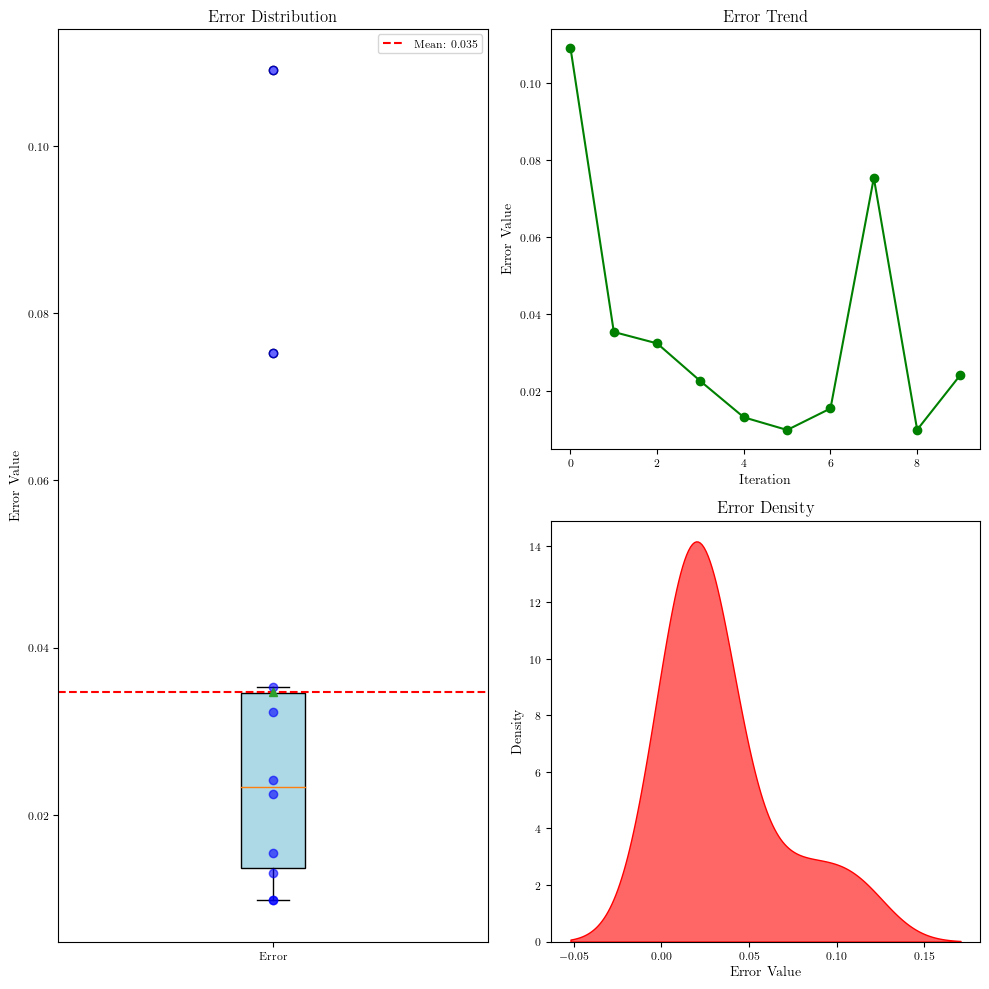

In [10]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns  # 导入seaborn库用于绘制密度图

# error = [0.5947221810612215, 0.7854634881268653, 1.0077722585678006, 0.5954742844285305, 0.4649590589316285, 0.41386083036181925, 0.6378457066743762, 0.6927021776896086, 0.44767318125257183, 0.28146649498710496, 0.8736713565859818, 0.8516792798779166, 0.37395951530223476, 0.8027823282496178, 0.804560887597274, 0.5182202889333846, 0.18454925778730633, 0.20862581035873265, 0.3739223144578929, 0.528249522241707]

plt.figure(figsize=(10, 10))  # 调整整体图表尺寸

# 左侧子图：箱形图，占据两张图的位置，箱的上下边界为上下四分位数，箱内的横线+三角点为中位数，虚线为均值
plt.subplot(1, 2, 1)  # 第一个子图，现在布局为1行2列
mean_error = np.mean(error)
plt.boxplot(error, patch_artist=True, showmeans=True, meanline=False, boxprops=dict(facecolor='lightblue')) #绘制箱型图，其中error是需要绘制的数据，patch_artist=True表示填充箱体，showmeans=True表示显示均值，meanline=True表示显示均值线，boxprops=dict(facecolor='lightblue')表示箱体的颜色为浅蓝色
plt.axhline(mean_error, color='r', linestyle='--', label=f'Mean: {mean_error:.3f}') #绘制一条水平线，位于mean_error处，颜色为红色，线型为虚线，标签为均值
for i, value in enumerate(error): #遍历error数组，i为索引，value为值
    plt.plot(1, value, 'bo', alpha=0.6) #绘制散点图，横坐标为1，纵坐标为value（即error数组中每个数），颜色为蓝色，点形状为圆圈，透明度为0.6
plt.title('Error Distribution')
plt.ylabel('Error Value')
plt.xticks([1], ['Error']) #设置x轴刻度标签
plt.legend() #显示图例

# 右侧上方子图：折线图
plt.subplot(2, 2, 2)  # 第二个子图，现在布局为2行2列的第二个位置
plt.plot(error, '-o', color='green') #绘制折线图，横坐标为error数组的索引，纵坐标为error数组的值，颜色为绿色，点形状为圆圈
plt.title('Error Trend')
plt.ylabel('Error Value')
plt.xlabel('Iteration')

# 右侧下方子图：密度图
plt.subplot(2, 2, 4)  # 第四个子图，现在布局为2行2列的第四个位置
sns.kdeplot(error, shade=True, color="r", alpha=0.6)
plt.title('Error Density')
plt.xlabel('Error Value')
plt.ylabel('Density')

plt.tight_layout()  # 自动调整子图参数，使之填充整个图表区域
plt.show()

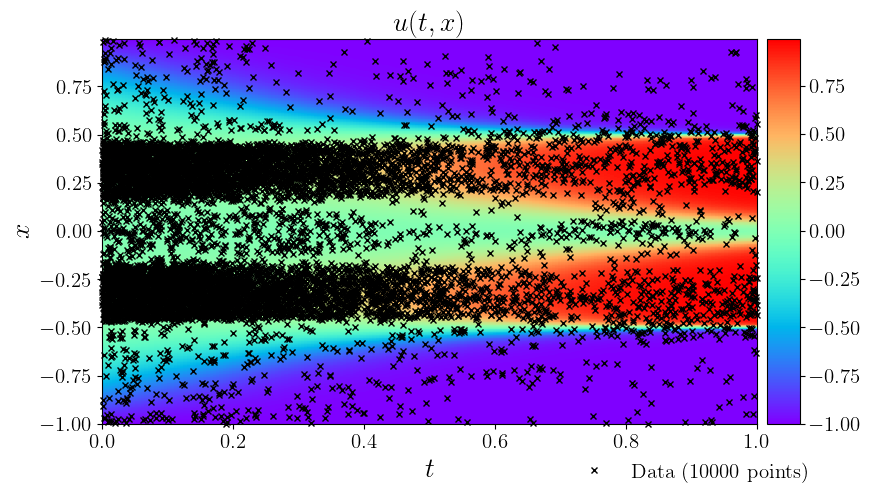

In [11]:
data = scipy.io.loadmat('../data/AC.mat')
#从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
t = data['tt'].flatten()[:,None]
x = data['x'].flatten()[:,None]
Exact = np.real(data['uu']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
#生成一个二位网络，X和T是输出的二维数组
#这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
X, T = np.meshgrid(x,t)

X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_star = Exact.flatten()[:,None]   #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组     
# X, T = np.meshgrid(x,t)

# X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_pred, f_pred = model.predict(X_star)    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组   


#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')
U_star = griddata(X_star, u_star.flatten(), (X, T), method='cubic')

###### Row 0: u(t,x) ##################    

fig = plt.figure(figsize=(9, 5)) #这里figure是一个figure对象，是一个图形窗口，代表整个图形，设置图形大小为宽9英寸高5 英寸
ax = fig.add_subplot(111) #在图形的1*1网格的第一个位置添加一个子图

#绘图的数据来源
h = ax.imshow(U_star.T, interpolation='nearest', cmap='rainbow', 
              extent=[t.min(), t.max(), x.min(), x.max()], 
              origin='lower', aspect='auto')   #imshow函数用于显示图像，接受一些参数，第一个参数是图像数据，这里是U_pred的转置；第二个参数是插值方法（用于在像素之间插入新的像素），这里是最邻近插值；
                                                   #第三个参数是颜色映射，这里是用彩虹色图；第四个参数是图像的范围；第五个参数是图像的原点位置，这里表示原点在右下角；第六个参数是图像的纵横比，这里表示调整横纵比以填充整个axes对象
                                                   #最后的结果返回一个axesimage对象，也就是h，可以通过这个对象进一步设置图像的属性


#添加颜色条
divider = make_axes_locatable(ax)  #使用 make_axes_locatable 函数创建了一个 AxesDivider 对象。这个函数接受一个 Axes 对象作为参数，返回一个 AxesDivider 对象。AxesDivider 对象可以用来管理子图的布局，特别是当你需要在一个图的旁边添加另一个图时。
cax = divider.append_axes("right", size="5%", pad=0.10) #使用append_axes方法在原始轴的右侧添加了一个新的轴。append_axes 方法接受三个参数：位置（"right"）、大小（"5%"）和间距（0.10）。在原始轴的右侧添加了一个新的轴，新轴的大小是原始轴的 5%，新轴与原始轴之间的间距是 0.05 英寸
   
cbar = fig.colorbar(h, cax=cax)#使用colorbar方法在新轴上添加了一个颜色条。colorbar 方法接受两个参数：axesimage 对象（h）和新轴（cax）。并记这个颜色条的名字是cbar
cbar.ax.tick_params(labelsize=15) #设置颜色条刻度标签大小，这里bar是之前定义的


#在图上绘制散点图
ax.plot(
    X_f[:,1], 
    X_f[:,0], 
    'kx', label = 'Data (%d points)' % (X_f.shape[0]), 
    markersize = 4,  # marker size doubled
    clip_on = False,
    alpha=1.0
) #在ax上绘制散点图，前两个参数是散点的x坐标和y坐标；kx表示黑色的x（散点形状是x），label是散点的标签，clip_on表示散点可以绘制在轴的边界外
  #新加了一个alpha=1.0用来设置标记的透明度，1.0表示完全不透明  




#设置图的标签、图例、标题和刻度标签
#设置ax子图的x轴的标签为t，y轴的标签为x。这里$t$和$x$是latex格式的文本，用于生成数学公式
ax.set_xlabel('$t$', size=20)
ax.set_ylabel('$x$', size=20)
#设置子图ax的图例，第一个参数用来设置图例的位置，这里表示图例放在上方中央;第二个参数用来设置图例的锚点，接受一个元组，表示x和y坐标，表示把图例的锚点设置在x坐标为0.9，y坐标为-0.05处;frameon=False表示不显示图例的边框;第三个参数设置图例的列数，分为5列；最后一个参数设置图例属性，接受字典，这里表示设置图例字体大小为15；最后返回的leg是一个legend对象，表示图形的图例
ax.legend(
    loc='upper center', 
    bbox_to_anchor=(0.9, -0.05), 
    ncol=5, 
    frameon=False, 
    prop={'size': 15}
)
#设置子图ax的标题为$u(t,x)$，表示latex格式的文本，用于生成数学公式，fontsize=10表示字体大小为20
ax.set_title('$u(t,x)$', fontsize = 20) # font size doubled，两倍化子图标题
ax.tick_params(labelsize=15)#用来设置刻度标签的大小。`tick_params`是`Axes`对象的一个方法，可以用来设置刻度线的属性。在这里，`labelsize=15` 是用来设置刻度标签的字体大小的。


#显示图片
plt.show() #显示所有打开的图形的函数

In [12]:
trainloss = torch.stack(model.loss_value).cpu().detach().numpy()


testerror = torch.stack(model.test_error).cpu().detach().numpy()

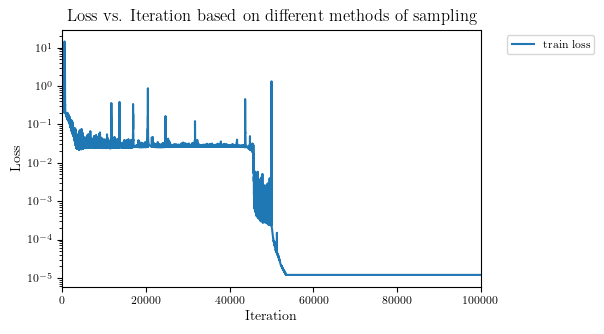

In [13]:
# print(len(trainloss))
# print(trainloss)
# 定义图例的标签
labels = ["Grid"]

# 创建一个新的图形
plt.figure()

# # 遍历所有的loss数据和标签
# for loss, label in zip(trainloss, labels):
#     # 绘制每个loss数据，并使用标签作为图例的条目
#     plt.plot(loss, label=label)

plt.plot(trainloss, label='train loss')

# 添加图例，放在图像外
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


plt.xlim([0,100000]) # 设置x轴的范围
plt.yscale('log') #设置y轴为对数尺度，这样即使列表中有一些非常大的值，也不会影响其他值的可视化
plt.xlabel('Iteration') # 设置x轴的标签
plt.ylabel('Loss') # 设置y轴的标签
plt.title('Loss vs. Iteration based on different methods of sampling') # 设置图形的标题
# 显示图形
plt.show()
plt.show()

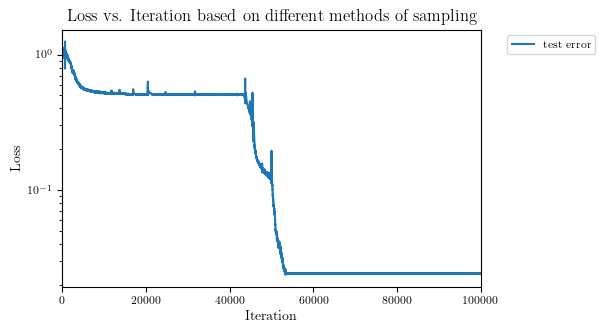

In [14]:
# print(len(trainloss))
# print(trainloss)
# 定义图例的标签
# labels = ["Grid"]

# 创建一个新的图形
plt.figure()

# # 遍历所有的loss数据和标签
# for loss, label in zip(trainloss, labels):
#     # 绘制每个loss数据，并使用标签作为图例的条目
#     plt.plot(loss, label=label)

plt.plot(testerror, label='test error')

# 添加图例，放在图像外
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


plt.xlim([0,100000]) # 设置x轴的范围
plt.yscale('log') #设置y轴为对数尺度，这样即使列表中有一些非常大的值，也不会影响其他值的可视化
plt.xlabel('Iteration') # 设置x轴的标签
plt.ylabel('Loss') # 设置y轴的标签
plt.title('Loss vs. Iteration based on different methods of sampling') # 设置图形的标题
# 显示图形
plt.show()
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


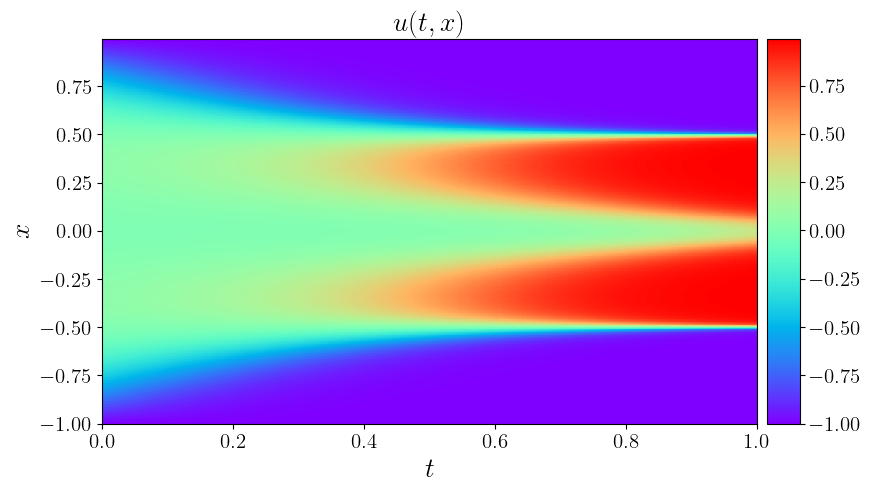

In [15]:
# data = scipy.io.loadmat('../../data/burgers_shock.mat')
# #从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
# t = data['t'].flatten()[:,None]
# x = data['x'].flatten()[:,None]
# Exact = np.real(data['usol']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
# #生成一个二位网络，X和T是输出的二维数组
# #这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
# X, T = np.meshgrid(x,t)

# X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_pred, f_pred = model.predict(X_star)    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组   


#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')


###### Row 0: u(t,x) ##################    

fig = plt.figure(figsize=(9, 5)) #这里figure是一个figure对象，是一个图形窗口，代表整个图形，设置图形大小为宽9英寸高5 英寸
ax = fig.add_subplot(111) #在图形的1*1网格的第一个位置添加一个子图

#绘图的数据来源
h = ax.imshow(U_pred.T, interpolation='nearest', cmap='rainbow', 
              extent=[t.min(), t.max(), x.min(), x.max()], 
              origin='lower', aspect='auto')   #imshow函数用于显示图像，接受一些参数，第一个参数是图像数据，这里是U_pred的转置；第二个参数是插值方法（用于在像素之间插入新的像素），这里是最邻近插值；
                                                   #第三个参数是颜色映射，这里是用彩虹色图；第四个参数是图像的范围；第五个参数是图像的原点位置，这里表示原点在右下角；第六个参数是图像的纵横比，这里表示调整横纵比以填充整个axes对象
                                                   #最后的结果返回一个axesimage对象，也就是h，可以通过这个对象进一步设置图像的属性


#添加颜色条
divider = make_axes_locatable(ax)  #使用 make_axes_locatable 函数创建了一个 AxesDivider 对象。这个函数接受一个 Axes 对象作为参数，返回一个 AxesDivider 对象。AxesDivider 对象可以用来管理子图的布局，特别是当你需要在一个图的旁边添加另一个图时。
cax = divider.append_axes("right", size="5%", pad=0.10) #使用append_axes方法在原始轴的右侧添加了一个新的轴。append_axes 方法接受三个参数：位置（"right"）、大小（"5%"）和间距（0.10）。在原始轴的右侧添加了一个新的轴，新轴的大小是原始轴的 5%，新轴与原始轴之间的间距是 0.05 英寸
   
cbar = fig.colorbar(h, cax=cax)#使用colorbar方法在新轴上添加了一个颜色条。colorbar 方法接受两个参数：axesimage 对象（h）和新轴（cax）。并记这个颜色条的名字是cbar
cbar.ax.tick_params(labelsize=15) #设置颜色条刻度标签大小，这里bar是之前定义的


# #在图上绘制散点图
# ax.plot(
#     X_f_train[:,1], 
#     X_f_train[:,0], 
#     'kx', label = 'Data (%d points)' % (X_f_train.shape[0]), 
#     markersize = 4,  # marker size doubled
#     clip_on = False,
#     alpha=1.0
# ) #在ax上绘制散点图，前两个参数是散点的x坐标和y坐标；kx表示黑色的x（散点形状是x），label是散点的标签，clip_on表示散点可以绘制在轴的边界外
#   #新加了一个alpha=1.0用来设置标记的透明度，1.0表示完全不透明  




#设置图的标签、图例、标题和刻度标签
#设置ax子图的x轴的标签为t，y轴的标签为x。这里$t$和$x$是latex格式的文本，用于生成数学公式
ax.set_xlabel('$t$', size=20)
ax.set_ylabel('$x$', size=20)
#设置子图ax的图例，第一个参数用来设置图例的位置，这里表示图例放在上方中央;第二个参数用来设置图例的锚点，接受一个元组，表示x和y坐标，表示把图例的锚点设置在x坐标为0.9，y坐标为-0.05处;frameon=False表示不显示图例的边框;第三个参数设置图例的列数，分为5列；最后一个参数设置图例属性，接受字典，这里表示设置图例字体大小为15；最后返回的leg是一个legend对象，表示图形的图例
ax.legend(
    loc='upper center', 
    bbox_to_anchor=(0.9, -0.05), 
    ncol=5, 
    frameon=False, 
    prop={'size': 15}
)
#设置子图ax的标题为$u(t,x)$，表示latex格式的文本，用于生成数学公式，fontsize=10表示字体大小为20
ax.set_title('$u(t,x)$', fontsize = 20) # font size doubled，两倍化子图标题
ax.tick_params(labelsize=15)#用来设置刻度标签的大小。`tick_params`是`Axes`对象的一个方法，可以用来设置刻度线的属性。在这里，`labelsize=15` 是用来设置刻度标签的字体大小的。


#显示图片
plt.show() #显示所有打开的图形的函数

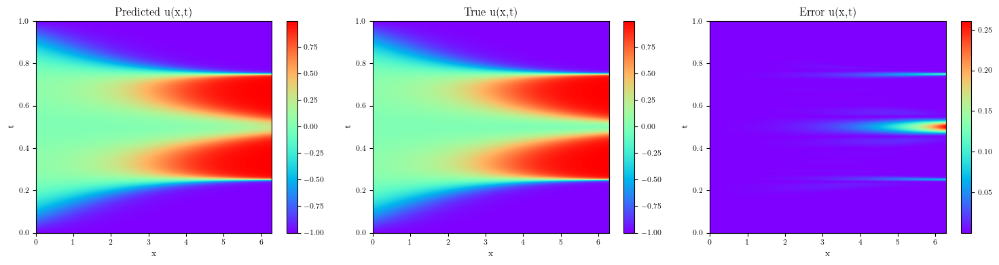

In [16]:

# 创建一个包含三幅子图的图像
fig, axes = plt.subplots(1, 3, figsize=(15, 4))

# 绘制第一幅图像
axes[0].imshow(U_pred.T, extent=[0, np.pi*2, 1, 0], aspect='auto', cmap='rainbow')
axes[0].invert_yaxis()
axes[0].set_xlabel('x')
axes[0].set_ylabel('t')
axes[0].set_title('Predicted u(x,t)')
fig.colorbar(axes[0].images[0], ax=axes[0])

# 绘制第二幅图像
axes[1].imshow(U_star.T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[1].invert_yaxis()
axes[1].set_xlabel('x')
axes[1].set_ylabel('t')
axes[1].set_title('True u(x,t)')
fig.colorbar(axes[1].images[0], ax=axes[1])

# 绘制第三幅图像
axes[2].imshow(np.abs(U_pred - U_star).T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[2].invert_yaxis()
axes[2].set_xlabel('x')
axes[2].set_ylabel('t')
axes[2].set_title('Error u(x,t)')
fig.colorbar(axes[2].images[0], ax=axes[2])

# 自动调整子图参数，使得子图之间的间距适当
plt.tight_layout()
plt.show()

In [17]:
#计算训练好模型的chaos（最后一个seed）
u_chaos = calculate_chaos(model, X_star, num_iter=50)
u_chaos_log = np.log(u_chaos + 1e-10) #对u_var取对数，然后加上一个很小的数，避免取对数时出现错误

#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_chaos = griddata(X_star, u_chaos.flatten(), (X, T), method='cubic')
U_chaos_log = griddata(X_star, u_chaos_log.flatten(), (X, T), method='cubic')

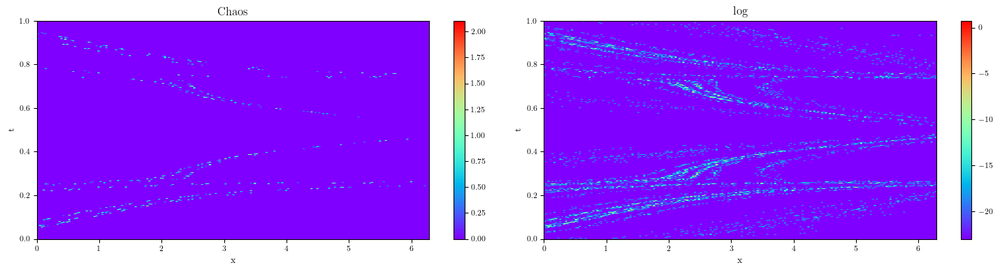

In [18]:

# 创建一个包含三幅子图的图像
fig, axes = plt.subplots(1, 2, figsize=(15, 4))

# 绘制第一幅图像
axes[0].imshow(U_chaos.T, extent=[0, np.pi*2, 1, 0], aspect='auto', cmap='rainbow')
axes[0].invert_yaxis()
axes[0].set_xlabel('x')
axes[0].set_ylabel('t')
axes[0].set_title('Chaos')
fig.colorbar(axes[0].images[0], ax=axes[0])

# 绘制第二幅图像
axes[1].imshow(U_chaos_log.T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[1].invert_yaxis()
axes[1].set_xlabel('x')
axes[1].set_ylabel('t')
axes[1].set_title('log')
fig.colorbar(axes[1].images[0], ax=axes[1])

# 自动调整子图参数，使得子图之间的间距适当
plt.tight_layout()
plt.show()